In [40]:
# -*- coding: utf-8 -*-
"""
@Env: Python3.5
@Date: 2 Oct, 2021
@Author: Harish Dhinakaran
@Function：Multi-layers ANN from scratch
@Version: V1.0
"""

##############Import libararies###################
import sys
# Python version
assert sys.version_info >= (3, 5)
import numpy as np
import pandas as pd
from time import *
import matplotlib.pyplot as plt

## Layer class for the network

In [41]:
#This class denoting one network layer
class Layer:
    
    #Init the weights and biases for the layer
    def __init__(self, n_input, n_neurons, activation):
        # Initiate weights with values between -0.15 to 0.15
        self.weights = (2*np.random.random((n_input, n_neurons))-1)*0.15
        self.biases = np.zeros((1, n_neurons))
        self.activation = activation
    # Forward method of this layer
    def forward(self, inputs):
        z = np.dot(inputs, self.weights) + self.biases
        self.output = self.activation.activate(z)
        return self.output      

## Activation implementation 

In [79]:
# Activation function base class
class Activation:
    
    # activate function the parent class
    def activate(self, input):
        a = self.calculate(input)
        return a
    # Derivative of the activation function
    def derivative(self, input):
        return self.comput_deriv(input)
   
#Logistic function(Sigmoid) for logistic regression tasks
class Sigmoid(Activation):
    def calculate(self, input):
        self.output = 1 / (1+np.exp(-input))
        return self.output
    def comput_deriv(self, input):
        self.derivative = self.calculate(input)*(1-self.calculate(input))
        return self.derivative

#Hyperbolic tangent activation function
class TanH(Activation):
    # Hyperbolic tangent: tanh 𝑥
    def calculate(self, input):
        self.output = np.tanh(input)
        return self.output
    # Derivative of tanh
    def comput_deriv(self, input):
        self.derivative = 1.0 - np.tanh(input) * np.tanh(input) 
        return self.derivative    

#ReLU activation function
class ReLU(Activation):
    
    def calculate(self, input):
        self.output = np.maximum(0, input)
        return self.output
    
    def comput_deriv(self, input):
        input_copy = np.copy(input)
        input_copy[input_copy<=0] = 0
        input_copy[input_copy>0] = 1
        self.derivative = input_copy
        return self.derivative
        

#Leaky ReLU activation function
class Leaky_ReLU(Activation):
    
    def calculate(self, input):
        alpha = 0.6
        self.output = np.maximum(input*alpha, input)
        return self.output
    
    def comput_deriv(self, input):
        input_copy = np.copy(input)
        input_copy[input_copy<=0] = 0.6
        input_copy[input_copy>0] = 1
        self.derivative = input_copy
        return self.derivative
  
#Softmax activation function
class Softmax(Activation):
    
    def calculate(self, inputs):
        e_values = np.exp(inputs - np.max(inputs, axis=1, keepdims=True))
        probs = e_values / np.sum(e_values, axis=1, keepdims=True)
        self.output = probs
        return self.output;
    

## Loss function

In [43]:
#Loss function
class Loss_Function:
    def loss(self, y_pred, y_true):
        print("stone:", y_pred)
        total_loss = self.calculate(y_pred, y)
        mean_loss = np.mean(total_loss)
        return mean_loss

class Categorical_Cross_Entropy(Loss_Function):
    def calculate(self, y_pred, y_true):
        sample_size = len(y_pred)
        
        #To solve the problem of infinity
        y_pred_clipped = np.clip(y_pred, 1e-7, 1-1e-7)
        
        #calculate the confidence for non one-hot encoded
        if len(y_true.shape) == 1:
            correct_confidence = y_pred_clipped[range(sample_size), y_true]
            
        #calculate the confidence for one-hot encoded
        elif len(y_true.shape) == 2:  
            correct_confidence = np.sum(y_pred_clipped*y_true, axis=1)
            
        log_likelihoods = -np.log(correct_confidence)
        return log_likelihoods

In [59]:
# Defining the neural network for training and predicting
class Neural_Network:
    def __init__(self, layers, activation = "sigmoid"):
        
        # init layers, we will not consider input layer as one
        self.layers = []
        print("=========Network structure=============")
        for i in range(1,len(layers)):
            print("layer",i,":", layers[i-1], "->",layers[i])
            
            # we are using softmax for the output layer as this multi-classification problem
            if i == len(layers):
                is_output = True
            else:
                is_output =  False
            
            self.layers.append(Layer(layers[i-1], layers[i], self.create_activation(activation, is_output)))
        print("=======================================")
       
    # Train the model
    def train(self, X, y, lr = 0.1, epochs = 1000):
        
        self.X = X
        self.y = y
        self.lr = lr
        self.epochs = epochs
        
        loss_arr = []
        epochs_arr = []
        
        begin_time = time()
        for x in range(epochs):
           
            #print("======epoch:=====", x)
            # Forward propagation
            self.forward_propagate(X)

            #Calculate cost.....
            loss_function = Categorical_Cross_Entropy()
            loss = loss_function.loss(self.a_output, y) 
            print("Loss:", loss)
            loss_arr.append(loss)
            epochs_arr.append(x)
            self.backward_propagate()
            
        end_time = time()
        
        train_time = end_time-begin_time
            
        #print("time:", train_time)
        
        accuracy = self.get_accuracy(y, self.a_output)
        
        print("Accuracy:", accuracy)
        
        #plt.scatter(loss_arr, epochs_arr) 
        #plt.show()
        
        return accuracy,train_time
        
            
    # Evaluate the model
    def evaluate(self, X, y):
        output = self.forward_propagate(X)
        return self.get_accuracy(y, output)
    
    def get_accuracy(self, y, output):
        #Get the argmax of y_true
        y_true = np.argmax(np.array(y), axis=1)
        
        #Get the argmax of y_pred
        y_pred = np.argmax(np.array(output), axis=1)
        
        accuracy = (y_pred == y_true).mean()
        
        return accuracy * 100
    
    #Create the activation function
    def create_activation(self, activation, is_output):
        if is_output:
            return Softmax()
        if activation == "sigmoid":
            return Sigmoid()
        elif activation == "relu":
            return ReLU()
        elif activation == "tanh":
            return TanH()
        elif activation == "leaky_relu":
            return Leaky_ReLU()

    def loss_derivative(self, y_pred, y_true):
        sample_size = y_true.shape[0]
        residual = y_pred - y_true
        return residual/sample_size
    
    def forward_propagate(self, X):
        self.a_output = X
        for i in range(len(self.layers)):
            self.a_output = self.layers[i].forward(self.a_output)
        return self.a_output
    def backward_propagate(self):
        
        # Reverse layers easy for calculating
        self.layers.reverse()

        for i in range(len(self.layers)):
            layer = self.layers[i]

            # Backpropagation for the last layer
            if i == 0:
                a_delta = self.loss_derivative(layer.output, self.y)
                z_delta = np.dot(a_delta, layer.weights.T)

                next_layer = self.layers[i+1]
                layer.weights -= self.lr * np.dot(next_layer.output.T, a_delta)
                layer.biases  -= self.lr * np.sum(a_delta, axis=0)

                layer.a_delta = a_delta
                layer.z_delta = z_delta

            # Backpropagation for the first layer
            elif i == (len(self.layers) - 1):
                pre_layer = self.layers[i-1]

                a_delta = pre_layer.z_delta * layer.activation.comput_deriv(layer.output)

                layer.weights -= self.lr * np.dot(self.X.T, a_delta)
                layer.biases -= self.lr * np.sum(a_delta, axis=0)

                layer.a_delta = a_delta

            # Backpropagation for layers in between
            else:
                next_layer = self.layers[i+1]
                pre_layer = self.layers[i-1]

                a_delta = pre_layer.z_delta * layer.activation.comput_deriv(layer.output)
                z_delta = np.dot(a_delta, layer.weights.T)

                layer.weights -= self.lr * np.dot(next_layer.output.T, a_delta)
                layer.biases -= self.lr * np.sum(a_delta, axis=0)

                layer.a_delta = a_delta
                layer.z_delta = z_delta
                
        # Reverse the layers back
        self.layers.reverse()

## Loading data

In [45]:
X = pd.read_csv("x_train.csv", header=None)
y = pd.read_csv("y_one-hot-coded.csv", header=None)

## Train model

=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.49834236 0.44906742]
 [0.49725031 0.44912887]
 [0.49353509 0.44875096]
 ...
 [0.49709769 0.44927121]
 [0.49751699 0.45130005]
 [0.49551872 0.44860131]]
Loss: 0.7448529270752714
stone: [[0.51572205 0.44749287]
 [0.51457842 0.44755633]
 [0.51058691 0.4473344 ]
 ...
 [0.51444031 0.447691  ]
 [0.51497231 0.44964878]
 [0.51265082 0.44714677]]
Loss: 0.7272448524393322
stone: [[0.5279503  0.44636863]
 [0.52677051 0.44643313]
 [0.52252472 0.44636792]
 ...
 [0.52664623 0.44656016]
 [0.52728683 0.44844641]
 [0.52465743 0.44614221]]
Loss: 0.7152264058887141
stone: [[0.53655916 0.44556254]
 [0.53535327 0.44562739]
 [0.53086614 0.44571956]
 ...
 [0.53524219 0.44574684]
 [0.53598868 0.44756136]
 [0.53306101 0.44545554]]
Loss: 0.7069321328060746
stone: [[0.54263008 0.44498097]
 [0.5414047  0.44504573]
 [0.53668406 0.44529586]
 ...
 [0.54130631 0.44515766]
 [0.54215681 0.44690042]
 [0.53893718 0.4

stone: [[0.56110889 0.43995341]
 [0.55903399 0.44043651]
 [0.53633948 0.45512797]
 ...
 [0.55983703 0.4399212 ]
 [0.56873252 0.43548674]
 [0.54229765 0.45148364]]
Loss: 0.6799098567374161
stone: [[0.56123148 0.43983949]
 [0.55911856 0.44035054]
 [0.53582213 0.45556059]
 ...
 [0.55995528 0.43980917]
 [0.56912497 0.43514712]
 [0.54187794 0.45181875]]
Loss: 0.6796332539250421
stone: [[0.56135722 0.43972265]
 [0.55920461 0.44026314]
 [0.53528677 0.45600988]
 ...
 [0.5600764  0.4396945 ]
 [0.5695294  0.43479645]
 [0.54144194 0.45216856]]
Loss: 0.6793467866830543
stone: [[0.56148626 0.43960277]
 [0.55929219 0.44017428]
 [0.53473261 0.45647657]
 ...
 [0.56020052 0.43957709]
 [0.5699463  0.43443426]
 [0.5409889  0.45253379]]
Loss: 0.6790500115074974
stone: [[0.56161872 0.43947973]
 [0.55938135 0.44008391]
 [0.53415881 0.45696144]
 ...
 [0.56032776 0.43945682]
 [0.57037619 0.43406006]
 [0.54051805 0.45291516]]
Loss: 0.6787424660605541
stone: [[0.56175474 0.4393534 ]
 [0.55947214 0.43999198]
 [0

stone: [[0.58085692 0.42143293]
 [0.57015715 0.42969392]
 [0.43802116 0.54597655]
 ...
 [0.58006643 0.42101999]
 [0.63454437 0.37425588]
 [0.4519285  0.53413727]]
Loss: 0.6260732327348165
stone: [[0.58165115 0.42067082]
 [0.57064686 0.42922913]
 [0.43409921 0.54978123]
 ...
 [0.58101421 0.42012474]
 [0.63708879 0.37179247]
 [0.44807305 0.53785255]]
Loss: 0.6238866850200527
stone: [[0.58246562 0.41988761]
 [0.57115968 0.42874207]
 [0.43008032 0.55369068]
 ...
 [0.58200338 0.41918899]
 [0.63969828 0.36926091]
 [0.44410799 0.5416832 ]]
Loss: 0.6216411166043833
stone: [[0.58329948 0.419084  ]
 [0.57169666 0.42823166]
 [0.42596606 0.55770398]
 ...
 [0.5830353  0.41821133]
 [0.64237235 0.3666614 ]
 [0.44003434 0.5456288 ]]
Loss: 0.6193366273801848
stone: [[0.58415163 0.41826088]
 [0.57225887 0.4276968 ]
 [0.42175834 0.56181986]
 ...
 [0.58411124 0.41719036]
 [0.64511033 0.36399432]
 [0.43585352 0.54968854]]
Loss: 0.6169734043514535
stone: [[0.58502076 0.41741936]
 [0.57284737 0.42713639]
 [0

stone: [[0.39475089 0.6013526 ]
 [0.64550653 0.35476272]
 [0.13591748 0.85866983]
 ...
 [0.71164068 0.29011318]
 [0.85336087 0.15097376]
 [0.14099124 0.85366218]]
Loss: 0.338351309799126
stone: [[0.38112781 0.61483767]
 [0.64594132 0.3542815 ]
 [0.13230641 0.86250033]
 ...
 [0.71343651 0.28826321]
 [0.85653187 0.14767223]
 [0.13725492 0.85760889]]
Loss: 0.3311751106346365
stone: [[0.36736724 0.62848001]
 [0.64626515 0.35390984]
 [0.12877132 0.86624885]
 ...
 [0.71515851 0.28648654]
 [0.85965985 0.14441598]
 [0.13359305 0.86147554]]
Loss: 0.32400654732266615
stone: [[0.35354044 0.64220951]
 [0.64647503 0.35365085]
 [0.12531382 0.86991368]
 ...
 [0.71680517 0.28478475]
 [0.86274305 0.14120686]
 [0.13000684 0.86526082]]
Loss: 0.3168575333169836
stone: [[0.33971948 0.65595489]
 [0.64656839 0.35350719]
 [0.12193541 0.87349324]
 ...
 [0.71837539 0.2831591 ]
 [0.86577979 0.13804667]
 [0.12649736 0.86896354]]
Loss: 0.30974031684392506
stone: [[0.32597556 0.66964529]
 [0.64654311 0.35348108]
 [

stone: [[-0.25552017  0.89922876]
 [ 0.39176695  0.68015343]
 [ 0.15269226  0.89179813]
 ...
 [ 0.56149901  0.59986627]
 [ 0.96256256 -0.08161906]
 [-0.19702674  0.90953763]]
Loss: 0.10404474364987852
stone: [[-0.26201055  0.90405548]
 [ 0.38806934  0.69054114]
 [ 0.15254882  0.89604479]
 ...
 [ 0.56064627  0.61019327]
 [ 0.96351588 -0.08017525]
 [-0.19653534  0.91321226]]
Loss: 0.10043732025451504
stone: [[-0.26774914  0.90847256]
 [ 0.38464968  0.70030014]
 [ 0.15232664  0.89999223]
 ...
 [ 0.55987185  0.61995244]
 [ 0.96436717 -0.0787581 ]
 [-0.19576663  0.91660108]]
Loss: 0.09712579475255219
stone: [[-0.27282198  0.91252573]
 [ 0.38148797  0.7094843 ]
 [ 0.15205134  0.90366581]
 ...
 [ 0.55917282  0.6291896 ]
 [ 0.96513091 -0.07736432]
 [-0.19477005  0.91973377]]
Loss: 0.09407636402092136
stone: [[-0.27730571  0.91625458]
 [ 0.37856373  0.71814201]
 [ 0.15174147  0.90708871]
 ...
 [ 0.55854476  0.63794625]
 [ 0.96581919 -0.07599127]
 [-0.19358877  0.92263628]]
Loss: 0.0912600866600

stone: [[-0.31164106  0.96735852]
 [ 0.33410892  0.86896075]
 [ 0.13534942  0.95856601]
 ...
 [ 0.5521145   0.80111274]
 [ 0.97465312 -0.03616201]
 [-0.14295278  0.96534324]]
Loss: 0.05009711604537586
stone: [[-0.31171543  0.96781312]
 [ 0.33353493  0.8707223 ]
 [ 0.13480842  0.95908453]
 ...
 [ 0.55204306  0.80318111]
 [ 0.97474916 -0.03544663]
 [-0.14210796  0.96576812]]
Loss: 0.049679815106677065
stone: [[-0.31178797  0.96825097]
 [ 0.33297154  0.87242978]
 [ 0.13426378  0.95958625]
 ...
 [ 0.5519721   0.80519074]
 [ 0.97484317 -0.03474623]
 [-0.14128302  0.96617898]]
Loss: 0.04927566108365652
stone: [[-0.31185923  0.96867287]
 [ 0.33241825  0.87408537]
 [ 0.1337157   0.96007195]
 ...
 [ 0.55190157  0.8071438 ]
 [ 0.97493524 -0.03406051]
 [-0.1404773   0.96657646]]
Loss: 0.04888404407413051
stone: [[-0.31192974  0.96907961]
 [ 0.33187461  0.87569115]
 [ 0.13316437  0.96054234]
 ...
 [ 0.55183141  0.80904237]
 [ 0.97502548 -0.03338916]
 [-0.13969018  0.96696117]]
Loss: 0.048504390579

stone: [[-0.31758078  0.97908755]
 [ 0.31151009  0.91922198]
 [ 0.10467896  0.97316979]
 ...
 [ 0.54809447  0.86223692]
 [ 0.9782074  -0.01264967]
 [-0.11543486  0.9771031 ]]
Loss: 0.037990011499595036
stone: [[-0.31774143  0.97918522]
 [ 0.3111584   0.91970621]
 [ 0.10409717  0.97330902]
 ...
 [ 0.5480036   0.86284836]
 [ 0.97825697 -0.01238873]
 [-0.11512147  0.97721144]]
Loss: 0.037866565343585866
stone: [[-0.31790298  0.97928071]
 [ 0.31080785  0.9201816 ]
 [ 0.10351603  0.97344562]
 ...
 [ 0.54791202  0.86344909]
 [ 0.97830612 -0.01213184]
 [-0.11481253  0.9773176 ]]
Loss: 0.03774512585861765
stone: [[-0.31806538  0.97937409]
 [ 0.31045842  0.9206484 ]
 [ 0.10293556  0.97357964]
 ...
 [ 0.54781973  0.86403939]
 [ 0.97835486 -0.0118789 ]
 [-0.11450793  0.97742166]]
Loss: 0.037625639343930845
stone: [[-0.31822857  0.9794654 ]
 [ 0.31011004  0.92110687]
 [ 0.10235577  0.97371118]
 ...
 [ 0.54772674  0.86461956]
 [ 0.97840319 -0.01162981]
 [-0.11420756  0.97752366]]
Loss: 0.0375080539

stone: [[-0.3264803   0.98243457]
 [ 0.29271719  0.93743939]
 [ 0.0736578   0.97823895]
 ...
 [ 0.54195747  0.88559515]
 [ 0.98045853 -0.00243206]
 [-0.10270812  0.98096764]]
Loss: 0.033142064283996485
stone: [[-0.32661512  0.98247082]
 [ 0.29238608  0.93766024]
 [ 0.07314192  0.97829631]
 ...
 [ 0.54182916  0.88588414]
 [ 0.98049078 -0.00230821]
 [-0.10254382  0.98101072]]
Loss: 0.03308037810420392
stone: [[-0.32674852  0.98250662]
 [ 0.2920548   0.93787883]
 [ 0.07262765  0.97835293]
 ...
 [ 0.5417002   0.88617039]
 [ 0.98052279 -0.00218592]
 [-0.1023811   0.98105324]]
Loss: 0.03301924297676689
stone: [[-0.32688048  0.98254197]
 [ 0.29172334  0.93809523]
 [ 0.07211501  0.97840883]
 ...
 [ 0.5415706   0.88645396]
 [ 0.98055458 -0.00206518]
 [-0.10221995  0.98109523]]
Loss: 0.03295864809170618
stone: [[-0.32701098  0.98257689]
 [ 0.29139167  0.93830947]
 [ 0.071604    0.978464  ]
 ...
 [ 0.54144037  0.8867349 ]
 [ 0.98058615 -0.00194598]
 [-0.10206033  0.98113669]]
Loss: 0.032898582902

stone: [[0.06529933 0.75678787]
 [0.17570568 0.56560939]
 [0.14087593 1.13228879]
 ...
 [0.19808197 0.55774235]
 [1.058986   0.        ]
 [0.         0.97081209]]
Loss: 0.1633696026188217
stone: [[0.05703808 0.77138931]
 [0.16739261 0.57980337]
 [0.13379615 1.12682619]
 ...
 [0.189608   0.57115463]
 [1.05522982 0.        ]
 [0.         0.98019366]]
Loss: 0.15662329324899305
stone: [[0.0495278  0.78521337]
 [0.15973832 0.59331875]
 [0.12770235 1.12038147]
 ...
 [0.18186101 0.58386091]
 [1.05121194 0.        ]
 [0.         0.98831604]]
Loss: 0.15063355051586633
stone: [[0.04245152 0.79875729]
 [0.15266616 0.60622966]
 [0.12329022 1.11242913]
 ...
 [0.17471466 0.59598288]
 [1.04658668 0.        ]
 [0.         0.99520066]]
Loss: 0.1453289221361334
stone: [[0.03614283 0.81139081]
 [0.14622734 0.61852306]
 [0.11573166 1.10729464]
 ...
 [0.16839119 0.60732846]
 [1.04275211 0.        ]
 [0.         1.00162074]]
Loss: 0.1403124970459637
stone: [[0.03031275 0.82336926]
 [0.14019214 0.63028422]
 

stone: [[0.         1.01896495]
 [0.07024481 0.8504004 ]
 [0.         0.9742742 ]
 ...
 [0.09404272 0.82814137]
 [0.96656397 0.        ]
 [0.         1.05811145]]
Loss: 0.0761860771182094
stone: [[0.         1.02017427]
 [0.06979261 0.85264088]
 [0.         0.97600164]
 ...
 [0.09366065 0.83032404]
 [0.96659387 0.        ]
 [0.         1.05908604]]
Loss: 0.0756110090582155
stone: [[0.         1.02216433]
 [0.06933331 0.85477465]
 [0.         0.97061732]
 ...
 [0.0931655  0.83253053]
 [0.96615359 0.        ]
 [0.         1.05743546]]
Loss: 0.07532502894560339
stone: [[0.         1.0230773 ]
 [0.06895128 0.85684708]
 [0.         0.9752063 ]
 ...
 [0.09299385 0.83437122]
 [0.96678911 0.        ]
 [0.         1.05916255]]
Loss: 0.07463659853257912
stone: [[0.         1.02451126]
 [0.0684829  0.85882013]
 [0.         0.97113001]
 ...
 [0.09245463 0.83644724]
 [0.96609455 0.        ]
 [0.         1.05793365]]
Loss: 0.07444925601021332
stone: [[0.         1.02538347]
 [0.0681225  0.86073254]


stone: [[0.         1.04919615]
 [0.05694182 0.90917633]
 [0.         0.95177038]
 ...
 [0.08793643 0.87446356]
 [0.97342502 0.        ]
 [0.         1.05685399]]
Loss: 0.06416117682768448
stone: [[0.         1.04969941]
 [0.05681315 0.90972813]
 [0.         0.95079456]
 ...
 [0.08792566 0.87479836]
 [0.97384593 0.        ]
 [0.         1.0560302 ]]
Loss: 0.06404526271520841
stone: [[0.         1.04979827]
 [0.05667432 0.91030189]
 [0.         0.95224632]
 ...
 [0.08796257 0.87509816]
 [0.97441727 0.        ]
 [0.         1.05617162]]
Loss: 0.06384651569826842
stone: [[0.         1.0502276 ]
 [0.05644553 0.91092307]
 [0.         0.95246943]
 ...
 [0.0877468  0.87563258]
 [0.97452911 0.        ]
 [0.         1.05605293]]
Loss: 0.06371765457948918
stone: [[0.         1.05070931]
 [0.05630946 0.91147569]
 [0.         0.9515678 ]
 ...
 [0.08767746 0.87603856]
 [0.97501401 0.        ]
 [0.         1.05534763]]
Loss: 0.06357459870263325
stone: [[0.         1.05111974]
 [0.05613141 0.91204218

stone: [[0.         1.06030457]
 [0.05048297 0.93057765]
 [0.         0.9705005 ]
 ...
 [0.08624746 0.8881385 ]
 [0.98996833 0.        ]
 [0.         1.0532297 ]]
Loss: 0.0571466563734054
stone: [[0.         1.06050877]
 [0.05034355 0.93081474]
 [0.         0.96863661]
 ...
 [0.08612584 0.88837339]
 [0.99005864 0.        ]
 [0.         1.0524759 ]]
Loss: 0.05713273268306109
stone: [[0.         1.06057495]
 [0.05020892 0.93109111]
 [0.         0.96990354]
 ...
 [0.08610703 0.88851448]
 [0.99041407 0.        ]
 [0.         1.05299848]]
Loss: 0.05696441193379323
stone: [[0.         1.06072291]
 [0.05004875 0.93136699]
 [0.         0.96899628]
 ...
 [0.0860082  0.88875114]
 [0.9905644  0.        ]
 [0.         1.05263311]]
Loss: 0.056909851016741064
stone: [[0.         1.06067411]
 [0.04989875 0.93164908]
 [0.         0.97084371]
 ...
 [0.0859312  0.88895713]
 [0.99072918 0.        ]
 [0.         1.05340014]]
Loss: 0.05673828559942859
stone: [[0.         1.06086163]
 [0.04975504 0.93188396

stone: [[-0.03207309  0.9912661 ]
 [ 0.15010591  0.65583269]
 [ 0.26207989  0.85690543]
 ...
 [ 0.23502263  0.59329804]
 [ 1.06852049 -0.08653741]
 [-0.01703812  1.01408974]]
Loss: 0.12895760586659857
stone: [[-0.03218489  0.99526528]
 [ 0.14815509  0.66331104]
 [ 0.26275127  0.85302809]
 ...
 [ 0.23343395  0.59969925]
 [ 1.06624716 -0.08501029]
 [-0.01767226  1.01666698]]
Loss: 0.127766948780406
stone: [[-0.03191139  0.9983334 ]
 [ 0.14661262  0.67013308]
 [ 0.26097994  0.85173411]
 ...
 [ 0.23233856  0.60540402]
 [ 1.06505358 -0.08402512]
 [-0.01882918  1.02004073]]
Loss: 0.1264840054510271
stone: [[-0.03204041  1.00182775]
 [ 0.14510098  0.67667791]
 [ 0.26245972  0.84723114]
 ...
 [ 0.231079    0.61104337]
 [ 1.06256499 -0.08233455]
 [-0.01907471  1.02169555]]
Loss: 0.1256206752990611
stone: [[-0.03145412  1.00388118]
 [ 0.14410333  0.68249065]
 [ 0.25895682  0.84790979]
 ...
 [ 0.23058749  0.615737  ]
 [ 1.06220016 -0.08175213]
 [-0.02050585  1.02534628]]
Loss: 0.12439134696370947

stone: [[-0.01828053  1.03681869]
 [ 0.164503    0.77165654]
 [ 0.22939656  0.79898382]
 ...
 [ 0.25334805  0.68705973]
 [ 1.04347903 -0.05829364]
 [-0.02739685  1.04872265]]
Loss: 0.1132707334161945
stone: [[-0.01769847  1.03595239]
 [ 0.16493827  0.7719168 ]
 [ 0.22453507  0.80351489]
 ...
 [ 0.2540057   0.68702532]
 [ 1.0451715  -0.05901935]
 [-0.02870542  1.05107602]]
Loss: 0.11271183575377987
stone: [[-0.01817579  1.03695247]
 [ 0.16480971  0.7726852 ]
 [ 0.22817654  0.79905993]
 ...
 [ 0.25370557  0.68788962]
 [ 1.04319764 -0.05781739]
 [-0.02780215  1.04935297]]
Loss: 0.11310074469803812
stone: [[-0.01759123  1.03607168]
 [ 0.16525925  0.77289871]
 [ 0.22332362  0.8036044 ]
 ...
 [ 0.25437187  0.68781864]
 [ 1.04488423 -0.05854563]
 [-0.02910134  1.05168679]]
Loss: 0.11254847790598438
stone: [[-0.01806931  1.0370614 ]
 [ 0.16514235  0.77362413]
 [ 0.22699878  0.79913982]
 ...
 [ 0.25407894  0.68864887]
 [ 1.04291336 -0.0573498 ]
 [-0.02818266  1.04993552]]
Loss: 0.11294390180074

stone: [[ 0.02142458  0.98748284]
 [ 0.2047519   0.75532454]
 [ 0.03358692  0.97419412]
 ...
 [ 0.29837706  0.66375432]
 [ 1.10735403 -0.08339757]
 [-0.07033283  1.11807261]]
Loss: 0.10371253570462657
stone: [[-0.02252492  1.04961821]
 [ 0.18430779  0.77437473]
 [ 0.33206015  0.65852089]
 ...
 [ 0.264553    0.6957711 ]
 [ 0.98370892 -0.01921976]
 [ 0.0092237   0.98132151]]
Loss: 0.13538502959446458
stone: [[ 0.01106651  0.99874392]
 [ 0.20128492  0.75962957]
 [ 0.07160425  0.93483323]
 ...
 [ 0.29354134  0.66930628]
 [ 1.09452864 -0.07648037]
 [-0.06189331  1.10401049]]
Loss: 0.10406330336697606
stone: [[-0.02097588  1.04703   ]
 [ 0.18502617  0.77480995]
 [ 0.30468246  0.68884716]
 ...
 [ 0.26693232  0.69450209]
 [ 0.99815895 -0.02651609]
 [-0.00285877  0.9976665 ]]
Loss: 0.1288501479472507
stone: [[ 0.00340986  1.00697785]
 [ 0.19810658  0.76347865]
 [ 0.09888172  0.90691999]
 ...
 [ 0.28946338  0.67394764]
 [ 1.08479981 -0.07130704]
 [-0.05608782  1.09445801]]
Loss: 0.10470753918648

Loss: 0.6793720919659827
stone: [[0.55785668 0.44817177]
 [0.55761591 0.4473655 ]
 [0.55770649 0.44501091]
 ...
 [0.55784305 0.44739455]
 [0.55870479 0.44732462]
 [0.55739088 0.44595068]]
Loss: 0.6812528802300897
stone: [[0.55756085 0.44699744]
 [0.55731205 0.44619809]
 [0.55704232 0.44416585]
 ...
 [0.55755799 0.44620954]
 [0.55856591 0.44600687]
 [0.55682986 0.44502047]]
Loss: 0.6825393079800065
stone: [[0.55736591 0.44615015]
 [0.55710904 0.44535745]
 [0.5564772  0.44364452]
 ...
 [0.55737398 0.44535145]
 [0.55852909 0.44501637]
 [0.55636801 0.44441483]]
Loss: 0.6834020913609481
stone: [[0.5572429  0.44553456]
 [0.5569779  0.44474836]
 [0.55598198 0.44335307]
 ...
 [0.55726207 0.44472496]
 [0.55856548 0.44425739]
 [0.55597618 0.44403963]]
Loss: 0.6839629902130272
stone: [[0.5571712  0.44508315]
 [0.55689799 0.44430337]
 [0.55553579 0.44322515]
 ...
 [0.55720163 0.44426254]
 [0.55865461 0.44366204]
 [0.55563354 0.44382827]]
Loss: 0.6843086990297439
stone: [[0.55713619 0.44474806]
 [0

Loss: 0.6732795570434067
stone: [[0.56067119 0.44061308]
 [0.55952131 0.44056452]
 [0.53355213 0.4607516 ]
 ...
 [0.5614387  0.4391052 ]
 [0.57341154 0.42921785]
 [0.53886824 0.45700784]]
Loss: 0.672721534102358
stone: [[0.56084396 0.44045439]
 [0.55964358 0.44045064]
 [0.53261425 0.46157573]
 ...
 [0.56164189 0.43891887]
 [0.57406744 0.42862524]
 [0.53808155 0.45770014]]
Loss: 0.6721417477332361
stone: [[0.56102403 0.44028889]
 [0.55977051 0.44033244]
 [0.53164151 0.46243216]
 ...
 [0.56185357 0.43872469]
 [0.57474747 0.42801013]
 [0.53726041 0.4584241 ]]
Loss: 0.6715392498129695
stone: [[0.56121182 0.44011621]
 [0.55990238 0.44020969]
 [0.53063241 0.46332237]
 ...
 [0.56207421 0.43852222]
 [0.57545264 0.42737154]
 [0.53640314 0.45918132]]
Loss: 0.670913060182119
stone: [[0.56140773 0.43993596]
 [0.56003946 0.44008212]
 [0.52958535 0.46424789]
 ...
 [0.56230429 0.43831098]
 [0.57618396 0.42670847]
 [0.53550798 0.45997348]]
Loss: 0.6702621663446033
stone: [[0.5616122  0.43974771]
 [0.5

stone: [[0.59627434 0.406825  ]
 [0.58879267 0.41295614]
 [0.37494474 0.61061018]
 ...
 [0.60864902 0.39447442]
 [0.67399459 0.33362552]
 [0.38826427 0.59854165]]
Loss: 0.5786986458173315
stone: [[0.59757495 0.40555886]
 [0.59028757 0.41152361]
 [0.3689494  0.61651082]
 ...
 [0.6108772  0.39232398]
 [0.67757581 0.33010045]
 [0.38239086 0.60426899]]
Loss: 0.5752380781577461
stone: [[0.59886521 0.4043003 ]
 [0.59183502 0.41003882]
 [0.36286934 0.62250684]
 ...
 [0.61316996 0.3901081 ]
 [0.6812109  0.32651569]
 [0.37641946 0.61010417]]
Loss: 0.571708071328281
stone: [[0.60013816 0.403056  ]
 [0.59343458 0.40850205]
 [0.3567129  0.62859028]
 ...
 [0.61552592 0.38782794]
 [0.68489664 0.32287424]
 [0.37035712 0.61604074]]
Loss: 0.5681086806978901
stone: [[0.60138628 0.40183322]
 [0.59508559 0.40691378]
 [0.35048877 0.63475273]
 ...
 [0.6179434  0.38548489]
 [0.68862959 0.31917934]
 [0.36421139 0.62207172]]
Loss: 0.5644398252846012
stone: [[0.60260143 0.40063985]
 [0.5967872  0.40527469]
 [0.

stone: [[0.26894239 0.72939575]
 [0.68187083 0.32095194]
 [0.08695147 0.90643331]
 ...
 [0.75573747 0.2474965 ]
 [0.88054074 0.12299693]
 [0.08847594 0.90485665]]
Loss: 0.25676189933474103
stone: [[0.25611658 0.74210364]
 [0.68168701 0.32112754]
 [0.08474403 0.9088135 ]
 ...
 [0.75710073 0.24609443]
 [0.8830306  0.12041257]
 [0.08582626 0.90768119]]
Loss: 0.2509153903874473
stone: [[0.24374867 0.75436142]
 [0.68140752 0.3214001 ]
 [0.08263192 0.91109392]
 ...
 [0.75840944 0.24474796]
 [0.8854666  0.11788414]
 [0.08326373 0.91041449]]
Loss: 0.24520369120848962
stone: [[0.23186384 0.7661443 ]
 [0.68103373 0.32176833]
 [0.08061256 0.9132771 ]
 ...
 [0.75966522 0.24345552]
 [0.88784886 0.11541156]
 [0.08078655 0.91305828]]
Loss: 0.23963088308043975
stone: [[0.22047934 0.77743528]
 [0.68056696 0.32223096]
 [0.07868322 0.91536576]
 ...
 [0.76086969 0.24221554]
 [0.89017757 0.11299466]
 [0.07839286 0.91561439]]
Loss: 0.23420005873442884
stone: [[0.2096051  0.78822454]
 [0.68000854 0.3227867 ]

stone: [[-0.13869073  0.76203925]
 [ 0.52462147  0.44538686]
 [ 0.10769465  0.7898554 ]
 ...
 [ 0.62285009  0.38377071]
 [ 0.94332181 -0.1106951 ]
 [-0.16829085  0.8184152 ]]
Loss: 0.19816791352404972
stone: [[-0.1562214   0.78212789]
 [ 0.52092483  0.46879032]
 [ 0.11546387  0.80133384]
 ...
 [ 0.62464231  0.40451184]
 [ 0.94752168 -0.11165306]
 [-0.17715437  0.83136974]]
Loss: 0.1838174293771423
stone: [[-0.17080832  0.79946277]
 [ 0.51628266  0.49116002]
 [ 0.12288855  0.81157307]
 ...
 [ 0.62542142  0.42450226]
 [ 0.95096724 -0.11170717]
 [-0.184678    0.8427459 ]]
Loss: 0.1715022235838507
stone: [[-0.18316055  0.81456294]
 [ 0.51103945  0.51234543]
 [ 0.12978512  0.82077788]
 ...
 [ 0.62546792  0.44357364]
 [ 0.95382585 -0.11126986]
 [-0.19114518  0.85281283]]
Loss: 0.16083036610704673
stone: [[-0.19375969  0.82781981]
 [ 0.50544884  0.53229782]
 [ 0.13606412  0.82910572]
 ...
 [ 0.62498996  0.46165902]
 [ 0.95622014 -0.11057915]
 [-0.19674742  0.86177872]]
Loss: 0.151503862409959

stone: [[-0.265777    0.96145239]
 [ 0.37237039  0.84859985]
 [ 0.14411783  0.94017288]
 ...
 [ 0.57700005  0.77665437]
 [ 0.97225171 -0.06784506]
 [-0.1785177   0.96191794]]
Loss: 0.05555055637749161
stone: [[-0.26616638  0.96205551]
 [ 0.37087948  0.85100537]
 [ 0.1429551   0.94091657]
 ...
 [ 0.57627334  0.77940284]
 [ 0.97230883 -0.0668025 ]
 [-0.17713897  0.96241622]]
Loss: 0.05504006724257963
stone: [[-0.26656081  0.96263538]
 [ 0.36941725  0.85333483]
 [ 0.14176604  0.94163832]
 ...
 [ 0.57556012  0.78207285]
 [ 0.97236543 -0.06576437]
 [-0.17577887  0.96289527]]
Loss: 0.05454621100825766
stone: [[-0.26696038  0.96319322]
 [ 0.36798285  0.85559148]
 [ 0.14055302  0.94233924]
 ...
 [ 0.57486013  0.78466743]
 [ 0.97242157 -0.06473118]
 [-0.17443688  0.96335613]]
Loss: 0.05406813187618169
stone: [[-0.26736519  0.96373018]
 [ 0.36657548  0.8577784 ]
 [ 0.13931838  0.9430204 ]
 ...
 [ 0.57417312  0.78718946]
 [ 0.9724773  -0.06370338]
 [-0.17311255  0.96379978]]
Loss: 0.0536050309631

stone: [[-0.28909927  0.97649414]
 [ 0.32271987  0.91513204]
 [ 0.08260053  0.96219926]
 ...
 [ 0.5533669   0.85638601]
 [ 0.97502939 -0.02562861]
 [-0.12851505  0.97469329]]
Loss: 0.04102000612288832
stone: [[-0.28954316  0.97662622]
 [ 0.32213552  0.91580429]
 [ 0.08168768  0.96243479]
 ...
 [ 0.55310743  0.85723789]
 [ 0.97508384 -0.02504855]
 [-0.12790428  0.97481593]]
Loss: 0.04086136315500015
stone: [[-0.28998446  0.97675529]
 [ 0.32156115  0.91646398]
 [ 0.08078979  0.96266561]
 ...
 [ 0.55285311  0.85807496]
 [ 0.97513823 -0.02447655]
 [-0.12730543  0.97493619]]
Loss: 0.04070533625812176
stone: [[-0.29042316  0.97688144]
 [ 0.32099651  0.91711148]
 [ 0.07990664  0.96289183]
 ...
 [ 0.55260381  0.85889763]
 [ 0.97519254 -0.02391244]
 [-0.12671833  0.97505414]]
Loss: 0.04055185879628497
stone: [[-0.29085923  0.97700477]
 [ 0.32044136  0.91774714]
 [ 0.07903798  0.96311357]
 ...
 [ 0.55235937  0.85970631]
 [ 0.97524676 -0.02335608]
 [-0.12614279  0.97516985]]
Loss: 0.0404008662491

Loss: 0.03611194304860776
stone: [[-0.30551856  0.98022826]
 [ 0.30434595  0.93563347]
 [ 0.05406606  0.96909969]
 ...
 [ 0.54555277  0.88293096]
 [ 0.97717874 -0.00657619]
 [-0.11098222  0.97837138]]
Loss: 0.036021781785520256
stone: [[-0.30585713  0.9802866 ]
 [ 0.30401043  0.93598621]
 [ 0.05355556  0.96921133]
 ...
 [ 0.54541541  0.88339925]
 [ 0.97722501 -0.00621966]
 [-0.11071436  0.97843325]]
Loss: 0.035932597998203336
stone: [[-0.30619342  0.98034403]
 [ 0.30367762  0.9363346 ]
 [ 0.05304995  0.96932133]
 ...
 [ 0.54527926  0.88386221]
 [ 0.977271   -0.00586635]
 [-0.11045122  0.97849432]]
Loss: 0.03584436931163732
stone: [[-0.30652744  0.98040057]
 [ 0.30334742  0.93667872]
 [ 0.05254907  0.96942975]
 ...
 [ 0.54514427  0.88431995]
 [ 0.97731674 -0.00551622]
 [-0.11019269  0.9785546 ]]
Loss: 0.035757073882037575
stone: [[-0.30685918  0.98045625]
 [ 0.30301971  0.93701868]
 [ 0.05205281  0.9695366 ]
 ...
 [ 0.54501037  0.88477256]
 [ 0.9773622  -0.0051692 ]
 [-0.10993865  0.978

Loss: 0.4594113916215566
stone: [[0.32783665 0.4383843 ]
 [0.34071107 0.29703446]
 [0.19826426 1.15551953]
 ...
 [0.39149363 0.28111161]
 [0.99168623 0.11693963]
 [0.14327848 0.74985999]]
Loss: 0.42745699644216717
stone: [[0.29647327 0.46873295]
 [0.33186261 0.31117696]
 [0.19266327 1.16095389]
 ...
 [0.38344807 0.29268754]
 [1.01205124 0.08919838]
 [0.12262304 0.77105825]]
Loss: 0.3970921174345121
stone: [[0.26503495 0.49989562]
 [0.32110118 0.32647625]
 [0.1904633  1.16364062]
 ...
 [0.37316049 0.3056213 ]
 [1.02875564 0.06266072]
 [0.10087132 0.79292262]]
Loss: 0.36877092368014697
stone: [[0.23391924 0.53181228]
 [0.30879095 0.34271252]
 [0.19036239 1.16336578]
 ...
 [0.36125318 0.31971441]
 [1.04130329 0.03759303]
 [0.07831118 0.81502226]]
Loss: 0.34278625804839213
stone: [[0.20478243 0.56306882]
 [0.29574222 0.35949783]
 [0.18891721 1.16262519]
 ...
 [0.34875201 0.33453002]
 [1.05158842 0.01345596]
 [0.05595132 0.83724953]]
Loss: 0.31896101400448634
stone: [[0.17687568 0.59363312]

Loss: 0.09433281130098746
stone: [[0.         1.02752511]
 [0.09027444 0.78443512]
 [0.00359729 0.99644727]
 ...
 [0.16966135 0.68745426]
 [0.96560746 0.        ]
 [0.         1.1203657 ]]
Loss: 0.09319848703532697
stone: [[0.00000000e+00 1.03006025e+00]
 [9.04283666e-02 7.87138644e-01]
 [9.32002468e-04 9.92597555e-01]
 ...
 [1.70061089e-01 6.89461888e-01]
 [9.64760560e-01 0.00000000e+00]
 [0.00000000e+00 1.11827394e+00]]
Loss: 0.09251217361400224
stone: [[0.         1.03248978]
 [0.09083133 0.78961576]
 [0.         0.99346245]
 ...
 [0.17058273 0.6914792 ]
 [0.9649908  0.        ]
 [0.         1.11742795]]
Loss: 0.09152581867969878
stone: [[0.         1.03468636]
 [0.09122603 0.79193026]
 [0.         0.99105075]
 ...
 [0.17097746 0.69351405]
 [0.96478032 0.        ]
 [0.         1.11493205]]
Loss: 0.09077229799443652
stone: [[0.         1.03733897]
 [0.09158279 0.79424209]
 [0.         0.98959719]
 ...
 [0.17123563 0.69566401]
 [0.96433138 0.        ]
 [0.         1.11308829]]
Loss: 0

stone: [[0.         1.1197896 ]
 [0.11102753 0.84664334]
 [0.         1.0191733 ]
 ...
 [0.1846415  0.74449779]
 [0.97612506 0.        ]
 [0.         1.03791492]]
Loss: 0.06866974502475433
stone: [[0.         1.12087163]
 [0.11076797 0.84790148]
 [0.         1.01777065]
 ...
 [0.18435674 0.74559916]
 [0.9761     0.        ]
 [0.         1.03799163]]
Loss: 0.06842988310807215
stone: [[0.         1.12188636]
 [0.11053161 0.84918667]
 [0.         1.01662001]
 ...
 [0.18414513 0.7466261 ]
 [0.97639414 0.        ]
 [0.         1.0381621 ]]
Loss: 0.06813274679162296
stone: [[0.         1.12287312]
 [0.11024242 0.85050936]
 [0.         1.0157264 ]
 ...
 [0.1838763  0.74766064]
 [0.97646723 0.        ]
 [0.         1.03842333]]
Loss: 0.06788241751085951
stone: [[0.         1.12382086]
 [0.10996173 0.85179473]
 [0.         1.01340869]
 ...
 [0.18362339 0.74866287]
 [0.9765201  0.        ]
 [0.         1.03799988]]
Loss: 0.06768908016894509
stone: [[0.         1.12472892]
 [0.10969063 0.85307831

Loss: 0.059595080336506755
stone: [[0.         1.13980536]
 [0.08900689 0.90035616]
 [0.         0.98684641]
 ...
 [0.16755185 0.78577494]
 [0.98501599 0.        ]
 [0.         1.04453263]]
Loss: 0.059538850211899925
stone: [[0.         1.13988852]
 [0.08861431 0.9010003 ]
 [0.         0.98548368]
 ...
 [0.16733664 0.78620556]
 [0.98542563 0.        ]
 [0.         1.04410373]]
Loss: 0.0594282438798825
stone: [[0.         1.13993496]
 [0.08809514 0.901758  ]
 [0.         0.98637511]
 ...
 [0.16693505 0.78679792]
 [0.98550182 0.        ]
 [0.         1.04473854]]
Loss: 0.05929163309137233
stone: [[0.         1.14002141]
 [0.08768115 0.90240603]
 [0.         0.9854132 ]
 ...
 [0.16670125 0.78722889]
 [0.9858775  0.        ]
 [0.         1.04447802]]
Loss: 0.0591719024856247
stone: [[0.         1.13996621]
 [0.08722327 0.90308348]
 [0.         0.98559376]
 ...
 [0.16640069 0.78770244]
 [0.98601508 0.        ]
 [0.         1.04476046]]
Loss: 0.05907055361374579
stone: [[0.         1.1400397

stone: [[-0.00319426  0.94185313]
 [ 0.18530228  0.62926862]
 [ 0.24425585  0.88331766]
 ...
 [ 0.26050242  0.56892263]
 [ 1.05637483 -0.07390036]
 [-0.0108292   0.99685319]]
Loss: 0.13701754638413172
stone: [[-0.0044243   0.94942082]
 [ 0.18178503  0.63870874]
 [ 0.24418121  0.87877685]
 ...
 [ 0.25736861  0.57689514]
 [ 1.05487826 -0.07302767]
 [-0.01246131  1.00158335]]
Loss: 0.13497312217348378
stone: [[-0.00552235  0.9562497 ]
 [ 0.17867218  0.6474751 ]
 [ 0.24461229  0.87398799]
 ...
 [ 0.25446905  0.58447493]
 [ 1.05320982 -0.07199272]
 [-0.01380832  1.00565857]]
Loss: 0.13321955829982365
stone: [[-0.00635501  0.96215262]
 [ 0.17601646  0.65552496]
 [ 0.24409803  0.87034788]
 ...
 [ 0.25199304  0.59142667]
 [ 1.0520044  -0.07112458]
 [-0.01521648  1.00970646]]
Loss: 0.13158752945061056
stone: [[-0.00715862  0.96760397]
 [ 0.173679    0.6629954 ]
 [ 0.24461857  0.86589106]
 ...
 [ 0.24974959  0.59785979]
 [ 1.05041142 -0.07000794]
 [-0.01624203  1.01295612]]
Loss: 0.1302156612945

Loss: 0.11507687512701206
stone: [[-0.00779329  1.01977296]
 [ 0.18378967  0.76044536]
 [ 0.2179421   0.81202501]
 ...
 [ 0.26027251  0.67443282]
 [ 1.04155348 -0.04816146]
 [-0.02183409  1.04169123]]
Loss: 0.11573732698752426
stone: [[-0.00726807  1.01878419]
 [ 0.18380352  0.761352  ]
 [ 0.21120314  0.81853834]
 ...
 [ 0.2606822   0.67479775]
 [ 1.04435956 -0.04944857]
 [-0.02384103  1.04550754]]
Loss: 0.1148290405436315
stone: [[-0.00814766  1.02057581]
 [ 0.18317062  0.76290561]
 [ 0.21660525  0.81209506]
 ...
 [ 0.25975303  0.67645369]
 [ 1.04150737 -0.04769343]
 [-0.02275279  1.04322333]]
Loss: 0.11532373607043066
stone: [[-0.00773167  1.0197829 ]
 [ 0.1832086   0.76372533]
 [ 0.21121881  0.81720895]
 ...
 [ 0.26010347  0.67682278]
 [ 1.04367109 -0.04864745]
 [-0.02437124  1.04627766]]
Loss: 0.11460132557754794
stone: [[-0.00842594  1.02119297]
 [ 0.18274025  0.76505022]
 [ 0.21550317  0.81200866]
 ...
 [ 0.25940381  0.67820543]
 [ 1.04140727 -0.04721453]
 [-0.02354594  1.0445119

 [-0.03157855  1.05536382]]
Loss: 0.11166356023108975
stone: [[-0.00999375  1.02264457]
 [ 0.18686358  0.78254172]
 [ 0.19898494  0.81400662]
 ...
 [ 0.26415648  0.6922701 ]
 [ 1.03940729 -0.04011151]
 [-0.03243535  1.05691622]]
Loss: 0.11134633955190146
stone: [[-0.0103857   1.02334705]
 [ 0.18682025  0.78284962]
 [ 0.20188106  0.81069833]
 ...
 [ 0.26398242  0.69270041]
 [ 1.03818724 -0.03934344]
 [-0.03176895  1.0555296 ]]
Loss: 0.11159451685412612
stone: [[-0.01003133  1.02258051]
 [ 0.18710302  0.78279066]
 [ 0.19820398  0.81449203]
 ...
 [ 0.26442088  0.69246003]
 [ 1.0394028  -0.03996567]
 [-0.03276795  1.05735555]]
Loss: 0.1112264099610129
stone: [[-0.01049781  1.02342827]
 [ 0.18702509  0.78312721]
 [ 0.20175112  0.81048659]
 ...
 [ 0.26418494  0.69294995]
 [ 1.0379502  -0.03906652]
 [-0.03193634  1.05564971]]
Loss: 0.1115343806326186
stone: [[-0.01005966  1.02249637]
 [ 0.18734142  0.78302091]
 [ 0.19733274  0.81508872]
 ...
 [ 0.26468892  0.69262962]
 [ 1.03943093 -0.0398443

stone: [[-0.01772882  1.03175267]
 [ 0.19640869  0.78383686]
 [ 0.22158633  0.78012098]
 ...
 [ 0.27201468  0.69394146]
 [ 1.02926735 -0.03092523]
 [-0.02736536  1.04343486]]
Loss: 0.11360161947182379
stone: [[-0.0118202   1.02029141]
 [ 0.198785    0.78129152]
 [ 0.1678128   0.83791016]
 ...
 [ 0.27694137  0.68870091]
 [ 1.04910571 -0.04240495]
 [-0.04212153  1.07131403]]
Loss: 0.10831338816359626
stone: [[-0.01783668  1.03172072]
 [ 0.19595469  0.78445299]
 [ 0.2196411   0.7821994 ]
 ...
 [ 0.27175259  0.69437765]
 [ 1.02970387 -0.03113446]
 [-0.02829018  1.04495082]]
Loss: 0.11323581106406598
stone: [[-0.01231809  1.02101611]
 [ 0.19819338  0.78205016]
 [ 0.16953443  0.83602982]
 ...
 [ 0.27632245  0.68951358]
 [ 1.04806109 -0.04177101]
 [-0.04202358  1.07087179]]
Loss: 0.10834319172730403
stone: [[-0.01796745  1.03173057]
 [ 0.19557241  0.78498112]
 [ 0.21828442  0.78362975]
 ...
 [ 0.27152525  0.69476905]
 [ 1.02991089 -0.0312116 ]
 [-0.02900671  1.04606505]]
Loss: 0.1129587216459

stone: [[0.55505952 0.44352101]
 [0.55382958 0.4455963 ]
 [0.54732106 0.45496791]
 ...
 [0.55447777 0.44479572]
 [0.55978924 0.43975471]
 [0.5482172  0.45289276]]
Loss: 0.6816992232734979
stone: [[0.55512227 0.44345492]
 [0.55384136 0.44558648]
 [0.54692862 0.45541774]
 ...
 [0.5545193  0.44475212]
 [0.5600438  0.43946471]
 [0.54792184 0.45323489]]
Loss: 0.681444380008122
stone: [[0.55518723 0.44338633]
 [0.5538533  0.4455764 ]
 [0.54652117 0.45588371]
 ...
 [0.55456214 0.44470698]
 [0.56030664 0.43916545]
 [0.54761507 0.45358943]]
Loss: 0.6811811677250668
stone: [[0.55525459 0.4433151 ]
 [0.55386546 0.44556601]
 [0.54609792 0.45636673]
 ...
 [0.55460642 0.44466021]
 [0.56057829 0.43885642]
 [0.5472963  0.45395705]]
Loss: 0.6809090895262891
stone: [[0.55532452 0.44324107]
 [0.55387792 0.44555527]
 [0.54565802 0.45686772]
 ...
 [0.55465229 0.44461168]
 [0.56085927 0.43853708]
 [0.5469649  0.45433848]]
Loss: 0.6806276400420984
stone: [[0.5553972  0.44316406]
 [0.55389074 0.44554414]
 [0.

stone: [[0.56507064 0.43293497]
 [0.55608927 0.44329737]
 [0.48966329 0.51757839]
 ...
 [0.56163989 0.43717115]
 [0.59432614 0.40207844]
 [0.50160182 0.50386807]]
Loss: 0.6480407012302963
stone: [[0.56563487 0.43234267]
 [0.55625782 0.44311931]
 [0.48677277 0.52062729]
 ...
 [0.56208948 0.43669464]
 [0.59605882 0.40024185]
 [0.49904895 0.5065802 ]]
Loss: 0.6464125351467346
stone: [[0.56622726 0.43172135]
 [0.55643949 0.44292733]
 [0.48376899 0.52378976]
 ...
 [0.56256679 0.43618916]
 [0.59786218 0.39833387]
 [0.49637619 0.50941463]]
Loss: 0.6447233101002278
stone: [[0.56684887 0.43106997]
 [0.55663526 0.4427204 ]
 [0.48064922 0.52706816]
 ...
 [0.56307345 0.43565304]
 [0.59973799 0.3963529 ]
 [0.49357951 0.51237518]]
Loss: 0.6429718137872859
stone: [[0.56750073 0.43038751]
 [0.5568462  0.44249742]
 [0.47741084 0.53046477]
 ...
 [0.56361118 0.43508452]
 [0.60168793 0.39429747]
 [0.49065496 0.51546553]]
Loss: 0.6411569284929627
stone: [[0.56818381 0.42967304]
 [0.55707344 0.44225722]
 [0

Loss: 0.4063774046177098
stone: [[0.53882814 0.46054142]
 [0.62826825 0.36989286]
 [0.1486824  0.85704698]
 ...
 [0.68269559 0.31443758]
 [0.80840743 0.18763659]
 [0.15666957 0.84908439]]
Loss: 0.3991116838959688
stone: [[0.53031589 0.46920549]
 [0.63004011 0.3681324 ]
 [0.14377628 0.86176454]
 ...
 [0.6855125  0.31164948]
 [0.81222342 0.18391762]
 [0.15153436 0.85403568]]
Loss: 0.3917518717841228
stone: [[0.52115319 0.47852386]
 [0.6317652  0.36642024]
 [0.13898373 0.866371  ]
 ...
 [0.68829634 0.30889602]
 [0.81601545 0.18022253]
 [0.14651011 0.8588777 ]]
Loss: 0.3843102959641653
stone: [[0.51133508 0.48850099]
 [0.63343737 0.36476248]
 [0.13430777 0.87086371]
 ...
 [0.69104258 0.30618161]
 [0.81978036 0.17655435]
 [0.14159936 0.8636083 ]]
Loss: 0.3768001705871954
stone: [[0.50086314 0.49913465]
 [0.63505047 0.36316525]
 [0.1297512  0.87524022]
 ...
 [0.69374671 0.30351066]
 [0.82351482 0.17291624]
 [0.13680445 0.86822548]]
Loss: 0.36923545920718503
stone: [[0.48974638 0.51041509]
 [

Loss: 0.13882670723449428
stone: [[0.06473153 0.93643595]
 [0.61624882 0.38288799]
 [0.03896365 0.96222973]
 ...
 [0.75254974 0.24604513]
 [0.9307845  0.06832618]
 [0.03159078 0.9693777 ]]
Loss: 0.13619776183597462
stone: [[0.06174923 0.93937531]
 [0.61389349 0.38525331]
 [0.03842483 0.96274279]
 ...
 [0.75283406 0.24577495]
 [0.93206756 0.06706969]
 [0.03069701 0.97023899]]
Loss: 0.13366076404516597
stone: [[0.05894556 0.9421376 ]
 [0.61146527 0.38769099]
 [0.03791626 0.96322684]
 ...
 [0.75308302 0.24553944]
 [0.93331096 0.06585182]
 [0.02983615 0.97106871]]
Loss: 0.13121202272302543
stone: [[0.05630817 0.94473516]
 [0.60896527 0.39019992]
 [0.03743623 0.9636835 ]
 ...
 [0.75329735 0.24533791]
 [0.93451595 0.06467138]
 [0.02900664 0.97186837]]
Loss: 0.12884798252605256
stone: [[0.0538256  0.94717944]
 [0.60639466 0.39277896]
 [0.03698311 0.96411435]
 ...
 [0.75347783 0.2451696 ]
 [0.93568376 0.06352717]
 [0.02820699 0.9726394 ]]
Loss: 0.1265652244760586
stone: [[0.05148719 0.94948105

stone: [[-0.27061336  0.91325825]
 [ 0.38498024  0.69304105]
 [ 0.25542396  0.92387539]
 ...
 [ 0.57083642  0.6200675 ]
 [ 0.97590782 -0.1260678 ]
 [-0.20889757  0.92740727]]
Loss: 0.08676480117641536
stone: [[-0.27178471  0.91650247]
 [ 0.38235144  0.70192456]
 [ 0.25260786  0.92577019]
 ...
 [ 0.56997097  0.62876726]
 [ 0.97611667 -0.12431742]
 [-0.20729696  0.92943422]]
Loss: 0.08462895640876832
stone: [[-0.27274989  0.91953155]
 [ 0.3798524   0.71039653]
 [ 0.24956771  0.92755614]
 ...
 [ 0.5691285   0.63710992]
 [ 0.97630122 -0.12256107]
 [-0.20560259  0.93132844]]
Loss: 0.08263384706127178
stone: [[-0.27353897  0.92236481]
 [ 0.37746938  0.71848493]
 [ 0.24631983  0.92924232]
 ...
 [ 0.56830583  0.6451187 ]
 [ 0.97646461 -0.12079757]
 [-0.20382848  0.9331017 ]]
Loss: 0.0807660691930714
stone: [[-0.27417799  0.92501939]
 [ 0.3751899   0.7262151 ]
 [ 0.24287975  0.93083681]
 ...
 [ 0.56750007  0.65281456]
 [ 0.97660956 -0.11902622]
 [-0.20198699  0.93476452]]
Loss: 0.07901380627864

stone: [[-0.28311362  0.97307254]
 [ 0.30062668  0.90315497]
 [ 0.03593667  0.96673415]
 ...
 [ 0.53246224  0.84482387]
 [ 0.97863468 -0.03964163]
 [-0.10766761  0.96924137]]
Loss: 0.04355467573159424
stone: [[-0.28349661  0.97332444]
 [ 0.29982083  0.90431494]
 [ 0.03423269  0.96703862]
 ...
 [ 0.53205955  0.84622321]
 [ 0.97866998 -0.03883399]
 [-0.10668745  0.9695235 ]]
Loss: 0.04330281150422493
stone: [[-0.28388297  0.97356948]
 [ 0.29903132  0.90544455]
 [ 0.03258532  0.96733652]
 ...
 [ 0.53166545  0.847589  ]
 [ 0.97870575 -0.0380449 ]
 [-0.1057339   0.96979999]]
Loss: 0.043056425438089095
stone: [[-0.28427233  0.97380795]
 [ 0.29825771  0.9065449 ]
 [ 0.03099163  0.96762795]
 ...
 [ 0.53127963  0.84892243]
 [ 0.97874197 -0.03727381]
 [-0.10480617  0.97007095]]
Loss: 0.04281535306382439
stone: [[-0.28466437  0.97404013]
 [ 0.29749957  0.90761707]
 [ 0.02944883  0.967913  ]
 ...
 [ 0.53090182  0.85022464]
 [ 0.9787786  -0.03652019]
 [-0.10390348  0.97033647]]
Loss: 0.042579435655

Loss: 0.03640604626321004
stone: [[-0.29950233  0.97986612]
 [ 0.27613974  0.93453608]
 [-0.00830635  0.97511774]
 ...
 [ 0.52010545  0.88414197]
 [ 0.98027912 -0.01687667]
 [-0.0817829   0.97734369]]
Loss: 0.03628715308425246
stone: [[-0.29985822  0.97996856]
 [ 0.27569208  0.93500335]
 [-0.00898517  0.97523799]
 ...
 [ 0.51987286  0.88475655]
 [ 0.98031812 -0.01652361]
 [-0.08140319  0.9774685 ]]
Loss: 0.036169983891455475
stone: [[-0.30021129  0.98006931]
 [ 0.2752475   0.93546236]
 [-0.00965312  0.97535581]
 ...
 [ 0.51964173  0.88536128]
 [ 0.98035701 -0.01617646]
 [-0.08103013  0.97759115]]
Loss: 0.03605449540139837
stone: [[-0.30056149  0.98016842]
 [ 0.27480587  0.93591331]
 [-0.01031035  0.97547124]
 ...
 [ 0.51941201  0.88595638]
 [ 0.98039579 -0.01583511]
 [-0.08066357  0.97771169]]
Loss: 0.035940645706658066
stone: [[-0.30090878  0.98026592]
 [ 0.27436708  0.93635638]
 [-0.01095699  0.97558435]
 ...
 [ 0.51918367  0.88654204]
 [ 0.98043444 -0.01549945]
 [-0.08030336  0.9778

Loss: 0.031324466042484
stone: [[-0.31525531  0.98402982]
 [ 0.25236903  0.95259951]
 [-0.03391093  0.97957162]
 ...
 [ 0.50806597  0.90868743]
 [ 0.98235375 -0.00342391]
 [-0.06722485  0.98226102]]
Loss: 0.03126345082943111
stone: [[-0.31542257  0.98407674]
 [ 0.25200191  0.95278555]
 [-0.0341503   0.97961686]
 ...
 [ 0.50789008  0.90894805]
 [ 0.98238311 -0.00329922]
 [-0.06707716  0.98231402]]
Loss: 0.03120295797829792
stone: [[-0.31558699  0.98412319]
 [ 0.25163526  0.95296913]
 [-0.03438586  0.97966155]
 ...
 [ 0.50771476  0.90920534]
 [ 0.98241229 -0.00317696]
 [-0.06693139  0.98236642]]
Loss: 0.031142979651606874
stone: [[-0.31574857  0.98416915]
 [ 0.25126909  0.95315031]
 [-0.03461771  0.97970568]
 ...
 [ 0.50753999  0.90945937]
 [ 0.9824413  -0.00305711]
 [-0.06678748  0.98241822]]
Loss: 0.03108350818021927
Accuracy: 99.19825072886297
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.         0.        ]
 [0.00822437 0. 

stone: [[0.         0.96155798]
 [0.14298131 0.70579158]
 [0.12914593 0.97173903]
 ...
 [0.17572557 0.67249636]
 [1.0391144  0.        ]
 [0.         1.06599127]]
Loss: 0.10418780920500018
stone: [[0.         0.9660801 ]
 [0.1416922  0.7103342 ]
 [0.12435233 0.96951733]
 ...
 [0.17451689 0.67669583]
 [1.03712623 0.        ]
 [0.         1.06739415]]
Loss: 0.10292877622875521
stone: [[0.         0.97039182]
 [0.14050848 0.71469298]
 [0.11977545 0.96713512]
 ...
 [0.1734322  0.68071075]
 [1.03522026 0.        ]
 [0.         1.06857131]]
Loss: 0.10176128365700812
stone: [[0.         0.974548  ]
 [0.13939673 0.71891524]
 [0.11580843 0.96418406]
 ...
 [0.17234585 0.68470099]
 [1.03334473 0.        ]
 [0.         1.06951118]]
Loss: 0.10066451593983936
stone: [[0.         0.97853817]
 [0.13837188 0.72299157]
 [0.11100257 0.96241224]
 ...
 [0.17139766 0.6885003 ]
 [1.03179485 0.        ]
 [0.         1.07025155]]
Loss: 0.099574700142539
stone: [[0.         0.98232103]
 [0.13740017 0.726921  ]


stone: [[0.         1.0559922 ]
 [0.1165983  0.82859499]
 [0.         0.9331265 ]
 ...
 [0.15802827 0.7794044 ]
 [1.00480928 0.        ]
 [0.         1.06927617]]
Loss: 0.07829164666782164
stone: [[0.         1.05656148]
 [0.11618485 0.8300614 ]
 [0.         0.93371074]
 ...
 [0.15796037 0.78038071]
 [1.00474847 0.        ]
 [0.         1.06948704]]
Loss: 0.07805734636381895
stone: [[0.         1.05703511]
 [0.11583952 0.83143732]
 [0.         0.93259518]
 ...
 [0.15794436 0.78129461]
 [1.00451513 0.        ]
 [0.         1.06914224]]
Loss: 0.07791569259394181
stone: [[0.         1.0575895 ]
 [0.11544549 0.83287813]
 [0.         0.9343536 ]
 ...
 [0.15795731 0.78217651]
 [1.00449    0.        ]
 [0.         1.0697735 ]]
Loss: 0.07765123474268733
stone: [[0.         1.0581033 ]
 [0.11504516 0.8342627 ]
 [0.         0.93324991]
 ...
 [0.15788339 0.78309979]
 [1.00415487 0.        ]
 [0.         1.06936657]]
Loss: 0.07752184625773713
stone: [[0.         1.05875331]
 [0.11465641 0.83566957

stone: [[0.         1.07249797]
 [0.1033031  0.87341742]
 [0.         0.94520715]
 ...
 [0.1549478  0.81141259]
 [1.00464908 0.        ]
 [0.         1.06947798]]
Loss: 0.07064152007418587
stone: [[0.         1.07266921]
 [0.10311881 0.87408096]
 [0.         0.94432334]
 ...
 [0.15491061 0.81188802]
 [1.00485201 0.        ]
 [0.         1.06901637]]
Loss: 0.07048925357258796
stone: [[0.         1.07286309]
 [0.10288381 0.87476404]
 [0.         0.94520187]
 ...
 [0.15481387 0.81240164]
 [1.00489669 0.        ]
 [0.         1.06938967]]
Loss: 0.0703126100637637
stone: [[0.         1.07324801]
 [0.10268081 0.87539945]
 [0.         0.94252513]
 ...
 [0.15458232 0.81308516]
 [1.00455816 0.        ]
 [0.         1.06822298]]
Loss: 0.07028421259343218
stone: [[0.         1.07332562]
 [0.1025177  0.87607188]
 [0.         0.94677676]
 ...
 [0.15481086 0.81324734]
 [1.00557707 0.        ]
 [0.         1.07001123]]
Loss: 0.0698479640931172
stone: [[0.         1.07372975]
 [0.10220408 0.87666603]


stone: [[0.         1.07503477]
 [0.09138261 0.90090038]
 [0.         0.94414174]
 ...
 [0.15347521 0.82766618]
 [1.00142392 0.        ]
 [0.         1.06492618]]
Loss: 0.06410895707805213
stone: [[0.         1.07471648]
 [0.09126494 0.901316  ]
 [0.         0.94672767]
 ...
 [0.15363897 0.82783136]
 [1.00251922 0.        ]
 [0.         1.06626533]]
Loss: 0.06370064893403272
stone: [[0.         1.0748535 ]
 [0.09098578 0.90170059]
 [0.         0.94358917]
 ...
 [0.15339193 0.8282702 ]
 [1.0016132  0.        ]
 [0.         1.06493606]]
Loss: 0.06386969001094658
stone: [[0.         1.07467058]
 [0.09082397 0.90215234]
 [0.         0.94572301]
 ...
 [0.15346632 0.8285214 ]
 [1.00234072 0.        ]
 [0.         1.06606254]]
Loss: 0.06353688689293799
stone: [[0.         1.07496417]
 [0.09048144 0.90261461]
 [0.         0.94410756]
 ...
 [0.15313734 0.82906396]
 [1.00162806 0.        ]
 [0.         1.06543375]]
Loss: 0.0635700763942358
stone: [[0.         1.07468107]
 [0.09036912 0.90298388]

Loss: 0.1165505383204128
stone: [[-0.03065927  1.03189953]
 [ 0.16010374  0.78979924]
 [ 0.26784083  0.78189112]
 ...
 [ 0.25067285  0.69690588]
 [ 1.04510548 -0.05892944]
 [-0.00329449  1.00092562]]
Loss: 0.12088382219211403
stone: [[-0.02330226  1.01968894]
 [ 0.16379965  0.78775288]
 [ 0.20386571  0.85425562]
 ...
 [ 0.2568815   0.69146436]
 [ 1.07065569 -0.07447664]
 [-0.01766571  1.02872036]]
Loss: 0.11427547171271163
stone: [[-0.03354382  1.03895293]
 [ 0.15850236  0.79610165]
 [ 0.29247258  0.74991304]
 ...
 [ 0.24856371  0.70317676]
 [ 1.0327718  -0.05080053]
 [ 0.00414057  0.99054506]]
Loss: 0.12373721551083101
stone: [[-0.01847489  1.0127628 ]
 [ 0.16623029  0.78912704]
 [ 0.16977245  0.8914144 ]
 ...
 [ 0.26115524  0.6900196 ]
 [ 1.08565606 -0.08335406]
 [-0.0268398   1.04686544]]
Loss: 0.11086285830344011
stone: [[-0.03950744  1.05130474]
 [ 0.15550516  0.80362828]
 [ 0.34345733  0.68743199]
 ...
 [ 0.24388898  0.71205503]
 [ 1.00841889 -0.03534921]
 [ 0.02449971  0.9676264

Loss: 0.11283984335027082
stone: [[-0.02403171  1.03124198]
 [ 0.1772299   0.82125261]
 [ 0.21832174  0.80237421]
 ...
 [ 0.27001189  0.71838155]
 [ 1.05627903 -0.05716946]
 [-0.01186449  1.0218332 ]]
Loss: 0.11218878924362809
stone: [[-0.02461891  1.03224342]
 [ 0.17689318  0.82187247]
 [ 0.22236647  0.79754259]
 ...
 [ 0.26958356  0.71907301]
 [ 1.05397617 -0.05578261]
 [-0.01090199  1.02009135]]
Loss: 0.11265130546834762
stone: [[-0.0242126   1.03150202]
 [ 0.17709491  0.82189241]
 [ 0.21774325  0.80242122]
 ...
 [ 0.27008206  0.71874365]
 [ 1.05583038 -0.0567652 ]
 [-0.01206134  1.02204802]]
Loss: 0.11205761745436986
stone: [[-0.02474813  1.03241168]
 [ 0.17680243  0.82244801]
 [ 0.22139283  0.79804915]
 ...
 [ 0.26971151  0.71935945]
 [ 1.05372595 -0.05549534]
 [-0.01118686  1.02046052]]
Loss: 0.11247489662572382
stone: [[-0.02437332  1.03172619]
 [ 0.17700141  0.82245639]
 [ 0.21709904  0.80256544]
 ...
 [ 0.27018736  0.7190435 ]
 [ 1.05541639 -0.05638845]
 [-0.01225686  1.022258

stone: [[-0.02796396  1.03687109]
 [ 0.17682337  0.82844407]
 [ 0.21070202  0.80057555]
 ...
 [ 0.27321463  0.72150816]
 [ 1.0435143  -0.04766047]
 [-0.01339021  1.02118116]]
Loss: 0.11062164141232166
stone: [[-0.02529486  1.03230017]
 [ 0.1782252   0.82701877]
 [ 0.18959044  0.82308249]
 ...
 [ 0.27567873  0.7189527 ]
 [ 1.05367392 -0.05343616]
 [-0.01921658  1.03093501]]
Loss: 0.10801359011299327
stone: [[-0.02842016  1.03761375]
 [ 0.17666507  0.82877511]
 [ 0.21288975  0.79789553]
 ...
 [ 0.27308875  0.72182913]
 [ 1.04180956 -0.04663294]
 [-0.01279128  1.02002504]]
Loss: 0.11087936990211131
stone: [[-0.02492655  1.03164355]
 [ 0.17848476  0.82690001]
 [ 0.18537123  0.82724091]
 ...
 [ 0.27626219  0.71851178]
 [ 1.055038   -0.05416114]
 [-0.02035127  1.03268526]]
Loss: 0.10752015226922872
stone: [[-0.02902213  1.03860416]
 [ 0.17643247  0.82918016]
 [ 0.21631008  0.79390088]
 ...
 [ 0.27283447  0.72228357]
 [ 1.03954243 -0.0452869 ]
 [-0.01187518  1.01833552]]
Loss: 0.1113017949536

stone: [[-0.02949153  1.03682511]
 [ 0.18628893  0.82493088]
 [ 0.23538841  0.77221503]
 ...
 [ 0.28070155  0.71994427]
 [ 1.03425941 -0.04009346]
 [-0.00727954  1.00812113]]
Loss: 0.11365816711482266
stone: [[-0.02066939  1.02202797]
 [ 0.19086744  0.82022585]
 [ 0.16276754  0.84721674]
 ...
 [ 0.28866038  0.71178347]
 [ 1.07046688 -0.0599674 ]
 [-0.02754686  1.04068969]]
Loss: 0.10431412130342928
stone: [[-0.02966033  1.03693882]
 [ 0.1855245   0.8256318 ]
 [ 0.23295969  0.77475519]
 ...
 [ 0.28034335  0.72029264]
 [ 1.03502799 -0.0404713 ]
 [-0.00827875  1.00960003]]
Loss: 0.11313016960857983
stone: [[-0.02127758  1.02288766]
 [ 0.18985247  0.82117829]
 [ 0.1641955   0.84564119]
 ...
 [ 0.28789547  0.71254257]
 [ 1.06916694 -0.05919912]
 [-0.02746622  1.0403923 ]]
Loss: 0.10434247083289663
stone: [[-0.02985155  1.03709948]
 [ 0.18485475  0.82623812]
 [ 0.23136146  0.77640606]
 ...
 [ 0.28001633  0.72061059]
 [ 1.03536235 -0.04062033]
 [-0.00900166  1.01062894]]
Loss: 0.1127547911297

Loss: 0.6793784374213985
stone: [[0.55539354 0.44551952]
 [0.55625453 0.44320955]
 [0.54539515 0.45578381]
 ...
 [0.55699695 0.4426717 ]
 [0.5615353  0.43701165]
 [0.54824273 0.45282293]]
Loss: 0.6790783294558269
stone: [[0.55542375 0.44548277]
 [0.55631401 0.44314799]
 [0.5449401  0.45619615]
 ...
 [0.55708807 0.44258001]
 [0.5618628  0.43670769]
 [0.54789641 0.4531413 ]]
Loss: 0.6787674247039648
stone: [[0.55545634 0.44544364]
 [0.55637565 0.4430843 ]
 [0.54446822 0.45662535]
 ...
 [0.55718282 0.44248474]
 [0.56220141 0.43639276]
 [0.5475354  0.45347409]]
Loss: 0.6784452434266479
stone: [[0.55549149 0.44540197]
 [0.55643957 0.44301839]
 [0.54397871 0.45707218]
 ...
 [0.5572814  0.4423857 ]
 [0.56255165 0.43606636]
 [0.54715895 0.45382201]]
Loss: 0.6781112854083132
stone: [[0.55552934 0.4453576 ]
 [0.55650589 0.44295011]
 [0.54347075 0.45753745]
 ...
 [0.55738402 0.44228267]
 [0.56291404 0.43572798]
 [0.54676629 0.4541858 ]]
Loss: 0.6777650291188918
stone: [[0.55557009 0.44531035]
 [0

Loss: 0.6458651791278767
stone: [[0.56320313 0.43754142]
 [0.56406765 0.4354016 ]
 [0.49232264 0.50674629]
 ...
 [0.56957513 0.43023261]
 [0.59716227 0.40265215]
 [0.50219605 0.49704388]]
Loss: 0.644253070032349
stone: [[0.56371693 0.43703188]
 [0.5645184  0.43495681]
 [0.48966642 0.50933571]
 ...
 [0.57029543 0.42952468]
 [0.59886669 0.40098229]
 [0.49974624 0.49943286]]
Loss: 0.6425808126410336
stone: [[0.56425817 0.4364956 ]
 [0.56499349 0.43448823]
 [0.4869012  0.5120325 ]
 ...
 [0.57105271 0.42878052]
 [0.60063467 0.39924903]
 [0.49718925 0.50192816]]
Loss: 0.6408468081615583
stone: [[0.5648278  0.43593166]
 [0.56549419 0.4339946 ]
 [0.48402342 0.51484024]
 ...
 [0.5718487  0.42799845]
 [0.60246794 0.39745067]
 [0.49452147 0.50453341]]
Loss: 0.6390494957950372
stone: [[0.56542671 0.43533915]
 [0.56602183 0.43347462]
 [0.48102957 0.51776248]
 ...
 [0.57268516 0.42717674]
 [0.60436815 0.3955855 ]
 [0.49173933 0.50725221]]
Loss: 0.6371873627218103
stone: [[0.56605578 0.43471725]
 [0.

Loss: 0.49928266947814315
stone: [[0.59845196 0.40272935]
 [0.62796021 0.37235054]
 [0.25877914 0.73809506]
 ...
 [0.6600842  0.34089243]
 [0.7435935  0.25756167]
 [0.27010896 0.72684746]]
Loss: 0.4943637250453946
stone: [[0.59752947 0.4036381 ]
 [0.63038691 0.3699426 ]
 [0.2527275  0.74415832]
 ...
 [0.66325878 0.33773691]
 [0.74762638 0.25353743]
 [0.26380858 0.73315267]]
Loss: 0.48935261227904814
stone: [[0.59634076 0.40481074]
 [0.63282996 0.36751741]
 [0.24673194 0.75016785]
 ...
 [0.66644745 0.33456592]
 [0.75164734 0.24952376]
 [0.25756405 0.73940502]]
Loss: 0.48424730130172766
stone: [[0.59486464 0.40626844]
 [0.63528546 0.36507881]
 [0.24079663 0.75611944]
 ...
 [0.66964642 0.33138325]
 [0.75565434 0.24552271]
 [0.25138029 0.74559951]]
Loss: 0.47904605817704804
stone: [[0.59307908 0.40803326]
 [0.63774939 0.3626308 ]
 [0.23492542 0.76200916]
 ...
 [0.6728519  0.32819265]
 [0.75964549 0.2415362 ]
 [0.24526181 0.75173151]]
Loss: 0.4737475122490692
stone: [[0.59096124 0.41012802]

Loss: 0.16432996198855002
stone: [[0.0847113  0.91470225]
 [0.67674819 0.3234148 ]
 [0.05079983 0.94808029]
 ...
 [0.78632388 0.21430724]
 [0.92124562 0.07920702]
 [0.04678988 0.9522237 ]]
Loss: 0.16131018601594657
stone: [[0.08111358 0.91830518]
 [0.67486834 0.32529025]
 [0.04992073 0.94897807]
 ...
 [0.78684509 0.2137779 ]
 [0.92268649 0.07775483]
 [0.04556935 0.95346684]]
Loss: 0.15838293207474136
stone: [[0.0777194  0.92170509]
 [0.67290149 0.32725309]
 [0.04908749 0.94982935]
 ...
 [0.78732731 0.21328784]
 [0.92408867 0.07634162]
 [0.04439211 0.95466603]]
Loss: 0.1555448828791805
stone: [[0.07451545 0.9249152 ]
 [0.67084796 0.329303  ]
 [0.04829821 0.95063606]
 ...
 [0.78777108 0.21283651]
 [0.92545314 0.07496643]
 [0.04325635 0.95582308]]
Loss: 0.15279281827207308
stone: [[0.07148928 0.92794792]
 [0.66870809 0.33143962]
 [0.04755105 0.95140004]
 ...
 [0.78817696 0.21242335]
 [0.92678087 0.07362828]
 [0.04216035 0.95693975]]
Loss: 0.15012362158142148
stone: [[0.06862928 0.93081479

Loss: 0.08941222444383647
stone: [[-0.26598374  0.93005989]
 [ 0.41540124  0.71669353]
 [ 0.14811826  0.9088617 ]
 ...
 [ 0.60263556  0.63451362]
 [ 0.96221157 -0.1173549 ]
 [-0.20213892  0.92782517]]
Loss: 0.08713355079353496
stone: [[-0.26823508  0.9326633 ]
 [ 0.41183634  0.72508694]
 [ 0.14443716  0.91148105]
 ...
 [ 0.60113501  0.64320412]
 [ 0.96267772 -0.11530899]
 [-0.19934218  0.92970627]]
Loss: 0.08499566108937706
stone: [[-0.27022311  0.93509719]
 [ 0.40844358  0.7330578 ]
 [ 0.14075404  0.91394717]
 ...
 [ 0.59969424  0.65151384]
 [ 0.96311197 -0.11328252]
 [-0.19658539  0.93147941]]
Loss: 0.08298626749699177
stone: [[-0.27197854  0.93737579]
 [ 0.4052125   0.74063315]
 [ 0.13709594  0.91627325]
 ...
 [ 0.59831091  0.65946317]
 [ 0.96351747 -0.11128006]
 [-0.1938698   0.9331543 ]]
Loss: 0.08109446879415692
stone: [[-0.27352922  0.93951174]
 [ 0.40213313  0.74783792]
 [ 0.13348966  0.91847084]
 ...
 [ 0.59698282  0.6670711 ]
 [ 0.96389706 -0.10930558]
 [-0.19119659  0.934739

stone: [[-0.29793952  0.977004  ]
 [ 0.3337619   0.89922989]
 [ 0.06913813  0.96275196]
 ...
 [ 0.56779995  0.83935075]
 [ 0.97266615 -0.04586587]
 [-0.11771928  0.96851232]]
Loss: 0.04366384281487197
stone: [[-0.29828522  0.97722303]
 [ 0.33316451  0.9003426 ]
 [ 0.0686946   0.96307202]
 ...
 [ 0.56755318  0.84073852]
 [ 0.97276573 -0.04512109]
 [-0.11706496  0.96876412]]
Loss: 0.04340169589738013
stone: [[-0.29863049  0.97743572]
 [ 0.3325762   0.90142784]
 [ 0.06825196  0.96338446]
 ...
 [ 0.56730976  0.84209455]
 [ 0.97286425 -0.04438744]
 [-0.11642267  0.9690096 ]]
Loss: 0.04314559853590791
stone: [[-0.29897533  0.97764232]
 [ 0.33199659  0.90248654]
 [ 0.06781001  0.96368956]
 ...
 [ 0.56706956  0.84341981]
 [ 0.97296176 -0.04366473]
 [-0.115792    0.96924899]]
Loss: 0.04289533411059154
stone: [[-0.29931973  0.97784304]
 [ 0.33142535  0.90351957]
 [ 0.06736856  0.96398759]
 ...
 [ 0.56683245  0.84471525]
 [ 0.97305827 -0.04295277]
 [-0.11517261  0.9694825 ]]
Loss: 0.0426506959241

Loss: 0.035808567073499595
stone: [[-0.31313858  0.98292996]
 [ 0.31241231  0.93144616]
 [ 0.04921965  0.97227357]
 ...
 [ 0.5588724   0.88061883]
 [ 0.97643946 -0.02075222]
 [-0.09670658  0.97583745]]
Loss: 0.03569334260681129
stone: [[-0.31344047  0.98300121]
 [ 0.31203903  0.93186691]
 [ 0.04881208  0.9724031 ]
 ...
 [ 0.55871811  0.88117238]
 [ 0.97650693 -0.02036923]
 [-0.09640774  0.97593558]]
Loss: 0.03557977371884968
stone: [[-0.31374044  0.98307102]
 [ 0.31166815  0.9322802 ]
 [ 0.04840631  0.97253047]
 ...
 [ 0.55856495  0.88171646]
 [ 0.97657386 -0.01999161]
 [-0.09611413  0.97603212]]
Loss: 0.03546782371394219
stone: [[-0.31403846  0.98313944]
 [ 0.31129958  0.93268623]
 [ 0.04800237  0.97265574]
 ...
 [ 0.55841291  0.88225129]
 [ 0.97664026 -0.01961928]
 [-0.09582566  0.9761271 ]]
Loss: 0.03535745700482317
stone: [[-0.31433448  0.98320651]
 [ 0.31093326  0.93308516]
 [ 0.04760029  0.97277895]
 ...
 [ 0.55826195  0.88277707]
 [ 0.97670613 -0.01925216]
 [-0.09554225  0.97622

Loss: 0.031932142509497594
stone: [[-0.32414657  0.98509723]
 [ 0.29750077  0.94473997]
 [ 0.03314882  0.97641728]
 ...
 [ 0.55280635  0.89825818]
 [ 0.97894375 -0.00812579]
 [-0.08754718  0.97903128]]
Loss: 0.03186535055556967
stone: [[-0.32433408  0.98513061]
 [ 0.29718302  0.94495216]
 [ 0.03282844  0.97648374]
 ...
 [ 0.55267833  0.89854199]
 [ 0.9789906  -0.00792185]
 [-0.08741253  0.97908433]]
Loss: 0.0317992566855684
stone: [[-0.32451857  0.98516353]
 [ 0.29686567  0.94516151]
 [ 0.03250999  0.9765493 ]
 ...
 [ 0.55255047  0.89882209]
 [ 0.97903705 -0.00772093]
 [-0.08728027  0.97913675]]
Loss: 0.03173384869848157
stone: [[-0.32470003  0.98519599]
 [ 0.2965487   0.9453681 ]
 [ 0.03219344  0.97661398]
 ...
 [ 0.55242278  0.89909853]
 [ 0.9790831  -0.00752301]
 [-0.08715035  0.97918855]]
Loss: 0.03166911464852175
stone: [[-0.32487845  0.98522801]
 [ 0.29623209  0.94557196]
 [ 0.0318788   0.9766778 ]
 ...
 [ 0.55229522  0.8993714 ]
 [ 0.97912875 -0.00732803]
 [-0.08702272  0.979239

stone: [[0.11127307 0.75136527]
 [0.21669666 0.63954186]
 [0.27098382 0.78108234]
 ...
 [0.28758035 0.59805356]
 [1.13587585 0.        ]
 [0.2325156  0.72146186]]
Loss: 0.22886567401398372
stone: [[0.09888093 0.76801785]
 [0.20215108 0.65744599]
 [0.25851954 0.79902342]
 ...
 [0.27505337 0.61213721]
 [1.13383849 0.        ]
 [0.22165932 0.73781228]]
Loss: 0.2170055091746281
stone: [[0.08755763 0.7851949 ]
 [0.18845197 0.67479116]
 [0.2456524  0.81572656]
 ...
 [0.26329584 0.62576118]
 [1.1308492  0.        ]
 [0.21138361 0.75321485]]
Loss: 0.2059715682087631
stone: [[0.07716388 0.80165774]
 [0.17601351 0.69123049]
 [0.23318811 0.83196063]
 ...
 [0.25189672 0.63901739]
 [1.12538798 0.        ]
 [0.20172549 0.76793743]]
Loss: 0.19582241167420333
stone: [[0.06778523 0.81706695]
 [0.16561891 0.7061902 ]
 [0.22064452 0.84844914]
 ...
 [0.24157133 0.65137014]
 [1.12056514 0.        ]
 [0.19270008 0.78195877]]
Loss: 0.18630815881605997
stone: [[0.0592386  0.83145493]
 [0.155842   0.72045675]


Loss: 0.08075415505578537
stone: [[0.         1.02513161]
 [0.05520394 0.93771017]
 [0.03888272 0.99473608]
 ...
 [0.14686912 0.81202383]
 [0.99649652 0.        ]
 [0.01099874 1.01982737]]
Loss: 0.08028791693388337
stone: [[0.         1.02626786]
 [0.05490407 0.93919234]
 [0.03621504 0.99587411]
 ...
 [0.14679097 0.81275074]
 [0.99580156 0.        ]
 [0.01019336 1.02023092]]
Loss: 0.0798424018581077
stone: [[0.         1.02733991]
 [0.05460654 0.94064233]
 [0.03354544 0.99704862]
 ...
 [0.14677297 0.81337868]
 [0.99526693 0.        ]
 [0.00944176 1.020558  ]]
Loss: 0.07939523913144254
stone: [[0.         1.02844252]
 [0.05426587 0.94210801]
 [0.03092393 0.99813113]
 ...
 [0.14668603 0.81407627]
 [0.99462992 0.        ]
 [0.00872327 1.02085223]]
Loss: 0.07898283713923515
stone: [[0.         1.02950002]
 [0.05394645 0.94352694]
 [0.02812635 0.99966595]
 ...
 [0.14664627 0.81471003]
 [0.99411802 0.        ]
 [0.00808323 1.02111582]]
Loss: 0.07854014408331496
stone: [[0.         1.0305319 

stone: [[0.         1.05959786]
 [0.03764461 0.98830074]
 [0.         1.03077398]
 ...
 [0.13665781 0.84123044]
 [0.98274431 0.        ]
 [0.         1.01751956]]
Loss: 0.06688225289012346
stone: [[0.         1.06001425]
 [0.03717508 0.98911583]
 [0.         1.03019281]
 ...
 [0.13630905 0.8418064 ]
 [0.98269106 0.        ]
 [0.         1.01744215]]
Loss: 0.06672248855465872
stone: [[0.         1.06040951]
 [0.03671793 0.98990213]
 [0.         1.02956313]
 ...
 [0.13598089 0.84233915]
 [0.98271464 0.        ]
 [0.         1.0173447 ]]
Loss: 0.06655240968946649
stone: [[0.         1.06078456]
 [0.03625816 0.99068107]
 [0.         1.02943789]
 ...
 [0.13564813 0.84286775]
 [0.98273012 0.        ]
 [0.         1.01746579]]
Loss: 0.06636369350838452
stone: [[0.         1.06113811]
 [0.03577468 0.99147155]
 [0.         1.0289638 ]
 ...
 [0.13525897 0.84346925]
 [0.98254924 0.        ]
 [0.         1.01749907]]
Loss: 0.06622427968359439
stone: [[0.         1.0614653 ]
 [0.03532502 0.99220841

stone: [[0.         1.07153619]
 [0.0175124  1.01552122]
 [0.         1.01407706]
 ...
 [0.12146204 0.8615882 ]
 [0.98053762 0.        ]
 [0.         1.01372219]]
Loss: 0.06108015194925109
stone: [[0.         1.07162753]
 [0.01718657 1.01586663]
 [0.         1.01397671]
 ...
 [0.12122705 0.86189632]
 [0.98049235 0.        ]
 [0.         1.01364869]]
Loss: 0.06098972541654588
stone: [[0.         1.0717608 ]
 [0.01685846 1.01620819]
 [0.         1.01424731]
 ...
 [0.12097324 0.86221016]
 [0.98035707 0.        ]
 [0.         1.01371567]]
Loss: 0.0608957479635981
stone: [[0.         1.07184186]
 [0.0166015  1.01643266]
 [0.         1.01397922]
 ...
 [0.12072192 0.86253436]
 [0.98022427 0.        ]
 [0.         1.01359494]]
Loss: 0.060827527905249874
stone: [[0.         1.07192269]
 [0.01639989 1.01658032]
 [0.         1.01395475]
 ...
 [0.12051006 0.86280188]
 [0.98016434 0.        ]
 [0.         1.01352102]]
Loss: 0.06074296150058122
stone: [[0.         1.07200725]
 [0.01619576 1.01672353

Loss: 0.15289531831901898
stone: [[-0.04176276  0.98241122]
 [ 0.24074728  0.57006175]
 [ 0.33175693  0.82669936]
 ...
 [ 0.30768676  0.52383227]
 [ 1.07280969 -0.08035546]
 [ 0.03181225  0.97382748]]
Loss: 0.15024444530560285
stone: [[-0.04433288  0.99169364]
 [ 0.23709042  0.57964911]
 [ 0.33196454  0.8215488 ]
 ...
 [ 0.30422851  0.53242514]
 [ 1.0717632  -0.07971209]
 [ 0.02845269  0.97897108]]
Loss: 0.14790164766778743
stone: [[-0.04651799  0.99988142]
 [ 0.2339145   0.58847782]
 [ 0.33086342  0.81848445]
 ...
 [ 0.30125031  0.5403098 ]
 [ 1.07079421 -0.07904308]
 [ 0.02528106  0.98376561]]
Loss: 0.1458125348203009
stone: [[-0.04842237  1.00719112]
 [ 0.2311464   0.59662817]
 [ 0.32991094  0.81544889]
 ...
 [ 0.29864362  0.5476588 ]
 [ 1.06975131 -0.07828406]
 [ 0.0224788   0.98803092]]
Loss: 0.1439488122990972
stone: [[-0.05000598  1.01359911]
 [ 0.22876993  0.60413227]
 [ 0.32866726  0.81290406]
 ...
 [ 0.29642713  0.55441934]
 [ 1.06882933 -0.07754913]
 [ 0.01977783  0.9920655 

Loss: 0.12081180073132938
stone: [[-0.04158555  1.05382819]
 [ 0.22980844  0.71419675]
 [ 0.24922403  0.79623678]
 ...
 [ 0.30557039  0.64171273]
 [ 1.05757081 -0.05779982]
 [-0.02053602  1.05366189]]
Loss: 0.11802013578941262
stone: [[-0.04451891  1.05927284]
 [ 0.22786187  0.71684048]
 [ 0.26849562  0.77358314]
 ...
 [ 0.30319239  0.64460978]
 [ 1.04839002 -0.05234239]
 [-0.01447952  1.04220695]]
Loss: 0.12008089684328238
stone: [[-0.04221954  1.0551815 ]
 [ 0.22870534  0.71675741]
 [ 0.25018706  0.79379978]
 ...
 [ 0.3047465   0.64374567]
 [ 1.05616291 -0.05661908]
 [-0.02080674  1.05390555]]
Loss: 0.11781998449441576
stone: [[-0.04460036  1.05957275]
 [ 0.2271458   0.71896512]
 [ 0.26593934  0.77519124]
 ...
 [ 0.30284181  0.64614167]
 [ 1.04864485 -0.05210562]
 [-0.01587685  1.04453711]]
Loss: 0.11948792104533162
stone: [[-0.04266697  1.05610069]
 [ 0.2278762   0.71892925]
 [ 0.25056774  0.79209084]
 ...
 [ 0.30416236  0.64544305]
 [ 1.05503528 -0.05560268]
 [-0.02118066  1.054310

stone: [[-0.05193782  1.07165872]
 [ 0.22416667  0.74069914]
 [ 0.31443932  0.69759758]
 ...
 [ 0.300285    0.66400735]
 [ 1.01443993 -0.02518788]
 [-0.00555699  1.01819485]]
Loss: 0.12344767195228372
stone: [[-0.02871888  1.02943898]
 [ 0.23600603  0.72882533]
 [ 0.12895944  0.90742658]
 ...
 [ 0.31618665  0.64838676]
 [ 1.08085343 -0.06496891]
 [-0.06321419  1.12393575]]
Loss: 0.10645139040781285
stone: [[-0.05591159  1.07872813]
 [ 0.22230063  0.74302574]
 [ 0.34891914  0.65745863]
 ...
 [ 0.29762973  0.66692908]
 [ 1.00085998 -0.01694959]
 [ 0.00875568  0.99800095]]
Loss: 0.12877594564568492
stone: [[-0.02259234  1.01821463]
 [ 0.23938583  0.72579052]
 [ 0.0838718   0.95661575]
 ...
 [ 0.32047078  0.64436746]
 [ 1.09540308 -0.07371168]
 [-0.07706669  1.14885975]]
Loss: 0.10493538513740205
stone: [[-0.06139182  1.08837589]
 [ 0.21968022  0.74601985]
 [ 0.3979692   0.60024907]
 ...
 [ 0.29393919  0.67080632]
 [ 0.98121459 -0.00515487]
 [ 0.03474182  0.96878852]]
Loss: 0.1377249752370

Loss: 0.12501894177091857
stone: [[-0.02124755  1.01741518]
 [ 0.2447661   0.7315271 ]
 [ 0.08570084  0.93426197]
 ...
 [ 0.32500553  0.65006069]
 [ 1.08622749 -0.0656892 ]
 [-0.07857534  1.13927945]]
Loss: 0.10313911996140204
stone: [[-0.05119889  1.07069335]
 [ 0.22740983  0.74905302]
 [ 0.3482954   0.64707846]
 ...
 [ 0.30272377  0.6715008 ]
 [ 0.99677765 -0.01295032]
 [ 0.00184007  0.99701644]]
Loss: 0.12879777847573953
stone: [[-0.01770347  1.01098261]
 [ 0.24699744  0.72936415]
 [ 0.05801061  0.96358833]
 ...
 [ 0.32765609  0.64758706]
 [ 1.09452675 -0.07063655]
 [-0.08682112  1.15332983]]
Loss: 0.10234411183489284
stone: [[-0.05387709  1.07528617]
 [ 0.22597769  0.75055342]
 [ 0.37704185  0.61535421]
 ...
 [ 0.30072496  0.6734867 ]
 [ 0.9862699  -0.00681185]
 [ 0.01625259  0.98120434]]
Loss: 0.1337648293380879
stone: [[-0.01348178  1.00331442]
 [ 0.24958229  0.72688399]
 [ 0.02613695  0.99723657]
 ...
 [ 0.33081716  0.64458443]
 [ 1.10406136 -0.07636813]
 [-0.09619969  1.1692461

Loss: 0.6835179215733124
stone: [[0.55838282 0.44302394]
 [0.55676988 0.44212574]
 [0.54571725 0.44784922]
 ...
 [0.55735507 0.44199924]
 [0.56230829 0.44012739]
 [0.54904864 0.44663524]]
Loss: 0.6833674246846952
stone: [[0.55842222 0.44298476]
 [0.55679861 0.44209627]
 [0.54546031 0.44809329]
 ...
 [0.55740007 0.44195473]
 [0.56250256 0.43994154]
 [0.54885268 0.44681737]]
Loss: 0.6832122178311126
stone: [[0.55846261 0.44294466]
 [0.55682773 0.4420664 ]
 [0.54519467 0.44834551]
 ...
 [0.55744609 0.44190927]
 [0.56270247 0.43975058]
 [0.54864929 0.44700614]]
Loss: 0.6830520775740397
stone: [[0.55850407 0.44290359]
 [0.55685727 0.44203611]
 [0.54491992 0.44860625]
 ...
 [0.55749319 0.44186281]
 [0.56290828 0.43955426]
 [0.54843814 0.44720188]]
Loss: 0.6828867709957798
stone: [[0.55854666 0.44286148]
 [0.55688726 0.44200536]
 [0.54463568 0.44887594]
 ...
 [0.55754142 0.44181528]
 [0.56312025 0.43935232]
 [0.54821886 0.44740492]]
Loss: 0.6827160553525065
stone: [[0.55859044 0.44281828]
 [0

stone: [[0.57058388 0.43116611]
 [0.56318378 0.43571984]
 [0.4708077  0.52123808]
 ...
 [0.57051351 0.4292644 ]
 [0.6128726  0.3915792 ]
 [0.4820464  0.51068389]]
Loss: 0.6390370761593833
stone: [[0.57118144 0.43058016]
 [0.56352457 0.43538351]
 [0.46760042 0.52442799]
 ...
 [0.57120469 0.42859277]
 [0.61496768 0.38952867]
 [0.47897981 0.51369817]]
Loss: 0.637158023993539
stone: [[0.57180457 0.42996854]
 [0.563886   0.43502687]
 [0.46428169 0.52773109]
 ...
 [0.57193293 0.42788469]
 [0.61713342 0.38740629]
 [0.47579566 0.51683308]]
Loss: 0.6352151711811329
stone: [[0.57245376 0.42933074]
 [0.56426935 0.43464865]
 [0.46085009 0.53114905]
 ...
 [0.57270004 0.42713836]
 [0.61937069 0.38521098]
 [0.47249177 0.52009115]]
Loss: 0.6332076997375362
stone: [[0.57312938 0.42866632]
 [0.56467593 0.43424755]
 [0.45730447 0.53468328]
 ...
 [0.57350782 0.42635194]
 [0.62168024 0.38294179]
 [0.46906622 0.52347468]]
Loss: 0.6311349096901916
stone: [[0.57383169 0.42797494]
 [0.56510709 0.43382222]
 [0.

Loss: 0.4713012107302611
stone: [[0.57851142 0.42188613]
 [0.62532584 0.37394781]
 [0.22227742 0.77523449]
 ...
 [0.66787034 0.33270508]
 [0.7761448  0.22643765]
 [0.22913964 0.76838523]]
Loss: 0.4656206288408238
stone: [[0.57475725 0.42552943]
 [0.62757446 0.37169851]
 [0.2169799  0.78072706]
 ...
 [0.67097849 0.32958947]
 [0.77987745 0.22259837]
 [0.22366075 0.77405404]]
Loss: 0.45981533462720287
stone: [[0.57056649 0.42960456]
 [0.62982836 0.36944311]
 [0.21173809 0.78615948]
 ...
 [0.67409084 0.32646859]
 [0.78359843 0.21877156]
 [0.21824005 0.77966097]]
Loss: 0.4538864574361885
stone: [[0.56591458 0.43413616]
 [0.63208285 0.36718624]
 [0.20655444 0.79152892]
 ...
 [0.67720354 0.32334635]
 [0.78730663 0.21495849]
 [0.21287973 0.78520348]]
Loss: 0.4478359349465457
stone: [[0.5607773  0.43914856]
 [0.63433304 0.36493276]
 [0.20143138 0.79683262]
 ...
 [0.68031264 0.32022672]
 [0.79100087 0.21116055]
 [0.20758194 0.79067906]]
Loss: 0.44166653041437604
stone: [[0.55513128 0.44466538]
 

stone: [[-0.17869238  0.85178142]
 [ 0.54597428  0.50696627]
 [ 0.09879245  0.84791126]
 ...
 [ 0.63670633  0.45134232]
 [ 0.94992419 -0.1001431 ]
 [-0.18310128  0.86724849]]
Loss: 0.15560270043022315
stone: [[-0.19495854  0.86104813]
 [ 0.53754152  0.52879302]
 [ 0.10310952  0.85438855]
 ...
 [ 0.63466275  0.47057138]
 [ 0.95277847 -0.09544192]
 [-0.18798969  0.87412411]]
Loss: 0.14670422881446488
stone: [[-0.20908394  0.86931544]
 [ 0.52888346  0.54918881]
 [ 0.10673731  0.86049363]
 ...
 [ 0.63228275  0.48863066]
 [ 0.95521142 -0.09096236]
 [-0.19178267  0.88040153]]
Loss: 0.13882944386524135
stone: [[-0.22140908  0.87673824]
 [ 0.52014445  0.5682232 ]
 [ 0.10968078  0.8662442 ]
 ...
 [ 0.62967029  0.50557799]
 [ 0.95729879 -0.08673481]
 [-0.19463288  0.88614621]]
Loss: 0.13181955738476892
stone: [[-0.23220366  0.88343832]
 [ 0.5114362   0.58598002]
 [ 0.11197181  0.8716571 ]
 ...
 [ 0.62690628  0.52148268]
 [ 0.95910022 -0.08276214]
 [-0.19666728  0.89141431]]
Loss: 0.1255462033108

Loss: 0.05254538964699287
stone: [[-0.30268071  0.96569757]
 [ 0.34111054  0.85843834]
 [ 0.06615817  0.95423548]
 ...
 [ 0.55884242  0.79148359]
 [ 0.97400918 -0.00812781]
 [-0.12956076  0.961824  ]]
Loss: 0.05205734936860111
stone: [[-0.30235876  0.96621462]
 [ 0.33990188  0.86063194]
 [ 0.06525638  0.95483276]
 ...
 [ 0.55834539  0.79401068]
 [ 0.97407733 -0.00717344]
 [-0.12843631  0.96232265]]
Loss: 0.05158619750038813
stone: [[-0.30203453  0.9667124 ]
 [ 0.33874926  0.86275091]
 [ 0.06438797  0.95540867]
 ...
 [ 0.55787604  0.79646028]
 [ 0.97414433 -0.00623592]
 [-0.12735437  0.96280451]]
Loss: 0.0511310543490158
stone: [[-0.30170923  0.96719188]
 [ 0.33764999  0.86479849]
 [ 0.06355217  0.95596426]
 ...
 [ 0.55743317  0.79883534]
 [ 0.9742103  -0.00531475]
 [-0.12631355  0.96327037]]
Loss: 0.050691100037889264
stone: [[-0.30138402  0.96765399]
 [ 0.33660154  0.86677772]
 [ 0.06274819  0.95650052]
 ...
 [ 0.55701561  0.80113868]
 [ 0.97427536 -0.00440945]
 [-0.12531243  0.963721

stone: [[-0.29373862  0.9801117 ]
 [ 0.31472243  0.92083441]
 [ 0.04445379  0.97152862]
 ...
 [ 0.55200671  0.86694564]
 [ 0.97743509  0.03013992]
 [-0.10263317  0.9766934 ]]
Loss: 0.03772580165020402
stone: [[-0.29379674  0.98020763]
 [ 0.31457252  0.92123825]
 [ 0.04432272  0.97165452]
 ...
 [ 0.55201792  0.86745152]
 [ 0.97748061  0.03051514]
 [-0.10251216  0.97680221]]
Loss: 0.03761415191488846
stone: [[-0.29385894  0.98030165]
 [ 0.31442294  0.92163352]
 [ 0.04419273  0.97177825]
 ...
 [ 0.55202857  0.86794649]
 [ 0.9775258   0.0308847 ]
 [-0.10239407  0.97690906]]
Loss: 0.03750428954794526
stone: [[-0.29392509  0.9803938 ]
 [ 0.31427354  0.92202048]
 [ 0.04406374  0.97189985]
 ...
 [ 0.55203859  0.86843083]
 [ 0.97757066  0.03124865]
 [-0.10227877  0.97701401]]
Loss: 0.0373961698830993
stone: [[-0.29399506  0.98048414]
 [ 0.31412419  0.92239936]
 [ 0.04393568  0.97201939]
 ...
 [ 0.55204793  0.86890483]
 [ 0.97761519  0.03160706]
 [-0.10216611  0.97711711]]
Loss: 0.03728974964634

stone: [[-0.29901946  0.98316944]
 [ 0.30676258  0.93346408]
 [ 0.0387884   0.97573218]
 ...
 [ 0.55141524  0.88248702]
 [ 0.97924278  0.04262922]
 [-0.09861307  0.98029793]]
Loss: 0.033871311479924185
stone: [[-0.29915323  0.98321265]
 [ 0.30656039  0.93364002]
 [ 0.03867245  0.97579424]
 ...
 [ 0.55137479  0.88269564]
 [ 0.97927472  0.04280179]
 [-0.09854356  0.98035125]]
Loss: 0.033811040858365136
stone: [[-0.29928674  0.98325526]
 [ 0.30635675  0.93381354]
 [ 0.03855664  0.97585549]
 ...
 [ 0.55133329  0.88290106]
 [ 0.97930643  0.04297132]
 [-0.09847422  0.9804039 ]]
Loss: 0.03375138674501413
stone: [[-0.29941992  0.9832973 ]
 [ 0.30615167  0.93398472]
 [ 0.03844096  0.97591595]
 ...
 [ 0.55129074  0.88310338]
 [ 0.97933792  0.04313785]
 [-0.09840503  0.9804559 ]]
Loss: 0.03369233651011293
stone: [[-0.29955272  0.98333877]
 [ 0.30594518  0.93415362]
 [ 0.03832543  0.97597563]
 ...
 [ 0.55124716  0.88330266]
 [ 0.97936918  0.04330143]
 [-0.09833599  0.98050728]]
Loss: 0.03363387781

stone: [[0.02416891 0.78433244]
 [0.28542291 0.51435459]
 [0.01434849 1.16472737]
 ...
 [0.302049   0.51042966]
 [1.05606051 0.        ]
 [0.         0.97709146]]
Loss: 0.16307146019005783
stone: [[0.00666971 0.80867982]
 [0.27440762 0.52947702]
 [0.01366877 1.15312741]
 ...
 [0.28972462 0.52582597]
 [1.05570418 0.        ]
 [0.         0.98939969]]
Loss: 0.15438683337469153
stone: [[0.         0.83049012]
 [0.26423549 0.54366836]
 [0.0113551  1.14247432]
 ...
 [0.27851834 0.54012739]
 [1.05434687 0.        ]
 [0.         1.000371  ]]
Loss: 0.14698303081943118
stone: [[0.         0.85010324]
 [0.25486261 0.55695582]
 [0.01024942 1.13022972]
 ...
 [0.26828632 0.55342942]
 [1.05215186 0.        ]
 [0.         1.00928113]]
Loss: 0.14072520327551694
stone: [[0.         0.86731709]
 [0.24620114 0.56950431]
 [0.005363   1.12168579]
 ...
 [0.25911046 0.56575904]
 [1.04987633 0.        ]
 [0.         1.01818675]]
Loss: 0.13518240143995744
stone: [[0.         0.88161155]
 [0.23819017 0.58131054

stone: [[0.         1.0815122 ]
 [0.1042077  0.81840851]
 [0.         0.9594251 ]
 ...
 [0.14290918 0.77269984]
 [1.00559085 0.        ]
 [0.         1.08704914]]
Loss: 0.07460709709626122
stone: [[0.         1.0818461 ]
 [0.10331428 0.82004061]
 [0.         0.95704308]
 ...
 [0.14205311 0.77411068]
 [1.00564507 0.        ]
 [0.         1.08516437]]
Loss: 0.074426985735508
stone: [[0.         1.08222807]
 [0.10242929 0.8217267 ]
 [0.         0.95891983]
 ...
 [0.14119472 0.77559508]
 [1.00583402 0.        ]
 [0.         1.08517828]]
Loss: 0.07405089637088742
stone: [[0.         1.08260297]
 [0.10159816 0.8232906 ]
 [0.         0.95652026]
 ...
 [0.14041017 0.77694145]
 [1.00597634 0.        ]
 [0.         1.08338328]]
Loss: 0.07385607955567629
stone: [[0.         1.08289784]
 [0.10077428 0.8249003 ]
 [0.         0.95801832]
 ...
 [0.13976191 0.77821017]
 [1.00627879 0.        ]
 [0.         1.08325173]]
Loss: 0.07350492657315356
stone: [[0.         1.08335091]
 [0.09989932 0.82649249]


stone: [[0.         1.09183523]
 [0.06305642 0.88383627]
 [0.         0.97775031]
 ...
 [0.12401861 0.81350158]
 [1.01389747 0.        ]
 [0.         1.0732834 ]]
Loss: 0.06284613380211597
stone: [[0.         1.09185634]
 [0.0625585  0.88444063]
 [0.         0.97824692]
 ...
 [0.12395591 0.81375105]
 [1.01436842 0.        ]
 [0.         1.07384737]]
Loss: 0.06260078455790125
stone: [[0.         1.09187934]
 [0.0619996  0.88503184]
 [0.         0.97637883]
 ...
 [0.12381499 0.81401981]
 [1.01441413 0.        ]
 [0.         1.07332234]]
Loss: 0.06252128908139346
stone: [[0.         1.09192705]
 [0.06127874 0.88580791]
 [0.         0.97612882]
 ...
 [0.12344234 0.81457339]
 [1.01431808 0.        ]
 [0.         1.07355074]]
Loss: 0.062373177092939776
stone: [[0.         1.09186093]
 [0.06074905 0.88641061]
 [0.         0.97571498]
 ...
 [0.12341548 0.81476845]
 [1.01457738 0.        ]
 [0.         1.07369725]]
Loss: 0.062194418010658926
stone: [[0.         1.09223656]
 [0.06011999 0.887076

Loss: 0.055952379977108585
stone: [[0.         1.0994631 ]
 [0.02596199 0.91827647]
 [0.         0.96699152]
 ...
 [0.11026115 0.83299009]
 [1.01356659 0.        ]
 [0.         1.07188819]]
Loss: 0.05587480107717616
stone: [[0.         1.09913027]
 [0.0253847  0.91875494]
 [0.         0.96894631]
 ...
 [0.11029527 0.833032  ]
 [1.01399473 0.        ]
 [0.         1.07236367]]
Loss: 0.05566886250315677
stone: [[0.         1.10008173]
 [0.02442367 0.91948287]
 [0.         0.96610408]
 ...
 [0.10949067 0.83381772]
 [1.01329427 0.        ]
 [0.         1.07082226]]
Loss: 0.05572315743647536
stone: [[0.         1.09929327]
 [0.02400329 0.91987786]
 [0.         0.97098002]
 ...
 [0.10983138 0.83363004]
 [1.01424025 0.        ]
 [0.         1.07255781]]
Loss: 0.05535858162955501
stone: [[0.         1.10023219]
 [0.02315361 0.92045269]
 [0.         0.96677148]
 ...
 [0.10915404 0.8342167 ]
 [1.01345457 0.        ]
 [0.         1.07041259]]
Loss: 0.05549670932168742
stone: [[0.         1.099975

stone: [[0.01447007 0.95922117]
 [0.20265654 0.71701592]
 [0.3763817  0.65322854]
 ...
 [0.25667203 0.66647797]
 [0.94178764 0.00298179]
 [0.06116539 0.92523895]]
Loss: 0.17031476647324706
stone: [[ 0.05851755  0.90827584]
 [ 0.2187272   0.70650341]
 [ 0.08528805  0.96600926]
 ...
 [ 0.28769799  0.6424873 ]
 [ 1.09226777 -0.07938588]
 [-0.03128335  1.04607726]]
Loss: 0.12148366910036598
stone: [[ 0.01431632  0.96327897]
 [ 0.20624056  0.72062478]
 [ 0.29767688  0.7417687 ]
 ...
 [ 0.2649435   0.66572367]
 [ 1.00059004 -0.02766455]
 [ 0.02400834  0.96897335]]
Loss: 0.1412227154462677
stone: [[ 0.03606883  0.93800038]
 [ 0.21283592  0.71739463]
 [ 0.1427745   0.90713507]
 ...
 [ 0.27982506  0.65487979]
 [ 1.07497775 -0.06817876]
 [-0.02267163  1.03471209]]
Loss: 0.11898203458052668
stone: [[ 0.01144711  0.96923768]
 [ 0.20472293  0.72690021]
 [ 0.26055326  0.78181351]
 ...
 [ 0.26555695  0.66975794]
 [ 1.02243562 -0.03887949]
 [ 0.00411803  0.99248734]]
Loss: 0.1307128692570623
stone: [[

Loss: 0.11352196367919097
stone: [[ 0.00420623  0.99496084]
 [ 0.19782358  0.77408988]
 [ 0.19302493  0.8197902 ]
 ...
 [ 0.26208454  0.70992084]
 [ 1.03913517 -0.04244222]
 [-0.03136648  1.0516427 ]]
Loss: 0.1133431412631082
stone: [[ 0.00405056  0.99526369]
 [ 0.19793167  0.77427906]
 [ 0.19405967  0.81841794]
 ...
 [ 0.2621344   0.71013498]
 [ 1.03861173 -0.04206964]
 [-0.03125934  1.05138036]]
Loss: 0.1134106378162072
stone: [[ 0.00432938  0.99504084]
 [ 0.19816858  0.77434259]
 [ 0.19232963  0.81988181]
 ...
 [ 0.26240302  0.71013907]
 [ 1.03904632 -0.04223942]
 [-0.03176273  1.05215689]]
Loss: 0.11322299812199325
stone: [[ 0.00414921  0.99536616]
 [ 0.19826678  0.77452739]
 [ 0.19349913  0.81838367]
 ...
 [ 0.26243863  0.71035411]
 [ 1.03848195 -0.04184538]
 [-0.03162418  1.05184023]]
Loss: 0.1133026494980365
stone: [[ 0.00444696  0.99511445]
 [ 0.19850658  0.77457513]
 [ 0.19160532  0.82004101]
 ...
 [ 0.26271449  0.71033941]
 [ 1.03896576 -0.04204467]
 [-0.03215815  1.05266666]

stone: [[ 0.04857462  0.94891059]
 [ 0.23091607  0.75220523]
 [-0.00238932  0.99104705]
 ...
 [ 0.30126994  0.68175432]
 [ 1.10179554 -0.07325515]
 [-0.07142479  1.10567837]]
Loss: 0.10630818532634959
stone: [[-0.00385606  1.01392476]
 [ 0.21519273  0.76711305]
 [ 0.31852585  0.67152229]
 ...
 [ 0.27329386  0.70798264]
 [ 0.99132521 -0.01199873]
 [ 0.00487882  0.98363491]]
Loss: 0.13446447123261146
stone: [[ 0.03699731  0.96286084]
 [ 0.22729471  0.75661181]
 [ 0.04711133  0.94312839]
 ...
 [ 0.29589312  0.68767109]
 [ 1.08770154 -0.06516658]
 [-0.06137493  1.09042622]]
Loss: 0.10640234208548259
stone: [[-0.00223615  1.01082997]
 [ 0.21535106  0.7679183 ]
 [ 0.28398295  0.70918944]
 ...
 [ 0.27495422  0.70728853]
 [ 1.00678753 -0.02039999]
 [-0.00695969  1.00174268]]
Loss: 0.12716339301175553
stone: [[ 0.02888792  0.97254684]
 [ 0.22406046  0.76037045]
 [ 0.08231782  0.91077923]
 ...
 [ 0.29137968  0.69251091]
 [ 1.07757453 -0.05949942]
 [-0.05510779  1.08108974]]
Loss: 0.1069711102529

Loss: 0.6852062023770166
stone: [[0.5546572  0.44516334]
 [0.55493778 0.44572877]
 [0.55094422 0.44466066]
 ...
 [0.55520499 0.44563144]
 [0.5579519  0.44544292]
 [0.55159428 0.44512995]]
Loss: 0.6852195067367224
stone: [[0.55479186 0.4449401 ]
 [0.5550392  0.44553066]
 [0.550726   0.44468648]
 ...
 [0.55532381 0.4454215 ]
 [0.5582057  0.445139  ]
 [0.55147386 0.44508422]]
Loss: 0.6851889794568885
stone: [[0.55490384 0.44476891]
 [0.55511741 0.44538488]
 [0.5504782  0.44476885]
 ...
 [0.55541983 0.44526364]
 [0.55843984 0.44488482]
 [0.55132539 0.44509388]]
Loss: 0.6851266029763962
stone: [[0.55500027 0.44463403]
 [0.55517947 0.44527575]
 [0.55020745 0.44489255]
 ...
 [0.55550014 0.44514215]
 [0.55866157 0.44466456]
 [0.55115561 0.44514355]]
Loss: 0.6850407671362256
stone: [[0.55508616 0.44452436]
 [0.55523035 0.44519224]
 [0.54991826 0.44504704]
 ...
 [0.55556972 0.44504598]
 [0.55887602 0.44446703]
 [0.55096914 0.44522252]]
Loss: 0.6849373226664707
stone: [[0.55516504 0.44443211]
 [0

stone: [[0.56680783 0.43468694]
 [0.55990962 0.44102913]
 [0.48794783 0.49485379]
 ...
 [0.5650976  0.43709553]
 [0.59681678 0.41325448]
 [0.50093257 0.48431345]]
Loss: 0.6546178342791025
stone: [[0.5673535  0.43421898]
 [0.56015203 0.44082282]
 [0.48534916 0.49711526]
 ...
 [0.56558568 0.43668253]
 [0.59843483 0.41183293]
 [0.49859837 0.48630562]]
Loss: 0.6532754389559712
stone: [[0.56792416 0.43372834]
 [0.56040896 0.44060402]
 [0.48265222 0.49947044]
 ...
 [0.56610029 0.43624604]
 [0.60011391 0.41035266]
 [0.49616477 0.48839143]]
Loss: 0.6518811015378836
stone: [[0.56852081 0.43321402]
 [0.56068133 0.44037186]
 [0.47985389 0.50192274]
 ...
 [0.5666429  0.43578469]
 [0.60185572 0.40881178]
 [0.49362833 0.49057455]]
Loss: 0.6504333336377501
stone: [[0.56914442 0.43267504]
 [0.56097014 0.44012543]
 [0.47695109 0.50447558]
 ...
 [0.56721503 0.43529703]
 [0.60366194 0.40720838]
 [0.49098567 0.49285868]]
Loss: 0.6489306686691634
stone: [[0.56979592 0.4321104 ]
 [0.56127644 0.43986377]
 [0

stone: [[0.61078295 0.39292464]
 [0.60593801 0.39868983]
 [0.25274288 0.72314365]
 ...
 [0.63981545 0.36778739]
 [0.7421484  0.27264147]
 [0.26817858 0.707971  ]]
Loss: 0.5216983712806493
stone: [[0.61059368 0.39295903]
 [0.60792822 0.39676005]
 [0.24652602 0.72973348]
 ...
 [0.64267405 0.36497799]
 [0.74611482 0.26851967]
 [0.2617208  0.71474248]]
Loss: 0.5170425561056159
stone: [[0.61019912 0.39318267]
 [0.6099483  0.39479539]
 [0.24035552 0.73629809]
 ...
 [0.64556025 0.36213298]
 [0.75007387 0.26439448]
 [0.25530656 0.72149377]]
Loss: 0.5122748922129473
stone: [[0.6095818  0.39361272]
 [0.61199571 0.39279826]
 [0.23423619 0.74283127]
 ...
 [0.64847108 0.35925529]
 [0.75402424 0.26026785]
 [0.2489414  0.72821801]]
Loss: 0.5073909694015223
stone: [[0.60872345 0.3942672 ]
 [0.61406778 0.39077117]
 [0.22817253 0.74932706]
 ...
 [0.65140355 0.3563479 ]
 [0.75796475 0.25614152]
 [0.24263042 0.73490868]]
Loss: 0.5023865064904451
stone: [[0.60760491 0.395165  ]
 [0.61616173 0.38871681]
 [0

Loss: 0.21297148764390228
stone: [[0.17465765 0.81640034]
 [0.66816482 0.33406855]
 [0.05492455 0.94089225]
 ...
 [0.75533804 0.24862632]
 [0.90466772 0.09947199]
 [0.05545838 0.9401368 ]]
Loss: 0.2078684751162248
stone: [[0.16505255 0.82629376]
 [0.66735691 0.3347803 ]
 [0.05353668 0.9424447 ]
 ...
 [0.75632092 0.247548  ]
 [0.90674485 0.09725635]
 [0.05362401 0.94216103]]
Loss: 0.20292852269583483
stone: [[0.15597589 0.83566789]
 [0.66645625 0.33558628]
 [0.05222912 0.94390768]
 ...
 [0.7572523  0.24652386]
 [0.9087645  0.09510335]
 [0.0518651  0.94410086]]
Loss: 0.1981494323773177
stone: [[0.14741333 0.84453361]
 [0.66546412 0.33648527]
 [0.05099834 0.94528519]
 ...
 [0.75813359 0.24555248]
 [0.91072754 0.09301198]
 [0.05017855 0.94595976]]
Loss: 0.1935285074132401
stone: [[0.13934757 0.85290517]
 [0.66438169 0.33747612]
 [0.04984081 0.94658118]
 ...
 [0.75896611 0.24463252]
 [0.9126349  0.09098119]
 [0.04856135 0.94774114]]
Loss: 0.1890626286264156
stone: [[0.13175911 0.86079937]
 

stone: [[-0.15080722  0.88675229]
 [ 0.45774762  0.62847215]
 [ 0.17507779  0.85977626]
 ...
 [ 0.61688449  0.55003675]
 [ 0.95917425 -0.12708523]
 [-0.20676667  0.89634267]]
Loss: 0.12227504299914345
stone: [[-0.16123072  0.89311567]
 [ 0.45152123  0.6434632 ]
 [ 0.17455738  0.86538688]
 ...
 [ 0.61494139  0.56437496]
 [ 0.96068983 -0.12482907]
 [-0.20911505  0.90120492]]
Loss: 0.1169826001925999
stone: [[-0.17051145  0.8988778 ]
 [ 0.44561534  0.6574251 ]
 [ 0.17309839  0.87075834]
 ...
 [ 0.61302819  0.57782721]
 [ 0.96200826 -0.12259859]
 [-0.21068456  0.90564555]]
Loss: 0.11218926373767706
stone: [[-0.17878261  0.90411315]
 [ 0.44002567  0.67045234]
 [ 0.17079673  0.87589952]
 ...
 [ 0.611158    0.59047038]
 [ 0.96316052 -0.12038652]
 [-0.21152778  0.90970821]]
Loss: 0.1078292144419834
stone: [[-0.18616397  0.90888484]
 [ 0.43473794  0.68263173]
 [ 0.16776397  0.88081512]
 ...
 [ 0.60933632  0.60237586]
 [ 0.96417218 -0.11818639]
 [-0.21169459  0.91343094]]
Loss: 0.103847611144148

stone: [[-0.26100499  0.97298807]
 [ 0.32401049  0.89386927]
 [ 0.0809153   0.95671883]
 ...
 [ 0.56302894  0.8307149 ]
 [ 0.97673469 -0.03436408]
 [-0.12957035  0.96593755]]
Loss: 0.04684454630739424
stone: [[-0.26125805  0.97336156]
 [ 0.32306522  0.89547398]
 [ 0.08011158  0.95721221]
 ...
 [ 0.56262666  0.83271551]
 [ 0.9768338  -0.03305546]
 [-0.12877376  0.96630017]]
Loss: 0.0464615128597547
stone: [[-0.26150486  0.97372233]
 [ 0.32215411  0.89702912]
 [ 0.07932474  0.95769208]
 ...
 [ 0.56224132  0.83466037]
 [ 0.97693078 -0.03176574]
 [-0.12800164  0.96665283]]
Loss: 0.04608971547415062
stone: [[-0.26174605  0.97407099]
 [ 0.32127612  0.89853665]
 [ 0.07855446  0.95815899]
 ...
 [ 0.56187251  0.83655146]
 [ 0.97702573 -0.03049456]
 [-0.12725319  0.96699595]]
Loss: 0.04572865664715449
stone: [[-0.26198217  0.97440809]
 [ 0.32043024  0.89999845]
 [ 0.07780041  0.9586135 ]
 ...
 [ 0.56151978  0.83839069]
 [ 0.97711875 -0.0292416 ]
 [-0.12652764  0.96732994]]
Loss: 0.04537786739634

stone: [[-0.27311435  0.98405662]
 [ 0.30058611  0.94258799]
 [ 0.05025859  0.97328771]
 ...
 [ 0.55602823  0.89475795]
 [ 0.98070779  0.0197987 ]
 [-0.10693391  0.97806844]]
Loss: 0.034252810651436524
stone: [[-0.27327448  0.98413813]
 [ 0.30044039  0.94293891]
 [ 0.04992069  0.97342732]
 ...
 [ 0.55602941  0.8952496 ]
 [ 0.98075076  0.02031993]
 [-0.10679558  0.9781691 ]]
Loss: 0.034144747697324444
stone: [[-0.27343294  0.98421821]
 [ 0.30029486  0.94328321]
 [ 0.0495847   0.97356472]
 ...
 [ 0.55603032  0.8957325 ]
 [ 0.98079328  0.02083215]
 [-0.10665999  0.9782681 ]]
Loss: 0.03403818529530273
stone: [[-0.27358968  0.98429689]
 [ 0.30014937  0.94362103]
 [ 0.04925057  0.97369994]
 ...
 [ 0.55603087  0.89620686]
 [ 0.98083537  0.02133545]
 [-0.10652701  0.97836549]]
Loss: 0.033933088187178315
stone: [[-0.27374468  0.98437422]
 [ 0.30000375  0.94395256]
 [ 0.04891823  0.97383304]
 ...
 [ 0.55603097  0.8966729 ]
 [ 0.98087703  0.02182991]
 [-0.10639655  0.9784613 ]]
Loss: 0.0338294222

stone: [[-0.27844555  0.98672268]
 [ 0.29249586  0.95379402]
 [ 0.03615425  0.97795082]
 ...
 [ 0.55495238  0.91075788]
 [ 0.98230355  0.03571244]
 [-0.10217139  0.98140774]]
Loss: 0.03043363333240817
stone: [[-0.27851259  0.98676286]
 [ 0.29226829  0.95395923]
 [ 0.03587325  0.97802216]
 ...
 [ 0.55489291  0.91099872]
 [ 0.98233115  0.03590428]
 [-0.10208522  0.98145873]]
Loss: 0.030369702238421382
stone: [[-0.2785776   0.9868025 ]
 [ 0.2920382   0.95412218]
 [ 0.0355932   0.97809257]
 ...
 [ 0.55483177  0.91123641]
 [ 0.9823585   0.03609078]
 [-0.10199931  0.98150908]]
Loss: 0.03030635441779281
stone: [[-0.27864059  0.98684162]
 [ 0.29180561  0.95428293]
 [ 0.03531409  0.97816207]
 ...
 [ 0.55476895  0.91147103]
 [ 0.98238563  0.03627201]
 [-0.10191363  0.98155877]]
Loss: 0.03024357950734041
stone: [[-0.27870158  0.98688021]
 [ 0.29157052  0.95444151]
 [ 0.03503591  0.97823066]
 ...
 [ 0.55470447  0.91170263]
 [ 0.98241251  0.03644804]
 [-0.10182818  0.98160784]]
Loss: 0.030181367375

stone: [[0.04369744 0.85740613]
 [0.32440595 0.58360284]
 [0.21167804 0.97594153]
 ...
 [0.35317091 0.53859348]
 [1.14817648 0.        ]
 [0.11574493 0.92121016]]
Loss: 0.18058041884815434
stone: [[0.0353428  0.8710928 ]
 [0.31352769 0.59601165]
 [0.20213484 0.97857827]
 ...
 [0.34226747 0.54959393]
 [1.14271398 0.        ]
 [0.10363926 0.93478708]]
Loss: 0.17268023509087504
stone: [[0.02801385 0.88337165]
 [0.30261299 0.6084801 ]
 [0.19199625 0.98203236]
 ...
 [0.33217122 0.56008039]
 [1.13717899 0.        ]
 [0.09247068 0.94745209]]
Loss: 0.1654745559449545
stone: [[0.02152239 0.89441855]
 [0.29251852 0.6203974 ]
 [0.18268408 0.98466745]
 ...
 [0.32282915 0.57000103]
 [1.13131803 0.        ]
 [0.08222049 0.95905818]]
Loss: 0.15905361045671298
stone: [[0.01574777 0.90444573]
 [0.2832279  0.63189325]
 [0.17432121 0.98647902]
 ...
 [0.31415906 0.57944907]
 [1.12503288 0.        ]
 [0.07286474 0.96971788]]
Loss: 0.15336554469444608
stone: [[0.01062297 0.91359511]
 [0.27469547 0.64283317]

stone: [[0.         1.07516189]
 [0.15967443 0.84534288]
 [0.         1.02360631]
 ...
 [0.20731921 0.74430258]
 [1.00187386 0.        ]
 [0.         1.03528426]]
Loss: 0.08302980818683725
stone: [[0.         1.07658191]
 [0.15957054 0.84619546]
 [0.         1.02150346]
 ...
 [0.20732741 0.74471818]
 [1.00163598 0.        ]
 [0.         1.03527532]]
Loss: 0.08266925992842858
stone: [[0.         1.07798004]
 [0.15950668 0.84692105]
 [0.         1.01928117]
 ...
 [0.20736193 0.74502622]
 [1.001338   0.        ]
 [0.         1.03523737]]
Loss: 0.08234277148107647
stone: [[0.         1.07933597]
 [0.15937849 0.84771127]
 [0.         1.01679421]
 ...
 [0.20731134 0.74543491]
 [1.00091783 0.        ]
 [0.         1.03510535]]
Loss: 0.0820481337268797
stone: [[0.         1.08064616]
 [0.1592439  0.84849733]
 [0.         1.01475772]
 ...
 [0.20726296 0.74583478]
 [1.00058341 0.        ]
 [0.         1.03511201]]
Loss: 0.08173280075721567
stone: [[0.         1.0819075 ]
 [0.15909026 0.8492846 ]

stone: [[0.         1.10970945]
 [0.14762828 0.87494053]
 [0.         0.99524101]
 ...
 [0.2045909  0.75171482]
 [0.99307944 0.        ]
 [0.         1.03989649]]
Loss: 0.07257172860296827
stone: [[0.         1.10981897]
 [0.14736476 0.87534484]
 [0.         0.99512398]
 ...
 [0.20460037 0.75165308]
 [0.99281063 0.        ]
 [0.         1.03990895]]
Loss: 0.07244967542537288
stone: [[0.         1.10991027]
 [0.14709619 0.87575074]
 [0.         0.9951252 ]
 ...
 [0.20461063 0.75158349]
 [0.99255556 0.        ]
 [0.         1.03994297]]
Loss: 0.07233125142530904
stone: [[0.         1.10999159]
 [0.14682002 0.87616563]
 [0.         0.9950219 ]
 ...
 [0.20461792 0.75151978]
 [0.99231466 0.        ]
 [0.         1.03996485]]
Loss: 0.07221367535714066
stone: [[0.         1.11006361]
 [0.14654695 0.87656797]
 [0.         0.99498694]
 ...
 [0.20463025 0.75144012]
 [0.99206676 0.        ]
 [0.         1.04000265]]
Loss: 0.07209748643842936
stone: [[0.         1.11011699]
 [0.14626464 0.87697505

stone: [[0.         1.10786623]
 [0.13177371 0.89745671]
 [0.         0.98591437]
 ...
 [0.20305427 0.75183579]
 [0.98195527 0.        ]
 [0.         1.04235712]]
Loss: 0.0677721852178636
stone: [[0.         1.10761479]
 [0.13150869 0.89782025]
 [0.         0.98632981]
 ...
 [0.20318098 0.75164026]
 [0.982267   0.        ]
 [0.         1.0427414 ]]
Loss: 0.06757817758232053
stone: [[0.         1.10746634]
 [0.13107496 0.89835564]
 [0.         0.98507686]
 ...
 [0.20305026 0.75173614]
 [0.98187466 0.        ]
 [0.         1.04261207]]
Loss: 0.06756126074844326
stone: [[0.         1.10726753]
 [0.13055145 0.89914733]
 [0.         0.98470766]
 ...
 [0.20286045 0.75206986]
 [0.98161486 0.        ]
 [0.         1.04278046]]
Loss: 0.06745710004306663
stone: [[0.         1.10700096]
 [0.13026565 0.89953155]
 [0.         0.98477836]
 ...
 [0.2029944  0.75185882]
 [0.98193096 0.        ]
 [0.         1.04304696]]
Loss: 0.06728603915909276
stone: [[0.         1.10684718]
 [0.12967175 0.90036258]

stone: [[-0.05526596  1.05282599]
 [ 0.24483875  0.62359328]
 [ 0.31390702  0.83539895]
 ...
 [ 0.3215499   0.54647472]
 [ 1.09111101 -0.06817148]
 [ 0.04903455  0.92579391]]
Loss: 0.14727853856133938
stone: [[-0.05668389  1.05799854]
 [ 0.24213862  0.63075904]
 [ 0.31292824  0.83308476]
 ...
 [ 0.31922662  0.5526144 ]
 [ 1.08995902 -0.06739106]
 [ 0.04705329  0.92849632]]
Loss: 0.14588877948750434
stone: [[-0.05792262  1.06261055]
 [ 0.23975996  0.63739872]
 [ 0.31182957  0.83102805]
 ...
 [ 0.31719802  0.55828189]
 [ 1.0888696  -0.0666204 ]
 [ 0.04519089  0.93102522]]
Loss: 0.1445995317602091
stone: [[-0.05901655  1.06674994]
 [ 0.23765661  0.64356868]
 [ 0.31072151  0.82912451]
 ...
 [ 0.31541865  0.56353078]
 [ 1.08779019 -0.06583917]
 [ 0.04348223  0.93335363]]
Loss: 0.14340994724259454
stone: [[-0.05996627  1.0704424 ]
 [ 0.23568005  0.64945307]
 [ 0.30950845  0.82744245]
 ...
 [ 0.31387581  0.56838321]
 [ 1.08676647 -0.0650721 ]
 [ 0.04186593  0.93554268]]
Loss: 0.14230609735528

stone: [[-0.0669586   1.1105776 ]
 [ 0.22444674  0.74752468]
 [ 0.25886797  0.80520575]
 ...
 [ 0.30739442  0.64686173]
 [ 1.03751194 -0.02726218]
 [ 0.01326773  0.97043036]]
Loss: 0.12264205801602875
stone: [[-0.05713746  1.0919133 ]
 [ 0.22984152  0.74165973]
 [ 0.1920777   0.86988626]
 ...
 [ 0.31550337  0.63772287]
 [ 1.06384138 -0.04247358]
 [-0.01135328  1.00465876]]
Loss: 0.11581621497198988
stone: [[-0.06974853  1.11601022]
 [ 0.22286965  0.75016645]
 [ 0.27651858  0.78676889]
 ...
 [ 0.30509541  0.65025092]
 [ 1.02822554 -0.02169051]
 [ 0.02183798  0.96111419]]
Loss: 0.12477932911337344
stone: [[-0.05292591  1.08400894]
 [ 0.2320936   0.73980059]
 [ 0.16270901  0.89748498]
 ...
 [ 0.31891419  0.63436425]
 [ 1.07354146 -0.04802583]
 [-0.01979152  1.01944748]]
Loss: 0.11347689590013339
stone: [[-0.07469245  1.12557801]
 [ 0.22009726  0.75414821]
 [ 0.31038966  0.75141509]
 ...
 [ 0.30093901  0.65576091]
 [ 1.01241734 -0.01233968]
 [ 0.03796696  0.94362036]]
Loss: 0.1293953217591

stone: [[-0.05702313  1.08878558]
 [ 0.23308509  0.74892271]
 [ 0.19047473  0.84326926]
 ...
 [ 0.31806321  0.64067386]
 [ 1.04269081 -0.03258866]
 [-0.01578269  1.00977889]]
Loss: 0.11395909708236054
stone: [[-0.0599722   1.09452089]
 [ 0.23135322  0.75095457]
 [ 0.2108517   0.82302829]
 ...
 [ 0.31552933  0.64372357]
 [ 1.03386912 -0.02735922]
 [-0.00971555  0.99854006]]
Loss: 0.11611125465745432
stone: [[-0.05678913  1.088205  ]
 [ 0.2329327   0.74906715]
 [ 0.18753285  0.84592991]
 ...
 [ 0.31808688  0.64068932]
 [ 1.04264346 -0.03253575]
 [-0.01676014  1.01135972]]
Loss: 0.11360294952019481
stone: [[-0.06023738  1.09491512]
 [ 0.23094045  0.75141547]
 [ 0.21164452  0.82197937]
 ...
 [ 0.31514265  0.64423867]
 [ 1.03236653 -0.02643443]
 [-0.00957283  0.99806982]]
Loss: 0.11614704225067907
stone: [[-0.0564475   1.08742867]
 [ 0.2328566   0.74913301]
 [ 0.18390485  0.84926053]
 ...
 [ 0.31820956  0.64059596]
 [ 1.04286475 -0.03264375]
 [-0.01793126  1.0132998 ]]
Loss: 0.1131870827158

stone: [[0.5259788  0.45832836]
 [0.52561944 0.45911976]
 [0.51888737 0.46584317]
 ...
 [0.52567605 0.45892972]
 [0.52587477 0.45732632]
 [0.5220965  0.46344635]]
Loss: 0.7025854021284205
stone: [[0.53514188 0.45379083]
 [0.53481994 0.45457153]
 [0.52783764 0.46149495]
 ...
 [0.53488384 0.4543734 ]
 [0.5351762  0.45269626]
 [0.53112462 0.45903887]]
Loss: 0.6972366448189288
stone: [[0.54163622 0.4505614 ]
 [0.5413334  0.45134073]
 [0.53409354 0.45847091]
 ...
 [0.5414068  0.45113327]
 [0.54179701 0.4493792 ]
 [0.53746113 0.45595346]]
Loss: 0.6935528136188327
stone: [[0.54625001 0.44825563]
 [0.54595327 0.44904037]
 [0.53844826 0.45638371]
 ...
 [0.54603782 0.44882262]
 [0.54652937 0.44698871]
 [0.54189909 0.45380309]]
Loss: 0.6909765647849053
stone: [[0.54953722 0.44660266]
 [0.54923721 0.44739778]
 [0.54145984 0.45496034]
 ...
 [0.54933413 0.44716897]
 [0.54993007 0.44525257]
 [0.54499618 0.452315  ]]
Loss: 0.689148876730347
stone: [[0.55188742 0.44541139]
 [0.55157739 0.44622056]
 [0.

stone: [[0.56159802 0.43861253]
 [0.55961398 0.44100317]
 [0.53304539 0.46526332]
 ...
 [0.56080866 0.43976848]
 [0.56905108 0.43121648]
 [0.54113425 0.45878029]]
Loss: 0.6765886940516791
stone: [[0.56177013 0.43844053]
 [0.55970862 0.44090635]
 [0.53231491 0.4659425 ]
 ...
 [0.56095731 0.4396202 ]
 [0.56954981 0.43074933]
 [0.5405545  0.45931895]]
Loss: 0.6761919749029415
stone: [[0.56194784 0.43826281]
 [0.55980603 0.44080667]
 [0.53155764 0.46664847]
 ...
 [0.56111111 0.4394667 ]
 [0.57006679 0.43026432]
 [0.5399502  0.45988162]]
Loss: 0.6757796685400745
stone: [[0.5621314  0.43807914]
 [0.55990634 0.440704  ]
 [0.5307724  0.46738241]
 ...
 [0.56127033 0.43930772]
 [0.57060284 0.42976065]
 [0.53932016 0.46046947]]
Loss: 0.6753510744299185
stone: [[0.5623211  0.43788922]
 [0.5600097  0.44059821]
 [0.52995796 0.46814553]
 ...
 [0.56143524 0.43914299]
 [0.57115879 0.42923749]
 [0.53866315 0.4610837 ]]
Loss: 0.6749054630696875
stone: [[0.5625172  0.43769279]
 [0.56011624 0.44048914]
 [0

Loss: 0.5933900470061195
stone: [[0.59721806 0.40292387]
 [0.58322957 0.4172739 ]
 [0.38262212 0.61270132]
 ...
 [0.60109344 0.39965224]
 [0.67124272 0.33133729]
 [0.39634653 0.59994758]]
Loss: 0.5904028338785947
stone: [[0.59841535 0.40172358]
 [0.58440921 0.41609855]
 [0.3774464  0.61785153]
 ...
 [0.60298793 0.39776871]
 [0.67471026 0.32789164]
 [0.39098487 0.60525753]]
Loss: 0.5873591680529076
stone: [[0.59960826 0.40052705]
 [0.58563731 0.41487499]
 [0.37220108 0.62307418]
 ...
 [0.60494662 0.39582108]
 [0.67822051 0.32440146]
 [0.38554332 0.61065029]]
Loss: 0.5842592076216258
stone: [[0.60079159 0.39933943]
 [0.58691449 0.41360258]
 [0.36689111 0.62836445]
 ...
 [0.60696934 0.39380951]
 [0.68177027 0.3208699 ]
 [0.38002765 0.61612027]]
Loss: 0.5811029458584568
stone: [[0.60195966 0.39816629]
 [0.58824125 0.41228079]
 [0.36152158 0.63371735]
 ...
 [0.60905567 0.39173432]
 [0.68535628 0.31730018]
 [0.37444382 0.62166166]]
Loss: 0.5778901858684926
stone: [[0.60310632 0.39701371]
 [0

Loss: 0.33166761142823226
stone: [[0.40550005 0.59309138]
 [0.6782199  0.32212173]
 [0.11665187 0.88081918]
 ...
 [0.74013036 0.26044783]
 [0.85771207 0.14389977]
 [0.12081982 0.87686607]]
Loss: 0.32462627341410466
stone: [[0.39143797 0.60714237]
 [0.6792544  0.32107002]
 [0.11298728 0.8845516 ]
 ...
 [0.7422832  0.25827453]
 [0.86074273 0.14083211]
 [0.11706393 0.88068488]]
Loss: 0.31761092289973086
stone: [[0.37720623 0.62136763]
 [0.68018925 0.32011769]
 [0.10941653 0.8881893 ]
 ...
 [0.74436861 0.25616852]
 [0.86372651 0.13781174]
 [0.11340184 0.88440903]]
Loss: 0.31063368007059544
stone: [[0.36287674 0.63569516]
 [0.68102244 0.3192668 ]
 [0.10594084 0.89173104]
 ...
 [0.7463859  0.25413054]
 [0.86666197 0.13484014]
 [0.10983422 0.8880378 ]]
Loss: 0.3037067822845974
stone: [[0.3485226  0.65005171]
 [0.6817523  0.31851907]
 [0.10256124 0.8951757 ]
 ...
 [0.74833465 0.25216107]
 [0.86954778 0.1319187 ]
 [0.10636154 0.89157063]]
Loss: 0.2968424645679425
stone: [[0.33421649 0.66436438]

stone: [[-0.04917083  0.70033098]
 [ 0.41616053  0.37029619]
 [ 0.16946779  0.8259618 ]
 ...
 [ 0.55315585  0.31331379]
 [ 0.93468973 -0.09681803]
 [-0.13328742  0.81472891]]
Loss: 0.22193429679078602
stone: [[-0.08302982  0.73048629]
 [ 0.41742693  0.39189595]
 [ 0.17119335  0.8359399 ]
 ...
 [ 0.55913775  0.33243147]
 [ 0.94111906 -0.10315901]
 [-0.14894161  0.8282152 ]]
Loss: 0.20336540163399042
stone: [[-0.10969259  0.75580761]
 [ 0.4167698   0.41365738]
 [ 0.17383559  0.84498568]
 ...
 [ 0.56325685  0.35202747]
 [ 0.94627368 -0.10641937]
 [-0.16115091  0.84009613]]
Loss: 0.187722927873551
stone: [[-0.13101562  0.77727075]
 [ 0.41477851  0.43500933]
 [ 0.17674597  0.85320764]
 ...
 [ 0.56597207  0.3714747 ]
 [ 0.95044177 -0.10772473]
 [-0.17062745  0.85061337]]
Loss: 0.1744256391850532
stone: [[-0.14844484  0.79566214]
 [ 0.41192803  0.45559216]
 [ 0.17943556  0.86070028]
 ...
 [ 0.56766462  0.39037151]
 [ 0.95384782 -0.10786686]
 [-0.17798433  0.8599689 ]]
Loss: 0.1630124710177871

Loss: 0.05932749692298052
stone: [[-0.25769039  0.95678597]
 [ 0.31862349  0.79931693]
 [ 0.0967994   0.95010407]
 ...
 [ 0.54360533  0.72584245]
 [ 0.97501913 -0.06180561]
 [-0.15753001  0.95695616]]
Loss: 0.05864126599219232
stone: [[-0.25780299  0.95762033]
 [ 0.31735862  0.80304396]
 [ 0.09474885  0.95079823]
 ...
 [ 0.54304837  0.72981409]
 [ 0.97507222 -0.06086754]
 [-0.15636027  0.95762982]]
Loss: 0.05798248183398091
stone: [[-0.25791398  0.95841624]
 [ 0.31613332  0.80664889]
 [ 0.09273546  0.95146767]
 ...
 [ 0.54250676  0.73366792]
 [ 0.97512235 -0.05994921]
 [-0.15521779  0.95827874]]
Loss: 0.05734954034583528
stone: [[-0.25802468  0.95917612]
 [ 0.31494648  0.81013692]
 [ 0.09075778  0.95211361]
 ...
 [ 0.54198028  0.73740862]
 [ 0.97516982 -0.05905015]
 [-0.15410189  0.95890425]]
Loss: 0.056740958266023975
stone: [[-0.25813624  0.95990222]
 [ 0.31379698  0.81351296]
 [ 0.08881443  0.9527372 ]
 ...
 [ 0.54146873  0.74104064]
 [ 0.9752149  -0.05816988]
 [-0.15301188  0.95950

stone: [[-0.2660786   0.97441362]
 [ 0.28841648  0.8914491 ]
 [ 0.02983684  0.96640377]
 ...
 [ 0.530023    0.82896563]
 [ 0.97637988 -0.03400876]
 [-0.12445177  0.97303145]]
Loss: 0.04323520935838286
stone: [[-0.26636167  0.97460143]
 [ 0.28806633  0.8926153 ]
 [ 0.02858827  0.96658471]
 ...
 [ 0.52986756  0.83035983]
 [ 0.97640723 -0.03356357]
 [-0.12395268  0.97322864]]
Loss: 0.04304505551562414
stone: [[-0.26664688  0.97478448]
 [ 0.28772362  0.89375688]
 [ 0.0273487   0.9667605 ]
 ...
 [ 0.52971561  0.83172759]
 [ 0.97643464 -0.03312416]
 [-0.12346063  0.9734215 ]]
Loss: 0.04285880872140092
stone: [[-0.2669341   0.97496295]
 [ 0.28738795  0.89487458]
 [ 0.02611817  0.96693132]
 ...
 [ 0.52956693  0.83306967]
 [ 0.97646211 -0.03269041]
 [-0.12297539  0.97361015]]
Loss: 0.0426763381980676
stone: [[-0.2672232   0.97513699]
 [ 0.28705891  0.89596914]
 [ 0.02489677  0.96709734]
 ...
 [ 0.52942136  0.83438681]
 [ 0.97648963 -0.03226221]
 [-0.12249673  0.97379474]]
Loss: 0.04249751825639

Loss: 0.036937971550854286
stone: [[-0.28079714  0.98006653]
 [ 0.27514786  0.92892832]
 [-0.01554318  0.97201823]
 ...
 [ 0.52444148  0.87556268]
 [ 0.9778272  -0.01776435]
 [-0.10643648  0.97942614]]
Loss: 0.03684433532403271
stone: [[-0.28108652  0.98013546]
 [ 0.27490225  0.92940989]
 [-0.01604632  0.97210934]
 ...
 [ 0.52435117  0.87618853]
 [ 0.97785993 -0.01753412]
 [-0.10620839  0.97951419]]
Loss: 0.0367516164883431
stone: [[-0.2813744   0.9802033 ]
 [ 0.27465666  0.92988383]
 [-0.01653416  0.97220044]
 ...
 [ 0.52426152  0.87680522]
 [ 0.97789276 -0.01730721]
 [-0.10598646  0.9796012 ]]
Loss: 0.036659796593324544
stone: [[-0.28166073  0.98027006]
 [ 0.27441107  0.93035029]
 [-0.0170071   0.97229152]
 ...
 [ 0.5241725   0.87741289]
 [ 0.9779257  -0.01708357]
 [-0.10577066  0.97968717]]
Loss: 0.036568858075903425
stone: [[-0.28194546  0.98033579]
 [ 0.27416545  0.9308094 ]
 [-0.01746556  0.97238258]
 ...
 [ 0.52408409  0.87801171]
 [ 0.97795873 -0.01686313]
 [-0.10556095  0.9797

stone: [[-0.29216564  0.98244456]
 [ 0.26303563  0.94525495]
 [-0.02895086  0.97607445]
 ...
 [ 0.52038106  0.89722951]
 [ 0.97937366 -0.00980002]
 [-0.10115202  0.98264456]]
Loss: 0.03326529703166675
stone: [[-0.29234888  0.98248141]
 [ 0.26275068  0.94549776]
 [-0.02912391  0.97615067]
 ...
 [ 0.52028591  0.89755893]
 [ 0.97940455 -0.00968068]
 [-0.10112505  0.98269639]]
Loss: 0.03320319990467772
Accuracy: 99.19825072886297
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.05023873 0.        ]
 [0.         0.        ]
 [0.         0.        ]
 ...
 [0.00401562 0.        ]
 [0.06191115 0.        ]
 [0.         0.        ]]
Loss: 7.011551471153606
stone: [[0.19246116 0.09613212]
 [0.11307097 0.08857796]
 [0.09673906 0.08670453]
 ...
 [0.12439041 0.08798633]
 [0.25335603 0.07784507]
 [0.09720953 0.09185869]]
Loss: 1.842342580446941
stone: [[0.30726948 0.18107344]
 [0.19808537 0.16329127]
 [0.1900593  0.20019167]
 ...
 [0.2171131  0

Loss: 0.09410060970993792
stone: [[0.02043608 0.95016441]
 [0.11984245 0.78991147]
 [0.         1.00320487]
 ...
 [0.16034008 0.73115266]
 [0.98477887 0.        ]
 [0.         1.05368458]]
Loss: 0.09327340331714985
stone: [[0.01996417 0.9528302 ]
 [0.11971011 0.79246305]
 [0.         1.00414773]
 ...
 [0.16078983 0.73248632]
 [0.985112   0.        ]
 [0.         1.05276022]]
Loss: 0.09251899341939203
stone: [[0.01955793 0.95539741]
 [0.11960395 0.79494539]
 [0.         1.00509714]
 ...
 [0.1612531  0.73376933]
 [0.98539073 0.        ]
 [0.         1.05189176]]
Loss: 0.09179356866599274
stone: [[0.019146   0.95792178]
 [0.11949889 0.79737774]
 [0.         1.00568861]
 ...
 [0.16165855 0.73509587]
 [0.98549273 0.        ]
 [0.         1.05097881]]
Loss: 0.09111263967779888
stone: [[0.01879315 0.96039043]
 [0.11937485 0.79976769]
 [0.         1.00741289]
 ...
 [0.162083   0.73638264]
 [0.98577535 0.        ]
 [0.         1.05034709]]
Loss: 0.09040460138937684
stone: [[0.01840421 0.9628323

stone: [[0.00698729 1.0241969 ]
 [0.11376956 0.86847068]
 [0.         1.00532706]
 ...
 [0.16971926 0.77255427]
 [0.98708285 0.        ]
 [0.         1.04804391]]
Loss: 0.07402249323145929
stone: [[0.00670773 1.0249505 ]
 [0.11354497 0.8693871 ]
 [0.         1.00576653]
 ...
 [0.16969773 0.77304147]
 [0.9872461  0.        ]
 [0.         1.04791459]]
Loss: 0.07383867560242773
stone: [[0.00651284 1.02554573]
 [0.11331282 0.87029757]
 [0.         1.0066159 ]
 ...
 [0.16966908 0.7735261 ]
 [0.98740643 0.        ]
 [0.         1.04789634]]
Loss: 0.07364552997544187
stone: [[0.0062003  1.02630494]
 [0.11307402 0.87119811]
 [0.         1.00703537]
 ...
 [0.16962029 0.77402373]
 [0.98751353 0.        ]
 [0.         1.04772337]]
Loss: 0.07348588424820857
stone: [[0.0060642  1.02678594]
 [0.11284048 0.87208662]
 [0.         1.0078498 ]
 ...
 [0.16956563 0.77453253]
 [0.98766021 0.        ]
 [0.         1.04781967]]
Loss: 0.07329385025267598
stone: [[0.00576112 1.02750233]
 [0.11259384 0.87296974

Loss: 0.06539406395372843
stone: [[0.         1.04674839]
 [0.10019959 0.91011815]
 [0.         1.0276833 ]
 ...
 [0.16286057 0.80004544]
 [0.99340925 0.        ]
 [0.         1.02810045]]
Loss: 0.06526668688692042
stone: [[0.         1.0470135 ]
 [0.10002937 0.91062987]
 [0.         1.02677685]
 ...
 [0.16268007 0.80054015]
 [0.99341436 0.        ]
 [0.         1.02804041]]
Loss: 0.06514291726998632
stone: [[0.         1.0472845 ]
 [0.09985168 0.9111316 ]
 [0.         1.0258179 ]
 ...
 [0.16249292 0.80102925]
 [0.99341947 0.        ]
 [0.         1.02797801]]
Loss: 0.06502223549526595
stone: [[0.         1.04754199]
 [0.09967318 0.91163845]
 [0.         1.02507179]
 ...
 [0.16231335 0.80151348]
 [0.99343171 0.        ]
 [0.         1.02799272]]
Loss: 0.06489745537011213
stone: [[0.         1.04781007]
 [0.09948418 0.91213301]
 [0.         1.02422249]
 ...
 [0.16211945 0.80199443]
 [0.9934137  0.        ]
 [0.         1.02796792]]
Loss: 0.06478310972595781
stone: [[0.         1.0480732

Loss: 0.1286305696536926
stone: [[-0.01047825  0.97076143]
 [ 0.20994398  0.66913475]
 [ 0.17961747  0.86340752]
 ...
 [ 0.26987769  0.61614349]
 [ 1.03383961 -0.05860505]
 [-0.01373571  1.00355809]]
Loss: 0.12861898354206616
stone: [[-0.0082331   0.97016075]
 [ 0.20947409  0.67506004]
 [ 0.15887292  0.8816224 ]
 ...
 [ 0.27054     0.62036777]
 [ 1.04104843 -0.06210739]
 [-0.02082767  1.01756682]]
Loss: 0.12529848188468948
stone: [[-0.01248771  0.98138416]
 [ 0.20649332  0.68326394]
 [ 0.19019891  0.84477017]
 ...
 [ 0.26679332  0.62865395]
 [ 1.02625834 -0.05350691]
 [-0.01135894  1.00180474]]
Loss: 0.12771781546414387
stone: [[-0.00594221  0.97224679]
 [ 0.20824514  0.68627419]
 [ 0.13698235  0.89786988]
 ...
 [ 0.27073418  0.62906493]
 [ 1.04707301 -0.06456774]
 [-0.02840868  1.03359044]]
Loss: 0.12134206148651354
stone: [[-0.01667721  0.99515531]
 [ 0.20290938  0.69636824]
 [ 0.22267174  0.80378145]
 ...
 [ 0.26280694  0.64102022]
 [ 1.01032301 -0.04376249]
 [-0.0021146   0.987208 

stone: [[-0.00250402  1.0056791 ]
 [ 0.21591841  0.75444414]
 [ 0.17456333  0.81023873]
 ...
 [ 0.2780982   0.68867176]
 [ 1.03598808 -0.05131603]
 [-0.02107019  1.03916639]]
Loss: 0.11474251087077243
stone: [[-0.00249182  1.00563961]
 [ 0.21584362  0.75491543]
 [ 0.17441465  0.81015099]
 ...
 [ 0.27808252  0.68904079]
 [ 1.03590417 -0.05114479]
 [-0.02119797  1.03933803]]
Loss: 0.11467679427206229
stone: [[-0.00248167  1.00560116]
 [ 0.21577879  0.75536023]
 [ 0.17432262  0.81001628]
 ...
 [ 0.27807249  0.68939008]
 [ 1.0358049  -0.05096769]
 [-0.02130442  1.03946907]]
Loss: 0.1146205806851146
stone: [[-0.00246237  1.00554171]
 [ 0.21572772  0.75577544]
 [ 0.17417368  0.8099488 ]
 ...
 [ 0.27807488  0.6897133 ]
 [ 1.03573122 -0.05080781]
 [-0.02142101  1.03961785]]
Loss: 0.11456148119651091
stone: [[-0.00244531  1.00548378]
 [ 0.21568426  0.75616837]
 [ 0.17407009  0.80984451]
 ...
 [ 0.2780813   0.69001997]
 [ 1.03564572 -0.05064388]
 [-0.02152064  1.03973405]]
Loss: 0.11451005070470

stone: [[-0.00161522  1.00120562]
 [ 0.21598678  0.76428963]
 [ 0.16810985  0.81068935]
 ...
 [ 0.2798206   0.69618086]
 [ 1.0344525  -0.04637911]
 [-0.02509566  1.04232452]]
Loss: 0.11311743479293156
stone: [[-0.00160799  1.00112575]
 [ 0.21597532  0.76441939]
 [ 0.16798939  0.81074186]
 ...
 [ 0.27984825  0.69626275]
 [ 1.03444092 -0.04631797]
 [-0.02516514  1.04235935]]
Loss: 0.11309525684308024
stone: [[-0.00160245  1.00104961]
 [ 0.21596255  0.76454912]
 [ 0.1678842   0.81077998]
 ...
 [ 0.27987432  0.69634517]
 [ 1.03442486 -0.04625489]
 [-0.02523049  1.04238681]]
Loss: 0.11307448321262496
stone: [[-0.00159564  1.00097146]
 [ 0.21594982  0.76467735]
 [ 0.16776594  0.81083227]
 ...
 [ 0.27990069  0.69642618]
 [ 1.03441337 -0.04619512]
 [-0.02529928  1.04242077]]
Loss: 0.1130524425364868
stone: [[-0.00159055  1.00089705]
 [ 0.2159358   0.76480559]
 [ 0.16766259  0.81087052]
 ...
 [ 0.27992548  0.69650778]
 [ 1.03439708 -0.04613323]
 [-0.02536399  1.04244751]]
Loss: 0.11303176058568

stone: [[-0.00313791  1.00121398]
 [ 0.21371608  0.77166526]
 [ 0.18028137  0.79568447]
 ...
 [ 0.27939498  0.7015723 ]
 [ 1.02868319 -0.04079326]
 [-0.02396521  1.03586293]]
Loss: 0.11352103504221012
stone: [[ 0.00146156  0.99356279]
 [ 0.21550143  0.76976334]
 [ 0.14094461  0.83522836]
 ...
 [ 0.28183463  0.69902914]
 [ 1.03969842 -0.04727573]
 [-0.0341709   1.05409629]]
Loss: 0.11031644198759777
stone: [[-0.00437354  1.00347386]
 [ 0.21301868  0.77256578]
 [ 0.19331567  0.78221801]
 ...
 [ 0.27863099  0.70254509]
 [ 1.02517724 -0.03866126]
 [-0.02088771  1.03019317]]
Loss: 0.11462146466179675
stone: [[ 0.00431563  0.99024631]
 [ 0.21619534  0.7691342 ]
 [ 0.12462894  0.85142939]
 ...
 [ 0.28285768  0.69807946]
 [ 1.04419343 -0.0498821 ]
 [-0.03852146  1.06172405]]
Loss: 0.10912094028295505
stone: [[-0.00656898  1.0075527 ]
 [ 0.21175846  0.77405956]
 [ 0.21662072  0.75819597]
 ...
 [ 0.27725419  0.70415013]
 [ 1.01892212 -0.03490396]
 [-0.0152912   1.01999535]]
Loss: 0.1167813426311

stone: [[0.55649553 0.44446226]
 [0.55738647 0.4420468 ]
 [0.54361594 0.46282214]
 ...
 [0.5579496  0.44128746]
 [0.56357013 0.4314971 ]
 [0.54692919 0.45852264]]
Loss: 0.6770203845342915
stone: [[0.55656238 0.44438298]
 [0.55746197 0.44196546]
 [0.54298303 0.46360076]
 ...
 [0.55806065 0.44116196]
 [0.56400018 0.43098881]
 [0.5464431  0.4591188 ]]
Loss: 0.6765900636258276
stone: [[0.55663297 0.44429941]
 [0.55754067 0.44188062]
 [0.54232151 0.46441333]
 ...
 [0.55817684 0.44103067]
 [0.56444878 0.43045926]
 [0.54593367 0.45974247]]
Loss: 0.6761409671180002
stone: [[0.55670754 0.44421127]
 [0.55762275 0.44179208]
 [0.54162986 0.46526158]
 ...
 [0.55829846 0.44089326]
 [0.56491689 0.42990741]
 [0.54539957 0.46039514]]
Loss: 0.6756721651485583
stone: [[0.55678636 0.44411827]
 [0.55770841 0.44169962]
 [0.54090645 0.46614728]
 ...
 [0.55842586 0.44074937]
 [0.5654055  0.4293322 ]
 [0.54483942 0.46107833]]
Loss: 0.6751826850733924
stone: [[0.55686971 0.44402009]
 [0.55779786 0.44160302]
 [0

stone: [[0.57509224 0.42382433]
 [0.57437732 0.42369195]
 [0.42745686 0.59305983]
 ...
 [0.58423262 0.41246105]
 [0.637059   0.35064577]
 [0.44468    0.57325393]]
Loss: 0.605236605871942
stone: [[0.57611159 0.42273284]
 [0.57539682 0.42260344]
 [0.42214447 0.59863099]
 ...
 [0.58576806 0.41081644]
 [0.64028952 0.34727078]
 [0.43954592 0.57870524]]
Loss: 0.6021551571994327
stone: [[0.57716204 0.42161141]
 [0.5764692  0.42146022]
 [0.41669119 0.60432592]
 ...
 [0.58737587 0.40909778]
 [0.64359741 0.34382642]
 [0.43424778 0.58430914]]
Loss: 0.5990011042942426
stone: [[0.57824145 0.42046263]
 [0.57759613 0.42026076]
 [0.41110066 0.61013978]
 ...
 [0.58905755 0.40730386]
 [0.64698015 0.34031587]
 [0.42878851 0.59006108]]
Loss: 0.5957758388736255
stone: [[0.5793472  0.4192896 ]
 [0.57877919 0.41900362]
 [0.40537715 0.6160671 ]
 ...
 [0.59081437 0.40543369]
 [0.65043489 0.33674257]
 [0.4231719  0.59595565]]
Loss: 0.5924808078731356
stone: [[0.58047617 0.41809594]
 [0.58001985 0.41768752]
 [0.

stone: [[0.33502163 0.67313708]
 [0.70216705 0.29546817]
 [0.08282021 0.92387837]
 ...
 [0.75430213 0.24195506]
 [0.86161993 0.13231936]
 [0.08930404 0.91765905]]
Loss: 0.282704871292663
stone: [[0.32068203 0.6875427 ]
 [0.70358868 0.29413486]
 [0.07991762 0.92651432]
 ...
 [0.75658152 0.23977473]
 [0.86440447 0.12969655]
 [0.08608454 0.92060686]]
Loss: 0.27642295578567544
stone: [[0.30648273 0.70177327]
 [0.70493231 0.29287982]
 [0.07713987 0.9290358 ]
 ...
 [0.75880354 0.23765106]
 [0.8671325  0.12712651]
 [0.08298184 0.92344735]]
Loss: 0.2702585770579911
stone: [[0.29248986 0.71576363]
 [0.70619808 0.29170271]
 [0.07448495 0.9314447 ]
 ...
 [0.76096896 0.23558309]
 [0.86980381 0.12460939]
 [0.07999376 0.92618264]]
Loss: 0.2642184168419962
stone: [[0.27876412 0.72945456]
 [0.70738629 0.2906031 ]
 [0.07195065 0.93374309]
 ...
 [0.76307865 0.23356983]
 [0.87241828 0.12214529]
 [0.07711793 0.92881501]]
Loss: 0.2583082849569231
stone: [[0.2653599  0.74279366]
 [0.7084973  0.28958045]
 [0

stone: [[0.1722585  0.17093226]
 [0.152193   0.14259243]
 [0.03665618 0.07258399]
 ...
 [0.16498029 0.1497289 ]
 [0.22843949 0.15150023]
 [0.05524646 0.04775321]]
Loss: 1.9782746960125819
stone: [[0.2797884  0.23546812]
 [0.24392468 0.18087168]
 [0.07050217 0.24145363]
 ...
 [0.26846437 0.18802293]
 [0.40562856 0.18375251]
 [0.08805536 0.19687398]]
Loss: 1.2989110375110162
stone: [[0.34934417 0.27864722]
 [0.31148543 0.2050351 ]
 [0.08823147 0.37431299]
 ...
 [0.34477221 0.20985158]
 [0.52559296 0.18492847]
 [0.10414165 0.31987664]]
Loss: 1.0076723311589275
stone: [[0.39215573 0.31154416]
 [0.36363071 0.21963488]
 [0.09323325 0.47902514]
 ...
 [0.40385049 0.22069227]
 [0.61210871 0.16667692]
 [0.10585793 0.42092714]]
Loss: 0.8324724994455921
stone: [[0.41363008 0.34237132]
 [0.4053798  0.2283584 ]
 [0.08959925 0.56105146]
 ...
 [0.45117348 0.22491583]
 [0.6773531  0.13677499]
 [0.0968395  0.50305819]]
Loss: 0.7107785311585499
stone: [[0.41632837 0.37688569]
 [0.43964507 0.23412606]
 [0

Loss: 0.05837757814325656
stone: [[-0.26553114  0.95566516]
 [ 0.38673518  0.84423615]
 [ 0.05884066  0.95136184]
 ...
 [ 0.5937411   0.77580353]
 [ 0.97343902 -0.03911912]
 [-0.13318974  0.95649717]]
Loss: 0.05767369531268289
stone: [[-0.26564824  0.95646428]
 [ 0.38598078  0.84730949]
 [ 0.05854516  0.95205617]
 ...
 [ 0.59360323  0.77924971]
 [ 0.9735567  -0.03698037]
 [-0.13205618  0.95720496]]
Loss: 0.05699677233515367
stone: [[-0.26576018  0.9572304 ]
 [ 0.38527344  0.85025832]
 [ 0.05826318  0.95272834]
 ...
 [ 0.59348135  0.78257061]
 [ 0.97367186 -0.03487447]
 [-0.13096908  0.95788661]]
Loss: 0.05634525914885919
stone: [[-0.2658688   0.95796544]
 [ 0.38460979  0.85308896]
 [ 0.05799254  0.95337958]
 ...
 [ 0.59337413  0.78577188]
 [ 0.97378469 -0.03280166]
 [-0.12992635  0.95854351]]
Loss: 0.0557177230464565
stone: [[-0.26597568  0.95867114]
 [ 0.38398667  0.85580734]
 [ 0.05773134  0.954011  ]
 ...
 [ 0.59328028  0.78885886]
 [ 0.97389537 -0.03076212]
 [-0.12892595  0.9591769

stone: [[-0.27686562  0.97627184]
 [ 0.36682698  0.92141389]
 [ 0.044372    0.97250479]
 ...
 [ 0.59105952  0.86771472]
 [ 0.97832857  0.03546827]
 [-0.10410106  0.97594271]]
Loss: 0.038600754690112586
stone: [[-0.27708792  0.97641187]
 [ 0.36647747  0.92189593]
 [ 0.04411593  0.9726738 ]
 ...
 [ 0.59094324  0.86832707]
 [ 0.97838813  0.03601757]
 [-0.10386727  0.97608133]]
Loss: 0.03844922875148396
stone: [[-0.27730808  0.97654896]
 [ 0.36612291  0.92236691]
 [ 0.04385955  0.97283942]
 ...
 [ 0.59082316  0.86892581]
 [ 0.97844706  0.03655065]
 [-0.10363574  0.97621697]]
Loss: 0.038300325236865315
stone: [[-0.27752601  0.97668322]
 [ 0.3657633   0.92282722]
 [ 0.04360284  0.97300173]
 ...
 [ 0.59069931  0.86951135]
 [ 0.97850537  0.03706784]
 [-0.10340637  0.97634971]]
Loss: 0.03815397391017147
stone: [[-0.27774164  0.97681472]
 [ 0.36539866  0.92327718]
 [ 0.0433458   0.97316083]
 ...
 [ 0.59057171  0.87008412]
 [ 0.97856307  0.03756949]
 [-0.10317905  0.97647963]]
Loss: 0.03801010689

Loss: 0.03372338514378596
stone: [[-0.28413802  0.98057328]
 [ 0.34670423  0.93579075]
 [ 0.03242641  0.97768932]
 ...
 [ 0.58260514  0.88616144]
 [ 0.9804755   0.04821408]
 [-0.09486539  0.98008959]]
Loss: 0.03364251274241568
stone: [[-0.28423198  0.98063773]
 [ 0.34617446  0.93600108]
 [ 0.03214943  0.97776545]
 ...
 [ 0.58235691  0.88643447]
 [ 0.98051298  0.04829995]
 [-0.09467743  0.98014837]]
Loss: 0.03356255247199304
stone: [[-0.28432314  0.98070131]
 [ 0.34564203  0.93620851]
 [ 0.03187197  0.97784045]
 ...
 [ 0.5821067   0.88670386]
 [ 0.9805501   0.04838012]
 [-0.09448998  0.98020619]]
Loss: 0.03348348507406265
stone: [[-0.28441149  0.98076402]
 [ 0.34510697  0.93641312]
 [ 0.03159403  0.97791433]
 ...
 [ 0.58185454  0.8869697 ]
 [ 0.98058688  0.04845471]
 [-0.09430304  0.98026307]]
Loss: 0.03340529178658486
stone: [[-0.28449707  0.9808259 ]
 [ 0.34456935  0.93661498]
 [ 0.03131561  0.97798714]
 ...
 [ 0.58160047  0.88723209]
 [ 0.98062332  0.04852386]
 [-0.09411659  0.980319

stone: [[0.44897842 0.38185477]
 [0.44681274 0.35747441]
 [0.25685018 0.83543443]
 ...
 [0.45452977 0.34876949]
 [0.60148839 0.27325319]
 [0.35418879 0.56409687]]
Loss: 0.6736805062381904
stone: [[0.4586259  0.40086647]
 [0.45884468 0.37045552]
 [0.22953989 0.90600944]
 ...
 [0.46848381 0.36015673]
 [0.64464581 0.25993256]
 [0.34734334 0.60413058]]
Loss: 0.6186625983269295
stone: [[0.46252477 0.41906709]
 [0.46654393 0.3813804 ]
 [0.19490398 0.96893503]
 ...
 [0.47825128 0.36932523]
 [0.68697296 0.24048519]
 [0.33483708 0.6395717 ]]
Loss: 0.5710854068237949
stone: [[0.46111471 0.43739362]
 [0.47066371 0.3910653 ]
 [0.1555431  1.02400108]
 ...
 [0.48443082 0.37722267]
 [0.72909788 0.21572443]
 [0.31825014 0.67091081]]
Loss: 0.5282595462295796
stone: [[0.45478696 0.45667001]
 [0.47163226 0.40040272]
 [0.11465933 1.07027627]
 ...
 [0.48737573 0.38476912]
 [0.77077631 0.18714677]
 [0.29925372 0.69813496]]
Loss: 0.48849486617644317
stone: [[0.44397362 0.47744201]
 [0.46993134 0.40990181]
 [

stone: [[0.0141395  0.95228827]
 [0.18500835 0.77668216]
 [0.         0.97749962]
 ...
 [0.20483139 0.747754  ]
 [1.02237643 0.        ]
 [0.         1.06808329]]
Loss: 0.09451089907022006
stone: [[0.01218452 0.95555713]
 [0.18281913 0.78086288]
 [0.         0.97904693]
 ...
 [0.20360103 0.75079114]
 [1.02197795 0.        ]
 [0.         1.06805545]]
Loss: 0.0933561109488168
stone: [[0.01020615 0.95885087]
 [0.18065299 0.78499083]
 [0.         0.97892937]
 ...
 [0.20235313 0.75382886]
 [1.02154658 0.        ]
 [0.         1.06811918]]
Loss: 0.0922461162876479
stone: [[0.00823565 0.96212382]
 [0.1785237  0.78904302]
 [0.         0.97737491]
 ...
 [0.20112452 0.75681847]
 [1.02127761 0.        ]
 [0.         1.06849511]]
Loss: 0.09113435633025165
stone: [[0.00624405 0.96537389]
 [0.17650124 0.79291244]
 [0.         0.97636261]
 ...
 [0.2000227  0.75960886]
 [1.02112782 0.        ]
 [0.         1.0685252 ]]
Loss: 0.09005835127198371
stone: [[0.00441988 0.96840053]
 [0.17448681 0.79671541]


stone: [[0.         1.03649146]
 [0.11399275 0.88638299]
 [0.         0.93047858]
 ...
 [0.15734068 0.8324569 ]
 [1.01007287 0.        ]
 [0.         1.09140133]]
Loss: 0.06764170502650202
stone: [[0.         1.03703495]
 [0.11307888 0.88735062]
 [0.         0.93127033]
 ...
 [0.15688694 0.83297758]
 [1.01020467 0.        ]
 [0.         1.09214199]]
Loss: 0.06731698319701802
stone: [[0.         1.03749313]
 [0.11209761 0.88831844]
 [0.         0.93066224]
 ...
 [0.15625793 0.83362864]
 [1.00997988 0.        ]
 [0.         1.09218046]]
Loss: 0.06713981691927193
stone: [[0.         1.03788936]
 [0.11118544 0.88922095]
 [0.         0.93134733]
 ...
 [0.1558144  0.83407381]
 [1.00999192 0.        ]
 [0.         1.09280637]]
Loss: 0.06689028131445804
stone: [[0.         1.03820968]
 [0.11026433 0.89009657]
 [0.         0.9306683 ]
 ...
 [0.15529579 0.8345771 ]
 [1.00983006 0.        ]
 [0.         1.09278219]]
Loss: 0.06673970661098647
stone: [[0.         1.03854112]
 [0.10935197 0.89097758

stone: [[0.         1.05460307]
 [0.07970567 0.91740292]
 [0.         0.9395997 ]
 ...
 [0.13893214 0.85044316]
 [1.00764277 0.        ]
 [0.         1.10339364]]
Loss: 0.06028608694440947
stone: [[0.         1.05572976]
 [0.07879618 0.9178443 ]
 [0.         0.92072216]
 ...
 [0.13708325 0.85217788]
 [1.00508989 0.        ]
 [0.         1.09454415]]
Loss: 0.06133330516105725
stone: [[0.         1.05532077]
 [0.07831557 0.91852552]
 [0.         0.93963239]
 ...
 [0.13782654 0.85152696]
 [1.0068753  0.        ]
 [0.         1.10348024]]
Loss: 0.060116852107619835
stone: [[0.         1.05623683]
 [0.07752297 0.9188704 ]
 [0.         0.9217999 ]
 ...
 [0.13623836 0.85299581]
 [1.00495912 0.        ]
 [0.         1.09508986]]
Loss: 0.06103137634042058
stone: [[0.         1.0557562 ]
 [0.07707965 0.91947192]
 [0.         0.93932898]
 ...
 [0.13699874 0.85229446]
 [1.00672345 0.        ]
 [0.         1.10335554]]
Loss: 0.059898069155655966
stone: [[0.         1.0567341 ]
 [0.07631058 0.919797

stone: [[0.39853038 0.32919516]
 [0.44224642 0.24894158]
 [0.09167017 0.98338726]
 ...
 [0.48934612 0.237726  ]
 [0.89340792 0.10303706]
 [0.14380034 0.66272887]]
Loss: 0.5093995245700399
stone: [[0.35576991 0.37353818]
 [0.44986875 0.26140006]
 [0.12695806 1.01067433]
 ...
 [0.49930297 0.24728317]
 [0.93889202 0.0780727 ]
 [0.14456242 0.7002658 ]]
Loss: 0.4469524093360295
stone: [[0.30633038 0.4213402 ]
 [0.45178289 0.2737672 ]
 [0.16212942 1.02001092]
 ...
 [0.503308   0.25672915]
 [0.97880278 0.05061662]
 [0.14206019 0.73036054]]
Loss: 0.39391913261189226
stone: [[0.25666209 0.46992421]
 [0.44834374 0.28712075]
 [0.19407611 1.01675075]
 ...
 [0.50190656 0.2670863 ]
 [1.01340814 0.02221003]
 [0.13623499 0.75609556]]
Loss: 0.3492858948152331
stone: [[ 0.21038527  0.51874035]
 [ 0.4397675   0.30235375]
 [ 0.22103049  1.00657538]
 ...
 [ 0.49534574  0.27924564]
 [ 1.04185742 -0.00339434]
 [ 0.12758694  0.77947095]]
Loss: 0.31241774880775686
stone: [[ 0.16806185  0.56669564]
 [ 0.4267613

stone: [[-0.01753925  0.97947497]
 [ 0.1995147   0.73581032]
 [ 0.0870178   1.03406548]
 ...
 [ 0.30009126  0.63573001]
 [ 1.13774882 -0.0999456 ]
 [-0.07606842  1.17153772]]
Loss: 0.11653765743031462
stone: [[-0.09834235  1.13205931]
 [ 0.15446452  0.78207031]
 [ 0.5303025   0.49714561]
 ...
 [ 0.23646877  0.70405668]
 [ 0.93005773  0.04358623]
 [ 0.13089763  0.8592433 ]]
Loss: 0.17736031945799421
stone: [[ 0.0338172   0.91276546]
 [ 0.21930064  0.71835631]
 [-0.07981717  1.28990272]
 ...
 [ 0.32718568  0.60862384]
 [ 1.21071213 -0.14557243]
 [-0.14341751  1.2982764 ]]
Loss: 0.1272196291229631
stone: [[-0.12745572  1.18920098]
 [ 0.13709822  0.80070032]
 [ 0.73432197  0.23901651]
 ...
 [ 0.2060459   0.73627364]
 [ 0.81085241  0.16028219]
 [ 0.25385385  0.70875438]]
Loss: 0.28080007707693955
stone: [[ 0.11577253  0.82367763]
 [ 0.24815946  0.68824328]
 [-0.21836903  1.57034693]
 ...
 [ 0.36015407  0.57193256]
 [ 1.27246994 -0.18827348]
 [-0.21016542  1.41902803]]
Loss: 0.15636911432736

stone: [[-0.04729833  1.05434603]
 [ 0.19863626  0.77999464]
 [ 0.26302892  0.78345949]
 ...
 [ 0.28845661  0.68504983]
 [ 1.05162949 -0.04575285]
 [-0.01825982  1.05490543]]
Loss: 0.12000769787991086
stone: [[-0.04704017  1.05390772]
 [ 0.19873322  0.78039328]
 [ 0.26142436  0.78491959]
 ...
 [ 0.28862469  0.6853053 ]
 [ 1.05198793 -0.04588524]
 [-0.01893608  1.05610028]]
Loss: 0.11978016137378562
stone: [[-0.04717891  1.054237  ]
 [ 0.19861126  0.78099779]
 [ 0.26209393  0.78355767]
 ...
 [ 0.28847611  0.68589397]
 [ 1.05124319 -0.04535081]
 [-0.01872987  1.0555936 ]]
Loss: 0.11982552103881379
stone: [[-0.04694393  1.05383723]
 [ 0.19871338  0.78136663]
 [ 0.26065949  0.78482701]
 ...
 [ 0.28863709  0.68613677]
 [ 1.05152214 -0.04543923]
 [-0.01933256  1.056644  ]]
Loss: 0.11962229198856623
stone: [[-0.04705015  1.0540974 ]
 [ 0.19862733  0.78191198]
 [ 0.2611778   0.78367247]
 ...
 [ 0.28852639  0.68666531]
 [ 1.05085853 -0.04495666]
 [-0.01917864  1.05623445]]
Loss: 0.1196528476574

Loss: 0.11648284441046247
stone: [[-0.04323454  1.04688532]
 [ 0.20174281  0.79377035]
 [ 0.23500682  0.79633299]
 ...
 [ 0.2917812   0.69692523]
 [ 1.04230584 -0.03706438]
 [-0.03084123  1.07072148]]
Loss: 0.11563615519461044
stone: [[-0.04465437  1.04961414]
 [ 0.20099119  0.79471196]
 [ 0.24313907  0.78599659]
 ...
 [ 0.29070937  0.69829317]
 [ 1.03848163 -0.03459295]
 [-0.02783772  1.06477463]]
Loss: 0.1164970747850683
stone: [[-0.04290625  1.04620534]
 [ 0.2019304   0.79390687]
 [ 0.23285661  0.79843161]
 ...
 [ 0.29202009  0.69697673]
 [ 1.0425211  -0.03715573]
 [-0.03170712  1.07205744]]
Loss: 0.11537588397252553
stone: [[-0.04485928  1.04996493]
 [ 0.20089499  0.79513752]
 [ 0.24409594  0.78426557]
 ...
 [ 0.29054912  0.69879131]
 [ 1.0373884  -0.03384484]
 [-0.02754812  1.06388897]]
Loss: 0.11656909420878918
stone: [[-0.04246999  1.04531573]
 [ 0.20217214  0.79397874]
 [ 0.23007785  0.80130903]
 ...
 [ 0.29233666  0.69693308]
 [ 1.04299817 -0.03741788]
 [-0.03280519  1.0738373

Loss: 0.1132928835234094
Accuracy: 98.32361516034986
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.42669938 0.50361465]
 [0.42695192 0.5028031 ]
 [0.42662336 0.49633088]
 ...
 [0.42699395 0.50310858]
 [0.42694751 0.50522963]
 [0.42647604 0.49856276]]
Loss: 0.7797918288217397
stone: [[0.46429706 0.48619879]
 [0.46451503 0.48539287]
 [0.46389338 0.47916599]
 ...
 [0.46459219 0.48567783]
 [0.46488834 0.48759434]
 [0.46380712 0.48134109]]
Loss: 0.748314846229754
stone: [[0.49121212 0.47395404]
 [0.49140392 0.47315016]
 [0.49053936 0.46714905]
 ...
 [0.49150798 0.47341809]
 [0.49206792 0.47516699]
 [0.4905071  0.46926976]]
Loss: 0.7281942145602212
stone: [[0.51027343 0.46533341]
 [0.51044863 0.46452785]
 [0.5093691  0.45873768]
 ...
 [0.51057359 0.46478135]
 [0.51133963 0.46638896]
 [0.509388   0.46080597]]
Loss: 0.7150770391549813
stone: [[0.52372746 0.45925478]
 [0.52389379 0.45844458]
 [0.52261453 0.45285412]
 ...
 [0.52403561 0

Loss: 0.6757413801104611
stone: [[0.55872181 0.44261186]
 [0.55902201 0.44122748]
 [0.53393543 0.45480462]
 ...
 [0.56045736 0.44047044]
 [0.57172941 0.4335025 ]
 [0.54059169 0.45133406]]
Loss: 0.6752589000876468
stone: [[0.55884716 0.44250971]
 [0.55912575 0.44113237]
 [0.53301924 0.45554309]
 ...
 [0.56062153 0.44032742]
 [0.57231193 0.43300978]
 [0.5399298  0.45185397]]
Loss: 0.6747551857879034
stone: [[0.55897876 0.44240224]
 [0.55923351 0.44103377]
 [0.53206229 0.45631757]
 ...
 [0.56079281 0.44017825]
 [0.57291893 0.43249497]
 [0.53923523 0.45240222]]
Loss: 0.6742291951064279
stone: [[0.55911697 0.44228911]
 [0.55934551 0.4409315 ]
 [0.53106269 0.45712991]
 ...
 [0.56097158 0.44002258]
 [0.57355159 0.43195697]
 [0.5385062  0.45298048]]
Loss: 0.6736798398084554
stone: [[0.55926218 0.44217001]
 [0.55946196 0.44082536]
 [0.53001845 0.45798203]
 ...
 [0.56115828 0.43986004]
 [0.5742111  0.43139458]
 [0.53774082 0.45359052]]
Loss: 0.6731059843241124
stone: [[0.5594148  0.44204454]
 [0

stone: [[0.57962161 0.42431711]
 [0.57403745 0.42785938]
 [0.42176726 0.55644453]
 ...
 [0.58544593 0.41821905]
 [0.64164885 0.36910467]
 [0.4425632  0.5387693 ]]
Loss: 0.6126592838615094
stone: [[0.58079469 0.42324609]
 [0.57495042 0.42703755]
 [0.41672109 0.56133362]
 ...
 [0.58691285 0.41687586]
 [0.64478656 0.36605462]
 [0.43757684 0.54350108]]
Loss: 0.6098203715665397
stone: [[0.58200946 0.42213338]
 [0.57591295 0.42616908]
 [0.41155247 0.56636058]
 ...
 [0.58845001 0.41546451]
 [0.64799618 0.36292417]
 [0.43243757 0.54839744]]
Loss: 0.6069124181091896
stone: [[0.58326459 0.42097992]
 [0.57692696 0.42525191]
 [0.40626457 0.57152312]
 ...
 [0.59005915 0.41398297]
 [0.65127488 0.35971557]
 [0.42714856 0.55345662]]
Loss: 0.6039369227785464
stone: [[0.58455832 0.41978705]
 [0.57799431 0.42428406]
 [0.40086106 0.57681845]
 ...
 [0.5917418  0.41242937]
 [0.65461954 0.35643146]
 [0.42171372 0.55867607]]
Loss: 0.6008955049756254
stone: [[0.58588841 0.41855654]
 [0.57911677 0.42326359]
 [0

stone: [[0.3164122  0.68107692]
 [0.71040509 0.2941443 ]
 [0.07384291 0.92153923]
 ...
 [0.76738626 0.23691827]
 [0.86678096 0.13529681]
 [0.08024307 0.91491822]]
Loss: 0.2763398641003465
stone: [[0.30166255 0.69562823]
 [0.71160895 0.29291886]
 [0.07126063 0.92433197]
 ...
 [0.7694405  0.23480003]
 [0.86920013 0.13275935]
 [0.07746994 0.9179072 ]]
Loss: 0.2704508233257249
stone: [[0.28717836 0.7099386 ]
 [0.71273948 0.29176878]
 [0.06878162 0.92701162]
 ...
 [0.77144423 0.23273478]
 [0.87157484 0.13027082]
 [0.07479673 0.92078724]]
Loss: 0.2646824317364572
stone: [[0.27302275 0.7239458 ]
 [0.71379758 0.29069328]
 [0.06640425 0.92958004]
 ...
 [0.77339875 0.23072132]
 [0.87390527 0.12783101]
 [0.07222175 0.92356025]]
Loss: 0.25903869207157904
stone: [[0.25925118 0.73759471]
 [0.71478419 0.28969153]
 [0.06412667 0.93203931]
 ...
 [0.77530532 0.2287584 ]
 [0.87619163 0.12543966]
 [0.0697431  0.92622831]]
Loss: 0.2535226822943029
stone: [[0.24591088 0.75083792]
 [0.71570022 0.28876273]
 [

 [-0.21558841  0.90081023]]
Loss: 0.12502367564519065
stone: [[-0.22978049  0.87552061]
 [ 0.45432559  0.58384648]
 [ 0.14003312  0.89526182]
 ...
 [ 0.60886142  0.49937541]
 [ 0.95569735 -0.09380552]
 [-0.21782477  0.90598838]]
Loss: 0.11946020254830017
stone: [[-0.23623815  0.88288597]
 [ 0.45077535  0.59814852]
 [ 0.14258923  0.89956264]
 ...
 [ 0.60838039  0.51295226]
 [ 0.95706436 -0.0932003 ]
 [-0.21949068  0.91067383]]
Loss: 0.11444695182896175
stone: [[-0.24191285  0.88951269]
 [ 0.4473721   0.611659  ]
 [ 0.14480125  0.90351707]
 ...
 [ 0.60783549  0.52587565]
 [ 0.95826568 -0.09251325]
 [-0.22065798  0.9149261 ]]
Loss: 0.10990968278240751
stone: [[-0.24688621  0.8954961 ]
 [ 0.44412023  0.62443394]
 [ 0.14670843  0.90715888]
 ...
 [ 0.60724781  0.53818688]
 [ 0.95932709 -0.09175313]
 [-0.22139247  0.91879624]]
Loss: 0.10578651742479174
stone: [[-0.25123288  0.90091706]
 [ 0.44101859  0.63652591]
 [ 0.14834472  0.91051805]
 ...
 [ 0.60663256  0.54992534]
 [ 0.96026973 -0.09092

stone: [[-0.27398129  0.96946664]
 [ 0.36995571  0.86300831]
 [ 0.12164104  0.95861807]
 ...
 [ 0.58174216  0.79165598]
 [ 0.97141977 -0.03306457]
 [-0.16967391  0.96917033]]
Loss: 0.049505706935217976
stone: [[-0.27397496  0.96990433]
 [ 0.36887723  0.8651492 ]
 [ 0.1204189   0.95900238]
 ...
 [ 0.58124895  0.79422639]
 [ 0.97151552 -0.03170249]
 [-0.16854613  0.96949603]]
Loss: 0.04909284735076072
stone: [[-0.27397961  0.9703264 ]
 [ 0.36781393  0.8672238 ]
 [ 0.11921745  0.95937711]
 ...
 [ 0.58076189  0.79672442]
 [ 0.97161012 -0.03035268]
 [-0.16743713  0.96981184]]
Loss: 0.048691619397402394
stone: [[-0.27399527  0.97073359]
 [ 0.36676566  0.86923453]
 [ 0.11803722  0.95974271]
 ...
 [ 0.58028105  0.79915239]
 [ 0.97170366 -0.02901551]
 [-0.16634703  0.97011826]]
Loss: 0.04830150153817462
stone: [[-0.27402179  0.9711266 ]
 [ 0.36573232  0.87118369]
 [ 0.11687815  0.96009962]
 ...
 [ 0.57980651  0.80151253]
 [ 0.97179623 -0.02769138]
 [-0.16527605  0.97041574]]
Loss: 0.04792200522

Loss: 0.037383340699599935
stone: [[-0.28360421  0.98065859]
 [ 0.32958983  0.92040946]
 [ 0.08064246  0.97086462]
 ...
 [ 0.56287718  0.86352578]
 [ 0.97555514  0.01721924]
 [-0.13289178  0.97854552]]
Loss: 0.03723751695957737
stone: [[-0.28391912  0.98076298]
 [ 0.32894386  0.92096333]
 [ 0.08009325  0.9710208 ]
 ...
 [ 0.56256093  0.86425274]
 [ 0.97562819  0.01786937]
 [-0.13244585  0.97865015]]
Loss: 0.03709406509037148
stone: [[-0.28423564  0.98086501]
 [ 0.32830033  0.92150484]
 [ 0.07954942  0.97117484]
 ...
 [ 0.56224509  0.86496415]
 [ 0.97570082  0.01850786]
 [-0.13200685  0.97875289]]
Loss: 0.036952927107532146
stone: [[-0.28455361  0.98096474]
 [ 0.32765911  0.92203436]
 [ 0.07901072  0.97132678]
 ...
 [ 0.56192958  0.86566043]
 [ 0.97577304  0.01913486]
 [-0.13157458  0.97885378]]
Loss: 0.03681404673259989
stone: [[-0.28487286  0.98106224]
 [ 0.32702007  0.92255222]
 [ 0.07847692  0.97147669]
 ...
 [ 0.56161436  0.86634202]
 [ 0.97584483  0.01975052]
 [-0.13114885  0.9789

stone: [[-0.2977629   0.98379531]
 [ 0.30113397  0.93706845]
 [ 0.05767421  0.97645701]
 ...
 [ 0.54822626  0.88570425]
 [ 0.97846048  0.03725401]
 [-0.11708528  0.98193036]]
Loss: 0.032382443658410115
stone: [[-0.29802788  0.98383882]
 [ 0.30052411  0.93729721]
 [ 0.05715244  0.9765544 ]
 ...
 [ 0.54789842  0.88601378]
 [ 0.97851331  0.03751085]
 [-0.1167994   0.98198107]]
Loss: 0.032304825456034365
stone: [[-0.29829     0.98388169]
 [ 0.29991394  0.93752236]
 [ 0.05662624  0.97665118]
 ...
 [ 0.54756994  0.88631858]
 [ 0.97856572  0.03776182]
 [-0.11651408  0.98203112]]
Loss: 0.03222800946001357
stone: [[-0.29854924  0.98392392]
 [ 0.29930341  0.93774398]
 [ 0.05609536  0.97674736]
 ...
 [ 0.54724081  0.88661879]
 [ 0.97861772  0.03800702]
 [-0.11622923  0.98208053]]
Loss: 0.032151977968564
stone: [[-0.29880556  0.98396554]
 [ 0.29869248  0.93796217]
 [ 0.05555958  0.97684296]
 ...
 [ 0.54691101  0.8869145 ]
 [ 0.9786693   0.03824653]
 [-0.11594472  0.98212931]]
Loss: 0.0320767136790

stone: [[0.42256084 0.44264949]
 [0.56466937 0.30304543]
 [0.01719201 1.13453958]
 ...
 [0.58412977 0.29697017]
 [0.89264357 0.14402777]
 [0.22413219 0.74990818]]
Loss: 0.4318427047725727
stone: [[4.01751517e-01 4.69448207e-01]
 [5.66496412e-01 3.08525801e-01]
 [1.05350764e-03 1.15564749e+00]
 ...
 [5.87653504e-01 3.01291806e-01]
 [9.34515647e-01 1.15789745e-01]
 [2.02846453e-01 7.76686756e-01]]
Loss: 0.3937369924735472
stone: [[0.37722595 0.49797834]
 [0.56294675 0.31607705]
 [0.         1.16390646]
 ...
 [0.58541613 0.30764814]
 [0.96689515 0.08997306]
 [0.18477064 0.7973824 ]]
Loss: 0.3612204990592594
stone: [[0.34926025 0.52841511]
 [0.55494871 0.32635884]
 [0.         1.16299877]
 ...
 [0.57869311 0.31633298]
 [0.99207828 0.06680241]
 [0.17036049 0.8127977 ]]
Loss: 0.3323316504635696
stone: [[0.31892343 0.56107549]
 [0.54372648 0.33882679]
 [0.         1.15770305]
 ...
 [0.56855566 0.32729171]
 [1.01145778 0.04647626]
 [0.15650809 0.82676301]]
Loss: 0.30595772427552403
stone: [[0.

stone: [[0.         1.01070278]
 [0.18125959 0.76017986]
 [0.         0.91173455]
 ...
 [0.22567082 0.71139546]
 [0.98715644 0.        ]
 [0.         1.09977303]]
Loss: 0.08459375049768474
stone: [[0.         1.01299397]
 [0.17918778 0.76319221]
 [0.         0.91160735]
 ...
 [0.22464055 0.71330915]
 [0.98739789 0.        ]
 [0.         1.09886269]]
Loss: 0.08413012138641295
stone: [[0.         1.01525522]
 [0.17714733 0.76614845]
 [0.         0.91139434]
 ...
 [0.22361379 0.71518868]
 [0.98753075 0.        ]
 [0.         1.09779755]]
Loss: 0.08370450677764209
stone: [[0.         1.01746503]
 [0.17517188 0.76903138]
 [0.         0.91260543]
 ...
 [0.22273451 0.71691322]
 [0.98785333 0.        ]
 [0.         1.09699268]]
Loss: 0.08322971133207226
stone: [[0.         1.01962903]
 [0.17322045 0.77185651]
 [0.         0.91264307]
 ...
 [0.22190901 0.71854947]
 [0.98809382 0.        ]
 [0.         1.09544627]]
Loss: 0.08284283573809705
stone: [[0.         1.02172595]
 [0.17128892 0.77466892

Loss: 0.06757600565760258
stone: [[0.         1.06667974]
 [0.10794529 0.87715441]
 [0.         0.94418363]
 ...
 [0.18492201 0.79093209]
 [0.99519245 0.        ]
 [0.         1.07465969]]
Loss: 0.06730524157905436
stone: [[0.         1.06734404]
 [0.10723068 0.87839575]
 [0.         0.94051959]
 ...
 [0.18429446 0.79195893]
 [0.99487858 0.        ]
 [0.         1.07274658]]
Loss: 0.06723705499200741
stone: [[0.         1.0671789 ]
 [0.10669754 0.87950428]
 [0.         0.94646703]
 ...
 [0.18395329 0.79272578]
 [0.99528945 0.        ]
 [0.         1.07546493]]
Loss: 0.0667516427946933
stone: [[0.         1.06733495]
 [0.10596714 0.8806673 ]
 [0.         0.94022912]
 ...
 [0.18334739 0.7936347 ]
 [0.9948033  0.        ]
 [0.         1.07230246]]
Loss: 0.06689353080958206
stone: [[0.         1.06788722]
 [0.10533248 0.88189504]
 [0.         0.94617162]
 ...
 [0.18276051 0.79470101]
 [0.99490013 0.        ]
 [0.         1.07500739]]
Loss: 0.0663918750458321
stone: [[0.         1.06825226]

Loss: 0.05906559951519997
stone: [[0.         1.07256054]
 [0.0820638  0.9222443 ]
 [0.         0.95928593]
 ...
 [0.16385823 0.82945741]
 [0.98989724 0.        ]
 [0.         1.07409945]]
Loss: 0.059077701177292254
stone: [[0.         1.0725471 ]
 [0.08185953 0.92267242]
 [0.         0.96141792]
 ...
 [0.16377301 0.82976366]
 [0.99027847 0.        ]
 [0.         1.07499804]]
Loss: 0.05883045750103339
stone: [[0.         1.0725759 ]
 [0.08151272 0.92313865]
 [0.         0.95981983]
 ...
 [0.1633003  0.83044678]
 [0.98987897 0.        ]
 [0.         1.07413784]]
Loss: 0.058845906585688786
stone: [[0.         1.07254292]
 [0.08128699 0.92358024]
 [0.         0.96196412]
 ...
 [0.1631668  0.83080661]
 [0.99013919 0.        ]
 [0.         1.07504995]]
Loss: 0.05861889006531916
stone: [[0.         1.07259489]
 [0.0810093  0.92399805]
 [0.         0.96096907]
 ...
 [0.16287579 0.83128249]
 [0.9900069  0.        ]
 [0.         1.07448103]]
Loss: 0.058583331954910084
stone: [[0.         1.0725

stone: [[-0.01389077  0.96519835]
 [ 0.18467984  0.69535753]
 [ 0.27032883  0.82325681]
 ...
 [ 0.26182234  0.61198056]
 [ 1.05565864 -0.0650101 ]
 [-0.04130236  1.06059103]]
Loss: 0.12577796537699076
stone: [[-0.01436065  0.96932232]
 [ 0.18327549  0.70078093]
 [ 0.26954193  0.82027605]
 ...
 [ 0.26069915  0.61679158]
 [ 1.05539573 -0.06458502]
 [-0.04204125  1.06256365]]
Loss: 0.12502255788448438
stone: [[-0.0147133   0.97304682]
 [ 0.18211461  0.70577465]
 [ 0.26878875  0.81742024]
 ...
 [ 0.25973766  0.62127503]
 [ 1.05511499 -0.06414809]
 [-0.04267661  1.06429481]]
Loss: 0.12434239176897344
stone: [[-0.01494961  0.97638454]
 [ 0.18120041  0.71035279]
 [ 0.26795559  0.8151318 ]
 ...
 [ 0.25898433  0.62538845]
 [ 1.05487624 -0.0637326 ]
 [-0.0432582   1.0658849 ]]
Loss: 0.12371792574750133
stone: [[-0.01510298  0.97941168]
 [ 0.18050419  0.71455665]
 [ 0.26719103  0.81290553]
 ...
 [ 0.2583955   0.62918454]
 [ 1.05461413 -0.06330475]
 [-0.04375041  1.06726694]]
Loss: 0.1231592660535

Loss: 0.11172051173405413
stone: [[-0.00652741  1.02135508]
 [ 0.20614533  0.76304903]
 [ 0.31999334  0.68080314]
 ...
 [ 0.27945306  0.67530467]
 [ 1.02110646 -0.03702599]
 [-0.01709736  1.02356022]]
Loss: 0.13035198577762408
stone: [[ 0.01611987  0.98789817]
 [ 0.21525972  0.75400429]
 [ 0.14130381  0.86343027]
 ...
 [ 0.29620466  0.65786852]
 [ 1.0867781  -0.07306006]
 [-0.05873459  1.10497772]]
Loss: 0.11225636106278425
stone: [[-0.00585909  1.02027921]
 [ 0.20545685  0.76478226]
 [ 0.3003079   0.70203731]
 ...
 [ 0.27998861  0.67556764]
 [ 1.03000253 -0.04196631]
 [-0.02328188  1.03657855]]
Loss: 0.12635930571251713
stone: [[ 0.01083487  0.99468286]
 [ 0.21224437  0.75806018]
 [ 0.16221097  0.84314399]
 ...
 [ 0.29261965  0.6624168 ]
 [ 1.07990158 -0.06937549]
 [-0.05522758  1.09896392]]
Loss: 0.11278982407331684
stone: [[-0.00544688  1.01956393]
 [ 0.20455303  0.7665395 ]
 [ 0.28657765  0.71648796]
 ...
 [ 0.27998883  0.67623131]
 [ 1.03592751 -0.04524717]
 [-0.02777902  1.045944

stone: [[-0.00121024  1.00970128]
 [ 0.20174913  0.77671152]
 [ 0.21187287  0.78905598]
 ...
 [ 0.28140101  0.68150959]
 [ 1.05625195 -0.05446404]
 [-0.05415521  1.09163337]]
Loss: 0.11384221614393185
stone: [[-0.00397771  1.01526038]
 [ 0.20032865  0.77832856]
 [ 0.24198701  0.75872531]
 ...
 [ 0.27879985  0.68438848]
 [ 1.04686099 -0.04916944]
 [-0.04722041  1.07849273]]
Loss: 0.1163290729721495
stone: [[-9.97043346e-04  1.00925430e+00]
 [ 2.01924319e-01  7.76672946e-01]
 [ 2.09750206e-01  7.91027701e-01]
 ...
 [ 2.81648567e-01  6.81403598e-01]
 [ 1.05670777e+00 -5.46672891e-02]
 [-5.48150283e-02  1.09266180e+00]]
Loss: 0.1136606349556198
stone: [[-0.00412813  1.01553749]
 [ 0.20031706  0.7784908 ]
 [ 0.24380447  0.7567618 ]
 ...
 [ 0.27871094  0.68464283]
 [ 1.04614167 -0.04871178]
 [-0.04695357  1.07779559]]
Loss: 0.11647011572025955
stone: [[-7.42363481e-04  1.00872471e+00]
 [ 2.02121824e-01  7.76606876e-01]
 [ 2.07181917e-01  7.93446431e-01]
 ...
 [ 2.81935359e-01  6.81252682e-01

stone: [[0.5582716  0.44187107]
 [0.55789817 0.44273196]
 [0.55422    0.44752334]
 ...
 [0.55804093 0.44239269]
 [0.55883364 0.44039962]
 [0.55530236 0.44611886]]
Loss: 0.6850283947426907
stone: [[0.55850706 0.44164067]
 [0.55811421 0.44252138]
 [0.55425869 0.4474881 ]
 ...
 [0.55826672 0.44217159]
 [0.5591169  0.44011142]
 [0.55538636 0.4460433 ]]
Loss: 0.6849441067303207
stone: [[0.55868963 0.44146248]
 [0.55827714 0.44236326]
 [0.55424205 0.44750785]
 ...
 [0.55843954 0.44200279]
 [0.559348   0.43987455]
 [0.55541561 0.44602214]]
Loss: 0.6848590793244579
stone: [[0.55883671 0.44131937]
 [0.55840431 0.44224053]
 [0.55418697 0.44756595]
 ...
 [0.55857677 0.44186921]
 [0.55954452 0.43967175]
 [0.55540708 0.44603868]]
Loss: 0.6847728381997565
stone: [[0.55896015 0.44119967]
 [0.5585075  0.44214159]
 [0.55410484 0.44765113]
 ...
 [0.5586902  0.44175919]
 [0.55971843 0.43949123]
 [0.55537221 0.44608161]]
Loss: 0.6846850760483962
stone: [[0.55906799 0.44109543]
 [0.55859469 0.44205853]
 [0

stone: [[0.5646118  0.43566536]
 [0.56230481 0.43850243]
 [0.54164499 0.46030931]
 ...
 [0.56350337 0.43705498]
 [0.57034351 0.42847561]
 [0.5464448  0.45555795]]
Loss: 0.6767200516660472
stone: [[0.56482348 0.43545495]
 [0.56243584 0.43837387]
 [0.54109045 0.46086719]
 ...
 [0.56368169 0.4368778 ]
 [0.57077671 0.42803281]
 [0.54601002 0.45600853]]
Loss: 0.6763772795077518
stone: [[0.56504148 0.43523814]
 [0.56257022 0.43824191]
 [0.54051547 0.46144542]
 ...
 [0.56386532 0.43669523]
 [0.57122432 0.42757563]
 [0.54555653 0.45647793]]
Loss: 0.6760221932625636
stone: [[0.56526605 0.43501469]
 [0.56270805 0.4381064 ]
 [0.53991926 0.46204479]
 ...
 [0.56405448 0.43650704]
 [0.57168689 0.42710353]
 [0.54508348 0.45696701]]
Loss: 0.6756543076785921
stone: [[0.56549742 0.43478434]
 [0.56284947 0.43796724]
 [0.53930099 0.46266613]
 ...
 [0.56424939 0.43631301]
 [0.57216498 0.42661596]
 [0.54458998 0.45747666]]
Loss: 0.6752731200386214
stone: [[0.56573588 0.43454682]
 [0.56299461 0.43782427]
 [0

stone: [[0.58992829 0.41027337]
 [0.57730154 0.42344152]
 [0.46789739 0.53445172]
 ...
 [0.58618594 0.41424833]
 [0.62235356 0.37620311]
 [0.4777809  0.52500096]]
Loss: 0.63286743421883
stone: [[0.59099597 0.40920087]
 [0.57798668 0.42274829]
 [0.4647141  0.53765287]
 ...
 [0.58723896 0.41318713]
 [0.62441885 0.37414077]
 [0.47462248 0.52817046]]
Loss: 0.6310723654871871
stone: [[0.59209555 0.40809642]
 [0.57870079 0.42202573]
 [0.46143135 0.54095326]
 ...
 [0.58833369 0.412084  ]
 [0.62653576 0.37202725]
 [0.47136151 0.531442  ]]
Loss: 0.6292296208323995
stone: [[0.5932271  0.40695996]
 [0.57944503 0.4212727 ]
 [0.45804788 0.54435402]
 ...
 [0.58947138 0.41093769]
 [0.62870426 0.36986256]
 [0.46799699 0.53481651]]
Loss: 0.6273389758052915
stone: [[0.59439061 0.40579152]
 [0.58022054 0.42048804]
 [0.45456265 0.54785605]
 ...
 [0.59065324 0.409747  ]
 [0.63092425 0.36764683]
 [0.46452817 0.53829474]]
Loss: 0.6254002626517373
stone: [[0.59558592 0.40459128]
 [0.58102849 0.41967061]
 [0.4

Loss: 0.4869633879849355
stone: [[0.63846266 0.36168432]
 [0.6545956  0.34559982]
 [0.2260204  0.77563405]
 ...
 [0.69002118 0.31007472]
 [0.76633459 0.23289695]
 [0.23418077 0.76786232]]
Loss: 0.482130902894466
stone: [[0.63707763 0.36307275]
 [0.65687642 0.34331013]
 [0.22078722 0.78082949]
 ...
 [0.69282897 0.30726525]
 [0.76964443 0.22960829]
 [0.22880896 0.77319146]]
Loss: 0.477192622572286
stone: [[0.63541339 0.36474048]
 [0.65915677 0.34102099]
 [0.21560821 0.7859707 ]
 ...
 [0.6956344  0.30445823]
 [0.77295114 0.22632261]
 [0.22348648 0.77847094]]
Loss: 0.47214826765780704
stone: [[0.63345006 0.36670741]
 [0.6614339  0.33873517]
 [0.21048608 0.79105502]
 ...
 [0.69843542 0.30165566]
 [0.77625383 0.22304081]
 [0.21821597 0.78369823]]
Loss: 0.4669980216934836
stone: [[0.63116666 0.36899455]
 [0.66370492 0.33645551]
 [0.20542346 0.79607982]
 ...
 [0.70122993 0.29885963]
 [0.77955151 0.21976382]
 [0.21299996 0.78887083]]
Loss: 0.46174255319903523
stone: [[0.62854115 0.37162397]
 [0

Loss: 0.6741962595876847
stone: [[0.44346018 0.3363563 ]
 [0.46812356 0.28563783]
 [0.08696033 0.58671342]
 ...
 [0.51883746 0.26305675]
 [0.75980924 0.15613385]
 [0.07797495 0.5561899 ]]
Loss: 0.5978861501321759
stone: [[0.41585381 0.37311225]
 [0.48959051 0.29252045]
 [0.08709522 0.6267928 ]
 ...
 [0.54318785 0.26532804]
 [0.79163951 0.12650818]
 [0.06441484 0.59776375]]
Loss: 0.5319240310508622
stone: [[0.37475184 0.41594467]
 [0.50849647 0.2978714 ]
 [0.08192261 0.66187303]
 ...
 [0.56486156 0.26587115]
 [0.8197235  0.09151004]
 [0.04493121 0.6355206 ]]
Loss: 0.4731300575803869
stone: [[0.32168812 0.46434692]
 [0.52461423 0.30343446]
 [0.07484136 0.69230361]
 ...
 [0.58384622 0.26656538]
 [0.84444724 0.05394265]
 [0.02213732 0.66956721]]
Loss: 0.420383650682734
stone: [[ 0.2602944   0.5157695 ]
 [ 0.53747566  0.31092339]
 [ 0.06838034  0.718407  ]
 ...
 [ 0.59991847  0.26922237]
 [ 0.86592349  0.01690787]
 [-0.0018318   0.69994494]]
Loss: 0.3735510525396631
stone: [[ 0.19571244  0.

stone: [[-0.28679221  0.95490628]
 [ 0.36150998  0.81625165]
 [ 0.07031357  0.947675  ]
 ...
 [ 0.56775084  0.73989214]
 [ 0.97300763 -0.04855962]
 [-0.15799895  0.9559563 ]]
Loss: 0.05790330095262646
stone: [[-0.28708797  0.95585521]
 [ 0.35967466  0.8197553 ]
 [ 0.06913922  0.94854653]
 ...
 [ 0.56690669  0.74382024]
 [ 0.97308987 -0.04716756]
 [-0.15659207  0.95669966]]
Loss: 0.05716890599720628
stone: [[-0.28735613  0.95676084]
 [ 0.35789575  0.82313662]
 [ 0.06796064  0.94938334]
 ...
 [ 0.56608854  0.74762655]
 [ 0.97316898 -0.04579396]
 [-0.15521418  0.95741174]]
Loss: 0.05646441911628276
stone: [[-0.28759991  0.95762583]
 [ 0.35617045  0.82640114]
 [ 0.06677901  0.95018755]
 ...
 [ 0.56529525  0.75131593]
 [ 0.97324523 -0.04443922]
 [-0.15386423  0.95809447]]
Loss: 0.0557880420566552
stone: [[-0.28782224  0.95845262]
 [ 0.35449616  0.8295541 ]
 [ 0.06559564  0.95096111]
 ...
 [ 0.56452572  0.75489301]
 [ 0.9733189  -0.04310368]
 [-0.15254123  0.9587496 ]]
Loss: 0.05513811385544

stone: [[-2.93848406e-01  9.76288065e-01]
 [ 3.07909021e-01  9.06100267e-01]
 [ 2.47740594e-02  9.69483886e-01]
 ...
 [ 5.44267283e-01  8.46494794e-01]
 [ 9.75858201e-01 -9.19484534e-04]
 [-1.11882764e-01  9.73953944e-01]]
Loss: 0.03954965728778884
stone: [[-2.94011466e-01  9.76464882e-01]
 [ 3.07258820e-01  9.06933246e-01]
 [ 2.42680380e-02  9.69689269e-01]
 ...
 [ 5.44018098e-01  8.47548326e-01]
 [ 9.75910136e-01 -3.30996658e-04]
 [-1.11327826e-01  9.74119727e-01]]
Loss: 0.039367707642915147
stone: [[-2.94176528e-01  9.76637492e-01]
 [ 3.06616786e-01  9.07747102e-01]
 [ 2.37750524e-02  9.69890139e-01]
 ...
 [ 5.43773335e-01  8.48578915e-01]
 [ 9.75962043e-01  2.47483195e-04]
 [-1.10783294e-01  9.74281906e-01]]
Loss: 0.03918918159396672
stone: [[-2.94343537e-01  9.76806039e-01]
 [ 3.05982656e-01  9.08542419e-01]
 [ 2.32947606e-02  9.70086630e-01]
 ...
 [ 5.43532846e-01  8.49587207e-01]
 [ 9.76013916e-01  8.16154780e-04]
 [-1.10248964e-01  9.74440590e-01]]
Loss: 0.03901397753888589
sto

Loss: 0.03355420618322947
stone: [[-0.30284521  0.98168583]
 [ 0.2827046   0.93163901]
 [ 0.01030981  0.97587659]
 ...
 [ 0.535479    0.87929686]
 [ 0.97822768  0.0187168 ]
 [-0.09396983  0.97915637]]
Loss: 0.033465178379523994
stone: [[-0.3030329   0.98175576]
 [ 0.28226052  0.93196875]
 [ 0.01013799  0.97595975]
 ...
 [ 0.53533675  0.87972497]
 [ 0.97827279  0.01898505]
 [-0.09373101  0.97922518]]
Loss: 0.03337721937889163
stone: [[-0.30321962  0.98182464]
 [ 0.28181837  0.93229341]
 [ 0.00996896  0.97604159]
 ...
 [ 0.53519539  0.88014653]
 [ 0.97831769  0.01924903]
 [-0.09349588  0.97929296]]
Loss: 0.03329030712948792
stone: [[-0.30340533  0.98189247]
 [ 0.28137811  0.93261311]
 [ 0.00980264  0.97612213]
 ...
 [ 0.5350549   0.88056167]
 [ 0.97836237  0.0195088 ]
 [-0.09326436  0.97935972]]
Loss: 0.03320442015032816
stone: [[-0.30358997  0.98195929]
 [ 0.28093969  0.93292798]
 [ 0.00963893  0.9762014 ]
 ...
 [ 0.53491523  0.88097055]
 [ 0.97840684  0.01976444]
 [-0.09303637  0.97942

Loss: 0.03030360691164743
Accuracy: 99.19825072886297
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.         0.02645788]
 [0.         0.        ]
 [0.         0.0341596 ]
 ...
 [0.         0.        ]
 [0.         0.00829889]
 [0.         0.01319595]]
Loss: 11.672575400193248
stone: [[0.10951928 0.11719638]
 [0.09209278 0.08252922]
 [0.         0.29394525]
 ...
 [0.09462175 0.08255853]
 [0.10655677 0.10036809]
 [0.03442671 0.17600563]]
Loss: 2.329844658494761
stone: [[0.21177206 0.18434588]
 [0.19105099 0.14720147]
 [0.03029694 0.48620763]
 ...
 [0.19280883 0.14701439]
 [0.21089161 0.16471729]
 [0.14057531 0.29837477]]
Loss: 1.5722920093832926
stone: [[0.29148968 0.23481838]
 [0.26777949 0.19510298]
 [0.11434803 0.65360338]
 ...
 [0.26897947 0.19480214]
 [0.29107304 0.21229367]
 [0.21815935 0.40092784]]
Loss: 1.251281281265445
stone: [[0.35393088 0.27231504]
 [0.32722073 0.22992022]
 [0.17185195 0.7943363 ]
 ...
 [0.32800316 0

stone: [[0.         1.01051235]
 [0.28811445 0.62593523]
 [0.         1.04041243]
 ...
 [0.3028255  0.61194818]
 [0.9612566  0.        ]
 [0.         1.04054962]]
Loss: 0.09611980680306817
stone: [[0.         1.01458893]
 [0.28282619 0.63231666]
 [0.         1.03948424]
 ...
 [0.29956276 0.61644732]
 [0.96063702 0.        ]
 [0.         1.04108104]]
Loss: 0.09482420717192157
stone: [[0.         1.01835905]
 [0.27751507 0.63873015]
 [0.         1.03946642]
 ...
 [0.2967377  0.62052915]
 [0.96022617 0.        ]
 [0.         1.04150751]]
Loss: 0.093558631910864
stone: [[0.         1.02176851]
 [0.27231855 0.64499786]
 [0.         1.03934783]
 ...
 [0.29410113 0.62439346]
 [0.95988046 0.        ]
 [0.         1.04156409]]
Loss: 0.09238518220403621
stone: [[0.         1.02518676]
 [0.26714182 0.65129003]
 [0.         1.03790171]
 ...
 [0.29143469 0.62827296]
 [0.95927301 0.        ]
 [0.         1.04154653]]
Loss: 0.09130810109517251
stone: [[0.         1.02831473]
 [0.26164864 0.65815036]


stone: [[0.         1.08677725]
 [0.11253742 0.83443604]
 [0.         1.00516033]
 ...
 [0.22061568 0.73353496]
 [0.96129457 0.        ]
 [0.         1.03556707]]
Loss: 0.06394805785005783
stone: [[0.         1.08730446]
 [0.11087858 0.83622302]
 [0.         1.00510077]
 ...
 [0.21955734 0.73478515]
 [0.96178476 0.        ]
 [0.         1.03585645]]
Loss: 0.06361453768291905
stone: [[0.         1.08776572]
 [0.10926254 0.83794189]
 [0.         1.00535291]
 ...
 [0.21843963 0.73606469]
 [0.96215712 0.        ]
 [0.         1.03630676]]
Loss: 0.06329007488423316
stone: [[0.         1.08806057]
 [0.10751762 0.83973587]
 [0.         1.00376593]
 ...
 [0.21714874 0.7375013 ]
 [0.96237944 0.        ]
 [0.         1.03588517]]
Loss: 0.06308782302397073
stone: [[0.         1.08832189]
 [0.10583477 0.84151586]
 [0.         1.00363844]
 ...
 [0.21580931 0.73898118]
 [0.96275836 0.        ]
 [0.         1.03604862]]
Loss: 0.06280823190691015
stone: [[0.         1.08862475]
 [0.10424993 0.84320146

stone: [[0.         1.09867942]
 [0.038856   0.90570345]
 [0.         0.99990113]
 ...
 [0.15983004 0.79698882]
 [0.97241928 0.        ]
 [0.         1.03743798]]
Loss: 0.05375180014868945
stone: [[0.         1.09888405]
 [0.03776573 0.90664606]
 [0.         0.9987878 ]
 ...
 [0.15861809 0.79819556]
 [0.97229268 0.        ]
 [0.         1.0370027 ]]
Loss: 0.05369999422539338
stone: [[0.         1.09899409]
 [0.03700222 0.90737595]
 [0.         1.00124165]
 ...
 [0.15806878 0.79883463]
 [0.97254516 0.        ]
 [0.         1.03814724]]
Loss: 0.05344383018207684
stone: [[0.         1.09904354]
 [0.03598292 0.90821722]
 [0.         0.99992097]
 ...
 [0.15700733 0.79984657]
 [0.97243406 0.        ]
 [0.         1.03762119]]
Loss: 0.05341744608264497
stone: [[0.         1.09911299]
 [0.03495911 0.90909813]
 [0.         0.99913052]
 ...
 [0.15593136 0.80092772]
 [0.97245457 0.        ]
 [0.         1.03729977]]
Loss: 0.053345867970007274
stone: [[0.         1.09918206]
 [0.03414652 0.9098431

stone: [[ 0.11246126  0.67914546]
 [ 0.34640904  0.41110777]
 [ 0.21385064  0.98160014]
 ...
 [ 0.40020702  0.38319863]
 [ 1.10060821 -0.0818397 ]
 [ 0.07037619  0.85418326]]
Loss: 0.223810358208722
stone: [[ 0.0971286   0.71093343]
 [ 0.33102102  0.43642356]
 [ 0.21812887  0.96612375]
 ...
 [ 0.38566148  0.40709985]
 [ 1.10154701 -0.0866209 ]
 [ 0.05923439  0.87095861]]
Loss: 0.2107820085539571
stone: [[ 0.08397618  0.73947872]
 [ 0.31644966  0.46150921]
 [ 0.22206303  0.95175892]
 ...
 [ 0.37180217  0.43058875]
 [ 1.10120515 -0.08965719]
 [ 0.04915602  0.88650356]]
Loss: 0.19964354698334724
stone: [[ 0.07259344  0.7650986 ]
 [ 0.30287713  0.48563465]
 [ 0.22573079  0.93841334]
 ...
 [ 0.35884651  0.45328098]
 [ 1.10005334 -0.09136577]
 [ 0.04004364  0.90085832]]
Loss: 0.19001799078720508
stone: [[ 0.06267662  0.78808562]
 [ 0.2913256   0.50755149]
 [ 0.22909229  0.92607481]
 ...
 [ 0.34689782  0.47491395]
 [ 1.09840095 -0.09209673]
 [ 0.03177391  0.91410657]]
Loss: 0.1816802494996897

stone: [[ 0.00189619  0.97726372]
 [ 0.22887885  0.75718392]
 [ 0.20832837  0.80743048]
 ...
 [ 0.28208665  0.70721031]
 [ 1.04150598 -0.04462593]
 [-0.02698912  1.04245412]]
Loss: 0.11370135931846856
stone: [[ 0.00403071  0.97488715]
 [ 0.22915163  0.75740454]
 [ 0.19022828  0.82833336]
 ...
 [ 0.28298204  0.70671038]
 [ 1.04861205 -0.04885007]
 [-0.03170087  1.05156788]]
Loss: 0.11129802639541564
stone: [[ 8.12151497e-04  9.78407319e-01]
 [ 2.27877073e-01  7.59103337e-01]
 [ 2.05287713e-01  8.10084304e-01]
 ...
 [ 2.81291359e-01  7.08772189e-01]
 [ 1.04203295e+00 -4.46509528e-02]
 [-2.87239438e-02  1.04556666e+00]]
Loss: 0.1128766766789411
stone: [[ 0.00230417  0.97669343]
 [ 0.22805663  0.75934187]
 [ 0.19212375  0.82520985]
 ...
 [ 0.28192568  0.70846887]
 [ 1.04702794 -0.04759418]
 [-0.03227451  1.05236821]]
Loss: 0.11113147482063268
stone: [[-5.52949693e-05  9.79268879e-01]
 [ 2.27129340e-01  7.60640993e-01]
 [ 2.03029080e-01  8.11892908e-01]
 ...
 [ 2.80703732e-01  7.10011230e-0

stone: [[-0.00325828  0.98090797]
 [ 0.23151747  0.76313235]
 [ 0.17764354  0.82862027]
 ...
 [ 0.28576772  0.71077988]
 [ 1.03517089 -0.03638498]
 [-0.04297047  1.06652793]]
Loss: 0.10733891438686219
stone: [[-0.00362306  0.98152172]
 [ 0.23152639  0.76316825]
 [ 0.18033569  0.82504338]
 ...
 [ 0.28571988  0.7108758 ]
 [ 1.03402846 -0.0356133 ]
 [-0.04232891  1.06511606]]
Loss: 0.10758745322553896
stone: [[-0.00330986  0.98090264]
 [ 0.23182334  0.76290521]
 [ 0.17651362  0.82942279]
 ...
 [ 0.28612358  0.71049219]
 [ 1.03500775 -0.03621947]
 [-0.04336809  1.06703085]]
Loss: 0.10719798495613492
stone: [[-0.00375296  0.98165989]
 [ 0.23179822  0.76297372]
 [ 0.17994867  0.82494985]
 ...
 [ 0.286024    0.7106412 ]
 [ 1.03363629 -0.03529979]
 [-0.04253301  1.06523887]]
Loss: 0.10751724602270762
stone: [[-0.00335042  0.98088047]
 [ 0.23213092  0.7626707 ]
 [ 0.17526716  0.83037642]
 ...
 [ 0.28648485  0.7101945 ]
 [ 1.034886   -0.03608431]
 [-0.04379347  1.06759035]]
Loss: 0.1070473247567

Loss: 0.11022493598831919
stone: [[-0.0043159   0.97901669]
 [ 0.24377243  0.7526193 ]
 [ 0.14907362  0.85395956]
 ...
 [ 0.29994266  0.69825836]
 [ 1.04312746 -0.04062048]
 [-0.04895659  1.07388822]]
Loss: 0.10475961784913752
stone: [[-0.00969503  0.98826165]
 [ 0.24122082  0.75505629]
 [ 0.19633512  0.7985954 ]
 ...
 [ 0.29621408  0.70196264]
 [ 1.02719302 -0.030972  ]
 [-0.03633597  1.05118719]]
Loss: 0.10948437393610622
stone: [[-0.0052745   0.9805999 ]
 [ 0.24289377  0.75345442]
 [ 0.15263426  0.84949869]
 ...
 [ 0.29912622  0.69906724]
 [ 1.0414799  -0.03959652]
 [-0.04860011  1.07306493]]
Loss: 0.10491517195528081
stone: [[-0.00987631  0.98848085]
 [ 0.24074801  0.7554932 ]
 [ 0.19309807  0.80214028]
 ...
 [ 0.2959837   0.70218397]
 [ 1.02793244 -0.03137665]
 [-0.03766877  1.05344177]]
Loss: 0.10893736718174371
stone: [[-0.00601872  0.98178261]
 [ 0.24222739  0.75405963]
 [ 0.15508355  0.84633663]
 ...
 [ 0.29853715  0.69963002]
 [ 1.04020499 -0.03879688]
 [-0.04832603  1.072426

stone: [[0.55742989 0.44080925]
 [0.55721503 0.44269037]
 [0.5418606  0.45813799]
 ...
 [0.55800215 0.44183663]
 [0.56444703 0.43669286]
 [0.5462626  0.45343021]]
Loss: 0.679492073487132
stone: [[0.55755395 0.44069474]
 [0.55730271 0.44261173]
 [0.54129553 0.4586274 ]
 ...
 [0.55812462 0.44172639]
 [0.5648204  0.43635505]
 [0.54585574 0.45378653]]
Loss: 0.6791929917335052
stone: [[0.55768207 0.44057657]
 [0.5573926  0.44253104]
 [0.54071171 0.45913314]
 ...
 [0.55825084 0.44161274]
 [0.56520671 0.43600565]
 [0.54543196 0.45415768]]
Loss: 0.6788831153384938
stone: [[0.55781443 0.44045454]
 [0.55748482 0.44244819]
 [0.54010834 0.45965596]
 ...
 [0.55838099 0.4414955 ]
 [0.56560653 0.43564414]
 [0.54499042 0.45454443]]
Loss: 0.6785619509035103
stone: [[0.55795126 0.44032848]
 [0.55757947 0.44236309]
 [0.53948458 0.46019662]
 ...
 [0.55851527 0.44137449]
 [0.56602048 0.43526994]
 [0.54453025 0.45494755]]
Loss: 0.6782289846552658
stone: [[0.55809278 0.44019816]
 [0.55767667 0.44227561]
 [0.

stone: [[0.57227744 0.4270932 ]
 [0.56642159 0.43422553]
 [0.47939031 0.51400437]
 ...
 [0.57244975 0.42858038]
 [0.60650863 0.39817194]
 [0.49134733 0.50273693]]
Loss: 0.6446554925711057
stone: [[0.57303375 0.42638776]
 [0.56689233 0.43378653]
 [0.47647543 0.51668537]
 ...
 [0.57320927 0.42787337]
 [0.60842894 0.39638103]
 [0.48855537 0.50530211]]
Loss: 0.6430365227027403
stone: [[0.57382215 0.42565166]
 [0.56738636 0.43332542]
 [0.47345507 0.51946858]
 ...
 [0.57400518 0.4271317 ]
 [0.61041158 0.39452916]
 [0.48565297 0.50797353]]
Loss: 0.6413633658686982
stone: [[0.57464354 0.42488394]
 [0.56790487 0.43284102]
 [0.47032672 0.52235673]
 ...
 [0.57483908 0.42635377]
 [0.61245739 0.39261535]
 [0.48263748 0.51075406]]
Loss: 0.6396352119602213
stone: [[0.5754988  0.42408373]
 [0.56844914 0.43233212]
 [0.467088   0.52535245]
 ...
 [0.57571262 0.42553797]
 [0.61456705 0.39063868]
 [0.4795064  0.51364645]]
Loss: 0.6378513338647774
stone: [[0.57638871 0.42325018]
 [0.56902044 0.43179744]
 [0

Loss: 0.5197800041518211
stone: [[0.62296558 0.37782116]
 [0.62561197 0.37718853]
 [0.25063162 0.73606542]
 ...
 [0.65677637 0.3471854 ]
 [0.74439469 0.26373442]
 [0.26321426 0.72381143]]
Loss: 0.5154769017115469
stone: [[0.62291937 0.37778911]
 [0.62785872 0.37496856]
 [0.24462966 0.74218449]
 ...
 [0.65966854 0.34431372]
 [0.7480078  0.26007109]
 [0.2571134  0.7300089 ]]
Loss: 0.5110745551591037
stone: [[0.62267679 0.37794476]
 [0.63012623 0.37272481]
 [0.23867486 0.74826976]
 ...
 [0.66257485 0.3414236 ]
 [0.75161514 0.2564078 ]
 [0.25105403 0.73617793]]
Loss: 0.5065692083543059
stone: [[0.62222199 0.37830379]
 [0.63241197 0.37045973]
 [0.23277128 0.75431662]
 ...
 [0.66549281 0.33851756]
 [0.75521598 0.2527455 ]
 [0.24504015 0.74231404]]
Loss: 0.5019572683004576
stone: [[0.62153827 0.37888276]
 [0.6347134  0.36817585]
 [0.22692275 0.76032067]
 ...
 [0.66841995 0.33559807]
 [0.75880966 0.24908507]
 [0.23907554 0.74841294]]
Loss: 0.49723536488164316
stone: [[0.62060803 0.37969912]
 [

Loss: 0.2453643060212859
stone: [[0.22965718 0.7635681 ]
 [0.70342728 0.29805544]
 [0.06425052 0.93204544]
 ...
 [0.76736109 0.23468079]
 [0.88756622 0.11588185]
 [0.06489534 0.93115569]]
Loss: 0.23974589160900298
stone: [[0.21697418 0.77636859]
 [0.70370788 0.29771995]
 [0.06243733 0.93400237]
 ...
 [0.76878335 0.23319766]
 [0.88986111 0.11349463]
 [0.06266605 0.93353239]]
Loss: 0.23427837597289322
stone: [[0.20485914 0.78861868]
 [0.70391423 0.29745951]
 [0.06071013 0.93586734]
 ...
 [0.77015978 0.23176162]
 [0.89210518 0.11116068]
 [0.06052482 0.93581547]]
Loss: 0.22896249336729113
stone: [[0.1933241  0.80030361]
 [0.70404722 0.29727331]
 [0.05906588 0.93764357]
 ...
 [0.77149154 0.23037155]
 [0.89429872 0.10887968]
 [0.05846924 0.93800744]]
Loss: 0.2237980649092419
stone: [[0.18237326 0.81141654]
 [0.70410759 0.29716067]
 [0.05750146 0.93933432]
 ...
 [0.7727797  0.22902644]
 [0.8964421  0.10665128]
 [0.05649676 0.94011097]]
Loss: 0.21878412457022273
stone: [[0.17200393 0.82195761]

stone: [[-0.23514827  0.87084977]
 [ 0.41220966  0.59697563]
 [ 0.20211018  0.900783  ]
 ...
 [ 0.58057973  0.51149545]
 [ 0.96582354 -0.10673883]
 [-0.22528937  0.91001262]]
Loss: 0.1134680379257301
stone: [[-0.24120268  0.87747755]
 [ 0.40824324  0.61059822]
 [ 0.2022744   0.90432253]
 ...
 [ 0.57964355  0.52465241]
 [ 0.96679889 -0.10515966]
 [-0.22623924  0.91386413]]
Loss: 0.10914165862343321
stone: [[-0.24638021  0.88352148]
 [ 0.40453157  0.62346251]
 [ 0.20205348  0.90755947]
 ...
 [ 0.57873366  0.53716391]
 [ 0.96765687 -0.10354758]
 [-0.22673601  0.91737989]]
Loss: 0.10519815632388625
stone: [[-0.25079109  0.88905108]
 [ 0.40105779  0.63562878]
 [ 0.20147678  0.91051994]
 ...
 [ 0.57785341  0.54907876]
 [ 0.96841584 -0.10190796]
 [-0.22683622  0.9205956 ]]
Loss: 0.1015905398387949
stone: [[-0.25453275  0.89412568]
 [ 0.39780249  0.6471523 ]
 [ 0.20056735  0.91322822]
 ...
 [ 0.57700292  0.56044198]
 [ 0.9690909  -0.10024501]
 [-0.22658813  0.9235425 ]]
Loss: 0.098279002434692

stone: [[-0.26329557  0.96953774]
 [ 0.29851073  0.89089   ]
 [ 0.01273654  0.95682227]
 ...
 [ 0.53496272  0.82691193]
 [ 0.97815295 -0.0212092 ]
 [-0.11715949  0.96701291]]
Loss: 0.04523710884027745
stone: [[-0.26328791  0.96989623]
 [ 0.29752584  0.89250152]
 [ 0.01109444  0.95716758]
 ...
 [ 0.53448485  0.82892372]
 [ 0.97820781 -0.02020578]
 [-0.11603005  0.96731443]]
Loss: 0.04491458203921146
stone: [[-0.26328906  0.97024444]
 [ 0.29657397  0.89406712]
 [ 0.00951074  0.95750604]
 ...
 [ 0.53402368  0.83088383]
 [ 0.97826187 -0.01921845]
 [-0.11493806  0.96761038]]
Loss: 0.044599951895770075
stone: [[-0.26329876  0.97058282]
 [ 0.29565396  0.89558852]
 [ 0.00798245  0.95783782]
 ...
 [ 0.53357865  0.83279406]
 [ 0.97831521 -0.01824687]
 [-0.11388221  0.96790087]]
Loss: 0.04429292408799361
stone: [[-0.26331677  0.97091178]
 [ 0.29476469  0.89706738]
 [ 0.00650672  0.95816309]
 ...
 [ 0.53314919  0.83465611]
 [ 0.97836785 -0.01729072]
 [-0.11286122  0.96818601]]
Loss: 0.043993217542

stone: [[-0.26806593  0.97899729]
 [ 0.27394301  0.93269696]
 [-0.02793036  0.96707281]
 ...
 [ 0.52325358  0.88140212]
 [ 0.98010998  0.00996465]
 [-0.09044599  0.97597693]]
Loss: 0.03616945581638779
stone: [[-0.26824992  0.97913593]
 [ 0.27353946  0.93328401]
 [-0.02853938  0.96724421]
 ...
 [ 0.52305625  0.88220963]
 [ 0.98015179  0.01048597]
 [-0.09010693  0.97612148]]
Loss: 0.03602489226858912
stone: [[-0.26843477  0.97927213]
 [ 0.27313631  0.9338595 ]
 [-0.02914119  0.96741341]
 ...
 [ 0.52285833  0.88300272]
 [ 0.98019345  0.01099878]
 [-0.08977429  0.97626373]]
Loss: 0.035882378673686176
stone: [[-0.26862034  0.97940595]
 [ 0.27273324  0.93442373]
 [-0.02973611  0.96758047]
 ...
 [ 0.52265962  0.88378175]
 [ 0.98023493  0.01150316]
 [-0.08944776  0.97640371]]
Loss: 0.03574186166170505
stone: [[-0.26880648  0.97953744]
 [ 0.27232994  0.93497701]
 [-0.03032446  0.96774543]
 ...
 [ 0.52245995  0.88454708]
 [ 0.98027625  0.01199919]
 [-0.08912701  0.97654147]]
Loss: 0.035603289722

stone: [[-0.27557741  0.9834747 ]
 [ 0.253312    0.95091945]
 [-0.05111114  0.97318071]
 ...
 [ 0.51223594  0.90731476]
 [ 0.98182557  0.02607479]
 [-0.07848811  0.9807144 ]]
Loss: 0.031142535813365294
stone: [[-0.27569721  0.98354481]
 [ 0.25276092  0.95119091]
 [-0.05156857  0.97328915]
 ...
 [ 0.51192436  0.90771653]
 [ 0.98185979  0.026287  ]
 [-0.07825362  0.98078871]]
Loss: 0.031055626580147294
stone: [[-0.27581411  0.98361401]
 [ 0.25220548  0.95145839]
 [-0.05202434  0.97339673]
 ...
 [ 0.51160986  0.90811292]
 [ 0.98189385  0.02649398]
 [-0.07801946  0.98086203]]
Loss: 0.03096949410997002
stone: [[-0.27592808  0.98368232]
 [ 0.25164572  0.95172196]
 [-0.05247847  0.97350344]
 ...
 [ 0.51129246  0.90850405]
 [ 0.98192773  0.02669581]
 [-0.07778562  0.9809344 ]]
Loss: 0.030884125444059503
stone: [[-0.2760391   0.98374976]
 [ 0.25108168  0.95198171]
 [-0.05293097  0.97360931]
 ...
 [ 0.51097222  0.90889   ]
 [ 0.98196145  0.02689254]
 [-0.07755208  0.98100581]]
Loss: 0.0307995079

stone: [[0.21333385 0.70773393]
 [0.30074239 0.38521528]
 [0.1035084  1.2143135 ]
 ...
 [0.33958828 0.38290046]
 [0.99408067 0.        ]
 [0.08001074 0.85109739]]
Loss: 0.252667813562765
stone: [[0.18739219 0.73628088]
 [0.28875231 0.4047011 ]
 [0.10053658 1.20962367]
 ...
 [0.32607461 0.40267054]
 [1.00515867 0.        ]
 [0.05962054 0.87344485]]
Loss: 0.23303564793002438
stone: [[0.1640019  0.76166763]
 [0.27676444 0.42369443]
 [0.10181673 1.20109028]
 ...
 [0.31240677 0.42207448]
 [1.0121041  0.        ]
 [0.04095152 0.89390271]]
Loss: 0.21707081067273065
stone: [[0.14296404 0.7839916 ]
 [0.26495398 0.44215634]
 [0.10332504 1.19170188]
 ...
 [0.29883684 0.44104992]
 [1.01578826 0.        ]
 [0.02676102 0.90898098]]
Loss: 0.20402412239079573
stone: [[0.12418377 0.80395247]
 [0.25373396 0.45986326]
 [0.10153771 1.18480374]
 ...
 [0.28604677 0.45912673]
 [1.01762958 0.        ]
 [0.01393137 0.9224111 ]]
Loss: 0.19314957508736488
stone: [[0.10746787 0.8217571 ]
 [0.24326963 0.47669065]


stone: [[0.         1.04620623]
 [0.13348823 0.78879468]
 [0.         1.01362509]
 ...
 [0.18137621 0.73659939]
 [0.96280676 0.        ]
 [0.         1.06821659]]
Loss: 0.08847644886192955
stone: [[0.         1.0477411 ]
 [0.13303339 0.7912909 ]
 [0.         1.0112182 ]
 ...
 [0.18123845 0.73844839]
 [0.96283313 0.        ]
 [0.         1.06862401]]
Loss: 0.08791564877414126
stone: [[0.         1.04923624]
 [0.13258616 0.79370301]
 [0.         1.00696314]
 ...
 [0.1808425  0.74044764]
 [0.96200769 0.        ]
 [0.         1.0681857 ]]
Loss: 0.0875567562700914
stone: [[0.         1.05066142]
 [0.13225682 0.79601509]
 [0.         1.00647059]
 ...
 [0.18072573 0.74223841]
 [0.9622359  0.        ]
 [0.         1.06945413]]
Loss: 0.08688389178512629
stone: [[0.         1.05197491]
 [0.13190044 0.7982044 ]
 [0.         1.00351763]
 ...
 [0.18052048 0.74396751]
 [0.96213405 0.        ]
 [0.         1.06950478]]
Loss: 0.08640419596325914
stone: [[0.         1.05352711]
 [0.13133816 0.80058905]

stone: [[0.         1.08087435]
 [0.10995103 0.86149727]
 [0.         0.97024873]
 ...
 [0.16301321 0.79768323]
 [0.96554665 0.        ]
 [0.         1.07938226]]
Loss: 0.07213628883344998
stone: [[0.         1.08109096]
 [0.10928132 0.86256847]
 [0.         0.96909629]
 ...
 [0.16232313 0.79876259]
 [0.96524513 0.        ]
 [0.         1.07898406]]
Loss: 0.07202018362514286
stone: [[0.         1.08117099]
 [0.10886522 0.86336006]
 [0.         0.97026788]
 ...
 [0.16202786 0.79940711]
 [0.96571968 0.        ]
 [0.         1.07965804]]
Loss: 0.07171556913508927
stone: [[0.         1.08136714]
 [0.10837097 0.8641612 ]
 [0.         0.96871623]
 ...
 [0.16152097 0.80019965]
 [0.96561611 0.        ]
 [0.         1.0789987 ]]
Loss: 0.07160920323190346
stone: [[0.         1.08143405]
 [0.10790768 0.86497199]
 [0.         0.96944884]
 ...
 [0.16114347 0.80089156]
 [0.96594547 0.        ]
 [0.         1.07940176]]
Loss: 0.07135758818565877
stone: [[0.         1.0816292 ]
 [0.1072309  0.86599899

stone: [[0.         1.08177905]
 [0.08152806 0.89824083]
 [0.         0.96881052]
 ...
 [0.13740395 0.82969645]
 [0.97134466 0.        ]
 [0.         1.077264  ]]
Loss: 0.06417233378206211
stone: [[0.         1.08176964]
 [0.08093493 0.89889493]
 [0.         0.96884013]
 ...
 [0.13675428 0.8303897 ]
 [0.97133473 0.        ]
 [0.         1.07732403]]
Loss: 0.06406514859771768
stone: [[0.         1.08180725]
 [0.08045722 0.8994026 ]
 [0.         0.97007464]
 ...
 [0.13632669 0.8308253 ]
 [0.97166072 0.        ]
 [0.         1.07797639]]
Loss: 0.06386890002052842
stone: [[0.         1.08174076]
 [0.07997074 0.89989743]
 [0.         0.96868292]
 ...
 [0.13582427 0.83130324]
 [0.97176859 0.        ]
 [0.         1.07733852]]
Loss: 0.06381572503295824
stone: [[0.         1.08175573]
 [0.07948555 0.90043561]
 [0.         0.96928501]
 ...
 [0.13536803 0.83178862]
 [0.97201171 0.        ]
 [0.         1.07768153]]
Loss: 0.0636540712476524
stone: [[0.         1.0817648 ]
 [0.07885935 0.90112531]

stone: [[-0.01267107  0.84482133]
 [ 0.24877947  0.51096134]
 [ 0.24643832  0.95734016]
 ...
 [ 0.30879727  0.46723541]
 [ 1.07153866 -0.05908915]
 [-0.01923317  0.97053515]]
Loss: 0.16378982356394267
stone: [[-0.01651353  0.86455452]
 [ 0.23963183  0.5302123 ]
 [ 0.24881224  0.94720443]
 ...
 [ 0.30036365  0.48465339]
 [ 1.06882339 -0.0589714 ]
 [-0.02245221  0.98033147]]
Loss: 0.15814401765583797
stone: [[-0.01949376  0.88182604]
 [ 0.23168082  0.54810157]
 [ 0.24905062  0.93933118]
 ...
 [ 0.29329116  0.5006082 ]
 [ 1.06680933 -0.05882173]
 [-0.02578638  0.98985481]]
Loss: 0.15314527490730792
stone: [[-0.0222389   0.89763145]
 [ 0.2244342   0.56522986]
 [ 0.25148574  0.92987546]
 ...
 [ 0.28694574  0.51553414]
 [ 1.06391293 -0.0579566 ]
 [-0.02811886  0.99744456]]
Loss: 0.14899474814244273
stone: [[-0.0240395   0.91098499]
 [ 0.21839789  0.58081436]
 [ 0.24977343  0.92459542]
 ...
 [ 0.28183045  0.52896296]
 [ 1.06257402 -0.05763936]
 [-0.03114485  1.00582967]]
Loss: 0.1450763710710

Loss: 0.11482115948642847
stone: [[-0.02714362  1.03617317]
 [ 0.21983485  0.7543769 ]
 [ 0.2323636   0.80771162]
 ...
 [ 0.28613165  0.67729708]
 [ 1.04511649 -0.03825322]
 [-0.04375431  1.06840899]]
Loss: 0.11471971857018345
stone: [[-0.02709791  1.03632841]
 [ 0.21987286  0.75515533]
 [ 0.23181809  0.80764198]
 ...
 [ 0.28618702  0.67797443]
 [ 1.04497677 -0.03804755]
 [-0.04402942  1.06890462]]
Loss: 0.11457818451860509
stone: [[-0.02709583  1.03654281]
 [ 0.21990562  0.75590411]
 [ 0.2316578   0.80719391]
 ...
 [ 0.28621784  0.67864502]
 [ 1.04468786 -0.03776291]
 [-0.04418708  1.06918579]]
Loss: 0.11448262481005306
stone: [[-0.02704392  1.03665098]
 [ 0.21997106  0.75658555]
 [ 0.23115717  0.80712922]
 ...
 [ 0.28629535  0.67923847]
 [ 1.04454432 -0.03756256]
 [-0.04443469  1.06962416]]
Loss: 0.11435648172236461
stone: [[-0.02702725  1.03680578]
 [ 0.22003128  0.75724098]
 [ 0.23096149  0.80676717]
 ...
 [ 0.28635237  0.67982438]
 [ 1.04428454 -0.03730133]
 [-0.04458975  1.069892

Loss: 0.1115190768699501
stone: [[-0.02574119  1.0352778 ]
 [ 0.22360319  0.76858554]
 [ 0.21871261  0.80656009]
 ...
 [ 0.29003709  0.68989582]
 [ 1.03820111 -0.03078294]
 [-0.05153783  1.07971629]]
Loss: 0.1114751298279686
stone: [[-0.02572568  1.03520177]
 [ 0.22365228  0.7686916 ]
 [ 0.21844839  0.8066687 ]
 ...
 [ 0.29008789  0.68999603]
 [ 1.03809538 -0.03068025]
 [-0.05164748  1.07982681]]
Loss: 0.11142600928623787
stone: [[-0.02571828  1.03513962]
 [ 0.22369654  0.76879888]
 [ 0.21824564  0.80671457]
 ...
 [ 0.29013169  0.69010021]
 [ 1.03796896 -0.03056647]
 [-0.05173872  1.07990381]]
Loss: 0.11138284168234246
stone: [[-0.0257031   1.03506314]
 [ 0.22374284  0.76890045]
 [ 0.21798109  0.80682844]
 ...
 [ 0.29017994  0.69019672]
 [ 1.03786474 -0.03046613]
 [-0.05184886  1.08001485]]
Loss: 0.11133391340579611
stone: [[-0.02569675  1.03500199]
 [ 0.22378405  0.76900381]
 [ 0.21778411  0.8068731 ]
 ...
 [ 0.29022068  0.69029796]
 [ 1.03773773 -0.03035345]
 [-0.05193871  1.08008916

stone: [[-0.02766594  1.03636961]
 [ 0.22377966  0.7734877 ]
 [ 0.22651297  0.79148444]
 ...
 [ 0.2896097   0.69559952]
 [ 1.0268151  -0.02275247]
 [-0.05072587  1.07396169]]
Loss: 0.11109940192554657
stone: [[-0.02217042  1.02661287]
 [ 0.22607853  0.7711784 ]
 [ 0.18344963  0.83710604]
 ...
 [ 0.29337145  0.69178654]
 [ 1.0398815  -0.03037322]
 [-0.06364793  1.09719118]]
Loss: 0.10745195982691307
stone: [[-0.02916953  1.0389495 ]
 [ 0.22314029  0.77427892]
 [ 0.23811904  0.77888217]
 ...
 [ 0.28857951  0.69681196]
 [ 1.02288933 -0.02042368]
 [-0.04729264  1.06758697]]
Loss: 0.11215307146671605
stone: [[-0.02010489  1.02288258]
 [ 0.22693329  0.7704221 ]
 [ 0.16723187  0.85404679]
 ...
 [ 0.29477053  0.69048345]
 [ 1.04440334 -0.03299578]
 [-0.06853181  1.10581103]]
Loss: 0.10629160544308401
stone: [[-0.03172678  1.04338058]
 [ 0.22205503  0.7755194 ]
 [ 0.25815728  0.75724507]
 ...
 [ 0.28682336  0.69876324]
 [ 1.01634009 -0.0165658 ]
 [-0.04130912  1.05657755]]
Loss: 0.1141762299912

stone: [[0.55508394 0.44738729]
 [0.55414166 0.44688387]
 [0.5524352  0.4433185 ]
 ...
 [0.55436709 0.44676641]
 [0.55526604 0.44535963]
 [0.55301362 0.44502327]]
Loss: 0.6861219467966692
stone: [[0.55514261 0.44737001]
 [0.55418136 0.44688311]
 [0.55228772 0.44345609]
 ...
 [0.55442078 0.44675449]
 [0.55541878 0.44527173]
 [0.55292058 0.44512198]]
Loss: 0.6859784037087728
stone: [[0.55519526 0.44734666]
 [0.55421467 0.44687663]
 [0.55213038 0.44359089]
 ...
 [0.55446833 0.44673661]
 [0.55556722 0.44517641]
 [0.5528187  0.44521688]]
Loss: 0.6858450419259113
stone: [[0.55524382 0.44731895]
 [0.55424348 0.44686614]
 [0.55196483 0.44372489]
 ...
 [0.55451169 0.44671448]
 [0.55571342 0.44507524]
 [0.5527097  0.44530987]]
Loss: 0.6857180802565934
stone: [[0.55528966 0.44728804]
 [0.55426913 0.44685283]
 [0.55179214 0.44385956]
 ...
 [0.55455219 0.44668928]
 [0.55585886 0.44496928]
 [0.5525947  0.44540236]]
Loss: 0.685594820911744
stone: [[0.55533376 0.44725474]
 [0.55429257 0.44683754]
 [0.

stone: [[0.55911891 0.44369771]
 [0.55568523 0.4453776 ]
 [0.53026624 0.46160509]
 ...
 [0.55772408 0.44372765]
 [0.5703533  0.43267811]
 [0.53681519 0.45813411]]
Loss: 0.6731274377725416
stone: [[0.55930517 0.44352347]
 [0.55575177 0.44531017]
 [0.52921697 0.46252216]
 ...
 [0.55787914 0.44358261]
 [0.57102413 0.43208873]
 [0.53600108 0.45882985]]
Loss: 0.6725350113913042
stone: [[0.55950061 0.44334067]
 [0.55582194 0.44523931]
 [0.52812102 0.46348272]
 ...
 [0.55804215 0.44343018]
 [0.57172325 0.43147325]
 [0.53514766 0.45956138]]
Loss: 0.6719170904182706
stone: [[0.55970573 0.44314883]
 [0.55589597 0.4451648 ]
 [0.52697621 0.46448887]
 ...
 [0.55821361 0.44326989]
 [0.57245192 0.43083047]
 [0.53425293 0.4603306 ]]
Loss: 0.6712725469581545
stone: [[0.55992109 0.44294742]
 [0.55597415 0.44508638]
 [0.52578024 0.46554282]
 ...
 [0.55839403 0.44310126]
 [0.57321143 0.43015912]
 [0.53331481 0.46113948]]
Loss: 0.6706002127696482
stone: [[0.56014727 0.44273591]
 [0.55605674 0.4450038 ]
 [0

Loss: 0.5816371159456108
stone: [[0.5995733  0.40496022]
 [0.57944898 0.4226078 ]
 [0.35727707 0.62527247]
 ...
 [0.60099218 0.40260166]
 [0.67636512 0.33284889]
 [0.37555013 0.60903867]]
Loss: 0.578395719990736
stone: [[0.60107025 0.40348282]
 [0.58084097 0.421263  ]
 [0.35139448 0.63110874]
 ...
 [0.60317836 0.4004824 ]
 [0.67990391 0.3293668 ]
 [0.36944657 0.61502772]]
Loss: 0.5751049970549598
stone: [[0.60255845 0.4020098 ]
 [0.58229131 0.41985975]
 [0.3454625  0.63700923]
 ...
 [0.60543283 0.39829338]
 [0.68346572 0.32585398]
 [0.36327861 0.62109617]]
Loss: 0.5717648101615
stone: [[0.60403116 0.40054762]
 [0.58380018 0.41839767]
 [0.33948748 0.64296781]
 ...
 [0.60775435 0.39603556]
 [0.68704683 0.32231404]
 [0.3570546  0.62723617]]
Loss: 0.5683747078063002
stone: [[0.60548114 0.3991032 ]
 [0.58536756 0.41687657]
 [0.33347588 0.64897825]
 ...
 [0.61014143 0.39371014]
 [0.69064363 0.3187505 ]
 [0.35078291 0.63343974]]
Loss: 0.564933903710052
stone: [[0.60690071 0.39768394]
 [0.5869

stone: [[0.19668257 0.80002366]
 [0.7053427  0.29537174]
 [0.05666483 0.93885688]
 ...
 [0.77938121 0.22232646]
 [0.88495713 0.11883443]
 [0.06022054 0.93542171]]
Loss: 0.22806239174139298
stone: [[0.18623341 0.81048665]
 [0.70587375 0.2947748 ]
 [0.05495125 0.94070961]
 ...
 [0.78110073 0.22053895]
 [0.88704343 0.1166613 ]
 [0.05827671 0.93750534]]
Loss: 0.2233643029906285
stone: [[0.17631883 0.82042385]
 [0.70633771 0.29424571]
 [0.05331703 0.94247741]
 ...
 [0.78277982 0.21879312]
 [0.88908631 0.11453376]
 [0.05640926 0.93950755]]
Loss: 0.21879334027739306
stone: [[0.16693071 0.82984238]
 [0.7067348  0.29378428]
 [0.0517596  0.94416301]
 ...
 [0.78441912 0.21708838]
 [0.89108609 0.11245147]
 [0.0546155  0.94143117]]
Loss: 0.2143480088615107
stone: [[0.15805689 0.8387534 ]
 [0.70706512 0.29339049]
 [0.05027634 0.94576918]
 ...
 [0.78601917 0.21542421]
 [0.89304311 0.11041409]
 [0.05289273 0.94327905]]
Loss: 0.21002655247101246
stone: [[0.14968202 0.84717133]
 [0.70732865 0.29306438]


Loss: 0.07347764543494345
stone: [[-0.23036196  0.947751  ]
 [ 0.40617282  0.74164408]
 [ 0.23578629  0.93107375]
 ...
 [ 0.60595551  0.65223947]
 [ 0.96550339 -0.10897005]
 [-0.23435518  0.95305496]]
Loss: 0.0721239313816811
stone: [[-0.23197927  0.94917748]
 [ 0.40441447  0.74818364]
 [ 0.23403964  0.93271471]
 ...
 [ 0.60535777  0.65885741]
 [ 0.96571627 -0.10689912]
 [-0.23175033  0.95421851]]
Loss: 0.07083965800683427
stone: [[-0.23354151  0.95052798]
 [ 0.40269349  0.75446406]
 [ 0.23231236  0.93425415]
 ...
 [ 0.6047612   0.66525737]
 [ 0.96592209 -0.10483894]
 [-0.22923621  0.95531763]]
Loss: 0.0696194502242172
stone: [[-0.23504988  0.95180813]
 [ 0.4010102   0.76049777]
 [ 0.23058277  0.93570303]
 ...
 [ 0.60416711  0.67144841]
 [ 0.96612128 -0.10279064]
 [-0.22680698  0.95635742]]
Loss: 0.06845849988680988
stone: [[-0.23650593  0.95302294]
 [ 0.3993647   0.76629639]
 [ 0.22883727  0.93707078]
 ...
 [ 0.6035766   0.67743886]
 [ 0.96631423 -0.10075534]
 [-0.22445464  0.95734247

stone: [[-0.28477529  0.97813697]
 [ 0.34706703  0.90190893]
 [ 0.11947277  0.96802512]
 ...
 [ 0.5823633   0.8326014 ]
 [ 0.97262021 -0.01989875]
 [-0.14751535  0.97815859]]
Loss: 0.041648122220206724
stone: [[-0.28549513  0.97831758]
 [ 0.34636793  0.90296585]
 [ 0.11668701  0.96833704]
 ...
 [ 0.5820577   0.83397155]
 [ 0.97270334 -0.01883242]
 [-0.14656827  0.97832563]]
Loss: 0.041412329953480854
stone: [[-0.28621156  0.97849357]
 [ 0.34566613  0.9039971 ]
 [ 0.11385157  0.96864528]
 ...
 [ 0.58174821  0.83531236]
 [ 0.9727853  -0.01778271]
 [-0.14562063  0.97848891]]
Loss: 0.04118065957899861
stone: [[-0.28692483  0.97866507]
 [ 0.34496053  0.90500361]
 [ 0.11096988  0.96894975]
 ...
 [ 0.58143423  0.83662485]
 [ 0.97286614 -0.01674949]
 [-0.14467049  0.97864849]]
Loss: 0.04095297990968766
stone: [[-0.28763516  0.97883224]
 [ 0.34425004  0.90598628]
 [ 0.10804676  0.96925031]
 ...
 [ 0.58111517  0.83790995]
 [ 0.97294592 -0.01573266]
 [-0.14371604  0.97880442]]
Loss: 0.04072916667

stone: [[-0.31138786  0.98300919]
 [ 0.31178076  0.93101741]
 [ 0.03358545  0.97656046]
 ...
 [ 0.5656284   0.87175819]
 [ 0.97615219  0.01188877]
 [-0.10898387  0.98270411]]
Loss: 0.03420493405993083
stone: [[-0.31183001  0.98307753]
 [ 0.31092691  0.93141427]
 [ 0.03284103  0.97666023]
 ...
 [ 0.56521427  0.87231231]
 [ 0.97624053  0.01232132]
 [-0.10839611  0.98276656]]
Loss: 0.034081420239706166
stone: [[-0.31226299  0.98314464]
 [ 0.3100747   0.9318031 ]
 [ 0.03211892  0.97675756]
 ...
 [ 0.5647999   0.87285596]
 [ 0.97632857  0.01274253]
 [-0.10782309  0.98282776]]
Loss: 0.03395967551678597
stone: [[-0.31268695  0.98321055]
 [ 0.30922409  0.93218413]
 [ 0.03141753  0.97685251]
 ...
 [ 0.56438525  0.87338944]
 [ 0.97641627  0.01315262]
 [-0.1072643   0.98288775]]
Loss: 0.03383967376658635
stone: [[-0.31310202  0.98327529]
 [ 0.30837508  0.93255761]
 [ 0.03073542  0.97694516]
 ...
 [ 0.56397032  0.87391306]
 [ 0.97650359  0.01355179]
 [-0.10671926  0.98294655]]
Loss: 0.033721388781

Loss: 0.02990414492353947
stone: [[-0.32460124  0.98528316]
 [ 0.27296987  0.94394311]
 [ 0.00979919  0.97941421]
 ...
 [ 0.54588266  0.89023719]
 [ 0.97973072  0.02325477]
 [-0.09112699  0.98466766]]
Loss: 0.02983756158989077
stone: [[-0.32474284  0.98531549]
 [ 0.27222309  0.94412497]
 [ 0.00942533  0.97944524]
 ...
 [ 0.54549082  0.89050349]
 [ 0.9797891   0.02335129]
 [-0.09088491  0.98469283]]
Loss: 0.029771709094465738
stone: [[-0.32488011  0.98534743]
 [ 0.27147931  0.94430458]
 [ 0.0090538   0.97947556]
 ...
 [ 0.54510035  0.89076663]
 [ 0.97984688  0.02344416]
 [-0.09064565  0.98471759]]
Loss: 0.029706572744010375
stone: [[-0.3250131   0.98537899]
 [ 0.27073854  0.94448197]
 [ 0.00868455  0.97950518]
 ...
 [ 0.54471127  0.89102669]
 [ 0.97990405  0.02353346]
 [-0.09040913  0.98474194]]
Loss: 0.029642138153225014
stone: [[-0.32514185  0.98541018]
 [ 0.27000076  0.94465722]
 [ 0.0083175   0.97953411]
 ...
 [ 0.5443236   0.89128374]
 [ 0.97996063  0.02361927]
 [-0.09017526  0.984

Loss: 0.11415556803158028
stone: [[0.0352498  0.92363217]
 [0.24294715 0.62856372]
 [0.         1.04278507]
 ...
 [0.26371471 0.60387161]
 [1.02503336 0.        ]
 [0.         1.08003707]]
Loss: 0.1120005404778881
stone: [[0.03010399 0.93065127]
 [0.23841247 0.63555497]
 [0.         1.03444276]
 ...
 [0.25938793 0.61015814]
 [1.02251932 0.        ]
 [0.         1.08354868]]
Loss: 0.11005264141220135
stone: [[0.02518709 0.93742278]
 [0.23420087 0.6422219 ]
 [0.         1.02654404]
 ...
 [0.25547364 0.6160466 ]
 [1.0203157  0.        ]
 [0.         1.08660173]]
Loss: 0.10825798629226725
stone: [[0.02061735 0.94379027]
 [0.23035358 0.64851007]
 [0.         1.02137158]
 ...
 [0.25211183 0.62136441]
 [1.01860076 0.        ]
 [0.         1.0897123 ]]
Loss: 0.1065114279887694
stone: [[0.01622179 0.94991871]
 [0.2268038  0.65444589]
 [0.         1.01524447]
 ...
 [0.24898367 0.62640631]
 [1.01685286 0.        ]
 [0.         1.09209477]]
Loss: 0.10496563843956418
stone: [[0.01217347 0.95559536]

stone: [[0.         1.07764538]
 [0.15152506 0.80631313]
 [0.         0.97660679]
 ...
 [0.22223594 0.70982715]
 [1.01928478 0.        ]
 [0.         1.04266124]]
Loss: 0.07580593152772047
stone: [[0.         1.07891953]
 [0.15062218 0.80818366]
 [0.         0.97864936]
 ...
 [0.22215279 0.71063495]
 [1.01986912 0.        ]
 [0.         1.04163586]]
Loss: 0.07551820782414663
stone: [[0.         1.08012423]
 [0.14973524 0.81000727]
 [0.         0.97993656]
 ...
 [0.22202054 0.711475  ]
 [1.02036164 0.        ]
 [0.         1.04046983]]
Loss: 0.07527596899363458
stone: [[0.         1.08119495]
 [0.14884922 0.81181908]
 [0.         0.98065606]
 ...
 [0.22186447 0.71233335]
 [1.02077574 0.        ]
 [0.         1.03933801]]
Loss: 0.0750534200954448
stone: [[0.         1.08230845]
 [0.1479536  0.81364003]
 [0.         0.98218339]
 ...
 [0.2216863  0.71322482]
 [1.02116403 0.        ]
 [0.         1.0386624 ]]
Loss: 0.07479701013248977
stone: [[0.         1.08333687]
 [0.14705508 0.81543683]

Loss: 0.06598268735279779
stone: [[0.         1.10836526]
 [0.10304144 0.88636375]
 [0.         1.03451972]
 ...
 [0.20741277 0.75181724]
 [1.03185915 0.        ]
 [0.         1.02369238]]
Loss: 0.06576842551039515
stone: [[0.         1.10873857]
 [0.10228957 0.88738426]
 [0.         1.03194042]
 ...
 [0.20717436 0.75237326]
 [1.03194431 0.        ]
 [0.         1.02232872]]
Loss: 0.06577882404598752
stone: [[0.         1.10902349]
 [0.10145811 0.88859307]
 [0.         1.03770772]
 ...
 [0.20701198 0.75288788]
 [1.0323125  0.        ]
 [0.         1.02355831]]
Loss: 0.06546031646516041
stone: [[0.         1.10936747]
 [0.10069557 0.88958102]
 [0.         1.03491055]
 ...
 [0.20678808 0.75338893]
 [1.03234442 0.        ]
 [0.         1.0220563 ]]
Loss: 0.06550665694366864
stone: [[0.         1.10962258]
 [0.09986389 0.89077154]
 [0.         1.03965842]
 ...
 [0.20665524 0.75386945]
 [1.03267275 0.        ]
 [0.         1.02286108]]
Loss: 0.06523760153729112
stone: [[0.         1.1100896

Loss: 1.0116310308167529
stone: [[ 0.38910838  0.24228927]
 [ 0.35648798  0.19613414]
 [-0.02008894  1.00505462]
 ...
 [ 0.38122405  0.19023117]
 [ 0.57795497  0.11488187]
 [ 0.12514341  0.611315  ]]
Loss: 0.8043959496755667
stone: [[ 0.42295745  0.29107108]
 [ 0.39542424  0.21960194]
 [-0.03481668  1.07684951]
 ...
 [ 0.4272368   0.21184941]
 [ 0.68701429  0.1076852 ]
 [ 0.11724488  0.6720937 ]]
Loss: 0.6577422981260342
stone: [[ 0.42966107  0.33937114]
 [ 0.4202516   0.23900816]
 [-0.03495271  1.11380052]
 ...
 [ 0.45784474  0.22933767]
 [ 0.77493881  0.09064317]
 [ 0.11070033  0.71756543]]
Loss: 0.5483187791566865
stone: [[ 0.41262436  0.39028452]
 [ 0.43363761  0.25665791]
 [-0.01989187  1.12213894]
 ...
 [ 0.47547056  0.24485942]
 [ 0.84257516  0.06753267]
 [ 0.10746718  0.75199066]]
Loss: 0.46387128232156477
stone: [[0.37853568 0.4449088 ]
 [0.43846774 0.27398239]
 [0.00557619 1.11252495]
 ...
 [0.48348592 0.25992566]
 [0.89598567 0.04033486]
 [0.10391556 0.78071225]]
Loss: 0.396

stone: [[-0.01424516  1.01402313]
 [ 0.22353345  0.72865327]
 [ 0.23207202  0.81089439]
 ...
 [ 0.2849601   0.66924637]
 [ 1.03019422 -0.04437665]
 [-0.04669253  1.07390681]]
Loss: 0.11616383183127964
stone: [[-0.01431908  1.01431498]
 [ 0.22282359  0.7305622 ]
 [ 0.22696255  0.81570899]
 ...
 [ 0.28445235  0.67075463]
 [ 1.03180318 -0.04511504]
 [-0.0486376   1.07748671]]
Loss: 0.11540229651812846
stone: [[-0.01536794  1.01636206]
 [ 0.22182113  0.7327483 ]
 [ 0.23170671  0.80943277]
 ...
 [ 0.283256    0.67295729]
 [ 1.03016333 -0.04388578]
 [-0.04789642  1.0759852 ]]
Loss: 0.1156263630141014
stone: [[-0.01544807  1.016581  ]
 [ 0.22127961  0.7343749 ]
 [ 0.22787826  0.81287755]
 ...
 [ 0.28286201  0.67425548]
 [ 1.03133251 -0.04436601]
 [-0.04938256  1.07868355]]
Loss: 0.11505033270704995
stone: [[-0.01625263  1.01811075]
 [ 0.22052766  0.73619677]
 [ 0.23138974  0.80805605]
 ...
 [ 0.28196324  0.67606104]
 [ 1.0300961  -0.04338588]
 [-0.04886543  1.07759092]]
Loss: 0.11520410149269

Loss: 0.11212552267565622
stone: [[-0.02050106  1.02112446]
 [ 0.22217299  0.76168099]
 [ 0.22095079  0.79725611]
 ...
 [ 0.28367065  0.69684935]
 [ 1.03103438 -0.03615536]
 [-0.05544278  1.08464464]]
Loss: 0.11211736468271276
stone: [[-0.02051388  1.02105142]
 [ 0.22227773  0.76180951]
 [ 0.22056611  0.79749603]
 ...
 [ 0.28377583  0.6969377 ]
 [ 1.03112888 -0.03613664]
 [-0.05555626  1.08476869]]
Loss: 0.11207053592143393
stone: [[-0.02057236  1.02106809]
 [ 0.22236345  0.76195634]
 [ 0.22062765  0.7972264 ]
 ...
 [ 0.28384957  0.69705851]
 [ 1.031093   -0.03603411]
 [-0.05555228  1.08466741]]
Loss: 0.11206394115747662
stone: [[-0.02058366  1.02099331]
 [ 0.22246611  0.76207873]
 [ 0.22022958  0.79748892]
 ...
 [ 0.28395342  0.69714147]
 [ 1.03119075 -0.03602034]
 [-0.05566937  1.08479862]]
Loss: 0.11201606222441994
stone: [[-0.02064406  1.02101506]
 [ 0.22254844  0.76222125]
 [ 0.22031143  0.79720285]
 ...
 [ 0.28402358  0.6972597 ]
 [ 1.03114874 -0.03591639]
 [-0.05566016  1.084687

Loss: 0.11639870397565903
stone: [[-0.01487808  1.00538752]
 [ 0.22878539  0.76335794]
 [ 0.14085361  0.88195323]
 ...
 [ 0.29213275  0.69506276]
 [ 1.05083578 -0.04682306]
 [-0.07699834  1.12093756]]
Loss: 0.10593264344997337
stone: [[-0.03117453  1.03767325]
 [ 0.22265977  0.7710179 ]
 [ 0.30029974  0.70205932]
 ...
 [ 0.28167184  0.70762028]
 [ 1.00814808 -0.01754286]
 [-0.03550246  1.04087562]]
Loss: 0.11953845768987412
stone: [[-0.01114659  0.99779073]
 [ 0.23038168  0.76156354]
 [ 0.10571504  0.922137  ]
 ...
 [ 0.29463845  0.69220241]
 [ 1.05968549 -0.05295428]
 [-0.08602553  1.13799663]]
Loss: 0.1043779884414062
stone: [[-0.03514897  1.04537823]
 [ 0.2213476   0.77280069]
 [ 0.34435428  0.6538515 ]
 ...
 [ 0.27918561  0.71070821]
 [ 0.99657655 -0.00963459]
 [-0.02463649  1.01953321]]
Loss: 0.12498976528150926
stone: [[-0.00545521  0.98622283]
 [ 0.23280527  0.75867979]
 [ 0.05379002  0.98138232]
 ...
 [ 0.29838084  0.6877434 ]
 [ 1.07247924 -0.06192356]
 [-0.09920424  1.1628592

Loss: 0.6838454108086799
stone: [[0.55651454 0.44436461]
 [0.55659712 0.44430182]
 [0.5545604  0.44960525]
 ...
 [0.55676438 0.44376969]
 [0.5574215  0.43984786]
 [0.55501123 0.44848391]]
Loss: 0.6836584715823106
stone: [[0.55655645 0.44431486]
 [0.55665683 0.44423762]
 [0.55439141 0.44996816]
 ...
 [0.5568346  0.44368621]
 [0.557606   0.43957511]
 [0.55491282 0.4487041 ]]
Loss: 0.6834663522165929
stone: [[0.55659911 0.44426408]
 [0.55671713 0.4441727 ]
 [0.55421464 0.450343  ]
 ...
 [0.55690586 0.44360135]
 [0.55779492 0.43929604]
 [0.55480943 0.44893203]]
Loss: 0.6832687144070334
stone: [[0.55664263 0.44421215]
 [0.55677812 0.44410695]
 [0.55402958 0.4507304 ]
 ...
 [0.55697828 0.44351496]
 [0.55798866 0.4390102 ]
 [0.55470075 0.44916813]]
Loss: 0.6830652051642288
stone: [[0.55668709 0.44415894]
 [0.55683989 0.44404029]
 [0.5538357  0.45113106]
 ...
 [0.55705198 0.4434269 ]
 [0.5581876  0.43871715]
 [0.55458642 0.44941287]]
Loss: 0.6828554561250809
stone: [[0.5567326  0.44410436]
 [0

stone: [[0.5613262  0.4384437 ]
 [0.56152945 0.43879531]
 [0.52158196 0.49865005]
 ...
 [0.56381531 0.43522862]
 [0.58094324 0.40857552]
 [0.53196917 0.48304567]]
Loss: 0.6581942666132313
stone: [[0.56158354 0.43812822]
 [0.56174199 0.43855146]
 [0.51965306 0.50111788]
 ...
 [0.56416585 0.43480621]
 [0.58218807 0.40704443]
 [0.53045072 0.4850275 ]]
Loss: 0.6568691451395835
stone: [[0.56185533 0.43779559]
 [0.5619643  0.4382961 ]
 [0.5176268  0.50369048]
 ...
 [0.56453497 0.43436198]
 [0.5834939  0.40544623]
 [0.52883948 0.48711524]]
Loss: 0.6554829610823397
stone: [[0.5621425  0.43744481]
 [0.56219705 0.43802844]
 [0.51549912 0.50637152]
 ...
 [0.56492391 0.43389456]
 [0.58486341 0.40377832]
 [0.52713035 0.489314  ]]
Loss: 0.6540333749290246
stone: [[0.56244599 0.43707482]
 [0.56244095 0.43774768]
 [0.51326586 0.50916468]
 ...
 [0.56533395 0.43340251]
 [0.58629935 0.40203815]
 [0.52531807 0.49162904]]
Loss: 0.6525180480121963
stone: [[0.56276684 0.43668453]
 [0.56269677 0.43745293]
 [0

Loss: 0.5078887922288821
stone: [[0.59356394 0.40374589]
 [0.60682789 0.38923088]
 [0.27340885 0.7603174 ]
 ...
 [0.63611995 0.35591406]
 [0.73359126 0.24638715]
 [0.28971181 0.74295697]]
Loss: 0.5029238995582043
stone: [[0.59320104 0.40432133]
 [0.60896213 0.38702492]
 [0.26636277 0.76684777]
 ...
 [0.63919334 0.35276292]
 [0.73786533 0.24230173]
 [0.28237909 0.74988469]]
Loss: 0.49786564868953076
stone: [[0.59261436 0.4051446 ]
 [0.61113739 0.38478506]
 [0.25937447 0.77329154]
 ...
 [0.64230618 0.34958365]
 [0.74212175 0.23824924]
 [0.2751023  0.75672187]]
Loss: 0.49270972707954913
stone: [[0.5917833  0.40623667]
 [0.61335042 0.3825148 ]
 [0.25245081 0.77964423]
 ...
 [0.6454543  0.34638052]
 [0.74635852 0.23423065]
 [0.26788947 0.76346289]]
Loss: 0.48745196243011707
stone: [[0.59068644 0.40761924]
 [0.61559782 0.38021776]
 [0.24559811 0.78590193]
 ...
 [0.6486335  0.34315779]
 [0.7505739  0.23024669]
 [0.26074797 0.7701029 ]]
Loss: 0.48208843458788736
stone: [[0.58930158 0.40931475]

Loss: 0.20827034066252612
stone: [[0.17235549 0.83891285]
 [0.68367623 0.31631922]
 [0.05703034 0.95018633]
 ...
 [0.76426597 0.23247171]
 [0.89598031 0.09704132]
 [0.05988064 0.94750668]]
Loss: 0.203643191740503
stone: [[0.16351273 0.84741555]
 [0.68358961 0.316556  ]
 [0.0553864  0.95157539]
 ...
 [0.76575663 0.23111778]
 [0.89804981 0.09515624]
 [0.05790144 0.94921254]]
Loss: 0.1991633776746563
stone: [[0.1551407  0.85544234]
 [0.68342498 0.31686935]
 [0.05382354 0.95289515]
 ...
 [0.7672017  0.2298065 ]
 [0.90006474 0.09331996]
 [0.05600417 0.95084804]]
Loss: 0.19482772056414036
stone: [[0.14722462 0.86301099]
 [0.68318241 0.31725914]
 [0.05233792 0.95414895]
 ...
 [0.76860173 0.2285373 ]
 [0.90202596 0.09153174]
 [0.05418535 0.95241619]]
Loss: 0.19063280612480044
stone: [[0.13974779 0.87014076]
 [0.68286189 0.31772535]
 [0.05092578 0.95534004]
 ...
 [0.76995723 0.2273097 ]
 [0.90393433 0.08979083]
 [0.05244159 0.95391995]]
Loss: 0.18657504138837125
stone: [[0.13269215 0.87685193]


stone: [[-0.11593498  0.81011623]
 [ 0.48660662  0.43217697]
 [ 0.15554357  0.85708539]
 ...
 [ 0.61669222  0.37104758]
 [ 0.95724545 -0.11488957]
 [-0.14504461  0.85039289]]
Loss: 0.16335285224211699
stone: [[-0.13571746  0.82349036]
 [ 0.47733801  0.4570113 ]
 [ 0.15599591  0.86411436]
 ...
 [ 0.61392648  0.39299225]
 [ 0.95994419 -0.11332935]
 [-0.15272477  0.85877038]]
Loss: 0.1534423384827786
stone: [[-0.15287366  0.8352951 ]
 [ 0.4680434   0.48044703]
 [ 0.15613669  0.87058665]
 ...
 [ 0.61089703  0.41382607]
 [ 0.9622019  -0.11161074]
 [-0.15915675  0.86638211]]
Loss: 0.14472987920892796
stone: [[-0.16780168  0.84577627]
 [ 0.45888648  0.50249898]
 [ 0.15590548  0.8765461 ]
 ...
 [ 0.60773243  0.43354824]
 [ 0.96410481 -0.10983892]
 [-0.16451501  0.87330934]]
Loss: 0.13702432896527292
stone: [[-0.18081457  0.85513068]
 [ 0.44998242  0.5232151 ]
 [ 0.1552845   0.88203477]
 ...
 [ 0.60452683  0.45218935]
 [ 0.96571947 -0.10806957]
 [-0.16893925  0.87962444]]
Loss: 0.13017105375142

stone: [[-0.256602    0.96121218]
 [ 0.30201264  0.8580068 ]
 [ 0.04146456  0.95611885]
 ...
 [ 0.54505082  0.78314036]
 [ 0.9771856  -0.05218087]
 [-0.1324376   0.96199753]]
Loss: 0.05145012645274288
stone: [[-0.25648991  0.96178235]
 [ 0.30082749  0.86053167]
 [ 0.03933646  0.9566077 ]
 ...
 [ 0.5445316   0.78603508]
 [ 0.97721435 -0.05123359]
 [-0.13117751  0.9625487 ]]
Loss: 0.0509795225905345
stone: [[-0.25639094  0.96233223]
 [ 0.29966807  0.8629744 ]
 [ 0.0372397   0.95708191]
 ...
 [ 0.54402148  0.78884643]
 [ 0.97724255 -0.05029802]
 [-0.12993448  0.96308299]]
Loss: 0.0505237782655433
stone: [[-0.25630543  0.96286287]
 [ 0.29853302  0.86533856]
 [ 0.03517546  0.95754218]
 ...
 [ 0.54352003  0.79157768]
 [ 0.97727028 -0.04937394]
 [-0.12870835  0.96360118]]
Loss: 0.05008216604679325
stone: [[-0.2562336   0.96337522]
 [ 0.29742114  0.86762754]
 [ 0.03314503  0.95798913]
 ...
 [ 0.54302685  0.79423192]
 [ 0.97729762 -0.04846111]
 [-0.12749905  0.96410399]]
Loss: 0.049654005529594

Loss: 0.03841129028112426
stone: [[-0.26379792  0.9760994 ]
 [ 0.26355296  0.92519615]
 [-0.01717335  0.97003471]
 ...
 [ 0.52813909  0.86486004]
 [ 0.97865437 -0.0156595 ]
 [-0.0928227   0.97738188]]
Loss: 0.03825547302958216
stone: [[-0.26410559  0.97625721]
 [ 0.2630666   0.9258958 ]
 [-0.01763275  0.9701995 ]
 ...
 [ 0.52794599  0.86577648]
 [ 0.9786891  -0.01506413]
 [-0.09244761  0.97755302]]
Loss: 0.038102214393672576
stone: [[-0.26441605  0.97641204]
 [ 0.26258778  0.92658136]
 [-0.01807798  0.97036194]
 ...
 [ 0.52775683  0.86667628]
 [ 0.97872392 -0.01447346]
 [-0.09208398  0.97772095]]
Loss: 0.03795144127439008
stone: [[-0.26472917  0.97656396]
 [ 0.26211622  0.92725323]
 [-0.01850959  0.9705221 ]
 ...
 [ 0.52757145  0.86755987]
 [ 0.97875884 -0.01388747]
 [-0.09173143  0.97788576]]
Loss: 0.0378030830260158
stone: [[-0.2650448   0.97671307]
 [ 0.26165166  0.92791183]
 [-0.01892815  0.97068007]
 ...
 [ 0.52738971  0.8684277 ]
 [ 0.97879384 -0.01330611]
 [-0.09138959  0.978047

Loss: 0.032829302629379914
stone: [[-0.27992268  0.98140743]
 [ 0.2444688   0.9481712 ]
 [-0.02982001  0.9762666 ]
 ...
 [ 0.52103066  0.89612085]
 [ 0.98039     0.00839436]
 [-0.08270879  0.98312577]]
Loss: 0.03274449586969435
stone: [[-0.280232    0.98148087]
 [ 0.24411081  0.94847924]
 [-0.02996915  0.97636558]
 ...
 [ 0.52089728  0.89656043]
 [ 0.9804249   0.00878524]
 [-0.08259592  0.98320432]]
Loss: 0.032660453811835584
stone: [[-0.28053914  0.98155339]
 [ 0.24375208  0.94878306]
 [-0.0301168   0.97646364]
 ...
 [ 0.52076324  0.89699468]
 [ 0.98045973  0.00917251]
 [-0.08248446  0.98328182]]
Loss: 0.032577161505952225
stone: [[-0.28084403  0.981625  ]
 [ 0.24339253  0.94908274]
 [-0.03026306  0.9765608 ]
 ...
 [ 0.52062853  0.8974237 ]
 [ 0.98049451  0.00955619]
 [-0.08237433  0.98335828]]
Loss: 0.03249460443118016
stone: [[-0.28114663  0.98169572]
 [ 0.2430321   0.94937836]
 [-0.03040804  0.97665706]
 ...
 [ 0.52049309  0.89784757]
 [ 0.98052922  0.00993629]
 [-0.08226544  0.983

Loss: 0.4158756884840205
stone: [[0.44234544 0.4776433 ]
 [0.49167718 0.30708981]
 [0.         1.22948089]
 ...
 [0.52317003 0.31577761]
 [0.83166158 0.23630708]
 [0.11725911 0.81793793]]
Loss: 0.385811575772954
stone: [[0.40802573 0.50573602]
 [0.48323309 0.31445799]
 [0.         1.22593176]
 ...
 [0.51656674 0.32100908]
 [0.85916702 0.21802204]
 [0.09313464 0.83071659]]
Loss: 0.3563528038904758
stone: [[0.36879604 0.53755179]
 [0.47290814 0.32295823]
 [0.         1.21869297]
 ...
 [0.5074965  0.32748517]
 [0.8849829  0.19826121]
 [0.07198325 0.84236012]]
Loss: 0.3281361403469048
stone: [[0.32751514 0.57029202]
 [0.46084666 0.33270811]
 [0.         1.20992951]
 ...
 [0.49602876 0.335473  ]
 [0.9084593  0.17770443]
 [0.05087357 0.8556376 ]]
Loss: 0.301533022886396
stone: [[0.28416117 0.60488043]
 [0.44737358 0.34367895]
 [0.         1.19828426]
 ...
 [0.48249288 0.34494563]
 [0.92915454 0.15704861]
 [0.02996339 0.86951447]]
Loss: 0.27706783366677046
stone: [[0.24678323 0.63770953]
 [0.

Loss: 0.07864954886323205
stone: [[0.         1.10074553]
 [0.13148665 0.7724583 ]
 [0.         0.95804301]
 ...
 [0.18730255 0.72919834]
 [0.99794228 0.        ]
 [0.         1.10918536]]
Loss: 0.07808189330125286
stone: [[0.         1.10226009]
 [0.13035773 0.77488177]
 [0.         0.95367709]
 ...
 [0.18655698 0.73121192]
 [0.99839116 0.        ]
 [0.         1.10817905]]
Loss: 0.077675669881106
stone: [[0.         1.10388499]
 [0.12926257 0.77725993]
 [0.         0.95231938]
 ...
 [0.18587351 0.7331813 ]
 [0.99899366 0.        ]
 [0.         1.1084482 ]]
Loss: 0.07709448994156565
stone: [[0.         1.1045804 ]
 [0.12826222 0.77944673]
 [0.         0.9526834 ]
 ...
 [0.18537043 0.73486167]
 [1.00001129 0.        ]
 [0.         1.1093849 ]]
Loss: 0.07656166165041307
stone: [[0.         1.10585867]
 [0.12711209 0.78171952]
 [0.         0.94838119]
 ...
 [0.18440183 0.73690669]
 [0.99995781 0.        ]
 [0.         1.10812538]]
Loss: 0.07627819392812817
stone: [[0.         1.10667617]

stone: [[0.         1.12019902]
 [0.07987028 0.86208743]
 [0.         0.94796   ]
 ...
 [0.14700758 0.8056248 ]
 [1.01119634 0.        ]
 [0.         1.10192575]]
Loss: 0.06372379749628938
stone: [[0.         1.12078646]
 [0.07902354 0.86325362]
 [0.         0.9442642 ]
 ...
 [0.14606884 0.80685924]
 [1.01089465 0.        ]
 [0.         1.0998358 ]]
Loss: 0.06375501876139845
stone: [[0.         1.12048275]
 [0.07831621 0.864385  ]
 [0.         0.94872207]
 ...
 [0.14550599 0.80784376]
 [1.01148097 0.        ]
 [0.         1.10154446]]
Loss: 0.06340292234448786
stone: [[0.         1.12097259]
 [0.07752319 0.86547311]
 [0.         0.94518612]
 ...
 [0.14463104 0.808999  ]
 [1.01130158 0.        ]
 [0.         1.09949158]]
Loss: 0.06342236576369821
stone: [[0.         1.12057173]
 [0.07689046 0.86647262]
 [0.         0.94914626]
 ...
 [0.14420876 0.80977886]
 [1.0120412  0.        ]
 [0.         1.10095076]]
Loss: 0.06310386700420766
stone: [[0.         1.12113511]
 [0.07607758 0.86757936

stone: [[0.         1.11973556]
 [0.04220344 0.91218388]
 [0.         0.95598409]
 ...
 [0.11181504 0.85322358]
 [1.01956982 0.        ]
 [0.         1.08982018]]
Loss: 0.05655633992907649
stone: [[0.         1.1196392 ]
 [0.04165003 0.91283534]
 [0.         0.95550167]
 ...
 [0.11133858 0.85381379]
 [1.01966826 0.        ]
 [0.         1.08938828]]
Loss: 0.0564877325320943
stone: [[0.         1.11941445]
 [0.04110473 0.91349931]
 [0.         0.95708661]
 ...
 [0.11088686 0.8544096 ]
 [1.01978467 0.        ]
 [0.         1.08991015]]
Loss: 0.05633011651308033
stone: [[0.         1.11933747]
 [0.04054614 0.91412612]
 [0.         0.9555273 ]
 ...
 [0.11042561 0.85496412]
 [1.01984064 0.        ]
 [0.         1.08895366]]
Loss: 0.0563188168359956
stone: [[0.         1.11911911]
 [0.03998959 0.91481712]
 [0.         0.95698848]
 ...
 [0.11001147 0.85553908]
 [1.01997722 0.        ]
 [0.         1.08943638]]
Loss: 0.056158678884110205
stone: [[0.         1.11903191]
 [0.03943653 0.91544786]

stone: [[-0.00642041  1.02737184]
 [ 0.19247284  0.73874296]
 [ 0.2146549   0.8320028 ]
 ...
 [ 0.25317968  0.67876432]
 [ 1.0394133  -0.06361669]
 [-0.02306425  1.01218444]]
Loss: 0.11850548272232972
stone: [[-0.00638976  1.02767829]
 [ 0.19240664  0.7403695 ]
 [ 0.21415077  0.83134759]
 ...
 [ 0.25318332  0.6801451 ]
 [ 1.03878997 -0.06294957]
 [-0.02342561  1.01291949]]
Loss: 0.11822986823558275
stone: [[-0.00634224  1.0279275 ]
 [ 0.19238788  0.74190048]
 [ 0.21350995  0.83085164]
 ...
 [ 0.25322946  0.68143951]
 [ 1.03824721 -0.06233057]
 [-0.02380157  1.01366849]]
Loss: 0.11795489268450765
stone: [[-0.00630807  1.02817493]
 [ 0.19239893  0.74335564]
 [ 0.21299092  0.83027371]
 ...
 [ 0.25329331  0.68267498]
 [ 1.03767966 -0.06170281]
 [-0.02413304  1.01433406]]
Loss: 0.11770576311773466
stone: [[-0.00625223  1.02836139]
 [ 0.1924526   0.74472414]
 [ 0.21228498  0.82989828]
 ...
 [ 0.25339771  0.6838297 ]
 [ 1.03720971 -0.06113258]
 [-0.0244939   1.0150391 ]]
Loss: 0.1174502116151

stone: [[-0.00142089  1.02023672]
 [ 0.21911705  0.75957132]
 [ 0.1658212   0.84510758]
 ...
 [ 0.27876296  0.6932453 ]
 [ 1.05202779 -0.05762478]
 [-0.03575817  1.04037967]]
Loss: 0.11019988041021858
stone: [[-0.00788387  1.03170935]
 [ 0.21568348  0.76339572]
 [ 0.22035274  0.79200046]
 ...
 [ 0.27375274  0.6987113 ]
 [ 1.03075877 -0.04609181]
 [-0.02298809  1.01814622]]
Loss: 0.11577005350922996
stone: [[-0.00290232  1.02245258]
 [ 0.21763301  0.76165345]
 [ 0.17095632  0.83989163]
 ...
 [ 0.27723768  0.69528754]
 [ 1.04949296 -0.05605896]
 [-0.03537689  1.03955775]]
Loss: 0.11037749847663103
stone: [[-0.00820942  1.03184459]
 [ 0.21483835  0.76480705]
 [ 0.21577721  0.7961134 ]
 ...
 [ 0.27315228  0.69978345]
 [ 1.03205091 -0.04656252]
 [-0.02489043  1.02123145]]
Loss: 0.11494097130431276
stone: [[-0.00403819  1.02406941]
 [ 0.21648416  0.76335933]
 [ 0.17450575  0.83610084]
 ...
 [ 0.2760734   0.69693405]
 [ 1.04752395 -0.05479078]
 [-0.03524632  1.03910945]]
Loss: 0.1104807049118

stone: [[ 0.00998759  1.00045635]
 [ 0.22273129  0.76533485]
 [ 0.04386763  0.95682919]
 ...
 [ 0.28563168  0.69436387]
 [ 1.07561892 -0.06707713]
 [-0.07203356  1.0991434 ]]
Loss: 0.10114652994201438
stone: [[-0.02507876  1.05655954]
 [ 0.20986845  0.77929132]
 [ 0.3278364   0.67451058]
 ...
 [ 0.2645629   0.71716136]
 [ 0.98101421 -0.01413423]
 [-0.00220731  0.9756859 ]]
Loss: 0.12924749497196203
stone: [[ 1.89480009e-02  9.90527731e-01]
 [ 2.25456129e-01  7.62573036e-01]
 [-4.27148593e-04  1.00029070e+00]
 ...
 [ 2.89437534e-01  6.90367210e-01]
 [ 1.08850134e+00 -7.42850291e-02]
 [-8.27808253e-02  1.11766312e+00]]
Loss: 0.1000481667509999
stone: [[-0.02953559  1.06442158]
 [ 0.20852476  0.78090505]
 [ 0.37258184  0.62743315]
 ...
 [ 0.26167501  0.72037359]
 [ 0.96418083 -0.00453582]
 [ 0.01664439  0.95388203]]
Loss: 0.13777505442976423
stone: [[ 0.03061906  0.97760697]
 [ 0.22903889  0.75880843]
 [-0.03386051  1.05450287]
 ...
 [ 0.29433142  0.68508747]
 [ 1.10421971 -0.08315598]
 [

stone: [[0.55679305 0.44556304]
 [0.55651711 0.44355185]
 [0.54985673 0.4447646 ]
 ...
 [0.55670692 0.44370429]
 [0.5580989  0.44439255]
 [0.55186354 0.44491056]]
Loss: 0.6850902459266643
stone: [[0.5570709  0.44514527]
 [0.55677615 0.44315294]
 [0.54989127 0.44459132]
 ...
 [0.5569779  0.44329416]
 [0.55846148 0.44389693]
 [0.55194978 0.44467839]]
Loss: 0.685123960940136
stone: [[0.55728339 0.44483539]
 [0.55696915 0.44286257]
 [0.54985475 0.4445304 ]
 ...
 [0.55718317 0.4429923 ]
 [0.55876077 0.44350763]
 [0.55196573 0.44455796]]
Loss: 0.6851133970698396
stone: [[0.55745057 0.44460043]
 [0.55711627 0.44264761]
 [0.54976701 0.44454913]
 ...
 [0.5573429  0.44276561]
 [0.55901701 0.44319149]
 [0.55193128 0.44451649]]
Loss: 0.6850710612626421
stone: [[0.55758648 0.44441737]
 [0.55723159 0.44248499]
 [0.54964181 0.44462484]
 ...
 [0.55747119 0.44259098]
 [0.55924437 0.44292535]
 [0.55186022 0.44453121]]
Loss: 0.6850056465959952
stone: [[0.55770091 0.44427018]
 [0.55732493 0.44235863]
 [0.

stone: [[0.56278312 0.43926653]
 [0.56040763 0.4392143 ]
 [0.5291454  0.46405724]
 ...
 [0.56214864 0.43796101]
 [0.57400032 0.42902867]
 [0.53543936 0.45955713]]
Loss: 0.6734953454371675
stone: [[0.56300143 0.43905654]
 [0.56052683 0.43909734]
 [0.52814871 0.46501323]
 ...
 [0.5623473  0.43777069]
 [0.57467586 0.42838862]
 [0.53459623 0.46035128]]
Loss: 0.6729295022486821
stone: [[0.56322823 0.43883834]
 [0.56065016 0.43897644]
 [0.52711043 0.46601001]
 ...
 [0.56255401 0.43757267]
 [0.57537831 0.42772217]
 [0.53371519 0.46118258]]
Loss: 0.6723396917033536
stone: [[0.56346393 0.43861152]
 [0.56077785 0.43885139]
 [0.52602874 0.46704937]
 ...
 [0.5627692  0.43736652]
 [0.57610881 0.42702815]
 [0.53279446 0.46205283]]
Loss: 0.6717248796938303
stone: [[0.56370898 0.43837564]
 [0.56091012 0.43872195]
 [0.5249018  0.46813319]
 ...
 [0.56299334 0.4371518 ]
 [0.57686853 0.42630535]
 [0.53183222 0.46296387]]
Loss: 0.6710839962054912
stone: [[0.56396384 0.43813025]
 [0.56104724 0.43858789]
 [0

stone: [[0.5934338  0.40917823]
 [0.57978781 0.42032207]
 [0.39733407 0.5943011 ]
 ...
 [0.59586809 0.40516134]
 [0.6605567  0.3438915 ]
 [0.41140531 0.58168974]]
Loss: 0.59810725246055
stone: [[0.59467587 0.40793669]
 [0.58084816 0.41927923]
 [0.39217315 0.59950668]
 ...
 [0.59761425 0.40343947]
 [0.66392225 0.34051662]
 [0.4062296  0.5868924 ]]
Loss: 0.5951177332129672
stone: [[0.59592821 0.40668318]
 [0.58195503 0.41818969]
 [0.38692614 0.60480545]
 ...
 [0.59942545 0.40165178]
 [0.66734391 0.33708235]
 [0.40095401 0.59220079]]
Loss: 0.5920681033200123
stone: [[0.59718663 0.40542183]
 [0.5831092  0.41705258]
 [0.38159779 0.61019278]
 ...
 [0.6013019  0.39979798]
 [0.67081877 0.33359155]
 [0.3955836  0.59760994]]
Loss: 0.5889589544459621
stone: [[0.59844644 0.40415722]
 [0.58431131 0.41586721]
 [0.37619315 0.61566366]
 ...
 [0.60324357 0.39787799]
 [0.67434373 0.33004727]
 [0.39012379 0.6031145 ]]
Loss: 0.585790790792371
stone: [[0.59970249 0.40289444]
 [0.58556188 0.41463299]
 [0.37

stone: [[0.48758945 0.51315905]
 [0.6646815  0.33551053]
 [0.14055314 0.85732349]
 ...
 [0.72177006 0.2790135 ]
 [0.83732182 0.16423235]
 [0.14758009 0.85067244]]
Loss: 0.3675309993872877
stone: [[0.47583048 0.52485956]
 [0.66607223 0.33410983]
 [0.13644737 0.86152978]
 ...
 [0.72417483 0.276588  ]
 [0.84061461 0.16087604]
 [0.14330244 0.85504228]]
Loss: 0.3605373032726763
stone: [[0.46354917 0.53708393]
 [0.66737945 0.33279281]
 [0.13243228 0.8656413 ]
 ...
 [0.72651966 0.27422291]
 [0.84386883 0.15755985]
 [0.13911208 0.85932132]]
Loss: 0.35351149832968104
stone: [[0.45078431 0.5497938 ]
 [0.66859949 0.33156319]
 [0.12850973 0.86965624]
 ...
 [0.72880254 0.27192029]
 [0.84708297 0.15428531]
 [0.13501039 0.86350817]]
Loss: 0.34646409359076447
stone: [[0.43758258 0.56294291]
 [0.66972893 0.33042443]
 [0.12468145 0.87357288]
 ...
 [0.73102171 0.26968196]
 [0.8502556  0.15105388]
 [0.13099866 0.86760157]]
Loss: 0.3394060505196189
stone: [[0.42399817 0.57647752]
 [0.67076465 0.32937968]
 

stone: [[0.28634633 0.36228367]
 [0.42750892 0.25351375]
 [0.06630923 0.50736595]
 ...
 [0.47282598 0.23957342]
 [0.76651707 0.08912268]
 [0.00487419 0.50765895]]
Loss: 0.6412339318239201
stone: [[ 0.26379139  0.41108026]
 [ 0.45602777  0.27020617]
 [ 0.07543798  0.57760275]
 ...
 [ 0.50636048  0.25108716]
 [ 0.80466861  0.0577017 ]
 [-0.00933062  0.57208232]]
Loss: 0.5483391014026322
stone: [[ 0.22625371  0.46361241]
 [ 0.47985803  0.28402764]
 [ 0.08061337  0.63381749]
 ...
 [ 0.53443945  0.25994433]
 [ 0.83478954  0.02286633]
 [-0.02932746  0.62596682]]
Loss: 0.4731171693281842
stone: [[ 0.17825706  0.5181375 ]
 [ 0.49986216  0.29695083]
 [ 0.08375651  0.67823924]
 ...
 [ 0.55830744  0.2681879 ]
 [ 0.85918316 -0.0120098 ]
 [-0.05284587  0.67088776]]
Loss: 0.4108845396076125
stone: [[ 0.125349    0.57156124]
 [ 0.51621525  0.31064799]
 [ 0.08660423  0.71328209]
 ...
 [ 0.57850527  0.27745856]
 [ 0.87910795 -0.04404429]
 [-0.07769237  0.70825715]]
Loss: 0.3592599480712777
stone: [[ 0.

stone: [[-0.25176221  0.95787101]
 [ 0.36943114  0.83876008]
 [ 0.17224002  0.94542669]
 ...
 [ 0.58290525  0.76496228]
 [ 0.97060292 -0.04776322]
 [-0.19205227  0.95682392]]
Loss: 0.05838984197067718
stone: [[-0.25248209  0.95869513]
 [ 0.36785673  0.84204356]
 [ 0.170001    0.94624561]
 ...
 [ 0.58224712  0.76870243]
 [ 0.97074092 -0.04622176]
 [-0.19021855  0.95749356]]
Loss: 0.05769903151655465
stone: [[-0.25318114  0.95948068]
 [ 0.36635522  0.84519445]
 [ 0.1677585   0.94704289]
 ...
 [ 0.58162235  0.77230718]
 [ 0.97087635 -0.04471792]
 [-0.18841271  0.95813853]]
Loss: 0.05703436435671703
stone: [[-0.25386084  0.96023003]
 [ 0.3649228   0.84821964]
 [ 0.16551494  0.94781969]
 ...
 [ 0.58102928  0.77578274]
 [ 0.97100932 -0.04325095]
 [-0.18663619  0.95876035]]
Loss: 0.05639428722592228
stone: [[-0.25452245  0.96094536]
 [ 0.36355583  0.85112561]
 [ 0.16327215  0.948577  ]
 ...
 [ 0.58046627  0.77913504]
 [ 0.97113992 -0.04182008]
 [-0.1848901   0.95936038]]
Loss: 0.0557773792963

stone: [[-0.27427624  0.97570481]
 [ 0.33358173  0.91631162]
 [ 0.07014093  0.96948677]
 ...
 [ 0.56881151  0.85844057]
 [ 0.97515696 -0.00345748]
 [-0.13184762  0.97403153]]
Loss: 0.04081815722674211
stone: [[-0.27461442  0.97585741]
 [ 0.33315755  0.91704831]
 [ 0.0685381   0.96975488]
 ...
 [ 0.56865266  0.85938768]
 [ 0.97522278 -0.00295917]
 [-0.13102418  0.97421108]]
Loss: 0.04062834388139295
stone: [[-0.27494949  0.97600636]
 [ 0.33273861  0.91776744]
 [ 0.06698258  0.97001566]
 ...
 [ 0.56849705  0.86031326]
 [ 0.97528804 -0.00247237]
 [-0.13021766  0.97438663]]
Loss: 0.04044221933351185
stone: [[-0.27528141  0.97615179]
 [ 0.33232497  0.91846953]
 [ 0.0654742   0.97026926]
 ...
 [ 0.56834477  0.8612179 ]
 [ 0.97535276 -0.0019969 ]
 [-0.12942822  0.97455831]]
Loss: 0.04025967650233946
stone: [[-0.2756101   0.97629386]
 [ 0.33191666  0.91915508]
 [ 0.06401257  0.9705159 ]
 ...
 [ 0.56819586  0.86210216]
 [ 0.97541696 -0.00153261]
 [-0.12865593  0.97472622]]
Loss: 0.0400806119204

stone: [[-0.28580757  0.98046112]
 [ 0.31771556  0.93837119]
 [ 0.02926966  0.97703597]
 ...
 [ 0.56390609  0.88727179]
 [ 0.97781242  0.01002909]
 [-0.10800079  0.97961073]]
Loss: 0.03453412100337558
stone: [[-0.28592849  0.9805254 ]
 [ 0.31742535  0.93864442]
 [ 0.02884454  0.97712565]
 ...
 [ 0.56382331  0.88763549]
 [ 0.97785824  0.01014198]
 [-0.10772959  0.97968338]]
Loss: 0.034443384702184464
stone: [[-0.28604435  0.98058879]
 [ 0.31713454  0.93891291]
 [ 0.02842771  0.97721377]
 ...
 [ 0.56373986  0.88799306]
 [ 0.97790373  0.01025052]
 [-0.10746349  0.97975487]]
Loss: 0.03435367409875084
stone: [[-0.28615517  0.98065131]
 [ 0.31684304  0.93917678]
 [ 0.02801896  0.97730039]
 ...
 [ 0.5636557   0.88834463]
 [ 0.9779489   0.01035484]
 [-0.10720235  0.97982523]]
Loss: 0.034264964876223686
stone: [[-0.28626094  0.98071298]
 [ 0.31655076  0.93943612]
 [ 0.02761804  0.97738553]
 ...
 [ 0.56357077  0.88869035]
 [ 0.97799375  0.01045509]
 [-0.10694601  0.97989448]]
Loss: 0.03417723337

Loss: 0.03101493496829698
stone: [[-0.28618143  0.98284261]
 [ 0.3013578   0.94768093]
 [ 0.01528281  0.98010915]
 ...
 [ 0.55815025  0.89980444]
 [ 0.97974302  0.01266258]
 [-0.098693    0.98215239]]
Loss: 0.030954381960271147
Accuracy: 99.19825072886297
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.02039954 0.        ]
 [0.         0.        ]
 [0.         0.        ]
 ...
 [0.00239478 0.        ]
 [0.00428703 0.        ]
 [0.         0.        ]]
Loss: 13.457018279696657
stone: [[0.14832955 0.07571075]
 [0.11916107 0.07832857]
 [0.         0.25955259]
 ...
 [0.12470159 0.07911171]
 [0.14078441 0.07746763]
 [0.03289858 0.17267216]]
Loss: 2.1115293201867367
stone: [[0.2560263  0.1639515 ]
 [0.21648744 0.15108595]
 [0.11844987 0.50404057]
 ...
 [0.2218122  0.15037009]
 [0.25523825 0.16006946]
 [0.15362833 0.32319432]]
Loss: 1.452289348223163
stone: [[0.34079108 0.22906194]
 [0.29056599 0.20176831]
 [0.24054107 0.69701182]
 ...

Loss: 0.09267695475485913
stone: [[0.         0.99507262]
 [0.19170566 0.75947297]
 [0.         0.92370834]
 ...
 [0.2135967  0.72918418]
 [0.97104215 0.        ]
 [0.         1.14163866]]
Loss: 0.09184277667591302
stone: [[0.         0.99804123]
 [0.19028823 0.76268596]
 [0.         0.92077954]
 ...
 [0.2130686  0.73146433]
 [0.97102424 0.        ]
 [0.         1.14217951]]
Loss: 0.0911524945653455
stone: [[0.         1.00087951]
 [0.18892462 0.76581327]
 [0.         0.9200876 ]
 ...
 [0.21270547 0.73353261]
 [0.97129302 0.        ]
 [0.         1.14364604]]
Loss: 0.09037541228936846
stone: [[0.         1.0036257 ]
 [0.18758699 0.76882509]
 [0.         0.91677944]
 ...
 [0.21225797 0.73562037]
 [0.97122457 0.        ]
 [0.         1.14389991]]
Loss: 0.08977218170853007
stone: [[0.         1.00628032]
 [0.18628905 0.77178667]
 [0.         0.91652568]
 ...
 [0.21200969 0.73747517]
 [0.97154561 0.        ]
 [0.         1.14549517]]
Loss: 0.08902599794313747
stone: [[0.         1.00896694

Loss: 0.07468076251223171
stone: [[0.         1.08067364]
 [0.13622881 0.86202382]
 [0.         0.91519574]
 ...
 [0.20530296 0.77746766]
 [0.9903375  0.        ]
 [0.         1.16417548]]
Loss: 0.07182185046463103
stone: [[0.         1.08125797]
 [0.13537652 0.86226883]
 [0.         0.87142629]
 ...
 [0.20263709 0.7800235 ]
 [0.9855586  0.        ]
 [0.         1.14362852]]
Loss: 0.07424704153124254
stone: [[0.         1.08201255]
 [0.13493788 0.86353537]
 [0.         0.91290836]
 ...
 [0.2050126  0.77814651]
 [0.99049577 0.        ]
 [0.         1.16280918]]
Loss: 0.07167316808796971
stone: [[0.         1.0826403 ]
 [0.13410116 0.8638606 ]
 [0.         0.87512462]
 ...
 [0.20271553 0.78036763]
 [0.98657722 0.        ]
 [0.         1.1450411 ]]
Loss: 0.07371462539413208
stone: [[0.         1.08328734]
 [0.13364252 0.86502015]
 [0.         0.91109314]
 ...
 [0.20481551 0.778683  ]
 [0.99094612 0.        ]
 [0.         1.16164797]]
Loss: 0.07148935911876725
stone: [[0.         1.0838836

stone: [[0.         1.1096075 ]
 [0.10125014 0.89602174]
 [0.         0.90095403]
 ...
 [0.19680614 0.79091801]
 [1.00106631 0.        ]
 [0.         1.13125507]]
Loss: 0.06612946766955105
stone: [[0.         1.10994786]
 [0.10067416 0.89665037]
 [0.         0.91178342]
 ...
 [0.1972947  0.79051803]
 [1.00228304 0.        ]
 [0.         1.1324777 ]]
Loss: 0.06545489428960043
stone: [[0.         1.11041062]
 [0.10006442 0.89703252]
 [0.         0.9026839 ]
 ...
 [0.19660354 0.79119634]
 [1.00165356 0.        ]
 [0.         1.12877834]]
Loss: 0.06583125576731635
stone: [[0.         1.11070619]
 [0.09950662 0.8976126 ]
 [0.         0.91212622]
 ...
 [0.19705093 0.79081592]
 [1.00279135 0.        ]
 [0.         1.12954123]]
Loss: 0.06524129210042166
stone: [[0.         1.11111462]
 [0.098916   0.89796735]
 [0.         0.90458751]
 ...
 [0.19654214 0.79127036]
 [1.0023291  0.        ]
 [0.         1.12596673]]
Loss: 0.06555357607937251
stone: [[0.         1.11145808]
 [0.09832413 0.89855458

Loss: 0.1430375253579838
stone: [[-0.01524424  0.94381478]
 [ 0.21273558  0.63123519]
 [ 0.28469676  0.84394846]
 ...
 [ 0.26885412  0.58879546]
 [ 1.10595048 -0.08144996]
 [-0.00566917  1.00518784]]
Loss: 0.14078593553727517
stone: [[-0.01596669  0.95031226]
 [ 0.20907645  0.64130843]
 [ 0.28554267  0.83930436]
 ...
 [ 0.26630113  0.59700663]
 [ 1.10392989 -0.08011932]
 [-0.00666796  1.00951627]]
Loss: 0.13877365734003125
stone: [[-0.01656353  0.9560987 ]
 [ 0.20581354  0.65062522]
 [ 0.28619646  0.83505493]
 ...
 [ 0.26379962  0.60493591]
 [ 1.10203718 -0.07879907]
 [-0.00758327  1.01347375]]
Loss: 0.13696902514955814
stone: [[-0.01705786  0.96126421]
 [ 0.20293801  0.65903703]
 [ 0.28672663  0.83110616]
 ...
 [ 0.26147031  0.61242314]
 [ 1.10024544 -0.07748768]
 [-0.00840903  1.01706328]]
Loss: 0.13534635487716973
stone: [[-0.01745493  0.96585954]
 [ 0.20034437  0.6668926 ]
 [ 0.28707426  0.82751967]
 ...
 [ 0.25952891  0.61948201]
 [ 1.09858793 -0.07621298]
 [-0.00917277  1.0203579

Loss: 0.11730566827073376
stone: [[-0.01605006  1.0052812 ]
 [ 0.20134391  0.75787976]
 [ 0.26437244  0.77841395]
 ...
 [ 0.26692219  0.6959959 ]
 [ 1.07588852 -0.04840458]
 [-0.01545279  1.05097811]]
Loss: 0.11926457273459831
stone: [[-0.01474044  1.0023384 ]
 [ 0.20179568  0.75779538]
 [ 0.25028612  0.79667698]
 ...
 [ 0.26829531  0.69487373]
 [ 1.08271495 -0.05219967]
 [-0.01961455  1.06034932]]
Loss: 0.11714183258981782
stone: [[-0.01651927  1.00594604]
 [ 0.20033431  0.75968989]
 [ 0.26262708  0.77985309]
 ...
 [ 0.2660918   0.69749647]
 [ 1.07603119 -0.0482766 ]
 [-0.01644718  1.05268201]]
Loss: 0.11871816572169144
stone: [[-0.01542363  1.00346395]
 [ 0.20073107  0.75962444]
 [ 0.25091206  0.79500726]
 ...
 [ 0.26724924  0.69656752]
 [ 1.08158751 -0.05137146]
 [-0.01990225  1.06043279]]
Loss: 0.11696600324706313
stone: [[-0.01689999  1.00644588]
 [ 0.19954574  0.76120491]
 [ 0.26115805  0.78097302]
 ...
 [ 0.26544856  0.69875073]
 [ 1.0760098  -0.04806953]
 [-0.01726258  1.054007

Loss: 0.13899843861637448
stone: [[ 0.00738174  0.95914001]
 [ 0.21468246  0.75439579]
 [ 0.05763102  1.04016916]
 ...
 [ 0.29115168  0.67922618]
 [ 1.14191034 -0.08978943]
 [-0.07284337  1.16783553]]
Loss: 0.10333841463125416
stone: [[-0.04151987  1.05696338]
 [ 0.18844764  0.78388431]
 [ 0.43954943  0.52015437]
 ...
 [ 0.24459732  0.73195813]
 [ 0.97447159  0.02878686]
 [ 0.05797478  0.92305596]]
Loss: 0.1556885470179148
stone: [[ 0.02433172  0.93711179]
 [ 0.22117011  0.74686135]
 [-0.00719992  1.13207649]
 ...
 [ 0.30152984  0.66701149]
 [ 1.16825676 -0.10825431]
 [-0.09143965  1.20705949]]
Loss: 0.10527510205726648
stone: [[-0.0475529   1.06927031]
 [ 0.18566071  0.78653497]
 [ 0.49963051  0.43558207]
 ...
 [ 0.23833153  0.73834817]
 [ 0.93837713  0.06552844]
 [ 0.09388857  0.87330656]]
Loss: 0.17986771675413554
stone: [[ 0.04307442  0.91275383]
 [ 0.22877507  0.73778534]
 [-0.04606744  1.21629552]
 ...
 [ 0.31282305  0.65340234]
 [ 1.19181901 -0.12548835]
 [-0.10660458  1.2391683

stone: [[0.44535011 0.50502573]
 [0.44613392 0.50403771]
 [0.4482802  0.50391071]
 ...
 [0.44598855 0.50422051]
 [0.44541562 0.50552646]
 [0.44729557 0.50400762]]
Loss: 0.7528150359578054
stone: [[0.47835187 0.48638544]
 [0.47895138 0.48552679]
 [0.48044106 0.48590515]
 ...
 [0.47885381 0.48567439]
 [0.47859417 0.48674846]
 [0.47966035 0.48583924]]
Loss: 0.7296710428219806
stone: [[0.50170392 0.47332264]
 [0.50216455 0.47256393]
 [0.50315943 0.473339  ]
 ...
 [0.50210254 0.4726842 ]
 [0.50207269 0.47357833]
 [0.50253364 0.47314526]]
Loss: 0.7151667011341948
stone: [[0.51812535 0.46415459]
 [0.5184812  0.4634752 ]
 [0.51909982 0.46457413]
 ...
 [0.51844591 0.46357349]
 [0.51858746 0.46432276]
 [0.51859198 0.4642763 ]]
Loss: 0.705857369398086
stone: [[0.52966034 0.4577069 ]
 [0.52993586 0.45709241]
 [0.53026129 0.45846627]
 ...
 [0.52992111 0.45717237]
 [0.53019401 0.4578008 ]
 [0.529845   0.45808044]]
Loss: 0.6997430602028387
stone: [[0.53777073 0.4531625 ]
 [0.53798315 0.45260279]
 [0.

Loss: 0.6836950823318426
stone: [[0.5588495  0.44023212]
 [0.55793751 0.44111499]
 [0.55236207 0.45101322]
 ...
 [0.55831045 0.44065471]
 [0.56100628 0.43783776]
 [0.55342682 0.44833156]]
Loss: 0.6835816631404936
stone: [[0.5589155  0.4401545 ]
 [0.55796911 0.44108219]
 [0.55219625 0.45126048]
 ...
 [0.55835584 0.44060298]
 [0.56113385 0.43767124]
 [0.55330016 0.44851733]]
Loss: 0.6834652079036013
stone: [[0.55898303 0.44007514]
 [0.55800146 0.44104856]
 [0.55202583 0.45151338]
 ...
 [0.55840242 0.4405499 ]
 [0.56126491 0.43750064]
 [0.55316951 0.44870802]]
Loss: 0.6833455955040879
stone: [[0.55905215 0.43999398]
 [0.55803458 0.44101407]
 [0.5518506  0.45177214]
 ...
 [0.55845022 0.44049541]
 [0.56139959 0.4373258 ]
 [0.55303467 0.44890383]]
Loss: 0.6832227006331493
stone: [[0.55912291 0.43991096]
 [0.5580685  0.44097871]
 [0.55167035 0.45203702]
 ...
 [0.5584993  0.44043948]
 [0.56153804 0.43714656]
 [0.55289546 0.44910497]]
Loss: 0.6830963935710752
stone: [[0.55919538 0.43982602]
 [0

Loss: 0.6714540726183567
stone: [[0.56541184 0.43271176]
 [0.56103453 0.4377832 ]
 [0.5331182  0.47587084]
 ...
 [0.56316162 0.4351535 ]
 [0.57475483 0.42117284]
 [0.5375533  0.46870573]]
Loss: 0.6709302834466252
stone: [[0.56568624 0.43240344]
 [0.56116491 0.43764066]
 [0.532245   0.47690715]
 ...
 [0.56337574 0.43491273]
 [0.57534135 0.42049353]
 [0.53680779 0.46959873]]
Loss: 0.6703875900485021
stone: [[0.56597073 0.43208416]
 [0.56130044 0.43749242]
 [0.53133736 0.47797978]
 ...
 [0.5635986  0.43466232]
 [0.57594911 0.41979133]
 [0.53603117 0.47052584]]
Loss: 0.6698252881167902
stone: [[0.56626575 0.43175349]
 [0.56144138 0.43733821]
 [0.53039393 0.47909005]
 ...
 [0.56383064 0.43440181]
 [0.57657893 0.41906542]
 [0.53522207 0.47148848]]
Loss: 0.6692426522324474
stone: [[0.56657174 0.43141094]
 [0.56158803 0.43717771]
 [0.52941333 0.48023929]
 ...
 [0.56407231 0.43413073]
 [0.57723166 0.41831495]
 [0.53437907 0.47248808]]
Loss: 0.668638935967855
stone: [[0.56688916 0.43105605]
 [0.

stone: [[0.59458916 0.40121196]
 [0.57812941 0.41926024]
 [0.44049927 0.57601175]
 ...
 [0.59023597 0.4056848 ]
 [0.63379352 0.3572763 ]
 [0.45076841 0.56410744]]
Loss: 0.6174970242214974
stone: [[0.59584334 0.39989932]
 [0.57904654 0.41828191]
 [0.43657847 0.58004563]
 ...
 [0.59160222 0.40423357]
 [0.63620797 0.35478215]
 [0.44687056 0.56818022]]
Loss: 0.6153452648927149
stone: [[0.59712607 0.39855973]
 [0.58000354 0.41726259]
 [0.43256315 0.58416648]
 ...
 [0.5930195  0.40273082]
 [0.63867274 0.35224259]
 [0.44287018 0.57234809]]
Loss: 0.6131474737467076
stone: [[0.59843633 0.39719443]
 [0.58100157 0.41620123]
 [0.42845419 0.58837301]
 ...
 [0.59448869 0.40117587]
 [0.64118669 0.34965897]
 [0.43876843 0.5766093 ]]
Loss: 0.6109039480410341
stone: [[0.59977291 0.39580486]
 [0.58204171 0.41509683]
 [0.42425268 0.59266369]
 ...
 [0.59601054 0.39956814]
 [0.64374854 0.34703281]
 [0.43456679 0.58096181]]
Loss: 0.6086149941138022
stone: [[0.60113443 0.39439265]
 [0.58312503 0.41394846]
 [0

stone: [[ 0.297246    0.21502945]
 [ 0.17651964  0.14504489]
 [-0.01839507  0.30304602]
 ...
 [ 0.23628617  0.13914551]
 [ 0.50800528  0.07564993]
 [-0.03805669  0.28641139]]
Loss: 1.1493681104801243
stone: [[ 0.34048933  0.2806689 ]
 [ 0.2342899   0.18451218]
 [ 0.0103925   0.41189948]
 ...
 [ 0.30514616  0.17565881]
 [ 0.61173971  0.09753336]
 [-0.02401128  0.38259966]]
Loss: 0.8925651372627678
stone: [[ 0.35532098  0.33620534]
 [ 0.27949878  0.21331041]
 [ 0.02850604  0.50094464]
 ...
 [ 0.35893048  0.19989099]
 [ 0.68550236  0.09615795]
 [-0.01981418  0.46401853]]
Loss: 0.7281286943425648
stone: [[ 0.34697515  0.38856796]
 [ 0.31637237  0.234847  ]
 [ 0.03778729  0.57371018]
 ...
 [ 0.40251997  0.21585042]
 [ 0.74046594  0.07842612]
 [-0.02385977  0.53355961]]
Loss: 0.6102693893417103
stone: [[ 0.31923807  0.44163024]
 [ 0.34724097  0.25196583]
 [ 0.04103341  0.63262999]
 ...
 [ 0.43881335  0.2269125 ]
 [ 0.78316023  0.05041835]
 [-0.03422986  0.59287244]]
Loss: 0.519632187927499
s

Loss: 0.06402335544736075
stone: [[-0.29088615  0.95077454]
 [ 0.31044791  0.79731242]
 [ 0.08607262  0.94981847]
 ...
 [ 0.54315752  0.7166305 ]
 [ 0.97119281 -0.07913463]
 [-0.13214854  0.95463987]]
Loss: 0.06305355396657576
stone: [[-0.29121787  0.9519191 ]
 [ 0.30973135  0.80137986]
 [ 0.08535158  0.95065195]
 ...
 [ 0.54322752  0.72106753]
 [ 0.97137037 -0.0776699 ]
 [-0.13054121  0.95547177]]
Loss: 0.06212769096508831
stone: [[-0.2914946   0.95300884]
 [ 0.3090581   0.8052845 ]
 [ 0.08464543  0.95144781]
 ...
 [ 0.54330679  0.72534459]
 [ 0.97153956 -0.07621889]
 [-0.12898529  0.95626621]]
Loss: 0.06124286043726609
stone: [[-0.29172304  0.95404733]
 [ 0.3084246   0.80903471]
 [ 0.08395523  0.95220876]
 ...
 [ 0.54339413  0.72946905]
 [ 0.97170109 -0.07478268]
 [-0.1274802   0.95702576]]
Loss: 0.060396405706743525
stone: [[-0.29190913  0.95503785]
 [ 0.30782764  0.81263834]
 [ 0.0832819   0.95293728]
 ...
 [ 0.54348846  0.73344782]
 [ 0.97185562 -0.07336226]
 [-0.12602519  0.95775

stone: [[-0.29164873  0.9751144 ]
 [ 0.29702266  0.89133665]
 [ 0.07006067  0.96944007]
 ...
 [ 0.54876991  0.824563  ]
 [ 0.9758423  -0.03077278]
 [-0.09556872  0.9738322 ]]
Loss: 0.041809463090081066
stone: [[-0.29168532  0.97532309]
 [ 0.29691473  0.89221449]
 [ 0.06998913  0.96964527]
 ...
 [ 0.54887984  0.82562599]
 [ 0.97590959 -0.03015524]
 [-0.0953131   0.97402451]]
Loss: 0.04159829659531476
stone: [[-0.29172552  0.97552612]
 [ 0.29680931  0.89306999]
 [ 0.0699218   0.96984597]
 ...
 [ 0.54898883  0.82666271]
 [ 0.97597627 -0.02954955]
 [-0.09506871  0.97421237]]
Loss: 0.041391868027171944
stone: [[-0.29176923  0.97572368]
 [ 0.2967063   0.89390394]
 [ 0.06985837  0.97004229]
 ...
 [ 0.54909691  0.82767398]
 [ 0.97604236 -0.02895537]
 [-0.09483516  0.97439594]]
Loss: 0.04119002421638808
stone: [[-0.29181635  0.97591598]
 [ 0.29660559  0.89471706]
 [ 0.06979854  0.97023436]
 ...
 [ 0.54920408  0.82866064]
 [ 0.97610785 -0.02837239]
 [-0.09461205  0.97457534]]
Loss: 0.04099261821

stone: [[-0.29554542  0.98099038]
 [ 0.29331414  0.91699193]
 [ 0.06820316  0.97575401]
 ...
 [ 0.55305604  0.85572261]
 [ 0.97845701 -0.01042738]
 [-0.09103435  0.97962884]]
Loss: 0.03529380546509481
stone: [[-0.29564256  0.98106137]
 [ 0.2932385   0.9173239 ]
 [ 0.06815745  0.97583988]
 ...
 [ 0.55312613  0.8561217 ]
 [ 0.9785024  -0.01011817]
 [-0.09102954  0.97970536]]
Loss: 0.035204000283338616
stone: [[-0.29573928  0.98113103]
 [ 0.29316192  0.91765073]
 [ 0.06811053  0.97592451]
 ...
 [ 0.5531951   0.85651431]
 [ 0.97854743 -0.00981207]
 [-0.09102642  0.97978067]]
Loss: 0.03511545802392265
stone: [[-0.29583553  0.98119939]
 [ 0.29308435  0.91797255]
 [ 0.06806236  0.97600793]
 ...
 [ 0.55326293  0.8569006 ]
 [ 0.9785921  -0.009509  ]
 [-0.09102491  0.97985481]]
Loss: 0.03502814830420553
stone: [[-0.29593131  0.9812665 ]
 [ 0.29300572  0.91828951]
 [ 0.06801288  0.97609017]
 ...
 [ 0.5533296   0.85728077]
 [ 0.97863641 -0.00920889]
 [-0.09102493  0.97992781]]
Loss: 0.034942041619

stone: [[-2.99042796e-01  9.83136195e-01]
 [ 2.88865071e-01  9.27781098e-01]
 [ 6.48855237e-02  9.78591999e-01]
 ...
 [ 5.54901082e-01  8.68509217e-01]
 [ 9.80082493e-01  5.12586537e-04]
 [-9.15601417e-02  9.82082435e-01]]
Loss: 0.03233740849792695
stone: [[-2.99107434e-01  9.83172412e-01]
 [ 2.88720937e-01  9.27983955e-01]
 [ 6.47661851e-02  9.78646300e-01]
 ...
 [ 5.54917028e-01  8.68745980e-01]
 [ 9.80114967e-01  7.32632963e-04]
 [-9.15769684e-02  9.82127415e-01]]
Loss: 0.03228187960610608
stone: [[-2.99171003e-01  9.83208150e-01]
 [ 2.88574986e-01  9.28185150e-01]
 [ 6.46449178e-02  9.78700184e-01]
 ...
 [ 5.54931787e-01  8.68980701e-01]
 [ 9.80147191e-01  9.51103112e-04]
 [-9.15935478e-02  9.82171969e-01]]
Loss: 0.032226837392069385
stone: [[-0.29923349  0.98324342]
 [ 0.28842723  0.92838472]
 [ 0.06452173  0.97875366]
 ...
 [ 0.55494537  0.86921343]
 [ 0.98017917  0.00116801]
 [-0.09160986  0.98221611]]
Loss: 0.032172271351461335
stone: [[-0.29929488  0.98327823]
 [ 0.28827769  0

stone: [[0.03654259 1.02699099]
 [0.11122368 0.84388186]
 [0.04459992 1.0062949 ]
 ...
 [0.16579436 0.76990884]
 [0.97425577 0.        ]
 [0.         1.0499589 ]]
Loss: 0.09720925786855336
stone: [[0.03557353 1.02933165]
 [0.11076841 0.8466549 ]
 [0.04253531 1.0031248 ]
 ...
 [0.16545589 0.77202815]
 [0.9735641  0.        ]
 [0.         1.05110848]]
Loss: 0.09658988893519382
stone: [[0.0346819  1.03160301]
 [0.11040599 0.84931779]
 [0.04037159 1.00038696]
 ...
 [0.16528056 0.77396422]
 [0.97310181 0.        ]
 [0.         1.05229387]]
Loss: 0.09595471018600593
stone: [[0.03381758 1.03383874]
 [0.11008391 0.85190572]
 [0.03855505 0.99739783]
 ...
 [0.1650965  0.77590961]
 [0.97243564 0.        ]
 [0.         1.05300812]]
Loss: 0.09538507232557027
stone: [[0.03305452 1.03614213]
 [0.10984828 0.85438647]
 [0.03674065 0.99467476]
 ...
 [0.16502372 0.7777739 ]
 [0.97199814 0.        ]
 [0.         1.05370844]]
Loss: 0.09477806471181799
stone: [[0.03235752 1.03816645]
 [0.10964701 0.85678262

stone: [[0.02500742 1.07149119]
 [0.1148968  0.91384526]
 [0.         0.96451415]
 ...
 [0.17507593 0.81926579]
 [0.96470486 0.        ]
 [0.         1.06568847]]
Loss: 0.08004729447400427
stone: [[0.02493052 1.07163107]
 [0.11502185 0.91451406]
 [0.         0.96345387]
 ...
 [0.17517871 0.81988999]
 [0.96454614 0.        ]
 [0.         1.0650608 ]]
Loss: 0.0799059742573804
stone: [[0.02504546 1.07158706]
 [0.11518738 0.91514578]
 [0.         0.9648678 ]
 ...
 [0.17540824 0.82034187]
 [0.96482147 0.        ]
 [0.         1.06511507]]
Loss: 0.07962093995511572
stone: [[0.02513504 1.07143663]
 [0.1153875  0.91567202]
 [0.         0.96419578]
 ...
 [0.17570928 0.82063409]
 [0.96513276 0.        ]
 [0.         1.06442375]]
Loss: 0.07944150717719368
stone: [[0.02499736 1.07160514]
 [0.11543718 0.91637036]
 [0.         0.96379578]
 ...
 [0.17570644 0.82133495]
 [0.9647151  0.        ]
 [0.         1.0639073 ]]
Loss: 0.0793546488351039
stone: [[0.02511268 1.07153919]
 [0.11557584 0.91701614]


stone: [[0.02073591 1.07435322]
 [0.11303661 0.94618604]
 [0.         1.0027784 ]
 ...
 [0.17466245 0.84999061]
 [0.97245815 0.        ]
 [0.         1.0345242 ]]
Loss: 0.07072240557727955
stone: [[0.02035663 1.07478807]
 [0.1127422  0.94686844]
 [0.         1.00168839]
 ...
 [0.17427229 0.8509069 ]
 [0.97209871 0.        ]
 [0.         1.03410204]]
Loss: 0.07067032171317561
stone: [[0.02028026 1.07488874]
 [0.11264067 0.94738675]
 [0.         1.00152956]
 ...
 [0.17430574 0.85130193]
 [0.97285871 0.        ]
 [0.         1.03390444]]
Loss: 0.07039581423323411
stone: [[0.01994575 1.07515817]
 [0.11241406 0.94794863]
 [0.         1.00025049]
 ...
 [0.1741024  0.85190517]
 [0.9727619  0.        ]
 [0.         1.03333504]]
Loss: 0.07035623435984092
stone: [[0.0198027  1.07530046]
 [0.11223353 0.94851246]
 [0.         0.99999188]
 ...
 [0.17397394 0.85247763]
 [0.9729862  0.        ]
 [0.         1.03319082]]
Loss: 0.07019328955783655
stone: [[0.01963386 1.07544376]
 [0.11202085 0.9490856 

stone: [[ 0.0520779   0.51087952]
 [ 0.37872986  0.28270883]
 [ 0.23795022  1.04564008]
 ...
 [ 0.42106389  0.26702195]
 [ 1.15091072 -0.03944122]
 [ 0.07664284  0.7971921 ]]
Loss: 0.2947386985481233
stone: [[ 0.03137624  0.55441292]
 [ 0.36318178  0.30480816]
 [ 0.24579415  1.03445811]
 ...
 [ 0.40768174  0.286505  ]
 [ 1.15658199 -0.05090714]
 [ 0.06719518  0.81682176]]
Loss: 0.2725672827761668
stone: [[ 0.01443152  0.59477459]
 [ 0.34636337  0.32816553]
 [ 0.25193027  1.02124333]
 ...
 [ 0.39315589  0.30707792]
 [ 1.15797208 -0.06021056]
 [ 0.0584864   0.83442625]]
Loss: 0.25410526729445126
stone: [[ 4.09692270e-04  6.31966623e-01]
 [ 3.29426349e-01  3.52274948e-01]
 [ 2.56896380e-01  1.00706372e+00]
 ...
 [ 3.78511629e-01  3.28280926e-01]
 [ 1.15677477e+00 -6.75253659e-02]
 [ 5.06789936e-02  8.50405719e-01]]
Loss: 0.23836520730270033
stone: [[-0.00698437  0.66589644]
 [ 0.31274493  0.3768412 ]
 [ 0.26028468  0.99352631]
 ...
 [ 0.36439962  0.34960855]
 [ 1.15404404 -0.07309714]
 [ 

stone: [[-3.19534216e-02  1.01840278e+00]
 [ 1.69051616e-01  7.85684444e-01]
 [ 2.55131455e-01  7.93142569e-01]
 ...
 [ 2.51319157e-01  7.01844336e-01]
 [ 1.05561468e+00 -4.89174923e-02]
 [ 9.56536611e-04  1.00554018e+00]]
Loss: 0.12106711641393285
stone: [[-0.02142401  1.00003119]
 [ 0.17473776  0.78140727]
 [ 0.18103526  0.871891  ]
 ...
 [ 0.26076413  0.69408537]
 [ 1.09233788 -0.06881405]
 [-0.0214958   1.04856174]]
Loss: 0.11321945644062313
stone: [[-0.03488574  1.02549374]
 [ 0.16790464  0.7890249 ]
 [ 0.27923821  0.76548108]
 ...
 [ 0.2490194   0.70600787]
 [ 1.04250522 -0.04163693]
 [ 0.01316234  0.99152403]]
Loss: 0.12424277353436798
stone: [[-0.016196    0.99213015]
 [ 0.17786474  0.78049934]
 [ 0.14949179  0.90419   ]
 ...
 [ 0.26559187  0.69143984]
 [ 1.10826399 -0.07748338]
 [-0.0317154   1.0686618 ]]
Loss: 0.11072930267544849
stone: [[-0.04046787  1.03735664]
 [ 0.16541644  0.79337969]
 [ 0.3233203   0.7158657 ]
 ...
 [ 0.24485247  0.71157398]
 [ 1.01908046 -0.02876767]
 

stone: [[-0.02278704  1.01428724]
 [ 0.18299232  0.7946433 ]
 [ 0.19899641  0.82630966]
 ...
 [ 0.26882662  0.7058638 ]
 [ 1.06416233 -0.05119816]
 [-0.01504176  1.03373174]]
Loss: 0.11391264748354
stone: [[-0.02305838  1.01475282]
 [ 0.18279021  0.79492489]
 [ 0.2008404   0.82416123]
 ...
 [ 0.26854467  0.70624588]
 [ 1.06302019 -0.05054941]
 [-0.01451837  1.03260576]]
Loss: 0.1140968811550858
stone: [[-0.02277859  1.01418738]
 [ 0.18288916  0.7949191 ]
 [ 0.19860095  0.82653519]
 ...
 [ 0.2687869   0.7061127 ]
 [ 1.06388007 -0.05101057]
 [-0.01520619  1.03383382]]
Loss: 0.11380827310266
stone: [[-0.0230305   1.01461845]
 [ 0.18270855  0.79517767]
 [ 0.20032     0.82452675]
 ...
 [ 0.26853151  0.70646706]
 [ 1.06281024 -0.05040166]
 [-0.01471633  1.03277587]]
Loss: 0.11397793584237752
stone: [[-0.02276285  1.01407789]
 [ 0.18281034  0.79516652]
 [ 0.19818322  0.82678878]
 ...
 [ 0.2687684   0.70633696]
 [ 1.06361885 -0.05083617]
 [-0.01536887  1.03393707]]
Loss: 0.11370433069635813
st

stone: [[-0.00902179  0.9871231 ]
 [ 0.18981772  0.79207475]
 [ 0.09267588  0.93749555]
 ...
 [ 0.28084831  0.69919376]
 [ 1.0974362  -0.07021305]
 [-0.04661206  1.08861147]]
Loss: 0.10463020690501246
stone: [[-0.0364959   1.03816331]
 [ 0.17630601  0.80519853]
 [ 0.305441    0.70281568]
 ...
 [ 0.25799577  0.72199318]
 [ 1.01021741 -0.01974516]
 [ 0.02322374  0.97272546]]
Loss: 0.12725767249572956
stone: [[-0.00272066  0.9754015 ]
 [ 0.19323612  0.78878349]
 [ 0.05344827  0.97983562]
 ...
 [ 0.28594932  0.6941892 ]
 [ 1.11430657 -0.08022702]
 [-0.05949104  1.11275268]]
Loss: 0.10343349093705702
stone: [[-0.04245225  1.04919102]
 [ 0.17370996  0.80762012]
 [ 0.35837315  0.64345491]
 ...
 [ 0.25336989  0.72651163]
 [ 0.9878021  -0.00696065]
 [ 0.04727559  0.94446278]]
Loss: 0.137223914873265
stone: [[ 1.06966454e-02  9.58378583e-01]
 [ 1.98347009e-01  7.83710160e-01]
 [-2.67324151e-04  1.03989245e+00]
 ...
 [ 2.93300493e-01  6.86777284e-01]
 [ 1.13730490e+00 -9.40962427e-02]
 [-7.725354

stone: [[0.55808664 0.4420108 ]
 [0.55649861 0.44284556]
 [0.54560826 0.4451762 ]
 ...
 [0.55737147 0.44251904]
 [0.56355817 0.44102799]
 [0.54864109 0.44465215]]
Loss: 0.6830964945125919
stone: [[0.55814077 0.44196872]
 [0.55650298 0.44283949]
 [0.54518673 0.44540888]
 ...
 [0.55740619 0.44249384]
 [0.56379575 0.44087662]
 [0.54834009 0.44481931]]
Loss: 0.6829175267384225
stone: [[0.5581972  0.44192554]
 [0.55650806 0.44283344]
 [0.54475242 0.44565003]
 ...
 [0.55744262 0.44246801]
 [0.56404078 0.44072079]
 [0.54802974 0.44499267]]
Loss: 0.6827323635961751
stone: [[0.558256   0.44188102]
 [0.55651385 0.44282723]
 [0.5443047  0.44589997]
 ...
 [0.55748082 0.44244132]
 [0.56429356 0.44056007]
 [0.54770953 0.44517247]]
Loss: 0.6825408924310123
stone: [[0.55831725 0.44183497]
 [0.55652035 0.44282074]
 [0.54384294 0.44615911]
 ...
 [0.55752084 0.44241362]
 [0.56455442 0.44039409]
 [0.54737895 0.44535898]]
Loss: 0.6823429378342182
stone: [[0.55838105 0.44178724]
 [0.55652759 0.44281387]
 [0

stone: [[0.56633122 0.43568964]
 [0.55864033 0.44113805]
 [0.49690041 0.47788759]
 ...
 [0.56360343 0.43792384]
 [0.59197406 0.42062176]
 [0.5104927  0.47009837]]
Loss: 0.6606980702934541
stone: [[0.56677483 0.43533821]
 [0.55879344 0.44101835]
 [0.49469437 0.47956065]
 ...
 [0.56396933 0.43764175]
 [0.59330595 0.41957675]
 [0.50861189 0.47149901]]
Loss: 0.6596255530707337
stone: [[0.56724    0.43496858]
 [0.55895672 0.44089062]
 [0.49240671 0.48130775]
 ...
 [0.56435556 0.43734299]
 [0.5946903  0.41848471]
 [0.5066503  0.4729695 ]]
Loss: 0.6585100639298044
stone: [[0.56772769 0.43457985]
 [0.55913082 0.4407543 ]
 [0.49003484 0.48313181]
 ...
 [0.56476324 0.43702657]
 [0.59612888 0.41734374]
 [0.50460478 0.47451305]]
Loss: 0.6573501664581983
stone: [[0.56823889 0.43417111]
 [0.55931643 0.4406088 ]
 [0.4875762  0.48503579]
 ...
 [0.56519354 0.43669145]
 [0.5976235  0.41615191]
 [0.50247217 0.47613292]]
Loss: 0.6561444188346656
stone: [[0.56877455 0.43374139]
 [0.55951429 0.44045352]
 [0

stone: [[0.61409527 0.3924907 ]
 [0.59447275 0.41009571]
 [0.28189484 0.67595647]
 ...
 [0.62731182 0.3820382 ]
 [0.72770947 0.29598514]
 [0.29900781 0.66104079]]
Loss: 0.5442503341806799
stone: [[0.61472561 0.39174082]
 [0.59618258 0.40850498]
 [0.27588254 0.68231084]
 ...
 [0.62993409 0.37954773]
 [0.73158232 0.29200452]
 [0.2926913  0.66755777]]
Loss: 0.5402404691150834
stone: [[0.61522695 0.39109908]
 [0.59793192 0.40686988]
 [0.26989329 0.6886801 ]
 ...
 [0.63259593 0.37700796]
 [0.73544762 0.28801157]
 [0.2863941  0.67409751]]
Loss: 0.5361478638036499
stone: [[0.61558632 0.39057797]
 [0.59971921 0.40519159]
 [0.26393218 0.69505782]
 ...
 [0.63529481 0.37442107]
 [0.73930308 0.28400918]
 [0.28012268 0.68065253]]
Loss: 0.5319687613867944
stone: [[0.6157901  0.39019065]
 [0.60154277 0.40347143]
 [0.258004   0.7014378 ]
 ...
 [0.63802814 0.37178934]
 [0.74314673 0.28000003]
 [0.27388307 0.68721553]]
Loss: 0.5276991867238698
stone: [[0.61582404 0.38995097]
 [0.6034008  0.40171086]
 [0

stone: [[0.269352   0.71591082]
 [0.6708124  0.33213675]
 [0.07007101 0.91806244]
 ...
 [0.74961574 0.25638704]
 [0.88641831 0.12304959]
 [0.07614958 0.91165894]]
Loss: 0.25648697430186523
stone: [[0.25598823 0.72934289]
 [0.67101921 0.33177411]
 [0.06778251 0.92080329]
 ...
 [0.75124269 0.25458655]
 [0.88886834 0.12032586]
 [0.07362143 0.91464523]]
Loss: 0.25034977992528384
stone: [[0.24307594 0.74237795]
 [0.67113394 0.3315033 ]
 [0.06559441 0.92342547]
 ...
 [0.75281219 0.25284541]
 [0.89126217 0.11766565]
 [0.07118682 0.91752123]]
Loss: 0.2443644634914966
stone: [[0.23064706 0.75497894]
 [0.6711578  0.33132343]
 [0.06350476 0.92593125]
 ...
 [0.75432572 0.25116238]
 [0.8936     0.11506882]
 [0.06884371 0.92028919]]
Loss: 0.23853418245684851
stone: [[0.21872517 0.76711678]
 [0.67109203 0.33123358]
 [0.06151133 0.9283232 ]
 ...
 [0.75578481 0.24953619]
 [0.8958821  0.11253511]
 [0.06658994 0.92295158]]
Loss: 0.2328610676272347
stone: [[0.20732595 0.77877012]
 [0.67093785 0.33123278]


stone: [[-0.15517892  0.80766504]
 [ 0.41162048  0.42317262]
 [ 0.19363498  0.84497845]
 ...
 [ 0.56442909  0.36778629]
 [ 0.95132523 -0.15294509]
 [-0.21566517  0.84716404]]
Loss: 0.17343881405955314
stone: [[-0.16969728  0.82220079]
 [ 0.40915702  0.44709204]
 [ 0.19365365  0.85324261]
 ...
 [ 0.56670256  0.38899931]
 [ 0.95423221 -0.15169788]
 [-0.22041062  0.85630503]]
Loss: 0.1626800124023982
stone: [[-0.1821203   0.83489161]
 [ 0.40634985  0.46978728]
 [ 0.19330596  0.86072298]
 ...
 [ 0.56833507  0.40924752]
 [ 0.95664771 -0.1500649 ]
 [-0.22378036  0.8644706 ]]
Loss: 0.15329824713229856
stone: [[-0.19285643  0.84605404]
 [ 0.40337483  0.4912476 ]
 [ 0.19259021  0.86750938]
 ...
 [ 0.56949586  0.42850506]
 [ 0.95867398 -0.14820423]
 [-0.22602047  0.87179765]]
Loss: 0.14505471643723145
stone: [[-0.2021949   0.85593528]
 [ 0.40034749  0.51150263]
 [ 0.19153984  0.8736779 ]
 ...
 [ 0.57030765  0.44678558]
 [ 0.9603888  -0.14620695]
 [-0.22732695  0.87839798]]
Loss: 0.13776135526444

stone: [[-0.26329554  0.96379833]
 [ 0.34294987  0.85045455]
 [ 0.1332664   0.94916246]
 ...
 [ 0.56751319  0.78060088]
 [ 0.97452631 -0.05750922]
 [-0.15829241  0.95981164]]
Loss: 0.05487656276512381
stone: [[-0.26320973  0.9643622 ]
 [ 0.34259767  0.85300979]
 [ 0.1323614   0.9496564 ]
 ...
 [ 0.56751402  0.78348934]
 [ 0.97459626 -0.05594125]
 [-0.15736778  0.96033989]]
Loss: 0.05437866186032735
stone: [[-0.26312799  0.96490559]
 [ 0.34226191  0.85547926]
 [ 0.13146449  0.95013839]
 ...
 [ 0.56751889  0.78629061]
 [ 0.9746649  -0.05439527]
 [-0.15647     0.96085174]]
Loss: 0.05389663479105423
stone: [[-0.2630509   0.96542955]
 [ 0.34194177  0.85786673]
 [ 0.13057564  0.95060901]
 ...
 [ 0.56752763  0.78900811]
 [ 0.97473235 -0.05287103]
 [-0.15559805  0.96134796]]
Loss: 0.05342971259146156
stone: [[-0.26297895  0.96593504]
 [ 0.3416365   0.86017571]
 [ 0.12969483  0.9510688 ]
 ...
 [ 0.56754009  0.79164509]
 [ 0.9747987  -0.05136828]
 [-0.15475096  0.96182923]]
Loss: 0.0529771749481

Loss: 0.041189202639874044
stone: [[-0.26676069  0.97816872]
 [ 0.33567453  0.91684698]
 [ 0.09807961  0.96495914]
 ...
 [ 0.57010288  0.85940906]
 [ 0.97732672 -0.00212295]
 [-0.13242669  0.97447061]]
Loss: 0.04102780220436363
stone: [[-0.26697572  0.97831251]
 [ 0.33561021  0.91750367]
 [ 0.09752553  0.96516764]
 ...
 [ 0.5701745   0.86022905]
 [ 0.97737772 -0.00135921]
 [-0.13214063  0.97463349]]
Loss: 0.04086916838475435
stone: [[-2.67194364e-01  9.78453286e-01]
 [ 3.35546082e-01  9.18145629e-01]
 [ 9.69758961e-02  9.65373048e-01]
 ...
 [ 5.70245852e-01  8.61031224e-01]
 [ 9.77428512e-01 -6.06890823e-04]
 [-1.31859726e-01  9.74793314e-01]]
Loss: 0.04071322740307444
stone: [[-2.67416460e-01  9.78591130e-01]
 [ 3.35482025e-01  9.18773284e-01]
 [ 9.64305676e-02  9.65575422e-01]
 ...
 [ 5.70316896e-01  8.61816070e-01]
 [ 9.77479102e-01  1.34153352e-04]
 [-1.31583800e-01  9.74950171e-01]]
Loss: 0.040559908062335275
stone: [[-2.67641867e-01  9.78726132e-01]
 [ 3.35417944e-01  9.19387053e

Loss: 0.035645328839006854
stone: [[-0.27894683  0.98276284]
 [ 0.33159463  0.93706372]
 [ 0.07473673  0.97223682]
 ...
 [ 0.57280273  0.88474598]
 [ 0.97950192  0.02396405]
 [-0.12234378  0.9798451 ]]
Loss: 0.03556289640825759
stone: [[-0.27920047  0.98282558]
 [ 0.33147179  0.93732361]
 [ 0.07429495  0.972343  ]
 ...
 [ 0.57283697  0.88506845]
 [ 0.97954068  0.02432242]
 [-0.12217837  0.97992036]]
Loss: 0.035481371071970726
stone: [[-0.2794528   0.98288747]
 [ 0.33134707  0.93757937]
 [ 0.0738544   0.97244779]
 ...
 [ 0.57287018  0.88538551]
 [ 0.97957915  0.02467483]
 [-0.12201383  0.97999462]]
Loss: 0.035400734382278524
stone: [[-0.27970376  0.98294853]
 [ 0.33122044  0.9378311 ]
 [ 0.07341507  0.97255122]
 ...
 [ 0.57290235  0.8856973 ]
 [ 0.97961735  0.02502138]
 [-0.12185011  0.9800679 ]]
Loss: 0.03532096833103384
stone: [[-0.2799533   0.98300877]
 [ 0.3310919   0.93807888]
 [ 0.07297694  0.97265331]
 ...
 [ 0.57293349  0.88600393]
 [ 0.97965527  0.02536213]
 [-0.12168719  0.980

stone: [[0.38809269 0.35262562]
 [0.35225718 0.29721011]
 [0.35591441 0.79764125]
 ...
 [0.39328505 0.29284864]
 [0.94310419 0.22865298]
 [0.31740869 0.54457875]]
Loss: 0.5612420222618233
stone: [[0.3681529  0.36940211]
 [0.35163149 0.30926597]
 [0.32919102 0.84022045]
 ...
 [0.39432765 0.3007891 ]
 [0.97353648 0.19427604]
 [0.3012938  0.57482466]]
Loss: 0.5248838239635715
stone: [[0.34587428 0.38894317]
 [0.34876985 0.32193667]
 [0.30024939 0.88147481]
 ...
 [0.39344409 0.3090115 ]
 [1.00274753 0.15911034]
 [0.28364559 0.60454074]]
Loss: 0.48886387882200266
stone: [[0.31929805 0.41304458]
 [0.34361969 0.33533772]
 [0.26971843 0.92145899]
 ...
 [0.39032176 0.31793609]
 [1.02896939 0.12436221]
 [0.26473739 0.63383007]]
Loss: 0.45362164481401707
stone: [[0.28995976 0.44069971]
 [0.33627053 0.34979049]
 [0.23880841 0.95944439]
 ...
 [0.3836993  0.32956484]
 [1.05260956 0.09061604]
 [0.24467045 0.66282658]]
Loss: 0.4193636893037571
stone: [[0.26460028 0.46908663]
 [0.32686808 0.36548094]
 

stone: [[0.0133153  0.97986637]
 [0.13295768 0.79441124]
 [0.0033863  1.00548371]
 ...
 [0.17486348 0.7205119 ]
 [1.01814984 0.        ]
 [0.         1.07244181]]
Loss: 0.08465801773635218
stone: [[1.26871907e-02 9.82237080e-01]
 [1.33041157e-01 7.96455941e-01]
 [4.82727640e-05 1.00527266e+00]
 ...
 [1.75013764e-01 7.21969148e-01]
 [1.01762002e+00 0.00000000e+00]
 [0.00000000e+00 1.07228609e+00]]
Loss: 0.08411141598626094
stone: [[0.01210908 0.98447682]
 [0.13320204 0.79834391]
 [0.         1.00456894]
 ...
 [0.17530473 0.72325412]
 [1.01730578 0.        ]
 [0.         1.07193705]]
Loss: 0.0835855350128191
stone: [[0.01156166 0.98661365]
 [0.13331775 0.80022032]
 [0.         1.00361282]
 ...
 [0.17556087 0.72457163]
 [1.01671358 0.        ]
 [0.         1.07150628]]
Loss: 0.08314022642495247
stone: [[0.01101372 0.98873686]
 [0.1334588  0.80204334]
 [0.         1.00302613]
 ...
 [0.17585929 0.72582022]
 [1.01626211 0.        ]
 [0.         1.07107271]]
Loss: 0.08267750497135799
stone: [

stone: [[0.         1.03324638]
 [0.13440233 0.86103198]
 [0.         1.05493207]
 ...
 [0.18423019 0.76548679]
 [1.01385153 0.        ]
 [0.         1.02523834]]
Loss: 0.06757693761664511
stone: [[0.         1.03347754]
 [0.13425858 0.86189294]
 [0.         1.05665185]
 ...
 [0.18414024 0.76616118]
 [1.01399017 0.        ]
 [0.         1.02460114]]
Loss: 0.06736562938937121
stone: [[0.         1.03362872]
 [0.13409314 0.86275997]
 [0.         1.05923835]
 ...
 [0.1840419  0.76681184]
 [1.01409487 0.        ]
 [0.         1.02414553]]
Loss: 0.0671635310136067
stone: [[0.         1.03392453]
 [0.13391347 0.86364378]
 [0.         1.06056263]
 ...
 [0.18387504 0.76757042]
 [1.01406633 0.        ]
 [0.         1.02357586]]
Loss: 0.0669834751600333
stone: [[0.         1.03407162]
 [0.13375047 0.86450048]
 [0.         1.05967352]
 ...
 [0.18380642 0.7681728 ]
 [1.01429609 0.        ]
 [0.         1.02321855]]
Loss: 0.066742992561661
stone: [[0.         1.03433555]
 [0.13355966 0.86537263]
 [

stone: [[0.         1.03989714]
 [0.1167179  0.90298625]
 [0.         0.99354208]
 ...
 [0.16839426 0.80254441]
 [1.01799201 0.        ]
 [0.         1.02424579]]
Loss: 0.05821298869468414
stone: [[0.         1.0400164 ]
 [0.11632076 0.90364923]
 [0.         0.99358667]
 ...
 [0.16816275 0.80300455]
 [1.01844557 0.        ]
 [0.         1.02463739]]
Loss: 0.057981397537447445
stone: [[0.         1.04006121]
 [0.11592326 0.90425049]
 [0.         0.99293399]
 ...
 [0.16775029 0.80366892]
 [1.01829223 0.        ]
 [0.         1.02438987]]
Loss: 0.057923172095289535
stone: [[0.         1.0399958 ]
 [0.11556125 0.90486424]
 [0.         0.99338084]
 ...
 [0.16765019 0.80395195]
 [1.01878668 0.        ]
 [0.         1.02489198]]
Loss: 0.057710454985403406
stone: [[0.         1.0400982 ]
 [0.11511737 0.90549543]
 [0.         0.99232446]
 ...
 [0.16711405 0.8047539 ]
 [1.01825449 0.        ]
 [0.         1.02452888]]
Loss: 0.05773221284644722
stone: [[0.         1.0402275 ]
 [0.11471779 0.90615

stone: [[-0.07229974  1.05014384]
 [ 0.2392382   0.65232471]
 [ 0.24431945  0.87098672]
 ...
 [ 0.3042106   0.59444324]
 [ 1.04475842 -0.06395914]
 [-0.01277062  1.0073445 ]]
Loss: 0.12890074764534779
stone: [[-0.07110439  1.0510466 ]
 [ 0.23898095  0.65741711]
 [ 0.24041394  0.87194653]
 ...
 [ 0.30442604  0.59846463]
 [ 1.04512479 -0.0635793 ]
 [-0.01436     1.01095264]]
Loss: 0.12774032390477907
stone: [[-0.0714997   1.0543232 ]
 [ 0.23824994  0.662774  ]
 [ 0.24383398  0.86532383]
 ...
 [ 0.30383223  0.60305349]
 [ 1.04228986 -0.06143438]
 [-0.01334345  1.01003338]]
Loss: 0.12734018928220453
stone: [[-0.06965656  1.05380593]
 [ 0.23840975  0.66703571]
 [ 0.23710143  0.86951913]
 ...
 [ 0.30456232  0.60619217]
 [ 1.04400453 -0.06182354]
 [-0.01584147  1.0150805 ]]
Loss: 0.1260385292362204
stone: [[-0.07088392  1.05808838]
 [ 0.23760321  0.67206661]
 [ 0.24434468  0.85904592]
 ...
 [ 0.30365847  0.61071758]
 [ 1.03959011 -0.05880502]
 [-0.01341856  1.01160257]]
Loss: 0.12613505166412

stone: [[-0.05737385  1.06987979]
 [ 0.26025987  0.73537085]
 [ 0.21383368  0.81453672]
 ...
 [ 0.32721173  0.66151197]
 [ 1.04176662 -0.04539174]
 [-0.02712915  1.03852226]]
Loss: 0.1168023140399626
stone: [[-0.05718068  1.0694837 ]
 [ 0.26035664  0.73567983]
 [ 0.21265786  0.81535507]
 ...
 [ 0.32731562  0.66174385]
 [ 1.04189076 -0.04532829]
 [-0.02754799  1.03914086]]
Loss: 0.11664588366800462
stone: [[-0.05721417  1.06949793]
 [ 0.26037658  0.73605806]
 [ 0.21281156  0.81474977]
 ...
 [ 0.32728372  0.66210207]
 [ 1.04149614 -0.04496876]
 [-0.02755157  1.03902008]]
Loss: 0.11662218795936412
stone: [[-0.05703566  1.06912741]
 [ 0.26047782  0.73633989]
 [ 0.21174532  0.81546726]
 ...
 [ 0.32738458  0.66231777]
 [ 1.04158005 -0.0448877 ]
 [-0.02792986  1.03956636]]
Loss: 0.11647992886442649
stone: [[-0.05704809  1.06910254]
 [ 0.260514    0.73667957]
 [ 0.2117994   0.81498537]
 ...
 [ 0.32737087  0.66263945]
 [ 1.04122882 -0.04455822]
 [-0.02795897  1.03949073]]
Loss: 0.11644910579939

Loss: 0.11277311878907222
stone: [[-0.05287969  1.05951426]
 [ 0.26436334  0.74435407]
 [ 0.18852238  0.82404203]
 ...
 [ 0.32934803  0.67013425]
 [ 1.03339288 -0.03572062]
 [-0.03662824  1.04802816]]
Loss: 0.11302146917274744
stone: [[-0.05217555  1.05826134]
 [ 0.26462333  0.74420601]
 [ 0.18424365  0.82841001]
 ...
 [ 0.32973052  0.66985025]
 [ 1.03461396 -0.03638425]
 [-0.03792214  1.0501916 ]]
Loss: 0.11260609526067536
stone: [[-0.05282525  1.05936909]
 [ 0.26442201  0.74455389]
 [ 0.18832853  0.82381136]
 ...
 [ 0.32931807  0.67038005]
 [ 1.03283922 -0.03532295]
 [-0.03673874  1.04798353]]
Loss: 0.1129678299305649
stone: [[-0.05188381  1.0577045 ]
 [ 0.2647603   0.74431799]
 [ 0.18258013  0.82975653]
 ...
 [ 0.32983754  0.66995309]
 [ 1.03458087 -0.03628849]
 [-0.03846531  1.05090997]]
Loss: 0.11241757399958105
stone: [[-0.05282009  1.05931245]
 [ 0.26446052  0.74476907]
 [ 0.18844776  0.82325148]
 ...
 [ 0.32925645  0.67065371]
 [ 1.03217454 -0.03486404]
 [-0.03675631  1.0477764

stone: [[0.55399849 0.44519257]
 [0.55512378 0.44666904]
 [0.55139403 0.45297043]
 ...
 [0.55509556 0.44625602]
 [0.55453327 0.44452565]
 [0.55287695 0.45106394]]
Loss: 0.684500976770696
stone: [[0.55490127 0.44413513]
 [0.55599785 0.44563269]
 [0.55200352 0.45213987]
 ...
 [0.55598498 0.44520728]
 [0.55552245 0.44340061]
 [0.55355979 0.45018108]]
Loss: 0.6845387472072371
stone: [[0.55554449 0.44338664]
 [0.55661195 0.44490612]
 [0.55235128 0.45162089]
 ...
 [0.55661461 0.44446807]
 [0.55625387 0.44258256]
 [0.55398104 0.44960967]]
Loss: 0.6845302857162214
stone: [[0.55600944 0.44285062]
 [0.55704741 0.44439274]
 [0.55251759 0.45131797]
 ...
 [0.5570658  0.44394178]
 [0.55680882 0.44197503]
 [0.55422129 0.44925392]]
Loss: 0.6844878795396473
stone: [[0.55635206 0.44246064]
 [0.55736013 0.44402605]
 [0.55255759 0.45116541]
 ...
 [0.55739451 0.44356186]
 [0.55724326 0.44151157]
 [0.55433585 0.44904794]]
Loss: 0.6844205492301776
stone: [[0.55661085 0.44217093]
 [0.5575886  0.44376023]
 [0.

Loss: 0.674117328194782
stone: [[0.5622582  0.43673052]
 [0.56089139 0.44041266]
 [0.53353848 0.46750335]
 ...
 [0.56236419 0.43861559]
 [0.57126996 0.42844982]
 [0.54017483 0.46138807]]
Loss: 0.6736199244195955
stone: [[0.56248657 0.43651101]
 [0.56101148 0.44029441]
 [0.53263358 0.46834321]
 ...
 [0.5625554  0.43842898]
 [0.57187945 0.42787093]
 [0.53944139 0.46207091]]
Loss: 0.6731020794090823
stone: [[0.56272365 0.43628297]
 [0.56113585 0.44017194]
 [0.53169205 0.46921935]
 ...
 [0.56275421 0.43823489]
 [0.57251303 0.42726839]
 [0.53867474 0.46278597]]
Loss: 0.6725628801970426
stone: [[0.56296986 0.436046  ]
 [0.56126473 0.44004503]
 [0.5307122  0.47013347]
 ...
 [0.56296099 0.43803295]
 [0.57317177 0.42664117]
 [0.53787322 0.46353487]]
Loss: 0.6720013782172013
stone: [[0.56322565 0.43579964]
 [0.56139836 0.43991346]
 [0.52969226 0.47108731]
 ...
 [0.56317619 0.43782272]
 [0.57385678 0.42598815]
 [0.53703506 0.46431933]]
Loss: 0.671416588715695
stone: [[0.56349149 0.43554345]
 [0.5

stone: [[0.61612737 0.38411278]
 [0.60165793 0.4004283 ]
 [0.32074995 0.67619622]
 ...
 [0.6256428  0.37629543]
 [0.70254609 0.29887185]
 [0.33526552 0.66173997]]
Loss: 0.5554923721541634
stone: [[0.61739157 0.38286971]
 [0.6034918  0.39862274]
 [0.31459485 0.68233948]
 ...
 [0.62822323 0.37373673]
 [0.70619384 0.29520738]
 [0.32886963 0.66811543]]
Loss: 0.551802064429504
stone: [[0.6185927  0.38168861]
 [0.60537385 0.39676883]
 [0.30843436 0.68849268]
 ...
 [0.63085391 0.37112684]
 [0.70984864 0.29153383]
 [0.32245784 0.67451182]]
Loss: 0.5480464739085386
stone: [[0.61972147 0.38057875]
 [0.60730271 0.39486788]
 [0.30227483 0.69464948]
 ...
 [0.63353236 0.36846817]
 [0.71350785 0.28785391]
 [0.316038   0.68092124]]
Loss: 0.5442229509955983
stone: [[0.62076807 0.37954987]
 [0.60927683 0.39292136]
 [0.29612232 0.70080377]
 ...
 [0.63625599 0.36576325]
 [0.71716903 0.28417015]
 [0.30961769 0.68733609]]
Loss: 0.5403285608635653
stone: [[0.62172227 0.37861221]
 [0.6112945  0.3909309 ]
 [0.

stone: [[0.41464513 0.58480043]
 [0.69218047 0.31064776]
 [0.09705152 0.9018943 ]
 ...
 [0.7486516  0.25329666]
 [0.85197548 0.14789341]
 [0.10147878 0.89738549]]
Loss: 0.31008709958731007
stone: [[0.39961409 0.59975413]
 [0.69329666 0.3095445 ]
 [0.09390633 0.90508778]
 ...
 [0.75074    0.2512008 ]
 [0.85474942 0.14509002]
 [0.09811665 0.90079651]]
Loss: 0.3034523096104902
stone: [[0.38437009 0.61492211]
 [0.6943259  0.3085289 ]
 [0.09086997 0.90817059]
 ...
 [0.75276939 0.24916455]
 [0.85747796 0.14233317]
 [0.0948557  0.90410475]]
Loss: 0.29689183237246075
stone: [[0.36899613 0.63022242]
 [0.69526827 0.30760094]
 [0.08794242 0.91114273]
 ...
 [0.75474056 0.24718715]
 [0.86016058 0.13962341]
 [0.09169532 0.90731081]]
Loss: 0.2904158026376693
stone: [[0.3535772  0.64557114]
 [0.69612418 0.30676027]
 [0.08512344 0.91400443]
 ...
 [0.75665456 0.2452676 ]
 [0.86279686 0.13696119]
 [0.08863475 0.91041544]]
Loss: 0.2840338170588247
stone: [[0.3381982  0.66088438]
 [0.69689432 0.30600625]
 

Loss: 0.6216411452321937
stone: [[0.37641016 0.40006872]
 [0.38371817 0.26301661]
 [0.22734501 0.60765674]
 ...
 [0.45857316 0.23966238]
 [0.75445063 0.08663004]
 [0.11205897 0.59097088]]
Loss: 0.5423076195876697
stone: [[0.3416457  0.44834341]
 [0.41110463 0.27119346]
 [0.19713901 0.64910227]
 ...
 [0.49105123 0.2415375 ]
 [0.79186407 0.04711719]
 [0.07304072 0.63564195]]
Loss: 0.4742194131110414
stone: [[0.29214815 0.50106528]
 [0.43515306 0.27935496]
 [0.16944277 0.68451738]
 ...
 [0.51951418 0.24340813]
 [0.8229545  0.0056012 ]
 [0.03361359 0.67529495]]
Loss: 0.4151382053819945
stone: [[ 0.23309521  0.55501339]
 [ 0.45509151  0.28976925]
 [ 0.1467648   0.71435834]
 ...
 [ 0.54366011  0.24776468]
 [ 0.84875939 -0.03347453]
 [-0.00382747  0.70986992]]
Loss: 0.3644350976480784
stone: [[ 0.1714539   0.60608225]
 [ 0.47012543  0.30408915]
 [ 0.12977584  0.73945777]
 ...
 [ 0.56315749  0.25635326]
 [ 0.86991336 -0.06673127]
 [-0.03760553  0.7395942 ]]
Loss: 0.32173915097516076
stone: [[ 

stone: [[-0.27691183  0.95165328]
 [ 0.36063769  0.8165891 ]
 [ 0.08896799  0.9438567 ]
 ...
 [ 0.56885316  0.7389448 ]
 [ 0.96806946 -0.09879881]
 [-0.17083896  0.95554257]]
Loss: 0.06405924261981309
stone: [[-0.27708091  0.95276705]
 [ 0.35923545  0.82075665]
 [ 0.08684066  0.9449336 ]
 ...
 [ 0.56824293  0.74365273]
 [ 0.96824728 -0.09699046]
 [-0.16898288  0.95638276]]
Loss: 0.06313698467927029
stone: [[-0.27722962  0.95382598]
 [ 0.35785294  0.8247587 ]
 [ 0.08485074  0.94595592]
 ...
 [ 0.56763747  0.74819264]
 [ 0.96842017 -0.09519058]
 [-0.16715933  0.95718422]]
Loss: 0.062254220995458805
stone: [[-0.27736271  0.95483389]
 [ 0.35649023  0.82860336]
 [ 0.08298654  0.94692752]
 ...
 [ 0.56703761  0.75257193]
 [ 0.96858875 -0.09340061]
 [-0.1653746   0.95794959]]
Loss: 0.06140839388969602
stone: [[-0.2774842   0.95579424]
 [ 0.35514743  0.83229832]
 [ 0.0812351   0.94785207]
 ...
 [ 0.56644395  0.75679772]
 [ 0.96875353 -0.09162188]
 [-0.163633    0.95868123]]
Loss: 0.060597162048

stone: [[-0.28532676  0.97436103]
 [ 0.31792437  0.90904838]
 [ 0.04245306  0.96685822]
 ...
 [ 0.54954613  0.84933069]
 [ 0.97368737 -0.03734341]
 [-0.12239774  0.97380552]]
Loss: 0.04324160850549599
stone: [[-0.28565954  0.9745863 ]
 [ 0.31730973  0.91003765]
 [ 0.04186929  0.96713323]
 ...
 [ 0.54927575  0.85059298]
 [ 0.97379036 -0.03634907]
 [-0.12178834  0.97401664]]
Loss: 0.04299411389185446
stone: [[-0.28599734  0.97480511]
 [ 0.31670831  0.91100007]
 [ 0.04130133  0.96740245]
 ...
 [ 0.54901231  0.85182284]
 [ 0.97389253 -0.03537088]
 [-0.12119458  0.97422302]]
Loss: 0.04275206433126047
stone: [[-0.28633996  0.9750177 ]
 [ 0.3161198   0.91193659]
 [ 0.04074878  0.96766602]
 ...
 [ 0.54875567  0.85302131]
 [ 0.97399389 -0.03440849]
 [-0.12061612  0.97442483]]
Loss: 0.04251528724458089
stone: [[-0.28668721  0.97522429]
 [ 0.3155439   0.91284812]
 [ 0.04021119  0.96792411]
 ...
 [ 0.54850567  0.85418943]
 [ 0.97409445 -0.03346154]
 [-0.12005263  0.97462221]]
Loss: 0.0422836174654

stone: [[-0.30356138  0.98054153]
 [ 0.29893179  0.93693809]
 [ 0.02592     0.9753472 ]
 ...
 [ 0.54201672  0.88559448]
 [ 0.97772143 -0.00340381]
 [-0.10592553  0.98023901]]
Loss: 0.03558059128512438
stone: [[-0.30395137  0.98061401]
 [ 0.29866406  0.93727665]
 [ 0.02570124  0.97546008]
 ...
 [ 0.54192677  0.88604187]
 [ 0.97779061 -0.00288697]
 [-0.1057528   0.98032411]]
Loss: 0.03547553801626738
stone: [[-0.30433951  0.98068509]
 [ 0.29839922  0.93760893]
 [ 0.02548499  0.97557111]
 ...
 [ 0.54183827  0.88648104]
 [ 0.97785916 -0.00237643]
 [-0.10558432  0.98040782]]
Loss: 0.03537201189406861
stone: [[-0.30472572  0.98075483]
 [ 0.29813714  0.93793507]
 [ 0.02527117  0.97568032]
 ...
 [ 0.54175117  0.8869122 ]
 [ 0.97792707 -0.0018721 ]
 [-0.10541994  0.98049017]]
Loss: 0.03526997670956649
stone: [[-0.30510992  0.98082325]
 [ 0.29787771  0.93825525]
 [ 0.02505969  0.97578775]
 ...
 [ 0.54166539  0.88733554]
 [ 0.97799436 -0.00137391]
 [-0.10525952  0.98057119]]
Loss: 0.0351693972361

stone: [[-0.31733472  0.9826941 ]
 [ 0.28927178  0.94695376]
 [ 0.018405    0.97880542]
 ...
 [ 0.53900183  0.89884225]
 [ 0.98008896  0.01329   ]
 [-0.10116575  0.98285742]]
Loss: 0.03222134666508361
stone: [[-0.31760069  0.98273202]
 [ 0.28904845  0.94712498]
 [ 0.01824997  0.97886723]
 ...
 [ 0.5389352   0.89906799]
 [ 0.9801361   0.01359616]
 [-0.10108614  0.98290469]]
Loss: 0.03215737555152933
stone: [[-0.31786295  0.98276946]
 [ 0.28882495  0.94729368]
 [ 0.0180961   0.97892824]
 ...
 [ 0.53886854  0.89929032]
 [ 0.9801828   0.01389809]
 [-0.10100747  0.98295139]]
Loss: 0.032094023208464634
stone: [[-0.31812147  0.98280645]
 [ 0.28860125  0.94745989]
 [ 0.01794336  0.97898848]
 ...
 [ 0.53880183  0.89950929]
 [ 0.98022907  0.01419584]
 [-0.1009297   0.98299752]]
Loss: 0.03203127766009177
stone: [[-0.31837625  0.98284299]
 [ 0.2883773   0.94762367]
 [ 0.01779175  0.97904796]
 ...
 [ 0.53873508  0.89972497]
 [ 0.98027491  0.01448943]
 [-0.10085279  0.98304311]]
Loss: 0.031969127246

Loss: 0.14660352391769035
stone: [[0.06551682 0.80791734]
 [0.19867008 0.61898547]
 [0.10443285 1.0503237 ]
 ...
 [0.20188059 0.61468542]
 [0.99937777 0.        ]
 [0.         1.04799208]]
Loss: 0.14261782046071186
stone: [[0.06055058 0.81803789]
 [0.19463718 0.62864654]
 [0.09975807 1.04269134]
 ...
 [0.1974533  0.62432086]
 [0.99710745 0.        ]
 [0.         1.05343083]]
Loss: 0.13894864944232144
stone: [[0.05573966 0.82771697]
 [0.19099668 0.63773601]
 [0.09654854 1.03348561]
 ...
 [0.19343463 0.63337866]
 [0.99457231 0.        ]
 [0.         1.05765684]]
Loss: 0.13577737965254397
stone: [[0.05143065 0.83671471]
 [0.18778602 0.64630565]
 [0.09149383 1.02703315]
 ...
 [0.1902349  0.64154056]
 [0.99278312 0.        ]
 [0.         1.06232215]]
Loss: 0.1327486354946867
stone: [[0.0474927  0.84513445]
 [0.1848564  0.65443987]
 [0.088708   1.0180756 ]
 ...
 [0.18731252 0.64927732]
 [0.99036353 0.        ]
 [0.         1.06566247]]
Loss: 0.1301417350089749
stone: [[0.04394918 0.85297243]

stone: [[0.         1.00762921]
 [0.14464652 0.83222204]
 [0.         0.92661033]
 ...
 [0.1662829  0.79537974]
 [0.96823682 0.        ]
 [0.         1.09699856]]
Loss: 0.08427228616710504
stone: [[0.         1.00954782]
 [0.14417993 0.83398204]
 [0.         0.9239254 ]
 ...
 [0.1663462  0.79638987]
 [0.96790153 0.        ]
 [0.         1.09527898]]
Loss: 0.0840553451490519
stone: [[0.         1.01082377]
 [0.14386103 0.83567143]
 [0.         0.92770011]
 ...
 [0.16651963 0.79733083]
 [0.96831508 0.        ]
 [0.         1.09642778]]
Loss: 0.083541273673888
stone: [[0.         1.01226233]
 [0.14351674 0.83726424]
 [0.         0.92551849]
 ...
 [0.16653447 0.79832283]
 [0.96787116 0.        ]
 [0.         1.09511503]]
Loss: 0.08337392760066475
stone: [[0.         1.01401548]
 [0.14323045 0.83886387]
 [0.         0.92613153]
 ...
 [0.16666307 0.79926166]
 [0.96809812 0.        ]
 [0.         1.0949371 ]]
Loss: 0.08297066138792157
stone: [[0.         1.01533952]
 [0.14291891 0.84040868]
 

stone: [[0.         1.05180857]
 [0.1263639  0.89770318]
 [0.         0.93030621]
 ...
 [0.16521845 0.8333248 ]
 [0.97099928 0.        ]
 [0.         1.08693833]]
Loss: 0.07240494960858039
stone: [[0.         1.05208296]
 [0.12598674 0.89864303]
 [0.         0.93223541]
 ...
 [0.16514603 0.83382251]
 [0.97136743 0.        ]
 [0.         1.08790614]]
Loss: 0.07213126723371924
stone: [[0.         1.05234452]
 [0.12554153 0.89958199]
 [0.         0.93018131]
 ...
 [0.16495755 0.83440468]
 [0.97130338 0.        ]
 [0.         1.0870245 ]]
Loss: 0.07208668692166774
stone: [[0.         1.05253951]
 [0.12516621 0.9005161 ]
 [0.         0.93052456]
 ...
 [0.16491936 0.83490862]
 [0.97165601 0.        ]
 [0.         1.08726357]]
Loss: 0.07186885482289453
stone: [[0.         1.0531675 ]
 [0.12468805 0.90146899]
 [0.         0.92901204]
 ...
 [0.16479471 0.83542211]
 [0.97180433 0.        ]
 [0.         1.08662779]]
Loss: 0.07175318309011633
stone: [[0.         1.05339147]
 [0.12416552 0.90249293

Loss: 0.0650696020210356
stone: [[0.         1.06505992]
 [0.10167178 0.93636162]
 [0.         0.93244416]
 ...
 [0.15428265 0.85776607]
 [0.97997206 0.        ]
 [0.         1.08702591]]
Loss: 0.06490422299489475
stone: [[0.         1.06513414]
 [0.10125468 0.93683409]
 [0.         0.93196939]
 ...
 [0.15404072 0.85812623]
 [0.98002512 0.        ]
 [0.         1.08671964]]
Loss: 0.06483674301717235
stone: [[0.         1.06521817]
 [0.10089849 0.93726287]
 [0.         0.9323505 ]
 ...
 [0.15391776 0.85835079]
 [0.98028869 0.        ]
 [0.         1.08681228]]
Loss: 0.0647031167753001
stone: [[0.         1.06539147]
 [0.10036659 0.93782696]
 [0.         0.93244648]
 ...
 [0.15354525 0.85881745]
 [0.98019897 0.        ]
 [0.         1.0867686 ]]
Loss: 0.06462718758385105
stone: [[0.         1.06547001]
 [0.10003756 0.93822516]
 [0.         0.93243195]
 ...
 [0.15345204 0.85901015]
 [0.98057321 0.        ]
 [0.         1.0866726 ]]
Loss: 0.06448433378953174
stone: [[0.         1.0656362 ]

stone: [[-0.02335338  1.02423135]
 [ 0.15027901  0.7785543 ]
 [ 0.26460723  0.83141783]
 ...
 [ 0.22255705  0.711142  ]
 [ 1.09015902 -0.06784235]
 [ 0.02355207  0.97279292]]
Loss: 0.12624502072413435
stone: [[-0.02316505  1.02562776]
 [ 0.15038975  0.78099808]
 [ 0.26367518  0.83078157]
 ...
 [ 0.22265261  0.71342949]
 [ 1.08940207 -0.06722937]
 [ 0.02322296  0.9736834 ]]
Loss: 0.12578188803823626
stone: [[-0.02297416  1.02690406]
 [ 0.15053023  0.78328149]
 [ 0.2627148   0.83024237]
 ...
 [ 0.22278176  0.71555955]
 [ 1.08869916 -0.06664759]
 [ 0.02289353  0.97453525]]
Loss: 0.1253447061283333
stone: [[-0.0227904   1.0280883 ]
 [ 0.1506814   0.78544443]
 [ 0.26178991  0.82973276]
 ...
 [ 0.22292997  0.71755391]
 [ 1.08800746 -0.06607406]
 [ 0.0225893   0.97532325]]
Loss: 0.12493795566231611
stone: [[-0.02260537  1.0291716 ]
 [ 0.15084409  0.78749334]
 [ 0.26083212  0.82931796]
 ...
 [ 0.22310373  0.71941243]
 [ 1.08736872 -0.06553186]
 [ 0.02227874  0.97608479]]
Loss: 0.12454921939541

stone: [[ 0.06561995  0.91194681]
 [ 0.19346622  0.77893011]
 [-0.07522871  1.25250662]
 ...
 [ 0.29218465  0.67412723]
 [ 1.25557209 -0.17438511]
 [-0.09273189  1.20174209]]
Loss: 0.12036949703721588
stone: [[-0.06428259  1.14508959]
 [ 0.13913146  0.84143143]
 [ 0.66085733  0.32441416]
 ...
 [ 0.18008226  0.80414203]
 [ 0.79625607  0.18947687]
 [ 0.19246716  0.76566573]]
Loss: 0.2742297973851954
stone: [[ 0.106636    0.85430015]
 [ 0.21347174  0.75368545]
 [-0.13179472  1.3725095 ]
 ...
 [ 0.31742242  0.64009214]
 [ 1.28519517 -0.2034644 ]
 [-0.11119973  1.2520612 ]]
Loss: 0.13937523849378028
stone: [[-0.0488903   1.11069987]
 [ 0.15189276  0.82430035]
 [ 0.6465883   0.33218386]
 ...
 [ 0.19111531  0.78812136]
 [ 0.76778453  0.20955625]
 [ 0.20006994  0.7556405 ]]
Loss: 0.2952932405348856
stone: [[ 0.09346213  0.87319073]
 [ 0.21952522  0.74763697]
 [-0.05470117  1.2109939 ]
 ...
 [ 0.31361978  0.64466691]
 [ 1.21081062 -0.15705588]
 [-0.06932155  1.16313099]]
Loss: 0.132465831330691

stone: [[-0.01912052  1.04341127]
 [ 0.16426019  0.81882575]
 [ 0.21003965  0.83350624]
 ...
 [ 0.23890179  0.7426667 ]
 [ 1.05112874 -0.03841413]
 [-0.00382543  1.00355175]]
Loss: 0.11205988160715666
stone: [[-0.01588286  1.03610211]
 [ 0.16598325  0.81679808]
 [ 0.18566249  0.8615011 ]
 ...
 [ 0.24248044  0.73842139]
 [ 1.06401546 -0.04667966]
 [-0.01065866  1.0175256 ]]
Loss: 0.10882093335661189
stone: [[-0.0196942   1.04456008]
 [ 0.16393758  0.81923491]
 [ 0.21294627  0.82986224]
 ...
 [ 0.23832811  0.74340926]
 [ 1.04867571 -0.03682126]
 [-0.00302211  1.00167019]]
Loss: 0.11243193106991277
stone: [[-0.01531567  1.03470633]
 [ 0.16626789  0.81648502]
 [ 0.18030944  0.86742795]
 ...
 [ 0.24313634  0.73768758]
 [ 1.06598076 -0.04795141]
 [-0.01217072  1.02042857]]
Loss: 0.108151086716808
stone: [[-0.02050001  1.04623463]
 [ 0.16350213  0.81978225]
 [ 0.21759906  0.82417679]
 ...
 [ 0.23750745  0.74445198]
 [ 1.04528518 -0.03462339]
 [-0.00172003  0.99875579]]
Loss: 0.113079617069381

Loss: 0.6859460869314028
stone: [[0.55648243 0.44397599]
 [0.55489866 0.44387187]
 [0.54724044 0.44628805]
 ...
 [0.55523262 0.44387611]
 [0.55809602 0.44453982]
 [0.55016719 0.44535387]]
Loss: 0.6858139673056521
stone: [[0.55668096 0.4437993 ]
 [0.55507648 0.44371306]
 [0.54713441 0.44634046]
 ...
 [0.55542425 0.44370727]
 [0.55838356 0.44430341]
 [0.55015623 0.44533429]]
Loss: 0.6856881019622614
stone: [[0.55683806 0.44365881]
 [0.5552124  0.44359076]
 [0.54698158 0.44643217]
 ...
 [0.55557427 0.44357476]
 [0.55863144 0.44410215]
 [0.55009965 0.44535343]]
Loss: 0.6855658138143617
stone: [[0.55696663 0.44354334]
 [0.55531926 0.44349384]
 [0.54679438 0.44655243]
 ...
 [0.55569555 0.44346743]
 [0.55885264 0.44392475]
 [0.55001    0.44540045]]
Loss: 0.6854452310970188
stone: [[0.55707565 0.44344509]
 [0.55540599 0.44341453]
 [0.54658137 0.44669385]
 ...
 [0.55579703 0.4433775 ]
 [0.55905626 0.44376328]
 [0.54989592 0.44546782]]
Loss: 0.6853250241470299
stone: [[0.55717137 0.4433586 ]
 [0

stone: [[0.56184976 0.43927764]
 [0.55795192 0.44108813]
 [0.52397961 0.46358812]
 ...
 [0.55979369 0.43996293]
 [0.57261895 0.43308881]
 [0.53368277 0.45735124]]
Loss: 0.6748322738738388
stone: [[0.56205118 0.4391044 ]
 [0.5580433  0.44100727]
 [0.52295905 0.46440942]
 ...
 [0.55995897 0.43982359]
 [0.5732411  0.43257746]
 [0.53286622 0.45799466]]
Loss: 0.6743286383495452
stone: [[0.56226042 0.43892438]
 [0.5581377  0.44092387]
 [0.52190078 0.46526509]
 ...
 [0.56013078 0.43967869]
 [0.57388839 0.43204368]
 [0.53201351 0.45866961]]
Loss: 0.6738038398657951
stone: [[0.56247788 0.43873721]
 [0.55823527 0.44083779]
 [0.52080331 0.46615664]
 ...
 [0.56030948 0.43952791]
 [0.57456194 0.43148641]
 [0.53112292 0.4593777 ]]
Loss: 0.6732569424787809
stone: [[0.56270397 0.43854253]
 [0.5583362  0.44074887]
 [0.51966509 0.46708561]
 ...
 [0.56049545 0.4393709 ]
 [0.57526292 0.43090451]
 [0.53019269 0.46012063]]
Loss: 0.6726869765876262
stone: [[0.56293913 0.43833992]
 [0.55844068 0.44065694]
 [0

stone: [[0.58638132 0.41730149]
 [0.56997899 0.43048009]
 [0.41814475 0.55913358]
 ...
 [0.58273585 0.41977122]
 [0.64200507 0.37057444]
 [0.43335205 0.54621853]]
Loss: 0.6174449707214962
stone: [[0.58754092 0.41622074]
 [0.57068892 0.42983964]
 [0.41369248 0.56342712]
 ...
 [0.58401988 0.41860014]
 [0.64495677 0.36775806]
 [0.42882047 0.55050563]]
Loss: 0.6149653065569035
stone: [[0.5887301  0.41510879]
 [0.57143641 0.42916351]
 [0.40914069 0.56783309]
 ...
 [0.5853618  0.4173728 ]
 [0.64797007 0.36487279]
 [0.42417894 0.55491465]]
Loss: 0.612427641880541
stone: [[0.58994723 0.41396688]
 [0.57222289 0.42845019]
 [0.40449182 0.57234983]
 ...
 [0.58676297 0.41608761]
 [0.65104292 0.36192017]
 [0.41943038 0.55944371]]
Loss: 0.609832616265785
stone: [[0.59119036 0.41279659]
 [0.57304979 0.42769814]
 [0.39974874 0.57697528]
 ...
 [0.58822466 0.41474305]
 [0.65417308 0.35890192]
 [0.41457816 0.56409052]]
Loss: 0.6071809026693962
stone: [[0.59245716 0.4115998 ]
 [0.57391847 0.4269059 ]
 [0.3

Loss: 0.3386711101805345
stone: [[0.41990687 0.57482203]
 [0.67012467 0.33211469]
 [0.11430326 0.87732065]
 ...
 [0.73370024 0.27031899]
 [0.85202782 0.15411997]
 [0.1202921  0.87103413]]
Loss: 0.33162111223100077
stone: [[0.40537752 0.5890572 ]
 [0.67118047 0.33099627]
 [0.11080936 0.881123  ]
 ...
 [0.73586253 0.26807054]
 [0.85498351 0.15098411]
 [0.11662941 0.8750095 ]]
Loss: 0.32458698806437497
stone: [[0.39059356 0.60357364]
 [0.67213994 0.32997278]
 [0.10740566 0.88482652]
 ...
 [0.73795899 0.26588775]
 [0.85789455 0.14789648]
 [0.11305312 0.87889055]]
Loss: 0.3175807942818441
stone: [[0.37563568 0.61829375]
 [0.67300165 0.32904584]
 [0.1040932  0.88843005]
 ...
 [0.73998933 0.2637711 ]
 [0.86075987 0.14485826]
 [0.10956415 0.88267617]]
Loss: 0.31061487588218595
stone: [[0.36058781 0.6331361 ]
 [0.67376467 0.3282166 ]
 [0.10087286 0.89193259]
 ...
 [0.74195362 0.26172073]
 [0.86357854 0.14187051]
 [0.10616331 0.88636542]]
Loss: 0.30370173991015625
stone: [[0.34553517 0.64801742]

stone: [[ 0.11192663  0.53682795]
 [ 0.42568584  0.35178822]
 [ 0.09138272  0.62944397]
 ...
 [ 0.50766931  0.30217808]
 [ 0.86086984 -0.03443514]
 [-0.07812796  0.66471437]]
Loss: 0.38718855725849305
stone: [[ 0.05472377  0.58650579]
 [ 0.44419612  0.36957828]
 [ 0.09132404  0.66123314]
 ...
 [ 0.53071512  0.31560261]
 [ 0.88233235 -0.05967088]
 [-0.10146549  0.69999607]]
Loss: 0.3386206179751029
stone: [[ 0.00221677  0.63046481]
 [ 0.45776876  0.38869644]
 [ 0.09203121  0.68830261]
 ...
 [ 0.54906194  0.33065485]
 [ 0.89898998 -0.08009692]
 [-0.12298059  0.72992669]]
Loss: 0.2996750724630629
stone: [[-0.04300197  0.66827829]
 [ 0.46677519  0.40927782]
 [ 0.09429693  0.71136176]
 ...
 [ 0.56313861  0.34754678]
 [ 0.9118872  -0.09501193]
 [-0.14144826  0.7551524 ]]
Loss: 0.2682838518989794
stone: [[-0.08040434  0.70033124]
 [ 0.47188776  0.4309038 ]
 [ 0.09802224  0.73115484]
 ...
 [ 0.5735889   0.36587587]
 [ 0.92191848 -0.10499411]
 [-0.15665964  0.77645199]]
Loss: 0.2427546732700594

stone: [[-0.30024768  0.94826094]
 [ 0.35609341  0.82718477]
 [ 0.09378338  0.93438993]
 ...
 [ 0.56582488  0.75066524]
 [ 0.97161201 -0.08713163]
 [-0.16085475  0.95125042]]
Loss: 0.06288358446828962
stone: [[-0.30064966  0.94931585]
 [ 0.35424296  0.83059077]
 [ 0.09135702  0.93581328]
 ...
 [ 0.56498062  0.7545316 ]
 [ 0.97173093 -0.08592907]
 [-0.15905164  0.95208895]]
Loss: 0.06205713868575114
stone: [[-0.30103056  0.95032362]
 [ 0.35242681  0.83387765]
 [ 0.0888853   0.93719688]
 ...
 [ 0.56414458  0.75827833]
 [ 0.97184472 -0.08472136]
 [-0.15725037  0.95289245]]
Loss: 0.0612623089959338
stone: [[-0.30139298  0.9512871 ]
 [ 0.35064305  0.83705098]
 [ 0.08637954  0.93854125]
 ...
 [ 0.56331664  0.76191039]
 [ 0.97195385 -0.0835094 ]
 [-0.15545037  0.95366266]]
Loss: 0.060497299543313426
stone: [[-0.30173919  0.95220896]
 [ 0.34889005  0.84011598]
 [ 0.08385309  0.93984647]
 ...
 [ 0.56249683  0.76543251]
 [ 0.97205877 -0.08229409]
 [-0.15365173  0.95440122]]
Loss: 0.0597604652476

Loss: 0.043242188287164196
stone: [[-0.3105268   0.97176483]
 [ 0.30250394  0.91012635]
 [ 0.03906119  0.9651603 ]
 ...
 [ 0.54134728  0.85081676]
 [ 0.9754412  -0.03748579]
 [-0.10596831  0.96970352]]
Loss: 0.04300942752299719
stone: [[-0.31070091  0.97201413]
 [ 0.30190764  0.9110359 ]
 [ 0.03876729  0.96541412]
 ...
 [ 0.54110932  0.85200956]
 [ 0.97551467 -0.0366035 ]
 [-0.10543205  0.96989064]]
Loss: 0.04278151017847267
stone: [[-0.31087542  0.97225754]
 [ 0.30132653  0.91192391]
 [ 0.03847666  0.96566156]
 ...
 [ 0.54087881  0.85317651]
 [ 0.97558757 -0.03573187]
 [-0.10491005  0.97007346]]
Loss: 0.04255827964658675
stone: [[-0.31105035  0.97249525]
 [ 0.30075992  0.91279105]
 [ 0.03818878  0.9659029 ]
 ...
 [ 0.54065543  0.85431832]
 [ 0.97565991 -0.03487082]
 [-0.10440162  0.97025213]]
Loss: 0.04233958578849469
stone: [[-0.31122575  0.97272743]
 [ 0.30020715  0.91363799]
 [ 0.0379032   0.96613843]
 ...
 [ 0.54043884  0.8554357 ]
 [ 0.97573168 -0.03402027]
 [-0.1039061   0.97042

Loss: 0.03570113319056313
stone: [[-0.31903654  0.97926873]
 [ 0.28311712  0.93758677]
 [ 0.02614743  0.97309719]
 ...
 [ 0.53459047  0.88776877]
 [ 0.97834818 -0.005794  ]
 [-0.08965867  0.97562999]]
Loss: 0.03559556671715169
stone: [[-0.31920147  0.97936236]
 [ 0.28280513  0.93793092]
 [ 0.02590733  0.97320781]
 ...
 [ 0.53449927  0.88824012]
 [ 0.97839647 -0.00533457]
 [-0.08944698  0.97571281]]
Loss: 0.03549136018220732
stone: [[-0.31936513  0.97945441]
 [ 0.28249438  0.93826927]
 [ 0.02566912  0.97331706]
 ...
 [ 0.53440884  0.88870355]
 [ 0.97844432 -0.00488203]
 [-0.08923894  0.97579462]]
Loss: 0.03538848573416016
stone: [[-0.31952746  0.97954493]
 [ 0.28218481  0.93860195]
 [ 0.02543282  0.97342496]
 ...
 [ 0.53431915  0.88915924]
 [ 0.97849173 -0.00443631]
 [-0.08903452  0.97587544]]
Loss: 0.035286916322343764
stone: [[-0.31968843  0.97963394]
 [ 0.28187635  0.9389291 ]
 [ 0.02519844  0.97353153]
 ...
 [ 0.53423016  0.88960737]
 [ 0.97853871 -0.00399731]
 [-0.08883367  0.97595

Loss: 0.03173872674087079
stone: [[-0.32494185  0.98253061]
 [ 0.26859     0.94955146]
 [ 0.01661282  0.97725022]
 ...
 [ 0.530609    0.90411725]
 [ 0.98026527  0.01001514]
 [-0.0827961   0.97879123]]
Loss: 0.03167705020268111
stone: [[-0.32500512  0.98257754]
 [ 0.26830183  0.94972323]
 [ 0.0164596   0.9773138 ]
 ...
 [ 0.5305329   0.90435066]
 [ 0.98029626  0.01022389]
 [-0.08271432  0.97884125]]
Loss: 0.03161593394944655
stone: [[-0.32506582  0.98262393]
 [ 0.26801384  0.94989306]
 [ 0.01630762  0.97737672]
 ...
 [ 0.5304569   0.90458139]
 [ 0.98032698  0.01042915]
 [-0.08263423  0.97889083]]
Loss: 0.03155536868731105
stone: [[-0.32512396  0.9826698 ]
 [ 0.26772603  0.95006098]
 [ 0.01615688  0.97743899]
 ...
 [ 0.53038099  0.9048095 ]
 [ 0.98035744  0.01063096]
 [-0.08255581  0.97893998]]
Loss: 0.03149534528829716
stone: [[-0.32517952  0.98271516]
 [ 0.26743841  0.95022705]
 [ 0.01600733  0.97750061]
 ...
 [ 0.53030517  0.90503505]
 [ 0.98038764  0.01082937]
 [-0.08247901  0.978988

stone: [[0.0659055  0.8650616 ]
 [0.15645631 0.73581939]
 [0.07104307 0.96552255]
 ...
 [0.19404401 0.70180535]
 [1.0305945  0.        ]
 [0.         1.09256974]]
Loss: 0.11182869741259087
stone: [[0.06314721 0.87179511]
 [0.15322683 0.74185105]
 [0.06767377 0.96101904]
 ...
 [0.19141561 0.70643578]
 [1.02831196 0.        ]
 [0.         1.0940177 ]]
Loss: 0.10963408062095364
stone: [[0.06060046 0.87811696]
 [0.15027073 0.74748912]
 [0.06460533 0.95654972]
 ...
 [0.18905662 0.71067156]
 [1.02614803 0.        ]
 [0.         1.09514476]]
Loss: 0.10760857433725195
stone: [[0.05823229 0.88408852]
 [0.14755927 0.75277335]
 [0.06079388 0.95311242]
 ...
 [0.18698691 0.71449648]
 [1.02414488 0.        ]
 [0.         1.09618574]]
Loss: 0.1057237436800621
stone: [[0.05604638 0.8897021 ]
 [0.14510094 0.75769966]
 [0.05732684 0.94957803]
 ...
 [0.18516005 0.71797367]
 [1.02205552 0.        ]
 [0.         1.09700881]]
Loss: 0.1040177353996599
stone: [[0.05404028 0.89497761]
 [0.14285199 0.76229651]


stone: [[0.02641353 1.01138208]
 [0.1003135  0.87302114]
 [0.         0.92615618]
 ...
 [0.17052828 0.76715653]
 [0.99946154 0.        ]
 [0.         1.0839605 ]]
Loss: 0.07257206492010242
stone: [[0.02609183 1.01212386]
 [0.09994529 0.87396227]
 [0.         0.92651161]
 ...
 [0.1704535  0.76745896]
 [0.99949746 0.        ]
 [0.         1.08361552]]
Loss: 0.07242029984841991
stone: [[0.02576727 1.01283758]
 [0.09958489 0.87488005]
 [0.         0.92636128]
 ...
 [0.17031637 0.76784301]
 [0.99944056 0.        ]
 [0.         1.08327545]]
Loss: 0.07228766637656014
stone: [[0.02545771 1.01355364]
 [0.09922889 0.87580533]
 [0.         0.92805121]
 ...
 [0.17034045 0.76800567]
 [0.99972598 0.        ]
 [0.         1.08317686]]
Loss: 0.07207049442340577
stone: [[0.0251134  1.01424218]
 [0.09885618 0.87670135]
 [0.         0.92729269]
 ...
 [0.17018094 0.76838742]
 [0.99956989 0.        ]
 [0.         1.08255648]]
Loss: 0.07199111853726692
stone: [[0.0247997  1.01493371]
 [0.09873794 0.87722077

stone: [[0.0111645  1.03824805]
 [0.09021013 0.90063756]
 [0.         0.95363326]
 ...
 [0.1660587  0.78064773]
 [1.00066011 0.        ]
 [0.         1.06476687]]
Loss: 0.06623316403696715
stone: [[0.01082632 1.0386224 ]
 [0.08998049 0.90111327]
 [0.         0.95469701]
 ...
 [0.16590578 0.78094388]
 [1.00048214 0.        ]
 [0.         1.06480283]]
Loss: 0.06614887296190744
stone: [[0.01051175 1.03895255]
 [0.08982538 0.90148567]
 [0.         0.95520152]
 ...
 [0.16587452 0.78108066]
 [1.00065085 0.        ]
 [0.         1.06428892]]
Loss: 0.06604824159638316
stone: [[0.01031212 1.03920666]
 [0.08963148 0.90189745]
 [0.         0.95570531]
 ...
 [0.16582642 0.78123801]
 [1.00078913 0.        ]
 [0.         1.06388879]]
Loss: 0.0659615127749979
stone: [[0.0099264  1.03961883]
 [0.08939986 0.90236991]
 [0.         0.95650685]
 ...
 [0.16565902 0.78155088]
 [1.0005734  0.        ]
 [0.         1.06376892]]
Loss: 0.06589179015512299
stone: [[0.00974116 1.03985861]
 [0.08920413 0.90281923]

stone: [[ 0.00142167  0.86024977]
 [ 0.26190248  0.51303906]
 [ 0.30110657  0.90719723]
 ...
 [ 0.33463688  0.46875872]
 [ 1.10233341 -0.07903321]
 [ 0.05573372  0.91798398]]
Loss: 0.17712584273402318
stone: [[-0.00500501  0.88224503]
 [ 0.24933629  0.53219945]
 [ 0.30310902  0.89740287]
 ...
 [ 0.3234182   0.48537556]
 [ 1.10043823 -0.08019447]
 [ 0.04943671  0.9284531 ]]
Loss: 0.17065229930181475
stone: [[-0.00998286  0.90180837]
 [ 0.23803308  0.55013744]
 [ 0.30452769  0.88844462]
 ...
 [ 0.31338762  0.50090078]
 [ 1.09844117 -0.08079497]
 [ 0.04363274  0.93802992]]
Loss: 0.16506879730228266
stone: [[-0.01425924  0.91925168]
 [ 0.22798259  0.56685186]
 [ 0.30573023  0.88004997]
 ...
 [ 0.30402956  0.51584971]
 [ 1.09627641 -0.08090699]
 [ 0.03841885  0.94667758]]
Loss: 0.1602818257588407
stone: [[-0.01789555  0.93471897]
 [ 0.21906083  0.58232554]
 [ 0.30677385  0.87231986]
 ...
 [ 0.29556975  0.5298832 ]
 [ 1.09418426 -0.08073138]
 [ 0.03358086  0.95466046]]
Loss: 0.1561397429734


 [-0.008048    1.03302826]]
Loss: 0.12344130397778262
stone: [[-0.02245127  1.03756088]
 [ 0.18787652  0.74590341]
 [ 0.25922146  0.79667949]
 ...
 [ 0.26334334  0.67457375]
 [ 1.06438474 -0.06093244]
 [-0.00981984  1.03660028]]
Loss: 0.12260140779122573
stone: [[-0.02325918  1.03921199]
 [ 0.18696205  0.74799742]
 [ 0.26240931  0.79204371]
 ...
 [ 0.26224808  0.67667364]
 [ 1.062171   -0.05949242]
 [-0.00934505  1.03556646]]
Loss: 0.12276147213511242
stone: [[-0.02324062  1.0393283 ]
 [ 0.18659097  0.74952814]
 [ 0.25926072  0.7948463 ]
 ...
 [ 0.26201546  0.6778957 ]
 [ 1.06323211 -0.05984115]
 [-0.01065923  1.0381852 ]]
Loss: 0.12214424749932684
stone: [[-0.02382054  1.0405043 ]
 [ 0.18593801  0.75127939]
 [ 0.26129845  0.79160349]
 ...
 [ 0.26123163  0.67961386]
 [ 1.06162484 -0.05873476]
 [-0.01043777  1.03765657]]
Loss: 0.12220596478615453
stone: [[-0.02382653  1.04061233]
 [ 0.18566942  0.75262418]
 [ 0.25895628  0.79350978]
 ...
 [ 0.26105017  0.68071146]
 [ 1.06226583 -0.05886

stone: [[-0.02420446  1.03995083]
 [ 0.19104494  0.77757375]
 [ 0.23439437  0.79727072]
 ...
 [ 0.26473164  0.70266191]
 [ 1.05210428 -0.04584227]
 [-0.02285767  1.0584155 ]]
Loss: 0.11664201096257801
stone: [[-0.02419489  1.03988745]
 [ 0.19119013  0.77777952]
 [ 0.23407068  0.79732392]
 ...
 [ 0.26484294  0.70284853]
 [ 1.05188041 -0.04562271]
 [-0.02298921  1.05856887]]
Loss: 0.11658916523232642
stone: [[-0.0241435   1.03974782]
 [ 0.19135579  0.77795846]
 [ 0.23338926  0.79779304]
 ...
 [ 0.26499041  0.70299384]
 [ 1.05181346 -0.04549339]
 [-0.02322295  1.0589282 ]]
Loss: 0.11649805706803638
stone: [[-0.02413773  1.03969106]
 [ 0.19149455  0.7781586 ]
 [ 0.23309843  0.79781609]
 ...
 [ 0.26509504  0.70317731]
 [ 1.05157647 -0.04526901]
 [-0.02334516  1.05906079]]
Loss: 0.11644901287521071
stone: [[-0.0240826   1.03954434]
 [ 0.19165783  0.77832802]
 [ 0.23238387  0.79833007]
 ...
 [ 0.26524257  0.70331291]
 [ 1.05152404 -0.04515052]
 [-0.0235884   1.05943702]]
Loss: 0.1163547919738

stone: [[ 0.00244997  0.98776463]
 [ 0.22962976  0.74994028]
 [ 0.11948322  0.9029442 ]
 ...
 [ 0.30492805  0.67109063]
 [ 1.09736293 -0.06939949]
 [-0.04956514  1.10242784]]
Loss: 0.11155276010915861
stone: [[-0.0202423   1.02855541]
 [ 0.21595249  0.7637926 ]
 [ 0.29013848  0.70863803]
 ...
 [ 0.28245959  0.69404895]
 [ 1.0162471  -0.02418364]
 [ 0.00353953  1.00112031]]
Loss: 0.13122981244648318
stone: [[-0.0058302   1.0021835 ]
 [ 0.22436122  0.75660552]
 [ 0.15157481  0.86817605]
 ...
 [ 0.29819374  0.67918031]
 [ 1.08294929 -0.06124218]
 [-0.04085939  1.08694613]]
Loss: 0.11216278963846137
stone: [[-0.01994806  1.02892671]
 [ 0.21492577  0.76619749]
 [ 0.26480427  0.73914009]
 ...
 [ 0.28306445  0.69466958]
 [ 1.02977943 -0.03162307]
 [-0.00728693  1.02106933]]
Loss: 0.12510000791546508
stone: [[-0.01039451  1.01134818]
 [ 0.22002455  0.76190855]
 [ 0.17075467  0.84730496]
 ...
 [ 0.29304317  0.6852517 ]
 [ 1.07354544 -0.05600625]
 [-0.0360123   1.0782917 ]]
Loss: 0.1128626000569

stone: [[0.55373955 0.44626907]
 [0.55301239 0.44507288]
 [0.55349185 0.45432507]
 ...
 [0.55330487 0.44472035]
 [0.55480586 0.44077489]
 [0.55314982 0.4515871 ]]
Loss: 0.6834741882575676
stone: [[0.5537677  0.44622277]
 [0.5530476  0.4450225 ]
 [0.55326872 0.45461776]
 ...
 [0.55335677 0.44464812]
 [0.55500418 0.44051766]
 [0.55299402 0.45179219]]
Loss: 0.6832834993830972
stone: [[0.55379811 0.44617741]
 [0.55308498 0.44497334]
 [0.55303918 0.45492338]
 ...
 [0.55341131 0.44457644]
 [0.55520857 0.4402561 ]
 [0.55283444 0.45200713]]
Loss: 0.683083827804836
stone: [[0.55383039 0.44613233]
 [0.55312411 0.44492478]
 [0.55280222 0.45524193]
 ...
 [0.5534681  0.44450462]
 [0.55541891 0.43998926]
 [0.55267019 0.45223181]]
Loss: 0.682875878795097
stone: [[0.55386427 0.44608701]
 [0.55316472 0.44487635]
 [0.55255695 0.45557365]
 ...
 [0.5535269  0.44443216]
 [0.55563521 0.43971632]
 [0.55250053 0.45246631]]
Loss: 0.6826600288480432
stone: [[0.5538996  0.4460411 ]
 [0.55320662 0.4448277 ]
 [0.5

stone: [[0.5586812  0.4401961 ]
 [0.55720434 0.44033367]
 [0.51890792 0.49753039]
 ...
 [0.56004677 0.43676089]
 [0.57898979 0.41137442]
 [0.52716336 0.48504809]]
Loss: 0.6582725617593609
stone: [[0.55899562 0.43982276]
 [0.55742906 0.44007941]
 [0.51702626 0.49974681]
 ...
 [0.56042381 0.43632377]
 [0.58021606 0.40994801]
 [0.52561333 0.48692081]]
Loss: 0.6570157163908175
stone: [[0.55933025 0.43942654]
 [0.55766698 0.43981027]
 [0.51505678 0.50205832]
 ...
 [0.56082291 0.43586189]
 [0.58149786 0.40846213]
 [0.52397789 0.48888821]]
Loss: 0.6557055143225257
stone: [[0.55968635 0.43900612]
 [0.55791903 0.43952525]
 [0.51299613 0.50446808]
 ...
 [0.56124546 0.43537374]
 [0.58283726 0.40691486]
 [0.52225285 0.49095447]]
Loss: 0.6543402380994062
stone: [[0.56006522 0.4385601 ]
 [0.55818617 0.43922328]
 [0.51084091 0.5069793 ]
 ...
 [0.56169295 0.43485772]
 [0.58423635 0.40530431]
 [0.52043392 0.49312386]]
Loss: 0.6529182008143604
stone: [[0.56046825 0.43808704]
 [0.55846944 0.43890323]
 [0

stone: [[0.60904954 0.38629661]
 [0.60830939 0.38554085]
 [0.29510805 0.73207515]
 ...
 [0.63386796 0.35758211]
 [0.71075594 0.27336289]
 [0.3100466  0.71575553]]
Loss: 0.5285559088219309
stone: [[0.6101174  0.38530361]
 [0.61073241 0.38305219]
 [0.28830129 0.73858715]
 ...
 [0.6369616  0.35443082]
 [0.71444747 0.26979537]
 [0.3031062  0.7224928 ]]
Loss: 0.5244646179506604
stone: [[0.61107524 0.38443529]
 [0.61320568 0.38051908]
 [0.28151433 0.74505309]
 ...
 [0.64009526 0.3512484 ]
 [0.7181294  0.26624851]
 [0.29617917 0.72918813]]
Loss: 0.52030256718277
stone: [[0.61191073 0.38370421]
 [0.61572658 0.37794437]
 [0.27475436 0.75146704]
 ...
 [0.64326533 0.34803856]
 [0.72180006 0.26272337]
 [0.2892733  0.73583489]]
Loss: 0.5160658732434615
stone: [[0.61261111 0.38312333]
 [0.61829236 0.375331  ]
 [0.26802818 0.75782359]
 ...
 [0.64646826 0.34480492]
 [0.72545804 0.25922078]
 [0.28239593 0.74242699]]
Loss: 0.5117506027670361
stone: [[0.61316311 0.38270609]
 [0.62090024 0.37268194]
 [0.2

stone: [[0.17313284 0.83620652]
 [0.73753839 0.26028578]
 [0.04681754 0.95753674]
 ...
 [0.7939312  0.20264936]
 [0.88194031 0.1131836 ]
 [0.04770771 0.95671703]]
Loss: 0.21846330100302225
stone: [[0.16313842 0.84589532]
 [0.73845914 0.25947595]
 [0.0455078  0.95869065]
 ...
 [0.79565223 0.20103104]
 [0.88387239 0.11137096]
 [0.04604645 0.95820349]]
Loss: 0.21443536588551532
stone: [[0.15367494 0.85504404]
 [0.73932337 0.25872099]
 [0.04426531 0.95978506]
 ...
 [0.7973363  0.199447  ]
 [0.88576531 0.10959366]
 [0.04445548 0.95962736]]
Loss: 0.21051548088159658
stone: [[0.14473296 0.86366564]
 [0.74013067 0.25802135]
 [0.04308638 0.96082329]
 ...
 [0.79898349 0.19789722]
 [0.88761919 0.1078517 ]
 [0.0429316  0.96099151]]
Loss: 0.20670194542092304
stone: [[0.13629945 0.87177625]
 [0.74088059 0.25737754]
 [0.04196742 0.96180854]
 ...
 [0.80059384 0.19638171]
 [0.88943413 0.10614506]
 [0.04147172 0.96229873]]
Loss: 0.20299302459283708
stone: [[0.12835849 0.87939456]
 [0.74157261 0.25679012

Loss: 0.08302782780135294
stone: [[-0.2721416   0.92764269]
 [ 0.42748392  0.74669513]
 [ 0.19118391  0.89953845]
 ...
 [ 0.59839764  0.66976454]
 [ 0.97124202 -0.08612174]
 [-0.19134482  0.93053007]]
Loss: 0.08101278662656243
stone: [[-0.2751515   0.93021629]
 [ 0.4236746   0.75327536]
 [ 0.18806794  0.90259319]
 ...
 [ 0.5965378   0.67663122]
 [ 0.97154143 -0.08482713]
 [-0.1901109   0.93249305]]
Loss: 0.07912619782414941
stone: [[-0.2778417   0.93261429]
 [ 0.42001749  0.75953826]
 [ 0.18491405  0.9054835 ]
 ...
 [ 0.59474459  0.68319563]
 [ 0.9718134  -0.08352727]
 [-0.18880361  0.93433497]]
Loss: 0.07735674436496832
stone: [[-0.28024576  0.9348524 ]
 [ 0.41650237  0.7655057 ]
 [ 0.18173021  0.90822082]
 ...
 [ 0.59301381  0.68947754]
 [ 0.97206094 -0.08222355]
 [-0.18743694  0.93606614]]
Loss: 0.07569436128849025
stone: [[-0.28239392  0.93694462]
 [ 0.41311981  0.77119743]
 [ 0.17852314  0.91081578]
 ...
 [ 0.5913415   0.69549488]
 [ 0.97228664 -0.08091728]
 [-0.18602269  0.937695

stone: [[-0.3027651   0.97057855]
 [ 0.33434134  0.88423949]
 [ 0.08079975  0.95795293]
 ...
 [ 0.55101513  0.82177602]
 [ 0.97522136 -0.034852  ]
 [-0.13136996  0.9665964 ]]
Loss: 0.04651892029245759
stone: [[-0.30291038  0.97088404]
 [ 0.33333595  0.88548391]
 [ 0.07985332  0.95839185]
 ...
 [ 0.5505196   0.8232582 ]
 [ 0.9752602  -0.03403362]
 [-0.1305752   0.9669028 ]]
Loss: 0.046229872124738516
stone: [[-0.30305643  0.97117995]
 [ 0.33236035  0.88669197]
 [ 0.07894898  0.95881654]
 ...
 [ 0.55004065  0.82469955]
 [ 0.97529927 -0.03323101]
 [-0.12980768  0.96720114]]
Loss: 0.04594867733043095
stone: [[-0.30320351  0.9714667 ]
 [ 0.33141357  0.88786503]
 [ 0.07808405  0.95922772]
 ...
 [ 0.5495777   0.8261015 ]
 [ 0.97533859 -0.03244396]
 [-0.12906643  0.9674917 ]]
Loss: 0.045675023551783274
stone: [[-0.30335188  0.97174468]
 [ 0.33049467  0.88900443]
 [ 0.07725604  0.95962606]
 ...
 [ 0.54913019  0.82746542]
 [ 0.97537815 -0.03167226]
 [-0.1283505   0.96777479]]
Loss: 0.04540861490

Loss: 0.038439330977194035
stone: [[-0.31170724  0.97858462]
 [ 0.3074209   0.91788673]
 [ 0.05807804  0.9696669 ]
 ...
 [ 0.53872212  0.86265968]
 [ 0.97713188 -0.00955426]
 [-0.1120083   0.97530853]]
Loss: 0.03833053120046602
stone: [[-0.31195076  0.97867761]
 [ 0.30708403  0.9182974 ]
 [ 0.05777488  0.96981273]
 ...
 [ 0.53858663  0.86316425]
 [ 0.97717252 -0.00919656]
 [-0.11180132  0.97542085]]
Loss: 0.03822357072394422
stone: [[-0.31219546  0.97876867]
 [ 0.30675244  0.91870031]
 [ 0.05747389  0.96995601]
 ...
 [ 0.53845386  0.86365915]
 [ 0.97721301 -0.00884401]
 [-0.11159858  0.97553119]]
Loss: 0.03811840107265922
stone: [[-0.31244128  0.97885785]
 [ 0.30642595  0.91909568]
 [ 0.05717493  0.9700968 ]
 ...
 [ 0.53832373  0.86414466]
 [ 0.97725333 -0.0084965 ]
 [-0.11139992  0.97563958]]
Loss: 0.038014975310762776
stone: [[-0.31268813  0.97894519]
 [ 0.30610438  0.91948373]
 [ 0.05687785  0.97023517]
 ...
 [ 0.53819613  0.864621  ]
 [ 0.97729347 -0.0081539 ]
 [-0.11120517  0.9757

stone: [[-0.32198405  0.9812603 ]
 [ 0.29648286  0.93010574]
 [ 0.04648168  0.97411585]
 ...
 [ 0.53463831  0.87752171]
 [ 0.97864244  0.00184554]
 [-0.10574646  0.97870877]]
Loss: 0.0350301317689406
stone: [[-0.32222668  0.98130546]
 [ 0.29626135  0.93031998]
 [ 0.04620643  0.97419627]
 ...
 [ 0.53456155  0.87777736]
 [ 0.97867513  0.00205822]
 [-0.10562817  0.97876957]]
Loss: 0.03496964468574022
stone: [[-0.3224683   0.98135   ]
 [ 0.296041    0.93053146]
 [ 0.04593125  0.97427574]
 ...
 [ 0.53448535  0.87802949]
 [ 0.97870762  0.00226842]
 [-0.10551081  0.97882963]]
Loss: 0.03490982369220517
stone: [[-0.32270887  0.98139392]
 [ 0.29582177  0.93074026]
 [ 0.04565612  0.97435429]
 ...
 [ 0.53440969  0.87827817]
 [ 0.97873993  0.00247614]
 [-0.10539435  0.97888898]]
Loss: 0.03485065433449671
stone: [[-0.32294838  0.98143724]
 [ 0.2956036   0.93094642]
 [ 0.04538104  0.97443193]
 ...
 [ 0.53433455  0.87852347]
 [ 0.97877204  0.00268143]
 [-0.10527876  0.97894763]]
Loss: 0.03479212253067

stone: [[0.3321453  0.57584507]
 [0.38225841 0.51598608]
 [0.12083912 1.04419172]
 ...
 [0.43496647 0.47225244]
 [1.02128745 0.        ]
 [0.1784138  0.83158085]]
Loss: 0.26514741946901016
stone: [[0.30957112 0.5978705 ]
 [0.36401804 0.5347501 ]
 [0.09835278 1.06669885]
 ...
 [0.4174716  0.4893071 ]
 [1.03165358 0.        ]
 [0.15139432 0.85864251]]
Loss: 0.24099059610729504
stone: [[0.28723029 0.61990813]
 [0.34492813 0.55427084]
 [0.08152691 1.08264564]
 ...
 [0.39885464 0.50744866]
 [1.03827789 0.        ]
 [0.12762377 0.88254454]]
Loss: 0.22050412069727174
stone: [[0.26599536 0.64096121]
 [0.32590699 0.57370215]
 [0.0666808  1.09568864]
 ...
 [0.38062186 0.52542329]
 [1.04354832 0.        ]
 [0.10619149 0.90401184]]
Loss: 0.20356354646855943
stone: [[0.24601579 0.66108798]
 [0.30700288 0.59292848]
 [0.05701906 1.10307243]
 ...
 [0.36233628 0.54340671]
 [1.04524825 0.        ]
 [0.08754558 0.92255569]]
Loss: 0.1898213424320623
stone: [[0.22687445 0.6806321 ]
 [0.28889835 0.61143104]

stone: [[0.01992866 0.96755187]
 [0.09151398 0.87859844]
 [0.         0.91508953]
 ...
 [0.15991864 0.79308411]
 [0.97748562 0.        ]
 [0.         1.11318497]]
Loss: 0.07962622307012618
stone: [[0.01965737 0.9685989 ]
 [0.09151708 0.87941615]
 [0.         0.9255885 ]
 ...
 [0.16071637 0.79287959]
 [0.97939381 0.        ]
 [0.         1.11673875]]
Loss: 0.0787209690387387
stone: [[0.01898897 0.96988605]
 [0.09102762 0.88052916]
 [0.         0.91602454]
 ...
 [0.16026989 0.79391502]
 [0.97795776 0.        ]
 [0.         1.11256867]]
Loss: 0.07901695597223816
stone: [[0.01858694 0.97109002]
 [0.09101687 0.88133696]
 [0.         0.92359502]
 ...
 [0.1609133  0.79388652]
 [0.97935943 0.        ]
 [0.         1.11488637]]
Loss: 0.07825386542090806
stone: [[0.01802579 0.97228407]
 [0.09062744 0.88238752]
 [0.         0.91770752]
 ...
 [0.16068327 0.7947179 ]
 [0.97867776 0.        ]
 [0.         1.11200449]]
Loss: 0.07831456474919388
stone: [[0.01774838 0.97325157]
 [0.09060007 0.88314956]

stone: [[0.         1.01961284]
 [0.07322985 0.92842423]
 [0.         0.94153526]
 ...
 [0.15911537 0.81759744]
 [0.99642321 0.        ]
 [0.         1.09229714]]
Loss: 0.06537561815826955
stone: [[0.         1.01987471]
 [0.07275769 0.92911713]
 [0.         0.94323422]
 ...
 [0.15894108 0.81785679]
 [0.99683617 0.        ]
 [0.         1.09250538]]
Loss: 0.06518423883238537
stone: [[0.         1.02054848]
 [0.07222378 0.92979649]
 [0.         0.94159058]
 ...
 [0.15848133 0.81837257]
 [0.99634661 0.        ]
 [0.         1.09133561]]
Loss: 0.06520148267300663
stone: [[0.         1.02105655]
 [0.0719198  0.93030842]
 [0.         0.94421136]
 ...
 [0.15852854 0.81836006]
 [0.99700675 0.        ]
 [0.         1.09190715]]
Loss: 0.06487377005517395
stone: [[0.         1.02165427]
 [0.07144382 0.93090145]
 [0.         0.94261412]
 ...
 [0.15817639 0.81872903]
 [0.99681132 0.        ]
 [0.         1.09073941]]
Loss: 0.06485322247460165
stone: [[0.         1.02187604]
 [0.07118665 0.93132508

Loss: 0.857797449547618
stone: [[ 0.32383077  0.27498957]
 [ 0.32661182  0.23803973]
 [-0.00308069  0.72010514]
 ...
 [ 0.36585982  0.22275765]
 [ 0.82081885  0.12414792]
 [ 0.05922495  0.51900019]]
Loss: 0.6738414970334908
stone: [[0.29710593 0.31801551]
 [0.35141857 0.2601652 ]
 [0.05273057 0.8407158 ]
 ...
 [0.39296284 0.24141614]
 [0.90124543 0.08996796]
 [0.07472074 0.60948544]]
Loss: 0.5497623423341673
stone: [[0.25284672 0.37050149]
 [0.3657932  0.27976562]
 [0.11968072 0.91667568]
 ...
 [0.40840057 0.25853895]
 [0.95927488 0.05736676]
 [0.08601376 0.67655424]]
Loss: 0.45801898397709684
stone: [[0.20336348 0.43100078]
 [0.37340538 0.29770289]
 [0.16908388 0.95681056]
 ...
 [0.41696661 0.27460116]
 [1.00712711 0.02527927]
 [0.08728877 0.72779151]]
Loss: 0.3870723819936748
stone: [[ 0.154576    0.49486664]
 [ 0.37518535  0.31504718]
 [ 0.200598    0.97547653]
 ...
 [ 0.41981189  0.29022322]
 [ 1.0459955  -0.0038848 ]
 [ 0.08075819  0.76998813]]
Loss: 0.33202528267302894
stone: [[ 

stone: [[-0.03616776  1.02434733]
 [ 0.21534553  0.73837909]
 [ 0.2620316   0.79936942]
 ...
 [ 0.2861638   0.65490752]
 [ 1.06477157 -0.04337607]
 [-0.02292255  1.0435145 ]]
Loss: 0.1236579625180786
stone: [[-0.03586737  1.02473886]
 [ 0.21417434  0.74107477]
 [ 0.25233585  0.80916204]
 ...
 [ 0.28563231  0.65679045]
 [ 1.06855895 -0.04538568]
 [-0.0264371   1.05038853]]
Loss: 0.12206461300772961
stone: [[-0.03763978  1.0289738 ]
 [ 0.21199418  0.74473116]
 [ 0.2599467   0.79991795]
 ...
 [ 0.28319055  0.66058196]
 [ 1.06446723 -0.04292156]
 [-0.0250659   1.04789687]]
Loss: 0.12246129402007744
stone: [[-0.0375197   1.02947502]
 [ 0.21094401  0.74706775]
 [ 0.25328445  0.806368  ]
 ...
 [ 0.28260864  0.66233065]
 [ 1.06680449 -0.04411878]
 [-0.0275781   1.05273185]]
Loss: 0.12135230898987764
stone: [[-0.03878517  1.03255701]
 [ 0.20925533  0.75001989]
 [ 0.25826491  0.79998542]
 ...
 [ 0.28077801  0.66532439]
 [ 1.06387888 -0.04230785]
 [-0.02679351  1.05122923]]
Loss: 0.12156769760354

stone: [[-0.0390524   1.04313852]
 [ 0.19787128  0.78174028]
 [ 0.22118574  0.81625512]
 ...
 [ 0.27255622  0.69408838]
 [ 1.04539091 -0.02923435]
 [-0.04217849  1.0736634 ]]
Loss: 0.11434411077905386
stone: [[-0.03907     1.04324599]
 [ 0.19780425  0.78191527]
 [ 0.22117392  0.81596187]
 ...
 [ 0.2724874   0.69430513]
 [ 1.04482285 -0.02888886]
 [-0.04218877  1.07351503]]
Loss: 0.1143282063551648
stone: [[-0.03892089  1.04301715]
 [ 0.19782075  0.78198717]
 [ 0.21980528  0.81721875]
 ...
 [ 0.27256765  0.6943493 ]
 [ 1.04480361 -0.02889077]
 [-0.04256092  1.07412366]]
Loss: 0.1141757646213262
stone: [[-0.03895632  1.04315709]
 [ 0.1977455   0.78216593]
 [ 0.21993106  0.81677277]
 ...
 [ 0.27248352  0.69457783]
 [ 1.04418392 -0.02851337]
 [-0.04253459  1.07389735]]
Loss: 0.11417468647229011
stone: [[-0.03878929  1.042889  ]
 [ 0.19777147  0.78222058]
 [ 0.21840956  0.81820849]
 ...
 [ 0.27258006  0.69459783]
 [ 1.04422798 -0.0285568 ]
 [-0.04294757  1.0745903 ]]
Loss: 0.114007426760714

stone: [[-0.02434055  1.01345024]
 [ 0.22146174  0.75965026]
 [ 0.14038493  0.88821495]
 ...
 [ 0.29958315  0.67050182]
 [ 1.0667212  -0.04811699]
 [-0.05719478  1.09944526]]
Loss: 0.10945661255978943
stone: [[-0.03892483  1.0426634 ]
 [ 0.21269076  0.76980281]
 [ 0.25667271  0.75890377]
 ...
 [ 0.28527102  0.68650111]
 [ 1.01847404 -0.01802121]
 [-0.02477012  1.03455069]]
Loss: 0.12128903021929013
stone: [[-0.02774236  1.02080362]
 [ 0.21798957  0.76405501]
 [ 0.15575531  0.87167253]
 ...
 [ 0.29554578  0.675522  ]
 [ 1.06018603 -0.04409405]
 [-0.0541179   1.09335907]]
Loss: 0.10985090083973044
stone: [[-0.03890304  1.04310063]
 [ 0.21115339  0.77193142]
 [ 0.24460684  0.77265532]
 ...
 [ 0.28450018  0.68785933]
 [ 1.02329503 -0.02104401]
 [-0.02933365  1.04372774]]
Loss: 0.1189139003418966
stone: [[-0.0301899   1.02599492]
 [ 0.21515388  0.76754615]
 [ 0.16589303  0.86049764]
 ...
 [ 0.29236884  0.67941334]
 [ 1.05547933 -0.04121043]
 [-0.05228783  1.08948711]]
Loss: 0.11014628497133

stone: [[0.55813136 0.44330698]
 [0.55634971 0.44305953]
 [0.55470838 0.44602906]
 ...
 [0.55655908 0.44303752]
 [0.55659649 0.44196657]
 [0.55561807 0.44485223]]
Loss: 0.6865381150827448
stone: [[0.5582247  0.4432535 ]
 [0.55642612 0.44302219]
 [0.55460069 0.44615622]
 ...
 [0.55664551 0.44299126]
 [0.55676448 0.44184735]
 [0.55555716 0.44493725]]
Loss: 0.6864151990116025
stone: [[0.55830929 0.44319626]
 [0.55649363 0.44298144]
 [0.55448379 0.44628177]
 ...
 [0.55672309 0.44294147]
 [0.55692382 0.44172382]
 [0.55548685 0.44502037]]
Loss: 0.6863040707212208
stone: [[0.55838806 0.44313624]
 [0.55655515 0.44293826]
 [0.55436038 0.44640684]
 ...
 [0.55679475 0.44288912]
 [0.55707755 0.44159687]
 [0.55540989 0.44510268]]
Loss: 0.6862007455616065
stone: [[0.55846305 0.44307408]
 [0.55661269 0.44289332]
 [0.55423224 0.44653224]
 ...
 [0.5568625  0.44283486]
 [0.55722777 0.44146708]
 [0.55532812 0.44518497]]
Loss: 0.6861024712295326
stone: [[0.55853566 0.44301023]
 [0.55666762 0.44284706]
 [0

stone: [[0.56257835 0.43888046]
 [0.55938087 0.44019151]
 [0.54487346 0.45670196]
 ...
 [0.56038979 0.43933945]
 [0.56617216 0.43226538]
 [0.54841625 0.45259383]]
Loss: 0.6799169289510587
stone: [[0.56272042 0.43873281]
 [0.55946704 0.44010726]
 [0.54449207 0.45714042]
 ...
 [0.56050819 0.43922003]
 [0.56649658 0.43191602]
 [0.5481127  0.45293707]]
Loss: 0.6796691869550986
stone: [[0.56286609 0.43858137]
 [0.55955489 0.44002139]
 [0.54409702 0.45759465]
 ...
 [0.56062948 0.43909763]
 [0.56683022 0.43155635]
 [0.54779723 0.45329401]]
Loss: 0.6794131487243452
stone: [[0.5630155  0.43842601]
 [0.55964447 0.43993384]
 [0.5436877  0.45806529]
 ...
 [0.56075379 0.43897214]
 [0.56717343 0.43118596]
 [0.54746928 0.45366521]]
Loss: 0.6791484748695353
stone: [[0.56316878 0.43826656]
 [0.55973584 0.43984456]
 [0.54326348 0.45855301]
 ...
 [0.56088123 0.43884342]
 [0.56752661 0.43080445]
 [0.54712829 0.45405131]]
Loss: 0.6788748124234111
stone: [[0.56332608 0.43810288]
 [0.55982908 0.43975346]
 [0

stone: [[0.58345859 0.41710091]
 [0.57099422 0.42862134]
 [0.47171805 0.53663886]
 ...
 [0.57903155 0.42017392]
 [0.61608434 0.37874083]
 [0.48324033 0.52392617]]
Loss: 0.6371761063889944
stone: [[0.58429996 0.41622668]
 [0.57150568 0.42810142]
 [0.46856107 0.53996867]
 ...
 [0.57987704 0.4192981 ]
 [0.61805756 0.37666835]
 [0.48025005 0.52710238]]
Loss: 0.63544420423205
stone: [[0.58516791 0.41532539]
 [0.57204041 0.42755739]
 [0.46530111 0.54340101]
 ...
 [0.5807588  0.41838471]
 [0.62008889 0.37453804]
 [0.47715198 0.53038698]]
Loss: 0.633661736240225
stone: [[0.58606267 0.41439688]
 [0.57259947 0.42698815]
 [0.46193701 0.54693676]
 ...
 [0.58167817 0.41743238]
 [0.62217887 0.37234957]
 [0.47394441 0.53378133]]
Loss: 0.6318283037053478
stone: [[0.58698439 0.41344112]
 [0.57318399 0.42639258]
 [0.45846779 0.55057654]
 ...
 [0.58263652 0.41643975]
 [0.6243279  0.37010272]
 [0.47062584 0.53728658]]
Loss: 0.6299435843360014
stone: [[0.58793307 0.41245816]
 [0.57379508 0.42576952]
 [0.45

stone: [[0.55471892 0.44974444]
 [0.66820127 0.33070993]
 [0.1576572  0.84989224]
 ...
 [0.71428309 0.28343016]
 [0.81415923 0.18040005]
 [0.16555205 0.84208572]]
Loss: 0.40306607962348456
stone: [[0.54663779 0.4580641 ]
 [0.67024057 0.32870044]
 [0.15310064 0.85425813]
 ...
 [0.71704556 0.280705  ]
 [0.81761318 0.17703955]
 [0.16085477 0.84659686]]
Loss: 0.3963752975735216
stone: [[0.53797509 0.466964  ]
 [0.67223536 0.32673761]
 [0.14862392 0.85854458]
 ...
 [0.71977647 0.27801352]
 [0.82104773 0.1736992 ]
 [0.15623642 0.85102905]]
Loss: 0.3896120846163747
stone: [[0.52872425 0.47644897]
 [0.67418061 0.32482643]
 [0.14422981 0.86274913]
 ...
 [0.72247218 0.27535928]
 [0.82446038 0.17038139]
 [0.1516993  0.85538032]]
Loss: 0.3827850065108194
stone: [[0.51888367 0.48651877]
 [0.67607135 0.32297183]
 [0.13992106 0.86686934]
 ...
 [0.7251291  0.27274577]
 [0.82784855 0.16708852]
 [0.14724564 0.85964876]]
Loss: 0.3759030936481318
stone: [[0.50845739 0.49716735]
 [0.67790266 0.32117865]
 [

stone: [[-0.21670307  0.90542906]
 [ 0.42162466  0.66762796]
 [ 0.16023836  0.88765069]
 ...
 [ 0.58098341  0.58999733]
 [ 0.965721   -0.11990114]
 [-0.21889009  0.91376073]]
Loss: 0.10355736005046136
stone: [[-0.22283476  0.90943207]
 [ 0.4153014   0.67866625]
 [ 0.15933343  0.89137221]
 ...
 [ 0.57867053  0.60068257]
 [ 0.96662152 -0.11809512]
 [-0.21778238  0.91679739]]
Loss: 0.10015105504939528
stone: [[-0.22828983  0.91312713]
 [ 0.40927601  0.68905093]
 [ 0.15782768  0.89487972]
 ...
 [ 0.5764342   0.61080703]
 [ 0.96742698 -0.11633035]
 [-0.216261    0.919598  ]]
Loss: 0.09701671250221197
stone: [[-0.23314331  0.91654714]
 [ 0.40353367  0.69883949]
 [ 0.15581908  0.89818005]
 ...
 [ 0.57427456  0.62041878]
 [ 0.96815076 -0.11459939]
 [-0.21440281  0.92218567]]
Loss: 0.09412376797213869
stone: [[-0.23746173  0.91972051]
 [ 0.39805892  0.70808301]
 [ 0.15339722  0.90128185]
 ...
 [ 0.57219045  0.62956039]
 [ 0.96880401 -0.11289617]
 [-0.21227524  0.9245812 ]]
Loss: 0.0914459396547

stone: [[-0.27041583  0.96854968]
 [ 0.2897386   0.87933292]
 [ 0.04566747  0.95261823]
 ...
 [ 0.52616298  0.81567351]
 [ 0.9771703  -0.05648968]
 [-0.12692998  0.96246064]]
Loss: 0.04935461635515415
stone: [[-0.27040157  0.96894829]
 [ 0.28859899  0.8810597 ]
 [ 0.04418488  0.95313364]
 ...
 [ 0.52563034  0.81777292]
 [ 0.97723846 -0.05551705]
 [-0.12579704  0.96283045]]
Loss: 0.0489679598595192
stone: [[-0.27038628  0.96933379]
 [ 0.28749098  0.88273713]
 [ 0.04273211  0.95363676]
 ...
 [ 0.52511153  0.81981817]
 [ 0.97730508 -0.05455869]
 [-0.12469022  0.96319067]]
Loss: 0.04859195166075805
stone: [[-0.27037036  0.96970679]
 [ 0.28641328  0.88436711]
 [ 0.04130806  0.95412802]
 ...
 [ 0.52460606  0.82181115]
 [ 0.97737025 -0.05361425]
 [-0.12360849  0.96354165]]
Loss: 0.04822613670282896
stone: [[-0.27035416  0.97006784]
 [ 0.28536466  0.88595147]
 [ 0.03991174  0.95460786]
 ...
 [ 0.52411344  0.82375369]
 [ 0.97743406 -0.05268339]
 [-0.12255084  0.96388375]]
Loss: 0.04787008511070

Loss: 0.03844369362556479
stone: [[-2.71094841e-01  9.78859369e-01]
 [ 2.57506223e-01  9.26459618e-01]
 [-4.87899511e-05  9.67812613e-01]
 ...
 [ 5.11183591e-01  8.75328420e-01]
 [ 9.79479646e-01 -2.25037788e-02]
 [-9.24719448e-02  9.73108510e-01]]
Loss: 0.038291845150559396
stone: [[-2.71154579e-01  9.78979665e-01]
 [ 2.57082629e-01  9.27030845e-01]
 [-6.48277426e-04  9.68013533e-01]
 ...
 [ 5.11004421e-01  8.76081766e-01]
 [ 9.79520813e-01 -2.19494618e-02]
 [-9.19984291e-02  9.73250410e-01]]
Loss: 0.038142324075973275
stone: [[-0.27121604  0.97909754]
 [ 0.25666581  0.92759047]
 [-0.00123548  0.96821087]
 ...
 [ 0.51082935  0.8768204 ]
 [ 0.9795618  -0.02140164]
 [-0.09153331  0.97339004]]
Loss: 0.03799507184505107
stone: [[-0.27127919  0.97921306]
 [ 0.25625556  0.9281388 ]
 [-0.00181069  0.96840469]
 ...
 [ 0.51065825  0.87754466]
 [ 0.97960261 -0.02086027]
 [-0.09107645  0.97352746]]
Loss: 0.0378500320172718
stone: [[-0.27134399  0.97932629]
 [ 0.25585164  0.92867611]
 [-0.0023741

stone: [[-0.27485026  0.98256755]
 [ 0.2425769   0.94387907]
 [-0.01826487  0.97421443]
 ...
 [ 0.50571911  0.89846267]
 [ 0.98118138 -0.00343055]
 [-0.07761676  0.977847  ]]
Loss: 0.033226523119695955
stone: [[-0.27494098  0.9826223 ]
 [ 0.24229296  0.94413175]
 [-0.0185295   0.97431209]
 ...
 [ 0.50562954  0.89879788]
 [ 0.9812158  -0.00312745]
 [-0.07739865  0.97792453]]
Loss: 0.033142349611162435
stone: [[-0.27503119  0.98267623]
 [ 0.24200959  0.94438051]
 [-0.0187901   0.97440838]
 ...
 [ 0.50554044  0.89912776]
 [ 0.98125006 -0.00282878]
 [-0.07718402  0.9780012 ]]
Loss: 0.033059074110736386
stone: [[-0.27512085  0.98272936]
 [ 0.24172672  0.94462543]
 [-0.01904676  0.97450332]
 ...
 [ 0.50545178  0.89945241]
 [ 0.98128417 -0.0025345 ]
 [-0.07697281  0.97807701]]
Loss: 0.03297668101311437
stone: [[-0.27520991  0.9827817 ]
 [ 0.24144431  0.94486662]
 [-0.01929956  0.97459694]
 ...
 [ 0.50536351  0.89977196]
 [ 0.98131812 -0.00224454]
 [-0.07676495  0.97815199]]
Loss: 0.0328951550

stone: [[0.46111764 0.39621443]
 [0.3956694  0.40901156]
 [0.40427172 0.56708657]
 ...
 [0.43035026 0.4008193 ]
 [0.85204382 0.26502096]
 [0.36310149 0.47929302]]
Loss: 0.6016795830998962
stone: [[0.45195027 0.40720744]
 [0.39513935 0.41999888]
 [0.39338763 0.59636603]
 ...
 [0.43041267 0.40900138]
 [0.8750419  0.23683144]
 [0.3546662  0.50128002]]
Loss: 0.5771414989806835
stone: [[0.44070889 0.42007136]
 [0.39380714 0.43089445]
 [0.38161583 0.62526505]
 ...
 [0.42985856 0.41658814]
 [0.89815557 0.20720933]
 [0.34513674 0.52336813]]
Loss: 0.5522024137550475
stone: [[0.42728374 0.4351541 ]
 [0.39169706 0.44188973]
 [0.37027764 0.65312498]
 ...
 [0.42850072 0.42447697]
 [0.92107262 0.17740602]
 [0.33462474 0.54566394]]
Loss: 0.5263155745711221
stone: [[0.41181644 0.45251218]
 [0.38889058 0.45295293]
 [0.35728698 0.68100557]
 ...
 [0.42639088 0.43255207]
 [0.94376797 0.14745104]
 [0.32314992 0.56820327]]
Loss: 0.49965734489249514
stone: [[0.39475505 0.47149162]
 [0.38523443 0.46426716]
 [

stone: [[0.06480947 0.92630075]
 [0.11777788 0.85468683]
 [0.02329379 0.99396365]
 ...
 [0.19539906 0.77223784]
 [1.00640022 0.        ]
 [0.         1.05604443]]
Loss: 0.08910675602087254
stone: [[0.06391317 0.92859836]
 [0.11711212 0.8567811 ]
 [0.01979184 0.99386816]
 ...
 [0.19503068 0.77370982]
 [1.00540528 0.        ]
 [0.         1.05724387]]
Loss: 0.08853234138694305
stone: [[0.06287151 0.93093754]
 [0.11645575 0.85881574]
 [0.0182519  0.99142519]
 ...
 [0.19462149 0.77519807]
 [1.00421859 0.        ]
 [0.         1.05778605]]
Loss: 0.08806655940224091
stone: [[0.06199875 0.93310407]
 [0.11586668 0.86077993]
 [0.01534602 0.9908992 ]
 ...
 [0.19433177 0.77655886]
 [1.0034013  0.        ]
 [0.         1.05915021]]
Loss: 0.0875238801455525
stone: [[0.06115532 0.93517726]
 [0.1152905  0.8626669 ]
 [0.01364332 0.98887424]
 ...
 [0.19399235 0.77793055]
 [1.00236255 0.        ]
 [0.         1.05996489]]
Loss: 0.08709687636615687
stone: [[0.06033949 0.93719788]
 [0.11474622 0.86450879]

stone: [[0.04456798 0.98657549]
 [0.10785054 0.91049672]
 [0.         0.96391932]
 ...
 [0.19362242 0.81303143]
 [0.98509766 0.        ]
 [0.         1.08383724]]
Loss: 0.07532864519688005
stone: [[0.04448292 0.98694399]
 [0.10786223 0.91089474]
 [0.         0.96482463]
 ...
 [0.19370928 0.81336582]
 [0.98513978 0.        ]
 [0.         1.08347798]]
Loss: 0.0751317492967597
stone: [[0.04436123 0.98731459]
 [0.10785489 0.91128062]
 [0.         0.96476102]
 ...
 [0.1937259  0.81377066]
 [0.98492982 0.        ]
 [0.         1.08284121]]
Loss: 0.07501176306250415
stone: [[0.04410357 0.98776459]
 [0.10785429 0.91167088]
 [0.         0.96507166]
 ...
 [0.19376188 0.81418179]
 [0.98487322 0.        ]
 [0.         1.08222438]]
Loss: 0.07486437130424373
stone: [[0.04400565 0.98811835]
 [0.10785829 0.91205534]
 [0.         0.96616041]
 ...
 [0.19382305 0.81454702]
 [0.9849058  0.        ]
 [0.         1.08184079]]
Loss: 0.07466711571504048
stone: [[0.04371835 0.98854973]
 [0.10784035 0.91242822]

stone: [[0.03133871 1.00642701]
 [0.10255009 0.93176742]
 [0.         0.97228891]
 ...
 [0.19380134 0.83050236]
 [0.98483088 0.        ]
 [0.         1.06332111]]
Loss: 0.06735764895697254
stone: [[0.03099516 1.00679131]
 [0.1024038  0.93213177]
 [0.         0.97256464]
 ...
 [0.19373184 0.83080462]
 [0.98498471 0.        ]
 [0.         1.06341357]]
Loss: 0.06722238440445695
stone: [[0.03064006 1.00714788]
 [0.10225457 0.93248531]
 [0.         0.97307107]
 ...
 [0.19367267 0.83105877]
 [0.98508853 0.        ]
 [0.         1.06359826]]
Loss: 0.06709449812476813
stone: [[0.03027584 1.007497  ]
 [0.10210474 0.93283062]
 [0.         0.9738217 ]
 ...
 [0.19359979 0.83132271]
 [0.98511828 0.        ]
 [0.         1.06390597]]
Loss: 0.06697220684454654
stone: [[0.02994839 1.00780596]
 [0.1019631  0.93315665]
 [0.         0.97396672]
 ...
 [0.19354151 0.83156411]
 [0.98532294 0.        ]
 [0.         1.06398188]]
Loss: 0.06683815402175233
stone: [[0.0295793  1.00813252]
 [0.1018074  0.93348099

Loss: 0.11140687915494062
stone: [[-0.03036     1.03974599]
 [ 0.16324375  0.80032754]
 [ 0.53310161  0.45374795]
 ...
 [ 0.21215765  0.74396902]
 [ 0.91581654  0.06745572]
 [ 0.07413959  0.87778116]]
Loss: 0.18870522829346228
stone: [[ 0.10072464  0.84363321]
 [ 0.2027338   0.75313349]
 [-0.19687009  1.44510532]
 ...
 [ 0.29595879  0.64737081]
 [ 1.25534531 -0.18032982]
 [-0.17292925  1.33402394]]
Loss: 0.13085866374650823
stone: [[-0.0595971   1.10846739]
 [ 0.15172001  0.81423615]
 [ 0.87037934  0.05878134]
 ...
 [ 0.18446244  0.77667209]
 [ 0.73081382  0.26121074]
 [ 0.25994308  0.65688923]]
Loss: 0.4721828379108303
stone: [[ 0.18720863  0.72459703]
 [ 0.23159682  0.71607786]
 [-0.36215834  1.80425978]
 ...
 [ 0.34023013  0.59158395]
 [ 1.32589037 -0.23456922]
 [-0.217808    1.45082997]]
Loss: 0.18735529925871558
stone: [[-0.02341297  1.02398019]
 [ 0.17600979  0.78003389]
 [ 0.77197656  0.14875637]
 ...
 [ 0.20335581  0.74716369]
 [ 0.668105    0.30819835]
 [ 0.26215626  0.6468644

Loss: 0.11500366095907381
stone: [[-0.00385043  0.99232901]
 [ 0.1790951   0.81284243]
 [ 0.20230203  0.81072922]
 ...
 [ 0.24843068  0.731843  ]
 [ 1.04812821 -0.04551704]
 [-0.0414795   1.0616632 ]]
Loss: 0.11496179278465031
stone: [[-0.00386666  0.9923874 ]
 [ 0.17917986  0.81287336]
 [ 0.20211556  0.81083644]
 ...
 [ 0.24853806  0.73185859]
 [ 1.04800962 -0.0454386 ]
 [-0.04154025  1.06173904]]
Loss: 0.11491871927735438
stone: [[-0.00388475  0.9924485 ]
 [ 0.17926593  0.81289947]
 [ 0.20194219  0.81093074]
 ...
 [ 0.24864553  0.73187114]
 [ 1.0478877  -0.04535833]
 [-0.04159662  1.06180544]]
Loss: 0.11487762317296663
stone: [[-0.00390182  0.99250571]
 [ 0.17935435  0.81291965]
 [ 0.20175498  0.81104339]
 ...
 [ 0.24875572  0.73187778]
 [ 1.04777376 -0.04528326]
 [-0.04165582  1.06187766]]
Loss: 0.1148354543594138
stone: [[-0.00392062  0.99256535]
 [ 0.17944374  0.81293569]
 [ 0.20157915  0.81114488]
 ...
 [ 0.24886581  0.73188183]
 [ 1.04765705 -0.04520668]
 [-0.04171129  1.0619417

Loss: 0.11287487434779574
stone: [[-0.00540699  0.99528875]
 [ 0.1845758   0.81120291]
 [ 0.19143443  0.81881673]
 ...
 [ 0.25495367  0.72991628]
 [ 1.04282215 -0.04209622]
 [-0.04450459  1.06481044]]
Loss: 0.1128391827475151
stone: [[-0.00544222  0.99534027]
 [ 0.18466014  0.81116277]
 [ 0.19128591  0.81892593]
 ...
 [ 0.25505284  0.72987573]
 [ 1.04273106 -0.04203765]
 [-0.04454401  1.06483634]]
Loss: 0.11280991159107003
stone: [[-0.00546918  0.99537255]
 [ 0.18474757  0.81111862]
 [ 0.19106601  0.81911954]
 ...
 [ 0.25515874  0.72982702]
 [ 1.04266675 -0.04199655]
 [-0.04460221  1.06490209]]
Loss: 0.11277342305167438
stone: [[-0.00550572  0.99542651]
 [ 0.18483077  0.81107938]
 [ 0.19092881  0.81921568]
 ...
 [ 0.25525623  0.72978794]
 [ 1.04257175 -0.0419354 ]
 [-0.04463851  1.06492145]]
Loss: 0.11274548424938484
stone: [[-0.00553117  0.99545476]
 [ 0.18491822  0.81103473]
 [ 0.19069596  0.81942488]
 ...
 [ 0.25536281  0.72973794]
 [ 1.04251247 -0.04189758]
 [-0.04470001  1.0649942

No handles with labels found to put in legend.


stone: [[-0.00586347  0.99543935]
 [ 0.18704363  0.80988062]
 [ 0.18280998  0.82718189]
 ...
 [ 0.25805735  0.7283214 ]
 [ 1.04191319 -0.04153822]
 [-0.04676714  1.06800848]]
Loss: 0.11159769937574594
stone: [[-0.00687184  0.99770429]
 [ 0.18672964  0.81032215]
 [ 0.19081142  0.81765158]
 ...
 [ 0.25736689  0.72921356]
 [ 1.03892344 -0.03955677]
 [-0.04467281  1.06355448]]
Loss: 0.11237546548545921
stone: [[-0.00563732  0.9948563 ]
 [ 0.1873155   0.8096655 ]
 [ 0.18004871  0.83031719]
 ...
 [ 0.25848381  0.72796246]
 [ 1.04260604 -0.04200284]
 [-0.04749115  1.06942501]]
Loss: 0.11130392312001626
stone: [[-0.00731266  0.99863949]
 [ 0.18673459  0.81043264]
 [ 0.19360714  0.81421254]
 ...
 [ 0.25725477  0.72949171]
 [ 1.03765305 -0.0387159 ]
 [-0.04394122  1.06191348]]
Loss: 0.11263105822959855
stone: [[-0.00519483  0.99378088]
 [ 0.18767321  0.80934486]
 [ 0.17550815  0.83555617]
 ...
 [ 0.25909059  0.72739244]
 [ 1.04392039 -0.04288241]
 [-0.04867929  1.07181582]]
Loss: 0.1108474099730

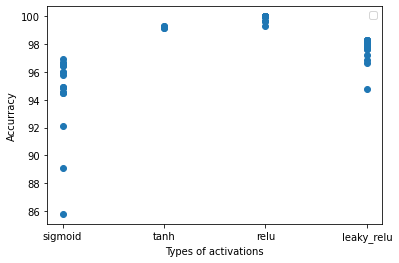

No handles with labels found to put in legend.


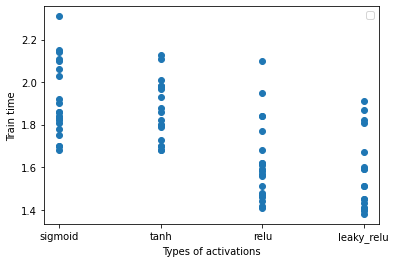

In [82]:
#Typs of activation functions
network_structure = [4, 20,20, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.001
epochs = 200

accurracy = []
train_time = []
types_activations = ["sigmoid","tanh","relu","leaky_relu"]

activations = []
for x in range(20):   
    for i in range(len(types_activations)):
        myANN = Neural_Network(network_structure, types_activations[i])
        acc,t_time = myANN.train(X, y, learning_rate, epochs)
        accurracy.append(round(acc,2))
        train_time.append(round(t_time,2))
        activations.append(types_activations[i])

plt.scatter(x=activations, y=accurracy) 
#plt.plot(types_activations, accurracy, 'g', label='Training accuracy')
#plt.plot(epochs, loss_val, 'b', label='validation accuracy')
#plt.title('Accuracy of of number of nodes of hidden layer')
plt.xlabel('Types of activations')
plt.ylabel('Accurracy')
plt.legend()
plt.show()

plt.scatter(x=activations, y=train_time) 
#plt.plot(types_activations, train_time, 'g', label='Training time')
#plt.title('Traning time of number of nodes of hidden layer')
plt.xlabel('Types of activations')
plt.ylabel('Train time')
plt.legend()
plt.show()

=========Network structure=============
layer 1 : 4 -> 100
layer 2 : 100 -> 100
layer 3 : 100 -> 100
layer 4 : 100 -> 100
layer 5 : 100 -> 100
layer 6 : 100 -> 100
layer 7 : 100 -> 100
layer 8 : 100 -> 100
layer 9 : 100 -> 100
layer 10 : 100 -> 100
layer 11 : 100 -> 2
stone: [[0.67008582 0.32471162]
 [0.67008582 0.3247116 ]
 [0.67008584 0.32471159]
 ...
 [0.67008582 0.32471161]
 [0.67008581 0.32471162]
 [0.67008583 0.32471159]]
Loss: 0.7224527723217935
stone: [[0.66938537 0.32543796]
 [0.66938537 0.32543795]
 [0.66938539 0.32543793]
 ...
 [0.66938537 0.32543795]
 [0.66938536 0.32543797]
 [0.66938539 0.32543794]]
Loss: 0.7220402120608281
stone: [[0.66868848 0.32616071]
 [0.66868849 0.32616069]
 [0.6686885  0.32616068]
 ...
 [0.66868848 0.3261607 ]
 [0.66868847 0.32616071]
 [0.6686885  0.32616068]]
Loss: 0.721632421216999
stone: [[0.66799515 0.32687986]
 [0.66799515 0.32687985]
 [0.66799516 0.32687983]
 ...
 [0.66799515 0.32687985]
 [0.66799514 0.32687986]
 [0.66799516 0.32687984]]
Loss:

stone: [[0.6436401  0.35219778]
 [0.6436401  0.35219776]
 [0.64364011 0.35219775]
 ...
 [0.6436401  0.35219776]
 [0.64364008 0.35219778]
 [0.64364011 0.35219775]]
Loss: 0.7086896132051411
stone: [[0.6430818  0.35277934]
 [0.64308181 0.35277933]
 [0.64308182 0.35277931]
 ...
 [0.64308181 0.35277933]
 [0.64308179 0.35277934]
 [0.64308182 0.35277931]]
Loss: 0.7084380221942729
stone: [[0.64252668 0.35335766]
 [0.64252668 0.35335765]
 [0.64252669 0.35335763]
 ...
 [0.64252668 0.35335765]
 [0.64252666 0.35335766]
 [0.64252669 0.35335763]]
Loss: 0.708189405927103
stone: [[0.6419747  0.35393275]
 [0.6419747  0.35393273]
 [0.64197471 0.35393272]
 ...
 [0.6419747  0.35393273]
 [0.64197468 0.35393275]
 [0.64197471 0.35393272]]
Loss: 0.7079437301766458
stone: [[0.64142585 0.35450462]
 [0.64142586 0.3545046 ]
 [0.64142587 0.35450459]
 ...
 [0.64142586 0.3545046 ]
 [0.64142584 0.35450462]
 [0.64142587 0.35450459]]
Loss: 0.7077009610725378
stone: [[0.64088014 0.35507327]
 [0.64088014 0.35507326]
 [0.

stone: [[0.62190343 0.37487579]
 [0.62190343 0.37487577]
 [0.62190345 0.37487576]
 ...
 [0.62190343 0.37487578]
 [0.62190342 0.37487579]
 [0.62190345 0.37487576]]
Loss: 0.7000258336914502
stone: [[0.62147252 0.37532605]
 [0.62147253 0.37532603]
 [0.62147254 0.37532602]
 ...
 [0.62147252 0.37532603]
 [0.62147251 0.37532605]
 [0.62147254 0.37532602]]
Loss: 0.6998771026686453
stone: [[0.62104422 0.3757736 ]
 [0.62104423 0.37577359]
 [0.62104424 0.37577357]
 ...
 [0.62104423 0.37577359]
 [0.62104421 0.3757736 ]
 [0.62104424 0.37577357]]
Loss: 0.6997301415307151
stone: [[0.62061852 0.37621847]
 [0.62061853 0.37621845]
 [0.62061854 0.37621844]
 ...
 [0.62061852 0.37621845]
 [0.62061851 0.37621847]
 [0.62061854 0.37621844]]
Loss: 0.6995849291781945
stone: [[0.6201954  0.37666066]
 [0.62019541 0.37666064]
 [0.62019542 0.37666063]
 ...
 [0.6201954  0.37666064]
 [0.62019539 0.37666066]
 [0.62019542 0.37666063]]
Loss: 0.699441444751859
stone: [[0.61977485 0.37710019]
 [0.61977486 0.37710017]
 [0.

stone: [[0.60524461 0.3922999 ]
 [0.60524461 0.39229988]
 [0.60524463 0.39229987]
 ...
 [0.60524461 0.39229988]
 [0.60524459 0.3922999 ]
 [0.60524462 0.39229987]]
Loss: 0.6949066648538135
stone: [[0.60491665 0.39264325]
 [0.60491666 0.39264324]
 [0.60491667 0.39264322]
 ...
 [0.60491666 0.39264324]
 [0.60491664 0.39264326]
 [0.60491667 0.39264322]]
Loss: 0.6948187228676059
stone: [[0.60459077 0.39298445]
 [0.60459078 0.39298444]
 [0.60459079 0.39298442]
 ...
 [0.60459077 0.39298444]
 [0.60459076 0.39298446]
 [0.60459079 0.39298443]]
Loss: 0.694731820133175
stone: [[0.60426694 0.39332351]
 [0.60426695 0.3933235 ]
 [0.60426696 0.39332348]
 ...
 [0.60426694 0.3933235 ]
 [0.60426693 0.39332352]
 [0.60426696 0.39332349]]
Loss: 0.694645944070335
stone: [[0.60394516 0.39366045]
 [0.60394516 0.39366043]
 [0.60394518 0.39366041]
 ...
 [0.60394516 0.39366043]
 [0.60394514 0.39366045]
 [0.60394517 0.39366042]]
Loss: 0.6945610822491064
stone: [[0.6036254  0.39399526]
 [0.60362541 0.39399524]
 [0.6

stone: [[0.59262296 0.40552267]
 [0.59262297 0.40552266]
 [0.59262298 0.40552264]
 ...
 [0.59262297 0.40552266]
 [0.59262295 0.40552267]
 [0.59262298 0.40552264]]
Loss: 0.6918724110799014
stone: [[0.59237559 0.40578198]
 [0.5923756  0.40578197]
 [0.59237561 0.40578195]
 ...
 [0.5923756  0.40578197]
 [0.59237558 0.40578199]
 [0.59237561 0.40578196]]
Loss: 0.6918200730131918
stone: [[0.59212982 0.40603963]
 [0.59212983 0.40603961]
 [0.59212984 0.4060396 ]
 ...
 [0.59212982 0.40603962]
 [0.59212981 0.40603963]
 [0.59212984 0.4060396 ]]
Loss: 0.6917683425541284
stone: [[0.59188564 0.40629561]
 [0.59188565 0.4062956 ]
 [0.59188566 0.40629558]
 ...
 [0.59188564 0.4062956 ]
 [0.59188563 0.40629562]
 [0.59188566 0.40629558]]
Loss: 0.6917172123389015
stone: [[0.59164304 0.40654995]
 [0.59164305 0.40654993]
 [0.59164306 0.40654991]
 ...
 [0.59164304 0.40654993]
 [0.59164303 0.40654995]
 [0.59164306 0.40654992]]
Loss: 0.6916666750937375
stone: [[0.59140201 0.40680264]
 [0.59140201 0.40680262]
 [0

stone: [[0.58313011 0.415478  ]
 [0.58313012 0.41547798]
 [0.58313013 0.41547797]
 ...
 [0.58313011 0.41547799]
 [0.5831301  0.415478  ]
 [0.58313013 0.41547797]]
Loss: 0.6900579443410214
stone: [[0.5829446  0.41567263]
 [0.5829446  0.41567262]
 [0.58294462 0.4156726 ]
 ...
 [0.5829446  0.41567262]
 [0.58294459 0.41567264]
 [0.58294462 0.4156726 ]]
Loss: 0.6900264338606013
stone: [[0.5827603  0.41586599]
 [0.58276031 0.41586597]
 [0.58276032 0.41586596]
 ...
 [0.58276031 0.41586597]
 [0.58276029 0.41586599]
 [0.58276032 0.41586596]]
Loss: 0.689995279448917
stone: [[0.58257722 0.41605808]
 [0.58257722 0.41605806]
 [0.58257724 0.41605805]
 ...
 [0.58257722 0.41605806]
 [0.58257721 0.41605808]
 [0.58257724 0.41605805]]
Loss: 0.6899644768321719
stone: [[0.58239534 0.41624891]
 [0.58239534 0.41624889]
 [0.58239536 0.41624887]
 ...
 [0.58239534 0.41624889]
 [0.58239532 0.41624891]
 [0.58239536 0.41624888]]
Loss: 0.6899340217892543
stone: [[0.58221465 0.41643848]
 [0.58221466 0.41643847]
 [0.

stone: [[0.57602436 0.42293502]
 [0.57602437 0.42293501]
 [0.57602439 0.42293499]
 ...
 [0.57602437 0.42293501]
 [0.57602435 0.42293503]
 [0.57602438 0.422935  ]]
Loss: 0.6889582234315083
stone: [[0.57588576 0.42308052]
 [0.57588577 0.4230805 ]
 [0.57588578 0.42308049]
 ...
 [0.57588576 0.4230805 ]
 [0.57588575 0.42308052]
 [0.57588578 0.42308049]]
Loss: 0.6889389547426068
stone: [[0.57574808 0.42322505]
 [0.57574809 0.42322503]
 [0.5757481  0.42322502]
 ...
 [0.57574808 0.42322503]
 [0.57574807 0.42322505]
 [0.5757481  0.42322502]]
Loss: 0.68891989630701
stone: [[0.57561131 0.42336862]
 [0.57561132 0.4233686 ]
 [0.57561133 0.42336859]
 ...
 [0.57561131 0.42336861]
 [0.5756113  0.42336862]
 [0.57561133 0.42336859]]
Loss: 0.6889010456481418
stone: [[0.57547545 0.42351124]
 [0.57547546 0.42351122]
 [0.57547547 0.42351121]
 ...
 [0.57547545 0.42351123]
 [0.57547544 0.42351124]
 [0.57547547 0.42351121]]
Loss: 0.6888824003198858
stone: [[0.57534049 0.42365291]
 [0.5753405  0.4236529 ]
 [0.5

stone: [[0.57061879 0.42861044]
 [0.5706188  0.42861042]
 [0.57061881 0.42861041]
 ...
 [0.57061879 0.42861043]
 [0.57061878 0.42861044]
 [0.57061881 0.42861041]]
Loss: 0.688268250600696
stone: [[0.57051619 0.42871819]
 [0.57051619 0.42871817]
 [0.57051621 0.42871815]
 ...
 [0.57051619 0.42871817]
 [0.57051617 0.42871819]
 [0.57051621 0.42871816]]
Loss: 0.6882563724259942
stone: [[0.57041427 0.42882521]
 [0.57041427 0.4288252 ]
 [0.57041429 0.42882518]
 ...
 [0.57041427 0.4288252 ]
 [0.57041425 0.42882522]
 [0.57041429 0.42882519]]
Loss: 0.6882446184586754
stone: [[0.57031303 0.42893153]
 [0.57031304 0.42893151]
 [0.57031305 0.42893149]
 ...
 [0.57031303 0.42893151]
 [0.57031302 0.42893153]
 [0.57031305 0.4289315 ]]
Loss: 0.6882329872756949
stone: [[0.57021247 0.42903713]
 [0.57021248 0.42903711]
 [0.57021249 0.4290371 ]
 ...
 [0.57021247 0.42903712]
 [0.57021246 0.42903713]
 [0.57021249 0.4290371 ]]
Loss: 0.688221477471307
stone: [[0.57011258 0.42914203]
 [0.57011259 0.42914201]
 [0.5

Loss: 0.6878463955750391
stone: [[0.56662065 0.4328095 ]
 [0.56662065 0.43280949]
 [0.56662067 0.43280947]
 ...
 [0.56662065 0.43280949]
 [0.56662063 0.43280951]
 [0.56662066 0.43280947]]
Loss: 0.6878388387826386
stone: [[0.56654482 0.43288915]
 [0.56654483 0.43288913]
 [0.56654484 0.43288911]
 ...
 [0.56654483 0.43288913]
 [0.56654481 0.43288915]
 [0.56654484 0.43288912]]
Loss: 0.6878313574174546
stone: [[0.56646951 0.43296825]
 [0.56646952 0.43296824]
 [0.56646953 0.43296822]
 ...
 [0.56646951 0.43296824]
 [0.5664695  0.43296826]
 [0.56646953 0.43296823]]
Loss: 0.687823950644712
stone: [[0.5663947  0.43304683]
 [0.56639471 0.43304682]
 [0.56639472 0.4330468 ]
 ...
 [0.5663947  0.43304682]
 [0.56639469 0.43304684]
 [0.56639472 0.4330468 ]]
Loss: 0.6878166176395947
stone: [[0.5663204  0.43312488]
 [0.5663204  0.43312487]
 [0.56632042 0.43312485]
 ...
 [0.5663204  0.43312487]
 [0.56632038 0.43312489]
 [0.56632042 0.43312485]]
Loss: 0.687809357587115
stone: [[0.56624659 0.43320241]
 [0.5

stone: [[0.56366784 0.43591138]
 [0.56366785 0.43591136]
 [0.56366786 0.43591134]
 ...
 [0.56366784 0.43591136]
 [0.56366783 0.43591138]
 [0.56366786 0.43591135]]
Loss: 0.6875656465743115
stone: [[0.56361188 0.43597017]
 [0.56361188 0.43597016]
 [0.5636119  0.43597014]
 ...
 [0.56361188 0.43597016]
 [0.56361186 0.43597018]
 [0.5636119  0.43597014]]
Loss: 0.6875608282981919
stone: [[0.56355629 0.43602857]
 [0.5635563  0.43602856]
 [0.56355631 0.43602854]
 ...
 [0.56355629 0.43602856]
 [0.56355628 0.43602858]
 [0.56355631 0.43602854]]
Loss: 0.6875560557019486
stone: [[0.56350108 0.43608658]
 [0.56350108 0.43608656]
 [0.5635011  0.43608655]
 ...
 [0.56350108 0.43608656]
 [0.56350106 0.43608658]
 [0.5635011  0.43608655]]
Loss: 0.6875513283013316
stone: [[0.56344624 0.43614419]
 [0.56344624 0.43614418]
 [0.56344626 0.43614416]
 ...
 [0.56344624 0.43614418]
 [0.56344622 0.4361442 ]
 [0.56344626 0.43614416]]
Loss: 0.6875466456177114
stone: [[0.56339177 0.43620142]
 [0.56339177 0.43620141]
 [0

stone: [[0.56153083 0.43815663]
 [0.56153083 0.43815661]
 [0.56153085 0.43815659]
 ...
 [0.56153083 0.43815661]
 [0.56153081 0.43815663]
 [0.56153085 0.4381566 ]]
Loss: 0.6873911351705818
stone: [[0.56148928 0.43820029]
 [0.56148928 0.43820027]
 [0.5614893  0.43820025]
 ...
 [0.56148928 0.43820027]
 [0.56148926 0.43820029]
 [0.56148929 0.43820026]]
Loss: 0.6873879345738108
stone: [[0.561448   0.43824365]
 [0.56144801 0.43824364]
 [0.56144802 0.43824362]
 ...
 [0.561448   0.43824364]
 [0.56144799 0.43824366]
 [0.56144802 0.43824362]]
Loss: 0.6873847628547338
stone: [[0.56140701 0.43828673]
 [0.56140701 0.43828671]
 [0.56140703 0.43828669]
 ...
 [0.56140701 0.43828671]
 [0.56140699 0.43828673]
 [0.56140703 0.4382867 ]]
Loss: 0.6873816197210602
stone: [[0.56136629 0.43832951]
 [0.5613663  0.43832949]
 [0.56136631 0.43832948]
 ...
 [0.56136629 0.4383295 ]
 [0.56136628 0.43832952]
 [0.56136631 0.43832948]]
Loss: 0.6873785048837777
stone: [[0.56132585 0.438372  ]
 [0.56132585 0.43837199]
 [0

stone: [[0.55994453 0.43982345]
 [0.55994454 0.43982344]
 [0.55994455 0.43982342]
 ...
 [0.55994453 0.43982344]
 [0.55994452 0.43982346]
 [0.55994455 0.43982342]]
Loss: 0.6872741611657498
stone: [[0.5599137  0.43985585]
 [0.5599137  0.43985584]
 [0.55991372 0.43985582]
 ...
 [0.5599137  0.43985584]
 [0.55991368 0.43985586]
 [0.55991372 0.43985583]]
Loss: 0.687271993198672
stone: [[0.55988307 0.43988804]
 [0.55988307 0.43988802]
 [0.55988309 0.43988801]
 ...
 [0.55988307 0.43988803]
 [0.55988305 0.43988804]
 [0.55988309 0.43988801]]
Loss: 0.6872698438852416
stone: [[0.55985265 0.43992   ]
 [0.55985265 0.43991999]
 [0.55985267 0.43991997]
 ...
 [0.55985265 0.43991999]
 [0.55985263 0.43992001]
 [0.55985267 0.43991998]]
Loss: 0.687267713045737
stone: [[0.55982243 0.43995176]
 [0.55982244 0.43995174]
 [0.55982245 0.43995172]
 ...
 [0.55982243 0.43995174]
 [0.55982242 0.43995176]
 [0.55982245 0.43995173]]
Loss: 0.687265600502367
stone: [[0.55979242 0.43998329]
 [0.55979243 0.43998328]
 [0.55

stone: [[0.55874472 0.44108428]
 [0.55874473 0.44108426]
 [0.55874474 0.44108425]
 ...
 [0.55874473 0.44108426]
 [0.55874471 0.44108428]
 [0.55874474 0.44108425]]
Loss: 0.6871927820666384
stone: [[0.558722   0.44110815]
 [0.55872201 0.44110814]
 [0.55872202 0.44110812]
 ...
 [0.55872201 0.44110814]
 [0.55872199 0.44110816]
 [0.55872202 0.44110812]]
Loss: 0.687191299967514
stone: [[0.55869944 0.44113187]
 [0.55869944 0.44113185]
 [0.55869946 0.44113183]
 ...
 [0.55869944 0.44113185]
 [0.55869942 0.44113187]
 [0.55869946 0.44113184]]
Loss: 0.6871898300650862
stone: [[0.55867703 0.44115542]
 [0.55867703 0.44115541]
 [0.55867705 0.44115539]
 ...
 [0.55867703 0.44115541]
 [0.55867701 0.44115543]
 [0.55867705 0.44115539]]
Loss: 0.6871883722477075
stone: [[0.55865477 0.44117881]
 [0.55865477 0.4411788 ]
 [0.55865479 0.44117878]
 ...
 [0.55865477 0.4411788 ]
 [0.55865475 0.44117882]
 [0.55865478 0.44117879]]
Loss: 0.6871869264048832
stone: [[0.55863266 0.44120205]
 [0.55863266 0.44120203]
 [0.

stone: [[0.55787772 0.44199543]
 [0.55787773 0.44199542]
 [0.55787774 0.4419954 ]
 ...
 [0.55787772 0.44199542]
 [0.55787771 0.44199544]
 [0.55787774 0.4419954 ]]
Loss: 0.6871377717127202
stone: [[0.55786087 0.44201314]
 [0.55786088 0.44201312]
 [0.55786089 0.44201311]
 ...
 [0.55786087 0.44201313]
 [0.55786086 0.44201314]
 [0.55786089 0.44201311]]
Loss: 0.687136734229973
stone: [[0.55784414 0.44203072]
 [0.55784414 0.44203071]
 [0.55784416 0.44203069]
 ...
 [0.55784414 0.44203071]
 [0.55784412 0.44203073]
 [0.55784416 0.4420307 ]]
Loss: 0.6871357049634315
stone: [[0.55782752 0.44204819]
 [0.55782752 0.44204818]
 [0.55782754 0.44204816]
 ...
 [0.55782752 0.44204818]
 [0.5578275  0.4420482 ]
 [0.55782754 0.44204816]]
Loss: 0.6871346838414469
stone: [[0.55781101 0.44206554]
 [0.55781102 0.44206553]
 [0.55781103 0.44206551]
 ...
 [0.55781101 0.44206553]
 [0.557811   0.44206555]
 [0.55781103 0.44206551]]
Loss: 0.6871336707930717
stone: [[0.55779462 0.44208277]
 [0.55779462 0.44208276]
 [0.

stone: [[0.55723484 0.44267108]
 [0.55723485 0.44267107]
 [0.55723486 0.44267105]
 ...
 [0.55723484 0.44267107]
 [0.55723483 0.44267109]
 [0.55723486 0.44267105]]
Loss: 0.687099033501611
stone: [[0.55722235 0.44268421]
 [0.55722235 0.4426842 ]
 [0.55722237 0.44268418]
 ...
 [0.55722235 0.4426842 ]
 [0.55722234 0.44268422]
 [0.55722237 0.44268418]]
Loss: 0.6870982980852666
stone: [[0.55720994 0.44269725]
 [0.55720995 0.44269724]
 [0.55720996 0.44269722]
 ...
 [0.55720994 0.44269724]
 [0.55720993 0.44269726]
 [0.55720996 0.44269722]]
Loss: 0.6870975683053594
stone: [[0.55719762 0.4427102 ]
 [0.55719763 0.44271019]
 [0.55719764 0.44271017]
 ...
 [0.55719762 0.44271019]
 [0.55719761 0.44271021]
 [0.55719764 0.44271017]]
Loss: 0.6870968441149016
stone: [[0.55718538 0.44272306]
 [0.55718539 0.44272305]
 [0.5571854  0.44272303]
 ...
 [0.55718538 0.44272305]
 [0.55718537 0.44272307]
 [0.5571854  0.44272304]]
Loss: 0.6870961254673429
stone: [[0.55717323 0.44273584]
 [0.55717323 0.44273583]
 [0.

stone: [[0.55675823 0.44317201]
 [0.55675824 0.44317199]
 [0.55675825 0.44317198]
 ...
 [0.55675824 0.44317199]
 [0.55675822 0.44317201]
 [0.55675825 0.44317198]]
Loss: 0.6870714396479943
stone: [[0.55674897 0.44318174]
 [0.55674898 0.44318173]
 [0.55674899 0.44318171]
 ...
 [0.55674898 0.44318173]
 [0.55674896 0.44318175]
 [0.55674899 0.44318171]]
Loss: 0.6870709130044427
stone: [[0.55673978 0.44319141]
 [0.55673978 0.44319139]
 [0.5567398  0.44319137]
 ...
 [0.55673978 0.44319139]
 [0.55673976 0.44319141]
 [0.5567398  0.44319138]]
Loss: 0.6870703902892731
stone: [[0.55673064 0.44320101]
 [0.55673065 0.44320099]
 [0.55673066 0.44320098]
 ...
 [0.55673064 0.44320099]
 [0.55673063 0.44320101]
 [0.55673066 0.44320098]]
Loss: 0.687069871471025
stone: [[0.55672157 0.44321054]
 [0.55672157 0.44321053]
 [0.55672159 0.44321051]
 ...
 [0.55672157 0.44321053]
 [0.55672155 0.44321055]
 [0.55672159 0.44321051]]
Loss: 0.6870693565185179
stone: [[0.55671256 0.44322001]
 [0.55671256 0.44322   ]
 [0.

stone: [[0.55640494 0.44354334]
 [0.55640495 0.44354332]
 [0.55640496 0.44354331]
 ...
 [0.55640494 0.44354333]
 [0.55640493 0.44354334]
 [0.55640496 0.44354331]]
Loss: 0.6870516019130191
stone: [[0.55639808 0.44355055]
 [0.55639808 0.44355054]
 [0.5563981  0.44355052]
 ...
 [0.55639808 0.44355054]
 [0.55639806 0.44355056]
 [0.5563981  0.44355052]]
Loss: 0.6870512216993679
stone: [[0.55639126 0.44355772]
 [0.55639127 0.4435577 ]
 [0.55639128 0.44355769]
 ...
 [0.55639126 0.4435577 ]
 [0.55639125 0.44355772]
 [0.55639128 0.44355769]]
Loss: 0.6870508442603763
stone: [[0.55638449 0.44356483]
 [0.55638449 0.44356482]
 [0.55638451 0.4435648 ]
 ...
 [0.55638449 0.44356482]
 [0.55638447 0.44356484]
 [0.55638451 0.44356481]]
Loss: 0.687050469574577
stone: [[0.55637776 0.4435719 ]
 [0.55637777 0.44357189]
 [0.55637778 0.44357187]
 ...
 [0.55637777 0.44357189]
 [0.55637775 0.44357191]
 [0.55637778 0.44357187]]
Loss: 0.6870500976206836
stone: [[0.55637109 0.44357892]
 [0.55637109 0.44357891]
 [0.

stone: [[0.55614308 0.44381857]
 [0.55614309 0.44381856]
 [0.5561431  0.44381854]
 ...
 [0.55614308 0.44381856]
 [0.55614307 0.44381858]
 [0.5561431  0.44381855]]
Loss: 0.6870372359178374
stone: [[0.556138   0.44382392]
 [0.556138   0.44382391]
 [0.55613802 0.44382389]
 ...
 [0.556138   0.44382391]
 [0.55613798 0.44382393]
 [0.55613801 0.44382389]]
Loss: 0.6870369596696219
stone: [[0.55613294 0.44382923]
 [0.55613295 0.44382922]
 [0.55613296 0.4438292 ]
 ...
 [0.55613294 0.44382922]
 [0.55613293 0.44382924]
 [0.55613296 0.4438292 ]]
Loss: 0.687036685402673
stone: [[0.55612792 0.44383451]
 [0.55612793 0.44383449]
 [0.55612794 0.44383447]
 ...
 [0.55612793 0.44383449]
 [0.55612791 0.44383451]
 [0.55612794 0.44383448]]
Loss: 0.6870364131020981
stone: [[0.55612294 0.44383975]
 [0.55612295 0.44383973]
 [0.55612296 0.44383971]
 ...
 [0.55612294 0.44383973]
 [0.55612293 0.44383975]
 [0.55612296 0.44383972]]
Loss: 0.6870361427531249
stone: [[0.55611799 0.44384495]
 [0.55611799 0.44384493]
 [0.

stone: [[0.55594901 0.44402257]
 [0.55594901 0.44402255]
 [0.55594903 0.44402254]
 ...
 [0.55594901 0.44402256]
 [0.55594899 0.44402257]
 [0.55594903 0.44402254]]
Loss: 0.6870267733118086
stone: [[0.55594524 0.44402653]
 [0.55594524 0.44402652]
 [0.55594526 0.4440265 ]
 ...
 [0.55594524 0.44402652]
 [0.55594522 0.44402654]
 [0.55594526 0.4440265 ]]
Loss: 0.6870265716128678
stone: [[0.55594149 0.44403047]
 [0.5559415  0.44403045]
 [0.55594151 0.44403044]
 ...
 [0.55594149 0.44403045]
 [0.55594148 0.44403047]
 [0.55594151 0.44403044]]
Loss: 0.6870263713410718
stone: [[0.55593777 0.44403438]
 [0.55593778 0.44403436]
 [0.55593779 0.44403434]
 ...
 [0.55593778 0.44403436]
 [0.55593776 0.44403438]
 [0.55593779 0.44403435]]
Loss: 0.6870261724859439
stone: [[0.55593408 0.44403826]
 [0.55593408 0.44403824]
 [0.5559341  0.44403823]
 ...
 [0.55593408 0.44403825]
 [0.55593407 0.44403827]
 [0.5559341  0.44403823]]
Loss: 0.6870259750370843
stone: [[0.55593041 0.44404212]
 [0.55593042 0.4440421 ]
 [0

stone: [[0.55580238 0.44417669]
 [0.55580239 0.44417668]
 [0.5558024  0.44417666]
 ...
 [0.55580239 0.44417668]
 [0.55580237 0.4441767 ]
 [0.5558024  0.44417666]]
Loss: 0.6870189724315893
stone: [[0.55579961 0.44417961]
 [0.55579961 0.44417959]
 [0.55579963 0.44417957]
 ...
 [0.55579961 0.44417959]
 [0.55579959 0.44417961]
 [0.55579963 0.44417958]]
Loss: 0.6870188256450669
stone: [[0.55579685 0.4441825 ]
 [0.55579686 0.44418249]
 [0.55579687 0.44418247]
 ...
 [0.55579685 0.44418249]
 [0.55579684 0.44418251]
 [0.55579687 0.44418248]]
Loss: 0.6870186798861677
stone: [[0.55579412 0.44418538]
 [0.55579412 0.44418537]
 [0.55579414 0.44418535]
 ...
 [0.55579412 0.44418537]
 [0.5557941  0.44418539]
 [0.55579413 0.44418535]]
Loss: 0.6870185351474848
stone: [[0.5557914  0.44418824]
 [0.5557914  0.44418822]
 [0.55579142 0.44418821]
 ...
 [0.5557914  0.44418823]
 [0.55579138 0.44418825]
 [0.55579141 0.44418821]]
Loss: 0.6870183914216761
stone: [[0.5557887  0.44419108]
 [0.5557887  0.44419106]
 [0

stone: [[0.55569652 0.44428797]
 [0.55569652 0.44428796]
 [0.55569654 0.44428794]
 ...
 [0.55569652 0.44428796]
 [0.5556965  0.44428798]
 [0.55569654 0.44428794]]
Loss: 0.6870133950488377
stone: [[0.55569446 0.44429013]
 [0.55569447 0.44429012]
 [0.55569448 0.4442901 ]
 ...
 [0.55569446 0.44429012]
 [0.55569445 0.44429014]
 [0.55569448 0.4442901 ]]
Loss: 0.6870132871588294
stone: [[0.55569242 0.44429228]
 [0.55569242 0.44429226]
 [0.55569244 0.44429225]
 ...
 [0.55569242 0.44429227]
 [0.55569241 0.44429229]
 [0.55569244 0.44429225]]
Loss: 0.6870131800181896
stone: [[0.55569039 0.44429441]
 [0.5556904  0.4442944 ]
 [0.55569041 0.44429438]
 ...
 [0.55569039 0.4442944 ]
 [0.55569038 0.44429442]
 [0.55569041 0.44429438]]
Loss: 0.6870130736215977
stone: [[0.55568838 0.44429653]
 [0.55568838 0.44429652]
 [0.5556884  0.4442965 ]
 ...
 [0.55568838 0.44429652]
 [0.55568836 0.44429654]
 [0.55568839 0.4442965 ]]
Loss: 0.6870129679637724
stone: [[0.55568638 0.44429863]
 [0.55568638 0.44429862]
 [0

stone: [[0.55561807 0.44437044]
 [0.55561807 0.44437042]
 [0.55561809 0.44437041]
 ...
 [0.55561807 0.44437043]
 [0.55561805 0.44437044]
 [0.55561809 0.44437041]]
Loss: 0.6870092913416074
stone: [[0.55561654 0.44437204]
 [0.55561655 0.44437202]
 [0.55561656 0.44437201]
 ...
 [0.55561654 0.44437203]
 [0.55561653 0.44437205]
 [0.55561656 0.44437201]]
Loss: 0.6870092118717219
stone: [[0.55561503 0.44437363]
 [0.55561503 0.44437362]
 [0.55561505 0.4443736 ]
 ...
 [0.55561503 0.44437362]
 [0.55561501 0.44437364]
 [0.55561505 0.4443736 ]]
Loss: 0.6870091329505125
stone: [[0.55561353 0.44437521]
 [0.55561353 0.4443752 ]
 [0.55561355 0.44437518]
 ...
 [0.55561353 0.4443752 ]
 [0.55561351 0.44437522]
 [0.55561354 0.44437518]]
Loss: 0.687009054574126
stone: [[0.55561203 0.44437678]
 [0.55561204 0.44437677]
 [0.55561205 0.44437675]
 ...
 [0.55561203 0.44437677]
 [0.55561202 0.44437679]
 [0.55561205 0.44437675]]
Loss: 0.6870089767387411
stone: [[0.55561055 0.44437834]
 [0.55561056 0.44437832]
 [0.

stone: [[0.55555993 0.44443155]
 [0.55555994 0.44443154]
 [0.55555995 0.44443152]
 ...
 [0.55555993 0.44443154]
 [0.55555992 0.44443156]
 [0.55555995 0.44443152]]
Loss: 0.6870062662642351
stone: [[0.5555588  0.44443274]
 [0.55555881 0.44443272]
 [0.55555882 0.44443271]
 ...
 [0.5555588  0.44443272]
 [0.55555879 0.44443274]
 [0.55555882 0.44443271]]
Loss: 0.687006207634323
stone: [[0.55555768 0.44443392]
 [0.55555769 0.4444339 ]
 [0.5555577  0.44443388]
 ...
 [0.55555768 0.4444339 ]
 [0.55555767 0.44443392]
 [0.5555577  0.44443389]]
Loss: 0.6870061494073824
stone: [[0.55555657 0.44443509]
 [0.55555657 0.44443507]
 [0.55555659 0.44443506]
 ...
 [0.55555657 0.44443507]
 [0.55555655 0.44443509]
 [0.55555658 0.44443506]]
Loss: 0.6870060915806107
stone: [[0.55555546 0.44443625]
 [0.55555546 0.44443624]
 [0.55555548 0.44443622]
 ...
 [0.55555546 0.44443624]
 [0.55555545 0.44443626]
 [0.55555548 0.44443622]]
Loss: 0.6870060341512185
stone: [[0.55555436 0.44443741]
 [0.55555437 0.44443739]
 [0.

stone: [[ 0.02375683  0.02238655]
 [ 0.09335328  0.06214498]
 [-0.0938977  -0.07966475]
 ...
 [ 0.09723797  0.06174655]
 [ 0.12889953  0.09949462]
 [-0.09444168 -0.06686925]]
Loss: 7.206998519935192
stone: [[ 0.02540604  0.02418745]
 [ 0.0950151   0.06303541]
 [-0.0922834  -0.07731511]
 ...
 [ 0.09912469  0.06274334]
 [ 0.13224945  0.10086224]
 [-0.093145   -0.064724  ]]
Loss: 6.989982196958143
stone: [[ 0.02704567  0.02597911]
 [ 0.09667182  0.06392086]
 [-0.09067656 -0.07497325]
 ...
 [ 0.1010053   0.06373398]
 [ 0.13558667  0.10221741]
 [-0.09185555 -0.06258553]]
Loss: 6.778076419477899
stone: [[ 0.02867579  0.02776162]
 [ 0.09832348  0.06480138]
 [-0.08907707 -0.07263909]
 ...
 [ 0.10287986  0.0647185 ]
 [ 0.13891129  0.10356025]
 [-0.09057326 -0.06045377]]
Loss: 6.5721853866760025
stone: [[ 0.0302965   0.02953505]
 [ 0.09997011  0.06567699]
 [-0.08748484 -0.07031256]
 ...
 [ 0.1047484   0.06569696]
 [ 0.14222343  0.10489087]
 [-0.08929806 -0.05832867]]
Loss: 6.372928291796011
ston

stone: [[ 0.08553196  0.0909253 ]
 [ 0.15907199  0.09555245]
 [-0.03164437  0.01302919]
 ...
 [ 0.17170351  0.09872884]
 [ 0.25968737  0.14730334]
 [-0.04554853  0.01804771]]
Loss: 2.3243050303054504
stone: [[ 0.0868316   0.0923996 ]
 [ 0.16054162  0.09625461]
 [-0.03028285  0.01510221]
 ...
 [ 0.17336759  0.09949647]
 [ 0.26257489  0.14822395]
 [-0.04450983  0.01995505]]
Loss: 2.261615949481742
stone: [[ 0.08812388  0.09386741]
 [ 0.1620071   0.09695268]
 [-0.02892628  0.01716963]
 ...
 [ 0.175027    0.10025921]
 [ 0.26545265  0.1491353 ]
 [-0.04347647  0.0218577 ]]
Loss: 2.229602262909283
stone: [[ 0.08940882  0.09532878]
 [ 0.16346845  0.0976467 ]
 [-0.02757464  0.0192315 ]
 ...
 [ 0.17668177  0.10101709]
 [ 0.26832067  0.15003746]
 [-0.04244842  0.02375569]]
Loss: 2.194743197511413
stone: [[ 0.09068647  0.09678377]
 [ 0.16492567  0.09833667]
 [-0.0262279   0.02128785]
 ...
 [ 0.17833193  0.10177011]
 [ 0.27117899  0.15093045]
 [-0.04142565  0.02564906]]
Loss: 2.167619293326376
ston

stone: [[ 0.13406961  0.14779092]
 [ 0.21737355  0.12169098]
 [ 0.02153371  0.09564323]
 ...
 [ 0.23779615  0.12696386]
 [ 0.37288726  0.17844083]
 [-0.00630808  0.09448835]]
Loss: 1.6034303522978304
stone: [[ 0.13508028  0.14903147]
 [ 0.21867974  0.12223335]
 [ 0.02270441  0.09750727]
 ...
 [ 0.23927969  0.1275408 ]
 [ 0.37538763  0.17900367]
 [-0.00547961  0.09622551]]
Loss: 1.5935385666071729
stone: [[ 0.13608445  0.15026732]
 [ 0.21998228  0.12277216]
 [ 0.02387079  0.09936687]
 ...
 [ 0.24075923  0.12811351]
 [ 0.37787918  0.17955859]
 [-0.00465597  0.09795919]]
Loss: 1.583786632443713
stone: [[ 0.1370821   0.15149851]
 [ 0.22128116  0.12330743]
 [ 0.02503286  0.10122204]
 ...
 [ 0.2422348   0.12868199]
 [ 0.38036195  0.1801056 ]
 [-0.00383715  0.09968942]]
Loss: 1.5741707142539643
stone: [[ 0.13807327  0.15272508]
 [ 0.22257641  0.12383917]
 [ 0.02619062  0.10307282]
 ...
 [ 0.24370639  0.12924627]
 [ 0.38283593  0.18064472]
 [-0.00302314  0.10141622]]
Loss: 1.5646871483064495
s

stone: [[0.17323289 0.1994634 ]
 [0.27266267 0.14272237]
 [0.06991259 0.17538842]
 ...
 [0.30075236 0.14890228]
 [0.4768634  0.19618635]
 [0.02618711 0.16950982]]
Loss: 1.2592742193801232
stone: [[0.173959   0.20052677]
 [0.27381336 0.14311473]
 [0.07088591 0.17707021]
 ...
 [0.30206644 0.14930016]
 [0.47897984 0.1964103 ]
 [0.02679686 0.17111022]]
Loss: 1.25334487816168
stone: [[0.17467893 0.20158695]
 [0.27496079 0.14350398]
 [0.07185467 0.17874831]
 ...
 [0.30337698 0.14969431]
 [0.48108805 0.19662707]
 [0.02740164 0.17270798]]
Loss: 1.2474706003856868
stone: [[0.1753927  0.20264398]
 [0.27610499 0.14389013]
 [0.07281889 0.18042273]
 ...
 [0.30468398 0.15008474]
 [0.48318802 0.19683669]
 [0.02800145 0.17430313]]
Loss: 1.2416505157283964
stone: [[0.17610029 0.20369788]
 [0.27724596 0.14427319]
 [0.07377853 0.1820935 ]
 ...
 [0.30598745 0.15047146]
 [0.48527978 0.19703917]
 [0.02859627 0.17589567]]
Loss: 1.2358837748077605
stone: [[0.17680172 0.20474868]
 [0.2783837  0.14465318]
 [0.0

stone: [[0.19984936 0.24458976]
 [0.3213545  0.15744336]
 [0.10906845 0.24761512]
 ...
 [0.35650409 0.16326905]
 [0.56416403 0.19937307]
 [0.04860407 0.23912488]]
Loss: 1.0370649443387678
stone: [[0.20030126 0.24553947]
 [0.32236792 0.15770585]
 [0.10982736 0.24914453]
 ...
 [0.35766757 0.16350995]
 [0.56592546 0.19928895]
 [0.04898315 0.24062072]]
Loss: 1.0329711847890481
stone: [[0.20074714 0.24648731]
 [0.3233785  0.1579657 ]
 [0.1105813  0.25067086]
 ...
 [0.35882791 0.16374762]
 [0.56767942 0.19919834]
 [0.04935696 0.24211452]]
Loss: 1.0289071847598992
stone: [[0.20118701 0.24743333]
 [0.32438624 0.15822291]
 [0.11133026 0.25219411]
 ...
 [0.35998511 0.16398208]
 [0.56942592 0.19910126]
 [0.04972549 0.24360631]]
Loss: 1.024872592113054
stone: [[0.20162085 0.24837755]
 [0.32539117 0.1584775 ]
 [0.11207423 0.2537143 ]
 ...
 [0.3611392  0.16421333]
 [0.571165   0.19899772]
 [0.05008874 0.24509609]]
Loss: 1.0208670605264725
stone: [[0.20204869 0.24932   ]
 [0.32639328 0.15872948]
 [0.

stone: [[0.2142581  0.28587765]
 [0.36427487 0.16680107]
 [0.13821874 0.31355731]
 ...
 [0.40587917 0.17109198]
 [0.63633591 0.18941588]
 [0.06039144 0.30457628]]
Loss: 0.8780402436745455
stone: [[0.21444139 0.28677068]
 [0.36516935 0.16695615]
 [0.13874931 0.31495979]
 ...
 [0.40691013 0.17120026]
 [0.63778271 0.18905791]
 [0.06053043 0.30599072]]
Loss: 0.8750034914473502
stone: [[0.21461876 0.28766305]
 [0.36606138 0.16710913]
 [0.13927479 0.3163597 ]
 ...
 [0.40793835 0.1713059 ]
 [0.63922304 0.18869433]
 [0.06066409 0.30740355]]
Loss: 0.8719849644335381
stone: [[0.21479021 0.28855478]
 [0.36695097 0.16726001]
 [0.13979517 0.31775707]
 ...
 [0.40896382 0.17140893]
 [0.64065693 0.18832516]
 [0.06079243 0.30881478]]
Loss: 0.8689844804048243
stone: [[0.21495575 0.2894459 ]
 [0.36783814 0.16740883]
 [0.14031045 0.31915189]
 ...
 [0.40998656 0.17150935]
 [0.64208441 0.18795043]
 [0.06091544 0.3102244 ]]
Loss: 0.8660018594901738
stone: [[0.21511538 0.29033644]
 [0.36872288 0.16755558]
 [0

stone: [[0.21667918 0.32574071]
 [0.40221072 0.17189474]
 [0.15712974 0.37426451]
 ...
 [0.44965853 0.17357571]
 [0.69538309 0.16810141]
 [0.06146106 0.36670151]]
Loss: 0.7571529883619791
stone: [[0.21659846 0.32662662]
 [0.40300229 0.17196911]
 [0.15743774 0.37556054]
 ...
 [0.45057309 0.173581  ]
 [0.69656272 0.16751598]
 [0.0613676  0.3680479 ]]
Loss: 0.7547844772112295
stone: [[0.21651195 0.32751286]
 [0.40379172 0.17204204]
 [0.15774106 0.37685437]
 ...
 [0.45148522 0.17358438]
 [0.69773695 0.16692615]
 [0.06126923 0.36939283]]
Loss: 0.7524278755877734
stone: [[0.21641963 0.32839943]
 [0.40457901 0.17211352]
 [0.1580397  0.37814601]
 ...
 [0.45239492 0.17358587]
 [0.69890582 0.16633194]
 [0.06116598 0.37073631]]
Loss: 0.7500830782700275
stone: [[0.21632151 0.32928637]
 [0.40536417 0.17218359]
 [0.15833369 0.37943546]
 ...
 [0.45330219 0.1735855 ]
 [0.70006934 0.16573337]
 [0.06105785 0.37207834]]
Loss: 0.7477499812545471
stone: [[0.2162176  0.33017368]
 [0.40614721 0.17225226]
 [0

stone: [[0.20735875 0.3661589 ]
 [0.43577378 0.17403572]
 [0.16660896 0.43047185]
 ...
 [0.48847329 0.17219272]
 [0.7434465  0.13784682]
 [0.05266168 0.42582884]]
Loss: 0.6610319111757132
stone: [[0.20702123 0.36707481]
 [0.43647306 0.1740611 ]
 [0.16672507 0.43167279]
 ...
 [0.48928293 0.17213098]
 [0.74440546 0.1370953 ]
 [0.05236666 0.42710783]]
Loss: 0.6591104298680691
stone: [[0.20667813 0.36799167]
 [0.43717035 0.17408577]
 [0.16683744 0.43287166]
 ...
 [0.49009032 0.1720682 ]
 [0.74536    0.13634088]
 [0.05206769 0.42838524]]
Loss: 0.6571971435948942
stone: [[0.20632947 0.3689095 ]
 [0.43786567 0.17410978]
 [0.16694609 0.43406846]
 ...
 [0.49089548 0.17200441]
 [0.74631015 0.13558361]
 [0.05176479 0.42966105]]
Loss: 0.6552919897057478
stone: [[0.20597526 0.3698283 ]
 [0.43855901 0.17413312]
 [0.16705106 0.43526319]
 ...
 [0.49169839 0.17193962]
 [0.74725592 0.13482352]
 [0.05145799 0.43093525]]
Loss: 0.6533949062686042
stone: [[0.20561549 0.37074807]
 [0.43925037 0.17415583]
 [0

stone: [[0.18679068 0.40840668]
 [0.46529422 0.17474827]
 [0.16852106 0.48245245]
 ...
 [0.52271601 0.16868426]
 [0.78249969 0.10169388]
 [0.03586616 0.48171023]]
Loss: 0.581887359181926
stone: [[0.18621264 0.40937062]
 [0.46590513 0.17476046]
 [0.16849655 0.48355903]
 ...
 [0.52342664 0.16859659]
 [0.7832786  0.10084925]
 [0.03542129 0.48291046]]
Loss: 0.5802817435000607
stone: [[0.18562955 0.41033566]
 [0.46651407 0.17477277]
 [0.1684696  0.48466345]
 ...
 [0.5241351  0.16850884]
 [0.78405391 0.10000342]
 [0.03497378 0.48410874]]
Loss: 0.5786821141960898
stone: [[0.18504145 0.41130179]
 [0.46712104 0.17478524]
 [0.16844023 0.48576572]
 ...
 [0.52484139 0.16842102]
 [0.78482564 0.09915643]
 [0.03452367 0.48530507]]
Loss: 0.5770884341887557
stone: [[0.18444833 0.412269  ]
 [0.46772605 0.17479787]
 [0.16840848 0.48686583]
 ...
 [0.52554551 0.16833316]
 [0.78559382 0.09830831]
 [0.03407099 0.48649945]]
Loss: 0.57550066682983
stone: [[0.18385022 0.4132373 ]
 [0.46832908 0.17481068]
 [0.16

stone: [[0.15683952 0.45177936]
 [0.49029817 0.17564733]
 [0.16553563 0.52905699]
 ...
 [0.55193909 0.16501677]
 [0.81357854 0.0638851 ]
 [0.01421972 0.53256503]]
Loss: 0.5164658648629534
stone: [[0.15605852 0.45278513]
 [0.49082131 0.17568224]
 [0.1654324  0.53006538]
 ...
 [0.55255476 0.1649446 ]
 [0.81421386 0.06302233]
 [0.0136889  0.53367144]]
Loss: 0.515093664192274
stone: [[0.15527343 0.45379162]
 [0.49134243 0.17571806]
 [0.16532805 0.53107145]
 ...
 [0.55316828 0.16487324]
 [0.81484624 0.06215992]
 [0.01315683 0.53477553]]
Loss: 0.5137261664991867
stone: [[0.15448429 0.45479882]
 [0.49186151 0.1757548 ]
 [0.16522261 0.53207521]
 ...
 [0.55377965 0.16480269]
 [0.81547569 0.06129793]
 [0.01262354 0.53587728]]
Loss: 0.5123633494979484
stone: [[0.15369112 0.4558067 ]
 [0.49237855 0.17579248]
 [0.1651161  0.53307666]
 ...
 [0.55438888 0.16473297]
 [0.81610223 0.06043638]
 [0.01208905 0.5369767 ]]
Loss: 0.5110051911497807
stone: [[0.15289395 0.45681527]
 [0.49289356 0.17583112]
 [0.

stone: [[ 0.12086046  0.49446466]
 [ 0.51049971  0.17807319]
 [ 0.16054623  0.56938527]
 ...
 [ 0.57595167  0.16287483]
 [ 0.83787856  0.02832654]
 [-0.00881751  0.57695668]]
Loss: 0.46265173097539497
stone: [[ 0.119934    0.49548694]
 [ 0.51093598  0.17815931]
 [ 0.16041875  0.57029425]
 ...
 [ 0.57647752  0.16285099]
 [ 0.83840131  0.0275055 ]
 [-0.00937625  0.57795998]]
Loss: 0.4614603426608386
stone: [[ 0.11900479  0.49650923]
 [ 0.51137015  0.17824695]
 [ 0.16029121  0.57120082]
 ...
 [ 0.57700124  0.16282864]
 [ 0.83892163  0.02668605]
 [-0.00993509  0.57896072]]
Loss: 0.4602728978004604
stone: [[ 0.11807286  0.49753151]
 [ 0.51180222  0.17833611]
 [ 0.16016363  0.57210499]
 ...
 [ 0.57752285  0.16280779]
 [ 0.83943954  0.0258682 ]
 [-0.010494    0.57995889]]
Loss: 0.45908938186168086
stone: [[ 0.11713824  0.49855376]
 [ 0.51223218  0.17842682]
 [ 0.16003604  0.57300675]
 ...
 [ 0.57804233  0.16278845]
 [ 0.83995504  0.02505197]
 [-0.01105296  0.58095448]]
Loss: 0.457909780440007

stone: [[ 0.07999646  0.53718373]
 [ 0.52700434  0.18312225]
 [ 0.15536072  0.60549182]
 ...
 [ 0.59622921  0.1632935 ]
 [ 0.85786862 -0.00455325]
 [-0.03211585  0.61685826]]
Loss: 0.41585449892764365
stone: [[ 0.07898593  0.53818952]
 [ 0.52735177  0.18328112]
 [ 0.15524656  0.60630005]
 ...
 [ 0.59666744  0.16334214]
 [ 0.85829858 -0.00529042]
 [-0.03266038  0.61775203]]
Loss: 0.4148174688232803
stone: [[ 0.07797421  0.5391945 ]
 [ 0.52769708  0.1834419 ]
 [ 0.15513305  0.60710591]
 ...
 [ 0.59710363  0.16339272]
 [ 0.85872654 -0.00602524]
 [-0.03320418  0.61864319]]
Loss: 0.41378385966797554
stone: [[ 0.07696133  0.54019864]
 [ 0.52804027  0.18360461]
 [ 0.15502019  0.60790941]
 ...
 [ 0.59753778  0.16344523]
 [ 0.85915251 -0.00675769]
 [-0.03374724  0.61953172]]
Loss: 0.4127536607051119
stone: [[ 0.07594732  0.54120194]
 [ 0.52838135  0.18376925]
 [ 0.154908    0.60871054]
 ...
 [ 0.59796991  0.16349969]
 [ 0.85957651 -0.00748775]
 [-0.03428953  0.62041764]]
Loss: 0.411726861235333

stone: [[ 0.03694702  0.5785221 ]
 [ 0.53978492  0.19150539]
 [ 0.15123659  0.63743511]
 ...
 [ 0.61291475  0.16706653]
 [ 0.87431113 -0.03336025]
 [-0.054204    0.65216446]]
Loss: 0.37512669455257797
stone: [[ 0.03591764  0.5794787 ]
 [ 0.54004444  0.19174886]
 [ 0.15115751  0.63814682]
 ...
 [ 0.61327011  0.16720085]
 [ 0.87466486 -0.03398982]
 [-0.054707    0.65295021]]
Loss: 0.3742246248153086
stone: [[ 0.03488857  0.5804338 ]
 [ 0.54030191  0.1919944 ]
 [ 0.15107941  0.63885633]
 ...
 [ 0.61362357  0.16733728]
 [ 0.87501696 -0.03461668]
 [-0.0552088   0.65373346]]
Loss: 0.3733255621767505
stone: [[ 0.03385983  0.58138737]
 [ 0.54055733  0.19224202]
 [ 0.15100228  0.63956364]
 ...
 [ 0.61397515  0.16747582]
 [ 0.87536743 -0.03524083]
 [-0.0557094   0.65451422]]
Loss: 0.37242949748815446
stone: [[ 0.03283145  0.5823394 ]
 [ 0.5408107   0.19249171]
 [ 0.15092613  0.64026875]
 ...
 [ 0.61432483  0.16761647]
 [ 0.87571628 -0.03586227]
 [-0.05620878  0.6552925 ]]
Loss: 0.371536421624350

stone: [[-0.00567826  0.61725811]
 [ 0.54895121  0.20351443]
 [ 0.14877812  0.66548978]
 ...
 [ 0.62625968  0.17452225]
 [ 0.88784619 -0.05745237]
 [-0.07423353  0.68307487]]
Loss: 0.3397261603638168
stone: [[-0.00666947  0.61814122]
 [ 0.54912717  0.20384446]
 [ 0.14874133  0.6661136 ]
 ...
 [ 0.62653936  0.17474467]
 [ 0.88813762 -0.05796734]
 [-0.07468183  0.68376031]]
Loss: 0.3389427408987791
stone: [[-0.00765921  0.61902238]
 [ 0.54930123  0.2041765 ]
 [ 0.14870554  0.66673545]
 ...
 [ 0.62681734  0.17496914]
 [ 0.88842772 -0.05847961]
 [-0.07512876  0.68444349]]
Loss: 0.3381619605949255
stone: [[-0.00864745  0.61990159]
 [ 0.54947338  0.20451055]
 [ 0.14867076  0.66735535]
 ...
 [ 0.62709362  0.17519566]
 [ 0.88871649 -0.05898918]
 [-0.07557432  0.68512442]]
Loss: 0.33738381102582393
stone: [[-0.00963417  0.62077882]
 [ 0.54964362  0.2048466 ]
 [ 0.14863697  0.66797329]
 ...
 [ 0.62736822  0.17542422]
 [ 0.88900395 -0.05949606]
 [-0.07601852  0.6858031 ]]
Loss: 0.3366082837783882

stone: [[-0.04580612  0.65260548]
 [ 0.55474711  0.21905679]
 [ 0.14806141  0.69007054]
 ...
 [ 0.63660287  0.18557839]
 [ 0.89901081 -0.07680814]
 [-0.09188251  0.7099936 ]]
Loss: 0.3089995879689993
stone: [[-0.04671873  0.65340235]
 [ 0.5548467   0.21946724]
 [ 0.14806392  0.69061727]
 ...
 [ 0.63681568  0.18588285]
 [ 0.89925158 -0.07721393]
 [-0.09227348  0.71058987]]
Loss: 0.30831990798396364
stone: [[-0.04762913  0.6541971 ]
 [ 0.55494457  0.21987947]
 [ 0.14806728  0.69116229]
 ...
 [ 0.63702701  0.18618915]
 [ 0.89949128 -0.07761726]
 [-0.09266311  0.71118417]]
Loss: 0.3076425245041741
stone: [[-0.04853732  0.65498972]
 [ 0.55504073  0.22029348]
 [ 0.14807149  0.69170562]
 ...
 [ 0.63723687  0.18649728]
 [ 0.89972989 -0.07801814]
 [-0.09305141  0.7117765 ]]
Loss: 0.30696742965810514
stone: [[-0.04944327  0.65578023]
 [ 0.55513519  0.22070927]
 [ 0.14807653  0.69224726]
 ...
 [ 0.63744526  0.18680721]
 [ 0.89996744 -0.07841657]
 [-0.09343837  0.71236687]]
Loss: 0.306294615588334

stone: [[-0.08212386  0.68425024]
 [ 0.55751401  0.23775492]
 [ 0.1488362   0.71164072]
 ...
 [ 0.64432959  0.19986104]
 [ 0.90825168 -0.09182273]
 [-0.10718291  0.73341496]]
Loss: 0.282341600796305
stone: [[-0.0829361   0.68495846]
 [ 0.55754615  0.23823431]
 [ 0.14886972  0.71212135]
 ...
 [ 0.64448491  0.20023622]
 [ 0.90845142 -0.09213211]
 [-0.10752017  0.73393415]]
Loss: 0.2817517675610092
stone: [[-0.08374582  0.68566459]
 [ 0.55757679  0.23871518]
 [ 0.14890386  0.71260053]
 ...
 [ 0.64463898  0.20061292]
 [ 0.90865029 -0.09243938]
 [-0.10785623  0.73445164]]
Loss: 0.2811639133050485
stone: [[-0.08455302  0.68636866]
 [ 0.55760596  0.23919751]
 [ 0.14893862  0.71307827]
 ...
 [ 0.6447918   0.20099113]
 [ 0.90884828 -0.09274456]
 [-0.10819109  0.73496745]]
Loss: 0.28057803082026034
stone: [[-0.0853577   0.68707066]
 [ 0.55763364  0.2396813 ]
 [ 0.14897398  0.71355458]
 ...
 [ 0.64494337  0.20137085]
 [ 0.90904541 -0.09304765]
 [-0.10852474  0.73548159]]
Loss: 0.2799941129160664


stone: [[-0.11405556  0.71224808]
 [ 0.55764394  0.25906655]
 [ 0.15071273  0.7306448 ]
 ...
 [ 0.64983072  0.21683729]
 [ 0.91593571 -0.10310752]
 [-0.12035404  0.75383741]]
Loss: 0.2591917850184822
stone: [[-0.11476139  0.71287226]
 [ 0.55761822  0.25960089]
 [ 0.15076745  0.73106934]
 ...
 [ 0.64993766  0.21726953]
 [ 0.91610226 -0.10333629]
 [-0.12064401  0.75429096]]
Loss: 0.25867907233963044
stone: [[-0.11546471  0.71349454]
 [ 0.55759124  0.26013637]
 [ 0.15082257  0.73149266]
 ...
 [ 0.65004356  0.21770295]
 [ 0.9162681  -0.10356335]
 [-0.12093295  0.75474308]]
Loss: 0.2581680518100725
stone: [[-0.11616553  0.71411491]
 [ 0.557563    0.26067297]
 [ 0.15087806  0.73191476]
 ...
 [ 0.65014842  0.21813756]
 [ 0.91643324 -0.10378869]
 [-0.12122084  0.75519377]]
Loss: 0.25765871701480786
stone: [[-0.11686384  0.71473338]
 [ 0.55753352  0.26121069]
 [ 0.15093394  0.73233564]
 ...
 [ 0.65025224  0.21857334]
 [ 0.91659768 -0.10401233]
 [-0.1215077   0.75564304]]
Loss: 0.257151061558747

stone: [[-0.14097825  0.73632819]
 [ 0.55561216  0.28181664]
 [ 0.15322222  0.74709607]
 ...
 [ 0.65340578  0.23545091]
 [ 0.92222013 -0.11117006]
 [-0.13143213  0.77131626]]
Loss: 0.23949177728183899
stone: [[-0.1415846   0.7368783 ]
 [ 0.55553908  0.2823908 ]
 [ 0.15328887  0.74747414]
 ...
 [ 0.65347351  0.23592557]
 [ 0.92236039 -0.11133545]
 [-0.13168268  0.77171549]]
Loss: 0.23904339683324716
stone: [[-0.14218863  0.73742672]
 [ 0.55546494  0.28296577]
 [ 0.15335572  0.74785116]
 ...
 [ 0.65354038  0.23640111]
 [ 0.92250008 -0.11149948]
 [-0.13193235  0.7721135 ]]
Loss: 0.23859646204735466
stone: [[-0.14279035  0.73797344]
 [ 0.55538977  0.28354154]
 [ 0.15342276  0.74822714]
 ...
 [ 0.65360639  0.23687752]
 [ 0.92263919 -0.11166215]
 [-0.13218114  0.7725103 ]]
Loss: 0.2381509673377524
stone: [[-0.14338976  0.73851848]
 [ 0.55531355  0.2841181 ]
 [ 0.15348999  0.74860209]
 ...
 [ 0.65367154  0.2373548 ]
 [ 0.92277774 -0.11182346]
 [-0.13242906  0.7729059 ]]
Loss: 0.23770690713824

stone: [[-0.16452253  0.7580351 ]
 [ 0.55169691  0.30654166]
 [ 0.1561443   0.76212052]
 ...
 [ 0.65555101  0.2560641 ]
 [ 0.9276461  -0.11702801]
 [-0.14123718  0.78708933]]
Loss: 0.2218426269063834
stone: [[-0.16503712  0.75851865]
 [ 0.55158401  0.30714344]
 [ 0.15621583  0.76245801]
 ...
 [ 0.65558576  0.25656981]
 [ 0.92776445 -0.11714254]
 [-0.14145373  0.78744138]]
Loss: 0.2214503840155362
stone: [[-0.16554968  0.75900072]
 [ 0.55147026  0.30774574]
 [ 0.15628739  0.76279461]
 ...
 [ 0.65561982  0.25707611]
 [ 0.92788232 -0.11725601]
 [-0.14166954  0.7877924 ]]
Loss: 0.2210593692958707
stone: [[-0.16606021  0.75948133]
 [ 0.55135566  0.30834854]
 [ 0.15635899  0.76313033]
 ...
 [ 0.65565317  0.257583  ]
 [ 0.92799974 -0.11736844]
 [-0.14188461  0.78814239]]
Loss: 0.22066957798783937
stone: [[-0.16656872  0.75996048]
 [ 0.55124023  0.30895183]
 [ 0.15643062  0.76346517]
 ...
 [ 0.65568583  0.25809049]
 [ 0.92811668 -0.11747982]
 [-0.14209895  0.78849136]]
Loss: 0.2202810053508236

stone: [[-0.18446421  0.77713663]
 [ 0.54627513  0.33218234]
 [ 0.15914946  0.77556528]
 ...
 [ 0.65644254  0.27775314]
 [ 0.93223765 -0.12100202]
 [-0.14973032  0.80103175]]
Loss: 0.20637332101661837
stone: [[-0.18489943  0.77756277]
 [ 0.54613033  0.33280014]
 [ 0.15922023  0.77586807]
 ...
 [ 0.65645055  0.2782791 ]
 [ 0.93233812 -0.12107757]
 [-0.14991835  0.80134375]]
Loss: 0.20602877545080972
stone: [[-0.18533291  0.77798765]
 [ 0.54598487  0.3334182 ]
 [ 0.15929093  0.77617009]
 ...
 [ 0.65645799  0.27880542]
 [ 0.93243821 -0.12115232]
 [-0.15010577  0.80165487]]
Loss: 0.205685273909982
stone: [[-0.18576466  0.77841127]
 [ 0.54583874  0.33403651]
 [ 0.15936156  0.77647136]
 ...
 [ 0.65646486  0.27933211]
 [ 0.93253791 -0.12122626]
 [-0.15029256  0.80196512]]
Loss: 0.20534281238777286
stone: [[-0.18619469  0.77883364]
 [ 0.54569194  0.33465507]
 [ 0.15943211  0.77677187]
 ...
 [ 0.65647117  0.27985915]
 [ 0.93263724 -0.12129941]
 [-0.15047874  0.80227449]]
Loss: 0.205001386894614

stone: [[-0.20095634  0.79362138]
 [ 0.53982921  0.35766659]
 [ 0.16197057  0.78738113]
 ...
 [ 0.65633402  0.29956753]
 [ 0.93606067 -0.12349337]
 [-0.15695598  0.81313806]]
Loss: 0.19306200381125874
stone: [[-0.20132588  0.79399942]
 [ 0.53966     0.35829069]
 [ 0.16203679  0.7876547 ]
 ...
 [ 0.65632096  0.3001047 ]
 [ 0.93614679 -0.12353995]
 [-0.15712047  0.81341665]]
Loss: 0.19275715133216642
stone: [[-0.20169395  0.79437637]
 [ 0.53949028  0.35891484]
 [ 0.16210285  0.78792762]
 ...
 [ 0.65630745  0.30064206]
 [ 0.93623259 -0.12358593]
 [-0.15728443  0.81369448]]
Loss: 0.19245319178167797
stone: [[-0.20206057  0.79475224]
 [ 0.53932004  0.35953904]
 [ 0.16216877  0.78819988]
 ...
 [ 0.65629348  0.30117959]
 [ 0.93631808 -0.12363129]
 [-0.15744787  0.81397156]]
Loss: 0.19215012179513913
stone: [[-0.20242573  0.79512703]
 [ 0.53914929  0.36016328]
 [ 0.16223454  0.78847147]
 ...
 [ 0.65627905  0.30171729]
 [ 0.93640326 -0.12367605]
 [-0.15761078  0.81424789]]
Loss: 0.1918479380223

stone: [[-0.21528437  0.80860904]
 [ 0.53231276  0.38387659]
 [ 0.16460985  0.79832644]
 ...
 [ 0.65541794  0.3222424 ]
 [ 0.9394204  -0.12496596]
 [-0.16343076  0.82422009]]
Loss: 0.18098995271895116
stone: [[-0.21559747  0.80894478]
 [ 0.53212452  0.38449939]
 [ 0.1646688   0.79857406]
 ...
 [ 0.65538762  0.32278405]
 [ 0.93949436 -0.12499   ]
 [-0.16357462  0.82446925]]
Loss: 0.18071986567188458
stone: [[-0.21590934  0.80927959]
 [ 0.53193589  0.38512209]
 [ 0.16472755  0.79882111]
 ...
 [ 0.65535694  0.32332572]
 [ 0.93956805 -0.12501357]
 [-0.16371802  0.82471777]]
Loss: 0.18045054201927466
stone: [[-0.21622     0.80961347]
 [ 0.53174688  0.38574467]
 [ 0.1647861   0.79906758]
 ...
 [ 0.65532591  0.32386743]
 [ 0.93964148 -0.12503669]
 [-0.16386097  0.82496564]]
Loss: 0.18018197895437674
stone: [[-0.21652945  0.80994643]
 [ 0.53155748  0.38636713]
 [ 0.16484446  0.79931349]
 ...
 [ 0.65529451  0.32440916]
 [ 0.93971465 -0.12505934]
 [-0.16400347  0.82521287]]
Loss: 0.1799141736825

stone: [[-0.22743871  0.82194625]
 [ 0.52410563  0.40990041]
 [ 0.16690809  0.80825255]
 ...
 [ 0.65385401  0.34498592]
 [ 0.94231289 -0.12560759]
 [-0.16909783  0.83415191]]
Loss: 0.1702726682153016
stone: [[-0.22770467  0.82224566]
 [ 0.52390352  0.41051576]
 [ 0.16695818  0.80847758]
 ...
 [ 0.65381008  0.34552646]
 [ 0.94237674 -0.12561446]
 [-0.16922382  0.83437569]]
Loss: 0.17003236025449966
stone: [[-0.22796961  0.82254426]
 [ 0.52370114  0.41113086]
 [ 0.16700804  0.8087021 ]
 ...
 [ 0.65376586  0.34606692]
 [ 0.94244036 -0.12562097]
 [-0.1693494   0.83459892]]
Loss: 0.16979270763320264
stone: [[-0.22823353  0.82284207]
 [ 0.52349848  0.41174572]
 [ 0.16705768  0.80892613]
 ...
 [ 0.65372136  0.34660729]
 [ 0.94250377 -0.12562713]
 [-0.16947459  0.83482158]]
Loss: 0.16955370800908268
stone: [[-0.22849643  0.82313908]
 [ 0.52329556  0.41236033]
 [ 0.1671071   0.80914965]
 ...
 [ 0.65367657  0.34714757]
 [ 0.94256696 -0.12563294]
 [-0.16959938  0.83504369]]
Loss: 0.16931535904982

stone: [[-0.23754772  0.83359387]
 [ 0.51562006  0.43490536]
 [ 0.16877451  0.8170837 ]
 ...
 [ 0.65183625  0.36705561]
 [ 0.94476025 -0.12561913]
 [-0.17394951  0.84288657]]
Loss: 0.1609334310962159
stone: [[-0.23777503  0.83386262]
 [ 0.51540865  0.43550882]
 [ 0.16881516  0.81728941]
 ...
 [ 0.65178194  0.36759091]
 [ 0.94481582 -0.12561304]
 [-0.17406012  0.84308883]]
Loss: 0.16071817353086856
stone: [[-0.23800147  0.83413067]
 [ 0.51519706  0.43611195]
 [ 0.16885557  0.81749467]
 ...
 [ 0.6517274   0.36812604]
 [ 0.94487121 -0.12560667]
 [-0.17417038  0.8432906 ]]
Loss: 0.16050348300532277
stone: [[-0.23822705  0.83439802]
 [ 0.5149853   0.43671474]
 [ 0.16889574  0.81769949]
 ...
 [ 0.65167265  0.36866101]
 [ 0.94492641 -0.12560002]
 [-0.17428029  0.84349188]]
Loss: 0.16028935755179524
Accuracy: 97.667638483965
=========Network structure=============
layer 1 : 4 -> 100
layer 2 : 100 -> 100
layer 3 : 100 -> 100
layer 4 : 100 -> 100
layer 5 : 100 -> 100
layer 6 : 100 -> 100
layer 7

stone: [[0.03378696 0.03515523]
 [0.03220261 0.03161589]
 [0.02221594 0.02526997]
 ...
 [0.032018   0.03045482]
 [0.03502042 0.03719162]
 [0.02946199 0.02814154]]
Loss: 3.4697196528125755
stone: [[0.03461713 0.03588339]
 [0.03301109 0.03229726]
 [0.02300831 0.02595841]
 ...
 [0.03282465 0.03113666]
 [0.03585808 0.03790988]
 [0.03030381 0.02887527]]
Loss: 3.4452687058527727
stone: [[0.03544651 0.03661106]
 [0.03381674 0.03297848]
 [0.02379953 0.02664526]
 ...
 [0.03362512 0.03181423]
 [0.03669499 0.03862758]
 [0.03114897 0.02961319]]
Loss: 3.4214226443808116
stone: [[0.03627513 0.03733806]
 [0.03462034 0.03365998]
 [0.02458905 0.02733048]
 ...
 [0.03441953 0.03248752]
 [0.03753141 0.03934437]
 [0.03199313 0.03035007]]
Loss: 3.398149114230816
stone: [[0.0371053  0.0380658 ]
 [0.03542207 0.03434164]
 [0.02537703 0.02801428]
 ...
 [0.03521344 0.0331605 ]
 [0.03835531 0.04004879]
 [0.03283633 0.03108602]]
Loss: 3.3754282229874324
stone: [[0.03793701 0.03879426]
 [0.03622297 0.03502277]
 [0.

stone: [[0.07027609 0.06690688]
 [0.06696455 0.06181314]
 [0.05793161 0.05726055]
 ...
 [0.06666424 0.06053282]
 [0.07178883 0.0687977 ]
 [0.06714729 0.06115647]]
Loss: 2.7272096769656042
stone: [[0.07102699 0.06756244]
 [0.06768114 0.06245345]
 [0.05871476 0.057978  ]
 ...
 [0.06737688 0.06116922]
 [0.07255747 0.06946272]
 [0.06791468 0.06183232]]
Loss: 2.716333233666114
stone: [[0.07177696 0.06821711]
 [0.06839849 0.06309402]
 [0.05949636 0.05869406]
 ...
 [0.06808708 0.06180402]
 [0.07332492 0.07012661]
 [0.06868069 0.06250696]]
Loss: 2.705592209816809
stone: [[0.07252591 0.0688709 ]
 [0.06911508 0.06373329]
 [0.06027643 0.05940893]
 ...
 [0.06879589 0.06243787]
 [0.07409101 0.07078951]
 [0.06944514 0.06318049]]
Loss: 2.6949840436622186
stone: [[0.07327385 0.06952376]
 [0.06983068 0.06437159]
 [0.06105488 0.06012243]
 ...
 [0.06950335 0.06307029]
 [0.07485578 0.07145133]
 [0.07020741 0.06385271]]
Loss: 2.684505177903693
stone: [[0.07402084 0.0701758 ]
 [0.07054542 0.06500913]
 [0.06

stone: [[0.10298319 0.09543883]
 [0.09829093 0.08974911]
 [0.09235607 0.08813997]
 ...
 [0.09783571 0.08826911]
 [0.10477517 0.09753918]
 [0.10028339 0.09067508]]
Loss: 2.3393757847403642
stone: [[0.10367796 0.09604438]
 [0.09896375 0.09034683]
 [0.09309885 0.08880569]
 ...
 [0.0985112  0.08886716]
 [0.10547897 0.09815365]
 [0.10098921 0.0913016 ]]
Loss: 2.332534534913244
stone: [[0.10437143 0.0966488 ]
 [0.09963472 0.09094194]
 [0.09384019 0.08947016]
 ...
 [0.09918582 0.08946435]
 [0.1061825  0.09876744]
 [0.10169381 0.091927  ]]
Loss: 2.325752025535588
stone: [[0.10506391 0.09725237]
 [0.10030432 0.09153536]
 [0.09458003 0.09013341]
 ...
 [0.09985954 0.09006073]
 [0.10688487 0.09938027]
 [0.10239707 0.09255137]]
Loss: 2.3190271007200813
stone: [[0.10575528 0.09785522]
 [0.10097294 0.09212809]
 [0.09531966 0.09079927]
 ...
 [0.10053247 0.09065623]
 [0.10758618 0.09999228]
 [0.10309917 0.09317488]]
Loss: 2.312357679885569
stone: [[0.1064457  0.09845716]
 [0.10164017 0.092719  ]
 [0.09

stone: [[0.13252152 0.12117907]
 [0.12702543 0.11510903]
 [0.12393699 0.11671409]
 ...
 [0.12676058 0.11375758]
 [0.13469836 0.12370558]
 [0.13063697 0.11763173]]
Loss: 2.083287390772989
stone: [[0.13316726 0.12174095]
 [0.12766069 0.1156657 ]
 [0.12463437 0.11734258]
 ...
 [0.12739887 0.11431821]
 [0.13534997 0.12427658]
 [0.1313097  0.11822627]]
Loss: 2.0783397533890215
stone: [[0.13381218 0.12230203]
 [0.12829515 0.11622157]
 [0.12533054 0.11797003]
 ...
 [0.12803635 0.11487803]
 [0.13600068 0.12484674]
 [0.13198154 0.11882013]]
Loss: 2.0734239765659295
stone: [[0.13445625 0.12286236]
 [0.12892886 0.11677667]
 [0.12602551 0.11859645]
 ...
 [0.12867302 0.11543711]
 [0.1366506  0.1254161 ]
 [0.13265233 0.11941311]]
Loss: 2.0685394089516387
stone: [[0.13509938 0.12342197]
 [0.12956176 0.11733101]
 [0.12672002 0.11922001]
 ...
 [0.12930885 0.11599546]
 [0.13729973 0.12598467]
 [0.13332209 0.12000518]]
Loss: 2.0636857890991624
stone: [[0.13574163 0.12398084]
 [0.13019385 0.11788457]
 [0.

stone: [[0.16193116 0.14675769]
 [0.15601245 0.14039269]
 [0.15536321 0.14475636]
 ...
 [0.15574922 0.139167  ]
 [0.16439235 0.14963166]
 [0.16122033 0.1446366 ]]
Loss: 1.8799820594705077
stone: [[0.16253745 0.1472847 ]
 [0.15660901 0.14091013]
 [0.15600358 0.14532698]
 ...
 [0.15634368 0.13968811]
 [0.16500349 0.15016308]
 [0.16184847 0.14519076]]
Loss: 1.8762064535487304
stone: [[0.16314288 0.14781113]
 [0.15720485 0.14142685]
 [0.15664295 0.14589665]
 ...
 [0.15693742 0.14020861]
 [0.16561353 0.1506932 ]
 [0.16247613 0.14574311]]
Loss: 1.8724501992690001
stone: [[0.16374764 0.14833682]
 [0.15779999 0.14194287]
 [0.15728148 0.14646541]
 ...
 [0.15753049 0.1407284 ]
 [0.1662228  0.15122255]
 [0.16310303 0.14629466]]
Loss: 1.8687128382425056
stone: [[0.16435163 0.14886182]
 [0.158394   0.14245832]
 [0.15791905 0.14703321]
 ...
 [0.1581228  0.1412475 ]
 [0.16683133 0.15175114]
 [0.16372913 0.1468453 ]]
Loss: 1.8649943902042672
stone: [[0.16495491 0.14938607]
 [0.15898526 0.14297369]
 [0

stone: [[0.18853072 0.16983743]
 [0.18206779 0.16302779]
 [0.18323894 0.16956784]
 ...
 [0.18173528 0.16189699]
 [0.19120171 0.17277456]
 [0.18856901 0.16829927]]
Loss: 1.7270438994804684
stone: [[0.18910486 0.170334  ]
 [0.18263073 0.16351457]
 [0.18384    0.17010441]
 ...
 [0.18229585 0.16238592]
 [0.19178078 0.17327051]
 [0.18915836 0.16881291]]
Loss: 1.7239939315478539
stone: [[0.18967831 0.17082987]
 [0.18319302 0.16400062]
 [0.18444026 0.17064023]
 ...
 [0.18285578 0.16287412]
 [0.19235915 0.17376576]
 [0.18974702 0.16932581]]
Loss: 1.7209573758813557
stone: [[0.19025105 0.17132502]
 [0.18375461 0.16448598]
 [0.18503963 0.17117512]
 ...
 [0.18341503 0.16336161]
 [0.19293673 0.17426025]
 [0.19033486 0.1698379 ]]
Loss: 1.7179343285910242
stone: [[0.19082307 0.17181942]
 [0.18431532 0.1649707 ]
 [0.18563814 0.17170919]
 ...
 [0.18397357 0.16384841]
 [0.19351359 0.17475404]
 [0.19092193 0.17034928]]
Loss: 1.7149244647682063
stone: [[0.19139425 0.17231285]
 [0.18487458 0.16545504]
 [0

stone: [[0.21420567 0.19194067]
 [0.20722149 0.18471383]
 [0.21051806 0.1935926 ]
 ...
 [0.20688134 0.18364741]
 [0.21710631 0.19484582]
 [0.21486354 0.19117136]]
Loss: 1.5992678012519854
stone: [[0.21474745 0.1924048 ]
 [0.20775239 0.18516908]
 [0.21109978 0.19410215]
 ...
 [0.20741219 0.18410372]
 [0.21765301 0.19530923]
 [0.21541698 0.19165122]]
Loss: 1.5967466246660778
stone: [[0.21528855 0.19286823]
 [0.20828264 0.18562365]
 [0.21168218 0.19461165]
 ...
 [0.20794236 0.18455937]
 [0.21819902 0.19577197]
 [0.21596968 0.19213038]]
Loss: 1.594235229505097
stone: [[0.21582898 0.19333097]
 [0.20881223 0.18607753]
 [0.21226373 0.19512032]
 ...
 [0.20847187 0.18501433]
 [0.21874433 0.196234  ]
 [0.21652165 0.19260882]]
Loss: 1.5917336411012912
stone: [[0.21636877 0.19379296]
 [0.20934123 0.18653063]
 [0.21284452 0.19562823]
 ...
 [0.20900074 0.18546857]
 [0.21928896 0.19669533]
 [0.21707294 0.19308649]]
Loss: 1.5892416603510764
stone: [[0.2169079  0.19425427]
 [0.20986952 0.1869831 ]
 [0.

stone: [[0.23790185 0.2121698 ]
 [0.23047835 0.20453673]
 [0.23593288 0.21580961]
 ...
 [0.23010314 0.20352321]
 [0.24104112 0.21503285]
 [0.23894972 0.21207425]]
Loss: 1.494687452363954
stone: [[0.23841311 0.21260415]
 [0.23098049 0.20496242]
 [0.2364797  0.21628584]
 ...
 [0.23060405 0.20394982]
 [0.24155781 0.21546614]
 [0.23946852 0.21252272]]
Loss: 1.4925523440790882
stone: [[0.23892364 0.21303778]
 [0.23148198 0.20538748]
 [0.23702584 0.21676134]
 ...
 [0.23110431 0.2043758 ]
 [0.24207387 0.21589879]
 [0.23998669 0.21297051]]
Loss: 1.490424638245043
stone: [[0.23943346 0.21347076]
 [0.23198282 0.2058119 ]
 [0.23757119 0.21723614]
 ...
 [0.23160393 0.20480114]
 [0.24258926 0.21633083]
 [0.24050412 0.21341764]]
Loss: 1.4883043742968618
stone: [[0.23994263 0.21390312]
 [0.23248302 0.20623571]
 [0.23811585 0.21771028]
 ...
 [0.2321029  0.20522585]
 [0.243104   0.21676225]
 [0.24102156 0.21386365]]
Loss: 1.4861914023435736
stone: [[0.24045114 0.21433486]
 [0.23298258 0.20665887]
 [0.2

stone: [[0.2611097  0.23188256]
 [0.25341842 0.22384577]
 [0.26084639 0.23737342]
 ...
 [0.25294174 0.22290093]
 [0.26461636 0.23471248]
 [0.26264598 0.23239796]]
Loss: 1.401837572077925
stone: [[0.26158724 0.23228747]
 [0.25389163 0.22424099]
 [0.26135924 0.23781459]
 ...
 [0.25341242 0.22329814]
 [0.26510237 0.23511601]
 [0.26313416 0.23281435]]
Loss: 1.4000162346808105
stone: [[0.26206415 0.23269178]
 [0.2543642  0.22463565]
 [0.2618714  0.23825508]
 ...
 [0.25388248 0.22369477]
 [0.26558771 0.23551896]
 [0.26362168 0.23323015]]
Loss: 1.3982007379097299
stone: [[0.26254041 0.23309547]
 [0.25483613 0.22502969]
 [0.26238288 0.23869489]
 ...
 [0.25435183 0.2240904 ]
 [0.26607243 0.23592129]
 [0.26410857 0.23364529]]
Loss: 1.396391119691413
stone: [[0.26301604 0.23349854]
 [0.25530741 0.22542315]
 [0.26289361 0.23913403]
 ...
 [0.25482053 0.22448544]
 [0.26655649 0.23632302]
 [0.26459473 0.23405979]]
Loss: 1.3945874116026906
stone: [[0.26349105 0.23390099]
 [0.25577809 0.22581598]
 [0.2

stone: [[0.28151644 0.24911517]
 [0.27365463 0.24066492]
 [0.28272728 0.25613187]
 ...
 [0.27306922 0.2397887 ]
 [0.28540056 0.25189596]
 [0.28352912 0.25005787]]
Loss: 1.3269402608233798
stone: [[0.28196586 0.24949312]
 [0.27410075 0.24103366]
 [0.28320785 0.25654243]
 ...
 [0.27351326 0.24015878]
 [0.28585874 0.25227318]
 [0.28398854 0.25044351]]
Loss: 1.3253547169943078
stone: [[0.28241467 0.24987048]
 [0.27454601 0.24140184]
 [0.28368775 0.25695238]
 ...
 [0.27395708 0.24052799]
 [0.28631631 0.25264982]
 [0.2844473  0.25082856]]
Loss: 1.323773969255982
stone: [[0.28286288 0.25024726]
 [0.27499069 0.24176941]
 [0.28416697 0.25736169]
 ...
 [0.27440056 0.24089644]
 [0.28677326 0.25302586]
 [0.28490544 0.251213  ]]
Loss: 1.3221980099165251
stone: [[0.28331049 0.25062344]
 [0.27543475 0.24213642]
 [0.28464552 0.25777037]
 ...
 [0.27484343 0.24126432]
 [0.28722958 0.2534013 ]
 [0.28536294 0.25159684]]
Loss: 1.320626815293572
stone: [[0.28375751 0.25099903]
 [0.27587822 0.24250284]
 [0.2

stone: [[0.30242789 0.26660529]
 [0.29438552 0.25771734]
 [0.30507548 0.27538648]
 ...
 [0.29374043 0.25687427]
 [0.30670555 0.26934591]
 [0.30489539 0.26789824]]
Loss: 1.2559006938989095
stone: [[0.30284915 0.26695536]
 [0.29480312 0.25805872]
 [0.305526   0.27577545]
 ...
 [0.29415619 0.257215  ]
 [0.30713442 0.26969558]
 [0.3053265  0.26825613]]
Loss: 1.254523764551192
stone: [[0.30326982 0.26730488]
 [0.29522012 0.25839957]
 [0.30597587 0.27616379]
 ...
 [0.2945716  0.25755553]
 [0.3075627  0.27004469]
 [0.30575697 0.26861345]]
Loss: 1.253150769282574
stone: [[0.30368992 0.26765383]
 [0.29563657 0.25873985]
 [0.3064251  0.27655152]
 ...
 [0.29498647 0.25789551]
 [0.30799038 0.27039327]
 [0.30618686 0.26897018]]
Loss: 1.2517816726554787
stone: [[0.30410946 0.26800223]
 [0.29605245 0.25907958]
 [0.30687368 0.27693864]
 ...
 [0.29540076 0.25823496]
 [0.30841749 0.27074129]
 [0.30661611 0.26932635]]
Loss: 1.2504164647352343
stone: [[0.30452842 0.26835008]
 [0.29646789 0.25941928]
 [0.3

stone: [[0.3204226  0.28149021]
 [0.31219185 0.27223059]
 [0.32431701 0.29189429]
 ...
 [0.31151469 0.27137213]
 [0.3250176  0.28420729]
 [0.323303   0.28311438]]
Loss: 1.1988256784566889
stone: [[0.32081888 0.28181632]
 [0.31258375 0.27254822]
 [0.32474063 0.29225619]
 ...
 [0.31190664 0.27169016]
 [0.3254209  0.28453313]
 [0.32370828 0.28344778]]
Loss: 1.1976073921038997
stone: [[0.3212146  0.28214192]
 [0.31297511 0.27286533]
 [0.32516363 0.29261752]
 ...
 [0.31229805 0.27200768]
 [0.32582363 0.28485846]
 [0.32411299 0.28378066]]
Loss: 1.1963923929878888
stone: [[0.32160976 0.282467  ]
 [0.31336593 0.27318194]
 [0.325586   0.29297825]
 ...
 [0.31268891 0.27232469]
 [0.32622577 0.28518326]
 [0.3245171  0.28411301]]
Loss: 1.195180729448779
stone: [[0.32200438 0.28279147]
 [0.31375616 0.27349794]
 [0.3260077  0.29333831]
 ...
 [0.31307916 0.27264109]
 [0.32662732 0.28550753]
 [0.3249206  0.28444482]]
Loss: 1.1939724136667385
stone: [[0.32239844 0.28311543]
 [0.3141458  0.2738133 ]
 [0.

stone: [[0.33733342 0.29534264]
 [0.32891794 0.28571152]
 [0.3423798  0.30725844]
 ...
 [0.32824379 0.28486926]
 [0.34222808 0.29804734]
 [0.34061355 0.297271  ]]
Loss: 1.1482066681209304
stone: [[0.3377054  0.29564565]
 [0.32928604 0.28600641]
 [0.34277662 0.30759362]
 ...
 [0.32861161 0.28516461]
 [0.34260672 0.29835023]
 [0.34099487 0.29758088]]
Loss: 1.147123696064259
stone: [[0.33807684 0.29594817]
 [0.3296536  0.28630081]
 [0.34317296 0.30792868]
 ...
 [0.32897888 0.28545946]
 [0.34298484 0.29865259]
 [0.34137578 0.2978903 ]]
Loss: 1.1460435570667271
stone: [[0.33844775 0.29625018]
 [0.33002064 0.28659469]
 [0.34356871 0.30826316]
 ...
 [0.32934563 0.28575381]
 [0.34336241 0.29895444]
 [0.34175636 0.29819928]]
Loss: 1.1449662587635796
stone: [[0.33881814 0.29655166]
 [0.33038716 0.28688805]
 [0.34396392 0.30859709]
 ...
 [0.32971188 0.28604762]
 [0.34373945 0.29925574]
 [0.34213642 0.29850772]]
Loss: 1.143891764062592
stone: [[0.339188   0.29685266]
 [0.33075313 0.28718093]
 [0.3

stone: [[0.35320422 0.30820288]
 [0.34462175 0.29822146]
 [0.35932853 0.32148414]
 ...
 [0.34394422 0.29740829]
 [0.35838126 0.31090096]
 [0.35689185 0.31042978]]
Loss: 1.103112067560401
stone: [[0.35355315 0.30848418]
 [0.34496707 0.29849493]
 [0.35970136 0.32179499]
 ...
 [0.34428937 0.29768246]
 [0.35873646 0.31118203]
 [0.35724983 0.31071753]]
Loss: 1.1021452185869074
stone: [[0.35390157 0.30876501]
 [0.34531186 0.29876795]
 [0.36007364 0.32210531]
 ...
 [0.344634   0.29795617]
 [0.35909115 0.31146263]
 [0.35760725 0.31100478]]
Loss: 1.1011808480124823
stone: [[0.35424948 0.30904535]
 [0.34565608 0.29904052]
 [0.36044537 0.32241508]
 ...
 [0.34497805 0.29822944]
 [0.35944532 0.31174275]
 [0.35796408 0.31129156]]
Loss: 1.1002189428803606
stone: [[0.35459689 0.30932519]
 [0.34599982 0.2993126 ]
 [0.36081657 0.32272432]
 ...
 [0.34532164 0.29850221]
 [0.35979898 0.31202235]
 [0.35832043 0.31157782]]
Loss: 1.099259466191887
stone: [[0.35494377 0.30960455]
 [0.34634308 0.2995842 ]
 [0.3

stone: [[0.36906859 0.320906  ]
 [0.36031016 0.3105662 ]
 [0.37626762 0.33555337]
 ...
 [0.3596276  0.30978703]
 [0.37452772 0.3236225 ]
 [0.37315557 0.32343235]]
Loss: 1.0602058304281412
stone: [[0.36939429 0.32116504]
 [0.36063221 0.3108177 ]
 [0.37661508 0.33584062]
 ...
 [0.35994963 0.31003931]
 [0.37485932 0.32388303]
 [0.37348942 0.32369761]]
Loss: 1.0593465422321853
stone: [[0.36971949 0.32142362]
 [0.36095377 0.31106876]
 [0.37696232 0.33612744]
 ...
 [0.36027117 0.31029115]
 [0.37519041 0.32414309]
 [0.37382275 0.32396241]]
Loss: 1.0584893826875612
stone: [[0.37004418 0.32168177]
 [0.36127483 0.31131939]
 [0.3773092  0.33641378]
 ...
 [0.36059222 0.31054256]
 [0.37552098 0.32440271]
 [0.37415557 0.32422674]]
Loss: 1.0576343468913467
stone: [[0.37036837 0.3219395 ]
 [0.36159538 0.31156959]
 [0.37765555 0.33669962]
 ...
 [0.36091276 0.31079353]
 [0.37585105 0.32466187]
 [0.37448788 0.32449061]]
Loss: 1.0567814244889224
stone: [[0.37069206 0.32219677]
 [0.36191548 0.31181934]
 [0

stone: [[0.38354767 0.33236246]
 [0.37461732 0.32168635]
 [0.39173607 0.34826353]
 ...
 [0.37393973 0.32094045]
 [0.38926599 0.33513337]
 [0.38797372 0.33516576]]
Loss: 1.0227849669731222
stone: [[0.38385125 0.33260119]
 [0.37491709 0.32191799]
 [0.3920603  0.34852842]
 ...
 [0.37423979 0.32117274]
 [0.38957491 0.33537303]
 [0.38828314 0.33541075]]
Loss: 1.022017236497084
stone: [[0.38415435 0.33283951]
 [0.37521636 0.32214924]
 [0.39238402 0.34879284]
 ...
 [0.37453937 0.32140464]
 [0.38988334 0.33561227]
 [0.38859208 0.33565531]]
Loss: 1.0212513635039424
stone: [[0.38445697 0.3330774 ]
 [0.37551515 0.32238007]
 [0.39270723 0.34905679]
 ...
 [0.37483846 0.32163612]
 [0.3901913  0.33585109]
 [0.38890054 0.33589944]]
Loss: 1.0204873402935049
stone: [[0.38475913 0.33331485]
 [0.37581348 0.32261048]
 [0.39302995 0.34932027]
 ...
 [0.37513708 0.32186718]
 [0.3904988  0.33608947]
 [0.38920852 0.33614312]]
Loss: 1.019725166063062
stone: [[0.38506082 0.33355188]
 [0.3761113  0.32284049]
 [0.3

stone: [[0.39646588 0.3424631 ]
 [0.38736804 0.33148977]
 [0.40553104 0.35947576]
 ...
 [0.38670762 0.33077489]
 [0.40241687 0.3452746 ]
 [0.40113649 0.34553266]]
Loss: 0.9906978829838644
stone: [[0.39674924 0.34268329]
 [0.38764766 0.33170343]
 [0.40583355 0.35972017]
 ...
 [0.38698774 0.33098931]
 [0.40270601 0.34549597]
 [0.40142507 0.34575861]]
Loss: 0.9900072476138024
stone: [[0.39703215 0.34290309]
 [0.38792682 0.3319167 ]
 [0.40613561 0.35996414]
 ...
 [0.38726777 0.33120352]
 [0.4029947  0.34571691]
 [0.40171321 0.34598413]]
Loss: 0.9893182591093586
stone: [[0.39731461 0.34312248]
 [0.38820552 0.33212957]
 [0.40643718 0.36020765]
 ...
 [0.38754737 0.33141736]
 [0.40328294 0.34593743]
 [0.4020009  0.34620923]]
Loss: 0.9886309133087329
stone: [[0.39759662 0.34334147]
 [0.38848375 0.33234207]
 [0.40673829 0.36045072]
 ...
 [0.38782649 0.33163081]
 [0.40357075 0.34615755]
 [0.40228814 0.3464339 ]]
Loss: 0.9879451966152419
stone: [[0.39787819 0.34356005]
 [0.38876155 0.33255416]
 [0

stone: [[0.40878005 0.35197762]
 [0.39951834 0.34071695]
 [0.41862384 0.36994431]
 ...
 [0.3988968  0.34004397]
 [0.41498787 0.35483321]
 [0.41370005 0.35531119]]
Loss: 0.9611861115558205
stone: [[0.40904371 0.35218005]
 [0.39977849 0.34091317]
 [0.41890331 0.37016558]
 ...
 [0.3991578  0.3402411 ]
 [0.41525718 0.35503641]
 [0.41396912 0.35551916]]
Loss: 0.9605652249996263
stone: [[0.40930696 0.3523821 ]
 [0.40003821 0.34110903]
 [0.41918232 0.37038645]
 ...
 [0.39941837 0.34043787]
 [0.41552605 0.35523924]
 [0.41423774 0.35572674]]
Loss: 0.9599457872623393
stone: [[0.40956977 0.35258379]
 [0.4002975  0.34130452]
 [0.41946089 0.3706069 ]
 ...
 [0.39967851 0.34063426]
 [0.41579449 0.35544169]
 [0.41450594 0.35593392]]
Loss: 0.95932780561687
stone: [[0.40983213 0.35278511]
 [0.40055634 0.34149966]
 [0.419739   0.37082694]
 ...
 [0.3999382  0.34083031]
 [0.4160625  0.35564375]
 [0.4147737  0.35614071]]
Loss: 0.958711278076414
stone: [[0.41009407 0.35298605]
 [0.40081477 0.34169443]
 [0.42

Loss: 0.9346360010893648
stone: [[0.42047606 0.36090095]
 [0.41105407 0.34936648]
 [0.43101619 0.3797049 ]
 ...
 [0.41047156 0.34873547]
 [0.42693742 0.36378727]
 [0.42563226 0.36447111]]
Loss: 0.9340770544918783
stone: [[0.42072063 0.36108633]
 [0.41129527 0.34954613]
 [0.43127491 0.37990751]
 ...
 [0.41071362 0.34891609]
 [0.42718739 0.36397319]
 [0.4258817  0.36466117]]
Loss: 0.9335194063278746
stone: [[0.42096481 0.36127136]
 [0.41153606 0.34972541]
 [0.43153322 0.38010971]
 ...
 [0.41095527 0.34909636]
 [0.42743697 0.36415873]
 [0.42613073 0.36485086]]
Loss: 0.9329630530747998
stone: [[0.42120856 0.36145605]
 [0.41177644 0.34990436]
 [0.43179106 0.38031152]
 ...
 [0.41119652 0.3492763 ]
 [0.42768613 0.36434393]
 [0.42637934 0.36504018]]
Loss: 0.9324079944197883
stone: [[0.42145191 0.36164038]
 [0.41201643 0.35008296]
 [0.43204847 0.38051293]
 ...
 [0.41143737 0.34945589]
 [0.42793488 0.36452878]
 [0.42662754 0.36522914]]
Loss: 0.9318542208069313
stone: [[0.42169485 0.36182438]
 [0

Loss: 0.9097143504894449
stone: [[0.43153904 0.369238  ]
 [0.42196406 0.35744641]
 [0.44271616 0.38881922]
 ...
 [0.42141957 0.3568593 ]
 [0.4382513  0.37214755]
 [0.43692045 0.37301823]]
Loss: 0.9092129033717266
stone: [[0.43176515 0.36940715]
 [0.42218695 0.35761033]
 [0.44295513 0.38900425]
 ...
 [0.42164323 0.35702414]
 [0.43848257 0.37231716]
 [0.43715128 0.37319165]]
Loss: 0.9087126015469047
stone: [[0.4319909  0.36957595]
 [0.42240946 0.35777393]
 [0.4431937  0.38918893]
 ...
 [0.42186652 0.35718864]
 [0.43871347 0.37248643]
 [0.43738173 0.37336474]]
Loss: 0.9082134468719626
stone: [[0.43221626 0.36974442]
 [0.4226316  0.3579372 ]
 [0.44343185 0.38937324]
 ...
 [0.42208944 0.35735282]
 [0.43894398 0.37265536]
 [0.43761177 0.37353748]]
Loss: 0.9077154482681957
stone: [[0.43244124 0.36991257]
 [0.42285337 0.35810016]
 [0.44366957 0.38955718]
 ...
 [0.42231198 0.35751668]
 [0.43917409 0.37282396]
 [0.43784141 0.3737099 ]]
Loss: 0.9072185959095688
stone: [[0.43266584 0.37008039]
 [0

stone: [[0.44155158 0.376686  ]
 [0.43183287 0.36466185]
 [0.45329283 0.39696282]
 ...
 [0.43132221 0.36411076]
 [0.44849843 0.37960907]
 [0.44714248 0.38065134]]
Loss: 0.8873470598856842
stone: [[0.44176059 0.37684054]
 [0.43203887 0.3648115 ]
 [0.45351351 0.39713166]
 ...
 [0.4315289  0.36426107]
 [0.44871254 0.37976379]
 [0.44735582 0.3808095 ]]
Loss: 0.8868968266910069
stone: [[0.44196924 0.37699477]
 [0.43224449 0.36496085]
 [0.45373382 0.39730016]
 ...
 [0.43173521 0.36441109]
 [0.44892629 0.37991819]
 [0.44756878 0.38096733]]
Loss: 0.8864476206368136
stone: [[0.44217754 0.3771487 ]
 [0.43244979 0.36510988]
 [0.45395372 0.39746821]
 ...
 [0.43194118 0.36456079]
 [0.44913969 0.38007227]
 [0.44778139 0.38112477]]
Loss: 0.8859994419597084
stone: [[0.4423855  0.37730231]
 [0.43265475 0.36525861]
 [0.45417323 0.39763595]
 ...
 [0.43214681 0.3647102 ]
 [0.44935272 0.38022604]
 [0.44799363 0.38128191]]
Loss: 0.885552281567269
stone: [[0.44259309 0.37745563]
 [0.43285936 0.36540705]
 [0.

stone: [[0.45118984 0.38375553]
 [0.44132957 0.37151387]
 [0.46346187 0.40469125]
 ...
 [0.44084976 0.37099425]
 [0.45837338 0.38668599]
 [0.45697617 0.38789111]]
Loss: 0.86685349796205
Accuracy: 55.539358600583085
=========Network structure=============
layer 1 : 4 -> 100
layer 2 : 100 -> 100
layer 3 : 100 -> 100
layer 4 : 100 -> 100
layer 5 : 100 -> 100
layer 6 : 100 -> 100
layer 7 : 100 -> 100
layer 8 : 100 -> 100
layer 9 : 100 -> 100
layer 10 : 100 -> 100
layer 11 : 100 -> 2
stone: [[ 0.0130178  -0.00459791]
 [ 0.00946514 -0.00376985]
 [-0.04030309  0.01793099]
 ...
 [ 0.00913429 -0.00484697]
 [ 0.0240962  -0.01422343]
 [-0.01529598  0.00491585]]
Loss: 7.788077675349272
stone: [[ 0.01462177 -0.00403186]
 [ 0.01089929 -0.00328995]
 [-0.03961057  0.02017495]
 ...
 [ 0.01061577 -0.00437157]
 [ 0.0259587  -0.01372707]
 [-0.01454704  0.00646377]]
Loss: 7.3179444602501915
stone: [[ 0.01622185 -0.00346714]
 [ 0.01231974 -0.00281165]
 [-0.03891662  0.02241335]
 ...
 [ 0.01209465 -0.0038981

stone: [[ 0.07041359  0.02595511]
 [ 0.06201047  0.02326608]
 [-0.01551095  0.09934345]
 ...
 [ 0.06500951  0.02044561]
 [ 0.09294018  0.00607721]
 [ 0.0184018   0.06210318]]
Loss: 2.8432238200598325
stone: [[ 0.07179342  0.02671666]
 [ 0.06328686  0.02398515]
 [-0.01493149  0.10134141]
 ...
 [ 0.06637518  0.02113673]
 [ 0.09462556  0.00680289]
 [ 0.01940194  0.06345067]]
Loss: 2.818997596114551
stone: [[ 0.0731693   0.02747433]
 [ 0.06455744  0.02470181]
 [-0.01435696  0.10334135]
 ...
 [ 0.06773512  0.02182319]
 [ 0.09635585  0.00752872]
 [ 0.02039982  0.06478546]]
Loss: 2.795718487011445
stone: [[ 0.07454224  0.0282303 ]
 [ 0.06581467  0.02541409]
 [-0.01378723  0.10533963]
 ...
 [ 0.06908984  0.02250752]
 [ 0.09809043  0.00825593]
 [ 0.02139317  0.06611897]]
Loss: 2.7732125619615116
stone: [[ 0.07591227  0.0289846 ]
 [ 0.06707264  0.02612292]
 [-0.01323877  0.10732916]
 ...
 [ 0.07044018  0.02319224]
 [ 0.09982551  0.00899404]
 [ 0.02238199  0.06745121]]
Loss: 2.751394115224106
sto

stone: [[0.12789547 0.05680201]
 [0.11437787 0.05189741]
 [0.00879673 0.18234295]
 ...
 [0.12019554 0.04888124]
 [0.16561608 0.03348333]
 [0.05838165 0.11681293]]
Loss: 2.1741087134122115
stone: [[0.12916323 0.05747335]
 [0.11554641 0.05251994]
 [0.00959056 0.18418541]
 ...
 [0.1214118  0.0495131 ]
 [0.16728275 0.03405262]
 [0.05920943 0.11805687]]
Loss: 2.1633986986578218
stone: [[0.13042813 0.05814221]
 [0.116714   0.05314107]
 [0.01036721 0.18602915]
 ...
 [0.12262546 0.05014264]
 [0.16894882 0.03461971]
 [0.06003315 0.1192999 ]]
Loss: 2.152815822021147
stone: [[0.13169099 0.05880962]
 [0.11787666 0.05375998]
 [0.01111012 0.18787707]
 ...
 [0.12383758 0.05077023]
 [0.17061676 0.03519108]
 [0.06085551 0.12054286]]
Loss: 2.1423558621218093
stone: [[0.13295183 0.05947559]
 [0.11903316 0.05437781]
 [0.01184675 0.18972511]
 ...
 [0.1250505  0.05139311]
 [0.17228989 0.03577376]
 [0.06167711 0.12178819]]
Loss: 2.1320152605629237
stone: [[0.13421066 0.06014012]
 [0.12018491 0.05499698]
 [0.

stone: [[0.18367529 0.08546811]
 [0.16461132 0.07876882]
 [0.03408152 0.26503806]
 ...
 [0.17285642 0.07550208]
 [0.24004794 0.05742304]
 [0.09164567 0.17294588]]
Loss: 1.7863159633388608
stone: [[0.18487933 0.08607671]
 [0.1656802  0.07933988]
 [0.03446722 0.26688105]
 ...
 [0.17398998 0.07606345]
 [0.24169338 0.05789493]
 [0.09226088 0.17419336]]
Loss: 1.7793367341420576
stone: [[0.18607767 0.08668445]
 [0.16674386 0.07991326]
 [0.03484605 0.26872486]
 ...
 [0.1751206  0.07662498]
 [0.24333958 0.05836462]
 [0.09287142 0.17543984]]
Loss: 1.7724102679677283
stone: [[0.18727313 0.087291  ]
 [0.16780743 0.08048652]
 [0.03521797 0.27056952]
 ...
 [0.17624962 0.07718523]
 [0.24498656 0.05883209]
 [0.09348095 0.17668533]]
Loss: 1.7655352957928527
stone: [[0.188467   0.08789624]
 [0.16887033 0.08105923]
 [0.03558297 0.27241502]
 ...
 [0.17737597 0.07774476]
 [0.24663524 0.05929635]
 [0.09408966 0.17793148]]
Loss: 1.7587109597791766
stone: [[0.18966119 0.08849883]
 [0.16993169 0.08163012]
 [0

stone: [[0.23504994 0.11109281]
 [0.20999046 0.10299469]
 [0.0446887  0.34850186]
 ...
 [0.22111138 0.09921835]
 [0.31361059 0.07565527]
 [0.1137266  0.22768361]]
Loss: 1.520242147558004
stone: [[0.23617978 0.11165401]
 [0.21098152 0.10352205]
 [0.04478859 0.35042719]
 ...
 [0.22217282 0.09973539]
 [0.31531053 0.07602029]
 [0.11411147 0.22891485]]
Loss: 1.5149926596501222
stone: [[0.23730814 0.11221397]
 [0.21197095 0.10404821]
 [0.04487074 0.35234421]
 ...
 [0.223233   0.10025109]
 [0.31701241 0.07638347]
 [0.11449144 0.23014628]]
Loss: 1.5097722107466132
stone: [[0.23843502 0.11277269]
 [0.21295876 0.10457318]
 [0.04494256 0.35425963]
 ...
 [0.22429194 0.10076544]
 [0.31871615 0.07674431]
 [0.1148665  0.2313779 ]]
Loss: 1.5045802204616585
stone: [[0.23956042 0.11333018]
 [0.21394493 0.10509699]
 [0.04499744 0.3561806 ]
 ...
 [0.22534964 0.10127845]
 [0.32042177 0.07710279]
 [0.11523538 0.23261058]]
Loss: 1.4994162789050678
stone: [[0.24068592 0.11388673]
 [0.21492864 0.10561974]
 [0.

stone: [[0.28334982 0.13487082]
 [0.25200106 0.12498235]
 [0.04013959 0.43546886]
 ...
 [0.26687924 0.12054519]
 [0.39168353 0.0890935 ]
 [0.12609934 0.28224255]]
Loss: 1.31276862303864
stone: [[0.28441276 0.13538817]
 [0.25291405 0.12545626]
 [0.03986224 0.43749289]
 ...
 [0.26790061 0.12099667]
 [0.39353175 0.08933619]
 [0.1262755  0.28348092]]
Loss: 1.308530688509
stone: [[0.285472   0.13590316]
 [0.2538254  0.12592902]
 [0.03958133 0.43951923]
 ...
 [0.2689208  0.12144683]
 [0.39538256 0.08957624]
 [0.12644663 0.28471965]]
Loss: 1.3043113022970818
stone: [[0.28652542 0.13641516]
 [0.25473511 0.12640064]
 [0.03929323 0.4415467 ]
 ...
 [0.26993981 0.12189565]
 [0.39723597 0.08981367]
 [0.12661329 0.28595783]]
Loss: 1.300110039122125
stone: [[0.28757566 0.13692627]
 [0.25564263 0.12687073]
 [0.03899819 0.44357591]
 ...
 [0.27095762 0.12234315]
 [0.39909197 0.09004846]
 [0.12677794 0.28719149]]
Loss: 1.295926392248933
stone: [[0.28862407 0.13743628]
 [0.25654829 0.12733996]
 [0.0386990

stone: [[0.33160784 0.15853369]
 [0.29381345 0.14673407]
 [0.02021303 0.53290144]
 ...
 [0.31451253 0.14076771]
 [0.48330871 0.09760064]
 [0.12937491 0.34229102]]
Loss: 1.1274686469648625
stone: [[0.33255101 0.15900393]
 [0.29464013 0.14716074]
 [0.01969102 0.53493658]
 ...
 [0.31547195 0.14115728]
 [0.48527189 0.09771033]
 [0.12933278 0.34354334]]
Loss: 1.123959019533839
stone: [[0.33349197 0.15947223]
 [0.29546489 0.14758632]
 [0.01916482 0.53697278]
 ...
 [0.31643193 0.14154406]
 [0.48723703 0.09781722]
 [0.12928632 0.34479598]]
Loss: 1.1204621820166136
stone: [[0.33443003 0.15993968]
 [0.29628771 0.1480108 ]
 [0.0186338  0.53901012]
 ...
 [0.31738971 0.14192968]
 [0.48920426 0.09792187]
 [0.12923556 0.34604893]]
Loss: 1.1169781204049052
stone: [[0.33536515 0.1604063 ]
 [0.2971086  0.14843418]
 [0.01809802 0.54104858]
 ...
 [0.31834427 0.14231429]
 [0.49117454 0.09802785]
 [0.12918007 0.34730386]]
Loss: 1.1135066219078344
stone: [[0.33629728 0.160872  ]
 [0.29792732 0.14885673]
 [0.

stone: [[ 0.37143412  0.17946915]
 [ 0.32992582  0.16532997]
 [-0.00415684  0.6270944 ]
 ...
 [ 0.35653282  0.15765226]
 [ 0.57517288  0.10038329]
 [ 0.12327347  0.40087714]]
Loss: 0.9781384036865158
stone: [[ 0.37220648  0.17991129]
 [ 0.33066045  0.16571073]
 [-0.00454364  0.62916026]
 ...
 [ 0.35739246  0.15799969]
 [ 0.57718636  0.10037612]
 [ 0.12306112  0.40215983]]
Loss: 0.9751479204925365
stone: [[ 0.37297434  0.180353  ]
 [ 0.33139278  0.16609054]
 [-0.00493314  0.63123196]
 ...
 [ 0.35824971  0.15834604]
 [ 0.57919951  0.10036646]
 [ 0.12284629  0.40344239]]
Loss: 0.9721678769592846
stone: [[ 0.37373766  0.1807943 ]
 [ 0.33212403  0.16646967]
 [-0.00532315  0.63330336]
 ...
 [ 0.35910455  0.15869132]
 [ 0.58121227  0.10035432]
 [ 0.12262906  0.4047248 ]]
Loss: 0.9691980145977932
stone: [[ 0.3744964   0.18123519]
 [ 0.33285348  0.16684738]
 [-0.00571359  0.6353744 ]
 ...
 [ 0.35995696  0.15903553]
 [ 0.58322451  0.10033969]
 [ 0.12241689  0.40601567]]
Loss: 0.9662384540543928


stone: [[ 0.40120242  0.19928895]
 [ 0.36060236  0.18133648]
 [-0.02117888  0.71985838]
 ...
 [ 0.3926517   0.17224071]
 [ 0.66488535  0.09778542]
 [ 0.11265607  0.45867618]]
Loss: 0.853441261824276
stone: [[ 0.40173621  0.1997347 ]
 [ 0.3612195   0.18167113]
 [-0.02153705  0.72190214]
 ...
 [ 0.39338773  0.17254236]
 [ 0.66682873  0.09767663]
 [ 0.11240827  0.45993682]]
Loss: 0.8508914883202517
stone: [[ 0.40226386  0.20018068]
 [ 0.36183364  0.18200501]
 [-0.02189265  0.72394317]
 ...
 [ 0.3941205   0.17284317]
 [ 0.66876854  0.09756594]
 [ 0.11216365  0.46118937]]
Loss: 0.848350928018067
stone: [[ 0.40278534  0.20062694]
 [ 0.36244476  0.1823381 ]
 [-0.02224563  0.72598142]
 ...
 [ 0.39484998  0.17314315]
 [ 0.67070533  0.09745315]
 [ 0.11192032  0.46243806]]
Loss: 0.845819586624215
stone: [[ 0.40330087  0.20107328]
 [ 0.36305285  0.18267043]
 [-0.02259593  0.72801684]
 ...
 [ 0.39557594  0.17344221]
 [ 0.67263927  0.09733792]
 [ 0.11167581  0.46368631]]
Loss: 0.8432973783305504
sto

stone: [[ 0.41876738  0.21980386]
 [ 0.38545409  0.19563011]
 [-0.03361424  0.80876903]
 ...
 [ 0.42234366  0.1850562 ]
 [ 0.74792292  0.09139449]
 [ 0.10236224  0.51346794]]
Loss: 0.7474696170628612
stone: [[ 0.41900022  0.22027573]
 [ 0.38593501  0.19593198]
 [-0.0337906   0.81064918]
 ...
 [ 0.42292085  0.18532676]
 [ 0.74964193  0.09122456]
 [ 0.10216638  0.51464374]]
Loss: 0.7453097095368272
stone: [[ 0.41922609  0.22074847]
 [ 0.38641269  0.19623324]
 [-0.03396227  0.81252439]
 ...
 [ 0.42349432  0.18559669]
 [ 0.75135491  0.09105334]
 [ 0.10197209  0.51581751]]
Loss: 0.7431579423914966
stone: [[ 0.41944497  0.22122207]
 [ 0.38688713  0.19653389]
 [-0.03412924  0.81439461]
 ...
 [ 0.42406409  0.18586602]
 [ 0.75306185  0.09088087]
 [ 0.10177938  0.51698923]]
Loss: 0.7410141106412351
stone: [[ 0.41965537  0.22169689]
 [ 0.3873582   0.19683406]
 [-0.03429148  0.8162598 ]
 ...
 [ 0.42463015  0.18613473]
 [ 0.75476271  0.09070715]
 [ 0.10158827  0.51815887]]
Loss: 0.7388783093222518


stone: [[ 0.42226068  0.24210963]
 [ 0.40400469  0.20867045]
 [-0.03603704  0.88810999]
 ...
 [ 0.44463929  0.1966713 ]
 [ 0.81948279  0.08248604]
 [ 0.09537146  0.56398936]]
Loss: 0.6582609953323052
stone: [[ 0.42218334  0.24262745]
 [ 0.4043465   0.20894844]
 [-0.03597156  0.88973179]
 ...
 [ 0.44505122  0.19691764]
 [ 0.82093355  0.08225501]
 [ 0.09525849  0.56505341]]
Loss: 0.6564564328892111
stone: [[ 0.42209403  0.24314812]
 [ 0.40468529  0.20922594]
 [-0.0359013   0.89134698]
 ...
 [ 0.44545989  0.19716342]
 [ 0.82237788  0.08202299]
 [ 0.09514735  0.56611471]]
Loss: 0.6546615510309395
stone: [[ 0.42199753  0.24367025]
 [ 0.40502106  0.20950294]
 [-0.03582628  0.89295554]
 ...
 [ 0.44586505  0.19740873]
 [ 0.82381579  0.08178998]
 [ 0.09503805  0.56717326]]
Loss: 0.6528749296108315
stone: [[ 0.42189431  0.24419372]
 [ 0.40535382  0.20977944]
 [-0.03574652  0.89455743]
 ...
 [ 0.44626673  0.19765358]
 [ 0.82524729  0.08155596]
 [ 0.09493055  0.56822904]]
Loss: 0.6510964495475434


stone: [[ 0.41341976  0.26464711]
 [ 0.41566676  0.21967437]
 [-0.02976301  0.94956851]
 ...
 [ 0.45878059  0.20640938]
 [ 0.87391988  0.07218012]
 [ 0.09188979  0.60534467]]
Loss: 0.5902382381809124
stone: [[ 0.41307199  0.26523993]
 [ 0.41589383  0.21993315]
 [-0.02952563  0.95093907]
 ...
 [ 0.45905851  0.2066383 ]
 [ 0.87512304  0.07190271]
 [ 0.09182913  0.6062921 ]]
Loss: 0.5887145051400863
stone: [[ 0.41271851  0.26583419]
 [ 0.4161183   0.22019152]
 [-0.02928421  0.95230324]
 ...
 [ 0.45933342  0.20686683]
 [ 0.87632073  0.07162432]
 [ 0.09176953  0.60723655]]
Loss: 0.5871963390578577
stone: [[ 0.41236191  0.26642748]
 [ 0.41634011  0.22044951]
 [-0.02903263  0.95366752]
 ...
 [ 0.45960534  0.20709497]
 [ 0.87751309  0.07134606]
 [ 0.09171097  0.60817804]]
Loss: 0.5856835618003227
stone: [[ 0.41199943  0.26702242]
 [ 0.41655906  0.22070726]
 [-0.02877758  0.95502485]
 ...
 [ 0.45987429  0.20732274]
 [ 0.87870008  0.07106742]
 [ 0.09165342  0.60911656]]
Loss: 0.584175828151224
s

stone: [[ 0.39278016  0.29328632]
 [ 0.42344931  0.230969  ]
 [-0.01585359  1.00409229]
 ...
 [ 0.46851291  0.21631691]
 [ 0.9231245   0.05869582]
 [ 0.09076314  0.64553946]]
Loss: 0.5267264043819887
stone: [[ 0.39219172  0.29395875]
 [ 0.42356902  0.23121257]
 [-0.01546831  1.00514956]
 ...
 [ 0.46866853  0.21652974]
 [ 0.9241148   0.05836897]
 [ 0.09076088  0.64637495]]
Loss: 0.525420232011388
stone: [[ 0.39159881  0.29463204]
 [ 0.42368653  0.23145585]
 [-0.01508098  1.00619983]
 ...
 [ 0.4688217   0.21674232]
 [ 0.92510099  0.05804107]
 [ 0.09075997  0.64720706]]
Loss: 0.5241188876041131
stone: [[ 0.39100071  0.29530724]
 [ 0.42380186  0.23169884]
 [-0.01469163  1.00724308]
 ...
 [ 0.46897243  0.21695463]
 [ 0.92608312  0.05771212]
 [ 0.09076047  0.64803576]]
Loss: 0.5228232366282102
stone: [[ 0.39039367  0.29598255]
 [ 0.42391501  0.23194154]
 [-0.01430031  1.00827933]
 ...
 [ 0.46912072  0.21716669]
 [ 0.92706119  0.05738212]
 [ 0.09076105  0.64886163]]
Loss: 0.5215324527451192
s

stone: [[0.36359098 0.32134844]
 [0.42669399 0.24175166]
 [0.00515839 1.04477856]
 ...
 [0.47321518 0.22568713]
 [0.96388007 0.04280744]
 [0.09057148 0.68050292]]
Loss: 0.47200058371742254
stone: [[0.36292294 0.32193909]
 [0.42671945 0.24198777]
 [0.00593292 1.04553568]
 ...
 [0.47326862 0.22589212]
 [0.96470547 0.04242745]
 [0.09055282 0.68121689]]
Loss: 0.4708675430199316
stone: [[0.36225194 0.32253104]
 [0.42674297 0.24222379]
 [0.00670527 1.0462838 ]
 ...
 [0.47331996 0.22609702]
 [0.96552771 0.04204648]
 [0.09053341 0.68192844]]
Loss: 0.46973776735382927
stone: [[0.3615813  0.32312619]
 [0.42676454 0.24245971]
 [0.00747449 1.04702116]
 ...
 [0.47336921 0.22630185]
 [0.9663468  0.04166455]
 [0.09051325 0.68263757]]
Loss: 0.46861148168257677
stone: [[0.36091021 0.32372411]
 [0.42678417 0.24269554]
 [0.00824504 1.04775195]
 ...
 [0.47341636 0.22650662]
 [0.96716274 0.04128167]
 [0.09049234 0.68334428]]
Loss: 0.4674882912275742
stone: [[0.36025538 0.32432544]
 [0.42680187 0.24293129]


stone: [[0.32973719 0.35132225]
 [0.4258277  0.25284972]
 [0.03943873 1.07389261]
 ...
 [0.47354703 0.23530675]
 [0.99947456 0.0243183 ]
 [0.08922754 0.71167105]]
Loss: 0.42224537042137084
stone: [[0.32893826 0.35201541]
 [0.4257641  0.25308774]
 [0.04015512 1.07438485]
 ...
 [0.47350663 0.23551329]
 [1.00016335 0.02391094]
 [0.08918778 0.71228679]]
Loss: 0.4212598832127035
stone: [[0.32815406 0.35271195]
 [0.42569904 0.25332628]
 [0.04087249 1.07487144]
 ...
 [0.47346431 0.23571999]
 [1.00084933 0.02350296]
 [0.08914686 0.71290062]]
Loss: 0.42027705890689315
stone: [[0.32736461 0.35341263]
 [0.42563212 0.253565  ]
 [0.04159331 1.07535198]
 ...
 [0.47342006 0.23592687]
 [1.00153252 0.02309438]
 [0.08910476 0.71351257]]
Loss: 0.4192966455079298
stone: [[0.32657445 0.35411631]
 [0.42556334 0.25380388]
 [0.04231345 1.07582739]
 ...
 [0.47337388 0.23613393]
 [1.00221292 0.02268521]
 [0.08906146 0.71412265]]
Loss: 0.4183190527482901
stone: [[0.32576958 0.35482458]
 [0.42549268 0.25404295]
 

stone: [[0.2927228  0.38327587]
 [0.42128988 0.26355882]
 [0.070746   1.09127417]
 ...
 [0.46997731 0.24462481]
 [1.02710173 0.00609256]
 [0.08614314 0.73719437]]
Loss: 0.38170225708274025
stone: [[0.29187217 0.38399159]
 [0.42114471 0.26380897]
 [0.07145124 1.09156904]
 ...
 [0.46985521 0.24484288]
 [1.02766618 0.00567126]
 [0.08603944 0.73774101]]
Loss: 0.3808461004300139
stone: [[0.29101811 0.38471072]
 [0.42099769 0.26405954]
 [0.07217369 1.09185299]
 ...
 [0.46973129 0.24506134]
 [1.0282278  0.00524984]
 [0.08593443 0.73828633]]
Loss: 0.37999234771977314
stone: [[0.29014562 0.38544181]
 [0.42084882 0.26431052]
 [0.07289464 1.09213288]
 ...
 [0.46960557 0.2452802 ]
 [1.0287866  0.00482832]
 [0.08582809 0.73883034]]
Loss: 0.3791411399545071
stone: [[0.28926326 0.38617171]
 [0.42069805 0.26456253]
 [0.07361639 1.09240799]
 ...
 [0.46947802 0.24549947]
 [1.02934255 0.00440671]
 [0.08572044 0.73937304]]
Loss: 0.3782926275939984
stone: [[0.28840655 0.38689387]
 [0.42054541 0.26481508]
 

stone: [[ 0.25379977  0.41644393]
 [ 0.41292851  0.27534717]
 [ 0.10036292  1.10147834]
 ...
 [ 0.46281605  0.25479005]
 [ 1.04962549 -0.00761065]
 [ 0.08047298  0.76050774]]
Loss: 0.34607703284718344
stone: [[ 0.25293341  0.41718805]
 [ 0.41270142  0.27562241]
 [ 0.10094135  1.10164816]
 ...
 [ 0.46261904  0.25502933]
 [ 1.05005862 -0.0078557 ]
 [ 0.0803188   0.76100267]]
Loss: 0.3453548720500992
stone: [[ 0.25205996  0.41793023]
 [ 0.4124727   0.27589863]
 [ 0.1015173   1.10181522]
 ...
 [ 0.46242039  0.2552692 ]
 [ 1.05048886 -0.00810049]
 [ 0.08016337  0.76149674]]
Loss: 0.34463534148034913
stone: [[ 0.25119437  0.4186722 ]
 [ 0.41224248  0.27617611]
 [ 0.10209252  1.10197825]
 ...
 [ 0.46222011  0.25550965]
 [ 1.05091621 -0.00834501]
 [ 0.08000458  0.7619912 ]]
Loss: 0.34391844438237007
stone: [[ 0.2503301   0.41941482]
 [ 0.41201124  0.27645378]
 [ 0.10266535  1.10213714]
 ...
 [ 0.46201822  0.25575069]
 [ 1.05134068 -0.00858925]
 [ 0.07984466  0.76248476]]
Loss: 0.34320469431041

stone: [[ 0.21815504  0.4514413 ]
 [ 0.40116951  0.28848835]
 [ 0.1245415   1.10574674]
 ...
 [ 0.45246104  0.26617377]
 [ 1.06636122 -0.01839592]
 [ 0.0722669   0.78196993]]
Loss: 0.31636313910726205
stone: [[ 0.21738947  0.45223325]
 [ 0.40087206  0.28880101]
 [ 0.12501547  1.1057959 ]
 ...
 [ 0.45219828  0.2664421 ]
 [ 1.06666734 -0.01862701]
 [ 0.07206171  0.78242877]]
Loss: 0.31576363074656644
stone: [[ 0.21661617  0.4530222 ]
 [ 0.40057316  0.28911444]
 [ 0.12549693  1.10584873]
 ...
 [ 0.4519342   0.26671111]
 [ 1.06697076 -0.01885757]
 [ 0.07185563  0.78288696]]
Loss: 0.3151663950090418
stone: [[ 0.21584537  0.45381107]
 [ 0.40027282  0.28942863]
 [ 0.12597552  1.10589984]
 ...
 [ 0.45166883  0.26698079]
 [ 1.06727149 -0.01908761]
 [ 0.07164868  0.7833445 ]]
Loss: 0.314571869566553
stone: [[ 0.21507855  0.45460358]
 [ 0.39997104  0.28974359]
 [ 0.126456    1.10594426]
 ...
 [ 0.45140215  0.26725114]
 [ 1.06756953 -0.01931711]
 [ 0.07144087  0.78380139]]
Loss: 0.3139798445179377

stone: [[ 0.18512544  0.48738483]
 [ 0.38676403  0.30303998]
 [ 0.14200592  1.10671781]
 ...
 [ 0.43946585  0.27894967]
 [ 1.0775826  -0.0282293 ]
 [ 0.06206049  0.80209228]]
Loss: 0.29185256508763113
stone: [[ 0.18441628  0.48817226]
 [ 0.38642592  0.30337391]
 [ 0.14231595  1.10670604]
 ...
 [ 0.43915446  0.27924992]
 [ 1.07777548 -0.0284339 ]
 [ 0.06181712  0.80252712]]
Loss: 0.29135977030364507
stone: [[ 0.18370899  0.48895952]
 [ 0.38608697  0.30370873]
 [ 0.14262362  1.10669316]
 ...
 [ 0.43884215  0.27955082]
 [ 1.0779661  -0.02863783]
 [ 0.06157326  0.80296139]]
Loss: 0.29086998951585485
stone: [[ 0.18300293  0.48974848]
 [ 0.38574704  0.30404422]
 [ 0.14292897  1.10667915]
 ...
 [ 0.43852895  0.27985236]
 [ 1.07815445 -0.0288411 ]
 [ 0.06132891  0.80339509]]
Loss: 0.2903818847192492
stone: [[ 0.18229887  0.49053682]
 [ 0.38540717  0.30437933]
 [ 0.14323202  1.10666402]
 ...
 [ 0.43821485  0.28015455]
 [ 1.07834056 -0.02904369]
 [ 0.06108411  0.80382821]]
Loss: 0.28989546991252

stone: [[ 0.15591025  0.52063706]
 [ 0.37186926  0.31785317]
 [ 0.15628214  1.10492208]
 ...
 [ 0.42525635  0.29236136]
 [ 1.0840314  -0.03636855]
 [ 0.05129985  0.820223  ]]
Loss: 0.2723620822765074
stone: [[ 0.15527604  0.52139178]
 [ 0.37151609  0.31820253]
 [ 0.15660357  1.10485642]
 ...
 [ 0.42490971  0.29268651]
 [ 1.08414249 -0.03654092]
 [ 0.05104536  0.82063197]]
Loss: 0.2719457871394318
stone: [[ 0.15464583  0.52214535]
 [ 0.3711623   0.31855245]
 [ 0.1569229   1.10478983]
 ...
 [ 0.42456253  0.29301211]
 [ 1.08425177 -0.03671255]
 [ 0.05079073  0.82104034]]
Loss: 0.2715312621957792
stone: [[ 0.15401769  0.5228981 ]
 [ 0.37080611  0.31890417]
 [ 0.15724013  1.10472233]
 ...
 [ 0.42421481  0.29333826]
 [ 1.08435926 -0.03688346]
 [ 0.05053597  0.82144811]]
Loss: 0.27111823908092547
stone: [[ 0.15339165  0.52365002]
 [ 0.37044938  0.3192564 ]
 [ 0.15755483  1.10465124]
 ...
 [ 0.42386657  0.29366496]
 [ 1.08446497 -0.03705363]
 [ 0.05028001  0.8218545 ]]
Loss: 0.2707067418364652

stone: [[ 0.13075094  0.5515192 ]
 [ 0.35640634  0.33305322]
 [ 0.16882147  1.10136456]
 ...
 [ 0.41026406  0.30647793]
 [ 1.08724305 -0.04304247]
 [ 0.04045772  0.83682454]]
Loss: 0.2560705288554989
stone: [[ 0.13019642  0.55223691]
 [ 0.35603257  0.33342793]
 [ 0.1690946   1.10125043]
 ...
 [ 0.40989699  0.3068283 ]
 [ 1.08728623 -0.04318768]
 [ 0.04019818  0.83720754]]
Loss: 0.25571094851457743
stone: [[ 0.1296438   0.55295371]
 [ 0.35565949  0.33380294]
 [ 0.16936605  1.10113555]
 ...
 [ 0.4095297   0.3071791 ]
 [ 1.0873281  -0.04333218]
 [ 0.03993817  0.83759278]]
Loss: 0.2553524150863033
stone: [[ 0.12909306  0.5536696 ]
 [ 0.35528921  0.3341756 ]
 [ 0.16963585  1.10101991]
 ...
 [ 0.40916221  0.30753031]
 [ 1.08736866 -0.04347595]
 [ 0.03967853  0.83797693]]
Loss: 0.25499502488080694
stone: [[ 0.12854421  0.55438458]
 [ 0.35492787  0.33454003]
 [ 0.16990888  1.10090594]
 ...
 [ 0.40879451  0.30788194]
 [ 1.08740794 -0.04361901]
 [ 0.03942055  0.83835784]]
Loss: 0.254638715651495

stone: [[ 0.10762396  0.582969  ]
 [ 0.34053949  0.34972513]
 [ 0.17867421  1.09581528]
 ...
 [ 0.39352688  0.3229154 ]
 [ 1.08795702 -0.04897533]
 [ 0.02895671  0.8534465 ]]
Loss: 0.24106670729970078
stone: [[ 0.10715878  0.58364527]
 [ 0.34018988  0.35010583]
 [ 0.1788498   1.09567281]
 ...
 [ 0.39316008  0.32328437]
 [ 1.08794824 -0.04909217]
 [ 0.02870504  0.85380151]]
Loss: 0.2407580651637952
stone: [[ 0.10669521  0.5843206 ]
 [ 0.33984033  0.35048677]
 [ 0.17902472  1.09552933]
 ...
 [ 0.39279355  0.32365346]
 [ 1.0879355  -0.04920687]
 [ 0.02845364  0.85415589]]
Loss: 0.24045039217066275
stone: [[ 0.10623015  0.58499576]
 [ 0.33949084  0.35086793]
 [ 0.17919868  1.09538524]
 ...
 [ 0.39242699  0.3240235 ]
 [ 1.0879203  -0.04932013]
 [ 0.0282025   0.85450964]]
Loss: 0.24014356770117273
stone: [[ 0.10576685  0.58566885]
 [ 0.33914142  0.35124933]
 [ 0.17937169  1.09524053]
 ...
 [ 0.39205946  0.32439865]
 [ 1.08790423 -0.04943273]
 [ 0.02795164  0.85486276]]
Loss: 0.23983755700741

stone: [[ 0.08811581  0.61209072]
 [ 0.32468529  0.3672235 ]
 [ 0.18580198  1.08901074]
 ...
 [ 0.37704537  0.34008513]
 [ 1.08657593 -0.05346718]
 [ 0.01786531  0.86887803]]
Loss: 0.2280650955893755
stone: [[ 0.08771853  0.61271508]
 [ 0.32434139  0.36761431]
 [ 0.18594544  1.08885246]
 ...
 [ 0.37668497  0.34046196]
 [ 1.08652941 -0.05355208]
 [ 0.01762694  0.86920861]]
Loss: 0.22779559997994306
stone: [[ 0.08732259  0.61333855]
 [ 0.32399444  0.3680057 ]
 [ 0.18608819  1.0886937 ]
 ...
 [ 0.37632095  0.3408417 ]
 [ 1.08648234 -0.05363639]
 [ 0.0173889   0.8695386 ]]
Loss: 0.22752680454449628
stone: [[ 0.08692798  0.61396114]
 [ 0.32364774  0.36839718]
 [ 0.18623026  1.08853444]
 ...
 [ 0.37595549  0.34122278]
 [ 1.08643471 -0.05372011]
 [ 0.01715118  0.869868  ]]
Loss: 0.22725869969874762
stone: [[ 0.08653471  0.61458285]
 [ 0.32330127  0.36878877]
 [ 0.18637164  1.0883747 ]
 ...
 [ 0.37559028  0.341604  ]
 [ 1.08638654 -0.05380324]
 [ 0.0169138   0.87019679]]
Loss: 0.22699135570940

No handles with labels found to put in legend.


stone: [[ 0.08040991  0.62439468]
 [ 0.3178598   0.37495789]
 [ 0.18854199  1.08575973]
 ...
 [ 0.36978432  0.34775305]
 [ 1.08554523 -0.05505394]
 [ 0.01316936  0.87535622]]
Loss: 0.22281137140603846
stone: [[ 0.08003453  0.62500126]
 [ 0.31752684  0.37533972]
 [ 0.18866976  1.08559635]
 ...
 [ 0.36942617  0.34813839]
 [ 1.08548853 -0.05512725]
 [ 0.01294056  0.87567284]]
Loss: 0.2225560055695439
stone: [[ 0.07966039  0.62560698]
 [ 0.31719779  0.37572014]
 [ 0.18879691  1.08543254]
 ...
 [ 0.36906947  0.34852351]
 [ 1.08543139 -0.05520001]
 [ 0.01271216  0.87598893]]
Loss: 0.22230134305999685
stone: [[ 0.07928806  0.62621181]
 [ 0.3168707   0.37609925]
 [ 0.18892346  1.08526831]
 ...
 [ 0.3687138   0.34890851]
 [ 1.0853738  -0.05527221]
 [ 0.01248236  0.87630498]]
Loss: 0.2220473332466381
Accuracy: 97.44897959183673


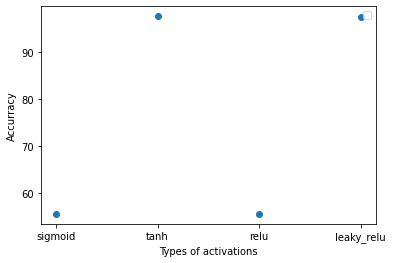

No handles with labels found to put in legend.


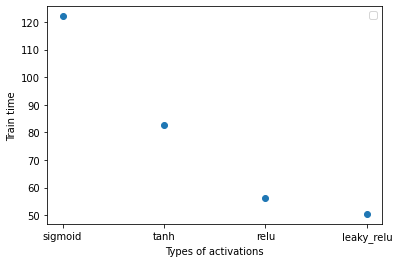

In [86]:
#Typs of activation functions
network_structure = [4, 100,100,100,100,100,100,100,100,100,100, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.001
epochs = 1000

accurracy = []
train_time = []
types_activations = ["sigmoid","tanh","relu","leaky_relu"]

activations = []
for x in range(1):   
    for i in range(len(types_activations)):
        myANN = Neural_Network(network_structure, types_activations[i])
        acc,t_time = myANN.train(X, y, learning_rate, epochs)
        accurracy.append(round(acc,2))
        train_time.append(round(t_time,2))
        activations.append(types_activations[i])

plt.scatter(x=activations, y=accurracy) 
#plt.plot(types_activations, accurracy, 'g', label='Training accuracy')
#plt.plot(epochs, loss_val, 'b', label='validation accuracy')
#plt.title('Accuracy of of number of nodes of hidden layer')
plt.xlabel('Types of activations')
plt.ylabel('Accurracy')
plt.legend()
plt.show()

plt.scatter(x=activations, y=train_time) 
#plt.plot(types_activations, train_time, 'g', label='Training time')
#plt.title('Traning time of number of nodes of hidden layer')
plt.xlabel('Types of activations')
plt.ylabel('Train time')
plt.legend()
plt.show()

<ipython-input-84-50500cf032e9>:15: RuntimeWarning: overflow encountered in exp
  self.output = 1 / (1+np.exp(-input))


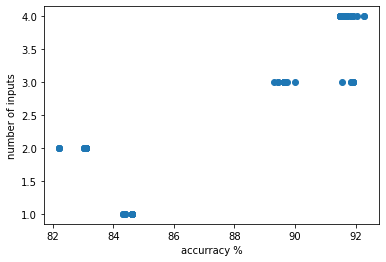

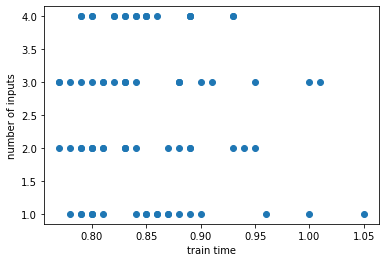

In [121]:
# Fit for input layer
network_structure = [1, 1, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.9
epochs = 200

x1= X.iloc[: , [0]].copy()
x2= X.iloc[: , [0,1]].copy()
x3= X.iloc[: , [0,1,2]].copy()
x4= X.iloc[: , [0,1,2,3]].copy()

new_x = [x1, x2, x3, x4]

accurracy = []
number_inputs = []
train_time = []

for x in range(20):
    for i in range(len(new_x)):
        network_structure = [i+1, 1, 2]
        myANN = Neural_Network(network_structure, activation)
        acc,t_time = myANN.train(new_x[i], y, learning_rate, epochs)
        accurracy.append(round(acc,2))
        train_time.append(round(t_time,2))
        number_inputs.append(i+1)

plt.scatter(x=accurracy, y=number_inputs) 
plt.xlabel("accurracy %")
plt.ylabel("number of inputs")
#plt.title("Accurracy of different number of inputs",  y=-0.1)
plt.show()

plt.scatter(x=train_time, y=number_inputs) 
plt.xlabel("train time")
plt.ylabel("number of inputs")
#plt.title("Train time of different number of inputs",  y=-0.1)
plt.show()


# plt.plot(number_inputs, accurracy, 'g', label='Training accuracy')
# #plt.plot(epochs, loss_val, 'b', label='validation accuracy')
# plt.title('Accuracy of different number of inputs')
# plt.xlabel('Number of inputs')
# plt.ylabel('Accurracy')
# plt.legend()
# plt.show()

# plt.plot(number_inputs, train_time, 'g', label='Training time')
# plt.title('Traning time of different number of inputs')
# plt.xlabel('Number of inputs')
# plt.ylabel('Train time')
# plt.legend()
# plt.show()

Loss: 0.7107774745335531
Loss: 0.7028715968191906
Loss: 0.6966105709563826
Loss: 0.6910025952955889
Loss: 0.6854573519537508
Loss: 0.6798479350152963
Loss: 0.674358185588447
Loss: 0.6691932349622958
Loss: 0.6644435724262753
Loss: 0.6601112367416905
Loss: 0.6561490960241813
Loss: 0.6524791196966051
Loss: 0.6490119092601053
Loss: 0.6456668466575352
Loss: 0.6423828811041562
Loss: 0.6391191209633884
Loss: 0.6358508062770473
Loss: 0.6325657184515229
Loss: 0.6292629575967408
Loss: 0.6259529842452497
Loss: 0.6226558474618678
Loss: 0.6193953437504548
Loss: 0.6161910560541287
Loss: 0.6130533392522393
Loss: 0.6099839291246084
Loss: 0.606980317535219
Loss: 0.6040406414425606
Loss: 0.601167010957783
Loss: 0.5983659412803726
Loss: 0.5956450947976636
Loss: 0.5930075663610556
Loss: 0.590446959373299
Loss: 0.5879462895561937
Loss: 0.5854818018841745
Loss: 0.583030049475926
Loss: 0.5805745706239694
Loss: 0.5781087125886134
Loss: 0.5756302178999483
Loss: 0.5731243836197683
Loss: 0.5705483182557524
Loss:

Loss: 0.20925361766920755
Loss: 0.20902220264298674
Loss: 0.2088087640586452
Loss: 0.20861216299965368
Loss: 0.20843093435416365
Loss: 0.20826344706360914
Loss: 0.20810803303859743
Loss: 0.2079630801427417
Loss: 0.2078270916193963
Loss: 0.2076987180662961
Loss: 0.20757676914373807
Loss: 0.20746021165560594
Loss: 0.2073481593682798
Loss: 0.20723985851846605
Loss: 0.20713467170603964
Loss: 0.20703206188058257
Loss: 0.2069315774121851
Loss: 0.20683283874731728
Loss: 0.2067355268341947
Loss: 0.20663937331009696
Loss: 0.2065441523348472
Loss: 0.20644967390008706
Loss: 0.20635577842230166
Loss: 0.2062623324253766
Loss: 0.2061692251263594
Loss: 0.20607636575188396
Loss: 0.20598368142877665
Loss: 0.2058911155096926
Loss: 0.20579862621168357
Loss: 0.20570618546304342
Loss: 0.20561377787040777
Loss: 0.20552139973466668
Loss: 0.20542905806082704
Loss: 0.20533676952359314
Loss: 0.20524455936708652
Loss: 0.20515246023382647
Loss: 0.20506051093418673
Loss: 0.20496875518203006
Loss: 0.204877240334118

Loss: 0.11739169895926532
Loss: 0.11723187695973158
Loss: 0.11707012978274689
Loss: 0.11690661339250326
Loss: 0.11674147790513519
Loss: 0.11657486058217477
Loss: 0.11640688263592386
Loss: 0.11623764928836348
Loss: 0.1160672522749391
Loss: 0.11589577387512844
Loss: 0.11572329157679291
Loss: 0.115549882616199
Loss: 0.11537562783790184
Loss: 0.1152006145383899
Loss: 0.11502493815085395
Loss: 0.11484870277396216
Loss: 0.11467202064843493
Loss: 0.11449501076189211
Loss: 0.11431779683209975
Loss: 0.11414050498126996
Loss: 0.11396326144716891
Loss: 0.11378619064977263
Loss: 0.11360941382868345
Loss: 0.11343304830143257
Loss: 0.11325720721452215
Loss: 0.1130819995272897
Loss: 0.1129075299273627
Loss: 0.1127338984321477
Loss: 0.11256119955401567
Loss: 0.11238952104948657
Loss: 0.11221894239148367
Loss: 0.112049533174689
Loss: 0.11188135168346765
Loss: 0.11171444382854322
Loss: 0.11154884260380812
Loss: 0.11138456813878173
Loss: 0.11122162833619068
Loss: 0.11106002000247645
Loss: 0.1108997303190

Loss: 0.12447198772045802
Loss: 0.12277174985466081
Loss: 0.12123357739626839
Loss: 0.119833597879954
Loss: 0.11855161885012967
Loss: 0.11737080278240854
Loss: 0.11627726951051655
Loss: 0.11525966450281692
Loss: 0.11430873152274815
Loss: 0.11341691941924555
Loss: 0.11257804000910052
Loss: 0.11178698249691532
Loss: 0.11103948212854738
Loss: 0.1103319367735056
Loss: 0.10966126376853705
Loss: 0.10902478947517773
Loss: 0.10842016480508204
Loss: 0.10784530099459749
Loss: 0.10729832094137459
Loss: 0.10677752235358282
Loss: 0.10628134977087099
Loss: 0.10580837318928361
Loss: 0.10535727156755725
Loss: 0.1049268199238982
Loss: 0.10451587906737853
Loss: 0.10412338726360859
Loss: 0.10374835332619464
Loss: 0.10338985076759921
Loss: 0.10304701274697943
Loss: 0.10271902762781433
Loss: 0.10240513501202994
Loss: 0.10210462215561747
Loss: 0.10181682069768577
Loss: 0.10154110365374044
Loss: 0.1012768826370482
Loss: 0.10102360528098704
Loss: 0.10078075284147535
Loss: 0.10054783796283426
Loss: 0.100324402

Loss: 0.06917046544885302
Loss: 0.06908325300707757
Loss: 0.06899670533151948
Loss: 0.06891081511331067
Loss: 0.06882557572239358
Loss: 0.06874098115373055
Loss: 0.06865702597305123
Loss: 0.06857370526299625
Loss: 0.06849101457048565
Loss: 0.06840894985607757
Loss: 0.06832750744596927
Loss: 0.06824668398716927
Loss: 0.06816647640620169
Loss: 0.0680868818715489
Loss: 0.06800789775986446
Loss: 0.0679295216258322
Loss: 0.06785175117540485
Loss: 0.0677745842420316
Loss: 0.06769801876539243
Loss: 0.06762205277208945
Loss: 0.0675466843577118
Loss: 0.0674719116696809
Loss: 0.06739773289031135
Loss: 0.06732414621956495
Loss: 0.06725114985705391
Loss: 0.06717874198292631
Accuracy: 97.44897959183673
Loss: 0.667307320181831
Loss: 0.6706309601801733
Loss: 0.6642845268404113
Loss: 0.6494806725477127
Loss: 0.6280446822641255
Loss: 0.6029626188208501
Loss: 0.5769124297524608
Loss: 0.550482580293319
Loss: 0.5227875322969942
Loss: 0.49300904579110527
Loss: 0.4612093250480239
Loss: 0.42827750328782127
L

Loss: 0.059633625376609205
Loss: 0.05957699380907904
Loss: 0.05952213225365597
Loss: 0.05946898254942357
Loss: 0.059417488598044826
Loss: 0.05936759628766095
Loss: 0.059319253419941806
Loss: 0.05927240964006954
Loss: 0.05922701636946331
Loss: 0.05918302674106849
Loss: 0.05914039553705466
Loss: 0.05909907912878713
Loss: 0.05905903541894636
Loss: 0.05902022378568679
Loss: 0.05898260502873961
Loss: 0.058946141317373586
Loss: 0.05891079614013618
Loss: 0.05887653425630851
Loss: 0.05884332164901395
Loss: 0.058811125479922594
Loss: 0.05877991404550545
Loss: 0.058749656734790566
Loss: 0.05872032398858003
Loss: 0.0586918872600881
Loss: 0.058664318976963246
Loss: 0.058637592504660725
Loss: 0.05861168211112812
Loss: 0.05858656293277458
Loss: 0.058562210941687474
Loss: 0.05853860291406788
Loss: 0.058515716399851224
Loss: 0.058493529693481185
Loss: 0.058472021805805366
Loss: 0.05845117243706284
Loss: 0.058430961950927736
Loss: 0.058411371349581534
Loss: 0.05839238224977931
Loss: 0.05837397685987856

Loss: 0.10900459709647081
Loss: 0.10642753216973776
Loss: 0.10409622457372601
Loss: 0.10197893619115067
Loss: 0.1000491354098814
Loss: 0.09828446255255906
Loss: 0.09666592277241627
Loss: 0.09517725580397902
Loss: 0.09380444028094713
Loss: 0.0925353002580508
Loss: 0.09135919022760981
Loss: 0.0902667416052889
Loss: 0.08924965849463241
Loss: 0.08830055384438952
Loss: 0.08741281920034712
Loss: 0.08658052241557326
Loss: 0.08579832821494687
Loss: 0.08506143671823356
Loss: 0.0843655351987285
Loss: 0.08370675870768249
Loss: 0.08308165582749315
Loss: 0.08248715670086051
Loss: 0.08192054149498365
Loss: 0.08137940843807386
Loss: 0.08086164136963396
Loss: 0.08036537729431932
Loss: 0.07988897470750679
Loss: 0.07943098350833683
Loss: 0.07899011720139616
Loss: 0.07856522788503227
Loss: 0.07815528429494166
Loss: 0.07775935295978087
Loss: 0.07737658235533289
Loss: 0.07700618982381956
Loss: 0.07664745095321693
Loss: 0.07629969108004368
Loss: 0.07596227857802819
Loss: 0.07563461961450363
Loss: 0.07531615

Loss: 0.0632716757021349
Loss: 0.06323651088617523
Loss: 0.06320099941386716
Loss: 0.06316518801749973
Loss: 0.06312912158375224
Loss: 0.06309284306516136
Loss: 0.06305639341047492
Loss: 0.06301981151258743
Loss: 0.06298313417277442
Loss: 0.06294639607995904
Loss: 0.0629096298037702
Loss: 0.06287286580015918
Loss: 0.06283613242837523
Loss: 0.06279945597811558
Loss: 0.06276286070570213
Loss: 0.06272636887817072
Loss: 0.06269000082420305
Loss: 0.06265377499088375
Loss: 0.06261770800532053
Loss: 0.0625818147402282
Loss: 0.06254610838264724
Loss: 0.06251060050503873
Loss: 0.06247530113806651
Loss: 0.06244021884445869
Loss: 0.0624053607934005
Loss: 0.06237073283498829
Loss: 0.0623363395743326
Loss: 0.06230218444495799
Loss: 0.06226826978119564
Loss: 0.06223459688931545
Loss: 0.062201166117176555
Loss: 0.062167976922210176
Loss: 0.06213502793757384
Loss: 0.06210231703634148
Loss: 0.062069841393604275
Loss: 0.062037597546382876
Loss: 0.062005581451255065
Loss: 0.06197378853962678
Loss: 0.0619

Loss: 0.04535141150143499
Loss: 0.045258946877199224
Loss: 0.04516867215663997
Loss: 0.0450804958884164
Loss: 0.04499433400976054
Loss: 0.04491010931574589
Loss: 0.04482775095031306
Loss: 0.04474719392015508
Loss: 0.04466837863232262
Loss: 0.04459125045614579
Loss: 0.04451575930980004
Loss: 0.044441859271572716
Loss: 0.04436950821563944
Loss: 0.044298667471936566
Loss: 0.044229301509519335
Loss: 0.04416137764263008
Loss: 0.04409486575857995
Loss: 0.04402973806644077
Loss: 0.043965968865484
Loss: 0.04390353433226047
Loss: 0.043842412325197117
Loss: 0.043782582205591926
Loss: 0.0437240246739079
Loss: 0.043666721620293114
Loss: 0.043610655988303826
Loss: 0.04355581165084589
Loss: 0.04350217329741014
Loss: 0.043449726331725246
Loss: 0.043398456779012405
Loss: 0.043348351202075475
Loss: 0.043299396625519744
Loss: 0.04325158046743932
Loss: 0.04320489047796575
Loss: 0.04315931468411334
Loss: 0.04311484134040414
Loss: 0.043071458884795355
Loss: 0.04302915589946428
Loss: 0.04298792107605145
Los

Loss: 0.4055681198368739
Loss: 0.36274729509599757
Loss: 0.3223380912766563
Loss: 0.2860564836136239
Loss: 0.25467256860065945
Loss: 0.22817959045934683
Loss: 0.20608653326597592
Loss: 0.18770564417973232
Loss: 0.17235107868993918
Loss: 0.15943063621191653
Loss: 0.14846612130953182
Loss: 0.13908204304030752
Loss: 0.13098569455033354
Loss: 0.12394810451533692
Loss: 0.11778860857888153
Loss: 0.11236316444956143
Loss: 0.10755574003622839
Loss: 0.10327200373599568
Loss: 0.09943466719038704
Loss: 0.09597999440475222
Loss: 0.09285513570271432
Loss: 0.09001605458284763
Loss: 0.08742589153992657
Loss: 0.08505365864169775
Loss: 0.08287319022752541
Loss: 0.08086229517747336
Loss: 0.07900206941966144
Loss: 0.07727633655504564
Loss: 0.07567119128612818
Loss: 0.07417462558566738
Loss: 0.0727762216755171
Loss: 0.07146689915583296
Loss: 0.07023870620106722
Loss: 0.06908464675689241
Loss: 0.06799853724741836
Loss: 0.06697488753387267
Loss: 0.06600880183580811
Loss: 0.06509589609798304
Loss: 0.06423222

Loss: 0.03788403319560208
Loss: 0.03781445069512936
Loss: 0.03774496677823436
Loss: 0.037675574219752546
Loss: 0.03760626661320366
Loss: 0.037537038326840605
Loss: 0.037467884461533235
Loss: 0.03739880081040163
Loss: 0.03732978382011909
Loss: 0.037260830553812095
Loss: 0.037191938655487755
Loss: 0.03712310631592366
Loss: 0.037054332239959784
Loss: 0.036985615615134956
Loss: 0.036916956081615736
Loss: 0.03684835370336517
Loss: 0.036779808940506344
Loss: 0.03671132262283424
Loss: 0.03664289592443547
Loss: 0.03657453033937398
Loss: 0.03650622765840672
Loss: 0.03643798994669276
Loss: 0.036369819522461315
Loss: 0.0363017189366076
Loss: 0.03623369095318367
Loss: 0.03616573853075691
Loss: 0.036097864804606854
Loss: 0.036030073069732056
Loss: 0.03596236676464382
Loss: 0.03589474945591946
Loss: 0.03582722482349168
Loss: 0.03575979664665097
Loss: 0.035692468790738556
Loss: 0.03562524519450799
Loss: 0.03555812985813374
Loss: 0.035491126831846506
Loss: 0.03542424020517585
Loss: 0.03535747409678018

Loss: 0.05180706933791495
Loss: 0.051068481964216525
Loss: 0.05037328717633776
Loss: 0.04971805998061867
Loss: 0.04909971612919676
Loss: 0.048515470472355195
Loss: 0.04796280125142696
Loss: 0.04743941937743198
Loss: 0.04694324191023101
Loss: 0.04647236908976683
Loss: 0.04602506438179588
Loss: 0.045599737090709115
Loss: 0.04519492716573139
Loss: 0.04480929188724943
Loss: 0.044441594169788
Loss: 0.044090692259284324
Loss: 0.0437555306364025
Loss: 0.0434351319659799
Loss: 0.04312858995635023
Loss: 0.04283506301206479
Loss: 0.04255376858013256
Loss: 0.04228397810385557
Loss: 0.04202501251011445
Loss: 0.0417762381659179
Loss: 0.04153706324848272
Loss: 0.04130693448030194
Loss: 0.04108533418680838
Loss: 0.040871777639496405
Loss: 0.04066581065190684
Loss: 0.040467007399786384
Loss: 0.040274968440139315
Loss: 0.040089318906851135
Loss: 0.03990970686316295
Loss: 0.03973580179356381
Loss: 0.039567293219694225
Loss: 0.03940388942664879
Loss: 0.039245316287671216
Loss: 0.039091316176662505
Loss: 

Loss: 0.025487140030286137
Loss: 0.0254233971120998
Loss: 0.02536016511556972
Loss: 0.025297435368849343
Loss: 0.025235199461517595
Loss: 0.02517344923519257
Loss: 0.025112176774559177
Loss: 0.02505137439878888
Loss: 0.02499103465333121
Loss: 0.024931150302058985
Loss: 0.02487171431974784
Loss: 0.024812719884873973
Loss: 0.024754160372713583
Loss: 0.024696029348728443
Loss: 0.024638320562223464
Loss: 0.02458102794026202
Loss: 0.024524145581826768
Loss: 0.024467667752212575
Loss: 0.024411588877640843
Loss: 0.024355903540083514
Loss: 0.024300606472286733
Loss: 0.024245692552983946
Loss: 0.02419115680228929
Loss: 0.024136994377262008
Loss: 0.024083200567634133
Loss: 0.02402977079169272
Loss: 0.023976700592310204
Loss: 0.023923985633114344
Loss: 0.023871621694792292
Loss: 0.02381960467152187
Loss: 0.023767930567524086
Loss: 0.0237165954937314
Loss: 0.023665595664566205
Loss: 0.023614927394824663
Loss: 0.02356458709666088
Loss: 0.023514571276667243
Loss: 0.023464876533046315
Loss: 0.0234154

Loss: 0.0366978249769001
Loss: 0.036550733249855756
Loss: 0.036407176041886355
Loss: 0.03626700521529673
Loss: 0.03613007978745636
Loss: 0.03599626553769731
Loss: 0.03586543463939696
Loss: 0.03573746531511584
Loss: 0.03561224151288949
Loss: 0.035489652601982453
Loss: 0.03536959308659103
Loss: 0.03525196233614516
Loss: 0.035136664331001356
Loss: 0.03502360742244637
Loss: 0.03491270410603831
Loss: 0.034803870807414886
Loss: 0.03469702767977903
Loss: 0.034592098412349274
Loss: 0.03448901004912869
Loss: 0.03438769281739993
Loss: 0.0342880799654075
Loss: 0.034190107608728815
Loss: 0.034093714584873924
Loss: 0.03399884231568836
Loss: 0.03390543467715889
Loss: 0.03381343787624935
Loss: 0.033722800334415375
Loss: 0.03363347257746445
Loss: 0.0335454071314469
Loss: 0.033458558424276766
Loss: 0.03337288269279666
Loss: 0.03328833789501239
Loss: 0.03320488362723355
Loss: 0.03312248104587102
Loss: 0.033041092793645796
Loss: 0.032960682929978884
Loss: 0.0328812168653385
Loss: 0.03280266129932944
Loss

Loss: 0.40017453310738893
Loss: 0.3461241177082532
Loss: 0.295815069869685
Loss: 0.25266376806721097
Loss: 0.21754817660683262
Loss: 0.1896054824845314
Loss: 0.16741425607362254
Loss: 0.149649460118732
Loss: 0.13526120369679157
Loss: 0.12346081399171256
Loss: 0.11366362269604337
Loss: 0.10543522693045926
Loss: 0.09845019585218111
Loss: 0.09246216401024668
Loss: 0.08728253072825237
Loss: 0.08276529724734462
Loss: 0.07879620736281809
Loss: 0.07528490296533355
Loss: 0.07215920394619618
Loss: 0.0693608971396479
Loss: 0.06684260655310077
Loss: 0.06456544517767615
Loss: 0.06249723668256539
Loss: 0.060611156273699604
Loss: 0.05888468256330845
Loss: 0.0572987822226844
Loss: 0.0558372703769898
Loss: 0.05448630480767686
Loss: 0.053233982879513475
Loss: 0.05207001796355489
Loss: 0.05098547785682622
Loss: 0.04997257191170566
Loss: 0.049024476708995804
Loss: 0.04813519243895391
Loss: 0.047299423907495385
Loss: 0.04651248141309817
Loss: 0.04577019775356114
Loss: 0.04506885840057212
Loss: 0.044405142

Loss: 0.02864637902160696
Loss: 0.028606122470037184
Loss: 0.028567030976078427
Loss: 0.02852907406038428
Loss: 0.028492221813613237
Loss: 0.028456444892255177
Loss: 0.028421714514260708
Loss: 0.02838800245447029
Loss: 0.028355281039844714
Loss: 0.028323523144498982
Loss: 0.028292702184547183
Loss: 0.0282627921127645
Loss: 0.028233767413076694
Loss: 0.028205603094886223
Loss: 0.028178274687246766
Loss: 0.028151758232897995
Loss: 0.028126030282171473
Loss: 0.028101067886781225
Loss: 0.028076848593509392
Loss: 0.028053350437801095
Loss: 0.02803055193727791
Loss: 0.02800843208518299
Loss: 0.02798697034376829
Loss: 0.027966146637633492
Loss: 0.027945941347028234
Loss: 0.0279263353011256
Loss: 0.027907309771276576
Loss: 0.027888846464252867
Loss: 0.027870927515487247
Loss: 0.027853535482316772
Loss: 0.027836653337237036
Loss: 0.027820264461172393
Loss: 0.027804352636768354
Loss: 0.02778890204171082
Loss: 0.027773897242076795
Loss: 0.027759323185720986
Loss: 0.027745165195701166
Loss: 0.0277

Loss: 0.03416592410739575
Loss: 0.033986225398167286
Loss: 0.033811699886206456
Loss: 0.033642110264734314
Loss: 0.03347723286328829
Loss: 0.03331685671745392
Loss: 0.033160782714111534
Loss: 0.033008822804933384
Loss: 0.03286079928164787
Loss: 0.03271654410727399
Loss: 0.032575898298145035
Loss: 0.03243871135207756
Loss: 0.03230484071853124
Loss: 0.03217415130702356
Loss: 0.03204651503045674
Loss: 0.031921810380343314
Loss: 0.031799922031229215
Loss: 0.03168074047187832
Loss: 0.03156416166102704
Loss: 0.0314500867057349
Loss: 0.03133842156054859
Loss: 0.031229076745870884
Loss: 0.03112196708408313
Loss: 0.031017011452105465
Loss: 0.03091413254920749
Loss: 0.030813256678988484
Loss: 0.030714313544551293
Loss: 0.03061723605597959
Loss: 0.030521960149309003
Loss: 0.0304284246162544
Loss: 0.03033657094401959
Loss: 0.030246343164570637
Loss: 0.030157687712807277
Loss: 0.03007055329311121
Loss: 0.029984890753787866
Loss: 0.029900652968959236
Loss: 0.02981779472749138
Loss: 0.029736272628572

Loss: 0.02462706632526489
Loss: 0.02458743294140106
Loss: 0.02454813866689033
Loss: 0.024509179305507476
Loss: 0.024470550728520297
Loss: 0.02443224887337639
Accuracy: 98.83381924198251
Loss: 0.6256958548391391
Loss: 0.7289732203964033
Loss: 0.5594172359533212
Loss: 0.6188549452335702
Loss: 0.4874942732361689
Loss: 0.4926856724586562
Loss: 0.40304316995563577
Loss: 0.36388617076965835
Loss: 0.30402696651062106
Loss: 0.260179525503428
Loss: 0.22229890878571687
Loss: 0.19261350099606261
Loss: 0.16913927052287364
Loss: 0.1504812203808961
Loss: 0.1354700844850185
Loss: 0.12322949581884303
Loss: 0.11311446103568948
Loss: 0.1046509553759485
Loss: 0.09748809104357699
Loss: 0.09136319098083935
Loss: 0.08607704653203115
Loss: 0.0814765510176107
Loss: 0.07744249157107745
Loss: 0.07388090194044546
Loss: 0.07071687053589558
Loss: 0.067890050732148
Loss: 0.06535136263070616
Loss: 0.06306053857731957
Loss: 0.06098427385327039
Loss: 0.05909481707854027
Loss: 0.057368884172481475
Loss: 0.0557868132848

Loss: 0.02725141107496305
Loss: 0.027183623225885148
Loss: 0.027116808474403606
Loss: 0.027050942214342497
Loss: 0.026986000683376702
Loss: 0.026921960926918082
Loss: 0.026858800763726588
Loss: 0.026796498753149784
Loss: 0.026735034163904988
Loss: 0.026674386944320207
Loss: 0.026614537693959557
Loss: 0.02655546763656142
Loss: 0.026497158594222657
Loss: 0.026439592962768304
Loss: 0.026382753688247232
Loss: 0.026326624244501173
Loss: 0.026271188611755245
Loss: 0.02621643125618257
Loss: 0.026162337110398455
Loss: 0.026108891554840984
Loss: 0.026056080399999754
Loss: 0.026003889869453435
Loss: 0.025952306583681767
Loss: 0.02590131754461754
Loss: 0.02585091012090798
Loss: 0.02580107203385279
Loss: 0.025751791343992417
Loss: 0.025703056438318158
Loss: 0.025654856018076943
Loss: 0.025607179087147228
Loss: 0.025560014940961363
Loss: 0.025513353155951362
Loss: 0.02546718357949619
Loss: 0.025421496320350814
Loss: 0.025376281739533275
Loss: 0.025331530441655415
Loss: 0.02528723326667384
Loss: 0.0

Loss: 0.03787448681066935
Loss: 0.037532675462030304
Loss: 0.03720455960002044
Loss: 0.03688932028041451
Loss: 0.03658620073082988
Loss: 0.036294500555330025
Loss: 0.036013570575531936
Loss: 0.03574280822854533
Loss: 0.03548165345324583
Loss: 0.035229585005817986
Loss: 0.034986117153514934
Loss: 0.03475079670238212
Loss: 0.03452320032049366
Loss: 0.0343029321232109
Loss: 0.03408962149122413
Loss: 0.033882921095785966
Loss: 0.03368250510869982
Loss: 0.03348806757733454
Loss: 0.03329932094729519
Loss: 0.03311599471741585
Loss: 0.032937834213516426
Loss: 0.03276459946890866
Loss: 0.03259606420099054
Loss: 0.03243201487444363
Loss: 0.03227224984259081
Loss: 0.03211657855937471
Loss: 0.031964820855226755
Loss: 0.03181680627079599
Loss: 0.0316723734431397
Loss: 0.03153136953952468
Loss: 0.03139364973448626
Loss: 0.031259076726223196
Loss: 0.031127520288801443
Loss: 0.03099885685698094
Loss: 0.030872969140798887
Loss: 0.03074974576730985
Loss: 0.030629080947144803
Loss: 0.03051087416376333
Lo

Loss: 0.02332511914576258
Loss: 0.023300233480762274
Loss: 0.023275764352707066
Loss: 0.023251705065816454
Loss: 0.0232280489937328
Loss: 0.023204789579044843
Loss: 0.023181920332872145
Loss: 0.023159434834503206
Loss: 0.023137326731081
Loss: 0.023115589737329953
Loss: 0.02309421763531977
Loss: 0.02307320427425993
Loss: 0.02305254357032062
Loss: 0.023032229506475984
Accuracy: 98.83381924198251
Loss: 0.6321553155419587
Loss: 0.6794830249350858
Loss: 0.5229414453985457
Loss: 0.5661283720185323
Loss: 0.4319365109257541
Loss: 0.4354219243719043
Loss: 0.34074295896559303
Loss: 0.3062420329005969
Loss: 0.25238072598025807
Loss: 0.21754197283796622
Loss: 0.18774024960585847
Loss: 0.16473380842692198
Loss: 0.14646094489194084
Loss: 0.1318029706133821
Loss: 0.11988149098865546
Loss: 0.11005395068102891
Loss: 0.10184868722178482
Loss: 0.09491687055253437
Loss: 0.08899768964532781
Loss: 0.08389375100046462
Loss: 0.07945378043067619
Loss: 0.07556041757397808
Loss: 0.07212153665284458
Loss: 0.06906

Loss: 0.0270545182787614
Loss: 0.026970321196334184
Loss: 0.026887299486857783
Loss: 0.026805416684203633
Loss: 0.026724637677331246
Loss: 0.026644928651342745
Loss: 0.026566257031687354
Loss: 0.026488591431316877
Loss: 0.026411901600606868
Loss: 0.02633615837987198
Loss: 0.026261333654314215
Loss: 0.026187400311257575
Loss: 0.026114332199526396
Loss: 0.02604210409084161
Loss: 0.0259706916431109
Loss: 0.025900071365502177
Loss: 0.025830220585193676
Loss: 0.0257611174157026
Loss: 0.025692740726700462
Loss: 0.025625070115229513
Loss: 0.02555808587823873
Loss: 0.025491768986365054
Loss: 0.025426101058889684
Loss: 0.0253610643398025
Loss: 0.02529664167491393
Loss: 0.02523281648995563
Loss: 0.02516957276961716
Loss: 0.02510689503746636
Loss: 0.02504476833670714
Loss: 0.024983178211729767
Loss: 0.024922110690411618
Loss: 0.024861552267130046
Loss: 0.024801489886450135
Loss: 0.024741910927453366
Loss: 0.024682803188673892
Loss: 0.024624154873614173
Loss: 0.024565954576809754
Loss: 0.024508191

Loss: 0.049839884037866926
Loss: 0.04870805259596467
Loss: 0.04765623381599979
Loss: 0.04667642309751606
Loss: 0.04576164119838941
Loss: 0.04490577604250748
Loss: 0.04410345272097004
Loss: 0.04334992604706411
Loss: 0.042640991267793714
Loss: 0.041972909479547266
Loss: 0.04134234501940263
Loss: 0.040746312662277746
Loss: 0.04018213288827133
Loss: 0.03964739382407777
Loss: 0.03913991872953778
Loss: 0.03865773811184703
Loss: 0.03819906571823345
Loss: 0.03776227779254359
Loss: 0.037345895089414265
Loss: 0.03694856722714001
Loss: 0.036569059031285225
Loss: 0.036206238578900256
Loss: 0.03585906670049979
Loss: 0.03552658773581399
Loss: 0.03520792137135561
Loss: 0.034902255414357285
Loss: 0.03460883937964367
Loss: 0.03432697878434261
Loss: 0.03405603006067466
Loss: 0.03379539600991831
Loss: 0.0335445217314641
Loss: 0.033302890970006396
Loss: 0.03307002283164199
Loss: 0.03284546882621229
Loss: 0.03262881019880947
Loss: 0.0324196555181375
Loss: 0.03221763849350457
Loss: 0.03202241599573128
Loss:

Loss: 0.025884914113670394
Loss: 0.025861695911666694
Loss: 0.025839042842703015
Loss: 0.025816935686839987
Loss: 0.025795355486335672
Loss: 0.025774283542172167
Loss: 0.025753701410857244
Loss: 0.025733590901476946
Loss: 0.025713934072976737
Loss: 0.025694713231650148
Loss: 0.025675910928818733
Loss: 0.025657509958684113
Loss: 0.025639493356338815
Loss: 0.025621844395922376
Loss: 0.025604546588910086
Loss: 0.02558758368252461
Loss: 0.02557093965825949
Loss: 0.025554598730507843
Loss: 0.02553854534528772
Loss: 0.025522764179058004
Loss: 0.02550724013761809
Loss: 0.025491958355088447
Loss: 0.025476904192965083
Loss: 0.025462063239246074
Loss: 0.025447421307625635
Loss: 0.02543296443675274
Loss: 0.025418678889552706
Loss: 0.025404551152607983
Loss: 0.02539056793559685
Loss: 0.02537671617078782
Loss: 0.025362983012587523
Loss: 0.02534935583714145
Loss: 0.025335822241983063
Loss: 0.025322370045733553
Loss: 0.025308987287845256
Loss: 0.025295662228391545
Loss: 0.02528238334789757
Loss: 0.02

Loss: 0.030356550016730197
Loss: 0.03021132914286667
Loss: 0.03006967856857624
Loss: 0.02993144991667092
Loss: 0.02979650224062433
Loss: 0.029664701580347518
Loss: 0.02953592055209595
Loss: 0.02941003796966335
Loss: 0.029286938494280646
Loss: 0.02916651231087806
Loss: 0.02904865482857627
Loss: 0.02893326640346199
Loss: 0.02882025208186928
Loss: 0.02870952136253901
Loss: 0.028600987976157854
Loss: 0.02849456968090085
Loss: 0.02839018807270417
Loss: 0.028287768409089063
Loss: 0.02818723944544142
Loss: 0.02808853328272637
Loss: 0.027991585225682736
Loss: 0.0278963336506007
Loss: 0.027802719881840538
Loss: 0.027710688076295273
Loss: 0.027620185115044917
Loss: 0.027531160501487177
Loss: 0.027443566265265694
Loss: 0.027357356871349787
Loss: 0.02727248913365124
Loss: 0.027188922132593257
Loss: 0.02710661713607669
Loss: 0.027025537523316125
Loss: 0.026945648711052168
Loss: 0.02686691808167156
Loss: 0.02678931491280281
Loss: 0.026712810307988
Loss: 0.026637377128063567
Loss: 0.02656298992292609

Loss: 0.09817885744545021
Loss: 0.09146311405904235
Loss: 0.08574151711242242
Loss: 0.08081776763011146
Loss: 0.0765423060865846
Loss: 0.07279958530642598
Loss: 0.06949917135547677
Loss: 0.06656943557484571
Loss: 0.06395301919574876
Loss: 0.061603526206488776
Loss: 0.05948307916149739
Loss: 0.05756048980784137
Loss: 0.05580987372735085
Loss: 0.05420958978588199
Loss: 0.052741420053224596
Loss: 0.05138992974871038
Loss: 0.05014196335882921
Loss: 0.0489862447462059
Loss: 0.04791305738421276
Loss: 0.04691398684338265
Loss: 0.04598171202049715
Loss: 0.04510983481270126
Loss: 0.04429274032414203
Loss: 0.043525481479551195
Loss: 0.04280368326892808
Loss: 0.042123462874827704
Loss: 0.04148136272139095
Loss: 0.04087429409227545
Loss: 0.04029948943702933
Loss: 0.03975446185477215
Loss: 0.03923697053445208
Loss: 0.03874499116062017
Loss: 0.03827669047625573
Loss: 0.03783040434010052
Loss: 0.03740461873315053
Loss: 0.036997953263512795
Loss: 0.03660914679547766
Loss: 0.036237044891057314
Loss: 0.

Loss: 0.023325826953930984
Loss: 0.02327598664723049
Loss: 0.023226739066888828
Loss: 0.023178073153144314
Loss: 0.02312997810769062
Loss: 0.023082443383135726
Loss: 0.023035458672970195
Loss: 0.022989013902022504
Loss: 0.02294309921737628
Loss: 0.022897704979730635
Loss: 0.022852821755180896
Loss: 0.02280844030740066
Loss: 0.022764551590206857
Loss: 0.022721146740488654
Loss: 0.02267821707148431
Loss: 0.022635754066388115
Loss: 0.022593749372273614
Loss: 0.0225521947943158
Loss: 0.02251108229030016
Loss: 0.02247040396540321
Loss: 0.022430152067232687
Loss: 0.022390318981114207
Loss: 0.02235089722561242
Loss: 0.022311879448275944
Loss: 0.02227325842159463
Loss: 0.022235027039159076
Loss: 0.02219717831201226
Loss: 0.022159705365184305
Loss: 0.022122601434400924
Loss: 0.022085859862957125
Loss: 0.022049474098748266
Loss: 0.022013437691450307
Loss: 0.021977744289841592
Loss: 0.021942387639260073
Loss: 0.021907361579188437
Loss: 0.021872660040960258
Loss: 0.021838277045582555
Loss: 0.02180

Loss: 0.03296300739254612
Loss: 0.032726547878264886
Loss: 0.03249748332254941
Loss: 0.0322754567557381
Loss: 0.03206013445634199
Loss: 0.031851204099012494
Loss: 0.03164837307532497
Loss: 0.031451366968926094
Loss: 0.03125992816881255
Loss: 0.03107381460641478
Loss: 0.03089279860383713
Loss: 0.030716665822050706
Loss: 0.03054521429910681
Loss: 0.030378253569548052
Loss: 0.030215603857164243
Loss: 0.030057095334096506
Loss: 0.029902567440042115
Loss: 0.029751868255974007
Loss: 0.029604853927374983
Loss: 0.02946138813250022
Loss: 0.02932134159164154
Loss: 0.02918459161377016
Loss: 0.02905102167729723
Loss: 0.028920521042010955
Loss: 0.028792984389534208
Loss: 0.028668311489901968
Loss: 0.028546406892087442
Loss: 0.028427179636504943
Loss: 0.028310542987706837
Loss: 0.02819641418564769
Loss: 0.02808471421404355
Loss: 0.02797536758448155
Loss: 0.0278683021350555
Loss: 0.02776344884241214
Loss: 0.027660741646186388
Loss: 0.027560117284895772
Loss: 0.027461515142438157
Loss: 0.0273648771044

Loss: 0.022795462937685976
Loss: 0.022759555249872807
Loss: 0.02272392200279535
Loss: 0.022688556328082372
Loss: 0.022653451462384504
Loss: 0.02261860074607775
Loss: 0.02258399762201517
Loss: 0.022549635634325035
Loss: 0.02251550842724936
Loss: 0.022481609744022364
Loss: 0.022447933425784047
Loss: 0.02241447341052716
Loss: 0.022381223732074306
Loss: 0.02234817851908367
Loss: 0.022315331994080326
Loss: 0.022282678472511485
Loss: 0.0222502123618239
Loss: 0.02221792816056159
Loss: 0.022185820457481988
Loss: 0.02215388393068952
Accuracy: 98.9795918367347
Loss: 0.7008533724246726
Loss: 0.70539985074332
Loss: 0.7122454297352788
Loss: 0.9541972158123295
Loss: 0.7621740222992329
Loss: 0.7247850424604446
Loss: 0.417813659842272
Loss: 0.30986414497818704
Loss: 0.23231698327470315
Loss: 0.19381273431846305
Loss: 0.1658107858871337
Loss: 0.145538565011592
Loss: 0.12952226475193904
Loss: 0.11678194174284799
Loss: 0.10646263885238819
Loss: 0.0979835659132906
Loss: 0.09092302000559802
Loss: 0.0849715

Loss: 0.02903390313748052
Loss: 0.028935214285939915
Loss: 0.02883891738839517
Loss: 0.02874492870590787
Loss: 0.02865316812564089
Loss: 0.028563558957982134
Loss: 0.028476027747451334
Loss: 0.028390504096315418
Loss: 0.028306920499934253
Loss: 0.02822521219294052
Loss: 0.028145317005435714
Loss: 0.028067175228451164
Loss: 0.0279907294879872
Loss: 0.02791592462700111
Loss: 0.027842707594764052
Loss: 0.027771027343055952
Loss: 0.027700834728710162
Loss: 0.027632082422058005
Loss: 0.02756472482085828
Loss: 0.027498717969332214
Loss: 0.027434019481950494
Loss: 0.02737058847164813
Loss: 0.027308385482167657
Loss: 0.0272473724242539
Loss: 0.027187512515442762
Loss: 0.02712877022320838
Loss: 0.027071111211248947
Loss: 0.02701450228870692
Loss: 0.026958911362135386
Loss: 0.026904307390036165
Loss: 0.026850660339805963
Loss: 0.02679794114694147
Loss: 0.02674612167636022
Loss: 0.026695174685710237
Loss: 0.026645073790543348
Loss: 0.026595793431242163
Loss: 0.026547308841593065
Loss: 0.026499596

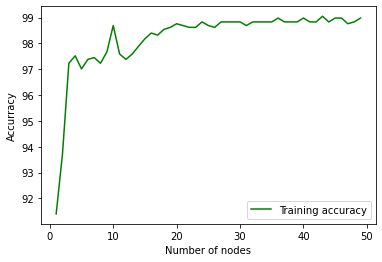

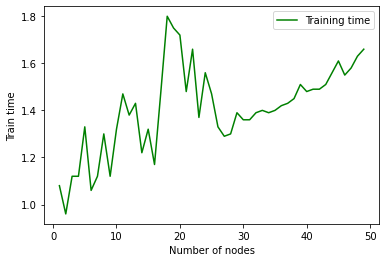

In [126]:
# Number of nodes in hidden layers
network_structure = [4, 1, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.9
epochs = 200


accurracy = []
train_time = []
num_nodes = []

for i in range(1, 50, 1):
    network_structure = [4, i, 2]
    myANN = Neural_Network(network_structure, activation)
    acc,t_time = myANN.train(X, y, learning_rate, epochs)
    accurracy.append(round(acc,2))
    train_time.append(round(t_time,2))
    num_nodes.append(i)


plt.plot(num_nodes, accurracy, 'g', label='Training accuracy')
#plt.plot(epochs, loss_val, 'b', label='validation accuracy')
#plt.title('Accuracy of of number of nodes of hidden layer')
plt.xlabel('Number of nodes')
plt.ylabel('Accurracy')
plt.legend()
plt.show()

plt.plot(num_nodes, train_time, 'g', label='Training time')
#plt.title('Traning time of number of nodes of hidden layer')
plt.xlabel('Number of nodes')
plt.ylabel('Train time')
plt.legend()
plt.show()

=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 2
Loss: 0.7150534721324776
Loss: 0.6714801891440559
Loss: 0.6372167009897874
Loss: 0.6042053127402491
Loss: 0.569615924499529
Loss: 0.5322112186588506
Loss: 0.4912550583448547
Loss: 0.4448334993089312
Loss: 0.39403453839983504
Loss: 0.34231717084568414
Loss: 0.29407982111350445
Loss: 0.2525024553668518
Loss: 0.21851198041344846
Loss: 0.19137182686397117
Loss: 0.1697586963333778
Loss: 0.15240385447822158
Loss: 0.1382924596677503
Loss: 0.12666406512085757
Loss: 0.11695948864750183
Loss: 0.10876678977340748
Loss: 0.1017791063572597
Loss: 0.09576443623803368
Loss: 0.09054461855398489
Loss: 0.08598080247575635
Loss: 0.08196333362205191
Loss: 0.07840461380677373
Loss: 0.07523396633828146
Loss: 0.07239387059896685
Loss: 0.06983714942374003
Loss: 0.06752483444433628
Loss: 0.06542452465741816
Loss: 0.0635091108916878
Loss: 0.06175577605217966
Loss: 0.060145205789667144
Loss: 0.0586609612650914
Loss: 0.057288977732722166
L

Loss: 0.03499000718831548
Loss: 0.034744330609974394
Loss: 0.034506262258642215
Loss: 0.034275536396518334
Loss: 0.03405189621591865
Loss: 0.033835093168128834
Loss: 0.033624886406120234
Loss: 0.03342104232632379
Loss: 0.0332233341957643
Loss: 0.03303154185189463
Loss: 0.03284545146349601
Loss: 0.03266485534200668
Loss: 0.03248955179363994
Loss: 0.0323193450036299
Loss: 0.032154044944918074
Loss: 0.03199346730453903
Loss: 0.03183743342187822
Loss: 0.03168577023385663
Loss: 0.031538310222918385
Loss: 0.03139489136447036
Loss: 0.03125535707112656
Loss: 0.031119556131750832
Loss: 0.030987342643854814
Loss: 0.030858575938411244
Loss: 0.030733120496563602
Loss: 0.030610845858080545
Loss: 0.030491626521696
Loss: 0.030375341837718776
Loss: 0.0302618758934811
Loss: 0.03015111739233305
Loss: 0.030042959526988575
Loss: 0.029937299848089606
Loss: 0.029834040128882168
Loss: 0.029733086226907377
Loss: 0.02963434794358848
Loss: 0.029537738882566132
Loss: 0.02944317630758574
Loss: 0.02935058100068509

Loss: 0.6869839004610573
Loss: 0.6869838348990365
Loss: 0.6869837691222417
Loss: 0.6869837031295478
Loss: 0.6869836369198176
Loss: 0.686983570491908
Loss: 0.6869835038446743
Loss: 0.686983436976957
Loss: 0.6869833698875969
Loss: 0.6869833025754275
Loss: 0.686983235039273
Loss: 0.686983167277952
Loss: 0.6869830992902791
Loss: 0.6869830310750589
Loss: 0.686982962631092
Loss: 0.6869828939571675
Loss: 0.6869828250520739
Loss: 0.6869827559145926
Loss: 0.6869826865434905
Loss: 0.6869826169375342
Loss: 0.6869825470954853
Loss: 0.6869824770160875
Loss: 0.6869824066980925
Loss: 0.6869823361402314
Loss: 0.6869822653412363
Loss: 0.686982194299829
Loss: 0.6869821230147228
Loss: 0.6869820514846277
Loss: 0.6869819797082436
Loss: 0.6869819076842636
Loss: 0.686981835411369
Loss: 0.6869817628882412
Loss: 0.6869816901135507
Loss: 0.6869816170859574
Loss: 0.6869815438041176
Loss: 0.6869814702666766
Loss: 0.6869813964722721
Loss: 0.6869813224195409
Loss: 0.6869812481071002
Loss: 0.686981173533567
Loss: 0.

Loss: 0.6869979934608403
Loss: 0.6869979930289752
Loss: 0.6869979925971457
Loss: 0.6869979921653531
Loss: 0.6869979917335971
Loss: 0.6869979913018789
Loss: 0.6869979908701951
Loss: 0.6869979904385496
Loss: 0.6869979900069383
Loss: 0.6869979895753643
Loss: 0.6869979891438257
Loss: 0.6869979887123242
Loss: 0.6869979882808593
Loss: 0.686997987849429
Loss: 0.686997987418035
Loss: 0.6869979869866787
Loss: 0.6869979865553572
Loss: 0.6869979861240706
Loss: 0.6869979856928206
Loss: 0.6869979852616048
Loss: 0.6869979848304275
Loss: 0.6869979843992833
Loss: 0.6869979839681768
Loss: 0.6869979835371013
Loss: 0.6869979831060654
Loss: 0.6869979826750652
Loss: 0.6869979822440988
Loss: 0.6869979818131673
Loss: 0.6869979813822729
Loss: 0.6869979809514104
Loss: 0.6869979805205866
Loss: 0.6869979800897953
Loss: 0.6869979796590409
Loss: 0.6869979792283203
Loss: 0.6869979787976345
Loss: 0.686997978366983
Loss: 0.6869979779363673
Loss: 0.6869979775057884
Loss: 0.6869979770752411
Loss: 0.6869979766447297
Los

Loss: 0.686997666083391
Loss: 0.6869976660833643
Loss: 0.6869976660833387
Loss: 0.686997666083311
Loss: 0.6869976660832865
Loss: 0.6869976660832594
Loss: 0.6869976660832336
Loss: 0.6869976660832064
Loss: 0.6869976660831809
Loss: 0.6869976660831545
Loss: 0.6869976660831284
Loss: 0.6869976660831025
Loss: 0.686997666083076
Loss: 0.6869976660830506
Loss: 0.6869976660830228
Loss: 0.6869976660829984
Loss: 0.6869976660829712
Loss: 0.6869976660829434
Loss: 0.6869976660829183
Loss: 0.6869976660828938
Loss: 0.686997666082866
Loss: 0.68699766608284
Loss: 0.6869976660828142
Loss: 0.6869976660827882
Loss: 0.6869976660827616
Loss: 0.6869976660827363
Loss: 0.6869976660827094
Loss: 0.6869976660826824
Loss: 0.6869976660826569
Loss: 0.6869976660826298
Loss: 0.6869976660826048
Loss: 0.6869976660825794
Loss: 0.6869976660825535
Loss: 0.6869976660825264
Loss: 0.6869976660825006
Loss: 0.6869976660824737
Loss: 0.6869976660824474
Loss: 0.6869976660824209
Loss: 0.686997666082395
Loss: 0.6869976660823695
Loss: 0

Loss: 0.6869976653213792
Loss: 0.6869976653213782
Accuracy: 55.539358600583085
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 20
layer 4 : 20 -> 20
layer 5 : 20 -> 20
layer 6 : 20 -> 20
layer 7 : 20 -> 20
layer 8 : 20 -> 20
layer 9 : 20 -> 20
layer 10 : 20 -> 2
Loss: 0.775076458193545
Loss: 0.6662983915806565
Loss: 0.6952674513898549
Loss: 0.6841812466279236
Loss: 0.68801964408506
Loss: 0.6866350683120832
Loss: 0.6871273633533518
Loss: 0.6869514152912252
Loss: 0.6870141755130441
Loss: 0.6869917755600299
Loss: 0.6869997677293392
Loss: 0.6869969161609123
Loss: 0.6869979334638482
Loss: 0.6869975705673925
Loss: 0.6869977000088056
Loss: 0.6869976538426659
Loss: 0.6869976703065346
Loss: 0.6869976644357305
Loss: 0.6869976665289736
Loss: 0.6869976657827022
Loss: 0.6869976660487317
Loss: 0.6869976659539072
Loss: 0.6869976659877014
Loss: 0.6869976659756597
Loss: 0.6869976659799497
Loss: 0.6869976659784216
Loss: 0.6869976659789655
Loss: 0.686997665978

Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858
Loss: 0.6869976659304858


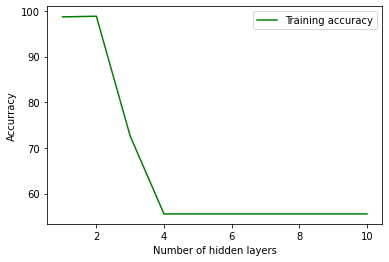

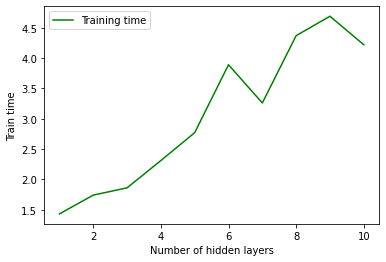

In [129]:
# Number of hidden layers
network_structure = [4, 20, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.9
epochs = 200

network_structures = [[4, 20, 2], [4, 20,20, 2],[4, 20,20,20, 2],[4,20,20,20,20,2],[4,20,20,20,20,20,2],[4,20,20,20,20,20,20,2],[4,20,20,20,20,20,20,20,2],[4,20,20,20,20,20,20,20,20,2],[4,20,20,20,20,20,20,20,20,20,2],[4,20,20,20,20,20,20,20,20,20,20,2]]

accurracy = []
train_time = []
num_hidden_layers = []

for i in range(len(network_structures)):
    network_structure = network_structures[i]
    myANN = Neural_Network(network_structure, activation)
    acc,t_time = myANN.train(X, y, learning_rate, epochs)
    accurracy.append(round(acc,2))
    train_time.append(round(t_time,2))
    num_hidden_layers.append(i+1)


plt.plot(num_hidden_layers, accurracy, 'g', label='Training accuracy')
#plt.plot(epochs, loss_val, 'b', label='validation accuracy')
#plt.title('Accuracy of of number of nodes of hidden layer')
plt.xlabel('Number of hidden layers')
plt.ylabel('Accurracy')
plt.legend()
plt.show()

plt.plot(num_hidden_layers, train_time, 'g', label='Training time')
#plt.title('Traning time of number of nodes of hidden layer')
plt.xlabel('Number of hidden layers')
plt.ylabel('Train time')
plt.legend()
plt.show()

=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.49988332 0.51250964]
 [0.50067847 0.5119675 ]
 [0.49797114 0.51565697]
 ...
 [0.50056099 0.51203643]
 [0.50098921 0.51280504]
 [0.49888063 0.51427173]]
Loss: 0.6809773752166072
stone: [[0.50920107 0.50107925]
 [0.50995467 0.50058573]
 [0.50679009 0.50481804]
 ...
 [0.50985534 0.50063348]
 [0.51041722 0.5012458 ]
 [0.50784413 0.50326099]]
Loss: 0.6805436256013403
stone: [[0.51705576 0.49143816]
 [0.51777294 0.49098708]
 [0.51420597 0.49569374]
 ...
 [0.51768974 0.4910161 ]
 [0.5183703  0.49148932]
 [0.5153865  0.49398758]]
Loss: 0.6804927395000988
stone: [[0.52367696 0.48331061]
 [0.52436218 0.4828966 ]
 [0.52043844 0.48802056]
 ...
 [0.5242934  0.48290896]
 [0.52508019 0.48325775]
 [0.52173037 0.48618421]]
Loss: 0.6806696769449524
stone: [[0.52925951 0.47645985]
 [0.5299166  0.47607826]
 [0.52567393 0.48157222]
 ...
 [0.52986082 0.47607572]
 [0.53074353 0.47631247]
 [0.5270647  0.4

Loss: 0.681708831208921
stone: [[0.56137867 0.4375447 ]
 [0.56154648 0.43768277]
 [0.54797803 0.45313652]
 ...
 [0.56188986 0.43725452]
 [0.56592389 0.43409574]
 [0.55179968 0.44861617]]
Loss: 0.6816106252853756
stone: [[0.56143478 0.43748725]
 [0.56159405 0.43763409]
 [0.54781398 0.45330931]
 ...
 [0.56194698 0.43719584]
 [0.56605602 0.43395802]
 [0.55168347 0.44873956]]
Loss: 0.681510877969538
stone: [[0.56149145 0.43742924]
 [0.56164207 0.43758496]
 [0.54764733 0.45348481]
 ...
 [0.56200471 0.43713654]
 [0.56618995 0.43381844]
 [0.5515651  0.44886521]]
Loss: 0.6814095567062672
stone: [[0.56154872 0.43737064]
 [0.56169057 0.43753536]
 [0.54747802 0.45366308]
 ...
 [0.5620631  0.4370766 ]
 [0.56632574 0.43367697]
 [0.55144453 0.44899316]]
Loss: 0.681306627586656
stone: [[0.56160661 0.43731142]
 [0.56173957 0.43748527]
 [0.547306   0.45384415]
 ...
 [0.56212216 0.43701598]
 [0.56646345 0.43353353]
 [0.55132172 0.44912346]]
Loss: 0.6812020554194229
stone: [[0.56166515 0.43725156]
 [0.56

Loss: 0.6753373966639695
stone: [[0.564666   0.434185  ]
 [0.56428392 0.43488911]
 [0.53729646 0.46430975]
 ...
 [0.56528569 0.4337748 ]
 [0.57420658 0.42549724]
 [0.54376509 0.45707415]]
Loss: 0.6751246770741249
stone: [[0.5647676  0.4340812 ]
 [0.5643667  0.4348047 ]
 [0.53693809 0.46468225]
 ...
 [0.56539181 0.43366617]
 [0.57447595 0.42521851]
 [0.5434827  0.45736932]]
Loss: 0.6749078057134367
stone: [[0.56487083 0.43397574]
 [0.56445069 0.43471907]
 [0.5365726  0.46506203]
 ...
 [0.56549967 0.43355575]
 [0.57475022 0.42493476]
 [0.54319401 0.45767097]]
Loss: 0.674686689228209
stone: [[0.56497571 0.43386859]
 [0.56453591 0.43463218]
 [0.53619982 0.46544926]
 ...
 [0.56560932 0.43344351]
 [0.57502949 0.42464589]
 [0.54289886 0.45797925]]
Loss: 0.6744612323388085
stone: [[0.56508228 0.43375971]
 [0.56462239 0.43454402]
 [0.53581958 0.46584411]
 ...
 [0.5657208  0.43332941]
 [0.57531388 0.42435179]
 [0.54259709 0.45829435]]
Loss: 0.6742313378129575
stone: [[0.56519058 0.43364907]
 [0.

Loss: 0.65033656176569
stone: [[0.57569667 0.42293261]
 [0.57291068 0.42610326]
 [0.49437979 0.50844744]
 ...
 [0.57714373 0.4216635 ]
 [0.60455123 0.39432692]
 [0.50680425 0.49522775]]
Loss: 0.6496283475853936
stone: [[0.57600464 0.42261907]
 [0.57314914 0.42586068]
 [0.49314169 0.50971254]
 ...
 [0.57748644 0.42131426]
 [0.60538902 0.39347119]
 [0.50567146 0.49638807]]
Loss: 0.6489070353158154
stone: [[0.57631866 0.42229943]
 [0.57339253 0.4256131 ]
 [0.49187943 0.51100201]
 ...
 [0.57783665 0.42095742]
 [0.60624156 0.3926006 ]
 [0.50451374 0.49757356]]
Loss: 0.6481724710297151
stone: [[0.57663883 0.42197357]
 [0.57364097 0.4253604 ]
 [0.49059268 0.51231619]
 ...
 [0.57819455 0.42059279]
 [0.60710901 0.391715  ]
 [0.50333066 0.49878464]]
Loss: 0.647424504311492
stone: [[0.57696525 0.42164138]
 [0.57389459 0.42510246]
 [0.4892811  0.51365539]
 ...
 [0.57856032 0.4202202 ]
 [0.60799152 0.39081422]
 [0.50212183 0.50002171]]
Loss: 0.6466629885473245
stone: [[0.57729803 0.42130276]
 [0.57

stone: [[0.60439916 0.39388938]
 [0.59878765 0.39989138]
 [0.37993694 0.62437147]
 ...
 [0.61430431 0.38401243]
 [0.67725027 0.32064492]
 [0.3947797  0.60884732]]
Loss: 0.5853672843687542
stone: [[0.60506238 0.39322299]
 [0.59955109 0.39912141]
 [0.37717663 0.62714502]
 ...
 [0.61536769 0.38294055]
 [0.67892149 0.31896254]
 [0.39196757 0.61167731]]
Loss: 0.5838310707774841
stone: [[0.60572521 0.39255726]
 [0.60032759 0.39833843]
 [0.37439856 0.62993543]
 ...
 [0.61644677 0.38185312]
 [0.68060117 0.3172721 ]
 [0.38913455 0.6145274 ]]
Loss: 0.582282171893629
stone: [[0.60638702 0.39189283]
 [0.60111718 0.39754243]
 [0.37160346 0.63274193]
 ...
 [0.61754145 0.38075023]
 [0.68228894 0.315574  ]
 [0.38628145 0.61739673]]
Loss: 0.5807206110913145
stone: [[0.60704717 0.39123034]
 [0.60191989 0.39673338]
 [0.3687921  0.63556376]
 ...
 [0.61865166 0.37963198]
 [0.68398441 0.31386862]
 [0.38340912 0.62028446]]
Loss: 0.5791463989403705
stone: [[0.60770498 0.39057047]
 [0.60273574 0.39591129]
 [0.

stone: [[0.60724255 0.39157334]
 [0.66527461 0.3333225 ]
 [0.20490772 0.79851732]
 ...
 [0.69974128 0.29854658]
 [0.78372658 0.2143017 ]
 [0.21451781 0.78858169]]
Loss: 0.4620127195039536
stone: [[0.60569637 0.39314283]
 [0.66654778 0.33205528]
 [0.20227995 0.80110989]
 ...
 [0.70129187 0.29700494]
 [0.78542415 0.21261776]
 [0.2118183  0.79125121]]
Loss: 0.45930863365501245
stone: [[0.60405413 0.39480892]
 [0.66781919 0.33079006]
 [0.19966776 0.80368661]
 ...
 [0.70283984 0.29546616]
 [0.78711772 0.21093804]
 [0.2091355  0.79390373]]
Loss: 0.4565785877331426
stone: [[0.60231303 0.39657441]
 [0.66908837 0.3295273 ]
 [0.19707142 0.80624727]
 ...
 [0.70438483 0.29393061]
 [0.78880718 0.20926263]
 [0.20646962 0.79653904]]
Loss: 0.4538227388957804
stone: [[0.60047027 0.39844212]
 [0.67035484 0.32826748]
 [0.19449115 0.80879163]
 ...
 [0.70592647 0.29239865]
 [0.79049241 0.20759164]
 [0.20382088 0.79915694]]
Loss: 0.45104127683715184
stone: [[0.59852301 0.40041488]
 [0.67161811 0.32701107]
 

stone: [[0.29923752 0.70147081]
 [0.72349717 0.27573343]
 [0.0814355  0.91997265]
 ...
 [0.77831358 0.22074192]
 [0.87507627 0.12389251]
 [0.08681385 0.91449817]]
Loss: 0.2708748146407305
stone: [[0.2923528  0.70836951]
 [0.7239171  0.27532536]
 [0.08015146 0.92123286]
 ...
 [0.77921298 0.21985511]
 [0.87628442 0.12269764]
 [0.08541738 0.91587299]]
Loss: 0.267906170692782
stone: [[0.28554835 0.71518663]
 [0.72431694 0.27493733]
 [0.07889273 0.92246817]
 ...
 [0.78009932 0.21898128]
 [0.87748119 0.121514  ]
 [0.08404361 0.91722545]]
Loss: 0.2649663370113264
stone: [[0.2788303  0.72191605]
 [0.72469674 0.2745693 ]
 [0.07765915 0.92367874]
 ...
 [0.78097269 0.21812031]
 [0.87866655 0.12034161]
 [0.0826924  0.9185557 ]]
Loss: 0.26205609408186586
stone: [[0.27220437 0.72855209]
 [0.72505652 0.27422122]
 [0.07645057 0.92486471]
 ...
 [0.78183323 0.21727208]
 [0.87984046 0.11918052]
 [0.08136361 0.91986387]]
Loss: 0.2591761636407964
stone: [[0.26567576 0.73508956]
 [0.72539636 0.27389304]
 [0

stone: [[0.07602873 0.92448462]
 [0.71696206 0.28283094]
 [0.04046055 0.96013863]
 ...
 [0.81121121 0.18838474]
 [0.9256049  0.07388007]
 [0.03722816 0.96332006]]
Loss: 0.15325428813970762
stone: [[0.07439876 0.92610772]
 [0.71628876 0.28351247]
 [0.04012765 0.96046425]
 ...
 [0.81151139 0.18809142]
 [0.9262209  0.07326976]
 [0.03673092 0.9638098 ]]
Loss: 0.15193086670169262
stone: [[0.0728146  0.9276851 ]
 [0.71559559 0.28421382]
 [0.03980335 0.96078145]
 ...
 [0.81180254 0.18780705]
 [0.92682856 0.07266769]
 [0.03624251 0.96429087]]
Loss: 0.15062744592299154
stone: [[0.07127478 0.92921825]
 [0.71488255 0.28493499]
 [0.03948743 0.96109041]
 ...
 [0.81208474 0.18753155]
 [0.92742801 0.07207374]
 [0.03576271 0.96476344]]
Loss: 0.14934367145140998
stone: [[0.06977785 0.93070861]
 [0.71414964 0.28567598]
 [0.03917973 0.96139132]
 ...
 [0.81235803 0.18726488]
 [0.92801934 0.07148783]
 [0.03529136 0.96522771]]
Loss: 0.14807919525216326
stone: [[0.06832243 0.93215756]
 [0.71339687 0.28643678

stone: [[0.03329537 0.96700102]
 [0.66892976 0.33118623]
 [0.03188697 0.96850768]
 ...
 [0.81686955 0.18296788]
 [0.94615092 0.05351494]
 [0.02163014 0.97868781]]
Loss: 0.11005314016913831
stone: [[0.03276281 0.96753027]
 [0.66742093 0.33270159]
 [0.03179518 0.9685968 ]
 ...
 [0.81684564 0.18299613]
 [0.94649183 0.05317687]
 [0.0213851  0.97892935]]
Loss: 0.10935022463031487
stone: [[0.03224195 0.96804788]
 [0.66589504 0.33423395]
 [0.03170636 0.968683  ]
 ...
 [0.81681627 0.18302981]
 [0.94682835 0.05284315]
 [0.02114352 0.97916747]]
Loss: 0.10865680710400576
stone: [[0.03173246 0.96855416]
 [0.66435224 0.3357832 ]
 [0.03162043 0.96876637]
 ...
 [0.81678151 0.18306884]
 [0.94716056 0.0525137 ]
 [0.02090535 0.97940224]]
Loss: 0.10797273971363046
stone: [[0.03123402 0.96904945]
 [0.66279266 0.3373492 ]
 [0.03153728 0.968847  ]
 ...
 [0.81674145 0.18311312]
 [0.94748851 0.05218846]
 [0.02067051 0.97963372]]
Loss: 0.10729787731823898
stone: [[0.03074634 0.96953402]
 [0.66121643 0.3389318 

Loss: 0.08133964107590336
stone: [[0.01474962 0.98541565]
 [0.55622393 0.44420233]
 [0.02901676 0.97128425]
 ...
 [0.80865346 0.19138521]
 [0.96052649 0.03925386]
 [0.0115386  0.98863892]]
Loss: 0.08100619170090576
stone: [[0.01457564 0.98558818]
 [0.55401439 0.44641554]
 [0.02897572 0.97132436]
 ...
 [0.80843571 0.19160559]
 [0.96069511 0.03908651]
 [0.01142352 0.98875246]]
Loss: 0.08067673849146864
stone: [[0.01440446 0.98575793]
 [0.5517992  0.44863433]
 [0.02893405 0.9713651 ]
 ...
 [0.80821651 0.1918274 ]
 [0.96086191 0.03892096]
 [0.01130978 0.98886465]]
Loss: 0.08035122360411438
stone: [[0.01423602 0.98592497]
 [0.5495786  0.45085848]
 [0.02889172 0.97140651]
 ...
 [0.80799591 0.19205057]
 [0.96102693 0.03875717]
 [0.01119739 0.98897552]]
Loss: 0.08002959005937474
stone: [[0.01407025 0.98608934]
 [0.54735279 0.45308778]
 [0.02884872 0.9714486 ]
 ...
 [0.80777397 0.19227508]
 [0.96119019 0.03859513]
 [0.01108633 0.98908509]]
Loss: 0.07971178172983162
stone: [[0.01390712 0.9862511

stone: [[0.0083587  0.99174915]
 [0.43611315 0.56441956]
 [0.02578299 0.97447694]
 ...
 [0.79597954 0.20417162]
 [0.96747351 0.03235711]
 [0.00696343 0.9931522 ]]
Loss: 0.06785676931730257
stone: [[0.00827808 0.99182898]
 [0.43387609 0.56665695]
 [0.02570253 0.97455671]
 ...
 [0.79573179 0.20442102]
 [0.967574   0.03225731]
 [0.00690107 0.99321371]]
Loss: 0.06767447679925855
stone: [[0.00819851 0.99190777]
 [0.43164307 0.56889024]
 [0.02562153 0.97463703]
 ...
 [0.79548413 0.20467032]
 [0.96767362 0.03215837]
 [0.00683941 0.99327452]]
Loss: 0.06749404243681166
stone: [[0.00811995 0.99198554]
 [0.42941423 0.5711193 ]
 [0.02554001 0.97471788]
 ...
 [0.79523657 0.2049195 ]
 [0.96777238 0.03206029]
 [0.00677843 0.99333466]]
Loss: 0.06731544122210391
stone: [[0.00804241 0.99206232]
 [0.4271897  0.57334399]
 [0.02545798 0.97479924]
 ...
 [0.79498912 0.20516856]
 [0.96787028 0.03196305]
 [0.00671813 0.99339413]]
Loss: 0.06713864853478643
stone: [[0.00796587 0.9921381 ]
 [0.42496961 0.57556419

stone: [[0.00547021 0.9946077 ]
 [0.33716465 0.66333139]
 [0.02163093 0.97859833]
 ...
 [0.78464768 0.21556587]
 [0.97140542 0.02845105]
 [0.00466413 0.99541929]]
Loss: 0.06095233815927029
stone: [[0.00542449 0.99465291]
 [0.33523055 0.66526378]
 [0.02153885 0.97868978]
 ...
 [0.78441786 0.21579672]
 [0.9714745  0.02838241]
 [0.00462677 0.99545611]]
Loss: 0.060835611027684616
stone: [[0.00537928 0.99469763]
 [0.33330466 0.66718793]
 [0.02144678 0.97878121]
 ...
 [0.78418866 0.21602692]
 [0.97154307 0.02831426]
 [0.0045898  0.99549255]]
Loss: 0.0607198963299038
stone: [[0.00533457 0.99474184]
 [0.33138704 0.66910379]
 [0.02135474 0.97887263]
 ...
 [0.7839601  0.21625648]
 [0.97161115 0.0282466 ]
 [0.00455321 0.9955286 ]]
Loss: 0.060605181676088464
stone: [[0.00529036 0.99478557]
 [0.32947771 0.67101132]
 [0.02126272 0.97896401]
 ...
 [0.78373217 0.21648538]
 [0.97167874 0.02817943]
 [0.00451701 0.99556428]]
Loss: 0.06049145485004205
stone: [[0.00524663 0.99482881]
 [0.32757673 0.6729104

stone: [[0.00385916 0.99620033]
 [0.26020169 0.7402    ]
 [0.01768183 0.98251998]
 ...
 [0.77521578 0.22503233]
 [0.97403502 0.02583705]
 [0.00333383 0.99672982]]
Loss: 0.05663083772712376
stone: [[0.00383039 0.99622876]
 [0.25865017 0.74174909]
 [0.0175963  0.9826049 ]
 ...
 [0.77501941 0.22522927]
 [0.97408641 0.02578596]
 [0.00330985 0.99675343]]
Loss: 0.05654890181657758
stone: [[0.00380191 0.9962569 ]
 [0.25710741 0.74328942]
 [0.01751101 0.98268957]
 ...
 [0.7748239  0.22542533]
 [0.97413747 0.02573518]
 [0.00328611 0.99677681]]
Loss: 0.056467566046884216
stone: [[0.00377371 0.99628477]
 [0.2555734  0.744821  ]
 [0.01742598 0.98277399]
 ...
 [0.77462926 0.22562052]
 [0.97418822 0.02568471]
 [0.00326259 0.99679996]]
Loss: 0.05638682356616688
stone: [[0.00374578 0.99631236]
 [0.25404812 0.74634384]
 [0.0173412  0.98285816]
 ...
 [0.77443549 0.22581483]
 [0.97423866 0.02563455]
 [0.00323929 0.9968229 ]]
Loss: 0.056306667610372146
stone: [[0.00371812 0.99633968]
 [0.25253156 0.747857

Loss: 0.05351334112760207
stone: [[0.00280259 0.99724384]
 [0.19874859 0.8015439 ]
 [0.01410766 0.98606708]
 ...
 [0.76726698 0.23299868]
 [0.97607064 0.02381223]
 [0.00244958 0.99760004]]
Loss: 0.05345234298713532
stone: [[0.00278374 0.99726244]
 [0.19756759 0.80272257]
 [0.01403505 0.9861391 ]
 ...
 [0.76711141 0.23315448]
 [0.97611027 0.0237728 ]
 [0.00243375 0.99761561]]
Loss: 0.053391712475894824
stone: [[0.00276507 0.99728088]
 [0.19639409 0.80389374]
 [0.01396275 0.98621082]
 ...
 [0.76695676 0.23330936]
 [0.97614968 0.02373357]
 [0.00241806 0.99763104]]
Loss: 0.053331445653714234
stone: [[0.00274656 0.99729915]
 [0.19522805 0.80505745]
 [0.01389075 0.98628223]
 ...
 [0.76680302 0.2334633 ]
 [0.97618889 0.02369456]
 [0.00240251 0.99764634]]
Loss: 0.05327153862865431
stone: [[0.00272821 0.99731726]
 [0.19406945 0.80621374]
 [0.01381906 0.98635333]
 ...
 [0.76665021 0.23361633]
 [0.97622789 0.02365575]
 [0.00238709 0.99766151]]
Loss: 0.053211987556381124
stone: [[0.00271003 0.9973

Loss: 0.05016916661983157
stone: [[0.00185881 0.99817495]
 [0.13590647 0.8642535 ]
 [0.01001105 0.99012729]
 ...
 [0.75900111 0.24126836]
 [0.97827391 0.02161909]
 [0.00165448 0.99838154]]
Loss: 0.0501256158134669
stone: [[0.00184785 0.99818575]
 [0.13513302 0.86502524]
 [0.00995748 0.99018034]
 ...
 [0.75890149 0.2413679 ]
 [0.97830283 0.02159029]
 [0.00164522 0.99839063]]
Loss: 0.05008225456605446
stone: [[0.00183698 0.99819647]
 [0.13436461 0.86579197]
 [0.00990417 0.99023312]
 ...
 [0.75880264 0.24146666]
 [0.97833162 0.02156162]
 [0.00163603 0.99839966]]
Loss: 0.050039081080532524
stone: [[0.00182619 0.9982071 ]
 [0.13360119 0.86655372]
 [0.00985113 0.99028563]
 ...
 [0.75870455 0.24156466]
 [0.97836029 0.02153308]
 [0.0016269  0.99840861]]
Loss: 0.04999609358098666
stone: [[0.00181548 0.99821766]
 [0.13284272 0.86731052]
 [0.00979836 0.99033788]
 ...
 [0.75860721 0.2416619 ]
 [0.97838883 0.02150465]
 [0.00161785 0.9984175 ]]
Loss: 0.0499532903123883
stone: [[0.00180486 0.99822813

stone: [[0.00143957 0.99858809]
 [0.10561057 0.89448327]
 [0.0078521  0.99226368]
 ...
 [0.75521861 0.2450441 ]
 [0.97946174 0.02043599]
 [0.00129939 0.99873008]]
Loss: 0.048337863463440135
stone: [[0.00143174 0.9985958 ]
 [0.10503141 0.89506119]
 [0.00780964 0.99230566]
 ...
 [0.7551494  0.2451131 ]
 [0.97948576 0.02041206]
 [0.00129275 0.9987366 ]]
Loss: 0.04830145474338667
stone: [[0.00142398 0.99860345]
 [0.10445589 0.89563547]
 [0.00776741 0.99234743]
 ...
 [0.75508078 0.24518151]
 [0.97950968 0.02038823]
 [0.00128615 0.99874307]]
Loss: 0.048265171306329985
stone: [[0.00141626 0.99861105]
 [0.10388398 0.89620615]
 [0.0077254  0.99238897]
 ...
 [0.75501273 0.24524935]
 [0.97953352 0.02036448]
 [0.0012796  0.9987495 ]]
Loss: 0.04822901210036611
stone: [[0.0014086  0.99861859]
 [0.10331567 0.89677325]
 [0.00768361 0.99243028]
 ...
 [0.75494525 0.24531661]
 [0.97955726 0.02034083]
 [0.00127309 0.99875588]]
Loss: 0.04819297608553811
stone: [[0.001401   0.99862608]
 [0.10275091 0.897336

Loss: 0.04637469577800894
stone: [[1.05424954e-03 9.98967416e-01]
 [7.64896513e-02 9.23544350e-01]
 [5.67031898e-03 9.94419519e-01]
 ...
 [7.51949338e-01 2.48297718e-01]
 [9.80756624e-01 1.91456920e-02]
 [9.71043909e-04 9.99052017e-01]]
Loss: 0.04634420932801236
stone: [[1.04904993e-03 9.98972532e-01]
 [7.60883034e-02 9.23944928e-01]
 [5.63970522e-03 9.94449744e-01]
 ...
 [7.51907592e-01 2.48339160e-01]
 [9.80775971e-01 1.91264103e-02]
 [9.66593330e-04 9.99056378e-01]]
Loss: 0.04631380254171386
stone: [[1.04388380e-03 9.98977614e-01]
 [7.56893199e-02 9.24343149e-01]
 [5.60926195e-03 9.94479799e-01]
 ...
 [7.51866184e-01 2.48380264e-01]
 [9.80795252e-01 1.91071931e-02]
 [9.62170757e-04 9.99060711e-01]]
Loss: 0.04628347487373248
stone: [[1.03875089e-03 9.98982664e-01]
 [7.52926841e-02 9.24739028e-01]
 [5.57898832e-03 9.94509685e-01]
 ...
 [7.51825110e-01 2.48421033e-01]
 [9.80814469e-01 1.90880400e-02]
 [9.57775967e-04 9.99065017e-01]]
Loss: 0.04625322578456775
stone: [[1.03365091e-03 9.

stone: [[8.57850532e-04 9.99160559e-01]
 [6.11780352e-02 9.38828319e-01]
 [4.49789351e-03 9.95576462e-01]
 ...
 [7.50416023e-01 2.49817209e-01]
 [9.81534084e-01 1.83707466e-02]
 [8.02423819e-04 9.99217164e-01]]
Loss: 0.04510216033867132
stone: [[8.53874814e-04 9.99164467e-01]
 [6.08649403e-02 9.39140891e-01]
 [4.47388857e-03 9.95600137e-01]
 ...
 [7.50385695e-01 2.49847200e-01]
 [9.81550935e-01 1.83539485e-02]
 [7.98998111e-04 9.99220517e-01]]
Loss: 0.04507473260197385
stone: [[8.49922965e-04 9.99168352e-01]
 [6.05536067e-02 9.39451708e-01]
 [4.45002055e-03 9.95623677e-01]
 ...
 [7.50355562e-01 2.49876995e-01]
 [9.81567735e-01 1.83372018e-02]
 [7.95592421e-04 9.99223851e-01]]
Loss: 0.04504736529350196
stone: [[8.45994804e-04 9.99172213e-01]
 [6.02440229e-02 9.39760779e-01]
 [4.42628870e-03 9.95647082e-01]
 ...
 [7.50325621e-01 2.49906597e-01]
 [9.81584483e-01 1.83205062e-02]
 [7.92206596e-04 9.99227166e-01]]
Loss: 0.04502005807183456
stone: [[8.42090154e-04 9.99176051e-01]
 [5.99361772

Loss: 0.044176083408738596
stone: [[7.28562308e-04 9.99287604e-01]
 [5.09381510e-02 9.49052281e-01]
 [3.71494780e-03 9.96348386e-01]
 ...
 [7.49427200e-01 2.50793575e-01]
 [9.82109918e-01 1.77966923e-02]
 [6.90712275e-04 9.99326490e-01]]
Loss: 0.0441505888074878
stone: [[7.25342791e-04 9.99290767e-01]
 [5.06817322e-02 9.49308336e-01]
 [3.69543379e-03 9.96367618e-01]
 ...
 [7.49402167e-01 2.50818254e-01]
 [9.82125060e-01 1.77815967e-02]
 [6.87921558e-04 9.99329220e-01]]
Loss: 0.04412514455941005
stone: [[7.22141558e-04 9.99293911e-01]
 [5.04267080e-02 9.49562999e-01]
 [3.67603225e-03 9.96386739e-01]
 ...
 [7.49377233e-01 2.50842834e-01]
 [9.82140158e-01 1.77665445e-02]
 [6.85146221e-04 9.99331935e-01]]
Loss: 0.04409975042647739
stone: [[7.18958480e-04 9.99297038e-01]
 [5.01730693e-02 9.49816281e-01]
 [3.65674257e-03 9.96405749e-01]
 ...
 [7.49352397e-01 2.50867316e-01]
 [9.82155213e-01 1.77515353e-02]
 [6.82386156e-04 9.99334635e-01]]
Loss: 0.04407440617306671
stone: [[7.15793426e-04 9.

stone: [[6.00081820e-04 9.99413757e-01]
 [4.06644617e-02 9.59312993e-01]
 [2.93963769e-03 9.97112190e-01]
 ...
 [7.48368013e-01 2.51836591e-01]
 [9.82750953e-01 1.71575962e-02]
 [5.78941255e-04 9.99435794e-01]]
Loss: 0.04305219304866547
stone: [[5.97569874e-04 9.99416222e-01]
 [4.04629670e-02 9.59514271e-01]
 [2.92459979e-03 9.97126998e-01]
 ...
 [7.48345327e-01 2.51858913e-01]
 [9.82764321e-01 1.71442684e-02]
 [5.76746952e-04 9.99437939e-01]]
Loss: 0.04302880092891808
stone: [[5.95071293e-04 9.99418674e-01]
 [4.02625303e-02 9.59714493e-01]
 [2.90964866e-03 9.97141721e-01]
 ...
 [7.48322648e-01 2.51881228e-01]
 [9.82777653e-01 1.71309761e-02]
 [5.74563943e-04 9.99440073e-01]]
Loss: 0.04300545034722872
stone: [[5.92585985e-04 9.99421113e-01]
 [4.00631453e-02 9.59913666e-01]
 [2.89478379e-03 9.97156359e-01]
 ...
 [7.48299974e-01 2.51903538e-01]
 [9.82790950e-01 1.71177192e-02]
 [5.72392154e-04 9.99442196e-01]]
Loss: 0.042982141152981844
stone: [[5.90113864e-04 9.99423539e-01]
 [3.9864805

stone: [[0.55782373 0.44297272]
 [0.55555328 0.44514191]
 [0.54505014 0.44794726]
 ...
 [0.55628094 0.44475463]
 [0.55981934 0.44458464]
 [0.54769325 0.44649543]]
Loss: 0.6845411364623014
stone: [[0.55792935 0.44286988]
 [0.55558326 0.44511193]
 [0.54479544 0.44818921]
 ...
 [0.55633497 0.44470205]
 [0.55998815 0.44442395]
 [0.54750898 0.44666585]]
Loss: 0.6844081883954253
stone: [[0.55803614 0.44276652]
 [0.55561271 0.44508283]
 [0.54453309 0.44843778]
 ...
 [0.55638912 0.44464984]
 [0.56016023 0.44426102]
 [0.54731822 0.44684193]]
Loss: 0.6842716658351183
stone: [[0.55814442 0.44266222]
 [0.55564187 0.44505428]
 [0.544263   0.44869292]
 ...
 [0.55644367 0.44459762]
 [0.560336   0.44409535]
 [0.54712094 0.44702359]]
Loss: 0.6841314966115615
stone: [[0.55825446 0.44255665]
 [0.55567095 0.44502602]
 [0.543985   0.4489547 ]
 ...
 [0.55649885 0.4445451 ]
 [0.56051584 0.44392648]
 [0.54691703 0.44721085]]
Loss: 0.6839875741799322
stone: [[0.55836646 0.44244958]
 [0.55570008 0.44499786]
 [0

stone: [[0.57554318 0.42664114]
 [0.56021852 0.44087947]
 [0.4909937  0.49676789]
 ...
 [0.56653554 0.43542977]
 [0.59379888 0.41329011]
 [0.50213068 0.48743208]]
Loss: 0.6570107821307213
stone: [[0.57624411 0.42599293]
 [0.56044796 0.44067225]
 [0.48882658 0.49875453]
 ...
 [0.56701648 0.43499113]
 [0.59516692 0.41201111]
 [0.50013978 0.4892535 ]]
Loss: 0.6558986045016749
stone: [[0.57697069 0.42532027]
 [0.56069037 0.44045316]
 [0.48658694 0.50081123]
 ...
 [0.56752093 0.43453056]
 [0.59658089 0.41068744]
 [0.49807266 0.49114766]]
Loss: 0.6547488386544832
stone: [[0.57772368 0.42462239]
 [0.56094652 0.44022144]
 [0.4842731  0.50293979]
 ...
 [0.56805003 0.43404693]
 [0.59804175 0.40931808]
 [0.49592719 0.4931168 ]]
Loss: 0.6535606788715879
stone: [[0.57850384 0.42389849]
 [0.56121722 0.43997633]
 [0.48188344 0.50514204]
 ...
 [0.56860496 0.43353909]
 [0.59955039 0.40790204]
 [0.49370129 0.49516311]]
Loss: 0.652333347125913
stone: [[0.57931189 0.4231478 ]
 [0.56150334 0.439717  ]
 [0.

stone: [[0.63986345 0.36272933]
 [0.63615193 0.36759452]
 [0.21620432 0.76851773]
 ...
 [0.67902634 0.32616851]
 [0.76369323 0.24502729]
 [0.22611566 0.75933704]]
Loss: 0.48893174965367525
stone: [[0.6385052  0.36393494]
 [0.63839204 0.36535587]
 [0.21130594 0.77366321]
 ...
 [0.6818894  0.32328287]
 [0.76693848 0.241671  ]
 [0.22106912 0.76460374]]
Loss: 0.4839559817221558
stone: [[0.63686728 0.36541294]
 [0.640638   0.36310852]
 [0.20644787 0.77877379]
 ...
 [0.68475665 0.32038976]
 [0.77018421 0.23831155]
 [0.21606316 0.76983581]]
Loss: 0.4788626294206218
stone: [[0.63492886 0.36718406]
 [0.64288697 0.36085533]
 [0.20163185 0.78384721]
 ...
 [0.68762621 0.31749114]
 [0.77343017 0.23494937]
 [0.21109961 0.77503094]]
Loss: 0.473651840039287
stone: [[0.63266782 0.36927033]
 [0.64513595 0.35859931]
 [0.19685969 0.7888812 ]
 ...
 [0.69049614 0.31458907]
 [0.77667601 0.23158503]
 [0.20618029 0.78018684]]
Loss: 0.46832434832778136
stone: [[0.63006078 0.37169503]
 [0.64738179 0.35634367]
 [

Loss: 0.22883661697767768
stone: [[0.19366858 0.80181159]
 [0.69300472 0.308982  ]
 [0.06454583 0.93079771]
 ...
 [0.77901508 0.22362591]
 [0.89095305 0.11252799]
 [0.0644657  0.93089604]]
Loss: 0.22383789696645728
stone: [[0.1833611  0.81220682]
 [0.69250044 0.30943536]
 [0.0629663  0.93252287]
 ...
 [0.78023307 0.22235107]
 [0.89306177 0.11033149]
 [0.06251945 0.93298561]]
Loss: 0.21896431142833228
stone: [[0.17362393 0.82203727]
 [0.69191147 0.30997425]
 [0.06145465 0.93417455]
 ...
 [0.78140868 0.22111985]
 [0.89512721 0.1081805 ]
 [0.06064214 0.93500144]]
Loss: 0.21421598951057588
stone: [[0.16444117 0.83131754]
 [0.69123853 0.31059797]
 [0.06000823 0.93575552]
 ...
 [0.78254292 0.21993125]
 [0.89714954 0.10607481]
 [0.05883179 0.93694561]]
Loss: 0.2095926511837984
stone: [[0.15579351 0.8400657 ]
 [0.69048227 0.3113059 ]
 [0.05862443 0.93726854]
 ...
 [0.78363671 0.21878435]
 [0.89912898 0.10401418]
 [0.05708638 0.93882027]]
Loss: 0.2050936447497723
stone: [[0.14765917 0.84830249]

stone: [[0.02949869 0.9691242 ]
 [0.59506806 0.40546493]
 [0.0349601  0.96344141]
 ...
 [0.79981172 0.20132118]
 [0.94863041 0.05263622]
 [0.02022964 0.97839217]]
Loss: 0.10217581123778387
stone: [[0.02859798 0.97005841]
 [0.59124057 0.40927435]
 [0.0348153  0.96361368]
 ...
 [0.79966297 0.20145216]
 [0.94931176 0.05193117]
 [0.01977428 0.9788794 ]]
Loss: 0.10087626540551269
stone: [[0.02773467 0.97095415]
 [0.58736192 0.41313543]
 [0.03467903 0.96377664]
 ...
 [0.79949582 0.20160197]
 [0.94997521 0.0512447 ]
 [0.01933103 0.97935358]]
Loss: 0.09961379466470195
stone: [[0.02690678 0.97181345]
 [0.58343411 0.41704617]
 [0.03455051 0.9639311 ]
 ...
 [0.79931095 0.20176993]
 [0.9506213  0.05057625]
 [0.01889948 0.97981515]]
Loss: 0.0983871838021575
stone: [[0.02611247 0.97263819]
 [0.57945919 0.42100451]
 [0.03442898 0.96407786]
 ...
 [0.79910901 0.20195536]
 [0.95125058 0.04992524]
 [0.01847924 0.98026455]]
Loss: 0.09719525943682912
stone: [[0.02535    0.97343016]
 [0.57543921 0.42500839]

stone: [[0.00948865 0.98997931]
 [0.40023103 0.59989869]
 [0.02985172 0.96932672]
 ...
 [0.78242744 0.21820153]
 [0.96738651 0.03325098]
 [0.00786548 0.9915884 ]]
Loss: 0.06789300966201599
stone: [[0.00929399 0.99018349]
 [0.39596135 0.60416661]
 [0.02969681 0.96949255]
 ...
 [0.78191883 0.2187036 ]
 [0.96762765 0.03300214]
 [0.00771648 0.99174716]]
Loss: 0.06748044227140002
stone: [[0.00910464 0.99038214]
 [0.39171425 0.60841217]
 [0.02954003 0.96966009]
 ...
 [0.78140835 0.21920768]
 [0.96786423 0.03275802]
 [0.00757097 0.9919022 ]]
Loss: 0.06707663480380945
stone: [[0.00892042 0.99057545]
 [0.38749054 0.61263452]
 [0.02938147 0.96982923]
 ...
 [0.7808961  0.21971368]
 [0.9680964  0.03251847]
 [0.00742886 0.99205362]]
Loss: 0.06668133387987796
stone: [[0.00874115 0.99076359]
 [0.38329101 0.61683289]
 [0.02922124 0.96999988]
 ...
 [0.78038219 0.22022145]
 [0.96832425 0.03228338]
 [0.00729007 0.99220152]]
Loss: 0.06629429503960951
stone: [[0.00856665 0.99094674]
 [0.3791164  0.62100651

stone: [[0.00376426 0.99600085]
 [0.21845681 0.78171984]
 [0.02101391 0.97856079]
 ...
 [0.75545612 0.24497466]
 [0.97581074 0.02456918]
 [0.00326492 0.99649535]]
Loss: 0.054191039733251865
stone: [[0.00370701 0.99606129]
 [0.21584461 0.78433373]
 [0.02085176 0.97872801]
 ...
 [0.75495989 0.24546927]
 [0.97591771 0.02445914]
 [0.00321709 0.99654648]]
Loss: 0.05402829357347944
stone: [[0.00365091 0.99612054]
 [0.21326465 0.78691535]
 [0.02069041 0.97889436]
 ...
 [0.75446556 0.24596203]
 [0.97602332 0.02435051]
 [0.00317019 0.99659662]]
Loss: 0.05386794772601877
stone: [[0.00359591 0.99617861]
 [0.21071672 0.78946493]
 [0.02052987 0.97905982]
 ...
 [0.75397319 0.24645291]
 [0.97612759 0.02424325]
 [0.00312419 0.9966458 ]]
Loss: 0.05370995174281587
stone: [[0.00354201 0.99623555]
 [0.20820059 0.7919827 ]
 [0.02037015 0.9792244 ]
 ...
 [0.75348281 0.24694184]
 [0.97623055 0.02413736]
 [0.00307909 0.99669402]]
Loss: 0.0535542564673085
stone: [[0.00348917 0.99629137]
 [0.205716   0.7944689 

Loss: 0.04749443561750296
stone: [[0.0016762  0.99821061]
 [0.10940355 0.89082622]
 [0.01284312 0.98694049]
 ...
 [0.73023123 0.27018853]
 [0.9804732  0.01977972]
 [0.00150592 0.99837911]]
Loss: 0.04741616397577985
stone: [[0.00165641 0.99823162]
 [0.10823317 0.89199669]
 [0.01273361 0.98705226]
 ...
 [0.72990154 0.27051913]
 [0.98052922 0.01972227]
 [0.00148909 0.99839718]]
Loss: 0.04733868409185113
stone: [[0.00163692 0.99825231]
 [0.10707845 0.89315147]
 [0.01262491 0.98716319]
 ...
 [0.72957495 0.27084666]
 [0.98058474 0.01966534]
 [0.00147251 0.99841498]]
Loss: 0.04726198297663465
stone: [[0.00161773 0.99827268]
 [0.10593915 0.89429081]
 [0.01251702 0.98727327]
 ...
 [0.72925145 0.27117112]
 [0.98063977 0.01960891]
 [0.00145619 0.99843251]]
Loss: 0.04718604790702378
stone: [[0.00159884 0.99829274]
 [0.10481506 0.89541492]
 [0.01240994 0.98738253]
 ...
 [0.72893103 0.27149253]
 [0.98069431 0.01955299]
 [0.00144012 0.99844977]]
Loss: 0.04711086641951279
stone: [[0.00158024 0.9983124

stone: [[8.47952202e-04 9.99091579e-01]
 [5.81311246e-02 9.42076425e-01]
 [7.29783274e-03 9.92585554e-01]
 ...
 [7.14715182e-01 2.85797345e-01]
 [9.83282447e-01 1.69025660e-02]
 [7.95713013e-04 9.99142719e-01]]
Loss: 0.043624639164099505
stone: [[8.39902474e-04 9.99100163e-01]
 [5.76061430e-02 9.42600789e-01]
 [7.23193935e-03 9.92652470e-01]
 ...
 [7.14548201e-01 2.85966108e-01]
 [9.83316820e-01 1.68674152e-02]
 [7.88716057e-04 9.99150255e-01]]
Loss: 0.04357917459247836
stone: [[8.31953839e-04 9.99108639e-01]
 [5.70871110e-02 9.43119199e-01]
 [7.16660002e-03 9.92718821e-01]
 ...
 [7.14383024e-01 2.86133072e-01]
 [9.83350973e-01 1.68324921e-02]
 [7.81804103e-04 9.99157700e-01]]
Loss: 0.04353401506425729
stone: [[8.24104721e-04 9.99117010e-01]
 [5.65739432e-02 9.43631740e-01]
 [7.10181119e-03 9.92784609e-01]
 ...
 [7.14219628e-01 2.86298260e-01]
 [9.83384906e-01 1.67977940e-02]
 [7.74975843e-04 9.99165055e-01]]
Loss: 0.04348915660466216
stone: [[8.16353578e-04 9.99125277e-01]
 [5.6066555

Loss: 0.04186761855209825
stone: [[5.67128616e-04 9.99391383e-01]
 [3.93717371e-02 9.60805333e-01]
 [4.83253621e-03 9.95087176e-01]
 ...
 [7.08672631e-01 2.91922380e-01]
 [9.84640037e-01 1.55155728e-02]
 [5.49478716e-04 9.99408112e-01]]
Loss: 0.04183252082147995
stone: [[5.62404379e-04 9.99396434e-01]
 [3.90470570e-02 9.61129303e-01]
 [4.78822616e-03 9.95132110e-01]
 ...
 [7.08565488e-01 2.92031359e-01]
 [9.84666423e-01 1.54886459e-02]
 [5.45289167e-04 9.99412630e-01]]
Loss: 0.04179760072354047
stone: [[5.57732153e-04 9.99401429e-01]
 [3.87256053e-02 9.61450045e-01]
 [4.74432156e-03 9.95176632e-01]
 ...
 [7.08459234e-01 2.92139446e-01]
 [9.84692667e-01 1.54618642e-02]
 [5.41143787e-04 9.99417102e-01]]
Loss: 0.041762856247593676
stone: [[5.53111222e-04 9.99406369e-01]
 [3.84073413e-02 9.61767599e-01]
 [4.70081934e-03 9.95220745e-01]
 ...
 [7.08353855e-01 2.92246657e-01]
 [9.84718772e-01 1.54352266e-02]
 [5.37041980e-04 9.99421526e-01]]
Loss: 0.04172828541330663
stone: [[5.48540881e-04 9

stone: [[4.28587795e-04 9.99539603e-01]
 [2.96931891e-02 9.70459169e-01]
 [3.50334106e-03 9.96434891e-01]
 ...
 [7.05353885e-01 2.95303658e-01]
 [9.85486830e-01 1.46521334e-02]
 [4.25672940e-04 9.99541694e-01]]
Loss: 0.040703279263728034
stone: [[4.25324282e-04 9.99543098e-01]
 [2.94609873e-02 9.70690677e-01]
 [3.47146064e-03 9.96467214e-01]
 ...
 [7.05269231e-01 2.95390029e-01]
 [9.85508910e-01 1.46296415e-02]
 [4.22729215e-04 9.99544871e-01]]
Loss: 0.04067350156523973
stone: [[4.22093455e-04 9.99546557e-01]
 [2.92309069e-02 9.70920064e-01]
 [3.43988447e-03 9.96499230e-01]
 ...
 [7.05184988e-01 2.95475984e-01]
 [9.85530884e-01 1.46072597e-02]
 [4.19813523e-04 9.99548018e-01]]
Loss: 0.04064384531950776
stone: [[4.18894902e-04 9.99549983e-01]
 [2.90029241e-02 9.71147356e-01]
 [3.40860988e-03 9.96530939e-01]
 ...
 [7.05101146e-01 2.95561532e-01]
 [9.85552751e-01 1.45849871e-02]
 [4.16925517e-04 9.99551136e-01]]
Loss: 0.040614309362343747
stone: [[4.15728219e-04 9.99553374e-01]
 [2.877701

stone: [[2.98613727e-04 9.99678902e-01]
 [2.02796513e-02 9.79839760e-01]
 [2.23311212e-03 9.97723117e-01]
 ...
 [7.01431922e-01 2.99304430e-01]
 [9.86472699e-01 1.36492523e-02]
 [3.07089331e-04 9.99669716e-01]]
Loss: 0.03934386681766117
stone: [[2.96580798e-04 9.99681083e-01]
 [2.01296824e-02 9.79989114e-01]
 [2.21346865e-03 9.97743049e-01]
 ...
 [7.01356221e-01 2.99381542e-01]
 [9.86490192e-01 1.36314851e-02]
 [3.05208375e-04 9.99671747e-01]]
Loss: 0.039319023592428094
stone: [[2.94565858e-04 9.99683245e-01]
 [1.99809596e-02 9.80137223e-01]
 [2.19401473e-03 9.97762789e-01]
 ...
 [7.01280491e-01 2.99458674e-01]
 [9.86507607e-01 1.36137991e-02]
 [3.03343104e-04 9.99673761e-01]]
Loss: 0.03929426053442928
stone: [[2.92568706e-04 9.99685388e-01]
 [1.98334707e-02 9.80284100e-01]
 [2.17474851e-03 9.97782339e-01]
 ...
 [7.01204726e-01 2.99535834e-01]
 [9.86524944e-01 1.35961941e-02]
 [3.01493346e-04 9.99675759e-01]]
Loss: 0.0392695770890276
stone: [[2.90589144e-04 9.99687511e-01]
 [1.96872033

stone: [[2.14272086e-04 9.99769448e-01]
 [1.39951648e-02 9.86095421e-01]
 [1.43772492e-03 9.98530707e-01]
 ...
 [6.97398289e-01 3.03400363e-01]
 [9.87271700e-01 1.28390042e-02]
 [2.28117731e-04 9.99754986e-01]]
Loss: 0.038169250639612656
stone: [[2.12947531e-04 9.99770871e-01]
 [1.38956132e-02 9.86194461e-01]
 [1.42567250e-03 9.98542955e-01]
 ...
 [6.97312925e-01 3.03486747e-01]
 [9.87285609e-01 1.28249229e-02]
 [2.26859960e-04 9.99756344e-01]]
Loss: 0.038147927438033614
stone: [[2.11633435e-04 9.99772283e-01]
 [1.37968296e-02 9.86292735e-01]
 [1.41373296e-03 9.98555089e-01]
 ...
 [6.97227214e-01 3.03573469e-01]
 [9.87299457e-01 1.28109057e-02]
 [2.25611503e-04 9.99757692e-01]]
Loss: 0.03812666411376177
stone: [[2.10329695e-04 9.99773684e-01]
 [1.36988070e-02 9.86390250e-01]
 [1.40190515e-03 9.98567110e-01]
 ...
 [6.97141151e-01 3.03660536e-01]
 [9.87313242e-01 1.27969523e-02]
 [2.24372273e-04 9.99759030e-01]]
Loss: 0.03810546039602185
stone: [[2.09036206e-04 9.99775074e-01]
 [1.360153

Loss: 0.03734155729229786
stone: [[1.66574055e-04 9.99820717e-01]
 [1.04035449e-02 9.89667313e-01]
 [1.01676780e-03 9.98958814e-01]
 ...
 [6.93449222e-01 3.07385507e-01]
 [9.87805101e-01 1.22996969e-02]
 [1.82400196e-04 9.99804337e-01]]
Loss: 0.03732250238341011
stone: [[1.65611528e-04 9.99821752e-01]
 [1.03310616e-02 9.89739369e-01]
 [1.00859233e-03 9.98967136e-01]
 ...
 [6.93344408e-01 3.07491014e-01]
 [9.87816605e-01 1.22880813e-02]
 [1.81467961e-04 9.99805343e-01]]
Loss: 0.03730349885137552
stone: [[1.64655982e-04 9.99822779e-01]
 [1.02591107e-02 9.89810896e-01]
 [1.00049056e-03 9.98975383e-01]
 ...
 [6.93239010e-01 3.07597098e-01]
 [9.87828057e-01 1.22765192e-02]
 [1.80542081e-04 9.99806342e-01]]
Loss: 0.037284546544165624
stone: [[1.63707352e-04 9.99823799e-01]
 [1.01876879e-02 9.89881896e-01]
 [9.92461782e-04 9.98983556e-01]
 ...
 [6.93133021e-01 3.07703764e-01]
 [9.87839457e-01 1.22650102e-02]
 [1.79622501e-04 9.99807335e-01]]
Loss: 0.0372656453118763
stone: [[1.62765576e-04 9.

stone: [[1.35902658e-04 9.99853710e-01]
 [8.10021405e-03 9.91956486e-01]
 [7.64079249e-04 9.99216202e-01]
 ...
 [6.89267621e-01 3.11587431e-01]
 [9.88187862e-01 1.19136102e-02]
 [1.52485335e-04 9.99836617e-01]]
Loss: 0.036669687906960784
stone: [[1.35155705e-04 9.99854513e-01]
 [8.04438088e-03 9.92011960e-01]
 [7.58146243e-04 9.99222250e-01]
 ...
 [6.89138232e-01 3.11717253e-01]
 [9.88197619e-01 1.19037794e-02]
 [1.51751273e-04 9.99837409e-01]]
Loss: 0.03665244712069322
stone: [[1.34413819e-04 9.99855312e-01]
 [7.98894439e-03 9.92067039e-01]
 [7.52264910e-04 9.99228246e-01]
 ...
 [6.89008057e-01 3.11847854e-01]
 [9.88207331e-01 1.18939942e-02]
 [1.51021924e-04 9.99838195e-01]]
Loss: 0.03663525325885297
stone: [[1.33676957e-04 9.99856105e-01]
 [7.93390147e-03 9.92121727e-01]
 [7.46434749e-04 9.99234190e-01]
 ...
 [6.88877091e-01 3.11979240e-01]
 [9.88216998e-01 1.18842545e-02]
 [1.50297250e-04 9.99838977e-01]]
Loss: 0.03661810622753956
stone: [[1.32945076e-04 9.99856892e-01]
 [7.8792489

stone: [[1.06752943e-04 9.99885085e-01]
 [5.93996317e-03 9.94102258e-01]
 [5.41888809e-04 9.99442921e-01]
 ...
 [6.82588863e-01 3.18279233e-01]
 [9.88585255e-01 1.15136495e-02]
 [1.23638441e-04 9.99867730e-01]]
Loss: 0.03593909470852784
stone: [[1.06196822e-04 9.99885683e-01]
 [5.89925074e-03 9.94142686e-01]
 [5.37853964e-04 9.99447043e-01]
 ...
 [6.82418678e-01 3.18449566e-01]
 [9.88593181e-01 1.15056820e-02]
 [1.23084135e-04 9.99868328e-01]]
Loss: 0.03592388311766782
stone: [[1.05644200e-04 9.99886278e-01]
 [5.85881902e-03 9.94182835e-01]
 [5.33852817e-04 9.99451130e-01]
 ...
 [6.82247462e-01 3.18620924e-01]
 [9.88601071e-01 1.14977517e-02]
 [1.22533173e-04 9.99868922e-01]]
Loss: 0.035908714869571506
stone: [[1.05095049e-04 9.99886870e-01]
 [5.81866594e-03 9.94222706e-01]
 [5.29885058e-04 9.99455183e-01]
 ...
 [6.82075212e-01 3.18793312e-01]
 [9.88608923e-01 1.14898585e-02]
 [1.21985529e-04 9.99869512e-01]]
Loss: 0.03589358989152801
stone: [[1.04549341e-04 9.99887457e-01]
 [5.7787894

stone: [[8.83092263e-05 9.99904946e-01]
 [4.60553137e-03 9.95427133e-01]
 [4.12818438e-04 9.99574873e-01]
 ...
 [6.75566010e-01 3.25303913e-01]
 [9.88855415e-01 1.12422953e-02]
 [1.05179010e-04 9.99887631e-01]]
Loss: 0.03540455854512556
stone: [[8.78661279e-05 9.99905423e-01]
 [4.57395068e-03 9.95458482e-01]
 [4.09845559e-04 9.99577915e-01]
 ...
 [6.75354316e-01 3.25515557e-01]
 [9.88862095e-01 1.12355915e-02]
 [1.04733647e-04 9.99888111e-01]]
Loss: 0.035390900987455225
stone: [[8.74256672e-05 9.99905897e-01]
 [4.54258456e-03 9.95489618e-01]
 [4.06896722e-04 9.99580932e-01]
 ...
 [6.75141406e-01 3.25728412e-01]
 [9.88868744e-01 1.12289188e-02]
 [1.04290849e-04 9.99888589e-01]]
Loss: 0.03537728394910349
stone: [[8.69878247e-05 9.99906369e-01]
 [4.51143150e-03 9.95520542e-01]
 [4.03971715e-04 9.99583926e-01]
 ...
 [6.74927276e-01 3.25942483e-01]
 [9.88875363e-01 1.12222771e-02]
 [1.03850597e-04 9.99889063e-01]]
Loss: 0.035363707347105255
stone: [[8.65525813e-05 9.99906838e-01]
 [4.480489

stone: [[7.38906515e-05 9.99920477e-01]
 [3.59366221e-03 9.96431451e-01]
 [3.19526993e-04 9.99670412e-01]
 ...
 [6.67146552e-01 3.33718629e-01]
 [9.89077619e-01 1.10194643e-02]
 [9.06410993e-05 9.99903300e-01]]
Loss: 0.03493779173010727
stone: [[7.35314453e-05 9.99920864e-01]
 [3.56893211e-03 9.96455993e-01]
 [3.17298386e-04 9.99672696e-01]
 ...
 [6.66888249e-01 3.33976718e-01]
 [9.89083287e-01 1.10137853e-02]
 [9.02776597e-05 9.99903692e-01]]
Loss: 0.034925536976023214
stone: [[7.31742773e-05 9.99921248e-01]
 [3.54436897e-03 9.96480370e-01]
 [3.15087284e-04 9.99674963e-01]
 ...
 [6.66628571e-01 3.34236177e-01]
 [9.89088929e-01 1.10081321e-02]
 [8.99162159e-05 9.99904081e-01]]
Loss: 0.03491331942963228
stone: [[7.28191333e-05 9.99921631e-01]
 [3.51997164e-03 9.96504582e-01]
 [3.12893535e-04 9.99677211e-01]
 ...
 [6.66367516e-01 3.34497011e-01]
 [9.89094545e-01 1.10025046e-02]
 [8.95567542e-05 9.99904468e-01]]
Loss: 0.03490113898902663
stone: [[7.24659994e-05 9.99922011e-01]
 [3.4957389

stone: [[6.01248785e-05 9.99935308e-01]
 [2.66795876e-03 9.97350049e-01]
 [2.37802805e-04 9.99754261e-01]
 ...
 [6.54751346e-01 3.46101059e-01]
 [9.89299904e-01 1.07968992e-02]
 [7.66562179e-05 9.99918367e-01]]
Loss: 0.03444311614762861
stone: [[5.98419190e-05 9.99935612e-01]
 [2.64947624e-03 9.97368389e-01]
 [2.36206488e-04 9.99755901e-01]
 ...
 [6.54430574e-01 3.46421452e-01]
 [9.89304592e-01 1.07922091e-02]
 [7.63672217e-05 9.99918679e-01]]
Loss: 0.0344323632153947
stone: [[5.95604862e-05 9.99935916e-01]
 [2.63111859e-03 9.97386604e-01]
 [2.34622311e-04 9.99757528e-01]
 ...
 [6.54108274e-01 3.46743369e-01]
 [9.89309260e-01 1.07875392e-02]
 [7.60797045e-05 9.99918988e-01]]
Loss: 0.034421642679227364
stone: [[5.92805700e-05 9.99936217e-01]
 [2.61288497e-03 9.97404696e-01]
 [2.33050170e-04 9.99759143e-01]
 ...
 [6.53784444e-01 3.47066813e-01]
 [9.89313908e-01 1.07828893e-02]
 [7.57936561e-05 9.99919296e-01]]
Loss: 0.034410954418406
stone: [[5.90021606e-05 9.99936517e-01]
 [2.59477457e-

stone: [[4.65938556e-05 9.99949887e-01]
 [1.81690105e-03 9.98194487e-01]
 [1.65665250e-04 9.99828446e-01]
 ...
 [6.34771857e-01 3.66054915e-01]
 [9.89531079e-01 1.05658388e-02]
 [6.27077015e-05 9.99933386e-01]]
Loss: 0.03389656410114822
stone: [[4.63819926e-05 9.99950116e-01]
 [1.80419131e-03 9.98207098e-01]
 [1.64607852e-04 9.99829535e-01]
 ...
 [6.34363394e-01 3.66462828e-01]
 [9.89534837e-01 1.05620870e-02]
 [6.24863121e-05 9.99933624e-01]]
Loss: 0.03388740787221514
stone: [[4.61712112e-05 9.99950343e-01]
 [1.79156830e-03 9.98219623e-01]
 [1.63558192e-04 9.99830616e-01]
 ...
 [6.33953283e-01 3.66872387e-01]
 [9.89538580e-01 1.05583491e-02]
 [6.22659229e-05 9.99933861e-01]]
Loss: 0.03387827711554978
stone: [[4.59615049e-05 9.99950569e-01]
 [1.77903146e-03 9.98232062e-01]
 [1.62516208e-04 9.99831689e-01]
 ...
 [6.33541524e-01 3.67283592e-01]
 [9.89542310e-01 1.05546252e-02]
 [6.20465269e-05 9.99934097e-01]]
Loss: 0.033869171703088084
stone: [[4.57528674e-05 9.99950794e-01]
 [1.7665802

stone: [[3.96043904e-05 9.99957419e-01]
 [1.41012671e-03 9.98598119e-01]
 [1.32062049e-04 9.99863078e-01]
 ...
 [6.19022420e-01 3.81782965e-01]
 [9.89658303e-01 1.04388769e-02]
 [5.53200773e-05 9.99941331e-01]]
Loss: 0.03358207596561579
stone: [[3.94276806e-05 9.99957609e-01]
 [1.40020486e-03 9.98607965e-01]
 [1.31247808e-04 9.99863918e-01]
 ...
 [6.18554120e-01 3.82250627e-01]
 [9.89661622e-01 1.04355666e-02]
 [5.51305802e-05 9.99941535e-01]]
Loss: 0.033573756460846996
stone: [[3.92518452e-05 9.99957799e-01]
 [1.39035136e-03 9.98617743e-01]
 [1.30439382e-04 9.99864752e-01]
 ...
 [6.18084150e-01 3.82719956e-01]
 [9.89664930e-01 1.04322668e-02]
 [5.49418591e-05 9.99941738e-01]]
Loss: 0.03356545785971214
stone: [[3.90768791e-05 9.99957987e-01]
 [1.38056577e-03 9.98627454e-01]
 [1.29636727e-04 9.99865580e-01]
 ...
 [6.17612512e-01 3.83190952e-01]
 [9.89668229e-01 1.04289774e-02]
 [5.47539087e-05 9.99941940e-01]]
Loss: 0.03355718003714999
stone: [[3.89027774e-05 9.99958175e-01]
 [1.3708476

stone: [[0.55804265 0.44160228]
 [0.55725396 0.44301661]
 [0.55299069 0.44951529]
 ...
 [0.55755173 0.44272025]
 [0.55895121 0.44008419]
 [0.55402196 0.44739534]]
Loss: 0.6849241739967684
stone: [[0.5581306  0.44150354]
 [0.55730954 0.44295451]
 [0.55279737 0.44974114]
 ...
 [0.55762443 0.44263838]
 [0.55911502 0.43988838]
 [0.55388671 0.44755731]]
Loss: 0.6847963988500502
stone: [[0.55821888 0.44140889]
 [0.55736403 0.44289794]
 [0.55259537 0.44997912]
 ...
 [0.55769661 0.44256148]
 [0.55928149 0.43969439]
 [0.55374417 0.44773091]]
Loss: 0.6846606881009654
stone: [[0.55830843 0.4413153 ]
 [0.55741832 0.44284396]
 [0.55238493 0.45022698]
 ...
 [0.5577692  0.44248653]
 [0.5594518  0.43949892]
 [0.5535947  0.44791376]]
Loss: 0.6845187662734978
stone: [[0.55839984 0.44122109]
 [0.55747289 0.44279097]
 [0.55216587 0.45048386]
 ...
 [0.55784273 0.44241191]
 [0.55962676 0.43930007]
 [0.55343824 0.44810488]]
Loss: 0.684371376663214
stone: [[0.55849346 0.44112531]
 [0.55752804 0.44273812]
 [0.

stone: [[0.56715158 0.43228371]
 [0.56144875 0.43893231]
 [0.52225193 0.48153139]
 ...
 [0.56442479 0.43576895]
 [0.57963306 0.41819441]
 [0.5292558  0.47416286]]
Loss: 0.6667928397079168
stone: [[0.56766766 0.43175436]
 [0.56165999 0.43872016]
 [0.52023629 0.48356845]
 ...
 [0.56482155 0.43536322]
 [0.5809154  0.41687866]
 [0.52752207 0.47595978]]
Loss: 0.6656533739148761
stone: [[0.56821469 0.43119324]
 [0.56188408 0.43849452]
 [0.51809127 0.48573455]
 ...
 [0.56524463 0.43493025]
 [0.58227832 0.41548248]
 [0.52566711 0.47787841]]
Loss: 0.664442931979282
stone: [[0.56879483 0.43059815]
 [0.56212217 0.43825418]
 [0.51580883 0.48803768]
 ...
 [0.56569623 0.43446777]
 [0.583727   0.41400077]
 [0.5236824  0.4799271 ]]
Loss: 0.6631571995652965
stone: [[0.56941035 0.42996678]
 [0.56237553 0.4379978 ]
 [0.5133806  0.49048612]
 ...
 [0.56617876 0.43397332]
 [0.58526684 0.41242827]
 [0.52155897 0.48211468]]
Loss: 0.661791710148537
stone: [[0.57006366 0.42929669]
 [0.56264558 0.43772391]
 [0.5

stone: [[0.36389662 0.63654956]
 [0.67559745 0.32349132]
 [0.0991743  0.90071828]
 ...
 [0.74611041 0.25290861]
 [0.86531007 0.13459329]
 [0.10136529 0.89868603]]
Loss: 0.29422729862246766
stone: [[0.34135178 0.65918756]
 [0.67638936 0.32269081]
 [0.09471389 0.90515529]
 ...
 [0.74888789 0.25013157]
 [0.86948884 0.13044854]
 [0.09661327 0.90339583]]
Loss: 0.2843004555833343
stone: [[0.31907413 0.68154164]
 [0.6769558  0.32211564]
 [0.09048461 0.90936601]
 ...
 [0.75152547 0.24749369]
 [0.87355744 0.12641199]
 [0.09207693 0.90789442]]
Loss: 0.27459151790692626
stone: [[0.29731467 0.70335905]
 [0.67729719 0.32176537]
 [0.08648575 0.91335084]
 ...
 [0.75402619 0.24499192]
 [0.87751363 0.12248597]
 [0.0877541  0.91218367]]
Loss: 0.2651293700430946
stone: [[0.2762931  0.72441947]
 [0.67741513 0.32163836]
 [0.0827154  0.91711135]
 ...
 [0.75639387 0.24262246]
 [0.88135563 0.11867227]
 [0.08364154 0.91626653]]
Loss: 0.25593889105626944
stone: [[0.25618942 0.74454331]
 [0.67731209 0.3217321 ]


stone: [[0.01326175 0.98653109]
 [0.42084286 0.57763848]
 [0.03468777 0.96584914]
 ...
 [0.7636001  0.23438339]
 [0.96724293 0.03303003]
 [0.01129999 0.98850384]]
Loss: 0.07138595323382046
stone: [[0.012846   0.98694873]
 [0.4142083  0.58427759]
 [0.03446366 0.9660763 ]
 ...
 [0.76266908 0.23529011]
 [0.96766773 0.03260361]
 [0.01099909 0.9888068 ]]
Loss: 0.07059778792930803
stone: [[0.01244834 0.98734834]
 [0.40761203 0.59087908]
 [0.0342328  0.96630966]
 ...
 [0.76173184 0.23620312]
 [0.96807958 0.03219014]
 [0.01070839 0.98909954]]
Loss: 0.06983593296737052
stone: [[0.01206775 0.98773093]
 [0.40105798 0.597439  ]
 [0.03399535 0.96654909]
 ...
 [0.76078908 0.23712173]
 [0.96847903 0.03178908]
 [0.01042751 0.98938245]]
Loss: 0.0690992251872652
stone: [[0.01170328 0.98809744]
 [0.39454984 0.60395362]
 [0.0337515  0.9667944 ]
 ...
 [0.75984147 0.23804529]
 [0.9688666  0.0313999 ]
 [0.01015606 0.98965592]]
Loss: 0.0683865611407421
stone: [[0.01135406 0.98844872]
 [0.38809113 0.61041944]


stone: [[0.00354239 0.99634911]
 [0.16049115 0.83865637]
 [0.01919759 0.98114229]
 ...
 [0.71444969 0.28242281]
 [0.97967688 0.020526  ]
 [0.00342511 0.9964676 ]]
Loss: 0.049537621806303854
stone: [[0.00347532 0.99641747]
 [0.15763997 0.84151996]
 [0.01893786 0.98139672]
 ...
 [0.71367629 0.28318024]
 [0.97979656 0.0204054 ]
 [0.00336459 0.99652929]]
Loss: 0.04934126654168974
stone: [[0.00340999 0.99648408]
 [0.1548467  0.8443255 ]
 [0.01868081 0.98164852]
 ...
 [0.71291014 0.28393061]
 [0.97991411 0.02028693]
 [0.00330556 0.99658948]]
Loss: 0.049148642268237994
stone: [[0.00334633 0.996549  ]
 [0.15211026 0.84707405]
 [0.01842645 0.98189767]
 ...
 [0.71215127 0.28467386]
 [0.98002958 0.02017055]
 [0.00324796 0.99664823]]
Loss: 0.04895964393241382
stone: [[0.00328429 0.99661228]
 [0.14942956 0.8497667 ]
 [0.01817479 0.98214416]
 ...
 [0.71139971 0.28540996]
 [0.98014303 0.0200562 ]
 [0.00319175 0.99670557]]
Loss: 0.04877417019856065
stone: [[0.00322383 0.99667397]
 [0.14680355 0.852404

stone: [[0.00137639 0.99856696]
 [0.06141262 0.93822747]
 [0.00825619 0.99185627]
 ...
 [0.68071013 0.31547245]
 [0.98429365 0.01587084]
 [0.00142083 0.9985207 ]]
Loss: 0.042073910259004275
stone: [[0.0013579  0.99858602]
 [0.06052185 0.93912326]
 [0.00813699 0.99197306]
 ...
 [0.68031585 0.31585862]
 [0.98434364 0.01582044]
 [0.00140317 0.99853892]]
Loss: 0.04199303677766702
stone: [[0.00133975 0.99860473]
 [0.05964686 0.94000319]
 [0.00801954 0.99208815]
 ...
 [0.679926   0.31624045]
 [0.98439301 0.01577065]
 [0.00138582 0.99855682]]
Loss: 0.0419131010336616
stone: [[0.00132192 0.9986231 ]
 [0.0587873  0.9408676 ]
 [0.00790382 0.99220156]
 ...
 [0.6795405  0.31661801]
 [0.98444178 0.01572147]
 [0.00136877 0.99857441]]
Loss: 0.041834085138100954
stone: [[0.00130442 0.99864115]
 [0.05794284 0.94171684]
 [0.00778979 0.99231331]
 ...
 [0.67915928 0.31699139]
 [0.98448997 0.01567288]
 [0.00135201 0.9985917 ]]
Loss: 0.04175597163629461
stone: [[0.00128722 0.99865889]
 [0.05711316 0.9425512

Loss: 0.03880830192955676
stone: [[7.24471576e-04 9.99241058e-01]
 [2.98928888e-02 9.69930488e-01]
 [3.86395022e-03 9.96166158e-01]
 ...
 [6.64239798e-01 3.31607947e-01]
 [9.86297540e-01 1.38513150e-02]
 [7.88849912e-04 9.99174806e-01]]
Loss: 0.038759506381210417
stone: [[7.16628757e-04 9.99249202e-01]
 [2.95146984e-02 9.70310936e-01]
 [3.81030531e-03 9.96218920e-01]
 ...
 [6.63985816e-01 3.31856977e-01]
 [9.86325774e-01 1.38228887e-02]
 [7.81102715e-04 9.99182859e-01]]
Loss: 0.038711099791273275
stone: [[7.08897385e-04 9.99257231e-01]
 [2.91420067e-02 9.70685853e-01]
 [3.75746759e-03 9.96270893e-01]
 ...
 [6.63732959e-01 3.32104916e-01]
 [9.86353743e-01 1.37947298e-02]
 [7.73461274e-04 9.99190804e-01]]
Loss: 0.03866307647938051
stone: [[7.01275431e-04 9.99265147e-01]
 [2.87747169e-02 9.71055337e-01]
 [3.70542474e-03 9.96322088e-01]
 ...
 [6.63481182e-01 3.32351809e-01]
 [9.86381452e-01 1.37668348e-02]
 [7.65923717e-04 9.99198641e-01]]
Loss: 0.038615430876477244
stone: [[6.93760910e-04

stone: [[5.05029044e-04 9.99469353e-01]
 [1.93879891e-02 9.80498236e-01]
 [2.39473277e-03 9.97613334e-01]
 ...
 [6.55755402e-01 3.39935719e-01]
 [9.87149582e-01 1.29940863e-02]
 [5.70197865e-04 9.99402523e-01]]
Loss: 0.037261818192554294
stone: [[5.00122601e-04 9.99474468e-01]
 [1.91559007e-02 9.80731712e-01]
 [2.36307054e-03 9.97644583e-01]
 ...
 [6.55517516e-01 3.40169526e-01]
 [9.87170399e-01 1.29731614e-02]
 [5.65257724e-04 9.99407679e-01]]
Loss: 0.037224106713310896
stone: [[4.95277229e-04 9.99479521e-01]
 [1.89268795e-02 9.80962103e-01]
 [2.33187699e-03 9.97675373e-01]
 ...
 [6.55279466e-01 3.40403512e-01]
 [9.87191051e-01 1.29524045e-02]
 [5.60376485e-04 9.99412774e-01]]
Loss: 0.03718663421046534
stone: [[4.90491957e-04 9.99484511e-01]
 [1.87008778e-02 9.81189455e-01]
 [2.30114485e-03 9.97705710e-01]
 ...
 [6.55041224e-01 3.40637707e-01]
 [9.87211538e-01 1.29318134e-02]
 [5.55553235e-04 9.99417809e-01]]
Loss: 0.03714939772960037
stone: [[4.85765835e-04 9.99489440e-01]
 [1.847784

stone: [[3.57707226e-04 9.99623214e-01]
 [1.25247698e-02 9.87402310e-01]
 [1.48556630e-03 9.98512251e-01]
 ...
 [6.46619468e-01 3.48929136e-01]
 [9.87823431e-01 1.23174234e-02]
 [4.20554212e-04 9.99558951e-01]]
Loss: 0.036005487631524516
stone: [[3.54536693e-04 9.99626531e-01]
 [1.23802595e-02 9.87547674e-01]
 [1.46717076e-03 9.98530482e-01]
 ...
 [6.46356554e-01 3.49188373e-01]
 [9.87839266e-01 1.23015407e-02]
 [4.17299176e-04 9.99562360e-01]]
Loss: 0.03597496765057845
stone: [[3.51401177e-04 9.99629813e-01]
 [1.22375217e-02 9.87691256e-01]
 [1.44903798e-03 9.98548455e-01]
 ...
 [6.46092455e-01 3.49448802e-01]
 [9.87854995e-01 1.22857664e-02]
 [4.14078399e-04 9.99565733e-01]]
Loss: 0.03594460297762343
stone: [[3.48300188e-04 9.99633058e-01]
 [1.20965317e-02 9.87833078e-01]
 [1.43116390e-03 9.98566173e-01]
 ...
 [6.45827148e-01 3.49710446e-01]
 [9.87870618e-01 1.22700994e-02]
 [4.10891416e-04 9.99569071e-01]]
Loss: 0.03591439192926865
stone: [[3.45233246e-04 9.99636269e-01]
 [1.1957265

stone: [[2.58259739e-04 9.99727432e-01]
 [8.09743013e-03 9.91855637e-01]
 [9.41316405e-04 9.99052713e-01]
 ...
 [6.35588722e-01 3.59823278e-01]
 [9.88358908e-01 1.17810241e-02]
 [3.17521916e-04 9.99666982e-01]]
Loss: 0.03494229375176634
stone: [[2.56135838e-04 9.99729661e-01]
 [8.00582663e-03 9.91947773e-01]
 [9.30529762e-04 9.99063451e-01]
 ...
 [6.35263669e-01 3.60144793e-01]
 [9.88371394e-01 1.17685354e-02]
 [3.15297058e-04 9.99669318e-01]]
Loss: 0.03491666814331034
stone: [[2.54033073e-04 9.99731869e-01]
 [7.91528710e-03 9.92038839e-01]
 [9.19889544e-04 9.99074046e-01]
 ...
 [6.34936521e-01 3.60468405e-01]
 [9.88383808e-01 1.17561190e-02]
 [3.13093156e-04 9.99671632e-01]]
Loss: 0.034891147880222476
stone: [[2.51951182e-04 9.99734054e-01]
 [7.82579799e-03 9.92128848e-01]
 [9.09393548e-04 9.99084498e-01]
 ...
 [6.34607255e-01 3.60794136e-01]
 [9.88396152e-01 1.17437740e-02]
 [3.10909957e-04 9.99673925e-01]]
Loss: 0.034865731968739364
stone: [[2.49889905e-04 9.99736219e-01]
 [7.737345

stone: [[1.84630974e-04 9.99804827e-01]
 [5.03032970e-03 9.94940435e-01]
 [5.92561699e-04 9.99400715e-01]
 ...
 [6.19879090e-01 3.75385599e-01]
 [9.88829402e-01 1.13111635e-02]
 [2.39581908e-04 9.99748900e-01]]
Loss: 0.0339466459077748
stone: [[1.83207539e-04 9.99806325e-01]
 [4.97370713e-03 9.94997381e-01]
 [5.86375473e-04 9.99406905e-01]
 ...
 [6.19447244e-01 3.75813975e-01]
 [9.88839433e-01 1.13011649e-02]
 [2.38055733e-04 9.99750506e-01]]
Loss: 0.033924721548594855
stone: [[1.81796965e-04 9.99807811e-01]
 [4.91771887e-03 9.95053689e-01]
 [5.80267789e-04 9.99413018e-01]
 ...
 [6.19012408e-01 3.76245344e-01]
 [9.88849416e-01 1.12912141e-02]
 [2.36542474e-04 9.99752098e-01]]
Loss: 0.03390287018630021
stone: [[1.80399111e-04 9.99809282e-01]
 [4.86235744e-03 9.95109367e-01]
 [5.74237518e-04 9.99419054e-01]
 ...
 [6.18574564e-01 3.76679724e-01]
 [9.88859353e-01 1.12813104e-02]
 [2.35041993e-04 9.99753677e-01]]
Loss: 0.03388109123464679
stone: [[1.79013835e-04 9.99810741e-01]
 [4.80761551

stone: [[1.33488538e-04 9.99858729e-01]
 [3.08732710e-03 9.96894463e-01]
 [3.85470556e-04 9.99608437e-01]
 ...
 [5.98384563e-01 3.96734947e-01]
 [9.89223419e-01 1.09190863e-02]
 [1.84092949e-04 9.99807326e-01]]
Loss: 0.03306324217397527
stone: [[1.32509854e-04 9.99859762e-01]
 [3.05231266e-03 9.96929675e-01]
 [3.81828174e-04 9.99612102e-01]
 ...
 [5.97808095e-01 3.97308193e-01]
 [9.89231792e-01 1.09107706e-02]
 [1.83015205e-04 9.99808462e-01]]
Loss: 0.033043990493657055
stone: [[1.31539323e-04 9.99860786e-01]
 [3.01768588e-03 9.96964496e-01]
 [3.78228645e-04 9.99615723e-01]
 ...
 [5.97227918e-01 3.97885159e-01]
 [9.89240135e-01 1.09024861e-02]
 [1.81945707e-04 9.99809589e-01]]
Loss: 0.033024790871957775
stone: [[1.30576862e-04 9.99861802e-01]
 [2.98344247e-03 9.96998932e-01]
 [3.74671387e-04 9.99619302e-01]
 ...
 [5.96644016e-01 3.98465859e-01]
 [9.89248446e-01 1.08942326e-02]
 [1.80884373e-04 9.99810707e-01]]
Loss: 0.033005642894875335
stone: [[1.29622391e-04 9.99862809e-01]
 [2.94957

stone: [[9.51369402e-05 9.99899240e-01]
 [1.79936443e-03 9.98189642e-01]
 [2.52514332e-04 9.99742514e-01]
 ...
 [5.67100051e-01 4.27884412e-01]
 [9.89588221e-01 1.05574302e-02]
 [1.41172452e-04 9.99852566e-01]]
Loss: 0.032208284682232746
stone: [[9.44670572e-05 9.99899948e-01]
 [1.77865641e-03 9.98210466e-01]
 [2.50375478e-04 9.99744678e-01]
 ...
 [5.66338195e-01 4.28643895e-01]
 [9.89595442e-01 1.05502850e-02]
 [1.40406837e-04 9.99853374e-01]]
Loss: 0.03219105892996687
stone: [[9.38023689e-05 9.99900651e-01]
 [1.75818023e-03 9.98231057e-01]
 [2.48259593e-04 9.99746818e-01]
 ...
 [5.65572240e-01 4.29407506e-01]
 [9.89602644e-01 1.05431587e-02]
 [1.39646456e-04 9.99854175e-01]]
Loss: 0.03217386742257752
stone: [[9.31428279e-05 9.99901348e-01]
 [1.73793338e-03 9.98251416e-01]
 [2.46166384e-04 9.99748936e-01]
 ...
 [5.64802182e-01 4.30175246e-01]
 [9.89609827e-01 1.05360513e-02]
 [1.38891260e-04 9.99854971e-01]]
Loss: 0.03215670980801379
stone: [[9.24883875e-05 9.99902040e-01]
 [1.7179134

Loss: 0.03143015526664294
stone: [[6.81156399e-05 9.99927833e-01]
 [1.02847286e-03 9.98964846e-01]
 [1.71402892e-04 9.99824746e-01]
 ...
 [5.25925257e-01 4.68984652e-01]
 [9.89917010e-01 1.02325121e-02]
 [1.09576958e-04 9.99885871e-01]]
Loss: 0.03141417421516484
stone: [[6.76496290e-05 9.99928327e-01]
 [1.01648833e-03 9.98976897e-01]
 [1.70097178e-04 9.99826073e-01]
 ...
 [5.24969262e-01 4.69940143e-01]
 [9.89923541e-01 1.02260656e-02]
 [1.09015664e-04 9.99886462e-01]]
Loss: 0.03139821194318628
stone: [[6.71870306e-05 9.99928816e-01]
 [1.00464141e-03 9.98988811e-01]
 [1.68804133e-04 9.99827388e-01]
 ...
 [5.24009402e-01 4.70899550e-01]
 [9.89930062e-01 1.02196296e-02]
 [1.08457769e-04 9.99887050e-01]]
Loss: 0.03138226814871575
stone: [[6.67278161e-05 9.99929303e-01]
 [9.92930613e-04 9.99000588e-01]
 [1.67523606e-04 9.99828690e-01]
 ...
 [5.23045690e-01 4.71862860e-01]
 [9.89936572e-01 1.02132041e-02]
 [1.07903243e-04 9.99887634e-01]]
Loss: 0.03136634253104856
stone: [[6.62719574e-05 9.

stone: [[4.94858720e-05 9.99947571e-01]
 [5.92128434e-04 9.99403677e-01]
 [1.21612784e-04 9.99875462e-01]
 ...
 [4.77076369e-01 5.17872982e-01]
 [9.90214636e-01 9.93888618e-03]
 [8.64514092e-05 9.99910220e-01]]
Loss: 0.030679286296768787
stone: [[4.91535155e-05 9.99947924e-01]
 [5.85212159e-04 9.99410634e-01]
 [1.20768250e-04 9.99876324e-01]
 ...
 [4.75957406e-01 5.18994353e-01]
 [9.90220801e-01 9.93280505e-03]
 [8.60230799e-05 9.99910670e-01]]
Loss: 0.030663889369375422
stone: [[4.88234925e-05 9.99948274e-01]
 [5.78377280e-04 9.99417508e-01]
 [1.19931105e-04 9.99877179e-01]
 ...
 [4.74835500e-01 5.20118738e-01]
 [9.90226961e-01 9.92672925e-03]
 [8.55970799e-05 9.99911118e-01]]
Loss: 0.030648498250957265
stone: [[4.84957850e-05 9.99948621e-01]
 [5.71622874e-04 9.99424302e-01]
 [1.19101267e-04 9.99878026e-01]
 ...
 [4.73710677e-01 5.21246112e-01]
 [9.90233116e-01 9.92065871e-03]
 [8.51733917e-05 9.99911564e-01]]
Loss: 0.03063311270309767
stone: [[4.81703750e-05 9.99948966e-01]
 [5.64948

stone: [[3.66064007e-05 9.99961228e-01]
 [3.49713568e-04 9.99647539e-01]
 [8.99178964e-05 9.99907869e-01]
 ...
 [4.24214728e-01 5.70917486e-01]
 [9.90487717e-01 9.66940150e-03]
 [6.92646842e-05 9.99928277e-01]]
Loss: 0.029988905511983518
stone: [[3.63632908e-05 9.99961485e-01]
 [3.45670657e-04 9.99651607e-01]
 [8.93388406e-05 9.99908462e-01]
 ...
 [4.22992340e-01 5.72145725e-01]
 [9.90493708e-01 9.66348440e-03]
 [6.89265823e-05 9.99928632e-01]]
Loss: 0.02997354324215928
stone: [[3.61218445e-05 9.99961742e-01]
 [3.41675984e-04 9.99655626e-01]
 [8.87643964e-05 9.99909050e-01]
 ...
 [4.21768391e-01 5.73375605e-01]
 [9.90499696e-01 9.65756932e-03]
 [6.85901990e-05 9.99928985e-01]]
Loss: 0.029958176512775634
stone: [[3.58820497e-05 9.99961996e-01]
 [3.37728980e-04 9.99659598e-01]
 [8.81945179e-05 9.99909634e-01]
 ...
 [4.20542914e-01 5.74607091e-01]
 [9.90505682e-01 9.65165619e-03]
 [6.82555239e-05 9.99929336e-01]]
Loss: 0.029942805087534833
stone: [[3.56438947e-05 9.99962248e-01]
 [3.33829

stone: [[2.77009344e-05 9.99970673e-01]
 [2.15576461e-04 9.99782536e-01]
 [6.91010667e-05 9.99929211e-01]
 ...
 [3.71932123e-01 6.23512206e-01]
 [9.90738016e-01 9.42184919e-03]
 [5.64361654e-05 9.99941720e-01]]
Loss: 0.029336927500078686
stone: [[2.75184290e-05 9.99970867e-01]
 [2.13136134e-04 9.99784993e-01]
 [6.86820687e-05 9.99929641e-01]
 ...
 [3.70674504e-01 6.24778844e-01]
 [9.90743961e-01 9.41595918e-03]
 [5.61624256e-05 9.99942007e-01]]
Loss: 0.029321151413892
stone: [[2.73371607e-05 9.99971059e-01]
 [2.10724947e-04 9.99787420e-01]
 [6.82661705e-05 9.99930068e-01]
 ...
 [3.69416819e-01 6.26045619e-01]
 [9.90749906e-01 9.41006840e-03]
 [5.58900482e-05 9.99942292e-01]]
Loss: 0.029305359040878044
stone: [[2.71571210e-05 9.99971250e-01]
 [2.08342549e-04 9.99789819e-01]
 [6.78533446e-05 9.99930492e-01]
 ...
 [3.68159102e-01 6.27312494e-01]
 [9.90755851e-01 9.40417679e-03]
 [5.56190266e-05 9.99942575e-01]]
Loss: 0.029289550037374528
stone: [[2.69783015e-05 9.99971440e-01]
 [2.0598859

stone: [[2.12875506e-05 9.99977476e-01]
 [1.37569218e-04 9.99861089e-01]
 [5.45112654e-05 9.99944196e-01]
 ...
 [3.21927748e-01 6.73926428e-01]
 [9.90976501e-01 9.18505896e-03]
 [4.64861602e-05 9.99952119e-01]]
Loss: 0.028689503907733217
stone: [[2.11485138e-05 9.99977624e-01]
 [1.36057253e-04 9.99862612e-01]
 [5.41973782e-05 9.99944518e-01]
 ...
 [3.20695138e-01 6.75170419e-01]
 [9.90982494e-01 9.17909317e-03]
 [4.62620511e-05 9.99952353e-01]]
Loss: 0.02867277887102277
stone: [[2.10104204e-05 9.99977770e-01]
 [1.34563178e-04 9.99864117e-01]
 [5.38856882e-05 9.99944838e-01]
 ...
 [3.19463863e-01 6.76413121e-01]
 [9.90988490e-01 9.17312449e-03]
 [4.60390658e-05 9.99952586e-01]]
Loss: 0.02865602163092567
stone: [[2.08732642e-05 9.99977916e-01]
 [1.33086777e-04 9.99865604e-01]
 [5.35761772e-05 9.99945157e-01]
 ...
 [3.18233958e-01 6.77654500e-01]
 [9.90994488e-01 9.16715288e-03]
 [4.58171992e-05 9.99952817e-01]]
Loss: 0.02863923175209573
stone: [[2.07370387e-05 9.99978060e-01]
 [1.3162783

stone: [[1.59843114e-05 9.99983100e-01]
 [8.54126289e-05 9.99913649e-01]
 [4.25609117e-05 9.99956482e-01]
 ...
 [2.69383105e-01 7.27006274e-01]
 [9.91242519e-01 8.91946455e-03]
 [3.76223593e-05 9.99961356e-01]]
Loss: 0.027917485610459206
stone: [[1.58813403e-05 9.99983209e-01]
 [8.45131265e-05 9.99914555e-01]
 [4.23286580e-05 9.99956721e-01]
 ...
 [2.68239288e-01 7.28162825e-01]
 [9.91248623e-01 8.91334924e-03]
 [3.74430439e-05 9.99961543e-01]]
Loss: 0.027898947473812906
stone: [[1.57790712e-05 9.99983318e-01]
 [8.36240713e-05 9.99915452e-01]
 [4.20979474e-05 9.99956958e-01]
 ...
 [2.67098157e-01 7.29316704e-01]
 [9.91254731e-01 8.90723033e-03]
 [3.72646420e-05 9.99961728e-01]]
Loss: 0.02788035965167568
stone: [[1.56774996e-05 9.99983425e-01]
 [8.27453367e-05 9.99916338e-01]
 [4.18687679e-05 9.99957194e-01]
 ...
 [2.65959740e-01 7.30467882e-01]
 [9.91260841e-01 8.90110783e-03]
 [3.70871491e-05 9.99961913e-01]]
Loss: 0.027861721837639474
stone: [[1.55766207e-05 9.99983532e-01]
 [8.18767

stone: [[1.23691551e-05 9.99986932e-01]
 [5.64604190e-05 9.99942851e-01]
 [3.43645470e-05 9.99964911e-01]
 ...
 [2.25975493e-01 7.70926388e-01]
 [9.91488658e-01 8.67215577e-03]
 [3.11201129e-05 9.99968113e-01]]
Loss: 0.027134816242400214
stone: [[1.22908708e-05 9.99987015e-01]
 [5.58937768e-05 9.99943422e-01]
 [3.41855877e-05 9.99965095e-01]
 ...
 [2.24958210e-01 7.71956366e-01]
 [9.91494858e-01 8.66590658e-03]
 [3.09740467e-05 9.99968264e-01]]
Loss: 0.02711412214106882
stone: [[1.22131217e-05 9.99987097e-01]
 [5.53335594e-05 9.99943988e-01]
 [3.40077631e-05 9.99965278e-01]
 ...
 [2.23944523e-01 7.72982732e-01]
 [9.91501060e-01 8.65965444e-03]
 [3.08287291e-05 9.99968415e-01]]
Loss: 0.027093371819865222
stone: [[1.21359041e-05 9.99987179e-01]
 [5.47796895e-05 9.99944547e-01]
 [3.38310646e-05 9.99965460e-01]
 ...
 [2.22934450e-01 7.74005468e-01]
 [9.91507264e-01 8.65339936e-03]
 [3.06841562e-05 9.99968565e-01]]
Loss: 0.027072565276957266
stone: [[1.20592144e-05 9.99987260e-01]
 [5.42320

stone: [[9.86330121e-06 9.99989587e-01]
 [3.96087817e-05 9.99959863e-01]
 [2.85798168e-05 9.99970859e-01]
 ...
 [1.91723115e-01 8.05621806e-01]
 [9.91712951e-01 8.44550730e-03]
 [2.63067278e-05 9.99973101e-01]]
Loss: 0.026354829916285728
stone: [[9.80213867e-06 9.99989651e-01]
 [3.92308732e-05 9.99960245e-01]
 [2.84367958e-05 9.99971006e-01]
 ...
 [1.90843844e-01 8.06512854e-01]
 [9.91719208e-01 8.43916856e-03]
 [2.61852903e-05 9.99973227e-01]]
Loss: 0.02633216213391696
stone: [[9.74139341e-06 9.99989716e-01]
 [3.88571290e-05 9.99960622e-01]
 [2.82946423e-05 9.99971152e-01]
 ...
 [1.89968583e-01 8.07399857e-01]
 [9.91725465e-01 8.43282789e-03]
 [2.60644719e-05 9.99973352e-01]]
Loss: 0.026309442432525657
stone: [[9.68106254e-06 9.99989780e-01]
 [3.84874996e-05 9.99960996e-01]
 [2.81533502e-05 9.99971297e-01]
 ...
 [1.89097338e-01 8.08282809e-01]
 [9.91731724e-01 8.42648533e-03]
 [2.59442693e-05 9.99973477e-01]]
Loss: 0.02628667103977583
stone: [[9.62114316e-06 9.99989843e-01]
 [3.812193

stone: [[7.95283932e-06 9.99991609e-01]
 [2.85650724e-05 9.99971023e-01]
 [2.40512749e-05 9.99975511e-01]
 ...
 [1.63352732e-01 8.34381461e-01]
 [9.91932335e-01 8.22276264e-03]
 [2.24036949e-05 9.99977136e-01]]
Loss: 0.025532276585769384
stone: [[7.90467122e-06 9.99991660e-01]
 [2.83070558e-05 9.99971284e-01]
 [2.39351529e-05 9.99975630e-01]
 ...
 [1.62614898e-01 8.35129662e-01]
 [9.91938607e-01 8.21638079e-03]
 [2.23020340e-05 9.99977241e-01]]
Loss: 0.025507954029942652
stone: [[7.85682927e-06 9.99991711e-01]
 [2.80517870e-05 9.99971542e-01]
 [2.38197038e-05 9.99975749e-01]
 ...
 [1.61881075e-01 8.35873809e-01]
 [9.91944879e-01 8.20999856e-03]
 [2.22008839e-05 9.99977346e-01]]
Loss: 0.025483589883099355
stone: [[7.80931114e-06 9.99991761e-01]
 [2.77992340e-05 9.99971797e-01]
 [2.37049229e-05 9.99975866e-01]
 ...
 [1.61151256e-01 8.36613905e-01]
 [9.91951150e-01 8.20361600e-03]
 [2.21002417e-05 9.99977450e-01]]
Loss: 0.025459184503489295
stone: [[7.76211455e-06 9.99991811e-01]
 [2.7549

Loss: 0.6886386458213442
stone: [[0.55508345 0.44509519]
 [0.55474416 0.44521749]
 [0.55837268 0.44885688]
 ...
 [0.55447222 0.44506839]
 [0.55292305 0.44217242]
 [0.55731194 0.44788905]]
Loss: 0.687648769843994
stone: [[0.55563282 0.44485179]
 [0.55527391 0.44499792]
 [0.55845956 0.44907789]
 ...
 [0.55502555 0.44482215]
 [0.5536857  0.44169372]
 [0.55754106 0.44798681]]
Loss: 0.6870944909306838
stone: [[0.55590288 0.44470813]
 [0.55552545 0.44487845]
 [0.55828696 0.44939962]
 ...
 [0.55529986 0.44467583]
 [0.55416399 0.441313  ]
 [0.55750401 0.44818602]]
Loss: 0.6867224313013512
stone: [[0.55605665 0.44460477]
 [0.55566163 0.44479993]
 [0.55801329 0.44976641]
 ...
 [0.55545813 0.44457013]
 [0.55452235 0.44096972]
 [0.55736055 0.44842987]]
Loss: 0.6864266467282755
stone: [[0.5561618  0.44451737]
 [0.55574991 0.44473821]
 [0.55770266 0.4501573 ]
 ...
 [0.55556797 0.44448074]
 [0.55482963 0.44063836]
 [0.55717577 0.44869643]]
Loss: 0.686162150786409
stone: [[0.5562465  0.44443581]
 [0.5

stone: [[0.57692443 0.4175602 ]
 [0.56681963 0.43130698]
 [0.45202249 0.5893534 ]
 ...
 [0.57677173 0.41743093]
 [0.62332764 0.35410276]
 [0.46354042 0.5735842 ]]
Loss: 0.6156002364431471
stone: [[0.5788503  0.41527294]
 [0.5680487  0.42979623]
 [0.44370343 0.59858066]
 ...
 [0.57901329 0.4147274 ]
 [0.62839788 0.34849531]
 [0.4553195  0.58291282]]
Loss: 0.6107496830749899
stone: [[0.58089934 0.41287142]
 [0.56942604 0.42811946]
 [0.43492653 0.60817455]
 ...
 [0.58147955 0.41178393]
 [0.6337283  0.34267274]
 [0.44659948 0.59266307]]
Loss: 0.6056824159617276
stone: [[0.58306101 0.41037273]
 [0.5709637  0.42626619]
 [0.42570248 0.61811056]
 ...
 [0.5841823  0.40859247]
 [0.63931207 0.33664877]
 [0.43739039 0.60280875]]
Loss: 0.6004010256636712
stone: [[0.58531954 0.40779986]
 [0.57267302 0.42422726]
 [0.41604772 0.62835914]
 ...
 [0.58713141 0.40514766]
 [0.6451396  0.33043952]
 [0.42770883 0.61331742]]
Loss: 0.5949077246878959
stone: [[0.58765332 0.40518211]
 [0.5745642  0.42199514]
 [0

stone: [[0.04461314 0.9594423 ]
 [0.64183714 0.35775179]
 [0.03984846 0.96389353]
 ...
 [0.79520743 0.20126666]
 [0.93989102 0.05720924]
 [0.03052867 0.97264533]]
Loss: 0.11990201144359713
stone: [[0.04167729 0.96209602]
 [0.63632874 0.3634153 ]
 [0.03899887 0.96458291]
 ...
 [0.79563864 0.20094265]
 [0.94170395 0.05553753]
 [0.02917067 0.97382428]]
Loss: 0.11641315269567441
stone: [[0.03900744 0.96450816]
 [0.63051802 0.36937779]
 [0.03822266 0.96521065]
 ...
 [0.7959495  0.20073282]
 [0.94341645 0.05395681]
 [0.02789269 0.97493599]]
Loss: 0.11312004170487745
stone: [[0.03657361 0.96670637]
 [0.62441429 0.37563008]
 [0.03751144 0.96578397]
 ...
 [0.79614652 0.20063109]
 [0.94503493 0.05246141]
 [0.02668828 0.97598582]]
Loss: 0.11000999764966353
stone: [[0.03434971 0.96871459]
 [0.61802769 0.38216212]
 [0.03685747 0.96630961]
 ...
 [0.79623613 0.20063142]
 [0.9465654  0.051046  ]
 [0.02555161 0.97697859]]
Loss: 0.10707134528309173
stone: [[0.03231301 0.97055363]
 [0.61136914 0.38896305

stone: [[0.00403156 0.99624851]
 [0.20041255 0.80211208]
 [0.01481576 0.98587334]
 ...
 [0.75527719 0.24321435]
 [0.97594253 0.02360122]
 [0.00386755 0.99641206]]
Loss: 0.05433531997417846
stone: [[0.00392635 0.99634579]
 [0.19562965 0.80686429]
 [0.01451705 0.98615614]
 ...
 [0.75467246 0.24382482]
 [0.97611145 0.02344137]
 [0.00376714 0.99650459]]
Loss: 0.05408559990674472
stone: [[0.00382487 0.99643965]
 [0.19097258 0.81149015]
 [0.01422417 0.98643355]
 ...
 [0.75408422 0.24441845]
 [0.97627613 0.0232855 ]
 [0.00367029 0.99659387]]
Loss: 0.05384299778258456
stone: [[0.00372694 0.99653024]
 [0.18643892 0.81599219]
 [0.01393707 0.98670561]
 ...
 [0.75351262 0.24499513]
 [0.97643671 0.02313345]
 [0.00357684 0.99668004]]
Loss: 0.05360720052931414
stone: [[0.00363241 0.99661772]
 [0.18202616 0.82037297]
 [0.01365566 0.98697238]
 ...
 [0.75295777 0.24555473]
 [0.97659336 0.02298509]
 [0.00348664 0.99676323]]
Loss: 0.05337791132236863
stone: [[0.00354114 0.99670221]
 [0.17773176 0.82463512

stone: [[0.00152691 0.99857332]
 [0.07613291 0.92513278]
 [0.00609987 0.9941676 ]
 ...
 [0.74350249 0.25505226]
 [0.98075533 0.0190258 ]
 [0.00148895 0.99861211]]
Loss: 0.04744856757832791
stone: [[0.00149901 0.99859934]
 [0.07465211 0.92659273]
 [0.00598101 0.99428116]
 ...
 [0.74351792 0.2550361 ]
 [0.98082481 0.01895938]
 [0.00146269 0.9986365 ]]
Loss: 0.04735010503010027
stone: [[0.00147181 0.99862471]
 [0.0732064  0.92801795]
 [0.00586465 0.99439235]
 ...
 [0.74354148 0.25501178]
 [0.98089315 0.01889402]
 [0.0014371  0.99866028]]
Loss: 0.04725318119274023
stone: [[0.00144528 0.99864945]
 [0.07179474 0.92940948]
 [0.00575073 0.9945012 ]
 ...
 [0.74357286 0.25497961]
 [0.98096039 0.01882971]
 [0.00141214 0.99868346]]
Loss: 0.04715775953280163
stone: [[0.0014194  0.99867359]
 [0.07041611 0.93076834]
 [0.0056392  0.99460779]
 ...
 [0.74361179 0.25493988]
 [0.98102655 0.01876643]
 [0.00138781 0.99870608]]
Loss: 0.04706380494634178
stone: [[0.00139415 0.99869715]
 [0.06906953 0.9320955 

stone: [[7.81056258e-04 9.99269944e-01]
 [3.59207975e-02 9.64733816e-01]
 [2.80198326e-03 9.97321086e-01]
 ...
 [7.48249572e-01 2.50269704e-01]
 [9.82879736e-01 1.69895376e-02]
 [7.88771284e-04 9.99263472e-01]]
Loss: 0.044389754614187184
stone: [[7.69769838e-04 9.99280503e-01]
 [3.53050409e-02 9.65339518e-01]
 [2.75153840e-03 9.97369356e-01]
 ...
 [7.48417475e-01 2.50101068e-01]
 [9.82917120e-01 1.69536216e-02]
 [7.78191408e-04 9.99273329e-01]]
Loss: 0.044334732604621264
stone: [[7.58698674e-04 9.99290860e-01]
 [3.47010725e-02 9.65933605e-01]
 [2.70210949e-03 9.97416654e-01]
 ...
 [7.48585898e-01 2.49931925e-01]
 [9.82953971e-01 1.69182161e-02]
 [7.67812911e-04 9.99282999e-01]]
Loss: 0.04428045124732828
stone: [[7.47837444e-04 9.99301022e-01]
 [3.41086248e-02 9.66516339e-01]
 [2.65367430e-03 9.97463002e-01]
 ...
 [7.48754745e-01 2.49762371e-01]
 [9.82990296e-01 1.68833136e-02]
 [7.57630746e-04 9.99292487e-01]]
Loss: 0.044226901316881805
stone: [[7.37180988e-04 9.99310993e-01]
 [3.35274

stone: [[4.62377487e-04 9.99568239e-01]
 [1.86961358e-02 9.81668489e-01]
 [1.41991547e-03 9.98643782e-01]
 ...
 [7.54481758e-01 2.44019026e-01]
 [9.84003127e-01 1.59100327e-02]
 [4.89355034e-04 9.99542594e-01]]
Loss: 0.04272493500781637
stone: [[4.56654422e-04 9.99573599e-01]
 [1.83942183e-02 9.81965135e-01]
 [1.39642378e-03 9.98666267e-01]
 ...
 [7.54617238e-01 2.43883326e-01]
 [9.84024318e-01 1.58896869e-02]
 [4.83946161e-04 9.99547640e-01]]
Loss: 0.042693675829562336
stone: [[4.51020797e-04 9.99578874e-01]
 [1.80975108e-02 9.82256654e-01]
 [1.37336948e-03 9.98688333e-01]
 ...
 [7.54750849e-01 2.43749505e-01]
 [9.84045188e-01 1.58696503e-02]
 [4.78619523e-04 9.99552608e-01]]
Loss: 0.042662921193548566
stone: [[4.45474825e-04 9.99584068e-01]
 [1.78059136e-02 9.82543144e-01]
 [1.35074354e-03 9.98709989e-01]
 ...
 [7.54882556e-01 2.43617599e-01]
 [9.84065742e-01 1.58499197e-02]
 [4.73373432e-04 9.99557502e-01]]
Loss: 0.042632666976852134
stone: [[4.40014763e-04 9.99589181e-01]
 [1.75193

stone: [[2.82545271e-04 9.99736639e-01]
 [9.56291652e-03 9.90637707e-01]
 [7.25635134e-04 9.99308213e-01]
 ...
 [7.58208957e-01 2.40288910e-01]
 [9.84653200e-01 1.52879291e-02]
 [3.17475472e-04 9.99702980e-01]]
Loss: 0.041802681284132885
stone: [[2.79433051e-04 9.99739553e-01]
 [9.41410300e-03 9.90783746e-01]
 [7.14637772e-04 9.99318734e-01]
 ...
 [7.58241097e-01 2.40256779e-01]
 [9.84663491e-01 1.52781534e-02]
 [3.14443110e-04 9.99705811e-01]]
Loss: 0.04178939551913893
stone: [[2.76362194e-04 9.99742428e-01]
 [9.26770545e-03 9.90927410e-01]
 [7.03829994e-04 9.99329074e-01]
 ...
 [7.58270310e-01 2.40227576e-01]
 [9.84673574e-01 1.52685795e-02]
 [3.11447927e-04 9.99708607e-01]]
Loss: 0.04177646265590688
stone: [[2.73332016e-04 9.99745265e-01]
 [9.12368211e-03 9.91068740e-01]
 [6.93208232e-04 9.99339235e-01]
 ...
 [7.58296580e-01 2.40201315e-01]
 [9.84683452e-01 1.52592054e-02]
 [3.08489293e-04 9.99711370e-01]]
Loss: 0.041763879361681175
stone: [[2.70341846e-04 9.99748064e-01]
 [8.981992

stone: [[1.86541349e-04 9.99826480e-01]
 [5.22451295e-03 9.94892911e-01]
 [4.09830566e-04 9.99610216e-01]
 ...
 [7.57178140e-01 2.41317616e-01]
 [9.84917794e-01 1.50398686e-02]
 [2.21962790e-04 9.99792186e-01]]
Loss: 0.04151620743641915
stone: [[1.84639250e-04 9.99828259e-01]
 [5.14503983e-03 9.94970802e-01]
 [4.04139452e-04 9.99615655e-01]
 ...
 [7.57087478e-01 2.41408096e-01]
 [9.84921332e-01 1.50366727e-02]
 [2.20015366e-04 9.99794006e-01]]
Loss: 0.04151428624005859
stone: [[1.82759691e-04 9.99830017e-01]
 [5.06681487e-03 9.95047468e-01]
 [3.98540902e-04 9.99621005e-01]
 ...
 [7.56993502e-01 2.41501878e-01]
 [9.84924729e-01 1.50336140e-02]
 [2.18088227e-04 9.99795807e-01]]
Loss: 0.041512593894353335
stone: [[1.80902350e-04 9.99831753e-01]
 [4.98981763e-03 9.95122927e-01]
 [3.93033280e-04 9.99626268e-01]
 ...
 [7.56896208e-01 2.41598970e-01]
 [9.84927987e-01 1.50306911e-02]
 [2.16181094e-04 9.99797589e-01]]
Loss: 0.0415111273987618
stone: [[1.79066906e-04 9.99833470e-01]
 [4.91402803

stone: [[1.20535355e-04 9.99888159e-01]
 [2.67944004e-03 9.97385590e-01]
 [2.28928809e-04 9.99782945e-01]
 ...
 [7.50005598e-01 2.48470786e-01]
 [9.84958781e-01 1.50110499e-02]
 [1.52369935e-04 9.99857247e-01]]
Loss: 0.04160987637838295
stone: [[1.19379911e-04 9.99889238e-01]
 [2.63946328e-03 9.97424707e-01]
 [2.26100324e-04 9.99785643e-01]
 ...
 [7.49766040e-01 2.48709583e-01]
 [9.84957420e-01 1.50126283e-02]
 [1.51107307e-04 9.99858428e-01]]
Loss: 0.04161532925504895
stone: [[1.18236858e-04 9.99890305e-01]
 [2.60009763e-03 9.97463224e-01]
 [2.23314904e-04 9.99788298e-01]
 ...
 [7.49523054e-01 2.48951791e-01]
 [9.84955976e-01 1.50142872e-02]
 [1.49856430e-04 9.99859598e-01]]
Loss: 0.04162088942078565
stone: [[1.17106038e-04 9.99891360e-01]
 [2.56133341e-03 9.97501151e-01]
 [2.20571822e-04 9.99790914e-01]
 ...
 [7.49276641e-01 2.49197410e-01]
 [9.84954450e-01 1.50160254e-02]
 [1.48617173e-04 9.99860757e-01]]
Loss: 0.04162655438635096
stone: [[1.15987296e-04 9.99892405e-01]
 [2.52316107

stone: [[7.88898707e-05 9.99926993e-01]
 [1.36864012e-03 9.98667205e-01]
 [1.35630236e-04 9.99871793e-01]
 ...
 [7.35819955e-01 2.62604499e-01]
 [9.84831657e-01 1.51459201e-02]
 [1.05598903e-04 9.99901006e-01]]
Loss: 0.04192839932995525
stone: [[7.81650928e-05 9.99927668e-01]
 [1.34847066e-03 9.98686905e-01]
 [1.34172245e-04 9.99873179e-01]
 ...
 [7.35425319e-01 2.62997540e-01]
 [9.84827676e-01 1.51500327e-02]
 [1.04759716e-04 9.99901792e-01]]
Loss: 0.04193643592057103
stone: [[7.74475124e-05 9.99928336e-01]
 [1.32860140e-03 9.98706311e-01]
 [1.32734553e-04 9.99874545e-01]
 ...
 [7.35027220e-01 2.63394023e-01]
 [9.84823659e-01 1.51541780e-02]
 [1.03927931e-04 9.99902570e-01]]
Loss: 0.04194448380925686
stone: [[7.67370476e-05 9.99928997e-01]
 [1.30902771e-03 9.98725428e-01]
 [1.31316830e-04 9.99875893e-01]
 ...
 [7.34625658e-01 2.63793949e-01]
 [9.84819610e-01 1.51583549e-02]
 [1.03103478e-04 9.99903342e-01]]
Loss: 0.04195254129396997
stone: [[7.60336178e-05 9.99929652e-01]
 [1.28974501

stone: [[5.23854693e-05 9.99951646e-01]
 [7.02317425e-04 9.99317507e-01]
 [8.61656108e-05 9.99918731e-01]
 ...
 [7.14640092e-01 2.83691892e-01]
 [9.84631713e-01 1.53503902e-02]
 [7.42550579e-05 9.99930344e-01]]
Loss: 0.04228013598298529
stone: [[5.19170196e-05 9.99952081e-01]
 [6.91976119e-04 9.99327589e-01]
 [8.53616711e-05 9.99919492e-01]
 ...
 [7.14090576e-01 2.84238867e-01]
 [9.84627087e-01 1.53550902e-02]
 [7.36879426e-05 9.99930875e-01]]
Loss: 0.042287282539169156
stone: [[5.14529719e-05 9.99952512e-01]
 [6.81786147e-04 9.99337524e-01]
 [8.45676061e-05 9.99920244e-01]
 ...
 [7.13537689e-01 2.84789192e-01]
 [9.84622465e-01 1.53597844e-02]
 [7.31256576e-05 9.99931402e-01]]
Loss: 0.04229438307527282
stone: [[5.09932802e-05 9.99952939e-01]
 [6.71745281e-04 9.99347312e-01]
 [8.37832640e-05 9.99920987e-01]
 ...
 [7.12981438e-01 2.85342859e-01]
 [9.84617849e-01 1.53644722e-02]
 [7.25681580e-05 9.99931924e-01]]
Loss: 0.042301436673420775
stone: [[5.05378993e-05 9.99953362e-01]
 [6.618513

stone: [[3.41677213e-05 9.99968545e-01]
 [3.44026939e-04 9.99666508e-01]
 [5.65273450e-05 9.99946750e-01]
 ...
 [6.84604115e-01 3.13583452e-01]
 [9.84427146e-01 1.55576356e-02]
 [5.17814702e-05 9.99951387e-01]]
Loss: 0.04255573757628893
stone: [[3.38670530e-05 9.99968823e-01]
 [3.38941891e-04 9.99671455e-01]
 [5.60635693e-05 9.99947187e-01]
 ...
 [6.83902464e-01 3.14281645e-01]
 [9.84423526e-01 1.55612988e-02]
 [5.14021791e-05 9.99951743e-01]]
Loss: 0.042559638160565856
stone: [[3.35690927e-05 9.99969099e-01]
 [3.33932024e-04 9.99676329e-01]
 [5.56046667e-05 9.99947620e-01]
 ...
 [6.83197838e-01 3.14982796e-01]
 [9.84419942e-01 1.55649249e-02]
 [5.10259796e-05 9.99952095e-01]]
Loss: 0.04256344500717339
stone: [[3.32738139e-05 9.99969373e-01]
 [3.28996251e-04 9.99681130e-01]
 [5.51505703e-05 9.99948049e-01]
 ...
 [6.82490240e-01 3.15686903e-01]
 [9.84416397e-01 1.55685132e-02]
 [5.06528432e-05 9.99952444e-01]]
Loss: 0.04256715675745315
stone: [[3.29811903e-05 9.99969644e-01]
 [3.2413349

stone: [[2.44420128e-05 9.99977544e-01]
 [1.95447970e-04 9.99810949e-01]
 [4.18378131e-05 9.99960599e-01]
 ...
 [6.55761993e-01 3.42283297e-01]
 [9.84320765e-01 1.56656437e-02]
 [3.93206508e-05 9.99963061e-01]]
Loss: 0.04262519842261197
stone: [[2.42278040e-05 9.99977742e-01]
 [1.92563940e-04 9.99813750e-01]
 [4.15201790e-05 9.99960898e-01]
 ...
 [6.54936032e-01 3.43105225e-01]
 [9.84318979e-01 1.56674766e-02]
 [3.90409625e-05 9.99963323e-01]]
Loss: 0.04262444071075143
stone: [[2.40154725e-05 9.99977938e-01]
 [1.89722475e-04 9.99816510e-01]
 [4.12055042e-05 9.99961195e-01]
 ...
 [6.54106032e-01 3.43931177e-01]
 [9.84317254e-01 1.56692505e-02]
 [3.87634573e-05 9.99963583e-01]]
Loss: 0.04262352908689537
stone: [[2.38050006e-05 9.99978132e-01]
 [1.86922925e-04 9.99819228e-01]
 [4.08937524e-05 9.99961488e-01]
 ...
 [6.53271928e-01 3.44761219e-01]
 [9.84315588e-01 1.56709649e-02]
 [3.84881159e-05 9.99963841e-01]]
Loss: 0.0426224621572527
stone: [[2.35963710e-05 9.99978325e-01]
 [1.84164652e

stone: [[1.54543427e-05 9.99985841e-01]
 [8.99959344e-05 9.99913254e-01]
 [2.85709158e-05 9.99973091e-01]
 ...
 [6.05816179e-01 3.92000556e-01]
 [9.84316099e-01 1.56740030e-02]
 [2.72950705e-05 9.99974337e-01]]
Loss: 0.04236364618069689
stone: [[1.53184468e-05 9.99985966e-01]
 [8.86565575e-05 9.99914551e-01]
 [2.83692958e-05 9.99973281e-01]
 ...
 [6.04684264e-01 3.93127764e-01]
 [9.84317924e-01 1.56722815e-02]
 [2.71074254e-05 9.99974513e-01]]
Loss: 0.042354030266832286
stone: [[1.51837430e-05 9.99986090e-01]
 [8.73369037e-05 9.99915830e-01]
 [2.81693380e-05 9.99973469e-01]
 ...
 [6.03544992e-01 3.94262323e-01]
 [9.84319826e-01 1.56704841e-02]
 [2.69212050e-05 9.99974688e-01]]
Loss: 0.042344239618898855
stone: [[1.50502217e-05 9.99986213e-01]
 [8.60367008e-05 9.99917089e-01]
 [2.79710271e-05 9.99973656e-01]
 ...
 [6.02398344e-01 3.95404251e-01]
 [9.84321805e-01 1.56686107e-02]
 [2.67363992e-05 9.99974861e-01]]
Loss: 0.04233427395157654
stone: [[1.49178735e-05 9.99986335e-01]
 [8.475568

Loss: 0.04193472158825327
stone: [[1.13492686e-05 9.99989623e-01]
 [5.32608875e-05 9.99948811e-01]
 [2.24138324e-05 9.99978888e-01]
 ...
 [5.61844631e-01 4.35806962e-01]
 [9.84427398e-01 1.55671007e-02]
 [2.15140094e-05 9.99979764e-01]]
Loss: 0.04191872065616832
stone: [[1.12499518e-05 9.99989714e-01]
 [5.24726727e-05 9.99949573e-01]
 [2.22625882e-05 9.99979030e-01]
 ...
 [5.60462137e-01 4.37184848e-01]
 [9.84432053e-01 1.55625921e-02]
 [2.13708198e-05 9.99979899e-01]]
Loss: 0.041902510582842105
stone: [[1.11515384e-05 9.99989805e-01]
 [5.16966051e-05 9.99950323e-01]
 [2.21125817e-05 9.99979172e-01]
 ...
 [5.59073257e-01 4.38569134e-01]
 [9.84436791e-01 1.55580005e-02]
 [2.12287527e-05 9.99980032e-01]]
Loss: 0.041886089980506795
stone: [[1.10540214e-05 9.99989895e-01]
 [5.09325144e-05 9.99951062e-01]
 [2.19638035e-05 9.99979312e-01]
 ...
 [5.57678067e-01 4.39959745e-01]
 [9.84441613e-01 1.55533259e-02]
 [2.10878006e-05 9.99980165e-01]]
Loss: 0.041869457485783475
stone: [[1.09573935e-05

stone: [[7.23507748e-06 9.99993406e-01]
 [2.50978124e-05 9.99976001e-01]
 [1.59963533e-05 9.99984933e-01]
 ...
 [4.83749565e-01 5.13694937e-01]
 [9.84782205e-01 1.52204170e-02]
 [1.53980901e-05 9.99985513e-01]]
Loss: 0.04078666190996808
stone: [[7.17410195e-06 9.99993462e-01]
 [2.47536060e-05 9.99976333e-01]
 [1.58981713e-05 9.99985026e-01]
 ...
 [4.82180666e-01 5.15260789e-01]
 [9.84791319e-01 1.52114579e-02]
 [1.53039076e-05 9.99985602e-01]]
Loss: 0.0407595238438975
stone: [[7.11370825e-06 9.99993517e-01]
 [2.44148870e-05 9.99976659e-01]
 [1.58008088e-05 9.99985118e-01]
 ...
 [4.80611697e-01 5.16826756e-01]
 [9.84800522e-01 1.52024102e-02]
 [1.52104920e-05 9.99985690e-01]]
Loss: 0.040732226353001444
stone: [[7.05389117e-06 9.99993572e-01]
 [2.40815651e-05 9.99976980e-01]
 [1.57042591e-05 9.99985209e-01]
 ...
 [4.79042793e-01 5.18392704e-01]
 [9.84809812e-01 1.51932738e-02]
 [1.51178370e-05 9.99985777e-01]]
Loss: 0.040704773087394605
stone: [[6.99464550e-06 9.99993627e-01]
 [2.3753551

stone: [[5.37097733e-06 9.99995116e-01]
 [1.55892111e-05 9.99985152e-01]
 [1.29321672e-05 9.99987822e-01]
 ...
 [4.28114021e-01 5.69252256e-01]
 [9.85165852e-01 1.48420919e-02]
 [1.24483710e-05 9.99988289e-01]]
Loss: 0.03973487768548614
stone: [[5.32786969e-06 9.99995156e-01]
 [1.53941237e-05 9.99985339e-01]
 [1.28594998e-05 9.99987890e-01]
 ...
 [4.26617300e-01 5.70747785e-01]
 [9.85178103e-01 1.48299817e-02]
 [1.23781206e-05 9.99988356e-01]]
Loss: 0.03970416255073681
stone: [[5.28517446e-06 9.99995195e-01]
 [1.52020043e-05 9.99985524e-01]
 [1.27874311e-05 9.99987958e-01]
 ...
 [4.25124313e-01 5.72239635e-01]
 [9.85190434e-01 1.48177900e-02]
 [1.23084332e-05 9.99988421e-01]]
Loss: 0.03967339586847977
stone: [[5.24288745e-06 9.99995234e-01]
 [1.50128023e-05 9.99985705e-01]
 [1.27159554e-05 9.99988026e-01]
 ...
 [4.23635125e-01 5.73727740e-01]
 [9.85202846e-01 1.48055177e-02]
 [1.22393037e-05 9.99988486e-01]]
Loss: 0.03964257884653591
stone: [[5.20100454e-06 9.99995272e-01]
 [1.48264682

Loss: 0.038533841730423374
stone: [[3.95970618e-06 9.99996409e-01]
 [9.78467427e-06 9.99990721e-01]
 [1.04928969e-05 9.99990123e-01]
 ...
 [3.72911430e-01 6.24446585e-01]
 [9.85694502e-01 1.43185747e-02]
 [1.00809824e-05 9.99990520e-01]]
Loss: 0.03850119193179587
stone: [[3.92986880e-06 9.99996436e-01]
 [9.67504341e-06 9.99990826e-01]
 [1.04396930e-05 9.99990173e-01]
 ...
 [3.71588368e-01 6.25770371e-01]
 [9.85709099e-01 1.43040983e-02]
 [1.00291306e-05 9.99990569e-01]]
Loss: 0.03846847814183188
stone: [[3.90030417e-06 9.99996463e-01]
 [9.56695879e-06 9.99990930e-01]
 [1.03868919e-05 9.99990223e-01]
 ...
 [3.70270082e-01 6.27089419e-01]
 [9.85723727e-01 1.42895895e-02]
 [9.97766281e-06 9.99990617e-01]]
Loss: 0.038435699665033324
stone: [[3.87100935e-06 9.99996490e-01]
 [9.46039563e-06 9.99991032e-01]
 [1.03344893e-05 9.99990272e-01]
 ...
 [3.68956573e-01 6.28403729e-01]
 [9.85738386e-01 1.42750498e-02]
 [9.92657497e-06 9.99990665e-01]]
Loss: 0.03840285586508115
stone: [[3.84198148e-06 

Loss: 0.03711008206972645
stone: [[2.91160032e-06 9.99997367e-01]
 [6.26971561e-06 9.99994083e-01]
 [8.56087888e-06 9.99991946e-01]
 ...
 [3.21451077e-01 6.75963957e-01]
 [9.86317382e-01 1.36998792e-02]
 [8.19296058e-06 9.99992300e-01]]
Loss: 0.03707530866764473
stone: [[2.89108208e-06 9.99997386e-01]
 [6.20789835e-06 9.99994142e-01]
 [8.52141839e-06 9.99991984e-01]
 ...
 [3.20329070e-01 6.77087784e-01]
 [9.86332066e-01 1.36852667e-02]
 [8.15429092e-06 9.99992336e-01]]
Loss: 0.03704053560427638
stone: [[2.87074138e-06 9.99997405e-01]
 [6.14688202e-06 9.99994200e-01]
 [8.48222002e-06 9.99992021e-01]
 ...
 [3.19211976e-01 6.78206712e-01]
 [9.86346729e-01 1.36706737e-02]
 [8.11587300e-06 9.99992373e-01]]
Loss: 0.037005766895404864
stone: [[2.85057654e-06 9.99997423e-01]
 [6.08665450e-06 9.99994258e-01]
 [8.44328141e-06 9.99992058e-01]
 ...
 [3.18099807e-01 6.79320725e-01]
 [9.86361371e-01 1.36561007e-02]
 [8.07770446e-06 9.99992409e-01]]
Loss: 0.036971006620880986
stone: [[2.83058589e-06 

stone: [[2.12878107e-06 9.99998081e-01]
 [4.09835315e-06 9.99996151e-01]
 [6.98634304e-06 9.99993433e-01]
 ...
 [2.75137931e-01 7.22367618e-01]
 [9.86967861e-01 1.30511439e-02]
 [6.64338348e-06 9.99993762e-01]]
Loss: 0.03554067218655268
stone: [[2.11493480e-06 9.99998094e-01]
 [4.06328660e-06 9.99996185e-01]
 [6.95694867e-06 9.99993461e-01]
 ...
 [2.74254789e-01 7.23252809e-01]
 [9.86981442e-01 1.30375722e-02]
 [6.61425109e-06 9.99993789e-01]]
Loss: 0.035509934876844375
stone: [[2.10120398e-06 9.99998106e-01]
 [4.02862159e-06 9.99996218e-01]
 [6.92773512e-06 9.99993489e-01]
 ...
 [2.73376896e-01 7.24132755e-01]
 [9.86995000e-01 1.30240217e-02]
 [6.58528699e-06 9.99993817e-01]]
Loss: 0.03547933846248462
stone: [[2.08758750e-06 9.99998119e-01]
 [3.99435228e-06 9.99996250e-01]
 [6.89870097e-06 9.99993516e-01]
 ...
 [2.72504235e-01 7.25007471e-01]
 [9.87008537e-01 1.30104923e-02]
 [6.55648976e-06 9.99993844e-01]]
Loss: 0.03544888305085064
stone: [[2.07408425e-06 9.99998131e-01]
 [3.9604729

stone: [[1.62483756e-06 9.99998540e-01]
 [2.89144265e-06 9.99997297e-01]
 [5.86829758e-06 9.99994490e-01]
 ...
 [2.41565490e-01 7.56032143e-01]
 [9.87531010e-01 1.24880499e-02]
 [5.52627512e-06 9.99994816e-01]]
Loss: 0.03433397821778479
stone: [[1.61504514e-06 9.99998549e-01]
 [2.86937915e-06 9.99997318e-01]
 [5.84542025e-06 9.99994511e-01]
 ...
 [2.40880334e-01 7.56719555e-01]
 [9.87543522e-01 1.24755384e-02]
 [5.50321200e-06 9.99994838e-01]]
Loss: 0.034308155784859996
stone: [[1.60532742e-06 9.99998558e-01]
 [2.84753614e-06 9.99997338e-01]
 [5.82266529e-06 9.99994533e-01]
 ...
 [2.40198873e-01 7.57403278e-01]
 [9.87556001e-01 1.24630594e-02]
 [5.48026459e-06 9.99994860e-01]]
Loss: 0.03428240212111546
stone: [[1.59568364e-06 9.99998566e-01]
 [2.82591074e-06 9.99997359e-01]
 [5.80003146e-06 9.99994554e-01]
 ...
 [2.39521063e-01 7.58083355e-01]
 [9.87568447e-01 1.24506133e-02]
 [5.45743190e-06 9.99994881e-01]]
Loss: 0.03425671499313821
stone: [[1.58611304e-06 9.99998575e-01]
 [2.8045001

stone: [[1.23455064e-06 9.99998894e-01]
 [2.05362658e-06 9.99998089e-01]
 [4.90738969e-06 9.99995397e-01]
 ...
 [2.12692054e-01 7.85015116e-01]
 [9.88076828e-01 1.19421906e-02]
 [4.55279313e-06 9.99995735e-01]]
Loss: 0.03316608867471419
stone: [[1.22758339e-06 9.99998901e-01]
 [2.03946128e-06 9.99998102e-01]
 [4.88911440e-06 9.99995415e-01]
 ...
 [2.12138508e-01 7.85571010e-01]
 [9.88087356e-01 1.19316561e-02]
 [4.53423431e-06 9.99995753e-01]]
Loss: 0.03314182768996538
stone: [[1.22066381e-06 9.99998907e-01]
 [2.02542104e-06 9.99998116e-01]
 [4.87091565e-06 9.99995432e-01]
 ...
 [2.11587048e-01 7.86124817e-01]
 [9.88097834e-01 1.19211717e-02]
 [4.51575382e-06 9.99995770e-01]]
Loss: 0.033117584985030944
stone: [[1.21379147e-06 9.99998913e-01]
 [2.01150448e-06 9.99998129e-01]
 [4.85279271e-06 9.99995449e-01]
 ...
 [2.11037654e-01 7.86676556e-01]
 [9.88108261e-01 1.19107375e-02]
 [4.49735107e-06 9.99995788e-01]]
Loss: 0.033093361056307044
stone: [[1.20696599e-06 9.99998919e-01]
 [1.997710

Loss: 0.6678277523388385
stone: [[0.56762231 0.43425849]
 [0.56073397 0.43838904]
 [0.51917685 0.47292235]
 ...
 [0.56428353 0.43577065]
 [0.58634936 0.41761005]
 [0.52662298 0.46599112]]
Loss: 0.6658941850136356
stone: [[0.56841444 0.4335122 ]
 [0.56101876 0.43811387]
 [0.51538544 0.47634171]
 ...
 [0.56493473 0.43516573]
 [0.58899105 0.41518267]
 [0.52335034 0.46891235]]
Loss: 0.6637573778738177
stone: [[0.56928341 0.43269384]
 [0.56133161 0.43781393]
 [0.51119884 0.48013559]
 ...
 [0.56566042 0.43449236]
 [0.59188662 0.41251079]
 [0.51969734 0.47219362]]
Loss: 0.6613980630059975
stone: [[0.57023797 0.43179504]
 [0.56167752 0.43748479]
 [0.50658423 0.48433751]
 ...
 [0.56647176 0.43374009]
 [0.59505794 0.40957217]
 [0.51562382 0.47587494]]
Loss: 0.6587963068983854
stone: [[0.57128765 0.43080663]
 [0.5620626  0.43712099]
 [0.50150868 0.48898147]
 ...
 [0.56738167 0.43289677]
 [0.59852719 0.40634398]
 [0.51108768 0.47999862]]
Loss: 0.6559318609587894
stone: [[0.57244268 0.42971866]
 [0

stone: [[0.18115574 0.81566763]
 [0.67696978 0.32321873]
 [0.07426677 0.92237549]
 ...
 [0.77136274 0.22998079]
 [0.90537155 0.09688297]
 [0.07665209 0.91982502]]
Loss: 0.21516338613841077
stone: [[0.16067726 0.83629653]
 [0.67504659 0.32502345]
 [0.06947466 0.92746492]
 ...
 [0.77408141 0.22714054]
 [0.91039409 0.09168754]
 [0.07131534 0.92546812]]
Loss: 0.20309007827560002
stone: [[0.14286763 0.85428381]
 [0.67251481 0.32744069]
 [0.06513812 0.93206652]
 ...
 [0.77647396 0.22463388]
 [0.91508843 0.08683461]
 [0.06642904 0.93063198]]
Loss: 0.19196945262797832
stone: [[0.12744512 0.8698981 ]
 [0.66939185 0.33045337]
 [0.06122386 0.93621599]
 ...
 [0.77855981 0.2224413 ]
 [0.91946764 0.08231029]
 [0.06196381 0.93534802]]
Loss: 0.18175845185451803
stone: [[0.11411142 0.8834277 ]
 [0.66569129 0.33404799]
 [0.05769837 0.93994934]
 ...
 [0.7803545  0.22054706]
 [0.92354699 0.07809843]
 [0.05788842 0.93964964]]
Loss: 0.1723959983979728
stone: [[0.10257906 0.89515299]
 [0.66142316 0.3382145 ]

stone: [[0.00907458 0.99086387]
 [0.23938812 0.75902348]
 [0.02761331 0.97150835]
 ...
 [0.70596235 0.29351547]
 [0.97953861 0.02065453]
 [0.00857076 0.99126031]]
Loss: 0.05128229770702241
stone: [[0.00877863 0.9911651 ]
 [0.23177944 0.76665605]
 [0.02730114 0.9718291 ]
 ...
 [0.70328327 0.29618843]
 [0.97985299 0.02033469]
 [0.00831065 0.9915282 ]]
Loss: 0.050649911809446495
stone: [[0.00849661 0.99145206]
 [0.22442503 0.77403497]
 [0.02697958 0.97215949]
 ...
 [0.70062652 0.29883955]
 [0.98015546 0.020027  ]
 [0.00806122 0.99178502]]
Loss: 0.05004484704468414
stone: [[0.00822766 0.99172562]
 [0.21732028 0.78116473]
 [0.0266494  0.97249874]
 ...
 [0.69799379 0.30146709]
 [0.98044665 0.01973084]
 [0.00782194 0.9920313 ]]
Loss: 0.04946565357118721
stone: [[0.007971   0.99198659]
 [0.21046008 0.78805034]
 [0.02631138 0.97284604]
 ...
 [0.69538663 0.30406951]
 [0.98072713 0.01944559]
 [0.00759232 0.99226756]]
Loss: 0.04891096835143447
stone: [[0.00772589 0.99223572]
 [0.20383893 0.7946972

stone: [[0.00269512 0.99732266]
 [0.06179968 0.93761929]
 [0.01155062 0.98803534]
 ...
 [0.61267744 0.38682262]
 [0.98743738 0.0126342 ]
 [0.00264952 0.99732892]]
Loss: 0.03699582170681634
stone: [[0.00264526 0.99737271]
 [0.06045577 0.93897515]
 [0.01131826 0.98827514]
 ...
 [0.61157374 0.38793037]
 [0.98751726 0.01255329]
 [0.00260156 0.9973777 ]]
Loss: 0.03687128062883469
stone: [[0.00259677 0.99742138]
 [0.05915258 0.94029001]
 [0.01109066 0.98851007]
 ...
 [0.61049546 0.38901277]
 [0.98759557 0.01247397]
 [0.00255491 0.99742512]]
Loss: 0.036749363678375266
stone: [[0.00254959 0.99746872]
 [0.05788855 0.94156544]
 [0.01086775 0.9887402 ]
 ...
 [0.60944205 0.39007036]
 [0.98767238 0.01239618]
 [0.00250952 0.99747126]]
Loss: 0.03662995653963461
stone: [[0.00250369 0.99751477]
 [0.05666215 0.94280295]
 [0.01064945 0.98896559]
 ...
 [0.60841296 0.3911037 ]
 [0.98774773 0.01231987]
 [0.00246535 0.99751614]]
Loss: 0.0365129498149818
stone: [[0.00245901 0.99755958]
 [0.05547196 0.94400399

stone: [[0.00126345 0.99875454]
 [0.02494877 0.97482635]
 [0.00447251 0.99535876]
 ...
 [0.57900701 0.42074725]
 [0.99013804 0.00990154]
 [0.00127242 0.99872363]]
Loss: 0.032607078237514214
stone: [[0.00124727 0.99877064]
 [0.02455235 0.97522686]
 [0.00439333 0.99544093]
 ...
 [0.57857018 0.42119008]
 [0.99017652 0.00986266]
 [0.00125687 0.99873929]]
Loss: 0.03253524363216221
stone: [[0.00123138 0.99878645]
 [0.02416372 0.97561951]
 [0.00431585 0.99552133]
 ...
 [0.5781371  0.42162919]
 [0.99021457 0.0098242 ]
 [0.0012416  0.99875466]]
Loss: 0.03246368055395122
stone: [[0.0012158  0.99880196]
 [0.02378267 0.97600451]
 [0.00424005 0.9956    ]
 ...
 [0.57770747 0.42206487]
 [0.99025222 0.00978615]
 [0.00122663 0.99876974]]
Loss: 0.03239237667433391
stone: [[0.00120049 0.99881718]
 [0.02340899 0.97638205]
 [0.00416587 0.995677  ]
 ...
 [0.57728102 0.42249739]
 [0.99028947 0.00974851]
 [0.00121192 0.99878453]]
Loss: 0.032321320286003555
stone: [[0.00118547 0.99883212]
 [0.02304248 0.976752

stone: [[7.22159756e-04 9.99291679e-01]
 [1.19375473e-02 9.87971138e-01]
 [2.02730298e-03 9.97898048e-01]
 ...
 [5.57814269e-01 4.42253632e-01]
 [9.91656551e-01 8.36786669e-03]
 [7.52127213e-04 9.99245851e-01]]
Loss: 0.029272003708126066
stone: [[7.14827441e-04 9.99298930e-01]
 [1.17663691e-02 9.88144016e-01]
 [1.99831458e-03 9.97928162e-01]
 ...
 [5.57314234e-01 4.42760372e-01]
 [9.91681776e-01 8.34240661e-03]
 [7.45068818e-04 9.99252908e-01]]
Loss: 0.029206321581464044
stone: [[7.07595994e-04 9.99306079e-01]
 [1.15977829e-02 9.88314273e-01]
 [1.96987081e-03 9.97957710e-01]
 ...
 [5.56809261e-01 4.43272059e-01]
 [9.91706831e-01 8.31711847e-03]
 [7.38106844e-04 9.99259867e-01]]
Loss: 0.029140708953920264
stone: [[7.00463494e-04 9.99313130e-01]
 [1.14317423e-02 9.88481955e-01]
 [1.94195958e-03 9.97986704e-01]
 ...
 [5.56299256e-01 4.43788785e-01]
 [9.91731718e-01 8.29199970e-03]
 [7.31239445e-04 9.99266731e-01]]
Loss: 0.029075165646297516
stone: [[6.93428067e-04 9.99320084e-01]
 [1.1268

Loss: 0.026138210891460508
stone: [[4.49988012e-04 9.99560157e-01]
 [5.84926651e-03 9.94116732e-01]
 [1.06235538e-03 9.98900072e-01]
 ...
 [5.25471787e-01 4.74937668e-01]
 [9.92748727e-01 7.26594468e-03]
 [4.89313519e-04 9.99508073e-01]]
Loss: 0.026076197639154294
stone: [[4.46028446e-04 9.99564052e-01]
 [5.76709498e-03 9.94199611e-01]
 [1.05015735e-03 9.98912729e-01]
 ...
 [5.24654628e-01 4.75761687e-01]
 [9.92767713e-01 7.24679774e-03]
 [4.85469153e-04 9.99511902e-01]]
Loss: 0.026014269576111356
stone: [[4.42112256e-04 9.99567904e-01]
 [5.68610150e-03 9.94281300e-01]
 [1.03814838e-03 9.98925189e-01]
 ...
 [5.23830473e-01 4.76592698e-01]
 [9.92786607e-01 7.22774306e-03]
 [4.81665898e-04 9.99515690e-01]]
Loss: 0.02595242717864065
stone: [[4.38238805e-04 9.99571713e-01]
 [5.60626922e-03 9.94361815e-01]
 [1.02632480e-03 9.98937457e-01]
 ...
 [5.22999325e-01 4.77430699e-01]
 [9.92805411e-01 7.20877968e-03]
 [4.77903143e-04 9.99519437e-01]]
Loss: 0.025890670923406647
stone: [[4.34407469e-0

stone: [[2.97416798e-04 9.99709953e-01]
 [2.94437524e-03 9.97044535e-01]
 [6.33465009e-04 9.99344792e-01]
 ...
 [4.77522227e-01 5.23211428e-01]
 [9.93585957e-01 6.42187116e-03]
 [3.40073687e-04 9.99656704e-01]]
Loss: 0.02315128542346062
stone: [[2.95012773e-04 9.99712309e-01]
 [2.90399310e-03 9.97085194e-01]
 [6.27380286e-04 9.99351096e-01]
 ...
 [4.76388059e-01 5.24351775e-01]
 [9.93601325e-01 6.40638312e-03]
 [3.37694688e-04 9.99659075e-01]]
Loss: 0.023094118793861727
stone: [[2.92631413e-04 9.99714642e-01]
 [2.86419462e-03 9.97125264e-01]
 [6.21373089e-04 9.99357319e-01]
 ...
 [4.75248393e-01 5.25497593e-01]
 [9.93616634e-01 6.39095561e-03]
 [3.35336846e-04 9.99661424e-01]]
Loss: 0.023037061385394176
stone: [[2.90272451e-04 9.99716952e-01]
 [2.82497140e-03 9.97164754e-01]
 [6.15442136e-04 9.99363463e-01]
 ...
 [4.74103285e-01 5.26648828e-01]
 [9.93631883e-01 6.37558819e-03]
 [3.32999905e-04 9.99663754e-01]]
Loss: 0.022980113680349742
stone: [[2.87935624e-04 9.99719241e-01]
 [2.78631

stone: [[2.02102802e-04 9.99803203e-01]
 [1.51886977e-03 9.98478618e-01]
 [4.07360269e-04 9.99578870e-01]
 ...
 [4.16590187e-01 5.84406699e-01]
 [9.94275448e-01 5.72731178e-03]
 [2.44387859e-04 9.99752213e-01]]
Loss: 0.020487229524285264
stone: [[2.00557796e-04 9.99804712e-01]
 [1.49903502e-03 9.98498549e-01]
 [4.03938898e-04 9.99582409e-01]
 ...
 [4.15259548e-01 5.85741680e-01]
 [9.94288296e-01 5.71437562e-03]
 [2.42804981e-04 9.99753797e-01]]
Loss: 0.020435958749286824
stone: [[1.99026090e-04 9.99806208e-01]
 [1.47948352e-03 9.98518195e-01]
 [4.00554143e-04 9.99585910e-01]
 ...
 [4.13926613e-01 5.87078909e-01]
 [9.94301101e-01 5.70148440e-03]
 [2.41234340e-04 9.99755369e-01]]
Loss: 0.02038481890904365
stone: [[1.97507550e-04 9.99807691e-01]
 [1.46021108e-03 9.98537559e-01]
 [3.97205497e-04 9.99589374e-01]
 ...
 [4.12591453e-01 5.88418314e-01]
 [9.94313861e-01 5.68863791e-03]
 [2.39675813e-04 9.99756928e-01]]
Loss: 0.02033381036722832
stone: [[1.96002045e-04 9.99809162e-01]
 [1.441213

stone: [[1.40937796e-04 9.99862891e-01]
 [8.24354485e-04 9.99175905e-01]
 [2.77123125e-04 9.99713531e-01]
 ...
 [3.51391632e-01 6.49754898e-01]
 [9.94845598e-01 5.15358538e-03]
 [1.80359580e-04 9.99816427e-01]]
Loss: 0.018179105574191924
stone: [[1.39906173e-04 9.99863896e-01]
 [8.14297280e-04 9.99185991e-01]
 [2.75011187e-04 9.99715714e-01]
 ...
 [3.50032661e-01 6.51115651e-01]
 [9.94856534e-01 5.14258859e-03]
 [1.79249065e-04 9.99817544e-01]]
Loss: 0.018134427699299634
stone: [[1.38882994e-04 9.99864894e-01]
 [8.04378478e-04 9.99195938e-01]
 [2.72919033e-04 9.99717876e-01]
 ...
 [3.48674818e-01 6.52475221e-01]
 [9.94867433e-01 5.13162823e-03]
 [1.78146356e-04 9.99818653e-01]]
Loss: 0.018089891205471144
stone: [[1.37868183e-04 9.99865883e-01]
 [7.94596041e-04 9.99205747e-01]
 [2.70846432e-04 9.99720018e-01]
 ...
 [3.47318168e-01 6.53833543e-01]
 [9.94878296e-01 5.12070416e-03]
 [1.77051385e-04 9.99819755e-01]]
Loss: 0.018045496132205675
stone: [[1.36861664e-04 9.99866864e-01]
 [7.8494

stone: [[9.97725602e-05 9.99902992e-01]
 [4.67764015e-04 9.99533208e-01]
 [1.94643907e-04 9.99798748e-01]
 ...
 [2.88460071e-01 7.12712815e-01]
 [9.95332020e-01 4.66473528e-03]
 [1.34834680e-04 9.99862326e-01]]
Loss: 0.016193179368534778
stone: [[9.90727253e-05 9.99903673e-01]
 [4.62505201e-04 9.99538471e-01]
 [1.93270042e-04 9.99800167e-01]
 ...
 [2.87219522e-01 7.13952731e-01]
 [9.95341360e-01 4.65535508e-03]
 [1.34034783e-04 9.99863135e-01]]
Loss: 0.0161551954067558
stone: [[9.83784389e-05 9.99904349e-01]
 [4.57314914e-04 9.99543666e-01]
 [1.91907871e-04 9.99801574e-01]
 ...
 [2.85982595e-01 7.15188981e-01]
 [9.95350669e-01 4.64600604e-03]
 [1.33240188e-04 9.99863938e-01]]
Loss: 0.016117345908677017
stone: [[9.76896537e-05 9.99905019e-01]
 [4.52192173e-04 9.99548793e-01]
 [1.90557276e-04 9.99802969e-01]
 ...
 [2.84749329e-01 7.16421529e-01]
 [9.95359948e-01 4.63668810e-03]
 [1.32450853e-04 9.99864737e-01]]
Loss: 0.016079630552752466
stone: [[9.70063231e-05 9.99905684e-01]
 [4.471360

stone: [[7.12198587e-05 9.99930774e-01]
 [2.75356530e-04 9.99725640e-01]
 [1.39162410e-04 9.99856053e-01]
 ...
 [2.32451799e-01 7.68647998e-01]
 [9.95755042e-01 4.24019298e-03]
 [1.01211254e-04 9.99896390e-01]]
Loss: 0.014483011674803628
stone: [[7.07434983e-05 9.99931238e-01]
 [2.72533129e-04 9.99728461e-01]
 [1.38244949e-04 9.99857001e-01]
 ...
 [2.31418550e-01 7.69679044e-01]
 [9.95762972e-01 4.23224112e-03]
 [1.00630326e-04 9.99896980e-01]]
Loss: 0.014451141809194651
stone: [[7.02708088e-05 9.99931698e-01]
 [2.69744073e-04 9.99731247e-01]
 [1.37334756e-04 9.99857941e-01]
 ...
 [2.30389899e-01 7.70705472e-01]
 [9.95770875e-01 4.22431640e-03]
 [1.00053117e-04 9.99897566e-01]]
Loss: 0.014419384954225931
stone: [[6.98017598e-05 9.99932154e-01]
 [2.66988891e-04 9.99734000e-01]
 [1.36431764e-04 9.99858873e-01]
 ...
 [2.29365851e-01 7.71727277e-01]
 [9.95778750e-01 4.21641871e-03]
 [9.94796026e-05 9.99898149e-01]]
Loss: 0.01438774058999158
stone: [[6.93363210e-05 9.99932606e-01]
 [2.64267

stone: [[5.16851105e-05 9.99949770e-01]
 [1.70040559e-04 9.99830794e-01]
 [1.01659246e-04 9.99894791e-01]
 ...
 [1.87214942e-01 8.13759821e-01]
 [9.96113516e-01 3.88096751e-03]
 [7.66851801e-05 9.99921337e-01]]
Loss: 0.013044527561140426
stone: [[5.13571633e-05 9.99950088e-01]
 [1.68456111e-04 9.99832375e-01]
 [1.01030856e-04 9.99895440e-01]
 ...
 [1.86404068e-01 8.14567926e-01]
 [9.96120226e-01 3.87424969e-03]
 [7.62595993e-05 9.99921771e-01]]
Loss: 0.013017571631004103
stone: [[5.10316636e-05 9.99950405e-01]
 [1.66889500e-04 9.99833938e-01]
 [1.00407161e-04 9.99896084e-01]
 ...
 [1.85597520e-01 8.15371704e-01]
 [9.96126912e-01 3.86755500e-03]
 [7.58366836e-05 9.99922202e-01]]
Loss: 0.012990702835161778
stone: [[5.07085914e-05 9.99950719e-01]
 [1.65340498e-04 9.99835483e-01]
 [9.97881196e-05 9.99896724e-01]
 ...
 [1.84795283e-01 8.16171167e-01]
 [9.96133576e-01 3.86088335e-03]
 [7.54164150e-05 9.99922630e-01]]
Loss: 0.012963920666247979
stone: [[5.03879268e-05 9.99951031e-01]
 [1.6380

stone: [[3.81589143e-05 9.99962918e-01]
 [1.09754458e-04 9.99890904e-01]
 [7.57216007e-05 9.99921591e-01]
 ...
 [1.52283825e-01 8.48555749e-01]
 [9.96416900e-01 3.57743473e-03]
 [5.86631515e-05 9.99939728e-01]]
Loss: 0.011817265599896917
stone: [[3.79302240e-05 9.99963140e-01]
 [1.08824838e-04 9.99891831e-01]
 [7.52822261e-05 9.99922045e-01]
 ...
 [1.51666118e-01 8.49170784e-01]
 [9.96422587e-01 3.57175072e-03]
 [5.83493729e-05 9.99940048e-01]]
Loss: 0.011794023618388515
stone: [[3.77031770e-05 9.99963361e-01]
 [1.07904864e-04 9.99892747e-01]
 [7.48459615e-05 9.99922496e-01]
 ...
 [1.51051913e-01 8.49782322e-01]
 [9.96428254e-01 3.56608569e-03]
 [5.80375193e-05 9.99940367e-01]]
Loss: 0.011770846656938751
stone: [[3.74777601e-05 9.99963580e-01]
 [1.06994422e-04 9.99893654e-01]
 [7.44127816e-05 9.99922944e-01]
 ...
 [1.50441192e-01 8.50390383e-01]
 [9.96433903e-01 3.56043957e-03]
 [5.77275780e-05 9.99940684e-01]]
Loss: 0.011747734331449206
stone: [[3.72539603e-05 9.99963797e-01]
 [1.0609

Loss: 0.010768908793860497
stone: [[2.86649602e-05 9.99972145e-01]
 [7.37005413e-05 9.99926812e-01]
 [5.74270085e-05 9.99940504e-01]
 ...
 [1.25795554e-01 8.74921649e-01]
 [9.96674903e-01 3.31974984e-03]
 [4.53354403e-05 9.99953363e-01]]
Loss: 0.010748404026765194
stone: [[2.85031761e-05 9.99972302e-01]
 [7.31316113e-05 9.99927378e-01]
 [5.71139924e-05 9.99940827e-01]
 ...
 [1.25327945e-01 8.75386967e-01]
 [9.96679762e-01 3.31490156e-03]
 [4.51025453e-05 9.99953602e-01]]
Loss: 0.010727949047487346
stone: [[2.83425054e-05 9.99972459e-01]
 [7.25681200e-05 9.99927939e-01]
 [5.68030766e-05 9.99941149e-01]
 ...
 [1.24862957e-01 8.75849673e-01]
 [9.96684606e-01 3.31006841e-03]
 [4.48710449e-05 9.99953839e-01]]
Loss: 0.010707543605572013
stone: [[2.81829394e-05 9.99972614e-01]
 [7.20100064e-05 9.99928494e-01]
 [5.64942445e-05 9.99941468e-01]
 ...
 [1.24400573e-01 8.76309784e-01]
 [9.96689435e-01 3.30525031e-03]
 [4.46409301e-05 9.99954075e-01]]
Loss: 0.010687187453124344
stone: [[2.80244694e-

stone: [[2.19011671e-05 9.99978720e-01]
 [5.12410630e-05 9.99949159e-01]
 [4.42848810e-05 9.99954098e-01]
 ...
 [1.05671474e-01 8.94944005e-01]
 [9.96896616e-01 3.09870368e-03]
 [3.54080982e-05 9.99963541e-01]]
Loss: 0.009800313118572414
stone: [[2.17849446e-05 9.99978833e-01]
 [5.08791755e-05 9.99949519e-01]
 [4.40578629e-05 9.99954333e-01]
 ...
 [1.05313931e-01 8.95299693e-01]
 [9.96900819e-01 3.09451707e-03]
 [3.52338763e-05 9.99963720e-01]]
Loss: 0.009782038034847885
stone: [[2.16694852e-05 9.99978945e-01]
 [5.05204801e-05 9.99949876e-01]
 [4.38322873e-05 9.99954566e-01]
 ...
 [1.04958277e-01 8.95653501e-01]
 [9.96905010e-01 3.09034240e-03]
 [3.50606678e-05 9.99963898e-01]]
Loss: 0.009763803087161198
stone: [[2.15547831e-05 9.99979056e-01]
 [5.01649435e-05 9.99950229e-01]
 [4.36081433e-05 9.99954798e-01]
 ...
 [1.04604496e-01 8.96005443e-01]
 [9.96909189e-01 3.08617961e-03]
 [3.48884663e-05 9.99964075e-01]]
Loss: 0.009745608136191282
stone: [[2.14408326e-05 9.99979167e-01]
 [4.9812

stone: [[1.70922871e-05 9.99983394e-01]
 [3.69648292e-05 9.99963353e-01]
 [3.48450145e-05 9.99963870e-01]
 ...
 [9.04291329e-02 9.10106508e-01]
 [9.97085908e-01 2.91029707e-03]
 [2.80837559e-05 9.99971064e-01]]
Loss: 0.008966306309307922
stone: [[1.70069494e-05 9.99983477e-01]
 [3.67245918e-05 9.99963592e-01]
 [3.46764980e-05 9.99964044e-01]
 ...
 [9.01488847e-02 9.10385281e-01]
 [9.97089600e-01 2.90662516e-03]
 [2.79515224e-05 9.99971200e-01]]
Loss: 0.008949829572918806
stone: [[1.69221458e-05 9.99983560e-01]
 [3.64863190e-05 9.99963829e-01]
 [3.45089962e-05 9.99964217e-01]
 ...
 [8.98699873e-02 9.10662711e-01]
 [9.97093283e-01 2.90296283e-03]
 [2.78200341e-05 9.99971335e-01]]
Loss: 0.008933388101389614
stone: [[1.68378724e-05 9.99983642e-01]
 [3.62499917e-05 9.99964064e-01]
 [3.43425018e-05 9.99964390e-01]
 ...
 [8.95924313e-02 9.10938806e-01]
 [9.97096956e-01 2.89931003e-03]
 [2.76892863e-05 9.99971470e-01]]
Loss: 0.008916981826391345
stone: [[1.67541253e-05 9.99983723e-01]
 [3.6015

Loss: 0.008214201793364531
stone: [[1.34735988e-05 9.99986913e-01]
 [2.71928241e-05 9.99973063e-01]
 [2.76591296e-05 9.99971313e-01]
 ...
 [7.81263086e-02 9.22344834e-01]
 [9.97256338e-01 2.74091717e-03]
 [2.24002698e-05 9.99976910e-01]]
Loss: 0.008199356174167418
stone: [[1.34103995e-05 9.99986974e-01]
 [2.70298532e-05 9.99973225e-01]
 [2.75328035e-05 9.99971444e-01]
 ...
 [7.79023925e-02 9.22567586e-01]
 [9.97259607e-01 2.73766992e-03]
 [2.22995594e-05 9.99977014e-01]]
Loss: 0.008184543475458416
stone: [[1.33475769e-05 9.99987035e-01]
 [2.68681208e-05 9.99973386e-01]
 [2.74071981e-05 9.99971574e-01]
 ...
 [7.76794411e-02 9.22789378e-01]
 [9.97262869e-01 2.73443050e-03]
 [2.21993973e-05 9.99977117e-01]]
Loss: 0.008169763662528395
stone: [[1.32851282e-05 9.99987096e-01]
 [2.67076157e-05 9.99973545e-01]
 [2.72823084e-05 9.99971703e-01]
 ...
 [7.74574480e-02 9.23010218e-01]
 [9.97266123e-01 2.73119886e-03]
 [2.20997803e-05 9.99977219e-01]]
Loss: 0.008155016700997754
stone: [[1.32230509e-

stone: [[1.09681874e-05 9.99989349e-01]
 [2.09422314e-05 9.99979270e-01]
 [2.26239348e-05 9.99976532e-01]
 ...
 [6.89210316e-02 9.31502743e-01]
 [9.97396150e-01 2.60213117e-03]
 [1.83665531e-05 9.99981064e-01]]
Loss: 0.00756488562213218
stone: [[1.09196111e-05 9.99989396e-01]
 [2.08253811e-05 9.99979386e-01]
 [2.25257005e-05 9.99976634e-01]
 ...
 [6.87348328e-02 9.31687996e-01]
 [9.97399096e-01 2.59920849e-03]
 [1.82874808e-05 9.99981145e-01]]
Loss: 0.0075515214056658024
stone: [[1.08713116e-05 9.99989443e-01]
 [2.07093641e-05 9.99979502e-01]
 [2.24280006e-05 9.99976735e-01]
 ...
 [6.85493552e-02 9.31872532e-01]
 [9.97402035e-01 2.59629245e-03]
 [1.82088253e-05 9.99981226e-01]]
Loss: 0.007538188671962832
stone: [[1.08232872e-05 9.99989490e-01]
 [2.05941731e-05 9.99979616e-01]
 [2.23308317e-05 9.99976836e-01]
 ...
 [6.83645943e-02 9.32056356e-01]
 [9.97404967e-01 2.59338302e-03]
 [1.81305843e-05 9.99981307e-01]]
Loss: 0.0075248873896924156
stone: [[1.07755360e-05 9.99989536e-01]
 [2.047

Loss: 0.006958338668412145
stone: [[8.88222107e-06 9.99991378e-01]
 [1.60793033e-05 9.99984097e-01]
 [1.83804061e-05 9.99980933e-01]
 ...
 [6.05708751e-02 9.39811043e-01]
 [9.97533073e-01 2.46633509e-03]
 [1.49395358e-05 9.99984596e-01]]
Loss: 0.006946446983703403
stone: [[8.84527077e-06 9.99991414e-01]
 [1.59960851e-05 9.99984180e-01]
 [1.83047312e-05 9.99981012e-01]
 ...
 [6.04154149e-02 9.39965735e-01]
 [9.97535717e-01 2.46371332e-03]
 [1.48782331e-05 9.99984660e-01]]
Loss: 0.006934585046509231
stone: [[8.80852118e-06 9.99991449e-01]
 [1.59134224e-05 9.99984262e-01]
 [1.82294481e-05 9.99981090e-01]
 ...
 [6.02604969e-02 9.40119887e-01]
 [9.97538356e-01 2.46109722e-03]
 [1.48172423e-05 9.99984722e-01]]
Loss: 0.006922752814544401
stone: [[8.77197102e-06 9.99991485e-01]
 [1.58313109e-05 9.99984343e-01]
 [1.81545547e-05 9.99981167e-01]
 ...
 [6.01061181e-02 9.40273504e-01]
 [9.97540989e-01 2.45848677e-03]
 [1.47565614e-05 9.99984785e-01]]
Loss: 0.006910950245252374
stone: [[8.73561901e-

stone: [[0.55530239 0.44565477]
 [0.55438051 0.44615264]
 [0.55143234 0.44580941]
 ...
 [0.55454612 0.44607048]
 [0.55582418 0.44560373]
 [0.5522468  0.44574159]]
Loss: 0.6864831857704778
stone: [[0.55542519 0.44554588]
 [0.55440777 0.44612317]
 [0.55103184 0.44614159]
 ...
 [0.55460906 0.44601334]
 [0.55611173 0.44536484]
 [0.55196706 0.44595249]]
Loss: 0.6862750430332136
stone: [[0.55555051 0.44543566]
 [0.55443394 0.44609535]
 [0.55061676 0.44648577]
 ...
 [0.55467206 0.44595703]
 [0.5564056  0.44512215]
 [0.55167618 0.44617224]]
Loss: 0.6860610749224124
stone: [[0.55567973 0.44532234]
 [0.55445976 0.44606798]
 [0.55018397 0.44684426]
 ...
 [0.55473615 0.4459001 ]
 [0.55670847 0.44487263]
 [0.55137203 0.44640221]]
Loss: 0.6858399374726842
stone: [[0.55581374 0.44520503]
 [0.55448546 0.4460408 ]
 [0.54972966 0.4472205 ]
 ...
 [0.55480186 0.445842  ]
 [0.55702264 0.44461408]
 [0.55105186 0.4466449 ]]
Loss: 0.6856097271916582
stone: [[0.5559535  0.44508289]
 [0.55451126 0.44601362]
 [0

stone: [[0.56615121 0.43379421]
 [0.70695572 0.29561147]
 [0.10560876 0.8899235 ]
 ...
 [0.74616916 0.25684083]
 [0.81511912 0.18830969]
 [0.11344174 0.88171151]]
Loss: 0.37427164270800406
stone: [[0.53672706 0.46263783]
 [0.71392259 0.28849459]
 [0.09545838 0.90055236]
 ...
 [0.75395205 0.24887005]
 [0.82318029 0.18002118]
 [0.10270249 0.89295228]]
Loss: 0.35588612964353467
stone: [[0.50170971 0.49705189]
 [0.72053277 0.281729  ]
 [0.0861321  0.9103165 ]
 ...
 [0.76145977 0.24117477]
 [0.83103273 0.17195129]
 [0.0927326  0.90338732]]
Loss: 0.3377285027503415
stone: [[0.46148741 0.53667689]
 [0.72673087 0.27537193]
 [0.07765803 0.91918543]
 ...
 [0.76865093 0.23379812]
 [0.83862962 0.16414768]
 [0.08355378 0.91299256]]
Loss: 0.3200547408260356
stone: [[0.41707575 0.5805387 ]
 [0.73248338 0.26945897]
 [0.07004974 0.92714477]
 ...
 [0.77550234 0.22676506]
 [0.84593777 0.15664438]
 [0.07517588 0.92175714]]
Loss: 0.3030743093500222
stone: [[0.37009694 0.6270627 ]
 [0.73777855 0.26400409]
 

stone: [[0.00147263 0.9984928 ]
 [0.63167139 0.36623083]
 [0.00836008 0.99142887]
 ...
 [0.87206166 0.12743536]
 [0.94824784 0.05232455]
 [0.00146896 0.99849521]]
Loss: 0.100063756697811
stone: [[0.00135283 0.99861547]
 [0.62669261 0.37114328]
 [0.00783873 0.99196451]
 ...
 [0.87295069 0.12652748]
 [0.94855701 0.05201179]
 [0.00136364 0.99860326]]
Loss: 0.09958157848817799
stone: [[0.00124421 0.9987267 ]
 [0.6218424  0.3759279 ]
 [0.00735103 0.99246551]
 ...
 [0.87385903 0.12560107]
 [0.94885178 0.05171374]
 [0.00126717 0.99870222]]
Loss: 0.09912453092907345
stone: [[0.00114561 0.99882764]
 [0.61712054 0.38058488]
 [0.00689542 0.9929335 ]
 ...
 [0.87478497 0.1246578 ]
 [0.94913315 0.05142936]
 [0.00117871 0.99879294]]
Loss: 0.09869120861337898
stone: [[0.00105601 0.99891936]
 [0.61252511 0.38511608]
 [0.00647025 0.99337016]
 ...
 [0.87572655 0.1236996 ]
 [0.949402   0.05115777]
 [0.00109753 0.99887619]]
Loss: 0.09828036908334448
stone: [[9.74514151e-04 9.99002786e-01]
 [6.08052797e-01 

stone: [[6.50008635e-05 9.99933348e-01]
 [4.56812110e-01 5.38168590e-01]
 [9.76165805e-04 9.99005672e-01]
 ...
 [9.11591994e-01 8.75337956e-02]
 [9.54139457e-01 4.64459588e-02]
 [9.31704121e-05 9.99904799e-01]]
Loss: 0.09270161150643556
stone: [[6.19257539e-05 9.99936497e-01]
 [4.53239218e-01 5.41689405e-01]
 [9.58786215e-04 9.99023481e-01]
 ...
 [9.12080946e-01 8.70438200e-02]
 [9.54151591e-01 4.64360982e-02]
 [8.91820218e-05 9.99908878e-01]]
Loss: 0.09272536826269868
stone: [[5.90191076e-05 9.99939473e-01]
 [4.49629038e-01 5.45248323e-01]
 [9.42495035e-04 9.99040176e-01]
 ...
 [9.12557273e-01 8.65666061e-02]
 [9.54161694e-01 4.64282943e-02]
 [8.53907032e-05 9.99912755e-01]]
Loss: 0.09275193240574106
stone: [[5.62703054e-05 9.99942288e-01]
 [4.45980315e-01 5.48846657e-01]
 [9.27220912e-04 9.99055831e-01]
 ...
 [9.13021182e-01 8.61019443e-02]
 [9.54169843e-01 4.64224673e-02]
 [8.17851716e-05 9.99916443e-01]]
Loss: 0.09278117846565351
stone: [[5.36694863e-05 9.99944952e-01]
 [4.42291858

Loss: 0.09461415661186685
stone: [[1.37694495e-05 9.99985857e-01]
 [3.01211398e-01 6.92905831e-01]
 [7.60950174e-04 9.99227822e-01]
 ...
 [9.22691630e-01 7.64666915e-02]
 [9.53687894e-01 4.69793539e-02]
 [2.23621844e-05 9.99977203e-01]]
Loss: 0.09468862248864608
stone: [[1.32455935e-05 9.99986395e-01]
 [2.96221973e-01 6.97916308e-01]
 [7.64587886e-04 9.99224214e-01]
 ...
 [9.22852110e-01 7.63089517e-02]
 [9.53657355e-01 4.70117083e-02]
 [2.15591465e-05 9.99978024e-01]]
Loss: 0.09476370245168464
stone: [[1.27438616e-05 9.99986910e-01]
 [2.91219657e-01 7.02942715e-01]
 [7.68889738e-04 9.99219932e-01]
 ...
 [9.23006888e-01 7.61570212e-02]
 [9.53626131e-01 4.70446991e-02]
 [2.07870214e-05 9.99978813e-01]]
Loss: 0.09483937169341516
stone: [[1.22631992e-05 9.99987404e-01]
 [2.86207561e-01 7.07981938e-01]
 [7.73885801e-04 9.99214946e-01]
 ...
 [9.23156128e-01 7.60107374e-02]
 [9.53594238e-01 4.70783110e-02]
 [2.00444543e-05 9.99979572e-01]]
Loss: 0.09491560616480389
stone: [[1.18026088e-05 9.

stone: [[3.12665737e-06 9.99996794e-01]
 [1.20837703e-01 8.75880983e-01]
 [2.02223834e-03 9.97953863e-01]
 ...
 [9.26192473e-01 7.31958538e-02]
 [9.52004746e-01 4.86859135e-02]
 [5.15845238e-06 9.99994768e-01]]
Loss: 0.09806360634994113
stone: [[3.02171904e-06 9.99996902e-01]
 [1.17827605e-01 8.78965714e-01]
 [2.10461381e-03 9.97870571e-01]
 ...
 [9.26238326e-01 7.31595518e-02]
 [9.51955695e-01 4.87340573e-02]
 [4.97431615e-06 9.99994955e-01]]
Loss: 0.0981514371969649
stone: [[2.92049207e-06 9.99997006e-01]
 [1.14905150e-01 8.81961582e-01]
 [2.19097841e-03 9.97783245e-01]
 ...
 [9.26284116e-01 7.31235467e-02]
 [9.51906380e-01 4.87823965e-02]
 [4.79621915e-06 9.99995136e-01]]
Loss: 0.09823963116990035
stone: [[2.82283380e-06 9.99997107e-01]
 [1.12070318e-01 8.84868525e-01]
 [2.28146028e-03 9.97691757e-01]
 ...
 [9.26329963e-01 7.30877216e-02]
 [9.51856807e-01 4.88309266e-02]
 [4.62395189e-06 9.99995312e-01]]
Loss: 0.09832820672405969
stone: [[2.72860766e-06 9.99997204e-01]
 [1.09322958e

stone: [[8.82097857e-07 9.99999101e-01]
 [6.09954099e-02 9.37436660e-01]
 [9.65232540e-03 9.90248199e-01]
 ...
 [9.28745095e-01 7.11596897e-02]
 [9.50061735e-01 5.05577188e-02]
 [1.16502845e-06 9.99998822e-01]]
Loss: 0.1016122949446098
stone: [[8.53697236e-07 9.99999130e-01]
 [6.06276975e-02 9.37819821e-01]
 [1.00658666e-02 9.89830995e-01]
 ...
 [9.28852893e-01 7.10681465e-02]
 [9.50013865e-01 5.06030439e-02]
 [1.11777235e-06 9.99998869e-01]]
Loss: 0.10170295154749862
stone: [[8.26225914e-07 9.99999158e-01]
 [6.03074168e-02 9.38154321e-01]
 [1.04984208e-02 9.89394638e-01]
 ...
 [9.28963379e-01 7.09739004e-02]
 [9.49966539e-01 5.06478085e-02]
 [1.07244181e-06 9.99998915e-01]]
Loss: 0.1017927561077248
stone: [[7.99652585e-07 9.99999185e-01]
 [6.00342423e-02 9.38440498e-01]
 [1.09509376e-02 9.88938171e-01]
 ...
 [9.29076583e-01 7.08769052e-02]
 [9.49919782e-01 5.06919879e-02]
 [1.02897077e-06 9.99998959e-01]]
Loss: 0.10188166304384007
stone: [[7.73947054e-07 9.99999212e-01]
 [5.98079608e-

stone: [[2.25410276e-07 9.99999773e-01]
 [1.02223290e-01 8.95515705e-01]
 [5.74634640e-02 9.42083771e-01]
 ...
 [9.35923320e-01 6.45081007e-02]
 [9.48513241e-01 5.20038699e-02]
 [2.26105706e-07 9.99999772e-01]]
Loss: 0.10548832638833577
stone: [[2.18238712e-07 9.99999780e-01]
 [1.06300751e-01 8.91354011e-01]
 [5.97514836e-02 9.39780812e-01]
 ...
 [9.36168619e-01 6.42689697e-02]
 [9.48471533e-01 5.20438474e-02]
 [2.18211323e-07 9.99999780e-01]]
Loss: 0.10565986509716005
stone: [[2.11298198e-07 9.99999787e-01]
 [1.10733989e-01 8.86829458e-01]
 [6.21107078e-02 9.37406310e-01]
 ...
 [9.36417163e-01 6.40262478e-02]
 [9.48428151e-01 5.20855659e-02]
 [2.10632079e-07 9.99999788e-01]]
Loss: 0.10584074232341813
stone: [[2.04581690e-07 9.99999794e-01]
 [1.15550160e-01 8.81914537e-01]
 [6.45425667e-02 9.34958834e-01]
 ...
 [9.36668666e-01 6.37802216e-02]
 [9.48383021e-01 5.21291010e-02]
 [2.03354901e-07 9.99999795e-01]]
Loss: 0.10603129133358745
stone: [[1.98082386e-07 9.99999800e-01]
 [1.20776280

stone: [[5.12863802e-08 9.99999949e-01]
 [7.37602920e-01 2.59245526e-01]
 [5.47561813e-02 9.45577282e-01]
 ...
 [9.41607393e-01 5.88811072e-02]
 [9.42484463e-01 5.80086798e-02]
 [4.94368093e-08 9.99999951e-01]]
Loss: 0.12207516946087811
stone: [[4.98532228e-08 9.99999950e-01]
 [7.44802132e-01 2.52189378e-01]
 [5.67249165e-02 9.43618631e-01]
 ...
 [9.41542289e-01 5.89460333e-02]
 [9.42356777e-01 5.81361694e-02]
 [4.80578404e-08 9.99999952e-01]]
Loss: 0.12213616105831483
stone: [[4.84634308e-08 9.99999952e-01]
 [7.51400180e-01 2.45723883e-01]
 [5.89586600e-02 9.41394610e-01]
 ...
 [9.41479898e-01 5.90082585e-02]
 [9.42237178e-01 5.82555737e-02]
 [4.67213411e-08 9.99999954e-01]]
Loss: 0.12218453127373761
stone: [[4.71150576e-08 9.99999953e-01]
 [7.57485399e-01 2.39761853e-01]
 [6.14103130e-02 9.38952324e-01]
 ...
 [9.41420123e-01 5.90678920e-02]
 [9.42124868e-01 5.83677034e-02]
 [4.54252333e-08 9.99999955e-01]]
Loss: 0.12222627314121065
stone: [[4.58062310e-08 9.99999954e-01]
 [7.63155962

stone: [[1.62323486e-08 9.99999984e-01]
 [8.98520971e-01 1.01238597e-01]
 [3.57954191e-02 9.64631056e-01]
 ...
 [9.39906990e-01 6.05876908e-02]
 [9.39921773e-01 6.05730358e-02]
 [1.57016421e-08 9.99999985e-01]]
Loss: 0.12816358025153357
stone: [[1.58494825e-08 9.99999984e-01]
 [9.00687758e-01 9.91057385e-02]
 [2.85018147e-02 9.71876822e-01]
 ...
 [9.39857957e-01 6.06377490e-02]
 [9.39870791e-01 6.06250054e-02]
 [1.53323218e-08 9.99999985e-01]]
Loss: 0.12828493043522413
stone: [[1.54775183e-08 9.99999985e-01]
 [9.02779160e-01 9.70473039e-02]
 [2.35700297e-02 9.76770291e-01]
 ...
 [9.39808134e-01 6.06886474e-02]
 [9.39819238e-01 6.06776002e-02]
 [1.49735323e-08 9.99999985e-01]]
Loss: 0.12838339452861186
stone: [[1.51159555e-08 9.99999985e-01]
 [9.04785183e-01 9.50731109e-02]
 [2.04086520e-02 9.79904276e-01]
 ...
 [9.39757645e-01 6.07402472e-02]
 [9.39767221e-01 6.07306987e-02]
 [1.46248234e-08 9.99999986e-01]]
Loss: 0.12845940701837147
stone: [[1.47643738e-08 9.99999985e-01]
 [9.06693741

stone: [[6.40393914e-09 9.99999994e-01]
 [9.26861913e-01 7.33433067e-02]
 [5.58376864e-02 9.44812837e-01]
 ...
 [9.38746874e-01 6.17711695e-02]
 [9.38746335e-01 6.17716265e-02]
 [6.24684921e-09 9.99999994e-01]]
Loss: 0.12732784277017525
stone: [[6.27162733e-09 9.99999994e-01]
 [9.26922657e-01 7.32844720e-02]
 [5.72208190e-02 9.43438837e-01]
 ...
 [9.38719030e-01 6.18001037e-02]
 [9.38718489e-01 6.18005645e-02]
 [6.11904771e-09 9.99999994e-01]]
Loss: 0.12727814209019914
stone: [[6.14254048e-09 9.99999994e-01]
 [9.26953272e-01 7.32549773e-02]
 [5.86437816e-02 9.42025135e-01]
 ...
 [9.38695646e-01 6.18246066e-02]
 [9.38695104e-01 6.18250696e-02]
 [5.99442256e-09 9.99999994e-01]]
Loss: 0.12722000666988392
stone: [[6.01658835e-09 9.99999994e-01]
 [9.26955406e-01 7.32531840e-02]
 [6.01077198e-02 9.40570580e-01]
 ...
 [9.38676811e-01 6.18445784e-02]
 [9.38676270e-01 6.18450424e-02]
 [5.87288277e-09 9.99999994e-01]]
Loss: 0.12715343741583024
stone: [[5.89367862e-09 9.99999994e-01]
 [9.26931155

stone: [[2.73799058e-09 9.99999997e-01]
 [9.24279482e-01 7.57562510e-02]
 [1.56360061e-01 8.44705343e-01]
 ...
 [9.41524060e-01 5.90135307e-02]
 [9.41523766e-01 5.90137984e-02]
 [2.69944013e-09 9.99999997e-01]]
Loss: 0.1258663342559672
stone: [[2.69545049e-09 9.99999997e-01]
 [9.24462168e-01 7.55765682e-02]
 [1.59851429e-01 8.41224575e-01]
 ...
 [9.41600895e-01 5.89365558e-02]
 [9.41600607e-01 5.89368188e-02]
 [2.65780259e-09 9.99999997e-01]]
Loss: 0.12632019922614318
stone: [[2.65415437e-09 9.99999997e-01]
 [9.24715191e-01 7.53292011e-02]
 [1.63361717e-01 8.37724941e-01]
 ...
 [9.41667659e-01 5.88697728e-02]
 [9.41667376e-01 5.88700311e-02]
 [2.61734781e-09 9.99999997e-01]]
Loss: 0.126778492303951
stone: [[2.61405264e-09 9.99999997e-01]
 [9.25039435e-01 7.50133045e-02]
 [1.66874045e-01 8.34223290e-01]
 ...
 [9.41724070e-01 5.88134661e-02]
 [9.41723792e-01 5.88137198e-02]
 [2.57803153e-09 9.99999998e-01]]
Loss: 0.1272231507436841
stone: [[2.57508338e-09 9.99999998e-01]
 [9.25437438e-01

stone: [[1.47939389e-09 9.99999999e-01]
 [9.42160631e-01 5.83204656e-02]
 [6.03197545e-04 9.99422460e-01]
 ...
 [9.43584045e-01 5.69325809e-02]
 [9.43583917e-01 5.69327013e-02]
 [1.45681507e-09 9.99999999e-01]]
Loss: 0.12394127337380638
stone: [[1.46304162e-09 9.99999999e-01]
 [9.42177757e-01 5.83037769e-02]
 [6.17087431e-04 9.99409085e-01]
 ...
 [9.43594823e-01 5.69219890e-02]
 [9.43594696e-01 5.69221084e-02]
 [1.44073336e-09 9.99999999e-01]]
Loss: 0.1238614819429634
stone: [[1.44692901e-09 9.99999999e-01]
 [9.42189236e-01 5.82925592e-02]
 [6.31067762e-04 9.99395619e-01]
 ...
 [9.43604173e-01 5.69127580e-02]
 [9.43604046e-01 5.69128764e-02]
 [1.42489944e-09 9.99999999e-01]]
Loss: 0.12377040490186567
stone: [[1.43107174e-09 9.99999999e-01]
 [9.42197443e-01 5.82843846e-02]
 [6.45209247e-04 9.99381996e-01]
 ...
 [9.43614742e-01 5.69021914e-02]
 [9.43614617e-01 5.69023089e-02]
 [1.40932773e-09 9.99999999e-01]]
Loss: 0.12366811076698221
stone: [[1.41547950e-09 9.99999999e-01]
 [9.42204590e

stone: [[9.02830274e-10 9.99999999e-01]
 [9.43309249e-01 5.71295988e-02]
 [5.49887584e-04 9.99473515e-01]
 ...
 [9.45267813e-01 5.52128481e-02]
 [9.45267719e-01 5.52129381e-02]
 [8.91576033e-10 9.99999999e-01]]
Loss: 0.11944293890867871
stone: [[8.94854306e-10 9.99999999e-01]
 [9.43324512e-01 5.71132760e-02]
 [4.88881735e-04 9.99532265e-01]
 ...
 [9.45297786e-01 5.51819695e-02]
 [9.45297692e-01 5.51820592e-02]
 [8.83753982e-10 9.99999999e-01]]
Loss: 0.11940677510897829
stone: [[8.86962888e-10 9.99999999e-01]
 [9.43339490e-01 5.70973588e-02]
 [4.22512379e-04 9.99596131e-01]
 ...
 [9.45324198e-01 5.51546986e-02]
 [9.45324105e-01 5.51547880e-02]
 [8.76013902e-10 9.99999999e-01]]
Loss: 0.11937711063031237
stone: [[8.79155124e-10 9.99999999e-01]
 [9.43355176e-01 5.70808705e-02]
 [3.51835761e-04 9.99664075e-01]
 ...
 [9.45346982e-01 5.51310975e-02]
 [9.45346889e-01 5.51311865e-02]
 [8.68354867e-10 9.99999999e-01]]
Loss: 0.11935171978813108
stone: [[8.71432180e-10 9.99999999e-01]
 [9.43372953

stone: [[6.00924143e-10 9.99999999e-01]
 [9.46651430e-01 5.37534420e-02]
 [1.38218137e-08 9.99999987e-01]
 ...
 [9.46823444e-01 5.35841710e-02]
 [9.46823371e-01 5.35842422e-02]
 [5.95067463e-10 9.99999999e-01]]
Loss: 0.1175727656382119
stone: [[5.96669155e-10 9.99999999e-01]
 [9.46707875e-01 5.36950536e-02]
 [1.36363154e-08 9.99999987e-01]
 ...
 [9.46870360e-01 5.35351358e-02]
 [9.46870287e-01 5.35352066e-02]
 [5.90871115e-10 9.99999999e-01]]
Loss: 0.11756600953818391
stone: [[5.92456332e-10 9.99999999e-01]
 [9.46759730e-01 5.36412793e-02]
 [1.34515390e-08 9.99999988e-01]
 ...
 [9.46913226e-01 5.34901847e-02]
 [9.46913153e-01 5.34902550e-02]
 [5.86716392e-10 9.99999999e-01]]
Loss: 0.117563279770659
stone: [[5.88286702e-10 9.99999999e-01]
 [9.46807551e-01 5.35915447e-02]
 [1.32678416e-08 9.99999988e-01]
 ...
 [9.46952588e-01 5.34487534e-02]
 [9.46952516e-01 5.34488233e-02]
 [5.82604316e-10 9.99999999e-01]]
Loss: 0.11756292561393436
stone: [[5.84161852e-10 9.99999999e-01]
 [9.46852127e-0

<ipython-input-79-bc44d2c0dc28>:15: RuntimeWarning: overflow encountered in exp
  self.output = 1 / (1+np.exp(-input))


stone: [[4.39666856e-10 1.00000000e+00]
 [9.48704933e-01 5.16084059e-02]
 [7.73752759e-10 9.99999999e-01]
 ...
 [9.48784525e-01 5.15298149e-02]
 [9.48784471e-01 5.15298678e-02]
 [4.36215988e-10 1.00000000e+00]]
Loss: 0.11677017462652192
stone: [[4.37239902e-10 1.00000000e+00]
 [9.48729093e-01 5.15830813e-02]
 [7.08402709e-10 9.99999999e-01]
 ...
 [9.48809466e-01 5.15037194e-02]
 [9.48809412e-01 5.15037719e-02]
 [4.33826463e-10 1.00000000e+00]]
Loss: 0.11675695275194253
stone: [[4.34838043e-10 1.00000000e+00]
 [9.48753427e-01 5.15575811e-02]
 [6.61658567e-10 9.99999999e-01]
 ...
 [9.48834628e-01 5.14774017e-02]
 [9.48834574e-01 5.14774539e-02]
 [4.31461586e-10 1.00000000e+00]]
Loss: 0.11674092596049193
stone: [[4.32461629e-10 1.00000000e+00]
 [9.48778291e-01 5.15315412e-02]
 [6.27581158e-10 9.99999999e-01]
 ...
 [9.48860377e-01 5.14504873e-02]
 [9.48860324e-01 5.14505392e-02]
 [4.29121555e-10 1.00000000e+00]]
Loss: 0.11672225158995378
stone: [[4.30110719e-10 1.00000000e+00]
 [9.48803898

stone: [[3.45268706e-10 1.00000000e+00]
 [9.48895133e-01 5.13608187e-02]
 [4.20021922e-10 1.00000000e+00]
 ...
 [9.49220902e-01 5.10392978e-02]
 [9.49220863e-01 5.10393364e-02]
 [3.43202167e-10 1.00000000e+00]]
Loss: 0.1173401892136404
stone: [[3.43682902e-10 1.00000000e+00]
 [9.48882549e-01 5.13725181e-02]
 [4.17859586e-10 1.00000000e+00]
 ...
 [9.49220315e-01 5.10391512e-02]
 [9.49220276e-01 5.10391895e-02]
 [3.41637842e-10 1.00000000e+00]]
Loss: 0.11735332112327021
stone: [[3.42111492e-10 1.00000000e+00]
 [9.48870471e-01 5.13836887e-02]
 [4.15719788e-10 1.00000000e+00]
 ...
 [9.49220762e-01 5.10379550e-02]
 [9.49220723e-01 5.10379930e-02]
 [3.40087404e-10 1.00000000e+00]]
Loss: 0.11736784131591524
stone: [[3.40554232e-10 1.00000000e+00]
 [9.48858717e-01 5.13945110e-02]
 [4.13601837e-10 1.00000000e+00]
 ...
 [9.49222106e-01 5.10358433e-02]
 [9.49222068e-01 5.10358810e-02]
 [3.38550615e-10 1.00000000e+00]]
Loss: 0.11738407507010223
stone: [[3.39010826e-10 1.00000000e+00]
 [9.48847079e

Loss: 0.11710214532136237
stone: [[2.79984793e-10 1.00000000e+00]
 [9.46812189e-01 5.33805628e-02]
 [3.28469368e-10 1.00000000e+00]
 ...
 [9.49676327e-01 5.05506494e-02]
 [9.49676302e-01 5.05506737e-02]
 [2.78599411e-10 1.00000000e+00]]
Loss: 0.11708845142911165
stone: [[2.78906858e-10 1.00000000e+00]
 [9.46675010e-01 5.35156332e-02]
 [3.26651306e-10 1.00000000e+00]
 ...
 [9.49683238e-01 5.05432918e-02]
 [9.49683213e-01 5.05433158e-02]
 [2.77531735e-10 1.00000000e+00]]
Loss: 0.11707403416622006
stone: [[2.77837206e-10 1.00000000e+00]
 [9.46529888e-01 5.36585417e-02]
 [3.24808387e-10 1.00000000e+00]
 ...
 [9.49690742e-01 5.05353341e-02]
 [9.49690718e-01 5.05353579e-02]
 [2.76472146e-10 1.00000000e+00]]
Loss: 0.11705904156251518
stone: [[2.76775770e-10 1.00000000e+00]
 [9.46376046e-01 5.38100567e-02]
 [3.22938817e-10 1.00000000e+00]
 ...
 [9.49698800e-01 5.05268164e-02]
 [9.49698776e-01 5.05268400e-02]
 [2.75420579e-10 1.00000000e+00]]
Loss: 0.11704355941189527
stone: [[2.75722466e-10 1.

stone: [[2.35231360e-10 1.00000000e+00]
 [8.64264286e-01 1.34565961e-01]
 [2.49168213e-10 1.00000000e+00]
 ...
 [9.50024993e-01 5.01779307e-02]
 [9.50024979e-01 5.01779450e-02]
 [2.34278356e-10 1.00000000e+00]]
Loss: 0.11617514444686947
stone: [[2.34466112e-10 1.00000000e+00]
 [8.56069175e-01 1.42601338e-01]
 [2.48576006e-10 1.00000000e+00]
 ...
 [9.50037278e-01 5.01650996e-02]
 [9.50037264e-01 5.01651137e-02]
 [2.33522145e-10 1.00000000e+00]]
Loss: 0.1161240992868252
stone: [[2.33708050e-10 1.00000000e+00]
 [8.47046759e-01 1.51445306e-01]
 [2.47993532e-10 1.00000000e+00]
 ...
 [9.50052710e-01 5.01491171e-02]
 [9.50052696e-01 5.01491310e-02]
 [2.32772817e-10 1.00000000e+00]]
Loss: 0.11606895114066042
stone: [[2.32957003e-10 1.00000000e+00]
 [8.37131023e-01 1.61162484e-01]
 [2.47421224e-10 1.00000000e+00]
 ...
 [9.50071101e-01 5.01301777e-02]
 [9.50071087e-01 5.01301914e-02]
 [2.32030219e-10 1.00000000e+00]]
Loss: 0.11601015674572501
stone: [[2.32212788e-10 1.00000000e+00]
 [8.26261582e

stone: [[2.02632145e-10 1.00000000e+00]
 [2.22127352e-01 7.74000782e-01]
 [2.32323808e-10 1.00000000e+00]
 ...
 [9.50846344e-01 4.93321798e-02]
 [9.50846336e-01 4.93321872e-02]
 [2.02099254e-10 1.00000000e+00]]
Loss: 0.11520261634620024
stone: [[2.02078429e-10 1.00000000e+00]
 [2.15844877e-01 7.80414366e-01]
 [2.31698180e-10 1.00000000e+00]
 ...
 [9.50856086e-01 4.93216227e-02]
 [9.50856079e-01 4.93216300e-02]
 [2.01552872e-10 1.00000000e+00]]
Loss: 0.1152106547416719
stone: [[2.01528295e-10 1.00000000e+00]
 [2.09768331e-01 7.86618617e-01]
 [2.31068206e-10 1.00000000e+00]
 ...
 [9.50865967e-01 4.93109415e-02]
 [9.50865960e-01 4.93109486e-02]
 [2.01009954e-10 1.00000000e+00]]
Loss: 0.11521839588774302
stone: [[2.00981656e-10 1.00000000e+00]
 [2.03898243e-01 7.92612773e-01]
 [2.30435104e-10 1.00000000e+00]
 ...
 [9.50875891e-01 4.93002348e-02]
 [9.50875884e-01 4.93002419e-02]
 [2.00470423e-10 1.00000000e+00]]
Loss: 0.11522595297617277
stone: [[2.00438419e-10 1.00000000e+00]
 [1.98235439e

Loss: 0.11509469467051116
stone: [[1.80357026e-10 1.00000000e+00]
 [8.49043424e-02 9.14096543e-01]
 [2.05250170e-10 1.00000000e+00]
 ...
 [9.51259639e-01 4.88946241e-02]
 [9.51259636e-01 4.88946276e-02]
 [1.80074285e-10 1.00000000e+00]]
Loss: 0.11508957948747611
stone: [[1.79935358e-10 1.00000000e+00]
 [8.36303687e-02 9.15395289e-01]
 [2.04731576e-10 1.00000000e+00]
 ...
 [9.51265281e-01 4.88886224e-02]
 [9.51265278e-01 4.88886258e-02]
 [1.79656324e-10 1.00000000e+00]]
Loss: 0.11508532076371142
stone: [[1.79515589e-10 1.00000000e+00]
 [8.24048977e-02 9.16644557e-01]
 [2.04215434e-10 1.00000000e+00]
 ...
 [9.51269844e-01 4.88837146e-02]
 [9.51269841e-01 4.88837179e-02]
 [1.79240269e-10 1.00000000e+00]]
Loss: 0.11508162763289563
stone: [[1.79097759e-10 1.00000000e+00]
 [8.12274479e-02 9.17844847e-01]
 [2.03701800e-10 1.00000000e+00]
 ...
 [9.51273437e-01 4.88797909e-02]
 [9.51273433e-01 4.88797942e-02]
 [1.78826156e-10 1.00000000e+00]]
Loss: 0.11507812210022393
stone: [[1.78681946e-10 1.

stone: [[1.63160491e-10 1.00000000e+00]
 [5.59207841e-02 9.43644498e-01]
 [1.84193130e-10 1.00000000e+00]
 ...
 [9.51429588e-01 4.87096650e-02]
 [9.51429586e-01 4.87096664e-02]
 [1.62996536e-10 1.00000000e+00]]
Loss: 0.11490293243394616
stone: [[1.62831332e-10 1.00000000e+00]
 [5.56457424e-02 9.43925147e-01]
 [1.83791253e-10 1.00000000e+00]
 ...
 [9.51431889e-01 4.87070198e-02]
 [9.51431888e-01 4.87070212e-02]
 [1.62668914e-10 1.00000000e+00]]
Loss: 0.11491376736005754
stone: [[1.62503489e-10 1.00000000e+00]
 [5.53769750e-02 9.44199407e-01]
 [1.83390989e-10 1.00000000e+00]
 ...
 [9.51433228e-01 4.87053480e-02]
 [9.51433227e-01 4.87053493e-02]
 [1.62342623e-10 1.00000000e+00]]
Loss: 0.1149260554839737
stone: [[1.62176972e-10 1.00000000e+00]
 [5.51146592e-02 9.44467101e-01]
 [1.82992354e-10 1.00000000e+00]
 ...
 [9.51433664e-01 4.87045889e-02]
 [9.51433662e-01 4.87045902e-02]
 [1.62017672e-10 1.00000000e+00]]
Loss: 0.11493946656608711
stone: [[1.61851817e-10 1.00000000e+00]
 [5.48588307e

stone: [[0.57906692 0.41660569]
 [0.56924823 0.43005802]
 [0.45841841 0.55346557]
 ...
 [0.57891928 0.41913402]
 [0.62626167 0.36812409]
 [0.46920381 0.54116586]]
Loss: 0.6236049856824427
stone: [[0.58247497 0.41307707]
 [0.5713311  0.42785999]
 [0.44418099 0.56796094]
 ...
 [0.58270289 0.41516475]
 [0.63559253 0.35855456]
 [0.45517279 0.55564656]]
Loss: 0.6152985355072867
stone: [[0.58623649 0.4092006 ]
 [0.57380767 0.42525581]
 [0.42836177 0.58397955]
 ...
 [0.58712254 0.4105485 ]
 [0.64582062 0.34811693]
 [0.43948478 0.57173663]]
Loss: 0.6062041492618777
stone: [[0.59030122 0.40503323]
 [0.57673861 0.42218652]
 [0.41098944 0.60147338]
 ...
 [0.59224337 0.40522477]
 [0.65690973 0.33685825]
 [0.42217327 0.58937817]]
Loss: 0.5963342633490759
stone: [[0.59456988 0.40068194]
 [0.58017959 0.41859944]
 [0.39217265 0.62031572]
 ...
 [0.59811377 0.3991515 ]
 [0.66878762 0.32486136]
 [0.40334916 0.60843537]]
Loss: 0.5857103521093054
stone: [[0.59888155 0.39631581]
 [0.58417459 0.41445485]
 [0

stone: [[0.01087055 0.98914542]
 [0.37389166 0.62453258]
 [0.03249693 0.96861056]
 ...
 [0.71960877 0.27796487]
 [0.9733667  0.02659886]
 [0.01023931 0.9899028 ]]
Loss: 0.06045439384974773
stone: [[0.01018071 0.98982844]
 [0.35953562 0.63890594]
 [0.03201134 0.96907721]
 ...
 [0.71593839 0.28158294]
 [0.9741256  0.0258466 ]
 [0.00967492 0.99045369]]
Loss: 0.058896514939093446
stone: [[0.00955232 0.99045088]
 [0.34552045 0.65294198]
 [0.03152333 0.96954617]
 ...
 [0.71225438 0.28521457]
 [0.97483546 0.02514274]
 [0.00914998 0.99096634]]
Loss: 0.05744708268590567
stone: [[0.00897841 0.99101961]
 [0.33187366 0.66661286]
 [0.03103116 0.97001914]
 ...
 [0.7085656  0.28885106]
 [0.9755006  0.02448301]
 [0.00866128 0.99144387]]
Loss: 0.05609674499263124
stone: [[0.00845291 0.99154059]
 [0.31861714 0.67989641]
 [0.03053376 0.97049718]
 ...
 [0.70487974 0.29248486]
 [0.97612489 0.02386364]
 [0.00820589 0.99188908]]
Loss: 0.05483707542333127
stone: [[0.00797061 0.99201896]
 [0.30576756 0.6927756

stone: [[0.00164352 0.99832922]
 [0.0662816  0.93339015]
 [0.01231147 0.98806868]
 ...
 [0.59068918 0.40517391]
 [0.98673207 0.01331623]
 [0.00168275 0.99830931]]
Loss: 0.035840527152424376
stone: [[0.00159606 0.99837702]
 [0.0641347  0.93555041]
 [0.01201436 0.98835598]
 ...
 [0.58885023 0.40698861]
 [0.98684404 0.01320467]
 [0.00163502 0.99835684]]
Loss: 0.035681569343703645
stone: [[0.00155053 0.99842289]
 [0.06207895 0.93761893]
 [0.01172566 0.98863517]
 ...
 [0.58705555 0.40875946]
 [0.98695289 0.01309622]
 [0.00158925 0.99840244]]
Loss: 0.035528146082928494
stone: [[0.00150682 0.99846693]
 [0.06010973 0.93960035]
 [0.01144521 0.98890641]
 ...
 [0.58530417 0.41048743]
 [0.98705875 0.01299075]
 [0.00154533 0.99844621]]
Loss: 0.035379962925188954
stone: [[0.00146485 0.99850924]
 [0.05822266 0.94149908]
 [0.01117283 0.98916985]
 ...
 [0.58359511 0.41217346]
 [0.98716174 0.01288812]
 [0.00150317 0.99848824]]
Loss: 0.03523674282922007
stone: [[0.00142452 0.9985499 ]
 [0.05641362 0.9433

Loss: 0.030835158433056974
stone: [[4.16194552e-04 9.99571833e-01]
 [1.32826911e-02 9.86689579e-01]
 [3.68675855e-03 9.96419525e-01]
 ...
 [5.25023947e-01 4.69776160e-01]
 [9.90567408e-01 9.49271280e-03]
 [4.51807031e-04 9.99542467e-01]]
Loss: 0.03079222141315114
stone: [[4.09313391e-04 9.99578861e-01]
 [1.30105301e-02 9.86962902e-01]
 [3.63545054e-03 9.96469321e-01]
 ...
 [5.24362154e-01 4.70425622e-01]
 [9.90601088e-01 9.45913139e-03]
 [4.44817963e-04 9.99549528e-01]]
Loss: 0.03075003639558644
stone: [[4.02588279e-04 9.99585731e-01]
 [1.27451623e-02 9.87229393e-01]
 [3.58517549e-03 9.96518118e-01]
 ...
 [5.23704885e-01 4.71070661e-01]
 [9.90634337e-01 9.42598112e-03]
 [4.37982406e-04 9.99556434e-01]]
Loss: 0.030708605657923268
stone: [[3.96014630e-04 9.99592448e-01]
 [1.24863868e-02 9.87489255e-01]
 [3.53589103e-03 9.96565955e-01]
 ...
 [5.23052077e-01 4.71711338e-01]
 [9.90667163e-01 9.39325282e-03]
 [4.31295850e-04 9.99563191e-01]]
Loss: 0.030667931989089195
stone: [[3.89588025e-04

stone: [[2.06169358e-04 9.99787017e-01]
 [5.41568824e-03 9.94584666e-01]
 [1.89497277e-03 9.98159888e-01]
 ...
 [4.97950236e-01 4.96359352e-01]
 [9.91807049e-01 8.25761711e-03]
 [2.35037015e-04 9.99761866e-01]]
Loss: 0.029672984717143393
stone: [[2.03534559e-04 9.99789727e-01]
 [5.32533185e-03 9.94675248e-01]
 [1.86584060e-03 9.98188190e-01]
 ...
 [4.97469701e-01 4.96831609e-01]
 [9.91826326e-01 8.23843635e-03]
 [2.32253564e-04 9.99764688e-01]]
Loss: 0.029669299875217905
stone: [[2.00945698e-04 9.99792390e-01]
 [5.23681406e-03 9.94763984e-01]
 [1.83694047e-03 9.98216265e-01]
 ...
 [4.96990620e-01 4.97302485e-01]
 [9.91845379e-01 8.21947870e-03]
 [2.29516569e-04 9.99767464e-01]]
Loss: 0.029666324385265785
stone: [[1.98401772e-04 9.99795007e-01]
 [5.15008749e-03 9.94850921e-01]
 [1.80827331e-03 9.98244114e-01]
 ...
 [4.96512780e-01 4.97772189e-01]
 [9.91864212e-01 8.20074245e-03]
 [2.26825056e-04 9.99770193e-01]]
Loss: 0.029664047012241884
stone: [[1.95901801e-04 9.99797579e-01]
 [5.0651

stone: [[1.18105457e-04 9.99877791e-01]
 [2.53425673e-03 9.97471257e-01]
 [7.89096823e-04 9.99233378e-01]
 ...
 [4.72002557e-01 5.21993491e-01]
 [9.92507636e-01 7.56217573e-03]
 [1.40738782e-04 9.99857563e-01]]
Loss: 0.03007053673760476
stone: [[1.16873633e-04 9.99879064e-01]
 [2.49565987e-03 9.97509886e-01]
 [7.72903756e-04 9.99249079e-01]
 ...
 [4.71287908e-01 5.22703706e-01]
 [9.92517926e-01 7.55201300e-03]
 [1.39399490e-04 9.99858924e-01]]
Loss: 0.030086049407734294
stone: [[1.15659052e-04 9.99880319e-01]
 [2.45763825e-03 9.97547937e-01]
 [7.56988673e-04 9.99264509e-01]
 ...
 [4.70561518e-01 5.23425768e-01]
 [9.92528064e-01 7.54200289e-03]
 [1.38078340e-04 9.99860266e-01]]
Loss: 0.030101649043740537
stone: [[1.14461390e-04 9.99881557e-01]
 [2.42018026e-03 9.97585423e-01]
 [7.41349860e-04 9.99279671e-01]
 ...
 [4.69823144e-01 5.24159922e-01]
 [9.92538052e-01 7.53214393e-03]
 [1.36775002e-04 9.99861590e-01]]
Loss: 0.03011732492832045
stone: [[1.13280328e-04 9.99882778e-01]
 [2.383274

Loss: 0.030759481225598514
stone: [[7.32538021e-05 9.99924216e-01]
 [1.16559695e-03 9.98839857e-01]
 [2.75454730e-04 9.99731144e-01]
 ...
 [4.20089084e-01 5.73864710e-01]
 [9.92860711e-01 7.21704548e-03]
 [9.15369808e-05 9.99907576e-01]]
Loss: 0.03076981260290234
stone: [[7.25850091e-05 9.99924909e-01]
 [1.14638989e-03 9.98859039e-01]
 [2.69688762e-04 9.99736732e-01]
 ...
 [4.18641150e-01 5.75316825e-01]
 [9.92865280e-01 7.21268343e-03]
 [9.07954361e-05 9.99908330e-01]]
Loss: 0.030779885611736425
stone: [[7.19234032e-05 9.99925595e-01]
 [1.12746307e-03 9.98877940e-01]
 [2.64058552e-04 9.99742188e-01]
 ...
 [4.17178451e-01 5.76783967e-01]
 [9.92869766e-01 7.20840643e-03]
 [9.00615726e-05 9.99909077e-01]]
Loss: 0.030789695882555375
stone: [[7.12688652e-05 9.99926274e-01]
 [1.10881358e-03 9.98896564e-01]
 [2.58561216e-04 9.99747516e-01]
 ...
 [4.15701168e-01 5.78265958e-01]
 [9.92874171e-01 7.20421326e-03]
 [8.93352626e-05 9.99909816e-01]]
Loss: 0.03079923912540259
stone: [[7.06212785e-05

stone: [[4.71746327e-05 9.99951290e-01]
 [5.03897644e-04 9.99499979e-01]
 [1.07689633e-04 9.99893971e-01]
 ...
 [3.36842826e-01 6.57657971e-01]
 [9.93010911e-01 7.07976296e-03]
 [6.23261466e-05 9.99937311e-01]]
Loss: 0.03089234471900738
stone: [[4.67543135e-05 9.99951727e-01]
 [4.95250569e-04 9.99508593e-01]
 [1.05906396e-04 9.99895709e-01]
 ...
 [3.35016281e-01 6.59502957e-01]
 [9.93012998e-01 7.07800161e-03]
 [6.18481460e-05 9.99937798e-01]]
Loss: 0.030886031291340783
stone: [[4.63375249e-05 9.99952160e-01]
 [4.86753418e-04 9.99517057e-01]
 [1.04163537e-04 9.99897407e-01]
 ...
 [3.33190160e-01 6.61347775e-01]
 [9.93015073e-01 7.07625414e-03]
 [6.13738181e-05 9.99938281e-01]]
Loss: 0.03087934960704834
stone: [[4.59242269e-05 9.99952589e-01]
 [4.78403715e-04 9.99525374e-01]
 [1.02460005e-04 9.99899068e-01]
 ...
 [3.31364731e-01 6.63192157e-01]
 [9.93017138e-01 7.07451878e-03]
 [6.09031179e-05 9.99938761e-01]]
Loss: 0.030872300272117965
stone: [[4.55143805e-05 9.99953015e-01]
 [4.701990

stone: [[3.04192063e-05 9.99968706e-01]
 [2.20546134e-04 9.99781941e-01]
 [5.38167038e-05 9.99946708e-01]
 ...
 [2.52902947e-01 7.42704507e-01]
 [9.93124474e-01 6.98370939e-03]
 [4.28894928e-05 9.99957098e-01]]
Loss: 0.030200169348839182
stone: [[3.01338652e-05 9.99969003e-01]
 [2.16795844e-04 9.99785667e-01]
 [5.31519830e-05 9.99947364e-01]
 ...
 [2.51283120e-01 7.44350619e-01]
 [9.93127580e-01 6.98099002e-03]
 [4.25488147e-05 9.99957444e-01]]
Loss: 0.030178169327801825
stone: [[2.98507470e-05 9.99969297e-01]
 [2.13109379e-04 9.99789330e-01]
 [5.24989076e-05 9.99948008e-01]
 ...
 [2.49669776e-01 7.45990317e-01]
 [9.93130727e-01 6.97823007e-03]
 [4.22103309e-05 9.99957789e-01]]
Loss: 0.030155907881983596
stone: [[2.95698322e-05 9.99969589e-01]
 [2.09485634e-04 9.99792930e-01]
 [5.18571875e-05 9.99948641e-01]
 ...
 [2.48062958e-01 7.47623553e-01]
 [9.93133914e-01 6.97542947e-03]
 [4.18740196e-05 9.99958131e-01]]
Loss: 0.03013338863248952
stone: [[2.92911019e-05 9.99969878e-01]
 [2.05923

Loss: 0.02890476718458728
stone: [[1.87536084e-05 9.99980813e-01]
 [9.53317750e-05 9.99906178e-01]
 [3.09113081e-05 9.99969426e-01]
 ...
 [1.82089307e-01 8.14815407e-01]
 [9.93318177e-01 6.80818419e-03]
 [2.84522497e-05 9.99971746e-01]]
Loss: 0.028872952520487646
stone: [[1.85595535e-05 9.99981014e-01]
 [9.37273191e-05 9.99907767e-01]
 [3.05847557e-05 9.99969752e-01]
 ...
 [1.80851516e-01 8.16078096e-01]
 [9.93322787e-01 6.80390427e-03]
 [2.82003763e-05 9.99972001e-01]]
Loss: 0.028840880736177858
stone: [[1.83670966e-05 9.99981214e-01]
 [9.21511225e-05 9.99909328e-01]
 [3.02619988e-05 9.99970074e-01]
 ...
 [1.79623184e-01 8.17331181e-01]
 [9.93327411e-01 6.79960589e-03]
 [2.79500815e-05 9.99972254e-01]]
Loss: 0.028808541762273362
stone: [[1.81762306e-05 9.99981411e-01]
 [9.06027232e-05 9.99910860e-01]
 [2.99429684e-05 9.99970392e-01]
 ...
 [1.78404366e-01 8.18574602e-01]
 [9.93332051e-01 6.79528961e-03]
 [2.77013618e-05 9.99972505e-01]]
Loss: 0.028775925028626526
stone: [[1.79869485e-0

Loss: 0.02682385105008252
stone: [[1.10057206e-05 9.99988812e-01]
 [4.25763793e-05 9.99958316e-01]
 [1.84479267e-05 9.99981854e-01]
 ...
 [1.32592404e-01 8.65302812e-01]
 [9.93551663e-01 6.58494006e-03]
 [1.79246778e-05 9.99982340e-01]]
Loss: 0.026766633497323077
stone: [[1.08824653e-05 9.99988939e-01]
 [4.19101668e-05 9.99958973e-01]
 [1.82540950e-05 9.99982047e-01]
 ...
 [1.31796966e-01 8.66113133e-01]
 [9.93556460e-01 6.58018860e-03]
 [1.77476345e-05 9.99982517e-01]]
Loss: 0.0267088054190543
stone: [[1.07604923e-05 9.99989064e-01]
 [4.12555605e-05 9.99959618e-01]
 [1.80622495e-05 9.99982238e-01]
 ...
 [1.31008412e-01 8.66916375e-01]
 [9.93561258e-01 6.57542860e-03]
 [1.75720654e-05 9.99982692e-01]]
Loss: 0.026650376361930656
stone: [[1.06397942e-05 9.99989188e-01]
 [4.06123366e-05 9.99960251e-01]
 [1.78723714e-05 9.99982427e-01]
 ...
 [1.30226621e-01 8.67712660e-01]
 [9.93566057e-01 6.57065984e-03]
 [1.73979670e-05 9.99982866e-01]]
Loss: 0.026591356627636478
stone: [[1.05203637e-05 

stone: [[6.32154976e-06 9.99993611e-01]
 [2.02840718e-05 9.99980234e-01]
 [1.09839775e-05 9.99989258e-01]
 ...
 [9.99534335e-02 8.98493553e-01]
 [9.93790193e-01 6.34099393e-03]
 [1.08874838e-05 9.99989344e-01]]
Loss: 0.02348139520040459
stone: [[6.25107550e-06 9.99993683e-01]
 [1.99922946e-05 9.99980521e-01]
 [1.08688062e-05 9.99989372e-01]
 ...
 [9.93953569e-02 8.99060160e-01]
 [9.93795090e-01 6.33586124e-03]
 [1.07758508e-05 9.99989455e-01]]
Loss: 0.02341017622183327
stone: [[6.18144616e-06 9.99993754e-01]
 [1.97052383e-05 9.99980802e-01]
 [1.07548876e-05 9.99989485e-01]
 ...
 [9.88409647e-02 8.99623007e-01]
 [9.93799982e-01 6.33072927e-03]
 [1.06653557e-05 9.99989564e-01]]
Loss: 0.023338962134692526
stone: [[6.11265251e-06 9.99993824e-01]
 [1.94228230e-05 9.99981079e-01]
 [1.06422094e-05 9.99989596e-01]
 ...
 [9.82902397e-02 9.00182111e-01]
 [9.93804870e-01 6.32559846e-03]
 [1.05559895e-05 9.99989672e-01]]
Loss: 0.023267759443682767
stone: [[6.04468536e-06 9.99993893e-01]
 [1.914497

Loss: 0.020117467260613534
stone: [[3.66745324e-06 9.99996313e-01]
 [1.01854318e-05 9.99990116e-01]
 [6.53868682e-06 9.99993637e-01]
 ...
 [7.62822007e-02 9.22513084e-01]
 [9.94027276e-01 6.08925886e-03]
 [6.52813393e-06 9.99993645e-01]]
Loss: 0.020054408896027918
stone: [[3.62926667e-06 9.99996352e-01]
 [1.00540176e-05 9.99990244e-01]
 [6.47282548e-06 9.99993702e-01]
 ...
 [7.58911000e-02 9.22909745e-01]
 [9.94031868e-01 6.08433349e-03]
 [6.46285872e-06 9.99993709e-01]]
Loss: 0.019991696491888485
stone: [[3.59154909e-06 9.99996390e-01]
 [9.92461854e-06 9.99990370e-01]
 [6.40771143e-06 9.99993766e-01]
 ...
 [7.55030057e-02 9.23303350e-01]
 [9.94036455e-01 6.07941103e-03]
 [6.39830732e-06 9.99993772e-01]]
Loss: 0.01992933546138985
stone: [[3.55429469e-06 9.99996428e-01]
 [9.79720053e-06 9.99990495e-01]
 [6.34333657e-06 9.99993829e-01]
 ...
 [7.51179068e-02 9.23693913e-01]
 [9.94041038e-01 6.07449143e-03]
 [6.33447240e-06 9.99993835e-01]]
Loss: 0.019867330897157705
stone: [[3.51749773e-0

stone: [[2.36081072e-06 9.99997636e-01]
 [5.92840836e-06 9.99994265e-01]
 [4.24722299e-06 9.99995881e-01]
 ...
 [6.17563948e-02 9.37243887e-01]
 [9.94224839e-01 5.87660750e-03]
 [4.24787191e-06 9.99995880e-01]]
Loss: 0.017644486225093483
stone: [[2.33842335e-06 9.99997659e-01]
 [5.86002649e-06 9.99994331e-01]
 [4.20724998e-06 9.99995920e-01]
 ...
 [6.14847426e-02 9.37519433e-01]
 [9.94229157e-01 5.87195605e-03]
 [4.20794400e-06 9.99995919e-01]]
Loss: 0.01759722900523627
stone: [[2.31629592e-06 9.99997681e-01]
 [5.79260387e-06 9.99994397e-01]
 [4.16771713e-06 9.99995959e-01]
 ...
 [6.12153418e-02 9.37792703e-01]
 [9.94233461e-01 5.86731873e-03]
 [4.16845139e-06 9.99995957e-01]]
Loss: 0.01755022539396022
stone: [[2.29442478e-06 9.99997703e-01]
 [5.72612462e-06 9.99994461e-01]
 [4.12861879e-06 9.99995997e-01]
 ...
 [6.09481617e-02 9.38063727e-01]
 [9.94237753e-01 5.86269603e-03]
 [4.12938863e-06 9.99995996e-01]]
Loss: 0.01750346901955365
stone: [[2.27280633e-06 9.99997725e-01]
 [5.6605731

stone: [[1.68063917e-06 9.99998323e-01]
 [3.93013366e-06 9.99996207e-01]
 [3.02229591e-06 9.99997077e-01]
 ...
 [5.29501252e-02 9.46180942e-01]
 [9.94373028e-01 5.71698225e-03]
 [3.02255982e-06 9.99997076e-01]]
Loss: 0.01602890927178567
stone: [[1.66583390e-06 9.99998338e-01]
 [3.88854643e-06 9.99996247e-01]
 [2.99540792e-06 9.99997103e-01]
 ...
 [5.27401488e-02 9.46394151e-01]
 [9.94376643e-01 5.71308183e-03]
 [2.99563010e-06 9.99997102e-01]]
Loss: 0.015988502212027127
stone: [[1.65118651e-06 9.99998352e-01]
 [3.84748507e-06 9.99996287e-01]
 [2.96879815e-06 9.99997129e-01]
 ...
 [5.25312837e-02 9.46606234e-01]
 [9.94380237e-01 5.70920392e-03]
 [2.96897806e-06 9.99997128e-01]]
Loss: 0.01594826889129573
stone: [[1.63669505e-06 9.99998367e-01]
 [3.80694153e-06 9.99996326e-01]
 [2.94246341e-06 9.99997154e-01]
 ...
 [5.23235084e-02 9.46817215e-01]
 [9.94383810e-01 5.70534837e-03]
 [2.94260058e-06 9.99997154e-01]]
Loss: 0.01590821150115449
stone: [[1.62235761e-06 9.99998382e-01]
 [3.7669079

stone: [[1.08412868e-06 9.99998923e-01]
 [2.32109994e-06 9.99997766e-01]
 [1.93295685e-06 9.99998136e-01]
 ...
 [4.32058078e-02 9.56076160e-01]
 [9.94536590e-01 5.53927886e-03]
 [1.93116542e-06 9.99998137e-01]]
Loss: 0.0142073805076207
stone: [[1.07549324e-06 9.99998931e-01]
 [2.29882757e-06 9.99997787e-01]
 [1.91711148e-06 9.99998151e-01]
 ...
 [4.30384838e-02 9.56246050e-01]
 [9.94539332e-01 5.53627007e-03]
 [1.91529233e-06 9.99998153e-01]]
Loss: 0.014178635010449813
stone: [[1.06694404e-06 9.99998940e-01]
 [2.27680798e-06 9.99997809e-01]
 [1.90142278e-06 9.99998166e-01]
 ...
 [4.28718576e-02 9.56415230e-01]
 [9.94542061e-01 5.53327422e-03]
 [1.89957649e-06 9.99998168e-01]]
Loss: 0.01415013504619598
stone: [[1.05848010e-06 9.99998948e-01]
 [2.25503790e-06 9.99997830e-01]
 [1.88588903e-06 9.99998181e-01]
 ...
 [4.27059281e-02 9.56583701e-01]
 [9.94544777e-01 5.53029125e-03]
 [1.88401620e-06 9.99998183e-01]]
Loss: 0.014121880067361911
stone: [[1.05010047e-06 9.99998957e-01]
 [2.2335141

 [1.43643695e-06 9.99998616e-01]]
Loss: 0.013300597962459016
stone: [[8.09168015e-07 9.99999198e-01]
 [1.62811689e-06 9.99998435e-01]
 [1.42782781e-06 9.99998625e-01]
 ...
 [3.73318259e-02 9.62039515e-01]
 [9.94631886e-01 5.43394371e-03]
 [1.42537407e-06 9.99998627e-01]]
Loss: 0.013280309295197008
stone: [[8.03211718e-07 9.99999204e-01]
 [1.61350971e-06 9.99998449e-01]
 [1.41687756e-06 9.99998635e-01]
 ...
 [3.71905373e-02 9.62182944e-01]
 [9.94634145e-01 5.43142579e-03]
 [1.41441607e-06 9.99998638e-01]]
Loss: 0.013260226939929412
stone: [[7.97311624e-07 9.99999210e-01]
 [1.59905929e-06 9.99998463e-01]
 [1.40603063e-06 9.99998646e-01]
 ...
 [3.70499232e-02 9.62325688e-01]
 [9.94636391e-01 5.42892140e-03]
 [1.40356180e-06 9.99998648e-01]]
Loss: 0.013240349646039628
stone: [[7.91467112e-07 9.99999216e-01]
 [1.58476373e-06 9.99998477e-01]
 [1.39528589e-06 9.99998656e-01]
 ...
 [3.69099830e-02 9.62467748e-01]
 [9.94638623e-01 5.42643057e-03]
 [1.39281014e-06 9.99998659e-01]]
Loss: 0.013220

stone: [[6.30427931e-07 9.99999376e-01]
 [1.19893661e-06 9.99998849e-01]
 [1.09934908e-06 9.99998942e-01]
 ...
 [3.27844439e-02 9.66656019e-01]
 [9.94702916e-01 5.35411846e-03]
 [1.09682957e-06 9.99998945e-01]]
Loss: 0.012691587187013745
stone: [[6.26112845e-07 9.99999381e-01]
 [1.18883562e-06 9.99998858e-01]
 [1.09142644e-06 9.99998950e-01]
 ...
 [3.26664376e-02 9.66775832e-01]
 [9.94704699e-01 5.35209497e-03]
 [1.08890995e-06 9.99998952e-01]]
Loss: 0.012677982069236185
stone: [[6.21836080e-07 9.99999385e-01]
 [1.17883795e-06 9.99998868e-01]
 [1.08357476e-06 9.99998958e-01]
 ...
 [3.25490871e-02 9.66894981e-01]
 [9.94706467e-01 5.35008595e-03]
 [1.08106148e-06 9.99998960e-01]]
Loss: 0.012664542590344864
stone: [[6.17597226e-07 9.99999389e-01]
 [1.16894240e-06 9.99998877e-01]
 [1.07579329e-06 9.99998965e-01]
 ...
 [3.24323917e-02 9.67013465e-01]
 [9.94708222e-01 5.34809140e-03]
 [1.07328343e-06 9.99998967e-01]]
Loss: 0.01265126778468896
stone: [[6.13395880e-07 9.99999393e-01]
 [1.15914

stone: [[4.96573707e-07 9.99999510e-01]
 [8.92667618e-07 9.99999143e-01]
 [8.53993137e-07 9.99999179e-01]
 ...
 [2.89458559e-02 9.70554069e-01]
 [9.94758589e-01 5.29022783e-03]
 [8.51671704e-07 9.99999181e-01]]
Loss: 0.012299762106892216
stone: [[4.93412063e-07 9.99999513e-01]
 [8.85629221e-07 9.99999150e-01]
 [8.48211802e-07 9.99999185e-01]
 ...
 [2.88511486e-02 9.70650266e-01]
 [9.94759897e-01 5.28870671e-03]
 [8.45897485e-07 9.99999187e-01]]
Loss: 0.0122915705430366
stone: [[4.90276690e-07 9.99999516e-01]
 [8.78659278e-07 9.99999157e-01]
 [8.42479371e-07 9.99999190e-01]
 ...
 [2.87570791e-02 9.70745817e-01]
 [9.94761193e-01 5.28719851e-03]
 [8.40172207e-07 9.99999192e-01]]
Loss: 0.012283514752844128
stone: [[4.87167319e-07 9.99999519e-01]
 [8.71757024e-07 9.99999163e-01]
 [8.36795352e-07 9.99999196e-01]
 ...
 [2.86636468e-02 9.70840722e-01]
 [9.94762477e-01 5.28570316e-03]
 [8.34495373e-07 9.99999198e-01]]
Loss: 0.012275594011977604
stone: [[4.84083687e-07 9.99999522e-01]
 [8.649217

Loss: 0.012089169366218037
stone: [[3.97557243e-07 9.99999608e-01]
 [6.77451133e-07 9.99999350e-01]
 [6.73455433e-07 9.99999353e-01]
 ...
 [2.59331355e-02 9.73615040e-01]
 [9.94798748e-01 5.24299096e-03]
 [6.71390545e-07 9.99999355e-01]]
Loss: 0.012085304227048429
stone: [[3.95192111e-07 9.99999610e-01]
 [6.72454539e-07 9.99999355e-01]
 [6.69159653e-07 9.99999357e-01]
 ...
 [2.58609036e-02 9.73688455e-01]
 [9.94799681e-01 5.24188019e-03]
 [6.67101291e-07 9.99999359e-01]]
Loss: 0.012081549535034939
stone: [[3.92845266e-07 9.99999613e-01]
 [6.67503903e-07 9.99999360e-01]
 [6.64898052e-07 9.99999361e-01]
 ...
 [2.57892769e-02 9.73761258e-01]
 [9.94800605e-01 5.24077927e-03]
 [6.62846153e-07 9.99999363e-01]]
Loss: 0.012077904516544075
stone: [[3.90516528e-07 9.99999615e-01]
 [6.62598729e-07 9.99999364e-01]
 [6.60670296e-07 9.99999365e-01]
 ...
 [2.57182539e-02 9.73833448e-01]
 [9.94801520e-01 5.23968815e-03]
 [6.58624796e-07 9.99999367e-01]]
Loss: 0.012074368392896778
stone: [[3.88205719e-

stone: [[3.20948214e-07 9.99999684e-01]
 [5.19678733e-07 9.99999502e-01]
 [5.34906145e-07 9.99999487e-01]
 ...
 [2.36507380e-02 9.75935797e-01]
 [9.94827726e-01 5.20815836e-03]
 [5.33027580e-07 9.99999488e-01]]
Loss: 0.012013047909094078
stone: [[3.19153687e-07 9.99999686e-01]
 [5.16092609e-07 9.99999505e-01]
 [5.31678433e-07 9.99999490e-01]
 ...
 [2.35997365e-02 9.75987683e-01]
 [9.94828353e-01 5.20739393e-03]
 [5.29802985e-07 9.99999491e-01]]
Loss: 0.012012796219673744
stone: [[3.17371937e-07 9.99999688e-01]
 [5.12537458e-07 9.99999508e-01]
 [5.28474672e-07 9.99999493e-01]
 ...
 [2.35492697e-02 9.76039027e-01]
 [9.94828972e-01 5.20663914e-03]
 [5.26602225e-07 9.99999494e-01]]
Loss: 0.012012622640723926
stone: [[3.15602846e-07 9.99999689e-01]
 [5.09012958e-07 9.99999512e-01]
 [5.25294640e-07 9.99999496e-01]
 ...
 [2.34993356e-02 9.76089831e-01]
 [9.94829582e-01 5.20589403e-03]
 [5.23425075e-07 9.99999498e-01]]
Loss: 0.012012526294051345
stone: [[3.13846294e-07 9.99999691e-01]
 [5.0551

Loss: 0.012047242170306392
stone: [[2.62214051e-07 9.99999742e-01]
 [4.05361405e-07 9.99999611e-01]
 [4.29848497e-07 9.99999588e-01]
 ...
 [2.21025958e-02 9.77511612e-01]
 [9.94844732e-01 5.18675184e-03]
 [4.28000142e-07 9.99999589e-01]]
Loss: 0.012049291420454326
stone: [[2.60822240e-07 9.99999744e-01]
 [4.02734449e-07 9.99999614e-01]
 [4.27375776e-07 9.99999590e-01]
 ...
 [2.20699278e-02 9.77544886e-01]
 [9.94845000e-01 5.18638331e-03]
 [4.25525604e-07 9.99999592e-01]]
Loss: 0.012051391410761739
stone: [[2.59439582e-07 9.99999745e-01]
 [4.00128804e-07 9.99999616e-01]
 [4.24920203e-07 9.99999592e-01]
 ...
 [2.20377177e-02 9.77577694e-01]
 [9.94845257e-01 5.18602648e-03]
 [4.23068065e-07 9.99999594e-01]]
Loss: 0.012053541553747955
stone: [[2.58065999e-07 9.99999746e-01]
 [3.97544262e-07 9.99999619e-01]
 [4.22481631e-07 9.99999595e-01]
 ...
 [2.20059637e-02 9.77610040e-01]
 [9.94845503e-01 5.18568138e-03]
 [4.20627377e-07 9.99999596e-01]]
Loss: 0.012055741272420883
stone: [[2.56701414e-

stone: [[0.5667365  0.43371337]
 [0.56030556 0.44031605]
 [0.52243058 0.47717668]
 ...
 [0.56289323 0.43772916]
 [0.57818918 0.42289137]
 [0.52876378 0.47020985]]
Loss: 0.6697573592809184
stone: [[0.56810085 0.43236471]
 [0.56082878 0.43978909]
 [0.51771038 0.48177776]
 ...
 [0.56384203 0.43678764]
 [0.5813111  0.41985004]
 [0.52461759 0.47426068]]
Loss: 0.6672394678749293
stone: [[0.56967264 0.43080924]
 [0.56143046 0.43918312]
 [0.51223795 0.48710707]
 ...
 [0.56494972 0.43568768]
 [0.58489778 0.4163539 ]
 [0.519759   0.47900946]]
Loss: 0.6643342902587143
stone: [[0.57148624 0.42901259]
 [0.56212786 0.43848091]
 [0.50589773 0.49327902]
 ...
 [0.56624929 0.43439638]
 [0.58901639 0.41233685]
 [0.51407052 0.48457118]]
Loss: 0.6609869637065189
stone: [[0.57357992 0.42693652]
 [0.5629424  0.43766115]
 [0.49856522 0.50041695]
 ...
 [0.56778041 0.43287423]
 [0.59373927 0.40772743]
 [0.5074227  0.4910726 ]]
Loss: 0.6571393567728924
stone: [[0.57599489 0.42453982]
 [0.56390042 0.43669761]
 [0

stone: [[0.00818207 0.9914316 ]
 [0.21008074 0.7911889 ]
 [0.03593409 0.96415916]
 ...
 [0.67676938 0.32273255]
 [0.98040242 0.01985758]
 [0.00782131 0.99179642]]
Loss: 0.047634159218905923
stone: [[0.00777612 0.99185227]
 [0.20061712 0.80062225]
 [0.03544822 0.96465282]
 ...
 [0.6729377  0.32655818]
 [0.98086825 0.01938269]
 [0.00745614 0.99217609]]
Loss: 0.04675354388739376
stone: [[0.0073988  0.99224353]
 [0.19164949 0.80955821]
 [0.0349509  0.96515673]
 ...
 [0.66916017 0.33033001]
 [0.98130764 0.01893476]
 [0.00711403 0.99253188]]
Loss: 0.045928688116644065
stone: [[0.0070475  0.99260804]
 [0.18315479 0.81802022]
 [0.03444336 0.96566977]
 ...
 [0.66543859 0.33404624]
 [0.98172265 0.01851169]
 [0.00679322 0.99286565]]
Loss: 0.045155139569088926
stone: [[0.0067199  0.99294815]
 [0.17510998 0.82603162]
 [0.03392679 0.96619085]
 ...
 [0.66177445 0.33770536]
 [0.98211515 0.01811157]
 [0.00649209 0.99317903]]
Loss: 0.044428886529322476
stone: [[0.00641393 0.99326598]
 [0.16749237 0.8336

stone: [[0.00113025 0.99879528]
 [0.02853921 0.97162856]
 [0.00944801 0.99056687]
 ...
 [0.54955361 0.44976262]
 [0.99039866 0.00967528]
 [0.0011419  0.99878273]]
Loss: 0.0320255410025524
stone: [[0.00110683 0.99882007]
 [0.02794946 0.97221373]
 [0.00923426 0.99077936]
 ...
 [0.54889704 0.45041503]
 [0.99044855 0.00962457]
 [0.0011193  0.9988067 ]]
Loss: 0.03198338603347287
stone: [[0.00108411 0.99884413]
 [0.02737773 0.972781  ]
 [0.00902614 0.99098626]
 ...
 [0.54826173 0.45104611]
 [0.99049728 0.00957504]
 [0.00109738 0.99882994]]
Loss: 0.03194263697560669
stone: [[0.00106206 0.99886747]
 [0.02682329 0.97333115]
 [0.00882348 0.99118775]
 ...
 [0.54764669 0.45165683]
 [0.99054488 0.00952666]
 [0.00107612 0.9988525 ]]
Loss: 0.03190322830840369
stone: [[0.00104066 0.99889013]
 [0.02628538 0.97386489]
 [0.00862611 0.99138399]
 ...
 [0.54705098 0.45224815]
 [0.99059139 0.0094794 ]
 [0.00105548 0.99887439]]
Loss: 0.03186509852855035
stone: [[0.00101989 0.99891214]
 [0.02576333 0.9743829 ]

stone: [[5.79946284e-04 9.99379152e-01]
 [1.46356424e-02 9.85426511e-01]
 [4.25388917e-03 9.95735706e-01]
 ...
 [5.33106132e-01 4.66012990e-01]
 [9.91667688e-01 8.38517677e-03]
 [6.09527474e-04 9.99348533e-01]]
Loss: 0.031073003181776342
stone: [[5.70972417e-04 9.99388702e-01]
 [1.44034700e-02 9.85656978e-01]
 [4.16727185e-03 9.95822033e-01]
 ...
 [5.32729469e-01 4.66383401e-01]
 [9.91689838e-01 8.36263422e-03]
 [6.00748346e-04 9.99357887e-01]]
Loss: 0.031058339000863106
stone: [[5.62193908e-04 9.99398044e-01]
 [1.41759224e-02 9.85882856e-01]
 [4.08253923e-03 9.95906488e-01]
 ...
 [5.32349391e-01 4.66757199e-01]
 [9.91711522e-01 8.34056414e-03]
 [5.92153648e-04 9.99367045e-01]]
Loss: 0.031044038743702543
stone: [[5.53605074e-04 9.99407186e-01]
 [1.39528602e-02 9.86104285e-01]
 [3.99964196e-03 9.95989119e-01]
 ...
 [5.31965464e-01 4.67134817e-01]
 [9.91732749e-01 8.31895663e-03]
 [5.83738032e-04 9.99376013e-01]]
Loss: 0.031030090673361863
stone: [[5.45200435e-04 9.99416133e-01]
 [1.3734

stone: [[2.75852038e-04 9.99703487e-01]
 [6.31918595e-03 9.93685323e-01]
 [1.39345544e-03 9.98591067e-01]
 ...
 [4.97419911e-01 5.01366713e-01]
 [9.92399570e-01 7.63867519e-03]
 [3.07117364e-04 9.99671269e-01]]
Loss: 0.030499887813693786
stone: [[2.72592736e-04 9.99706974e-01]
 [6.22160940e-03 9.93782317e-01]
 [1.36528933e-03 9.98619251e-01]
 ...
 [4.96316139e-01 5.02466055e-01]
 [9.92407078e-01 7.63101435e-03]
 [3.03820794e-04 9.99674796e-01]]
Loss: 0.030488013187229764
stone: [[2.69383271e-04 9.99710408e-01]
 [6.12526489e-03 9.93878092e-01]
 [1.33767094e-03 9.98646890e-01]
 ...
 [4.95190769e-01 5.03587114e-01]
 [9.92414484e-01 7.62345818e-03]
 [3.00573955e-04 9.99678271e-01]]
Loss: 0.03047591961118162
stone: [[2.66222606e-04 9.99713790e-01]
 [6.03013292e-03 9.93972665e-01]
 [1.31058987e-03 9.98673993e-01]
 ...
 [4.94043615e-01 5.04730080e-01]
 [9.92421794e-01 7.61600205e-03]
 [2.97375866e-04 9.99681693e-01]]
Loss: 0.03046360426312866
stone: [[2.63109733e-04 9.99717121e-01]
 [5.936194

Loss: 0.02980640680385704
stone: [[1.68846988e-04 9.99818165e-01]
 [3.01028399e-03 9.96978494e-01]
 [5.64107983e-04 9.99422710e-01]
 ...
 [4.27342943e-01 5.71397816e-01]
 [9.92685487e-01 7.34963727e-03]
 [1.98793445e-04 9.99787397e-01]]
Loss: 0.02978694273622323
stone: [[1.67074602e-04 9.99820069e-01]
 [2.95536892e-03 9.97033251e-01]
 [5.52828277e-04 9.99434070e-01]
 ...
 [4.25249237e-01 5.73494611e-01]
 [9.92691928e-01 7.34320587e-03]
 [1.97003911e-04 9.99789321e-01]]
Loss: 0.029767386980954928
stone: [[1.65324221e-04 9.99821949e-01]
 [2.90125112e-03 9.97087218e-01]
 [5.41799315e-04 9.99445180e-01]
 ...
 [4.23135707e-01 5.75611423e-01]
 [9.92698400e-01 7.33674616e-03]
 [1.95237024e-04 9.99791221e-01]]
Loss: 0.029747742154598456
stone: [[1.63595483e-04 9.99823806e-01]
 [2.84792519e-03 9.97140400e-01]
 [5.31016234e-04 9.99456046e-01]
 ...
 [4.21002664e-01 5.77747939e-01]
 [9.92704905e-01 7.33025668e-03]
 [1.93492416e-04 9.99793096e-01]]
Loss: 0.029728010623776575
stone: [[1.61888030e-04

stone: [[1.05336750e-04 9.99886473e-01]
 [1.22857902e-03 9.98758728e-01]
 [2.40236766e-04 9.99750573e-01]
 ...
 [3.18743221e-01 6.80297186e-01]
 [9.93021980e-01 7.01606831e-03]
 [1.35007835e-04 9.99856095e-01]]
Loss: 0.028773697432800758
stone: [[1.04266620e-04 9.99887626e-01]
 [1.20471885e-03 9.98782649e-01]
 [2.36324288e-04 9.99754569e-01]
 ...
 [3.16398301e-01 6.82650523e-01]
 [9.93030093e-01 7.00806208e-03]
 [1.33936665e-04 9.99857251e-01]]
Loss: 0.028746772680314638
stone: [[1.03206009e-04 9.99888768e-01]
 [1.18138550e-03 9.98806045e-01]
 [2.32497706e-04 9.99758479e-01]
 ...
 [3.14070907e-01 6.84986323e-01]
 [9.93038232e-01 7.00003181e-03]
 [1.32874726e-04 9.99858396e-01]]
Loss: 0.02871944462371807
stone: [[1.02154750e-04 9.99889900e-01]
 [1.15857029e-03 9.98828926e-01]
 [2.28754734e-04 9.99762304e-01]
 ...
 [3.11762075e-01 6.87303544e-01]
 [9.93046398e-01 6.99197664e-03]
 [1.31821805e-04 9.99859532e-01]]
Loss: 0.028691696981819715
stone: [[1.01112686e-04 9.99891023e-01]
 [1.13626

stone: [[6.30312517e-05 9.99932073e-01]
 [5.13492262e-04 9.99477941e-01]
 [1.19721385e-04 9.99874601e-01]
 ...
 [2.31684965e-01 7.67717978e-01]
 [9.93482718e-01 6.56204968e-03]
 [9.14878127e-05 9.99903003e-01]]
Loss: 0.026911810851980616
stone: [[6.23229989e-05 9.99932837e-01]
 [5.04668861e-04 9.99486854e-01]
 [1.18187921e-04 9.99876195e-01]
 ...
 [2.30332703e-01 7.69077014e-01]
 [9.93494490e-01 6.55042637e-03]
 [9.07141886e-05 9.99903834e-01]]
Loss: 0.02686183970141685
stone: [[6.16209964e-05 9.99933594e-01]
 [4.95995244e-04 9.99495617e-01]
 [1.16679758e-04 9.99877764e-01]
 ...
 [2.28991583e-01 7.70424885e-01]
 [9.93506338e-01 6.53872515e-03]
 [8.99448657e-05 9.99904661e-01]]
Loss: 0.026811541405188467
stone: [[6.09251988e-05 9.99934344e-01]
 [4.87468150e-04 9.99504234e-01]
 [1.15196290e-04 9.99879307e-01]
 ...
 [2.27661244e-01 7.71761951e-01]
 [9.93518260e-01 6.52694864e-03]
 [8.91798016e-05 9.99905483e-01]]
Loss: 0.026760923010083145
stone: [[6.02355613e-05 9.99935088e-01]
 [4.79084

stone: [[3.54449395e-05 9.99961819e-01]
 [2.20021173e-04 9.99775128e-01]
 [6.68377449e-05 9.99929872e-01]
 ...
 [1.75962920e-01 8.23724557e-01]
 [9.94092747e-01 5.95639246e-03]
 [5.88660794e-05 9.99937903e-01]]
Loss: 0.024220655450843478
stone: [[3.49977422e-05 9.99962301e-01]
 [2.16097779e-04 9.99779114e-01]
 [6.60601795e-05 9.99930689e-01]
 ...
 [1.74968441e-01 8.24723722e-01]
 [9.94105721e-01 5.94343190e-03]
 [5.82838936e-05 9.99938522e-01]]
Loss: 0.024158752192682598
stone: [[3.45553210e-05 9.99962778e-01]
 [2.12243040e-04 9.99783030e-01]
 [6.52922133e-05 9.99931495e-01]
 ...
 [1.73980296e-01 8.25716490e-01]
 [9.94118684e-01 5.93047890e-03]
 [5.77058392e-05 9.99939137e-01]]
Loss: 0.024096570964677877
stone: [[3.41176505e-05 9.99963250e-01]
 [2.08455930e-04 9.99786878e-01]
 [6.45337029e-05 9.99932292e-01]
 ...
 [1.72998469e-01 8.26702877e-01]
 [9.94131635e-01 5.91753457e-03]
 [5.71319273e-05 9.99939748e-01]]
Loss: 0.024034105788227605
stone: [[3.36847050e-05 9.99963716e-01]
 [2.0473

Loss: 0.02086509465837618
stone: [[1.86358106e-05 9.99979924e-01]
 [9.17243237e-05 9.99905744e-01]
 [3.79546578e-05 9.99960216e-01]
 ...
 [1.34160333e-01 8.65680115e-01]
 [9.94691826e-01 5.35402084e-03]
 [3.52585589e-05 9.99962933e-01]]
Loss: 0.02078735330405397
stone: [[1.83890468e-05 9.99980190e-01]
 [9.01400157e-05 9.99907362e-01]
 [3.75249109e-05 9.99960667e-01]
 ...
 [1.33440003e-01 8.66402064e-01]
 [9.94702760e-01 5.34294737e-03]
 [3.48792835e-05 9.99963333e-01]]
Loss: 0.020709446817218057
stone: [[1.81456011e-05 9.99980452e-01]
 [8.85854818e-05 9.99908949e-01]
 [3.71003535e-05 9.99961113e-01]
 ...
 [1.32724439e-01 8.67119197e-01]
 [9.94713627e-01 5.33193835e-03]
 [3.45038884e-05 9.99963729e-01]]
Loss: 0.020631392275877274
stone: [[1.79054411e-05 9.99980711e-01]
 [8.70601592e-05 9.99910507e-01]
 [3.66809290e-05 9.99961554e-01]
 ...
 [1.32013626e-01 8.67831533e-01]
 [9.94724427e-01 5.32099390e-03]
 [3.41323539e-05 9.99964122e-01]]
Loss: 0.020553206965484915
stone: [[1.76685343e-05

stone: [[1.00877058e-05 9.99989124e-01]
 [4.18911472e-05 9.99956733e-01]
 [2.25248210e-05 9.99976407e-01]
 ...
 [1.05368889e-01 8.94511483e-01]
 [9.95140310e-01 4.89753413e-03]
 [2.12312190e-05 9.99977711e-01]]
Loss: 0.01719208477234286
stone: [[9.96126658e-06 9.99989260e-01]
 [4.12365777e-05 9.99957405e-01]
 [2.22843909e-05 9.99976659e-01]
 ...
 [1.04868578e-01 8.95012161e-01]
 [9.95148628e-01 4.88903366e-03]
 [2.10066484e-05 9.99977947e-01]]
Loss: 0.017120232059716224
stone: [[9.83663892e-06 9.99989394e-01]
 [4.05940765e-05 9.99958064e-01]
 [2.20469123e-05 9.99976908e-01]
 ...
 [1.04372875e-01 8.95508219e-01]
 [9.95156905e-01 4.88057462e-03]
 [2.07846792e-05 9.99978180e-01]]
Loss: 0.017048632033753473
stone: [[9.71379611e-06 9.99989526e-01]
 [3.99634118e-05 9.99958711e-01]
 [2.18123472e-05 9.99977154e-01]
 ...
 [1.03881764e-01 8.95999676e-01]
 [9.95165141e-01 4.87215653e-03]
 [2.05652830e-05 9.99978411e-01]]
Loss: 0.01697728645231014
stone: [[9.59271182e-06 9.99989657e-01]
 [3.934435

stone: [[5.66778154e-06 9.99993881e-01]
 [2.07532471e-05 9.99978466e-01]
 [1.37452993e-05 9.99985603e-01]
 ...
 [8.60558981e-02 9.13831862e-01]
 [9.95501200e-01 4.52816833e-03]
 [1.29360504e-05 9.99986420e-01]]
Loss: 0.014080115771987926
stone: [[5.60395910e-06 9.99993950e-01]
 [2.04750396e-05 9.99978753e-01]
 [1.36112792e-05 9.99985743e-01]
 ...
 [8.57435738e-02 9.14144162e-01]
 [9.95508093e-01 4.52110692e-03]
 [1.28079488e-05 9.99986554e-01]]
Loss: 0.01402365118437009
stone: [[5.54101790e-06 9.99994018e-01]
 [2.02014197e-05 9.99979035e-01]
 [1.34788455e-05 9.99985882e-01]
 ...
 [8.54344312e-02 9.14453277e-01]
 [9.95514969e-01 4.51406276e-03]
 [1.26813179e-05 9.99986687e-01]]
Loss: 0.013967529109429234
stone: [[5.47894403e-06 9.99994085e-01]
 [1.99322962e-05 9.99979312e-01]
 [1.33479765e-05 9.99986019e-01]
 ...
 [8.51284370e-02 9.14759239e-01]
 [9.95521828e-01 4.50703559e-03]
 [1.25561388e-05 9.99986818e-01]]
Loss: 0.013911745218633746
stone: [[5.41772375e-06 9.99994151e-01]
 [1.96675

stone: [[3.39134590e-06 9.99996333e-01]
 [1.13227432e-05 9.99988203e-01]
 [8.76785107e-06 9.99990810e-01]
 ...
 [7.38138199e-02 9.26073324e-01]
 [9.95808858e-01 4.21320361e-03]
 [8.15467675e-06 9.99991430e-01]]
Loss: 0.011666861468808454
stone: [[3.35715145e-06 9.99996370e-01]
 [1.11894257e-05 9.99988341e-01]
 [8.68933694e-06 9.99990892e-01]
 ...
 [7.35958848e-02 9.26291339e-01]
 [9.95814528e-01 4.20740182e-03]
 [8.07915348e-06 9.99991509e-01]]
Loss: 0.01162171135944861
stone: [[3.32336884e-06 9.99996407e-01]
 [1.10579719e-05 9.99988477e-01]
 [8.61163219e-06 9.99990973e-01]
 ...
 [7.33785526e-02 9.26508756e-01]
 [9.95820159e-01 4.20164128e-03]
 [8.00441934e-06 9.99991588e-01]]
Loss: 0.011576772206363432
stone: [[3.28999236e-06 9.99996443e-01]
 [1.09283501e-05 9.99988611e-01]
 [8.53472702e-06 9.99991054e-01]
 ...
 [7.31617850e-02 9.26725613e-01]
 [9.95825748e-01 4.19592226e-03]
 [7.93046519e-06 9.99991665e-01]]
Loss: 0.011532047641037232
stone: [[3.25701643e-06 9.99996478e-01]
 [1.08005

Loss: 0.009798778578246807
stone: [[2.11380131e-06 9.99997711e-01]
 [6.51261443e-06 9.99993188e-01]
 [5.72404319e-06 9.99993992e-01]
 ...
 [6.34741399e-02 9.36420502e-01]
 [9.96040202e-01 3.97623764e-03]
 [5.23911848e-06 9.99994484e-01]]
Loss: 0.009767281327260756
stone: [[2.09459640e-06 9.99997731e-01]
 [6.44283797e-06 9.99993260e-01]
 [5.67624238e-06 9.99994042e-01]
 ...
 [6.32680089e-02 9.36626815e-01]
 [9.96044029e-01 3.97230937e-03]
 [5.19358219e-06 9.99994532e-01]]
Loss: 0.009736097700304727
stone: [[2.07561033e-06 9.99997752e-01]
 [6.37392928e-06 9.99993332e-01]
 [5.62891556e-06 9.99994092e-01]
 ...
 [6.30621422e-02 9.36832865e-01]
 [9.96047826e-01 3.96841263e-03]
 [5.14850599e-06 9.99994579e-01]]
Loss: 0.009705226632328213
stone: [[2.05684030e-06 9.99997772e-01]
 [6.30587613e-06 9.99993402e-01]
 [5.58205764e-06 9.99994141e-01]
 ...
 [6.28565491e-02 9.37038640e-01]
 [9.96051591e-01 3.96454720e-03]
 [5.10388481e-06 9.99994626e-01]]
Loss: 0.009674666961657228
stone: [[2.03828358e-

Loss: 0.008629232014645338
stone: [[1.40819627e-06 9.99998472e-01]
 [4.00417694e-06 9.99995795e-01]
 [3.91576886e-06 9.99995883e-01]
 ...
 [5.42285524e-02 9.45673801e-01]
 [9.96189074e-01 3.82306362e-03]
 [3.52294525e-06 9.99996282e-01]]
Loss: 0.008610458797842044
stone: [[1.39676465e-06 9.99998484e-01]
 [3.96467758e-06 9.99995836e-01]
 [3.88550023e-06 9.99995914e-01]
 ...
 [5.40451001e-02 9.45857392e-01]
 [9.96191596e-01 3.82046004e-03]
 [3.49433952e-06 9.99996312e-01]]
Loss: 0.008591904256070888
stone: [[1.38545291e-06 9.99998497e-01]
 [3.92563870e-06 9.99995876e-01]
 [3.85551527e-06 9.99995946e-01]
 ...
 [5.38623311e-02 9.46040299e-01]
 [9.96194092e-01 3.81788240e-03]
 [3.46600613e-06 9.99996342e-01]]
Loss: 0.008573566289966104
stone: [[1.37425955e-06 9.99998509e-01]
 [3.88705432e-06 9.99995917e-01]
 [3.82581091e-06 9.99995977e-01]
 ...
 [5.36802519e-02 9.46222515e-01]
 [9.96196563e-01 3.81533065e-03]
 [3.43794207e-06 9.99996371e-01]]
Loss: 0.008555442818228698
stone: [[1.36318308e-

stone: [[9.72287378e-07 9.99998943e-01]
 [2.53881260e-06 9.99997322e-01]
 [2.73597469e-06 9.99997117e-01]
 ...
 [4.62814542e-02 9.53626557e-01]
 [9.96282645e-01 3.72600706e-03]
 [2.41111515e-06 9.99997448e-01]]
Loss: 0.0079320514195921
stone: [[9.65223181e-07 9.99998951e-01]
 [2.51591662e-06 9.99997346e-01]
 [2.71640100e-06 9.99997137e-01]
 ...
 [4.61360036e-02 9.53772108e-01]
 [9.96284034e-01 3.72455529e-03]
 [2.39271770e-06 9.99997468e-01]]
Loss: 0.007921893414410552
stone: [[9.58225819e-07 9.99998958e-01]
 [2.49327031e-06 9.99997370e-01]
 [2.69699764e-06 9.99997157e-01]
 ...
 [4.59914157e-02 9.53916796e-01]
 [9.96285402e-01 3.72312494e-03]
 [2.37448142e-06 9.99997487e-01]]
Loss: 0.007911874699908238
stone: [[9.51294518e-07 9.99998966e-01]
 [2.47087057e-06 9.99997393e-01]
 [2.67776287e-06 9.99997178e-01]
 ...
 [4.58476920e-02 9.54060618e-01]
 [9.96286749e-01 3.72171588e-03]
 [2.35640459e-06 9.99997506e-01]]
Loss: 0.007901994124876752
stone: [[9.44428514e-07 9.99998973e-01]
 [2.448714

stone: [[6.97016406e-07 9.99999241e-01]
 [1.67488904e-06 9.99998226e-01]
 [1.96211544e-06 9.99997927e-01]
 ...
 [4.02871211e-02 9.59625269e-01]
 [9.96328415e-01 3.67765176e-03]
 [1.68378590e-06 9.99998212e-01]]
Loss: 0.007584346294729482
stone: [[6.92442394e-07 9.99999246e-01]
 [1.66109090e-06 9.99998241e-01]
 [1.94906825e-06 9.99997941e-01]
 ...
 [4.01838010e-02 9.59728675e-01]
 [9.96328991e-01 3.67703129e-03]
 [1.67150004e-06 9.99998225e-01]]
Loss: 0.007579803401910142
stone: [[6.87907621e-07 9.99999251e-01]
 [1.64743150e-06 9.99998255e-01]
 [1.93612727e-06 9.99997955e-01]
 ...
 [4.00813589e-02 9.59831202e-01]
 [9.96329555e-01 3.67642283e-03]
 [1.65931219e-06 9.99998238e-01]]
Loss: 0.007575358335733452
stone: [[6.83411674e-07 9.99999255e-01]
 [1.63390920e-06 9.99998269e-01]
 [1.92329151e-06 9.99997968e-01]
 ...
 [3.99797943e-02 9.59932851e-01]
 [9.96330108e-01 3.67582613e-03]
 [1.64722137e-06 9.99998251e-01]]
Loss: 0.007571010440824273
stone: [[6.78954147e-07 9.99999260e-01]
 [1.6205

Loss: 0.007465804369968196
stone: [[5.12385356e-07 9.99999441e-01]
 [1.13569215e-06 9.99998792e-01]
 [1.43139689e-06 9.99998484e-01]
 ...
 [3.62405876e-02 9.63675986e-01]
 [9.96347660e-01 3.65667075e-03]
 [1.18119293e-06 9.99998741e-01]]
Loss: 0.007465255570872637
stone: [[5.09328416e-07 9.99999444e-01]
 [1.12710095e-06 9.99998801e-01]
 [1.42255352e-06 9.99998494e-01]
 ...
 [3.61790568e-02 9.63737605e-01]
 [9.96347955e-01 3.65634994e-03]
 [1.17274421e-06 9.99998750e-01]]
Loss: 0.007464774977572758
stone: [[5.06295263e-07 9.99999447e-01]
 [1.11858876e-06 9.99998810e-01]
 [1.41377781e-06 9.99998503e-01]
 ...
 [3.61183366e-02 9.63798415e-01]
 [9.96348248e-01 3.65603059e-03]
 [1.16435693e-06 9.99998759e-01]]
Loss: 0.007464361982362812
stone: [[5.03285663e-07 9.99999451e-01]
 [1.11015472e-06 9.99998819e-01]
 [1.40506915e-06 9.99998512e-01]
 ...
 [3.60584246e-02 9.63858416e-01]
 [9.96348541e-01 3.65571263e-03]
 [1.15603056e-06 9.99998768e-01]]
Loss: 0.0074640159792084045
stone: [[5.00299379e

Loss: 0.007506645311428491
stone: [[3.88832981e-07 9.99999575e-01]
 [7.99603826e-07 9.99999147e-01]
 [1.07355474e-06 9.99998861e-01]
 ...
 [3.41632111e-02 9.65758067e-01]
 [9.96360090e-01 3.64338108e-03]
 [8.36878362e-07 9.99999105e-01]]
Loss: 0.007508761688481497
stone: [[3.86689571e-07 9.99999577e-01]
 [7.94008674e-07 9.99999152e-01]
 [1.06735035e-06 9.99998867e-01]
 ...
 [3.41382811e-02 9.65783107e-01]
 [9.96360269e-01 3.64319208e-03]
 [8.30877542e-07 9.99999111e-01]]
Loss: 0.007510923000826608
stone: [[3.84561051e-07 9.99999580e-01]
 [7.88461829e-07 9.99999158e-01]
 [1.06118961e-06 9.99998874e-01]
 ...
 [3.41140849e-02 9.65807414e-01]
 [9.96360442e-01 3.64300933e-03]
 [8.24918889e-07 9.99999117e-01]]
Loss: 0.007513128948326848
stone: [[3.82447282e-07 9.99999582e-01]
 [7.82962823e-07 9.99999164e-01]
 [1.05507214e-06 9.99998880e-01]
 ...
 [3.40906228e-02 9.65830987e-01]
 [9.96360609e-01 3.64283298e-03]
 [8.19002116e-07 9.99999123e-01]]
Loss: 0.007515379238615051
stone: [[3.80348130e-

Loss: 0.0076590591353696315
stone: [[2.99116188e-07 9.99999672e-01]
 [5.74602385e-07 9.99999385e-01]
 [8.14645243e-07 9.99999134e-01]
 ...
 [3.38268098e-02 9.66100541e-01]
 [9.96359329e-01 3.64396225e-03]
 [5.87769972e-07 9.99999368e-01]]
Loss: 0.007663139594940937
stone: [[2.97568640e-07 9.99999674e-01]
 [5.70905328e-07 9.99999389e-01]
 [8.10199660e-07 9.99999138e-01]
 ...
 [3.38396196e-02 9.66087871e-01]
 [9.96359073e-01 3.64422016e-03]
 [5.83550414e-07 9.99999373e-01]]
Loss: 0.007667256981231452
stone: [[2.96030926e-07 9.99999676e-01]
 [5.67238540e-07 9.99999392e-01]
 [8.05783253e-07 9.99999143e-01]
 ...
 [3.38532652e-02 9.66074366e-01]
 [9.96358807e-01 3.64448863e-03]
 [5.79362074e-07 9.99999377e-01]]
Loss: 0.007671411220970872
stone: [[2.94502971e-07 9.99999678e-01]
 [5.63601734e-07 9.99999396e-01]
 [8.01395802e-07 9.99999148e-01]
 ...
 [3.38677501e-02 9.66060022e-01]
 [9.96358530e-01 3.64476766e-03]
 [5.75204775e-07 9.99999382e-01]]
Loss: 0.007675602242656279
stone: [[2.92984698e

stone: [[0.53726857 0.45124138]
 [0.53762173 0.45139039]
 [0.53520071 0.44933372]
 ...
 [0.53762754 0.45133953]
 [0.53835823 0.45144871]
 [0.53601762 0.45015384]]
Loss: 0.6988956705990125
stone: [[0.56353229 0.44212717]
 [0.56383827 0.44228937]
 [0.56033311 0.44085833]
 ...
 [0.56389857 0.44220731]
 [0.56514049 0.44204372]
 [0.56144879 0.44150534]]
Loss: 0.6810820994811936
stone: [[0.55239817 0.44571976]
 [0.5526758  0.4458869 ]
 [0.54817672 0.44506014]
 ...
 [0.55279445 0.44577103]
 [0.55446939 0.44535216]
 [0.54954308 0.44554804]]
Loss: 0.688136680754126
stone: [[0.55745533 0.44400639]
 [0.55769135 0.44418482]
 [0.55209504 0.44401504]
 ...
 [0.55787132 0.44403318]
 [0.56004455 0.44333007]
 [0.55374367 0.44432964]]
Loss: 0.6843535282583993
stone: [[0.55552945 0.44450031]
 [0.55572312 0.44469154]
 [0.54898967 0.44521984]
 ...
 [0.55596939 0.44450053]
 [0.55865551 0.44349428]
 [0.55091881 0.44535566]]
Loss: 0.6853057179606883
stone: [[0.55663921 0.44406294]
 [0.55678141 0.44427253]
 [0.

Loss: 0.12942018090604163
stone: [[0.03829195 0.95945284]
 [0.67054598 0.33045526]
 [0.04293009 0.95457813]
 ...
 [0.80718994 0.19525394]
 [0.94045807 0.06126256]
 [0.02469831 0.97373893]]
Loss: 0.12131447611192477
stone: [[0.03258655 0.96554723]
 [0.66073908 0.34009279]
 [0.04188668 0.9558065 ]
 ...
 [0.80906689 0.1932591 ]
 [0.94393376 0.05759456]
 [0.02213299 0.97652755]]
Loss: 0.11425050256459794
stone: [[0.0280044  0.97044108]
 [0.64959457 0.35107409]
 [0.04094562 0.95690729]
 ...
 [0.81044955 0.19177588]
 [0.94699242 0.05437165]
 [0.01989269 0.97895428]]
Loss: 0.10806592457862822
stone: [[0.02427692 0.97441982]
 [0.63718867 0.36332151]
 [0.04006191 0.95793094]
 ...
 [0.81140141 0.1907382 ]
 [0.9496945  0.05152849]
 [0.01792769 0.98107573]]
Loss: 0.10262751816217863
stone: [[0.02120925 0.97769136]
 [0.62360377 0.37675179]
 [0.03920111 0.95891607]
 ...
 [0.81198085 0.19008563]
 [0.95209142 0.04900975]
 [0.01619762 0.98293777]]
Loss: 0.09782551592403553
stone: [[0.01865794 0.9804092

stone: [[9.60240679e-04 9.99031965e-01]
 [8.14342390e-02 9.17887387e-01]
 [3.96600596e-03 9.95908885e-01]
 ...
 [8.00990122e-01 2.01235483e-01]
 [9.77365848e-01 2.26652817e-02]
 [9.81459855e-04 9.99004460e-01]]
Loss: 0.05215294004052138
stone: [[9.18364299e-04 9.99074630e-01]
 [7.77515560e-02 9.21596799e-01]
 [3.71529748e-03 9.96167681e-01]
 ...
 [8.01963437e-01 2.00277387e-01]
 [9.77485308e-01 2.25408117e-02]
 [9.41382979e-04 9.99045443e-01]]
Loss: 0.05200535793038761
stone: [[8.78873144e-04 9.99114841e-01]
 [7.42532454e-02 9.25120910e-01]
 [3.48196321e-03 9.96408550e-01]
 ...
 [8.02957438e-01 1.99298329e-01]
 [9.77599377e-01 2.24218944e-02]
 [9.03497053e-04 9.99084165e-01]]
Loss: 0.05186656586172249
stone: [[8.41596329e-04 9.99152775e-01]
 [7.09279885e-02 9.28471052e-01]
 [3.26481477e-03 9.96632719e-01]
 ...
 [8.03969130e-01 1.98301301e-01]
 [9.77708303e-01 2.23082716e-02]
 [8.67649381e-04 9.99120786e-01]]
Loss: 0.05173604930771818
stone: [[8.06377532e-04 9.99188593e-01]
 [6.77653824

stone: [[1.88221799e-04 9.99812718e-01]
 [1.05485795e-02 9.89351770e-01]
 [3.76412160e-04 9.99614020e-01]
 ...
 [8.45165566e-01 1.57537571e-01]
 [9.79639229e-01 2.02417247e-02]
 [2.17327876e-04 9.99781091e-01]]
Loss: 0.049979698965401505
stone: [[1.82734173e-04 9.99818203e-01]
 [1.00862657e-02 9.89818211e-01]
 [3.63170708e-04 9.99627636e-01]
 ...
 [8.45869306e-01 1.56841914e-01]
 [9.79649317e-01 2.02290949e-02]
 [2.11544155e-04 9.99786918e-01]]
Loss: 0.04997989911664583
stone: [[1.77431666e-04 9.99823502e-01]
 [9.64337762e-03 9.90265059e-01]
 [3.50590191e-04 9.99640569e-01]
 ...
 [8.46557156e-01 1.56162210e-01]
 [9.79658624e-01 2.02172547e-02]
 [2.05944971e-04 9.99792558e-01]]
Loss: 0.04998076822808881
stone: [[1.72306713e-04 9.99828622e-01]
 [9.21910734e-03 9.90693128e-01]
 [3.38630083e-04 9.99652861e-01]
 ...
 [8.47228975e-01 1.55498611e-01]
 [9.79667184e-01 2.02061689e-02]
 [2.00523078e-04 9.99798019e-01]]
Loss: 0.04998225623004715
stone: [[1.67352125e-04 9.99833570e-01]
 [8.8126824

stone: [[5.06474652e-05 9.99949723e-01]
 [1.08545915e-03 9.98902305e-01]
 [1.05263298e-04 9.99891878e-01]
 ...
 [8.59579607e-01 1.43764562e-01]
 [9.79727860e-01 2.00361236e-02]
 [6.77000189e-05 9.99931532e-01]]
Loss: 0.05006336854395241
stone: [[4.93546033e-05 9.99951005e-01]
 [1.03283735e-03 9.98955467e-01]
 [1.03151581e-04 9.99894032e-01]
 ...
 [8.59439705e-01 1.43927026e-01]
 [9.79730042e-01 2.00316142e-02]
 [6.62288746e-05 9.99933008e-01]]
Loss: 0.05005487411846533
stone: [[4.80964567e-05 9.99952252e-01]
 [9.82727797e-04 9.99006093e-01]
 [1.01097824e-04 9.99896127e-01]
 ...
 [8.59281006e-01 1.44108802e-01]
 [9.79732539e-01 2.00267974e-02]
 [6.47955431e-05 9.99934446e-01]]
Loss: 0.050045569217225354
stone: [[4.68720025e-05 9.99953466e-01]
 [9.35017443e-04 9.99054297e-01]
 [9.90999026e-05 9.99898164e-01]
 ...
 [8.59103425e-01 1.44309982e-01]
 [9.79735365e-01 2.00216596e-02]
 [6.33989735e-05 9.99935847e-01]]
Loss: 0.050035434698094315
stone: [[4.56802524e-05 9.99954648e-01]
 [8.895978

stone: [[1.50449885e-05 9.99984985e-01]
 [1.05476430e-04 9.99892991e-01]
 [4.62707935e-05 9.99951953e-01]
 ...
 [8.29524398e-01 1.75578899e-01]
 [9.80385647e-01 1.92806049e-02]
 [2.63522773e-05 9.99972986e-01]]
Loss: 0.04849655780044411
stone: [[1.46761152e-05 9.99985350e-01]
 [1.00806649e-04 9.99897719e-01]
 [4.56393753e-05 9.99952593e-01]
 ...
 [8.28340026e-01 1.76815463e-01]
 [9.80415081e-01 1.92496159e-02]
 [2.59070246e-05 9.99973431e-01]]
Loss: 0.048435608608931834
stone: [[1.43166025e-05 9.99985706e-01]
 [9.63635741e-05 9.99902217e-01]
 [4.50237533e-05 9.99953218e-01]
 ...
 [8.27131325e-01 1.78076941e-01]
 [9.80445274e-01 1.92178993e-02]
 [2.54721458e-05 9.99973867e-01]]
Loss: 0.04837348132600893
stone: [[1.39662159e-05 9.99986052e-01]
 [9.21356689e-05 9.99906497e-01]
 [4.44235926e-05 9.99953826e-01]
 ...
 [8.25898291e-01 1.79363328e-01]
 [9.80476227e-01 1.91854539e-02]
 [2.50473676e-05 9.99974292e-01]]
Loss: 0.04831018142093829
stone: [[1.36247271e-05 9.99986390e-01]
 [8.8111988

Loss: 0.04465214008599493
stone: [[4.87434317e-06 9.99995066e-01]
 [1.60820822e-05 9.99983561e-01]
 [2.93564862e-05 9.99968967e-01]
 ...
 [7.49455712e-01 2.58486573e-01]
 [9.82496962e-01 1.71417683e-02]
 [1.32248020e-05 9.99986143e-01]]
Loss: 0.044551128969825105
stone: [[4.76485886e-06 9.99995175e-01]
 [1.55387640e-05 9.99984113e-01]
 [2.92009506e-05 9.99969119e-01]
 ...
 [7.47308179e-01 2.60695597e-01]
 [9.82553127e-01 1.70861974e-02]
 [1.30592221e-05 9.99986309e-01]]
Loss: 0.044449706189164225
stone: [[4.65814642e-06 9.99995281e-01]
 [1.50172444e-05 9.99984642e-01]
 [2.90512365e-05 9.99969265e-01]
 ...
 [7.45148900e-01 2.62916044e-01]
 [9.82609461e-01 1.70305056e-02]
 [1.28964991e-05 9.99986473e-01]]
Loss: 0.04434789372023675
stone: [[4.55413235e-06 9.99995384e-01]
 [1.45165429e-05 9.99985151e-01]
 [2.89072148e-05 9.99969404e-01]
 ...
 [7.42978428e-01 2.65147339e-01]
 [9.82665945e-01 1.69747127e-02]
 [1.27365520e-05 9.99986634e-01]]
Loss: 0.044245713581365205
stone: [[4.45274503e-06

Loss: 0.03983565111124728
stone: [[1.81187946e-06 9.99998130e-01]
 [4.01842654e-06 9.99995839e-01]
 [2.65666743e-05 9.99971425e-01]
 ...
 [6.45540096e-01 3.64679963e-01]
 [9.85045128e-01 1.46611245e-02]
 [7.53783734e-06 9.99991934e-01]]
Loss: 0.039740471741952645
stone: [[1.77730157e-06 9.99998165e-01]
 [3.91934507e-06 9.99995940e-01]
 [2.65736819e-05 9.99971409e-01]
 ...
 [6.43493094e-01 3.66757938e-01]
 [9.85092677e-01 1.46155395e-02]
 [7.44670109e-06 9.99992029e-01]]
Loss: 0.03964592874167173
stone: [[1.74351259e-06 9.99998199e-01]
 [3.82333102e-06 9.99996039e-01]
 [2.65822609e-05 9.99971391e-01]
 ...
 [6.41462238e-01 3.68818968e-01]
 [9.85139827e-01 1.45703594e-02]
 [7.35632284e-06 9.99992122e-01]]
Loss: 0.03955203411639175
stone: [[1.71049219e-06 9.99998233e-01]
 [3.73027198e-06 9.99996134e-01]
 [2.65923518e-05 9.99971371e-01]
 ...
 [6.39447973e-01 3.70862611e-01]
 [9.85186575e-01 1.45255866e-02]
 [7.26668577e-06 9.99992216e-01]]
Loss: 0.03945879891796362
stone: [[1.67822058e-06 9

stone: [[9.46367097e-07 9.99999010e-01]
 [1.79157534e-06 9.99998124e-01]
 [2.74017961e-05 9.99970252e-01]
 ...
 [5.84101520e-01 4.26791499e-01]
 [9.86492114e-01 1.32847941e-02]
 [4.66507389e-06 9.99994952e-01]]
Loss: 0.03678278065068062
stone: [[9.30566869e-07 9.99999026e-01]
 [1.75587574e-06 9.99998161e-01]
 [2.74298868e-05 9.99970215e-01]
 ...
 [5.82783025e-01 4.28118571e-01]
 [9.86524408e-01 1.32543994e-02]
 [4.59647637e-06 9.99995025e-01]]
Loss: 0.03671411604861565
stone: [[9.15085016e-07 9.99999042e-01]
 [1.72106895e-06 9.99998197e-01]
 [2.74575804e-05 9.99970179e-01]
 ...
 [5.81485193e-01 4.29424617e-01]
 [9.86556284e-01 1.32244182e-02]
 [4.52849629e-06 9.99995098e-01]]
Loss: 0.036646195213645795
stone: [[8.99914058e-07 9.99999057e-01]
 [1.68712766e-06 9.99998232e-01]
 [2.74848304e-05 9.99970143e-01]
 ...
 [5.80207891e-01 4.30709785e-01]
 [9.86587743e-01 1.31948486e-02]
 [4.46113657e-06 9.99995169e-01]]
Loss: 0.0365790209921261
stone: [[8.85046720e-07 9.99999073e-01]
 [1.65402551

stone: [[4.75380916e-07 9.99999495e-01]
 [8.03775804e-07 9.99999148e-01]
 [2.78559612e-05 9.99969539e-01]
 ...
 [5.44208392e-01 4.66805177e-01]
 [9.87556067e-01 1.22973010e-02]
 [2.24328807e-06 9.99997556e-01]]
Loss: 0.03451325479282862
stone: [[4.68542000e-07 9.99999502e-01]
 [7.90590119e-07 9.99999162e-01]
 [2.78439701e-05 9.99969548e-01]
 ...
 [5.43715261e-01 4.67295179e-01]
 [9.87573028e-01 1.22818119e-02]
 [2.20206254e-06 9.99997601e-01]]
Loss: 0.034480262075740654
stone: [[4.61823406e-07 9.99999509e-01]
 [7.77668906e-07 9.99999175e-01]
 [2.78311171e-05 9.99969558e-01]
 ...
 [5.43240567e-01 4.67766436e-01]
 [9.87589737e-01 1.22665591e-02]
 [2.16141096e-06 9.99997645e-01]]
Loss: 0.03444807657985926
stone: [[4.55222638e-07 9.99999516e-01]
 [7.65005723e-07 9.99999189e-01]
 [2.78174268e-05 9.99969569e-01]
 ...
 [5.42784356e-01 4.68218894e-01]
 [9.87606197e-01 1.22515379e-02]
 [2.12133008e-06 9.99997688e-01]]
Loss: 0.03441669268163779
stone: [[4.48737253e-07 9.99999523e-01]
 [7.5259431

stone: [[2.48495445e-07 9.99999733e-01]
 [3.85500403e-07 9.99999586e-01]
 [2.67467331e-05 9.99970584e-01]
 ...
 [5.42607695e-01 4.67874285e-01]
 [9.88142026e-01 1.17629306e-02]
 [8.51691892e-07 9.99999071e-01]]
Loss: 0.033688704042645776
stone: [[2.45365111e-07 9.99999736e-01]
 [3.80048939e-07 9.99999592e-01]
 [2.67198804e-05 9.99970610e-01]
 ...
 [5.43087276e-01 4.67375550e-01]
 [9.88150017e-01 1.17556646e-02]
 [8.33835834e-07 9.99999091e-01]]
Loss: 0.033683836640878484
stone: [[2.42280476e-07 9.99999739e-01]
 [3.74687506e-07 9.99999598e-01]
 [2.66930523e-05 9.99970636e-01]
 ...
 [5.43588722e-01 4.66854651e-01]
 [9.88157845e-01 1.17485521e-02]
 [8.16347581e-07 9.99999110e-01]]
Loss: 0.03367928548011593
stone: [[2.39240688e-07 9.99999742e-01]
 [3.69414261e-07 9.99999603e-01]
 [2.66662482e-05 9.99970663e-01]
 ...
 [5.44111980e-01 4.66311640e-01]
 [9.88165510e-01 1.17415938e-02]
 [7.99220747e-07 9.99999129e-01]]
Loss: 0.033675040058161
stone: [[2.36244916e-07 9.99999746e-01]
 [3.64227400

stone: [[1.36528728e-07 9.99999851e-01]
 [1.97694759e-07 9.99999785e-01]
 [2.52706402e-05 9.99972076e-01]
 ...
 [5.87792379e-01 4.21419903e-01]
 [9.88322190e-01 1.16104106e-02]
 [2.97001514e-07 9.99999676e-01]]
Loss: 0.03367669133669168
stone: [[1.34913392e-07 9.99999853e-01]
 [1.95099879e-07 9.99999788e-01]
 [2.52298064e-05 9.99972118e-01]
 ...
 [5.89027574e-01 4.20152659e-01]
 [9.88320855e-01 1.16121945e-02]
 [2.90461109e-07 9.99999683e-01]]
Loss: 0.03367947708898798
stone: [[1.33318188e-07 9.99999855e-01]
 [1.92540718e-07 9.99999791e-01]
 [2.51881665e-05 9.99972162e-01]
 ...
 [5.90267217e-01 4.18880798e-01]
 [9.88319299e-01 1.16141953e-02]
 [2.84054951e-07 9.99999690e-01]]
Loss: 0.03368237444418901
stone: [[1.31742824e-07 9.99999856e-01]
 [1.90016695e-07 9.99999794e-01]
 [2.51456982e-05 9.99972207e-01]
 ...
 [5.91510764e-01 4.17604873e-01]
 [9.88317523e-01 1.16164138e-02]
 [2.77781217e-07 9.99999697e-01]]
Loss: 0.03368538618953498
stone: [[1.30187014e-07 9.99999858e-01]
 [1.87527244

Loss: 0.034007293287788495
stone: [[7.66925334e-08 9.99999916e-01]
 [1.04141111e-07 9.99999886e-01]
 [2.20623784e-05 9.99975534e-01]
 ...
 [6.44998332e-01 3.62610233e-01]
 [9.87998841e-01 1.19535026e-02]
 [1.03692781e-07 9.99999886e-01]]
Loss: 0.03402031234518581
stone: [[7.58040854e-08 9.99999916e-01]
 [1.02800218e-07 9.99999887e-01]
 [2.19698310e-05 9.99975635e-01]
 ...
 [6.45964023e-01 3.61614430e-01]
 [9.87987107e-01 1.19656211e-02]
 [1.01749632e-07 9.99999888e-01]]
Loss: 0.0340336569399579
stone: [[7.49263195e-08 9.99999917e-01]
 [1.01477263e-07 9.99999889e-01]
 [2.18763344e-05 9.99975737e-01]
 ...
 [6.46919108e-01 3.60629430e-01]
 [9.87975193e-01 1.19779193e-02]
 [9.98574440e-08 9.99999890e-01]]
Loss: 0.03404733035664273
stone: [[7.40591087e-08 9.99999918e-01]
 [1.00172017e-07 9.99999890e-01]
 [2.17819061e-05 9.99975840e-01]
 ...
 [6.47863603e-01 3.59655218e-01]
 [9.87963102e-01 1.19903955e-02]
 [9.80147219e-08 9.99999892e-01]]
Loss: 0.034061335698015095
stone: [[7.32023273e-08 9

Loss: 0.03500410241984574
stone: [[4.41372087e-08 9.99999951e-01]
 [5.64896688e-08 9.99999937e-01]
 [1.68967595e-05 9.99981208e-01]
 ...
 [6.80942010e-01 3.25414456e-01]
 [9.87264670e-01 1.27054182e-02]
 [4.82560011e-08 9.99999946e-01]]
Loss: 0.03503132270588938
stone: [[4.36385158e-08 9.99999951e-01]
 [5.57890478e-08 9.99999938e-01]
 [1.67814835e-05 9.99981335e-01]
 ...
 [6.81517974e-01 3.24815048e-01]
 [9.87246390e-01 1.27240176e-02]
 [4.76068125e-08 9.99999947e-01]]
Loss: 0.035058638573187056
stone: [[4.31456474e-08 9.99999952e-01]
 [5.50976918e-08 9.99999939e-01]
 [1.66662117e-05 9.99981462e-01]
 ...
 [6.82089471e-01 3.24220124e-01]
 [9.87228020e-01 1.27427022e-02]
 [4.69694172e-08 9.99999948e-01]]
Loss: 0.035086033172289754
stone: [[4.26585228e-08 9.99999953e-01]
 [5.44154616e-08 9.99999940e-01]
 [1.65509597e-05 9.99981589e-01]
 ...
 [6.82656662e-01 3.23629514e-01]
 [9.87209564e-01 1.27614698e-02]
 [4.63434927e-08 9.99999949e-01]]
Loss: 0.035113489244805514
stone: [[4.21770624e-08

Loss: 0.03614964211294239
stone: [[2.55607055e-08 9.99999971e-01]
 [3.12408760e-08 9.99999965e-01]
 [1.15782430e-05 9.99987082e-01]
 ...
 [7.06614652e-01 2.98531307e-01]
 [9.86332498e-01 1.36463064e-02]
 [2.63918062e-08 9.99999970e-01]]
Loss: 0.036166860346381356
stone: [[2.52680397e-08 9.99999972e-01]
 [3.08585823e-08 9.99999965e-01]
 [1.14761769e-05 9.99987195e-01]
 ...
 [7.07149449e-01 2.97968358e-01]
 [9.86313421e-01 1.36654209e-02]
 [2.60755618e-08 9.99999971e-01]]
Loss: 0.03618385540476553
stone: [[2.49785317e-08 9.99999972e-01]
 [3.04809010e-08 9.99999966e-01]
 [1.13746313e-05 9.99987307e-01]
 ...
 [7.07682940e-01 2.97406654e-01]
 [9.86294446e-01 1.36844302e-02]
 [2.57632712e-08 9.99999971e-01]]
Loss: 0.03620063868921549
stone: [[2.46921530e-08 9.99999972e-01]
 [3.01077777e-08 9.99999966e-01]
 [1.12736154e-05 9.99987419e-01]
 ...
 [7.08214825e-01 2.96846505e-01]
 [9.86275578e-01 1.37033288e-02]
 [2.54548719e-08 9.99999971e-01]]
Loss: 0.0362172216100156
stone: [[2.44088758e-08 9.

Loss: 0.03670325594623221
stone: [[1.66434258e-08 9.99999981e-01]
 [1.98133607e-08 9.99999978e-01]
 [8.21919880e-06 9.99990802e-01]
 ...
 [7.24507061e-01 2.79611988e-01]
 [9.85737969e-01 1.42419724e-02]
 [1.69407696e-08 9.99999981e-01]]
Loss: 0.03671654380767622
stone: [[1.64516409e-08 9.99999981e-01]
 [1.95729109e-08 9.99999978e-01]
 [8.14237783e-06 9.99990888e-01]
 ...
 [7.24985600e-01 2.79105952e-01]
 [9.85726295e-01 1.42537208e-02]
 [1.67403121e-08 9.99999981e-01]]
Loss: 0.03672970061207027
stone: [[1.62621532e-08 9.99999982e-01]
 [1.93356027e-08 9.99999978e-01]
 [8.06638218e-06 9.99990972e-01]
 ...
 [7.25472059e-01 2.78591865e-01]
 [9.85714905e-01 1.42651886e-02]
 [1.65423301e-08 9.99999981e-01]]
Loss: 0.0367427179150602
stone: [[1.60749384e-08 9.99999982e-01]
 [1.91014008e-08 9.99999978e-01]
 [7.99121391e-06 9.99991055e-01]
 ...
 [7.25967337e-01 2.78068811e-01]
 [9.85703800e-01 1.42763745e-02]
 [1.63467959e-08 9.99999981e-01]]
Loss: 0.036755587170413814
stone: [[1.58899722e-08 9.

Loss: 0.03706666387145944
stone: [[1.11412478e-08 9.99999987e-01]
 [1.30291122e-08 9.99999985e-01]
 [5.99696713e-06 9.99993270e-01]
 ...
 [7.47074294e-01 2.55983107e-01]
 [9.85487502e-01 1.44956170e-02]
 [1.12265107e-08 9.99999987e-01]]
Loss: 0.03707460066378278
stone: [[1.10157985e-08 9.99999987e-01]
 [1.28769757e-08 9.99999985e-01]
 [5.94572675e-06 9.99993327e-01]
 ...
 [7.47732781e-01 2.55294710e-01]
 [9.85483993e-01 1.44991966e-02]
 [1.10974298e-08 9.99999987e-01]]
Loss: 0.03708246856606945
stone: [[1.08918409e-08 9.99999988e-01]
 [1.27267305e-08 9.99999985e-01]
 [5.89501274e-06 9.99993383e-01]
 ...
 [7.48374970e-01 2.54622983e-01]
 [9.85480577e-01 1.45026815e-02]
 [1.09699560e-08 9.99999987e-01]]
Loss: 0.03709026965285736
stone: [[1.07693546e-08 9.99999988e-01]
 [1.25783475e-08 9.99999986e-01]
 [5.84481214e-06 9.99993439e-01]
 ...
 [7.48999696e-01 2.53969115e-01]
 [9.85477243e-01 1.45060808e-02]
 [1.08440666e-08 9.99999988e-01]]
Loss: 0.0370980054946061
stone: [[1.06483198e-08 9.9

Loss: 0.037310228683135715
stone: [[7.44266391e-09 9.99999991e-01]
 [8.58259467e-09 9.99999990e-01]
 [4.42614435e-06 9.99995017e-01]
 ...
 [7.60703205e-01 2.41512081e-01]
 [9.85394284e-01 1.45908450e-02]
 [7.45066307e-09 9.99999991e-01]]
Loss: 0.03731611588806717
stone: [[7.36084597e-09 9.99999992e-01]
 [8.48548199e-09 9.99999990e-01]
 [4.38993986e-06 9.99995058e-01]
 ...
 [7.61008718e-01 2.41186201e-01]
 [9.85393119e-01 1.45920984e-02]
 [7.36770475e-09 9.99999991e-01]]
Loss: 0.037322029434770566
stone: [[7.28001368e-09 9.99999992e-01]
 [8.38960920e-09 9.99999990e-01]
 [4.35414963e-06 9.99995098e-01]
 ...
 [7.61326049e-01 2.40848405e-01]
 [9.85392086e-01 1.45932239e-02]
 [7.28576428e-09 9.99999992e-01]]
Loss: 0.037327978995621666
stone: [[7.20015650e-09 9.99999992e-01]
 [8.29496116e-09 9.99999990e-01]
 [4.31877450e-06 9.99995137e-01]
 ...
 [7.61655660e-01 2.40498225e-01]
 [9.85391186e-01 1.45942206e-02]
 [7.20483055e-09 9.99999992e-01]]
Loss: 0.03733397411635274
stone: [[7.12126384e-09

stone: [[4.98821097e-09 9.99999994e-01]
 [5.69493604e-09 9.99999993e-01]
 [3.33580413e-06 9.99996233e-01]
 ...
 [7.77131415e-01 2.24313972e-01]
 [9.85398884e-01 1.45909776e-02]
 [4.97276971e-09 9.99999994e-01]]
Loss: 0.03760063690382477
stone: [[4.93577522e-09 9.99999994e-01]
 [5.63363989e-09 9.99999993e-01]
 [3.31192581e-06 9.99996260e-01]
 ...
 [7.77555230e-01 2.23871531e-01]
 [9.85398582e-01 1.45914158e-02]
 [4.92013454e-09 9.99999994e-01]]
Loss: 0.03761067795060632
stone: [[4.88394692e-09 9.99999994e-01]
 [5.57306381e-09 9.99999994e-01]
 [3.28824326e-06 9.99996286e-01]
 ...
 [7.77969611e-01 2.23438761e-01]
 [9.85398167e-01 1.45919669e-02]
 [4.86812233e-09 9.99999994e-01]]
Loss: 0.037620857820732656
stone: [[4.83271765e-09 9.99999994e-01]
 [5.51319763e-09 9.99999994e-01]
 [3.26474971e-06 9.99996313e-01]
 ...
 [7.78374281e-01 2.23015938e-01]
 [9.85397634e-01 1.45926355e-02]
 [4.81672405e-09 9.99999994e-01]]
Loss: 0.03763117825261834
stone: [[4.78207907e-09 9.99999994e-01]
 [5.4540313

stone: [[3.22804770e-09 9.99999996e-01]
 [3.64639949e-09 9.99999996e-01]
 [2.45361761e-06 9.99997220e-01]
 ...
 [7.88703016e-01 2.12116173e-01]
 [9.85281306e-01 1.47141301e-02]
 [3.21219503e-09 9.99999996e-01]]
Loss: 0.0381317669638817
stone: [[3.19553357e-09 9.99999996e-01]
 [3.60887390e-09 9.99999996e-01]
 [2.43530707e-06 9.99997241e-01]
 ...
 [7.88968688e-01 2.11837289e-01]
 [9.85277201e-01 1.47183928e-02]
 [3.17976339e-09 9.99999996e-01]]
Loss: 0.03814592361576443
stone: [[3.16339652e-09 9.99999996e-01]
 [3.57180198e-09 9.99999996e-01]
 [2.41714988e-06 9.99997261e-01]
 ...
 [7.89242352e-01 2.11550393e-01]
 [9.85273164e-01 1.47225914e-02]
 [3.14770967e-09 9.99999996e-01]]
Loss: 0.03816003875499919
stone: [[3.13163320e-09 9.99999996e-01]
 [3.53517963e-09 9.99999996e-01]
 [2.39914979e-06 9.99997281e-01]
 ...
 [7.89524331e-01 2.11255162e-01]
 [9.85269205e-01 1.47267160e-02]
 [3.11603044e-09 9.99999996e-01]]
Loss: 0.03817410129696314
stone: [[3.10024026e-09 9.99999996e-01]
 [3.49900268e

stone: [[2.29044797e-09 9.99999997e-01]
 [2.57246587e-09 9.99999997e-01]
 [1.91813882e-06 9.99997821e-01]
 ...
 [8.01481088e-01 1.98889572e-01]
 [9.85205719e-01 1.47970386e-02]
 [2.27768648e-09 9.99999997e-01]]
Loss: 0.038556654728849345
stone: [[2.26887935e-09 9.99999997e-01]
 [2.54794001e-09 9.99999997e-01]
 [1.90594104e-06 9.99997835e-01]
 ...
 [8.01800469e-01 1.98559643e-01]
 [9.85204971e-01 1.47980140e-02]
 [2.25621074e-09 9.99999997e-01]]
Loss: 0.038566620081394005
stone: [[2.24754825e-09 9.99999997e-01]
 [2.52368864e-09 9.99999997e-01]
 [1.89387224e-06 9.99997848e-01]
 ...
 [8.02103011e-01 1.98246826e-01]
 [9.85204170e-01 1.47990405e-02]
 [2.23497289e-09 9.99999997e-01]]
Loss: 0.03857653586241217
stone: [[2.22645039e-09 9.99999997e-01]
 [2.49970631e-09 9.99999997e-01]
 [1.88192594e-06 9.99997862e-01]
 ...
 [8.02387287e-01 1.97952559e-01]
 [9.85203299e-01 1.48001346e-02]
 [2.21396864e-09 9.99999997e-01]]
Loss: 0.038586408520400815
stone: [[2.20558152e-09 9.99999997e-01]
 [2.47598

stone: [[1.62215173e-09 9.99999998e-01]
 [1.81314244e-09 9.99999998e-01]
 [1.50440506e-06 9.99998287e-01]
 ...
 [7.93309806e-01 2.06926750e-01]
 [9.85041617e-01 1.49677046e-02]
 [1.61298577e-09 9.99999998e-01]]
Loss: 0.038914547220586626
stone: [[1.60714672e-09 9.99999998e-01]
 [1.79611232e-09 9.99999998e-01]
 [1.49334603e-06 9.99998299e-01]
 ...
 [7.92397688e-01 2.07843766e-01]
 [9.85032156e-01 1.49773324e-02]
 [1.59807628e-09 9.99999998e-01]]
Loss: 0.03892475862803397
stone: [[1.59227934e-09 9.99999998e-01]
 [1.77924220e-09 9.99999998e-01]
 [1.48228408e-06 9.99998312e-01]
 ...
 [7.91452094e-01 2.08794702e-01]
 [9.85022487e-01 1.49871721e-02]
 [1.58330392e-09 9.99999998e-01]]
Loss: 0.03893508918077958
stone: [[1.57754849e-09 9.99999998e-01]
 [1.76253105e-09 9.99999998e-01]
 [1.47122147e-06 9.99998324e-01]
 ...
 [7.90473745e-01 2.09778832e-01]
 [9.85012619e-01 1.49972143e-02]
 [1.56866756e-09 9.99999998e-01]]
Loss: 0.03894554582941902
stone: [[1.56295307e-09 9.99999998e-01]
 [1.7459778

stone: [[1.10920065e-09 9.99999999e-01]
 [1.23494010e-09 9.99999999e-01]
 [1.07309852e-06 9.99998775e-01]
 ...
 [7.34743204e-01 2.66005697e-01]
 [9.84560334e-01 1.54580963e-02]
 [1.10343131e-09 9.99999999e-01]]
Loss: 0.03945707649055392
stone: [[1.09907115e-09 9.99999999e-01]
 [1.22364568e-09 9.99999999e-01]
 [1.06377276e-06 9.99998785e-01]
 ...
 [7.32955072e-01 2.67812776e-01]
 [9.84548300e-01 1.54704081e-02]
 [1.09336984e-09 9.99999999e-01]]
Loss: 0.039473815704574346
stone: [[1.08904653e-09 9.99999999e-01]
 [1.21247531e-09 9.99999999e-01]
 [1.05453700e-06 9.99998796e-01]
 ...
 [7.31164356e-01 2.69622614e-01]
 [9.84536400e-01 1.54825891e-02]
 [1.08341246e-09 9.99999999e-01]]
Loss: 0.03949070078413816
stone: [[1.07912641e-09 9.99999999e-01]
 [1.20142855e-09 9.99999999e-01]
 [1.04539390e-06 9.99998806e-01]
 ...
 [7.29372704e-01 2.71433543e-01]
 [9.84524651e-01 1.54946239e-02]
 [1.07355878e-09 9.99999999e-01]]
Loss: 0.039507720281941335
stone: [[1.06931039e-09 9.99999999e-01]
 [1.190504

stone: [[7.93555058e-10 9.99999999e-01]
 [8.87178759e-10 9.99999999e-01]
 [7.98555466e-07 9.99999086e-01]
 ...
 [6.77059103e-01 3.24380569e-01]
 [9.84307699e-01 1.57228616e-02]
 [7.89809316e-10 9.99999999e-01]]
Loss: 0.04005929684388609
stone: [[7.86980342e-10 9.99999999e-01]
 [8.80025576e-10 9.99999999e-01]
 [7.93681554e-07 9.99999092e-01]
 ...
 [6.75996499e-01 3.25457729e-01]
 [9.84307865e-01 1.57229930e-02]
 [7.83273903e-10 9.99999999e-01]]
Loss: 0.040072048803649535
stone: [[7.80480955e-10 9.99999999e-01]
 [8.72956399e-10 9.99999999e-01]
 [7.88911996e-07 9.99999097e-01]
 ...
 [6.74953255e-01 3.26515332e-01]
 [9.84308279e-01 1.57228717e-02]
 [7.76813269e-10 9.99999999e-01]]
Loss: 0.04008476381433836
stone: [[7.74055755e-10 9.99999999e-01]
 [8.65969719e-10 9.99999999e-01]
 [7.84244047e-07 9.99999102e-01]
 ...
 [6.73928315e-01 3.27554445e-01]
 [9.84308922e-01 1.57225167e-02]
 [7.70426290e-10 9.99999999e-01]]
Loss: 0.04009747150651717
stone: [[7.67703611e-10 9.99999999e-01]
 [8.5906404

Loss: 0.684591289231222
stone: [[0.55755867 0.44278749]
 [0.55873306 0.44360686]
 [0.55180096 0.446981  ]
 ...
 [0.55872896 0.44321697]
 [0.55973747 0.44072697]
 [0.55388037 0.44644453]]
Loss: 0.6845331137116222
stone: [[0.55759636 0.44275242]
 [0.55876769 0.44357424]
 [0.55172741 0.44706215]
 ...
 [0.55876917 0.44317897]
 [0.55982326 0.44064647]
 [0.55383109 0.44649442]]
Loss: 0.6844748259162735
stone: [[0.55763388 0.44271707]
 [0.55880213 0.44354136]
 [0.55165239 0.44714435]
 ...
 [0.55880926 0.44314065]
 [0.55990941 0.44056518]
 [0.55378067 0.44654506]]
Loss: 0.6844163324063688
stone: [[0.55767128 0.44268143]
 [0.55883643 0.44350824]
 [0.55157592 0.44722763]
 ...
 [0.55884928 0.443102  ]
 [0.55999598 0.44048307]
 [0.55372911 0.4465965 ]]
Loss: 0.6843575511624357
stone: [[0.55770862 0.44264553]
 [0.55887064 0.44347487]
 [0.55149801 0.44731204]
 ...
 [0.55888929 0.44306304]
 [0.56008304 0.44040016]
 [0.55367645 0.44664877]]
Loss: 0.68429840981418
stone: [[0.55774594 0.44260935]
 [0.55

stone: [[0.56005438 0.44025917]
 [0.56095221 0.44132489]
 [0.54462602 0.45432825]
 ...
 [0.56145598 0.44043282]
 [0.56631307 0.43432092]
 [0.54875737 0.45147481]]
Loss: 0.679714300173316
stone: [[0.56011061 0.44020128]
 [0.56100002 0.44127489]
 [0.54442185 0.45452982]
 ...
 [0.56151829 0.44036835]
 [0.56647742 0.4341602 ]
 [0.54860397 0.4516256 ]]
Loss: 0.6795849693899652
stone: [[0.56016747 0.44014273]
 [0.56104825 0.44122443]
 [0.54421379 0.45473496]
 ...
 [0.56158134 0.44030311]
 [0.56664424 0.43399707]
 [0.54844725 0.45177965]]
Loss: 0.6794533597885275
stone: [[0.560225   0.44008348]
 [0.56109693 0.44117349]
 [0.54400176 0.45494376]
 ...
 [0.56164513 0.44023708]
 [0.56681358 0.43383149]
 [0.54828713 0.45193702]]
Loss: 0.6793194224744549
stone: [[0.56028319 0.44002353]
 [0.56114605 0.44112206]
 [0.54378567 0.45515627]
 ...
 [0.56170969 0.44017025]
 [0.5669855  0.43366341]
 [0.54812353 0.4520978 ]]
Loss: 0.6791831075058232
stone: [[0.56034208 0.43996287]
 [0.56119563 0.44107014]
 [0.

stone: [[0.5654585  0.43468951]
 [0.56511084 0.43694806]
 [0.52093525 0.4770775 ]
 ...
 [0.56748066 0.43419972]
 [0.58347555 0.41758347]
 [0.52918811 0.47062351]]
Loss: 0.6651834507339185
stone: [[0.56560171 0.4345424 ]
 [0.5652124  0.43684106]
 [0.52025466 0.47772837]
 ...
 [0.56764077 0.43403471]
 [0.58394101 0.41712974]
 [0.52859162 0.47120602]]
Loss: 0.6647731743721277
stone: [[0.56574772 0.43439245]
 [0.56531568 0.43673227]
 [0.51955994 0.47839301]
 ...
 [0.56780405 0.43386646]
 [0.58441525 0.41666741]
 [0.52798152 0.47180186]]
Loss: 0.6643546856963358
stone: [[0.56589661 0.43423959]
 [0.56542072 0.43662164]
 [0.5188508  0.47907171]
 ...
 [0.5679706  0.43369491]
 [0.58489846 0.41619629]
 [0.52735748 0.47241131]]
Loss: 0.6639278201090985
stone: [[0.56604844 0.43408374]
 [0.56552757 0.43650913]
 [0.51812695 0.4797648 ]
 ...
 [0.56814049 0.43351996]
 [0.5853908  0.4157162 ]
 [0.52671921 0.4730347 ]]
Loss: 0.6634924105960704
stone: [[0.5662033  0.43392483]
 [0.56563629 0.43639467]
 [0

Loss: 0.635035309388308
stone: [[0.57663579 0.42329857]
 [0.57283224 0.42888705]
 [0.46828995 0.52835823]
 ...
 [0.58029835 0.4211082 ]
 [0.61814273 0.38358837]
 [0.48066456 0.51823714]]
Loss: 0.6340565104233066
stone: [[0.57700868 0.42292074]
 [0.57309671 0.42861362]
 [0.46658571 0.53004836]
 ...
 [0.58074453 0.42065574]
 [0.6192447  0.38249992]
 [0.4790318  0.51984977]]
Loss: 0.6330612717834387
stone: [[0.57738867 0.4225358 ]
 [0.57336732 0.42833399]
 [0.46485256 0.53176877]
 ...
 [0.58120093 0.42019308]
 [0.62036506 0.3813928 ]
 [0.47736794 0.52149386]]
Loss: 0.6320494801457147
stone: [[0.5777758  0.42214371]
 [0.57364423 0.42804801]
 [0.46309037 0.53351965]
 ...
 [0.58166775 0.41972   ]
 [0.62150394 0.38026686]
 [0.47567268 0.52316972]]
Loss: 0.6310210297264939
stone: [[0.57817012 0.42174441]
 [0.57392759 0.42775552]
 [0.46129901 0.53530117]
 ...
 [0.58214521 0.41923631]
 [0.62266148 0.37912197]
 [0.47394579 0.52487765]]
Loss: 0.6299758225464533
stone: [[0.57857167 0.42133789]
 [0.

Loss: 0.5759987223215735
stone: [[0.59872098 0.40095155]
 [0.59229628 0.40901032]
 [0.36694714 0.63069922]
 ...
 [0.6120573  0.38911201]
 [0.68394727 0.31788637]
 [0.37906461 0.61973124]]
Loss: 0.5742883110865589
stone: [[0.59926579 0.40039792]
 [0.5929674  0.4083303 ]
 [0.36412213 0.63358336]
 ...
 [0.61310833 0.38805689]
 [0.68579759 0.31602311]
 [0.37614622 0.62267355]]
Loss: 0.5725622658750606
stone: [[0.59980392 0.39985073]
 [0.59364983 0.40763903]
 [0.36128249 0.63648316]
 ...
 [0.61417428 0.38698691]
 [0.68765847 0.31414862]
 [0.3732106  0.6256343 ]]
Loss: 0.5708205652966459
stone: [[0.60033444 0.39931088]
 [0.59434354 0.40693654]
 [0.35842899 0.63939779]
 ...
 [0.61525501 0.3859022 ]
 [0.68952944 0.31226338]
 [0.37025869 0.62861253]]
Loss: 0.5690631732924469
stone: [[0.60085639 0.3987793 ]
 [0.5950485  0.40622286]
 [0.3555624  0.64232642]
 ...
 [0.61635038 0.38480289]
 [0.69141004 0.31036788]
 [0.36729142 0.63160728]]
Loss: 0.5672900384003565
stone: [[0.6013688  0.39825699]
 [0

stone: [[0.54646284 0.45142585]
 [0.65320156 0.34758444]
 [0.17901099 0.82209625]
 ...
 [0.70191492 0.29896421]
 [0.81325591 0.18724093]
 [0.18438747 0.81675351]]
Loss: 0.41293410782809886
stone: [[0.5426615  0.4551763 ]
 [0.65408164 0.34669477]
 [0.17663404 0.82449043]
 ...
 [0.70326541 0.29760666]
 [0.81507448 0.18540758]
 [0.18192263 0.81923827]]
Loss: 0.4096679850376507
stone: [[0.53871501 0.45907169]
 [0.65494868 0.34581795]
 [0.17427791 0.8268626 ]
 ...
 [0.704606   0.29625888]
 [0.81688538 0.18358222]
 [0.17947832 0.82170167]]
Loss: 0.4063800362855565
stone: [[0.53462212 0.46311337]
 [0.65580204 0.34495463]
 [0.17194283 0.82921256]
 ...
 [0.70593621 0.29492133]
 [0.81868839 0.18176504]
 [0.17705471 0.82414352]]
Loss: 0.4030710286202399
stone: [[0.53038184 0.46730245]
 [0.65664105 0.34410547]
 [0.16962904 0.8315401 ]
 ...
 [0.70725558 0.29359447]
 [0.82048331 0.17995626]
 [0.17465201 0.82656365]]
Loss: 0.3997417657706829
stone: [[0.52599349 0.47163975]
 [0.65746506 0.34327112]
 [

Loss: 0.2504373742513789
stone: [[0.24534693 0.75239594]
 [0.67140577 0.32867466]
 [0.08990947 0.91109825]
 ...
 [0.75045234 0.24995046]
 [0.88978839 0.11029541]
 [0.09017538 0.9111615 ]]
Loss: 0.24742799636164858
stone: [[0.23938656 0.75842503]
 [0.67113138 0.32893003]
 [0.08869498 0.91230153]
 ...
 [0.75101896 0.24937257]
 [0.89102515 0.10905535]
 [0.08883657 0.91249391]]
Loss: 0.24445364856695007
stone: [[0.23354378 0.76433744]
 [0.67083085 0.32921137]
 [0.08750347 0.91348183]
 ...
 [0.7515701  0.24881012]
 [0.89224764 0.10782967]
 [0.08752001 0.9138039 ]]
Loss: 0.2415150053332529
stone: [[0.22782094 0.77013062]
 [0.67050438 0.3295185 ]
 [0.08633476 0.91463937]
 ...
 [0.75210599 0.24826292]
 [0.89345588 0.10661837]
 [0.08622553 0.91509167]]
Loss: 0.23861267338199732
stone: [[0.22221989 0.77580249]
 [0.67015216 0.32985123]
 [0.08518863 0.91577437]
 ...
 [0.75262685 0.24773072]
 [0.89464988 0.10542143]
 [0.08495292 0.91635744]]
Loss: 0.23574719144887282
stone: [[0.21674209 0.7813514 ]

stone: [[0.06636085 0.93396512]
 [0.61756049 0.38119077]
 [0.04923421 0.95128494]
 ...
 [0.76307483 0.23664986]
 [0.94008033 0.05992943]
 [0.04148289 0.95943127]]
Loss: 0.13244892329107327
stone: [[0.06516805 0.93517124]
 [0.6160324  0.38269286]
 [0.04890429 0.95160948]
 ...
 [0.7629971  0.23671546]
 [0.9406298  0.05937974]
 [0.04101061 0.95989723]]
Loss: 0.13127603118792505
stone: [[0.06400638 0.93634562]
 [0.61448653 0.38421268]
 [0.04858205 0.95192642]
 ...
 [0.76291101 0.23678942]
 [0.94117117 0.05883815]
 [0.04054622 0.96035536]]
Loss: 0.13012159754135633
stone: [[0.06287484 0.93748929]
 [0.61292304 0.38575008]
 [0.04826732 0.95223594]
 ...
 [0.76281663 0.23687165]
 [0.94170457 0.05830454]
 [0.04008957 0.9608058 ]]
Loss: 0.1289852552736077
stone: [[0.06177245 0.93860324]
 [0.61134208 0.38730491]
 [0.04795992 0.95253821]
 ...
 [0.76271403 0.23696208]
 [0.94223014 0.05777879]
 [0.03964048 0.96124874]]
Loss: 0.12786664538261833
stone: [[0.06069828 0.93968843]
 [0.60974382 0.38887699]

stone: [[0.03375297 0.9668008 ]
 [0.53606607 0.46155488]
 [0.04007444 0.96026991]
 ...
 [0.7528381  0.24634184]
 [0.95809948 0.04190979]
 [0.02637569 0.97430967]]
Loss: 0.09439661838471237
stone: [[0.03331864 0.96723549]
 [0.53394936 0.46364788]
 [0.03995606 0.96038543]
 ...
 [0.75247201 0.24669538]
 [0.95839436 0.04161504]
 [0.02613228 0.97454893]]
Loss: 0.09377776068650748
stone: [[0.03289277 0.96766163]
 [0.53182477 0.46574893]
 [0.03984029 0.96049837]
 ...
 [0.75210134 0.2470535 ]
 [0.95868536 0.04132416]
 [0.02589207 0.97478503]]
Loss: 0.09316710619005684
stone: [[0.03247514 0.96807943]
 [0.52969257 0.46785776]
 [0.03972707 0.9606088 ]
 ...
 [0.75172619 0.24741609]
 [0.95897255 0.04103711]
 [0.02565501 0.97501802]]
Loss: 0.0925645207109763
stone: [[0.03206554 0.9684891 ]
 [0.52755301 0.46997412]
 [0.03961633 0.96071678]
 ...
 [0.75134664 0.24778309]
 [0.95925599 0.04075381]
 [0.02542104 0.97524796]]
Loss: 0.09196987287882927
stone: [[0.03166376 0.96889085]
 [0.52540638 0.47209774]

stone: [[0.02047522 0.98003692]
 [0.43898935 0.55779987]
 [0.03653104 0.96371328]
 ...
 [0.73350663 0.26512745]
 [0.96811044 0.03190615]
 [0.01807043 0.98246513]]
Loss: 0.07346304135716736
stone: [[0.02027232 0.98023818]
 [0.43677249 0.56000383]
 [0.03647308 0.96376945]
 ...
 [0.73301601 0.265606  ]
 [0.96828195 0.03173481]
 [0.01792655 0.98260626]]
Loss: 0.07310717317128647
stone: [[0.02007247 0.98043637]
 [0.43455868 0.56220506]
 [0.03641547 0.96382529]
 ...
 [0.73252418 0.26608579]
 [0.96845153 0.03156542]
 [0.01778422 0.98274587]]
Loss: 0.07275550460897232
stone: [[0.01987561 0.98063155]
 [0.4323481  0.56440334]
 [0.0363582  0.96388082]
 ...
 [0.73203118 0.26656677]
 [0.96861919 0.03139795]
 [0.01764342 0.98288397]]
Loss: 0.07240797602740413
stone: [[0.01968168 0.98082379]
 [0.43014094 0.5665985 ]
 [0.03630121 0.96393608]
 ...
 [0.73153708 0.26704888]
 [0.96878496 0.03123235]
 [0.01750413 0.98302058]]
Loss: 0.07206452872840322
stone: [[0.01949063 0.98101315]
 [0.4279374  0.56879033

stone: [[0.01235019 0.9880626 ]
 [0.32004195 0.67646095]
 [0.03308997 0.96707883]
 ...
 [0.70447515 0.29350878]
 [0.97556396 0.02446278]
 [0.01175849 0.98865   ]]
Loss: 0.058256040070913666
stone: [[0.0122562  0.98815498]
 [0.31822162 0.67828355]
 [0.03302244 0.96714552]
 ...
 [0.70398399 0.29398975]
 [0.97565846 0.02436843]
 [0.01167825 0.98872851]]
Loss: 0.05806820913818416
stone: [[0.0121633  0.98824627]
 [0.3164103  0.68009734]
 [0.03295456 0.96721257]
 ...
 [0.7034936  0.29446998]
 [0.9757521  0.02427496]
 [0.01159877 0.98880627]]
Loss: 0.057882265594152826
stone: [[0.01207147 0.9883365 ]
 [0.31460799 0.6819023 ]
 [0.03288634 0.96727998]
 ...
 [0.70300402 0.29494944]
 [0.97584488 0.02418233]
 [0.01152004 0.9888833 ]]
Loss: 0.057698184632073705
stone: [[0.0119807  0.98842569]
 [0.31281472 0.68369841]
 [0.03281776 0.96734776]
 ...
 [0.70251524 0.29542813]
 [0.97593682 0.02409055]
 [0.01144204 0.9889596 ]]
Loss: 0.05751594181621632
stone: [[0.01189096 0.98851384]
 [0.31103051 0.68548

stone: [[0.00865975 0.99167953]
 [0.23872573 0.75808568]
 [0.02928798 0.97085362]
 ...
 [0.68061071 0.31689834]
 [0.97947618 0.02055775]
 [0.00847933 0.9918543 ]]
Loss: 0.05064752855227104
stone: [[0.00860507 0.99173296]
 [0.23736039 0.75945989]
 [0.02920845 0.97093287]
 ...
 [0.68016934 0.31733128]
 [0.97953781 0.02049624]
 [0.00842883 0.99190356]]
Loss: 0.05053083526964167
stone: [[0.00855091 0.99178586]
 [0.23600341 0.76082581]
 [0.02912884 0.97101223]
 ...
 [0.67972904 0.31776318]
 [0.97959898 0.02043519]
 [0.00837877 0.9919524 ]]
Loss: 0.05041513889474516
stone: [[0.00849727 0.99183825]
 [0.23465477 0.76218346]
 [0.02904914 0.97109169]
 ...
 [0.67928981 0.31819404]
 [0.97965968 0.02037461]
 [0.00832914 0.99200081]]
Loss: 0.05030042782292535
stone: [[0.00844415 0.99189013]
 [0.23331443 0.76353287]
 [0.02896935 0.97117123]
 ...
 [0.67885165 0.31862386]
 [0.97971992 0.02031449]
 [0.00827994 0.9920488 ]]
Loss: 0.05018669061537295
stone: [[0.00839153 0.99194151]
 [0.23198236 0.76487409

stone: [[0.00656618 0.99372035]
 [0.1830008  0.81427478]
 [0.02552323 0.97461306]
 ...
 [0.66101854 0.33612668]
 [0.98193948 0.01809941]
 [0.00651106 0.99377167]]
Loss: 0.046078309646326046
stone: [[0.0065304  0.99375515]
 [0.18198805 0.81529791]
 [0.02544401 0.9746923 ]
 ...
 [0.66062693 0.33651122]
 [0.9819837  0.01805528]
 [0.00647684 0.99380495]]
Loss: 0.045998195807382555
stone: [[0.00649492 0.99378965]
 [0.18098186 0.81631449]
 [0.02536487 0.97477145]
 ...
 [0.66023635 0.33689476]
 [0.98202763 0.01801144]
 [0.00644288 0.99383797]]
Loss: 0.04591867600813165
stone: [[0.00645973 0.99382386]
 [0.17998219 0.81732455]
 [0.02528582 0.97485052]
 ...
 [0.65984679 0.3372773 ]
 [0.98207128 0.01796788]
 [0.0064092  0.99387072]]
Loss: 0.045839744141906225
stone: [[0.00642484 0.99385778]
 [0.17898898 0.81832814]
 [0.02520687 0.97492949]
 ...
 [0.65945826 0.33765885]
 [0.98211465 0.0179246 ]
 [0.00637577 0.99390322]]
Loss: 0.045761394180274285
stone: [[0.00639023 0.99389142]
 [0.17800222 0.8193

stone: [[0.00511163 0.99513208]
 [0.14037445 0.85739861]
 [0.02178518 0.97835463]
 ...
 [0.64300164 0.35382607]
 [0.98381166 0.01623095]
 [0.00510669 0.99513525]]
Loss: 0.04275339835951953
stone: [[0.00508729 0.99515565]
 [0.13963823 0.8581445 ]
 [0.02171263 0.9784273 ]
 ...
 [0.64265797 0.35416383]
 [0.98384445 0.01619822]
 [0.00508298 0.99515822]]
Loss: 0.042696437054537656
stone: [[0.00506313 0.99517904]
 [0.13890677 0.85888561]
 [0.02164024 0.9784998 ]
 ...
 [0.64231523 0.35450068]
 [0.98387706 0.01616568]
 [0.00505944 0.99518104]]
Loss: 0.04263984456476566
stone: [[0.00503915 0.99520226]
 [0.13818003 0.85962197]
 [0.02156803 0.97857213]
 ...
 [0.64197341 0.35483664]
 [0.98390948 0.01613332]
 [0.00503606 0.99520369]]
Loss: 0.04258361754047578
stone: [[0.00501534 0.99522531]
 [0.13745798 0.86035362]
 [0.02149598 0.97864429]
 ...
 [0.6416325  0.35517169]
 [0.98394172 0.01610114]
 [0.00501285 0.99522618]]
Loss: 0.04252775267080998
stone: [[0.00499171 0.99524819]
 [0.13674059 0.8610805

stone: [[0.00410065 0.99610946]
 [0.10932863 0.88888362]
 [0.01844021 0.98170548]
 ...
 [0.62720438 0.36935701]
 [0.98522477 0.0148204 ]
 [0.00411696 0.99609298]]
Loss: 0.04034165487399504
stone: [[0.00408334 0.99612617]
 [0.10879036 0.88943005]
 [0.01837655 0.98176926]
 ...
 [0.62690322 0.36965319]
 [0.98524998 0.01479523]
 [0.00409992 0.99610944]]
Loss: 0.040299446140321375
stone: [[0.00406613 0.99614277]
 [0.10825547 0.88997308]
 [0.01831308 0.98183284]
 ...
 [0.62660288 0.36994858]
 [0.98527507 0.01477018]
 [0.004083   0.99612579]]
Loss: 0.04025747971113825
stone: [[0.00404904 0.99615926]
 [0.10772392 0.89051273]
 [0.0182498  0.98189624]
 ...
 [0.62630335 0.37024317]
 [0.98530003 0.01474526]
 [0.00406618 0.99614203]]
Loss: 0.040215753653717864
stone: [[0.00403206 0.99617564]
 [0.10719569 0.89104902]
 [0.01818671 0.98195945]
 ...
 [0.62600462 0.37053698]
 [0.98532487 0.01472047]
 [0.00404947 0.99615817]]
Loss: 0.040174266056061454
stone: [[0.00401518 0.99619192]
 [0.10667076 0.89158

stone: [[0.00338156 0.99680226]
 [0.08691108 0.91165652]
 [0.01559321 0.9845572 ]
 ...
 [0.61362982 0.38271115]
 [0.98630626 0.01374059]
 [0.00340772 0.99677707]]
Loss: 0.03855916180475652
stone: [[0.00336871 0.99681461]
 [0.08651036 0.91206386]
 [0.01553834 0.98461215]
 ...
 [0.61336539 0.38297136]
 [0.98632628 0.01372059]
 [0.00339502 0.99678931]]
Loss: 0.038526717735344995
stone: [[0.00335594 0.9968269 ]
 [0.08611205 0.91246876]
 [0.01548365 0.98466691]
 ...
 [0.61310168 0.38323087]
 [0.98634622 0.01370068]
 [0.00338238 0.99680148]]
Loss: 0.03849444275413433
stone: [[0.00334324 0.99683911]
 [0.08571612 0.91287126]
 [0.01542913 0.9847215 ]
 ...
 [0.61283869 0.38348967]
 [0.98636606 0.01368087]
 [0.00336982 0.99681357]]
Loss: 0.038462335685738765
stone: [[0.00333061 0.99685125]
 [0.08532255 0.91327136]
 [0.01537479 0.98477592]
 ...
 [0.61257641 0.38374778]
 [0.98638582 0.01366114]
 [0.00335733 0.9968256 ]]
Loss: 0.03843039536633723
stone: [[0.00331806 0.99686332]
 [0.08493133 0.913669

stone: [[0.0028505  0.99731233]
 [0.07041939 0.92842806]
 [0.01319911 0.98695369]
 ...
 [0.60195204 0.39420526]
 [0.98715776 0.01289017]
 [0.00288159 0.99728302]]
Loss: 0.03719988294537597
stone: [[0.00284064 0.99732178]
 [0.07011515 0.92873759]
 [0.01315213 0.9870007 ]
 ...
 [0.60171964 0.39443406]
 [0.98717406 0.01287388]
 [0.0028718  0.99729242]]
Loss: 0.03717428058941578
stone: [[0.00283083 0.99733119]
 [0.06981265 0.92904537]
 [0.0131053  0.98704755]
 ...
 [0.60148789 0.39466222]
 [0.9871903  0.01285766]
 [0.00286207 0.99730177]]
Loss: 0.0371488026008217
stone: [[0.00282107 0.99734055]
 [0.06951186 0.92935139]
 [0.01305863 0.98709424]
 ...
 [0.60125677 0.39488976]
 [0.98720648 0.01284151]
 [0.00285238 0.99731107]]
Loss: 0.037123448221536924
stone: [[0.00281137 0.99734985]
 [0.06921279 0.92965568]
 [0.01301212 0.98714077]
 ...
 [0.60102631 0.39511666]
 [0.98722258 0.01282542]
 [0.00284275 0.99732032]]
Loss: 0.03709821670005011
stone: [[0.00280171 0.99735911]
 [0.06891541 0.92995825

stone: [[0.00243069 0.99771441]
 [0.05758239 0.94149193]
 [0.01111502 0.98903767]
 ...
 [0.59150019 0.40449704]
 [0.98787008 0.01217856]
 [0.00246434 0.99768313]]
Loss: 0.03609929269677184
stone: [[0.00242298 0.99772177]
 [0.05734942 0.94172907]
 [0.01107516 0.9890775 ]
 ...
 [0.5912972  0.40469696]
 [0.98788352 0.01216513]
 [0.00245667 0.99769047]]
Loss: 0.03607890405165608
stone: [[0.00241531 0.99772911]
 [0.05711772 0.94196493]
 [0.01103544 0.98911719]
 ...
 [0.59109478 0.40489631]
 [0.98789691 0.01215175]
 [0.00244904 0.99769778]]
Loss: 0.036058609555010286
stone: [[0.00240768 0.9977364 ]
 [0.05688726 0.94219953]
 [0.01099585 0.98915674]
 ...
 [0.59089295 0.40509509]
 [0.98791024 0.01213843]
 [0.00244144 0.99770505]]
Loss: 0.03603840868717101
stone: [[0.00240009 0.99774366]
 [0.05665804 0.94243286]
 [0.01095641 0.98919616]
 ...
 [0.59069169 0.40529331]
 [0.98792353 0.01212515]
 [0.00243389 0.99771229]]
Loss: 0.03601830093207786
stone: [[0.00239254 0.99775089]
 [0.05643005 0.9426649

Loss: 0.035251501517981364
stone: [[0.00210569 0.99802485]
 [0.04786807 0.95138175]
 [0.00938518 0.99076508]
 ...
 [0.58256664 0.41329652]
 [0.98844973 0.01159933]
 [0.00214049 0.99799284]]
Loss: 0.03523495393278158
stone: [[0.00209952 0.99803074]
 [0.04768618 0.95156695]
 [0.00935142 0.99079876]
 ...
 [0.58238958 0.41347094]
 [0.988461   0.01158807]
 [0.00213433 0.99799872]]
Loss: 0.03521847972348123
stone: [[0.00209338 0.9980366 ]
 [0.04750521 0.95175121]
 [0.00931779 0.99083232]
 ...
 [0.58221304 0.41364485]
 [0.98847222 0.01157685]
 [0.00212821 0.99800457]]
Loss: 0.03520207849741615
stone: [[0.00208726 0.99804243]
 [0.04732517 0.95193453]
 [0.00928427 0.99086576]
 ...
 [0.58203702 0.41381825]
 [0.98848341 0.01156567]
 [0.00212211 0.9980104 ]]
Loss: 0.03518574986397216
stone: [[0.00208118 0.99804823]
 [0.04714604 0.95211691]
 [0.00925088 0.99089908]
 ...
 [0.58186152 0.41399114]
 [0.98849456 0.01155453]
 [0.00211603 0.9980162 ]]
Loss: 0.03516949343456101
stone: [[0.00207512 0.998054

stone: [[0.55549455 0.44228877]
 [0.55827112 0.44161564]
 [0.55330749 0.44830214]
 ...
 [0.55843885 0.44128068]
 [0.56280977 0.43775903]
 [0.55316574 0.44730442]]
Loss: 0.6821856783839255
stone: [[0.55566118 0.44213837]
 [0.55842151 0.44147844]
 [0.55305031 0.44853638]
 ...
 [0.55861093 0.44112387]
 [0.5631548  0.43744471]
 [0.55299188 0.44746471]]
Loss: 0.6819678083451354
stone: [[0.55580568 0.44200634]
 [0.55854987 0.44135949]
 [0.55276005 0.44879882]
 ...
 [0.55876165 0.44098464]
 [0.56348348 0.4371431 ]
 [0.55278656 0.44765214]]
Loss: 0.6817472199386513
stone: [[0.55593469 0.44188713]
 [0.5586628  0.44125326]
 [0.55244266 0.44908454]
 ...
 [0.55889767 0.44085744]
 [0.56380278 0.43684831]
 [0.5525558  0.44786174]]
Loss: 0.6815224855914022
stone: [[0.55605297 0.44177674]
 [0.55876503 0.44115579]
 [0.55210221 0.44939022]
 ...
 [0.55902378 0.44073824]
 [0.56411783 0.43655602]
 [0.55230375 0.4480901 ]]
Loss: 0.6812924700420553
stone: [[0.55616399 0.44167228]
 [0.55886    0.44106422]
 [0

Loss: 0.6555521987033642
stone: [[0.56381779 0.43433477]
 [0.56477504 0.43526228]
 [0.50755957 0.49080294]
 ...
 [0.56841244 0.43162822]
 [0.59471022 0.40709408]
 [0.51521657 0.48301925]]
Loss: 0.6542315215014025
stone: [[0.56419665 0.43397078]
 [0.5650482  0.43499694]
 [0.50526123 0.49300951]
 ...
 [0.56888467 0.43117036]
 [0.59620269 0.40563558]
 [0.51318971 0.48496823]]
Loss: 0.6528550617248704
stone: [[0.56459372 0.43358913]
 [0.5653342  0.4347192 ]
 [0.50286531 0.4953144 ]
 ...
 [0.56938068 0.43068936]
 [0.59775652 0.40411593]
 [0.51106666 0.48701207]]
Loss: 0.6514209419871669
stone: [[0.56500993 0.43318891]
 [0.56563386 0.43442827]
 [0.50036859 0.49772096]
 ...
 [0.56990183 0.43018387]
 [0.59937387 0.40253294]
 [0.5088435  0.48915474]]
Loss: 0.6499272988739373
stone: [[0.56544619 0.43276922]
 [0.56594803 0.43412331]
 [0.49776787 0.50023251]
 ...
 [0.57044959 0.42965246]
 [0.60105687 0.40088444]
 [0.50651628 0.49140023]]
Loss: 0.6483722933697686
stone: [[0.56590344 0.43232913]
 [0

stone: [[0.59622688 0.40267119]
 [0.60841304 0.39254735]
 [0.28923471 0.70678533]
 ...
 [0.63911674 0.36220374]
 [0.7363248  0.26642726]
 [0.29898836 0.69647652]]
Loss: 0.5186639863205819
stone: [[0.59595595 0.40292188]
 [0.61039594 0.39058729]
 [0.28310964 0.71293085]
 ...
 [0.64204042 0.35930403]
 [0.74042194 0.2623177 ]
 [0.29259401 0.70289105]]
Loss: 0.5140301875162797
stone: [[0.59549029 0.40336316]
 [0.61241692 0.3885882 ]
 [0.27702168 0.71904282]
 ...
 [0.64500313 0.35636378]
 [0.74451083 0.25821478]
 [0.28623669 0.70927296]]
Loss: 0.509305326455436
stone: [[0.59481241 0.40401237]
 [0.61447335 0.38655261]
 [0.27097547 0.72511646]
 ...
 [0.64800133 0.35338645]
 [0.74858939 0.25412061]
 [0.2799222  0.71561632]]
Loss: 0.5044857756593021
stone: [[0.59390411 0.40488754]
 [0.61656242 0.38448328]
 [0.26497531 0.73114736]
 ...
 [0.65103141 0.35037559]
 [0.75265577 0.25003711]
 [0.27365584 0.72191566]]
Loss: 0.4995679809454362
stone: [[0.59274648 0.40600747]
 [0.61868111 0.38238315]
 [0.

stone: [[0.21954523 0.77689477]
 [0.67676519 0.32382676]
 [0.08449039 0.91395373]
 ...
 [0.75751902 0.24334202]
 [0.89403645 0.10734688]
 [0.08483136 0.9134127 ]]
Loss: 0.2338586982030232
stone: [[0.20905116 0.78746643]
 [0.67639524 0.32416348]
 [0.08223124 0.91625608]
 ...
 [0.75879675 0.24203443]
 [0.8963131  0.10504173]
 [0.08235098 0.9159447 ]]
Loss: 0.22844151012385147
stone: [[0.19902875 0.79757093]
 [0.67592725 0.32459792]
 [0.08006229 0.91846685]
 ...
 [0.76001639 0.24078497]
 [0.89853232 0.10279465]
 [0.07995573 0.91839008]]
Loss: 0.22317684497841733
stone: [[0.18947913 0.80720614]
 [0.67536266 0.32512869]
 [0.07798147 0.9205881 ]
 ...
 [0.76117968 0.23959195]
 [0.90069475 0.10060501]
 [0.07764361 0.92075085]]
Loss: 0.21806551510870006
stone: [[0.1803987  0.81637472]
 [0.67470291 0.3257544 ]
 [0.07598659 0.92262205]
 ...
 [0.7622883  0.2384537 ]
 [0.90280109 0.09847211]
 [0.07541254 0.92302911]]
Loss: 0.21310745572955564
stone: [[0.17177987 0.82508342]
 [0.67394936 0.3264737 ]

stone: [[0.03780517 0.96128978]
 [0.57648636 0.42254211]
 [0.03970558 0.95970997]
 ...
 [0.77221946 0.22745874]
 [0.95325539 0.04736746]
 [0.02830916 0.97115969]]
Loss: 0.10239256146349054
stone: [[0.03678826 0.96232988]
 [0.57261596 0.42638001]
 [0.03939713 0.96002727]
 ...
 [0.77178733 0.22786763]
 [0.95390397 0.04671031]
 [0.02777209 0.97170825]]
Loss: 0.10103226185202852
stone: [[0.03581218 0.96332829]
 [0.56869342 0.43027037]
 [0.03909988 0.96033315]
 ...
 [0.7713317  0.22830009]
 [0.95453597 0.04606994]
 [0.02724986 0.97224163]]
Loss: 0.0997066959835063
stone: [[0.03487479 0.9642872 ]
 [0.5647205  0.43421146]
 [0.03881318 0.96062824]
 ...
 [0.77085319 0.22875551]
 [0.95515194 0.04544581]
 [0.0267419  0.97276039]]
Loss: 0.09841472063234917
stone: [[0.03397411 0.96520863]
 [0.56069896 0.43820153]
 [0.03853644 0.96091316]
 ...
 [0.77035238 0.22923329]
 [0.95575239 0.0448374 ]
 [0.02624769 0.97326509]]
Loss: 0.09715524221278005
stone: [[0.03310825 0.9660945 ]
 [0.55663062 0.44223878]

stone: [[0.01202214 0.98768506]
 [0.32706438 0.67103638]
 [0.02910718 0.97060744]
 ...
 [0.72534195 0.2731173 ]
 [0.9740129  0.02633337]
 [0.01149463 0.98831234]]
Loss: 0.059226233439017645
stone: [[0.01184157 0.98787006]
 [0.3230696  0.67503396]
 [0.02893999 0.97077786]
 ...
 [0.7243482  0.27409202]
 [0.97420403 0.02613971]
 [0.0113421  0.98846765]]
Loss: 0.058845139754005016
stone: [[0.01166505 0.98805093]
 [0.31911041 0.67899648]
 [0.02877202 0.97094902]
 ...
 [0.72335459 0.27506671]
 [0.97439184 0.02594943]
 [0.01119232 0.98862015]]
Loss: 0.05847144438912951
stone: [[0.01149245 0.98822778]
 [0.31518729 0.68292344]
 [0.02860327 0.97112092]
 ...
 [0.7223613  0.27604118]
 [0.9745764  0.02576243]
 [0.01104523 0.98876991]]
Loss: 0.058104968117326586
stone: [[0.01132365 0.98840073]
 [0.3113007  0.68681438]
 [0.02843377 0.97129354]
 ...
 [0.7213685  0.27701527]
 [0.97475781 0.02557863]
 [0.01090078 0.98891699]]
Loss: 0.05774553613899411
stone: [[0.01115855 0.9885699 ]
 [0.30745103 0.69066

stone: [[0.00645171 0.99339334]
 [0.17777006 0.82082613]
 [0.02076474 0.97907123]
 ...
 [0.6797843  0.31788646]
 [0.98047722 0.01978615]
 [0.00647843 0.99341728]]
Loss: 0.04689092667525539
stone: [[0.00638023 0.9934666 ]
 [0.17553455 0.82307526]
 [0.0205985  0.97923941]
 ...
 [0.67890721 0.31874985]
 [0.98057034 0.0196919 ]
 [0.00641024 0.99348664]]
Loss: 0.046722883295293574
stone: [[0.00630992 0.99353866]
 [0.17333007 0.82529336]
 [0.02043308 0.97940674]
 ...
 [0.67803358 0.31960988]
 [0.98066229 0.01959884]
 [0.0063431  0.99355494]]
Loss: 0.04655722980811041
stone: [[0.00624076 0.99360955]
 [0.17115625 0.82748078]
 [0.02026849 0.97957322]
 ...
 [0.67716342 0.32046656]
 [0.9807531  0.01950693]
 [0.00627697 0.9936222 ]]
Loss: 0.04639391465436485
stone: [[0.00617272 0.99367928]
 [0.16901273 0.82963788]
 [0.02010476 0.97973883]
 ...
 [0.67629675 0.32131986]
 [0.98084278 0.01941617]
 [0.00621185 0.99368844]]
Loss: 0.04623288759023459
stone: [[0.00610578 0.99374789]
 [0.16689915 0.8317650

stone: [[0.00361182 0.99630419]
 [0.08686062 0.91243169]
 [0.01253686 0.98738484]
 ...
 [0.63330627 0.36371495]
 [0.98455677 0.01566074]
 [0.00371813 0.99622495]]
Loss: 0.03975920552863628
stone: [[0.00358157 0.9963352 ]
 [0.08590492 0.91339611]
 [0.01243065 0.98749204]
 ...
 [0.63263356 0.36437947]
 [0.98460604 0.01561097]
 [0.00368826 0.99625533]]
Loss: 0.03967503411990174
stone: [[0.00355169 0.99636583]
 [0.0849623  0.91434737]
 [0.01232539 0.98759829]
 ...
 [0.63196394 0.36504097]
 [0.98465487 0.01556165]
 [0.00365875 0.99628535]]
Loss: 0.03959162216285475
stone: [[0.00352218 0.99639608]
 [0.08403256 0.91528566]
 [0.01222106 0.98770359]
 ...
 [0.63129739 0.36569948]
 [0.98470327 0.01551277]
 [0.0036296  0.996315  ]]
Loss: 0.03950895740508541
stone: [[0.00349303 0.99642596]
 [0.08311548 0.91621118]
 [0.01211767 0.98780794]
 ...
 [0.6306339  0.366355  ]
 [0.98475124 0.01546431]
 [0.0036008  0.99634429]]
Loss: 0.03942702786041192
stone: [[0.00346424 0.99645547]
 [0.08221088 0.91712414

Loss: 0.035734766407309465
stone: [[0.00228097 0.9976683 ]
 [0.04660935 0.95306644]
 [0.00755532 0.99240984]
 ...
 [0.59729152 0.39934929]
 [0.98693227 0.01326325]
 [0.0023968  0.99756911]]
Loss: 0.03568111764295309
stone: [[0.0022656  0.99768405]
 [0.04617405 0.95350598]
 [0.00749505 0.99247059]
 ...
 [0.59677471 0.39986161]
 [0.98696287 0.01323239]
 [0.00238146 0.99758472]]
Loss: 0.035627802507265084
stone: [[0.00225039 0.99769964]
 [0.04574391 0.9539403 ]
 [0.00743535 0.99253076]
 ...
 [0.59625989 0.40037197]
 [0.98699327 0.01320173]
 [0.00236626 0.99760019]]
Loss: 0.03557481723198602
stone: [[0.00223533 0.99771508]
 [0.04531885 0.95436949]
 [0.00737621 0.99259037]
 ...
 [0.59574706 0.40088041]
 [0.98702347 0.01317129]
 [0.00235121 0.9976155 ]]
Loss: 0.0355221581131412
stone: [[0.00222041 0.99773037]
 [0.04489881 0.95479361]
 [0.00731763 0.99264942]
 ...
 [0.59523619 0.40138692]
 [0.98705346 0.01314105]
 [0.00233631 0.99763066]]
Loss: 0.03546982150969915
stone: [[0.00220564 0.997745

Loss: 0.03344039210580752
stone: [[0.00167527 0.99828901]
 [0.03020641 0.96962667]
 [0.00517703 0.99480613]
 ...
 [0.57402712 0.42244397]
 [0.98822197 0.01196346]
 [0.00179003 0.99818653]]
Loss: 0.033399616894535814
stone: [[0.00166547 0.99829905]
 [0.0299554  0.96988002]
 [0.00513888 0.99484454]
 ...
 [0.57359019 0.42287841]
 [0.98824449 0.01194077]
 [0.00178017 0.99819655]]
Loss: 0.03335904761636257
stone: [[0.00165575 0.99830901]
 [0.02970702 0.97013071]
 [0.00510109 0.99488261]
 ...
 [0.57315455 0.42331158]
 [0.98826688 0.01191822]
 [0.0017704  0.9982065 ]]
Loss: 0.03331868256863625
stone: [[0.00164611 0.99831889]
 [0.02946124 0.97037876]
 [0.00506364 0.99492032]
 ...
 [0.57272019 0.42374351]
 [0.98828915 0.01189579]
 [0.00176071 0.99821636]]
Loss: 0.03327852007534557
stone: [[0.00163656 0.99832868]
 [0.02921804 0.97062423]
 [0.00502653 0.99495769]
 ...
 [0.57228709 0.42417421]
 [0.98831129 0.01187349]
 [0.0017511  0.99822614]]
Loss: 0.033238558486696726
stone: [[0.00162708 0.99833

stone: [[0.00127085 0.99870335]
 [0.02032187 0.97959969]
 [0.00363364 0.9963598 ]
 ...
 [0.55354766 0.44283651]
 [0.98921086 0.01096781]
 [0.00138241 0.99860139]]
Loss: 0.03159371376650362
stone: [[0.00126425 0.99871011]
 [0.02016945 0.97975339]
 [0.00360916 0.99638444]
 ...
 [0.55316232 0.44322083]
 [0.98922816 0.0109504 ]
 [0.00137574 0.99860818]]
Loss: 0.03156173023806273
stone: [[0.0012577  0.99871681]
 [0.02001847 0.97990565]
 [0.00358488 0.99640887]
 ...
 [0.55277777 0.44360438]
 [0.98924538 0.01093308]
 [0.00136912 0.99861491]]
Loss: 0.03152989206886893
stone: [[0.0012512  0.99872347]
 [0.0198689  0.98005648]
 [0.0035608  0.99643309]
 ...
 [0.55239401 0.44398717]
 [0.98926251 0.01091583]
 [0.00136255 0.9986216 ]]
Loss: 0.031498198461599604
stone: [[0.00124475 0.99873008]
 [0.01972072 0.98020589]
 [0.00353693 0.9964571 ]
 ...
 [0.55201102 0.44436921]
 [0.98927957 0.01089867]
 [0.00135602 0.99862825]]
Loss: 0.031466648628783525
stone: [[0.00123835 0.99873664]
 [0.01957393 0.980353

Loss: 0.03023609211857308
stone: [[0.00100175 0.99897895]
 [0.01437242 0.98559648]
 [0.00266044 0.99733862]
 ...
 [0.53580432 0.46055625]
 [0.98995693 0.01021729]
 [0.00110966 0.99887903]]
Loss: 0.030210197702040212
stone: [[9.97033535e-04 9.98983778e-01]
 [1.42733619e-02 9.85696268e-01]
 [2.64391407e-03 9.97355233e-01]
 ...
 [5.35447869e-01 4.60912719e-01]
 [9.89970838e-01 1.02032957e-02]
 [1.10486841e-03 9.98883917e-01]]
Loss: 0.030184418265492344
stone: [[9.92346270e-04 9.98988577e-01]
 [1.41751450e-02 9.85795202e-01]
 [2.62751778e-03 9.97371715e-01]
 ...
 [5.35091818e-01 4.61268798e-01]
 [9.89984691e-01 1.01893654e-02]
 [1.10010273e-03 9.98888769e-01]]
Loss: 0.030158753253206674
stone: [[9.87689691e-04 9.98993345e-01]
 [1.40777615e-02 9.85893295e-01]
 [2.61124964e-03 9.97388069e-01]
 ...
 [5.34736164e-01 4.61624498e-01]
 [9.89998486e-01 1.01754942e-02]
 [1.09536767e-03 9.98893589e-01]]
Loss: 0.0301332021110648
stone: [[9.83063530e-04 9.98998082e-01]
 [1.39812026e-02 9.85990555e-01]

Loss: 0.02909246347329852
stone: [[8.02522986e-04 9.99182905e-01]
 [1.03668903e-02 9.89628994e-01]
 [1.98300760e-03 9.98019321e-01]
 ...
 [5.18659680e-01 4.77720750e-01]
 [9.90575814e-01 9.59515001e-03]
 [9.06556598e-04 9.99085810e-01]]
Loss: 0.029071566795406248
stone: [[7.99049848e-04 9.99186460e-01]
 [1.03004453e-02 9.89695837e-01]
 [1.97161004e-03 9.98030767e-01]
 ...
 [5.18313127e-01 4.78068077e-01]
 [9.90587240e-01 9.58366841e-03]
 [9.03003855e-04 9.99089427e-01]]
Loss: 0.02905075881047837
stone: [[7.95597257e-04 9.99189993e-01]
 [1.02345141e-02 9.89762162e-01]
 [1.96029559e-03 9.98042130e-01]
 ...
 [5.17966559e-01 4.78415433e-01]
 [9.90598622e-01 9.57223049e-03]
 [8.99471652e-04 9.99093022e-01]]
Loss: 0.02903003899375109
stone: [[7.92165050e-04 9.99193506e-01]
 [1.01690919e-02 9.89827972e-01]
 [1.94906353e-03 9.98053410e-01]
 ...
 [5.17619966e-01 4.78762826e-01]
 [9.90609961e-01 9.56083599e-03]
 [8.95959828e-04 9.99096598e-01]]
Loss: 0.02900940682100455
stone: [[7.88753067e-04 9

stone: [[6.51191445e-04 9.99337748e-01]
 [7.58897973e-03 9.92421620e-01]
 [1.50245587e-03 9.98501692e-01]
 ...
 [5.01137657e-01 4.95296133e-01]
 [9.91098576e-01 9.06997302e-03]
 [7.51241405e-04 9.99243915e-01]]
Loss: 0.028129086830267217
stone: [[6.48574633e-04 9.99340424e-01]
 [7.54313769e-03 9.92467666e-01]
 [1.49446366e-03 9.98509710e-01]
 ...
 [5.00779398e-01 4.95655736e-01]
 [9.91108112e-01 9.06039629e-03]
 [7.48544832e-04 9.99246660e-01]]
Loss: 0.02811206253434028
stone: [[6.45971907e-04 9.99343087e-01]
 [7.49761951e-03 9.92513386e-01]
 [1.48652626e-03 9.98517673e-01]
 ...
 [5.00420681e-01 4.96015807e-01]
 [9.91117614e-01 9.05085253e-03]
 [7.45862338e-04 9.99249391e-01]]
Loss: 0.028095101438069665
stone: [[6.43383167e-04 9.99345734e-01]
 [7.45242236e-03 9.92558781e-01]
 [1.47864321e-03 9.98525581e-01]
 ...
 [5.00061499e-01 4.96376354e-01]
 [9.91127084e-01 9.04134156e-03]
 [7.43193823e-04 9.99252107e-01]]
Loss: 0.028078203080205727
stone: [[6.40808314e-04 9.99348368e-01]
 [7.40754

stone: [[5.37849486e-04 9.99453646e-01]
 [5.67707505e-03 9.94340603e-01]
 [1.16792800e-03 9.98837126e-01]
 ...
 [4.82896662e-01 5.13614071e-01]
 [9.91530319e-01 8.63645022e-03]
 [6.33972913e-04 9.99363254e-01]]
Loss: 0.02736116944295564
stone: [[5.35819080e-04 9.99455722e-01]
 [5.64425361e-03 9.94373517e-01]
 [1.16216769e-03 9.98842899e-01]
 ...
 [4.82506716e-01 5.14005812e-01]
 [9.91538437e-01 8.62830034e-03]
 [6.31861746e-04 9.99365402e-01]]
Loss: 0.027346739141313716
stone: [[5.33798724e-04 9.99457787e-01]
 [5.61164678e-03 9.94406214e-01]
 [1.15644457e-03 9.98848634e-01]
 ...
 [4.82115944e-01 5.14398388e-01]
 [9.91546530e-01 8.62017598e-03]
 [6.29760593e-04 9.99367540e-01]]
Loss: 0.02733235202947237
stone: [[5.31788352e-04 9.99459842e-01]
 [5.57925283e-03 9.94438697e-01]
 [1.15075836e-03 9.98854332e-01]
 ...
 [4.81724339e-01 5.14791806e-01]
 [9.91554597e-01 8.61207699e-03]
 [6.27669387e-04 9.99369667e-01]]
Loss: 0.027318007758255925
stone: [[5.29787897e-04 9.99461886e-01]
 [5.547070

Loss: 0.026686273285923014
stone: [[4.45859433e-04 9.99547642e-01]
 [4.24508421e-03 9.95775432e-01]
 [9.16160291e-04 9.99089305e-01]
 ...
 [4.61837571e-01 5.34775808e-01]
 [9.91914531e-01 8.25080047e-03]
 [5.37804831e-04 9.99461063e-01]]
Loss: 0.02667362172086533
stone: [[4.44267376e-04 9.99549268e-01]
 [4.22134167e-03 9.95799199e-01]
 [9.11976798e-04 9.99093493e-01]
 ...
 [4.61398575e-01 5.35217045e-01]
 [9.91921507e-01 8.24380027e-03]
 [5.36129382e-04 9.99462767e-01]]
Loss: 0.026660998791256944
stone: [[4.42682593e-04 9.99550887e-01]
 [4.19774482e-03 9.95822819e-01]
 [9.07818567e-04 9.99097655e-01]
 ...
 [4.60958504e-01 5.35659367e-01]
 [9.91928462e-01 8.23681981e-03]
 [5.34461140e-04 9.99464463e-01]]
Loss: 0.02664840426337576
stone: [[4.41105040e-04 9.99552498e-01]
 [4.17429261e-03 9.95846293e-01]
 [9.03685413e-04 9.99101793e-01]
 ...
 [4.60517354e-01 5.36102776e-01]
 [9.91935398e-01 8.22985899e-03]
 [5.32800062e-04 9.99466151e-01]]
Loss: 0.026635837905582268
stone: [[4.39534672e-04

Loss: 0.026084647194222484
stone: [[3.74373973e-04 9.99620626e-01]
 [3.21791035e-03 9.96802784e-01]
 [7.34606244e-04 9.99270964e-01]
 ...
 [4.38522481e-01 5.58214385e-01]
 [9.92241045e-01 7.92315855e-03]
 [4.62061993e-04 9.99538029e-01]]
Loss: 0.02607317918095493
stone: [[3.73097532e-04 9.99621929e-01]
 [3.20033536e-03 9.96820345e-01]
 [7.31484880e-04 9.99274085e-01]
 ...
 [4.38027073e-01 5.58712510e-01]
 [9.92247149e-01 7.91703450e-03]
 [4.60698469e-04 9.99539413e-01]]
Loss: 0.026061730433780794
stone: [[3.71826518e-04 9.99623226e-01]
 [3.18286358e-03 9.96837802e-01]
 [7.28381111e-04 9.99277189e-01]
 ...
 [4.37530511e-01 5.59211799e-01]
 [9.92253237e-01 7.91092587e-03]
 [4.59340294e-04 9.99540793e-01]]
Loss: 0.026050300808292726
stone: [[3.70560901e-04 9.99624517e-01]
 [3.16549435e-03 9.96855157e-01]
 [7.25294813e-04 9.99280275e-01]
 ...
 [4.37032795e-01 5.59712253e-01]
 [9.92259310e-01 7.90483256e-03]
 [4.57987438e-04 9.99542166e-01]]
Loss: 0.02603889016155382
stone: [[3.69300651e-04

Loss: 0.025532330418425522
stone: [[3.16649413e-04 9.99679508e-01]
 [2.45347032e-03 9.97565976e-01]
 [5.97884219e-04 9.99407628e-01]
 ...
 [4.12356827e-01 5.84528753e-01]
 [9.92528828e-01 7.63443537e-03]
 [3.99888456e-04 9.99601128e-01]]
Loss: 0.025521674895131796
stone: [[3.15610860e-04 9.99680567e-01]
 [2.44032166e-03 9.97579090e-01]
 [5.95509045e-04 9.99410001e-01]
 ...
 [4.11805223e-01 5.85083609e-01]
 [9.92534250e-01 7.62899632e-03]
 [3.98759016e-04 9.99602273e-01]]
Loss: 0.025511032988269206
stone: [[3.14576443e-04 9.99681622e-01]
 [2.42724806e-03 9.97592130e-01]
 [5.93146359e-04 9.99412361e-01]
 ...
 [4.11252554e-01 5.85639540e-01]
 [9.92539659e-01 7.62356934e-03]
 [3.97633642e-04 9.99603414e-01]]
Loss: 0.025500404612789292
stone: [[3.13546141e-04 9.99682672e-01]
 [2.41424909e-03 9.97605094e-01]
 [5.90796080e-04 9.99414709e-01]
 ...
 [4.10698824e-01 5.86196544e-01]
 [9.92545057e-01 7.61815437e-03]
 [3.96512312e-04 9.99604552e-01]]
Loss: 0.02548978968455746
stone: [[3.12519931e-0

stone: [[2.69395570e-04 9.99727663e-01]
 [1.87967428e-03 9.98137816e-01]
 [4.92936490e-04 9.99512429e-01]
 ...
 [3.83554036e-01 6.13508076e-01]
 [9.92786248e-01 7.37619970e-03]
 [3.48011923e-04 9.99653695e-01]]
Loss: 0.02500469508751989
stone: [[2.68539909e-04 9.99728535e-01]
 [1.86977334e-03 9.98147674e-01]
 [4.91095626e-04 9.99514266e-01]
 ...
 [3.82954589e-01 6.14111347e-01]
 [9.92791133e-01 7.37129890e-03]
 [3.47062375e-04 9.99654657e-01]]
Loss: 0.024994642300875947
stone: [[2.67687459e-04 9.99729403e-01]
 [1.85992797e-03 9.98157477e-01]
 [4.89263796e-04 9.99516094e-01]
 ...
 [3.82354320e-01 6.14715451e-01]
 [9.92796009e-01 7.36640763e-03]
 [3.46115990e-04 9.99655615e-01]]
Loss: 0.024984599770392864
stone: [[2.66838203e-04 9.99730268e-01]
 [1.85013783e-03 9.98167224e-01]
 [4.87440942e-04 9.99517914e-01]
 ...
 [3.81753235e-01 6.15320382e-01]
 [9.92800875e-01 7.36152584e-03]
 [3.45172754e-04 9.99656570e-01]]
Loss: 0.024974567446459137
stone: [[2.65992127e-04 9.99731129e-01]
 [1.84040

Loss: 0.024561835185182512
stone: [[2.33135164e-04 9.99764578e-01]
 [1.47709869e-03 9.98538357e-01]
 [4.16809996e-04 9.99588378e-01]
 ...
 [3.55230215e-01 6.42019391e-01]
 [9.93001758e-01 7.16000792e-03]
 [3.07392741e-04 9.99694784e-01]]
Loss: 0.02455220089203022
stone: [[2.32412335e-04 9.99765314e-01]
 [1.46944483e-03 9.98545966e-01]
 [4.15331849e-04 9.99589852e-01]
 ...
 [3.54600025e-01 6.42653912e-01]
 [9.93006247e-01 7.15550431e-03]
 [3.06574466e-04 9.99695610e-01]]
Loss: 0.024542575025004242
stone: [[2.31692087e-04 9.99766047e-01]
 [1.46183347e-03 9.98553533e-01]
 [4.13860514e-04 9.99591319e-01]
 ...
 [3.53969341e-01 6.43288938e-01]
 [9.93010729e-01 7.15100849e-03]
 [3.05758753e-04 9.99696435e-01]]
Loss: 0.024532957550889602
stone: [[2.30974407e-04 9.99766777e-01]
 [1.45426434e-03 9.98561057e-01]
 [4.12395950e-04 9.99592780e-01]
 ...
 [3.53338169e-01 6.43924462e-01]
 [9.93015203e-01 7.14652043e-03]
 [3.04945589e-04 9.99697256e-01]]
Loss: 0.024523348436718564
stone: [[2.30259284e-0

stone: [[0.55788154 0.44417545]
 [0.55694236 0.44391018]
 [0.55060215 0.4462006 ]
 ...
 [0.55734041 0.44371767]
 [0.55762872 0.44260951]
 [0.55250506 0.44624014]]
Loss: 0.6848406116981881
stone: [[0.55796056 0.4440998 ]
 [0.55698737 0.44386652]
 [0.55030476 0.44644557]
 ...
 [0.5574044  0.44365656]
 [0.55782166 0.44243376]
 [0.5522983  0.4464236 ]]
Loss: 0.6846892899006449
stone: [[0.55803753 0.44402628]
 [0.5570293  0.44382593]
 [0.549995   0.44670204]
 ...
 [0.55746609 0.44359781]
 [0.55801621 0.44225697]
 [0.55208005 0.44661772]]
Loss: 0.6845328193656933
stone: [[0.55811442 0.44395292]
 [0.55707005 0.44378654]
 [0.5496739  0.44696892]
 ...
 [0.55752742 0.4435395 ]
 [0.55821467 0.4420769 ]
 [0.55185149 0.44682129]]
Loss: 0.684370756014371
stone: [[0.5581924  0.44387858]
 [0.55711065 0.44374731]
 [0.54934167 0.447246  ]
 ...
 [0.5575895  0.44348053]
 [0.5584185  0.4418921 ]
 [0.55161294 0.44703398]]
Loss: 0.6842026408805589
stone: [[0.55827217 0.44380255]
 [0.55715172 0.44370763]
 [0.

Loss: 0.650506991180456
stone: [[0.57236578 0.43017277]
 [0.56348442 0.4375746 ]
 [0.48655178 0.50625026]
 ...
 [0.56974843 0.43179883]
 [0.59830016 0.40415844]
 [0.49669376 0.49884983]]
Loss: 0.6483173466032501
stone: [[0.57330978 0.42924943]
 [0.56393936 0.43713306]
 [0.48253837 0.5101605 ]
 ...
 [0.57063537 0.4309387 ]
 [0.60086094 0.40167352]
 [0.49296866 0.50245517]]
Loss: 0.646001165779103
stone: [[0.57431521 0.42826501]
 [0.56443263 0.43665405]
 [0.47829174 0.5143028 ]
 ...
 [0.57159185 0.43001027]
 [0.6035708  0.39904   ]
 [0.48901238 0.50629032]]
Loss: 0.6435536380584652
stone: [[0.57538505 0.42721642]
 [0.56496771 0.43613412]
 [0.47380353 0.51868561]
 ...
 [0.57262322 0.42900817]
 [0.6064355  0.396252  ]
 [0.48481474 0.51036575]]
Loss: 0.6409702415889994
stone: [[0.57652213 0.42610073]
 [0.5655483  0.43556958]
 [0.46906619 0.5233167 ]
 ...
 [0.57373507 0.4279268 ]
 [0.60946037 0.39330399]
 [0.48036605 0.51469153]]
Loss: 0.6382468222005514
stone: [[0.57772902 0.42491524]
 [0.5

stone: [[0.50454656 0.49591866]
 [0.65778617 0.34314879]
 [0.14248314 0.85290563]
 ...
 [0.71756036 0.28391822]
 [0.83122078 0.17140452]
 [0.14929824 0.84697996]]
Loss: 0.36917430703309567
stone: [[0.48728001 0.51302246]
 [0.6598246  0.34105082]
 [0.13641673 0.85917905]
 ...
 [0.72122144 0.2801889 ]
 [0.83610339 0.16643672]
 [0.14297599 0.85346347]]
Loss: 0.35885631576008375
stone: [[0.46870318 0.53143495]
 [0.66167239 0.33914159]
 [0.13055637 0.86524213]
 ...
 [0.72474936 0.27659191]
 [0.84089573 0.16155991]
 [0.13685128 0.85974627]]
Loss: 0.3484890709895152
stone: [[0.44893754 0.55103674]
 [0.66331756 0.33743325]
 [0.12490769 0.87108874]
 ...
 [0.72813774 0.27313383]
 [0.8455935  0.15677869]
 [0.13092753 0.86582445]]
Loss: 0.33810629844634854
stone: [[0.42815007 0.57166331]
 [0.66475001 0.3359361 ]
 [0.11947587 0.87671328]
 ...
 [0.73138182 0.26981965]
 [0.85019274 0.15209728]
 [0.12520769 0.87169465]]
Loss: 0.32774298693565673
stone: [[0.40655033 0.59310783]
 [0.66596168 0.33465836]

Loss: 0.09420133495394271
stone: [[0.02775678 0.97182294]
 [0.53270627 0.46532707]
 [0.04221459 0.95732074]
 ...
 [0.77280282 0.22620524]
 [0.95574227 0.04484997]
 [0.0222591  0.97730519]]
Loss: 0.0925049924327432
stone: [[0.02670809 0.97288267]
 [0.52652981 0.47146508]
 [0.04204392 0.95750613]
 ...
 [0.77226478 0.22671056]
 [0.95658071 0.04400001]
 [0.0216336  0.97794408]]
Loss: 0.0908729139061386
stone: [[0.025717   0.97388435]
 [0.52028048 0.47767744]
 [0.04187826 0.95768587]
 ...
 [0.77169113 0.22725175]
 [0.95738865 0.04318098]
 [0.0210317  0.97855877]]
Loss: 0.08930211593679797
stone: [[0.02477936 0.97483215]
 [0.51396462 0.48395784]
 [0.04171627 0.95786134]
 ...
 [0.77108365 0.22782698]
 [0.95816747 0.04239148]
 [0.02045219 0.9791505 ]]
Loss: 0.08778979229275861
stone: [[0.02389138 0.97572987]
 [0.50758864 0.49029992]
 [0.04155676 0.95803377]
 ...
 [0.77044413 0.2284345 ]
 [0.95891849 0.04163016]
 [0.01989396 0.97972041]]
Loss: 0.08633330033371071
stone: [[0.0230496  0.97658102]

stone: [[0.00787275 0.99195711]
 [0.26375991 0.73406544]
 [0.03213417 0.96773528]
 ...
 [0.73333635 0.26442952]
 [0.97556071 0.0247609 ]
 [0.0077151  0.99213019]]
Loss: 0.05517660448707025
stone: [[0.00770253 0.99213007]
 [0.25889945 0.73894766]
 [0.03181837 0.96805488]
 ...
 [0.73234302 0.26539914]
 [0.97578513 0.02453345]
 [0.00755957 0.99228844]]
Loss: 0.0547836750380367
stone: [[0.00753751 0.99229777]
 [0.25411831 0.74375105]
 [0.03150121 0.96837573]
 ...
 [0.73135175 0.2663669 ]
 [0.97600436 0.02431125]
 [0.00740827 0.99244239]]
Loss: 0.054400843778759256
stone: [[0.00737747 0.99246042]
 [0.24941635 0.74847572]
 [0.0311829  0.96869765]
 ...
 [0.73036269 0.26733263]
 [0.9762186  0.02409412]
 [0.00726106 0.99259219]]
Loss: 0.05402774829098802
stone: [[0.00722222 0.99261822]
 [0.24479337 0.75312182]
 [0.03086366 0.96902042]
 ...
 [0.72937598 0.26829621]
 [0.97642799 0.0238819 ]
 [0.00711779 0.99273797]]
Loss: 0.05366404182935628
stone: [[0.00707157 0.99277136]
 [0.24024908 0.75768961

Loss: 0.04415188181864076
stone: [[0.00343924 0.99646988]
 [0.11441545 0.88446279]
 [0.01866853 0.98130923]
 ...
 [0.69209773 0.304773  ]
 [0.98221304 0.01802011]
 [0.00351    0.99641154]]
Loss: 0.043995512732422526
stone: [[0.00338606 0.99652414]
 [0.1123975  0.88649998]
 [0.01841755 0.98156157]
 ...
 [0.69128404 0.30557037]
 [0.98230831 0.01792362]
 [0.00345802 0.99646455]]
Loss: 0.043841666615814325
stone: [[0.00333403 0.99657724]
 [0.1104211  0.88849534]
 [0.01816935 0.98181111]
 ...
 [0.69047532 0.30636291]
 [0.98240211 0.01782862]
 [0.00340713 0.99651644]]
Loss: 0.04369027441824281
stone: [[0.00328311 0.99662921]
 [0.10848537 0.89044974]
 [0.01792393 0.98205782]
 ...
 [0.68967158 0.30715061]
 [0.98249449 0.01773506]
 [0.0033573  0.99656725]]
Loss: 0.04354126927229345
stone: [[0.00323326 0.99668008]
 [0.10658944 0.89236405]
 [0.0176813  0.98230172]
 ...
 [0.6888728  0.30793347]
 [0.98258547 0.01764291]
 [0.00330851 0.99661701]]
Loss: 0.04339458641803156
stone: [[0.00318447 0.99672

stone: [[0.00186995 0.99807361]
 [0.05520376 0.94427787]
 [0.01015613 0.98985704]
 ...
 [0.66071808 0.33554843]
 [0.98536761 0.0148266 ]
 [0.00196661 0.99798711]]
Loss: 0.03888695370668708
stone: [[0.00184704 0.99809708]
 [0.05436589 0.94512467]
 [0.01001692 0.98999661]
 ...
 [0.66009758 0.33615753]
 [0.98542111 0.01477249]
 [0.00194394 0.99801029]]
Loss: 0.03879845171135208
stone: [[0.00182451 0.99812015]
 [0.05354355 0.94595578]
 [0.00987975 0.99013413]
 ...
 [0.65948044 0.33676336]
 [0.98547401 0.01471897]
 [0.00192164 0.99803309]]
Loss: 0.03871079380441306
stone: [[0.00180235 0.99814285]
 [0.05273639 0.94677155]
 [0.0097446  0.99026963]
 ...
 [0.65886662 0.33736596]
 [0.98552634 0.01466604]
 [0.00189971 0.99805552]]
Loss: 0.03862396372394606
stone: [[0.00178056 0.99816517]
 [0.05194408 0.94757231]
 [0.00961142 0.99040313]
 ...
 [0.65825605 0.3379654 ]
 [0.9855781  0.01461368]
 [0.00187814 0.99807758]]
Loss: 0.038537945746268676
stone: [[0.00175913 0.99818712]
 [0.0511663  0.9483583

stone: [[0.00110351 0.99885967]
 [0.02829555 0.97147084]
 [0.00540512 0.99461451]
 ...
 [0.63439088 0.36142228]
 [0.9873804  0.01279211]
 [0.00120488 0.99876683]]
Loss: 0.03545055979641643
stone: [[0.00109228 0.99887122]
 [0.02792362 0.97184659]
 [0.00533535 0.99468426]
 ...
 [0.63387785 0.36192724]
 [0.98741451 0.01275768]
 [0.00119363 0.99877836]]
Loss: 0.03539045494403322
stone: [[0.00108119 0.99888261]
 [0.02755758 0.9722164 ]
 [0.00526657 0.99475301]
 ...
 [0.63336623 0.36243084]
 [0.98744833 0.01272353]
 [0.00118253 0.99878974]]
Loss: 0.03533080243479324
stone: [[0.00107026 0.99889385]
 [0.02719731 0.97258037]
 [0.00519876 0.99482079]
 ...
 [0.63285601 0.36293311]
 [0.98748187 0.01268966]
 [0.00117158 0.99880096]]
Loss: 0.03527159849644186
stone: [[0.00105947 0.99890494]
 [0.02684271 0.9729386 ]
 [0.00513192 0.9948876 ]
 ...
 [0.63234715 0.36343407]
 [0.98751514 0.01265608]
 [0.00116077 0.99881204]]
Loss: 0.035212839428518224
stone: [[0.00104882 0.99891588]
 [0.02649367 0.9732912

stone: [[6.98839270e-04 9.99276133e-01]
 [1.55591942e-02 9.84333396e-01]
 [2.95101892e-03 9.97064633e-01]
 ...
 [6.11013597e-01 3.84469934e-01]
 [9.88753456e-01 1.14072243e-02]
 [7.96727138e-04 9.99185384e-01]]
Loss: 0.033018130418060884
stone: [[6.92673609e-04 9.99282489e-01]
 [1.53777694e-02 9.84516512e-01]
 [2.91520230e-03 9.97100334e-01]
 ...
 [6.10546574e-01 3.84931206e-01]
 [9.88777366e-01 1.13831395e-02]
 [7.90441758e-04 9.99191833e-01]]
Loss: 0.032976050199080585
stone: [[6.86578405e-04 9.99288773e-01]
 [1.51988691e-02 9.84697077e-01]
 [2.87986932e-03 9.97135550e-01]
 ...
 [6.10080063e-01 3.85392007e-01]
 [9.88801120e-01 1.13592121e-02]
 [7.84225537e-04 9.99198211e-01]]
Loss: 0.032934268548579615
stone: [[6.80552637e-04 9.99294987e-01]
 [1.50224516e-02 9.84875131e-01]
 [2.84501320e-03 9.97170290e-01]
 ...
 [6.09614043e-01 3.85852356e-01]
 [9.88824721e-01 1.13354400e-02]
 [7.78077485e-04 9.99204520e-01]]
Loss: 0.032892782279233236
stone: [[6.74595304e-04 9.99301130e-01]
 [1.4848

stone: [[4.75169361e-04 9.99507014e-01]
 [9.30296723e-03 9.90644879e-01]
 [1.71570306e-03 9.98294709e-01]
 ...
 [5.89704970e-01 4.05551006e-01]
 [9.89717106e-01 1.04374840e-02]
 [5.66599680e-04 9.99421560e-01]]
Loss: 0.03134402066463306
stone: [[4.71412537e-04 9.99510897e-01]
 [9.20420931e-03 9.90744445e-01]
 [1.69641565e-03 9.98313893e-01]
 ...
 [5.89236261e-01 4.06015507e-01]
 [9.89735457e-01 1.04190367e-02]
 [5.62688250e-04 9.99425575e-01]]
Loss: 0.031312492993873293
stone: [[4.67693423e-04 9.99514742e-01]
 [9.10667063e-03 9.90842778e-01]
 [1.67738263e-03 9.98332823e-01]
 ...
 [5.88766863e-01 4.06480724e-01]
 [9.89753716e-01 1.04006824e-02]
 [5.58814167e-04 9.99429552e-01]]
Loss: 0.031281128388630834
stone: [[4.64011545e-04 9.99518549e-01]
 [9.01033302e-03 9.90939899e-01]
 [1.65860046e-03 9.98351503e-01]
 ...
 [5.88296747e-01 4.06946687e-01]
 [9.89771885e-01 1.03824204e-02]
 [5.54976967e-04 9.99433491e-01]]
Loss: 0.03124992439761332
stone: [[4.60366434e-04 9.99522317e-01]
 [8.915178

stone: [[3.27997170e-04 9.99659316e-01]
 [5.61980237e-03 9.94356040e-01]
 [1.01340949e-03 9.98992796e-01]
 ...
 [5.65385340e-01 4.29693954e-01]
 [9.90523514e-01 9.62750048e-03]
 [4.11559890e-04 9.99580694e-01]]
Loss: 0.029951489274000504
stone: [[3.25639570e-04 9.99661758e-01]
 [5.56416386e-03 9.94412060e-01]
 [1.00317719e-03 9.99002960e-01]
 ...
 [5.64848758e-01 4.30227520e-01]
 [9.90538286e-01 9.61267465e-03]
 [4.09037526e-04 9.99583283e-01]]
Loss: 0.029925560441415217
stone: [[3.23302985e-04 9.99664179e-01]
 [5.50913666e-03 9.94467463e-01]
 [9.93071989e-04 9.99012999e-01]
 ...
 [5.64310123e-01 4.30763161e-01]
 [9.90553001e-01 9.59790679e-03]
 [4.06536062e-04 9.99585850e-01]]
Loss: 0.029899705123736835
stone: [[3.20987181e-04 9.99666579e-01]
 [5.45471282e-03 9.94522257e-01]
 [9.83092090e-04 9.99022913e-01]
 ...
 [5.63769413e-01 4.31300901e-01]
 [9.90567658e-01 9.58319638e-03]
 [4.04055264e-04 9.99588396e-01]]
Loss: 0.02987392206313575
stone: [[3.18691925e-04 9.99668958e-01]
 [5.40088

Loss: 0.028865772295283545
stone: [[2.39799074e-04 9.99750774e-01]
 [3.62473020e-03 9.96363689e-01]
 [6.56958690e-04 9.99346834e-01]
 ...
 [5.38924549e-01 4.56043019e-01]
 [9.91137627e-01 9.01143794e-03]
 [3.15854556e-04 9.99678890e-01]]
Loss: 0.02884210266073256
stone: [[2.38193400e-04 9.99752440e-01]
 [3.59022425e-03 9.96398389e-01]
 [6.51001788e-04 9.99352750e-01]
 ...
 [5.38277088e-01 4.56688601e-01]
 [9.91150230e-01 8.99880022e-03]
 [3.14080370e-04 9.99680709e-01]]
Loss: 0.028818465764556996
stone: [[2.36600727e-04 9.99754093e-01]
 [3.55606982e-03 9.96432734e-01]
 [6.45113029e-04 9.99358599e-01]
 ...
 [5.37626845e-01 4.57336995e-01]
 [9.91162794e-01 8.98620289e-03]
 [3.12319132e-04 9.99682516e-01]]
Loss: 0.028794860960972685
stone: [[2.35020924e-04 9.99755733e-01]
 [3.52226291e-03 9.96466729e-01]
 [6.39291500e-04 9.99364381e-01]
 ...
 [5.36973811e-01 4.57988209e-01]
 [9.91175317e-01 8.97364564e-03]
 [3.10570714e-04 9.99684309e-01]]
Loss: 0.028771287614111525
stone: [[2.33453861e-0

Loss: 0.027938966980386108
stone: [[1.84551034e-04 9.99808148e-01]
 [2.48346845e-03 9.97510794e-01]
 [4.63922507e-04 9.99538570e-01]
 ...
 [5.10801718e-01 4.84115794e-01]
 [9.91613208e-01 8.53469683e-03]
 [2.53842323e-04 9.99742468e-01]]
Loss: 0.027916190033971888
stone: [[1.83377166e-04 9.99809368e-01]
 [2.46036082e-03 9.97534006e-01]
 [4.60095472e-04 9.99542372e-01]
 ...
 [5.10039586e-01 4.84877406e-01]
 [9.91624416e-01 8.52346520e-03]
 [2.52499237e-04 9.99743844e-01]]
Loss: 0.027893426567306805
stone: [[1.82212112e-04 9.99810578e-01]
 [2.43747942e-03 9.97556990e-01]
 [4.56308792e-04 9.99546134e-01]
 ...
 [5.09274589e-01 4.85641922e-01]
 [9.91635593e-01 8.51226385e-03]
 [2.51164988e-04 9.99745211e-01]]
Loss: 0.027870676244394422
stone: [[1.81055791e-04 9.99811780e-01]
 [2.41482188e-03 9.97579749e-01]
 [4.52561959e-04 9.99549857e-01]
 ...
 [5.08506732e-01 4.86409338e-01]
 [9.91646740e-01 8.50109257e-03]
 [2.49839498e-04 9.99746569e-01]]
Loss: 0.027847938735161885
stone: [[1.79908122e-

Loss: 0.02685611194449088
stone: [[1.36896951e-04 9.99857692e-01]
 [1.59330663e-03 9.98404474e-01]
 [3.18190524e-04 9.99683402e-01]
 ...
 [4.71124819e-01 5.23817118e-01]
 [9.92120458e-01 8.02644714e-03]
 [1.98131232e-04 9.99799518e-01]]
Loss: 0.026833693460823472
stone: [[1.36067964e-04 9.99858554e-01]
 [1.57880109e-03 9.98419027e-01]
 [3.15833296e-04 9.99685746e-01]
 ...
 [4.70235369e-01 5.24708252e-01]
 [9.92130425e-01 8.01646186e-03]
 [1.97136718e-04 9.99800535e-01]]
Loss: 0.026811277975050025
stone: [[1.35244733e-04 9.99859411e-01]
 [1.56443391e-03 9.98433441e-01]
 [3.13498555e-04 9.99688068e-01]
 ...
 [4.69343592e-01 5.25601765e-01]
 [9.92140370e-01 8.00649865e-03]
 [1.96148094e-04 9.99801547e-01]]
Loss: 0.026788865371198144
stone: [[1.34427210e-04 9.99860261e-01]
 [1.55020371e-03 9.98447717e-01]
 [3.11186038e-04 9.99690367e-01]
 ...
 [4.68449504e-01 5.26497640e-01]
 [9.92150293e-01 7.99655738e-03]
 [1.95165313e-04 9.99802552e-01]]
Loss: 0.02676645553672865
stone: [[1.33615347e-04

Loss: 0.025916137943748984
stone: [[1.06530470e-04 9.99889289e-01]
 [1.08890816e-03 9.98910288e-01]
 [2.35897792e-04 9.99765263e-01]
 ...
 [4.31982066e-01 5.63077057e-01]
 [9.92521537e-01 7.62465127e-03]
 [1.60951543e-04 9.99837528e-01]]
Loss: 0.025893780792715253
stone: [[1.05906633e-04 9.99889938e-01]
 [1.07917928e-03 9.98920039e-01]
 [2.34294820e-04 9.99766858e-01]
 ...
 [4.31011726e-01 5.64051383e-01]
 [9.92530681e-01 7.61549046e-03]
 [1.60169548e-04 9.99838327e-01]]
Loss: 0.02587142430650041
stone: [[1.05286885e-04 9.99890583e-01]
 [1.06954177e-03 9.98929698e-01]
 [2.32705844e-04 9.99768440e-01]
 ...
 [4.30039926e-01 5.65027225e-01]
 [9.92539808e-01 7.60634707e-03]
 [1.59391857e-04 9.99839121e-01]]
Loss: 0.02584906848272006
stone: [[1.04671193e-04 9.99891224e-01]
 [1.05999476e-03 9.98939266e-01]
 [2.31130713e-04 9.99770008e-01]
 ...
 [4.29066690e-01 5.66004559e-01]
 [9.92548917e-01 7.59722103e-03]
 [1.58618440e-04 9.99839911e-01]]
Loss: 0.02582671332099902
stone: [[1.04059527e-04 

stone: [[8.25647901e-05 9.99914237e-01]
 [7.36618429e-04 9.99263224e-01]
 [1.76831136e-04 9.99824078e-01]
 ...
 [3.88226010e-01 6.07061398e-01]
 [9.92908378e-01 7.23705205e-03]
 [1.30249910e-04 9.99868855e-01]]
Loss: 0.02491095509089958
stone: [[8.20942727e-05 9.99914727e-01]
 [7.30175301e-04 9.99269675e-01]
 [1.75722513e-04 9.99825182e-01]
 ...
 [3.87214430e-01 6.08079392e-01]
 [9.92916822e-01 7.22858915e-03]
 [1.29632025e-04 9.99869485e-01]]
Loss: 0.02488864980095214
stone: [[8.16266874e-05 9.99915214e-01]
 [7.23791746e-04 9.99276067e-01]
 [1.74622707e-04 9.99826278e-01]
 ...
 [3.86202469e-01 6.09097819e-01]
 [9.92925252e-01 7.22014077e-03]
 [1.29017344e-04 9.99870111e-01]]
Loss: 0.02486634666161648
stone: [[8.11620128e-05 9.99915698e-01]
 [7.17467192e-04 9.99282400e-01]
 [1.73531631e-04 9.99827365e-01]
 ...
 [3.85190153e-01 6.10116654e-01]
 [9.92933667e-01 7.21170685e-03]
 [1.28405845e-04 9.99870735e-01]]
Loss: 0.024844045733801
stone: [[8.07002279e-05 9.99916179e-01]
 [7.11201071e-

stone: [[6.47390726e-05 9.99932797e-01]
 [5.06936062e-04 9.99493131e-01]
 [1.36146239e-04 9.99864626e-01]
 ...
 [3.44684251e-01 6.50922839e-01]
 [9.93258811e-01 6.88573857e-03]
 [1.06341467e-04 9.99893195e-01]]
Loss: 0.023954599915000954
stone: [[6.43775208e-05 9.99933173e-01]
 [5.02600655e-04 9.99497469e-01]
 [1.35348147e-04 9.99865421e-01]
 ...
 [3.43678049e-01 6.51937450e-01]
 [9.93266662e-01 6.87786395e-03]
 [1.05844843e-04 9.99893700e-01]]
Loss: 0.02393244933858762
stone: [[6.40181345e-05 9.99933547e-01]
 [4.98304666e-04 9.99501767e-01]
 [1.34555860e-04 9.99866211e-01]
 ...
 [3.42672480e-01 6.52951466e-01]
 [9.93274501e-01 6.87000231e-03]
 [1.05350682e-04 9.99894203e-01]]
Loss: 0.023910303985689257
stone: [[6.36608988e-05 9.99933919e-01]
 [4.94047719e-04 9.99506026e-01]
 [1.33769323e-04 9.99866996e-01]
 ...
 [3.41667566e-01 6.53964867e-01]
 [9.93282326e-01 6.86215361e-03]
 [1.04858969e-04 9.99894702e-01]]
Loss: 0.0238881639316868
stone: [[6.33057993e-05 9.99934289e-01]
 [4.8982944

stone: [[5.04211483e-05 9.99947702e-01]
 [3.46060101e-04 9.99654051e-01]
 [1.05294806e-04 9.99895393e-01]
 ...
 [3.00323529e-01 6.95695153e-01]
 [9.93599473e-01 6.54389483e-03]
 [8.62438553e-05 9.99913604e-01]]
Loss: 0.022964016060722417
stone: [[5.01440490e-05 9.99947990e-01]
 [3.43175017e-04 9.99656936e-01]
 [1.04712101e-04 9.99895974e-01]
 ...
 [2.99365680e-01 6.96662778e-01]
 [9.93606757e-01 6.53658184e-03]
 [8.58453200e-05 9.99914008e-01]]
Loss: 0.022942169844485102
stone: [[4.98685589e-05 9.99948277e-01]
 [3.40315674e-04 9.99659795e-01]
 [1.04133279e-04 9.99896551e-01]
 ...
 [2.98409321e-01 6.97628932e-01]
 [9.93614027e-01 6.52928088e-03]
 [8.54486999e-05 9.99914410e-01]]
Loss: 0.02292033179551197
stone: [[4.95946678e-05 9.99948562e-01]
 [3.37481832e-04 9.99662629e-01]
 [1.03558307e-04 9.99897125e-01]
 ...
 [2.97454469e-01 6.98593600e-01]
 [9.93621286e-01 6.52199193e-03]
 [8.50539849e-05 9.99914810e-01]]
Loss: 0.02289850196202676
stone: [[4.93223655e-05 9.99948845e-01]
 [3.346732

Loss: 0.022226063717853264
stone: [[4.16170596e-05 9.99956864e-01]
 [2.58938309e-04 9.99741153e-01]
 [8.70128424e-05 9.99913629e-01]
 ...
 [2.67782040e-01 7.28588232e-01]
 [9.93847230e-01 6.29498299e-03]
 [7.33715479e-05 9.99926644e-01]]
Loss: 0.02220451548682908
stone: [[4.13906726e-05 9.99957099e-01]
 [2.56825123e-04 9.99743266e-01]
 [8.65485953e-05 9.99914092e-01]
 ...
 [2.66884842e-01 7.29495672e-01]
 [9.93854096e-01 6.28808067e-03]
 [7.30344220e-05 9.99926985e-01]]
Loss: 0.022182976411604292
stone: [[4.11655790e-05 9.99957333e-01]
 [2.54730503e-04 9.99745359e-01]
 [8.60872645e-05 9.99914552e-01]
 ...
 [2.65989602e-01 7.30401161e-01]
 [9.93860950e-01 6.28118977e-03]
 [7.26988938e-05 9.99927324e-01]]
Loss: 0.0221614464990804
stone: [[4.09417711e-05 9.99957566e-01]
 [2.52654280e-04 9.99747435e-01]
 [8.56288273e-05 9.99915010e-01]
 ...
 [2.65096328e-01 7.31304688e-01]
 [9.93867793e-01 6.27431028e-03]
 [7.23649552e-05 9.99927662e-01]]
Loss: 0.022139925754824496
stone: [[4.07192410e-05 

stone: [[3.22569862e-05 9.99966599e-01]
 [1.77179696e-04 9.99822865e-01]
 [6.80129568e-05 9.99932579e-01]
 ...
 [2.27872696e-01 7.68979031e-01]
 [9.94157623e-01 5.98265577e-03]
 [5.91325718e-05 9.99941031e-01]]
Loss: 0.021201940342207574
stone: [[3.20837270e-05 9.99966779e-01]
 [1.75777831e-04 9.99824266e-01]
 [6.76643992e-05 9.99932927e-01]
 ...
 [2.27076388e-01 7.69785450e-01]
 [9.94163960e-01 5.97627263e-03]
 [5.88626540e-05 9.99941304e-01]]
Loss: 0.021180816945961124
stone: [[3.19114454e-05 9.99966958e-01]
 [1.74388016e-04 9.99825655e-01]
 [6.73178950e-05 9.99933272e-01]
 ...
 [2.26282368e-01 7.70589570e-01]
 [9.94170286e-01 5.96990016e-03]
 [5.85940071e-05 9.99941575e-01]]
Loss: 0.021159701611764878
stone: [[3.17401359e-05 9.99967136e-01]
 [1.73010140e-04 9.99827032e-01]
 [6.69734298e-05 9.99933616e-01]
 ...
 [2.25490640e-01 7.71391386e-01]
 [9.94176601e-01 5.96353835e-03]
 [5.83266253e-05 9.99941844e-01]]
Loss: 0.021138594290089525
stone: [[3.15697927e-05 9.99967313e-01]
 [1.7164

Loss: 0.020154540673617584
stone: [[2.45575215e-05 9.99974600e-01]
 [1.19005538e-04 9.99880992e-01]
 [5.25826880e-05 9.99947959e-01]
 ...
 [1.90221797e-01 8.07126220e-01]
 [9.94467203e-01 5.67042416e-03]
 [4.68698994e-05 9.99953384e-01]]
Loss: 0.020133749522833384
stone: [[2.44275777e-05 9.99974735e-01]
 [1.18097920e-04 9.99881898e-01]
 [5.23227925e-05 9.99948218e-01]
 ...
 [1.89544185e-01 8.07813070e-01]
 [9.94473002e-01 5.66456769e-03]
 [4.66577717e-05 9.99953597e-01]]
Loss: 0.0201129634605426
stone: [[2.42983631e-05 9.99974869e-01]
 [1.17197902e-04 9.99882798e-01]
 [5.20643523e-05 9.99948476e-01]
 ...
 [1.88868892e-01 8.08497579e-01]
 [9.94478790e-01 5.65872123e-03]
 [4.64466458e-05 9.99953810e-01]]
Loss: 0.020092182428514637
stone: [[2.41698736e-05 9.99975002e-01]
 [1.16305417e-04 9.99883689e-01]
 [5.18073580e-05 9.99948732e-01]
 ...
 [1.88195915e-01 8.09179749e-01]
 [9.94484568e-01 5.65288477e-03]
 [4.62365169e-05 9.99954021e-01]]
Loss: 0.02007140636904686
stone: [[2.40421052e-05 

stone: [[2.02046999e-05 9.99979119e-01]
 [8.99984814e-05 9.99909973e-01]
 [4.38677368e-05 9.99956637e-01]
 ...
 [1.66672869e-01 8.31001174e-01]
 [9.94674999e-01 5.46032590e-03]
 [3.96537410e-05 9.99960633e-01]]
Loss: 0.019367614352884675
stone: [[2.00991640e-05 9.99979228e-01]
 [8.93315054e-05 9.99910639e-01]
 [4.36559914e-05 9.99956848e-01]
 ...
 [1.66079064e-01 8.31603317e-01]
 [9.94680425e-01 5.45483336e-03]
 [3.94757552e-05 9.99960812e-01]]
Loss: 0.019346981884077036
stone: [[1.99942194e-05 9.99979337e-01]
 [8.86700013e-05 9.99911300e-01]
 [4.34453995e-05 9.99957058e-01]
 ...
 [1.65487454e-01 8.32203239e-01]
 [9.94685841e-01 5.44935046e-03]
 [3.92986133e-05 9.99960989e-01]]
Loss: 0.019326352862443975
stone: [[1.98898628e-05 9.99979445e-01]
 [8.80139211e-05 9.99911955e-01]
 [4.32359541e-05 9.99957266e-01]
 ...
 [1.64898032e-01 8.32800947e-01]
 [9.94691247e-01 5.44387722e-03]
 [3.91223115e-05 9.99961166e-01]]
Loss: 0.019305727265677107
stone: [[1.97860908e-05 9.99979553e-01]
 [8.7363

stone: [[0.55389341 0.44560589]
 [0.55330713 0.446398  ]
 [0.55547666 0.44570225]
 ...
 [0.55358258 0.44631765]
 [0.55464631 0.44543155]
 [0.55397803 0.44573896]]
Loss: 0.6867182840555424
stone: [[0.5540354  0.44551434]
 [0.55341708 0.4463441 ]
 [0.55530416 0.44599891]
 ...
 [0.5537146  0.44623753]
 [0.55494559 0.44515815]
 [0.55387812 0.4459398 ]]
Loss: 0.686461495800839
stone: [[0.55412416 0.44544317]
 [0.55347254 0.44631178]
 [0.55507411 0.44631657]
 ...
 [0.55379274 0.44617851]
 [0.55519455 0.44490359]
 [0.55372134 0.44616261]]
Loss: 0.6862355060081851
stone: [[0.5541908  0.44538083]
 [0.55350444 0.44628967]
 [0.55481573 0.44664564]
 ...
 [0.55384805 0.44612909]
 [0.55542504 0.4446555 ]
 [0.55353734 0.44639741]]
Loss: 0.6860197257283337
stone: [[0.55424813 0.44532246]
 [0.55352537 0.44627311]
 [0.55453982 0.44698325]
 ...
 [0.55389325 0.44608448]
 [0.55565064 0.44440818]
 [0.55333742 0.44664094]]
Loss: 0.6858051559535696
stone: [[0.55430149 0.44526594]
 [0.55354048 0.44626017]
 [0.

stone: [[0.56362539 0.43578201]
 [0.55316831 0.44663315]
 [0.48541189 0.51395122]
 ...
 [0.56077633 0.43910786]
 [0.59744458 0.40292205]
 [0.49308359 0.5067215 ]]
Loss: 0.6441622925142352
stone: [[0.5646746  0.43473252]
 [0.55337978 0.44641912]
 [0.47962456 0.51959749]
 ...
 [0.56171823 0.43816481]
 [0.60095391 0.3994665 ]
 [0.4876385  0.51208908]]
Loss: 0.6407823494129642
stone: [[0.56583756 0.43356995]
 [0.55365128 0.44614491]
 [0.47340195 0.52568478]
 ...
 [0.56279078 0.43709153]
 [0.60473383 0.39574186]
 [0.48176266 0.51788414]]
Loss: 0.6371641267329918
stone: [[0.56712174 0.43228684]
 [0.55399272 0.44580065]
 [0.46672402 0.53223469]
 ...
 [0.56400892 0.43587316]
 [0.60879788 0.39173419]
 [0.47543562 0.52412773]]
Loss: 0.6332985584562623
stone: [[0.56853351 0.43087681]
 [0.55441494 0.44537552]
 [0.45957346 0.53926595]
 ...
 [0.56538832 0.43449411]
 [0.61315839 0.38743067]
 [0.46863903 0.53083893]]
Loss: 0.629177759790362
stone: [[0.57007762 0.42933507]
 [0.55492964 0.44485786]
 [0.

 [0.02590634 0.97404908]]
Loss: 0.09831774231664508
stone: [[0.03095293 0.96892536]
 [0.53139956 0.46657126]
 [0.03924684 0.96071054]
 ...
 [0.75659718 0.2423636 ]
 [0.95511811 0.04530639]
 [0.02489756 0.97506343]]
Loss: 0.09573668613463616
stone: [[0.02931107 0.97057809]
 [0.52364549 0.47427941]
 [0.03877567 0.96119132]
 ...
 [0.75588934 0.24303924]
 [0.95633911 0.04407403]
 [0.02394274 0.9760234 ]]
Loss: 0.09329160193056099
stone: [[0.02779485 0.97210427]
 [0.5157406  0.48214042]
 [0.03833645 0.96163988]
 ...
 [0.75509987 0.2437966 ]
 [0.9574965  0.04290576]
 [0.0230379  0.976933  ]]
Loss: 0.09097362003246773
stone: [[0.02639179 0.97351649]
 [0.50770036 0.49013899]
 [0.03792524 0.96206015]
 ...
 [0.75423395 0.24463053]
 [0.95859443 0.04179742]
 [0.02217942 0.97779588]]
Loss: 0.08877462998009968
stone: [[0.02509088 0.97482582]
 [0.49954043 0.49825957]
 [0.0375384  0.96245578]
 ...
 [0.75329663 0.24553595]
 [0.95963671 0.04074518]
 [0.02136403 0.97861535]]
Loss: 0.08668720121609991
sto

stone: [[0.00391157 0.99611433]
 [0.13792627 0.8607805 ]
 [0.01613628 0.98395843]
 ...
 [0.67630904 0.32129087]
 [0.98177027 0.01838666]
 [0.00410351 0.99592728]]
Loss: 0.04481732906029501
stone: [[0.00382643 0.9961996 ]
 [0.13489901 0.86383666]
 [0.01580899 0.98428445]
 ...
 [0.67523368 0.32235716]
 [0.9819027  0.01825296]
 [0.00401722 0.99601353]]
Loss: 0.04460728269528411
stone: [[0.0037439  0.99628225]
 [0.13195147 0.86681263]
 [0.01548735 0.98460481]
 ...
 [0.67417134 0.32341076]
 [0.98203216 0.01812227]
 [0.00393353 0.99609719]]
Loss: 0.04440271968733097
stone: [[0.00366387 0.99636238]
 [0.12908151 0.86971055]
 [0.01517137 0.98491951]
 ...
 [0.67312196 0.32445174]
 [0.98215876 0.01799446]
 [0.00385234 0.99617835]]
Loss: 0.044203423067087244
stone: [[0.00358624 0.9964401 ]
 [0.12628702 0.87253254]
 [0.01486107 0.98522855]
 ...
 [0.67208548 0.32548015]
 [0.98228258 0.01786947]
 [0.00377354 0.9962571 ]]
Loss: 0.04400918534300427
stone: [[0.00351093 0.99651549]
 [0.12356591 0.8752806

stone: [[0.0014399  0.99858389]
 [0.04648869 0.95319265]
 [0.00519494 0.99484897]
 ...
 [0.63237286 0.36510344]
 [0.9863724  0.01374426]
 [0.00158598 0.99843879]]
Loss: 0.03776953393682497
stone: [[0.00141899 0.99860469]
 [0.0457064  0.95398354]
 [0.00509921 0.9949442 ]
 ...
 [0.63179464 0.36568441]
 [0.9864233  0.01369296]
 [0.00156459 0.99846005]]
Loss: 0.03768868517525235
stone: [[0.0013985  0.99862508]
 [0.04494016 0.95475819]
 [0.00500566 0.99503726]
 ...
 [0.63122006 0.36626184]
 [0.98647356 0.01364231]
 [0.00154362 0.99848088]]
Loss: 0.0376085733542961
stone: [[0.00137842 0.99864505]
 [0.04418953 0.95551704]
 [0.00491425 0.99512819]
 ...
 [0.63064895 0.36683592]
 [0.98652319 0.0135923 ]
 [0.00152307 0.9985013 ]]
Loss: 0.037529177342806835
stone: [[0.00135873 0.99866463]
 [0.04345412 0.95626048]
 [0.00482492 0.99521705]
 ...
 [0.63008116 0.36740679]
 [0.9865722  0.01354291]
 [0.00150293 0.99852132]]
Loss: 0.03745047688366994
stone: [[0.00133943 0.99868382]
 [0.04273354 0.95698891

Loss: 0.03490309786696713
stone: [[8.26911311e-04 9.99192297e-01]
 [2.38210309e-02 9.76095397e-01]
 [2.56194393e-03 9.97467788e-01]
 ...
 [6.09715062e-01 3.87956688e-01]
 [9.88079936e-01 1.20241026e-02]
 [9.56191181e-04 9.99063470e-01]]
Loss: 0.03484198228792695
stone: [[8.17073778e-04 9.99202030e-01]
 [2.34653314e-02 9.76454384e-01]
 [2.52370220e-03 9.97505815e-01]
 ...
 [6.09187132e-01 3.88490889e-01]
 [9.88112352e-01 1.19914612e-02]
 [9.46001118e-04 9.99073551e-01]]
Loss: 0.0347812110913621
stone: [[8.07391362e-04 9.99211607e-01]
 [2.31156985e-02 9.76807228e-01]
 [2.48622025e-03 9.97543086e-01]
 ...
 [6.08658842e-01 3.89025510e-01]
 [9.88144479e-01 1.19591119e-02]
 [9.35967217e-04 9.99083477e-01]]
Loss: 0.03472078218323179
stone: [[7.97860853e-04 9.99221033e-01]
 [2.27720110e-02 9.77154052e-01]
 [2.44947935e-03 9.97579620e-01]
 ...
 [6.08130164e-01 3.89560577e-01]
 [9.88176321e-01 1.19270501e-02]
 [9.26086223e-04 9.99093250e-01]]
Loss: 0.034660693649314685
stone: [[7.88479128e-04 9.

stone: [[5.23441085e-04 9.99491796e-01]
 [1.31696410e-02 9.86833009e-01]
 [1.45969799e-03 9.98563415e-01]
 ...
 [5.87660783e-01 4.10306630e-01]
 [9.89213869e-01 1.08825288e-02]
 [6.38761888e-04 9.99376957e-01]]
Loss: 0.032620590386053104
stone: [[5.18017024e-04 9.99497133e-01]
 [1.29880393e-02 9.87015776e-01]
 [1.44149836e-03 9.98581490e-01]
 ...
 [5.87111920e-01 4.10863406e-01]
 [9.89237457e-01 1.08587813e-02]
 [6.33004395e-04 9.99382631e-01]]
Loss: 0.0325731418707012
stone: [[5.12664616e-04 9.99502398e-01]
 [1.28092636e-02 9.87195684e-01]
 [1.42359251e-03 9.98599273e-01]
 ...
 [5.86562521e-01 4.11420736e-01]
 [9.89260890e-01 1.08351909e-02]
 [6.27318788e-04 9.99388233e-01]]
Loss: 0.0325260007888218
stone: [[5.07382655e-04 9.99507593e-01]
 [1.26332642e-02 9.87372785e-01]
 [1.40597448e-03 9.98616768e-01]
 ...
 [5.86012578e-01 4.11978628e-01]
 [9.89284167e-01 1.08117558e-02]
 [6.21703865e-04 9.99393766e-01]]
Loss: 0.03247916547434345
stone: [[5.02169961e-04 9.99512719e-01]
 [1.24599925e

stone: [[3.55749808e-04 9.99656387e-01]
 [7.79396688e-03 9.92235501e-01]
 [9.23866670e-04 9.99095012e-01]
 ...
 [5.65672030e-01 4.32608655e-01]
 [9.90033685e-01 1.00567619e-02]
 [4.58293894e-04 9.99554530e-01]]
Loss: 0.030975190508738194
stone: [[3.52414785e-04 9.99659651e-01]
 [7.69291978e-03 9.92336859e-01]
 [9.13832938e-04 9.99104950e-01]
 ...
 [5.65084088e-01 4.33204516e-01]
 [9.90052384e-01 1.00379107e-02]
 [4.54639282e-04 9.99558119e-01]]
Loss: 0.03093769521901517
stone: [[3.49118537e-04 9.99662876e-01]
 [7.59330829e-03 9.92436767e-01]
 [9.03943348e-04 9.99114744e-01]
 ...
 [5.64494350e-01 4.33802157e-01]
 [9.90070984e-01 1.00191584e-02]
 [4.51023942e-04 9.99561670e-01]]
Loss: 0.03090038231761983
stone: [[3.45860500e-04 9.99666064e-01]
 [7.49510840e-03 9.92535251e-01]
 [8.94195524e-04 9.99124398e-01]
 ...
 [5.63902765e-01 4.34401627e-01]
 [9.90089485e-01 1.00005041e-02]
 [4.47447317e-04 9.99565182e-01]]
Loss: 0.030863247611770697
stone: [[3.42640119e-04 9.99669214e-01]
 [7.398296

Loss: 0.029510699448176483
stone: [[2.41445282e-04 9.99767964e-01]
 [4.49783034e-03 9.95535986e-01]
 [5.97887124e-04 9.99417330e-01]
 ...
 [5.38114089e-01 4.60485763e-01]
 [9.90759416e-01 9.32417772e-03]
 [3.30744177e-04 9.99679611e-01]]
Loss: 0.029477449457540984
stone: [[2.39368976e-04 9.99769985e-01]
 [4.44153421e-03 9.95592229e-01]
 [5.92348338e-04 9.99422794e-01]
 ...
 [5.37401537e-01 4.61205101e-01]
 [9.90774639e-01 9.30878706e-03]
 [3.28372598e-04 9.99681932e-01]]
Loss: 0.029444225969621776
stone: [[2.37314089e-04 9.99771984e-01]
 [4.38596386e-03 9.95647742e-01]
 [5.86881589e-04 9.99428186e-01]
 ...
 [5.36685030e-01 4.61928363e-01]
 [9.90789797e-01 9.29346063e-03]
 [3.26023026e-04 9.99684232e-01]]
Loss: 0.02941102621926039
stone: [[2.35280344e-04 9.99773963e-01]
 [4.33110874e-03 9.95702535e-01]
 [5.81485743e-04 9.99433508e-01]
 ...
 [5.35964528e-01 4.62655587e-01]
 [9.90804892e-01 9.27819783e-03]
 [3.23695183e-04 9.99686510e-01]]
Loss: 0.029377847495433325
stone: [[2.33267469e-0

stone: [[1.74129385e-04 9.99833326e-01]
 [2.75751630e-03 9.97271832e-01]
 [4.26254812e-04 9.99586334e-01]
 ...
 [5.07122166e-01 4.91718147e-01]
 [9.91310420e-01 8.76638104e-03]
 [2.52340492e-04 9.99756253e-01]]
Loss: 0.028178897420132826
stone: [[1.72717443e-04 9.99834693e-01]
 [2.72318630e-03 9.97306006e-01]
 [4.22832246e-04 9.99589697e-01]
 ...
 [5.06235958e-01 4.92609873e-01]
 [9.91323531e-01 8.75308983e-03]
 [2.50655563e-04 9.99757898e-01]]
Loss: 0.028145068216737457
stone: [[1.71318739e-04 9.99836048e-01]
 [2.68928273e-03 9.97339752e-01]
 [4.19448831e-04 9.99593021e-01]
 ...
 [5.05345054e-01 4.93506264e-01]
 [9.91336598e-01 8.73984274e-03]
 [2.48984428e-04 9.99759529e-01]]
Loss: 0.02811119479627117
stone: [[1.69933122e-04 9.99837389e-01]
 [2.65580020e-03 9.97373075e-01]
 [4.16103973e-04 9.99596306e-01]
 ...
 [5.04449458e-01 4.94407316e-01]
 [9.91349621e-01 8.72663934e-03]
 [2.47326934e-04 9.99761146e-01]]
Loss: 0.02807727632195967
stone: [[1.68560439e-04 9.99838718e-01]
 [2.622733

Loss: 0.02696487542135445
stone: [[1.30661752e-04 9.99875341e-01]
 [1.75597863e-03 9.98267356e-01]
 [3.23987523e-04 9.99686635e-01]
 ...
 [4.72346324e-01 5.26673810e-01]
 [9.91757395e-01 8.31281627e-03]
 [1.99393182e-04 9.99807866e-01]]
Loss: 0.026929217164651388
stone: [[1.29643564e-04 9.99876323e-01]
 [1.73409476e-03 9.98289071e-01]
 [3.21661689e-04 9.99688912e-01]
 ...
 [4.71300625e-01 5.27723982e-01]
 [9.91769160e-01 8.30086533e-03]
 [1.98121887e-04 9.99809104e-01]]
Loss: 0.02689350406124357
stone: [[1.28634254e-04 9.99877297e-01]
 [1.71248425e-03 9.98310512e-01]
 [3.19358809e-04 9.99691165e-01]
 ...
 [4.70250993e-01 5.28778061e-01]
 [9.91780895e-01 8.28894497e-03]
 [1.96860027e-04 9.99810332e-01]]
Loss: 0.026857736255349256
stone: [[1.27633730e-04 9.99878261e-01]
 [1.69114380e-03 9.98331684e-01]
 [3.17078558e-04 9.99693397e-01]
 ...
 [4.69197467e-01 5.29836008e-01]
 [9.91792599e-01 8.27705488e-03]
 [1.95607508e-04 9.99811551e-01]]
Loss: 0.02682191390975498
stone: [[1.26641900e-04 

stone: [[9.24760640e-05 9.99912088e-01]
 [1.00034529e-03 9.99015917e-01]
 [2.38164720e-04 9.99770458e-01]
 ...
 [4.22028053e-01 5.77169379e-01]
 [9.92260727e-01 7.80108921e-03]
 [1.50377669e-04 9.99855504e-01]]
Loss: 0.02527248331204597
stone: [[9.17803105e-05 9.99912756e-01]
 [9.87987753e-04 9.99028134e-01]
 [2.36616598e-04 9.99771966e-01]
 ...
 [4.20851235e-01 5.78349627e-01]
 [9.92271399e-01 7.79023033e-03]
 [1.49454527e-04 9.99856399e-01]]
Loss: 0.02523466765485169
stone: [[9.10902377e-05 9.99913418e-01]
 [9.75787672e-04 9.99040195e-01]
 [2.35081161e-04 9.99773462e-01]
 ...
 [4.19672705e-01 5.79531568e-01]
 [9.92282053e-01 7.77939002e-03]
 [1.48537655e-04 9.99857289e-01]]
Loss: 0.025196817139518973
stone: [[9.04057927e-05 9.99914075e-01]
 [9.63743083e-04 9.99052101e-01]
 [2.33558257e-04 9.99774945e-01]
 ...
 [4.18492517e-01 5.80715147e-01]
 [9.92292688e-01 7.76856806e-03]
 [1.47627001e-04 9.99858172e-01]]
Loss: 0.025158932391252192
stone: [[8.97269233e-05 9.99914726e-01]
 [9.518520

stone: [[6.46785608e-05 9.99938714e-01]
 [5.54892192e-04 9.99455654e-01]
 [1.75976440e-04 9.99830921e-01]
 ...
 [3.64548950e-01 6.34792123e-01]
 [9.92755151e-01 7.29778941e-03]
 [1.12340661e-04 9.99892343e-01]]
Loss: 0.023429413609957588
stone: [[6.42049114e-05 9.99939167e-01]
 [5.48228480e-04 9.99462220e-01]
 [1.74902943e-04 9.99831962e-01]
 ...
 [3.63350355e-01 6.35993286e-01]
 [9.92765119e-01 7.28763847e-03]
 [1.11668515e-04 9.99892993e-01]]
Loss: 0.023390677196052655
stone: [[6.37349660e-05 9.99939616e-01]
 [5.41649878e-04 9.99468702e-01]
 [1.73837069e-04 9.99832996e-01]
 ...
 [3.62152528e-01 6.37193665e-01]
 [9.92775076e-01 7.27749944e-03]
 [1.11000680e-04 9.99893638e-01]]
Loss: 0.02335193849487315
stone: [[6.32686933e-05 9.99940061e-01]
 [5.35155281e-04 9.99475101e-01]
 [1.72778745e-04 9.99834022e-01]
 ...
 [3.60955514e-01 6.38393215e-01]
 [9.92785021e-01 7.26737226e-03]
 [1.10337127e-04 9.99894279e-01]]
Loss: 0.023313198200355285
stone: [[6.28060623e-05 9.99940503e-01]
 [5.28743

stone: [[4.73043866e-05 9.99955288e-01]
 [3.33129375e-04 9.99673914e-01]
 [1.35929133e-04 9.99869701e-01]
 ...
 [3.14206642e-01 6.85230842e-01]
 [9.93173698e-01 6.87154750e-03]
 [8.69781583e-05 9.99916824e-01]]
Loss: 0.02177007390097858
stone: [[4.69651142e-05 9.99955611e-01]
 [3.29280041e-04 9.99677697e-01]
 [1.35129514e-04 9.99870473e-01]
 ...
 [3.13076673e-01 6.86362725e-01]
 [9.93183191e-01 6.86187965e-03]
 [8.64663256e-05 9.99917317e-01]]
Loss: 0.0217318464295748
stone: [[4.66284378e-05 9.99955932e-01]
 [3.25479037e-04 9.99681433e-01]
 [1.34335168e-04 9.99871241e-01]
 ...
 [3.11949048e-01 6.87492251e-01]
 [9.93192673e-01 6.85222305e-03]
 [8.59576819e-05 9.99917807e-01]]
Loss: 0.02169364484277502
stone: [[4.62943367e-05 9.99956250e-01]
 [3.21725729e-04 9.99685121e-01]
 [1.33546052e-04 9.99872004e-01]
 ...
 [3.10823796e-01 6.88619389e-01]
 [9.93202144e-01 6.84257774e-03]
 [8.54522058e-05 9.99918294e-01]]
Loss: 0.021655469731469697
stone: [[4.59627903e-05 9.99956566e-01]
 [3.18019494

stone: [[3.33855690e-05 9.99968519e-01]
 [1.91269383e-04 9.99813182e-01]
 [1.02265228e-04 9.99902184e-01]
 ...
 [2.62044595e-01 7.37470883e-01]
 [9.93625078e-01 6.41188218e-03]
 [6.52871632e-05 9.99937695e-01]]
Loss: 0.019937319828036443
stone: [[3.31520787e-05 9.99968741e-01]
 [1.89177451e-04 9.99815233e-01]
 [1.01682070e-04 9.99902745e-01]
 ...
 [2.61056527e-01 7.38460228e-01]
 [9.93633975e-01 6.40282295e-03]
 [6.49092323e-05 9.99938058e-01]]
Loss: 0.019900972540699738
stone: [[3.29203512e-05 9.99968961e-01]
 [1.87110943e-04 9.99817259e-01]
 [1.01102569e-04 9.99903304e-01]
 ...
 [2.60071794e-01 7.39446228e-01]
 [9.93642858e-01 6.39377765e-03]
 [6.45336153e-05 9.99938419e-01]]
Loss: 0.019864674629164553
stone: [[3.26903729e-05 9.99969179e-01]
 [1.85069529e-04 9.99819260e-01]
 [1.00526703e-04 9.99903858e-01]
 ...
 [2.59090406e-01 7.40428871e-01]
 [9.93651728e-01 6.38474636e-03]
 [6.41602973e-05 9.99938778e-01]]
Loss: 0.01982842644644843
stone: [[3.24621301e-05 9.99969395e-01]
 [1.83052

stone: [[2.37873060e-05 9.99977613e-01]
 [1.13439992e-04 9.99889415e-01]
 [7.75617841e-05 9.99925943e-01]
 ...
 [2.17707374e-01 7.81858541e-01]
 [9.94043869e-01 5.98554881e-03]
 [4.92394256e-05 9.99953089e-01]]
Loss: 0.018219810833518545
stone: [[2.36259525e-05 9.99977766e-01]
 [1.12277293e-04 9.99890552e-01]
 [7.71312664e-05 9.99926356e-01]
 ...
 [2.16891322e-01 7.82675394e-01]
 [9.94052027e-01 5.97724558e-03]
 [4.89593403e-05 9.99953357e-01]]
Loss: 0.018186206828672852
stone: [[2.34658051e-05 9.99977917e-01]
 [1.11128142e-04 9.99891676e-01]
 [7.67033683e-05 9.99926767e-01]
 ...
 [2.16078852e-01 7.83488657e-01]
 [9.94060170e-01 5.96895913e-03]
 [4.86809563e-05 9.99953624e-01]]
Loss: 0.01815266379237873
stone: [[2.33068544e-05 9.99978068e-01]
 [1.09992368e-04 9.99892787e-01]
 [7.62780725e-05 9.99927175e-01]
 ...
 [2.15269963e-01 7.84298332e-01]
 [9.94068296e-01 5.96068950e-03]
 [4.84042633e-05 9.99953889e-01]]
Loss: 0.018119181851007665
stone: [[2.31490913e-05 9.99978217e-01]
 [1.08869

stone: [[1.71422696e-05 9.99983892e-01]
 [6.96804685e-05 9.99932193e-01]
 [5.92546014e-05 9.99943502e-01]
 ...
 [1.81862572e-01 8.17734721e-01]
 [9.94423843e-01 5.59902088e-03]
 [3.73354537e-05 9.99964478e-01]]
Loss: 0.01664648536186118
stone: [[1.70302925e-05 9.99983997e-01]
 [6.90166705e-05 9.99932841e-01]
 [5.89343163e-05 9.99943809e-01]
 ...
 [1.81216633e-01 8.18381161e-01]
 [9.94431168e-01 5.59157393e-03]
 [3.71274934e-05 9.99964677e-01]]
Loss: 0.016615953188363647
stone: [[1.69191407e-05 9.99984102e-01]
 [6.83602221e-05 9.99933482e-01]
 [5.86159384e-05 9.99944114e-01]
 ...
 [1.80573981e-01 8.19024309e-01]
 [9.94438476e-01 5.58414485e-03]
 [3.69207890e-05 9.99964875e-01]]
Loss: 0.016585484238952026
stone: [[1.68088079e-05 9.99984206e-01]
 [6.77110336e-05 9.99934116e-01]
 [5.82994555e-05 9.99944417e-01]
 ...
 [1.79934607e-01 8.19664176e-01]
 [9.94445766e-01 5.57673362e-03]
 [3.67153329e-05 9.99965071e-01]]
Loss: 0.016555078489563755
stone: [[1.66992877e-05 9.99984310e-01]
 [6.70690

stone: [[1.31646610e-05 9.99987642e-01]
 [4.76427031e-05 9.99953702e-01]
 [4.75656996e-05 9.99954690e-01]
 ...
 [1.57960464e-01 8.41654287e-01]
 [9.94709996e-01 5.30827058e-03]
 [2.97607326e-05 9.99971711e-01]]
Loss: 0.015446050652613065
stone: [[1.30817773e-05 9.99987720e-01]
 [4.72176806e-05 9.99954117e-01]
 [4.73145039e-05 9.99954931e-01]
 ...
 [1.57440291e-01 8.42174821e-01]
 [9.94716616e-01 5.30154846e-03]
 [2.95983718e-05 9.99971866e-01]]
Loss: 0.015418070304136037
stone: [[1.29994937e-05 9.99987798e-01]
 [4.67971378e-05 9.99954527e-01]
 [4.70647804e-05 9.99955169e-01]
 ...
 [1.56922934e-01 8.42692536e-01]
 [9.94723220e-01 5.29484363e-03]
 [2.94369842e-05 9.99972020e-01]]
Loss: 0.015390150697947485
stone: [[1.29178057e-05 9.99987875e-01]
 [4.63810217e-05 9.99954933e-01]
 [4.68165201e-05 9.99955407e-01]
 ...
 [1.56408380e-01 8.43207446e-01]
 [9.94729807e-01 5.28815607e-03]
 [2.92765638e-05 9.99972173e-01]]
Loss: 0.015362291744298895
stone: [[1.28367086e-05 9.99987951e-01]
 [4.5969

Loss: 0.01424568742676505
stone: [[9.90823255e-06 9.99990707e-01]
 [3.20241602e-05 9.99968926e-01]
 [3.74041371e-05 9.99964401e-01]
 ...
 [1.36749967e-01 8.62879359e-01]
 [9.94997645e-01 5.01646189e-03]
 [2.32132087e-05 9.99977954e-01]]
Loss: 0.014220342085747769
stone: [[9.84865604e-06 9.99990763e-01]
 [3.17593813e-05 9.99969184e-01]
 [3.72119923e-05 9.99964585e-01]
 ...
 [1.36345847e-01 8.63283761e-01]
 [9.95003527e-01 5.01050025e-03]
 [2.30898734e-05 9.99978071e-01]]
Loss: 0.014195052874725925
stone: [[9.78949959e-06 9.99990819e-01]
 [3.14972275e-05 9.99969440e-01]
 [3.70209527e-05 9.99964767e-01]
 ...
 [1.35943941e-01 8.63685947e-01]
 [9.95009395e-01 5.00455420e-03]
 [2.29672677e-05 9.99978188e-01]]
Loss: 0.014169819685750295
stone: [[9.73075997e-06 9.99990874e-01]
 [3.12376692e-05 9.99969692e-01]
 [3.68310116e-05 9.99964949e-01]
 ...
 [1.35544238e-01 8.64085930e-01]
 [9.95015247e-01 4.99862372e-03]
 [2.28453872e-05 9.99978304e-01]]
Loss: 0.014144642410931801
stone: [[9.67243396e-0

Loss: 0.013159208084856475
stone: [[7.60082625e-06 9.99992876e-01]
 [2.23366242e-05 9.99978357e-01]
 [2.97609454e-05 9.99971696e-01]
 ...
 [1.20577284e-01 8.79063920e-01]
 [9.95248006e-01 4.76299919e-03]
 [1.83247920e-05 9.99982609e-01]]
Loss: 0.01313628434908354
stone: [[7.55728526e-06 9.99992917e-01]
 [2.21651880e-05 9.99978524e-01]
 [2.96123448e-05 9.99971838e-01]
 ...
 [1.20260403e-01 8.79381052e-01]
 [9.95253251e-01 4.75769501e-03]
 [1.82301543e-05 9.99982699e-01]]
Loss: 0.013113412103372631
stone: [[7.51404152e-06 9.99992958e-01]
 [2.19953463e-05 9.99978689e-01]
 [2.94645810e-05 9.99971979e-01]
 ...
 [1.19945184e-01 8.79696521e-01]
 [9.95258483e-01 4.75240440e-03]
 [1.81360668e-05 9.99982788e-01]]
Loss: 0.013090591252348346
stone: [[7.47109276e-06 9.99992998e-01]
 [2.18270818e-05 9.99978853e-01]
 [2.93176490e-05 9.99972119e-01]
 ...
 [1.19631616e-01 8.80010339e-01]
 [9.95263703e-01 4.74712729e-03]
 [1.80425261e-05 9.99982877e-01]]
Loss: 0.013067821701044303
stone: [[7.42843675e-0

Loss: 0.012218857376279682
stone: [[5.97120583e-06 9.99994407e-01]
 [1.62163244e-05 9.99984308e-01]
 [2.40672689e-05 9.99977124e-01]
 ...
 [1.08319318e-01 8.91332412e-01]
 [9.95462212e-01 4.54661250e-03]
 [1.47124153e-05 9.99986045e-01]]
Loss: 0.012198066735520019
stone: [[5.93861358e-06 9.99994437e-01]
 [1.61002230e-05 9.99984421e-01]
 [2.39503953e-05 9.99977236e-01]
 ...
 [1.08064349e-01 8.91587622e-01]
 [9.95466930e-01 4.54185153e-03]
 [1.46385902e-05 9.99986116e-01]]
Loss: 0.012177323859543687
stone: [[5.90623616e-06 9.99994468e-01]
 [1.59851362e-05 9.99984533e-01]
 [2.38341648e-05 9.99977347e-01]
 ...
 [1.07810604e-01 8.91841608e-01]
 [9.95471637e-01 4.53710226e-03]
 [1.45651858e-05 9.99986185e-01]]
Loss: 0.012156628670665939
stone: [[5.87407197e-06 9.99994498e-01]
 [1.58710535e-05 9.99984644e-01]
 [2.37185737e-05 9.99977457e-01]
 ...
 [1.07558074e-01 8.92094379e-01]
 [9.95476333e-01 4.53236466e-03]
 [1.44921996e-05 9.99986255e-01]]
Loss: 0.012135981091584794
stone: [[5.84211942e-

stone: [[4.64781581e-06 9.99995648e-01]
 [1.17079363e-05 9.99988687e-01]
 [1.92105589e-05 9.99981751e-01]
 ...
 [9.75235376e-02 9.02139433e-01]
 [9.95672267e-01 4.33488618e-03]
 [1.16580939e-05 9.99988949e-01]]
Loss: 0.011273511398060512
stone: [[4.62378305e-06 9.99995671e-01]
 [1.16300428e-05 9.99988763e-01]
 [1.91200833e-05 9.99981837e-01]
 ...
 [9.73173186e-02 9.02345890e-01]
 [9.95676490e-01 4.33063507e-03]
 [1.16014846e-05 9.99989003e-01]]
Loss: 0.011254931905878427
stone: [[4.59990230e-06 9.99995693e-01]
 [1.15527858e-05 9.99988838e-01]
 [1.90300924e-05 9.99981923e-01]
 ...
 [9.71119631e-02 9.02551484e-01]
 [9.95680702e-01 4.32639397e-03]
 [1.15451903e-05 9.99989056e-01]]
Loss: 0.011236396830306174
stone: [[4.57617246e-06 9.99995715e-01]
 [1.14761591e-05 9.99988912e-01]
 [1.89405835e-05 9.99982008e-01]
 ...
 [9.69074646e-02 9.02756221e-01]
 [9.95684905e-01 4.32216285e-03]
 [1.14892091e-05 9.99989109e-01]]
Loss: 0.011217906108493584
stone: [[4.55259243e-06 9.99995737e-01]
 [1.1400

stone: [[0.56194416 0.43799184]
 [0.55774855 0.44278886]
 [0.53395161 0.4599474 ]
 ...
 [0.55943005 0.44136908]
 [0.56990319 0.43375098]
 [0.5398919  0.45553786]]
Loss: 0.677433779710583
stone: [[0.56243766 0.43754358]
 [0.55795384 0.44259693]
 [0.53217349 0.46147284]
 ...
 [0.55978268 0.44104958]
 [0.57109687 0.43269103]
 [0.53849458 0.45672171]]
Loss: 0.6765255541457169
stone: [[0.5629746  0.43705608]
 [0.55817597 0.44238981]
 [0.53023572 0.46314041]
 ...
 [0.5601675  0.44070123]
 [0.57239151 0.43153913]
 [0.53695618 0.45802972]]
Loss: 0.6755355668883016
stone: [[0.56355988 0.43652477]
 [0.55841736 0.44216531]
 [0.52812191 0.46496602]
 ...
 [0.56058875 0.44032015]
 [0.57379703 0.43028561]
 [0.5352609  0.45947678]]
Loss: 0.6744554090215931
stone: [[0.56419896 0.43594455]
 [0.55868084 0.44192089]
 [0.52581413 0.46696719]
 ...
 [0.56105127 0.43990191]
 [0.57532414 0.42891996]
 [0.5333913  0.4610794 ]]
Loss: 0.6732759813581638
stone: [[0.56489791 0.43530974]
 [0.55896964 0.44165363]
 [0.

stone: [[0.04976295 0.94831041]
 [0.75410605 0.2482439 ]
 [0.02879948 0.97049153]
 ...
 [0.8293747  0.17268617]
 [0.91810471 0.08258278]
 [0.02359937 0.97578196]]
Loss: 0.15354705716235933
stone: [[0.0439957  0.95433331]
 [0.75285232 0.24946417]
 [0.0281181  0.97121583]
 ...
 [0.83147314 0.17054802]
 [0.92088762 0.0797489 ]
 [0.02194909 0.9775002 ]]
Loss: 0.14822873018432559
stone: [[0.03905787 0.95949144]
 [0.75119979 0.25108399]
 [0.02754414 0.97182738]
 ...
 [0.83337212 0.16861211]
 [0.92348058 0.07710907]
 [0.02042675 0.97908289]]
Loss: 0.143320109325567
stone: [[0.03481108 0.96392784]
 [0.74915433 0.25309718]
 [0.02705536 0.97234942]
 ...
 [0.83508268 0.16686718]
 [0.92589501 0.07465146]
 [0.01901922 0.98054409]]
Loss: 0.1387896051715055
stone: [[0.03114192 0.9677602 ]
 [0.74672379 0.25549563]
 [0.02663182 0.97280273]
 ...
 [0.83661673 0.16530111]
 [0.92814249 0.07236419]
 [0.01771528 0.98189586]]
Loss: 0.13460724498779222
stone: [[0.02795745 0.97108521]
 [0.74391769 0.25826958]
 

stone: [[0.00136437 0.9986365 ]
 [0.46690251 0.5330981 ]
 [0.00625581 0.99369377]
 ...
 [0.85384066 0.14760109]
 [0.96105203 0.03891001]
 [0.00118394 0.99882423]]
Loss: 0.07838801309106655
stone: [[0.00129409 0.99870751]
 [0.46026262 0.53968744]
 [0.00599304 0.99395961]
 ...
 [0.85435072 0.14708627]
 [0.96130541 0.03865299]
 [0.00112638 0.9988819 ]]
Loss: 0.0780031286196601
stone: [[0.00122817 0.99877407]
 [0.45370913 0.54619154]
 [0.00574319 0.99421234]
 ...
 [0.85487687 0.14655539]
 [0.9615515  0.03840338]
 [0.00107224 0.99893612]]
Loss: 0.07763046108304832
stone: [[0.00116629 0.99883651]
 [0.44724096 0.55261149]
 [0.00550568 0.99445254]
 ...
 [0.85541811 0.14600944]
 [0.96179061 0.03816088]
 [0.00102128 0.99898713]]
Loss: 0.07726948171595617
stone: [[1.10817703e-03 9.98895121e-01]
 [4.40856758e-01 5.58948619e-01]
 [5.27992349e-03 9.94680830e-01]
 ...
 [8.55973453e-01 1.45449400e-01]
 [9.62022996e-01 3.79252140e-02]
 [9.73286271e-04 9.99035147e-01]]
Loss: 0.07691969398052553
stone: [

stone: [[1.73432822e-04 9.99830284e-01]
 [2.15932530e-01 7.82751845e-01]
 [1.21729845e-03 9.98780067e-01]
 ...
 [8.84082158e-01 1.17150303e-01]
 [9.68072152e-01 3.17951006e-02]
 [1.72238882e-04 9.99831521e-01]]
Loss: 0.06796085382280291
stone: [[1.67619296e-04 9.99836021e-01]
 [2.11995487e-01 7.86682384e-01]
 [1.18762600e-03 9.98809905e-01]
 ...
 [8.84640262e-01 1.16588543e-01]
 [9.68144421e-01 3.17217950e-02]
 [1.66918252e-04 9.99836757e-01]]
Loss: 0.06784766100392806
stone: [[1.62035879e-04 9.99841529e-01]
 [2.08099296e-01 7.90572756e-01]
 [1.15897075e-03 9.98838717e-01]
 ...
 [8.85193096e-01 1.16032086e-01]
 [9.68215024e-01 3.16501700e-02]
 [1.61798234e-04 9.99841793e-01]]
Loss: 0.06773652738258536
stone: [[1.56671840e-04 9.99846819e-01]
 [2.04243934e-01 7.94422976e-01]
 [1.13128568e-03 9.98866550e-01]
 ...
 [8.85740626e-01 1.15480963e-01]
 [9.68284007e-01 3.15801805e-02]
 [1.56869782e-04 9.99846641e-01]]
Loss: 0.06762739276685122
stone: [[1.51517029e-04 9.99851901e-01]
 [2.00429388

Loss: 0.06409717024014772
stone: [[3.85328128e-05 9.99962705e-01]
 [6.90757139e-02 9.29940635e-01]
 [4.26190543e-04 9.99574231e-01]
 ...
 [9.05487453e-01 9.56082928e-02]
 [9.70286240e-01 2.95400358e-02]
 [4.43697889e-05 9.99956849e-01]]
Loss: 0.06404346895533962
stone: [[3.75061243e-05 9.99963705e-01]
 [6.71604585e-02 9.31871263e-01]
 [4.18259625e-04 9.99582172e-01]
 ...
 [9.05787067e-01 9.53070275e-02]
 [9.70311457e-01 2.95141268e-02]
 [4.33292108e-05 9.99957863e-01]]
Loss: 0.06399048357459132
stone: [[3.65099829e-05 9.99964674e-01]
 [6.52829175e-02 9.33764291e-01]
 [4.10508520e-04 9.99589933e-01]
 ...
 [9.06082097e-01 9.50103916e-02]
 [9.70336221e-01 2.94886733e-02]
 [4.23173287e-05 9.99958850e-01]]
Loss: 0.06393820183974998
stone: [[3.55433557e-05 9.99965615e-01]
 [6.34428277e-02 9.35619967e-01]
 [4.02933585e-04 9.99597516e-01]
 ...
 [9.06372572e-01 9.47183543e-02]
 [9.70360544e-01 2.94636627e-02]
 [4.13332136e-05 9.99959809e-01]]
Loss: 0.06388661162568299
stone: [[3.46052498e-05 9.

stone: [[1.14113512e-05 9.99989020e-01]
 [1.35045596e-02 9.86191295e-01]
 [1.96361455e-04 9.99804066e-01]
 ...
 [9.15222128e-01 8.58430869e-02]
 [9.71169564e-01 2.86264076e-02]
 [1.56229239e-05 9.99984817e-01]]
Loss: 0.062097658587180984
stone: [[1.11411404e-05 9.99989280e-01]
 [1.29706130e-02 9.86735256e-01]
 [1.93885271e-04 9.99806538e-01]
 ...
 [9.15335582e-01 8.57299939e-02]
 [9.71184444e-01 2.86109738e-02]
 [1.53131874e-05 9.99985117e-01]]
Loss: 0.06206587762299966
stone: [[1.08778292e-05 9.99989535e-01]
 [1.24545759e-02 9.87261080e-01]
 [1.91471297e-04 9.99808948e-01]
 ...
 [9.15445869e-01 8.56201051e-02]
 [9.71199310e-01 2.85955577e-02]
 [1.50104688e-05 9.99985411e-01]]
Loss: 0.06203428526954487
stone: [[1.06212258e-05 9.99989782e-01]
 [1.19560069e-02 9.87769209e-01]
 [1.89118131e-04 9.99811296e-01]
 ...
 [9.15553017e-01 8.55133917e-02]
 [9.71214170e-01 2.85801529e-02]
 [1.47145858e-05 9.99985699e-01]]
Loss: 0.06200287227495491
stone: [[1.03711445e-05 9.99990024e-01]
 [1.1474468

Loss: 0.06064416289166161
stone: [[3.70125541e-06 9.99996448e-01]
 [1.43282601e-03 9.98527336e-01]
 [1.29162660e-04 9.99871040e-01]
 ...
 [9.17587223e-01 8.35330658e-02]
 [9.71980270e-01 2.77965805e-02]
 [6.21493784e-06 9.99993948e-01]]
Loss: 0.06061273266269938
stone: [[3.62057458e-06 9.99996525e-01]
 [1.36263452e-03 9.98599421e-01]
 [1.28651710e-04 9.99871546e-01]
 ...
 [9.17579466e-01 8.35425625e-02]
 [9.72000126e-01 2.77765719e-02]
 [6.10564632e-06 9.99994054e-01]]
Loss: 0.06058116182835397
stone: [[3.54177773e-06 9.99996601e-01]
 [1.29573961e-03 9.98668127e-01]
 [1.28167790e-04 9.99872025e-01]
 ...
 [9.17569966e-01 8.35538176e-02]
 [9.72020155e-01 2.77564030e-02]
 [5.99848477e-06 9.99994158e-01]]
Loss: 0.06054944614393952
stone: [[3.46481811e-06 9.99996675e-01]
 [1.23199973e-03 9.98733599e-01]
 [1.27710700e-04 9.99872478e-01]
 ...
 [9.17558753e-01 8.35668013e-02]
 [9.72040357e-01 2.77360730e-02]
 [5.89340541e-06 9.99994260e-01]]
Loss: 0.060517581476814526
stone: [[3.38965026e-06 9

stone: [[1.30967334e-06 9.99998743e-01]
 [1.17825574e-04 9.99879093e-01]
 [1.35375978e-04 9.99864563e-01]
 ...
 [9.15682315e-01 8.55283634e-02]
 [9.73153195e-01 2.66324267e-02]
 [2.68502929e-06 9.99997377e-01]]
Loss: 0.05884416169803806
stone: [[1.28331237e-06 9.99998768e-01]
 [1.12098531e-04 9.99884982e-01]
 [1.36225844e-04 9.99863706e-01]
 ...
 [9.15622058e-01 8.55902710e-02]
 [9.73180966e-01 2.66051992e-02]
 [2.64042555e-06 9.99997420e-01]]
Loss: 0.058802806743349326
stone: [[1.25752577e-06 9.99998793e-01]
 [1.06662386e-04 9.99890572e-01]
 [1.37110213e-04 9.99862815e-01]
 ...
 [9.15561366e-01 8.56525943e-02]
 [9.73208861e-01 2.65778619e-02]
 [2.59657123e-06 9.99997463e-01]]
Loss: 0.05876124315854189
stone: [[1.23230025e-06 9.99998817e-01]
 [1.01502124e-04 9.99895877e-01]
 [1.38029617e-04 9.99861888e-01]
 ...
 [9.15500258e-01 8.57153115e-02]
 [9.73236879e-01 2.65504169e-02]
 [2.55345178e-06 9.99997505e-01]]
Loss: 0.05871947244054444
stone: [[1.20762282e-06 9.99998841e-01]
 [9.6603493

Loss: 0.0566134044615503
stone: [[4.94519138e-07 9.99999525e-01]
 [1.18127390e-05 9.99987972e-01]
 [2.34701667e-04 9.99764568e-01]
 ...
 [9.12469336e-01 8.87877244e-02]
 [9.74647155e-01 2.51811107e-02]
 [1.15181433e-06 9.99998872e-01]]
Loss: 0.056564620389386706
stone: [[4.85409931e-07 9.99999533e-01]
 [1.13341801e-05 9.99988462e-01]
 [2.38285425e-04 9.99760960e-01]
 ...
 [9.12406318e-01 8.88507231e-02]
 [9.74678192e-01 2.51511847e-02]
 [1.13201349e-06 9.99998892e-01]]
Loss: 0.05651575361737895
stone: [[4.76484965e-07 9.99999542e-01]
 [1.08771372e-05 9.99988929e-01]
 [2.41952943e-04 9.99757268e-01]
 ...
 [9.12343499e-01 8.89134815e-02]
 [9.74709234e-01 2.51212612e-02]
 [1.11252753e-06 9.99998911e-01]]
Loss: 0.056466806860880694
stone: [[4.67740229e-07 9.99999550e-01]
 [1.04405688e-05 9.99989376e-01]
 [2.45705683e-04 9.99753490e-01]
 ...
 [9.12280882e-01 8.89759944e-02]
 [9.74740278e-01 2.50913423e-02]
 [1.09335170e-06 9.99998929e-01]]
Loss: 0.0564177828223322
stone: [[4.59171806e-07 9.

Loss: 0.054574247053753765
stone: [[2.37289758e-07 9.99999772e-01]
 [2.53986455e-06 9.99997435e-01]
 [4.67238939e-04 9.99530297e-01]
 ...
 [9.10083739e-01 9.11368150e-02]
 [9.75903037e-01 2.39747112e-02]
 [5.54985827e-07 9.99999457e-01]]
Loss: 0.0545243260345869
stone: [[2.33242430e-07 9.99999775e-01]
 [2.45603664e-06 9.99997520e-01]
 [4.75583513e-04 9.99521885e-01]
 ...
 [9.10031252e-01 9.11875048e-02]
 [9.75932779e-01 2.39462299e-02]
 [5.44939876e-07 9.99999467e-01]]
Loss: 0.05447444098966282
stone: [[2.29271722e-07 9.99999779e-01]
 [2.37539595e-06 9.99997602e-01]
 [4.84079884e-04 9.99513319e-01]
 ...
 [9.09979055e-01 9.12378616e-02]
 [9.75962460e-01 2.39178097e-02]
 [5.35065995e-07 9.99999476e-01]]
Loss: 0.05442459545969152
stone: [[2.25376062e-07 9.99999783e-01]
 [2.29780766e-06 9.99997681e-01]
 [4.92729728e-04 9.99504597e-01]
 ...
 [9.09927152e-01 9.12878845e-02]
 [9.75992080e-01 2.38894514e-02]
 [5.25361610e-07 9.99999486e-01]]
Loss: 0.05437479302406717
stone: [[2.21553910e-07 9.

stone: [[1.18493300e-07 9.99999886e-01]
 [7.14158801e-07 9.99999285e-01]
 [9.65776197e-04 9.99027174e-01]
 ...
 [9.08146724e-01 9.29650792e-02]
 [9.77093589e-01 2.28362885e-02]
 [2.54749616e-07 9.99999751e-01]]
Loss: 0.05250670322756077
stone: [[1.16631180e-07 9.99999888e-01]
 [6.95121610e-07 9.99999304e-01]
 [9.81724165e-04 9.99011065e-01]
 ...
 [9.08107862e-01 9.30005927e-02]
 [9.77120393e-01 2.28106764e-02]
 [2.50026027e-07 9.99999756e-01]]
Loss: 0.05246175020693313
stone: [[1.14801990e-07 9.99999889e-01]
 [6.76681133e-07 9.99999322e-01]
 [9.97875221e-04 9.98994750e-01]
 ...
 [9.08069374e-01 9.30357000e-02]
 [9.77147124e-01 2.27851328e-02]
 [2.45389176e-07 9.99999760e-01]]
Loss: 0.05241699397481339
stone: [[1.13005096e-07 9.99999891e-01]
 [6.58816004e-07 9.99999340e-01]
 [1.01422980e-03 9.98978229e-01]
 ...
 [9.08031263e-01 9.30703981e-02]
 [9.77173784e-01 2.27596573e-02]
 [2.40837550e-07 9.99999765e-01]]
Loss: 0.05237243777390052
stone: [[1.11239875e-07 9.99999893e-01]
 [6.41505704

stone: [[5.26930915e-08 9.99999949e-01]
 [1.95416802e-07 9.99999806e-01]
 [2.10409313e-03 9.97875748e-01]
 ...
 [9.06700209e-01 9.41900703e-02]
 [9.78443781e-01 2.15438159e-02]
 [9.27183943e-08 9.99999910e-01]]
Loss: 0.05042632230399777
stone: [[5.19520982e-08 9.99999950e-01]
 [1.91293747e-07 9.99999810e-01]
 [2.12953103e-03 9.97849985e-01]
 ...
 [9.06689344e-01 9.41961345e-02]
 [9.78467037e-01 2.15214758e-02]
 [9.10059454e-08 9.99999912e-01]]
Loss: 0.050395477214720555
stone: [[5.12230482e-08 9.99999951e-01]
 [1.87273130e-07 9.99999814e-01]
 [2.15505348e-03 9.97824134e-01]
 ...
 [9.06679242e-01 9.42014124e-02]
 [9.78490234e-01 2.14991892e-02]
 [8.93256166e-08 9.99999913e-01]]
Loss: 0.050364938799437174
stone: [[5.05057277e-08 9.99999951e-01]
 [1.83352024e-07 9.99999818e-01]
 [2.18065372e-03 9.97798203e-01]
 ...
 [9.06669917e-01 9.42058901e-02]
 [9.78513371e-01 2.14769560e-02]
 [8.76768144e-08 9.99999915e-01]]
Loss: 0.05033470798261575
stone: [[4.97999266e-08 9.99999952e-01]
 [1.795275

Loss: 0.04938573874730563
stone: [[2.90348365e-08 9.99999972e-01]
 [8.20979756e-08 9.99999919e-01]
 [3.17326255e-03 9.96791544e-01]
 ...
 [9.07198131e-01 9.34607957e-02]
 [9.79409784e-01 2.06121935e-02]
 [4.12210279e-08 9.99999960e-01]]
Loss: 0.04936871635950972
stone: [[2.86619580e-08 9.99999972e-01]
 [8.06209584e-08 9.99999921e-01]
 [3.19199062e-03 9.96772518e-01]
 ...
 [9.07241243e-01 9.34119816e-02]
 [9.79430301e-01 2.05923203e-02]
 [4.04844948e-08 9.99999961e-01]]
Loss: 0.049352033904124876
stone: [[2.82946121e-08 9.99999973e-01]
 [7.91756270e-08 9.99999922e-01]
 [3.21021516e-03 9.96754002e-01]
 ...
 [9.07286303e-01 9.33612012e-02]
 [9.79450749e-01 2.05725115e-02]
 [3.97622417e-08 9.99999962e-01]]
Loss: 0.04933569287096167
stone: [[2.79327063e-08 9.99999973e-01]
 [7.77612137e-08 9.99999923e-01]
 [3.22791695e-03 9.96736015e-01]
 ...
 [9.07333357e-01 9.33084084e-02]
 [9.79471126e-01 2.05527675e-02]
 [3.90540090e-08 9.99999962e-01]]
Loss: 0.04931969483401028
stone: [[2.75761501e-08 9

stone: [[1.60630592e-08 9.99999985e-01]
 [3.68667584e-08 9.99999964e-01]
 [3.26251768e-03 9.96698890e-01]
 ...
 [9.12453461e-01 8.79122454e-02]
 [9.80304517e-01 1.97426702e-02]
 [1.82329478e-08 9.99999982e-01]]
Loss: 0.04900205762953306
stone: [[1.58756266e-08 9.99999985e-01]
 [3.63119132e-08 9.99999964e-01]
 [3.24617367e-03 9.96715431e-01]
 ...
 [9.12658123e-01 8.77011007e-02]
 [9.80320908e-01 1.97266966e-02]
 [1.79524445e-08 9.99999983e-01]]
Loss: 0.04900554408444053
stone: [[1.56907509e-08 9.99999985e-01]
 [3.57676193e-08 9.99999965e-01]
 [3.22939151e-03 9.96732417e-01]
 ...
 [9.12867842e-01 8.74848888e-02]
 [9.80337192e-01 1.97108260e-02]
 [1.76775968e-08 9.99999983e-01]]
Loss: 0.049009582449603045
stone: [[1.55083933e-08 9.99999985e-01]
 [3.52336521e-08 9.99999965e-01]
 [3.21221409e-03 9.96749806e-01]
 ...
 [9.13082683e-01 8.72635451e-02]
 [9.80353368e-01 1.96950598e-02]
 [1.74082870e-08 9.99999983e-01]]
Loss: 0.0490141798798011
stone: [[1.53285153e-08 9.99999985e-01]
 [3.47097925

stone: [[9.90208855e-09 9.99999990e-01]
 [2.03011656e-08 9.99999980e-01]
 [2.77464039e-03 9.97193052e-01]
 ...
 [9.26262960e-01 7.38254015e-02]
 [9.80893358e-01 1.91688061e-02]
 [1.00499208e-08 9.99999990e-01]]
Loss: 0.04973659773241958
stone: [[9.79620516e-09 9.99999991e-01]
 [2.00481084e-08 9.99999980e-01]
 [2.78312056e-03 9.97184450e-01]
 ...
 [9.26703030e-01 7.33793289e-02]
 [9.80903582e-01 1.91588653e-02]
 [9.92823330e-09 9.99999990e-01]]
Loss: 0.04976977872387637
stone: [[9.69166836e-09 9.99999991e-01]
 [1.97993572e-08 9.99999981e-01]
 [2.79303415e-03 9.97174394e-01]
 ...
 [9.27147414e-01 7.29289895e-02]
 [9.80913610e-01 1.91491180e-02]
 [9.80867854e-09 9.99999991e-01]]
Loss: 0.049803744755222756
stone: [[9.58845857e-09 9.99999991e-01]
 [1.95548236e-08 9.99999981e-01]
 [2.80440274e-03 9.97162863e-01]
 ...
 [9.27595961e-01 7.24745348e-02]
 [9.80923438e-01 1.91395672e-02]
 [9.69120586e-09 9.99999991e-01]]
Loss: 0.049838495646919535
stone: [[9.48655647e-09 9.99999991e-01]
 [1.931442

stone: [[6.61131508e-09 9.99999994e-01]
 [1.29308923e-08 9.99999987e-01]
 [4.30458892e-03 9.95640091e-01]
 ...
 [9.44837900e-01 5.50674360e-02]
 [9.81112123e-01 1.89587864e-02]
 [6.50642573e-09 9.99999994e-01]]
Loss: 0.05157843480027316
stone: [[6.54558011e-09 9.99999994e-01]
 [1.27927017e-08 9.99999988e-01]
 [4.37877736e-03 9.95564736e-01]
 ...
 [9.45295319e-01 5.46070509e-02]
 [9.81111777e-01 1.89592881e-02]
 [6.43952139e-09 9.99999994e-01]]
Loss: 0.05163860081931519
stone: [[6.48059547e-09 9.99999994e-01]
 [1.26563259e-08 9.99999988e-01]
 [4.45479929e-03 9.95487515e-01]
 ...
 [9.45748899e-01 5.41505999e-02]
 [9.81111079e-01 1.89601397e-02]
 [6.37347668e-09 9.99999994e-01]]
Loss: 0.05169926595031277
stone: [[6.41635001e-09 9.99999994e-01]
 [1.25217233e-08 9.99999988e-01]
 [4.53265845e-03 9.95408423e-01]
 ...
 [9.46198476e-01 5.36982457e-02]
 [9.81110024e-01 1.89613439e-02]
 [6.30827391e-09 9.99999994e-01]]
Loss: 0.051760415188928766
stone: [[6.35283280e-09 9.99999994e-01]
 [1.2388853

stone: [[4.26363187e-09 9.99999996e-01]
 [8.07675211e-09 9.99999992e-01]
 [9.50179648e-03 9.90354293e-01]
 ...
 [9.60595519e-01 3.92548811e-02]
 [9.80747959e-01 1.93269896e-02]
 [4.15804485e-09 9.99999996e-01]]
Loss: 0.05456363769873589
stone: [[4.22289054e-09 9.99999996e-01]
 [7.99322128e-09 9.99999992e-01]
 [9.66076598e-03 9.90192451e-01]
 ...
 [9.60833703e-01 3.90168233e-02]
 [9.80732042e-01 1.93429334e-02]
 [4.11775316e-09 9.99999996e-01]]
Loss: 0.05463397040006824
stone: [[4.18253936e-09 9.99999996e-01]
 [7.91054349e-09 9.99999992e-01]
 [9.82156240e-03 9.90028742e-01]
 ...
 [9.61068023e-01 3.87826670e-02]
 [9.80715768e-01 1.93592320e-02]
 [4.07785606e-09 9.99999996e-01]]
Loss: 0.054704714320022337
stone: [[4.14257323e-09 9.99999996e-01]
 [7.82871146e-09 9.99999992e-01]
 [9.98418229e-03 9.89863168e-01]
 ...
 [9.61298558e-01 3.85523334e-02]
 [9.80699134e-01 1.93758881e-02]
 [4.03834811e-09 9.99999996e-01]]
Loss: 0.05477589137748863
stone: [[4.10298732e-09 9.99999996e-01]
 [7.7477176

Loss: 0.05840517578075539
stone: [[2.61436395e-09 9.99999998e-01]
 [4.74705523e-09 9.99999995e-01]
 [2.01275863e-02 9.79525818e-01]
 ...
 [9.68647721e-01 3.12403779e-02]
 [9.79567467e-01 2.05070329e-02]
 [2.53331241e-09 9.99999998e-01]]
Loss: 0.058493432318770126
stone: [[2.58966179e-09 9.99999998e-01]
 [4.69921038e-09 9.99999995e-01]
 [2.03914994e-02 9.79256711e-01]
 ...
 [9.68757854e-01 3.11315545e-02]
 [9.79539925e-01 2.05345794e-02]
 [2.50903843e-09 9.99999998e-01]]
Loss: 0.05858240815543763
stone: [[2.56521833e-09 9.99999998e-01]
 [4.65199993e-09 9.99999996e-01]
 [2.06580778e-02 9.78984884e-01]
 ...
 [9.68867529e-01 3.10232150e-02]
 [9.79512336e-01 2.05621758e-02]
 [2.48501872e-09 9.99999998e-01]]
Loss: 0.058672111893320125
stone: [[2.54103164e-09 9.99999998e-01]
 [4.60541770e-09 9.99999996e-01]
 [2.09273807e-02 9.78710275e-01]
 ...
 [9.68976759e-01 3.09153463e-02]
 [9.79484703e-01 2.05898181e-02]
 [2.46125136e-09 9.99999998e-01]]
Loss: 0.05876256193421124
stone: [[2.51709966e-09 

stone: [[1.69907496e-09 9.99999998e-01]
 [3.08945380e-09 9.99999997e-01]
 [3.59095507e-02 9.63433294e-01]
 ...
 [9.73337399e-01 2.66378929e-02]
 [9.78118556e-01 2.19586663e-02]
 [1.63341407e-09 9.99999998e-01]]
Loss: 0.06447274474156377
stone: [[1.68436087e-09 9.99999998e-01]
 [3.06551609e-09 9.99999997e-01]
 [3.63275481e-02 9.63007227e-01]
 ...
 [9.73418200e-01 2.65593939e-02]
 [9.78079273e-01 2.19980816e-02]
 [1.61891676e-09 9.99999998e-01]]
Loss: 0.06467294423598798
stone: [[1.66981953e-09 9.99999998e-01]
 [3.04199403e-09 9.99999997e-01]
 [3.67495528e-02 9.62577091e-01]
 ...
 [9.73497446e-01 2.64824564e-02]
 [9.78039339e-01 2.20381525e-02]
 [1.60458739e-09 9.99999998e-01]]
Loss: 0.06487725037203952
stone: [[1.65544993e-09 9.99999998e-01]
 [3.01888241e-09 9.99999997e-01]
 [3.71757186e-02 9.62142728e-01]
 ...
 [9.73575037e-01 2.64071778e-02]
 [9.77998737e-01 2.20788943e-02]
 [1.59042511e-09 9.99999998e-01]]
Loss: 0.06508555731230145
stone: [[1.64125113e-09 9.99999998e-01]
 [2.99617592

Loss: 0.07707784636488318
stone: [[1.13838492e-09 9.99999999e-01]
 [2.25340539e-09 9.99999998e-01]
 [6.45673145e-02 9.34256480e-01]
 ...
 [9.74199535e-01 2.58682043e-02]
 [9.74952155e-01 2.51337056e-02]
 [1.08057866e-09 9.99999999e-01]]
Loss: 0.07730989463023094
stone: [[1.13037350e-09 9.99999999e-01]
 [2.24022151e-09 9.99999998e-01]
 [6.53143080e-02 9.33496831e-01]
 ...
 [9.74139619e-01 2.59290270e-02]
 [9.74860945e-01 2.52250715e-02]
 [1.07275224e-09 9.99999999e-01]]
Loss: 0.07753898184351071
stone: [[1.12244046e-09 9.99999999e-01]
 [2.22698047e-09 9.99999998e-01]
 [6.60693706e-02 9.32729017e-01]
 ...
 [9.74077422e-01 2.59920966e-02]
 [9.74768860e-01 2.53173109e-02]
 [1.06500877e-09 9.99999999e-01]]
Loss: 0.07776675000410077
stone: [[1.11457940e-09 9.99999999e-01]
 [2.21371611e-09 9.99999998e-01]
 [6.68303023e-02 9.31955282e-01]
 ...
 [9.74013002e-01 2.60573618e-02]
 [9.74675810e-01 2.54105169e-02]
 [1.05734073e-09 9.99999999e-01]]
Loss: 0.07799497718031281
stone: [[1.10678340e-09 9.

Loss: 0.08939462889293207
stone: [[8.05613256e-10 9.99999999e-01]
 [1.74330525e-09 9.99999998e-01]
 [1.03661171e-01 8.94575903e-01]
 ...
 [9.68965934e-01 3.11246710e-02]
 [9.69026294e-01 3.10657407e-02]
 [7.59380917e-10 9.99999999e-01]]
Loss: 0.08954957774642665
stone: [[8.00511975e-10 9.99999999e-01]
 [1.73380158e-09 9.99999998e-01]
 [1.04237871e-01 8.93992681e-01]
 ...
 [9.68855013e-01 3.12356350e-02]
 [9.68912566e-01 3.11794456e-02]
 [7.54536556e-10 9.99999999e-01]]
Loss: 0.08970520947703332
stone: [[7.95449938e-10 9.99999999e-01]
 [1.72433823e-09 9.99999998e-01]
 [1.04660139e-01 8.93566622e-01]
 ...
 [9.68744747e-01 3.13459431e-02]
 [9.68799618e-01 3.12923718e-02]
 [7.49726741e-10 9.99999999e-01]]
Loss: 0.08986208981552757
stone: [[7.90425132e-10 9.99999999e-01]
 [1.71494282e-09 9.99999998e-01]
 [1.04876899e-01 8.93349673e-01]
 ...
 [9.68635089e-01 3.14556441e-02]
 [9.68687392e-01 3.14045787e-02]
 [7.44948937e-10 9.99999999e-01]]
Loss: 0.09002084682170938
stone: [[7.85435736e-10 9.

Loss: 0.6186037429616235
stone: [[0.58971417 0.41075707]
 [0.56746821 0.43358232]
 [0.42099508 0.58623032]
 ...
 [0.58219451 0.41817686]
 [0.64387029 0.3519735 ]
 [0.43397242 0.57214562]]
Loss: 0.61146305546293
stone: [[0.59321505 0.40721565]
 [0.56953191 0.43148375]
 [0.40721765 0.60026172]
 ...
 [0.5861649  0.41412527]
 [0.65282487 0.34280574]
 [0.42030244 0.58615467]]
Loss: 0.6038318654995272
stone: [[0.59687601 0.40352498]
 [0.571945   0.42903079]
 [0.39262304 0.61506358]
 ...
 [0.59065183 0.40955279]
 [0.66231028 0.33312993]
 [0.40569559 0.60106218]]
Loss: 0.5957225206884126
stone: [[0.6006142  0.39977206]
 [0.5747387  0.42619253]
 [0.3773052  0.63053715]
 ...
 [0.59567373 0.4044425 ]
 [0.672263   0.32301503]
 [0.39025061 0.61675977]]
Loss: 0.5871450287277022
stone: [[0.60431679 0.39607427]
 [0.57793817 0.42294442]
 [0.36138221 0.64656   ]
 ...
 [0.60123601 0.39879092]
 [0.68260616 0.31254261]
 [0.37409532 0.6331111 ]]
Loss: 0.5781010847130963
stone: [[0.60783847 0.39258165]
 [0.5

stone: [[0.01636759 0.98411951]
 [0.48691701 0.51481284]
 [0.03214484 0.96760352]
 ...
 [0.7698008  0.23124564]
 [0.96647317 0.03312665]
 [0.01401819 0.98624634]]
Loss: 0.07415171567120998
stone: [[0.01534483 0.98511379]
 [0.4740528  0.52769521]
 [0.03184707 0.96787501]
 ...
 [0.76805549 0.23301559]
 [0.96739959 0.03222041]
 [0.01328436 0.98696814]]
Loss: 0.07230403717868493
stone: [[0.01441134 0.98602125]
 [0.46118947 0.54057424]
 [0.0315261  0.96817266]
 ...
 [0.76627359 0.23482166]
 [0.96826673 0.03137222]
 [0.01259875 0.98764274]]
Loss: 0.07058118659762924
stone: [[0.01355713 0.98685162]
 [0.44836535 0.55341152]
 [0.03117981 0.9684985 ]
 ...
 [0.7644633  0.23665558]
 [0.96907978 0.03057702]
 [0.01195775 0.9882736 ]]
Loss: 0.06897211938148878
stone: [[0.01277356 0.98761329]
 [0.43561528 0.56617218]
 [0.03080753 0.96885312]
 ...
 [0.76263159 0.23851041]
 [0.96984339 0.02983021]
 [0.0113581  0.9888639 ]]
Loss: 0.06746683330868065
stone: [[0.01205314 0.98831354]
 [0.42297065 0.57882483

Loss: 0.04130677418906364
stone: [[0.0020791  0.99799638]
 [0.09289134 0.90804745]
 [0.01006976 0.98979451]
 ...
 [0.69021399 0.31139203]
 [0.98388309 0.01608868]
 [0.0020913  0.99797384]]
Loss: 0.04108312526987499
stone: [[0.00202173 0.99805188]
 [0.08995652 0.91096252]
 [0.00977761 0.99009282]
 ...
 [0.68913646 0.31246971]
 [0.98400443 0.01596955]
 [0.00203646 0.99802737]]
Loss: 0.040865633253947244
stone: [[0.00196653 0.99810528]
 [0.08713014 0.91376957]
 [0.00949346 0.99038295]
 ...
 [0.68808206 0.31352398]
 [0.98412256 0.01585354]
 [0.00198362 0.99807894]]
Loss: 0.040654065213839824
stone: [[0.00191337 0.99815669]
 [0.08440784 0.91647293]
 [0.00921719 0.99066502]
 ...
 [0.6870506  0.31455502]
 [0.98423761 0.01574055]
 [0.00193268 0.99812864]]
Loss: 0.04044819932515657
stone: [[0.00186217 0.99820621]
 [0.08178544 0.9190768 ]
 [0.00894866 0.99093916]
 ...
 [0.68604191 0.31556303]
 [0.9843497  0.01563046]
 [0.00188357 0.99817655]]
Loss: 0.040247824123880525
stone: [[0.00181284 0.9982

Loss: 0.034693286214061786
stone: [[6.66441154e-04 9.99360227e-01]
 [2.27668472e-02 9.77575440e-01]
 [2.47647772e-03 9.97525520e-01]
 ...
 [6.59053447e-01 3.42341273e-01]
 [9.87537107e-01 1.24906771e-02]
 [7.17568156e-04 9.99309496e-01]]
Loss: 0.03461413167448745
stone: [[6.53995654e-04 9.99372205e-01]
 [2.22081643e-02 9.78127803e-01]
 [2.41599488e-03 9.97586639e-01]
 ...
 [6.58755607e-01 3.42632753e-01]
 [9.87580606e-01 1.24476560e-02]
 [7.05193048e-04 9.99321459e-01]]
Loss: 0.03453595612132331
stone: [[6.41851543e-04 9.99383891e-01]
 [2.16650957e-02 9.78664687e-01]
 [2.35737963e-03 9.97645855e-01]
 ...
 [6.58464192e-01 3.42917801e-01]
 [9.87623463e-01 1.24052648e-02]
 [6.93111080e-04 9.99333136e-01]]
Loss: 0.03445872009995312
stone: [[6.29999427e-04 9.99395297e-01]
 [2.11371175e-02 9.79186611e-01]
 [2.30056717e-03 9.97703233e-01]
 ...
 [6.58178853e-01 3.43196770e-01]
 [9.87665694e-01 1.23634862e-02]
 [6.81313262e-04 9.99344538e-01]]
Loss: 0.034382385431501405
stone: [[6.18430266e-04 

stone: [[2.91677862e-04 9.99720429e-01]
 [7.20976870e-03 9.92933557e-01]
 [8.79911609e-04 9.99130977e-01]
 ...
 [6.46359560e-01 3.54749904e-01]
 [9.89147362e-01 1.08937842e-02]
 [3.40931163e-04 9.99672729e-01]]
Loss: 0.03139818586828822
stone: [[2.87245884e-04 9.99724682e-01]
 [7.04814676e-03 9.93092716e-01]
 [8.64267585e-04 9.99146589e-01]
 ...
 [6.46036962e-01 3.55067577e-01]
 [9.89172809e-01 1.08684744e-02]
 [3.36401708e-04 9.99677086e-01]]
Loss: 0.03133862197270924
stone: [[2.82893953e-04 9.99728858e-01]
 [6.89023063e-03 9.93248211e-01]
 [8.48987594e-04 9.99161835e-01]
 ...
 [6.45708480e-01 3.55391171e-01]
 [9.89198063e-01 1.08433533e-02]
 [3.31951083e-04 9.99681366e-01]]
Loss: 0.03127913499196015
stone: [[2.78620249e-04 9.99732958e-01]
 [6.73592851e-03 9.93400134e-01]
 [8.34060982e-04 9.99176724e-01]
 ...
 [6.45373977e-01 3.55720821e-01]
 [9.89223130e-01 1.08184171e-02]
 [3.27577501e-04 9.99685572e-01]]
Loss: 0.031219720552325112
stone: [[2.74423005e-04 9.99736985e-01]
 [6.5851513

stone: [[1.41535354e-04 9.99864380e-01]
 [2.33461657e-03 9.97724939e-01]
 [3.97191573e-04 9.99610646e-01]
 ...
 [6.21202435e-01 3.79690630e-01]
 [9.90245753e-01 9.79923671e-03]
 [1.84785990e-04 9.99822719e-01]]
Loss: 0.02846908146841326
stone: [[1.39596325e-04 9.99866237e-01]
 [2.28266552e-03 9.97775831e-01]
 [3.91596841e-04 9.99616173e-01]
 ...
 [6.20488616e-01 3.80400406e-01]
 [9.90265113e-01 9.77990945e-03]
 [1.82707646e-04 9.99824713e-01]]
Loss: 0.028411110472591705
stone: [[1.37686520e-04 9.99868066e-01]
 [2.23187595e-03 9.97825580e-01]
 [3.86102072e-04 9.99621601e-01]
 ...
 [6.19766186e-01 3.81118791e-01]
 [9.90284401e-01 9.76065221e-03]
 [1.80657855e-04 9.99826679e-01]]
Loss: 0.028353159620198035
stone: [[1.35805425e-04 9.99869868e-01]
 [2.18222217e-03 9.97874210e-01]
 [3.80705042e-04 9.99626931e-01]
 ...
 [6.19035154e-01 3.81845777e-01]
 [9.90303620e-01 9.74146367e-03]
 [1.78636106e-04 9.99828619e-01]]
Loss: 0.02829522900479063
stone: [[1.33952538e-04 9.99871643e-01]
 [2.133679

stone: [[7.23765073e-05 9.99930593e-01]
 [7.63975089e-04 9.99259907e-01]
 [2.06890985e-04 9.99798036e-01]
 ...
 [5.75377549e-01 4.25299384e-01]
 [9.91146954e-01 8.89871384e-03]
 [1.07915412e-04 9.99896425e-01]]
Loss: 0.025597238686884332
stone: [[7.14351309e-05 9.99931494e-01]
 [7.47321114e-04 9.99276123e-01]
 [2.04413233e-04 9.99800466e-01]
 ...
 [5.74264129e-01 4.26407979e-01]
 [9.91163915e-01 8.88175545e-03]
 [1.06806817e-04 9.99897487e-01]]
Loss: 0.025540412999207007
stone: [[7.05067334e-05 9.99932382e-01]
 [7.31043152e-04 9.99291970e-01]
 [2.01971651e-04 9.99802861e-01]
 ...
 [5.73143743e-01 4.27523514e-01]
 [9.91180843e-01 8.86482961e-03]
 [1.05710840e-04 9.99898538e-01]]
Loss: 0.025483614790694956
stone: [[6.95911217e-05 9.99933259e-01]
 [7.15132698e-04 9.99307458e-01]
 [1.99565581e-04 9.99805220e-01]
 ...
 [5.72016444e-01 4.28645935e-01]
 [9.91197738e-01 8.84793603e-03]
 [1.04627298e-04 9.99899576e-01]]
Loss: 0.025426844397730717
stone: [[6.86881056e-05 9.99934123e-01]
 [6.9958

stone: [[3.80633602e-05 9.99963433e-01]
 [2.61205261e-04 9.99748267e-01]
 [1.17110794e-04 9.99885909e-01]
 ...
 [5.12416105e-01 4.87983769e-01]
 [9.91958095e-01 8.08762415e-03]
 [6.50450612e-05 9.99937520e-01]]
Loss: 0.022799242843140482
stone: [[3.75865663e-05 9.99963890e-01]
 [2.55849615e-04 9.99753451e-01]
 [1.15852877e-04 9.99887137e-01]
 ...
 [5.11036313e-01 4.89357271e-01]
 [9.91973579e-01 8.07214327e-03]
 [6.43986720e-05 9.99938139e-01]]
Loss: 0.022744448250572983
stone: [[3.71161235e-05 9.99964340e-01]
 [2.50612564e-04 9.99758519e-01]
 [1.14610659e-04 9.99888350e-01]
 ...
 [5.09653232e-01 4.90734037e-01]
 [9.91989033e-01 8.05669148e-03]
 [6.37589238e-05 9.99938753e-01]]
Loss: 0.022689711597919143
stone: [[3.66519451e-05 9.99964785e-01]
 [2.45491391e-04 9.99763475e-01]
 [1.13383906e-04 9.99889548e-01]
 ...
 [5.08266953e-01 4.92113975e-01]
 [9.92004459e-01 8.04126880e-03]
 [6.31257422e-05 9.99939360e-01]]
Loss: 0.022635033613945144
stone: [[3.61939453e-05 9.99965223e-01]
 [2.4048

stone: [[2.34736585e-05 9.99977406e-01]
 [1.19796533e-04 9.99884899e-01]
 [7.78549458e-05 9.99924207e-01]
 ...
 [4.57020207e-01 5.43119745e-01]
 [9.92540295e-01 7.50571537e-03]
 [4.41580029e-05 9.99957554e-01]]
Loss: 0.020711419780341987
stone: [[2.31901890e-05 9.99977678e-01]
 [1.17523211e-04 9.99887090e-01]
 [7.70688572e-05 9.99924974e-01]
 ...
 [4.55581452e-01 5.44551604e-01]
 [9.92554633e-01 7.49139108e-03]
 [4.37241250e-05 9.99957971e-01]]
Loss: 0.02065937434381043
stone: [[2.29104522e-05 9.99977946e-01]
 [1.15298112e-04 9.99889235e-01]
 [7.62918434e-05 9.99925731e-01]
 ...
 [4.54143042e-01 5.45983116e-01]
 [9.92568942e-01 7.47709685e-03]
 [4.32946410e-05 9.99958383e-01]]
Loss: 0.02060741087873542
stone: [[2.26343977e-05 9.99978210e-01]
 [1.13120148e-04 9.99891334e-01]
 [7.55237852e-05 9.99926480e-01]
 ...
 [4.52705064e-01 5.47414195e-01]
 [9.92583222e-01 7.46283269e-03]
 [4.28695068e-05 9.99958791e-01]]
Loss: 0.020555529868093995
stone: [[2.23619758e-05 9.99978471e-01]
 [1.109882

stone: [[1.51208501e-05 9.99985416e-01]
 [6.07763028e-05 9.99941719e-01]
 [5.39972034e-05 9.99947453e-01]
 ...
 [4.04657473e-01 5.95231995e-01]
 [9.93051126e-01 6.99573184e-03]
 [3.07156976e-05 9.99970459e-01]]
Loss: 0.018843787011848013
stone: [[1.49466411e-05 9.99985583e-01]
 [5.97245231e-05 9.99942730e-01]
 [5.34799434e-05 9.99947957e-01]
 ...
 [4.03284786e-01 5.96598214e-01]
 [9.93064373e-01 6.98251774e-03]
 [3.04182099e-05 9.99970745e-01]]
Loss: 0.018795063621525155
stone: [[1.47746873e-05 9.99985748e-01]
 [5.86937081e-05 9.99943721e-01]
 [5.29683531e-05 9.99948455e-01]
 ...
 [4.01915207e-01 5.97961351e-01]
 [9.93077591e-01 6.96933342e-03]
 [3.01237486e-05 9.99971028e-01]]
Loss: 0.01874643761144556
stone: [[1.46049580e-05 9.99985911e-01]
 [5.76834001e-05 9.99944692e-01]
 [5.24623629e-05 9.99948948e-01]
 ...
 [4.00548791e-01 5.99321349e-01]
 [9.93090779e-01 6.95617887e-03]
 [2.98322835e-05 9.99971308e-01]]
Loss: 0.018697909361064056
stone: [[1.44374230e-05 9.99986072e-01]
 [5.66931

stone: [[9.23411527e-06 9.99991071e-01]
 [2.94681540e-05 9.99971776e-01]
 [3.57951246e-05 9.99965180e-01]
 ...
 [3.47808263e-01 6.51825957e-01]
 [9.93606533e-01 6.44223244e-03]
 [2.01222390e-05 9.99980640e-01]]
Loss: 0.016797028564443563
stone: [[9.13497061e-06 9.99991166e-01]
 [2.90173141e-05 9.99972209e-01]
 [3.54723602e-05 9.99965494e-01]
 ...
 [3.46612048e-01 6.53017183e-01]
 [9.93618508e-01 6.43031074e-03]
 [1.99325787e-05 9.99980822e-01]]
Loss: 0.01675294096319773
stone: [[9.03706164e-06 9.99991260e-01]
 [2.85746505e-05 9.99972633e-01]
 [3.51529364e-05 9.99965806e-01]
 ...
 [3.45420440e-01 6.54203840e-01]
 [9.93630454e-01 6.41841801e-03]
 [1.97448453e-05 9.99981003e-01]]
Loss: 0.016708966787658458
stone: [[8.94037163e-06 9.99991354e-01]
 [2.81399962e-05 9.99973050e-01]
 [3.48368142e-05 9.99966113e-01]
 ...
 [3.44233451e-01 6.55385918e-01]
 [9.93642372e-01 6.40655425e-03]
 [1.95590188e-05 9.99981181e-01]]
Loss: 0.016665106375234266
stone: [[8.84488410e-06 9.99991445e-01]
 [2.77131

stone: [[5.90625044e-06 9.99994276e-01]
 [1.57891421e-05 9.99984882e-01]
 [2.45066044e-05 9.99976174e-01]
 ...
 [3.00565919e-01 6.98889531e-01]
 [9.94095630e-01 5.95565420e-03]
 [1.34833025e-05 9.99987026e-01]]
Loss: 0.015007534612673295
stone: [[5.84765749e-06 9.99994332e-01]
 [1.55758250e-05 9.99985087e-01]
 [2.42976326e-05 9.99976378e-01]
 ...
 [2.99567978e-01 6.99884167e-01]
 [9.94106374e-01 5.94497172e-03]
 [1.33607133e-05 9.99987144e-01]]
Loss: 0.014968595975180354
stone: [[5.78975684e-06 9.99994388e-01]
 [1.53659935e-05 9.99985288e-01]
 [2.40906997e-05 9.99976579e-01]
 ...
 [2.98574448e-01 7.00874429e-01]
 [9.94117089e-01 5.93431801e-03]
 [1.32393516e-05 9.99987261e-01]]
Loss: 0.014929782668200194
stone: [[5.73253939e-06 9.99994443e-01]
 [1.51595820e-05 9.99985485e-01]
 [2.38857831e-05 9.99976779e-01]
 ...
 [2.97585311e-01 7.01860334e-01]
 [9.94127776e-01 5.92369308e-03]
 [1.31192044e-05 9.99987377e-01]]
Loss: 0.014891094887901649
stone: [[5.67599612e-06 9.99994498e-01]
 [1.4956

stone: [[3.70523627e-06 9.99996401e-01]
 [8.46902124e-06 9.99991889e-01]
 [1.63001765e-05 9.99984168e-01]
 ...
 [2.56512264e-01 7.42820263e-01]
 [9.94588107e-01 5.46606361e-03]
 [8.70874931e-06 9.99991622e-01]]
Loss: 0.013249527588375514
stone: [[3.67185349e-06 9.99996433e-01]
 [8.36932847e-06 9.99991984e-01]
 [1.61689340e-05 9.99984296e-01]
 ...
 [2.55708253e-01 7.43622491e-01]
 [9.94597433e-01 5.45679043e-03]
 [8.63337719e-06 9.99991695e-01]]
Loss: 0.01321687076896081
stone: [[3.63883767e-06 9.99996465e-01]
 [8.27107872e-06 9.99992078e-01]
 [1.60388918e-05 9.99984422e-01]
 ...
 [2.54907716e-01 7.44421270e-01]
 [9.94606731e-01 5.44754583e-03]
 [8.55873744e-06 9.99991767e-01]]
Loss: 0.013184342981840754
stone: [[3.60618424e-06 9.99996496e-01]
 [8.17424763e-06 9.99992171e-01]
 [1.59100374e-05 9.99984548e-01]
 ...
 [2.54110633e-01 7.45216619e-01]
 [9.94615999e-01 5.43832980e-03]
 [8.48482239e-06 9.99991838e-01]]
Loss: 0.013151944165671715
stone: [[3.57388866e-06 9.99996528e-01]
 [8.07881

Loss: 0.011960355381390175
stone: [[2.53033043e-06 9.99997538e-01]
 [5.17891547e-06 9.99995036e-01]
 [1.15143688e-05 9.99988829e-01]
 ...
 [2.24200792e-01 7.75073036e-01]
 [9.94971390e-01 5.08471741e-03]
 [5.99402658e-06 9.99994236e-01]]
Loss: 0.011933123405296682
stone: [[2.50947004e-06 9.99997558e-01]
 [5.12470827e-06 9.99995088e-01]
 [1.14258922e-05 9.99988915e-01]
 ...
 [2.23534416e-01 7.75738467e-01]
 [9.94979469e-01 5.07667237e-03]
 [5.94461166e-06 9.99994284e-01]]
Loss: 0.011906012930085329
stone: [[2.48882348e-06 9.99997578e-01]
 [5.07120748e-06 9.99995139e-01]
 [1.13381859e-05 9.99989001e-01]
 ...
 [2.22870858e-01 7.76401094e-01]
 [9.94987520e-01 5.06865422e-03]
 [5.89565936e-06 9.99994331e-01]]
Loss: 0.011879023671999736
stone: [[2.46838821e-06 9.99997598e-01]
 [5.01840228e-06 9.99995190e-01]
 [1.12512424e-05 9.99989085e-01]
 ...
 [2.22210108e-01 7.77060926e-01]
 [9.94995544e-01 5.06066291e-03]
 [5.84716492e-06 9.99994378e-01]]
Loss: 0.011852155343037695
stone: [[2.44816175e-

stone: [[1.61974663e-06 9.99998421e-01]
 [2.96125807e-06 9.99997158e-01]
 [7.51042751e-06 9.99992726e-01]
 ...
 [1.90422845e-01 8.08814114e-01]
 [9.95390185e-01 4.66703156e-03]
 [3.79456941e-06 9.99996353e-01]]
Loss: 0.010571459827571855
stone: [[1.60783978e-06 9.99998432e-01]
 [2.93437699e-06 9.99997184e-01]
 [7.45597537e-06 9.99992779e-01]
 ...
 [1.89901766e-01 8.09334775e-01]
 [9.95396819e-01 4.66040329e-03]
 [3.76523143e-06 9.99996381e-01]]
Loss: 0.010550700484186867
stone: [[1.59604387e-06 9.99998444e-01]
 [2.90780364e-06 9.99997209e-01]
 [7.40197319e-06 9.99992831e-01]
 ...
 [1.89382995e-01 8.09853133e-01]
 [9.95403430e-01 4.65379746e-03]
 [3.73615254e-06 9.99996409e-01]]
Loss: 0.010530041042386539
stone: [[1.58435769e-06 9.99998455e-01]
 [2.88153382e-06 9.99997235e-01]
 [7.34841688e-06 9.99992883e-01]
 ...
 [1.88866525e-01 8.10369195e-01]
 [9.95410018e-01 4.64721397e-03]
 [3.70733017e-06 9.99996437e-01]]
Loss: 0.010509481073027196
stone: [[1.57278003e-06 9.99998466e-01]
 [2.8555

Loss: 0.009763675813908466
stone: [[1.18646069e-06 9.99998842e-01]
 [2.02182024e-06 9.99998058e-01]
 [5.49104169e-06 9.99994689e-01]
 ...
 [1.69583539e-01 8.29639117e-01]
 [9.95661667e-01 4.39540688e-03]
 [2.71822753e-06 9.99997389e-01]]
Loss: 0.009746821184831401
stone: [[1.17845440e-06 9.99998850e-01]
 [2.00524318e-06 9.99998074e-01]
 [5.45299795e-06 9.99994726e-01]
 ...
 [1.69157242e-01 8.30065164e-01]
 [9.95667383e-01 4.38967966e-03]
 [2.69818789e-06 9.99997408e-01]]
Loss: 0.009730047884920563
stone: [[1.17051722e-06 9.99998857e-01]
 [1.98883861e-06 9.99998089e-01]
 [5.41525723e-06 9.99994763e-01]
 ...
 [1.68732940e-01 8.30489217e-01]
 [9.95673080e-01 4.38397088e-03]
 [2.67831684e-06 9.99997427e-01]]
Loss: 0.00971335549177859
stone: [[1.16264842e-06 9.99998865e-01]
 [1.97260436e-06 9.99998105e-01]
 [5.37781687e-06 9.99994799e-01]
 ...
 [1.68310626e-01 8.30911284e-01]
 [9.95678759e-01 4.37828045e-03]
 [2.65861277e-06 9.99997446e-01]]
Loss: 0.009696743583932426
stone: [[1.15484730e-0

Loss: 0.009107290500999385
stone: [[8.96687535e-07 9.99999124e-01]
 [1.44154563e-06 9.99998613e-01]
 [4.09876769e-06 9.99996041e-01]
 ...
 [1.52967983e-01 8.46245410e-01]
 [9.95891581e-01 4.16475274e-03]
 [1.99089517e-06 9.99998088e-01]]
Loss: 0.009093565776840631
stone: [[8.91097262e-07 9.99999129e-01]
 [1.43076715e-06 9.99998624e-01]
 [4.07162821e-06 9.99996067e-01]
 ...
 [1.52621142e-01 8.46592060e-01]
 [9.95896567e-01 4.15974392e-03]
 [1.97684472e-06 9.99998101e-01]]
Loss: 0.00907990531833714
stone: [[8.85551703e-07 9.99999135e-01]
 [1.42009125e-06 9.99998634e-01]
 [4.04469700e-06 9.99996094e-01]
 ...
 [1.52275993e-01 8.46937018e-01]
 [9.95901538e-01 4.15475011e-03]
 [1.96290712e-06 9.99998115e-01]]
Loss: 0.009066308760829592
stone: [[8.80050421e-07 9.99999140e-01]
 [1.40951673e-06 9.99998644e-01]
 [4.01797228e-06 9.99996120e-01]
 ...
 [1.51932530e-01 8.47280291e-01]
 [9.95906494e-01 4.14977125e-03]
 [1.94908134e-06 9.99998128e-01]]
Loss: 0.009052775741316021
stone: [[8.74592985e-0

Loss: 0.008548382751190816
stone: [[6.83861588e-07 9.99999331e-01]
 [1.04338771e-06 9.99998995e-01]
 [3.06061346e-06 9.99997048e-01]
 ...
 [1.38934827e-01 8.60270161e-01]
 [9.96101845e-01 3.95331856e-03]
 [1.45724847e-06 9.99998601e-01]]
Loss: 0.008537213580694763
stone: [[6.79912792e-07 9.99999335e-01]
 [1.03624833e-06 9.99999002e-01]
 [3.04128984e-06 9.99997067e-01]
 ...
 [1.38657112e-01 8.60547686e-01]
 [9.96106210e-01 3.94892442e-03]
 [1.44739566e-06 9.99998610e-01]]
Loss: 0.00852609400355583
stone: [[6.75993169e-07 9.99999339e-01]
 [1.02917113e-06 9.99999009e-01]
 [3.02210836e-06 9.99997085e-01]
 ...
 [1.38380769e-01 8.60823837e-01]
 [9.96110563e-01 3.94454271e-03]
 [1.43761853e-06 9.99998619e-01]]
Loss: 0.008515023735573151
stone: [[6.72102453e-07 9.99999342e-01]
 [1.02215546e-06 9.99999016e-01]
 [3.00306783e-06 9.99997104e-01]
 ...
 [1.38105792e-01 8.61098622e-01]
 [9.96114903e-01 3.94017337e-03]
 [1.42791644e-06 9.99998629e-01]]
Loss: 0.008504002494394603
stone: [[6.68240381e-0

stone: [[5.43311371e-07 9.99999468e-01]
 [7.95382653e-07 9.99999233e-01]
 [2.37328382e-06 9.99997714e-01]
 ...
 [1.28599492e-01 8.70597103e-01]
 [9.96271007e-01 3.78290366e-03]
 [1.10899555e-06 9.99998935e-01]]
Loss: 0.008118920301889036
stone: [[5.40367701e-07 9.99999471e-01]
 [7.90328792e-07 9.99999238e-01]
 [2.35892117e-06 9.99997728e-01]
 ...
 [1.28372331e-01 8.70824042e-01]
 [9.96274893e-01 3.77898606e-03]
 [1.10177290e-06 9.99998942e-01]]
Loss: 0.008109610355219583
stone: [[5.37444308e-07 9.99999474e-01]
 [7.85315719e-07 9.99999243e-01]
 [2.34465989e-06 9.99997741e-01]
 ...
 [1.28146257e-01 8.71049892e-01]
 [9.96278767e-01 3.77507936e-03]
 [1.09460375e-06 9.99998949e-01]]
Loss: 0.008100339629741916
stone: [[5.34541017e-07 9.99999477e-01]
 [7.80343033e-07 9.99999248e-01]
 [2.33049917e-06 9.99997755e-01]
 ...
 [1.27921265e-01 8.71274659e-01]
 [9.96282631e-01 3.77118352e-03]
 [1.08748769e-06 9.99998956e-01]]
Loss: 0.008091107916285235
stone: [[5.31657657e-07 9.99999479e-01]
 [7.7541

Loss: 0.007728342213681795
stone: [[4.24355501e-07 9.99999584e-01]
 [5.96168899e-07 9.99999424e-01]
 [1.79575837e-06 9.99998272e-01]
 ...
 [1.18991168e-01 8.80193874e-01]
 [9.96442261e-01 3.61012132e-03]
 [8.20902535e-07 9.99999211e-01]]
Loss: 0.007720643878359289
stone: [[4.22202948e-07 9.99999586e-01]
 [5.92663235e-07 9.99999428e-01]
 [1.78538285e-06 9.99998282e-01]
 ...
 [1.18808008e-01 8.80376765e-01]
 [9.96445661e-01 3.60668788e-03]
 [8.15777886e-07 9.99999216e-01]]
Loss: 0.007712976735801975
stone: [[4.20064151e-07 9.99999588e-01]
 [5.89183639e-07 9.99999431e-01]
 [1.77507715e-06 9.99998292e-01]
 ...
 [1.18625630e-01 8.80558872e-01]
 [9.96449052e-01 3.60326420e-03]
 [8.10689827e-07 9.99999221e-01]]
Loss: 0.007705340644167758
stone: [[4.17939000e-07 9.99999591e-01]
 [5.85729876e-07 9.99999434e-01]
 [1.76484071e-06 9.99998302e-01]
 ...
 [1.18444029e-01 8.80740202e-01]
 [9.96452433e-01 3.59985026e-03]
 [8.05638071e-07 9.99999226e-01]]
Loss: 0.007697735462841605
stone: [[4.15827387e-

Loss: 0.007391775373468632
stone: [[3.34851833e-07 9.99999672e-01]
 [4.53646295e-07 9.99999561e-01]
 [1.36800021e-06 9.99998686e-01]
 ...
 [1.10980821e-01 8.88190459e-01]
 [9.96594784e-01 3.45601811e-03]
 [6.11651096e-07 9.99999412e-01]]
Loss: 0.007385433522514144
stone: [[3.33252797e-07 9.99999673e-01]
 [4.51162955e-07 9.99999564e-01]
 [1.36044087e-06 9.99998693e-01]
 ...
 [1.10828701e-01 8.88342279e-01]
 [9.96597735e-01 3.45303382e-03]
 [6.07996282e-07 9.99999416e-01]]
Loss: 0.007379117264493999
stone: [[3.31663292e-07 9.99999675e-01]
 [4.48696702e-07 9.99999566e-01]
 [1.35293009e-06 9.99998700e-01]
 ...
 [1.10677094e-01 8.88493586e-01]
 [9.96600678e-01 3.45005853e-03]
 [6.04366658e-07 9.99999419e-01]]
Loss: 0.007372826505224206
stone: [[3.30083249e-07 9.99999676e-01]
 [4.46247392e-07 9.99999569e-01]
 [1.34546749e-06 9.99998707e-01]
 ...
 [1.10525996e-01 8.88644385e-01]
 [9.96603612e-01 3.44709223e-03]
 [6.00762031e-07 9.99999422e-01]]
Loss: 0.007366561151289739
stone: [[3.28512598e-

stone: [[0.55792581 0.44124713]
 [0.55514031 0.44355658]
 [0.54434017 0.46063141]
 ...
 [0.55608087 0.44252353]
 [0.56147623 0.43624595]
 [0.5477775  0.45497264]]
Loss: 0.6801334404979216
stone: [[0.55834481 0.44077086]
 [0.55527775 0.44342246]
 [0.54262626 0.46279769]
 ...
 [0.5563455  0.442232  ]
 [0.56251889 0.43497595]
 [0.5465591  0.45653395]]
Loss: 0.6791117928046273
stone: [[0.5588109  0.44024271]
 [0.55542452 0.44327845]
 [0.54067218 0.46523085]
 ...
 [0.55664037 0.44190695]
 [0.56370945 0.43354061]
 [0.54513641 0.458328  ]]
Loss: 0.6779471204702748
stone: [[0.5593322  0.43965388]
 [0.55558206 0.44312287]
 [0.53844072 0.46796973]
 ...
 [0.55697104 0.44154221]
 [0.56507288 0.43191339]
 [0.543472   0.46039532]]
Loss: 0.6766164846197822
stone: [[0.55991832 0.43899403]
 [0.55575217 0.44295358]
 [0.53588931 0.47105846]
 ...
 [0.55734434 0.44113023]
 [0.56663815 0.43006379]
 [0.54152195 0.46278318]]
Loss: 0.6750935724690919
stone: [[0.56058063 0.43825088]
 [0.55593721 0.44276778]
 [0

Loss: 0.10942145915011757
stone: [[0.04291481 0.95950496]
 [0.52513899 0.47116595]
 [0.03786861 0.96488025]
 ...
 [0.74968438 0.2474617 ]
 [0.94941547 0.04913654]
 [0.03119763 0.97129712]]
Loss: 0.10351320630457124
stone: [[0.03893243 0.96330933]
 [0.51030415 0.48597453]
 [0.03651124 0.96605968]
 ...
 [0.74788677 0.24928636]
 [0.95214245 0.04651025]
 [0.02905145 0.97326349]]
Loss: 0.09817626645709522
stone: [[0.03547593 0.96660425]
 [0.49502624 0.50123412]
 [0.03537687 0.96703377]
 ...
 [0.74578548 0.25140955]
 [0.9546165  0.04412721]
 [0.02710732 0.97504567]]
Loss: 0.09334615523383005
stone: [[0.03245652 0.96947706]
 [0.47941578 0.5168358 ]
 [0.03442868 0.96783685]
 ...
 [0.74341655 0.25379603]
 [0.95686525 0.04196091]
 [0.02533931 0.97666732]]
Loss: 0.08896709023886977
stone: [[0.02980316 0.97199736]
 [0.46358245 0.53267106]
 [0.03363335 0.96850012]
 ...
 [0.7408152  0.25641134]
 [0.95891317 0.03998788]
 [0.0237256  0.97814838]]
Loss: 0.08499062051053467
stone: [[0.02745857 0.9742210

Loss: 0.03926384861332591
stone: [[0.00312207 0.99711339]
 [0.07628808 0.9233209 ]
 [0.01405516 0.98633402]
 ...
 [0.61986942 0.37790752]
 [0.98550031 0.01434708]
 [0.00287076 0.99737206]]
Loss: 0.03906590261982976
stone: [[0.00302999 0.99719909]
 [0.07393595 0.92570143]
 [0.01382673 0.98655397]
 ...
 [0.61832689 0.37946358]
 [0.98565072 0.01420106]
 [0.00278592 0.99745004]]
Loss: 0.03887507073907953
stone: [[0.00294182 0.99728114]
 [0.0716818  0.92798251]
 [0.01360663 0.98676589]
 ...
 [0.61682196 0.38098197]
 [0.98579656 0.01405943]
 [0.0027047  0.99752469]]
Loss: 0.03869096641532751
stone: [[0.00285734 0.99735975]
 [0.06952073 0.93016911]
 [0.01339459 0.98697003]
 ...
 [0.61535407 0.38246326]
 [0.98593805 0.01392199]
 [0.0026269  0.99759618]]
Loss: 0.03851322891850758
stone: [[0.00277635 0.99743508]
 [0.06744812 0.93226592]
 [0.01319036 0.98716661]
 ...
 [0.61392267 0.383908  ]
 [0.98607538 0.01378856]
 [0.00255234 0.99766469]]
Loss: 0.0383415212709079
stone: [[0.00269866 0.99750733

Loss: 0.03382895507925361
stone: [[9.75829124e-04 9.99105007e-01]
 [2.18485266e-02 9.78273013e-01]
 [9.30685652e-03 9.90849357e-01]
 ...
 [5.77378080e-01 4.21034346e-01]
 [9.89810986e-01 1.01431660e-02]
 [9.00047001e-04 9.99179414e-01]]
Loss: 0.03376799612763394
stone: [[9.58794255e-04 9.99120742e-01]
 [2.14265035e-02 9.78696863e-01]
 [9.30757140e-03 9.90846033e-01]
 ...
 [5.77049966e-01 4.21374112e-01]
 [9.89856694e-01 1.00983668e-02]
 [8.84446077e-04 9.99193680e-01]]
Loss: 0.03370780413262549
stone: [[9.42187160e-04 9.99136080e-01]
 [2.10152547e-02 9.79109832e-01]
 [9.31096812e-03 9.90840053e-01]
 ...
 [5.76733381e-01 4.21702321e-01]
 [9.89901576e-01 1.00543733e-02]
 [8.69236578e-04 9.99207587e-01]]
Loss: 0.03364835443110968
stone: [[9.25993668e-04 9.99151035e-01]
 [2.06144119e-02 9.79512292e-01]
 [9.31703043e-03 9.90831432e-01]
 ...
 [5.76427987e-01 4.22019309e-01]
 [9.89945653e-01 1.00111653e-02]
 [8.54405499e-04 9.99221148e-01]]
Loss: 0.033589623637513444
stone: [[9.10200186e-04 9

Loss: 0.03141807845050446
stone: [[4.56214838e-04 9.99583976e-01]
 [9.05524867e-03 9.91083533e-01]
 [1.26423475e-02 9.87384769e-01]
 ...
 [5.70467325e-01 4.28501831e-01]
 [9.91395958e-01 8.58833188e-03]
 [4.23617025e-04 9.99614720e-01]]
Loss: 0.03138268772790673
stone: [[4.50446348e-04 9.99589278e-01]
 [8.91496500e-03 9.91223371e-01]
 [1.27737655e-02 9.87250461e-01]
 ...
 [5.70471565e-01 4.28507724e-01]
 [9.91416304e-01 8.56837731e-03]
 [4.18313112e-04 9.99619561e-01]]
Loss: 0.031347752652343464
stone: [[4.44779822e-04 9.99594487e-01]
 [8.77726793e-03 9.91360611e-01]
 [1.29075910e-02 9.87113722e-01]
 ...
 [5.70480241e-01 4.28509151e-01]
 [9.91436357e-01 8.54871223e-03]
 [4.13102298e-04 9.99624318e-01]]
Loss: 0.031313275766121654
stone: [[4.39212907e-04 9.99599603e-01]
 [8.64210036e-03 9.91495308e-01]
 [1.30438051e-02 9.86974571e-01]
 ...
 [5.70493363e-01 4.28506100e-01]
 [9.91456120e-01 8.52933252e-03]
 [4.07982434e-04 9.99628992e-01]]
Loss: 0.031279259633500575
stone: [[4.33743316e-04

Loss: 0.03023475303457468
stone: [[2.55855609e-04 9.99767829e-01]
 [4.30778958e-03 9.95800159e-01]
 [2.17715906e-02 9.78086070e-01]
 ...
 [5.76878440e-01 4.22564802e-01]
 [9.92123272e-01 7.87691841e-03]
 [2.38849272e-04 9.99783313e-01]]
Loss: 0.030224590375598347
stone: [[2.53282195e-04 9.99770185e-01]
 [4.24968835e-03 9.95857606e-01]
 [2.19826195e-02 9.77871555e-01]
 ...
 [5.77142153e-01 4.22309384e-01]
 [9.92132176e-01 7.86826531e-03]
 [2.36466460e-04 9.99785486e-01]]
Loss: 0.03021492017851892
stone: [[2.50744905e-04 9.99772508e-01]
 [4.19251537e-03 9.95914127e-01]
 [2.21941153e-02 9.77656581e-01]
 ...
 [5.77411446e-01 4.22048340e-01]
 [9.92140901e-01 7.85978965e-03]
 [2.34116797e-04 9.99787629e-01]]
Loss: 0.030205740705308654
stone: [[2.48243100e-04 9.99774798e-01]
 [4.13625334e-03 9.95969737e-01]
 [2.24060366e-02 9.77441190e-01]
 ...
 [5.77686315e-01 4.21781674e-01]
 [9.92149448e-01 7.85149042e-03]
 [2.31799699e-04 9.99789742e-01]]
Loss: 0.030197050157891404
stone: [[2.45776152e-04

stone: [[1.61448599e-04 9.99854119e-01]
 [2.26773552e-03 9.97810085e-01]
 [3.22146574e-02 9.67489656e-01]
 ...
 [5.96572182e-01 4.03221980e-01]
 [9.92363865e-01 7.64706918e-03]
 [1.51221720e-04 9.99863177e-01]]
Loss: 0.03030093953452257
stone: [[1.60103239e-04 9.99855347e-01]
 [2.24029478e-03 9.97836991e-01]
 [3.24096915e-02 9.67292172e-01]
 ...
 [5.97090175e-01 4.02709536e-01]
 [9.92364645e-01 7.64647137e-03]
 [1.49969651e-04 9.99864317e-01]]
Loss: 0.030313225937137655
stone: [[1.58773759e-04 9.99856559e-01]
 [2.21323199e-03 9.97863522e-01]
 [3.26038418e-02 9.67095600e-01]
 ...
 [5.97612474e-01 4.02192726e-01]
 [9.92365274e-01 7.64602464e-03]
 [1.48732265e-04 9.99865444e-01]]
Loss: 0.03032590233657855
stone: [[1.57459921e-04 9.99857757e-01]
 [2.18654084e-03 9.97889685e-01]
 [3.27970957e-02 9.66899953e-01]
 ...
 [5.98139044e-01 4.01671583e-01]
 [9.92365750e-01 7.64572884e-03]
 [1.47509343e-04 9.99866558e-01]]
Loss: 0.030338967346327246
stone: [[1.56161489e-04 9.99858941e-01]
 [2.160215

stone: [[1.15440235e-04 9.99896029e-01]
 [1.36419299e-03 9.98693191e-01]
 [3.96972588e-02 9.59927584e-01]
 ...
 [6.22349751e-01 3.77627649e-01]
 [9.92260788e-01 7.75708770e-03]
 [1.08345982e-04 9.99902197e-01]]
Loss: 0.031169260371846214
stone: [[1.14605318e-04 9.99896789e-01]
 [1.34855514e-03 9.98708413e-01]
 [3.98477022e-02 9.59775904e-01]
 ...
 [6.23025930e-01 3.76954409e-01]
 [9.92255050e-01 7.76296687e-03]
 [1.07566769e-04 9.99902906e-01]]
Loss: 0.03119755069385731
stone: [[1.13778978e-04 9.99897540e-01]
 [1.33310933e-03 9.98723446e-01]
 [3.99970490e-02 9.59625346e-01]
 ...
 [6.23705244e-01 3.76277976e-01]
 [9.92249157e-01 7.76899912e-03]
 [1.06795518e-04 9.99903607e-01]]
Loss: 0.031226205729151066
stone: [[1.12961100e-04 9.99898284e-01]
 [1.31785277e-03 9.98738292e-01]
 [4.01453001e-02 9.59475909e-01]
 ...
 [6.24387675e-01 3.75598369e-01]
 [9.92243111e-01 7.77518470e-03]
 [1.06032124e-04 9.99904301e-01]]
Loss: 0.03125522559405286
stone: [[1.12151570e-04 9.99899020e-01]
 [1.302782

stone: [[8.49654265e-05 9.99923710e-01]
 [8.17511529e-04 9.99223532e-01]
 [4.54169366e-02 9.54175603e-01]
 ...
 [6.55654851e-01 3.44401517e-01]
 [9.91845632e-01 8.17770675e-03]
 [7.98776301e-05 9.99928065e-01]]
Loss: 0.0328083238021842
stone: [[8.44243735e-05 9.99924201e-01]
 [8.08341723e-04 9.99232390e-01]
 [4.55208513e-02 9.54071455e-01]
 ...
 [6.56457264e-01 3.43599727e-01]
 [9.91832626e-01 8.19081410e-03]
 [7.93717448e-05 9.99928525e-01]]
Loss: 0.032853445670420686
stone: [[8.38881487e-05 9.99924688e-01]
 [7.99276380e-04 9.99241145e-01]
 [4.56238211e-02 9.53968271e-01]
 ...
 [6.57262220e-01 3.42795349e-01]
 [9.91819447e-01 8.20409208e-03]
 [7.88703613e-05 9.99928980e-01]]
Loss: 0.032898957915879636
stone: [[8.33566942e-05 9.99925170e-01]
 [7.90314194e-04 9.99249799e-01]
 [4.57258499e-02 9.53866047e-01]
 ...
 [6.58069711e-01 3.41988393e-01]
 [9.91806097e-01 8.21754122e-03]
 [7.83734260e-05 9.99929431e-01]]
Loss: 0.03294486153299589
stone: [[8.28299533e-05 9.99925647e-01]
 [7.8145388

Loss: 0.03517883431468173
stone: [[6.46894501e-05 9.99942081e-01]
 [4.92353294e-04 9.99536507e-01]
 [4.92012658e-02 9.50397568e-01]
 ...
 [6.94195821e-01 3.05850597e-01]
 [9.91083029e-01 8.94379769e-03]
 [6.09137780e-05 9.99945270e-01]]
Loss: 0.03524233916064445
stone: [[6.43187270e-05 9.99942416e-01]
 [4.86828979e-04 9.99541801e-01]
 [4.92652058e-02 9.50334128e-01]
 ...
 [6.95107545e-01 3.04937910e-01]
 [9.91061789e-01 8.96508729e-03]
 [6.05670079e-05 9.99945584e-01]]
Loss: 0.03530629749276764
stone: [[6.39509103e-05 9.99942749e-01]
 [4.81365889e-04 9.99547035e-01]
 [4.93282636e-02 9.50271584e-01]
 ...
 [6.96021654e-01 3.04022813e-01]
 [9.91040356e-01 8.98656915e-03]
 [6.02229583e-05 9.99945896e-01]]
Loss: 0.03537071121908129
stone: [[6.35859699e-05 9.99943079e-01]
 [4.75963339e-04 9.99552210e-01]
 [4.93904364e-02 9.50209940e-01]
 ...
 [6.96938149e-01 3.03105305e-01]
 [9.91018729e-01 9.00824361e-03]
 [5.98816009e-05 9.99946206e-01]]
Loss: 0.03543558226552307
stone: [[6.32238760e-05 9.

stone: [[5.05117366e-05 9.99954896e-01]
 [2.95819759e-04 9.99724130e-01]
 [5.11278853e-02 9.48508039e-01]
 ...
 [7.37603825e-01 2.62380522e-01]
 [9.89932566e-01 1.00949743e-02]
 [4.76548233e-05 9.99957282e-01]]
Loss: 0.03859967846177357
stone: [[5.02469576e-05 9.99955135e-01]
 [2.92480443e-04 9.99727303e-01]
 [5.11460259e-02 9.48491066e-01]
 ...
 [7.38623640e-01 2.61359053e-01]
 [9.89902442e-01 1.01250736e-02]
 [4.74072890e-05 9.99957506e-01]]
Loss: 0.03868607343303285
stone: [[4.99840453e-05 9.99955373e-01]
 [2.89178728e-04 9.99730440e-01]
 [5.11629661e-02 9.48475308e-01]
 ...
 [7.39645797e-01 2.60335238e-01]
 [9.89872118e-01 1.01553705e-02]
 [4.71615051e-05 9.99957728e-01]]
Loss: 0.03877300454204287
stone: [[4.97229808e-05 9.99955608e-01]
 [2.85914232e-04 9.99733540e-01]
 [5.11787000e-02 9.48460771e-01]
 ...
 [7.40670288e-01 2.59309083e-01]
 [9.89841595e-01 1.01858651e-02]
 [4.69174541e-05 9.99957949e-01]]
Loss: 0.03886047249099508
stone: [[4.94637452e-05 9.99955842e-01]
 [2.82686581

stone: [[3.93399170e-05 9.99964968e-01]
 [1.71069841e-04 9.99842136e-01]
 [5.08339763e-02 9.48872440e-01]
 ...
 [7.90770652e-01 2.09135369e-01]
 [9.88188615e-01 1.18352338e-02]
 [3.72270065e-05 9.99966712e-01]]
Loss: 0.04344156243037559
stone: [[3.91399361e-05 9.99965148e-01]
 [1.69277110e-04 9.99843822e-01]
 [5.08196265e-02 9.48888316e-01]
 ...
 [7.91966632e-01 2.07938051e-01]
 [9.88145643e-01 1.18780741e-02]
 [3.70411684e-05 9.99966880e-01]]
Loss: 0.04355168780873316
stone: [[3.89406161e-05 9.99965327e-01]
 [1.67512915e-04 9.99845480e-01]
 [5.08060491e-02 9.48903411e-01]
 ...
 [7.93170915e-01 2.06732450e-01]
 [9.88102281e-01 1.19213020e-02]
 [3.68560008e-05 9.99967047e-01]]
Loss: 0.043662135535303556
stone: [[3.87419378e-05 9.99965506e-01]
 [1.65777116e-04 9.99847111e-01]
 [5.07932914e-02 9.48917680e-01]
 ...
 [7.94383793e-01 2.05518275e-01]
 [9.88058527e-01 1.19649192e-02]
 [3.66714859e-05 9.99967214e-01]]
Loss: 0.043772894865029784
stone: [[3.85438840e-05 9.99965684e-01]
 [1.640695

Loss: 0.04912664518519246
stone: [[3.00799728e-05 9.99973278e-01]
 [1.09023417e-04 9.99900198e-01]
 [5.10621499e-02 9.48713633e-01]
 ...
 [8.58763926e-01 1.41106234e-01]
 [9.85681240e-01 1.43320474e-02]
 [2.86612153e-05 9.99974432e-01]]
Loss: 0.0492485814348458
stone: [[2.99111561e-05 9.99973429e-01]
 [1.08166603e-04 9.99900995e-01]
 [5.10858719e-02 9.48691210e-01]
 ...
 [8.60124622e-01 1.39745436e-01]
 [9.85626753e-01 1.43862397e-02]
 [2.85051556e-05 9.99974572e-01]]
Loss: 0.049370753287433206
stone: [[2.97430113e-05 9.99973579e-01]
 [1.07318551e-04 9.99901784e-01]
 [5.11107109e-02 9.48667665e-01]
 ...
 [8.61477507e-01 1.38392466e-01]
 [9.85572179e-01 1.44405145e-02]
 [2.83496988e-05 9.99974712e-01]]
Loss: 0.04949315815533244
stone: [[2.95755379e-05 9.99973729e-01]
 [1.06479052e-04 9.99902565e-01]
 [5.11367091e-02 9.48642957e-01]
 ...
 [8.62822288e-01 1.37047619e-01]
 [9.85517524e-01 1.44948691e-02]
 [2.81948439e-05 9.99974851e-01]]
Loss: 0.049615793187945505
stone: [[2.94087353e-05 9

stone: [[2.29984198e-05 9.99979603e-01]
 [7.65374706e-05 9.99930317e-01]
 [5.40127325e-02 9.45814349e-01]
 ...
 [9.10892754e-01 8.89853921e-02]
 [9.83138311e-01 1.68592627e-02]
 [2.20916263e-05 9.99980329e-01]]
Loss: 0.05503106907773867
stone: [[2.28597369e-05 9.99979726e-01]
 [7.59541707e-05 9.99930855e-01]
 [5.41363952e-02 9.45691526e-01]
 ...
 [9.11768252e-01 8.81102289e-02]
 [9.83083628e-01 1.69135728e-02]
 [2.19623611e-05 9.99980445e-01]]
Loss: 0.055157924300014004
stone: [[2.27216930e-05 9.99979849e-01]
 [7.53750153e-05 9.99931390e-01]
 [5.42633398e-02 9.45565405e-01]
 ...
 [9.12633001e-01 8.72458166e-02]
 [9.83029039e-01 1.69677884e-02]
 [2.18336635e-05 9.99980560e-01]]
Loss: 0.055284693987714496
stone: [[2.25842873e-05 9.99979972e-01]
 [7.47999519e-05 9.99931921e-01]
 [5.43936081e-02 9.45435946e-01]
 ...
 [9.13487060e-01 8.63920965e-02]
 [9.82974548e-01 1.70219053e-02]
 [2.17055330e-05 9.99980675e-01]]
Loss: 0.05541136896889779
stone: [[2.24475192e-05 9.99980094e-01]
 [7.422892

stone: [[1.74893294e-05 9.99984503e-01]
 [5.41778419e-05 9.99950902e-01]
 [6.29244710e-02 9.36924358e-01]
 ...
 [9.40222282e-01 5.96704076e-02]
 [9.80868947e-01 1.91122195e-02]
 [1.69325506e-05 9.99984944e-01]]
Loss: 0.06041140996904113
stone: [[1.73778411e-05 9.99984602e-01]
 [5.37351352e-05 9.99951308e-01]
 [6.32110157e-02 9.36637951e-01]
 ...
 [9.40697831e-01 5.91951448e-02]
 [9.80821579e-01 1.91592272e-02]
 [1.68275781e-05 9.99985037e-01]]
Loss: 0.06052600160833608
stone: [[1.72669392e-05 9.99984701e-01]
 [5.32948400e-05 9.99951712e-01]
 [6.35008242e-02 9.36348267e-01]
 ...
 [9.41166250e-01 5.87270084e-02]
 [9.80774430e-01 1.92060159e-02]
 [1.67231328e-05 9.99985131e-01]]
Loss: 0.06064012394185719
stone: [[1.71566218e-05 9.99984799e-01]
 [5.28569323e-05 9.99952114e-01]
 [6.37938163e-02 9.36055387e-01]
 ...
 [9.41627630e-01 5.82659092e-02]
 [9.80727503e-01 1.92525842e-02]
 [1.66192131e-05 9.99985223e-01]]
Loss: 0.060753769236821936
stone: [[1.70468868e-05 9.99984896e-01]
 [5.2421388

Loss: 0.06482449552256449
stone: [[1.31101694e-05 9.99988386e-01]
 [3.67584601e-05 9.99966842e-01]
 [7.67846416e-02 9.23064479e-01]
 ...
 [9.55519501e-01 4.43826916e-02]
 [9.79009289e-01 2.09570411e-02]
 [1.27886451e-05 9.99988638e-01]]
Loss: 0.06491235323486583
stone: [[1.30223945e-05 9.99988463e-01]
 [3.64084014e-05 9.99967161e-01]
 [7.70649373e-02 9.22784294e-01]
 ...
 [9.55759031e-01 4.41433062e-02]
 [9.78972779e-01 2.09932406e-02]
 [1.27051061e-05 9.99988712e-01]]
Loss: 0.06499943274559399
stone: [[1.29351045e-05 9.99988541e-01]
 [3.60603322e-05 9.99967479e-01]
 [7.73400183e-02 9.22509341e-01]
 ...
 [9.55994829e-01 4.39076496e-02]
 [9.78936547e-01 2.10291626e-02]
 [1.26220077e-05 9.99988786e-01]]
Loss: 0.06508572659887574
stone: [[1.28482969e-05 9.99988618e-01]
 [3.57142546e-05 9.99967794e-01]
 [7.76096289e-02 9.22239877e-01]
 ...
 [9.56226956e-01 4.36756603e-02]
 [9.78900596e-01 2.10648052e-02]
 [1.25393478e-05 9.99988860e-01]]
Loss: 0.06517122727550964
stone: [[1.27619691e-05 9.

stone: [[9.74357560e-06 9.99991363e-01]
 [2.35446151e-05 9.99978863e-01]
 [8.16621091e-02 9.18215250e-01]
 ...
 [9.63117690e-01 3.67883454e-02]
 [9.77723073e-01 2.22308722e-02]
 [9.56813369e-06 9.99991500e-01]]
Loss: 0.06784271675744617
stone: [[9.67447243e-06 9.99991424e-01]
 [2.32831910e-05 9.99979100e-01]
 [8.15646878e-02 9.18313952e-01]
 ...
 [9.63243385e-01 3.66626906e-02]
 [9.77701103e-01 2.22525768e-02]
 [9.50164471e-06 9.99991559e-01]]
Loss: 0.06788796433941133
stone: [[9.60575317e-06 9.99991485e-01]
 [2.30238851e-05 9.99979335e-01]
 [8.14575419e-02 9.18422403e-01]
 ...
 [9.63367360e-01 3.65387535e-02]
 [9.77679552e-01 2.22738635e-02]
 [9.43550839e-06 9.99991618e-01]]
Loss: 0.06793200389386955
stone: [[9.53741568e-06 9.99991545e-01]
 [2.27666973e-05 9.99979568e-01]
 [8.13407700e-02 9.18540502e-01]
 ...
 [9.63489648e-01 3.64165010e-02]
 [9.77658424e-01 2.22947282e-02]
 [9.36972286e-06 9.99991677e-01]]
Loss: 0.0679748230347834
stone: [[9.46945782e-06 9.99991606e-01]
 [2.25116275e

stone: [[7.25834087e-06 9.99993559e-01]
 [1.47192996e-05 9.99986841e-01]
 [7.16035267e-02 9.28333832e-01]
 ...
 [9.67076008e-01 3.28303594e-02]
 [9.77201333e-01 2.27428445e-02]
 [7.16569504e-06 9.99993632e-01]]
Loss: 0.06859954798514487
stone: [[7.20297554e-06 9.99993608e-01]
 [1.45404223e-05 9.99987002e-01]
 [7.12355680e-02 9.28703261e-01]
 ...
 [9.67152664e-01 3.27536848e-02]
 [9.77197852e-01 2.27461055e-02]
 [7.11189554e-06 9.99993679e-01]]
Loss: 0.06858866894584194
stone: [[7.14791074e-06 9.99993656e-01]
 [1.43634957e-05 9.99987162e-01]
 [7.08642290e-02 9.29076058e-01]
 ...
 [9.67228429e-01 3.26779000e-02]
 [9.77194789e-01 2.27489503e-02]
 [7.05837526e-06 9.99993727e-01]]
Loss: 0.06857632202420538
stone: [[7.09314425e-06 9.99993705e-01]
 [1.41885119e-05 9.99987319e-01]
 [7.04896506e-02 9.29452081e-01]
 ...
 [9.67303309e-01 3.26029990e-02]
 [9.77192133e-01 2.27513887e-02]
 [7.00513220e-06 9.99993774e-01]]
Loss: 0.06856251767138588
stone: [[7.03867384e-06 9.99993753e-01]
 [1.40154624

stone: [[5.30191724e-06 9.99995288e-01]
 [9.09670311e-06 9.99991892e-01]
 [5.57660814e-02 9.44217526e-01]
 ...
 [9.69430351e-01 3.04749505e-02]
 [9.77240225e-01 2.26965184e-02]
 [5.25636690e-06 9.99995324e-01]]
Loss: 0.06729927009026762
stone: [[5.25679226e-06 9.99995328e-01]
 [8.98570299e-06 9.99991991e-01]
 [5.53430077e-02 9.44641490e-01]
 ...
 [9.69474458e-01 3.04308187e-02]
 [9.77242054e-01 2.26945311e-02]
 [5.21212052e-06 9.99995363e-01]]
Loss: 0.06724943799585154
stone: [[5.21191070e-06 9.99995367e-01]
 [8.87613443e-06 9.99992089e-01]
 [5.49201370e-02 9.45065237e-01]
 ...
 [9.69517864e-01 3.03873884e-02]
 [9.77243819e-01 2.26926093e-02]
 [5.16810355e-06 9.99995402e-01]]
Loss: 0.06719900523916772
stone: [[5.16727323e-06 9.99995407e-01]
 [8.76797759e-06 9.99992186e-01]
 [5.44975416e-02 9.45488695e-01]
 ...
 [9.69560583e-01 3.03446450e-02]
 [9.77245527e-01 2.26907468e-02]
 [5.12431681e-06 9.99995441e-01]]
Loss: 0.0671479617235507
stone: [[5.12288059e-06 9.99995446e-01]
 [8.66121263e

stone: [[3.31715084e-06 9.99997046e-01]
 [4.90446857e-06 9.99995635e-01]
 [3.54963605e-02 9.64515603e-01]
 ...
 [9.71050203e-01 2.88531459e-02]
 [9.77400184e-01 2.25296016e-02]
 [3.30173516e-06 9.99997058e-01]]
Loss: 0.06390756560651897
stone: [[3.28455103e-06 9.99997075e-01]
 [4.84602619e-06 9.99995687e-01]
 [3.51379613e-02 9.64874247e-01]
 ...
 [9.71070727e-01 2.88325507e-02]
 [9.77403786e-01 2.25258687e-02]
 [3.26948697e-06 9.99997087e-01]]
Loss: 0.0638294882045621
stone: [[3.25218179e-06 9.99997103e-01]
 [4.78828963e-06 9.99995739e-01]
 [3.47813267e-02 9.65231119e-01]
 ...
 [9.71090669e-01 2.88125367e-02]
 [9.77407175e-01 2.25223502e-02]
 [3.23746233e-06 9.99997115e-01]]
Loss: 0.06375135449495052
stone: [[3.22004235e-06 9.99997132e-01]
 [4.73124901e-06 9.99995789e-01]
 [3.44264707e-02 9.65586204e-01]
 ...
 [9.71110019e-01 2.87931144e-02]
 [9.77410334e-01 2.25190609e-02]
 [3.20566058e-06 9.99997144e-01]]
Loss: 0.06367318368832936
stone: [[3.18813194e-06 9.99997160e-01]
 [4.67489466e

 [2.02041894e-06 9.99998197e-01]]
Loss: 0.060556388762975456
stone: [[2.00298970e-06 9.99998213e-01]
 [2.76042148e-06 9.99997543e-01]
 [2.05610130e-02 9.79456967e-01]
 ...
 [9.71491581e-01 2.84077719e-02]
 [9.77261264e-01 2.26624408e-02]
 [1.99823945e-06 9.99998217e-01]]
Loss: 0.06050049678907947
stone: [[1.98089483e-06 9.99998232e-01]
 [2.72762746e-06 9.99997572e-01]
 [2.03044776e-02 9.79713543e-01]
 ...
 [9.71492766e-01 2.84065043e-02]
 [9.77250845e-01 2.26727332e-02]
 [1.97626555e-06 9.99998236e-01]]
Loss: 0.060445454078608775
stone: [[1.95900783e-06 9.99998252e-01]
 [2.69522747e-06 9.99997601e-01]
 [2.00503154e-02 9.79967745e-01]
 ...
 [9.71493676e-01 2.84055133e-02]
 [9.77240049e-01 2.26834045e-02]
 [1.95449662e-06 9.99998256e-01]]
Loss: 0.06039126292115014
stone: [[1.93732794e-06 9.99998271e-01]
 [2.66321685e-06 9.99997630e-01]
 [1.97985293e-02 9.80219569e-01]
 ...
 [9.71494313e-01 2.84047971e-02]
 [9.77228873e-01 2.26944562e-02]
 [1.93293198e-06 9.99998275e-01]]
Loss: 0.06033792

Loss: 0.059138376382036784
stone: [[1.34739899e-06 9.99998796e-01]
 [1.81998635e-06 9.99998380e-01]
 [1.29838169e-02 9.87035131e-01]
 ...
 [9.71429775e-01 2.84685772e-02]
 [9.76701087e-01 2.32194065e-02]
 [1.34551287e-06 9.99998798e-01]]
Loss: 0.05911580548392356
stone: [[1.33200574e-06 9.99998810e-01]
 [1.79861510e-06 9.99998399e-01]
 [1.28083576e-02 9.87210601e-01]
 ...
 [9.71427468e-01 2.84709236e-02]
 [9.76680691e-01 2.32397538e-02]
 [1.33016959e-06 9.99998812e-01]]
Loss: 0.05909433850987682
stone: [[1.31678317e-06 9.99998824e-01]
 [1.77750827e-06 9.99998417e-01]
 [1.26350379e-02 9.87383930e-01]
 ...
 [9.71425250e-01 2.84731846e-02]
 [9.76660129e-01 2.32602693e-02]
 [1.31499569e-06 9.99998825e-01]]
Loss: 0.059073981276829675
stone: [[1.30172998e-06 9.99998837e-01]
 [1.75666281e-06 9.99998436e-01]
 [1.24638421e-02 9.87555133e-01]
 ...
 [9.71423122e-01 2.84753585e-02]
 [9.76639404e-01 2.32809505e-02]
 [1.29998991e-06 9.99998839e-01]]
Loss: 0.05905473895685416
stone: [[1.28684486e-06 

stone: [[0.62860791 0.36811244]
 [0.64589947 0.35004582]
 [0.23042064 0.78647282]
 ...
 [0.67983675 0.31387495]
 [0.75870317 0.23082483]
 [0.23941989 0.77773429]]
Loss: 0.48951661650714284
stone: [[0.62145812 0.37621502]
 [0.65509081 0.34092466]
 [0.21019192 0.80525896]
 ...
 [0.6911377  0.30274761]
 [0.77157227 0.21861683]
 [0.21860006 0.79714534]]
Loss: 0.4699789742846157
stone: [[0.60901863 0.38978742]
 [0.66434334 0.33179749]
 [0.19074057 0.82324786]
 ...
 [0.70247405 0.29164571]
 [0.78443978 0.2064319 ]
 [0.19856438 0.81573507]]
Loss: 0.4486422747940532
stone: [[0.58979228 0.41033414]
 [0.67348468 0.32283342]
 [0.17218353 0.84035969]
 ...
 [0.71372412 0.2806816 ]
 [0.79726949 0.19429347]
 [0.17942122 0.8334348 ]]
Loss: 0.4255990768564978
stone: [[0.56217929 0.43944201]
 [0.68230804 0.3142353 ]
 [0.15464537 0.85650289]
 ...
 [0.72474374 0.26999008]
 [0.80999301 0.18225906]
 [0.16128036 0.85016938]]
Loss: 0.401076167822816
stone: [[0.52484648 0.47838304]
 [0.69057842 0.30623318]
 [0

stone: [[0.00246076 0.99757334]
 [0.18418459 0.81789895]
 [0.01188517 0.98841031]
 ...
 [0.76616817 0.23449386]
 [0.97629823 0.02339811]
 [0.00238454 0.99766618]]
Loss: 0.05343114025105717
stone: [[0.002339   0.99769232]
 [0.17577425 0.82621388]
 [0.01139489 0.98888495]
 ...
 [0.76500731 0.23565871]
 [0.97655789 0.02314533]
 [0.00226942 0.99777768]]
Loss: 0.05303703784914541
stone: [[0.00222497 0.9978038 ]
 [0.16780244 0.83409301]
 [0.0109224  0.98934258]
 ...
 [0.7639139  0.23675501]
 [0.97680574 0.02290403]
 [0.00216153 0.99788223]]
Loss: 0.05266299599612267
stone: [[0.00211807 0.99790835]
 [0.16025019 0.84155555]
 [0.01046729 0.98978358]
 ...
 [0.76288927 0.23778148]
 [0.9770425  0.02267353]
 [0.00206033 0.99798035]]
Loss: 0.052307820323453796
stone: [[0.00201777 0.99800649]
 [0.15309805 0.84862113]
 [0.01002912 0.99020836]
 ...
 [0.76193428 0.23873733]
 [0.97726881 0.0224532 ]
 [0.00196532 0.99807252]]
Loss: 0.051970424933795015
stone: [[0.00192357 0.99809871]
 [0.14632634 0.855309

stone: [[3.18684169e-04 9.99679646e-01]
 [2.34360085e-02 9.76659295e-01]
 [1.22628072e-03 9.98787218e-01]
 ...
 [7.68353083e-01 2.31866507e-01]
 [9.82134103e-01 1.77309307e-02]
 [3.37592475e-04 9.99662919e-01]]
Loss: 0.04592797701774923
stone: [[3.09759137e-04 9.99688536e-01]
 [2.26933379e-02 9.77395123e-01]
 [1.18287379e-03 9.98829862e-01]
 ...
 [7.68836645e-01 2.31372681e-01]
 [9.82166387e-01 1.77000443e-02]
 [3.28802947e-04 9.99671614e-01]]
Loss: 0.045899631012593464
stone: [[3.01137902e-04 9.99697125e-01]
 [2.19754477e-02 9.78106507e-01]
 [1.14119783e-03 9.98870814e-01]
 ...
 [7.69317895e-01 2.30881237e-01]
 [9.82197519e-01 1.76702869e-02]
 [3.20303277e-04 9.99680025e-01]]
Loss: 0.04587235263556398
stone: [[2.92807638e-04 9.99705427e-01]
 [2.12813972e-02 9.78794372e-01]
 [1.10117234e-03 9.98910153e-01]
 ...
 [7.69796455e-01 2.30392553e-01]
 [9.82227533e-01 1.76416248e-02]
 [3.12081291e-04 9.99688164e-01]]
Loss: 0.04584609009730121
stone: [[2.84756177e-04 9.99713453e-01]
 [2.0610290

stone: [[1.19044059e-04 9.99879272e-01]
 [7.02055362e-03 9.92962272e-01]
 [3.43359918e-04 9.99657376e-01]
 ...
 [7.82968299e-01 2.16914451e-01]
 [9.82765896e-01 1.71405875e-02]
 [1.37290519e-04 9.99861828e-01]]
Loss: 0.045323615033121274
stone: [[1.16219990e-04 9.99882112e-01]
 [6.80186170e-03 9.93180327e-01]
 [3.32835215e-04 9.99667804e-01]
 ...
 [7.83207613e-01 2.16667709e-01]
 [9.82770570e-01 1.71367831e-02]
 [1.34370136e-04 9.99864743e-01]]
Loss: 0.04531631908365424
stone: [[1.13470560e-04 9.99884878e-01]
 [6.58991576e-03 9.93391693e-01]
 [3.22668762e-04 9.99677878e-01]
 ...
 [7.83438121e-01 2.16429838e-01]
 [9.82774804e-01 1.71334115e-02]
 [1.31523289e-04 9.99867585e-01]]
Loss: 0.045309387310782406
stone: [[1.10793448e-04 9.99887571e-01]
 [6.38450745e-03 9.93596575e-01]
 [3.12847010e-04 9.99687614e-01]
 ...
 [7.83659776e-01 2.16200884e-01]
 [9.82778606e-01 1.71304643e-02]
 [1.28747786e-04 9.99870357e-01]]
Loss: 0.04530282569065077
stone: [[1.08186421e-04 9.99890195e-01]
 [6.185435

stone: [[4.84780372e-05 9.99950488e-01]
 [2.03241265e-03 9.97949271e-01]
 [1.09261533e-04 9.99890045e-01]
 ...
 [7.85722715e-01 2.13911403e-01]
 [9.82681302e-01 1.72547946e-02]
 [6.28402360e-05 9.99936374e-01]]
Loss: 0.04542799652203162
stone: [[4.74111865e-05 9.99951570e-01]
 [1.96888625e-03 9.98013053e-01]
 [1.06271167e-04 9.99893032e-01]
 ...
 [7.85620851e-01 2.14007821e-01]
 [9.82673182e-01 1.72635859e-02]
 [6.16787085e-05 9.99937541e-01]]
Loss: 0.045445367181083815
stone: [[4.63692606e-05 9.99952627e-01]
 [1.90737090e-03 9.98074826e-01]
 [1.03370945e-04 9.99895929e-01]
 ...
 [7.85510634e-01 2.14112632e-01]
 [9.82664815e-01 1.72726197e-02]
 [6.05423672e-05 9.99938684e-01]]
Loss: 0.045463659753138146
stone: [[4.53516349e-05 9.99953659e-01]
 [1.84780340e-03 9.98134654e-01]
 [1.00558085e-04 9.99898740e-01]
 ...
 [7.85392052e-01 2.14225848e-01]
 [9.82656207e-01 1.72818923e-02]
 [5.94305716e-05 9.99939803e-01]]
Loss: 0.045482879135084316
stone: [[4.43577023e-05 9.99954668e-01]
 [1.79012

Loss: 0.04682025286351819
stone: [[1.95206251e-05 9.99979946e-01]
 [5.41531073e-04 9.99450192e-01]
 [3.73314225e-05 9.99962138e-01]
 ...
 [7.73273172e-01 2.26163485e-01]
 [9.82179338e-01 1.77825440e-02]
 [3.00092660e-05 9.99969486e-01]]
Loss: 0.04686657064807286
stone: [[1.91135718e-05 9.99980362e-01]
 [5.24768527e-04 9.99467139e-01]
 [3.64930031e-05 9.99962983e-01]
 ...
 [7.72723533e-01 2.26709129e-01]
 [9.82164909e-01 1.77975323e-02]
 [2.95121006e-05 9.99969989e-01]]
Loss: 0.04691311600076481
stone: [[1.87154707e-05 9.99980769e-01]
 [5.08515298e-04 9.99483572e-01]
 [3.56787462e-05 9.99963804e-01]
 ...
 [7.72158609e-01 2.27270088e-01]
 [9.82150444e-01 1.78125538e-02]
 [2.90241040e-05 9.99970484e-01]]
Loss: 0.046959859991899194
stone: [[1.83261113e-05 9.99981167e-01]
 [4.92755287e-04 9.99499510e-01]
 [3.48878682e-05 9.99964601e-01]
 ...
 [7.71578097e-01 2.27846665e-01]
 [9.82135948e-01 1.78276033e-02]
 [2.85450801e-05 9.99970969e-01]]
Loss: 0.04700677373102622
stone: [[1.79452879e-05 9

stone: [[8.89401944e-06 9.99990826e-01]
 [1.59477258e-04 9.99837278e-01]
 [1.73528020e-05 9.99982334e-01]
 ...
 [7.38962973e-01 2.60343182e-01]
 [9.81643295e-01 1.83377472e-02]
 [1.62242182e-05 9.99983471e-01]]
Loss: 0.04855123037635534
stone: [[8.71465717e-06 9.99991011e-01]
 [1.54260683e-04 9.99842580e-01]
 [1.70457754e-05 9.99982645e-01]
 ...
 [7.37609498e-01 2.61693888e-01]
 [9.81630418e-01 1.83510632e-02]
 [1.59717172e-05 9.99983728e-01]]
Loss: 0.048587694608461345
stone: [[8.53900233e-06 9.99991191e-01]
 [1.49205170e-04 9.99847720e-01]
 [1.67457418e-05 9.99982950e-01]
 ...
 [7.36228771e-01 2.63071889e-01]
 [9.81617635e-01 1.83642807e-02]
 [1.57235222e-05 9.99983980e-01]]
Loss: 0.04862353591273004
stone: [[8.36697276e-06 9.99991368e-01]
 [1.44306106e-04 9.99852701e-01]
 [1.64524906e-05 9.99983248e-01]
 ...
 [7.34820474e-01 2.64477502e-01]
 [9.81604948e-01 1.83773991e-02]
 [1.54795530e-05 9.99984228e-01]]
Loss: 0.04865874619725565
stone: [[8.19848823e-06 9.99991541e-01]
 [1.3955901

Loss: 0.049502188427370385
stone: [[4.11651203e-06 9.99995741e-01]
 [4.35021007e-05 9.99955400e-01]
 [9.26801301e-06 9.99990553e-01]
 ...
 [6.65628454e-01 3.33614201e-01]
 [9.81210114e-01 1.87843676e-02]
 [9.08503862e-06 9.99990737e-01]]
Loss: 0.04951904578286143
stone: [[4.03406706e-06 9.99995826e-01]
 [4.20239477e-05 9.99956910e-01]
 [9.12650436e-06 9.99990697e-01]
 ...
 [6.63033772e-01 3.36208905e-01]
 [9.81200256e-01 1.87944807e-02]
 [8.95171785e-06 9.99990873e-01]]
Loss: 0.049535608585823766
stone: [[3.95328940e-06 9.99995909e-01]
 [4.05973292e-05 9.99958368e-01]
 [8.98762020e-06 9.99990838e-01]
 ...
 [6.60405313e-01 3.38837508e-01]
 [9.81190545e-01 1.88044425e-02]
 [8.82063606e-06 9.99991007e-01]]
Loss: 0.04955188187329945
stone: [[3.87414789e-06 9.99995991e-01]
 [3.92206115e-05 9.99959775e-01]
 [8.85131181e-06 9.99990977e-01]
 ...
 [6.57743515e-01 3.41499578e-01]
 [9.81180993e-01 1.88142401e-02]
 [8.69176334e-06 9.99991138e-01]]
Loss: 0.04956786878005008
stone: [[3.79661208e-06 

stone: [[1.72229902e-06 9.99998213e-01]
 [1.04678540e-05 9.99989216e-01]
 [5.03032208e-06 9.99994873e-01]
 ...
 [5.28927095e-01 4.70448448e-01]
 [9.81112567e-01 1.88879173e-02]
 [5.00136045e-06 9.99994902e-01]]
Loss: 0.04977373553847451
stone: [[1.69001478e-06 9.99998246e-01]
 [1.01707612e-05 9.99989521e-01]
 [4.97131401e-06 9.99994933e-01]
 ...
 [5.25560502e-01 4.73821013e-01]
 [9.81122895e-01 1.88775881e-02]
 [4.94333810e-06 9.99994962e-01]]
Loss: 0.049759571835666594
stone: [[1.65843380e-06 9.99998279e-01]
 [9.88401017e-06 9.99989815e-01]
 [4.91356484e-06 9.99994992e-01]
 ...
 [5.22195216e-01 4.77192369e-01]
 [9.81133943e-01 1.88665336e-02]
 [4.88652584e-06 9.99995020e-01]]
Loss: 0.049744137425031164
stone: [[1.62754112e-06 9.99998311e-01]
 [9.60720218e-06 9.99990100e-01]
 [4.85705169e-06 9.99995050e-01]
 ...
 [5.18832004e-01 4.80561747e-01]
 [9.81145716e-01 1.88547467e-02]
 [4.83090290e-06 9.99995076e-01]]
Loss: 0.04972742325609849
stone: [[1.59732205e-06 9.99998342e-01]
 [9.339953

stone: [[7.50800901e-07 9.99999219e-01]
 [3.18496154e-06 9.99996705e-01]
 [3.26711463e-06 9.99996675e-01]
 ...
 [3.76664881e-01 6.23058487e-01]
 [9.82441871e-01 1.75536718e-02]
 [3.25406429e-06 9.99996688e-01]]
Loss: 0.0473703848581517
stone: [[7.39139546e-07 9.99999231e-01]
 [3.11776078e-06 9.99996775e-01]
 [3.24637562e-06 9.99996696e-01]
 ...
 [3.73716835e-01 6.26014252e-01]
 [9.82483086e-01 1.75123202e-02]
 [3.23332960e-06 9.99996710e-01]]
Loss: 0.04727224283168646
stone: [[7.27699929e-07 9.99999243e-01]
 [3.05238692e-06 9.99996842e-01]
 [3.22602141e-06 9.99996717e-01]
 ...
 [3.70778009e-01 6.28960779e-01]
 [9.82524505e-01 1.74707660e-02]
 [3.21297619e-06 9.99996730e-01]]
Loss: 0.04717248368826785
stone: [[7.16477246e-07 9.99999254e-01]
 [2.98878637e-06 9.99996908e-01]
 [3.20604109e-06 9.99996738e-01]
 ...
 [3.67849070e-01 6.31897398e-01]
 [9.82566120e-01 1.74290183e-02]
 [3.19299341e-06 9.99996751e-01]]
Loss: 0.0470712493613097
stone: [[7.05466895e-07 9.99999266e-01]
 [2.92690664e-

stone: [[3.64634622e-07 9.99999620e-01]
 [1.23422107e-06 9.99998719e-01]
 [2.54840652e-06 9.99997411e-01]
 ...
 [2.49170147e-01 7.50861231e-01]
 [9.84658749e-01 1.53322085e-02]
 [2.52923865e-06 9.99997431e-01]]
Loss: 0.042163153564058
stone: [[3.60026619e-07 9.99999624e-01]
 [1.21385304e-06 9.99998740e-01]
 [2.53861947e-06 9.99997421e-01]
 ...
 [2.47173752e-01 7.52861275e-01]
 [9.84699063e-01 1.52918474e-02]
 [2.51909524e-06 9.99997441e-01]]
Loss: 0.04205793780400706
stone: [[3.55488512e-07 9.99999629e-01]
 [1.19389775e-06 9.99998761e-01]
 [2.52888937e-06 9.99997431e-01]
 ...
 [2.45189530e-01 7.54849061e-01]
 [9.84738891e-01 1.52519745e-02]
 [2.50899797e-06 9.99997451e-01]]
Loss: 0.04195136421822868
stone: [[3.51018408e-07 9.99999634e-01]
 [1.17434888e-06 9.99998781e-01]
 [2.51920967e-06 9.99997441e-01]
 ...
 [2.43217059e-01 7.56825014e-01]
 [9.84778213e-01 1.52126107e-02]
 [2.49894072e-06 9.99997462e-01]]
Loss: 0.04184342452053226
stone: [[3.46614514e-07 9.99999638e-01]
 [1.15520036e-

Loss: 0.03739208501986345
stone: [[2.04009445e-07 9.99999787e-01]
 [6.10990160e-07 9.99999364e-01]
 [2.10317736e-06 9.99997866e-01]
 ...
 [1.70789944e-01 8.29345104e-01]
 [9.86128244e-01 1.38631567e-02]
 [2.05955846e-06 9.99997910e-01]]
Loss: 0.03731993417417937
stone: [[2.01711447e-07 9.99999789e-01]
 [6.03260959e-07 9.99999372e-01]
 [2.09439270e-06 9.99997875e-01]
 ...
 [1.69595319e-01 8.30540736e-01]
 [9.86151655e-01 1.38398017e-02]
 [2.05009570e-06 9.99997919e-01]]
Loss: 0.037249091843604615
stone: [[1.99446463e-07 9.99999791e-01]
 [5.95667068e-07 9.99999380e-01]
 [2.08563156e-06 9.99997884e-01]
 ...
 [1.68416818e-01 8.31720210e-01]
 [9.86174782e-01 1.38167314e-02]
 [2.04064496e-06 9.99997929e-01]]
Loss: 0.037179536265471914
stone: [[1.97213963e-07 9.99999794e-01]
 [5.88205604e-07 9.99999388e-01]
 [2.07689401e-06 9.99997893e-01]
 ...
 [1.67254270e-01 8.32883700e-01]
 [9.86197625e-01 1.37939466e-02]
 [2.03120583e-06 9.99997939e-01]]
Loss: 0.03711124594374587
stone: [[1.95013422e-07 

stone: [[1.21955907e-07 9.99999872e-01]
 [3.49908025e-07 9.99999635e-01]
 [1.70227245e-06 9.99998274e-01]
 ...
 [1.28720248e-01 8.71440216e-01]
 [9.86977179e-01 1.30177353e-02]
 [1.59987929e-06 9.99998377e-01]]
Loss: 0.03502046041025001
stone: [[1.20778945e-07 9.99999874e-01]
 [3.46346999e-07 9.99999639e-01]
 [1.69473933e-06 9.99998281e-01]
 ...
 [1.28160282e-01 8.72000454e-01]
 [9.86989364e-01 1.30056309e-02]
 [1.59027859e-06 9.99998387e-01]]
Loss: 0.03499206232062634
stone: [[1.19616775e-07 9.99999875e-01]
 [3.42832804e-07 9.99999643e-01]
 [1.68723146e-06 9.99998289e-01]
 ...
 [1.27610125e-01 8.72550880e-01]
 [9.87001387e-01 1.29936886e-02]
 [1.58065234e-06 9.99998396e-01]]
Loss: 0.03496420102618427
stone: [[1.18469162e-07 9.99999876e-01]
 [3.39364440e-07 9.99999646e-01]
 [1.67974875e-06 9.99998296e-01]
 ...
 [1.27069665e-01 8.73091608e-01]
 [9.87013249e-01 1.29819069e-02]
 [1.57099924e-06 9.99998406e-01]]
Loss: 0.03493686908317324
stone: [[1.17335872e-07 9.99999877e-01]
 [3.35940936

Loss: 0.03418446011417855
stone: [[7.88100205e-08 9.99999917e-01]
 [2.19283692e-07 9.99999771e-01]
 [1.36926771e-06 9.99998612e-01]
 ...
 [1.11477043e-01 8.88698668e-01]
 [9.87405118e-01 1.25933930e-02]
 [1.08203580e-06 9.99998901e-01]]
Loss: 0.034176243557464
stone: [[7.81400841e-08 9.99999918e-01]
 [2.17237136e-07 9.99999773e-01]
 [1.36299951e-06 9.99998618e-01]
 ...
 [1.11305323e-01 8.88870857e-01]
 [9.87411296e-01 1.25872774e-02]
 [1.06927775e-06 9.99998914e-01]]
Loss: 0.03416835783084243
stone: [[7.74774197e-08 9.99999919e-01]
 [2.15212105e-07 9.99999775e-01]
 [1.35676193e-06 9.99998624e-01]
 ...
 [1.11140650e-01 8.89036009e-01]
 [9.87417393e-01 1.25812431e-02]
 [1.05641091e-06 9.99998927e-01]]
Loss: 0.03416079787478027
stone: [[7.68219281e-08 9.99999919e-01]
 [2.13208339e-07 9.99999777e-01]
 [1.35055517e-06 9.99998631e-01]
 ...
 [1.10983002e-01 8.89194148e-01]
 [9.87423409e-01 1.25752885e-02]
 [1.04343465e-06 9.99998940e-01]]
Loss: 0.03415355856062748
stone: [[7.61735120e-08 9.99

stone: [[5.34081467e-08 9.99999944e-01]
 [1.41732314e-07 9.99999852e-01]
 [1.10482193e-06 9.99998880e-01]
 ...
 [1.11160698e-01 8.89056099e-01]
 [9.87626681e-01 1.23741358e-02]
 [4.05465193e-07 9.99999586e-01]]
Loss: 0.034075743016861844
stone: [[5.29983311e-08 9.99999944e-01]
 [1.40499040e-07 9.99999853e-01]
 [1.10011595e-06 9.99998884e-01]
 ...
 [1.11339033e-01 8.88879226e-01]
 [9.87629976e-01 1.23708763e-02]
 [3.93083416e-07 9.99999598e-01]]
Loss: 0.03407784971082474
stone: [[5.25924354e-08 9.99999945e-01]
 [1.39278944e-07 9.99999854e-01]
 [1.09544221e-06 9.99998889e-01]
 ...
 [1.11526208e-01 8.88693551e-01]
 [9.87633230e-01 1.23676574e-02]
 [3.80948368e-07 9.99999611e-01]]
Loss: 0.034080062425946675
stone: [[5.21904131e-08 9.99999945e-01]
 [1.38071896e-07 9.99999856e-01]
 [1.09080063e-06 9.99998894e-01]
 ...
 [1.11722354e-01 8.88498942e-01]
 [9.87636444e-01 1.23644785e-02]
 [3.69068198e-07 9.99999623e-01]]
Loss: 0.03408237798795744
stone: [[5.17922188e-08 9.99999946e-01]
 [1.368777

Loss: 0.03424620953071255
stone: [[3.72081317e-08 9.99999961e-01]
 [9.44527366e-08 9.99999901e-01]
 [9.10172433e-07 9.99999077e-01]
 ...
 [1.33796945e-01 8.66560187e-01]
 [9.87754888e-01 1.22473975e-02]
 [9.10495439e-08 9.99999906e-01]]
Loss: 0.034250215741198096
stone: [[3.69462944e-08 9.99999961e-01]
 [9.37175133e-08 9.99999902e-01]
 [9.06911111e-07 9.99999080e-01]
 ...
 [1.34658616e-01 8.65703604e-01]
 [9.87757068e-01 1.22452435e-02]
 [8.88618155e-08 9.99999908e-01]]
Loss: 0.0342542011008519
stone: [[3.66867249e-08 9.99999961e-01]
 [9.29895254e-08 9.99999903e-01]
 [9.03675675e-07 9.99999084e-01]
 ...
 [1.35541846e-01 8.64825593e-01]
 [9.87759238e-01 1.22431001e-02]
 [8.67430555e-08 9.99999910e-01]]
Loss: 0.03425816380082538
stone: [[3.64293993e-08 9.99999962e-01]
 [9.22686689e-08 9.99999903e-01]
 [9.00465957e-07 9.99999087e-01]
 ...
 [1.36447041e-01 8.63925751e-01]
 [9.87761398e-01 1.22409672e-02]
 [8.46893442e-08 9.99999912e-01]]
Loss: 0.034262102099778854
stone: [[3.61742941e-08 9

Loss: 0.03440105049887899
stone: [[2.66613627e-08 9.99999972e-01]
 [6.52541456e-08 9.99999932e-01]
 [7.77718746e-07 9.99999212e-01]
 ...
 [2.09749475e-01 7.91073494e-01]
 [9.87844677e-01 1.21589070e-02]
 [3.10374143e-08 9.99999968e-01]]
Loss: 0.034403342556668375
stone: [[2.64873208e-08 9.99999972e-01]
 [6.47715776e-08 9.99999932e-01]
 [7.75532375e-07 9.99999214e-01]
 ...
 [2.12203286e-01 7.88635049e-01]
 [9.87845939e-01 1.21576717e-02]
 [3.05311063e-08 9.99999968e-01]]
Loss: 0.03440561636679206
stone: [[2.63146660e-08 9.99999972e-01]
 [6.42924438e-08 9.99999933e-01]
 [7.73364278e-07 9.99999216e-01]
 ...
 [2.14699607e-01 7.86154357e-01]
 [9.87847165e-01 1.21564718e-02]
 [3.00447992e-08 9.99999969e-01]]
Loss: 0.03440787374929419
stone: [[2.61433853e-08 9.99999973e-01]
 [6.38166923e-08 9.99999933e-01]
 [7.71214338e-07 9.99999218e-01]
 ...
 [2.17238592e-01 7.83631262e-01]
 [9.87848355e-01 1.21553082e-02]
 [2.95777122e-08 9.99999969e-01]]
Loss: 0.03441011657630236
stone: [[2.59734660e-08 9

stone: [[1.97963251e-08 9.99999979e-01]
 [4.56101016e-08 9.99999952e-01]
 [6.93041064e-07 9.99999298e-01]
 ...
 [3.65981688e-01 6.35743625e-01]
 [9.87848320e-01 1.21564325e-02]
 [1.91315915e-08 9.99999980e-01]]
Loss: 0.034529363325421045
stone: [[1.96757165e-08 9.99999979e-01]
 [4.52478393e-08 9.99999953e-01]
 [6.91605683e-07 9.99999299e-01]
 ...
 [3.69886250e-01 6.31858116e-01]
 [9.87846735e-01 1.21580395e-02]
 [1.89993776e-08 9.99999980e-01]]
Loss: 0.03453340579824472
stone: [[1.95560274e-08 9.99999979e-01]
 [4.48875670e-08 9.99999953e-01]
 [6.90184082e-07 9.99999301e-01]
 ...
 [3.73791522e-01 6.27971668e-01]
 [9.87845064e-01 1.21597337e-02]
 [1.88690154e-08 9.99999980e-01]]
Loss: 0.034537545053684726
stone: [[1.94372505e-08 9.99999980e-01]
 [4.45292757e-08 9.99999953e-01]
 [6.88776167e-07 9.99999302e-01]
 ...
 [3.77695631e-01 6.24086141e-01]
 [9.87843304e-01 1.21615159e-02]
 [1.87404302e-08 9.99999980e-01]]
Loss: 0.03454178320994769
stone: [[1.93193782e-08 9.99999980e-01]
 [4.417295

stone: [[1.50119197e-08 9.99999984e-01]
 [3.07106594e-08 9.99999968e-01]
 [6.38717228e-07 9.99999353e-01]
 ...
 [5.22969861e-01 4.79316154e-01]
 [9.87670136e-01 1.23356292e-02]
 [1.42243248e-08 9.99999985e-01]]
Loss: 0.03484963899032144
stone: [[1.49273932e-08 9.99999984e-01]
 [3.04422488e-08 9.99999968e-01]
 [6.37804552e-07 9.99999354e-01]
 ...
 [5.25258889e-01 4.77032214e-01]
 [9.87663897e-01 1.23418921e-02]
 [1.41400833e-08 9.99999985e-01]]
Loss: 0.03485985247661942
stone: [[1.48434855e-08 9.99999984e-01]
 [3.01759524e-08 9.99999968e-01]
 [6.36899273e-07 9.99999355e-01]
 ...
 [5.27494896e-01 4.74801118e-01]
 [9.87657542e-01 1.23482712e-02]
 [1.40564708e-08 9.99999985e-01]]
Loss: 0.03487024199791703
stone: [[1.47601896e-08 9.99999984e-01]
 [2.99117731e-08 9.99999969e-01]
 [6.36001144e-07 9.99999356e-01]
 ...
 [5.29678148e-01 4.72622609e-01]
 [9.87651068e-01 1.23547698e-02]
 [1.39734789e-08 9.99999985e-01]]
Loss: 0.034880813052072177
stone: [[1.46774987e-08 9.99999985e-01]
 [2.9649713

stone: [[1.18709270e-08 9.99999988e-01]
 [2.12326705e-08 9.99999978e-01]
 [5.99908567e-07 9.99999393e-01]
 ...
 [5.95941161e-01 4.06451973e-01]
 [9.87103147e-01 1.29038916e-02]
 [1.11181120e-08 9.99999988e-01]]
Loss: 0.03573420984839971
stone: [[1.18025439e-08 9.99999988e-01]
 [2.10512506e-08 9.99999978e-01]
 [5.98690259e-07 9.99999394e-01]
 ...
 [5.98449769e-01 4.03941710e-01]
 [9.87072261e-01 1.29348015e-02]
 [1.10520959e-08 9.99999988e-01]]
Loss: 0.03577913866534262
stone: [[1.17344306e-08 9.99999988e-01]
 [2.08719577e-08 9.99999978e-01]
 [5.97452780e-07 9.99999395e-01]
 ...
 [6.01057393e-01 4.01332013e-01]
 [9.87040455e-01 1.29666303e-02]
 [1.09864299e-08 9.99999988e-01]]
Loss: 0.03582531123406574
stone: [[1.16666050e-08 9.99999988e-01]
 [2.06947808e-08 9.99999978e-01]
 [5.96197441e-07 9.99999397e-01]
 ...
 [6.03759533e-01 3.98627368e-01]
 [9.87007793e-01 1.29993146e-02]
 [1.09211252e-08 9.99999988e-01]]
Loss: 0.03587269109237851
stone: [[1.15990837e-08 9.99999988e-01]
 [2.05197034

stone: [[9.07483338e-09 9.99999990e-01]
 [1.47290367e-08 9.99999985e-01]
 [5.33011704e-07 9.99999461e-01]
 ...
 [7.60397910e-01 2.41388131e-01]
 [9.85307300e-01 1.47019180e-02]
 [8.46053386e-09 9.99999991e-01]]
Loss: 0.0387878178301199
stone: [[9.02556645e-09 9.99999990e-01]
 [1.46311416e-08 9.99999985e-01]
 [5.31586509e-07 9.99999462e-01]
 ...
 [7.64298839e-01 2.37462241e-01]
 [9.85272228e-01 1.47370694e-02]
 [8.41404668e-09 9.99999991e-01]]
Loss: 0.038862557324339526
stone: [[8.97670788e-09 9.99999991e-01]
 [1.45346490e-08 9.99999985e-01]
 [5.30170434e-07 9.99999464e-01]
 ...
 [7.68180398e-01 2.33555434e-01]
 [9.85237574e-01 1.47718031e-02]
 [8.36794800e-09 9.99999991e-01]]
Loss: 0.03893724587012608
stone: [[8.92825253e-09 9.99999991e-01]
 [1.44395260e-08 9.99999985e-01]
 [5.28763663e-07 9.99999465e-01]
 ...
 [7.72038879e-01 2.29671455e-01]
 [9.85203334e-01 1.48061232e-02]
 [8.32223322e-09 9.99999991e-01]]
Loss: 0.039011885657849604
stone: [[8.88019495e-09 9.99999991e-01]
 [1.4345738

stone: [[0.55621284 0.44584222]
 [0.55413465 0.44515964]
 [0.52755583 0.46551664]
 ...
 [0.55571098 0.44406668]
 [0.56805709 0.43476414]
 [0.53399312 0.46086349]]
Loss: 0.674144194753223
stone: [[0.55660733 0.44548483]
 [0.55434834 0.44496759]
 [0.52282173 0.47010639]
 ...
 [0.55624321 0.44358612]
 [0.57082979 0.43217087]
 [0.53010171 0.4644991 ]]
Loss: 0.6714958233204895
stone: [[0.55711994 0.44501624]
 [0.55461271 0.44472972]
 [0.51719501 0.47559394]
 ...
 [0.55690813 0.44298197]
 [0.57416971 0.42902193]
 [0.52536739 0.46895811]]
Loss: 0.6683068579469948
stone: [[0.55779251 0.4443956 ]
 [0.55495026 0.44442472]
 [0.51050217 0.48215728]
 ...
 [0.55775194 0.44220973]
 [0.57820623 0.42518617]
 [0.51959744 0.47443526]]
Loss: 0.6644637492027354
stone: [[0.55867967 0.44356934]
 [0.55539205 0.44402294]
 [0.50254316 0.49000139]
 ...
 [0.55883605 0.44120991]
 [0.5830903  0.42050975]
 [0.51256458 0.48116195]]
Loss: 0.6598375736204537
stone: [[0.55985152 0.44246814]
 [0.55598118 0.44348293]
 [0.

Loss: 0.053976301389409134
stone: [[0.00962604 0.99054642]
 [0.26251316 0.73318074]
 [0.02122475 0.97829181]
 ...
 [0.70187329 0.29463956]
 [0.97681885 0.02339253]
 [0.00922636 0.99090265]]
Loss: 0.0526641685290734
stone: [[0.00904216 0.99112749]
 [0.24772191 0.74812956]
 [0.0205026  0.97903717]
 ...
 [0.69749815 0.29891602]
 [0.97746253 0.02274672]
 [0.00869959 0.99143042]]
Loss: 0.051464844635152635
stone: [[0.00850865 0.99165801]
 [0.23375389 0.7622607 ]
 [0.01978275 0.97978069]
 ...
 [0.69319997 0.30311852]
 [0.97805982 0.02214752]
 [0.00821303 0.99191753]]
Loss: 0.050365390223328886
stone: [[0.00801995 0.99214359]
 [0.22058617 0.77559477]
 [0.01906961 0.98051761]
 ...
 [0.68898097 0.30724469]
 [0.97861544 0.02159016]
 [0.00776322 0.9923675 ]]
Loss: 0.049354582341492745
stone: [[0.00757125 0.99258909]
 [0.20819066 0.78815785]
 [0.01836699 0.98124386]
 ...
 [0.68484244 0.31129311]
 [0.97913354 0.02107047]
 [0.00734699 0.99278354]]
Loss: 0.04842270891461226
stone: [[0.00715835 0.9929

Loss: 0.034481893822663465
stone: [[0.00143374 0.99862983]
 [0.02803351 0.97166138]
 [0.00350681 0.99652042]
 ...
 [0.58033925 0.41353841]
 [0.98786569 0.01230474]
 [0.00145287 0.99861262]]
Loss: 0.03436199133256361
stone: [[0.00139619 0.99866625]
 [0.02710091 0.97261126]
 [0.00339602 0.99663254]
 ...
 [0.57938604 0.41446553]
 [0.98794333 0.01222658]
 [0.00141611 0.99864828]]
Loss: 0.034244994637696646
stone: [[0.00136002 0.99870131]
 [0.0262089  0.97351965]
 [0.00328962 0.99674014]
 ...
 [0.57847435 0.41535187]
 [0.98801903 0.01215038]
 [0.0013807  0.99868262]]
Loss: 0.03413077989943543
stone: [[0.00132516 0.9987351 ]
 [0.02535524 0.97438884]
 [0.00318741 0.99684345]
 ...
 [0.57760283 0.41619876]
 [0.98809287 0.01207604]
 [0.00134657 0.99871571]]
Loss: 0.03401923226721815
stone: [[0.00129154 0.99876766]
 [0.02453786 0.97522095]
 [0.00308919 0.99694267]
 ...
 [0.57677016 0.41700751]
 [0.98816492 0.01200348]
 [0.00131365 0.9987476 ]]
Loss: 0.033910245012139
stone: [[0.00125912 0.9987990

stone: [[5.04525807e-04 9.99525665e-01]
 [7.26426093e-03 9.92751423e-01]
 [9.65484739e-04 9.99067875e-01]
 ...
 [5.59628392e-01 4.33632374e-01]
 [9.90272979e-01 9.88065234e-03]
 [5.42472342e-04 9.99489339e-01]]
Loss: 0.03066422683445316
stone: [[4.95348047e-04 9.99534434e-01]
 [7.08616997e-03 9.92931186e-01]
 [9.44246843e-04 9.99088824e-01]
 ...
 [5.59260294e-01 4.33997112e-01]
 [9.90305897e-01 9.84754753e-03]
 [5.33493702e-04 9.99497898e-01]]
Loss: 0.030609569860952004
stone: [[4.86381344e-04 9.99542998e-01]
 [6.91272440e-03 9.93106221e-01]
 [9.23626867e-04 9.99109153e-01]
 ...
 [5.58875483e-01 4.34378767e-01]
 [9.90338387e-01 9.81487675e-03]
 [5.24721716e-04 9.99506258e-01]]
Loss: 0.030555214672642227
stone: [[4.77619267e-04 9.99551365e-01]
 [6.74376584e-03 9.93276692e-01]
 [9.03603170e-04 9.99128884e-01]
 ...
 [5.58472962e-01 4.34778328e-01]
 [9.90370459e-01 9.78263033e-03]
 [5.16149947e-04 9.99514426e-01]]
Loss: 0.030501135199672142
stone: [[4.69055627e-04 9.99559540e-01]
 [6.57914

stone: [[2.24768258e-04 9.99791521e-01]
 [2.18622126e-03 9.97853256e-01]
 [3.85697959e-04 9.99634889e-01]
 ...
 [5.10665673e-01 4.82573550e-01]
 [9.91502019e-01 8.64746831e-03]
 [2.66695063e-04 9.99751185e-01]]
Loss: 0.028063151032492295
stone: [[2.21242617e-04 9.99794846e-01]
 [2.13040499e-03 9.97908863e-01]
 [3.79316325e-04 9.99641053e-01]
 ...
 [5.08814088e-01 4.84427795e-01]
 [9.91522431e-01 8.62704282e-03]
 [2.63119532e-04 9.99754564e-01]]
Loss: 0.028004958847563596
stone: [[2.17777494e-04 9.99798113e-01]
 [2.07593844e-03 9.97963108e-01]
 [3.73064853e-04 9.99647089e-01]
 ...
 [5.06928338e-01 4.86316428e-01]
 [9.91542714e-01 8.60674713e-03]
 [2.59599153e-04 9.99757891e-01]]
Loss: 0.02794651165162184
stone: [[2.14371598e-04 9.99801323e-01]
 [2.02279348e-03 9.98016017e-01]
 [3.66939987e-04 9.99653000e-01]
 ...
 [5.05008801e-01 4.88239080e-01]
 [9.91562873e-01 8.58657715e-03]
 [2.56132685e-04 9.99761167e-01]]
Loss: 0.027887808634212672
stone: [[2.11023674e-04 9.99804478e-01]
 [1.97094

stone: [[1.08589175e-04 9.99900504e-01]
 [6.39222159e-04 9.99384123e-01]
 [1.85561793e-04 9.99826840e-01]
 ...
 [3.96441662e-01 5.97303074e-01]
 [9.92377374e-01 7.77255621e-03]
 [1.43657785e-04 9.99867139e-01]]
Loss: 0.025065642544652003
stone: [[1.06940247e-04 9.99902040e-01]
 [6.22877371e-04 9.99400118e-01]
 [1.82856553e-04 9.99829411e-01]
 ...
 [3.93679128e-01 6.00086774e-01]
 [9.92395144e-01 7.75480482e-03]
 [1.41797911e-04 9.99868885e-01]]
Loss: 0.024996707554186766
stone: [[1.05316658e-04 9.99903552e-01]
 [6.06969596e-04 9.99415678e-01]
 [1.80196020e-04 9.99831938e-01]
 ...
 [3.90914692e-01 6.02872816e-01]
 [9.92412910e-01 7.73705696e-03]
 [1.39962192e-04 9.99870607e-01]]
Loss: 0.02492759677272164
stone: [[1.03718001e-04 9.99905040e-01]
 [5.91487194e-04 9.99430817e-01]
 [1.77579338e-04 9.99834424e-01]
 ...
 [3.88148986e-01 6.05660562e-01]
 [9.92430673e-01 7.71931149e-03]
 [1.38150302e-04 9.99872307e-01]]
Loss: 0.024858313275088823
stone: [[1.02143876e-04 9.99906505e-01]
 [5.76418

stone: [[5.14587431e-05 9.99953438e-01]
 [1.88661630e-04 9.99821757e-01]
 [9.31094093e-05 9.99914178e-01]
 ...
 [2.67808191e-01 7.27346299e-01]
 [9.93247963e-01 6.90147360e-03]
 [7.59266325e-05 9.99930452e-01]]
Loss: 0.02155805189563857
stone: [[5.06857044e-05 9.99954149e-01]
 [1.84254037e-04 9.99825988e-01]
 [9.18595693e-05 9.99915349e-01]
 ...
 [2.65474637e-01 7.29712680e-01]
 [9.93265527e-01 6.88384485e-03]
 [7.49492963e-05 9.99931360e-01]]
Loss: 0.021485728951740415
stone: [[4.99246787e-05 9.99954849e-01]
 [1.79960162e-04 9.99830108e-01]
 [9.06283441e-05 9.99916503e-01]
 ...
 [2.63157257e-01 7.32062878e-01]
 [9.93283066e-01 6.86623807e-03]
 [7.39849300e-05 9.99932257e-01]]
Loss: 0.021413461009876456
stone: [[4.91754904e-05 9.99955538e-01]
 [1.75776946e-04 9.99834120e-01]
 [8.94154318e-05 9.99917640e-01]
 ...
 [2.60856237e-01 7.34396700e-01]
 [9.93300579e-01 6.84865443e-03]
 [7.30333742e-05 9.99933141e-01]]
Loss: 0.021341252170783292
stone: [[4.84379667e-05 9.99956216e-01]
 [1.71701

stone: [[2.56440633e-05 9.99977070e-01]
 [6.68103770e-05 9.99937932e-01]
 [5.04540894e-05 9.99953966e-01]
 ...
 [1.77448257e-01 8.19118306e-01]
 [9.94029104e-01 6.11364086e-03]
 [4.17024371e-05 9.99962142e-01]]
Loss: 0.018266093130134175
stone: [[2.52789865e-05 9.99977402e-01]
 [6.54673596e-05 9.99939200e-01]
 [4.98268362e-05 9.99954547e-01]
 ...
 [1.75969906e-01 8.20621753e-01]
 [9.94044435e-01 6.09808969e-03]
 [4.11866525e-05 9.99962617e-01]]
Loss: 0.018199186679141346
stone: [[2.49197542e-05 9.99977729e-01]
 [6.41564017e-05 9.99940437e-01]
 [4.92085310e-05 9.99955120e-01]
 ...
 [1.74509581e-01 8.22106915e-01]
 [9.94059704e-01 6.08259759e-03]
 [4.06778960e-05 9.99963085e-01]]
Loss: 0.01813243326359102
stone: [[2.45662722e-05 9.99978050e-01]
 [6.28766639e-05 9.99941644e-01]
 [4.85990380e-05 9.99955685e-01]
 ...
 [1.73067190e-01 8.23573884e-01]
 [9.94074912e-01 6.06716476e-03]
 [4.01760706e-05 9.99963547e-01]]
Loss: 0.018065833946693827
stone: [[2.42184479e-05 9.99978367e-01]
 [6.16273

stone: [[1.31524610e-05 9.99988377e-01]
 [2.70759497e-05 9.99975213e-01]
 [2.81172930e-05 9.99974580e-01]
 ...
 [1.23828473e-01 8.73671228e-01]
 [9.94708509e-01 5.42118463e-03]
 [2.31375920e-05 9.99979175e-01]]
Loss: 0.015187006002839343
stone: [[1.29849272e-05 9.99988528e-01]
 [2.66311275e-05 9.99975627e-01]
 [2.78005876e-05 9.99974870e-01]
 ...
 [1.23071158e-01 8.74441909e-01]
 [9.94720923e-01 5.40847668e-03]
 [2.28717352e-05 9.99979418e-01]]
Loss: 0.01512880184466782
stone: [[1.28199590e-05 9.99988676e-01]
 [2.61954223e-05 9.99976032e-01]
 [2.74880973e-05 9.99975157e-01]
 ...
 [1.22324453e-01 8.75201792e-01]
 [9.94733283e-01 5.39582234e-03]
 [2.26093622e-05 9.99979658e-01]]
Loss: 0.015070797147544382
stone: [[1.26575129e-05 9.99988822e-01]
 [2.57686145e-05 9.99976429e-01]
 [2.71797578e-05 9.99975440e-01]
 ...
 [1.21588187e-01 8.75951052e-01]
 [9.94745589e-01 5.38322143e-03]
 [2.23504228e-05 9.99979894e-01]]
Loss: 0.015012992632438093
stone: [[1.24975461e-05 9.99988966e-01]
 [2.53504

Loss: 0.012730673615317397
stone: [[7.46330399e-06 9.99993474e-01]
 [1.32998648e-05 9.99987969e-01]
 [1.69093839e-05 9.99984831e-01]
 ...
 [9.70999681e-02 9.00869510e-01]
 [9.95236160e-01 4.87986605e-03]
 [1.37140324e-05 9.99987751e-01]]
Loss: 0.012682747021542635
stone: [[7.37960911e-06 9.99993548e-01]
 [1.31178512e-05 9.99988137e-01]
 [1.67356451e-05 9.99984989e-01]
 ...
 [9.66741992e-02 9.01302677e-01]
 [9.95246183e-01 4.86956199e-03]
 [1.35682048e-05 9.99987884e-01]]
Loss: 0.012635076406624713
stone: [[7.29708230e-06 9.99993622e-01]
 [1.29389734e-05 9.99988301e-01]
 [1.65640056e-05 9.99985145e-01]
 ...
 [9.62524204e-02 9.01731779e-01]
 [9.95256156e-01 4.85930757e-03]
 [1.34241695e-05 9.99988014e-01]]
Loss: 0.012587663139581552
stone: [[7.21570490e-06 9.99993695e-01]
 [1.27631668e-05 9.99988463e-01]
 [1.63944364e-05 9.99985300e-01]
 ...
 [9.58345392e-02 9.02156911e-01]
 [9.95266080e-01 4.84910275e-03]
 [1.32819022e-05 9.99988143e-01]]
Loss: 0.012540508553833467
stone: [[7.13545863e-

stone: [[4.67772125e-06 9.99995947e-01]
 [7.57517272e-06 9.99993216e-01]
 [1.09214361e-05 9.99990266e-01]
 ...
 [8.12090500e-02 9.17031567e-01]
 [9.95631713e-01 4.47226506e-03]
 [8.71561733e-06 9.99992267e-01]]
Loss: 0.01083943147866062
stone: [[4.63142711e-06 9.99995988e-01]
 [7.48602474e-06 9.99993297e-01]
 [1.08177998e-05 9.99990360e-01]
 ...
 [8.08990072e-02 9.17346777e-01]
 [9.95639660e-01 4.46405121e-03]
 [8.62981047e-06 9.99992345e-01]]
Loss: 0.010803651315480348
stone: [[4.58572380e-06 9.99996029e-01]
 [7.39821671e-06 9.99993377e-01]
 [1.07153347e-05 9.99990453e-01]
 ...
 [8.05907392e-02 9.17660177e-01]
 [9.95647563e-01 4.45588181e-03]
 [8.54500432e-06 9.99992421e-01]]
Loss: 0.010768136557898758
stone: [[4.54060256e-06 9.99996069e-01]
 [7.31172476e-06 9.99993456e-01]
 [1.06140259e-05 9.99990544e-01]
 ...
 [8.02842277e-02 9.17971787e-01]
 [9.95655422e-01 4.44775669e-03]
 [8.46118597e-06 9.99992496e-01]]
Loss: 0.010732886241566176
stone: [[4.49605477e-06 9.99996108e-01]
 [7.22652

stone: [[2.96856623e-06 9.99997452e-01]
 [4.42845334e-06 9.99996074e-01]
 [6.98650218e-06 9.99993813e-01]
 ...
 [6.78975172e-02 9.30560951e-01]
 [9.95972589e-01 4.11875862e-03]
 [5.48304765e-06 9.99995168e-01]]
Loss: 0.009375465465493263
stone: [[2.94308455e-06 9.99997475e-01]
 [4.38395812e-06 9.99996114e-01]
 [6.92607843e-06 9.99993867e-01]
 ...
 [6.76632516e-02 9.30798990e-01]
 [9.95978594e-01 4.11250801e-03]
 [5.43386476e-06 9.99995212e-01]]
Loss: 0.009351163308486177
stone: [[2.91789411e-06 9.99997497e-01]
 [4.34004804e-06 9.99996154e-01]
 [6.86629437e-06 9.99993921e-01]
 ...
 [6.74304270e-02 9.31035562e-01]
 [9.95984564e-01 4.10629261e-03]
 [5.38521730e-06 9.99995255e-01]]
Loss: 0.009327059084538796
stone: [[2.89299088e-06 9.99997519e-01]
 [4.29671388e-06 9.99996193e-01]
 [6.80714236e-06 9.99993974e-01]
 ...
 [6.71990420e-02 9.31270670e-01]
 [9.95990500e-01 4.10011221e-03]
 [5.33709863e-06 9.99995298e-01]]
Loss: 0.00930315133809603
stone: [[2.86837091e-06 9.99997540e-01]
 [4.25394

stone: [[2.01506731e-06 9.99998285e-01]
 [2.82030971e-06 9.99997522e-01]
 [4.69264884e-06 9.99995868e-01]
 ...
 [5.82537503e-02 9.40358408e-01]
 [9.96225482e-01 3.85488313e-03]
 [3.62637125e-06 9.99996824e-01]]
Loss: 0.008408592759279104
stone: [[1.99993902e-06 9.99998299e-01]
 [2.79581157e-06 9.99997544e-01]
 [4.65578380e-06 9.99995901e-01]
 ...
 [5.80870360e-02 9.40527737e-01]
 [9.96230066e-01 3.85009011e-03]
 [3.59669825e-06 9.99996850e-01]]
Loss: 0.008392290562315316
stone: [[1.98496457e-06 9.99998312e-01]
 [2.77159672e-06 9.99997566e-01]
 [4.61928296e-06 9.99995933e-01]
 ...
 [5.79216899e-02 9.40695673e-01]
 [9.96234625e-01 3.84532244e-03]
 [3.56732292e-06 9.99996876e-01]]
Loss: 0.008376125971185089
stone: [[1.97014201e-06 9.99998325e-01]
 [2.74766113e-06 9.99997587e-01]
 [4.58314219e-06 9.99995965e-01]
 ...
 [5.77577103e-02 9.40862218e-01]
 [9.96239160e-01 3.84057990e-03]
 [3.53824173e-06 9.99996902e-01]]
Loss: 0.008360097950483293
stone: [[1.95546943e-06 9.99998337e-01]
 [2.7240

Loss: 0.007775717320102741
stone: [[1.43365036e-06 9.99998790e-01]
 [1.90542436e-06 9.99998341e-01]
 [3.27125241e-06 9.99997134e-01]
 ...
 [5.17580067e-02 9.46952146e-01]
 [9.96421109e-01 3.65019687e-03]
 [2.48490723e-06 9.99997836e-01]]
Loss: 0.007764884380450897
stone: [[1.42412689e-06 9.99998798e-01]
 [1.89092955e-06 9.99998354e-01]
 [3.24796673e-06 9.99997155e-01]
 ...
 [5.16544770e-02 9.47057107e-01]
 [9.96424719e-01 3.64641955e-03]
 [2.46623684e-06 9.99997853e-01]]
Loss: 0.007754148144948401
stone: [[1.41468928e-06 9.99998806e-01]
 [1.87658244e-06 9.99998366e-01]
 [3.22489406e-06 9.99997176e-01]
 ...
 [5.15522022e-02 9.47160788e-01]
 [9.96428312e-01 3.64265985e-03]
 [2.44773756e-06 9.99997869e-01]]
Loss: 0.007743507893546094
stone: [[1.40533653e-06 9.99998814e-01]
 [1.86238117e-06 9.99998379e-01]
 [3.20203210e-06 9.99997196e-01]
 ...
 [5.14511796e-02 9.47263190e-01]
 [9.96431889e-01 3.63891769e-03]
 [2.42940749e-06 9.99997886e-01]]
Loss: 0.007732962912081329
stone: [[1.39606766e-

stone: [[1.03968908e-06 9.99999129e-01]
 [1.32136511e-06 9.99998860e-01]
 [2.31313359e-06 9.99997984e-01]
 ...
 [4.80185873e-02 9.50730740e-01]
 [9.96585020e-01 3.47878713e-03]
 [1.71664227e-06 9.99998515e-01]]
Loss: 0.007326407453053164
stone: [[1.03351518e-06 9.99999135e-01]
 [1.31248852e-06 9.99998867e-01]
 [2.29825208e-06 9.99997997e-01]
 ...
 [4.79754212e-02 9.50773959e-01]
 [9.96587831e-01 3.47584779e-03]
 [1.70470460e-06 9.99998525e-01]]
Loss: 0.0073197883199051855
stone: [[1.02739017e-06 9.99999140e-01]
 [1.30369150e-06 9.99998875e-01]
 [2.28349431e-06 9.99998011e-01]
 ...
 [4.79333664e-02 9.50816038e-01]
 [9.96590627e-01 3.47292468e-03]
 [1.69286595e-06 9.99998536e-01]]
Loss: 0.007313237057965952
stone: [[1.02131356e-06 9.99999145e-01]
 [1.29497316e-06 9.99998883e-01]
 [2.26885901e-06 9.99998023e-01]
 ...
 [4.78924202e-02 9.50856980e-01]
 [9.96593407e-01 3.47001784e-03]
 [1.68112531e-06 9.99998546e-01]]
Loss: 0.007306753297353943
stone: [[1.01528486e-06 9.99999150e-01]
 [1.286

Loss: 0.00708007025299981
stone: [[7.86598346e-07 9.99999346e-01]
 [9.65649638e-07 9.99999174e-01]
 [1.70904322e-06 9.99998518e-01]
 ...
 [4.71678079e-02 9.51549433e-01]
 [9.96704036e-01 3.35419060e-03]
 [1.23181013e-06 9.99998941e-01]]
Loss: 0.007076396499107672
stone: [[7.82329732e-07 9.99999350e-01]
 [9.59802643e-07 9.99999179e-01]
 [1.69898112e-06 9.99998527e-01]
 ...
 [4.71764882e-02 9.51539337e-01]
 [9.96706059e-01 3.35206642e-03]
 [1.22372886e-06 9.99998948e-01]]
Loss: 0.007072779278892184
stone: [[7.78091479e-07 9.99999353e-01]
 [9.54002539e-07 9.99999184e-01]
 [1.68899555e-06 9.99998536e-01]
 ...
 [4.71861799e-02 9.51528198e-01]
 [9.96708066e-01 3.34995910e-03]
 [1.21570879e-06 9.99998955e-01]]
Loss: 0.007069218458232989
stone: [[7.73883312e-07 9.99999357e-01]
 [9.48248851e-07 9.99999189e-01]
 [1.67908580e-06 9.99998544e-01]
 ...
 [4.71968816e-02 9.51516019e-01]
 [9.96710056e-01 3.34786863e-03]
 [1.20774936e-06 9.99998962e-01]]
Loss: 0.007065713905514578
stone: [[7.69704960e-0

stone: [[6.14830681e-07 9.99999492e-01]
 [7.34735614e-07 9.99999376e-01]
 [1.30858735e-06 9.99998870e-01]
 ...
 [4.86475751e-02 9.49968397e-01]
 [9.96781376e-01 3.27252171e-03]
 [9.09946691e-07 9.99999223e-01]]
Loss: 0.006965527560159691
stone: [[6.11735424e-07 9.99999495e-01]
 [7.30659206e-07 9.99999380e-01]
 [1.30146473e-06 9.99998877e-01]
 ...
 [4.87024259e-02 9.49910600e-01]
 [9.96782628e-01 3.27118565e-03]
 [9.04217468e-07 9.99999228e-01]]
Loss: 0.006964444034716431
stone: [[6.08660364e-07 9.99999497e-01]
 [7.26612452e-07 9.99999383e-01]
 [1.29439226e-06 9.99998883e-01]
 ...
 [4.87582347e-02 9.49851812e-01]
 [9.96783864e-01 3.26986625e-03]
 [8.98528499e-07 9.99999233e-01]]
Loss: 0.006963412126837904
stone: [[6.05605334e-07 9.99999500e-01]
 [7.22595076e-07 9.99999387e-01]
 [1.28736951e-06 9.99998889e-01]
 ...
 [4.88150008e-02 9.49792033e-01]
 [9.96785084e-01 3.26856352e-03]
 [8.92879445e-07 9.99999238e-01]]
Loss: 0.006962431744907456
stone: [[6.02570168e-07 9.99999503e-01]
 [7.1860

stone: [[4.84150343e-07 9.99999603e-01]
 [5.65364115e-07 9.99999523e-01]
 [1.01138014e-06 9.99999131e-01]
 ...
 [5.24503767e-02 9.45980544e-01]
 [9.96823439e-01 3.22669683e-03]
 [6.71060110e-07 9.99999432e-01]]
Loss: 0.006971382280100012
stone: [[4.81874763e-07 9.99999605e-01]
 [5.62465288e-07 9.99999526e-01]
 [1.00627389e-06 9.99999135e-01]
 ...
 [5.25514873e-02 9.45874770e-01]
 [9.96823884e-01 3.22618193e-03]
 [6.66967843e-07 9.99999436e-01]]
Loss: 0.006972714110065035
stone: [[4.79612807e-07 9.99999607e-01]
 [5.59585563e-07 9.99999528e-01]
 [1.00120076e-06 9.99999140e-01]
 ...
 [5.26535311e-02 9.45768027e-01]
 [9.96824312e-01 3.22568403e-03]
 [6.62903044e-07 9.99999439e-01]]
Loss: 0.00697409264768394
stone: [[4.77364370e-07 9.99999608e-01]
 [5.56724775e-07 9.99999531e-01]
 [9.96160487e-07 9.99999144e-01]
 ...
 [5.27565077e-02 9.45660315e-01]
 [9.96824724e-01 3.22520315e-03]
 [6.58865518e-07 9.99999443e-01]]
Loss: 0.006975517782627209
stone: [[4.75129348e-07 9.99999610e-01]
 [5.53882

stone: [[3.83479866e-07 9.99999687e-01]
 [4.38829865e-07 9.99999633e-01]
 [7.88098731e-07 9.99999326e-01]
 ...
 [5.87858431e-02 9.39360395e-01]
 [9.96824383e-01 3.22251412e-03]
 [4.93782601e-07 9.99999586e-01]]
Loss: 0.00709647902445028
stone: [[3.81781761e-07 9.99999689e-01]
 [4.36725929e-07 9.99999635e-01]
 [7.84381351e-07 9.99999329e-01]
 ...
 [5.89337328e-02 9.39205964e-01]
 [9.96823948e-01 3.22289219e-03]
 [4.90879922e-07 9.99999589e-01]]
Loss: 0.007100045722808699
stone: [[3.80092912e-07 9.99999690e-01]
 [4.34634480e-07 9.99999637e-01]
 [7.80685952e-07 9.99999332e-01]
 ...
 [5.90825085e-02 9.39050609e-01]
 [9.96823495e-01 3.22328841e-03]
 [4.87996897e-07 9.99999591e-01]]
Loss: 0.007103653121192165
stone: [[3.78413251e-07 9.99999692e-01]
 [4.32555417e-07 9.99999638e-01]
 [7.77012362e-07 9.99999336e-01]
 ...
 [5.92321680e-02 9.38894335e-01]
 [9.96823025e-01 3.22370279e-03]
 [4.85133405e-07 9.99999594e-01]]
Loss: 0.007107301095429227
stone: [[3.76742709e-07 9.99999693e-01]
 [4.30488

stone: [[3.11336538e-07 9.99999748e-01]
 [3.50359885e-07 9.99999709e-01]
 [6.31766189e-07 9.99999462e-01]
 ...
 [6.68269040e-02 9.30965926e-01]
 [9.96782842e-01 3.26165245e-03]
 [3.74653695e-07 9.99999690e-01]]
Loss: 0.007311403556159802
stone: [[3.10014842e-07 9.99999749e-01]
 [3.48756767e-07 9.99999710e-01]
 [6.28934163e-07 9.99999464e-01]
 ...
 [6.70130304e-02 9.30771649e-01]
 [9.96781515e-01 3.26293651e-03]
 [3.72568392e-07 9.99999692e-01]]
Loss: 0.007316780423021331
stone: [[3.08699695e-07 9.99999750e-01]
 [3.47162233e-07 9.99999712e-01]
 [6.26117373e-07 9.99999467e-01]
 ...
 [6.71998065e-02 9.30576695e-01]
 [9.96780169e-01 3.26424029e-03]
 [3.70497570e-07 9.99999694e-01]]
Loss: 0.007322191823462292
stone: [[3.07391050e-07 9.99999751e-01]
 [3.45576217e-07 9.99999713e-01]
 [6.23315707e-07 9.99999469e-01]
 ...
 [6.73872237e-02 9.30381071e-01]
 [9.96778803e-01 3.26556381e-03]
 [3.68441130e-07 9.99999695e-01]]
Loss: 0.007327637626161545
stone: [[3.06088864e-07 9.99999752e-01]
 [3.4399

stone: [[2.53502944e-07 9.99999796e-01]
 [2.80822205e-07 9.99999768e-01]
 [5.09021846e-07 9.99999568e-01]
 ...
 [7.65037893e-02 9.20864871e-01]
 [9.96694311e-01 3.34848553e-03]
 [2.87764132e-07 9.99999765e-01]]
Loss: 0.007613100374209
stone: [[2.52454432e-07 9.99999797e-01]
 [2.79573204e-07 9.99999769e-01]
 [5.06819568e-07 9.99999570e-01]
 ...
 [7.67074146e-02 9.20652285e-01]
 [9.96691988e-01 3.35078329e-03]
 [2.86278924e-07 9.99999766e-01]]
Loss: 0.007620019352413561
stone: [[2.51410606e-07 9.99999798e-01]
 [2.78330210e-07 9.99999770e-01]
 [5.04627977e-07 9.99999572e-01]
 ...
 [7.69110004e-02 9.20439738e-01]
 [9.96689643e-01 3.35310283e-03]
 [2.84803770e-07 9.99999768e-01]]
Loss: 0.00762696683464148
stone: [[2.50371437e-07 9.99999798e-01]
 [2.77093180e-07 9.99999772e-01]
 [5.02447000e-07 9.99999574e-01]
 ...
 [7.71145271e-02 9.20227250e-01]
 [9.96687276e-01 3.35544421e-03]
 [2.83338587e-07 9.99999769e-01]]
Loss: 0.007633942718112596
stone: [[2.49336893e-07 9.99999799e-01]
 [2.75862074

stone: [[0.55422842 0.44473824]
 [0.55494052 0.44617116]
 [0.55437801 0.44906365]
 ...
 [0.55490065 0.44581317]
 [0.55527805 0.44337274]
 [0.55446274 0.44813577]]
Loss: 0.6858025388004333
stone: [[0.55429957 0.44469252]
 [0.55499615 0.44613799]
 [0.55434817 0.44909548]
 ...
 [0.55496368 0.44577434]
 [0.55539396 0.44329294]
 [0.55445439 0.44814805]]
Loss: 0.6857321478699889
stone: [[0.55436346 0.44465057]
 [0.55504444 0.4461087 ]
 [0.55431035 0.44913198]
 ...
 [0.5550194  0.44573935]
 [0.55550284 0.44321662]
 [0.55443825 0.44816476]]
Loss: 0.6856649101754634
stone: [[0.55442119 0.44461182]
 [0.55508646 0.44608271]
 [0.55426563 0.44917261]
 ...
 [0.5550689  0.4457076 ]
 [0.55560579 0.44314318]
 [0.55441539 0.44818533]]
Loss: 0.6856002917403199
stone: [[0.55447368 0.44457577]
 [0.55512315 0.44605954]
 [0.55421491 0.44921688]
 ...
 [0.55511312 0.44567861]
 [0.55570375 0.44307212]
 [0.55438673 0.44820928]]
Loss: 0.6855378362031165
stone: [[0.55452174 0.44454201]
 [0.55515531 0.44603877]
 [0

stone: [[0.55625619 0.44298077]
 [0.55571158 0.44550422]
 [0.5478406  0.45482467]
 ...
 [0.55628743 0.44462424]
 [0.56090668 0.43853476]
 [0.54970438 0.45203255]]
Loss: 0.6815657701157001
stone: [[0.55629513 0.44294363]
 [0.55572122 0.44549377]
 [0.54767111 0.45498617]
 ...
 [0.55631202 0.44460024]
 [0.56102942 0.43842007]
 [0.54957582 0.45214702]]
Loss: 0.6814648924640878
stone: [[0.55633465 0.44290591]
 [0.555731   0.44548317]
 [0.54749876 0.45515082]
 ...
 [0.556337   0.44457585]
 [0.56115397 0.4383035 ]
 [0.54944495 0.45226388]]
Loss: 0.6813623277210263
stone: [[0.55637477 0.4428676 ]
 [0.55574093 0.44547243]
 [0.54732347 0.45531868]
 ...
 [0.55636238 0.44455106]
 [0.56128036 0.438185  ]
 [0.54931171 0.4523832 ]]
Loss: 0.6812580381473388
stone: [[0.55641549 0.4428287 ]
 [0.555751   0.44546154]
 [0.54714519 0.45548983]
 ...
 [0.55638817 0.44452586]
 [0.56140864 0.43806453]
 [0.54917605 0.45250503]]
Loss: 0.681151985211028
stone: [[0.55645683 0.44278917]
 [0.55576123 0.44545051]
 [0.

stone: [[0.55911743 0.44021546]
 [0.55644339 0.44473807]
 [0.53495036 0.46769606]
 ...
 [0.55816773 0.44277568]
 [0.56973972 0.42997719]
 [0.53962426 0.46155668]]
Loss: 0.673978440439679
stone: [[0.55920915 0.4401261 ]
 [0.55646822 0.44471272]
 [0.53453329 0.46812151]
 ...
 [0.5582304  0.44271383]
 [0.57001405 0.42970557]
 [0.53928987 0.46188291]]
Loss: 0.6737362464168872
stone: [[0.5593028  0.44003484]
 [0.55649368 0.44468677]
 [0.53410766 0.4685559 ]
 ...
 [0.55829454 0.44265054]
 [0.5702935  0.42942867]
 [0.53894817 0.46221664]]
Loss: 0.6734892932658694
stone: [[0.55939842 0.43994163]
 [0.55651979 0.44466018]
 [0.53367329 0.4689994 ]
 ...
 [0.55836017 0.44258577]
 [0.57057818 0.42914639]
 [0.53859899 0.46255804]]
Loss: 0.6732374810295756
stone: [[0.55949607 0.43984642]
 [0.55654656 0.44463294]
 [0.53322997 0.46945222]
 ...
 [0.55842735 0.44251946]
 [0.57086821 0.4288586 ]
 [0.53824213 0.46290731]]
Loss: 0.6729807079711037
stone: [[0.55959579 0.43974916]
 [0.55657403 0.44460502]
 [0.

stone: [[0.56685782 0.43262826]
 [0.55890775 0.44227848]
 [0.50123896 0.5021451 ]
 ...
 [0.56387646 0.43712978]
 [0.59097564 0.40865529]
 [0.51135182 0.48972116]]
Loss: 0.6549274599028083
stone: [[0.56712619 0.43236426]
 [0.55900615 0.44218118]
 [0.50013236 0.50327068]
 ...
 [0.56408786 0.43692039]
 [0.59165382 0.40796993]
 [0.51038449 0.49069396]]
Loss: 0.6543164726716488
stone: [[0.56740078 0.4320941 ]
 [0.55910769 0.4420808 ]
 [0.49900425 0.50441768]
 ...
 [0.564305   0.43670528]
 [0.59234445 0.40727188]
 [0.50939596 0.49168832]]
Loss: 0.6536943743259302
stone: [[0.56768172 0.43181766]
 [0.55921247 0.44197724]
 [0.49785432 0.50558641]
 ...
 [0.56452806 0.4364843 ]
 [0.59304771 0.40656099]
 [0.50838584 0.49270462]]
Loss: 0.6530610299837447
stone: [[0.56796913 0.43153479]
 [0.55932059 0.44187039]
 [0.49668227 0.50677714]
 ...
 [0.56475719 0.43625728]
 [0.59376376 0.40583707]
 [0.50735376 0.49374325]]
Loss: 0.6524163071568732
stone: [[0.56826316 0.43124537]
 [0.55943218 0.44176014]
 [0

Loss: 0.6103501659327368
stone: [[0.59014342 0.40963566]
 [0.57043186 0.43088908]
 [0.41513063 0.58877936]
 ...
 [0.58521112 0.41592408]
 [0.64237229 0.35670843]
 [0.43052473 0.57115393]]
Loss: 0.6091221301268057
stone: [[0.59083833 0.408948  ]
 [0.57087296 0.43045219]
 [0.41273276 0.59117348]
 ...
 [0.5859478  0.41518992]
 [0.64377163 0.35529745]
 [0.42815413 0.5735385 ]]
Loss: 0.607882281347597
stone: [[0.59154115 0.40825248]
 [0.57132555 0.43000384]
 [0.41031057 0.59359122]
 ...
 [0.58669975 0.41444046]
 [0.64518354 0.35387404]
 [0.42575507 0.57595128]]
Loss: 0.6066307204619514
stone: [[0.59225164 0.40754934]
 [0.57178981 0.42954387]
 [0.40786447 0.5960322 ]
 ...
 [0.58746707 0.41367559]
 [0.64660776 0.3524385 ]
 [0.42332796 0.57839186]]
Loss: 0.6053675469245274
stone: [[0.5929695  0.40683886]
 [0.5722659  0.4290721 ]
 [0.40539485 0.59849601]
 ...
 [0.58824986 0.4128952 ]
 [0.64804401 0.35099109]
 [0.42087324 0.5808598 ]]
Loss: 0.6040928580369959
stone: [[0.59369447 0.40612133]
 [0.

stone: [[0.62363141 0.37654642]
 [0.60502289 0.39649702]
 [0.28504496 0.71804357]
 ...
 [0.63597334 0.36520589]
 [0.71659849 0.28221544]
 [0.29836662 0.703496  ]]
Loss: 0.5382944782395408
stone: [[0.6240947  0.37609327]
 [0.60606194 0.39546129]
 [0.28212536 0.72093507]
 ...
 [0.6373559  0.36382227]
 [0.71825104 0.28056443]
 [0.29536383 0.70649016]]
Loss: 0.5364535191339439
stone: [[0.62453193 0.37566626]
 [0.60711173 0.39441477]
 [0.27920915 0.72382295]
 ...
 [0.63874706 0.36242997]
 [0.7199029  0.27891439]
 [0.29236421 0.70948068]]
Loss: 0.534593263439642
stone: [[0.62494186 0.37526663]
 [0.60817203 0.39335765]
 [0.27629679 0.72670674]
 ...
 [0.64014652 0.36102929]
 [0.72155395 0.27726542]
 [0.28936831 0.71246703]]
Loss: 0.5327132260505177
stone: [[0.62532322 0.37489565]
 [0.60924265 0.39229015]
 [0.27338875 0.729586  ]
 ...
 [0.641554   0.35962052]
 [0.72320409 0.27561762]
 [0.28637664 0.71544871]]
Loss: 0.5308129179370354
stone: [[0.62567471 0.37455463]
 [0.61032336 0.39121248]
 [0.

stone: [[0.58108397 0.41964948]
 [0.66523584 0.33635367]
 [0.15044849 0.85115791]
 ...
 [0.71047125 0.29058381]
 [0.79762649 0.20147411]
 [0.15983926 0.84124796]]
Loss: 0.41552006587096524
stone: [[0.57788028 0.42286228]
 [0.6664849  0.33510429]
 [0.14813207 0.85344707]
 ...
 [0.71196785 0.2890839 ]
 [0.7992016  0.19990672]
 [0.15744811 0.84362122]]
Loss: 0.4123998941056331
stone: [[0.57453591 0.42621546]
 [0.66772939 0.33385943]
 [0.14583605 0.85571606]
 ...
 [0.71346021 0.28758823]
 [0.80077347 0.19834259]
 [0.15507712 0.84597438]]
Loss: 0.40926048298861173
stone: [[0.57104828 0.42971155]
 [0.66896889 0.33261953]
 [0.14356075 0.85796455]
 ...
 [0.71494802 0.28609709]
 [0.8023419  0.19678191]
 [0.15272659 0.84830717]]
Loss: 0.40610275476333196
stone: [[0.56741495 0.43335296]
 [0.67020295 0.33138503]
 [0.1413065  0.86019224]
 ...
 [0.716431   0.28461079]
 [0.80390668 0.19522486]
 [0.15039681 0.85061929]]
Loss: 0.40292766787748996
stone: [[0.56363367 0.43714194]
 [0.67143114 0.33015639]

stone: [[0.27309526 0.72743269]
 [0.71478147 0.28679142]
 [0.06403487 0.93654693]
 ...
 [0.77518393 0.22571731]
 [0.86815038 0.13130785]
 [0.06885328 0.93151759]]
Loss: 0.2589421004583562
stone: [[0.26624284 0.73427106]
 [0.71540656 0.28616667]
 [0.06295223 0.93761649]
 ...
 [0.77620882 0.22468973]
 [0.86931624 0.13014816]
 [0.06765666 0.9327047 ]]
Loss: 0.25628369410163626
stone: [[0.25949497 0.74100499]
 [0.7160163  0.28555731]
 [0.06189322 0.9386627 ]
 ...
 [0.77722312 0.22367276]
 [0.87047114 0.12899938]
 [0.06648289 0.93386916]]
Loss: 0.2536568319540754
stone: [[0.25285647 0.74762968]
 [0.71661075 0.28496329]
 [0.06085756 0.93968582]
 ...
 [0.7782269  0.22266631]
 [0.8716151  0.1278615 ]
 [0.06533171 0.93501123]]
Loss: 0.25106162245595326
stone: [[0.24633168 0.75414083]
 [0.71718996 0.28438457]
 [0.05984496 0.94068613]
 ...
 [0.77922027 0.22167032]
 [0.87274814 0.12673451]
 [0.06420285 0.93613118]]
Loss: 0.24849813357558811
stone: [[0.23992442 0.76053461]
 [0.71775396 0.28382109]


Loss: 0.1673485315033637
stone: [[0.07738232 0.92272857]
 [0.72763553 0.2740213 ]
 [0.03348531 0.96669588]
 ...
 [0.81279109 0.18800987]
 [0.91157412 0.08813186]
 [0.03214308 0.96795612]]
Loss: 0.1659667709632611
stone: [[0.07547212 0.92463468]
 [0.72752893 0.27413141]
 [0.03316881 0.96700697]
 ...
 [0.81336785 0.18743157]
 [0.91226043 0.08744985]
 [0.03167576 0.9684205 ]]
Loss: 0.16460637682885113
stone: [[0.07361985 0.92648297]
 [0.72740575 0.27425818]
 [0.03286173 0.9673087 ]
 ...
 [0.81393573 0.18686217]
 [0.91293775 0.08677678]
 [0.031217   0.9688764 ]]
Loss: 0.16326705874480585
stone: [[0.0718236  0.92827537]
 [0.72726596 0.27440162]
 [0.03256386 0.96760128]
 ...
 [0.81449477 0.18630164]
 [0.91360615 0.0861126 ]
 [0.03076659 0.96932402]]
Loss: 0.16194852768696338
stone: [[0.07008152 0.93001372]
 [0.72710955 0.27456177]
 [0.03227499 0.96788495]
 ...
 [0.81504501 0.18574992]
 [0.91426571 0.0854572 ]
 [0.03032433 0.96976357]]
Loss: 0.16065049607692675
stone: [[0.0683918  0.93169981]

stone: [[0.02887154 0.97113737]
 [0.70663561 0.29524532]
 [0.02584633 0.97413873]
 ...
 [0.83090173 0.16984494]
 [0.93476401 0.06509539]
 [0.01731034 0.98271114]]
Loss: 0.12182732391757004
stone: [[0.02832717 0.9716807 ]
 [0.70581057 0.29607663]
 [0.0257713  0.97421025]
 ...
 [0.83115117 0.16959449]
 [0.93513097 0.06473102]
 [0.01708389 0.98293672]]
Loss: 0.12116081156192492
stone: [[0.02779599 0.97221088]
 [0.70497128 0.29692222]
 [0.02569803 0.97428004]
 ...
 [0.83139544 0.16934922]
 [0.93549281 0.06437174]
 [0.01686063 0.98315914]]
Loss: 0.12050472059974442
stone: [[0.0272776  0.9727283 ]
 [0.70411786 0.29778199]
 [0.02562639 0.97434824]
 ...
 [0.83163464 0.16910903]
 [0.9358496  0.06401748]
 [0.01664048 0.98337846]]
Loss: 0.11985887654365
stone: [[0.02677162 0.97323332]
 [0.70325041 0.29865583]
 [0.02555626 0.97441498]
 ...
 [0.83186885 0.16887382]
 [0.93620144 0.06366815]
 [0.01642341 0.98359474]]
Loss: 0.11922310743687373
stone: [[0.0262777  0.97372633]
 [0.70236905 0.29954361]
 

stone: [[0.01298133 0.98700234]
 [0.65437087 0.34783076]
 [0.02263899 0.97723157]
 ...
 [0.83841898 0.16227906]
 [0.94757445 0.05238019]
 [0.00941606 0.99058229]]
Loss: 0.09934780108200539
stone: [[0.01278466 0.98719881]
 [0.65300419 0.34920441]
 [0.02255474 0.97731464]
 ...
 [0.83851275 0.16218415]
 [0.94777024 0.05218595]
 [0.0092969  0.99070122]]
Loss: 0.09901886921310914
stone: [[0.0125917  0.98739157]
 [0.65162879 0.35058676]
 [0.02246943 0.97739884]
 ...
 [0.83860471 0.16209103]
 [0.94796361 0.05199412]
 [0.00917936 0.99081853]]
Loss: 0.09869448866917056
stone: [[0.01240238 0.98758071]
 [0.65024479 0.35197771]
 [0.02238305 0.97748414]
 ...
 [0.83869491 0.16199967]
 [0.9481546  0.05180464]
 [0.00906341 0.99093426]]
Loss: 0.09837457850506576
stone: [[0.01221659 0.98776632]
 [0.64885228 0.35337715]
 [0.02229563 0.97757054]
 ...
 [0.83878339 0.16191002]
 [0.94834326 0.05161749]
 [0.00894904 0.99104841]]
Loss: 0.09805905929356815
stone: [[0.01203428 0.98794847]
 [0.64745138 0.35478496

stone: [[0.00642423 0.99355594]
 [0.57750464 0.4250117 ]
 [0.01751748 0.98234361]
 ...
 [0.84159507 0.15903687]
 [0.95503094 0.0449853 ]
 [0.00508127 0.99491057]]
Loss: 0.08719442343398728
stone: [[0.00634103 0.99363915]
 [0.57583738 0.42668419]
 [0.01740662 0.98245497]
 ...
 [0.8416397  0.15899074]
 [0.95514243 0.04487478]
 [0.00502152 0.99497026]]
Loss: 0.08701874539693348
stone: [[0.00625912 0.99372108]
 [0.57416705 0.4283597 ]
 [0.01729585 0.98256627]
 ...
 [0.84168401 0.15894492]
 [0.95525279 0.04476538]
 [0.00496259 0.99502914]]
Loss: 0.08684501645479042
stone: [[0.00617847 0.99380175]
 [0.57249377 0.4300381 ]
 [0.01718517 0.98267749]
 ...
 [0.84172805 0.15889937]
 [0.95536204 0.04465707]
 [0.00490446 0.99508722]]
Loss: 0.08667320624879744
stone: [[0.00609907 0.99388117]
 [0.57081767 0.43171927]
 [0.0170746  0.9827886 ]
 ...
 [0.84177182 0.15885407]
 [0.9554702  0.04454985]
 [0.00484712 0.99514451]]
Loss: 0.08650328498108141
stone: [[0.00602088 0.99395939]
 [0.56913887 0.43340308

stone: [[0.00351154 0.99647077]
 [0.49445324 0.50824812]
 [0.01242637 0.98746933]
 ...
 [0.84379291 0.15675716]
 [0.95941281 0.04064276]
 [0.00292537 0.99706537]]
Loss: 0.08041785102931022
stone: [[0.00347079 0.99651158]
 [0.49277757 0.50992595]
 [0.01233338 0.9875631 ]
 ...
 [0.84384528 0.15670294]
 [0.95948368 0.04057255]
 [0.00289429 0.99709645]]
Loss: 0.08031017870468127
stone: [[0.0034306  0.99655183]
 [0.49110449 0.51160112]
 [0.01224092 0.98765634]
 ...
 [0.8438982  0.15664815]
 [0.95955397 0.04050292]
 [0.00286362 0.99712713]]
Loss: 0.08020345315207014
stone: [[0.00339095 0.99659154]
 [0.48943412 0.51327352]
 [0.01214898 0.98774905]
 ...
 [0.8439517  0.1565928 ]
 [0.95962367 0.04043387]
 [0.00283333 0.99715742]]
Loss: 0.0800976614427043
stone: [[0.00335184 0.99663071]
 [0.48776654 0.51494307]
 [0.01205756 0.98784124]
 ...
 [0.84400577 0.15653685]
 [0.9596928  0.04036539]
 [0.00280343 0.99718732]]
Loss: 0.07999279086734315
stone: [[0.00331326 0.99666936]
 [0.48610183 0.51660967]

stone: [[0.00201333 0.99797216]
 [0.41529944 0.58743528]
 [0.00842692 0.99150452]
 ...
 [0.8472575  0.15319162]
 [0.9623544  0.03772962]
 [0.00176351 0.99822793]]
Loss: 0.0759847805032534
stone: [[0.00199213 0.99799342]
 [0.4138351  0.58889889]
 [0.00836015 0.99157192]
 ...
 [0.84734642 0.15310053]
 [0.96240289 0.03768161]
 [0.00174673 0.99824473]]
Loss: 0.07591223011235503
stone: [[0.0019712  0.99801442]
 [0.41237598 0.59035725]
 [0.00829387 0.99163881]
 ...
 [0.84743612 0.15300864]
 [0.96245105 0.03763393]
 [0.00173014 0.99826134]]
Loss: 0.07584019265966986
stone: [[0.00195052 0.99803516]
 [0.41092207 0.59181035]
 [0.00822808 0.99170522]
 ...
 [0.84752661 0.15291596]
 [0.96249889 0.03758657]
 [0.00171375 0.99827775]]
Loss: 0.07576866283435332
stone: [[0.0019301  0.99805564]
 [0.40947338 0.59325818]
 [0.00816278 0.99177113]
 ...
 [0.84761789 0.1528225 ]
 [0.9625464  0.03753954]
 [0.00169755 0.99829398]]
Loss: 0.07569763541985915
stone: [[0.00190994 0.99807587]
 [0.40802994 0.59470073]

stone: [[0.00111461 0.9988743 ]
 [0.33773093 0.664898  ]
 [0.00524813 0.99471311]
 ...
 [0.85370505 0.1466096 ]
 [0.96473867 0.03536957]
 [0.00103797 0.99895494]]
Loss: 0.07244404014339817
stone: [[0.0011041  0.99888485]
 [0.3365632  0.66606308]
 [0.00520609 0.99475554]
 ...
 [0.85383173 0.14648059]
 [0.96477204 0.03533654]
 [0.00102926 0.99896367]]
Loss: 0.07239501190692657
stone: [[0.00109372 0.99889529]
 [0.33539996 0.66722366]
 [0.00516439 0.99479762]
 ...
 [0.85395883 0.14635115]
 [0.96480521 0.03530372]
 [0.00102065 0.99897231]]
Loss: 0.07234629562494703
stone: [[0.00108345 0.99890561]
 [0.33424117 0.66837976]
 [0.00512303 0.99483936]
 ...
 [0.85408637 0.14622129]
 [0.96483818 0.03527109]
 [0.00101213 0.99898086]]
Loss: 0.07229788917972313
stone: [[0.0010733  0.99891581]
 [0.33308682 0.6695314 ]
 [0.00508201 0.99488076]
 ...
 [0.85421432 0.14609101]
 [0.96487095 0.03523866]
 [0.00100369 0.99898932]]
Loss: 0.07224979047967331
stone: [[1.06325588e-03 9.98925903e-01]
 [3.31936871e-0

stone: [[8.01125223e-04 9.99189501e-01]
 [2.98341433e-01 7.04181038e-01]
 [3.93361694e-03 9.96039592e-01]
 ...
 [8.58485629e-01 1.41745743e-01]
 [9.65823238e-01 3.42962602e-02]
 [7.74601529e-04 9.99219211e-01]]
Loss: 0.07086179590531957
stone: [[7.94047455e-04 9.99196623e-01]
 [2.97319680e-01 7.05199563e-01]
 [3.90243548e-03 9.96071051e-01]
 ...
 [8.58623329e-01 1.41605765e-01]
 [9.65850186e-01 3.42695940e-02]
 [7.68556697e-04 9.99225280e-01]]
Loss: 0.07082282346356772
stone: [[7.87044404e-04 9.99203670e-01]
 [2.96301543e-01 7.06214458e-01]
 [3.87151463e-03 9.96102246e-01]
 ...
 [8.58761211e-01 1.41465608e-01]
 [9.65876975e-01 3.42430856e-02]
 [7.62570631e-04 9.99231291e-01]]
Loss: 0.0707841000718992
stone: [[7.80115151e-04 9.99210643e-01]
 [2.95287001e-01 7.07225748e-01]
 [3.84085233e-03 9.96133181e-01]
 ...
 [8.58899268e-01 1.41325278e-01]
 [9.65903606e-01 3.42167340e-02]
 [7.56642648e-04 9.99237243e-01]]
Loss: 0.07074562429693367
stone: [[7.73258791e-04 9.99217542e-01]
 [2.94276031e

stone: [[5.82639320e-04 9.99409486e-01]
 [2.62783255e-01 7.39613033e-01]
 [2.93828507e-03 9.97043561e-01]
 ...
 [8.63657443e-01 1.36491813e-01]
 [9.66720618e-01 3.34083881e-02]
 [5.85320377e-04 9.99409352e-01]]
Loss: 0.06957536150026074
stone: [[5.77802010e-04 9.99414360e-01]
 [2.61881789e-01 7.40510931e-01]
 [2.91547128e-03 9.97066566e-01]
 ...
 [8.63798215e-01 1.36348894e-01]
 [9.66742203e-01 3.33870349e-02]
 [5.81057703e-04 9.99413637e-01]]
Loss: 0.0695447429506279
stone: [[5.73012605e-04 9.99419186e-01]
 [2.60983229e-01 7.41405916e-01]
 [2.89285020e-03 9.97089377e-01]
 ...
 [8.63938980e-01 1.36205987e-01]
 [9.66763657e-01 3.33658120e-02]
 [5.76833675e-04 9.99417882e-01]]
Loss: 0.06951432813153073
stone: [[5.68270549e-04 9.99423965e-01]
 [2.60087557e-01 7.42298007e-01]
 [2.87042024e-03 9.97111995e-01]
 ...
 [8.64079734e-01 1.36063095e-01]
 [9.66784981e-01 3.33447186e-02]
 [5.72647871e-04 9.99422090e-01]]
Loss: 0.06948411600624653
stone: [[5.63575294e-04 9.99428697e-01]
 [2.59194758e

stone: [[4.28307289e-04 9.99565104e-01]
 [2.30446354e-01 7.71810423e-01]
 [2.19416823e-03 9.97793725e-01]
 ...
 [8.68971254e-01 1.31099664e-01]
 [9.67453588e-01 3.26834767e-02]
 [4.47315927e-04 9.99548141e-01]]
Loss: 0.06854691702872932
stone: [[4.24954807e-04 9.99568488e-01]
 [2.29645334e-01 7.72607683e-01]
 [2.17764672e-03 9.97810375e-01]
 ...
 [8.69109323e-01 1.30959628e-01]
 [9.67470595e-01 3.26666615e-02]
 [4.44265928e-04 9.99551210e-01]]
Loss: 0.06852337688915867
stone: [[4.21633493e-04 9.99571840e-01]
 [2.28846717e-01 7.73402537e-01]
 [2.16126485e-03 9.97826884e-01]
 ...
 [8.69247265e-01 1.30819724e-01]
 [9.67487493e-01 3.26499553e-02]
 [4.41241772e-04 9.99554253e-01]]
Loss: 0.0685000063746862
stone: [[4.18343009e-04 9.99575160e-01]
 [2.28050493e-01 7.74194995e-01]
 [2.14502142e-03 9.97843254e-01]
 ...
 [8.69385077e-01 1.30679955e-01]
 [9.67504281e-01 3.26333576e-02]
 [4.38243196e-04 9.99557271e-01]]
Loss: 0.06847680471758001
stone: [[4.15083019e-04 9.99578451e-01]
 [2.27256650e

stone: [[3.17870374e-04 9.99676636e-01]
 [2.00899160e-01 8.01208894e-01]
 [1.64312223e-03 9.98348902e-01]
 ...
 [8.74243083e-01 1.25754960e-01]
 [9.68039741e-01 3.21041743e-02]
 [3.45347394e-04 9.99650808e-01]]
Loss: 0.06774797947183923
stone: [[3.15516182e-04 9.99679016e-01]
 [2.00184960e-01 8.01919237e-01]
 [1.63124260e-03 9.98360867e-01]
 ...
 [8.74374758e-01 1.25621521e-01]
 [9.68052805e-01 3.20912701e-02]
 [3.43135880e-04 9.99653036e-01]]
Loss: 0.06773053516860246
stone: [[3.13182582e-04 9.99681375e-01]
 [1.99472825e-01 8.02627514e-01]
 [1.61946248e-03 9.98372731e-01]
 ...
 [8.74506238e-01 1.25488282e-01]
 [9.68065776e-01 3.20784578e-02]
 [3.40941933e-04 9.99655246e-01]]
Loss: 0.06771323443473516
stone: [[3.10869361e-04 9.99683713e-01]
 [1.98762746e-01 8.03333734e-01]
 [1.60778100e-03 9.98384495e-01]
 ...
 [8.74637522e-01 1.25355245e-01]
 [9.68078655e-01 3.20657368e-02]
 [3.38765386e-04 9.99657439e-01]]
Loss: 0.06769607669532224
stone: [[3.08576313e-04 9.99686031e-01]
 [1.98054718

stone: [[2.42990920e-04 9.99752379e-01]
 [1.75798123e-01 8.26166546e-01]
 [1.26355733e-03 9.98731071e-01]
 ...
 [8.78977017e-01 1.20959253e-01]
 [9.68464390e-01 3.16849459e-02]
 [2.74035788e-04 9.99722689e-01]]
Loss: 0.06719394533467687
stone: [[2.41275450e-04 9.99754116e-01]
 [1.75156100e-01 8.26804682e-01]
 [1.25483418e-03 9.98739851e-01]
 ...
 [8.79100816e-01 1.20833883e-01]
 [9.68474277e-01 3.16751930e-02]
 [2.72375985e-04 9.99724363e-01]]
Loss: 0.06718145969758828
stone: [[2.39574194e-04 9.99755838e-01]
 [1.74515921e-01 8.27440975e-01]
 [1.24618287e-03 9.98748559e-01]
 ...
 [8.79224388e-01 1.20708746e-01]
 [9.68484084e-01 3.16655186e-02]
 [2.70728641e-04 9.99726024e-01]]
Loss: 0.0671690988155677
stone: [[2.37887015e-04 9.99757546e-01]
 [1.73877580e-01 8.28075430e-01]
 [1.23760275e-03 9.98757195e-01]
 ...
 [8.79347731e-01 1.20583842e-01]
 [9.68493812e-01 3.16559226e-02]
 [2.69093645e-04 9.99727674e-01]]
Loss: 0.06715686224266448
stone: [[2.36213777e-04 9.99759241e-01]
 [1.73241073e

stone: [[1.89289997e-04 9.99806784e-01]
 [1.53812822e-01 8.48012078e-01]
 [9.90570028e-04 9.99005770e-01]
 ...
 [8.83286883e-01 1.16596037e-01]
 [9.68772575e-01 3.13811860e-02]
 [2.21399480e-04 9.99775801e-01]]
Loss: 0.0668200353913481
stone: [[1.88009450e-04 9.99808082e-01]
 [1.53234236e-01 8.48586792e-01]
 [9.84071282e-04 9.99012307e-01]
 ...
 [8.83402199e-01 1.16479332e-01]
 [9.68779799e-01 3.13740736e-02]
 [2.20125505e-04 9.99777087e-01]]
Loss: 0.06681177922401557
stone: [[1.86739006e-04 9.99809370e-01]
 [1.52657333e-01 8.49159825e-01]
 [9.77624784e-04 9.99018792e-01]
 ...
 [8.83517272e-01 1.16362874e-01]
 [9.68786955e-01 3.13670292e-02]
 [2.18860619e-04 9.99778364e-01]]
Loss: 0.06680363340800272
stone: [[1.85478572e-04 9.99810648e-01]
 [1.52082108e-01 8.49731179e-01]
 [9.71230075e-04 9.99025225e-01]
 ...
 [8.83632104e-01 1.16246662e-01]
 [9.68794042e-01 3.13600527e-02]
 [2.17604745e-04 9.99779632e-01]]
Loss: 0.06679559758649915
stone: [[1.84228056e-04 9.99811917e-01]
 [1.51508559e

Loss: 0.06658990196089891
stone: [[1.47976881e-04 9.99848704e-01]
 [1.33496286e-01 8.68186172e-01]
 [7.81604976e-04 9.99215931e-01]
 ...
 [8.87391020e-01 1.12443669e-01]
 [9.68996131e-01 3.11614146e-02]
 [1.79764186e-04 9.99817855e-01]]
Loss: 0.06658540734310786
stone: [[1.47015219e-04 9.99849680e-01]
 [1.32977466e-01 8.68701171e-01]
 [7.76763555e-04 9.99220799e-01]
 ...
 [8.87497276e-01 1.12336198e-01]
 [9.69000982e-01 3.11566559e-02]
 [1.78780617e-04 9.99818849e-01]]
Loss: 0.06658101140611321
stone: [[1.46060796e-04 9.99850650e-01]
 [1.32460195e-01 8.69214624e-01]
 [7.71959890e-04 9.99225629e-01]
 ...
 [8.87603286e-01 1.12228979e-01]
 [9.69005773e-01 3.11519564e-02]
 [1.77803736e-04 9.99819836e-01]]
Loss: 0.06657671385652832
stone: [[1.45113550e-04 9.99851612e-01]
 [1.31944467e-01 8.69726534e-01]
 [7.67193653e-04 9.99230421e-01]
 ...
 [8.87709049e-01 1.12122010e-01]
 [9.69010505e-01 3.11473158e-02]
 [1.76833488e-04 9.99820817e-01]]
Loss: 0.0665725144024378
stone: [[1.44173418e-04 9.9

Loss: 0.6810719055567066
stone: [[0.55763516 0.44246841]
 [0.55382389 0.44640851]
 [0.54319085 0.45780438]
 ...
 [0.5548882  0.44522772]
 [0.56108847 0.4386146 ]
 [0.54686157 0.45392782]]
Loss: 0.6808150773338045
stone: [[0.55775936 0.44233973]
 [0.55384939 0.44638051]
 [0.54272681 0.45831923]
 ...
 [0.55495425 0.44515922]
 [0.56140678 0.43829444]
 [0.54653241 0.45426412]]
Loss: 0.6805484983411849
stone: [[0.55788738 0.44220704]
 [0.55387543 0.44635191]
 [0.54224401 0.45885491]
 ...
 [0.55502243 0.44508847]
 [0.56173602 0.43796282]
 [0.54618882 0.45461582]]
Loss: 0.6802717082032718
stone: [[0.55801943 0.44207013]
 [0.55390209 0.44632264]
 [0.54174155 0.45941233]
 ...
 [0.5550929  0.44501532]
 [0.56207672 0.43761917]
 [0.54583003 0.45498369]]
Loss: 0.6799842265662444
stone: [[0.55815571 0.44192878]
 [0.55392941 0.44629264]
 [0.54121853 0.4599924 ]
 ...
 [0.55516581 0.44493962]
 [0.56242946 0.43726293]
 [0.54545526 0.45536854]]
Loss: 0.679685552429887
stone: [[0.55829645 0.44178277]
 [0.

stone: [[0.58227196 0.41706818]
 [0.56152676 0.43830053]
 [0.44696503 0.5588421 ]
 ...
 [0.57249975 0.42709599]
 [0.6216352  0.37709655]
 [0.46306243 0.5400806 ]]
Loss: 0.6279892115567622
stone: [[0.5834037  0.41591165]
 [0.5620419  0.43776858]
 [0.44283603 0.56303799]
 ...
 [0.57350558 0.42606918]
 [0.62415242 0.37455542]
 [0.45906558 0.5441473 ]]
Loss: 0.6258090759868838
stone: [[0.58457283 0.41471766]
 [0.56258942 0.43720379]
 [0.43858239 0.56735478]
 ...
 [0.57456248 0.42499087]
 [0.626738   0.37194662]
 [0.45493112 0.54835073]]
Loss: 0.6235703011281586
stone: [[0.585779   0.41348663]
 [0.56317085 0.43660463]
 [0.43420402 0.57179234]
 ...
 [0.57567217 0.42385935]
 [0.62939139 0.36927079]
 [0.45065865 0.55269109]]
Loss: 0.6212730232392633
stone: [[0.58702159 0.41221923]
 [0.56378778 0.43596954]
 [0.42970126 0.57635014]
 ...
 [0.57683631 0.42267301]
 [0.63211183 0.36652877]
 [0.44624818 0.55716815]]
Loss: 0.6189174621164197
stone: [[0.58829979 0.41091638]
 [0.56444175 0.43529699]
 [0

stone: [[0.55517382 0.44469819]
 [0.65133069 0.34770738]
 [0.1323006  0.87110812]
 ...
 [0.70380288 0.29510901]
 [0.81489449 0.18424847]
 [0.14148404 0.8612607 ]]
Loss: 0.392341346196671
stone: [[0.54637413 0.45357254]
 [0.65335552 0.3456837 ]
 [0.1277494  0.87558283]
 ...
 [0.70661085 0.29230767]
 [0.8184071  0.18075614]
 [0.13670226 0.86598047]]
Loss: 0.3851623898799643
stone: [[0.53690468 0.46311884]
 [0.65533224 0.34370872]
 [0.12331097 0.87994571]
 ...
 [0.70938201 0.28954359]
 [0.82189345 0.17728965]
 [0.13202902 0.87059189]]
Loss: 0.3779196360439343
stone: [[0.52675889 0.47334334]
 [0.65725585 0.34178743]
 [0.11898768 0.88419436]
 ...
 [0.71211284 0.28682026]
 [0.82535086 0.17385168]
 [0.12746644 0.87509292]]
Loss: 0.37062544909696615
stone: [[0.51593679 0.48424559]
 [0.65912147 0.33992469]
 [0.1147817  0.88832658]
 ...
 [0.71479994 0.28414106]
 [0.8287766  0.17044497]
 [0.12301644 0.87948169]]
Loss: 0.3632928853181886
stone: [[0.50444596 0.49581751]
 [0.66092437 0.3381252 ]
 [0

stone: [[0.03418392 0.96635723]
 [0.63236416 0.36708463]
 [0.02904132 0.9716791 ]
 ...
 [0.78282407 0.21661276]
 [0.94243794 0.05732332]
 [0.01912809 0.98140896]]
Loss: 0.11258996718753736
stone: [[0.03279683 0.96773065]
 [0.6296039  0.36985372]
 [0.02880701 0.97189823]
 ...
 [0.78287306 0.21657154]
 [0.94327988 0.05648533]
 [0.01862491 0.98189951]]
Loss: 0.1109495190469706
stone: [[0.03148432 0.96902992]
 [0.62677439 0.37269216]
 [0.02858295 0.97210757]
 ...
 [0.78289392 0.21655845]
 [0.94409706 0.055672  ]
 [0.01813764 0.98237453]]
Loss: 0.10936038776127821
stone: [[0.03024153 0.9702599 ]
 [0.62387692 0.37559864]
 [0.0283684  0.97230785]
 ...
 [0.78288748 0.21657265]
 [0.94489031 0.0548825 ]
 [0.01766564 0.98283464]]
Loss: 0.10782065832966259
stone: [[0.02906394 0.97142508]
 [0.62091285 0.37857183]
 [0.02816264 0.97249975]
 ...
 [0.78285461 0.21661329]
 [0.94566046 0.054116  ]
 [0.01720828 0.98328046]]
Loss: 0.10632849601535162
stone: [[0.02794739 0.97252962]
 [0.61788355 0.38161034]

stone: [[0.00535409 0.99479526]
 [0.38637271 0.61372155]
 [0.01817164 0.98207181]
 ...
 [0.75839087 0.24155393]
 [0.96853932 0.03135208]
 [0.00438447 0.99576814]]
Loss: 0.06401795695285202
stone: [[0.00524053 0.99490642]
 [0.38229622 0.61780703]
 [0.01797791 0.98226216]
 ...
 [0.75785727 0.24209589]
 [0.96872698 0.0311654 ]
 [0.00429731 0.99585276]]
Loss: 0.06370160005975273
stone: [[0.0051302  0.9950144 ]
 [0.37823973 0.62187239]
 [0.01778461 0.98245216]
 ...
 [0.75732431 0.24263721]
 [0.96891134 0.030982  ]
 [0.00421237 0.99593523]]
Loss: 0.06339169707632077
stone: [[0.00502298 0.99511933]
 [0.37420399 0.62591688]
 [0.0175918  0.98264172]
 ...
 [0.75679209 0.24317779]
 [0.96909248 0.0308018 ]
 [0.00412957 0.99601561]]
Loss: 0.06308807330121143
stone: [[0.00491875 0.99522131]
 [0.37018973 0.62993975]
 [0.01739958 0.98283075]
 ...
 [0.75626073 0.2437175 ]
 [0.96927049 0.03062471]
 [0.00404886 0.99609395]]
Loss: 0.06279056002534622
stone: [[0.00481742 0.99532044]
 [0.36619766 0.6339403 

stone: [[0.00224924 0.99782696]
 [0.22452594 0.77584041]
 [0.01034074 0.98979473]
 ...
 [0.73553613 0.26479395]
 [0.97479313 0.02512965]
 [0.00191736 0.99815879]]
Loss: 0.05407626440543293
stone: [[0.00221375 0.99786149]
 [0.2218396  0.77852937]
 [0.01021094 0.989923  ]
 ...
 [0.73512963 0.26520834]
 [0.97488576 0.02503745]
 [0.00188839 0.99818678]]
Loss: 0.053940237925018494
stone: [[0.00217901 0.99789529]
 [0.21918538 0.7811861 ]
 [0.01008272 0.99004972]
 ...
 [0.73472752 0.26561831]
 [0.97497722 0.02494642]
 [0.00186001 0.99821419]]
Loss: 0.053806322011651156
stone: [[0.002145   0.99792837]
 [0.21656313 0.78381076]
 [0.00995607 0.99017489]
 ...
 [0.73432988 0.26602381]
 [0.97506752 0.02485654]
 [0.00183222 0.99824104]]
Loss: 0.05367447279696439
stone: [[0.0021117  0.99796076]
 [0.21397267 0.78640352]
 [0.00983098 0.99029852]
 ...
 [0.73393674 0.26642478]
 [0.97515669 0.02476779]
 [0.001805   0.99826732]]
Loss: 0.05354464750347881
stone: [[0.00207909 0.99799247]
 [0.21141386 0.788964

stone: [[9.20998326e-04 9.99115763e-01]
 [1.04868347e-01 8.95521252e-01]
 [4.56427111e-03 9.95503937e-01]
 ...
 [7.19134649e-01 2.81671930e-01]
 [9.79091166e-01 2.08505375e-02]
 [8.23001367e-04 9.99213467e-01]]
Loss: 0.048201759254112256
stone: [[9.10496526e-04 9.99125914e-01]
 [1.03749236e-01 8.96639431e-01]
 [4.51038674e-03 9.95557171e-01]
 ...
 [7.19045054e-01 2.81768035e-01]
 [9.79136147e-01 2.08057427e-02]
 [8.14213284e-04 9.99221909e-01]]
Loss: 0.048145363789204726
stone: [[9.00160987e-04 9.99135902e-01]
 [1.02644768e-01 8.97742953e-01]
 [4.45722707e-03 9.95609688e-01]
 ...
 [7.18959581e-01 2.81859997e-01]
 [9.79180704e-01 2.07613695e-02]
 [8.05560182e-04 9.99230220e-01]]
Loss: 0.04808961369501416
stone: [[8.89988428e-04 9.99145733e-01]
 [1.01554717e-01 8.98832041e-01]
 [4.40478178e-03 9.95661498e-01]
 ...
 [7.18878187e-01 2.81947860e-01]
 [9.79224843e-01 2.07174127e-02]
 [7.97039415e-04 9.99238404e-01]]
Loss: 0.04803449943740992
stone: [[8.79975645e-04 9.99155408e-01]
 [1.004788

Loss: 0.04608694899130403
stone: [[5.54412466e-04 9.99469477e-01]
 [6.37443640e-02 9.36588592e-01]
 [2.61226615e-03 9.97431522e-01]
 ...
 [7.18801249e-01 2.82301432e-01]
 [9.80879109e-01 1.90699369e-02]
 [5.12840328e-04 9.99511011e-01]]
Loss: 0.0460532257637913
stone: [[5.49262273e-04 9.99474436e-01]
 [6.31325176e-02 9.37199169e-01]
 [2.58399023e-03 9.97459427e-01]
 ...
 [7.18863771e-01 2.82244491e-01]
 [9.80908246e-01 1.90409193e-02]
 [5.08415339e-04 9.99515249e-01]]
Loss: 0.04601983644758769
stone: [[5.44179509e-04 9.99479329e-01]
 [6.25276216e-02 9.37802794e-01]
 [2.55607090e-03 9.97486980e-01]
 ...
 [7.18928418e-01 2.82185406e-01]
 [9.80937139e-01 1.90121439e-02]
 [5.04045784e-04 9.99519434e-01]]
Loss: 0.04598677673627718
stone: [[5.39163040e-04 9.99484159e-01]
 [6.19295772e-02 9.38399566e-01]
 [2.52850312e-03 9.97514185e-01]
 ...
 [7.18995157e-01 2.82124212e-01]
 [9.80965792e-01 1.89836080e-02]
 [4.99730754e-04 9.99523567e-01]]
Loss: 0.045954042384318494
stone: [[5.34211756e-04 9.

Loss: 0.04478067009899192
stone: [[3.67322015e-04 9.99649362e-01]
 [4.07891164e-02 9.59483230e-01]
 [1.58367797e-03 9.98446113e-01]
 ...
 [7.23694972e-01 2.77656165e-01]
 [9.82040354e-01 1.79133319e-02]
 [3.50132481e-04 9.99666690e-01]]
Loss: 0.04475899682103663
stone: [[3.64440019e-04 9.99652129e-01]
 [4.04235437e-02 9.59847576e-01]
 [1.56799548e-03 9.98461571e-01]
 ...
 [7.23828230e-01 2.77527674e-01]
 [9.82060118e-01 1.78936424e-02]
 [3.47587934e-04 9.99669122e-01]]
Loss: 0.044737504796006515
stone: [[3.61589715e-04 9.99654864e-01]
 [4.00616466e-02 9.60208249e-01]
 [1.55249872e-03 9.98476846e-01]
 ...
 [7.23962413e-01 2.77398240e-01]
 [9.82079728e-01 1.78741061e-02]
 [3.45069980e-04 9.99671528e-01]]
Loss: 0.044716191761316054
stone: [[3.58770647e-04 9.99657570e-01]
 [3.97033806e-02 9.60565293e-01]
 [1.53718530e-03 9.98491939e-01]
 ...
 [7.24097505e-01 2.77267882e-01]
 [9.82099186e-01 1.78547216e-02]
 [3.42578249e-04 9.99673909e-01]]
Loss: 0.044695055483410386
stone: [[3.55982364e-04

stone: [[2.58144632e-04 9.99754035e-01]
 [2.67288727e-02 9.73487763e-01]
 [1.00491620e-03 9.99016183e-01]
 ...
 [7.30871315e-01 2.70690637e-01]
 [9.82836506e-01 1.71198524e-02]
 [2.52618949e-04 9.99759794e-01]]
Loss: 0.04389564323645163
stone: [[2.56380259e-04 9.99755724e-01]
 [2.64990424e-02 9.73716510e-01]
 [9.95950753e-04 9.99025005e-01]
 ...
 [7.31032560e-01 2.70533406e-01]
 [9.82850206e-01 1.71061888e-02]
 [2.51021477e-04 9.99761318e-01]]
Loss: 0.04388065473295285
stone: [[2.54632438e-04 9.99757398e-01]
 [2.62713349e-02 9.73943138e-01]
 [9.87086732e-04 9.99033727e-01]
 ...
 [7.31194092e-01 2.70375873e-01]
 [9.82863804e-01 1.70926263e-02]
 [2.49438212e-04 9.99762828e-01]]
Loss: 0.04386576487052452
stone: [[2.52900963e-04 9.99759055e-01]
 [2.60457276e-02 9.74167669e-01]
 [9.78322885e-04 9.99042349e-01]
 ...
 [7.31355902e-01 2.70218047e-01]
 [9.82877301e-01 1.70791640e-02]
 [2.47868982e-04 9.99764324e-01]]
Loss: 0.04385097245994088
stone: [[2.51185630e-04 9.99760697e-01]
 [2.58221980

stone: [[1.87928325e-04 9.99821193e-01]
 [1.76007309e-02 9.82566969e-01]
 [6.64715826e-04 9.99350597e-01]
 ...
 [7.38947501e-01 2.62794434e-01]
 [9.83401859e-01 1.65554014e-02]
 [1.88370946e-04 9.99821020e-01]]
Loss: 0.04325857293251725
stone: [[1.86780412e-04 9.99822290e-01]
 [1.74528546e-02 9.82713937e-01]
 [6.59492083e-04 9.99355725e-01]
 ...
 [7.39112861e-01 2.62632412e-01]
 [9.83411418e-01 1.65458431e-02]
 [1.87307847e-04 9.99822032e-01]]
Loss: 0.0432472993968731
stone: [[1.85641817e-04 9.99823377e-01]
 [1.73062670e-02 9.82859619e-01]
 [6.54323225e-04 9.99360799e-01]
 ...
 [7.39278127e-01 2.62470471e-01]
 [9.83420907e-01 1.65363534e-02]
 [1.86252923e-04 9.99823037e-01]]
Loss: 0.0432360836451927
stone: [[1.84512440e-04 9.99824456e-01]
 [1.71609557e-02 9.83004028e-01]
 [6.49208555e-04 9.99365819e-01]
 ...
 [7.39443294e-01 2.62308618e-01]
 [9.83430328e-01 1.65269315e-02]
 [1.85206090e-04 9.99824033e-01]]
Loss: 0.043224925179130125
stone: [[1.83392180e-04 9.99825526e-01]
 [1.70169085e

Loss: 0.042758622296254954
stone: [[1.39458170e-04 9.99867456e-01]
 [1.14756860e-02 9.88650173e-01]
 [4.55637671e-04 9.99555614e-01]
 ...
 [7.47160872e-01 2.54736591e-01]
 [9.83810785e-01 1.61456324e-02]
 [1.43044910e-04 9.99864136e-01]]
Loss: 0.04274985491226342
stone: [[1.38680519e-04 9.99868198e-01]
 [1.13802863e-02 9.88744843e-01]
 [4.52475341e-04 9.99558711e-01]
 ...
 [7.47315720e-01 2.54584519e-01]
 [9.83817381e-01 1.61390033e-02]
 [1.42309647e-04 9.99864835e-01]]
Loss: 0.04274113427446032
stone: [[1.37908409e-04 9.99868934e-01]
 [1.12856915e-02 9.88838712e-01]
 [4.49341154e-04 9.99561780e-01]
 ...
 [7.47470278e-01 2.54432728e-01]
 [9.83823928e-01 1.61324221e-02]
 [1.41579343e-04 9.99865529e-01]]
Loss: 0.0427324604215982
stone: [[1.37141788e-04 9.99869665e-01]
 [1.11918945e-02 9.88931786e-01]
 [4.46234735e-04 9.99564822e-01]
 ...
 [7.47624546e-01 2.54281218e-01]
 [9.83830428e-01 1.61258884e-02]
 [1.40853950e-04 9.99866218e-01]]
Loss: 0.042723833401161114
stone: [[1.36380603e-04 9

Loss: 0.04238634401999074
stone: [[1.07023670e-04 9.99898361e-01]
 [7.63127401e-03 9.92462692e-01]
 [3.27823587e-04 9.99680686e-01]
 ...
 [7.54388081e-01 2.47635395e-01]
 [9.84081978e-01 1.58721252e-02]
 [1.12113788e-04 9.99893511e-01]]
Loss: 0.0423800493838698
stone: [[1.06465962e-04 9.99898892e-01]
 [7.56816743e-03 9.92525227e-01]
 [3.25680745e-04 9.99682781e-01]
 ...
 [7.54527784e-01 2.47498072e-01]
 [9.84086503e-01 1.58675392e-02]
 [1.11576664e-04 9.99894021e-01]]
Loss: 0.04237381149083397
stone: [[1.05911834e-04 9.99899419e-01]
 [7.50559006e-03 9.92587236e-01]
 [3.23552725e-04 9.99684862e-01]
 ...
 [7.54667183e-01 2.47361047e-01]
 [9.84090991e-01 1.58629896e-02]
 [1.11042790e-04 9.99894527e-01]]
Loss: 0.04236763066289029
stone: [[1.05361257e-04 9.99899944e-01]
 [7.44353751e-03 9.92648723e-01]
 [3.21439350e-04 9.99686929e-01]
 ...
 [7.54806279e-01 2.47224320e-01]
 [9.84095442e-01 1.58584763e-02]
 [1.10512139e-04 9.99895031e-01]]
Loss: 0.04236150722430713
stone: [[1.04814201e-04 9.9

stone: [[8.50930137e-05 9.99919229e-01]
 [5.25816294e-03 9.94812949e-01]
 [2.44007794e-04 9.99762624e-01]
 ...
 [7.60392697e-01 2.41731869e-01]
 [9.84251187e-01 1.56997094e-02]
 [9.08256303e-05 9.99913702e-01]]
Loss: 0.04216056991962723
stone: [[8.46710081e-05 9.99919630e-01]
 [5.21500031e-03 9.94855667e-01]
 [2.42398294e-04 9.99764197e-01]
 ...
 [7.60520147e-01 2.41606539e-01]
 [9.84254193e-01 1.56966222e-02]
 [9.04122368e-05 9.99914094e-01]]
Loss: 0.042157228542805326
stone: [[8.42515121e-05 9.99920029e-01]
 [5.17220157e-03 9.94898024e-01]
 [2.40798403e-04 9.99765761e-01]
 ...
 [7.60647365e-01 2.41481437e-01]
 [9.84257168e-01 1.56935655e-02]
 [9.00011432e-05 9.99914484e-01]]
Loss: 0.042153958800640344
stone: [[8.38345072e-05 9.99920426e-01]
 [5.12976368e-03 9.94940022e-01]
 [2.39208056e-04 9.99767315e-01]
 ...
 [7.60774352e-01 2.41356560e-01]
 [9.84260112e-01 1.56905394e-02]
 [8.95923327e-05 9.99914871e-01]]
Loss: 0.04215076096791099
stone: [[8.34199748e-05 9.99920820e-01]
 [5.087683

stone: [[6.80216746e-05 9.99935456e-01]
 [3.60703782e-03 9.96446147e-01]
 [1.79123704e-04 9.99826026e-01]
 ...
 [7.66040378e-01 2.36177133e-01]
 [9.84358710e-01 1.55880719e-02]
 [7.39604854e-05 9.99929686e-01]]
Loss: 0.04208437717619476
stone: [[6.76982180e-05 9.99935763e-01]
 [3.57781621e-03 9.96475032e-01]
 [1.77905959e-04 9.99827215e-01]
 ...
 [7.66158775e-01 2.36060664e-01]
 [9.84360378e-01 1.55863070e-02]
 [7.36377766e-05 9.99929992e-01]]
Loss: 0.04208453791187473
stone: [[6.73765706e-05 9.99936069e-01]
 [3.54884134e-03 9.96503673e-01]
 [1.76695872e-04 9.99828397e-01]
 ...
 [7.66277003e-01 2.35944362e-01]
 [9.84362019e-01 1.55845690e-02]
 [7.33167410e-05 9.99930296e-01]]
Loss: 0.04208477734594587
stone: [[6.70567202e-05 9.99936373e-01]
 [3.52011108e-03 9.96532071e-01]
 [1.75493412e-04 9.99829572e-01]
 ...
 [7.66395061e-01 2.35828225e-01]
 [9.84363632e-01 1.55828581e-02]
 [7.29973676e-05 9.99930599e-01]]
Loss: 0.0420850954831033
stone: [[6.67386545e-05 9.99936675e-01]
 [3.49162335e

stone: [[5.48450564e-05 9.99947970e-01]
 [2.48877422e-03 9.97550933e-01]
 [1.30600362e-04 9.99873399e-01]
 ...
 [7.71311907e-01 2.30991265e-01]
 [9.84408110e-01 1.55339141e-02]
 [6.06955890e-05 9.99942254e-01]]
Loss: 0.04217217428538259
stone: [[5.45935767e-05 9.99948209e-01]
 [2.46895513e-03 9.97570501e-01]
 [1.29705337e-04 9.99874272e-01]
 ...
 [7.71422364e-01 2.30882614e-01]
 [9.84408587e-01 1.55333279e-02]
 [6.04398005e-05 9.99942496e-01]]
Loss: 0.0421758563567539
stone: [[5.43434363e-05 9.99948447e-01]
 [2.44930138e-03 9.97589905e-01]
 [1.28816645e-04 9.99875139e-01]
 ...
 [7.71532628e-01 2.30774154e-01]
 [9.84409039e-01 1.55327659e-02]
 [6.01852658e-05 9.99942737e-01]]
Loss: 0.04217961036632081
stone: [[5.40946267e-05 9.99948683e-01]
 [2.42981154e-03 9.97609146e-01]
 [1.27934254e-04 9.99875999e-01]
 ...
 [7.71642696e-01 2.30665887e-01]
 [9.84409467e-01 1.55322280e-02]
 [5.99319773e-05 9.99942977e-01]]
Loss: 0.04218343601943491
stone: [[5.38471395e-05 9.99948918e-01]
 [2.41048416e

stone: [[4.45447704e-05 9.99957746e-01]
 [1.72809375e-03 9.98301559e-01]
 [9.55081960e-05 9.99907603e-01]
 ...
 [7.76159684e-01 2.26225311e-01]
 [9.84405838e-01 1.55309154e-02]
 [5.01219810e-05 9.99952273e-01]]
Loss: 0.042410714407907016
stone: [[4.43470477e-05 9.99957934e-01]
 [1.71455150e-03 9.98314914e-01]
 [9.48718600e-05 9.99908222e-01]
 ...
 [7.76258809e-01 2.26127954e-01]
 [9.84405265e-01 1.55313688e-02]
 [4.99169072e-05 9.99952467e-01]]
Loss: 0.042417326934468425
stone: [[4.41503340e-05 9.99958121e-01]
 [1.70111930e-03 9.98328159e-01]
 [9.42403942e-05 9.99908837e-01]
 ...
 [7.76357616e-01 2.26030914e-01]
 [9.84404670e-01 1.55318431e-02]
 [4.97127947e-05 9.99952661e-01]]
Loss: 0.04242399309371644
stone: [[4.39546235e-05 9.99958306e-01]
 [1.68779617e-03 9.98341297e-01]
 [9.36137664e-05 9.99909447e-01]
 ...
 [7.76456103e-01 2.25934195e-01]
 [9.84404055e-01 1.55323381e-02]
 [4.95096384e-05 9.99952853e-01]]
Loss: 0.042430712404788185
stone: [[4.37599101e-05 9.99958491e-01]
 [1.67458

stone: [[3.65663749e-05 9.99965315e-01]
 [1.21509149e-03 9.98807191e-01]
 [7.12502185e-05 9.99931194e-01]
 ...
 [7.80250611e-01 2.22214967e-01]
 [9.84360324e-01 1.55708109e-02]
 [4.17749666e-05 9.99960185e-01]]
Loss: 0.04275427855333121
stone: [[3.64086251e-05 9.99965464e-01]
 [1.20565509e-03 9.98816486e-01]
 [7.08023866e-05 9.99931629e-01]
 ...
 [7.80331479e-01 2.22135934e-01]
 [9.84358884e-01 1.55721206e-02]
 [4.16083597e-05 9.99960343e-01]]
Loss: 0.04276280471497372
stone: [[3.62516494e-05 9.99965613e-01]
 [1.19629282e-03 9.98825707e-01]
 [7.03580665e-05 9.99932061e-01]
 ...
 [7.80411840e-01 2.22057411e-01]
 [9.84357426e-01 1.55734473e-02]
 [4.14425067e-05 9.99960500e-01]]
Loss: 0.04277136145872876
stone: [[3.60954431e-05 9.99965761e-01]
 [1.18700405e-03 9.98834857e-01]
 [6.99172308e-05 9.99932489e-01]
 ...
 [7.80491690e-01 2.21979402e-01]
 [9.84355952e-01 1.55747908e-02]
 [4.12774037e-05 9.99960657e-01]]
Loss: 0.042779948261387264
stone: [[3.59400020e-05 9.99965909e-01]
 [1.1777881

Loss: 0.04319856871872189
stone: [[2.95457136e-05 9.99971972e-01]
 [8.22830394e-04 9.99193343e-01]
 [5.26559256e-05 9.99949229e-01]
 ...
 [7.83579612e-01 2.18982519e-01]
 [9.84269065e-01 1.56552298e-02]
 [3.42962322e-05 9.99967278e-01]]
Loss: 0.04320799605657086
stone: [[2.94217135e-05 9.99972089e-01]
 [8.16423922e-04 9.99199646e-01]
 [5.23529376e-05 9.99949523e-01]
 ...
 [7.83629250e-01 2.18934940e-01]
 [9.84266880e-01 1.56572706e-02]
 [3.41629363e-05 9.99967405e-01]]
Loss: 0.04321742968894547
stone: [[2.92982958e-05 9.99972206e-01]
 [8.10066033e-04 9.99205900e-01]
 [5.20522717e-05 9.99949814e-01]
 ...
 [7.83678138e-01 2.18888117e-01]
 [9.84264683e-01 1.56593236e-02]
 [3.40302242e-05 9.99967531e-01]]
Loss: 0.04322686916468829
stone: [[2.91754572e-05 9.99972323e-01]
 [8.03756332e-04 9.99212106e-01]
 [5.17539080e-05 9.99950103e-01]
 ...
 [7.83726272e-01 2.18842054e-01]
 [9.84262473e-01 1.56613886e-02]
 [3.38980928e-05 9.99967656e-01]]
Loss: 0.0432363140349597
stone: [[2.90531945e-05 9.9

stone: [[0.55690156 0.44454391]
 [0.55694723 0.44434367]
 [0.54920439 0.44684043]
 ...
 [0.55703504 0.44427164]
 [0.55824003 0.44280228]
 [0.55222931 0.44607628]]
Loss: 0.6854438979601266
stone: [[0.55699844 0.44447061]
 [0.55700176 0.44430358]
 [0.54896041 0.44704446]
 ...
 [0.55710782 0.44421719]
 [0.55843043 0.44265891]
 [0.55207151 0.44620594]]
Loss: 0.6853049895510918
stone: [[0.55709149 0.44439352]
 [0.55705191 0.44426014]
 [0.54870346 0.44725242]
 ...
 [0.55717671 0.444159  ]
 [0.5586206  0.44250892]
 [0.55190227 0.44633801]]
Loss: 0.685170012955605
stone: [[0.5571832  0.44431376]
 [0.55710009 0.44421453]
 [0.54843534 0.44746603]
 ...
 [0.55724416 0.44409822]
 [0.55881329 0.44235323]
 [0.55172348 0.44647413]]
Loss: 0.6850350731359641
stone: [[0.55727495 0.44423188]
 [0.55714759 0.44416737]
 [0.54815673 0.44768648]
 ...
 [0.55731151 0.44403541]
 [0.55901014 0.44219214]
 [0.5515359  0.44661542]]
Loss: 0.6848979286274862
stone: [[0.55736756 0.44414812]
 [0.55719513 0.44411897]
 [0.

stone: [[0.56811797 0.43421991]
 [0.56221507 0.43911674]
 [0.50445154 0.48588606]
 ...
 [0.56617758 0.43569814]
 [0.58907761 0.41573804]
 [0.51385022 0.47886941]]
Loss: 0.6612983862754718
stone: [[0.56874887 0.43363111]
 [0.5625156  0.43882871]
 [0.50190056 0.48823264]
 ...
 [0.56674285 0.43517064]
 [0.59083475 0.41412667]
 [0.51142401 0.48106356]]
Loss: 0.6598499218944367
stone: [[0.56941821 0.43300571]
 [0.56283805 0.43852028]
 [0.49920848 0.49071675]
 ...
 [0.56734858 0.4346052 ]
 [0.59268579 0.41242419]
 [0.50885281 0.48339679]]
Loss: 0.6583202258961
stone: [[0.57012834 0.43234138]
 [0.56318444 0.43818957]
 [0.49636794 0.49334602]
 ...
 [0.56799803 0.43399871]
 [0.5946349  0.41062622]
 [0.50612919 0.48587671]]
Loss: 0.6567055422831788
stone: [[0.57088167 0.43163573]
 [0.56355695 0.43783449]
 [0.49337137 0.49612826]
 ...
 [0.56869465 0.43334783]
 [0.59668629 0.40872834]
 [0.50324561 0.48851112]]
Loss: 0.655002094191948
stone: [[0.57168066 0.43088629]
 [0.56395795 0.4374528 ]
 [0.490

stone: [[0.5689652  0.43159824]
 [0.65576249 0.34716963]
 [0.18392532 0.80611869]
 ...
 [0.70442968 0.29977645]
 [0.80499645 0.20132841]
 [0.19102205 0.79919599]]
Loss: 0.4297953837900138
stone: [[0.55905561 0.44119128]
 [0.65877018 0.34411094]
 [0.17732788 0.81306391]
 ...
 [0.70861611 0.2955128 ]
 [0.81008161 0.19606364]
 [0.18420225 0.80634596]]
Loss: 0.4206700546710064
stone: [[0.54790621 0.45201106]
 [0.66168543 0.34113908]
 [0.17087297 0.81986607]
 ...
 [0.7127338  0.29131272]
 [0.8151194  0.19084487]
 [0.1775241  0.81335519]]
Loss: 0.4113521269201953
stone: [[0.53546841 0.46410792]
 [0.66449268 0.33826985]
 [0.16456587 0.82651866]
 ...
 [0.7167724  0.28718704]
 [0.8201049  0.18567764]
 [0.17099197 0.820218  ]]
Loss: 0.4018594235585829
stone: [[0.52171207 0.47751446]
 [0.66717638 0.33551908]
 [0.15841197 0.83301514]
 ...
 [0.72072174 0.28314638]
 [0.82503297 0.18056767]
 [0.16461018 0.82692887]]
Loss: 0.3922119286019764
stone: [[0.50663121 0.4922398 ]
 [0.66972126 0.33290234]
 [0

stone: [[0.03714386 0.96174889]
 [0.5668911  0.43213956]
 [0.04061221 0.95796054]
 ...
 [0.7777047  0.22264071]
 [0.95350693 0.04745652]
 [0.0294741  0.96947659]]
Loss: 0.1035804849457704
stone: [[0.03579165 0.96314625]
 [0.56040836 0.43857989]
 [0.04012541 0.95848099]
 ...
 [0.7768867  0.22342345]
 [0.95449859 0.04643587]
 [0.02870965 0.97027821]]
Loss: 0.10151351506698847
stone: [[0.03451571 0.9644651 ]
 [0.55380387 0.44514388]
 [0.0396606  0.95897826]
 ...
 [0.77601332 0.22426242]
 [0.95545453 0.04545218]
 [0.02797562 0.97104768]]
Loss: 0.09951886906776819
stone: [[0.03331031 0.96571129]
 [0.54708455 0.45182461]
 [0.03921638 0.95945384]
 ...
 [0.77508635 0.22515583]
 [0.95637634 0.04450379]
 [0.02727032 0.97178677]]
Loss: 0.09759317678003934
stone: [[0.03217024 0.96689017]
 [0.54025755 0.45861498]
 [0.03879146 0.95990908]
 ...
 [0.77410755 0.22610186]
 [0.95726556 0.04358909]
 [0.02659221 0.97249713]]
Loss: 0.09573327239205688
stone: [[0.03109076 0.96800657]
 [0.53333018 0.46550767]

stone: [[0.01018213 0.98962812]
 [0.22353152 0.77537618]
 [0.02762479 0.97183857]
 ...
 [0.69487057 0.30434818]
 [0.97869304 0.02160575]
 [0.0104572  0.98930059]]
Loss: 0.050198071404316105
stone: [[0.00999845 0.98981742]
 [0.21865795 0.78026843]
 [0.02742848 0.97204318]
 ...
 [0.69288407 0.30632164]
 [0.97891409 0.02137964]
 [0.01028654 0.98947701]]
Loss: 0.049731947529009016
stone: [[0.00981969 0.99000161]
 [0.21388814 0.7850569 ]
 [0.02723148 0.97224831]
 ...
 [0.69089779 0.30829513]
 [0.97912999 0.0211588 ]
 [0.01011965 0.98964951]]
Loss: 0.04927745147177363
stone: [[0.00964568 0.99018088]
 [0.20922121 0.78974241]
 [0.02703379 0.97245397]
 ...
 [0.68891233 0.31026805]
 [0.97934091 0.02094307]
 [0.00995643 0.98981817]]
Loss: 0.048834251482967696
stone: [[0.00947624 0.99035541]
 [0.20465622 0.7943259 ]
 [0.02683541 0.97266015]
 ...
 [0.68692825 0.31223985]
 [0.979547   0.0207323 ]
 [0.00979677 0.98998313]]
Loss: 0.048402026600032025
stone: [[0.00931122 0.99052535]
 [0.20019209 0.7988

Loss: 0.036282090684997645
stone: [[0.00466241 0.99529712]
 [0.07651818 0.92308244]
 [0.01734599 0.9823949 ]
 ...
 [0.60068967 0.39813088]
 [0.98575195 0.0143935 ]
 [0.00497119 0.9949533 ]]
Loss: 0.036135966771573574
stone: [[0.00460462 0.99535618]
 [0.07514369 0.92446427]
 [0.01716957 0.98257459]
 ...
 [0.59916427 0.399653  ]
 [0.98583221 0.01431161]
 [0.00491041 0.99501567]]
Loss: 0.03599270384811232
stone: [[0.00454789 0.99541415]
 [0.07380181 0.92581332]
 [0.01699464 0.98275274]
 ...
 [0.59765112 0.401163  ]
 [0.98591121 0.01423101]
 [0.00485071 0.99507693]]
Loss: 0.035852228998448255
stone: [[0.00449219 0.99547105]
 [0.07249165 0.92713048]
 [0.01682122 0.98292933]
 ...
 [0.5961502  0.40266087]
 [0.985989   0.01415165]
 [0.00479205 0.99513711]]
Loss: 0.03571447146038527
stone: [[0.00443749 0.99552692]
 [0.07121235 0.92841662]
 [0.01664933 0.98310435]
 ...
 [0.59466149 0.40414666]
 [0.98606559 0.01407352]
 [0.00473442 0.99519623]]
Loss: 0.03557936256159006
stone: [[0.00438379 0.9955

Loss: 0.030446567682394853
stone: [[0.00229206 0.99771054]
 [0.0277166  0.97214634]
 [0.00874396 0.99113684]
 ...
 [0.52184233 0.47694626]
 [0.98934618 0.01073033]
 [0.00246155 0.99752059]]
Loss: 0.030398716464721743
stone: [[0.00227207 0.99773079]
 [0.0273813  0.97248344]
 [0.00866175 0.99122026]
 ...
 [0.52099576 0.47779426]
 [0.98938094 0.01069496]
 [0.00244039 0.99754214]]
Loss: 0.030351519219697615
stone: [[0.00225234 0.99775077]
 [0.02705179 0.97281471]
 [0.00858053 0.99130268]
 ...
 [0.52015618 0.4786353 ]
 [0.98941537 0.01065991]
 [0.0024195  0.99756341]]
Loss: 0.030304964459954488
stone: [[0.00223288 0.99777049]
 [0.02672795 0.97314028]
 [0.00850029 0.9913841 ]
 ...
 [0.5193235  0.47946947]
 [0.98944948 0.0106252 ]
 [0.0023989  0.99758439]]
Loss: 0.03025904096046556
stone: [[0.00221366 0.99778995]
 [0.02640965 0.97346028]
 [0.00842101 0.99146453]
 ...
 [0.51849763 0.48029687]
 [0.98948326 0.01059082]
 [0.00237856 0.9976051 ]]
Loss: 0.030213737751185354
stone: [[0.0021947  0.99

Loss: 0.028652495309631293
stone: [[0.00153226 0.99847846]
 [0.01598731 0.98393797]
 [0.00558477 0.99434182]
 ...
 [0.48588902 0.51300521]
 [0.99078358 0.00926829]
 [0.0016583  0.99833686]]
Loss: 0.02862741200940166
stone: [[0.0015214  0.9984894 ]
 [0.01583513 0.98409094]
 [0.00553967 0.99438757]
 ...
 [0.48529893 0.51359786]
 [0.99080636 0.00924514]
 [0.00164683 0.99834848]]
Loss: 0.028602622346931096
stone: [[0.00151066 0.99850022]
 [0.01568502 0.98424184]
 [0.00549507 0.9944328 ]
 ...
 [0.48471213 0.51418725]
 [0.99082897 0.00922215]
 [0.00163549 0.99835998]]
Loss: 0.02857812226143118
stone: [[0.00150004 0.99851092]
 [0.01553695 0.98439068]
 [0.00545097 0.99447753]
 ...
 [0.48412853 0.51477344]
 [0.99085143 0.00919933]
 [0.00162426 0.99837135]]
Loss: 0.028553907765250196
stone: [[0.00148953 0.99852151]
 [0.01539088 0.98453752]
 [0.00540736 0.99452177]
 ...
 [0.4835481  0.51535648]
 [0.99087372 0.00917667]
 [0.00161316 0.99838261]]
Loss: 0.02852997494233519
stone: [[0.00147913 0.9985

Loss: 0.02767835945832318
stone: [[0.00109887 0.99891424]
 [0.01026013 0.98969478]
 [0.00380862 0.9961433 ]
 ...
 [0.4589543  0.54008499]
 [0.99177017 0.00826596]
 [0.0011996  0.99880101]]
Loss: 0.02766429177907467
stone: [[0.00109233 0.9989208 ]
 [0.01017928 0.98977605]
 [0.00378234 0.99616994]
 ...
 [0.45847229 0.54057005]
 [0.99178653 0.00824935]
 [0.00119265 0.99880802]]
Loss: 0.027650379852893654
stone: [[0.00108585 0.9989273 ]
 [0.01009932 0.98985641]
 [0.00375633 0.99619632]
 ...
 [0.45799145 0.54105396]
 [0.99180279 0.00823284]
 [0.00118576 0.99881498]]
Loss: 0.027636622008268264
stone: [[0.00107943 0.99893374]
 [0.01002026 0.98993588]
 [0.00373057 0.99622245]
 ...
 [0.45751175 0.54153674]
 [0.99181895 0.00821643]
 [0.00117893 0.99882187]]
Loss: 0.0276230166021232
stone: [[0.00107307 0.99894013]
 [0.00994207 0.99001446]
 [0.00370507 0.99624832]
 ...
 [0.45703317 0.54201841]
 [0.99183502 0.00820011]
 [0.00117217 0.99882871]]
Loss: 0.027609562019341775
stone: [[0.00106676 0.99894

stone: [[8.32557031e-04 9.99180831e-01]
 [7.10991616e-03 9.92860717e-01]
 [2.75626368e-03 9.97210519e-01]
 ...
 [4.35836987e-01 5.63361190e-01]
 [9.92484947e-01 7.54042002e-03]
 [9.15262252e-04 9.99087845e-01]]
Loss: 0.02713078150901732
stone: [[8.28276681e-04 9.99185106e-01]
 [7.06175482e-03 9.92909114e-01]
 [2.73964182e-03 9.97227374e-01]
 ...
 [4.35387338e-01 5.63814098e-01]
 [9.92497366e-01 7.52781848e-03]
 [9.10663139e-04 9.99092479e-01]]
Loss: 0.027123013241761945
stone: [[8.24029948e-04 9.99189347e-01]
 [7.01405281e-03 9.92957048e-01]
 [2.72315894e-03 9.97244088e-01]
 ...
 [4.34937941e-01 5.64266755e-01]
 [9.92509721e-01 7.51528237e-03]
 [9.06099031e-04 9.99097077e-01]]
Loss: 0.0271153432539289
stone: [[8.19816480e-04 9.99193555e-01]
 [6.96680447e-03 9.93004527e-01]
 [2.70681340e-03 9.97260662e-01]
 ...
 [4.34488787e-01 5.64719172e-01]
 [9.92522012e-01 7.50281125e-03]
 [9.01569565e-04 9.99101641e-01]]
Loss: 0.027107770829976285
stone: [[8.15635929e-04 9.99197729e-01]
 [6.9200042

stone: [[6.50789113e-04 9.99362044e-01]
 [5.14005432e-03 9.94839998e-01]
 [2.05647185e-03 9.97920022e-01]
 ...
 [4.13055506e-01 5.86309544e-01]
 [9.93044432e-01 6.97290083e-03]
 [7.18868226e-04 9.99285532e-01]]
Loss: 0.0268470525385394
stone: [[6.47854879e-04 9.99364963e-01]
 [5.10958187e-03 9.94870612e-01]
 [2.04524243e-03 9.97931405e-01]
 ...
 [4.12609073e-01 5.86759230e-01]
 [9.93054044e-01 6.96315374e-03]
 [7.15678320e-04 9.99288739e-01]]
Loss: 0.02684354313943195
stone: [[6.44940958e-04 9.99367862e-01]
 [5.07936425e-03 9.94900971e-01]
 [2.03409141e-03 9.97942708e-01]
 ...
 [4.12162564e-01 5.87208990e-01]
 [9.93063610e-01 6.95345453e-03]
 [7.12509861e-04 9.99291925e-01]]
Loss: 0.0268401041260918
stone: [[6.42047164e-04 9.99370740e-01]
 [5.04939870e-03 9.94931076e-01]
 [2.02301797e-03 9.97953933e-01]
 ...
 [4.11715976e-01 5.87658827e-01]
 [9.93073128e-01 6.94380294e-03]
 [7.09362658e-04 9.99295089e-01]]
Loss: 0.02683673504396043
stone: [[6.39173312e-04 9.99373599e-01]
 [5.01968253e-

stone: [[5.23625212e-04 9.99488345e-01]
 [3.86133970e-03 9.96124542e-01]
 [1.56934659e-03 9.98413711e-01]
 ...
 [3.90120088e-01 6.09407047e-01]
 [9.93479184e-01 6.53215230e-03]
 [5.80049280e-04 9.99424983e-01]]
Loss: 0.026748419856056554
stone: [[5.21526931e-04 9.99490425e-01]
 [3.84097812e-03 9.96144994e-01]
 [1.56128264e-03 9.98421881e-01]
 ...
 [3.89665574e-01 6.09864635e-01]
 [9.93486664e-01 6.52457071e-03]
 [5.77749406e-04 9.99427290e-01]]
Loss: 0.026747923692972526
stone: [[5.19441651e-04 9.99492492e-01]
 [3.82076685e-03 9.96165295e-01]
 [1.55326730e-03 9.98430003e-01]
 ...
 [3.89210822e-01 6.10322457e-01]
 [9.93494107e-01 6.51702676e-03]
 [5.75463513e-04 9.99429584e-01]]
Loss: 0.026747474692349706
stone: [[5.17369263e-04 9.99494546e-01]
 [3.80070441e-03 9.96185446e-01]
 [1.54530019e-03 9.98438075e-01]
 ...
 [3.88755828e-01 6.10780515e-01]
 [9.93501513e-01 6.50952029e-03]
 [5.73191492e-04 9.99431864e-01]]
Loss: 0.026747072385398883
stone: [[5.15309661e-04 9.99496588e-01]
 [3.7807

Loss: 0.026772155803820457
stone: [[4.31194576e-04 9.99579835e-01]
 [2.98737380e-03 9.97002284e-01]
 [1.21283969e-03 9.98774864e-01]
 ...
 [3.66574930e-01 6.33101776e-01]
 [9.93816419e-01 6.19039579e-03]
 [4.78517868e-04 9.99526759e-01]]
Loss: 0.026773441906507926
stone: [[4.29642041e-04 9.99581369e-01]
 [2.97308768e-03 9.97016630e-01]
 [1.20683369e-03 9.98780947e-01]
 ...
 [3.66104545e-01 6.33574929e-01]
 [9.93822188e-01 6.18454944e-03]
 [4.76809384e-04 9.99528469e-01]]
Loss: 0.026774751844135497
stone: [[4.28098175e-04 9.99582894e-01]
 [2.95889375e-03 9.97030883e-01]
 [1.20086101e-03 9.98786996e-01]
 ...
 [3.65633776e-01 6.34048460e-01]
 [9.93827928e-01 6.17873369e-03]
 [4.75110371e-04 9.99530170e-01]]
Loss: 0.026776085170394263
stone: [[4.26562914e-04 9.99584411e-01]
 [2.94479116e-03 9.97045044e-01]
 [1.19492143e-03 9.98793012e-01]
 ...
 [3.65162621e-01 6.34522369e-01]
 [9.93833638e-01 6.17294840e-03]
 [4.73420759e-04 9.99531862e-01]]
Loss: 0.026777441440526163
stone: [[4.25036192e-

Loss: 0.026859317223806436
stone: [[3.61835231e-04 9.99648273e-01]
 [2.36069602e-03 9.97631509e-01]
 [9.44924267e-04 9.99046172e-01]
 ...
 [3.42051132e-01 6.57757468e-01]
 [9.94074618e-01 5.92878249e-03]
 [4.02149396e-04 9.99603133e-01]]
Loss: 0.026861291207868145
stone: [[3.60651996e-04 9.99649439e-01]
 [2.35019518e-03 9.97642051e-01]
 [9.40376226e-04 9.99050777e-01]
 ...
 [3.41558619e-01 6.58252369e-01]
 [9.94078995e-01 5.92434773e-03]
 [4.00846388e-04 9.99604435e-01]]
Loss: 0.026863268963320693
stone: [[3.59474720e-04 9.99650598e-01]
 [2.33975293e-03 9.97652535e-01]
 [9.35852533e-04 9.99055357e-01]
 ...
 [3.41065636e-01 6.58747732e-01]
 [9.94083347e-01 5.91993773e-03]
 [3.99549958e-04 9.99605729e-01]]
Loss: 0.026865250163613276
stone: [[3.58303363e-04 9.99651752e-01]
 [2.32936878e-03 9.97662960e-01]
 [9.31353050e-04 9.99059913e-01]
 ...
 [3.40572183e-01 6.59243557e-01]
 [9.94087675e-01 5.91555240e-03]
 [3.98260059e-04 9.99607018e-01]]
Loss: 0.026867234485086856
stone: [[3.57137881e-

stone: [[3.09223216e-04 9.99700037e-01]
 [1.89881707e-03 9.98095150e-01]
 [7.44813190e-04 9.99248767e-01]
 ...
 [3.16850517e-01 6.83067721e-01]
 [9.94265564e-01 5.73530865e-03]
 [3.44242167e-04 9.99660903e-01]]
Loss: 0.02695873188448801
stone: [[3.08292568e-04 9.99700951e-01]
 [1.89072983e-03 9.98103267e-01]
 [7.41328452e-04 9.99252295e-01]
 ...
 [3.16334813e-01 6.83585412e-01]
 [9.94268846e-01 5.73198333e-03]
 [3.43218756e-04 9.99661922e-01]]
Loss: 0.02696054298026668
stone: [[3.07366147e-04 9.99701862e-01]
 [1.88268183e-03 9.98111345e-01]
 [7.37862111e-04 9.99255804e-01]
 ...
 [3.15818674e-01 6.84103531e-01]
 [9.94272108e-01 5.72867757e-03]
 [3.42200037e-04 9.99662937e-01]]
Loss: 0.026962344926650762
stone: [[3.06443924e-04 9.99702768e-01]
 [1.87467280e-03 9.98119383e-01]
 [7.34414065e-04 9.99259295e-01]
 ...
 [3.15302102e-01 6.84622075e-01]
 [9.94275351e-01 5.72539129e-03]
 [3.41185979e-04 9.99663947e-01]]
Loss: 0.02696413754459419
stone: [[3.05525871e-04 9.99703669e-01]
 [1.8667024

stone: [[2.66615702e-04 9.99741845e-01]
 [1.53103140e-03 9.98464257e-01]
 [5.88594710e-04 9.99406905e-01]
 ...
 [2.90050325e-01 7.09959133e-01]
 [9.94410307e-01 5.58862377e-03]
 [2.97445516e-04 9.99707467e-01]]
Loss: 0.027036335645438184
stone: [[2.65868993e-04 9.99742577e-01]
 [1.52463037e-03 9.98470680e-01]
 [5.85931549e-04 9.99409601e-01]
 ...
 [2.89516109e-01 7.10494933e-01]
 [9.94412726e-01 5.58617212e-03]
 [2.96626689e-04 9.99708281e-01]]
Loss: 0.027037503517134614
stone: [[2.65125325e-04 9.99743305e-01]
 [1.51825702e-03 9.98477076e-01]
 [5.83282339e-04 9.99412283e-01]
 ...
 [2.88981627e-01 7.11030992e-01]
 [9.94415130e-01 5.58373514e-03]
 [2.95811251e-04 9.99709091e-01]]
Loss: 0.02703865616793176
stone: [[2.64384679e-04 9.99744031e-01]
 [1.51191118e-03 9.98483444e-01]
 [5.80647007e-04 9.99414950e-01]
 ...
 [2.88446883e-01 7.11567304e-01]
 [9.94417520e-01 5.58131272e-03]
 [2.94999181e-04 9.99709898e-01]]
Loss: 0.027039793532466556
stone: [[2.63647036e-04 9.99744754e-01]
 [1.50559

stone: [[2.33281613e-04 9.99774470e-01]
 [1.24714260e-03 9.98749120e-01]
 [4.73209019e-04 9.99523707e-01]
 ...
 [2.63652828e-01 7.36425434e-01]
 [9.94513446e-01 5.48407060e-03]
 [2.60952839e-04 9.99743682e-01]]
Loss: 0.027074769061412367
stone: [[2.32663976e-04 9.99775073e-01]
 [1.24192696e-03 9.98754354e-01]
 [4.71148418e-04 9.99525793e-01]
 ...
 [2.63111626e-01 7.36967858e-01]
 [9.94515259e-01 5.48223196e-03]
 [2.60278028e-04 9.99744351e-01]]
Loss: 0.0270751402297101
stone: [[2.32048596e-04 9.99775675e-01]
 [1.23673244e-03 9.98759566e-01]
 [4.69098535e-04 9.99527868e-01]
 ...
 [2.62570424e-01 7.37510275e-01]
 [9.94517063e-01 5.48040366e-03]
 [2.59605738e-04 9.99745017e-01]]
Loss: 0.027075494512557908
stone: [[2.31435461e-04 9.99776274e-01]
 [1.23155894e-03 9.98764757e-01]
 [4.67059312e-04 9.99529933e-01]
 ...
 [2.62029229e-01 7.38052678e-01]
 [9.94518856e-01 5.47858561e-03]
 [2.58935956e-04 9.99745681e-01]]
Loss: 0.02707583189844864
stone: [[2.30824556e-04 9.99776871e-01]
 [1.2264063

Loss: 0.02707245977210547
stone: [[2.04403529e-04 9.99802664e-01]
 [1.00617954e-03 9.98990890e-01]
 [3.80655878e-04 9.99617404e-01]
 ...
 [2.36188918e-01 7.63943012e-01]
 [9.94594589e-01 5.40178723e-03]
 [2.29469409e-04 9.99774839e-01]]
Loss: 0.027071974673830452
stone: [[2.03885726e-04 9.99803169e-01]
 [1.00192960e-03 9.98995154e-01]
 [3.79074344e-04 9.99619005e-01]
 ...
 [2.35656253e-01 7.64476561e-01]
 [9.94595983e-01 5.40037323e-03]
 [2.28906320e-04 9.99775396e-01]]
Loss: 0.027071472084811584
stone: [[2.03369600e-04 9.99803672e-01]
 [9.97696669e-04 9.98999401e-01]
 [3.77500941e-04 9.99620598e-01]
 ...
 [2.35123939e-01 7.65009752e-01]
 [9.94597371e-01 5.39896555e-03]
 [2.28345113e-04 9.99775950e-01]]
Loss: 0.027070951978713457
stone: [[2.02855143e-04 9.99804173e-01]
 [9.93480679e-04 9.99003632e-01]
 [3.75935628e-04 9.99622183e-01]
 ...
 [2.34591985e-01 7.65542578e-01]
 [9.94598753e-01 5.39756413e-03]
 [2.27785777e-04 9.99776503e-01]]
Loss: 0.027070414328041827
stone: [[2.02342345e-0

Loss: 0.027024488942878754
stone: [[1.79947691e-04 9.99826482e-01]
 [8.09936469e-04 9.99187790e-01]
 [3.09499418e-04 9.99689444e-01]
 ...
 [2.09632611e-01 7.90536973e-01]
 [9.94659168e-01 5.33628297e-03]
 [2.02943971e-04 9.99801012e-01]]
Loss: 0.027023044237292713
stone: [[1.79504251e-04 9.99826913e-01]
 [8.06484080e-04 9.99191254e-01]
 [3.08280653e-04 9.99690678e-01]
 ...
 [2.09127874e-01 7.91042307e-01]
 [9.94660330e-01 5.33510391e-03]
 [2.02464459e-04 9.99801485e-01]]
Loss: 0.027021578390093882
stone: [[1.79062061e-04 9.99827343e-01]
 [8.03046084e-04 9.99194704e-01]
 [3.07068026e-04 9.99691906e-01]
 ...
 [2.08623898e-01 7.91546874e-01]
 [9.94661489e-01 5.33392778e-03]
 [2.01986356e-04 9.99801956e-01]]
Loss: 0.02702009126441887
stone: [[1.78621111e-04 9.99827772e-01]
 [7.99622440e-04 9.99198139e-01]
 [3.05861503e-04 9.99693127e-01]
 ...
 [2.08120692e-01 7.92050667e-01]
 [9.94662646e-01 5.33275452e-03]
 [2.01509651e-04 9.99802425e-01]]
Loss: 0.02701858272017082
stone: [[1.78181396e-04

Loss: 0.02692012115510262
stone: [[1.58779255e-04 9.99847051e-01]
 [6.51386158e-04 9.99346883e-01]
 [2.54491393e-04 9.99745126e-01]
 ...
 [1.85042484e-01 8.15151634e-01]
 [9.94715928e-01 5.27870018e-03]
 [1.80123753e-04 9.99823461e-01]]
Loss: 0.02691734900747641
stone: [[1.58390788e-04 9.99847429e-01]
 [6.48617714e-04 9.99349661e-01]
 [2.53545014e-04 9.99746083e-01]
 ...
 [1.84587670e-01 8.15606821e-01]
 [9.94717014e-01 5.27759862e-03]
 [1.79706426e-04 9.99823871e-01]]
Loss: 0.02691454406944335
stone: [[1.58003235e-04 9.99847805e-01]
 [6.45861700e-04 9.99352426e-01]
 [2.52603209e-04 9.99747036e-01]
 ...
 [1.84134059e-01 8.16060801e-01]
 [9.94718099e-01 5.27649715e-03]
 [1.79290136e-04 9.99824280e-01]]
Loss: 0.02691170601394378
stone: [[1.57616591e-04 9.99848180e-01]
 [6.43118080e-04 9.99355179e-01]
 [2.51665950e-04 9.99747985e-01]
 ...
 [1.83681661e-01 8.16513564e-01]
 [9.94719185e-01 5.27539573e-03]
 [1.78874878e-04 9.99824688e-01]]
Loss: 0.026908834510458817
stone: [[1.57230850e-04 9

stone: [[0.56871102 0.42910664]
 [0.56116598 0.43909571]
 [0.47301418 0.52705319]
 ...
 [0.56787791 0.43237438]
 [0.60496674 0.39653278]
 [0.48364969 0.51536813]]
Loss: 0.6424852340300402
stone: [[0.57013308 0.42773288]
 [0.56185666 0.4384147 ]
 [0.46704271 0.53292555]
 ...
 [0.5692524  0.43103411]
 [0.60892457 0.39264586]
 [0.47783649 0.52109762]]
Loss: 0.6390895337151768
stone: [[0.57167668 0.42623903]
 [0.56263178 0.43764999]
 [0.46069731 0.53916713]
 ...
 [0.570776   0.4295469 ]
 [0.61314736 0.38849599]
 [0.4716219  0.52723153]]
Loss: 0.6354811673613315
stone: [[0.5733466  0.42461992]
 [0.56350139 0.4367915 ]
 [0.45396918 0.54578785]
 ...
 [0.5724628  0.42789863]
 [0.61764144 0.38407656]
 [0.46499662 0.53377998]]
Loss: 0.6316560885625194
stone: [[0.57514602 0.42287191]
 [0.5644762  0.43582849]
 [0.44685221 0.55279524]
 ...
 [0.57432714 0.42607484]
 [0.62241109 0.37938295]
 [0.45795471 0.54074973]]
Loss: 0.6276114714036796
stone: [[0.57707592 0.42099342]
 [0.56556738 0.43474972]
 [0

stone: [[0.11616634 0.88151371]
 [0.66342466 0.33515718]
 [0.06042953 0.94087392]
 ...
 [0.77422782 0.22567207]
 [0.91765983 0.08289222]
 [0.05800702 0.94315085]]
Loss: 0.1808884593574651
stone: [[0.10620065 0.89181273]
 [0.66025778 0.33820975]
 [0.05775724 0.9435287 ]
 ...
 [0.77563298 0.22421213]
 [0.92092476 0.07958445]
 [0.05486625 0.94627761]]
Loss: 0.17348446429049902
stone: [[0.09735189 0.90095849]
 [0.65674406 0.34160899]
 [0.05528528 0.94598195]
 ...
 [0.77686998 0.22292258]
 [0.92401274 0.07645706]
 [0.05195449 0.94917365]]
Loss: 0.1665553424175068
stone: [[0.08948251 0.90909092]
 [0.65288434 0.34535402]
 [0.05299803 0.94824958]
 ...
 [0.77794108 0.22180097]
 [0.92693153 0.07350207]
 [0.0492544  0.95185665]]
Loss: 0.16006660859630326
stone: [[0.08246981 0.91633555]
 [0.6486793  0.34944411]
 [0.05088104 0.95034622]
 ...
 [0.77884827 0.22084512]
 [0.92968909 0.07071129]
 [0.04674922 0.95434366]]
Loss: 0.1539850625015131
stone: [[0.07620572 0.92280342]
 [0.64412996 0.35387818]
 

Loss: 0.054906439233593195
stone: [[0.00906726 0.99121998]
 [0.2642579  0.73153012]
 [0.02212092 0.9783712 ]
 ...
 [0.71522789 0.28279812]
 [0.97622259 0.02379089]
 [0.00854498 0.99185345]]
Loss: 0.054323156964921966
stone: [[0.00879896 0.99148444]
 [0.25739333 0.73844817]
 [0.02182218 0.97866237]
 ...
 [0.71325899 0.28474235]
 [0.97651163 0.02350069]
 [0.00830693 0.99208349]]
Loss: 0.05376318741992499
stone: [[0.00854169 0.99173786]
 [0.25070156 0.74519535]
 [0.02152071 0.97895645]
 ...
 [0.71130617 0.28667106]
 [0.97679091 0.0232203 ]
 [0.0080774  0.99230521]]
Loss: 0.05322535332693867
stone: [[0.00829487 0.99198084]
 [0.24418124 0.75177278]
 [0.02121692 0.97925303]
 ...
 [0.70937008 0.28858359]
 [0.9770609  0.02294926]
 [0.00785605 0.99251895]]
Loss: 0.052708543795589154
stone: [[0.00805796 0.99221392]
 [0.23783069 0.75818191]
 [0.02091119 0.9795517 ]
 ...
 [0.70745132 0.29047933]
 [0.97732203 0.02268713]
 [0.00764256 0.99272503]]
Loss: 0.052211710774653544
stone: [[0.00783044 0.992

Loss: 0.04076325045710611
stone: [[0.00273048 0.99740829]
 [0.07701264 0.92144899]
 [0.00902136 0.99121737]
 ...
 [0.64029898 0.35704656]
 [0.98409852 0.01589102]
 [0.0026691  0.99749446]]
Loss: 0.04063999859466075
stone: [[0.00268002 0.99745692]
 [0.07543685 0.92305728]
 [0.00885503 0.99138049]
 ...
 [0.63935353 0.3579877 ]
 [0.98417899 0.01581042]
 [0.00262141 0.99753977]]
Loss: 0.04051928541599603
stone: [[0.00263084 0.99750429]
 [0.07390363 0.92462223]
 [0.00869206 0.9915403 ]
 ...
 [0.63842569 0.35891147]
 [0.98425804 0.01573124]
 [0.00257494 0.99758391]]
Loss: 0.040401020603190396
stone: [[0.00258292 0.99755044]
 [0.07241159 0.92614527]
 [0.00853239 0.99169685]
 ...
 [0.63751523 0.3598181 ]
 [0.9843357  0.01565345]
 [0.00252965 0.99762691]]
Loss: 0.040285117740290824
stone: [[0.00253621 0.99759542]
 [0.0709594  0.92762773]
 [0.00837597 0.99185021]
 ...
 [0.63662187 0.36070786]
 [0.98441202 0.01557701]
 [0.00248552 0.99766881]]
Loss: 0.04017149413224312
stone: [[0.00249067 0.99763

stone: [[0.0012302  0.99884603]
 [0.03151595 0.96791896]
 [0.00377801 0.9963479 ]
 ...
 [0.60939589 0.38794464]
 [0.98693937 0.01304783]
 [0.00125059 0.99883585]]
Loss: 0.03649899159266183
stone: [[0.00121348 0.99886193]
 [0.03102746 0.968418  ]
 [0.00371811 0.99640631]
 ...
 [0.60901103 0.38833226]
 [0.98697978 0.01300743]
 [0.0012347  0.99885079]]
Loss: 0.03644048620084894
stone: [[0.00119707 0.99887754]
 [0.03054849 0.96890731]
 [0.00365936 0.99646358]
 ...
 [0.60863151 0.3887146 ]
 [0.98701978 0.01296746]
 [0.0012191  0.99886546]]
Loss: 0.03638255572884923
stone: [[0.00118097 0.99889285]
 [0.0300788  0.96938713]
 [0.00360174 0.99651975]
 ...
 [0.60825715 0.38909185]
 [0.98705936 0.0129279 ]
 [0.00120378 0.99887985]]
Loss: 0.03632518700988644
stone: [[0.00116516 0.99890787]
 [0.02961816 0.9698577 ]
 [0.00354524 0.99657482]
 ...
 [0.60788778 0.38946417]
 [0.98709853 0.01288875]
 [0.00118873 0.99889398]]
Loss: 0.036268367255411695
stone: [[0.00114964 0.99892262]
 [0.02916634 0.9703192

stone: [[6.74399505e-04 9.99372476e-01]
 [1.55344066e-02 9.84236992e-01]
 [1.84074560e-03 9.98232114e-01]
 ...
 [5.94196880e-01 4.03327085e-01]
 [9.88540358e-01 1.14488840e-02]
 [7.17428020e-04 9.99335452e-01]]
Loss: 0.034124416298349426
stone: [[6.66994810e-04 9.99379453e-01]
 [1.53259439e-02 9.84449631e-01]
 [1.81627196e-03 9.98255835e-01]
 ...
 [5.93918100e-01 4.03610136e-01]
 [9.88566924e-01 1.14223722e-02]
 [7.10219737e-04 9.99342181e-01]]
Loss: 0.034083325795439344
stone: [[6.59698093e-04 9.99386327e-01]
 [1.51206856e-02 9.84658992e-01]
 [1.79221005e-03 9.98279154e-01]
 ...
 [5.93639043e-01 4.03893469e-01]
 [9.88593306e-01 1.13960441e-02]
 [7.03112353e-04 9.99348815e-01]]
Loss: 0.03404243215167764
stone: [[6.52507310e-04 9.99393101e-01]
 [1.49185708e-02 9.84865137e-01]
 [1.76855171e-03 9.98302079e-01]
 ...
 [5.93359635e-01 4.04177155e-01]
 [9.88619508e-01 1.13698971e-02]
 [6.96103976e-04 9.99355356e-01]]
Loss: 0.034001730982590704
stone: [[6.45420466e-04 9.99399775e-01]
 [1.47195

Loss: 0.0322409858038763
stone: [[4.01301442e-04 9.99628923e-01]
 [8.00399885e-03 9.91909995e-01]
 [9.84329052e-04 9.99060055e-01]
 ...
 [5.78347411e-01 4.19386457e-01]
 [9.89703842e-01 1.02877443e-02]
 [4.47764936e-04 9.99586605e-01]]
Loss: 0.0322056734806692
stone: [[3.97538300e-04 9.99632442e-01]
 [7.90359326e-03 9.92012140e-01]
 [9.73340812e-04 9.99070642e-01]
 ...
 [5.77980414e-01 4.19757166e-01]
 [9.89723462e-01 1.02681542e-02]
 [4.43974486e-04 9.99590125e-01]]
Loss: 0.03217041612486237
stone: [[3.93820031e-04 9.99635919e-01]
 [7.80452232e-03 9.92112920e-01]
 [9.62509686e-04 9.99081077e-01]
 ...
 [5.77610493e-01 4.20130776e-01]
 [9.89742981e-01 1.02486642e-02]
 [4.40226450e-04 9.99593606e-01]]
Loss: 0.032135212194771834
stone: [[3.90145946e-04 9.99639354e-01]
 [7.70676569e-03 9.92212357e-01]
 [9.51832904e-04 9.99091362e-01]
 ...
 [5.77237612e-01 4.20507322e-01]
 [9.89762400e-01 1.02292732e-02]
 [4.36520187e-04 9.99597048e-01]]
Loss: 0.03210006018939697
stone: [[3.86515367e-04 9.9

Loss: 0.030554554576243374
stone: [[2.59276495e-04 9.99761368e-01]
 [4.34659111e-03 9.95625573e-01]
 [5.89442784e-04 9.99439685e-01]
 ...
 [5.56421641e-01 4.41462607e-01]
 [9.90561620e-01 9.43031622e-03]
 [3.02239268e-04 9.99721537e-01]]
Loss: 0.030520762982776815
stone: [[2.57092116e-04 9.99763398e-01]
 [4.29326137e-03 9.95679647e-01]
 [5.83709042e-04 9.99445183e-01]
 ...
 [5.55882310e-01 4.42004283e-01]
 [9.90577215e-01 9.41470498e-03]
 [2.99950467e-04 9.99723655e-01]]
Loss: 0.030486989189476704
stone: [[2.54930082e-04 9.99765407e-01]
 [4.24059877e-03 9.95733042e-01]
 [5.78044704e-04 9.99450613e-01]
 ...
 [5.55339106e-01 4.42549802e-01]
 [9.90592743e-01 9.39915857e-03]
 [2.97683125e-04 9.99725753e-01]]
Loss: 0.030453233046377436
stone: [[2.52790106e-04 9.99767396e-01]
 [4.18859460e-03 9.95785764e-01]
 [5.72448708e-04 9.99455978e-01]
 ...
 [5.54792025e-01 4.43099169e-01]
 [9.90608207e-01 9.38367643e-03]
 [2.95436974e-04 9.99727832e-01]]
Loss: 0.030419494419302823
stone: [[2.50671902e-

stone: [[1.72678410e-04 9.99841666e-01]
 [2.35238886e-03 9.97644189e-01]
 [3.70788207e-04 9.99648937e-01]
 ...
 [5.24782145e-01 4.73185771e-01]
 [9.91271154e-01 8.71889654e-03]
 [2.09672685e-04 9.99807088e-01]]
Loss: 0.028853543670982827
stone: [[1.71331690e-04 9.99842911e-01]
 [2.32384560e-03 9.97673015e-01]
 [3.67534534e-04 9.99652044e-01]
 ...
 [5.24056524e-01 4.73912451e-01]
 [9.91284095e-01 8.70589944e-03]
 [2.08197281e-04 9.99808450e-01]]
Loss: 0.028820675117431922
stone: [[1.69997201e-04 9.99844145e-01]
 [2.29565621e-03 9.97701482e-01]
 [3.64315134e-04 9.99655118e-01]
 ...
 [5.23327555e-01 4.74642460e-01]
 [9.91296994e-01 8.69294272e-03]
 [2.06733957e-04 9.99809801e-01]]
Loss: 0.02878782676988674
stone: [[1.68674808e-04 9.99845368e-01]
 [2.26781631e-03 9.97729593e-01]
 [3.61129572e-04 9.99658159e-01]
 ...
 [5.22595259e-01 4.75375777e-01]
 [9.91309853e-01 8.68002597e-03]
 [2.05282589e-04 9.99811140e-01]]
Loss: 0.028754998682803942
stone: [[1.67364376e-04 9.99846579e-01]
 [2.24032

stone: [[1.17173446e-04 9.99892881e-01]
 [1.26876692e-03 9.98736383e-01]
 [2.40953126e-04 9.99772682e-01]
 ...
 [4.84036901e-01 5.13966697e-01]
 [9.91887116e-01 8.09941816e-03]
 [1.47600244e-04 9.99864321e-01]]
Loss: 0.027202092147818775
stone: [[1.16310193e-04 9.99893676e-01]
 [1.25366174e-03 9.98751567e-01]
 [2.39009531e-04 9.99774531e-01]
 ...
 [4.83174013e-01 5.14830053e-01]
 [9.91898457e-01 8.08799863e-03]
 [1.46611466e-04 9.99865232e-01]]
Loss: 0.027170147435528265
stone: [[1.15454121e-04 9.99894464e-01]
 [1.23874358e-03 9.98766562e-01]
 [2.37084668e-04 9.99776361e-01]
 ...
 [4.82309178e-01 5.15695353e-01]
 [9.91909776e-01 8.07660141e-03]
 [1.45630103e-04 9.99866136e-01]]
Loss: 0.027138214630291705
stone: [[1.14605162e-04 9.99895245e-01]
 [1.22401009e-03 9.98781369e-01]
 [2.35178332e-04 9.99778173e-01]
 ...
 [4.81442425e-01 5.16562567e-01]
 [9.91921072e-01 8.06522622e-03]
 [1.44656092e-04 9.99867033e-01]]
Loss: 0.027106293345942608
stone: [[1.13763245e-04 9.99896020e-01]
 [1.2094

stone: [[8.57653333e-05 9.99921750e-01]
 [7.62398504e-04 9.99244446e-01]
 [1.72035481e-04 9.99838114e-01]
 ...
 [4.45527917e-01 5.52496201e-01]
 [9.92357627e-01 7.62540644e-03]
 [1.11055551e-04 9.99897962e-01]]
Loss: 0.02583395497798743
stone: [[8.51564970e-05 9.99922308e-01]
 [7.53532241e-04 9.99253321e-01]
 [1.70738935e-04 9.99839342e-01]
 ...
 [4.44606789e-01 5.53417894e-01]
 [9.92368223e-01 7.61472789e-03]
 [1.10334612e-04 9.99898625e-01]]
Loss: 0.025802131044355147
stone: [[8.45524487e-05 9.99922863e-01]
 [7.44774323e-04 9.99262086e-01]
 [1.69454184e-04 9.99840560e-01]
 ...
 [4.43684888e-01 5.54340368e-01]
 [9.92378806e-01 7.60406220e-03]
 [1.09618830e-04 9.99899284e-01]]
Loss: 0.025770300228156944
stone: [[8.39531449e-05 9.99923412e-01]
 [7.36123382e-04 9.99270743e-01]
 [1.68181102e-04 9.99841766e-01]
 ...
 [4.42762237e-01 5.55263598e-01]
 [9.92389377e-01 7.59340920e-03]
 [1.08908164e-04 9.99899937e-01]]
Loss: 0.02573846212675086
stone: [[8.33585430e-05 9.99923958e-01]
 [7.275780

Loss: 0.024228106753215243
stone: [[6.00210333e-05 9.99945338e-01]
 [4.23722332e-04 9.99582646e-01]
 [1.18688582e-04 9.99888570e-01]
 ...
 [3.98015772e-01 6.00049570e-01]
 [9.92884214e-01 7.09473197e-03]
 [8.00839362e-05 9.99926438e-01]]
Loss: 0.024195595336829002
stone: [[5.96095304e-05 9.99945715e-01]
 [4.18949773e-04 9.99587397e-01]
 [1.17861244e-04 9.99889351e-01]
 ...
 [3.97081711e-01 6.00984745e-01]
 [9.92894295e-01 7.08457518e-03]
 [7.95800846e-05 9.99926901e-01]]
Loss: 0.024163066973479762
stone: [[5.92010937e-05 9.99946088e-01]
 [4.14234022e-04 9.99592091e-01]
 [1.17040870e-04 9.99890126e-01]
 ...
 [3.96147844e-01 6.01919737e-01]
 [9.92904367e-01 7.07442720e-03]
 [7.90796871e-05 9.99927360e-01]]
Loss: 0.02413052171670789
stone: [[5.87956975e-05 9.99946459e-01]
 [4.09574373e-04 9.99596729e-01]
 [1.16227389e-04 9.99890893e-01]
 ...
 [3.95214187e-01 6.02854533e-01]
 [9.92914431e-01 7.06428805e-03]
 [7.85827173e-05 9.99927817e-01]]
Loss: 0.024097959630682328
stone: [[5.83933163e-0

stone: [[4.24662622e-05 9.99961378e-01]
 [2.40046392e-04 9.99765049e-01]
 [8.40868357e-05 9.99921174e-01]
 ...
 [3.50867539e-01 6.47271789e-01]
 [9.93386886e-01 6.58855205e-03]
 [5.82975851e-05 9.99946447e-01]]
Loss: 0.022518899435381004
stone: [[4.21830368e-05 9.99961637e-01]
 [2.37432853e-04 9.99767636e-01]
 [8.35393936e-05 9.99921689e-01]
 ...
 [3.49957282e-01 6.48183848e-01]
 [9.93396485e-01 6.57889302e-03]
 [5.79407100e-05 9.99946775e-01]]
Loss: 0.022485789273141512
stone: [[4.19018396e-05 9.99961894e-01]
 [2.34849564e-04 9.99770193e-01]
 [8.29961692e-05 9.99922200e-01]
 ...
 [3.49047714e-01 6.49095231e-01]
 [9.93406072e-01 6.56924570e-03]
 [5.75862020e-05 9.99947100e-01]]
Loss: 0.02245267686554279
stone: [[4.16226550e-05 9.99962148e-01]
 [2.32296159e-04 9.99772720e-01]
 [8.24571228e-05 9.99922707e-01]
 ...
 [3.48138841e-01 6.50005931e-01]
 [9.93415647e-01 6.55961019e-03]
 [5.72340441e-05 9.99947424e-01]]
Loss: 0.022419562663561567
stone: [[4.13454673e-05 9.99962401e-01]
 [2.29772

stone: [[3.03126434e-05 9.99972460e-01]
 [1.38750820e-04 9.99865060e-01]
 [6.08173722e-05 9.99943036e-01]
 ...
 [3.05460472e-01 6.92786463e-01]
 [9.93859480e-01 6.11332502e-03]
 [4.27938761e-05 9.99960677e-01]]
Loss: 0.02083703865669045
stone: [[3.01154415e-05 9.99972639e-01]
 [1.37297591e-04 9.99866490e-01]
 [6.04424661e-05 9.99943388e-01]
 ...
 [3.04593818e-01 6.93655523e-01]
 [9.93868347e-01 6.10441600e-03]
 [4.25387078e-05 9.99960911e-01]]
Loss: 0.020804397719031968
stone: [[2.99196206e-05 9.99972818e-01]
 [1.35860811e-04 9.99867904e-01]
 [6.00702237e-05 9.99943737e-01]
 ...
 [3.03728201e-01 6.94523558e-01]
 [9.93877197e-01 6.09552490e-03]
 [4.22851952e-05 9.99961144e-01]]
Loss: 0.02077177707841717
stone: [[2.97251705e-05 9.99972995e-01]
 [1.34440286e-04 9.99869301e-01]
 [5.97006223e-05 9.99944084e-01]
 ...
 [3.02863627e-01 6.95390559e-01]
 [9.93886029e-01 6.08665184e-03]
 [4.20333270e-05 9.99961375e-01]]
Loss: 0.0207391770963559
stone: [[2.95320814e-05 9.99973171e-01]
 [1.33035827

Loss: 0.019204483329860803
stone: [[2.16875590e-05 9.99980311e-01]
 [8.13019898e-05 9.99921439e-01]
 [4.44135864e-05 9.99958418e-01]
 ...
 [2.61956307e-01 7.36428051e-01]
 [9.94295044e-01 5.67607862e-03]
 [3.14921059e-05 9.99971047e-01]]
Loss: 0.01917323352075203
stone: [[2.15504611e-05 9.99980436e-01]
 [8.04932839e-05 9.99922230e-01]
 [4.41518687e-05 9.99958663e-01]
 ...
 [2.61155142e-01 7.37232073e-01]
 [9.94302873e-01 5.66822791e-03]
 [3.13097439e-05 9.99971214e-01]]
Loss: 0.019142016216375086
stone: [[2.14143147e-05 9.99980560e-01]
 [7.96935444e-05 9.99923012e-01]
 [4.38919039e-05 9.99958907e-01]
 ...
 [2.60355493e-01 7.38034586e-01]
 [9.94310679e-01 5.66039931e-03]
 [3.11285477e-05 9.99971380e-01]]
Loss: 0.0191108315515365
stone: [[2.12791130e-05 9.99980683e-01]
 [7.89026679e-05 9.99923786e-01]
 [4.36336785e-05 9.99959149e-01]
 ...
 [2.59557369e-01 7.38835581e-01]
 [9.94318464e-01 5.65259285e-03]
 [3.09485095e-05 9.99971545e-01]]
Loss: 0.019079679658430906
stone: [[2.11448495e-05 

stone: [[1.58772959e-05 9.99985594e-01]
 [5.00721077e-05 9.99951903e-01]
 [3.32405665e-05 9.99968885e-01]
 ...
 [2.23952647e-01 7.74581296e-01]
 [9.94659656e-01 5.31080174e-03]
 [2.36613998e-05 9.99978233e-01]]
Loss: 0.017654534879651726
stone: [[1.57804292e-05 9.99985682e-01]
 [4.96056092e-05 9.99952357e-01]
 [3.30523656e-05 9.99969061e-01]
 ...
 [2.23239453e-01 7.75297585e-01]
 [9.94666395e-01 5.30405769e-03]
 [2.35287739e-05 9.99978355e-01]]
Loss: 0.017625080191701153
stone: [[1.56842311e-05 9.99985769e-01]
 [4.91441339e-05 9.99952805e-01]
 [3.28653810e-05 9.99969236e-01]
 ...
 [2.22528252e-01 7.76011883e-01]
 [9.94673114e-01 5.29733503e-03]
 [2.33969837e-05 9.99978476e-01]]
Loss: 0.017595663116420655
stone: [[1.55886969e-05 9.99985856e-01]
 [4.86876239e-05 9.99953249e-01]
 [3.26796043e-05 9.99969410e-01]
 ...
 [2.21819051e-01 7.76724184e-01]
 [9.94679812e-01 5.29063372e-03]
 [2.32660234e-05 9.99978596e-01]]
Loss: 0.01756628374071704
stone: [[1.54938219e-05 9.99985942e-01]
 [4.82360

stone: [[1.16988318e-05 9.99989390e-01]
 [3.16328188e-05 9.99969786e-01]
 [2.50305312e-05 9.99976573e-01]
 ...
 [1.90250592e-01 8.08442368e-01]
 [9.94977944e-01 4.99272515e-03]
 [1.78559229e-05 9.99983565e-01]]
Loss: 0.016202066258329036
stone: [[1.16306631e-05 9.99989452e-01]
 [3.13610664e-05 9.99970048e-01]
 [2.48947166e-05 9.99976700e-01]
 ...
 [1.89646259e-01 8.09049801e-01]
 [9.94983700e-01 4.98698166e-03]
 [1.77595448e-05 9.99983653e-01]]
Loss: 0.016174635920097068
stone: [[1.15629589e-05 9.99989514e-01]
 [3.10921058e-05 9.99970308e-01]
 [2.47597560e-05 9.99976827e-01]
 ...
 [1.89044147e-01 8.09655011e-01]
 [9.94989439e-01 4.98125567e-03]
 [1.76637614e-05 9.99983741e-01]]
Loss: 0.016147247239774763
stone: [[1.14957159e-05 9.99989575e-01]
 [3.08259054e-05 9.99970566e-01]
 [2.46256436e-05 9.99976952e-01]
 ...
 [1.88444258e-01 8.10257996e-01]
 [9.94995160e-01 4.97554707e-03]
 [1.75685689e-05 9.99983829e-01]]
Loss: 0.016119900280556362
stone: [[1.14289308e-05 9.99989635e-01]
 [3.0562

stone: [[8.75034198e-06 9.99992068e-01]
 [2.07568498e-05 9.99980275e-01]
 [1.90810507e-05 9.99982145e-01]
 ...
 [1.62246042e-01 8.36600503e-01]
 [9.95251348e-01 4.72029200e-03]
 [1.36228404e-05 9.99987456e-01]]
Loss: 0.01485730612702727
stone: [[8.70204936e-06 9.99992112e-01]
 [2.05938647e-05 9.99980431e-01]
 [1.89821426e-05 9.99982237e-01]
 ...
 [1.61753346e-01 8.37096088e-01]
 [9.95256335e-01 4.71533063e-03]
 [1.35522648e-05 9.99987521e-01]]
Loss: 0.014832060691997719
stone: [[8.65407745e-06 9.99992155e-01]
 [2.04324518e-05 9.99980586e-01]
 [1.88838379e-05 9.99982330e-01]
 ...
 [1.61262753e-01 8.37589564e-01]
 [9.95261308e-01 4.71038248e-03]
 [1.34821128e-05 9.99987586e-01]]
Loss: 0.01480685891092391
stone: [[8.60642391e-06 9.99992198e-01]
 [2.02725938e-05 9.99980740e-01]
 [1.87861322e-05 9.99982421e-01]
 ...
 [1.60774259e-01 8.38080936e-01]
 [9.95266269e-01 4.70544748e-03]
 [1.34123816e-05 9.99987650e-01]]
Loss: 0.014781700799965575
stone: [[8.55908643e-06 9.99992241e-01]
 [2.011427

stone: [[6.65175052e-06 9.99993973e-01]
 [1.41350057e-05 9.99986628e-01]
 [1.47275629e-05 9.99986222e-01]
 ...
 [1.39676588e-01 8.59309254e-01]
 [9.95490509e-01 4.48267427e-03]
 [1.05098962e-05 9.99990321e-01]]
Loss: 0.013625634573555591
stone: [[6.61716797e-06 9.99994004e-01]
 [1.40338680e-05 9.99986725e-01]
 [1.46547633e-05 9.99986291e-01]
 ...
 [1.39283267e-01 8.59705131e-01]
 [9.95494916e-01 4.47830160e-03]
 [1.04577314e-05 9.99990369e-01]]
Loss: 0.013602624233340665
stone: [[6.58280669e-06 9.99994035e-01]
 [1.39336368e-05 9.99986821e-01]
 [1.45823913e-05 9.99986358e-01]
 ...
 [1.38891710e-01 8.60099237e-01]
 [9.95499314e-01 4.47393896e-03]
 [1.04058697e-05 9.99990417e-01]]
Loss: 0.01357965770523332
stone: [[6.54866508e-06 9.99994066e-01]
 [1.38343024e-05 9.99986916e-01]
 [1.45104441e-05 9.99986426e-01]
 ...
 [1.38501910e-01 8.60491578e-01]
 [9.95503701e-01 4.46958629e-03]
 [1.03543092e-05 9.99990464e-01]]
Loss: 0.013556734983257511
stone: [[6.51474155e-06 9.99994097e-01]
 [1.37358

Accuracy: 99.70845481049562
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.49565138 0.44617615]
 [0.49460964 0.44658171]
 [0.49233737 0.44905884]
 ...
 [0.49485071 0.4466719 ]
 [0.49537021 0.44827782]
 [0.49294199 0.4477698 ]]
Loss: 0.7481500098502144
stone: [[0.54154095 0.44495962]
 [0.54038931 0.44538194]
 [0.53773872 0.4481251 ]
 ...
 [0.54061465 0.4454592 ]
 [0.54091151 0.44696241]
 [0.53852976 0.44678915]]
Loss: 0.70039558682367
stone: [[0.55203581 0.4445584 ]
 [0.55085092 0.44499846]
 [0.5478964  0.44802577]
 ...
 [0.55108262 0.44506072]
 [0.55141268 0.44644552]
 [0.54877677 0.44664017]]
Loss: 0.6900631535590022
stone: [[0.55456663 0.4443703 ]
 [0.5533623  0.44482885]
 [0.55010963 0.44814812]
 ...
 [0.55360593 0.44487561]
 [0.55402581 0.44614024]
 [0.55106095 0.44671103]]
Loss: 0.687584480671977
stone: [[0.55525409 0.44423306]
 [0.55403245 0.44471097]
 [0.55047618 0.44832843]
 ...
 [0.55428956 0.44474199]
 [0.55481188 0.4

stone: [[0.5763963  0.42431878]
 [0.56758124 0.4319879 ]
 [0.47855968 0.5175175 ]
 ...
 [0.57397934 0.42617616]
 [0.60368797 0.39896984]
 [0.48961056 0.50623786]]
Loss: 0.6470096098719804
stone: [[0.57834353 0.42244645]
 [0.56881457 0.43080017]
 [0.47127979 0.52468754]
 ...
 [0.5759523  0.42428014]
 [0.6085215  0.3942628 ]
 [0.48284413 0.51283006]]
Loss: 0.6429547325628909
stone: [[0.5804775  0.42039033]
 [0.57019251 0.42947132]
 [0.46331869 0.53254033]
 ...
 [0.57815704 0.42215787]
 [0.61381026 0.38910199]
 [0.47539716 0.52010351]]
Loss: 0.6385264250414786
stone: [[0.58280791 0.41814006]
 [0.57173247 0.42798404]
 [0.45464237 0.54111029]
 ...
 [0.58061849 0.41978444]
 [0.61957773 0.38346266]
 [0.46722923 0.52810103]]
Loss: 0.6337075061066807
stone: [[0.58534107 0.41568847]
 [0.57345286 0.42631995]
 [0.44522562 0.55042328]
 ...
 [0.58336213 0.41713422]
 [0.6258424  0.37732484]
 [0.45830673 0.536859  ]]
Loss: 0.6284844482192055
stone: [[0.58807828 0.41303308]
 [0.57537269 0.42445999]
 [0

Loss: 0.1271552588435781
stone: [[0.05589932 0.94352405]
 [0.60855983 0.39016231]
 [0.04813516 0.95093366]
 ...
 [0.76311592 0.23696424]
 [0.94723877 0.0534415 ]
 [0.03399057 0.96555263]]
Loss: 0.12179518724970288
stone: [[0.05107158 0.94842203]
 [0.59987567 0.39879599]
 [0.04738618 0.9516924 ]
 ...
 [0.76222137 0.23782613]
 [0.94946485 0.05117527]
 [0.03206851 0.96751055]]
Loss: 0.11684755587146009
stone: [[0.04682076 0.95273399]
 [0.59079652 0.40782882]
 [0.04673428 0.95235339]
 ...
 [0.76114851 0.23886882]
 [0.95152905 0.04907411]
 [0.03029568 0.969316  ]]
Loss: 0.11227129103172585
stone: [[0.04306199 0.95654607]
 [0.58134931 0.41723388]
 [0.04616585 0.95293041]
 ...
 [0.75990738 0.2400821 ]
 [0.95344533 0.04712378]
 [0.02865745 0.97098394]]
Loss: 0.10803013182761045
stone: [[0.03972468 0.95992995]
 [0.57156289 0.42698238]
 [0.04566899 0.95343553]
 ...
 [0.75850822 0.24145551]
 [0.95522648 0.0453112 ]
 [0.02714077 0.9725277 ]]
Loss: 0.10409208878516782
stone: [[0.03674989 0.96294549

Loss: 0.04500987873795333
stone: [[0.00527909 0.99473513]
 [0.17939392 0.81992745]
 [0.03170492 0.96780628]
 ...
 [0.65030888 0.34953485]
 [0.98232268 0.01777915]
 [0.00534877 0.99463106]]
Loss: 0.04451247623453468
stone: [[0.00511771 0.99489689]
 [0.17391495 0.8254332 ]
 [0.03126885 0.96825132]
 ...
 [0.6476075  0.35224448]
 [0.98254763 0.01755112]
 [0.00520079 0.99478024]]
Loss: 0.044031250882857774
stone: [[0.00496342 0.99505151]
 [0.16861406 0.83076003]
 [0.03083262 0.9686964 ]
 ...
 [0.64491814 0.3549423 ]
 [0.9827656  0.01733016]
 [0.00505863 0.99492353]]
Loss: 0.043565464626028595
stone: [[0.00481582 0.99519941]
 [0.16348644 0.83591275]
 [0.03039659 0.96914112]
 ...
 [0.64224118 0.35762792]
 [0.98297691 0.01711596]
 [0.004922   0.99506121]]
Loss: 0.04311442246227504
stone: [[0.00467451 0.99534097]
 [0.15852726 0.8408962 ]
 [0.02996113 0.96958514]
 ...
 [0.63957696 0.36030098]
 [0.98318184 0.01690824]
 [0.00479063 0.99519358]]
Loss: 0.042677469297650934
stone: [[0.00453916 0.9954

Loss: 0.02962123827317094
stone: [[0.00125811 0.99875263]
 [0.03197974 0.96797946]
 [0.01073158 0.98911919]
 ...
 [0.50735943 0.49316695]
 [0.98947832 0.01053202]
 [0.00142334 0.9985768 ]]
Loss: 0.02950924805319053
stone: [[0.0012372  0.99877342]
 [0.03127228 0.96868878]
 [0.01054124 0.98931214]
 ...
 [0.50560539 0.49493195]
 [0.98953234 0.01047738]
 [0.00140144 0.99859871]]
Loss: 0.029399133589045293
stone: [[0.00121677 0.99879372]
 [0.03058432 0.96937852]
 [0.01035432 0.98950163]
 ...
 [0.50386467 0.4966836 ]
 [0.98958553 0.01042359]
 [0.00138003 0.99862014]]
Loss: 0.029290853492755838
stone: [[0.00119682 0.99881356]
 [0.02991522 0.97004932]
 [0.01017075 0.98968771]
 ...
 [0.5021372  0.49842198]
 [0.98963791 0.01037063]
 [0.00135909 0.9986411 ]]
Loss: 0.02918436780165276
stone: [[0.00117731 0.99883295]
 [0.02926439 0.97070178]
 [0.00999049 0.98987043]
 ...
 [0.50042289 0.50014716]
 [0.98968949 0.01031847]
 [0.00133861 0.99866159]]
Loss: 0.02907963791161008
stone: [[0.00115825 0.99885

Loss: 0.026115769595064474
stone: [[6.65162601e-04 9.99341461e-01]
 [1.35317351e-02 9.86465379e-01]
 [4.99750967e-03 9.94931111e-01]
 ...
 [4.43049977e-01 5.57916681e-01]
 [9.91239307e-01 8.75242003e-03]
 [7.92766580e-04 9.99207373e-01]]
Loss: 0.026058762529758722
stone: [[6.56475807e-04 9.99350075e-01]
 [1.32929416e-02 9.86704481e-01]
 [4.91020174e-03 9.95019606e-01]
 ...
 [4.41799900e-01 5.59176054e-01]
 [9.91270259e-01 8.72116976e-03]
 [7.83341772e-04 9.99216788e-01]]
Loss: 0.02600260036782467
stone: [[6.47943143e-04 9.99358536e-01]
 [1.30594972e-02 9.86938221e-01]
 [4.82445875e-03 9.95106514e-01]
 ...
 [4.40559596e-01 5.60425604e-01]
 [9.91300887e-01 8.69024891e-03]
 [7.74077226e-04 9.99226043e-01]]
Loss: 0.025947269114837634
stone: [[6.39561091e-04 9.99366847e-01]
 [1.28312571e-02 9.87166745e-01]
 [4.74025289e-03 9.95191866e-01]
 ...
 [4.39328957e-01 5.61665439e-01]
 [9.91331195e-01 8.65965115e-03]
 [7.64969383e-04 9.99235141e-01]]
Loss: 0.025892755017826733
stone: [[6.31326230e-0

Loss: 0.0238802490696564
stone: [[3.41790619e-04 9.99661811e-01]
 [5.50022189e-03 9.94502884e-01]
 [1.87129316e-03 9.98100658e-01]
 ...
 [3.83680791e-01 6.17725766e-01]
 [9.92620026e-01 7.35942393e-03]
 [4.35738817e-04 9.99563827e-01]]
Loss: 0.023854313080588274
stone: [[3.38247432e-04 9.99665317e-01]
 [5.42291263e-03 9.94580193e-01]
 [1.84047295e-03 9.98131921e-01]
 ...
 [3.82778544e-01 6.18633962e-01]
 [9.92639138e-01 7.34015357e-03]
 [4.31731590e-04 9.99567826e-01]]
Loss: 0.0238286863964409
stone: [[3.34753028e-04 9.99668775e-01]
 [5.34691065e-03 9.94656193e-01]
 [1.81021525e-03 9.98162614e-01]
 ...
 [3.81878272e-01 6.19540118e-01]
 [9.92658121e-01 7.32101332e-03]
 [4.27776620e-04 9.99571772e-01]]
Loss: 0.023803362960301857
stone: [[3.31306551e-04 9.99672185e-01]
 [5.27218759e-03 9.94730912e-01]
 [1.78050975e-03 9.98192747e-01]
 ...
 [3.80979836e-01 6.20444374e-01]
 [9.92676977e-01 7.30200147e-03]
 [4.23873009e-04 9.99575667e-01]]
Loss: 0.023778336800472998
stone: [[3.27907161e-04 9

stone: [[2.26844552e-04 9.99775499e-01]
 [3.12072242e-03 9.96881610e-01]
 [9.60377422e-04 9.99024917e-01]
 ...
 [3.46019406e-01 6.55579589e-01]
 [9.93328098e-01 6.64558819e-03]
 [3.03884962e-04 9.99695379e-01]]
Loss: 0.022979264891068597
stone: [[2.24779314e-04 9.99777541e-01]
 [3.08046755e-03 9.96921837e-01]
 [9.46052014e-04 9.99039457e-01]
 ...
 [3.45094705e-01 6.56507389e-01]
 [9.93342951e-01 6.63061628e-03]
 [3.01472216e-04 9.99697786e-01]]
Loss: 0.02296210883949445
stone: [[2.22738469e-04 9.99779558e-01]
 [3.04078008e-03 9.96961497e-01]
 [9.31980501e-04 9.99053740e-01]
 ...
 [3.44167335e-01 6.57437788e-01]
 [9.93357725e-01 6.61572391e-03]
 [2.99086029e-04 9.99700167e-01]]
Loss: 0.022945068480803014
stone: [[2.20721646e-04 9.99781552e-01]
 [3.00165010e-03 9.97000599e-01]
 [9.18158046e-04 9.99067770e-01]
 ...
 [3.43237225e-01 6.58370855e-01]
 [9.93372420e-01 6.60091024e-03]
 [2.96726007e-04 9.99702521e-01]]
Loss: 0.022928140694208916
stone: [[2.18728481e-04 9.99783522e-01]
 [2.96306

stone: [[1.62818814e-04 9.99838779e-01]
 [1.92050348e-03 9.98080798e-01]
 [5.59709825e-04 9.99431658e-01]
 ...
 [3.08577044e-01 6.93088233e-01]
 [9.93843175e-01 6.12638632e-03]
 [2.28006662e-04 9.99771090e-01]]
Loss: 0.022385766211728324
stone: [[1.61467613e-04 9.99840114e-01]
 [1.89639300e-03 9.98104883e-01]
 [5.52297821e-04 9.99439183e-01]
 ...
 [3.07520638e-01 6.94144923e-01]
 [9.93855520e-01 6.11394303e-03]
 [2.26376723e-04 9.99772716e-01]]
Loss: 0.02237119270232346
stone: [[1.60130466e-04 9.99841436e-01]
 [1.87259306e-03 9.98128659e-01]
 [5.45008474e-04 9.99446584e-01]
 ...
 [3.06460504e-01 6.95205265e-01]
 [9.93867810e-01 6.10155476e-03]
 [2.24762334e-04 9.99774328e-01]]
Loss: 0.022356646421928177
stone: [[1.58807181e-04 9.99842743e-01]
 [1.84909929e-03 9.98152128e-01]
 [5.37839489e-04 9.99453863e-01]
 ...
 [3.05396659e-01 6.96269242e-01]
 [9.93880046e-01 6.08922101e-03]
 [2.23163290e-04 9.99775924e-01]]
Loss: 0.02234212571699244
stone: [[1.57497569e-04 9.99844037e-01]
 [1.825907

stone: [[1.19943824e-04 9.99881143e-01]
 [1.19088212e-03 9.98809638e-01]
 [3.47855385e-04 9.99646759e-01]
 ...
 [2.66111482e-01 7.35511750e-01]
 [9.94277598e-01 5.68850900e-03]
 [1.75489991e-04 9.99823517e-01]]
Loss: 0.02183892416419957
stone: [[1.19014816e-04 9.99882061e-01]
 [1.17606115e-03 9.98824443e-01]
 [3.43814511e-04 9.99650862e-01]
 ...
 [2.64942537e-01 7.36678166e-01]
 [9.94288165e-01 5.67785922e-03]
 [1.74330914e-04 9.99824674e-01]]
Loss: 0.021824417581602456
stone: [[1.18094379e-04 9.99882970e-01]
 [1.16142808e-03 9.98839060e-01]
 [3.39834475e-04 9.99654903e-01]
 ...
 [2.63771861e-01 7.37846244e-01]
 [9.94298691e-01 5.66724962e-03]
 [1.73181489e-04 9.99825822e-01]]
Loss: 0.0218098907976634
stone: [[1.17182407e-04 9.99883871e-01]
 [1.14698055e-03 9.98853492e-01]
 [3.35914198e-04 9.99658883e-01]
 ...
 [2.62599536e-01 7.39015902e-01]
 [9.94309178e-01 5.65667989e-03]
 [1.72041601e-04 9.99826961e-01]]
Loss: 0.021795342912645784
stone: [[1.16278798e-04 9.99884764e-01]
 [1.1327162

Loss: 0.021282665997692313
stone: [[8.98877101e-05 9.99910842e-01]
 [7.41997889e-04 9.99258057e-01]
 [2.29311919e-04 9.99767100e-01]
 ...
 [2.21198720e-01 7.80284345e-01]
 [9.94653428e-01 5.30973317e-03]
 [1.37380543e-04 9.99861594e-01]]
Loss: 0.021266920884395045
stone: [[8.92223806e-05 9.99911499e-01]
 [7.32891148e-04 9.99267155e-01]
 [2.26972647e-04 9.99769475e-01]
 ...
 [2.20024786e-01 7.81453526e-01]
 [9.94662667e-01 5.30042232e-03]
 [1.36520495e-04 9.99862453e-01]]
Loss: 0.02125113137331227
stone: [[8.85625651e-05 9.99912151e-01]
 [7.23900876e-04 9.99276136e-01]
 [2.24664865e-04 9.99771817e-01]
 ...
 [2.18852411e-01 7.82621104e-01]
 [9.94671876e-01 5.29114214e-03]
 [1.35666750e-04 9.99863307e-01]]
Loss: 0.021235297051674016
stone: [[8.79082040e-05 9.99912798e-01]
 [7.15025595e-04 9.99285003e-01]
 [2.22388053e-04 9.99774128e-01]
 ...
 [2.17681676e-01 7.83786996e-01]
 [9.94681054e-01 5.28189241e-03]
 [1.34819242e-04 9.99864154e-01]]
Loss: 0.021219417518402017
stone: [[8.72592387e-0

Loss: 0.020703040889711043
stone: [[6.95330943e-05 9.99930962e-01]
 [4.83733790e-04 9.99516102e-01]
 [1.63216710e-04 9.99834172e-01]
 ...
 [1.81523470e-01 8.19771960e-01]
 [9.94959965e-01 5.00085537e-03]
 [1.10641729e-04 9.99888341e-01]]
Loss: 0.020685566014583857
stone: [[6.90302840e-05 9.99931459e-01]
 [4.77927961e-04 9.99521904e-01]
 [1.61724255e-04 9.99835687e-01]
 ...
 [1.80446349e-01 8.20843251e-01]
 [9.94968251e-01 4.99250814e-03]
 [1.09968440e-04 9.99889015e-01]]
Loss: 0.020668038350004816
stone: [[6.85313338e-05 9.99931952e-01]
 [4.72196051e-04 9.99527632e-01]
 [1.60249752e-04 9.99837182e-01]
 ...
 [1.79373050e-01 8.21910705e-01]
 [9.94976512e-01 4.98418551e-03]
 [1.09299615e-04 9.99889684e-01]]
Loss: 0.020650457802325335
stone: [[6.80362073e-05 9.99932442e-01]
 [4.66537092e-04 9.99533287e-01]
 [1.58792927e-04 9.99838660e-01]
 ...
 [1.78303617e-01 8.22974277e-01]
 [9.94984748e-01 4.97588736e-03]
 [1.08635214e-04 9.99890349e-01]]
Loss: 0.020632824283413478
stone: [[6.75448684e-

stone: [[4.99145817e-05 9.99950368e-01]
 [2.80322923e-04 9.99719406e-01]
 [1.09660653e-04 9.99888495e-01]
 ...
 [1.36438346e-01 8.64583462e-01]
 [9.95317754e-01 4.64049234e-03]
 [8.37541422e-05 9.99915281e-01]]
Loss: 0.01982377101753457
stone: [[4.95578125e-05 9.99950721e-01]
 [2.77082738e-04 9.99722645e-01]
 [1.08770837e-04 9.99889397e-01]
 ...
 [1.35567667e-01 8.65448301e-01]
 [9.95325041e-01 4.63315613e-03]
 [8.32513293e-05 9.99915786e-01]]
Loss: 0.019803763117510847
stone: [[4.92036269e-05 9.99951071e-01]
 [2.73882861e-04 9.99725844e-01]
 [1.07890225e-04 9.99890290e-01]
 ...
 [1.34701843e-01 8.66308299e-01]
 [9.95332308e-01 4.62583964e-03]
 [8.27515735e-05 9.99916287e-01]]
Loss: 0.01978370044913866
stone: [[4.88520044e-05 9.99951419e-01]
 [2.70722769e-04 9.99729003e-01]
 [1.07018694e-04 9.99891174e-01]
 ...
 [1.33840874e-01 8.67163455e-01]
 [9.95339556e-01 4.61854278e-03]
 [8.22548527e-05 9.99916786e-01]]
Loss: 0.019763582956761852
stone: [[4.85029245e-05 9.99951765e-01]
 [2.676019

stone: [[3.72075633e-05 9.99962951e-01]
 [1.75587887e-04 9.99824133e-01]
 [7.95838222e-05 9.99918993e-01]
 ...
 [1.04694373e-01 8.96102991e-01]
 [9.95601362e-01 4.35507838e-03]
 [6.54330509e-05 9.99933679e-01]]
Loss: 0.01895769348338368
stone: [[3.69420223e-05 9.99963214e-01]
 [1.73636853e-04 9.99826084e-01]
 [7.89880470e-05 9.99919597e-01]
 ...
 [1.04019253e-01 8.96773105e-01]
 [9.95607911e-01 4.34849059e-03]
 [6.50398465e-05 9.99934075e-01]]
Loss: 0.01893536916943628
stone: [[3.66783800e-05 9.99963475e-01]
 [1.71709512e-04 9.99828012e-01]
 [7.83977277e-05 9.99920196e-01]
 ...
 [1.03348682e-01 8.97438695e-01]
 [9.95614445e-01 4.34191963e-03]
 [6.46489705e-05 9.99934468e-01]]
Loss: 0.018912986053789733
stone: [[3.64166229e-05 9.99963735e-01]
 [1.69805562e-04 9.99829917e-01]
 [7.78127998e-05 9.99920789e-01]
 ...
 [1.02682645e-01 8.98099777e-01]
 [9.95620961e-01 4.33536544e-03]
 [6.42604089e-05 9.99934858e-01]]
Loss: 0.01889054402039976
stone: [[3.61567378e-05 9.99963992e-01]
 [1.6792470

stone: [[2.87549714e-05 9.99971331e-01]
 [1.18336910e-04 9.99881406e-01]
 [6.11649729e-05 9.99937674e-01]
 ...
 [8.31290290e-02 9.17504722e-01]
 [9.95827182e-01 4.12807604e-03]
 [5.26517629e-05 9.99946542e-01]]
Loss: 0.018116309876524968
stone: [[2.85501014e-05 9.99971535e-01]
 [1.17074085e-04 9.99882670e-01]
 [6.07311167e-05 9.99938114e-01]
 ...
 [8.26060836e-02 9.18023620e-01]
 [9.95833176e-01 4.12205521e-03]
 [5.23344013e-05 9.99946862e-01]]
Loss: 0.018091818573131777
stone: [[2.83467123e-05 9.99971736e-01]
 [1.15826242e-04 9.99883919e-01]
 [6.03009083e-05 9.99938551e-01]
 ...
 [8.20869857e-02 9.18538697e-01]
 [9.95839155e-01 4.11604903e-03]
 [5.20189346e-05 9.99947180e-01]]
Loss: 0.018067266747705608
stone: [[2.81447943e-05 9.99971937e-01]
 [1.14593193e-04 9.99885153e-01]
 [5.98743096e-05 9.99938984e-01]
 ...
 [8.15717133e-02 9.19049975e-01]
 [9.95845120e-01 4.11005743e-03]
 [5.17053524e-05 9.99947496e-01]]
Loss: 0.018042654472612017
stone: [[2.79443373e-05 9.99972136e-01]
 [1.1337

stone: [[2.05765394e-05 9.99979451e-01]
 [7.25177305e-05 9.99927268e-01]
 [4.41808012e-05 9.99954912e-01]
 ...
 [6.23472399e-02 9.38124043e-01]
 [9.96094270e-01 3.86004942e-03]
 [3.96266748e-05 9.99959682e-01]]
Loss: 0.016902727269887334
stone: [[2.04314942e-05 9.99979595e-01]
 [7.17899914e-05 9.99927996e-01]
 [4.38843391e-05 9.99955214e-01]
 ...
 [6.19809897e-02 9.38487415e-01]
 [9.96099648e-01 3.85465940e-03]
 [3.93881020e-05 9.99959923e-01]]
Loss: 0.016875631627182437
stone: [[2.02875254e-05 9.99979738e-01]
 [7.10705695e-05 9.99928717e-01]
 [4.35901805e-05 9.99955512e-01]
 ...
 [6.16175465e-02 9.38848003e-01]
 [9.96105014e-01 3.84928163e-03]
 [3.91509959e-05 9.99960163e-01]]
Loss: 0.01684848977926665
stone: [[2.01446255e-05 9.99979880e-01]
 [7.03593627e-05 9.99929429e-01]
 [4.32983046e-05 9.99955809e-01]
 ...
 [6.12568892e-02 9.39205826e-01]
 [9.96110367e-01 3.84391605e-03]
 [3.89153483e-05 9.99960401e-01]]
Loss: 0.016821302269805206
stone: [[2.00027872e-05 9.99980021e-01]
 [6.96562

stone: [[1.44075402e-05 9.99985587e-01]
 [4.41671506e-05 9.99955663e-01]
 [3.16140106e-05 9.99967685e-01]
 ...
 [4.68362766e-02 9.53513629e-01]
 [9.96354167e-01 3.59990026e-03]
 [2.91696039e-05 9.99970262e-01]]
Loss: 0.015474931941960925
stone: [[1.43087789e-05 9.99985685e-01]
 [4.37565997e-05 9.99956075e-01]
 [3.14125157e-05 9.99967890e-01]
 ...
 [4.65886237e-02 9.53759360e-01]
 [9.96358987e-01 3.59508280e-03]
 [2.89962144e-05 9.99970438e-01]]
Loss: 0.0154463017294059
stone: [[1.42107659e-05 9.99985782e-01]
 [4.33505116e-05 9.99956482e-01]
 [3.12124991e-05 9.99968094e-01]
 ...
 [4.63428453e-02 9.54003231e-01]
 [9.96363797e-01 3.59027560e-03]
 [2.88239202e-05 9.99970612e-01]]
Loss: 0.015417659838059638
stone: [[1.41134956e-05 9.99985879e-01]
 [4.29488333e-05 9.99956884e-01]
 [3.10139485e-05 9.99968296e-01]
 ...
 [4.60989261e-02 9.54245259e-01]
 [9.96368597e-01 3.58547864e-03]
 [2.86527148e-05 9.99970786e-01]]
Loss: 0.015389006999004097
stone: [[1.40169626e-05 9.99985975e-01]
 [4.255151

stone: [[1.02854223e-05 9.99989693e-01]
 [2.82007906e-05 9.99971666e-01]
 [2.31345637e-05 9.99976319e-01]
 ...
 [3.64748292e-02 9.63795396e-01]
 [9.96583499e-01 3.37099712e-03]
 [2.17207240e-05 9.99977819e-01]]
Loss: 0.014043005579837037
stone: [[1.02179444e-05 9.99989761e-01]
 [2.79595213e-05 9.99971908e-01]
 [2.29940035e-05 9.99976462e-01]
 ...
 [3.63042440e-02 9.63964684e-01]
 [9.96587855e-01 3.36665591e-03]
 [2.15946733e-05 9.99977947e-01]]
Loss: 0.014014645532861296
stone: [[1.01509775e-05 9.99989827e-01]
 [2.77207269e-05 9.99972147e-01]
 [2.28544301e-05 9.99976605e-01]
 ...
 [3.61348955e-02 9.64132745e-01]
 [9.96592202e-01 3.36232352e-03]
 [2.14694268e-05 9.99978074e-01]]
Loss: 0.01398630738160306
stone: [[1.00845178e-05 9.99989894e-01]
 [2.74843791e-05 9.99972384e-01]
 [2.27158357e-05 9.99976746e-01]
 ...
 [3.59667735e-02 9.64299590e-01]
 [9.96596540e-01 3.35799994e-03]
 [2.13449792e-05 9.99978200e-01]]
Loss: 0.01395799170880168
stone: [[1.00185612e-05 9.99989959e-01]
 [2.725044

stone: [[7.41933792e-06 9.99992553e-01]
 [1.85367740e-05 9.99981359e-01]
 [1.70783789e-05 9.99982497e-01]
 ...
 [2.91554656e-02 9.71059602e-01]
 [9.96795079e-01 3.16039410e-03]
 [1.62175457e-05 9.99983415e-01]]
Loss: 0.012635596070203913
stone: [[7.37339132e-06 9.99992599e-01]
 [1.83917294e-05 9.99981504e-01]
 [1.69795311e-05 9.99982598e-01]
 ...
 [2.90363322e-02 9.71177846e-01]
 [9.96799021e-01 3.15647638e-03]
 [1.61265369e-05 9.99983508e-01]]
Loss: 0.012609002763232992
stone: [[7.32778535e-06 9.99992645e-01]
 [1.82480740e-05 9.99981648e-01]
 [1.68813492e-05 9.99982698e-01]
 ...
 [2.89180017e-02 9.71295294e-01]
 [9.96802954e-01 3.15256652e-03]
 [1.60361049e-05 9.99983600e-01]]
Loss: 0.012582455252230673
stone: [[7.28251728e-06 9.99992690e-01]
 [1.81057926e-05 9.99981791e-01]
 [1.67838282e-05 9.99982798e-01]
 ...
 [2.88004672e-02 9.71411952e-01]
 [9.96806880e-01 3.14866449e-03]
 [1.59462458e-05 9.99983691e-01]]
Loss: 0.012555953877198985
stone: [[7.23758439e-06 9.99992735e-01]
 [1.7964

Loss: 0.011659720580845112
stone: [[5.85652776e-06 9.99994115e-01]
 [1.37836170e-05 9.99986129e-01]
 [1.36740886e-05 9.99985975e-01]
 ...
 [2.50466451e-02 9.75137908e-01]
 [9.96943188e-01 3.01331302e-03]
 [1.30625940e-05 9.99986629e-01]]
Loss: 0.011635061678662064
stone: [[5.82202416e-06 9.99994149e-01]
 [1.36829283e-05 9.99986230e-01]
 [1.35978422e-05 9.99986053e-01]
 ...
 [2.49542881e-02 9.75229583e-01]
 [9.96946836e-01 3.00969308e-03]
 [1.29914581e-05 9.99986702e-01]]
Loss: 0.011610457762531412
stone: [[5.78776914e-06 9.99994183e-01]
 [1.35831498e-05 9.99986330e-01]
 [1.35220936e-05 9.99986131e-01]
 ...
 [2.48625084e-02 9.75320684e-01]
 [9.96950478e-01 3.00608058e-03]
 [1.29207666e-05 9.99986774e-01]]
Loss: 0.011585908972952136
stone: [[5.75376070e-06 9.99994217e-01]
 [1.34842717e-05 9.99986429e-01]
 [1.34468391e-05 9.99986208e-01]
 ...
 [2.47713013e-02 9.75411217e-01]
 [9.96954112e-01 3.00247552e-03]
 [1.28505165e-05 9.99986846e-01]]
Loss: 0.011561415445498489
stone: [[5.71999685e-

Loss: 0.010387283928146
stone: [[4.28058640e-06 9.99995691e-01]
 [9.37910770e-06 9.99990552e-01]
 [1.01329883e-05 9.99989598e-01]
 ...
 [2.07111560e-02 9.79441408e-01]
 [9.97133149e-01 2.82507783e-03]
 [9.73809834e-06 9.99990022e-01]]
Loss: 0.010365743139009507
stone: [[4.25716954e-06 9.99995715e-01]
 [9.31673382e-06 9.99990614e-01]
 [1.00793806e-05 9.99989653e-01]
 ...
 [2.06443869e-02 9.79507684e-01]
 [9.97136404e-01 2.82185664e-03]
 [9.68745212e-06 9.99990073e-01]]
Loss: 0.010344258911507864
stone: [[4.23391241e-06 9.99995738e-01]
 [9.25487718e-06 9.99990676e-01]
 [1.00261071e-05 9.99989708e-01]
 ...
 [2.05779838e-02 9.79573596e-01]
 [9.97139652e-01 2.81864250e-03]
 [9.63711258e-06 9.99990125e-01]]
Loss: 0.01032283118500969
stone: [[4.21081374e-06 9.99995761e-01]
 [9.19353266e-06 9.99990738e-01]
 [9.97316564e-06 9.99989762e-01]
 ...
 [2.05119438e-02 9.79639149e-01]
 [9.97142892e-01 2.81543541e-03]
 [9.58707765e-06 9.99990176e-01]]
Loss: 0.010301459896749056
stone: [[4.18787227e-06 9

stone: [[3.49310749e-06 9.99996480e-01]
 [7.33336363e-06 9.99992607e-01]
 [8.31226227e-06 9.99991463e-01]
 ...
 [1.84077272e-02 9.81727775e-01]
 [9.97251954e-01 2.70757070e-03]
 [8.01279853e-06 9.99991785e-01]]
Loss: 0.009588405197692027
stone: [[3.47495508e-06 9.99996498e-01]
 [7.28749251e-06 9.99992653e-01]
 [8.26984151e-06 9.99991507e-01]
 ...
 [1.83529585e-02 9.81782136e-01]
 [9.97254947e-01 2.70461229e-03]
 [7.97247472e-06 9.99991826e-01]]
Loss: 0.009569010035520877
stone: [[3.45692118e-06 9.99996516e-01]
 [7.24197964e-06 9.99992699e-01]
 [8.22767700e-06 9.99991550e-01]
 ...
 [1.82984579e-02 9.81836231e-01]
 [9.97257933e-01 2.70166063e-03]
 [7.93238880e-06 9.99991867e-01]]
Loss: 0.009549667939740462
stone: [[3.43900487e-06 9.99996534e-01]
 [7.19682168e-06 9.99992744e-01]
 [8.18576699e-06 9.99991593e-01]
 ...
 [1.82442234e-02 9.81890061e-01]
 [9.97260913e-01 2.69871571e-03]
 [7.89253920e-06 9.99991908e-01]]
Loss: 0.009530378801483016
stone: [[3.42120525e-06 9.99996552e-01]
 [7.1520

stone: [[2.78170929e-06 9.99997193e-01]
 [5.58117830e-06 9.99994369e-01]
 [6.63394623e-06 9.99993184e-01]
 ...
 [1.61804182e-02 9.83938414e-01]
 [9.97380109e-01 2.58098320e-03]
 [6.41303356e-06 9.99993421e-01]]
Loss: 0.008766573214501075
stone: [[2.76808796e-06 9.99997207e-01]
 [5.54856583e-06 9.99994401e-01]
 [6.60149197e-06 9.99993217e-01]
 ...
 [1.61358114e-02 9.83982684e-01]
 [9.97382809e-01 2.57831838e-03]
 [6.38200833e-06 9.99993452e-01]]
Loss: 0.008749455014155784
stone: [[2.75455095e-06 9.99997221e-01]
 [5.51619125e-06 9.99994434e-01]
 [6.56922675e-06 9.99993250e-01]
 ...
 [1.60913916e-02 9.84026770e-01]
 [9.97385502e-01 2.57565983e-03]
 [6.35116040e-06 9.99993484e-01]]
Loss: 0.00873238481912201
stone: [[2.74109764e-06 9.99997234e-01]
 [5.48405246e-06 9.99994466e-01]
 [6.53714932e-06 9.99993283e-01]
 ...
 [1.60471575e-02 9.84070670e-01]
 [9.97388189e-01 2.57300752e-03]
 [6.32048864e-06 9.99993515e-01]]
Loss: 0.00871536251807973
stone: [[2.72772741e-06 9.99997247e-01]
 [5.452147

Loss: 0.6125153286529709
stone: [[0.58312684 0.41981007]
 [0.57660528 0.42535741]
 [0.40948355 0.57361425]
 ...
 [0.5897114  0.4135464 ]
 [0.65255557 0.35691549]
 [0.42323302 0.56130138]]
Loss: 0.6046227122149406
stone: [[0.58651052 0.41658089]
 [0.57925003 0.42284785]
 [0.39444976 0.58823669]
 ...
 [0.59420309 0.40927758]
 [0.66221988 0.34753116]
 [0.40831482 0.57569555]]
Loss: 0.5962046509514191
stone: [[0.59005745 0.41316885]
 [0.58227706 0.41996242]
 [0.37861279 0.60375785]
 ...
 [0.59924573 0.40445955]
 [0.67244855 0.33753399]
 [0.39249542 0.59108095]]
Loss: 0.5872805267129027
stone: [[0.5936529  0.40967862]
 [0.58571076 0.41667329]
 [0.36212029 0.62004751]
 ...
 [0.60484977 0.39907574]
 [0.68316255 0.32699353]
 [0.37591691 0.60733515]]
Loss: 0.5778658409993207
stone: [[0.59713978 0.40625676]
 [0.58956607 0.41296128]
 [0.34514401 0.63694742]
 ...
 [0.6110092  0.39312528]
 [0.6942669  0.31599701]
 [0.35875052 0.62430301]]
Loss: 0.5679650545283697
stone: [[0.60031588 0.40309512]
 [0

stone: [[0.00829947 0.99128381]
 [0.26328941 0.73408605]
 [0.02502124 0.97425081]
 ...
 [0.70135749 0.29565754]
 [0.97873514 0.0218597 ]
 [0.0082948  0.99124877]]
Loss: 0.051014603222115554
stone: [[0.00798027 0.99161784]
 [0.25371767 0.7437511 ]
 [0.02454194 0.97475282]
 ...
 [0.6983784  0.29857802]
 [0.97910947 0.0214726 ]
 [0.00799437 0.99156597]]
Loss: 0.05026537624494459
stone: [[0.00767875 0.99193344]
 [0.24446713 0.75309568]
 [0.02405932 0.97525757]
 ...
 [0.69541245 0.30148725]
 [0.97946732 0.0211026 ]
 [0.00770885 0.99186739]]
Loss: 0.04955263172879478
stone: [[0.00739364 0.99223192]
 [0.23553479 0.7621223 ]
 [0.0235746  0.97576381]
 ...
 [0.69246099 0.30438384]
 [0.97980973 0.02074862]
 [0.00743735 0.99215397]]
Loss: 0.04887399106197183
stone: [[0.00712378 0.99251451]
 [0.22691654 0.7708346 ]
 [0.02308897 0.9762704 ]
 ...
 [0.6895252  0.30726657]
 [0.98013763 0.02040968]
 [0.00717906 0.99242659]]
Loss: 0.04822725772738971
stone: [[0.00686811 0.99278229]
 [0.21860734 0.7792372

stone: [[0.00216247 0.9977223 ]
 [0.052736   0.94718191]
 [0.00807574 0.99176477]
 ...
 [0.58434085 0.41136448]
 [0.98736131 0.01295884]
 [0.00227029 0.99760813]]
Loss: 0.03494670586322072
stone: [[0.00211673 0.99777045]
 [0.05123922 0.9486934 ]
 [0.00788046 0.99196477]
 ...
 [0.58243141 0.41326722]
 [0.98744959 0.01286804]
 [0.00222439 0.99765665]]
Loss: 0.03479781254490415
stone: [[0.00207238 0.99781715]
 [0.0497971  0.9501494 ]
 [0.00769045 0.99215932]
 ...
 [0.58054622 0.41514624]
 [0.98753609 0.01277909]
 [0.00217988 0.99770371]]
Loss: 0.03465232169565543
stone: [[0.00202935 0.99786246]
 [0.04840734 0.9515523 ]
 [0.00750559 0.99234858]
 ...
 [0.57868511 0.4170017 ]
 [0.98762086 0.01269192]
 [0.0021367  0.99774936]]
Loss: 0.034510108634179006
stone: [[0.0019876  0.99790644]
 [0.0470677  0.95290433]
 [0.00732574 0.99253267]
 ...
 [0.57684791 0.41883374]
 [0.98770398 0.01260646]
 [0.00209479 0.99779367]]
Loss: 0.03437105400418715
stone: [[0.00194707 0.99794912]
 [0.04577607 0.9542076

stone: [[9.64565388e-04 9.98985025e-01]
 [1.77532919e-02 9.82394568e-01]
 [2.94467727e-03 9.97005575e-01]
 ...
 [5.18416888e-01 4.77350438e-01]
 [9.90169838e-01 1.00757476e-02]
 [1.06807165e-03 9.98880070e-01]]
Loss: 0.030402865188752768
stone: [[9.50071578e-04 9.99000325e-01]
 [1.73956490e-02 9.82752625e-01]
 [2.88637635e-03 9.97064938e-01]
 ...
 [5.17288052e-01 4.78486354e-01]
 [9.90214828e-01 1.00296730e-02]
 [1.05349919e-03 9.98895502e-01]]
Loss: 0.030332345705426894
stone: [[9.35883604e-04 9.99015303e-01]
 [1.70473071e-02 9.83101307e-01]
 [2.82953755e-03 9.97122809e-01]
 ...
 [5.16167192e-01 4.79614461e-01]
 [9.90259337e-01 9.98409506e-03]
 [1.03923147e-03 9.98910611e-01]]
Loss: 0.03026257355732478
stone: [[9.21992987e-04 9.99029968e-01]
 [1.67079513e-02 9.83440931e-01]
 [2.77411924e-03 9.97179230e-01]
 ...
 [5.15053874e-01 4.80735190e-01]
 [9.90303375e-01 9.93900274e-03]
 [1.02525995e-03 9.98925407e-01]]
Loss: 0.03019352566137758
stone: [[9.08391538e-04 9.99044327e-01]
 [1.637727

Loss: 0.028259281027319425
stone: [[5.88382075e-04 9.99382301e-01]
 [9.06544325e-03 9.91068792e-01]
 [1.53104185e-03 9.98443868e-01]
 ...
 [4.79898150e-01 5.16214716e-01]
 [9.91545622e-01 8.66856152e-03]
 [6.87983420e-04 9.99282545e-01]]
Loss: 0.028204856861982472
stone: [[5.81090359e-04 9.99390004e-01]
 [8.90944203e-03 9.91223958e-01]
 [1.50621506e-03 9.98469111e-01]
 ...
 [4.78808288e-01 5.17316564e-01]
 [9.91578093e-01 8.63539032e-03]
 [6.80543418e-04 9.99290419e-01]]
Loss: 0.028150677958627027
stone: [[5.73921614e-04 9.99397576e-01]
 [8.75654599e-03 9.91376008e-01]
 [1.48192496e-03 9.98493808e-01]
 ...
 [4.77713246e-01 5.18423714e-01]
 [9.91610315e-01 8.60247529e-03]
 [6.73223949e-04 9.99298164e-01]]
Loss: 0.02809673634548692
stone: [[5.66873081e-04 9.99405022e-01]
 [8.60667442e-03 9.91525023e-01]
 [1.45815753e-03 9.98517974e-01]
 ...
 [4.76612755e-01 5.19536436e-01]
 [9.91642292e-01 8.56981264e-03]
 [6.66022245e-04 9.99305785e-01]]
Loss: 0.028043024285890117
stone: [[5.59942076e-0

Loss: 0.026016864737436328
stone: [[3.55534010e-04 9.99628194e-01]
 [4.35171850e-03 9.95741412e-01]
 [8.04895457e-04 9.99182228e-01]
 ...
 [4.24316683e-01 5.72442603e-01]
 [9.92777599e-01 7.41099426e-03]
 [4.46341375e-04 9.99537897e-01]]
Loss: 0.02596807010689389
stone: [[3.51795779e-04 9.99632138e-01]
 [4.28155767e-03 9.95810639e-01]
 [7.94479961e-04 9.99192823e-01]
 ...
 [4.22827007e-01 5.73949922e-01]
 [9.92801695e-01 7.38641207e-03]
 [4.42353696e-04 9.99542100e-01]]
Loss: 0.025919324738265612
stone: [[3.48107811e-04 9.99636029e-01]
 [4.21257191e-03 9.95878694e-01]
 [7.84246708e-04 9.99203232e-01]
 ...
 [4.21326314e-01 5.75468394e-01]
 [9.92825646e-01 7.36197784e-03]
 [4.38414418e-04 9.99546251e-01]]
Loss: 0.025870626609124966
stone: [[3.44469202e-04 9.99639868e-01]
 [4.14473981e-03 9.95945599e-01]
 [7.74191645e-04 9.99213460e-01]
 ...
 [4.19814621e-01 5.76998001e-01]
 [9.92849454e-01 7.33769003e-03]
 [4.34522667e-04 9.99550352e-01]]
Loss: 0.025821973763625425
stone: [[3.40879070e-0

stone: [[2.44818289e-04 9.99744900e-01]
 [2.39980301e-03 9.97661896e-01]
 [5.15235428e-04 9.99476964e-01]
 ...
 [3.62405362e-01 6.35092253e-01]
 [9.93582816e-01 6.58956151e-03]
 [3.25399572e-04 9.99665053e-01]]
Loss: 0.024184386754829583
stone: [[2.42466809e-04 9.99747375e-01]
 [2.36195608e-03 9.97699003e-01]
 [5.09517034e-04 9.99482785e-01]
 ...
 [3.60566991e-01 6.36952735e-01]
 [9.93602380e-01 6.56960100e-03]
 [3.22750793e-04 9.99667829e-01]]
Loss: 0.024136495922752656
stone: [[2.40142423e-04 9.99749821e-01]
 [2.32473449e-03 9.97735490e-01]
 [5.03882600e-04 9.99488521e-01]
 ...
 [3.58722163e-01 6.38819763e-01]
 [9.93621841e-01 6.54974526e-03]
 [3.20128419e-04 9.99670576e-01]]
Loss: 0.024088612722806012
stone: [[2.37844721e-04 9.99752239e-01]
 [2.28812807e-03 9.97771369e-01]
 [4.98330514e-04 9.99494173e-01]
 ...
 [3.56871092e-01 6.40693119e-01]
 [9.93641199e-01 6.52999344e-03]
 [3.17532068e-04 9.99673296e-01]]
Loss: 0.024040736796943483
stone: [[2.35573299e-04 9.99754630e-01]
 [2.2521

stone: [[1.71560016e-04 9.99821888e-01]
 [1.32619444e-03 9.98711923e-01]
 [3.45695533e-04 9.99649574e-01]
 ...
 [2.89967925e-01 7.08404933e-01]
 [9.94260343e-01 5.89798958e-03]
 [2.40591457e-04 9.99753653e-01]]
Loss: 0.022368901416898197
stone: [[1.70006003e-04 9.99823518e-01]
 [1.30614506e-03 9.98731475e-01]
 [3.42289322e-04 9.99653042e-01]
 ...
 [2.88049475e-01 7.10346495e-01]
 [9.94276520e-01 5.88146655e-03]
 [2.38732615e-04 9.99755588e-01]]
Loss: 0.02232127542545283
stone: [[1.68467895e-04 9.99825130e-01]
 [1.28642777e-03 9.98750701e-01]
 [3.38925534e-04 9.99656467e-01]
 ...
 [2.86133557e-01 7.12285477e-01]
 [9.94292621e-01 5.86502057e-03]
 [2.36889922e-04 9.99757506e-01]]
Loss: 0.022273661715675193
stone: [[1.66945490e-04 9.99826727e-01]
 [1.26703691e-03 9.98769606e-01]
 [3.35603475e-04 9.99659849e-01]
 ...
 [2.84220393e-01 7.14221656e-01]
 [9.94308646e-01 5.84865100e-03]
 [2.35063195e-04 9.99759406e-01]]
Loss: 0.02222606084689274
stone: [[1.65438589e-04 9.99828307e-01]
 [1.247966

stone: [[1.21144130e-04 9.99874661e-01]
 [7.45500388e-04 9.99277184e-01]
 [2.38953806e-04 9.99758218e-01]
 ...
 [2.18797910e-01 7.80409919e-01]
 [9.94839985e-01 5.30543704e-03]
 [1.78616306e-04 9.99817949e-01]]
Loss: 0.02052690826429575
stone: [[1.20087494e-04 9.99875764e-01]
 [7.34949002e-04 9.99287434e-01]
 [2.36795194e-04 9.99760414e-01]
 ...
 [2.17113620e-01 7.82113063e-01]
 [9.94853599e-01 5.29150494e-03]
 [1.77275738e-04 9.99819334e-01]]
Loss: 0.02048030062214118
stone: [[1.19040914e-04 9.99876857e-01]
 [7.24566162e-04 9.99297519e-01]
 [2.34660056e-04 9.99762586e-01]
 ...
 [2.15438083e-01 7.83807294e-01]
 [9.94867157e-01 5.27762931e-03]
 [1.75946005e-04 9.99820709e-01]]
Loss: 0.020433735921835554
stone: [[1.18004281e-04 9.99877940e-01]
 [7.14348952e-04 9.99307443e-01]
 [2.32548070e-04 9.99764734e-01]
 ...
 [2.13771388e-01 7.85492523e-01]
 [9.94880659e-01 5.26380971e-03]
 [1.74627007e-04 9.99822071e-01]]
Loss: 0.02038721505241101
stone: [[1.16977488e-04 9.99879012e-01]
 [7.0429450

Loss: 0.018793187695482674
stone: [[8.65051329e-05 9.99910766e-01]
 [4.36026507e-04 9.99577469e-01]
 [1.69623592e-04 9.99828693e-01]
 ...
 [1.60144783e-01 8.39671886e-01]
 [9.95333012e-01 4.80032359e-03]
 [1.33548422e-04 9.99864393e-01]]
Loss: 0.018748795487120065
stone: [[8.57720942e-05 9.99911528e-01]
 [4.30295514e-04 9.99583023e-01]
 [1.68185246e-04 9.99830153e-01]
 ...
 [1.58839199e-01 8.40989584e-01]
 [9.95344721e-01 4.78831279e-03]
 [1.32566847e-04 9.99865401e-01]]
Loss: 0.018704475939427867
stone: [[8.50457855e-05 9.99912284e-01]
 [4.24650702e-04 9.99588493e-01]
 [1.66761128e-04 9.99831600e-01]
 ...
 [1.57543631e-01 8.42297093e-01]
 [9.95356386e-01 4.77634485e-03]
 [1.31593001e-04 9.99866401e-01]]
Loss: 0.01866022966649477
stone: [[8.43261409e-05 9.99913032e-01]
 [4.19090636e-04 9.99593881e-01]
 [1.65351068e-04 9.99833031e-01]
 ...
 [1.56258065e-01 8.43594431e-01]
 [9.95368010e-01 4.76441950e-03]
 [1.30626820e-04 9.99867393e-01]]
Loss: 0.01861605727227828
stone: [[8.36130952e-05

stone: [[6.28747377e-05 9.99935299e-01]
 [2.68395969e-04 9.99739828e-01]
 [1.23712899e-04 9.99875270e-01]
 ...
 [1.17333630e-01 8.82831116e-01]
 [9.95749898e-01 4.37214116e-03]
 [1.01186436e-04 9.99897552e-01]]
Loss: 0.01712052604979438
stone: [[6.23566601e-05 9.99935836e-01]
 [2.65115759e-04 9.99743003e-01]
 [1.22715050e-04 9.99876281e-01]
 ...
 [1.16385849e-01 8.83785242e-01]
 [9.95760138e-01 4.36160939e-03]
 [1.00458403e-04 9.99898296e-01]]
Loss: 0.01707933264215966
stone: [[6.18432512e-05 9.99936368e-01]
 [2.61881784e-04 9.99746133e-01]
 [1.21726467e-04 9.99877283e-01]
 ...
 [1.15446587e-01 8.84730723e-01]
 [9.95770342e-01 4.35111330e-03]
 [9.97360450e-05 9.99899034e-01]]
Loss: 0.017038228711226754
stone: [[6.13344670e-05 9.99936895e-01]
 [2.58693315e-04 9.99749220e-01]
 [1.20747050e-04 9.99878275e-01]
 ...
 [1.14515787e-01 8.85667616e-01]
 [9.95780512e-01 4.34065279e-03]
 [9.90193158e-05 9.99899766e-01]]
Loss: 0.016997214516344915
stone: [[6.08302639e-05 9.99937418e-01]
 [2.555496

Loss: 0.015695400452784503
stone: [[4.65005185e-05 9.99952242e-01]
 [1.72889146e-04 9.99832261e-01]
 [9.22688825e-05 9.99907102e-01]
 ...
 [8.74890528e-02 9.12837352e-01]
 [9.96105983e-01 4.00546857e-03]
 [7.76965796e-05 9.99921508e-01]]
Loss: 0.015657546169283682
stone: [[4.61290015e-05 9.99952626e-01]
 [1.70917802e-04 9.99834168e-01]
 [9.15565141e-05 9.99907822e-01]
 ...
 [8.68176396e-02 9.13511371e-01]
 [9.96114976e-01 3.99619615e-03]
 [7.71507378e-05 9.99922063e-01]]
Loss: 0.01561978686369661
stone: [[4.57607831e-05 9.99953006e-01]
 [1.68972534e-04 9.99836051e-01]
 [9.08504535e-05 9.99908536e-01]
 ...
 [8.61525781e-02 9.14178963e-01]
 [9.96123937e-01 3.98695647e-03]
 [7.66091015e-05 9.99922614e-01]]
Loss: 0.015582122594279166
stone: [[4.53958326e-05 9.99953383e-01]
 [1.67052954e-04 9.99837908e-01]
 [9.01506376e-05 9.99909244e-01]
 ...
 [8.54938107e-02 9.14840187e-01]
 [9.96132865e-01 3.97774949e-03]
 [7.60716365e-05 9.99923161e-01]]
Loss: 0.015544553414959776
stone: [[4.50341196e-0

stone: [[3.52737785e-05 9.99963826e-01]
 [1.17165933e-04 9.99886189e-01]
 [7.07108535e-05 9.99928881e-01]
 ...
 [6.74080364e-02 9.32971780e-01]
 [9.96401813e-01 3.70012186e-03]
 [6.08853031e-05 9.99938589e-01]]
Loss: 0.014392654967062263
stone: [[3.50012336e-05 9.99964107e-01]
 [1.15912648e-04 9.99887402e-01]
 [7.01859663e-05 9.99929411e-01]
 ...
 [6.69267160e-02 9.33453696e-01]
 [9.96409703e-01 3.69196910e-03]
 [6.04680929e-05 9.99939012e-01]]
Loss: 0.014358227383846952
stone: [[3.47310700e-05 9.99964385e-01]
 [1.14675004e-04 9.99888600e-01]
 [6.96655517e-05 9.99929936e-01]
 ...
 [6.64499244e-02 9.33931042e-01]
 [9.96417562e-01 3.68384754e-03]
 [6.00540475e-05 9.99939432e-01]]
Loss: 0.014323894334237537
stone: [[3.44632656e-05 9.99964661e-01]
 [1.13452781e-04 9.99889783e-01]
 [6.91495671e-05 9.99930457e-01]
 ...
 [6.59776161e-02 9.34403865e-01]
 [9.96425391e-01 3.67575714e-03]
 [5.96431415e-05 9.99939849e-01]]
Loss: 0.014289655734320648
stone: [[3.41977988e-05 9.99964935e-01]
 [1.1224

stone: [[2.45341709e-05 9.99974880e-01]
 [7.14259005e-05 9.99930481e-01]
 [4.99042640e-05 9.99949858e-01]
 ...
 [4.87015277e-02 9.51672946e-01]
 [9.96746957e-01 3.34303864e-03]
 [4.40263738e-05 9.99955662e-01]]
Loss: 0.012844583897968803
stone: [[2.43543287e-05 9.99975065e-01]
 [7.07248657e-05 9.99931161e-01]
 [4.95529234e-05 9.99950212e-01]
 ...
 [4.83929117e-02 9.51980938e-01]
 [9.96753445e-01 3.33631773e-03]
 [4.37356619e-05 9.99955956e-01]]
Loss: 0.012814534967829163
stone: [[2.41760143e-05 9.99975248e-01]
 [7.00319534e-05 9.99931832e-01]
 [4.92044426e-05 9.99950563e-01]
 ...
 [4.80870667e-02 9.52286145e-01]
 [9.96759906e-01 3.32962487e-03]
 [4.34471031e-05 9.99956248e-01]]
Loss: 0.012784572428592614
stone: [[2.39992137e-05 9.99975430e-01]
 [6.93470576e-05 9.99932496e-01]
 [4.88587958e-05 9.99950911e-01]
 ...
 [4.77839646e-02 9.52588597e-01]
 [9.96766340e-01 3.32295996e-03]
 [4.31606806e-05 9.99956538e-01]]
Loss: 0.012754696030675416
stone: [[2.38239129e-05 9.99975610e-01]
 [6.8670

stone: [[1.82767067e-05 9.99981307e-01]
 [4.83528895e-05 9.99952852e-01]
 [3.75936302e-05 9.99962248e-01]
 ...
 [3.80491613e-02 9.62292236e-01]
 [9.96991599e-01 3.08945076e-03]
 [3.37051467e-05 9.99966087e-01]]
Loss: 0.011680551802216887
stone: [[1.81493173e-05 9.99981438e-01]
 [4.79121295e-05 9.99953280e-01]
 [3.73408840e-05 9.99962502e-01]
 ...
 [3.78340255e-02 9.62506448e-01]
 [9.96997048e-01 3.08379862e-03]
 [3.34901775e-05 9.99966303e-01]]
Loss: 0.011653820264719379
stone: [[1.80229781e-05 9.99981568e-01]
 [4.74761812e-05 9.99953703e-01]
 [3.70901248e-05 9.99962754e-01]
 ...
 [3.76207248e-02 9.62718822e-01]
 [9.97002474e-01 3.07817028e-03]
 [3.32767691e-05 9.99966519e-01]]
Loss: 0.011627163570846687
stone: [[1.78976795e-05 9.99981696e-01]
 [4.70449852e-05 9.99954121e-01]
 [3.68413351e-05 9.99963005e-01]
 ...
 [3.74092413e-02 9.62929377e-01]
 [9.97007877e-01 3.07256563e-03]
 [3.30649095e-05 9.99966733e-01]]
Loss: 0.011600581427829743
stone: [[1.77734123e-05 9.99981824e-01]
 [4.6618

stone: [[1.37310459e-05 9.99985970e-01]
 [3.33832481e-05 9.99967389e-01]
 [2.85079645e-05 9.99971382e-01]
 ...
 [3.04058311e-02 9.69896064e-01]
 [9.97201929e-01 2.87121201e-03]
 [2.58919154e-05 9.99973964e-01]]
Loss: 0.010619020721276545
stone: [[1.36405401e-05 9.99986063e-01]
 [3.31015240e-05 9.99967663e-01]
 [2.83255200e-05 9.99971565e-01]
 ...
 [3.02541876e-02 9.70046781e-01]
 [9.97206509e-01 2.86645861e-03]
 [2.57331361e-05 9.99974124e-01]]
Loss: 0.010595193356451852
stone: [[1.35507545e-05 9.99986155e-01]
 [3.28226937e-05 9.99967934e-01]
 [2.81444610e-05 9.99971747e-01]
 ...
 [3.01037625e-02 9.70196282e-01]
 [9.97211071e-01 2.86172408e-03]
 [2.55754858e-05 9.99974283e-01]]
Loss: 0.010571429619659546
stone: [[1.34616827e-05 9.99986246e-01]
 [3.25467231e-05 9.99968202e-01]
 [2.79647759e-05 9.99971928e-01]
 ...
 [2.99545440e-02 9.70344578e-01]
 [9.97215614e-01 2.85700832e-03]
 [2.54189556e-05 9.99974441e-01]]
Loss: 0.010547729279697805
stone: [[1.33733184e-05 9.99986337e-01]
 [3.2273

Loss: 0.009606735819088023
stone: [[1.02254844e-05 9.99989562e-01]
 [2.29674874e-05 9.99977523e-01]
 [2.13883491e-05 9.99978534e-01]
 ...
 [2.45317101e-02 9.75730104e-01]
 [9.97395399e-01 2.67040925e-03]
 [1.96358502e-05 9.99980264e-01]]
Loss: 0.009585564344340915
stone: [[1.01623338e-05 9.99989627e-01]
 [2.27895008e-05 9.99977696e-01]
 [2.12590085e-05 9.99978664e-01]
 ...
 [2.44256381e-02 9.75835373e-01]
 [9.97399251e-01 2.66641141e-03]
 [1.95210142e-05 9.99980380e-01]]
Loss: 0.009564447484860074
stone: [[1.00996643e-05 9.99989691e-01]
 [2.26132198e-05 9.99977868e-01]
 [2.11306116e-05 9.99978793e-01]
 ...
 [2.43203531e-02 9.75939857e-01]
 [9.97403090e-01 2.66242763e-03]
 [1.94069726e-05 9.99980495e-01]]
Loss: 0.009543385062512852
stone: [[1.00374716e-05 9.99989755e-01]
 [2.24386256e-05 9.99978038e-01]
 [2.10031506e-05 9.99978921e-01]
 ...
 [2.42158478e-02 9.76043565e-01]
 [9.97406915e-01 2.65845781e-03]
 [1.92937193e-05 9.99980609e-01]]
Loss: 0.009522376899701241
stone: [[9.97575166e-

stone: [[7.85176285e-06 9.99991993e-01]
 [1.65272734e-05 9.99983801e-01]
 [1.64959592e-05 9.99983447e-01]
 ...
 [2.05210074e-02 9.79708463e-01]
 [9.97553194e-01 2.50668387e-03]
 [1.52606179e-05 9.99984667e-01]]
Loss: 0.008705626864206052
stone: [[7.80631171e-06 9.99992040e-01]
 [1.64091241e-05 9.99983916e-01]
 [1.64016244e-05 9.99983542e-01]
 ...
 [2.04434922e-02 9.79785314e-01]
 [9.97556527e-01 2.50322700e-03]
 [1.51756008e-05 9.99984752e-01]]
Loss: 0.008686742911822308
stone: [[7.76119075e-06 9.99992086e-01]
 [1.62920319e-05 9.99984030e-01]
 [1.63079487e-05 9.99983636e-01]
 ...
 [2.03665009e-02 9.79861644e-01]
 [9.97559849e-01 2.49978080e-03]
 [1.50911524e-05 9.99984837e-01]]
Loss: 0.00866790599206364
stone: [[7.71639721e-06 9.99992132e-01]
 [1.61759855e-05 9.99984144e-01]
 [1.62149268e-05 9.99983729e-01]
 ...
 [2.02900286e-02 9.79937458e-01]
 [9.97563162e-01 2.49634520e-03]
 [1.50072686e-05 9.99984922e-01]]
Loss: 0.008649115948338745
stone: [[7.67192833e-06 9.99992177e-01]
 [1.60609

stone: [[6.09752109e-06 9.99993789e-01]
 [1.21170474e-05 9.99988108e-01]
 [1.28347603e-05 9.99987123e-01]
 ...
 [1.74897850e-02 9.82712678e-01]
 [9.97693825e-01 2.36087336e-03]
 [1.19419637e-05 9.99988004e-01]]
Loss: 0.007900332799148325
stone: [[6.06451129e-06 9.99993822e-01]
 [1.20371040e-05 9.99988186e-01]
 [1.27654465e-05 9.99987192e-01]
 ...
 [1.74316859e-02 9.82770240e-01]
 [9.97696750e-01 2.35784179e-03]
 [1.18787495e-05 9.99988068e-01]]
Loss: 0.007883424687578326
stone: [[6.03172900e-06 9.99993856e-01]
 [1.19578269e-05 9.99988264e-01]
 [1.26965941e-05 9.99987262e-01]
 ...
 [1.73739341e-02 9.82827457e-01]
 [9.97699668e-01 2.35481857e-03]
 [1.18159416e-05 9.99988131e-01]]
Loss: 0.007866557646263206
stone: [[5.99917236e-06 9.99993889e-01]
 [1.18792095e-05 9.99988341e-01]
 [1.26281994e-05 9.99987330e-01]
 ...
 [1.73165266e-02 9.82884332e-01]
 [9.97702577e-01 2.35180365e-03]
 [1.17535371e-05 9.99988194e-01]]
Loss: 0.007849731574283252
stone: [[5.96683957e-06 9.99993922e-01]
 [1.1801

stone: [[4.78916477e-06 9.99995127e-01]
 [9.04023763e-06 9.99991118e-01]
 [1.00743374e-05 9.99989894e-01]
 ...
 [1.51334200e-02 9.85046713e-01]
 [9.97820669e-01 2.22947892e-03]
 [9.41305062e-06 9.99990547e-01]]
Loss: 0.007163779873203441
stone: [[4.76494788e-06 9.99995152e-01]
 [8.98511934e-06 9.99991172e-01]
 [1.00229784e-05 9.99989945e-01]
 ...
 [1.50884484e-02 9.85091248e-01]
 [9.97823263e-01 2.22679287e-03]
 [9.36577513e-06 9.99990594e-01]]
Loss: 0.007148678866833289
stone: [[4.74088907e-06 9.99995176e-01]
 [8.93042908e-06 9.99991226e-01]
 [9.97194455e-06 9.99989997e-01]
 ...
 [1.50437063e-02 9.85135556e-01]
 [9.97825851e-01 2.22411355e-03]
 [9.31879089e-06 9.99990642e-01]]
Loss: 0.007133615753865726
stone: [[4.71698712e-06 9.99995201e-01]
 [8.87616290e-06 9.99991279e-01]
 [9.92123360e-06 9.99990048e-01]
 ...
 [1.49991916e-02 9.85179639e-01]
 [9.97828432e-01 2.22144093e-03]
 [9.27209585e-06 9.99990689e-01]]
Loss: 0.007118590492309498
stone: [[4.69324083e-06 9.99995225e-01]
 [8.8223

stone: [[3.78597229e-06 9.99996152e-01]
 [6.81632916e-06 9.99993298e-01]
 [7.93810068e-06 9.99992038e-01]
 ...
 [1.32025001e-02 9.86958626e-01]
 [9.97938357e-01 2.10767541e-03]
 [7.43971378e-06 9.99992530e-01]]
Loss: 0.006481051753705309
stone: [[3.76813939e-06 9.99996171e-01]
 [6.77793319e-06 9.99993335e-01]
 [7.89996189e-06 9.99992076e-01]
 ...
 [1.31665949e-02 9.86994172e-01]
 [9.97940670e-01 2.10528275e-03]
 [7.40435401e-06 9.99992566e-01]]
Loss: 0.006467730276254578
stone: [[3.75041670e-06 9.99996189e-01]
 [6.73981529e-06 9.99993373e-01]
 [7.86205300e-06 9.99992114e-01]
 ...
 [1.31308431e-02 9.87029567e-01]
 [9.97942978e-01 2.10289561e-03]
 [7.36920291e-06 9.99992601e-01]]
Loss: 0.006454445081728625
stone: [[3.73280342e-06 9.99996207e-01]
 [6.70197307e-06 9.99993410e-01]
 [7.82437241e-06 9.99992152e-01]
 ...
 [1.30952433e-02 9.87064811e-01]
 [9.97945280e-01 2.10051398e-03]
 [7.33425907e-06 9.99992636e-01]]
Loss: 0.0064411961359974595
stone: [[3.71529875e-06 9.99996225e-01]
 [6.664

Loss: 0.005893532526537611
stone: [[3.04161665e-06 9.99996913e-01]
 [5.24969815e-06 9.99994835e-01]
 [6.34118456e-06 9.99993641e-01]
 ...
 [1.16336499e-02 9.88511656e-01]
 [9.98043706e-01 1.99871802e-03]
 [5.95531788e-06 9.99994022e-01]]
Loss: 0.005881872053842402
stone: [[3.02827192e-06 9.99996926e-01]
 [5.22230863e-06 9.99994861e-01]
 [6.31246317e-06 9.99993669e-01]
 ...
 [1.16039605e-02 9.88541043e-01]
 [9.98045785e-01 1.99656882e-03]
 [5.92854877e-06 9.99994049e-01]]
Loss: 0.005870245740386807
stone: [[3.01500539e-06 9.99996940e-01]
 [5.19510489e-06 9.99994888e-01]
 [6.28390696e-06 9.99993698e-01]
 ...
 [1.15743800e-02 9.88570322e-01]
 [9.98047859e-01 1.99442427e-03]
 [5.90193114e-06 9.99994075e-01]]
Loss: 0.005858653527854767
stone: [[3.00181651e-06 9.99996954e-01]
 [5.16808544e-06 9.99994915e-01]
 [6.25551482e-06 9.99993727e-01]
 ...
 [1.15449076e-02 9.88599494e-01]
 [9.98049928e-01 1.99228436e-03]
 [5.87546400e-06 9.99994102e-01]]
Loss: 0.005847095357381502
stone: [[2.98870475e-

stone: [[2.50108139e-06 9.99997465e-01]
 [4.16133612e-06 9.99995903e-01]
 [5.17540694e-06 9.99994810e-01]
 ...
 [1.03713172e-02 9.89761043e-01]
 [9.98134897e-01 1.90444849e-03]
 [4.86679226e-06 9.99995115e-01]]
Loss: 0.005381379998904772
stone: [[2.49082969e-06 9.99997475e-01]
 [4.14112702e-06 9.99995923e-01]
 [5.15325276e-06 9.99994833e-01]
 ...
 [1.03460271e-02 9.89786072e-01]
 [9.98136784e-01 1.90249868e-03]
 [4.84606706e-06 9.99995136e-01]]
Loss: 0.005371253926930089
stone: [[2.48063505e-06 9.99997485e-01]
 [4.12104706e-06 9.99995943e-01]
 [5.13122045e-06 9.99994855e-01]
 ...
 [1.03208209e-02 9.89811018e-01]
 [9.98138666e-01 1.90055291e-03]
 [4.82545444e-06 9.99995157e-01]]
Loss: 0.005361158762393266
stone: [[2.47049710e-06 9.99997496e-01]
 [4.10109525e-06 9.99995963e-01]
 [5.10930922e-06 9.99994877e-01]
 ...
 [1.02956982e-02 9.89835881e-01]
 [9.98140545e-01 1.89861118e-03]
 [4.80495369e-06 9.99995177e-01]]
Loss: 0.005351094427108653
stone: [[2.46041547e-06 9.99997506e-01]
 [4.0812

Loss: 0.4536322599116744
stone: [[0.52337237 0.48310409]
 [0.58783331 0.41016315]
 [0.21431476 0.80077765]
 ...
 [0.64376953 0.35030055]
 [0.79340742 0.19275302]
 [0.21990045 0.79520724]]
Loss: 0.4325236892650998
stone: [[0.49701927 0.51124196]
 [0.5905728  0.40761109]
 [0.19789062 0.8155384 ]
 ...
 [0.6515227  0.34276547]
 [0.80706648 0.18007462]
 [0.20303918 0.81043796]]
Loss: 0.41001064412785676
stone: [[0.46442294 0.54556764]
 [0.59260692 0.40583644]
 [0.18217755 0.82965904]
 ...
 [0.65885055 0.33573073]
 [0.82042501 0.16770962]
 [0.18692231 0.82498478]]
Loss: 0.38628576625705763
stone: [[0.42612874 0.5853305 ]
 [0.59365389 0.40512496]
 [0.1672317  0.84310944]
 ...
 [0.66554454 0.32940065]
 [0.83340156 0.15572237]
 [0.1715904  0.83883484]]
Loss: 0.36164496558584325
stone: [[0.38359797 0.6288502 ]
 [0.59343712 0.40575284]
 [0.1531185  0.85584386]
 ...
 [0.67140759 0.32396488]
 [0.84590248 0.14419027]
 [0.15709007 0.8519622 ]]
Loss: 0.336473200575359
stone: [[0.33910207 0.6736985 ]
 

stone: [[0.01279166 0.98710857]
 [0.13489715 0.86908031]
 [0.0278771  0.97235007]
 ...
 [0.52467595 0.48236421]
 [0.98347311 0.01605983]
 [0.01233342 0.98751215]]
Loss: 0.04175293025678812
stone: [[0.01234744 0.98754679]
 [0.12988511 0.87394545]
 [0.02751865 0.9727033 ]
 ...
 [0.52087038 0.48622743]
 [0.98383575 0.01571166]
 [0.01192598 0.98791709]]
Loss: 0.041027980484894123
stone: [[0.01192637 0.98796258]
 [0.12513941 0.8785497 ]
 [0.02715607 0.9730606 ]
 ...
 [0.5172098  0.48994093]
 [0.98417926 0.01538174]
 [0.01153742 0.98830354]]
Loss: 0.040347224515635445
stone: [[0.01152683 0.98835747]
 [0.12064415 0.88290898]
 [0.0267892  0.97342211]
 ...
 [0.51369177 0.49350743]
 [0.98450497 0.01506883]
 [0.01116666 0.98867255]]
Loss: 0.03970765054111685
stone: [[0.01114737 0.98873285]
 [0.11638419 0.88703833]
 [0.02641812 0.97378775]
 ...
 [0.51031338 0.49693017]
 [0.98481409 0.01477177]
 [0.01081271 0.98902508]]
Loss: 0.03910645867718969
stone: [[0.01078665 0.98909   ]
 [0.11234524 0.890951

stone: [[0.00387313 0.99600568]
 [0.03909219 0.96179358]
 [0.01253293 0.98749105]
 ...
 [0.4492388  0.55828705]
 [0.99075839 0.00904409]
 [0.00379913 0.99607259]]
Loss: 0.02951587290044371
stone: [[0.00380234 0.99607737]
 [0.03840043 0.96246303]
 [0.01231863 0.98770316]
 ...
 [0.44900262 0.55851634]
 [0.99081809 0.00898647]
 [0.00373004 0.99614281]]
Loss: 0.02945012513441872
stone: [[0.00373358 0.99614704]
 [0.03772997 0.96311193]
 [0.01210877 0.98791089]
 ...
 [0.44880042 0.55871147]
 [0.99087617 0.00893042]
 [0.00366294 0.99621105]]
Loss: 0.029387120757166818
stone: [[0.00366677 0.99621476]
 [0.03707994 0.96374113]
 [0.01190323 0.98811437]
 ...
 [0.44863151 0.55887315]
 [0.99093269 0.00887587]
 [0.00359773 0.99627737]]
Loss: 0.029326741068816928
stone: [[0.00360182 0.99628061]
 [0.03644951 0.9643514 ]
 [0.01170192 0.98831368]
 ...
 [0.44849522 0.55900205]
 [0.99098771 0.00882277]
 [0.00353436 0.99634185]]
Loss: 0.029268873714814424
stone: [[0.00353868 0.99634465]
 [0.03583791 0.96494

stone: [[0.00191633 0.99799897]
 [0.02061178 0.97971236]
 [0.00590906 0.9940579 ]
 ...
 [0.46615876 0.5409326 ]
 [0.99244926 0.00741562]
 [0.00189161 0.99802203]]
Loss: 0.028162249558179604
stone: [[0.00189311 0.9980228 ]
 [0.0203998  0.97991851]
 [0.00582178 0.99414462]
 ...
 [0.46696818 0.54011198]
 [0.99246994 0.00739582]
 [0.00186902 0.99804529]]
Loss: 0.0281535644974136
stone: [[0.00187033 0.99804619]
 [0.02019193 0.98012069]
 [0.00573603 0.99422983]
 ...
 [0.46778935 0.53927951]
 [0.99249024 0.00737639]
 [0.00184686 0.9980681 ]]
Loss: 0.028145189808436447
stone: [[0.00184799 0.99806913]
 [0.01998803 0.98031902]
 [0.00565178 0.99431355]
 ...
 [0.46862186 0.5384356 ]
 [0.99251017 0.00735731]
 [0.00182513 0.99809049]]
Loss: 0.028137104388359847
stone: [[0.00182607 0.99809164]
 [0.01978799 0.98051362]
 [0.005569   0.99439582]
 ...
 [0.46946531 0.53758068]
 [0.99252975 0.00733858]
 [0.00180381 0.99811245]]
Loss: 0.028129287791385908
stone: [[0.00180456 0.99811374]
 [0.01959169 0.98070

stone: [[0.0011557  0.99878305]
 [0.01350627 0.98663515]
 [0.00302163 0.99693326]
 ...
 [0.51143353 0.49501407]
 [0.9931447  0.00675405]
 [0.00115368 0.99878508]]
Loss: 0.027838517696412785
stone: [[0.00114514 0.998794  ]
 [0.01340003 0.98673889]
 [0.00298214 0.99697273]
 ...
 [0.51237003 0.49406208]
 [0.99315486 0.00674447]
 [0.00114349 0.99879568]]
Loss: 0.027830074016256118
stone: [[0.00113472 0.9988048 ]
 [0.01329477 0.98684167]
 [0.00294324 0.99701162]
 ...
 [0.51330048 0.4931161 ]
 [0.9931649  0.00673501]
 [0.00113343 0.99880613]]
Loss: 0.027821477104981875
stone: [[0.00112444 0.99881545]
 [0.01319048 0.98694353]
 [0.00290492 0.99704992]
 ...
 [0.51422455 0.49217643]
 [0.99317483 0.00672565]
 [0.00112352 0.99881645]]
Loss: 0.027812725552095772
stone: [[0.0011143  0.99882597]
 [0.0130871  0.98704449]
 [0.00286718 0.99708766]
 ...
 [0.51514192 0.49124341]
 [0.99318465 0.0067164 ]
 [0.00111374 0.99882662]]
Loss: 0.027803818163312753
stone: [[0.0011043  0.99883634]
 [0.01298464 0.987

stone: [[7.78261187e-04 9.99175567e-01]
 [9.24860075e-03 9.90799968e-01]
 [1.66903715e-03 9.98289521e-01]
 ...
 [5.44204705e-01 4.61491654e-01]
 [9.93533310e-01 6.38957090e-03]
 [7.91009100e-04 9.99163594e-01]]
Loss: 0.027283615149246113
stone: [[7.72224878e-04 9.99181870e-01]
 [9.16926226e-03 9.90877753e-01]
 [1.64890007e-03 9.98309802e-01]
 ...
 [5.44555282e-01 4.61125488e-01]
 [9.93540178e-01 6.38315876e-03]
 [7.85226001e-04 9.99169654e-01]]
Loss: 0.027269010728619973
stone: [[7.66250620e-04 9.99188109e-01]
 [9.09026548e-03 9.90955212e-01]
 [1.62903770e-03 9.98329810e-01]
 ...
 [5.44887753e-01 4.60777478e-01]
 [9.93547005e-01 6.37678533e-03]
 [7.79501950e-04 9.99175653e-01]]
Loss: 0.027254335437039704
stone: [[7.60337472e-04 9.99194285e-01]
 [9.01160738e-03 9.91032346e-01]
 [1.60944602e-03 9.98349549e-01]
 ...
 [5.45201931e-01 4.60447813e-01]
 [9.93553792e-01 6.37044987e-03]
 [7.73835970e-04 9.99181591e-01]]
Loss: 0.027239592434856467
stone: [[7.54484514e-04 9.99200400e-01]
 [8.9332

Loss: 0.026627145956866008
stone: [[5.61222745e-04 9.99402819e-01]
 [6.07172283e-03 9.93922147e-01]
 [9.97765204e-04 9.98967892e-01]
 ...
 [5.40397321e-01 4.64669364e-01]
 [9.93805763e-01 6.13540877e-03]
 [5.81938639e-04 9.99383057e-01]]
Loss: 0.026611970845162643
stone: [[5.57241796e-04 9.99407001e-01]
 [6.00734308e-03 9.93985610e-01]
 [9.86667226e-04 9.98979157e-01]
 ...
 [5.39811084e-01 4.65242538e-01]
 [9.93811449e-01 6.13010017e-03]
 [5.78060128e-04 9.99387134e-01]]
Loss: 0.02659683086411646
stone: [[5.53295629e-04 9.99411146e-01]
 [5.94334518e-03 9.94048706e-01]
 [9.75716948e-04 9.98990273e-01]
 ...
 [5.39201187e-01 4.65839409e-01]
 [9.93817121e-01 6.12480359e-03]
 [5.74213038e-04 9.99391178e-01]]
Loss: 0.026581727676381332
stone: [[5.49383855e-04 9.99415255e-01]
 [5.87973191e-03 9.94111432e-01]
 [9.64912347e-04 9.99001244e-01]
 ...
 [5.38567573e-01 4.66460032e-01]
 [9.93822779e-01 6.11951848e-03]
 [5.70397010e-04 9.99395190e-01]]
Loss: 0.026566662917525748
stone: [[5.45506094e-0

stone: [[4.09114922e-04 9.99562955e-01]
 [3.54037888e-03 9.96425944e-01]
 [6.13457940e-04 9.99359374e-01]
 ...
 [4.88735910e-01 5.15724641e-01]
 [9.94061017e-01 5.89582108e-03]
 [4.31632123e-04 9.99541169e-01]]
Loss: 0.025975225443434145
stone: [[4.06412344e-04 9.99565807e-01]
 [3.49566858e-03 9.96470361e-01]
 [6.07424294e-04 9.99365549e-01]
 ...
 [4.87066206e-01 5.17379864e-01]
 [9.94066584e-01 5.89055719e-03]
 [4.28917982e-04 9.99544027e-01]]
Loss: 0.025963188916881805
stone: [[4.03731702e-04 9.99568637e-01]
 [3.45140584e-03 9.96514342e-01]
 [6.01468828e-04 9.99371645e-01]
 ...
 [4.85374867e-01 5.19056610e-01]
 [9.94072156e-01 5.88528554e-03]
 [4.26224316e-04 9.99546863e-01]]
Loss: 0.02595124660599864
stone: [[4.01072795e-04 9.99571444e-01]
 [3.40759002e-03 9.96557888e-01]
 [5.95590460e-04 9.99377663e-01]
 ...
 [4.83662070e-01 5.20754701e-01]
 [9.94077735e-01 5.88000595e-03]
 [4.23550963e-04 9.99549677e-01]]
Loss: 0.025939399405624893
stone: [[3.98435425e-04 9.99574229e-01]
 [3.36422

stone: [[3.04750967e-04 9.99673321e-01]
 [1.92390931e-03 9.98038430e-01]
 [4.02524086e-04 9.99576014e-01]
 ...
 [3.93235697e-01 6.10408568e-01]
 [9.94323813e-01 5.64518817e-03]
 [3.25741951e-04 9.99652750e-01]]
Loss: 0.025528215115041376
stone: [[3.02876255e-04 9.99675307e-01]
 [1.89794252e-03 9.98064472e-01]
 [3.99158390e-04 9.99579487e-01]
 ...
 [3.90847268e-01 6.12775463e-01]
 [9.94329629e-01 5.63959639e-03]
 [3.23821429e-04 9.99654777e-01]]
Loss: 0.025520998314204964
stone: [[3.01015931e-04 9.99677279e-01]
 [1.87232018e-03 9.98090174e-01]
 [3.95833522e-04 9.99582918e-01]
 ...
 [3.88451509e-01 6.15149536e-01]
 [9.94335444e-01 5.63400339e-03]
 [3.21915093e-04 9.99656788e-01]]
Loss: 0.025513883765018428
stone: [[2.99169858e-04 9.99679235e-01]
 [1.84703901e-03 9.98115539e-01]
 [3.92548898e-04 9.99586308e-01]
 ...
 [3.86048843e-01 6.17530365e-01]
 [9.94341259e-01 5.62840966e-03]
 [3.20022821e-04 9.99658785e-01]]
Loss: 0.02550687064371095
stone: [[2.97337901e-04 9.99681177e-01]
 [1.82209

Loss: 0.025290549059511697
stone: [[2.32762358e-04 9.99749728e-01]
 [1.05057240e-03 9.98918071e-01]
 [2.84186458e-04 9.99698559e-01]
 ...
 [2.84740528e-01 7.17835596e-01]
 [9.94576657e-01 5.40074232e-03]
 [2.51640442e-04 9.99731029e-01]]
Loss: 0.025286493860882612
stone: [[2.31404255e-04 9.99751172e-01]
 [1.03697363e-03 9.98931845e-01]
 [2.82169081e-04 9.99700658e-01]
 ...
 [2.82463430e-01 7.20088291e-01]
 [9.94581804e-01 5.39574351e-03]
 [2.50236463e-04 9.99732514e-01]]
Loss: 0.0252824660989227
stone: [[2.30054427e-04 9.99752607e-01]
 [1.02358554e-03 9.98945408e-01]
 [2.80171907e-04 9.99702737e-01]
 ...
 [2.80199787e-01 7.22327589e-01]
 [9.94586915e-01 5.39078029e-03]
 [2.48840851e-04 9.99733991e-01]]
Loss: 0.025278462811908275
stone: [[2.28712711e-04 9.99754034e-01]
 [1.01040600e-03 9.98958763e-01]
 [2.78194552e-04 9.99704795e-01]
 ...
 [2.77950152e-01 7.24552946e-01]
 [9.94591986e-01 5.38585421e-03]
 [2.47453441e-04 9.99735459e-01]]
Loss: 0.02527448084372424
stone: [[2.27378942e-04 

Loss: 0.02500254605210482
stone: [[1.75396435e-04 9.99810813e-01]
 [6.06823752e-04 9.99369531e-01]
 [2.05617150e-04 9.99780666e-01]
 ...
 [2.01029838e-01 8.00561797e-01]
 [9.94764115e-01 5.21862594e-03]
 [1.92154265e-04 9.99794062e-01]]
Loss: 0.02498984885638525
stone: [[1.74283373e-04 9.99812001e-01]
 [6.00823578e-04 9.99375673e-01]
 [2.04208716e-04 9.99782146e-01]
 ...
 [1.99879586e-01 8.01696320e-01]
 [9.94767304e-01 5.21551758e-03]
 [1.90994754e-04 9.99795293e-01]]
Loss: 0.024976739388395796
stone: [[1.73174499e-04 9.99813184e-01]
 [5.94918109e-04 9.99381719e-01]
 [2.02808883e-04 9.99783616e-01]
 ...
 [1.98753039e-01 8.02807364e-01]
 [9.94770512e-01 5.21238992e-03]
 [1.89839280e-04 9.99796520e-01]]
Loss: 0.024963221453758972
stone: [[1.72069839e-04 9.99814362e-01]
 [5.89104256e-04 9.99387673e-01]
 [2.01417587e-04 9.99785078e-01]
 ...
 [1.97649577e-01 8.03895546e-01]
 [9.94773741e-01 5.20923996e-03]
 [1.88687862e-04 9.99797743e-01]]
Loss: 0.024949299866916873
stone: [[1.70969415e-04

stone: [[1.27645944e-04 9.99861858e-01]
 [3.91790249e-04 9.99590507e-01]
 [1.47601374e-04 9.99841846e-01]
 ...
 [1.63574815e-01 8.37461421e-01]
 [9.94943444e-01 5.04205008e-03]
 [1.41995884e-04 9.99847404e-01]]
Loss: 0.024063339938873426
stone: [[1.26727731e-04 9.99862842e-01]
 [3.88189852e-04 9.99594223e-01]
 [1.46523352e-04 9.99842988e-01]
 ...
 [1.62992104e-01 8.38035247e-01]
 [9.94947610e-01 5.03792325e-03]
 [1.41020768e-04 9.99848443e-01]]
Loss: 0.024039532702983857
stone: [[1.25813434e-04 9.99863822e-01]
 [3.84617963e-04 9.99597910e-01]
 [1.45450946e-04 9.99844123e-01]
 ...
 [1.62414118e-01 8.38604437e-01]
 [9.94951769e-01 5.03380167e-03]
 [1.40049339e-04 9.99849479e-01]]
Loss: 0.024015637610667672
stone: [[1.24903050e-04 9.99864798e-01]
 [3.81074239e-04 9.99601569e-01]
 [1.44384119e-04 9.99845253e-01]
 ...
 [1.61840720e-01 8.39169124e-01]
 [9.94955922e-01 5.02968644e-03]
 [1.39081597e-04 9.99850510e-01]]
Loss: 0.02399165706745652
stone: [[1.23996576e-04 9.99865769e-01]
 [3.77558

Loss: 0.022887165858351807
stone: [[8.87542522e-05 9.99903627e-01]
 [2.49741880e-04 9.99737593e-01]
 [1.02615617e-04 9.99889631e-01]
 ...
 [1.39854719e-01 8.60844201e-01]
 [9.95120255e-01 4.86650994e-03]
 [1.00247796e-04 9.99891968e-01]]
Loss: 0.022859414295807325
stone: [[8.80233793e-05 9.99904414e-01]
 [2.47265379e-04 9.99740167e-01]
 [1.01779329e-04 9.99890522e-01]
 ...
 [1.39410000e-01 8.61283273e-01]
 [9.95123408e-01 4.86337616e-03]
 [9.94539791e-05 9.99892817e-01]]
Loss: 0.022831533206664714
stone: [[8.72966379e-05 9.99905196e-01]
 [2.44809743e-04 9.99742719e-01]
 [1.00947961e-04 9.99891408e-01]
 ...
 [1.38967170e-01 8.61720513e-01]
 [9.95126530e-01 4.86027197e-03]
 [9.86642942e-05 9.99893662e-01]]
Loss: 0.022803519416197605
stone: [[8.65740339e-05 9.99905975e-01]
 [2.42374870e-04 9.99745251e-01]
 [1.00121511e-04 9.99892289e-01]
 ...
 [1.38526200e-01 8.62155946e-01]
 [9.95129623e-01 4.85719747e-03]
 [9.78787526e-05 9.99894502e-01]]
Loss: 0.022775369738128996
stone: [[8.58555729e-

stone: [[6.10993541e-05 9.99933462e-01]
 [1.60781774e-04 9.99830311e-01]
 [7.10546175e-05 9.99923343e-01]
 ...
 [1.22115163e-01 8.78385440e-01]
 [9.95228929e-01 4.75851305e-03]
 [6.99528943e-05 9.99924426e-01]]
Loss: 0.021508949609860557
stone: [[6.05482065e-05 9.99934058e-01]
 [1.59104776e-04 9.99832065e-01]
 [7.04262051e-05 9.99924016e-01]
 ...
 [1.21728506e-01 8.78768436e-01]
 [9.95230827e-01 4.75662908e-03]
 [6.93434971e-05 9.99925081e-01]]
Loss: 0.02147344818546328
stone: [[6.00011880e-05 9.99934650e-01]
 [1.57443842e-04 9.99833802e-01]
 [6.98024761e-05 9.99924684e-01]
 ...
 [1.21342688e-01 8.79150630e-01]
 [9.95232699e-01 4.75477145e-03]
 [6.87384340e-05 9.99925730e-01]]
Loss: 0.021437769760397945
stone: [[5.94582909e-05 9.99935237e-01]
 [1.55798852e-04 9.99835522e-01]
 [6.91834193e-05 9.99925347e-01]
 ...
 [1.20957691e-01 8.79532040e-01]
 [9.95234545e-01 4.75293997e-03]
 [6.81377005e-05 9.99926375e-01]]
Loss: 0.021401917154261582
stone: [[5.89195070e-05 9.99935819e-01]
 [1.54169

Loss: 0.019949798006756232
stone: [[4.13741040e-05 9.99954825e-01]
 [1.02828061e-04 9.99891044e-01]
 [4.85262242e-05 9.99947511e-01]
 ...
 [1.06442561e-01 8.93932825e-01]
 [9.95288110e-01 4.69999297e-03]
 [4.79866215e-05 9.99948040e-01]]
Loss: 0.019910365848420774
stone: [[4.09853253e-05 9.99955247e-01]
 [1.01725505e-04 9.99892203e-01]
 [4.80808740e-05 9.99947990e-01]
 ...
 [1.06081048e-01 8.94291985e-01]
 [9.95289049e-01 4.69907242e-03]
 [4.75501395e-05 9.99948510e-01]]
Loss: 0.01987092586312791
stone: [[4.06000319e-05 9.99955665e-01]
 [1.00634249e-04 9.99893350e-01]
 [4.76394416e-05 9.99948464e-01]
 ...
 [1.05720027e-01 8.94650678e-01]
 [9.95289967e-01 4.69817270e-03]
 [4.71174201e-05 9.99948976e-01]]
Loss: 0.019831481273652037
stone: [[4.02182021e-05 9.99956080e-01]
 [9.95541932e-05 9.99894485e-01]
 [4.72019025e-05 9.99948935e-01]
 ...
 [1.05359500e-01 8.95008903e-01]
 [9.95290865e-01 4.69729378e-03]
 [4.66884417e-05 9.99949438e-01]]
Loss: 0.019792035176808796
stone: [[3.98398138e-0

stone: [[2.70052995e-05 9.99970441e-01]
 [6.30708961e-05 9.99932903e-01]
 [3.20026674e-05 9.99965299e-01]
 ...
 [9.07323386e-02 9.09559086e-01]
 [9.95310742e-01 4.67840145e-03]
 [3.17426862e-05 9.99965554e-01]]
Loss: 0.018154680707344783
stone: [[2.67506553e-05 9.99970718e-01]
 [6.23871030e-05 9.99933625e-01]
 [3.17083574e-05 9.99965617e-01]
 ...
 [9.03992318e-02 9.09890760e-01]
 [9.95310842e-01 4.67832837e-03]
 [3.14524864e-05 9.99965867e-01]]
Loss: 0.018116187637091618
stone: [[2.64984690e-05 9.99970993e-01]
 [6.17108002e-05 9.99934339e-01]
 [3.14168257e-05 9.99965931e-01]
 ...
 [9.00670168e-02 9.10221558e-01]
 [9.95310931e-01 4.67826779e-03]
 [3.11649974e-05 9.99966178e-01]]
Loss: 0.018077700492447727
stone: [[2.62487192e-05 9.99971264e-01]
 [6.10419198e-05 9.99935045e-01]
 [3.11280488e-05 9.99966243e-01]
 ...
 [8.97357086e-02 9.10551464e-01]
 [9.95311007e-01 4.67821917e-03]
 [3.08801969e-05 9.99966485e-01]]
Loss: 0.018039217274470876
stone: [[2.60013847e-05 9.99971534e-01]
 [6.0380

stone: [[1.73729493e-05 9.99980940e-01]
 [3.80069591e-05 9.99959407e-01]
 [2.08195388e-05 9.99977374e-01]
 ...
 [7.62423951e-02 9.23995085e-01]
 [9.95312946e-01 4.67750585e-03]
 [2.06955369e-05 9.99977496e-01]]
Loss: 0.016338030122523967
stone: [[1.72130986e-05 9.99981114e-01]
 [3.76084399e-05 9.99959829e-01]
 [2.06329419e-05 9.99977576e-01]
 ...
 [7.59632495e-02 9.24273314e-01]
 [9.95313204e-01 4.67727393e-03]
 [2.05108575e-05 9.99977696e-01]]
Loss: 0.016299815087933548
stone: [[1.70548645e-05 9.99981287e-01]
 [3.72146186e-05 9.99960247e-01]
 [2.04481930e-05 9.99977776e-01]
 ...
 [7.56854044e-02 9.24550250e-01]
 [9.95313481e-01 4.67702201e-03]
 [2.03279958e-05 9.99977894e-01]]
Loss: 0.0162616954508586
stone: [[1.68982328e-05 9.99981458e-01]
 [3.68254421e-05 9.99960659e-01]
 [2.02652763e-05 9.99977974e-01]
 ...
 [7.54088628e-02 9.24825890e-01]
 [9.95313779e-01 4.67674954e-03]
 [2.01469364e-05 9.99978090e-01]]
Loss: 0.01622367836309732
stone: [[1.67431896e-05 9.99981627e-01]
 [3.6440858

stone: [[1.13923445e-05 9.99987475e-01]
 [2.35595684e-05 9.99974747e-01]
 [1.38055807e-05 9.99984966e-01]
 ...
 [6.45636762e-02 9.35639694e-01]
 [9.95352533e-01 4.63907170e-03]
 [1.37457934e-05 9.99985024e-01]]
Loss: 0.014737631120230738
stone: [[1.12944043e-05 9.99987582e-01]
 [2.33305351e-05 9.99974990e-01]
 [1.36900262e-05 9.99985091e-01]
 ...
 [6.43475515e-02 9.35855306e-01]
 [9.95354051e-01 4.63758044e-03]
 [1.36311600e-05 9.99985149e-01]]
Loss: 0.014709165589215437
stone: [[1.11974918e-05 9.99987688e-01]
 [2.31041220e-05 9.99975231e-01]
 [1.35756564e-05 9.99985215e-01]
 ...
 [6.41327731e-02 9.36069579e-01]
 [9.95355598e-01 4.63606051e-03]
 [1.35176974e-05 9.99985272e-01]]
Loss: 0.014680940296015762
stone: [[1.11015959e-05 9.99987793e-01]
 [2.28802948e-05 9.99975469e-01]
 [1.34624589e-05 9.99985338e-01]
 ...
 [6.39193400e-02 9.36282516e-01]
 [9.95357174e-01 4.63451187e-03]
 [1.34053934e-05 9.99985394e-01]]
Loss: 0.0146529527513131
stone: [[1.10067055e-05 9.99987897e-01]
 [2.265901

Loss: 0.013591695520058091
stone: [[7.73095204e-06 9.99991484e-01]
 [1.51381139e-05 9.99983719e-01]
 [9.46370486e-06 9.99989675e-01]
 ...
 [5.57938466e-02 9.44392695e-01]
 [9.95456649e-01 4.53629054e-03]
 [9.43505973e-06 9.99989703e-01]]
Loss: 0.013567186539568062
stone: [[7.67025576e-06 9.99991551e-01]
 [1.50011249e-05 9.99983865e-01]
 [9.39130448e-06 9.99989754e-01]
 ...
 [5.56337834e-02 9.44552482e-01]
 [9.95459559e-01 4.53340531e-03]
 [9.36310665e-06 9.99989781e-01]]
Loss: 0.013542502182428109
stone: [[7.61012487e-06 9.99991617e-01]
 [1.48655353e-05 9.99984010e-01]
 [9.31956430e-06 9.99989831e-01]
 ...
 [5.54744576e-02 9.44711532e-01]
 [9.95462487e-01 4.53050140e-03]
 [9.29180661e-06 9.99989859e-01]]
Loss: 0.013517630826925637
stone: [[7.55055090e-06 9.99991682e-01]
 [1.47313276e-05 9.99984153e-01]
 [9.24847466e-06 9.99989909e-01]
 ...
 [5.53158356e-02 9.44869876e-01]
 [9.95465432e-01 4.52758034e-03]
 [9.22115005e-06 9.99989936e-01]]
Loss: 0.013492561419325427
stone: [[7.49152551e-

stone: [[5.46304611e-06 9.99993971e-01]
 [1.01567965e-05 9.99989041e-01]
 [6.74850332e-06 9.99992624e-01]
 ...
 [4.89457265e-02 9.51224620e-01]
 [9.95584600e-01 4.40897707e-03]
 [6.73417336e-06 9.99992638e-01]]
Loss: 0.012245006298567474
stone: [[5.42171067e-06 9.99994017e-01]
 [1.00695213e-05 9.99989134e-01]
 [6.69880213e-06 9.99992678e-01]
 ...
 [4.87971238e-02 9.51372751e-01]
 [9.95587075e-01 4.40650549e-03]
 [6.68468520e-06 9.99992692e-01]]
Loss: 0.012213047743484896
stone: [[5.38071722e-06 9.99994062e-01]
 [9.98310628e-06 9.99989227e-01]
 [6.64950279e-06 9.99992732e-01]
 ...
 [4.86486714e-02 9.51520728e-01]
 [9.95589534e-01 4.40404990e-03]
 [6.63559554e-06 9.99992745e-01]]
Loss: 0.012181158461475612
stone: [[5.34006350e-06 9.99994106e-01]
 [9.89754239e-06 9.99989319e-01]
 [6.60060265e-06 9.99992785e-01]
 ...
 [4.85003775e-02 9.51668543e-01]
 [9.95591977e-01 4.40160969e-03]
 [6.58690178e-06 9.99992798e-01]]
Loss: 0.012149349452737919
stone: [[5.29974726e-06 9.99994151e-01]
 [9.8128

stone: [[3.85448043e-06 9.99995738e-01]
 [6.85325091e-06 9.99992581e-01]
 [4.80579628e-06 9.99994737e-01]
 ...
 [4.22441693e-02 9.57902323e-01]
 [9.95691414e-01 4.30212431e-03]
 [4.79863589e-06 9.99994744e-01]]
Loss: 0.010926688948361966
stone: [[3.82685113e-06 9.99995768e-01]
 [6.79797811e-06 9.99992640e-01]
 [4.77223994e-06 9.99994773e-01]
 ...
 [4.21099999e-02 9.58035997e-01]
 [9.95693580e-01 4.29995628e-03]
 [4.76518325e-06 9.99994780e-01]]
Loss: 0.010903878323379345
stone: [[3.79946084e-06 9.99995798e-01]
 [6.74322795e-06 9.99992699e-01]
 [4.73896630e-06 9.99994810e-01]
 ...
 [4.19762433e-02 9.58169260e-01]
 [9.95695743e-01 4.29779197e-03]
 [4.73201176e-06 9.99994816e-01]]
Loss: 0.010881293270622741
stone: [[3.77230741e-06 9.99995828e-01]
 [6.68899500e-06 9.99992757e-01]
 [4.70597289e-06 9.99994845e-01]
 ...
 [4.18429018e-02 9.58302110e-01]
 [9.95697903e-01 4.29563154e-03]
 [4.69911898e-06 9.99994852e-01]]
Loss: 0.010858932632661675
stone: [[3.74538872e-06 9.99995858e-01]
 [6.6352

stone: [[0.55353818 0.44445833]
 [0.5554219  0.44554649]
 [0.55405138 0.44531697]
 ...
 [0.55555246 0.44536887]
 [0.5567419  0.44507698]
 [0.55369881 0.4453599 ]]
Loss: 0.685600350128348
stone: [[0.55370603 0.44433126]
 [0.55546993 0.44550262]
 [0.55297811 0.44596878]
 ...
 [0.55567872 0.44526725]
 [0.55740299 0.44457061]
 [0.55298481 0.44585803]]
Loss: 0.6850581496276722
stone: [[0.55388575 0.44420131]
 [0.55552584 0.445456  ]
 [0.55183372 0.44666081]
 ...
 [0.55581866 0.44515948]
 [0.55811217 0.44403754]
 [0.55222025 0.44638598]]
Loss: 0.6844750787568236
stone: [[0.55407704 0.44406355]
 [0.55558641 0.44540423]
 [0.55059111 0.44741241]
 ...
 [0.55597102 0.44504152]
 [0.55887953 0.44346375]
 [0.55138199 0.44695813]]
Loss: 0.6838439263616627
stone: [[0.55428588 0.44391401]
 [0.55565443 0.44534609]
 [0.54922714 0.44824607]
 ...
 [0.55614083 0.44491026]
 [0.5597225  0.44283516]
 [0.55045038 0.44759213]]
Loss: 0.6831490108733874
stone: [[0.55451766 0.44374778]
 [0.55573171 0.44527975]
 [0.

stone: [[0.08021827 0.91310746]
 [0.7058823  0.29296665]
 [0.04384226 0.95245814]
 ...
 [0.79862453 0.20315526]
 [0.90981962 0.09464237]
 [0.03564211 0.9610295 ]]
Loss: 0.1721208402161336
stone: [[0.06441914 0.93009658]
 [0.70267931 0.29562756]
 [0.0418349  0.95482108]
 ...
 [0.80255487 0.1988677 ]
 [0.91558098 0.08850901]
 [0.03178066 0.96533553]]
Loss: 0.16044597858249957
stone: [[0.05244958 0.94303066]
 [0.69833046 0.29944487]
 [0.04027167 0.95668034]
 ...
 [0.80596002 0.19513728]
 [0.92078465 0.08297666]
 [0.02844355 0.96904915]]
Loss: 0.15010683177613998
stone: [[0.0432829  0.95297114]
 [0.6928177  0.30443226]
 [0.03902803 0.95817357]
 ...
 [0.80885633 0.19194276]
 [0.92546925 0.07800122]
 [0.02553996 0.97227268]]
Loss: 0.14095275134287097
stone: [[0.03616978 0.96070398]
 [0.68613342 0.31059407]
 [0.03800585 0.95940919]
 ...
 [0.81126658 0.18925716]
 [0.92967752 0.07353516]
 [0.02299726 0.9750883 ]]
Loss: 0.13284347446885825
stone: [[0.03057267 0.96679899]
 [0.67828205 0.31792385]

stone: [[9.04000418e-04 9.99050747e-01]
 [1.48545167e-01 8.45139118e-01]
 [4.69839096e-03 9.95188305e-01]
 ...
 [8.06779110e-01 1.89859767e-01]
 [9.72430263e-01 2.83198214e-02]
 [9.45789898e-04 9.99016384e-01]]
Loss: 0.05937999083346044
stone: [[8.56683775e-04 9.99100914e-01]
 [1.42663142e-01 8.51222607e-01]
 [4.40449889e-03 9.95490997e-01]
 ...
 [8.07424013e-01 1.89217264e-01]
 [9.72648521e-01 2.80897224e-02]
 [8.98289668e-04 9.99066287e-01]]
Loss: 0.05910532265632172
stone: [[8.12485733e-04 9.99147748e-01]
 [1.37034409e-01 8.57048634e-01]
 [4.13028512e-03 9.95773298e-01]
 ...
 [8.08089154e-01 1.88555819e-01]
 [9.72858718e-01 2.78681103e-02]
 [8.53892037e-04 9.99112907e-01]]
Loss: 0.05884274788159764
stone: [[7.71156095e-04 9.99191519e-01]
 [1.31644004e-01 8.62632104e-01]
 [3.87443868e-03 9.96036577e-01]
 ...
 [8.08770609e-01 1.87879214e-01]
 [9.73061214e-01 2.76546067e-02]
 [8.12349268e-04 9.99156509e-01]]
Loss: 0.05859156981961369
stone: [[7.32467971e-04 9.99232469e-01]
 [1.26478251

Loss: 0.05316658750926203
stone: [[1.20463206e-04 9.99875878e-01]
 [2.04181983e-02 9.78672504e-01]
 [3.45139093e-04 9.99651478e-01]
 ...
 [8.31785576e-01 1.65266877e-01]
 [9.77691470e-01 2.27642340e-02]
 [1.48286199e-04 9.99849045e-01]]
Loss: 0.05310639403918419
stone: [[1.16376267e-04 9.99880126e-01]
 [1.95352159e-02 9.79598071e-01]
 [3.30426232e-04 9.99666414e-01]
 ...
 [8.31942571e-01 1.65113373e-01]
 [9.77741960e-01 2.27107601e-02]
 [1.43899484e-04 9.99853565e-01]]
Loss: 0.05304766364498628
stone: [[1.12448134e-04 9.99884207e-01]
 [1.86878455e-02 9.80486268e-01]
 [3.16460926e-04 9.99680588e-01]
 ...
 [8.32081037e-01 1.64977966e-01]
 [9.77791425e-01 2.26583733e-02]
 [1.39673721e-04 9.99857919e-01]]
Loss: 0.052990357455428475
stone: [[1.08671588e-04 9.99888130e-01]
 [1.78747732e-02 9.81338468e-01]
 [3.03199603e-04 9.99694045e-01]
 ...
 [8.32200808e-01 1.64860818e-01]
 [9.77839915e-01 2.26070216e-02]
 [1.35601767e-04 9.99862112e-01]]
Loss: 0.05293443795391587
stone: [[1.05039795e-04 9

stone: [[2.82873490e-05 9.99971215e-01]
 [2.33261264e-03 9.97592699e-01]
 [6.44841501e-05 9.99935583e-01]
 ...
 [8.16162633e-01 1.80484528e-01]
 [9.79512993e-01 2.08493231e-02]
 [4.46271786e-05 9.99955274e-01]]
Loss: 0.05134788360047553
stone: [[2.74760681e-05 9.99972048e-01]
 [2.21916531e-03 9.97710567e-01]
 [6.25495879e-05 9.99937531e-01]
 ...
 [8.15191655e-01 1.81430847e-01]
 [9.79549471e-01 2.08115074e-02]
 [4.36044190e-05 9.99956313e-01]]
Loss: 0.05131827717324722
stone: [[2.66901890e-05 9.99972854e-01]
 [2.11107192e-03 9.97822838e-01]
 [6.06849872e-05 9.99939409e-01]
 ...
 [8.14188165e-01 1.82408881e-01]
 [9.79585923e-01 2.07737403e-02]
 [4.26079356e-05 9.99957325e-01]]
Loss: 0.05128852478561836
stone: [[2.59288373e-05 9.99973635e-01]
 [2.00809651e-03 9.97929760e-01]
 [5.88873213e-05 9.99941218e-01]
 ...
 [8.13151831e-01 1.83418956e-01]
 [9.79622336e-01 2.07360326e-02]
 [4.16368388e-05 9.99958310e-01]]
Loss: 0.05125860722081412
stone: [[2.51911715e-05 9.99974391e-01]
 [1.91001252

stone: [[7.95096450e-06 9.99992000e-01]
 [2.35831737e-04 9.99760741e-01]
 [1.84878808e-05 9.99981758e-01]
 ...
 [7.35048065e-01 2.59678511e-01]
 [9.80940055e-01 1.93800742e-02]
 [1.57747545e-05 9.99984413e-01]]
Loss: 0.0497818850965318
stone: [[7.74427254e-06 9.99992210e-01]
 [2.24848214e-04 9.99771969e-01]
 [1.80362003e-05 9.99982208e-01]
 ...
 [7.32464544e-01 2.62206831e-01]
 [9.80961580e-01 1.93580132e-02]
 [1.54229816e-05 9.99984765e-01]]
Loss: 0.04974591690735943
stone: [[7.54324207e-06 9.99992414e-01]
 [2.14413430e-04 9.99782633e-01]
 [1.75967695e-05 9.99982647e-01]
 ...
 [7.29850799e-01 2.64765186e-01]
 [9.80982677e-01 1.93363946e-02]
 [1.50790217e-05 9.99985109e-01]]
Loss: 0.04971009938382532
stone: [[7.34770455e-06 9.99992612e-01]
 [2.04499115e-04 9.99792761e-01]
 [1.71692065e-05 9.99983073e-01]
 ...
 [7.27207449e-01 2.67352990e-01]
 [9.81003355e-01 1.93152099e-02]
 [1.47427122e-05 9.99985445e-01]]
Loss: 0.04967445183507954
stone: [[7.15749702e-06 9.99992806e-01]
 [1.95078430e

stone: [[2.50090189e-06 9.99997514e-01]
 [3.35190112e-05 9.99966532e-01]
 [6.42092822e-06 9.99993749e-01]
 ...
 [6.00127159e-01 3.92440849e-01]
 [9.81624055e-01 1.86852916e-02]
 [5.78253240e-06 9.99994364e-01]]
Loss: 0.048592779029298414
stone: [[2.43876053e-06 9.99997576e-01]
 [3.22423959e-05 9.99967818e-01]
 [6.27892085e-06 9.99993889e-01]
 ...
 [5.96986640e-01 3.95551204e-01]
 [9.81635586e-01 1.86737720e-02]
 [5.65856291e-06 9.99994487e-01]]
Loss: 0.04858221680842204
stone: [[2.37821852e-06 9.99997637e-01]
 [3.10198611e-05 9.99969049e-01]
 [6.14036771e-06 9.99994026e-01]
 ...
 [5.93851765e-01 3.98656960e-01]
 [9.81647052e-01 1.86623238e-02]
 [5.53750221e-06 9.99994606e-01]]
Loss: 0.04857248802284333
stone: [[2.31923414e-06 9.99997696e-01]
 [2.98488689e-05 9.99970227e-01]
 [6.00518338e-06 9.99994160e-01]
 ...
 [5.90723064e-01 4.01757588e-01]
 [9.81658457e-01 1.86509428e-02]
 [5.41928381e-06 9.99994723e-01]]
Loss: 0.048563586963011635
stone: [[2.26176683e-06 9.99997754e-01]
 [2.872701

Loss: 0.048627540909981684
stone: [[7.92126770e-07 9.99999224e-01]
 [6.31120733e-06 9.99993797e-01]
 [2.42502993e-06 9.99997677e-01]
 ...
 [4.63302566e-01 5.28868073e-01]
 [9.82157564e-01 1.81530611e-02]
 [2.23491755e-06 9.99997857e-01]]
Loss: 0.048626685176885544
stone: [[7.73700511e-07 9.99999242e-01]
 [6.10780486e-06 9.99993999e-01]
 [2.38094751e-06 9.99997720e-01]
 ...
 [4.60670222e-01 5.31510261e-01]
 [9.82170327e-01 1.81402156e-02]
 [2.19430309e-06 9.99997896e-01]]
Loss: 0.04862498156901329
stone: [[7.55737540e-07 9.99999260e-01]
 [5.91152824e-06 9.99994194e-01]
 [2.33796711e-06 9.99997762e-01]
 ...
 [4.58049556e-01 5.34141317e-01]
 [9.82183227e-01 1.81272231e-02]
 [2.15462169e-06 9.99997935e-01]]
Loss: 0.04862237551531016
stone: [[7.38225692e-07 9.99999277e-01]
 [5.72210974e-06 9.99994382e-01]
 [2.29606151e-06 9.99997803e-01]
 ...
 [4.55440569e-01 5.36761229e-01]
 [9.82196270e-01 1.81140782e-02]
 [2.11585011e-06 9.99997973e-01]]
Loss: 0.04861881276957898
stone: [[7.21153122e-07 

Loss: 0.04717150398998433
stone: [[2.88395189e-07 9.99999722e-01]
 [1.59265434e-06 9.99998458e-01]
 [1.22334767e-06 9.99998849e-01]
 ...
 [3.57477615e-01 6.35527212e-01]
 [9.82960286e-01 1.73344116e-02]
 [1.07079216e-06 9.99998991e-01]]
Loss: 0.04710026387724505
stone: [[2.82336634e-07 9.99999727e-01]
 [1.54809218e-06 9.99998501e-01]
 [1.20894877e-06 9.99998863e-01]
 ...
 [3.55459762e-01 6.37569654e-01]
 [9.82985933e-01 1.73080926e-02]
 [1.05549756e-06 9.99999006e-01]]
Loss: 0.04702753502586065
stone: [[2.76421446e-07 9.99999733e-01]
 [1.50489808e-06 9.99998544e-01]
 [1.19488191e-06 9.99998877e-01]
 ...
 [3.53457875e-01 6.39596286e-01]
 [9.83012024e-01 1.72813163e-02]
 [1.04049997e-06 9.99999020e-01]]
Loss: 0.04695336170659888
stone: [[2.70646034e-07 9.99999739e-01]
 [1.46302352e-06 9.99998585e-01]
 [1.18113744e-06 9.99998890e-01]
 ...
 [3.51471946e-01 6.41607111e-01]
 [9.83038563e-01 1.72540790e-02]
 [1.02579199e-06 9.99999034e-01]]
Loss: 0.046877789921033794
stone: [[2.65006900e-07 9

Loss: 0.04264018176756922
stone: [[1.15100622e-07 9.99999891e-01]
 [4.55138278e-07 9.99999566e-01]
 [7.86657574e-07 9.99999274e-01]
 ...
 [2.77826730e-01 7.16403533e-01]
 [9.84501048e-01 1.57534667e-02]
 [5.85205978e-07 9.99999458e-01]]
Loss: 0.042505494663091996
stone: [[1.12937080e-07 9.99999893e-01]
 [4.43478852e-07 9.99999577e-01]
 [7.79999738e-07 9.99999280e-01]
 ...
 [2.76242575e-01 7.18013634e-01]
 [9.84535329e-01 1.57180903e-02]
 [5.77910515e-07 9.99999465e-01]]
Loss: 0.042369847436021006
stone: [[1.10817194e-07 9.99999895e-01]
 [4.32165881e-07 9.99999588e-01]
 [7.73384886e-07 9.99999287e-01]
 ...
 [2.74663154e-01 7.19618774e-01]
 [9.84569319e-01 1.56829865e-02]
 [5.70701853e-07 9.99999472e-01]]
Loss: 0.042233498425779045
stone: [[1.08740182e-07 9.99999897e-01]
 [4.21189847e-07 9.99999599e-01]
 [7.66811228e-07 9.99999293e-01]
 ...
 [2.73089687e-01 7.21217720e-01]
 [9.84603039e-01 1.56481345e-02]
 [5.63579164e-07 9.99999479e-01]]
Loss: 0.042096711341968254
stone: [[1.06705304e-0

stone: [[5.08581938e-08 9.99999952e-01]
 [1.53823366e-07 9.99999855e-01]
 [5.23780590e-07 9.99999524e-01]
 ...
 [2.20542824e-01 7.74695593e-01]
 [9.86047865e-01 1.41483717e-02]
 [3.31982276e-07 9.99999697e-01]]
Loss: 0.03748410856105223
stone: [[5.00396235e-08 9.99999953e-01]
 [1.50500691e-07 9.99999858e-01]
 [5.19053555e-07 9.99999528e-01]
 ...
 [2.19636011e-01 7.75622667e-01]
 [9.86080873e-01 1.41142589e-02]
 [3.28047568e-07 9.99999701e-01]]
Loss: 0.03739686542151845
stone: [[4.92365109e-08 9.99999954e-01]
 [1.47257983e-07 9.99999861e-01]
 [5.14357368e-07 9.99999533e-01]
 ...
 [2.18732440e-01 7.76546492e-01]
 [9.86113552e-01 1.40804891e-02]
 [3.24159314e-07 9.99999704e-01]]
Loss: 0.03730821618857493
stone: [[4.84483781e-08 9.99999955e-01]
 [1.44093374e-07 9.99999864e-01]
 [5.09690333e-07 9.99999537e-01]
 ...
 [2.17830919e-01 7.77468259e-01]
 [9.86145863e-01 1.40470992e-02]
 [3.20315925e-07 9.99999708e-01]]
Loss: 0.037217938200158736
stone: [[4.76747605e-08 9.99999955e-01]
 [1.4100507

stone: [[2.40380572e-08 9.99999978e-01]
 [5.98133621e-08 9.99999944e-01]
 [3.18650210e-07 9.99999714e-01]
 ...
 [1.79658191e-01 8.16405263e-01]
 [9.87154202e-01 1.29917899e-02]
 [1.82204529e-07 9.99999836e-01]]
Loss: 0.03270816157408423
stone: [[2.36864538e-08 9.99999978e-01]
 [5.87899679e-08 9.99999945e-01]
 [3.14983005e-07 9.99999717e-01]
 ...
 [1.79038674e-01 8.17036771e-01]
 [9.87172516e-01 1.29723948e-02]
 [1.79871673e-07 9.99999838e-01]]
Loss: 0.032636829658017764
stone: [[2.33411500e-08 9.99999978e-01]
 [5.77882880e-08 9.99999946e-01]
 [3.11348572e-07 9.99999720e-01]
 ...
 [1.78429791e-01 8.17657488e-01]
 [9.87190741e-01 1.29530928e-02]
 [1.77568635e-07 9.99999840e-01]]
Loss: 0.03256686483711065
stone: [[2.30020232e-08 9.99999979e-01]
 [5.68077265e-08 9.99999947e-01]
 [3.07746932e-07 9.99999724e-01]
 ...
 [1.77831310e-01 8.18267650e-01]
 [9.87208871e-01 1.29338907e-02]
 [1.75295084e-07 9.99999842e-01]]
Loss: 0.03249823298672198
stone: [[2.26689525e-08 9.99999979e-01]
 [5.5847712

stone: [[1.25338877e-08 9.99999988e-01]
 [2.80467904e-08 9.99999974e-01]
 [1.78020899e-07 9.99999841e-01]
 ...
 [1.60908368e-01 8.35588220e-01]
 [9.87885348e-01 1.22165958e-02]
 [9.84017547e-08 9.99999912e-01]]
Loss: 0.03043597499840192
stone: [[1.23798380e-08 9.99999989e-01]
 [2.76480316e-08 9.99999974e-01]
 [1.75797668e-07 9.99999843e-01]
 ...
 [1.60788746e-01 8.35713693e-01]
 [9.87897597e-01 1.22036186e-02]
 [9.71521047e-08 9.99999913e-01]]
Loss: 0.030408021540762765
stone: [[1.22282646e-08 9.99999989e-01]
 [2.72565220e-08 9.99999975e-01]
 [1.73599846e-07 9.99999845e-01]
 ...
 [1.60683380e-01 8.35824752e-01]
 [9.87909777e-01 1.21907179e-02]
 [9.59180176e-08 9.99999914e-01]]
Loss: 0.03038070092986038
stone: [[1.20791215e-08 9.99999989e-01]
 [2.68721085e-08 9.99999975e-01]
 [1.71427194e-07 9.99999847e-01]
 ...
 [1.60592548e-01 8.35921118e-01]
 [9.87921892e-01 1.21778887e-02]
 [9.46992118e-08 9.99999915e-01]]
Loss: 0.030354005648217084
stone: [[1.19323636e-08 9.99999989e-01]
 [2.649464

stone: [[6.71546217e-09 9.99999994e-01]
 [1.35504525e-08 9.99999988e-01]
 [8.61959617e-08 9.99999924e-01]
 ...
 [1.84074186e-01 8.12467354e-01]
 [9.88565780e-01 1.15056109e-02]
 [4.37837039e-08 9.99999961e-01]]
Loss: 0.029577824061338864
stone: [[6.64863266e-09 9.99999994e-01]
 [1.33885997e-08 9.99999988e-01]
 [8.50499707e-08 9.99999925e-01]
 ...
 [1.85180048e-01 8.11357195e-01]
 [9.88578376e-01 1.14926242e-02]
 [4.29234684e-08 9.99999962e-01]]
Loss: 0.02956986408706148
stone: [[6.58269797e-09 9.99999994e-01]
 [1.32289406e-08 9.99999988e-01]
 [8.39179110e-08 9.99999926e-01]
 ...
 [1.86315421e-01 8.10217390e-01]
 [9.88590957e-01 1.14796570e-02]
 [4.20626824e-08 9.99999963e-01]]
Loss: 0.029561989404028693
stone: [[6.51764298e-09 9.99999994e-01]
 [1.30714362e-08 9.99999988e-01]
 [8.27996445e-08 9.99999927e-01]
 ...
 [1.87480661e-01 8.09047586e-01]
 [9.88603520e-01 1.14667120e-02]
 [4.12013958e-08 9.99999963e-01]]
Loss: 0.029554195547193147
stone: [[6.45345289e-09 9.99999994e-01]
 [1.29160

stone: [[4.37949876e-09 9.99999996e-01]
 [7.91325716e-09 9.99999993e-01]
 [4.62298687e-08 9.99999959e-01]
 ...
 [2.71424762e-01 7.24877130e-01]
 [9.89097409e-01 1.09593107e-02]
 [1.06146236e-08 9.99999991e-01]]
Loss: 0.029265230143823342
stone: [[4.34186054e-09 9.99999996e-01]
 [7.82313359e-09 9.99999993e-01]
 [4.56183509e-08 9.99999960e-01]
 ...
 [2.74265455e-01 7.22033652e-01]
 [9.89107360e-01 1.09490948e-02]
 [1.02327097e-08 9.99999991e-01]]
Loss: 0.029259275633281023
stone: [[4.30465280e-09 9.99999996e-01]
 [7.73408728e-09 9.99999993e-01]
 [4.50164929e-08 9.99999960e-01]
 ...
 [2.77147415e-01 7.19149203e-01]
 [9.89117228e-01 1.09389632e-02]
 [9.86746160e-09 9.99999991e-01]]
Loss: 0.029253347950977
stone: [[4.26786918e-09 9.99999996e-01]
 [7.64610336e-09 9.99999993e-01]
 [4.44242085e-08 9.99999961e-01]
 ...
 [2.80070254e-01 7.16224185e-01]
 [9.89127013e-01 1.09289162e-02]
 [9.51838398e-09 9.99999991e-01]]
Loss: 0.029247446460106526
stone: [[4.23150342e-09 9.99999996e-01]
 [7.5591672

stone: [[3.01244318e-09 9.99999997e-01]
 [4.69479617e-09 9.99999996e-01]
 [2.65852887e-08 9.99999977e-01]
 ...
 [4.27984126e-01 5.68602350e-01]
 [9.89464853e-01 1.05807443e-02]
 [3.29948316e-09 9.99999997e-01]]
Loss: 0.029002634105037096
stone: [[2.98939273e-09 9.99999997e-01]
 [4.64223574e-09 9.99999996e-01]
 [2.63116316e-08 9.99999977e-01]
 ...
 [4.31301643e-01 5.65299180e-01]
 [9.89470711e-01 1.05746601e-02]
 [3.25518691e-09 9.99999997e-01]]
Loss: 0.028996616116893918
stone: [[2.96656740e-09 9.99999997e-01]
 [4.59028577e-09 9.99999996e-01]
 [2.60427298e-08 9.99999977e-01]
 ...
 [4.34575023e-01 5.62040239e-01]
 [9.89476475e-01 1.05686705e-02]
 [3.21261197e-09 9.99999997e-01]]
Loss: 0.02899055293807799
stone: [[2.94396420e-09 9.99999997e-01]
 [4.53893983e-09 9.99999996e-01]
 [2.57784800e-08 9.99999977e-01]
 ...
 [4.37801362e-01 5.58828403e-01]
 [9.89482144e-01 1.05627761e-02]
 [3.17165780e-09 9.99999997e-01]]
Loss: 0.028984442396079585
stone: [[2.92158018e-09 9.99999997e-01]
 [4.48819

Loss: 0.028756137126888588
stone: [[2.09618516e-09 9.99999998e-01]
 [2.73615582e-09 9.99999998e-01]
 [1.71267306e-08 9.99999985e-01]
 ...
 [4.99893506e-01 4.97078424e-01]
 [9.89580321e-01 1.04551480e-02]
 [2.09995615e-09 9.99999998e-01]]
Loss: 0.028767956147542118
stone: [[2.08058171e-09 9.99999998e-01]
 [2.70710959e-09 9.99999998e-01]
 [1.69831550e-08 9.99999985e-01]
 ...
 [4.99668955e-01 4.97302621e-01]
 [9.89571323e-01 1.04640135e-02]
 [2.08392679e-09 9.99999998e-01]]
Loss: 0.028782430506937386
stone: [[2.06500581e-09 9.99999998e-01]
 [2.67839818e-09 9.99999998e-01]
 [1.68397919e-08 9.99999985e-01]
 ...
 [4.99526215e-01 4.97445390e-01]
 [9.89560768e-01 1.04744414e-02]
 [2.06796347e-09 9.99999998e-01]]
Loss: 0.028799533383725102
stone: [[2.04945416e-09 9.99999998e-01]
 [2.65001860e-09 9.99999998e-01]
 [1.66965463e-08 9.99999985e-01]
 ...
 [4.99489877e-01 4.97482235e-01]
 [9.89548569e-01 1.04865186e-02]
 [2.05205981e-09 9.99999998e-01]]
Loss: 0.028819141214494397
stone: [[2.03392594e-

stone: [[1.48476504e-09 9.99999999e-01]
 [1.74361410e-09 9.99999998e-01]
 [1.14177604e-08 9.99999990e-01]
 ...
 [5.79424538e-01 4.17822051e-01]
 [9.88213360e-01 1.18112014e-02]
 [1.48431915e-09 9.99999999e-01]]
Loss: 0.030839526994968655
stone: [[1.47343837e-09 9.99999999e-01]
 [1.72700726e-09 9.99999998e-01]
 [1.13116715e-08 9.99999990e-01]
 ...
 [5.82367162e-01 4.14888560e-01]
 [9.88171293e-01 1.18528277e-02]
 [1.47300658e-09 9.99999999e-01]]
Loss: 0.03092525755826932
stone: [[1.46223548e-09 9.99999999e-01]
 [1.71063788e-09 9.99999998e-01]
 [1.12067299e-08 9.99999990e-01]
 ...
 [5.85410581e-01 4.11854905e-01]
 [9.88129006e-01 1.18946681e-02]
 [1.46181834e-09 9.99999999e-01]]
Loss: 0.031013351207413834
stone: [[1.45115617e-09 9.99999999e-01]
 [1.69450396e-09 9.99999998e-01]
 [1.11029326e-08 9.99999990e-01]
 ...
 [5.88560427e-01 4.08715516e-01]
 [9.88086504e-01 1.19367166e-02]
 [1.45075417e-09 9.99999999e-01]]
Loss: 0.0311038417862576
stone: [[1.44020023e-09 9.99999999e-01]
 [1.6786034

stone: [[1.09845993e-09 9.99999999e-01]
 [1.20887160e-09 9.99999999e-01]
 [7.77926083e-09 9.99999993e-01]
 ...
 [8.01267444e-01 1.97325637e-01]
 [9.86302319e-01 1.37011370e-02]
 [1.09860596e-09 9.99999999e-01]]
Loss: 0.03649180778465239
stone: [[1.09205716e-09 9.99999999e-01]
 [1.20048427e-09 9.99999999e-01]
 [7.71874115e-09 9.99999993e-01]
 ...
 [8.06160092e-01 1.92471749e-01]
 [9.86262790e-01 1.37402893e-02]
 [1.09221073e-09 9.99999999e-01]]
Loss: 0.03662594953047528
stone: [[1.08572130e-09 9.99999999e-01]
 [1.19218887e-09 9.99999999e-01]
 [7.65888618e-09 9.99999993e-01]
 ...
 [8.10845673e-01 1.87823364e-01]
 [9.86223252e-01 1.37794676e-02]
 [1.08588227e-09 9.99999999e-01]]
Loss: 0.03675766610839418
stone: [[1.07944590e-09 9.99999999e-01]
 [1.18397498e-09 9.99999999e-01]
 [7.59963402e-09 9.99999993e-01]
 ...
 [8.15307077e-01 1.83397405e-01]
 [9.86183564e-01 1.38188125e-02]
 [1.07961417e-09 9.99999999e-01]]
Loss: 0.03688675824730933
stone: [[1.07322414e-09 9.99999999e-01]
 [1.17583169

stone: [[8.02352042e-10 9.99999999e-01]
 [8.39153216e-10 9.99999999e-01]
 [5.15266801e-09 9.99999995e-01]
 ...
 [8.80214081e-01 1.19009503e-01]
 [9.83659298e-01 1.63524751e-02]
 [8.02730078e-10 9.99999999e-01]]
Loss: 0.038686471974946776
stone: [[7.96060021e-10 9.99999999e-01]
 [8.32034512e-10 9.99999999e-01]
 [5.10475313e-09 9.99999996e-01]
 ...
 [8.81616199e-01 1.17622839e-01]
 [9.83605059e-01 1.64074994e-02]
 [7.96437181e-10 9.99999999e-01]]
Loss: 0.038704032386194014
stone: [[7.89792956e-10 9.99999999e-01]
 [8.24964408e-10 9.99999999e-01]
 [5.05727662e-09 9.99999996e-01]
 ...
 [8.83013405e-01 1.16241040e-01]
 [9.83551590e-01 1.64617554e-02]
 [7.90169014e-10 9.99999999e-01]]
Loss: 0.03872614761447931
stone: [[7.83553287e-10 9.99999999e-01]
 [8.17945207e-10 9.99999999e-01]
 [5.01023943e-09 9.99999996e-01]
 ...
 [8.84407939e-01 1.14861877e-01]
 [9.83498861e-01 1.65152698e-02]
 [7.83928030e-10 9.99999999e-01]]
Loss: 0.03875251730779456
stone: [[7.77343377e-10 9.99999999e-01]
 [8.109792

stone: [[5.50167999e-10 1.00000000e+00]
 [5.70743156e-10 9.99999999e-01]
 [3.36870227e-09 9.99999997e-01]
 ...
 [9.58202969e-01 4.17447231e-02]
 [9.81958274e-01 1.80780670e-02]
 [5.50384813e-10 1.00000000e+00]]
Loss: 0.0418361017623345
stone: [[5.46101238e-10 1.00000000e+00]
 [5.66693675e-10 9.99999999e-01]
 [3.34162588e-09 9.99999997e-01]
 ...
 [9.59449027e-01 4.05062653e-02]
 [9.81937581e-01 1.80990294e-02]
 [5.46314386e-10 1.00000000e+00]]
Loss: 0.04193118316469011
stone: [[5.42077181e-10 1.00000000e+00]
 [5.62694453e-10 9.99999999e-01]
 [3.31485945e-09 9.99999997e-01]
 ...
 [9.60646712e-01 3.93156847e-02]
 [9.81917028e-01 1.81198493e-02]
 [5.42286707e-10 1.00000000e+00]]
Loss: 0.04202673102658293
stone: [[5.38094977e-10 1.00000000e+00]
 [5.58744223e-10 9.99999999e-01]
 [3.28839484e-09 9.99999997e-01]
 ...
 [9.61795785e-01 3.81732377e-02]
 [9.81896577e-01 1.81405649e-02]
 [5.38300926e-10 1.00000000e+00]]
Loss: 0.042122641080335414
stone: [[5.34153683e-10 1.00000000e+00]
 [5.54841579

Loss: 0.045577526710161666
stone: [[3.84136479e-10 1.00000000e+00]
 [4.04946908e-10 1.00000000e+00]
 [2.28398784e-09 9.99999998e-01]
 ...
 [9.79099826e-01 2.09527416e-02]
 [9.80513528e-01 1.95396870e-02]
 [3.84226764e-10 1.00000000e+00]]
Loss: 0.04562767640257305
stone: [[3.81266077e-10 1.00000000e+00]
 [4.01975912e-10 1.00000000e+00]
 [2.26605442e-09 9.99999998e-01]
 ...
 [9.79135877e-01 2.09171739e-02]
 [9.80479279e-01 1.95743347e-02]
 [3.81354648e-10 1.00000000e+00]]
Loss: 0.04567628170529088
stone: [[3.78418448e-10 1.00000000e+00]
 [3.99026954e-10 1.00000000e+00]
 [2.24832034e-09 9.99999998e-01]
 ...
 [9.79169456e-01 2.08840614e-02]
 [9.80446057e-01 1.96079447e-02]
 [3.78505322e-10 1.00000000e+00]]
Loss: 0.04572341582882565
stone: [[3.75593880e-10 1.00000000e+00]
 [3.96101054e-10 1.00000000e+00]
 [2.23078720e-09 9.99999998e-01]
 ...
 [9.79200904e-01 2.08530632e-02]
 [9.80413940e-01 1.96404399e-02]
 [3.75679073e-10 1.00000000e+00]]
Loss: 0.04576917742398449
stone: [[3.72792498e-10 1

stone: [[0.22211422 0.77255021]
 [0.67629115 0.32538706]
 [0.07303905 0.9221011 ]
 ...
 [0.75965572 0.24304409]
 [0.8962713  0.10687796]
 [0.07691819 0.91822364]]
Loss: 0.2336729047916604
stone: [[0.17469651 0.82044817]
 [0.67346272 0.32794237]
 [0.0644543  0.93130156]
 ...
 [0.76472725 0.23768759]
 [0.90587724 0.09688527]
 [0.06713892 0.92866587]]
Loss: 0.20966464176165564
stone: [[0.13800972 0.85773071]
 [0.66881066 0.33233454]
 [0.05744371 0.93882392]
 ...
 [0.76886317 0.23329259]
 [0.91446458 0.08796414]
 [0.05886827 0.9374969 ]]
Loss: 0.18883911262955033
stone: [[0.1103406  0.88598963]
 [0.66242279 0.33847842]
 [0.0517717  0.94492026]
 ...
 [0.77216357 0.22975938]
 [0.92207789 0.0800651 ]
 [0.05190791 0.9449276 ]]
Loss: 0.1709721998082251
stone: [[0.08958196 0.90727539]
 [0.65432557 0.3463475 ]
 [0.04720608 0.94983855]
 ...
 [0.77466914 0.22704541]
 [0.92878052 0.07311906]
 [0.04605024 0.95117908]]
Loss: 0.15569175493935036
stone: [[0.07389952 0.92340626]
 [0.6445239  0.35593554]


stone: [[0.00330566 0.99653345]
 [0.08147608 0.91820623]
 [0.01198583 0.98772787]
 ...
 [0.65466068 0.3441272 ]
 [0.98387009 0.01633967]
 [0.00320122 0.99661522]]
Loss: 0.04120889329636839
stone: [[0.0031886  0.99665542]
 [0.07758325 0.92211983]
 [0.01152715 0.98819804]
 ...
 [0.65264143 0.34612318]
 [0.9840624  0.01614297]
 [0.0030911  0.99673112]]
Loss: 0.04093080384801344
stone: [[0.00307775 0.99677094]
 [0.07393179 0.92579074]
 [0.01108554 0.98865057]
 ...
 [0.65071623 0.348026  ]
 [0.98424698 0.0159542 ]
 [0.00298675 0.99684096]]
Loss: 0.040666553563601354
stone: [[0.00297268 0.99688046]
 [0.07050469 0.92923605]
 [0.0106606  0.98908588]
 ...
 [0.64888395 0.34983677]
 [0.98442429 0.01577289]
 [0.00288777 0.99694516]]
Loss: 0.04041512798738383
stone: [[0.00287297 0.99698439]
 [0.06728611 0.93247166]
 [0.01025194 0.98950439]
 ...
 [0.64714324 0.35155679]
 [0.98459478 0.01559859]
 [0.00279379 0.9970441 ]]
Loss: 0.04017559795119249
stone: [[0.00277829 0.99708311]
 [0.06426136 0.9355123

stone: [[9.51654339e-04 9.98992503e-01]
 [1.43971638e-02 9.85599736e-01]
 [2.20512109e-03 9.97729356e-01]
 ...
 [6.27875978e-01 3.70358331e-01]
 [9.88628768e-01 1.14875091e-02]
 [9.70053722e-04 9.98969366e-01]]
Loss: 0.03487478535254625
stone: [[9.33384092e-04 9.99011690e-01]
 [1.39994667e-02 9.85998416e-01]
 [2.14258963e-03 9.97793313e-01]
 ...
 [6.28010838e-01 3.70217566e-01]
 [9.88678627e-01 1.14369546e-02]
 [9.52561210e-04 9.98987931e-01]]
Loss: 0.034807237575685365
stone: [[9.15609289e-04 9.99030360e-01]
 [1.36149397e-02 9.86383863e-01]
 [2.08241952e-03 9.97854863e-01]
 ...
 [6.28145874e-01 3.70076676e-01]
 [9.88727434e-01 1.13874771e-02]
 [9.35540987e-04 9.99005998e-01]]
Loss: 0.03474078356190731
stone: [[8.98311198e-04 9.99048532e-01]
 [1.32430135e-02 9.86756649e-01]
 [2.02450535e-03 9.97914111e-01]
 ...
 [6.28279925e-01 3.69936813e-01]
 [9.88775215e-01 1.13390496e-02]
 [9.18975435e-04 9.99023587e-01]]
Loss: 0.03467538867989973
stone: [[8.81471980e-04 9.99066225e-01]
 [1.2883150

stone: [[4.31403012e-04 9.99540489e-01]
 [4.25463435e-03 9.95752907e-01]
 [7.35864155e-04 9.99235718e-01]
 ...
 [6.19849395e-01 3.78069890e-01]
 [9.90142892e-01 9.95833270e-03]
 [4.71706954e-04 9.99500355e-01]]
Loss: 0.0324721681753266
stone: [[4.24956681e-04 9.99547306e-01]
 [4.14967714e-03 9.95857743e-01]
 [7.22116485e-04 9.99249879e-01]
 ...
 [6.19101331e-01 3.78808842e-01]
 [9.90162064e-01 9.93909129e-03]
 [4.65514694e-04 9.99506984e-01]]
Loss: 0.032430454857600564
stone: [[4.18625581e-04 9.99554003e-01]
 [4.04734091e-03 9.95959953e-01]
 [7.08725238e-04 9.99263675e-01]
 ...
 [6.18320903e-01 3.79580014e-01]
 [9.90180876e-01 9.92021614e-03]
 [4.59429921e-04 9.99513498e-01]]
Loss: 0.03238883642121712
stone: [[4.12406870e-04 9.99560581e-01]
 [3.94755605e-03 9.96059610e-01]
 [6.95678256e-04 9.99277118e-01]
 ...
 [6.17507771e-01 3.80383745e-01]
 [9.90199337e-01 9.90169784e-03]
 [4.53449718e-04 9.99519901e-01]]
Loss: 0.03234729686315653
stone: [[4.06297799e-04 9.99567044e-01]
 [3.85025526

Loss: 0.030443779723564556
stone: [[2.16106682e-04 9.99768736e-01]
 [1.29372380e-03 9.98707508e-01]
 [3.33886131e-04 9.99651240e-01]
 ...
 [5.45688987e-01 4.51662607e-01]
 [9.90796534e-01 9.30640851e-03]
 [2.59037343e-04 9.99727581e-01]]
Loss: 0.030397978103511317
stone: [[2.13085598e-04 9.99771948e-01]
 [1.26262410e-03 9.98738514e-01]
 [3.28954325e-04 9.99656366e-01]
 ...
 [5.43397739e-01 4.53941046e-01]
 [9.90807024e-01 9.29603080e-03]
 [2.55873843e-04 9.99730941e-01]]
Loss: 0.030352148803157977
stone: [[2.10107108e-04 9.99775116e-01]
 [1.23232098e-03 9.98768727e-01]
 [3.24105687e-04 9.99661406e-01]
 ...
 [5.41085661e-01 4.56240397e-01]
 [9.90817476e-01 9.28569317e-03]
 [2.52746913e-04 9.99734260e-01]]
Loss: 0.030306302894325777
stone: [[2.07170512e-04 9.99778239e-01]
 [1.20279452e-03 9.98798165e-01]
 [3.19338258e-04 9.99666363e-01]
 ...
 [5.38753650e-01 4.58559771e-01]
 [9.90827894e-01 9.27539184e-03]
 [2.49656054e-04 9.99737541e-01]]
Loss: 0.030260451470009116
stone: [[2.04275131e-

Loss: 0.028362916040395873
stone: [[1.11200893e-04 9.99880519e-01]
 [4.34682160e-04 9.99564335e-01]
 [1.69699870e-04 9.99822423e-01]
 ...
 [4.29367564e-01 5.67579616e-01]
 [9.91290226e-01 8.82000389e-03]
 [1.43914938e-04 9.99849240e-01]]
Loss: 0.028319762428589107
stone: [[1.09626345e-04 9.99882202e-01]
 [4.25198629e-04 9.99573806e-01]
 [1.67340143e-04 9.99824892e-01]
 ...
 [4.26963200e-01 5.69981290e-01]
 [9.91301409e-01 8.80901115e-03]
 [1.42100489e-04 9.99851149e-01]]
Loss: 0.028276521404708654
stone: [[1.08073347e-04 9.99883861e-01]
 [4.15937780e-04 9.99583055e-01]
 [1.65015801e-04 9.99827324e-01]
 ...
 [4.24569620e-01 5.72372445e-01]
 [9.91312642e-01 8.79796885e-03]
 [1.40308292e-04 9.99853035e-01]]
Loss: 0.02823318134115771
stone: [[1.06541604e-04 9.99885498e-01]
 [4.06893724e-04 9.99592087e-01]
 [1.62726275e-04 9.99829720e-01]
 ...
 [4.22187084e-01 5.74752821e-01]
 [9.91323927e-01 8.78687582e-03]
 [1.38538105e-04 9.99854897e-01]]
Loss: 0.028189730710851527
stone: [[1.05030825e-0

Loss: 0.02603965653557373
stone: [[5.55222218e-05 9.99940129e-01]
 [1.55318096e-04 9.99843644e-01]
 [8.79567422e-05 9.99908099e-01]
 ...
 [3.27732590e-01 6.69339605e-01]
 [9.91891067e-01 8.22804834e-03]
 [7.79601699e-05 9.99918537e-01]]
Loss: 0.025983809199346366
stone: [[5.47098478e-05 9.99941000e-01]
 [1.52085493e-04 9.99846882e-01]
 [8.67808287e-05 9.99909333e-01]
 ...
 [3.25889371e-01 6.71189798e-01]
 [9.91904729e-01 8.21453744e-03]
 [7.69632947e-05 9.99919583e-01]]
Loss: 0.025927639899990917
stone: [[5.39086972e-05 9.99941860e-01]
 [1.48921743e-04 9.99850051e-01]
 [8.56210709e-05 9.99910550e-01]
 ...
 [3.24054306e-01 6.73031970e-01]
 [9.91918407e-01 8.20100742e-03]
 [7.59787678e-05 9.99920616e-01]]
Loss: 0.02587115013367227
stone: [[5.31186280e-05 9.99942708e-01]
 [1.45825345e-04 9.99853153e-01]
 [8.44772242e-05 9.99911750e-01]
 ...
 [3.22227164e-01 6.74866349e-01]
 [9.91932100e-01 8.18746100e-03]
 [7.50064379e-05 9.99921636e-01]]
Loss: 0.025814341333451944
stone: [[5.23395011e-05

stone: [[2.75215654e-05 9.99970221e-01]
 [5.88301507e-05 9.99940408e-01]
 [4.69719924e-05 9.99951083e-01]
 ...
 [2.47313951e-01 7.50185663e-01]
 [9.92509981e-01 7.61226709e-03]
 [4.23962008e-05 9.99955816e-01]]
Loss: 0.02298891486521302
stone: [[2.71130684e-05 9.99970660e-01]
 [5.76664587e-05 9.99941578e-01]
 [4.63581199e-05 9.99951726e-01]
 ...
 [2.45719698e-01 7.51790087e-01]
 [9.92521997e-01 7.60020072e-03]
 [4.18502038e-05 9.99956388e-01]]
Loss: 0.022917187998029862
stone: [[2.67109096e-05 9.99971093e-01]
 [5.65283170e-05 9.99942721e-01]
 [4.57529387e-05 9.99952359e-01]
 ...
 [2.44131541e-01 7.53388411e-01]
 [9.92533963e-01 7.58817907e-03]
 [4.13115193e-05 9.99956951e-01]]
Loss: 0.02284520494464913
stone: [[2.63150095e-05 9.99971520e-01]
 [5.54151806e-05 9.99943840e-01]
 [4.51563442e-05 9.99952984e-01]
 ...
 [2.42549688e-01 7.54980422e-01]
 [9.92545880e-01 7.57620015e-03]
 [4.07800693e-05 9.99957507e-01]]
Loss: 0.02277298009521288
stone: [[2.59252888e-05 9.99971939e-01]
 [5.4326514

stone: [[1.37567552e-05 9.99985057e-01]
 [2.40576888e-05 9.99975422e-01]
 [2.56264785e-05 9.99973393e-01]
 ...
 [1.81110965e-01 8.16844387e-01]
 [9.93073837e-01 7.04030831e-03]
 [2.31385834e-05 9.99975939e-01]]
Loss: 0.01948809151968706
stone: [[1.35692302e-05 9.99985260e-01]
 [2.36518326e-05 9.99975832e-01]
 [2.53224009e-05 9.99973710e-01]
 ...
 [1.80009548e-01 8.17954083e-01]
 [9.93086003e-01 7.02787988e-03]
 [2.28600112e-05 9.99976229e-01]]
Loss: 0.01941706708098091
stone: [[1.33847086e-05 9.99985459e-01]
 [2.32544557e-05 9.99976234e-01]
 [2.50226841e-05 9.99974022e-01]
 ...
 [1.78920560e-01 8.19051270e-01]
 [9.93098192e-01 7.01542602e-03]
 [2.25853250e-05 9.99976516e-01]]
Loss: 0.019346200286104037
stone: [[1.32031390e-05 9.99985655e-01]
 [2.28653604e-05 9.99976627e-01]
 [2.47272586e-05 9.99974330e-01]
 ...
 [1.77844019e-01 8.20135929e-01]
 [9.93110403e-01 7.00294738e-03]
 [2.23144664e-05 9.99976798e-01]]
Loss: 0.01927549844462812
stone: [[1.30244708e-05 9.99985848e-01]
 [2.2484353

stone: [[7.40334004e-06 9.99991924e-01]
 [1.14634658e-05 9.99988184e-01]
 [1.49425883e-05 9.99984513e-01]
 ...
 [1.41449363e-01 8.56805176e-01]
 [9.93674831e-01 6.42443897e-03]
 [1.32930850e-05 9.99986187e-01]]
Loss: 0.016356393674181634
stone: [[7.31453779e-06 9.99992020e-01]
 [1.13045265e-05 9.99988346e-01]
 [1.47857083e-05 9.99984676e-01]
 ...
 [1.40864367e-01 8.57394627e-01]
 [9.93687325e-01 6.41161978e-03]
 [1.31480609e-05 9.99986338e-01]]
Loss: 0.016298134717880722
stone: [[7.22702930e-06 9.99992115e-01]
 [1.11483768e-05 9.99988505e-01]
 [1.46308270e-05 9.99984836e-01]
 ...
 [1.40286588e-01 8.57976811e-01]
 [9.93699786e-01 6.39883380e-03]
 [1.30049027e-05 9.99986486e-01]]
Loss: 0.016240182533206818
stone: [[7.14079208e-06 9.99992208e-01]
 [1.09949572e-05 9.99988661e-01]
 [1.44779122e-05 9.99984995e-01]
 ...
 [1.39715874e-01 8.58551878e-01]
 [9.93712212e-01 6.38608341e-03]
 [1.28635821e-05 9.99986633e-01]]
Loss: 0.01618254119265752
stone: [[7.05580416e-06 9.99992300e-01]
 [1.08442

stone: [[4.47923814e-06 9.99995092e-01]
 [6.48746308e-06 9.99993261e-01]
 [9.58516794e-06 9.99990066e-01]
 ...
 [1.20939887e-01 8.77465740e-01]
 [9.94173131e-01 5.91228594e-03]
 [8.36339890e-06 9.99991301e-01]]
Loss: 0.01414978121464698
stone: [[4.43133426e-06 9.99995144e-01]
 [6.41031239e-06 9.99993340e-01]
 [9.49325720e-06 9.99990161e-01]
 ...
 [1.20566831e-01 8.77841257e-01]
 [9.94182966e-01 5.90214256e-03]
 [8.27940539e-06 9.99991388e-01]]
Loss: 0.014109359015143961
stone: [[4.38407312e-06 9.99995195e-01]
 [6.33432983e-06 9.99993418e-01]
 [9.40241335e-06 9.99990255e-01]
 ...
 [1.20196812e-01 8.78213700e-01]
 [9.94192730e-01 5.89207012e-03]
 [8.19640945e-06 9.99991474e-01]]
Loss: 0.014069386778552042
stone: [[4.33744504e-06 9.99995246e-01]
 [6.25949427e-06 9.99993495e-01]
 [9.31262245e-06 9.99990348e-01]
 ...
 [1.19829783e-01 8.78583117e-01]
 [9.94202424e-01 5.88206866e-03]
 [8.11439764e-06 9.99991559e-01]]
Loss: 0.014029862823294152
stone: [[4.29144050e-06 9.99995296e-01]
 [6.18578

Loss: 0.012760737891916927
stone: [[2.84214439e-06 9.99996869e-01]
 [3.92726485e-06 9.99995887e-01]
 [6.33312883e-06 9.99993425e-01]
 ...
 [1.06759519e-01 8.91727748e-01]
 [9.94546939e-01 5.52512490e-03]
 [5.40587707e-06 9.99994360e-01]]
Loss: 0.012737358192362902
stone: [[2.81539297e-06 9.99996898e-01]
 [3.88675287e-06 9.99995929e-01]
 [6.27778928e-06 9.99993482e-01]
 ...
 [1.06500461e-01 8.91988062e-01]
 [9.94553720e-01 5.51806572e-03]
 [5.35580799e-06 9.99994412e-01]]
Loss: 0.012714290430511668
stone: [[2.78896886e-06 9.99996927e-01]
 [3.84677995e-06 9.99995970e-01]
 [6.22304642e-06 9.99993539e-01]
 ...
 [1.06243798e-01 8.92245960e-01]
 [9.94560441e-01 5.51106857e-03]
 [5.30628700e-06 9.99994463e-01]]
Loss: 0.012691531343948858
stone: [[2.76286731e-06 9.99996955e-01]
 [3.80733744e-06 9.99996011e-01]
 [6.16889279e-06 9.99993594e-01]
 ...
 [1.05989532e-01 8.92501439e-01]
 [9.94567101e-01 5.50413298e-03]
 [5.25730705e-06 9.99994514e-01]]
Loss: 0.012669077693230252
stone: [[2.73708362e-

Loss: 0.011974709810613021
stone: [[1.90489625e-06 9.99997890e-01]
 [2.53524641e-06 9.99997323e-01]
 [4.34169339e-06 9.99995479e-01]
 ...
 [9.75099756e-02 9.01014226e-01]
 [9.94799972e-01 5.26090915e-03]
 [3.60862423e-06 9.99996218e-01]]
Loss: 0.011962470564248298
stone: [[1.88908575e-06 9.99997907e-01]
 [2.51226628e-06 9.99997346e-01]
 [4.30710693e-06 9.99995514e-01]
 ...
 [9.73608473e-02 9.01163745e-01]
 [9.94804610e-01 5.25605631e-03]
 [3.57746750e-06 9.99996250e-01]]
Loss: 0.011950419047120154
stone: [[1.87344903e-06 9.99997924e-01]
 [2.48955575e-06 9.99997370e-01]
 [4.27286647e-06 9.99995550e-01]
 ...
 [9.72141624e-02 9.01310802e-01]
 [9.94809217e-01 5.25123652e-03]
 [3.54662299e-06 9.99996282e-01]]
Loss: 0.011938552940944269
stone: [[1.85798377e-06 9.99997941e-01]
 [2.46711091e-06 9.99997393e-01]
 [4.23896803e-06 9.99995585e-01]
 ...
 [9.70699175e-02 9.01455402e-01]
 [9.94813793e-01 5.24644901e-03]
 [3.51608697e-06 9.99996313e-01]]
Loss: 0.011926869940867606
stone: [[1.84268768e-

stone: [[1.32721376e-06 9.99998521e-01]
 [1.70711056e-06 9.99998182e-01]
 [3.05561125e-06 9.99996806e-01]
 ...
 [9.30860089e-02 9.05439538e-01]
 [9.94991881e-01 5.06082902e-03]
 [2.44947515e-06 9.99997417e-01]]
Loss: 0.011566793696208333
stone: [[1.31744027e-06 9.99998532e-01]
 [1.69331286e-06 9.99998196e-01]
 [3.03347279e-06 9.99996829e-01]
 ...
 [9.30417771e-02 9.05483467e-01]
 [9.94995790e-01 5.05678029e-03]
 [2.42949506e-06 9.99997438e-01]]
Loss: 0.01156104978127714
stone: [[1.30776232e-06 9.99998543e-01]
 [1.67965772e-06 9.99998210e-01]
 [3.01153940e-06 9.99996852e-01]
 ...
 [9.29995571e-02 9.05525372e-01]
 [9.94999695e-01 5.05273729e-03]
 [2.40969893e-06 9.99997459e-01]]
Loss: 0.011555396770164776
stone: [[1.29817870e-06 9.99998553e-01]
 [1.66614328e-06 9.99998224e-01]
 [2.98980876e-06 9.99996874e-01]
 ...
 [9.29593342e-02 9.05565269e-01]
 [9.95003596e-01 5.04869982e-03]
 [2.39008471e-06 9.99997479e-01]]
Loss: 0.011549832962728579
stone: [[1.28868823e-06 9.99998564e-01]
 [1.65276

Loss: 0.011373089011812118
stone: [[9.47898547e-07 9.99998938e-01]
 [1.17846548e-06 9.99998733e-01]
 [2.18897138e-06 9.99997703e-01]
 ...
 [9.30233982e-02 9.05474863e-01]
 [9.95173724e-01 4.87388565e-03]
 [1.66699250e-06 9.99998229e-01]]
Loss: 0.011370296958800492
stone: [[9.41600708e-07 9.99998945e-01]
 [1.16983850e-06 9.99998742e-01]
 [2.17447509e-06 9.99997718e-01]
 ...
 [9.30639908e-02 9.05433402e-01]
 [9.95177285e-01 4.87024789e-03]
 [1.65391032e-06 9.99998243e-01]]
Loss: 0.011367550988985599
stone: [[9.35356048e-07 9.99998952e-01]
 [1.16129070e-06 9.99998751e-01]
 [2.16009855e-06 9.99997733e-01]
 ...
 [9.31062804e-02 9.05390230e-01]
 [9.95180831e-01 4.86662675e-03]
 [1.64093674e-06 9.99998256e-01]]
Loss: 0.011364850893011527
stone: [[9.29163960e-07 9.99998959e-01]
 [1.15282118e-06 9.99998760e-01]
 [2.14584047e-06 9.99997748e-01]
 ...
 [9.31502731e-02 9.05345339e-01]
 [9.95184360e-01 4.86302263e-03]
 [1.62807061e-06 9.99998270e-01]]
Loss: 0.011362196483019739
stone: [[9.23023848e-

stone: [[7.18609957e-07 9.99999192e-01]
 [8.69264206e-07 9.99999059e-01]
 [1.65979455e-06 9.99998253e-01]
 ...
 [9.64192148e-02 9.02024524e-01]
 [9.95308056e-01 4.73704339e-03]
 [1.18959188e-06 9.99998726e-01]]
Loss: 0.011293097435893663
stone: [[7.14146294e-07 9.99999197e-01]
 [8.63360802e-07 9.99999065e-01]
 [1.64947141e-06 9.99998263e-01]
 ...
 [9.65418730e-02 9.01900089e-01]
 [9.95310622e-01 4.73443586e-03]
 [1.18027401e-06 9.99998735e-01]]
Loss: 0.011292312819864543
stone: [[7.09716324e-07 9.99999202e-01]
 [8.57506944e-07 9.99999071e-01]
 [1.63922567e-06 9.99998274e-01]
 ...
 [9.66666730e-02 9.01773485e-01]
 [9.95313158e-01 4.73185801e-03]
 [1.17102544e-06 9.99998745e-01]]
Loss: 0.011291575525868146
stone: [[7.05319720e-07 9.99999207e-01]
 [8.51702116e-07 9.99999077e-01]
 [1.62905661e-06 9.99998285e-01]
 ...
 [9.67936221e-02 9.01644704e-01]
 [9.95315664e-01 4.72931000e-03]
 [1.16184552e-06 9.99998755e-01]]
Loss: 0.011290885656229023
stone: [[7.00956163e-07 9.99999211e-01]
 [8.4594

stone: [[5.43822577e-07 9.99999386e-01]
 [6.42066470e-07 9.99999300e-01]
 [1.25532399e-06 9.99998674e-01]
 ...
 [1.04311724e-01 8.94021902e-01]
 [9.95394280e-01 4.64939972e-03]
 [8.24351708e-07 9.99999107e-01]]
Loss: 0.011307522087763122
stone: [[5.40626531e-07 9.99999390e-01]
 [6.37990318e-07 9.99999304e-01]
 [1.24792647e-06 9.99998682e-01]
 ...
 [1.04533165e-01 8.93797449e-01]
 [9.95395406e-01 4.64825252e-03]
 [8.17690056e-07 9.99999114e-01]]
Loss: 0.011309022198243321
stone: [[5.37452698e-07 9.99999393e-01]
 [6.33945307e-07 9.99999308e-01]
 [1.24058041e-06 9.99998690e-01]
 ...
 [1.04756589e-01 8.93570991e-01]
 [9.95396500e-01 4.64713840e-03]
 [8.11077191e-07 9.99999121e-01]]
Loss: 0.01131057483825882
stone: [[5.34300887e-07 9.99999397e-01]
 [6.29931137e-07 9.99999313e-01]
 [1.23328537e-06 9.99998697e-01]
 ...
 [1.04981984e-01 8.93342539e-01]
 [9.95397561e-01 4.64605739e-03]
 [8.04512845e-07 9.99999127e-01]]
Loss: 0.011312180159085517
stone: [[5.31170912e-07 9.99999400e-01]
 [6.25947

stone: [[4.14854041e-07 9.99999530e-01]
 [4.79831739e-07 9.99999473e-01]
 [9.56889699e-07 9.99998986e-01]
 ...
 [1.16641367e-01 8.81530029e-01]
 [9.95410815e-01 4.63225561e-03]
 [5.60356692e-07 9.99999383e-01]]
Loss: 0.011437482455802133
stone: [[4.12524222e-07 9.99999532e-01]
 [4.76943411e-07 9.99999476e-01]
 [9.51500530e-07 9.99998992e-01]
 ...
 [1.16941472e-01 8.81226118e-01]
 [9.95410330e-01 4.63273508e-03]
 [5.55756183e-07 9.99999388e-01]]
Loss: 0.011441631640944439
stone: [[4.10209436e-07 9.99999535e-01]
 [4.74075229e-07 9.99999479e-01]
 [9.46146223e-07 9.99998998e-01]
 ...
 [1.17242968e-01 8.80920804e-01]
 [9.95409809e-01 4.63325104e-03]
 [5.51195027e-07 9.99999393e-01]]
Loss: 0.011445841239110738
stone: [[4.07909560e-07 9.99999538e-01]
 [4.71227015e-07 9.99999482e-01]
 [9.40826495e-07 9.99999003e-01]
 ...
 [1.17545850e-01 8.80614095e-01]
 [9.95409252e-01 4.63380358e-03]
 [5.46673038e-07 9.99999398e-01]]
Loss: 0.011450111408563375
stone: [[4.05624476e-07 9.99999540e-01]
 [4.6839

Loss: 0.011686080189525177
stone: [[3.21577467e-07 9.99999634e-01]
 [3.65424574e-07 9.99999596e-01]
 [7.41206289e-07 9.99999213e-01]
 ...
 [1.31815721e-01 8.66171985e-01]
 [9.95349900e-01 4.69324049e-03]
 [3.86410919e-07 9.99999568e-01]]
Loss: 0.011693088895147825
stone: [[3.19829595e-07 9.99999636e-01]
 [3.63305954e-07 9.99999599e-01]
 [7.37166305e-07 9.99999217e-01]
 ...
 [1.32176257e-01 8.65807302e-01]
 [9.95347674e-01 4.69547518e-03]
 [3.83406526e-07 9.99999571e-01]]
Loss: 0.011700164108310564
stone: [[3.18092215e-07 9.99999638e-01]
 [3.61201028e-07 9.99999601e-01]
 [7.33150633e-07 9.99999221e-01]
 ...
 [1.32538134e-01 8.65441273e-01]
 [9.95345409e-01 4.69774954e-03]
 [3.80431467e-07 9.99999574e-01]]
Loss: 0.011707305949007136
stone: [[3.16365248e-07 9.99999640e-01]
 [3.59109688e-07 9.99999603e-01]
 [7.29159092e-07 9.99999225e-01]
 ...
 [1.32901359e-01 8.65073890e-01]
 [9.95343104e-01 4.70006364e-03]
 [3.77485497e-07 9.99999578e-01]]
Loss: 0.01171451453710851
stone: [[3.14648615e-0

stone: [[2.49604459e-07 9.99999715e-01]
 [2.79054375e-07 9.99999690e-01]
 [5.74904966e-07 9.99999388e-01]
 ...
 [1.50343780e-01 8.47443322e-01]
 [9.95201849e-01 4.84205628e-03]
 [2.72937592e-07 9.99999690e-01]]
Loss: 0.012099635907004653
stone: [[2.48274640e-07 9.99999717e-01]
 [2.77476569e-07 9.99999692e-01]
 [5.71833398e-07 9.99999391e-01]
 ...
 [1.50776966e-01 8.47005739e-01]
 [9.95197714e-01 4.84621582e-03]
 [2.71048817e-07 9.99999693e-01]]
Loss: 0.012109977554392661
stone: [[2.46952263e-07 9.99999718e-01]
 [2.75908297e-07 9.99999694e-01]
 [5.68779063e-07 9.99999394e-01]
 ...
 [1.51211968e-01 8.46566335e-01]
 [9.95193537e-01 4.85041772e-03]
 [2.69178204e-07 9.99999695e-01]]
Loss: 0.012120391963602232
stone: [[2.45637276e-07 9.99999720e-01]
 [2.74349488e-07 9.99999695e-01]
 [5.65741840e-07 9.99999397e-01]
 ...
 [1.51648798e-01 8.46125098e-01]
 [9.95189317e-01 4.85466205e-03]
 [2.67325540e-07 9.99999697e-01]]
Loss: 0.012130879287339294
stone: [[2.44329628e-07 9.99999721e-01]
 [2.7280

stone: [[2.00670257e-07 9.99999770e-01]
 [2.21489495e-07 9.99999753e-01]
 [4.61907074e-07 9.99999507e-01]
 ...
 [1.69723573e-01 8.27879100e-01]
 [9.94997094e-01 5.04808342e-03]
 [2.08304714e-07 9.99999762e-01]]
Loss: 0.012585053714613246
stone: [[1.99607135e-07 9.99999772e-01]
 [2.20250853e-07 9.99999754e-01]
 [4.59452773e-07 9.99999510e-01]
 ...
 [1.70240909e-01 8.27357176e-01]
 [9.94991177e-01 5.05403876e-03]
 [2.07005406e-07 9.99999763e-01]]
Loss: 0.012598515684139196
stone: [[1.98549641e-07 9.99999773e-01]
 [2.19019309e-07 9.99999756e-01]
 [4.57011491e-07 9.99999512e-01]
 ...
 [1.70760503e-01 8.26832993e-01]
 [9.94985215e-01 5.06003952e-03]
 [2.05717034e-07 9.99999764e-01]]
Loss: 0.012612057500719252
stone: [[1.97497740e-07 9.99999774e-01]
 [2.17794811e-07 9.99999757e-01]
 [4.54583145e-07 9.99999515e-01]
 ...
 [1.71282360e-01 8.26306544e-01]
 [9.94979208e-01 5.06608576e-03]
 [2.04439460e-07 9.99999766e-01]]
Loss: 0.012625679345935486
stone: [[1.96451395e-07 9.99999775e-01]
 [2.1657

Loss: 0.6911665208499248
stone: [[0.55096187 0.44578447]
 [0.55076272 0.44717786]
 [0.55194155 0.44597918]
 ...
 [0.55074241 0.44715772]
 [0.54987641 0.44803052]
 [0.55175884 0.44572659]]
Loss: 0.6906299690583979
stone: [[0.55151821 0.44563131]
 [0.55130733 0.44703516]
 [0.55238586 0.44594483]
 ...
 [0.55129227 0.44700957]
 [0.55047288 0.44783448]
 [0.55223499 0.44565717]]
Loss: 0.6901720675720191
stone: [[0.55198899 0.44549906]
 [0.55176667 0.44691332]
 [0.55274431 0.44593117]
 ...
 [0.55175686 0.44688229]
 [0.55098398 0.44765954]
 [0.5526254  0.44560846]]
Loss: 0.6897799994666336
stone: [[0.552388   0.44538433]
 [0.55215448 0.44680895]
 [0.55303074 0.44593483]
 ...
 [0.55214993 0.44677249]
 [0.55142346 0.44750229]
 [0.55294389 0.44557706]]
Loss: 0.6894430708218449
stone: [[0.5527268  0.44528427]
 [0.55248228 0.44671921]
 [0.55325673 0.44595296]
 ...
 [0.55248298 0.44667734]
 [0.55180284 0.4473599 ]
 [0.55320203 0.44556014]]
Loss: 0.6891523488587793
stone: [[0.55301509 0.44519649]
 [0

stone: [[0.55539295 0.44388299]
 [0.55468818 0.44576481]
 [0.55098213 0.44944855]
 ...
 [0.55491735 0.445501  ]
 [0.55618261 0.44429886]
 [0.55234589 0.44759171]]
Loss: 0.6858145966732823
stone: [[0.55542132 0.44385551]
 [0.55470266 0.4457505 ]
 [0.55086671 0.44955753]
 ...
 [0.55493858 0.44548041]
 [0.5562594  0.44422685]
 [0.55227101 0.44766076]]
Loss: 0.6857560282654023
stone: [[0.55544986 0.44382787]
 [0.55471712 0.44573617]
 [0.55074991 0.44966757]
 ...
 [0.55495987 0.44545974]
 [0.55633684 0.44415431]
 [0.55219509 0.44773061]]
Loss: 0.6856969140909928
stone: [[0.55547856 0.44380005]
 [0.55473157 0.44572182]
 [0.5506317  0.44977869]
 ...
 [0.55498124 0.44543898]
 [0.55641496 0.44408121]
 [0.5521181  0.44780129]]
Loss: 0.6856372276817979
stone: [[0.55550745 0.44377205]
 [0.55474602 0.44570745]
 [0.55051205 0.44989093]
 ...
 [0.5550027  0.44541812]
 [0.55649379 0.44400753]
 [0.55204002 0.44787282]]
Loss: 0.6855769430218609
stone: [[0.55553654 0.44374386]
 [0.55476047 0.44569305]
 [0

stone: [[0.55701073 0.44232548]
 [0.55539228 0.44505472]
 [0.54357009 0.45621283]
 ...
 [0.55607271 0.44438067]
 [0.56087614 0.43999177]
 [0.54724917 0.45216415]]
Loss: 0.682133857123854
stone: [[0.55705662 0.44228161]
 [0.55540938 0.44503733]
 [0.54334085 0.45641904]
 ...
 [0.55610448 0.44435002]
 [0.56101818 0.43986266]
 [0.54708278 0.45231257]]
Loss: 0.6820195960146738
stone: [[0.55710317 0.44223712]
 [0.5554266  0.44501982]
 [0.54310758 0.45662886]
 ...
 [0.55613667 0.44431897]
 [0.56116268 0.43973133]
 [0.54691299 0.45246407]]
Loss: 0.6819032227708931
stone: [[0.55715038 0.44219202]
 [0.55544393 0.44500218]
 [0.54287018 0.45684235]
 ...
 [0.5561693  0.4442875 ]
 [0.56130971 0.4395977 ]
 [0.5467397  0.45261873]]
Loss: 0.6817846853896012
stone: [[0.55719827 0.44214626]
 [0.5554614  0.44498441]
 [0.54262856 0.45705961]
 ...
 [0.55620237 0.44425562]
 [0.56145931 0.43946173]
 [0.54656283 0.45277664]]
Loss: 0.6816639307207016
stone: [[0.55724686 0.44209985]
 [0.55547898 0.44496651]
 [0.

Loss: 0.6736723269477893
stone: [[0.5602114  0.43927519]
 [0.5563995  0.44403162]
 [0.52652858 0.47159915]
 ...
 [0.55828176 0.44225874]
 [0.57147899 0.43029071]
 [0.53391534 0.46422319]]
Loss: 0.6733844689920743
stone: [[0.56031325 0.43917815]
 [0.55642812 0.44400273]
 [0.52596927 0.4721079 ]
 ...
 [0.55835322 0.44219025]
 [0.57182987 0.42996677]
 [0.53345307 0.46464675]]
Loss: 0.6730904241028702
stone: [[0.56041712 0.43907917]
 [0.55645723 0.44397338]
 [0.52539853 0.47262733]
 ...
 [0.55842624 0.44212028]
 [0.5721881  0.42963586]
 [0.53298016 0.46508037]]
Loss: 0.6727900529502886
stone: [[0.56052307 0.4389782 ]
 [0.55648684 0.44394354]
 [0.52481609 0.47315769]
 ...
 [0.55850086 0.44204877]
 [0.57255383 0.42929783]
 [0.53249635 0.46552429]]
Loss: 0.6724832135481597
stone: [[0.56063114 0.4388752 ]
 [0.55651695 0.44391321]
 [0.52422169 0.47369923]
 ...
 [0.55857712 0.44197569]
 [0.57292724 0.42895251]
 [0.53200139 0.46597878]]
Loss: 0.6721697612384385
stone: [[0.56074139 0.43877012]
 [0

stone: [[0.5722662  0.4277032 ]
 [0.56011957 0.44036755]
 [0.46197454 0.53177214]
 ...
 [0.56798938 0.43293177]
 [0.61251207 0.39157683]
 [0.47606701 0.51859432]]
Loss: 0.6385832386152468
stone: [[0.57262049 0.42736037]
 [0.56025256 0.44023801]
 [0.46016433 0.53349495]
 ...
 [0.56831829 0.43261441]
 [0.61367665 0.39046039]
 [0.47435241 0.52023336]]
Loss: 0.6375924118060564
stone: [[0.57298148 0.42701091]
 [0.56038988 0.44010428]
 [0.45832476 0.53524739]
 ...
 [0.56865627 0.43228822]
 [0.61486112 0.3893241 ]
 [0.47260572 0.52190428]]
Loss: 0.6365846558646967
stone: [[0.57334921 0.42665477]
 [0.56053168 0.43996621]
 [0.45645577 0.53702957]
 ...
 [0.56900353 0.43195298]
 [0.61606558 0.38816784]
 [0.47082673 0.52360733]]
Loss: 0.6355598799232015
stone: [[0.57372371 0.42629191]
 [0.56067809 0.43982366]
 [0.45455732 0.53884159]
 ...
 [0.5693603  0.43160845]
 [0.6172901  0.3869915 ]
 [0.46901524 0.52534275]]
Loss: 0.6345180018548983
stone: [[0.574105   0.42592229]
 [0.56082928 0.43967649]
 [0

stone: [[0.59343625 0.40692424]
 [0.57271389 0.42808063]
 [0.35412622 0.6368378 ]
 ...
 [0.59488059 0.4067512 ]
 [0.68359709 0.32223593]
 [0.36839748 0.6234455 ]]
Loss: 0.5771507646301779
stone: [[0.59392034 0.40643922]
 [0.57320277 0.42760157]
 [0.35126837 0.63968003]
 ...
 [0.59581823 0.40583132]
 [0.68552255 0.32032767]
 [0.36544593 0.62636937]]
Loss: 0.5754094383581655
stone: [[0.59439546 0.40596235]
 [0.57370268 0.42711153]
 [0.3484008  0.64253462]
 ...
 [0.59677181 0.40489541]
 [0.68745656 0.31840948]
 [0.36248191 0.62930808]]
Loss: 0.5736520850888643
stone: [[0.59486064 0.4054946 ]
 [0.57421366 0.42661046]
 [0.34552429 0.64540077]
 ...
 [0.59774124 0.40394352]
 [0.68939863 0.31648185]
 [0.35950638 0.6322607 ]]
Loss: 0.5718785955464489
stone: [[0.59531484 0.40503695]
 [0.57473575 0.42609831]
 [0.34263964 0.6482777 ]
 ...
 [0.59872644 0.40297573]
 [0.69134825 0.31454526]
 [0.3565203  0.63522628]]
Loss: 0.570088840504144
stone: [[0.59575701 0.40459045]
 [0.57526897 0.42557506]
 [0.

stone: [[0.58636922 0.41280843]
 [0.60459259 0.39655055]
 [0.22577175 0.76682221]
 ...
 [0.64997378 0.35214814]
 [0.7730876  0.23220673]
 [0.23503969 0.75784521]]
Loss: 0.4785492440858834
stone: [[0.58488609 0.41423236]
 [0.60545898 0.39568639]
 [0.22310995 0.76956026]
 ...
 [0.65139137 0.35073059]
 [0.77505102 0.23020653]
 [0.23227917 0.7606712 ]]
Loss: 0.4757390212470184
stone: [[0.58330666 0.41575098]
 [0.60632659 0.39482063]
 [0.2204621  0.77228526]
 ...
 [0.6528112  0.34931025]
 [0.777011   0.22820905]
 [0.22953374 0.76348317]]
Loss: 0.4728957824547528
stone: [[0.58162792 0.41736732]
 [0.60719488 0.39395382]
 [0.21782845 0.77499691]
 ...
 [0.65423278 0.34788759]
 [0.77896745 0.22621444]
 [0.22680363 0.76628085]]
Loss: 0.4700194293850762
stone: [[0.57984681 0.41908445]
 [0.60806329 0.3930865 ]
 [0.21520922 0.77769492]
 ...
 [0.65565564 0.3464631 ]
 [0.78092025 0.22422283]
 [0.22408904 0.76906396]]
Loss: 0.4671099106626787
stone: [[0.57796025 0.42090544]
 [0.60893125 0.39221924]
 [0

stone: [[0.40102737 0.59474947]
 [0.6348676  0.36597428]
 [0.12495607 0.87120425]
 ...
 [0.70743459 0.29421307]
 [0.85394235 0.14939436]
 [0.13045721 0.86565965]]
Loss: 0.3293571947167306
stone: [[0.39406982 0.60165234]
 [0.6351268  0.36569908]
 [0.12313261 0.87310078]
 ...
 [0.70845054 0.29317771]
 [0.85557017 0.1477214 ]
 [0.12854219 0.86764264]]
Loss: 0.32566900658914644
stone: [[0.38706101 0.60861027]
 [0.6353571  0.36545248]
 [0.12133346 0.87497221]
 ...
 [0.70944733 0.29216133]
 [0.85718477 0.14606194]
 [0.12665007 0.869602  ]]
Loss: 0.32198839963985804
stone: [[0.38001032 0.61561403]
 [0.63555814 0.36523485]
 [0.1195588  0.87681834]
 ...
 [0.71042481 0.29116408]
 [0.85878595 0.1444162 ]
 [0.12478097 0.87153762]]
Loss: 0.31831699906136823
stone: [[0.37292734 0.62265419]
 [0.63572959 0.36504653]
 [0.11780877 0.87863901]
 ...
 [0.71138284 0.29018612]
 [0.8603735  0.14278439]
 [0.12293494 0.87344941]]
Loss: 0.314656433871753
stone: [[0.36582174 0.62972117]
 [0.63587117 0.36488784]
 

Loss: 0.18561963090084999
stone: [[0.13246753 0.86444442]
 [0.61430189 0.38566089]
 [0.06497703 0.93367428]
 ...
 [0.73607366 0.26466192]
 [0.91532495 0.08631345]
 [0.06394379 0.93450748]]
Loss: 0.1834851623118715
stone: [[0.12942388 0.86754381]
 [0.6132347  0.3867112 ]
 [0.06426317 0.93441903]
 ...
 [0.73631893 0.2644014 ]
 [0.91623788 0.08537636]
 [0.06305477 0.93542594]]
Loss: 0.1813889018897899
stone: [[0.12647012 0.87055271]
 [0.61214598 0.38778317]
 [0.06356629 0.93514611]
 ...
 [0.73655362 0.26415166]
 [0.91713731 0.08445319]
 [0.06218213 0.93632738]]
Loss: 0.17933026505214975
stone: [[0.12360364 0.87347367]
 [0.61103597 0.38887657]
 [0.06288603 0.93585589]
 ...
 [0.73677786 0.26391255]
 [0.9180234  0.08354377]
 [0.06132558 0.93721212]]
Loss: 0.17730865169448198
stone: [[0.12082191 0.87630919]
 [0.60990489 0.38999119]
 [0.06222204 0.93654875]
 ...
 [0.7369918  0.26368395]
 [0.9188963  0.08264795]
 [0.06048484 0.93808043]]
Loss: 0.175323448898276
stone: [[0.11812238 0.87906178]
 

stone: [[0.05394831 0.94473487]
 [0.5457535  0.45356036]
 [0.04493335 0.9546158 ]
 ...
 [0.73777315 0.26242612]
 [0.94578318 0.05508774]
 [0.03604276 0.96326909]]
Loss: 0.1169220754965094
stone: [[0.05309268 0.94561311]
 [0.5438864  0.45541587]
 [0.04469503 0.95486541]
 ...
 [0.73761672 0.26257368]
 [0.9462388  0.05462134]
 [0.03565126 0.96367138]]
Loss: 0.11596648127503682
stone: [[0.05225721 0.9464707 ]
 [0.54200644 0.45728434]
 [0.04446195 0.95510956]
 ...
 [0.73745308 0.26272853]
 [0.94668784 0.05416172]
 [0.03526609 0.96406713]]
Loss: 0.11502529968668367
stone: [[0.05144128 0.94730827]
 [0.54011386 0.45916552]
 [0.04423396 0.9553484 ]
 ...
 [0.7372823  0.26289062]
 [0.9471304  0.05370874]
 [0.0348871  0.96445649]]
Loss: 0.11409823699223956
stone: [[0.0506443  0.94812642]
 [0.5382089  0.46105919]
 [0.04401092 0.95558206]
 ...
 [0.73710444 0.26305985]
 [0.94756659 0.05326231]
 [0.03451416 0.96483958]]
Loss: 0.11318500695933154
stone: [[0.04986572 0.94892572]
 [0.53629178 0.46296512]

Loss: 0.08441115087264565
stone: [[0.02849649 0.97086815]
 [0.44815304 0.55072513]
 [0.03764829 0.96225136]
 ...
 [0.72381975 0.27603269]
 [0.96161876 0.03889441]
 [0.02277967 0.97686674]]
Loss: 0.08390122044517465
stone: [[0.02816999 0.97120331]
 [0.44595483 0.5529166 ]
 [0.03755027 0.96235398]
 ...
 [0.72340442 0.27644184]
 [0.96186084 0.03864716]
 [0.02258137 0.97706947]]
Loss: 0.08339755362036787
stone: [[0.02784917 0.97153264]
 [0.44375571 0.55510908]
 [0.03745368 0.96245508]
 ...
 [0.72298535 0.27685478]
 [0.96209997 0.03840294]
 [0.02238558 0.97726962]]
Loss: 0.08290005207956883
stone: [[0.02753388 0.97185628]
 [0.44155593 0.55730234]
 [0.03735849 0.9625547 ]
 ...
 [0.7225626  0.27727142]
 [0.96233619 0.0381617 ]
 [0.02219226 0.97746722]]
Loss: 0.08240861953032609
stone: [[0.02722399 0.97217436]
 [0.43935571 0.55949615]
 [0.03726466 0.96265289]
 ...
 [0.72213625 0.27769172]
 [0.96256955 0.03792339]
 [0.02200136 0.97766232]]
Loss: 0.08192316165293967
stone: [[0.02691939 0.9724870

Loss: 0.06621525706988798
stone: [[0.01782521 0.98181522]
 [0.34930507 0.64937429]
 [0.03413831 0.96590716]
 ...
 [0.70179949 0.29780329]
 [0.97028671 0.03004846]
 [0.01571955 0.98407129]]
Loss: 0.06591559063856266
stone: [[0.01766496 0.98197944]
 [0.34727242 0.65140501]
 [0.03407566 0.96597185]
 ...
 [0.70127527 0.29832277]
 [0.97043056 0.02990178]
 [0.01560275 0.98419024]]
Loss: 0.06561916233054142
stone: [[0.01750689 0.98214143]
 [0.34524703 0.65342858]
 [0.03401329 0.96603622]
 ...
 [0.70074992 0.29884339]
 [0.97057293 0.02975662]
 [0.01548715 0.98430794]]
Loss: 0.06532593004911054
stone: [[0.01735094 0.98230123]
 [0.34322899 0.65544489]
 [0.03395118 0.96610031]
 ...
 [0.70022351 0.29936511]
 [0.97071383 0.02961297]
 [0.01537275 0.98442443]]
Loss: 0.06503585237972245
stone: [[0.01719709 0.98245887]
 [0.34121841 0.65745382]
 [0.03388932 0.96616411]
 ...
 [0.69969607 0.29988787]
 [0.97085328 0.02947079]
 [0.01525953 0.98453971]]
Loss: 0.0647488885758669
stone: [[0.01704529 0.98261441

Loss: 0.05505199929820903
stone: [[0.01212837 0.9876483 ]
 [0.262845   0.7358312 ]
 [0.03130988 0.96880019]
 ...
 [0.6765947  0.32281005]
 [0.97571864 0.02451325]
 [0.0113086  0.98855709]]
Loss: 0.05486801047242348
stone: [[0.01203855 0.98774017]
 [0.26122469 0.73745304]
 [0.03124919 0.96886169]
 ...
 [0.67605872 0.32334233]
 [0.97581009 0.02442012]
 [0.01123436 0.98863247]]
Loss: 0.05468583998167549
stone: [[0.01194972 0.98783102]
 [0.25961386 0.73906546]
 [0.03118839 0.96892328]
 ...
 [0.67552322 0.32387416]
 [0.97590073 0.02432782]
 [0.01116079 0.98870718]]
Loss: 0.054505466845884615
stone: [[0.01186187 0.98792087]
 [0.25801251 0.74066845]
 [0.03112748 0.96898496]
 ...
 [0.67498823 0.32440549]
 [0.97599056 0.02423635]
 [0.01108787 0.98878122]]
Loss: 0.054326870365694224
stone: [[0.01177498 0.98800972]
 [0.25642062 0.74226202]
 [0.03106645 0.96904675]
 ...
 [0.67445377 0.32493632]
 [0.97607961 0.02414568]
 [0.0110156  0.9888546 ]]
Loss: 0.05415003011779923
stone: [[0.01168905 0.98809

Loss: 0.04819224928282736
stone: [[0.00883805 0.9910111 ]
 [0.19787818 0.80090974]
 [0.02838201 0.97174929]
 ...
 [0.65273435 0.34651978]
 [0.97921209 0.02095736]
 [0.00848197 0.99142497]]
Loss: 0.048073806925321504
stone: [[0.008782   0.99106833]
 [0.19667334 0.80211767]
 [0.02831525 0.9718162 ]
 ...
 [0.6522393  0.34701197]
 [0.97927443 0.02089394]
 [0.00843187 0.99147576]]
Loss: 0.047956451043357676
stone: [[0.00872647 0.99112503]
 [0.19547677 0.80331737]
 [0.02824837 0.97188323]
 ...
 [0.65174545 0.34750298]
 [0.97933628 0.02083102]
 [0.00838217 0.99152613]]
Loss: 0.04784016993275624
stone: [[0.00867146 0.9911812 ]
 [0.1942884  0.80450886]
 [0.02818139 0.97195035]
 ...
 [0.65125281 0.34799279]
 [0.97939766 0.02076858]
 [0.00833288 0.99157609]]
Loss: 0.04772495202984991
stone: [[0.00861697 0.99123684]
 [0.19310821 0.8056922 ]
 [0.02811429 0.97201758]
 ...
 [0.65076138 0.34848141]
 [0.97945856 0.02070662]
 [0.00828399 0.99162565]]
Loss: 0.047610785909580865
stone: [[0.00856298 0.9912

stone: [[0.00668216 0.99321108]
 [0.14946227 0.8494828 ]
 [0.02516032 0.97496945]
 ...
 [0.630863   0.36827355]
 [0.98169374 0.01843364]
 [0.00650927 0.99342349]]
Loss: 0.04355454774848864
stone: [[0.00664514 0.99324883]
 [0.14859756 0.85035095]
 [0.02509092 0.97503867]
 ...
 [0.63043022 0.36870417]
 [0.98173805 0.0183886 ]
 [0.00647461 0.99345858]]
Loss: 0.043477160306201856
stone: [[0.00660842 0.99328628]
 [0.14773902 0.85121295]
 [0.02502152 0.97510787]
 ...
 [0.62999884 0.36913342]
 [0.98178207 0.01834385]
 [0.00644021 0.99349341]]
Loss: 0.04340042822909423
stone: [[0.006572   0.99332341]
 [0.14688659 0.85206882]
 [0.02495214 0.97517706]
 ...
 [0.62956885 0.36956128]
 [0.98182579 0.01829941]
 [0.00640606 0.99352798]]
Loss: 0.04332434484452458
stone: [[0.00653587 0.99336025]
 [0.14604024 0.85291861]
 [0.02488277 0.97524622]
 ...
 [0.62914026 0.36998775]
 [0.98186922 0.01825527]
 [0.00637218 0.99356229]]
Loss: 0.04324890355528386
stone: [[0.00650004 0.99339678]
 [0.14519992 0.8537623

stone: [[0.00522387 0.99469732]
 [0.11481202 0.88429074]
 [0.02194883 0.97816828]
 ...
 [0.61202916 0.3870195 ]
 [0.98349449 0.01660387]
 [0.00512698 0.99482254]]
Loss: 0.04052973845919927
stone: [[0.00519817 0.9947235 ]
 [0.11419313 0.88491283]
 [0.02188246 0.97823432]
 ...
 [0.61166154 0.38738552]
 [0.98352737 0.01657046]
 [0.00510234 0.99484747]]
Loss: 0.04047701429563644
stone: [[0.00517266 0.99474948]
 [0.11357857 0.88553058]
 [0.02181621 0.97830024]
 ...
 [0.61129527 0.3877502 ]
 [0.98356006 0.01653726]
 [0.00507787 0.99487223]]
Loss: 0.0404247002943352
stone: [[0.00514734 0.99477527]
 [0.11296832 0.88614401]
 [0.02175007 0.97836605]
 ...
 [0.61093036 0.38811354]
 [0.98359256 0.01650425]
 [0.00505357 0.99489681]]
Loss: 0.04037279249552656
stone: [[0.0051222  0.99480088]
 [0.11236233 0.88675317]
 [0.02168405 0.97843173]
 ...
 [0.61056679 0.38847554]
 [0.98362487 0.01647144]
 [0.00502944 0.99492122]]
Loss: 0.040321286982167436
stone: [[0.00509724 0.9948263 ]
 [0.11176059 0.88735808

Loss: 0.03843780071735914
stone: [[0.00417449 0.99576573]
 [0.08946209 0.9097836 ]
 [0.01891454 0.98118588]
 ...
 [0.59586626 0.40311653]
 [0.98487941 0.01519774]
 [0.00411478 0.99584639]]
Loss: 0.038400686546788014
stone: [[0.00415608 0.99578446]
 [0.08901747 0.91023095]
 [0.01885502 0.98124504]
 ...
 [0.59556067 0.40342096]
 [0.98490457 0.0151722 ]
 [0.00409693 0.99586444]]
Loss: 0.03836383555393378
stone: [[0.0041378  0.99580307]
 [0.08857583 0.91067532]
 [0.01879567 0.98130404]
 ...
 [0.59525629 0.40372418]
 [0.98492961 0.0151468 ]
 [0.0040792  0.99588237]]
Loss: 0.038327245337968975
stone: [[0.00411963 0.99582155]
 [0.08813714 0.91111672]
 [0.01873649 0.98136287]
 ...
 [0.59495314 0.4040262 ]
 [0.98495451 0.01512152]
 [0.00406158 0.99590018]]
Loss: 0.03829091352302073
stone: [[0.00410158 0.99583992]
 [0.08770139 0.91155517]
 [0.01867746 0.98142154]
 ...
 [0.5946512  0.404327  ]
 [0.98497929 0.01509638]
 [0.00404407 0.99591789]]
Loss: 0.038254837757892825
stone: [[0.00408365 0.9958

Loss: 0.036943057746953854
stone: [[0.0034249  0.99652827]
 [0.07143834 0.92792496]
 [0.01629999 0.98378429]
 ...
 [0.58277342 0.41616259]
 [0.98593536 0.01412647]
 [0.00338638 0.99658284]]
Loss: 0.03691607730279022
stone: [[0.0034112  0.9965422 ]
 [0.07111134 0.92825422]
 [0.01624848 0.98383548]
 ...
 [0.58252186 0.41641331]
 [0.98595532 0.01410623]
 [0.00337305 0.99659632]]
Loss: 0.036889270191873866
stone: [[0.00339759 0.99655604]
 [0.07078641 0.92858141]
 [0.01619714 0.98388649]
 ...
 [0.58227139 0.41666295]
 [0.98597518 0.01408608]
 [0.0033598  0.99660972]]
Loss: 0.03686263493220593
stone: [[0.00338406 0.9965698 ]
 [0.07046352 0.92890654]
 [0.01614597 0.98393733]
 ...
 [0.58202198 0.41691153]
 [0.98599496 0.01406603]
 [0.00334663 0.99662303]]
Loss: 0.036836170056630896
stone: [[0.00337061 0.99658348]
 [0.07014268 0.92922962]
 [0.01609498 0.983988  ]
 ...
 [0.58177364 0.41715905]
 [0.98601464 0.01404607]
 [0.00333353 0.99663627]]
Loss: 0.03680987411267518
stone: [[0.00335724 0.9965

stone: [[0.00289205 0.99706995]
 [0.05881287 0.94064155]
 [0.01419325 0.98587754]
 ...
 [0.5726802  0.42622389]
 [0.98673386 0.01331698]
 [0.00286743 0.99710738]]
Loss: 0.03588153669585241
stone: [[0.00288143 0.99708075]
 [0.05856346 0.94089283]
 [0.01414907 0.98592143]
 ...
 [0.57247299 0.42643048]
 [0.98675029 0.01330033]
 [0.00285708 0.99711784]]
Loss: 0.03586107774588094
stone: [[0.00287086 0.99709149]
 [0.05831553 0.94114263]
 [0.01410506 0.98596516]
 ...
 [0.57226671 0.42663615]
 [0.98676665 0.01328375]
 [0.00284678 0.99712824]]
Loss: 0.03584073809470641
stone: [[0.00286035 0.99710217]
 [0.05806908 0.94139094]
 [0.0140612  0.98600873]
 ...
 [0.57206138 0.42684088]
 [0.98678294 0.01326724]
 [0.00283654 0.99713859]]
Loss: 0.03582051679172756
stone: [[0.0028499  0.99711279]
 [0.05782409 0.94163779]
 [0.01401751 0.98605215]
 ...
 [0.57185697 0.42704468]
 [0.98679917 0.0132508 ]
 [0.00282636 0.99714888]]
Loss: 0.03580041289547358
stone: [[0.0028395  0.99712335]
 [0.05758055 0.94188317

stone: [[0.00245802 0.99751092]
 [0.04872279 0.95081005]
 [0.01231993 0.98773882]
 ...
 [0.56407579 0.434804  ]
 [0.98742437 0.01261746]
 [0.00244464 0.9975346 ]]
Loss: 0.03505083588587155
stone: [[0.0024497  0.99751937]
 [0.04853154 0.95100283]
 [0.01228264 0.98777586]
 ...
 [0.56390875 0.43497059]
 [0.98743804 0.01260362]
 [0.00243654 0.99754279]]
Loss: 0.035035004986051894
stone: [[0.00244142 0.99752777]
 [0.04834136 0.95119455]
 [0.0122455  0.98781277]
 ...
 [0.56374252 0.43513638]
 [0.98745165 0.01258984]
 [0.00242848 0.99755093]]
Loss: 0.03501925779885796
stone: [[0.00243319 0.99753614]
 [0.04815223 0.9513852 ]
 [0.0122085  0.98784954]
 ...
 [0.56357709 0.43530137]
 [0.9874652  0.01257611]
 [0.00242046 0.99755903]]
Loss: 0.03500359370810111
stone: [[0.002425   0.99754446]
 [0.04796415 0.9515748 ]
 [0.01217163 0.98788617]
 ...
 [0.56341246 0.43546556]
 [0.98747871 0.01256244]
 [0.00241248 0.99756709]]
Loss: 0.03498801210322492
stone: [[0.00241684 0.99755274]
 [0.04777711 0.9517633

stone: [[0.00210862 0.99786571]
 [0.04077219 0.95882618]
 [0.0107103  0.98933826]
 ...
 [0.55705227 0.44180967]
 [0.98801461 0.01201995]
 [0.00210447 0.99787825]]
Loss: 0.034388207800601096
stone: [[0.00210202 0.99787241]
 [0.04062372 0.9589759 ]
 [0.01067904 0.98936932]
 ...
 [0.55692019 0.44194143]
 [0.98802611 0.01200831]
 [0.00209805 0.99788474]]
Loss: 0.03437572721745773
stone: [[0.00209545 0.99787908]
 [0.04047602 0.95912485]
 [0.0106479  0.98940026]
 ...
 [0.5567888  0.44207251]
 [0.98803757 0.01199672]
 [0.00209166 0.9978912 ]]
Loss: 0.03436330664080771
stone: [[0.00208891 0.99788572]
 [0.04032908 0.95927304]
 [0.01061688 0.98943109]
 ...
 [0.55665808 0.44220292]
 [0.98804899 0.01198516]
 [0.00208529 0.99789763]]
Loss: 0.034350945665866044
stone: [[0.0020824  0.99789232]
 [0.04018291 0.95942045]
 [0.01058597 0.98946181]
 ...
 [0.55652803 0.44233265]
 [0.98806037 0.01197364]
 [0.00207896 0.99790403]]
Loss: 0.034338643891348976
stone: [[0.00207593 0.9978989 ]
 [0.04003748 0.95956

Loss: 0.03387059048484046
stone: [[0.00182917 0.99814932]
 [0.03454907 0.965103  ]
 [0.00936061 0.99067962]
 ...
 [0.55153957 0.44730955]
 [0.98851481 0.01151393]
 [0.00183257 0.99815289]]
Loss: 0.03386049925096193
stone: [[0.00182385 0.99815473]
 [0.0344318  0.9652213 ]
 [0.00933438 0.99070568]
 ...
 [0.55143678 0.44741211]
 [0.98852462 0.01150401]
 [0.00182739 0.99815812]]
Loss: 0.03385045255993966
stone: [[0.00181855 0.9981601 ]
 [0.0343151  0.96533904]
 [0.00930825 0.99073165]
 ...
 [0.55133456 0.4475141 ]
 [0.98853441 0.01149412]
 [0.00182223 0.99816333]]
Loss: 0.033840450137432206
stone: [[0.00181327 0.99816546]
 [0.03419895 0.96545621]
 [0.00928222 0.99075753]
 ...
 [0.55123291 0.44761553]
 [0.98854416 0.01148426]
 [0.00181709 0.99816852]]
Loss: 0.03383049171134356
Accuracy: 98.61516034985422
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.45975079 0.53363153]
 [0.46169385 0.53471752]
 [0.46181719 0.54445897]
 ...
 [0.461

stone: [[0.55882996 0.43865438]
 [0.55945797 0.44141279]
 [0.53958602 0.47751672]
 ...
 [0.56031271 0.43931157]
 [0.56736005 0.42437266]
 [0.54324688 0.47030819]]
Loss: 0.6723772742984822
stone: [[0.55897118 0.43848316]
 [0.5595362  0.44132379]
 [0.53880264 0.47857318]
 ...
 [0.56045143 0.43913964]
 [0.5678801  0.42369575]
 [0.5425832  0.47121525]]
Loss: 0.6718137098311955
stone: [[0.55911765 0.43830525]
 [0.55961666 0.44123182]
 [0.53798666 0.47967002]
 ...
 [0.56059546 0.4389609 ]
 [0.5684204  0.42299436]
 [0.54188885 0.4721602 ]]
Loss: 0.6712282309961464
stone: [[0.55926965 0.43812028]
 [0.55969949 0.44113673]
 [0.53713657 0.48080883]
 ...
 [0.56074509 0.43877496]
 [0.56898188 0.42226749]
 [0.54116227 0.47314474]]
Loss: 0.670619916722307
stone: [[0.55942751 0.43792789]
 [0.55978482 0.44103833]
 [0.53625082 0.48199129]
 ...
 [0.56090066 0.43858144]
 [0.5695655  0.42151411]
 [0.54040187 0.47417062]]
Loss: 0.6699878182518804
stone: [[0.55959157 0.43772765]
 [0.55987281 0.44093644]
 [0.

stone: [[0.59333871 0.3994176 ]
 [0.58281357 0.41416642]
 [0.37477107 0.6627858 ]
 ...
 [0.60425522 0.38850435]
 [0.67309324 0.30559075]
 [0.38288716 0.65232444]]
Loss: 0.5681406349865795
stone: [[0.59432205 0.39841516]
 [0.58400836 0.41284671]
 [0.36951435 0.66800124]
 ...
 [0.60628061 0.38631306]
 [0.67653341 0.30210944]
 [0.37759547 0.65765956]]
Loss: 0.5648897739517156
stone: [[0.59526609 0.39746387]
 [0.58524498 0.41148652]
 [0.36421142 0.67323366]
 ...
 [0.60836167 0.38407078]
 [0.6800147  0.29860333]
 [0.37225636 0.663012  ]]
Loss: 0.5615827846283362
stone: [[0.59616274 0.39657243]
 [0.58652298 0.41008669]
 [0.35886699 0.67847841]
 ...
 [0.61049706 0.38177936]
 [0.68353487 0.29507476]
 [0.36687461 0.66837691]]
Loss: 0.558217907470537
stone: [[0.59700337 0.39575007]
 [0.58784177 0.40864821]
 [0.3534858  0.68373092]
 ...
 [0.6126853  0.37944077]
 [0.68709168 0.29152604]
 [0.361455   0.67374955]]
Loss: 0.5547931599153855
stone: [[0.59777879 0.39500651]
 [0.58920055 0.40717221]
 [0.

Loss: 0.3453174190904433
stone: [[0.40434522 0.603306  ]
 [0.64743247 0.34860722]
 [0.14673411 0.87098375]
 ...
 [0.71578867 0.27690198]
 [0.84018774 0.1481221 ]
 [0.15135598 0.8662372 ]]
Loss: 0.3384994466804336
stone: [[0.39085628 0.61728798]
 [0.64783853 0.34830255]
 [0.14284627 0.87435302]
 ...
 [0.71768508 0.27513978]
 [0.84354369 0.14506962]
 [0.14731966 0.86976787]]
Loss: 0.33167736433365125
stone: [[0.37721895 0.6313833 ]
 [0.64813147 0.34811395]
 [0.13904329 0.87764686]
 ...
 [0.71951071 0.27344967]
 [0.84685488 0.1420582 ]
 [0.14336395 0.87322624]]
Loss: 0.3248606671940017
stone: [[0.36350403 0.64551718]
 [0.64830868 0.34804375]
 [0.13532634 0.88086451]
 ...
 [0.72126444 0.27183243]
 [0.85011984 0.13908902]
 [0.13949009 0.87661154]]
Loss: 0.3180591581252886
stone: [[0.34978273 0.65961507]
 [0.64836793 0.34809385]
 [0.13169642 0.88400532]
 ...
 [0.72294547 0.2702885 ]
 [0.85333714 0.1361632 ]
 [0.13569914 0.8799231 ]]
Loss: 0.31128290865152713
stone: [[0.33612506 0.67360437]
 

stone: [[0.06523583 0.93967208]
 [0.55805125 0.44240597]
 [0.05006421 0.95436327]
 ...
 [0.7408302  0.25647421]
 [0.93905229 0.05772428]
 [0.04636054 0.95804056]]
Loss: 0.12810572710573234
stone: [[0.06324703 0.94152376]
 [0.5540788  0.44644136]
 [0.04926947 0.95503967]
 ...
 [0.74034536 0.25701271]
 [0.940171   0.0566881 ]
 [0.0453629  0.95892035]]
Loss: 0.12590834064244383
stone: [[0.06134892 0.9432895 ]
 [0.55004758 0.45053397]
 [0.04850934 0.95568565]
 ...
 [0.73982698 0.25758323]
 [0.94125802 0.05568081]
 [0.04439746 0.95977221]]
Loss: 0.12377637349311074
stone: [[0.05953625 0.94497443]
 [0.5459598  0.45468161]
 [0.0477826  0.95630222]
 ...
 [0.73927575 0.25818518]
 [0.94231436 0.0547015 ]
 [0.0434629  0.96059725]]
Loss: 0.12170728986061631
stone: [[0.05780409 0.9465833 ]
 [0.54181773 0.45888203]
 [0.04708811 0.95689039]
 ...
 [0.73869232 0.25881791]
 [0.94334099 0.05374929]
 [0.04255795 0.96139658]]
Loss: 0.11969867688685924
stone: [[0.05614786 0.94812055]
 [0.53762371 0.4631329 

Loss: 0.06014567418943911
stone: [[0.01686472 0.98436662]
 [0.28186937 0.72014641]
 [0.03408746 0.96693689]
 ...
 [0.67243895 0.32662809]
 [0.97420615 0.02488596]
 [0.01598542 0.98519985]]
Loss: 0.059680746358205736
stone: [[0.01661472 0.98459713]
 [0.27839185 0.72362106]
 [0.03401972 0.9669833 ]
 ...
 [0.67119602 0.32788456]
 [0.97444423 0.02466124]
 [0.01577429 0.98539294]]
Loss: 0.05922537294179151
stone: [[0.01637032 0.9848225 ]
 [0.2749574  0.72705222]
 [0.03395129 0.96703088]
 ...
 [0.66995686 0.32913704]
 [0.97467768 0.02444084]
 [0.01556699 0.9855826 ]]
Loss: 0.05877931135461299
stone: [[0.01613135 0.98504289]
 [0.27156596 0.73044   ]
 [0.03388212 0.9670797 ]
 ...
 [0.66872167 0.33038536]
 [0.97490663 0.02422467]
 [0.01536345 0.9857689 ]]
Loss: 0.05834232583668496
stone: [[0.01589764 0.98525845]
 [0.2682174  0.73378452]
 [0.03381214 0.96712981]
 ...
 [0.66749062 0.33162934]
 [0.97513118 0.02401261]
 [0.01516357 0.98595192]]
Loss: 0.057914187256457646
stone: [[0.01566904 0.98546

Loss: 0.042443178069964914
stone: [[0.00758112 0.99294848]
 [0.13017916 0.87128384]
 [0.02768338 0.97263736]
 ...
 [0.60229168 0.39737221]
 [0.98361731 0.01596924]
 [0.00752535 0.99299769]]
Loss: 0.04229895686056876
stone: [[0.00750635 0.99301783]
 [0.1288074  0.87264631]
 [0.02756624 0.9727504 ]
 ...
 [0.60143121 0.39823865]
 [0.98369931 0.01589119]
 [0.00745244 0.99306538]]
Loss: 0.04215692441791914
stone: [[0.00743269 0.99308616]
 [0.12745493 0.87398955]
 [0.02744892 0.97286372]
 ...
 [0.60057664 0.39909913]
 [0.98378024 0.01581415]
 [0.00738055 0.99313212]]
Loss: 0.04201704081359245
stone: [[0.00736011 0.99315348]
 [0.12612142 0.87531385]
 [0.02733144 0.9729773 ]
 ...
 [0.59972797 0.39995364]
 [0.9838601  0.01573811]
 [0.00730967 0.99319794]]
Loss: 0.04187926707982402
stone: [[0.00728861 0.99321982]
 [0.1248066  0.87661953]
 [0.02721381 0.97309112]
 ...
 [0.59888518 0.40080222]
 [0.98393893 0.01566305]
 [0.00723978 0.99326285]]
Loss: 0.04174356518233119
stone: [[0.00721815 0.993285

stone: [[0.00437416 0.99592751]
 [0.07120372 0.92977304]
 [0.02028301 0.97990169]
 ...
 [0.55847678 0.44147615]
 [0.98729313 0.01246204]
 [0.00435392 0.99594758]]
Loss: 0.03635896812017307
stone: [[0.00434166 0.99595776]
 [0.0706168  0.93035412]
 [0.02017422 0.98000952]
 ...
 [0.55796354 0.44199281]
 [0.98733246 0.01242441]
 [0.00432144 0.99597784]]
Loss: 0.03630283344332717
stone: [[0.00430952 0.99598766]
 [0.07003705 0.93092806]
 [0.02006576 0.98011704]
 ...
 [0.55745529 0.44250445]
 [0.9873714  0.01238716]
 [0.00428933 0.99600776]]
Loss: 0.03624751044229104
stone: [[0.00427774 0.99601723]
 [0.06946437 0.93149499]
 [0.01995762 0.98022426]
 ...
 [0.55695203 0.44301109]
 [0.98740996 0.01235027]
 [0.00425757 0.99603735]]
Loss: 0.03619298896531676
stone: [[0.00424632 0.99604647]
 [0.06889865 0.932055  ]
 [0.01984981 0.98033117]
 ...
 [0.55645373 0.44351273]
 [0.98744813 0.01231375]
 [0.00422616 0.99606661]]
Loss: 0.03613925902800823
stone: [[0.00421525 0.99607538]
 [0.0683398  0.93260819

Loss: 0.034058126875397485
stone: [[0.00283978 0.9973563 ]
 [0.04436633 0.95631646]
 [0.01398949 0.98615596]
 ...
 [0.53499254 0.46514503]
 [0.98921643 0.01061987]
 [0.00281941 0.99737793]]
Loss: 0.034038245340109935
stone: [[0.00282304 0.9973719 ]
 [0.04408673 0.95659267]
 [0.01390639 0.98623865]
 ...
 [0.53477828 0.46536169]
 [0.98923831 0.01059888]
 [0.00280268 0.99739352]]
Loss: 0.03401873065825016
stone: [[0.00280645 0.99738736]
 [0.04381006 0.95686599]
 [0.01382373 0.9863209 ]
 ...
 [0.53456812 0.46557425]
 [0.98926001 0.01057807]
 [0.00278611 0.99740897]]
Loss: 0.033999577857395824
stone: [[0.00279001 0.99740268]
 [0.04353627 0.95713644]
 [0.01374152 0.9864027 ]
 ...
 [0.53436202 0.46578273]
 [0.98928154 0.01055743]
 [0.0027697  0.99742428]]
Loss: 0.03398078200571571
stone: [[0.00277372 0.99741786]
 [0.04326533 0.95740407]
 [0.01365976 0.98648406]
 ...
 [0.53415998 0.46598715]
 [0.9893029  0.01053695]
 [0.00275343 0.99743944]]
Loss: 0.03396233821173586
stone: [[0.00275758 0.9974

Loss: 0.03345423633597219
stone: [[0.00220437 0.99794867]
 [0.03403396 0.96651818]
 [0.01063039 0.98949795]
 ...
 [0.52904762 0.47119248]
 [0.99006634 0.00980445]
 [0.00218606 0.99796846]]
Loss: 0.03344668127498188
stone: [[0.00219313 0.99795915]
 [0.03385665 0.96669314]
 [0.01056772 0.98956028]
 ...
 [0.52899902 0.47124316]
 [0.9900818  0.0097896 ]
 [0.00217489 0.99797888]]
Loss: 0.03343930489206124
stone: [[0.00218198 0.99796955]
 [0.03368098 0.96686648]
 [0.01050548 0.98962218]
 ...
 [0.52895347 0.47129078]
 [0.99009716 0.00977486]
 [0.00216381 0.99798921]]
Loss: 0.03343210400226519
stone: [[0.00217092 0.99797986]
 [0.03350692 0.96703823]
 [0.01044365 0.98968365]
 ...
 [0.52891095 0.47133537]
 [0.9901124  0.00976023]
 [0.00215283 0.99799945]]
Loss: 0.03342507545818965
stone: [[0.00215995 0.9979901 ]
 [0.03333445 0.9672084 ]
 [0.01038225 0.98974471]
 ...
 [0.52887144 0.47137694]
 [0.99012755 0.00974569]
 [0.00214193 0.99800961]]
Loss: 0.033418216149828935
stone: [[0.00214907 0.998000

stone: [[0.00176857 0.99835517]
 [0.0273056  0.97315468]
 [0.00815592 0.99195711]
 ...
 [0.52962197 0.47070929]
 [0.99068083 0.00921436]
 [0.00175427 0.99837096]]
Loss: 0.03324704286182607
stone: [[0.00176067 0.99836254]
 [0.02718639 0.97327221]
 [0.00811059 0.99200211]
 ...
 [0.52969019 0.47064296]
 [0.99069229 0.00920334]
 [0.00174648 0.99837822]]
Loss: 0.03324501351462065
stone: [[0.00175283 0.99836985]
 [0.02706813 0.9733888 ]
 [0.0080656  0.99204679]
 ...
 [0.52976045 0.4705746 ]
 [0.99070368 0.0091924 ]
 [0.00173874 0.99838544]]
Loss: 0.03324305002563533
stone: [[0.00174505 0.99837711]
 [0.02695081 0.97350447]
 [0.00802092 0.99209115]
 ...
 [0.52983272 0.47050423]
 [0.99071501 0.00918152]
 [0.00173106 0.9983926 ]]
Loss: 0.033241150702015325
stone: [[0.00173732 0.99838432]
 [0.02683441 0.97361922]
 [0.00797655 0.9921352 ]
 ...
 [0.52990697 0.47043186]
 [0.99072626 0.0091707 ]
 [0.00172343 0.9983997 ]]
Loss: 0.03323931387492832
stone: [[0.00172965 0.99839148]
 [0.02671893 0.9737330

Loss: 0.033199636890935996
stone: [[0.00145099 0.99865148]
 [0.02257641 0.97781581]
 [0.00633615 0.99376269]
 ...
 [0.53471214 0.46570584]
 [0.99115386 0.00875968]
 [0.00144164 0.99866224]]
Loss: 0.033199197834626805
stone: [[0.00144526 0.99865683]
 [0.02249214 0.97789884]
 [0.00630348 0.99379508]
 ...
 [0.53485543 0.46556436]
 [0.99116265 0.00875123]
 [0.00143601 0.99866748]]
Loss: 0.03319876693986054
stone: [[0.00143957 0.99866214]
 [0.02240843 0.97798132]
 [0.00627103 0.99382725]
 ...
 [0.5349999  0.46542169]
 [0.99117139 0.00874282]
 [0.00143043 0.99867268]]
Loss: 0.03319834331397724
stone: [[0.00143391 0.99866742]
 [0.02232529 0.97806324]
 [0.00623879 0.99385921]
 ...
 [0.53514552 0.46527786]
 [0.99118009 0.00873445]
 [0.00142488 0.99867785]]
Loss: 0.03319792607616592
stone: [[0.00142829 0.99867267]
 [0.0222427  0.97814461]
 [0.00620677 0.99389095]
 ...
 [0.5352923  0.46513289]
 [0.99118874 0.00872613]
 [0.00141936 0.99868299]]
Loss: 0.03319751435729148
stone: [[0.0014227  0.99867

stone: [[0.00122523 0.99886215]
 [0.01927071 0.98107235]
 [0.00505697 0.99503003]
 ...
 [0.542106   0.45839198]
 [0.99150874 0.00841819]
 [0.00122064 0.99886802]]
Loss: 0.03317606385537842
stone: [[0.00122087 0.99886621]
 [0.01920694 0.98113515]
 [0.00503243 0.99505432]
 ...
 [0.5422872  0.45821254]
 [0.99151579 0.0084114 ]
 [0.00121638 0.99887199]]
Loss: 0.0331752323481583
stone: [[0.00121654 0.99887026]
 [0.01914353 0.98119761]
 [0.00500804 0.99507846]
 ...
 [0.54246892 0.45803258]
 [0.99152281 0.00840464]
 [0.00121215 0.99887593]]
Loss: 0.03317437808612682
stone: [[0.00121222 0.99887428]
 [0.01908048 0.98125971]
 [0.0049838  0.99510246]
 ...
 [0.54265113 0.45785212]
 [0.9915298  0.00839791]
 [0.00120794 0.99887985]]
Loss: 0.03317350058799495
stone: [[0.00120794 0.99887828]
 [0.01901778 0.98132147]
 [0.00495971 0.99512632]
 ...
 [0.54283384 0.45767117]
 [0.99153676 0.00839121]
 [0.00120376 0.99888374]]
Loss: 0.03317259937923875
stone: [[0.00120367 0.99888226]
 [0.01895542 0.98138288]

Loss: 0.03311243261580077
stone: [[0.00105101 0.99902471]
 [0.01671029 0.98359403]
 [0.00408243 0.99599449]
 ...
 [0.55059172 0.44998479]
 [0.99179786 0.00813958]
 [0.00105089 0.99902599]]
Loss: 0.0331102264806465
stone: [[0.00104759 0.99902789]
 [0.01665959 0.98364396]
 [0.00406343 0.99601328]
 ...
 [0.55078388 0.44979435]
 [0.99180371 0.00813394]
 [0.00104757 0.99902908]]
Loss: 0.033107982083760416
stone: [[0.00104419 0.99903107]
 [0.01660913 0.98369365]
 [0.00404454 0.99603197]
 ...
 [0.55097603 0.44960394]
 [0.99180954 0.00812832]
 [0.00104427 0.99903215]]
Loss: 0.033105699191775875
stone: [[0.00104081 0.99903422]
 [0.0165589  0.98374312]
 [0.00402575 0.99605056]
 ...
 [0.55116814 0.44941356]
 [0.99181534 0.00812272]
 [0.00104098 0.99903521]]
Loss: 0.03310337757596474
stone: [[0.00103745 0.99903736]
 [0.0165089  0.98379236]
 [0.00400706 0.99606904]
 ...
 [0.55136022 0.44922322]
 [0.99182112 0.00811715]
 [0.00103771 0.99903825]]
Loss: 0.03310101701219907
stone: [[0.0010341  0.999040

stone: [[9.18337541e-04 9.99148473e-01]
 [1.47150199e-02 9.85558907e-01]
 [3.34898307e-03 9.96719799e-01]
 ...
 [5.58713179e-01 4.41937347e-01]
 [9.92031562e-01 7.91393754e-03]
 [9.22132555e-04 9.99145721e-01]]
Loss: 0.03297666464282229
stone: [[9.15565085e-04 9.99151059e-01]
 [1.46725611e-02 9.85600718e-01]
 [3.33375941e-03 9.96734849e-01]
 ...
 [5.58895613e-01 4.41756622e-01]
 [9.92036616e-01 7.90905218e-03]
 [9.19446755e-04 9.99148218e-01]]
Loss: 0.03297261050571884
stone: [[9.12805372e-04 9.99153633e-01]
 [1.46302583e-02 9.85642375e-01]
 [3.31861078e-03 9.96749824e-01]
 ...
 [5.59077621e-01 4.41576322e-01]
 [9.92041654e-01 7.90418114e-03]
 [9.16773504e-04 9.99150702e-01]]
Loss: 0.03296851172710396
stone: [[9.10058313e-04 9.99156195e-01]
 [1.45881101e-02 9.85683880e-01]
 [3.30353671e-03 9.96764725e-01]
 ...
 [5.59259193e-01 4.41396457e-01]
 [9.92046677e-01 7.89932430e-03]
 [9.14112713e-04 9.99153176e-01]]
Loss: 0.03296436824236467
stone: [[9.07323822e-04 9.99158746e-01]
 [1.45461151

stone: [[8.07326476e-04 9.99251996e-01]
 [1.29781208e-02 9.87269284e-01]
 [2.74432832e-03 9.97317354e-01]
 ...
 [5.66231826e-01 4.34493235e-01]
 [9.92241271e-01 7.71092447e-03]
 [8.14753428e-04 9.99245489e-01]]
Loss: 0.03275557032382571
stone: [[8.05040083e-04 9.99254128e-01]
 [1.29414079e-02 9.87305436e-01]
 [2.73200696e-03 9.97329526e-01]
 ...
 [5.66388136e-01 4.34338603e-01]
 [9.92245774e-01 7.70655749e-03]
 [8.12545378e-04 9.99247540e-01]]
Loss: 0.03274952638643972
stone: [[8.02763173e-04 9.99256251e-01]
 [1.29048029e-02 9.87341481e-01]
 [2.71974335e-03 9.97341641e-01]
 ...
 [5.66543690e-01 4.34184726e-01]
 [9.92250268e-01 7.70219991e-03]
 [8.10346629e-04 9.99249582e-01]]
Loss: 0.032743437390478275
stone: [[8.00495684e-04 9.99258365e-01]
 [1.28683050e-02 9.87377421e-01]
 [2.70753720e-03 9.97353698e-01]
 ...
 [5.66698481e-01 4.34031611e-01]
 [9.92254752e-01 7.69785161e-03]
 [8.08157121e-04 9.99251615e-01]]
Loss: 0.03273730337390067
stone: [[7.98237557e-04 9.99260470e-01]
 [1.2831913

Loss: 0.0324397423504901
stone: [[7.11121906e-04 9.99341666e-01]
 [1.13896743e-02 9.88833408e-01]
 [2.23299728e-03 9.97822255e-01]
 ...
 [5.72543133e-01 4.28258307e-01]
 [9.92439442e-01 7.51843148e-03]
 [7.21970719e-04 9.99331609e-01]]
Loss: 0.03243172843704809
stone: [[7.09215860e-04 9.99343442e-01]
 [1.13571829e-02 9.88865401e-01]
 [2.22304662e-03 9.97832075e-01]
 ...
 [5.72658199e-01 4.28144885e-01]
 [9.92443575e-01 7.51440823e-03]
 [7.20135070e-04 9.99333312e-01]]
Loss: 0.032423672491880495
stone: [[7.07316965e-04 9.99345212e-01]
 [1.13247690e-02 9.88897317e-01]
 [2.21314174e-03 9.97841850e-01]
 ...
 [5.72772229e-01 4.28032495e-01]
 [9.92447703e-01 7.51039066e-03]
 [7.18306408e-04 9.99335008e-01]]
Loss: 0.03241557460584188
stone: [[7.05425178e-04 9.99346974e-01]
 [1.12924322e-02 9.88929157e-01]
 [2.20328244e-03 9.97851579e-01]
 ...
 [5.72885221e-01 4.27921145e-01]
 [9.92451825e-01 7.50637871e-03]
 [7.16484691e-04 9.99336698e-01]]
Loss: 0.03240743487054061
stone: [[7.03540457e-04 9.

Loss: 0.03207774110617957
stone: [[6.38424636e-04 9.99409385e-01]
 [1.01164035e-02 9.90087055e-01]
 [1.86039577e-03 9.98189758e-01]
 ...
 [5.76356012e-01 4.24512198e-01]
 [9.92604543e-01 7.35746911e-03]
 [6.52029344e-04 9.99396456e-01]]
Loss: 0.03206808515993725
stone: [[6.36780847e-04 9.99410916e-01]
 [1.00867433e-02 9.90116256e-01]
 [1.85215898e-03 9.98197877e-01]
 ...
 [5.76424357e-01 4.24445468e-01]
 [9.92608474e-01 7.35362862e-03]
 [6.50449532e-04 9.99397919e-01]]
Loss: 0.03205839139660535
stone: [[6.35142742e-04 9.99412441e-01]
 [1.00571446e-02 9.90145396e-01]
 [1.84396015e-03 9.98205958e-01]
 ...
 [5.76491457e-01 4.24379983e-01]
 [9.92612403e-01 7.34979143e-03]
 [6.48875255e-04 9.99399378e-01]]
Loss: 0.032048659928676025
stone: [[6.33510293e-04 9.99413961e-01]
 [1.00276072e-02 9.90174476e-01]
 [1.83579910e-03 9.98214001e-01]
 ...
 [5.76557306e-01 4.24315747e-01]
 [9.92616327e-01 7.34595749e-03]
 [6.47306484e-04 9.99400832e-01]]
Loss: 0.03203889086899069
stone: [[6.31883468e-04 9

stone: [[5.69685053e-04 9.99473373e-01]
 [8.83896717e-03 9.91344561e-01]
 [1.52504583e-03 9.98520044e-01]
 ...
 [5.78131106e-01 4.22809292e-01]
 [9.92778479e-01 7.18725196e-03]
 [5.86024627e-04 9.99457579e-01]]
Loss: 0.03159618447903493
stone: [[5.68270125e-04 9.99474690e-01]
 [8.81183492e-03 9.91371266e-01]
 [1.51836164e-03 9.98526622e-01]
 ...
 [5.78138740e-01 4.22803253e-01]
 [9.92782290e-01 7.18351517e-03]
 [5.84667211e-04 9.99458835e-01]]
Loss: 0.03158490987028662
stone: [[5.66859722e-04 9.99476002e-01]
 [8.78475438e-03 9.91397920e-01]
 [1.51170861e-03 9.98533168e-01]
 ...
 [5.78144920e-01 4.22798668e-01]
 [9.92786099e-01 7.17977975e-03]
 [5.83314182e-04 9.99460087e-01]]
Loss: 0.03157360290938661
stone: [[5.65453822e-04 9.99477310e-01]
 [8.75772541e-03 9.91424523e-01]
 [1.50508660e-03 9.98539684e-01]
 ...
 [5.78149641e-01 4.22795541e-01]
 [9.92789907e-01 7.17604568e-03]
 [5.81965517e-04 9.99461335e-01]]
Loss: 0.03156226372044644
stone: [[5.64052404e-04 9.99478614e-01]
 [8.73074787

stone: [[5.11441203e-04 9.99527548e-01]
 [7.69243465e-03 9.92472849e-01]
 [1.25869875e-03 9.98781899e-01]
 ...
 [5.77033274e-01 4.23977115e-01]
 [9.92944973e-01 7.02370080e-03]
 [5.30182172e-04 9.99509225e-01]]
Loss: 0.031071163015006044
stone: [[5.10206737e-04 9.99528695e-01]
 [7.66746881e-03 9.92497412e-01]
 [1.25326484e-03 9.98787236e-01]
 ...
 [5.76972800e-01 4.24039179e-01]
 [9.92948739e-01 7.01999435e-03]
 [5.28999247e-04 9.99510318e-01]]
Loss: 0.031058584481723838
stone: [[5.08975972e-04 9.99529840e-01]
 [7.64255030e-03 9.92521929e-01]
 [1.24785665e-03 9.98792547e-01]
 ...
 [5.76910681e-01 4.24102886e-01]
 [9.92952505e-01 7.01628795e-03]
 [5.27819889e-04 9.99511408e-01]]
Loss: 0.031045979204816478
stone: [[5.07748892e-04 9.99530981e-01]
 [7.61767908e-03 9.92546399e-01]
 [1.24247407e-03 9.98797833e-01]
 ...
 [5.76846914e-01 4.24168241e-01]
 [9.92956271e-01 7.01258157e-03]
 [5.26644083e-04 9.99512495e-01]]
Loss: 0.031033347314628455
stone: [[5.06525482e-04 9.99532118e-01]
 [7.5928

Loss: 0.03050775467216873
stone: [[4.60427973e-04 9.99574957e-01]
 [6.63818128e-03 9.93509872e-01]
 [1.04251503e-03 9.98994007e-01]
 ...
 [5.72762677e-01 4.28317670e-01]
 [9.93110682e-01 6.86035802e-03]
 [4.81309951e-04 9.99554369e-01]]
Loss: 0.030494144740202737
stone: [[4.59342545e-04 9.99575965e-01]
 [6.61526470e-03 9.93532407e-01]
 [1.03811253e-03 9.98998322e-01]
 ...
 [5.72625997e-01 4.28455943e-01]
 [9.93114455e-01 6.85663266e-03]
 [4.80270152e-04 9.99555329e-01]]
Loss: 0.03048051372418268
stone: [[4.58260207e-04 9.99576970e-01]
 [6.59239432e-03 9.93554898e-01]
 [1.03373122e-03 9.99002615e-01]
 ...
 [5.72487495e-01 4.28596038e-01]
 [9.93118229e-01 6.85290643e-03]
 [4.79233307e-04 9.99556286e-01]]
Loss: 0.03046686175612277
stone: [[4.57180945e-04 9.99577973e-01]
 [6.56957013e-03 9.93577342e-01]
 [1.02937100e-03 9.99006888e-01]
 ...
 [5.72347168e-01 4.28737958e-01]
 [9.93122003e-01 6.84917933e-03]
 [4.78199402e-04 9.99557241e-01]]
Loss: 0.030453188968004863
stone: [[4.56104747e-04 

stone: [[0.5552362  0.4445824 ]
 [0.55696865 0.44277401]
 [0.54193147 0.45332396]
 ...
 [0.55738976 0.44259502]
 [0.56394607 0.4386178 ]
 [0.54599639 0.45045511]]
Loss: 0.6806767208475486
stone: [[0.55538707 0.44445034]
 [0.55710254 0.44264679]
 [0.54113436 0.45394294]
 ...
 [0.55756784 0.44243397]
 [0.5644851  0.43816555]
 [0.54543905 0.45087717]]
Loss: 0.6802678137946365
stone: [[0.55554288 0.44431404]
 [0.55724058 0.44251581]
 [0.54030105 0.45459632]
 ...
 [0.55775278 0.44226684]
 [0.56504883 0.43769091]
 [0.54484793 0.45132885]]
Loss: 0.6798366380127504
stone: [[0.55570408 0.44417311]
 [0.55738306 0.44238083]
 [0.5394294  0.45528619]
 ...
 [0.55794508 0.44209319]
 [0.56563891 0.43719234]
 [0.54422049 0.45181249]]
Loss: 0.6793816592050049
stone: [[0.55587113 0.44402714]
 [0.55753024 0.44224161]
 [0.53851713 0.45601478]
 ...
 [0.55814528 0.44191254]
 [0.5662571  0.43666819]
 [0.54355401 0.45233062]]
Loss: 0.678901247828842
stone: [[0.55604454 0.44387567]
 [0.55768244 0.44209788]
 [0.

stone: [[0.59556862 0.40682547]
 [0.62714681 0.37616677]
 [0.23334373 0.75326855]
 ...
 [0.66386582 0.34111795]
 [0.7634958  0.24462984]
 [0.24409615 0.74215872]]
Loss: 0.4872287433248061
stone: [[0.59240266 0.40980545]
 [0.63023516 0.37311583]
 [0.22481383 0.76219234]
 ...
 [0.66825854 0.33673196]
 [0.76949464 0.23843229]
 [0.23530937 0.75131637]]
Loss: 0.47925882986047663
stone: [[0.58844065 0.41355932]
 [0.63331195 0.37006853]
 [0.21645889 0.7709547 ]
 ...
 [0.6726438  0.33234269]
 [0.77545542 0.23226348]
 [0.22667922 0.76033444]]
Loss: 0.47103273903235005
stone: [[0.58360324 0.41816605]
 [0.63636345 0.36703872]
 [0.20828718 0.77954456]
 ...
 [0.67700976 0.32796246]
 [0.78137259 0.22613023]
 [0.21821628 0.76919948]]
Loss: 0.46254733962317257
stone: [[0.57780909 0.42370662]
 [0.63937527 0.36404096]
 [0.20030581 0.78795203]
 ...
 [0.68134456 0.32360369]
 [0.787241   0.22003897]
 [0.20992962 0.77789957]]
Loss: 0.45380242287948963
stone: [[0.57097637 0.43026259]
 [0.64233244 0.3610905 ]

stone: [[0.02291216 0.97626125]
 [0.46850431 0.53422758]
 [0.03687238 0.96204486]
 ...
 [0.7335215  0.26961639]
 [0.96308128 0.03722963]
 [0.01978609 0.979535  ]]
Loss: 0.08247678828482068
stone: [[0.02213234 0.97707202]
 [0.46141006 0.54132219]
 [0.036585   0.96235517]
 ...
 [0.73192194 0.27124042]
 [0.96375636 0.03653984]
 [0.01928405 0.98005958]]
Loss: 0.08106382101424853
stone: [[0.02139219 0.97784153]
 [0.45430882 0.54842234]
 [0.03631451 0.96264764]
 ...
 [0.73029361 0.27289372]
 [0.96440806 0.03587413]
 [0.01879977 0.98056539]]
Loss: 0.07970090635962443
stone: [[0.02068906 0.97857254]
 [0.44720819 0.55552041]
 [0.03605989 0.96292335]
 ...
 [0.7286388  0.27457398]
 [0.96503739 0.03523146]
 [0.01833234 0.98105339]]
Loss: 0.07838601329172967
stone: [[0.02002051 0.97926757]
 [0.44011556 0.56260901]
 [0.03582011 0.96318335]
 ...
 [0.72695973 0.27627891]
 [0.96564533 0.0346108 ]
 [0.01788092 0.98152448]]
Loss: 0.07711721238048838
stone: [[0.01938427 0.97992896]
 [0.4330381  0.56968095

stone: [[0.00590808 0.99390905]
 [0.17001671 0.83141054]
 [0.02861041 0.97091047]
 ...
 [0.63952952 0.36500212]
 [0.98139141 0.01859659]
 [0.0061211  0.99371749]]
Loss: 0.04587375195649518
stone: [[0.00580575 0.99401478]
 [0.16699774 0.834403  ]
 [0.02846041 0.97106574]
 ...
 [0.63813253 0.36641809]
 [0.98153609 0.01845006]
 [0.00601781 0.99382384]]
Loss: 0.045614890900632414
stone: [[0.00570606 0.99411778]
 [0.16404399 0.83733061]
 [0.02830968 0.97122163]
 ...
 [0.63674951 0.36781982]
 [0.98167779 0.01830654]
 [0.00591698 0.99392765]]
Loss: 0.04536217016696235
stone: [[0.00560891 0.99421813]
 [0.16115411 0.84019472]
 [0.02815829 0.97137811]
 ...
 [0.63538048 0.36920733]
 [0.98181663 0.01816595]
 [0.00581855 0.99402898]]
Loss: 0.04511540070632183
stone: [[0.00551423 0.99431593]
 [0.15832676 0.84299667]
 [0.02800629 0.97153512]
 ...
 [0.63402545 0.37058059]
 [0.98195266 0.01802821]
 [0.00572244 0.9941279 ]]
Loss: 0.04487440080615566
stone: [[0.00542193 0.99441126]
 [0.15556063 0.8457377

stone: [[0.00240428 0.997523  ]
 [0.06283309 0.93756537]
 [0.01872694 0.9810149 ]
 ...
 [0.57627211 0.42908742]
 [0.98699707 0.0129311 ]
 [0.00250119 0.99743642]]
Loss: 0.03670886753096369
stone: [[0.00237796 0.9975501 ]
 [0.06204184 0.93834894]
 [0.01858534 0.98115866]
 ...
 [0.57568994 0.42967761]
 [0.987047   0.01288077]
 [0.0024737  0.99746459]]
Loss: 0.03663890828054334
stone: [[0.00235208 0.99757674]
 [0.06126495 0.93911832]
 [0.01844424 0.9813019 ]
 ...
 [0.57511785 0.43025761]
 [0.98709629 0.01283111]
 [0.00244666 0.9974923 ]]
Loss: 0.036570179077455155
stone: [[0.00232664 0.99760294]
 [0.06050208 0.93987381]
 [0.01830366 0.98144461]
 ...
 [0.57455576 0.43082752]
 [0.98714493 0.01278209]
 [0.00242008 0.99751954]]
Loss: 0.03650265673314533
stone: [[0.00230161 0.99762871]
 [0.05975294 0.94061573]
 [0.01816358 0.98158678]
 ...
 [0.5740036  0.43138741]
 [0.98719296 0.0127337 ]
 [0.00239394 0.99754633]]
Loss: 0.03643631867376215
stone: [[0.00227699 0.99765405]
 [0.05901722 0.9413443

stone: [[0.00153548 0.9984171 ]
 [0.03749614 0.96266782]
 [0.0127838  0.98703786]
 ...
 [0.55876669 0.44687771]
 [0.98876625 0.01115041]
 [0.00159587 0.9983638 ]]
Loss: 0.034489188224425794
stone: [[0.00152231 0.99843064]
 [0.03712761 0.96303319]
 [0.0126687  0.98715433]
 ...
 [0.55857089 0.44707814]
 [0.9887954  0.01112113]
 [0.0015822  0.99837779]]
Loss: 0.03445852116461769
stone: [[0.00150932 0.99844401]
 [0.03676455 0.96339314]
 [0.01255426 0.98727014]
 ...
 [0.55838187 0.44727173]
 [0.98882423 0.01109215]
 [0.00156872 0.99839159]]
Loss: 0.03442842468865387
stone: [[0.0014965  0.9984572 ]
 [0.03640686 0.9637478 ]
 [0.01244048 0.98738528]
 ...
 [0.55819957 0.44745855]
 [0.98885277 0.01106348]
 [0.00155542 0.99840521]]
Loss: 0.034398889829182114
stone: [[0.00148385 0.99847022]
 [0.03605442 0.96409724]
 [0.01232736 0.98749974]
 ...
 [0.55802392 0.44763867]
 [0.98888101 0.0110351 ]
 [0.0015423  0.99841864]]
Loss: 0.03436990773324008
stone: [[0.00147136 0.99848306]
 [0.03570715 0.964441

stone: [[0.00107326 0.99889259]
 [0.02492565 0.97513772]
 [0.00820526 0.99166942]
 ...
 [0.55578765 0.45001921]
 [0.98984784 0.01006489]
 [0.00111831 0.99885272]]
Loss: 0.033547691097877266
stone: [[0.00106575 0.99890031]
 [0.02472779 0.97533414]
 [0.00812253 0.9917531 ]
 ...
 [0.55583594 0.44997343]
 [0.98986659 0.0100461 ]
 [0.0011106  0.99886061]]
Loss: 0.03353529804183244
stone: [[0.00105833 0.99890795]
 [0.02453231 0.9755282 ]
 [0.00804052 0.99183605]
 ...
 [0.55588797 0.44992388]
 [0.98988518 0.01002747]
 [0.00110297 0.99886842]]
Loss: 0.03352314644185779
stone: [[0.00105098 0.99891551]
 [0.02433916 0.97571995]
 [0.00795923 0.99191828]
 ...
 [0.55594367 0.44987061]
 [0.98990361 0.01000901]
 [0.00109543 0.99887614]]
Loss: 0.033511230686546364
stone: [[0.00104371 0.99892298]
 [0.02414831 0.97590943]
 [0.00787865 0.99199979]
 ...
 [0.55600297 0.4498137 ]
 [0.98992188 0.0099907 ]
 [0.00108798 0.99888377]]
Loss: 0.033499545228766366
stone: [[0.00103653 0.99893038]
 [0.02395971 0.97609

stone: [[7.93193856e-04 9.99180729e-01]
 [1.76557826e-02 9.82358347e-01]
 [5.05071623e-03 9.94861612e-01]
 ...
 [5.61017916e-01 4.44868545e-01]
 [9.90583187e-01 9.32882578e-03]
 [8.32335572e-04 9.99145541e-01]]
Loss: 0.033147038114973486
stone: [[7.88536340e-04 9.99185521e-01]
 [1.75360924e-02 9.82477297e-01]
 [4.99852949e-03 9.94914460e-01]
 ...
 [5.61170748e-01 4.44716645e-01]
 [9.90596156e-01 9.31586160e-03]
 [8.27613558e-04 9.99150378e-01]]
Loss: 0.03314100192499172
stone: [[7.83921811e-04 9.99190270e-01]
 [1.74175115e-02 9.82595147e-01]
 [4.94689405e-03 9.94966752e-01]
 ...
 [5.61324314e-01 4.44563983e-01]
 [9.90609033e-01 9.30298937e-03]
 [8.22936388e-04 9.99155168e-01]]
Loss: 0.03313501493624885
stone: [[7.79349711e-04 9.99194974e-01]
 [1.73000233e-02 9.82711914e-01]
 [4.89580517e-03 9.95018493e-01]
 ...
 [5.61478557e-01 4.44410617e-01]
 [9.90621820e-01 9.29020808e-03]
 [8.18303471e-04 9.99159913e-01]]
Loss: 0.03312907458458719
stone: [[7.74819496e-04 9.99199636e-01]
 [1.7183611

stone: [[6.09969716e-04 9.99369296e-01]
 [1.29236805e-02 9.87063262e-01]
 [3.08665399e-03 9.96852282e-01]
 ...
 [5.68271708e-01 4.37633091e-01]
 [9.91117271e-01 8.79540556e-03]
 [6.47580632e-04 9.99334802e-01]]
Loss: 0.032878101057452196
stone: [[6.06873345e-04 9.99372483e-01]
 [1.28427005e-02 9.87143818e-01]
 [3.05573398e-03 9.96883657e-01]
 ...
 [5.68402127e-01 4.37502592e-01]
 [9.91126758e-01 8.78593946e-03]
 [6.44476157e-04 9.99337983e-01]]
Loss: 0.03287236053569019
stone: [[6.03800900e-04 9.99375646e-01]
 [1.27622895e-02 9.87223810e-01]
 [3.02515314e-03 9.96914689e-01]
 ...
 [5.68530971e-01 4.37373656e-01]
 [9.91136187e-01 8.77653053e-03]
 [6.41396216e-04 9.99341139e-01]]
Loss: 0.032866596659679066
stone: [[6.00752109e-04 9.99378785e-01]
 [1.26824403e-02 9.87303245e-01]
 [2.99490772e-03 9.96945382e-01]
 ...
 [5.68658200e-01 4.37246321e-01]
 [9.91145560e-01 8.76717827e-03]
 [6.38340520e-04 9.99344270e-01]]
Loss: 0.03286080873780273
stone: [[5.97726704e-04 9.99381899e-01]
 [1.260314

stone: [[4.88727827e-04 9.99494125e-01]
 [9.69807379e-03 9.90273477e-01]
 [1.96441400e-03 9.97992142e-01]
 ...
 [5.72090286e-01 4.33800713e-01]
 [9.91501249e-01 8.41243670e-03]
 [5.26364484e-04 9.99459022e-01]]
Loss: 0.03258249740753242
stone: [[4.86500401e-04 9.99496419e-01]
 [9.63754739e-03 9.90333750e-01]
 [1.94575420e-03 9.98011118e-01]
 ...
 [5.72111898e-01 4.33778665e-01]
 [9.91508545e-01 8.40516255e-03]
 [5.24142051e-04 9.99461300e-01]]
Loss: 0.03257524393320327
stone: [[4.84287589e-04 9.99498698e-01]
 [9.57736671e-03 9.90393680e-01]
 [1.92729648e-03 9.98029889e-01]
 ...
 [5.72130420e-01 4.33759705e-01]
 [9.91515802e-01 8.39792764e-03]
 [5.21934254e-04 9.99463563e-01]]
Loss: 0.03256795268862102
stone: [[4.82089247e-04 9.99500962e-01]
 [9.51752866e-03 9.90453270e-01]
 [1.90903857e-03 9.98048458e-01]
 ...
 [5.72145826e-01 4.33743860e-01]
 [9.91523020e-01 8.39073167e-03]
 [5.19740937e-04 9.99465811e-01]]
Loss: 0.032560623634591924
stone: [[4.79905231e-04 9.99503211e-01]
 [9.4580302

stone: [[4.02844939e-04 9.99582590e-01]
 [7.32759793e-03 9.92635425e-01]
 [1.30758757e-03 9.98660729e-01]
 ...
 [5.69797943e-01 4.36074300e-01]
 [9.91788778e-01 8.12579007e-03]
 [4.40626323e-04 9.99546894e-01]]
Loss: 0.03222793485483395
stone: [[4.01144245e-04 9.99584343e-01]
 [7.27997770e-03 9.92682910e-01]
 [1.29596980e-03 9.98672568e-01]
 ...
 [5.69661548e-01 4.36210323e-01]
 [9.91794601e-01 8.11998487e-03]
 [4.38925239e-04 9.99548637e-01]]
Loss: 0.03221905999311275
stone: [[3.99453213e-04 9.99586085e-01]
 [7.23260875e-03 9.92730146e-01]
 [1.28447486e-03 9.98684282e-01]
 ...
 [5.69521113e-01 4.36350388e-01]
 [9.91800395e-01 8.11420755e-03]
 [4.37233584e-04 9.99550371e-01]]
Loss: 0.03221015068671449
stone: [[3.97771756e-04 9.99587818e-01]
 [7.18548970e-03 9.92777135e-01]
 [1.27310136e-03 9.98695874e-01]
 ...
 [5.69376622e-01 4.36494513e-01]
 [9.91806162e-01 8.10845788e-03]
 [4.35551270e-04 9.99552095e-01]]
Loss: 0.032201207089394994
stone: [[3.96099793e-04 9.99589540e-01]
 [7.1386191

stone: [[3.32139889e-04 9.99655462e-01]
 [5.34223933e-03 9.94616884e-01]
 [8.74530460e-04 9.99102453e-01]
 ...
 [5.58797981e-01 4.47060193e-01]
 [9.92035473e-01 7.87971909e-03]
 [3.69613542e-04 9.99619655e-01]]
Loss: 0.03177629797081668
stone: [[3.30815556e-04 9.99656827e-01]
 [5.30524552e-03 9.94653846e-01]
 [8.67421368e-04 9.99109712e-01]
 ...
 [5.58457967e-01 4.47399952e-01]
 [9.92040196e-01 7.87500505e-03]
 [3.68275668e-04 9.99621025e-01]]
Loss: 0.03176598800044166
stone: [[3.29497779e-04 9.99658186e-01]
 [5.26845712e-03 9.94690604e-01]
 [8.60384719e-04 9.99116898e-01]
 ...
 [5.58113412e-01 4.47744250e-01]
 [9.92044900e-01 7.87030978e-03]
 [3.66944046e-04 9.99622389e-01]]
Loss: 0.03175565169316109
stone: [[3.28186508e-04 9.99659538e-01]
 [5.23187345e-03 9.94727160e-01]
 [8.53419708e-04 9.99124010e-01]
 ...
 [5.57764312e-01 4.48093093e-01]
 [9.92049585e-01 7.86563312e-03]
 [3.65618628e-04 9.99623747e-01]]
Loss: 0.03174528921691865
stone: [[3.26881694e-04 9.99660883e-01]
 [5.19549383

Loss: 0.0312770772526265
stone: [[2.76250154e-04 9.99713102e-01]
 [3.81532021e-03 9.96144228e-01]
 [6.07130594e-04 9.99375717e-01]
 ...
 [5.37899968e-01 4.67940959e-01]
 [9.92239453e-01 7.67589629e-03]
 [3.12766944e-04 9.99677872e-01]]
Loss: 0.031265704421913544
stone: [[2.75186872e-04 9.99714199e-01]
 [3.78730973e-03 9.96172286e-01]
 [6.02686507e-04 9.99380263e-01]
 ...
 [5.37347459e-01 4.68492862e-01]
 [9.92243448e-01 7.67189814e-03]
 [3.11676509e-04 9.99678988e-01]]
Loss: 0.03125431107901195
stone: [[2.74128246e-04 9.99715291e-01]
 [3.75947630e-03 9.96200167e-01]
 [5.98285366e-04 9.99384765e-01]
 ...
 [5.36790584e-01 4.69049114e-01]
 [9.92247432e-01 7.66791187e-03]
 [3.10590467e-04 9.99680100e-01]]
Loss: 0.03124289729201286
stone: [[2.73074245e-04 9.99716379e-01]
 [3.73181933e-03 9.96227874e-01]
 [5.93926700e-04 9.99389223e-01]
 ...
 [5.36229356e-01 4.69609703e-01]
 [9.92251403e-01 7.66393736e-03]
 [3.09508788e-04 9.99681208e-01]]
Loss: 0.031231463125953977
stone: [[2.72024836e-04 9

stone: [[2.31718609e-04 9.99759062e-01]
 [2.70087959e-03 9.97262021e-01]
 [4.40775524e-04 9.99545975e-01]
 ...
 [5.08226627e-01 4.97563118e-01]
 [9.92412464e-01 7.50248411e-03]
 [2.66736929e-04 9.99724988e-01]]
Loss: 0.030720916577260702
stone: [[2.30840524e-04 9.99759969e-01]
 [2.68037558e-03 9.97282620e-01]
 [4.37890050e-04 9.99548931e-01]
 ...
 [5.07492666e-01 4.98295280e-01]
 [9.92416020e-01 7.49891267e-03]
 [2.65821183e-04 9.99725925e-01]]
Loss: 0.030708601487428464
stone: [[2.29965892e-04 9.99760872e-01]
 [2.66001929e-03 9.97303071e-01]
 [4.35030496e-04 9.99551859e-01]
 ...
 [5.06755340e-01 4.99030772e-01]
 [9.92419569e-01 7.49534799e-03]
 [2.64908699e-04 9.99726859e-01]]
Loss: 0.03069626564056469
stone: [[2.29094691e-04 9.99761771e-01]
 [2.63981002e-03 9.97323376e-01]
 [4.32196582e-04 9.99554762e-01]
 ...
 [5.06014677e-01 4.99769564e-01]
 [9.92423110e-01 7.49178996e-03]
 [2.63999458e-04 9.99727789e-01]]
Loss: 0.030683908959003546
stone: [[2.28226902e-04 9.99762667e-01]
 [2.61974

stone: [[1.93872686e-04 9.99798154e-01]
 [1.88500248e-03 9.98082869e-01]
 [3.29147349e-04 9.99660351e-01]
 ...
 [4.70620535e-01 5.35040319e-01]
 [9.92573580e-01 7.34030278e-03]
 [2.26939518e-04 9.99765712e-01]]
Loss: 0.030118076876010206
stone: [[1.93137051e-04 9.99798914e-01]
 [1.87064129e-03 9.98097343e-01]
 [3.27222714e-04 9.99662324e-01]
 ...
 [4.69764240e-01 5.35892784e-01]
 [9.92576912e-01 7.33694055e-03]
 [2.26158871e-04 9.99766511e-01]]
Loss: 0.030104675076038714
stone: [[1.92404067e-04 9.99799672e-01]
 [1.85639245e-03 9.98111705e-01]
 [3.25313739e-04 9.99664281e-01]
 ...
 [4.68906175e-01 5.36746969e-01]
 [9.92580241e-01 7.33358037e-03]
 [2.25380751e-04 9.99767307e-01]]
Loss: 0.030091247409738286
stone: [[1.91673722e-04 9.99800426e-01]
 [1.84225519e-03 9.98125956e-01]
 [3.23420262e-04 9.99666222e-01]
 ...
 [4.68046376e-01 5.37602840e-01]
 [9.92583569e-01 7.33022214e-03]
 [2.24605146e-04 9.99768101e-01]]
Loss: 0.03007779376743748
stone: [[1.90946000e-04 9.99801178e-01]
 [1.82822

stone: [[1.62592898e-04 9.99830493e-01]
 [1.32918258e-03 9.98643889e-01]
 [2.54613872e-04 9.99736785e-01]
 ...
 [4.29897591e-01 5.75536271e-01]
 [9.92725865e-01 7.18629557e-03]
 [1.93477927e-04 9.99799956e-01]]
Loss: 0.029473450684906748
stone: [[1.61967058e-04 9.99831140e-01]
 [1.31921530e-03 9.98653967e-01]
 [2.53265252e-04 9.99738169e-01]
 ...
 [4.28992995e-01 5.76434793e-01]
 [9.92729186e-01 7.18292965e-03]
 [1.92802499e-04 9.99800647e-01]]
Loss: 0.02945877421471142
stone: [[1.61343364e-04 9.99831785e-01]
 [1.30932691e-03 9.98663966e-01]
 [2.51926401e-04 9.99739542e-01]
 ...
 [4.28088019e-01 5.77333648e-01]
 [9.92732509e-01 7.17956165e-03]
 [1.92129141e-04 9.99801337e-01]]
Loss: 0.02944406892033711
stone: [[1.60721808e-04 9.99832428e-01]
 [1.29951675e-03 9.98673887e-01]
 [2.50597222e-04 9.99740906e-01]
 ...
 [4.27182687e-01 5.78232813e-01]
 [9.92735834e-01 7.17619150e-03]
 [1.91457844e-04 9.99802024e-01]]
Loss: 0.029429334792343102
stone: [[1.60102380e-04 9.99833069e-01]
 [1.289784

stone: [[1.35366052e-04 9.99858670e-01]
 [9.36194516e-04 9.99041844e-01]
 [2.00393228e-04 9.99792434e-01]
 ...
 [3.87327297e-01 6.17774092e-01]
 [9.92884846e-01 7.02493223e-03]
 [1.63849313e-04 9.99830294e-01]]
Loss: 0.02875268237880442
stone: [[1.34832497e-04 9.99859223e-01]
 [9.29300653e-04 9.99048838e-01]
 [1.99414523e-04 9.99793439e-01]
 ...
 [3.86427744e-01 6.18665625e-01]
 [9.92888308e-01 7.02141362e-03]
 [1.63263329e-04 9.99830894e-01]]
Loss: 0.0287366699156495
stone: [[1.34300734e-04 9.99859774e-01]
 [9.22459772e-04 9.99055778e-01]
 [1.98442021e-04 9.99794437e-01]
 ...
 [3.85528737e-01 6.19556577e-01]
 [9.92891774e-01 7.01789108e-03]
 [1.62679092e-04 9.99831492e-01]]
Loss: 0.028720629911786554
stone: [[1.33770759e-04 9.99860323e-01]
 [9.15671427e-04 9.99062665e-01]
 [1.97475667e-04 9.99795430e-01]
 ...
 [3.84630294e-01 6.20446932e-01]
 [9.92895244e-01 7.01436460e-03]
 [1.62096596e-04 9.99832089e-01]]
Loss: 0.028704562414609783
stone: [[1.33242563e-04 9.99860870e-01]
 [9.0893517

Loss: 0.027988264831544846
stone: [[1.12130735e-04 9.99882747e-01]
 [6.62923490e-04 9.99319474e-01]
 [1.60269968e-04 9.99833655e-01]
 ...
 [3.45884210e-01 6.58808431e-01]
 [9.93051504e-01 6.85544965e-03]
 [1.38108489e-04 9.99856679e-01]]
Loss: 0.027971027589935377
stone: [[1.11675179e-04 9.99883220e-01]
 [6.58099899e-04 9.99324383e-01]
 [1.59529726e-04 9.99834416e-01]
 ...
 [3.45026413e-01 6.59656962e-01]
 [9.93055130e-01 6.85176033e-03]
 [1.37598879e-04 9.99857202e-01]]
Loss: 0.02795376435410862
stone: [[1.11221157e-04 9.99883691e-01]
 [6.53312337e-04 9.99329256e-01]
 [1.58793564e-04 9.99835173e-01]
 ...
 [3.44169840e-01 6.60504251e-01]
 [9.93058759e-01 6.84806805e-03]
 [1.37090780e-04 9.99857723e-01]]
Loss: 0.02793647513016125
stone: [[1.10768664e-04 9.99884160e-01]
 [6.48560518e-04 9.99334093e-01]
 [1.58061449e-04 9.99835925e-01]
 ...
 [3.43314505e-01 6.61350285e-01]
 [9.93062391e-01 6.84437286e-03]
 [1.36584186e-04 9.99858243e-01]]
Loss: 0.02791915992254945
stone: [[1.10317695e-04 

stone: [[9.30858961e-05 9.99902511e-01]
 [4.77865954e-04 9.99508082e-01]
 [1.30564799e-04 9.99864212e-01]
 ...
 [3.08678100e-01 6.95585726e-01]
 [9.93216926e-01 6.68713144e-03]
 [1.16613792e-04 9.99878747e-01]]
Loss: 0.02716824940319416
stone: [[9.26950523e-05 9.99902917e-01]
 [4.74416410e-04 9.99511603e-01]
 [1.29979118e-04 9.99864815e-01]
 ...
 [3.07887953e-01 6.96366204e-01]
 [9.93220640e-01 6.68335336e-03]
 [1.16168258e-04 9.99879205e-01]]
Loss: 0.027149795249383435
stone: [[9.23055555e-05 9.99903322e-01]
 [4.70992380e-04 9.99515099e-01]
 [1.29396301e-04 9.99865415e-01]
 ...
 [3.07099582e-01 6.97144906e-01]
 [9.93224354e-01 6.67957435e-03]
 [1.15724068e-04 9.99879661e-01]]
Loss: 0.027131313466912787
stone: [[9.19174022e-05 9.99903725e-01]
 [4.67593673e-04 9.99518569e-01]
 [1.28816329e-04 9.99866013e-01]
 ...
 [3.06312998e-01 6.97921821e-01]
 [9.93228069e-01 6.67579445e-03]
 [1.15281218e-04 9.99880117e-01]]
Loss: 0.027112803974268785
stone: [[9.15305888e-05 9.99904127e-01]
 [4.64220

stone: [[7.64500407e-05 9.99919803e-01]
 [3.42945369e-04 9.99646015e-01]
 [1.06311177e-04 9.99889203e-01]
 ...
 [2.74315635e-01 7.29508864e-01]
 [9.93388169e-01 6.51295513e-03]
 [9.74668483e-05 9.99898444e-01]]
Loss: 0.026289221449458226
stone: [[7.61177408e-05 9.99920149e-01]
 [3.40494122e-04 9.99648525e-01]
 [1.05839151e-04 9.99889690e-01]
 ...
 [2.73616664e-01 7.30198531e-01]
 [9.93391890e-01 6.50917149e-03]
 [9.70802701e-05 9.99898842e-01]]
Loss: 0.0262693842276045
stone: [[7.57866421e-05 9.99920494e-01]
 [3.38061037e-04 9.99651017e-01]
 [1.05369251e-04 9.99890175e-01]
 ...
 [2.72919844e-01 7.30886062e-01]
 [9.93395612e-01 6.50538838e-03]
 [9.66949157e-05 9.99899239e-01]]
Loss: 0.026249513792478342
stone: [[7.54567416e-05 9.99920837e-01]
 [3.35645980e-04 9.99653490e-01]
 [1.04901463e-04 9.99890658e-01]
 ...
 [2.72225180e-01 7.31571452e-01]
 [9.93399333e-01 6.50160580e-03]
 [9.63107832e-05 9.99899634e-01]]
Loss: 0.026229609986863574
stone: [[7.51280368e-05 9.99921179e-01]
 [3.332488

stone: [[0.55676796 0.44638964]
 [0.55537316 0.44525248]
 [0.55107043 0.45142742]
 ...
 [0.55576529 0.44467879]
 [0.55847065 0.43804149]
 [0.55210293 0.45106019]]
Loss: 0.6821533127864873
stone: [[0.55680865 0.4463278 ]
 [0.55541478 0.44521372]
 [0.5507198  0.4521038 ]
 ...
 [0.5558371  0.44459165]
 [0.55881585 0.43754309]
 [0.55181123 0.45158746]]
Loss: 0.6817670032703437
stone: [[0.55685135 0.44626281]
 [0.55545669 0.44517492]
 [0.55033355 0.45283495]
 ...
 [0.55591197 0.44450052]
 [0.55918516 0.43701186]
 [0.55148986 0.45215874]]
Loss: 0.6813516819926495
stone: [[0.55689636 0.44619425]
 [0.55549896 0.44513599]
 [0.54990738 0.45362614]
 ...
 [0.55599031 0.44440491]
 [0.55958114 0.43644478]
 [0.55113537 0.45277835]]
Loss: 0.680904506942104
stone: [[0.55694407 0.44612166]
 [0.55554168 0.44509687]
 [0.54943657 0.4544831 ]
 ...
 [0.55607255 0.44430429]
 [0.56000658 0.43583855]
 [0.55074392 0.45345105]]
Loss: 0.6804223584961241
stone: [[0.55699488 0.44604452]
 [0.55558493 0.44505745]
 [0.

stone: [[0.57964415 0.41897725]
 [0.57165616 0.4264108 ]
 [0.34874251 0.68533687]
 ...
 [0.59768981 0.39637492]
 [0.69060132 0.28940699]
 [0.35974075 0.67315394]]
Loss: 0.5462161056512428
stone: [[0.58026246 0.41840602]
 [0.57371108 0.42412166]
 [0.33607049 0.69786196]
 ...
 [0.60195335 0.39177202]
 [0.69903499 0.28097258]
 [0.34687526 0.68601549]]
Loss: 0.5377796559101437
stone: [[0.58045243 0.41833247]
 [0.57592582 0.42167766]
 [0.32330361 0.71033477]
 ...
 [0.60645715 0.38695053]
 [0.70761764 0.27246475]
 [0.33388498 0.69884887]]
Loss: 0.5290319740376181
stone: [[0.5800951  0.4188827 ]
 [0.57829007 0.41909277]
 [0.31050619 0.72269595]
 ...
 [0.61118082 0.38193571]
 [0.71631798 0.26391354]
 [0.32083879 0.71158918]]
Loss: 0.5199497470149791
stone: [[0.57905763 0.42019593]
 [0.58078954 0.41638485]
 [0.29773926 0.73489227]
 ...
 [0.61610018 0.37675599]
 [0.72510611 0.25534631]
 [0.30780204 0.7241781 ]]
Loss: 0.5105050699343182
stone: [[0.5771934  0.4224243 ]
 [0.58340585 0.41357558]
 [0

Loss: 0.09849713040082658
stone: [[0.04273025 0.96103752]
 [0.4473292  0.55403906]
 [0.04403194 0.95897132]
 ...
 [0.68559975 0.31267816]
 [0.95781792 0.03989596]
 [0.03324982 0.969703  ]]
Loss: 0.0955968962493248
stone: [[0.04057767 0.9629979 ]
 [0.43827819 0.56315678]
 [0.04320247 0.95966811]
 ...
 [0.68315557 0.31520808]
 [0.95919441 0.03861961]
 [0.03201869 0.97079585]]
Loss: 0.09285517754553985
stone: [[0.03859033 0.96480672]
 [0.42921007 0.57228622]
 [0.0424321  0.96031406]
 ...
 [0.68062683 0.31781925]
 [0.96049524 0.0374126 ]
 [0.03085772 0.97182775]]
Loss: 0.09026046574019168
stone: [[0.03675168 0.96647932]
 [0.42014285 0.58140953]
 [0.04171588 0.96091341]
 ...
 [0.67801961 0.3205058 ]
 [0.96172569 0.03627016]
 [0.02976149 0.97280333]]
Loss: 0.08780234273119333
stone: [[0.03504718 0.96802922]
 [0.41109392 0.59050955]
 [0.0410493  0.96147004]
 ...
 [0.67533997 0.32326187]
 [0.9628906  0.03518788]
 [0.02872509 0.97372685]]
Loss: 0.08547135878494674
stone: [[0.03346398 0.9694683 

stone: [[0.00960028 0.99117002]
 [0.15256855 0.84899326]
 [0.02884099 0.97176547]
 ...
 [0.55829055 0.44217442]
 [0.98387316 0.01555785]
 [0.00966416 0.99100534]]
Loss: 0.043283845364974406
stone: [[0.00938842 0.99136376]
 [0.14919845 0.85234661]
 [0.02861279 0.97197593]
 ...
 [0.55597045 0.44452447]
 [0.98408389 0.0153592 ]
 [0.0094636  0.99119086]]
Loss: 0.042874215227892414
stone: [[0.00918371 0.99155099]
 [0.14592819 0.85560021]
 [0.02838428 0.97218735]
 ...
 [0.55368426 0.44684022]
 [0.98428834 0.01516644]
 [0.00926904 0.9913709 ]]
Loss: 0.04247758821250492
stone: [[0.00898585 0.99173201]
 [0.14275452 0.8587573 ]
 [0.02815557 0.9723996 ]
 ...
 [0.55143166 0.44912199]
 [0.98448676 0.01497933]
 [0.00908025 0.99154567]]
Loss: 0.04209341077656841
stone: [[0.00879451 0.99190709]
 [0.1396743  0.86182105]
 [0.02792675 0.97261258]
 ...
 [0.54921228 0.45137014]
 [0.98467941 0.01479764]
 [0.00889702 0.99171535]]
Loss: 0.04172115875575781
stone: [[0.00860941 0.9920765 ]
 [0.13668447 0.864794

stone: [[0.00423799 0.99608831]
 [0.06476271 0.93618777]
 [0.01913789 0.98106494]
 ...
 [0.48120956 0.52029676]
 [0.98956788 0.01017366]
 [0.00436462 0.99592918]]
Loss: 0.03263333851234406
stone: [[0.00417805 0.99614347]
 [0.06378758 0.93715336]
 [0.01896015 0.98123917]
 ...
 [0.48009017 0.52143245]
 [0.98963758 0.01010748]
 [0.00430326 0.9959864 ]]
Loss: 0.032511948656933444
stone: [[0.00411942 0.99619743]
 [0.06283507 0.93809647]
 [0.01878405 0.98141187]
 ...
 [0.47899019 0.5225485 ]
 [0.98970596 0.01004255]
 [0.0042432  0.99604239]]
Loss: 0.03239326533164686
stone: [[0.00406205 0.99625023]
 [0.06190453 0.93901775]
 [0.01860958 0.98158305]
 ...
 [0.47790943 0.52364511]
 [0.98977306 0.00997884]
 [0.00418442 0.9960972 ]]
Loss: 0.03227721823022263
stone: [[0.00400593 0.99630189]
 [0.06099532 0.93991782]
 [0.01843672 0.98175272]
 ...
 [0.47684769 0.52472249]
 [0.98983889 0.00991631]
 [0.00412688 0.99615086]]
Loss: 0.03216373954732321
stone: [[0.003951   0.99635246]
 [0.06010685 0.9407972

stone: [[0.00247256 0.99771457]
 [0.0369074  0.9637283 ]
 [0.01270991 0.98740821]
 ...
 [0.44807718 0.55397627]
 [0.99172927 0.00811637]
 [0.00254761 0.99762393]]
Loss: 0.02917138047397058
stone: [[0.0024467  0.99773842]
 [0.03651859 0.96411195]
 [0.01259243 0.9875248 ]
 ...
 [0.4476601  0.55440266]
 [0.99176313 0.00808403]
 [0.00252092 0.99764883]]
Loss: 0.02912510123186308
stone: [[0.00242126 0.99776187]
 [0.03613692 0.96448851]
 [0.01247601 0.98764034]
 ...
 [0.447256   0.55481595]
 [0.99179652 0.00805214]
 [0.00249466 0.99767332]]
Loss: 0.029079848168898883
stone: [[0.00239624 0.99778494]
 [0.03576224 0.96485816]
 [0.01236066 0.98775485]
 ...
 [0.44686476 0.55521628]
 [0.99182945 0.00802069]
 [0.00246883 0.99769741]]
Loss: 0.02903560136716657
stone: [[0.00237163 0.99780764]
 [0.03539438 0.96522106]
 [0.01224635 0.98786833]
 ...
 [0.44648627 0.55560376]
 [0.99186193 0.00798966]
 [0.00244342 0.99772111]]
Loss: 0.028992341283363168
stone: [[0.00234742 0.99782997]
 [0.03503318 0.965577

Loss: 0.02789748159195514
stone: [[0.00164088 0.99848175]
 [0.02484773 0.97561347]
 [0.00844097 0.99165332]
 ...
 [0.44041276 0.56197567]
 [0.99287304 0.00702149]
 [0.00169031 0.99842326]]
Loss: 0.02788066149297828
stone: [[0.00162742 0.99849417]
 [0.02466089 0.97579734]
 [0.00836314 0.99173083]
 ...
 [0.44045187 0.56194286]
 [0.99289274 0.00700258]
 [0.00167649 0.99843614]]
Loss: 0.027864232974386883
stone: [[0.00161415 0.99850642]
 [0.02447677 0.97597853]
 [0.00828608 0.99180758]
 ...
 [0.44049851 0.56190248]
 [0.99291223 0.00698387]
 [0.00166286 0.99844884]]
Loss: 0.027848185222662854
stone: [[0.00160105 0.99851851]
 [0.02429532 0.97615708]
 [0.00820977 0.99188356]
 ...
 [0.44055256 0.56185465]
 [0.99293151 0.00696536]
 [0.00164941 0.99846137]]
Loss: 0.027832507583011864
stone: [[0.00158812 0.99853044]
 [0.02411648 0.97633306]
 [0.00813422 0.9919588 ]
 ...
 [0.44061387 0.56179951]
 [0.99295059 0.00694704]
 [0.00163614 0.99847374]]
Loss: 0.027817189559634435
stone: [[0.00157536 0.998

stone: [[0.00105918 0.9990188 ]
 [0.01692295 0.9834052 ]
 [0.00489406 0.99518432]
 ...
 [0.45216378 0.5505512 ]
 [0.99378489 0.00614351]
 [0.00109695 0.99897593]]
Loss: 0.02727400357090769
stone: [[0.00105256 0.99902492]
 [0.01683243 0.98349414]
 [0.00485265 0.99522549]
 ...
 [0.45244369 0.55027589]
 [0.99379618 0.00613259]
 [0.00109027 0.99898215]]
Loss: 0.02726688641923763
stone: [[0.00104601 0.99903097]
 [0.01674271 0.98358228]
 [0.00481167 0.99526624]
 ...
 [0.45272429 0.54999989]
 [0.99380739 0.00612176]
 [0.00108365 0.99898831]]
Loss: 0.027259774670273837
stone: [[0.00103952 0.99903696]
 [0.01665378 0.98366965]
 [0.0047711  0.99530657]
 ...
 [0.45300549 0.54972326]
 [0.99381851 0.00611102]
 [0.0010771  0.99899441]]
Loss: 0.02725266600426539
stone: [[0.0010331  0.99904289]
 [0.01656563 0.98375625]
 [0.00473095 0.99534648]
 ...
 [0.4532872  0.54944611]
 [0.99382955 0.00610035]
 [0.00107061 0.99900044]]
Loss: 0.027245558186383446
stone: [[0.00102674 0.99904877]
 [0.01647824 0.983842

Loss: 0.026928417106988255
stone: [[8.06928287e-04 9.99251912e-01]
 [1.33392446e-02 9.86926295e-01]
 [3.33254046e-03 9.96735008e-01]
 ...
 [4.64768941e-01 5.38145143e-01]
 [9.94236114e-01 5.70657579e-03]
 [8.43313784e-04 9.99212009e-01]]
Loss: 0.026920153534584552
stone: [[8.02618256e-04 9.99255897e-01]
 [1.32741900e-02 9.86990229e-01]
 [3.30637010e-03 9.96760955e-01]
 ...
 [4.64998100e-01 5.37919873e-01]
 [9.94244227e-01 5.69870155e-03]
 [8.39001733e-04 9.99216023e-01]]
Loss: 0.026911851143056206
stone: [[7.98343482e-04 9.99259849e-01]
 [1.32094774e-02 9.87053828e-01]
 [3.28043847e-03 9.96786663e-01]
 ...
 [4.65224604e-01 5.37697245e-01]
 [9.94252288e-01 5.69087699e-03]
 [8.34725598e-04 9.99220003e-01]]
Loss: 0.026903509892909117
stone: [[7.94103534e-04 9.99263770e-01]
 [1.31451012e-02 9.87117097e-01]
 [3.25474277e-03 9.96812136e-01]
 ...
 [4.65448396e-01 5.37477316e-01]
 [9.94260298e-01 5.68310161e-03]
 [8.30484922e-04 9.99223950e-01]]
Loss: 0.02689512976664344
stone: [[7.89897986e-0

stone: [[6.42635432e-04 9.99403876e-01]
 [1.06858153e-02 9.89534928e-01]
 [2.35670823e-03 9.97701105e-01]
 ...
 [4.71752214e-01 5.31324935e-01]
 [9.94556267e-01 5.39528513e-03]
 [6.79306082e-04 9.99364683e-01]]
Loss: 0.026510195094709504
stone: [[6.39565466e-04 9.99406716e-01]
 [1.06320004e-02 9.89587855e-01]
 [2.33899671e-03 9.97718609e-01]
 ...
 [4.71814979e-01 5.31265532e-01]
 [9.94562476e-01 5.38923566e-03]
 [6.76245799e-04 9.99367532e-01]]
Loss: 0.026500334739504368
stone: [[6.36516643e-04 9.99409538e-01]
 [1.05783685e-02 9.89640602e-01]
 [2.32143061e-03 9.97735967e-01]
 ...
 [4.71873125e-01 5.31210737e-01]
 [9.94568652e-01 5.38321859e-03]
 [6.73206613e-04 9.99370362e-01]]
Loss: 0.026490447385795746
stone: [[6.33488746e-04 9.99412340e-01]
 [1.05249179e-02 9.89693172e-01]
 [2.30400850e-03 9.97753182e-01]
 ...
 [4.71926618e-01 5.31160584e-01]
 [9.94574793e-01 5.37723364e-03]
 [6.70188298e-04 9.99373173e-01]]
Loss: 0.026480533442913966
stone: [[6.30481558e-04 9.99415123e-01]
 [1.0471

stone: [[5.25036626e-04 9.99512742e-01]
 [8.47343312e-03 9.91711288e-01]
 [1.69825658e-03 9.98350773e-01]
 ...
 [4.69752311e-01 5.33462177e-01]
 [9.94801348e-01 5.15605951e-03]
 [5.61996014e-04 9.99473948e-01]]
Loss: 0.026056307813042388
stone: [[5.22725256e-04 9.99514883e-01]
 [8.42655132e-03 9.91757413e-01]
 [1.68580545e-03 9.98363033e-01]
 ...
 [4.69585024e-01 5.33632319e-01]
 [9.94806338e-01 5.15117794e-03]
 [5.59686219e-04 9.99476100e-01]]
Loss: 0.026045652281995763
stone: [[5.20427771e-04 9.99517010e-01]
 [8.37981247e-03 9.91803398e-01]
 [1.67345160e-03 9.98375197e-01]
 ...
 [4.69411978e-01 5.33808207e-01]
 [9.94811307e-01 5.14631736e-03]
 [5.57390035e-04 9.99478239e-01]]
Loss: 0.026034987845985555
stone: [[5.18144051e-04 9.99519126e-01]
 [8.33321634e-03 9.91849242e-01]
 [1.66119422e-03 9.98387265e-01]
 ...
 [4.69233152e-01 5.33989862e-01]
 [9.94816253e-01 5.14147756e-03]
 [5.55107338e-04 9.99480366e-01]]
Loss: 0.026024314895272845
stone: [[5.15873976e-04 9.99521228e-01]
 [8.2867

stone: [[4.29687634e-04 9.99601077e-01]
 [6.42388497e-03 9.93727573e-01]
 [1.20653666e-03 9.98834017e-01]
 ...
 [4.55400742e-01 5.47931583e-01]
 [9.95015653e-01 4.94593132e-03]
 [4.66410191e-04 9.99563047e-01]]
Loss: 0.025551956921293664
stone: [[4.27918917e-04 9.99602716e-01]
 [6.38373279e-03 9.93767064e-01]
 [1.19790939e-03 9.98842475e-01]
 ...
 [4.54946387e-01 5.48388013e-01]
 [9.95019839e-01 4.94181545e-03]
 [4.64629581e-04 9.99564708e-01]]
Loss: 0.025541283059232946
stone: [[4.26159713e-04 9.99604347e-01]
 [6.34372789e-03 9.93806409e-01]
 [1.18934928e-03 9.98850866e-01]
 ...
 [4.54485662e-01 5.48850791e-01]
 [9.95024013e-01 4.93771138e-03]
 [4.62858212e-04 9.99566360e-01]]
Loss: 0.02553061723947939
stone: [[4.24409950e-04 9.99605968e-01]
 [6.30387055e-03 9.93845609e-01]
 [1.18085582e-03 9.98859191e-01]
 ...
 [4.54018561e-01 5.49319924e-01]
 [9.95028174e-01 4.93361894e-03]
 [4.61096017e-04 9.99568003e-01]]
Loss: 0.02551995979637689
stone: [[4.22669560e-04 9.99607581e-01]
 [6.264161

Loss: 0.025074221020460943
stone: [[3.55825539e-04 9.99669546e-01]
 [4.70011959e-03 9.95422134e-01]
 [8.66113906e-04 9.99167022e-01]
 ...
 [4.27109574e-01 5.76291762e-01]
 [9.95201538e-01 4.76266960e-03]
 [3.91729505e-04 9.99632714e-01]]
Loss: 0.025064250360773917
stone: [[3.54438800e-04 9.99670832e-01]
 [4.66715720e-03 9.95454516e-01]
 [8.60155066e-04 9.99172835e-01]
 ...
 [4.26353873e-01 5.77048166e-01]
 [9.95205308e-01 4.75894125e-03]
 [3.90320439e-04 9.99634029e-01]]
Loss: 0.025054302240119435
stone: [[3.53058953e-04 9.99672112e-01]
 [4.63435245e-03 9.95486742e-01]
 [8.54243369e-04 9.99178602e-01]
 ...
 [4.25591844e-01 5.77810860e-01]
 [9.95209073e-01 4.75521782e-03]
 [3.88918100e-04 9.99635338e-01]]
Loss: 0.025044376951259464
stone: [[3.51685953e-04 9.99673385e-01]
 [4.60170544e-03 9.95518812e-01]
 [8.48378457e-04 9.99184322e-01]
 ...
 [4.24823498e-01 5.78579833e-01]
 [9.95212833e-01 4.75149919e-03]
 [3.87522446e-04 9.99636640e-01]]
Loss: 0.025034474785749217
stone: [[3.50319758e-

Loss: 0.024634447763500215
stone: [[2.97452716e-04 9.99723679e-01]
 [3.32172429e-03 9.96775099e-01]
 [6.31651589e-04 9.99395209e-01]
 ...
 [3.84983495e-01 6.18402511e-01]
 [9.95374667e-01 4.59099901e-03]
 [3.32170220e-04 9.99688306e-01]]
Loss: 0.02462582743557414
stone: [[2.96348180e-04 9.99724703e-01]
 [3.29616612e-03 9.96800158e-01]
 [6.27560605e-04 9.99399179e-01]
 ...
 [3.83947858e-01 6.19436582e-01]
 [9.95378297e-01 4.58739006e-03]
 [3.31038312e-04 9.99689362e-01]]
Loss: 0.02461724153311062
stone: [[2.95248833e-04 9.99725723e-01]
 [3.27076245e-03 9.96825064e-01]
 [6.23502424e-04 9.99403117e-01]
 ...
 [3.82906831e-01 6.20475984e-01]
 [9.95381926e-01 4.58378164e-03]
 [3.29911542e-04 9.99690414e-01]]
Loss: 0.024608690250742242
stone: [[2.94154645e-04 9.99726738e-01]
 [3.24551302e-03 9.96849817e-01]
 [6.19476790e-04 9.99407023e-01]
 ...
 [3.81860447e-01 6.21520685e-01]
 [9.95385553e-01 4.58017369e-03]
 [3.28789882e-04 9.99691461e-01]]
Loss: 0.024600173779792317
stone: [[2.93065587e-04

stone: [[2.50695235e-04 9.99767049e-01]
 [2.28217746e-03 9.97793094e-01]
 [4.70956699e-04 9.99550768e-01]
 ...
 [3.31102890e-01 6.72140225e-01]
 [9.95545017e-01 4.42123824e-03]
 [2.84102629e-04 9.99733182e-01]]
Loss: 0.024262105404664096
stone: [[2.49804971e-04 9.99767875e-01]
 [2.26349932e-03 9.97811357e-01]
 [4.68155660e-04 9.99553471e-01]
 ...
 [3.29857926e-01 6.73380503e-01]
 [9.95548646e-01 4.41761416e-03]
 [2.83184615e-04 9.99734039e-01]]
Loss: 0.02425528572543765
stone: [[2.48918659e-04 9.99768697e-01]
 [2.24495698e-03 9.97829486e-01]
 [4.65377048e-04 9.99556153e-01]
 ...
 [3.28609719e-01 6.74623951e-01]
 [9.95552275e-01 4.41398955e-03]
 [2.82270582e-04 9.99734892e-01]]
Loss: 0.02424850478197383
stone: [[2.48036273e-04 9.99769515e-01]
 [2.22654994e-03 9.97847481e-01]
 [4.62620676e-04 9.99558813e-01]
 ...
 [3.27358332e-01 6.75870508e-01]
 [9.95555905e-01 4.41036445e-03]
 [2.81360506e-04 9.99735742e-01]]
Loss: 0.024241762519597577
stone: [[2.47157790e-04 9.99770330e-01]
 [2.208277

Loss: 0.02399671179374659
stone: [[2.14207312e-04 9.99800895e-01]
 [1.56855147e-03 9.98489790e-01]
 [3.64641758e-04 9.99653138e-01]
 ...
 [2.72870830e-01 7.30091675e-01]
 [9.95707819e-01 4.25841422e-03]
 [2.46408509e-04 9.99768371e-01]]
Loss: 0.023991415897280148
stone: [[2.13471183e-04 9.99801577e-01]
 [1.55545475e-03 9.98502552e-01]
 [3.62681580e-04 9.99655020e-01]
 ...
 [2.71553488e-01 7.31401258e-01]
 [9.95711395e-01 4.25483329e-03]
 [2.45646791e-04 9.99769082e-01]]
Loss: 0.023986146137067472
stone: [[2.12737910e-04 9.99802257e-01]
 [1.54246973e-03 9.98515203e-01]
 [3.60736524e-04 9.99656888e-01]
 ...
 [2.70236608e-01 7.32710321e-01]
 [9.95714966e-01 4.25125610e-03]
 [2.44887987e-04 9.99769791e-01]]
Loss: 0.023980901868326226
stone: [[2.12007468e-04 9.99802935e-01]
 [1.52959589e-03 9.98527745e-01]
 [3.58806447e-04 9.99658741e-01]
 ...
 [2.68920299e-01 7.34018756e-01]
 [9.95718533e-01 4.24768283e-03]
 [2.44132071e-04 9.99770496e-01]]
Loss: 0.02397568242134189
stone: [[2.11279829e-04

stone: [[1.84784463e-04 9.99828185e-01]
 [1.10016538e-03 9.98945351e-01]
 [2.92334808e-04 9.99722411e-01]
 ...
 [2.18180220e-01 7.84409504e-01]
 [9.95855105e-01 4.11069855e-03]
 [2.15931237e-04 9.99796819e-01]]
Loss: 0.02377511022249828
stone: [[1.84145284e-04 9.99828778e-01]
 [1.09142900e-03 9.98953828e-01]
 [2.90904218e-04 9.99723778e-01]
 ...
 [2.16999438e-01 7.85581097e-01]
 [9.95858290e-01 4.10749860e-03]
 [2.15268328e-04 9.99797438e-01]]
Loss: 0.023769845615214967
stone: [[1.83507718e-04 9.99829369e-01]
 [1.08278309e-03 9.98962216e-01]
 [2.89483184e-04 9.99725136e-01]
 ...
 [2.15824969e-01 7.86746377e-01]
 [9.95861460e-01 4.10431311e-03]
 [2.14607043e-04 9.99798055e-01]]
Loss: 0.023764537420041164
stone: [[1.82871738e-04 9.99829959e-01]
 [1.07422710e-03 9.98970516e-01]
 [2.88071592e-04 9.99726484e-01]
 ...
 [2.14656954e-01 7.87905207e-01]
 [9.95864615e-01 4.10114226e-03]
 [2.13947352e-04 9.99798671e-01]]
Loss: 0.0237591826907062
stone: [[1.82237317e-04 9.99830548e-01]
 [1.0657604

stone: [[1.56776208e-04 9.99854161e-01]
 [7.81340550e-04 9.99253934e-01]
 [2.34887419e-04 9.99777181e-01]
 ...
 [1.71863207e-01 8.30327735e-01]
 [9.95986881e-01 3.97790753e-03]
 [1.86798126e-04 9.99824018e-01]]
Loss: 0.02344243378395591
stone: [[1.56195746e-04 9.99854699e-01]
 [7.75999008e-04 9.99259087e-01]
 [2.33798400e-04 9.99778217e-01]
 ...
 [1.71051788e-01 8.31131403e-01]
 [9.95989500e-01 3.97525809e-03]
 [1.86191270e-04 9.99824585e-01]]
Loss: 0.023432301609464135
stone: [[1.55616477e-04 9.99855236e-01]
 [7.70710729e-04 9.99264189e-01]
 [2.32715151e-04 9.99779247e-01]
 ...
 [1.70248286e-01 8.31927200e-01]
 [9.95992116e-01 3.97261243e-03]
 [1.85585472e-04 9.99825151e-01]]
Loss: 0.02342202938552853
stone: [[1.55038406e-04 9.99855772e-01]
 [7.65474823e-04 9.99269239e-01]
 [2.31637624e-04 9.99780272e-01]
 ...
 [1.69452622e-01 8.32715204e-01]
 [9.95994727e-01 3.96997013e-03]
 [1.84980732e-04 9.99825716e-01]]
Loss: 0.023411617760858004
stone: [[1.54461538e-04 9.99856307e-01]
 [7.602904

Loss: 0.022912824556341006
stone: [[1.32937918e-04 9.99876267e-01]
 [5.90217011e-04 9.99437924e-01]
 [1.92755449e-04 9.99817198e-01]
 ...
 [1.42984530e-01 8.58910029e-01]
 [9.96099074e-01 3.86416520e-03]
 [1.61666840e-04 9.99847501e-01]]
Loss: 0.022898172573307608
stone: [[1.32411574e-04 9.99876755e-01]
 [5.86511985e-04 9.99441482e-01]
 [1.91878268e-04 9.99818030e-01]
 ...
 [1.42430621e-01 8.59457796e-01]
 [9.96101705e-01 3.86149333e-03]
 [1.61105834e-04 9.99848025e-01]]
Loss: 0.022883453563144227
stone: [[1.31886516e-04 9.99877242e-01]
 [5.82833237e-04 9.99445015e-01]
 [1.91005242e-04 9.99818858e-01]
 ...
 [1.41880849e-01 8.60001454e-01]
 [9.96104336e-01 3.85882094e-03]
 [1.60545880e-04 9.99848549e-01]]
Loss: 0.022868669221217452
stone: [[1.31362746e-04 9.99877728e-01]
 [5.79180414e-04 9.99448522e-01]
 [1.90136340e-04 9.99819682e-01]
 ...
 [1.41335150e-01 8.60541066e-01]
 [9.96106968e-01 3.85614819e-03]
 [1.59986975e-04 9.99849071e-01]]
Loss: 0.022853821211038433
stone: [[1.30840262e-

stone: [[1.09586901e-04 9.99897924e-01]
 [4.40094427e-04 9.99581843e-01]
 [1.55569764e-04 9.99852433e-01]
 ...
 [1.20624794e-01 8.81006163e-01]
 [9.96220392e-01 3.74078365e-03]
 [1.36422083e-04 9.99871124e-01]]
Loss: 0.022157134097017257
stone: [[1.09120820e-04 9.99898356e-01]
 [4.37356840e-04 9.99584462e-01]
 [1.54859160e-04 9.99853106e-01]
 ...
 [1.20217106e-01 8.81408732e-01]
 [9.96222860e-01 3.73826967e-03]
 [1.35909821e-04 9.99871603e-01]]
Loss: 0.022140645269207185
stone: [[1.08656023e-04 9.99898787e-01]
 [4.34635792e-04 9.99587066e-01]
 [1.54151572e-04 9.99853776e-01]
 ...
 [1.19811846e-01 8.81808892e-01]
 [9.96225321e-01 3.73576270e-03]
 [1.35398605e-04 9.99872082e-01]]
Loss: 0.022124137501878895
stone: [[1.08192509e-04 9.99899217e-01]
 [4.31931167e-04 9.99589653e-01]
 [1.53446983e-04 9.99854443e-01]
 ...
 [1.19408996e-01 8.82206660e-01]
 [9.96227775e-01 3.73326288e-03]
 [1.34888436e-04 9.99872560e-01]]
Loss: 0.02210761120207194
stone: [[1.07730280e-04 9.99899646e-01]
 [4.29242

stone: [[8.74617520e-05 9.99918453e-01]
 [3.19565379e-04 9.99696985e-01]
 [1.22857660e-04 9.99883392e-01]
 ...
 [1.02668733e-01 8.98724822e-01]
 [9.96335386e-01 3.62340910e-03]
 [1.11667314e-04 9.99894336e-01]]
Loss: 0.021296063535005585
stone: [[8.70616478e-05 9.99918825e-01]
 [3.17554905e-04 9.99698902e-01]
 [1.22282472e-04 9.99883936e-01]
 ...
 [1.02370217e-01 8.99019167e-01]
 [9.96337391e-01 3.62135809e-03]
 [1.11210782e-04 9.99894764e-01]]
Loss: 0.02127875993632664
stone: [[8.66628455e-05 9.99919195e-01]
 [3.15556720e-04 9.99700807e-01]
 [1.21709636e-04 9.99884478e-01]
 ...
 [1.02073619e-01 8.99311613e-01]
 [9.96339385e-01 3.61931752e-03]
 [1.10755397e-04 9.99895192e-01]]
Loss: 0.021261436029503394
stone: [[8.62653452e-05 9.99919564e-01]
 [3.13570760e-04 9.99702701e-01]
 [1.21139144e-04 9.99885018e-01]
 ...
 [1.01778932e-01 8.99602167e-01]
 [9.96341368e-01 3.61728742e-03]
 [1.10301163e-04 9.99895618e-01]]
Loss: 0.021244091361980213
stone: [[8.58691469e-05 9.99919932e-01]
 [3.11596

Loss: 0.020600852756624332
stone: [[7.24717210e-05 9.99932371e-01]
 [2.48110367e-04 9.99765049e-01]
 [1.01600729e-04 9.99903504e-01]
 ...
 [9.21471452e-02 9.09094158e-01]
 [9.96407236e-01 3.54972581e-03]
 [9.43213840e-05 9.99910635e-01]]
Loss: 0.020582293944128176
stone: [[7.21235241e-05 9.99932695e-01]
 [2.46543035e-04 9.99766540e-01]
 [1.01113184e-04 9.99903965e-01]
 ...
 [9.19191111e-02 9.09318764e-01]
 [9.96408810e-01 3.54810736e-03]
 [9.39122916e-05 9.99911019e-01]]
Loss: 0.020563687422018532
stone: [[7.17766140e-05 9.99933017e-01]
 [2.44985571e-04 9.99768022e-01]
 [1.00627679e-04 9.99904424e-01]
 ...
 [9.16926570e-02 9.09541808e-01]
 [9.96410373e-01 3.54649994e-03]
 [9.35044194e-05 9.99911403e-01]]
Loss: 0.020545032302498562
stone: [[7.14309899e-05 9.99933338e-01]
 [2.43437920e-04 9.99769494e-01]
 [1.00144209e-04 9.99904882e-01]
 ...
 [9.14677730e-02 9.09763301e-01]
 [9.96411925e-01 3.54490355e-03]
 [9.30977688e-05 9.99911786e-01]]
Loss: 0.020526327694368678
stone: [[7.10866509e-

stone: [[0.58027535 0.4187497 ]
 [0.56655396 0.4328022 ]
 [0.44147373 0.56528658]
 ...
 [0.57873915 0.41996152]
 [0.62987833 0.36596924]
 [0.45718781 0.54945978]]
Loss: 0.6146205556638565
stone: [[0.58300056 0.41594356]
 [0.56813004 0.43116884]
 [0.42925002 0.57775551]
 ...
 [0.58180204 0.41678801]
 [0.63733394 0.35837145]
 [0.44575432 0.56116651]]
Loss: 0.6076537238829763
stone: [[0.58593413 0.4129305 ]
 [0.5699482  0.42928727]
 [0.41612861 0.5910985 ]
 ...
 [0.58525505 0.41321866]
 [0.64534783 0.35022654]
 [0.43333291 0.5738415 ]]
Loss: 0.6002045995948777
stone: [[0.58904597 0.4097435 ]
 [0.57203269 0.42713391]
 [0.40215718 0.60525817]
 ...
 [0.58912292 0.40923038]
 [0.65390282 0.34155561]
 [0.41994238 0.58745802]]
Loss: 0.5922826626108235
stone: [[0.59228786 0.40643408]
 [0.57440508 0.4246882 ]
 [0.38740737 0.62015376]
 ...
 [0.59342355 0.40480736]
 [0.66296704 0.33239455]
 [0.40563052 0.60196   ]]
Loss: 0.5839014842220313
stone: [[0.59559048 0.40307526]
 [0.5770827  0.42193414]
 [0

stone: [[0.03384524 0.96674495]
 [0.54488358 0.45600884]
 [0.03660821 0.96408822]
 ...
 [0.74081472 0.25879794]
 [0.95492552 0.0446115 ]
 [0.02300675 0.97738787]]
Loss: 0.09891949684058099
stone: [[0.03110733 0.96942538]
 [0.53465483 0.46630573]
 [0.03635026 0.96433842]
 ...
 [0.73899202 0.26066017]
 [0.95666071 0.04290235]
 [0.02172555 0.97863749]]
Loss: 0.09538598560116861
stone: [[0.02867372 0.97180805]
 [0.52418438 0.47684127]
 [0.03614165 0.96454062]
 ...
 [0.73702975 0.26266048]
 [0.95827363 0.0413133 ]
 [0.02053633 0.97979792]]
Loss: 0.09210410772859853
stone: [[0.02650233 0.97393419]
 [0.51350803 0.48757952]
 [0.03596987 0.96470697]
 ...
 [0.73494047 0.26478646]
 [0.95977485 0.03983401]
 [0.0194305  0.98087747]]
Loss: 0.08905146275693891
stone: [[0.0245579  0.97583836]
 [0.50266161 0.49848454]
 [0.0358239  0.96484818]
 ...
 [0.73273635 0.26702603]
 [0.96117396 0.03845507]
 [0.01840052 0.98188343]]
Loss: 0.08620803668057081
stone: [[0.02281071 0.97754965]
 [0.49168062 0.50952072

Loss: 0.039921605536605634
stone: [[0.00221869 0.99778823]
 [0.10904022 0.8919612 ]
 [0.01478555 0.98541277]
 ...
 [0.60475217 0.39625198]
 [0.98525161 0.01468162]
 [0.00215869 0.99784016]]
Loss: 0.03971007893685414
stone: [[0.0021606  0.99784583]
 [0.10641078 0.89457448]
 [0.01444808 0.98574441]
 ...
 [0.60332263 0.39769794]
 [0.98537807 0.01455655]
 [0.00210346 0.99789503]]
Loss: 0.03950469527680022
stone: [[0.00210469 0.99790129]
 [0.10386457 0.8971048 ]
 [0.01411769 0.98606914]
 ...
 [0.60192269 0.3991142 ]
 [0.98550136 0.01443462]
 [0.00205028 0.99794787]]
Loss: 0.03930519744678536
stone: [[0.00205085 0.9979547 ]
 [0.10139851 0.89955524]
 [0.01379429 0.98638703]
 ...
 [0.60055186 0.40050124]
 [0.98562161 0.0143157 ]
 [0.00199905 0.99799879]]
Loss: 0.039111341219466196
stone: [[0.00199898 0.99800617]
 [0.09900965 0.90192877]
 [0.01347782 0.98669815]
 ...
 [0.59920966 0.40185953]
 [0.98573891 0.01419969]
 [0.00194967 0.99804788]]
Loss: 0.03892289443084007
stone: [[0.00194899 0.99805

 [8.82592026e-04 9.99111717e-01]]
Loss: 0.034175754927082275
stone: [[8.65322091e-04 9.99133345e-01]
 [4.34826432e-02 9.57031358e-01]
 [5.38038445e-03 9.94672837e-01]
 ...
 [5.63629190e-01 4.38008418e-01]
 [9.88855857e-01 1.11169107e-02]
 [8.68042890e-04 9.99126276e-01]]
Loss: 0.03409346801581921
stone: [[8.50464923e-04 9.99148157e-01]
 [4.27087358e-02 9.57798209e-01]
 [5.26369781e-03 9.94787992e-01]
 ...
 [5.63067057e-01 4.38583078e-01]
 [9.88908161e-01 1.10651730e-02]
 [8.53858094e-04 9.99140474e-01]]
Loss: 0.034012255343313605
stone: [[8.35976402e-04 9.99162603e-01]
 [4.19526250e-02 9.58547385e-01]
 [5.14994411e-03 9.94900260e-01]
 ...
 [5.62515389e-01 4.39147199e-01]
 [9.88959660e-01 1.10142316e-02]
 [8.40025668e-04 9.99154320e-01]]
Loss: 0.03393207438801194
stone: [[8.21844491e-04 9.99176696e-01]
 [4.12137665e-02 9.59279427e-01]
 [5.03904852e-03 9.95009716e-01]
 ...
 [5.61973841e-01 4.39701126e-01]
 [9.89010373e-01 1.09640657e-02]
 [8.26534116e-04 9.99167827e-01]]
Loss: 0.03385288

stone: [[4.53872954e-04 9.99544188e-01]
 [2.14155097e-02 9.78876793e-01]
 [2.26596128e-03 9.97750088e-01]
 ...
 [5.45222133e-01 4.56894668e-01]
 [9.90572623e-01 9.41783949e-03]
 [4.75454949e-04 9.99520076e-01]]
Loss: 0.03117010904763346
stone: [[4.47976586e-04 9.99550088e-01]
 [2.10879826e-02 9.79200621e-01]
 [2.22515021e-03 9.97790479e-01]
 ...
 [5.44854119e-01 4.57272584e-01]
 [9.90603276e-01 9.38747284e-03]
 [4.69833043e-04 9.99525731e-01]]
Loss: 0.03110965292388643
stone: [[4.42187135e-04 9.99555880e-01]
 [2.07660475e-02 9.79518904e-01]
 [2.18525796e-03 9.97829963e-01]
 ...
 [5.44485623e-01 4.57650934e-01]
 [9.90633636e-01 9.35739560e-03]
 [4.64313143e-04 9.99531284e-01]]
Loss: 0.031049347528190708
stone: [[4.36501980e-04 9.99561569e-01]
 [2.04495786e-02 9.79831767e-01]
 [2.14626037e-03 9.97868563e-01]
 ...
 [5.44116470e-01 4.58029897e-01]
 [9.90663708e-01 9.32760178e-03]
 [4.58892734e-04 9.99536738e-01]]
Loss: 0.030989185610201263
stone: [[4.30918577e-04 9.99567157e-01]
 [2.013845

stone: [[2.66345291e-04 9.99732047e-01]
 [1.08624612e-02 9.89301217e-01]
 [1.07907489e-03 9.98925970e-01]
 ...
 [5.26043723e-01 4.76481280e-01]
 [9.91728587e-01 8.27129112e-03]
 [2.96574615e-04 9.99700319e-01]]
Loss: 0.028533775511003466
stone: [[2.63481138e-04 9.99734921e-01]
 [1.07007471e-02 9.89460779e-01]
 [1.06312076e-03 9.98941798e-01]
 ...
 [5.25513042e-01 4.77020336e-01]
 [9.91750349e-01 8.24967350e-03]
 [2.93837009e-04 9.99703083e-01]]
Loss: 0.028476280123570386
stone: [[2.60657002e-04 9.99737755e-01]
 [1.05413840e-02 9.89618015e-01]
 [1.04746732e-03 9.98957328e-01]
 ...
 [5.24976197e-01 4.77565532e-01]
 [9.91771984e-01 8.22818081e-03]
 [2.91137217e-04 9.99705809e-01]]
Loss: 0.028418816969266476
stone: [[2.57872127e-04 9.99740549e-01]
 [1.03843341e-02 9.89772962e-01]
 [1.03210780e-03 9.98972568e-01]
 ...
 [5.24433105e-01 4.78116950e-01]
 [9.91793494e-01 8.20681100e-03]
 [2.88474509e-04 9.99708498e-01]]
Loss: 0.028361386167658573
stone: [[2.55125775e-04 9.99743305e-01]
 [1.0229

Loss: 0.025985885473202488
stone: [[1.66933915e-04 9.99831884e-01]
 [5.39445004e-03 9.94692302e-01]
 [5.76494618e-04 9.99425054e-01]
 ...
 [4.94307519e-01 5.08577380e-01]
 [9.92623209e-01 7.38137121e-03]
 [2.01023163e-04 9.99796898e-01]]
Loss: 0.02593045602319263
stone: [[1.65338848e-04 9.99833487e-01]
 [5.31146683e-03 9.94774043e-01]
 [5.69373386e-04 9.99432135e-01]
 ...
 [4.93436063e-01 5.09456011e-01]
 [9.92640713e-01 7.36393200e-03]
 [1.99473142e-04 9.99798466e-01]]
Loss: 0.025875093079065638
stone: [[1.63762112e-04 9.99835073e-01]
 [5.22969251e-03 9.94854590e-01]
 [5.62365908e-04 9.99439103e-01]
 ...
 [4.92556543e-01 5.10342672e-01]
 [9.92658151e-01 7.34655784e-03]
 [1.97939986e-04 9.99800018e-01]]
Loss: 0.025819797619349848
stone: [[1.62203434e-04 9.99836640e-01]
 [5.14911091e-03 9.94933960e-01]
 [5.55469976e-04 9.99445960e-01]
 ...
 [4.91668960e-01 5.11237361e-01]
 [9.92675524e-01 7.32924798e-03]
 [1.96423432e-04 9.99801553e-01]]
Loss: 0.02576457061820084
stone: [[1.60662546e-04

stone: [[1.08135785e-04 9.99891035e-01]
 [2.57303291e-03 9.97469845e-01]
 [3.36179575e-04 9.99664229e-01]
 ...
 [4.44957591e-01 5.58214651e-01]
 [9.93384590e-01 6.62183103e-03]
 [1.42892675e-04 9.99855749e-01]]
Loss: 0.023415623473144437
stone: [[1.07174911e-04 9.99892002e-01]
 [2.53236471e-03 9.97509854e-01]
 [3.32640529e-04 9.99667755e-01]
 ...
 [4.43735959e-01 5.59440950e-01]
 [9.93399624e-01 6.60681274e-03]
 [1.41916807e-04 9.99856737e-01]]
Loss: 0.023364335030063473
stone: [[1.06223712e-04 9.99892960e-01]
 [2.49233093e-03 9.97549237e-01]
 [3.29149555e-04 9.99671234e-01]
 ...
 [4.42508107e-01 5.60673393e-01]
 [9.93414616e-01 6.59183535e-03]
 [1.40949528e-04 9.99857717e-01]]
Loss: 0.023313148680166183
stone: [[1.05282071e-04 9.99893908e-01]
 [2.45292251e-03 9.97588005e-01]
 [3.25705839e-04 9.99674665e-01]
 ...
 [4.41274107e-01 5.61911906e-01]
 [9.93429566e-01 6.57689856e-03]
 [1.39990726e-04 9.99858688e-01]]
Loss: 0.023262064834428657
stone: [[1.04349870e-04 9.99894846e-01]
 [2.4141

stone: [[7.82176372e-05 9.99921159e-01]
 [1.42707142e-03 9.98596871e-01]
 [2.31861680e-04 9.99768237e-01]
 ...
 [3.96240513e-01 6.07046783e-01]
 [9.93915208e-01 6.09125407e-03]
 [1.11759803e-04 9.99887272e-01]]
Loss: 0.021588212667515438
stone: [[7.75484103e-05 9.99921833e-01]
 [1.40461054e-03 9.98618953e-01]
 [2.29664976e-04 9.99770429e-01]
 ...
 [3.94843806e-01 6.08444773e-01]
 [9.93928874e-01 6.07757546e-03]
 [1.11040895e-04 9.99888000e-01]]
Loss: 0.021540868310200367
stone: [[7.68854888e-05 9.99922501e-01]
 [1.38251296e-03 9.98640678e-01]
 [2.27494727e-04 9.99772594e-01]
 ...
 [3.93444069e-01 6.09845688e-01]
 [9.93942508e-01 6.06392914e-03]
 [1.10327516e-04 9.99888722e-01]]
Loss: 0.021493632361640768
stone: [[7.62288046e-05 9.99923162e-01]
 [1.36077298e-03 9.98662051e-01]
 [2.25350535e-04 9.99774734e-01]
 ...
 [3.92041397e-01 6.11249434e-01]
 [9.93956108e-01 6.05031495e-03]
 [1.09619608e-04 9.99889439e-01]]
Loss: 0.021446504774218503
stone: [[7.55782901e-05 9.99923817e-01]
 [1.3393

Loss: 0.019520608201318235
stone: [[5.26156017e-05 9.99946944e-01]
 [6.84760272e-04 9.99326515e-01]
 [1.51843760e-04 9.99848110e-01]
 ...
 [3.28809727e-01 6.74421673e-01]
 [9.94524027e-01 5.48128616e-03]
 [8.31209510e-05 9.99916243e-01]]
Loss: 0.019478091825516974
stone: [[5.21814396e-05 9.99947382e-01]
 [6.74364458e-04 9.99336732e-01]
 [1.50554617e-04 9.99849397e-01]
 ...
 [3.27368564e-01 6.75859084e-01]
 [9.94536274e-01 5.46900413e-03]
 [8.26096788e-05 9.99916759e-01]]
Loss: 0.01943567487954383
stone: [[5.17511610e-05 9.99947815e-01]
 [6.64137310e-04 9.99346783e-01]
 [1.49279088e-04 9.99850671e-01]
 ...
 [3.25928482e-01 6.77295312e-01]
 [9.94548494e-01 5.45674999e-03]
 [8.21018981e-05 9.99917273e-01]]
Loss: 0.019393357070764384
stone: [[5.13247281e-05 9.99948245e-01]
 [6.54076031e-04 9.99356670e-01]
 [1.48016996e-04 9.99851932e-01]
 ...
 [3.24489559e-01 6.78730280e-01]
 [9.94560685e-01 5.44452370e-03]
 [8.15975784e-05 9.99917782e-01]]
Loss: 0.019351138104467973
stone: [[5.09021034e-0

stone: [[3.64436455e-05 9.99963232e-01]
 [3.50213262e-04 9.99655292e-01]
 [1.05157517e-04 9.99894745e-01]
 ...
 [2.65992758e-01 7.36979139e-01]
 [9.95047855e-01 4.95567804e-03]
 [6.31908251e-05 9.99936369e-01]]
Loss: 0.01766309286289205
stone: [[3.61521148e-05 9.99963526e-01]
 [3.45189403e-04 9.99660230e-01]
 [1.04338784e-04 9.99895563e-01]
 ...
 [2.64664714e-01 7.38299606e-01]
 [9.95058873e-01 4.94461675e-03]
 [6.28113520e-05 9.99936752e-01]]
Loss: 0.017624828269383653
stone: [[3.58631196e-05 9.99963817e-01]
 [3.40244763e-04 9.99665090e-01]
 [1.03527869e-04 9.99896373e-01]
 ...
 [2.63340419e-01 7.39616259e-01]
 [9.95069865e-01 4.93358198e-03]
 [6.24343171e-05 9.99937133e-01]]
Loss: 0.017586648572484768
stone: [[3.55766369e-05 9.99964106e-01]
 [3.35378024e-04 9.99669873e-01]
 [1.02724681e-04 9.99897176e-01]
 ...
 [2.62019916e-01 7.40929059e-01]
 [9.95080831e-01 4.92257370e-03]
 [6.20597027e-05 9.99937510e-01]]
Loss: 0.017548553449426275
stone: [[3.52926436e-05 9.99964392e-01]
 [3.30587

Loss: 0.016020711048183926
stone: [[2.53402945e-05 9.99974415e-01]
 [1.84306884e-04 9.99818381e-01]
 [7.44007669e-05 9.99925481e-01]
 ...
 [2.09295364e-01 7.93278238e-01]
 [9.95527640e-01 4.47395334e-03]
 [4.80173702e-05 9.99951666e-01]]
Loss: 0.015985953451708446
stone: [[2.51445477e-05 9.99974612e-01]
 [1.81850002e-04 9.99820797e-01]
 [7.38646571e-05 9.99926017e-01]
 ...
 [2.08171832e-01 7.94392356e-01]
 [9.95537466e-01 4.46408732e-03]
 [4.77341955e-05 9.99951951e-01]]
Loss: 0.015951266748028336
stone: [[2.49504752e-05 9.99974808e-01]
 [1.79430085e-04 9.99823176e-01]
 [7.33332645e-05 9.99926548e-01]
 ...
 [2.07053225e-01 7.95501534e-01]
 [9.95547267e-01 4.45424665e-03]
 [4.74528028e-05 9.99952235e-01]]
Loss: 0.015916650646730597
stone: [[2.47580622e-05 9.99975002e-01]
 [1.77046535e-04 9.99825520e-01]
 [7.28065402e-05 9.99927074e-01]
 ...
 [2.05939553e-01 7.96605760e-01]
 [9.95557042e-01 4.44443132e-03]
 [4.71731805e-05 9.99952517e-01]]
Loss: 0.015882104858770146
stone: [[2.45672939e-

stone: [[1.82676244e-05 9.99981540e-01]
 [1.05753654e-04 9.99895649e-01]
 [5.50705019e-05 9.99944805e-01]
 ...
 [1.65491868e-01 8.36672696e-01]
 [9.95927840e-01 4.07219505e-03]
 [3.73184534e-05 9.99962438e-01]]
Loss: 0.01455481729688651
stone: [[1.81320041e-05 9.99981676e-01]
 [1.04451899e-04 9.99896930e-01]
 [5.46995172e-05 9.99945176e-01]
 ...
 [1.64582984e-01 8.37572199e-01]
 [9.95936616e-01 4.06338771e-03]
 [3.71025227e-05 9.99962655e-01]]
Loss: 0.014522926884565572
stone: [[1.79975279e-05 9.99981812e-01]
 [1.03168689e-04 9.99898193e-01]
 [5.43315961e-05 9.99945544e-01]
 ...
 [1.63679020e-01 8.38466799e-01]
 [9.95945368e-01 4.05460411e-03]
 [3.68879491e-05 9.99962871e-01]]
Loss: 0.014491096313587104
stone: [[1.78641858e-05 9.99981946e-01]
 [1.01903736e-04 9.99899438e-01]
 [5.39667091e-05 9.99945909e-01]
 ...
 [1.62779964e-01 8.39356507e-01]
 [9.95954097e-01 4.04584420e-03]
 [3.66747240e-05 9.99963086e-01]]
Loss: 0.014459325383385941
stone: [[1.77319677e-05 9.99982079e-01]
 [1.00656

Loss: 0.01314718157153375
stone: [[1.29817043e-05 9.99986867e-01]
 [6.06697314e-05 9.99940038e-01]
 [4.05198560e-05 9.99959358e-01]
 ...
 [1.27894068e-01 8.73853766e-01]
 [9.96315684e-01 3.68313430e-03]
 [2.85075897e-05 9.99971301e-01]]
Loss: 0.013117876473819413
stone: [[1.28902813e-05 9.99986959e-01]
 [5.99918054e-05 9.99940706e-01]
 [4.02655861e-05 9.99959612e-01]
 ...
 [1.27202233e-01 8.74537399e-01]
 [9.96323409e-01 3.67538981e-03]
 [2.83470278e-05 9.99971463e-01]]
Loss: 0.013088624722082593
stone: [[1.27996134e-05 9.99987050e-01]
 [5.93228916e-05 9.99941365e-01]
 [4.00132868e-05 9.99959864e-01]
 ...
 [1.26514626e-01 8.75216835e-01]
 [9.96331112e-01 3.66766666e-03]
 [2.81874735e-05 9.99971623e-01]]
Loss: 0.013059426234804088
stone: [[1.27096939e-05 9.99987141e-01]
 [5.86628563e-05 9.99942015e-01]
 [3.97629402e-05 9.99960115e-01]
 ...
 [1.25831230e-01 8.75892093e-01]
 [9.96338795e-01 3.65996483e-03]
 [2.80289203e-05 9.99971783e-01]]
Loss: 0.013030280932760215
stone: [[1.26205162e-0

Loss: 0.01190742756250814
stone: [[9.59269225e-06 9.99990284e-01]
 [3.78500289e-05 9.99962532e-01]
 [3.09818528e-05 9.99968902e-01]
 ...
 [1.01198465e-01 9.00219792e-01]
 [9.96636308e-01 3.36185403e-03]
 [2.23153717e-05 9.99977528e-01]]
Loss: 0.011880419553758017
stone: [[9.52890935e-06 9.99990348e-01]
 [3.74661298e-05 9.99962911e-01]
 [3.07995179e-05 9.99969085e-01]
 ...
 [1.00674324e-01 9.00737201e-01]
 [9.96643155e-01 3.35499744e-03]
 [2.21935033e-05 9.99977650e-01]]
Loss: 0.011853463136483845
stone: [[9.46563805e-06 9.99990412e-01]
 [3.70869771e-05 9.99963285e-01]
 [3.06185141e-05 9.99969266e-01]
 ...
 [1.00153550e-01 9.01251279e-01]
 [9.96649983e-01 3.34815982e-03]
 [2.20723912e-05 9.99977772e-01]]
Loss: 0.011826558305428054
stone: [[9.40287386e-06 9.99990476e-01]
 [3.67125041e-05 9.99963654e-01]
 [3.04388298e-05 9.99969446e-01]
 ...
 [9.96361208e-02 9.01762045e-01]
 [9.96656792e-01 3.34134111e-03]
 [2.19520305e-05 9.99977893e-01]]
Loss: 0.01179970505645203
stone: [[9.34061232e-06

Loss: 0.010792719332417
stone: [[7.26116442e-06 9.99992637e-01]
 [2.49164929e-05 9.99975297e-01]
 [2.42135661e-05 9.99975679e-01]
 ...
 [8.14605019e-02 9.19697882e-01]
 [9.96914374e-01 3.08352346e-03]
 [1.77001824e-05 9.99982168e-01]]
Loss: 0.01076793575939812
stone: [[7.21577683e-06 9.99992683e-01]
 [2.46872374e-05 9.99975523e-01]
 [2.40792799e-05 9.99975813e-01]
 ...
 [8.10637590e-02 9.20089271e-01]
 [9.96920457e-01 3.07743755e-03]
 [1.76066998e-05 9.99982262e-01]]
Loss: 0.010743204262127975
stone: [[7.17073993e-06 9.99992728e-01]
 [2.44606075e-05 9.99975747e-01]
 [2.39459158e-05 9.99975947e-01]
 ...
 [8.06695746e-02 9.20478132e-01]
 [9.96926524e-01 3.07136853e-03]
 [1.75137854e-05 9.99982355e-01]]
Loss: 0.010718524862225326
stone: [[7.12605065e-06 9.99992774e-01]
 [2.42365685e-05 9.99975968e-01]
 [2.38134661e-05 9.99976080e-01]
 ...
 [8.02779313e-02 9.20864481e-01]
 [9.96932573e-01 3.06531638e-03]
 [1.74214353e-05 9.99982448e-01]]
Loss: 0.010693897581484544
stone: [[7.08170600e-06 9

stone: [[5.59178413e-06 9.99994323e-01]
 [1.70558603e-05 9.99983064e-01]
 [1.91855689e-05 9.99980716e-01]
 ...
 [6.65065414e-02 9.34446794e-01]
 [9.97161303e-01 2.83659402e-03]
 [1.41497430e-05 9.99985738e-01]]
Loss: 0.009751798254410813
stone: [[5.55904007e-06 9.99994356e-01]
 [1.69134965e-05 9.99983205e-01]
 [1.90848180e-05 9.99980817e-01]
 ...
 [6.62051390e-02 9.34743998e-01]
 [9.97166701e-01 2.83119923e-03]
 [1.40775679e-05 9.99985810e-01]]
Loss: 0.009729326611291373
stone: [[5.52653799e-06 9.99994389e-01]
 [1.67726377e-05 9.99983344e-01]
 [1.89847167e-05 9.99980918e-01]
 ...
 [6.59056230e-02 9.35039339e-01]
 [9.97172082e-01 2.82581972e-03]
 [1.40058194e-05 9.99985883e-01]]
Loss: 0.00970690795282836
stone: [[5.49427585e-06 9.99994422e-01]
 [1.66332652e-05 9.99983482e-01]
 [1.88852596e-05 9.99981017e-01]
 ...
 [6.56079795e-02 9.35332832e-01]
 [9.97177449e-01 2.82045545e-03]
 [1.39344946e-05 9.99985954e-01]]
Loss: 0.009684542293963214
stone: [[5.46225162e-06 9.99994454e-01]
 [1.64953

stone: [[4.37913681e-06 9.99995549e-01]
 [1.20910715e-05 9.99987977e-01]
 [1.53817527e-05 9.99984530e-01]
 ...
 [5.50905441e-02 9.45702119e-01]
 [9.97380046e-01 2.61801827e-03]
 [1.13989384e-05 9.99988505e-01]]
Loss: 0.008833480926225608
stone: [[4.35515665e-06 9.99995574e-01]
 [1.19993141e-05 9.99988068e-01]
 [1.53048191e-05 9.99984607e-01]
 ...
 [5.48588950e-02 9.45930475e-01]
 [9.97384818e-01 2.61325198e-03]
 [1.13427896e-05 9.99988561e-01]]
Loss: 0.008813294221706656
stone: [[4.33134520e-06 9.99995598e-01]
 [1.19084508e-05 9.99988157e-01]
 [1.52283514e-05 9.99984684e-01]
 ...
 [5.46286176e-02 9.46157477e-01]
 [9.97389576e-01 2.60849967e-03]
 [1.12869625e-05 9.99988617e-01]]
Loss: 0.008793160607956808
stone: [[4.30770109e-06 9.99995622e-01]
 [1.18184714e-05 9.99988247e-01]
 [1.51523463e-05 9.99984760e-01]
 ...
 [5.43997017e-02 9.46383136e-01]
 [9.97394319e-01 2.60376128e-03]
 [1.12314550e-05 9.99988673e-01]]
Loss: 0.008773080071526208
stone: [[4.28422294e-06 9.99995645e-01]
 [1.1729

stone: [[3.48468573e-06 9.99996455e-01]
 [8.83996279e-06 9.99991197e-01]
 [1.24550644e-05 9.99987465e-01]
 ...
 [4.62518048e-02 9.54414383e-01]
 [9.97572995e-01 2.42533072e-03]
 [9.25119450e-06 9.99990665e-01]]
Loss: 0.008013120133767381
stone: [[3.46685055e-06 9.99996473e-01]
 [8.77875068e-06 9.99991258e-01]
 [1.23953789e-05 9.99987525e-01]
 ...
 [4.60708513e-02 9.54592730e-01]
 [9.97577192e-01 2.42113955e-03]
 [9.20717700e-06 9.99990710e-01]]
Loss: 0.007995193348149675
stone: [[3.44913450e-06 9.99996491e-01]
 [8.71808883e-06 9.99991318e-01]
 [1.23360347e-05 9.99987585e-01]
 ...
 [4.58908968e-02 9.54770093e-01]
 [9.97581378e-01 2.41696115e-03]
 [9.16340413e-06 9.99990754e-01]]
Loss: 0.007977318272523891
stone: [[3.43153663e-06 9.99996508e-01]
 [8.65797128e-06 9.99991378e-01]
 [1.22770293e-05 9.99987644e-01]
 ...
 [4.57119338e-02 9.54946478e-01]
 [9.97585550e-01 2.41279547e-03]
 [9.11987437e-06 9.99990798e-01]]
Loss: 0.007959494854592476
stone: [[3.41405601e-06 9.99996526e-01]
 [8.5983

Loss: 0.0073198756514795205
stone: [[2.82823587e-06 9.99997120e-01]
 [6.68193303e-06 9.99993338e-01]
 [1.02168840e-05 9.99989712e-01]
 ...
 [3.94352547e-02 9.61132392e-01]
 [9.97738664e-01 2.25995928e-03]
 [7.59668442e-06 9.99992331e-01]]
Loss: 0.007304016596953341
stone: [[2.81468066e-06 9.99997133e-01]
 [6.63945061e-06 9.99993380e-01]
 [1.01696954e-05 9.99989759e-01]
 ...
 [3.92906786e-02 9.61274870e-01]
 [9.97742352e-01 2.25627925e-03]
 [7.56174057e-06 9.99992366e-01]]
Loss: 0.007288206389369548
stone: [[2.80121137e-06 9.99997147e-01]
 [6.59732183e-06 9.99993422e-01]
 [1.01227636e-05 9.99989806e-01]
 ...
 [3.91468450e-02 9.61416616e-01]
 [9.97746028e-01 2.25261075e-03]
 [7.52698553e-06 9.99992401e-01]]
Loss: 0.0072724449417866915
stone: [[2.78782735e-06 9.99997161e-01]
 [6.55554313e-06 9.99993463e-01]
 [1.00760870e-05 9.99989853e-01]
 ...
 [3.90037487e-02 9.61557635e-01]
 [9.97749692e-01 2.24895377e-03]
 [7.49241818e-06 9.99992436e-01]]
Loss: 0.007256732166530142
stone: [[2.77452794

Loss: 0.00666704313477336
stone: [[2.30515363e-06 9.99997650e-01]
 [5.10506764e-06 9.99994904e-01]
 [8.36311469e-06 9.99991574e-01]
 ...
 [3.37146629e-02 9.66769762e-01]
 [9.97890404e-01 2.10854821e-03]
 [6.22365428e-06 9.99993713e-01]]
Loss: 0.006653242356058103
stone: [[2.29482934e-06 9.99997660e-01]
 [5.07525283e-06 9.99994933e-01]
 [8.32580871e-06 9.99991611e-01]
 ...
 [3.35984867e-02 9.66884244e-01]
 [9.97893613e-01 2.10534681e-03]
 [6.19603384e-06 9.99993741e-01]]
Loss: 0.006639486000944366
stone: [[2.28456693e-06 9.99997671e-01]
 [5.04566771e-06 9.99994963e-01]
 [8.28869730e-06 9.99991648e-01]
 ...
 [3.34828662e-02 9.66998179e-01]
 [9.97896812e-01 2.10215560e-03]
 [6.16855861e-06 9.99993769e-01]]
Loss: 0.006625773957197151
stone: [[2.27436595e-06 9.99997681e-01]
 [5.01631012e-06 9.99994992e-01]
 [8.25177928e-06 9.99991686e-01]
 ...
 [3.33677979e-02 9.67111569e-01]
 [9.97900001e-01 2.09897452e-03]
 [6.14122772e-06 9.99993796e-01]]
Loss: 0.0066121061121816975
stone: [[2.26422596e-

stone: [[1.90394428e-06 9.99998057e-01]
 [3.98480364e-06 9.99996017e-01]
 [6.89120028e-06 9.99993053e-01]
 ...
 [2.90859287e-02 9.71330890e-01]
 [9.98022385e-01 1.97689506e-03]
 [5.13515182e-06 9.99994810e-01]]
Loss: 0.006088344801682427
stone: [[1.89596269e-06 9.99998065e-01]
 [3.96332874e-06 9.99996039e-01]
 [6.86144580e-06 9.99993083e-01]
 ...
 [2.89912418e-02 9.71424192e-01]
 [9.98025176e-01 1.97411154e-03]
 [5.11318312e-06 9.99994832e-01]]
Loss: 0.006076427455726311
stone: [[1.88802631e-06 9.99998073e-01]
 [3.94200747e-06 9.99996060e-01]
 [6.83184136e-06 9.99993112e-01]
 ...
 [2.88969806e-02 9.71517074e-01]
 [9.98027958e-01 1.97133680e-03]
 [5.09132691e-06 9.99994854e-01]]
Loss: 0.006064549196317411
stone: [[1.88013485e-06 9.99998081e-01]
 [3.92083848e-06 9.99996081e-01]
 [6.80238610e-06 9.99993142e-01]
 ...
 [2.88031426e-02 9.71609539e-01]
 [9.98030732e-01 1.96857083e-03]
 [5.06958254e-06 9.99994876e-01]]
Loss: 0.006052709900750678
stone: [[1.87228798e-06 9.99998089e-01]
 [3.8998

Loss: 0.6767906006131046
stone: [[0.55866137 0.44356668]
 [0.55663972 0.44499367]
 [0.53635125 0.46195366]
 ...
 [0.55798817 0.44341898]
 [0.56650301 0.4332916 ]
 [0.54088237 0.45892359]]
Loss: 0.6754559048159863
stone: [[0.55906383 0.44313532]
 [0.55675216 0.44487734]
 [0.5340274  0.46458875]
 ...
 [0.55831043 0.44307798]
 [0.56793516 0.43172501]
 [0.53895328 0.46103212]]
Loss: 0.6739608937234515
stone: [[0.5595268  0.44264018]
 [0.5568816  0.44474336]
 [0.53141407 0.46754125]
 ...
 [0.55868102 0.44268614]
 [0.56954219 0.42997018]
 [0.53675291 0.46343134]]
Loss: 0.6722864321823456
stone: [[0.56006147 0.44206967]
 [0.55703267 0.44458692]
 [0.52847809 0.47084493]
 ...
 [0.55910973 0.4422333 ]
 [0.57134666 0.42800391]
 [0.53424371 0.46616023]]
Loss: 0.6704119981813002
stone: [[0.56068093 0.44141023]
 [0.55721114 0.444402  ]
 [0.52518343 0.47453598]
 ...
 [0.55960826 0.44170727]
 [0.57337315 0.42580106]
 [0.53138427 0.46926166]]
Loss: 0.6683158028230243
stone: [[0.56140044 0.44064611]
 [0

stone: [[0.17239923 0.83290049]
 [0.67854045 0.32284904]
 [0.0792063  0.92327913]
 ...
 [0.76731678 0.23268261]
 [0.89022577 0.10730111]
 [0.07839677 0.92439986]]
Loss: 0.22038589085525517
stone: [[0.14860668 0.85622149]
 [0.67691537 0.32459531]
 [0.07402449 0.92817312]
 ...
 [0.77112275 0.22897545]
 [0.89646211 0.10123315]
 [0.07223503 0.93030387]]
Loss: 0.2068816240455056
stone: [[0.12884333 0.87552928]
 [0.67462066 0.32700747]
 [0.06944925 0.93249157]
 ...
 [0.77460096 0.22558913]
 [0.90227518 0.09557532]
 [0.06667326 0.93563298]]
Loss: 0.19453555721651347
stone: [[0.11245531 0.89149281]
 [0.67166611 0.33007592]
 [0.0654268  0.93628595]
 ...
 [0.77776739 0.22250812]
 [0.90768159 0.0903118 ]
 [0.06166184 0.94043533]]
Loss: 0.18327237451720002
stone: [[0.09883548 0.90472594]
 [0.6680519  0.33380115]
 [0.06190316 0.93960751]
 ...
 [0.78063074 0.21972451]
 [0.91269937 0.08542544]
 [0.05714855 0.94476136]]
Loss: 0.17300411885013353
stone: [[0.08746198 0.91575205]
 [0.66377264 0.33818928]

stone: [[0.00712444 0.99309927]
 [0.21047315 0.79298863]
 [0.02801691 0.97170935]
 ...
 [0.75340778 0.24899895]
 [0.97552124 0.02421946]
 [0.00707942 0.99309295]]
Loss: 0.05348560913189732
stone: [[0.00686638 0.99334815]
 [0.20209234 0.80130998]
 [0.0274669  0.97226474]
 ...
 [0.75180157 0.25063971]
 [0.97585644 0.02389315]
 [0.00682786 0.99333828]]
Loss: 0.05294545409706456
stone: [[0.00662114 0.99358472]
 [0.19404183 0.80929957]
 [0.02691864 0.97281884]
 ...
 [0.75020785 0.25226734]
 [0.97617773 0.02358039]
 [0.00658826 0.99357194]]
Loss: 0.05243182066527294
stone: [[0.00638788 0.99380976]
 [0.18631532 0.81696398]
 [0.0263728  0.9733709 ]
 ...
 [0.74862837 0.25388012]
 [0.97648588 0.0232804 ]
 [0.00635994 0.9937946 ]]
Loss: 0.051943048330543466
stone: [[0.00616587 0.994024  ]
 [0.17890573 0.82431059]
 [0.02583003 0.97392023]
 ...
 [0.74706484 0.25547632]
 [0.97678164 0.02299249]
 [0.00614227 0.99400688]]
Loss: 0.05147758970060813
stone: [[0.00595439 0.99422808]
 [0.17180531 0.8313474

stone: [[0.00190505 0.99814405]
 [0.04223944 0.95901013]
 [0.00941181 0.99058357]
 ...
 [0.70751003 0.29585782]
 [0.98330448 0.01663682]
 [0.00195093 0.99809462]]
Loss: 0.04191214681432366
stone: [[0.00186257 0.99818525]
 [0.04108824 0.96013524]
 [0.00917709 0.9908211 ]
 ...
 [0.70716744 0.2962097 ]
 [0.98338729 0.01655589]
 [0.00190927 0.99813529]]
Loss: 0.041793091416774654
stone: [[0.00182138 0.99822521]
 [0.03997757 0.96122049]
 [0.00894799 0.99105289]
 ...
 [0.7068427  0.29654341]
 [0.98346832 0.01647668]
 [0.00186885 0.99817473]]
Loss: 0.04167667137347491
stone: [[0.00178142 0.99826397]
 [0.03890558 0.96226772]
 [0.00872436 0.99127908]
 ...
 [0.70653509 0.29685968]
 [0.98354762 0.01639915]
 [0.00182965 0.998213  ]]
Loss: 0.04156283795676564
stone: [[0.00174265 0.99830159]
 [0.03787053 0.96327861]
 [0.00850608 0.99149981]
 ...
 [0.70624394 0.2971592 ]
 [0.98362525 0.01632325]
 [0.0017916  0.99825015]]
Loss: 0.04145154571885646
stone: [[0.00170502 0.9983381 ]
 [0.0368708  0.9642548

stone: [[8.38111114e-04 9.99180602e-01]
 [1.53787206e-02 9.85176778e-01]
 [3.17571837e-03 9.96864370e-01]
 ...
 [7.03323389e-01 3.00245875e-01]
 [9.85662991e-01 1.43258706e-02]
 [8.99097525e-04 9.99122015e-01]]
Loss: 0.03876609081074997
stone: [[8.23908923e-04 9.99194432e-01]
 [1.50572994e-02 9.85488475e-01]
 [3.09383875e-03 9.96946183e-01]
 ...
 [7.03387575e-01 3.00183375e-01]
 [9.85699161e-01 1.42903107e-02]
 [8.84961375e-04 9.99135837e-01]]
Loss: 0.03872683226336182
stone: [[8.10019518e-04 9.99207958e-01]
 [1.47441477e-02 9.85792107e-01]
 [3.01416190e-03 9.97025767e-01]
 ...
 [7.03455482e-01 3.00117076e-01]
 [9.85734700e-01 1.42553668e-02]
 [8.71131247e-04 9.99149361e-01]]
Loss: 0.03868865237748846
stone: [[7.96434126e-04 9.99221190e-01]
 [1.44389981e-02 9.86087936e-01]
 [2.93663713e-03 9.97103174e-01]
 ...
 [7.03526811e-01 3.00047284e-01]
 [9.85769623e-01 1.42210239e-02]
 [8.57598672e-04 9.99162595e-01]]
Loss: 0.03865150991579322
stone: [[7.83144273e-04 9.99234135e-01]
 [1.41415932

stone: [[4.35666465e-04 9.99573064e-01]
 [6.77328427e-03 9.93502424e-01]
 [1.12472203e-03 9.98902064e-01]
 ...
 [7.05703880e-01 2.97917977e-01]
 [9.86778659e-01 1.32262453e-02]
 [4.95792786e-04 9.99516607e-01]]
Loss: 0.03765807542904442
stone: [[4.29483917e-04 9.99579105e-01]
 [6.64968688e-03 9.93621636e-01]
 [1.09951525e-03 9.98926895e-01]
 ...
 [7.05665844e-01 2.97957843e-01]
 [9.86797918e-01 1.32072021e-02]
 [4.89531630e-04 9.99522736e-01]]
Loss: 0.03763763665451134
stone: [[4.23408999e-04 9.99585040e-01]
 [6.52852402e-03 9.93738486e-01]
 [1.07499170e-03 9.98951046e-01]
 ...
 [7.05619705e-01 2.98005874e-01]
 [9.86816935e-01 1.31883952e-02]
 [4.83376175e-04 9.99528763e-01]]
Loss: 0.0376172290180163
stone: [[4.17439308e-04 9.99590873e-01]
 [6.40973612e-03 9.93853032e-01]
 [1.05113113e-03 9.98974537e-01]
 ...
 [7.05565259e-01 2.98062276e-01]
 [9.86835715e-01 1.31698198e-02]
 [4.77324037e-04 9.99534688e-01]]
Loss: 0.037596842918498595
stone: [[4.11572507e-04 9.99596607e-01]
 [6.29326556

Loss: 0.03670656280985494
stone: [[2.37700759e-04 9.99766707e-01]
 [2.99188301e-03 9.97141898e-01]
 [4.52691091e-04 9.99560936e-01]
 ...
 [6.93626764e-01 3.10148363e-01]
 [9.87462747e-01 1.25476015e-02]
 [2.92556505e-04 9.99715541e-01]]
Loss: 0.03668249743535282
stone: [[2.34680594e-04 9.99769665e-01]
 [2.93796607e-03 9.97193642e-01]
 [4.44742199e-04 9.99568682e-01]
 ...
 [6.93073190e-01 3.10706947e-01]
 [9.87474880e-01 1.25355046e-02]
 [2.89382265e-04 9.99718646e-01]]
Loss: 0.036658294819542366
stone: [[2.31703952e-04 9.99772581e-01]
 [2.88498737e-03 9.97244480e-01]
 [4.36978507e-04 9.99576246e-01]
 ...
 [6.92505724e-01 3.11279477e-01]
 [9.87486926e-01 1.25234911e-02]
 [2.86250103e-04 9.99721709e-01]]
Loss: 0.03663395419820739
stone: [[2.28770062e-04 9.99775455e-01]
 [2.83292987e-03 9.97294428e-01]
 [4.29394975e-04 9.99583634e-01]
 ...
 [6.91924305e-01 3.11866018e-01]
 [9.87498888e-01 1.25115584e-02]
 [2.83159263e-04 9.99724732e-01]]
Loss: 0.0366094748575971
stone: [[2.25878175e-04 9.

stone: [[1.36058876e-04 9.99866322e-01]
 [1.29852263e-03 9.98763701e-01]
 [2.24250954e-04 9.99782999e-01]
 ...
 [6.54439176e-01 3.49589408e-01]
 [9.87957035e-01 1.20517380e-02]
 [1.82795218e-04 9.99822747e-01]]
Loss: 0.035450437109953874
stone: [[1.34424683e-04 9.99867924e-01]
 [1.27408582e-03 9.98787042e-01]
 [2.21207810e-04 9.99785950e-01]
 ...
 [6.53234206e-01 3.50799830e-01]
 [9.87967551e-01 1.20411186e-02]
 [1.80960033e-04 9.99824536e-01]]
Loss: 0.03541959380962873
stone: [[1.32811475e-04 9.99869506e-01]
 [1.25008334e-03 9.98809966e-01]
 [2.18221570e-04 9.99788845e-01]
 ...
 [6.52015120e-01 3.52024319e-01]
 [9.87978074e-01 1.20304891e-02]
 [1.79145289e-04 9.99826304e-01]]
Loss: 0.035388589134801536
stone: [[1.31218942e-04 9.99871068e-01]
 [1.22650809e-03 9.98832480e-01]
 [2.15290846e-04 9.99791686e-01]
 ...
 [6.50781978e-01 3.53262808e-01]
 [9.87988607e-01 1.20198480e-02]
 [1.77350698e-04 9.99828053e-01]]
Loss: 0.03535742173931195
stone: [[1.29646782e-04 9.99872610e-01]
 [1.203353

stone: [[7.86655940e-05 9.99922617e-01]
 [5.32598190e-04 9.99493992e-01]
 [1.27109248e-04 9.99877110e-01]
 ...
 [5.85751395e-01 4.18436783e-01]
 [9.88464829e-01 1.15376163e-02]
 [1.15912913e-04 9.99887819e-01]]
Loss: 0.03382626607218127
stone: [[7.77435590e-05 9.99923522e-01]
 [5.22247052e-04 9.99503840e-01]
 [1.25686233e-04 9.99878488e-01]
 ...
 [5.83995080e-01 4.20193775e-01]
 [9.88476679e-01 1.15256234e-02]
 [1.14785698e-04 9.99888913e-01]]
Loss: 0.0337849541262086
stone: [[7.68325125e-05 9.99924416e-01]
 [5.12095589e-04 9.99513497e-01]
 [1.24283369e-04 9.99879846e-01]
 ...
 [5.82229234e-01 4.21960160e-01]
 [9.88488571e-01 1.15135902e-02]
 [1.13669758e-04 9.99889996e-01]]
Loss: 0.033743314461584115
stone: [[7.59323082e-05 9.99925299e-01]
 [5.02140241e-04 9.99522967e-01]
 [1.22900253e-04 9.99881184e-01]
 ...
 [5.80453936e-01 4.23735856e-01]
 [9.88500504e-01 1.15015165e-02]
 [1.12564959e-04 9.99891069e-01]]
Loss: 0.03370134275819659
stone: [[7.50428016e-05 9.99926172e-01]
 [4.92377496

Loss: 0.031556373421466874
stone: [[4.52130048e-05 9.99955454e-01]
 [2.12641560e-04 9.99798045e-01]
 [7.69401162e-05 9.99925655e-01]
 ...
 [4.93663353e-01 5.10400273e-01]
 [9.89069391e-01 1.09287793e-02]
 [7.32757879e-05 9.99929163e-01]]
Loss: 0.031498793732751315
stone: [[4.46827701e-05 9.99955975e-01]
 [2.08581296e-04 9.99801898e-01]
 [7.61552423e-05 9.99926414e-01]
 ...
 [4.91509135e-01 5.12548246e-01]
 [9.89083400e-01 1.09147469e-02]
 [7.25633709e-05 9.99929853e-01]]
Loss: 0.03144089774790262
stone: [[4.41587799e-05 9.99956490e-01]
 [2.04602273e-04 9.99805675e-01]
 [7.53793526e-05 9.99927164e-01]
 ...
 [4.89348184e-01 5.14702799e-01]
 [9.89097463e-01 1.09006637e-02]
 [7.18578798e-05 9.99930537e-01]]
Loss: 0.03138268796843788
stone: [[4.36409699e-05 9.99956998e-01]
 [2.00702906e-04 9.99809375e-01]
 [7.46123280e-05 9.99927906e-01]
 ...
 [4.87180663e-01 5.16863770e-01]
 [9.89111580e-01 1.08865294e-02]
 [7.11592582e-05 9.99931213e-01]]
Loss: 0.03132416682756444
stone: [[4.31292768e-05 

stone: [[2.76549614e-05 9.99972710e-01]
 [9.67773036e-05 9.99907973e-01]
 [5.05839602e-05 9.99951141e-01]
 ...
 [3.99831103e-01 6.03847494e-01]
 [9.89706129e-01 1.02936496e-02]
 [4.87346700e-05 9.99952917e-01]]
Loss: 0.028821319507795182
stone: [[2.73386226e-05 9.99973022e-01]
 [9.50515405e-05 9.99909610e-01]
 [5.00967365e-05 9.99951612e-01]
 ...
 [3.97586881e-01 6.06079907e-01]
 [9.89722451e-01 1.02774282e-02]
 [4.82703854e-05 9.99953366e-01]]
Loss: 0.02875216152283049
stone: [[2.70262949e-05 9.99973329e-01]
 [9.33606331e-05 9.99911214e-01]
 [4.96150087e-05 9.99952078e-01]
 ...
 [3.95345962e-01 6.08308919e-01]
 [9.89738820e-01 1.02611623e-02]
 [4.78110094e-05 9.99953811e-01]]
Loss: 0.028682802427223847
stone: [[2.67179325e-05 9.99973632e-01]
 [9.17038652e-05 9.99912786e-01]
 [4.91387154e-05 9.99952538e-01]
 ...
 [3.93108600e-01 6.10534283e-01]
 [9.89755235e-01 1.02448524e-02]
 [4.73564969e-05 9.99954250e-01]]
Loss: 0.02861324721106563
stone: [[2.64134903e-05 9.99973932e-01]
 [9.008053

stone: [[1.77071959e-05 9.99982501e-01]
 [4.89837813e-05 9.99953317e-01]
 [3.48248781e-05 9.99966374e-01]
 ...
 [3.14904217e-01 6.88249464e-01]
 [9.90389686e-01 9.61566083e-03]
 [3.35588493e-05 9.99967592e-01]]
Loss: 0.02595629737806777
stone: [[1.75187731e-05 9.99982687e-01]
 [4.82112553e-05 9.99954050e-01]
 [3.45148524e-05 9.99966673e-01]
 ...
 [3.12962516e-01 6.90177278e-01]
 [9.90407441e-01 9.59807154e-03]
 [3.32571930e-05 9.99967883e-01]]
Loss: 0.025883810725017466
stone: [[1.73327833e-05 9.99982870e-01]
 [4.74537117e-05 9.99954770e-01]
 [3.42082689e-05 9.99966970e-01]
 ...
 [3.11031892e-01 6.92094010e-01]
 [9.90425223e-01 9.58045584e-03]
 [3.29587723e-05 9.99968172e-01]]
Loss: 0.025811370417083937
stone: [[1.71491940e-05 9.99983051e-01]
 [4.67108345e-05 9.99955475e-01]
 [3.39050856e-05 9.99967263e-01]
 ...
 [3.09112455e-01 6.93999551e-01]
 [9.90443032e-01 9.56281395e-03]
 [3.26635504e-05 9.99968457e-01]]
Loss: 0.02573898226379558
stone: [[1.69679732e-05 9.99983230e-01]
 [4.598231

stone: [[1.11217956e-05 9.99988992e-01]
 [2.50785048e-05 9.99976023e-01]
 [2.35613618e-05 9.99977255e-01]
 ...
 [2.37951638e-01 7.64586583e-01]
 [9.91230699e-01 8.78239575e-03]
 [2.25232994e-05 9.99978254e-01]]
Loss: 0.022740277625274648
stone: [[1.10168882e-05 9.99989096e-01]
 [2.47501975e-05 9.99976335e-01]
 [2.33727604e-05 9.99977437e-01]
 ...
 [2.36562654e-01 7.65963269e-01]
 [9.91249444e-01 8.76381345e-03]
 [2.23370958e-05 9.99978434e-01]]
Loss: 0.022674227819474545
stone: [[1.09132654e-05 9.99989198e-01]
 [2.44275477e-05 9.99976642e-01]
 [2.31860970e-05 9.99977617e-01]
 ...
 [2.35185140e-01 7.67328549e-01]
 [9.91268203e-01 8.74521599e-03]
 [2.21527549e-05 9.99978612e-01]]
Loss: 0.02260837310644129
stone: [[1.08109088e-05 9.99989299e-01]
 [2.41104397e-05 9.99976944e-01]
 [2.30013471e-05 9.99977796e-01]
 ...
 [2.33819016e-01 7.68682502e-01]
 [9.91286976e-01 8.72660382e-03]
 [2.19702538e-05 9.99978788e-01]]
Loss: 0.022542714419815653
stone: [[1.07098008e-05 9.99989399e-01]
 [2.37987

stone: [[7.51298895e-06 9.99992554e-01]
 [1.47438213e-05 9.99985861e-01]
 [1.68106949e-05 9.99983774e-01]
 ...
 [1.86418190e-01 8.15641444e-01]
 [9.92060376e-01 7.95926735e-03]
 [1.58268353e-05 9.99984719e-01]]
Loss: 0.020034056309077945
stone: [[7.45049704e-06 9.99992616e-01]
 [1.45821901e-05 9.99986015e-01]
 [1.66879217e-05 9.99983892e-01]
 ...
 [1.85440472e-01 8.16609750e-01]
 [9.92079047e-01 7.94073053e-03]
 [1.57045247e-05 9.99984837e-01]]
Loss: 0.019977846599481888
stone: [[7.38870034e-06 9.99992677e-01]
 [1.44229301e-05 9.99986167e-01]
 [1.65662676e-05 9.99984010e-01]
 ...
 [1.84469769e-01 8.17571101e-01]
 [9.92097692e-01 7.92221925e-03]
 [1.55833175e-05 9.99984954e-01]]
Loss: 0.0199219041316682
stone: [[7.32758958e-06 9.99992737e-01]
 [1.42659978e-05 9.99986317e-01]
 [1.64457194e-05 9.99984126e-01]
 ...
 [1.83505989e-01 8.18525591e-01]
 [9.92116309e-01 7.90373492e-03]
 [1.54632014e-05 9.99985070e-01]]
Loss: 0.019866231129056635
stone: [[7.26715564e-06 9.99992797e-01]
 [1.411135

Loss: 0.01779277138183548
stone: [[5.23741038e-06 9.99994804e-01]
 [9.22925843e-06 9.99991124e-01]
 [1.21495785e-05 9.99988274e-01]
 ...
 [1.47571044e-01 8.54111089e-01]
 [9.92868999e-01 7.15620093e-03]
 [1.11824351e-05 9.99989201e-01]]
Loss: 0.017749982889378933
stone: [[5.19911457e-06 9.99994842e-01]
 [9.14292933e-06 9.99991207e-01]
 [1.20671767e-05 9.99988353e-01]
 ...
 [1.46845604e-01 8.54829413e-01]
 [9.92884883e-01 7.14042410e-03]
 [1.11004915e-05 9.99989280e-01]]
Loss: 0.017707502038425964
stone: [[5.16120345e-06 9.99994879e-01]
 [9.05767950e-06 9.99991288e-01]
 [1.19854502e-05 9.99988432e-01]
 ...
 [1.46124623e-01 8.55543317e-01]
 [9.92900672e-01 7.12474154e-03]
 [1.10192327e-05 9.99989358e-01]]
Loss: 0.01766532826475069
stone: [[5.12367230e-06 9.99994916e-01]
 [8.97349218e-06 9.99991369e-01]
 [1.19043920e-05 9.99988510e-01]
 ...
 [1.45408080e-01 8.56252823e-01]
 [9.92916366e-01 7.10915441e-03]
 [1.09386521e-05 9.99989436e-01]]
Loss: 0.017623460956715055
stone: [[5.08651645e-06

stone: [[3.81160517e-06 9.99996215e-01]
 [6.16424406e-06 9.99994057e-01]
 [8.96719689e-06 9.99991345e-01]
 ...
 [1.18560215e-01 8.82831617e-01]
 [9.93489761e-01 6.53981652e-03]
 [8.03221085e-06 9.99992239e-01]]
Loss: 0.01609879205785981
stone: [[3.78696056e-06 9.99996240e-01]
 [6.11407092e-06 9.99994105e-01]
 [8.90994306e-06 9.99991400e-01]
 ...
 [1.18023726e-01 8.83362564e-01]
 [9.93500629e-01 6.52903094e-03]
 [7.97590902e-06 9.99992293e-01]]
Loss: 0.016069323605965937
stone: [[3.76253808e-06 9.99996264e-01]
 [6.06444924e-06 9.99994152e-01]
 [8.85312441e-06 9.99991455e-01]
 ...
 [1.17491054e-01 8.83889724e-01]
 [9.93511386e-01 6.51835583e-03]
 [7.92005232e-06 9.99992347e-01]]
Loss: 0.016040105763719177
stone: [[3.73833518e-06 9.99996288e-01]
 [6.01537150e-06 9.99994199e-01]
 [8.79673703e-06 9.99991509e-01]
 ...
 [1.16962188e-01 8.84413109e-01]
 [9.93522033e-01 6.50779078e-03]
 [7.86463676e-06 9.99992401e-01]]
Loss: 0.016011137004478416
stone: [[3.71434937e-06 9.99996312e-01]
 [5.96683

stone: [[2.87424321e-06 9.99997144e-01]
 [4.32994150e-06 9.99995815e-01]
 [6.73071865e-06 9.99993502e-01]
 ...
 [9.76311766e-02 9.03535482e-01]
 [9.93884502e-01 6.14834148e-03]
 [5.84831130e-06 9.99994344e-01]]
Loss: 0.014979503916504574
stone: [[2.85763148e-06 9.99997161e-01]
 [4.29887410e-06 9.99995845e-01]
 [6.68999118e-06 9.99993541e-01]
 ...
 [9.72561200e-02 9.03906284e-01]
 [9.93890980e-01 6.14192184e-03]
 [5.80888780e-06 9.99994382e-01]]
Loss: 0.014959996555574387
stone: [[2.84115363e-06 9.99997177e-01]
 [4.26810934e-06 9.99995875e-01]
 [6.64955508e-06 9.99993580e-01]
 ...
 [9.68842171e-02 9.04273958e-01]
 [9.93897383e-01 6.13557691e-03]
 [5.76976077e-06 9.99994420e-01]]
Loss: 0.014940671273830348
stone: [[2.82480828e-06 9.99997193e-01]
 [4.23764349e-06 9.99995904e-01]
 [6.60940789e-06 9.99993619e-01]
 ...
 [9.65154516e-02 9.04638521e-01]
 [9.93903712e-01 6.12930577e-03]
 [5.73092764e-06 9.99994457e-01]]
Loss: 0.014921526676842682
stone: [[2.80859402e-06 9.99997209e-01]
 [4.2074

stone: [[2.22992250e-06 9.99997783e-01]
 [3.16517936e-06 9.99996934e-01]
 [5.12500364e-06 9.99995050e-01]
 ...
 [8.33963823e-02 9.17599683e-01]
 [9.94118191e-01 5.91679673e-03]
 [4.30628439e-06 9.99995829e-01]]
Loss: 0.014250308330251591
stone: [[2.21824625e-06 9.99997795e-01]
 [3.14486748e-06 9.99996954e-01]
 [5.09545147e-06 9.99995079e-01]
 ...
 [8.31496777e-02 9.17843212e-01]
 [9.94122111e-01 5.91291158e-03]
 [4.27816635e-06 9.99995857e-01]]
Loss: 0.014237813070787196
stone: [[2.20665412e-06 9.99997806e-01]
 [3.12473141e-06 9.99996973e-01]
 [5.06609827e-06 9.99995107e-01]
 ...
 [8.29053941e-02 9.18084341e-01]
 [9.94125993e-01 5.90906341e-03]
 [4.25024802e-06 9.99995883e-01]]
Loss: 0.01422544116652413
stone: [[2.19514532e-06 9.99997817e-01]
 [3.10476919e-06 9.99996992e-01]
 [5.03694245e-06 9.99995135e-01]
 ...
 [8.26635167e-02 9.18323085e-01]
 [9.94129839e-01 5.90525158e-03]
 [4.22252772e-06 9.99995910e-01]]
Loss: 0.014213191464369836
stone: [[2.18371904e-06 9.99997829e-01]
 [3.08497

stone: [[1.76893360e-06 9.99998240e-01]
 [2.38691296e-06 9.99997683e-01]
 [3.94931930e-06 9.99996183e-01]
 ...
 [7.43446503e-02 9.26525469e-01]
 [9.94267842e-01 5.76827865e-03]
 [3.19634051e-06 9.99996898e-01]]
Loss: 0.013786708850099657
stone: [[1.76041063e-06 9.99998249e-01]
 [2.37300699e-06 9.99997696e-01]
 [3.92745610e-06 9.99996204e-01]
 ...
 [7.41955370e-02 9.26672265e-01]
 [9.94270553e-01 5.76558232e-03]
 [3.17588140e-06 9.99996918e-01]]
Loss: 0.013778791806597884
stone: [[1.75194250e-06 9.99998257e-01]
 [2.35920903e-06 9.99997710e-01]
 [3.90573123e-06 9.99996225e-01]
 ...
 [7.40482788e-02 9.26817222e-01]
 [9.94273247e-01 5.76290348e-03]
 [3.15555883e-06 9.99996937e-01]]
Loss: 0.013770952060239079
stone: [[1.74352871e-06 9.99998266e-01]
 [2.34551800e-06 9.99997723e-01]
 [3.88414363e-06 9.99996246e-01]
 ...
 [7.39028668e-02 9.26960349e-01]
 [9.94275924e-01 5.76024189e-03]
 [3.13537169e-06 9.99996957e-01]]
Loss: 0.01376318879862373
stone: [[1.73516879e-06 9.99998274e-01]
 [2.33193

stone: [[1.42708509e-06 9.99998580e-01]
 [1.84468305e-06 9.99998206e-01]
 [3.07245971e-06 9.99997029e-01]
 ...
 [6.92987783e-02 9.31480435e-01]
 [9.94376845e-01 5.65972004e-03]
 [2.38169884e-06 9.99997683e-01]]
Loss: 0.013491678576827072
stone: [[1.42065642e-06 9.99998586e-01]
 [1.83480981e-06 9.99998215e-01]
 [3.05601914e-06 9.99997044e-01]
 ...
 [6.92284313e-02 9.31549136e-01]
 [9.94378905e-01 5.65766491e-03]
 [2.36654702e-06 9.99997697e-01]]
Loss: 0.01348661316508001
stone: [[1.41426508e-06 9.99998592e-01]
 [1.82500651e-06 9.99998225e-01]
 [3.03967817e-06 9.99997060e-01]
 ...
 [6.91597091e-02 9.31616226e-01]
 [9.94380954e-01 5.65562123e-03]
 [2.35149173e-06 9.99997712e-01]]
Loss: 0.01348159682371758
stone: [[1.40791080e-06 9.99998599e-01]
 [1.81527252e-06 9.99998234e-01]
 [3.02343612e-06 9.99997076e-01]
 ...
 [6.90926105e-02 9.31681705e-01]
 [9.94382991e-01 5.65358890e-03]
 [2.33653232e-06 9.99997726e-01]]
Loss: 0.013476629124778938
stone: [[1.40159328e-06 9.99998605e-01]
 [1.805607

stone: [[1.15615732e-06 9.99998849e-01]
 [1.44005926e-06 9.99998597e-01]
 [2.38540000e-06 9.99997691e-01]
 ...
 [6.77590972e-02 9.32954859e-01]
 [9.94463876e-01 5.57284672e-03]
 [1.75305367e-06 9.99998288e-01]]
Loss: 0.013297561148738035
stone: [[1.15124076e-06 9.99998854e-01]
 [1.43294175e-06 9.99998604e-01]
 [2.37309499e-06 9.99997703e-01]
 ...
 [6.77675064e-02 9.32945367e-01]
 [9.94465455e-01 5.57126974e-03]
 [1.74189626e-06 9.99998299e-01]]
Loss: 0.0132944596840833
stone: [[1.14635052e-06 9.99998859e-01]
 [1.42587055e-06 9.99998610e-01]
 [2.36086401e-06 9.99997715e-01]
 ...
 [6.77776110e-02 9.32934190e-01]
 [9.94467026e-01 5.56970142e-03]
 [1.73081054e-06 9.99998309e-01]]
Loss: 0.013291392283965163
stone: [[1.14148641e-06 9.99998863e-01]
 [1.41884529e-06 9.99998617e-01]
 [2.34870664e-06 9.99997726e-01]
 ...
 [6.77894142e-02 9.32921324e-01]
 [9.94468589e-01 5.56814169e-03]
 [1.71979614e-06 9.99998320e-01]]
Loss: 0.013288358723674575
stone: [[1.13664827e-06 9.99998868e-01]
 [1.411865

Loss: 0.013190675806515739
stone: [[9.58642740e-07 9.99999045e-01]
 [1.16071261e-06 9.99998867e-01]
 [1.89928971e-06 9.99998160e-01]
 ...
 [6.98700040e-02 9.30804434e-01]
 [9.94526901e-01 5.50997183e-03]
 [1.31708482e-06 9.99998708e-01]]
Loss: 0.013188892567721261
stone: [[9.54753242e-07 9.99999049e-01]
 [1.15534798e-06 9.99998872e-01]
 [1.88992881e-06 9.99998169e-01]
 ...
 [6.99585751e-02 9.30715171e-01]
 [9.94528122e-01 5.50875556e-03]
 [1.30882584e-06 9.99998716e-01]]
Loss: 0.013187135776654186
stone: [[9.50883338e-07 9.99999053e-01]
 [1.15001558e-06 9.99998878e-01]
 [1.88062506e-06 9.99998178e-01]
 ...
 [7.00490247e-02 9.30624036e-01]
 [9.94529335e-01 5.50754708e-03]
 [1.30062457e-06 9.99998724e-01]]
Loss: 0.013185405315085339
stone: [[9.47032903e-07 9.99999057e-01]
 [1.14471518e-06 9.99998883e-01]
 [1.87137813e-06 9.99998187e-01]
 ...
 [7.01413572e-02 9.30531025e-01]
 [9.94530540e-01 5.50634642e-03]
 [1.29248074e-06 9.99998732e-01]]
Loss: 0.013183701067455877
stone: [[9.43201816e-

stone: [[0.56085612 0.43930573]
 [0.56061863 0.43958823]
 [0.54464463 0.45440071]
 ...
 [0.56140983 0.43875043]
 [0.56832125 0.43162894]
 [0.54942608 0.45065291]]
Loss: 0.6785585797426091
stone: [[0.56138887 0.43876683]
 [0.56103502 0.43917343]
 [0.54280355 0.45625222]
 ...
 [0.56195849 0.43819964]
 [0.56974768 0.43018518]
 [0.54813406 0.45197528]]
Loss: 0.6773872431589137
stone: [[0.56198059 0.43816848]
 [0.56149031 0.4387196 ]
 [0.5407475  0.4583146 ]
 ...
 [0.56256567 0.43759003]
 [0.57133353 0.42858272]
 [0.54664587 0.45349305]]
Loss: 0.6760762433410389
stone: [[0.56264091 0.437501  ]
 [0.5619902  0.438221  ]
 [0.53844503 0.46061929]
 ...
 [0.56324068 0.43691223]
 [0.5731004  0.42680007]
 [0.54492667 0.45524074]]
Loss: 0.6746054545980246
stone: [[0.56338112 0.43675307]
 [0.56254148 0.4376708 ]
 [0.53586005 0.46320251]
 ...
 [0.56399453 0.43615518]
 [0.57507211 0.42481347]
 [0.54293651 0.45725797]]
Loss: 0.6729525218960786
stone: [[0.56421448 0.43591136]
 [0.56315233 0.43706079]
 [0

stone: [[0.09899814 0.90137939]
 [0.78106508 0.21932663]
 [0.04512024 0.95471961]
 ...
 [0.82843441 0.17177347]
 [0.88735788 0.11234697]
 [0.0300166  0.97002824]]
Loss: 0.20237749716558573
stone: [[0.07919082 0.92112024]
 [0.78361886 0.21678896]
 [0.04373094 0.95609791]
 ...
 [0.83323456 0.16699199]
 [0.89206711 0.10766107]
 [0.02668202 0.97335776]]
Loss: 0.19311135516426894
stone: [[0.063704   0.93655593]
 [0.78568452 0.21473717]
 [0.04259966 0.95721852]
 ...
 [0.83771823 0.16252447]
 [0.89642481 0.10332415]
 [0.02373413 0.97630138]]
Loss: 0.18475519921075992
stone: [[0.05162123 0.94859915]
 [0.78724932 0.21318431]
 [0.04163866 0.95816972]
 ...
 [0.84188307 0.15837358]
 [0.90043575 0.09933165]
 [0.02111897 0.978913  ]]
Loss: 0.17725043754202988
stone: [[0.04217235 0.958017  ]
 [0.78830667 0.21213728]
 [0.04077272 0.95902717]
 ...
 [0.84573231 0.15453642]
 [0.90411014 0.09567357]
 [0.01879277 0.98123634]]
Loss: 0.17053272602094965
stone: [[0.03474332 0.96542121]
 [0.78885677 0.21159613

stone: [[3.38550803e-04 9.99665999e-01]
 [6.96510368e-01 3.03854995e-01]
 [1.01752966e-03 9.98985415e-01]
 ...
 [9.08060552e-01 9.22637143e-02]
 [9.39309725e-01 6.06033096e-02]
 [3.42884220e-04 9.99661153e-01]]
Loss: 0.11696535412088963
stone: [[3.15291304e-04 9.99688984e-01]
 [6.96379318e-01 3.03993200e-01]
 [9.34412631e-04 9.99068836e-01]
 ...
 [9.08913315e-01 9.14094168e-02]
 [9.39321604e-01 6.05902433e-02]
 [3.21598357e-04 9.99682234e-01]]
Loss: 0.11710731731046711
stone: [[2.93974506e-04 9.99710047e-01]
 [6.96332020e-01 3.04048908e-01]
 [8.61463016e-04 9.99142024e-01]
 ...
 [9.09733606e-01 9.05875546e-02]
 [9.39321353e-01 6.05891309e-02]
 [3.01950651e-04 9.99701687e-01]]
Loss: 0.11726731518177277
stone: [[2.74409333e-04 9.99729377e-01]
 [6.96364379e-01 3.04026235e-01]
 [7.97298354e-04 9.99206375e-01]
 ...
 [9.10521674e-01 8.97978766e-02]
 [9.39309476e-01 6.05994714e-02]
 [2.83791775e-04 9.99719663e-01]]
Loss: 0.11744430997766975
stone: [[2.56426229e-04 9.99747141e-01]
 [6.96472494

Loss: 0.13233891989097646
stone: [[2.73051021e-05 9.99973192e-01]
 [7.37249805e-01 2.64681614e-01]
 [5.78159849e-04 9.99429256e-01]
 ...
 [9.22497583e-01 7.76642208e-02]
 [9.32420592e-01 6.73006517e-02]
 [3.60507811e-05 9.99964461e-01]]
Loss: 0.13275707899220818
stone: [[2.61861195e-05 9.99974293e-01]
 [7.38637268e-01 2.63342971e-01]
 [6.19021050e-04 9.99388894e-01]
 ...
 [9.22458193e-01 7.76979627e-02]
 [9.32186047e-01 6.75295598e-02]
 [3.47398495e-05 9.99965754e-01]]
Loss: 0.13317753550296396
stone: [[2.51204309e-05 9.99975341e-01]
 [7.40051232e-01 2.61977641e-01]
 [6.66015863e-04 9.99342475e-01]
 ...
 [9.22411795e-01 7.77386579e-02]
 [9.31949168e-01 6.77607907e-02]
 [3.34856412e-05 9.99966991e-01]]
Loss: 0.13360035140297205
stone: [[2.41050445e-05 9.99976340e-01]
 [7.41493844e-01 2.60583406e-01]
 [7.20038572e-04 9.99289120e-01]
 ...
 [9.22358664e-01 7.77860344e-02]
 [9.31709957e-01 6.79943440e-02]
 [3.22851052e-05 9.99968175e-01]]
Loss: 0.13402559676346817
stone: [[2.31371599e-05 9.

stone: [[4.86531668e-06 9.99995244e-01]
 [8.55152182e-01 1.47273778e-01]
 [7.85748209e-02 9.22364843e-01]
 ...
 [9.15674846e-01 8.41042640e-02]
 [9.18963872e-01 8.04693371e-02]
 [5.86780591e-06 9.99994234e-01]]
Loss: 0.15703300631436484
stone: [[4.68211846e-06 9.99995423e-01]
 [8.58646051e-01 1.43707625e-01]
 [8.41873649e-02 9.16809904e-01]
 ...
 [9.15422605e-01 8.43386566e-02]
 [9.18572962e-01 8.08523823e-02]
 [5.53890012e-06 9.99994560e-01]]
Loss: 0.15784520214298614
stone: [[4.50541656e-06 9.99995597e-01]
 [8.62038839e-01 1.40238686e-01]
 [8.99628021e-02 9.11092503e-01]
 ...
 [9.15167758e-01 8.45748808e-02]
 [9.18178526e-01 8.12389691e-02]
 [5.22920352e-06 9.99994866e-01]]
Loss: 0.15867979469180857
stone: [[4.33506467e-06 9.99995764e-01]
 [8.65316429e-01 1.36881393e-01]
 [9.58753229e-02 9.05238109e-01]
 ...
 [9.14910589e-01 8.48126736e-02]
 [9.17780896e-01 8.16287847e-02]
 [4.93920010e-06 9.99995153e-01]]
Loss: 0.1595370544325967
stone: [[4.17092460e-06 9.99995924e-01]
 [8.68465758e

stone: [[9.78613410e-07 9.99999050e-01]
 [9.01845054e-01 9.75824216e-02]
 [1.08982780e-01 8.92115254e-01]
 ...
 [9.04600184e-01 9.45928497e-02]
 [9.04631420e-01 9.45595101e-02]
 [9.76102869e-07 9.99999052e-01]]
Loss: 0.18456699769364363
stone: [[9.45119503e-07 9.99999083e-01]
 [9.01914125e-01 9.74857206e-02]
 [1.06825877e-01 8.94248098e-01]
 ...
 [9.04419683e-01 9.47697235e-02]
 [9.04446272e-01 9.47413845e-02]
 [9.42699460e-07 9.99999085e-01]]
Loss: 0.18470384655060554
stone: [[9.12799736e-07 9.99999114e-01]
 [9.01979815e-01 9.73946800e-02]
 [1.03675006e-01 8.97367817e-01]
 ...
 [9.04253398e-01 9.49326236e-02]
 [9.04275997e-01 9.49085710e-02]
 [9.10467996e-07 9.99999116e-01]]
Loss: 0.18481115228363193
stone: [[8.81611069e-07 9.99999145e-01]
 [9.02042725e-01 9.73086378e-02]
 [9.97045970e-02 9.01301214e-01]
 ...
 [9.04102085e-01 9.50807890e-02]
 [9.04121271e-01 9.50603980e-02]
 [8.79365763e-07 9.99999147e-01]]
Loss: 0.18489793565693233
stone: [[8.51501054e-07 9.99999174e-01]
 [9.02102020

stone: [[2.06736858e-07 9.99999801e-01]
 [9.00935207e-01 9.82489849e-02]
 [5.99547321e-02 9.40453267e-01]
 ...
 [9.00943149e-01 9.82407638e-02]
 [9.00943151e-01 9.82407618e-02]
 [2.06073414e-07 9.99999802e-01]]
Loss: 0.19002385464530383
stone: [[2.00249518e-07 9.99999807e-01]
 [9.00860365e-01 9.83255732e-02]
 [6.24412013e-02 9.37967875e-01]
 ...
 [9.00867318e-01 9.83183862e-02]
 [9.00867320e-01 9.83183846e-02]
 [1.99602755e-07 9.99999808e-01]]
Loss: 0.1900535281343945
stone: [[1.93967727e-07 9.99999813e-01]
 [9.00780676e-01 9.84070213e-02]
 [6.49127695e-02 9.35496425e-01]
 ...
 [9.00786758e-01 9.84007432e-02]
 [9.00786760e-01 9.84007420e-02]
 [1.93336975e-07 9.99999814e-01]]
Loss: 0.1900856937177522
stone: [[1.87886412e-07 9.99999819e-01]
 [9.00697765e-01 9.84917134e-02]
 [6.73618497e-02 9.33046511e-01]
 ...
 [9.00703082e-01 9.84862334e-02]
 [9.00703083e-01 9.84862324e-02]
 [1.87271107e-07 9.99999820e-01]]
Loss: 0.1901195013017354
stone: [[1.82000733e-07 9.99999825e-01]
 [9.00613039e-0

stone: [[6.79787801e-08 9.99999935e-01]
 [8.96357284e-01 1.02929880e-01]
 [1.01742030e-03 9.98997240e-01]
 ...
 [8.96357333e-01 1.02929839e-01]
 [8.96357333e-01 1.02929839e-01]
 [6.76986092e-08 9.99999935e-01]]
Loss: 0.1957640982042715
stone: [[6.60408189e-08 9.99999937e-01]
 [8.96273273e-01 1.03017354e-01]
 [9.55573645e-04 9.99058310e-01]
 ...
 [8.96273315e-01 1.03017319e-01]
 [8.96273315e-01 1.03017319e-01]
 [6.57698491e-08 9.99999937e-01]]
Loss: 0.1958962688456659
stone: [[6.41660126e-08 9.99999939e-01]
 [8.96192984e-01 1.03101138e-01]
 [9.10194414e-04 9.99103121e-01]
 ...
 [8.96193021e-01 1.03101109e-01]
 [8.96193021e-01 1.03101109e-01]
 [6.39041742e-08 9.99999939e-01]]
Loss: 0.19601450122364347
stone: [[6.23524304e-08 9.99999940e-01]
 [8.96118928e-01 1.03178739e-01]
 [8.79996255e-04 9.99132947e-01]
 ...
 [8.96118960e-01 1.03178714e-01]
 [8.96118960e-01 1.03178714e-01]
 [6.20996849e-08 9.99999941e-01]]
Loss: 0.19611962422641024
stone: [[6.05982012e-08 9.99999942e-01]
 [8.96052637e-

stone: [[2.35810714e-08 9.99999978e-01]
 [8.93586157e-01 1.05833104e-01]
 [1.22051139e-05 9.99987984e-01]
 ...
 [8.93586157e-01 1.05833105e-01]
 [8.93586157e-01 1.05833105e-01]
 [2.35142506e-08 9.99999978e-01]]
Loss: 0.20384994398624784
stone: [[2.30261252e-08 9.99999978e-01]
 [8.93676990e-01 1.05746216e-01]
 [1.00071156e-05 9.99990145e-01]
 ...
 [8.93676990e-01 1.05746216e-01]
 [8.93676990e-01 1.05746216e-01]
 [2.29623810e-08 9.99999978e-01]]
Loss: 0.2043673069011304
stone: [[2.24917565e-08 9.99999979e-01]
 [8.93759617e-01 1.05667489e-01]
 [9.14632367e-06 9.99990992e-01]
 ...
 [8.93759617e-01 1.05667489e-01]
 [8.93759617e-01 1.05667489e-01]
 [2.24310384e-08 9.99999979e-01]]
Loss: 0.20487998788898407
stone: [[2.19760681e-08 9.99999979e-01]
 [8.93826408e-01 1.05604545e-01]
 [8.78473817e-06 9.99991348e-01]
 ...
 [8.93826408e-01 1.05604545e-01]
 [8.93826408e-01 1.05604545e-01]
 [2.19182496e-08 9.99999979e-01]]
Loss: 0.20537459067883684
stone: [[2.14774928e-08 9.99999980e-01]
 [8.93874206e

stone: [[9.64479267e-09 9.99999991e-01]
 [8.93121271e-01 1.06404660e-01]
 [1.40654475e-07 9.99999861e-01]
 ...
 [8.93121271e-01 1.06404660e-01]
 [8.93121271e-01 1.06404660e-01]
 [9.62813901e-09 9.99999991e-01]]
Loss: 0.20715303842164845
stone: [[9.44212819e-09 9.99999991e-01]
 [8.93023617e-01 1.06503089e-01]
 [1.25940320e-07 9.99999876e-01]
 ...
 [8.93023617e-01 1.06503089e-01]
 [8.93023617e-01 1.06503089e-01]
 [9.42587387e-09 9.99999991e-01]]
Loss: 0.20725664859464613
stone: [[9.24382009e-09 9.99999991e-01]
 [8.92917895e-01 1.06609471e-01]
 [1.08693744e-07 9.99999893e-01]
 ...
 [8.92917895e-01 1.06609471e-01]
 [8.92917895e-01 1.06609471e-01]
 [9.22791868e-09 9.99999991e-01]]
Loss: 0.20737779542630205
stone: [[9.04973753e-09 9.99999991e-01]
 [8.92803589e-01 1.06724308e-01]
 [8.94403649e-08 9.99999912e-01]
 ...
 [8.92803589e-01 1.06724309e-01]
 [8.92803589e-01 1.06724309e-01]
 [9.03414251e-09 9.99999991e-01]]
Loss: 0.2075176505574714
stone: [[8.85974748e-09 9.99999992e-01]
 [8.92680179e

stone: [[4.08856808e-09 9.99999996e-01]
 [8.86091259e-01 1.13358836e-01]
 [6.67833477e-09 9.99999994e-01]
 ...
 [8.86091259e-01 1.13358836e-01]
 [8.86091259e-01 1.13358836e-01]
 [4.07955032e-09 9.99999996e-01]]
Loss: 0.21757697114665564
stone: [[4.01706005e-09 9.99999996e-01]
 [8.85940702e-01 1.13504053e-01]
 [6.51675379e-09 9.99999994e-01]
 ...
 [8.85940702e-01 1.13504053e-01]
 [8.85940702e-01 1.13504053e-01]
 [4.00812360e-09 9.99999996e-01]]
Loss: 0.21775608732237478
stone: [[3.94744996e-09 9.99999996e-01]
 [8.85808253e-01 1.13630706e-01]
 [6.32757357e-09 9.99999994e-01]
 ...
 [8.85808253e-01 1.13630706e-01]
 [8.85808253e-01 1.13630706e-01]
 [3.93861195e-09 9.99999996e-01]]
Loss: 0.2179075023841927
stone: [[3.87970044e-09 9.99999996e-01]
 [8.85693665e-01 1.13739025e-01]
 [6.09201810e-09 9.99999994e-01]
 ...
 [8.85693665e-01 1.13739025e-01]
 [8.85693665e-01 1.13739025e-01]
 [3.87098698e-09 9.99999996e-01]]
Loss: 0.2180437507892134
stone: [[3.81373042e-09 9.99999996e-01]
 [8.85593210e-

Loss: 0.224618545583091
stone: [[2.11150352e-09 9.99999998e-01]
 [8.81573511e-01 1.17348432e-01]
 [2.18153185e-09 9.99999998e-01]
 ...
 [8.81573511e-01 1.17348432e-01]
 [8.81573511e-01 1.17348432e-01]
 [2.11042359e-09 9.99999998e-01]]
Loss: 0.22472188906314297
stone: [[2.08476437e-09 9.99999998e-01]
 [8.81501167e-01 1.17402179e-01]
 [2.14511836e-09 9.99999998e-01]
 ...
 [8.81501167e-01 1.17402179e-01]
 [8.81501167e-01 1.17402179e-01]
 [2.08374676e-09 9.99999998e-01]]
Loss: 0.2248237633026412
stone: [[2.05849216e-09 9.99999998e-01]
 [8.81429608e-01 1.17455021e-01]
 [2.10998584e-09 9.99999998e-01]
 ...
 [8.81429608e-01 1.17455021e-01]
 [8.81429608e-01 1.17455021e-01]
 [2.05753324e-09 9.99999998e-01]]
Loss: 0.22492449034781203
stone: [[2.03266937e-09 9.99999998e-01]
 [8.81358403e-01 1.17507351e-01]
 [2.07615638e-09 9.99999998e-01]
 ...
 [8.81358403e-01 1.17507351e-01]
 [8.81358403e-01 1.17507351e-01]
 [2.03176574e-09 9.99999998e-01]]
Loss: 0.22502444920578882
stone: [[2.00727773e-09 9.999

Loss: 0.22704168743322115
stone: [[1.19447925e-09 9.99999999e-01]
 [8.78793321e-01 1.19428478e-01]
 [1.19436603e-09 9.99999999e-01]
 ...
 [8.78793321e-01 1.19428478e-01]
 [8.78793321e-01 1.19428478e-01]
 [1.19436603e-09 9.99999999e-01]]
Loss: 0.22710083066044975
stone: [[1.17732703e-09 9.99999999e-01]
 [8.78701731e-01 1.19518895e-01]
 [1.17721677e-09 9.99999999e-01]
 ...
 [8.78701731e-01 1.19518895e-01]
 [8.78701731e-01 1.19518895e-01]
 [1.17721677e-09 9.99999999e-01]]
Loss: 0.22714547582496894
stone: [[1.16034681e-09 9.99999999e-01]
 [8.78616903e-01 1.19604413e-01]
 [1.16023928e-09 9.99999999e-01]
 ...
 [8.78616903e-01 1.19604413e-01]
 [8.78616903e-01 1.19604413e-01]
 [1.16023928e-09 9.99999999e-01]]
Loss: 0.2271785355479529
stone: [[1.14355212e-09 9.99999999e-01]
 [8.78540645e-01 1.19683346e-01]
 [1.14344712e-09 9.99999999e-01]
 ...
 [8.78540645e-01 1.19683346e-01]
 [8.78540645e-01 1.19683346e-01]
 [1.14344712e-09 9.99999999e-01]]
Loss: 0.22720288913420694
stone: [[1.12695191e-09 9.9

stone: [[6.89546507e-10 9.99999999e-01]
 [8.76001015e-01 1.22802048e-01]
 [6.89520749e-10 9.99999999e-01]
 ...
 [8.76001015e-01 1.22802048e-01]
 [8.76001015e-01 1.22802048e-01]
 [6.89520749e-10 9.99999999e-01]]
Loss: 0.2310202898159821
stone: [[6.79588824e-10 9.99999999e-01]
 [8.75857895e-01 1.22963796e-01]
 [6.79564659e-10 9.99999999e-01]
 ...
 [8.75857895e-01 1.22963796e-01]
 [8.75857895e-01 1.22963796e-01]
 [6.79564659e-10 9.99999999e-01]]
Loss: 0.23124789760085995
stone: [[6.69841020e-10 9.99999999e-01]
 [8.75724545e-01 1.23116666e-01]
 [6.69818342e-10 9.99999999e-01]
 ...
 [8.75724545e-01 1.23116666e-01]
 [8.75724545e-01 1.23116666e-01]
 [6.69818342e-10 9.99999999e-01]]
Loss: 0.23147447631122897
stone: [[6.60299446e-10 9.99999999e-01]
 [8.75598268e-01 1.23262957e-01]
 [6.60278158e-10 9.99999999e-01]
 ...
 [8.75598268e-01 1.23262957e-01]
 [8.75598268e-01 1.23262957e-01]
 [6.60278158e-10 9.99999999e-01]]
Loss: 0.23170414980167645
stone: [[6.50959372e-10 9.99999999e-01]
 [8.75476010e

Loss: 0.24264460900966214
stone: [[4.10016386e-10 1.00000000e+00]
 [8.70142148e-01 1.29354539e-01]
 [4.10015535e-10 1.00000000e+00]
 ...
 [8.70142148e-01 1.29354539e-01]
 [8.70142148e-01 1.29354539e-01]
 [4.10015535e-10 1.00000000e+00]]
Loss: 0.24291621265935812
stone: [[4.06372589e-10 1.00000000e+00]
 [8.70005227e-01 1.29505794e-01]
 [4.06371811e-10 1.00000000e+00]
 ...
 [8.70005227e-01 1.29505794e-01]
 [8.70005227e-01 1.29505794e-01]
 [4.06371811e-10 1.00000000e+00]]
Loss: 0.24316271851919477
stone: [[4.02824470e-10 1.00000000e+00]
 [8.69877757e-01 1.29646598e-01]
 [4.02823757e-10 1.00000000e+00]
 ...
 [8.69877757e-01 1.29646598e-01]
 [8.69877757e-01 1.29646598e-01]
 [4.02823757e-10 1.00000000e+00]]
Loss: 0.24340076540752573
stone: [[3.99366522e-10 1.00000000e+00]
 [8.69756550e-01 1.29780290e-01]
 [3.99365868e-10 1.00000000e+00]
 ...
 [8.69756550e-01 1.29780290e-01]
 [8.69756550e-01 1.29780290e-01]
 [3.99365868e-10 1.00000000e+00]]
Loss: 0.2436373111856181
stone: [[3.95994416e-10 1.0

stone: [[3.07877247e-10 1.00000000e+00]
 [8.64510265e-01 1.35244863e-01]
 [3.07877238e-10 1.00000000e+00]
 ...
 [8.64510265e-01 1.35244863e-01]
 [8.64510265e-01 1.35244863e-01]
 [3.07877238e-10 1.00000000e+00]]
Loss: 0.25266673620634594
stone: [[3.06257601e-10 1.00000000e+00]
 [8.64427044e-01 1.35331878e-01]
 [3.06257593e-10 1.00000000e+00]
 ...
 [8.64427044e-01 1.35331878e-01]
 [8.64427044e-01 1.35331878e-01]
 [3.06257593e-10 1.00000000e+00]]
Loss: 0.252788495247013
stone: [[3.04666942e-10 1.00000000e+00]
 [8.64351551e-01 1.35411298e-01]
 [3.04666935e-10 1.00000000e+00]
 ...
 [8.64351551e-01 1.35411298e-01]
 [8.64351551e-01 1.35411298e-01]
 [3.04666935e-10 1.00000000e+00]]
Loss: 0.25290437750762595
stone: [[3.03104084e-10 1.00000000e+00]
 [8.64282193e-01 1.35484656e-01]
 [3.03104078e-10 1.00000000e+00]
 ...
 [8.64282193e-01 1.35484656e-01]
 [8.64282193e-01 1.35484656e-01]
 [3.03104078e-10 1.00000000e+00]]
Loss: 0.25301529672722917
stone: [[3.01567990e-10 1.00000000e+00]
 [8.64217746e-

stone: [[2.49438321e-10 1.00000000e+00]
 [8.60795966e-01 1.39026189e-01]
 [2.49438321e-10 1.00000000e+00]
 ...
 [8.60795966e-01 1.39026189e-01]
 [8.60795966e-01 1.39026189e-01]
 [2.49438321e-10 1.00000000e+00]]
Loss: 0.25863606851327176
stone: [[2.48436944e-10 1.00000000e+00]
 [8.60726290e-01 1.39094979e-01]
 [2.48436944e-10 1.00000000e+00]
 ...
 [8.60726290e-01 1.39094979e-01]
 [8.60726290e-01 1.39094979e-01]
 [2.48436944e-10 1.00000000e+00]]
Loss: 0.2587420538344976
stone: [[2.47441559e-10 1.00000000e+00]
 [8.60654934e-01 1.39165450e-01]
 [2.47441559e-10 1.00000000e+00]
 ...
 [8.60654934e-01 1.39165450e-01]
 [8.60654934e-01 1.39165450e-01]
 [2.47441559e-10 1.00000000e+00]]
Loss: 0.25884631487234583
stone: [[2.46453018e-10 1.00000000e+00]
 [8.60583100e-01 1.39236502e-01]
 [2.46453018e-10 1.00000000e+00]
 ...
 [8.60583100e-01 1.39236502e-01]
 [8.60583100e-01 1.39236502e-01]
 [2.46453018e-10 1.00000000e+00]]
Loss: 0.2589478448870859
stone: [[2.45472071e-10 1.00000000e+00]
 [8.60511908e-

stone: [[2.10458978e-10 1.00000000e+00]
 [8.58551471e-01 1.41283303e-01]
 [2.10458978e-10 1.00000000e+00]
 ...
 [8.58551471e-01 1.41283303e-01]
 [8.58551471e-01 1.41283303e-01]
 [2.10458978e-10 1.00000000e+00]]
Loss: 0.2619462010402798
stone: [[2.09750384e-10 1.00000000e+00]
 [8.58515865e-01 1.41319649e-01]
 [2.09750384e-10 1.00000000e+00]
 ...
 [8.58515865e-01 1.41319649e-01]
 [8.58515865e-01 1.41319649e-01]
 [2.09750384e-10 1.00000000e+00]]
Loss: 0.2620004142299577
stone: [[2.09046862e-10 1.00000000e+00]
 [8.58480244e-01 1.41356016e-01]
 [2.09046862e-10 1.00000000e+00]
 ...
 [8.58480244e-01 1.41356016e-01]
 [8.58480244e-01 1.41356016e-01]
 [2.09046862e-10 1.00000000e+00]]
Loss: 0.26205385051629065
stone: [[2.08348296e-10 1.00000000e+00]
 [8.58444658e-01 1.41392355e-01]
 [2.08348296e-10 1.00000000e+00]
 ...
 [8.58444658e-01 1.41392355e-01]
 [8.58444658e-01 1.41392355e-01]
 [2.08348296e-10 1.00000000e+00]]
Loss: 0.2621068876348943
stone: [[2.07654431e-10 1.00000000e+00]
 [8.58409074e-0

stone: [[1.80367400e-10 1.00000000e+00]
 [8.56868015e-01 1.42930960e-01]
 [1.80367400e-10 1.00000000e+00]
 ...
 [8.56868015e-01 1.42930960e-01]
 [8.56868015e-01 1.42930960e-01]
 [1.80367400e-10 1.00000000e+00]]
Loss: 0.26438227378479795
stone: [[1.79761319e-10 1.00000000e+00]
 [8.56855407e-01 1.42944180e-01]
 [1.79761319e-10 1.00000000e+00]
 ...
 [8.56855407e-01 1.42944180e-01]
 [8.56855407e-01 1.42944180e-01]
 [1.79761319e-10 1.00000000e+00]]
Loss: 0.2644213983530649
stone: [[1.79158141e-10 1.00000000e+00]
 [8.56839885e-01 1.42960341e-01]
 [1.79158141e-10 1.00000000e+00]
 ...
 [8.56839885e-01 1.42960341e-01]
 [8.56839885e-01 1.42960341e-01]
 [1.79158141e-10 1.00000000e+00]]
Loss: 0.2644611500398654
stone: [[1.78558381e-10 1.00000000e+00]
 [8.56822284e-01 1.42978621e-01]
 [1.78558381e-10 1.00000000e+00]
 ...
 [8.56822284e-01 1.42978621e-01]
 [8.56822284e-01 1.42978621e-01]
 [1.78558381e-10 1.00000000e+00]]
Loss: 0.2645009629896142
stone: [[1.77962419e-10 1.00000000e+00]
 [8.56803294e-0

stone: [[1.56236497e-10 1.00000000e+00]
 [8.55942704e-01 1.43873425e-01]
 [1.56236497e-10 1.00000000e+00]
 ...
 [8.55942704e-01 1.43873425e-01]
 [8.55942704e-01 1.43873425e-01]
 [1.56236497e-10 1.00000000e+00]]
Loss: 0.266032263603202
stone: [[1.55778044e-10 1.00000000e+00]
 [8.55910010e-01 1.43906369e-01]
 [1.55778044e-10 1.00000000e+00]
 ...
 [8.55910010e-01 1.43906369e-01]
 [8.55910010e-01 1.43906369e-01]
 [1.55778044e-10 1.00000000e+00]]
Loss: 0.26608220074525474
stone: [[1.55322179e-10 1.00000000e+00]
 [8.55876067e-01 1.43940609e-01]
 [1.55322179e-10 1.00000000e+00]
 ...
 [8.55876067e-01 1.43940609e-01]
 [8.55876067e-01 1.43940609e-01]
 [1.55322179e-10 1.00000000e+00]]
Loss: 0.26613555799551253
stone: [[1.54868903e-10 1.00000000e+00]
 [8.55840490e-01 1.43976535e-01]
 [1.54868903e-10 1.00000000e+00]
 ...
 [8.55840490e-01 1.43976535e-01]
 [8.55840490e-01 1.43976535e-01]
 [1.54868903e-10 1.00000000e+00]]
Loss: 0.266192923055122
stone: [[1.54418238e-10 1.00000000e+00]
 [8.55802917e-01

stone: [[1.40718961e-10 1.00000000e+00]
 [8.54667623e-01 1.45175684e-01]
 [1.40718961e-10 1.00000000e+00]
 ...
 [8.54667623e-01 1.45175684e-01]
 [8.54667623e-01 1.45175684e-01]
 [1.40718961e-10 1.00000000e+00]]
Loss: 0.2680585311110159
stone: [[1.40371230e-10 1.00000000e+00]
 [8.54642272e-01 1.45201477e-01]
 [1.40371230e-10 1.00000000e+00]
 ...
 [8.54642272e-01 1.45201477e-01]
 [8.54642272e-01 1.45201477e-01]
 [1.40371230e-10 1.00000000e+00]]
Loss: 0.2680997585555508
stone: [[1.40025189e-10 1.00000000e+00]
 [8.54615655e-01 1.45228520e-01]
 [1.40025189e-10 1.00000000e+00]
 ...
 [8.54615655e-01 1.45228520e-01]
 [8.54615655e-01 1.45228520e-01]
 [1.40025189e-10 1.00000000e+00]]
Loss: 0.2681431254624925
stone: [[1.39680782e-10 1.00000000e+00]
 [8.54587514e-01 1.45257069e-01]
 [1.39680782e-10 1.00000000e+00]
 ...
 [8.54587514e-01 1.45257069e-01]
 [8.54587514e-01 1.45257069e-01]
 [1.39680782e-10 1.00000000e+00]]
Loss: 0.2681891345927791
stone: [[1.39337943e-10 1.00000000e+00]
 [8.54557513e-01

stone: [[1.27147513e-10 1.00000000e+00]
 [8.52721421e-01 1.47113550e-01]
 [1.27147513e-10 1.00000000e+00]
 ...
 [8.52721421e-01 1.47113550e-01]
 [8.52721421e-01 1.47113550e-01]
 [1.27147513e-10 1.00000000e+00]]
Loss: 0.27084905632735057
stone: [[1.26837542e-10 1.00000000e+00]
 [8.52691154e-01 1.47143045e-01]
 [1.26837542e-10 1.00000000e+00]
 ...
 [8.52691154e-01 1.47143045e-01]
 [8.52691154e-01 1.47143045e-01]
 [1.26837542e-10 1.00000000e+00]]
Loss: 0.2708841507520998
stone: [[1.26529186e-10 1.00000000e+00]
 [8.52660871e-01 1.47172741e-01]
 [1.26529186e-10 1.00000000e+00]
 ...
 [8.52660871e-01 1.47172741e-01]
 [8.52660871e-01 1.47172741e-01]
 [1.26529186e-10 1.00000000e+00]]
Loss: 0.2709225529420424
stone: [[1.26222382e-10 1.00000000e+00]
 [8.52629762e-01 1.47203419e-01]
 [1.26222382e-10 1.00000000e+00]
 ...
 [8.52629762e-01 1.47203419e-01]
 [8.52629762e-01 1.47203419e-01]
 [1.26222382e-10 1.00000000e+00]]
Loss: 0.2709650397504119
stone: [[1.25917032e-10 1.00000000e+00]
 [8.52597179e-0

stone: [[1.15323742e-10 1.00000000e+00]
 [8.50555428e-01 1.49308079e-01]
 [1.15323742e-10 1.00000000e+00]
 ...
 [8.50555428e-01 1.49308079e-01]
 [8.50555428e-01 1.49308079e-01]
 [1.15323742e-10 1.00000000e+00]]
Loss: 0.27435397898234487
stone: [[1.15090382e-10 1.00000000e+00]
 [8.50491260e-01 1.49373787e-01]
 [1.15090382e-10 1.00000000e+00]
 ...
 [8.50491260e-01 1.49373787e-01]
 [8.50491260e-01 1.49373787e-01]
 [1.15090382e-10 1.00000000e+00]]
Loss: 0.2744617055822437
stone: [[1.14859539e-10 1.00000000e+00]
 [8.50430694e-01 1.49435828e-01]
 [1.14859539e-10 1.00000000e+00]
 ...
 [8.50430694e-01 1.49435828e-01]
 [8.50430694e-01 1.49435828e-01]
 [1.14859539e-10 1.00000000e+00]]
Loss: 0.27456128446785544
stone: [[1.14631146e-10 1.00000000e+00]
 [8.50374174e-01 1.49493733e-01]
 [1.14631146e-10 1.00000000e+00]
 ...
 [8.50374174e-01 1.49493733e-01]
 [8.50374174e-01 1.49493733e-01]
 [1.14631146e-10 1.00000000e+00]]
Loss: 0.27465191431985436
stone: [[1.14405105e-10 1.00000000e+00]
 [8.50322003e

stone: [[0.55637573 0.44354995]
 [0.55621302 0.44317912]
 [0.54926068 0.4525645 ]
 ...
 [0.5565473  0.44288042]
 [0.55976692 0.43876099]
 [0.55096487 0.4506471 ]]
Loss: 0.6827372040645846
stone: [[0.55668047 0.44312512]
 [0.55635716 0.4429391 ]
 [0.54774174 0.45417974]
 ...
 [0.55680175 0.44251363]
 [0.56083211 0.4374739 ]
 [0.54979241 0.45189422]]
Loss: 0.6818407802379088
stone: [[0.55700934 0.44279738]
 [0.55650652 0.44281594]
 [0.54600115 0.45615014]
 ...
 [0.5570773  0.4422467 ]
 [0.56202429 0.43617726]
 [0.54843623 0.45345681]]
Loss: 0.6806936339785821
stone: [[0.55738303 0.44239913]
 [0.55667676 0.44264769]
 [0.54400175 0.458369  ]
 ...
 [0.55739378 0.44191317]
 [0.56338561 0.43468128]
 [0.54686789 0.45521866]]
Loss: 0.6794128328648598
stone: [[0.55780677 0.44195315]
 [0.55686729 0.44246312]
 [0.54168052 0.46092987]
 ...
 [0.55775573 0.44153648]
 [0.56494593 0.43298389]
 [0.54503408 0.45726319]]
Loss: 0.6779366068434423
stone: [[0.55829277 0.44144117]
 [0.55708345 0.44225115]
 [0

stone: [[0.03707758 0.96370483]
 [0.60065039 0.39928429]
 [0.0397448  0.96131737]
 ...
 [0.77513125 0.22434389]
 [0.95291409 0.04627193]
 [0.02396421 0.97687625]]
Loss: 0.10327172818353604
stone: [[0.03247514 0.96823644]
 [0.58688868 0.41308011]
 [0.0395253  0.96148417]
 ...
 [0.77409333 0.22543506]
 [0.95567245 0.04357199]
 [0.02177267 0.97899296]]
Loss: 0.0977288782513002
stone: [[0.0286234  0.97202554]
 [0.57241414 0.42758044]
 [0.03937722 0.96158473]
 ...
 [0.77275226 0.226824  ]
 [0.9581151  0.04118123]
 [0.01981975 0.98087951]]
Loss: 0.09283468267427394
stone: [[0.02537305 0.97522038]
 [0.55735344 0.44265921]
 [0.03923529 0.96168312]
 ...
 [0.77115849 0.22846084]
 [0.9602864  0.0390562 ]
 [0.01807507 0.98256515]]
Loss: 0.0884938913227258
stone: [[0.02260916 0.97793497]
 [0.54182535 0.45819831]
 [0.03905339 0.96182467]
 ...
 [0.7693542  0.23030391]
 [0.96222438 0.03715964]
 [0.01651364 0.98407392]]
Loss: 0.08462621042956149
stone: [[0.02024241 0.98025783]
 [0.52593914 0.47408911]


stone: [[7.33683141e-04 9.99299065e-01]
 [4.86881607e-02 9.51064597e-01]
 [3.70611121e-03 9.96371684e-01]
 ...
 [6.35170396e-01 3.64300459e-01]
 [9.86429296e-01 1.34635936e-02]
 [7.57827900e-04 9.99277680e-01]]
Loss: 0.03817536624554939
stone: [[7.08676740e-04 9.99323109e-01]
 [4.70755291e-02 9.52682767e-01]
 [3.53514144e-03 9.96539897e-01]
 ...
 [6.34102118e-01 3.65355146e-01]
 [9.86512151e-01 1.33823632e-02]
 [7.34627123e-04 9.99299870e-01]]
Loss: 0.038037917184135975
stone: [[6.84776068e-04 9.99346084e-01]
 [4.55323098e-02 9.54231419e-01]
 [3.37361087e-03 9.96698795e-01]
 ...
 [6.33072271e-01 3.66371453e-01]
 [9.86592965e-01 1.33031302e-02]
 [7.12416411e-04 9.99321110e-01]]
Loss: 0.03790334692731794
stone: [[6.61920744e-04 9.99368049e-01]
 [4.40546423e-02 9.55714415e-01]
 [3.22097732e-03 9.96848915e-01]
 ...
 [6.32079090e-01 3.67351145e-01]
 [9.86671831e-01 1.32258034e-02]
 [6.91142724e-04 9.99341450e-01]]
Loss: 0.03777145926355982
stone: [[6.40054259e-04 9.99389059e-01]
 [4.2638906

stone: [[2.11889386e-04 9.99799163e-01]
 [1.38251771e-02 9.86089030e-01]
 [7.42014189e-04 9.99280235e-01]
 ...
 [6.05378157e-01 3.93548068e-01]
 [9.88862147e-01 1.10762789e-02]
 [2.60218089e-04 9.99752618e-01]]
Loss: 0.033486835725697106
stone: [[2.06756269e-04 9.99804057e-01]
 [1.34543115e-02 9.86462262e-01]
 [7.21090356e-04 9.99300647e-01]
 ...
 [6.04725776e-01 3.94188388e-01]
 [9.88902330e-01 1.10368011e-02]
 [2.55043416e-04 9.99757543e-01]]
Loss: 0.03338907693775431
stone: [[2.01774977e-04 9.99808807e-01]
 [1.30935398e-02 9.86825354e-01]
 [7.00968158e-04 9.99320274e-01]
 ...
 [6.04064213e-01 3.94837901e-01]
 [9.88942090e-01 1.09977388e-02]
 [2.50009780e-04 9.99762334e-01]]
Loss: 0.03329142939252453
stone: [[1.96939914e-04 9.99813416e-01]
 [1.27425386e-02 9.87178630e-01]
 [6.81609015e-04 9.99339152e-01]
 ...
 [6.03393051e-01 3.95497021e-01]
 [9.88981437e-01 1.09590795e-02]
 [2.45112088e-04 9.99766995e-01]]
Loss: 0.03319388499813529
stone: [[1.92245734e-04 9.99817889e-01]
 [1.2400998

stone: [[9.58002085e-05 9.99909623e-01]
 [5.28171574e-03 9.94691506e-01]
 [3.15179162e-04 9.99695657e-01]
 ...
 [5.75221922e-01 4.23285031e-01]
 [9.90078859e-01 9.88022411e-03]
 [1.38569211e-04 9.99868321e-01]]
Loss: 0.030112971274564384
stone: [[9.37946421e-05 9.99911526e-01]
 [5.13491541e-03 9.94839378e-01]
 [3.08627672e-04 9.99702012e-01]
 ...
 [5.74104622e-01 4.24390415e-01]
 [9.90109349e-01 9.85023291e-03]
 [1.36331156e-04 9.99870448e-01]]
Loss: 0.030018215494629696
stone: [[9.18369982e-05 9.99913383e-01]
 [4.99193848e-03 9.94983398e-01]
 [3.02257209e-04 9.99708191e-01]
 ...
 [5.72972476e-01 4.25510653e-01]
 [9.90139662e-01 9.82041562e-03]
 [1.34138908e-04 9.99872532e-01]]
Loss: 0.029923589939560288
stone: [[8.99259141e-05 9.99915196e-01]
 [4.85269127e-03 9.95123661e-01]
 [2.96061353e-04 9.99714200e-01]
 ...
 [5.71825528e-01 4.26645701e-01]
 [9.90169801e-01 9.79076913e-03]
 [1.31991207e-04 9.99874573e-01]]
Loss: 0.02982909849132604
stone: [[8.80600744e-05 9.99916966e-01]
 [4.71708

stone: [[3.96323111e-05 9.99962801e-01]
 [1.45787557e-03 9.98541455e-01]
 [1.39921130e-04 9.99865331e-01]
 ...
 [5.13473669e-01 4.84531345e-01]
 [9.91283512e-01 8.69478250e-03]
 [7.12294424e-05 9.99932332e-01]]
Loss: 0.026101221877557302
stone: [[3.88804060e-05 9.99963511e-01]
 [1.41448938e-03 9.98585071e-01]
 [1.37656923e-04 9.99867517e-01]
 ...
 [5.11820351e-01 4.86174255e-01]
 [9.91308208e-01 8.67047079e-03]
 [7.02213601e-05 9.99933291e-01]]
Loss: 0.02601415354459828
stone: [[3.81439846e-05 9.99964206e-01]
 [1.37235180e-03 9.98627427e-01]
 [1.35439820e-04 9.99869658e-01]
 ...
 [5.10158459e-01 4.87825808e-01]
 [9.91332806e-01 8.64625675e-03]
 [6.92293674e-05 9.99934234e-01]]
Loss: 0.025927265638897763
stone: [[3.74226932e-05 9.99964887e-01]
 [1.33142942e-03 9.98668558e-01]
 [1.33268610e-04 9.99871755e-01]
 ...
 [5.08488155e-01 4.89485844e-01]
 [9.91357304e-01 8.62213954e-03]
 [6.82531439e-05 9.99935162e-01]]
Loss: 0.025840557463925766
stone: [[3.67161872e-05 9.99965553e-01]
 [1.29168

stone: [[1.66106888e-05 9.99984491e-01]
 [3.46511792e-04 9.99656407e-01]
 [6.98072805e-05 9.99932963e-01]
 ...
 [4.29132805e-01 5.68479356e-01]
 [9.92345696e-01 7.64897359e-03]
 [3.72198277e-05 9.99964684e-01]]
Loss: 0.02220303757189223
stone: [[1.63166301e-05 9.99984767e-01]
 [3.36099378e-04 9.99666808e-01]
 [6.88740630e-05 9.99933862e-01]
 ...
 [4.27256386e-01 5.70349938e-01]
 [9.92366210e-01 7.62876985e-03]
 [3.67215984e-05 9.99965158e-01]]
Loss: 0.022124631665175587
stone: [[1.60282104e-05 9.99985038e-01]
 [3.26007453e-04 9.99676887e-01]
 [6.79564452e-05 9.99934746e-01]
 ...
 [4.25379667e-01 5.72220934e-01]
 [9.92386640e-01 7.60864986e-03]
 [3.62304058e-05 9.99965626e-01]]
Loss: 0.022046431937881545
stone: [[1.57453167e-05 9.99985303e-01]
 [3.16226355e-04 9.99686654e-01]
 [6.70541010e-05 9.99935615e-01]
 ...
 [4.23502854e-01 5.74092138e-01]
 [9.92406983e-01 7.58861359e-03]
 [3.57461415e-05 9.99966086e-01]]
Loss: 0.021968439559970528
stone: [[1.54678384e-05 9.99985564e-01]
 [3.06746

Loss: 0.018892862638903937
stone: [[7.53148871e-06 9.99993004e-01]
 [8.89214862e-05 9.99912847e-01]
 [3.91511950e-05 9.99962481e-01]
 ...
 [3.45417776e-01 6.52037322e-01]
 [9.93201671e-01 6.80528410e-03]
 [2.02162706e-05 9.99980865e-01]]
Loss: 0.018824654663719628
stone: [[7.40877815e-06 9.99993119e-01]
 [8.64507784e-05 9.99915292e-01]
 [3.86925482e-05 9.99962923e-01]
 ...
 [3.43717738e-01 6.53736192e-01]
 [9.93218329e-01 6.78884261e-03]
 [1.99540322e-05 9.99981114e-01]]
Loss: 0.01875669065307723
stone: [[7.28832725e-06 9.99993232e-01]
 [8.40549704e-05 9.99917661e-01]
 [3.82403566e-05 9.99963358e-01]
 ...
 [3.42024993e-01 6.55427846e-01]
 [9.93234908e-01 6.77247874e-03]
 [1.96953782e-05 9.99981360e-01]]
Loss: 0.01868897128074825
stone: [[7.17009189e-06 9.99993342e-01]
 [8.17316951e-05 9.99919959e-01]
 [3.77945086e-05 9.99963787e-01]
 ...
 [3.40339643e-01 6.57112185e-01]
 [9.93251407e-01 6.75619222e-03]
 [1.94402579e-05 9.99981603e-01]]
Loss: 0.01862149721951071
stone: [[7.05402885e-06 

stone: [[3.62394682e-06 9.99996651e-01]
 [2.58491938e-05 9.99974985e-01]
 [2.31050126e-05 9.99977915e-01]
 ...
 [2.74468883e-01 7.22997531e-01]
 [9.93903516e-01 6.11134240e-03]
 [1.10592870e-05 9.99989570e-01]]
Loss: 0.01590515360918202
stone: [[3.57128953e-06 9.99996700e-01]
 [2.52313302e-05 9.99975589e-01]
 [2.28586180e-05 9.99978152e-01]
 ...
 [2.73170546e-01 7.24297166e-01]
 [9.93916778e-01 6.09820202e-03]
 [1.09208606e-05 9.99989701e-01]]
Loss: 0.015849351363692317
stone: [[3.51953484e-06 9.99996748e-01]
 [2.46304307e-05 9.99976177e-01]
 [2.26152414e-05 9.99978386e-01]
 ...
 [2.71881044e-01 7.25587995e-01]
 [9.93929975e-01 6.08512394e-03]
 [1.07842760e-05 9.99989831e-01]]
Loss: 0.01579381965489075
stone: [[3.46866559e-06 9.99996796e-01]
 [2.40459835e-05 9.99976748e-01]
 [2.23748379e-05 9.99978617e-01]
 ...
 [2.70600350e-01 7.26870043e-01]
 [9.93943109e-01 6.07210787e-03]
 [1.06495074e-05 9.99989959e-01]]
Loss: 0.01573855877848873
stone: [[3.41866498e-06 9.99996842e-01]
 [2.3477493

Loss: 0.013663623693906033
stone: [[1.92326316e-06 9.99998231e-01]
 [9.29006793e-06 9.99991114e-01]
 [1.43230531e-05 9.99986350e-01]
 ...
 [2.23265665e-01 7.74279581e-01]
 [9.94451447e-01 5.56743020e-03]
 [6.26134207e-06 9.99994120e-01]]
Loss: 0.013620050755079396
stone: [[1.89862509e-06 9.99998254e-01]
 [9.10330590e-06 9.99991295e-01]
 [1.41788775e-05 9.99986488e-01]
 ...
 [2.22327534e-01 7.75219675e-01]
 [9.94462032e-01 5.55690249e-03]
 [6.18586998e-06 9.99994191e-01]]
Loss: 0.013576744703590124
stone: [[1.87437033e-06 9.99998276e-01]
 [8.92098827e-06 9.99991471e-01]
 [1.40362845e-05 9.99986625e-01]
 ...
 [2.21395951e-01 7.76153227e-01]
 [9.94472563e-01 5.54642708e-03]
 [6.11137017e-06 9.99994262e-01]]
Loss: 0.013533705036826061
stone: [[1.85049205e-06 9.99998299e-01]
 [8.74299502e-06 9.99991643e-01]
 [1.38952538e-05 9.99986760e-01]
 ...
 [2.20470859e-01 7.77080293e-01]
 [9.94483041e-01 5.53600383e-03]
 [6.03782942e-06 9.99994332e-01]]
Loss: 0.013490931233535938
stone: [[1.82698359e-

Loss: 0.012055608604799236
stone: [[1.15308298e-06 9.99998944e-01]
 [4.21460179e-06 9.99996007e-01]
 [9.42837358e-06 9.99991042e-01]
 ...
 [1.88921236e-01 8.08708152e-01]
 [9.94851808e-01 5.16864525e-03]
 [3.79564538e-06 9.99996451e-01]]
Loss: 0.012022614815475584
stone: [[1.13993867e-06 9.99998956e-01]
 [4.14206861e-06 9.99996076e-01]
 [9.33629433e-06 9.99991130e-01]
 ...
 [1.88216471e-01 8.09414910e-01]
 [9.94860283e-01 5.16018980e-03]
 [3.75149678e-06 9.99996493e-01]]
Loss: 0.011989852681821466
stone: [[1.12697991e-06 9.99998968e-01]
 [4.07104034e-06 9.99996144e-01]
 [9.24516609e-06 9.99991217e-01]
 ...
 [1.87516410e-01 8.10116960e-01]
 [9.94868712e-01 5.15178045e-03]
 [3.70789889e-06 9.99996534e-01]]
Loss: 0.011957321088282888
stone: [[1.11420365e-06 9.99998979e-01]
 [4.00148105e-06 9.99996211e-01]
 [9.15497816e-06 9.99991304e-01]
 ...
 [1.86821022e-01 8.10814335e-01]
 [9.94877094e-01 5.14341705e-03]
 [3.66484443e-06 9.99996574e-01]]
Loss: 0.01192501891102476
stone: [[1.10160689e-0

stone: [[7.38713288e-07 9.99999326e-01]
 [2.17127048e-06 9.99997960e-01]
 [6.33216833e-06 9.99994003e-01]
 ...
 [1.63601725e-01 8.34105644e-01]
 [9.95162881e-01 4.85791315e-03]
 [2.36856184e-06 9.99997795e-01]]
Loss: 0.01085586873292734
stone: [[7.31173331e-07 9.99999332e-01]
 [2.13891024e-06 9.99997990e-01]
 [6.27165626e-06 9.99994061e-01]
 ...
 [1.63069285e-01 8.34639852e-01]
 [9.95169591e-01 4.85120155e-03]
 [2.34195347e-06 9.99997820e-01]]
Loss: 0.010831584847036396
stone: [[7.23729854e-07 9.99999339e-01]
 [2.10714057e-06 9.99998021e-01]
 [6.21175451e-06 9.99994118e-01]
 ...
 [1.62540622e-01 8.35170276e-01]
 [9.95176262e-01 4.84452845e-03]
 [2.31566610e-06 9.99997845e-01]]
Loss: 0.010807482225348804
stone: [[7.16381392e-07 9.99999346e-01]
 [2.07594893e-06 9.99998050e-01]
 [6.15245674e-06 9.99994175e-01]
 ...
 [1.62015720e-01 8.35696930e-01]
 [9.95182894e-01 4.83789367e-03]
 [2.28969560e-06 9.99997869e-01]]
Loss: 0.010783559661136994
stone: [[7.09126506e-07 9.99999353e-01]
 [2.04532

stone: [[5.14083198e-07 9.99999532e-01]
 [1.28663530e-06 9.99998799e-01]
 [4.45482642e-06 9.99995795e-01]
 ...
 [1.46299495e-01 8.51466719e-01]
 [9.95386877e-01 4.63367484e-03]
 [1.56913079e-06 9.99998545e-01]]
Loss: 0.010068958079685053
stone: [[5.09305222e-07 9.99999536e-01]
 [1.26966632e-06 9.99998815e-01]
 [4.41317638e-06 9.99995834e-01]
 ...
 [1.45897009e-01 8.51870575e-01]
 [9.95392287e-01 4.62825505e-03]
 [1.55203721e-06 9.99998561e-01]]
Loss: 0.010050608013894582
stone: [[5.04583144e-07 9.99999541e-01]
 [1.25297460e-06 9.99998831e-01]
 [4.37194328e-06 9.99995874e-01]
 ...
 [1.45497784e-01 8.52271158e-01]
 [9.95397665e-01 4.62286645e-03]
 [1.53514376e-06 9.99998577e-01]]
Loss: 0.010032397406754285
stone: [[4.99916175e-07 9.99999545e-01]
 [1.23655481e-06 9.99998846e-01]
 [4.33112288e-06 9.99995912e-01]
 ...
 [1.45101807e-01 8.52668479e-01]
 [9.95403012e-01 4.61750886e-03]
 [1.51844794e-06 9.99998593e-01]]
Loss: 0.010014325229578102
stone: [[4.95303542e-07 9.99999549e-01]
 [1.2204

 [9.17391769e-07 9.99999154e-01]]
Loss: 0.009303569724727042
stone: [[3.27988639e-07 9.99999702e-01]
 [6.87364296e-07 9.99999363e-01]
 [2.78372567e-06 9.99997384e-01]
 ...
 [1.29687854e-01 8.68128762e-01]
 [9.95626588e-01 4.39342189e-03]
 [9.07800403e-07 9.99999163e-01]]
Loss: 0.0092910557872044
stone: [[3.25274195e-07 9.99999705e-01]
 [6.79604387e-07 9.99999371e-01]
 [2.75872532e-06 9.99997408e-01]
 ...
 [1.29437006e-01 8.68380149e-01]
 [9.95630622e-01 4.38937885e-03]
 [8.98317183e-07 9.99999172e-01]]
Loss: 0.009278637649661206
stone: [[3.22587879e-07 9.99999707e-01]
 [6.71954232e-07 9.99999378e-01]
 [2.73397210e-06 9.99997431e-01]
 ...
 [1.29188842e-01 8.68628833e-01]
 [9.95634633e-01 4.38535905e-03]
 [8.88940813e-07 9.99999181e-01]]
Loss: 0.009266314605056183
stone: [[3.19929334e-07 9.99999710e-01]
 [6.64411983e-07 9.99999385e-01]
 [2.70946348e-06 9.99997455e-01]
 ...
 [1.28943350e-01 8.68874825e-01]
 [9.95638621e-01 4.38136235e-03]
 [8.79670016e-07 9.99999190e-01]]
Loss: 0.00925408

stone: [[2.29325052e-07 9.99999793e-01]
 [4.25102971e-07 9.99999609e-01]
 [1.87091049e-06 9.99998249e-01]
 ...
 [1.20894411e-01 8.76926552e-01]
 [9.95786765e-01 4.23298791e-03]
 [5.70886956e-07 9.99999477e-01]]
Loss: 0.008817414756047295
stone: [[2.27587493e-07 9.99999794e-01]
 [4.20862585e-07 9.99999613e-01]
 [1.85484928e-06 9.99998264e-01]
 ...
 [1.20752836e-01 8.77067747e-01]
 [9.95789861e-01 4.22989051e-03]
 [5.65148800e-07 9.99999482e-01]]
Loss: 0.008808674568276066
stone: [[2.25866227e-07 9.99999796e-01]
 [4.16675393e-07 9.99999617e-01]
 [1.83894323e-06 9.99998279e-01]
 ...
 [1.20613403e-01 8.77206777e-01]
 [9.95792938e-01 4.22681222e-03]
 [5.59473407e-07 9.99999487e-01]]
Loss: 0.008800004328049442
stone: [[2.24161067e-07 9.99999797e-01]
 [4.12540591e-07 9.99999620e-01]
 [1.82319076e-06 9.99998294e-01]
 ...
 [1.20476100e-01 8.77343658e-01]
 [9.95795996e-01 4.22375295e-03]
 [5.53860053e-07 9.99999492e-01]]
Loss: 0.008791403617803673
stone: [[2.22471830e-07 9.99999799e-01]
 [4.0845

stone: [[1.75841015e-07 9.99999841e-01]
 [3.00953104e-07 9.99999724e-01]
 [1.37997668e-06 9.99998713e-01]
 ...
 [1.17046114e-01 8.80748273e-01]
 [9.95886736e-01 4.13308060e-03]
 [3.99159433e-07 9.99999636e-01]]
Loss: 0.008544168609606774
stone: [[1.74588487e-07 9.99999843e-01]
 [2.98207043e-07 9.99999727e-01]
 [1.36860457e-06 9.99998724e-01]
 ...
 [1.16972553e-01 8.80820736e-01]
 [9.95889187e-01 4.13063417e-03]
 [3.95281042e-07 9.99999639e-01]]
Loss: 0.008537720985549039
stone: [[1.73346889e-07 9.99999844e-01]
 [2.95492403e-07 9.99999729e-01]
 [1.35733948e-06 9.99998734e-01]
 ...
 [1.16900595e-01 8.80891577e-01]
 [9.95891622e-01 4.12820494e-03]
 [3.91444155e-07 9.99999643e-01]]
Loss: 0.008531331485469213
stone: [[1.72116105e-07 9.99999845e-01]
 [2.92808747e-07 9.99999732e-01]
 [1.34618032e-06 9.99998745e-01]
 ...
 [1.16830223e-01 8.80960815e-01]
 [9.95894040e-01 4.12579286e-03]
 [3.87648304e-07 9.99999646e-01]]
Loss: 0.008524999863143064
stone: [[1.70896022e-07 9.99999846e-01]
 [2.9015

stone: [[1.36888192e-07 9.99999877e-01]
 [2.19142268e-07 9.99999800e-01]
 [1.03082985e-06 9.99999042e-01]
 ...
 [1.15287486e-01 8.82457122e-01]
 [9.95964507e-01 4.05561340e-03]
 [2.82637879e-07 9.99999743e-01]]
Loss: 0.008347111016608079
stone: [[1.35965528e-07 9.99999878e-01]
 [2.17295834e-07 9.99999802e-01]
 [1.02269689e-06 9.99999049e-01]
 ...
 [1.15260979e-01 8.82481986e-01]
 [9.95966364e-01 4.05376728e-03]
 [2.79993898e-07 9.99999745e-01]]
Loss: 0.008342623835494327
stone: [[1.35050413e-07 9.99999878e-01]
 [2.15468762e-07 9.99999803e-01]
 [1.01463803e-06 9.99999057e-01]
 ...
 [1.15235464e-01 8.82505846e-01]
 [9.95968206e-01 4.05193745e-03]
 [2.77377575e-07 9.99999748e-01]]
Loss: 0.008338187843176872
stone: [[1.34142775e-07 9.99999879e-01]
 [2.13660803e-07 9.99999805e-01]
 [1.00665251e-06 9.99999064e-01]
 ...
 [1.15210925e-01 8.82528720e-01]
 [9.95970031e-01 4.05012389e-03]
 [2.74788602e-07 9.99999750e-01]]
Loss: 0.008333802891440891
stone: [[1.33242540e-07 9.99999880e-01]
 [2.1187

stone: [[1.05884429e-07 9.99999905e-01]
 [1.59489304e-07 9.99999855e-01]
 [7.62320618e-07 9.99999294e-01]
 ...
 [1.14841939e-01 8.82831999e-01]
 [9.96025083e-01 3.99559584e-03]
 [1.97472708e-07 9.99999821e-01]]
Loss: 0.008208806961337642
stone: [[1.05208169e-07 9.99999906e-01]
 [1.58244007e-07 9.99999856e-01]
 [7.56589162e-07 9.99999299e-01]
 ...
 [1.14842433e-01 8.82829569e-01]
 [9.96026317e-01 3.99437859e-03]
 [1.95708488e-07 9.99999823e-01]]
Loss: 0.008206218864540055
stone: [[1.04537107e-07 9.99999906e-01]
 [1.57010688e-07 9.99999857e-01]
 [7.50907800e-07 9.99999305e-01]
 ...
 [1.14843328e-01 8.82826734e-01]
 [9.96027535e-01 3.99317735e-03]
 [1.93962202e-07 9.99999824e-01]]
Loss: 0.008203677090134287
stone: [[1.03871196e-07 9.99999907e-01]
 [1.55789205e-07 9.99999858e-01]
 [7.45276038e-07 9.99999310e-01]
 ...
 [1.14844614e-01 8.82823506e-01]
 [9.96028738e-01 3.99199212e-03]
 [1.92233653e-07 9.99999826e-01]]
Loss: 0.008201181527829867
stone: [[1.03210388e-07 9.99999907e-01]
 [1.5457

stone: [[8.24593860e-08 9.99999926e-01]
 [1.17795962e-07 9.99999893e-01]
 [5.67696408e-07 9.99999476e-01]
 ...
 [1.15058249e-01 8.82537332e-01]
 [9.96062102e-01 3.95933647e-03]
 [1.39141580e-07 9.99999875e-01]]
Loss: 0.00814034108325963
stone: [[8.19583138e-08 9.99999927e-01]
 [1.16937269e-07 9.99999894e-01]
 [5.63630136e-07 9.99999480e-01]
 ...
 [1.15065882e-01 8.82527762e-01]
 [9.96062705e-01 3.95875421e-03]
 [1.37961571e-07 9.99999876e-01]]
Loss: 0.008139521062667318
stone: [[8.14608729e-08 9.99999927e-01]
 [1.16086207e-07 9.99999895e-01]
 [5.59597761e-07 9.99999484e-01]
 ...
 [1.15073487e-01 8.82518223e-01]
 [9.96063293e-01 3.95818758e-03]
 [1.36793165e-07 9.99999877e-01]]
Loss: 0.00813874298508408
stone: [[8.09670317e-08 9.99999928e-01]
 [1.15242695e-07 9.99999896e-01]
 [5.55598960e-07 9.99999487e-01]
 ...
 [1.15081056e-01 8.82508724e-01]
 [9.96063865e-01 3.95763656e-03]
 [1.35636236e-07 9.99999878e-01]]
Loss: 0.00813800673632251
stone: [[8.04767592e-08 9.99999928e-01]
 [1.1440665

Loss: 0.008139840937110553
stone: [[6.42124073e-08 9.99999943e-01]
 [8.74650510e-08 9.99999921e-01]
 [4.22730683e-07 9.99999611e-01]
 ...
 [1.15263127e-01 8.82255453e-01]
 [9.96074313e-01 3.94806776e-03]
 [9.82922459e-08 9.99999912e-01]]
Loss: 0.00814064096134679
stone: [[6.38400347e-08 9.99999943e-01]
 [8.68667217e-08 9.99999922e-01]
 [4.19844307e-07 9.99999614e-01]
 ...
 [1.15262873e-01 8.82254023e-01]
 [9.96074285e-01 3.94811947e-03]
 [9.75072782e-08 9.99999913e-01]]
Loss: 0.008141477764082156
stone: [[6.34702080e-08 9.99999943e-01]
 [8.62733259e-08 9.99999922e-01]
 [4.16980756e-07 9.99999617e-01]
 ...
 [1.15262277e-01 8.82252943e-01]
 [9.96074243e-01 3.94818550e-03]
 [9.67297492e-08 9.99999913e-01]]
Loss: 0.008142351204771994
stone: [[6.31029065e-08 9.99999944e-01]
 [8.56848145e-08 9.99999923e-01]
 [4.14139820e-07 9.99999619e-01]
 ...
 [1.15261334e-01 8.82252219e-01]
 [9.96074187e-01 3.94826580e-03]
 [9.59595818e-08 9.99999914e-01]]
Loss: 0.008143261142070847
stone: [[6.27381095e-0

stone: [[5.14013783e-08 9.99999954e-01]
 [6.73810280e-08 9.99999939e-01]
 [3.25322302e-07 9.99999702e-01]
 ...
 [1.14941784e-01 8.82518791e-01]
 [9.96063185e-01 3.96017586e-03]
 [7.25504675e-08 9.99999935e-01]]
Loss: 0.008199062484543836
stone: [[5.11145257e-08 9.99999954e-01]
 [6.69434503e-08 9.99999940e-01]
 [3.23188482e-07 9.99999704e-01]
 ...
 [1.14923500e-01 8.82535828e-01]
 [9.96062646e-01 3.96074134e-03]
 [7.20054848e-08 9.99999936e-01]]
Loss: 0.008201215405469501
stone: [[5.08295368e-08 9.99999955e-01]
 [6.65092574e-08 9.99999940e-01]
 [3.21070699e-07 9.99999706e-01]
 ...
 [1.14904629e-01 8.82553467e-01]
 [9.96062095e-01 3.96131849e-03]
 [7.14654810e-08 9.99999936e-01]]
Loss: 0.008203398778025438
stone: [[5.05463970e-08 9.99999955e-01]
 [6.60784179e-08 9.99999941e-01]
 [3.18968811e-07 9.99999708e-01]
 ...
 [1.14885165e-01 8.82571713e-01]
 [9.96061533e-01 3.96190724e-03]
 [7.09304057e-08 9.99999937e-01]]
Loss: 0.008205612422702104
stone: [[5.02650921e-08 9.99999955e-01]
 [6.5650

stone: [[4.12494034e-08 9.99999963e-01]
 [5.22363412e-08 9.99999953e-01]
 [2.51198301e-07 9.99999771e-01]
 ...
 [1.13691317e-01 8.83731584e-01]
 [9.96033609e-01 3.99085320e-03]
 [5.41818797e-08 9.99999952e-01]]
Loss: 0.008307038229629467
stone: [[4.10270184e-08 9.99999964e-01]
 [5.19126826e-08 9.99999954e-01]
 [2.49608090e-07 9.99999772e-01]
 ...
 [1.13644713e-01 8.83777606e-01]
 [9.96032693e-01 3.99179832e-03]
 [5.38015153e-08 9.99999952e-01]]
Loss: 0.008310255837604068
stone: [[4.08060102e-08 9.99999964e-01]
 [5.15913826e-08 9.99999954e-01]
 [2.48029209e-07 9.99999774e-01]
 ...
 [1.13597272e-01 8.83824483e-01]
 [9.96031770e-01 3.99275016e-03]
 [5.34244774e-08 9.99999952e-01]]
Loss: 0.008313495608140613
stone: [[4.05863688e-08 9.99999964e-01]
 [5.12724208e-08 9.99999954e-01]
 [2.46461563e-07 9.99999775e-01]
 ...
 [1.13548988e-01 8.83872222e-01]
 [9.96030840e-01 3.99370853e-03]
 [5.30507328e-08 9.99999953e-01]]
Loss: 0.008316757299598191
stone: [[4.03680840e-08 9.99999964e-01]
 [5.0955

stone: [[3.35113109e-08 9.99999970e-01]
 [4.11902815e-08 9.99999963e-01]
 [1.96769611e-07 9.99999821e-01]
 ...
 [1.11195034e-01 8.86221004e-01]
 [9.95994619e-01 4.03100951e-03]
 [4.15366493e-08 9.99999963e-01]]
Loss: 0.008446558788676808
stone: [[3.33358967e-08 9.99999970e-01]
 [4.09451786e-08 9.99999963e-01]
 [1.95557844e-07 9.99999822e-01]
 ...
 [1.11111002e-01 8.86305330e-01]
 [9.95993585e-01 4.03207495e-03]
 [4.12643755e-08 9.99999963e-01]]
Loss: 0.008450441411732373
stone: [[3.31615247e-08 9.99999971e-01]
 [4.07017719e-08 9.99999964e-01]
 [1.94354263e-07 9.99999823e-01]
 ...
 [1.11025878e-01 8.86390774e-01]
 [9.95992552e-01 4.03313907e-03]
 [4.09943629e-08 9.99999964e-01]]
Loss: 0.008454335097934225
stone: [[3.29881877e-08 9.99999971e-01]
 [4.04600478e-08 9.99999964e-01]
 [1.93158802e-07 9.99999824e-01]
 ...
 [1.10939656e-01 8.86477343e-01]
 [9.95991521e-01 4.03420163e-03]
 [4.07265894e-08 9.99999964e-01]]
Loss: 0.008458239513945885
stone: [[3.28158785e-08 9.99999971e-01]
 [4.0219

stone: [[2.72416959e-08 9.99999976e-01]
 [3.25841763e-08 9.99999971e-01]
 [1.54077633e-07 9.99999860e-01]
 ...
 [1.06916222e-01 8.90533430e-01]
 [9.95956905e-01 4.07000222e-03]
 [3.22111455e-08 9.99999972e-01]]
Loss: 0.008607010671542346
stone: [[2.71029018e-08 9.99999976e-01]
 [3.23973540e-08 9.99999971e-01]
 [1.53146813e-07 9.99999861e-01]
 ...
 [1.06783398e-01 8.90667717e-01]
 [9.95956133e-01 4.07080751e-03]
 [3.20141872e-08 9.99999972e-01]]
Loss: 0.008611056427124649
stone: [[2.69649038e-08 9.99999976e-01]
 [3.22117670e-08 9.99999971e-01]
 [1.52221932e-07 9.99999862e-01]
 ...
 [1.06649231e-01 8.90803378e-01]
 [9.95955372e-01 4.07160074e-03]
 [3.18187653e-08 9.99999972e-01]]
Loss: 0.008615098559722987
stone: [[2.68276966e-08 9.99999976e-01]
 [3.20274059e-08 9.99999972e-01]
 [1.51302942e-07 9.99999863e-01]
 ...
 [1.06513717e-01 8.90940420e-01]
 [9.95954624e-01 4.07238163e-03]
 [3.16248652e-08 9.99999972e-01]]
Loss: 0.008619136691490337
stone: [[2.66912752e-08 9.99999976e-01]
 [3.1844

stone: [[0.05143907 0.95014986]
 [0.58763461 0.41100217]
 [0.04045455 0.96114434]
 ...
 [0.76851605 0.22948532]
 [0.94086836 0.05806376]
 [0.03498446 0.96641377]]
Loss: 0.11906187164022553
stone: [[0.0446474  0.95671571]
 [0.57235723 0.4263188 ]
 [0.03782678 0.96360149]
 ...
 [0.76851474 0.22953679]
 [0.94494833 0.05411662]
 [0.03171109 0.9695067 ]]
Loss: 0.11098641858583681
stone: [[0.03910805 0.96206678]
 [0.55578185 0.44293   ]
 [0.03559899 0.96568712]
 ...
 [0.76788496 0.23020343]
 [0.94854739 0.05062995]
 [0.02886945 0.9721971 ]]
Loss: 0.10386523610576401
stone: [[0.03453532 0.96648227]
 [0.53807333 0.46067316]
 [0.03370063 0.96746618]
 ...
 [0.76669051 0.23142345]
 [0.95173223 0.0475407 ]
 [0.02638428 0.97455467]]
Loss: 0.09756084009830948
stone: [[0.03071816 0.97016771]
 [0.51941488 0.47936686]
 [0.03207396 0.96899203]
 ...
 [0.76499572 0.23313421]
 [0.95455959 0.04479504]
 [0.02419538 0.97663521]]
Loss: 0.09196164473215061
stone: [[0.02749883 0.97327624]
 [0.50000259 0.49881633

stone: [[0.00140542 0.99861619]
 [0.03734412 0.96272916]
 [0.00326529 0.99679369]
 ...
 [0.68332857 0.31375815]
 [0.98393903 0.01607593]
 [0.0013367  0.99868912]]
Loss: 0.04330536029785308
stone: [[0.00136436 0.99865661]
 [0.03616803 0.96390463]
 [0.00315755 0.99689938]
 ...
 [0.68422749 0.31284884]
 [0.98399739 0.01601852]
 [0.0012984  0.9987267 ]]
Loss: 0.043304042013600455
stone: [[0.00132497 0.9986954 ]
 [0.03504117 0.96503082]
 [0.00305459 0.99700038]
 ...
 [0.68517112 0.31189517]
 [0.98405307 0.01596375]
 [0.00126164 0.99876278]]
Loss: 0.043305480600076315
stone: [[0.00128715 0.99873265]
 [0.03396073 0.96611053]
 [0.00295616 0.99709694]
 ...
 [0.6861572  0.3108994 ]
 [0.98410617 0.01591152]
 [0.00122634 0.99879742]]
Loss: 0.043309518174439204
stone: [[0.00125082 0.99876843]
 [0.03292411 0.96714637]
 [0.00286203 0.9971893 ]
 ...
 [0.68718356 0.30986368]
 [0.9841568  0.01586173]
 [0.00119242 0.99883071]]
Loss: 0.04331600783761859
stone: [[0.0012159  0.99880282]
 [0.0319289  0.96814

stone: [[5.44930111e-04 9.99463995e-01]
 [1.29629087e-02 9.87075943e-01]
 [1.15399712e-03 9.98866375e-01]
 ...
 [7.35870210e-01 2.61036748e-01]
 [9.84885378e-01 1.51489350e-02]
 [5.29586573e-04 9.99481490e-01]]
Loss: 0.04441124615370777
stone: [[5.33380032e-04 9.99475378e-01]
 [1.26426453e-02 9.87395380e-01]
 [1.12836963e-03 9.98891562e-01]
 ...
 [7.37535331e-01 2.59372494e-01]
 [9.84887089e-01 1.51474547e-02]
 [5.18633916e-04 9.99492242e-01]]
Loss: 0.04446122748030935
stone: [[5.22138288e-04 9.99486456e-01]
 [1.23316043e-02 9.87705607e-01]
 [1.10348662e-03 9.98916018e-01]
 ...
 [7.39208993e-01 2.57700000e-01]
 [9.84888040e-01 1.51467275e-02]
 [5.07968505e-04 9.99502712e-01]]
Loss: 0.044512131606991814
stone: [[5.11194099e-04 9.99497241e-01]
 [1.20294897e-02 9.88006917e-01]
 [1.07931620e-03 9.98939775e-01]
 ...
 [7.40891032e-01 2.56019431e-01]
 [9.84888249e-01 1.51467337e-02]
 [4.97580424e-04 9.99512909e-01]]
Loss: 0.044563969704413155
stone: [[5.00537170e-04 9.99507743e-01]
 [1.173601

Loss: 0.04712524524869244
stone: [[2.48554702e-04 9.99755955e-01]
 [5.18897617e-03 9.94825192e-01]
 [5.01590663e-04 9.99507926e-01]
 ...
 [8.06912185e-01 1.90286472e-01]
 [9.84501319e-01 1.55384825e-02]
 [2.46549299e-04 9.99759166e-01]]
Loss: 0.04721484181648837
stone: [[2.44070889e-04 9.99760369e-01]
 [5.08290999e-03 9.94930847e-01]
 [4.91519693e-04 9.99517838e-01]
 ...
 [8.08703589e-01 1.88508920e-01]
 [9.84482509e-01 1.55573912e-02]
 [2.42230178e-04 9.99763399e-01]]
Loss: 0.04730516057150189
stone: [[2.39680240e-04 9.99764692e-01]
 [4.97948937e-03 9.95033864e-01]
 [4.81647510e-04 9.99527554e-01]
 ...
 [8.10488194e-01 1.86738410e-01]
 [9.84463343e-01 1.55766567e-02]
 [2.37999532e-04 9.99767545e-01]]
Loss: 0.04739616136125549
stone: [[2.35380383e-04 9.99768924e-01]
 [4.87862938e-03 9.95134330e-01]
 [4.71969671e-04 9.99537080e-01]
 ...
 [8.12265352e-01 1.84975582e-01]
 [9.84443824e-01 1.55962746e-02]
 [2.33855140e-04 9.99771606e-01]]
Loss: 0.04748780270365997
stone: [[2.31169020e-04 9.

stone: [[1.19453741e-04 9.99882993e-01]
 [2.28582927e-03 9.97717412e-01]
 [2.07481749e-04 9.99797261e-01]
 ...
 [8.70336056e-01 1.27520823e-01]
 [9.83445925e-01 1.65990629e-02]
 [1.21534287e-04 9.99881557e-01]]
Loss: 0.05109470479274571
stone: [[1.17442620e-04 9.99884971e-01]
 [2.24214475e-03 9.97760963e-01]
 [2.02882256e-04 9.99801776e-01]
 ...
 [8.71452301e-01 1.26418934e-01]
 [9.83414979e-01 1.66301521e-02]
 [1.19571112e-04 9.99883476e-01]]
Loss: 0.05117765765695873
stone: [[1.15466021e-04 9.99886914e-01]
 [2.19922349e-03 9.97803755e-01]
 [1.98371858e-04 9.99806202e-01]
 ...
 [8.72548369e-01 1.25337041e-01]
 [9.83383791e-01 1.66614836e-02]
 [1.17640853e-04 9.99885363e-01]]
Loss: 0.05125974147706128
stone: [[1.13523224e-04 9.99888825e-01]
 [2.15704848e-03 9.97845805e-01]
 [1.93949891e-04 9.99810542e-01]
 ...
 [8.73624299e-01 1.24275099e-01]
 [9.83352362e-01 1.66930556e-02]
 [1.15742818e-04 9.99887218e-01]]
Loss: 0.0513409363502768
stone: [[1.11613527e-04 9.99890702e-01]
 [2.11560337e

stone: [[5.92460921e-05 9.99942152e-01]
 [9.88286192e-04 9.99012147e-01]
 [8.24116300e-05 9.99919839e-01]
 ...
 [9.00504942e-01 9.77580412e-02]
 [9.82003572e-01 1.80459789e-02]
 [6.22526631e-05 9.99939450e-01]]
Loss: 0.053615995411996215
stone: [[5.82209307e-05 9.99943158e-01]
 [9.66698324e-04 9.99033713e-01]
 [8.06612063e-05 9.99921552e-01]
 ...
 [9.00872859e-01 9.73949009e-02]
 [9.81965168e-01 1.80844483e-02]
 [6.12300281e-05 9.99940447e-01]]
Loss: 0.053651418755213294
stone: [[5.72120599e-05 9.99944148e-01]
 [9.45495571e-04 9.99054896e-01]
 [7.89549812e-05 9.99923221e-01]
 ...
 [9.01224769e-01 9.70475172e-02]
 [9.81926714e-01 1.81229664e-02]
 [6.02230289e-05 9.99941429e-01]]
Loss: 0.05368546908228379
stone: [[5.62192260e-05 9.99945122e-01]
 [9.24672959e-04 9.99075701e-01]
 [7.72918112e-05 9.99924847e-01]
 ...
 [9.01560749e-01 9.67158125e-02]
 [9.81888220e-01 1.81615223e-02]
 [5.92314318e-05 9.99942396e-01]]
Loss: 0.05371814142502387
stone: [[5.52421805e-05 9.99946080e-01]
 [9.042255

stone: [[2.77827358e-05 9.99972990e-01]
 [3.59243063e-04 9.99641066e-01]
 [3.62244462e-05 9.99964922e-01]
 ...
 [9.02306345e-01 9.59392039e-02]
 [9.80501953e-01 1.95525602e-02]
 [3.05601003e-05 9.99970342e-01]]
Loss: 0.05396778457171312
stone: [[2.72695946e-05 9.99973492e-01]
 [3.49816433e-04 9.99650500e-01]
 [3.55876731e-05 9.99965541e-01]
 ...
 [9.01983238e-01 9.62560646e-02]
 [9.80473123e-01 1.95816800e-02]
 [3.00390501e-05 9.99970850e-01]]
Loss: 0.053951689503171765
stone: [[2.67652218e-05 9.99973986e-01]
 [3.40585058e-04 9.99659738e-01]
 [3.49644791e-05 9.99966147e-01]
 ...
 [9.01640134e-01 9.65926039e-02]
 [9.80444781e-01 1.96103240e-02]
 [2.95269349e-05 9.99971349e-01]]
Loss: 0.05393469436796089
stone: [[2.62694885e-05 9.99974471e-01]
 [3.31545559e-04 9.99668785e-01]
 [3.43544863e-05 9.99966741e-01]
 ...
 [9.01276707e-01 9.69491438e-02]
 [9.80416934e-01 1.96384857e-02]
 [2.90236441e-05 9.99971839e-01]]
Loss: 0.053916808177761684
stone: [[2.57822674e-05 9.99974947e-01]
 [3.226946

stone: [[1.17606681e-05 9.99988646e-01]
 [9.32222417e-05 9.99907273e-01]
 [1.71301178e-05 9.99983471e-01]
 ...
 [8.62551109e-01 1.35018127e-01]
 [9.79763559e-01 2.03150802e-02]
 [1.45353115e-05 9.99985955e-01]]
Loss: 0.052407501642246834
stone: [[1.15344274e-05 9.99988867e-01]
 [9.02495683e-05 9.99910244e-01]
 [1.68618979e-05 9.99983731e-01]
 ...
 [8.60933655e-01 1.36609940e-01]
 [9.79761050e-01 2.03183160e-02]
 [1.43179931e-05 9.99986166e-01]]
Loss: 0.05235745839879751
stone: [[1.13124463e-05 9.99989083e-01]
 [8.73709851e-05 9.99913121e-01]
 [1.65983745e-05 9.99983987e-01]
 ...
 [8.59276407e-01 1.38241073e-01]
 [9.79759046e-01 2.03210552e-02]
 [1.41050766e-05 9.99986374e-01]]
Loss: 0.052307277070549864
stone: [[1.10946467e-05 9.99989295e-01]
 [8.45842969e-05 9.99915906e-01]
 [1.63394508e-05 9.99984238e-01]
 ...
 [8.57578739e-01 1.39912160e-01]
 [9.79757524e-01 2.03233219e-02]
 [1.38964465e-05 9.99986577e-01]]
Loss: 0.05225702578022029
stone: [[1.08809513e-05 9.99989504e-01]
 [8.188732

stone: [[5.19305515e-06 9.99995037e-01]
 [2.63691074e-05 9.99974009e-01]
 [9.09492317e-06 9.99991277e-01]
 ...
 [7.56130087e-01 2.40077082e-01]
 [9.80001588e-01 2.01114539e-02]
 [8.09919018e-06 9.99992227e-01]]
Loss: 0.05068733272581642
stone: [[5.09495342e-06 9.99995132e-01]
 [2.56954486e-05 9.99974679e-01]
 [8.96986243e-06 9.99991398e-01]
 ...
 [7.52670220e-01 2.43501407e-01]
 [9.80022190e-01 2.00913338e-02]
 [7.99421281e-06 9.99992329e-01]]
Loss: 0.05064534989921385
stone: [[4.99895993e-06 9.99995225e-01]
 [2.50435911e-05 9.99975327e-01]
 [8.84735366e-06 9.99991517e-01]
 ...
 [7.49175042e-01 2.46961073e-01]
 [9.80044053e-01 2.00699082e-02]
 [7.89102041e-06 9.99992429e-01]]
Loss: 0.05060141622362364
stone: [[4.90503603e-06 9.99995316e-01]
 [2.44125707e-05 9.99975955e-01]
 [8.72735816e-06 9.99991634e-01]
 ...
 [7.45645208e-01 2.50455433e-01]
 [9.80067199e-01 2.00471538e-02]
 [7.78959615e-06 9.99992528e-01]]
Loss: 0.050555366378824275
stone: [[4.81314298e-06 9.99995405e-01]
 [2.3801468

stone: [[2.42537717e-06 9.99997708e-01]
 [9.53841347e-06 9.99990698e-01]
 [5.48439453e-06 9.99994777e-01]
 ...
 [5.85336990e-01 4.09602272e-01]
 [9.81826064e-01 1.82706501e-02]
 [4.88418642e-06 9.99995346e-01]]
Loss: 0.046657820083110854
stone: [[2.38637774e-06 9.99997746e-01]
 [9.32890702e-06 9.99990905e-01]
 [5.43060067e-06 9.99994829e-01]
 ...
 [5.81185284e-01 4.13738554e-01]
 [9.81880133e-01 1.82156345e-02]
 [4.83196295e-06 9.99995397e-01]]
Loss: 0.046532006667434206
stone: [[2.34816034e-06 9.99997782e-01]
 [9.12453289e-06 9.99991106e-01]
 [5.37769403e-06 9.99994880e-01]
 ...
 [5.77047494e-01 4.17861852e-01]
 [9.81934195e-01 1.81606172e-02]
 [4.78036062e-06 9.99995447e-01]]
Loss: 0.046406447075713946
stone: [[2.31070707e-06 9.99997818e-01]
 [8.92515898e-06 9.99991303e-01]
 [5.32565253e-06 9.99994930e-01]
 ...
 [5.72925193e-01 4.21970597e-01]
 [9.81988221e-01 1.81056247e-02]
 [4.72935651e-06 9.99995496e-01]]
Loss: 0.046281231973380785
stone: [[2.27400045e-06 9.99997853e-01]
 [8.7306

Loss: 0.041407789733335386
stone: [[1.20622634e-06 9.99998872e-01]
 [3.59220661e-06 9.99996536e-01]
 [3.64066585e-06 9.99996556e-01]
 ...
 [4.21934459e-01 5.73192382e-01]
 [9.84067816e-01 1.59839610e-02]
 [2.80163509e-06 9.99997347e-01]]
Loss: 0.04128830510846564
stone: [[1.18960288e-06 9.99998888e-01]
 [3.52551371e-06 9.99996601e-01]
 [3.61146655e-06 9.99996584e-01]
 ...
 [4.19303291e-01 5.75842539e-01]
 [9.84102754e-01 1.59482260e-02]
 [2.76265720e-06 9.99997385e-01]]
Loss: 0.041168372930478675
stone: [[1.17322659e-06 9.99998904e-01]
 [3.46058149e-06 9.99996665e-01]
 [3.58250618e-06 9.99996611e-01]
 ...
 [4.16711416e-01 5.78453654e-01]
 [9.84136943e-01 1.59132424e-02]
 [2.72402189e-06 9.99997421e-01]]
Loss: 0.04104821817695549
stone: [[1.15709321e-06 9.99998919e-01]
 [3.39737565e-06 9.99996726e-01]
 [3.55378080e-06 9.99996639e-01]
 ...
 [4.14160395e-01 5.81024138e-01]
 [9.84170405e-01 1.58789888e-02]
 [2.68574119e-06 9.99997458e-01]]
Loss: 0.04092807963641257
stone: [[1.14119893e-06 

stone: [[6.46500002e-07 9.99999401e-01]
 [1.74814366e-06 9.99998328e-01]
 [2.51605695e-06 9.99997631e-01]
 ...
 [3.54143986e-01 6.41782634e-01]
 [9.85297754e-01 1.47131350e-02]
 [1.35783066e-06 9.99998721e-01]]
Loss: 0.03718103259940604
stone: [[6.38506245e-07 9.99999408e-01]
 [1.72575642e-06 9.99998350e-01]
 [2.49717797e-06 9.99997649e-01]
 ...
 [3.53821127e-01 6.42116722e-01]
 [9.85318806e-01 1.46911614e-02]
 [1.33570149e-06 9.99998742e-01]]
Loss: 0.037128285452619265
stone: [[6.30633568e-07 9.99999416e-01]
 [1.70372047e-06 9.99998371e-01]
 [2.47847280e-06 9.99997667e-01]
 ...
 [3.53527256e-01 6.42421607e-01]
 [9.85339660e-01 1.46693883e-02]
 [1.31394874e-06 9.99998763e-01]]
Loss: 0.037076488112058735
stone: [[6.22879768e-07 9.99999423e-01]
 [1.68202420e-06 9.99998392e-01]
 [2.45993879e-06 9.99997685e-01]
 ...
 [3.53261179e-01 6.42698497e-01]
 [9.85360313e-01 1.46478204e-02]
 [1.29257080e-06 9.99998783e-01]]
Loss: 0.03702562334255458
stone: [[6.15242679e-07 9.99999430e-01]
 [1.660656

stone: [[4.21570013e-07 9.99999611e-01]
 [1.11250178e-06 9.99998940e-01]
 [1.92944736e-06 9.99998188e-01]
 ...
 [3.56209878e-01 6.40040584e-01]
 [9.85903836e-01 1.40788560e-02]
 [7.68452484e-07 9.99999280e-01]]
Loss: 0.03580293701047924
stone: [[4.16819778e-07 9.99999616e-01]
 [1.09891723e-06 9.99998953e-01]
 [1.91549176e-06 9.99998202e-01]
 ...
 [3.56634313e-01 6.39623664e-01]
 [9.85915818e-01 1.40662784e-02]
 [7.57029767e-07 9.99999290e-01]]
Loss: 0.03577824615218945
stone: [[4.12134301e-07 9.99999620e-01]
 [1.08551933e-06 9.99998966e-01]
 [1.90164704e-06 9.99998215e-01]
 ...
 [3.57080690e-01 6.39184734e-01]
 [9.85927548e-01 1.40539628e-02]
 [7.45812258e-07 9.99999301e-01]]
Loss: 0.035754206035101196
stone: [[4.07512547e-07 9.99999624e-01]
 [1.07230598e-06 9.99998979e-01]
 [1.88791237e-06 9.99998228e-01]
 ...
 [3.57549329e-01 6.38723472e-01]
 [9.85939028e-01 1.40419064e-02]
 [7.34795766e-07 9.99999311e-01]]
Loss: 0.03573080998837972
stone: [[4.02953500e-07 9.99999629e-01]
 [1.0592750

stone: [[2.82005494e-07 9.99999741e-01]
 [7.17969896e-07 9.99999319e-01]
 [1.48145810e-06 9.99998612e-01]
 ...
 [3.89095228e-01 6.07378886e-01]
 [9.86202921e-01 1.37630844e-02]
 [4.53965648e-07 9.99999577e-01]]
Loss: 0.03527209012589069
stone: [[2.79087458e-07 9.99999744e-01]
 [7.09916511e-07 9.99999326e-01]
 [1.47115238e-06 9.99998622e-01]
 ...
 [3.90552366e-01 6.05926072e-01]
 [9.86207608e-01 1.37580570e-02]
 [4.47798530e-07 9.99999582e-01]]
Loss: 0.035267250907983876
stone: [[2.76206004e-07 9.99999746e-01]
 [7.01975574e-07 9.99999334e-01]
 [1.46093389e-06 9.99998631e-01]
 ...
 [3.92043684e-01 6.04438987e-01]
 [9.86212156e-01 1.37531727e-02]
 [4.41717605e-07 9.99999588e-01]]
Loss: 0.035262844199814056
stone: [[2.73360598e-07 9.99999749e-01]
 [6.94145318e-07 9.99999341e-01]
 [1.45080207e-06 9.99998641e-01]
 ...
 [3.93569486e-01 6.02917328e-01]
 [9.86216567e-01 1.37484285e-02]
 [4.35720417e-07 9.99999594e-01]]
Loss: 0.035258865697243486
stone: [[2.70550711e-07 9.99999752e-01]
 [6.86423

stone: [[1.78787937e-07 9.99999837e-01]
 [4.39524758e-07 9.99999584e-01]
 [1.08985172e-06 9.99998981e-01]
 ...
 [4.92990590e-01 5.03631379e-01]
 [9.86314617e-01 1.36371544e-02]
 [2.29801834e-07 9.99999788e-01]]
Loss: 0.03543069540015682
stone: [[1.77112594e-07 9.99999838e-01]
 [4.35044700e-07 9.99999589e-01]
 [1.08303472e-06 9.99998987e-01]
 ...
 [4.95991355e-01 5.00634344e-01]
 [9.86315439e-01 1.36360180e-02]
 [2.25880875e-07 9.99999791e-01]]
Loss: 0.03544091345184901
stone: [[1.75456471e-07 9.99999840e-01]
 [4.30612036e-07 9.99999593e-01]
 [1.07628221e-06 9.99998994e-01]
 ...
 [4.99011913e-01 4.97617630e-01]
 [9.86316211e-01 1.36349310e-02]
 [2.22003124e-07 9.99999795e-01]]
Loss: 0.03545131858882159
stone: [[1.73819313e-07 9.99999841e-01]
 [4.26225820e-07 9.99999597e-01]
 [1.06959368e-06 9.99999000e-01]
 ...
 [5.02051082e-01 4.94582425e-01]
 [9.86316933e-01 1.36338934e-02]
 [2.18170181e-07 9.99999799e-01]]
Loss: 0.035461904224677196
stone: [[1.72200872e-07 9.99999843e-01]
 [4.2188513

Loss: 0.035936186534829134
stone: [[1.23511668e-07 9.99999887e-01]
 [2.87247520e-07 9.99999729e-01]
 [8.57743497e-07 9.99999199e-01]
 ...
 [6.19774084e-01 3.77121171e-01]
 [9.86303538e-01 1.36351457e-02]
 [1.16129653e-07 9.99999894e-01]]
Loss: 0.03595049329708718
stone: [[1.22452653e-07 9.99999888e-01]
 [2.84199775e-07 9.99999732e-01]
 [8.53148211e-07 9.99999203e-01]
 ...
 [6.22666730e-01 3.74238137e-01]
 [9.86302008e-01 1.36363653e-02]
 [1.14565428e-07 9.99999896e-01]]
Loss: 0.035964859219289755
stone: [[1.21405099e-07 9.99999889e-01]
 [2.81179388e-07 9.99999735e-01]
 [8.48596561e-07 9.99999207e-01]
 ...
 [6.25538268e-01 3.71376305e-01]
 [9.86300416e-01 1.36376494e-02]
 [1.13043911e-07 9.99999897e-01]]
Loss: 0.03597928391763467
stone: [[1.20368869e-07 9.99999890e-01]
 [2.78186177e-07 9.99999738e-01]
 [8.44088082e-07 9.99999212e-01]
 ...
 [6.28388144e-01 3.68536221e-01]
 [9.86298760e-01 1.36389978e-02]
 [1.11563594e-07 9.99999899e-01]]
Loss: 0.035993767071550074
stone: [[1.19343829e-07

stone: [[8.68372057e-08 9.99999921e-01]
 [1.79156970e-07 9.99999832e-01]
 [6.94207149e-07 9.99999352e-01]
 ...
 [7.20682758e-01 2.76639314e-01]
 [9.86183056e-01 1.37433969e-02]
 [7.31813255e-08 9.99999934e-01]]
Loss: 0.03662124264309265
stone: [[8.61668195e-08 9.99999922e-01]
 [1.77164620e-07 9.99999834e-01]
 [6.91107038e-07 9.99999355e-01]
 ...
 [7.22400675e-01 2.74929926e-01]
 [9.86179039e-01 1.37471559e-02]
 [7.25280523e-08 9.99999935e-01]]
Loss: 0.036638143097613575
stone: [[8.55033345e-08 9.99999922e-01]
 [1.75194230e-07 9.99999835e-01]
 [6.88033335e-07 9.99999358e-01]
 ...
 [7.24089683e-01 2.73249315e-01]
 [9.86174976e-01 1.37509625e-02]
 [7.18834966e-08 9.99999935e-01]]
Loss: 0.03665509895604494
stone: [[8.48466698e-08 9.99999923e-01]
 [1.73245677e-07 9.99999837e-01]
 [6.84985708e-07 9.99999361e-01]
 ...
 [7.25749901e-01 2.71597358e-01]
 [9.86170868e-01 1.37548160e-02]
 [7.12474204e-08 9.99999936e-01]]
Loss: 0.03667210932659077
stone: [[8.41967455e-08 9.99999923e-01]
 [1.7131883

stone: [[6.29131115e-08 9.99999943e-01]
 [1.10429551e-07 9.99999897e-01]
 [5.78902847e-07 9.99999460e-01]
 ...
 [7.71645350e-01 2.25903798e-01]
 [9.85978137e-01 1.39380443e-02]
 [5.05739438e-08 9.99999955e-01]]
Loss: 0.037393351328365625
stone: [[6.24806911e-08 9.99999943e-01]
 [1.09266159e-07 9.99999898e-01]
 [5.76699121e-07 9.99999462e-01]
 ...
 [7.72299378e-01 2.25251254e-01]
 [9.85973212e-01 1.39427614e-02]
 [5.01710292e-08 9.99999955e-01]]
Loss: 0.037410710474739865
stone: [[6.20523226e-08 9.99999944e-01]
 [1.08117768e-07 9.99999899e-01]
 [5.74510257e-07 9.99999464e-01]
 ...
 [7.72934048e-01 2.24617906e-01]
 [9.85968282e-01 1.39474843e-02]
 [4.97719256e-08 9.99999955e-01]]
Loss: 0.037428014847878596
stone: [[6.16279505e-08 9.99999944e-01]
 [1.06984179e-07 9.99999900e-01]
 [5.72335997e-07 9.99999466e-01]
 ...
 [7.73549343e-01 2.24003770e-01]
 [9.85963346e-01 1.39522149e-02]
 [4.93765791e-08 9.99999956e-01]]
Loss: 0.0374452619780303
stone: [[6.12075190e-08 9.99999944e-01]
 [1.058651

Loss: 0.03802087354968806
stone: [[4.84841762e-08 9.99999956e-01]
 [7.42165210e-08 9.99999931e-01]
 [5.00317238e-07 9.99999533e-01]
 ...
 [7.76937203e-01 2.20494600e-01]
 [9.85701314e-01 1.42083533e-02]
 [3.72075526e-08 9.99999967e-01]]
Loss: 0.038037805863582574
stone: [[4.81626023e-08 9.99999956e-01]
 [7.34820037e-08 9.99999932e-01]
 [4.98351059e-07 9.99999535e-01]
 ...
 [7.76230353e-01 2.21191136e-01]
 [9.85687885e-01 1.42216941e-02]
 [3.69150999e-08 9.99999967e-01]]
Loss: 0.03805490392975907
stone: [[4.78427153e-08 9.99999956e-01]
 [7.27554157e-08 9.99999932e-01]
 [4.96379418e-07 9.99999536e-01]
 ...
 [7.75475706e-01 2.21935070e-01]
 [9.85673993e-01 1.42355051e-02]
 [3.66246081e-08 9.99999967e-01]]
Loss: 0.03807218563404367
stone: [[4.75245053e-08 9.99999957e-01]
 [7.20367799e-08 9.99999933e-01]
 [4.94402232e-07 9.99999538e-01]
 ...
 [7.74676083e-01 2.22723610e-01]
 [9.85659653e-01 1.42497695e-02]
 [3.63360620e-08 9.99999967e-01]]
Loss: 0.03808966935618452
stone: [[4.72079667e-08 9

stone: [[3.66958050e-08 9.99999967e-01]
 [5.07270975e-08 9.99999953e-01]
 [4.19318931e-07 9.99999608e-01]
 ...
 [7.54627089e-01 2.42473191e-01]
 [9.84989340e-01 1.49187373e-02]
 [2.67836882e-08 9.99999976e-01]]
Loss: 0.03895712720891375
stone: [[3.64452927e-08 9.99999967e-01]
 [5.03079899e-08 9.99999953e-01]
 [4.17480378e-07 9.99999610e-01]
 ...
 [7.55069965e-01 2.42032010e-01]
 [9.84972713e-01 1.49353128e-02]
 [2.65693464e-08 9.99999976e-01]]
Loss: 0.038983277194336224
stone: [[3.61965758e-08 9.99999967e-01]
 [4.98943553e-08 9.99999954e-01]
 [4.15653164e-07 9.99999612e-01]
 ...
 [7.55554067e-01 2.41550040e-01]
 [9.84956247e-01 1.49517258e-02]
 [2.63568363e-08 9.99999976e-01]]
Loss: 0.03900952262974952
stone: [[3.59496398e-08 9.99999967e-01]
 [4.94860227e-08 9.99999954e-01]
 [4.13837182e-07 9.99999613e-01]
 ...
 [7.56076172e-01 2.41030477e-01]
 [9.84939929e-01 1.49679884e-02]
 [2.61461415e-08 9.99999977e-01]]
Loss: 0.03903587126356666
stone: [[3.57044679e-08 9.99999968e-01]
 [4.9082823

stone: [[2.70666760e-08 9.99999975e-01]
 [3.57454204e-08 9.99999967e-01]
 [3.45018474e-07 9.99999678e-01]
 ...
 [7.73604998e-01 2.23625165e-01]
 [9.84170570e-01 1.57363943e-02]
 [1.88129447e-08 9.99999983e-01]]
Loss: 0.04022778201157906
stone: [[2.68751559e-08 9.99999976e-01]
 [3.54631882e-08 9.99999967e-01]
 [3.43396342e-07 9.99999679e-01]
 ...
 [7.73378069e-01 2.23849807e-01]
 [9.84147248e-01 1.57598026e-02]
 [1.86606744e-08 9.99999983e-01]]
Loss: 0.04025734880312329
stone: [[2.66847801e-08 9.99999976e-01]
 [3.51832686e-08 9.99999967e-01]
 [3.41776458e-07 9.99999681e-01]
 ...
 [7.73116317e-01 2.24108951e-01]
 [9.84123873e-01 1.57832698e-02]
 [1.85095250e-08 9.99999983e-01]]
Loss: 0.04028678118332912
stone: [[2.64955527e-08 9.99999976e-01]
 [3.49056705e-08 9.99999968e-01]
 [3.40159030e-07 9.99999682e-01]
 ...
 [7.72820756e-01 2.24401592e-01]
 [9.84100468e-01 1.58067743e-02]
 [1.83594920e-08 9.99999984e-01]]
Loss: 0.0403160696916923
stone: [[2.63074774e-08 9.99999976e-01]
 [3.46304018e

stone: [[1.95972967e-08 9.99999982e-01]
 [2.53117715e-08 9.99999977e-01]
 [2.77077469e-07 9.99999741e-01]
 ...
 [7.43947171e-01 2.52995594e-01]
 [9.83278130e-01 1.66370613e-02]
 [1.30095840e-08 9.99999988e-01]]
Loss: 0.04133759023371508
stone: [[1.94579442e-08 9.99999982e-01]
 [2.51299050e-08 9.99999977e-01]
 [2.75742984e-07 9.99999742e-01]
 ...
 [7.43282542e-01 2.53653558e-01]
 [9.83265507e-01 1.66498977e-02]
 [1.29035061e-08 9.99999989e-01]]
Loss: 0.04135671872078359
stone: [[1.93197346e-08 9.99999982e-01]
 [2.49500329e-08 9.99999977e-01]
 [2.74418223e-07 9.99999744e-01]
 ...
 [7.42644464e-01 2.54285189e-01]
 [9.83253298e-01 1.66623178e-02]
 [1.27983550e-08 9.99999989e-01]]
Loss: 0.0413756859777868
stone: [[1.91826640e-08 9.99999983e-01]
 [2.47721368e-08 9.99999977e-01]
 [2.73103267e-07 9.99999745e-01]
 ...
 [7.42034746e-01 2.54888692e-01]
 [9.83241501e-01 1.66743237e-02]
 [1.26941256e-08 9.99999989e-01]]
Loss: 0.041394505144252046
stone: [[1.90467278e-08 9.99999983e-01]
 [2.45961975

stone: [[1.42460805e-08 9.99999987e-01]
 [1.86369021e-08 9.99999983e-01]
 [2.25628366e-07 9.99999789e-01]
 ...
 [7.53370495e-01 2.43619565e-01]
 [9.82938877e-01 1.69814980e-02]
 [8.99370674e-09 9.99999992e-01]]
Loss: 0.04232330062494031
stone: [[1.41501604e-08 9.99999987e-01]
 [1.85212087e-08 9.99999983e-01]
 [2.24707641e-07 9.99999790e-01]
 ...
 [7.54493739e-01 2.42506740e-01]
 [9.82931435e-01 1.69889531e-02]
 [8.92353156e-09 9.99999992e-01]]
Loss: 0.042353643441541446
stone: [[1.40549449e-08 9.99999987e-01]
 [1.84064335e-08 9.99999983e-01]
 [2.23793440e-07 9.99999791e-01]
 ...
 [7.55649436e-01 2.41361884e-01]
 [9.82923779e-01 1.69966185e-02]
 [8.85397480e-09 9.99999992e-01]]
Loss: 0.042384608353399106
stone: [[1.39604246e-08 9.99999987e-01]
 [1.82925617e-08 9.99999983e-01]
 [2.22885629e-07 9.99999792e-01]
 ...
 [7.56837004e-01 2.40185579e-01]
 [9.82915902e-01 1.70045030e-02]
 [8.78502997e-09 9.99999992e-01]]
Loss: 0.04241620675020638
Accuracy: 98.9795918367347
=========Network struct

stone: [[0.55483412 0.4458489 ]
 [0.55392359 0.44687687]
 [0.54262808 0.45049696]
 ...
 [0.55481798 0.44630364]
 [0.56058773 0.44311194]
 [0.54458038 0.45054441]]
Loss: 0.6817469473916766
stone: [[0.55487616 0.44581506]
 [0.55393733 0.44686671]
 [0.54239346 0.45070282]
 ...
 [0.55485053 0.44627774]
 [0.56074418 0.4429814 ]
 [0.5443918  0.4507037 ]]
Loss: 0.6816107016138453
stone: [[0.55491687 0.44578207]
 [0.55394936 0.44685771]
 [0.54215336 0.45091316]
 ...
 [0.5548817  0.44625273]
 [0.56090105 0.44285016]
 [0.54419833 0.45086685]]
Loss: 0.6814729558639874
stone: [[0.55495654 0.44574974]
 [0.55395995 0.4468497 ]
 [0.54190795 0.4511279 ]
 ...
 [0.55491176 0.44622843]
 [0.56105867 0.44271801]
 [0.54400015 0.45103377]]
Loss: 0.6813335682293101
stone: [[0.5549954  0.4457179 ]
 [0.55396931 0.44684253]
 [0.54165733 0.45134698]
 ...
 [0.55494094 0.44620467]
 [0.56121731 0.44258473]
 [0.54379739 0.45120439]]
Loss: 0.6811924088585593
stone: [[0.55503365 0.44568643]
 [0.55397765 0.44683607]
 [0

stone: [[0.55691594 0.44410148]
 [0.5541937  0.44665768]
 [0.52661774 0.46461826]
 ...
 [0.55638301 0.44498535]
 [0.57003242 0.43498643]
 [0.53137126 0.46180787]]
Loss: 0.6730066374361553
stone: [[0.55698739 0.44404064]
 [0.55420405 0.44664918]
 [0.52607445 0.46510461]
 ...
 [0.55643927 0.44493722]
 [0.57034714 0.43470963]
 [0.53091484 0.46220483]]
Loss: 0.6727107579188601
stone: [[0.55706066 0.44397819]
 [0.55421496 0.44664023]
 [0.52552029 0.46560116]
 ...
 [0.55649714 0.44488767]
 [0.57066819 0.43442692]
 [0.53044868 0.46261076]]
Loss: 0.6724088418419912
stone: [[0.55713581 0.44391409]
 [0.55422644 0.4466308 ]
 [0.52495502 0.46610813]
 ...
 [0.55655669 0.44483665]
 [0.57099574 0.43413814]
 [0.52997256 0.46302587]]
Loss: 0.6721007534534191
stone: [[0.55721289 0.44384826]
 [0.55423853 0.44662085]
 [0.5243784  0.46662576]
 ...
 [0.55661797 0.44478409]
 [0.57132992 0.43384314]
 [0.52948622 0.4634504 ]]
Loss: 0.6717863547012053
stone: [[0.55729198 0.44378065]
 [0.55425125 0.44661037]
 [0

stone: [[0.56333445 0.43845985]
 [0.55592117 0.4451718 ]
 [0.48624257 0.50165215]
 ...
 [0.56191258 0.44011419]
 [0.59376977 0.41342046]
 [0.49577563 0.49379664]]
Loss: 0.6507517020018566
stone: [[0.5635839  0.43823534]
 [0.55601165 0.44509199]
 [0.48490404 0.50290285]
 ...
 [0.56214208 0.43990777]
 [0.59456918 0.41267646]
 [0.49454191 0.49493249]]
Loss: 0.6500087880705139
stone: [[0.56384016 0.43800441]
 [0.55610597 0.44500866]
 [0.48354043 0.50417812]
 ...
 [0.56237881 0.4396946 ]
 [0.59538413 0.41191712]
 [0.4932822  0.49609367]]
Loss: 0.6492519816616773
stone: [[0.56410339 0.43776689]
 [0.55620426 0.4449217 ]
 [0.4821514  0.50547836]
 ...
 [0.56262298 0.43947448]
 [0.59621481 0.41114221]
 [0.4919961  0.49728062]]
Loss: 0.6484811187067466
stone: [[0.56437374 0.43752263]
 [0.55630667 0.44483096]
 [0.4807366  0.50680394]
 ...
 [0.5628748  0.4392472 ]
 [0.59706145 0.41035151]
 [0.4906832  0.49849377]]
Loss: 0.6476960386413557
stone: [[0.56465136 0.43727148]
 [0.55641335 0.4447363 ]
 [0

stone: [[0.5836219  0.41956503]
 [0.56671274 0.4352723 ]
 [0.39484618 0.58913884]
 ...
 [0.58360013 0.41998504]
 [0.64871447 0.36082558]
 [0.40764757 0.57749917]]
Loss: 0.600602219179517
stone: [[0.58426969 0.41894529]
 [0.56716913 0.43484412]
 [0.39216254 0.59176489]
 ...
 [0.58441101 0.41921628]
 [0.65032913 0.35924478]
 [0.40498887 0.58008988]]
Loss: 0.5991381768538306
stone: [[0.58492369 0.41831868]
 [0.56763803 0.43440366]
 [0.38945333 0.59441919]
 ...
 [0.58523941 0.41843004]
 [0.65195948 0.3576469 ]
 [0.40230212 0.58271132]]
Loss: 0.5976588722309202
stone: [[0.58558345 0.41768561]
 [0.5681196  0.43395076]
 [0.3867192  0.5971012 ]
 ...
 [0.58608542 0.41762619]
 [0.6536052  0.35603221]
 [0.39958794 0.58536299]]
Loss: 0.5961643809395922
stone: [[0.58624849 0.41704649]
 [0.56861396 0.43348526]
 [0.38396082 0.59981035]
 ...
 [0.58694908 0.41680465]
 [0.65526593 0.35440102]
 [0.39684695 0.58804434]]
Loss: 0.5946547749120107
stone: [[0.58691832 0.41640179]
 [0.56912125 0.43300701]
 [0.

Loss: 0.5167863750445161
stone: [[0.60773831 0.39529313]
 [0.60205083 0.40112016]
 [0.25460518 0.73069732]
 ...
 [0.63914256 0.3658775 ]
 [0.73502398 0.27416973]
 [0.26564307 0.72019938]]
Loss: 0.5145094024248709
stone: [[0.60766062 0.39532021]
 [0.60306869 0.40011505]
 [0.25162697 0.73379556]
 ...
 [0.64061852 0.36440858]
 [0.73694233 0.27219972]
 [0.26257282 0.72337394]]
Loss: 0.5122065365574403
stone: [[0.60753161 0.39539619]
 [0.60409371 0.39910193]
 [0.24866042 0.736885  ]
 ...
 [0.64210102 0.36293188]
 [0.73885912 0.27022978]
 [0.25951312 0.72654089]]
Loss: 0.509877275172836
stone: [[0.60734915 0.39552321]
 [0.60512555 0.39808116]
 [0.24570601 0.73996507]
 ...
 [0.64358965 0.36144778]
 [0.74077419 0.26826009]
 [0.25646452 0.7296996 ]]
Loss: 0.5075211253945171
stone: [[0.60711101 0.39570345]
 [0.60616384 0.39705306]
 [0.24276416 0.74303523]
 ...
 [0.64508405 0.35995667]
 [0.7426874  0.26629084]
 [0.25342754 0.73284944]]
Loss: 0.5051376062071027
stone: [[0.60681496 0.39593915]
 [0.

stone: [[0.52098078 0.47739927]
 [0.64807038 0.35485001]
 [0.13934682 0.85252477]
 ...
 [0.70526855 0.29903341]
 [0.81660389 0.18945374]
 [0.14588068 0.84602765]]
Loss: 0.385832970251283
stone: [[0.51611088 0.48211058]
 [0.64897936 0.35391768]
 [0.13720677 0.85481254]
 ...
 [0.70667179 0.29759554]
 [0.81835154 0.18762725]
 [0.14362679 0.8484235 ]]
Loss: 0.38235626953606244
stone: [[0.51108151 0.48698032]
 [0.64987326 0.35299978]
 [0.13509256 0.85707316]
 ...
 [0.70806431 0.29616791]
 [0.82009154 0.1858086 ]
 [0.14139749 0.85079372]]
Loss: 0.3788679807563331
stone: [[0.50589331 0.4920081 ]
 [0.65075148 0.35209696]
 [0.13300445 0.85930631]
 ...
 [0.70944571 0.29475096]
 [0.82182361 0.1839981 ]
 [0.13919295 0.85313806]]
Loss: 0.3753694190039027
stone: [[0.50054733 0.49719311]
 [0.6516134  0.35120982]
 [0.13094269 0.8615117 ]
 ...
 [0.71081558 0.29334511]
 [0.82354747 0.18219605]
 [0.13701333 0.85545633]]
Loss: 0.3718619192915029
stone: [[0.49504512 0.50253407]
 [0.65245842 0.350339  ]
 [0

stone: [[0.20803741 0.78655107]
 [0.66773826 0.33368286]
 [0.06845184 0.92843304]
 ...
 [0.7556737  0.24685538]
 [0.88676779 0.1161467 ]
 [0.06723469 0.92968985]]
Loss: 0.23154842836227668
stone: [[0.20240946 0.79223565]
 [0.66758445 0.33380263]
 [0.06757309 0.9293732 ]
 ...
 [0.7563846  0.24611073]
 [0.88794321 0.11492196]
 [0.06613615 0.93085545]]
Loss: 0.22889288211163092
stone: [[0.19691793 0.79778746]
 [0.66740783 0.33394537]
 [0.06671615 0.93028994]
 ...
 [0.75708243 0.24537955]
 [0.88910488 0.11371176]
 [0.06505834 0.93199887]]
Loss: 0.22627446359978193
stone: [[0.19156321 0.8032058 ]
 [0.66720857 0.33411093]
 [0.06588058 0.9311837 ]
 ...
 [0.75776737 0.24466164]
 [0.89025285 0.11251606]
 [0.06400095 0.93312042]]
Loss: 0.22369320870767423
stone: [[0.1863453  0.80849036]
 [0.66698684 0.33429913]
 [0.06506598 0.93205495]
 ...
 [0.75843961 0.24395683]
 [0.89138719 0.11133479]
 [0.06296369 0.93422042]]
Loss: 0.22114910635804585
stone: [[0.1812638  0.81364124]
 [0.6667428  0.33450984

stone: [[0.06227124 0.9356171 ]
 [0.63766047 0.36239781]
 [0.04417708 0.95435501]
 ...
 [0.77705852 0.22430974]
 [0.92855512 0.07278565]
 [0.03309562 0.96578124]]
Loss: 0.14248636231338577
stone: [[0.0609165  0.93702109]
 [0.63653654 0.36349767]
 [0.04390812 0.9546416 ]
 ...
 [0.7772772  0.22407456]
 [0.92918558 0.07213475]
 [0.03265205 0.96624753]]
Loss: 0.14123080617550732
stone: [[0.05960122 0.93838447]
 [0.63539317 0.36461713]
 [0.04364506 0.95492188]
 ...
 [0.77748699 0.22384853]
 [0.92980721 0.07149308]
 [0.03221642 0.96670537]]
Loss: 0.13999491321315155
stone: [[0.05832401 0.93970864]
 [0.63423042 0.36575611]
 [0.04338771 0.95519607]
 ...
 [0.77768793 0.22363159]
 [0.93042013 0.07086051]
 [0.03178855 0.96715495]]
Loss: 0.13877831320687753
stone: [[0.05708359 0.94099492]
 [0.63304834 0.36691456]
 [0.04313588 0.95546435]
 ...
 [0.77788009 0.22342368]
 [0.93102445 0.07023691]
 [0.03136827 0.96759646]]
Loss: 0.1375806427613865
stone: [[0.05587866 0.9422446 ]
 [0.63184702 0.3680924 ]

Loss: 0.10049241975877685
stone: [[0.02587733 0.97340319]
 [0.56543198 0.43362401]
 [0.03567869 0.96339244]
 ...
 [0.77880844 0.22199158]
 [0.95045429 0.05024244]
 [0.01858147 0.98097011]]
Loss: 0.09985082713763348
stone: [[0.02547129 0.97382484]
 [0.56351624 0.43552099]
 [0.03555379 0.96352468]
 ...
 [0.77868386 0.22210741]
 [0.95078564 0.04990244]
 [0.01837382 0.98118612]]
Loss: 0.09921780273129725
stone: [[0.02507404 0.97423733]
 [0.56158755 0.43743102]
 [0.03543017 0.96365552]
 ...
 [0.77855377 0.22222884]
 [0.95111274 0.04956683]
 [0.01816913 0.98139902]]
Loss: 0.09859320553234689
stone: [[0.02468533 0.97464093]
 [0.55964612 0.43935392]
 [0.03530782 0.96378499]
 ...
 [0.77841823 0.22235581]
 [0.95143567 0.04923555]
 [0.01796733 0.98160886]]
Loss: 0.0979768973635206
stone: [[0.02430493 0.97503587]
 [0.55769215 0.44128947]
 [0.03518668 0.96391315]
 ...
 [0.77827733 0.22248824]
 [0.95175448 0.04890851]
 [0.01776838 0.98181569]]
Loss: 0.09736874280836297
stone: [[0.02393261 0.97542239

Loss: 0.07845249131979935
stone: [[0.01376898 0.98595507]
 [0.46953981 0.52880591]
 [0.03091081 0.96841218]
 ...
 [0.768715   0.23176746]
 [0.96196794 0.03845015]
 [0.01153966 0.98826735]]
Loss: 0.07808862314099628
stone: [[0.01359867 0.9861311 ]
 [0.46726349 0.53107014]
 [0.03081678 0.96851051]
 ...
 [0.76840806 0.23206874]
 [0.96216114 0.03825269]
 [0.01142477 0.98838586]]
Loss: 0.07772902238098862
stone: [[0.01343123 0.98630414]
 [0.46498451 0.53333721]
 [0.03072301 0.96860856]
 ...
 [0.7680984  0.23237278]
 [0.96235221 0.03805742]
 [0.01131127 0.98850292]]
Loss: 0.07737362722288277
stone: [[0.01326659 0.98647425]
 [0.46270309 0.5356069 ]
 [0.03062947 0.96870632]
 ...
 [0.76778607 0.23267953]
 [0.9625412  0.03786429]
 [0.01119914 0.98861855]]
Loss: 0.0770223768667394
stone: [[0.01310471 0.9866415 ]
 [0.46041946 0.53787898]
 [0.03053616 0.96880382]
 ...
 [0.76747113 0.23298894]
 [0.96272812 0.03767329]
 [0.01108836 0.98873276]]
Loss: 0.0766752115095342
stone: [[0.01294552 0.98680594]

Loss: 0.06533562870835015
stone: [[0.00817501 0.99172156]
 [0.36528989 0.6326982 ]
 [0.02671612 0.97277463]
 ...
 [0.75244281 0.24781935]
 [0.96905196 0.03121995]
 [0.00743618 0.99248682]]
Loss: 0.06511684299497267
stone: [[0.00809101 0.99180785]
 [0.36310258 0.63488224]
 [0.02662599 0.97286789]
 ...
 [0.75205368 0.24820445]
 [0.96917281 0.0310968 ]
 [0.00736877 0.99255588]]
Loss: 0.06490029719240899
stone: [[0.00800816 0.99189294]
 [0.36092127 0.63706049]
 [0.02653587 0.97296112]
 ...
 [0.75166356 0.24859056]
 [0.96929253 0.03097481]
 [0.0073021  0.99262417]]
Loss: 0.0646859614230584
stone: [[0.00792646 0.99197685]
 [0.35874606 0.6392328 ]
 [0.02644576 0.97305432]
 ...
 [0.75127246 0.24897767]
 [0.96941114 0.03085395]
 [0.00723617 0.99269169]]
Loss: 0.0644738062653171
stone: [[0.00784587 0.99205959]
 [0.35657711 0.64139904]
 [0.02635565 0.9731475 ]
 ...
 [0.75088043 0.24936574]
 [0.96952865 0.03073422]
 [0.00717097 0.99275847]]
Loss: 0.06426380274638874
stone: [[0.00776638 0.9921412 ]

stone: [[0.00525928 0.99470866]
 [0.2724848  0.72552101]
 [0.02260177 0.9770173 ]
 ...
 [0.73387191 0.26622752]
 [0.97363277 0.02655694]
 [0.00498309 0.99499339]]
Loss: 0.05706100907784563
stone: [[0.00521268 0.99475624]
 [0.2706732  0.7273362 ]
 [0.0225139  0.97710765]
 ...
 [0.73346043 0.2666359 ]
 [0.9737139  0.02647445]
 [0.00494197 0.99503528]]
Loss: 0.056921470208835104
stone: [[0.00516663 0.99480326]
 [0.26887119 0.72914189]
 [0.02242614 0.97719786]
 ...
 [0.73304891 0.26704434]
 [0.97379439 0.02639262]
 [0.00490127 0.99507674]]
Loss: 0.05678316107470966
stone: [[0.00512111 0.99484972]
 [0.26707882 0.73093806]
 [0.0223385  0.97728795]
 ...
 [0.73263737 0.26745281]
 [0.97387424 0.02631143]
 [0.00486099 0.99511776]]
Loss: 0.05664606700010415
stone: [[0.00507613 0.99489563]
 [0.26529609 0.73272469]
 [0.02225097 0.97737791]
 ...
 [0.73222582 0.26786131]
 [0.97395346 0.0262309 ]
 [0.00482113 0.99515836]]
Loss: 0.0565101735238596
stone: [[0.00503167 0.99494101]
 [0.26352304 0.73450173

stone: [[0.00355163 0.99644784]
 [0.1978594  0.80040079]
 [0.01863769 0.98108456]
 ...
 [0.71472464 0.28524393]
 [0.97685005 0.0232886 ]
 [0.00343804 0.99656363]]
Loss: 0.05162745917338584
stone: [[0.00352392 0.99647597]
 [0.19650239 0.8017645 ]
 [0.01855793 0.98116624]
 ...
 [0.71432639 0.28563967]
 [0.97690729 0.02323051]
 [0.00341235 0.99658967]]
Loss: 0.05153278116472487
stone: [[0.0034965  0.99650381]
 [0.19515465 0.80311896]
 [0.01847839 0.98124769]
 ...
 [0.71392871 0.28603486]
 [0.97696413 0.02317282]
 [0.0033869  0.99661545]]
Loss: 0.05143882687439395
stone: [[0.00346936 0.99653136]
 [0.19381613 0.80446423]
 [0.01839908 0.9813289 ]
 ...
 [0.7135316  0.28642948]
 [0.97702058 0.02311553]
 [0.0033617  0.99664099]]
Loss: 0.05134558869781451
stone: [[0.00344249 0.99655862]
 [0.19248681 0.80580032]
 [0.01831999 0.98140987]
 ...
 [0.71313509 0.28682353]
 [0.97707665 0.02305863]
 [0.00333674 0.99666628]]
Loss: 0.051253059129920814
stone: [[0.0034159  0.99658561]
 [0.19116665 0.8071272

stone: [[0.00250725 0.9975057 ]
 [0.1434596  0.85512849]
 [0.01514975 0.98465148]
 ...
 [0.69675983 0.30310097]
 [0.97917014 0.02093542]
 [0.00245711 0.99755571]]
Loss: 0.04785225706447693
stone: [[0.00248977 0.99752336]
 [0.14249404 0.85610099]
 [0.01508165 0.98472102]
 ...
 [0.69639701 0.30346169]
 [0.97921239 0.02089259]
 [0.00244048 0.99757249]]
Loss: 0.04778474718029357
stone: [[0.00247244 0.99754086]
 [0.14153572 0.85706623]
 [0.01501381 0.9847903 ]
 ...
 [0.6960351  0.30382151]
 [0.9792544  0.02085002]
 [0.00242399 0.99758912]]
Loss: 0.04771769022284715
stone: [[0.00245528 0.99755819]
 [0.14058459 0.85802428]
 [0.01494624 0.98485929]
 ...
 [0.69567408 0.30418043]
 [0.97929615 0.0208077 ]
 [0.00240765 0.9976056 ]]
Loss: 0.047651081955951656
stone: [[0.00243827 0.99757537]
 [0.1396406  0.85897516]
 [0.01487893 0.98492802]
 ...
 [0.69531398 0.30453846]
 [0.97933765 0.02076564]
 [0.00239145 0.99762194]]
Loss: 0.04758491819301617
stone: [[0.00242142 0.99759238]
 [0.1387037  0.8599189

stone: [[0.00184549 0.99817269]
 [0.10582301 0.89306476]
 [0.01228988 0.98756891]
 ...
 [0.68105145 0.31871925]
 [0.98088061 0.01920264]
 [0.00182321 0.998194  ]]
Loss: 0.04515852977876411
stone: [[0.00183385 0.9981844 ]
 [0.10514236 0.89375137]
 [0.01223384 0.98762602]
 ...
 [0.68073297 0.31903591]
 [0.98091312 0.01916973]
 [0.00181198 0.99820529]]
Loss: 0.04510812525929926
stone: [[0.0018223  0.99819601]
 [0.10446688 0.8944328 ]
 [0.01217805 0.98768287]
 ...
 [0.68041548 0.31935158]
 [0.98094546 0.01913698]
 [0.00180083 0.99821649]]
Loss: 0.045058021354746736
stone: [[0.00181085 0.99820753]
 [0.10379651 0.89510909]
 [0.01212252 0.98773945]
 ...
 [0.68009899 0.31966625]
 [0.98097762 0.01910442]
 [0.00178978 0.99822759]]
Loss: 0.04500821554472779
stone: [[0.00179949 0.99821894]
 [0.10313123 0.89578027]
 [0.01206724 0.98779577]
 ...
 [0.67978348 0.31997994]
 [0.98100961 0.01907203]
 [0.00177882 0.9982386 ]]
Loss: 0.04495870533600994
stone: [[0.00178823 0.99823026]
 [0.10247097 0.8964463

stone: [[0.00131961 0.99870016]
 [0.07461111 0.92457057]
 [0.00952677 0.99038148]
 ...
 [0.66472284 0.33495221]
 [0.98246579 0.01759842]
 [0.00131328 0.99870524]]
Loss: 0.0427377834978181
stone: [[0.00131216 0.99870761]
 [0.07416339 0.9250228 ]
 [0.00948399 0.99042498]
 ...
 [0.66445831 0.33521515]
 [0.98249029 0.01757364]
 [0.00130602 0.9987125 ]]
Loss: 0.04270097699690358
stone: [[0.00130477 0.998715  ]
 [0.07371893 0.92547175]
 [0.00944142 0.99046826]
 ...
 [0.66419468 0.33547718]
 [0.98251468 0.01754897]
 [0.00129882 0.9987197 ]]
Loss: 0.04266436394733546
stone: [[0.00129744 0.99872234]
 [0.0732777  0.92591744]
 [0.00939907 0.99051131]
 ...
 [0.66393196 0.3357383 ]
 [0.98253895 0.01752442]
 [0.00129167 0.99872685]]
Loss: 0.04262794293923591
stone: [[0.00129016 0.99872962]
 [0.07283966 0.92635991]
 [0.00935693 0.99055415]
 ...
 [0.66367014 0.33599853]
 [0.9825631  0.01749999]
 [0.00128457 0.99873395]]
Loss: 0.04259171257665845
stone: [[0.00128293 0.99873684]
 [0.07240481 0.92679918]

stone: [[9.61590877e-04 9.99057435e-01]
 [5.29840804e-02 9.46424576e-01]
 [7.34216394e-03 9.92600457e-01]
 ...
 [6.50580363e-01 3.49004837e-01]
 [9.83735215e-01 1.63149431e-02]
 [9.62987785e-04 9.99054832e-01]]
Loss: 0.04085699323176424
stone: [[9.56718723e-04 9.99062285e-01]
 [5.26889465e-02 9.46722932e-01]
 [7.31057844e-03 9.92632505e-01]
 ...
 [6.50364702e-01 3.49219044e-01]
 [9.83754004e-01 1.62959542e-02]
 [9.58201707e-04 9.99059597e-01]]
Loss: 0.0408295780017464
stone: [[9.51879681e-04 9.99067100e-01]
 [5.23958160e-02 9.47019265e-01]
 [7.27915702e-03 9.92664386e-01]
 ...
 [6.50149787e-01 3.49432508e-01]
 [9.83772714e-01 1.62770463e-02]
 [9.53447615e-04 9.99064330e-01]]
Loss: 0.04080229253266629
stone: [[9.47073468e-04 9.99071883e-01]
 [5.21046730e-02 9.47313593e-01]
 [7.24789885e-03 9.92696100e-01]
 ...
 [6.49935613e-01 3.49645232e-01]
 [9.83791344e-01 1.62582190e-02]
 [9.48725241e-04 9.99069031e-01]]
Loss: 0.040775136020587646
stone: [[9.42299806e-04 9.99076633e-01]
 [5.18155015

Loss: 0.039831485779267956
stone: [[7.82533445e-04 9.99235376e-01]
 [4.21443007e-02 9.57384722e-01]
 [6.14761002e-03 9.93811742e-01]
 ...
 [6.42134326e-01 3.57391351e-01]
 [9.84460585e-01 1.55820555e-02]
 [7.86718724e-04 9.99230089e-01]]
Loss: 0.03980880188659288
stone: [[7.78839119e-04 9.99239041e-01]
 [4.19210134e-02 9.57610531e-01]
 [6.12223132e-03 9.93837458e-01]
 ...
 [6.41947767e-01 3.57576526e-01]
 [9.84476385e-01 1.55660960e-02]
 [7.83073379e-04 9.99233708e-01]]
Loss: 0.03978622001637971
stone: [[7.75168204e-04 9.99242682e-01]
 [4.16991660e-02 9.57834886e-01]
 [6.09698412e-03 9.93863040e-01]
 ...
 [6.41761851e-01 3.57761061e-01]
 [9.84492122e-01 1.55502004e-02]
 [7.79450771e-04 9.99237304e-01]]
Loss: 0.03976373960765124
stone: [[7.71520512e-04 9.99246301e-01]
 [4.14787473e-02 9.58057796e-01]
 [6.07186772e-03 9.93888489e-01]
 ...
 [6.41576575e-01 3.57944956e-01]
 [9.84507796e-01 1.55343681e-02]
 [7.75850721e-04 9.99240877e-01]]
Loss: 0.039741360104117544
stone: [[7.67895860e-04 

stone: [[6.48443479e-04 9.99368213e-01]
 [3.40620643e-02 9.65559202e-01]
 [5.20761029e-03 9.94763698e-01]
 ...
 [6.34991035e-01 3.64479001e-01]
 [9.85060215e-01 1.49765077e-02]
 [6.54160210e-04 9.99361515e-01]]
Loss: 0.03896064729499052
stone: [[6.45573359e-04 9.99371052e-01]
 [3.38897362e-02 9.65733517e-01]
 [5.18707015e-03 9.94784486e-01]
 ...
 [6.34829231e-01 3.64639473e-01]
 [9.85073693e-01 1.49629002e-02]
 [6.51317033e-04 9.99364330e-01]]
Loss: 0.038941813832597996
stone: [[6.42720282e-04 9.99373874e-01]
 [3.37184676e-02 9.65906762e-01]
 [5.16663475e-03 9.94805168e-01]
 ...
 [6.34667995e-01 3.64799378e-01]
 [9.85087120e-01 1.49493440e-02]
 [6.48490482e-04 9.99367128e-01]]
Loss: 0.03892306233176582
stone: [[6.39884118e-04 9.99376679e-01]
 [3.35482506e-02 9.66078943e-01]
 [5.14630351e-03 9.94825743e-01]
 ...
 [6.34507325e-01 3.64958719e-01]
 [9.85100496e-01 1.49358387e-02]
 [6.45680433e-04 9.99369910e-01]]
Loss: 0.0389043923894502
stone: [[6.37064743e-04 9.99379467e-01]
 [3.33790778

stone: [[5.36735645e-04 9.99478546e-01]
 [2.73881859e-02 9.72310556e-01]
 [4.39554963e-03 9.95585087e-01]
 ...
 [6.28390309e-01 3.71022098e-01]
 [9.85608554e-01 1.44229986e-02]
 [5.43300650e-04 9.99471129e-01]]
Loss: 0.038204531221271314
stone: [[5.34508504e-04 9.99480743e-01]
 [2.72559813e-02 9.72444304e-01]
 [4.37910135e-03 9.95601713e-01]
 ...
 [6.28252216e-01 3.71158903e-01]
 [9.85620029e-01 1.44114181e-02]
 [5.41086028e-04 9.99473315e-01]]
Loss: 0.03818895684996866
stone: [[5.32293740e-04 9.99482927e-01]
 [2.71245518e-02 9.72577269e-01]
 [4.36273472e-03 9.95618257e-01]
 ...
 [6.28114636e-01 3.71295196e-01]
 [9.85631463e-01 1.43998786e-02]
 [5.38883533e-04 9.99475490e-01]]
Loss: 0.03817344903304393
stone: [[5.30091267e-04 9.99485098e-01]
 [2.69938923e-02 9.72709455e-01]
 [4.34644929e-03 9.95634718e-01]
 ...
 [6.27977568e-01 3.71430978e-01]
 [9.85642857e-01 1.43883801e-02]
 [5.36693082e-04 9.99477652e-01]]
Loss: 0.03815800746621441
stone: [[5.27900997e-04 9.99487258e-01]
 [2.6863997

stone: [[4.42424355e-04 9.99571414e-01]
 [2.18321144e-02 9.77931731e-01]
 [3.69064197e-03 9.96297208e-01]
 ...
 [6.22324340e-01 3.77027245e-01]
 [9.86116734e-01 1.39102315e-02]
 [4.49354802e-04 9.99563761e-01]]
Loss: 0.03752705690760097
stone: [[4.40704824e-04 9.99573104e-01]
 [2.17317646e-02 9.78033259e-01]
 [3.67763526e-03 9.96310340e-01]
 ...
 [6.22209852e-01 3.77140487e-01]
 [9.86126464e-01 1.39004156e-02]
 [4.47638680e-04 9.99565451e-01]]
Loss: 0.03751435845554421
stone: [[4.38994222e-04 9.99574786e-01]
 [2.16319757e-02 9.78134220e-01]
 [3.66469078e-03 9.96323408e-01]
 ...
 [6.22095836e-01 3.77253258e-01]
 [9.86136162e-01 1.38906323e-02]
 [4.45931349e-04 9.99567132e-01]]
Loss: 0.03750171346980192
stone: [[4.37292488e-04 9.99576458e-01]
 [2.15327442e-02 9.78234617e-01]
 [3.65180819e-03 9.96336413e-01]
 ...
 [6.21982292e-01 3.77365558e-01]
 [9.86145828e-01 1.38808815e-02]
 [4.44232750e-04 9.99568804e-01]]
Loss: 0.03748912170407904
stone: [[4.35599566e-04 9.99578122e-01]
 [2.14340662

stone: [[0.55540072 0.44509006]
 [0.55558349 0.44398031]
 [0.55155147 0.45041258]
 ...
 [0.55577704 0.44365318]
 [0.55769009 0.44035705]
 [0.5526536  0.44954726]]
Loss: 0.6834147723569824
stone: [[0.55548257 0.44499913]
 [0.5556624  0.44389743]
 [0.55131987 0.45069317]
 ...
 [0.55586937 0.44355299]
 [0.5579039  0.44010994]
 [0.55250695 0.44973902]]
Loss: 0.6832478558220987
stone: [[0.5555443  0.4449284 ]
 [0.55572115 0.44383489]
 [0.55106011 0.45100398]
 ...
 [0.55594199 0.44347258]
 [0.55810147 0.43987839]
 [0.55233406 0.44995877]]
Loss: 0.6830757882339691
stone: [[0.55559237 0.44487126]
 [0.55576616 0.44378617]
 [0.55077804 0.45133906]
 ...
 [0.55600136 0.44340536]
 [0.55828946 0.43965558]
 [0.5521409  0.45020042]]
Loss: 0.6828983798150375
stone: [[0.55563126 0.44482316]
 [0.55580188 0.44374675]
 [0.55047752 0.45169453]
 ...
 [0.55605194 0.4433468 ]
 [0.55847254 0.43943676]
 [0.55193147 0.45045997]]
Loss: 0.6827153982611812
stone: [[0.55566407 0.44478096]
 [0.55583135 0.44371353]
 [0

Loss: 0.654924197583862
stone: [[0.56092743 0.43836055]
 [0.55931021 0.4396665 ]
 [0.50221481 0.50677011]
 ...
 [0.56274    0.43553597]
 [0.58625696 0.40764746]
 [0.51300769 0.49540475]]
Loss: 0.653537189851612
stone: [[0.5612918  0.43794552]
 [0.55954723 0.43940021]
 [0.49986645 0.50937524]
 ...
 [0.56316822 0.43505572]
 [0.58771731 0.40604303]
 [0.51092651 0.49771972]]
Loss: 0.6520911192176455
stone: [[0.56167963 0.43750529]
 [0.55980046 0.43911631]
 [0.49741844 0.51208538]
 ...
 [0.5636237  0.43454616]
 [0.58924559 0.40436806]
 [0.50874307 0.50014266]]
Loss: 0.6505841195121774
stone: [[0.56209219 0.43703858]
 [0.56007101 0.43881367]
 [0.4948672  0.51490391]
 ...
 [0.56410809 0.43400556]
 [0.59084423 0.40262022]
 [0.50645304 0.50267782]]
Loss: 0.6490143603690716
stone: [[0.5625308  0.43654406]
 [0.56036002 0.43849107]
 [0.49220914 0.51783421]
 ...
 [0.56462317 0.43343211]
 [0.59251566 0.40079726]
 [0.50405206 0.50532943]]
Loss: 0.6473800595352541
stone: [[0.56299676 0.4360204 ]
 [0.5

Loss: 0.46182423066328154
stone: [[0.58683848 0.41207455]
 [0.63468434 0.36147302]
 [0.20041379 0.81279611]
 ...
 [0.67306803 0.32154038]
 [0.77735077 0.21406275]
 [0.21134794 0.80186146]]
Loss: 0.4559673306639181
stone: [[0.58351901 0.41560386]
 [0.63712992 0.35903619]
 [0.19444251 0.81842804]
 ...
 [0.67629999 0.3183414 ]
 [0.78130022 0.21027792]
 [0.20518148 0.80771247]]
Loss: 0.4499892968393903
stone: [[0.5797633  0.41958111]
 [0.63956959 0.35660958]
 [0.18856348 0.82396345]
 ...
 [0.67952149 0.31515789]
 [0.78522107 0.20652435]
 [0.19910546 0.81346762]]
Loss: 0.44389113872804487
stone: [[0.57554736 0.42403018]
 [0.6419988  0.35419766]
 [0.18278011 0.82940003]
 ...
 [0.68272874 0.31199344]
 [0.78911245 0.20280248]
 [0.19312302 0.8191248 ]]
Loss: 0.4376746913413588
stone: [[0.57084753 0.4289746 ]
 [0.6444129  0.35180502]
 [0.17709567 0.83473547]
 ...
 [0.68591797 0.30885159]
 [0.79297347 0.19911279]
 [0.18723716 0.82468205]]
Loss: 0.43134263659677236
stone: [[0.56564073 0.43443722]


stone: [[0.04760644 0.95435063]
 [0.65782306 0.34212714]
 [0.03322373 0.96808033]
 ...
 [0.78335883 0.2154881 ]
 [0.93679176 0.06179581]
 [0.0240741  0.97711128]]
Loss: 0.12601945803765777
stone: [[0.04552002 0.95635614]
 [0.65552795 0.34447403]
 [0.03280979 0.96846256]
 ...
 [0.78354056 0.21534368]
 [0.93778326 0.06083862]
 [0.0234004  0.97774448]]
Loss: 0.12403327003210114
stone: [[0.04354822 0.95825077]
 [0.65315731 0.34689605]
 [0.03241432 0.96882778]
 ...
 [0.78368888 0.2152319 ]
 [0.93874593 0.05990903]
 [0.02275024 0.97835581]]
Loss: 0.12210865180891535
stone: [[0.04168372 0.96004165]
 [0.65071205 0.34939229]
 [0.03203626 0.96917698]
 ...
 [0.78380459 0.21515197]
 [0.93968072 0.05900614]
 [0.02212255 0.97894625]]
Loss: 0.12024329820754551
stone: [[0.03991973 0.96173543]
 [0.64819313 0.35196182]
 [0.03167461 0.96951108]
 ...
 [0.7838885  0.21510312]
 [0.94058855 0.0581291 ]
 [0.02151633 0.97951675]]
Loss: 0.11843500128420464
stone: [[0.03824992 0.96333829]
 [0.64560155 0.35460362

stone: [[0.00659036 0.9936651 ]
 [0.43808559 0.56411076]
 [0.02016313 0.9803457 ]
 ...
 [0.76080575 0.23947723]
 [0.96658641 0.03291557]
 [0.00558074 0.99462775]]
Loss: 0.06848393037506159
stone: [[0.00642451 0.99382401]
 [0.43381736 0.56839731]
 [0.01996401 0.98053801]
 ...
 [0.76017976 0.24011976]
 [0.96682072 0.03268729]
 [0.00545872 0.99474455]]
Loss: 0.06806464808142082
stone: [[0.00626395 0.99397787]
 [0.42956086 0.57267134]
 [0.01976455 0.98073073]
 ...
 [0.75955325 0.24076265]
 [0.96705065 0.03246325]
 [0.00533984 0.99485835]]
Loss: 0.06765420621042163
stone: [[0.00610845 0.99412689]
 [0.42531719 0.57693177]
 [0.01956483 0.98092378]
 ...
 [0.75892641 0.24140571]
 [0.96727632 0.03224334]
 [0.00522403 0.99496924]]
Loss: 0.06725234711953242
stone: [[0.00595783 0.99427124]
 [0.42108738 0.58117755]
 [0.01936496 0.98111707]
 ...
 [0.75829942 0.24204877]
 [0.96749783 0.03202745]
 [0.00511119 0.9950773 ]]
Loss: 0.06685882176889653
stone: [[0.00581189 0.99441111]
 [0.41687246 0.58540766

Loss: 0.05409527092612698
stone: [[0.00199008 0.99807936]
 [0.23906043 0.76319349]
 [0.01045363 0.98978198]
 ...
 [0.72885604 0.27214512]
 [0.97513425 0.0245668 ]
 [0.00190259 0.99815819]]
Loss: 0.05392884927063711
stone: [[0.00195316 0.99811487]
 [0.23629313 0.76594974]
 [0.0103189  0.98991342]
 ...
 [0.72836262 0.27264869]
 [0.97523628 0.02446682]
 [0.00187053 0.99818907]]
Loss: 0.05376463854446511
stone: [[0.0019171  0.99814956]
 [0.23355718 0.76867444]
 [0.01018583 0.99004325]
 ...
 [0.72787316 0.27314822]
 [0.97533708 0.02436803]
 [0.00183917 0.99821928]]
Loss: 0.0536025910937653
stone: [[0.00188186 0.99818345]
 [0.2308524  0.77136776]
 [0.0100544  0.99017147]
 ...
 [0.72738769 0.27364368]
 [0.97543669 0.02427041]
 [0.00180849 0.99824883]]
Loss: 0.05344266056736176
stone: [[0.00184744 0.99821657]
 [0.22817862 0.77402989]
 [0.00992462 0.9902981 ]
 ...
 [0.7269062  0.27413507]
 [0.97553513 0.02417393]
 [0.00177847 0.99827776]]
Loss: 0.0532848018761786
stone: [[0.00181379 0.99824894]

stone: [[7.28959783e-04 9.99294112e-01]
 [1.18874915e-01 8.82577604e-01]
 [4.78743144e-03 9.95315797e-01]
 ...
 [7.05689845e-01 2.95810858e-01]
 [9.79728819e-01 2.00545123e-02]
 [7.73455097e-04 9.99247709e-01]]
Loss: 0.04668498473462999
stone: [[7.18496258e-04 9.99304211e-01]
 [1.17561480e-01 8.83878537e-01]
 [4.72857918e-03 9.95373329e-01]
 ...
 [7.05411339e-01 2.96096014e-01]
 [9.79784154e-01 2.00000314e-02]
 [7.63651078e-04 9.99257192e-01]]
Loss: 0.046598709864322595
stone: [[7.08222129e-04 9.99314128e-01]
 [1.16263963e-01 8.85163621e-01]
 [4.67053587e-03 9.95430070e-01]
 ...
 [7.05135346e-01 2.96378622e-01]
 [9.79839024e-01 1.99460044e-02]
 [7.54012729e-04 9.99266516e-01]]
Loss: 0.04651315105289501
stone: [[6.98133289e-04 9.99323866e-01]
 [1.14982149e-01 8.86433074e-01]
 [4.61328971e-03 9.95486033e-01]
 ...
 [7.04861824e-01 2.96658724e-01]
 [9.79893436e-01 1.98924256e-02]
 [7.44536602e-04 9.99275683e-01]]
Loss: 0.04642829760243561
stone: [[6.88225731e-04 9.99333430e-01]
 [1.1371582

stone: [[4.25338627e-04 9.99587385e-01]
 [7.68703568e-02 9.24140671e-01]
 [2.96120450e-03 9.97101374e-01]
 ...
 [6.96129675e-01 3.05614269e-01]
 [9.81630830e-01 1.81797491e-02]
 [4.82826083e-04 9.99529108e-01]]
Loss: 0.04370320952138287
stone: [[4.20046428e-04 9.99592502e-01]
 [7.60516741e-02 9.24949887e-01]
 [2.92693926e-03 9.97134882e-01]
 ...
 [6.95922380e-01 3.05827166e-01]
 [9.81671399e-01 1.81397121e-02]
 [4.77615592e-04 9.99534159e-01]]
Loss: 0.04363892640563906
stone: [[4.14837433e-04 9.99597539e-01]
 [7.52422874e-02 9.25749881e-01]
 [2.89312096e-03 9.97167953e-01]
 ...
 [6.95716174e-01 3.06038957e-01]
 [9.81711679e-01 1.80999576e-02]
 [4.72480624e-04 9.99539138e-01]]
Loss: 0.0435750556591898
stone: [[4.09710060e-04 9.99602496e-01]
 [7.44420765e-02 9.26540775e-01]
 [2.85974309e-03 9.97200593e-01]
 ...
 [6.95511027e-01 3.06249671e-01]
 [9.81751674e-01 1.80604825e-02]
 [4.67419812e-04 9.99544044e-01]]
Loss: 0.043511592088926465
stone: [[4.04662760e-04 9.99607377e-01]
 [7.36509233

stone: [[2.65611946e-04 9.99741924e-01]
 [5.03355643e-02 9.50351722e-01]
 [1.88340449e-03 9.98155408e-01]
 ...
 [6.88429031e-01 3.13527879e-01]
 [9.83055966e-01 1.67719386e-02]
 [3.22081667e-04 9.99685084e-01]]
Loss: 0.04140897130441289
stone: [[2.62692483e-04 9.99744751e-01]
 [4.98105667e-02 9.50869964e-01]
 [1.86283097e-03 9.98175529e-01]
 ...
 [6.88245766e-01 3.13716246e-01]
 [9.83087064e-01 1.67411856e-02]
 [3.19060864e-04 9.99688018e-01]]
Loss: 0.04135783599965755
stone: [[2.59813377e-04 9.99747539e-01]
 [4.92912232e-02 9.51382611e-01]
 [1.84251077e-03 9.98195402e-01]
 ...
 [6.88062672e-01 3.13904433e-01]
 [9.83117971e-01 1.67106203e-02]
 [3.16078143e-04 9.99690916e-01]]
Loss: 0.04130695771871679
stone: [[2.56973949e-04 9.99750289e-01]
 [4.87774671e-02 9.51889729e-01]
 [1.82244047e-03 9.98215031e-01]
 ...
 [6.87879731e-01 3.14092458e-01]
 [9.83148689e-01 1.66802410e-02]
 [3.13132902e-04 9.99693777e-01]]
Loss: 0.041256333657696126
stone: [[2.54173533e-04 9.99753001e-01]
 [4.8269232

stone: [[1.76401493e-04 9.99828361e-01]
 [3.35094355e-02 9.66954720e-01]
 [1.24120187e-03 9.98783512e-01]
 ...
 [6.81268790e-01 3.20882812e-01]
 [9.84142084e-01 1.56969611e-02]
 [2.27783835e-04 9.99776763e-01]]
Loss: 0.03958251545149899
stone: [[1.74654187e-04 9.99830055e-01]
 [3.31629049e-02 9.67296516e-01]
 [1.22837633e-03 9.98796057e-01]
 ...
 [6.81081335e-01 3.21075184e-01]
 [9.84166896e-01 1.56723802e-02]
 [2.25887717e-04 9.99778609e-01]]
Loss: 0.039539648782925485
stone: [[1.72928450e-04 9.99831728e-01]
 [3.28199947e-02 9.67634735e-01]
 [1.21570196e-03 9.98808454e-01]
 ...
 [6.80893525e-01 3.21267909e-01]
 [9.84191574e-01 1.56479311e-02]
 [2.24012743e-04 9.99780434e-01]]
Loss: 0.03949695464385627
stone: [[1.71223958e-04 9.99833381e-01]
 [3.24806652e-02 9.67969418e-01]
 [1.20317680e-03 9.98820706e-01]
 ...
 [6.80705350e-01 3.21460997e-01]
 [9.84216119e-01 1.56236124e-02]
 [2.22158614e-04 9.99782238e-01]]
Loss: 0.03945443141310321
stone: [[1.69540392e-04 9.99835014e-01]
 [3.2144876

stone: [[1.15254874e-04 9.99887687e-01]
 [2.10005904e-02 9.79289440e-01]
 [7.89802089e-04 9.99225099e-01]
 ...
 [6.72350792e-01 3.30021585e-01]
 [9.85140606e-01 1.47068386e-02]
 [1.59808017e-04 9.99842981e-01]]
Loss: 0.03780419538149622
stone: [[1.14223937e-04 9.99888688e-01]
 [2.07836274e-02 9.79503330e-01]
 [7.82190500e-04 9.99232547e-01]
 ...
 [6.72138562e-01 3.30238740e-01]
 [9.85160369e-01 1.46872220e-02]
 [1.58627464e-04 9.99844132e-01]]
Loss: 0.0377677532554065
stone: [[1.13204333e-04 9.99889678e-01]
 [2.05688946e-02 9.79715020e-01]
 [7.74664593e-04 9.99239911e-01]
 ...
 [6.71925606e-01 3.30456624e-01]
 [9.85180039e-01 1.46676967e-02]
 [1.57458506e-04 9.99845273e-01]]
Loss: 0.03773142828678582
stone: [[1.12195911e-04 9.99890657e-01]
 [2.03563686e-02 9.79924533e-01]
 [7.67223311e-04 9.99247192e-01]
 ...
 [6.71711918e-01 3.30675242e-01]
 [9.85199618e-01 1.46482621e-02]
 [1.56300999e-04 9.99846401e-01]]
Loss: 0.037695219573125556
stone: [[1.11198521e-04 9.99891626e-01]
 [2.01460264

Loss: 0.03633309370198811
stone: [[7.88915191e-05 9.99923015e-01]
 [1.32868187e-02 9.86893210e-01]
 [5.23633447e-04 9.99485604e-01]
 ...
 [6.62245550e-01 3.40346237e-01]
 [9.85930853e-01 1.39217889e-02]
 [1.17179772e-04 9.99884592e-01]]
Loss: 0.03630099641136383
stone: [[7.82425626e-05 9.99923646e-01]
 [1.31489460e-02 9.87029108e-01]
 [5.18951418e-04 9.99490188e-01]
 ...
 [6.61995788e-01 3.40601065e-01]
 [9.85947117e-01 1.39056171e-02]
 [1.16397208e-04 9.99885357e-01]]
Loss: 0.03626898600270127
stone: [[7.76000644e-05 9.99924271e-01]
 [1.30124848e-02 9.87163614e-01]
 [5.14319408e-04 9.99494723e-01]
 ...
 [6.61745054e-01 3.40856869e-01]
 [9.85963313e-01 1.38895116e-02]
 [1.15621528e-04 9.99886115e-01]]
Loss: 0.03623706194463685
stone: [[7.69639469e-05 9.99924889e-01]
 [1.28774207e-02 9.87296743e-01]
 [5.09736819e-04 9.99499210e-01]
 ...
 [6.61493342e-01 3.41113656e-01]
 [9.85979443e-01 1.38734722e-02]
 [1.14852654e-04 9.99886866e-01]]
Loss: 0.03620522371226586
stone: [[7.63341332e-05 9.

stone: [[5.55500576e-05 9.99945721e-01]
 [8.38339984e-03 9.91726482e-01]
 [3.57943277e-04 9.99647880e-01]
 ...
 [6.50275864e-01 3.52543027e-01]
 [9.86588249e-01 1.32675949e-02]
 [8.83692743e-05 9.99912771e-01]]
Loss: 0.034968066974320894
stone: [[5.51242438e-05 9.99946135e-01]
 [8.29577655e-03 9.91812858e-01]
 [3.54984082e-04 9.99650779e-01]
 ...
 [6.49979112e-01 3.52845045e-01]
 [9.86601932e-01 1.32539669e-02]
 [8.78289263e-05 9.99913300e-01]]
Loss: 0.03493943493912904
stone: [[5.47023139e-05 9.99946546e-01]
 [8.20905320e-03 9.91898347e-01]
 [3.52054597e-04 9.99653650e-01]
 ...
 [6.49681200e-01 3.53148227e-01]
 [9.86615564e-01 1.32403887e-02]
 [8.72928906e-05 9.99913825e-01]]
Loss: 0.03491087134329965
stone: [[5.42842254e-05 9.99946953e-01]
 [8.12322066e-03 9.91982958e-01]
 [3.49154481e-04 9.99656492e-01]
 ...
 [6.49382126e-01 3.53452577e-01]
 [9.86629146e-01 1.32268601e-02]
 [8.67611238e-05 9.99914346e-01]]
Loss: 0.03488237588484696
stone: [[5.38699363e-05 9.99947356e-01]
 [8.0382699

stone: [[3.97031660e-05 9.99961155e-01]
 [5.21460382e-03 9.94850544e-01]
 [2.49908048e-04 9.99753781e-01]
 ...
 [6.35726007e-01 3.67334392e-01]
 [9.87158016e-01 1.26996702e-02]
 [6.77801026e-05 9.99932949e-01]]
Loss: 0.03374363694898313
stone: [[3.94167733e-05 9.99961434e-01]
 [5.15963427e-03 9.94904747e-01]
 [2.48000028e-04 9.99755652e-01]
 ...
 [6.35373811e-01 3.67692054e-01]
 [9.87169701e-01 1.26880131e-02]
 [6.73975470e-05 9.99933325e-01]]
Loss: 0.033717836154220616
stone: [[3.91327975e-05 9.99961711e-01]
 [5.10523391e-03 9.94958390e-01]
 [2.46109854e-04 9.99757506e-01]
 ...
 [6.35020315e-01 3.68051020e-01]
 [9.87181347e-01 1.26763942e-02]
 [6.70177921e-05 9.99933697e-01]]
Loss: 0.033692093596319625
stone: [[3.88512145e-05 9.99961985e-01]
 [5.05139695e-03 9.95011478e-01]
 [2.44237331e-04 9.99759343e-01]
 ...
 [6.34665518e-01 3.68411291e-01]
 [9.87192955e-01 1.26648132e-02]
 [6.66408124e-05 9.99934067e-01]]
Loss: 0.033666409115651885
stone: [[3.85720002e-05 9.99962257e-01]
 [4.99811

stone: [[3.03342729e-05 9.99970290e-01]
 [3.48123185e-03 9.96560063e-01]
 [1.88459517e-04 9.99814071e-01]
 ...
 [6.21410455e-01 3.81859987e-01]
 [9.87576596e-01 1.22818207e-02]
 [5.50166170e-05 9.99945482e-01]]
Loss: 0.03280296534165438
stone: [[3.01248458e-05 9.99970494e-01]
 [3.44428436e-03 9.96596511e-01]
 [1.87110077e-04 9.99815396e-01]
 ...
 [6.21007401e-01 3.82268621e-01]
 [9.87586953e-01 1.22714748e-02]
 [5.47247594e-05 9.99945768e-01]]
Loss: 0.03277928368158114
stone: [[2.99170873e-05 9.99970697e-01]
 [3.40772304e-03 9.96632578e-01]
 [1.85772490e-04 9.99816709e-01]
 ...
 [6.20602975e-01 3.82678628e-01]
 [9.87597278e-01 1.22611599e-02]
 [5.44349082e-05 9.99946053e-01]]
Loss: 0.032755655656827976
stone: [[2.97109819e-05 9.99970898e-01]
 [3.37154395e-03 9.96668268e-01]
 [1.84446631e-04 9.99818011e-01]
 ...
 [6.20197177e-01 3.83090010e-01]
 [9.87607573e-01 1.22508757e-02]
 [5.41470463e-05 9.99946336e-01]]
Loss: 0.032732081179934785
stone: [[2.95065140e-05 9.99971097e-01]
 [3.335743

Loss: 0.03181070715260283
stone: [[2.23633447e-05 9.99978069e-01]
 [2.15047225e-03 9.97873173e-01]
 [1.37909199e-04 9.99863718e-01]
 ...
 [6.01902996e-01 4.01619293e-01]
 [9.88013753e-01 1.18447939e-02]
 [4.36533856e-05 9.99956659e-01]]
Loss: 0.03178931694987891
stone: [[2.22156791e-05 9.99978214e-01]
 [2.12751036e-03 9.97895838e-01]
 [1.36988839e-04 9.99864622e-01]
 ...
 [6.01437513e-01 4.02090361e-01]
 [9.88022845e-01 1.18356971e-02]
 [4.34372892e-05 9.99956871e-01]]
Loss: 0.0317679774569118
stone: [[2.20691220e-05 9.99978357e-01]
 [2.10479143e-03 9.97918264e-01]
 [1.36075980e-04 9.99865519e-01]
 ...
 [6.00970640e-01 4.02562818e-01]
 [9.88031912e-01 1.18266249e-02]
 [4.32225853e-05 9.99957083e-01]]
Loss: 0.031746688620478504
stone: [[2.19236640e-05 9.99978499e-01]
 [2.08231295e-03 9.97940453e-01]
 [1.35170546e-04 9.99866409e-01]
 ...
 [6.00502376e-01 4.03036663e-01]
 [9.88040954e-01 1.18175774e-02]
 [4.30092632e-05 9.99957293e-01]]
Loss: 0.03172545038755717
stone: [[2.17792953e-05 9.

stone: [[1.65860536e-05 9.99983714e-01]
 [1.31141828e-03 9.98701681e-01]
 [1.02344275e-04 9.99898686e-01]
 ...
 [5.79064270e-01 4.24711231e-01]
 [9.88407781e-01 1.14502562e-02]
 [3.50049500e-05 9.99965181e-01]]
Loss: 0.030859322829767177
stone: [[1.64807068e-05 9.99983817e-01]
 [1.29738192e-03 9.98715547e-01]
 [1.01704095e-04 9.99899316e-01]
 ...
 [5.78535846e-01 4.25245035e-01]
 [9.88415834e-01 1.14421856e-02]
 [3.48430703e-05 9.99965341e-01]]
Loss: 0.030840257708248865
stone: [[1.63761107e-05 9.99983920e-01]
 [1.28349579e-03 9.98729265e-01]
 [1.01068765e-04 9.99899941e-01]
 ...
 [5.78006089e-01 4.25780163e-01]
 [9.88423867e-01 1.14341351e-02]
 [3.46821744e-05 9.99965499e-01]]
Loss: 0.030821240656160265
stone: [[1.62722592e-05 9.99984021e-01]
 [1.26975831e-03 9.98742837e-01]
 [1.00438239e-04 9.99900561e-01]
 ...
 [5.77475003e-01 4.26316613e-01]
 [9.88431880e-01 1.14261045e-02]
 [3.45222551e-05 9.99965657e-01]]
Loss: 0.030802271606904155
stone: [[1.61691460e-05 9.99984122e-01]
 [1.2561

stone: [[1.23562873e-05 9.99987852e-01]
 [7.91176744e-04 9.99215825e-01]
 [7.68598263e-05 9.99923773e-01]
 ...
 [5.52828723e-01 4.51189555e-01]
 [9.88765707e-01 1.10912811e-02]
 [2.83535361e-05 9.99971746e-01]]
Loss: 0.030014003323323032
stone: [[1.22804350e-05 9.99987926e-01]
 [7.82730634e-04 9.99224176e-01]
 [7.64066963e-05 9.99924219e-01]
 ...
 [5.52240498e-01 4.51782673e-01]
 [9.88772894e-01 1.10840662e-02]
 [2.82310125e-05 9.99971867e-01]]
Loss: 0.029997112245003957
stone: [[1.22050990e-05 9.99988000e-01]
 [7.74375645e-04 9.99232438e-01]
 [7.59567758e-05 9.99924662e-01]
 ...
 [5.51651072e-01 4.52376978e-01]
 [9.88780065e-01 1.10768678e-02]
 [2.81091918e-05 9.99971988e-01]]
Loss: 0.029980265193160896
stone: [[1.21302753e-05 9.99988073e-01]
 [7.66110805e-04 9.99240610e-01]
 [7.55100379e-05 9.99925102e-01]
 ...
 [5.51060450e-01 4.52972465e-01]
 [9.88787220e-01 1.10696858e-02]
 [2.79880690e-05 9.99972107e-01]]
Loss: 0.029963462059429295
stone: [[1.20559601e-05 9.99988146e-01]
 [7.5793

Loss: 0.029280786136643096
stone: [[9.29068514e-06 9.99990854e-01]
 [4.78587691e-04 9.99525055e-01]
 [5.86388790e-05 9.99941732e-01]
 ...
 [5.23944080e-01 4.80287237e-01]
 [9.89086578e-01 1.07689396e-02]
 [2.32815179e-05 9.99976760e-01]]
Loss: 0.029265794384109603
stone: [[9.23531541e-06 9.99990908e-01]
 [4.73519339e-04 9.99530072e-01]
 [5.83113320e-05 9.99942055e-01]
 ...
 [5.23303483e-01 4.80931941e-01]
 [9.89093052e-01 1.07624306e-02]
 [2.31872894e-05 9.99976853e-01]]
Loss: 0.02925084076466571
stone: [[9.18030806e-06 9.99990962e-01]
 [4.68505801e-04 9.99535035e-01]
 [5.79859750e-05 9.99942376e-01]
 ...
 [5.22661867e-01 4.81577644e-01]
 [9.89099512e-01 1.07559351e-02]
 [2.30935695e-05 9.99976946e-01]]
Loss: 0.029235925132389585
stone: [[9.12566046e-06 9.99991015e-01]
 [4.63546486e-04 9.99539944e-01]
 [5.76627908e-05 9.99942694e-01]
 ...
 [5.22019238e-01 4.82224340e-01]
 [9.89105959e-01 1.07494533e-02]
 [2.30003547e-05 9.99977038e-01]]
Loss: 0.029221047340760194
stone: [[9.07136996e-0

stone: [[7.08185215e-06 9.99993019e-01]
 [2.94113276e-04 9.99707746e-01]
 [4.56021893e-05 9.99954597e-01]
 ...
 [4.93490901e-01 5.10906842e-01]
 [9.89370959e-01 1.04828076e-02]
 [1.94250278e-05 9.99980577e-01]]
Loss: 0.02861494059414214
stone: [[7.04071295e-06 9.99993059e-01]
 [2.91038084e-04 9.99710793e-01]
 [4.53598142e-05 9.99954836e-01]
 ...
 [4.92808169e-01 5.11592639e-01]
 [9.89376856e-01 1.04768705e-02]
 [1.93509870e-05 9.99980650e-01]]
Loss: 0.02860157572715174
stone: [[6.99983423e-06 9.99993099e-01]
 [2.87996044e-04 9.99713808e-01]
 [4.51189824e-05 9.99955074e-01]
 ...
 [4.92124633e-01 5.12279214e-01]
 [9.89382741e-01 1.04709446e-02]
 [1.92773200e-05 9.99980723e-01]]
Loss: 0.02858824167659594
stone: [[6.95921415e-06 9.99993139e-01]
 [2.84986796e-04 9.99716790e-01]
 [4.48796824e-05 9.99955311e-01]
 ...
 [4.91440299e-01 5.12966562e-01]
 [9.89388614e-01 1.04650300e-02]
 [1.92040243e-05 9.99980796e-01]]
Loss: 0.028574938280910605
stone: [[6.91885092e-06 9.99993179e-01]
 [2.8200998

stone: [[5.46459979e-06 9.99994606e-01]
 [1.83956210e-04 9.99816962e-01]
 [3.60752738e-05 9.99964011e-01]
 ...
 [4.62046404e-01 5.42462795e-01]
 [9.89625728e-01 1.02261202e-02]
 [1.64307910e-05 9.99983543e-01]]
Loss: 0.028041736790898105
stone: [[5.43356467e-06 9.99994636e-01]
 [1.82064818e-04 9.99818839e-01]
 [3.58923415e-05 9.99964192e-01]
 ...
 [4.61332747e-01 5.43178283e-01]
 [9.89631160e-01 1.02206439e-02]
 [1.63713671e-05 9.99983602e-01]]
Loss: 0.028029598911305628
stone: [[5.40272063e-06 9.99994667e-01]
 [1.80193657e-04 9.99820695e-01]
 [3.57105249e-05 9.99964371e-01]
 ...
 [4.60618531e-01 5.43894302e-01]
 [9.89636583e-01 1.02151767e-02]
 [1.63122221e-05 9.99983661e-01]]
Loss: 0.028017484617626442
stone: [[5.37206639e-06 9.99994697e-01]
 [1.78342505e-04 9.99822532e-01]
 [3.55298161e-05 9.99964550e-01]
 ...
 [4.59903762e-01 5.44610844e-01]
 [9.89641997e-01 1.02097187e-02]
 [1.62533543e-05 9.99983719e-01]]
Loss: 0.028005393752241214
stone: [[5.34160068e-06 9.99994727e-01]
 [1.7651

stone: [[0.55683488 0.44290571]
 [0.55537228 0.44477405]
 [0.54667723 0.45573434]
 ...
 [0.5557996  0.44398297]
 [0.559769   0.43906308]
 [0.54954122 0.45234465]]
Loss: 0.6823306447583872
stone: [[0.55691027 0.4428185 ]
 [0.55540638 0.44473556]
 [0.54613516 0.45635397]
 ...
 [0.55586707 0.44390504]
 [0.56008133 0.43869671]
 [0.54915295 0.45280301]]
Loss: 0.6820169825693636
stone: [[0.55699059 0.44272559]
 [0.55544235 0.44469491]
 [0.54557078 0.45699991]
 ...
 [0.55593822 0.44382279]
 [0.56040729 0.43831409]
 [0.54874569 0.45328408]]
Loss: 0.6816899894048056
stone: [[0.55707625 0.44262653]
 [0.5554804  0.44465188]
 [0.54498256 0.45767379]
 ...
 [0.55601342 0.44373581]
 [0.56074796 0.43791407]
 [0.54831793 0.45378951]]
Loss: 0.6813486806373481
stone: [[0.55716771 0.44252083]
 [0.55552075 0.44460623]
 [0.54436895 0.45837726]
 ...
 [0.55609306 0.4436437 ]
 [0.56110449 0.43749546]
 [0.54786807 0.45432102]]
Loss: 0.6809920334412587
stone: [[0.55726546 0.44240797]
 [0.55556365 0.4445577 ]
 [0

stone: [[0.58015358 0.41740579]
 [0.56810758 0.43079374]
 [0.46400311 0.54685747]
 ...
 [0.57691089 0.4207212 ]
 [0.61217872 0.38117148]
 [0.47336493 0.53710085]]
Loss: 0.6338849149500586
stone: [[0.58180819 0.41564768]
 [0.56920879 0.42960819]
 [0.45945176 0.55169088]
 ...
 [0.57855707 0.41895468]
 [0.61501407 0.37817483]
 [0.46887443 0.54189407]]
Loss: 0.6313933947144531
stone: [[0.58354873 0.41380291]
 [0.57039427 0.42833465]
 [0.45470965 0.55671319]
 ...
 [0.5803107  0.41707734]
 [0.61795244 0.37507852]
 [0.46419187 0.54687674]]
Loss: 0.62881840558195
stone: [[0.58537525 0.41187197]
 [0.57166838 0.42696887]
 [0.44977453 0.56192558]
 ...
 [0.58217546 0.41508583]
 [0.62099353 0.37188345]
 [0.4593155  0.5520494 ]]
Loss: 0.6261599474834347
stone: [[0.58728709 0.40985609]
 [0.57303534 0.4255068 ]
 [0.4446449  0.56732837]
 ...
 [0.58415466 0.41297723]
 [0.62413665 0.36859098]
 [0.45424429 0.55741177]]
Loss: 0.623418143160558
stone: [[0.58928283 0.40775734]
 [0.57449918 0.4239446 ]
 [0.43

stone: [[0.59107607 0.40963661]
 [0.70859064 0.28827148]
 [0.14646634 0.86145811]
 ...
 [0.74083802 0.25522112]
 [0.7991669  0.19562611]
 [0.15360535 0.85472462]]
Loss: 0.40529123869425254
stone: [[0.58059631 0.42047353]
 [0.71236937 0.28456904]
 [0.1404755  0.86710623]
 ...
 [0.74488443 0.25128409]
 [0.80329928 0.19167275]
 [0.14730935 0.86067496]]
Loss: 0.39692560016846146
stone: [[0.56886296 0.43257635]
 [0.71608334 0.28093425]
 [0.13466443 0.87258046]
 ...
 [0.74887561 0.24740398]
 [0.80738905 0.18776088]
 [0.14117601 0.86646713]]
Loss: 0.38849384031300765
stone: [[0.55582759 0.4459917 ]
 [0.71972535 0.2773739 ]
 [0.12903986 0.87787496]
 ...
 [0.75280628 0.24358568]
 [0.81143178 0.18389453]
 [0.13521027 0.87209722]]
Loss: 0.38001420580477546
stone: [[0.54145928 0.4607479 ]
 [0.72328857 0.27389444]
 [0.12360794 0.88298437]
 ...
 [0.75667141 0.2398338 ]
 [0.81542308 0.1800777 ]
 [0.12941638 0.87756195]]
Loss: 0.3715059820358936
stone: [[0.52574994 0.47684951]
 [0.72676665 0.27050185]

Loss: 0.14934773009200045
stone: [[0.02797555 0.97320619]
 [0.78130437 0.21810681]
 [0.03641927 0.96432347]
 ...
 [0.85167463 0.14759492]
 [0.92162782 0.07779194]
 [0.02175557 0.97904137]]
Loss: 0.14699462340682878
stone: [[0.02623053 0.97488394]
 [0.78038144 0.21904447]
 [0.03587749 0.96483168]
 ...
 [0.85253849 0.14675107]
 [0.92284891 0.07660156]
 [0.0210018  0.97975935]]
Loss: 0.14473190648127993
stone: [[0.02461833 0.97643338]
 [0.77934539 0.22009436]
 [0.03536199 0.96531507]
 ...
 [0.85335097 0.1459576 ]
 [0.92402574 0.07545403]
 [0.02027622 0.98045098]]
Loss: 0.14255596847367416
stone: [[0.02312696 0.97786616]
 [0.77819658 0.22125619]
 [0.03487125 0.96577504]
 ...
 [0.85411367 0.14521297]
 [0.92515989 0.07434784]
 [0.01957732 0.98111765]]
Loss: 0.14046330290077388
stone: [[0.02174564 0.97919273]
 [0.77693543 0.22252954]
 [0.03440377 0.96621302]
 ...
 [0.85482824 0.14451558]
 [0.92625291 0.07328151]
 [0.01890371 0.98176065]]
Loss: 0.13845051204203923
stone: [[0.02046471 0.9804225

stone: [[0.00298205 0.9971639 ]
 [0.65013633 0.34943296]
 [0.02142754 0.97856761]
 ...
 [0.86120861 0.13843339]
 [0.94941163 0.05059484]
 [0.00453256 0.99559876]]
Loss: 0.09676881759044832
stone: [[0.00285983 0.99728053]
 [0.64576604 0.35380135]
 [0.02109437 0.97889431]
 ...
 [0.86117182 0.13847373]
 [0.94970002 0.05031022]
 [0.00437213 0.99575448]]
Loss: 0.09626091265739911
stone: [[0.00274339 0.99739164]
 [0.6413819  0.35818354]
 [0.02076137 0.97922112]
 ...
 [0.86113839 0.1385107 ]
 [0.9499814  0.05003243]
 [0.00421767 0.99590443]]
Loss: 0.09576560769297675
stone: [[0.00263243 0.99749751]
 [0.63698684 0.36257664]
 [0.02042889 0.97954771]
 ...
 [0.86110883 0.13854379]
 [0.95025608 0.04976114]
 [0.00406897 0.99604881]]
Loss: 0.09528235532728402
stone: [[0.00252666 0.99759842]
 [0.63258362 0.36697789]
 [0.02009723 0.97987376]
 ...
 [0.8610836  0.13857256]
 [0.95052437 0.04949606]
 [0.00392583 0.9961878 ]]
Loss: 0.09481063768176552
stone: [[0.0024258  0.99769463]
 [0.62817486 0.37138466

stone: [[6.00317028e-04 9.99432703e-01]
 [4.64593634e-01 5.34946570e-01]
 [9.65471764e-03 9.90235656e-01]
 ...
 [8.64602902e-01 1.35228333e-01]
 [9.58135718e-01 4.19226053e-02]
 [1.05227952e-03 9.98980269e-01]]
Loss: 0.08186107550145465
stone: [[5.81698070e-04 9.99450373e-01]
 [4.60676440e-01 5.38865760e-01]
 [9.48138477e-03 9.90408924e-01]
 ...
 [8.64770266e-01 1.35066344e-01]
 [9.58277801e-01 4.17801369e-02]
 [1.02168637e-03 9.99010001e-01]]
Loss: 0.08163257936342663
stone: [[5.63758779e-04 9.99467395e-01]
 [4.56770129e-01 5.42774215e-01]
 [9.31195959e-03 9.90578327e-01]
 ...
 [8.64938968e-01 1.34903060e-01]
 [9.58418321e-01 4.16391963e-02]
 [9.92147869e-04 9.99038708e-01]]
Loss: 0.08140711745212673
stone: [[5.46470483e-04 9.99483798e-01]
 [4.52874418e-01 5.46672219e-01]
 [9.14637276e-03 9.90743932e-01]
 ...
 [8.65108848e-01 1.34738637e-01]
 [9.58557311e-01 4.14997533e-02]
 [9.63622748e-04 9.99066428e-01]]
Loss: 0.08118461207340467
stone: [[5.29805874e-04 9.99499607e-01]
 [4.48989033

stone: [[1.73316980e-04 9.99837117e-01]
 [3.00920358e-01 6.98828142e-01]
 [4.81555241e-03 9.95092267e-01]
 ...
 [8.71795524e-01 1.28299029e-01]
 [9.63210115e-01 3.68160177e-02]
 [3.29899381e-04 9.99681792e-01]]
Loss: 0.07389441519562176
stone: [[1.68972247e-04 9.99841218e-01]
 [2.97422471e-01 7.02332699e-01]
 [4.75157365e-03 9.95156838e-01]
 ...
 [8.71933663e-01 1.28167211e-01]
 [9.63302499e-01 3.67228676e-02]
 [3.22203685e-04 9.99689252e-01]]
Loss: 0.07374910979852804
stone: [[1.64753696e-04 9.99845200e-01]
 [2.93937537e-01 7.05824329e-01]
 [4.68886071e-03 9.95220145e-01]
 ...
 [8.72070253e-01 1.28036943e-01]
 [9.63394010e-01 3.66305977e-02]
 [3.14718404e-04 9.99696508e-01]]
Loss: 0.07360498626235659
stone: [[1.60657124e-04 9.99849066e-01]
 [2.90465880e-01 7.09302704e-01]
 [4.62737489e-03 9.95282228e-01]
 ...
 [8.72205296e-01 1.27908222e-01]
 [9.63484656e-01 3.65392023e-02]
 [3.07436758e-04 9.99703566e-01]]
Loss: 0.07346203128052839
stone: [[1.56678487e-04 9.99852821e-01]
 [2.87007828

stone: [[6.74786859e-05 9.99936858e-01]
 [1.74451924e-01 8.25544656e-01]
 [2.94190876e-03 9.96991156e-01]
 ...
 [8.76215220e-01 1.24125124e-01]
 [9.66284065e-01 3.37175438e-02]
 [1.36988838e-04 9.99868525e-01]]
Loss: 0.06891644218121758
stone: [[6.60158693e-05 9.99938233e-01]
 [1.71729830e-01 8.28271617e-01]
 [2.90685243e-03 9.97026883e-01]
 ...
 [8.76300530e-01 1.24045620e-01]
 [9.66346317e-01 3.36547782e-02]
 [1.34211201e-04 9.99871207e-01]]
Loss: 0.06881207340754138
stone: [[6.45893354e-05 9.99939574e-01]
 [1.69032780e-01 8.30973440e-01]
 [2.87215417e-03 9.97062253e-01]
 ...
 [8.76384802e-01 1.23967132e-01]
 [9.66407955e-01 3.35926292e-02]
 [1.31498475e-04 9.99873825e-01]]
Loss: 0.06870859352347522
stone: [[6.31980581e-05 9.99940881e-01]
 [1.66360944e-01 8.33649956e-01]
 [2.83780537e-03 9.97097275e-01]
 ...
 [8.76468049e-01 1.23889650e-01]
 [9.66468983e-01 3.35310893e-02]
 [1.28848965e-04 9.99876383e-01]]
Loss: 0.0686059952579192
stone: [[6.18410441e-05 9.99942156e-01]
 [1.63714484e

stone: [[2.89271374e-05 9.99973036e-01]
 [8.42553908e-02 9.15863458e-01]
 [1.75377156e-03 9.98206020e-01]
 ...
 [8.78947845e-01 1.21614791e-01]
 [9.68404450e-01 3.15749351e-02]
 [6.23231361e-05 9.99940451e-01]]
Loss: 0.06528360507077013
stone: [[2.83686395e-05 9.99973559e-01]
 [8.26020881e-02 9.17517898e-01]
 [1.73093022e-03 9.98229429e-01]
 ...
 [8.78996752e-01 1.21570949e-01]
 [9.68446914e-01 3.15318746e-02]
 [6.12180165e-05 9.99941512e-01]]
Loss: 0.0652092888170237
stone: [[2.78222735e-05 9.99974071e-01]
 [8.09735458e-02 9.19147502e-01]
 [1.70839470e-03 9.98252526e-01]
 ...
 [8.79044893e-01 1.21527858e-01]
 [9.68489019e-01 3.14891717e-02]
 [6.01361790e-05 9.99942551e-01]]
Loss: 0.06513554279870816
stone: [[2.72877421e-05 9.99974571e-01]
 [7.93696026e-02 9.20752434e-01]
 [1.68616597e-03 9.98275309e-01]
 ...
 [8.79092276e-01 1.21485511e-01]
 [9.68530769e-01 3.14468214e-02]
 [5.90770697e-05 9.99943567e-01]]
Loss: 0.06506235978769538
stone: [[2.67647557e-05 9.99975061e-01]
 [7.77900919e

stone: [[1.27812095e-05 9.99988128e-01]
 [3.23073322e-02 9.67807828e-01]
 [1.02983274e-03 9.98947636e-01]
 ...
 [8.80441339e-01 1.20330918e-01]
 [9.69987971e-01 2.99637667e-02]
 [2.99499334e-05 9.99971464e-01]]
Loss: 0.062466349664140094
stone: [[1.25570607e-05 9.99988337e-01]
 [3.15481891e-02 9.68566030e-01]
 [1.01936752e-03 9.98958339e-01]
 ...
 [8.80461111e-01 1.20315593e-01]
 [9.70018378e-01 2.99327249e-02]
 [2.94900500e-05 9.99971903e-01]]
Loss: 0.06241117485621221
stone: [[1.23372691e-05 9.99988542e-01]
 [3.08042323e-02 9.69309027e-01]
 [1.00911973e-03 9.98968819e-01]
 ...
 [8.80480316e-01 1.20300821e-01]
 [9.70048585e-01 2.99018848e-02]
 [2.90385750e-05 9.99972334e-01]]
Loss: 0.06235631715318391
stone: [[1.21217405e-05 9.99988743e-01]
 [3.00752339e-02 9.70037046e-01]
 [9.99085754e-04 9.98979079e-01]
 ...
 [8.80498958e-01 1.20286596e-01]
 [9.70078593e-01 2.98712437e-02]
 [2.85953260e-05 9.99972758e-01]]
Loss: 0.06230177241186905
stone: [[1.19103833e-05 9.99988940e-01]
 [2.9360967

Loss: 0.0602923098658958
stone: [[5.94881671e-06 9.99994489e-01]
 [1.01935208e-02 9.89871434e-01]
 [7.27641072e-04 9.99255987e-01]
 ...
 [8.80820722e-01 1.20135325e-01]
 [9.71190697e-01 2.87344801e-02]
 [1.55364015e-05 9.99985213e-01]]
Loss: 0.06024798192991644
stone: [[5.85249595e-06 9.99994579e-01]
 [9.91673342e-03 9.90147142e-01]
 [7.23884824e-04 9.99259803e-01]
 ...
 [8.80818548e-01 1.20141163e-01]
 [9.71214276e-01 2.87103777e-02]
 [1.53235526e-05 9.99985415e-01]]
Loss: 0.06020384455503988
stone: [[5.75788985e-06 9.99994667e-01]
 [9.64669326e-03 9.90416111e-01]
 [7.20222325e-04 9.99263522e-01]
 ...
 [8.80815972e-01 1.20147382e-01]
 [9.71237746e-01 2.86863887e-02]
 [1.51140493e-05 9.99985615e-01]]
Loss: 0.06015989597127573
stone: [[5.66496495e-06 9.99994753e-01]
 [9.38326127e-03 9.90678481e-01]
 [7.16651907e-04 9.99267148e-01]
 ...
 [8.80813000e-01 1.20153978e-01]
 [9.71261107e-01 2.86625115e-02]
 [1.49078288e-05 9.99985811e-01]]
Loss: 0.060116134447816445
stone: [[5.57368852e-06 9.

Loss: 0.05842918445334336
stone: [[2.88229380e-06 9.99997335e-01]
 [2.65962047e-03 9.97366540e-01]
 [6.32317660e-04 9.99352083e-01]
 ...
 [8.80377886e-01 1.20724133e-01]
 [9.72181026e-01 2.77244083e-02]
 [8.44026806e-06 9.99991966e-01]]
Loss: 0.05839229145296346
stone: [[2.83885120e-06 9.99997375e-01]
 [2.57896771e-03 9.97446610e-01]
 [6.31660379e-04 9.99352721e-01]
 ...
 [8.80362444e-01 1.20742197e-01]
 [9.72200792e-01 2.77043202e-02]
 [8.33273254e-06 9.99992069e-01]]
Loss: 0.05835553958758799
stone: [[2.79612729e-06 9.99997414e-01]
 [2.50061621e-03 9.97524389e-01]
 [6.31052674e-04 9.99353308e-01]
 ...
 [8.80346855e-01 1.20760383e-01]
 [9.72220497e-01 2.76842983e-02]
 [8.22668372e-06 9.99992170e-01]]
Loss: 0.05831892832449737
stone: [[2.75410916e-06 9.99997453e-01]
 [2.42450682e-03 9.97599937e-01]
 [6.30494126e-04 9.99353845e-01]
 ...
 [8.80331126e-01 1.20778683e-01]
 [9.72240141e-01 2.76643420e-02]
 [8.12209751e-06 9.99992269e-01]]
Loss: 0.05828245714677661
stone: [[2.71278413e-06 9.

stone: [[1.48740505e-06 9.99998625e-01]
 [6.36170502e-04 9.99372571e-01]
 [6.48034522e-04 9.99334232e-01]
 ...
 [8.79648109e-01 1.21545669e-01]
 [9.73017090e-01 2.68786929e-02]
 [4.78933047e-06 9.99995439e-01]]
Loss: 0.05687221121956517
stone: [[1.46641898e-06 9.99998645e-01]
 [6.15835013e-04 9.99392683e-01]
 [6.49392163e-04 9.99332797e-01]
 ...
 [8.79633975e-01 1.21561201e-01]
 [9.73034565e-01 2.68611163e-02]
 [4.73014848e-06 9.99995496e-01]]
Loss: 0.05684144569631637
stone: [[1.44575897e-06 9.99998664e-01]
 [5.96141421e-04 9.99412159e-01]
 [6.50793683e-04 9.99331317e-01]
 ...
 [8.79620071e-01 1.21576476e-01]
 [9.73051995e-01 2.68435883e-02]
 [4.67171298e-06 9.99995551e-01]]
Loss: 0.05681080844949384
stone: [[1.42541953e-06 9.99998683e-01]
 [5.77070376e-04 9.99431017e-01]
 [6.52239207e-04 9.99329792e-01]
 ...
 [8.79606404e-01 1.21591483e-01]
 [9.73069382e-01 2.68261086e-02]
 [4.61401336e-06 9.99995606e-01]]
Loss: 0.056780299379860046
stone: [[1.40539525e-06 9.99998701e-01]
 [5.5860306

stone: [[7.90040913e-07 9.99999270e-01]
 [1.43125352e-04 9.99859457e-01]
 [7.59243694e-04 9.99217894e-01]
 ...
 [8.79366674e-01 1.21860351e-01]
 [9.73776981e-01 2.61188137e-02]
 [2.70383346e-06 9.99997424e-01]]
Loss: 0.05558902019120946
stone: [[7.79610454e-07 9.99999279e-01]
 [1.38619758e-04 9.99863895e-01]
 [7.62882601e-04 9.99214102e-01]
 ...
 [8.79371858e-01 1.21855168e-01]
 [9.73792510e-01 2.61033851e-02]
 [2.67026577e-06 9.99997456e-01]]
Loss: 0.05556412236481141
stone: [[7.69332520e-07 9.99999289e-01]
 [1.34260646e-04 9.99868188e-01]
 [7.66580130e-04 9.99210250e-01]
 ...
 [8.79377641e-01 1.21849355e-01]
 [9.73807997e-01 2.60880033e-02]
 [2.63710011e-06 9.99997488e-01]]
Loss: 0.055539352877046665
stone: [[7.59204684e-07 9.99999298e-01]
 [1.30043227e-04 9.99872340e-01]
 [7.70336798e-04 9.99206336e-01]
 ...
 [8.79384028e-01 1.21842907e-01]
 [9.73823440e-01 2.60726682e-02]
 [2.60433141e-06 9.99997519e-01]]
Loss: 0.05551471182567948
stone: [[7.49224560e-07 9.99999308e-01]
 [1.2596286

stone: [[4.37114981e-07 9.99999596e-01]
 [3.44609666e-05 9.99966310e-01]
 [9.96448196e-04 9.98971179e-01]
 ...
 [8.80303781e-01 1.20891479e-01]
 [9.74445163e-01 2.54589288e-02]
 [1.50976656e-06 9.99998562e-01]]
Loss: 0.05457860954328656
stone: [[4.31712437e-07 9.99999601e-01]
 [3.34544631e-05 9.99967297e-01]
 [1.00343852e-03 9.98963916e-01]
 ...
 [8.80341526e-01 1.20852338e-01]
 [9.74458588e-01 2.54457576e-02]
 [1.49041649e-06 9.99998581e-01]]
Loss: 0.05455976799444635
stone: [[4.26384252e-07 9.99999606e-01]
 [3.24794452e-05 9.99968253e-01]
 [1.01051932e-03 9.98956560e-01]
 ...
 [8.80380062e-01 1.20812377e-01]
 [9.74471964e-01 2.54326384e-02]
 [1.47129711e-06 9.99998599e-01]]
Loss: 0.054541062540880855
stone: [[4.21129305e-07 9.99999610e-01]
 [3.15348847e-05 9.99969179e-01]
 [1.01769145e-03 9.98949108e-01]
 ...
 [8.80419389e-01 1.20771595e-01]
 [9.74485290e-01 2.54195714e-02]
 [1.45240575e-06 9.99998617e-01]]
Loss: 0.054522493398783047
stone: [[4.15946493e-07 9.99999615e-01]
 [3.061978

Loss: 0.05385594641599268
stone: [[2.48218775e-07 9.99999770e-01]
 [9.21954678e-06 9.99991025e-01]
 [1.43778932e-03 9.98512973e-01]
 ...
 [8.82959778e-01 1.18140228e-01]
 [9.75020082e-01 2.48983663e-02]
 [8.11808867e-07 9.99999228e-01]]
Loss: 0.05384357620872591
stone: [[2.45345986e-07 9.99999773e-01]
 [8.98015271e-06 9.99991259e-01]
 [1.45004930e-03 9.98500252e-01]
 ...
 [8.83036348e-01 1.18061017e-01]
 [9.75031013e-01 2.48877842e-02]
 [8.00887938e-07 9.99999238e-01]]
Loss: 0.05383135070277841
stone: [[2.42510315e-07 9.99999775e-01]
 [8.74763118e-06 9.99991486e-01]
 [1.46244518e-03 9.98487390e-01]
 ...
 [8.83113768e-01 1.17980931e-01]
 [9.75041888e-01 2.48772599e-02]
 [7.90101842e-07 9.99999248e-01]]
Loss: 0.05381927001567578
stone: [[2.39711232e-07 9.99999778e-01]
 [8.52177036e-06 9.99991707e-01]
 [1.47497796e-03 9.98474387e-01]
 ...
 [8.83192041e-01 1.17899970e-01]
 [9.75052706e-01 2.48667934e-02]
 [7.79449055e-07 9.99999259e-01]]
Loss: 0.05380733426056322
stone: [[2.36948217e-07 9.

stone: [[1.47622825e-07 9.99999863e-01]
 [2.97105359e-06 9.99997119e-01]
 [2.15638733e-03 9.97767899e-01]
 ...
 [8.87371938e-01 1.13584336e-01]
 [9.75463382e-01 2.44722177e-02]
 [4.28324459e-07 9.99999593e-01]]
Loss: 0.053432024808830414
stone: [[1.46014681e-07 9.99999865e-01]
 [2.90388444e-06 9.99997184e-01]
 [2.17580195e-03 9.97747784e-01]
 ...
 [8.87488232e-01 1.13464467e-01]
 [9.75471649e-01 2.44643405e-02]
 [4.22251857e-07 9.99999599e-01]]
Loss: 0.05342650419884421
stone: [[1.44426061e-07 9.99999866e-01]
 [2.83844089e-06 9.99997248e-01]
 [2.19538695e-03 9.97727494e-01]
 ...
 [8.87605398e-01 1.13343709e-01]
 [9.75479858e-01 2.44565223e-02]
 [4.16258598e-07 9.99999605e-01]]
Loss: 0.05342112847831158
stone: [[1.42856699e-07 9.99999868e-01]
 [2.77467420e-06 9.99997310e-01]
 [2.21514258e-03 9.97707027e-01]
 ...
 [8.87723436e-01 1.13222063e-01]
 [9.75488009e-01 2.44487631e-02]
 [4.10343756e-07 9.99999611e-01]]
Loss: 0.0534158975255979
stone: [[1.41306339e-07 9.99999869e-01]
 [2.71253714

Loss: 0.053324481053417076
stone: [[9.04199604e-08 9.99999916e-01]
 [1.11612483e-06 9.99998921e-01]
 [3.22159305e-03 9.96665481e-01]
 ...
 [8.93615885e-01 1.07161409e-01]
 [9.75783540e-01 2.41702528e-02]
 [2.18548128e-07 9.99999793e-01]]
Loss: 0.05332527966811721
stone: [[8.94877894e-08 9.99999917e-01]
 [1.09434826e-06 9.99998943e-01]
 [3.24831419e-03 9.96637860e-01]
 ...
 [8.93771465e-01 1.07001677e-01]
 [9.75789153e-01 2.41650364e-02]
 [2.15303325e-07 9.99999796e-01]]
Loss: 0.05332621192287566
stone: [[8.85662703e-08 9.99999918e-01]
 [1.07306473e-06 9.99998963e-01]
 [3.27515782e-03 9.96610115e-01]
 ...
 [8.93927852e-01 1.06841129e-01]
 [9.75794710e-01 2.41598762e-02]
 [2.12104223e-07 9.99999799e-01]]
Loss: 0.05332727741821994
stone: [[8.76552678e-08 9.99999919e-01]
 [1.05226170e-06 9.99998983e-01]
 [3.30212103e-03 9.96582248e-01]
 ...
 [8.94085043e-01 1.06679769e-01]
 [9.75800210e-01 2.41547719e-02]
 [2.08950263e-07 9.99999802e-01]]
Loss: 0.0533284757473558
stone: [[8.67546487e-08 9.

stone: [[6.27083333e-08 9.99999942e-01]
 [5.70436477e-07 9.99999450e-01]
 [4.23344624e-03 9.95621007e-01]
 ...
 [8.99693410e-01 1.00930939e-01]
 [9.75950853e-01 2.40170794e-02]
 [1.26872333e-07 9.99999880e-01]]
Loss: 0.05343946077570256
stone: [[6.20863979e-08 9.99999942e-01]
 [5.60492414e-07 9.99999460e-01]
 [4.26195078e-03 9.95591633e-01]
 ...
 [8.99875032e-01 1.00745017e-01]
 [9.75954503e-01 2.40138171e-02]
 [1.24960356e-07 9.99999882e-01]]
Loss: 0.05344488459438419
stone: [[6.14712560e-08 9.99999943e-01]
 [5.50751299e-07 9.99999469e-01]
 [4.29040285e-03 9.95562317e-01]
 ...
 [9.00057268e-01 1.00558481e-01]
 [9.75958100e-01 2.40106070e-02]
 [1.23077322e-07 9.99999884e-01]]
Loss: 0.05345042303045108
stone: [[6.08628250e-08 9.99999943e-01]
 [5.41208418e-07 9.99999478e-01]
 [4.31879561e-03 9.95533066e-01]
 ...
 [9.00240111e-01 1.00371338e-01]
 [9.75961644e-01 2.40074490e-02]
 [1.21222850e-07 9.99999886e-01]]
Loss: 0.05345607550014565
stone: [[6.02610237e-08 9.99999944e-01]
 [5.31859180

stone: [[4.04232321e-08 9.99999962e-01]
 [2.71667091e-07 9.99999739e-01]
 [5.36239968e-03 9.94461446e-01]
 ...
 [9.08381561e-01 9.20524262e-02]
 [9.76064730e-01 2.39201615e-02]
 [6.46065249e-08 9.99999939e-01]]
Loss: 0.05378948311139442
stone: [[4.00388933e-08 9.99999963e-01]
 [2.67511198e-07 9.99999743e-01]
 [5.38160268e-03 9.94441836e-01]
 ...
 [9.08584533e-01 9.18453678e-02]
 [9.76066135e-01 2.39191208e-02]
 [6.36691983e-08 9.99999940e-01]]
Loss: 0.05379957050904778
stone: [[3.96585332e-08 9.99999963e-01]
 [2.63430230e-07 9.99999747e-01]
 [5.40047079e-03 9.94422576e-01]
 ...
 [9.08787852e-01 9.16379706e-02]
 [9.76067494e-01 2.39181263e-02]
 [6.27470383e-08 9.99999941e-01]]
Loss: 0.05380975314331563
stone: [[3.92821062e-08 9.99999963e-01]
 [2.59422646e-07 9.99999751e-01]
 [5.41900224e-03 9.94403666e-01]
 ...
 [9.08991514e-01 9.14302393e-02]
 [9.76068806e-01 2.39171778e-02]
 [6.18398103e-08 9.99999942e-01]]
Loss: 0.05382003080886097
stone: [[3.89095671e-08 9.99999964e-01]
 [2.55486938

stone: [[2.67412926e-08 9.99999975e-01]
 [1.43252553e-07 9.99999863e-01]
 [5.93597650e-03 9.93881293e-01]
 ...
 [9.17587702e-01 8.26773091e-02]
 [9.76084290e-01 2.39161071e-02]
 [3.49729627e-08 9.99999967e-01]]
Loss: 0.05432264560648397
stone: [[2.64954621e-08 9.99999975e-01]
 [1.41304957e-07 9.99999864e-01]
 [5.94566731e-03 9.93871609e-01]
 ...
 [9.17802364e-01 8.24591158e-02]
 [9.76083775e-01 2.39169616e-02]
 [3.45163363e-08 9.99999968e-01]]
Loss: 0.054336939773898814
stone: [[2.62520547e-08 9.99999976e-01]
 [1.39388819e-07 9.99999866e-01]
 [5.95544882e-03 9.93861833e-01]
 ...
 [9.18017230e-01 8.22407336e-02]
 [9.76083219e-01 2.39178563e-02]
 [3.40670030e-08 9.99999968e-01]]
Loss: 0.054351337919388176
stone: [[2.60110441e-08 9.99999976e-01]
 [1.37503557e-07 9.99999868e-01]
 [5.96534227e-03 9.93851944e-01]
 ...
 [9.18232301e-01 8.20221635e-02]
 [9.76082623e-01 2.39187912e-02]
 [3.36248356e-08 9.99999969e-01]]
Loss: 0.05436584093163497
stone: [[2.57724041e-08 9.99999976e-01]
 [1.356486

Loss: 0.05508739096595243
stone: [[1.75866656e-08 9.99999984e-01]
 [7.90612729e-08 9.99999924e-01]
 [6.82536667e-03 9.92981146e-01]
 ...
 [9.27675658e-01 7.24450849e-02]
 [9.76019312e-01 2.39961895e-02]
 [1.98867896e-08 9.99999981e-01]]
Loss: 0.055107789175050576
stone: [[1.74291841e-08 9.99999984e-01]
 [7.81061962e-08 9.99999925e-01]
 [6.86313754e-03 9.92942675e-01]
 ...
 [9.27900009e-01 7.22180503e-02]
 [9.76016973e-01 2.39988472e-02]
 [1.96613043e-08 9.99999982e-01]]
Loss: 0.05512836614725098
stone: [[1.72731861e-08 9.99999984e-01]
 [7.71650724e-08 9.99999926e-01]
 [6.90204316e-03 9.92903041e-01]
 ...
 [9.28124576e-01 7.19908212e-02]
 [9.76014594e-01 2.40015438e-02]
 [1.94390406e-08 9.99999982e-01]]
Loss: 0.0551491239940222
stone: [[1.71186563e-08 9.99999984e-01]
 [7.62376682e-08 9.99999927e-01]
 [6.94210294e-03 9.92862225e-01]
 ...
 [9.28349356e-01 7.17633995e-02]
 [9.76012177e-01 2.40042794e-02]
 [1.92199431e-08 9.99999982e-01]]
Loss: 0.055170064828871906
stone: [[1.69655798e-08 9

stone: [[1.17761186e-08 9.99999989e-01]
 [4.71411897e-08 9.99999955e-01]
 [9.88928152e-03 9.89855178e-01]
 ...
 [9.37937661e-01 6.20845088e-02]
 [9.75875230e-01 2.41543804e-02]
 [1.22750441e-08 9.99999989e-01]]
Loss: 0.05624573860452504
Accuracy: 98.9795918367347
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.52526373 0.48133397]
 [0.52457462 0.48226779]
 [0.52386644 0.48317004]
 ...
 [0.52473141 0.48206352]
 [0.52432847 0.48224144]
 [0.5241805  0.48268377]]
Loss: 0.6824011303840178
stone: [[0.54564497 0.45671412]
 [0.54484522 0.45778457]
 [0.54305317 0.46004085]
 ...
 [0.54505624 0.45751138]
 [0.54500211 0.45723492]
 [0.54369735 0.45914876]]
Loss: 0.6839782271664996
stone: [[0.55348961 0.44729556]
 [0.55260214 0.44847416]
 [0.54999054 0.45176576]
 ...
 [0.55285921 0.44814247]
 [0.5530903  0.44749062]
 [0.55086368 0.45058847]]
Loss: 0.684816268199647
stone: [[0.55661112 0.44357316]
 [0.55564253 0.4448519 ]
 [0.5523005  0.449071

stone: [[0.59116758 0.40634375]
 [0.5756861  0.42333559]
 [0.44304528 0.56846116]
 ...
 [0.58687793 0.41103384]
 [0.63254451 0.36102649]
 [0.45742474 0.55310666]]
Loss: 0.6181984690496145
stone: [[0.59372677 0.40367554]
 [0.57737056 0.42155419]
 [0.43419787 0.57759288]
 ...
 [0.58955067 0.40821995]
 [0.63800749 0.3554178 ]
 [0.44880543 0.56207209]]
Loss: 0.6133273019003368
stone: [[0.59642447 0.40087189]
 [0.57921863 0.41960428]
 [0.42487491 0.587175  ]
 ...
 [0.59245176 0.40517438]
 [0.6437149  0.34958099]
 [0.43965258 0.57155041]]
Loss: 0.6082352207590784
stone: [[0.59925077 0.39794434]
 [0.58124143 0.4174753 ]
 [0.41509185 0.59718762]
 ...
 [0.59559062 0.40188889]
 [0.64965178 0.34353307]
 [0.4299797  0.58152278]]
Loss: 0.6029296371375706
stone: [[0.60219118 0.39490916]
 [0.58344918 0.41515773]
 [0.40487106 0.60760406]
 ...
 [0.59897446 0.39835765]
 [0.65579978 0.33729423]
 [0.41980882 0.59196187]]
Loss: 0.5974186150481177
stone: [[0.60522617 0.39178774]
 [0.58585079 0.41264355]
 [0

stone: [[0.0257726  0.97490067]
 [0.67703658 0.32211044]
 [0.03651087 0.96440632]
 ...
 [0.82214427 0.17678148]
 [0.94407565 0.0555591 ]
 [0.01504762 0.985368  ]]
Loss: 0.11012829379484947
stone: [[0.02394333 0.9766791 ]
 [0.67210016 0.32706467]
 [0.03653861 0.96436236]
 ...
 [0.82243588 0.17650408]
 [0.94533429 0.05431936]
 [0.01426372 0.98612509]]
Loss: 0.10778814528524863
stone: [[0.02227772 0.97829829]
 [0.66695351 0.33222907]
 [0.03654718 0.96433782]
 ...
 [0.82266166 0.17629168]
 [0.94652868 0.05314267]
 [0.01352451 0.9868394 ]]
Loss: 0.10557311392852954
stone: [[0.0207581  0.97977552]
 [0.66160316 0.33759715]
 [0.03653234 0.96433688]
 ...
 [0.82282584 0.17614012]
 [0.94766301 0.05202493]
 [0.01282737 0.9875134 ]]
Loss: 0.10347432091619535
stone: [[0.01936898 0.98112588]
 [0.65605562 0.34316244]
 [0.03649092 0.96436264]
 ...
 [0.82293236 0.1760455 ]
 [0.94874122 0.0509623 ]
 [0.01216988 0.98814939]]
Loss: 0.10148356657190366
stone: [[0.0180968  0.98236257]
 [0.65031737 0.34891852

Loss: 0.06414534580491703
stone: [[0.0024504  0.9975949 ]
 [0.35419808 0.64580015]
 [0.01958414 0.98075024]
 ...
 [0.8056721  0.1934849 ]
 [0.96950278 0.0304477 ]
 [0.002069   0.99796769]]
Loss: 0.06367579660367383
stone: [[0.00235368 0.99768947]
 [0.34678217 0.65323209]
 [0.01908347 0.98124171]
 ...
 [0.8050936  0.19406437]
 [0.96975503 0.03019758]
 [0.00199571 0.99803941]]
Loss: 0.06321779691453809
stone: [[0.00226165 0.99777947]
 [0.33945913 0.6605707 ]
 [0.01858913 0.98172704]
 ...
 [0.80451973 0.19463916]
 [0.97000107 0.02995357]
 [0.00192567 0.99810796]]
Loss: 0.06277091884684317
stone: [[0.00217405 0.99786515]
 [0.33223221 0.66781271]
 [0.01810146 0.98220589]
 ...
 [0.8039509  0.19520884]
 [0.97024115 0.02971547]
 [0.00185871 0.9981735 ]]
Loss: 0.0623347575263769
stone: [[0.00209063 0.99794676]
 [0.32510434 0.67495519]
 [0.01762079 0.98267793]
 ...
 [0.80338752 0.19577304]
 [0.97047547 0.02948304]
 [0.00179469 0.99823618]]
Loss: 0.06190892956237131
stone: [[0.00201115 0.99802452

stone: [[5.60207355e-04 9.99447163e-01]
 [1.26298057e-01 8.73992945e-01]
 [5.10553011e-03 9.94980151e-01]
 ...
 [7.86365760e-01 2.12813010e-01]
 [9.76722094e-01 2.32773718e-02]
 [5.53312828e-04 9.99454228e-01]]
Loss: 0.05054369666628661
stone: [[5.44772342e-04 9.99462345e-01]
 [1.23219962e-01 8.77070603e-01]
 [4.94221383e-03 9.95140730e-01]
 ...
 [7.86054215e-01 2.13124898e-01]
 [9.76825951e-01 2.31740202e-02]
 [5.39783586e-04 9.99467542e-01]]
Loss: 0.050355100340913055
stone: [[5.29864985e-04 9.99477010e-01]
 [1.20213637e-01 8.80076323e-01]
 [4.78425871e-03 9.95296037e-01]
 ...
 [7.85745990e-01 2.13433464e-01]
 [9.76928090e-01 2.30723702e-02]
 [5.26684433e-04 9.99480434e-01]]
Loss: 0.05016963684279056
stone: [[5.15463639e-04 9.99491179e-01]
 [1.17277582e-01 8.83011614e-01]
 [4.63151039e-03 9.95446224e-01]
 ...
 [7.85440914e-01 2.13738878e-01]
 [9.77028552e-01 2.29723823e-02]
 [5.13998889e-04 9.99492919e-01]]
Loss: 0.049987231230848674
stone: [[5.01547684e-04 9.99504871e-01]
 [1.144103

Loss: 0.04436414222322707
stone: [[1.82307599e-04 9.99819514e-01]
 [3.97628189e-02 9.60423723e-01]
 [1.24763358e-03 9.98772945e-01]
 ...
 [7.73302225e-01 2.25888556e-01]
 [9.80181264e-01 1.98304834e-02]
 [2.09177175e-04 9.99793330e-01]]
Loss: 0.044266465405228744
stone: [[1.78440475e-04 9.99823334e-01]
 [3.87623357e-02 9.61421425e-01]
 [1.21329963e-03 9.98806696e-01]
 ...
 [7.73005910e-01 2.26185041e-01]
 [9.80234545e-01 1.97773019e-02]
 [2.05453878e-04 9.99797005e-01]]
Loss: 0.04417007038684998
stone: [[1.74672881e-04 9.99827056e-01]
 [3.77865839e-02 9.62394412e-01]
 [1.18006289e-03 9.98839369e-01]
 ...
 [7.72707666e-01 2.26483451e-01]
 [9.80287149e-01 1.97247929e-02]
 [2.01819852e-04 9.99800592e-01]]
Loss: 0.04407493819177012
stone: [[1.71001748e-04 9.99830682e-01]
 [3.68349702e-02 9.63343277e-01]
 [1.14788469e-03 9.98871002e-01]
 ...
 [7.72407428e-01 2.26783851e-01]
 [9.80339087e-01 1.96729453e-02]
 [1.98272473e-04 9.99804093e-01]]
Loss: 0.043981050369696115
stone: [[1.67424121e-04 

stone: [[7.42040490e-05 9.99926417e-01]
 [1.22009919e-02 9.87882420e-01]
 [3.92313284e-04 9.99613866e-01]
 ...
 [7.56862109e-01 2.42334161e-01]
 [9.82065881e-01 1.79469852e-02]
 [1.01489807e-04 9.99899692e-01]]
Loss: 0.040921984335502565
stone: [[7.28891317e-05 9.99927719e-01]
 [1.18900078e-02 9.88191797e-01]
 [3.83580685e-04 9.99622455e-01]
 ...
 [7.56425175e-01 2.42771196e-01]
 [9.82096502e-01 1.79163341e-02]
 [1.00108831e-04 9.99901057e-01]]
Loss: 0.04087001180562761
stone: [[7.16017326e-05 9.99928994e-01]
 [1.15869229e-02 9.88493300e-01]
 [3.75080124e-04 9.99630815e-01]
 ...
 [7.55984288e-01 2.43212184e-01]
 [9.82126770e-01 1.78860347e-02]
 [9.87538989e-05 9.99902396e-01]]
Loss: 0.04081878192688193
stone: [[7.03411730e-05 9.99930243e-01]
 [1.12915396e-02 9.88787127e-01]
 [3.66804492e-04 9.99638954e-01]
 ...
 [7.55539420e-01 2.43657154e-01]
 [9.82156689e-01 1.78560825e-02]
 [9.74243900e-05 9.99903710e-01]]
Loss: 0.04076828772222217
stone: [[6.91067935e-05 9.99931465e-01]
 [1.1003665

Loss: 0.03925612073210691
stone: [[3.49231724e-05 9.99965346e-01]
 [3.82167355e-03 9.96211373e-01]
 [1.55786070e-04 9.99846554e-01]
 ...
 [7.32935867e-01 2.66267308e-01]
 [9.83146452e-01 1.68639866e-02]
 [5.83368448e-05 9.99942355e-01]]
Loss: 0.03923122384425288
stone: [[3.43784303e-05 9.99965887e-01]
 [3.72475172e-03 9.96307592e-01]
 [1.52904847e-04 9.99849390e-01]
 ...
 [7.32297879e-01 2.66905546e-01]
 [9.83164644e-01 1.68457238e-02]
 [5.76939814e-05 9.99942991e-01]]
Loss: 0.03920682839052907
stone: [[3.38434917e-05 9.99966417e-01]
 [3.63031909e-03 9.96401336e-01]
 [1.50087679e-04 9.99852163e-01]
 ...
 [7.31654998e-01 2.67548683e-01]
 [9.83182625e-01 1.68276713e-02]
 [5.70606442e-05 9.99943617e-01]]
Loss: 0.039182930014028554
stone: [[3.33181518e-05 9.99966938e-01]
 [3.53831185e-03 9.96492669e-01]
 [1.47332912e-04 9.99854874e-01]
 ...
 [7.31007209e-01 2.68196735e-01]
 [9.83200397e-01 1.68098266e-02]
 [5.64366383e-05 9.99944234e-01]]
Loss: 0.039159524395020476
stone: [[3.28022113e-05 

stone: [[1.78098479e-05 9.99982327e-01]
 [1.21729723e-03 9.98794995e-01]
 [7.17465446e-05 9.99929292e-01]
 ...
 [6.99217776e-01 3.00004697e-01]
 [9.83785804e-01 1.62210510e-02]
 [3.66452499e-05 9.99963805e-01]]
Loss: 0.038569173333337974
stone: [[1.75576344e-05 9.99982577e-01]
 [1.18716154e-03 9.98824859e-01]
 [7.06174691e-05 9.99930404e-01]
 ...
 [6.98348958e-01 3.00874178e-01]
 [9.83796480e-01 1.62102880e-02]
 [3.62899359e-05 9.99964156e-01]]
Loss: 0.03856332764943642
stone: [[1.73094586e-05 9.99982824e-01]
 [1.15779363e-03 9.98853962e-01]
 [6.95099200e-05 9.99931495e-01]
 ...
 [6.97474835e-01 3.01748977e-01]
 [9.83807029e-01 1.61996529e-02]
 [3.59387071e-05 9.99964503e-01]]
Loss: 0.03855781524800176
stone: [[1.70652467e-05 9.99983066e-01]
 [1.12917363e-03 9.98882322e-01]
 [6.84234201e-05 9.99932565e-01]
 ...
 [6.96595400e-01 3.02629100e-01]
 [9.83817450e-01 1.61891443e-02]
 [3.55914966e-05 9.99964846e-01]]
Loss: 0.03855263308586707
stone: [[1.68249266e-05 9.99983305e-01]
 [1.1012821

Loss: 0.03859584276603454
stone: [[9.47602417e-06 9.99990600e-01]
 [3.92758775e-04 9.99611625e-01]
 [3.64287670e-05 9.99964086e-01]
 ...
 [6.53699377e-01 3.45568209e-01]
 [9.84163420e-01 1.58392109e-02]
 [2.37238339e-05 9.99976577e-01]]
Loss: 0.03860225789780831
stone: [[9.35170077e-06 9.99990724e-01]
 [3.83428043e-04 9.99620858e-01]
 [3.59351480e-05 9.99964572e-01]
 ...
 [6.52582611e-01 3.46686328e-01]
 [9.84169455e-01 1.58330783e-02]
 [2.35057244e-05 9.99976793e-01]]
Loss: 0.038608887982058984
stone: [[9.22918707e-06 9.99990845e-01]
 [3.74328362e-04 9.99629863e-01]
 [3.54497433e-05 9.99965050e-01]
 ...
 [6.51460388e-01 3.47809920e-01]
 [9.84175413e-01 1.58270223e-02]
 [2.32897759e-05 9.99977006e-01]]
Loss: 0.03861573077121973
stone: [[9.10845347e-06 9.99990965e-01]
 [3.65453827e-04 9.99638645e-01]
 [3.49723938e-05 9.99965521e-01]
 ...
 [6.50332707e-01 3.48938989e-01]
 [9.84181295e-01 1.58210420e-02]
 [2.30759639e-05 9.99977217e-01]]
Loss: 0.03862278403278763
stone: [[8.98947088e-06 9

Loss: 0.0390816711795088
stone: [[5.25653827e-06 9.99994789e-01]
 [1.33504479e-04 9.99868072e-01]
 [2.02823511e-05 9.99980000e-01]
 ...
 [5.96665447e-01 4.02683191e-01]
 [9.84373479e-01 1.56243592e-02]
 [1.56154171e-05 9.99984588e-01]]
Loss: 0.039095866025243904
stone: [[5.19157483e-06 9.99994854e-01]
 [1.30491558e-04 9.99871050e-01]
 [2.00437839e-05 9.99980235e-01]
 ...
 [5.95297382e-01 4.04053457e-01]
 [9.84376772e-01 1.56209541e-02]
 [1.54765859e-05 9.99984725e-01]]
Loss: 0.03911018693672247
stone: [[5.12748851e-06 9.99994917e-01]
 [1.27550156e-04 9.99873958e-01]
 [1.98087389e-05 9.99980467e-01]
 ...
 [5.93923935e-01 4.05429124e-01]
 [9.84380022e-01 1.56175920e-02]
 [1.53391113e-05 9.99984861e-01]]
Loss: 0.03912463226831641
stone: [[5.06426626e-06 9.99994980e-01]
 [1.24678506e-04 9.99876797e-01]
 [1.95771558e-05 9.99980695e-01]
 ...
 [5.92545114e-01 4.06810182e-01]
 [9.84383229e-01 1.56142722e-02]
 [1.52029805e-05 9.99984995e-01]]
Loss: 0.03913920038341103
stone: [[5.00189524e-06 9.

stone: [[3.11757365e-06 9.99996912e-01]
 [5.13278304e-05 9.99949292e-01]
 [1.25853684e-05 9.99987589e-01]
 ...
 [5.33196752e-01 4.66262613e-01]
 [9.84484075e-01 1.55085929e-02]
 [1.07285434e-05 9.99989414e-01]]
Loss: 0.03980453957630841
stone: [[3.08080573e-06 9.99996948e-01]
 [5.02318483e-05 9.99950375e-01]
 [1.24557844e-05 9.99987717e-01]
 ...
 [5.31616322e-01 4.67845978e-01]
 [9.84486104e-01 1.55064339e-02]
 [1.06379907e-05 9.99989503e-01]]
Loss: 0.039822793791739204
stone: [[3.04450960e-06 9.99996984e-01]
 [4.91607757e-05 9.99951433e-01]
 [1.23279464e-05 9.99987843e-01]
 ...
 [5.30031736e-01 4.69433513e-01]
 [9.84488119e-01 1.55042887e-02]
 [1.05483467e-05 9.99989592e-01]]
Loss: 0.03984110516918074
stone: [[3.00867876e-06 9.99997020e-01]
 [4.81140215e-05 9.99952467e-01]
 [1.22018276e-05 9.99987967e-01]
 ...
 [5.28443048e-01 4.71025165e-01]
 [9.84490120e-01 1.55021565e-02]
 [1.04596031e-05 9.99989679e-01]]
Loss: 0.039859472091694506
stone: [[2.97330682e-06 9.99997055e-01]
 [4.709100

stone: [[1.87189686e-06 9.99998147e-01]
 [2.04735495e-05 9.99979773e-01]
 [8.23830629e-06 9.99991875e-01]
 ...
 [4.60600760e-01 5.38998340e-01]
 [9.84569826e-01 1.54166787e-02]
 [7.50151081e-06 9.99992599e-01]]
Loss: 0.040639182181280896
stone: [[1.85085612e-06 9.99998168e-01]
 [2.00657914e-05 9.99980176e-01]
 [8.16555647e-06 9.99991947e-01]
 ...
 [4.58904130e-01 5.40698316e-01]
 [9.84571943e-01 1.54144109e-02]
 [7.44385820e-06 9.99992656e-01]]
Loss: 0.040658305637681635
stone: [[1.83007631e-06 9.99998188e-01]
 [1.96668713e-05 9.99980570e-01]
 [8.09372767e-06 9.99992018e-01]
 ...
 [4.57206813e-01 5.42398983e-01]
 [9.84574080e-01 1.54121233e-02]
 [7.38680522e-06 9.99992713e-01]]
Loss: 0.04067740718908837
stone: [[1.80955403e-06 9.99998209e-01]
 [1.92765874e-05 9.99980956e-01]
 [8.02280728e-06 9.99992088e-01]
 ...
 [4.55508910e-01 5.44100239e-01]
 [9.84576236e-01 1.54098151e-02]
 [7.33034616e-06 9.99992768e-01]]
Loss: 0.040696484918559775
stone: [[1.78928592e-06 9.99998229e-01]
 [1.88947

stone: [[1.12924912e-06 9.99998883e-01]
 [8.44470257e-06 9.99991655e-01]
 [5.68193252e-06 9.99994396e-01]
 ...
 [3.83419194e-01 6.16333145e-01]
 [9.84699049e-01 1.52801460e-02]
 [5.39090826e-06 9.99994682e-01]]
Loss: 0.04146783536268258
stone: [[1.11730215e-06 9.99998895e-01]
 [8.29153171e-06 9.99991806e-01]
 [5.64102487e-06 9.99994436e-01]
 ...
 [3.81798127e-01 6.17957432e-01]
 [9.84702858e-01 1.52761719e-02]
 [5.35561689e-06 9.99994717e-01]]
Loss: 0.04148404226817203
stone: [[1.10549908e-06 9.99998906e-01]
 [8.14148031e-06 9.99991955e-01]
 [5.60061955e-06 9.99994476e-01]
 ...
 [3.80181053e-01 6.19577717e-01]
 [9.84706721e-01 1.52721431e-02]
 [5.32070836e-06 9.99994751e-01]]
Loss: 0.041500144219682476
stone: [[1.09383810e-06 9.99998918e-01]
 [7.99448005e-06 9.99992100e-01]
 [5.56071026e-06 9.99994516e-01]
 ...
 [3.78568061e-01 6.21193912e-01]
 [9.84710640e-01 1.52680589e-02]
 [5.28617891e-06 9.99994786e-01]]
Loss: 0.04151613942942079
stone: [[1.08231739e-06 9.99998929e-01]
 [7.8504641

stone: [[6.97335053e-07 9.99999310e-01]
 [3.74116728e-06 9.99996301e-01]
 [4.21384116e-06 9.99995844e-01]
 ...
 [3.12752897e-01 6.87138496e-01]
 [9.84947221e-01 1.50242013e-02]
 [4.09058362e-06 9.99995965e-01]]
Loss: 0.042080741027845696
stone: [[6.90500432e-07 9.99999317e-01]
 [3.68074687e-06 9.99996361e-01]
 [4.19093215e-06 9.99995866e-01]
 ...
 [3.11393538e-01 6.88500487e-01]
 [9.84954213e-01 1.50170464e-02]
 [4.06971112e-06 9.99995985e-01]]
Loss: 0.0420894123496214
stone: [[6.83744449e-07 9.99999324e-01]
 [3.62146137e-06 9.99996420e-01]
 [4.16830431e-06 9.99995888e-01]
 ...
 [3.10040812e-01 6.89855828e-01]
 [9.84961281e-01 1.50098166e-02]
 [4.04907617e-06 9.99996006e-01]]
Loss: 0.042097840627004245
stone: [[6.77066090e-07 9.99999330e-01]
 [3.56328750e-06 9.99996477e-01]
 [4.14595420e-06 9.99995911e-01]
 ...
 [3.08694739e-01 6.91204502e-01]
 [9.84968423e-01 1.50025118e-02]
 [4.02867623e-06 9.99996026e-01]]
Loss: 0.04210602106381993
stone: [[6.70464354e-07 9.99999337e-01]
 [3.5062024

stone: [[4.59160742e-07 9.99999546e-01]
 [1.90680648e-06 9.99998114e-01]
 [3.43062392e-06 9.99996616e-01]
 ...
 [2.59319688e-01 7.40672560e-01]
 [9.85321140e-01 1.46434461e-02]
 [3.36589043e-06 9.99996679e-01]]
Loss: 0.04216514935288746
stone: [[4.54979092e-07 9.99999550e-01]
 [1.87976977e-06 9.99998141e-01]
 [3.41725114e-06 9.99996629e-01]
 ...
 [2.58257004e-01 7.41737184e-01]
 [9.85331019e-01 1.46334214e-02]
 [3.35331383e-06 9.99996692e-01]]
Loss: 0.04215849635777393
stone: [[4.50842027e-07 9.99999554e-01]
 [1.85320433e-06 9.99998167e-01]
 [3.40403745e-06 9.99996642e-01]
 ...
 [2.57201002e-01 7.42795113e-01]
 [9.85340949e-01 1.46233464e-02]
 [3.34088013e-06 9.99996704e-01]]
Loss: 0.04215141712080059
stone: [[4.46748997e-07 9.99999558e-01]
 [1.82710112e-06 9.99998193e-01]
 [3.39098075e-06 9.99996655e-01]
 ...
 [2.56151676e-01 7.43846350e-01]
 [9.85350929e-01 1.46132218e-02]
 [3.32858756e-06 9.99996716e-01]]
Loss: 0.042143911538735056
stone: [[4.42699461e-07 9.99999562e-01]
 [1.8014513

stone: [[3.05852047e-07 9.99999698e-01]
 [1.03827322e-06 9.99998972e-01]
 [2.95240794e-06 9.99997087e-01]
 ...
 [2.17233427e-01 7.82834916e-01]
 [9.85823328e-01 1.41352820e-02]
 [2.91189848e-06 9.99997127e-01]]
Loss: 0.04146494391591172
stone: [[3.03263589e-07 9.99999700e-01]
 [1.02574764e-06 9.99998985e-01]
 [2.94456314e-06 9.99997095e-01]
 ...
 [2.16467425e-01 7.83602330e-01]
 [9.85835300e-01 1.41232008e-02]
 [2.90437583e-06 9.99997134e-01]]
Loss: 0.04144280230286286
stone: [[3.00701476e-07 9.99999703e-01]
 [1.01341632e-06 9.99998997e-01]
 [2.93680607e-06 9.99997102e-01]
 ...
 [2.15707339e-01 7.84363821e-01]
 [9.85847316e-01 1.41110755e-02]
 [2.89693460e-06 9.99997141e-01]]
Loss: 0.04142047932555735
stone: [[2.98165423e-07 9.99999705e-01]
 [1.00127557e-06 9.99999009e-01]
 [2.92913562e-06 9.99997110e-01]
 ...
 [2.14953128e-01 7.85119429e-01]
 [9.85859378e-01 1.40989059e-02]
 [2.88957379e-06 9.99997149e-01]]
Loss: 0.04139798214377496
stone: [[2.95655151e-07 9.99999708e-01]
 [9.89321799

stone: [[2.10170438e-07 9.99999792e-01]
 [6.17687393e-07 9.99999388e-01]
 [2.66716457e-06 9.99997368e-01]
 ...
 [1.87408615e-01 8.12718118e-01]
 [9.86416320e-01 1.35383739e-02]
 [2.63598757e-06 9.99997398e-01]]
Loss: 0.04034327463893262
stone: [[2.08538364e-07 9.99999794e-01]
 [6.11218290e-07 9.99999395e-01]
 [2.66234871e-06 9.99997372e-01]
 ...
 [1.86864850e-01 8.13263016e-01]
 [9.86429965e-01 1.35246697e-02]
 [2.63126652e-06 9.99997403e-01]]
Loss: 0.04031778231319608
stone: [[2.06922031e-07 9.99999795e-01]
 [6.04833408e-07 9.99999401e-01]
 [2.65757795e-06 9.99997377e-01]
 ...
 [1.86324707e-01 8.13804287e-01]
 [9.86443627e-01 1.35109483e-02]
 [2.62658643e-06 9.99997408e-01]]
Loss: 0.04029225491257865
stone: [[2.05321253e-07 9.99999797e-01]
 [5.98531354e-07 9.99999407e-01]
 [2.65285144e-06 9.99997382e-01]
 ...
 [1.85788135e-01 8.14341982e-01]
 [9.86457307e-01 1.34972108e-02]
 [2.62194648e-06 9.99997412e-01]]
Loss: 0.04026669008129436
stone: [[2.03735847e-07 9.99999798e-01]
 [5.92310767

stone: [[1.48839737e-07 9.99999853e-01]
 [3.90210465e-07 9.99999613e-01]
 [2.47931685e-06 9.99997552e-01]
 ...
 [1.65424200e-01 8.34747707e-01]
 [9.87041556e-01 1.29112102e-02]
 [2.44853856e-06 9.99997583e-01]]
Loss: 0.03906661974815948
stone: [[1.47765179e-07 9.99999854e-01]
 [3.86533737e-07 9.99999617e-01]
 [2.47568600e-06 9.99997556e-01]
 ...
 [1.65000287e-01 8.35172433e-01]
 [9.87054565e-01 1.28981744e-02]
 [2.44483577e-06 9.99997586e-01]]
Loss: 0.03903454089551823
stone: [[1.46699606e-07 9.99999855e-01]
 [3.82899608e-07 9.99999620e-01]
 [2.47206084e-06 9.99997559e-01]
 ...
 [1.64578167e-01 8.35595358e-01]
 [9.87067527e-01 1.28851850e-02]
 [2.44113578e-06 9.99997590e-01]]
Loss: 0.03900220110056065
stone: [[1.45642913e-07 9.99999856e-01]
 [3.79307513e-07 9.99999624e-01]
 [2.46844060e-06 9.99997563e-01]
 ...
 [1.64157820e-01 8.36016504e-01]
 [9.87080443e-01 1.28722430e-02]
 [2.43743783e-06 9.99997594e-01]]
Loss: 0.03896959819332257
stone: [[1.44594999e-07 9.99999857e-01]
 [3.75756895

stone: [[1.07406997e-07 9.99999894e-01]
 [2.57754125e-07 9.99999744e-01]
 [2.30848773e-06 9.99997720e-01]
 ...
 [1.47597570e-01 8.52605372e-01]
 [9.87586237e-01 1.23657559e-02]
 [2.27200705e-06 9.99997756e-01]]
Loss: 0.037349584890653806
stone: [[1.06662722e-07 9.99999894e-01]
 [2.55555632e-07 9.99999747e-01]
 [2.30451738e-06 9.99997724e-01]
 ...
 [1.47245733e-01 8.52957769e-01]
 [9.87596877e-01 1.23551097e-02]
 [2.26787248e-06 9.99997760e-01]]
Loss: 0.03730877720071455
stone: [[1.05924203e-07 9.99999895e-01]
 [2.53380365e-07 9.99999749e-01]
 [2.30053141e-06 9.99997728e-01]
 ...
 [1.46895359e-01 8.53308699e-01]
 [9.87607472e-01 1.23445092e-02]
 [2.26372113e-06 9.99997764e-01]]
Loss: 0.03726795054534241
stone: [[1.05191395e-07 9.99999896e-01]
 [2.51228024e-07 9.99999751e-01]
 [2.29652970e-06 9.99997732e-01]
 ...
 [1.46546447e-01 8.53658164e-01]
 [9.87618023e-01 1.23339539e-02]
 [2.25955291e-06 9.99997768e-01]]
Loss: 0.03722711380041845
stone: [[1.04464251e-07 9.99999897e-01]
 [2.4909831

stone: [[8.22622877e-08 9.99999919e-01]
 [1.86789698e-07 9.99999815e-01]
 [2.14172151e-06 9.99997884e-01]
 ...
 [1.34918119e-01 8.65304550e-01]
 [9.87971266e-01 1.19808440e-02]
 [2.09819613e-06 9.99997927e-01]]
Loss: 0.035812903367399535
stone: [[8.17122721e-08 9.99999919e-01]
 [1.85308675e-07 9.99999816e-01]
 [2.13713168e-06 9.99997889e-01]
 ...
 [1.34619537e-01 8.65603592e-01]
 [9.87980395e-01 1.19717270e-02]
 [2.09341339e-06 9.99997932e-01]]
Loss: 0.035776497892299586
stone: [[8.11665010e-08 9.99999920e-01]
 [1.83841863e-07 9.99999818e-01]
 [2.13252730e-06 9.99997893e-01]
 ...
 [1.34322183e-01 8.65901404e-01]
 [9.87989488e-01 1.19626463e-02]
 [2.08861571e-06 9.99997936e-01]]
Loss: 0.03574029647234151
stone: [[8.06249406e-08 9.99999920e-01]
 [1.82389096e-07 9.99999819e-01]
 [2.12790852e-06 9.99997898e-01]
 ...
 [1.34026049e-01 8.66197994e-01]
 [9.87998546e-01 1.19536019e-02]
 [2.08380321e-06 9.99997941e-01]]
Loss: 0.03570430124853106
stone: [[8.00875577e-08 9.99999921e-01]
 [1.809502

stone: [[6.16592224e-08 9.99999939e-01]
 [1.33142399e-07 9.99999868e-01]
 [1.92788287e-06 9.99998095e-01]
 ...
 [1.22849917e-01 8.77391342e-01]
 [9.88337957e-01 1.16150838e-02]
 [1.87560683e-06 9.99998146e-01]]
Loss: 0.03441684382380743
stone: [[6.12668461e-08 9.99999939e-01]
 [1.32155843e-07 9.99999869e-01]
 [1.92279097e-06 9.99998100e-01]
 ...
 [1.22599120e-01 8.77642524e-01]
 [9.88345423e-01 1.16076470e-02]
 [1.87031197e-06 9.99998151e-01]]
Loss: 0.03439002229582027
stone: [[6.08774263e-08 9.99999940e-01]
 [1.31177994e-07 9.99999870e-01]
 [1.91769124e-06 9.99998105e-01]
 ...
 [1.22349295e-01 8.77892733e-01]
 [9.88352849e-01 1.16002506e-02]
 [1.86500915e-06 9.99998157e-01]]
Loss: 0.034363409115754744
stone: [[6.04909382e-08 9.99999940e-01]
 [1.30208761e-07 9.99999871e-01]
 [1.91258385e-06 9.99998110e-01]
 ...
 [1.22100436e-01 8.78141972e-01]
 [9.88360234e-01 1.15928946e-02]
 [1.85969857e-06 9.99998162e-01]]
Loss: 0.034337003202909985
stone: [[6.01073572e-08 9.99999940e-01]
 [1.292480

stone: [[0.55721701 0.43967751]
 [0.55654983 0.44295386]
 [0.55428007 0.45076569]
 ...
 [0.55680937 0.44242477]
 [0.55896373 0.44053814]
 [0.55471855 0.44761957]]
Loss: 0.6850875796760179
stone: [[0.55735318 0.43950748]
 [0.55663174 0.44284067]
 [0.55390006 0.45114769]
 ...
 [0.55691783 0.44228191]
 [0.55926122 0.44018236]
 [0.55447655 0.44786773]]
Loss: 0.6848857009478472
stone: [[0.55749163 0.43935974]
 [0.5567113  0.44275405]
 [0.55349427 0.45157564]
 ...
 [0.55702566 0.44216393]
 [0.55956834 0.43984176]
 [0.55421412 0.44815951]]
Loss: 0.6846489391236084
stone: [[0.55763618 0.43921145]
 [0.5567919  0.44267169]
 [0.55306282 0.45203084]
 ...
 [0.55713651 0.44204827]
 [0.55989018 0.43949226]
 [0.55393195 0.44847555]]
Loss: 0.6843945046573632
stone: [[0.55778818 0.43905702]
 [0.55687449 0.44258843]
 [0.55260323 0.45251154]
 ...
 [0.55725157 0.44192952]
 [0.56022945 0.43912692]
 [0.5536281  0.44881359]]
Loss: 0.6841248489528629
stone: [[0.55794851 0.43889462]
 [0.5569595  0.44250291]
 [0

Loss: 0.6013165833989611
stone: [[0.60883271 0.38829489]
 [0.59038865 0.40871897]
 [0.38142149 0.6190634 ]
 ...
 [0.60771843 0.39125239]
 [0.66346998 0.33706443]
 [0.39263133 0.60779958]]
Loss: 0.5953494052326749
stone: [[0.61256199 0.38459474]
 [0.59423935 0.4048637 ]
 [0.36869069 0.63161506]
 ...
 [0.61278063 0.38621769]
 [0.67006407 0.33058356]
 [0.37988549 0.62035864]]
Loss: 0.5891224163733767
stone: [[0.61631358 0.38086924]
 [0.59841012 0.40069166]
 [0.35554575 0.64458921]
 ...
 [0.6181592  0.38087202]
 [0.67679465 0.32396331]
 [0.36671712 0.63334458]]
Loss: 0.5826256546042079
stone: [[0.62003381 0.37717038]
 [0.60289618 0.39620782]
 [0.34205449 0.65791857]
 ...
 [0.62383604 0.37523329]
 [0.68363989 0.31722465]
 [0.35319226 0.64669351]]
Loss: 0.5758436612353952
stone: [[0.62366122 0.37355773]
 [0.60768754 0.39142223]
 [0.32829226 0.67152834]
 ...
 [0.62978849 0.36932386]
 [0.69057845 0.31038823]
 [0.3393818  0.66033654]]
Loss: 0.5687547846011217
stone: [[0.62712653 0.37009851]
 [0

stone: [[0.0349369  0.96418668]
 [0.77361507 0.22470648]
 [0.03746563 0.96260671]
 ...
 [0.84837135 0.15103537]
 [0.9158314  0.08502122]
 [0.02087215 0.97894103]]
Loss: 0.15301536595727053
stone: [[0.03138042 0.96783224]
 [0.77245883 0.22580128]
 [0.03650454 0.96358733]
 ...
 [0.85045232 0.14893457]
 [0.91807413 0.08274616]
 [0.01950828 0.98031808]]
Loss: 0.14902035543106215
stone: [[0.02829438 0.97099582]
 [0.770993   0.2272046 ]
 [0.03556861 0.96454074]
 ...
 [0.85238613 0.14698155]
 [0.92017028 0.08061906]
 [0.01824035 0.98159798]]
Loss: 0.14532411281575994
stone: [[0.02560292 0.97375506]
 [0.76922365 0.22891042]
 [0.03464859 0.96547621]
 ...
 [0.85418173 0.14516742]
 [0.9221287  0.07863105]
 [0.01706085 0.98278837]]
Loss: 0.14190478553473737
stone: [[0.02324406 0.97617343]
 [0.76715767 0.23091202]
 [0.03373672 0.96640148]
 ...
 [0.85584814 0.14348318]
 [0.92395809 0.07677342]
 [0.01596312 0.98389604]]
Loss: 0.13874158037092882
stone: [[0.021167   0.97830298]
 [0.76480259 0.23320195

stone: [[0.00154513 0.9984216 ]
 [0.58422122 0.41238012]
 [0.00406649 0.99595044]
 ...
 [0.88976092 0.10952179]
 [0.95044003 0.04977441]
 [0.00160006 0.9983853 ]]
Loss: 0.09724679827529192
stone: [[0.00147452 0.99849394]
 [0.58075916 0.41585238]
 [0.00383856 0.99617699]
 ...
 [0.89049639 0.10879447]
 [0.9506326  0.04957642]
 [0.00153426 0.99845178]]
Loss: 0.09700848069817099
stone: [[0.00140788 0.99856221]
 [0.57735835 0.41926464]
 [0.00362636 0.99638797]
 ...
 [0.89122629 0.1080727 ]
 [0.95081797 0.04938576]
 [0.00147186 0.99851484]]
Loss: 0.09678204362951305
stone: [[0.00134494 0.99862667]
 [0.57401562 0.42262002]
 [0.00342887 0.99658437]
 ...
 [0.89194997 0.1073571 ]
 [0.95099638 0.04920218]
 [0.00141263 0.99857468]]
Loss: 0.09656694336810642
stone: [[0.00128546 0.9986876 ]
 [0.57072787 0.42592156]
 [0.00324511 0.99676716]
 ...
 [0.89266684 0.10664826]
 [0.95116807 0.04902542]
 [0.00135639 0.9986315 ]]
Loss: 0.09636265733097778
stone: [[0.0012292  0.99874521]
 [0.56749213 0.42917215

Loss: 0.09304271021371847
stone: [[2.62528917e-04 9.99733823e-01]
 [4.53300962e-01 5.44541595e-01]
 [8.47808853e-04 9.99160724e-01]
 ...
 [9.14339404e-01 8.52221840e-02]
 [9.54541583e-01 4.54891153e-02]
 [3.25988240e-04 9.99672395e-01]]
Loss: 0.09302253405195254
stone: [[2.54067186e-04 9.99742450e-01]
 [4.50504942e-01 5.47375875e-01]
 [8.35324512e-04 9.99173306e-01]
 ...
 [9.14661168e-01 8.49045019e-02]
 [9.54566614e-01 4.54607253e-02]
 [3.16578606e-04 9.99681888e-01]]
Loss: 0.09300369070247413
stone: [[2.45917005e-04 9.99750758e-01]
 [4.47692930e-01 5.50226492e-01]
 [8.23240421e-04 9.99185483e-01]
 ...
 [9.14975236e-01 8.45944706e-02]
 [9.54590133e-01 4.54338523e-02]
 [3.07486986e-04 9.99691059e-01]]
Loss: 0.09298613409161155
stone: [[2.38064948e-04 9.99758760e-01]
 [4.44864184e-01 5.53094183e-01]
 [8.11515828e-04 9.99197296e-01]
 ...
 [9.15281705e-01 8.42919945e-02]
 [9.54612182e-01 4.54084533e-02]
 [2.98700634e-04 9.99699922e-01]]
Loss: 0.0929698211329403
stone: [[2.30498265e-04 9.9

stone: [[6.54582931e-05 9.99934234e-01]
 [3.01076794e-01 6.98714536e-01]
 [4.84439010e-04 9.99524519e-01]
 ...
 [9.22409306e-01 7.73223393e-02]
 [9.54604134e-01 4.52687051e-02]
 [9.57947555e-05 9.99904272e-01]]
Loss: 0.09303402835700261
stone: [[6.36288691e-05 9.99936086e-01]
 [2.97195893e-01 7.02635686e-01]
 [4.81111376e-04 9.99527853e-01]
 ...
 [9.22456557e-01 7.72788802e-02]
 [9.54590082e-01 4.52790591e-02]
 [9.34876454e-05 9.99906589e-01]]
Loss: 0.09304419709685263
stone: [[6.18536970e-05 9.99937882e-01]
 [2.93296669e-01 7.06574669e-01]
 [4.78019352e-04 9.99530954e-01]
 ...
 [9.22499330e-01 7.72399182e-02]
 [9.54575768e-01 4.52896553e-02]
 [9.12434819e-05 9.99908842e-01]]
Loss: 0.09305428143708001
stone: [[6.01310074e-05 9.99939625e-01]
 [2.89380075e-01 7.10530504e-01]
 [4.75166040e-04 9.99533821e-01]
 ...
 [9.22537684e-01 7.72053947e-02]
 [9.54561219e-01 4.53004676e-02]
 [8.90603548e-05 9.99911034e-01]]
Loss: 0.09306424555315304
stone: [[5.84590964e-05 9.99941316e-01]
 [2.85447109

Loss: 0.0929599481537299
stone: [[1.84212256e-05 9.99981665e-01]
 [1.23742439e-01 8.77032947e-01]
 [7.22090004e-04 9.99297871e-01]
 ...
 [9.20868572e-01 7.90595032e-02]
 [9.54052719e-01 4.56282757e-02]
 [3.37660407e-05 9.99966402e-01]]
Loss: 0.09293770469830899
stone: [[1.79295346e-05 9.99982157e-01]
 [1.20455485e-01 8.80317978e-01]
 [7.43656401e-04 9.99277133e-01]
 ...
 [9.20773358e-01 7.91594008e-02]
 [9.54050173e-01 4.56262572e-02]
 [3.30638919e-05 9.99967103e-01]]
Loss: 0.09291434319290705
stone: [[1.74511625e-05 9.99982637e-01]
 [1.17215240e-01 8.83555452e-01]
 [7.66497612e-04 9.99255173e-01]
 ...
 [9.20676581e-01 7.92608684e-02]
 [9.54048260e-01 4.56236006e-02]
 [3.23783249e-05 9.99967786e-01]]
Loss: 0.09288985941121967
stone: [[1.69857353e-05 9.99983103e-01]
 [1.14022713e-01 8.86744391e-01]
 [7.90664982e-04 9.99231945e-01]
 ...
 [9.20578314e-01 7.93638308e-02]
 [9.54046988e-01 4.56202992e-02]
 [3.17088805e-05 9.99968454e-01]]
Loss: 0.09286424984555447
stone: [[1.65328906e-05 9.9

stone: [[5.48318294e-06 9.99994577e-01]
 [2.75012529e-02 9.72802491e-01]
 [3.87191138e-03 9.96297309e-01]
 ...
 [9.16325313e-01 8.37879737e-02]
 [9.54596702e-01 4.48891572e-02]
 [1.35332341e-05 9.99986529e-01]]
Loss: 0.09082794939904892
stone: [[5.33754469e-06 9.99994722e-01]
 [2.64847704e-02 9.73808776e-01]
 [4.02671385e-03 9.96150563e-01]
 ...
 [9.16258497e-01 8.38570898e-02]
 [9.54623090e-01 4.48589254e-02]
 [1.32539310e-05 9.99986806e-01]]
Loss: 0.09076039948682894
stone: [[5.19574586e-06 9.99994862e-01]
 [2.55059067e-02 9.74777701e-01]
 [4.18774460e-03 9.95997946e-01]
 ...
 [9.16195551e-01 8.39221785e-02]
 [9.54649986e-01 4.48282115e-02]
 [1.29788731e-05 9.99987079e-01]]
Loss: 0.09069225818656022
stone: [[5.05768362e-06 9.99994999e-01]
 [2.45636813e-02 9.75710252e-01]
 [4.35525437e-03 9.95839223e-01]
 ...
 [9.16136677e-01 8.39830339e-02]
 [9.54677380e-01 4.47970257e-02]
 [1.27079204e-05 9.99987348e-01]]
Loss: 0.09062355380372919
stone: [[4.92325794e-06 9.99995133e-01]
 [2.36571143

stone: [[1.61091668e-06 9.99998407e-01]
 [6.83860164e-03 9.93234202e-01]
 [2.14419817e-02 9.79685525e-01]
 ...
 [9.20437450e-01 7.95385509e-02]
 [9.56132609e-01 4.32018733e-02]
 [4.02023844e-06 9.99995981e-01]]
Loss: 0.08774970877577473
stone: [[1.56687359e-06 9.99998451e-01]
 [6.73795716e-03 9.93333629e-01]
 [2.21957571e-02 9.78972389e-01]
 ...
 [9.20772891e-01 7.91929363e-02]
 [9.56170919e-01 4.31605695e-02]
 [3.87371665e-06 9.99996128e-01]]
Loss: 0.08769952284331282
stone: [[1.52399414e-06 9.99998493e-01]
 [6.64689098e-03 9.93423599e-01]
 [2.29703297e-02 9.78239460e-01]
 ...
 [9.21121468e-01 7.88338689e-02]
 [9.56209212e-01 4.31192948e-02]
 [3.73050848e-06 9.99996271e-01]]
Loss: 0.08765144544734486
stone: [[1.48224919e-06 9.99998534e-01]
 [6.56534660e-03 9.93504167e-01]
 [2.37659639e-02 9.77486472e-01]
 ...
 [9.21483189e-01 7.84613494e-02]
 [9.56247470e-01 4.30780660e-02]
 [3.59065120e-06 9.99996410e-01]]
Loss: 0.08760560694329357
stone: [[1.44161041e-06 9.99998574e-01]
 [6.49330422

stone: [[4.60410738e-07 9.99999541e-01]
 [3.00051890e-02 9.70545344e-01]
 [8.13487338e-02 9.22581267e-01]
 ...
 [9.45117402e-01 5.42707956e-02]
 [9.57478347e-01 4.17391642e-02]
 [4.88269359e-07 9.99999514e-01]]
Loss: 0.09005137266211376
stone: [[4.48161365e-07 9.99999553e-01]
 [3.32456461e-02 9.67379440e-01]
 [8.35059354e-02 9.20509012e-01]
 ...
 [9.45695022e-01 5.36828954e-02]
 [9.57487881e-01 4.17277617e-02]
 [4.69248547e-07 9.99999533e-01]]
Loss: 0.09025888599997313
stone: [[4.36279814e-07 9.99999565e-01]
 [3.69360920e-02 9.63774906e-01]
 [8.57091794e-02 9.18391475e-01]
 ...
 [9.46260430e-01 5.31075795e-02]
 [9.57495662e-01 4.17181849e-02]
 [4.51700351e-07 9.99999550e-01]]
Loss: 0.09047346197183123
stone: [[4.24755423e-07 9.99999576e-01]
 [4.11398247e-02 9.59670010e-01]
 [8.79572404e-02 9.16229775e-01]
 ...
 [9.46812713e-01 5.25457656e-02]
 [9.57501574e-01 4.17105537e-02]
 [4.35471958e-07 9.99999566e-01]]
Loss: 0.09069482193947366
stone: [[4.13577804e-07 9.99999587e-01]
 [4.59271561

Loss: 0.09760973304337034
stone: [[1.55012198e-07 9.99999843e-01]
 [6.29888010e-01 3.75090806e-01]
 [2.39970085e-02 9.77023671e-01]
 ...
 [9.55577244e-01 4.36928048e-02]
 [9.56498728e-01 4.27510898e-02]
 [1.49485542e-07 9.99999849e-01]]
Loss: 0.09765242012425265
stone: [[1.51731051e-07 9.99999847e-01]
 [6.35430623e-01 3.69482873e-01]
 [2.46911265e-02 9.76357434e-01]
 ...
 [9.55594017e-01 4.36780391e-02]
 [9.56474975e-01 4.27774577e-02]
 [1.46287609e-07 9.99999853e-01]]
Loss: 0.0976868426878233
stone: [[1.48531736e-07 9.99999850e-01]
 [6.40229855e-01 3.64626408e-01]
 [2.54518956e-02 9.75627366e-01]
 ...
 [9.55609801e-01 4.36642982e-02]
 [9.56453226e-01 4.28018181e-02]
 [1.43171184e-07 9.99999856e-01]]
Loss: 0.09771486511376731
stone: [[1.45410646e-07 9.99999853e-01]
 [6.44354795e-01 3.60451971e-01]
 [2.62687122e-02 9.74843572e-01]
 ...
 [9.55624733e-01 4.36514306e-02]
 [9.56433284e-01 4.28243554e-02]
 [1.40132507e-07 9.99999859e-01]]
Loss: 0.09773862256660241
stone: [[1.42364248e-07 9.9

Loss: 0.10023925519301025
stone: [[6.17814774e-08 9.99999937e-01]
 [6.12606229e-01 3.92698838e-01]
 [8.51781391e-02 9.18048451e-01]
 ...
 [9.55398418e-01 4.39344217e-02]
 [9.55578510e-01 4.37476507e-02]
 [5.89833561e-08 9.99999940e-01]]
Loss: 0.1003976010533343
stone: [[6.05976644e-08 9.99999938e-01]
 [6.07873631e-01 3.97486141e-01]
 [8.72649032e-02 9.16026253e-01]
 ...
 [9.55380227e-01 4.39533037e-02]
 [9.55554776e-01 4.37722223e-02]
 [5.78399327e-08 9.99999941e-01]]
Loss: 0.10057852446083494
stone: [[5.94386542e-08 9.99999939e-01]
 [6.03362660e-01 4.02047937e-01]
 [8.93761052e-02 9.13979641e-01]
 ...
 [9.55359296e-01 4.39748591e-02]
 [9.55528296e-01 4.37994769e-02]
 [5.67202070e-08 9.99999942e-01]]
Loss: 0.10078378897460105
stone: [[5.83038715e-08 9.99999940e-01]
 [5.99158370e-01 4.06298432e-01]
 [9.15091614e-02 9.11911089e-01]
 ...
 [9.55335244e-01 4.39994630e-02]
 [9.55498664e-01 4.38298146e-02]
 [5.56235676e-08 9.99999943e-01]]
Loss: 0.10101474993460491
stone: [[5.71928799e-08 9.9

stone: [[2.70135555e-08 9.99999972e-01]
 [6.70718550e-01 3.33937220e-01]
 [1.17285112e-02 9.88456377e-01]
 ...
 [9.50963303e-01 4.83621224e-02]
 [9.50982275e-01 4.83420078e-02]
 [2.55613923e-08 9.99999974e-01]]
Loss: 0.11415876249328342
stone: [[2.65269788e-08 9.99999973e-01]
 [6.78096039e-01 3.26447235e-01]
 [9.93995192e-03 9.90199674e-01]
 ...
 [9.50837637e-01 4.84874807e-02]
 [9.50855377e-01 4.84686542e-02]
 [2.50996994e-08 9.99999974e-01]]
Loss: 0.1143088452276118
stone: [[2.60493749e-08 9.99999973e-01]
 [6.85256194e-01 3.19175060e-01]
 [8.78807810e-03 9.91323403e-01]
 ...
 [9.50713730e-01 4.86111177e-02]
 [9.50730322e-01 4.85934928e-02]
 [2.46467300e-08 9.99999975e-01]]
Loss: 0.11445337450402987
stone: [[2.55806592e-08 9.99999974e-01]
 [6.92140970e-01 3.12180039e-01]
 [8.05858846e-03 9.92035304e-01]
 ...
 [9.50591718e-01 4.87329014e-02]
 [9.50607242e-01 4.87163943e-02]
 [2.42023982e-08 9.99999975e-01]]
Loss: 0.11459345886203408
stone: [[2.51206796e-08 9.99999974e-01]
 [6.98745199e

stone: [[1.20954914e-08 9.99999987e-01]
 [7.89674606e-01 2.12810156e-01]
 [1.60197580e-02 9.84153508e-01]
 ...
 [9.48059579e-01 5.12750401e-02]
 [9.48061703e-01 5.12726746e-02]
 [1.14783691e-08 9.99999988e-01]]
Loss: 0.11567620125929114
stone: [[1.18823835e-08 9.99999988e-01]
 [7.90989712e-01 2.11465524e-01]
 [1.64240834e-02 9.83754977e-01]
 ...
 [9.48045239e-01 5.12900025e-02]
 [9.48047288e-01 5.12877187e-02]
 [1.12769649e-08 9.99999988e-01]]
Loss: 0.11565645116521121
stone: [[1.16730544e-08 9.99999988e-01]
 [7.92297340e-01 2.10128471e-01]
 [1.68343715e-02 9.83350609e-01]
 ...
 [9.48031988e-01 5.13039132e-02]
 [9.48033964e-01 5.13017078e-02]
 [1.10790627e-08 9.99999988e-01]]
Loss: 0.1156380209553991
stone: [[1.14674275e-08 9.99999988e-01]
 [7.93599269e-01 2.08797184e-01]
 [1.72489163e-02 9.82942078e-01]
 ...
 [9.48019656e-01 5.13169385e-02]
 [9.48021563e-01 5.13148085e-02]
 [1.08845919e-08 9.99999989e-01]]
Loss: 0.11562125949115505
stone: [[1.12654276e-08 9.99999988e-01]
 [7.94898679e

stone: [[5.57273933e-09 9.99999994e-01]
 [8.57619125e-01 1.43394306e-01]
 [4.66431880e-04 9.99517920e-01]
 ...
 [9.47149939e-01 5.22404715e-02]
 [9.47150273e-01 5.22400600e-02]
 [5.28337982e-09 9.99999994e-01]]
Loss: 0.11681493833855577
stone: [[5.48072089e-09 9.99999994e-01]
 [8.57361181e-01 1.43652093e-01]
 [4.74607190e-04 9.99509519e-01]
 ...
 [9.47146263e-01 5.22463632e-02]
 [9.47146590e-01 5.22459608e-02]
 [5.19625197e-09 9.99999995e-01]]
Loss: 0.11677394288845115
stone: [[5.39062471e-09 9.99999994e-01]
 [8.56930926e-01 1.44084963e-01]
 [4.98353473e-04 9.99485251e-01]
 ...
 [9.47145420e-01 5.22494704e-02]
 [9.47145741e-01 5.22490761e-02]
 [5.11098103e-09 9.99999995e-01]]
Loss: 0.11673026000361651
stone: [[5.30237144e-09 9.99999994e-01]
 [8.56340265e-01 1.44680768e-01]
 [5.38721515e-04 9.99444067e-01]
 ...
 [9.47147041e-01 5.22501537e-02]
 [9.47147356e-01 5.22497666e-02]
 [5.02748466e-09 9.99999995e-01]]
Loss: 0.11668506107606569
stone: [[5.21588227e-09 9.99999995e-01]
 [8.55603020

stone: [[2.68488789e-09 9.99999997e-01]
 [8.33149090e-01 1.67822715e-01]
 [1.43612128e-02 9.85672203e-01]
 ...
 [9.46390527e-01 5.30993226e-02]
 [9.46390659e-01 5.30991601e-02]
 [2.55237606e-09 9.99999997e-01]]
Loss: 0.11680178559436917
stone: [[2.64336408e-09 9.99999997e-01]
 [8.33023991e-01 1.67935686e-01]
 [1.61091734e-02 9.83943834e-01]
 ...
 [9.46386002e-01 5.31066598e-02]
 [9.46386130e-01 5.31065014e-02]
 [2.51319651e-09 9.99999997e-01]]
Loss: 0.11674193997691891
stone: [[2.60268479e-09 9.99999997e-01]
 [8.32772938e-01 1.68176061e-01]
 [1.83243797e-02 9.81755430e-01]
 ...
 [9.46385870e-01 5.31096495e-02]
 [9.46385994e-01 5.31094948e-02]
 [2.47481927e-09 9.99999997e-01]]
Loss: 0.11668640042737509
stone: [[2.56278392e-09 9.99999997e-01]
 [8.32440537e-01 1.68498552e-01]
 [2.09469207e-02 9.79166860e-01]
 ...
 [9.46388742e-01 5.31096468e-02]
 [9.46388864e-01 5.31094957e-02]
 [2.43717848e-09 9.99999997e-01]]
Loss: 0.11663719573091319
stone: [[2.52359708e-09 9.99999997e-01]
 [8.32074463

 [1.29671370e-09 9.99999999e-01]]
Loss: 0.12519042242349046
stone: [[1.33605320e-09 9.99999999e-01]
 [8.75597594e-01 1.24199271e-01]
 [1.30886527e-03 9.98646533e-01]
 ...
 [9.44751700e-01 5.48157989e-02]
 [9.44751706e-01 5.48157829e-02]
 [1.27914276e-09 9.99999999e-01]]
Loss: 0.12541285298662283
stone: [[1.31784450e-09 9.99999999e-01]
 [8.78098133e-01 1.21672353e-01]
 [1.00621172e-03 9.98955309e-01]
 ...
 [9.44686505e-01 5.48821326e-02]
 [9.44686509e-01 5.48821184e-02]
 [1.26183232e-09 9.99999999e-01]]
Loss: 0.1256033530780089
stone: [[1.29991328e-09 9.99999999e-01]
 [8.80530064e-01 1.19215665e-01]
 [8.18254696e-04 9.99147665e-01]
 ...
 [9.44620693e-01 5.49490780e-02]
 [9.44620696e-01 5.49490655e-02]
 [1.24477847e-09 9.99999999e-01]]
Loss: 0.12576222045655117
stone: [[1.28225858e-09 9.99999999e-01]
 [8.82890567e-01 1.16831998e-01]
 [7.01351604e-04 9.99267581e-01]
 ...
 [9.44555486e-01 5.50154302e-02]
 [9.44555488e-01 5.50154193e-02]
 [1.22797813e-09 9.99999999e-01]]
Loss: 0.12589100505

stone: [[7.12474837e-10 9.99999999e-01]
 [9.21238870e-01 7.82216183e-02]
 [6.05930054e-09 9.99999993e-01]
 ...
 [9.42053732e-01 5.75687703e-02]
 [9.42053724e-01 5.75687751e-02]
 [6.84384936e-10 9.99999999e-01]]
Loss: 0.12684087889554768
stone: [[7.02343059e-10 9.99999999e-01]
 [9.21358661e-01 7.80992547e-02]
 [5.94763283e-09 9.99999993e-01]
 ...
 [9.42052564e-01 5.75725568e-02]
 [9.42052556e-01 5.75725616e-02]
 [6.74693898e-10 9.99999999e-01]]
Loss: 0.12676143198892603
stone: [[6.92392937e-10 9.99999999e-01]
 [9.21472608e-01 7.79826465e-02]
 [5.85838310e-09 9.99999993e-01]
 ...
 [9.42055524e-01 5.75722798e-02]
 [9.42055516e-01 5.75722846e-02]
 [6.65173301e-10 9.99999999e-01]]
Loss: 0.12669102844687688
stone: [[6.82605449e-10 9.99999999e-01]
 [9.21581386e-01 7.78711322e-02]
 [5.78207698e-09 9.99999994e-01]
 ...
 [9.42060960e-01 5.75695565e-02]
 [9.42060953e-01 5.75695613e-02]
 [6.55804482e-10 9.99999999e-01]]
Loss: 0.12663097496177741
stone: [[6.72963304e-10 9.99999999e-01]
 [9.21685325

Loss: 0.12477139378804662
stone: [[3.69887260e-10 1.00000000e+00]
 [9.24166888e-01 7.51586201e-02]
 [3.82427901e-09 9.99999996e-01]
 ...
 [9.42908026e-01 5.68644235e-02]
 [9.42908022e-01 5.68644267e-02]
 [3.54875251e-10 1.00000000e+00]]
Loss: 0.12474685132479162
stone: [[3.64970868e-10 1.00000000e+00]
 [9.24197582e-01 7.51251267e-02]
 [3.78511595e-09 9.99999996e-01]
 ...
 [9.42931438e-01 5.68444959e-02]
 [9.42931434e-01 5.68444990e-02]
 [3.50125666e-10 1.00000000e+00]]
Loss: 0.12472105771682053
stone: [[3.60134084e-10 1.00000000e+00]
 [9.24228678e-01 7.50912662e-02]
 [3.74618368e-09 9.99999996e-01]
 ...
 [9.42955493e-01 5.68239355e-02]
 [9.42955489e-01 5.68239386e-02]
 [3.45451656e-10 1.00000000e+00]]
Loss: 0.12469342982738682
stone: [[3.55377300e-10 1.00000000e+00]
 [9.24260508e-01 7.50567118e-02]
 [3.70754327e-09 9.99999996e-01]
 ...
 [9.42980482e-01 5.68024573e-02]
 [9.42980478e-01 5.68024603e-02]
 [3.40853576e-10 1.00000000e+00]]
Loss: 0.1246635299318835
stone: [[3.50700785e-10 1.0

stone: [[2.10177615e-10 1.00000000e+00]
 [9.24307653e-01 7.48886978e-02]
 [2.36809786e-09 9.99999997e-01]
 ...
 [9.43548445e-01 5.63697612e-02]
 [9.43548444e-01 5.63697627e-02]
 [2.00643544e-10 1.00000000e+00]]
Loss: 0.12479393073560574
stone: [[2.07703895e-10 1.00000000e+00]
 [9.24274326e-01 7.49190072e-02]
 [2.34221275e-09 9.99999997e-01]
 ...
 [9.43543461e-01 5.63776361e-02]
 [9.43543459e-01 5.63776375e-02]
 [1.98260588e-10 1.00000000e+00]]
Loss: 0.12481761661626034
stone: [[2.05267296e-10 1.00000000e+00]
 [9.24239944e-01 7.49503468e-02]
 [2.31663920e-09 9.99999997e-01]
 ...
 [9.43538359e-01 5.63856146e-02]
 [9.43538357e-01 5.63856160e-02]
 [1.95913440e-10 1.00000000e+00]]
Loss: 0.12484074281312532
stone: [[2.02866849e-10 1.00000000e+00]
 [9.24204310e-01 7.49829117e-02]
 [2.29138180e-09 9.99999997e-01]
 ...
 [9.43533056e-01 5.63937810e-02]
 [9.43533054e-01 5.63937824e-02]
 [1.93601315e-10 1.00000000e+00]]
Loss: 0.12486356769678034
stone: [[2.00501567e-10 1.00000000e+00]
 [9.24167202

stone: [[1.26320019e-10 1.00000000e+00]
 [9.20840847e-01 7.81678364e-02]
 [1.48261607e-09 9.99999998e-01]
 ...
 [9.42885181e-01 5.71579937e-02]
 [9.42885180e-01 5.71579943e-02]
 [1.20344139e-10 1.00000000e+00]]
Loss: 0.126392359543915
stone: [[1.25036520e-10 1.00000000e+00]
 [9.20742587e-01 7.82608532e-02]
 [1.46922231e-09 9.99999998e-01]
 ...
 [9.42878968e-01 5.71667776e-02]
 [9.42878968e-01 5.71667782e-02]
 [1.19122080e-10 1.00000000e+00]]
Loss: 0.12639642293350015
stone: [[1.23772330e-10 1.00000000e+00]
 [9.20644813e-01 7.83533048e-02]
 [1.45603830e-09 9.99999998e-01]
 ...
 [9.42874415e-01 5.71738724e-02]
 [9.42874415e-01 5.71738730e-02]
 [1.17918150e-10 1.00000000e+00]]
Loss: 0.1263994510503659
stone: [[1.22527035e-10 1.00000000e+00]
 [9.20547356e-01 7.84453536e-02]
 [1.44304711e-09 9.99999998e-01]
 ...
 [9.42871398e-01 5.71793988e-02]
 [9.42871398e-01 5.71793993e-02]
 [1.16731919e-10 1.00000000e+00]]
Loss: 0.12640154215969374
stone: [[1.21300202e-10 1.00000000e+00]
 [9.20450041e-0

Loss: 0.12562212706843234
stone: [[8.21188613e-11 1.00000000e+00]
 [9.13313884e-01 8.52741566e-02]
 [1.01664308e-09 9.99999999e-01]
 ...
 [9.43221653e-01 5.69291815e-02]
 [9.43221653e-01 5.69291817e-02]
 [7.82802538e-11 1.00000000e+00]]
Loss: 0.12557026853908348
stone: [[8.14111978e-11 1.00000000e+00]
 [9.12993499e-01 8.55769143e-02]
 [1.00953573e-09 9.99999999e-01]
 ...
 [9.43238370e-01 5.69147065e-02]
 [9.43238370e-01 5.69147068e-02]
 [7.76117958e-11 1.00000000e+00]]
Loss: 0.12551663581279343
stone: [[8.07124364e-11 1.00000000e+00]
 [9.12661818e-01 8.58902737e-02]
 [1.00253906e-09 9.99999999e-01]
 ...
 [9.43256539e-01 5.68987660e-02]
 [9.43256539e-01 5.68987662e-02]
 [7.69517560e-11 1.00000000e+00]]
Loss: 0.12546193120638507
stone: [[8.00224496e-11 1.00000000e+00]
 [9.12317707e-01 8.62153103e-02]
 [9.95647466e-10 9.99999999e-01]
 ...
 [9.43276044e-01 5.68814742e-02]
 [9.43276044e-01 5.68814744e-02]
 [7.63000060e-11 1.00000000e+00]]
Loss: 0.12540676139013074
stone: [[7.93410708e-11 1.

stone: [[0.55412817 0.44484237]
 [0.55302885 0.44369318]
 [0.55305211 0.44427225]
 ...
 [0.55330684 0.44405696]
 [0.55454124 0.44627198]
 [0.55262836 0.4435137 ]]
Loss: 0.6881654551371189
stone: [[0.55546161 0.44409625]
 [0.55428011 0.44302429]
 [0.55390887 0.44397068]
 ...
 [0.55459614 0.44335302]
 [0.55607234 0.44533586]
 [0.55358805 0.44311176]]
Loss: 0.6873276006665829
stone: [[0.55569623 0.4439329 ]
 [0.55443026 0.4429372 ]
 [0.55366818 0.44423838]
 ...
 [0.55478469 0.4432317 ]
 [0.55649923 0.44499096]
 [0.55344771 0.44328304]]
Loss: 0.6870137104372871
stone: [[0.55580508 0.44383921]
 [0.55445377 0.44291884]
 [0.5532992  0.44456696]
 ...
 [0.55484699 0.44317963]
 [0.55679969 0.44472031]
 [0.55317779 0.4435183 ]]
Loss: 0.6867596970990347
stone: [[0.55590128 0.44375309]
 [0.55446325 0.44290778]
 [0.55291008 0.44489938]
 ...
 [0.55489597 0.44313502]
 [0.55708921 0.44445958]
 [0.55288724 0.44375961]]
Loss: 0.6865119442485866
stone: [[0.5559986  0.44366651]
 [0.55447169 0.44289675]
 [0

stone: [[0.56184464 0.4384581 ]
 [0.64334992 0.35923924]
 [0.17577872 0.80801098]
 ...
 [0.7046669  0.30048802]
 [0.81106037 0.19837828]
 [0.17806313 0.80548823]]
Loss: 0.41088295498128835
stone: [[0.53676273 0.46255716]
 [0.64893782 0.35363945]
 [0.1633496  0.82149282]
 ...
 [0.71292005 0.29208022]
 [0.82104896 0.18784774]
 [0.16524578 0.8193389 ]]
Loss: 0.39166966948793114
stone: [[0.50601944 0.49223614]
 [0.65403853 0.34849852]
 [0.15154152 0.83436156]
 ...
 [0.72084425 0.28397532]
 [0.83082501 0.17752285]
 [0.15300815 0.83261756]]
Loss: 0.3719563955347306
stone: [[0.46975206 0.5273893 ]
 [0.65851824 0.34395381]
 [0.14039642 0.84655833]
 ...
 [0.72835622 0.27626234]
 [0.84032356 0.16747579]
 [0.14139106 0.84526768]]
Loss: 0.3519745908088373
stone: [[0.42875154 0.56727926]
 [0.66225512 0.34013109]
 [0.12994591 0.85803594]
 ...
 [0.73538229 0.26902054]
 [0.84948181 0.1577762 ]
 [0.13042807 0.85724127]]
Loss: 0.3319680894820311
stone: [[0.38453271 0.61046496]
 [0.66515209 0.33713194]
 

stone: [[0.01057    0.98857538]
 [0.29991689 0.70119342]
 [0.03081271 0.96855386]
 ...
 [0.76402864 0.23785368]
 [0.97322331 0.02722785]
 [0.0113863  0.98783769]]
Loss: 0.05994646062922802
stone: [[0.0101374  0.989041  ]
 [0.28901758 0.71202559]
 [0.03028776 0.96910639]
 ...
 [0.76251692 0.23937163]
 [0.97371865 0.02671173]
 [0.01095413 0.98829996]]
Loss: 0.05900486580972253
stone: [[0.00972982 0.98947971]
 [0.27843854 0.72253633]
 [0.02974701 0.96967258]
 ...
 [0.76101354 0.24088078]
 [0.97418852 0.02622215]
 [0.01054308 0.98873943]]
Loss: 0.058116738992636564
stone: [[0.00934536 0.98989356]
 [0.26818485 0.73272104]
 [0.02919187 0.97025115]
 ...
 [0.75952106 0.24237856]
 [0.97463463 0.02575731]
 [0.01015197 0.98915738]]
Loss: 0.057278445930314704
stone: [[0.00898231 0.99028439]
 [0.2582596  0.7425771 ]
 [0.0286239  0.97084071]
 ...
 [0.75804184 0.24386258]
 [0.97505856 0.02531557]
 [0.0097797  0.98955504]]
Loss: 0.05648665150300806
stone: [[0.0086391  0.99065388]
 [0.24866402 0.752103

stone: [[0.00254674 0.99722125]
 [0.06112246 0.93833784]
 [0.00833477 0.99143152]
 ...
 [0.72364314 0.27806021]
 [0.98319344 0.01683603]
 [0.00285407 0.99693746]]
Loss: 0.043004323670516854
stone: [[0.00248757 0.99728525]
 [0.05942612 0.9400305 ]
 [0.00807645 0.9916936 ]
 ...
 [0.72354122 0.27815071]
 [0.98327865 0.0167473 ]
 [0.00278951 0.99700635]]
Loss: 0.04288697499945906
stone: [[0.00243029 0.99734722]
 [0.05779186 0.94166162]
 [0.00782746 0.99194632]
 ...
 [0.72346387 0.27821647]
 [0.9833616  0.01666094]
 [0.00272703 0.99707302]]
Loss: 0.04277301328480227
stone: [[0.00237482 0.99740724]
 [0.05621674 0.94323412]
 [0.0075875  0.99218997]
 ...
 [0.7234101  0.27825852]
 [0.98344237 0.01657687]
 [0.00266655 0.99713757]]
Loss: 0.04266225160948485
stone: [[0.00232109 0.99746538]
 [0.05469798 0.94475074]
 [0.00735627 0.99242484]
 ...
 [0.7233789  0.27827783]
 [0.98352105 0.01649498]
 [0.00260799 0.99720007]]
Loss: 0.042554513063313114
stone: [[0.00226902 0.99752174]
 [0.05323294 0.946214

Loss: 0.039516237368671166
stone: [[0.00105447 0.99883984]
 [0.02087314 0.97866926]
 [0.0025847  0.99730278]
 ...
 [0.73143696 0.2696871 ]
 [0.9855864  0.014354  ]
 [0.001235   0.99866851]]
Loss: 0.03944867495548432
stone: [[0.00103631 0.99885963]
 [0.0204165  0.97912995]
 [0.00252984 0.99735937]
 ...
 [0.73170386 0.26940654]
 [0.9856214  0.01431797]
 [0.00121539 0.99868954]]
Loss: 0.03938102902446044
stone: [[0.00101854 0.99887898]
 [0.01997081 0.97957972]
 [0.00247663 0.99741427]
 ...
 [0.73196846 0.26912831]
 [0.98565591 0.01428244]
 [0.0011962  0.99871012]]
Loss: 0.03931327592846607
stone: [[0.00100116 0.99889792]
 [0.01953573 0.98001889]
 [0.00242501 0.99746756]
 ...
 [0.73223052 0.26885263]
 [0.98568997 0.01424739]
 [0.00117743 0.99873026]]
Loss: 0.03924539356251171
stone: [[9.84154416e-04 9.98916457e-01]
 [1.91109589e-02 9.80447765e-01]
 [2.37490661e-03 9.97519279e-01]
 ...
 [7.32489801e-01 2.68579764e-01]
 [9.85723594e-01 1.42128174e-02]
 [1.15906943e-03 9.98749959e-01]]
Loss: 

stone: [[5.20779383e-04 9.99422863e-01]
 [8.06104747e-03 9.91656317e-01]
 [1.16407499e-03 9.98774678e-01]
 ...
 [7.38907992e-01 2.61656869e-01]
 [9.86832984e-01 1.30804502e-02]
 [6.55887335e-04 9.99290820e-01]]
Loss: 0.036238354642692074
stone: [[5.13021518e-04 9.99431373e-01]
 [7.88963897e-03 9.91831308e-01]
 [1.14622091e-03 9.98793286e-01]
 ...
 [7.38947900e-01 2.61605582e-01]
 [9.86857068e-01 1.30560717e-02]
 [6.47348977e-04 9.99300017e-01]]
Loss: 0.03615951523345881
stone: [[5.05395462e-04 9.99439739e-01]
 [7.72183926e-03 9.92002664e-01]
 [1.12874167e-03 9.98811506e-01]
 ...
 [7.38981599e-01 2.61560573e-01]
 [9.86881050e-01 1.30318050e-02]
 [6.38948268e-04 9.99309067e-01]]
Loss: 0.03608048936178416
stone: [[4.97898457e-04 9.99447964e-01]
 [7.55757088e-03 9.92170462e-01]
 [1.11162686e-03 9.98829350e-01]
 ...
 [7.39009097e-01 2.61521832e-01]
 [9.86904934e-01 1.30076461e-02]
 [6.30682251e-04 9.99317972e-01]]
Loss: 0.03600128468678367
stone: [[4.90527818e-04 9.99456053e-01]
 [7.3967582

Loss: 0.032527459888080854
stone: [[2.64258460e-04 9.99705125e-01]
 [2.91328178e-03 9.96941408e-01]
 [6.08985563e-04 9.99355309e-01]
 ...
 [7.34311127e-01 2.65794307e-01]
 [9.87899950e-01 1.20073979e-02]
 [3.66950469e-04 9.99602483e-01]]
Loss: 0.032447130367336666
stone: [[2.60593705e-04 9.99709174e-01]
 [2.85032740e-03 9.97006587e-01]
 [6.01494577e-04 9.99363181e-01]
 ...
 [7.34073884e-01 2.66023588e-01]
 [9.87921915e-01 1.19854290e-02]
 [3.62662807e-04 9.99607115e-01]]
Loss: 0.03236689889980146
stone: [[2.56983784e-04 9.99713164e-01]
 [2.78871231e-03 9.97070399e-01]
 [5.94123521e-04 9.99370929e-01]
 ...
 [7.33830910e-01 2.66258687e-01]
 [9.87943866e-01 1.19634787e-02]
 [3.58432127e-04 9.99611686e-01]]
Loss: 0.03228676968916311
stone: [[2.53427785e-04 9.99717094e-01]
 [2.72840889e-03 9.97132871e-01]
 [5.86869882e-04 9.99378555e-01]
 ...
 [7.33582206e-01 2.66499604e-01]
 [9.87965802e-01 1.19415468e-02]
 [3.54257502e-04 9.99616197e-01]]
Loss: 0.03220674686585948
stone: [[2.49924816e-04 

stone: [[1.41052434e-04 9.99841676e-01]
 [1.06327201e-03 9.98868023e-01]
 [3.58762661e-04 9.99619030e-01]
 ...
 [7.17623636e-01 2.82222829e-01]
 [9.88889126e-01 1.10218649e-02]
 [2.17183680e-04 9.99764430e-01]]
Loss: 0.028913431727347304
stone: [[1.39183784e-04 9.99843755e-01]
 [1.04034166e-03 9.98892109e-01]
 [3.54923331e-04 9.99623090e-01]
 ...
 [7.17138411e-01 2.82705231e-01]
 [9.88909868e-01 1.10012811e-02]
 [2.14784175e-04 9.99767027e-01]]
Loss: 0.028841107580840464
stone: [[1.37341676e-04 9.99845805e-01]
 [1.01792104e-03 9.98915666e-01]
 [3.51133970e-04 9.99627098e-01]
 ...
 [7.16648612e-01 2.83192338e-01]
 [9.88930562e-01 1.09807481e-02]
 [2.12413226e-04 9.99769594e-01]]
Loss: 0.028769003574269904
stone: [[1.35525714e-04 9.99847826e-01]
 [9.95999236e-04 9.98938707e-01]
 [3.47393741e-04 9.99631054e-01]
 ...
 [7.16154293e-01 2.83684097e-01]
 [9.88951207e-01 1.09602669e-02]
 [2.10070441e-04 9.99772130e-01]]
Loss: 0.028697120750624056
stone: [[1.33735509e-04 9.99849819e-01]
 [9.7456

stone: [[7.84529346e-05 9.99911519e-01]
 [4.08640595e-04 9.99559505e-01]
 [2.25850769e-04 9.99759845e-01]
 ...
 [6.92124411e-01 3.07721776e-01]
 [9.89764054e-01 1.01560380e-02]
 [1.32784676e-04 9.99855843e-01]]
Loss: 0.025883907002942533
stone: [[7.74628336e-05 9.99912627e-01]
 [4.00366302e-04 9.99568314e-01]
 [2.23635765e-04 9.99762196e-01]
 ...
 [6.91494443e-01 3.08354427e-01]
 [9.89781956e-01 1.01383602e-02]
 [1.31361150e-04 9.99857386e-01]]
Loss: 0.02582180790683504
stone: [[7.64864371e-05 9.99913720e-01]
 [3.92276319e-04 9.99576930e-01]
 [2.21446112e-04 9.99764521e-01]
 ...
 [6.90862691e-01 3.08988960e-01]
 [9.89799786e-01 1.01207534e-02]
 [1.29953650e-04 9.99858911e-01]]
Loss: 0.025759928199907172
stone: [[7.55235481e-05 9.99914799e-01]
 [3.84366391e-04 9.99585356e-01]
 [2.19281470e-04 9.99766819e-01]
 ...
 [6.90229210e-01 3.09625318e-01]
 [9.89817544e-01 1.01032175e-02]
 [1.28561985e-04 9.99860419e-01]]
Loss: 0.02569826697294907
stone: [[7.45739726e-05 9.99915862e-01]
 [3.766323

stone: [[4.45175709e-05 9.99949586e-01]
 [1.67402523e-04 9.99817608e-01]
 [1.45820789e-04 9.99844862e-01]
 ...
 [6.62038187e-01 3.38004815e-01]
 [9.90515884e-01 9.41310238e-03]
 [8.13565681e-05 9.99911579e-01]]
Loss: 0.023238216708000147
stone: [[4.39913556e-05 9.99950178e-01]
 [1.64377638e-04 9.99820866e-01]
 [1.44489708e-04 9.99846277e-01]
 ...
 [6.61373103e-01 3.38675171e-01]
 [9.90530696e-01 9.39843143e-03]
 [8.05056393e-05 9.99912501e-01]]
Loss: 0.023185091004033292
stone: [[4.34721943e-05 9.99950761e-01]
 [1.61415624e-04 9.99824057e-01]
 [1.43172750e-04 9.99847676e-01]
 ...
 [6.60708004e-01 3.39345556e-01]
 [9.90545449e-01 9.38381725e-03]
 [7.96640875e-05 9.99913413e-01]]
Loss: 0.023132135819643577
stone: [[4.29599858e-05 9.99951337e-01]
 [1.58515048e-04 9.99827182e-01]
 [1.41869745e-04 9.99849061e-01]
 ...
 [6.60042907e-01 3.40015952e-01]
 [9.90560142e-01 9.36925941e-03]
 [7.88318065e-05 9.99914315e-01]]
Loss: 0.02307935035595892
stone: [[4.24546308e-05 9.99951906e-01]
 [1.55674

stone: [[2.65836468e-05 9.99969777e-01]
 [7.74333532e-05 9.99914880e-01]
 [9.77833423e-05 9.99895910e-01]
 ...
 [6.32202042e-01 3.68075656e-01]
 [9.91128865e-01 8.80360548e-03]
 [5.10104032e-05 9.99944454e-01]]
Loss: 0.02100921060164659
stone: [[2.62929254e-05 9.99970105e-01]
 [7.62031989e-05 9.99916217e-01]
 [9.69466300e-05 9.99896799e-01]
 ...
 [6.31540923e-01 3.68741677e-01]
 [9.91141366e-01 8.79112077e-03]
 [5.04919818e-05 9.99945016e-01]]
Loss: 0.0209633635407281
stone: [[2.60059099e-05 9.99970429e-01]
 [7.49960867e-05 9.99917528e-01]
 [9.61182037e-05 9.99897679e-01]
 ...
 [6.30879769e-01 3.69407717e-01]
 [9.91153822e-01 8.77867770e-03]
 [4.99792023e-05 9.99945571e-01]]
Loss: 0.020917678093468443
stone: [[2.57225482e-05 9.99970748e-01]
 [7.38115290e-05 9.99918816e-01]
 [9.52979686e-05 9.99898550e-01]
 ...
 [6.30218566e-01 3.70073786e-01]
 [9.91166236e-01 8.76627605e-03]
 [4.94720015e-05 9.99946120e-01]]
Loss: 0.020872154578598836
stone: [[2.54427893e-05 9.99971064e-01]
 [7.2649049

stone: [[1.63685748e-05 9.99981308e-01]
 [3.88115998e-05 9.99956983e-01]
 [6.66099294e-05 9.99929009e-01]
 ...
 [6.01558232e-01 3.98932040e-01]
 [9.91661670e-01 8.26996065e-03]
 [3.21499219e-05 9.99964881e-01]]
Loss: 0.019073116516181498
stone: [[1.62045563e-05 9.99981494e-01]
 [3.82709500e-05 9.99957575e-01]
 [6.60723851e-05 9.99929580e-01]
 ...
 [6.00882604e-01 3.99612187e-01]
 [9.91672353e-01 8.25924066e-03]
 [3.18352480e-05 9.99965222e-01]]
Loss: 0.01903507721915341
stone: [[1.60424991e-05 9.99981677e-01]
 [3.77393231e-05 9.99958157e-01]
 [6.55398138e-05 9.99930145e-01]
 ...
 [6.00206430e-01 4.00292884e-01]
 [9.91682999e-01 8.24855683e-03]
 [3.15239343e-05 9.99965559e-01]]
Loss: 0.018997214314702117
stone: [[1.58823769e-05 9.99981858e-01]
 [3.72165465e-05 9.99958730e-01]
 [6.50121629e-05 9.99930705e-01]
 ...
 [5.99529706e-01 4.00974137e-01]
 [9.91693609e-01 8.23790907e-03]
 [3.12159430e-05 9.99965893e-01]]
Loss: 0.018959527907330798
stone: [[1.57241638e-05 9.99982037e-01]
 [3.67024

stone: [[1.06060663e-05 9.99987830e-01]
 [2.14238192e-05 9.99976074e-01]
 [4.66832755e-05 9.99950154e-01]
 ...
 [5.70596315e-01 4.30108626e-01]
 [9.92107762e-01 7.82236597e-03]
 [2.08372106e-05 9.99977143e-01]]
Loss: 0.017535225693911975
stone: [[1.05088713e-05 9.99987940e-01]
 [2.11599479e-05 9.99976364e-01]
 [4.63254022e-05 9.99950533e-01]
 ...
 [5.69896104e-01 4.30813973e-01]
 [9.92116905e-01 7.81320067e-03]
 [2.06416725e-05 9.99977355e-01]]
Loss: 0.017505017192832595
stone: [[1.04127588e-05 9.99988049e-01]
 [2.09000190e-05 9.99976651e-01]
 [4.59706642e-05 9.99950910e-01]
 ...
 [5.69195454e-01 4.31519777e-01]
 [9.92126015e-01 7.80406787e-03]
 [2.04481534e-05 9.99977565e-01]]
Loss: 0.017474975491417334
stone: [[1.03177151e-05 9.99988156e-01]
 [2.06439643e-05 9.99976933e-01]
 [4.56190306e-05 9.99951283e-01]
 ...
 [5.68494374e-01 4.32226029e-01]
 [9.92135094e-01 7.79496744e-03]
 [2.02566306e-05 9.99977773e-01]]
Loss: 0.01744510008934739
stone: [[1.02237264e-05 9.99988263e-01]
 [2.03917

Loss: 0.016356121607818908
stone: [[7.13302962e-06 9.99991772e-01]
 [1.26515178e-05 9.99985766e-01]
 [3.32922433e-05 9.99964366e-01]
 ...
 [5.38792634e-01 4.62159459e-01]
 [9.92489371e-01 7.44029343e-03]
 [1.37514109e-05 9.99984839e-01]]
Loss: 0.01633267737824945
stone: [[7.07319667e-06 9.99991840e-01]
 [1.25127534e-05 9.99985920e-01]
 [3.30492649e-05 9.99964624e-01]
 ...
 [5.38082665e-01 4.62875215e-01]
 [9.92497206e-01 7.43246062e-03]
 [1.36276506e-05 9.99984973e-01]]
Loss: 0.016309371290383137
stone: [[7.01397929e-06 9.99991907e-01]
 [1.23758514e-05 9.99986071e-01]
 [3.28083223e-05 9.99964880e-01]
 ...
 [5.37372718e-01 4.63590958e-01]
 [9.92505014e-01 7.42465411e-03]
 [1.35051141e-05 9.99985107e-01]]
Loss: 0.016286202588897878
stone: [[6.95537004e-06 9.99991974e-01]
 [1.22407823e-05 9.99986221e-01]
 [3.25693964e-05 9.99965134e-01]
 ...
 [5.36662802e-01 4.64306678e-01]
 [9.92512796e-01 7.41687375e-03]
 [1.33837882e-05 9.99985239e-01]]
Loss: 0.01626317051601559
stone: [[6.89736155e-06

stone: [[4.99616221e-06 9.99994205e-01]
 [7.98070075e-06 9.99990956e-01]
 [2.43001241e-05 9.99973919e-01]
 ...
 [5.07673262e-01 4.93536423e-01]
 [9.92811335e-01 7.11864917e-03]
 [9.30719161e-06 9.99989679e-01]]
Loss: 0.015426949649661861
stone: [[4.95751530e-06 9.99994250e-01]
 [7.90188818e-06 9.99991044e-01]
 [2.41310808e-05 9.99974098e-01]
 ...
 [5.06970514e-01 4.94244978e-01]
 [9.92818152e-01 7.11184323e-03]
 [9.22656240e-06 9.99989767e-01]]
Loss: 0.015408956412346134
stone: [[4.91923430e-06 9.99994293e-01]
 [7.82403164e-06 9.99991131e-01]
 [2.39633961e-05 9.99974277e-01]
 ...
 [5.06268002e-01 4.94953290e-01]
 [9.92824948e-01 7.10505796e-03]
 [9.14669913e-06 9.99989854e-01]]
Loss: 0.015391066528624648
stone: [[4.88131505e-06 9.99994336e-01]
 [7.74711743e-06 9.99991217e-01]
 [2.37970578e-05 9.99974453e-01]
 ...
 [5.05565724e-01 4.95661361e-01]
 [9.92831723e-01 7.09829329e-03]
 [9.06759392e-06 9.99989940e-01]]
Loss: 0.015373279246080554
stone: [[4.84375344e-06 9.99994379e-01]
 [7.6711

stone: [[3.59332969e-06 9.99995809e-01]
 [5.26236662e-06 9.99993994e-01]
 [1.79999645e-05 9.99980621e-01]
 ...
 [4.76928554e-01 5.24526105e-01]
 [9.93092605e-01 6.83781594e-03]
 [6.39079192e-06 9.99992866e-01]]
Loss: 0.014723543555240335
stone: [[3.56747036e-06 9.99995839e-01]
 [5.21514859e-06 9.99994047e-01]
 [1.78805188e-05 9.99980749e-01]
 ...
 [4.76232028e-01 5.25227868e-01]
 [9.93098568e-01 6.83186007e-03]
 [6.33746301e-06 9.99992924e-01]]
Loss: 0.014709436882647342
stone: [[3.54183629e-06 9.99995868e-01]
 [5.16845114e-06 9.99994099e-01]
 [1.77619898e-05 9.99980875e-01]
 ...
 [4.75535475e-01 5.25929639e-01]
 [9.93104513e-01 6.82592269e-03]
 [6.28462538e-06 9.99992982e-01]]
Loss: 0.014695404435653937
stone: [[3.51642510e-06 9.99995897e-01]
 [5.12226747e-06 9.99994151e-01]
 [1.76443694e-05 9.99981000e-01]
 ...
 [4.74838885e-01 5.26631429e-01]
 [9.93110439e-01 6.82000380e-03]
 [6.23227421e-06 9.99993039e-01]]
Loss: 0.014681445676451552
stone: [[3.49123445e-06 9.99995926e-01]
 [5.0765

stone: [[2.69522306e-06 9.99996839e-01]
 [3.68988749e-06 9.99995760e-01]
 [1.37759185e-05 9.99985123e-01]
 ...
 [4.48237306e-01 5.53415547e-01]
 [9.93321856e-01 6.60873711e-03]
 [4.56056380e-06 9.99994874e-01]]
Loss: 0.014200968953780767
stone: [[2.67693110e-06 9.99996860e-01]
 [3.65936571e-06 9.99995794e-01]
 [1.36882144e-05 9.99985217e-01]
 ...
 [4.47531078e-01 5.54126144e-01]
 [9.93327057e-01 6.60353677e-03]
 [4.52391605e-06 9.99994914e-01]]
Loss: 0.014189534628979268
stone: [[2.65878751e-06 9.99996881e-01]
 [3.62915368e-06 9.99995828e-01]
 [1.36011532e-05 9.99985310e-01]
 ...
 [4.46824400e-01 5.54837166e-01]
 [9.93332239e-01 6.59835489e-03]
 [4.48759818e-06 9.99994954e-01]]
Loss: 0.014178157837174864
stone: [[2.64079086e-06 9.99996902e-01]
 [3.59924765e-06 9.99995862e-01]
 [1.35147296e-05 9.99985402e-01]
 ...
 [4.46117262e-01 5.55548624e-01]
 [9.93337402e-01 6.59319149e-03]
 [4.45160704e-06 9.99994994e-01]]
Loss: 0.014166838302090281
stone: [[2.62293971e-06 9.99996922e-01]
 [3.5696

stone: [[2.05310100e-06 9.99997579e-01]
 [2.65737941e-06 9.99996925e-01]
 [1.06544349e-05 9.99988457e-01]
 ...
 [4.18837648e-01 5.82973242e-01]
 [9.93519779e-01 6.41068116e-03]
 [3.29783968e-06 9.99996265e-01]]
Loss: 0.013776912671309205
stone: [[2.03986899e-06 9.99997594e-01]
 [2.63697596e-06 9.99996948e-01]
 [1.05891542e-05 9.99988527e-01]
 ...
 [4.18107857e-01 5.83706317e-01]
 [9.93524215e-01 6.40623839e-03]
 [3.27243450e-06 9.99996294e-01]]
Loss: 0.013767663775632672
stone: [[2.02673793e-06 9.99997609e-01]
 [2.61676437e-06 9.99996971e-01]
 [1.05243318e-05 9.99988596e-01]
 ...
 [4.17377432e-01 5.84439996e-01]
 [9.93528633e-01 6.40181402e-03]
 [3.24725241e-06 9.99996321e-01]]
Loss: 0.013758464975316818
stone: [[2.01370691e-06 9.99997624e-01]
 [2.59674252e-06 9.99996994e-01]
 [1.04599639e-05 9.99988665e-01]
 ...
 [4.16646376e-01 5.85174279e-01]
 [9.93533032e-01 6.39740805e-03]
 [3.22229129e-06 9.99996349e-01]]
Loss: 0.013749316168715275
stone: [[2.00077503e-06 9.99997639e-01]
 [2.5769

Loss: 0.013423476638986763
stone: [[1.55557722e-06 9.99998154e-01]
 [1.91615187e-06 9.99997766e-01]
 [8.17117593e-06 9.99991115e-01]
 ...
 [3.86188078e-01 6.15739288e-01]
 [9.93697599e-01 6.23245065e-03]
 [2.36569338e-06 9.99997298e-01]]
Loss: 0.0134163169149287
stone: [[1.54604291e-06 9.99998165e-01]
 [1.90248424e-06 9.99997782e-01]
 [8.12298802e-06 9.99991167e-01]
 ...
 [3.85435781e-01 6.16493548e-01]
 [9.93701233e-01 6.22880502e-03]
 [2.34835460e-06 9.99997317e-01]]
Loss: 0.013409204689645472
stone: [[1.53657743e-06 9.99998176e-01]
 [1.88893594e-06 9.99997797e-01]
 [8.07512463e-06 9.99991218e-01]
 ...
 [3.84683195e-01 6.17248067e-01]
 [9.93704850e-01 6.22517708e-03]
 [2.33116305e-06 9.99997337e-01]]
Loss: 0.013402139928800048
stone: [[1.52718021e-06 9.99998187e-01]
 [1.87550571e-06 9.99997812e-01]
 [8.02758329e-06 9.99991269e-01]
 ...
 [3.83930331e-01 6.18002831e-01]
 [9.93708448e-01 6.22156683e-03]
 [2.31411735e-06 9.99997356e-01]]
Loss: 0.01339512259854829
stone: [[1.51785068e-06 

Loss: 0.013163299296979385
stone: [[1.20837699e-06 9.99998558e-01]
 [1.43219194e-06 9.99998318e-01]
 [6.40061413e-06 9.99993015e-01]
 ...
 [3.54515483e-01 6.47467780e-01]
 [9.93835250e-01 6.09427825e-03]
 [1.74983155e-06 9.99997985e-01]]
Loss: 0.013158107284506492
stone: [[1.20129645e-06 9.99998566e-01]
 [1.42262376e-06 9.99998329e-01]
 [6.36415694e-06 9.99993054e-01]
 ...
 [3.53764365e-01 6.48219576e-01]
 [9.93838163e-01 6.09135330e-03]
 [1.73763222e-06 9.99997998e-01]]
Loss: 0.013152961432053427
stone: [[1.19426478e-06 9.99998574e-01]
 [1.41313383e-06 9.99998340e-01]
 [6.32793695e-06 9.99993093e-01]
 ...
 [3.53013635e-01 6.48970954e-01]
 [9.93841058e-01 6.08844490e-03]
 [1.72553252e-06 9.99998012e-01]]
Loss: 0.013147861704420852
stone: [[1.18728157e-06 9.99998582e-01]
 [1.40372140e-06 9.99998351e-01]
 [6.29195245e-06 9.99993132e-01]
 ...
 [3.52263309e-01 6.49721897e-01]
 [9.93843937e-01 6.08555303e-03]
 [1.71353154e-06 9.99998025e-01]]
Loss: 0.013142808066082753
stone: [[1.18034647e-

Loss: 0.01297480673399384
stone: [[9.33122725e-07 9.99998879e-01]
 [1.06948708e-06 9.99998734e-01]
 [4.97233363e-06 9.99994552e-01]
 ...
 [3.21335299e-01 6.80650480e-01]
 [9.93950340e-01 5.97863265e-03]
 [1.28778723e-06 9.99998503e-01]]
Loss: 0.012971652243358294
stone: [[9.27903048e-07 9.99998885e-01]
 [1.06279621e-06 9.99998742e-01]
 [4.94502389e-06 9.99994581e-01]
 ...
 [3.20617831e-01 6.81367394e-01]
 [9.93952536e-01 5.97642460e-03]
 [1.27928318e-06 9.99998512e-01]]
Loss: 0.01296854199730092
stone: [[9.22717839e-07 9.99998891e-01]
 [1.05615655e-06 9.99998749e-01]
 [4.91788593e-06 9.99994610e-01]
 ...
 [3.19901458e-01 6.82083188e-01]
 [9.93954718e-01 5.97423190e-03]
 [1.27084543e-06 9.99998522e-01]]
Loss: 0.012965475946457621
stone: [[9.17566837e-07 9.99998897e-01]
 [1.04956766e-06 9.99998757e-01]
 [4.89091855e-06 9.99994639e-01]
 ...
 [3.19186194e-01 6.82797850e-01]
 [9.93956884e-01 5.97205452e-03]
 [1.26247341e-06 9.99998531e-01]]
Loss: 0.012962454041244553
stone: [[9.12449784e-07

stone: [[7.32891657e-07 9.99999114e-01]
 [8.17988172e-07 9.99999024e-01]
 [3.91841143e-06 9.99995689e-01]
 ...
 [2.90963264e-01 7.10977087e-01]
 [9.94032795e-01 5.89574212e-03]
 [9.69275633e-07 9.99998862e-01]]
Loss: 0.012875931292443885
stone: [[7.28968692e-07 9.99999118e-01]
 [8.13168446e-07 9.99999030e-01]
 [3.89763147e-06 9.99995711e-01]
 ...
 [2.90305008e-01 7.11633865e-01]
 [9.94034337e-01 5.89419227e-03]
 [9.63201952e-07 9.99998869e-01]]
Loss: 0.012874716760845704
stone: [[7.25070566e-07 9.99999123e-01]
 [8.08383406e-07 9.99999035e-01]
 [3.87697800e-06 9.99995734e-01]
 ...
 [2.89648318e-01 7.12289058e-01]
 [9.94035864e-01 5.89265707e-03]
 [9.57173443e-07 9.99998876e-01]]
Loss: 0.012873544124364623
stone: [[7.21197097e-07 9.99999128e-01]
 [8.03632755e-07 9.99999041e-01]
 [3.85645016e-06 9.99995756e-01]
 ...
 [2.88993204e-01 7.12942660e-01]
 [9.94037377e-01 5.89113652e-03]
 [9.51189719e-07 9.99998883e-01]]
Loss: 0.012872413329935915
stone: [[7.17348105e-07 9.99999132e-01]
 [7.9891

stone: [[5.84568207e-07 9.99999289e-01]
 [6.38727361e-07 9.99999232e-01]
 [3.12916506e-06 9.99996543e-01]
 ...
 [2.64156475e-01 7.37706927e-01]
 [9.94086036e-01 5.84225171e-03]
 [7.44565750e-07 9.99999118e-01]]
Loss: 0.012860894039126053
stone: [[5.81566413e-07 9.99999292e-01]
 [6.35163329e-07 9.99999237e-01]
 [3.11311632e-06 9.99996561e-01]
 ...
 [2.63571334e-01 7.38290008e-01]
 [9.94086957e-01 5.84132697e-03]
 [7.40127775e-07 9.99999123e-01]]
Loss: 0.012861434318774425
stone: [[5.78582850e-07 9.99999296e-01]
 [6.31623496e-07 9.99999241e-01]
 [3.09716207e-06 9.99996578e-01]
 ...
 [2.62988000e-01 7.38871272e-01]
 [9.94087864e-01 5.84041673e-03]
 [7.35721302e-07 9.99999128e-01]]
Loss: 0.01286201431643429
stone: [[5.75617388e-07 9.99999299e-01]
 [6.28107663e-07 9.99999245e-01]
 [3.08130170e-06 9.99996595e-01]
 ...
 [2.62406476e-01 7.39450716e-01]
 [9.94088757e-01 5.83952097e-03]
 [7.31346075e-07 9.99999133e-01]]
Loss: 0.012862633985278975
stone: [[5.72669901e-07 9.99999303e-01]
 [6.24615

Loss: 0.5132065060676307
stone: [[0.61949872 0.37959237]
 [0.6379894  0.36043911]
 [0.22429942 0.77679094]
 ...
 [0.67031903 0.32808582]
 [0.75793197 0.24103811]
 [0.23937895 0.76183224]]
Loss: 0.49736135628073785
stone: [[0.61536596 0.38377612]
 [0.64681667 0.35162203]
 [0.2047344  0.79620139]
 ...
 [0.68110816 0.31733522]
 [0.77045062 0.22862654]
 [0.21900097 0.78206906]]
Loss: 0.48020685637954397
stone: [[0.60755366 0.39165106]
 [0.65573473 0.34271877]
 [0.18596647 0.8148142 ]
 ...
 [0.69188969 0.3065987 ]
 [0.78269214 0.21649858]
 [0.19946596 0.80145581]]
Loss: 0.4616401924362563
stone: [[0.59517009 0.40411285]
 [0.66462957 0.33384298]
 [0.16807279 0.83255689]
 ...
 [0.70257692 0.2959618 ]
 [0.79465971 0.20464787]
 [0.18085792 0.81991439]]
Loss: 0.4416357151592157
stone: [[0.57723092 0.42215145]
 [0.67337559 0.32511965]
 [0.15112565 0.84936135]
 ...
 [0.71308316 0.28550991]
 [0.80635206 0.19307299]
 [0.16324463 0.8373822 ]]
Loss: 0.4202667006613858
stone: [[0.55275652 0.446753  ]
 

Loss: 0.0707773422607397
stone: [[0.00332978 0.99662484]
 [0.4224416  0.57554088]
 [0.0184437  0.98157718]
 ...
 [0.81378466 0.18464654]
 [0.96652676 0.03372197]
 [0.00286797 0.99707613]]
Loss: 0.06996030405901409
stone: [[0.00308923 0.99686707]
 [0.41003081 0.58797407]
 [0.01760911 0.98240811]
 ...
 [0.81358042 0.18483128]
 [0.96698792 0.03325743]
 [0.00267315 0.99727355]]
Loss: 0.06919105417189378
stone: [[0.00286972 0.99708821]
 [0.39788418 0.60014519]
 [0.01679454 0.98321912]
 ...
 [0.81342311 0.18496973]
 [0.96742561 0.03281647]
 [0.00249457 0.99745458]]
Loss: 0.06846546653535175
stone: [[0.00266913 0.99729039]
 [0.38601911 0.61203658]
 [0.01600269 0.98400756]
 ...
 [0.81331485 0.18505981]
 [0.96784159 0.03239733]
 [0.00233069 0.99762078]]
Loss: 0.0677798424154306
stone: [[0.00248554 0.99747551]
 [0.37444925 0.62363435]
 [0.01523565 0.98477135]
 ...
 [0.81325719 0.18509997]
 [0.96823749 0.03199839]
 [0.00218012 0.99777356]]
Loss: 0.06713086562566532
stone: [[0.00231729 0.99764525]

Loss: 0.05247884833564089
stone: [[1.49392599e-04 9.99845368e-01]
 [6.43898789e-02 9.35182920e-01]
 [1.35418139e-03 9.98629971e-01]
 ...
 [8.49176124e-01 1.48918831e-01]
 [9.77370071e-01 2.28035764e-02]
 [1.64489984e-04 9.99829908e-01]]
Loss: 0.05235682727065412
stone: [[1.44062251e-04 9.99850854e-01]
 [6.22716426e-02 9.37315367e-01]
 [1.31793608e-03 9.98666478e-01]
 ...
 [8.49852099e-01 1.48243407e-01]
 [9.77431972e-01 2.27415649e-02]
 [1.59181756e-04 9.99835384e-01]]
Loss: 0.05223622133487206
stone: [[1.38957012e-04 9.99856110e-01]
 [6.02135336e-02 9.39387304e-01]
 [1.28327742e-03 9.98701394e-01]
 ...
 [8.50521360e-01 1.47574725e-01]
 [9.77492610e-01 2.26808311e-02]
 [1.54082926e-04 9.99840644e-01]]
Loss: 0.05211696020172111
stone: [[1.34065608e-04 9.99861147e-01]
 [5.82140562e-02 9.41400235e-01]
 [1.25012308e-03 9.98734799e-01]
 ...
 [8.51183834e-01 1.46912857e-01]
 [9.77552040e-01 2.26213224e-02]
 [1.49183529e-04 9.99845699e-01]]
Loss: 0.051998976790239265
stone: [[1.29377429e-04 9

stone: [[3.61750953e-05 9.99962296e-01]
 [1.22878733e-02 9.87634859e-01]
 [6.06156192e-04 9.99385115e-01]
 ...
 [8.72088024e-01 1.26021331e-01]
 [9.79401862e-01 2.07762711e-02]
 [4.65650901e-05 9.99951796e-01]]
Loss: 0.04773807052096654
stone: [[3.51418013e-05 9.99963369e-01]
 [1.17725846e-02 9.88153489e-01]
 [5.99952637e-04 9.99391402e-01]
 ...
 [8.72442731e-01 1.25665950e-01]
 [9.79440360e-01 2.07379715e-02]
 [4.53987424e-05 9.99953005e-01]]
Loss: 0.047640647364944215
stone: [[3.41418119e-05 9.99964408e-01]
 [1.12759622e-02 9.88653325e-01]
 [5.93992144e-04 9.99397443e-01]
 ...
 [8.72790180e-01 1.25317755e-01]
 [9.79478788e-01 2.06997404e-02]
 [4.42665709e-05 9.99954178e-01]]
Loss: 0.04754335284383541
stone: [[3.31739135e-05 9.99965413e-01]
 [1.07974618e-02 9.89134914e-01]
 [5.88266703e-04 9.99403248e-01]
 ...
 [8.73130392e-01 1.24976722e-01]
 [9.79517157e-01 2.06615669e-02]
 [4.31673970e-05 9.99955317e-01]]
Loss: 0.04744618349472156
stone: [[3.22369429e-05 9.99966386e-01]
 [1.0336551

Loss: 0.04340817253475377
stone: [[1.02829652e-05 9.99989243e-01]
 [1.25548599e-03 9.98736472e-01]
 [4.88049134e-04 9.99505609e-01]
 ...
 [8.81390302e-01 1.16590137e-01]
 [9.81245011e-01 1.89369688e-02]
 [1.55873285e-05 9.99983901e-01]]
Loss: 0.04331898849677327
stone: [[1.00322372e-05 9.99989505e-01]
 [1.19029664e-03 9.98802055e-01]
 [4.87984775e-04 9.99505706e-01]
 ...
 [8.81437566e-01 1.16537695e-01]
 [9.81286281e-01 1.88955870e-02]
 [1.52549171e-05 9.99984245e-01]]
Loss: 0.04323010073280722
stone: [[9.78841320e-06 9.99989760e-01]
 [1.12836560e-03 9.98864360e-01]
 [4.87981606e-04 9.99505741e-01]
 ...
 [8.81479144e-01 1.16490831e-01]
 [9.81327652e-01 1.88540942e-02]
 [1.49304334e-05 9.99984582e-01]]
Loss: 0.04314151424650073
stone: [[9.55128490e-06 9.99990007e-01]
 [1.06954471e-03 9.98923536e-01]
 [4.88037938e-04 9.99505717e-01]
 ...
 [8.81515071e-01 1.16449509e-01]
 [9.81369125e-01 1.88124913e-02]
 [1.46136607e-05 9.99984910e-01]]
Loss: 0.04305323393436596
stone: [[9.32065065e-06 9.

Loss: 0.03968511605270003
stone: [[3.58288475e-06 9.99996247e-01]
 [1.08152437e-04 9.99890952e-01]
 [5.25726241e-04 9.99469463e-01]
 ...
 [8.78144006e-01 1.19484493e-01]
 [9.83200231e-01 1.69701014e-02]
 [6.05767711e-06 9.99993763e-01]]
Loss: 0.03961510029468419
stone: [[3.50794596e-06 9.99996326e-01]
 [1.02815162e-04 9.99896328e-01]
 [5.26936153e-04 9.99468294e-01]
 ...
 [8.77963378e-01 1.19654889e-01]
 [9.83241479e-01 1.69285917e-02]
 [5.93911730e-06 9.99993886e-01]]
Loss: 0.03954571255543472
stone: [[3.43482391e-06 9.99996402e-01]
 [9.77625143e-05 9.99901417e-01]
 [5.28137048e-04 9.99467135e-01]
 ...
 [8.77778993e-01 1.19828940e-01]
 [9.83282476e-01 1.68873405e-02]
 [5.82300046e-06 9.99994006e-01]]
Loss: 0.03947696789124322
stone: [[3.36346937e-06 9.99996477e-01]
 [9.29788113e-05 9.99906235e-01]
 [5.29327110e-04 9.99465987e-01]
 ...
 [8.77590948e-01 1.20006549e-01]
 [9.83323204e-01 1.68463655e-02]
 [5.70927002e-06 9.99994123e-01]]
Loss: 0.039408881523989185
stone: [[3.29383454e-06 9

stone: [[1.65312564e-06 9.99998269e-01]
 [1.81486765e-05 9.99981657e-01]
 [5.48328537e-04 9.99449068e-01]
 ...
 [8.69302461e-01 1.27870796e-01]
 [9.84499900e-01 1.56656646e-02]
 [2.83580636e-06 9.99997087e-01]]
Loss: 0.037495725980143405
stone: [[1.62272236e-06 9.99998301e-01]
 [1.74310041e-05 9.99982381e-01]
 [5.47707486e-04 9.99449764e-01]
 ...
 [8.69052177e-01 1.28108541e-01]
 [9.84523130e-01 1.56424113e-02]
 [2.78202381e-06 9.99997143e-01]]
Loss: 0.03745869789620916
stone: [[1.59296957e-06 9.99998332e-01]
 [1.67461628e-05 9.99983072e-01]
 [5.46998554e-04 9.99450549e-01]
 ...
 [8.68801614e-01 1.28346554e-01]
 [9.84545867e-01 1.56196544e-02]
 [2.72931880e-06 9.99997197e-01]]
Loss: 0.03742250653834676
stone: [[1.56385120e-06 9.99998362e-01]
 [1.60924796e-05 9.99983732e-01]
 [5.46200043e-04 9.99451424e-01]
 ...
 [8.68550801e-01 1.28584808e-01]
 [9.84568115e-01 1.55973868e-02]
 [2.67767076e-06 9.99997250e-01]]
Loss: 0.03738714275946195
stone: [[1.53535163e-06 9.99998392e-01]
 [1.5468373

Loss: 0.03658560469919299
stone: [[8.32874752e-07 9.99999129e-01]
 [4.49998878e-06 9.99995443e-01]
 [4.53831294e-04 9.99546721e-01]
 ...
 [8.59434334e-01 1.37251406e-01]
 [9.85108456e-01 1.50565076e-02]
 [1.37534344e-06 9.99998590e-01]]
Loss: 0.036572691264334566
stone: [[8.19126633e-07 9.99999143e-01]
 [4.36058587e-06 9.99995584e-01]
 [4.49752642e-04 9.99550871e-01]
 ...
 [8.59178526e-01 1.37494900e-01]
 [9.85117924e-01 1.50470194e-02]
 [1.35116136e-06 9.99998615e-01]]
Loss: 0.03656020542139449
stone: [[8.05639298e-07 9.99999158e-01]
 [4.22628981e-06 9.99995719e-01]
 [4.45625928e-04 9.99555068e-01]
 ...
 [8.58922529e-01 1.37738595e-01]
 [9.85127171e-01 1.50377514e-02]
 [1.32746794e-06 9.99998639e-01]]
Loss: 0.03654813820079962
stone: [[7.92407104e-07 9.99999171e-01]
 [4.09688631e-06 9.99995850e-01]
 [4.41455041e-04 9.99559308e-01]
 ...
 [8.58666340e-01 1.37982494e-01]
 [9.85136202e-01 1.50286986e-02]
 [1.30425263e-06 9.99998663e-01]]
Loss: 0.03653648079313216
stone: [[7.79424544e-07 9

stone: [[4.27989347e-07 9.99999554e-01]
 [1.38278105e-06 9.99998598e-01]
 [2.82843171e-04 9.99719459e-01]
 ...
 [8.48560252e-01 1.47619300e-01]
 [9.85362233e-01 1.48012382e-02]
 [6.79797009e-07 9.99999305e-01]]
Loss: 0.03632411590663119
stone: [[4.21580358e-07 9.99999560e-01]
 [1.34865649e-06 9.99998632e-01]
 [2.79601465e-04 9.99722716e-01]
 ...
 [8.48300998e-01 1.47866846e-01]
 [9.85365633e-01 1.47977833e-02]
 [6.69103443e-07 9.99999316e-01]]
Loss: 0.03632327476888457
stone: [[4.15280884e-07 9.99999567e-01]
 [1.31554039e-06 9.99998666e-01]
 [2.76419392e-04 9.99725912e-01]
 ...
 [8.48041986e-01 1.48114171e-01]
 [9.85368944e-01 1.47944149e-02]
 [6.58602144e-07 9.99999326e-01]]
Loss: 0.03632259969197266
stone: [[4.09088805e-07 9.99999573e-01]
 [1.28339836e-06 9.99998698e-01]
 [2.73297041e-04 9.99729047e-01]
 ...
 [8.47783245e-01 1.48361250e-01]
 [9.85372170e-01 1.47911312e-02]
 [6.48289001e-07 9.99999337e-01]]
Loss: 0.036322086991067364
stone: [[4.03002050e-07 9.99999580e-01]
 [1.2521973

stone: [[2.33116046e-07 9.99999758e-01]
 [5.33970804e-07 9.99999458e-01]
 [1.92542176e-04 9.99810023e-01]
 ...
 [8.38274872e-01 1.57443891e-01]
 [9.85445531e-01 1.47146227e-02]
 [3.58398898e-07 9.99999634e-01]]
Loss: 0.03639720465389968
stone: [[2.29907142e-07 9.99999761e-01]
 [5.23153085e-07 9.99999469e-01]
 [1.91299793e-04 9.99811268e-01]
 ...
 [8.38057497e-01 1.57651434e-01]
 [9.85446349e-01 1.47137021e-02]
 [3.53156786e-07 9.99999640e-01]]
Loss: 0.036400928484489836
stone: [[2.26748301e-07 9.99999764e-01]
 [5.12600789e-07 9.99999480e-01]
 [1.90086656e-04 9.99812484e-01]
 ...
 [8.37842093e-01 1.57857078e-01]
 [9.85447123e-01 1.47128232e-02]
 [3.47997502e-07 9.99999645e-01]]
Loss: 0.0364047172722817
stone: [[2.23638641e-07 9.99999768e-01]
 [5.02306314e-07 9.99999490e-01]
 [1.88901936e-04 9.99813672e-01]
 ...
 [8.37628713e-01 1.58060774e-01]
 [9.85447856e-01 1.47119854e-02]
 [3.42919537e-07 9.99999650e-01]]
Loss: 0.036408569641578604
stone: [[2.20577301e-07 9.99999771e-01]
 [4.9226230

stone: [[1.32995698e-07 9.99999862e-01]
 [2.42411505e-07 9.99999754e-01]
 [1.57459938e-04 9.99845234e-01]
 ...
 [8.31425341e-01 1.63961118e-01]
 [9.85447953e-01 1.47070120e-02]
 [1.95319322e-07 9.99999801e-01]]
Loss: 0.03659764232348645
stone: [[1.31294462e-07 9.99999864e-01]
 [2.38266102e-07 9.99999758e-01]
 [1.56875446e-04 9.99845821e-01]
 ...
 [8.31333792e-01 1.64047209e-01]
 [9.85447315e-01 1.47075063e-02]
 [1.92559189e-07 9.99999804e-01]]
Loss: 0.03660330356310534
stone: [[1.29617730e-07 9.99999866e-01]
 [2.34206479e-07 9.99999762e-01]
 [1.56295604e-04 9.99846404e-01]
 ...
 [8.31246224e-01 1.64129452e-01]
 [9.85446649e-01 1.47080281e-02]
 [1.89839433e-07 9.99999807e-01]]
Loss: 0.0366090007755078
stone: [[1.27965107e-07 9.99999868e-01]
 [2.30230535e-07 9.99999766e-01]
 [1.55720025e-04 9.99846982e-01]
 ...
 [8.31162678e-01 1.64207810e-01]
 [9.85445955e-01 1.47085773e-02]
 [1.87159413e-07 9.99999809e-01]]
Loss: 0.0366147339275356
stone: [[1.26336203e-07 9.99999869e-01]
 [2.26336233e-

 [1.06438660e-07 9.99999892e-01]]
Loss: 0.036876448506520935
stone: [[7.69141300e-08 9.99999921e-01]
 [1.19726773e-07 9.99999879e-01]
 [1.31660789e-04 9.99871023e-01]
 ...
 [8.31615601e-01 1.63671871e-01]
 [9.85395674e-01 1.47521910e-02]
 [1.04956081e-07 9.99999893e-01]]
Loss: 0.036883949037214134
stone: [[7.59947529e-08 9.99999922e-01]
 [1.17954941e-07 9.99999880e-01]
 [1.30975611e-04 9.99871703e-01]
 ...
 [8.31729689e-01 1.63559196e-01]
 [9.85393974e-01 1.47537109e-02]
 [1.03494509e-07 9.99999895e-01]]
Loss: 0.036891506662590876
stone: [[7.50876816e-08 9.99999923e-01]
 [1.16214402e-07 9.99999882e-01]
 [1.30282221e-04 9.99872392e-01]
 ...
 [8.31849003e-01 1.63441468e-01]
 [9.85392254e-01 1.47552497e-02]
 [1.02053645e-07 9.99999896e-01]]
Loss: 0.03689912230359654
stone: [[7.41927324e-08 9.99999924e-01]
 [1.14504504e-07 9.99999884e-01]
 [1.29580421e-04 9.99873088e-01]
 ...
 [8.31973560e-01 1.63318673e-01]
 [9.85390515e-01 1.47568071e-02]
 [1.00633189e-07 9.99999898e-01]]
Loss: 0.0369067

stone: [[4.60295929e-08 9.99999953e-01]
 [6.44653584e-08 9.99999935e-01]
 [9.22589698e-05 9.99909882e-01]
 ...
 [8.41663577e-01 1.53854414e-01]
 [9.85305391e-01 1.48335605e-02]
 [5.68820475e-08 9.99999942e-01]]
Loss: 0.037283759507139504
stone: [[4.55117086e-08 9.99999953e-01]
 [6.36142394e-08 9.99999936e-01]
 [9.11466236e-05 9.99910974e-01]
 ...
 [8.42008979e-01 1.53518208e-01]
 [9.85303064e-01 1.48356572e-02]
 [5.61049230e-08 9.99999943e-01]]
Loss: 0.03729471850786514
stone: [[4.50003193e-08 9.99999954e-01]
 [6.27762673e-08 9.99999937e-01]
 [9.00272905e-05 9.99912073e-01]
 ...
 [8.42359165e-01 1.53177385e-01]
 [9.85300730e-01 1.48377597e-02]
 [5.53390632e-08 9.99999944e-01]]
Loss: 0.03730576950108539
stone: [[4.44953345e-08 9.99999954e-01]
 [6.19512025e-08 9.99999937e-01]
 [8.89013426e-05 9.99913178e-01]
 ...
 [8.42714082e-01 1.52831994e-01]
 [9.85298388e-01 1.48398675e-02]
 [5.45843183e-08 9.99999945e-01]]
Loss: 0.03731691264820052
stone: [[4.39966653e-08 9.99999955e-01]
 [6.1138810

stone: [[2.86625867e-08 9.99999971e-01]
 [3.73065468e-08 9.99999962e-01]
 [4.41883568e-05 9.99956970e-01]
 ...
 [8.59875070e-01 1.36160859e-01]
 [9.85202953e-01 1.49246165e-02]
 [3.19927373e-08 9.99999967e-01]]
Loss: 0.03783430324836814
stone: [[2.83570870e-08 9.99999971e-01]
 [3.68545019e-08 9.99999963e-01]
 [4.32317576e-05 9.99957905e-01]
 ...
 [8.60348816e-01 1.35701238e-01]
 [9.85200599e-01 1.49266684e-02]
 [3.15842778e-08 9.99999968e-01]]
Loss: 0.037848802984242806
stone: [[2.80552118e-08 9.99999971e-01]
 [3.64087031e-08 9.99999963e-01]
 [4.22893776e-05 9.99958827e-01]
 ...
 [8.60823090e-01 1.35241131e-01]
 [9.85198249e-01 1.49287151e-02]
 [3.11819801e-08 9.99999968e-01]]
Loss: 0.03786336325158663
stone: [[2.77569138e-08 9.99999972e-01]
 [3.59690502e-08 9.99999964e-01]
 [4.13614881e-05 9.99959734e-01]
 ...
 [8.61297768e-01 1.34780661e-01]
 [9.85195903e-01 1.49307564e-02]
 [3.07857508e-08 9.99999969e-01]]
Loss: 0.03787798273438533
stone: [[2.74621463e-08 9.99999972e-01]
 [3.5535444

stone: [[1.84769415e-08 9.99999981e-01]
 [2.27311259e-08 9.99999977e-01]
 [1.70033235e-05 9.99983527e-01]
 ...
 [8.78895249e-01 1.17729379e-01]
 [9.85105860e-01 1.50079361e-02]
 [1.91818173e-08 9.99999981e-01]]
Loss: 0.038481470286394884
stone: [[1.82896765e-08 9.99999981e-01]
 [2.24731425e-08 9.99999977e-01]
 [1.66496429e-05 9.99983872e-01]
 ...
 [8.79295578e-01 1.17341962e-01]
 [9.85103521e-01 1.50099283e-02]
 [1.89631567e-08 9.99999981e-01]]
Loss: 0.03849753055053465
stone: [[1.81045292e-08 9.99999982e-01]
 [2.22184567e-08 9.99999978e-01]
 [1.63065133e-05 9.99984207e-01]
 ...
 [8.79692245e-01 1.16958114e-01]
 [9.85101177e-01 1.50119260e-02]
 [1.87475905e-08 9.99999981e-01]]
Loss: 0.038513611009896254
stone: [[1.79214735e-08 9.99999982e-01]
 [2.19670217e-08 9.99999978e-01]
 [1.59736806e-05 9.99984532e-01]
 ...
 [8.80085190e-01 1.16577894e-01]
 [9.85098826e-01 1.50139295e-02]
 [1.85350664e-08 9.99999981e-01]]
Loss: 0.03852971138237441
stone: [[1.77404836e-08 9.99999982e-01]
 [2.171879

Loss: 0.03915817913999467
stone: [[1.21708212e-08 9.99999988e-01]
 [1.42737800e-08 9.99999986e-01]
 [8.68467548e-06 9.99991640e-01]
 ...
 [8.92083703e-01 1.04985425e-01]
 [9.84998626e-01 1.51005460e-02]
 [1.21547994e-08 9.99999988e-01]]
Loss: 0.03917534128770751
stone: [[1.20535576e-08 9.99999988e-01]
 [1.41214949e-08 9.99999986e-01]
 [8.59554916e-06 9.99991727e-01]
 ...
 [8.92301149e-01 1.04775846e-01]
 [9.84995751e-01 1.51030770e-02]
 [1.20302897e-08 9.99999988e-01]]
Loss: 0.039192552399280114
stone: [[1.19375684e-08 9.99999988e-01]
 [1.39710687e-08 9.99999986e-01]
 [8.50950016e-06 9.99991811e-01]
 ...
 [8.92514140e-01 1.04570593e-01]
 [9.84992856e-01 1.51056278e-02]
 [1.19073324e-08 9.99999988e-01]]
Loss: 0.039209814341547355
stone: [[1.18228390e-08 9.99999988e-01]
 [1.38224774e-08 9.99999986e-01]
 [8.42643492e-06 9.99991892e-01]
 ...
 [8.92722703e-01 1.04369640e-01]
 [9.84989942e-01 1.51081987e-02]
 [1.17859039e-08 9.99999988e-01]]
Loss: 0.03922712903814802
stone: [[1.17093545e-08 

stone: [[7.89742564e-09 9.99999992e-01]
 [8.87459697e-09 9.99999991e-01]
 [6.74226087e-06 9.99993543e-01]
 ...
 [8.98271040e-01 9.90481614e-02]
 [9.84840664e-01 1.52431516e-02]
 [7.73522583e-09 9.99999992e-01]]
Loss: 0.04005717534905294
stone: [[7.82586377e-09 9.99999992e-01]
 [8.78719222e-09 9.99999991e-01]
 [6.73208077e-06 9.99993553e-01]
 ...
 [8.98347590e-01 9.89753341e-02]
 [9.84836475e-01 1.52470202e-02]
 [7.66302964e-09 9.99999992e-01]]
Loss: 0.04007942297146705
stone: [[7.75505181e-09 9.99999992e-01]
 [8.70081631e-09 9.99999991e-01]
 [6.72276691e-06 9.99993563e-01]
 ...
 [8.98423374e-01 9.89032480e-02]
 [9.84832245e-01 1.52509318e-02]
 [7.59164018e-09 9.99999992e-01]]
Loss: 0.040101848682674336
stone: [[7.68498124e-09 9.99999992e-01]
 [8.61545616e-09 9.99999991e-01]
 [6.71429993e-06 9.99993571e-01]
 ...
 [8.98498524e-01 9.88317781e-02]
 [9.84827971e-01 1.52548872e-02]
 [7.52104692e-09 9.99999992e-01]]
Loss: 0.04012445500927351
stone: [[7.61564366e-09 9.99999992e-01]
 [8.5310988

stone: [[5.26658105e-09 9.99999995e-01]
 [5.74351144e-09 9.99999994e-01]
 [6.95626357e-06 9.99993359e-01]
 ...
 [9.02787762e-01 9.47311295e-02]
 [9.84589908e-01 1.54806283e-02]
 [5.11189250e-09 9.99999995e-01]]
Loss: 0.041280117294248235
stone: [[5.22196907e-09 9.99999995e-01]
 [5.69198647e-09 9.99999994e-01]
 [6.97275579e-06 9.99993344e-01]
 ...
 [9.02937196e-01 9.45875263e-02]
 [9.84582739e-01 1.54875569e-02]
 [5.06791581e-09 9.99999995e-01]]
Loss: 0.041310872719275867
stone: [[5.17779691e-09 9.99999995e-01]
 [5.64102374e-09 9.99999994e-01]
 [6.98963421e-06 9.99993328e-01]
 ...
 [9.03088977e-01 9.44416460e-02]
 [9.84575476e-01 1.54945822e-02]
 [5.02438859e-09 9.99999995e-01]]
Loss: 0.04134175403184765
stone: [[5.13405928e-09 9.99999995e-01]
 [5.59061557e-09 9.99999994e-01]
 [7.00689309e-06 9.99993312e-01]
 ...
 [9.03243017e-01 9.42935739e-02]
 [9.84568118e-01 1.55017056e-02]
 [4.98130516e-09 9.99999995e-01]]
Loss: 0.041372756013470804
stone: [[5.09075096e-09 9.99999995e-01]
 [5.54075

Loss: 0.04274438336329882
stone: [[3.56868465e-09 9.99999996e-01]
 [3.82072812e-09 9.99999996e-01]
 [8.05800762e-06 9.99992324e-01]
 ...
 [9.09730102e-01 8.80652503e-02]
 [9.84123981e-01 1.59390151e-02]
 [3.44963614e-09 9.99999997e-01]]
Loss: 0.04277569043053809
stone: [[3.53986942e-09 9.99999996e-01]
 [3.78875143e-09 9.99999996e-01]
 [8.08669754e-06 9.99992297e-01]
 ...
 [9.09802016e-01 8.79972207e-02]
 [9.84110636e-01 1.59522934e-02]
 [3.42162801e-09 9.99999997e-01]]
Loss: 0.04280692349950749
stone: [[3.51130264e-09 9.99999996e-01]
 [3.75707136e-09 9.99999996e-01]
 [8.11553641e-06 9.99992270e-01]
 ...
 [9.09867815e-01 8.79351420e-02]
 [9.84097136e-01 1.59657309e-02]
 [3.39386770e-09 9.99999997e-01]]
Loss: 0.04283808075075971
stone: [[3.48298156e-09 9.99999997e-01]
 [3.72568436e-09 9.99999996e-01]
 [8.14452238e-06 9.99992243e-01]
 ...
 [9.09927385e-01 8.78791244e-02]
 [9.84083481e-01 1.59793269e-02]
 [3.36635233e-09 9.99999997e-01]]
Loss: 0.04286916041365434
stone: [[3.45490350e-09 9.

stone: [[2.46436773e-09 9.99999998e-01]
 [2.61144394e-09 9.99999997e-01]
 [9.54576755e-06 9.99990922e-01]
 ...
 [9.06311750e-01 9.14836167e-02]
 [9.83373792e-01 1.66895664e-02]
 [2.38046971e-09 9.99999998e-01]]
Loss: 0.0440989025538952
stone: [[2.44463223e-09 9.99999998e-01]
 [2.59017827e-09 9.99999997e-01]
 [9.58288416e-06 9.99990887e-01]
 ...
 [9.06107432e-01 9.16846454e-02]
 [9.83355114e-01 1.67083256e-02]
 [2.36143855e-09 9.99999998e-01]]
Loss: 0.044123976150656025
stone: [[2.42504961e-09 9.99999998e-01]
 [2.56909176e-09 9.99999997e-01]
 [9.62025428e-06 9.99990852e-01]
 ...
 [9.05899936e-01 9.18887854e-02]
 [9.83336369e-01 1.67271560e-02]
 [2.34255761e-09 9.99999998e-01]]
Loss: 0.04414884726979112
stone: [[2.40561846e-09 9.99999998e-01]
 [2.54818267e-09 9.99999997e-01]
 [9.65788087e-06 9.99990817e-01]
 ...
 [9.05689463e-01 9.20958394e-02]
 [9.83317557e-01 1.67460553e-02]
 [2.32382547e-09 9.99999998e-01]]
Loss: 0.04417351612485462
stone: [[2.38633739e-09 9.99999998e-01]
 [2.52744931

Loss: 0.04508395871875819
stone: [[1.69884921e-09 9.99999998e-01]
 [1.79790677e-09 9.99999998e-01]
 [1.15843575e-05 9.99988999e-01]
 ...
 [8.96184876e-01 1.01451877e-01]
 [9.82488716e-01 1.75806363e-02]
 [1.64422246e-09 9.99999998e-01]]
Loss: 0.045103901320293134
stone: [[1.68515585e-09 9.99999998e-01]
 [1.78357061e-09 9.99999998e-01]
 [1.16388686e-05 9.99988948e-01]
 ...
 [8.96003115e-01 1.01631152e-01]
 [9.82470179e-01 1.75993036e-02]
 [1.63108111e-09 9.99999998e-01]]
Loss: 0.04512375070384611
stone: [[1.67157788e-09 9.99999998e-01]
 [1.76936286e-09 9.99999998e-01]
 [1.16940092e-05 9.99988896e-01]
 ...
 [8.95825796e-01 1.01806081e-01]
 [9.82451749e-01 1.76178611e-02]
 [1.61805080e-09 9.99999998e-01]]
Loss: 0.04514349791643806
stone: [[1.65811475e-09 9.99999998e-01]
 [1.75528275e-09 9.99999998e-01]
 [1.17497990e-05 9.99988843e-01]
 ...
 [8.95653135e-01 1.01976453e-01]
 [9.82433433e-01 1.76363017e-02]
 [1.60513090e-09 9.99999998e-01]]
Loss: 0.0451631331658886
stone: [[1.64476592e-09 9.

stone: [[1.21616073e-09 9.99999999e-01]
 [1.29690861e-09 9.99999999e-01]
 [1.47498096e-05 9.99986008e-01]
 ...
 [8.93790355e-01 1.03854016e-01]
 [9.81900387e-01 1.81716707e-02]
 [1.18010389e-09 9.99999999e-01]]
Loss: 0.045696766389484514
stone: [[1.20675296e-09 9.99999999e-01]
 [1.28721416e-09 9.99999999e-01]
 [1.48583241e-05 9.99985905e-01]
 ...
 [8.93853093e-01 1.03793996e-01]
 [9.81893307e-01 1.81787504e-02]
 [1.17101254e-09 9.99999999e-01]]
Loss: 0.045701919553037706
stone: [[1.19742793e-09 9.99999999e-01]
 [1.27760640e-09 9.99999999e-01]
 [1.49689890e-05 9.99985800e-01]
 ...
 [8.93918306e-01 1.03731552e-01]
 [9.81886574e-01 1.81854802e-02]
 [1.16199904e-09 9.99999999e-01]]
Loss: 0.04570666681243158
stone: [[1.18818442e-09 9.99999999e-01]
 [1.26808397e-09 9.99999999e-01]
 [1.50818418e-05 9.99985694e-01]
 ...
 [8.93985668e-01 1.03667004e-01]
 [9.81880183e-01 1.81918680e-02]
 [1.15306238e-09 9.99999999e-01]]
Loss: 0.04571102077947404
stone: [[1.17902121e-09 9.99999999e-01]
 [1.258645

Loss: 0.6637829479630515
stone: [[0.56904369 0.43148523]
 [0.56686195 0.43340783]
 [0.51239665 0.48309968]
 ...
 [0.56997308 0.4304414 ]
 [0.59155234 0.41076039]
 [0.5210599  0.47534283]]
Loss: 0.6604538911214352
stone: [[0.57089136 0.42969221]
 [0.56820381 0.43209777]
 [0.50615393 0.4893417 ]
 ...
 [0.57188619 0.42857889]
 [0.59603981 0.40632041]
 [0.51524338 0.48101952]]
Loss: 0.6566791307200335
stone: [[0.57304897 0.42759528]
 [0.56977595 0.43056298]
 [0.49899135 0.49651059]
 ...
 [0.57413037 0.42639171]
 [0.60106535 0.4013321 ]
 [0.50850425 0.48762592]]
Loss: 0.6524163300910983
stone: [[0.57556478 0.42514603]
 [0.57162451 0.42875792]
 [0.49079395 0.50471872]
 ...
 [0.57676506 0.42382058]
 [0.60666927 0.39575256]
 [0.50072763 0.49528121]]
Loss: 0.6476266476935952
stone: [[0.57848802 0.42229458]
 [0.57380284 0.42662967]
 [0.48144841 0.51407671]
 ...
 [0.5798559  0.42079967]
 [0.61288537 0.38954554]
 [0.49179922 0.50410444]]
Loss: 0.64227747741073
stone: [[0.58186504 0.41899339]
 [0.5

stone: [[0.00124506 0.99877232]
 [0.74332554 0.25759403]
 [0.03330912 0.9660934 ]
 ...
 [0.88496364 0.11542353]
 [0.93966087 0.06027478]
 [0.00134322 0.99867584]]
Loss: 0.11767674668848532
stone: [[0.00109849 0.99891742]
 [0.74153613 0.25935599]
 [0.03303842 0.96636586]
 ...
 [0.88597816 0.11439616]
 [0.93997197 0.0599737 ]
 [0.00120298 0.99881493]]
Loss: 0.11718456041586225
stone: [[9.70639977e-04 9.99043926e-01]
 [7.39907758e-01 2.60954459e-01]
 [3.27832129e-02 9.66623953e-01]
 ...
 [8.86999697e-01 1.13361265e-01]
 [9.40262207e-01 5.96936048e-02]
 [1.07813402e-03 9.98938676e-01]]
Loss: 0.11672880015742867
stone: [[8.58976912e-04 9.99154362e-01]
 [7.38431246e-01 2.62398743e-01]
 [3.25398233e-02 9.66871410e-01]
 ...
 [8.88025096e-01 1.12322093e-01]
 [9.40532346e-01 5.94336863e-02]
 [9.66903728e-04 9.99048853e-01]]
Loss: 0.11630785787996233
stone: [[7.61313567e-04 9.99250904e-01]
 [7.37097073e-01 2.63698480e-01]
 [3.23048344e-02 9.67111692e-01]
 ...
 [8.89051334e-01 1.11281741e-01]
 [9.

Loss: 0.11809083356260291
stone: [[1.39434958e-05 9.99986534e-01]
 [7.65157233e-01 2.33768038e-01]
 [6.77567495e-02 9.31084745e-01]
 ...
 [9.20317737e-01 7.97417554e-02]
 [9.40378869e-01 5.99114972e-02]
 [1.74023951e-05 9.99983223e-01]]
Loss: 0.11848206183148503
stone: [[1.29164495e-05 9.99987530e-01]
 [7.68233388e-01 2.30675001e-01]
 [7.03048847e-02 9.28472097e-01]
 ...
 [9.20768386e-01 7.92979412e-02]
 [9.40207454e-01 6.00890287e-02]
 [1.59430867e-05 9.99984636e-01]]
Loss: 0.11888731155557294
stone: [[1.19727445e-05 9.99988445e-01]
 [7.71438766e-01 2.27456051e-01]
 [7.28375581e-02 9.25873536e-01]
 ...
 [9.21206768e-01 7.88669652e-02]
 [9.40031449e-01 6.02711535e-02]
 [1.46048316e-05 9.99985930e-01]]
Loss: 0.11930584118012783
stone: [[1.11050402e-05 9.99989287e-01]
 [7.74766019e-01 2.24118622e-01]
 [7.53275833e-02 9.23316726e-01]
 ...
 [9.21632820e-01 7.84488577e-02]
 [9.39851110e-01 6.04576062e-02]
 [1.33783812e-05 9.99987116e-01]]
Loss: 0.1197367296380579
stone: [[1.03067038e-05 9.9

stone: [[9.04898669e-07 9.99999139e-01]
 [8.97602560e-01 1.02539696e-01]
 [2.65576091e-02 9.72754730e-01]
 ...
 [9.28212732e-01 7.21865575e-02]
 [9.30568380e-01 6.98409351e-02]
 [8.02483734e-07 9.99999238e-01]]
Loss: 0.13938212147982035
stone: [[8.59661491e-07 9.99999182e-01]
 [8.99101446e-01 1.01070679e-01]
 [2.56065042e-02 9.73731106e-01]
 ...
 [9.28121577e-01 7.22787170e-02]
 [9.30308522e-01 7.00994209e-02]
 [7.63468664e-07 9.99999275e-01]]
Loss: 0.1398496078989023
stone: [[8.17088869e-07 9.99999223e-01]
 [9.00524840e-01 9.96757038e-02]
 [2.47377033e-02 9.74622969e-01]
 ...
 [9.28020381e-01 7.23806056e-02]
 [9.30048088e-01 7.03584156e-02]
 [7.26767149e-07 9.99999310e-01]]
Loss: 0.1403182340438654
stone: [[7.77006237e-07 9.99999261e-01]
 [9.01876379e-01 9.83511409e-02]
 [2.39382789e-02 9.75443594e-01]
 ...
 [9.27909549e-01 7.24918471e-02]
 [9.29787116e-01 7.06178963e-02]
 [6.92209839e-07 9.99999343e-01]]
Loss: 0.14078839884034686
stone: [[7.39251256e-07 9.99999297e-01]
 [9.03159233e-

stone: [[9.76260740e-08 9.99999909e-01]
 [9.14867546e-01 8.54509265e-02]
 [1.40448015e-02 9.85547358e-01]
 ...
 [9.15350302e-01 8.49474341e-02]
 [9.15354424e-01 8.49431577e-02]
 [9.17007362e-08 9.99999914e-01]]
Loss: 0.1664551948447631
stone: [[9.44872827e-08 9.99999912e-01]
 [9.14759674e-01 8.55564143e-02]
 [1.48579256e-02 9.84705242e-01]
 ...
 [9.15199160e-01 8.50978120e-02]
 [9.15202681e-01 8.50941571e-02]
 [8.88433505e-08 9.99999917e-01]]
Loss: 0.16669994733908183
stone: [[9.14674185e-08 9.99999914e-01]
 [9.14655804e-01 8.56581227e-02]
 [1.57393362e-02 9.83792205e-01]
 ...
 [9.15055737e-01 8.52405849e-02]
 [9.15058741e-01 8.52374655e-02]
 [8.60914306e-08 9.99999920e-01]]
Loss: 0.1669466422220656
stone: [[8.85614961e-08 9.99999917e-01]
 [9.14554038e-01 8.57579519e-02]
 [1.66883269e-02 9.82808941e-01]
 ...
 [9.14917784e-01 8.53780109e-02]
 [9.14920343e-01 8.53753526e-02]
 [8.34399384e-08 9.99999922e-01]]
Loss: 0.16720065618724517
stone: [[8.57648442e-08 9.99999920e-01]
 [9.14452389e-

stone: [[2.91762466e-08 9.99999973e-01]
 [9.09803051e-01 9.04681308e-02]
 [1.35753656e-01 8.59344849e-01]
 ...
 [9.09806872e-01 9.04640873e-02]
 [9.09806873e-01 9.04640863e-02]
 [2.81312155e-08 9.99999974e-01]]
Loss: 0.17955803092849904
stone: [[2.85010919e-08 9.99999974e-01]
 [9.09733511e-01 9.05377105e-02]
 [1.39601137e-01 8.55367735e-01]
 ...
 [9.09736901e-01 9.05341225e-02]
 [9.09736901e-01 9.05341216e-02]
 [2.74917622e-08 9.99999975e-01]]
Loss: 0.17962328775716824
stone: [[2.78435425e-08 9.99999974e-01]
 [9.09666344e-01 9.06051498e-02]
 [1.43280116e-01 8.51565307e-01]
 ...
 [9.09669351e-01 9.06019658e-02]
 [9.09669351e-01 9.06019651e-02]
 [2.68685514e-08 9.99999975e-01]]
Loss: 0.1796801590954165
stone: [[2.72029518e-08 9.99999975e-01]
 [9.09603327e-01 9.06685848e-02]
 [1.46896890e-01 8.47828066e-01]
 ...
 [9.09605996e-01 9.06657579e-02]
 [9.09605996e-01 9.06657573e-02]
 [2.62613517e-08 9.99999976e-01]]
Loss: 0.17973399645237403
stone: [[2.65786920e-08 9.99999975e-01]
 [9.09544178e

stone: [[1.15734698e-08 9.99999989e-01]
 [9.04640414e-01 9.56614705e-02]
 [8.10793423e-06 9.99992290e-01]
 ...
 [9.04640426e-01 9.56614575e-02]
 [9.04640426e-01 9.56614575e-02]
 [1.12342014e-08 9.99999990e-01]]
Loss: 0.1939753916658504
stone: [[1.13953305e-08 9.99999990e-01]
 [9.04491746e-01 9.58072738e-02]
 [2.43815492e-06 9.99997713e-01]
 ...
 [9.04491757e-01 9.58072624e-02]
 [9.04491757e-01 9.58072624e-02]
 [1.10597571e-08 9.99999990e-01]]
Loss: 0.19413185460911805
stone: [[1.12209366e-08 9.99999990e-01]
 [9.04347318e-01 9.59484833e-02]
 [1.08479991e-06 9.99998991e-01]
 ...
 [9.04347327e-01 9.59484734e-02]
 [9.04347327e-01 9.59484734e-02]
 [1.08895793e-08 9.99999990e-01]]
Loss: 0.19431337309314825
stone: [[1.10503405e-08 9.99999990e-01]
 [9.04197668e-01 9.60948976e-02]
 [6.22937380e-07 9.99999424e-01]
 ...
 [9.04197676e-01 9.60948889e-02]
 [9.04197676e-01 9.60948889e-02]
 [1.07233092e-08 9.99999990e-01]]
Loss: 0.19452508010924455
stone: [[1.08835386e-08 9.99999990e-01]
 [9.04037497e

stone: [[6.26180469e-09 9.99999994e-01]
 [8.97674555e-01 1.02497737e-01]
 [5.47925342e-08 9.99999950e-01]
 ...
 [8.97674555e-01 1.02497737e-01]
 [8.97674555e-01 1.02497737e-01]
 [6.12028874e-09 9.99999995e-01]]
Loss: 0.20328556945931958
stone: [[6.19238314e-09 9.99999994e-01]
 [8.97529479e-01 1.02639999e-01]
 [4.76175172e-08 9.99999957e-01]
 ...
 [8.97529479e-01 1.02639999e-01]
 [8.97529479e-01 1.02639999e-01]
 [6.05394211e-09 9.99999995e-01]]
Loss: 0.20351107588738276
stone: [[6.12442452e-09 9.99999994e-01]
 [8.97381279e-01 1.02785587e-01]
 [3.97791341e-08 9.99999964e-01]
 ...
 [8.97381279e-01 1.02785587e-01]
 [8.97381279e-01 1.02785587e-01]
 [5.98882033e-09 9.99999995e-01]]
Loss: 0.20372057611825692
stone: [[6.05788455e-09 9.99999995e-01]
 [8.97234407e-01 1.02930062e-01]
 [3.18611297e-08 9.99999971e-01]
 ...
 [8.97234407e-01 1.02930062e-01]
 [8.97234407e-01 1.02930062e-01]
 [5.92488345e-09 9.99999995e-01]]
Loss: 0.20391060301867148
stone: [[5.99269211e-09 9.99999995e-01]
 [8.97092068

stone: [[4.02729983e-09 9.99999996e-01]
 [8.93935909e-01 1.06159337e-01]
 [4.90721479e-09 9.99999996e-01]
 ...
 [8.93935909e-01 1.06159337e-01]
 [8.93935909e-01 1.06159337e-01]
 [3.97701557e-09 9.99999996e-01]]
Loss: 0.2077934568015619
stone: [[3.99286964e-09 9.99999996e-01]
 [8.93862855e-01 1.06232767e-01]
 [4.85375543e-09 9.99999996e-01]
 ...
 [8.93862855e-01 1.06232767e-01]
 [8.93862855e-01 1.06232767e-01]
 [3.94308244e-09 9.99999996e-01]]
Loss: 0.20782922259797135
stone: [[3.95876165e-09 9.99999996e-01]
 [8.93808687e-01 1.06287551e-01]
 [4.80318243e-09 9.99999996e-01]
 ...
 [8.93808687e-01 1.06287551e-01]
 [8.93808687e-01 1.06287551e-01]
 [3.90962256e-09 9.99999997e-01]]
Loss: 0.2078614040747181
stone: [[3.92494515e-09 9.99999996e-01]
 [8.93766775e-01 1.06329866e-01]
 [4.75443172e-09 9.99999996e-01]
 ...
 [8.93766775e-01 1.06329866e-01]
 [8.93766775e-01 1.06329866e-01]
 [3.87663660e-09 9.99999997e-01]]
Loss: 0.20791514750709394
stone: [[3.89143585e-09 9.99999997e-01]
 [8.93726044e-

stone: [[2.81372284e-09 9.99999998e-01]
 [8.91192329e-01 1.08892178e-01]
 [3.23898627e-09 9.99999997e-01]
 ...
 [8.91192329e-01 1.08892178e-01]
 [8.91192329e-01 1.08892178e-01]
 [2.79744249e-09 9.99999998e-01]]
Loss: 0.21180724755084626
stone: [[2.79319747e-09 9.99999998e-01]
 [8.91104642e-01 1.08980496e-01]
 [3.21132797e-09 9.99999997e-01]
 ...
 [8.91104642e-01 1.08980496e-01]
 [8.91104642e-01 1.08980496e-01]
 [2.77743635e-09 9.99999998e-01]]
Loss: 0.21192686210939773
stone: [[2.77293730e-09 9.99999998e-01]
 [8.91027228e-01 1.09058988e-01]
 [3.18328574e-09 9.99999997e-01]
 ...
 [8.91027228e-01 1.09058988e-01]
 [8.91027228e-01 1.09058988e-01]
 [2.75766256e-09 9.99999998e-01]]
Loss: 0.21199786346522184
stone: [[2.75294696e-09 9.99999998e-01]
 [8.90970230e-01 1.09117480e-01]
 [3.15552324e-09 9.99999997e-01]
 ...
 [8.90970230e-01 1.09117480e-01]
 [8.90970230e-01 1.09117480e-01]
 [2.73814941e-09 9.99999998e-01]]
Loss: 0.21204667566466553
stone: [[2.73319872e-09 9.99999998e-01]
 [8.90929311

stone: [[2.06845721e-09 9.99999998e-01]
 [8.89750506e-01 1.10404833e-01]
 [2.31925342e-09 9.99999998e-01]
 ...
 [8.89750506e-01 1.10404833e-01]
 [8.89750506e-01 1.10404833e-01]
 [2.06643253e-09 9.99999998e-01]]
Loss: 0.21418378292347232
stone: [[2.05433679e-09 9.99999998e-01]
 [8.89639564e-01 1.10515951e-01]
 [2.30133104e-09 9.99999998e-01]
 ...
 [8.89639564e-01 1.10515951e-01]
 [8.89639564e-01 1.10515951e-01]
 [2.05237831e-09 9.99999998e-01]]
Loss: 0.2143518775838936
stone: [[2.04036749e-09 9.99999998e-01]
 [8.89527115e-01 1.10628394e-01]
 [2.28364447e-09 9.99999998e-01]
 ...
 [8.89527115e-01 1.10628394e-01]
 [8.89527115e-01 1.10628394e-01]
 [2.03847027e-09 9.99999998e-01]]
Loss: 0.21452380139793595
stone: [[2.02655205e-09 9.99999998e-01]
 [8.89412357e-01 1.10743020e-01]
 [2.26621507e-09 9.99999998e-01]
 ...
 [8.89412357e-01 1.10743020e-01]
 [8.89412357e-01 1.10743020e-01]
 [2.02471141e-09 9.99999998e-01]]
Loss: 0.21470299977048773
stone: [[2.01288629e-09 9.99999998e-01]
 [8.89294060e

stone: [[1.55088600e-09 9.99999999e-01]
 [8.87416753e-01 1.12749401e-01]
 [1.55069553e-09 9.99999999e-01]
 ...
 [8.87416753e-01 1.12749401e-01]
 [8.87416753e-01 1.12749401e-01]
 [1.55046980e-09 9.99999999e-01]]
Loss: 0.21767440160102766
stone: [[1.54154394e-09 9.99999999e-01]
 [8.87363053e-01 1.12803586e-01]
 [1.54133899e-09 9.99999999e-01]
 ...
 [8.87363053e-01 1.12803586e-01]
 [8.87363053e-01 1.12803586e-01]
 [1.54114908e-09 9.99999999e-01]]
Loss: 0.2178236020699179
stone: [[1.53231583e-09 9.99999999e-01]
 [8.87317962e-01 1.12849837e-01]
 [1.53209571e-09 9.99999999e-01]
 ...
 [8.87317962e-01 1.12849837e-01]
 [8.87317962e-01 1.12849837e-01]
 [1.53194077e-09 9.99999999e-01]]
Loss: 0.21805539286977035
stone: [[1.52326023e-09 9.99999999e-01]
 [8.87301456e-01 1.12869387e-01]
 [1.52303666e-09 9.99999999e-01]
 ...
 [8.87301456e-01 1.12869387e-01]
 [8.87301456e-01 1.12869387e-01]
 [1.52290443e-09 9.99999999e-01]]
Loss: 0.2184883117273596
stone: [[1.51450593e-09 9.99999999e-01]
 [8.87346326e-

stone: [[1.23552733e-09 9.99999999e-01]
 [8.85547668e-01 1.14720121e-01]
 [1.23547072e-09 9.99999999e-01]
 ...
 [8.85547668e-01 1.14720121e-01]
 [8.85547668e-01 1.14720121e-01]
 [1.23547066e-09 9.99999999e-01]]
Loss: 0.22732534961904124
stone: [[1.22990049e-09 9.99999999e-01]
 [8.85445623e-01 1.14821182e-01]
 [1.22984636e-09 9.99999999e-01]
 ...
 [8.85445623e-01 1.14821182e-01]
 [8.85445623e-01 1.14821182e-01]
 [1.22984630e-09 9.99999999e-01]]
Loss: 0.22747538131988332
stone: [[1.22430512e-09 9.99999999e-01]
 [8.85334712e-01 1.14931149e-01]
 [1.22425326e-09 9.99999999e-01]
 ...
 [8.85334712e-01 1.14931149e-01]
 [8.85334712e-01 1.14931149e-01]
 [1.22425322e-09 9.99999999e-01]]
Loss: 0.22763854041811238
stone: [[1.21874101e-09 9.99999999e-01]
 [8.85215953e-01 1.15049066e-01]
 [1.21869122e-09 9.99999999e-01]
 ...
 [8.85215953e-01 1.15049066e-01]
 [8.85215953e-01 1.15049066e-01]
 [1.21869119e-09 9.99999999e-01]]
Loss: 0.2278148077426575
stone: [[1.21320493e-09 9.99999999e-01]
 [8.85090251e

stone: [[9.98246681e-10 9.99999999e-01]
 [8.81891051e-01 1.18343199e-01]
 [9.98227692e-10 9.99999999e-01]
 ...
 [8.81891051e-01 1.18343199e-01]
 [8.81891051e-01 1.18343199e-01]
 [9.98227692e-10 9.99999999e-01]]
Loss: 0.23208441636982027
stone: [[9.93998276e-10 9.99999999e-01]
 [8.81823750e-01 1.18409478e-01]
 [9.93980670e-10 9.99999999e-01]
 ...
 [8.81823750e-01 1.18409478e-01]
 [8.81823750e-01 1.18409478e-01]
 [9.93980670e-10 9.99999999e-01]]
Loss: 0.2321796675814068
stone: [[9.89776791e-10 9.99999999e-01]
 [8.81755649e-01 1.18476563e-01]
 [9.89760466e-10 9.99999999e-01]
 ...
 [8.81755649e-01 1.18476563e-01]
 [8.81755649e-01 1.18476563e-01]
 [9.89760466e-10 9.99999999e-01]]
Loss: 0.23227339940044056
stone: [[9.85582785e-10 9.99999999e-01]
 [8.81687671e-01 1.18543533e-01]
 [9.85567646e-10 9.99999999e-01]
 ...
 [8.81687671e-01 1.18543533e-01]
 [8.81687671e-01 1.18543533e-01]
 [9.85567646e-10 9.99999999e-01]]
Loss: 0.23236550332831105
stone: [[9.81416052e-10 9.99999999e-01]
 [8.81620266e

stone: [[8.26762707e-10 9.99999999e-01]
 [8.80041566e-01 1.20168751e-01]
 [8.26761750e-10 9.99999999e-01]
 ...
 [8.80041566e-01 1.20168751e-01]
 [8.80041566e-01 1.20168751e-01]
 [8.26761750e-10 9.99999999e-01]]
Loss: 0.2348930637900594
stone: [[8.23512817e-10 9.99999999e-01]
 [8.79984601e-01 1.20225154e-01]
 [8.23511933e-10 9.99999999e-01]
 ...
 [8.79984601e-01 1.20225154e-01]
 [8.79984601e-01 1.20225154e-01]
 [8.23511933e-10 9.99999999e-01]]
Loss: 0.23498646558836944
stone: [[8.20276729e-10 9.99999999e-01]
 [8.79925737e-01 1.20283558e-01]
 [8.20275912e-10 9.99999999e-01]
 ...
 [8.79925737e-01 1.20283558e-01]
 [8.79925737e-01 1.20283558e-01]
 [8.20275912e-10 9.99999999e-01]]
Loss: 0.23507989087744213
stone: [[8.17056277e-10 9.99999999e-01]
 [8.79865831e-01 1.20343067e-01]
 [8.17055523e-10 9.99999999e-01]
 ...
 [8.79865831e-01 1.20343067e-01]
 [8.79865831e-01 1.20343067e-01]
 [8.17055523e-10 9.99999999e-01]]
Loss: 0.2351720192972383
stone: [[8.13853176e-10 9.99999999e-01]
 [8.79805717e-

stone: [[6.93401265e-10 9.99999999e-01]
 [8.76480574e-01 1.23701475e-01]
 [6.93401244e-10 9.99999999e-01]
 ...
 [8.76480574e-01 1.23701475e-01]
 [8.76480574e-01 1.23701475e-01]
 [6.93401244e-10 9.99999999e-01]]
Loss: 0.23968500135363974
stone: [[6.90846309e-10 9.99999999e-01]
 [8.76480825e-01 1.23701845e-01]
 [6.90846289e-10 9.99999999e-01]
 ...
 [8.76480825e-01 1.23701845e-01]
 [8.76480825e-01 1.23701845e-01]
 [6.90846289e-10 9.99999999e-01]]
Loss: 0.23971336432682985
stone: [[6.88295542e-10 9.99999999e-01]
 [8.76470585e-01 1.23712446e-01]
 [6.88295524e-10 9.99999999e-01]
 ...
 [8.76470585e-01 1.23712446e-01]
 [8.76470585e-01 1.23712446e-01]
 [6.88295524e-10 9.99999999e-01]]
Loss: 0.2397547145660293
stone: [[6.85750685e-10 9.99999999e-01]
 [8.76450559e-01 1.23732543e-01]
 [6.85750669e-10 9.99999999e-01]
 ...
 [8.76450559e-01 1.23732543e-01]
 [8.76450559e-01 1.23732543e-01]
 [6.85750669e-10 9.99999999e-01]]
Loss: 0.23980291300060388
stone: [[6.83214385e-10 9.99999999e-01]
 [8.76423390e

stone: [[5.87025266e-10 1.00000000e+00]
 [8.74629274e-01 1.25524565e-01]
 [5.87025265e-10 1.00000000e+00]
 ...
 [8.74629274e-01 1.25524565e-01]
 [8.74629274e-01 1.25524565e-01]
 [5.87025265e-10 1.00000000e+00]]
Loss: 0.24234230721425234
stone: [[5.85054198e-10 1.00000000e+00]
 [8.74580338e-01 1.25572999e-01]
 [5.85054197e-10 1.00000000e+00]
 ...
 [8.74580338e-01 1.25572999e-01]
 [8.74580338e-01 1.25572999e-01]
 [5.85054197e-10 1.00000000e+00]]
Loss: 0.2424085335627765
stone: [[5.83093624e-10 1.00000000e+00]
 [8.74531578e-01 1.25621248e-01]
 [5.83093624e-10 1.00000000e+00]
 ...
 [8.74531578e-01 1.25621248e-01]
 [8.74531578e-01 1.25621248e-01]
 [5.83093624e-10 1.00000000e+00]]
Loss: 0.2424741445468883
stone: [[5.81143611e-10 1.00000000e+00]
 [8.74482981e-01 1.25669318e-01]
 [5.81143611e-10 1.00000000e+00]
 ...
 [8.74482981e-01 1.25669318e-01]
 [8.74482981e-01 1.25669318e-01]
 [5.81143611e-10 1.00000000e+00]]
Loss: 0.24253927386186153
stone: [[5.79204185e-10 1.00000000e+00]
 [8.74434521e-

stone: [[5.04703270e-10 1.00000000e+00]
 [8.71660133e-01 1.28462245e-01]
 [5.04703270e-10 1.00000000e+00]
 ...
 [8.71660133e-01 1.28462245e-01]
 [8.71660133e-01 1.28462245e-01]
 [5.04703270e-10 1.00000000e+00]]
Loss: 0.2463155546493789
stone: [[5.03179197e-10 1.00000000e+00]
 [8.71638024e-01 1.28484036e-01]
 [5.03179197e-10 1.00000000e+00]
 ...
 [8.71638024e-01 1.28484036e-01]
 [8.71638024e-01 1.28484036e-01]
 [5.03179197e-10 1.00000000e+00]]
Loss: 0.246327050492977
stone: [[5.01664813e-10 1.00000000e+00]
 [8.71622027e-01 1.28499747e-01]
 [5.01664813e-10 1.00000000e+00]
 ...
 [8.71622027e-01 1.28499747e-01]
 [8.71622027e-01 1.28499747e-01]
 [5.01664813e-10 1.00000000e+00]]
Loss: 0.24631888354921982
stone: [[5.00162314e-10 1.00000000e+00]
 [8.71617102e-01 1.28504485e-01]
 [5.00162314e-10 1.00000000e+00]
 ...
 [8.71617102e-01 1.28504485e-01]
 [8.71617102e-01 1.28504485e-01]
 [5.00162314e-10 1.00000000e+00]]
Loss: 0.2462771628078076
stone: [[4.98675757e-10 1.00000000e+00]
 [8.71632045e-01

stone: [[4.39623106e-10 1.00000000e+00]
 [8.66579345e-01 1.33503173e-01]
 [4.39623106e-10 1.00000000e+00]
 ...
 [8.66579345e-01 1.33503173e-01]
 [8.66579345e-01 1.33503173e-01]
 [4.39623106e-10 1.00000000e+00]]
Loss: 0.2533205583590562
stone: [[4.38368237e-10 1.00000000e+00]
 [8.66469399e-01 1.33612410e-01]
 [4.38368237e-10 1.00000000e+00]
 ...
 [8.66469399e-01 1.33612410e-01]
 [8.66469399e-01 1.33612410e-01]
 [4.38368237e-10 1.00000000e+00]]
Loss: 0.25342756645636105
stone: [[4.37133626e-10 1.00000000e+00]
 [8.66388057e-01 1.33693284e-01]
 [4.37133626e-10 1.00000000e+00]
 ...
 [8.66388057e-01 1.33693284e-01]
 [8.66388057e-01 1.33693284e-01]
 [4.37133626e-10 1.00000000e+00]]
Loss: 0.2534960127427668
stone: [[4.35916082e-10 1.00000000e+00]
 [8.66330606e-01 1.33750397e-01]
 [4.35916082e-10 1.00000000e+00]
 ...
 [8.66330606e-01 1.33750397e-01]
 [8.66330606e-01 1.33750397e-01]
 [4.35916082e-10 1.00000000e+00]]
Loss: 0.2535382296257135
stone: [[4.34712297e-10 1.00000000e+00]
 [8.66290934e-0

stone: [[3.85705187e-10 1.00000000e+00]
 [8.63537702e-01 1.36509069e-01]
 [3.85705187e-10 1.00000000e+00]
 ...
 [8.63537702e-01 1.36509069e-01]
 [8.63537702e-01 1.36509069e-01]
 [3.85705187e-10 1.00000000e+00]]
Loss: 0.2568842041032421
stone: [[3.84700481e-10 1.00000000e+00]
 [8.63476301e-01 1.36570158e-01]
 [3.84700481e-10 1.00000000e+00]
 ...
 [8.63476301e-01 1.36570158e-01]
 [8.63476301e-01 1.36570158e-01]
 [3.84700481e-10 1.00000000e+00]]
Loss: 0.2569617950100622
stone: [[3.83701523e-10 1.00000000e+00]
 [8.63417887e-01 1.36628307e-01]
 [3.83701523e-10 1.00000000e+00]
 ...
 [8.63417887e-01 1.36628307e-01]
 [8.63417887e-01 1.36628307e-01]
 [3.83701523e-10 1.00000000e+00]]
Loss: 0.2570345219563545
stone: [[3.82708295e-10 1.00000000e+00]
 [8.63362700e-01 1.36683273e-01]
 [3.82708295e-10 1.00000000e+00]
 ...
 [8.63362700e-01 1.36683273e-01]
 [8.63362700e-01 1.36683273e-01]
 [3.82708295e-10 1.00000000e+00]]
Loss: 0.25710203642056123
stone: [[3.81720766e-10 1.00000000e+00]
 [8.63310948e-0

stone: [[3.45044253e-10 1.00000000e+00]
 [8.59569751e-01 1.40453098e-01]
 [3.45044253e-10 1.00000000e+00]
 ...
 [8.59569751e-01 1.40453098e-01]
 [8.59569751e-01 1.40453098e-01]
 [3.45044253e-10 1.00000000e+00]]
Loss: 0.2620913297078074
stone: [[3.44209238e-10 1.00000000e+00]
 [8.59509280e-01 1.40513220e-01]
 [3.44209238e-10 1.00000000e+00]
 ...
 [8.59509280e-01 1.40513220e-01]
 [8.59509280e-01 1.40513220e-01]
 [3.44209238e-10 1.00000000e+00]]
Loss: 0.2621596935464065
stone: [[3.43376378e-10 1.00000000e+00]
 [8.59448752e-01 1.40573398e-01]
 [3.43376378e-10 1.00000000e+00]
 ...
 [8.59448752e-01 1.40573398e-01]
 [8.59448752e-01 1.40573398e-01]
 [3.43376378e-10 1.00000000e+00]]
Loss: 0.2622281298005271
stone: [[3.42545664e-10 1.00000000e+00]
 [8.59388202e-01 1.40633603e-01]
 [3.42545664e-10 1.00000000e+00]
 ...
 [8.59388202e-01 1.40633603e-01]
 [8.59388202e-01 1.40633603e-01]
 [3.42545664e-10 1.00000000e+00]]
Loss: 0.2622965448159271
stone: [[3.41717097e-10 1.00000000e+00]
 [8.59327690e-01

Loss: 0.6835802176433121
stone: [[0.55687347 0.44174976]
 [0.55716942 0.44205893]
 [0.5506725  0.44907408]
 ...
 [0.55770292 0.44176015]
 [0.56170302 0.43967492]
 [0.55141549 0.44690431]]
Loss: 0.68300045070541
stone: [[0.55723801 0.44146535]
 [0.55748925 0.44180339]
 [0.54949654 0.45011724]
 ...
 [0.55811374 0.44142428]
 [0.56277083 0.43874571]
 [0.55058293 0.44767655]]
Loss: 0.6821289496410008
stone: [[0.55756444 0.44115059]
 [0.55775586 0.44152982]
 [0.54802676 0.45134149]
 ...
 [0.55848757 0.44105642]
 [0.5639064  0.43769233]
 [0.54950566 0.44859499]]
Loss: 0.6812060280619728
stone: [[0.55797017 0.44078927]
 [0.55808278 0.44122588]
 [0.54632093 0.45278728]
 ...
 [0.55894206 0.44064038]
 [0.56525139 0.4364757 ]
 [0.54825078 0.44969114]]
Loss: 0.6801015505862893
stone: [[0.55842517 0.44037386]
 [0.55843468 0.44088903]
 [0.54427631 0.45451664]
 ...
 [0.55944699 0.44016877]
 [0.56680321 0.43506104]
 [0.54672589 0.45101683]]
Loss: 0.6788176477987022
stone: [[0.55896005 0.43988921]
 [0.5

stone: [[0.02172575 0.9770197 ]
 [0.65004672 0.34558404]
 [0.03442499 0.96458529]
 ...
 [0.81837721 0.17999505]
 [0.94759305 0.0540111 ]
 [0.01721394 0.98172267]]
Loss: 0.10496498796921082
stone: [[0.0189013  0.97997745]
 [0.63607927 0.35927669]
 [0.03383429 0.96526114]
 ...
 [0.81860192 0.17962348]
 [0.95000548 0.05150477]
 [0.01554238 0.98349085]]
Loss: 0.10028028042073314
stone: [[0.01656243 0.9824308 ]
 [0.62104576 0.37405105]
 [0.03325081 0.96591977]
 ...
 [0.81855104 0.17953469]
 [0.95215663 0.04926915]
 [0.01405523 0.9850635 ]]
Loss: 0.09613674835758446
stone: [[0.01460597 0.98448619]
 [0.60505248 0.38980355]
 [0.0326374  0.96659967]
 ...
 [0.81827171 0.1796811 ]
 [0.95408151 0.04726805]
 [0.01272969 0.98646496]]
Loss: 0.09246008978814825
stone: [[0.01295437 0.98622381]
 [0.58820938 0.40642683]
 [0.03197045 0.96732558]
 ...
 [0.81780454 0.1800217 ]
 [0.95581022 0.04547035]
 [0.01154669 0.98771564]]
Loss: 0.08918675172889362
stone: [[0.01154856 0.98770482]
 [0.57062935 0.42381045

stone: [[7.04982089e-04 9.99231138e-01]
 [8.73637067e-02 9.10607216e-01]
 [3.25354691e-03 9.96647104e-01]
 ...
 [8.10644486e-01 1.85472117e-01]
 [9.76160799e-01 2.42890269e-02]
 [7.65228954e-04 9.99169314e-01]]
Loss: 0.05459299074293988
stone: [[6.72527076e-04 9.99266309e-01]
 [8.34079636e-02 9.14646744e-01]
 [3.04638436e-03 9.96858125e-01]
 ...
 [8.11420648e-01 1.84699162e-01]
 [9.76288037e-01 2.41564919e-02]
 [7.32646337e-04 9.99204545e-01]]
Loss: 0.054425320575211086
stone: [[6.41950305e-04 9.99299459e-01]
 [7.96381474e-02 9.18497008e-01]
 [2.85352637e-03 9.97054693e-01]
 ...
 [8.12204181e-01 1.83919350e-01]
 [9.76409437e-01 2.40300107e-02]
 [7.01916606e-04 9.99237786e-01]]
Loss: 0.05426732597176206
stone: [[6.13117340e-04 9.99330731e-01]
 [7.60445841e-02 9.22167799e-01]
 [2.67401854e-03 9.97237765e-01]
 ...
 [8.12993327e-01 1.83134386e-01]
 [9.76525257e-01 2.39093130e-02]
 [6.72908680e-04 9.99269175e-01]]
Loss: 0.05411852281123777
stone: [[5.85905214e-04 9.99360258e-01]
 [7.2618205

Loss: 0.05256813325347541
stone: [[1.16428782e-04 9.99872117e-01]
 [9.81545451e-03 9.89918364e-01]
 [2.81723199e-04 9.99700718e-01]
 ...
 [8.39310457e-01 1.57000485e-01]
 [9.78439785e-01 2.18927288e-02]
 [1.62917277e-04 9.99823324e-01]]
Loss: 0.052597939878937336
stone: [[1.12694168e-04 9.99876214e-01]
 [9.35100448e-03 9.90394431e-01]
 [2.71200962e-04 9.99711801e-01]
 ...
 [8.39542299e-01 1.56766373e-01]
 [9.78441448e-01 2.18901279e-02]
 [1.58853503e-04 9.99827761e-01]]
Loss: 0.052629657480032684
stone: [[1.09095027e-04 9.99880163e-01]
 [8.90741266e-03 9.90849152e-01]
 [2.61191434e-04 9.99722351e-01]
 ...
 [8.39753703e-01 1.56552243e-01]
 [9.78442019e-01 2.18886514e-02]
 [1.54924987e-04 9.99832051e-01]]
Loss: 0.05266324770747709
stone: [[1.05625647e-04 9.99883971e-01]
 [8.48380015e-03 9.91283424e-01]
 [2.51664514e-04 9.99732399e-01]
 ...
 [8.39944544e-01 1.56358213e-01]
 [9.78441528e-01 2.18882693e-02]
 [1.51126033e-04 9.99836199e-01]]
Loss: 0.05269867350009321
stone: [[1.02280601e-04 

Loss: 0.05546942913844448
stone: [[2.90018578e-05 9.99968188e-01]
 [9.68414411e-04 9.98998856e-01]
 [7.07483315e-05 9.99924632e-01]
 ...
 [8.27701050e-01 1.67990201e-01]
 [9.77714678e-01 2.25983161e-02]
 [6.05643477e-05 9.99935124e-01]]
Loss: 0.05555864012809552
stone: [[2.81897741e-05 9.99969082e-01]
 [9.20732211e-04 9.99047986e-01]
 [6.91021704e-05 9.99926397e-01]
 ...
 [8.26927775e-01 1.68738321e-01]
 [9.77686545e-01 2.26264127e-02]
 [5.94490820e-05 9.99936340e-01]]
Loss: 0.055648634199885416
stone: [[2.74019419e-05 9.99969949e-01]
 [8.75481441e-04 9.99094618e-01]
 [6.75090408e-05 9.99928106e-01]
 ...
 [8.26131901e-01 1.69508590e-01]
 [9.77658083e-01 2.26548511e-02]
 [5.83599426e-05 9.99937528e-01]]
Loss: 0.05573939267905819
stone: [[2.66375697e-05 9.99970790e-01]
 [8.32539620e-04 9.99138877e-01]
 [6.59668846e-05 9.99929761e-01]
 ...
 [8.25313400e-01 1.70301046e-01]
 [9.77629302e-01 2.26836214e-02]
 [5.72962064e-05 9.99938688e-01]]
Loss: 0.055830897003139784
stone: [[2.58958947e-05 

stone: [[8.42576679e-06 9.99990821e-01]
 [1.18139883e-04 9.99877042e-01]
 [2.98532925e-05 9.99968626e-01]
 ...
 [7.69773893e-01 2.24480281e-01]
 [9.76253722e-01 2.40685693e-02]
 [2.89956438e-05 9.99969499e-01]]
Loss: 0.06011089917125926
stone: [[8.20375596e-06 9.99991064e-01]
 [1.13323735e-04 9.99882044e-01]
 [2.94168871e-05 9.99969098e-01]
 ...
 [7.67931706e-01 2.26287998e-01]
 [9.76220698e-01 2.41019729e-02]
 [2.86051283e-05 9.99969924e-01]]
Loss: 0.06021711558055441
stone: [[7.98784595e-06 9.99991302e-01]
 [1.08731284e-04 9.99886814e-01]
 [2.89928922e-05 9.99969557e-01]
 ...
 [7.66065282e-01 2.28120091e-01]
 [9.76187909e-01 2.41351404e-02]
 [2.82244677e-05 9.99970338e-01]]
Loss: 0.06032316978352319
stone: [[7.77786688e-06 9.99991532e-01]
 [1.04351223e-04 9.99891364e-01]
 [2.85810238e-05 9.99970003e-01]
 ...
 [7.64174675e-01 2.29976526e-01]
 [9.76155376e-01 2.41680484e-02]
 [2.78535154e-05 9.99970743e-01]]
Loss: 0.060429026320929564
stone: [[7.57365393e-06 9.99991756e-01]
 [1.0017284

stone: [[2.58148121e-06 9.99997221e-01]
 [2.23977955e-05 9.99976672e-01]
 [1.97935084e-05 9.99979735e-01]
 ...
 [6.60104842e-01 3.32933473e-01]
 [9.75307065e-01 2.50133435e-02]
 [1.96923685e-05 9.99979836e-01]]
Loss: 0.06401275281702601
stone: [[2.51941748e-06 9.99997288e-01]
 [2.17182970e-05 9.99977381e-01]
 [1.97637745e-05 9.99979780e-01]
 ...
 [6.57136751e-01 3.35888023e-01]
 [9.75306840e-01 2.50127087e-02]
 [1.96657324e-05 9.99979878e-01]]
Loss: 0.0640485629669128
stone: [[2.45902504e-06 9.99997354e-01]
 [2.10637898e-05 9.99978064e-01]
 [1.97414569e-05 9.99979817e-01]
 ...
 [6.54142480e-01 3.38869482e-01]
 [9.75307782e-01 2.50108600e-02]
 [1.96463315e-05 9.99979912e-01]]
Loss: 0.06408083976509542
stone: [[2.40025655e-06 9.99997418e-01]
 [2.04332241e-05 9.99978722e-01]
 [1.97265763e-05 9.99979847e-01]
 ...
 [6.51121990e-01 3.41877902e-01]
 [9.75309906e-01 2.50077805e-02]
 [1.96341961e-05 9.99979938e-01]]
Loss: 0.06410949298516647
stone: [[2.34306597e-06 9.99997480e-01]
 [1.98255983e

stone: [[1.08138142e-06 9.99998848e-01]
 [7.88123566e-06 9.99991817e-01]
 [2.43631362e-05 9.99975780e-01]
 ...
 [5.30274963e-01 4.62876406e-01]
 [9.76224636e-01 2.40295247e-02]
 [2.43004825e-05 9.99975841e-01]]
Loss: 0.06251197528193804
stone: [[1.05858460e-06 9.99998872e-01]
 [7.68698534e-06 9.99992019e-01]
 [2.46653330e-05 9.99975500e-01]
 ...
 [5.26487721e-01 4.66687133e-01]
 [9.76275963e-01 2.39756367e-02]
 [2.46021339e-05 9.99975561e-01]]
Loss: 0.06239706426397687
stone: [[1.03635667e-06 9.99998896e-01]
 [7.49793274e-06 9.99992216e-01]
 [2.49786846e-05 9.99975209e-01]
 ...
 [5.22690508e-01 4.70509006e-01]
 [9.76328619e-01 2.39203916e-02]
 [2.49148589e-05 9.99975271e-01]]
Loss: 0.06227940464042468
stone: [[1.01468220e-06 9.99998920e-01]
 [7.31388348e-06 9.99992408e-01]
 [2.53033705e-05 9.99974907e-01]
 ...
 [5.18884267e-01 4.74341085e-01]
 [9.76382587e-01 2.38638104e-02]
 [2.52388341e-05 9.99974970e-01]]
Loss: 0.06215914378881374
stone: [[9.93546240e-07 9.99998943e-01]
 [7.13465339

stone: [[4.49592890e-07 9.99999526e-01]
 [2.60120986e-06 9.99997308e-01]
 [5.19895277e-05 9.99950054e-01]
 ...
 [3.60826461e-01 6.34397265e-01]
 [9.79344436e-01 2.07905437e-02]
 [5.16736629e-05 9.99950352e-01]]
Loss: 0.0553854300547201
stone: [[4.41516060e-07 9.99999535e-01]
 [2.54174960e-06 9.99997369e-01]
 [5.29735370e-05 9.99949142e-01]
 ...
 [3.57174098e-01 6.38109359e-01]
 [9.79412884e-01 2.07194757e-02]
 [5.26406012e-05 9.99949455e-01]]
Loss: 0.055166232203014046
stone: [[4.33602555e-07 9.99999543e-01]
 [2.48422427e-06 9.99997429e-01]
 [5.39730466e-05 9.99948215e-01]
 ...
 [3.53544831e-01 6.41798299e-01]
 [9.79480786e-01 2.06489418e-02]
 [5.36221766e-05 9.99948545e-01]]
Loss: 0.05494762308929474
stone: [[4.25850617e-07 9.99999551e-01]
 [2.42858133e-06 9.99997487e-01]
 [5.49881485e-05 9.99947274e-01]
 ...
 [3.49943056e-01 6.45459653e-01]
 [9.79548223e-01 2.05788610e-02]
 [5.46184307e-05 9.99947622e-01]]
Loss: 0.054730260348855524
stone: [[4.18258614e-07 9.99999559e-01]
 [2.3747639

stone: [[2.17039292e-07 9.99999772e-01]
 [1.08452038e-06 9.99998879e-01]
 [1.17866900e-04 9.99889374e-01]
 ...
 [2.43536176e-01 7.54104794e-01]
 [9.82299167e-01 1.77372816e-02]
 [1.11806286e-04 9.99894977e-01]]
Loss: 0.04880000448570495
stone: [[2.14012239e-07 9.99999776e-01]
 [1.06555535e-06 9.99998898e-01]
 [1.20033353e-04 9.99887389e-01]
 ...
 [2.41856107e-01 7.55829605e-01]
 [9.82356611e-01 1.76783578e-02]
 [1.13429234e-04 9.99893492e-01]]
Loss: 0.04867767206879607
stone: [[2.11037209e-07 9.99999779e-01]
 [1.04698607e-06 9.99998918e-01]
 [1.22234899e-04 9.99885371e-01]
 ...
 [2.40190985e-01 7.57538994e-01]
 [9.82413055e-01 1.76204464e-02]
 [1.15038752e-04 9.99892020e-01]]
Loss: 0.048549716219983975
stone: [[2.08111864e-07 9.99999782e-01]
 [1.02880913e-06 9.99998936e-01]
 [1.24470677e-04 9.99883323e-01]
 ...
 [2.38538871e-01 7.59234902e-01]
 [9.82468448e-01 1.75636002e-02]
 [1.16631009e-04 9.99890564e-01]]
Loss: 0.048415702410958425
stone: [[2.05233912e-07 9.99999785e-01]
 [1.011021

stone: [[1.17959316e-07 9.99999877e-01]
 [5.74810349e-07 9.99999406e-01]
 [2.37772244e-04 9.99780083e-01]
 ...
 [1.96465160e-01 8.02775114e-01]
 [9.84075964e-01 1.59052373e-02]
 [1.17734036e-04 9.99890061e-01]]
Loss: 0.04277433428037657
stone: [[1.16481365e-07 9.99999878e-01]
 [5.68918204e-07 9.99999412e-01]
 [2.40935234e-04 9.99777211e-01]
 ...
 [1.96500792e-01 8.02768601e-01]
 [9.84105728e-01 1.58746051e-02]
 [1.15073029e-04 9.99892519e-01]]
Loss: 0.04269638550980951
stone: [[1.15028007e-07 9.99999880e-01]
 [5.63150332e-07 9.99999418e-01]
 [2.44123327e-04 9.99774317e-01]
 ...
 [1.96588846e-01 8.02709630e-01]
 [9.84135081e-01 1.58444025e-02]
 [1.12269447e-04 9.99895108e-01]]
Loss: 0.04262034289555833
stone: [[1.13598765e-07 9.99999881e-01]
 [5.57503389e-07 9.99999424e-01]
 [2.47336790e-04 9.99771400e-01]
 ...
 [1.96729900e-01 8.02597640e-01]
 [9.84164019e-01 1.58146342e-02]
 [1.09328643e-04 9.99897824e-01]]
Loss: 0.0425461539979234
stone: [[1.12193170e-07 9.99999883e-01]
 [5.51974234e

Loss: 0.04070233791041037
stone: [[7.02613736e-08 9.99999926e-01]
 [4.01475072e-07 9.99999584e-01]
 [4.12047533e-04 9.99622265e-01]
 ...
 [2.71733836e-01 7.29030192e-01]
 [9.85021653e-01 1.49328092e-02]
 [2.61352210e-06 9.99997396e-01]]
Loss: 0.04068049701733761
stone: [[6.95308974e-08 9.99999927e-01]
 [3.99194091e-07 9.99999587e-01]
 [4.16928963e-04 9.99617853e-01]
 ...
 [2.76040311e-01 7.24767793e-01]
 [9.85034840e-01 1.49191272e-02]
 [2.24669689e-06 9.99997755e-01]]
Loss: 0.04065959291375349
stone: [[6.88109520e-08 9.99999928e-01]
 [3.96958833e-07 9.99999589e-01]
 [4.21871731e-04 9.99613385e-01]
 ...
 [2.80522284e-01 7.20330362e-01]
 [9.85047764e-01 1.49057060e-02]
 [1.93056330e-06 9.99998065e-01]]
Loss: 0.04063962242115994
stone: [[6.81013557e-08 9.99999929e-01]
 [3.94767775e-07 9.99999591e-01]
 [4.26877429e-04 9.99608861e-01]
 ...
 [2.85184494e-01 7.15713119e-01]
 [9.85060428e-01 1.48925405e-02]
 [1.65893494e-06 9.99998332e-01]]
Loss: 0.040620583211628494
stone: [[6.74019316e-08 9

Loss: 0.04067269878013095
stone: [[4.57695244e-08 9.99999952e-01]
 [3.20684987e-07 9.99999667e-01]
 [7.26444474e-04 9.99338431e-01]
 ...
 [6.49574875e-01 3.51895633e-01]
 [9.85421733e-01 1.45069056e-02]
 [5.26483195e-08 9.99999945e-01]]
Loss: 0.0406941156255533
stone: [[4.53805950e-08 9.99999952e-01]
 [3.18869659e-07 9.99999669e-01]
 [7.36790160e-04 9.99329100e-01]
 ...
 [6.60006486e-01 3.41407943e-01]
 [9.85427439e-01 1.45005901e-02]
 [5.15307756e-08 9.99999946e-01]]
Loss: 0.04071636835393667
stone: [[4.49969665e-08 9.99999953e-01]
 [3.17037176e-07 9.99999671e-01]
 [7.47349040e-04 9.99319578e-01]
 ...
 [6.70313975e-01 3.31041871e-01]
 [9.85433033e-01 1.44943884e-02]
 [5.04927499e-08 9.99999947e-01]]
Loss: 0.04073944194460034
stone: [[4.46185576e-08 9.99999953e-01]
 [3.15187229e-07 9.99999673e-01]
 [7.58126087e-04 9.99309860e-01]
 ...
 [6.80482824e-01 3.20812247e-01]
 [9.85438514e-01 1.44883021e-02]
 [4.95263513e-08 9.99999948e-01]]
Loss: 0.0407633213072718
stone: [[4.42452875e-08 9.99

stone: [[3.24134138e-08 9.99999966e-01]
 [2.18801956e-07 9.99999772e-01]
 [1.47238265e-03 9.98666618e-01]
 ...
 [9.18585088e-01 8.09999971e-02]
 [9.85474932e-01 1.44279831e-02]
 [3.21517663e-08 9.99999966e-01]]
Loss: 0.04237344906221404
stone: [[3.21902665e-08 9.99999966e-01]
 [2.16096977e-07 9.99999775e-01]
 [1.49716872e-03 9.98644315e-01]
 ...
 [9.20484341e-01 7.90940497e-02]
 [9.85468558e-01 1.44338570e-02]
 [3.19231735e-08 9.99999966e-01]]
Loss: 0.04242781831905742
stone: [[3.19696481e-08 9.99999966e-01]
 [2.13388500e-07 9.99999777e-01]
 [1.52240410e-03 9.98621609e-01]
 ...
 [9.22288370e-01 7.72840682e-02]
 [9.85461816e-01 1.44401072e-02]
 [3.16976654e-08 9.99999967e-01]]
Loss: 0.042483270294560525
stone: [[3.17515407e-08 9.99999966e-01]
 [2.10678700e-07 9.99999780e-01]
 [1.54809731e-03 9.98598492e-01]
 ...
 [9.24002251e-01 7.55649139e-02]
 [9.85454712e-01 1.44467255e-02]
 [3.14751605e-08 9.99999967e-01]]
Loss: 0.042539838712346366
stone: [[3.15359274e-08 9.99999967e-01]
 [2.079697

stone: [[2.45268465e-08 9.99999974e-01]
 [1.16302690e-07 9.99999878e-01]
 [3.24404412e-03 9.97072814e-01]
 ...
 [9.58198427e-01 4.13693909e-02]
 [9.84927433e-01 1.49584710e-02]
 [2.41650767e-08 9.99999974e-01]]
Loss: 0.04637210849867775
stone: [[2.44013796e-08 9.99999974e-01]
 [1.14864830e-07 9.99999879e-01]
 [3.30116503e-03 9.97021391e-01]
 ...
 [9.58687570e-01 4.08821742e-02]
 [9.84910919e-01 1.49745996e-02]
 [2.40371602e-08 9.99999974e-01]]
Loss: 0.04649087632491539
stone: [[2.42767546e-08 9.99999974e-01]
 [1.13446807e-07 9.99999881e-01]
 [3.35905132e-03 9.96969274e-01]
 ...
 [9.59159794e-01 4.04118367e-02]
 [9.84893574e-01 1.49915378e-02]
 [2.39100889e-08 9.99999975e-01]]
Loss: 0.04660987554673218
stone: [[2.41526929e-08 9.99999974e-01]
 [1.12043444e-07 9.99999882e-01]
 [3.41760966e-03 9.96916545e-01]
 ...
 [9.59609733e-01 3.99637005e-02]
 [9.84875140e-01 1.50095399e-02]
 [2.37836078e-08 9.99999975e-01]]
Loss: 0.04672911412130912
stone: [[2.40288626e-08 9.99999974e-01]
 [1.10648794

Loss: 0.053671457946017166
stone: [[1.85003191e-08 9.99999980e-01]
 [7.10817652e-08 9.99999924e-01]
 [5.22099754e-03 9.95283697e-01]
 ...
 [9.77938821e-01 2.18532056e-02]
 [9.82259556e-01 1.76101722e-02]
 [1.81601477e-08 9.99999981e-01]]
Loss: 0.0537889468591077
stone: [[1.83869425e-08 9.99999980e-01]
 [7.05994813e-08 9.99999925e-01]
 [5.25131005e-03 9.95256012e-01]
 ...
 [9.78145056e-01 2.16515409e-02]
 [9.82190574e-01 1.76789292e-02]
 [1.80487950e-08 9.99999981e-01]]
Loss: 0.0539021601549991
stone: [[1.82729550e-08 9.99999980e-01]
 [7.00942885e-08 9.99999925e-01]
 [5.28016357e-03 9.95229632e-01]
 ...
 [9.78324265e-01 2.14764728e-02]
 [9.82119732e-01 1.77495260e-02]
 [1.79369727e-08 9.99999981e-01]]
Loss: 0.054011853127418796
stone: [[1.81582718e-08 9.99999981e-01]
 [6.95656596e-08 9.99999926e-01]
 [5.30741327e-03 9.95204688e-01]
 ...
 [9.78478797e-01 2.13256954e-02]
 [9.82046985e-01 1.78220138e-02]
 [1.78245902e-08 9.99999981e-01]]
Loss: 0.05411891004895724
stone: [[1.80428512e-08 9.

stone: [[1.34874322e-08 9.99999985e-01]
 [4.54441245e-08 9.99999951e-01]
 [5.32218188e-03 9.95175635e-01]
 ...
 [9.78022623e-01 2.18492447e-02]
 [9.78632996e-01 2.12489007e-02]
 [1.32743408e-08 9.99999986e-01]]
Loss: 0.05844094790237365
stone: [[1.33827705e-08 9.99999986e-01]
 [4.50669846e-08 9.99999952e-01]
 [5.31079553e-03 9.95185547e-01]
 ...
 [9.77982071e-01 2.18907025e-02]
 [9.78560871e-01 2.13213820e-02]
 [1.31727259e-08 9.99999986e-01]]
Loss: 0.058449476426267355
stone: [[1.32786860e-08 9.99999986e-01]
 [4.47032067e-08 9.99999952e-01]
 [5.29949100e-03 9.95195387e-01]
 ...
 [9.77943204e-01 2.19304539e-02]
 [9.78491214e-01 2.13913887e-02]
 [1.30716504e-08 9.99999986e-01]]
Loss: 0.05845442218427321
stone: [[1.31752265e-08 9.99999986e-01]
 [4.43521684e-08 9.99999952e-01]
 [5.28830064e-03 9.95205128e-01]
 ...
 [9.77906075e-01 2.19684445e-02]
 [9.78424174e-01 2.14587742e-02]
 [1.29711537e-08 9.99999986e-01]]
Loss: 0.058458205679581356
stone: [[1.30724299e-08 9.99999986e-01]
 [4.401308

stone: [[9.34190136e-09 9.99999990e-01]
 [3.26126197e-08 9.99999965e-01]
 [4.47447263e-03 9.95927744e-01]
 ...
 [9.75876648e-01 2.40149901e-02]
 [9.75912273e-01 2.39798122e-02]
 [9.23782530e-09 9.99999990e-01]]
Loss: 0.06162824976818964
stone: [[9.26326684e-09 9.99999990e-01]
 [3.23617920e-08 9.99999965e-01]
 [4.44850042e-03 9.95951024e-01]
 ...
 [9.75816029e-01 2.40760127e-02]
 [9.75849507e-01 2.40429501e-02]
 [9.16113396e-09 9.99999990e-01]]
Loss: 0.06169862921918744
stone: [[9.18547447e-09 9.99999990e-01]
 [3.21160576e-08 9.99999965e-01]
 [4.42282713e-03 9.95974039e-01]
 ...
 [9.75756593e-01 2.41358658e-02]
 [9.75788047e-01 2.41047979e-02]
 [9.08524659e-09 9.99999990e-01]]
Loss: 0.061768346357231045
stone: [[9.10852149e-09 9.99999990e-01]
 [3.18752986e-08 9.99999966e-01]
 [4.39746892e-03 9.95996774e-01]
 ...
 [9.75698352e-01 2.41945336e-02]
 [9.75727898e-01 2.41653456e-02]
 [9.01016102e-09 9.99999990e-01]]
Loss: 0.06183746488169632
stone: [[9.03240025e-09 9.99999990e-01]
 [3.1639310

Loss: 0.0637807676960377
stone: [[6.49821439e-09 9.99999993e-01]
 [2.40648429e-08 9.99999974e-01]
 [3.62637427e-03 9.96687992e-01]
 ...
 [9.73972261e-01 2.59252455e-02]
 [9.73974689e-01 2.59228178e-02]
 [6.45399506e-09 9.99999993e-01]]
Loss: 0.06381371744782334
stone: [[6.44850067e-09 9.99999993e-01]
 [2.39187481e-08 9.99999974e-01]
 [3.61472572e-03 9.96698406e-01]
 ...
 [9.73943720e-01 2.59535856e-02]
 [9.73946009e-01 2.59512959e-02]
 [6.40509883e-09 9.99999993e-01]]
Loss: 0.0638460408898169
stone: [[6.39924825e-09 9.99999993e-01]
 [2.37737961e-08 9.99999974e-01]
 [3.60336034e-03 9.96708563e-01]
 ...
 [9.73915445e-01 2.59816488e-02]
 [9.73917602e-01 2.59794898e-02]
 [6.35664955e-09 9.99999993e-01]]
Loss: 0.06387778357513894
stone: [[6.35044752e-09 9.99999993e-01]
 [2.36300183e-08 9.99999974e-01]
 [3.59227622e-03 9.96718466e-01]
 ...
 [9.73887396e-01 2.60094741e-02]
 [9.73889429e-01 2.60074384e-02]
 [6.30863842e-09 9.99999993e-01]]
Loss: 0.06390899290830844
stone: [[6.30208842e-09 9.99

stone: [[4.67344506e-09 9.99999995e-01]
 [1.90644253e-08 9.99999979e-01]
 [3.32251347e-03 9.96957429e-01]
 ...
 [9.72831952e-01 2.70490883e-02]
 [9.72831942e-01 2.70490861e-02]
 [4.65535642e-09 9.99999995e-01]]
Loss: 0.06483291979215683
stone: [[4.63966729e-09 9.99999995e-01]
 [1.89791721e-08 9.99999979e-01]
 [3.31928828e-03 9.96960222e-01]
 ...
 [9.72810933e-01 2.70697602e-02]
 [9.72810911e-01 2.70697703e-02]
 [4.62194511e-09 9.99999995e-01]]
Loss: 0.06485398548815255
stone: [[4.60616046e-09 9.99999995e-01]
 [1.88935017e-08 9.99999979e-01]
 [3.31614047e-03 9.96962945e-01]
 ...
 [9.72789639e-01 2.70906989e-02]
 [9.72789605e-01 2.70907206e-02]
 [4.58879701e-09 9.99999995e-01]]
Loss: 0.06487573993517896
stone: [[4.57291848e-09 9.99999995e-01]
 [1.88072626e-08 9.99999980e-01]
 [3.31306462e-03 9.96965602e-01]
 ...
 [9.72767997e-01 2.71119755e-02]
 [9.72767952e-01 2.71120080e-02]
 [4.55590635e-09 9.99999995e-01]]
Loss: 0.0648981971011506
stone: [[4.53993573e-09 9.99999995e-01]
 [1.87203159e

stone: [[3.37420116e-09 9.99999996e-01]
 [1.44204710e-08 9.99999984e-01]
 [3.25267683e-03 9.97014310e-01]
 ...
 [9.71747274e-01 2.81134276e-02]
 [9.71747122e-01 2.81135735e-02]
 [3.36674785e-09 9.99999996e-01]]
Loss: 0.06576460940572795
stone: [[3.35146994e-09 9.99999996e-01]
 [1.43242985e-08 9.99999984e-01]
 [3.25293890e-03 9.97013926e-01]
 ...
 [9.71732443e-01 2.81279722e-02]
 [9.71732291e-01 2.81281177e-02]
 [3.34413014e-09 9.99999996e-01]]
Loss: 0.06577313640795542
stone: [[3.32895552e-09 9.99999996e-01]
 [1.42292956e-08 9.99999984e-01]
 [3.25327162e-03 9.97013479e-01]
 ...
 [9.71718273e-01 2.81418734e-02]
 [9.71718121e-01 2.81420183e-02]
 [3.32172534e-09 9.99999996e-01]]
Loss: 0.06578137293524745
stone: [[3.30665601e-09 9.99999996e-01]
 [1.41353566e-08 9.99999985e-01]
 [3.25367667e-03 9.97012966e-01]
 ...
 [9.71704728e-01 2.81551669e-02]
 [9.71704577e-01 2.81553112e-02]
 [3.29953163e-09 9.99999996e-01]]
Loss: 0.06578954879543673
stone: [[3.28456791e-09 9.99999996e-01]
 [1.40423733

Loss: 0.06645765844342814
stone: [[2.52721797e-09 9.99999997e-01]
 [1.08165422e-08 9.99999988e-01]
 [3.30512741e-03 9.96960317e-01]
 ...
 [9.71089011e-01 2.87661116e-02]
 [9.71088904e-01 2.87662148e-02]
 [2.52258863e-09 9.99999997e-01]]
Loss: 0.06647586834930884
stone: [[2.51177734e-09 9.99999997e-01]
 [1.07521280e-08 9.99999988e-01]
 [3.30747222e-03 9.96958040e-01]
 ...
 [9.71068592e-01 2.87863018e-02]
 [9.71068487e-01 2.87864040e-02]
 [2.50719041e-09 9.99999997e-01]]
Loss: 0.06649275110111456
stone: [[2.49647551e-09 9.99999997e-01]
 [1.06882909e-08 9.99999988e-01]
 [3.30993458e-03 9.96955656e-01]
 ...
 [9.71048714e-01 2.88059547e-02]
 [9.71048610e-01 2.88060558e-02]
 [2.49193046e-09 9.99999997e-01]]
Loss: 0.0665085307505105
stone: [[2.48131397e-09 9.99999997e-01]
 [1.06248514e-08 9.99999988e-01]
 [3.31251799e-03 9.96953161e-01]
 ...
 [9.71029468e-01 2.88249817e-02]
 [9.71029365e-01 2.88250818e-02]
 [2.47681012e-09 9.99999997e-01]]
Loss: 0.06652348646245605
stone: [[2.46629281e-09 9.9

stone: [[1.96406094e-09 9.99999998e-01]
 [8.26209233e-09 9.99999991e-01]
 [3.48348554e-03 9.96791535e-01]
 ...
 [9.70797101e-01 2.90542608e-02]
 [9.70797036e-01 2.90543245e-02]
 [1.96054990e-09 9.99999998e-01]]
Loss: 0.06663235375117105
stone: [[1.95329252e-09 9.99999998e-01]
 [8.22138928e-09 9.99999991e-01]
 [3.48840335e-03 9.96786891e-01]
 ...
 [9.70794676e-01 2.90563389e-02]
 [9.70794612e-01 2.90564019e-02]
 [1.94979891e-09 9.99999998e-01]]
Loss: 0.0666331560182619
stone: [[1.94257567e-09 9.99999998e-01]
 [8.18150854e-09 9.99999991e-01]
 [3.49327273e-03 9.96782291e-01]
 ...
 [9.70791162e-01 2.90594841e-02]
 [9.70791098e-01 2.90595464e-02]
 [1.93910044e-09 9.99999998e-01]]
Loss: 0.06663418421721076
stone: [[1.93191397e-09 9.99999998e-01]
 [8.14250545e-09 9.99999991e-01]
 [3.49811188e-03 9.96777716e-01]
 ...
 [9.70786770e-01 2.90634891e-02]
 [9.70786707e-01 2.90635506e-02]
 [1.92845797e-09 9.99999998e-01]]
Loss: 0.06663502470965026
stone: [[1.92131225e-09 9.99999998e-01]
 [8.10442904e

stone: [[0.55906602 0.44260979]
 [0.55722163 0.44391942]
 [0.54744476 0.44814752]
 ...
 [0.55793956 0.4434001 ]
 [0.56057762 0.44089975]
 [0.5503138  0.44722343]]
Loss: 0.6832435641097018
stone: [[0.55911378 0.44256335]
 [0.55725179 0.44388985]
 [0.54732124 0.44825976]
 ...
 [0.55798139 0.44335993]
 [0.5606945  0.44079046]
 [0.55021755 0.44730869]]
Loss: 0.6831565617547141
stone: [[0.55916045 0.44251803]
 [0.55728059 0.44386165]
 [0.54719456 0.44837502]
 ...
 [0.55802202 0.44332099]
 [0.56081107 0.44068158]
 [0.55011826 0.44739682]]
Loss: 0.6830685223496825
stone: [[0.55920628 0.44247359]
 [0.55730826 0.44383458]
 [0.54706494 0.4484931 ]
 ...
 [0.5580617  0.44328303]
 [0.56092761 0.44057286]
 [0.55001611 0.44748761]]
Loss: 0.6829794147984575
stone: [[0.55925148 0.44242982]
 [0.55733501 0.44380844]
 [0.54693253 0.44861385]
 ...
 [0.55810063 0.44324584]
 [0.56104434 0.44046405]
 [0.54991127 0.44758091]]
Loss: 0.682889208040883
stone: [[0.55929623 0.44238653]
 [0.55736101 0.44378307]
 [0.

stone: [[0.56143657 0.44035012]
 [0.55841394 0.44277107]
 [0.53912983 0.45583838]
 ...
 [0.55990587 0.4415504 ]
 [0.56719994 0.43474813]
 [0.54336178 0.45347781]]
Loss: 0.6777959635869452
stone: [[0.56150699 0.44028372]
 [0.55844587 0.44274073]
 [0.53886463 0.45608703]
 ...
 [0.55996333 0.44149684]
 [0.56740206 0.43455985]
 [0.54313111 0.45368747]]
Loss: 0.6776242891668408
stone: [[0.56157855 0.44021626]
 [0.55847822 0.44271   ]
 [0.53859462 0.45634038]
 ...
 [0.56002172 0.44144243]
 [0.56760754 0.43436838]
 [0.54289588 0.45390141]]
Loss: 0.6774495625493057
stone: [[0.56165128 0.44014772]
 [0.558511   0.44267889]
 [0.53831969 0.45659853]
 ...
 [0.56008107 0.44138714]
 [0.56781643 0.43417365]
 [0.54265597 0.45411975]]
Loss: 0.6772717152947171
stone: [[0.56172521 0.44007807]
 [0.55854422 0.44264738]
 [0.53803972 0.4568616 ]
 ...
 [0.56014139 0.44133095]
 [0.56802882 0.43397559]
 [0.54241128 0.45434258]]
Loss: 0.6770906775255755
stone: [[0.56180036 0.44000729]
 [0.55857789 0.44261546]
 [0

stone: [[0.56623773 0.43583868]
 [0.56048836 0.44082469]
 [0.52035229 0.47375397]
 ...
 [0.56387329 0.43785988]
 [0.58088853 0.42184687]
 [0.52646733 0.46911007]]
Loss: 0.6658261573563371
stone: [[0.56639846 0.43568759]
 [0.56055719 0.44076063]
 [0.51971017 0.47437414]
 ...
 [0.56400906 0.43773342]
 [0.58133803 0.42141856]
 [0.52587789 0.46966326]]
Loss: 0.6654244476374804
stone: [[0.56656249 0.43553337]
 [0.56062753 0.44069518]
 [0.5190544  0.47500781]
 ...
 [0.56414788 0.43760409]
 [0.58179602 0.42098192]
 [0.5252755  0.47022902]]
Loss: 0.6650147605585793
stone: [[0.56672992 0.43537593]
 [0.56069942 0.4406283 ]
 [0.51838469 0.4756553 ]
 ...
 [0.56428981 0.43747183]
 [0.58226265 0.42053676]
 [0.52465986 0.47080764]]
Loss: 0.6645969355574062
stone: [[0.56690081 0.4352152 ]
 [0.56077292 0.44055994]
 [0.51770071 0.47631694]
 ...
 [0.56443496 0.43733655]
 [0.5827381  0.42008293]
 [0.52403067 0.47139942]]
Loss: 0.664170809727877
stone: [[0.56707526 0.4350511 ]
 [0.56084807 0.44049005]
 [0.

Loss: 0.6391403925230976
stone: [[0.57770253 0.42498183]
 [0.56585013 0.43583156]
 [0.47423968 0.51876609]
 ...
 [0.57422282 0.4281353 ]
 [0.61120151 0.39254517]
 [0.4836018  0.51004338]]
Loss: 0.638231075949179
stone: [[0.57810302 0.42459961]
 [0.56605882 0.43563623]
 [0.47262851 0.52034903]
 ...
 [0.57461055 0.42776782]
 [0.61220836 0.39156118]
 [0.48209185 0.5115033 ]]
Loss: 0.63730591137079
stone: [[0.5785114  0.42420967]
 [0.56627331 0.43543537]
 [0.47098577 0.52196342]
 ...
 [0.57500786 0.42739104]
 [0.61323243 0.39055983]
 [0.48055151 0.51299352]]
Loss: 0.6363647490448633
stone: [[0.57892775 0.42381192]
 [0.56649376 0.43522882]
 [0.4693111  0.52360965]
 ...
 [0.57541496 0.42700476]
 [0.61427389 0.38954096]
 [0.47898037 0.51451446]]
Loss: 0.6354074447685245
stone: [[0.57935216 0.42340627]
 [0.56672035 0.43501641]
 [0.46760416 0.52528807]
 ...
 [0.57583208 0.42660876]
 [0.6153329  0.38850437]
 [0.47737804 0.51606653]]
Loss: 0.6344338601938736
stone: [[0.5797847  0.42299264]
 [0.56

Loss: 0.5814595576189027
stone: [[0.60333491 0.4001901 ]
 [0.5834649  0.41907099]
 [0.36886551 0.62302204]
 ...
 [0.60406143 0.39940798]
 [0.67442094 0.33004832]
 [0.3825412  0.60915611]]
Loss: 0.579787698216105
stone: [[0.60401821 0.39952067]
 [0.58410343 0.41845527]
 [0.36583686 0.62603911]
 ...
 [0.6050656  0.398429  ]
 [0.67621037 0.32826331]
 [0.37955756 0.61211596]]
Loss: 0.5780994742263564
stone: [[0.60469973 0.39885252]
 [0.58475449 0.41782701]
 [0.36278773 0.62907777]
 ...
 [0.60608546 0.39743407]
 [0.67801229 0.32646512]
 [0.37654943 0.61510175]]
Loss: 0.5763948852090882
stone: [[0.60537871 0.39818639]
 [0.58541811 0.41718617]
 [0.35971905 0.63213713]
 ...
 [0.60712093 0.39642326]
 [0.67982628 0.32465417]
 [0.37351773 0.61811262]]
Loss: 0.5746739178280413
stone: [[0.60605436 0.39752303]
 [0.58609429 0.41653271]
 [0.35663178 0.63521624]
 ...
 [0.6081719  0.39539664]
 [0.68165188 0.3228309 ]
 [0.37046338 0.62114766]]
Loss: 0.5729365448046575
stone: [[0.60672588 0.39686326]
 [0.

stone: [[0.59190141 0.41106045]
 [0.64273357 0.36062653]
 [0.17471939 0.81888735]
 ...
 [0.68817597 0.31579381]
 [0.79555753 0.20792393]
 [0.1852636  0.80802557]]
Loss: 0.4318750022054178
stone: [[0.58952247 0.41340363]
 [0.6437941  0.35956354]
 [0.17208551 0.82157962]
 ...
 [0.68962637 0.31433093]
 [0.79742555 0.20602591]
 [0.18251771 0.81083488]]
Loss: 0.42864842193443736
stone: [[0.58701604 0.41587338]
 [0.6448489  0.35850579]
 [0.16947726 0.82424667]
 ...
 [0.69107192 0.31287243]
 [0.79928769 0.20413361]
 [0.17979571 0.81362077]]
Loss: 0.42539473346126344
stone: [[0.58437881 0.41847298]
 [0.64589736 0.3574539 ]
 [0.166895   0.82688807]
 ...
 [0.69251215 0.31141875]
 [0.80114372 0.20224725]
 [0.17709793 0.81638287]]
Loss: 0.42211468563400634
stone: [[0.58160752 0.42120568]
 [0.64693889 0.35640849]
 [0.16433911 0.82950343]
 ...
 [0.69394661 0.30997038]
 [0.80299343 0.20036706]
 [0.17442469 0.81912084]]
Loss: 0.41880908293141667
stone: [[0.57869895 0.42407468]
 [0.64797283 0.35537021]

stone: [[0.3515856  0.64887415]
 [0.67599029 0.32694544]
 [0.08663835 0.90950232]
 ...
 [0.74177424 0.26136578]
 [0.86889356 0.13324741]
 [0.08988646 0.90620779]]
Loss: 0.2794854739248393
stone: [[0.34387632 0.65651483]
 [0.67627355 0.32664895]
 [0.08533509 0.91085403]
 ...
 [0.74265306 0.26046585]
 [0.87027726 0.13183599]
 [0.08834849 0.90780122]]
Loss: 0.27622448766702834
stone: [[0.33618695 0.66413635]
 [0.67653263 0.32637667]
 [0.08406162 0.9121753 ]
 ...
 [0.74351572 0.25958216]
 [0.87164637 0.1304394 ]
 [0.08683733 0.90936721]]
Loss: 0.2729931581389831
stone: [[0.32852802 0.67172834]
 [0.67676763 0.32612851]
 [0.08281764 0.91346641]
 ...
 [0.7443624  0.25871454]
 [0.87300087 0.12905767]
 [0.08535275 0.91090597]]
Loss: 0.2697925124197253
stone: [[0.32090976 0.67928065]
 [0.67697866 0.32590437]
 [0.08160285 0.91472767]
 ...
 [0.74519329 0.2578628 ]
 [0.87434077 0.1276908 ]
 [0.08389452 0.91241774]]
Loss: 0.2666235210034814
stone: [[0.31334212 0.68678348]
 [0.67716587 0.3257041 ]
 [

stone: [[0.06520425 0.93374368]
 [0.65227871 0.35012918]
 [0.04737084 0.95063065]
 ...
 [0.77383673 0.22829696]
 [0.93062561 0.07030511]
 [0.03271642 0.96568668]]
Loss: 0.1404995929309006
stone: [[0.06368476 0.9352695 ]
 [0.65131366 0.35109294]
 [0.04720622 0.95080896]
 ...
 [0.77404296 0.22808148]
 [0.93122611 0.0696939 ]
 [0.03226829 0.96615502]]
Loss: 0.13927736517375816
stone: [[0.06221102 0.93674978]
 [0.65033172 0.35207381]
 [0.04704838 0.95098019]
 ...
 [0.77424181 0.22787356]
 [0.93181795 0.06909154]
 [0.03182802 0.96661519]]
Loss: 0.13807509898934062
stone: [[0.06078144 0.93818608]
 [0.64933294 0.35307171]
 [0.04689708 0.95114459]
 ...
 [0.77443333 0.22767315]
 [0.93240125 0.06849788]
 [0.03139542 0.96706737]]
Loss: 0.1368924137701894
stone: [[0.05939449 0.93957992]
 [0.6483174  0.35408657]
 [0.0467521  0.9513024 ]
 ...
 [0.77461759 0.22748016]
 [0.93297614 0.06791282]
 [0.03097031 0.96751175]]
Loss: 0.13572893580006293
stone: [[0.0580487  0.94093274]
 [0.64728517 0.35511832]


stone: [[0.02172982 0.97762705]
 [0.57517079 0.42739779]
 [0.04351412 0.95496434]
 ...
 [0.77599044 0.22583629]
 [0.95394602 0.0465925 ]
 [0.01609902 0.98307054]]
Loss: 0.09450401566178987
stone: [[0.02137954 0.97798349]
 [0.57344086 0.42913329]
 [0.0434743  0.95500975]
 ...
 [0.77589485 0.22592927]
 [0.95422112 0.04631307]
 [0.01591062 0.98326779]]
Loss: 0.0939769281717875
stone: [[0.02103687 0.97833225]
 [0.57170166 0.4308781 ]
 [0.04343383 0.95505574]
 ...
 [0.77579594 0.22602563]
 [0.95449271 0.04603721]
 [0.01572482 0.98346234]]
Loss: 0.09345691172156564
stone: [[0.02070161 0.97867354]
 [0.56995337 0.43263203]
 [0.04339269 0.95510238]
 ...
 [0.77569378 0.22612532]
 [0.95476085 0.04576486]
 [0.01554156 0.98365421]]
Loss: 0.09294384563844625
stone: [[0.02037355 0.97900756]
 [0.56819617 0.4343949 ]
 [0.04335081 0.95514971]
 ...
 [0.77558843 0.22622825]
 [0.9550256  0.04549596]
 [0.01536082 0.98384346]]
Loss: 0.09243761166006136
stone: [[0.02005251 0.97933451]
 [0.56643023 0.43616654]

Loss: 0.07698763345515114
stone: [[0.01146981 0.98810333]
 [0.49258407 0.51023139]
 [0.04079448 0.95790845]
 ...
 [0.76938823 0.23237568]
 [0.96337417 0.03701984]
 [0.00980601 0.98966216]]
Loss: 0.07667979137282395
stone: [[0.01132192 0.988255  ]
 [0.49060896 0.51221141]
 [0.04070569 0.95800215]
 ...
 [0.76919697 0.23256647]
 [0.96353799 0.03685359]
 [0.00970111 0.9897721 ]]
Loss: 0.07637547522071807
stone: [[0.01117659 0.98840408]
 [0.48863196 0.51419326]
 [0.0406157  0.95809705]
 ...
 [0.7690045  0.23275852]
 [0.96370005 0.03668912]
 [0.00959756 0.98988065]]
Loss: 0.07607463195996651
stone: [[0.01103375 0.98855061]
 [0.48665323 0.51617678]
 [0.04052453 0.95819313]
 ...
 [0.76881083 0.23295179]
 [0.9638604  0.03652639]
 [0.00949532 0.98998781]]
Loss: 0.07577720950169307
stone: [[0.01089337 0.98869465]
 [0.48467291 0.51816183]
 [0.04043218 0.95829038]
 ...
 [0.76861601 0.23314624]
 [0.96401905 0.03636539]
 [0.00939439 0.99009361]]
Loss: 0.07548315668780156
stone: [[0.01075538 0.9888362

stone: [[0.00672773 0.99298032]
 [0.40380322 0.59915622]
 [0.03580408 0.96311916]
 ...
 [0.7599668  0.24180197]
 [0.96932482 0.03098271]
 [0.00618174 0.99346384]]
Loss: 0.0658033486000822
stone: [[0.00665526 0.9930551 ]
 [0.40187562 0.60108494]
 [0.03567538 0.96325272]
 ...
 [0.75974648 0.24202286]
 [0.96943024 0.0308758 ]
 [0.0061219  0.99352668]]
Loss: 0.06561459667405974
stone: [[0.00658383 0.99312883]
 [0.3999517  0.60300989]
 [0.03554616 0.96338679]
 ...
 [0.75952598 0.24224395]
 [0.96953472 0.03076984]
 [0.00606278 0.99358877]]
Loss: 0.06542768072497342
stone: [[0.00651341 0.99320152]
 [0.39803156 0.60493095]
 [0.03541644 0.96352136]
 ...
 [0.75930533 0.24246521]
 [0.96963828 0.03066482]
 [0.00600436 0.99365011]]
Loss: 0.0652425766695654
stone: [[0.00644399 0.99327318]
 [0.39611528 0.60684806]
 [0.03528623 0.96365641]
 ...
 [0.75908453 0.24268664]
 [0.96974092 0.03056072]
 [0.00594665 0.99371073]]
Loss: 0.06505926081245175
stone: [[0.00637556 0.99334384]
 [0.39420296 0.60876111]


Loss: 0.059089441154967975
stone: [[0.00431745 0.99547331]
 [0.32351731 0.67940101]
 [0.02984427 0.96928603]
 ...
 [0.75029142 0.25151455]
 [0.97321244 0.0270412 ]
 [0.00411595 0.99563533]]
Loss: 0.058961912290182286
stone: [[0.00427715 0.99551511]
 [0.32182161 0.68109375]
 [0.02970612 0.96942867]
 ...
 [0.750076   0.25173103]
 [0.97328578 0.02696687]
 [0.0040801  0.99567307]]
Loss: 0.05883546071420643
stone: [[0.00423734 0.99555641]
 [0.32013241 0.68277991]
 [0.02956803 0.96957124]
 ...
 [0.74986094 0.25194716]
 [0.97335857 0.0268931 ]
 [0.00404464 0.99571039]]
Loss: 0.058710073998787526
stone: [[0.00419802 0.9955972 ]
 [0.31844974 0.68445945]
 [0.02943    0.96971373]
 ...
 [0.74964626 0.25216292]
 [0.9734308  0.02681989]
 [0.00400958 0.9957473 ]]
Loss: 0.058585739894310526
stone: [[0.00415917 0.9956375 ]
 [0.31677364 0.68613235]
 [0.02929205 0.96985614]
 ...
 [0.74943195 0.25237831]
 [0.9735025  0.02674723]
 [0.00397491 0.9957838 ]]
Loss: 0.05846244632672991
stone: [[0.0041208  0.995

stone: [[0.00292732 0.99691789]
 [0.25537606 0.74734588]
 [0.02393086 0.97538414]
 ...
 [0.74126639 0.26059111]
 [0.97598308 0.02423389]
 [0.00285597 0.99696304]]
Loss: 0.0542640984359839
stone: [[0.00290309 0.99694311]
 [0.2539858  0.7487304 ]
 [0.0238027  0.97551616]
 ...
 [0.7410745  0.26078425]
 [0.9760367  0.02417958]
 [0.00283361 0.99698664]]
Loss: 0.05417488446690554
stone: [[0.00287914 0.99696807]
 [0.25260263 0.75010777]
 [0.0236749  0.9756478 ]
 ...
 [0.74088329 0.2609767 ]
 [0.97608996 0.02412563]
 [0.00281148 0.99701   ]]
Loss: 0.05408632931447487
stone: [[0.00285543 0.99699276]
 [0.25122655 0.75147801]
 [0.02354747 0.97577906]
 ...
 [0.74069277 0.26116847]
 [0.97614287 0.02407203]
 [0.00278957 0.99703312]]
Loss: 0.05399842623508871
stone: [[0.00283199 0.99701719]
 [0.24985755 0.75284112]
 [0.02342042 0.97590993]
 ...
 [0.74050295 0.26135954]
 [0.97619544 0.0240188 ]
 [0.00276789 0.997056  ]]
Loss: 0.053911168570173515
stone: [[0.00280879 0.99704136]
 [0.24849564 0.75419712

Loss: 0.050882878000331304
stone: [[0.00205362 0.99782952]
 [0.19967089 0.80276003]
 [0.01857236 0.98090024]
 ...
 [0.7333743  0.26853915]
 [0.97808605 0.02210433]
 [0.00204133 0.99782371]]
Loss: 0.050817242933512835
stone: [[0.00203835 0.99784548]
 [0.19858631 0.80383765]
 [0.01846366 0.98101206]
 ...
 [0.73321743 0.26869724]
 [0.97812648 0.02206339]
 [0.00202696 0.99783892]]
Loss: 0.05075203575911276
stone: [[0.00202324 0.99786129]
 [0.19750804 0.80490895]
 [0.01835543 0.9811234 ]
 ...
 [0.73306141 0.26885447]
 [0.97816668 0.0220227 ]
 [0.00201272 0.99785398]]
Loss: 0.0506872524904341
stone: [[0.00200827 0.99787695]
 [0.19643607 0.80597394]
 [0.01824769 0.98123423]
 ...
 [0.73290624 0.26901086]
 [0.97820664 0.02198224]
 [0.00199862 0.99786891]]
Loss: 0.05062288918527724
stone: [[0.00199344 0.99789245]
 [0.19537037 0.80703265]
 [0.01814042 0.98134457]
 ...
 [0.73275191 0.26916639]
 [0.97824637 0.02194203]
 [0.00198464 0.9978837 ]]
Loss: 0.05055894194532721
stone: [[0.00197875 0.997907

stone: [[0.00149095 0.9984188 ]
 [0.1567289  0.84538532]
 [0.01416014 0.98543727]
 ...
 [0.72716469 0.27480028]
 [0.97969554 0.02047533]
 [0.00150844 0.99838818]]
Loss: 0.04825252222712063
stone: [[0.00148088 0.99842937]
 [0.15590091 0.84620634]
 [0.01407321 0.98552663]
 ...
 [0.72704643 0.2749196 ]
 [0.97972697 0.02044352]
 [0.00149884 0.99839836]]
Loss: 0.04820303168566367
stone: [[0.0014709  0.99843984]
 [0.15507794 0.84702234]
 [0.01398676 0.98561549]
 ...
 [0.72692901 0.27503807]
 [0.97975824 0.02041188]
 [0.00148933 0.99840845]]
Loss: 0.04815382381657906
stone: [[0.001461   0.99845023]
 [0.15425998 0.84783335]
 [0.01390078 0.98570386]
 ...
 [0.72681244 0.27515569]
 [0.97978935 0.0203804 ]
 [0.00147989 0.99841845]]
Loss: 0.048104896172146985
stone: [[0.00145119 0.99846052]
 [0.15344698 0.8486394 ]
 [0.01381527 0.98579175]
 ...
 [0.72669671 0.27527246]
 [0.97982029 0.02034909]
 [0.00147054 0.99842838]]
Loss: 0.04805624632901395
stone: [[0.00144147 0.99847073]
 [0.15263892 0.8494405

stone: [[0.00110634 0.99882297]
 [0.12340522 0.87840015]
 [0.01063583 0.98905879]
 ...
 [0.72256589 0.279443  ]
 [0.98098716 0.0191686 ]
 [0.00114041 0.99877897]]
Loss: 0.0462349707958465
stone: [[0.0010995  0.99883017]
 [0.12277888 0.87902011]
 [0.01056949 0.98912694]
 ...
 [0.72248403 0.27952571]
 [0.9810121  0.01914337]
 [0.00113384 0.99878596]]
Loss: 0.046196276292899685
stone: [[0.00109272 0.99883731]
 [0.12215629 0.87963634]
 [0.01050356 0.98919467]
 ...
 [0.7224029  0.27960768]
 [0.98103693 0.01911826]
 [0.00112731 0.99879289]]
Loss: 0.046157773176891057
stone: [[0.00108599 0.99884439]
 [0.12153742 0.88024886]
 [0.01043804 0.98926198]
 ...
 [0.72232248 0.27968894]
 [0.98106163 0.01909327]
 [0.00112084 0.99879977]]
Loss: 0.04611945986803376
stone: [[0.00107932 0.99885142]
 [0.12092225 0.8808577 ]
 [0.01037293 0.98932887]
 ...
 [0.72224277 0.27976948]
 [0.98108622 0.0190684 ]
 [0.00111442 0.9988066 ]]
Loss: 0.046081334800792614
stone: [[0.0010727  0.9988584 ]
 [0.12031074 0.881462

stone: [[8.41228387e-04 9.99102448e-01]
 [9.81109569e-02 9.03418277e-01]
 [7.98305925e-03 9.91783703e-01]
 ...
 [7.19487879e-01 2.82555293e-01]
 [9.82022953e-01 1.81210361e-02]
 [8.84579224e-04 9.99051250e-01]]
Loss: 0.04463125953383626
stone: [[8.36434689e-04 9.99107510e-01]
 [9.76329544e-02 9.03890683e-01]
 [7.93378300e-03 9.91834314e-01]
 ...
 [7.19435143e-01 2.82608674e-01]
 [9.82043183e-01 1.81005786e-02]
 [8.79933358e-04 9.99056201e-01]]
Loss: 0.044599927436973844
stone: [[8.31676328e-04 9.99112534e-01]
 [9.71576818e-02 9.04360376e-01]
 [7.88483401e-03 9.91884590e-01]
 ...
 [7.19382946e-01 2.82661514e-01]
 [9.82063326e-01 1.80802096e-02]
 [8.75320941e-04 9.99061116e-01]]
Loss: 0.04456872676120223
stone: [[8.26952982e-04 9.99117522e-01]
 [9.66851203e-02 9.04827375e-01]
 [7.83621041e-03 9.91934531e-01]
 ...
 [7.19331282e-01 2.82713815e-01]
 [9.82083383e-01 1.80599286e-02]
 [8.70741672e-04 9.99065995e-01]]
Loss: 0.04453765644944369
stone: [[8.22264334e-04 9.99122474e-01]
 [9.6215251

Loss: 0.043337651991041365
stone: [[6.52917069e-04 9.99301540e-01]
 [7.86833797e-02 9.22606111e-01]
 [6.02737395e-03 9.93792403e-01]
 ...
 [7.17557329e-01 2.84511861e-01]
 [9.82870814e-01 1.72637538e-02]
 [7.01394993e-04 9.99246627e-01]]
Loss: 0.04331130211200706
stone: [[6.49461997e-04 9.99305198e-01]
 [7.83133917e-02 9.22971279e-01]
 [5.99128262e-03 9.93829475e-01]
 ...
 [7.17525169e-01 2.84544512e-01]
 [9.82887536e-01 1.72468482e-02]
 [6.98019183e-04 9.99250231e-01]]
Loss: 0.04328504382886143
stone: [[6.46030473e-04 9.99308832e-01]
 [7.79453965e-02 9.23334471e-01]
 [5.95543734e-03 9.93866294e-01]
 ...
 [7.17493365e-01 2.84576804e-01]
 [9.82904192e-01 1.72300094e-02]
 [6.94665770e-04 9.99253812e-01]]
Loss: 0.04325887641369713
stone: [[6.42622296e-04 9.99312441e-01]
 [7.75793808e-02 9.23695699e-01]
 [5.91983650e-03 9.93902862e-01]
 ...
 [7.17461912e-01 2.84608741e-01]
 [9.82920782e-01 1.72132369e-02]
 [6.91334569e-04 9.99257369e-01]]
Loss: 0.043232799144529016
stone: [[6.39237271e-04 

stone: [[5.20778744e-04 9.99441613e-01]
 [6.41259854e-02 9.36966132e-01]
 [4.65160178e-03 9.95205705e-01]
 ...
 [7.16431173e-01 2.85657279e-01]
 [9.83548962e-01 1.65782066e-02]
 [5.71796486e-04 9.99385113e-01]]
Loss: 0.042233082908580036
stone: [[5.18194874e-04 9.99444355e-01]
 [6.38323553e-02 9.37255611e-01]
 [4.62489802e-03 9.95233142e-01]
 ...
 [7.16411325e-01 2.85677518e-01]
 [9.83563115e-01 1.65639010e-02]
 [5.69250862e-04 9.99387835e-01]]
Loss: 0.04221021130245738
stone: [[5.15627404e-04 9.99447081e-01]
 [6.35402206e-02 9.37543610e-01]
 [4.59837594e-03 9.95260392e-01]
 ...
 [7.16391682e-01 2.85697549e-01]
 [9.83577216e-01 1.65496474e-02]
 [5.66720899e-04 9.99390541e-01]]
Loss: 0.042187403751720316
stone: [[5.13076205e-04 9.99449789e-01]
 [6.32495718e-02 9.37830136e-01]
 [4.57203425e-03 9.95287458e-01]
 ...
 [7.16372243e-01 2.85717376e-01]
 [9.83591266e-01 1.65354453e-02]
 [5.64206473e-04 9.99393231e-01]]
Loss: 0.0421646597513668
stone: [[5.10541148e-04 9.99452480e-01]
 [6.2960399

Loss: 0.04128116020331708
stone: [[4.19067498e-04 9.99549694e-01]
 [5.22694840e-02 9.48649313e-01]
 [3.61265569e-03 9.96273389e-01]
 ...
 [7.15701354e-01 2.86403255e-01]
 [9.84138797e-01 1.59820406e-02]
 [4.71163438e-04 9.99492829e-01]]
Loss: 0.04126067914473398
stone: [[4.17108774e-04 9.99551778e-01]
 [5.20347689e-02 9.48880474e-01]
 [3.59296037e-03 9.96293634e-01]
 ...
 [7.15688007e-01 2.86416934e-01]
 [9.84150897e-01 1.59698123e-02]
 [4.69215692e-04 9.99494916e-01]]
Loss: 0.04124024338053345
stone: [[4.15161656e-04 9.99553849e-01]
 [5.18011897e-02 9.49110512e-01]
 [3.57339623e-03 9.96313745e-01]
 ...
 [7.15674747e-01 2.86430527e-01]
 [9.84162956e-01 1.59576247e-02]
 [4.67279068e-04 9.99496991e-01]]
Loss: 0.04121985255755124
stone: [[4.13226058e-04 9.99555909e-01]
 [5.15687397e-02 9.49339433e-01]
 [3.55396232e-03 9.96333722e-01]
 ...
 [7.15661569e-01 2.86444036e-01]
 [9.84174975e-01 1.59454777e-02]
 [4.65353482e-04 9.99499054e-01]]
Loss: 0.041199506325495495
stone: [[4.11301896e-04 9

Loss: 0.04039974439681085
stone: [[3.41301294e-04 9.99632520e-01]
 [4.27442061e-02 9.58026268e-01]
 [2.84362600e-03 9.97064116e-01]
 ...
 [7.15155217e-01 2.86963782e-01]
 [9.84646203e-01 1.54692780e-02]
 [3.93466892e-04 9.99576124e-01]]
Loss: 0.04038098955803379
stone: [[3.39789586e-04 9.99634132e-01]
 [4.25546566e-02 9.58212778e-01]
 [2.82897736e-03 9.97079183e-01]
 ...
 [7.15143656e-01 2.86975654e-01]
 [9.84656680e-01 1.54586907e-02]
 [3.91948106e-04 9.99577753e-01]]
Loss: 0.04036226666990455
stone: [[3.38286274e-04 9.99635735e-01]
 [4.23659870e-02 9.58398419e-01]
 [2.81442304e-03 9.97094153e-01]
 ...
 [7.15132092e-01 2.86987529e-01]
 [9.84667126e-01 1.54481357e-02]
 [3.90437392e-04 9.99579374e-01]]
Loss: 0.04034357548853859
stone: [[3.36791302e-04 9.99637330e-01]
 [4.21781923e-02 9.58583195e-01]
 [2.79996235e-03 9.97109027e-01]
 ...
 [7.15120523e-01 2.86999409e-01]
 [9.84677540e-01 1.54376130e-02]
 [3.88934695e-04 9.99580986e-01]]
Loss: 0.040324915772067774
stone: [[3.35304611e-04 9

Loss: 0.6819231332766368
stone: [[0.55761173 0.44303106]
 [0.55488176 0.44455432]
 [0.54022594 0.45358027]
 ...
 [0.55587594 0.44405442]
 [0.56208096 0.44050702]
 [0.54467224 0.45117157]]
Loss: 0.6816659516861985
stone: [[0.55772368 0.44293762]
 [0.55490653 0.4445297 ]
 [0.53966606 0.45400391]
 ...
 [0.55594215 0.44399736]
 [0.56240925 0.44024384]
 [0.54425564 0.45148587]]
Loss: 0.6814016387530054
stone: [[0.55783914 0.44284127]
 [0.55493225 0.44450431]
 [0.53909186 0.45443996]
 ...
 [0.55601069 0.4439384 ]
 [0.56274664 0.43997296]
 [0.5438259  0.45181104]]
Loss: 0.6811298356095035
stone: [[0.5579583  0.44274184]
 [0.55495899 0.44447807]
 [0.53850271 0.45488899]
 ...
 [0.55608171 0.4438774 ]
 [0.56309357 0.43969398]
 [0.5433824  0.45214764]]
Loss: 0.6808501730508592
stone: [[0.55808139 0.44263914]
 [0.55498684 0.44445092]
 [0.53789795 0.45535158]
 ...
 [0.55615537 0.44381422]
 [0.56345053 0.43940646]
 [0.54292445 0.45249626]]
Loss: 0.6805622708932554
stone: [[0.5582086  0.44253298]
 [0

Loss: 0.6559746528983927
stone: [[0.57057522 0.43195344]
 [0.55878594 0.44111778]
 [0.48698545 0.49795228]
 ...
 [0.5648747  0.43635485]
 [0.59486781 0.41255057]
 [0.49859579 0.48932647]]
Loss: 0.6548165359227781
stone: [[0.57121697 0.43139028]
 [0.55902713 0.44090957]
 [0.48465502 0.50001515]
 ...
 [0.56537671 0.43591875]
 [0.59631563 0.41125853]
 [0.49642599 0.49122605]]
Loss: 0.6536186575324178
stone: [[0.57188513 0.43080263]
 [0.55928276 0.44068871]
 [0.48224492 0.50215597]
 ...
 [0.5659044  0.43545949]
 [0.59781213 0.40991918]
 [0.49417499 0.49320325]]
Loss: 0.6523799901054967
stone: [[0.57258058 0.43018963]
 [0.55955369 0.4404544 ]
 [0.4797531  0.50437709]
 ...
 [0.56645901 0.43497589]
 [0.59935855 0.40853117]
 [0.49184039 0.49526066]]
Loss: 0.6510995234014897
stone: [[0.57330416 0.42955037]
 [0.55984083 0.44020578]
 [0.47717757 0.50668083]
 ...
 [0.56704185 0.43446669]
 [0.60095604 0.40709313]
 [0.48941986 0.49740088]]
Loss: 0.6497762694431889
stone: [[0.5740567  0.428884  ]
 [0

stone: [[0.62320009 0.3824423 ]
 [0.59724369 0.40585087]
 [0.30345075 0.67501488]
 ...
 [0.62752157 0.37824323]
 [0.70802551 0.30370635]
 [0.31487565 0.66470441]]
Loss: 0.5559602105284984
stone: [[0.62431511 0.38129462]
 [0.59904522 0.40412888]
 [0.29793868 0.68068469]
 ...
 [0.63008149 0.37576006]
 [0.71142873 0.30024298]
 [0.30916448 0.6705207 ]]
Loss: 0.5524784903748063
stone: [[0.62534939 0.38021836]
 [0.60088633 0.40236442]
 [0.29242238 0.68637556]
 ...
 [0.63267929 0.37323354]
 [0.71483952 0.29676341]
 [0.30344803 0.67636047]]
Loss: 0.5489229082991667
stone: [[0.62629389 0.37922241]
 [0.60276554 0.40055875]
 [0.28690576 0.6920831 ]
 ...
 [0.6353128  0.37066567]
 [0.7182564  0.29326936]
 [0.29773082 0.68221876]]
Loss: 0.5452901719814717
stone: [[0.62713911 0.37831611]
 [0.60468127 0.39871324]
 [0.28139259 0.69780306]
 ...
 [0.63797979 0.36805852]
 [0.72167804 0.28976243]
 [0.29201724 0.68809075]]
Loss: 0.5415768164182264
stone: [[0.62787507 0.37750932]
 [0.60663185 0.39682938]
 [0

stone: [[0.36647922 0.62727129]
 [0.68371953 0.31917011]
 [0.09024938 0.90271431]
 ...
 [0.75012095 0.25415059]
 [0.86004105 0.14468415]
 [0.09360432 0.89948505]]
Loss: 0.29807733413340437
stone: [[0.35078984 0.64270963]
 [0.68447455 0.31834647]
 [0.08738908 0.90582886]
 ...
 [0.7520239  0.25216037]
 [0.86280996 0.14176665]
 [0.0905501  0.90279645]]
Loss: 0.29152453120999255
stone: [[0.33515833 0.65812742]
 [0.68513454 0.31761751]
 [0.0846277  0.90883599]
 ...
 [0.75386533 0.25023255]
 [0.86553045 0.13890093]
 [0.08759058 0.90600511]]
Loss: 0.28506532630685866
stone: [[0.31967085 0.67344005]
 [0.68569958 0.31698337]
 [0.08196499 0.91173593]
 ...
 [0.75564585 0.24836665]
 [0.86820185 0.13608773]
 [0.08472519 0.90911157]]
Loss: 0.27870844824834284
stone: [[0.30440907 0.68856663]
 [0.68617005 0.31644383]
 [0.07940055 0.91452916]
 ...
 [0.75736637 0.24656196]
 [0.87082363 0.13332767]
 [0.08195316 0.9121166 ]]
Loss: 0.27246189835779516
stone: [[0.28944834 0.70343174]
 [0.68654661 0.31599843

stone: [[0.03758898 0.96059451]
 [0.63179056 0.36884221]
 [0.03710429 0.96105425]
 ...
 [0.79005404 0.21191027]
 [0.94023395 0.0608594 ]
 [0.02450536 0.97417762]]
Loss: 0.11960177206777739
stone: [[0.03620138 0.96205329]
 [0.62891026 0.37169259]
 [0.03698899 0.96120108]
 ...
 [0.7901163  0.21182895]
 [0.94111968 0.05994375]
 [0.0239285  0.97479441]]
Loss: 0.11786393507812605
stone: [[0.03488399 0.96343853]
 [0.62596716 0.37460609]
 [0.03688891 0.96133149]
 ...
 [0.79015426 0.21177261]
 [0.94198105 0.0590535 ]
 [0.02336873 0.97539263]]
Loss: 0.11617815782998184
stone: [[0.03363238 0.96475482]
 [0.62296253 0.37758143]
 [0.03680278 0.96144684]
 ...
 [0.79016863 0.21174049]
 [0.9428188  0.05818786]
 [0.02282536 0.97597304]]
Loss: 0.11454262280960961
stone: [[0.03244244 0.96600645]
 [0.6198977  0.38061726]
 [0.03672936 0.96154842]
 ...
 [0.7901601  0.21173188]
 [0.94363366 0.05734608]
 [0.02229775 0.97653633]]
Loss: 0.1129555763167652
stone: [[0.03131036 0.96719736]
 [0.61677401 0.38371221]

stone: [[0.00994824 0.98965742]
 [0.45645572 0.54304184]
 [0.0352228  0.96376512]
 ...
 [0.77675619 0.2247496 ]
 [0.96429448 0.03607021]
 [0.00917249 0.99044438]]
Loss: 0.07405268948877362
stone: [[0.00972628 0.98989   ]
 [0.45220083 0.54727782]
 [0.03511691 0.96388205]
 ...
 [0.77625907 0.22524231]
 [0.96458261 0.03577458]
 [0.0089983  0.99062741]]
Loss: 0.07353171764755827
stone: [[0.00951105 0.9901155 ]
 [0.44794882 0.55151121]
 [0.03500687 0.96400296]
 ...
 [0.77575787 0.22573922]
 [0.96486496 0.03548492]
 [0.00882822 0.99080609]]
Loss: 0.07302192681033452
stone: [[0.00930227 0.9903342 ]
 [0.44370087 0.55574085]
 [0.03489279 0.96412776]
 ...
 [0.77525279 0.22624015]
 [0.9651417  0.03520104]
 [0.00866213 0.99098053]]
Loss: 0.0725229934441896
stone: [[0.00909971 0.99054635]
 [0.43945813 0.5599656 ]
 [0.03477473 0.96425637]
 ...
 [0.77474401 0.22674491]
 [0.96541299 0.03492279]
 [0.00849993 0.99115084]]
Loss: 0.07203460577033018
stone: [[0.00890313 0.99075221]
 [0.43522173 0.56418434]

stone: [[0.00424246 0.99561958]
 [0.28443685 0.71454509]
 [0.02787854 0.97147577]
 ...
 [0.75311201 0.24829302]
 [0.97307528 0.02707967]
 [0.00428332 0.99556341]]
Loss: 0.05860979350998508
stone: [[0.00417217 0.99569273]
 [0.28111504 0.71786257]
 [0.02767597 0.97168452]
 ...
 [0.75257586 0.24882847]
 [0.97321002 0.02694206]
 [0.00421752 0.99563201]]
Loss: 0.05838202132506845
stone: [[0.00410343 0.99576426]
 [0.27782573 0.72114784]
 [0.02747292 0.9718937 ]
 ...
 [0.75204146 0.24936222]
 [0.97334278 0.02680648]
 [0.00415305 0.99569922]]
Loss: 0.05815795307471021
stone: [[0.00403619 0.99583422]
 [0.27456905 0.72440076]
 [0.02726942 0.97210324]
 ...
 [0.75150891 0.24989417]
 [0.9734736  0.02667288]
 [0.00408986 0.99576508]]
Loss: 0.05793750917131245
stone: [[0.00397042 0.99590263]
 [0.27134514 0.72762119]
 [0.02706555 0.9723131 ]
 ...
 [0.75097828 0.25042424]
 [0.97360253 0.02654123]
 [0.00402792 0.99582963]]
Loss: 0.05772061207717844
stone: [[0.00390607 0.99596956]
 [0.26815409 0.73080902

Loss: 0.05137899066361949
stone: [[0.00219445 0.99774586]
 [0.16874382 0.83025251]
 [0.01909834 0.98047522]
 ...
 [0.73216548 0.26924341]
 [0.97756032 0.02250497]
 [0.00231046 0.99761574]]
Loss: 0.051257592225631206
stone: [[0.00216516 0.99777618]
 [0.16678844 0.83221149]
 [0.0189135  0.98066404]
 ...
 [0.73177048 0.2696391 ]
 [0.97763619 0.0224277 ]
 [0.00228141 0.99764588]]
Loss: 0.05113774124032323
stone: [[0.00213638 0.99780596]
 [0.16485922 0.83414439]
 [0.01872969 0.98085177]
 ...
 [0.73137959 0.27003069]
 [0.97771119 0.0223513 ]
 [0.00225285 0.99767551]]
Loss: 0.05101940849155508
stone: [[0.00210811 0.99783521]
 [0.16295585 0.83605151]
 [0.01854695 0.98103842]
 ...
 [0.73099283 0.27041817]
 [0.97778534 0.02227578]
 [0.00222477 0.99770464]]
Loss: 0.05090256540582904
stone: [[0.00208034 0.99786395]
 [0.16107802 0.83793315]
 [0.01836528 0.98122395]
 ...
 [0.73061021 0.27080154]
 [0.97785866 0.0222011 ]
 [0.00219715 0.99773328]]
Loss: 0.05078718403838381
stone: [[0.00205305 0.997892

stone: [[0.00126275 0.99870828]
 [0.10241675 0.89678137]
 [0.01194788 0.98777326]
 ...
 [0.71838485 0.28306953]
 [0.98029023 0.01972661]
 [0.0013744  0.99858531]]
Loss: 0.04704096933060839
stone: [[0.00124869 0.99872277]
 [0.10134981 0.89785305]
 [0.01181746 0.98790634]
 ...
 [0.71816457 0.2832911 ]
 [0.98033832 0.01967771]
 [0.00136006 0.99860014]]
Loss: 0.04696833996439899
stone: [[0.00123483 0.99873705]
 [0.10029665 0.89891093]
 [0.01168825 0.98803818]
 ...
 [0.71794754 0.28350942]
 [0.98038599 0.01962924]
 [0.00134593 0.99861475]]
Loss: 0.046896406975821196
stone: [[0.00122117 0.99875112]
 [0.09925707 0.89995524]
 [0.01156026 0.98816877]
 ...
 [0.71773372 0.28372453]
 [0.98043323 0.0195812 ]
 [0.00133199 0.99862915]]
Loss: 0.046825159748956034
stone: [[0.00120772 0.99876498]
 [0.09823084 0.90098617]
 [0.01143349 0.98829813]
 ...
 [0.71752309 0.28393648]
 [0.98048006 0.01953359]
 [0.00131826 0.99864335]]
Loss: 0.04675458788820874
stone: [[0.00119446 0.99877864]
 [0.09721777 0.902003

stone: [[7.91646623e-04 9.99192923e-01]
 [6.54713242e-02 9.33923859e-01]
 [7.20114205e-03 9.92618532e-01]
 ...
 [7.11143535e-01 2.90377006e-01]
 [9.82100556e-01 1.78867817e-02]
 [8.89863934e-04 9.99085563e-01]]
Loss: 0.044338652319119286
stone: [[7.84082752e-04 9.99200688e-01]
 [6.48550224e-02 9.34544068e-01]
 [7.11919699e-03 9.92702236e-01]
 ...
 [7.11031654e-01 2.90490535e-01]
 [9.82133954e-01 1.78528583e-02]
 [8.82000709e-04 9.99093669e-01]]
Loss: 0.04428931803716312
stone: [[7.76614485e-04 9.99208355e-01]
 [6.42456745e-02 9.35157301e-01]
 [7.03815058e-03 9.92785026e-01]
 ...
 [7.10921352e-01 2.90602491e-01]
 [9.82167107e-01 1.78191849e-02]
 [8.74233771e-04 9.99101675e-01]]
Loss: 0.04424036107813316
stone: [[7.69240299e-04 9.99215925e-01]
 [6.36431812e-02 9.35763657e-01]
 [6.95799471e-03 9.92866909e-01]
 ...
 [7.10812598e-01 2.90712906e-01]
 [9.82200018e-01 1.77857587e-02]
 [8.66561623e-04 9.99109583e-01]]
Loss: 0.04419177694519467
stone: [[7.61958700e-04 9.99223399e-01]
 [6.3047444

stone: [[5.23528497e-04 9.99467787e-01]
 [4.30528997e-02 9.56499514e-01]
 [4.24353408e-03 9.95642012e-01]
 ...
 [7.07207600e-01 2.94395324e-01]
 [9.83417614e-01 1.65494441e-02]
 [6.08924562e-04 9.99374860e-01]]
Loss: 0.04240210212196735
stone: [[5.19140627e-04 9.99472277e-01]
 [4.26752945e-02 9.56880052e-01]
 [4.19503105e-03 9.95691646e-01]
 ...
 [7.07140777e-01 2.94464075e-01]
 [9.83441972e-01 1.65247168e-02]
 [6.04282637e-04 9.99379634e-01]]
Loss: 0.04236641050872562
stone: [[5.14800735e-04 9.99476718e-01]
 [4.23014519e-02 9.57256809e-01]
 [4.14709179e-03 9.95740706e-01]
 ...
 [7.07074419e-01 2.94532366e-01]
 [9.83466175e-01 1.65001472e-02]
 [5.99689791e-04 9.99384358e-01]]
Loss: 0.042330948983129786
stone: [[5.10508155e-04 9.99481110e-01]
 [4.19313257e-02 9.57629830e-01]
 [4.09971016e-03 9.95789197e-01]
 ...
 [7.07008509e-01 2.94600214e-01]
 [9.83490224e-01 1.64757339e-02]
 [5.95145356e-04 9.99389031e-01]]
Loss: 0.042295715339963146
stone: [[5.06262233e-04 9.99485455e-01]
 [4.156487

stone: [[3.91627062e-04 9.99602628e-01]
 [3.15380799e-02 9.68108650e-01]
 [2.81190673e-03 9.97108048e-01]
 ...
 [7.04982756e-01 2.96692684e-01]
 [9.84205829e-01 1.57492870e-02]
 [4.68555912e-04 9.99519124e-01]]
Loss: 0.04124800280266785
stone: [[3.88615911e-04 9.99605702e-01]
 [3.12712999e-02 9.68377742e-01]
 [2.78020842e-03 9.97140536e-01]
 ...
 [7.04923121e-01 2.96754420e-01]
 [9.84225375e-01 1.57294425e-02]
 [4.65328777e-04 9.99522438e-01]]
Loss: 0.04121939158415634
stone: [[3.85634517e-04 9.99608746e-01]
 [3.10069914e-02 9.68644348e-01]
 [2.74888556e-03 9.97172640e-01]
 ...
 [7.04863441e-01 2.96816204e-01]
 [9.84244808e-01 1.57097134e-02]
 [4.62132386e-04 9.99525720e-01]]
Loss: 0.04119094667636815
stone: [[3.82682507e-04 9.99611760e-01]
 [3.07451274e-02 9.68908493e-01]
 [2.71793383e-03 9.97204365e-01]
 ...
 [7.04803707e-01 2.96878047e-01]
 [9.84264128e-01 1.56900988e-02]
 [4.58966362e-04 9.99528971e-01]]
Loss: 0.041162666676257585
stone: [[3.79759515e-04 9.99614744e-01]
 [3.0485681

stone: [[2.85037204e-04 9.99711339e-01]
 [2.20030440e-02 9.77730448e-01]
 [1.73966383e-03 9.98207895e-01]
 ...
 [7.02251121e-01 2.99518306e-01]
 [9.84953850e-01 1.49896674e-02]
 [3.53507740e-04 9.99637189e-01]]
Loss: 0.04015228697156168
stone: [[2.83028633e-04 9.99713385e-01]
 [2.18218810e-02 9.77913349e-01]
 [1.72071013e-03 9.98227356e-01]
 ...
 [7.02180529e-01 2.99591169e-01]
 [9.84969228e-01 1.49740440e-02]
 [3.51321030e-04 9.99639431e-01]]
Loss: 0.04012972469383594
stone: [[2.81037896e-04 9.99715412e-01]
 [2.16422902e-02 9.78094666e-01]
 [1.70198195e-03 9.98246586e-01]
 ...
 [7.02109485e-01 2.99664488e-01]
 [9.84984525e-01 1.49585031e-02]
 [3.49152921e-04 9.99641654e-01]]
Loss: 0.0401072797696685
stone: [[2.79064794e-04 9.99717422e-01]
 [2.14642558e-02 9.78274416e-01]
 [1.68347659e-03 9.98265589e-01]
 ...
 [7.02037981e-01 2.99738270e-01]
 [9.84999740e-01 1.49430443e-02]
 [3.47003206e-04 9.99643859e-01]]
Loss: 0.04008495127941936
stone: [[2.77109129e-04 9.99719414e-01]
 [2.12877624e

stone: [[2.08465087e-04 9.99789250e-01]
 [1.50861976e-02 9.84716526e-01]
 [1.06475722e-03 9.98901449e-01]
 ...
 [6.98421096e-01 3.03456533e-01]
 [9.85584914e-01 1.43481350e-02]
 [2.69459104e-04 9.99723328e-01]]
Loss: 0.03922304188550973
stone: [[2.07105632e-04 9.99790631e-01]
 [1.49636021e-02 9.84840408e-01]
 [1.05379722e-03 9.98912724e-01]
 ...
 [6.98322015e-01 3.03558050e-01]
 [9.85597076e-01 1.43357609e-02]
 [2.67951723e-04 9.99724872e-01]]
Loss: 0.03920502688926108
stone: [[2.05757102e-04 9.99792002e-01]
 [1.48420178e-02 9.84963271e-01]
 [1.04296584e-03 9.98923866e-01]
 ...
 [6.98222152e-01 3.03660353e-01]
 [9.85609179e-01 1.43234464e-02]
 [2.66455817e-04 9.99726404e-01]]
Loss: 0.03918709347114589
stone: [[2.04419387e-04 9.99793361e-01]
 [1.47214355e-02 9.85085123e-01]
 [1.03226150e-03 9.98934878e-01]
 ...
 [6.98121501e-01 3.03763448e-01]
 [9.85621222e-01 1.43111912e-02]
 [2.64971274e-04 9.99727925e-01]]
Loss: 0.039169240973246325
stone: [[2.03092379e-04 9.99794709e-01]
 [1.4601846

stone: [[1.56728475e-04 9.99841777e-01]
 [1.04528100e-02 9.89400341e-01]
 [6.79141708e-04 9.99298413e-01]
 ...
 [6.93099810e-01 3.08891006e-01]
 [9.86078853e-01 1.38450768e-02]
 [2.11556690e-04 9.99782615e-01]]
Loss: 0.03848434668633714
stone: [[1.55768620e-04 9.99842751e-01]
 [1.03678178e-02 9.89486297e-01]
 [6.72651431e-04 9.99305100e-01]
 ...
 [6.92959450e-01 3.09033965e-01]
 [9.86088708e-01 1.38350273e-02]
 [2.10469999e-04 9.99783727e-01]]
Loss: 0.038469402728521666
stone: [[1.54815851e-04 9.99843717e-01]
 [1.02835043e-02 9.89571569e-01]
 [6.66235002e-04 9.99311711e-01]
 ...
 [6.92818037e-01 3.09177980e-01]
 [9.86098519e-01 1.38250220e-02]
 [2.09390787e-04 9.99784832e-01]]
Loss: 0.03845451417984035
stone: [[1.53870104e-04 9.99844676e-01]
 [1.01998636e-02 9.89656161e-01]
 [6.59891518e-04 9.99318247e-01]
 ...
 [6.92675568e-01 3.09323056e-01]
 [9.86108287e-01 1.38150604e-02]
 [2.08318985e-04 9.99785929e-01]]
Loss: 0.038439680526270406
stone: [[1.52931315e-04 9.99845628e-01]
 [1.011689

stone: [[1.19033421e-04 9.99879976e-01]
 [7.16649715e-03 9.92725268e-01]
 [4.44962987e-04 9.99539848e-01]
 ...
 [6.85473250e-01 3.16641005e-01]
 [9.86491044e-01 1.34241925e-02]
 [1.68392371e-04 9.99826789e-01]]
Loss: 0.03784684269556535
stone: [[1.18342147e-04 9.99880676e-01]
 [7.10752241e-03 9.92784965e-01]
 [4.41084663e-04 9.99543850e-01]
 ...
 [6.85279019e-01 3.16838009e-01]
 [9.86499164e-01 1.34158879e-02]
 [1.67589624e-04 9.99827610e-01]]
Loss: 0.03783394948041983
stone: [[1.17655605e-04 9.99881371e-01]
 [7.04901132e-03 9.92844193e-01]
 [4.37248412e-04 9.99547808e-01]
 ...
 [6.85083497e-01 3.17036306e-01]
 [9.86507252e-01 1.34076154e-02]
 [1.66791891e-04 9.99828426e-01]]
Loss: 0.03782109026580352
stone: [[1.16973755e-04 9.99882061e-01]
 [6.99096016e-03 9.92902957e-01]
 [4.33453727e-04 9.99551723e-01]
 ...
 [6.84886680e-01 3.17235903e-01]
 [9.86515309e-01 1.33993747e-02]
 [1.65999130e-04 9.99829237e-01]]
Loss: 0.037808264630681904
stone: [[1.16296559e-04 9.99882747e-01]
 [6.9333652

stone: [[9.26193230e-05 9.99906699e-01]
 [4.96528445e-03 9.94954329e-01]
 [3.08193060e-04 9.99681029e-01]
 ...
 [6.75643750e-01 3.26596038e-01]
 [9.86821092e-01 1.30861321e-02]
 [1.37317395e-04 9.99858588e-01]]
Loss: 0.037306342202263115
stone: [[9.21035416e-05 9.99907220e-01]
 [4.92360165e-03 9.94996560e-01]
 [3.05761189e-04 9.99683540e-01]
 ...
 [6.75388311e-01 3.26854412e-01]
 [9.86828014e-01 1.30790292e-02]
 [1.36700987e-04 9.99859218e-01]]
Loss: 0.03729456718005436
stone: [[9.15910746e-05 9.99907738e-01]
 [4.88224688e-03 9.95038460e-01]
 [3.03354186e-04 9.99686026e-01]
 ...
 [6.75131380e-01 3.27114283e-01]
 [9.86834914e-01 1.30719489e-02]
 [1.36088108e-04 9.99859846e-01]]
Loss: 0.03728280906374205
stone: [[9.10818963e-05 9.99908253e-01]
 [4.84121761e-03 9.95080030e-01]
 [3.00971758e-04 9.99688487e-01]
 ...
 [6.74872951e-01 3.27375655e-01]
 [9.86841792e-01 1.30648911e-02]
 [1.35478733e-04 9.99860469e-01]]
Loss: 0.03727106749622082
stone: [[9.05759812e-05 9.99908764e-01]
 [4.8005113

stone: [[7.31436324e-05 9.99926374e-01]
 [3.44045802e-03 9.96499884e-01]
 [2.22894874e-04 9.99769154e-01]
 ...
 [6.63259748e-01 3.39109305e-01]
 [9.87100608e-01 1.27989097e-02]
 [1.13696448e-04 9.99882766e-01]]
Loss: 0.03681103305748935
stone: [[7.27498233e-05 9.99926772e-01]
 [3.41084225e-03 9.96529918e-01]
 [2.21309232e-04 9.99770793e-01]
 ...
 [6.62936337e-01 3.39435790e-01]
 [9.87106722e-01 1.27926179e-02]
 [1.13210378e-04 9.99883264e-01]]
Loss: 0.03679967824097977
stone: [[7.23584113e-05 9.99927167e-01]
 [3.38146291e-03 9.96559713e-01]
 [2.19738719e-04 9.99772416e-01]
 ...
 [6.62611258e-01 3.39763947e-01]
 [9.87112820e-01 1.27863411e-02]
 [1.12726881e-04 9.99883759e-01]]
Loss: 0.03678832611833879
stone: [[7.19693789e-05 9.99927560e-01]
 [3.35231824e-03 9.96589271e-01]
 [2.18183166e-04 9.99774024e-01]
 ...
 [6.62284504e-01 3.40093780e-01]
 [9.87118903e-01 1.27800793e-02]
 [1.12245939e-04 9.99884251e-01]]
Loss: 0.036776976386444164
stone: [[7.15827090e-05 9.99927950e-01]
 [3.3234064

Loss: 0.03634458955219514
stone: [[5.84835594e-05 9.99941167e-01]
 [2.38123373e-03 9.97574581e-01]
 [1.67580722e-04 9.99826334e-01]
 ...
 [6.48196641e-01 3.54303593e-01]
 [9.87346158e-01 1.25458836e-02]
 [9.53061815e-05 9.99901602e-01]]
Loss: 0.03633310994437797
stone: [[5.81770312e-05 9.99941476e-01]
 [2.36016537e-03 9.97595970e-01]
 [1.66505022e-04 9.99827446e-01]
 ...
 [6.47799979e-01 3.54703419e-01]
 [9.87351768e-01 1.25400957e-02]
 [9.49142923e-05 9.99902003e-01]]
Loss: 0.036321621630811686
stone: [[5.78722840e-05 9.99941784e-01]
 [2.33926946e-03 9.97617184e-01]
 [1.65438818e-04 9.99828548e-01]
 ...
 [6.47401500e-01 3.55105064e-01]
 [9.87357369e-01 1.25343167e-02]
 [9.45243378e-05 9.99902403e-01]]
Loss: 0.036310124360196476
stone: [[5.75693058e-05 9.99942089e-01]
 [2.31854472e-03 9.97638224e-01]
 [1.64382006e-04 9.99829641e-01]
 ...
 [6.47001201e-01 3.55508530e-01]
 [9.87362962e-01 1.25285466e-02]
 [9.41363055e-05 9.99902800e-01]]
Loss: 0.03629861788252745
stone: [[5.72680845e-05 

stone: [[4.62941085e-05 9.99953454e-01]
 [1.58690517e-03 9.98381425e-01]
 [1.27286263e-04 9.99867999e-01]
 ...
 [6.28507951e-01 3.74135305e-01]
 [9.87591506e-01 1.22925780e-02]
 [7.94224340e-05 9.99917884e-01]]
Loss: 0.03580391547573064
stone: [[4.60569628e-05 9.99953693e-01]
 [1.57244364e-03 9.98396124e-01]
 [1.26551722e-04 9.99868758e-01]
 ...
 [6.28026842e-01 3.74619587e-01]
 [9.87596833e-01 1.22870758e-02]
 [7.91064950e-05 9.99918208e-01]]
Loss: 0.03579179516153572
stone: [[4.58211370e-05 9.99953930e-01]
 [1.55810487e-03 9.98410699e-01]
 [1.25823085e-04 9.99869512e-01]
 ...
 [6.27543805e-01 3.75105797e-01]
 [9.87602155e-01 1.22815774e-02]
 [7.87920149e-05 9.99918531e-01]]
Loss: 0.03577965593856542
stone: [[4.55866225e-05 9.99954166e-01]
 [1.54388791e-03 9.98425151e-01]
 [1.25100290e-04 9.99870259e-01]
 ...
 [6.27058839e-01 3.75593934e-01]
 [9.87607474e-01 1.22760828e-02]
 [7.84789852e-05 9.99918852e-01]]
Loss: 0.03576749761600085
stone: [[4.53534111e-05 9.99954401e-01]
 [1.52979184

stone: [[3.68177723e-05 9.99962996e-01]
 [1.04532943e-03 9.98932248e-01]
 [9.93139890e-05 9.99896925e-01]
 ...
 [6.04932400e-01 3.97851471e-01]
 [9.87828727e-01 1.20475306e-02]
 [6.65349009e-05 9.99931110e-01]]
Loss: 0.03523726772090536
stone: [[3.66324595e-05 9.99963183e-01]
 [1.03555327e-03 9.98942198e-01]
 [9.87940868e-05 9.99897463e-01]
 ...
 [6.04363535e-01 3.98423382e-01]
 [9.87833970e-01 1.20421162e-02]
 [6.62768387e-05 9.99931375e-01]]
Loss: 0.0352241259789865
stone: [[3.64481418e-05 9.99963368e-01]
 [1.02586367e-03 9.98952061e-01]
 [9.82779552e-05 9.99897996e-01]
 ...
 [6.03792714e-01 3.98997244e-01]
 [9.87839213e-01 1.20367020e-02]
 [6.60199014e-05 9.99931639e-01]]
Loss: 0.03521095801327654
stone: [[3.62648129e-05 9.99963553e-01]
 [1.01625994e-03 9.98961837e-01]
 [9.77655582e-05 9.99898526e-01]
 ...
 [6.03219938e-01 3.99573057e-01]
 [9.87844456e-01 1.20312879e-02]
 [6.57640829e-05 9.99931902e-01]]
Loss: 0.035197763689654805
stone: [[3.60824669e-05 9.99963736e-01]
 [1.00674141

stone: [[2.93840420e-05 9.99970476e-01]
 [6.82055340e-04 9.99302250e-01]
 [7.91937210e-05 9.99917731e-01]
 ...
 [5.77416427e-01 4.25498379e-01]
 [9.88065510e-01 1.18032027e-02]
 [5.59541079e-05 9.99941983e-01]]
Loss: 0.034618189901299494
stone: [[2.92380914e-05 9.99970623e-01]
 [6.75559525e-04 9.99308872e-01]
 [7.88128322e-05 9.99918125e-01]
 ...
 [5.76761154e-01 4.26156384e-01]
 [9.88070812e-01 1.17977383e-02]
 [5.57411214e-05 9.99942202e-01]]
Loss: 0.034603750796034324
stone: [[2.90929027e-05 9.99970769e-01]
 [6.69123725e-04 9.99315432e-01]
 [7.84344289e-05 9.99918516e-01]
 ...
 [5.76104022e-01 4.26816238e-01]
 [9.88076116e-01 1.17922716e-02]
 [5.55290211e-05 9.99942420e-01]]
Loss: 0.03458928048070783
stone: [[2.89484715e-05 9.99970914e-01]
 [6.62747440e-04 9.99321933e-01]
 [7.80584891e-05 9.99918905e-01]
 ...
 [5.75445036e-01 4.27477937e-01]
 [9.88081423e-01 1.17868025e-02]
 [5.53178024e-05 9.99942637e-01]]
Loss: 0.0345747788658268
stone: [[2.88047934e-05 9.99971059e-01]
 [6.5643017

stone: [[0.55682751 0.44447223]
 [0.55502933 0.44465971]
 [0.55396992 0.4516407 ]
 ...
 [0.55525679 0.44471105]
 [0.55442968 0.44388523]
 [0.5547388  0.44870246]]
Loss: 0.6856910990220563
stone: [[0.5569123  0.44391319]
 [0.55512101 0.44409845]
 [0.55382741 0.45132511]
 ...
 [0.55536057 0.44413627]
 [0.55465583 0.44317949]
 [0.55465178 0.44833579]]
Loss: 0.6860116055041553
stone: [[0.5569708  0.44359783]
 [0.55518608 0.44378116]
 [0.55365972 0.45125428]
 ...
 [0.55543765 0.44380541]
 [0.55485421 0.44271734]
 [0.55453868 0.4482143 ]]
Loss: 0.6861164685137918
stone: [[0.55701578 0.44341295]
 [0.55523725 0.44359476]
 [0.55347881 0.45131576]
 ...
 [0.55550082 0.44360534]
 [0.55503794 0.44238557]
 [0.55441167 0.4482254 ]]
Loss: 0.6861049977086443
stone: [[0.55705406 0.44329765]
 [0.55528135 0.44347846]
 [0.55329076 0.45144941]
 ...
 [0.55555692 0.44347523]
 [0.55521417 0.44212315]
 [0.554277   0.44830879]]
Loss: 0.6860305692374037
stone: [[0.55708934 0.44321914]
 [0.555322   0.44339954]
 [0

stone: [[0.56060182 0.43925672]
 [0.55798181 0.44070258]
 [0.53578661 0.47123879]
 ...
 [0.55950389 0.43924146]
 [0.56854052 0.42735927]
 [0.54015768 0.46470218]]
Loss: 0.6739698634594308
stone: [[0.56083104 0.43900315]
 [0.55812098 0.44055823]
 [0.53466504 0.47246817]
 ...
 [0.55973077 0.43899878]
 [0.56930911 0.42653419]
 [0.53921122 0.46575399]]
Loss: 0.673252428713293
stone: [[0.56107565 0.43873288]
 [0.55826796 0.44040535]
 [0.53346924 0.47377448]
 ...
 [0.55997199 0.43874068]
 [0.57012226 0.42566347]
 [0.53820015 0.46687333]]
Loss: 0.6724925301883142
stone: [[0.56133688 0.43844459]
 [0.55842345 0.44024323]
 [0.53219391 0.47516292]
 ...
 [0.56022873 0.43846588]
 [0.57098283 0.42474429]
 [0.53711977 0.46806495]]
Loss: 0.671687463112886
stone: [[0.56161609 0.43813689]
 [0.55858818 0.44007106]
 [0.53083347 0.47663894]
 ...
 [0.56050232 0.438173  ]
 [0.57189383 0.42377368]
 [0.53596507 0.46933389]]
Loss: 0.6708343810963189
stone: [[0.56191472 0.43780824]
 [0.55876298 0.43988796]
 [0.5

stone: [[0.61358585 0.38403818]
 [0.60080771 0.39627318]
 [0.33094389 0.67754373]
 ...
 [0.62524834 0.3712738 ]
 [0.69315538 0.30175353]
 [0.34340787 0.66511602]]
Loss: 0.5581107055977502
stone: [[0.61551834 0.38210169]
 [0.60367382 0.39335755]
 [0.32254224 0.68575168]
 ...
 [0.62919775 0.36728402]
 [0.69825265 0.2967544 ]
 [0.33479863 0.67357487]]
Loss: 0.5530190988324144
stone: [[0.61731627 0.38030765]
 [0.60664622 0.39033874]
 [0.31411544 0.69397664]
 ...
 [0.63325443 0.36319238]
 [0.70338351 0.29172675]
 [0.32615348 0.68205595]]
Loss: 0.5477880850095518
stone: [[0.61894962 0.37868631]
 [0.60972008 0.38722184]
 [0.30567957 0.70220351]
 ...
 [0.63741031 0.35900715]
 [0.70854091 0.28667708]
 [0.31749039 0.69054249]]
Loss: 0.5424090056869547
stone: [[0.62038605 0.37727017]
 [0.61288994 0.38401256]
 [0.29724994 0.710418  ]
 ...
 [0.64165695 0.35473686]
 [0.71371831 0.28161138]
 [0.30882641 0.69901867]]
Loss: 0.5368724266897901
stone: [[0.62159079 0.37609418]
 [0.61614974 0.38071717]
 [0

stone: [[0.0636872  0.93678579]
 [0.69387053 0.30406002]
 [0.04570274 0.95573897]
 ...
 [0.81417221 0.18398399]
 [0.92318729 0.07618299]
 [0.03712122 0.96364141]]
Loss: 0.14794763433230065
stone: [[0.06010334 0.94033215]
 [0.69125325 0.30669826]
 [0.04503292 0.95639581]
 ...
 [0.8151977  0.18297863]
 [0.92495876 0.07443086]
 [0.03575707 0.96497548]]
Loss: 0.14447748532599866
stone: [[0.05679311 0.94360818]
 [0.68846199 0.30951003]
 [0.04442838 0.95698831]
 ...
 [0.81615401 0.18204156]
 [0.92666086 0.07274708]
 [0.03445749 0.96624639]]
Loss: 0.1411625452463802
stone: [[0.05373096 0.94663915]
 [0.68549763 0.31249446]
 [0.04388409 0.95752143]
 ...
 [0.81704294 0.18117102]
 [0.92829623 0.07112903]
 [0.03321864 0.96745793]]
Loss: 0.1379946986171403
stone: [[0.050894   0.94944768]
 [0.68236136 0.3156504 ]
 [0.04339529 0.95799988]
 ...
 [0.81786635 0.18036516]
 [0.9298675  0.06957415]
 [0.03203693 0.96861361]]
Loss: 0.13496627916543694
stone: [[0.04826172 0.95205401]
 [0.67905466 0.3189764 ]


stone: [[0.00620859 0.993806  ]
 [0.32253762 0.67621492]
 [0.03180806 0.96912328]
 ...
 [0.80761528 0.19095645]
 [0.96815252 0.03160734]
 [0.00568008 0.99441085]]
Loss: 0.06615238195414544
stone: [[0.00605669 0.99395743]
 [0.31654687 0.68220947]
 [0.03151273 0.96940777]
 ...
 [0.80705278 0.19151949]
 [0.9683898  0.03137153]
 [0.00554957 0.99453891]]
Loss: 0.06577919533530144
stone: [[0.00590964 0.99410403]
 [0.31063442 0.68812552]
 [0.03121564 0.96969402]
 ...
 [0.80648884 0.19208392]
 [0.96862195 0.03114082]
 [0.00542287 0.99466323]]
Loss: 0.06541552998988544
stone: [[0.00576722 0.99424602]
 [0.30480197 0.6939614 ]
 [0.03091698 0.96998183]
 ...
 [0.80592381 0.19264936]
 [0.96884911 0.03091505]
 [0.00529986 0.99478394]]
Loss: 0.06506106999149541
stone: [[0.00562927 0.99438356]
 [0.29905104 0.6997156 ]
 [0.03061695 0.970271  ]
 ...
 [0.80535805 0.19321545]
 [0.96907145 0.03069407]
 [0.0051804  0.99490118]]
Loss: 0.06471551111116032
stone: [[0.00549561 0.99451683]
 [0.293383   0.70538677

Loss: 0.05335897612546062
stone: [[0.00171687 0.99828599]
 [0.09749509 0.90148477]
 [0.01476715 0.98558842]
 ...
 [0.77916239 0.21936035]
 [0.97708532 0.02272806]
 [0.00168188 0.99833853]]
Loss: 0.053243527489784254
stone: [[0.00168803 0.99831478]
 [0.09581349 0.90317172]
 [0.01456549 0.98578379]
 ...
 [0.77889556 0.21962585]
 [0.97717054 0.02264339]
 [0.0016553  0.99836469]]
Loss: 0.05312941571573621
stone: [[0.00165981 0.99834293]
 [0.09416697 0.90482362]
 [0.0143664  0.98597669]
 ...
 [0.77863376 0.21988632]
 [0.97725479 0.02255969]
 [0.00162928 0.99839029]]
Loss: 0.05301660227140181
stone: [[0.0016322  0.99837048]
 [0.09255465 0.90644136]
 [0.01416986 0.98616714]
 ...
 [0.77837686 0.22014188]
 [0.97733809 0.02247693]
 [0.00160382 0.99841536]]
Loss: 0.052905049837695554
stone: [[0.00160518 0.99839744]
 [0.09097568 0.90802579]
 [0.01397587 0.98635513]
 ...
 [0.77812472 0.22039269]
 [0.97742047 0.0223951 ]
 [0.00157888 0.99843991]]
Loss: 0.05279472226495511
stone: [[0.00157875 0.99842

stone: [[8.86803576e-04 9.99114306e-01]
 [4.83593198e-02 9.50863800e-01]
 [8.20240829e-03 9.91958395e-01]
 ...
 [7.70543454e-01 2.27921933e-01]
 [9.80065728e-01 1.97690536e-02]
 [9.09586199e-04 9.99099150e-01]]
Loss: 0.04916146233103225
stone: [[8.74538632e-04 9.99126545e-01]
 [4.76178927e-02 9.51610850e-01]
 [8.09439989e-03 9.92063415e-01]
 ...
 [7.70372601e-01 2.28091412e-01]
 [9.80122076e-01 1.97131570e-02]
 [8.98026742e-04 9.99110545e-01]]
Loss: 0.04908009234747829
stone: [[8.62491401e-04 9.99138568e-01]
 [4.68890811e-02 9.52345271e-01]
 [7.98807192e-03 9.92166811e-01]
 ...
 [7.70201475e-01 2.28261159e-01]
 [9.80177968e-01 1.96577146e-02]
 [8.86666817e-04 9.99121743e-01]]
Loss: 0.04899911873555954
stone: [[8.50657061e-04 9.99150378e-01]
 [4.61726231e-02 9.53067325e-01]
 [7.88340074e-03 9.92268604e-01]
 ...
 [7.70029991e-01 2.28431257e-01]
 [9.80233410e-01 1.96027197e-02]
 [8.75502084e-04 9.99132750e-01]]
Loss: 0.0489185317063482
stone: [[8.39030918e-04 9.99161980e-01]
 [4.54682640e

stone: [[5.21529858e-04 9.99478822e-01]
 [2.60896531e-02 9.73348397e-01]
 [4.91594906e-03 9.95158833e-01]
 ...
 [7.62602026e-01 2.35801019e-01]
 [9.82061942e-01 1.77897164e-02]
 [5.62292276e-04 9.99441678e-01]]
Loss: 0.046074269073348585
stone: [[5.15281065e-04 9.99485058e-01]
 [2.57078432e-02 9.73734961e-01]
 [4.85923951e-03 9.95214166e-01]
 ...
 [7.62369764e-01 2.36031567e-01]
 [9.82103934e-01 1.77480942e-02]
 [5.56281752e-04 9.99447610e-01]]
Loss: 0.046003974872799495
stone: [[5.09125778e-04 9.99491200e-01]
 [2.53318994e-02 9.74115633e-01]
 [4.80339015e-03 9.95268664e-01]
 ...
 [7.62135141e-01 2.36264464e-01]
 [9.82145663e-01 1.77067336e-02]
 [5.50358105e-04 9.99453456e-01]]
Loss: 0.045933879630135524
stone: [[5.03062247e-04 9.99497251e-01]
 [2.49617241e-02 9.74490510e-01]
 [4.74838564e-03 9.95322342e-01]
 ...
 [7.61898134e-01 2.36499735e-01]
 [9.82187131e-01 1.76656313e-02]
 [5.44519730e-04 9.99459218e-01]]
Loss: 0.04586398233962303
stone: [[4.97088765e-04 9.99503212e-01]
 [2.45972

stone: [[3.16323645e-04 9.99683604e-01]
 [1.37664215e-02 9.85854975e-01]
 [3.06055136e-03 9.96971981e-01]
 ...
 [7.49937167e-01 2.48380629e-01]
 [9.83695011e-01 1.61711154e-02]
 [3.62738585e-04 9.99638703e-01]]
Loss: 0.04316979029736586
stone: [[3.12946574e-04 9.99686974e-01]
 [1.35708031e-02 9.86054138e-01]
 [3.02997623e-03 9.97001919e-01]
 ...
 [7.49588230e-01 2.48727418e-01]
 [9.83727728e-01 1.61386852e-02]
 [3.59401753e-04 9.99642000e-01]]
Loss: 0.04310853946837619
stone: [[3.09613090e-04 9.99690301e-01]
 [1.33781018e-02 9.86250356e-01]
 [2.99977912e-03 9.97031489e-01]
 ...
 [7.49236535e-01 2.49076957e-01]
 [9.83760276e-01 1.61064225e-02]
 [3.56105486e-04 9.99645256e-01]]
Loss: 0.043047522340779465
stone: [[3.06322507e-04 9.99693585e-01]
 [1.31882732e-02 9.86443675e-01]
 [2.96995299e-03 9.97060698e-01]
 ...
 [7.48882087e-01 2.49429242e-01]
 [9.83792655e-01 1.60743260e-02]
 [3.52849140e-04 9.99648473e-01]]
Loss: 0.04298674072903172
stone: [[3.03074149e-04 9.99696827e-01]
 [1.3001273

stone: [[2.01380903e-04 9.99798330e-01]
 [7.41507634e-03 9.92337599e-01]
 [1.99625430e-03 9.98015865e-01]
 ...
 [7.32048796e-01 2.66169943e-01]
 [9.84988370e-01 1.48887044e-02]
 [2.47156278e-04 9.99752965e-01]]
Loss: 0.040719319535647835
stone: [[1.99413054e-04 9.99800294e-01]
 [7.31370728e-03 9.92441401e-01]
 [1.97722822e-03 9.98034568e-01]
 ...
 [7.31584457e-01 2.66631998e-01]
 [9.85014568e-01 1.48627176e-02]
 [2.45125790e-04 9.99754974e-01]]
Loss: 0.04066996846235023
stone: [[1.97467942e-04 9.99802236e-01]
 [7.21383104e-03 9.92543689e-01]
 [1.95837721e-03 9.98053100e-01]
 ...
 [7.31117687e-01 2.67096487e-01]
 [9.85040634e-01 1.48368610e-02]
 [2.43116266e-04 9.99756963e-01]]
Loss: 0.04062091872013897
stone: [[1.95545257e-04 9.99804156e-01]
 [7.11542502e-03 9.92644483e-01]
 [1.93969866e-03 9.98071465e-01]
 ...
 [7.30648495e-01 2.67563401e-01]
 [9.85066569e-01 1.48111341e-02]
 [2.41127418e-04 9.99758931e-01]]
Loss: 0.04057217114165737
stone: [[1.93644694e-04 9.99806053e-01]
 [7.0184669

stone: [[1.34005733e-04 9.99865612e-01]
 [4.16224926e-03 9.95676636e-01]
 [1.31099101e-03 9.98690921e-01]
 ...
 [7.09987535e-01 2.88138439e-01]
 [9.86001757e-01 1.38830621e-02]
 [1.75738994e-04 9.99823713e-01]]
Loss: 0.03887414183674322
stone: [[1.32787455e-04 9.99866829e-01]
 [4.10825396e-03 9.95732234e-01]
 [1.29780071e-03 9.98703949e-01]
 ...
 [7.09425518e-01 2.88698512e-01]
 [9.86022707e-01 1.38622636e-02]
 [1.74400153e-04 9.99825042e-01]]
Loss: 0.03883795722116708
stone: [[1.31582154e-04 9.99868033e-01]
 [4.05503014e-03 9.95787045e-01]
 [1.28471800e-03 9.98716873e-01]
 ...
 [7.08861342e-01 2.89260759e-01]
 [9.86043543e-01 1.38415768e-02]
 [1.73073375e-04 9.99826358e-01]]
Loss: 0.038802070690984965
stone: [[1.30389670e-04 9.99869224e-01]
 [4.00256602e-03 9.95841080e-01]
 [1.27174205e-03 9.98729693e-01]
 ...
 [7.08295008e-01 2.89825176e-01]
 [9.86064267e-01 1.38210011e-02]
 [1.71758519e-04 9.99827663e-01]]
Loss: 0.03876648131481837
stone: [[1.29209846e-04 9.99870403e-01]
 [3.9508499

stone: [[9.08340287e-05 9.99908760e-01]
 [2.38221674e-03 9.97513856e-01]
 [8.23473234e-04 9.99173692e-01]
 ...
 [6.83207924e-01 3.14848026e-01]
 [9.86822367e-01 1.30681200e-02]
 [1.26640729e-04 9.99872503e-01]]
Loss: 0.037548134952892345
stone: [[9.00612747e-05 9.99909533e-01]
 [2.35310000e-03 9.97543997e-01]
 [8.14415774e-04 9.99182689e-01]
 ...
 [6.82549519e-01 3.15505272e-01]
 [9.86838751e-01 1.30518447e-02]
 [1.25724198e-04 9.99873415e-01]]
Loss: 0.03752385871015792
stone: [[8.92962018e-05 9.99910298e-01]
 [2.32437735e-03 9.97573734e-01]
 [8.05440660e-04 9.99191606e-01]
 ...
 [6.81888820e-01 3.16164834e-01]
 [9.86855042e-01 1.30356627e-02]
 [1.24815189e-04 9.99874321e-01]]
Loss: 0.03749981845840579
stone: [[8.85387224e-05 9.99911056e-01]
 [2.29604290e-03 9.97603072e-01]
 [7.96547438e-04 9.99200442e-01]
 ...
 [6.81225819e-01 3.16826720e-01]
 [9.86871239e-01 1.30195736e-02]
 [1.23913630e-04 9.99875218e-01]]
Loss: 0.03747601248043548
stone: [[8.77887498e-05 9.99911806e-01]
 [2.2680908

Loss: 0.036810425907114454
stone: [[6.67442160e-05 9.99932863e-01]
 [1.52720615e-03 9.98400602e-01]
 [5.39683027e-04 9.99456233e-01]
 ...
 [6.57254390e-01 3.40774353e-01]
 [9.87369463e-01 1.25246833e-02]
 [9.72264328e-05 9.99901834e-01]]
Loss: 0.03679354661315509
stone: [[6.62050392e-05 9.99933403e-01]
 [1.50938825e-03 9.98419123e-01]
 [5.33371257e-04 9.99462534e-01]
 ...
 [6.56505396e-01 3.41523090e-01]
 [9.87382668e-01 1.25115692e-02]
 [9.65459181e-05 9.99902514e-01]]
Loss: 0.03677684065043605
stone: [[6.56709379e-05 9.99933938e-01]
 [1.49179874e-03 9.98437409e-01]
 [5.27125011e-04 9.99468771e-01]
 ...
 [6.55753778e-01 3.42274478e-01]
 [9.87395794e-01 1.24985322e-02]
 [9.58707436e-05 9.99903188e-01]]
Loss: 0.03676030632202055
stone: [[6.51418571e-05 9.99934467e-01]
 [1.47443434e-03 9.98455462e-01]
 [5.20943824e-04 9.99474943e-01]
 ...
 [6.54999525e-01 3.43028527e-01]
 [9.87408844e-01 1.24855719e-02]
 [9.52008625e-05 9.99903857e-01]]
Loss: 0.0367439419364369
stone: [[6.46177423e-05 9.

Loss: 0.03626560440646821
stone: [[4.90240505e-05 9.99950613e-01]
 [9.75492050e-04 9.98975119e-01]
 [3.37826228e-04 9.99658220e-01]
 ...
 [6.26017595e-01 3.72021806e-01]
 [9.87830970e-01 1.20664793e-02]
 [7.42537351e-05 9.99924817e-01]]
Loss: 0.036254290101162386
stone: [[4.86474397e-05 9.99950990e-01]
 [9.64569483e-04 9.98986517e-01]
 [3.33725946e-04 9.99662334e-01]
 ...
 [6.25159913e-01 3.72880342e-01]
 [9.87841472e-01 1.20560588e-02]
 [7.37509008e-05 9.99925321e-01]]
Loss: 0.03624308831235479
stone: [[4.82741791e-05 9.99951365e-01]
 [9.53779319e-04 9.98997779e-01]
 [3.29673220e-04 9.99666401e-01]
 ...
 [6.24299305e-01 3.73741835e-01]
 [9.87851912e-01 1.20456990e-02]
 [7.32518974e-05 9.99925821e-01]]
Loss: 0.03623199765281238
stone: [[4.79042342e-05 9.99951735e-01]
 [9.43119778e-04 9.99008905e-01]
 [3.25667607e-04 9.99670422e-01]
 ...
 [6.23435765e-01 3.74606290e-01]
 [9.87862292e-01 1.20353997e-02]
 [7.27566930e-05 9.99926317e-01]]
Loss: 0.03622101674485687
stone: [[4.75375707e-05 9

stone: [[3.57346545e-05 9.99963943e-01]
 [6.12965774e-04 9.99354103e-01]
 [2.01687250e-04 9.99795149e-01]
 ...
 [5.87445406e-01 4.10656387e-01]
 [9.88223994e-01 1.16767652e-02]
 [5.60988519e-05 9.99943040e-01]]
Loss: 0.035864773004473875
stone: [[3.54730528e-05 9.99964205e-01]
 [6.06335345e-04 9.99361049e-01]
 [1.99225610e-04 9.99797632e-01]
 ...
 [5.86463335e-01 4.11640616e-01]
 [9.88232265e-01 1.16685718e-02]
 [5.57325961e-05 9.99943408e-01]]
Loss: 0.0358571645929911
stone: [[3.52136421e-05 9.99964466e-01]
 [5.99781302e-04 9.99367916e-01]
 [1.96794724e-04 9.99800084e-01]
 ...
 [5.85478343e-01 4.12627797e-01]
 [9.88240491e-01 1.16604236e-02]
 [5.53690545e-05 9.99943774e-01]]
Loss: 0.03584961786375407
stone: [[3.49564010e-05 9.99964724e-01]
 [5.93302683e-04 9.99374704e-01]
 [1.94394245e-04 9.99802505e-01]
 ...
 [5.84490436e-01 4.13617924e-01]
 [9.88248672e-01 1.16523202e-02]
 [5.50082051e-05 9.99944136e-01]]
Loss: 0.03584213184780731
stone: [[3.47013082e-05 9.99964980e-01]
 [5.86898542

Loss: 0.03558246176965464
stone: [[2.60424168e-05 9.99973679e-01]
 [3.82390402e-04 9.99596035e-01]
 [1.18252112e-04 9.99879481e-01]
 ...
 [5.41590422e-01 4.56635705e-01]
 [9.88549460e-01 1.13547018e-02]
 [4.22832994e-05 9.99956951e-01]]
Loss: 0.03557674024713407
stone: [[2.58597388e-05 9.99973862e-01]
 [3.78365662e-04 9.99600266e-01]
 [1.16852217e-04 9.99880899e-01]
 ...
 [5.40489398e-01 4.57740236e-01]
 [9.88556046e-01 1.13481932e-02]
 [4.20178944e-05 9.99957219e-01]]
Loss: 0.03557104657587719
stone: [[2.56784999e-05 9.99974045e-01]
 [3.74385427e-04 9.99604451e-01]
 [1.15470416e-04 9.99882299e-01]
 ...
 [5.39385993e-01 4.58847176e-01]
 [9.88562601e-01 1.13417160e-02]
 [4.17543901e-05 9.99957485e-01]]
Loss: 0.03556538014187325
stone: [[2.54986870e-05 9.99974225e-01]
 [3.70449167e-04 9.99608589e-01]
 [1.14106482e-04 9.99883682e-01]
 ...
 [5.38280227e-01 4.59956508e-01]
 [9.88569124e-01 1.13352701e-02]
 [4.14927712e-05 9.99957749e-01]]
Loss: 0.035559740338001605
stone: [[2.53202869e-05 9

Loss: 0.03535479209697441
stone: [[1.93389270e-05 9.99980423e-01]
 [2.43762630e-04 9.99741964e-01]
 [7.18708542e-05 9.99926555e-01]
 ...
 [4.92352526e-01 5.06048882e-01]
 [9.88807504e-01 1.10999626e-02]
 [3.24135494e-05 9.99966919e-01]]
Loss: 0.03534979022090626
stone: [[1.92076969e-05 9.99980556e-01]
 [2.41248892e-04 9.99744614e-01]
 [7.10715530e-05 9.99927367e-01]
 ...
 [4.91168469e-01 5.07237560e-01]
 [9.88812971e-01 1.10945716e-02]
 [3.22175323e-05 9.99967117e-01]]
Loss: 0.03534479516528598
stone: [[1.90774440e-05 9.99980687e-01]
 [2.38762106e-04 9.99747236e-01]
 [7.02825650e-05 9.99928170e-01]
 ...
 [4.89983004e-01 5.08427667e-01]
 [9.88818417e-01 1.10892013e-02]
 [3.20228618e-05 9.99967314e-01]]
Loss: 0.035339806550865195
stone: [[1.89481598e-05 9.99980817e-01]
 [2.36301967e-04 9.99749830e-01]
 [6.95037528e-05 9.99928962e-01]
 ...
 [4.88796157e-01 5.09619178e-01]
 [9.88823843e-01 1.10838515e-02]
 [3.18295272e-05 9.99967510e-01]]
Loss: 0.03533482400245863
stone: [[1.88198359e-05 9

Loss: 0.035126605157153296
stone: [[1.41973748e-05 9.99985605e-01]
 [1.51925876e-04 9.99838907e-01]
 [4.39509464e-05 9.99954982e-01]
 ...
 [4.36818850e-01 5.61814068e-01]
 [9.89040473e-01 1.08704354e-02]
 [2.46419926e-05 9.99974789e-01]]
Loss: 0.03512157859027636
stone: [[1.41034490e-05 9.99985700e-01]
 [1.50384486e-04 9.99840536e-01]
 [4.35073304e-05 9.99955434e-01]
 ...
 [4.35596515e-01 5.63041774e-01]
 [9.89045180e-01 1.08658010e-02]
 [2.44981080e-05 9.99974935e-01]]
Loss: 0.0351165449330124
stone: [[1.40101848e-05 9.99985794e-01]
 [1.48859175e-04 9.99842148e-01]
 [4.30692390e-05 9.99955881e-01]
 ...
 [4.34373933e-01 5.64269739e-01]
 [9.89049875e-01 1.08611793e-02]
 [2.43551609e-05 9.99975080e-01]]
Loss: 0.03511150395118617
stone: [[1.39175769e-05 9.99985887e-01]
 [1.47349768e-04 9.99843744e-01]
 [4.26365970e-05 9.99956322e-01]
 ...
 [4.33151126e-01 5.65497938e-01]
 [9.89054556e-01 1.08565701e-02]
 [2.42131440e-05 9.99975224e-01]]
Loss: 0.035106455413150134
stone: [[1.38256197e-05 9

Loss: 0.034890419078371364
stone: [[1.05560901e-05 9.99989281e-01]
 [9.62561917e-05 9.99897811e-01]
 [2.85275617e-05 9.99970722e-01]
 ...
 [3.81879187e-01 6.17001556e-01]
 [9.89241283e-01 1.06727658e-02]
 [1.90010178e-05 9.99980516e-01]]
Loss: 0.034884874215782784
stone: [[1.04872468e-05 9.99989350e-01]
 [9.52894908e-05 9.99898835e-01]
 [2.82707796e-05 9.99970984e-01]
 ...
 [3.80666872e-01 6.18219424e-01]
 [9.89245522e-01 1.06685923e-02]
 [1.88929501e-05 9.99980625e-01]]
Loss: 0.03487931387363136
stone: [[1.04188665e-05 9.99989419e-01]
 [9.43326529e-05 9.99899848e-01]
 [2.80169809e-05 9.99971243e-01]
 ...
 [3.79455227e-01 6.19436620e-01]
 [9.89249753e-01 1.06644271e-02]
 [1.87855486e-05 9.99980735e-01]]
Loss: 0.03487373790047063
stone: [[1.03509456e-05 9.99989488e-01]
 [9.33855734e-05 9.99900851e-01]
 [2.77661252e-05 9.99971499e-01]
 ...
 [3.78244270e-01 6.20653125e-01]
 [9.89253976e-01 1.06602701e-02]
 [1.86788084e-05 9.99980843e-01]]
Loss: 0.03486814614520924
stone: [[1.02834807e-05 

stone: [[8.34614946e-06 9.99991515e-01]
 [6.69868296e-05 9.99928834e-01]
 [2.09052348e-05 9.99978512e-01]
 ...
 [3.38781516e-01 6.60295930e-01]
 [9.89388998e-01 1.05272859e-02]
 [1.54978819e-05 9.99984080e-01]]
Loss: 0.03467373243709979
stone: [[8.29197870e-06 9.99991569e-01]
 [6.63170239e-05 9.99929544e-01]
 [2.07340394e-05 9.99978687e-01]
 ...
 [3.37604158e-01 6.61478605e-01]
 [9.89392970e-01 1.05233720e-02]
 [1.54110167e-05 9.99984168e-01]]
Loss: 0.03466750657710231
stone: [[8.23816324e-06 9.99991624e-01]
 [6.56539743e-05 9.99930248e-01]
 [2.05646813e-05 9.99978860e-01]
 ...
 [3.36428083e-01 6.62659986e-01]
 [9.89396935e-01 1.05194643e-02]
 [1.53246676e-05 9.99984256e-01]]
Loss: 0.03466125859733906
stone: [[8.18470060e-06 9.99991678e-01]
 [6.49976112e-05 9.99930944e-01]
 [2.03971363e-05 9.99979031e-01]
 ...
 [3.35253309e-01 6.63840054e-01]
 [9.89400894e-01 1.05155627e-02]
 [1.52388309e-05 9.99984344e-01]]
Loss: 0.034654988239004314
stone: [[8.13158829e-06 9.99991732e-01]
 [6.4347865

stone: [[6.39199642e-06 9.99993493e-01]
 [4.43951704e-05 9.99952809e-01]
 [1.51672714e-05 9.99984382e-01]
 ...
 [2.91743899e-01 7.07540579e-01]
 [9.89547099e-01 1.03713314e-02]
 [1.23253429e-05 9.99987314e-01]]
Loss: 0.03439655611049737
stone: [[6.35056332e-06 9.99993535e-01]
 [4.39527069e-05 9.99953279e-01]
 [1.50548657e-05 9.99984497e-01]
 ...
 [2.90633137e-01 7.08656062e-01]
 [9.89550848e-01 1.03676293e-02]
 [1.22570833e-05 9.99987384e-01]]
Loss: 0.034389096122847365
stone: [[6.30939923e-06 9.99993576e-01]
 [4.35146925e-05 9.99953745e-01]
 [1.49435465e-05 9.99984611e-01]
 ...
 [2.89524356e-01 7.09769547e-01]
 [9.89554592e-01 1.03639313e-02]
 [1.21892198e-05 9.99987453e-01]]
Loss: 0.03438159356555269
stone: [[6.26850240e-06 9.99993618e-01]
 [4.30810829e-05 9.99954205e-01]
 [1.48333005e-05 9.99984724e-01]
 ...
 [2.88417573e-01 7.10881015e-01]
 [9.89558332e-01 1.03602376e-02]
 [1.21217498e-05 9.99987522e-01]]
Loss: 0.034374047589970196
stone: [[6.22787109e-06 9.99993659e-01]
 [4.265183

stone: [[4.80180302e-06 9.99995105e-01]
 [2.86056847e-05 9.99969584e-01]
 [1.10961341e-05 9.99988552e-01]
 ...
 [2.44960860e-01 7.54513310e-01]
 [9.89708080e-01 1.02121463e-02]
 [9.66672222e-06 9.99990030e-01]]
Loss: 0.03401385458840678
stone: [[4.77070114e-06 9.99995136e-01]
 [2.83225163e-05 9.99969885e-01]
 [1.10211269e-05 9.99988629e-01]
 ...
 [2.43952573e-01 7.55525456e-01]
 [9.89711647e-01 1.02086142e-02]
 [9.61381213e-06 9.99990084e-01]]
Loss: 0.03400343351525912
stone: [[4.73980173e-06 9.99995168e-01]
 [2.80422235e-05 9.99970183e-01]
 [1.09467681e-05 9.99988705e-01]
 ...
 [2.42946967e-01 7.56534902e-01]
 [9.89715210e-01 1.02050860e-02]
 [9.56120638e-06 9.99990138e-01]]
Loss: 0.03399291283730484
stone: [[4.70910350e-06 9.99995199e-01]
 [2.77647782e-05 9.99970478e-01]
 [1.08730504e-05 9.99988781e-01]
 ...
 [2.41944057e-01 7.57541631e-01]
 [9.89718769e-01 1.02015617e-02]
 [9.50890321e-06 9.99990191e-01]]
Loss: 0.03398229090544192
stone: [[4.67860517e-06 9.99995230e-01]
 [2.74901526

Accuracy: 98.10495626822157
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.53244868 0.52046305]
 [0.53258016 0.51766816]
 [0.52987952 0.51879399]
 ...
 [0.53263097 0.51807359]
 [0.53419581 0.52059548]
 [0.53068068 0.51801832]]
Loss: 0.6402727730182716
stone: [[0.5461595  0.47356543]
 [0.54629988 0.4707569 ]
 [0.54332067 0.4723648 ]
 ...
 [0.5463625  0.47115495]
 [0.54806251 0.47351028]
 [0.54418339 0.47143676]]
Loss: 0.6680227713175463
stone: [[0.55131891 0.4561696 ]
 [0.55146011 0.45338033]
 [0.54818293 0.45547442]
 ...
 [0.55153987 0.45375451]
 [0.55340334 0.455871  ]
 [0.54910448 0.45442369]]
Loss: 0.679218455942522
stone: [[0.55327934 0.44965097]
 [0.55341947 0.44688143]
 [0.54982668 0.44947696]
 ...
 [0.55351865 0.44722703]
 [0.55555931 0.44908507]
 [0.55080839 0.44830911]]
Loss: 0.6833810728807299
stone: [[0.55403539 0.44717267]
 [0.55417463 0.44442047]
 [0.55025035 0.4475307 ]
 ...
 [0.55429441 0.44473577]
 [0.55652026 0

 [0.49081031 0.51079951]]
Loss: 0.6409624731329938
stone: [[0.56603301 0.43358076]
 [0.56256052 0.43503891]
 [0.47625011 0.52797932]
 ...
 [0.5691494  0.42848616]
 [0.60389805 0.39431265]
 [0.48517696 0.51663529]]
Loss: 0.6373085496616047
stone: [[0.5674015  0.43218996]
 [0.56345498 0.43414558]
 [0.46973894 0.53471351]
 ...
 [0.57073628 0.42688266]
 [0.60791028 0.39017091]
 [0.47908837 0.52292934]]
Loss: 0.6334021385723911
stone: [[0.56890357 0.43066533]
 [0.56444943 0.43315221]
 [0.46273606 0.54193217]
 ...
 [0.57249006 0.42511151]
 [0.61222423 0.38572685]
 [0.47252157 0.52970337]]
Loss: 0.6292341061382606
stone: [[0.5705439  0.42900247]
 [0.56555302 0.43204968]
 [0.45522524 0.54964928]
 ...
 [0.57442406 0.42315945]
 [0.61685394 0.38096743]
 [0.46545589 0.53697649]]
Loss: 0.6247966568591229
stone: [[0.57232486 0.42719933]
 [0.56677504 0.43082873]
 [0.44719527 0.55787362]
 ...
 [0.57655135 0.42101351]
 [0.62181172 0.37588148]
 [0.45787405 0.5447641 ]]
Loss: 0.6200836120001836
stone: [[

stone: [[0.16229761 0.83969907]
 [0.62468846 0.37474432]
 [0.07183026 0.92858424]
 ...
 [0.72822075 0.27079094]
 [0.90480481 0.09468201]
 [0.07156413 0.92855783]]
Loss: 0.20446630363261262
stone: [[0.14621338 0.85555967]
 [0.62036765 0.3791595 ]
 [0.06848375 0.93186024]
 ...
 [0.72873562 0.27034541]
 [0.90904761 0.09048822]
 [0.06746154 0.93260612]]
Loss: 0.1947190849003045
stone: [[0.13200467 0.86955539]
 [0.61568435 0.38393564]
 [0.06544166 0.9348395 ]
 ...
 [0.72906763 0.27007981]
 [0.91306327 0.08651708]
 [0.06365707 0.93636264]]
Loss: 0.18561614962892725
stone: [[0.11948552 0.88187588]
 [0.6106579  0.38905331]
 [0.06268032 0.93754505]
 ...
 [0.72923    0.269981  ]
 [0.91685849 0.08276221]
 [0.0601315  0.93984604]]
Loss: 0.1771314118601737
stone: [[0.10846612 0.89271287]
 [0.60530516 0.39449565]
 [0.06017672 0.93999929]
 ...
 [0.72923312 0.27003876]
 [0.92044096 0.07921631]
 [0.05686541 0.94307519]]
Loss: 0.16923203739365783
stone: [[0.09876429 0.90224918]
 [0.59964081 0.40024803]


stone: [[0.00669572 0.99311636]
 [0.16998245 0.83136418]
 [0.02875305 0.97117534]
 ...
 [0.60686195 0.39437593]
 [0.98200518 0.01802545]
 [0.00700709 0.99282544]]
Loss: 0.04505711937473587
stone: [[0.0065392  0.99327475]
 [0.16621072 0.8351149 ]
 [0.02838662 0.97154363]
 ...
 [0.60499373 0.39625711]
 [0.98221316 0.01781757]
 [0.00684853 0.99298594]]
Loss: 0.04469637426786655
stone: [[0.00638815 0.99342767]
 [0.16254538 0.8387592 ]
 [0.02801934 0.97191271]
 ...
 [0.60315279 0.39811053]
 [0.98241523 0.0176156 ]
 [0.00669505 0.99314135]]
Loss: 0.04434769013968097
stone: [[0.0062423  0.99357537]
 [0.15898342 0.84230014]
 [0.02765158 0.97228223]
 ...
 [0.60133894 0.3999364 ]
 [0.9826116  0.01741929]
 [0.00654644 0.99329185]]
Loss: 0.04401055305031269
stone: [[0.00610143 0.99371808]
 [0.15552185 0.84574072]
 [0.0272837  0.97265181]
 ...
 [0.59955197 0.40173492]
 [0.98280251 0.01722842]
 [0.00640251 0.99343763]]
Loss: 0.04368447531733498
stone: [[0.00596531 0.99385603]
 [0.15215777 0.84908389

stone: [[0.00289771 0.99698063]
 [0.07280777 0.92779584]
 [0.01469902 0.98527096]
 ...
 [0.54707852 0.45439005]
 [0.98760958 0.01241572]
 [0.00306311 0.99683109]]
Loss: 0.036170270749644205
stone: [[0.00285352 0.99702592]
 [0.07164459 0.92894777]
 [0.01446123 0.98550902]
 ...
 [0.54616183 0.45530623]
 [0.98768522 0.01233985]
 [0.00301674 0.99687842]]
Loss: 0.036064663240934464
stone: [[0.00281036 0.99707018]
 [0.07050877 0.93007255]
 [0.01422731 0.98574319]
 ...
 [0.54526059 0.45620678]
 [0.98775951 0.01226534]
 [0.00297145 0.99692465]]
Loss: 0.03596134207786988
stone: [[0.00276818 0.99711343]
 [0.06939952 0.93117099]
 [0.01399724 0.9859735 ]
 ...
 [0.54437454 0.45709198]
 [0.98783247 0.01219215]
 [0.00292722 0.99696982]]
Loss: 0.03586022978468004
stone: [[0.00272696 0.99715571]
 [0.06831604 0.93224387]
 [0.01377098 0.98619999]
 ...
 [0.54350342 0.45796208]
 [0.98790415 0.01212025]
 [0.002884   0.99701396]]
Loss: 0.03576125162459887
stone: [[0.00268667 0.99719704]
 [0.06725759 0.933291

stone: [[0.00137797 0.99854609]
 [0.03341365 0.96679195]
 [0.00589451 0.99407845]
 ...
 [0.51210547 0.48913656]
 [0.99055404 0.00945847]
 [0.00148023 0.9984533 ]]
Loss: 0.03219125473627705
stone: [[0.0013637  0.99856089]
 [0.03305162 0.9671503 ]
 [0.00581148 0.99416145]
 ...
 [0.51173402 0.48950199]
 [0.99058699 0.00942532]
 [0.00146553 0.99846846]]
Loss: 0.03214406861455924
stone: [[0.00134964 0.99857547]
 [0.03269533 0.96750296]
 [0.00572992 0.99424299]
 ...
 [0.51136665 0.48986331]
 [0.9906196  0.00939253]
 [0.00145106 0.99848337]]
Loss: 0.032097151905211466
stone: [[0.00133581 0.99858982]
 [0.03234466 0.96785008]
 [0.00564978 0.99432311]
 ...
 [0.51100322 0.49022065]
 [0.99065186 0.00936008]
 [0.00143682 0.99849805]]
Loss: 0.03205049307489212
stone: [[0.00132219 0.99860395]
 [0.03199947 0.96819177]
 [0.00557104 0.99440183]
 ...
 [0.51064359 0.49057414]
 [0.99068378 0.00932796]
 [0.0014228  0.99851251]]
Loss: 0.032004080930878656
stone: [[0.00130878 0.99861787]
 [0.03165965 0.968528

Loss: 0.03025427525094615
stone: [[9.02769538e-04 9.99040533e-01]
 [2.13787446e-02 9.78708343e-01]
 [3.27187430e-03 9.96700853e-01]
 ...
 [4.97692475e-01 5.03249739e-01]
 [9.91767975e-01 8.23686473e-03]
 [9.92666955e-04 9.98957344e-01]]
Loss: 0.03021145109534918
stone: [[8.95112032e-04 9.99048533e-01]
 [2.11838092e-02 9.78901464e-01]
 [3.23305502e-03 9.96739690e-01]
 ...
 [4.97387851e-01 5.03547262e-01]
 [9.91790181e-01 8.21451190e-03]
 [9.84835743e-04 9.98965469e-01]]
Loss: 0.030168611475307222
stone: [[8.87547171e-04 9.99056438e-01]
 [2.09911351e-02 9.79092350e-01]
 [3.19485414e-03 9.96777909e-01]
 ...
 [4.97082370e-01 5.03845632e-01]
 [9.91812231e-01 8.19231491e-03]
 [9.77099705e-04 9.98973497e-01]]
Loss: 0.03012575350006844
stone: [[8.80073369e-04 9.99064248e-01]
 [2.08006809e-02 9.79281041e-01]
 [3.15726055e-03 9.96815522e-01]
 ...
 [4.96775945e-01 5.04144936e-01]
 [9.91834130e-01 8.17027116e-03]
 [9.69457171e-04 9.98981428e-01]]
Loss: 0.03008287438954355
stone: [[8.72689070e-04 9

stone: [[6.50787769e-04 9.99304520e-01]
 [1.48828748e-02 9.85147251e-01]
 [2.08817899e-03 9.97885999e-01]
 ...
 [4.83666196e-01 5.16980150e-01]
 [9.92574900e-01 7.42465375e-03]
 [7.34934979e-04 9.99225395e-01]]
Loss: 0.02842114321745882
stone: [[6.45921611e-04 9.99309635e-01]
 [1.47551031e-02 9.85273994e-01]
 [2.06753385e-03 9.97906696e-01]
 ...
 [4.83265412e-01 5.17373675e-01]
 [9.92592459e-01 7.40698312e-03]
 [7.29948536e-04 9.99230595e-01]]
Loss: 0.028376418490640733
stone: [[6.41104029e-04 9.99314700e-01]
 [1.46284952e-02 9.85399588e-01]
 [2.04718853e-03 9.97927094e-01]
 ...
 [4.82861065e-01 5.17770763e-01]
 [9.92609939e-01 7.38939257e-03]
 [7.25011009e-04 9.99235746e-01]]
Loss: 0.02833165176941321
stone: [[6.36334342e-04 9.99319715e-01]
 [1.45030354e-02 9.85524047e-01]
 [2.02713771e-03 9.97947197e-01]
 ...
 [4.82453119e-01 5.18171451e-01]
 [9.92627341e-01 7.37188088e-03]
 [7.20121677e-04 9.99240846e-01]]
Loss: 0.028286845097642097
stone: [[6.31611876e-04 9.99324681e-01]
 [1.437870

stone: [[4.84960964e-04 9.99479277e-01]
 [1.04667810e-02 9.89530925e-01]
 [1.43771839e-03 9.98538921e-01]
 ...
 [4.64136539e-01 5.36214084e-01]
 [9.93240403e-01 6.75519067e-03]
 [5.64127071e-04 9.99403892e-01]]
Loss: 0.02658864339342992
stone: [[4.81641279e-04 9.99482786e-01]
 [1.03773613e-02 9.89619769e-01]
 [1.42570729e-03 9.98550998e-01]
 ...
 [4.63582019e-01 5.36761471e-01]
 [9.93255465e-01 6.74004726e-03]
 [5.60677403e-04 9.99407504e-01]]
Loss: 0.026545256265415075
stone: [[4.78350454e-04 9.99486265e-01]
 [1.02887048e-02 9.89707857e-01]
 [1.41383051e-03 9.98562940e-01]
 ...
 [4.63024100e-01 5.37312261e-01]
 [9.93270479e-01 6.72495198e-03]
 [5.57255926e-04 9.99411087e-01]]
Loss: 0.02650200482552866
stone: [[4.75088166e-04 9.99489715e-01]
 [1.02008056e-02 9.89795198e-01]
 [1.40208527e-03 9.98574750e-01]
 ...
 [4.62462821e-01 5.37866418e-01]
 [9.93285446e-01 6.70990445e-03]
 [5.53862311e-04 9.99414642e-01]]
Loss: 0.02645889418283344
stone: [[4.71854103e-04 9.99493135e-01]
 [1.0113657

stone: [[3.67210385e-04 9.99604060e-01]
 [7.30493831e-03 9.92675161e-01]
 [1.02398782e-03 9.98955367e-01]
 ...
 [4.38310413e-01 5.61747436e-01]
 [9.93835509e-01 6.15727719e-03]
 [4.40327144e-04 9.99533727e-01]]
Loss: 0.024928146577731933
stone: [[3.64876520e-04 9.99606540e-01]
 [7.24290051e-03 9.92736922e-01]
 [1.01592005e-03 9.98963498e-01]
 ...
 [4.37639898e-01 5.62411216e-01]
 [9.93848805e-01 6.14393014e-03]
 [4.37836342e-04 9.99536343e-01]]
Loss: 0.024893368297481195
stone: [[3.62561498e-04 9.99609001e-01]
 [7.18140381e-03 9.92798147e-01]
 [1.00791903e-03 9.98971562e-01]
 ...
 [4.36966993e-01 5.63077401e-01]
 [9.93862063e-01 6.13062227e-03]
 [4.35363955e-04 9.99538940e-01]]
Loss: 0.024858821753043464
stone: [[3.60265140e-04 9.99611442e-01]
 [7.12044327e-03 9.92858841e-01]
 [9.99984072e-04 9.98979559e-01]
 ...
 [4.36291695e-01 5.63745994e-01]
 [9.93875282e-01 6.11735347e-03]
 [4.32909821e-04 9.99541518e-01]]
Loss: 0.024824506058244173
stone: [[3.57987272e-04 9.99613864e-01]
 [7.0600

stone: [[2.80228383e-04 9.99696728e-01]
 [5.02510536e-03 9.94947227e-01]
 [7.25133098e-04 9.99256893e-01]
 ...
 [4.06412064e-01 5.93366053e-01]
 [9.94385552e-01 5.60567748e-03]
 [3.46229405e-04 9.99632686e-01]]
Loss: 0.02359455594337084
stone: [[2.78577730e-04 9.99698492e-01]
 [4.98256106e-03 9.94989682e-01]
 [7.19537400e-04 9.99262547e-01]
 ...
 [4.05624653e-01 5.94147565e-01]
 [9.94397255e-01 5.59395440e-03]
 [3.44416340e-04 9.99634595e-01]]
Loss: 0.023568188935043113
stone: [[2.76939604e-04 9.99700242e-01]
 [4.94036891e-03 9.95031787e-01]
 [7.13989408e-04 9.99268153e-01]
 ...
 [4.04834158e-01 5.94932185e-01]
 [9.94408924e-01 5.58226574e-03]
 [3.42615937e-04 9.99636491e-01]]
Loss: 0.023541959275613707
stone: [[2.75313891e-04 9.99701979e-01]
 [4.89852549e-03 9.95073548e-01]
 [7.08488794e-04 9.99273712e-01]
 ...
 [4.04040557e-01 5.95719932e-01]
 [9.94420560e-01 5.57061137e-03]
 [3.40828092e-04 9.99638374e-01]]
Loss: 0.02351586451166655
stone: [[2.73700477e-04 9.99703703e-01]
 [4.857027

stone: [[2.16878579e-04 9.99764553e-01]
 [3.41645367e-03 9.96554397e-01]
 [5.15972773e-04 9.99468571e-01]
 ...
 [3.67677200e-01 6.31859646e-01]
 [9.94880437e-01 5.11041748e-03]
 [2.75795341e-04 9.99706949e-01]]
Loss: 0.02251274854805062
stone: [[2.15692502e-04 9.99765826e-01]
 [3.38690870e-03 9.96583957e-01]
 [5.12206241e-04 9.99472391e-01]
 ...
 [3.66735357e-01 6.32796723e-01]
 [9.94890739e-01 5.10011716e-03]
 [2.74458623e-04 9.99708361e-01]]
Loss: 0.02249048354223962
stone: [[2.14514758e-04 9.99767091e-01]
 [3.35759835e-03 9.96613283e-01]
 [5.08473215e-04 9.99476177e-01]
 ...
 [3.65789887e-01 6.33737453e-01]
 [9.94901013e-01 5.08984550e-03]
 [2.73130581e-04 9.99709763e-01]]
Loss: 0.02246827093731664
stone: [[2.13345272e-04 9.99768346e-01]
 [3.32852072e-03 9.96642379e-01]
 [5.04773403e-04 9.99479929e-01]
 ...
 [3.64840792e-01 6.34681835e-01]
 [9.94911259e-01 5.07960237e-03]
 [2.71811142e-04 9.99711156e-01]]
Loss: 0.02244610948104974
stone: [[2.12183971e-04 9.99769593e-01]
 [3.29967395

stone: [[1.75267169e-04 9.99809291e-01]
 [2.40096636e-03 9.97571540e-01]
 [3.88692042e-04 9.99597868e-01]
 ...
 [3.27249824e-01 6.72118246e-01]
 [9.95271593e-01 4.71958442e-03]
 [2.28437240e-04 9.99756995e-01]]
Loss: 0.02165275241110435
stone: [[1.74363354e-04 9.99810265e-01]
 [2.37953896e-03 9.97593031e-01]
 [3.86052983e-04 9.99600554e-01]
 ...
 [3.26170816e-01 6.73193630e-01]
 [9.95280850e-01 4.71033986e-03]
 [2.27397257e-04 9.99758095e-01]]
Loss: 0.02163182743815876
stone: [[1.73465419e-04 9.99811232e-01]
 [2.35828597e-03 9.97614349e-01]
 [3.83437010e-04 9.99603218e-01]
 ...
 [3.25088791e-01 6.74272062e-01]
 [9.95290084e-01 4.70111954e-03]
 [2.26363522e-04 9.99759188e-01]]
Loss: 0.021610921330201233
stone: [[1.72573313e-04 9.99812193e-01]
 [2.33720622e-03 9.97635494e-01]
 [3.80843900e-04 9.99605858e-01]
 ...
 [3.24003780e-01 6.75353511e-01]
 [9.95299293e-01 4.69192338e-03]
 [2.25335983e-04 9.99760275e-01]]
Loss: 0.02159003359557008
stone: [[1.71686988e-04 9.99813148e-01]
 [2.3162985

stone: [[1.45383114e-04 9.99841526e-01]
 [1.71568036e-03 9.98259627e-01]
 [3.04813192e-04 9.99683403e-01]
 ...
 [2.85605347e-01 7.13649347e-01]
 [9.95598683e-01 4.39305870e-03]
 [1.93756088e-04 9.99793709e-01]]
Loss: 0.020887997251708996
stone: [[1.44666955e-04 9.99842300e-01]
 [1.69998390e-03 9.98275409e-01]
 [3.02894124e-04 9.99685364e-01]
 ...
 [2.84440944e-01 7.14811293e-01]
 [9.95607098e-01 4.38466034e-03]
 [1.92916987e-04 9.99794598e-01]]
Loss: 0.02086752466512843
stone: [[1.43955106e-04 9.99843069e-01]
 [1.68442352e-03 9.98291054e-01]
 [3.00991090e-04 9.99687309e-01]
 ...
 [2.83275148e-01 7.15974665e-01]
 [9.95615492e-01 4.37628371e-03]
 [1.92082537e-04 9.99795482e-01]]
Loss: 0.02084705928951776
stone: [[1.43247531e-04 9.99843834e-01]
 [1.66899832e-03 9.98306565e-01]
 [2.99103932e-04 9.99689238e-01]
 ...
 [2.82108018e-01 7.17139404e-01]
 [9.95623864e-01 4.36792876e-03]
 [1.91252701e-04 9.99796362e-01]]
Loss: 0.02082660094638886
stone: [[1.42544195e-04 9.99844594e-01]
 [1.6537073

stone: [[1.12609650e-04 9.99876993e-01]
 [1.05136771e-03 9.98928667e-01]
 [2.21871482e-04 9.99768379e-01]
 ...
 [2.23470743e-01 7.75699829e-01]
 [9.96015348e-01 3.97729006e-03]
 [1.54903243e-04 9.99834913e-01]]
Loss: 0.01980966769134596
stone: [[1.12078924e-04 9.99877568e-01]
 [1.04173634e-03 9.98938388e-01]
 [2.20614310e-04 9.99769671e-01]
 ...
 [2.22323450e-01 7.76846437e-01]
 [9.96022638e-01 3.97001652e-03]
 [1.54265562e-04 9.99835590e-01]]
Loss: 0.01978939874201285
stone: [[1.11550961e-04 9.99878140e-01]
 [1.03219869e-03 9.98948015e-01]
 [2.19366510e-04 9.99770954e-01]
 ...
 [2.21178446e-01 7.77990789e-01]
 [9.96029906e-01 3.96276427e-03]
 [1.53630896e-04 9.99836263e-01]]
Loss: 0.019769130557613476
stone: [[1.11025740e-04 9.99878710e-01]
 [1.02275405e-03 9.98957549e-01]
 [2.18127989e-04 9.99772227e-01]
 ...
 [2.20035807e-01 7.79132809e-01]
 [9.96037153e-01 3.95553332e-03]
 [1.52999221e-04 9.99836934e-01]]
Loss: 0.01974886299999243
stone: [[1.10503237e-04 9.99879276e-01]
 [1.0134017

Loss: 0.018997725645442318
stone: [[9.28875547e-05 9.99898394e-01]
 [7.25959048e-04 9.99257577e-01]
 [1.77079006e-04 9.99814514e-01]
 ...
 [1.79083715e-01 8.20083902e-01]
 [9.96296617e-01 3.69664539e-03]
 [1.30977721e-04 9.99860326e-01]]
Loss: 0.018977334211174403
stone: [[9.24531612e-05 9.99898866e-01]
 [7.19607558e-04 9.99264008e-01]
 [1.76136721e-04 9.99815487e-01]
 ...
 [1.78088021e-01 8.21080112e-01]
 [9.96303027e-01 3.69024932e-03]
 [1.30444790e-04 9.99860892e-01]]
Loss: 0.018956934543750092
stone: [[9.20207458e-05 9.99899335e-01]
 [7.13322063e-04 9.99270373e-01]
 [1.75200581e-04 9.99816454e-01]
 ...
 [1.77097267e-01 8.22071406e-01]
 [9.96309417e-01 3.68387422e-03]
 [1.29913994e-04 9.99861456e-01]]
Loss: 0.018936526364807884
stone: [[9.15902941e-05 9.99899803e-01]
 [7.07101913e-04 9.99276673e-01]
 [1.74270527e-04 9.99817415e-01]
 ...
 [1.76111495e-01 8.23057743e-01]
 [9.96315785e-01 3.67752003e-03]
 [1.29385317e-04 9.99862018e-01]]
Loss: 0.018916109399051306
stone: [[9.11617921e-

 [1.10729973e-04 9.99881855e-01]]
Loss: 0.018131952433981895
stone: [[7.62083426e-05 9.99916525e-01]
 [5.08769176e-04 9.99477863e-01]
 [1.42176556e-04 9.99850629e-01]
 ...
 [1.41800343e-01 8.57407130e-01]
 [9.96548843e-01 3.44500979e-03]
 [1.10273864e-04 9.99882340e-01]]
Loss: 0.018111088734335097
stone: [[7.58473306e-05 9.99916918e-01]
 [5.04654286e-04 9.99482045e-01]
 [1.41448221e-04 9.99851385e-01]
 ...
 [1.41028076e-01 8.58180722e-01]
 [9.96554459e-01 3.43940852e-03]
 [1.09819419e-04 9.99882823e-01]]
Loss: 0.018090215298369003
stone: [[7.54878801e-05 9.99917309e-01]
 [5.00580268e-04 9.99486186e-01]
 [1.40724077e-04 9.99852136e-01]
 ...
 [1.40261041e-01 8.58949095e-01]
 [9.96560058e-01 3.43382357e-03]
 [1.09366631e-04 9.99883305e-01]]
Loss: 0.01806933246465895
stone: [[7.51299847e-05 9.99917698e-01]
 [4.96546612e-04 9.99490286e-01]
 [1.40004093e-04 9.99852883e-01]
 ...
 [1.39499214e-01 8.59712274e-01]
 [9.96565641e-01 3.42825484e-03]
 [1.08915492e-04 9.99883785e-01]]
Loss: 0.0180484

stone: [[6.29264347e-05 9.99930985e-01]
 [3.71552680e-04 9.99617532e-01]
 [1.16016890e-04 9.99877812e-01]
 ...
 [1.14704446e-01 8.84564833e-01]
 [9.96761648e-01 3.23278099e-03]
 [9.33244434e-05 9.99900376e-01]]
Loss: 0.017273386223433745
stone: [[6.26233091e-05 9.99931315e-01]
 [3.68732854e-04 9.99620407e-01]
 [1.15433757e-04 9.99878419e-01]
 ...
 [1.14118067e-01 8.85152939e-01]
 [9.96766675e-01 3.22776827e-03]
 [9.29314223e-05 9.99900794e-01]]
Loss: 0.017252513903144317
stone: [[6.23215205e-05 9.99931644e-01]
 [3.65938033e-04 9.99623257e-01]
 [1.14853748e-04 9.99879023e-01]
 ...
 [1.13535672e-01 8.85737067e-01]
 [9.96771689e-01 3.22276932e-03]
 [9.25398272e-05 9.99901211e-01]]
Loss: 0.017231652468972663
stone: [[6.20210640e-05 9.99931971e-01]
 [3.63167930e-04 9.99626083e-01]
 [1.14276843e-04 9.99879624e-01]
 ...
 [1.12957229e-01 8.86317248e-01]
 [9.96776689e-01 3.21778413e-03]
 [9.21496535e-05 9.99901626e-01]]
Loss: 0.017210802413613543
stone: [[6.17219346e-05 9.99932297e-01]
 [3.6042

stone: [[5.07900225e-05 9.99944217e-01]
 [2.67886800e-04 9.99723414e-01]
 [9.30622396e-05 9.99901755e-01]
 ...
 [9.22948513e-02 9.07054517e-01]
 [9.96969846e-01 3.02521950e-03]
 [7.73236460e-05 9.99917411e-01]]
Loss: 0.016370655066267222
stone: [[5.05412433e-05 9.99944488e-01]
 [2.65947226e-04 9.99725399e-01]
 [9.25991893e-05 9.99902239e-01]
 ...
 [9.18577389e-02 9.07493502e-01]
 [9.96974267e-01 3.02081250e-03]
 [7.69894277e-05 9.99917767e-01]]
Loss: 0.01635061169800811
stone: [[5.02935990e-05 9.99944759e-01]
 [2.64023452e-04 9.99727368e-01]
 [9.21385109e-05 9.99902720e-01]
 ...
 [9.14234860e-02 9.07929629e-01]
 [9.96978674e-01 3.01641936e-03]
 [7.66564628e-05 9.99918122e-01]]
Loss: 0.016330592503645828
stone: [[5.00470853e-05 9.99945028e-01]
 [2.62115330e-04 9.99729320e-01]
 [9.16801909e-05 9.99903199e-01]
 ...
 [9.09920726e-02 9.08362916e-01]
 [9.96983067e-01 3.01204009e-03]
 [7.63247477e-05 9.99918475e-01]]
Loss: 0.016310597589444465
stone: [[4.98016981e-05 9.99945295e-01]
 [2.60222

stone: [[4.08639235e-05 9.99955056e-01]
 [1.95741878e-04 9.99797349e-01]
 [7.47670799e-05 9.99920903e-01]
 ...
 [7.55233724e-02 9.23907503e-01]
 [9.97151240e-01 2.84438992e-03]
 [6.37624217e-05 9.99931857e-01]]
Loss: 0.015512143476282665
stone: [[4.06613119e-05 9.99955277e-01]
 [1.94377504e-04 9.99798750e-01]
 [7.43969789e-05 9.99921291e-01]
 ...
 [7.51951859e-02 9.24237491e-01]
 [9.97155052e-01 2.84058857e-03]
 [6.34804492e-05 9.99932157e-01]]
Loss: 0.015493181990338587
stone: [[4.04596640e-05 9.99955497e-01]
 [1.93023784e-04 9.99800139e-01]
 [7.40287498e-05 9.99921677e-01]
 ...
 [7.48691170e-02 9.24565359e-01]
 [9.97158852e-01 2.83680071e-03]
 [6.31995988e-05 9.99932456e-01]]
Loss: 0.015474243884860552
stone: [[4.02589763e-05 9.99955717e-01]
 [1.91680625e-04 9.99801518e-01]
 [7.36623831e-05 9.99922061e-01]
 ...
 [7.45451517e-02 9.24891119e-01]
 [9.97162637e-01 2.83302634e-03]
 [6.29198676e-05 9.99932754e-01]]
Loss: 0.01545532904883964
stone: [[4.00592450e-05 9.99955935e-01]
 [1.90347

 [5.28535205e-05 9.99943482e-01]]
Loss: 0.014734408650913005
stone: [[3.29779998e-05 9.99963678e-01]
 [1.45671461e-04 9.99848818e-01]
 [6.04335144e-05 9.99935948e-01]
 ...
 [6.31584911e-02 9.36346221e-01]
 [9.97303207e-01 2.69283788e-03]
 [5.26162616e-05 9.99943734e-01]]
Loss: 0.01471631419616041
stone: [[3.28136422e-05 9.99963858e-01]
 [1.44692818e-04 9.99849826e-01]
 [6.01360639e-05 9.99936261e-01]
 ...
 [6.29095402e-02 9.36596788e-01]
 [9.97306457e-01 2.68959505e-03]
 [5.23800067e-05 9.99943986e-01]]
Loss: 0.014698237251337246
stone: [[3.26500988e-05 9.99964037e-01]
 [1.43721602e-04 9.99850826e-01]
 [5.98401277e-05 9.99936572e-01]
 ...
 [6.26621677e-02 9.36845772e-01]
 [9.97309695e-01 2.68636457e-03]
 [5.21447529e-05 9.99944237e-01]]
Loss: 0.014680177669061613
stone: [[3.24873662e-05 9.99964215e-01]
 [1.42757752e-04 9.99851818e-01]
 [5.95456983e-05 9.99936881e-01]
 ...
 [6.24163625e-02 9.37093183e-01]
 [9.97312921e-01 2.68314640e-03]
 [5.19104974e-05 9.99944487e-01]]
Loss: 0.0146621

stone: [[2.70065658e-05 9.99970216e-01]
 [1.11761979e-04 9.99883769e-01]
 [4.96474467e-05 9.99947297e-01]
 ...
 [5.43289568e-02 9.45236370e-01]
 [9.97423876e-01 2.57240244e-03]
 [4.39185060e-05 9.99953007e-01]]
Loss: 0.014005417311850987
stone: [[2.68722509e-05 9.99970363e-01]
 [1.11037689e-04 9.99884516e-01]
 [4.94051924e-05 9.99947552e-01]
 ...
 [5.41352038e-02 9.45431531e-01]
 [9.97426657e-01 2.56962508e-03]
 [4.37200434e-05 9.99953219e-01]]
Loss: 0.013987930716558319
stone: [[2.67386226e-05 9.99970510e-01]
 [1.10318755e-04 9.99885258e-01]
 [4.91641853e-05 9.99947806e-01]
 ...
 [5.39426387e-02 9.45625498e-01]
 [9.97429428e-01 2.56685857e-03]
 [4.35224656e-05 9.99953430e-01]]
Loss: 0.013970456524304653
stone: [[2.66056778e-05 9.99970655e-01]
 [1.09605137e-04 9.99885995e-01]
 [4.89244193e-05 9.99948059e-01]
 ...
 [5.37512530e-02 9.45818281e-01]
 [9.97432187e-01 2.56410285e-03]
 [4.33257698e-05 9.99953639e-01]]
Loss: 0.013952994643650579
stone: [[2.64734134e-05 9.99970800e-01]
 [1.0889

stone: [[2.18142598e-05 9.99975908e-01]
 [8.49648308e-05 9.99911455e-01]
 [4.02848495e-05 9.99957169e-01]
 ...
 [4.69716433e-02 9.52649512e-01]
 [9.97534117e-01 2.46224453e-03]
 [3.61471903e-05 9.99961297e-01]]
Loss: 0.013263801275728345
stone: [[2.17068058e-05 9.99976026e-01]
 [8.44360780e-05 9.99912002e-01]
 [4.00910446e-05 9.99957374e-01]
 ...
 [4.68219277e-02 9.52800414e-01]
 [9.97536466e-01 2.45989502e-03]
 [3.59841093e-05 9.99961471e-01]]
Loss: 0.01324678902660422
stone: [[2.15999141e-05 9.99976143e-01]
 [8.39111205e-05 9.99912545e-01]
 [3.98982476e-05 9.99957577e-01]
 ...
 [4.66730809e-02 9.52950443e-01]
 [9.97538807e-01 2.45755450e-03]
 [3.58217863e-05 9.99961644e-01]]
Loss: 0.013229786964592635
stone: [[2.14935821e-05 9.99976260e-01]
 [8.33899283e-05 9.99913084e-01]
 [3.97064535e-05 9.99957780e-01]
 ...
 [4.65250965e-02 9.53099604e-01]
 [9.97541138e-01 2.45522294e-03]
 [3.56602184e-05 9.99961816e-01]]
Loss: 0.013212795078085786
stone: [[2.13878070e-05 9.99976376e-01]
 [8.28724

Loss: 0.6751892857948226
stone: [[0.56133712 0.43697376]
 [0.56046668 0.43765385]
 [0.53539905 0.46317849]
 ...
 [0.56200638 0.43635155]
 [0.57258383 0.42914081]
 [0.53920502 0.45860368]]
Loss: 0.6740906726307817
stone: [[0.56188495 0.43645627]
 [0.5608269  0.43731323]
 [0.53337424 0.46505372]
 ...
 [0.56253562 0.43585033]
 [0.57396106 0.42781582]
 [0.53748319 0.46022095]]
Loss: 0.6728867771508342
stone: [[0.56248977 0.43588439]
 [0.56122041 0.43694137]
 [0.53114961 0.4671237 ]
 ...
 [0.5631181  0.43529852]
 [0.57546375 0.42636667]
 [0.53557964 0.4620149 ]]
Loss: 0.6715670278275482
stone: [[0.56315877 0.43525121]
 [0.5616517  0.43653401]
 [0.52870359 0.46940968]
 ...
 [0.56376079 0.43468941]
 [0.57710454 0.42478073]
 [0.53347411 0.46400551]]
Loss: 0.6701199263597039
stone: [[0.56389997 0.43454893]
 [0.56212592 0.43608626]
 [0.52601248 0.47193507]
 ...
 [0.56447161 0.43401538]
 [0.57889724 0.42304418]
 [0.53114421 0.4662149 ]]
Loss: 0.6685330093508758
stone: [[0.56472231 0.43376892]
 [0

stone: [[0.03724206 0.96221001]
 [0.71593037 0.2850438 ]
 [0.0414518  0.95795573]
 ...
 [0.8201626  0.18055474]
 [0.93158252 0.06882485]
 [0.02418533 0.97526334]]
Loss: 0.1335037650396758
stone: [[0.03337876 0.96611301]
 [0.71204007 0.28895743]
 [0.0412741  0.95816779]
 ...
 [0.82122786 0.1794836 ]
 [0.93383112 0.06655241]
 [0.02264359 0.97684317]]
Loss: 0.1291462045655767
stone: [[0.0300194  0.96950868]
 [0.70777845 0.29324369]
 [0.0411623  0.95831151]
 ...
 [0.822149   0.17855729]
 [0.93593192 0.06442953]
 [0.02120856 0.97831326]]
Loss: 0.1251001946538259
stone: [[0.02708597 0.97247531]
 [0.70315405 0.29789397]
 [0.04109307 0.95841058]
 ...
 [0.82293552 0.17776622]
 [0.93789503 0.06244596]
 [0.019871   0.97968313]]
Loss: 0.12134032452135915
stone: [[0.02451403 0.97507764]
 [0.69817639 0.30289866]
 [0.04104565 0.95848603]
 ...
 [0.82359701 0.17710074]
 [0.93973019 0.06059184]
 [0.0186229  0.98096101]]
Loss: 0.11784310909964597
stone: [[0.02225015 0.97736933]
 [0.69285576 0.30824735]
 

Loss: 0.06736501144712409
stone: [[0.00165427 0.99829835]
 [0.35591086 0.64601716]
 [0.01713973 0.98289165]
 ...
 [0.81451907 0.18617684]
 [0.9680001  0.03206676]
 [0.00186754 0.99808713]]
Loss: 0.06693307130920569
stone: [[0.00157344 0.99838116]
 [0.34774569 0.65417843]
 [0.01650086 0.9835331 ]
 ...
 [0.81431442 0.18638196]
 [0.96825586 0.03180948]
 [0.00178113 0.99817549]]
Loss: 0.06651597903400792
stone: [[0.00149734 0.99845915]
 [0.33975079 0.66216823]
 [0.01588084 0.98415543]
 ...
 [0.81413521 0.18656154]
 [0.96850342 0.03156047]
 [0.0016996  0.99825887]]
Loss: 0.0661129168006536
stone: [[0.00142563 0.99853265]
 [0.33192835 0.66998446]
 [0.01527976 0.98475856]
 ...
 [0.81398184 0.18671518]
 [0.9687432  0.03131933]
 [0.00162264 0.99833759]]
Loss: 0.06572312578596935
stone: [[0.00135803 0.99860196]
 [0.3242796  0.67762593]
 [0.01469766 0.98534247]
 ...
 [0.81385454 0.18684265]
 [0.96897557 0.03108566]
 [0.00154996 0.99841193]]
Loss: 0.06534590262989688
stone: [[0.00129427 0.99866734

Loss: 0.05629898180708327
stone: [[2.61635668e-04 9.99729027e-01]
 [1.26356648e-01 8.74852859e-01]
 [2.98299770e-03 9.97047832e-01]
 ...
 [8.23032536e-01 1.77581430e-01]
 [9.74675037e-01 2.53620540e-02]
 [3.45710926e-04 9.99645353e-01]]
Loss: 0.05616560492750957
stone: [[2.52975102e-04 9.99737968e-01]
 [1.23434876e-01 8.77755215e-01]
 [2.87679182e-03 9.97153367e-01]
 ...
 [8.23379752e-01 1.77230935e-01]
 [9.74754547e-01 2.52823129e-02]
 [3.35780452e-04 9.99655546e-01]]
Loss: 0.056035102035153266
stone: [[2.44657524e-04 9.99746556e-01]
 [1.20573529e-01 8.80597228e-01]
 [2.77482516e-03 9.97254671e-01]
 ...
 [8.23725634e-01 1.76881758e-01]
 [9.74832187e-01 2.52044522e-02]
 [3.26225085e-04 9.99665355e-01]]
Loss: 0.05590740184072391
stone: [[2.36666843e-04 9.99754808e-01]
 [1.17771369e-01 8.83380145e-01]
 [2.67691318e-03 9.97351930e-01]
 ...
 [8.24069969e-01 1.76534116e-01]
 [9.74908001e-01 2.51284262e-02]
 [3.17027521e-04 9.99674797e-01]]
Loss: 0.0557824356857327
stone: [[2.28987844e-04 9.

Loss: 0.052457833049941616
stone: [[7.05965037e-05 9.99926614e-01]
 [4.23075577e-02 9.58196369e-01]
 [7.06653841e-04 9.99304250e-01]
 ...
 [8.35598076e-01 1.64870985e-01]
 [9.76875101e-01 2.31589243e-02]
 [1.18622874e-04 9.99878642e-01]]
Loss: 0.052405968845012946
stone: [[6.87429730e-05 9.99928536e-01]
 [4.12018230e-02 9.59290482e-01]
 [6.86610313e-04 9.99324046e-01]
 ...
 [8.35802325e-01 1.64663575e-01]
 [9.76903268e-01 2.31308086e-02]
 [1.16253736e-04 9.99881078e-01]]
Loss: 0.05235522414526702
stone: [[6.69453751e-05 9.99930401e-01]
 [4.01220513e-02 9.60358834e-01]
 [6.67271222e-04 9.99343144e-01]
 ...
 [8.36002577e-01 1.64460170e-01]
 [9.76930782e-01 2.31033489e-02]
 [1.13949154e-04 9.99883448e-01]]
Loss: 0.052305575286861375
stone: [[6.52017594e-05 9.99932210e-01]
 [3.90677126e-02 9.61401954e-01]
 [6.48610561e-04 9.99361571e-01]
 ...
 [8.36198814e-01 1.64260789e-01]
 [9.76957658e-01 2.30765296e-02]
 [1.11706980e-04 9.99885754e-01]]
Loss: 0.05225699896136411
stone: [[6.35102534e-05

stone: [[2.44067061e-05 9.99974578e-01]
 [1.26476637e-02 9.87516224e-01]
 [2.52696072e-04 9.99752203e-01]
 ...
 [8.40535985e-01 1.59803273e-01]
 [9.77651141e-01 2.23875347e-02]
 [5.61743901e-05 9.99942859e-01]]
Loss: 0.0509644965108983
stone: [[2.38507594e-05 9.99975156e-01]
 [1.22760499e-02 9.87883154e-01]
 [2.48083131e-04 9.99756753e-01]
 ...
 [8.40551501e-01 1.59784855e-01]
 [9.77661741e-01 2.23770904e-02]
 [5.53478825e-05 9.99943709e-01]]
Loss: 0.05094358050203934
stone: [[2.33089285e-05 9.99975720e-01]
 [1.19143884e-02 9.88240246e-01]
 [2.43616596e-04 9.99761159e-01]
 ...
 [8.40562275e-01 1.59771181e-01]
 [9.77672123e-01 2.23668675e-02]
 [5.45390780e-05 9.99944540e-01]]
Loss: 0.05092301955507316
stone: [[2.27808100e-05 9.99976269e-01]
 [1.15624441e-02 9.88587733e-01]
 [2.39291456e-04 9.99765426e-01]
 ...
 [8.40568297e-01 1.59762261e-01]
 [9.77682291e-01 2.23568596e-02]
 [5.37475096e-05 9.99945353e-01]]
Loss: 0.05090280157882339
stone: [[2.22660134e-05 9.99976805e-01]
 [1.12199867e

stone: [[8.93873984e-06 9.99990680e-01]
 [2.96029117e-03 9.97077674e-01]
 [1.39225409e-04 9.99864336e-01]
 ...
 [8.36235281e-01 1.63969103e-01]
 [9.77992763e-01 2.20550745e-02]
 [3.12268304e-05 9.99968482e-01]]
Loss: 0.05021366372106805
stone: [[8.75513726e-06 9.99990871e-01]
 [2.86355590e-03 9.97173119e-01]
 [1.38167764e-04 9.99865389e-01]
 ...
 [8.36027207e-01 1.64174083e-01]
 [9.77998512e-01 2.20495693e-02]
 [3.08910809e-05 9.99968827e-01]]
Loss: 0.050199077071826345
stone: [[8.57564682e-06 9.99991058e-01]
 [2.76981916e-03 9.97265607e-01]
 [1.37146903e-04 9.99866405e-01]
 ...
 [8.35814339e-01 1.64383844e-01]
 [9.78004252e-01 2.20440753e-02]
 [3.05612984e-05 9.99969165e-01]]
Loss: 0.050184457265848234
stone: [[8.40016758e-06 9.99991241e-01]
 [2.67899631e-03 9.97355219e-01]
 [1.36161991e-04 9.99867386e-01]
 ...
 [8.35596691e-01 1.64598371e-01]
 [9.78009986e-01 2.20385894e-02]
 [3.02373621e-05 9.99969497e-01]]
Loss: 0.050169799438991816
stone: [[8.22860137e-06 9.99991420e-01]
 [2.59100

Loss: 0.04947470467071134
stone: [[3.57326269e-06 9.99996273e-01]
 [6.15435680e-04 9.99391603e-01]
 [1.20123340e-04 9.99883859e-01]
 ...
 [8.22135065e-01 1.77905255e-01]
 [9.78290920e-01 2.17701430e-02]
 [2.05326437e-05 9.99979447e-01]]
Loss: 0.04945559580271068
stone: [[3.50555490e-06 9.99996344e-01]
 [5.94491675e-04 9.99412282e-01]
 [1.20256574e-04 9.99883749e-01]
 ...
 [8.21741236e-01 1.78294847e-01]
 [9.78299001e-01 2.17623947e-02]
 [2.03819867e-05 9.99979601e-01]]
Loss: 0.04943635345170011
stone: [[3.43924254e-06 9.99996413e-01]
 [5.74261745e-04 9.99432257e-01]
 [1.20410591e-04 9.99883620e-01]
 ...
 [8.21344612e-01 1.78687198e-01]
 [9.78307175e-01 2.17545540e-02]
 [2.02339263e-05 9.99979753e-01]]
Loss: 0.049416977609134924
stone: [[3.37429476e-06 9.99996481e-01]
 [5.54722272e-04 9.99451550e-01]
 [1.20585378e-04 9.99883470e-01]
 ...
 [8.20945264e-01 1.79082237e-01]
 [9.78315445e-01 2.17466202e-02]
 [2.00884199e-05 9.99979902e-01]]
Loss: 0.04939746834145437
stone: [[3.31068147e-06 9

stone: [[1.61612919e-06 9.99998315e-01]
 [1.41378740e-04 9.99859918e-01]
 [1.45653765e-04 9.99860047e-01]
 ...
 [8.03613490e-01 1.96208334e-01]
 [9.78723563e-01 2.13532965e-02]
 [1.59407929e-05 9.99984162e-01]]
Loss: 0.04851659812698688
stone: [[1.58769562e-06 9.99998344e-01]
 [1.36733660e-04 9.99864512e-01]
 [1.46786538e-04 9.99858975e-01]
 ...
 [8.03169049e-01 1.96646739e-01]
 [9.78735462e-01 2.13417973e-02]
 [1.58696170e-05 9.99984235e-01]]
Loss: 0.04849246521213538
stone: [[1.55981135e-06 9.99998373e-01]
 [1.32247979e-04 9.99868949e-01]
 [1.47947984e-04 9.99857876e-01]
 ...
 [8.02725183e-01 1.97084524e-01]
 [9.78747424e-01 2.13302374e-02]
 [1.57996169e-05 9.99984307e-01]]
Loss: 0.04846825650993714
stone: [[1.53246494e-06 9.99998402e-01]
 [1.27916120e-04 9.99873234e-01]
 [1.49138485e-04 9.99856749e-01]
 ...
 [8.02281972e-01 1.97521609e-01]
 [9.78759445e-01 2.13186186e-02]
 [1.57307653e-05 9.99984378e-01]]
Loss: 0.04844397443926541
stone: [[1.50564518e-06 9.99998430e-01]
 [1.23732703

stone: [[7.87422431e-07 9.99999179e-01]
 [3.66130535e-05 9.99963620e-01]
 [2.23329638e-04 9.99786194e-01]
 ...
 [7.86281106e-01 2.13249499e-01]
 [9.79252495e-01 2.08421163e-02]
 [1.36656322e-05 9.99986503e-01]]
Loss: 0.04746942089864675
stone: [[7.74554403e-07 9.99999192e-01]
 [3.55059760e-05 9.99964717e-01]
 [2.26101449e-04 9.99783552e-01]
 ...
 [7.85921701e-01 2.13601087e-01]
 [9.79265176e-01 2.08298773e-02]
 [1.36218169e-05 9.99986548e-01]]
Loss: 0.04744456959081156
stone: [[7.61918633e-07 9.99999206e-01]
 [3.44349162e-05 9.99965779e-01]
 [2.28925969e-04 9.99780860e-01]
 ...
 [7.85565628e-01 2.13949308e-01]
 [9.79277831e-01 2.08176646e-02]
 [1.35781362e-05 9.99986593e-01]]
Loss: 0.04741977034237261
stone: [[7.49510551e-07 9.99999218e-01]
 [3.33986402e-05 9.99966807e-01]
 [2.31803972e-04 9.99778116e-01]
 ...
 [7.85212934e-01 2.14294113e-01]
 [9.79290458e-01 2.08054800e-02]
 [1.35345678e-05 9.99986638e-01]]
Loss: 0.047395026571255335
stone: [[7.37325680e-07 9.99999231e-01]
 [3.2395957

Loss: 0.04646829200654818
stone: [[3.85531527e-07 9.99999598e-01]
 [9.91234532e-06 9.99990118e-01]
 [4.12618585e-04 9.99605382e-01]
 ...
 [7.73983809e-01 2.25165202e-01]
 [9.79776253e-01 2.03386105e-02]
 [1.15417135e-05 9.99988647e-01]]
Loss: 0.04644870746530466
stone: [[3.79690413e-07 9.99999604e-01]
 [9.64560166e-06 9.99990383e-01]
 [4.18660863e-04 9.99599600e-01]
 ...
 [7.73811944e-01 2.25328075e-01]
 [9.79786388e-01 2.03289262e-02]
 [1.14850166e-05 9.99988703e-01]]
Loss: 0.046429302381733324
stone: [[3.73947035e-07 9.99999610e-01]
 [9.38674668e-06 9.99990641e-01]
 [4.24799920e-04 9.99593725e-01]
 ...
 [7.73644893e-01 2.25486122e-01]
 [9.79796445e-01 2.03193208e-02]
 [1.14276937e-05 9.99988760e-01]]
Loss: 0.04641007877235504
stone: [[3.68299594e-07 9.99999616e-01]
 [9.13552896e-06 9.99990891e-01]
 [4.31036956e-04 9.99587756e-01]
 ...
 [7.73482673e-01 2.25639325e-01]
 [9.79806421e-01 2.03097948e-02]
 [1.13697357e-05 9.99988818e-01]]
Loss: 0.04639103861162547
stone: [[3.62746329e-07 9

stone: [[2.29134615e-07 9.99999761e-01]
 [3.98717757e-06 9.99996015e-01]
 [6.90230660e-04 9.99339255e-01]
 ...
 [7.70943095e-01 2.27888204e-01]
 [9.80081145e-01 2.00490826e-02]
 [9.15154628e-06 9.99991008e-01]]
Loss: 0.04588856689554572
stone: [[2.25844337e-07 9.99999765e-01]
 [3.88980442e-06 9.99996112e-01]
 [7.00466032e-04 9.99329426e-01]
 ...
 [7.70949373e-01 2.27872918e-01]
 [9.80088298e-01 2.00423490e-02]
 [9.07083220e-06 9.99991088e-01]]
Loss: 0.04587646775347681
stone: [[2.22605997e-07 9.99999768e-01]
 [3.79507254e-06 9.99996207e-01]
 [7.10849441e-04 9.99319454e-01]
 ...
 [7.70961000e-01 2.27852298e-01]
 [9.80095363e-01 2.00357013e-02]
 [8.98947910e-06 9.99991168e-01]]
Loss: 0.04586460104851743
stone: [[2.19418694e-07 9.99999771e-01]
 [3.70290376e-06 9.99996298e-01]
 [7.21382764e-04 9.99309337e-01]
 ...
 [7.70977989e-01 2.27826330e-01]
 [9.80102341e-01 2.00291394e-02]
 [8.90749642e-06 9.99991248e-01]]
Loss: 0.04585296790970376
stone: [[2.16281543e-07 9.99999774e-01]
 [3.61322238

stone: [[1.28707061e-07 9.99999866e-01]
 [1.52747389e-06 9.99998469e-01]
 [1.25615714e-03 9.98794409e-01]
 ...
 [7.75752297e-01 2.22731339e-01]
 [9.80305024e-01 1.98408787e-02]
 [5.47368859e-06 9.99994616e-01]]
Loss: 0.04559494449390349
stone: [[1.26958542e-07 9.99999868e-01]
 [1.49410895e-06 9.99998503e-01]
 [1.27455985e-03 9.98776650e-01]
 ...
 [7.75991255e-01 2.22484747e-01]
 [9.80308802e-01 1.98374391e-02]
 [5.38016068e-06 9.99994708e-01]]
Loss: 0.04559329162735074
stone: [[1.25235941e-07 9.99999869e-01]
 [1.46155915e-06 9.99998535e-01]
 [1.29323677e-03 9.98758625e-01]
 ...
 [7.76236296e-01 2.22232128e-01]
 [9.80312506e-01 1.98340714e-02]
 [5.28679553e-06 9.99994799e-01]]
Loss: 0.04559191801445355
stone: [[1.23538837e-07 9.99999871e-01]
 [1.42980258e-06 9.99998567e-01]
 [1.31219293e-03 9.98740327e-01]
 ...
 [7.76487443e-01 2.21973461e-01]
 [9.80316135e-01 1.98307752e-02]
 [5.19362074e-06 9.99994891e-01]]
Loss: 0.045590824920860896
stone: [[1.21866818e-07 9.99999873e-01]
 [1.3988179

stone: [[7.34827505e-08 9.99999923e-01]
 [6.34064820e-07 9.99999363e-01]
 [2.34033542e-03 9.97744991e-01]
 ...
 [7.91288797e-01 2.06935872e-01]
 [9.80404644e-01 1.97534947e-02]
 [2.00127360e-06 9.99998022e-01]]
Loss: 0.04578175863494662
stone: [[7.25324458e-08 9.99999924e-01]
 [6.21644412e-07 9.99999375e-01]
 [2.37644562e-03 9.97709947e-01]
 ...
 [7.91802584e-01 2.06417821e-01]
 [9.80405648e-01 1.97527341e-02]
 [1.93753934e-06 9.99998085e-01]]
Loss: 0.04579305683480251
stone: [[7.15954538e-08 9.99999925e-01]
 [6.09498543e-07 9.99999388e-01]
 [2.41318933e-03 9.97674284e-01]
 ...
 [7.92323331e-01 2.05892917e-01]
 [9.80406592e-01 1.97520313e-02]
 [1.87497892e-06 9.99998146e-01]]
Loss: 0.04580469765735541
stone: [[7.06715716e-08 9.99999926e-01]
 [5.97620545e-07 9.99999400e-01]
 [2.45057956e-03 9.97637988e-01]
 ...
 [7.92851051e-01 2.05361148e-01]
 [9.80407477e-01 1.97513865e-02]
 [1.81360391e-06 9.99998206e-01]]
Loss: 0.04581668288203917
stone: [[6.97605995e-08 9.99999927e-01]
 [5.86003928

stone: [[4.46761552e-08 9.99999953e-01]
 [3.04226506e-07 9.99999694e-01]
 [4.35597289e-03 9.95782896e-01]
 ...
 [8.16506457e-01 1.81640519e-01]
 [9.80398695e-01 1.97674666e-02]
 [4.01153330e-07 9.99999599e-01]]
Loss: 0.0464934186225896
stone: [[4.41210395e-08 9.99999954e-01]
 [2.98845925e-07 9.99999699e-01]
 [4.42853258e-03 9.95712078e-01]
 ...
 [8.17290272e-01 1.80857346e-01]
 [9.80397261e-01 1.97690679e-02]
 [3.81802817e-07 9.99999618e-01]]
Loss: 0.04651949848439415
stone: [[4.35733467e-08 9.99999954e-01]
 [2.93574810e-07 9.99999704e-01]
 [4.50240145e-03 9.95639971e-01]
 ...
 [8.18080605e-01 1.80067799e-01]
 [9.80395756e-01 1.97707373e-02]
 [3.63292276e-07 9.99999636e-01]]
Loss: 0.04654599931887576
stone: [[4.30329694e-08 9.99999955e-01]
 [2.88410720e-07 9.99999710e-01]
 [4.57760103e-03 9.95566554e-01]
 ...
 [8.18877412e-01 1.79271920e-01]
 [9.80394181e-01 1.97724754e-02]
 [3.45597319e-07 9.99999654e-01]]
Loss: 0.046572923555857786
stone: [[4.24998018e-08 9.99999956e-01]
 [2.83351269

Loss: 0.048477560803152846
stone: [[2.33909787e-08 9.99999976e-01]
 [1.26522830e-07 9.99999872e-01]
 [1.05530816e-02 9.89705818e-01]
 ...
 [8.65569822e-01 1.32810895e-01]
 [9.80206352e-01 1.99656559e-02]
 [3.64349514e-08 9.99999962e-01]]
Loss: 0.04852970191080065
stone: [[2.31138117e-08 9.99999976e-01]
 [1.24617015e-07 9.99999874e-01]
 [1.07279189e-02 9.89533722e-01]
 ...
 [8.66596954e-01 1.31791902e-01]
 [9.80199971e-01 1.99720827e-02]
 [3.53063740e-08 9.99999964e-01]]
Loss: 0.04858239019538866
stone: [[2.28401656e-08 9.99999976e-01]
 [1.22746072e-07 9.99999876e-01]
 [1.09053671e-02 9.89359027e-01]
 ...
 [8.67624967e-01 1.30772142e-01]
 [9.80193469e-01 1.99786277e-02]
 [3.42346878e-08 9.99999965e-01]]
Loss: 0.048635622449716996
stone: [[2.25699929e-08 9.99999976e-01]
 [1.20909253e-07 9.99999878e-01]
 [1.10854497e-02 9.89181710e-01]
 ...
 [8.68653627e-01 1.29751848e-01]
 [9.80186845e-01 1.99852916e-02]
 [3.32165188e-08 9.99999966e-01]]
Loss: 0.04868939524280808
stone: [[2.23032469e-08 

stone: [[1.43059784e-08 9.99999985e-01]
 [6.97329568e-08 9.99999930e-01]
 [2.02606421e-02 9.80115588e-01]
 ...
 [9.07242764e-01 9.15497391e-02]
 [9.79825820e-01 2.03457272e-02]
 [1.46542928e-08 9.99999985e-01]]
Loss: 0.05120849588147798
stone: [[1.41427572e-08 9.99999985e-01]
 [6.88264706e-08 9.99999931e-01]
 [2.05466171e-02 9.79832151e-01]
 ...
 [9.08156994e-01 9.06464170e-02]
 [9.79813805e-01 2.03576669e-02]
 [1.44350620e-08 9.99999985e-01]]
Loss: 0.05128507094493522
stone: [[1.39815618e-08 9.99999985e-01]
 [6.79356381e-08 9.99999931e-01]
 [2.08343318e-02 9.79546942e-01]
 ...
 [9.09066059e-01 8.97482833e-02]
 [9.79801651e-01 2.03697418e-02]
 [1.42214857e-08 9.99999985e-01]]
Loss: 0.05136232656828894
stone: [[1.38223667e-08 9.99999986e-01]
 [6.70601875e-08 9.99999932e-01]
 [2.11236559e-02 9.79260090e-01]
 ...
 [9.09969873e-01 8.88554194e-02]
 [9.79789359e-01 2.03819517e-02]
 [1.40133207e-08 9.99999985e-01]]
Loss: 0.051440270784247955
stone: [[1.36651469e-08 9.99999986e-01]
 [6.6199853

Loss: 0.055349648979889976
stone: [[8.56013010e-09 9.99999991e-01]
 [4.06592542e-08 9.99999959e-01]
 [3.05217776e-02 9.69898031e-01]
 ...
 [9.42670902e-01 5.66155596e-02]
 [9.79131097e-01 2.10328570e-02]
 [8.16368916e-09 9.99999991e-01]]
Loss: 0.05545072425095392
stone: [[8.46838506e-09 9.99999991e-01]
 [4.02301789e-08 9.99999959e-01]
 [3.05072572e-02 9.69910854e-01]
 ...
 [9.43245590e-01 5.60504643e-02]
 [9.79113134e-01 2.10505563e-02]
 [8.07271561e-09 9.99999992e-01]]
Loss: 0.05555137927924426
stone: [[8.37778466e-09 9.99999991e-01]
 [3.98058526e-08 9.99999960e-01]
 [3.04758227e-02 9.69940461e-01]
 ...
 [9.43809604e-01 5.54959431e-02]
 [9.79095095e-01 2.10683274e-02]
 [7.98307511e-09 9.99999992e-01]]
Loss: 0.05565153597696192
stone: [[8.28831362e-09 9.99999991e-01]
 [3.93860397e-08 9.99999960e-01]
 [3.04277286e-02 9.69986601e-01]
 ...
 [9.44362856e-01 5.49520808e-02]
 [9.79076986e-01 2.10861655e-02]
 [7.89473866e-09 9.99999992e-01]]
Loss: 0.05575111588982218
stone: [[8.19995674e-09 9

Loss: 0.05859945357791869
stone: [[5.46959301e-09 9.99999994e-01]
 [2.46139675e-08 9.99999975e-01]
 [2.89395280e-02 9.71401224e-01]
 ...
 [9.58199129e-01 4.13953641e-02]
 [9.78352863e-01 2.17971506e-02]
 [5.17604412e-09 9.99999995e-01]]
Loss: 0.05864438475162267
stone: [[5.41437433e-09 9.99999994e-01]
 [2.42872443e-08 9.99999975e-01]
 [2.92134038e-02 9.71127356e-01]
 ...
 [9.58386331e-01 4.12130702e-02]
 [9.78335842e-01 2.18137938e-02]
 [5.12353033e-09 9.99999995e-01]]
Loss: 0.05868874902564514
stone: [[5.35974556e-09 9.99999994e-01]
 [2.39638388e-08 9.99999976e-01]
 [2.95044063e-02 9.70836415e-01]
 ...
 [9.58569623e-01 4.10346307e-02]
 [9.78318887e-01 2.18303688e-02]
 [5.07158856e-09 9.99999995e-01]]
Loss: 0.05873266993169097
stone: [[5.30569851e-09 9.99999994e-01]
 [2.36439027e-08 9.99999976e-01]
 [2.98119466e-02 9.70528983e-01]
 ...
 [9.58749336e-01 4.08597180e-02]
 [9.78301995e-01 2.18468784e-02]
 [5.02020969e-09 9.99999995e-01]]
Loss: 0.058776272353206746
stone: [[5.25222527e-09 9

stone: [[3.59202720e-09 9.99999996e-01]
 [1.45501480e-08 9.99999985e-01]
 [5.00718895e-02 9.50248069e-01]
 ...
 [9.65248157e-01 3.45400679e-02]
 [9.77653264e-01 2.24772677e-02]
 [3.39112496e-09 9.99999996e-01]]
Loss: 0.06127718990641297
stone: [[3.55710264e-09 9.99999996e-01]
 [1.44033252e-08 9.99999985e-01]
 [5.07354283e-02 9.49582388e-01]
 ...
 [9.65430275e-01 3.43627406e-02]
 [9.77635475e-01 2.24944571e-02]
 [3.35781911e-09 9.99999996e-01]]
Loss: 0.06138343054062296
stone: [[3.52258500e-09 9.99999996e-01]
 [1.42605369e-08 9.99999986e-01]
 [5.14043177e-02 9.48911244e-01]
 ...
 [9.65613561e-01 3.41842639e-02]
 [9.77617512e-01 2.25118124e-02]
 [3.32489176e-09 9.99999996e-01]]
Loss: 0.06149269945185956
stone: [[3.48847181e-09 9.99999996e-01]
 [1.41217279e-08 9.99999986e-01]
 [5.20784534e-02 9.48234737e-01]
 ...
 [9.65797890e-01 3.40047612e-02]
 [9.77599365e-01 2.25293424e-02]
 [3.29234060e-09 9.99999997e-01]]
Loss: 0.06160495949755575
stone: [[3.45476077e-09 9.99999996e-01]
 [1.39868283

stone: [[2.38599410e-09 9.99999998e-01]
 [9.91670421e-09 9.99999990e-01]
 [3.42970187e-02 9.65791056e-01]
 ...
 [9.71524511e-01 2.84363725e-02]
 [9.76720029e-01 2.33754991e-02]
 [2.23706052e-09 9.99999998e-01]]
Loss: 0.06639582396694138
stone: [[2.36623605e-09 9.99999998e-01]
 [9.83010229e-09 9.99999990e-01]
 [3.06795444e-02 9.69403384e-01]
 ...
 [9.71595907e-01 2.83671967e-02]
 [9.76696459e-01 2.33981767e-02]
 [2.21813158e-09 9.99999998e-01]]
Loss: 0.06648394275944548
stone: [[2.34670622e-09 9.99999998e-01]
 [9.74411338e-09 9.99999990e-01]
 [2.72925945e-02 9.72785319e-01]
 ...
 [9.71665110e-01 2.83001549e-02]
 [9.76672728e-01 2.34210127e-02]
 [2.19942250e-09 9.99999998e-01]]
Loss: 0.06657017495950854
stone: [[2.32740078e-09 9.99999998e-01]
 [9.65872107e-09 9.99999990e-01]
 [2.42054112e-02 9.75867631e-01]
 ...
 [9.71732166e-01 2.82352019e-02]
 [9.76648853e-01 2.34439936e-02]
 [2.18092977e-09 9.99999998e-01]]
Loss: 0.06665449727712856
stone: [[2.30831580e-09 9.99999998e-01]
 [9.57395822

stone: [[1.69880382e-09 9.99999998e-01]
 [6.62434996e-09 9.99999993e-01]
 [1.44491422e-02 9.85553595e-01]
 ...
 [9.73141260e-01 2.68697648e-02]
 [9.75741170e-01 2.43160631e-02]
 [1.58170410e-09 9.99999998e-01]]
Loss: 0.06773659002656629
stone: [[1.68567592e-09 9.99999998e-01]
 [6.55037574e-09 9.99999993e-01]
 [1.47421220e-02 9.85258615e-01]
 ...
 [9.73152785e-01 2.68585261e-02]
 [9.75722386e-01 2.43339910e-02]
 [1.56928709e-09 9.99999998e-01]]
Loss: 0.06771364557239735
stone: [[1.67263178e-09 9.99999998e-01]
 [6.47649166e-09 9.99999993e-01]
 [1.50383782e-02 9.84960293e-01]
 ...
 [9.73163574e-01 2.68479997e-02]
 [9.75703805e-01 2.43517193e-02]
 [1.55695322e-09 9.99999998e-01]]
Loss: 0.0676891471639998
stone: [[1.65966931e-09 9.99999998e-01]
 [6.40267006e-09 9.99999994e-01]
 [1.53378434e-02 9.84658698e-01]
 ...
 [9.73173593e-01 2.68382180e-02]
 [9.75685433e-01 2.43692411e-02]
 [1.54470091e-09 9.99999998e-01]]
Loss: 0.06766293346192141
stone: [[1.64678646e-09 9.99999998e-01]
 [6.32886776e

Loss: 0.6865112181936626
stone: [[0.55333388 0.44475522]
 [0.55386263 0.44438495]
 [0.55569069 0.45095606]
 ...
 [0.55378609 0.44423791]
 [0.55307095 0.4438053 ]
 [0.55530525 0.44901041]]
Loss: 0.686096761347003
stone: [[0.55348876 0.4445795 ]
 [0.55396636 0.44428974]
 [0.5552139  0.45168706]
 ...
 [0.55392333 0.44409133]
 [0.55345025 0.44327703]
 [0.5549914  0.44954599]]
Loss: 0.6857084835137559
stone: [[0.55363917 0.44440205]
 [0.55406548 0.44419431]
 [0.55469715 0.4524664 ]
 ...
 [0.55405738 0.44394201]
 [0.55383673 0.44272882]
 [0.55464901 0.45011785]]
Loss: 0.6853043748445788
stone: [[0.55379329 0.44421833]
 [0.55416733 0.44409513]
 [0.55413859 0.45330188]
 ...
 [0.55419613 0.44378573]
 [0.55424211 0.44215189]
 [0.55427881 0.45073059]]
Loss: 0.6848753514048198
stone: [[0.55395325 0.44402635]
 [0.55427317 0.44399127]
 [0.55352926 0.45420506]
 ...
 [0.55434143 0.4436208 ]
 [0.5546724  0.44153959]
 [0.55387473 0.45139222]]
Loss: 0.6844153756060372
stone: [[0.55412072 0.44382414]
 [0.

stone: [[0.05489333 0.94808679]
 [0.66118914 0.33962653]
 [0.03617607 0.96605908]
 ...
 [0.79101124 0.20722948]
 [0.93311178 0.06435857]
 [0.03174752 0.97030098]]
Loss: 0.13230235741040428
stone: [[0.04863455 0.95398583]
 [0.65368026 0.34741621]
 [0.03453852 0.96752495]
 ...
 [0.79172083 0.20669661]
 [0.93652326 0.06113631]
 [0.02935607 0.97248559]]
Loss: 0.12561907698188576
stone: [[0.04331462 0.95899501]
 [0.64540883 0.3559602 ]
 [0.03311254 0.96880114]
 ...
 [0.79210663 0.20647443]
 [0.93964399 0.05818533]
 [0.02719701 0.97446217]]
Loss: 0.11953867914180925
stone: [[0.03876399 0.96327706]
 [0.63640138 0.3652322 ]
 [0.03186973 0.96991285]
 ...
 [0.79218941 0.20654363]
 [0.94249979 0.05548201]
 [0.02524084 0.97625691]]
Loss: 0.11400072729200882
stone: [[0.03484757 0.96696097]
 [0.62669185 0.37519815]
 [0.03078582 0.97088161]
 ...
 [0.79199165 0.20688299]
 [0.94511488 0.05300412]
 [0.0234623  0.97789224]]
Loss: 0.10895157827278076
stone: [[0.03145731 0.97014953]
 [0.61632124 0.38581664

stone: [[0.00271432 0.9973437 ]
 [0.17915917 0.82378005]
 [0.01121208 0.98904353]
 ...
 [0.72769379 0.27338959]
 [0.97778318 0.02182492]
 [0.00245597 0.99759538]]
Loss: 0.05070192861647772
stone: [[0.00260097 0.9974532 ]
 [0.17283434 0.83001637]
 [0.01088369 0.98935973]
 ...
 [0.72634169 0.27475872]
 [0.97801969 0.02159706]
 [0.00235481 0.99769302]]
Loss: 0.050357150751283074
stone: [[0.00249377 0.9975568 ]
 [0.16676505 0.83599851]
 [0.01056522 0.98966655]
 ...
 [0.72502933 0.27608716]
 [0.9782477  0.02137734]
 [0.00225907 0.99778547]]
Loss: 0.05002736010390369
stone: [[0.00239233 0.9976549 ]
 [0.16094263 0.84173533]
 [0.01025648 0.98996414]
 ...
 [0.72375732 0.27737433]
 [0.97846763 0.02116537]
 [0.00216841 0.99787308]]
Loss: 0.04971174798201366
stone: [[0.00229625 0.99774785]
 [0.15535831 0.84723574]
 [0.0099573  0.99025269]
 ...
 [0.72252615 0.27861975]
 [0.97867989 0.02096076]
 [0.0020825  0.99795615]]
Loss: 0.049409557572857754
stone: [[0.00220521 0.99783599]
 [0.15000333 0.852508

Loss: 0.043233352485893904
stone: [[5.89130926e-04 9.99411698e-01]
 [4.47679714e-02 9.55896292e-01]
 [3.31765019e-03 9.96700896e-01]
 ...
 [7.03210500e-01 2.98064392e-01]
 [9.83670007e-01 1.61442266e-02]
 [5.49002194e-04 9.99450623e-01]]
Loss: 0.04316000915129695
stone: [[5.74001787e-04 9.99426609e-01]
 [4.36647601e-02 9.56979489e-01]
 [3.24506990e-03 9.96772046e-01]
 ...
 [7.03292671e-01 2.97979848e-01]
 [9.83736137e-01 1.60803842e-02]
 [5.35335325e-04 9.99464101e-01]]
Loss: 0.04308837526073731
stone: [[5.59383180e-04 9.99441022e-01]
 [4.25949411e-02 9.58029952e-01]
 [3.17453444e-03 9.96841217e-01]
 ...
 [7.03389186e-01 2.97880875e-01]
 [9.83800894e-01 1.60178693e-02]
 [5.22126672e-04 9.99477132e-01]]
Loss: 0.043018379408897835
stone: [[5.45253565e-04 9.99454957e-01]
 [4.15572155e-02 9.59048956e-01]
 [3.10595997e-03 9.96908488e-01]
 ...
 [7.03499497e-01 2.97768027e-01]
 [9.83864321e-01 1.59566414e-02]
 [5.09356928e-04 9.99489734e-01]]
Loss: 0.042949953958330754
stone: [[5.31592480e-04

Loss: 0.041015263525470864
stone: [[2.16297310e-04 9.99781154e-01]
 [1.61383264e-02 9.84040074e-01]
 [1.31286965e-03 9.98679498e-01]
 ...
 [7.15815817e-01 2.85316640e-01]
 [9.85703275e-01 1.41832593e-02]
 [2.10714054e-04 9.99786153e-01]]
Loss: 0.04098315878461461
stone: [[2.12171534e-04 9.99785275e-01]
 [1.58033587e-02 9.84370069e-01]
 [1.28651767e-03 9.98705751e-01]
 ...
 [7.16216393e-01 2.84912661e-01]
 [9.85733400e-01 1.41542615e-02]
 [2.06943060e-04 9.99789925e-01]]
Loss: 0.040951636142216176
stone: [[2.08144965e-04 9.99789298e-01]
 [1.54761659e-02 9.84692431e-01]
 [1.26066939e-03 9.98731509e-01]
 ...
 [7.16619404e-01 2.84506250e-01]
 [9.85763070e-01 1.41257054e-02]
 [2.03261886e-04 9.99793608e-01]]
Loss: 0.040920691685163164
stone: [[2.04214614e-04 9.99793226e-01]
 [1.51565383e-02 9.85007367e-01]
 [1.23531429e-03 9.98756784e-01]
 ...
 [7.17024700e-01 2.84097557e-01]
 [9.85792292e-01 1.40975835e-02]
 [1.99667854e-04 9.99797205e-01]]
Loss: 0.0408903216943831
stone: [[2.00377603e-04 

Loss: 0.04015525590934289
stone: [[1.06712008e-04 9.99891076e-01]
 [7.20449581e-03 9.92853562e-01]
 [5.69726218e-04 9.99423077e-01]
 ...
 [7.32255515e-01 2.68749298e-01]
 [9.86608023e-01 1.33150733e-02]
 [1.10201214e-04 9.99887137e-01]]
Loss: 0.04014415576517017
stone: [[1.04988160e-04 9.99892815e-01]
 [7.06500086e-03 9.92991444e-01]
 [5.57530660e-04 9.99435341e-01]
 ...
 [7.32636110e-01 2.68365937e-01]
 [9.86623840e-01 1.32999947e-02]
 [1.08611648e-04 9.99888744e-01]]
Loss: 0.040133522640266275
stone: [[1.03297780e-04 9.99894520e-01]
 [6.92832678e-03 9.93126549e-01]
 [5.45574112e-04 9.99447368e-01]
 ...
 [7.33013118e-01 2.67986197e-01]
 [9.86639366e-01 1.32852019e-02]
 [1.07052435e-04 9.99890320e-01]]
Loss: 0.04012335324902054
stone: [[1.01640068e-04 9.99896193e-01]
 [6.79440830e-03 9.93258941e-01]
 [5.33852479e-04 9.99459160e-01]
 ...
 [7.33386391e-01 2.67610222e-01]
 [9.86654601e-01 1.32706930e-02]
 [1.05522838e-04 9.99891867e-01]]
Loss: 0.04011364425778251
stone: [[1.00014251e-04 9

Loss: 0.04006485922756766
stone: [[5.36178234e-05 9.99944848e-01]
 [3.00457184e-03 9.97010967e-01]
 [2.08248661e-04 9.99787742e-01]
 ...
 [7.43943222e-01 2.56978144e-01]
 [9.87054499e-01 1.28966867e-02]
 [6.06715831e-05 9.99937430e-01]]
Loss: 0.040070915136992805
stone: [[5.28484935e-05 9.99945631e-01]
 [2.94633350e-03 9.97068727e-01]
 [2.03550979e-04 9.99792501e-01]
 ...
 [7.44036184e-01 2.56884449e-01]
 [9.87058791e-01 1.28929248e-02]
 [5.99346080e-05 9.99938183e-01]]
Loss: 0.040077250670006385
stone: [[5.20917096e-05 9.99946402e-01]
 [2.88917731e-03 9.97125418e-01]
 [1.98959270e-04 9.99797153e-01]
 ...
 [7.44120350e-01 2.56799603e-01]
 [9.87062862e-01 1.28893807e-02]
 [5.92085308e-05 9.99938925e-01]]
Loss: 0.04008386099399654
stone: [[5.13472264e-05 9.99947160e-01]
 [2.83308266e-03 9.97181060e-01]
 [1.94471448e-04 9.99801701e-01]
 ...
 [7.44195643e-01 2.56723684e-01]
 [9.87066713e-01 1.28860528e-02]
 [5.84931291e-05 9.99939656e-01]]
Loss: 0.0400907412548849
stone: [[5.06148045e-05 9

stone: [[2.86352691e-05 9.99970370e-01]
 [1.21891307e-03 9.98784152e-01]
 [7.64175874e-05 9.99921640e-01]
 ...
 [7.38538588e-01 2.62400842e-01]
 [9.87054520e-01 1.29179628e-02]
 [3.58438955e-05 9.99962893e-01]]
Loss: 0.04055504350174014
stone: [[2.82506115e-05 9.99970765e-01]
 [1.19402053e-03 9.98808911e-01]
 [7.48211734e-05 9.99923267e-01]
 ...
 [7.38179574e-01 2.62761342e-01]
 [9.87050747e-01 1.29221620e-02]
 [3.54404726e-05 9.99963308e-01]]
Loss: 0.040568505447790316
stone: [[2.78714830e-05 9.99971154e-01]
 [1.16960371e-03 9.98833198e-01]
 [7.32637517e-05 9.99924855e-01]
 ...
 [7.37809646e-01 2.63132795e-01]
 [9.87046848e-01 1.29264864e-02]
 [3.50419618e-05 9.99963719e-01]]
Loss: 0.04058198834066589
stone: [[2.74977916e-05 9.99971537e-01]
 [1.14565413e-03 9.98857021e-01]
 [7.17443786e-05 9.99926405e-01]
 ...
 [7.37428784e-01 2.63515223e-01]
 [9.87042824e-01 1.29309330e-02]
 [3.46482912e-05 9.99964124e-01]]
Loss: 0.04059548521191754
stone: [[2.71294470e-05 9.99971915e-01]
 [1.1221634

Loss: 0.04106541018374595
stone: [[1.57211600e-05 9.99983656e-01]
 [4.67846205e-04 9.99531986e-01]
 [3.23734099e-05 9.99966652e-01]
 ...
 [7.11312277e-01 2.89723342e-01]
 [9.86803563e-01 1.31868729e-02]
 [2.17144150e-05 9.99977483e-01]]
Loss: 0.0410723392555519
stone: [[1.55148860e-05 9.99983869e-01]
 [4.57664272e-04 9.99542139e-01]
 [3.18347613e-05 9.99967205e-01]
 ...
 [7.10443977e-01 2.90594181e-01]
 [9.86797274e-01 1.31935383e-02]
 [2.14771652e-05 9.99977728e-01]]
Loss: 0.041078929673444155
stone: [[1.53113360e-05 9.99984079e-01]
 [4.47688394e-04 9.99552087e-01]
 [3.13082193e-05 9.99967745e-01]
 ...
 [7.09563915e-01 2.91476785e-01]
 [9.86791011e-01 1.32001776e-02]
 [2.12426238e-05 9.99977971e-01]]
Loss: 0.041085172912945736
stone: [[1.51104700e-05 9.99984287e-01]
 [4.37914634e-04 9.99561835e-01]
 [3.07934631e-05 9.99968273e-01]
 ...
 [7.08672065e-01 2.92371180e-01]
 [9.86784776e-01 1.32067874e-02]
 [2.10107575e-05 9.99978211e-01]]
Loss: 0.0410910604827362
stone: [[1.49122487e-05 9.

stone: [[8.77252467e-06 9.99990844e-01]
 [1.71133290e-04 9.99828182e-01]
 [1.68460612e-05 9.99982609e-01]
 ...
 [6.61438895e-01 3.39700401e-01]
 [9.86592951e-01 1.34133272e-02]
 [1.34502736e-05 9.99986048e-01]]
Loss: 0.040931693573930096
stone: [[8.65579588e-06 9.99990965e-01]
 [1.67097063e-04 9.99832218e-01]
 [1.66264011e-05 9.99982835e-01]
 ...
 [6.60010844e-01 3.41130351e-01]
 [9.86590578e-01 1.34160417e-02]
 [1.33057432e-05 9.99986198e-01]]
Loss: 0.04091616181583553
stone: [[8.54053557e-06 9.99991085e-01]
 [1.63148038e-04 9.99836167e-01]
 [1.64106080e-05 9.99983058e-01]
 ...
 [6.58568860e-01 3.42574201e-01]
 [9.86588337e-01 1.34186222e-02]
 [1.31627973e-05 9.99986346e-01]]
Loss: 0.04090001742449023
stone: [[8.42672441e-06 9.99991203e-01]
 [1.59284533e-04 9.99840030e-01]
 [1.61985886e-05 9.99983276e-01]
 ...
 [6.57112899e-01 3.44031996e-01]
 [9.86586230e-01 1.34210680e-02]
 [1.30214167e-05 9.99986493e-01]]
Loss: 0.04088325922440541
stone: [[8.31434337e-06 9.99991320e-01]
 [1.5550489

stone: [[4.74000936e-06 9.99995034e-01]
 [5.59798916e-05 9.99943498e-01]
 [9.77860045e-06 9.99989899e-01]
 ...
 [5.83130009e-01 4.18050182e-01]
 [9.86614570e-01 1.34057583e-02]
 [8.28050040e-06 9.99991413e-01]]
Loss: 0.0396583449710482
stone: [[4.67398953e-06 9.99995103e-01]
 [5.45672464e-05 9.99944916e-01]
 [9.66875518e-06 9.99990013e-01]
 ...
 [5.81072605e-01 4.20107156e-01]
 [9.86617787e-01 1.34028174e-02]
 [8.19177086e-06 9.99991505e-01]]
Loss: 0.039618550432507456
stone: [[4.60881799e-06 9.99995170e-01]
 [5.31896627e-05 9.99946299e-01]
 [9.56037387e-06 9.99990125e-01]
 ...
 [5.79002953e-01 4.22176308e-01]
 [9.86621115e-01 1.33997642e-02]
 [8.10399901e-06 9.99991596e-01]]
Loss: 0.03957836729706893
stone: [[4.54448564e-06 9.99995237e-01]
 [5.18463789e-05 9.99947648e-01]
 [9.45343151e-06 9.99990235e-01]
 ...
 [5.76921264e-01 4.24257429e-01]
 [9.86624555e-01 1.33965980e-02]
 [8.01717598e-06 9.99991686e-01]]
Loss: 0.03953780172150709
stone: [[4.48098353e-06 9.99995304e-01]
 [5.05366456

stone: [[2.49576152e-06 9.99997374e-01]
 [1.80091002e-05 9.99981699e-01]
 [6.01829361e-06 9.99993784e-01]
 ...
 [4.82655970e-01 5.18438745e-01]
 [9.86900623e-01 1.31312549e-02]
 [5.12933038e-06 9.99994684e-01]]
Loss: 0.03749133719578688
stone: [[2.46028452e-06 9.99997412e-01]
 [1.75779266e-05 9.99982134e-01]
 [5.95724225e-06 9.99993847e-01]
 ...
 [4.80356767e-01 5.20734680e-01]
 [9.86911380e-01 1.31207459e-02]
 [5.07652364e-06 9.99994739e-01]]
Loss: 0.03743289886432749
stone: [[2.42532815e-06 9.99997448e-01]
 [1.71581504e-05 9.99982558e-01]
 [5.89698653e-06 9.99993910e-01]
 ...
 [4.78059727e-01 5.23028402e-01]
 [9.86922381e-01 1.31099939e-02]
 [5.02436195e-06 9.99994793e-01]]
Loss: 0.037373912054200195
stone: [[2.39088602e-06 9.99997484e-01]
 [1.67494596e-05 9.99982971e-01]
 [5.83751620e-06 9.99993971e-01]
 ...
 [4.75765114e-01 5.25319649e-01]
 [9.86933626e-01 1.30989967e-02]
 [4.97283845e-06 9.99994846e-01]]
Loss: 0.03731437349221688
stone: [[2.35695180e-06 9.99997520e-01]
 [1.6351549

Loss: 0.03513414598423269
stone: [[1.50305478e-06 9.99998414e-01]
 [7.85327406e-06 9.99991974e-01]
 [4.25214313e-06 9.99995610e-01]
 ...
 [4.02844662e-01 5.98104792e-01]
 [9.87443650e-01 1.25964795e-02]
 [3.58497509e-06 9.99996287e-01]]
Loss: 0.03505882037813484
stone: [[1.48255684e-06 9.99998435e-01]
 [7.68423235e-06 9.99992145e-01]
 [4.21373842e-06 9.99995650e-01]
 ...
 [4.00756811e-01 6.00187948e-01]
 [9.87463007e-01 1.25773177e-02]
 [3.55102578e-06 9.99996322e-01]]
Loss: 0.03498317586486675
stone: [[1.46237395e-06 9.99998456e-01]
 [7.51936547e-06 9.99992313e-01]
 [4.17580384e-06 9.99995689e-01]
 ...
 [3.98677959e-01 6.02262081e-01]
 [9.87482556e-01 1.25579611e-02]
 [3.51747703e-06 9.99996357e-01]]
Loss: 0.034907223704485006
stone: [[1.44250124e-06 9.99998477e-01]
 [7.35856130e-06 9.99992476e-01]
 [4.13833190e-06 9.99995728e-01]
 ...
 [3.96608233e-01 6.04327067e-01]
 [9.87502294e-01 1.25384143e-02]
 [3.48432278e-06 9.99996391e-01]]
Loss: 0.034830975111399355
stone: [[1.42293393e-06 

Loss: 0.03182543483554691
stone: [[8.64042827e-07 9.99999085e-01]
 [3.35417733e-06 9.99996550e-01]
 [2.96846473e-06 9.99996937e-01]
 ...
 [3.24000620e-01 6.76744529e-01]
 [9.88361871e-01 1.16845368e-02]
 [2.44256302e-06 9.99997472e-01]]
Loss: 0.03174668551956699
stone: [[8.53253122e-07 9.99999096e-01]
 [3.29227094e-06 9.99996613e-01]
 [2.94445486e-06 9.99996962e-01]
 ...
 [3.22365379e-01 6.78375001e-01]
 [9.88384771e-01 1.16617407e-02]
 [2.42106791e-06 9.99997494e-01]]
Loss: 0.03166813327269252
stone: [[8.42623678e-07 9.99999108e-01]
 [3.23175525e-06 9.99996675e-01]
 [2.92068456e-06 9.99996987e-01]
 ...
 [3.20742142e-01 6.79993482e-01]
 [9.88407654e-01 1.16389611e-02]
 [2.39978338e-06 9.99997516e-01]]
Loss: 0.031589791628538644
stone: [[8.32151962e-07 9.99999119e-01]
 [3.17259519e-06 9.99996735e-01]
 [2.89715047e-06 9.99997011e-01]
 ...
 [3.19130938e-01 6.81599941e-01]
 [9.88430515e-01 1.16162011e-02]
 [2.37870651e-06 9.99997538e-01]]
Loss: 0.03151167388874965
stone: [[8.21835485e-07 9

stone: [[5.35694653e-07 9.99999431e-01]
 [1.68656016e-06 9.99998256e-01]
 [2.16709628e-06 9.99997765e-01]
 ...
 [2.67987536e-01 7.32577922e-01]
 [9.89239071e-01 1.08101038e-02]
 [1.72274897e-06 9.99998217e-01]]
Loss: 0.028861344856730718
stone: [[5.29678460e-07 9.99999437e-01]
 [1.66019287e-06 9.99998283e-01]
 [2.15058912e-06 9.99997782e-01]
 ...
 [2.66826044e-01 7.33735281e-01]
 [9.89259439e-01 1.07897733e-02]
 [1.70787390e-06 9.99998232e-01]]
Loss: 0.028797239444472097
stone: [[5.23746390e-07 9.99999444e-01]
 [1.63434407e-06 9.99998309e-01]
 [2.13422534e-06 9.99997799e-01]
 ...
 [2.65675324e-01 7.34881891e-01]
 [9.89279707e-01 1.07695410e-02]
 [1.69312741e-06 9.99998247e-01]]
Loss: 0.028733531436020844
stone: [[5.17897074e-07 9.99999450e-01]
 [1.60900181e-06 9.99998335e-01]
 [2.11800319e-06 9.99997816e-01]
 ...
 [2.64535285e-01 7.36017843e-01]
 [9.89299875e-01 1.07494084e-02]
 [1.67850811e-06 9.99998262e-01]]
Loss: 0.02867021857077153
stone: [[5.12129168e-07 9.99999456e-01]
 [1.58415

Loss: 0.026545305082365682
stone: [[3.42117422e-07 9.99999636e-01]
 [9.16665120e-07 9.99999047e-01]
 [1.58007963e-06 9.99998370e-01]
 ...
 [2.27401547e-01 7.73013676e-01]
 [9.89999543e-01 1.00505711e-02]
 [1.19520381e-06 9.99998762e-01]]
Loss: 0.02649685656988414
stone: [[3.38693606e-07 9.99999639e-01]
 [9.04533705e-07 9.99999060e-01]
 [1.56838593e-06 9.99998382e-01]
 ...
 [2.26612744e-01 7.73799516e-01]
 [9.90015218e-01 1.00349092e-02]
 [1.18477020e-06 9.99998773e-01]]
Loss: 0.026448808898641624
stone: [[3.35313330e-07 9.99999643e-01]
 [8.92607443e-07 9.99999072e-01]
 [1.55678387e-06 9.99998394e-01]
 ...
 [2.25830992e-01 7.74578332e-01]
 [9.90030785e-01 1.00193546e-02]
 [1.17442310e-06 9.99998783e-01]]
Loss: 0.02640116349331905
stone: [[3.31975956e-07 9.99999646e-01]
 [8.80882088e-07 9.99999084e-01]
 [1.54527268e-06 9.99998406e-01]
 ...
 [2.25056216e-01 7.75350197e-01]
 [9.90046245e-01 1.00039065e-02]
 [1.16416178e-06 9.99998794e-01]]
Loss: 0.026353921690797318
stone: [[3.28680855e-07

stone: [[2.42280434e-07 9.99999741e-01]
 [5.83923986e-07 9.99999391e-01]
 [1.21173071e-06 9.99998750e-01]
 ...
 [2.02950382e-01 7.97372668e-01]
 [9.90501379e-01 9.54891024e-03]
 [8.69365208e-07 9.99999098e-01]]
Loss: 0.025023233185451965
stone: [[2.40086045e-07 9.99999744e-01]
 [5.77091172e-07 9.99999398e-01]
 [1.20289890e-06 9.99998759e-01]
 ...
 [2.02372671e-01 7.97948173e-01]
 [9.90513633e-01 9.53665024e-03]
 [8.61640804e-07 9.99999106e-01]]
Loss: 0.024989673214218324
stone: [[2.37917567e-07 9.99999746e-01]
 [5.70359068e-07 9.99999405e-01]
 [1.19413516e-06 9.99998768e-01]
 ...
 [2.01799701e-01 7.98518952e-01]
 [9.90525804e-01 9.52447376e-03]
 [8.53981035e-07 9.99999114e-01]]
Loss: 0.024956491480516953
stone: [[2.35774637e-07 9.99999748e-01]
 [5.63725834e-07 9.99999412e-01]
 [1.18543893e-06 9.99998777e-01]
 ...
 [2.01231421e-01 7.99085056e-01]
 [9.90537890e-01 9.51238036e-03]
 [8.46385386e-07 9.99999122e-01]]
Loss: 0.02492368563382069
stone: [[2.33656897e-07 9.99999750e-01]
 [5.57189

stone: [[1.68802909e-07 9.99999819e-01]
 [3.66345843e-07 9.99999616e-01]
 [8.93543291e-07 9.99999077e-01]
 ...
 [1.82304888e-01 8.17936573e-01]
 [9.90947873e-01 9.10164915e-03]
 [5.95073090e-07 9.99999382e-01]]
Loss: 0.023909654767198935
stone: [[1.67438611e-07 9.99999821e-01]
 [3.62531500e-07 9.99999620e-01]
 [8.87144892e-07 9.99999084e-01]
 ...
 [1.81894831e-01 8.18344920e-01]
 [9.90956910e-01 9.09258154e-03]
 [5.89660064e-07 9.99999387e-01]]
Loss: 0.023889725204443987
stone: [[1.66088867e-07 9.99999822e-01]
 [3.58766426e-07 9.99999624e-01]
 [8.80795132e-07 9.99999090e-01]
 ...
 [1.81488287e-01 8.18749763e-01]
 [9.90965879e-01 9.08358182e-03]
 [5.84293025e-07 9.99999393e-01]]
Loss: 0.02387006299346968
stone: [[1.64753484e-07 9.99999824e-01]
 [3.55049856e-07 9.99999628e-01]
 [8.74493639e-07 9.99999097e-01]
 ...
 [1.81085248e-01 8.19151110e-01]
 [9.90974780e-01 9.07464955e-03]
 [5.78971604e-07 9.99999398e-01]]
Loss: 0.023850665579065185
stone: [[1.63432276e-07 9.99999825e-01]
 [3.51381

Loss: 0.02326374215307288
stone: [[1.20348028e-07 9.99999871e-01]
 [2.36615950e-07 9.99999751e-01]
 [6.53511974e-07 9.99999324e-01]
 ...
 [1.67508430e-01 8.32665969e-01]
 [9.91287280e-01 8.76062696e-03]
 [3.95950154e-07 9.99999587e-01]]
Loss: 0.023253114177140356
stone: [[1.19475240e-07 9.99999872e-01]
 [2.34397967e-07 9.99999753e-01]
 [6.48940644e-07 9.99999329e-01]
 ...
 [1.67248132e-01 8.32924927e-01]
 [9.91293770e-01 8.75409748e-03]
 [3.92253546e-07 9.99999591e-01]]
Loss: 0.02324265147510123
stone: [[1.18610760e-07 9.99999873e-01]
 [2.32205749e-07 9.99999756e-01]
 [6.44404196e-07 9.99999334e-01]
 ...
 [1.66991169e-01 8.33180558e-01]
 [9.91300212e-01 8.74761544e-03]
 [3.88589627e-07 9.99999595e-01]]
Loss: 0.02323235183965753
stone: [[1.17754487e-07 9.99999874e-01]
 [2.30038941e-07 9.99999758e-01]
 [6.39902364e-07 9.99999338e-01]
 ...
 [1.66737537e-01 8.33432865e-01]
 [9.91306608e-01 8.74118048e-03]
 [3.84958158e-07 9.99999599e-01]]
Loss: 0.02322221307313578
stone: [[1.16906321e-07 9

Loss: 0.02291466033577503
stone: [[8.74713982e-08 9.99999906e-01]
 [1.56698516e-07 9.99999834e-01]
 [4.75572108e-07 9.99999507e-01]
 ...
 [1.58965628e-01 8.41154545e-01]
 [9.91541235e-01 8.50498143e-03]
 [2.56331408e-07 9.99999732e-01]]
Loss: 0.022909578214085735
stone: [[8.68948273e-08 9.99999906e-01]
 [1.55372306e-07 9.99999836e-01]
 [4.72355340e-07 9.99999511e-01]
 ...
 [1.58858248e-01 8.41260894e-01]
 [9.91545823e-01 8.50036139e-03]
 [2.53911062e-07 9.99999734e-01]]
Loss: 0.022904577314868564
stone: [[8.63231226e-08 9.99999907e-01]
 [1.54060229e-07 9.99999837e-01]
 [4.69162918e-07 9.99999514e-01]
 ...
 [1.58754283e-01 8.41363833e-01]
 [9.91550374e-01 8.49577863e-03]
 [2.51513677e-07 9.99999737e-01]]
Loss: 0.022899656360383613
stone: [[8.57562313e-08 9.99999908e-01]
 [1.52762112e-07 9.99999839e-01]
 [4.65994652e-07 9.99999517e-01]
 ...
 [1.58653743e-01 8.41463351e-01]
 [9.91554887e-01 8.49123300e-03]
 [2.49139062e-07 9.99999739e-01]]
Loss: 0.02289481409991928
stone: [[8.51941013e-08

stone: [[6.69129869e-08 9.99999928e-01]
 [1.11413233e-07 9.99999882e-01]
 [3.59403365e-07 9.99999627e-01]
 ...
 [1.57566400e-01 8.42513763e-01]
 [9.91703827e-01 8.34122618e-03]
 [1.72302375e-07 9.99999819e-01]]
Loss: 0.022756799454359055
stone: [[6.65026596e-08 9.99999928e-01]
 [1.10554936e-07 9.99999883e-01]
 [3.57061504e-07 9.99999630e-01]
 ...
 [1.57616553e-01 8.42462714e-01]
 [9.91707001e-01 8.33802926e-03]
 [1.70687359e-07 9.99999821e-01]]
Loss: 0.02275435701988642
stone: [[6.60954998e-08 9.99999929e-01]
 [1.09705170e-07 9.99999884e-01]
 [3.54737194e-07 9.99999632e-01]
 ...
 [1.57670929e-01 8.42407443e-01]
 [9.91710145e-01 8.33486201e-03]
 [1.69087729e-07 9.99999822e-01]]
Loss: 0.022751961708581243
stone: [[6.56914773e-08 9.99999929e-01]
 [1.08863835e-07 9.99999885e-01]
 [3.52430301e-07 9.99999634e-01]
 ...
 [1.57729555e-01 8.42347924e-01]
 [9.91713261e-01 8.33172421e-03]
 [1.67503318e-07 9.99999824e-01]]
Loss: 0.0227496131089353
stone: [[6.52905622e-08 9.99999930e-01]
 [1.0803083

Loss: 0.022689341930329215
stone: [[5.12023437e-08 9.99999945e-01]
 [7.99817733e-08 9.99999915e-01]
 [2.69616443e-07 9.99999720e-01]
 ...
 [1.64394045e-01 8.35646359e-01]
 [9.91820443e-01 8.22379782e-03]
 [1.12651573e-07 9.99999881e-01]]
Loss: 0.022688658229053138
stone: [[5.09089708e-08 9.99999945e-01]
 [7.94236183e-08 9.99999916e-01]
 [2.67943371e-07 9.99999722e-01]
 ...
 [1.64661217e-01 8.35378301e-01]
 [9.91822486e-01 8.22174137e-03]
 [1.11579286e-07 9.99999882e-01]]
Loss: 0.022688007658598738
stone: [[5.06176914e-08 9.99999945e-01]
 [7.88705054e-08 9.99999916e-01]
 [2.66282616e-07 9.99999723e-01]
 ...
 [1.64933791e-01 8.35104841e-01]
 [9.91824508e-01 8.21970700e-03]
 [1.10516013e-07 9.99999883e-01]]
Loss: 0.02268738990673378
stone: [[5.03284870e-08 9.99999946e-01]
 [7.83223760e-08 9.99999917e-01]
 [2.64634076e-07 9.99999725e-01]
 ...
 [1.65211787e-01 8.34825959e-01]
 [9.91826508e-01 8.21769466e-03]
 [1.09461647e-07 9.99999884e-01]]
Loss: 0.022686804660598147
stone: [[5.00413391e-0

stone: [[3.98338603e-08 9.99999957e-01]
 [5.91230876e-08 9.99999937e-01]
 [2.05186302e-07 9.99999787e-01]
 ...
 [1.81960958e-01 8.18039362e-01]
 [9.91890272e-01 8.15359416e-03]
 [7.20863535e-08 9.99999923e-01]]
Loss: 0.0226875375026186
stone: [[3.96185720e-08 9.99999957e-01]
 [5.87428902e-08 9.99999937e-01]
 [2.03976508e-07 9.99999788e-01]
 ...
 [1.82482589e-01 8.17516849e-01]
 [9.91891266e-01 8.15259568e-03]
 [7.13417111e-08 9.99999924e-01]]
Loss: 0.0226880727538274
stone: [[3.94046939e-08 9.99999957e-01]
 [5.83657045e-08 9.99999938e-01]
 [2.02775094e-07 9.99999789e-01]
 ...
 [1.83009927e-01 8.16988629e-01]
 [9.91892233e-01 8.15162493e-03]
 [7.06032932e-08 9.99999925e-01]]
Loss: 0.022688629101191075
stone: [[3.91922140e-08 9.99999958e-01]
 [5.79914974e-08 9.99999938e-01]
 [2.01581988e-07 9.99999790e-01]
 ...
 [1.83542965e-01 8.16454710e-01]
 [9.91893172e-01 8.15068222e-03]
 [6.98710866e-08 9.99999926e-01]]
Loss: 0.02268920643375161
stone: [[3.89811201e-08 9.99999958e-01]
 [5.76202364e

stone: [[0.55441488 0.44560993]
 [0.55419181 0.44596582]
 [0.54343592 0.45083372]
 ...
 [0.55463635 0.44551196]
 [0.56069809 0.44236321]
 [0.54648791 0.44974586]]
Loss: 0.6824425798318611
stone: [[0.55447559 0.44555655]
 [0.55421813 0.4459392 ]
 [0.542252   0.45189307]
 ...
 [0.5547338  0.44542685]
 [0.56140357 0.44174562]
 [0.54560267 0.45049762]]
Loss: 0.6818054777968985
stone: [[0.55454968 0.44549117]
 [0.55424666 0.44591045]
 [0.54090021 0.45310925]
 ...
 [0.55484498 0.44532952]
 [0.56220408 0.44104133]
 [0.54458619 0.45136691]]
Loss: 0.6810788514436901
stone: [[0.55464035 0.4454108 ]
 [0.55427833 0.4458787 ]
 [0.53935463 0.45450756]
 ...
 [0.55497298 0.44521712]
 [0.56311539 0.44023537]
 [0.54341598 0.4523748 ]]
Loss: 0.6802479557854682
stone: [[0.55475157 0.44531174]
 [0.55431431 0.44584285]
 [0.53758538 0.45611733]
 ...
 [0.5551216  0.44508611]
 [0.56415601 0.4393101 ]
 [0.54206536 0.45354638]]
Loss: 0.6792955713219101
stone: [[0.55488826 0.4451894 ]
 [0.55435609 0.44580149]
 [0

stone: [[0.09183844 0.90758907]
 [0.60380827 0.39532325]
 [0.05210672 0.94728429]
 ...
 [0.74273701 0.25773821]
 [0.92790254 0.07307645]
 [0.05086781 0.94858548]]
Loss: 0.15845114351352158
stone: [[0.07923038 0.92039692]
 [0.59345887 0.40549375]
 [0.04839954 0.95105793]
 ...
 [0.74286533 0.25748359]
 [0.93309498 0.06776687]
 [0.04636412 0.95319757]]
Loss: 0.14723859799208328
stone: [[0.06896047 0.93082207]
 [0.58202834 0.41675424]
 [0.04523859 0.95426959]
 ...
 [0.7424284  0.25780342]
 [0.93774667 0.06301492]
 [0.04241795 0.9572333 ]]
Loss: 0.13730590297633485
stone: [[0.06052077 0.93938151]
 [0.56958465 0.42903763]
 [0.0425456  0.95700046]
 ...
 [0.74145352 0.25866947]
 [0.94191426 0.05876153]
 [0.03894845 0.96077698]]
Loss: 0.12847697395468344
stone: [[0.05352083 0.94647336]
 [0.55620844 0.44226417]
 [0.04025339 0.95932002]
 ...
 [0.73997194 0.26004954]
 [0.9456517  0.05495056]
 [0.03588567 0.96390142]]
Loss: 0.12060029723607954
stone: [[0.04766172 0.95240275]
 [0.54199277 0.45634176

stone: [[0.00441519 0.99572724]
 [0.10209164 0.89740412]
 [0.01621312 0.9835725 ]
 ...
 [0.57880713 0.41989913]
 [0.98526126 0.01482053]
 [0.00439379 0.99571089]]
Loss: 0.03987331665703432
stone: [[0.00426099 0.99587832]
 [0.09833049 0.90120122]
 [0.01582159 0.98397332]
 ...
 [0.57590556 0.42280156]
 [0.98547551 0.01460504]
 [0.00424377 0.99585954]]
Loss: 0.03950347429175283
stone: [[0.00411457 0.9960217 ]
 [0.09475539 0.90481036]
 [0.01543889 0.98436502]
 ...
 [0.57307417 0.42563434]
 [0.98568157 0.01439781]
 [0.00410113 0.99600081]]
Loss: 0.03914974328108967
stone: [[0.00397544 0.99615788]
 [0.09135559 0.90824237]
 [0.01506502 0.98474763]
 ...
 [0.57031156 0.42839883]
 [0.98587991 0.01419836]
 [0.00396539 0.99613516]]
Loss: 0.03881115076026453
stone: [[0.00384313 0.99628734]
 [0.088121   0.91150742]
 [0.01469994 0.98512117]
 ...
 [0.56761637 0.43109636]
 [0.98607094 0.01400628]
 [0.00383615 0.99626303]]
Loss: 0.03848679739772702
stone: [[0.0037172  0.99641049]
 [0.08504215 0.91461509

stone: [[0.00130908 0.99875236]
 [0.02745623 0.9726412 ]
 [0.00554476 0.99445478]
 ...
 [0.49841617 0.50054816]
 [0.99054306 0.00951407]
 [0.00134172 0.99871421]]
Loss: 0.03138758040664693
stone: [[0.0012833  0.99877723]
 [0.02686834 0.97323145]
 [0.0054293  0.99457182]
 ...
 [0.4974701  0.50150012]
 [0.99060402 0.00945286]
 [0.00131629 0.99873896]]
Loss: 0.0312934299983546
stone: [[0.00125827 0.99880138]
 [0.02629831 0.97380371]
 [0.00531685 0.9946858 ]
 ...
 [0.49654371 0.50243232]
 [0.99066384 0.0093928 ]
 [0.00129161 0.99876298]]
Loss: 0.03120083559275102
stone: [[0.00123395 0.99882483]
 [0.02574539 0.97435869]
 [0.00520732 0.99479679]
 ...
 [0.49563632 0.50334542]
 [0.99072256 0.00933385]
 [0.00126763 0.9987863 ]]
Loss: 0.031109735744760017
stone: [[0.00121033 0.99884761]
 [0.02520892 0.97489709]
 [0.00510061 0.99490488]
 ...
 [0.49474727 0.50424007]
 [0.99078021 0.00927597]
 [0.00124433 0.99880896]]
Loss: 0.031020072397083865
stone: [[0.00118736 0.99886975]
 [0.02468823 0.9754195

stone: [[6.26804191e-04 9.99408053e-01]
 [1.21922434e-02 9.87927899e-01]
 [2.41973361e-03 9.97609556e-01]
 ...
 [4.68168499e-01 5.30949764e-01]
 [9.92472697e-01 7.57516814e-03]
 [6.69556473e-04 9.99365191e-01]]
Loss: 0.02821381242924391
stone: [[6.17958903e-04 9.99416507e-01]
 [1.19977964e-02 9.88121910e-01]
 [2.37924273e-03 9.97650171e-01]
 ...
 [4.67604237e-01 5.31515049e-01]
 [9.92504177e-01 7.54348935e-03]
 [6.60838912e-04 9.99373576e-01]]
Loss: 0.028157433222635506
stone: [[6.09290176e-04 9.99424790e-01]
 [1.18072738e-02 9.88311980e-01]
 [2.33959471e-03 9.97689932e-01]
 ...
 [4.67039789e-01 5.32080424e-01]
 [9.92535278e-01 7.51218904e-03]
 [6.52294029e-04 9.99381792e-01]]
Loss: 0.028101571475066117
stone: [[6.00793275e-04 9.99432907e-01]
 [1.16205657e-02 9.88498220e-01]
 [2.30076733e-03 9.97728860e-01]
 ...
 [4.66474848e-01 5.32646199e-01]
 [9.92566009e-01 7.48125985e-03]
 [6.43917110e-04 9.99389846e-01]]
Loss: 0.028046221329264442
stone: [[5.92463625e-04 9.99440864e-01]
 [1.14375

stone: [[3.58327687e-04 9.99663785e-01]
 [6.29129764e-03 9.93801883e-01]
 [1.21415838e-03 9.98813496e-01]
 ...
 [4.39615977e-01 5.59478955e-01]
 [9.93575586e-01 6.46381021e-03]
 [4.03275670e-04 9.99620214e-01]]
Loss: 0.026166514550701035
stone: [[3.54260409e-04 9.99667643e-01]
 [6.20156940e-03 9.93890938e-01]
 [1.19641869e-03 9.98831106e-01]
 ...
 [4.38802513e-01 5.60290842e-01]
 [9.93595394e-01 6.44382040e-03]
 [3.99183080e-04 9.99624113e-01]]
Loss: 0.02612918558118964
stone: [[3.50255878e-04 9.99671441e-01]
 [6.11320700e-03 9.93978629e-01]
 [1.17897475e-03 9.98848420e-01]
 ...
 [4.37978775e-01 5.61112983e-01]
 [9.93615021e-01 6.42401273e-03]
 [3.95150238e-04 9.99627954e-01]]
Loss: 0.0260922190716181
stone: [[3.46312832e-04 9.99675180e-01]
 [6.02618351e-03 9.94064981e-01]
 [1.16182057e-03 9.98865442e-01]
 ...
 [4.37144609e-01 5.61945535e-01]
 [9.93634469e-01 6.40438458e-03]
 [3.91175912e-04 9.99631739e-01]]
Loss: 0.02605561195761145
stone: [[3.42430044e-04 9.99678862e-01]
 [5.94047271

stone: [[2.27726908e-04 9.99787348e-01]
 [3.40595261e-03 9.96660050e-01]
 [6.60209195e-04 9.99361219e-01]
 ...
 [3.93845581e-01 6.05184827e-01]
 [9.94291487e-01 5.74078971e-03]
 [2.69311949e-04 9.99747444e-01]]
Loss: 0.02484977639458235
stone: [[2.25520572e-04 9.99789429e-01]
 [3.35741220e-03 9.96708018e-01]
 [6.51257469e-04 9.99370025e-01]
 ...
 [3.92491242e-01 6.06538252e-01]
 [9.94305440e-01 5.72668961e-03]
 [2.66984659e-04 9.99749646e-01]]
Loss: 0.024825192470456923
stone: [[2.23342839e-04 9.99791483e-01]
 [3.30952858e-03 9.96755332e-01]
 [6.42441838e-04 9.99378695e-01]
 ...
 [3.91123075e-01 6.07905555e-01]
 [9.94319294e-01 5.71268798e-03]
 [2.64684680e-04 9.99751823e-01]]
Loss: 0.024800838165089774
stone: [[2.21193239e-04 9.99793510e-01]
 [3.26229234e-03 9.96802001e-01]
 [6.33760113e-04 9.99387231e-01]
 ...
 [3.89741085e-01 6.09286732e-01]
 [9.94333053e-01 5.69878341e-03]
 [2.62411587e-04 9.99753974e-01]]
Loss: 0.024776710774693622
stone: [[2.19071314e-04 9.99795511e-01]
 [3.21569

Loss: 0.023954373528210848
stone: [[1.51271683e-04 9.99859300e-01]
 [1.76165440e-03 9.98281766e-01]
 [3.66151350e-04 9.99649326e-01]
 ...
 [3.20006329e-01 6.79049739e-01]
 [9.94839921e-01 5.18647569e-03]
 [1.86706995e-04 9.99825454e-01]]
Loss: 0.02393780608847183
stone: [[1.49994005e-04 9.99860499e-01]
 [1.73545207e-03 9.98307542e-01]
 [3.61618672e-04 9.99653743e-01]
 ...
 [3.18104542e-01 6.80953996e-01]
 [9.94850618e-01 5.17566535e-03]
 [1.85288272e-04 9.99826791e-01]]
Loss: 0.023921381777957357
stone: [[1.48730630e-04 9.99861685e-01]
 [1.70961630e-03 9.98332954e-01]
 [3.57153323e-04 9.99658094e-01]
 ...
 [3.16194099e-01 6.82867003e-01]
 [9.94861262e-01 5.16490743e-03]
 [1.83884103e-04 9.99828113e-01]]
Loss: 0.02390509921863239
stone: [[1.47481352e-04 9.99862857e-01]
 [1.68414269e-03 9.98358007e-01]
 [3.52754269e-04 9.99662380e-01]
 ...
 [3.14275232e-01 6.84788526e-01]
 [9.94871856e-01 5.15420128e-03]
 [1.82494301e-04 9.99829422e-01]]
Loss: 0.023888957042030954
stone: [[1.46245966e-04

Loss: 0.02333036715215142
stone: [[1.05418226e-04 9.99902257e-01]
 [8.89974853e-04 9.99137351e-01]
 [2.16194483e-04 9.99794881e-01]
 ...
 [2.29803384e-01 7.69450732e-01]
 [9.95276840e-01 4.74509159e-03]
 [1.34959721e-04 9.99874118e-01]]
Loss: 0.023318759871965123
stone: [[1.04617262e-04 9.99903006e-01]
 [8.76549421e-04 9.99150488e-01]
 [2.13854304e-04 9.99797141e-01]
 ...
 [2.27800574e-01 7.71459617e-01]
 [9.95285624e-01 4.73622266e-03]
 [1.34041278e-04 9.99874980e-01]]
Loss: 0.023307218820800033
stone: [[1.03823736e-04 9.99903747e-01]
 [8.63334213e-04 9.99163418e-01]
 [2.11547172e-04 9.99799367e-01]
 ...
 [2.25803207e-01 7.73463107e-01]
 [9.95294370e-01 4.72739222e-03]
 [1.33130911e-04 9.99875835e-01]]
Loss: 0.023295741336156386
stone: [[1.03037539e-04 9.99904482e-01]
 [8.50326489e-04 9.99176143e-01]
 [2.09272547e-04 9.99801562e-01]
 ...
 [2.23811634e-01 7.75460847e-01]
 [9.95303079e-01 4.71860027e-03]
 [1.32228507e-04 9.99876681e-01]]
Loss: 0.023284324690128262
stone: [[1.02258560e-0

stone: [[7.59274481e-05 9.99929776e-01]
 [4.64601828e-04 9.99552541e-01]
 [1.38293021e-04 9.99869766e-01]
 ...
 [1.50959230e-01 8.48575216e-01]
 [9.95627520e-01 4.39116511e-03]
 [1.00841545e-04 9.99906088e-01]]
Loss: 0.02282689663383177
stone: [[7.53669134e-05 9.99930298e-01]
 [4.58094717e-04 9.99558870e-01]
 [1.36987216e-04 9.99871014e-01]
 ...
 [1.49468029e-01 8.50072359e-01]
 [9.95634667e-01 4.38395446e-03]
 [1.00186482e-04 9.99906701e-01]]
Loss: 0.022814867355572234
stone: [[7.48102436e-05 9.99930816e-01]
 [4.51695092e-04 9.99565093e-01]
 [1.35696997e-04 9.99872247e-01]
 ...
 [1.47992387e-01 8.51553896e-01]
 [9.95641782e-01 4.37677695e-03]
 [9.95356310e-05 9.99907310e-01]]
Loss: 0.022802744156920227
stone: [[7.42573897e-05 9.99931331e-01]
 [4.45401013e-04 9.99571214e-01]
 [1.34422099e-04 9.99873466e-01]
 ...
 [1.46532328e-01 8.53019804e-01]
 [9.95648864e-01 4.36963211e-03]
 [9.88889330e-05 9.99907915e-01]]
Loss: 0.022790524136560658
stone: [[7.37083038e-05 9.99931843e-01]
 [4.39210

stone: [[5.39931643e-05 9.99950177e-01]
 [2.54323725e-04 9.99756505e-01]
 [9.18897782e-05 9.99913935e-01]
 ...
 [9.83817798e-02 9.01367680e-01]
 [9.95923216e-01 4.09300818e-03]
 [7.48832281e-05 9.99930341e-01]]
Loss: 0.022171574111391867
stone: [[5.35722970e-05 9.99950568e-01]
 [2.51088307e-04 9.99759633e-01]
 [9.10855431e-05 9.99914697e-01]
 ...
 [9.75104760e-02 9.02242554e-01]
 [9.95929306e-01 4.08687307e-03]
 [7.43759464e-05 9.99930814e-01]]
Loss: 0.022154278921671502
stone: [[5.31539877e-05 9.99950957e-01]
 [2.47898290e-04 9.99762715e-01]
 [9.02890126e-05 9.99915451e-01]
 ...
 [9.66498631e-02 9.03106691e-01]
 [9.95935377e-01 4.08075666e-03]
 [7.38712727e-05 9.99931285e-01]]
Loss: 0.022136873116993906
stone: [[5.27382205e-05 9.99951343e-01]
 [2.44752870e-04 9.99765755e-01]
 [8.95000796e-05 9.99916198e-01]
 ...
 [9.57998008e-02 9.03960229e-01]
 [9.95941430e-01 4.07465898e-03]
 [7.33691876e-05 9.99931753e-01]]
Loss: 0.02211935731930697
stone: [[5.23249799e-05 9.99951727e-01]
 [2.41651

stone: [[3.74028603e-05 9.99965568e-01]
 [1.44637276e-04 9.99862247e-01]
 [6.20745599e-05 9.99942076e-01]
 ...
 [6.80337507e-02 9.31835215e-01]
 [9.96177359e-01 3.83722181e-03]
 [5.44298736e-05 9.99949415e-01]]
Loss: 0.021281700056236585
stone: [[3.70851701e-05 9.99965862e-01]
 [1.42861907e-04 9.99863953e-01]
 [6.15355302e-05 9.99942583e-01]
 ...
 [6.75296473e-02 9.32341148e-01]
 [9.96182482e-01 3.83207056e-03]
 [5.40268963e-05 9.99949790e-01]]
Loss: 0.021258960894961567
stone: [[3.67695667e-05 9.99966155e-01]
 [1.41109228e-04 9.99865637e-01]
 [6.10009885e-05 9.99943085e-01]
 ...
 [6.70315882e-02 9.32841006e-01]
 [9.96187578e-01 3.82694556e-03]
 [5.36260506e-05 9.99950164e-01]]
Loss: 0.02123606121681633
stone: [[3.64560431e-05 9.99966445e-01]
 [1.39378935e-04 9.99867299e-01]
 [6.04708912e-05 9.99943583e-01]
 ...
 [6.65394997e-02 9.33334863e-01]
 [9.96192649e-01 3.82184698e-03]
 [5.32273324e-05 9.99950535e-01]]
Loss: 0.02121299823835734
stone: [[3.61445930e-05 9.99966734e-01]
 [1.376707

stone: [[2.62617596e-05 9.99975878e-01]
 [8.86947260e-05 9.99915880e-01]
 [4.36477380e-05 9.99959364e-01]
 ...
 [5.19136938e-02 9.48008072e-01]
 [9.96360480e-01 3.65315924e-03]
 [3.99426791e-05 9.99962908e-01]]
Loss: 0.02022046638761766
stone: [[2.60227895e-05 9.99976099e-01]
 [8.76290803e-05 9.99916899e-01]
 [4.32608658e-05 9.99959726e-01]
 ...
 [5.15998659e-02 9.48322775e-01]
 [9.96364454e-01 3.64916583e-03]
 [3.96227238e-05 9.99963206e-01]]
Loss: 0.020189362385206702
stone: [[2.57856665e-05 9.99976318e-01]
 [8.65768677e-05 9.99917905e-01]
 [4.28772208e-05 9.99960086e-01]
 ...
 [5.12895819e-02 9.48633917e-01]
 [9.96368398e-01 3.64520292e-03]
 [3.93047978e-05 9.99963502e-01]]
Loss: 0.020158019148108507
stone: [[2.55503846e-05 9.99976536e-01]
 [8.55379152e-05 9.99918898e-01]
 [4.24967804e-05 9.99960442e-01]
 ...
 [5.09827896e-02 9.48941550e-01]
 [9.96372312e-01 3.64127049e-03]
 [3.89888986e-05 9.99963796e-01]]
Loss: 0.020126436961901244
stone: [[2.53169375e-05 9.99976751e-01]
 [8.45120

Loss: 0.018845160909725954
stone: [[1.80769941e-05 9.99983434e-01]
 [5.50278085e-05 9.99948003e-01]
 [3.04831507e-05 9.99971669e-01]
 ...
 [4.16622619e-02 9.58283647e-01]
 [9.96496312e-01 3.51669235e-03]
 [2.86957231e-05 9.99973373e-01]]
Loss: 0.018806262122943656
stone: [[1.79064421e-05 9.99983592e-01]
 [5.43845962e-05 9.99948615e-01]
 [3.02094233e-05 9.99971925e-01]
 ...
 [4.14553569e-02 9.58490933e-01]
 [9.96499126e-01 3.51386500e-03]
 [2.84541556e-05 9.99973598e-01]]
Loss: 0.018767233308964536
stone: [[1.77374358e-05 9.99983747e-01]
 [5.37494147e-05 9.99949220e-01]
 [2.99381396e-05 9.99972178e-01]
 ...
 [4.12503862e-02 9.58696275e-01]
 [9.96501913e-01 3.51106415e-03]
 [2.82144426e-05 9.99973821e-01]]
Loss: 0.018728078706289362
stone: [[1.75699660e-05 9.99983902e-01]
 [5.31221628e-05 9.99949817e-01]
 [2.96692820e-05 9.99972429e-01]
 ...
 [4.10473228e-02 9.58899702e-01]
 [9.96504675e-01 3.50828963e-03]
 [2.79765770e-05 9.99974042e-01]]
Loss: 0.01868880254079179
stone: [[1.74040233e-0

stone: [[1.19065627e-05 9.99989117e-01]
 [3.31432450e-05 9.99968795e-01]
 [2.05234143e-05 9.99980956e-01]
 ...
 [3.41063346e-02 9.65850024e-01]
 [9.96597793e-01 3.41466130e-03]
 [1.97130346e-05 9.99981726e-01]]
Loss: 0.01701836403506411
stone: [[1.17947456e-05 9.99989220e-01]
 [3.27728290e-05 9.99969146e-01]
 [2.03411480e-05 9.99981125e-01]
 ...
 [3.39659796e-02 9.65990499e-01]
 [9.96599643e-01 3.41279839e-03]
 [1.95450245e-05 9.99981882e-01]]
Loss: 0.016976974666241325
stone: [[1.16840369e-05 9.99989322e-01]
 [3.24070230e-05 9.99969493e-01]
 [2.01605974e-05 9.99981293e-01]
 ...
 [3.38268243e-02 9.66129769e-01]
 [9.96601477e-01 3.41095173e-03]
 [1.93784701e-05 9.99982037e-01]]
Loss: 0.016935580042840383
stone: [[1.15744268e-05 9.99989422e-01]
 [3.20457691e-05 9.99969835e-01]
 [1.99817476e-05 9.99981460e-01]
 ...
 [3.36888588e-02 9.66267846e-01]
 [9.96603295e-01 3.40912100e-03]
 [1.92133610e-05 9.99982190e-01]]
Loss: 0.016894181166744383
stone: [[1.14659055e-05 9.99989522e-01]
 [3.16890

stone: [[7.91150273e-06 9.99992787e-01]
 [2.05236786e-05 9.99980739e-01]
 [1.39409695e-05 9.99987082e-01]
 ...
 [2.89440501e-02 9.71014471e-01]
 [9.96668186e-01 3.34368683e-03]
 [1.35651057e-05 9.99987438e-01]]
Loss: 0.015204672236173267
stone: [[7.83983228e-06 9.99992853e-01]
 [2.03093714e-05 9.99980941e-01]
 [1.38212716e-05 9.99987193e-01]
 ...
 [2.88479412e-02 9.71110574e-01]
 [9.96669639e-01 3.34222021e-03]
 [1.34517911e-05 9.99987543e-01]]
Loss: 0.015164023434472597
stone: [[7.76888943e-06 9.99992918e-01]
 [2.00976781e-05 9.99981141e-01]
 [1.37027206e-05 9.99987303e-01]
 ...
 [2.87526457e-02 9.71205863e-01]
 [9.96671091e-01 3.34075474e-03]
 [1.33395092e-05 9.99987648e-01]]
Loss: 0.015123426074139896
stone: [[7.69866693e-06 9.99992982e-01]
 [1.98885646e-05 9.99981338e-01]
 [1.35853058e-05 9.99987413e-01]
 ...
 [2.86581555e-02 9.71300344e-01]
 [9.96672541e-01 3.33929008e-03]
 [1.32282514e-05 9.99987751e-01]]
Loss: 0.015082882446936887
stone: [[7.62915761e-06 9.99993046e-01]
 [1.9681

stone: [[5.49843703e-06 9.99994999e-01]
 [1.35560694e-05 9.99987312e-01]
 [9.86729962e-06 9.99990869e-01]
 ...
 [2.55925125e-02 9.74364885e-01]
 [9.96729769e-01 3.28153127e-03]
 [9.67854721e-06 9.99991047e-01]]
Loss: 0.01360551022281277
stone: [[5.45127615e-06 9.99995042e-01]
 [1.34250273e-05 9.99987435e-01]
 [9.78664713e-06 9.99990944e-01]
 ...
 [2.55240173e-02 9.74433339e-01]
 [9.96731385e-01 3.27990157e-03]
 [9.60097382e-06 9.99991119e-01]]
Loss: 0.013568845658013856
stone: [[5.40459172e-06 9.99995085e-01]
 [1.32955042e-05 9.99987557e-01]
 [9.70676345e-06 9.99991018e-01]
 ...
 [2.54560763e-02 9.74501238e-01]
 [9.96733009e-01 3.27826440e-03]
 [9.52411591e-06 9.99991190e-01]]
Loss: 0.013532314971465375
stone: [[5.35837864e-06 9.99995127e-01]
 [1.31674802e-05 9.99987678e-01]
 [9.62764079e-06 9.99991091e-01]
 ...
 [2.53886853e-02 9.74568588e-01]
 [9.96734640e-01 3.27661969e-03]
 [9.44796665e-06 9.99991261e-01]]
Loss: 0.013495918870479424
stone: [[5.31263184e-06 9.99995169e-01]
 [1.30409

Loss: 0.012116429944656235
stone: [[3.78181839e-06 9.99996569e-01]
 [8.91634678e-06 9.99991678e-01]
 [6.89749092e-06 9.99993626e-01]
 ...
 [2.30032212e-02 9.76952174e-01]
 [9.96810017e-01 3.20069820e-03]
 [6.80585833e-06 9.99993713e-01]]
Loss: 0.01208521665340449
stone: [[3.75164460e-06 9.99996597e-01]
 [8.83726898e-06 9.99991752e-01]
 [6.84457324e-06 9.99993676e-01]
 ...
 [2.29558043e-02 9.76999546e-01]
 [9.96811960e-01 3.19874334e-03]
 [6.75436133e-06 9.99993761e-01]]
Loss: 0.012054096105582316
stone: [[3.72175884e-06 9.99996624e-01]
 [8.75903489e-06 9.99991825e-01]
 [6.79213275e-06 9.99993724e-01]
 ...
 [2.29087622e-02 9.77046544e-01]
 [9.96813909e-01 3.19678297e-03]
 [6.70331766e-06 9.99993808e-01]]
Loss: 0.012023066438410954
stone: [[3.69215783e-06 9.99996651e-01]
 [8.68163370e-06 9.99991898e-01]
 [6.74016430e-06 9.99993772e-01]
 ...
 [2.28620900e-02 9.77093172e-01]
 [9.96815863e-01 3.19481719e-03]
 [6.65272258e-06 9.99993855e-01]]
Loss: 0.011992125798181258
stone: [[3.66283835e-0

stone: [[2.85581881e-06 9.99997415e-01]
 [6.53180370e-06 9.99993916e-01]
 [5.25962196e-06 9.99995146e-01]
 ...
 [2.14938798e-02 9.78460122e-01]
 [9.96882600e-01 3.12774912e-03]
 [5.20666341e-06 9.99995196e-01]]
Loss: 0.01101091313566507
stone: [[2.83421241e-06 9.99997435e-01]
 [6.47723022e-06 9.99993967e-01]
 [5.22103515e-06 9.99995182e-01]
 ...
 [2.14564620e-02 9.78497511e-01]
 [9.96884665e-01 3.12567543e-03]
 [5.16885323e-06 9.99995231e-01]]
Loss: 0.010982177288597626
stone: [[2.81279877e-06 9.99997454e-01]
 [6.42319176e-06 9.99994018e-01]
 [5.18277447e-06 9.99995217e-01]
 ...
 [2.14192108e-02 9.78534734e-01]
 [9.96886731e-01 3.12360069e-03]
 [5.13135642e-06 9.99995266e-01]]
Loss: 0.010953494996824742
stone: [[2.79157584e-06 9.99997474e-01]
 [6.36968182e-06 9.99994068e-01]
 [5.14483665e-06 9.99995253e-01]
 ...
 [2.13821203e-02 9.78571797e-01]
 [9.96888799e-01 3.12152503e-03]
 [5.09416992e-06 9.99995300e-01]]
Loss: 0.010924866479548224
stone: [[2.77054163e-06 9.99997493e-01]
 [6.31669

Loss: 0.009807009503346528
stone: [[2.04919167e-06 9.99998150e-01]
 [4.52624147e-06 9.99995795e-01]
 [3.80559857e-06 9.99996494e-01]
 ...
 [1.99009591e-02 9.80052799e-01]
 [9.96975553e-01 3.03451364e-03]
 [3.77758635e-06 9.99996520e-01]]
Loss: 0.009781432466148788
stone: [[2.03458580e-06 9.99998163e-01]
 [4.49049181e-06 9.99995829e-01]
 [3.77899215e-06 9.99996519e-01]
 ...
 [1.98662379e-02 9.80087544e-01]
 [9.96977601e-01 3.03246218e-03]
 [3.75135492e-06 9.99996545e-01]]
Loss: 0.009755951822951508
stone: [[2.02010350e-06 9.99998177e-01]
 [4.45506288e-06 9.99995862e-01]
 [3.75260010e-06 9.99996543e-01]
 ...
 [1.98315002e-02 9.80122307e-01]
 [9.96979647e-01 3.03041215e-03]
 [3.72533203e-06 9.99996569e-01]]
Loss: 0.009730568517979167
stone: [[2.00574361e-06 9.99998190e-01]
 [4.41995135e-06 9.99995895e-01]
 [3.72642056e-06 9.99996567e-01]
 ...
 [1.97967445e-02 9.80157090e-01]
 [9.96981691e-01 3.02836357e-03]
 [3.69951589e-06 9.99996593e-01]]
Loss: 0.00970528346588465
stone: [[1.99150500e-0

Loss: 0.008801937539256996
stone: [[1.51992070e-06 9.99998632e-01]
 [3.24244349e-06 9.99996996e-01]
 [2.83411932e-06 9.99997394e-01]
 ...
 [1.83825359e-02 9.81573557e-01]
 [9.97062041e-01 2.94791943e-03]
 [2.81798324e-06 9.99997409e-01]]
Loss: 0.008780964648389322
stone: [[1.50972343e-06 9.99998641e-01]
 [3.21795162e-06 9.99997019e-01]
 [2.81524453e-06 9.99997411e-01]
 ...
 [1.83465434e-02 9.81609634e-01]
 [9.97064005e-01 2.94595507e-03]
 [2.79930298e-06 9.99997426e-01]]
Loss: 0.008760100651859958
stone: [[1.49960950e-06 9.99998650e-01]
 [3.19366986e-06 9.99997041e-01]
 [2.79651772e-06 9.99997428e-01]
 ...
 [1.83105249e-02 9.81645738e-01]
 [9.97065966e-01 2.94399353e-03]
 [2.78076784e-06 9.99997443e-01]]
Loss: 0.008739345269397207
stone: [[1.48957813e-06 9.99998659e-01]
 [3.16959623e-06 9.99997064e-01]
 [2.77793762e-06 9.99997446e-01]
 ...
 [1.82744812e-02 9.81681869e-01]
 [9.97067923e-01 2.94203487e-03]
 [2.76237660e-06 9.99997460e-01]]
Loss: 0.008718698203994697
stone: [[1.47962859e-

stone: [[1.14095333e-06 9.99998976e-01]
 [2.34015694e-06 9.99997838e-01]
 [2.12825019e-06 9.99998046e-01]
 ...
 [1.67852442e-02 9.83175621e-01]
 [9.97145186e-01 2.86479223e-03]
 [2.11848204e-06 9.99998056e-01]]
Loss: 0.007960228493960003
stone: [[1.13379275e-06 9.99998982e-01]
 [2.32329792e-06 9.99997854e-01]
 [2.11482257e-06 9.99998059e-01]
 ...
 [1.67489146e-02 9.83212080e-01]
 [9.97146982e-01 2.86299750e-03]
 [2.10515775e-06 9.99998068e-01]]
Loss: 0.007943727950550384
stone: [[1.12668812e-06 9.99998988e-01]
 [2.30657928e-06 9.99997869e-01]
 [2.10149648e-06 9.99998071e-01]
 ...
 [1.67125979e-02 9.83248527e-01]
 [9.97148774e-01 2.86120770e-03]
 [2.09193355e-06 9.99998080e-01]]
Loss: 0.007927315014773192
stone: [[1.11963895e-06 9.99998995e-01]
 [2.28999977e-06 9.99997885e-01]
 [2.08827105e-06 9.99998083e-01]
 ...
 [1.66762948e-02 9.83284961e-01]
 [9.97150560e-01 2.85942285e-03]
 [2.07880861e-06 9.99998092e-01]]
Loss: 0.007910989157593439
stone: [[1.11264474e-06 9.99999001e-01]
 [2.2735

stone: [[8.67688584e-07 9.99999223e-01]
 [1.70424335e-06 9.99998430e-01]
 [1.61336828e-06 9.99998522e-01]
 ...
 [1.51749009e-02 9.84792357e-01]
 [9.97220634e-01 2.78945129e-03]
 [1.60709884e-06 9.99998528e-01]]
Loss: 0.007297373778808656
stone: [[8.62612576e-07 9.99999228e-01]
 [1.69260672e-06 9.99998441e-01]
 [1.60375672e-06 9.99998531e-01]
 ...
 [1.51399465e-02 9.84827463e-01]
 [9.97222174e-01 2.78791456e-03]
 [1.59754369e-06 9.99998537e-01]]
Loss: 0.007284336656389137
stone: [[8.57574170e-07 9.99999232e-01]
 [1.68106401e-06 9.99998452e-01]
 [1.59421469e-06 9.99998540e-01]
 ...
 [1.51050388e-02 9.84862522e-01]
 [9.97223707e-01 2.78638424e-03]
 [1.58805733e-06 9.99998546e-01]]
Loss: 0.007271366687685243
stone: [[8.52573041e-07 9.99999237e-01]
 [1.66961438e-06 9.99998463e-01]
 [1.58474161e-06 9.99998549e-01]
 ...
 [1.50701785e-02 9.84897534e-01]
 [9.97225234e-01 2.78486036e-03]
 [1.57863921e-06 9.99998554e-01]]
Loss: 0.007258463509778303
stone: [[8.47608868e-07 9.99999241e-01]
 [1.6582

stone: [[0.57430006 0.42434181]
 [0.55922386 0.44075152]
 [0.46932478 0.53731047]
 ...
 [0.56750156 0.43172358]
 [0.60655027 0.39025121]
 [0.48191737 0.52367861]]
Loss: 0.6385206490111408
stone: [[0.57769259 0.42082022]
 [0.56035488 0.43953853]
 [0.4564516  0.55051236]
 ...
 [0.57029056 0.42879246]
 [0.61468688 0.38188057]
 [0.46908739 0.53691825]]
Loss: 0.6312905524746852
stone: [[0.58160326 0.41677708]
 [0.56183962 0.43795769]
 [0.44204029 0.56523048]
 ...
 [0.57372709 0.42519766]
 [0.62382396 0.37252071]
 [0.45456361 0.55183297]]
Loss: 0.6232476045615799
stone: [[0.58603675 0.41221271]
 [0.56376643 0.43592046]
 [0.42607513 0.58146643]
 ...
 [0.57792175 0.42083036]
 [0.63397255 0.36216837]
 [0.43834001 0.56841264]]
Loss: 0.6143876626618748
stone: [[0.59095208 0.40717477]
 [0.56622777 0.43333525]
 [0.40861073 0.59914953]
 ...
 [0.58297652 0.41559215]
 [0.64510721 0.35085743]
 [0.42048549 0.58657067]]
Loss: 0.6047220104000153
stone: [[0.59624458 0.40177605]
 [0.56931134 0.43011668]
 [0

stone: [[0.01077731 0.98938149]
 [0.26321228 0.73717549]
 [0.02325813 0.97689857]
 ...
 [0.65541817 0.34423004]
 [0.97682774 0.02305772]
 [0.01082949 0.98928054]]
Loss: 0.05507727334735463
stone: [[0.01007682 0.99006962]
 [0.24917689 0.75121826]
 [0.02286919 0.97727838]
 ...
 [0.64931339 0.35035027]
 [0.9776399  0.02225311]
 [0.010207   0.98989444]]
Loss: 0.053538655322612885
stone: [[0.0094405  0.99069488]
 [0.23596914 0.76443143]
 [0.02245526 0.97768376]
 ...
 [0.6433516  0.35632733]
 [0.97838918 0.02151075]
 [0.00962875 0.99046496]]
Loss: 0.052134746471535896
stone: [[0.00886079 0.99126464]
 [0.22356084 0.77684338]
 [0.02201817 0.97811285]
 ...
 [0.63754071 0.36215331]
 [0.97908217 0.02082412]
 [0.00909149 0.99099525]]
Loss: 0.05085022857790111
stone: [[0.00833124 0.99178522]
 [0.21191759 0.78848873]
 [0.02156128 0.97856225]
 ...
 [0.63188463 0.36782432]
 [0.9797247  0.02018743]
 [0.00859225 0.99148821]]
Loss: 0.04967157685054352
stone: [[0.00784632 0.99226205]
 [0.20100122 0.799405

stone: [[0.00157926 0.99843699]
 [0.04332308 0.9568842 ]
 [0.0073204  0.99270099]
 ...
 [0.50398137 0.49612847]
 [0.98990377 0.01008764]
 [0.00171631 0.99829542]]
Loss: 0.03293744984225811
stone: [[0.00153563 0.9984801 ]
 [0.04217436 0.95802906]
 [0.00714026 0.99288056]
 ...
 [0.50255222 0.49756276]
 [0.99000279 0.00998912]
 [0.00167009 0.9983413 ]]
Loss: 0.032797568287111466
stone: [[0.00149375 0.99852148]
 [0.04107136 0.95912831]
 [0.00696533 0.99305494]
 ...
 [0.50116889 0.49895108]
 [0.99009905 0.00989335]
 [0.00162572 0.99838534]]
Loss: 0.03266213516862943
stone: [[0.00145353 0.99856122]
 [0.04001161 0.9601844 ]
 [0.00679544 0.99322431]
 ...
 [0.49982957 0.50029523]
 [0.99019266 0.00980021]
 [0.00158309 0.99842765]]
Loss: 0.03253094568971464
stone: [[0.00141488 0.99859941]
 [0.03899283 0.96119961]
 [0.00663041 0.99338883]
 ...
 [0.49853253 0.50159697]
 [0.99028372 0.00970958]
 [0.00154213 0.99846831]]
Loss: 0.03240380688209475
stone: [[0.00137772 0.99863613]
 [0.03801287 0.9621760

stone: [[5.92870174e-04 9.99412282e-01]
 [1.68603341e-02 9.83239738e-01]
 [2.67561619e-03 9.97333146e-01]
 ...
 [4.66450862e-01 5.33786387e-01]
 [9.92618402e-01 7.38242809e-03]
 [6.68478075e-04 9.99335790e-01]]
Loss: 0.029290468314717617
stone: [[5.82335609e-04 9.99422709e-01]
 [1.65616464e-02 9.83536951e-01]
 [2.61984304e-03 9.97388772e-01]
 ...
 [4.65867249e-01 5.34371401e-01]
 [9.92656207e-01 7.34467207e-03]
 [6.57234370e-04 9.99346956e-01]]
Loss: 0.029241299792357445
stone: [[5.72066544e-04 9.99432874e-01]
 [1.62696580e-02 9.83827491e-01]
 [2.56540440e-03 9.97443066e-01]
 ...
 [4.65284156e-01 5.34955859e-01]
 [9.92693380e-01 7.30754307e-03]
 [6.46271540e-04 9.99357843e-01]]
Loss: 0.029192919523307277
stone: [[5.62054062e-04 9.99442784e-01]
 [1.59841455e-02 9.84111580e-01]
 [2.51226310e-03 9.97496066e-01]
 ...
 [4.64701033e-01 5.35540312e-01]
 [9.92729940e-01 7.27102440e-03]
 [6.35580120e-04 9.99368460e-01]]
Loss: 0.02914530204362274
stone: [[5.52289618e-04 9.99452450e-01]
 [1.57048

Loss: 0.027792708205301064
stone: [[3.15442503e-04 9.99687007e-01]
 [8.57887487e-03 9.91477592e-01]
 [1.20374074e-03 9.98800738e-01]
 ...
 [4.39045545e-01 5.61230808e-01]
 [9.93764663e-01 6.23629418e-03]
 [3.70786534e-04 9.99631422e-01]]
Loss: 0.027762461706846677
stone: [[3.11066896e-04 9.99691342e-01]
 [8.43856435e-03 9.91617111e-01]
 [1.18106092e-03 9.98823342e-01]
 ...
 [4.38154432e-01 5.62122683e-01]
 [9.93786304e-01 6.21462854e-03]
 [3.66043188e-04 9.99636133e-01]]
Loss: 0.027732513663129277
stone: [[3.06773332e-04 9.99695597e-01]
 [8.30049877e-03 9.91754397e-01]
 [1.15885274e-03 9.98845476e-01]
 ...
 [4.37249347e-01 5.63028527e-01]
 [9.93807701e-01 6.19320640e-03]
 [3.61386187e-04 9.99640758e-01]]
Loss: 0.027702858897624943
stone: [[3.02559771e-04 9.99699772e-01]
 [8.16463175e-03 9.91889494e-01]
 [1.13710526e-03 9.98867150e-01]
 ...
 [4.36330088e-01 5.63948542e-01]
 [9.93828858e-01 6.17202272e-03]
 [3.56813386e-04 9.99645299e-01]]
Loss: 0.027673492389767216
stone: [[2.98424237e-

stone: [[1.98055630e-04 9.99803361e-01]
 [4.68382716e-03 9.95349798e-01]
 [6.21209721e-04 9.99381193e-01]
 ...
 [3.97163135e-01 6.03139643e-01]
 [9.94419887e-01 5.57987652e-03]
 [2.42310614e-04 9.99759015e-01]]
Loss: 0.026839450754451995
stone: [[1.95692748e-04 9.99805704e-01]
 [4.60340370e-03 9.95429725e-01]
 [6.10324116e-04 9.99392037e-01]
 ...
 [3.95696042e-01 6.04607429e-01]
 [9.94435212e-01 5.56451299e-03]
 [2.39690319e-04 9.99761618e-01]]
Loss: 0.026817582041214327
stone: [[1.93366066e-04 9.99808011e-01]
 [4.52421235e-03 9.95508427e-01]
 [5.99653575e-04 9.99402667e-01]
 ...
 [3.94212626e-01 6.06091534e-01]
 [9.94450415e-01 5.54926998e-03]
 [2.37108460e-04 9.99764182e-01]]
Loss: 0.02679587725744228
stone: [[1.91074846e-04 9.99810283e-01]
 [4.44623687e-03 9.95585918e-01]
 [5.89193685e-04 9.99413086e-01]
 ...
 [3.92712986e-01 6.07591857e-01]
 [9.94465501e-01 5.53414537e-03]
 [2.34564270e-04 9.99766709e-01]]
Loss: 0.02677433341512011
stone: [[1.88818366e-04 9.99812521e-01]
 [4.369461

stone: [[1.21825803e-04 9.99878972e-01]
 [2.16872905e-03 9.97848500e-01]
 [3.02597255e-04 9.99698529e-01]
 ...
 [3.21885239e-01 6.78437928e-01]
 [9.94990596e-01 5.00734766e-03]
 [1.56744438e-04 9.99844000e-01]]
Loss: 0.026006567159073936
stone: [[1.20523176e-04 9.99880264e-01]
 [2.12944415e-03 9.97887509e-01]
 [2.97901960e-04 9.99703204e-01]
 ...
 [3.19937074e-01 6.80386202e-01]
 [9.95002126e-01 4.99577209e-03]
 [1.55260411e-04 9.99845474e-01]]
Loss: 0.025988614552417733
stone: [[1.19236436e-04 9.99881541e-01]
 [2.09086967e-03 9.97925812e-01]
 [2.93294816e-04 9.99707792e-01]
 ...
 [3.17986106e-01 6.82337256e-01]
 [9.95013592e-01 4.98426055e-03]
 [1.53793601e-04 9.99846931e-01]]
Loss: 0.02597065905486991
stone: [[1.17965304e-04 9.99882802e-01]
 [2.05299536e-03 9.97963418e-01]
 [2.88773987e-04 9.99712294e-01]
 ...
 [3.16032806e-01 6.84290620e-01]
 [9.95024995e-01 4.97281218e-03]
 [1.52343711e-04 9.99848371e-01]]
Loss: 0.025952695551722978
stone: [[1.16709509e-04 9.99884048e-01]
 [2.01581

Loss: 0.025365689251744754
stone: [[8.41627804e-05 9.99916345e-01]
 [1.15117137e-03 9.98858571e-01]
 [1.80460204e-04 9.99820140e-01]
 ...
 [2.54840816e-01 7.45472432e-01]
 [9.95361774e-01 4.63449482e-03]
 [1.13399561e-04 9.99887053e-01]]
Loss: 0.025345086697754284
stone: [[8.32864087e-05 9.99917215e-01]
 [1.13090939e-03 9.98878675e-01]
 [1.77971946e-04 9.99822617e-01]
 ...
 [2.53033477e-01 7.47279089e-01]
 [9.95371592e-01 4.62462693e-03]
 [1.12377174e-04 9.99888068e-01]]
Loss: 0.02532435035854695
stone: [[8.24192305e-05 9.99918075e-01]
 [1.11102817e-03 9.98898401e-01]
 [1.75526089e-04 9.99825052e-01]
 ...
 [2.51235170e-01 7.49076696e-01]
 [9.95381377e-01 4.61479182e-03]
 [1.11364676e-04 9.99889074e-01]]
Loss: 0.025303478985016004
stone: [[8.15611232e-05 9.99918927e-01]
 [1.09151993e-03 9.98917757e-01]
 [1.73121776e-04 9.99827446e-01]
 ...
 [2.49446021e-01 7.50865125e-01]
 [9.95391130e-01 4.60498873e-03]
 [1.10361931e-04 9.99890070e-01]]
Loss: 0.02528247148869651
stone: [[8.07119666e-05

Loss: 0.024460998821027483
stone: [[5.58473657e-05 9.99944452e-01]
 [5.83104893e-04 9.99422043e-01]
 [1.08326604e-04 9.99891956e-01]
 ...
 [1.91577155e-01 8.08697967e-01]
 [9.95724786e-01 4.26953332e-03]
 [7.97868874e-05 9.99920449e-01]]
Loss: 0.02443516672237963
stone: [[5.52568049e-05 9.99945039e-01]
 [5.73144260e-04 9.99431920e-01]
 [1.06997741e-04 9.99893279e-01]
 ...
 [1.90153339e-01 8.10120573e-01]
 [9.95733618e-01 4.26065236e-03]
 [7.90684931e-05 9.99921163e-01]]
Loss: 0.024409209801518474
stone: [[5.46720136e-05 9.99945619e-01]
 [5.63356318e-04 9.99441625e-01]
 [1.05688509e-04 9.99894583e-01]
 ...
 [1.88739308e-01 8.11533389e-01]
 [9.95742427e-01 4.25179497e-03]
 [7.83561597e-05 9.99921871e-01]]
Loss: 0.024383128264322117
stone: [[5.40929304e-05 9.99946194e-01]
 [5.53737855e-04 9.99451162e-01]
 [1.04398539e-04 9.99895867e-01]
 ...
 [1.87335044e-01 8.12936429e-01]
 [9.95751212e-01 4.24296129e-03]
 [7.76498208e-05 9.99922574e-01]]
Loss: 0.02435692225516675
stone: [[5.35194952e-05

stone: [[3.50089744e-05 9.99965150e-01]
 [2.78535295e-04 9.99723973e-01]
 [6.51914421e-05 9.99934912e-01]
 ...
 [1.39046616e-01 8.61173316e-01]
 [9.96081701e-01 3.91066796e-03]
 [5.36770676e-05 9.99946414e-01]]
Loss: 0.023199069307234216
stone: [[3.46209807e-05 9.99965535e-01]
 [2.73802398e-04 9.99728664e-01]
 [6.44533617e-05 9.99935647e-01]
 ...
 [1.38033350e-01 8.62185305e-01]
 [9.96089406e-01 3.90292239e-03]
 [5.31716600e-05 9.99946917e-01]]
Loss: 0.02316695406859525
stone: [[3.42367936e-05 9.99965917e-01]
 [2.69150859e-04 9.99733274e-01]
 [6.37244911e-05 9.99936373e-01]
 ...
 [1.37029321e-01 8.63188063e-01]
 [9.96097083e-01 3.89520547e-03]
 [5.26703077e-05 9.99947416e-01]]
Loss: 0.023134652420625658
stone: [[3.38563800e-05 9.99966295e-01]
 [2.64579310e-04 9.99737804e-01]
 [6.30046858e-05 9.99937090e-01]
 ...
 [1.36034500e-01 8.64181616e-01]
 [9.96104731e-01 3.88751725e-03]
 [5.21729796e-05 9.99947911e-01]]
Loss: 0.02310216142371659
stone: [[3.34797068e-05 9.99966669e-01]
 [2.600864

stone: [[2.11423406e-05 9.99978933e-01]
 [1.31782006e-04 9.99869401e-01]
 [3.98618094e-05 9.99960154e-01]
 ...
 [1.02604753e-01 8.97565234e-01]
 [9.96393033e-01 3.59785490e-03]
 [3.49214655e-05 9.99965091e-01]]
Loss: 0.021563283481218075
stone: [[2.08945248e-05 9.99979180e-01]
 [1.29584421e-04 9.99871578e-01]
 [3.94244668e-05 9.99960590e-01]
 ...
 [1.01949600e-01 8.98219439e-01]
 [9.96399418e-01 3.59144460e-03]
 [3.45703210e-05 9.99965441e-01]]
Loss: 0.021519434222990564
stone: [[2.06493279e-05 9.99979424e-01]
 [1.27424908e-04 9.99873718e-01]
 [3.89920906e-05 9.99961022e-01]
 ...
 [1.01300961e-01 8.98867139e-01]
 [9.96405770e-01 3.58506754e-03]
 [3.42221987e-05 9.99965788e-01]]
Loss: 0.021475214445275337
stone: [[2.04067278e-05 9.99979665e-01]
 [1.25302806e-04 9.99875821e-01]
 [3.85646192e-05 9.99961448e-01]
 ...
 [1.00658752e-01 8.99508420e-01]
 [9.96412089e-01 3.57872387e-03]
 [3.38770802e-05 9.99966132e-01]]
Loss: 0.021430619075126753
stone: [[2.01667028e-05 9.99979904e-01]
 [1.2321

stone: [[1.21494188e-05 9.99987882e-01]
 [6.17039796e-05 9.99938840e-01]
 [2.40972697e-05 9.99975883e-01]
 ...
 [7.79930378e-02 9.22143001e-01]
 [9.96652474e-01 3.33764650e-03]
 [2.16448469e-05 9.99978334e-01]]
Loss: 0.01912517487648784
stone: [[1.20019983e-05 9.99988029e-01]
 [6.07196756e-05 9.99939815e-01]
 [2.38377992e-05 9.99976142e-01]
 ...
 [7.75580601e-02 9.22577446e-01]
 [9.96657402e-01 3.33271118e-03]
 [2.14160742e-05 9.99978563e-01]]
Loss: 0.0190632433211863
stone: [[1.18563551e-05 9.99988174e-01]
 [5.97523355e-05 9.99940774e-01]
 [2.35812927e-05 9.99976398e-01]
 ...
 [7.71264236e-02 9.23008557e-01]
 [9.96662306e-01 3.32780022e-03]
 [2.11896203e-05 9.99978789e-01]]
Loss: 0.0190010407082038
stone: [[1.17124730e-05 9.99988317e-01]
 [5.88016603e-05 9.99941716e-01]
 [2.33277198e-05 9.99976652e-01]
 ...
 [7.66980865e-02 9.23436377e-01]
 [9.96667187e-01 3.32291307e-03]
 [2.09654709e-05 9.99979012e-01]]
Loss: 0.01893857836248313
stone: [[1.15703363e-05 9.99988459e-01]
 [5.78673560e-

stone: [[7.22125985e-06 9.99992791e-01]
 [3.15745925e-05 9.99968698e-01]
 [1.52707627e-05 9.99984701e-01]
 ...
 [6.19271487e-02 9.38191481e-01]
 [9.96849184e-01 3.14092358e-03]
 [1.37145647e-05 9.99986258e-01]]
Loss: 0.016356473416614812
stone: [[7.13616116e-06 9.99992876e-01]
 [3.11046137e-05 9.99969163e-01]
 [1.51141037e-05 9.99984858e-01]
 ...
 [6.16110433e-02 9.38507284e-01]
 [9.96853528e-01 3.13658606e-03]
 [1.35715468e-05 9.99986401e-01]]
Loss: 0.016292557058800436
stone: [[7.05218002e-06 9.99992960e-01]
 [3.06425363e-05 9.99969621e-01]
 [1.49592944e-05 9.99985012e-01]
 ...
 [6.12973328e-02 9.38820695e-01]
 [9.96857865e-01 3.13225432e-03]
 [1.34301616e-05 9.99986542e-01]]
Loss: 0.016228766727810578
stone: [[6.96930237e-06 9.99993043e-01]
 [3.01882220e-05 9.99970072e-01]
 [1.48063130e-05 9.99985165e-01]
 ...
 [6.09860063e-02 9.39131725e-01]
 [9.96862198e-01 3.12792813e-03]
 [1.32903924e-05 9.99986682e-01]]
Loss: 0.016165106321677735
stone: [[6.88751424e-06 9.99993124e-01]
 [2.9741

Loss: 0.01392281454315043
stone: [[4.51079486e-06 9.99995494e-01]
 [1.75261247e-05 9.99982621e-01]
 [1.01504081e-05 9.99989821e-01]
 ...
 [5.08122106e-02 9.49296315e-01]
 [9.97024627e-01 2.96584889e-03]
 [9.01925185e-06 9.99990955e-01]]
Loss: 0.013865670385593136
stone: [[4.46128529e-06 9.99995544e-01]
 [1.72886454e-05 9.99982857e-01]
 [1.00536948e-05 9.99989918e-01]
 ...
 [5.05849053e-02 9.49523426e-01]
 [9.97028883e-01 2.96160411e-03]
 [8.93037123e-06 9.99991044e-01]]
Loss: 0.01380872659540203
stone: [[4.41241919e-06 9.99995592e-01]
 [1.70549911e-05 9.99983088e-01]
 [9.95809404e-06 9.99990014e-01]
 ...
 [5.03594942e-02 9.49748644e-01]
 [9.97033141e-01 2.95735855e-03]
 [8.84251607e-06 9.99991132e-01]]
Loss: 0.013751984670328034
stone: [[4.36418771e-06 9.99995640e-01]
 [1.68250946e-05 9.99983316e-01]
 [9.86359203e-06 9.99990108e-01]
 ...
 [5.01359628e-02 9.49971985e-01]
 [9.97037399e-01 2.95311209e-03]
 [8.75567417e-06 9.99991219e-01]]
Loss: 0.013695446118823658
stone: [[4.31658213e-06

Loss: 0.011568356360130733
stone: [[2.81033923e-06 9.99997191e-01]
 [9.82579153e-06 9.99990255e-01]
 [6.72632774e-06 9.99993249e-01]
 ...
 [4.22559663e-02 9.57845788e-01]
 [9.97218041e-01 2.77303916e-03]
 [5.87959610e-06 9.99994099e-01]]
Loss: 0.011521358186780845
stone: [[2.78250442e-06 9.99997219e-01]
 [9.70802263e-06 9.99990371e-01]
 [6.66810999e-06 9.99993307e-01]
 ...
 [4.20999455e-02 9.58001698e-01]
 [9.97222388e-01 2.76870710e-03]
 [5.82645205e-06 9.99994153e-01]]
Loss: 0.011474592189717369
stone: [[2.75501306e-06 9.99997246e-01]
 [9.59198576e-06 9.99990486e-01]
 [6.61052410e-06 9.99993365e-01]
 ...
 [4.19452051e-02 9.58156330e-01]
 [9.97226736e-01 2.76437367e-03]
 [5.77389698e-06 9.99994205e-01]]
Loss: 0.011428057509626329
stone: [[2.72786033e-06 9.99997274e-01]
 [9.47765131e-06 9.99990600e-01]
 [6.55356213e-06 9.99993422e-01]
 ...
 [4.17917326e-02 9.58309695e-01]
 [9.97231086e-01 2.76003898e-03]
 [5.72192346e-06 9.99994257e-01]]
Loss: 0.011381753218399196
stone: [[2.70104149e-

stone: [[1.90562828e-06 9.99998095e-01]
 [6.15043205e-06 9.99993899e-01]
 [4.78181443e-06 9.99995197e-01]
 ...
 [3.67790188e-02 9.63319064e-01]
 [9.97395960e-01 2.59573715e-03]
 [4.11287026e-06 9.99995870e-01]]
Loss: 0.009779120664513592
stone: [[1.88856456e-06 9.99998112e-01]
 [6.08431863e-06 9.99993964e-01]
 [4.74392061e-06 9.99995235e-01]
 ...
 [3.66654610e-02 9.63432546e-01]
 [9.97400246e-01 2.59146603e-03]
 [4.07865270e-06 9.99995904e-01]]
Loss: 0.009740660794506062
stone: [[1.87169401e-06 9.99998129e-01]
 [6.01907921e-06 9.99994029e-01]
 [4.70640280e-06 9.99995272e-01]
 ...
 [3.65526777e-02 9.63545253e-01]
 [9.97404527e-01 2.58719993e-03]
 [4.04478464e-06 9.99995938e-01]]
Loss: 0.009702370971229038
stone: [[1.85501401e-06 9.99998145e-01]
 [5.95469988e-06 9.99994093e-01]
 [4.66925635e-06 9.99995310e-01]
 ...
 [3.64406563e-02 9.63657199e-01]
 [9.97408802e-01 2.58293900e-03]
 [4.01126173e-06 9.99995972e-01]]
Loss: 0.009664249954523167
stone: [[1.83852196e-06 9.99998162e-01]
 [5.8911

stone: [[1.28658090e-06 9.99998713e-01]
 [3.83808583e-06 9.99996192e-01]
 [3.36720245e-06 9.99996615e-01]
 ...
 [3.21783887e-02 9.67916151e-01]
 [9.97585522e-01 2.40679694e-03]
 [2.84379511e-06 9.99997143e-01]]
Loss: 0.008174590683056456
stone: [[1.27621067e-06 9.99998724e-01]
 [3.80094193e-06 9.99996229e-01]
 [3.34268581e-06 9.99996640e-01]
 ...
 [3.20887800e-02 9.68005676e-01]
 [9.97589425e-01 2.40290591e-03]
 [2.82198456e-06 9.99997165e-01]]
Loss: 0.008143334621233348
stone: [[1.26594680e-06 9.99998734e-01]
 [3.76423355e-06 9.99996265e-01]
 [3.31838898e-06 9.99996664e-01]
 ...
 [3.19994783e-02 9.68094895e-01]
 [9.97593318e-01 2.39902553e-03]
 [2.80037717e-06 9.99997187e-01]]
Loss: 0.008112232731947177
stone: [[1.25578800e-06 9.99998744e-01]
 [3.72795459e-06 9.99996301e-01]
 [3.29430961e-06 9.99996688e-01]
 ...
 [3.19104773e-02 9.68183812e-01]
 [9.97597199e-01 2.39515588e-03]
 [2.77897072e-06 9.99997208e-01]]
Loss: 0.008081285138370848
stone: [[1.24573300e-06 9.99998754e-01]
 [3.6920

stone: [[9.02760667e-07 9.99999097e-01]
 [2.50195441e-06 9.99997517e-01]
 [2.43568643e-06 9.99997550e-01]
 ...
 [2.83065186e-02 9.71783826e-01]
 [9.97753524e-01 2.23932674e-03]
 [2.02134806e-06 9.99997969e-01]]
Loss: 0.006896281451748476
stone: [[8.96188813e-07 9.99999103e-01]
 [2.47981273e-06 9.99997539e-01]
 [2.41924736e-06 9.99997566e-01]
 ...
 [2.82269968e-02 9.71863248e-01]
 [9.97756910e-01 2.23595238e-03]
 [2.00696709e-06 9.99997983e-01]]
Loss: 0.006872046538818176
stone: [[8.89679299e-07 9.99999110e-01]
 [2.45790775e-06 9.99997561e-01]
 [2.40294568e-06 9.99997583e-01]
 ...
 [2.81476483e-02 9.71942497e-01]
 [9.97760284e-01 2.23258934e-03]
 [1.99271162e-06 9.99997997e-01]]
Loss: 0.006847956793893895
stone: [[8.83231429e-07 9.99999116e-01]
 [2.43623655e-06 9.99997582e-01]
 [2.38678008e-06 9.99997599e-01]
 ...
 [2.80684726e-02 9.72021573e-01]
 [9.97763647e-01 2.22923762e-03]
 [1.97858039e-06 9.99998011e-01]]
Loss: 0.006824011650842831
stone: [[8.76844520e-07 9.99999123e-01]
 [2.4147

stone: [[6.64434414e-07 9.99999335e-01]
 [1.71789496e-06 9.99998295e-01]
 [1.82646930e-06 9.99998162e-01]
 ...
 [2.49700926e-02 9.75115661e-01]
 [9.97891961e-01 2.10137164e-03]
 [1.49236364e-06 9.99998500e-01]]
Loss: 0.005958586467418398
stone: [[6.60048733e-07 9.99999340e-01]
 [1.70387282e-06 9.99998309e-01]
 [1.81498422e-06 9.99998173e-01]
 ...
 [2.48981873e-02 9.75187458e-01]
 [9.97894864e-01 2.09848044e-03]
 [1.48247807e-06 9.99998510e-01]]
Loss: 0.005940098155078882
stone: [[6.55701644e-07 9.99999344e-01]
 [1.68999056e-06 9.99998323e-01]
 [1.80358952e-06 9.99998185e-01]
 ...
 [2.48264613e-02 9.75259076e-01]
 [9.97897755e-01 2.09559977e-03]
 [1.47267385e-06 9.99998520e-01]]
Loss: 0.005921723810450975
stone: [[6.51392740e-07 9.99999348e-01]
 [1.67624660e-06 9.99998336e-01]
 [1.79228435e-06 9.99998196e-01]
 ...
 [2.47549153e-02 9.75330513e-01]
 [9.97900636e-01 2.09272960e-03]
 [1.46295020e-06 9.99998529e-01]]
Loss: 0.005903462678922085
stone: [[6.47121619e-07 9.99999352e-01]
 [1.6626

stone: [[4.97165310e-07 9.99999502e-01]
 [1.19635792e-06 9.99998812e-01]
 [1.38030072e-06 9.99998610e-01]
 ...
 [2.18533244e-02 9.78227354e-01]
 [9.98014938e-01 1.97889262e-03]
 [1.11122310e-06 9.99998883e-01]]
Loss: 0.00521505616581926
stone: [[4.94197638e-07 9.99999505e-01]
 [1.18738382e-06 9.99998821e-01]
 [1.37222504e-06 9.99998618e-01]
 ...
 [2.17899964e-02 9.78290571e-01]
 [9.98017382e-01 1.97645935e-03]
 [1.10438452e-06 9.99998890e-01]]
Loss: 0.005201072496197386
stone: [[4.91254003e-07 9.99999508e-01]
 [1.17849343e-06 9.99998830e-01]
 [1.36420895e-06 9.99998627e-01]
 ...
 [2.17268593e-02 9.78353597e-01]
 [9.98019816e-01 1.97403539e-03]
 [1.09759873e-06 9.99998896e-01]]
Loss: 0.005187171326641329
stone: [[4.88334169e-07 9.99999511e-01]
 [1.16968586e-06 9.99998839e-01]
 [1.35625192e-06 9.99998635e-01]
 ...
 [2.16639133e-02 9.78416431e-01]
 [9.98022242e-01 1.97162073e-03]
 [1.09086526e-06 9.99998903e-01]]
Loss: 0.005173352067540499
stone: [[4.85437898e-07 9.99999514e-01]
 [1.16096

stone: [[4.01684432e-07 9.99999598e-01]
 [9.13721721e-07 9.99999093e-01]
 [1.11744058e-06 9.99998875e-01]
 ...
 [1.96372085e-02 9.80439361e-01]
 [9.98099370e-01 1.89485197e-03]
 [8.89921416e-07 9.99999105e-01]]
Loss: 0.004748308990650175
stone: [[3.99466460e-07 9.99999600e-01]
 [9.07319990e-07 9.99999099e-01]
 [1.11125817e-06 9.99998881e-01]
 ...
 [1.95809143e-02 9.80495545e-01]
 [9.98101487e-01 1.89274494e-03]
 [8.84750747e-07 9.99999110e-01]]
Loss: 0.004737018431329013
stone: [[3.97265276e-07 9.99999602e-01]
 [9.00974824e-07 9.99999106e-01]
 [1.10511906e-06 9.99998887e-01]
 ...
 [1.95248073e-02 9.80551542e-01]
 [9.98103596e-01 1.89064619e-03]
 [8.79617969e-07 9.99999116e-01]]
Loss: 0.004725791374282434
stone: [[3.95080724e-07 9.99999605e-01]
 [8.94685640e-07 9.99999112e-01]
 [1.09902288e-06 9.99998893e-01]
 ...
 [1.94688875e-02 9.80607351e-01]
 [9.98105697e-01 1.88855571e-03]
 [8.74522750e-07 9.99999121e-01]]
Loss: 0.004714627381936449
stone: [[3.92912648e-07 9.99999607e-01]
 [8.8845

stone: [[3.19721366e-07 9.99999680e-01]
 [6.83084727e-07 9.99999322e-01]
 [8.86608175e-07 9.99999107e-01]
 ...
 [1.73820416e-02 9.82689860e-01]
 [9.98183260e-01 1.81140003e-03]
 [6.98090008e-07 9.99999298e-01]]
Loss: 0.00431518595790533
stone: [[3.18101922e-07 9.99999682e-01]
 [6.78662270e-07 9.99999326e-01]
 [8.81998305e-07 9.99999112e-01]
 ...
 [1.73335188e-02 9.82738276e-01]
 [9.98185045e-01 1.80962519e-03]
 [6.94286500e-07 9.99999302e-01]]
Loss: 0.004306272994978587
stone: [[3.16493816e-07 9.99999683e-01]
 [6.74276452e-07 9.99999331e-01]
 [8.77418847e-07 9.99999116e-01]
 ...
 [1.72851686e-02 9.82786521e-01]
 [9.98186822e-01 1.80785749e-03]
 [6.90509232e-07 9.99999306e-01]]
Loss: 0.0042974077129837
stone: [[3.14896948e-07 9.99999685e-01]
 [6.69926916e-07 9.99999335e-01]
 [8.72869559e-07 9.99999121e-01]
 ...
 [1.72369904e-02 9.82834593e-01]
 [9.98188593e-01 1.80609693e-03]
 [6.86757988e-07 9.99999310e-01]]
Loss: 0.004288589808659369
stone: [[3.13311220e-07 9.99999686e-01]
 [6.6561330

Loss: 0.003964429491662963
stone: [[2.56797175e-07 9.99999743e-01]
 [5.15794296e-07 9.99999488e-01]
 [7.06142564e-07 9.99999289e-01]
 ...
 [1.53629346e-02 9.84704311e-01]
 [9.98256816e-01 1.73827668e-03]
 [5.50109611e-07 9.99999447e-01]]
Loss: 0.003957358603831191
stone: [[2.55602295e-07 9.99999744e-01]
 [5.12715264e-07 9.99999491e-01]
 [7.02690033e-07 9.99999292e-01]
 ...
 [1.53217254e-02 9.84745420e-01]
 [9.98258302e-01 1.73680044e-03]
 [5.47298122e-07 9.99999450e-01]]
Loss: 0.003950324195351895
stone: [[2.54415138e-07 9.99999745e-01]
 [5.09660051e-07 9.99999494e-01]
 [6.99258932e-07 9.99999296e-01]
 ...
 [1.52806679e-02 9.84786377e-01]
 [9.98259781e-01 1.73533031e-03]
 [5.44504862e-07 9.99999453e-01]]
Loss: 0.003943326056124566
stone: [[2.53235641e-07 9.99999747e-01]
 [5.06628436e-07 9.99999497e-01]
 [6.95849102e-07 9.99999299e-01]
 ...
 [1.52397616e-02 9.84827183e-01]
 [9.98261255e-01 1.73386629e-03]
 [5.41729689e-07 9.99999455e-01]]
Loss: 0.003936363977754813
stone: [[2.52063741e-

stone: [[0.55834963 0.44070548]
 [0.55649452 0.43881332]
 [0.55848267 0.44494896]
 ...
 [0.55695035 0.43917328]
 [0.55934935 0.44057606]
 [0.55761302 0.44277583]]
Loss: 0.685427707719616
stone: [[0.55634664 0.44146209]
 [0.55445112 0.43960107]
 [0.55586406 0.44628362]
 ...
 [0.55494609 0.43992732]
 [0.55761711 0.44108484]
 [0.55512384 0.44398577]]
Loss: 0.6863340681536861
stone: [[0.55729139 0.44097899]
 [0.55534752 0.43915428]
 [0.55605226 0.44642936]
 ...
 [0.55588517 0.43944501]
 [0.5588557  0.44034468]
 [0.555483   0.44399607]]
Loss: 0.6855446983836204
stone: [[0.55723026 0.44089566]
 [0.5552367  0.43910761]
 [0.55522174 0.44698496]
 ...
 [0.5558194  0.43936141]
 [0.5591019  0.4399946 ]
 [0.55482033 0.44442118]]
Loss: 0.6853402488290837
stone: [[0.55753654 0.44066548]
 [0.55548772 0.43891775]
 [0.55467918 0.44743674]
 ...
 [0.55611963 0.43913184]
 [0.55974048 0.43948091]
 [0.55446223 0.44473844]]
Loss: 0.6848957601732117
stone: [[0.55773762 0.44046602]
 [0.55562751 0.43876295]
 [0.

Loss: 0.2152959945528025
stone: [[0.14773001 0.84644774]
 [0.66500154 0.33320502]
 [0.0657813  0.93037297]
 ...
 [0.75812779 0.24227614]
 [0.91465668 0.08790347]
 [0.06018384 0.93565383]]
Loss: 0.19304027887201833
stone: [[0.11672391 0.87826644]
 [0.65770428 0.34036824]
 [0.06057897 0.93613843]
 ...
 [0.76041653 0.2398522 ]
 [0.9227324  0.07946743]
 [0.05287516 0.9435765 ]]
Loss: 0.1739571216092818
stone: [[0.09353286 0.90221037]
 [0.64862975 0.34933258]
 [0.0563255  0.94085284]
 ...
 [0.76186313 0.2383007 ]
 [0.92979307 0.07210314]
 [0.04668318 0.95027555]]
Loss: 0.1577096254909657
stone: [[0.0761309  0.92026329]
 [0.6378475  0.36002474]
 [0.05286313 0.94469561]
 ...
 [0.7625172  0.23756653]
 [0.93593517 0.06570597]
 [0.04142992 0.95594672]]
Loss: 0.14388017814827309
stone: [[0.06292607 0.93401205]
 [0.62542848 0.37236977]
 [0.05006139 0.94781461]
 ...
 [0.76241873 0.23760428]
 [0.94126731 0.06015944]
 [0.03695742 0.96076407]]
Loss: 0.13206388124937274
stone: [[0.05275839 0.94462731]


Loss: 0.03954823608159902
stone: [[0.00269173 0.9971409 ]
 [0.10048223 0.89822062]
 [0.02020786 0.97971174]
 ...
 [0.61950313 0.3809844 ]
 [0.98572848 0.01426315]
 [0.00264068 0.99718715]]
Loss: 0.03922354445468357
stone: [[0.00258619 0.99725186]
 [0.0962831  0.90244921]
 [0.01957198 0.98034389]
 ...
 [0.61713249 0.38337141]
 [0.98592872 0.014059  ]
 [0.00253798 0.99729524]]
Loss: 0.03891603899118701
stone: [[0.00248671 0.99735647]
 [0.09231633 0.90644458]
 [0.01895098 0.98096122]
 ...
 [0.6148445  0.38567543]
 [0.98612063 0.01386342]
 [0.00244122 0.99739711]]
Loss: 0.038624417399107006
stone: [[0.00239284 0.99745521]
 [0.08856682 0.91022188]
 [0.01834521 0.98156342]
 ...
 [0.61263671 0.38789892]
 [0.98630471 0.01367586]
 [0.00234996 0.99749323]]
Loss: 0.0383474830161768
stone: [[0.00230416 0.9975485 ]
 [0.08502043 0.91379525]
 [0.01775492 0.98215023]
 ...
 [0.61050662 0.3900444 ]
 [0.98648143 0.01349584]
 [0.00226381 0.99758399]]
Loss: 0.0380841356053115
stone: [[0.0022203  0.99763674

stone: [[7.68362840e-04 9.99170551e-01]
 [2.40954367e-02 9.75355750e-01]
 [4.99814827e-03 9.94887948e-01]
 ...
 [5.63211033e-01 4.37786787e-01]
 [9.90320226e-01 9.60313116e-03]
 [7.88350081e-04 9.99146707e-01]]
Loss: 0.03255072557977264
stone: [[7.51827898e-04 9.99188142e-01]
 [2.34552947e-02 9.76005563e-01]
 [4.85195856e-03 9.95035316e-01]
 ...
 [5.62393497e-01 4.38613900e-01]
 [9.90376686e-01 9.54623497e-03]
 [7.72655252e-04 9.99163473e-01]]
Loss: 0.032460001822170625
stone: [[7.35803956e-04 9.99205194e-01]
 [2.28355286e-02 9.76634805e-01]
 [4.71094474e-03 9.95177526e-01]
 ...
 [5.61575948e-01 4.39441007e-01]
 [9.90432003e-01 9.49050425e-03]
 [7.57446317e-04 9.99179724e-01]]
Loss: 0.03237038013478922
stone: [[7.20269514e-04 9.99221730e-01]
 [2.22352793e-02 9.77244340e-01]
 [4.57489829e-03 9.95314783e-01]
 ...
 [5.60757363e-01 4.40269131e-01]
 [9.90486214e-01 9.43590138e-03]
 [7.42702408e-04 9.99195484e-01]]
Loss: 0.032281828251971095
stone: [[7.05204206e-04 9.99237772e-01]
 [2.165373

stone: [[3.36080630e-04 9.99632814e-01]
 [7.79993703e-03 9.91949412e-01]
 [1.52256711e-03 9.98414988e-01]
 ...
 [5.15990341e-01 4.85434213e-01]
 [9.92082814e-01 7.83481277e-03]
 [3.75539554e-04 9.99589870e-01]]
Loss: 0.029370324292711723
stone: [[3.30805209e-04 9.99638498e-01]
 [7.61419974e-03 9.92139500e-01]
 [1.48612343e-03 9.98452350e-01]
 ...
 [5.14525398e-01 4.86908283e-01]
 [9.92109646e-01 7.80803592e-03]
 [3.70383207e-04 9.99595440e-01]]
Loss: 0.029319099011034622
stone: [[3.25638922e-04 9.99644065e-01]
 [7.43300101e-03 9.92324979e-01]
 [1.45061998e-03 9.98488760e-01]
 ...
 [5.13037317e-01 4.88405439e-01]
 [9.92136114e-01 7.78162599e-03]
 [3.65326091e-04 9.99600905e-01]]
Loss: 0.02926867929859832
stone: [[3.20578833e-04 9.99649519e-01]
 [7.25622093e-03 9.92505968e-01]
 [1.41602848e-03 9.98524246e-01]
 ...
 [5.11525908e-01 4.89925867e-01]
 [9.92162227e-01 7.75557544e-03]
 [3.60365463e-04 9.99606266e-01]]
Loss: 0.0292190600271762
stone: [[3.15622105e-04 9.99654864e-01]
 [7.0837434

Loss: 0.027795791556230475
stone: [[1.78491378e-04 9.99803330e-01]
 [2.72207527e-03 9.97163863e-01]
 [5.44484580e-04 9.99423300e-01]
 ...
 [4.28383813e-01 5.73335581e-01]
 [9.92998117e-01 6.92390371e-03]
 [2.16317183e-04 9.99762371e-01]]
Loss: 0.02777127007477645
stone: [[1.76160847e-04 9.99805865e-01]
 [2.65803317e-03 9.97229971e-01]
 [5.32483876e-04 9.99435774e-01]
 ...
 [4.25850740e-01 5.75871259e-01]
 [9.93014164e-01 6.90797664e-03]
 [2.13844271e-04 9.99765059e-01]]
Loss: 0.027747128115713823
stone: [[1.73868452e-04 9.99808360e-01]
 [2.59551774e-03 9.97294516e-01]
 [5.20783172e-04 9.99447941e-01]
 ...
 [4.23296454e-01 5.78427895e-01]
 [9.93030056e-01 6.89220397e-03]
 [2.11407195e-04 9.99767708e-01]]
Loss: 0.02772335408684062
stone: [[1.71613382e-04 9.99810814e-01]
 [2.53449362e-03 9.97357534e-01]
 [5.09375123e-04 9.99459807e-01]
 ...
 [4.20721355e-01 5.81005086e-01]
 [9.93045798e-01 6.87658278e-03]
 [2.09005267e-04 9.99770318e-01]]
Loss: 0.027699936437255705
stone: [[1.69394844e-04

stone: [[1.03445543e-04 9.99885254e-01]
 [9.73955832e-04 9.98975055e-01]
 [2.21569717e-04 9.99760889e-01]
 ...
 [3.04883144e-01 6.96684695e-01]
 [9.93589283e-01 6.33767011e-03]
 [1.34036938e-04 9.99851968e-01]]
Loss: 0.026911645162436264
stone: [[1.02226463e-04 9.99886590e-01]
 [9.52274514e-04 9.98997645e-01]
 [2.17565742e-04 9.99765113e-01]
 ...
 [3.02041457e-01 6.99516935e-01]
 [9.93600632e-01 6.32641609e-03]
 [1.32650265e-04 9.99853481e-01]]
Loss: 0.026893553926115876
stone: [[1.01023067e-04 9.99887909e-01]
 [9.31125795e-04 9.99019685e-01]
 [2.13655616e-04 9.99769240e-01]
 ...
 [2.99210731e-01 7.02338013e-01]
 [9.93611916e-01 6.31522677e-03]
 [1.31279645e-04 9.99854978e-01]]
Loss: 0.02687538805159111
stone: [[9.98350717e-05 9.99889212e-01]
 [9.10496120e-04 9.99041189e-01]
 [2.09836787e-04 9.99773272e-01]
 ...
 [2.96391681e-01 7.05147221e-01]
 [9.93623135e-01 6.30410041e-03]
 [1.29924806e-04 9.99856457e-01]]
Loss: 0.026857140404726924
stone: [[9.86621991e-05 9.99890498e-01]
 [8.90372

stone: [[6.09351195e-05 9.99931986e-01]
 [3.72257095e-04 9.99604349e-01]
 [1.06670227e-04 9.99882955e-01]
 ...
 [1.94257286e-01 8.06783785e-01]
 [9.94057628e-01 5.87259929e-03]
 [8.44029027e-05 9.99906275e-01]]
Loss: 0.02596063287315599
stone: [[6.02171373e-05 9.99932778e-01]
 [3.64736082e-04 9.99612258e-01]
 [1.05136287e-04 9.99884601e-01]
 ...
 [1.92268778e-01 8.08760269e-01]
 [9.94067461e-01 5.86281729e-03]
 [8.35358277e-05 9.99907226e-01]]
Loss: 0.025935626734081816
stone: [[5.95069060e-05 9.99933562e-01]
 [3.57376647e-04 9.99619999e-01]
 [1.03630520e-04 9.99886218e-01]
 ...
 [1.90300744e-01 8.10716335e-01]
 [9.94077279e-01 5.85305083e-03]
 [8.26768412e-05 9.99908169e-01]]
Loss: 0.025910448548990682
stone: [[5.88043234e-05 9.99934337e-01]
 [3.50174798e-04 9.99627576e-01]
 [1.02152218e-04 9.99887807e-01]
 ...
 [1.88353063e-01 8.12652107e-01]
 [9.94087080e-01 5.84330012e-03]
 [8.18258367e-05 9.99909103e-01]]
Loss: 0.025885098966393467
stone: [[5.81092897e-05 9.99935104e-01]
 [3.43126

stone: [[3.55765326e-05 9.99960045e-01]
 [1.54060681e-04 9.99834678e-01]
 [5.86686340e-05 9.99934866e-01]
 ...
 [1.24306030e-01 8.76284862e-01]
 [9.94466678e-01 5.46525730e-03]
 [5.27768916e-05 9.99941072e-01]]
Loss: 0.02469502907053776
stone: [[3.51265852e-05 9.99960545e-01]
 [1.51036902e-04 9.99837887e-01]
 [5.79094963e-05 9.99935694e-01]
 ...
 [1.23086718e-01 8.77496224e-01]
 [9.94475113e-01 5.45685140e-03]
 [5.21917570e-05 9.99941718e-01]]
Loss: 0.024661616107648013
stone: [[3.46814553e-05 9.99961040e-01]
 [1.48073647e-04 9.99841033e-01]
 [5.71607632e-05 9.99936512e-01]
 ...
 [1.21881743e-01 8.78693360e-01]
 [9.94483494e-01 5.44849986e-03]
 [5.16118231e-05 9.99942358e-01]]
Loss: 0.024627910757106065
stone: [[3.42411017e-05 9.99961529e-01]
 [1.45169704e-04 9.99844116e-01]
 [5.64222433e-05 9.99937318e-01]
 ...
 [1.20690971e-01 8.79876402e-01]
 [9.94491820e-01 5.44020379e-03]
 [5.10370555e-05 9.99942993e-01]]
Loss: 0.024593902566784356
stone: [[3.38054839e-05 9.99962013e-01]
 [1.42323

Loss: 0.02279243974536183
stone: [[1.95900167e-05 9.99977861e-01]
 [6.39649728e-05 9.99930696e-01]
 [3.27451087e-05 9.99963334e-01]
 ...
 [8.17665216e-02 9.18569133e-01]
 [9.94781155e-01 5.15219809e-03]
 [3.11916280e-05 9.99964978e-01]]
Loss: 0.022736282940651602
stone: [[1.93229413e-05 9.99978160e-01]
 [6.27566873e-05 9.99931992e-01]
 [3.23229054e-05 9.99963801e-01]
 ...
 [8.10633561e-02 9.19268725e-01]
 [9.94786563e-01 5.14683085e-03]
 [3.08139792e-05 9.99965398e-01]]
Loss: 0.0226795774822904
stone: [[1.90592605e-05 9.99978455e-01]
 [6.15729096e-05 9.99933261e-01]
 [3.19061280e-05 9.99964262e-01]
 ...
 [8.03687846e-02 9.19959797e-01]
 [9.94791912e-01 5.14152348e-03]
 [3.04404347e-05 9.99965813e-01]]
Loss: 0.02262233859768589
stone: [[1.87989477e-05 9.99978746e-01]
 [6.04131350e-05 9.99934505e-01]
 [3.14947156e-05 9.99964717e-01]
 ...
 [7.96826938e-02 9.20642461e-01]
 [9.94797204e-01 5.13627457e-03]
 [3.00709733e-05 9.99966224e-01]]
Loss: 0.022564582516200898
stone: [[1.85419763e-05 9

stone: [[1.05322700e-05 9.99988029e-01]
 [2.79832579e-05 9.99969418e-01]
 [1.83371326e-05 9.99979332e-01]
 ...
 [5.73167281e-02 9.42914343e-01]
 [9.94986109e-01 4.95006093e-03]
 [1.79039318e-05 9.99979792e-01]]
Loss: 0.019923871962425538
stone: [[1.03895086e-05 9.99988190e-01]
 [2.74969544e-05 9.99969944e-01]
 [1.81060555e-05 9.99979590e-01]
 ...
 [5.69162180e-02 9.43313499e-01]
 [9.94990155e-01 4.94609863e-03]
 [1.76846399e-05 9.99980037e-01]]
Loss: 0.019860573771725645
stone: [[1.02488175e-05 9.99988348e-01]
 [2.70202439e-05 9.99970460e-01]
 [1.78781117e-05 9.99979844e-01]
 ...
 [5.65211063e-02 9.43707289e-01]
 [9.94994190e-01 4.94214783e-03]
 [1.74681457e-05 9.99980279e-01]]
Loss: 0.01979735815460542
stone: [[1.01101679e-05 9.99988504e-01]
 [2.65529309e-05 9.99970965e-01]
 [1.76532584e-05 9.99980095e-01]
 ...
 [5.61313500e-02 9.44095754e-01]
 [9.94998214e-01 4.93820810e-03]
 [1.72544162e-05 9.99980518e-01]]
Loss: 0.019734224202594644
stone: [[9.97353093e-06 9.99988658e-01]
 [2.60948

stone: [[5.71887586e-06 9.99993466e-01]
 [1.31068877e-05 9.99985564e-01]
 [1.03828701e-05 9.99988230e-01]
 ...
 [4.36912443e-02 9.56504315e-01]
 [9.95167344e-01 4.77315813e-03]
 [1.02560472e-05 9.99988364e-01]]
Loss: 0.017097051652290685
stone: [[5.64613744e-06 9.99993549e-01]
 [1.29071572e-05 9.99985782e-01]
 [1.02592246e-05 9.99988369e-01]
 ...
 [4.34828410e-02 9.56712423e-01]
 [9.95171343e-01 4.76926528e-03]
 [1.01356266e-05 9.99988500e-01]]
Loss: 0.017038946433039805
stone: [[5.57446123e-06 9.99993630e-01]
 [1.27110765e-05 9.99985995e-01]
 [1.01372485e-05 9.99988506e-01]
 ...
 [4.32772600e-02 9.56917722e-01]
 [9.95175352e-01 4.76536277e-03]
 [1.00167887e-05 9.99988633e-01]]
Loss: 0.016981108965485988
stone: [[5.50383175e-06 9.99993710e-01]
 [1.25185699e-05 9.99986205e-01]
 [1.00169193e-05 9.99988641e-01]
 ...
 [4.30744560e-02 9.57120260e-01]
 [9.95179372e-01 4.76145022e-03]
 [9.89951326e-06 9.99988765e-01]]
Loss: 0.016923547301176477
stone: [[5.43423372e-06 9.99993789e-01]
 [1.2329

stone: [[3.26336856e-06 9.99996255e-01]
 [6.77652809e-06 9.99992486e-01]
 [6.11560354e-06 9.99993031e-01]
 ...
 [3.65195708e-02 9.63673431e-01]
 [9.95362850e-01 4.58295174e-03]
 [6.07512837e-06 9.99993074e-01]]
Loss: 0.01473312937118928
stone: [[3.22585654e-06 9.99996298e-01]
 [6.68659294e-06 9.99992585e-01]
 [6.04860061e-06 9.99993106e-01]
 ...
 [3.64087275e-02 9.63784373e-01]
 [9.95367270e-01 4.57864508e-03]
 [6.00907278e-06 9.99993148e-01]]
Loss: 0.014687432492807939
stone: [[3.18885484e-06 9.99996340e-01]
 [6.59809643e-06 9.99992682e-01]
 [5.98244419e-06 9.99993181e-01]
 ...
 [3.62993563e-02 9.63893846e-01]
 [9.95371690e-01 4.57433895e-03]
 [5.94383905e-06 9.99993222e-01]]
Loss: 0.014641858231597978
stone: [[3.15235504e-06 9.99996382e-01]
 [6.51101065e-06 9.99992777e-01]
 [5.91712128e-06 9.99993255e-01]
 ...
 [3.61914223e-02 9.64001884e-01]
 [9.95376108e-01 4.57003404e-03]
 [5.87941484e-06 9.99993295e-01]]
Loss: 0.01459639901332228
stone: [[3.11634888e-06 9.99996423e-01]
 [6.425308

stone: [[1.96172271e-06 9.99997740e-01]
 [3.78767120e-06 9.99995774e-01]
 [3.74759692e-06 9.99995708e-01]
 ...
 [3.23812417e-02 9.67814972e-01]
 [9.95557340e-01 4.39302870e-03]
 [3.73273057e-06 9.99995723e-01]]
Loss: 0.01272488348118079
stone: [[1.94108104e-06 9.99997764e-01]
 [3.74242459e-06 9.99995824e-01]
 [3.70924649e-06 9.99995751e-01]
 ...
 [3.23010437e-02 9.67895148e-01]
 [9.95561286e-01 4.38917057e-03]
 [3.69466431e-06 9.99995767e-01]]
Loss: 0.012684300439614124
stone: [[1.92069626e-06 9.99997787e-01]
 [3.69780270e-06 9.99995874e-01]
 [3.67134568e-06 9.99995794e-01]
 ...
 [3.22208674e-02 9.67975297e-01]
 [9.95565221e-01 4.38532376e-03]
 [3.65704047e-06 9.99995809e-01]]
Loss: 0.012643930952594251
stone: [[1.90056494e-06 9.99997810e-01]
 [3.65379555e-06 9.99995922e-01]
 [3.63388901e-06 9.99995837e-01]
 ...
 [3.21406997e-02 9.68055432e-01]
 [9.95569144e-01 4.38148816e-03]
 [3.61985373e-06 9.99995851e-01]]
Loss: 0.012603779785027493
stone: [[1.88068371e-06 9.99997833e-01]
 [3.61039

stone: [[1.24490918e-06 9.99998562e-01]
 [2.25335424e-06 9.99997472e-01]
 [2.39806822e-06 9.99997240e-01]
 ...
 [2.87097186e-02 9.71481015e-01]
 [9.95724133e-01 4.23030440e-03]
 [2.39092905e-06 9.99997248e-01]]
Loss: 0.0111456909318942
stone: [[1.23301598e-06 9.99998575e-01]
 [2.22859075e-06 9.99997500e-01]
 [2.37534383e-06 9.99997266e-01]
 ...
 [2.86264810e-02 9.71564050e-01]
 [9.95727562e-01 4.22697260e-03]
 [2.36829668e-06 9.99997274e-01]]
Loss: 0.011116539766181136
stone: [[1.22126353e-06 9.99998589e-01]
 [2.20414677e-06 9.99997527e-01]
 [2.35287678e-06 9.99997292e-01]
 ...
 [2.85432200e-02 9.71647108e-01]
 [9.95730975e-01 4.22365602e-03]
 [2.34591944e-06 9.99997299e-01]]
Loss: 0.011087634683430958
stone: [[1.20964995e-06 9.99998602e-01]
 [2.18001783e-06 9.99997553e-01]
 [2.33066385e-06 9.99997317e-01]
 ...
 [2.84599408e-02 9.71730181e-01]
 [9.95734374e-01 4.22035489e-03]
 [2.32379417e-06 9.99997325e-01]]
Loss: 0.011058974153261878
stone: [[1.19817340e-06 9.99998615e-01]
 [2.156199

stone: [[8.18820216e-07 9.99999052e-01]
 [1.38653925e-06 9.99998436e-01]
 [1.57628429e-06 9.99998178e-01]
 ...
 [2.49398455e-02 9.75240381e-01]
 [9.95863294e-01 4.09595924e-03]
 [1.57175507e-06 9.99998183e-01]]
Loss: 0.010036630453667992
stone: [[8.11803141e-07 9.99999060e-01]
 [1.37269870e-06 9.99998452e-01]
 [1.56261477e-06 9.99998194e-01]
 ...
 [2.48611811e-02 9.75318811e-01]
 [9.95865837e-01 4.09352810e-03]
 [1.55811730e-06 9.99998199e-01]]
Loss: 0.010017296998665506
stone: [[8.04862810e-07 9.99999068e-01]
 [1.35902695e-06 9.99998467e-01]
 [1.54909037e-06 9.99998209e-01]
 ...
 [2.47827370e-02 9.75397022e-01]
 [9.95868358e-01 4.09111959e-03]
 [1.54462396e-06 9.99998214e-01]]
Loss: 0.009998148374823044
stone: [[7.97998243e-07 9.99999076e-01]
 [1.34552169e-06 9.99998482e-01]
 [1.53570931e-06 9.99998225e-01]
 ...
 [2.47045177e-02 9.75475008e-01]
 [9.95870857e-01 4.08873375e-03]
 [1.53127331e-06 9.99998230e-01]]
Loss: 0.009979183642372515
stone: [[7.91208473e-07 9.99999084e-01]
 [1.3321

Loss: 0.009374224842123672
stone: [[5.75805250e-07 9.99999332e-01]
 [9.19096567e-07 9.99998959e-01]
 [1.10035854e-06 9.99998724e-01]
 ...
 [2.18030824e-02 9.78367973e-01]
 [9.95952251e-01 4.01200408e-03]
 [1.09673770e-06 9.99998728e-01]]
Loss: 0.009361964695412393
stone: [[5.71350068e-07 9.99999337e-01]
 [9.10791436e-07 9.99998968e-01]
 [1.09158800e-06 9.99998734e-01]
 ...
 [2.17371184e-02 9.78433754e-01]
 [9.95953829e-01 4.01054551e-03]
 [1.08798015e-06 9.99998738e-01]]
Loss: 0.009349857906702633
stone: [[5.66939704e-07 9.99999343e-01]
 [9.02580771e-07 9.99998978e-01]
 [1.08290427e-06 9.99998744e-01]
 ...
 [2.16715098e-02 9.78499180e-01]
 [9.95955385e-01 4.00910852e-03]
 [1.07930915e-06 9.99998748e-01]]
Loss: 0.009337903845689749
stone: [[5.62573617e-07 9.99999348e-01]
 [8.94463326e-07 9.99998987e-01]
 [1.07430635e-06 9.99998754e-01]
 ...
 [2.16062586e-02 9.78564251e-01]
 [9.95956920e-01 4.00769302e-03]
 [1.07072370e-06 9.99998758e-01]]
Loss: 0.009326101885242808
stone: [[5.58251275e-

stone: [[4.18831158e-07 9.99999514e-01]
 [6.33868692e-07 9.99999279e-01]
 [7.90643310e-07 9.99999080e-01]
 ...
 [1.93069049e-02 9.80857924e-01]
 [9.96001959e-01 3.96739031e-03]
 [7.87375907e-07 9.99999084e-01]]
Loss: 0.008971872334416636
stone: [[4.15892697e-07 9.99999517e-01]
 [6.28690924e-07 9.99999285e-01]
 [7.84836965e-07 9.99999087e-01]
 ...
 [1.92575372e-02 9.80907192e-01]
 [9.96002714e-01 3.96675082e-03]
 [7.81573362e-07 9.99999091e-01]]
Loss: 0.008965797452970594
stone: [[4.12981226e-07 9.99999521e-01]
 [6.23567274e-07 9.99999291e-01]
 [7.79083903e-07 9.99999094e-01]
 ...
 [1.92085786e-02 9.80956053e-01]
 [9.96003454e-01 3.96612703e-03]
 [7.75823913e-07 9.99999097e-01]]
Loss: 0.008959850368965367
stone: [[4.10096439e-07 9.99999524e-01]
 [6.18497063e-07 9.99999297e-01]
 [7.73383541e-07 9.99999100e-01]
 ...
 [1.91600300e-02 9.81004506e-01]
 [9.96004178e-01 3.96551873e-03]
 [7.70126973e-07 9.99999104e-01]]
Loss: 0.00895403052648974
stone: [[4.07238032e-07 9.99999527e-01]
 [6.13479

Loss: 0.008818913256819681
stone: [[3.11481899e-07 9.99999638e-01]
 [4.49403610e-07 9.99999487e-01]
 [5.78692074e-07 9.99999325e-01]
 ...
 [1.75288545e-02 9.82633925e-01]
 [9.96022544e-01 3.95162931e-03]
 [5.75405483e-07 9.99999329e-01]]
Loss: 0.008817798718487712
stone: [[3.09485625e-07 9.99999641e-01]
 [4.46073565e-07 9.99999491e-01]
 [5.74759237e-07 9.99999330e-01]
 ...
 [1.74979158e-02 9.82664879e-01]
 [9.96022767e-01 3.95150788e-03]
 [5.71467418e-07 9.99999333e-01]]
Loss: 0.008816785104473871
stone: [[3.07505893e-07 9.99999643e-01]
 [4.42775133e-07 9.99999495e-01]
 [5.70859561e-07 9.99999334e-01]
 ...
 [1.74673984e-02 9.82695414e-01]
 [9.96022981e-01 3.95139477e-03]
 [5.67562277e-07 9.99999338e-01]]
Loss: 0.008815871674953853
stone: [[3.05542523e-07 9.99999645e-01]
 [4.39507945e-07 9.99999499e-01]
 [5.66992697e-07 9.99999339e-01]
 ...
 [1.74373020e-02 9.82725531e-01]
 [9.96023186e-01 3.95128988e-03]
 [5.63689710e-07 9.99999342e-01]]
Loss: 0.008815057684613405
stone: [[3.03595341e-

Loss: 0.00885257454452495
stone: [[2.38624019e-07 9.99999723e-01]
 [3.30746717e-07 9.99999622e-01]
 [4.35691748e-07 9.99999491e-01]
 ...
 [1.65727314e-02 9.83593626e-01]
 [9.96024574e-01 3.95351076e-03]
 [4.31941602e-07 9.99999495e-01]]
Loss: 0.008855099298857744
stone: [[2.37201993e-07 9.99999724e-01]
 [3.28495854e-07 9.99999624e-01]
 [4.32915694e-07 9.99999494e-01]
 ...
 [1.65594197e-02 9.83607099e-01]
 [9.96024430e-01 3.95373469e-03]
 [4.29148196e-07 9.99999498e-01]]
Loss: 0.008857691998486128
stone: [[2.35790530e-07 9.99999726e-01]
 [3.26264459e-07 9.99999627e-01]
 [4.30161017e-07 9.99999497e-01]
 ...
 [1.65465045e-02 9.83620180e-01]
 [9.96024276e-01 3.95396779e-03]
 [4.26375826e-07 9.99999501e-01]]
Loss: 0.008860351965489045
stone: [[2.34389528e-07 9.99999728e-01]
 [3.24052324e-07 9.99999629e-01]
 [4.27427508e-07 9.99999500e-01]
 ...
 [1.65339853e-02 9.83632868e-01]
 [9.96024113e-01 3.95421015e-03]
 [4.23624280e-07 9.99999505e-01]]
Loss: 0.008863078531109018
stone: [[2.32998884e-0

stone: [[1.84842737e-07 9.99999785e-01]
 [2.47711456e-07 9.99999716e-01]
 [3.31344784e-07 9.99999612e-01]
 ...
 [1.63612955e-02 9.83816261e-01]
 [9.96008205e-01 3.97293114e-03]
 [3.26452632e-07 9.99999617e-01]]
Loss: 0.009025329478423235
stone: [[1.83803280e-07 9.99999786e-01]
 [2.46152391e-07 9.99999718e-01]
 [3.29343740e-07 9.99999614e-01]
 ...
 [1.63655282e-02 9.83812393e-01]
 [9.96007583e-01 3.97361230e-03]
 [3.24414900e-07 9.99999620e-01]]
Loss: 0.009030383235895344
stone: [[1.82770898e-07 9.99999788e-01]
 [2.44605792e-07 9.99999719e-01]
 [3.27357027e-07 9.99999616e-01]
 ...
 [1.63701776e-02 9.83808114e-01]
 [9.96006950e-01 3.97430411e-03]
 [3.22390922e-07 9.99999622e-01]]
Loss: 0.009035484274107006
stone: [[1.81745532e-07 9.99999789e-01]
 [2.43071542e-07 9.99999721e-01]
 [3.25384522e-07 9.99999619e-01]
 ...
 [1.63752452e-02 9.83803422e-01]
 [9.96006306e-01 3.97500652e-03]
 [3.20380568e-07 9.99999624e-01]]
Loss: 0.009040632337051683
stone: [[1.80727124e-07 9.99999790e-01]
 [2.4154

stone: [[1.44325263e-07 9.99999832e-01]
 [1.88396412e-07 9.99999783e-01]
 [2.53954831e-07 9.99999702e-01]
 ...
 [1.69962722e-02 9.83204108e-01]
 [9.95970270e-01 4.01312714e-03]
 [2.46707007e-07 9.99999710e-01]]
Loss: 0.009296653065327218
stone: [[1.43554129e-07 9.99999833e-01]
 [1.87297907e-07 9.99999785e-01]
 [2.52495922e-07 9.99999703e-01]
 ...
 [1.70217283e-02 9.83179334e-01]
 [9.95969228e-01 4.01421085e-03]
 [2.45175583e-07 9.99999712e-01]]
Loss: 0.009303645171397647
stone: [[1.42787965e-07 9.99999834e-01]
 [1.86207655e-07 9.99999786e-01]
 [2.51047012e-07 9.99999705e-01]
 ...
 [1.70477358e-02 9.83154018e-01]
 [9.95968179e-01 4.01530124e-03]
 [2.43653085e-07 9.99999714e-01]]
Loss: 0.00931067693374781
stone: [[1.42026734e-07 9.99999835e-01]
 [1.85125584e-07 9.99999787e-01]
 [2.49608026e-07 9.99999707e-01]
 ...
 [1.70742991e-02 9.83128156e-01]
 [9.95967122e-01 4.01639820e-03]
 [2.42139426e-07 9.99999715e-01]]
Loss: 0.009317748225733473
stone: [[1.41270398e-07 9.99999836e-01]
 [1.84051

Loss: 0.009589166763703874
stone: [[1.17621657e-07 9.99999863e-01]
 [1.51058580e-07 9.99999826e-01]
 [2.03820738e-07 9.99999760e-01]
 ...
 [1.84450956e-02 9.81789725e-01]
 [9.95925204e-01 4.05955285e-03]
 [1.92828039e-07 9.99999773e-01]]
Loss: 0.009597577009142082
stone: [[1.17019726e-07 9.99999864e-01]
 [1.50233778e-07 9.99999827e-01]
 [2.02700758e-07 9.99999762e-01]
 ...
 [1.84961104e-02 9.81739841e-01]
 [9.95923945e-01 4.06084006e-03]
 [1.91584153e-07 9.99999774e-01]]
Loss: 0.009606022115533148
stone: [[1.16421535e-07 9.99999865e-01]
 [1.49414837e-07 9.99999828e-01]
 [2.01588226e-07 9.99999763e-01]
 ...
 [1.85479134e-02 9.81689184e-01]
 [9.95922681e-01 4.06213177e-03]
 [1.90346192e-07 9.99999776e-01]]
Loss: 0.009614501960657737
stone: [[1.15827059e-07 9.99999865e-01]
 [1.48601707e-07 9.99999829e-01]
 [2.00483084e-07 9.99999764e-01]
 ...
 [1.86005128e-02 9.81637745e-01]
 [9.95921413e-01 4.06342802e-03]
 [1.89114095e-07 9.99999777e-01]]
Loss: 0.009623016423136744
stone: [[1.15236271e-

Loss: 0.6887069182907769
stone: [[0.55574132 0.44204647]
 [0.55580812 0.44343262]
 [0.5445523  0.44324896]
 ...
 [0.55614122 0.44332343]
 [0.55911711 0.4428722 ]
 [0.54840093 0.4430029 ]]
Loss: 0.6881440844199916
stone: [[0.55614462 0.44205602]
 [0.55620648 0.44344643]
 [0.54477915 0.44343003]
 ...
 [0.55654764 0.4433298 ]
 [0.55958232 0.44282314]
 [0.54867885 0.44313239]]
Loss: 0.6876535697664319
stone: [[0.55649256 0.44205955]
 [0.5565493  0.4434543 ]
 [0.54494878 0.44360626]
 ...
 [0.55689859 0.44333019]
 [0.55999236 0.44276775]
 [0.54889997 0.44325678]]
Loss: 0.6872243515830246
stone: [[0.55679351 0.44205787]
 [0.55684494 0.44345707]
 [0.5450695  0.44377853]
 ...
 [0.55720247 0.44332542]
 [0.5603557  0.44270684]
 [0.54907261 0.44337691]]
Loss: 0.6868470797014309
stone: [[0.55705459 0.44205169]
 [0.55710055 0.44345544]
 [0.54514839 0.44394759]
 ...
 [0.55746639 0.44331617]
 [0.56067953 0.4426411 ]
 [0.54920383 0.44349354]]
Loss: 0.6865138181065983
stone: [[0.55728187 0.4420416 ]
 [0

stone: [[0.56013759 0.4405617 ]
 [0.55976768 0.44228418]
 [0.53857537 0.45123666]
 ...
 [0.56060363 0.44174416]
 [0.56700515 0.43824525]
 [0.54507653 0.44836606]]
Loss: 0.6809855168348377
stone: [[0.56019895 0.44050679]
 [0.55981206 0.44224225]
 [0.53831536 0.45146596]
 ...
 [0.56066482 0.44168836]
 [0.5671748  0.43809702]
 [0.54488634 0.44852581]]
Loss: 0.6808501138137143
stone: [[0.56026131 0.44045095]
 [0.55985703 0.44219972]
 [0.53805129 0.45169863]
 ...
 [0.56072695 0.44163169]
 [0.56734725 0.43794642]
 [0.54469246 0.44868849]]
Loss: 0.680712559180218
stone: [[0.56032473 0.44039415]
 [0.55990261 0.44215659]
 [0.53778307 0.45193477]
 ...
 [0.56079004 0.44157413]
 [0.56752256 0.43779339]
 [0.54449481 0.44885418]]
Loss: 0.6805727945973876
stone: [[0.56038921 0.44033637]
 [0.55994883 0.44211283]
 [0.53751064 0.45217445]
 ...
 [0.56085411 0.44151567]
 [0.56770079 0.43763786]
 [0.54429331 0.44902296]]
Loss: 0.6804307619323613
stone: [[0.56045481 0.44027759]
 [0.55999569 0.44206845]
 [0.

stone: [[0.56437217 0.43676848]
 [0.56264822 0.43957078]
 [0.52150008 0.46623007]
 ...
 [0.56474224 0.43798529]
 [0.57849743 0.42821965]
 [0.53138279 0.45988166]]
Loss: 0.6718431852483976
stone: [[0.56451459 0.43664069]
 [0.56274162 0.43948343]
 [0.52095357 0.46671206]
 ...
 [0.56488043 0.43786012]
 [0.57887431 0.42788863]
 [0.53091297 0.46028199]]
Loss: 0.6715426953804399
stone: [[0.56465994 0.43651025]
 [0.56283683 0.43939442]
 [0.52039736 0.46720282]
 ...
 [0.56502147 0.43773238]
 [0.57925823 0.4275512 ]
 [0.5304333  0.46069112]]
Loss: 0.6712365193372515
stone: [[0.56480827 0.43637709]
 [0.56293389 0.4393037 ]
 [0.51983124 0.46770254]
 ...
 [0.56516543 0.43760199]
 [0.57964933 0.42720723]
 [0.52994358 0.46110926]]
Loss: 0.6709245449590712
stone: [[0.56495967 0.43624115]
 [0.56303284 0.43921125]
 [0.51925503 0.4682114 ]
 ...
 [0.56531238 0.43746889]
 [0.58004774 0.42685659]
 [0.52944358 0.46153661]]
Loss: 0.670606658343894
stone: [[0.56511419 0.43610237]
 [0.56313374 0.43911701]
 [0.

stone: [[0.57486387 0.42725765]
 [0.56950284 0.43319513]
 [0.48391349 0.49986962]
 ...
 [0.57509244 0.42856586]
 [0.60462267 0.40479328]
 [0.4968812  0.49013895]]
Loss: 0.6508626478199907
stone: [[0.57522646 0.42692532]
 [0.56974476 0.43297033]
 [0.48267987 0.50099026]
 ...
 [0.57545953 0.42822944]
 [0.60547411 0.40401497]
 [0.49570169 0.49119801]]
Loss: 0.6501741077698142
stone: [[0.57559645 0.42658597]
 [0.56999225 0.43274034]
 [0.48142403 0.50213215]
 ...
 [0.57583493 0.42788524]
 [0.60633998 0.40322262]
 [0.49449905 0.49227921]]
Loss: 0.6494735937538866
stone: [[0.57597396 0.42623947]
 [0.57024543 0.43250503]
 [0.48014565 0.50329564]
 ...
 [0.5762188  0.42753308]
 [0.60722042 0.40241606]
 [0.49327293 0.49338292]]
Loss: 0.6487609673871215
stone: [[0.5763591  0.42588569]
 [0.57050443 0.43226426]
 [0.47884439 0.50448108]
 ...
 [0.57661133 0.42717278]
 [0.60811558 0.4015951 ]
 [0.49202299 0.49450951]]
Loss: 0.648036092780133
stone: [[0.576752   0.42552453]
 [0.5707694  0.43201789]
 [0.

Loss: 0.5798300394430758
stone: [[0.6151801  0.3888952 ]
 [0.60344925 0.40106806]
 [0.35007887 0.62745091]
 ...
 [0.62371933 0.38268264]
 [0.69074606 0.32243426]
 [0.3638864  0.61595647]]
Loss: 0.5782916792237327
stone: [[0.61596293 0.3881179 ]
 [0.60435344 0.40019522]
 [0.3472568  0.63027009]
 ...
 [0.62493302 0.38150773]
 [0.69244716 0.32073977]
 [0.36101825 0.61879198]]
Loss: 0.5767410151500263
stone: [[0.61674153 0.38734306]
 [0.60527031 0.39930929]
 [0.34442259 0.6331065 ]
 ...
 [0.62615994 0.38031871]
 [0.69415248 0.31903859]
 [0.35813574 0.62164646]]
Loss: 0.5751780076048948
stone: [[0.61751517 0.38657137]
 [0.60619978 0.39841033]
 [0.34157705 0.6359594 ]
 ...
 [0.62739986 0.37911576]
 [0.6958616  0.31733111]
 [0.35523968 0.62451917]]
Loss: 0.5736026034043721
stone: [[0.61828309 0.38580355]
 [0.60714175 0.3974984 ]
 [0.33872097 0.638828  ]
 ...
 [0.62865256 0.37789908]
 [0.69757414 0.31561772]
 [0.35233088 0.62740935]]
Loss: 0.5720147353292936
stone: [[0.61904451 0.38504032]
 [0

stone: [[0.63285542 0.36927442]
 [0.65423076 0.35094151]
 [0.22124177 0.76078462]
 ...
 [0.68729337 0.31960855]
 [0.76710532 0.24415082]
 [0.23150891 0.751424  ]]
Loss: 0.4935069382188574
stone: [[0.63243384 0.36959564]
 [0.65551147 0.34965242]
 [0.21853422 0.76367249]
 ...
 [0.6888062  0.31807454]
 [0.76873114 0.24244313]
 [0.22871102 0.75437755]]
Loss: 0.4911722854806608
stone: [[0.63195362 0.36997289]
 [0.65679435 0.3483601 ]
 [0.21583989 0.76654897]
 ...
 [0.69031869 0.31653958]
 [0.77035249 0.24073894]
 [0.22592668 0.75731986]]
Loss: 0.48881335460172065
stone: [[0.63141287 0.37040806]
 [0.65807908 0.34706487]
 [0.21315907 0.76941366]
 ...
 [0.69183055 0.31500396]
 [0.77196937 0.23903831]
 [0.22315618 0.76025053]]
Loss: 0.486429983950053
stone: [[0.63080967 0.37090307]
 [0.65936533 0.34576707]
 [0.21049203 0.77226618]
 ...
 [0.69334153 0.31346797]
 [0.77358175 0.23734131]
 [0.22039982 0.76316914]]
Loss: 0.48402203626723245
stone: [[0.63014203 0.37145991]
 [0.66065279 0.34446702]
 [

 [0.12448195 0.86610912]]
Loss: 0.369599725533723
stone: [[0.52491208 0.47031779]
 [0.70906133 0.29484389]
 [0.11617325 0.87437205]
 ...
 [0.75130592 0.25370377]
 [0.83518067 0.17201428]
 [0.12250063 0.86825416]]
Loss: 0.36643078215204733
stone: [[0.51975087 0.47529213]
 [0.71009028 0.29377156]
 [0.11431503 0.8764003 ]
 ...
 [0.75254784 0.25240694]
 [0.83654541 0.1705621 ]
 [0.1205419  0.87037507]]
Loss: 0.3632581425889658
stone: [[0.51445545 0.48040176]
 [0.71110579 0.2927123 ]
 [0.11248128 0.87840225]
 ...
 [0.75377859 0.25112114]
 [0.83790188 0.16911872]
 [0.11860588 0.8724717 ]]
Loss: 0.36008290068117926
stone: [[0.50902759 0.48564524]
 [0.71210763 0.29166639]
 [0.11067221 0.88037766]
 ...
 [0.75499803 0.24984653]
 [0.83924996 0.16768428]
 [0.11669268 0.8745439 ]]
Loss: 0.35690617236731154
stone: [[0.50346943 0.49102077]
 [0.71309557 0.29063407]
 [0.108888   0.8823263 ]
 ...
 [0.75620604 0.24858325]
 [0.84058955 0.16625892]
 [0.11480237 0.87659154]]
Loss: 0.35372909438586686
stone:

stone: [[0.13189637 0.8623437 ]
 [0.74523821 0.25588387]
 [0.04667296 0.95075382]
 ...
 [0.8096385  0.19227343]
 [0.90508392 0.09793935]
 [0.04055558 0.95696623]]
Loss: 0.19448548641215757
stone: [[0.12838824 0.86596594]
 [0.74530833 0.25578082]
 [0.04627778 0.95119614]
 ...
 [0.81020691 0.191673  ]
 [0.90583112 0.09715432]
 [0.03992869 0.95764196]]
Loss: 0.192776596774714
stone: [[0.12497631 0.86949113]
 [0.74536441 0.25569211]
 [0.04589261 0.95162737]
 ...
 [0.81076723 0.1910811 ]
 [0.90656977 0.09637845]
 [0.03931411 0.95830429]]
Loss: 0.19109258561697545
stone: [[0.12165859 0.87292114]
 [0.74540639 0.25561779]
 [0.04551703 0.95204794]
 ...
 [0.81131947 0.1904977 ]
 [0.90729991 0.09561169]
 [0.03871155 0.95895353]]
Loss: 0.1894331237460818
stone: [[0.11843308 0.87625789]
 [0.74543424 0.25555789]
 [0.04515064 0.95245828]
 ...
 [0.81186365 0.18992279]
 [0.9080216  0.09485397]
 [0.03812075 0.95958999]]
Loss: 0.18779788225108804
stone: [[0.11529772 0.87950331]
 [0.74544791 0.25551246]
 

stone: [[0.04320311 0.95464732]
 [0.73456843 0.26530926]
 [0.03506751 0.96368326]
 ...
 [0.82732651 0.1735005 ]
 [0.93064431 0.07117613]
 [0.02158554 0.97732611]]
Loss: 0.13873535046400767
stone: [[0.04221643 0.95568219]
 [0.73399323 0.26585936]
 [0.03488872 0.96387971]
 ...
 [0.82756756 0.17324065]
 [0.93107367 0.07072794]
 [0.0213002  0.97763031]]
Loss: 0.13783887411169152
stone: [[0.04125676 0.95668889]
 [0.73340333 0.26642423]
 [0.03471247 0.96407325]
 ...
 [0.82780231 0.17298729]
 [0.93149743 0.07028564]
 [0.0210193  0.9779297 ]]
Loss: 0.13695516503391583
stone: [[0.04032325 0.95766827]
 [0.73279878 0.26700385]
 [0.03453872 0.96426394]
 ...
 [0.82803084 0.17274036]
 [0.93191566 0.06984915]
 [0.02074274 0.97822437]]
Loss: 0.1360840208470294
stone: [[0.03941511 0.95862115]
 [0.73217959 0.26759817]
 [0.03436742 0.96445183]
 ...
 [0.8282532  0.17249977]
 [0.93232843 0.06941839]
 [0.02047044 0.97851443]]
Loss: 0.1352252423437446
stone: [[0.03853155 0.95954836]
 [0.73154581 0.26820717]


Loss: 0.10908272414091014
stone: [[0.01687186 0.98230476]
 [0.6947898  0.30401773]
 [0.02891499 0.97037356]
 ...
 [0.83294867 0.16718593]
 [0.94537336 0.05582186]
 [0.01211609 0.98736794]]
Loss: 0.10859397149301687
stone: [[0.0165573  0.98263545]
 [0.69360403 0.30518085]
 [0.02880648 0.97048995]
 ...
 [0.83297669 0.16714538]
 [0.94561463 0.05557069]
 [0.01196521 0.98752692]]
Loss: 0.10811162008209872
stone: [[0.01624989 0.98295861]
 [0.69240632 0.30635597]
 [0.0286985  0.9706057 ]
 ...
 [0.83300156 0.16710809]
 [0.94585296 0.05532258]
 [0.01181629 0.98768379]]
Loss: 0.1076355730691995
stone: [[0.01594943 0.98327446]
 [0.69119675 0.30754299]
 [0.02859099 0.97072087]
 ...
 [0.83302334 0.16707398]
 [0.94608841 0.05507749]
 [0.0116693  0.9878386 ]]
Loss: 0.10716573518676205
stone: [[0.01565574 0.9835832 ]
 [0.68997541 0.30874183]
 [0.02848391 0.97083549]
 ...
 [0.8330421  0.167043  ]
 [0.946321   0.05483538]
 [0.01152421 0.98799136]]
Loss: 0.1067020127084306
stone: [[0.01536864 0.98388501]

stone: [[0.00774684 0.99189355]
 [0.63099596 0.36685655]
 [0.02410675 0.97545336]
 ...
 [0.83188682 0.1677697 ]
 [0.9538457  0.04700798]
 [0.00693046 0.99281018]]
Loss: 0.09197665485090441
stone: [[0.00762449 0.99202201]
 [0.6293728  0.36846044]
 [0.02399496 0.97556977]
 ...
 [0.83182629 0.16782133]
 [0.95398928 0.04685872]
 [0.00684583 0.99289862]]
Loss: 0.09170195197076529
stone: [[0.00750445 0.99214802]
 [0.62774251 0.37007157]
 [0.02388285 0.97568646]
 ...
 [0.83176482 0.16787396]
 [0.95413132 0.04671107]
 [0.00676228 0.99298592]]
Loss: 0.09143046673436235
stone: [[0.00738668 0.99227166]
 [0.62610521 0.37168982]
 [0.0237704  0.97580343]
 ...
 [0.83170245 0.16792756]
 [0.95427185 0.04656499]
 [0.0066798  0.99307208]]
Loss: 0.09116215238372564
stone: [[0.00727112 0.99239297]
 [0.62446103 0.37331506]
 [0.02365764 0.97592068]
 ...
 [0.83163922 0.16798209]
 [0.95441088 0.04642048]
 [0.00659837 0.99315714]]
Loss: 0.09089696289763947
stone: [[0.00715772 0.992512  ]
 [0.6228101  0.37494718

Loss: 0.08240315690507376
stone: [[0.00395544 0.99587068]
 [0.55272825 0.44438762]
 [0.01887202 0.9808575 ]
 ...
 [0.82869266 0.17062253]
 [0.9590409  0.0416102 ]
 [0.00402589 0.99583815]]
Loss: 0.0822341744991004
stone: [[0.00390028 0.99592847]
 [0.55091385 0.44618915]
 [0.01875494 0.98097758]
 ...
 [0.82862075 0.17068812]
 [0.95913221 0.04151538]
 [0.00397873 0.99588718]]
Loss: 0.08206691786480697
stone: [[0.00384602 0.99598532]
 [0.54909833 0.44799197]
 [0.01863802 0.98109746]
 ...
 [0.82854921 0.17075339]
 [0.95922268 0.04142145]
 [0.00393218 0.99593558]]
Loss: 0.08190136365712557
stone: [[0.00379264 0.99604124]
 [0.54728184 0.44979593]
 [0.01852128 0.98121714]
 ...
 [0.82847806 0.17081833]
 [0.9593123  0.04132839]
 [0.00388624 0.99598334]]
Loss: 0.08173748888653577
stone: [[0.00374013 0.99609626]
 [0.54546451 0.4516009 ]
 [0.01840473 0.9813366 ]
 ...
 [0.82840732 0.17088289]
 [0.9594011  0.04123619]
 [0.00384089 0.99603048]]
Loss: 0.08157527091312738
stone: [[0.00368846 0.99615038

Loss: 0.07622287619534768
stone: [[0.0021677  0.99774203]
 [0.47183977 0.52486732]
 [0.01390422 0.98593423]
 ...
 [0.82612597 0.17295188]
 [0.96243912 0.0380829 ]
 [0.00240845 0.99751737]]
Loss: 0.07611274353637593
stone: [[0.00214032 0.99777066]
 [0.47010135 0.52660053]
 [0.01380342 0.98603691]
 ...
 [0.82609097 0.17298263]
 [0.96250084 0.03801885]
 [0.0023821  0.99754468]]
Loss: 0.07600357054981051
stone: [[0.00211335 0.99779886]
 [0.46836715 0.5283297 ]
 [0.01370313 0.98613907]
 ...
 [0.82605717 0.17301221]
 [0.96256208 0.03795532]
 [0.00235607 0.99757165]]
Loss: 0.07589534552404117
stone: [[0.00208676 0.99782665]
 [0.46663723 0.53005472]
 [0.01360335 0.9862407 ]
 ...
 [0.82602458 0.17304062]
 [0.96262282 0.03789229]
 [0.00233038 0.99759828]]
Loss: 0.0757880569318813
stone: [[0.00206057 0.99785403]
 [0.4649117  0.53177553]
 [0.01350407 0.98634181]
 ...
 [0.82599323 0.17306784]
 [0.96268309 0.03782976]
 [0.00230501 0.99762457]]
Loss: 0.07568169342812715
stone: [[0.00203476 0.99788101

Loss: 0.0721522974956245
stone: [[0.00126966 0.99868014]
 [0.40019223 0.59641984]
 [0.00996771 0.98993688]
 ...
 [0.82583203 0.17309392]
 [0.96475437 0.03568073]
 [0.00151167 0.99844569]]
Loss: 0.07207544197166947
stone: [[0.00125502 0.99869541]
 [0.39869381 0.59791883]
 [0.0098903  0.99001544]
 ...
 [0.82585641 0.17306685]
 [0.96479888 0.03563455]
 [0.00149642 0.99846145]]
Loss: 0.07199917529274193
stone: [[0.00124059 0.99871047]
 [0.39720155 0.59941177]
 [0.00981341 0.99009347]
 ...
 [0.82588218 0.17303842]
 [0.96484308 0.03558868]
 [0.00148135 0.99847703]]
Loss: 0.07192349177085926
stone: [[0.00122635 0.99872533]
 [0.39571544 0.60089865]
 [0.00973705 0.99017095]
 ...
 [0.82590934 0.17300863]
 [0.96488699 0.03554312]
 [0.00146646 0.99849242]]
Loss: 0.07184838580993556
stone: [[0.0012123  0.99873998]
 [0.39423551 0.60237945]
 [0.00966122 0.9902479 ]
 ...
 [0.82593787 0.17297749]
 [0.96493059 0.03549787]
 [0.00145175 0.99850762]]
Loss: 0.07177385190403371
stone: [[0.00119844 0.99875444

Loss: 0.06926309936731173
stone: [[7.79794738e-04 9.99190881e-01]
 [3.40010510e-01 6.56704212e-01]
 [7.03774746e-03 9.92906595e-01]
 ...
 [8.28143437e-01 1.70689365e-01]
 [9.66459477e-01 3.39109072e-02]
 [9.85867060e-04 9.98988674e-01]]
Loss: 0.06920777568266384
stone: [[7.71608228e-04 9.99199408e-01]
 [3.38774465e-01 6.57944045e-01]
 [6.98176842e-03 9.92963256e-01]
 ...
 [8.28222931e-01 1.70608280e-01]
 [9.66492935e-01 3.38761596e-02]
 [9.76766746e-04 9.98998060e-01]]
Loss: 0.06915285735252974
stone: [[7.63524950e-04 9.99207827e-01]
 [3.37543926e-01 6.59178420e-01]
 [6.92622344e-03 9.93019475e-01]
 ...
 [8.28303484e-01 1.70526155e-01]
 [9.66526188e-01 3.38416258e-02]
 [9.67769098e-04 9.99007340e-01]]
Loss: 0.06909834137455632
stone: [[7.55543418e-04 9.99216140e-01]
 [3.36318867e-01 6.60407365e-01]
 [6.87110991e-03 9.93075254e-01]
 ...
 [8.28385086e-01 1.70443001e-01]
 [9.66559234e-01 3.38073040e-02]
 [9.58872800e-04 9.99016515e-01]]
Loss: 0.06904422478267594
stone: [[7.47662173e-04 9.

stone: [[5.10119124e-04 9.99471570e-01]
 [2.92501565e-01 7.04405641e-01]
 [5.02999454e-03 9.94936892e-01]
 ...
 [8.32276503e-01 1.66504646e-01]
 [9.67702192e-01 3.26193780e-02]
 [6.78773738e-04 9.99305137e-01]]
Loss: 0.06721700618043062
stone: [[5.05219951e-04 9.99476665e-01]
 [2.91471454e-01 7.05440975e-01]
 [4.98997610e-03 9.94977318e-01]
 ...
 [8.32391692e-01 1.66388557e-01]
 [9.67728076e-01 3.25924496e-02]
 [6.73035037e-04 9.99311045e-01]]
Loss: 0.06717677067813865
stone: [[5.00377958e-04 9.99481700e-01]
 [2.90445613e-01 7.06472059e-01]
 [4.95028226e-03 9.95017415e-01]
 ...
 [8.32507518e-01 1.66271843e-01]
 [9.67753803e-01 3.25656832e-02]
 [6.67356799e-04 9.99316890e-01]]
Loss: 0.06713683671995926
stone: [[4.95592371e-04 9.99486676e-01]
 [2.89424016e-01 7.07498922e-01]
 [4.91091058e-03 9.95057184e-01]
 ...
 [8.32623971e-01 1.66154516e-01]
 [9.67779374e-01 3.25390780e-02]
 [6.61738286e-04 9.99322674e-01]]
Loss: 0.06709720236240034
stone: [[4.90862428e-04 9.99491595e-01]
 [2.88406634

Loss: 0.06573700857904792
stone: [[3.39798285e-04 9.99648570e-01]
 [2.50870218e-01 7.46282364e-01]
 [3.54548868e-03 9.96435338e-01]
 ...
 [8.37833323e-01 1.60919036e-01]
 [9.68703223e-01 3.15765859e-02]
 [4.74911588e-04 9.99514824e-01]]
Loss: 0.06570816177913186
stone: [[3.36814920e-04 9.99651668e-01]
 [2.50003931e-01 7.47154494e-01]
 [3.51760275e-03 9.96463461e-01]
 ...
 [8.37968643e-01 1.60783285e-01]
 [9.68722940e-01 3.15560100e-02]
 [4.71250097e-04 9.99518586e-01]]
Loss: 0.06567954539607718
stone: [[3.33863596e-04 9.99654733e-01]
 [2.49140858e-01 7.48023418e-01]
 [3.48994594e-03 9.96491353e-01]
 ...
 [8.38104256e-01 1.60647249e-01]
 [9.68742532e-01 3.15355622e-02]
 [4.67624396e-04 9.99522312e-01]]
Loss: 0.06565115803350409
stone: [[3.30943907e-04 9.99657764e-01]
 [2.48280979e-01 7.48889155e-01]
 [3.46251640e-03 9.96519014e-01]
 ...
 [8.38240156e-01 1.60510935e-01]
 [9.68762000e-01 3.15152418e-02]
 [4.64034074e-04 9.99526001e-01]]
Loss: 0.06562299830508293
stone: [[3.28055458e-04 9.

Loss: 0.06466850952315352
stone: [[2.34186047e-04 9.99758163e-01]
 [2.15557523e-01 7.81857076e-01]
 [2.51249498e-03 9.97476449e-01]
 ...
 [8.43990687e-01 1.54749796e-01]
 [9.69460670e-01 3.07844538e-02]
 [3.42867816e-04 9.99650399e-01]]
Loss: 0.06464860279702686
stone: [[2.32295963e-04 9.99760122e-01]
 [2.14816352e-01 7.82604266e-01]
 [2.49311021e-03 9.97495972e-01]
 ...
 [8.44133832e-01 1.54606529e-01]
 [9.69475444e-01 3.07689586e-02]
 [3.40453594e-04 9.99652875e-01]]
Loss: 0.06462887356912571
stone: [[2.30424585e-04 9.99762063e-01]
 [2.14077688e-01 7.83348949e-01]
 [2.47388521e-03 9.97515334e-01]
 ...
 [8.44277053e-01 1.54463192e-01]
 [9.69490118e-01 3.07535668e-02]
 [3.38061244e-04 9.99655329e-01]]
Loss: 0.06460932081803063
stone: [[2.28571694e-04 9.99763984e-01]
 [2.13341521e-01 7.84091137e-01]
 [2.45481866e-03 9.97534535e-01]
 ...
 [8.44420347e-01 1.54319788e-01]
 [9.69504692e-01 3.07382780e-02]
 [3.35690533e-04 9.99657761e-01]]
Loss: 0.0645899435294987
stone: [[2.26737075e-04 9.9

Loss: 0.06393494515478705
stone: [[1.64934335e-04 9.99829925e-01]
 [1.84524561e-01 8.13160151e-01]
 [1.78129008e-03 9.98212481e-01]
 ...
 [8.50461187e-01 1.48278928e-01]
 [9.70032098e-01 3.01830775e-02]
 [2.52925799e-04 9.99742591e-01]]
Loss: 0.06392210920041841
stone: [[1.63705204e-04 9.99831198e-01]
 [1.83885240e-01 8.13805426e-01]
 [1.76794025e-03 9.98225911e-01]
 ...
 [8.50604662e-01 1.48135551e-01]
 [9.70042770e-01 3.01717930e-02]
 [2.51298384e-04 9.99744258e-01]]
Loss: 0.06390941120178369
stone: [[1.62487303e-04 9.99832459e-01]
 [1.83247959e-01 8.14448657e-01]
 [1.75470082e-03 9.98239230e-01]
 ...
 [8.50748084e-01 1.47992231e-01]
 [9.70053359e-01 3.01605926e-02]
 [2.49684616e-04 9.99745911e-01]]
Loss: 0.06389685041381704
stone: [[1.61280511e-04 9.99833708e-01]
 [1.82612711e-01 8.15089853e-01]
 [1.74157088e-03 9.98252438e-01]
 ...
 [8.50891452e-01 1.47848968e-01]
 [9.70063867e-01 3.01494760e-02]
 [2.48084359e-04 9.99747549e-01]]
Loss: 0.06388442609660475
stone: [[1.60084706e-04 9.

Loss: 0.06349145992846439
stone: [[1.20048587e-04 9.99876377e-01]
 [1.58221580e-01 8.39721070e-01]
 [1.28729818e-03 9.98709236e-01]
 ...
 [8.56699923e-01 1.42048031e-01]
 [9.70428655e-01 2.97613691e-02]
 [1.92604035e-04 9.99804325e-01]]
Loss: 0.06348405233278004
stone: [[1.19215926e-04 9.99877238e-01]
 [1.57664881e-01 8.40283517e-01]
 [1.27804020e-03 9.98718542e-01]
 ...
 [8.56839412e-01 1.41908797e-01]
 [9.70436039e-01 2.97534528e-02]
 [1.91465552e-04 9.99805489e-01]]
Loss: 0.06347675429291467
stone: [[1.18390331e-04 9.99878092e-01]
 [1.57109906e-01 8.40844233e-01]
 [1.26885903e-03 9.98727770e-01]
 ...
 [8.56978778e-01 1.41769689e-01]
 [9.70443355e-01 2.97456058e-02]
 [1.90335931e-04 9.99806644e-01]]
Loss: 0.06346956525616662
stone: [[1.17571731e-04 9.99878939e-01]
 [1.56556652e-01 8.41403224e-01]
 [1.25975404e-03 9.98736922e-01]
 ...
 [8.57118018e-01 1.41630710e-01]
 [9.70450605e-01 2.97378277e-02]
 [1.89215089e-04 9.99807790e-01]]
Loss: 0.06346248467345707
stone: [[1.16760055e-04 9.

stone: [[8.92533336e-05 9.99908208e-01]
 [1.35283529e-01 8.62905903e-01]
 [9.44853646e-04 9.99053328e-01]
 ...
 [8.62706201e-01 1.36055676e-01]
 [9.70693164e-01 2.94748427e-02]
 [1.49899190e-04 9.99847964e-01]]
Loss: 0.063259239969562
stone: [[8.86737832e-05 9.99908807e-01]
 [1.34797468e-01 8.63397416e-01]
 [9.38437059e-04 9.99059773e-01]
 ...
 [8.62839277e-01 1.35922976e-01]
 [9.70697824e-01 2.94697123e-02]
 [1.49082219e-04 9.99848798e-01]]
Loss: 0.06325626234818166
stone: [[8.80988211e-05 9.99909401e-01]
 [1.34312896e-01 8.63887431e-01]
 [9.32073660e-04 9.99066164e-01]
 ...
 [8.62972189e-01 1.35790443e-01]
 [9.70702428e-01 2.94646394e-02]
 [1.48271163e-04 9.99849627e-01]]
Loss: 0.0632533725968275
stone: [[8.75284041e-05 9.99909990e-01]
 [1.33829809e-01 8.64375954e-01]
 [9.25763002e-04 9.99072503e-01]
 ...
 [8.63104935e-01 1.35658078e-01]
 [9.70706976e-01 2.94596238e-02]
 [1.47465970e-04 9.99850449e-01]]
Loss: 0.06325057029854794
stone: [[8.69624894e-05 9.99910575e-01]
 [1.33348203e-0

stone: [[6.67558732e-05 9.99931435e-01]
 [1.14398299e-01 8.84033738e-01]
 [6.98518145e-04 9.99300693e-01]
 ...
 [8.68647715e-01 1.30133799e-01]
 [9.70852586e-01 2.92949657e-02]
 [1.17726396e-04 9.99880794e-01]]
Loss: 0.06320725557498436
stone: [[6.63489203e-05 9.99931855e-01]
 [1.13976185e-01 8.84460932e-01]
 [6.94136787e-04 9.99305092e-01]
 ...
 [8.68772599e-01 1.30009392e-01]
 [9.70854878e-01 2.92922525e-02]
 [1.17134633e-04 9.99881397e-01]]
Loss: 0.06320792214001175
stone: [[6.59449775e-05 9.99932272e-01]
 [1.13555365e-01 8.84886825e-01]
 [6.89791431e-04 9.99309454e-01]
 ...
 [8.68897292e-01 1.29885177e-01]
 [9.70857124e-01 2.92895870e-02]
 [1.16546853e-04 9.99881996e-01]]
Loss: 0.06320865961477051
Accuracy: 97.95918367346938
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.52514496 0.50060012]
 [0.52782978 0.5026855 ]
 [0.52635424 0.50639329]
 ...
 [0.52742238 0.50227848]
 [0.52570599 0.50219272]
 [0.52698759 0.50455139]]
Los

stone: [[0.56234121 0.4346039 ]
 [0.56123948 0.44065177]
 [0.53516321 0.47481713]
 ...
 [0.56228409 0.43846155]
 [0.56924312 0.42742962]
 [0.5414205  0.46577046]]
Loss: 0.6744551008358797
stone: [[0.56257322 0.43435095]
 [0.56134357 0.44053389]
 [0.53432094 0.47579601]
 ...
 [0.56245092 0.43826964]
 [0.56976029 0.42682232]
 [0.54074184 0.46656997]]
Loss: 0.6739762222238318
stone: [[0.56281409 0.43408848]
 [0.56145207 0.44041112]
 [0.53344632 0.47680866]
 ...
 [0.56262509 0.43806957]
 [0.57029903 0.42619151]
 [0.54003373 0.46740179]]
Loss: 0.6734784166281051
stone: [[0.56306422 0.43381606]
 [0.56156518 0.44028321]
 [0.53253797 0.47785639]
 ...
 [0.56280697 0.43786093]
 [0.57086031 0.42553619]
 [0.53929475 0.46826739]]
Loss: 0.6729608916949523
stone: [[0.56332405 0.43353324]
 [0.56168314 0.44014992]
 [0.53159451 0.47894054]
 ...
 [0.56299695 0.43764329]
 [0.57144511 0.42485538]
 [0.53852339 0.46916832]]
Loss: 0.6724228282659437
stone: [[0.56359401 0.43323957]
 [0.5618062  0.44001098]
 [0

stone: [[0.59158266 0.40367081]
 [0.57746288 0.4228999 ]
 [0.435936   0.58014718]
 ...
 [0.58840048 0.40986477]
 [0.63385106 0.35755289]
 [0.44862384 0.56630342]]
Loss: 0.6181902781297837
stone: [[0.59288237 0.4023315 ]
 [0.57836033 0.42194117]
 [0.43174916 0.58439503]
 ...
 [0.58979249 0.40838464]
 [0.63657272 0.35475312]
 [0.44441641 0.57064616]]
Loss: 0.6158813784966485
stone: [[0.59421358 0.40096243]
 [0.57929922 0.42094   ]
 [0.42746083 0.58873662]
 ...
 [0.59124198 0.40684644]
 [0.63935385 0.3518998 ]
 [0.44009703 0.57509225]]
Loss: 0.6135209591922476
stone: [[0.59557493 0.39956519]
 [0.58028075 0.41989524]
 [0.42307253 0.59317005]
 ...
 [0.59275004 0.40524925]
 [0.64219294 0.34899472]
 [0.43566744 0.57963938]]
Loss: 0.6111094716089095
stone: [[0.59696477 0.39814165]
 [0.58130608 0.41880585]
 [0.4185861  0.59769311]
 ...
 [0.5943176  0.40359233]
 [0.64508827 0.34603983]
 [0.43112975 0.58428488]]
Loss: 0.6086473866835915
stone: [[0.59838119 0.39669395]
 [0.58237631 0.41767085]
 [0

stone: [[0.60948978 0.38831657]
 [0.66145774 0.33718814]
 [0.19412304 0.81551261]
 ...
 [0.70281903 0.29375056]
 [0.78815282 0.20587458]
 [0.2008751  0.80914652]]
Loss: 0.45010537707939413
stone: [[0.60545886 0.39253179]
 [0.66372548 0.33494666]
 [0.18914867 0.82022412]
 ...
 [0.70575516 0.29086355]
 [0.79154534 0.20261543]
 [0.19577683 0.81398185]]
Loss: 0.4444443630820778
stone: [[0.60097754 0.39720385]
 [0.66596614 0.33273523]
 [0.18423194 0.82487924]
 ...
 [0.70866856 0.28800196]
 [0.79492242 0.19937132]
 [0.19073853 0.81875792]]
Loss: 0.4386810000343745
stone: [[0.59602177 0.40235687]
 [0.66817556 0.33055795]
 [0.1793749  0.82947628]
 ...
 [0.7115563  0.28516855]
 [0.79828297 0.19614321]
 [0.18576213 0.82347321]]
Loss: 0.4328178316856394
stone: [[0.59056775 0.40801469]
 [0.67034952 0.32841895]
 [0.17457958 0.83401356]
 ...
 [0.71441544 0.28236611]
 [0.80162583 0.19293209]
 [0.18084955 0.82812618]]
Loss: 0.4268578674209569
stone: [[0.58459226 0.41420052]
 [0.67248375 0.32632244]
 [

stone: [[0.11862819 0.8841183 ]
 [0.69185371 0.30967235]
 [0.04845727 0.95338154]
 ...
 [0.78749949 0.21203794]
 [0.91087835 0.08752379]
 [0.04847043 0.95346614]]
Loss: 0.18191692070786103
stone: [[0.11266427 0.88998989]
 [0.69045331 0.31114182]
 [0.04725878 0.95451857]
 ...
 [0.78813092 0.21145432]
 [0.91255307 0.08589398]
 [0.04703837 0.95482793]]
Loss: 0.17822261077854548
stone: [[0.10706076 0.89550236]
 [0.68896774 0.31269605]
 [0.04611965 0.95559921]
 ...
 [0.78872161 0.21091034]
 [0.91418664 0.08430362]
 [0.04566242 0.95613666]]
Loss: 0.1746434903781291
stone: [[0.10179653 0.90067723]
 [0.68739698 0.31433507]
 [0.04503736 0.95662583]
 ...
 [0.78927197 0.21040563]
 [0.91577975 0.08275211]
 [0.04434024 0.95739455]]
Loss: 0.17117595999918478
stone: [[0.09685104 0.90553532]
 [0.68574098 0.31605896]
 [0.0440095  0.95760071]
 ...
 [0.78978234 0.20993986]
 [0.91733306 0.08123882]
 [0.04306956 0.95860373]]
Loss: 0.16781642101648198
stone: [[0.09220456 0.91009664]
 [0.68399967 0.31786778]

stone: [[0.02147836 0.9791435 ]
 [0.55412313 0.45006699]
 [0.0278961  0.97275781]
 ...
 [0.78227427 0.21874548]
 [0.95540075 0.0439964 ]
 [0.01655915 0.98394152]]
Loss: 0.09038396354108835
stone: [[0.02088016 0.97972453]
 [0.54950857 0.45472693]
 [0.02779177 0.97285208]
 ...
 [0.78154172 0.21950417]
 [0.95594246 0.04346439]
 [0.01622845 0.98425979]]
Loss: 0.08933142964285114
stone: [[0.02030518 0.98028297]
 [0.54485382 0.45942585]
 [0.02769173 0.97294233]
 ...
 [0.78079071 0.22028117]
 [0.95647152 0.04294476]
 [0.01590628 0.98456993]]
Loss: 0.08830490035861147
stone: [[0.01975226 0.98081995]
 [0.54016112 0.46416151]
 [0.02759553 0.973029  ]
 ...
 [0.78002178 0.22107594]
 [0.95698828 0.04243715]
 [0.01559235 0.98487221]]
Loss: 0.087303602731836
stone: [[0.01922032 0.98133654]
 [0.53543273 0.4689316 ]
 [0.02750277 0.9731125 ]
 ...
 [0.77923548 0.22188793]
 [0.95749312 0.04194121]
 [0.01528638 0.98516691]]
Loss: 0.08632679030412051
stone: [[0.01870833 0.98183372]
 [0.53067091 0.47373381]


stone: [[0.00765745 0.99256213]
 [0.33742528 0.66739914]
 [0.02377673 0.97657951]
 ...
 [0.73766967 0.26440919]
 [0.97113768 0.028521  ]
 [0.0073424  0.99284836]]
Loss: 0.06072258696902992
stone: [[0.0075151  0.99270035]
 [0.33303254 0.67177487]
 [0.02365949 0.97669219]
 ...
 [0.73653601 0.26556403]
 [0.97135426 0.02830777]
 [0.00722441 0.99296293]]
Loss: 0.06033421604604008
stone: [[0.00737639 0.99283504]
 [0.32867861 0.67611079]
 [0.02354098 0.97680619]
 ...
 [0.73540042 0.26672068]
 [0.97156717 0.02809815]
 [0.00710886 0.99307516]]
Loss: 0.05995316520412684
stone: [[0.0072412  0.99296631]
 [0.32436417 0.68040626]
 [0.02342126 0.97692145]
 ...
 [0.73426311 0.26787897]
 [0.9717765  0.02789206]
 [0.00699568 0.99318509]]
Loss: 0.05957924470326024
stone: [[0.00710943 0.99309427]
 [0.32008983 0.68466069]
 [0.02330038 0.97703794]
 ...
 [0.73312423 0.26903872]
 [0.97198234 0.02768939]
 [0.00688482 0.99329279]]
Loss: 0.05921227049865039
stone: [[0.00698095 0.99321903]
 [0.31585619 0.68887352

Loss: 0.04847162285941261
stone: [[0.00362577 0.9964783 ]
 [0.17936055 0.82410896]
 [0.01784108 0.98235529]
 ...
 [0.68567536 0.31727239]
 [0.97832057 0.02144788]
 [0.00375588 0.99633795]]
Loss: 0.048284822514260986
stone: [[0.00357507 0.99652757]
 [0.17689684 0.82653925]
 [0.01771476 0.9824791 ]
 ...
 [0.68458661 0.31837757]
 [0.97843137 0.02133876]
 [0.00370746 0.99638515]]
Loss: 0.04810057295168471
stone: [[0.00352536 0.99657588]
 [0.17446975 0.82893305]
 [0.01758902 0.98260237]
 ...
 [0.68350086 0.31947965]
 [0.97854081 0.02123099]
 [0.00365989 0.99643153]]
Loss: 0.04791882260645638
stone: [[0.0034766  0.99662327]
 [0.17207883 0.83129081]
 [0.01746388 0.98272507]
 ...
 [0.68241815 0.32057858]
 [0.97864891 0.02112453]
 [0.00361316 0.9964771 ]]
Loss: 0.047739521253206955
stone: [[0.00342877 0.99666975]
 [0.16972366 0.83361295]
 [0.01733935 0.98284719]
 ...
 [0.68133855 0.3216743 ]
 [0.9787557  0.02101937]
 [0.00356724 0.99652187]]
Loss: 0.04756261996527344
stone: [[0.00338185 0.99671

stone: [[0.00207967 0.99798109]
 [0.09992055 0.90227454]
 [0.01295735 0.9871558 ]
 ...
 [0.64107609 0.36249606]
 [0.9821722  0.0176549 ]
 [0.00223937 0.99781749]]
Loss: 0.042018058119760705
stone: [[0.00205628 0.99800383]
 [0.09866997 0.90350175]
 [0.01286372 0.98724807]
 ...
 [0.64014787 0.36343621]
 [0.98224062 0.01758753]
 [0.00221576 0.99784053]]
Loss: 0.04190925464108782
stone: [[0.00203327 0.9980262 ]
 [0.09743844 0.90471018]
 [0.01277086 0.98733958]
 ...
 [0.63922356 0.36437236]
 [0.98230838 0.0175208 ]
 [0.0021925  0.99786324]]
Loss: 0.04180158430731456
stone: [[0.00201061 0.99804823]
 [0.09622563 0.90590013]
 [0.01267877 0.98743034]
 ...
 [0.63830314 0.36530453]
 [0.98237549 0.01745472]
 [0.00216958 0.99788561]]
Loss: 0.04169502931203718
stone: [[0.00198831 0.99806991]
 [0.09503123 0.90707192]
 [0.01258745 0.98752036]
 ...
 [0.63738661 0.36623271]
 [0.98244195 0.01738926]
 [0.002147   0.99790766]]
Loss: 0.04158957221763684
stone: [[0.00196635 0.99809125]
 [0.09385494 0.9082258

stone: [[0.00130843 0.99873077]
 [0.05867087 0.94269819]
 [0.00945525 0.99061172]
 ...
 [0.6029939  0.40102977]
 [0.98471111 0.01515457]
 [0.00144797 0.99859022]]
Loss: 0.03803622923211741
stone: [[0.00129624 0.99874262]
 [0.05802556 0.94332967]
 [0.00939245 0.99067377]
 ...
 [0.60222716 0.40180474]
 [0.98475726 0.01510912]
 [0.00143523 0.99860266]]
Loss: 0.03796487783947079
stone: [[0.00128422 0.9987543 ]
 [0.05738916 0.94395239]
 [0.00933023 0.99073526]
 ...
 [0.60146354 0.40257653]
 [0.98480305 0.01506402]
 [0.00142265 0.99861494]]
Loss: 0.03789412061969983
stone: [[0.00127235 0.99876584]
 [0.05676154 0.9445665 ]
 [0.00926859 0.99079617]
 ...
 [0.60070301 0.40334516]
 [0.98484848 0.01501927]
 [0.00141022 0.99862708]]
Loss: 0.0378239498501121
stone: [[0.00126064 0.99877722]
 [0.05614254 0.94517215]
 [0.00920752 0.99085653]
 ...
 [0.59994554 0.40411066]
 [0.98489356 0.01497487]
 [0.00139795 0.99863906]]
Loss: 0.0377543579333333
stone: [[0.00124907 0.99878846]
 [0.05553201 0.94576947]


Loss: 0.03537117048959432
stone: [[8.87111520e-04 9.99140174e-01]
 [3.67192816e-02 9.64163166e-01]
 [7.14032934e-03 9.92901049e-01]
 ...
 [5.71222433e-01 4.33110310e-01]
 [9.86482809e-01 1.34092421e-02]
 [1.00205629e-03 9.99025563e-01]]
Loss: 0.03532002505731142
stone: [[8.80080669e-04 9.99147005e-01]
 [3.63613422e-02 9.64512901e-01]
 [7.09929725e-03 9.92941659e-01]
 ...
 [5.70571414e-01 4.33766929e-01]
 [9.86516198e-01 1.33763404e-02]
 [9.94508815e-04 9.99032930e-01]]
Loss: 0.03526922554070137
stone: [[8.73128626e-04 9.99153758e-01]
 [3.60077697e-02 9.64858361e-01]
 [7.05865608e-03 9.92981884e-01]
 ...
 [5.69922417e-01 4.34421477e-01]
 [9.86549370e-01 1.33436526e-02]
 [9.87042019e-04 9.99040217e-01]]
Loss: 0.03521876795996437
stone: [[8.66254249e-04 9.99160436e-01]
 [3.56584991e-02 9.65199609e-01]
 [7.01840223e-03 9.93021726e-01]
 ...
 [5.69275421e-01 4.35073976e-01]
 [9.86582326e-01 1.33111765e-02]
 [9.79654777e-04 9.99047427e-01]]
Loss: 0.03516864839115647
stone: [[8.59456417e-04 9.

Loss: 0.033402045753331895
stone: [[6.39531331e-04 9.99380631e-01]
 [2.43723915e-02 9.76222173e-01]
 [5.66074850e-03 9.94366034e-01]
 ...
 [5.44220112e-01 4.60317803e-01]
 [9.87772645e-01 1.21378437e-02]
 [7.33637263e-04 9.99287459e-01]]
Loss: 0.033362993823815655
stone: [[6.35107401e-04 9.99384927e-01]
 [2.41575240e-02 9.76431944e-01]
 [5.63387118e-03 9.94392657e-01]
 ...
 [5.43639344e-01 4.60902356e-01]
 [9.87798272e-01 1.21125732e-02]
 [7.28785639e-04 9.99292191e-01]]
Loss: 0.03332415601545127
stone: [[6.30726677e-04 9.99389180e-01]
 [2.39449956e-02 9.76639429e-01]
 [5.60725184e-03 9.94419023e-01]
 ...
 [5.43059784e-01 4.61485667e-01]
 [9.87823758e-01 1.20874409e-02]
 [7.23979229e-04 9.99296878e-01]]
Loss: 0.033285530169420895
stone: [[6.26388612e-04 9.99393392e-01]
 [2.37347753e-02 9.76844658e-01]
 [5.58088800e-03 9.94445138e-01]
 ...
 [5.42481418e-01 4.62067750e-01]
 [9.87849104e-01 1.20624456e-02]
 [7.19217479e-04 9.99301522e-01]]
Loss: 0.033247114156772194
stone: [[6.22092666e-0

stone: [[4.79500367e-04 9.99535971e-01]
 [1.67783888e-02 9.83634388e-01]
 [4.69261148e-03 9.95325095e-01]
 ...
 [5.19639401e-01 4.85035085e-01]
 [9.88782478e-01 1.11416438e-02]
 [5.56594571e-04 9.99460045e-01]]
Loss: 0.031830077471741505
stone: [[4.76553746e-04 9.99538830e-01]
 [1.66425697e-02 9.83766926e-01]
 [4.67504337e-03 9.95342499e-01]
 ...
 [5.19100257e-01 4.85576683e-01]
 [9.88802966e-01 1.11214227e-02]
 [5.53301719e-04 9.99463253e-01]]
Loss: 0.031798896505540686
stone: [[4.73632581e-04 9.99541665e-01]
 [1.65080926e-02 9.83898154e-01]
 [4.65764461e-03 9.95359735e-01]
 ...
 [5.18561840e-01 4.86117528e-01]
 [9.88823358e-01 1.11012956e-02]
 [5.50035992e-04 9.99466435e-01]]
Loss: 0.031767857367859344
stone: [[4.70736585e-04 9.99544475e-01]
 [1.63749416e-02 9.84028087e-01]
 [4.64041359e-03 9.95376805e-01]
 ...
 [5.18024141e-01 4.86657629e-01]
 [9.88843656e-01 1.10812618e-02]
 [5.46797095e-04 9.99469590e-01]]
Loss: 0.03173695893133048
stone: [[4.67865478e-04 9.99547261e-01]
 [1.62431

Loss: 0.030579450932800345
stone: [[3.68564480e-04 9.99643593e-01]
 [1.17990647e-02 9.88492838e-01]
 [4.04893751e-03 9.95962631e-01]
 ...
 [4.96012400e-01 5.08748447e-01]
 [9.89619632e-01 1.03150140e-02]
 [4.31615826e-04 9.99581751e-01]]
Loss: 0.03055364310046885
stone: [[3.66528038e-04 9.99645568e-01]
 [1.17106182e-02 9.88579128e-01]
 [4.03759031e-03 9.95973865e-01]
 ...
 [4.95500545e-01 5.09261703e-01]
 [9.89636480e-01 1.02983694e-02]
 [4.29300375e-04 9.99584004e-01]]
Loss: 0.030527941092418444
stone: [[3.64507336e-04 9.99647527e-01]
 [1.16229777e-02 9.88664630e-01]
 [4.02635308e-03 9.95984991e-01]
 ...
 [4.94989215e-01 5.09774414e-01]
 [9.89653260e-01 1.02817914e-02]
 [4.27001988e-04 9.99586241e-01]]
Loss: 0.030502344358082696
stone: [[3.62502216e-04 9.99649472e-01]
 [1.15361345e-02 9.88749355e-01]
 [4.01522474e-03 9.95996009e-01]
 ...
 [4.94478409e-01 5.10286581e-01]
 [9.89669973e-01 1.02652794e-02]
 [4.24720499e-04 9.99588462e-01]]
Loss: 0.030476852356469228
stone: [[3.60512524e-0

stone: [[2.91999103e-04 9.99717828e-01]
 [8.56898759e-03 9.91643961e-01]
 [3.64082929e-03 9.96366488e-01]
 ...
 [4.73977453e-01 5.30826686e-01]
 [9.90302616e-01 9.63996097e-03]
 [3.43941345e-04 9.99667038e-01]]
Loss: 0.02951632180741877
stone: [[2.90528458e-04 9.99719254e-01]
 [8.50910458e-03 9.91702378e-01]
 [3.63343046e-03 9.96373804e-01]
 ...
 [4.73488286e-01 5.31316429e-01]
 [9.90316880e-01 9.62585570e-03]
 [3.42244026e-04 9.99668689e-01]]
Loss: 0.02949484800773196
stone: [[2.89068139e-04 9.99720669e-01]
 [8.44973342e-03 9.91760295e-01]
 [3.62610271e-03 9.96381050e-01]
 ...
 [4.72999651e-01 5.31805623e-01]
 [9.90331093e-01 9.61180017e-03]
 [3.40558096e-04 9.99670328e-01]]
Loss: 0.02947346297454303
stone: [[2.87618054e-04 9.99722075e-01]
 [8.39086907e-03 9.91817717e-01]
 [3.61884531e-03 9.96388225e-01]
 ...
 [4.72511550e-01 5.32294265e-01]
 [9.90345256e-01 9.59779409e-03]
 [3.38883456e-04 9.99671956e-01]]
Loss: 0.02945216646929326
stone: [[2.86178109e-04 9.99723470e-01]
 [8.33250654

stone: [[2.37050493e-04 9.99771076e-01]
 [6.40042771e-03 9.93759361e-01]
 [3.37856492e-03 9.96625604e-01]
 ...
 [4.53451917e-01 5.51362753e-01]
 [9.90873738e-01 9.07496655e-03]
 [2.80146146e-04 9.99729035e-01]]
Loss: 0.028670639236177534
stone: [[2.35950941e-04 9.99772141e-01]
 [6.35862768e-03 9.93800136e-01]
 [3.37363197e-03 9.96630472e-01]
 ...
 [4.52987816e-01 5.51826777e-01]
 [9.90886071e-01 9.06276077e-03]
 [2.78861379e-04 9.99730283e-01]]
Loss: 0.028652812755541563
stone: [[2.34858497e-04 9.99773199e-01]
 [6.31716652e-03 9.93840580e-01]
 [3.36874350e-03 9.96635296e-01]
 ...
 [4.52524362e-01 5.52290141e-01]
 [9.90898365e-01 9.05059407e-03]
 [2.77584590e-04 9.99731523e-01]]
Loss: 0.02863506788665136
stone: [[2.33773103e-04 9.99774251e-01]
 [6.27604110e-03 9.93880696e-01]
 [3.36389899e-03 9.96640077e-01]
 ...
 [4.52061559e-01 5.52752840e-01]
 [9.90910618e-01 9.03846627e-03]
 [2.76315715e-04 9.99732756e-01]]
Loss: 0.028617404516534783
stone: [[2.32694699e-04 9.99775295e-01]
 [6.23524

Loss: 0.027976545036610404
stone: [[1.94692000e-04 9.99812102e-01]
 [4.84435135e-03 9.95277255e-01]
 [3.19718643e-03 9.96804437e-01]
 ...
 [4.33687992e-01 5.71111550e-01]
 [9.91381281e-01 8.57248420e-03]
 [2.30411077e-04 9.99777324e-01]]
Loss: 0.02796213906393632
stone: [[1.93856790e-04 9.99812910e-01]
 [4.81488323e-03 9.95306000e-01]
 [3.19376478e-03 9.96807807e-01]
 ...
 [4.33255540e-01 5.71543404e-01]
 [9.91392037e-01 8.56183195e-03]
 [2.29425423e-04 9.99778280e-01]]
Loss: 0.027947810684277742
stone: [[1.93026591e-04 9.99813714e-01]
 [4.78564255e-03 9.95334523e-01]
 [3.19036794e-03 9.96811152e-01]
 ...
 [4.32823883e-01 5.71974453e-01]
 [9.91402760e-01 8.55121154e-03]
 [2.28445494e-04 9.99779231e-01]]
Loss: 0.027933559813419166
stone: [[1.92201365e-04 9.99814513e-01]
 [4.75662732e-03 9.95362826e-01]
 [3.18699551e-03 9.96814474e-01]
 ...
 [4.32393023e-01 5.72404695e-01]
 [9.91413452e-01 8.54062283e-03]
 [2.27471249e-04 9.99780177e-01]]
Loss: 0.027919386367142786
stone: [[1.91381075e-0

Loss: 0.0274149500928537
stone: [[1.62225092e-04 9.99843531e-01]
 [3.73885135e-03 9.96355622e-01]
 [3.06540112e-03 9.96934186e-01]
 ...
 [4.15451528e-01 5.89313093e-01]
 [9.91825652e-01 8.13227393e-03]
 [1.91958359e-04 9.99814627e-01]]
Loss: 0.027403876173144253
stone: [[1.61578694e-04 9.99844157e-01]
 [3.71773008e-03 9.96376225e-01]
 [3.06274369e-03 9.96936802e-01]
 ...
 [4.15056800e-01 5.89706846e-01]
 [9.91835103e-01 8.12290956e-03]
 [1.91190019e-04 9.99815372e-01]]
Loss: 0.027392875923530256
stone: [[1.60935927e-04 9.99844779e-01]
 [3.69676418e-03 9.96396676e-01]
 [3.06009660e-03 9.96939408e-01]
 ...
 [4.14662988e-01 5.90099676e-01]
 [9.91844526e-01 8.11357208e-03]
 [1.90425893e-04 9.99816113e-01]]
Loss: 0.027381949245809622
stone: [[1.60296765e-04 9.99845397e-01]
 [3.67595233e-03 9.96416977e-01]
 [3.05745957e-03 9.96942005e-01]
 ...
 [4.14270093e-01 5.90491583e-01]
 [9.91853922e-01 8.10426140e-03]
 [1.89665954e-04 9.99816850e-01]]
Loss: 0.027371096041259903
stone: [[1.59661183e-04

Loss: 0.026996015238747326
stone: [[1.36908405e-04 9.99868027e-01]
 [2.94062785e-03 9.97134248e-01]
 [2.95479415e-03 9.97043190e-01]
 ...
 [3.98973745e-01 6.05742299e-01]
 [9.92216890e-01 7.74453509e-03]
 [1.61793910e-04 9.99843867e-01]]
Loss: 0.026988082664348295
stone: [[1.36400283e-04 9.99868518e-01]
 [2.92524628e-03 9.97149252e-01]
 [2.95235077e-03 9.97045602e-01]
 ...
 [3.98620914e-01 6.06093911e-01]
 [9.92225224e-01 7.73627435e-03]
 [1.61187105e-04 9.99844455e-01]]
Loss: 0.026980218917883107
stone: [[1.35894851e-04 9.99869007e-01]
 [2.90997235e-03 9.97164151e-01]
 [2.94990710e-03 9.97048014e-01]
 ...
 [3.98269064e-01 6.06444539e-01]
 [9.92233534e-01 7.72803699e-03]
 [1.60583466e-04 9.99845040e-01]]
Loss: 0.026972423876726076
stone: [[1.35392092e-04 9.99869494e-01]
 [2.89480518e-03 9.97178945e-01]
 [2.94746293e-03 9.97050427e-01]
 ...
 [3.97918194e-01 6.06794182e-01]
 [9.92241821e-01 7.71982296e-03]
 [1.59982971e-04 9.99845622e-01]]
Loss: 0.026964697417704648
stone: [[1.34891988e-

stone: [[1.17695575e-04 9.99886608e-01]
 [2.37801062e-03 9.97683041e-01]
 [2.84975658e-03 9.97147080e-01]
 ...
 [3.85003162e-01 6.19658777e-01]
 [9.92547310e-01 7.41699598e-03]
 [1.38819916e-04 9.99866122e-01]]
Loss: 0.026715487313983804
stone: [[1.17286717e-04 9.99887003e-01]
 [2.36647565e-03 9.97694293e-01]
 [2.84714320e-03 9.97149670e-01]
 ...
 [3.84691728e-01 6.19968865e-01]
 [9.92554705e-01 7.40966442e-03]
 [1.38330453e-04 9.99866596e-01]]
Loss: 0.02671039711836539
stone: [[1.16879915e-04 9.99887397e-01]
 [2.35501738e-03 9.97705469e-01]
 [2.84452226e-03 9.97152269e-01]
 ...
 [3.84381274e-01 6.20277970e-01]
 [9.92562080e-01 7.40235378e-03]
 [1.37843434e-04 9.99867067e-01]]
Loss: 0.026705370010486826
stone: [[1.16475155e-04 9.99887788e-01]
 [2.34363521e-03 9.97716572e-01]
 [2.84189365e-03 9.97154875e-01]
 ...
 [3.84071802e-01 6.20586093e-01]
 [9.92569433e-01 7.39506399e-03]
 [1.37358843e-04 9.99867537e-01]]
Loss: 0.026700405846227904
stone: [[1.16072426e-04 9.99888177e-01]
 [2.33232

stone: [[1.02157096e-04 9.99901629e-01]
 [1.95316799e-03 9.98097430e-01]
 [2.73203368e-03 9.97264020e-01]
 ...
 [3.72756929e-01 6.31847211e-01]
 [9.92840327e-01 7.12652246e-03]
 [1.20208230e-04 9.99884139e-01]]
Loss: 0.02655431548472541
stone: [[1.01824602e-04 9.99901951e-01]
 [1.94438741e-03 9.98105994e-01]
 [2.72899781e-03 9.97267042e-01]
 ...
 [3.72485796e-01 6.32116947e-01]
 [9.92846878e-01 7.12002849e-03]
 [1.19809834e-04 9.99884525e-01]]
Loss: 0.02655174606055168
stone: [[1.01493700e-04 9.99902271e-01]
 [1.93566206e-03 9.98114505e-01]
 [2.72594966e-03 9.97270076e-01]
 ...
 [3.72215590e-01 6.32385756e-01]
 [9.92853410e-01 7.11355351e-03]
 [1.19413346e-04 9.99884908e-01]]
Loss: 0.026549233316783553
stone: [[1.01164383e-04 9.99902589e-01]
 [1.92699151e-03 9.98122962e-01]
 [2.72288915e-03 9.97273123e-01]
 ...
 [3.71946310e-01 6.32653638e-01]
 [9.92859923e-01 7.10709749e-03]
 [1.19018753e-04 9.99885290e-01]]
Loss: 0.026546777092760356
stone: [[1.00836640e-04 9.99902906e-01]
 [1.918375

stone: [[8.86477438e-05 9.99914684e-01]
 [1.60719756e-03 9.98434868e-01]
 [2.58227734e-03 9.97413332e-01]
 ...
 [3.61443581e-01 6.43097563e-01]
 [9.93116734e-01 6.85255784e-03]
 [1.04022691e-04 9.99899798e-01]]
Loss: 0.026492477260933026
stone: [[8.83784879e-05 9.99914944e-01]
 [1.60052871e-03 9.98441372e-01]
 [2.57862526e-03 9.97416979e-01]
 ...
 [3.61211955e-01 6.43327792e-01]
 [9.93122462e-01 6.84688144e-03]
 [1.03700196e-04 9.99900110e-01]]
Loss: 0.026492294912285066
stone: [[8.81104601e-05 9.99915203e-01]
 [1.59389911e-03 9.98447838e-01]
 [2.57495846e-03 9.97420641e-01]
 ...
 [3.60981148e-01 6.43557203e-01]
 [9.93128173e-01 6.84122239e-03]
 [1.03379178e-04 9.99900421e-01]]
Loss: 0.026492161710437574
stone: [[8.78436535e-05 9.99915460e-01]
 [1.58730848e-03 9.98454266e-01]
 [2.57127694e-03 9.97424317e-01]
 ...
 [3.60751155e-01 6.43785801e-01]
 [9.93133866e-01 6.83558067e-03]
 [1.03059631e-04 9.99900730e-01]]
Loss: 0.026492077481774283
stone: [[8.75780612e-05 9.99915717e-01]
 [1.5807

Loss: 0.02653043264495364
stone: [[7.74351256e-05 9.99925514e-01]
 [1.33699031e-03 9.98698390e-01]
 [2.39890170e-03 9.97596645e-01]
 ...
 [3.51587143e-01 6.52890329e-01]
 [9.93362638e-01 6.60892311e-03]
 [9.06013390e-05 9.99912775e-01]]
Loss: 0.026532287200681758
stone: [[7.72158473e-05 9.99925726e-01]
 [1.33185792e-03 9.98703396e-01]
 [2.39456746e-03 9.97600982e-01]
 ...
 [3.51389785e-01 6.53086317e-01]
 [9.93367596e-01 6.60401254e-03]
 [9.03390902e-05 9.99913028e-01]]
Loss: 0.02653418290511281
stone: [[7.69975215e-05 9.99925936e-01]
 [1.32675352e-03 9.98708373e-01]
 [2.39021872e-03 9.97605333e-01]
 ...
 [3.51193090e-01 6.53281643e-01]
 [9.93372538e-01 6.59911791e-03]
 [9.00779914e-05 9.99913281e-01]]
Loss: 0.02653611957727774
stone: [[7.67801430e-05 9.99926146e-01]
 [1.32167691e-03 9.98713324e-01]
 [2.38585549e-03 9.97609699e-01]
 ...
 [3.50997054e-01 6.53476311e-01]
 [9.93377463e-01 6.59423920e-03]
 [8.98180365e-05 9.99913532e-01]]
Loss: 0.026538097036118674
stone: [[7.65637067e-05 

stone: [[0.55843549 0.44054453]
 [0.55696288 0.44119516]
 [0.55545669 0.45102955]
 ...
 [0.55734719 0.44065126]
 [0.55933685 0.43782259]
 [0.55603432 0.44769673]]
Loss: 0.6838310859740451
stone: [[0.55853969 0.44042995]
 [0.55701854 0.44114261]
 [0.55525589 0.45131923]
 ...
 [0.55742362 0.44057176]
 [0.55952132 0.43759326]
 [0.55591267 0.44788189]]
Loss: 0.6836744304718237
stone: [[0.558647   0.44031177]
 [0.55707562 0.44108875]
 [0.55504567 0.45162242]
 ...
 [0.55750232 0.44048978]
 [0.55971243 0.43735505]
 [0.55578436 0.44807707]]
Loss: 0.6835111137298335
stone: [[0.5587576  0.44018979]
 [0.55713417 0.44103354]
 [0.5548254  0.45193989]
 ...
 [0.55758339 0.44040521]
 [0.5599106  0.43710744]
 [0.55564885 0.44828294]]
Loss: 0.6833407164318986
stone: [[0.55887164 0.44006384]
 [0.55719423 0.44097691]
 [0.5545944  0.45227243]
 ...
 [0.55766697 0.4403179 ]
 [0.56011628 0.43684992]
 [0.55550553 0.4485002 ]]
Loss: 0.6831627953269538
stone: [[0.55898933 0.43993368]
 [0.55725587 0.44091881]
 [0

stone: [[0.57228168 0.42505408]
 [0.56292915 0.43529104]
 [0.51563418 0.50211662]
 ...
 [0.56765973 0.42941271]
 [0.58888617 0.40197229]
 [0.52256453 0.49077889]]
Loss: 0.6559470537445105
stone: [[0.57308815 0.42415804]
 [0.56325981 0.43494401]
 [0.5130433  0.50519345]
 ...
 [0.56830074 0.42870298]
 [0.59067743 0.39990021]
 [0.52012458 0.49368005]]
Loss: 0.6542417397371194
stone: [[0.57394222 0.42321064]
 [0.56361317 0.43457178]
 [0.51028965 0.50844346]
 ...
 [0.56898632 0.42794409]
 [0.59256951 0.39772157]
 [0.51752086 0.49675816]]
Loss: 0.6524427088448328
stone: [[0.57484661 0.42220915]
 [0.56399134 0.43417202]
 [0.50736365 0.51187529]
 ...
 [0.56971994 0.42713231]
 [0.59456707 0.39543227]
 [0.51474414 0.50002188]]
Loss: 0.6505459491569683
stone: [[0.5758041  0.42115085]
 [0.5643966  0.43374223]
 [0.50425548 0.51549756]
 ...
 [0.57050536 0.42626371]
 [0.59667474 0.39302838]
 [0.51178501 0.50347988]]
Loss: 0.6485475036135392
stone: [[0.57681748 0.42003302]
 [0.56483144 0.4332797 ]
 [0

Loss: 0.4731147705144336
stone: [[0.62064639 0.37799384]
 [0.63771217 0.35775138]
 [0.22352217 0.79537358]
 ...
 [0.68138287 0.31148108]
 [0.76796014 0.22025017]
 [0.23088418 0.78753593]]
Loss: 0.46532496068717666
stone: [[0.61676304 0.38238147]
 [0.64109843 0.35438199]
 [0.21564209 0.80255801]
 ...
 [0.68585154 0.30708626]
 [0.77304658 0.21548744]
 [0.22280109 0.79497368]]
Loss: 0.45729538408522175
stone: [[0.61202115 0.38766347]
 [0.64448919 0.35101811]
 [0.20789256 0.80961038]
 ...
 [0.6903221  0.30270114]
 [0.7781139  0.21074807]
 [0.21484924 0.80227273]]
Loss: 0.4490303759896013
stone: [[0.6063366  0.39392447]
 [0.64787259 0.34767158]
 [0.20028079 0.81652617]
 ...
 [0.69478582 0.29833387]
 [0.78315964 0.20603339]
 [0.20703568 0.80942922]]
Loss: 0.4405373350102743
stone: [[0.59962282 0.40125118]
 [0.65123601 0.34435491]
 [0.19281398 0.82330076]
 ...
 [0.69923362 0.29399292]
 [0.78818073 0.20134538]
 [0.19936721 0.81643935]]
Loss: 0.43182671894209806
stone: [[0.59179279 0.40973007]


stone: [[0.03397224 0.96745406]
 [0.62603152 0.37517774]
 [0.04297119 0.95845098]
 ...
 [0.81433611 0.18466761]
 [0.94453256 0.05430041]
 [0.02437224 0.97643263]]
Loss: 0.10644303296983788
stone: [[0.03256674 0.96877866]
 [0.62121478 0.38007311]
 [0.04251865 0.95885323]
 ...
 [0.8144958  0.18454637]
 [0.94555994 0.05331312]
 [0.02364144 0.97712267]]
Loss: 0.10452006321601884
stone: [[0.03124295 0.9700267 ]
 [0.61625643 0.3851095 ]
 [0.04207612 0.95924731]
 ...
 [0.81460703 0.18447246]
 [0.94655016 0.05236122]
 [0.02293923 0.97778636]]
Loss: 0.10266893746917057
stone: [[0.02999476 0.9712039 ]
 [0.6111601  0.39028321]
 [0.04164273 0.95963401]
 ...
 [0.81467153 0.18444422]
 [0.94750483 0.05144317]
 [0.02226413 0.97842502]]
Loss: 0.1008865066791509
stone: [[0.02881665 0.97231547]
 [0.60592968 0.39559029]
 [0.04121769 0.96001406]
 ...
 [0.81469098 0.18446   ]
 [0.94842549 0.05055752]
 [0.02161479 0.9790399 ]]
Loss: 0.099169795305753
stone: [[0.02770354 0.97336615]
 [0.60056928 0.4010266 ]
 

stone: [[0.00848733 0.99164821]
 [0.34796197 0.65530692]
 [0.02660639 0.97370135]
 ...
 [0.79477714 0.2052688 ]
 [0.96862289 0.03104477]
 [0.0077346  0.99234436]]
Loss: 0.0631690904702415
stone: [[0.00828434 0.99184404]
 [0.34182223 0.66144783]
 [0.02625854 0.97403913]
 ...
 [0.79406679 0.20599314]
 [0.9688873  0.03078814]
 [0.00756213 0.99251204]]
Loss: 0.06274649963398578
stone: [[0.00808791 0.99203364]
 [0.33575333 0.66751605]
 [0.02591204 0.97437591]
 ...
 [0.79335543 0.20671821]
 [0.96914524 0.03053776]
 [0.00739458 0.99267501]]
Loss: 0.06233639030402707
stone: [[0.00789777 0.99221727]
 [0.32975724 0.67350967]
 [0.02556704 0.97471153]
 ...
 [0.79264339 0.20744369]
 [0.96939692 0.0302934 ]
 [0.0072318  0.99283341]]
Loss: 0.06193827370787585
stone: [[0.00771365 0.99239516]
 [0.32383575 0.67942696]
 [0.02522367 0.97504584]
 ...
 [0.791931   0.20816926]
 [0.96964258 0.03005487]
 [0.00707363 0.99298739]]
Loss: 0.061551680973017796
stone: [[0.00753531 0.99256756]
 [0.31799048 0.68526636

stone: [[0.00335228 0.99664145]
 [0.15030425 0.85201316]
 [0.01363025 0.98644232]
 ...
 [0.7653497  0.23510551]
 [0.97631136 0.02356542]
 [0.00321666 0.99676826]]
Loss: 0.0517993589634944
stone: [[0.00329324 0.99669948]
 [0.14761162 0.85467772]
 [0.01341771 0.98665264]
 ...
 [0.76482545 0.23563469]
 [0.97641993 0.02345951]
 [0.00316362 0.99682071]]
Loss: 0.051649989623752626
stone: [[0.00323556 0.99675621]
 [0.14497792 0.85728354]
 [0.01320839 0.98685981]
 ...
 [0.76430932 0.23615562]
 [0.97652683 0.02335522]
 [0.00311179 0.99687198]]
Loss: 0.05150302216182279
stone: [[0.0031792  0.99681165]
 [0.14240195 0.85983184]
 [0.01300227 0.98706385]
 ...
 [0.76380137 0.2366682 ]
 [0.97663212 0.02325251]
 [0.00306113 0.99692211]]
Loss: 0.051358379696654584
stone: [[0.00312412 0.99686586]
 [0.13988249 0.86232383]
 [0.01279932 0.98726479]
 ...
 [0.76330168 0.23717239]
 [0.97673582 0.02315133]
 [0.00301161 0.99697113]]
Loss: 0.05121598843589102
stone: [[0.00307029 0.99691885]
 [0.13741837 0.8647607

stone: [[0.00161617 0.99835876]
 [0.07111628 0.93018606]
 [0.00666389 0.99335369]
 ...
 [0.74940082 0.25116127]
 [0.98005405 0.01990937]
 [0.00164766 0.99832868]]
Loss: 0.04662815137687203
stone: [[0.00159348 0.99838139]
 [0.07008991 0.93119664]
 [0.00656372 0.9934533 ]
 ...
 [0.74920604 0.25135638]
 [0.98011494 0.0198498 ]
 [0.00162689 0.99834949]]
Loss: 0.046542427373241296
stone: [[0.0015712  0.99840362]
 [0.06908236 0.93218862]
 [0.00646523 0.99355126]
 ...
 [0.74901546 0.25154725]
 [0.98017519 0.01979084]
 [0.00160649 0.99836993]]
Loss: 0.046457518424055363
stone: [[0.00154933 0.99842544]
 [0.06809317 0.93316245]
 [0.00636837 0.99364759]
 ...
 [0.74882892 0.25173402]
 [0.98023482 0.01973249]
 [0.00158645 0.99839002]]
Loss: 0.0463734125757543
stone: [[0.00152786 0.99844687]
 [0.0671219  0.93411859]
 [0.00627312 0.99374233]
 ...
 [0.74864625 0.25191685]
 [0.98029385 0.01967474]
 [0.00156676 0.99840975]]
Loss: 0.04629009822308156
stone: [[0.00150678 0.99846792]
 [0.06616809 0.9350574

Loss: 0.043502509800651075
stone: [[9.02626341e-04 9.99074065e-01]
 [3.86060614e-02 9.62161811e-01]
 [3.46122969e-03 9.96541305e-01]
 ...
 [7.42870023e-01 2.57668878e-01]
 [9.82279300e-01 1.77302822e-02]
 [9.85639968e-04 9.98994538e-01]]
Loss: 0.04344435262268422
stone: [[8.91976580e-04 9.99084810e-01]
 [3.81129888e-02 9.62646210e-01]
 [3.41335019e-03 9.96589001e-01]
 ...
 [7.42738880e-01 2.57798921e-01]
 [9.82318935e-01 1.76914369e-02]
 [9.75559297e-04 9.99004725e-01]]
Loss: 0.04338667396642004
stone: [[8.81487506e-04 9.99095395e-01]
 [3.76270195e-02 9.63123613e-01]
 [3.36622304e-03 9.96635948e-01]
 ...
 [7.42607031e-01 2.57929654e-01]
 [9.82358222e-01 1.76529320e-02]
 [9.65622388e-04 9.99014770e-01]]
Loss: 0.04332946880584512
stone: [[8.71156062e-04 9.99105823e-01]
 [3.71480252e-02 9.63594146e-01]
 [3.31983506e-03 9.96682160e-01]
 ...
 [7.42474416e-01 2.58061139e-01]
 [9.82397165e-01 1.76147635e-02]
 [9.55826561e-04 9.99024673e-01]]
Loss: 0.0432727321868596
stone: [[8.60979263e-04 9.

stone: [[5.47691385e-04 9.99433713e-01]
 [2.20008820e-02 9.78463804e-01]
 [1.89618507e-03 9.98101089e-01]
 ...
 [7.35614894e-01 2.64864017e-01]
 [9.83769008e-01 1.62697677e-02]
 [6.43738111e-04 9.99341086e-01]]
Loss: 0.04125626718091923
stone: [[5.42023002e-04 9.99439487e-01]
 [2.17337483e-02 9.78725849e-01]
 [1.87201706e-03 9.98125191e-01]
 ...
 [7.35410184e-01 2.65067239e-01]
 [9.83796359e-01 1.62429466e-02]
 [6.38145457e-04 9.99346773e-01]]
Loss: 0.04121581378018318
stone: [[5.36427412e-04 9.99445187e-01]
 [2.14700507e-02 9.78984515e-01]
 [1.84819788e-03 9.98148946e-01]
 ...
 [7.35203177e-01 2.65272753e-01]
 [9.83823501e-01 1.62163296e-02]
 [6.32618974e-04 9.99352394e-01]]
Loss: 0.0411756646390517
stone: [[5.30903454e-04 9.99450816e-01]
 [2.12097396e-02 9.79239852e-01]
 [1.82472186e-03 9.98172358e-01]
 ...
 [7.34993854e-01 2.65480580e-01]
 [9.83850438e-01 1.61899142e-02]
 [6.27157626e-04 9.99357950e-01]]
Loss: 0.04113581694031833
stone: [[5.25449988e-04 9.99456374e-01]
 [2.09527664e

stone: [[3.47736915e-04 9.99638132e-01]
 [1.26365948e-02 9.87644299e-01]
 [1.07395863e-03 9.98921511e-01]
 ...
 [7.23582877e-01 2.76825272e-01]
 [9.84842683e-01 1.52168624e-02]
 [4.41942240e-04 9.99546743e-01]]
Loss: 0.039671859628286225
stone: [[3.44488495e-04 9.99641467e-01]
 [1.24868744e-02 9.87790975e-01]
 [1.06126137e-03 9.98934190e-01]
 ...
 [7.23257288e-01 2.77149302e-01]
 [9.84862483e-01 1.51974458e-02]
 [4.38561734e-04 9.99550196e-01]]
Loss: 0.03964287260844037
stone: [[3.41276715e-04 9.99644766e-01]
 [1.23389841e-02 9.87935853e-01]
 [1.04873412e-03 9.98946700e-01]
 ...
 [7.22928806e-01 2.77476226e-01]
 [9.84882158e-01 1.51781523e-02]
 [4.35214963e-04 9.99553615e-01]]
Loss: 0.03961408507034863
stone: [[3.38101072e-04 9.99648027e-01]
 [1.21929001e-02 9.88078958e-01]
 [1.03637438e-03 9.98959043e-01]
 ...
 [7.22597420e-01 2.77806055e-01]
 [9.84901708e-01 1.51589805e-02]
 [4.31901473e-04 9.99557000e-01]]
Loss: 0.03958549517655126
stone: [[3.34961070e-04 9.99651253e-01]
 [1.2048599

stone: [[2.31758971e-04 9.99757580e-01]
 [7.41913322e-03 9.92752857e-01]
 [6.40600961e-04 9.99354580e-01]
 ...
 [7.05956733e-01 2.94382299e-01]
 [9.85627122e-01 1.44475897e-02]
 [3.17755241e-04 9.99673780e-01]]
Loss: 0.03854078553419465
stone: [[2.29758968e-04 9.99759647e-01]
 [7.33239928e-03 9.92837723e-01]
 [6.33558307e-04 9.99361626e-01]
 ...
 [7.05493625e-01 2.94843909e-01]
 [9.85642465e-01 1.44325415e-02]
 [3.15533062e-04 9.99676056e-01]]
Loss: 0.03851913437899677
stone: [[2.27779353e-04 9.99761693e-01]
 [7.24669901e-03 9.92921575e-01]
 [6.26604787e-04 9.99368582e-01]
 ...
 [7.05027323e-01 2.95308716e-01]
 [9.85657733e-01 1.44175667e-02]
 [3.13330050e-04 9.99678313e-01]]
Loss: 0.03849761185864772
stone: [[2.25819877e-04 9.99763719e-01]
 [7.16201966e-03 9.93004426e-01]
 [6.19739174e-04 9.99375451e-01]
 ...
 [7.04557822e-01 2.95776725e-01]
 [9.85672927e-01 1.44026646e-02]
 [3.11145987e-04 9.99680551e-01]]
Loss: 0.03847621662280692
stone: [[2.23880296e-04 9.99765724e-01]
 [7.07834866

stone: [[1.57603824e-04 9.99834425e-01]
 [4.32998289e-03 9.95773847e-01]
 [3.92915014e-04 9.99602633e-01]
 ...
 [6.81287284e-01 3.18985805e-01]
 [9.86267695e-01 1.38190827e-02]
 [2.32508006e-04 9.99761190e-01]]
Loss: 0.037658590595748345
stone: [[1.56330731e-04 9.99835749e-01]
 [4.27979157e-03 9.95822898e-01]
 [3.88939849e-04 9.99606620e-01]
 ...
 [6.80673420e-01 3.19598315e-01]
 [9.86280410e-01 1.38065999e-02]
 [2.30982293e-04 9.99762756e-01]]
Loss: 0.037641559515504595
stone: [[1.55069567e-04 9.99837060e-01]
 [4.23018914e-03 9.95871373e-01]
 [3.85012595e-04 9.99610560e-01]
 ...
 [6.80056217e-01 3.20214166e-01]
 [9.86293083e-01 1.37941566e-02]
 [2.29468347e-04 9.99764310e-01]]
Loss: 0.037624601396603584
stone: [[1.53820198e-04 9.99838359e-01]
 [4.18116853e-03 9.95919277e-01]
 [3.81132624e-04 9.99614452e-01]
 ...
 [6.79435676e-01 3.20833361e-01]
 [9.86305717e-01 1.37817522e-02]
 [2.27966052e-04 9.99765851e-01]]
Loss: 0.03760771513945948
stone: [[1.52582497e-04 9.99839646e-01]
 [4.13272

stone: [[1.09638091e-04 9.99884394e-01]
 [2.53622187e-03 9.97525968e-01]
 [2.51374657e-04 9.99744804e-01]
 ...
 [6.49583545e-01 3.50631744e-01]
 [9.86818761e-01 1.32775355e-02]
 [1.72990809e-04 9.99822302e-01]]
Loss: 0.036934389946466535
stone: [[1.08799825e-04 9.99885269e-01]
 [2.50696575e-03 9.97554527e-01]
 [2.49067020e-04 9.99747126e-01]
 ...
 [6.48815625e-01 3.51398521e-01]
 [9.86830150e-01 1.32663289e-02]
 [1.71907785e-04 9.99823414e-01]]
Loss: 0.036919611906007475
stone: [[1.07968874e-04 9.99886137e-01]
 [2.47804904e-03 9.97582755e-01]
 [2.46785742e-04 9.99749423e-01]
 ...
 [6.48044366e-01 3.52168643e-01]
 [9.86841521e-01 1.32551395e-02]
 [1.70832521e-04 9.99824519e-01]]
Loss: 0.03690485831308942
stone: [[1.07145164e-04 9.99886997e-01]
 [2.44946773e-03 9.97610654e-01]
 [2.44530486e-04 9.99751693e-01]
 ...
 [6.47269769e-01 3.52942107e-01]
 [9.86852874e-01 1.32439671e-02]
 [1.69764954e-04 9.99825616e-01]]
Loss: 0.036890128134274565
stone: [[1.06328620e-04 9.99887850e-01]
 [2.42121

stone: [[7.76478358e-05 9.99917868e-01]
 [1.48810698e-03 9.98548656e-01]
 [1.68056091e-04 9.99828807e-01]
 ...
 [6.10832799e-01 3.89335778e-01]
 [9.87328578e-01 1.27751690e-02]
 [1.30308295e-04 9.99866160e-01]]
Loss: 0.036264200573642734
stone: [[7.70806298e-05 9.99918462e-01]
 [1.47096819e-03 9.98565370e-01]
 [1.66671957e-04 9.99830206e-01]
 ...
 [6.09913488e-01 3.90254214e-01]
 [9.87339433e-01 1.27644556e-02]
 [1.29523375e-04 9.99866967e-01]]
Loss: 0.036249476439484576
stone: [[7.65180664e-05 9.99919052e-01]
 [1.45402691e-03 9.98581892e-01]
 [1.65302531e-04 9.99831590e-01]
 ...
 [6.08990954e-01 3.91175879e-01]
 [9.87350281e-01 1.27537480e-02]
 [1.28743780e-04 9.99867768e-01]]
Loss: 0.0362347292249328
stone: [[7.59601016e-05 9.99919638e-01]
 [1.43728086e-03 9.98598222e-01]
 [1.63947630e-04 9.99832959e-01]
 ...
 [6.08065201e-01 3.92100770e-01]
 [9.87361122e-01 1.27430460e-02]
 [1.27969470e-04 9.99868564e-01]]
Loss: 0.036219957910699804
stone: [[7.54066916e-05 9.99920218e-01]
 [1.420727

stone: [[5.61570322e-05 9.99940440e-01]
 [8.83637437e-04 9.99137941e-01]
 [1.18049029e-04 9.99879435e-01]
 ...
 [5.66333639e-01 4.33801874e-01]
 [9.87811496e-01 1.22978036e-02]
 [9.97112534e-05 9.99897609e-01]]
Loss: 0.03556477430980928
stone: [[5.57609738e-05 9.99940856e-01]
 [8.73464678e-04 9.99147855e-01]
 [1.17174849e-04 9.99880322e-01]
 ...
 [5.65273759e-01 4.34861168e-01]
 [9.87822105e-01 1.22872996e-02]
 [9.91289386e-05 9.99898208e-01]]
Loss: 0.03554805312593737
stone: [[5.53679700e-05 9.99941270e-01]
 [8.63409331e-04 9.99157654e-01]
 [1.16309098e-04 9.99881201e-01]
 ...
 [5.64210882e-01 4.35923465e-01]
 [9.87832709e-01 1.22768006e-02]
 [9.85503690e-05 9.99898803e-01]]
Loss: 0.03553126719955585
stone: [[5.49779933e-05 9.99941680e-01]
 [8.53470054e-04 9.99167339e-01]
 [1.15451674e-04 9.99882071e-01]
 ...
 [5.63145014e-01 4.36988760e-01]
 [9.87843307e-01 1.22663068e-02]
 [9.79755161e-05 9.99899394e-01]]
Loss: 0.03551441576499981
stone: [[5.45910166e-05 9.99942087e-01]
 [8.43645523

stone: [[4.07266380e-05 9.99956698e-01]
 [5.19149288e-04 9.99493065e-01]
 [8.52133288e-05 9.99912814e-01]
 ...
 [5.14594915e-01 4.85520398e-01]
 [9.88291906e-01 1.18215304e-02]
 [7.64049594e-05 9.99921564e-01]]
Loss: 0.03471869306730722
stone: [[4.04466234e-05 9.99956993e-01]
 [5.13197134e-04 9.99498864e-01]
 [8.46394001e-05 9.99913398e-01]
 ...
 [5.13405736e-01 4.86709293e-01]
 [9.88302131e-01 1.18113802e-02]
 [7.59688199e-05 9.99922013e-01]]
Loss: 0.03469836286562308
stone: [[4.01686587e-05 9.99957287e-01]
 [5.07314234e-04 9.99504594e-01]
 [8.40703802e-05 9.99913978e-01]
 ...
 [5.12213995e-01 4.87900758e-01]
 [9.88312345e-01 1.18012409e-02]
 [7.55353433e-05 9.99922458e-01]]
Loss: 0.034677943724085364
stone: [[3.98927271e-05 9.99957578e-01]
 [5.01499797e-04 9.99510259e-01]
 [8.35062143e-05 9.99914553e-01]
 ...
 [5.11019704e-01 4.89094779e-01]
 [9.88322547e-01 1.17911126e-02]
 [7.51045110e-05 9.99922901e-01]]
Loss: 0.03465743534964477
stone: [[3.96188120e-05 9.99957867e-01]
 [4.9575304

stone: [[2.99401692e-05 9.99968094e-01]
 [3.09849352e-04 9.99696961e-01]
 [6.35686310e-05 9.99934892e-01]
 ...
 [4.58783012e-01 5.41326394e-01]
 [9.88739045e-01 1.13772077e-02]
 [5.91749774e-05 9.99939270e-01]]
Loss: 0.033712333730733554
stone: [[2.97379390e-05 9.99968308e-01]
 [3.06343116e-04 9.99700377e-01]
 [6.31705949e-05 9.99935299e-01]
 ...
 [4.57496417e-01 5.42613017e-01]
 [9.88748649e-01 1.13676541e-02]
 [5.88425209e-05 9.99939611e-01]]
Loss: 0.033687769312094454
stone: [[2.95371491e-05 9.99968521e-01]
 [3.02878089e-04 9.99703753e-01]
 [6.27756157e-05 9.99935702e-01]
 ...
 [4.56208197e-01 5.43901271e-01]
 [9.88758238e-01 1.13581153e-02]
 [5.85120448e-05 9.99939951e-01]]
Loss: 0.03366310583092372
stone: [[2.93377887e-05 9.99968732e-01]
 [2.99453796e-04 9.99707089e-01]
 [6.23836640e-05 9.99936103e-01]
 ...
 [4.54918382e-01 5.45191127e-01]
 [9.88767812e-01 1.13485914e-02]
 [5.81835372e-05 9.99940288e-01]]
Loss: 0.03363834305903429
stone: [[2.91398473e-05 9.99968941e-01]
 [2.960697

Loss: 0.03256398969112418
stone: [[2.22756697e-05 9.99976213e-01]
 [1.88934898e-04 9.99814805e-01]
 [4.86024258e-05 9.99950196e-01]
 ...
 [4.01086303e-01 5.99029853e-01]
 [9.89147345e-01 1.09706616e-02]
 [4.62744862e-05 9.99952522e-01]]
Loss: 0.03253499209643877
stone: [[2.21278980e-05 9.99976370e-01]
 [1.86855914e-04 9.99816832e-01]
 [4.83153754e-05 9.99950490e-01]
 ...
 [3.99761817e-01 6.00354597e-01]
 [9.89156302e-01 1.09617324e-02]
 [4.60190558e-05 9.99952784e-01]]
Loss: 0.03250588976096663
stone: [[2.19811776e-05 9.99976525e-01]
 [1.84801577e-04 9.99818836e-01]
 [4.80303820e-05 9.99950781e-01]
 ...
 [3.98437394e-01 6.01679280e-01]
 [9.89165246e-01 1.09528155e-02]
 [4.57651623e-05 9.99953045e-01]]
Loss: 0.0324766828382891
stone: [[2.18355010e-05 9.99976680e-01]
 [1.82771598e-04 9.99820815e-01]
 [4.77474286e-05 9.99951071e-01]
 ...
 [3.97113080e-01 6.03003857e-01]
 [9.89174178e-01 1.09439108e-02]
 [4.55127970e-05 9.99953304e-01]]
Loss: 0.03244737150491746
stone: [[2.16908613e-05 9.9

Loss: 0.03122763782345874
stone: [[1.67874640e-05 9.99982039e-01]
 [1.18579628e-04 9.99883447e-01]
 [3.79277146e-05 9.99961129e-01]
 ...
 [3.44772240e-01 6.55356012e-01]
 [9.89522977e-01 1.05956604e-02]
 [3.65800516e-05 9.99962478e-01]]
Loss: 0.031194603142251066
stone: [[1.66789572e-05 9.99982155e-01]
 [1.17334071e-04 9.99884663e-01]
 [3.77157837e-05 9.99961346e-01]
 ...
 [3.43493083e-01 6.56635438e-01]
 [9.89531546e-01 1.05870907e-02]
 [3.63836260e-05 9.99962680e-01]]
Loss: 0.031161494557440092
stone: [[1.65712329e-05 9.99982269e-01]
 [1.16103186e-04 9.99885865e-01]
 [3.75053194e-05 9.99961562e-01]
 ...
 [3.42216001e-01 6.57912785e-01]
 [9.89540111e-01 1.05785242e-02]
 [3.61884127e-05 9.99962881e-01]]
Loss: 0.03112831334048344
stone: [[1.64642858e-05 9.99982383e-01]
 [1.14886794e-04 9.99887052e-01]
 [3.72963108e-05 9.99961776e-01]
 ...
 [3.40941038e-01 6.59188011e-01]
 [9.89548672e-01 1.05699607e-02]
 [3.59944049e-05 9.99963080e-01]]
Loss: 0.03109506077944304
stone: [[1.63581106e-05 

Loss: 0.02979196494078165
stone: [[1.28458690e-05 9.99986232e-01]
 [7.70483265e-05 9.99924030e-01]
 [3.01731281e-05 9.99969078e-01]
 ...
 [2.93279028e-01 7.06858084e-01]
 [9.89882621e-01 1.02352774e-02]
 [2.92989884e-05 9.99969954e-01]]
Loss: 0.02975697132825572
stone: [[1.27659588e-05 9.99986317e-01]
 [7.62856620e-05 9.99924776e-01]
 [3.00143153e-05 9.99969241e-01]
 ...
 [2.92118688e-01 7.08018573e-01]
 [9.89891261e-01 1.02266021e-02]
 [2.91479257e-05 9.99970109e-01]]
Loss: 0.029721956666772482
stone: [[1.26866309e-05 9.99986402e-01]
 [7.55316785e-05 9.99925514e-01]
 [2.98565773e-05 9.99969403e-01]
 ...
 [2.90961794e-01 7.09175612e-01]
 [9.89899907e-01 1.02179186e-02]
 [2.89978108e-05 9.99970264e-01]]
Loss: 0.02968692177089744
stone: [[1.26078809e-05 9.99986486e-01]
 [7.47862677e-05 9.99926243e-01]
 [2.96999061e-05 9.99969564e-01]
 ...
 [2.89808366e-01 7.10329185e-01]
 [9.89908562e-01 1.02092266e-02]
 [2.88486378e-05 9.99970417e-01]]
Loss: 0.02965186741392555
stone: [[1.25297046e-05 9

stone: [[1.00036043e-05 9.99989262e-01]
 [5.18744654e-05 9.99948678e-01]
 [2.44632253e-05 9.99974934e-01]
 ...
 [2.48672182e-01 7.51469469e-01]
 [9.90244695e-01 9.87102295e-03]
 [2.38217178e-05 9.99975577e-01]]
Loss: 0.028308196336993226
stone: [[9.94428422e-06 9.99989325e-01]
 [5.13924579e-05 9.99949150e-01]
 [2.43424560e-05 9.99975058e-01]
 ...
 [2.47662298e-01 7.52479437e-01]
 [9.90253755e-01 9.86189202e-03]
 [2.37048781e-05 9.99975697e-01]]
Loss: 0.028272475056516786
stone: [[9.88538782e-06 9.99989388e-01]
 [5.09156954e-05 9.99949617e-01]
 [2.42224723e-05 9.99975181e-01]
 ...
 [2.46656158e-01 7.53485660e-01]
 [9.90262826e-01 9.85274932e-03]
 [2.35887592e-05 9.99975816e-01]]
Loss: 0.02823672640723735
stone: [[9.82691160e-06 9.99989450e-01]
 [5.04441159e-05 9.99950080e-01]
 [2.41032679e-05 9.99975304e-01]
 ...
 [2.45653761e-01 7.54488140e-01]
 [9.90271908e-01 9.84359495e-03]
 [2.34733560e-05 9.99975934e-01]]
Loss: 0.028200949412138625
stone: [[9.76885213e-06 9.99989512e-01]
 [4.99776

stone: [[7.83982488e-06 9.99991572e-01]
 [3.55215228e-05 9.99964725e-01]
 [2.00004027e-05 9.99979512e-01]
 ...
 [2.09433741e-01 7.90710409e-01]
 [9.90632720e-01 9.47936649e-03]
 [1.94790472e-05 9.99980033e-01]]
Loss: 0.026775095941504783
stone: [[7.79559580e-06 9.99991619e-01]
 [3.52150098e-05 9.99965027e-01]
 [1.99077493e-05 9.99979607e-01]
 ...
 [2.08577598e-01 7.91566570e-01]
 [9.90642084e-01 9.46989986e-03]
 [1.93883779e-05 9.99980126e-01]]
Loss: 0.026737671219828632
stone: [[7.75166670e-06 9.99991666e-01]
 [3.49117407e-05 9.99965325e-01]
 [1.98156576e-05 9.99979702e-01]
 ...
 [2.07725048e-01 7.92419134e-01]
 [9.90651451e-01 9.46042946e-03]
 [1.92982397e-05 9.99980219e-01]]
Loss: 0.026700209305739887
stone: [[7.70803525e-06 9.99991712e-01]
 [3.46116793e-05 9.99965620e-01]
 [1.97241233e-05 9.99979796e-01]
 ...
 [2.06876090e-01 7.93268103e-01]
 [9.90660822e-01 9.45095543e-03]
 [1.92086288e-05 9.99980311e-01]]
Loss: 0.026662711501894816
stone: [[7.66469916e-06 9.99991759e-01]
 [3.4314

stone: [[0.55705471 0.4426353 ]
 [0.55530187 0.44544397]
 [0.54536475 0.45312208]
 ...
 [0.55636631 0.4444086 ]
 [0.56347843 0.43772324]
 [0.54775169 0.45110877]]
Loss: 0.680405220216815
stone: [[0.5572048  0.44249121]
 [0.55529788 0.44544288]
 [0.54444364 0.45393887]
 ...
 [0.556442   0.44433303]
 [0.56404099 0.43719633]
 [0.54705478 0.45174278]]
Loss: 0.6799042385170174
stone: [[0.55736629 0.44233646]
 [0.55529557 0.44544016]
 [0.54345424 0.45481663]
 ...
 [0.55652586 0.44424975]
 [0.56464516 0.43663066]
 [0.54629924 0.45243039]]
Loss: 0.6793653315785627
stone: [[0.55754037 0.44216994]
 [0.55529533 0.44543549]
 [0.542391   0.45576053]
 ...
 [0.55661892 0.44415782]
 [0.56529447 0.43602288]
 [0.54547953 0.45317679]]
Loss: 0.6787852328481404
stone: [[0.55772837 0.44199042]
 [0.55529759 0.44542848]
 [0.54124792 0.45677623]
 ...
 [0.55672234 0.44405616]
 [0.56599273 0.43536935]
 [0.5445896  0.45398766]]
Loss: 0.678160407620567
stone: [[0.55793176 0.44179653]
 [0.55530286 0.44541867]
 [0.5

stone: [[0.44057992 0.55845647]
 [0.70662353 0.29639815]
 [0.10209187 0.89505436]
 ...
 [0.75693083 0.24543478]
 [0.8381951  0.16266393]
 [0.10666316 0.89074438]]
Loss: 0.32580925851947506
stone: [[0.4125071  0.58620607]
 [0.7108276  0.29219128]
 [0.09591768 0.90148926]
 ...
 [0.76216511 0.24013705]
 [0.84377663 0.15692446]
 [0.09994007 0.89771523]]
Loss: 0.3133759823921669
stone: [[0.38336902 0.61504242]
 [0.71478076 0.28823893]
 [0.09015366 0.90749401]
 ...
 [0.76721153 0.23503161]
 [0.84918786 0.15136406]
 [0.09360383 0.90428174]]
Loss: 0.301265641259636
stone: [[0.35374084 0.6444063 ]
 [0.71847531 0.28454958]
 [0.08479673 0.91307199]
 ...
 [0.77206656 0.23012256]
 [0.8544215  0.14599046]
 [0.08765099 0.91044744]]
Loss: 0.289539395061402
stone: [[0.32422109 0.67371278]
 [0.72190757 0.28112765]
 [0.07984116 0.91822953]
 ...
 [0.77672993 0.22541072]
 [0.85947304 0.14080848]
 [0.08207546 0.91621876]]
Loss: 0.27824442156674384
stone: [[0.29537982 0.70240105]
 [0.72507694 0.27797437]
 [0

stone: [[0.00418639 0.9958448 ]
 [0.52866071 0.47937021]
 [0.02523336 0.97487876]
 ...
 [0.85629297 0.14699952]
 [0.95809344 0.04110158]
 [0.00418532 0.99585608]]
Loss: 0.08254386399169694
stone: [[0.00400037 0.99603071]
 [0.52170775 0.48634326]
 [0.0246075  0.97550401]
 ...
 [0.85650374 0.14680561]
 [0.95841463 0.04078113]
 [0.0040157  0.99602488]]
Loss: 0.0820065854026424
stone: [[0.00382431 0.9962066 ]
 [0.51479757 0.49326924]
 [0.02398684 0.9761238 ]
 ...
 [0.85672289 0.14660245]
 [0.95872556 0.0404709 ]
 [0.00385429 0.99618546]]
Loss: 0.08148719616201093
stone: [[0.00365761 0.99637309]
 [0.5079371  0.50014137]
 [0.02337223 0.97673731]
 ...
 [0.85695121 0.14638926]
 [0.95902677 0.04017035]
 [0.00370066 0.99633826]]
Loss: 0.08098474706506516
stone: [[0.00349969 0.99653075]
 [0.50113257 0.50695357]
 [0.02276442 0.9773438 ]
 ...
 [0.85718938 0.14616538]
 [0.95931877 0.03987898]
 [0.00355439 0.99648369]]
Loss: 0.08049835473665216
stone: [[0.00335002 0.99668012]
 [0.49438953 0.51370046]

stone: [[8.34668478e-04 9.99180651e-01]
 [2.92598770e-01 7.14076657e-01]
 [6.96033398e-03 9.93072076e-01]
 ...
 [8.72761500e-01 1.30667126e-01]
 [9.66507522e-01 3.27043505e-02]
 [9.51672552e-04 9.99063339e-01]]
Loss: 0.06890349614292904
stone: [[8.09415081e-04 9.99205603e-01]
 [2.88450614e-01 7.18166026e-01]
 [6.74262566e-03 9.93288555e-01]
 ...
 [8.73212751e-01 1.30211194e-01]
 [9.66624403e-01 3.25878039e-02]
 [9.25174595e-04 9.99089489e-01]]
Loss: 0.06872124412169313
stone: [[7.85111321e-04 9.99229611e-01]
 [2.84345252e-01 7.22212000e-01]
 [6.53190807e-03 9.93498088e-01]
 ...
 [8.73661923e-01 1.29757236e-01]
 [9.66738998e-01 3.24735457e-02]
 [8.99612078e-04 9.99114712e-01]]
Loss: 0.0685425518417148
stone: [[7.61714231e-04 9.99252719e-01]
 [2.80281889e-01 7.26215395e-01]
 [6.32799300e-03 9.93700861e-01]
 ...
 [8.74108843e-01 1.29305436e-01]
 [9.66851356e-01 3.23615274e-02]
 [8.74944672e-04 9.99139048e-01]]
Loss: 0.06836732098208631
stone: [[7.39183102e-04 9.99274966e-01]
 [2.76259781e

stone: [[3.12597434e-04 9.99695005e-01]
 [1.66750448e-01 8.37585494e-01]
 [2.36217351e-03 9.97645812e-01]
 ...
 [8.87033729e-01 1.16202261e-01]
 [9.69558357e-01 2.96672081e-02]
 [3.86297081e-04 9.99620367e-01]]
Loss: 0.06406024155078904
stone: [[3.05094138e-04 9.99702366e-01]
 [1.63884974e-01 8.40384336e-01]
 [2.29939099e-03 9.97708288e-01]
 ...
 [8.87364530e-01 1.15866135e-01]
 [9.69616306e-01 2.96096718e-02]
 [3.77791186e-04 9.99628730e-01]]
Loss: 0.0639642823472066
stone: [[2.97809806e-04 9.99709511e-01]
 [1.61051911e-01 8.43150956e-01]
 [2.23875710e-03 9.97768627e-01]
 ...
 [8.87691809e-01 1.15533553e-01]
 [9.69673139e-01 2.95532506e-02]
 [3.69518133e-04 9.99636863e-01]]
Loss: 0.06386992459785872
stone: [[2.90736751e-04 9.99716448e-01]
 [1.58251193e-01 8.45885442e-01]
 [2.18019285e-03 9.97826906e-01]
 ...
 [8.88015588e-01 1.15204493e-01]
 [9.69728879e-01 2.94979231e-02]
 [3.61470214e-04 9.99644774e-01]]
Loss: 0.06377714093034811
stone: [[2.83867601e-04 9.99723183e-01]
 [1.55482754e

stone: [[1.16414575e-04 9.99886929e-01]
 [6.86274666e-02 9.33138203e-01]
 [8.66113665e-04 9.99134450e-01]
 ...
 [8.98789833e-01 1.04232878e-01]
 [9.71314198e-01 2.79268621e-02]
 [1.57320908e-04 9.99845203e-01]]
Loss: 0.06101144387622763
stone: [[1.14112775e-04 9.99889172e-01]
 [6.71174264e-02 9.34605168e-01]
 [8.50736149e-04 9.99149744e-01]
 ...
 [8.98987240e-01 1.04031425e-01]
 [9.71338463e-01 2.79028129e-02]
 [1.54528407e-04 9.99847941e-01]]
Loss: 0.06096681992873904
stone: [[1.11864178e-04 9.99891363e-01]
 [6.56336030e-02 9.36046620e-01]
 [8.35766348e-04 9.99164633e-01]
 ...
 [8.99182258e-01 1.03832395e-01]
 [9.71362272e-01 2.78792135e-02]
 [1.51797082e-04 9.99850619e-01]]
Loss: 0.06092295870238499
stone: [[1.09667333e-04 9.99893504e-01]
 [6.41757522e-02 9.37462803e-01]
 [8.21190760e-04 9.99179129e-01]
 ...
 [8.99374909e-01 1.03635765e-01]
 [9.71385633e-01 2.78560548e-02]
 [1.49125342e-04 9.99853238e-01]]
Loss: 0.06087984704025116
stone: [[1.07520837e-04 9.99895595e-01]
 [6.27436261

stone: [[5.02133865e-05 9.99951316e-01]
 [2.28034079e-02 9.77668350e-01]
 [4.43637752e-04 9.99554424e-01]
 ...
 [9.05584048e-01 9.72920307e-02]
 [9.72063617e-01 2.71804493e-02]
 [7.51733714e-05 9.99925694e-01]]
Loss: 0.05959262201571717
stone: [[4.93399811e-05 9.99952164e-01]
 [2.22024593e-02 9.78253328e-01]
 [4.38292744e-04 9.99559733e-01]
 ...
 [9.05692111e-01 9.71816115e-02]
 [9.72074519e-01 2.71694794e-02]
 [7.40524714e-05 9.99926792e-01]]
Loss: 0.05957124197301079
stone: [[4.84838097e-05 9.99952994e-01]
 [2.16153438e-02 9.78824905e-01]
 [4.33057081e-04 9.99564933e-01]
 ...
 [9.05798507e-01 9.70729025e-02]
 [9.72085253e-01 2.71586732e-02]
 [7.29521535e-05 9.99927870e-01]]
Loss: 0.0595501644100372
stone: [[4.76444840e-05 9.99953808e-01]
 [2.10418059e-02 9.79383329e-01]
 [4.27928054e-04 9.99570027e-01]
 ...
 [9.05903246e-01 9.69658949e-02]
 [9.72095823e-01 2.71480265e-02]
 [7.18719659e-05 9.99928928e-01]]
Loss: 0.05952938185762814
stone: [[4.68216257e-05 9.99954607e-01]
 [2.04815930e

stone: [[2.40440852e-05 9.99976676e-01]
 [6.45654693e-03 9.93620783e-01]
 [2.84720765e-04 9.99712096e-01]
 ...
 [9.08845850e-01 9.39736073e-02]
 [9.72432138e-01 2.68061104e-02]
 [4.05985715e-05 9.99959576e-01]]
Loss: 0.058853045769475754
stone: [[2.36630281e-05 9.99977045e-01]
 [6.26118074e-03 9.93812330e-01]
 [2.82418863e-04 9.99714375e-01]
 ...
 [9.08885702e-01 9.39337465e-02]
 [9.72438876e-01 2.67992042e-02]
 [4.00720549e-05 9.99960092e-01]]
Loss: 0.0588392385973542
stone: [[2.32887184e-05 9.99977407e-01]
 [6.07117910e-03 9.93998656e-01]
 [2.80158071e-04 9.99716613e-01]
 ...
 [9.08924051e-01 9.38954528e-02]
 [9.72445580e-01 2.67923316e-02]
 [3.95538238e-05 9.99960601e-01]]
Loss: 0.058825496754016285
stone: [[2.29210226e-05 9.99977763e-01]
 [5.88641379e-03 9.94179886e-01]
 [2.77937591e-04 9.99718811e-01]
 ...
 [9.08960898e-01 9.38587274e-02]
 [9.72452252e-01 2.67854906e-02]
 [3.90437206e-05 9.99961101e-01]]
Loss: 0.058811816696530975
stone: [[2.25598102e-05 9.99978113e-01]
 [5.706759

Loss: 0.05826855068492315
stone: [[1.20468777e-05 9.99988282e-01]
 [1.48885782e-03 9.98510974e-01]
 [2.12877687e-04 9.99782961e-01]
 ...
 [9.09124976e-01 9.37659801e-02]
 [9.72726524e-01 2.65045910e-02]
 [2.33003874e-05 9.99976578e-01]]
Loss: 0.058255036930483325
stone: [[1.18703633e-05 9.99988453e-01]
 [1.43856823e-03 9.98560841e-01]
 [2.11848908e-04 9.99783968e-01]
 ...
 [9.09095003e-01 9.37993980e-02]
 [9.72733364e-01 2.64976181e-02]
 [2.30295724e-05 9.99976845e-01]]
Loss: 0.05824148490209922
stone: [[1.16967161e-05 9.99988621e-01]
 [1.38989046e-03 9.98609123e-01]
 [2.10838898e-04 9.99784956e-01]
 ...
 [9.09063402e-01 9.38345342e-02]
 [9.72740235e-01 2.64906153e-02]
 [2.27624516e-05 9.99977108e-01]]
Loss: 0.058227893242047996
stone: [[1.15258846e-05 9.99988786e-01]
 [1.34277762e-03 9.98655867e-01]
 [2.09847371e-04 9.99785925e-01]
 ...
 [9.09030167e-01 9.38713931e-02]
 [9.72747139e-01 2.64835817e-02]
 [2.24989639e-05 9.99977368e-01]]
Loss: 0.05821426062633608
stone: [[1.13578184e-05 

Loss: 0.057607526510469964
stone: [[6.34072963e-06 9.99993803e-01]
 [3.04797802e-04 9.99690910e-01]
 [1.81828094e-04 9.99812897e-01]
 ...
 [9.06109094e-01 9.70308080e-02]
 [9.73076568e-01 2.61504623e-02]
 [1.40540774e-05 9.99985719e-01]]
Loss: 0.057591331369487304
stone: [[6.25401271e-06 9.99993887e-01]
 [2.94152888e-04 9.99701613e-01]
 [1.81426028e-04 9.99813271e-01]
 ...
 [9.06002180e-01 9.71455555e-02]
 [9.73085542e-01 2.61414489e-02]
 [1.39026777e-05 9.99985870e-01]]
Loss: 0.05757506146747538
stone: [[6.16860656e-06 9.99993970e-01]
 [2.83884942e-04 9.99711940e-01]
 [1.81034038e-04 9.99813634e-01]
 ...
 [9.05893488e-01 9.72621844e-02]
 [9.73094574e-01 2.61323787e-02]
 [1.37531072e-05 9.99986018e-01]]
Loss: 0.05755871636898398
stone: [[6.08448945e-06 9.99994051e-01]
 [2.73981014e-04 9.99721904e-01]
 [1.80651998e-04 9.99813987e-01]
 ...
 [9.05783017e-01 9.73806968e-02]
 [9.73103667e-01 2.61232513e-02]
 [1.36053396e-05 9.99986165e-01]]
Loss: 0.05754229564714236
stone: [[6.00164007e-06 

stone: [[3.47824765e-06 9.99996579e-01]
 [6.44856163e-05 9.99933756e-01]
 [1.72185358e-04 9.99821015e-01]
 ...
 [8.99519574e-01 1.04077091e-01]
 [9.73542828e-01 2.56851221e-02]
 [8.73328494e-06 9.99991024e-01]]
Loss: 0.05677954099643535
stone: [[3.43361401e-06 9.99996622e-01]
 [6.24038145e-05 9.99935878e-01]
 [1.72136325e-04 9.99821024e-01]
 ...
 [8.99331515e-01 1.04277728e-01]
 [9.73554707e-01 2.56733332e-02]
 [8.64320851e-06 9.99991114e-01]]
Loss: 0.05675953924683628
stone: [[3.38961381e-06 9.99996665e-01]
 [6.03951086e-05 9.99937926e-01]
 [1.72093331e-04 9.99821027e-01]
 ...
 [8.99141634e-01 1.04480292e-01]
 [9.73566654e-01 2.56614795e-02]
 [8.55411124e-06 9.99991204e-01]]
Loss: 0.056739447611753355
stone: [[3.34623723e-06 9.99996707e-01]
 [5.84568271e-05 9.99939903e-01]
 [1.72056322e-04 9.99821023e-01]
 ...
 [8.98949931e-01 1.04684782e-01]
 [9.73578670e-01 2.56495609e-02]
 [8.46598028e-06 9.99991292e-01]]
Loss: 0.05671926582469057
stone: [[3.30347462e-06 9.99996748e-01]
 [5.6586396

stone: [[1.95503627e-06 9.99998061e-01]
 [1.59581839e-05 9.99983440e-01]
 [1.75588272e-04 9.99815425e-01]
 ...
 [8.88958042e-01 1.15324325e-01]
 [9.74160525e-01 2.50752784e-02]
 [5.43579626e-06 9.99994347e-01]]
Loss: 0.055762868629185336
stone: [[1.93146945e-06 9.99998084e-01]
 [1.55234071e-05 9.99983888e-01]
 [1.75783415e-04 9.99815174e-01]
 ...
 [8.88684094e-01 1.15615581e-01]
 [9.74175576e-01 2.50604878e-02]
 [5.37995364e-06 9.99994403e-01]]
Loss: 0.055738504913758355
stone: [[1.90821805e-06 9.99998107e-01]
 [1.51022723e-05 9.99984322e-01]
 [1.75983724e-04 9.99814917e-01]
 ...
 [8.88408198e-01 1.15908886e-01]
 [9.74190696e-01 2.50456325e-02]
 [5.32466011e-06 9.99994460e-01]]
Loss: 0.05571404277794975
stone: [[1.88527748e-06 9.99998129e-01]
 [1.46943091e-05 9.99984743e-01]
 [1.76189224e-04 9.99814654e-01]
 ...
 [8.88130349e-01 1.16204245e-01]
 [9.74205884e-01 2.50307127e-02]
 [5.26990924e-06 9.99994515e-01]]
Loss: 0.05568948215913279
stone: [[1.86264320e-06 9.99998151e-01]
 [1.429906

stone: [[1.13791155e-06 9.99998861e-01]
 [5.04667783e-06 9.99994725e-01]
 [1.90607897e-04 9.99797319e-01]
 ...
 [8.74256229e-01 1.30925741e-01]
 [9.74922200e-01 2.43299614e-02]
 [3.35174823e-06 9.99996475e-01]]
Loss: 0.05454066613430944
stone: [[1.12501915e-06 9.99998874e-01]
 [4.93467200e-06 9.99994841e-01]
 [1.91096606e-04 9.99796749e-01]
 ...
 [8.73886878e-01 1.31316954e-01]
 [9.74940275e-01 2.43123462e-02]
 [3.31577061e-06 9.99996512e-01]]
Loss: 0.054511840294713884
stone: [[1.11229006e-06 9.99998886e-01]
 [4.82564888e-06 9.99994955e-01]
 [1.91593729e-04 9.99796170e-01]
 ...
 [8.73515323e-01 1.31710465e-01]
 [9.74958411e-01 2.42946744e-02]
 [3.28012774e-06 9.99996548e-01]]
Loss: 0.05448292258966839
stone: [[1.09972203e-06 9.99998898e-01]
 [4.71951809e-06 9.99995065e-01]
 [1.92099389e-04 9.99795582e-01]
 ...
 [8.73141562e-01 1.32106278e-01]
 [9.74976607e-01 2.42769463e-02]
 [3.24481643e-06 9.99996585e-01]]
Loss: 0.05445391342623185
stone: [[1.08731282e-06 9.99998911e-01]
 [4.6161922

stone: [[6.91837942e-07 9.99999301e-01]
 [2.02118938e-06 9.99997875e-01]
 [2.23030018e-04 9.99760346e-01]
 ...
 [8.55422618e-01 1.50830043e-01]
 [9.75791833e-01 2.34856338e-02]
 [2.02475821e-06 9.99997849e-01]]
Loss: 0.05316040532177656
stone: [[6.84468253e-07 9.99999308e-01]
 [1.98453955e-06 9.99997914e-01]
 [2.24054215e-04 9.99759194e-01]
 ...
 [8.54952889e-01 1.51325336e-01]
 [9.75812348e-01 2.34657910e-02]
 [2.00122624e-06 9.99997874e-01]]
Loss: 0.05312804703589704
stone: [[6.77187228e-07 9.99999315e-01]
 [1.94871185e-06 9.99997951e-01]
 [2.25094945e-04 9.99758024e-01]
 ...
 [8.54481000e-01 1.51822851e-01]
 [9.75832908e-01 2.34459074e-02]
 [1.97792091e-06 9.99997898e-01]]
Loss: 0.05309562911667444
stone: [[6.69993700e-07 9.99999322e-01]
 [1.91368478e-06 9.99997988e-01]
 [2.26152461e-04 9.99756836e-01]
 ...
 [8.54006960e-01 1.52322577e-01]
 [9.75853513e-01 2.34259833e-02]
 [1.95484043e-06 9.99997922e-01]]
Loss: 0.053063152600551305
stone: [[6.62886523e-07 9.99999329e-01]
 [1.8794374

stone: [[4.29302371e-07 9.99999561e-01]
 [9.40543878e-07 9.99999006e-01]
 [2.91772501e-04 9.99683766e-01]
 ...
 [8.31788260e-01 1.75680189e-01]
 [9.76775619e-01 2.25375450e-02]
 [1.15252096e-06 9.99998766e-01]]
Loss: 0.05162780779744575
stone: [[4.25020300e-07 9.99999566e-01]
 [9.26501021e-07 9.99999020e-01]
 [2.93884055e-04 9.99681427e-01]
 ...
 [8.31235423e-01 1.76259683e-01]
 [9.76797732e-01 2.25163119e-02]
 [1.13781030e-06 9.99998782e-01]]
Loss: 0.05159394679687034
stone: [[4.20787165e-07 9.99999570e-01]
 [9.12723460e-07 9.99999035e-01]
 [2.96028441e-04 9.99679053e-01]
 ...
 [8.30681331e-01 1.76840406e-01]
 [9.76819867e-01 2.24950610e-02]
 [1.12325942e-06 9.99998797e-01]]
Loss: 0.05156008452781681
stone: [[4.16602353e-07 9.99999574e-01]
 [8.99205236e-07 9.99999049e-01]
 [2.98206140e-04 9.99676643e-01]
 ...
 [8.30126018e-01 1.77422323e-01]
 [9.76842024e-01 2.24737927e-02]
 [1.10886712e-06 9.99998812e-01]]
Loss: 0.05152622243291553
stone: [[4.12465259e-07 9.99999578e-01]
 [8.85940541

stone: [[2.77445327e-07 9.99999713e-01]
 [5.05060818e-07 9.99999463e-01]
 [4.27182810e-04 9.99534437e-01]
 ...
 [8.06202214e-01 2.02403550e-01]
 [9.77783701e-01 2.15727968e-02]
 [6.32378648e-07 9.99999320e-01]]
Loss: 0.050123673264540404
stone: [[2.74859184e-07 9.99999716e-01]
 [4.98710077e-07 9.99999469e-01]
 [4.31351897e-04 9.99529852e-01]
 ...
 [8.05632057e-01 2.02996586e-01]
 [9.77806182e-01 2.15513548e-02]
 [6.23734696e-07 9.99999329e-01]]
Loss: 0.050091215491042014
stone: [[2.72301080e-07 9.99999719e-01]
 [4.92461635e-07 9.99999476e-01]
 [4.35583054e-04 9.99525199e-01]
 ...
 [8.05062592e-01 2.03588780e-01]
 [9.77828655e-01 2.15299226e-02]
 [6.15200862e-07 9.99999338e-01]]
Loss: 0.05005882299351596
stone: [[2.69770677e-07 9.99999721e-01]
 [4.86313500e-07 9.99999482e-01]
 [4.39877142e-04 9.99520478e-01]
 ...
 [8.04493875e-01 2.04180076e-01]
 [9.77851121e-01 2.15085007e-02]
 [6.06776124e-07 9.99999347e-01]]
Loss: 0.050026497237345965
stone: [[2.67267642e-07 9.99999724e-01]
 [4.80263

Loss: 0.04883317807466779
stone: [[1.87872924e-07 9.99999804e-01]
 [3.04383535e-07 9.99999674e-01]
 [6.74595030e-04 9.99263010e-01]
 ...
 [7.83024486e-01 2.26396510e-01]
 [9.78736043e-01 2.06671166e-02]
 [3.47896681e-07 9.99999625e-01]]
Loss: 0.04880469331007042
stone: [[1.86234318e-07 9.99999806e-01]
 [3.01072049e-07 9.99999677e-01]
 [6.82361959e-04 9.99254506e-01]
 ...
 [7.82537504e-01 2.26897492e-01]
 [9.78757642e-01 2.06466391e-02]
 [3.43104831e-07 9.99999630e-01]]
Loss: 0.04877633312878646
stone: [[1.84612508e-07 9.99999807e-01]
 [2.97806857e-07 9.99999681e-01]
 [6.90239627e-04 9.99245881e-01]
 ...
 [7.82053867e-01 2.27394866e-01]
 [9.78779207e-01 2.06261966e-02]
 [3.38382268e-07 9.99999635e-01]]
Loss: 0.04874809889740211
stone: [[1.83007298e-07 9.99999809e-01]
 [2.94587167e-07 9.99999684e-01]
 [6.98229507e-04 9.99237134e-01]
 ...
 [7.81573643e-01 2.27888559e-01]
 [9.78800738e-01 2.06057896e-02]
 [3.33728136e-07 9.99999640e-01]]
Loss: 0.048719991981788335
stone: [[1.81418495e-07 9

stone: [[1.30443195e-07 9.99999863e-01]
 [1.95686683e-07 9.99999789e-01]
 [1.12928329e-03 9.98766317e-01]
 ...
 [7.65998397e-01 2.43756792e-01]
 [9.79627813e-01 1.98241077e-02]
 [1.94615823e-07 9.99999790e-01]]
Loss: 0.04771592156416442
stone: [[1.29377113e-07 9.99999864e-01]
 [1.93809959e-07 9.99999791e-01]
 [1.14340414e-03 9.98750924e-01]
 ...
 [7.65721792e-01 2.44033922e-01]
 [9.79647506e-01 1.98055515e-02]
 [1.92107583e-07 9.99999793e-01]]
Loss: 0.04769422975088697
stone: [[1.28321294e-07 9.99999865e-01]
 [1.91956292e-07 9.99999793e-01]
 [1.15771933e-03 9.98735320e-01]
 ...
 [7.65451813e-01 2.44304062e-01]
 [9.79667146e-01 1.97870485e-02]
 [1.89637564e-07 9.99999796e-01]]
Loss: 0.04767272484873628
stone: [[1.27275623e-07 9.99999866e-01]
 [1.90125334e-07 9.99999795e-01]
 [1.17223141e-03 9.98719504e-01]
 ...
 [7.65188544e-01 2.44567126e-01]
 [9.79686732e-01 1.97685989e-02]
 [1.87205194e-07 9.99999798e-01]]
Loss: 0.04765140841407783
stone: [[1.26239987e-07 9.99999867e-01]
 [1.88316745

stone: [[9.33348271e-08 9.99999901e-01]
 [1.33325618e-07 9.99999855e-01]
 [1.92330621e-03 9.97903065e-01]
 ...
 [7.61094862e-01 2.48343310e-01]
 [9.80405672e-01 1.90935886e-02]
 [1.16338092e-07 9.99999875e-01]]
Loss: 0.04698511706798644
stone: [[9.26156494e-08 9.99999901e-01]
 [1.32177166e-07 9.99999856e-01]
 [1.94824831e-03 9.97876015e-01]
 ...
 [7.61173106e-01 2.48248336e-01]
 [9.80422891e-01 1.90774820e-02]
 [1.15016874e-07 9.99999876e-01]]
Loss: 0.04697277099857313
stone: [[9.19029586e-08 9.99999902e-01]
 [1.31041331e-07 9.99999858e-01]
 [1.97352897e-03 9.97848602e-01]
 ...
 [7.61261781e-01 2.48142469e-01]
 [9.80440048e-01 1.90614380e-02]
 [1.13715339e-07 9.99999878e-01]]
Loss: 0.046960689576770354
stone: [[9.11966862e-08 9.99999903e-01]
 [1.29917943e-07 9.99999859e-01]
 [1.99915279e-03 9.97820821e-01]
 ...
 [7.61360978e-01 2.48025614e-01]
 [9.80457140e-01 1.90454568e-02]
 [1.12433170e-07 9.99999879e-01]]
Loss: 0.046948875020110185
stone: [[9.04967643e-08 9.99999904e-01]
 [1.288068

stone: [[6.80106361e-08 9.99999927e-01]
 [9.42747195e-08 9.99999897e-01]
 [3.32431951e-03 9.96388594e-01]
 ...
 [7.74367347e-01 2.33941664e-01]
 [9.81072309e-01 1.84730835e-02]
 [7.46619077e-08 9.99999920e-01]]
Loss: 0.04672219602714145
stone: [[6.75131873e-08 9.99999928e-01]
 [9.35366174e-08 9.99999898e-01]
 [3.36841312e-03 9.96341073e-01]
 ...
 [7.74956398e-01 2.33314418e-01]
 [9.81086709e-01 1.84597701e-02]
 [7.39446596e-08 9.99999920e-01]]
Loss: 0.046723117932818095
stone: [[6.70199432e-08 9.99999928e-01]
 [9.28058775e-08 9.99999898e-01]
 [3.41311599e-03 9.96292902e-01]
 ...
 [7.75559108e-01 2.32672961e-01]
 [9.81101037e-01 1.84465284e-02]
 [7.32373389e-08 9.99999921e-01]]
Loss: 0.046724417385915526
stone: [[6.65308618e-08 9.99999929e-01]
 [9.20824111e-08 9.99999899e-01]
 [3.45843702e-03 9.96244074e-01]
 ...
 [7.76175525e-01 2.32017244e-01]
 [9.81115293e-01 1.84333589e-02]
 [7.25397833e-08 9.99999922e-01]]
Loss: 0.046726097802918184
stone: [[6.60459018e-08 9.99999929e-01]
 [9.13661

stone: [[4.99554020e-08 9.99999946e-01]
 [6.82358360e-08 9.99999925e-01]
 [5.90011715e-03 9.93623755e-01]
 ...
 [8.12358566e-01 1.93807475e-01]
 [9.81621317e-01 1.79709540e-02]
 [5.10592058e-08 9.99999945e-01]]
Loss: 0.04715573006735672
stone: [[4.96063043e-08 9.99999946e-01]
 [6.77483821e-08 9.99999925e-01]
 [5.98051806e-03 9.93537773e-01]
 ...
 [8.13550437e-01 1.92553975e-01]
 [9.81632203e-01 1.79611752e-02]
 [5.06492320e-08 9.99999945e-01]]
Loss: 0.04717715089333645
stone: [[4.92599875e-08 9.99999947e-01]
 [6.72654617e-08 9.99999926e-01]
 [6.06207474e-03 9.93450571e-01]
 ...
 [8.14755743e-01 1.91286556e-01]
 [9.81642993e-01 1.79514942e-02]
 [5.02440901e-08 9.99999946e-01]]
Loss: 0.04719919374080124
stone: [[4.89164263e-08 9.99999947e-01]
 [6.67870282e-08 9.99999926e-01]
 [6.14480514e-03 9.93362133e-01]
 ...
 [8.15974391e-01 1.90005318e-01]
 [9.81653686e-01 1.79419117e-02]
 [4.98437000e-08 9.99999946e-01]]
Loss: 0.047221867620404555
stone: [[4.85755958e-08 9.99999947e-01]
 [6.6313035

stone: [[3.69288118e-08 9.99999960e-01]
 [5.05469920e-08 9.99999944e-01]
 [1.08145326e-02 9.88394667e-01]
 ...
 [8.75247486e-01 1.27900112e-01]
 [9.81993533e-01 1.76496767e-02]
 [3.66990137e-08 9.99999960e-01]]
Loss: 0.048840748234209364
stone: [[3.66817595e-08 9.99999960e-01]
 [5.02233760e-08 9.99999944e-01]
 [1.09672881e-02 9.88232869e-01]
 ...
 [8.76842639e-01 1.26234422e-01]
 [9.81998942e-01 1.76454947e-02]
 [3.64418727e-08 9.99999960e-01]]
Loss: 0.04890175929735642
stone: [[3.64366240e-08 9.99999960e-01]
 [4.99028408e-08 9.99999945e-01]
 [1.11223197e-02 9.88068700e-01]
 ...
 [8.78440074e-01 1.24566688e-01]
 [9.82004185e-01 1.76414816e-02]
 [3.61871317e-08 9.99999961e-01]]
Loss: 0.0489640867214844
stone: [[3.61933911e-08 9.99999961e-01]
 [4.95853677e-08 9.99999945e-01]
 [1.12796615e-02 9.87902124e-01]
 ...
 [8.80039369e-01 1.22897355e-01]
 [9.82009261e-01 1.76376396e-02]
 [3.59347568e-08 9.99999961e-01]]
Loss: 0.049027755695443674
stone: [[3.59520464e-08 9.99999961e-01]
 [4.9270938

stone: [[0.56028059 0.4385817 ]
 [0.55603808 0.44312579]
 [0.5313066  0.47588646]
 ...
 [0.55780178 0.44100137]
 [0.56749434 0.42864048]
 [0.53660646 0.46863548]]
Loss: 0.6734678649783135
stone: [[0.56082514 0.4379922 ]
 [0.55623347 0.44292797]
 [0.52922039 0.47827451]
 ...
 [0.55818542 0.44058658]
 [0.56889088 0.42706487]
 [0.53481972 0.4706823 ]]
Loss: 0.6721818795280553
stone: [[0.56141985 0.43734841]
 [0.55644532 0.44271204]
 [0.52692475 0.48089017]
 ...
 [0.55860815 0.44012885]
 [0.57042619 0.42533972]
 [0.53283286 0.47294559]]
Loss: 0.6707676952179089
stone: [[0.56207115 0.4366436 ]
 [0.55667646 0.44247491]
 [0.52439641 0.48375725]
 ...
 [0.55907585 0.43962185]
 [0.57211564 0.42344914]
 [0.53062232 0.47544978]]
Loss: 0.6692117684338554
stone: [[0.56278623 0.43587021]
 [0.55693029 0.44221289]
 [0.52160979 0.48690172]
 ...
 [0.55959537 0.43905826]
 [0.57397602 0.4213759 ]
 [0.52816205 0.47822171]]
Loss: 0.6674994405188706
stone: [[0.56357318 0.43501983]
 [0.55721081 0.44192165]
 [0

Loss: 0.10963509254803903
stone: [[0.03391345 0.96655991]
 [0.61433412 0.38596967]
 [0.03781147 0.96224363]
 ...
 [0.78935795 0.20941902]
 [0.94784901 0.05171812]
 [0.0234639  0.97645945]]
Loss: 0.10590022518011466
stone: [[0.031247   0.96914095]
 [0.60648212 0.39390809]
 [0.03732972 0.9626933 ]
 ...
 [0.78934223 0.20945532]
 [0.94961943 0.04998763]
 [0.02217928 0.97772419]]
Loss: 0.10241578807319128
stone: [[0.02886048 0.9714539 ]
 [0.59826428 0.40221338]
 [0.03691045 0.96308269]
 ...
 [0.78918633 0.20963006]
 [0.95127373 0.04836975]
 [0.02098346 0.97890312]]
Loss: 0.09916116502971978
stone: [[0.02671741 0.97353358]
 [0.58970179 0.41086426]
 [0.03654247 0.96342279]
 ...
 [0.78889994 0.20993372]
 [0.95282108 0.04685568]
 [0.01986822 0.98000405]]
Loss: 0.09611784161073453
stone: [[0.02478689 0.97540946]
 [0.58081719 0.41983803]
 [0.03621578 0.9637234 ]
 ...
 [0.78849259 0.21035695]
 [0.9542699  0.0454373 ]
 [0.01882633 0.98103389]]
Loss: 0.09326914241771869
stone: [[0.02304264 0.9771066

stone: [[0.00324501 0.99665285]
 [0.2055907  0.79675216]
 [0.02150622 0.9781937 ]
 ...
 [0.73754861 0.26154586]
 [0.97737355 0.02270285]
 [0.00320295 0.99667559]]
Loss: 0.049482181513514696
stone: [[0.00312698 0.9967725 ]
 [0.19926768 0.80305536]
 [0.02105799 0.9786458 ]
 ...
 [0.73617526 0.26292323]
 [0.97759329 0.02248531]
 [0.00308975 0.99679117]]
Loss: 0.04911140729380533
stone: [[0.00301445 0.99688665]
 [0.19313768 0.80916395]
 [0.02061324 0.97909455]
 ...
 [0.73481507 0.26428747]
 [0.97780606 0.02227464]
 [0.00298162 0.99690164]]
Loss: 0.04875415602243064
stone: [[0.0029071  0.99699563]
 [0.18719758 0.81508121]
 [0.02017231 0.97953961]
 ...
 [0.7334689  0.26563772]
 [0.97801217 0.02207055]
 [0.00287828 0.99700727]]
Loss: 0.048409799099867354
stone: [[0.00280463 0.99709972]
 [0.18144401 0.82081064]
 [0.01973548 0.97998064]
 ...
 [0.73213761 0.26697312]
 [0.97821189 0.02187277]
 [0.00277949 0.99710832]]
Loss: 0.048077743025180884
stone: [[0.00270677 0.9971992 ]
 [0.17587338 0.82635

stone: [[8.41578376e-04 9.99112664e-01]
 [5.81723836e-02 9.42992599e-01]
 [7.04685734e-03 9.92832725e-01]
 ...
 [6.97034347e-01 3.02249163e-01]
 [9.82981939e-01 1.71466620e-02]
 [8.69393063e-04 9.99079404e-01]]
Loss: 0.04070489832847034
stone: [[8.20280115e-04 9.99134796e-01]
 [5.67453703e-02 9.44399075e-01]
 [6.85079989e-03 9.93031736e-01]
 ...
 [6.96642354e-01 3.02645221e-01]
 [9.83052263e-01 1.70770324e-02]
 [8.48573516e-04 9.99101169e-01]]
Loss: 0.040605039663572554
stone: [[7.99657872e-04 9.99156235e-01]
 [5.53623327e-02 9.45761982e-01]
 [6.65977785e-03 9.93225645e-01]
 ...
 [6.96270617e-01 3.03020999e-01]
 [9.83121154e-01 1.70088264e-02]
 [8.28411138e-04 9.99122257e-01]]
Loss: 0.04050748198632146
stone: [[7.79685662e-04 9.99177008e-01]
 [5.40215942e-02 9.47082989e-01]
 [6.47369758e-03 9.93414546e-01]
 ...
 [6.95918674e-01 3.03376958e-01]
 [9.83188653e-01 1.69420032e-02]
 [8.08880514e-04 9.99142693e-01]]
Loss: 0.04041215143649522
stone: [[7.60338661e-04 9.99197139e-01]
 [5.2721548

stone: [[3.17369580e-04 9.99661109e-01]
 [2.23384039e-02 9.78225169e-01]
 [2.06180373e-03 9.97895888e-01]
 ...
 [6.93101253e-01 3.06337043e-01]
 [9.85074797e-01 1.50775046e-02]
 [3.53993895e-04 9.99621815e-01]]
Loss: 0.037845749162215836
stone: [[3.11025197e-04 9.99667809e-01]
 [2.18887016e-02 9.78665871e-01]
 [2.00491852e-03 9.97953719e-01]
 ...
 [6.93207063e-01 3.06234429e-01]
 [9.85107343e-01 1.50454036e-02]
 [3.47666600e-04 9.99628533e-01]]
Loss: 0.03780279115264953
stone: [[3.04834661e-04 9.99674349e-01]
 [2.14492883e-02 9.79096441e-01]
 [1.94973929e-03 9.98009818e-01]
 ...
 [6.93317377e-01 3.06127298e-01]
 [9.85139375e-01 1.50138141e-02]
 [3.41487994e-04 9.99635095e-01]]
Loss: 0.03776053104052709
stone: [[2.98793422e-04 9.99680733e-01]
 [2.10198754e-02 9.79517164e-01]
 [1.89621600e-03 9.98064237e-01]
 ...
 [6.93431967e-01 3.06015877e-01]
 [9.85170901e-01 1.49827260e-02]
 [3.35453680e-04 9.99641506e-01]]
Loss: 0.037718952225520186
stone: [[2.92897093e-04 9.99686966e-01]
 [2.060018

stone: [[1.42258614e-04 9.99846943e-01]
 [9.66087658e-03 9.90624647e-01]
 [6.74208855e-04 9.99308080e-01]
 ...
 [6.99385029e-01 3.00180385e-01]
 [9.86107604e-01 1.40614445e-02]
 [1.76396976e-04 9.99811181e-01]]
Loss: 0.03647236045607117
stone: [[1.39809973e-04 9.99849557e-01]
 [9.47951747e-03 9.90801546e-01]
 [6.58516466e-04 9.99324088e-01]
 ...
 [6.99523721e-01 3.00044447e-01]
 [9.86124646e-01 1.40447451e-02]
 [1.73839463e-04 9.99813921e-01]]
Loss: 0.036448991458182034
stone: [[1.37409911e-04 9.99852120e-01]
 [9.30166403e-03 9.90975006e-01]
 [6.43266410e-04 9.99339646e-01]
 ...
 [6.99660102e-01 2.99910811e-01]
 [9.86141443e-01 1.40282892e-02]
 [1.71329171e-04 9.99816611e-01]]
Loss: 0.036425909577470904
stone: [[1.35057283e-04 9.99854633e-01]
 [9.12723949e-03 9.91145105e-01]
 [6.28444874e-04 9.99354769e-01]
 ...
 [6.99794064e-01 2.99779588e-01]
 [9.86157998e-01 1.40120733e-02]
 [1.68864999e-04 9.99819252e-01]]
Loss: 0.03640310997063269
stone: [[1.32750971e-04 9.99857098e-01]
 [8.956169

stone: [[7.56257976e-05 9.99918303e-01]
 [4.70933237e-03 9.95445970e-01]
 [2.99324557e-04 9.99691237e-01]
 ...
 [7.02207362e-01 2.97457482e-01]
 [9.86609192e-01 1.35716466e-02]
 [1.05007779e-04 9.99887805e-01]]
Loss: 0.035751699482851694
stone: [[7.44269004e-05 9.99919592e-01]
 [4.62058542e-03 9.95532179e-01]
 [2.93645640e-04 9.99697060e-01]
 ...
 [7.02192410e-01 2.97474903e-01]
 [9.86619007e-01 1.35621068e-02]
 [1.03674766e-04 9.99889239e-01]]
Loss: 0.03573650131373584
stone: [[7.32490095e-05 9.99920858e-01]
 [4.53344873e-03 9.95616816e-01]
 [2.88105285e-04 9.99702741e-01]
 ...
 [7.02171873e-01 2.97497899e-01]
 [9.86628680e-01 1.35527077e-02]
 [1.02362665e-04 9.99890649e-01]]
Loss: 0.035721453488657566
stone: [[7.20917015e-05 9.99922102e-01]
 [4.44789198e-03 9.95699908e-01]
 [2.82699534e-04 9.99708285e-01]
 ...
 [7.02145688e-01 2.97526536e-01]
 [9.86638212e-01 1.35434473e-02]
 [1.01071075e-04 9.99892038e-01]]
Loss: 0.03570655294321058
stone: [[7.09545628e-05 9.99923325e-01]
 [4.363885

stone: [[3.94233939e-05 9.99957297e-01]
 [2.08232564e-03 9.97992939e-01]
 [1.45700987e-04 9.99849148e-01]
 ...
 [6.96127373e-01 3.03633558e-01]
 [9.86920114e-01 1.32704950e-02]
 [6.32866828e-05 9.99932679e-01]]
Loss: 0.03520719420817328
stone: [[3.88324098e-05 9.99957935e-01]
 [2.04115446e-03 9.98032753e-01]
 [1.43496695e-04 9.99851423e-01]
 ...
 [6.95832536e-01 3.03930484e-01]
 [9.86925507e-01 1.32652846e-02]
 [6.25708646e-05 9.99933448e-01]]
Loss: 0.03519562555124662
stone: [[3.82508690e-05 9.99958563e-01]
 [2.00073837e-03 9.98071833e-01]
 [1.41336692e-04 9.99853651e-01]
 ...
 [6.95530198e-01 3.04234902e-01]
 [9.86930831e-01 1.32601413e-02]
 [6.18649101e-05 9.99934207e-01]]
Loss: 0.03518407546381298
stone: [[3.76786045e-05 9.99959181e-01]
 [1.96106437e-03 9.98110191e-01]
 [1.39219874e-04 9.99855836e-01]
 ...
 [6.95220336e-01 3.04546835e-01]
 [9.86936086e-01 1.32550637e-02]
 [6.11686557e-05 9.99934956e-01]]
Loss: 0.03517254082780763
stone: [[3.71154526e-05 9.99959789e-01]
 [1.92211971

stone: [[2.11357808e-05 9.99977068e-01]
 [8.76494232e-04 9.99156972e-01]
 [8.14224475e-05 9.99915623e-01]
 ...
 [6.77140311e-01 3.22700788e-01]
 [9.87103333e-01 1.30925360e-02]
 [4.01332012e-05 9.99957550e-01]]
Loss: 0.03470306862697775
stone: [[2.08290556e-05 9.99977400e-01]
 [8.58049372e-04 9.99174739e-01]
 [8.04031015e-05 9.99916681e-01]
 ...
 [6.76522854e-01 3.23319983e-01]
 [9.87107037e-01 1.30888933e-02]
 [3.97198977e-05 9.99957993e-01]]
Loss: 0.034689765265065335
stone: [[2.05269518e-05 9.99977727e-01]
 [8.39967773e-04 9.99192153e-01]
 [7.94004700e-05 9.99917721e-01]
 ...
 [6.75897838e-01 3.23946729e-01]
 [9.87110729e-01 1.30852583e-02]
 [3.93116228e-05 9.99958431e-01]]
Loss: 0.03467636329013918
stone: [[2.02293948e-05 9.99978049e-01]
 [8.22242992e-04 9.99209223e-01]
 [7.84142063e-05 9.99918744e-01]
 ...
 [6.75265283e-01 3.24581007e-01]
 [9.87114412e-01 1.30816299e-02]
 [3.89082995e-05 9.99958863e-01]]
Loss: 0.03466286033655485
stone: [[1.99363115e-05 9.99978367e-01]
 [8.0486868

stone: [[1.11798106e-05 9.99987856e-01]
 [3.35364978e-04 9.99677532e-01]
 [4.87603455e-05 9.99949545e-01]
 ...
 [6.43119285e-01 3.56792991e-01]
 [9.87271480e-01 1.29238197e-02]
 [2.58483910e-05 9.99972824e-01]]
Loss: 0.03399659826893849
stone: [[1.10204679e-05 9.99988028e-01]
 [3.27957321e-04 9.99684648e-01]
 [4.82376449e-05 9.99950089e-01]
 ...
 [6.42190902e-01 3.57722898e-01]
 [9.87275779e-01 1.29194253e-02]
 [2.55988046e-05 9.99973090e-01]]
Loss: 0.033977078456321586
stone: [[1.08634399e-05 9.99988199e-01]
 [3.20707598e-04 9.99691612e-01]
 [4.77221933e-05 9.99950625e-01]
 ...
 [6.41255966e-01 3.58659354e-01]
 [9.87280114e-01 1.29149913e-02]
 [2.53518836e-05 9.99973353e-01]]
Loss: 0.033957384307632836
stone: [[1.07086914e-05 9.99988366e-01]
 [3.13612669e-04 9.99698427e-01]
 [4.72138662e-05 9.99951153e-01]
 ...
 [6.40314499e-01 3.59602339e-01]
 [9.87284485e-01 1.29105170e-02]
 [2.51075928e-05 9.99973613e-01]]
Loss: 0.03393751505756157
stone: [[1.05561882e-05 9.99988532e-01]
 [3.066694

Loss: 0.03302484743063325
stone: [[6.04870101e-06 9.99993422e-01]
 [1.26808055e-04 9.99877802e-01]
 [3.15537759e-05 9.99967438e-01]
 ...
 [5.97524905e-01 4.02451523e-01]
 [9.87495981e-01 1.26914630e-02]
 [1.71550128e-05 9.99982054e-01]]
Loss: 0.032998063773370515
stone: [[5.96329416e-06 9.99993515e-01]
 [1.23948773e-04 9.99880547e-01]
 [3.12552463e-05 9.99967748e-01]
 ...
 [5.96333658e-01 4.03644258e-01]
 [9.87502305e-01 1.26848615e-02]
 [1.69945957e-05 9.99982224e-01]]
Loss: 0.03297112704307538
stone: [[5.87911045e-06 9.99993606e-01]
 [1.21153586e-04 9.99883231e-01]
 [3.09603056e-05 9.99968054e-01]
 ...
 [5.95136932e-01 4.04842472e-01]
 [9.87508683e-01 1.26782016e-02]
 [1.68357620e-05 9.99982392e-01]]
Loss: 0.03294403894617483
stone: [[5.79613230e-06 9.99993696e-01]
 [1.18421113e-04 9.99885855e-01]
 [3.06688990e-05 9.99968357e-01]
 ...
 [5.93934772e-01 4.06046122e-01]
 [9.87515116e-01 1.26714832e-02]
 [1.66784942e-05 9.99982558e-01]]
Loss: 0.032916801227890403
stone: [[5.71434239e-06 

stone: [[3.29268898e-06 9.99996414e-01]
 [4.76871104e-05 9.99953821e-01]
 [2.13891140e-05 9.99977991e-01]
 ...
 [5.42120400e-01 4.57921529e-01]
 [9.87816528e-01 1.23553178e-02]
 [1.14988072e-05 9.99988016e-01]]
Loss: 0.03172760063201612
stone: [[3.24679849e-06 9.99996464e-01]
 [4.66247149e-05 9.99954843e-01]
 [2.12057320e-05 9.99978182e-01]
 ...
 [5.40755272e-01 4.59288217e-01]
 [9.87825124e-01 1.23462790e-02]
 [1.13933220e-05 9.99988127e-01]]
Loss: 0.031695985609295055
stone: [[3.20156839e-06 9.99996513e-01]
 [4.55867704e-05 9.99955842e-01]
 [2.10242857e-05 9.99978370e-01]
 ...
 [5.39388118e-01 4.60656933e-01]
 [9.87833767e-01 1.23371890e-02]
 [1.12888467e-05 9.99988237e-01]]
Loss: 0.031664308135887095
stone: [[3.15698929e-06 9.99996562e-01]
 [4.45727198e-05 9.99956818e-01]
 [2.08447494e-05 9.99978556e-01]
 ...
 [5.38019048e-01 4.62027565e-01]
 [9.87842458e-01 1.23280484e-02]
 [1.11853710e-05 9.99988345e-01]]
Loss: 0.03163257021862633
stone: [[3.11305194e-06 9.99996609e-01]
 [4.358201

stone: [[1.78973624e-06 9.99998047e-01]
 [1.81001547e-05 9.99982340e-01]
 [1.48588451e-05 9.99984749e-01]
 ...
 [4.81682543e-01 5.18426565e-01]
 [9.88234014e-01 1.19159948e-02]
 [7.69074436e-06 9.99992004e-01]]
Loss: 0.0303018844511091
stone: [[1.76552029e-06 9.99998074e-01]
 [1.77181144e-05 9.99982709e-01]
 [1.47408044e-05 9.99984871e-01]
 ...
 [4.80338689e-01 5.19771840e-01]
 [9.88244256e-01 1.19052163e-02]
 [7.62127445e-06 9.99992077e-01]]
Loss: 0.030269210503594386
stone: [[1.74165350e-06 9.99998100e-01]
 [1.73447698e-05 9.99983070e-01]
 [1.46238691e-05 9.99984992e-01]
 ...
 [4.78997878e-01 5.21114063e-01]
 [9.88254523e-01 1.18944125e-02]
 [7.55244934e-06 9.99992149e-01]]
Loss: 0.030236547677557655
stone: [[1.71813079e-06 9.99998125e-01]
 [1.69799163e-05 9.99983423e-01]
 [1.45080258e-05 9.99985112e-01]
 ...
 [4.77660212e-01 5.22453133e-01]
 [9.88264814e-01 1.18835843e-02]
 [7.48426241e-06 9.99992220e-01]]
Loss: 0.030203897333318838
stone: [[1.69494713e-06 9.99998150e-01]
 [1.662335

stone: [[9.70355702e-07 9.99998939e-01]
 [7.07337703e-06 9.99993032e-01]
 [1.03971032e-05 9.99989347e-01]
 ...
 [4.24343235e-01 5.75820121e-01]
 [9.88720402e-01 1.14045730e-02]
 [5.07246123e-06 9.99994732e-01]]
Loss: 0.028829423843538544
stone: [[9.57877122e-07 9.99998952e-01]
 [6.93742332e-06 9.99993164e-01]
 [1.03185087e-05 9.99989428e-01]
 ...
 [4.23223782e-01 5.76940465e-01]
 [9.88731098e-01 1.13933375e-02]
 [5.02675566e-06 9.99994780e-01]]
Loss: 0.028798521161321398
stone: [[9.45574960e-07 9.99998966e-01]
 [6.80439116e-06 9.99993294e-01]
 [1.02405625e-05 9.99989508e-01]
 ...
 [4.22110565e-01 5.78054561e-01]
 [9.88741791e-01 1.13821067e-02]
 [4.98145365e-06 9.99994827e-01]]
Loss: 0.02876768223000532
stone: [[9.33446602e-07 9.99998979e-01]
 [6.67421297e-06 9.99993421e-01]
 [1.01632576e-05 9.99989588e-01]
 ...
 [4.21003615e-01 5.79162376e-01]
 [9.88752479e-01 1.13708810e-02]
 [4.93655122e-06 9.99994873e-01]]
Loss: 0.02873690796859819
stone: [[9.21489473e-07 9.99998992e-01]
 [6.546822

stone: [[5.44876938e-07 9.99999402e-01]
 [3.03624627e-06 9.99996978e-01]
 [7.36028940e-06 9.99992463e-01]
 ...
 [3.79564853e-01 6.20628487e-01]
 [9.89201873e-01 1.08994867e-02]
 [3.33449031e-06 9.99996536e-01]]
Loss: 0.027485920334641204
stone: [[5.38315137e-07 9.99999410e-01]
 [2.98407857e-06 9.99997029e-01]
 [7.30552707e-06 9.99992519e-01]
 ...
 [3.78744986e-01 6.21448828e-01]
 [9.89211973e-01 1.08889079e-02]
 [3.30387920e-06 9.99996567e-01]]
Loss: 0.027458721411128928
stone: [[5.31842318e-07 9.99999417e-01]
 [2.93293503e-06 9.99997079e-01]
 [7.25117291e-06 9.99992575e-01]
 ...
 [3.77931489e-01 6.22262795e-01]
 [9.89222052e-01 1.08783509e-02]
 [3.27353069e-06 9.99996599e-01]]
Loss: 0.02743161612142813
stone: [[5.25457178e-07 9.99999424e-01]
 [2.88279334e-06 9.99997128e-01]
 [7.19722321e-06 9.99992630e-01]
 ...
 [3.77124340e-01 6.23070411e-01]
 [9.89232111e-01 1.08678157e-02]
 [3.24344250e-06 9.99996630e-01]]
Loss: 0.027404604838109314
stone: [[5.19158432e-07 9.99999430e-01]
 [2.83363

stone: [[3.21807016e-07 9.99999646e-01]
 [1.45050499e-06 9.99998541e-01]
 [5.25393413e-06 9.99994617e-01]
 ...
 [3.48548192e-01 6.51667136e-01]
 [9.89634535e-01 1.04470284e-02]
 [2.18799771e-06 9.99997723e-01]]
Loss: 0.026358743647666435
stone: [[3.18200061e-07 9.99999650e-01]
 [1.42817632e-06 9.99998563e-01]
 [5.21446442e-06 9.99994658e-01]
 ...
 [3.47982704e-01 6.52233227e-01]
 [9.89643610e-01 1.04375558e-02]
 [2.16725968e-06 9.99997744e-01]]
Loss: 0.026336018904867628
stone: [[3.14639363e-07 9.99999654e-01]
 [1.40624274e-06 9.99998585e-01]
 [5.17527523e-06 9.99994698e-01]
 ...
 [3.47421929e-01 6.52794613e-01]
 [9.89652660e-01 1.04281095e-02]
 [2.14670240e-06 9.99997765e-01]]
Loss: 0.02631339778306181
stone: [[3.11124267e-07 9.99999658e-01]
 [1.38469633e-06 9.99998607e-01]
 [5.13636443e-06 9.99994737e-01]
 ...
 [3.46865822e-01 6.53351340e-01]
 [9.89661686e-01 1.04186894e-02]
 [2.12632442e-06 9.99997787e-01]]
Loss: 0.026290880408729598
stone: [[3.07654128e-07 9.99999661e-01]
 [1.36352

stone: [[1.99375217e-07 9.99999780e-01]
 [7.56907449e-07 9.99999231e-01]
 [3.75722022e-06 9.99996145e-01]
 ...
 [3.27510821e-01 6.72741770e-01]
 [9.90010173e-01 1.00555188e-02]
 [1.42897368e-06 9.99998508e-01]]
Loss: 0.025458183944760546
stone: [[1.97296328e-07 9.99999782e-01]
 [7.46328915e-07 9.99999242e-01]
 [3.72834119e-06 9.99996174e-01]
 ...
 [3.27109430e-01 6.73144301e-01]
 [9.90018132e-01 1.00472346e-02]
 [1.41497050e-06 9.99998523e-01]]
Loss: 0.025440099857777915
stone: [[1.95242480e-07 9.99999784e-01]
 [7.35919560e-07 9.99999252e-01]
 [3.69966669e-06 9.99996204e-01]
 ...
 [3.26710826e-01 6.73544060e-01]
 [9.90026065e-01 1.00389784e-02]
 [1.40109445e-06 9.99998537e-01]]
Loss: 0.025422121942076076
stone: [[1.93213337e-07 9.99999787e-01]
 [7.25676320e-07 9.99999263e-01]
 [3.67119535e-06 9.99996233e-01]
 ...
 [3.26314973e-01 6.73941082e-01]
 [9.90033972e-01 1.00307502e-02]
 [1.38734450e-06 9.99998551e-01]]
Loss: 0.02540425015551953
stone: [[1.91208564e-07 9.99999789e-01]
 [7.15596

Loss: 0.02476156158006172
stone: [[1.26474366e-07 9.99999860e-01]
 [4.12730952e-07 9.99999577e-01]
 [2.64207642e-06 9.99997282e-01]
 ...
 [3.11805837e-01 6.88511345e-01]
 [9.90341287e-01 9.71111774e-03]
 [9.11052849e-07 9.99999045e-01]]
Loss: 0.02474803131283876
stone: [[1.25248020e-07 9.99999861e-01]
 [4.07445604e-07 9.99999582e-01]
 [2.62117788e-06 9.99997304e-01]
 ...
 [3.11504285e-01 6.88814618e-01]
 [9.90348000e-01 9.70413835e-03]
 [9.01843443e-07 9.99999055e-01]]
Loss: 0.02473459989930502
stone: [[1.24035487e-07 9.99999863e-01]
 [4.02237657e-07 9.99999587e-01]
 [2.60043148e-06 9.99997325e-01]
 ...
 [3.11204574e-01 6.89116063e-01]
 [9.90354683e-01 9.69718870e-03]
 [8.92721183e-07 9.99999064e-01]]
Loss: 0.024721267057879772
stone: [[1.22836592e-07 9.99999864e-01]
 [3.97105840e-07 9.99999593e-01]
 [2.57983627e-06 9.99997346e-01]
 ...
 [3.10906695e-01 6.89415686e-01]
 [9.90361338e-01 9.69026882e-03]
 [8.83685316e-07 9.99999073e-01]]
Loss: 0.02470803250305488
stone: [[1.21651162e-07 9

stone: [[8.35512421e-08 9.99999907e-01]
 [2.39294631e-07 9.99999752e-01]
 [1.85450336e-06 9.99998086e-01]
 ...
 [3.00232873e-01 7.00169372e-01]
 [9.90609579e-01 9.43205665e-03]
 [5.79060478e-07 9.99999390e-01]]
Loss: 0.024246099253026034
stone: [[8.27944826e-08 9.99999908e-01]
 [2.36467567e-07 9.99999755e-01]
 [1.83946393e-06 9.99998102e-01]
 ...
 [3.00010240e-01 7.00394130e-01]
 [9.90615041e-01 9.42637184e-03]
 [5.73045014e-07 9.99999396e-01]]
Loss: 0.02423669677593244
stone: [[8.20457088e-08 9.99999909e-01]
 [2.33678953e-07 9.99999758e-01]
 [1.82453951e-06 9.99998117e-01]
 ...
 [2.99789452e-01 7.00617050e-01]
 [9.90620475e-01 9.42071553e-03]
 [5.67088534e-07 9.99999402e-01]]
Loss: 0.024227377872248698
stone: [[8.13048249e-08 9.99999910e-01]
 [2.30928206e-07 9.99999761e-01]
 [1.80972937e-06 9.99998132e-01]
 ...
 [2.99570514e-01 7.00838127e-01]
 [9.90625882e-01 9.41508766e-03]
 [5.61190503e-07 9.99999409e-01]]
Loss: 0.02421814216821244
stone: [[8.05717364e-08 9.99999910e-01]
 [2.282147

stone: [[5.62127057e-08 9.99999937e-01]
 [1.43113468e-07 9.99999851e-01]
 [1.28166391e-06 9.99998672e-01]
 ...
 [2.92138805e-01 7.08365289e-01]
 [9.90829107e-01 9.20336293e-03]
 [3.59779539e-07 9.99999619e-01]]
Loss: 0.02390040897749842
stone: [[5.57360985e-08 9.99999938e-01]
 [1.41553909e-07 9.99999852e-01]
 [1.27112026e-06 9.99998683e-01]
 ...
 [2.92006365e-01 7.08500118e-01]
 [9.90833404e-01 9.19888084e-03]
 [3.55945933e-07 9.99999623e-01]]
Loss: 0.02389439691707797
stone: [[5.52642036e-08 9.99999938e-01]
 [1.40014086e-07 9.99999854e-01]
 [1.26066185e-06 9.99998694e-01]
 ...
 [2.91876121e-01 7.08632755e-01]
 [9.90837678e-01 9.19442334e-03]
 [3.52151115e-07 9.99999627e-01]]
Loss: 0.023888451687659545
stone: [[5.47969675e-08 9.99999939e-01]
 [1.38493717e-07 9.99999855e-01]
 [1.25028809e-06 9.99998704e-01]
 ...
 [2.91748084e-01 7.08763191e-01]
 [9.90841927e-01 9.18999032e-03]
 [3.48394716e-07 9.99999631e-01]]
Loss: 0.02388257292640073
stone: [[5.43343377e-08 9.99999939e-01]
 [1.3699252

stone: [[3.87647707e-08 9.99999957e-01]
 [8.90591231e-08 9.99999906e-01]
 [8.83635292e-07 9.99999080e-01]
 ...
 [2.88486906e-01 7.12129037e-01]
 [9.91000348e-01 9.02451244e-03]
 [2.20886603e-07 9.99999764e-01]]
Loss: 0.023691029579210772
stone: [[3.84558088e-08 9.99999957e-01]
 [8.81622799e-08 9.99999907e-01]
 [8.76383017e-07 9.99999088e-01]
 ...
 [2.88462670e-01 7.12155854e-01]
 [9.91003675e-01 9.02103175e-03]
 [2.18475515e-07 9.99999767e-01]]
Loss: 0.023687679929767436
stone: [[3.81497150e-08 9.99999957e-01]
 [8.72759977e-08 9.99999908e-01]
 [8.69192169e-07 9.99999095e-01]
 ...
 [2.88441061e-01 7.12180049e-01]
 [9.91006983e-01 9.01757085e-03]
 [2.16089468e-07 9.99999769e-01]]
Loss: 0.023684381793833233
stone: [[3.78464589e-08 9.99999958e-01]
 [8.64001355e-08 9.99999909e-01]
 [8.62062282e-07 9.99999103e-01]
 ...
 [2.88422089e-01 7.12201611e-01]
 [9.91010271e-01 9.01412961e-03]
 [2.13728213e-07 9.99999772e-01]]
Loss: 0.02368113485643856
stone: [[3.75460101e-08 9.99999958e-01]
 [8.55345

stone: [[2.75242148e-08 9.99999969e-01]
 [5.79705746e-08 9.99999938e-01]
 [6.16798010e-07 9.99999355e-01]
 ...
 [2.90037792e-01 7.10695861e-01]
 [9.91129969e-01 8.88868536e-03]
 [1.35503997e-07 9.99999854e-01]]
Loss: 0.023588376802133024
stone: [[2.73168237e-08 9.99999969e-01]
 [5.74285665e-08 9.99999939e-01]
 [6.11839755e-07 9.99999360e-01]
 ...
 [2.90138599e-01 7.10597834e-01]
 [9.91132549e-01 8.88597681e-03]
 [1.33988680e-07 9.99999856e-01]]
Loss: 0.02358701231086054
stone: [[2.71112474e-08 9.99999970e-01]
 [5.68925074e-08 9.99999940e-01]
 [6.06924733e-07 9.99999365e-01]
 ...
 [2.90242474e-01 7.10496745e-01]
 [9.91135115e-01 8.88328358e-03]
 [1.32489454e-07 9.99999857e-01]]
Loss: 0.02358568663003848
stone: [[2.69074678e-08 9.99999970e-01]
 [5.63623228e-08 9.99999940e-01]
 [6.02052587e-07 9.99999370e-01]
 ...
 [2.90349427e-01 7.10392584e-01]
 [9.91137665e-01 8.88060558e-03]
 [1.31006157e-07 9.99999859e-01]]
Loss: 0.023584399495729096
stone: [[2.67054669e-08 9.99999970e-01]
 [5.583793

Loss: 0.676466340273225
stone: [[0.55949382 0.44067813]
 [0.55602377 0.4451769 ]
 [0.53288412 0.46647429]
 ...
 [0.55772417 0.4433553 ]
 [0.56792478 0.43308203]
 [0.53882459 0.4604779 ]]
Loss: 0.6750799579590921
stone: [[0.55992068 0.44025544]
 [0.55606921 0.44512174]
 [0.5300515  0.46917206]
 ...
 [0.55800016 0.44307882]
 [0.56959656 0.43147869]
 [0.53657784 0.462627  ]]
Loss: 0.6735154611363345
stone: [[0.56040741 0.4397737 ]
 [0.5561232  0.44505782]
 [0.52684841 0.47222271]
 ...
 [0.558319   0.44276012]
 [0.571492   0.42965847]
 [0.53400706 0.46509066]]
Loss: 0.6717455520285353
stone: [[0.56096422 0.43922286]
 [0.55618869 0.44498223]
 [0.52322015 0.47567987]
 ...
 [0.55868975 0.44239029]
 [0.57364618 0.42758703]
 [0.53105947 0.46792058]]
Loss: 0.6697393046681308
stone: [[0.56160309 0.43859109]
 [0.55626949 0.4448912 ]
 [0.51910567 0.47960399]
 ...
 [0.55912345 0.44195848]
 [0.576099   0.42522516]
 [0.52767447 0.47117633]]
Loss: 0.667461924197865
stone: [[0.56233803 0.43786451]
 [0.5

Loss: 0.163044568836246
stone: [[0.09499102 0.90454616]
 [0.59684997 0.40286838]
 [0.05072552 0.94950496]
 ...
 [0.73919771 0.26110341]
 [0.92780746 0.07265726]
 [0.04844653 0.95167196]]
Loss: 0.15254988383477608
stone: [[0.08339754 0.91626473]
 [0.58873483 0.41087133]
 [0.04802626 0.95222586]
 ...
 [0.7398437  0.26039804]
 [0.93220154 0.06822411]
 [0.04465781 0.95547121]]
Loss: 0.14316021646329938
stone: [[0.07368205 0.92607781]
 [0.57993265 0.41956166]
 [0.04573937 0.95453049]
 ...
 [0.74014896 0.26003568]
 [0.93619822 0.0641935 ]
 [0.04127327 0.9588628 ]]
Loss: 0.13474453779139678
stone: [[0.06548969 0.93434574]
 [0.57047918 0.42890405]
 [0.04380357 0.95648059]
 ...
 [0.74012649 0.26000306]
 [0.93983221 0.06053   ]
 [0.038241   0.96189944]]
Loss: 0.12718375015949657
stone: [[0.05853599 0.94135763]
 [0.56041552 0.43885792]
 [0.04216615 0.95812922]
 ...
 [0.73979105 0.26028522]
 [0.94313739 0.05719911]
 [0.03551571 0.96462701]]
Loss: 0.12037249410137943
stone: [[0.05259433 0.94734387]

stone: [[0.00255974 0.99745521]
 [0.0871815  0.91215512]
 [0.01355899 0.98653861]
 ...
 [0.61705875 0.38141079]
 [0.98566196 0.01444952]
 [0.00250846 0.99751757]]
Loss: 0.03940060274768388
stone: [[0.00248806 0.99752647]
 [0.08491784 0.91443998]
 [0.01323188 0.9868651 ]
 ...
 [0.61584653 0.3826125 ]
 [0.98578712 0.01432388]
 [0.00244219 0.99758325]]
Loss: 0.039227091396722015
stone: [[0.00241916 0.99759496]
 [0.0827345  0.91664385]
 [0.01291243 0.98718394]
 ...
 [0.61466626 0.3837825 ]
 [0.98590878 0.01420174]
 [0.00237845 0.99764644]]
Loss: 0.039059534119936345
stone: [[0.00235292 0.9976608 ]
 [0.08062807 0.91877015]
 [0.01260053 0.98749522]
 ...
 [0.61351749 0.38492125]
 [0.98602708 0.01408297]
 [0.0023171  0.99770725]]
Loss: 0.038897648705950395
stone: [[0.0022892  0.99772414]
 [0.07859531 0.92082216]
 [0.01229607 0.98779906]
 ...
 [0.61239974 0.38602921]
 [0.98614217 0.01396743]
 [0.00225803 0.9977658 ]]
Loss: 0.03874116794510112
stone: [[0.00222788 0.99778509]
 [0.07663309 0.92280

stone: [[9.42806592e-04 9.99062347e-01]
 [3.41387062e-02 9.65694779e-01]
 [4.89870408e-03 9.95168460e-01]
 ...
 [5.87417258e-01 4.10759829e-01]
 [9.89024385e-01 1.10717023e-02]
 [9.94806102e-04 9.99017542e-01]]
Loss: 0.03505001479262432
stone: [[9.24916058e-04 9.99080131e-01]
 [3.35227208e-02 9.66316100e-01]
 [4.79157492e-03 9.95274849e-01]
 ...
 [5.87105578e-01 4.11067338e-01]
 [9.89072102e-01 1.10237192e-02]
 [9.77756538e-04 9.99034433e-01]]
Loss: 0.03498765403308704
stone: [[9.07488766e-04 9.99097454e-01]
 [3.29215214e-02 9.66922482e-01]
 [4.68721755e-03 9.95378471e-01]
 ...
 [5.86803084e-01 4.11365735e-01]
 [9.89118997e-01 1.09765609e-02]
 [9.61138017e-04 9.99050897e-01]]
Loss: 0.034925956006065635
stone: [[8.90509089e-04 9.99114333e-01]
 [3.23346078e-02 9.67514429e-01]
 [4.58555477e-03 9.95479401e-01]
 ...
 [5.86509279e-01 4.11655513e-01]
 [9.89165094e-01 1.09302039e-02]
 [9.44936160e-04 9.99066948e-01]]
Loss: 0.03486487584580294
stone: [[8.73962040e-04 9.99130782e-01]
 [3.1761500

Loss: 0.03256798789149726
stone: [[4.49340904e-04 9.99553010e-01]
 [1.64112740e-02 9.83560202e-01]
 [2.01737614e-03 9.98022399e-01]
 ...
 [5.76596826e-01 4.21438908e-01]
 [9.90580842e-01 9.50593665e-03]
 [5.18943896e-04 9.99488952e-01]]
Loss: 0.03250825230803095
stone: [[4.42660585e-04 9.99559655e-01]
 [1.61540704e-02 9.83819060e-01]
 [1.98084836e-03 9.98058443e-01]
 ...
 [5.76296878e-01 4.21736089e-01]
 [9.90607635e-01 9.47897845e-03]
 [5.12381050e-04 9.99495452e-01]]
Loss: 0.03244823020976886
stone: [[4.36106446e-04 9.99566175e-01]
 [1.59010220e-02 9.84073721e-01]
 [1.94512543e-03 9.98093688e-01]
 ...
 [5.75989885e-01 4.22040317e-01]
 [9.90634194e-01 9.45225629e-03]
 [5.05937026e-04 9.99501835e-01]]
Loss: 0.03238791584433507
stone: [[4.29675336e-04 9.99572573e-01]
 [1.56520359e-02 9.84324279e-01]
 [1.91018627e-03 9.98128155e-01]
 ...
 [5.75675614e-01 4.22351821e-01]
 [9.90660525e-01 9.42576333e-03]
 [4.99608880e-04 9.99508103e-01]]
Loss: 0.032327303939048584
stone: [[4.23364204e-04 9

stone: [[2.43351671e-04 9.99757981e-01]
 [8.12224831e-03 9.91892483e-01]
 [9.61740250e-04 9.99061721e-01]
 ...
 [5.54364533e-01 4.43540847e-01]
 [9.91608004e-01 8.47275304e-03]
 [3.13177494e-04 9.99692697e-01]]
Loss: 0.029570262453079574
stone: [[2.40182772e-04 9.99761135e-01]
 [7.98963134e-03 9.92025559e-01]
 [9.47016443e-04 9.99076175e-01]
 ...
 [5.53602745e-01 4.44299372e-01]
 [9.91629046e-01 8.45159717e-03]
 [3.09932784e-04 9.99695907e-01]]
Loss: 0.0294968619396466
stone: [[2.37061578e-04 9.99764242e-01]
 [7.85895170e-03 9.92156681e-01]
 [9.32574904e-04 9.99090350e-01]
 ...
 [5.52828430e-01 4.45070413e-01]
 [9.91650028e-01 8.43050126e-03]
 [3.06733418e-04 9.99699073e-01]]
Loss: 0.02942321823803237
stone: [[2.33987180e-04 9.99767302e-01]
 [7.73018384e-03 9.92285875e-01]
 [9.18409577e-04 9.99104253e-01]
 ...
 [5.52041567e-01 4.45853991e-01]
 [9.91670954e-01 8.40946343e-03]
 [3.03578544e-04 9.99702195e-01]]
Loss: 0.029349335934808363
stone: [[2.30958695e-04 9.99770317e-01]
 [7.6033027

stone: [[1.39479066e-04 9.99861375e-01]
 [3.83286862e-03 9.96189769e-01]
 [5.16447809e-04 9.99498106e-01]
 ...
 [5.09346099e-01 4.88413925e-01]
 [9.92494865e-01 7.58139686e-03]
 [2.04319905e-04 9.99800332e-01]]
Loss: 0.026173392968987942
stone: [[1.37776269e-04 9.99863070e-01]
 [3.76596110e-03 9.96256647e-01]
 [5.09872162e-04 9.99504536e-01]
 ...
 [5.08073920e-01 4.89683074e-01]
 [9.92514362e-01 7.56180522e-03]
 [2.02475390e-04 9.99802154e-01]]
Loss: 0.02609375905243739
stone: [[1.36095919e-04 9.99864742e-01]
 [3.70015825e-03 9.96322414e-01]
 [5.03408058e-04 9.99510857e-01]
 ...
 [5.06792520e-01 4.90961473e-01]
 [9.92533838e-01 7.54223637e-03]
 [2.00652411e-04 9.99803954e-01]]
Loss: 0.026014085605793383
stone: [[1.34437675e-04 9.99866393e-01]
 [3.63544512e-03 9.96387085e-01]
 [4.97053225e-04 9.99517071e-01]
 ...
 [5.05502061e-01 4.92248962e-01]
 [9.92553291e-01 7.52269015e-03]
 [1.98850640e-04 9.99805733e-01]]
Loss: 0.025934376806118747
stone: [[1.32801204e-04 9.99868022e-01]
 [3.57180

stone: [[8.10596891e-05 9.99919512e-01]
 [1.72006403e-03 9.98297570e-01]
 [3.04971003e-04 9.99704645e-01]
 ...
 [4.45468766e-01 5.52198271e-01]
 [9.93350104e-01 6.72206249e-03]
 [1.38761743e-04 9.99864990e-01]]
Loss: 0.0226066888092189
stone: [[8.01039986e-05 9.99920463e-01]
 [1.68966592e-03 9.98327815e-01]
 [3.01734024e-04 9.99707801e-01]
 ...
 [4.43956594e-01 5.53709650e-01]
 [9.93368559e-01 6.70351734e-03]
 [1.37632070e-04 9.99866102e-01]]
Loss: 0.022529103906169988
stone: [[7.91602078e-05 9.99921402e-01]
 [1.65981431e-03 9.98357514e-01]
 [2.98543149e-04 9.99710912e-01]
 ...
 [4.42443005e-01 5.55222509e-01]
 [9.93386986e-01 6.68499932e-03]
 [1.36513706e-04 9.99867203e-01]]
Loss: 0.02245164656558344
stone: [[7.82281610e-05 9.99922329e-01]
 [1.63049975e-03 9.98386675e-01]
 [2.95397540e-04 9.99713979e-01]
 ...
 [4.40928143e-01 5.56736704e-01]
 [9.93405386e-01 6.66650872e-03]
 [1.35406500e-04 9.99868293e-01]]
Loss: 0.022374320008656055
stone: [[7.73077048e-05 9.99923245e-01]
 [1.6017128

Loss: 0.0197020790038294
stone: [[5.07612096e-05 9.99949646e-01]
 [8.48760004e-04 9.99162989e-01]
 [2.04547405e-04 9.99802463e-01]
 ...
 [3.85105257e-01 6.12578269e-01]
 [9.94063322e-01 6.00512559e-03]
 [1.01092480e-04 9.99902010e-01]]
Loss: 0.019631536759490472
stone: [[5.01794435e-05 9.99950224e-01]
 [8.34102743e-04 9.99177514e-01]
 [2.02643600e-04 9.99804315e-01]
 ...
 [3.83628202e-01 6.14056927e-01]
 [9.94080376e-01 5.98797468e-03]
 [1.00317254e-04 9.99902770e-01]]
Loss: 0.019561220271002266
stone: [[4.96047944e-05 9.99950795e-01]
 [8.19710267e-04 9.99191775e-01]
 [2.00762894e-04 9.99806145e-01]
 ...
 [3.82153952e-01 6.15532832e-01]
 [9.94097385e-01 5.97086810e-03]
 [9.95487959e-05 9.99903523e-01]]
Loss: 0.019491131174195188
stone: [[4.90371728e-05 9.99951360e-01]
 [8.05577745e-04 9.99205778e-01]
 [1.98904917e-04 9.99807952e-01]
 ...
 [3.80682581e-01 6.17005908e-01]
 [9.94114350e-01 5.95380634e-03]
 [9.87870252e-05 9.99904270e-01]]
Loss: 0.019421271056464125
stone: [[4.84764904e-05

Loss: 0.016947103257031575
stone: [[3.15455136e-05 9.99968741e-01]
 [4.14279798e-04 9.99592816e-01]
 [1.40922209e-04 9.99864285e-01]
 ...
 [3.26256854e-01 6.71530926e-01]
 [9.94736115e-01 5.32804556e-03]
 [7.35586392e-05 9.99928951e-01]]
Loss: 0.016886906951956347
stone: [[3.11973691e-05 9.99969087e-01]
 [4.07435531e-04 9.99599572e-01]
 [1.39738265e-04 9.99865434e-01]
 ...
 [3.24953242e-01 6.72837729e-01]
 [9.94750935e-01 5.31311791e-03]
 [7.30106852e-05 9.99929486e-01]]
Loss: 0.016826965096089077
stone: [[3.08534234e-05 9.99969429e-01]
 [4.00713297e-04 9.99606207e-01]
 [1.38566662e-04 9.99866570e-01]
 ...
 [3.23654919e-01 6.74139266e-01]
 [9.94765696e-01 5.29824996e-03]
 [7.24670057e-05 9.99930016e-01]]
Loss: 0.01676727747482139
stone: [[3.05136245e-05 9.99969766e-01]
 [3.94110862e-04 9.99612723e-01]
 [1.37407233e-04 9.99867695e-01]
 ...
 [3.22361925e-01 6.75435494e-01]
 [9.94780396e-01 5.28344191e-03]
 [7.19275595e-05 9.99930543e-01]]
Loss: 0.016707843839121377
stone: [[3.01779208e-0

Loss: 0.014482807315315064
stone: [[1.93829393e-05 9.99980815e-01]
 [2.00645037e-04 9.99803363e-01]
 [9.78728745e-05 9.99905998e-01]
 ...
 [2.73262759e-01 7.24681627e-01]
 [9.95342579e-01 4.71656963e-03]
 [5.26302004e-05 9.99949328e-01]]
Loss: 0.014433459261198416
stone: [[1.91801943e-05 9.99981016e-01]
 [1.97561700e-04 9.99806396e-01]
 [9.71135688e-05 9.99906732e-01]
 ...
 [2.72223153e-01 7.25724823e-01]
 [9.95354659e-01 4.70437647e-03]
 [5.22413233e-05 9.99949706e-01]]
Loss: 0.014384331388847421
stone: [[1.89798408e-05 9.99981215e-01]
 [1.94531394e-04 9.99809376e-01]
 [9.63613316e-05 9.99907460e-01]
 ...
 [2.71189636e-01 7.26761927e-01]
 [9.95366679e-01 4.69224235e-03]
 [5.18553542e-05 9.99950081e-01]]
Loss: 0.01433542259551693
stone: [[1.87818490e-05 9.99981411e-01]
 [1.91553146e-04 9.99812305e-01]
 [9.56160835e-05 9.99908181e-01]
 ...
 [2.70162200e-01 7.27792948e-01]
 [9.95378641e-01 4.68016709e-03]
 [5.14722708e-05 9.99950453e-01]]
Loss: 0.014286731773480013
stone: [[1.85861895e-0

Loss: 0.012545907508101549
stone: [[1.24989094e-05 9.99987642e-01]
 [1.05898598e-04 9.99896438e-01]
 [7.07502932e-05 9.99932204e-01]
 ...
 [2.33856565e-01 7.64236785e-01]
 [9.95811449e-01 4.24286367e-03]
 [3.82868530e-05 9.99963231e-01]]
Loss: 0.012505027775521378
stone: [[1.23761954e-05 9.99987763e-01]
 [1.04405403e-04 9.99897903e-01]
 [7.02351896e-05 9.99932701e-01]
 ...
 [2.33061539e-01 7.65035089e-01]
 [9.95821203e-01 4.23300076e-03]
 [3.80054928e-05 9.99963503e-01]]
Loss: 0.012464321780283045
stone: [[1.22548787e-05 9.99987883e-01]
 [1.02936344e-04 9.99899344e-01]
 [6.97245593e-05 9.99933194e-01]
 ...
 [2.32271567e-01 7.65828328e-01]
 [9.95830908e-01 4.22318618e-03]
 [3.77262572e-05 9.99963773e-01]]
Loss: 0.012423788568241315
stone: [[1.21349421e-05 9.99988002e-01]
 [1.01490992e-04 9.99900761e-01]
 [6.92183573e-05 9.99933682e-01]
 ...
 [2.31486614e-01 7.66616539e-01]
 [9.95840565e-01 4.21341966e-03]
 [3.74491309e-05 9.99964041e-01]]
Loss: 0.012383427193947147
stone: [[1.20163683e-

stone: [[8.29542192e-06 9.99991806e-01]
 [5.90453274e-05 9.99942352e-01]
 [5.21424674e-05 9.99950139e-01]
 ...
 [2.03773102e-01 7.94452386e-01]
 [9.96190845e-01 3.85895041e-03]
 [2.79319878e-05 9.99973231e-01]]
Loss: 0.010900118109812782
stone: [[8.21959491e-06 9.99991881e-01]
 [5.82850507e-05 9.99943096e-01]
 [5.17846963e-05 9.99950483e-01]
 ...
 [2.03161586e-01 7.95066773e-01]
 [9.96198780e-01 3.85091569e-03]
 [2.77294797e-05 9.99973427e-01]]
Loss: 0.010866096381542786
stone: [[8.14459076e-06 9.99991955e-01]
 [5.75361421e-05 9.99943829e-01]
 [5.14298569e-05 9.99950825e-01]
 ...
 [2.02553526e-01 7.95677696e-01]
 [9.96206679e-01 3.84291771e-03]
 [2.75285272e-05 9.99973620e-01]]
Loss: 0.010832214541123333
stone: [[8.07039954e-06 9.99992029e-01]
 [5.67984106e-05 9.99944551e-01]
 [5.10779212e-05 9.99951164e-01]
 ...
 [2.01948886e-01 7.96285191e-01]
 [9.96214541e-01 3.83495621e-03]
 [2.73291188e-05 9.99973813e-01]]
Loss: 0.010798471990193736
stone: [[7.99701144e-06 9.99992101e-01]
 [5.6071

stone: [[5.57401829e-06 9.99994499e-01]
 [3.38275346e-05 9.99967016e-01]
 [3.85899441e-05 9.99963171e-01]
 ...
 [1.79230556e-01 8.19116963e-01]
 [9.96515013e-01 3.53054954e-03]
 [2.02060762e-05 9.99980671e-01]]
Loss: 0.00949988102002208
stone: [[5.52697150e-06 9.99994546e-01]
 [3.34309015e-05 9.99967403e-01]
 [3.83402539e-05 9.99963411e-01]
 ...
 [1.78744635e-01 8.19605450e-01]
 [9.96521524e-01 3.52395045e-03]
 [2.00631387e-05 9.99980808e-01]]
Loss: 0.00947162907924536
stone: [[5.48040603e-06 9.99994592e-01]
 [3.30397239e-05 9.99967785e-01]
 [3.80924923e-05 9.99963649e-01]
 ...
 [1.78260917e-01 8.20091730e-01]
 [9.96528007e-01 3.51737877e-03]
 [1.99213048e-05 9.99980945e-01]]
Loss: 0.009443494403725166
stone: [[5.43431632e-06 9.99994638e-01]
 [3.26539169e-05 9.99968162e-01]
 [3.78466419e-05 9.99963885e-01]
 ...
 [1.77779381e-01 8.20575823e-01]
 [9.96534464e-01 3.51083431e-03]
 [1.97805661e-05 9.99981080e-01]]
Loss: 0.009415476558699775
stone: [[5.38869684e-06 9.99994683e-01]
 [3.227339

stone: [[3.92463518e-06 9.99996131e-01]
 [2.08087750e-05 9.99979729e-01]
 [2.94006449e-05 9.99971990e-01]
 ...
 [1.60099139e-01 8.38354465e-01]
 [9.96772399e-01 3.26957040e-03]
 [1.49573734e-05 9.99985713e-01]]
Loss: 0.008385762947641996
stone: [[3.89401065e-06 9.99996161e-01]
 [2.05852481e-05 9.99979947e-01]
 [2.92201746e-05 9.99972163e-01]
 ...
 [1.59692174e-01 8.38763804e-01]
 [9.96777881e-01 3.26401000e-03]
 [1.48548315e-05 9.99985811e-01]]
Loss: 0.008362179018215938
stone: [[3.86368090e-06 9.99996191e-01]
 [2.03645683e-05 9.99980162e-01]
 [2.90410250e-05 9.99972334e-01]
 ...
 [1.59286730e-01 8.39171619e-01]
 [9.96783341e-01 3.25847073e-03]
 [1.47530739e-05 9.99985909e-01]]
Loss: 0.008338694900225659
stone: [[3.83364267e-06 9.99996221e-01]
 [2.01466944e-05 9.99980375e-01]
 [2.88631847e-05 9.99972505e-01]
 ...
 [1.58882794e-01 8.39577920e-01]
 [9.96788781e-01 3.25295245e-03]
 [1.46520944e-05 9.99986006e-01]]
Loss: 0.008315310210791075
stone: [[3.80389274e-06 9.99996250e-01]
 [1.9931

stone: [[2.79742426e-06 9.99997244e-01]
 [1.30700361e-05 9.99987277e-01]
 [2.24422334e-05 9.99978654e-01]
 ...
 [1.43147971e-01 8.55409066e-01]
 [9.96999952e-01 3.03866317e-03]
 [1.10371868e-05 9.99989471e-01]]
Loss: 0.00741798790314481
stone: [[2.77733060e-06 9.99997264e-01]
 [1.29417321e-05 9.99987402e-01]
 [2.23114462e-05 9.99978779e-01]
 ...
 [1.42799899e-01 8.55759364e-01]
 [9.97004600e-01 3.03394476e-03]
 [1.09643619e-05 9.99989541e-01]]
Loss: 0.007398527959779509
stone: [[2.75741790e-06 9.99997284e-01]
 [1.28149393e-05 9.99987526e-01]
 [2.21815668e-05 9.99978903e-01]
 ...
 [1.42452954e-01 8.56108534e-01]
 [9.97009232e-01 3.02924282e-03]
 [1.08920822e-05 9.99989610e-01]]
Loss: 0.007379151398955894
stone: [[2.73768424e-06 9.99997303e-01]
 [1.26896372e-05 9.99987648e-01]
 [2.20525879e-05 9.99979027e-01]
 ...
 [1.42107128e-01 8.56456581e-01]
 [9.97013847e-01 3.02455725e-03]
 [1.08203433e-05 9.99989679e-01]]
Loss: 0.007359857874225646
stone: [[2.71812777e-06 9.99997323e-01]
 [1.25658

stone: [[2.04840618e-06 9.99997984e-01]
 [8.54336700e-06 9.99991688e-01]
 [1.73609064e-05 9.99983511e-01]
 ...
 [1.28517965e-01 8.70136637e-01]
 [9.97194128e-01 2.84149276e-03]
 [8.24241423e-06 9.99992145e-01]]
Loss: 0.006620052505288222
stone: [[2.03485326e-06 9.99997997e-01]
 [8.46658209e-06 9.99991763e-01]
 [1.72645846e-05 9.99983603e-01]
 ...
 [1.28215112e-01 8.70441601e-01]
 [9.97198120e-01 2.83743771e-03]
 [8.19023781e-06 9.99992195e-01]]
Loss: 0.006604014230201343
stone: [[2.02141436e-06 9.99998011e-01]
 [8.39063445e-06 9.99991837e-01]
 [1.71688992e-05 9.99983695e-01]
 ...
 [1.27913157e-01 8.70745663e-01]
 [9.97202099e-01 2.83339580e-03]
 [8.13844045e-06 9.99992245e-01]]
Loss: 0.006588044627928685
stone: [[2.00808834e-06 9.99998024e-01]
 [8.31551355e-06 9.99991910e-01]
 [1.70738452e-05 9.99983786e-01]
 ...
 [1.27612097e-01 8.71048830e-01]
 [9.97206065e-01 2.82936694e-03]
 [8.08701911e-06 9.99992294e-01]]
Loss: 0.006572143393168051
stone: [[1.99487408e-06 9.99998037e-01]
 [8.2412

Loss: 0.00597542535768387
stone: [[1.53705902e-06 9.99998488e-01]
 [5.78703531e-06 9.99994372e-01]
 [1.35930756e-05 9.99987107e-01]
 ...
 [1.15729230e-01 8.83018048e-01]
 [9.97361772e-01 2.67117568e-03]
 [6.23022878e-06 9.99994068e-01]]
Loss: 0.0059621331781783285
stone: [[1.52767558e-06 9.99998498e-01]
 [5.73930305e-06 9.99994418e-01]
 [1.35211094e-05 9.99987176e-01]
 ...
 [1.15463458e-01 8.83285828e-01]
 [9.97365237e-01 2.66765450e-03]
 [6.19243699e-06 9.99994104e-01]]
Loss: 0.005948897193962996
stone: [[1.51836583e-06 9.99998507e-01]
 [5.69205329e-06 9.99994464e-01]
 [1.34495970e-05 9.99987244e-01]
 ...
 [1.15198442e-01 8.83552849e-01]
 [9.97368692e-01 2.66414399e-03]
 [6.15491009e-06 9.99994140e-01]]
Loss: 0.005935717144583941
stone: [[1.50912911e-06 9.99998516e-01]
 [5.64528036e-06 9.99994510e-01]
 [1.33785352e-05 9.99987312e-01]
 ...
 [1.14934180e-01 8.83819113e-01]
 [9.97372136e-01 2.66064411e-03]
 [6.11764601e-06 9.99994175e-01]]
Loss: 0.005922592770622835
stone: [[1.49996471e-

Loss: 0.005440420744699055
stone: [[1.18568214e-06 9.99998835e-01]
 [4.07724324e-06 9.99996036e-01]
 [1.08154891e-05 9.99989754e-01]
 ...
 [1.04719757e-01 8.94113711e-01]
 [9.97504866e-01 2.52575047e-03]
 [4.79267244e-06 9.99995439e-01]]
Loss: 0.0054293683995123064
stone: [[1.17897546e-06 9.99998841e-01]
 [4.04623707e-06 9.99996066e-01]
 [1.07606904e-05 9.99989806e-01]
 ...
 [1.04485099e-01 8.94350277e-01]
 [9.97507909e-01 2.52265776e-03]
 [4.76478220e-06 9.99995466e-01]]
Loss: 0.005418361759558536
stone: [[1.17231805e-06 9.99998848e-01]
 [4.01552239e-06 9.99996096e-01]
 [1.07062227e-05 9.99989858e-01]
 ...
 [1.04251101e-01 8.94586180e-01]
 [9.97510943e-01 2.51957389e-03]
 [4.73708010e-06 9.99995492e-01]]
Loss: 0.005407400609078667
stone: [[1.16570949e-06 9.99998855e-01]
 [3.98509598e-06 9.99996125e-01]
 [1.06520839e-05 9.99989909e-01]
 ...
 [1.04017762e-01 8.94821423e-01]
 [9.97513968e-01 2.51649883e-03]
 [4.70956472e-06 9.99995519e-01]]
Loss: 0.005396484733293281
stone: [[1.15914933e

stone: [[9.41880603e-07 9.99999075e-01]
 [2.99314951e-06 9.99997090e-01]
 [8.77439810e-06 9.99991696e-01]
 ...
 [9.54116302e-02 9.03499954e-01]
 [9.97625554e-01 2.40307504e-03]
 [3.76804315e-06 9.99996416e-01]]
Loss: 0.005003897626343409
stone: [[9.36913922e-07 9.99999080e-01]
 [2.97202574e-06 9.99997111e-01]
 [8.73170894e-06 9.99991736e-01]
 ...
 [9.52031562e-02 9.03710236e-01]
 [9.97628260e-01 2.40032460e-03]
 [3.74694486e-06 9.99996436e-01]]
Loss: 0.004994627563467276
stone: [[9.31981508e-07 9.99999085e-01]
 [2.95108757e-06 9.99997131e-01]
 [8.68926792e-06 9.99991777e-01]
 ...
 [9.49952693e-02 9.03919930e-01]
 [9.97630958e-01 2.39758164e-03]
 [3.72598358e-06 9.99996456e-01]]
Loss: 0.00498539478186629
stone: [[9.27083073e-07 9.99999090e-01]
 [2.93033308e-06 9.99997151e-01]
 [8.64707336e-06 9.99991817e-01]
 ...
 [9.47879678e-02 9.04129035e-01]
 [9.97633649e-01 2.39484612e-03]
 [3.70515832e-06 9.99996476e-01]]
Loss: 0.004976199105559488
stone: [[9.22218334e-07 9.99999094e-01]
 [2.90976

Loss: 0.004629065593024086
stone: [[7.48611621e-07 9.99999265e-01]
 [2.20208443e-06 9.99997860e-01]
 [7.07720027e-06 9.99993308e-01]
 ...
 [8.65894780e-02 9.12401065e-01]
 [9.97740424e-01 2.28630996e-03]
 [2.94103803e-06 9.99997203e-01]]
Loss: 0.004621280387834942
stone: [[7.44938163e-07 9.99999269e-01]
 [2.18769113e-06 9.99997874e-01]
 [7.04419542e-06 9.99993340e-01]
 ...
 [8.64059012e-02 9.12586339e-01]
 [9.97742825e-01 2.28386884e-03]
 [2.92520968e-06 9.99997218e-01]]
Loss: 0.004613525491878133
stone: [[7.41288429e-07 9.99999273e-01]
 [2.17341568e-06 9.99997887e-01]
 [7.01137502e-06 9.99993371e-01]
 ...
 [8.62228436e-02 9.12771091e-01]
 [9.97745221e-01 2.28143401e-03]
 [2.90948000e-06 9.99997233e-01]]
Loss: 0.004605800763943731
stone: [[7.37662230e-07 9.99999276e-01]
 [2.15925695e-06 9.99997901e-01]
 [6.97873787e-06 9.99993402e-01]
 ...
 [8.60403040e-02 9.12955323e-01]
 [9.97747610e-01 2.27900544e-03]
 [2.89384829e-06 9.99997248e-01]]
Loss: 0.004598106063536984
stone: [[7.34059380e-

stone: [[6.12779130e-07 9.99999399e-01]
 [1.68719763e-06 9.99998360e-01]
 [5.83709009e-06 9.99994486e-01]
 ...
 [7.93103409e-02 9.19749278e-01]
 [9.97836221e-01 2.18894072e-03]
 [2.35371255e-06 9.99997762e-01]]
Loss: 0.004320013403920867
stone: [[6.09958618e-07 9.99999402e-01]
 [1.67689860e-06 9.99998370e-01]
 [5.81090203e-06 9.99994510e-01]
 ...
 [7.91473815e-02 9.19913826e-01]
 [9.97838382e-01 2.18674473e-03]
 [2.34148174e-06 9.99997774e-01]]
Loss: 0.00431341240101136
stone: [[6.07155256e-07 9.99999405e-01]
 [1.66667869e-06 9.99998380e-01]
 [5.78485527e-06 9.99994535e-01]
 ...
 [7.89848841e-02 9.20077910e-01]
 [9.97840538e-01 2.18455414e-03]
 [2.32932437e-06 9.99997785e-01]]
Loss: 0.004306836240452604
stone: [[6.04368917e-07 9.99999407e-01]
 [1.65653718e-06 9.99998390e-01]
 [5.75894894e-06 9.99994560e-01]
 ...
 [7.88228473e-02 9.20241531e-01]
 [9.97842688e-01 2.18236891e-03]
 [2.31723991e-06 9.99997797e-01]]
Loss: 0.004300284808832856
stone: [[6.01599472e-07 9.99999410e-01]
 [1.64647

stone: [[5.05528218e-07 9.99999504e-01]
 [1.30770424e-06 9.99998729e-01]
 [4.82849072e-06 9.99995442e-01]
 ...
 [7.27043475e-02 9.26421256e-01]
 [9.97924580e-01 2.09915029e-03]
 [1.88831313e-06 9.99998205e-01]]
Loss: 0.00405727161753831
stone: [[5.03341842e-07 9.99999507e-01]
 [1.30023705e-06 9.99998736e-01]
 [4.80765691e-06 9.99995462e-01]
 ...
 [7.25600982e-02 9.26566982e-01]
 [9.97926529e-01 2.09716952e-03]
 [1.87882808e-06 9.99998214e-01]]
Loss: 0.004051643177300812
stone: [[5.01167986e-07 9.99999509e-01]
 [1.29282371e-06 9.99998743e-01]
 [4.78693169e-06 9.99995481e-01]
 ...
 [7.24162566e-02 9.26712299e-01]
 [9.97928474e-01 2.09519337e-03]
 [1.86939789e-06 9.99998223e-01]]
Loss: 0.0040460351873137235
Accuracy: 100.0
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.53910421 0.4714038 ]
 [0.53979399 0.47239644]
 [0.53643786 0.46920588]
 ...
 [0.53978769 0.47237116]
 [0.5404064  0.47168589]
 [0.53735279 0.47004862]]
Loss: 0.6781

stone: [[0.59384752 0.40730741]
 [0.57384737 0.42804197]
 [0.29566213 0.69752649]
 ...
 [0.61387982 0.38944533]
 [0.73418626 0.27203844]
 [0.3061256  0.68654138]]
Loss: 0.5266017844010037
stone: [[0.59173641 0.40911664]
 [0.57793838 0.42396236]
 [0.27505932 0.71878335]
 ...
 [0.62256726 0.38080005]
 [0.74899253 0.25698485]
 [0.28500325 0.70830142]]
Loss: 0.5104173192413534
stone: [[0.58672766 0.41372417]
 [0.58240148 0.41949809]
 [0.25490866 0.73964362]
 ...
 [0.6317154  0.37166433]
 [0.76368846 0.24198733]
 [0.26429435 0.72971648]]
Loss: 0.49297569334653757
stone: [[0.57791743 0.42202373]
 [0.58711702 0.41476502]
 [0.23536562 0.75992582]
 ...
 [0.64116802 0.36219229]
 [0.77818667 0.2271452 ]
 [0.24418337 0.75057279]]
Loss: 0.4741020689120342
stone: [[0.56429783 0.43501618]
 [0.59192423 0.40991998]
 [0.21653901 0.77949567]
 ...
 [0.65075425 0.3525539 ]
 [0.7924315  0.21252596]
 [0.22479894 0.77071357]]
Loss: 0.453659878273789
stone: [[0.54483381 0.45373836]
 [0.59661892 0.40516301]
 [0

Loss: 0.04969755888489299
stone: [[0.01175727 0.98858919]
 [0.19131435 0.80589415]
 [0.03200224 0.96783418]
 ...
 [0.59844259 0.3991982 ]
 [0.9816903  0.01837859]
 [0.01082861 0.98952506]]
Loss: 0.04862053266143124
stone: [[0.01120433 0.98913408]
 [0.1834522  0.81385343]
 [0.03158472 0.9682484 ]
 ...
 [0.5938326  0.40376019]
 [0.9821604  0.0179064 ]
 [0.01036357 0.98998096]]
Loss: 0.04761593637076377
stone: [[0.01068918 0.98964128]
 [0.17601441 0.82138774]
 [0.03115786 0.96867302]
 ...
 [0.58935564 0.40819289]
 [0.9826027  0.01746228]
 [0.00992509 0.99041058]]
Loss: 0.046678143521518646
stone: [[0.01020846 0.99011417]
 [0.16897919 0.82851831]
 [0.03072183 0.9691078 ]
 ...
 [0.58501419 0.41249367]
 [0.98301936 0.017044  ]
 [0.00951136 0.99081571]]
Loss: 0.045801962172390846
stone: [[0.00975918 0.99055577]
 [0.16232484 0.8352664 ]
 [0.03027711 0.96955216]
 ...
 [0.58080928 0.41666133]
 [0.98341239 0.01664956]
 [0.00912073 0.99119802]]
Loss: 0.044982604526961505
stone: [[0.00933866 0.9909

Loss: 0.03233613788593615
stone: [[0.00266084 0.99747107]
 [0.04910141 0.95045042]
 [0.01345478 0.98653965]
 ...
 [0.49193176 0.50540335]
 [0.99046193 0.00959102]
 [0.00256379 0.99756657]]
Loss: 0.03222597222332526
stone: [[0.00260016 0.99752947]
 [0.04807251 0.95149746]
 [0.013165   0.98683248]
 ...
 [0.49103066 0.50631455]
 [0.99053617 0.00951681]
 [0.00250631 0.99762176]]
Loss: 0.0321196419748142
stone: [[0.00254156 0.99758586]
 [0.04707733 0.95251008]
 [0.01288105 0.98711938]
 ...
 [0.49016543 0.50719009]
 [0.99060835 0.00944464]
 [0.00245079 0.99767504]]
Loss: 0.03201696151522934
stone: [[0.00248494 0.99764032]
 [0.04611438 0.95348981]
 [0.01260285 0.98740045]
 ...
 [0.489335   0.50803099]
 [0.99067857 0.00937443]
 [0.00239717 0.9977265 ]]
Loss: 0.03191775506620179
stone: [[0.00243021 0.99769295]
 [0.04518225 0.95443809]
 [0.01233031 0.98767576]
 ...
 [0.48853835 0.50883828]
 [0.9907469  0.00930611]
 [0.00234535 0.99777621]]
Loss: 0.03182185598260875
stone: [[0.00237729 0.99774382

stone: [[0.00117141 0.99889793]
 [0.02309124 0.97686917]
 [0.00514436 0.99491673]
 ...
 [0.47493788 0.52291266]
 [0.9925092  0.0075418 ]
 [0.00115884 0.99890912]]
Loss: 0.029453992638331882
stone: [[0.00115374 0.99891474]
 [0.02276306 0.97720148]
 [0.00503644 0.995025  ]
 ...
 [0.47485163 0.52301069]
 [0.99253847 0.00751242]
 [0.00114232 0.9989248 ]]
Loss: 0.029410836934343664
stone: [[0.00113647 0.99893118]
 [0.02244114 0.9775274 ]
 [0.00493109 0.99513067]
 ...
 [0.47476892 0.52310515]
 [0.99256732 0.00748344]
 [0.00112618 0.99894012]]
Loss: 0.02936781081388652
stone: [[0.00111958 0.99894725]
 [0.02212529 0.97784713]
 [0.00482824 0.9952338 ]
 ...
 [0.47468918 0.52319659]
 [0.99259578 0.00745487]
 [0.00111041 0.99895509]]
Loss: 0.02932488756091593
stone: [[0.00110306 0.99896296]
 [0.02181531 0.97816089]
 [0.00472784 0.99533446]
 ...
 [0.47461184 0.52328559]
 [0.99262384 0.00742669]
 [0.00109498 0.99896973]]
Loss: 0.029282041978336577
stone: [[0.0010869  0.99897833]
 [0.02151103 0.97846

stone: [[6.52581659e-04 9.99390136e-01]
 [1.27267224e-02 9.87339966e-01]
 [2.16630452e-03 9.97890297e-01]
 ...
 [4.68050160e-01 5.30264125e-01]
 [9.93536402e-01 6.50736958e-03]
 [6.77475159e-04 9.99364494e-01]]
Loss: 0.02748400615009508
stone: [[6.44948110e-04 9.99397347e-01]
 [1.25571396e-02 9.87510760e-01]
 [2.12778170e-03 9.97928464e-01]
 ...
 [4.67685646e-01 5.30637577e-01]
 [9.93555856e-01 6.48771432e-03]
 [6.70466079e-04 9.99371096e-01]]
Loss: 0.027435693646287944
stone: [[6.37436428e-04 9.99404442e-01]
 [1.23895757e-02 9.87679499e-01]
 [2.09010226e-03 9.97965785e-01]
 ...
 [4.67306809e-01 5.31025272e-01]
 [9.93575207e-01 6.46815971e-03]
 [6.63571416e-04 9.99377588e-01]]
Loss: 0.027387229627978318
stone: [[6.30043898e-04 9.99411423e-01]
 [1.22239955e-02 9.87846218e-01]
 [2.05324521e-03 9.98002279e-01]
 ...
 [4.66913388e-01 5.31427471e-01]
 [9.93594460e-01 6.44870284e-03]
 [6.56788562e-04 9.99383975e-01]]
Loss: 0.027338617745622018
stone: [[6.22767884e-04 9.99418294e-01]
 [1.20603

stone: [[4.12725449e-04 9.99616126e-01]
 [7.05103757e-03 9.93040685e-01]
 [1.08591101e-03 9.98954881e-01]
 ...
 [4.38020266e-01 5.60602689e-01]
 [9.94291089e-01 5.74357008e-03]
 [4.58372888e-04 9.99570360e-01]]
Loss: 0.02536913762225126
stone: [[4.08546385e-04 9.99620051e-01]
 [6.94660966e-03 9.93145188e-01]
 [1.06982389e-03 9.98970613e-01]
 ...
 [4.36891520e-01 5.61737296e-01]
 [9.94307982e-01 5.72645303e-03]
 [4.54569329e-04 9.99573924e-01]]
Loss: 0.025317744705610715
stone: [[4.04420743e-04 9.99623926e-01]
 [6.84342254e-03 9.93248430e-01]
 [1.05404693e-03 9.98986038e-01]
 ...
 [4.35742160e-01 5.62892462e-01]
 [9.94324840e-01 5.70936985e-03]
 [4.50814307e-04 9.99577443e-01]]
Loss: 0.025266348566997377
stone: [[4.00347614e-04 9.99627750e-01]
 [6.74146680e-03 9.93350423e-01]
 [1.03857325e-03 9.99001162e-01]
 ...
 [4.34572162e-01 5.64068216e-01]
 [9.94341666e-01 5.69231985e-03]
 [4.47106945e-04 9.99580917e-01]]
Loss: 0.02521495145563188
stone: [[3.96326111e-04 9.99631526e-01]
 [6.640733

stone: [[2.72071953e-04 9.99747926e-01]
 [3.57577241e-03 9.96505748e-01]
 [6.06589223e-04 9.99421275e-01]
 ...
 [3.71540418e-01 6.27307943e-01]
 [9.94992441e-01 5.03283929e-03]
 [3.29788545e-04 9.99690731e-01]]
Loss: 0.02317428302775187
stone: [[2.69560399e-04 9.99750273e-01]
 [3.51712257e-03 9.96563929e-01]
 [5.99258942e-04 9.99428362e-01]
 ...
 [3.69604264e-01 6.29249325e-01]
 [9.95008208e-01 5.01686703e-03]
 [3.27465844e-04 9.99692904e-01]]
Loss: 0.02312381834105248
stone: [[2.67075943e-04 9.99752595e-01]
 [3.45935934e-03 9.96621218e-01]
 [5.92052180e-04 9.99435328e-01]
 ...
 [3.67654285e-01 6.31204563e-01]
 [9.95023951e-01 5.00092055e-03]
 [3.25166384e-04 9.99695055e-01]]
Loss: 0.023073378927776843
stone: [[2.64618184e-04 9.99754891e-01]
 [3.40247444e-03 9.96677622e-01]
 [5.84966406e-04 9.99442175e-01]
 ...
 [3.65690868e-01 6.33173271e-01]
 [9.95039668e-01 4.98500007e-03]
 [3.22889783e-04 9.99697184e-01]]
Loss: 0.023022964049510836
stone: [[2.62186725e-04 9.99757163e-01]
 [3.346459

stone: [[1.82663800e-04 9.99831324e-01]
 [1.72119121e-03 9.98337078e-01]
 [3.73548890e-04 9.99645653e-01]
 ...
 [2.79597013e-01 7.19524358e-01]
 [9.95658576e-01 4.35867153e-03]
 [2.45228447e-04 9.99769851e-01]]
Loss: 0.020963001167360613
stone: [[1.81039440e-04 9.99832836e-01]
 [1.69343523e-03 9.98364308e-01]
 [3.69834516e-04 9.99649211e-01]
 ...
 [2.77521550e-01 7.21607056e-01]
 [9.95672955e-01 4.34413478e-03]
 [2.43635030e-04 9.99771343e-01]]
Loss: 0.020912528185555272
stone: [[1.79429678e-04 9.99834334e-01]
 [1.66618405e-03 9.98391037e-01]
 [3.66170591e-04 9.99652721e-01]
 ...
 [2.75454639e-01 7.23681230e-01]
 [9.95687296e-01 4.32963620e-03]
 [2.42052771e-04 9.99772824e-01]]
Loss: 0.02086202703454801
stone: [[1.77834340e-04 9.99835818e-01]
 [1.63942901e-03 9.98417271e-01]
 [3.62556140e-04 9.99656183e-01]
 ...
 [2.73396697e-01 7.25746461e-01]
 [9.95701601e-01 4.31517583e-03]
 [2.40481499e-04 9.99774295e-01]]
Loss: 0.02081149712031082
stone: [[1.76253257e-04 9.99837289e-01]
 [1.613161

stone: [[1.23148508e-04 9.99886613e-01]
 [8.72847799e-04 9.99165265e-01]
 [2.47515757e-04 9.99766024e-01]
 ...
 [1.99674660e-01 7.99759674e-01]
 [9.96256276e-01 3.75483921e-03]
 [1.83936218e-04 9.99827289e-01]]
Loss: 0.0187240184167772
stone: [[1.22042967e-04 9.99887638e-01]
 [8.60189337e-04 9.99177542e-01]
 [2.45339704e-04 9.99768095e-01]
 ...
 [1.98161507e-01 8.01279137e-01]
 [9.96269013e-01 3.74197961e-03]
 [1.82721015e-04 9.99828429e-01]]
Loss: 0.018673272798197003
stone: [[1.20946978e-04 9.99888654e-01]
 [8.47740742e-04 9.99189612e-01]
 [2.43187066e-04 9.99770143e-01]
 ...
 [1.96661587e-01 8.02785310e-01]
 [9.96281708e-01 3.72916113e-03]
 [1.81512661e-04 9.99829562e-01]]
Loss: 0.0186225698114828
stone: [[1.19860461e-04 9.99889661e-01]
 [8.35497866e-04 9.99201479e-01]
 [2.41057490e-04 9.99772169e-01]
 ...
 [1.95174822e-01 8.04278269e-01]
 [9.96294364e-01 3.71638410e-03]
 [1.80311111e-04 9.99830689e-01]]
Loss: 0.018571911817977408
stone: [[1.18783338e-04 9.99890659e-01]
 [8.23456663

Loss: 0.016554118317919662
stone: [[8.18491483e-05 9.99924826e-01]
 [4.64494181e-04 9.99559488e-01]
 [1.68696326e-04 9.99840859e-01]
 ...
 [1.43541905e-01 8.56116476e-01]
 [9.96785124e-01 3.22109368e-03]
 [1.35537343e-04 9.99872707e-01]]
Loss: 0.01650663270631547
stone: [[8.11058230e-05 9.99925512e-01]
 [4.58284786e-04 9.99565448e-01]
 [1.67309104e-04 9.99842173e-01]
 ...
 [1.42545722e-01 8.57116287e-01]
 [9.96795770e-01 3.21035389e-03]
 [1.34598953e-04 9.99873588e-01]]
Loss: 0.016459234138359247
stone: [[8.03691919e-05 9.99926192e-01]
 [4.52168976e-04 9.99571317e-01]
 [1.65934865e-04 9.99843474e-01]
 ...
 [1.41559315e-01 8.58106268e-01]
 [9.96806367e-01 3.19966471e-03]
 [1.33666227e-04 9.99874464e-01]]
Loss: 0.01641192246313252
stone: [[7.96392039e-05 9.99926866e-01]
 [4.46145227e-04 9.99577096e-01]
 [1.64573465e-04 9.99844764e-01]
 ...
 [1.40582614e-01 8.59086491e-01]
 [9.96816914e-01 3.18902616e-03]
 [1.32739148e-04 9.99875334e-01]]
Loss: 0.016364697500419714
stone: [[7.89158081e-05

Loss: 0.014897232033176482
stone: [[5.89599566e-05 9.99945936e-01]
 [2.90458511e-04 9.99726014e-01]
 [1.26037844e-04 9.99881215e-01]
 ...
 [1.13331036e-01 8.86428232e-01]
 [9.97137338e-01 2.86597484e-03]
 [1.05213965e-04 9.99901179e-01]]
Loss: 0.014852661724634956
stone: [[5.84275648e-05 9.99946426e-01]
 [2.86824566e-04 9.99729479e-01]
 [1.25042229e-04 9.99882155e-01]
 ...
 [1.12641962e-01 8.87119355e-01]
 [9.97146233e-01 2.85701280e-03]
 [1.04469687e-04 9.99901878e-01]]
Loss: 0.01480816465682265
stone: [[5.79002082e-05 9.99946912e-01]
 [2.83243174e-04 9.99732892e-01]
 [1.24055623e-04 9.99883088e-01]
 ...
 [1.11960100e-01 8.87803234e-01]
 [9.97155081e-01 2.84809768e-03]
 [1.03730493e-04 9.99902572e-01]]
Loss: 0.014763740461506263
stone: [[5.73778454e-05 9.99947393e-01]
 [2.79713512e-04 9.99736256e-01]
 [1.23077941e-04 9.99884011e-01]
 ...
 [1.11285377e-01 8.88479939e-01]
 [9.97163883e-01 2.83922929e-03]
 [1.02996362e-04 9.99903262e-01]]
Loss: 0.01471938878251944
stone: [[5.68604350e-05

stone: [[4.04812097e-05 9.99962939e-01]
 [1.74962153e-04 9.99835790e-01]
 [9.10973874e-05 9.99914203e-01]
 ...
 [8.98153436e-02 9.10006343e-01]
 [9.97473413e-01 2.52764128e-03]
 [7.80955494e-05 9.99926650e-01]]
Loss: 0.013044140342352267
stone: [[4.01269284e-05 9.99963265e-01]
 [1.72958532e-04 9.99837688e-01]
 [9.04162820e-05 9.99914845e-01]
 ...
 [8.93714222e-02 9.10451289e-01]
 [9.97480543e-01 2.52047093e-03]
 [7.75466353e-05 9.99927166e-01]]
Loss: 0.013002575587814667
stone: [[3.97761188e-05 9.99963587e-01]
 [1.70982237e-04 9.99839559e-01]
 [8.97412736e-05 9.99915482e-01]
 ...
 [8.89320085e-02 9.10891712e-01]
 [9.97487636e-01 2.51333841e-03]
 [7.70018778e-05 9.99927677e-01]]
Loss: 0.012961082386102088
stone: [[3.94287483e-05 9.99963906e-01]
 [1.69032849e-04 9.99841405e-01]
 [8.90723058e-05 9.99916113e-01]
 ...
 [8.84970472e-02 9.11327668e-01]
 [9.97494692e-01 2.50624348e-03]
 [7.64612524e-05 9.99928185e-01]]
Loss: 0.012919661043388635
stone: [[3.90847845e-05 9.99964222e-01]
 [1.6710

Loss: 0.011326457497542465
stone: [[2.77757535e-05 9.99974608e-01]
 [1.07946867e-04 9.99899114e-01]
 [6.62124228e-05 9.99937670e-01]
 ...
 [7.38832337e-02 9.25972403e-01]
 [9.97754949e-01 2.24485998e-03]
 [5.75484339e-05 9.99945956e-01]]
Loss: 0.011288357012202297
stone: [[2.75463500e-05 9.99974819e-01]
 [1.06827773e-04 9.99900169e-01]
 [6.57522254e-05 9.99938104e-01]
 ...
 [7.35920000e-02 9.26264222e-01]
 [9.97760656e-01 2.23913671e-03]
 [5.71590926e-05 9.99946321e-01]]
Loss: 0.011250348148364916
stone: [[2.73191944e-05 9.99975027e-01]
 [1.05722808e-04 9.99901210e-01]
 [6.52960570e-05 9.99938534e-01]
 ...
 [7.33033129e-02 9.26553489e-01]
 [9.97766334e-01 2.23344139e-03]
 [5.67728324e-05 9.99946684e-01]]
Loss: 0.011212431426858894
stone: [[2.70942637e-05 9.99975234e-01]
 [1.04631768e-04 9.99902238e-01]
 [6.48438792e-05 9.99938960e-01]
 ...
 [7.30171384e-02 9.26840238e-01]
 [9.97771985e-01 2.22777382e-03]
 [5.63896299e-05 9.99947045e-01]]
Loss: 0.011174607365949865
stone: [[2.68715352e-

stone: [[1.96827660e-05 9.99982032e-01]
 [7.04142434e-05 9.99934420e-01]
 [4.96289361e-05 9.99953302e-01]
 ...
 [6.32930913e-02 9.36584366e-01]
 [9.97977747e-01 2.02166724e-03]
 [4.33140391e-05 9.99959336e-01]]
Loss: 0.009742983191381904
stone: [[1.95317371e-05 9.99982170e-01]
 [6.97522002e-05 9.99935041e-01]
 [4.93113026e-05 9.99953601e-01]
 ...
 [6.30858086e-02 9.36792103e-01]
 [9.97982433e-01 2.01698004e-03]
 [4.30374419e-05 9.99959596e-01]]
Loss: 0.009709339406532918
stone: [[1.93821436e-05 9.99982307e-01]
 [6.90978545e-05 9.99935655e-01]
 [4.89963304e-05 9.99953898e-01]
 ...
 [6.28799723e-02 9.36998392e-01]
 [9.97987097e-01 2.01231336e-03]
 [4.27630225e-05 9.99959854e-01]]
Loss: 0.009675804655796429
stone: [[1.92339702e-05 9.99982443e-01]
 [6.84511021e-05 9.99936262e-01]
 [4.86839939e-05 9.99954193e-01]
 ...
 [6.26755642e-02 9.37203251e-01]
 [9.97991742e-01 2.00766706e-03]
 [4.24907626e-05 9.99960110e-01]]
Loss: 0.009642379149374096
stone: [[1.90872023e-05 9.99982578e-01]
 [6.7811

stone: [[1.40162037e-05 9.99987224e-01]
 [4.65722535e-05 9.99956767e-01]
 [3.74210410e-05 9.99964809e-01]
 ...
 [5.50225447e-02 9.44874664e-01]
 [9.98174166e-01 1.82536182e-03]
 [3.25873195e-05 9.99969423e-01]]
Loss: 0.008309880589682263
stone: [[1.39177795e-05 9.99987314e-01]
 [4.61767993e-05 9.99957137e-01]
 [3.72027572e-05 9.99965015e-01]
 ...
 [5.48668429e-02 9.45030774e-01]
 [9.98178042e-01 1.82149157e-03]
 [3.23938644e-05 9.99969605e-01]]
Loss: 0.008281330055657683
stone: [[1.38202404e-05 9.99987404e-01]
 [4.57855566e-05 9.99957503e-01]
 [3.69861840e-05 9.99965219e-01]
 ...
 [5.47119971e-02 9.45186027e-01]
 [9.98181903e-01 1.81763661e-03]
 [3.22018741e-05 9.99969786e-01]]
Loss: 0.00825288901681663
stone: [[1.37235770e-05 9.99987492e-01]
 [4.53984727e-05 9.99957865e-01]
 [3.67713053e-05 9.99965421e-01]
 ...
 [5.45579985e-02 9.45340432e-01]
 [9.98185749e-01 1.81379683e-03]
 [3.20113360e-05 9.99969965e-01]]
Loss: 0.008224557309531436
stone: [[1.36277805e-05 9.99987580e-01]
 [4.50154

stone: [[1.06181757e-05 9.99990335e-01]
 [3.33181074e-05 9.99969153e-01]
 [2.97177333e-05 9.99972070e-01]
 ...
 [4.92596883e-02 9.50653569e-01]
 [9.98321513e-01 1.67832105e-03]
 [2.57321087e-05 9.99975871e-01]]
Loss: 0.007226915572760427
stone: [[1.05494873e-05 9.99990398e-01]
 [3.30590304e-05 9.99969395e-01]
 [2.95579646e-05 9.99972220e-01]
 ...
 [4.91331239e-02 9.50780507e-01]
 [9.98324832e-01 1.67501080e-03]
 [2.55894047e-05 9.99976005e-01]]
Loss: 0.007202677199177028
stone: [[1.04813800e-05 9.99990460e-01]
 [3.28025097e-05 9.99969635e-01]
 [2.93993647e-05 9.99972370e-01]
 ...
 [4.90071425e-02 9.50906860e-01]
 [9.98328138e-01 1.67171269e-03]
 [2.54477280e-05 9.99976139e-01]]
Loss: 0.00717853864995354
stone: [[1.04138480e-05 9.99990522e-01]
 [3.25485156e-05 9.99969872e-01]
 [2.92419230e-05 9.99972518e-01]
 ...
 [4.88817390e-02 9.51032635e-01]
 [9.98331433e-01 1.66842667e-03]
 [2.53070698e-05 9.99976271e-01]]
Loss: 0.007154499644863574
stone: [[1.03468855e-05 9.99990583e-01]
 [3.22970

stone: [[8.07654607e-06 9.99992660e-01]
 [2.39893641e-05 9.99977849e-01]
 [2.36673896e-05 9.99977773e-01]
 ...
 [4.41818745e-02 9.55746952e-01]
 [9.98456837e-01 1.54337630e-03]
 [2.03193276e-05 9.99980963e-01]]
Loss: 0.006251072142192924
stone: [[8.02868406e-06 9.99992704e-01]
 [2.38190495e-05 9.99978008e-01]
 [2.35503578e-05 9.99977883e-01]
 ...
 [4.40767985e-02 9.55852362e-01]
 [9.98459676e-01 1.54054608e-03]
 [2.02145302e-05 9.99981061e-01]]
Loss: 0.006230954238223453
stone: [[7.98119942e-06 9.99992747e-01]
 [2.36502855e-05 9.99978165e-01]
 [2.34341193e-05 9.99977992e-01]
 ...
 [4.39721257e-02 9.55957368e-01]
 [9.98462505e-01 1.53772562e-03]
 [2.01104432e-05 9.99981159e-01]]
Loss: 0.0062109234343762
stone: [[7.93408860e-06 9.99992790e-01]
 [2.34830553e-05 9.99978321e-01]
 [2.33186674e-05 9.99978101e-01]
 ...
 [4.38678530e-02 9.56061974e-01]
 [9.98465324e-01 1.53491488e-03]
 [2.00070606e-05 9.99981256e-01]]
Loss: 0.0061909794379213685
stone: [[7.88734803e-06 9.99992833e-01]
 [2.33173

stone: [[6.28501229e-06 9.99994297e-01]
 [1.77644388e-05 9.99983638e-01]
 [1.91876376e-05 9.99981994e-01]
 ...
 [3.99017815e-02 9.60041003e-01]
 [9.98573057e-01 1.42751696e-03]
 [1.63101831e-05 9.99984733e-01]]
Loss: 0.005444392656932368
stone: [[6.25082531e-06 9.99994328e-01]
 [1.76488112e-05 9.99983746e-01]
 [1.90999377e-05 9.99982077e-01]
 ...
 [3.98118229e-02 9.60131262e-01]
 [9.98575504e-01 1.42507708e-03]
 [1.62318007e-05 9.99984807e-01]]
Loss: 0.005427829103721437
stone: [[6.21688948e-06 9.99994359e-01]
 [1.75341571e-05 9.99983852e-01]
 [1.90127894e-05 9.99982159e-01]
 ...
 [3.97221548e-02 9.60221231e-01]
 [9.98577944e-01 1.42264524e-03]
 [1.61539179e-05 9.99984880e-01]]
Loss: 0.005411339691251665
stone: [[6.18320256e-06 9.99994390e-01]
 [1.74204665e-05 9.99983958e-01]
 [1.89261886e-05 9.99982241e-01]
 ...
 [3.96327753e-02 9.60310909e-01]
 [9.98580375e-01 1.42022140e-03]
 [1.60765309e-05 9.99984953e-01]]
Loss: 0.005394924123677005
stone: [[6.14976232e-06 9.99994420e-01]
 [1.7307

Loss: 0.004781829372688057
stone: [[4.96654945e-06 9.99995500e-01]
 [1.34002967e-05 9.99987688e-01]
 [1.57307848e-05 9.99985251e-01]
 ...
 [3.61166693e-02 9.63839018e-01]
 [9.98675670e-01 1.32523217e-03]
 [1.32273818e-05 9.99987632e-01]]
Loss: 0.004768249862147585
stone: [[4.94173543e-06 9.99995523e-01]
 [1.33201362e-05 9.99987762e-01]
 [1.56640981e-05 9.99985314e-01]
 ...
 [3.60381426e-02 9.63917817e-01]
 [9.98677785e-01 1.32312350e-03]
 [1.31680890e-05 9.99987687e-01]]
Loss: 0.004754731640265359
stone: [[4.91709115e-06 9.99995546e-01]
 [1.32406005e-05 9.99987836e-01]
 [1.55978012e-05 9.99985377e-01]
 ...
 [3.59598382e-02 9.63996394e-01]
 [9.98679894e-01 1.32102155e-03]
 [1.31091512e-05 9.99987743e-01]]
Loss: 0.004741274422928743
stone: [[4.89261520e-06 9.99995568e-01]
 [1.31616839e-05 9.99987909e-01]
 [1.55318911e-05 9.99985439e-01]
 ...
 [3.58817549e-02 9.64074749e-01]
 [9.98681996e-01 1.31892629e-03]
 [1.30505659e-05 9.99987798e-01]]
Loss: 0.0047278779265745655
stone: [[4.86830615e

Loss: 0.004227491350749854
stone: [[3.99963062e-06 9.99996382e-01]
 [1.03367469e-05 9.99990524e-01]
 [1.30781505e-05 9.99987750e-01]
 ...
 [3.27888420e-02 9.67178585e-01]
 [9.98764548e-01 1.23664203e-03]
 [1.08766234e-05 9.99989841e-01]]
Loss: 0.004216398012717651
stone: [[3.98121994e-06 9.99996399e-01]
 [1.02796765e-05 9.99990577e-01]
 [1.30264630e-05 9.99987799e-01]
 ...
 [3.27193688e-02 9.67248307e-01]
 [9.98766384e-01 1.23481171e-03]
 [1.08310034e-05 9.99989884e-01]]
Loss: 0.004205353875037907
stone: [[3.96292667e-06 9.99996416e-01]
 [1.02230197e-05 9.99990629e-01]
 [1.29750569e-05 9.99987847e-01]
 ...
 [3.26500781e-02 9.67317846e-01]
 [9.98768215e-01 1.23298705e-03]
 [1.07856399e-05 9.99989926e-01]]
Loss: 0.0041943586883708105
stone: [[3.94474988e-06 9.99996432e-01]
 [1.01667728e-05 9.99990681e-01]
 [1.29239304e-05 9.99987895e-01]
 ...
 [3.25809693e-02 9.67387202e-01]
 [9.98770040e-01 1.23116804e-03]
 [1.07405314e-05 9.99989969e-01]]
Loss: 0.004183412204324518
stone: [[3.92668866e

Loss: 0.003773607170530758
stone: [[3.27538480e-06 9.99997042e-01]
 [8.13133479e-06 9.99992562e-01]
 [1.10053208e-05 9.99989702e-01]
 ...
 [2.98345415e-02 9.70143558e-01]
 [9.98841836e-01 1.15960638e-03]
 [9.05436757e-06 9.99991553e-01]]
Loss: 0.0037644949755193126
stone: [[3.26144768e-06 9.99997055e-01]
 [8.08973709e-06 9.99992601e-01]
 [1.09645700e-05 9.99989740e-01]
 ...
 [2.97726930e-02 9.70205631e-01]
 [9.98843436e-01 1.15801168e-03]
 [9.01870965e-06 9.99991586e-01]]
Loss: 0.0037554217438144953
stone: [[3.24759353e-06 9.99997067e-01]
 [8.04842053e-06 9.99992639e-01]
 [1.09240266e-05 9.99989778e-01]
 ...
 [2.97110019e-02 9.70267547e-01]
 [9.98845031e-01 1.15642178e-03]
 [8.98324043e-06 9.99991619e-01]]
Loss: 0.003746387271305213
stone: [[3.23382175e-06 9.99997080e-01]
 [8.00738280e-06 9.99992677e-01]
 [1.08836894e-05 9.99989816e-01]
 ...
 [2.96494677e-02 9.70329306e-01]
 [9.98846622e-01 1.15483667e-03]
 [8.94795865e-06 9.99991652e-01]]
Loss: 0.0037373913548981045
stone: [[3.2201317

stone: [[2.72233155e-06 9.99997545e-01]
 [6.50789417e-06 9.99994060e-01]
 [9.35917896e-06 9.99991251e-01]
 ...
 [2.72009505e-02 9.72786774e-01]
 [9.98909298e-01 1.09236691e-03]
 [7.62018802e-06 9.99992899e-01]]
Loss: 0.003391838457885376
stone: [[2.71158567e-06 9.99997555e-01]
 [6.47693479e-06 9.99994088e-01]
 [9.32656082e-06 9.99991281e-01]
 ...
 [2.71457601e-02 9.72842166e-01]
 [9.98910697e-01 1.09097221e-03]
 [7.59191068e-06 9.99992925e-01]]
Loss: 0.003384322461389753
stone: [[2.70089963e-06 9.99997565e-01]
 [6.44617122e-06 9.99994117e-01]
 [9.29409851e-06 9.99991312e-01]
 ...
 [2.70907086e-02 9.72897419e-01]
 [9.98912092e-01 1.08958159e-03]
 [7.56377436e-06 9.99992952e-01]]
Loss: 0.0033768370614742026
stone: [[2.69027298e-06 9.99997574e-01]
 [6.41560192e-06 9.99994145e-01]
 [9.26179107e-06 9.99991342e-01]
 ...
 [2.70357957e-02 9.72952533e-01]
 [9.98913484e-01 1.08819504e-03]
 [7.53577818e-06 9.99992978e-01]]
Loss: 0.003369382098486373
stone: [[2.67970534e-06 9.99997584e-01]
 [6.385

stone: [[0.56590941 0.44943448]
 [0.56621257 0.4468878 ]
 [0.5652104  0.44676088]
 ...
 [0.56620071 0.44724683]
 [0.56788707 0.44730425]
 [0.56520374 0.4472977 ]]
Loss: 0.6721787180656844
stone: [[0.5537137  0.44426714]
 [0.55385886 0.44182814]
 [0.55240248 0.44235401]
 ...
 [0.55389103 0.44212943]
 [0.55585108 0.44181602]
 [0.55250237 0.44273779]]
Loss: 0.6890967448378388
stone: [[0.55634975 0.44507565]
 [0.55640923 0.44275974]
 [0.55449785 0.44394754]
 ...
 [0.55648505 0.4430046 ]
 [0.55872735 0.44232149]
 [0.55469634 0.4441754 ]]
Loss: 0.6852415045418767
stone: [[0.55600598 0.44469555]
 [0.55596941 0.44249575]
 [0.5535734  0.44437568]
 ...
 [0.55608964 0.44268303]
 [0.5586263  0.44161503]
 [0.55387958 0.44444077]]
Loss: 0.6855552876532585
stone: [[0.55627449 0.4445428 ]
 [0.55614611 0.44245847]
 [0.55322328 0.4450729 ]
 ...
 [0.55631249 0.44258641]
 [0.55916316 0.44111453]
 [0.55364808 0.44496427]]
Loss: 0.6850054875296462
stone: [[0.55642847 0.44433485]
 [0.55620767 0.44236623]
 [0

stone: [[0.28775    0.71516987]
 [0.64184032 0.3564723 ]
 [0.08899399 0.9115799 ]
 ...
 [0.72402307 0.2741886 ]
 [0.88621537 0.11282612]
 [0.09602152 0.90450032]]
Loss: 0.26485438334460554
stone: [[0.23455986 0.76812493]
 [0.63869069 0.35971468]
 [0.07848468 0.92187392]
 ...
 [0.72817553 0.27014261]
 [0.8970612  0.10216555]
 [0.08458695 0.91573215]]
Loss: 0.23823417355995388
stone: [[0.18964236 0.81266342]
 [0.63348037 0.36501261]
 [0.0696346  0.93056304]
 ...
 [0.73107525 0.26733579]
 [0.9068807  0.09250246]
 [0.0746437  0.92551867]]
Loss: 0.214205832287146
stone: [[0.1535297  0.84835346]
 [0.62637481 0.37219841]
 [0.06232426 0.9377574 ]
 ...
 [0.73289241 0.26559659]
 [0.91567897 0.08383342]
 [0.06607655 0.93396734]]
Loss: 0.1930363599969078
stone: [[0.12528507 0.87620063]
 [0.61754804 0.38109723]
 [0.05637851 0.94362231]
 ...
 [0.73377979 0.26477226]
 [0.92349087 0.07612646]
 [0.05873666 0.94121929]]
Loss: 0.17468278813465973
stone: [[0.10341784 0.89772729]
 [0.60715051 0.3915593 ]
 

stone: [[0.00492831 0.99501665]
 [0.11988233 0.88018653]
 [0.02527878 0.97455248]
 ...
 [0.5663041  0.43245025]
 [0.98639083 0.01365617]
 [0.00478996 0.99513051]]
Loss: 0.038985696108588166
stone: [[0.00474505 0.99520137]
 [0.11517941 0.88489314]
 [0.02483606 0.97499748]
 ...
 [0.56286921 0.43588881]
 [0.98662732 0.01341946]
 [0.00461895 0.99530413]]
Loss: 0.03854279663934799
stone: [[0.00457217 0.99537568]
 [0.1107233  0.88935239]
 [0.02439712 0.97543876]
 ...
 [0.55952333 0.4392385 ]
 [0.98685328 0.01319327]
 [0.00445714 0.99546844]]
Loss: 0.03812228277991719
stone: [[0.0044089  0.99554033]
 [0.10649934 0.89357901]
 [0.02396232 0.97587591]
 ...
 [0.55626519 0.44250055]
 [0.98706936 0.01297695]
 [0.00430389 0.99562408]]
Loss: 0.03772269685672204
stone: [[0.00425453 0.99569606]
 [0.10249375 0.89758683]
 [0.02353203 0.9763086 ]
 ...
 [0.55309357 0.4456762 ]
 [0.9872762  0.01276987]
 [0.00415861 0.99577164]]
Loss: 0.03734270438705695
stone: [[0.00410842 0.99584348]
 [0.09869359 0.9013888

stone: [[0.0015086  0.99847304]
 [0.03267923 0.9673904 ]
 [0.01086008 0.989062  ]
 ...
 [0.48428829 0.51468261]
 [0.99160005 0.00843711]
 [0.00151942 0.99845603]]
Loss: 0.03038826931846325
stone: [[0.00147968 0.99850236]
 [0.03200851 0.96806054]
 [0.01064943 0.98927412]
 ...
 [0.48371084 0.51526504]
 [0.99165694 0.00838005]
 [0.0014912  0.99848476]]
Loss: 0.030317976324060213
stone: [[0.00145163 0.9985308 ]
 [0.03136067 0.96870781]
 [0.01044305 0.98948195]
 ...
 [0.48317424 0.51580661]
 [0.99171254 0.00832427]
 [0.00146383 0.99851262]]
Loss: 0.030250043271488912
stone: [[0.00142442 0.99855838]
 [0.03073469 0.96933323]
 [0.01024085 0.98968558]
 ...
 [0.48267745 0.51630832]
 [0.99176689 0.00826974]
 [0.00143728 0.99853965]]
Loss: 0.03018436618750914
stone: [[0.00139802 0.99858515]
 [0.03012959 0.96993777]
 [0.01004276 0.98988507]
 ...
 [0.48221944 0.51677123]
 [0.99182005 0.00821641]
 [0.00141151 0.99856588]]
Loss: 0.030120845708226436
stone: [[0.00137239 0.99861113]
 [0.02954447 0.97052

stone: [[7.65966200e-04 9.99226024e-01]
 [1.63002077e-02 9.83751218e-01]
 [4.76449152e-03 9.95202058e-01]
 ...
 [4.84539565e-01 5.14619748e-01]
 [9.93258587e-01 6.77120591e-03]
 [7.94906208e-04 9.99193061e-01]]
Loss: 0.028617261467334714
stone: [[7.56145093e-04 9.99235978e-01]
 [1.60914404e-02 9.83959657e-01]
 [4.67595518e-03 9.95291249e-01]
 ...
 [4.84881308e-01 5.14281970e-01]
 [9.93284304e-01 6.74531512e-03]
 [7.85340556e-04 9.99202778e-01]]
Loss: 0.028591518786045073
stone: [[7.46521593e-04 9.99245731e-01]
 [1.58867333e-02 9.84164039e-01]
 [4.58913088e-03 9.95378713e-01]
 ...
 [4.85226519e-01 5.13940719e-01]
 [9.93309633e-01 6.71981150e-03]
 [7.75967952e-04 9.99212299e-01]]
Loss: 0.02856600601337791
stone: [[7.37090048e-04 9.99255290e-01]
 [1.56859430e-02 9.84364504e-01]
 [4.50398343e-03 9.95464487e-01]
 ...
 [4.85574500e-01 5.13596697e-01]
 [9.93334584e-01 6.69468646e-03]
 [7.66782830e-04 9.99221629e-01]]
Loss: 0.02854070246783601
stone: [[7.27845005e-04 9.99264659e-01]
 [1.548893

stone: [[4.70858544e-04 9.99524898e-01]
 [9.74292924e-03 9.90294602e-01]
 [2.15126989e-03 9.97833279e-01]
 ...
 [4.94707665e-01 5.04633937e-01]
 [9.94098826e-01 5.92350598e-03]
 [5.07363101e-04 9.99484933e-01]]
Loss: 0.02752266548146555
stone: [[4.66152771e-04 9.99529658e-01]
 [9.62797624e-03 9.90409220e-01]
 [2.11239559e-03 9.97872386e-01]
 ...
 [4.94665155e-01 5.04681361e-01]
 [9.94113617e-01 5.90854796e-03]
 [5.02761700e-04 9.99489601e-01]]
Loss: 0.02749392148583348
stone: [[4.61513570e-04 9.99534351e-01]
 [9.51409429e-03 9.90522765e-01]
 [2.07424913e-03 9.97910759e-01]
 ...
 [4.94603321e-01 5.04748157e-01]
 [9.94128257e-01 5.89374046e-03]
 [4.98224031e-04 9.99494204e-01]]
Loss: 0.027464920270021016
stone: [[4.56939504e-04 9.99538978e-01]
 [9.40126037e-03 9.90635262e-01]
 [2.03681693e-03 9.97948413e-01]
 ...
 [4.94521818e-01 5.04834672e-01]
 [9.94142752e-01 5.87907992e-03]
 [4.93748685e-04 9.99498744e-01]]
Loss: 0.027435658611850763
stone: [[4.52429179e-04 9.99543541e-01]
 [9.289452

stone: [[3.14894782e-04 9.99682550e-01]
 [5.59370997e-03 9.94428986e-01]
 [9.99386026e-04 9.98991564e-01]
 ...
 [4.72093000e-01 5.27514204e-01]
 [9.94637396e-01 5.37834557e-03]
 [3.53679454e-04 9.99640869e-01]]
Loss: 0.0260440454765565
stone: [[3.12131001e-04 9.99685340e-01]
 [5.51425584e-03 9.94508099e-01]
 [9.82381026e-04 9.99008663e-01]
 ...
 [4.70998898e-01 5.28615998e-01]
 [9.94648382e-01 5.36722288e-03]
 [3.50925060e-04 9.99643666e-01]]
Loss: 0.02600407437462679
stone: [[3.09397000e-04 9.99688101e-01]
 [5.43553562e-03 9.94586479e-01]
 [9.65708290e-04 9.99025429e-01]
 ...
 [4.69877146e-01 5.29745514e-01]
 [9.94659332e-01 5.35613706e-03]
 [3.48198983e-04 9.99646433e-01]]
Loss: 0.02596388516654124
stone: [[3.06692320e-04 9.99690832e-01]
 [5.35754912e-03 9.94664127e-01]
 [9.49361653e-04 9.99041866e-01]
 ...
 [4.68727699e-01 5.30902798e-01]
 [9.94670248e-01 5.34508621e-03]
 [3.45500797e-04 9.99649172e-01]]
Loss: 0.02592348108755875
stone: [[3.04016510e-04 9.99693534e-01]
 [5.28029622e

stone: [[2.20165931e-04 9.99778142e-01]
 [2.88418892e-03 9.97125720e-01]
 [5.10141163e-04 9.99483903e-01]
 ...
 [4.02615895e-01 5.97369776e-01]
 [9.95086526e-01 4.92414705e-03]
 [2.58459196e-04 9.99737573e-01]]
Loss: 0.024216845360431512
stone: [[2.18352939e-04 9.99779970e-01]
 [2.83499801e-03 9.97174659e-01]
 [5.02752940e-04 9.99491350e-01]
 ...
 [4.00405519e-01 5.99590164e-01]
 [9.95097320e-01 4.91324806e-03]
 [2.56621035e-04 9.99739441e-01]]
Loss: 0.02417068595616583
stone: [[2.16556978e-04 9.99781781e-01]
 [2.78648513e-03 9.97222923e-01]
 [4.95508237e-04 9.99498652e-01]
 ...
 [3.98172118e-01 6.01833594e-01]
 [9.95108134e-01 4.90232973e-03]
 [2.54799624e-04 9.99741291e-01]]
Loss: 0.024124453372671977
stone: [[2.14777852e-04 9.99783575e-01]
 [2.73864651e-03 9.97270516e-01]
 [4.88404069e-04 9.99505813e-01]
 ...
 [3.95915988e-01 6.04099768e-01]
 [9.95118969e-01 4.89139134e-03]
 [2.52994787e-04 9.99743125e-01]]
Loss: 0.024078150844915415
stone: [[2.13015370e-04 9.99785351e-01]
 [2.69147

stone: [[1.57957193e-04 9.99840827e-01]
 [1.37340407e-03 9.98628715e-01]
 [2.98290129e-04 9.99697692e-01]
 ...
 [2.97276075e-01 7.03097937e-01]
 [9.95549389e-01 4.45750600e-03]
 [1.95113865e-04 9.99801922e-01]]
Loss: 0.022294815011706822
stone: [[1.56705795e-04 9.99842088e-01]
 [1.34797612e-03 9.98654016e-01]
 [2.94866908e-04 9.99701152e-01]
 ...
 [2.94472424e-01 7.05909380e-01]
 [9.95561189e-01 4.44562583e-03]
 [1.93833659e-04 9.99803222e-01]]
Loss: 0.022247851711457
stone: [[1.55465003e-04 9.99843337e-01]
 [1.32300955e-03 9.98678859e-01]
 [2.91503081e-04 9.99704552e-01]
 ...
 [2.91666395e-01 7.08723061e-01]
 [9.95573006e-01 4.43372881e-03]
 [1.92563992e-04 9.99804511e-01]]
Loss: 0.022200907353806063
stone: [[1.54234680e-04 9.99844576e-01]
 [1.29849853e-03 9.98703249e-01]
 [2.88197344e-04 9.99707894e-01]
 ...
 [2.88858728e-01 7.11538237e-01]
 [9.95584839e-01 4.42181593e-03]
 [1.91304718e-04 9.99805790e-01]]
Loss: 0.022153982501440028
stone: [[1.53014688e-04 9.99845804e-01]
 [1.2744372

stone: [[1.12987190e-04 9.99886081e-01]
 [6.38500338e-04 9.99360344e-01]
 [1.93144099e-04 9.99804045e-01]
 ...
 [1.86879873e-01 8.13668672e-01]
 [9.96044337e-01 3.95936084e-03]
 [1.48701703e-04 9.99849015e-01]]
Loss: 0.020325049522135485
stone: [[1.12068738e-04 9.99887005e-01]
 [6.27693936e-04 9.99371113e-01]
 [1.91336405e-04 9.99805874e-01]
 ...
 [1.84678792e-01 8.15869802e-01]
 [9.96055687e-01 3.94793346e-03]
 [1.47736503e-04 9.99849993e-01]]
Loss: 0.02027724289544675
stone: [[1.11155934e-04 9.99887923e-01]
 [6.17120525e-04 9.99381651e-01]
 [1.89550787e-04 9.99807681e-01]
 ...
 [1.82506905e-01 8.18041572e-01]
 [9.96067004e-01 3.93653919e-03]
 [1.46775982e-04 9.99850966e-01]]
Loss: 0.02022932714366906
stone: [[1.10248726e-04 9.99888835e-01]
 [6.06774771e-04 9.99391962e-01]
 [1.87786740e-04 9.99809466e-01]
 ...
 [1.80364445e-01 8.20183749e-01]
 [9.96078288e-01 3.92517786e-03]
 [1.45820060e-04 9.99851935e-01]]
Loss: 0.02018129921145955
stone: [[1.09347064e-04 9.99889742e-01]
 [5.9665136

stone: [[7.82847718e-05 9.99920975e-01]
 [3.26348363e-04 9.99671773e-01]
 [1.30828870e-04 9.99867098e-01]
 ...
 [1.16809399e-01 8.83644717e-01]
 [9.96508266e-01 3.49218884e-03]
 [1.10895543e-04 9.99887298e-01]]
Loss: 0.018207101967585033
stone: [[7.75902446e-05 9.99921674e-01]
 [3.21637891e-04 9.99676481e-01]
 [1.29672537e-04 9.99868268e-01]
 ...
 [1.15668253e-01 8.84782496e-01]
 [9.96518515e-01 3.48187357e-03]
 [1.10100055e-04 9.99888103e-01]]
Loss: 0.018158432210804622
stone: [[7.69006396e-05 9.99922367e-01]
 [3.17004284e-04 9.99681112e-01]
 [1.28526688e-04 9.99869428e-01]
 ...
 [1.14543575e-01 8.85903793e-01]
 [9.96528733e-01 3.47158990e-03]
 [1.09308243e-04 9.99888905e-01]]
Loss: 0.018109891344218344
stone: [[7.62159410e-05 9.99923056e-01]
 [3.12445914e-04 9.99685669e-01]
 [1.27391185e-04 9.99870577e-01]
 ...
 [1.13435068e-01 8.87008909e-01]
 [9.96538920e-01 3.46133868e-03]
 [1.08520106e-04 9.99889702e-01]]
Loss: 0.018061483310195917
stone: [[7.55361325e-05 9.99923740e-01]
 [3.0796

stone: [[5.31612970e-05 9.99946258e-01]
 [1.80565849e-04 9.99817696e-01]
 [9.00497850e-05 9.99908383e-01]
 ...
 [8.04224474e-02 9.19892692e-01]
 [9.96904141e-01 3.09420490e-03]
 [8.06741977e-05 9.99917898e-01]]
Loss: 0.01628822238029168
stone: [[5.26589865e-05 9.99946764e-01]
 [1.78111928e-04 9.99820157e-01]
 [8.92477453e-05 9.99909196e-01]
 ...
 [7.97904141e-02 9.20521729e-01]
 [9.96912548e-01 3.08576448e-03]
 [8.00356124e-05 9.99918545e-01]]
Loss: 0.01624539711248898
stone: [[5.21608718e-05 9.99947266e-01]
 [1.75694612e-04 9.99822582e-01]
 [8.84525818e-05 9.99910001e-01]
 ...
 [7.91671592e-02 9.21142009e-01]
 [9.96920904e-01 3.07737694e-03]
 [7.94008644e-05 9.99919188e-01]]
Loss: 0.016202669700225932
stone: [[5.16669339e-05 9.99947764e-01]
 [1.73313326e-04 9.99824971e-01]
 [8.76642411e-05 9.99910800e-01]
 ...
 [7.85525604e-02 9.21753656e-01]
 [9.96929208e-01 3.06904244e-03]
 [7.87699572e-05 9.99919828e-01]]
Loss: 0.016160036804425435
stone: [[5.11771535e-05 9.99948257e-01]
 [1.709675

stone: [[3.44247509e-05 9.99965147e-01]
 [9.94475365e-05 9.99899212e-01]
 [6.00952974e-05 9.99938756e-01]
 ...
 [5.91003783e-02 9.41103896e-01]
 [9.97230450e-01 2.76723331e-03]
 [5.57344644e-05 9.99943188e-01]]
Loss: 0.014412023627019776
stone: [[3.40908966e-05 9.99965484e-01]
 [9.81843253e-05 9.99900485e-01]
 [5.95575353e-05 9.99939302e-01]
 ...
 [5.87577397e-02 9.41444630e-01]
 [9.97236518e-01 2.76116838e-03]
 [5.52670630e-05 9.99943663e-01]]
Loss: 0.014370577892900284
stone: [[3.37602825e-05 9.99965818e-01]
 [9.69392408e-05 9.99901739e-01]
 [5.90247209e-05 9.99939842e-01]
 ...
 [5.84194397e-02 9.41781048e-01]
 [9.97242537e-01 2.75515271e-03]
 [5.48033101e-05 9.99944134e-01]]
Loss: 0.01432911496641767
stone: [[3.34328858e-05 9.99966148e-01]
 [9.57120055e-05 9.99902976e-01]
 [5.84968177e-05 9.99940378e-01]
 ...
 [5.80854039e-02 9.42113224e-01]
 [9.97248508e-01 2.74918599e-03]
 [5.43431936e-05 9.99944601e-01]]
Loss: 0.014287634317301326
stone: [[3.31086836e-05 9.99966476e-01]
 [9.45023

stone: [[2.40519152e-05 9.99975624e-01]
 [6.28878973e-05 9.99936094e-01]
 [4.32180520e-05 9.99955901e-01]
 ...
 [4.88061696e-02 9.51341241e-01]
 [9.97425386e-01 2.57280094e-03]
 [4.07592821e-05 9.99958403e-01]]
Loss: 0.01286973888106057
stone: [[2.38226876e-05 9.99975856e-01]
 [6.21406103e-05 9.99936850e-01]
 [4.28400194e-05 9.99956285e-01]
 ...
 [4.85828670e-02 9.51563345e-01]
 [9.97429907e-01 2.56830313e-03]
 [4.04168424e-05 9.99958752e-01]]
Loss: 0.01282806293157196
stone: [[2.35958565e-05 9.99976085e-01]
 [6.14036361e-05 9.99937594e-01]
 [4.24656656e-05 9.99956666e-01]
 ...
 [4.83618493e-02 9.51783180e-01]
 [9.97434394e-01 2.56383924e-03]
 [4.00774430e-05 9.99959097e-01]]
Loss: 0.012786409271699852
stone: [[2.33713997e-05 9.99976312e-01]
 [6.06768209e-05 9.99938329e-01]
 [4.20949586e-05 9.99957043e-01]
 ...
 [4.81430789e-02 9.52000781e-01]
 [9.97438847e-01 2.55940878e-03]
 [3.97410641e-05 9.99959439e-01]]
Loss: 0.012744779940093806
stone: [[2.31492952e-05 9.99976536e-01]
 [5.996001

stone: [[1.59527520e-05 9.99983817e-01]
 [3.80107396e-05 9.99961272e-01]
 [2.96592347e-05 9.99969699e-01]
 ...
 [4.07309736e-02 9.59375480e-01]
 [9.97598493e-01 2.40092653e-03]
 [2.82964708e-05 9.99971088e-01]]
Loss: 0.01108335702583645
stone: [[1.58093626e-05 9.99983962e-01]
 [3.75986159e-05 9.99961690e-01]
 [2.94146659e-05 9.99969948e-01]
 ...
 [4.05807532e-02 9.59524997e-01]
 [9.97601950e-01 2.39750033e-03]
 [2.80683534e-05 9.99971320e-01]]
Loss: 0.011044483384853166
stone: [[1.56674985e-05 9.99984105e-01]
 [3.71918588e-05 9.99962102e-01]
 [2.91725102e-05 9.99970194e-01]
 ...
 [4.04317039e-02 9.59673351e-01]
 [9.97605392e-01 2.39408977e-03]
 [2.78423744e-05 9.99971550e-01]]
Loss: 0.011005710605849532
stone: [[1.55271431e-05 9.99984247e-01]
 [3.67903902e-05 9.99962509e-01]
 [2.89327430e-05 9.99970439e-01]
 ...
 [4.02838098e-02 9.59820558e-01]
 [9.97608819e-01 2.39069454e-03]
 [2.76185143e-05 9.99971778e-01]]
Loss: 0.010967039979081071
stone: [[1.53882798e-05 9.99984388e-01]
 [3.63941

Loss: 0.009481849394467645
stone: [[1.07948449e-05 9.99989040e-01]
 [2.38294474e-05 9.99975667e-01]
 [2.07219969e-05 9.99978807e-01]
 ...
 [3.49435424e-02 9.65137808e-01]
 [9.97742209e-01 2.25860259e-03]
 [1.98879088e-05 9.99979659e-01]]
Loss: 0.009448282530179132
stone: [[1.07056070e-05 9.99989131e-01]
 [2.35961456e-05 9.99975904e-01]
 [2.05643929e-05 9.99978968e-01]
 ...
 [3.48338169e-02 9.65247099e-01]
 [9.97745195e-01 2.25564593e-03]
 [1.97383229e-05 9.99979812e-01]]
Loss: 0.0094148478645973
stone: [[1.06172841e-05 9.99989220e-01]
 [2.33656589e-05 9.99976139e-01]
 [2.04082854e-05 9.99979127e-01]
 ...
 [3.47247767e-02 9.65355709e-01]
 [9.97748175e-01 2.25269590e-03]
 [1.95901140e-05 9.99979963e-01]]
Loss: 0.009381545493843617
stone: [[1.05298657e-05 9.99989309e-01]
 [2.31379481e-05 9.99976370e-01]
 [2.02536583e-05 9.99979285e-01]
 ...
 [3.46164150e-02 9.65463645e-01]
 [9.97751147e-01 2.24975240e-03]
 [1.94432683e-05 9.99980113e-01]]
Loss: 0.009348375488914457
stone: [[1.04433414e-05

stone: [[7.66778753e-06 9.99992210e-01]
 [1.59211246e-05 9.99983714e-01]
 [1.51170933e-05 9.99984527e-01]
 ...
 [3.07684199e-02 9.69297501e-01]
 [9.97865413e-01 2.13655963e-03]
 [1.45417357e-05 9.99985115e-01]]
Loss: 0.008128387360393136
stone: [[7.60973951e-06 9.99992269e-01]
 [1.57797911e-05 9.99983858e-01]
 [1.50112121e-05 9.99984635e-01]
 ...
 [3.06828054e-02 9.69382824e-01]
 [9.97868166e-01 2.13383082e-03]
 [1.44402335e-05 9.99985219e-01]]
Loss: 0.008100467392732317
stone: [[7.55224900e-06 9.99992328e-01]
 [1.56400242e-05 9.99984000e-01]
 [1.49062711e-05 9.99984742e-01]
 ...
 [3.05976358e-02 9.69467704e-01]
 [9.97870914e-01 2.13110660e-03]
 [1.43396148e-05 9.99985322e-01]]
Loss: 0.008072667366516142
stone: [[7.49530968e-06 9.99992385e-01]
 [1.55018034e-05 9.99984141e-01]
 [1.48022604e-05 9.99984848e-01]
 ...
 [3.05129062e-02 9.69552146e-01]
 [9.97873657e-01 2.12838699e-03]
 [1.42398705e-05 9.99985424e-01]]
Loss: 0.008044986811508103
stone: [[7.43891531e-06 9.99992443e-01]
 [1.5365

Loss: 0.007007488084257219
stone: [[5.52852970e-06 9.99994381e-01]
 [1.08603163e-05 9.99988874e-01]
 [1.11573664e-05 9.99988572e-01]
 ...
 [2.72901791e-02 9.72764841e-01]
 [9.97984579e-01 2.01834855e-03]
 [1.07340735e-05 9.99989006e-01]]
Loss: 0.006984439438267551
stone: [[5.49029981e-06 9.99994420e-01]
 [1.07728087e-05 9.99988963e-01]
 [1.10853814e-05 9.99988646e-01]
 ...
 [2.72200695e-02 9.72834754e-01]
 [9.97987115e-01 2.01583114e-03]
 [1.06646476e-05 9.99989077e-01]]
Loss: 0.006961493271852145
stone: [[5.45240887e-06 9.99994458e-01]
 [1.06861855e-05 9.99989052e-01]
 [1.10139861e-05 9.99988719e-01]
 ...
 [2.71502091e-02 9.72904420e-01]
 [9.97989646e-01 2.01331869e-03]
 [1.05957841e-05 9.99989147e-01]]
Loss: 0.006938649285978793
stone: [[5.41485328e-06 9.99994496e-01]
 [1.06004362e-05 9.99989139e-01]
 [1.09431747e-05 9.99988791e-01]
 ...
 [2.70805944e-02 9.72973842e-01]
 [9.97992171e-01 2.01081121e-03]
 [1.05274775e-05 9.99989217e-01]]
Loss: 0.0069159071848571745
stone: [[5.37762951e

stone: [[4.12496430e-06 9.99995806e-01]
 [7.72335138e-06 9.99992078e-01]
 [8.47890107e-06 9.99991311e-01]
 ...
 [2.44007396e-02 9.75647108e-01]
 [9.98091195e-01 1.91244922e-03]
 [8.14704325e-06 9.99991651e-01]]
Loss: 0.006067805191057142
stone: [[4.09876789e-06 9.99995832e-01]
 [7.66636753e-06 9.99992136e-01]
 [8.42813437e-06 9.99991363e-01]
 ...
 [2.43388910e-02 9.75708824e-01]
 [9.98093496e-01 1.91016195e-03]
 [8.09794833e-06 9.99991702e-01]]
Loss: 0.0060490955707340295
stone: [[4.07278752e-06 9.99995859e-01]
 [7.60991396e-06 9.99992194e-01]
 [8.37775482e-06 9.99991414e-01]
 ...
 [2.42771825e-02 9.75770401e-01]
 [9.98095792e-01 1.90788015e-03]
 [8.04922620e-06 9.99991751e-01]]
Loss: 0.006030476118333435
stone: [[4.04702108e-06 9.99995885e-01]
 [7.55398483e-06 9.99992251e-01]
 [8.32775891e-06 9.99991465e-01]
 ...
 [2.42156126e-02 9.75831840e-01]
 [9.98098082e-01 1.90560380e-03]
 [8.00087350e-06 9.99991801e-01]]
Loss: 0.006011946547828472
stone: [[4.02146647e-06 9.99995911e-01]
 [7.498

stone: [[3.15162805e-06 9.99996794e-01]
 [5.64932521e-06 9.99994200e-01]
 [6.56932315e-06 9.99993265e-01]
 ...
 [2.17986792e-02 9.78244206e-01]
 [9.98187159e-01 1.81702848e-03]
 [6.29956494e-06 9.99993542e-01]]
Loss: 0.005325874368813647
stone: [[3.13321588e-06 9.99996813e-01]
 [5.61100127e-06 9.99994239e-01]
 [6.53269498e-06 9.99993303e-01]
 ...
 [2.17421642e-02 9.78300625e-01]
 [9.98189213e-01 1.81498470e-03]
 [6.26412021e-06 9.99993578e-01]]
Loss: 0.0053108407212727575
stone: [[3.11494573e-06 9.99996832e-01]
 [5.57300877e-06 9.99994278e-01]
 [6.49632896e-06 9.99993340e-01]
 ...
 [2.16857605e-02 9.78356934e-01]
 [9.98191262e-01 1.81294648e-03]
 [6.22892920e-06 9.99993614e-01]]
Loss: 0.00529588324150829
stone: [[3.09681632e-06 9.99996850e-01]
 [5.53534433e-06 9.99994316e-01]
 [6.46022285e-06 9.99993377e-01]
 ...
 [2.16294679e-02 9.78413133e-01]
 [9.98193305e-01 1.81091380e-03]
 [6.19398977e-06 9.99993650e-01]]
Loss: 0.005281001586654331
stone: [[3.07882634e-06 9.99996868e-01]
 [5.4980

stone: [[2.46024669e-06 9.99997497e-01]
 [4.23661978e-06 9.99995647e-01]
 [5.17877165e-06 9.99994689e-01]
 ...
 [1.94174062e-02 9.80621764e-01]
 [9.98272268e-01 1.73231400e-03]
 [4.95416144e-06 9.99994920e-01]]
Loss: 0.004731884971751792
stone: [[2.44700920e-06 9.99997510e-01]
 [4.21013669e-06 9.99995674e-01]
 [5.15182157e-06 9.99994717e-01]
 ...
 [1.93658261e-02 9.80673269e-01]
 [9.98274078e-01 1.73051118e-03]
 [4.92809497e-06 9.99994947e-01]]
Loss: 0.00471987729539327
stone: [[2.43386731e-06 9.99997524e-01]
 [4.18386751e-06 9.99995701e-01]
 [5.12505308e-06 9.99994744e-01]
 ...
 [1.93143613e-02 9.80724659e-01]
 [9.98275883e-01 1.72871372e-03]
 [4.90220463e-06 9.99994973e-01]]
Loss: 0.004707930757048031
stone: [[2.42082017e-06 9.99997537e-01]
 [4.15781018e-06 9.99995727e-01]
 [5.09846471e-06 9.99994771e-01]
 ...
 [1.92630120e-02 9.80775934e-01]
 [9.98277682e-01 1.72692161e-03]
 [4.87648900e-06 9.99995000e-01]]
Loss: 0.004696045027935696
stone: [[2.40786697e-06 9.99997550e-01]
 [4.13196

stone: [[1.96800730e-06 9.99997997e-01]
 [3.26821207e-06 9.99996640e-01]
 [4.16731979e-06 9.99995725e-01]
 ...
 [1.73056932e-02 9.82730505e-01]
 [9.98345305e-01 1.65954241e-03]
 [3.97630358e-06 9.99995922e-01]]
Loss: 0.004266845943905801
stone: [[1.95821937e-06 9.99998007e-01]
 [3.24932061e-06 9.99996659e-01]
 [4.14700373e-06 9.99995746e-01]
 ...
 [1.72592191e-02 9.82776916e-01]
 [9.98346889e-01 1.65796329e-03]
 [3.95667342e-06 9.99995942e-01]]
Loss: 0.004257184791350081
stone: [[1.94849765e-06 9.99998017e-01]
 [3.23057211e-06 9.99996678e-01]
 [4.12681684e-06 9.99995767e-01]
 ...
 [1.72128666e-02 9.82823204e-01]
 [9.98348469e-01 1.65638920e-03]
 [3.93716857e-06 9.99995962e-01]]
Loss: 0.004247571741036449
stone: [[1.93884160e-06 9.99998027e-01]
 [3.21196527e-06 9.99996697e-01]
 [4.10675810e-06 9.99995787e-01]
 ...
 [1.71666357e-02 9.82869372e-01]
 [9.98350043e-01 1.65482012e-03]
 [3.91778808e-06 9.99995982e-01]]
Loss: 0.00423800652004153
stone: [[1.92925066e-06 9.99998037e-01]
 [3.19349

stone: [[1.60074374e-06 9.99998371e-01]
 [2.57049731e-06 9.99997356e-01]
 [3.39910484e-06 9.99996513e-01]
 ...
 [1.54175794e-02 9.84616040e-01]
 [9.98408958e-01 1.59606409e-03]
 [3.23443459e-06 9.99996682e-01]]
Loss: 0.0038916657242917267
stone: [[1.59336593e-06 9.99998378e-01]
 [2.55673107e-06 9.99997370e-01]
 [3.38354398e-06 9.99996529e-01]
 ...
 [1.53763563e-02 9.84657207e-01]
 [9.98410332e-01 1.59469273e-03]
 [3.21941711e-06 9.99996698e-01]]
Loss: 0.0038838446020073095
stone: [[1.58603484e-06 9.99998386e-01]
 [2.54306248e-06 9.99997384e-01]
 [3.36807653e-06 9.99996545e-01]
 ...
 [1.53352546e-02 9.84698252e-01]
 [9.98411702e-01 1.59332599e-03]
 [3.20449019e-06 9.99996713e-01]]
Loss: 0.0038760611635463363
stone: [[1.57875012e-06 9.99998393e-01]
 [2.52949071e-06 9.99997398e-01]
 [3.35270179e-06 9.99996560e-01]
 ...
 [1.52942743e-02 9.84739176e-01]
 [9.98413067e-01 1.59196387e-03]
 [3.18965317e-06 9.99996728e-01]]
Loss: 0.0038683151978989028
stone: [[1.57151140e-06 9.99998401e-01]
 [2.

Loss: 0.003580568359989313
stone: [[1.31025908e-06 9.99998666e-01]
 [2.03692532e-06 9.99997904e-01]
 [2.78243129e-06 9.99997145e-01]
 ...
 [1.36811789e-02 9.86350043e-01]
 [9.98466331e-01 1.53880017e-03]
 [2.63964363e-06 9.99997292e-01]]
Loss: 0.003574222861614136
stone: [[1.30466371e-06 9.99998672e-01]
 [2.02682844e-06 9.99997914e-01]
 [2.77047119e-06 9.99997157e-01]
 ...
 [1.36452984e-02 9.86385873e-01]
 [9.98467505e-01 1.53762774e-03]
 [2.62811543e-06 9.99997304e-01]]
Loss: 0.00356790696485474
stone: [[1.29910143e-06 9.99998678e-01]
 [2.01679851e-06 9.99997924e-01]
 [2.75857876e-06 9.99997169e-01]
 ...
 [1.36095327e-02 9.86421588e-01]
 [9.98468675e-01 1.53645951e-03]
 [2.61665274e-06 9.99997316e-01]]
Loss: 0.0035616205124540294
stone: [[1.29357200e-06 9.99998683e-01]
 [2.00683501e-06 9.99997935e-01]
 [2.74675352e-06 9.99997182e-01]
 ...
 [1.35738818e-02 9.86457189e-01]
 [9.98469841e-01 1.53529548e-03]
 [2.60525511e-06 9.99997327e-01]]
Loss: 0.003555363348226059
stone: [[1.28807518e-

stone: [[0.59594976 0.4031219 ]
 [0.64723256 0.35353521]
 [0.19068575 0.80401682]
 ...
 [0.68612093 0.31557155]
 [0.78334075 0.21965585]
 [0.20124094 0.79323292]]
Loss: 0.45827515734419794
stone: [[0.57684811 0.42175527]
 [0.65821519 0.3426228 ]
 [0.16768724 0.82737212]
 ...
 [0.70005784 0.30166948]
 [0.79901804 0.20381734]
 [0.17727421 0.81756459]]
Loss: 0.43183488732020775
stone: [[0.5470753  0.45095814]
 [0.66883463 0.33203871]
 [0.14643441 0.84902109]
 ...
 [0.71364081 0.28808036]
 [0.81436895 0.18828725]
 [0.15513317 0.84011285]]
Loss: 0.4031548319629203
stone: [[0.50475923 0.49264695]
 [0.67867145 0.32220401]
 [0.12703653 0.86883509]
 ...
 [0.72658483 0.27509475]
 [0.82929558 0.17316947]
 [0.13489889 0.86077666]]
Loss: 0.37276712116637395
stone: [[0.44966953 0.5471366 ]
 [0.68728385 0.31356422]
 [0.10960185 0.88668831]
 ...
 [0.73859954 0.26300983]
 [0.84364596 0.1586216 ]
 [0.11663944 0.8794702 ]]
Loss: 0.34145414453525286
stone: [[0.38466629 0.61168395]
 [0.69429067 0.30650694]

stone: [[9.47744969e-04 9.98986455e-01]
 [8.31045020e-02 9.17420366e-01]
 [7.56529683e-03 9.92324784e-01]
 ...
 [7.14804131e-01 2.86262784e-01]
 [9.82409125e-01 1.76281821e-02]
 [8.74065664e-04 9.99064834e-01]]
Loss: 0.04542163913507693
stone: [[9.06584650e-04 9.99030097e-01]
 [7.96709091e-02 9.20836602e-01]
 [7.28488064e-03 9.92607018e-01]
 ...
 [7.14222860e-01 2.86860895e-01]
 [9.82569545e-01 1.74659118e-02]
 [8.37524294e-04 9.99103577e-01]]
Loss: 0.04520910737271978
stone: [[8.67797346e-04 9.99071242e-01]
 [7.64159876e-02 9.24074712e-01]
 [7.01469639e-03 9.92879004e-01]
 ...
 [7.13697907e-01 2.87402483e-01]
 [9.82724092e-01 1.73096072e-02]
 [8.03033785e-04 9.99140161e-01]]
Loss: 0.04500652713453841
stone: [[8.31213486e-04 9.99110066e-01]
 [7.33286146e-02 9.27145813e-01]
 [6.75440717e-03 9.93141080e-01]
 ...
 [7.13227198e-01 2.87889617e-01]
 [9.82873052e-01 1.71589776e-02]
 [7.70451330e-04 9.99174737e-01]]
Loss: 0.04481340241023192
stone: [[7.96677786e-04 9.99146732e-01]
 [7.03984365

Loss: 0.041531960713995064
stone: [[2.28014035e-04 9.99753502e-01]
 [1.97364448e-02 9.80400564e-01]
 [1.61350288e-03 9.98337285e-01]
 ...
 [7.19514827e-01 2.82064062e-01]
 [9.86049421e-01 1.39536094e-02]
 [2.25100404e-04 9.99756423e-01]]
Loss: 0.041498421643904125
stone: [[2.21790227e-04 9.99760188e-01]
 [1.91511188e-02 9.80981560e-01]
 [1.55374275e-03 9.98398150e-01]
 ...
 [7.19970067e-01 2.81617488e-01]
 [9.86093585e-01 1.39091391e-02]
 [2.19401735e-04 9.99762545e-01]]
Loss: 0.04146606399039478
stone: [[2.15785245e-04 9.99766640e-01]
 [1.85853795e-02 9.81543097e-01]
 [1.49614477e-03 9.98456835e-01]
 ...
 [7.20425116e-01 2.81170995e-01]
 [9.86136523e-01 1.38659048e-02]
 [2.13902667e-04 9.99768454e-01]]
Loss: 0.04143481122378199
stone: [[2.09989309e-04 9.99772869e-01]
 [1.80383869e-02 9.82086011e-01]
 [1.44063136e-03 9.98513418e-01]
 ...
 [7.20879082e-01 2.80725480e-01]
 [9.86178270e-01 1.38238706e-02]
 [2.08594300e-04 9.99774160e-01]]
Loss: 0.041404591998015834
stone: [[2.04393164e-04

stone: [[8.23389406e-05 9.99910473e-01]
 [5.80095796e-03 9.94228408e-01]
 [3.34876180e-04 9.99647709e-01]
 ...
 [7.31038565e-01 2.70873056e-01]
 [9.87132820e-01 1.28621093e-02]
 [9.09396470e-05 9.99900998e-01]]
Loss: 0.04064559806160267
stone: [[8.05689219e-05 9.99912388e-01]
 [5.63286820e-03 9.94395187e-01]
 [3.23270847e-04 9.99659747e-01]
 ...
 [7.30983798e-01 2.70936600e-01]
 [9.87144604e-01 1.28501883e-02]
 [8.92759509e-05 9.99902798e-01]]
Loss: 0.040631500136981295
stone: [[7.88429931e-05 9.99914255e-01]
 [5.46933264e-03 9.94557452e-01]
 [3.12128037e-04 9.99671310e-01]
 ...
 [7.30908688e-01 2.71020607e-01]
 [9.87155928e-01 1.28387284e-02]
 [8.76515143e-05 9.99904556e-01]]
Loss: 0.040617451900843204
stone: [[7.71597836e-05 9.99916077e-01]
 [5.31022457e-03 9.94715328e-01]
 [3.01429023e-04 9.99682419e-01]
 ...
 [7.30812961e-01 2.71125356e-01]
 [9.87166803e-01 1.28277185e-02]
 [8.60651040e-05 9.99906273e-01]]
Loss: 0.04060343504917745
stone: [[7.55179758e-05 9.99917854e-01]
 [5.155421

stone: [[3.59998473e-05 9.99960712e-01]
 [1.67668741e-03 9.98323646e-01]
 [9.75990933e-05 9.99895575e-01]
 ...
 [7.10675653e-01 2.91728314e-01]
 [9.87354241e-01 1.26356934e-02]
 [4.61121083e-05 9.99949597e-01]]
Loss: 0.039934065680200685
stone: [[3.52871365e-05 9.99961486e-01]
 [1.62204278e-03 9.98378008e-01]
 [9.50946770e-05 9.99898223e-01]
 ...
 [7.09637836e-01 2.92783226e-01]
 [9.87356239e-01 1.26335721e-02]
 [4.53853730e-05 9.99950387e-01]]
Loss: 0.039907652912112374
stone: [[3.45890873e-05 9.99962245e-01]
 [1.56900113e-03 9.98430783e-01]
 [9.26744113e-05 9.99900782e-01]
 ...
 [7.08572327e-01 2.93866101e-01]
 [9.87358219e-01 1.26314683e-02]
 [4.46714790e-05 9.99951164e-01]]
Loss: 0.039880620494876104
stone: [[3.39053534e-05 9.99962989e-01]
 [1.51752177e-03 9.98482008e-01]
 [9.03348581e-05 9.99903258e-01]
 ...
 [7.07479041e-01 2.94977022e-01]
 [9.87360191e-01 1.26293712e-02]
 [4.39701154e-05 9.99951926e-01]]
Loss: 0.03985295814931711
stone: [[3.32355986e-05 9.99963717e-01]
 [1.46756

stone: [[1.59243182e-05 9.99982567e-01]
 [3.94422170e-04 9.99602152e-01]
 [3.88580550e-05 9.99958030e-01]
 ...
 [6.44841467e-01 3.58473138e-01]
 [9.87520880e-01 1.24624636e-02]
 [2.43283085e-05 9.99973323e-01]]
Loss: 0.03825945643835721
stone: [[1.56093245e-05 9.99982911e-01]
 [3.79974795e-04 9.99616622e-01]
 [3.81088496e-05 9.99958832e-01]
 ...
 [6.42634233e-01 3.60707030e-01]
 [9.87529289e-01 1.24538285e-02]
 [2.39520926e-05 9.99973734e-01]]
Loss: 0.03820182531533195
stone: [[1.53003888e-05 9.99983248e-01]
 [3.66028850e-04 9.99630593e-01]
 [3.73783670e-05 9.99959615e-01]
 ...
 [6.40398854e-01 3.62969195e-01]
 [9.87537983e-01 1.24449048e-02]
 [2.35814597e-05 9.99974138e-01]]
Loss: 0.03814334465627398
stone: [[1.49973929e-05 9.99983578e-01]
 [3.52568760e-04 9.99644080e-01]
 [3.66660268e-05 9.99960378e-01]
 ...
 [6.38135452e-01 3.65259505e-01]
 [9.87546964e-01 1.24356894e-02]
 [2.32163208e-05 9.99974537e-01]]
Loss: 0.03808401362309671
stone: [[1.47002215e-05 9.99983902e-01]
 [3.39579361

stone: [[6.53249450e-06 9.99992821e-01]
 [7.39812875e-05 9.99924328e-01]
 [1.80762928e-05 9.99980359e-01]
 ...
 [5.25079821e-01 4.79379418e-01]
 [9.88186116e-01 1.17832438e-02]
 [1.21250045e-05 9.99986656e-01]]
Loss: 0.0349402720130464
stone: [[6.40024034e-06 9.99992966e-01]
 [7.12565359e-05 9.99927089e-01]
 [1.77978112e-05 9.99980659e-01]
 ...
 [5.21995445e-01 4.82484852e-01]
 [9.88208863e-01 1.17600997e-02]
 [1.19328810e-05 9.99986866e-01]]
Loss: 0.0348468184485207
stone: [[6.27067325e-06 9.99993107e-01]
 [6.86381841e-05 9.99929744e-01]
 [1.75249530e-05 9.99980953e-01]
 ...
 [5.18906700e-01 4.85594245e-01]
 [9.88231984e-01 1.17365804e-02]
 [1.17438697e-05 9.99987072e-01]]
Loss: 0.034752551688683984
stone: [[6.14374533e-06 9.99993246e-01]
 [6.61221312e-05 9.99932295e-01]
 [1.72575909e-05 9.99981242e-01]
 ...
 [5.15814473e-01 4.88706700e-01]
 [9.88255481e-01 1.17126839e-02]
 [1.15579335e-05 9.99987276e-01]]
Loss: 0.034657466262457345
stone: [[6.01940936e-06 9.99993382e-01]
 [6.37044174

stone: [[2.75504074e-06 9.99996956e-01]
 [1.64551636e-05 9.99982907e-01]
 [9.91261039e-06 9.99989174e-01]
 ...
 [3.96695749e-01 6.08255984e-01]
 [9.89489492e-01 1.04640113e-02]
 [6.21923170e-06 9.99993121e-01]]
Loss: 0.03019495943921888
stone: [[2.70227785e-06 9.99997014e-01]
 [1.59383609e-05 9.99983438e-01]
 [9.78936779e-06 9.99989307e-01]
 ...
 [3.93942856e-01 6.11010616e-01]
 [9.89526035e-01 1.04271951e-02]
 [6.12778208e-06 9.99993221e-01]]
Loss: 0.030070507846028976
stone: [[2.65064723e-06 9.99997070e-01]
 [1.54400043e-05 9.99983951e-01]
 [9.66815126e-06 9.99989438e-01]
 ...
 [3.91203910e-01 6.13750924e-01]
 [9.89562706e-01 1.03902564e-02]
 [6.03789277e-06 9.99993320e-01]]
Loss: 0.029945733159857133
stone: [[2.60012346e-06 9.99997126e-01]
 [1.49593832e-05 9.99984445e-01]
 [9.54890893e-06 9.99989567e-01]
 ...
 [3.88479095e-01 6.16476730e-01]
 [9.89599493e-01 1.03532102e-02]
 [5.94953187e-06 9.99993417e-01]]
Loss: 0.029820659626465382
stone: [[2.55068158e-06 9.99997180e-01]
 [1.44958

Loss: 0.025218874380732687
stone: [[1.29667971e-06 9.99998558e-01]
 [5.04809261e-06 9.99994685e-01]
 [6.08902348e-06 9.99993314e-01]
 ...
 [2.98578933e-01 7.06227237e-01]
 [9.90948621e-01 9.00035992e-03]
 [3.46350330e-06 9.99996147e-01]]
Loss: 0.025102246975048717
stone: [[1.27439319e-06 9.99998583e-01]
 [4.92143126e-06 9.99994817e-01]
 [6.01885421e-06 9.99993390e-01]
 ...
 [2.96664872e-01 7.08134933e-01]
 [9.90980398e-01 8.96864695e-03]
 [3.41563806e-06 9.99996199e-01]]
Loss: 0.024986354761336566
stone: [[1.25255578e-06 9.99998607e-01]
 [4.79870844e-06 9.99994945e-01]
 [5.94950603e-06 9.99993466e-01]
 ...
 [2.94776970e-01 7.10016460e-01]
 [9.91011922e-01 8.93719418e-03]
 [3.36846452e-06 9.99996251e-01]]
Loss: 0.024871209819694894
stone: [[1.23115767e-06 9.99998630e-01]
 [4.67978200e-06 9.99995068e-01]
 [5.88096640e-06 9.99993540e-01]
 ...
 [2.92915188e-01 7.11871864e-01]
 [9.91043191e-01 8.90600325e-03]
 [3.32197093e-06 9.99996303e-01]]
Loss: 0.02475682235747372
stone: [[1.21018926e-0

Loss: 0.020985544056289943
stone: [[6.54859923e-07 9.99999267e-01]
 [1.96133920e-06 9.99997913e-01]
 [3.73216417e-06 9.99995879e-01]
 ...
 [2.38251331e-01 7.66333347e-01]
 [9.92049021e-01 7.90689030e-03]
 [1.93900695e-06 9.99997829e-01]]
Loss: 0.020901886385112374
stone: [[6.45007379e-07 9.99999278e-01]
 [1.92277180e-06 9.99997953e-01]
 [3.68842325e-06 9.99995926e-01]
 ...
 [2.37223349e-01 7.67358191e-01]
 [9.92069366e-01 7.88679221e-03]
 [1.91255427e-06 9.99997859e-01]]
Loss: 0.020819096000471632
stone: [[6.35336026e-07 9.99999289e-01]
 [1.88515746e-06 9.99997993e-01]
 [3.64517348e-06 9.99995974e-01]
 ...
 [2.36209415e-01 7.68369107e-01]
 [9.92089467e-01 7.86694123e-03]
 [1.88647190e-06 9.99997888e-01]]
Loss: 0.02073717879865717
stone: [[6.25842228e-07 9.99999299e-01]
 [1.84846728e-06 9.99998032e-01]
 [3.60241059e-06 9.99996020e-01]
 ...
 [2.35209210e-01 7.69366412e-01]
 [9.92109327e-01 7.84733385e-03]
 [1.86075506e-06 9.99997916e-01]]
Loss: 0.020656140280033056
stone: [[6.16522426e-0

stone: [[3.48722672e-07 9.99999607e-01]
 [8.73919829e-07 9.99999062e-01]
 [2.19256221e-06 9.99997565e-01]
 ...
 [2.02309199e-01 8.02222499e-01]
 [9.92767585e-01 7.20135859e-03]
 [1.05462444e-06 9.99998812e-01]]
Loss: 0.018046510480889014
stone: [[3.44283260e-07 9.99999612e-01]
 [8.59772140e-07 9.99999077e-01]
 [2.16695770e-06 9.99997593e-01]
 ...
 [2.01688438e-01 8.02843285e-01]
 [9.92779903e-01 7.18934136e-03]
 [1.04076323e-06 9.99998828e-01]]
Loss: 0.018001879673481935
stone: [[3.39917156e-07 9.99999617e-01]
 [8.45903702e-07 9.99999092e-01]
 [2.14166852e-06 9.99997621e-01]
 ...
 [2.01073739e-01 8.03458029e-01]
 [9.92792098e-01 7.17744631e-03]
 [1.02710094e-06 9.99998843e-01]]
Loss: 0.0179579564908154
stone: [[3.35622923e-07 9.99999622e-01]
 [8.32307891e-07 9.99999106e-01]
 [2.11669115e-06 9.99997648e-01]
 ...
 [2.00465055e-01 8.04066773e-01]
 [9.92804171e-01 7.16567139e-03]
 [1.01363464e-06 9.99998858e-01]]
Loss: 0.017914732412013794
stone: [[3.31399155e-07 9.99999627e-01]
 [8.189782

stone: [[2.07169225e-07 9.99999766e-01]
 [4.47948333e-07 9.99999516e-01]
 [1.32082541e-06 9.99998526e-01]
 ...
 [1.80415385e-01 8.24124915e-01]
 [9.93214909e-01 6.76527559e-03]
 [5.98898199e-07 9.99999322e-01]]
Loss: 0.01664006661974864
stone: [[2.04919104e-07 9.99999768e-01]
 [4.41664407e-07 9.99999523e-01]
 [1.30607725e-06 9.99998542e-01]
 ...
 [1.80042417e-01 8.24498224e-01]
 [9.93223199e-01 6.75717786e-03]
 [5.91474468e-07 9.99999330e-01]]
Loss: 0.016618641691737015
stone: [[2.02700513e-07 9.99999771e-01]
 [4.35487378e-07 9.99999529e-01]
 [1.29151187e-06 9.99998558e-01]
 ...
 [1.79674854e-01 8.24866140e-01]
 [9.93231413e-01 6.74915412e-03]
 [5.84152125e-07 9.99999338e-01]]
Loss: 0.016597566572606096
stone: [[2.00512878e-07 9.99999773e-01]
 [4.29415152e-07 9.99999536e-01]
 [1.27712681e-06 9.99998574e-01]
 ...
 [1.79312695e-01 8.25228669e-01]
 [9.93239549e-01 6.74120478e-03]
 [5.76929590e-07 9.99999347e-01]]
Loss: 0.016576834455543317
stone: [[1.98355636e-07 9.99999775e-01]
 [4.23445

stone: [[1.33106141e-07 9.99999849e-01]
 [2.53322476e-07 9.99999724e-01]
 [8.24933350e-07 9.99999075e-01]
 ...
 [1.69393830e-01 8.35193410e-01]
 [9.93495893e-01 6.49019353e-03]
 [3.54456154e-07 9.99999597e-01]]
Loss: 0.01596801233304163
stone: [[1.31818674e-07 9.99999850e-01]
 [2.50207498e-07 9.99999728e-01]
 [8.16183097e-07 9.99999084e-01]
 ...
 [1.69267132e-01 8.35322585e-01]
 [9.93500493e-01 6.48568449e-03]
 [3.50231264e-07 9.99999601e-01]]
Loss: 0.015957203274777985
stone: [[1.30546579e-07 9.99999852e-01]
 [2.47140373e-07 9.99999731e-01]
 [8.07535868e-07 9.99999094e-01]
 ...
 [1.69146791e-01 8.35445496e-01]
 [9.93505006e-01 6.48126105e-03]
 [3.46058453e-07 9.99999606e-01]]
Loss: 0.01594657304194916
stone: [[1.29289630e-07 9.99999853e-01]
 [2.44120248e-07 9.99999734e-01]
 [7.98990371e-07 9.99999103e-01]
 ...
 [1.69032838e-01 8.35562114e-01]
 [9.93509432e-01 6.47692280e-03]
 [3.41936946e-07 9.99999611e-01]]
Loss: 0.01593611995358102
stone: [[1.28047606e-07 9.99999854e-01]
 [2.4114628

stone: [[9.59033785e-08 9.99999891e-01]
 [1.67946717e-07 9.99999816e-01]
 [5.72384766e-07 9.99999355e-01]
 ...
 [1.68918572e-01 8.35820921e-01]
 [9.93608811e-01 6.37972788e-03]
 [2.33122680e-07 9.99999734e-01]]
Loss: 0.015687069798900295
stone: [[9.50425098e-08 9.99999892e-01]
 [1.66090888e-07 9.99999818e-01]
 [5.66576512e-07 9.99999362e-01]
 ...
 [1.69029274e-01 8.35716817e-01]
 [9.93610719e-01 6.37787214e-03]
 [2.30335264e-07 9.99999737e-01]]
Loss: 0.01568174037481615
stone: [[9.41910699e-08 9.99999893e-01]
 [1.64260961e-07 9.99999820e-01]
 [5.60835100e-07 9.99999368e-01]
 ...
 [1.69147058e-01 8.35605767e-01]
 [9.93612563e-01 6.37608053e-03]
 [2.27579416e-07 9.99999740e-01]]
Loss: 0.015676547473739668
stone: [[9.33489344e-08 9.99999893e-01]
 [1.62456501e-07 9.99999822e-01]
 [5.55159715e-07 9.99999375e-01]
 ...
 [1.69271930e-01 8.35487765e-01]
 [9.93614342e-01 6.37435242e-03]
 [2.24854721e-07 9.99999743e-01]]
Loss: 0.015671490036234706
stone: [[9.25159812e-08 9.99999894e-01]
 [1.60677

Loss: 0.015573576387306923
stone: [[6.94779042e-08 9.99999920e-01]
 [1.13606362e-07 9.99999875e-01]
 [3.96274295e-07 9.99999552e-01]
 ...
 [1.77668766e-01 8.27405309e-01]
 [9.93640597e-01 6.34942729e-03]
 [1.48297436e-07 9.99999830e-01]]
Loss: 0.015572492567197867
stone: [[6.88959753e-08 9.99999921e-01]
 [1.12471303e-07 9.99999876e-01]
 [3.92466222e-07 9.99999556e-01]
 ...
 [1.78032357e-01 8.27053211e-01]
 [9.93640455e-01 6.34959731e-03]
 [1.46459943e-07 9.99999832e-01]]
Loss: 0.015571508415626078
stone: [[6.83199218e-08 9.99999922e-01]
 [1.11350309e-07 9.99999878e-01]
 [3.88700565e-07 9.99999560e-01]
 ...
 [1.78402092e-01 8.26695084e-01]
 [9.93640265e-01 6.34981537e-03]
 [1.44643411e-07 9.99999834e-01]]
Loss: 0.015570623148173573
stone: [[6.77496719e-08 9.99999922e-01]
 [1.10243159e-07 9.99999879e-01]
 [3.84976800e-07 9.99999565e-01]
 ...
 [1.78777912e-01 8.26330983e-01]
 [9.93640026e-01 6.35008134e-03]
 [1.42847658e-07 9.99999836e-01]]
Loss: 0.015569836006654092
stone: [[6.71851546e-

Loss: 0.01560827793884051
stone: [[4.93723852e-08 9.99999943e-01]
 [7.59047211e-08 9.99999916e-01]
 [2.67518409e-07 9.99999696e-01]
 ...
 [1.97514647e-01 8.08120045e-01]
 [9.93592706e-01 6.39806013e-03]
 [8.73067221e-08 9.99999899e-01]]
Loss: 0.01561105559861659
stone: [[4.89854830e-08 9.99999944e-01]
 [7.52096069e-08 9.99999917e-01]
 [2.65108310e-07 9.99999699e-01]
 ...
 [1.98083960e-01 8.07565498e-01]
 [9.93590480e-01 6.40029345e-03]
 [8.62125961e-08 9.99999901e-01]]
Loss: 0.015613925841654646
stone: [[4.86021614e-08 9.99999944e-01]
 [7.45220691e-08 9.99999918e-01]
 [2.62723491e-07 9.99999702e-01]
 ...
 [1.98657098e-01 8.07007170e-01]
 [9.93588200e-01 6.40257986e-03]
 [8.51328852e-08 9.99999902e-01]]
Loss: 0.015616889035186689
stone: [[4.82223803e-08 9.99999945e-01]
 [7.38420066e-08 9.99999918e-01]
 [2.60363648e-07 9.99999704e-01]
 ...
 [1.99234032e-01 8.06445089e-01]
 [9.93585867e-01 6.40491959e-03]
 [8.40674324e-08 9.99999903e-01]]
Loss: 0.015619945557482862
stone: [[4.78461004e-08

stone: [[3.63385766e-08 9.99999958e-01]
 [5.31492197e-08 9.99999941e-01]
 [1.88174354e-07 9.99999785e-01]
 ...
 [2.23135040e-01 7.83115383e-01]
 [9.93459768e-01 6.53101304e-03]
 [5.32327871e-08 9.99999938e-01]]
Loss: 0.015802771931499524
stone: [[3.60683704e-08 9.99999958e-01]
 [5.26926248e-08 9.99999942e-01]
 [1.86574541e-07 9.99999787e-01]
 ...
 [2.23850385e-01 7.82415908e-01]
 [9.93455238e-01 6.53553742e-03]
 [5.25940452e-08 9.99999939e-01]]
Loss: 0.015809712230396903
stone: [[3.58004949e-08 9.99999959e-01]
 [5.22406154e-08 9.99999942e-01]
 [1.84990570e-07 9.99999789e-01]
 ...
 [2.24569536e-01 7.81712644e-01]
 [9.93450648e-01 6.54012270e-03]
 [5.19637244e-08 9.99999940e-01]]
Loss: 0.01581676318117546
stone: [[3.55349264e-08 9.99999959e-01]
 [5.17931374e-08 9.99999943e-01]
 [1.83422265e-07 9.99999791e-01]
 ...
 [2.25292510e-01 7.81005571e-01]
 [9.93445996e-01 6.54476901e-03]
 [5.13417013e-08 9.99999941e-01]]
Loss: 0.01582392510374927
stone: [[3.52716413e-08 9.99999959e-01]
 [5.135013

stone: [[2.63737953e-08 9.99999969e-01]
 [3.67644857e-08 9.99999959e-01]
 [1.30694364e-07 9.99999850e-01]
 ...
 [2.58372635e-01 7.48583057e-01]
 [9.93201554e-01 6.78890664e-03]
 [3.17747084e-08 9.99999963e-01]]
Loss: 0.016214135354137377
stone: [[2.61868900e-08 9.99999970e-01]
 [3.64663883e-08 9.99999959e-01]
 [1.29649689e-07 9.99999852e-01]
 ...
 [2.59261574e-01 7.47709987e-01]
 [9.93194270e-01 6.79618349e-03]
 [3.14199241e-08 9.99999963e-01]]
Loss: 0.0162259413071463
stone: [[2.60014880e-08 9.99999970e-01]
 [3.61710283e-08 9.99999960e-01]
 [1.28614799e-07 9.99999853e-01]
 ...
 [2.60153899e-01 7.46833501e-01]
 [9.93186922e-01 6.80352352e-03]
 [3.10701806e-08 9.99999964e-01]]
Loss: 0.016237848067462986
stone: [[2.58175746e-08 9.99999970e-01]
 [3.58783735e-08 9.99999960e-01]
 [1.27589587e-07 9.99999854e-01]
 ...
 [2.61049528e-01 7.45953677e-01]
 [9.93179512e-01 6.81092675e-03]
 [3.07254339e-08 9.99999964e-01]]
Loss: 0.016249854726702245
stone: [[2.56351352e-08 9.99999970e-01]
 [3.558839

stone: [[1.88614832e-08 9.99999978e-01]
 [2.50495541e-08 9.99999972e-01]
 [8.99203211e-08 9.99999897e-01]
 ...
 [3.02440176e-01 7.05194668e-01]
 [9.92775517e-01 7.21452790e-03]
 [1.95992970e-08 9.99999977e-01]]
Loss: 0.016881485871505498
stone: [[1.87316502e-08 9.99999978e-01]
 [2.48520783e-08 9.99999972e-01]
 [8.92394500e-08 9.99999897e-01]
 ...
 [3.03318127e-01 7.04327923e-01]
 [9.92764644e-01 7.22538707e-03]
 [1.94296563e-08 9.99999977e-01]]
Loss: 0.01689754828281656
stone: [[1.86027065e-08 9.99999978e-01]
 [2.46561546e-08 9.99999972e-01]
 [8.85640809e-08 9.99999898e-01]
 ...
 [3.04191527e-01 7.03465569e-01]
 [9.92753660e-01 7.23635580e-03]
 [1.92624601e-08 9.99999977e-01]]
Loss: 0.01691371813808231
stone: [[1.84746413e-08 9.99999978e-01]
 [2.44617662e-08 9.99999973e-01]
 [8.78941387e-08 9.99999899e-01]
 ...
 [3.05060277e-01 7.02607702e-01]
 [9.92742563e-01 7.24743675e-03]
 [1.90976508e-08 9.99999978e-01]]
Loss: 0.016929998142079065
stone: [[1.83474438e-08 9.99999979e-01]
 [2.426889

stone: [[1.29205783e-08 9.99999985e-01]
 [1.62855483e-08 9.99999982e-01]
 [5.95741655e-08 9.99999931e-01]
 ...
 [3.43924085e-01 6.64104736e-01]
 [9.91976844e-01 8.01168297e-03]
 [1.28339481e-08 9.99999985e-01]]
Loss: 0.017989851625655907
stone: [[1.28284732e-08 9.99999985e-01]
 [1.61548735e-08 9.99999982e-01]
 [5.91154497e-08 9.99999932e-01]
 ...
 [3.44621422e-01 6.63411681e-01]
 [9.91957486e-01 8.03101325e-03]
 [1.27395072e-08 9.99999985e-01]]
Loss: 0.018017006718935805
stone: [[1.27369604e-08 9.99999985e-01]
 [1.60252066e-08 9.99999982e-01]
 [5.86600037e-08 9.99999932e-01]
 ...
 [3.45318195e-01 6.62719134e-01]
 [9.91937966e-01 8.05050641e-03]
 [1.26458394e-08 9.99999985e-01]]
Loss: 0.01804448303820168
stone: [[1.26460379e-08 9.99999985e-01]
 [1.58965418e-08 9.99999982e-01]
 [5.82078104e-08 9.99999933e-01]
 ...
 [3.46014550e-01 6.62026957e-01]
 [9.91918286e-01 8.07016138e-03]
 [1.25529349e-08 9.99999985e-01]]
Loss: 0.01807228483387235
stone: [[1.25557036e-08 9.99999985e-01]
 [1.576887

stone: [[9.46997499e-09 9.99999989e-01]
 [1.15060327e-08 9.99999987e-01]
 [4.26089175e-08 9.99999950e-01]
 ...
 [3.76031924e-01 6.32168915e-01]
 [9.91020755e-01 8.96815329e-03]
 [9.37902373e-09 9.99999989e-01]]
Loss: 0.019496409944689617
stone: [[9.40149597e-09 9.99999989e-01]
 [1.14135722e-08 9.99999987e-01]
 [4.22769623e-08 9.99999951e-01]
 ...
 [3.76914256e-01 6.31290925e-01]
 [9.90996422e-01 8.99253460e-03]
 [9.31167006e-09 9.99999989e-01]]
Loss: 0.019540698551558166
stone: [[9.33351939e-09 9.99999989e-01]
 [1.13218769e-08 9.99999987e-01]
 [4.19476397e-08 9.99999951e-01]
 ...
 [3.77806864e-01 6.30402683e-01]
 [9.90972064e-01 9.01694150e-03]
 [9.24484238e-09 9.99999989e-01]]
Loss: 0.01958542413755391
stone: [[9.26604301e-09 9.99999989e-01]
 [1.12309410e-08 9.99999987e-01]
 [4.16209358e-08 9.99999952e-01]
 ...
 [3.78709935e-01 6.29503999e-01]
 [9.90947689e-01 9.04136624e-03]
 [9.17853728e-09 9.99999989e-01]]
Loss: 0.019630583139815493
stone: [[9.19906453e-09 9.99999989e-01]
 [1.11407

stone: [[7.14875333e-09 9.99999992e-01]
 [8.40969033e-09 9.99999990e-01]
 [3.14751485e-08 9.99999963e-01]
 ...
 [4.16135500e-01 5.92226370e-01]
 [9.90160304e-01 9.82928001e-03]
 [7.11175204e-09 9.99999992e-01]]
Loss: 0.02142613393146723
stone: [[7.09787839e-09 9.99999992e-01]
 [8.34226575e-09 9.99999991e-01]
 [3.12337079e-08 9.99999964e-01]
 ...
 [4.17094220e-01 5.91270852e-01]
 [9.90144766e-01 9.84473552e-03]
 [7.06239633e-09 9.99999992e-01]]
Loss: 0.021474728542514806
stone: [[7.04737889e-09 9.99999992e-01]
 [8.27533717e-09 9.99999991e-01]
 [3.09941020e-08 9.99999964e-01]
 ...
 [4.18026645e-01 5.90341573e-01]
 [9.90129802e-01 9.85960850e-03]
 [7.01341881e-09 9.99999992e-01]]
Loss: 0.021522827972668603
stone: [[6.99724856e-09 9.99999992e-01]
 [8.20889661e-09 9.99999991e-01]
 [3.07562885e-08 9.99999964e-01]
 ...
 [4.18930477e-01 5.89440833e-01]
 [9.90115425e-01 9.87388495e-03]
 [6.96481308e-09 9.99999992e-01]]
Loss: 0.021570399036920453
stone: [[6.94748084e-09 9.99999992e-01]
 [8.14293

stone: [[5.34381286e-09 9.99999994e-01]
 [6.03755804e-09 9.99999993e-01]
 [2.28120348e-08 9.99999973e-01]
 ...
 [4.18005233e-01 5.90452199e-01]
 [9.90001791e-01 9.97684107e-03]
 [5.36722258e-09 9.99999994e-01]]
Loss: 0.02277722916067329
stone: [[5.30359435e-09 9.99999994e-01]
 [5.98585475e-09 9.99999993e-01]
 [2.26139934e-08 9.99999974e-01]
 ...
 [4.16883156e-01 5.91575172e-01]
 [9.90006644e-01 9.97159790e-03]
 [5.32835793e-09 9.99999994e-01]]
Loss: 0.022794982743163026
stone: [[5.26359809e-09 9.99999994e-01]
 [5.93452081e-09 9.99999993e-01]
 [2.24168251e-08 9.99999974e-01]
 ...
 [4.15712073e-01 5.92746966e-01]
 [9.90011455e-01 9.96640018e-03]
 [5.28969618e-09 9.99999994e-01]]
Loss: 0.022812330372149234
stone: [[5.22382538e-09 9.99999994e-01]
 [5.88355900e-09 9.99999993e-01]
 [2.22205530e-08 9.99999974e-01]
 ...
 [4.14494631e-01 5.93964922e-01]
 [9.90016169e-01 9.96130499e-03]
 [5.25123761e-09 9.99999994e-01]]
Loss: 0.02282933125794768
stone: [[5.18427765e-09 9.99999994e-01]
 [5.832972

stone: [[0.55489737 0.44453737]
 [0.55636172 0.44312878]
 [0.54562774 0.44857534]
 ...
 [0.55641485 0.44326593]
 [0.55902895 0.44313903]
 [0.5488723  0.44694583]]
Loss: 0.6850526603651262
stone: [[0.55504614 0.44446587]
 [0.5565204  0.44304657]
 [0.54560743 0.44868949]
 ...
 [0.55657947 0.44317762]
 [0.5592628  0.44297685]
 [0.54889883 0.44700204]]
Loss: 0.6848854095346741
stone: [[0.55517398 0.44440362]
 [0.55665838 0.44297341]
 [0.54556373 0.44881519]
 ...
 [0.55672347 0.44309829]
 [0.55947704 0.44282283]
 [0.54890248 0.44706919]]
Loss: 0.6847285994642215
stone: [[0.55528415 0.44434916]
 [0.55677887 0.44290785]
 [0.5454998  0.44895107]
 ...
 [0.5568501  0.44302649]
 [0.55967491 0.44267546]
 [0.54888643 0.4471459 ]]
Loss: 0.6845804066436931
stone: [[0.55537939 0.44430125]
 [0.55688461 0.44284868]
 [0.54541828 0.44909597]
 ...
 [0.5569621  0.44296098]
 [0.55985919 0.44253349]
 [0.54885334 0.44723101]]
Loss: 0.6844392818876497
stone: [[0.55546203 0.44425883]
 [0.55697793 0.44279483]
 [0

stone: [[0.55663479 0.44335422]
 [0.55863642 0.44135631]
 [0.53634756 0.45902031]
 ...
 [0.55912038 0.44107914]
 [0.56616125 0.4364295 ]
 [0.54225902 0.45409426]]
Loss: 0.6787847218212508
stone: [[0.55666786 0.4433233 ]
 [0.55868254 0.4413105 ]
 [0.5360093  0.45937368]
 ...
 [0.55918272 0.44101807]
 [0.56637073 0.43622075]
 [0.54199751 0.45435141]]
Loss: 0.678592530068924
stone: [[0.55670188 0.4432915 ]
 [0.55872956 0.44126381]
 [0.53566454 0.45973366]
 ...
 [0.5592464  0.44095571]
 [0.56658438 0.4360079 ]
 [0.54173025 0.45461411]]
Loss: 0.678396531198766
stone: [[0.55673686 0.44325878]
 [0.5587775  0.44121621]
 [0.53531313 0.46010039]
 ...
 [0.55931145 0.44089204]
 [0.5668023  0.43579084]
 [0.54145709 0.45488251]]
Loss: 0.67819663428068
stone: [[0.55677285 0.44322511]
 [0.55882639 0.44116769]
 [0.53495492 0.46047404]
 ...
 [0.5593779  0.440827  ]
 [0.5670246  0.43556947]
 [0.54117789 0.45515674]]
Loss: 0.6779927467792279
stone: [[0.55680987 0.44319047]
 [0.55887625 0.44111822]
 [0.534

stone: [[0.55954746 0.44061272]
 [0.56194832 0.43810155]
 [0.51292607 0.48325812]
 ...
 [0.56379362 0.43653463]
 [0.58093549 0.42171807]
 [0.52287859 0.47313624]]
Loss: 0.6652663474041751
stone: [[0.55966788 0.44049875]
 [0.56206901 0.43798394]
 [0.51211625 0.48408999]
 ...
 [0.56396863 0.43636506]
 [0.58145198 0.42120248]
 [0.52217406 0.47383109]]
Loss: 0.6647951438279869
stone: [[0.55979196 0.44038128]
 [0.56219269 0.43786346]
 [0.51128986 0.48493849]
 ...
 [0.56414815 0.43619113]
 [0.58197918 0.42067609]
 [0.52145337 0.47454212]]
Loss: 0.6643142866160139
stone: [[0.55991979 0.44026021]
 [0.56231943 0.43774004]
 [0.51044659 0.48580394]
 ...
 [0.5643323  0.43601272]
 [0.58251729 0.42013868]
 [0.52071616 0.47526966]]
Loss: 0.6638236018481289
stone: [[0.56005149 0.44013544]
 [0.56244932 0.43761358]
 [0.5095861  0.48668664]
 ...
 [0.56452123 0.4358297 ]
 [0.58306651 0.41959005]
 [0.51996208 0.4760141 ]]
Loss: 0.6633229146414814
stone: [[0.56018717 0.44000684]
 [0.56258247 0.43748401]
 [0

Loss: 0.6092942157450303
stone: [[0.58058299 0.42036536]
 [0.58173717 0.41889605]
 [0.41249394 0.58481957]
 ...
 [0.59241774 0.40866433]
 [0.64451533 0.3577146 ]
 [0.42760238 0.56821299]]
Loss: 0.6079437393010441
stone: [[0.58118666 0.41977798]
 [0.58235372 0.41829549]
 [0.41005974 0.58726546]
 ...
 [0.59328344 0.40781571]
 [0.6460307  0.35618119]
 [0.42516362 0.5706634 ]]
Loss: 0.6065789817362585
stone: [[0.58179818 0.41918272]
 [0.58298387 0.41768149]
 [0.40760006 0.58973691]
 ...
 [0.59416631 0.40694995]
 [0.64756049 0.35463295]
 [0.42269542 0.57314394]]
Loss: 0.6052000572529466
stone: [[0.58241727 0.41857984]
 [0.58362774 0.41705392]
 [0.40511534 0.59223352]
 ...
 [0.59506644 0.40606696]
 [0.64910441 0.3530702 ]
 [0.42019822 0.57565418]]
Loss: 0.6038070805237973
stone: [[0.58304358 0.41796967]
 [0.58428548 0.41641263]
 [0.40260604 0.59475485]
 ...
 [0.59598389 0.40516664]
 [0.65066212 0.35149326]
 [0.41767249 0.57819364]]
Loss: 0.6024001658433765
stone: [[0.58367678 0.41735255]
 [0

stone: [[0.60513608 0.39636955]
 [0.64665268 0.35489747]
 [0.23458968 0.76402804]
 ...
 [0.67569864 0.32604448]
 [0.75383915 0.24683321]
 [0.24474677 0.7529556 ]]
Loss: 0.4933441563424382
stone: [[0.60449999 0.39700267]
 [0.64799744 0.3535601 ]
 [0.23179716 0.76684852]
 ...
 [0.67730737 0.32443506]
 [0.75559907 0.24504887]
 [0.24186287 0.75587846]]
Loss: 0.49091077111134307
stone: [[0.60379384 0.39770537]
 [0.64934565 0.352219  ]
 [0.22901653 0.76965708]
 ...
 [0.67891764 0.32282377]
 [0.75735597 0.24326776]
 [0.23899188 0.75878828]]
Loss: 0.4884512046372627
stone: [[0.60301516 0.3984801 ]
 [0.6506969  0.35087456]
 [0.22624811 0.77245339]
 ...
 [0.68052911 0.32121097]
 [0.75910979 0.24148993]
 [0.23613412 0.76168471]]
Loss: 0.4859652759105451
stone: [[0.60216145 0.39932938]
 [0.65205082 0.34952716]
 [0.22349219 0.77523711]
 ...
 [0.68214146 0.31959698]
 [0.76086048 0.23971545]
 [0.23328992 0.76456743]]
Loss: 0.48345283334489236
stone: [[0.60123012 0.40025576]
 [0.65340702 0.3481772 ]
 

stone: [[0.33689907 0.66290092]
 [0.72201459 0.27968698]
 [0.09092544 0.90899178]
 ...
 [0.76856456 0.23287251]
 [0.85608462 0.14352473]
 [0.09660149 0.90292782]]
Loss: 0.29829114769602516
stone: [[0.32957439 0.67018785]
 [0.72275453 0.27894926]
 [0.08939564 0.91053039]
 ...
 [0.76967553 0.23175784]
 [0.8574159  0.14218504]
 [0.0949991  0.90454536]]
Loss: 0.2951663066049095
stone: [[0.32228189 0.67744401]
 [0.72347601 0.27823013]
 [0.08789084 0.91204367]
 ...
 [0.77077338 0.23065642]
 [0.85873601 0.14085674]
 [0.09342072 0.90613851]]
Loss: 0.292065054434681
stone: [[0.31503083 0.68466021]
 [0.72417902 0.27752959]
 [0.08641104 0.9135316 ]
 ...
 [0.77185819 0.22956818]
 [0.8600449  0.13953989]
 [0.09186633 0.90770731]]
Loss: 0.2889885503561765
stone: [[0.3078302  0.69182756]
 [0.72486358 0.27684762]
 [0.08495622 0.9149942 ]
 ...
 [0.77293001 0.22849305]
 [0.8613425  0.13823455]
 [0.0903359  0.90925177]]
Loss: 0.28593789511421625
stone: [[0.30068859 0.69893751]
 [0.72552974 0.2761842 ]
 [

stone: [[0.10855797 0.89093794]
 [0.73761667 0.26433309]
 [0.04552078 0.95453984]
 ...
 [0.80619748 0.19520913]
 [0.90390982 0.09551566]
 [0.04697482 0.9529466 ]]
Loss: 0.18991397776755767
stone: [[0.1058412  0.8936656 ]
 [0.73757247 0.26438691]
 [0.04492932 0.95513066]
 ...
 [0.80680785 0.19460114]
 [0.90474811 0.09467671]
 [0.04626296 0.95366277]]
Loss: 0.18814334144374137
stone: [[0.10320696 0.89631079]
 [0.73751008 0.26445909]
 [0.04435277 0.95570646]
 ...
 [0.80740793 0.19400355]
 [0.90557606 0.0938482 ]
 [0.04556492 0.95436498]]
Loss: 0.18639902356006774
stone: [[0.10065275 0.89887598]
 [0.73742945 0.26454969]
 [0.04379085 0.95626754]
 ...
 [0.80799775 0.19341632]
 [0.90639375 0.09303004]
 [0.04488042 0.95505353]]
Loss: 0.18468064113925636
stone: [[0.09817608 0.90136363]
 [0.73733052 0.26465876]
 [0.04324323 0.9568142 ]
 ...
 [0.80857735 0.19283944]
 [0.90720125 0.09222217]
 [0.04420914 0.95572872]]
Loss: 0.18298781324639543
stone: [[0.09577455 0.90377613]
 [0.73721323 0.26478634

stone: [[0.02816075 0.97179187]
 [0.69616949 0.3066693 ]
 [0.02777888 0.97212165]
 ...
 [0.82700233 0.1747166 ]
 [0.94077463 0.05871012]
 [0.01953376 0.98050736]]
Loss: 0.11547791308812486
stone: [[0.02769241 0.97226297]
 [0.69493959 0.30791542]
 [0.0277036  0.97219387]
 ...
 [0.82708109 0.17464413]
 [0.9411277  0.05835848]
 [0.01929687 0.98074476]]
Loss: 0.11479519262288124
stone: [[0.02723436 0.97272371]
 [0.69369332 0.30917792]
 [0.02763108 0.97226335]
 ...
 [0.82715461 0.17457691]
 [0.94147615 0.05801146]
 [0.01906331 0.98097882]]
Loss: 0.11412213725654761
stone: [[0.0267863  0.97317437]
 [0.69243082 0.31045667]
 [0.0275612  0.97233021]
 ...
 [0.82722299 0.17451485]
 [0.94182005 0.05766899]
 [0.018833   0.98120961]]
Loss: 0.11345860169167642
stone: [[0.02634797 0.97361523]
 [0.69115219 0.31175156]
 [0.02749384 0.97239457]
 ...
 [0.82728633 0.17445785]
 [0.94215946 0.05733099]
 [0.0186059  0.98143718]]
Loss: 0.11280444282738632
stone: [[0.02591909 0.97404655]
 [0.68985755 0.31306247

stone: [[0.0128384  0.98718632]
 [0.61165727 0.39199125]
 [0.0252498  0.97453856]
 ...
 [0.8259409  0.17611979]
 [0.95447906 0.04507411]
 [0.01048022 0.98957198]]
Loss: 0.08975044514327864
stone: [[0.01267031 0.98735487]
 [0.60975871 0.39390259]
 [0.02519479 0.97459275]
 ...
 [0.8258531  0.17621387]
 [0.95466236 0.04489191]
 [0.01036178 0.98969042]]
Loss: 0.08942130014406756
stone: [[0.01250503 0.98752059]
 [0.607852   0.39582193]
 [0.02513868 0.97464809]
 ...
 [0.82576389 0.17630935]
 [0.95484358 0.04471178]
 [0.01024482 0.98980737]]
Loss: 0.08909640364977317
stone: [[0.01234251 0.98768354]
 [0.60593733 0.39774909]
 [0.02508144 0.97470461]
 ...
 [0.82567332 0.17640619]
 [0.95502276 0.04453368]
 [0.01012932 0.98992285]]
Loss: 0.08877568784385803
stone: [[0.01218268 0.98784377]
 [0.60401486 0.39968389]
 [0.02502307 0.97476231]
 ...
 [0.82558142 0.17650432]
 [0.95519993 0.0443576 ]
 [0.01001526 0.99003689]]
Loss: 0.08845908593550046
stone: [[0.01202549 0.98800135]
 [0.60208478 0.40162615

Loss: 0.07851782703483877
stone: [[0.00739874 0.99263416]
 [0.52063718 0.48341312]
 [0.02171699 0.97807594]
 ...
 [0.82112469 0.18119866]
 [0.96104656 0.03854911]
 [0.00638186 0.99366607]]
Loss: 0.07832372730997252
stone: [[0.00731482 0.99271807]
 [0.51854407 0.48551067]
 [0.02161895 0.97817479]
 ...
 [0.82100819 0.18132045]
 [0.96116106 0.0384354 ]
 [0.00631445 0.99373333]]
Loss: 0.07813173121413348
stone: [[0.00723209 0.9928008 ]
 [0.51645052 0.48760844]
 [0.0215204  0.97827417]
 ...
 [0.82089168 0.18144222]
 [0.96127448 0.03832277]
 [0.00624787 0.99379974]]
Loss: 0.07794180642169383
stone: [[0.00715051 0.99288236]
 [0.51435671 0.48970629]
 [0.02142136 0.97837407]
 ...
 [0.82077518 0.18156396]
 [0.96138683 0.03821119]
 [0.00618211 0.99386533]]
Loss: 0.0777539211686886
stone: [[0.00707007 0.99296278]
 [0.51226278 0.49180404]
 [0.02132184 0.97847444]
 ...
 [0.82065871 0.18168563]
 [0.96149814 0.03810067]
 [0.00611716 0.99393011]]
Loss: 0.07756804424246169
stone: [[0.00699075 0.99304208

Loss: 0.06917196979090381
stone: [[0.00372823 0.99629914]
 [0.3900074  0.61394129]
 [0.01510721 0.98475565]
 ...
 [0.81436875 0.18823867]
 [0.96674897 0.03288765]
 [0.00333773 0.99669803]]
Loss: 0.06906612844684278
stone: [[0.00369197 0.99633527]
 [0.38816994 0.61577207]
 [0.01501174 0.98485222]
 ...
 [0.81428963 0.18832115]
 [0.96681567 0.03282144]
 [0.00330685 0.99672873]]
Loss: 0.06896110671421002
stone: [[0.00365615 0.99637098]
 [0.38633969 0.61759551]
 [0.01491666 0.98494839]
 ...
 [0.81421156 0.18840255]
 [0.9668819  0.03275571]
 [0.00327631 0.99675907]]
Loss: 0.06885689366216027
stone: [[0.00362074 0.99640626]
 [0.38451673 0.61941157]
 [0.01482197 0.98504416]
 ...
 [0.81413455 0.18848286]
 [0.96694765 0.03269044]
 [0.00324612 0.99678908]]
Loss: 0.06875347853889333
stone: [[0.00358576 0.99644113]
 [0.38270108 0.6212202 ]
 [0.01472769 0.98513954]
 ...
 [0.8140586  0.18856207]
 [0.96701293 0.03262564]
 [0.00321627 0.99681874]]
Loss: 0.06865085076896048
stone: [[0.00355118 0.9964755

stone: [[0.00232218 0.99769921]
 [0.30612787 0.69737693]
 [0.01079616 0.98911591]
 ...
 [0.81179254 0.19094655]
 [0.96964097 0.0300169 ]
 [0.00212965 0.99789729]]
Loss: 0.06455556865232386
stone: [[0.00230183 0.99771945]
 [0.30468721 0.69880755]
 [0.01072361 0.98918926]
 ...
 [0.81177276 0.19096813]
 [0.96968904 0.02996918]
 [0.002112   0.99791479]]
Loss: 0.06448116016164575
stone: [[0.0022817  0.99773948]
 [0.30325421 0.70023048]
 [0.01065153 0.98926215]
 ...
 [0.81175415 0.19098853]
 [0.96973683 0.02992174]
 [0.00209453 0.99793211]]
Loss: 0.06440718873893837
stone: [[0.00226179 0.99775928]
 [0.30182884 0.70164576]
 [0.01057991 0.98933457]
 ...
 [0.81173669 0.19100773]
 [0.96978435 0.02987456]
 [0.00207725 0.99794924]]
Loss: 0.06433364981018098
stone: [[0.00224209 0.99777888]
 [0.30041108 0.70305342]
 [0.01050874 0.98940652]
 ...
 [0.81172038 0.19102576]
 [0.96983161 0.02982765]
 [0.00206014 0.9979662 ]]
Loss: 0.06426053887498041
stone: [[0.00222259 0.99779826]
 [0.29900088 0.70445348

Loss: 0.06073721650404348
stone: [[0.00139915 0.99861641]
 [0.23104857 0.77182947]
 [0.00716562 0.99278516]
 ...
 [0.81248588 0.19031855]
 [0.97215012 0.02752586]
 [0.00132196 0.99869701]]
Loss: 0.06068286591005876
stone: [[0.00138824 0.99862723]
 [0.23001097 0.77285696]
 [0.00711839 0.99283286]
 ...
 [0.81252465 0.1902802 ]
 [0.97218521 0.02749102]
 [0.00131231 0.99870655]]
Loss: 0.06062876897588031
stone: [[0.00137744 0.99863795]
 [0.22897879 0.77387904]
 [0.00707152 0.9928802 ]
 ...
 [0.81256413 0.19024113]
 [0.97222013 0.02745634]
 [0.00130275 0.99871601]]
Loss: 0.060574923686167445
stone: [[0.00136674 0.99864857]
 [0.22795201 0.77489574]
 [0.00702499 0.99292719]
 ...
 [0.81260431 0.19020133]
 [0.97225489 0.02742183]
 [0.00129327 0.99872538]]
Loss: 0.060521328047093086
stone: [[0.00135614 0.99865908]
 [0.22693057 0.77590711]
 [0.00697881 0.99297382]
 ...
 [0.81264519 0.19016082]
 [0.97228949 0.02738748]
 [0.00128388 0.99873466]]
Loss: 0.060467980085943174
stone: [[0.00134565 0.9986

stone: [[8.95884290e-04 9.99115458e-01]
 [1.77235459e-01 8.25068153e-01]
 [4.87989633e-03 9.95092127e-01]
 ...
 [8.15805833e-01 1.86998959e-01]
 [9.73997720e-01 2.56912260e-02]
 [8.72362102e-04 9.99141126e-01]]
Loss: 0.05782281411836079
stone: [[8.89589251e-04 9.99121694e-01]
 [1.76465524e-01 8.25829144e-01]
 [4.84996297e-03 9.95122313e-01]
 ...
 [8.15874014e-01 1.86930437e-01]
 [9.74024602e-01 2.56645298e-02]
 [8.66671930e-04 9.99146741e-01]]
Loss: 0.057780863018239
stone: [[8.83348540e-04 9.99127876e-01]
 [1.75699199e-01 8.26586548e-01]
 [4.82025668e-03 9.95152268e-01]
 ...
 [8.15942488e-01 1.86861612e-01]
 [9.74051371e-01 2.56379453e-02]
 [8.61028857e-04 9.99152309e-01]]
Loss: 0.057739071697147926
stone: [[8.77161593e-04 9.99134004e-01]
 [1.74936460e-01 8.27340389e-01]
 [4.79077566e-03 9.95181996e-01]
 ...
 [8.16011251e-01 1.86792491e-01]
 [9.74078028e-01 2.56114719e-02]
 [8.55432408e-04 9.99157831e-01]]
Loss: 0.05769743898230897
stone: [[8.71027854e-04 9.99140080e-01]
 [1.74177284e

Loss: 0.056295089411570215
stone: [[6.81456847e-04 9.99327759e-01]
 [1.49042529e-01 8.52920887e-01]
 [3.84296646e-03 9.96137249e-01]
 ...
 [8.18714697e-01 1.84070466e-01]
 [9.74991293e-01 2.47044199e-02]
 [6.77264382e-04 9.99333533e-01]]
Loss: 0.056258575981559165
stone: [[6.76954941e-04 9.99332214e-01]
 [1.48400814e-01 8.53554562e-01]
 [3.82082697e-03 9.96159550e-01]
 ...
 [8.18791014e-01 1.83993525e-01]
 [9.75014145e-01 2.46817213e-02]
 [6.73136748e-04 9.99337601e-01]]
Loss: 0.05622218252520821
stone: [[6.72489323e-04 9.99336632e-01]
 [1.47761929e-01 8.54185430e-01]
 [3.79885154e-03 9.96181685e-01]
 ...
 [8.18867454e-01 1.83916456e-01]
 [9.75036907e-01 2.46591112e-02]
 [6.69040932e-04 9.99341638e-01]]
Loss: 0.05618590816487724
stone: [[6.68059640e-04 9.99341015e-01]
 [1.47125856e-01 8.54813507e-01]
 [3.77703881e-03 9.96203655e-01]
 ...
 [8.18944012e-01 1.83839264e-01]
 [9.75059581e-01 2.46365892e-02]
 [6.64976636e-04 9.99345643e-01]]
Loss: 0.056149752029310815
stone: [[6.63665545e-04

Loss: 0.05485542399451078
stone: [[5.19986066e-04 9.99487449e-01]
 [1.24355756e-01 8.77289377e-01]
 [3.04003056e-03 9.96945581e-01]
 ...
 [8.21990477e-01 1.80764628e-01]
 [9.75879710e-01 2.38218548e-02]
 [5.28200477e-04 9.99480383e-01]]
Loss: 0.0548232621838751
stone: [[5.16745809e-04 9.99490652e-01]
 [1.23820431e-01 8.77817604e-01]
 [3.02373668e-03 9.96961973e-01]
 ...
 [8.22069431e-01 1.80684879e-01]
 [9.75899217e-01 2.38024732e-02]
 [5.25185271e-04 9.99483352e-01]]
Loss: 0.05479118848985746
stone: [[5.13529977e-04 9.99493830e-01]
 [1.23287362e-01 8.78343596e-01]
 [3.00755875e-03 9.96978249e-01]
 ...
 [8.22148396e-01 1.80605117e-01]
 [9.75918654e-01 2.37831613e-02]
 [5.22191743e-04 9.99486300e-01]]
Loss: 0.054759202267316544
stone: [[5.10338347e-04 9.99496985e-01]
 [1.22756539e-01 8.78867366e-01]
 [2.99149581e-03 9.96994408e-01]
 ...
 [8.22227369e-01 1.80525343e-01]
 [9.75938021e-01 2.37639188e-02]
 [5.19219703e-04 9.99489226e-01]]
Loss: 0.05472730287587644
stone: [[5.07170701e-04 9.

Loss: 0.05360262840723139
stone: [[4.05023231e-04 9.99601025e-01]
 [1.04144293e-01 8.97227597e-01]
 [2.45768614e-03 9.97531146e-01]
 ...
 [8.25216919e-01 1.77503691e-01]
 [9.76625895e-01 2.30803790e-02]
 [4.20509701e-04 9.99586378e-01]]
Loss: 0.053573598171605466
stone: [[4.02625391e-04 9.99603393e-01]
 [1.03692969e-01 8.97672704e-01]
 [2.44544603e-03 9.97543446e-01]
 ...
 [8.25294878e-01 1.77424853e-01]
 [9.76642824e-01 2.30635545e-02]
 [4.18246248e-04 9.99588605e-01]]
Loss: 0.05354463319964876
stone: [[4.00244563e-04 9.99605744e-01]
 [1.03243497e-01 8.98115980e-01]
 [2.43328886e-03 9.97555663e-01]
 ...
 [8.25372782e-01 1.77346069e-01]
 [9.76659697e-01 2.30467851e-02]
 [4.15998073e-04 9.99590817e-01]]
Loss: 0.05351573301837044
stone: [[3.97880604e-04 9.99608078e-01]
 [1.02795866e-01 8.98557434e-01]
 [2.42121398e-03 9.97567797e-01]
 ...
 [8.25450629e-01 1.77267341e-01]
 [9.76676515e-01 2.30300708e-02]
 [4.13765050e-04 9.99593013e-01]]
Loss: 0.053486897158440065
stone: [[3.95533371e-04 

stone: [[3.19255989e-04 9.99685679e-01]
 [8.70724160e-02 9.14061238e-01]
 [2.01730858e-03 9.97973474e-01]
 ...
 [8.28356013e-01 1.74327820e-01]
 [9.77277457e-01 2.24327284e-02]
 [3.39011639e-04 9.99666533e-01]]
Loss: 0.052434511210809165
stone: [[3.17450998e-04 9.99687460e-01]
 [8.66905508e-02 9.14437709e-01]
 [2.00798001e-03 9.97982839e-01]
 ...
 [8.28430826e-01 1.74252100e-01]
 [9.77292340e-01 2.24179317e-02]
 [3.37283369e-04 9.99668232e-01]]
Loss: 0.05240785433577457
stone: [[3.15658121e-04 9.99689228e-01]
 [8.63102284e-02 9.14812657e-01]
 [1.99871133e-03 9.97992143e-01]
 ...
 [8.28505542e-01 1.74176475e-01]
 [9.77307179e-01 2.24031790e-02]
 [3.35566099e-04 9.99669920e-01]]
Loss: 0.052381245758350556
stone: [[3.13877259e-04 9.99690985e-01]
 [8.59314420e-02 9.15186088e-01]
 [1.98950206e-03 9.98001388e-01]
 ...
 [8.28580162e-01 1.74100946e-01]
 [9.77321974e-01 2.23884698e-02]
 [3.33859746e-04 9.99671598e-01]]
Loss: 0.05235468514077564
stone: [[3.12108318e-04 9.99692730e-01]
 [8.555418

stone: [[2.54236623e-04 9.99749800e-01]
 [7.26142540e-02 9.28313626e-01]
 [1.67936004e-03 9.98312587e-01]
 ...
 [8.31337221e-01 1.71309459e-01]
 [9.77853900e-01 2.18595556e-02]
 [2.76339678e-04 9.99728135e-01]]
Loss: 0.05137785259257318
stone: [[2.52857617e-04 9.99751160e-01]
 [7.22906049e-02 9.28632638e-01]
 [1.67214433e-03 9.98319824e-01]
 ...
 [8.31407550e-01 1.71238231e-01]
 [9.77867158e-01 2.18463706e-02]
 [2.75000227e-04 9.99729451e-01]]
Loss: 0.05135292696822823
stone: [[2.51487405e-04 9.99752511e-01]
 [7.19682561e-02 9.28950368e-01]
 [1.66497236e-03 9.98327017e-01]
 ...
 [8.31477757e-01 1.71167126e-01]
 [9.77880381e-01 2.18332205e-02]
 [2.73668848e-04 9.99730759e-01]]
Loss: 0.05132803789983809
stone: [[2.50125921e-04 9.99753853e-01]
 [7.16472023e-02 9.29266820e-01]
 [1.65784380e-03 9.98334167e-01]
 ...
 [8.31547842e-01 1.71096143e-01]
 [9.77893568e-01 2.18201051e-02]
 [2.72345484e-04 9.99732059e-01]]
Loss: 0.051303185150245255
stone: [[2.48773098e-04 9.99755186e-01]
 [7.1327438

layer 3 : 20 -> 2
stone: [[0.43153207 0.50654923]
 [0.43218351 0.50536026]
 [0.4341266  0.50832445]
 ...
 [0.43233924 0.50557337]
 [0.43336982 0.50593262]
 [0.43293514 0.50706863]]
Loss: 0.7661901992646558
stone: [[0.4678552  0.488177  ]
 [0.46869291 0.48690216]
 [0.47013847 0.49021741]
 ...
 [0.46880429 0.48713373]
 [0.469617   0.48757154]
 [0.46921203 0.48878666]]
Loss: 0.7380541812070033
stone: [[0.49349473 0.47537341]
 [0.49445851 0.4740435 ]
 [0.4955013  0.47764715]
 ...
 [0.49454015 0.47428447]
 [0.49521328 0.47475091]
 [0.4947826  0.4760786 ]]
Loss: 0.7204189964373345
stone: [[0.51141654 0.46644351]
 [0.51246322 0.46507933]
 [0.51317753 0.46893257]
 ...
 [0.51252684 0.46532339]
 [0.51312525 0.46578224]
 [0.51262014 0.46725067]]
Loss: 0.7091245421387092
stone: [[0.52390827 0.46020659]
 [0.52500843 0.45882211]
 [0.52544681 0.46290115]
 ...
 [0.52506268 0.45906486]
 [0.52563511 0.45949027]
 [0.52501687 0.46112189]]
Loss: 0.7017306881983397
stone: [[0.5326159  0.4558437 ]
 [0.533749

stone: [[0.55426317 0.4441498 ]
 [0.55465337 0.4435154 ]
 [0.53331211 0.46784638]
 ...
 [0.55610695 0.44241475]
 [0.56723938 0.43285494]
 [0.53828007 0.46131125]]
Loss: 0.6739964264975661
stone: [[0.5543257  0.44408951]
 [0.55466802 0.44349896]
 [0.53237348 0.4686874 ]
 ...
 [0.55619367 0.4423312 ]
 [0.56780029 0.43233899]
 [0.53750105 0.46203309]]
Loss: 0.67344470288189
stone: [[0.55439161 0.44402605]
 [0.55468303 0.44348213]
 [0.53139677 0.4695636 ]
 ...
 [0.5562845  0.44224373]
 [0.56838486 0.43180121]
 [0.53668544 0.46278917]]
Loss: 0.6728695992302326
stone: [[0.55446112 0.44395918]
 [0.55469844 0.44346483]
 [0.53038039 0.47047659]
 ...
 [0.55637971 0.44215208]
 [0.56899419 0.43124053]
 [0.53583154 0.46358113]]
Loss: 0.6722700607701977
stone: [[0.5545345  0.44388866]
 [0.55471432 0.44344702]
 [0.52932267 0.4714281 ]
 ...
 [0.5564796  0.44205595]
 [0.56962943 0.43065586]
 [0.53493756 0.46441071]]
Loss: 0.6716449907210724
stone: [[0.55461202 0.44381422]
 [0.55473074 0.44342862]
 [0.5

stone: [[0.57497617 0.42385053]
 [0.56510722 0.43301336]
 [0.35982088 0.63495467]
 ...
 [0.59076965 0.40870957]
 [0.68445872 0.32029559]
 [0.36842974 0.62555761]]
Loss: 0.562998699800617
stone: [[0.57546353 0.42334833]
 [0.56582365 0.4323026 ]
 [0.3544674  0.64030089]
 ...
 [0.59256304 0.40695032]
 [0.68841749 0.31637081]
 [0.36290202 0.63107031]]
Loss: 0.5592284543820152
stone: [[0.57589107 0.42290228]
 [0.56657277 0.43155932]
 [0.34908883 0.64567878]
 ...
 [0.59441387 0.40513347]
 [0.69240988 0.31240699]
 [0.35734584 0.63661947]]
Loss: 0.555399149431942
stone: [[0.57624886 0.42252205]
 [0.56735431 0.43078375]
 [0.34369074 0.65108269]
 ...
 [0.59632096 0.40326011]
 [0.69643168 0.30840836]
 [0.35176764 0.64219861]]
Loss: 0.5515103860569991
stone: [[0.57652627 0.42221802]
 [0.5681678  0.4299763 ]
 [0.33827857 0.65650706]
 ...
 [0.59828286 0.40133155]
 [0.70047875 0.30437908]
 [0.34617372 0.64780136]]
Loss: 0.5475614647132083
stone: [[0.57671199 0.42200124]
 [0.56901256 0.42913759]
 [0.3

Loss: 0.3240923401102296
stone: [[0.33949732 0.65455915]
 [0.59292917 0.40450019]
 [0.14434319 0.85403094]
 ...
 [0.68566429 0.31386251]
 [0.85689974 0.14589252]
 [0.1465072  0.85131318]]
Loss: 0.31728875986694816
stone: [[0.32675784 0.66730185]
 [0.59190823 0.40546031]
 [0.140826   0.85764251]
 ...
 [0.68679134 0.31268833]
 [0.86000368 0.14271774]
 [0.14286267 0.855054  ]]
Loss: 0.3105126671726961
stone: [[0.31412846 0.67995569]
 [0.59074702 0.40655883]
 [0.13738414 0.86117625]
 ...
 [0.68782903 0.31160205]
 [0.86305538 0.13959606]
 [0.13929172 0.85871871]]
Loss: 0.3037741248458187
stone: [[0.30166716 0.69246204]
 [0.58944477 0.40779665]
 [0.1340184  0.86463129]
 ...
 [0.68877754 0.31060362]
 [0.86605399 0.13652843]
 [0.13579508 0.86230651]]
Loss: 0.2970832594985281
stone: [[0.28942749 0.70476629]
 [0.5880013  0.40917411]
 [0.13072946 0.86800686]
 ...
 [0.68963743 0.30969261]
 [0.86899871 0.13351571]
 [0.13237338 0.86581673]]
Loss: 0.29045019803556704
stone: [[0.27745771 0.71681887]
 

Loss: 0.09147023584070144
stone: [[0.03970979 0.95978807]
 [0.35247966 0.64224744]
 [0.04214488 0.95834835]
 ...
 [0.64749419 0.3490177 ]
 [0.96035936 0.04018291]
 [0.03515788 0.96491224]]
Loss: 0.09030578356400683
stone: [[0.0389641  0.9605524 ]
 [0.34817257 0.64656591]
 [0.04174742 0.95875119]
 ...
 [0.64594993 0.35052662]
 [0.96092417 0.03960797]
 [0.03463106 0.96544313]]
Loss: 0.08916815656035687
stone: [[0.03824181 0.96129256]
 [0.34389192 0.65085933]
 [0.04136305 0.95914082]
 ...
 [0.64438994 0.3520515 ]
 [0.96147559 0.0390467 ]
 [0.03411742 0.96596062]]
Loss: 0.08805649079500118
stone: [[0.03754191 0.96200961]
 [0.33963907 0.65512633]
 [0.04099128 0.95951773]
 ...
 [0.6428148  0.35359174]
 [0.96201403 0.03849869]
 [0.0336165  0.96646519]]
Loss: 0.08696995859900783
stone: [[0.03686345 0.96270454]
 [0.3354153  0.65936559]
 [0.04063166 0.95988237]
 ...
 [0.6412251  0.35514678]
 [0.96253989 0.03796352]
 [0.03312786 0.96695727]]
Loss: 0.08590776683028285
stone: [[0.03620552 0.9633782

stone: [[0.02047809 0.97942247]
 [0.19805423 0.79798854]
 [0.03248027 0.96817982]
 ...
 [0.57178672 0.42342112]
 [0.97647087 0.02380095]
 [0.02023335 0.97989625]]
Loss: 0.05719395845302159
stone: [[0.02023196 0.97967236]
 [0.19546203 0.80061843]
 [0.0323667  0.96829587]
 ...
 [0.57003418 0.42515085]
 [0.97669749 0.02357083]
 [0.02002007 0.98010943]]
Loss: 0.056715693666680764
stone: [[0.01999065 0.97991732]
 [0.19290848 0.80320961]
 [0.03225531 0.96840968]
 ...
 [0.56828594 0.42687659]
 [0.97692006 0.02334483]
 [0.01981026 0.9803191 ]]
Loss: 0.05624564486694844
stone: [[0.01975402 0.98015748]
 [0.19039319 0.80576244]
 [0.03214599 0.96852135]
 ...
 [0.56654228 0.42859807]
 [0.97713868 0.02312286]
 [0.01960384 0.98052535]]
Loss: 0.05578364205173674
stone: [[0.01952194 0.98039297]
 [0.18791575 0.80827731]
 [0.03203864 0.96863099]
 ...
 [0.56480349 0.43031501]
 [0.97735344 0.02290482]
 [0.01940072 0.98072828]]
Loss: 0.05532952007599038
stone: [[0.01929429 0.98062394]
 [0.18547576 0.8107546

stone: [[0.01090627 0.98910303]
 [0.09341458 0.904535  ]
 [0.02673044 0.97393941]
 ...
 [0.47740228 0.51694016]
 [0.98540577 0.01473666]
 [0.01132351 0.98877681]]
Loss: 0.03837588257949881
stone: [[0.01081478 0.98919516]
 [0.09245004 0.90552054]
 [0.02663416 0.97403363]
 ...
 [0.47623952 0.51809689]
 [0.98548986 0.01465144]
 [0.01123159 0.9888682 ]]
Loss: 0.038205872036025594
stone: [[0.01072445 0.9892861 ]
 [0.09150007 0.90649127]
 [0.0265374  0.97412828]
 ...
 [0.47508781 0.51924273]
 [0.9855728  0.0145674 ]
 [0.01114071 0.98895855]]
Loss: 0.03803855125365418
stone: [[0.01063527 0.98937589]
 [0.09056439 0.90744743]
 [0.02644017 0.97422336]
 ...
 [0.47394711 0.52037774]
 [0.98565461 0.01448449]
 [0.01105086 0.98904787]]
Loss: 0.03787387399473532
stone: [[0.01054722 0.98946453]
 [0.08964276 0.90838929]
 [0.02634247 0.97431887]
 ...
 [0.47281736 0.52150197]
 [0.98573532 0.01440272]
 [0.01096203 0.98913618]]
Loss: 0.037711794704570464
stone: [[0.01046027 0.98955206]
 [0.08873492 0.909317

Loss: 0.03291474964315275
stone: [[0.00771279 0.99231402]
 [0.06136056 0.93731425]
 [0.02210751 0.97844135]
 ...
 [0.43505845 0.5591467 ]
 [0.98829095 0.01181432]
 [0.00804901 0.99203069]]
Loss: 0.032827691685897296
stone: [[0.00765884 0.99236819]
 [0.06085106 0.93783567]
 [0.02200336 0.97854254]
 ...
 [0.43432225 0.55988216]
 [0.98833889 0.0117658 ]
 [0.00799276 0.99208657]]
Loss: 0.03274186463636276
stone: [[0.00760546 0.99242178]
 [0.06034817 0.93835033]
 [0.02189939 0.97864356]
 ...
 [0.43359368 0.56061005]
 [0.98838629 0.01171781]
 [0.00793708 0.99214187]]
Loss: 0.03265724698844609
stone: [[0.00755265 0.99247479]
 [0.05985179 0.93885835]
 [0.0217956  0.9787444 ]
 ...
 [0.43287268 0.56133045]
 [0.98843317 0.01167036]
 [0.00788199 0.9921966 ]]
Loss: 0.032573817646027556
stone: [[0.0075004  0.99252723]
 [0.0593618  0.93935983]
 [0.02169201 0.97884504]
 ...
 [0.43215916 0.56204343]
 [0.98847953 0.01162343]
 [0.00782746 0.99225076]]
Loss: 0.032491555915755796
stone: [[0.00744871 0.9925

Loss: 0.0291013499595508
stone: [[0.0051314  0.99490229]
 [0.03834562 0.96087424]
 [0.01604736 0.98432985]
 ...
 [0.40027745 0.5939719 ]
 [0.99058144 0.00949718]
 [0.00534471 0.99471637]]
Loss: 0.029063254461463524
stone: [[0.00510282 0.9949309 ]
 [0.03810704 0.96111849]
 [0.01596837 0.98440664]
 ...
 [0.39991184 0.59433902]
 [0.99060708 0.00947126]
 [0.00531475 0.99474613]]
Loss: 0.029025585033398377
stone: [[0.00507449 0.99495927]
 [0.03787093 0.96136021]
 [0.01588985 0.98448299]
 ...
 [0.39955042 0.59470197]
 [0.99063252 0.00944554]
 [0.00528504 0.99477562]]
Loss: 0.02898833543760833
stone: [[0.00504641 0.99498738]
 [0.03763726 0.96159944]
 [0.01581178 0.9845589 ]
 ...
 [0.39919314 0.59506079]
 [0.99065775 0.00942004]
 [0.0052556  0.99480485]]
Loss: 0.028951499549025334
stone: [[0.00501857 0.99501525]
 [0.03740599 0.96183621]
 [0.01573417 0.98463437]
 ...
 [0.39883999 0.59541549]
 [0.99068278 0.00939474]
 [0.00522642 0.99483383]]
Loss: 0.028915071353027264
stone: [[0.00499097 0.9950

stone: [[0.00370904 0.99632499]
 [0.02694567 0.97254326]
 [0.01184399 0.98842003]
 ...
 [0.38413131 0.6102245 ]
 [0.99188954 0.00817551]
 [0.0038574  0.99619282]]
Loss: 0.027299966151632174
stone: [[0.00369202 0.99634199]
 [0.02681538 0.97267658]
 [0.01179054 0.98847208]
 ...
 [0.38397936 0.61037811]
 [0.99190577 0.00815912]
 [0.00383967 0.99621041]]
Loss: 0.02728031289090329
stone: [[0.00367513 0.99635886]
 [0.02668621 0.97280876]
 [0.01173742 0.98852382]
 ...
 [0.38383005 0.61052907]
 [0.9919219  0.00814283]
 [0.00382207 0.99622787]]
Loss: 0.0272608416179622
stone: [[0.00365836 0.99637561]
 [0.02655813 0.97293982]
 [0.01168462 0.98857525]
 ...
 [0.38368337 0.61067741]
 [0.99193793 0.00812665]
 [0.00380461 0.99624521]]
Loss: 0.02724155026226764
stone: [[0.00364172 0.99639224]
 [0.02643115 0.97306976]
 [0.01163214 0.98862637]
 ...
 [0.38353929 0.61082314]
 [0.99195386 0.00811056]
 [0.00378728 0.99626241]]
Loss: 0.02722243678479306
stone: [[0.0036252  0.99640874]
 [0.02630524 0.9731986 

Loss: 0.02658365989766083
stone: [[0.00305201 0.99698101]
 [0.02202808 0.97757423]
 [0.00972918 0.99048089]
 ...
 [0.37968017 0.61474615]
 [0.99253275 0.00752615]
 [0.00317435 0.99687051]]
Loss: 0.02657040233762127
stone: [[0.0030396  0.99699339]
 [0.02193747 0.9776669 ]
 [0.00968821 0.99052084]
 ...
 [0.37963153 0.61479625]
 [0.99254528 0.00751351]
 [0.00316147 0.99688328]]
Loss: 0.026557258884065255
stone: [[0.00302727 0.99700569]
 [0.02184755 0.97775887]
 [0.00964748 0.99056055]
 ...
 [0.37958485 0.61484438]
 [0.99255775 0.00750092]
 [0.00314869 0.99689596]]
Loss: 0.026544228413809916
stone: [[0.00301502 0.99701791]
 [0.02175831 0.97785015]
 [0.00960697 0.99060005]
 ...
 [0.37954012 0.61489056]
 [0.99257015 0.00748841]
 [0.00313599 0.99690856]]
Loss: 0.02653130981744981
stone: [[0.00300285 0.99703005]
 [0.02166973 0.97794073]
 [0.0095667  0.99063932]
 ...
 [0.37949733 0.61493479]
 [0.99258249 0.00747596]
 [0.00312337 0.99692107]]
Loss: 0.026518501999113157
stone: [[0.00299077 0.9970

Loss: 0.02598181305364344
stone: [[0.00245668 0.99757456]
 [0.01777892 0.98191879]
 [0.00771879 0.99244232]
 ...
 [0.37967492 0.61482671]
 [0.99315529 0.006898  ]
 [0.00255806 0.99748157]]
Loss: 0.02597359211097873
stone: [[0.00244797 0.99758324]
 [0.01771819 0.98198086]
 [0.00768866 0.99247174]
 ...
 [0.37971846 0.61478437]
 [0.99316477 0.00688844]
 [0.00254906 0.99749049]]
Loss: 0.025965437774842347
stone: [[0.00243931 0.99759187]
 [0.01765785 0.98204253]
 [0.00765868 0.99250101]
 ...
 [0.37976328 0.61474074]
 [0.99317421 0.00687892]
 [0.00254011 0.99749936]]
Loss: 0.02595734943509587
stone: [[0.0024307  0.99760044]
 [0.0175979  0.98210381]
 [0.00762885 0.99253014]
 ...
 [0.37980936 0.61469585]
 [0.9931836  0.00686945]
 [0.00253122 0.99750818]]
Loss: 0.025949326487295123
stone: [[0.00242214 0.99760897]
 [0.01753833 0.98216469]
 [0.00759917 0.99255911]
 ...
 [0.3798567  0.6146497 ]
 [0.99319295 0.00686002]
 [0.00252237 0.99751694]]
Loss: 0.025941368332617988
stone: [[0.00241362 0.9976

Loss: 0.025598406967077273
stone: [[0.00202382 0.99800547]
 [0.01480576 0.98495664]
 [0.00619484 0.99393093]
 ...
 [0.38397295 0.61059349]
 [0.99364161 0.00640752]
 [0.00211133 0.99792416]]
Loss: 0.02559319112787073
stone: [[0.00201748 0.99801178]
 [0.01476274 0.98500058]
 [0.00617208 0.99395317]
 ...
 [0.38407263 0.61049487]
 [0.99364898 0.00640007]
 [0.00210479 0.99793064]]
Loss: 0.025588014172052895
stone: [[0.00201116 0.99801806]
 [0.01471994 0.98504429]
 [0.00614943 0.99397531]
 ...
 [0.38417297 0.61039559]
 [0.99365633 0.00639266]
 [0.00209828 0.99793708]]
Loss: 0.025582875733169644
stone: [[0.00200488 0.99802431]
 [0.01467738 0.98508776]
 [0.00612688 0.99399735]
 ...
 [0.38427396 0.61029566]
 [0.99366365 0.00638528]
 [0.0020918  0.9979435 ]]
Loss: 0.02557777544785449
stone: [[0.00199863 0.99803053]
 [0.01463505 0.985131  ]
 [0.00610443 0.99401929]
 ...
 [0.38437559 0.61019509]
 [0.99367094 0.00637793]
 [0.00208535 0.99794988]]
Loss: 0.025572712955801425
stone: [[0.00199241 0.998

stone: [[0.00177242 0.99825541]
 [0.01310806 0.98669027]
 [0.0052845  0.99482097]
 ...
 [0.38885382 0.60575898]
 [0.99393963 0.006107  ]
 [0.00185218 0.9981807 ]]
Loss: 0.02539741803819163
stone: [[0.0017673  0.9982605 ]
 [0.01307358 0.98672548]
 [0.0052658  0.99483926]
 ...
 [0.38897336 0.6056405 ]
 [0.99394582 0.00610076]
 [0.00184691 0.99818592]]
Loss: 0.025393629285530375
stone: [[0.00176221 0.99826556]
 [0.01303925 0.98676052]
 [0.00524717 0.99485748]
 ...
 [0.38909315 0.60552177]
 [0.99395198 0.00609455]
 [0.00184166 0.99819111]]
Loss: 0.025389865639865682
stone: [[0.00175715 0.99827059]
 [0.01300508 0.9867954 ]
 [0.00522862 0.99487562]
 ...
 [0.38921316 0.60540282]
 [0.99395812 0.00608836]
 [0.00183643 0.99819628]]
Loss: 0.025386126850733312
stone: [[0.0017521  0.9982756 ]
 [0.01297107 0.98683013]
 [0.00521016 0.99489368]
 ...
 [0.3893334  0.60528364]
 [0.99396423 0.0060822 ]
 [0.00183124 0.99820142]]
Loss: 0.025382412669793443
stone: [[0.00174708 0.99828059]
 [0.01293722 0.9868

stone: [[0.00149514 0.99853075]
 [0.01122721 0.98860991]
 [0.00426123 0.99582224]
 ...
 [0.3963928  0.59828819]
 [0.9942813  0.00576252]
 [0.00156628 0.99846348]]
Loss: 0.025201605401719493
stone: [[0.00149125 0.99853461]
 [0.01120049 0.98863716]
 [0.00424676 0.9958364 ]
 ...
 [0.39651116 0.59817099]
 [0.99428618 0.0057576 ]
 [0.00156227 0.99846745]]
Loss: 0.02519897154347669
stone: [[0.00148737 0.99853846]
 [0.01117387 0.98866432]
 [0.00423235 0.99585051]
 ...
 [0.39662926 0.59805406]
 [0.99429104 0.00575271]
 [0.00155827 0.9984714 ]]
Loss: 0.025196350722107918
stone: [[0.00148351 0.99854229]
 [0.01114735 0.98869138]
 [0.00421799 0.99586457]
 ...
 [0.39674707 0.5979374 ]
 [0.99429587 0.00574783]
 [0.00155429 0.99847534]]
Loss: 0.025193742792106722
stone: [[0.00147967 0.9985461 ]
 [0.01112092 0.98871835]
 [0.00420369 0.99587856]
 ...
 [0.39686461 0.59782104]
 [0.99430069 0.00574297]
 [0.00155033 0.99847926]]
Loss: 0.025191147609285987
stone: [[0.00147585 0.9985499 ]
 [0.01109459 0.9887

stone: [[0.00127505 0.998749  ]
 [0.00968375 0.99018421]
 [0.00344001 0.99662648]
 ...
 [0.40314261 0.59161754]
 [0.99455924 0.00548231]
 [0.00133899 0.99868808]]
Loss: 0.025054027642396066
stone: [[0.00127202 0.998752  ]
 [0.00966192 0.99020647]
 [0.00342871 0.99663756]
 ...
 [0.40323039 0.59153108]
 [0.99456307 0.00547844]
 [0.00133586 0.99869117]]
Loss: 0.02505198411496897
stone: [[0.001269   0.99875499]
 [0.00964014 0.99022867]
 [0.00341744 0.9966486 ]
 ...
 [0.40331751 0.59144529]
 [0.9945669  0.00547459]
 [0.00133274 0.99869425]]
Loss: 0.02504994661031141
stone: [[0.001266   0.99875797]
 [0.00961843 0.99025081]
 [0.00340622 0.99665959]
 ...
 [0.40340394 0.59136019]
 [0.99457071 0.00547075]
 [0.00132963 0.99869732]]
Loss: 0.025047915050604126
stone: [[0.001263   0.99876093]
 [0.00959677 0.99027289]
 [0.00339504 0.99667055]
 ...
 [0.4034897  0.59127576]
 [0.9945745  0.00546692]
 [0.00132654 0.99870037]]
Loss: 0.025045889358860145
stone: [[0.00126002 0.99876389]
 [0.00957518 0.99029

stone: [[0.00110153 0.99892083]
 [0.00839116 0.99150179]
 [0.00279408 0.99725953]
 ...
 [0.40720976 0.58764064]
 [0.99477843 0.00526132]
 [0.00115934 0.99886542]]
Loss: 0.024932630392999106
stone: [[0.00109911 0.99892322]
 [0.00837243 0.99152087]
 [0.00278513 0.9972683 ]
 ...
 [0.40724536 0.58760653]
 [0.99478146 0.00525826]
 [0.00115683 0.99886789]]
Loss: 0.02493084684424865
stone: [[0.0010967  0.99892561]
 [0.00835375 0.99153991]
 [0.00277621 0.99727705]
 ...
 [0.40728002 0.58757338]
 [0.99478448 0.00525522]
 [0.00115433 0.99887036]]
Loss: 0.0249290658067519
stone: [[0.0010943  0.99892799]
 [0.0083351  0.99155891]
 [0.00276732 0.99728576]
 ...
 [0.40731373 0.58754117]
 [0.99478749 0.00525218]
 [0.00115184 0.99887282]]
Loss: 0.024927287246273976
stone: [[0.0010919  0.99893036]
 [0.0083165  0.99157787]
 [0.00275847 0.99729444]
 ...
 [0.4073465  0.58750991]
 [0.99479049 0.00524916]
 [0.00114935 0.99887527]]
Loss: 0.024925511129130575
stone: [[0.00108952 0.99893272]
 [0.00829793 0.991596

stone: [[9.73333392e-04 9.99047627e-01]
 [7.36461428e-03 9.92547498e-01]
 [2.32391479e-03 9.97720595e-01]
 ...
 [4.07630544e-01 5.87311336e-01]
 [9.94937240e-01 5.10119097e-03]
 [1.02623463e-03 9.98996680e-01]]
Loss: 0.024832498698651305
stone: [[9.71320473e-04 9.99049617e-01]
 [7.34788363e-03 9.92564536e-01]
 [2.31661839e-03 9.97727752e-01]
 ...
 [4.07607084e-01 5.87336454e-01]
 [9.94939696e-01 5.09871451e-03]
 [1.02414197e-03 9.98998743e-01]]
Loss: 0.02483081990362578
stone: [[9.69313644e-04 9.99051601e-01]
 [7.33118307e-03 9.92581542e-01]
 [2.30934734e-03 9.97734884e-01]
 ...
 [4.07582543e-01 5.87362657e-01]
 [9.94942143e-01 5.09624696e-03]
 [1.02205555e-03 9.99000800e-01]]
Loss: 0.024829142451945774
stone: [[9.67312878e-04 9.99053578e-01]
 [7.31451247e-03 9.92598518e-01]
 [2.30210157e-03 9.97741992e-01]
 ...
 [4.07556919e-01 5.87389944e-01]
 [9.94944582e-01 5.09378826e-03]
 [1.01997535e-03 9.99002850e-01]]
Loss: 0.02482746633652869
stone: [[9.65318148e-04 9.99055550e-01]
 [7.297871

stone: [[8.97310998e-04 9.99122746e-01]
 [6.71784766e-03 9.93205968e-01]
 [2.05092694e-03 9.97988415e-01]
 ...
 [4.05835316e-01 5.89175115e-01]
 [9.95028935e-01 5.00873124e-03]
 [9.47139522e-04 9.99074623e-01]]
Loss: 0.024766359330740655
Accuracy: 98.68804664723032
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.55187928 0.5561039 ]
 [0.55213338 0.55672604]
 [0.55250392 0.55393507]
 ...
 [0.55213405 0.5567772 ]
 [0.55218712 0.5578001 ]
 [0.55213825 0.55450868]]
Loss: 0.5911828731342214
stone: [[0.55392619 0.5053283 ]
 [0.55414099 0.50611115]
 [0.55427181 0.50371564]
 ...
 [0.55416027 0.50609777]
 [0.5543621  0.50667397]
 [0.55396138 0.50428398]]
Loss: 0.6314987737475839
stone: [[0.55506505 0.477286  ]
 [0.55524285 0.4781686 ]
 [0.55512448 0.47615733]
 ...
 [0.55528035 0.47810989]
 [0.55562928 0.47835543]
 [0.55487489 0.47668151]]
Loss: 0.6555415166258814
stone: [[0.55570796 0.46191553]
 [0.55585033 0.46286846]
 [0.55547722 0.461

stone: [[0.57273678 0.42638184]
 [0.56403023 0.43646452]
 [0.48283303 0.51866037]
 ...
 [0.57040348 0.42980558]
 [0.6069919  0.39263014]
 [0.49652916 0.50506725]]
Loss: 0.6430026594829849
stone: [[0.57377594 0.42532419]
 [0.56451106 0.43596553]
 [0.47808186 0.52341727]
 ...
 [0.57136611 0.42881934]
 [0.60999454 0.38961727]
 [0.49215757 0.50948112]]
Loss: 0.6403174514823462
stone: [[0.5748838  0.42419729]
 [0.56503429 0.43542306]
 [0.47306659 0.52843782]
 ...
 [0.57240713 0.42775365]
 [0.61315298 0.38644995]
 [0.48749993 0.51417999]]
Loss: 0.6374937929283373
stone: [[0.57606341 0.4229981 ]
 [0.56560424 0.43483274]
 [0.46778112 0.53372848]
 ...
 [0.57353281 0.42660225]
 [0.61646958 0.38312582]
 [0.48254645 0.51917352]]
Loss: 0.634529606672064
stone: [[0.57731747 0.42172399]
 [0.56622555 0.43418994]
 [0.46222071 0.53929434]
 ...
 [0.57474965 0.42535864]
 [0.61994581 0.37964344]
 [0.47728866 0.52447004]]
Loss: 0.6314235103517164
stone: [[0.57864819 0.42037277]
 [0.56690316 0.43348969]
 [0.

stone: [[0.14245058 0.85787976]
 [0.68724405 0.3122836 ]
 [0.05505661 0.94571505]
 ...
 [0.77624269 0.22312077]
 [0.90169413 0.09805255]
 [0.05530181 0.94551022]]
Loss: 0.1974635513158821
stone: [[0.13137499 0.86899429]
 [0.6866132  0.31291841]
 [0.052971   0.94777842]
 ...
 [0.77812169 0.22124714]
 [0.90457384 0.09517866]
 [0.05282396 0.94795749]]
Loss: 0.19123661249249388
stone: [[0.12130206 0.87909857]
 [0.68580602 0.31372944]
 [0.05103598 0.94969273]
 ...
 [0.77990497 0.21946906]
 [0.90734749 0.09241077]
 [0.05049082 0.95026127]]
Loss: 0.18529662422202584
stone: [[0.11215133 0.88827383]
 [0.68482129 0.31471784]
 [0.04924209 0.95146737]
 ...
 [0.78159321 0.21778585]
 [0.91001687 0.08974707]
 [0.04829332 0.95243061]]
Loss: 0.17963235345160922
stone: [[0.10384293 0.8966007 ]
 [0.68365762 0.31588499]
 [0.04758016 0.95311146]
 ...
 [0.78318697 0.21619691]
 [0.91258397 0.08718556]
 [0.04622268 0.95447425]]
Loss: 0.17423230954550928
stone: [[0.09629978 0.90415705]
 [0.68231359 0.31723229]

Loss: 0.0776658727420318
stone: [[0.01312683 0.98704483]
 [0.49799377 0.50152178]
 [0.02513793 0.97530867]
 ...
 [0.78848619 0.21093127]
 [0.96201555 0.03788221]
 [0.0112065  0.98896768]]
Loss: 0.07676930084244386
stone: [[0.01268717 0.98747933]
 [0.49134815 0.50816512]
 [0.02486602 0.97557625]
 ...
 [0.78783146 0.21158465]
 [0.96249102 0.03740816]
 [0.01088205 0.98928687]]
Loss: 0.07590719161888856
stone: [[0.01226761 0.98789391]
 [0.48468546 0.51482559]
 [0.02459087 0.97584698]
 ...
 [0.78716784 0.21224688]
 [0.96295044 0.0369501 ]
 [0.01056865 0.98959519]]
Loss: 0.07507800288155789
stone: [[0.01186697 0.98828975]
 [0.4780115  0.5214974 ]
 [0.0243124  0.97612094]
 ...
 [0.78649657 0.21291673]
 [0.96339453 0.03650734]
 [0.0102659  0.98989305]]
Loss: 0.0742802572633052
stone: [[0.01148413 0.98866796]
 [0.47133189 0.52817494]
 [0.0240306  0.97639814]
 ...
 [0.78581879 0.21359306]
 [0.96382395 0.03607921]
 [0.00997339 0.99018081]]
Loss: 0.07351254008331726
stone: [[0.01111809 0.98902953]

Loss: 0.05726227729925756
stone: [[0.00393219 0.99612017]
 [0.24114744 0.75837406]
 [0.01279726 0.98744067]
 ...
 [0.76030294 0.23903854]
 [0.97382356 0.02610958]
 [0.00361901 0.99643316]]
Loss: 0.057043860226212266
stone: [[0.00384499 0.99620614]
 [0.2368659  0.76265807]
 [0.01257352 0.98766059]
 ...
 [0.75980488 0.2395346 ]
 [0.97396822 0.02596534]
 [0.00354104 0.99650991]]
Loss: 0.056830840277920555
stone: [[0.00376032 0.99628961]
 [0.23266328 0.76686322]
 [0.01235356 0.98787678]
 ...
 [0.75931694 0.24002051]
 [0.97410988 0.02582409]
 [0.00346529 0.99658447]]
Loss: 0.05662302522249035
stone: [[0.0036781  0.99637067]
 [0.228539   0.77099007]
 [0.01213737 0.98808927]
 ...
 [0.75883928 0.24049614]
 [0.97424864 0.02568572]
 [0.0033917  0.99665691]]
Loss: 0.05642023064652054
stone: [[0.00359823 0.99644941]
 [0.22449243 0.77503927]
 [0.01192491 0.98829808]
 ...
 [0.75837203 0.24096134]
 [0.97438459 0.02555016]
 [0.00332019 0.9967273 ]]
Loss: 0.05622227961014576
stone: [[0.00352064 0.99652

stone: [[0.00118614 0.99882727]
 [0.08398075 0.91571382]
 [0.00425985 0.99582828]
 ...
 [0.74900012 0.25018209]
 [0.97946508 0.02048237]
 [0.00114812 0.99886622]]
Loss: 0.04925360269256343
stone: [[0.00116822 0.99884494]
 [0.082788   0.91690876]
 [0.00419315 0.99589374]
 ...
 [0.74908265 0.25009672]
 [0.97951633 0.02043122]
 [0.00113181 0.99888231]]
Loss: 0.04918607937324054
stone: [[0.00115065 0.99886226]
 [0.08161574 0.91808318]
 [0.00412763 0.99595803]
 ...
 [0.74916952 0.25000698]
 [0.97956694 0.02038072]
 [0.00111581 0.99889808]]
Loss: 0.04911940857110811
stone: [[0.00113344 0.99887924]
 [0.08046352 0.91923754]
 [0.00406328 0.99602117]
 ...
 [0.74926061 0.24991302]
 [0.97961691 0.02033085]
 [0.00110012 0.99891354]]
Loss: 0.04905357275823175
stone: [[0.00111656 0.99889588]
 [0.07933089 0.9203723 ]
 [0.00400007 0.99608319]
 ...
 [0.74935579 0.24981497]
 [0.97966626 0.02028159]
 [0.00108473 0.99892871]]
Loss: 0.04898855484935683
stone: [[0.00110002 0.9989122 ]
 [0.07821741 0.92148789

stone: [[6.70189431e-04 9.99336266e-01]
 [4.80321109e-02 9.51740033e-01]
 [2.29052161e-03 9.97759217e-01]
 ...
 [7.54765119e-01 2.44294675e-01]
 [9.81134426e-01 1.88163162e-02]
 [6.74731086e-04 9.99332972e-01]]
Loss: 0.04703363070959636
stone: [[6.61695649e-04 9.99344651e-01]
 [4.74074072e-02 9.52366376e-01]
 [2.25754025e-03 9.97791520e-01]
 ...
 [7.54941789e-01 2.44114931e-01]
 [9.81166208e-01 1.87845963e-02]
 [6.66855465e-04 9.99340742e-01]]
Loss: 0.04699030943155456
stone: [[6.53340323e-04 9.99352899e-01]
 [4.67917039e-02 9.52983709e-01]
 [2.22509552e-03 9.97823296e-01]
 ...
 [7.55119244e-01 2.43934400e-01]
 [9.81197652e-01 1.87532143e-02]
 [6.59104704e-04 9.99348389e-01]]
Loss: 0.046947377973014945
stone: [[6.45120590e-04 9.99361013e-01]
 [4.61848448e-02 9.53592188e-01]
 [2.19317766e-03 9.97854554e-01]
 ...
 [7.55297437e-01 2.43753129e-01]
 [9.81228762e-01 1.87221652e-02]
 [6.51476260e-04 9.99355915e-01]]
Loss: 0.04690482964940789
stone: [[6.37033656e-04 9.99368997e-01]
 [4.5586677

stone: [[3.97395786e-04 9.99605716e-01]
 [2.73799619e-02 9.72455834e-01]
 [1.24066228e-03 9.98786707e-01]
 ...
 [7.62791654e-01 2.36133743e-01]
 [9.82268471e-01 1.76847759e-02]
 [4.19599720e-04 9.99584822e-01]]
Loss: 0.04542501232566806
stone: [[3.93012340e-04 9.99610050e-01]
 [2.70394038e-02 9.72797656e-01]
 [1.22419363e-03 9.98802812e-01]
 ...
 [7.62970433e-01 2.35951983e-01]
 [9.82289122e-01 1.76641814e-02]
 [4.15454273e-04 9.99588917e-01]]
Loss: 0.04539412758797834
stone: [[3.88688771e-04 9.99614324e-01]
 [2.67033138e-02 9.73135003e-01]
 [1.20797328e-03 9.98818673e-01]
 ...
 [7.63148689e-01 2.35770751e-01]
 [9.82309590e-01 1.76437697e-02]
 [4.11363646e-04 9.99592959e-01]]
Loss: 0.04536344470483723
stone: [[3.84424051e-04 9.99618540e-01]
 [2.63716266e-02 9.73467939e-01]
 [1.19199709e-03 9.98834295e-01]
 ...
 [7.63326402e-01 2.35590068e-01]
 [9.82329879e-01 1.76235387e-02]
 [4.07326916e-04 9.99596947e-01]]
Loss: 0.045332961189765875
stone: [[3.80217176e-04 9.99622700e-01]
 [2.6044278

stone: [[2.52527716e-04 9.99749035e-01]
 [1.60829994e-02 9.83800851e-01]
 [7.13780221e-04 9.99301754e-01]
 ...
 [7.69782123e-01 2.29021271e-01]
 [9.83016959e-01 1.69390387e-02]
 [2.81441538e-04 9.99721399e-01]]
Loss: 0.04425389007864953
stone: [[2.50003953e-04 9.99751534e-01]
 [1.58869474e-02 9.83997876e-01]
 [7.05031026e-04 9.99310304e-01]
 ...
 [7.69922259e-01 2.28878473e-01]
 [9.83031524e-01 1.69245485e-02]
 [2.79009052e-04 9.99723806e-01]]
Loss: 0.044229945692096824
stone: [[2.47510287e-04 9.99754004e-01]
 [1.56933321e-02 9.84192459e-01]
 [6.96405491e-04 9.99318734e-01]
 ...
 [7.70061124e-01 2.28736956e-01]
 [9.83045982e-01 1.69101655e-02]
 [2.76604498e-04 9.99726185e-01]]
Loss: 0.04420613013816241
stone: [[2.45046275e-04 9.99756444e-01]
 [1.55021206e-02 9.84384632e-01]
 [6.87901698e-04 9.99327044e-01]
 ...
 [7.70198701e-01 2.28596735e-01]
 [9.83060334e-01 1.68958886e-02]
 [2.74227477e-04 9.99728537e-01]]
Loss: 0.04418244227600543
stone: [[2.42611486e-04 9.99758855e-01]
 [1.5313280

stone: [[1.72937323e-04 9.99827903e-01]
 [9.97822797e-03 9.89939294e-01]
 [4.49031454e-04 9.99560475e-01]
 ...
 [7.74152627e-01 2.24553599e-01]
 [9.83516223e-01 1.64431531e-02]
 [2.04112315e-04 9.99797957e-01]]
Loss: 0.04340613298594765
stone: [[1.71321013e-04 9.99829506e-01]
 [9.85674142e-03 9.90061534e-01]
 [4.43937945e-04 9.99565453e-01]
 ...
 [7.74230759e-01 2.24473152e-01]
 [9.83527430e-01 1.64320460e-02]
 [2.02526088e-04 9.99799529e-01]]
Loss: 0.04338647588960074
stone: [[1.69722207e-04 9.99831092e-01]
 [9.73670995e-03 9.90182315e-01]
 [4.38912770e-04 9.99570364e-01]
 ...
 [7.74306962e-01 2.24394643e-01]
 [9.83538571e-01 1.64210070e-02]
 [2.00956275e-04 9.99801084e-01]]
Loss: 0.04336691103264255
stone: [[1.68140676e-04 9.99832661e-01]
 [9.61811501e-03 9.90301653e-01]
 [4.33954926e-04 9.99575209e-01]
 ...
 [7.74381219e-01 2.24318089e-01]
 [9.83549644e-01 1.64100354e-02]
 [1.99402667e-04 9.99802624e-01]]
Loss: 0.04334743760590319
stone: [[1.66576197e-04 9.99834213e-01]
 [9.50093830

stone: [[1.18916191e-04 9.99881520e-01]
 [6.01665306e-03 9.93927813e-01]
 [2.86954271e-04 9.99718901e-01]
 ...
 [7.75589825e-01 2.23027830e-01]
 [9.83928337e-01 1.60357787e-02]
 [1.50590299e-04 9.99851018e-01]]
Loss: 0.042667375469842624
stone: [[1.17863437e-04 9.99882565e-01]
 [5.94206340e-03 9.94002965e-01]
 [2.83984257e-04 9.99721805e-01]
 ...
 [7.75574669e-01 2.23040967e-01]
 [9.83937371e-01 1.60268756e-02]
 [1.49534400e-04 9.99852066e-01]]
Loss: 0.042650851843537015
stone: [[1.16821210e-04 9.99883601e-01]
 [5.86834776e-03 9.94077238e-01]
 [2.81051970e-04 9.99724672e-01]
 ...
 [7.75556873e-01 2.23056750e-01]
 [9.83946367e-01 1.60180125e-02]
 [1.48488437e-04 9.99853103e-01]]
Loss: 0.04263438810030569
stone: [[1.15789388e-04 9.99884626e-01]
 [5.79549572e-03 9.94150644e-01]
 [2.78156878e-04 9.99727503e-01]
 ...
 [7.75536420e-01 2.23075195e-01]
 [9.83955324e-01 1.60091888e-02]
 [1.47452296e-04 9.99854131e-01]]
Loss: 0.04261798344310688
stone: [[1.14767850e-04 9.99885641e-01]
 [5.723497

stone: [[8.25225878e-05 9.99917697e-01]
 [3.53095504e-03 9.96433687e-01]
 [1.89383672e-04 9.99814333e-01]
 ...
 [7.72481547e-01 2.26055015e-01]
 [9.84280672e-01 1.56896085e-02]
 [1.13623888e-04 9.99887704e-01]]
Loss: 0.04201567796461616
stone: [[8.18229621e-05 9.99918393e-01]
 [3.48551104e-03 9.96479532e-01]
 [1.87619066e-04 9.99816060e-01]
 ...
 [7.72340621e-01 2.26194075e-01]
 [9.84288553e-01 1.56818898e-02]
 [1.12901002e-04 9.99888422e-01]]
Loss: 0.04200097212050672
stone: [[8.11298984e-05 9.99919083e-01]
 [3.44060379e-03 9.96524836e-01]
 [1.85875460e-04 9.99817766e-01]
 ...
 [7.72196329e-01 2.26336502e-01]
 [9.84296418e-01 1.56741874e-02]
 [1.12184280e-04 9.99889133e-01]]
Loss: 0.04198629195563524
stone: [[8.04433263e-05 9.99919766e-01]
 [3.39622729e-03 9.96569606e-01]
 [1.84152569e-04 9.99819452e-01]
 ...
 [7.72048654e-01 2.26482313e-01]
 [9.84304268e-01 1.56665007e-02]
 [1.11473655e-04 9.99889838e-01]]
Loss: 0.04197163664896596
stone: [[7.97631763e-05 9.99920443e-01]
 [3.35237559

stone: [[5.75934629e-05 9.99942515e-01]
 [1.99553074e-03 9.97983433e-01]
 [1.29402408e-04 9.99873049e-01]
 ...
 [7.63170052e-01 2.35286812e-01]
 [9.84611934e-01 1.53659079e-02]
 [8.73593960e-05 9.99913774e-01]]
Loss: 0.04139646203704542
stone: [[5.71219416e-05 9.99942984e-01]
 [1.96852951e-03 9.98010702e-01]
 [1.28327316e-04 9.99874102e-01]
 ...
 [7.62868828e-01 2.35586177e-01]
 [9.84619614e-01 1.53584168e-02]
 [8.68491460e-05 9.99914280e-01]]
Loss: 0.04138212763427723
stone: [[5.66546167e-05 9.99943450e-01]
 [1.94186142e-03 9.98037636e-01]
 [1.27264028e-04 9.99875143e-01]
 ...
 [7.62563494e-01 2.35889650e-01]
 [9.84627301e-01 1.53509196e-02]
 [8.63427638e-05 9.99914782e-01]]
Loss: 0.04136778430581321
stone: [[5.61914462e-05 9.99943912e-01]
 [1.91552281e-03 9.98064237e-01]
 [1.26212391e-04 9.99876173e-01]
 ...
 [7.62254032e-01 2.36197250e-01]
 [9.84634995e-01 1.53434161e-02]
 [8.58402087e-05 9.99915281e-01]]
Loss: 0.041353431268215335
stone: [[5.57323887e-05 9.99944369e-01]
 [1.8895100

stone: [[4.03201216e-05 9.99959733e-01]
 [1.07892936e-03 9.98909482e-01]
 [9.14970497e-05 9.99910190e-01]
 ...
 [7.45793768e-01 2.52580157e-01]
 [9.84962231e-01 1.50243987e-02]
 [6.80901856e-05 9.99932882e-01]]
Loss: 0.04074703442283773
stone: [[3.99991813e-05 9.99960053e-01]
 [1.06357682e-03 9.98924999e-01]
 [9.08211437e-05 9.99910852e-01]
 ...
 [7.45294909e-01 2.53077108e-01]
 [9.84970635e-01 1.50162042e-02]
 [6.77174841e-05 9.99933251e-01]]
Loss: 0.04073157593976243
stone: [[3.96809744e-05 9.99960370e-01]
 [1.04842730e-03 9.98940311e-01]
 [9.01519813e-05 9.99911508e-01]
 ...
 [7.44791153e-01 2.53578955e-01]
 [9.84979064e-01 1.50079838e-02]
 [6.73472603e-05 9.99933618e-01]]
Loss: 0.0407160747034259
stone: [[3.93654753e-05 9.99960685e-01]
 [1.03347844e-03 9.98955421e-01]
 [8.94894798e-05 9.99912158e-01]
 ...
 [7.44282483e-01 2.54085717e-01]
 [9.84987521e-01 1.49997371e-02]
 [6.69794907e-05 9.99933982e-01]]
Loss: 0.04070052995675332
stone: [[3.90526586e-05 9.99960997e-01]
 [1.01872792e

stone: [[2.98475049e-05 9.99970183e-01]
 [6.20048455e-04 9.99373371e-01]
 [6.99307931e-05 9.99931339e-01]
 ...
 [7.23239829e-01 2.75061929e-01]
 [9.85302993e-01 1.46917607e-02]
 [5.54900051e-05 9.99945356e-01]]
Loss: 0.04012324160049225
stone: [[2.96144221e-05 9.99970415e-01]
 [6.10939345e-04 9.99382582e-01]
 [6.94613672e-05 9.99931800e-01]
 ...
 [7.22541944e-01 2.75757952e-01]
 [9.85312634e-01 1.46823367e-02]
 [5.51970658e-05 9.99945646e-01]]
Loss: 0.040105635723677306
stone: [[2.93832616e-05 9.99970646e-01]
 [6.01958513e-04 9.99391662e-01]
 [6.89962091e-05 9.99932256e-01]
 ...
 [7.21838457e-01 2.76459578e-01]
 [9.85322313e-01 1.46728746e-02]
 [5.49058831e-05 9.99945934e-01]]
Loss: 0.04008795931142637
stone: [[2.91540063e-05 9.99970875e-01]
 [5.93104348e-04 9.99400615e-01]
 [6.85352690e-05 9.99932708e-01]
 ...
 [7.21129351e-01 2.77166829e-01]
 [9.85332031e-01 1.46633741e-02]
 [5.46164423e-05 9.99946220e-01]]
Loss: 0.040070211685550194
stone: [[2.89266389e-05 9.99971102e-01]
 [5.843752

stone: [[2.16989311e-05 9.99978320e-01]
 [3.36174226e-04 9.99660407e-01]
 [5.37122740e-05 9.99947256e-01]
 ...
 [6.89835158e-01 3.08395188e-01]
 [9.85731204e-01 1.42723707e-02]
 [4.47769068e-05 9.99955944e-01]]
Loss: 0.039336942320383615
stone: [[2.15321292e-05 9.99978486e-01]
 [3.31167506e-04 9.99665470e-01]
 [5.33830412e-05 9.99947579e-01]
 ...
 [6.88892519e-01 3.09336277e-01]
 [9.85742514e-01 1.42612717e-02]
 [4.45453794e-05 9.99956173e-01]]
Loss: 0.039315956911214804
stone: [[2.13666637e-05 9.99978652e-01]
 [3.26235296e-04 9.99670457e-01]
 [5.30564778e-05 9.99947900e-01]
 ...
 [6.87943547e-01 3.10283711e-01]
 [9.85753864e-01 1.42501312e-02]
 [4.43151151e-05 9.99956400e-01]]
Loss: 0.03929487897438023
stone: [[2.12025233e-05 9.99978816e-01]
 [3.21376568e-04 9.99675369e-01]
 [5.27325542e-05 9.99948218e-01]
 ...
 [6.86988230e-01 3.11237505e-01]
 [9.85765255e-01 1.42389495e-02]
 [4.40861044e-05 9.99956626e-01]]
Loss: 0.03927370817396094
stone: [[2.10396964e-05 9.99978978e-01]
 [3.165903

stone: [[1.57239602e-05 9.99984290e-01]
 [1.79510993e-04 9.99818794e-01]
 [4.18800405e-05 9.99958875e-01]
 ...
 [6.44678642e-01 3.53501329e-01]
 [9.86239093e-01 1.37728046e-02]
 [3.60404940e-05 9.99964566e-01]]
Loss: 0.03837337762578574
stone: [[1.56045957e-05 9.99984409e-01]
 [1.76876201e-04 9.99821457e-01]
 [4.16411418e-05 9.99959109e-01]
 ...
 [6.43463584e-01 3.54715660e-01]
 [9.86251913e-01 1.37601655e-02]
 [3.58547923e-05 9.99964749e-01]]
Loss: 0.03834835521149673
stone: [[1.54861721e-05 9.99984527e-01]
 [1.74282020e-04 9.99824079e-01]
 [4.14039362e-05 9.99959342e-01]
 ...
 [6.42242112e-01 3.55936432e-01]
 [9.86264761e-01 1.37474976e-02]
 [3.56700259e-05 9.99964931e-01]]
Loss: 0.038323236559121475
stone: [[1.53686819e-05 9.99984645e-01]
 [1.71727844e-04 9.99826661e-01]
 [4.11684060e-05 9.99959574e-01]
 ...
 [6.41014245e-01 3.57163627e-01]
 [9.86277636e-01 1.37348015e-02]
 [3.54861887e-05 9.99965112e-01]]
Loss: 0.03829802183840304
stone: [[1.52521174e-05 9.99984761e-01]
 [1.6921308

stone: [[1.12711826e-05 9.99988741e-01]
 [9.50014124e-05 9.99904190e-01]
 [3.27632728e-05 9.99967831e-01]
 ...
 [5.85587900e-01 4.12590560e-01]
 [9.86821138e-01 1.31975140e-02]
 [2.86820718e-05 9.99971818e-01]]
Loss: 0.03718521311657299
stone: [[1.11869393e-05 9.99988825e-01]
 [9.36775673e-05 9.99905527e-01]
 [3.25847089e-05 9.99968006e-01]
 ...
 [5.84127158e-01 4.14052094e-01]
 [9.86834564e-01 1.31842081e-02]
 [2.85325736e-05 9.99971966e-01]]
Loss: 0.037156275361694746
stone: [[1.11033631e-05 9.99988908e-01]
 [9.23742965e-05 9.99906843e-01]
 [3.24072332e-05 9.99968181e-01]
 ...
 [5.82662173e-01 4.15517912e-01]
 [9.86847986e-01 1.31709033e-02]
 [2.83837997e-05 9.99972112e-01]]
Loss: 0.037127260291828036
stone: [[1.10204488e-05 9.99988991e-01]
 [9.10912753e-05 9.99908139e-01]
 [3.22308354e-05 9.99968354e-01]
 ...
 [5.81193026e-01 4.16987933e-01]
 [9.86861406e-01 1.31576002e-02]
 [2.82357467e-05 9.99972258e-01]]
Loss: 0.03709816862141017
stone: [[1.09381913e-05 9.99989073e-01]
 [8.982818

stone: [[8.13240527e-06 9.99991878e-01]
 [5.24976794e-05 9.99947105e-01]
 [2.58124575e-05 9.99974660e-01]
 ...
 [5.18458905e-01 4.79793722e-01]
 [9.87399755e-01 1.26224846e-02]
 [2.27471786e-05 9.99977662e-01]]
Loss: 0.03585000859377124
stone: [[8.07311649e-06 9.99991937e-01]
 [5.18272704e-05 9.99947782e-01]
 [2.56733225e-05 9.99974797e-01]
 ...
 [5.16895601e-01 4.81359639e-01]
 [9.87412412e-01 1.26098688e-02]
 [2.26266571e-05 9.99977781e-01]]
Loss: 0.03581851259531796
stone: [[8.01430028e-06 9.99991996e-01]
 [5.11669265e-05 9.99948448e-01]
 [2.55349159e-05 9.99974933e-01]
 ...
 [5.15332039e-01 4.82925851e-01]
 [9.87425040e-01 1.25972807e-02]
 [2.25067356e-05 9.99977899e-01]]
Loss: 0.035786982482437446
stone: [[7.95595285e-06 9.99992055e-01]
 [5.05164832e-05 9.99949105e-01]
 [2.53972319e-05 9.99975068e-01]
 ...
 [5.13768310e-01 4.84492271e-01]
 [9.87437639e-01 1.25847206e-02]
 [2.23874120e-05 9.99978016e-01]]
Loss: 0.035755419489483145
stone: [[7.89807046e-06 9.99992112e-01]
 [4.987577

stone: [[6.05131167e-06 9.99993958e-01]
 [3.17514099e-05 9.99968034e-01]
 [2.06518148e-05 9.99979731e-01]
 ...
 [4.55018291e-01 5.43370679e-01]
 [9.87892847e-01 1.21298494e-02]
 [1.82761606e-05 9.99982061e-01]]
Loss: 0.03454447629651254
stone: [[6.00856353e-06 9.99994001e-01]
 [3.13834235e-05 9.99968405e-01]
 [2.05387083e-05 9.99979842e-01]
 ...
 [4.53508322e-01 5.44884630e-01]
 [9.87904204e-01 1.21184754e-02]
 [1.81786125e-05 9.99982157e-01]]
Loss: 0.034512648288839834
stone: [[5.96615310e-06 9.99994043e-01]
 [3.10205656e-05 9.99968771e-01]
 [2.04261650e-05 9.99979953e-01]
 ...
 [4.52001005e-01 5.46395955e-01]
 [9.87915532e-01 1.21071307e-02]
 [1.80815863e-05 9.99982252e-01]]
Loss: 0.0344808394804008
stone: [[5.92407759e-06 9.99994086e-01]
 [3.06627535e-05 9.99969132e-01]
 [2.03141825e-05 9.99980063e-01]
 ...
 [4.50496388e-01 5.47904606e-01]
 [9.87926829e-01 1.20958150e-02]
 [1.79850804e-05 9.99982347e-01]]
Loss: 0.03444905107654727
stone: [[5.88233421e-06 9.99994127e-01]
 [3.03099060

stone: [[4.45561503e-06 9.99995553e-01]
 [1.94870870e-05 9.99980396e-01]
 [1.61854620e-05 9.99984120e-01]
 ...
 [3.91597252e-01 6.06986609e-01]
 [9.88367264e-01 1.16539423e-02]
 [1.44545739e-05 9.99985818e-01]]
Loss: 0.033175661428657875
stone: [[4.42534978e-06 9.99995583e-01]
 [1.92825823e-05 9.99980602e-01]
 [1.60956566e-05 9.99984208e-01]
 ...
 [3.90237028e-01 6.08351608e-01]
 [9.88377531e-01 1.16436288e-02]
 [1.43783135e-05 9.99985893e-01]]
Loss: 0.03314556172617667
stone: [[4.39531805e-06 9.99995613e-01]
 [1.90806471e-05 9.99980805e-01]
 [1.60063540e-05 9.99984295e-01]
 ...
 [3.88880707e-01 6.09712713e-01]
 [9.88387778e-01 1.16333341e-02]
 [1.43024950e-05 9.99985968e-01]]
Loss: 0.03311551476782109
stone: [[4.36551790e-06 9.99995643e-01]
 [1.88812431e-05 9.99981006e-01]
 [1.59175529e-05 9.99984383e-01]
 ...
 [3.87528300e-01 6.11069914e-01]
 [9.88398007e-01 1.16230581e-02]
 [1.42271164e-05 9.99986042e-01]]
Loss: 0.03308552078393218
stone: [[4.33594739e-06 9.99995673e-01]
 [1.8684332

stone: [[3.38697660e-06 9.99996621e-01]
 [1.28598698e-05 9.99987070e-01]
 [1.29013000e-05 9.99987346e-01]
 ...
 [3.39104363e-01 6.59679940e-01]
 [9.88774103e-01 1.12449948e-02]
 [1.16683775e-05 9.99988556e-01]]
Loss: 0.03198531704330508
stone: [[3.36484717e-06 9.99996643e-01]
 [1.27352697e-05 9.99987196e-01]
 [1.28309332e-05 9.99987415e-01]
 ...
 [3.37908989e-01 6.60880237e-01]
 [9.88783695e-01 1.12353492e-02]
 [1.16085400e-05 9.99988615e-01]]
Loss: 0.03195737262296678
stone: [[3.34288344e-06 9.99996665e-01]
 [1.26121002e-05 9.99987320e-01]
 [1.27610036e-05 9.99987483e-01]
 ...
 [3.36717672e-01 6.62076476e-01]
 [9.88793272e-01 1.12257185e-02]
 [1.15490586e-05 9.99988673e-01]]
Loss: 0.031929476674598854
stone: [[3.32108404e-06 9.99996686e-01]
 [1.24903421e-05 9.99987443e-01]
 [1.26915091e-05 9.99987552e-01]
 ...
 [3.35530410e-01 6.63268657e-01]
 [9.88802834e-01 1.12161027e-02]
 [1.14899314e-05 9.99988731e-01]]
Loss: 0.03190162888162925
stone: [[3.29944761e-06 9.99996708e-01]
 [1.2369976

stone: [[2.56954496e-06 9.99997437e-01]
 [8.58946799e-06 9.99991369e-01]
 [1.02430327e-05 9.99989956e-01]
 ...
 [2.91335742e-01 7.07655511e-01]
 [9.89172960e-01 1.08438556e-02]
 [9.39149195e-06 9.99990792e-01]]
Loss: 0.030823503314211746
stone: [[2.55344205e-06 9.99997453e-01]
 [8.51218809e-06 9.99991446e-01]
 [1.01894416e-05 9.99990009e-01]
 ...
 [2.90312260e-01 7.08683628e-01]
 [9.89181897e-01 1.08348671e-02]
 [9.34512445e-06 9.99990838e-01]]
Loss: 0.030797358605801416
stone: [[2.53745575e-06 9.99997469e-01]
 [8.43573003e-06 9.99991523e-01]
 [1.01361897e-05 9.99990061e-01]
 ...
 [2.89292686e-01 7.09707825e-01]
 [9.89190818e-01 1.08258946e-02]
 [9.29902747e-06 9.99990883e-01]]
Loss: 0.0307712497304593
stone: [[2.52158510e-06 9.99997485e-01]
 [8.36008377e-06 9.99991599e-01]
 [1.00832746e-05 9.99990113e-01]
 ...
 [2.88277016e-01 7.10728107e-01]
 [9.89199723e-01 1.08169382e-02]
 [9.25319919e-06 9.99990928e-01]]
Loss: 0.030745176488590643
stone: [[2.50582920e-06 9.99997501e-01]
 [8.285239

stone: [[0.55773944 0.44556743]
 [0.55196752 0.44618045]
 [0.51384003 0.47423915]
 ...
 [0.55483578 0.44446531]
 [0.57395671 0.43078789]
 [0.52375747 0.46754329]]
Loss: 0.6689442770614741
stone: [[0.55812557 0.44522963]
 [0.55205658 0.44610998]
 [0.51087352 0.47687104]
 ...
 [0.55515777 0.44419395]
 [0.57569843 0.42929679]
 [0.52131634 0.46964124]]
Loss: 0.6674073831917262
stone: [[0.55855717 0.44485007]
 [0.55216359 0.44602372]
 [0.50765212 0.47974321]
 ...
 [0.5555223  0.44388445]
 [0.57759965 0.42765864]
 [0.51864018 0.47195546]]
Loss: 0.6657303653869386
stone: [[0.55903965 0.44442356]
 [0.5522915  0.44591898]
 [0.50415405 0.48287726]
 ...
 [0.55593514 0.44353141]
 [0.57967509 0.42585889]
 [0.51570534 0.47450907]]
Loss: 0.6639006730105467
stone: [[0.55957899 0.44394436]
 [0.55244374 0.44579262]
 [0.50035624 0.48629627]
 ...
 [0.55640281 0.44312873]
 [0.58194041 0.42388191]
 [0.51248623 0.4773273 ]]
Loss: 0.6619050132244781
stone: [[0.56018169 0.44340616]
 [0.5526242  0.44564104]
 [0

stone: [[0.43415467 0.56453951]
 [0.63965659 0.36040797]
 [0.11037903 0.88281729]
 ...
 [0.70341655 0.29884191]
 [0.84478726 0.16097467]
 [0.11762773 0.87533213]]
Loss: 0.34030684399659883
stone: [[0.40632543 0.59188537]
 [0.64207705 0.35790174]
 [0.10329454 0.89051423]
 ...
 [0.70824599 0.2938873 ]
 [0.85152317 0.15387522]
 [0.10992966 0.88363004]]
Loss: 0.32506983984633564
stone: [[0.37722015 0.62056215]
 [0.64415038 0.35573706]
 [0.09667244 0.89770518]
 ...
 [0.7128376  0.2891684 ]
 [0.85806279 0.14698519]
 [0.10266935 0.8914524 ]]
Loss: 0.30997811759713756
stone: [[0.34747197 0.64995322]
 [0.64585228 0.35393925]
 [0.09051014 0.90439168]
 ...
 [0.71717834 0.2846996 ]
 [0.86438852 0.14032347]
 [0.09584445 0.89880057]]
Loss: 0.2951568409888513
stone: [[0.31775832 0.67939319]
 [0.64716602 0.35252609]
 [0.08480027 0.91058089]
 ...
 [0.72126123 0.28048918]
 [0.87048502 0.13390643]
 [0.08944978 0.90567949]]
Loss: 0.2807247595247671
stone: [[0.28873527 0.70823177]
 [0.64808264 0.35150769]


Loss: 0.07174185586762097
stone: [[0.01297997 0.98699623]
 [0.43651242 0.56112791]
 [0.02721514 0.97210056]
 ...
 [0.74373749 0.25623792]
 [0.9664244  0.03392302]
 [0.01058958 0.9892927 ]]
Loss: 0.0705355355243594
stone: [[0.01239232 0.98759333]
 [0.42811709 0.56953161]
 [0.02698326 0.97234284]
 ...
 [0.74252175 0.25745641]
 [0.96701557 0.03331715]
 [0.01018138 0.98971263]]
Loss: 0.06938751802966034
stone: [[0.01184096 0.98815324]
 [0.41975624 0.57790311]
 [0.02674589 0.97259058]
 ...
 [0.74129229 0.25868941]
 [0.96758098 0.03273789]
 [0.0097921  0.99011283]]
Loss: 0.06829436182626789
stone: [[0.01132306 0.98867889]
 [0.41143994 0.58623221]
 [0.02650234 0.97284452]
 ...
 [0.74005166 0.25993433]
 [0.96812214 0.03218367]
 [0.00942074 0.99049432]]
Loss: 0.0672528512097232
stone: [[0.01083602 0.98917293]
 [0.40317762 0.59450943]
 [0.0262521  0.97310515]
 ...
 [0.73880216 0.26118884]
 [0.96864045 0.03165303]
 [0.0090664  0.99085809]]
Loss: 0.06625998084850503
stone: [[0.01037752 0.98963777]

stone: [[0.00172678 0.9983247 ]
 [0.10499208 0.89438507]
 [0.00932003 0.99052427]
 ...
 [0.68107386 0.31979127]
 [0.98165512 0.01840231]
 [0.00156747 0.99846938]]
Loss: 0.04424446058550636
stone: [[0.00168837 0.99836259]
 [0.10286537 0.89652981]
 [0.00913226 0.9907163 ]
 ...
 [0.68063991 0.32024346]
 [0.98174276 0.01831372]
 [0.00153355 0.9985031 ]]
Loss: 0.04412998602410409
stone: [[0.0016511  0.99839933]
 [0.10079489 0.89861787]
 [0.00894828 0.99090443]
 ...
 [0.68022577 0.32067584]
 [0.98182861 0.01822696]
 [0.00150065 0.99853581]]
Loss: 0.044018599469339045
stone: [[0.00161493 0.99843498]
 [0.098779   0.9006509 ]
 [0.00876804 0.99108872]
 ...
 [0.67983134 0.32108854]
 [0.98191272 0.01814196]
 [0.00146871 0.99856755]]
Loss: 0.043910198649654286
stone: [[0.00157981 0.99846958]
 [0.09681609 0.90263053]
 [0.00859148 0.99126923]
 ...
 [0.67945649 0.32148166]
 [0.98199514 0.01805869]
 [0.0014377  0.99859835]]
Loss: 0.043804685388401855
stone: [[0.00154571 0.99850316]
 [0.09490458 0.90455

stone: [[7.47675590e-04 9.99284798e-01]
 [4.85596199e-02 9.51292695e-01]
 [3.98226117e-03 9.95973605e-01]
 ...
 [6.77772721e-01 3.23857977e-01]
 [9.84265715e-01 1.57692823e-02]
 [7.01209718e-04 9.99325365e-01]]
Loss: 0.04121351553040283
stone: [[7.35187909e-04 9.99296943e-01]
 [4.78037618e-02 9.52054514e-01]
 [3.90824807e-03 9.96048986e-01]
 ...
 [6.77989184e-01 3.23658245e-01]
 [9.84306591e-01 1.57281530e-02]
 [6.90097507e-04 9.99336247e-01]]
Loss: 0.0411730564123068
stone: [[7.22978988e-04 9.99308814e-01]
 [4.70633950e-02 9.52800691e-01]
 [3.83582659e-03 9.96122739e-01]
 ...
 [6.78214943e-01 3.23449147e-01]
 [9.84346844e-01 1.56876544e-02]
 [6.79229860e-04 9.99346887e-01]]
Loss: 0.04113343158427402
stone: [[7.11040959e-04 9.99320418e-01]
 [4.63380940e-02 9.53531656e-01]
 [3.76495965e-03 9.96194903e-01]
 ...
 [6.78449750e-01 3.23230931e-01]
 [9.84386485e-01 1.56477735e-02]
 [6.68599879e-04 9.99357291e-01]]
Loss: 0.04109461650803284
stone: [[6.99366214e-04 9.99331763e-01]
 [4.56274472e

stone: [[3.90256255e-04 9.99630705e-01]
 [2.61401316e-02 9.73869568e-01]
 [1.86675537e-03 9.98124519e-01]
 ...
 [6.92852923e-01 3.09425880e-01]
 [9.85583918e-01 1.44439233e-02]
 [3.81044100e-04 9.99637275e-01]]
Loss: 0.03998636301394108
stone: [[3.84977782e-04 9.99635780e-01]
 [2.57918830e-02 9.74219766e-01]
 [1.83615703e-03 9.98155551e-01]
 ...
 [6.93288721e-01 3.09003285e-01]
 [9.85606356e-01 1.44213643e-02]
 [3.76266680e-04 9.99641898e-01]]
Loss: 0.039965496749855445
stone: [[3.79791910e-04 9.99640764e-01]
 [2.54490591e-02 9.74564487e-01]
 [1.80613874e-03 9.98185991e-01]
 ...
 [6.93726258e-01 3.08578863e-01]
 [9.85628513e-01 1.43990869e-02]
 [3.71570944e-04 9.99646441e-01]]
Loss: 0.039944803496769175
stone: [[3.74696550e-04 9.99645661e-01]
 [2.51115470e-02 9.74903843e-01]
 [1.77668765e-03 9.98215853e-01]
 ...
 [6.94165424e-01 3.08152725e-01]
 [9.85650394e-01 1.43770861e-02]
 [3.66955067e-04 9.99650905e-01]]
Loss: 0.039924274517525664
stone: [[3.69689671e-04 9.99650471e-01]
 [2.47792

Loss: 0.039178668048520035
stone: [[2.26760179e-04 9.99787210e-01]
 [1.49729834e-02 9.85083976e-01]
 [9.49041524e-04 9.99053341e-01]
 ...
 [7.12013172e-01 2.90755676e-01]
 [9.86344355e-01 1.36779177e-02]
 [2.31745229e-04 9.99781092e-01]]
Loss: 0.03915952114472932
stone: [[2.24108911e-04 9.99789733e-01]
 [1.47844874e-02 9.85272913e-01]
 [9.34891613e-04 9.99067621e-01]
 ...
 [7.12444694e-01 2.90333739e-01]
 [9.86358109e-01 1.36640099e-02]
 [2.29294032e-04 9.99783440e-01]]
Loss: 0.03914031916048441
stone: [[2.21495747e-04 9.99792220e-01]
 [1.45984457e-02 9.85459376e-01]
 [9.20977774e-04 9.99081661e-01]
 ...
 [7.12874627e-01 2.89913314e-01]
 [9.86371725e-01 1.36502381e-02]
 [2.26876768e-04 9.99785755e-01]]
Loss: 0.03912105929135507
stone: [[2.18919983e-04 9.99794671e-01]
 [1.44148192e-02 9.85643402e-01]
 [9.07295516e-04 9.99095466e-01]
 ...
 [7.13302921e-01 2.89494452e-01]
 [9.86385206e-01 1.36365999e-02]
 [2.24492818e-04 9.99788038e-01]]
Loss: 0.039101738820482124
stone: [[2.16380933e-04 

stone: [[1.41635895e-04 9.99867930e-01]
 [8.79698020e-03 9.91264623e-01]
 [5.16232875e-04 9.99489087e-01]
 ...
 [7.28259768e-01 2.74851624e-01]
 [9.86825679e-01 1.31884763e-02]
 [1.52222844e-04 9.99856973e-01]]
Loss: 0.038280009219158646
stone: [[1.40125205e-04 9.99869356e-01]
 [8.68540610e-03 9.91376055e-01]
 [5.09083461e-04 9.99496260e-01]
 ...
 [7.28588220e-01 2.74530003e-01]
 [9.86835232e-01 1.31786843e-02]
 [1.50792109e-04 9.99858331e-01]]
Loss: 0.038256816479660095
stone: [[1.38633142e-04 9.99870764e-01]
 [8.57516558e-03 9.91486145e-01]
 [5.02046828e-04 9.99503319e-01]
 ...
 [7.28913479e-01 2.74211522e-01]
 [9.86844718e-01 1.31689581e-02]
 [1.49378147e-04 9.99859674e-01]]
Loss: 0.038233505403004915
stone: [[1.37159417e-04 9.99872154e-01]
 [8.46624128e-03 9.91594911e-01]
 [4.95121133e-04 9.99510265e-01]
 ...
 [7.29235518e-01 2.73896209e-01]
 [9.86854136e-01 1.31592962e-02]
 [1.47980704e-04 9.99861001e-01]]
Loss: 0.03821007546388803
stone: [[1.35703750e-04 9.99873527e-01]
 [8.35861

Loss: 0.037143763566175325
stone: [[8.87145346e-05 9.99917698e-01]
 [4.88747655e-03 9.95162278e-01]
 [2.83942877e-04 9.99721336e-01]
 ...
 [7.39544211e-01 2.63831343e-01]
 [9.87203575e-01 1.27975936e-02]
 [1.01444425e-04 9.99905027e-01]]
Loss: 0.03711516273961854
stone: [[8.78209318e-05 9.99918535e-01]
 [4.82214086e-03 9.95227274e-01]
 [2.80403230e-04 9.99724858e-01]
 ...
 [7.39706965e-01 2.63673662e-01]
 [9.87211093e-01 1.27897350e-02]
 [1.00571993e-04 9.99905849e-01]]
Loss: 0.03708644050060597
stone: [[8.69371217e-05 9.99919362e-01]
 [4.75757928e-03 9.95291495e-01]
 [2.76916915e-04 9.99728326e-01]
 ...
 [7.39865645e-01 2.63520029e-01]
 [9.87218587e-01 1.27818993e-02]
 [9.97084638e-05 9.99906663e-01]]
Loss: 0.03705759717501551
stone: [[8.60629768e-05 9.99920181e-01]
 [4.69378319e-03 9.95354948e-01]
 [2.73483038e-04 9.99731740e-01]
 ...
 [7.40020241e-01 2.63370454e-01]
 [9.87226055e-01 1.27740856e-02]
 [9.88537226e-05 9.99907468e-01]]
Loss: 0.037028633104134394
stone: [[8.51983716e-05 

Loss: 0.03577670405780417
stone: [[5.72164406e-05 9.99947104e-01]
 [2.64451002e-03 9.97389944e-01]
 [1.68615733e-04 9.99835617e-01]
 ...
 [7.42741831e-01 2.60837964e-01]
 [9.87519774e-01 1.24644376e-02]
 [7.01736209e-05 9.99934411e-01]]
Loss: 0.03574324999466445
stone: [[5.66560794e-05 9.99947626e-01]
 [2.60636518e-03 9.97427754e-01]
 [1.66748276e-04 9.99837458e-01]
 ...
 [7.42718623e-01 2.60865477e-01]
 [9.87526817e-01 1.24569647e-02]
 [6.96044848e-05 9.99934944e-01]]
Loss: 0.03570970090004681
stone: [[5.61014374e-05 9.99948142e-01]
 [2.56870135e-03 9.97465084e-01]
 [1.64906459e-04 9.99839274e-01]
 ...
 [7.42691133e-01 2.60897260e-01]
 [9.87533863e-01 1.24494878e-02]
 [6.90405553e-05 9.99935472e-01]]
Loss: 0.0356760575660174
stone: [[5.55524497e-05 9.99948652e-01]
 [2.53151344e-03 9.97501939e-01]
 [1.63089872e-04 9.99841064e-01]
 ...
 [7.42659363e-01 2.60933312e-01]
 [9.87540912e-01 1.24420064e-02]
 [6.84817733e-05 9.99935995e-01]]
Loss: 0.03564232078724781
stone: [[5.50090522e-05 9.9

Loss: 0.03426196963665302
stone: [[3.75828077e-05 9.99965327e-01]
 [1.38141355e-03 9.98640143e-01]
 [1.07214009e-04 9.99895926e-01]
 ...
 [7.37940529e-01 2.65815647e-01]
 [9.87830294e-01 1.21341425e-02]
 [4.97648097e-05 9.99953486e-01]]
Loss: 0.03422511326542335
stone: [[3.72192672e-05 9.99965664e-01]
 [1.35989918e-03 9.98661400e-01]
 [1.06155770e-04 9.99896960e-01]
 ...
 [7.37738687e-01 2.66021391e-01]
 [9.87837831e-01 1.21261205e-02]
 [4.93750798e-05 9.99953850e-01]]
Loss: 0.03418819194830185
stone: [[3.68593111e-05 9.99965997e-01]
 [1.33868484e-03 9.98682360e-01]
 [1.05110773e-04 9.99897982e-01]
 ...
 [7.37532903e-01 2.66231068e-01]
 [9.87845388e-01 1.21180779e-02]
 [4.89886315e-05 9.99954210e-01]]
Loss: 0.03415120613380911
stone: [[3.65029023e-05 9.99966327e-01]
 [1.31776707e-03 9.98703025e-01]
 [1.04078824e-04 9.99898990e-01]
 ...
 [7.37323188e-01 2.66444667e-01]
 [9.87852966e-01 1.21100144e-02]
 [4.86054320e-05 9.99954567e-01]]
Loss: 0.034114156253020604
stone: [[3.61500041e-05 9

stone: [[2.50185175e-05 9.99976937e-01]
 [6.99611409e-04 9.99312974e-01]
 [7.22530125e-05 9.99929999e-01]
 ...
 [7.26216271e-01 2.77695094e-01]
 [9.88167467e-01 1.17764219e-02]
 [3.58875328e-05 9.99966413e-01]]
Loss: 0.03262180988781397
stone: [[2.47779727e-05 9.99977159e-01]
 [6.88039391e-04 9.99324377e-01]
 [7.16145802e-05 9.99930618e-01]
 ...
 [7.25859770e-01 2.78055056e-01]
 [9.88176090e-01 1.17673168e-02]
 [3.56116026e-05 9.99966669e-01]]
Loss: 0.032582346419063164
stone: [[2.45397680e-05 9.99977379e-01]
 [6.76645363e-04 9.99335603e-01]
 [7.09834060e-05 9.99931231e-01]
 ...
 [7.25499827e-01 2.78418449e-01]
 [9.88184743e-01 1.17581818e-02]
 [3.53378757e-05 9.99966924e-01]]
Loss: 0.03254282190151306
stone: [[2.43038801e-05 9.99977596e-01]
 [6.65426950e-04 9.99346656e-01]
 [7.03593895e-05 9.99931837e-01]
 ...
 [7.25136451e-01 2.78785265e-01]
 [9.88193428e-01 1.17490165e-02]
 [3.50663325e-05 9.99967177e-01]]
Loss: 0.032503236156749576
stone: [[2.40702861e-05 9.99977812e-01]
 [6.543817

stone: [[1.63713677e-05 9.99984903e-01]
 [3.30424779e-04 9.99676336e-01]
 [4.98796236e-05 9.99951665e-01]
 ...
 [7.07313673e-01 2.96739683e-01]
 [9.88577706e-01 1.13463277e-02]
 [2.55968657e-05 9.99975985e-01]]
Loss: 0.030826011473588728
stone: [[1.62147334e-05 9.99985047e-01]
 [3.24733989e-04 9.99681929e-01]
 [4.94826678e-05 9.99952049e-01]
 ...
 [7.06806936e-01 2.97249421e-01]
 [9.88587778e-01 1.13358495e-02]
 [2.54017818e-05 9.99976166e-01]]
Loss: 0.03078378894632513
stone: [[1.60596173e-05 9.99985190e-01]
 [3.19137583e-04 9.99687429e-01]
 [4.90897095e-05 9.99952428e-01]
 ...
 [7.06296671e-01 2.97762677e-01]
 [9.88597882e-01 1.13253411e-02]
 [2.52082068e-05 9.99976346e-01]]
Loss: 0.030741507312621007
stone: [[1.59060046e-05 9.99985331e-01]
 [3.13634127e-04 9.99692837e-01]
 [4.87006966e-05 9.99952804e-01]
 ...
 [7.05782868e-01 2.98279462e-01]
 [9.88608019e-01 1.13148028e-02]
 [2.50161283e-05 9.99976525e-01]]
Loss: 0.030699167082070877
stone: [[1.57538809e-05 9.99985471e-01]
 [3.08222

stone: [[1.07405154e-05 9.99990082e-01]
 [1.52682095e-04 9.99850838e-01]
 [3.56011530e-05 9.99965434e-01]
 ...
 [6.81548886e-01 3.22628626e-01]
 [9.89049087e-01 1.08597336e-02]
 [1.82914422e-05 9.99982784e-01]]
Loss: 0.028922020123008065
stone: [[1.06386215e-05 9.99990175e-01]
 [1.50012539e-04 9.99853455e-01]
 [3.53398743e-05 9.99965685e-01]
 ...
 [6.80878245e-01 3.23301910e-01]
 [9.89060387e-01 1.08481582e-02]
 [1.81524600e-05 9.99982913e-01]]
Loss: 0.02887794878082196
stone: [[1.05377244e-05 9.99990268e-01]
 [1.47389733e-04 9.99856026e-01]
 [3.50809164e-05 9.99965935e-01]
 ...
 [6.80203763e-01 3.23979027e-01]
 [9.89071708e-01 1.08365648e-02]
 [1.80145403e-05 9.99983042e-01]]
Loss: 0.02883385751922236
stone: [[1.04378149e-05 9.99990360e-01]
 [1.44812906e-04 9.99858552e-01]
 [3.48242529e-05 9.99966182e-01]
 ...
 [6.79525440e-01 3.24659977e-01]
 [9.89083051e-01 1.08249536e-02]
 [1.78776749e-05 9.99983169e-01]]
Loss: 0.028789747379235803
stone: [[1.03388836e-05 9.99990451e-01]
 [1.422812

Loss: 0.02702078853935092
stone: [[7.08699273e-06 9.99993441e-01]
 [7.06329200e-05 9.99931195e-01]
 [2.59997722e-05 9.99974679e-01]
 ...
 [6.48509038e-01 3.55776824e-01]
 [9.89562223e-01 1.03378446e-02]
 [1.30825168e-05 9.99987643e-01]]
Loss: 0.026976691807789523
stone: [[7.02113128e-06 9.99993501e-01]
 [6.94235560e-05 9.99932378e-01]
 [2.58202143e-05 9.99974852e-01]
 ...
 [6.47678824e-01 3.56609297e-01]
 [9.89574156e-01 1.03257956e-02]
 [1.29834365e-05 9.99987736e-01]]
Loss: 0.026932611400140007
stone: [[6.95592534e-06 9.99993561e-01]
 [6.82360578e-05 9.99933539e-01]
 [2.56421206e-05 9.99975024e-01]
 ...
 [6.46845406e-01 3.57444964e-01]
 [9.89586096e-01 1.03137432e-02]
 [1.28851187e-05 9.99987828e-01]]
Loss: 0.02688854793041152
stone: [[6.89136858e-06 9.99993621e-01]
 [6.70700372e-05 9.99934679e-01]
 [2.54654770e-05 9.99975194e-01]
 ...
 [6.46008813e-01 3.58283796e-01]
 [9.89598043e-01 1.03016877e-02]
 [1.27875578e-05 9.99987919e-01]]
Loss: 0.026844502004261413
stone: [[6.82745473e-06

stone: [[4.81822374e-06 9.99995529e-01]
 [3.48481515e-05 9.99966156e-01]
 [1.95745457e-05 9.99980874e-01]
 ...
 [6.11264370e-01 3.93106354e-01]
 [9.90066080e-01 9.83229844e-03]
 [9.51670114e-06 9.99990983e-01]]
Loss: 0.025146160530380712
stone: [[4.77501720e-06 9.99995569e-01]
 [3.42865458e-05 9.99966704e-01]
 [1.94460577e-05 9.99980998e-01]
 ...
 [6.10329937e-01 3.94042511e-01]
 [9.90078056e-01 9.82035849e-03]
 [9.44518436e-06 9.99991050e-01]]
Loss: 0.025103247727785234
stone: [[4.73224222e-06 9.99995608e-01]
 [3.37350469e-05 9.99967242e-01]
 [1.93185625e-05 9.99981122e-01]
 ...
 [6.09393931e-01 3.94980224e-01]
 [9.90090028e-01 9.80842687e-03]
 [9.37422280e-06 9.99991116e-01]]
Loss: 0.025060373054999384
stone: [[4.68989442e-06 9.99995647e-01]
 [3.31934669e-05 9.99967770e-01]
 [1.91920512e-05 9.99981244e-01]
 ...
 [6.08456402e-01 3.95919443e-01]
 [9.90101994e-01 9.79650383e-03]
 [9.30381225e-06 9.99991182e-01]]
Loss: 0.02501753696673311
stone: [[4.64796943e-06 9.99995686e-01]
 [3.26616

stone: [[3.44558396e-06 9.99996794e-01]
 [1.92517785e-05 9.99981355e-01]
 [1.53210231e-05 9.99984987e-01]
 ...
 [5.75074810e-01 4.29348037e-01]
 [9.90515573e-01 9.38638207e-03]
 [7.15580247e-06 9.99993203e-01]]
Loss: 0.02354615221824971
stone: [[3.41601196e-06 9.99996822e-01]
 [1.89670058e-05 9.99981632e-01]
 [1.52246889e-05 9.99985081e-01]
 ...
 [5.74116136e-01 4.30307668e-01]
 [9.90527187e-01 9.37491794e-03]
 [7.10264891e-06 9.99993253e-01]]
Loss: 0.02350501476058299
stone: [[3.38673087e-06 9.99996849e-01]
 [1.86871655e-05 9.99981904e-01]
 [1.51290638e-05 9.99985173e-01]
 ...
 [5.73157807e-01 4.31266929e-01]
 [9.90538786e-01 9.36347047e-03]
 [7.04990943e-06 9.99993303e-01]]
Loss: 0.023463933658753457
stone: [[3.35773762e-06 9.99996876e-01]
 [1.84121654e-05 9.99982172e-01]
 [1.50341416e-05 9.99985265e-01]
 ...
 [5.72199874e-01 4.32225772e-01]
 [9.90550371e-01 9.35203985e-03]
 [6.99758085e-06 9.99993352e-01]]
Loss: 0.023422909465549605
stone: [[3.32902923e-06 9.99996902e-01]
 [1.814191

stone: [[2.42237562e-06 9.99997740e-01]
 [1.06495122e-05 9.99989716e-01]
 [1.18207529e-05 9.99988385e-01]
 ...
 [5.35612653e-01 4.68830563e-01]
 [9.90988745e-01 8.92138441e-03]
 [5.24573395e-06 9.99995006e-01]]
Loss: 0.02187417960496859
stone: [[2.40273177e-06 9.99997758e-01]
 [1.05093456e-05 9.99989853e-01]
 [1.17494991e-05 9.99988454e-01]
 ...
 [5.34704725e-01 4.69738510e-01]
 [9.90999589e-01 8.91077695e-03]
 [5.20747790e-06 9.99995043e-01]]
Loss: 0.021835983197963676
stone: [[2.38327503e-06 9.99997776e-01]
 [1.03714286e-05 9.99989986e-01]
 [1.16787399e-05 9.99988523e-01]
 ...
 [5.33798743e-01 4.70644492e-01]
 [9.91010410e-01 8.90019331e-03]
 [5.16952057e-06 9.99995079e-01]]
Loss: 0.021797873885038097
stone: [[2.36400345e-06 9.99997794e-01]
 [1.02357202e-05 9.99990118e-01]
 [1.16084710e-05 9.99988591e-01]
 ...
 [5.32894732e-01 4.71548483e-01]
 [9.91021208e-01 8.88963362e-03]
 [5.13185964e-06 9.99995114e-01]]
Loss: 0.021759852576466312
stone: [[2.34491511e-06 9.99997812e-01]
 [1.01021

stone: [[1.72506782e-06 9.99998386e-01]
 [6.23305518e-06 9.99993997e-01]
 [9.15728694e-06 9.99990982e-01]
 ...
 [4.98560547e-01 5.05869314e-01]
 [9.91433502e-01 8.48800631e-03]
 [3.84375550e-06 9.99996336e-01]]
Loss: 0.020321692316201758
stone: [[1.71194980e-06 9.99998399e-01]
 [6.16077340e-06 9.99994067e-01]
 [9.10404050e-06 9.99991034e-01]
 ...
 [4.97751153e-01 5.06678132e-01]
 [9.91443293e-01 8.47850433e-03]
 [3.81643919e-06 9.99996362e-01]]
Loss: 0.02028805608710056
stone: [[1.69895189e-06 9.99998411e-01]
 [6.08953665e-06 9.99994136e-01]
 [9.05114403e-06 9.99991085e-01]
 ...
 [4.96944220e-01 5.07484481e-01]
 [9.91453059e-01 8.46902921e-03]
 [3.78933542e-06 9.99996387e-01]]
Loss: 0.020254543830900678
stone: [[1.68607286e-06 9.99998423e-01]
 [6.01932711e-06 9.99994204e-01]
 [8.99859486e-06 9.99991137e-01]
 ...
 [4.96139747e-01 5.08288362e-01]
 [9.91462798e-01 8.45958097e-03]
 [3.76244248e-06 9.99996413e-01]]
Loss: 0.020221156190915534
stone: [[1.67331151e-06 9.99998435e-01]
 [5.95012

Loss: 0.01896523448646248
stone: [[1.23817801e-06 9.99998839e-01]
 [3.80523640e-06 9.99996345e-01]
 [7.07301829e-06 9.99993024e-01]
 ...
 [4.64507330e-01 5.39889747e-01]
 [9.91848143e-01 8.08702968e-03]
 [2.80249994e-06 9.99997326e-01]]
Loss: 0.018937440379884436
stone: [[1.22942549e-06 9.99998847e-01]
 [3.76627802e-06 9.99996382e-01]
 [7.03318270e-06 9.99993063e-01]
 ...
 [4.63802888e-01 5.40593317e-01]
 [9.91856752e-01 8.07873333e-03]
 [2.78322525e-06 9.99997345e-01]]
Loss: 0.01890978281369798
stone: [[1.22074936e-06 9.99998855e-01]
 [3.72781903e-06 9.99996419e-01]
 [6.99359768e-06 9.99993102e-01]
 ...
 [4.63100557e-01 5.41294768e-01]
 [9.91865335e-01 8.07046334e-03]
 [2.76409767e-06 9.99997363e-01]]
Loss: 0.018882261721696197
stone: [[1.21214888e-06 9.99998863e-01]
 [3.68985172e-06 9.99996456e-01]
 [6.95426145e-06 9.99993140e-01]
 ...
 [4.62400326e-01 5.41994113e-01]
 [9.91873891e-01 8.06221966e-03]
 [2.74511598e-06 9.99997381e-01]]
Loss: 0.018854877024592622
stone: [[1.20362330e-06

stone: [[9.16326804e-07 9.99999139e-01]
 [2.47751541e-06 9.99997625e-01]
 [5.53553081e-06 9.99994536e-01]
 ...
 [4.35361270e-01 5.68989488e-01]
 [9.92202417e-01 7.74639831e-03]
 [2.07875817e-06 9.99998017e-01]]
Loss: 0.017847062461794825
stone: [[9.10315539e-07 9.99999145e-01]
 [2.45474766e-06 9.99997647e-01]
 [5.50521225e-06 9.99994566e-01]
 ...
 [4.34739465e-01 5.69610002e-01]
 [9.92209896e-01 7.73922169e-03]
 [2.06492866e-06 9.99998030e-01]]
Loss: 0.017825194977712587
stone: [[9.04353913e-07 9.99999150e-01]
 [2.43224098e-06 9.99997669e-01]
 [5.47507825e-06 9.99994596e-01]
 ...
 [4.34119328e-01 5.70228834e-01]
 [9.92217350e-01 7.73206933e-03]
 [2.05120126e-06 9.99998043e-01]]
Loss: 0.017803451250566555
stone: [[8.98441449e-07 9.99999156e-01]
 [2.40999176e-06 9.99997690e-01]
 [5.44512756e-06 9.99994625e-01]
 ...
 [4.33500854e-01 5.70845990e-01]
 [9.92224780e-01 7.72494116e-03]
 [2.03757513e-06 9.99998056e-01]]
Loss: 0.017781830838783447
stone: [[8.92577676e-07 9.99999161e-01]
 [2.3879

Loss: 0.017012674615381834
stone: [[6.93096809e-07 9.99999348e-01]
 [1.68181507e-06 9.99998391e-01]
 [4.36095786e-06 9.99995695e-01]
 ...
 [4.09509801e-01 5.94769381e-01]
 [9.92508846e-01 7.45262061e-03]
 [1.55664204e-06 9.99998515e-01]]
Loss: 0.016995693852668043
stone: [[6.88877826e-07 9.99999352e-01]
 [1.66776959e-06 9.99998405e-01]
 [4.33770804e-06 9.99995718e-01]
 ...
 [4.08956896e-01 5.95320257e-01]
 [9.92515295e-01 7.44644084e-03]
 [1.54659857e-06 9.99998525e-01]]
Loss: 0.016978815538642507
stone: [[6.84691568e-07 9.99999356e-01]
 [1.65386998e-06 9.99998418e-01]
 [4.31459655e-06 9.99995741e-01]
 ...
 [4.08405497e-01 5.95869608e-01]
 [9.92521721e-01 7.44028185e-03]
 [1.53662637e-06 9.99998535e-01]]
Loss: 0.0169620391484177
stone: [[6.80537733e-07 9.99999360e-01]
 [1.64011444e-06 9.99998431e-01]
 [4.29162250e-06 9.99995763e-01]
 ...
 [4.07855602e-01 5.96417435e-01]
 [9.92528126e-01 7.43414357e-03]
 [1.52672489e-06 9.99998544e-01]]
Loss: 0.01694536415672069
stone: [[6.76416023e-07 

stone: [[0.55489456 0.44548036]
 [0.55396798 0.44595114]
 [0.5536835  0.44679313]
 ...
 [0.55415299 0.4458328 ]
 [0.55391114 0.4448853 ]
 [0.55422709 0.44697786]]
Loss: 0.6865532509601925
stone: [[0.55504273 0.44532382]
 [0.55406616 0.44584751]
 [0.5533172  0.44720069]
 ...
 [0.55427563 0.44570267]
 [0.55422553 0.44455094]
 [0.55396847 0.44725974]]
Loss: 0.6863240529388409
stone: [[0.55519276 0.44516591]
 [0.55416471 0.44574438]
 [0.55294275 0.4476194 ]
 ...
 [0.55439932 0.44557214]
 [0.55454482 0.44421118]
 [0.55370313 0.44755109]]
Loss: 0.6860889645164743
stone: [[0.55534538 0.44500533]
 [0.55426405 0.44564077]
 [0.55255786 0.448051  ]
 ...
 [0.55452467 0.44544007]
 [0.55487093 0.44386353]
 [0.55342918 0.44785333]]
Loss: 0.6858469814000492
stone: [[0.55550119 0.44484134]
 [0.55436447 0.44553628]
 [0.55215998 0.44849786]
 ...
 [0.55465215 0.44530583]
 [0.55520573 0.44350599]
 [0.55314444 0.44816851]]
Loss: 0.6855966523766233
stone: [[0.55566077 0.44467328]
 [0.55446618 0.4454306 ]
 [0

stone: [[0.46291536 0.53624793]
 [0.64468112 0.35246061]
 [0.14483584 0.86030173]
 ...
 [0.71303387 0.28404997]
 [0.8425424  0.15520551]
 [0.14830716 0.85745363]]
Loss: 0.35385407982444955
stone: [[0.43004106 0.56942641]
 [0.6469028  0.35021567]
 [0.1351901  0.869714  ]
 ...
 [0.71854832 0.27856976]
 [0.85090805 0.14695046]
 [0.13814763 0.86735864]]
Loss: 0.3361422166248257
stone: [[0.39494156 0.60487858]
 [0.64845268 0.34864328]
 [0.12615365 0.87850898]
 ...
 [0.72359586 0.27355783]
 [0.85898755 0.13898144]
 [0.12853974 0.87670624]]
Loss: 0.3184548689627434
stone: [[0.35870496 0.64150517]
 [0.64927902 0.34779375]
 [0.11775399 0.88666365]
 ...
 [0.72815234 0.26903692]
 [0.86675739 0.131321  ]
 [0.11949782 0.88548556]]
Loss: 0.30095854836612823
stone: [[0.32253672 0.67808152]
 [0.64934809 0.34769943]
 [0.11001336 0.89416001]
 ...
 [0.73220842 0.26501511]
 [0.87419864 0.12398718]
 [0.11102935 0.89369241]]
Loss: 0.283821706319014
stone: [[0.28759227 0.71342798]
 [0.6486445  0.34837454]
 [

Loss: 0.0598122977616209
stone: [[0.01415119 0.98668188]
 [0.30038682 0.69560157]
 [0.03883206 0.96162059]
 ...
 [0.68173649 0.31460887]
 [0.97608127 0.02370632]
 [0.01363999 0.98710057]]
Loss: 0.05859750537499261
stone: [[0.01359917 0.98720903]
 [0.29082944 0.70523421]
 [0.0383571  0.96207465]
 ...
 [0.67811185 0.31819021]
 [0.9766273  0.02316902]
 [0.01318925 0.98752987]]
Loss: 0.05744043746309355
stone: [[0.01307956 0.98770486]
 [0.28152328 0.7146192 ]
 [0.03789212 0.96251985]
 ...
 [0.67447191 0.3217874 ]
 [0.97714823 0.02265642]
 [0.01275942 0.98793924]]
Loss: 0.05633772471653093
stone: [[0.01258984 0.98817186]
 [0.27247262 0.72375177]
 [0.03743629 0.96295696]
 ...
 [0.67082128 0.32539591]
 [0.97764558 0.02216701]
 [0.0123492  0.98832993]]
Loss: 0.055286228615252925
stone: [[0.0121277  0.98861226]
 [0.26368023 0.73262867]
 [0.0369888  0.96338672]
 ...
 [0.66716427 0.32901148]
 [0.97812079 0.02169938]
 [0.0119574  0.98870306]]
Loss: 0.05428302197386999
stone: [[0.01169108 0.9890280

Loss: 0.032995832036170535
stone: [[0.00325522 0.99699646]
 [0.0596074  0.93981399]
 [0.01934216 0.98077261]
 ...
 [0.51439899 0.48078166]
 [0.98887331 0.01111426]
 [0.00345994 0.99677684]]
Loss: 0.03282650896767912
stone: [[0.00319502 0.99705269]
 [0.05823105 0.94121448]
 [0.01908719 0.98102738]
 ...
 [0.51226674 0.48291024]
 [0.98896581 0.01102307]
 [0.00339692 0.99683632]]
Loss: 0.03266132296754343
stone: [[0.00313648 0.99710735]
 [0.0568987  0.94257007]
 [0.01883586 0.98127856]
 ...
 [0.51016469 0.48500893]
 [0.98905634 0.01093381]
 [0.00333561 0.99689416]]
Loss: 0.032500122440987135
stone: [[0.00307955 0.9971605 ]
 [0.05560866 0.94388251]
 [0.01858813 0.98152616]
 ...
 [0.50809246 0.48707811]
 [0.98914496 0.01084642]
 [0.00327597 0.99695042]]
Loss: 0.03234276256944303
stone: [[0.00302417 0.99721219]
 [0.05435928 0.94515345]
 [0.01834399 0.98177021]
 ...
 [0.50604966 0.48911815]
 [0.98923174 0.01076084]
 [0.00321792 0.99700516]]
Loss: 0.03218910496775766
stone: [[0.00297028 0.99726

Loss: 0.027357317505337413
stone: [[0.00142158 0.99870138]
 [0.0213337  0.97867005]
 [0.00970967 0.9904083 ]
 ...
 [0.4320265  0.56320778]
 [0.99213276 0.00789387]
 [0.00153789 0.99858244]]
Loss: 0.02729518474358615
stone: [[0.00140428 0.99871737]
 [0.02101758 0.97898956]
 [0.00959663 0.99052133]
 ...
 [0.43100662 0.5642309 ]
 [0.9921709  0.00785606]
 [0.00151981 0.99859932]]
Loss: 0.027233881368945275
stone: [[0.00138729 0.99873306]
 [0.0207082  0.97930222]
 [0.00948513 0.9906328 ]
 ...
 [0.42999793 0.56524286]
 [0.99220859 0.0078187 ]
 [0.00150206 0.99861588]]
Loss: 0.027173389710952626
stone: [[0.00137062 0.99874847]
 [0.02040537 0.97960823]
 [0.00937514 0.99074276]
 ...
 [0.42900017 0.56624391]
 [0.99224583 0.00778178]
 [0.00148463 0.99863215]]
Loss: 0.027113692657795466
stone: [[0.00135424 0.99876359]
 [0.0201089  0.97990777]
 [0.00926664 0.99085123]
 ...
 [0.42801308 0.56723432]
 [0.99228263 0.00774529]
 [0.00146752 0.99864811]]
Loss: 0.02705477363422845
stone: [[0.00133816 0.998

stone: [[9.07711784e-04 9.99175076e-01]
 [1.23709260e-02 9.87709122e-01]
 [6.09194866e-03 9.94020904e-01]
 ...
 [3.96919616e-01 5.98464336e-01]
 [9.93399111e-01 6.63653449e-03]
 [1.00084428e-03 9.99082468e-01]]
Loss: 0.02530682237232701
stone: [[8.98882946e-04 9.99183191e-01]
 [1.22245298e-02 9.87856336e-01]
 [6.02441372e-03 9.94088215e-01]
 ...
 [3.96176845e-01 5.99211095e-01]
 [9.93423973e-01 6.61180353e-03]
 [9.91601447e-04 9.99091048e-01]]
Loss: 0.02526888837133921
stone: [[8.90181979e-04 9.99191187e-01]
 [1.20804905e-02 9.88001163e-01]
 [5.95765450e-03 9.94154746e-01]
 ...
 [3.95436960e-01 5.99954984e-01]
 [9.93448608e-01 6.58729548e-03]
 [9.82490967e-04 9.99099504e-01]]
Loss: 0.02523134840718657
stone: [[8.81606395e-04 9.99199066e-01]
 [1.19387555e-02 9.88143656e-01]
 [5.89165972e-03 9.94220509e-01]
 ...
 [3.94699811e-01 6.00696151e-01]
 [9.93473020e-01 6.56300719e-03]
 [9.73510220e-04 9.99107838e-01]]
Loss: 0.02519419675739286
stone: [[8.73153770e-04 9.99206832e-01]
 [1.17992734

Loss: 0.02404941963803108
stone: [[6.29112465e-04 9.99430617e-01]
 [7.85869159e-03 9.92237181e-01]
 [3.86000778e-03 9.96240870e-01]
 ...
 [3.67444283e-01 6.28117804e-01]
 [9.94261870e-01 5.77716820e-03]
 [7.07931928e-04 9.99353826e-01]]
Loss: 0.024023719714971463
stone: [[6.23990571e-04 9.99435304e-01]
 [7.77757173e-03 9.92318375e-01]
 [3.81714150e-03 9.96283386e-01]
 ...
 [3.66718435e-01 6.28848453e-01]
 [9.94279547e-01 5.75953588e-03]
 [7.02509664e-04 9.99358838e-01]]
Loss: 0.023998252457196667
stone: [[6.18930143e-04 9.99439934e-01]
 [7.69747946e-03 9.92398531e-01]
 [3.77473788e-03 9.96325437e-01]
 ...
 [3.65990920e-01 6.29580796e-01]
 [9.94297091e-01 5.74203584e-03]
 [6.97150534e-04 9.99363791e-01]]
Loss: 0.023973015027488585
stone: [[6.13930193e-04 9.99444508e-01]
 [7.61839655e-03 9.92477668e-01]
 [3.73279192e-03 9.96367028e-01]
 ...
 [3.65261663e-01 6.30314909e-01]
 [9.94314502e-01 5.72466656e-03]
 [6.91853523e-04 9.99368686e-01]]
Loss: 0.023948004625672974
stone: [[6.08989752e-0

Loss: 0.023214740255109556
stone: [[4.70621313e-04 9.99575417e-01]
 [5.37122422e-03 9.94722237e-01]
 [2.51931759e-03 9.97567115e-01]
 ...
 [3.38152500e-01 6.57614446e-01]
 [9.94851222e-01 5.18873397e-03]
 [5.39030966e-04 9.99509695e-01]]
Loss: 0.023196136813172733
stone: [[4.67279264e-04 9.99578465e-01]
 [5.31922436e-03 9.94774067e-01]
 [2.49107521e-03 9.97594957e-01]
 ...
 [3.37321459e-01 6.58451613e-01]
 [9.94864747e-01 5.17521594e-03]
 [5.35439499e-04 9.99513003e-01]]
Loss: 0.023177677559640814
stone: [[4.63971928e-04 9.99581481e-01]
 [5.26778204e-03 9.94825336e-01]
 [2.46314806e-03 9.97622484e-01]
 ...
 [3.36486799e-01 6.59292442e-01]
 [9.94878185e-01 5.16178464e-03]
 [5.31883890e-04 9.99516278e-01]]
Loss: 0.023159360568277363
stone: [[4.60698826e-04 9.99584465e-01]
 [5.21688935e-03 9.94876051e-01]
 [2.43553306e-03 9.97649698e-01]
 ...
 [3.35648492e-01 6.60136962e-01]
 [9.94891535e-01 5.14843912e-03]
 [5.28363656e-04 9.99519521e-01]]
Loss: 0.023141183929309923
stone: [[4.57459486e-

Loss: 0.02236068687339514
stone: [[3.28098969e-04 9.99705139e-01]
 [3.17457468e-03 9.96905674e-01]
 [1.36155321e-03 9.98703202e-01]
 ...
 [2.86716231e-01 7.09465940e-01]
 [9.95486809e-01 4.55268317e-03]
 [3.84408321e-04 9.99651859e-01]]
Loss: 0.022347582730323046
stone: [[3.26123939e-04 9.99706933e-01]
 [3.14461816e-03 9.96935344e-01]
 [1.34667962e-03 9.98717705e-01]
 ...
 [2.85673792e-01 7.10517643e-01]
 [9.95496685e-01 4.54278579e-03]
 [3.82242502e-04 9.99653846e-01]]
Loss: 0.02233454139836956
stone: [[3.24166104e-04 9.99708711e-01]
 [3.11494561e-03 9.96964730e-01]
 [1.33198393e-03 9.98732030e-01]
 ...
 [2.84627855e-01 7.11572914e-01]
 [9.95506513e-01 4.53293673e-03]
 [3.80094872e-04 9.99655816e-01]]
Loss: 0.02232156187774638
stone: [[3.22225260e-04 9.99710473e-01]
 [3.08555410e-03 9.96993834e-01]
 [1.31746414e-03 9.98746181e-01]
 ...
 [2.83578453e-01 7.12631718e-01]
 [9.95516293e-01 4.52313552e-03]
 [3.77965226e-04 9.99657770e-01]]
Loss: 0.02230864318546386
stone: [[3.20301210e-04 9

stone: [[2.63618223e-04 9.99763630e-01]
 [2.21402543e-03 9.97855002e-01]
 [9.05753489e-04 9.99145923e-01]
 ...
 [2.45016959e-01 7.51566862e-01]
 [9.95831589e-01 4.20691320e-03]
 [3.13348989e-04 9.99716970e-01]]
Loss: 0.021888308490198575
stone: [[2.62175228e-04 9.99764937e-01]
 [2.19311928e-03 9.97875609e-01]
 [8.96371815e-04 9.99154992e-01]
 ...
 [2.43875178e-01 7.52720586e-01]
 [9.95839910e-01 4.19856208e-03]
 [3.11750573e-04 9.99718433e-01]]
Loss: 0.02187705078219646
stone: [[2.60743381e-04 9.99766234e-01]
 [2.17241088e-03 9.97896019e-01]
 [8.87103484e-04 9.99163949e-01]
 ...
 [2.42731980e-01 7.53875795e-01]
 [9.95848196e-01 4.19024501e-03]
 [3.10164160e-04 9.99719885e-01]]
Loss: 0.02186582742438348
stone: [[2.59322561e-04 9.99767521e-01]
 [2.15189851e-03 9.97916232e-01]
 [8.77947105e-04 9.99172796e-01]
 ...
 [2.41587440e-01 7.55032412e-01]
 [9.95856448e-01 4.18196173e-03]
 [3.08589622e-04 9.99721325e-01]]
Loss: 0.021854637897282845
stone: [[2.57912645e-04 9.99768798e-01]
 [2.131580

stone: [[2.16786518e-04 9.99806013e-01]
 [1.55994396e-03 9.98498218e-01]
 [6.24270677e-04 9.99416940e-01]
 ...
 [2.02454934e-01 7.94610960e-01]
 [9.96118477e-01 3.91879724e-03]
 [2.61299628e-04 9.99764548e-01]]
Loss: 0.021490821563461413
stone: [[2.15684335e-04 9.99807009e-01]
 [1.54533642e-03 9.98512542e-01]
 [6.18267353e-04 9.99422692e-01]
 ...
 [2.01315709e-01 7.95764159e-01]
 [9.96125679e-01 3.91155985e-03]
 [2.60070527e-04 9.99765670e-01]]
Loss: 0.0214805074094538
stone: [[2.14589584e-04 9.99807999e-01]
 [1.53087336e-03 9.98526722e-01]
 [6.12335163e-04 9.99428375e-01]
 ...
 [2.00178231e-01 7.96915647e-01]
 [9.96132855e-01 3.90434927e-03]
 [2.58849538e-04 9.99766784e-01]]
Loss: 0.021470209156984704
stone: [[2.13502185e-04 9.99808982e-01]
 [1.51655358e-03 9.98540759e-01]
 [6.06473200e-04 9.99433988e-01]
 ...
 [1.99042591e-01 7.98065331e-01]
 [9.96140004e-01 3.89716535e-03]
 [2.57636575e-04 9.99767892e-01]]
Loss: 0.021459926241661893
stone: [[2.12422058e-04 9.99809958e-01]
 [1.502375

stone: [[1.77776927e-04 9.99841244e-01]
 [1.07708150e-03 9.98970376e-01]
 [4.31605340e-04 9.99600739e-01]
 ...
 [1.59110260e-01 8.38528132e-01]
 [9.96386860e-01 3.64900714e-03]
 [2.17693872e-04 9.99804314e-01]]
Loss: 0.021084301851811375
stone: [[1.76917359e-04 9.99842019e-01]
 [1.06738046e-03 9.98979829e-01]
 [4.27839332e-04 9.99604312e-01]
 ...
 [1.58107007e-01 8.39545635e-01]
 [9.96393084e-01 3.64274859e-03]
 [2.16730646e-04 9.99805192e-01]]
Loss: 0.021074099443354487
stone: [[1.76062633e-04 9.99842790e-01]
 [1.05778063e-03 9.98989182e-01]
 [4.24115715e-04 9.99607845e-01]
 ...
 [1.57108645e-01 8.40558222e-01]
 [9.96399286e-01 3.63651209e-03]
 [2.15772739e-04 9.99806064e-01]]
Loss: 0.021063883948137626
stone: [[1.75212699e-04 9.99843557e-01]
 [1.04828102e-03 9.98998436e-01]
 [4.20433941e-04 9.99611337e-01]
 ...
 [1.56115227e-01 8.41565839e-01]
 [9.96405466e-01 3.63029751e-03]
 [2.14820096e-04 9.99806932e-01]]
Loss: 0.02105365452599108
stone: [[1.74367509e-04 9.99844319e-01]
 [1.03888

Loss: 0.02062422335784643
stone: [[1.43974652e-04 9.99871709e-01]
 [7.33457475e-04 9.99304122e-01]
 [2.99624707e-04 9.99725393e-01]
 ...
 [1.20069414e-01 8.78155962e-01]
 [9.96641879e-01 3.39254209e-03]
 [1.79714780e-04 9.99838864e-01]]
Loss: 0.020612798678860376
stone: [[1.43290167e-04 9.99872325e-01]
 [7.27331776e-04 9.99310047e-01]
 [2.97289514e-04 9.99727586e-01]
 ...
 [1.19308975e-01 8.78928469e-01]
 [9.96647279e-01 3.38711077e-03]
 [1.78942873e-04 9.99839565e-01]]
Loss: 0.020601334018458713
stone: [[1.42608947e-04 9.99872939e-01]
 [7.21268150e-04 9.99315912e-01]
 [2.94978377e-04 9.99729756e-01]
 ...
 [1.18554141e-01 8.79695303e-01]
 [9.96652664e-01 3.38169464e-03]
 [1.78174493e-04 9.99840263e-01]]
Loss: 0.020589829125640637
stone: [[1.41930967e-04 9.99873549e-01]
 [7.15265841e-04 9.99321716e-01]
 [2.92690997e-04 9.99731903e-01]
 ...
 [1.17804893e-01 8.80456485e-01]
 [9.96658035e-01 3.37629355e-03]
 [1.77409609e-04 9.99840958e-01]]
Loss: 0.020578283768129035
stone: [[1.41256203e-0

Loss: 0.02009562634738699
stone: [[1.17225143e-04 9.99895768e-01]
 [5.17742629e-04 9.99512116e-01]
 [2.17681504e-04 9.99802019e-01]
 ...
 [9.21037389e-02 9.06578910e-01]
 [9.96861982e-01 3.17118177e-03]
 [1.49392107e-04 9.99866375e-01]]
Loss: 0.020082427313400653
stone: [[1.16662521e-04 9.99896273e-01]
 [5.13700244e-04 9.99515998e-01]
 [2.16153568e-04 9.99803441e-01]
 ...
 [9.15586991e-02 9.07133100e-01]
 [9.96866835e-01 3.16630129e-03]
 [1.48749782e-04 9.99866957e-01]]
Loss: 0.020069188179735468
stone: [[1.16102356e-04 9.99896776e-01]
 [5.09694475e-04 9.99519845e-01]
 [2.14639837e-04 9.99804849e-01]
 ...
 [9.10179342e-02 9.07682950e-01]
 [9.96871677e-01 3.16143205e-03]
 [1.48110021e-04 9.99867537e-01]]
Loss: 0.020055909024657943
stone: [[1.15544634e-04 9.99897277e-01]
 [5.05724892e-04 9.99523657e-01]
 [2.13140144e-04 9.99806243e-01]
 ...
 [9.04814099e-02 9.08228495e-01]
 [9.96876508e-01 3.15657403e-03]
 [1.47472808e-04 9.99868114e-01]]
Loss: 0.02004258992230981
stone: [[1.14989340e-04

stone: [[9.60345786e-05 9.99914785e-01]
 [3.78042525e-04 9.99645895e-01]
 [1.65087032e-04 9.99850767e-01]
 ...
 [7.29158724e-02 9.26092140e-01]
 [9.97051932e-01 2.98016999e-03]
 [1.24998579e-04 9.99888447e-01]]
Loss: 0.019506905734350904
stone: [[9.55624776e-05 9.99915208e-01]
 [3.75209436e-04 9.99648599e-01]
 [1.64023758e-04 9.99851748e-01]
 ...
 [7.25200784e-02 9.26494685e-01]
 [9.97056333e-01 2.97574457e-03]
 [1.24449518e-04 9.99888943e-01]]
Loss: 0.019492008486214393
stone: [[9.50923593e-05 9.99915630e-01]
 [3.72399741e-04 9.99651279e-01]
 [1.62969289e-04 9.99852721e-01]
 ...
 [7.21273240e-02 9.26894139e-01]
 [9.97060723e-01 2.97133045e-03]
 [1.23902475e-04 9.99889437e-01]]
Loss: 0.0194770676366174
stone: [[9.46242146e-05 9.99916049e-01]
 [3.69613207e-04 9.99653938e-01]
 [1.61923523e-04 9.99853685e-01]
 ...
 [7.17375842e-02 9.27290527e-01]
 [9.97065102e-01 2.96692767e-03]
 [1.23357442e-04 9.99889930e-01]]
Loss: 0.019462082877592237
stone: [[9.41580346e-05 9.99916467e-01]
 [3.668496

stone: [[7.94184648e-05 9.99929664e-01]
 [2.85074935e-04 9.99734367e-01]
 [1.30121502e-04 9.99882930e-01]
 ...
 [5.98152978e-02 9.39415434e-01]
 [9.97211067e-01 2.82015801e-03]
 [1.05478584e-04 9.99906061e-01]]
Loss: 0.018906689735920502
stone: [[7.90160530e-05 9.99930024e-01]
 [2.82990246e-04 9.99736344e-01]
 [1.29332727e-04 9.99883653e-01]
 ...
 [5.95190056e-02 9.39716722e-01]
 [9.97215023e-01 2.81617969e-03]
 [1.05000250e-04 9.99906492e-01]]
Loss: 0.01888982060289051
stone: [[7.86153378e-05 9.99930382e-01]
 [2.80921937e-04 9.99738306e-01]
 [1.28549763e-04 9.99884371e-01]
 ...
 [5.92249327e-02 9.40015751e-01]
 [9.97218968e-01 2.81221364e-03]
 [1.04523638e-04 9.99906921e-01]]
Loss: 0.018872888146243032
stone: [[7.82163131e-05 9.99930739e-01]
 [2.78869862e-04 9.99740252e-01]
 [1.27772552e-04 9.99885083e-01]
 ...
 [5.89330608e-02 9.40312539e-01]
 [9.97222899e-01 2.80825989e-03]
 [1.04048741e-04 9.99907349e-01]]
Loss: 0.018855891654773083
stone: [[7.78189730e-05 9.99931094e-01]
 [2.76833

stone: [[6.56155972e-05 9.99941995e-01]
 [2.17831919e-04 9.99797985e-01]
 [1.04388214e-04 9.99906449e-01]
 ...
 [5.01964781e-02 9.49194277e-01]
 [9.97349128e-01 2.68130493e-03]
 [8.88865734e-05 9.99920992e-01]]
Loss: 0.018234566815670324
stone: [[6.52723374e-05 9.99942302e-01]
 [2.16268803e-04 9.99799460e-01]
 [1.03779951e-04 9.99907004e-01]
 ...
 [4.99710553e-02 9.49423378e-01]
 [9.97352617e-01 2.67779447e-03]
 [8.84686439e-05 9.99921367e-01]]
Loss: 0.01821485720901531
stone: [[6.49305851e-05 9.99942607e-01]
 [2.14717667e-04 9.99800923e-01]
 [1.03175730e-04 9.99907554e-01]
 ...
 [4.97472532e-02 9.49650827e-01]
 [9.97356094e-01 2.67429692e-03]
 [8.80522693e-05 9.99921741e-01]]
Loss: 0.018195057039076222
stone: [[6.45903359e-05 9.99942910e-01]
 [2.13178414e-04 9.99802374e-01]
 [1.02575517e-04 9.99908101e-01]
 ...
 [4.95250578e-02 9.49876639e-01]
 [9.97359557e-01 2.67081230e-03]
 [8.76374466e-05 9.99922114e-01]]
Loss: 0.018175165676828194
stone: [[6.42515856e-05 9.99943212e-01]
 [2.11650

stone: [[5.41798649e-05 9.99952189e-01]
 [1.68462529e-04 9.99844436e-01]
 [8.48038519e-05 9.99924249e-01]
 ...
 [4.30063011e-02 9.56499217e-01]
 [9.97466616e-01 2.56305787e-03]
 [7.48002841e-05 9.99933634e-01]]
Loss: 0.017464544243779297
stone: [[5.38884563e-05 9.99952448e-01]
 [1.67275322e-04 9.99845550e-01]
 [8.43212851e-05 9.99924686e-01]
 ...
 [4.28309208e-02 9.56677319e-01]
 [9.97469642e-01 2.56000982e-03]
 [7.44366073e-05 9.99933960e-01]]
Loss: 0.017441315306084358
stone: [[5.35984231e-05 9.99952706e-01]
 [1.66097097e-04 9.99846655e-01]
 [8.38417133e-05 9.99925121e-01]
 ...
 [4.26567060e-02 9.56854233e-01]
 [9.97472657e-01 2.55697433e-03]
 [7.40743950e-05 9.99934284e-01]]
Loss: 0.017417986309967135
stone: [[5.33097620e-05 9.99952963e-01]
 [1.64927782e-04 9.99847752e-01]
 [8.33651141e-05 9.99925553e-01]
 ...
 [4.24836456e-02 9.57029971e-01]
 [9.97475658e-01 2.55395136e-03]
 [7.37136453e-05 9.99934608e-01]]
Loss: 0.017394557481484777
stone: [[5.30224698e-05 9.99953219e-01]
 [1.6376

stone: [[4.30877741e-05 9.99962052e-01]
 [1.25585678e-04 9.99884555e-01]
 [6.68848360e-05 9.99940452e-01]
 ...
 [3.65269569e-02 9.63075898e-01]
 [9.97583327e-01 2.44543056e-03]
 [6.07647448e-05 9.99946196e-01]]
Loss: 0.0164085999877364
stone: [[4.28513350e-05 9.99962262e-01]
 [1.24721254e-04 9.99885362e-01]
 [6.65114975e-05 9.99940788e-01]
 ...
 [3.63920441e-02 9.63212761e-01]
 [9.97585859e-01 2.44287615e-03]
 [6.04609093e-05 9.99946467e-01]]
Loss: 0.016381686344360893
stone: [[4.26161329e-05 9.99962470e-01]
 [1.23863305e-04 9.99886162e-01]
 [6.61404074e-05 9.99941123e-01]
 ...
 [3.62579106e-02 9.63348829e-01]
 [9.97588380e-01 2.44033246e-03]
 [6.01584542e-05 9.99946738e-01]]
Loss: 0.016354705188568398
stone: [[4.23821640e-05 9.99962678e-01]
 [1.23011783e-04 9.99886956e-01]
 [6.57715518e-05 9.99941456e-01]
 ...
 [3.61245490e-02 9.63484112e-01]
 [9.97590891e-01 2.43779943e-03]
 [5.98573769e-05 9.99947007e-01]]
Loss: 0.016327657728087187
stone: [[4.21494248e-05 9.99962885e-01]
 [1.221666

stone: [[3.39911558e-05 9.99970120e-01]
 [9.36965613e-05 9.99914231e-01]
 [5.27028703e-05 9.99953216e-01]
 ...
 [3.13505897e-02 9.68324576e-01]
 [9.97683199e-01 2.34456861e-03]
 [4.89127941e-05 9.99956775e-01]]
Loss: 0.015205835981452332
stone: [[3.38044170e-05 9.99970286e-01]
 [9.30703014e-05 9.99914812e-01]
 [5.24149081e-05 9.99953474e-01]
 ...
 [3.12436851e-02 9.68432919e-01]
 [9.97685320e-01 2.34242377e-03]
 [4.86657482e-05 9.99956996e-01]]
Loss: 0.015177149696388724
stone: [[3.36187423e-05 9.99970450e-01]
 [9.24487043e-05 9.99915389e-01]
 [5.21286831e-05 9.99953731e-01]
 ...
 [3.11373219e-02 9.68540711e-01]
 [9.97687433e-01 2.34028721e-03]
 [4.84199494e-05 9.99957215e-01]]
Loss: 0.015148448633893372
stone: [[3.34341272e-05 9.99970614e-01]
 [9.18317346e-05 9.99915962e-01]
 [5.18441850e-05 9.99953987e-01]
 ...
 [3.10314961e-02 9.68647956e-01]
 [9.97689537e-01 2.33815887e-03]
 [4.81753938e-05 9.99957433e-01]]
Loss: 0.015119733859824328
stone: [[3.32505673e-05 9.99970776e-01]
 [9.1219

stone: [[2.71588048e-05 9.99976167e-01]
 [7.14928201e-05 9.99934796e-01]
 [4.22171873e-05 9.99962617e-01]
 ...
 [2.73738432e-02 9.72353294e-01]
 [9.97763927e-01 2.26284667e-03]
 [3.97627280e-05 9.99964924e-01]]
Loss: 0.014027571727767096
stone: [[2.70119348e-05 9.99976297e-01]
 [7.10314489e-05 9.99935223e-01]
 [4.19926159e-05 9.99962818e-01]
 ...
 [2.72863650e-02 9.72441880e-01]
 [9.97765752e-01 2.26099745e-03]
 [3.95633830e-05 9.99965102e-01]]
Loss: 0.013999010260221592
stone: [[2.68659397e-05 9.99976426e-01]
 [7.05734920e-05 9.99935646e-01]
 [4.17694042e-05 9.99963018e-01]
 ...
 [2.71993010e-02 9.72530045e-01]
 [9.97767570e-01 2.25915434e-03]
 [3.93651084e-05 9.99965278e-01]]
Loss: 0.013970466935046137
stone: [[2.67208148e-05 9.99976554e-01]
 [7.01189233e-05 9.99936066e-01]
 [4.15475438e-05 9.99963217e-01]
 ...
 [2.71126486e-02 9.72617792e-01]
 [9.97769382e-01 2.25731727e-03]
 [3.91678995e-05 9.99965453e-01]]
Loss: 0.013941942318424013
stone: [[2.65765557e-05 9.99976682e-01]
 [6.9667

Loss: 0.012794760611390708
stone: [[2.13518101e-05 9.99981296e-01]
 [5.37699139e-05 9.99951141e-01]
 [3.33473578e-05 9.99970545e-01]
 ...
 [2.38163993e-02 9.75954546e-01]
 [9.97840695e-01 2.18493268e-03]
 [3.17866149e-05 9.99972013e-01]]
Loss: 0.012767465137723005
stone: [[2.12398949e-05 9.99981395e-01]
 [5.34390113e-05 9.99951446e-01]
 [3.31764462e-05 9.99970697e-01]
 ...
 [2.37454694e-02 9.76026324e-01]
 [9.97842296e-01 2.18330632e-03]
 [3.16308987e-05 9.99972151e-01]]
Loss: 0.012740208625367264
stone: [[2.11286588e-05 9.99981493e-01]
 [5.31105257e-05 9.99951748e-01]
 [3.30065668e-05 9.99970849e-01]
 ...
 [2.36748645e-02 9.76097771e-01]
 [9.97843892e-01 2.18168371e-03]
 [3.14760485e-05 9.99972288e-01]]
Loss: 0.012712991508025196
stone: [[2.10180978e-05 9.99981590e-01]
 [5.27844386e-05 9.99952048e-01]
 [3.28377130e-05 9.99970999e-01]
 ...
 [2.36045829e-02 9.76168891e-01]
 [9.97845485e-01 2.18006480e-03]
 [3.13220599e-05 9.99972425e-01]]
Loss: 0.012685814218807346
stone: [[2.09082078e-

Loss: 0.01163619391406035
stone: [[1.70194451e-05 9.99985115e-01]
 [4.12675685e-05 9.99962626e-01]
 [2.67241724e-05 9.99976447e-01]
 ...
 [2.09826404e-02 9.78821404e-01]
 [9.97908167e-01 2.11628577e-03]
 [2.56982001e-05 9.99977413e-01]]
Loss: 0.0116110032464931
stone: [[1.69338644e-05 9.99985191e-01]
 [4.10270812e-05 9.99962846e-01]
 [2.65931182e-05 9.99976564e-01]
 ...
 [2.09245959e-02 9.78880111e-01]
 [9.97909645e-01 2.11478023e-03]
 [2.55766228e-05 9.99977521e-01]]
Loss: 0.011585868761907326
stone: [[1.68488036e-05 9.99985265e-01]
 [4.07883090e-05 9.99963065e-01]
 [2.64628484e-05 9.99976680e-01]
 ...
 [2.08668137e-02 9.78938552e-01]
 [9.97911122e-01 2.11327651e-03]
 [2.54557314e-05 9.99977628e-01]]
Loss: 0.011560790762151902
stone: [[1.67642595e-05 9.99985340e-01]
 [4.05512384e-05 9.99963282e-01]
 [2.63333581e-05 9.99976795e-01]
 ...
 [2.08092926e-02 9.78996728e-01]
 [9.97912597e-01 2.11177458e-03]
 [2.53355220e-05 9.99977734e-01]]
Loss: 0.01153576954283453
stone: [[1.66802289e-05 9

stone: [[0.55829436 0.44300201]
 [0.556438   0.44419805]
 [0.54745374 0.4487202 ]
 ...
 [0.55728975 0.44324802]
 [0.56342308 0.43719973]
 [0.55006293 0.44891258]]
Loss: 0.6808853262354972
stone: [[0.55849434 0.44277877]
 [0.5565132  0.44411637]
 [0.54666532 0.44971695]
 ...
 [0.55744729 0.44307362]
 [0.56408811 0.43645027]
 [0.54944033 0.44966631]]
Loss: 0.6802677618710031
stone: [[0.55871225 0.44253584]
 [0.55659124 0.44403053]
 [0.54578426 0.45081475]
 ...
 [0.55761762 0.44288475]
 [0.5648173  0.43563499]
 [0.54873398 0.45050733]]
Loss: 0.6795886472204454
stone: [[0.55895073 0.44227039]
 [0.55667268 0.44393985]
 [0.54479823 0.45202592]
 ...
 [0.55780274 0.44267924]
 [0.5656184  0.43474599]
 [0.54793194 0.451448  ]]
Loss: 0.6788404386834587
stone: [[0.55921287 0.44197913]
 [0.55675821 0.44384353]
 [0.54369323 0.45336415]
 ...
 [0.55800502 0.44245455]
 [0.56650007 0.43377453]
 [0.54702062 0.4525023 ]]
Loss: 0.678014742135386
stone: [[0.55950226 0.44165827]
 [0.55684871 0.44374053]
 [0.

Loss: 0.1387758489478983
stone: [[0.05107776 0.94941966]
 [0.64074631 0.35398978]
 [0.05007899 0.95009518]
 ...
 [0.7803586  0.21618224]
 [0.93423009 0.06617928]
 [0.03424208 0.96625707]]
Loss: 0.13220336931952978
stone: [[0.04557275 0.95488763]
 [0.63315055 0.36138341]
 [0.04913315 0.95100248]
 ...
 [0.78094061 0.21550778]
 [0.9373596  0.0630556 ]
 [0.03192618 0.96853421]]
Loss: 0.12620924197020353
stone: [[0.04088885 0.95953739]
 [0.62495534 0.36937737]
 [0.04835022 0.95175107]
 ...
 [0.78127325 0.21508109]
 [0.94023763 0.06018179]
 [0.02982076 0.97060518]]
Loss: 0.12073206437137506
stone: [[0.03687606 0.96351892]
 [0.61619053 0.37794321]
 [0.04769968 0.95237092]
 ...
 [0.78137451 0.21488449]
 [0.9428865  0.0575358 ]
 [0.02790071 0.97249452]]
Loss: 0.11571783385823868
stone: [[0.03341543 0.96695107]
 [0.60688989 0.38704862]
 [0.04715435 0.95288871]
 ...
 [0.78126278 0.21489981]
 [0.94532699 0.0550971 ]
 [0.02614451 0.97422325]]
Loss: 0.111119000312502
stone: [[0.03041215 0.96992847]


Loss: 0.04489494920527678
stone: [[0.00205195 0.99798456]
 [0.09695091 0.90044495]
 [0.01515028 0.98484213]
 ...
 [0.6890409  0.30273851]
 [0.98235987 0.01795009]
 [0.0024017  0.99764257]]
Loss: 0.04464369976509247
stone: [[0.00199479 0.9980409 ]
 [0.0937938  0.90369362]
 [0.01468944 0.98530625]
 ...
 [0.68765516 0.30408241]
 [0.98251296 0.01779577]
 [0.00233888 0.9977045 ]]
Loss: 0.04440047639523038
stone: [[0.00193983 0.99809507]
 [0.09076185 0.90681398]
 [0.01423968 0.98575916]
 ...
 [0.68629499 0.30540185]
 [0.98266179 0.01764572]
 [0.00227837 0.99776413]]
Loss: 0.044164953187404675
stone: [[0.00188694 0.99814719]
 [0.08784963 0.90981151]
 [0.01380102 0.98620086]
 ...
 [0.68496018 0.306697  ]
 [0.98280655 0.0174998 ]
 [0.00222008 0.99782159]]
Loss: 0.043936817512542525
stone: [[0.00183604 0.99819735]
 [0.08505191 0.91269153]
 [0.01337347 0.98663132]
 ...
 [0.68365047 0.30796811]
 [0.98294737 0.01735782]
 [0.0021639  0.99787697]]
Loss: 0.04371576930457602
stone: [[0.00178703 0.99824

stone: [[5.60096688e-04 9.99453205e-01]
 [1.91582858e-02 9.80522531e-01]
 [2.46591344e-03 9.97574508e-01]
 ...
 [6.33354826e-01 3.57134572e-01]
 [9.87292429e-01 1.29779658e-02]
 [7.30131264e-04 9.99288713e-01]]
Loss: 0.037173814540119275
stone: [[5.50316927e-04 9.99462810e-01]
 [1.87076786e-02 9.80984887e-01]
 [2.40052698e-03 9.97639557e-01]
 ...
 [6.32529530e-01 3.57948513e-01]
 [9.87337078e-01 1.29330131e-02]
 [7.18881296e-04 9.99299773e-01]]
Loss: 0.03710277839998922
stone: [[5.40759468e-04 9.99472196e-01]
 [1.82687909e-02 9.81435148e-01]
 [2.33726694e-03 9.97702474e-01]
 ...
 [6.31699162e-01 3.58767659e-01]
 [9.87381051e-01 1.28887449e-02]
 [7.07878528e-04 9.99310589e-01]]
Loss: 0.037032474163228836
stone: [[5.31417709e-04 9.99481370e-01]
 [1.78412592e-02 9.81873692e-01]
 [2.27605421e-03 9.97763339e-01]
 ...
 [6.30863444e-01 3.59592283e-01]
 [9.87424362e-01 1.28451450e-02]
 [6.97115600e-04 9.99321169e-01]]
Loss: 0.03696287915556718
stone: [[5.22285291e-04 9.99490338e-01]
 [1.742473

stone: [[2.85325509e-04 9.99722755e-01]
 [7.30304835e-03 9.92650678e-01]
 [9.10250069e-04 9.99115708e-01]
 ...
 [5.91918170e-01 3.98179439e-01]
 [9.88728499e-01 1.15345893e-02]
 [4.08760313e-04 9.99604352e-01]]
Loss: 0.034632380764436
stone: [[2.81138133e-04 9.99726856e-01]
 [7.14102164e-03 9.92815610e-01]
 [8.91556284e-04 9.99134109e-01]
 ...
 [5.90715611e-01 3.99374620e-01]
 [9.88754639e-01 1.15083880e-02]
 [4.03726485e-04 9.99609289e-01]]
Loss: 0.034579264809454203
stone: [[2.77024741e-04 9.99730884e-01]
 [6.98267144e-03 9.92976764e-01]
 [8.73355312e-04 9.99152020e-01]
 ...
 [5.89501377e-01 4.00581581e-01]
 [9.88780516e-01 1.14824556e-02]
 [3.98775087e-04 9.99614144e-01]]
Loss: 0.03452635639419307
stone: [[2.72983672e-04 9.99734841e-01]
 [6.82790825e-03 9.93134233e-01]
 [8.55631918e-04 9.99169457e-01]
 ...
 [5.88275394e-01 4.01800400e-01]
 [9.88806133e-01 1.14567863e-02]
 [3.93904289e-04 9.99618921e-01]]
Loss: 0.034473648096864054
stone: [[2.69013313e-04 9.99738728e-01]
 [6.67664509

Loss: 0.032408810910211354
stone: [[1.52004249e-04 9.99853110e-01]
 [2.67432323e-03 9.97341973e-01]
 [4.00437689e-04 9.99615502e-01]
 ...
 [5.25663116e-01 4.64258239e-01]
 [9.89711278e-01 1.05528662e-02]
 [2.43892218e-04 9.99765803e-01]]
Loss: 0.03235930982480328
stone: [[1.49987556e-04 9.99855077e-01]
 [2.61531893e-03 9.97401369e-01]
 [3.94122031e-04 9.99621659e-01]
 ...
 [5.23907228e-01 4.66015321e-01]
 [9.89729969e-01 1.05342733e-02]
 [2.41293156e-04 9.99768342e-01]]
Loss: 0.03230979632387772
stone: [[1.48000655e-04 9.99857015e-01]
 [2.55761278e-03 9.97459442e-01]
 [3.87940708e-04 9.99627683e-01]
 ...
 [5.22139607e-01 4.67784435e-01]
 [9.89748571e-01 1.05157718e-02]
 [2.38727907e-04 9.99770849e-01]]
Loss: 0.03226026784119621
stone: [[1.46043012e-04 9.99858925e-01]
 [2.50117638e-03 9.97516222e-01]
 [3.81890186e-04 9.99633580e-01]
 ...
 [5.20360337e-01 4.69565501e-01]
 [9.89767087e-01 1.04973593e-02]
 [2.36195882e-04 9.99773322e-01]]
Loss: 0.03221072190707053
stone: [[1.44114109e-04 9

Loss: 0.030298771120308626
stone: [[8.79470889e-05 9.99915488e-01]
 [1.04847324e-03 9.98970725e-01]
 [2.19625121e-04 9.99791200e-01]
 ...
 [4.43299976e-01 5.46978537e-01]
 [9.90440995e-01 9.82910844e-03]
 [1.58319396e-04 9.99849229e-01]]
Loss: 0.030247422785962045
stone: [[8.68310770e-05 9.99916572e-01]
 [1.02546283e-03 9.98993612e-01]
 [2.16813392e-04 9.99793920e-01]
 ...
 [4.41175500e-01 5.49120181e-01]
 [9.90457413e-01 9.81286835e-03]
 [1.56753628e-04 9.99850751e-01]]
Loss: 0.030196013368708016
stone: [[8.57299492e-05 9.99917641e-01]
 [1.00296805e-03 9.99015980e-01]
 [2.14049182e-04 9.99796595e-01]
 ...
 [4.39046503e-01 5.51266776e-01]
 [9.90473800e-01 9.79665852e-03]
 [1.55205232e-04 9.99852255e-01]]
Loss: 0.030144542465446345
stone: [[8.46434821e-05 9.99918696e-01]
 [9.80977588e-04 9.99037840e-01]
 [2.11331431e-04 9.99799223e-01]
 ...
 [4.36913225e-01 5.53418082e-01]
 [9.90490160e-01 9.78047814e-03]
 [1.53673963e-04 9.99853743e-01]]
Loss: 0.030093009673010197
stone: [[8.35714565e-

stone: [[5.37075374e-05 9.99948680e-01]
 [4.46754101e-04 9.99566383e-01]
 [1.37446411e-04 9.99870481e-01]
 ...
 [3.59318680e-01 6.31930852e-01]
 [9.91066001e-01 9.21150907e-03]
 [1.08227303e-04 9.99897772e-01]]
Loss: 0.028192096704829476
stone: [[5.30382009e-05 9.99949327e-01]
 [4.37288849e-04 9.99575690e-01]
 [1.35908569e-04 9.99871959e-01]
 ...
 [3.57196135e-01 6.34085502e-01]
 [9.91081784e-01 9.19591950e-03]
 [1.07193661e-04 9.99898770e-01]]
Loss: 0.028137846286386065
stone: [[5.23774419e-05 9.99949966e-01]
 [4.28036586e-04 9.99584785e-01]
 [1.34392231e-04 9.99873416e-01]
 ...
 [3.55078085e-01 6.36235947e-01]
 [9.91097564e-01 9.18033298e-03]
 [1.06170573e-04 9.99899757e-01]]
Loss: 0.0280835048182099
stone: [[5.17251478e-05 9.99950596e-01]
 [4.18992436e-04 9.99593673e-01]
 [1.32897014e-04 9.99874852e-01]
 ...
 [3.52964718e-01 6.38381992e-01]
 [9.91113340e-01 9.16474886e-03]
 [1.05157921e-04 9.99900735e-01]]
Loss: 0.028029071051741277
stone: [[5.10812075e-05 9.99951219e-01]
 [4.101516

stone: [[3.22505108e-05 9.99969377e-01]
 [1.90825032e-04 9.99816830e-01]
 [8.86856445e-05 9.99917191e-01]
 ...
 [2.77599424e-01 7.15128527e-01]
 [9.91715762e-01 8.56856911e-03]
 [7.33878382e-05 9.99931286e-01]]
Loss: 0.02587993023862816
stone: [[3.18559855e-05 9.99969756e-01]
 [1.87052177e-04 9.99820497e-01]
 [8.77893964e-05 9.99918046e-01]
 ...
 [2.75775989e-01 7.16990088e-01]
 [9.91731786e-01 8.55266122e-03]
 [7.27049491e-05 9.99931940e-01]]
Loss: 0.025820986442906483
stone: [[3.14665377e-05 9.99970131e-01]
 [1.83361315e-04 9.99824084e-01]
 [8.69041695e-05 9.99918891e-01]
 ...
 [2.73961872e-01 7.18842327e-01]
 [9.91747822e-01 8.53673872e-03]
 [7.20288558e-05 9.99932587e-01]]
Loss: 0.025761912491704092
stone: [[3.10821038e-05 9.99970500e-01]
 [1.79750568e-04 9.99827591e-01]
 [8.60298002e-05 9.99919724e-01]
 ...
 [2.72157130e-01 7.20685182e-01]
 [9.91763869e-01 8.52080157e-03]
 [7.13594874e-05 9.99933227e-01]]
Loss: 0.02570270843923728
stone: [[3.07026211e-05 9.99970865e-01]
 [1.762181

stone: [[1.98669018e-05 9.99981254e-01]
 [8.87598262e-05 9.99915606e-01]
 [6.00438009e-05 9.99944414e-01]
 ...
 [2.12324982e-01 7.81869296e-01]
 [9.92363998e-01 7.92179705e-03]
 [5.07347911e-05 9.99952886e-01]]
Loss: 0.02342834939080051
stone: [[1.96327156e-05 9.99981477e-01]
 [8.71581389e-05 9.99917147e-01]
 [5.94845307e-05 9.99944943e-01]
 ...
 [2.10900722e-01 7.83327396e-01]
 [9.92380329e-01 7.90540948e-03]
 [5.02749650e-05 9.99953323e-01]]
Loss: 0.023365007693090366
stone: [[1.94015782e-05 9.99981698e-01]
 [8.55894163e-05 9.99918656e-01]
 [5.89314990e-05 9.99945467e-01]
 ...
 [2.09486667e-01 7.84775103e-01]
 [9.92396661e-01 7.88901525e-03]
 [4.98195931e-05 9.99953754e-01]]
Loss: 0.02330159680970485
stone: [[1.91734503e-05 9.99981916e-01]
 [8.40529298e-05 9.99920134e-01]
 [5.83846219e-05 9.99945984e-01]
 ...
 [2.08082805e-01 7.86212428e-01]
 [9.92412996e-01 7.87261468e-03]
 [4.93686283e-05 9.99954182e-01]]
Loss: 0.02323811955230304
stone: [[1.89482927e-05 9.99982131e-01]
 [8.2547967

stone: [[1.19826896e-05 9.99988767e-01]
 [4.17235409e-05 9.99960668e-01]
 [4.03821463e-05 9.99962932e-01]
 ...
 [1.58972927e-01 8.36515301e-01]
 [9.93079864e-01 7.19922680e-03]
 [3.41529941e-05 9.99968537e-01]]
Loss: 0.02061734083370185
stone: [[1.18508897e-05 9.99988892e-01]
 [4.10600490e-05 9.99961300e-01]
 [4.00326539e-05 9.99963260e-01]
 ...
 [1.57969273e-01 8.37543577e-01]
 [9.93095940e-01 7.18290502e-03]
 [3.38504717e-05 9.99968821e-01]]
Loss: 0.020553995314403214
stone: [[1.17207855e-05 9.99989015e-01]
 [4.04091450e-05 9.99961920e-01]
 [3.96866941e-05 9.99963584e-01]
 ...
 [1.56974147e-01 8.38563116e-01]
 [9.93112001e-01 7.16659530e-03]
 [3.35507430e-05 9.99969102e-01]]
Loss: 0.02049072781768095
stone: [[1.15923539e-05 9.99989137e-01]
 [3.97705632e-05 9.99962529e-01]
 [3.93442237e-05 9.99963904e-01]
 ...
 [1.55987493e-01 8.39573978e-01]
 [9.93128046e-01 7.15029827e-03]
 [3.32537790e-05 9.99969380e-01]]
Loss: 0.02042754192419003
stone: [[1.14655724e-05 9.99989257e-01]
 [3.9144043

Loss: 0.01812074901200177
stone: [[7.67425468e-06 9.99992846e-01]
 [2.22070847e-05 9.99979200e-01]
 [2.83107033e-05 9.99974191e-01]
 ...
 [1.23481760e-01 8.72877078e-01]
 [9.93733174e-01 6.53256956e-03]
 [2.35570332e-05 9.99978430e-01]]
Loss: 0.018063338499394267
stone: [[7.59697693e-06 9.99992919e-01]
 [2.18986899e-05 9.99979492e-01]
 [2.80785123e-05 9.99974406e-01]
 ...
 [1.22785211e-01 8.73590733e-01]
 [9.93747932e-01 6.51742127e-03]
 [2.33506002e-05 9.99978622e-01]]
Loss: 0.01800613305487231
stone: [[7.52065129e-06 9.99992991e-01]
 [2.15955678e-05 9.99979779e-01]
 [2.78484757e-05 9.99974619e-01]
 ...
 [1.22094717e-01 8.74298188e-01]
 [9.93762641e-01 6.50231998e-03]
 [2.31460087e-05 9.99978812e-01]]
Loss: 0.017949134852011023
stone: [[7.44526469e-06 9.99993062e-01]
 [2.12976139e-05 9.99980060e-01]
 [2.76205697e-05 9.99974831e-01]
 ...
 [1.21410222e-01 8.74999502e-01]
 [9.93777298e-01 6.48726660e-03]
 [2.29432415e-05 9.99979000e-01]]
Loss: 0.017892346003689302
stone: [[7.37080426e-06

stone: [[5.07003052e-06 9.99995297e-01]
 [1.26557738e-05 9.99988208e-01]
 [2.00105687e-05 9.99981862e-01]
 ...
 [9.83459451e-02 8.98637132e-01]
 [9.94313521e-01 5.93309140e-03]
 [1.61539856e-05 9.99985278e-01]]
Loss: 0.015809037008929314
stone: [[5.02386339e-06 9.99995341e-01]
 [1.25024473e-05 9.99988352e-01]
 [1.98527347e-05 9.99982007e-01]
 ...
 [9.78630090e-02 8.99132320e-01]
 [9.94325528e-01 5.92059486e-03]
 [1.60134210e-05 9.99985407e-01]]
Loss: 0.015761889776902932
stone: [[4.97822437e-06 9.99995383e-01]
 [1.23514384e-05 9.99988494e-01]
 [1.96962599e-05 9.99982151e-01]
 ...
 [9.73839930e-02 8.99623504e-01]
 [9.94337462e-01 5.90816904e-03]
 [1.58741111e-05 9.99985536e-01]]
Loss: 0.015714986285339558
stone: [[4.93310639e-06 9.99995426e-01]
 [1.22027054e-05 9.99988634e-01]
 [1.95411305e-05 9.99982294e-01]
 ...
 [9.69088541e-02 9.00110728e-01]
 [9.94349325e-01 5.89581402e-03]
 [1.57360452e-05 9.99985663e-01]]
Loss: 0.015668326245042632
stone: [[4.88850250e-06 9.99995468e-01]
 [1.2056

Loss: 0.013994622911221378
stone: [[3.45721689e-06 9.99996808e-01]
 [7.64771593e-06 9.99992905e-01]
 [1.41908090e-05 9.99987199e-01]
 ...
 [8.02847540e-02 9.17169863e-01]
 [9.94775565e-01 5.44881485e-03]
 [1.10260699e-05 9.99989987e-01]]
Loss: 0.013957360374603421
stone: [[3.42878714e-06 9.99996834e-01]
 [7.56606873e-06 9.99992982e-01]
 [1.40817822e-05 9.99987298e-01]
 ...
 [7.99384786e-02 9.17525499e-01]
 [9.94784586e-01 5.43928641e-03]
 [1.09317017e-05 9.99990073e-01]]
Loss: 0.01392030765194239
stone: [[3.40065493e-06 9.99996861e-01]
 [7.48551125e-06 9.99993057e-01]
 [1.39736462e-05 9.99987397e-01]
 ...
 [7.95945846e-02 9.17878703e-01]
 [9.94793546e-01 5.42981817e-03]
 [1.08381934e-05 9.99990159e-01]]
Loss: 0.013883463692540506
stone: [[3.37281656e-06 9.99996887e-01]
 [7.40602608e-06 9.99993131e-01]
 [1.38663928e-05 9.99987495e-01]
 ...
 [7.92530457e-02 9.18229501e-01]
 [9.94802447e-01 5.42040972e-03]
 [1.07455376e-05 9.99990244e-01]]
Loss: 0.013846827443146473
stone: [[3.34526839e-0

Loss: 0.01259817085500815
stone: [[2.48210050e-06 9.99997717e-01]
 [4.98819068e-06 9.99995389e-01]
 [1.02958300e-05 9.99990746e-01]
 ...
 [6.75314952e-02 9.30277014e-01]
 [9.95108078e-01 5.09551965e-03]
 [7.72308598e-06 9.99993004e-01]]
Loss: 0.01256882043989662
stone: [[2.46350257e-06 9.99997734e-01]
 [4.94040174e-06 9.99995433e-01]
 [1.02182332e-05 9.99990817e-01]
 ...
 [6.72667661e-02 9.30549286e-01]
 [9.95114969e-01 5.08815224e-03]
 [7.65899566e-06 9.99993062e-01]]
Loss: 0.012539636706152543
stone: [[2.44508395e-06 9.99997752e-01]
 [4.89318726e-06 9.99995477e-01]
 [1.01412561e-05 9.99990887e-01]
 ...
 [6.70036129e-02 9.30819944e-01]
 [9.95121819e-01 5.08082754e-03]
 [7.59549509e-06 9.99993120e-01]]
Loss: 0.012510618703434966
stone: [[2.42684259e-06 9.99997769e-01]
 [4.84653901e-06 9.99995521e-01]
 [1.00648937e-05 9.99990956e-01]
 ...
 [6.67420229e-02 9.31089003e-01]
 [9.95128627e-01 5.07354520e-03]
 [7.53257881e-06 9.99993177e-01]]
Loss: 0.01248176548628479
stone: [[2.40877643e-06 

stone: [[1.80940868e-06 9.99998342e-01]
 [3.33623601e-06 9.99996925e-01]
 [7.40612481e-06 9.99993363e-01]
 ...
 [5.72295150e-02 9.40877753e-01]
 [9.95376329e-01 4.80732204e-03]
 [5.39463799e-06 9.99995122e-01]]
Loss: 0.011429676902592705
stone: [[1.79706210e-06 9.99998353e-01]
 [3.30746448e-06 9.99996952e-01]
 [7.35152853e-06 9.99993412e-01]
 ...
 [5.70243860e-02 9.41088930e-01]
 [9.95381695e-01 4.80152802e-03]
 [5.35189563e-06 9.99995161e-01]]
Loss: 0.011406957374703508
stone: [[1.78482532e-06 9.99998365e-01]
 [3.27900727e-06 9.99996978e-01]
 [7.29736585e-06 9.99993461e-01]
 ...
 [5.68204306e-02 9.41298902e-01]
 [9.95387032e-01 4.79576348e-03]
 [5.30954173e-06 9.99995200e-01]]
Loss: 0.011384366712079496
stone: [[1.77269716e-06 9.99998376e-01]
 [3.25086029e-06 9.99997005e-01]
 [7.24363332e-06 9.99993509e-01]
 ...
 [5.66176428e-02 9.41507676e-01]
 [9.95392342e-01 4.79002819e-03]
 [5.26757254e-06 9.99995238e-01]]
Loss: 0.011361904186744673
stone: [[1.76067648e-06 9.99998387e-01]
 [3.2230

stone: [[1.40851121e-06 9.99998713e-01]
 [2.43354227e-06 9.99997762e-01]
 [5.60905000e-06 9.99994982e-01]
 ...
 [5.02132788e-02 9.48102671e-01]
 [9.95562135e-01 4.60604473e-03]
 [4.01429838e-06 9.99996374e-01]]
Loss: 0.010651114090585428
stone: [[1.39962122e-06 9.99998721e-01]
 [2.41429706e-06 9.99997780e-01]
 [5.56871707e-06 9.99995019e-01]
 ...
 [5.00490344e-02 9.48271842e-01]
 [9.95566572e-01 4.60122313e-03]
 [3.98395263e-06 9.99996402e-01]]
Loss: 0.010632816760465907
stone: [[1.39080512e-06 9.99998729e-01]
 [2.39524669e-06 9.99997798e-01]
 [5.52870397e-06 9.99995055e-01]
 ...
 [4.98857782e-02 9.48439996e-01]
 [9.95570988e-01 4.59642350e-03]
 [3.95387485e-06 9.99996429e-01]]
Loss: 0.010614623663477783
stone: [[1.38206218e-06 9.99998737e-01]
 [2.37638881e-06 9.99997815e-01]
 [5.48900813e-06 9.99995090e-01]
 ...
 [4.97235061e-02 9.48607138e-01]
 [9.95575383e-01 4.59164566e-03]
 [3.92406243e-06 9.99996456e-01]]
Loss: 0.010596534228891107
stone: [[1.37339166e-06 9.99998745e-01]
 [2.3577

Loss: 0.01005420251338611
stone: [[1.12354286e-06 9.99998976e-01]
 [1.83492180e-06 9.99998316e-01]
 [4.31110072e-06 9.99996148e-01]
 ...
 [4.47666687e-02 9.53713464e-01]
 [9.95713628e-01 4.44108417e-03]
 [3.05121946e-06 9.99997246e-01]]
Loss: 0.010039321904201707
stone: [[1.11695190e-06 9.99998982e-01]
 [1.82154331e-06 9.99998328e-01]
 [4.28104168e-06 9.99996175e-01]
 ...
 [4.46366774e-02 9.53847392e-01]
 [9.95717394e-01 4.43697588e-03]
 [3.02922896e-06 9.99997266e-01]]
Loss: 0.010024527029253445
stone: [[1.11041228e-06 9.99998988e-01]
 [1.80829094e-06 9.99998340e-01]
 [4.25121987e-06 9.99996202e-01]
 ...
 [4.45075525e-02 9.53980428e-01]
 [9.95721145e-01 4.43288431e-03]
 [3.00742493e-06 9.99997286e-01]]
Loss: 0.010009817427868163
stone: [[1.10392349e-06 9.99998994e-01]
 [1.79516326e-06 9.99998353e-01]
 [4.22163337e-06 9.99996229e-01]
 ...
 [4.43792912e-02 9.54112575e-01]
 [9.95724880e-01 4.42880934e-03]
 [2.98580556e-06 9.99997306e-01]]
Loss: 0.00999519264185162
stone: [[1.09748507e-06

stone: [[8.81042580e-07 9.99999199e-01]
 [1.35796739e-06 9.99998756e-01]
 [3.21082968e-06 9.99997134e-01]
 ...
 [3.99266804e-02 9.58700307e-01]
 [9.95862887e-01 4.27815753e-03]
 [2.25379162e-06 9.99997967e-01]]
Loss: 0.009474764893574362
stone: [[8.76275349e-07 9.99999203e-01]
 [1.34892224e-06 9.99998764e-01]
 [3.18940925e-06 9.99997153e-01]
 ...
 [3.98315990e-02 9.58798272e-01]
 [9.95866080e-01 4.27467145e-03]
 [2.23839220e-06 9.99997981e-01]]
Loss: 0.00946324986796818
stone: [[8.71542507e-07 9.99999207e-01]
 [1.33995572e-06 9.99998773e-01]
 [3.16815572e-06 9.99997172e-01]
 ...
 [3.97372766e-02 9.58895455e-01]
 [9.95869262e-01 4.27119780e-03]
 [2.22311606e-06 9.99997995e-01]]
Loss: 0.009451802299810557
stone: [[8.66843745e-07 9.99999212e-01]
 [1.33106698e-06 9.99998781e-01]
 [3.14706770e-06 9.99997191e-01]
 ...
 [3.96437112e-02 9.58991857e-01]
 [9.95872433e-01 4.26773651e-03]
 [2.20796204e-06 9.99998009e-01]]
Loss: 0.009440421814258164
stone: [[8.62178758e-07 9.99999216e-01]
 [1.32225

stone: [[6.96604946e-07 9.99999368e-01]
 [1.01835996e-06 9.99999069e-01]
 [2.39424554e-06 9.99997864e-01]
 ...
 [3.63696616e-02 9.62364294e-01]
 [9.95996302e-01 4.13267639e-03]
 [1.66804536e-06 9.99998496e-01]]
Loss: 0.009018295191982863
stone: [[6.93119204e-07 9.99999371e-01]
 [1.01215719e-06 9.99999075e-01]
 [2.37912406e-06 9.99997878e-01]
 ...
 [3.63066942e-02 9.62429118e-01]
 [9.95999046e-01 4.12968995e-03]
 [1.65719812e-06 9.99998506e-01]]
Loss: 0.00900946803893038
stone: [[6.89656632e-07 9.99999374e-01]
 [1.00600406e-06 9.99999080e-01]
 [2.36411764e-06 9.99997891e-01]
 ...
 [3.62443965e-02 9.62493250e-01]
 [9.96001780e-01 4.12671358e-03]
 [1.64643225e-06 9.99998516e-01]]
Loss: 0.009000693146868232
stone: [[6.86217034e-07 9.99999378e-01]
 [9.99900072e-07 9.99999086e-01]
 [2.34922534e-06 9.99997905e-01]
 ...
 [3.61827666e-02 9.62556692e-01]
 [9.96004505e-01 4.12374727e-03]
 [1.63574703e-06 9.99998525e-01]]
Loss: 0.008991970221512754
stone: [[6.82800216e-07 9.99999381e-01]
 [9.93844

stone: [[5.62802710e-07 9.99999491e-01]
 [7.86639354e-07 9.99999282e-01]
 [1.82619715e-06 9.99998372e-01]
 ...
 [3.42110182e-02 9.64583742e-01]
 [9.96108695e-01 4.01051764e-03]
 [1.25906085e-06 9.99998865e-01]]
Loss: 0.008675755145302971
stone: [[5.60174580e-07 9.99999493e-01]
 [7.82225628e-07 9.99999286e-01]
 [1.81533781e-06 9.99998381e-01]
 ...
 [3.41760195e-02 9.64619628e-01]
 [9.96111055e-01 4.00795599e-03]
 [1.25119611e-06 9.99998872e-01]]
Loss: 0.008668980035799837
stone: [[5.57562614e-07 9.99999495e-01]
 [7.77844582e-07 9.99999290e-01]
 [1.80455851e-06 9.99998391e-01]
 ...
 [3.41416251e-02 9.64654889e-01]
 [9.96113407e-01 4.00540372e-03]
 [1.24338693e-06 9.99998879e-01]]
Loss: 0.008662246488445971
stone: [[5.54966683e-07 9.99999498e-01]
 [7.73495917e-07 9.99999294e-01]
 [1.79385858e-06 9.99998401e-01]
 ...
 [3.41078337e-02 9.64689524e-01]
 [9.96115751e-01 4.00286082e-03]
 [1.23563282e-06 9.99998886e-01]]
Loss: 0.00865555431609177
stone: [[5.52386663e-07 9.99999500e-01]
 [7.69179

stone: [[4.58910215e-07 9.99999586e-01]
 [6.16580201e-07 9.99999438e-01]
 [1.40825899e-06 9.99998745e-01]
 ...
 [3.32193284e-02 9.65593699e-01]
 [9.96206542e-01 3.90442004e-03]
 [9.54207753e-07 9.99999140e-01]]
Loss: 0.008409716162971552
stone: [[4.56899734e-07 9.99999587e-01]
 [6.13382243e-07 9.99999441e-01]
 [1.40042641e-06 9.99998752e-01]
 ...
 [3.32105249e-02 9.65602403e-01]
 [9.96208523e-01 3.90227302e-03]
 [9.48443424e-07 9.99999145e-01]]
Loss: 0.0084046587958373
stone: [[4.54900766e-07 9.99999589e-01]
 [6.10206234e-07 9.99999444e-01]
 [1.39264934e-06 9.99998759e-01]
 ...
 [3.32022845e-02 9.65610522e-01]
 [9.96210495e-01 3.90013505e-03]
 [9.42717760e-07 9.99999150e-01]]
Loss: 0.008399636775217276
stone: [[4.52913229e-07 9.99999591e-01]
 [6.07051989e-07 9.99999447e-01]
 [1.38492734e-06 9.99998766e-01]
 ...
 [3.31946067e-02 9.65618056e-01]
 [9.96212459e-01 3.89800611e-03]
 [9.37030463e-07 9.99999156e-01]]
Loss: 0.008394650006626803
stone: [[4.50937040e-07 9.99999593e-01]
 [6.039193

stone: [[0.55886099 0.44325086]
 [0.55819629 0.44207181]
 [0.54995904 0.44887317]
 ...
 [0.55835835 0.44205455]
 [0.55878328 0.44020114]
 [0.55337888 0.44678756]]
Loss: 0.6847692417405746
stone: [[0.5591028  0.4430041 ]
 [0.55838383 0.44188103]
 [0.54938809 0.4494315 ]
 ...
 [0.55857877 0.44183044]
 [0.55925206 0.43973652]
 [0.55304251 0.44711867]]
Loss: 0.6844488404945401
stone: [[0.55936118 0.4427396 ]
 [0.55858256 0.44167868]
 [0.54875798 0.45005914]
 ...
 [0.55881385 0.44159081]
 [0.5597614  0.43922735]
 [0.55266232 0.44749959]]
Loss: 0.6840938261582442
stone: [[0.5596382  0.44245521]
 [0.55879353 0.44146364]
 [0.54806027 0.45076518]
 ...
 [0.55906531 0.44133386]
 [0.56031738 0.4386673 ]
 [0.55223093 0.44793807]]
Loss: 0.6836988480982805
stone: [[0.55993622 0.44214847]
 [0.55901794 0.44123467]
 [0.54728541 0.45155994]
 ...
 [0.5593351  0.44105755]
 [0.56092696 0.43804912]
 [0.55173984 0.44844313]]
Loss: 0.6832577949642398
stone: [[0.56025793 0.44181657]
 [0.55925713 0.44099038]
 [0

Loss: 0.3892309031995206
stone: [[0.50050704 0.50249953]
 [0.69137781 0.30715094]
 [0.13938739 0.86393771]
 ...
 [0.74197196 0.25628246]
 [0.83435753 0.16367002]
 [0.1445167  0.85929855]]
Loss: 0.3669704920363379
stone: [[0.45531125 0.54824988]
 [0.69708831 0.30150613]
 [0.12616721 0.87688294]
 ...
 [0.75033706 0.24801185]
 [0.84437568 0.15384577]
 [0.13100562 0.8724669 ]]
Loss: 0.34424340784524604
stone: [[0.40466081 0.59937807]
 [0.70185183 0.29681576]
 [0.11385873 0.8889298 ]
 ...
 [0.75803935 0.24040728]
 [0.85400341 0.14439865]
 [0.11839338 0.88475218]]
Loss: 0.3213562969610179
stone: [[0.35146866 0.65289345]
 [0.70560312 0.29314172]
 [0.10252023 0.90002124]
 ...
 [0.76506075 0.23348355]
 [0.86320538 0.13536299]
 [0.10672061 0.89611666]]
Loss: 0.29869160227961006
stone: [[0.29922092 0.70525742]
 [0.70831861 0.29050442]
 [0.09219683 0.91011256]
 ...
 [0.77141399 0.22722518]
 [0.8719501  0.12676985]
 [0.09601402 0.90653578]]
Loss: 0.2766989055544564
stone: [[0.25103484 0.75334894]
 

stone: [[0.00606097 0.99409704]
 [0.26819568 0.73261296]
 [0.01994814 0.97989605]
 ...
 [0.75912022 0.24086608]
 [0.97422709 0.02573162]
 [0.00590963 0.99423537]]
Loss: 0.055376228806360075
stone: [[0.00577473 0.99437662]
 [0.25651384 0.7443206 ]
 [0.01943007 0.98041454]
 ...
 [0.75678631 0.24322708]
 [0.97464645 0.02531604]
 [0.00563935 0.9944999 ]]
Loss: 0.05469276790998198
stone: [[0.00550676 0.99463835]
 [0.24530549 0.75555166]
 [0.01891497 0.98093063]
 ...
 [0.75448373 0.24555689]
 [0.97504533 0.02492074]
 [0.00538517 0.99474864]]
Loss: 0.05405074374645745
stone: [[0.00525557 0.99488368]
 [0.2345666  0.76631031]
 [0.01840411 0.98144299]
 ...
 [0.75221554 0.24785245]
 [0.97542512 0.02454434]
 [0.00514597 0.99498269]]
Loss: 0.05344709533567046
stone: [[0.00501984 0.99511391]
 [0.22429073 0.7766031 ]
 [0.01789859 0.98195044]
 ...
 [0.7499847  0.25011078]
 [0.97578708 0.02418558]
 [0.00492071 0.99520308]]
Loss: 0.05287904317068491
stone: [[0.00479835 0.99533021]
 [0.21446937 0.7864386

stone: [[0.00124169 0.99879931]
 [0.04891018 0.95174527]
 [0.0051893  0.9947776 ]
 ...
 [0.70641585 0.29478028]
 [0.98288936 0.01713754]
 [0.00124534 0.99879106]]
Loss: 0.043857118876759284
stone: [[0.0012083  0.99883177]
 [0.04746265 0.95318308]
 [0.00503535 0.99493322]
 ...
 [0.70640044 0.29482086]
 [0.98297383 0.01705349]
 [0.00121257 0.99882293]]
Loss: 0.04378586678386983
stone: [[0.00117613 0.99886305]
 [0.04607198 0.95456416]
 [0.00488669 0.99508349]
 ...
 [0.70642109 0.2948252 ]
 [0.98305601 0.01697172]
 [0.00118099 0.99885364]]
Loss: 0.04371776108022061
stone: [[0.0011451  0.9988932 ]
 [0.04473525 0.95589143]
 [0.00474312 0.99522859]
 ...
 [0.70647642 0.29479467]
 [0.98313596 0.01689215]
 [0.00115054 0.99888325]]
Loss: 0.04365265484357158
stone: [[0.00111518 0.99892228]
 [0.04344975 0.9571676 ]
 [0.00460447 0.99536872]
 ...
 [0.70656507 0.29473062]
 [0.98321377 0.0168147 ]
 [0.00112117 0.99891181]]
Loss: 0.043590408063177793
stone: [[0.00108631 0.99895033]
 [0.04221291 0.958395

stone: [[4.52483859e-04 9.99564836e-01]
 [1.57856871e-02 9.84553114e-01]
 [1.59335471e-03 9.98407357e-01]
 ...
 [7.25089086e-01 2.77037590e-01]
 [9.85158543e-01 1.48752488e-02]
 [4.70691525e-04 9.99543280e-01]]
Loss: 0.04236831216219063
stone: [[4.43680022e-04 9.99573345e-01]
 [1.54259940e-02 9.84907703e-01]
 [1.55554533e-03 9.98445401e-01]
 ...
 [7.25688914e-01 2.76455105e-01]
 [9.85187999e-01 1.48458124e-02]
 [4.62068175e-04 9.99551637e-01]]
Loss: 0.04235157006379862
stone: [[4.35091764e-04 9.99581645e-01]
 [1.50752783e-02 9.85253382e-01]
 [1.51874676e-03 9.98482424e-01]
 ...
 [7.26286840e-01 2.75874387e-01]
 [9.85216856e-01 1.48169741e-02]
 [4.53656886e-04 9.99559788e-01]]
Loss: 0.04233497602952928
stone: [[4.26712221e-04 9.99589743e-01]
 [1.47332560e-02 9.85590436e-01]
 [1.48292488e-03 9.98518459e-01]
 ...
 [7.26882443e-01 2.75295857e-01]
 [9.85245128e-01 1.47887180e-02]
 [4.45450839e-04 9.99567741e-01]]
Loss: 0.04231851417111142
stone: [[4.18534802e-04 9.99597644e-01]
 [1.43996552

stone: [[2.11883041e-04 9.99796946e-01]
 [6.12268581e-03 9.94050776e-01]
 [6.07297387e-04 9.99397432e-01]
 ...
 [7.45338963e-01 2.57425097e-01]
 [9.86016492e-01 1.40176897e-02]
 [2.34779355e-04 9.99771852e-01]]
Loss: 0.0417573904377307
stone: [[2.08344180e-04 9.99800351e-01]
 [5.98703366e-03 9.94183523e-01]
 [5.94035869e-04 9.99410706e-01]
 ...
 [7.45642073e-01 2.57135443e-01]
 [9.86030034e-01 1.40041630e-02]
 [2.31281739e-04 9.99775242e-01]]
Loss: 0.041746702588612385
stone: [[2.04872729e-04 9.99803691e-01]
 [5.85437007e-03 9.94313323e-01]
 [5.81087163e-04 9.99423665e-01]
 ...
 [7.45935130e-01 2.56855782e-01]
 [9.86043344e-01 1.39908687e-02]
 [2.27848560e-04 9.99778570e-01]]
Loss: 0.041736311417042427
stone: [[2.01467125e-04 9.99806968e-01]
 [5.72462765e-03 9.94440241e-01]
 [5.68443600e-04 9.99436317e-01]
 ...
 [7.46218043e-01 2.56586207e-01]
 [9.86056427e-01 1.39778026e-02]
 [2.24478300e-04 9.99781837e-01]]
Loss: 0.04172622195810262
stone: [[1.98125850e-04 9.99810182e-01]
 [5.5977406

stone: [[1.05690892e-04 9.99898951e-01]
 [2.31549224e-03 9.97764609e-01]
 [2.45935093e-04 9.99758190e-01]
 ...
 [7.47700221e-01 2.55606711e-01]
 [9.86441078e-01 1.35934746e-02]
 [1.28384986e-04 9.99875042e-01]]
Loss: 0.04151793108273744
stone: [[1.04050818e-04 9.99900523e-01]
 [2.26264571e-03 9.97815926e-01]
 [2.41166132e-04 9.99762929e-01]
 ...
 [7.47438945e-01 2.55880416e-01]
 [9.86448536e-01 1.35859874e-02]
 [1.26710056e-04 9.99876667e-01]]
Loss: 0.041513555561271225
stone: [[1.02437986e-04 9.99902069e-01]
 [2.21092070e-03 9.97866145e-01]
 [2.36508656e-04 9.99767555e-01]
 ...
 [7.47159888e-01 2.56171937e-01]
 [9.86455961e-01 1.35785291e-02]
 [1.25061670e-04 9.99878267e-01]]
Loss: 0.041508919826722376
stone: [[1.00851873e-04 9.99903589e-01]
 [2.16029269e-03 9.97915290e-01]
 [2.31959876e-04 9.99772072e-01]
 ...
 [7.46862787e-01 2.56481539e-01]
 [9.86463360e-01 1.35710937e-02]
 [1.23439328e-04 9.99879841e-01]]
Loss: 0.04150399907245059
stone: [[9.92919686e-05 9.99905084e-01]
 [2.110737

stone: [[5.45021489e-05 9.99947942e-01]
 [8.18215516e-04 9.99214217e-01]
 [1.13910488e-04 9.99888717e-01]
 ...
 [7.17247673e-01 2.86661969e-01]
 [9.86800154e-01 1.32267396e-02]
 [7.51507758e-05 9.99926689e-01]]
Loss: 0.04083976625259496
stone: [[5.36747294e-05 9.99948733e-01]
 [7.97567816e-04 9.99234127e-01]
 [1.12079911e-04 9.99890512e-01]
 ...
 [7.15994573e-01 2.87931385e-01]
 [9.86810907e-01 1.32155627e-02]
 [7.42612367e-05 9.99927551e-01]]
Loss: 0.04080733634559138
stone: [[5.28597609e-05 9.99949511e-01]
 [7.77390537e-04 9.99253580e-01]
 [1.10286956e-04 9.99892271e-01]
 ...
 [7.14713290e-01 2.89229097e-01]
 [9.86821818e-01 1.32042123e-02]
 [7.33833752e-05 9.99928403e-01]]
Loss: 0.04077401867933053
stone: [[5.20570353e-05 9.99950278e-01]
 [7.57674607e-04 9.99272585e-01]
 [1.08530736e-04 9.99893992e-01]
 ...
 [7.13403615e-01 2.90555312e-01]
 [9.86832888e-01 1.31926869e-02]
 [7.25169788e-05 9.99929243e-01]]
Loss: 0.040739810758324925
stone: [[5.12663483e-05 9.99951034e-01]
 [7.3841110

Loss: 0.03860954290237594
stone: [[2.71709495e-05 9.99974025e-01]
 [2.45519273e-04 9.99765050e-01]
 [5.87963534e-05 9.99942515e-01]
 ...
 [6.30707414e-01 3.73986522e-01]
 [9.87434988e-01 1.25549384e-02]
 [4.43085595e-05 9.99956592e-01]]
Loss: 0.0385424946423668
stone: [[2.67459966e-05 9.99974430e-01]
 [2.38842955e-04 9.99771449e-01]
 [5.80161046e-05 9.99943273e-01]
 ...
 [6.28060871e-01 3.76649131e-01]
 [9.87452041e-01 1.25366472e-02]
 [4.37924427e-05 9.99957093e-01]]
Loss: 0.03847493062090962
stone: [[2.63272539e-05 9.99974829e-01]
 [2.32346080e-04 9.99777675e-01]
 [5.72487620e-05 9.99944017e-01]
 ...
 [6.25384215e-01 3.79341632e-01]
 [9.87469189e-01 1.25182469e-02]
 [4.32821977e-05 9.99957587e-01]]
Loss: 0.03840686904527413
stone: [[2.59146360e-05 9.99975223e-01]
 [2.26024358e-04 9.99783733e-01]
 [5.64940376e-05 9.99944750e-01]
 ...
 [6.22677765e-01 3.82063694e-01]
 [9.87486430e-01 1.24997394e-02]
 [4.27777567e-05 9.99958076e-01]]
Loss: 0.03833832826172605
stone: [[2.55080593e-05 9.9

stone: [[1.36183410e-05 9.99986931e-01]
 [7.64448050e-05 9.99926834e-01]
 [3.42105265e-05 9.99966328e-01]
 ...
 [4.96905729e-01 5.08156180e-01]
 [9.88252524e-01 1.16771378e-02]
 [2.67474551e-05 9.99973618e-01]]
Loss: 0.03538528047654593
stone: [[1.33988345e-05 9.99987140e-01]
 [7.44799003e-05 9.99928711e-01]
 [3.38065722e-05 9.99966718e-01]
 ...
 [4.93559327e-01 5.11501604e-01]
 [9.88274009e-01 1.16542774e-02]
 [2.64377824e-05 9.99973919e-01]]
Loss: 0.035308972378408195
stone: [[1.31828717e-05 9.99987346e-01]
 [7.25708937e-05 9.99930534e-01]
 [3.34084877e-05 9.99967103e-01]
 ...
 [4.90215811e-01 5.14843725e-01]
 [9.88295637e-01 1.16312850e-02]
 [2.61320044e-05 9.99974215e-01]]
Loss: 0.03523256502828283
stone: [[1.29704042e-05 9.99987548e-01]
 [7.07161416e-05 9.99932306e-01]
 [3.30161850e-05 9.99967483e-01]
 ...
 [4.86876010e-01 5.18181719e-01]
 [9.88317410e-01 1.16081593e-02]
 [2.58300833e-05 9.99974508e-01]]
Loss: 0.035156051564911535
stone: [[1.27613836e-05 9.99987747e-01]
 [6.891404

Loss: 0.03190462743573026
stone: [[6.71768778e-06 9.99993508e-01]
 [2.61942325e-05 9.99974825e-01]
 [2.09681942e-05 9.99979144e-01]
 ...
 [3.59937215e-01 6.44790026e-01]
 [9.89337024e-01 1.05482135e-02]
 [1.62914155e-05 9.99983784e-01]]
Loss: 0.0318165472125617
stone: [[6.61301776e-06 9.99993608e-01]
 [2.56084599e-05 9.99975385e-01]
 [2.07525694e-05 9.99979353e-01]
 ...
 [3.57176891e-01 6.47538037e-01]
 [9.89364510e-01 1.05201696e-02]
 [1.61163169e-05 9.99983955e-01]]
Loss: 0.031728104259889305
stone: [[6.51011703e-06 9.99993706e-01]
 [2.50375457e-05 9.99975931e-01]
 [2.05398256e-05 9.99979560e-01]
 ...
 [3.54434542e-01 6.50267938e-01]
 [9.89392075e-01 1.04920672e-02]
 [1.59434204e-05 9.99984123e-01]]
Loss: 0.0316393022641236
stone: [[6.40895515e-06 9.99993802e-01]
 [2.44810688e-05 9.99976463e-01]
 [2.03299119e-05 9.99979764e-01]
 ...
 [3.51710224e-01 6.52979677e-01]
 [9.89419714e-01 1.04639106e-02]
 [1.57726912e-05 9.99984290e-01]]
Loss: 0.031550145431528384
stone: [[6.30950213e-06 9.

stone: [[3.49235689e-06 9.99996596e-01]
 [1.05209221e-05 9.99989824e-01]
 [1.37657004e-05 9.99986160e-01]
 ...
 [2.58064775e-01 7.46055754e-01]
 [9.90532275e-01 9.34460723e-03]
 [1.03763168e-05 9.99989578e-01]]
Loss: 0.027791741953757783
stone: [[3.44152850e-06 9.99996645e-01]
 [1.03149313e-05 9.99990021e-01]
 [1.36374693e-05 9.99986286e-01]
 ...
 [2.56118681e-01 7.47987161e-01]
 [9.90559029e-01 9.31797112e-03]
 [1.02700418e-05 9.99989683e-01]]
Loss: 0.027696361326357197
stone: [[3.39153124e-06 9.99996693e-01]
 [1.01136353e-05 9.99990214e-01]
 [1.35106075e-05 9.99986410e-01]
 ...
 [2.54192210e-01 7.49898986e-01]
 [9.90585683e-01 9.29144597e-03]
 [1.01648811e-05 9.99989786e-01]]
Loss: 0.0276011012350601
stone: [[3.34235085e-06 9.99996740e-01]
 [9.91691671e-06 9.99990403e-01]
 [1.33850945e-05 9.99986533e-01]
 ...
 [2.52285353e-01 7.51791241e-01]
 [9.90612235e-01 9.26503392e-03]
 [1.00608192e-05 9.99989889e-01]]
Loss: 0.027505975287922577
stone: [[3.29397335e-06 9.99996787e-01]
 [9.724660

Loss: 0.023928358627782132
stone: [[1.88281166e-06 9.99998148e-01]
 [4.68482194e-06 9.99995435e-01]
 [9.19943898e-06 9.99990663e-01]
 ...
 [1.90257641e-01 8.13293070e-01]
 [9.91595120e-01 8.29456645e-03]
 [6.58544404e-06 9.99993333e-01]]
Loss: 0.02384637370205925
stone: [[1.85781939e-06 9.99998172e-01]
 [4.60593515e-06 9.99995511e-01]
 [9.11683862e-06 9.99990745e-01]
 ...
 [1.89106375e-01 8.14433770e-01]
 [9.91616262e-01 8.27383054e-03]
 [6.51697111e-06 9.99993401e-01]]
Loss: 0.02376478742817887
stone: [[1.83321482e-06 9.99998196e-01]
 [4.52864638e-06 9.99995585e-01]
 [9.03501304e-06 9.99990826e-01]
 ...
 [1.87970234e-01 8.15559468e-01]
 [9.91637263e-01 8.25323866e-03]
 [6.44916002e-06 9.99993469e-01]]
Loss: 0.023683599961694377
stone: [[1.80899125e-06 9.99998219e-01]
 [4.45291872e-06 9.99995658e-01]
 [8.95395341e-06 9.99990907e-01]
 ...
 [1.86849044e-01 8.16670335e-01]
 [9.91658122e-01 8.23279090e-03]
 [6.38200439e-06 9.99993536e-01]]
Loss: 0.0236028114142443
stone: [[1.78514211e-06 9

stone: [[1.14333321e-06 9.99998867e-01]
 [2.51931391e-06 9.99997529e-01]
 [6.48252627e-06 9.99993376e-01]
 ...
 [1.54970571e-01 8.48262713e-01]
 [9.92316166e-01 7.59094555e-03]
 [4.35442290e-06 9.99995567e-01]]
Loss: 0.02096560089301046
stone: [[1.12948053e-06 9.99998880e-01]
 [2.48220319e-06 9.99997565e-01]
 [6.42479674e-06 9.99993434e-01]
 ...
 [1.54281171e-01 8.48946588e-01]
 [9.92331986e-01 7.57561226e-03]
 [4.30779383e-06 9.99995614e-01]]
Loss: 0.02090022853189818
stone: [[1.11582947e-06 9.99998893e-01]
 [2.44576027e-06 9.99997600e-01]
 [6.36758949e-06 9.99993491e-01]
 ...
 [1.53600383e-01 8.49621978e-01]
 [9.92347683e-01 7.56040353e-03]
 [4.26163298e-06 9.99995660e-01]]
Loss: 0.020835308877477532
stone: [[1.10237679e-06 9.99998907e-01]
 [2.40997105e-06 9.99997635e-01]
 [6.31089992e-06 9.99993548e-01]
 ...
 [1.52928067e-01 8.50289022e-01]
 [9.92363260e-01 7.54531835e-03]
 [4.21593630e-06 9.99995706e-01]]
Loss: 0.02077084404725134
stone: [[1.08911934e-06 9.99998919e-01]
 [2.3748217

stone: [[7.03554751e-07 9.99999297e-01]
 [1.40484711e-06 9.99998614e-01]
 [4.45952091e-06 9.99995420e-01]
 ...
 [1.32034084e-01 8.71060776e-01]
 [9.92886492e-01 7.04247397e-03]
 [2.75514800e-06 9.99997183e-01]]
Loss: 0.018622780179576904
stone: [[6.95929543e-07 9.99999305e-01]
 [1.38668160e-06 9.99998631e-01]
 [4.42022961e-06 9.99995459e-01]
 ...
 [1.31607778e-01 8.71485619e-01]
 [9.92897994e-01 7.03151106e-03]
 [2.72495055e-06 9.99997214e-01]]
Loss: 0.01857704646359916
stone: [[6.88408072e-07 9.99999312e-01]
 [1.36880211e-06 9.99998649e-01]
 [4.38129948e-06 9.99995499e-01]
 ...
 [1.31185872e-01 8.71906120e-01]
 [9.92909411e-01 7.02063288e-03]
 [2.69506993e-06 9.99997244e-01]]
Loss: 0.018531762148352313
stone: [[6.80988728e-07 9.99999320e-01]
 [1.35120329e-06 9.99998666e-01]
 [4.34272728e-06 9.99995538e-01]
 ...
 [1.30768309e-01 8.72322336e-01]
 [9.92920744e-01 7.00983865e-03]
 [2.66550299e-06 9.99997274e-01]]
Loss: 0.018486924968925948
stone: [[6.73669925e-07 9.99999327e-01]
 [1.33387

Loss: 0.017087286236463717
stone: [[4.56713092e-07 9.99999541e-01]
 [8.37628562e-07 9.99999169e-01]
 [3.08607810e-06 9.99996820e-01]
 ...
 [1.17434872e-01 8.85633268e-01]
 [9.93304111e-01 6.64638269e-03]
 [1.72614294e-06 9.99998231e-01]]
Loss: 0.01705766588646759
stone: [[4.52315493e-07 9.99999546e-01]
 [8.27937843e-07 9.99999179e-01]
 [3.05946879e-06 9.99996847e-01]
 ...
 [1.17161430e-01 8.85906629e-01]
 [9.93312618e-01 6.63833744e-03]
 [1.70681466e-06 9.99998250e-01]]
Loss: 0.017028372579273292
stone: [[4.47972292e-07 9.99999550e-01]
 [8.18382786e-07 9.99999188e-01]
 [3.03310647e-06 9.99996874e-01]
 ...
 [1.16891202e-01 8.86176793e-01]
 [9.93321068e-01 6.63034606e-03]
 [1.68769169e-06 9.99998270e-01]]
Loss: 0.016999403028947983
stone: [[4.43682679e-07 9.99999554e-01]
 [8.08961151e-07 9.99999197e-01]
 [3.00698888e-06 9.99996901e-01]
 ...
 [1.16624180e-01 8.86443767e-01]
 [9.93329462e-01 6.62240785e-03]
 [1.66877190e-06 9.99998289e-01]]
Loss: 0.016970753947261556
stone: [[4.39445857e-0

Loss: 0.01608716994782359
stone: [[3.10827709e-07 9.99999686e-01]
 [5.25840683e-07 9.99999476e-01]
 [2.15706905e-06 9.99997772e-01]
 ...
 [1.08667883e-01 8.94410737e-01]
 [9.93618223e-01 6.34843629e-03]
 [1.06927546e-06 9.99998902e-01]]
Loss: 0.016068478817150678
stone: [[3.08144175e-07 9.99999689e-01]
 [5.20325668e-07 9.99999481e-01]
 [2.13907112e-06 9.99997790e-01]
 ...
 [1.08526393e-01 8.94552898e-01]
 [9.93624736e-01 6.34222287e-03]
 [1.05699598e-06 9.99998915e-01]]
Loss: 0.016049980610967594
stone: [[3.05490039e-07 9.99999691e-01]
 [5.14880700e-07 9.99999487e-01]
 [2.12123835e-06 9.99997808e-01]
 ...
 [1.08388032e-01 8.94691957e-01]
 [9.93631206e-01 6.33604761e-03]
 [1.04485096e-06 9.99998927e-01]]
Loss: 0.01603167249595549
stone: [[3.02864886e-07 9.99999694e-01]
 [5.09504748e-07 9.99999492e-01]
 [2.10356909e-06 9.99997827e-01]
 ...
 [1.08252802e-01 8.94827912e-01]
 [9.93637634e-01 6.32991052e-03]
 [1.03283909e-06 9.99998939e-01]]
Loss: 0.016013551672567204
stone: [[3.00268310e-07

Loss: 0.015402709398609106
stone: [[2.14202783e-07 9.99999782e-01]
 [3.34636913e-07 9.99999665e-01]
 [1.48945265e-06 9.99998458e-01]
 ...
 [1.05491250e-01 8.97657590e-01]
 [9.93869247e-01 6.10738701e-03]
 [6.32917186e-07 9.99999349e-01]]
Loss: 0.015390458748074416
stone: [[2.12515507e-07 9.99999784e-01]
 [3.31459194e-07 9.99999668e-01]
 [1.47746431e-06 9.99998470e-01]
 ...
 [1.05498270e-01 8.97653424e-01]
 [9.93873850e-01 6.10293877e-03]
 [6.25546354e-07 9.99999356e-01]]
Loss: 0.015378312945210729
stone: [[2.10844469e-07 9.99999786e-01]
 [3.28318519e-07 9.99999671e-01]
 [1.46558161e-06 9.99998482e-01]
 ...
 [1.05508866e-01 8.97645754e-01]
 [9.93878411e-01 6.09852945e-03]
 [6.18261204e-07 9.99999364e-01]]
Loss: 0.015366270873028397
stone: [[2.09189475e-07 9.99999787e-01]
 [3.25214386e-07 9.99999674e-01]
 [1.45380354e-06 9.99998494e-01]
 ...
 [1.05523053e-01 8.97634567e-01]
 [9.93882931e-01 6.09415891e-03]
 [6.11060842e-07 9.99999371e-01]]
Loss: 0.015354331440529782
stone: [[2.07550332e-

stone: [[1.53099361e-07 9.99999844e-01]
 [2.24097435e-07 9.99999774e-01]
 [1.05001462e-06 9.99998910e-01]
 ...
 [1.09350321e-01 8.94005281e-01]
 [9.94035975e-01 5.94576596e-03]
 [3.78751718e-07 9.99999610e-01]]
Loss: 0.014942307239843359
stone: [[1.51975484e-07 9.99999845e-01]
 [2.22158192e-07 9.99999776e-01]
 [1.04185627e-06 9.99998919e-01]
 ...
 [1.09525505e-01 8.93836953e-01]
 [9.94039005e-01 5.94282311e-03]
 [3.74395772e-07 9.99999614e-01]]
Loss: 0.014933926589120136
stone: [[1.50861485e-07 9.99999846e-01]
 [2.20239540e-07 9.99999778e-01]
 [1.03376817e-06 9.99998927e-01]
 ...
 [1.09704635e-01 8.93664780e-01]
 [9.94042006e-01 5.93990880e-03]
 [3.70092558e-07 9.99999619e-01]]
Loss: 0.014925616285839566
stone: [[1.49757260e-07 9.99999847e-01]
 [2.18341211e-07 9.99999780e-01]
 [1.02574966e-06 9.99998935e-01]
 ...
 [1.09887707e-01 8.93488768e-01]
 [9.94044977e-01 5.93702281e-03]
 [3.65841471e-07 9.99999623e-01]]
Loss: 0.014917375764043003
stone: [[1.48662703e-07 9.99999848e-01]
 [2.1646

stone: [[1.18182262e-07 9.99999879e-01]
 [1.65548441e-07 9.99999833e-01]
 [7.96276625e-07 9.99999172e-01]
 ...
 [1.18058034e-01 8.85606566e-01]
 [9.94128008e-01 5.85645005e-03]
 [2.51176683e-07 9.99999741e-01]]
Loss: 0.014681236990640598
stone: [[1.17356025e-07 9.99999880e-01]
 [1.64205781e-07 9.99999834e-01]
 [7.90277978e-07 9.99999179e-01]
 ...
 [1.18365779e-01 8.85309089e-01]
 [9.94130097e-01 5.85442728e-03]
 [2.48378335e-07 9.99999744e-01]]
Loss: 0.014675077620297178
stone: [[1.16536580e-07 9.99999881e-01]
 [1.62876105e-07 9.99999835e-01]
 [7.84329542e-07 9.99999185e-01]
 ...
 [1.18676696e-01 8.85008519e-01]
 [9.94132162e-01 5.85242838e-03]
 [2.45614424e-07 9.99999746e-01]]
Loss: 0.014668972579829727
stone: [[1.15723860e-07 9.99999881e-01]
 [1.61559251e-07 9.99999837e-01]
 [7.78430846e-07 9.99999191e-01]
 ...
 [1.18990744e-01 8.84704894e-01]
 [9.94134202e-01 5.85045335e-03]
 [2.42884535e-07 9.99999749e-01]]
Loss: 0.014662921594794806
stone: [[1.14917796e-07 9.99999882e-01]
 [1.6025

stone: [[8.80351721e-08 9.99999909e-01]
 [1.17819258e-07 9.99999880e-01]
 [5.78342213e-07 9.99999398e-01]
 ...
 [1.33570608e-01 8.70586384e-01]
 [9.94195230e-01 5.79173359e-03]
 [1.57333289e-07 9.99999837e-01]]
Loss: 0.01446346495000205
stone: [[8.74481390e-08 9.99999910e-01]
 [1.16915403e-07 9.99999881e-01]
 [5.74125221e-07 9.99999402e-01]
 ...
 [1.33970519e-01 8.70198609e-01]
 [9.94196210e-01 5.79080317e-03]
 [1.55691032e-07 9.99999839e-01]]
Loss: 0.014459532173043901
stone: [[8.68655788e-08 9.99999911e-01]
 [1.16019404e-07 9.99999882e-01]
 [5.69941661e-07 9.99999406e-01]
 ...
 [1.34371403e-01 8.69809866e-01]
 [9.94197162e-01 5.78990082e-03]
 [1.54068907e-07 9.99999841e-01]]
Loss: 0.014455651612504897
stone: [[8.62874502e-08 9.99999911e-01]
 [1.15131177e-07 9.99999883e-01]
 [5.65791221e-07 9.99999411e-01]
 ...
 [1.34773206e-01 8.69420205e-01]
 [9.94198085e-01 5.78902668e-03]
 [1.52466657e-07 9.99999842e-01]]
Loss: 0.014451823401003275
stone: [[8.57137124e-08 9.99999912e-01]
 [1.14250

stone: [[6.63756201e-08 9.99999931e-01]
 [8.51421747e-08 9.99999913e-01]
 [4.23743929e-07 9.99999558e-01]
 ...
 [1.51054103e-01 8.53609594e-01]
 [9.94210165e-01 5.77851639e-03]
 [1.02056113e-07 9.99999894e-01]]
Loss: 0.014343466627696
stone: [[6.59488303e-08 9.99999932e-01]
 [8.45129748e-08 9.99999914e-01]
 [4.20720853e-07 9.99999561e-01]
 ...
 [1.51454513e-01 8.53220192e-01]
 [9.94209820e-01 5.77888972e-03]
 [1.01080189e-07 9.99999895e-01]]
Loss: 0.014341925113205844
stone: [[6.55251007e-08 9.99999932e-01]
 [8.38888950e-08 9.99999914e-01]
 [4.17720446e-07 9.99999564e-01]
 ...
 [1.51854122e-01 8.52831539e-01]
 [9.94209443e-01 5.77929481e-03]
 [1.00115676e-07 9.99999896e-01]]
Loss: 0.014340442755837622
stone: [[6.51044058e-08 9.99999933e-01]
 [8.32698882e-08 9.99999915e-01]
 [4.14742511e-07 9.99999567e-01]
 ...
 [1.52252905e-01 8.52443662e-01]
 [9.94209035e-01 5.77973167e-03]
 [9.91624212e-08 9.99999897e-01]]
Loss: 0.0143390196926379
stone: [[6.46867203e-08 9.99999933e-01]
 [8.26559079e

Loss: 0.014332998745051341
stone: [[4.98728205e-08 9.99999948e-01]
 [6.13013819e-08 9.99999937e-01]
 [3.07625071e-07 9.99999679e-01]
 ...
 [1.68007604e-01 8.37094928e-01]
 [9.94162909e-01 5.82657526e-03]
 [6.75513152e-08 9.99999930e-01]]
Loss: 0.014334149373977633
stone: [[4.95617512e-08 9.99999948e-01]
 [6.08626390e-08 9.99999938e-01]
 [3.05452250e-07 9.99999681e-01]
 ...
 [1.68355495e-01 8.36755404e-01]
 [9.94161135e-01 5.82835591e-03]
 [6.69638255e-08 9.99999930e-01]]
Loss: 0.01433536236800932
stone: [[4.92528126e-08 9.99999949e-01]
 [6.04273370e-08 9.99999938e-01]
 [3.03294906e-07 9.99999683e-01]
 ...
 [1.68702055e-01 8.36417149e-01]
 [9.94159331e-01 5.83016659e-03]
 [6.63826200e-08 9.99999931e-01]]
Loss: 0.014336637741357038
stone: [[4.89459882e-08 9.99999949e-01]
 [5.99954467e-08 9.99999938e-01]
 [3.01152909e-07 9.99999685e-01]
 ...
 [1.69047288e-01 8.36080163e-01]
 [9.94157496e-01 5.83200721e-03]
 [6.58076188e-08 9.99999932e-01]]
Loss: 0.014337975506566044
stone: [[4.86412617e-0

Loss: 0.014438772830869558
stone: [[3.82348368e-08 9.99999960e-01]
 [4.52131570e-08 9.99999953e-01]
 [2.26717591e-07 9.99999763e-01]
 ...
 [1.81845417e-01 8.23566991e-01]
 [9.94060203e-01 5.92923380e-03]
 [4.71084018e-08 9.99999951e-01]]
Loss: 0.014442600031769812
stone: [[3.80021914e-08 9.99999960e-01]
 [4.48990333e-08 9.99999954e-01]
 [2.25107234e-07 9.99999764e-01]
 ...
 [1.82143247e-01 8.23275294e-01]
 [9.94057198e-01 5.93223047e-03]
 [4.67316361e-08 9.99999951e-01]]
Loss: 0.014446489064674663
stone: [[3.77710858e-08 9.99999961e-01]
 [4.45873084e-08 9.99999954e-01]
 [2.23507737e-07 9.99999766e-01]
 ...
 [1.82440203e-01 8.22984431e-01]
 [9.94054166e-01 5.93525362e-03]
 [4.63585960e-08 9.99999952e-01]]
Loss: 0.01445043990470214
stone: [[3.75415089e-08 9.99999961e-01]
 [4.42779624e-08 9.99999954e-01]
 [2.21919012e-07 9.99999768e-01]
 ...
 [1.82736303e-01 8.22694383e-01]
 [9.94051108e-01 5.93830318e-03]
 [4.59892387e-08 9.99999952e-01]]
Loss: 0.01445445252739782
stone: [[3.73134494e-08

stone: [[0.63556873 0.37155629]
 [0.62453434 0.38114522]
 [0.23487533 0.73853879]
 ...
 [0.66614357 0.34360231]
 [0.75972369 0.2564796 ]
 [0.24248554 0.7308063 ]]
Loss: 0.5112766528748006
stone: [[0.63063396 0.37535137]
 [0.63264131 0.37313568]
 [0.21661358 0.75878066]
 ...
 [0.67685539 0.33279477]
 [0.77235026 0.24292283]
 [0.22372386 0.75146478]]
Loss: 0.4934352231014113
stone: [[0.62115882 0.38343233]
 [0.64087279 0.36490959]
 [0.19883801 0.77863166]
 ...
 [0.68765233 0.32179038]
 [0.78500533 0.22927115]
 [0.20547769 0.77172368]]
Loss: 0.4737140590089172
stone: [[0.6057952  0.39712175]
 [0.64906673 0.35663042]
 [0.18160746 0.79797993]
 ...
 [0.69842673 0.31070972]
 [0.79769083 0.21554701]
 [0.18780002 0.79147386]]
Loss: 0.4520711216268187
stone: [[0.58298732 0.4179525 ]
 [0.65701733 0.34850705]
 [0.16499929 0.81669856]
 ...
 [0.70904431 0.2997011 ]
 [0.810376   0.20180261]
 [0.17075965 0.8105945 ]]
Loss: 0.42859630086027073
stone: [[0.55118998 0.44747442]
 [0.66446732 0.34080081]
 [

stone: [[0.0025577  0.99738518]
 [0.08394918 0.91433219]
 [0.01228102 0.98743142]
 ...
 [0.61304112 0.38417907]
 [0.98551878 0.01476624]
 [0.00264239 0.9973026 ]]
Loss: 0.03879909081376378
stone: [[0.00246914 0.99747668]
 [0.08058976 0.91776312]
 [0.01187795 0.9878482 ]
 ...
 [0.61051223 0.38667122]
 [0.98568422 0.01459588]
 [0.00255133 0.99739664]]
Loss: 0.03856437998254079
stone: [[0.00238491 0.99756366]
 [0.07741055 0.92101061]
 [0.01148736 0.98825188]
 ...
 [0.60806831 0.38907985]
 [0.98584327 0.01443213]
 [0.00246472 0.99748604]]
Loss: 0.03834218070545228
stone: [[0.00230475 0.99764641]
 [0.07440042 0.92408592]
 [0.01110917 0.9886426 ]
 ...
 [0.60570846 0.39140582]
 [0.98599628 0.01427463]
 [0.0023823  0.99757109]]
Loss: 0.03813174165803771
stone: [[0.00222839 0.9977252 ]
 [0.07154895 0.92699958]
 [0.01074322 0.9890205 ]
 ...
 [0.60343167 0.39365008]
 [0.98614357 0.01412303]
 [0.0023038  0.99765206]]
Loss: 0.03793236219751684
stone: [[0.00215561 0.99780027]
 [0.06884638 0.92976148

stone: [[7.76918385e-04 9.99215369e-01]
 [2.17628295e-02 9.77904341e-01]
 [3.15266333e-03 9.96818445e-01]
 ...
 [5.64195031e-01 4.32276622e-01]
 [9.89436150e-01 1.07434643e-02]
 [8.19078607e-04 9.99175320e-01]]
Loss: 0.03459953597950261
stone: [[7.60732088e-04 9.99231881e-01]
 [2.12662665e-02 9.78411633e-01]
 [3.06940463e-03 9.96903371e-01]
 ...
 [5.64097696e-01 4.32368758e-01]
 [9.89482568e-01 1.06960112e-02]
 [8.02635013e-04 9.99192080e-01]]
Loss: 0.03457179417852109
stone: [[7.45021014e-04 9.99247906e-01]
 [2.07854415e-02 9.78902808e-01]
 [2.98888427e-03 9.96985483e-01]
 ...
 [5.64025359e-01 4.32436152e-01]
 [9.89528027e-01 1.06495472e-02]
 [7.86676145e-04 9.99208341e-01]]
Loss: 0.03454507945292168
stone: [[7.29766790e-04 9.99263461e-01]
 [2.03196591e-02 9.79378579e-01]
 [2.91099306e-03 9.97064893e-01]
 ...
 [5.63976900e-01 4.32479911e-01]
 [9.89572559e-01 1.06040389e-02]
 [7.71183102e-04 9.99224126e-01]]
Loss: 0.034519315603741635
stone: [[7.14951905e-04 9.99278566e-01]
 [1.9868260

Loss: 0.03387302016809531
stone: [[4.06374773e-04 9.99592385e-01]
 [1.05836271e-02 9.89309685e-01]
 [1.34186767e-03 9.98658828e-01]
 ...
 [5.69147484e-01 4.27233257e-01]
 [9.90651455e-01 9.50449110e-03]
 [4.42922063e-04 9.99557671e-01]]
Loss: 0.033849795478057686
stone: [[3.99759755e-04 9.99599092e-01]
 [1.03838463e-02 9.89513044e-01]
 [1.31171598e-03 9.98689306e-01]
 ...
 [5.69361697e-01 4.27017641e-01]
 [9.90677688e-01 9.47784693e-03]
 [4.36203549e-04 9.99564475e-01]]
Loss: 0.03382614300360216
stone: [[3.93286981e-04 9.99605653e-01]
 [1.01881611e-02 9.89712208e-01]
 [1.28231402e-03 9.98719017e-01]
 ...
 [5.69571175e-01 4.26806754e-01]
 [9.90703615e-01 9.45151800e-03]
 [4.29628819e-04 9.99571133e-01]]
Loss: 0.03380205131788915
stone: [[3.86952258e-04 9.99612074e-01]
 [9.99644695e-03 9.89907306e-01]
 [1.25364026e-03 9.98747986e-01]
 ...
 [5.69775355e-01 4.26601156e-01]
 [9.90729247e-01 9.42549468e-03]
 [4.23193608e-04 9.99577649e-01]]
Loss: 0.03377751026734881
stone: [[3.80751545e-04 9

stone: [[2.25176699e-04 9.99775612e-01]
 [5.02239525e-03 9.94957423e-01]
 [5.77404606e-04 9.99428433e-01]
 ...
 [5.69731171e-01 4.26560165e-01]
 [9.91512914e-01 8.63267151e-03]
 [2.58424141e-04 9.99744035e-01]]
Loss: 0.032576014090335045
stone: [[2.22008801e-04 9.99778804e-01]
 [4.92423004e-03 9.95056782e-01]
 [5.65829655e-04 9.99440022e-01]
 ...
 [5.69437098e-01 4.26850397e-01]
 [9.91531987e-01 8.61344985e-03]
 [2.55185508e-04 9.99747295e-01]]
Loss: 0.03253429623725775
stone: [[2.18892536e-04 9.99781943e-01]
 [4.82772809e-03 9.95154441e-01]
 [5.54531773e-04 9.99451330e-01]
 ...
 [5.69123356e-01 4.27160203e-01]
 [9.91550960e-01 8.59433259e-03]
 [2.51999083e-04 9.99750502e-01]]
Loss: 0.032492175557873176
stone: [[2.15826769e-04 9.99785032e-01]
 [4.73286217e-03 9.95250429e-01]
 [5.43503980e-04 9.99462367e-01]
 ...
 [5.68789703e-01 4.27489823e-01]
 [9.91569835e-01 8.57531702e-03]
 [2.48863732e-04 9.99753656e-01]]
Loss: 0.032449655887396525
stone: [[2.12810400e-04 9.99788069e-01]
 [4.63960

Loss: 0.030510004446356313
stone: [[1.24777910e-04 9.99876479e-01]
 [2.03597132e-03 9.97970789e-01]
 [2.61228567e-04 9.99743858e-01]
 ...
 [5.37174515e-01 4.58876574e-01]
 [9.92268753e-01 7.87372260e-03]
 [1.55476034e-04 9.99847363e-01]]
Loss: 0.030453572247657205
stone: [[1.23105823e-04 9.99878152e-01]
 [1.99100898e-03 9.98015957e-01]
 [2.56941183e-04 9.99748115e-01]
 ...
 [5.35901864e-01 4.60142503e-01]
 [9.92285291e-01 7.85717815e-03]
 [1.53754466e-04 9.99849085e-01]]
Loss: 0.03039682324826796
stone: [[1.21456384e-04 9.99879803e-01]
 [1.94693282e-03 9.98060227e-01]
 [2.52744819e-04 9.99752281e-01]
 ...
 [5.34605660e-01 4.61431986e-01]
 [9.92301800e-01 7.84066362e-03]
 [1.52055778e-04 9.99850784e-01]]
Loss: 0.030339758666862643
stone: [[1.19829225e-04 9.99881431e-01]
 [1.90372939e-03 9.98103612e-01]
 [2.48637163e-04 9.99756358e-01]
 ...
 [5.33285992e-01 4.62744940e-01]
 [9.92318283e-01 7.82417797e-03]
 [1.50379579e-04 9.99852460e-01]]
Loss: 0.030282379761581553
stone: [[1.18223986e-0

stone: [[7.06118172e-05 9.99930539e-01]
 [7.67301420e-04 9.99241085e-01]
 [1.38698136e-04 9.99865173e-01]
 ...
 [4.65300016e-01 5.30528865e-01]
 [9.92948789e-01 7.19494917e-03]
 [9.91065220e-05 9.99903574e-01]]
Loss: 0.027820349964842797
stone: [[6.96502824e-05 9.99931495e-01]
 [7.49161700e-04 9.99259163e-01]
 [1.36800902e-04 9.99867045e-01]
 ...
 [4.63198543e-01 5.32628119e-01]
 [9.92964781e-01 7.17901338e-03]
 [9.80802168e-05 9.99904593e-01]]
Loss: 0.027752213963742795
stone: [[6.87011450e-05 9.99932439e-01]
 [7.31436854e-04 9.99276823e-01]
 [1.34936107e-04 9.99868884e-01]
 ...
 [4.61083323e-01 5.34741335e-01]
 [9.92980768e-01 7.16308384e-03]
 [9.70653182e-05 9.99905601e-01]]
Loss: 0.027683872864566833
stone: [[6.77642472e-05 9.99933370e-01]
 [7.14118410e-04 9.99294075e-01]
 [1.33103023e-04 9.99870691e-01]
 ...
 [4.58954720e-01 5.36868152e-01]
 [9.92996748e-01 7.14716058e-03]
 [9.60616470e-05 9.99906597e-01]]
Loss: 0.027615330270735827
stone: [[6.68394341e-05 9.99934290e-01]
 [6.9719

Loss: 0.024822180134228742
stone: [[3.87761538e-05 9.99962107e-01]
 [2.72971604e-04 9.99732088e-01]
 [7.93932588e-05 9.99923496e-01]
 ...
 [3.67440960e-01 6.28514668e-01]
 [9.93628445e-01 6.51761307e-03]
 [6.34626025e-05 9.99938821e-01]]
Loss: 0.02474841018387179
stone: [[3.82303460e-05 9.99962647e-01]
 [2.66545854e-04 9.99738440e-01]
 [7.84200002e-05 9.99924449e-01]
 ...
 [3.65112095e-01 6.30852061e-01]
 [9.93643960e-01 6.50213351e-03]
 [6.28037515e-05 9.99939469e-01]]
Loss: 0.024674578462812565
stone: [[3.76918633e-05 9.99963179e-01]
 [2.60277868e-04 9.99744635e-01]
 [7.74603433e-05 9.99925389e-01]
 ...
 [3.62786770e-01 6.33186146e-01]
 [9.93659458e-01 6.48667005e-03]
 [6.21513014e-05 9.99940111e-01]]
Loss: 0.02460068829602117
stone: [[3.71606191e-05 9.99963703e-01]
 [2.54163861e-04 9.99750677e-01]
 [7.65140530e-05 9.99926315e-01]
 ...
 [3.60465342e-01 6.35516563e-01]
 [9.93674937e-01 6.47122288e-03]
 [6.15051872e-05 9.99940746e-01]]
Loss: 0.02452674299694763
stone: [[3.66365279e-05 

stone: [[2.09644553e-05 9.99979653e-01]
 [1.01242745e-04 9.99901341e-01]
 [4.74879302e-05 9.99954636e-01]
 ...
 [2.74192252e-01 7.22285673e-01]
 [9.94275949e-01 5.86958897e-03]
 [4.02549796e-05 9.99961535e-01]]
Loss: 0.02155791568337086
stone: [[2.06661740e-05 9.99979945e-01]
 [9.90337085e-05 9.99903509e-01]
 [4.69403748e-05 9.99955168e-01]
 ...
 [2.72266411e-01 7.24225856e-01]
 [9.94290402e-01 5.85506021e-03]
 [3.98259411e-05 9.99961953e-01]]
Loss: 0.02148414910271079
stone: [[2.03722277e-05 9.99980234e-01]
 [9.68781032e-05 9.99905624e-01]
 [4.63998359e-05 9.99955693e-01]
 ...
 [2.70354153e-01 7.26152477e-01]
 [9.94304819e-01 5.84056362e-03]
 [3.94013426e-05 9.99962366e-01]]
Loss: 0.02141043490416945
stone: [[2.00825608e-05 9.99980518e-01]
 [9.47745762e-05 9.99907687e-01]
 [4.58662163e-05 9.99956211e-01]
 ...
 [2.68455576e-01 7.28065433e-01]
 [9.94319200e-01 5.82609983e-03]
 [3.89811478e-05 9.99962775e-01]]
Loss: 0.021336775059658225
stone: [[1.97971176e-05 9.99980798e-01]
 [9.2721808

stone: [[1.14235592e-05 9.99988987e-01]
 [4.13283987e-05 9.99959982e-01]
 [2.92431140e-05 9.99972292e-01]
 ...
 [2.04161778e-01 7.92904099e-01]
 [9.94857774e-01 5.28148396e-03]
 [2.53817994e-05 9.99975944e-01]]
Loss: 0.01845991721901477
stone: [[1.12672244e-05 9.99989140e-01]
 [4.05307147e-05 9.99960760e-01]
 [2.89252408e-05 9.99972598e-01]
 ...
 [2.02841552e-01 7.94236415e-01]
 [9.94870181e-01 5.26886302e-03]
 [2.51123242e-05 9.99976203e-01]]
Loss: 0.018390422865857358
stone: [[1.11132574e-05 9.99989290e-01]
 [3.97509182e-05 9.99961520e-01]
 [2.86112852e-05 9.99972901e-01]
 ...
 [2.01534551e-01 7.95555409e-01]
 [9.94882531e-01 5.25629549e-03]
 [2.48458358e-05 9.99976460e-01]]
Loss: 0.018321082488564712
stone: [[1.09616227e-05 9.99989437e-01]
 [3.89885685e-05 9.99962264e-01]
 [2.83011953e-05 9.99973199e-01]
 ...
 [2.00240688e-01 7.96861167e-01]
 [9.94894826e-01 5.24378151e-03]
 [2.45823036e-05 9.99976714e-01]]
Loss: 0.01825189862357678
stone: [[1.08122854e-05 9.99989583e-01]
 [3.824323

 [1.64770449e-05 9.99984489e-01]]
Loss: 0.015761430800788376
stone: [[6.53612175e-06 9.99993737e-01]
 [1.92250733e-05 9.99981486e-01]
 [1.87416393e-05 9.99982367e-01]
 ...
 [1.58967239e-01 8.38521330e-01]
 [9.95331067e-01 4.79741815e-03]
 [1.63071410e-05 9.99984651e-01]]
Loss: 0.01570004402931502
stone: [[6.45345804e-06 9.99993817e-01]
 [1.89023453e-05 9.99981799e-01]
 [1.85507714e-05 9.99982550e-01]
 ...
 [1.58115484e-01 8.39381125e-01]
 [9.95341195e-01 4.78700148e-03]
 [1.61391412e-05 9.99984812e-01]]
Loss: 0.015638890964876664
stone: [[6.37201998e-06 9.99993896e-01]
 [1.85861055e-05 9.99982106e-01]
 [1.83621514e-05 9.99982730e-01]
 ...
 [1.57272581e-01 8.40231983e-01]
 [9.95351274e-01 4.77663282e-03]
 [1.59730236e-05 9.99984970e-01]]
Loss: 0.015577972738075468
stone: [[6.29178805e-06 9.99993974e-01]
 [1.82762051e-05 9.99982406e-01]
 [1.81757500e-05 9.99982908e-01]
 ...
 [1.56438425e-01 8.41074010e-01]
 [9.95361304e-01 4.76631185e-03]
 [1.58087667e-05 9.99985127e-01]]
Loss: 0.0155172

Loss: 0.013495466951559171
stone: [[4.01787267e-06 9.99996170e-01]
 [1.01920128e-05 9.99990230e-01]
 [1.26031713e-05 9.99988211e-01]
 ...
 [1.30810808e-01 8.66943051e-01]
 [9.95701475e-01 4.41501429e-03]
 [1.08605515e-05 9.99989835e-01]]
Loss: 0.013443891316765079
stone: [[3.97165706e-06 9.99996215e-01]
 [1.00421134e-05 9.99990375e-01]
 [1.24827844e-05 9.99988325e-01]
 ...
 [1.30236627e-01 8.67522660e-01]
 [9.95709915e-01 4.40627048e-03]
 [1.07529993e-05 9.99989937e-01]]
Loss: 0.013392562970530972
stone: [[3.92608614e-06 9.99996259e-01]
 [9.89488790e-06 9.99990517e-01]
 [1.23637328e-05 9.99988438e-01]
 ...
 [1.29667558e-01 8.68097112e-01]
 [9.95718319e-01 4.39756262e-03]
 [1.06466216e-05 9.99990038e-01]]
Loss: 0.013341481611160963
stone: [[3.88114974e-06 9.99996302e-01]
 [9.75028047e-06 9.99990656e-01]
 [1.22459994e-05 9.99988550e-01]
 ...
 [1.29103521e-01 8.68666487e-01]
 [9.95726688e-01 4.38889047e-03]
 [1.05414044e-05 9.99990138e-01]]
Loss: 0.01329064691951239
stone: [[3.83683784e-0

stone: [[2.64029764e-06 9.99997495e-01]
 [5.98767428e-06 9.99994283e-01]
 [8.83935676e-06 9.99991771e-01]
 ...
 [1.11978705e-01 8.85957276e-01]
 [9.95998789e-01 4.10640228e-03]
 [7.49376450e-06 9.99993019e-01]]
Loss: 0.011663569891800835
stone: [[2.61267497e-06 9.99997521e-01]
 [5.90918751e-06 9.99994358e-01]
 [8.75950991e-06 9.99991847e-01]
 ...
 [1.11550139e-01 8.86390154e-01]
 [9.96006005e-01 4.09889849e-03]
 [7.42238950e-06 9.99993086e-01]]
Loss: 0.011621323318028084
stone: [[2.58540933e-06 9.99997547e-01]
 [5.83195182e-06 9.99994432e-01]
 [8.68049323e-06 9.99991921e-01]
 ...
 [1.11124269e-01 8.86820319e-01]
 [9.96013192e-01 4.09142471e-03]
 [7.35176668e-06 9.99993152e-01]]
Loss: 0.011579306156040288
stone: [[2.55849538e-06 9.99997573e-01]
 [5.75594383e-06 9.99994505e-01]
 [8.60229677e-06 9.99991995e-01]
 ...
 [1.10701051e-01 8.87247818e-01]
 [9.96020349e-01 4.08398082e-03]
 [7.28188747e-06 9.99993218e-01]]
Loss: 0.011537517879170081
stone: [[2.53192787e-06 9.99997599e-01]
 [5.6811

Loss: 0.01028317071940303
stone: [[1.81980878e-06 9.99998280e-01]
 [3.76381017e-06 9.99996418e-01]
 [6.36901857e-06 9.99994095e-01]
 ...
 [9.76181639e-02 9.00469577e-01]
 [9.96246958e-01 3.84800787e-03]
 [5.29365950e-06 9.99995087e-01]]
Loss: 0.010248812694396372
stone: [[1.80243932e-06 9.99998297e-01]
 [3.71927097e-06 9.99996461e-01]
 [6.31422342e-06 9.99994146e-01]
 ...
 [9.72654385e-02 9.00826248e-01]
 [9.96253150e-01 3.84155212e-03]
 [5.24514613e-06 9.99995132e-01]]
Loss: 0.010214661312553146
stone: [[1.78527804e-06 9.99998313e-01]
 [3.67537634e-06 9.99996503e-01]
 [6.25996891e-06 9.99994197e-01]
 ...
 [9.69142651e-02 9.01181362e-01]
 [9.96259315e-01 3.83512301e-03]
 [5.19712883e-06 9.99995177e-01]]
Loss: 0.010180715792025945
stone: [[1.76832205e-06 9.99998329e-01]
 [3.63211541e-06 9.99996545e-01]
 [6.20624908e-06 9.99994247e-01]
 ...
 [9.65646266e-02 9.01534935e-01]
 [9.96265454e-01 3.82872044e-03]
 [5.14960214e-06 9.99995222e-01]]
Loss: 0.0101469753423047
stone: [[1.75156848e-06 

stone: [[1.28460340e-06 9.99998790e-01]
 [2.44628684e-06 9.99997679e-01]
 [4.62152032e-06 9.99995730e-01]
 ...
 [8.51959779e-02 9.13038116e-01]
 [9.96464669e-01 3.62066235e-03]
 [3.75726353e-06 9.99996524e-01]]
Loss: 0.009088560428731483
stone: [[1.27343403e-06 9.99998801e-01]
 [2.42008586e-06 9.99997704e-01]
 [4.58363237e-06 9.99995765e-01]
 ...
 [8.48939997e-02 9.13343850e-01]
 [9.96469933e-01 3.61515616e-03]
 [3.72425413e-06 9.99996555e-01]]
Loss: 0.00906161633783575
stone: [[1.26238871e-06 9.99998812e-01]
 [2.39423242e-06 9.99997729e-01]
 [4.54610296e-06 9.99995800e-01]
 ...
 [8.45932168e-02 9.13648383e-01]
 [9.96475174e-01 3.60967323e-03]
 [3.69157245e-06 9.99996585e-01]]
Loss: 0.009034843580183648
stone: [[1.25146581e-06 9.99998822e-01]
 [2.36872117e-06 9.99997754e-01]
 [4.50892834e-06 9.99995835e-01]
 ...
 [8.42936252e-02 9.13951719e-01]
 [9.96480393e-01 3.60421347e-03]
 [3.65921496e-06 9.99996616e-01]]
Loss: 0.00900824117816311
stone: [[1.24066373e-06 9.99998832e-01]
 [2.343546

stone: [[9.20483786e-07 9.99999136e-01]
 [1.62384727e-06 9.99998464e-01]
 [3.35219861e-06 9.99996912e-01]
 ...
 [7.40237206e-02 9.24356002e-01]
 [9.96658394e-01 3.41770457e-03]
 [2.66103981e-06 9.99997545e-01]]
Loss: 0.008134869030558694
stone: [[9.13213658e-07 9.99999143e-01]
 [1.60814642e-06 9.99998479e-01]
 [3.32610594e-06 9.99996937e-01]
 ...
 [7.37677859e-02 9.24615439e-01]
 [9.96662818e-01 3.41306181e-03]
 [2.63874345e-06 9.99997566e-01]]
Loss: 0.008114028920666917
stone: [[9.06017951e-07 9.99999150e-01]
 [1.59263666e-06 9.99998494e-01]
 [3.30025055e-06 9.99996961e-01]
 ...
 [7.35129756e-02 9.24873744e-01]
 [9.96667223e-01 3.40843892e-03]
 [2.61666061e-06 9.99997586e-01]]
Loss: 0.008093322485960003
stone: [[8.98895753e-07 9.99999157e-01]
 [1.57731525e-06 9.99998508e-01]
 [3.27463004e-06 9.99996984e-01]
 ...
 [7.32592891e-02 9.25130918e-01]
 [9.96671608e-01 3.40383580e-03]
 [2.59478905e-06 9.99997607e-01]]
Loss: 0.008072748859413047
stone: [[8.91846163e-07 9.99999163e-01]
 [1.5621

stone: [[6.79750246e-07 9.99999364e-01]
 [1.12146188e-06 9.99998942e-01]
 [2.47213510e-06 9.99997729e-01]
 ...
 [6.46553719e-02 9.33857722e-01]
 [9.96821149e-01 3.24669179e-03]
 [1.91556424e-06 9.99998237e-01]]
Loss: 0.007397431359640898
stone: [[6.74854413e-07 9.99999369e-01]
 [1.11164811e-06 9.99998951e-01]
 [2.45390016e-06 9.99997746e-01]
 ...
 [6.44437532e-02 9.34072479e-01]
 [9.96824867e-01 3.24278108e-03]
 [1.90027268e-06 9.99998251e-01]]
Loss: 0.00738131271692449
stone: [[6.70004727e-07 9.99999373e-01]
 [1.10194405e-06 9.99998960e-01]
 [2.43582446e-06 9.99997762e-01]
 ...
 [6.42332214e-02 9.34286139e-01]
 [9.96828568e-01 3.23888707e-03]
 [1.88512138e-06 9.99998265e-01]]
Loss: 0.007365297102182925
stone: [[6.65200658e-07 9.99999378e-01]
 [1.09234822e-06 9.99998970e-01]
 [2.41790647e-06 9.99997779e-01]
 ...
 [6.40237752e-02 9.34498702e-01]
 [9.96832253e-01 3.23500968e-03]
 [1.87010889e-06 9.99998279e-01]]
Loss: 0.007349383855994034
stone: [[6.60441684e-07 9.99999382e-01]
 [1.08285

stone: [[5.08482279e-07 9.99999525e-01]
 [7.89188422e-07 9.99999257e-01]
 [1.82724021e-06 9.99998325e-01]
 ...
 [5.66861287e-02 9.41949080e-01]
 [9.96964330e-01 3.09595898e-03]
 [1.37908775e-06 9.99998733e-01]]
Loss: 0.00680212139105202
stone: [[5.05138719e-07 9.99999529e-01]
 [7.82943724e-07 9.99999263e-01]
 [1.81452569e-06 9.99998337e-01]
 ...
 [5.65188178e-02 9.42119040e-01]
 [9.96967438e-01 3.09268569e-03]
 [1.36860393e-06 9.99998742e-01]]
Loss: 0.006789816342701991
stone: [[5.01824067e-07 9.99999532e-01]
 [7.76762875e-07 9.99999269e-01]
 [1.80191740e-06 9.99998348e-01]
 ...
 [5.63525224e-02 9.42287972e-01]
 [9.96970533e-01 3.08942604e-03]
 [1.35821137e-06 9.99998752e-01]]
Loss: 0.006777590587154239
stone: [[4.98538013e-07 9.99999535e-01]
 [7.70645087e-07 9.99999275e-01]
 [1.78941434e-06 9.99998360e-01]
 ...
 [5.61872407e-02 9.42455877e-01]
 [9.96973615e-01 3.08617996e-03]
 [1.34790918e-06 9.99998762e-01]]
Loss: 0.006765443647827091
stone: [[4.95280252e-07 9.99999538e-01]
 [7.64589

Loss: 0.006367364798098103
stone: [[3.92161676e-07 9.99999635e-01]
 [5.78131008e-07 9.99999457e-01]
 [1.38333516e-06 9.99998734e-01]
 ...
 [5.06356512e-02 9.48097312e-01]
 [9.97081799e-01 2.97225046e-03]
 [1.01529709e-06 9.99999068e-01]]
Loss: 0.006357892100941246
stone: [[3.89786211e-07 9.99999637e-01]
 [5.73961661e-07 9.99999461e-01]
 [1.37425348e-06 9.99998743e-01]
 ...
 [5.05081335e-02 9.48226926e-01]
 [9.97084427e-01 2.96948454e-03]
 [1.00790294e-06 9.99999075e-01]]
Loss: 0.006348482104317705
stone: [[3.87429642e-07 9.99999639e-01]
 [5.69831414e-07 9.99999465e-01]
 [1.36524430e-06 9.99998751e-01]
 ...
 [5.03815357e-02 9.48355605e-01]
 [9.97087044e-01 2.96672978e-03]
 [1.00056975e-06 9.99999082e-01]]
Loss: 0.00633913445009152
stone: [[3.85091782e-07 9.99999642e-01]
 [5.65739820e-07 9.99999469e-01]
 [1.35630693e-06 9.99998759e-01]
 ...
 [5.02558552e-02 9.48483354e-01]
 [9.97089650e-01 2.96398613e-03]
 [9.93296939e-07 9.99999089e-01]]
Loss: 0.0063298487825257975
stone: [[3.82772444e-

stone: [[3.15526359e-07 9.99999707e-01]
 [4.46783949e-07 9.99999581e-01]
 [1.09085290e-06 9.99999003e-01]
 ...
 [4.65096624e-02 9.52291255e-01]
 [9.97172360e-01 2.87699332e-03]
 [7.78172079e-07 9.99999287e-01]]
Loss: 0.006048627582860853
stone: [[3.13740103e-07 9.99999709e-01]
 [4.43803986e-07 9.99999584e-01]
 [1.08405925e-06 9.99999010e-01]
 ...
 [4.64144111e-02 9.52388065e-01]
 [9.97174626e-01 2.87461151e-03]
 [7.72689988e-07 9.99999292e-01]]
Loss: 0.0060413046953109025
stone: [[3.11967045e-07 9.99999710e-01]
 [4.40849909e-07 9.99999587e-01]
 [1.07731748e-06 9.99999016e-01]
 ...
 [4.63199798e-02 9.52484040e-01]
 [9.97176884e-01 2.87223939e-03]
 [7.67250997e-07 9.99999297e-01]]
Loss: 0.006034032448131099
stone: [[3.10207063e-07 9.99999712e-01]
 [4.37921439e-07 9.99999590e-01]
 [1.07062714e-06 9.99999022e-01]
 ...
 [4.62263659e-02 9.52579183e-01]
 [9.97179132e-01 2.86987696e-03]
 [7.61854715e-07 9.99999302e-01]]
Loss: 0.006026810564070409
stone: [[3.08460033e-07 9.99999713e-01]
 [4.350

stone: [[2.54618932e-07 9.99999764e-01]
 [3.47471433e-07 9.99999675e-01]
 [8.60483226e-07 9.99999215e-01]
 ...
 [4.33768680e-02 9.55473786e-01]
 [9.97254190e-01 2.79109289e-03]
 [5.93053484e-07 9.99999457e-01]]
Loss: 0.005798186445502953
stone: [[2.53267270e-07 9.99999765e-01]
 [3.45323585e-07 9.99999677e-01]
 [8.55409429e-07 9.99999220e-01]
 ...
 [4.33115190e-02 9.55540111e-01]
 [9.97256115e-01 2.78907467e-03]
 [5.88997177e-07 9.99999461e-01]]
Loss: 0.005792650938308447
stone: [[2.51924872e-07 9.99999766e-01]
 [3.43192986e-07 9.99999679e-01]
 [8.50372506e-07 9.99999224e-01]
 ...
 [4.32468810e-02 9.55605710e-01]
 [9.97258031e-01 2.78706550e-03]
 [5.84971420e-07 9.99999464e-01]]
Loss: 0.005787156704480129
stone: [[2.50591659e-07 9.99999768e-01]
 [3.41079464e-07 9.99999681e-01]
 [8.45372140e-07 9.99999229e-01]
 ...
 [4.31829512e-02 9.55670586e-01]
 [9.97259938e-01 2.78506539e-03]
 [5.80975954e-07 9.99999468e-01]]
Loss: 0.005781703542720369
stone: [[2.49267551e-07 9.99999769e-01]
 [3.3898

Loss: 0.005611201753743453
stone: [[2.07054103e-07 9.99999808e-01]
 [2.73479903e-07 9.99999745e-01]
 [6.83434298e-07 9.99999377e-01]
 ...
 [4.12913020e-02 9.57586764e-01]
 [9.97324532e-01 2.71737989e-03]
 [4.52288188e-07 9.99999586e-01]]
Loss: 0.005607143987529468
stone: [[2.06017713e-07 9.99999809e-01]
 [2.71905537e-07 9.99999746e-01]
 [6.79616741e-07 9.99999381e-01]
 ...
 [4.12523553e-02 9.57626091e-01]
 [9.97326116e-01 2.71572063e-03]
 [4.49274907e-07 9.99999589e-01]]
Loss: 0.005603121024775663
stone: [[2.04987938e-07 9.99999810e-01]
 [2.70342880e-07 9.99999748e-01]
 [6.75825527e-07 9.99999384e-01]
 ...
 [4.12140185e-02 9.57664794e-01]
 [9.97327691e-01 2.71407029e-03]
 [4.46283576e-07 9.99999592e-01]]
Loss: 0.005599132734720837
stone: [[2.03964724e-07 9.99999811e-01]
 [2.68791824e-07 9.99999749e-01]
 [6.72060440e-07 9.99999388e-01]
 ...
 [4.11762891e-02 9.57702875e-01]
 [9.97329258e-01 2.71242889e-03]
 [4.43314020e-07 9.99999594e-01]]
Loss: 0.005595178988209151
stone: [[2.02948019e-

Loss: 0.005439103177314411
stone: [[1.59381810e-07 9.99999853e-01]
 [2.02861116e-07 9.99999811e-01]
 [5.10217878e-07 9.99999536e-01]
 ...
 [4.00096718e-02 9.58867950e-01]
 [9.97397826e-01 2.64053285e-03]
 [3.17106456e-07 9.99999710e-01]]
Loss: 0.005436772722740427
stone: [[1.58637711e-07 9.99999854e-01]
 [2.01789107e-07 9.99999812e-01]
 [5.07558697e-07 9.99999539e-01]
 ...
 [4.00008141e-02 9.58876398e-01]
 [9.97398947e-01 2.63935419e-03]
 [3.15063506e-07 9.99999712e-01]]
Loss: 0.005434471928728167
stone: [[1.57897974e-07 9.99999854e-01]
 [2.00724338e-07 9.99999813e-01]
 [5.04916659e-07 9.99999541e-01]
 ...
 [3.99924673e-02 9.58884320e-01]
 [9.97400060e-01 2.63818438e-03]
 [3.13035004e-07 9.99999714e-01]]
Loss: 0.005432200729082668
stone: [[1.57162567e-07 9.99999855e-01]
 [1.99666749e-07 9.99999814e-01]
 [5.02291633e-07 9.99999543e-01]
 ...
 [3.99846299e-02 9.58891719e-01]
 [9.97401165e-01 2.63702343e-03]
 [3.11020842e-07 9.99999716e-01]]
Loss: 0.005429959058379469
stone: [[1.56431458e-

stone: [[1.34524313e-07 9.99999876e-01]
 [1.67581248e-07 9.99999844e-01]
 [4.22294925e-07 9.99999617e-01]
 ...
 [4.00124448e-02 9.58840326e-01]
 [9.97433607e-01 2.60280633e-03]
 [2.50354154e-07 9.99999771e-01]]
Loss: 0.005370889196245385
Accuracy: 99.85422740524781
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.48387937 0.51769257]
 [0.48380462 0.51910589]
 [0.48419993 0.52263824]
 ...
 [0.4838428  0.51893737]
 [0.48344558 0.51913579]
 [0.48391935 0.52124091]]
Loss: 0.6943769183538876
stone: [[0.57716394 0.41997514]
 [0.57751962 0.42090343]
 [0.57850048 0.42374155]
 ...
 [0.57754127 0.42075467]
 [0.57731308 0.42077635]
 [0.57791545 0.42269648]]
Loss: 0.688880558706446
stone: [[0.54827635 0.450296  ]
 [0.54826781 0.45162328]
 [0.5478344  0.45600469]
 ...
 [0.5483682  0.45138988]
 [0.54862396 0.45090062]
 [0.54775241 0.45441004]]
Loss: 0.6859890144264073
stone: [[0.55742361 0.44069289]
 [0.55728692 0.44214458]
 [0.55600467 0.4473

stone: [[0.0129205  0.98698661]
 [0.4954838  0.50335727]
 [0.02789725 0.97215819]
 ...
 [0.78226411 0.21699149]
 [0.96664143 0.03346207]
 [0.01201031 0.98796738]]
Loss: 0.0738064358762572
stone: [[0.0116642  0.98825123]
 [0.47420885 0.524601  ]
 [0.02720731 0.97284164]
 ...
 [0.77895594 0.22026133]
 [0.96796026 0.0321394 ]
 [0.01103234 0.9889451 ]]
Loss: 0.07107784491136264
stone: [[0.01056987 0.9893529 ]
 [0.45294351 0.54584119]
 [0.02649773 0.9735452 ]
 ...
 [0.77555185 0.22362724]
 [0.96915432 0.03094164]
 [0.01014549 0.98983188]]
Loss: 0.06862478921343067
stone: [[0.00961139 0.99031788]
 [0.43184895 0.56691675]
 [0.02576416 0.97427314]
 ...
 [0.77208406 0.2270571 ]
 [0.97023905 0.02985338]
 [0.00934055 0.99063693]]
Loss: 0.06641321785746263
stone: [[0.00876769 0.99116737]
 [0.41106587 0.58768686]
 [0.02500617 0.97502586]
 ...
 [0.76857865 0.2305249 ]
 [0.9712278  0.02886126]
 [0.00860954 0.99136816]]
Loss: 0.06441316290026522
stone: [[0.00802159 0.99191863]
 [0.39071377 0.60803184]

stone: [[5.29430309e-04 9.99465848e-01]
 [3.18362597e-02 9.67870480e-01]
 [2.55916799e-03 9.97426174e-01]
 ...
 [6.58347214e-01 3.39521709e-01]
 [9.85939207e-01 1.40934953e-02]
 [5.96727353e-04 9.99398648e-01]]
Loss: 0.03739780754480278
stone: [[5.10351330e-04 9.99485084e-01]
 [3.05524986e-02 9.69163555e-01]
 [2.45198173e-03 9.97533695e-01]
 ...
 [6.57251815e-01 3.40601882e-01]
 [9.86028464e-01 1.40040966e-02]
 [5.77204261e-04 9.99418289e-01]]
Loss: 0.03725170306306644
stone: [[4.92141935e-04 9.99503444e-01]
 [2.93269844e-02 9.70398066e-01]
 [2.34996482e-03 9.97636042e-01]
 ...
 [6.56163763e-01 3.41674840e-01]
 [9.86115500e-01 1.39169318e-02]
 [5.58549563e-04 9.99437057e-01]]
Loss: 0.037109479050347435
stone: [[4.74753119e-04 9.99520976e-01]
 [2.81566103e-02 9.71577132e-01]
 [2.25285041e-03 9.97733482e-01]
 ...
 [6.55081752e-01 3.42741883e-01]
 [9.86200409e-01 1.38319062e-02]
 [5.40713902e-04 9.99455002e-01]]
Loss: 0.03697096104494036
stone: [[4.58139167e-04 9.99537727e-01]
 [2.7038467

stone: [[1.51136528e-04 9.99847354e-01]
 [6.87481432e-03 9.93041147e-01]
 [5.77021169e-04 9.99417415e-01]
 ...
 [6.11178580e-01 3.86136563e-01]
 [9.88401097e-01 1.16319765e-02]
 [1.98796593e-04 9.99799278e-01]]
Loss: 0.033453769309268785
stone: [[1.47079448e-04 9.99851447e-01]
 [6.62933626e-03 9.93289153e-01]
 [5.58744219e-04 9.99435822e-01]
 ...
 [6.09749419e-01 3.87552693e-01]
 [9.88444546e-01 1.15886195e-02]
 [1.94214011e-04 9.99803897e-01]]
Loss: 0.03338645354377335
stone: [[1.43152187e-04 9.99855410e-01]
 [6.39306257e-03 9.93527876e-01]
 [5.41146275e-04 9.99453547e-01]
 ...
 [6.08303756e-01 3.88985365e-01]
 [9.88487453e-01 1.15458063e-02]
 [1.89761589e-04 9.99808385e-01]]
Loss: 0.03332015611412145
stone: [[1.39349763e-04 9.99859247e-01]
 [6.16563060e-03 9.93757682e-01]
 [5.24196955e-04 9.99470619e-01]
 ...
 [6.06841530e-01 3.90434640e-01]
 [9.88529832e-01 1.15035230e-02]
 [1.85434535e-04 9.99812747e-01]]
Loss: 0.03325486080879766
stone: [[1.35667424e-04 9.99862962e-01]
 [5.9466932

stone: [[5.84752251e-05 9.99940882e-01]
 [1.81279992e-03 9.98160278e-01]
 [1.86665315e-04 9.99811032e-01]
 ...
 [5.45732514e-01 4.51139543e-01]
 [9.89755530e-01 1.02816466e-02]
 [8.78306650e-05 9.99911206e-01]]
Loss: 0.03151308861259105
stone: [[5.71421682e-05 9.99942229e-01]
 [1.75277851e-03 9.98221074e-01]
 [1.81540644e-04 9.99816210e-01]
 ...
 [5.43732886e-01 4.53129786e-01]
 [9.89784763e-01 1.02525315e-02]
 [8.60935952e-05 9.99912960e-01]]
Loss: 0.03147662153223692
stone: [[5.58440733e-05 9.99943540e-01]
 [1.69486953e-03 9.98279735e-01]
 [1.76569590e-04 9.99821233e-01]
 ...
 [5.41721080e-01 4.55132369e-01]
 [9.89813741e-01 1.02236709e-02]
 [8.43964611e-05 9.99914674e-01]]
Loss: 0.03144075265478211
stone: [[5.45798833e-05 9.99944817e-01]
 [1.63899437e-03 9.98336339e-01]
 [1.71747204e-04 9.99826106e-01]
 ...
 [5.39697232e-01 4.57147159e-01]
 [9.89842471e-01 1.01950604e-02]
 [8.27382229e-05 9.99916348e-01]]
Loss: 0.0314054678400224
stone: [[5.33485779e-05 9.99946060e-01]
 [1.58507744e

stone: [[2.50859325e-05 9.99974619e-01]
 [5.12087222e-04 9.99479057e-01]
 [6.69358566e-05 9.99932143e-01]
 ...
 [4.59661975e-01 5.36989119e-01]
 [9.90746958e-01 9.29529066e-03]
 [4.22353466e-05 9.99957271e-01]]
Loss: 0.030387656313792047
stone: [[2.45779524e-05 9.99975132e-01]
 [4.96292062e-04 9.99495096e-01]
 [6.53230734e-05 9.99933777e-01]
 ...
 [4.57258637e-01 5.39391300e-01]
 [9.90769441e-01 9.27295390e-03]
 [4.15003731e-05 9.99958014e-01]]
Loss: 0.030362428891279897
stone: [[2.40815373e-05 9.99975634e-01]
 [4.81002911e-04 9.99510623e-01]
 [6.37562866e-05 9.99935364e-01]
 ...
 [4.54846642e-01 5.41802388e-01]
 [9.90791830e-01 9.25071194e-03]
 [4.07805569e-05 9.99958742e-01]]
Loss: 0.03033715797536454
stone: [[2.35963868e-05 9.99976125e-01]
 [4.66202470e-04 9.99525653e-01]
 [6.22341088e-05 9.99936907e-01]
 ...
 [4.52426099e-01 5.44222278e-01]
 [9.90814129e-01 9.22856130e-03]
 [4.00755408e-05 9.99959455e-01]]
Loss: 0.03031182865956463
stone: [[2.31222095e-05 9.99976604e-01]
 [4.518740

Loss: 0.029147435689549053
stone: [[1.08392032e-05 9.99989028e-01]
 [1.36309545e-04 9.99861004e-01]
 [2.61085577e-05 9.99973536e-01]
 ...
 [3.50387176e-01 6.46451572e-01]
 [9.91663417e-01 8.38587481e-03]
 [2.08211145e-05 9.99978939e-01]]
Loss: 0.029110429588566182
stone: [[1.06382373e-05 9.99989232e-01]
 [1.32226559e-04 9.99865160e-01]
 [2.56095653e-05 9.99974043e-01]
 ...
 [3.47763596e-01 6.49085332e-01]
 [9.91684103e-01 8.36536535e-03]
 [2.05019649e-05 9.99979262e-01]]
Loss: 0.0290729712868344
stone: [[1.04412847e-05 9.99989431e-01]
 [1.28267486e-04 9.99869190e-01]
 [2.51228500e-05 9.99974536e-01]
 ...
 [3.45139830e-01 6.51719528e-01]
 [9.91704775e-01 8.34487136e-03]
 [2.01884464e-05 9.99979579e-01]]
Loss: 0.029035056450763663
stone: [[1.02482546e-05 9.99989626e-01]
 [1.24428539e-04 9.99873099e-01]
 [2.46480470e-05 9.99975018e-01]
 ...
 [3.42516148e-01 6.54353891e-01]
 [9.91725431e-01 8.32439294e-03]
 [1.98804369e-05 9.99979891e-01]]
Loss: 0.028996680982990238
stone: [[1.00590584e-05

stone: [[5.12024373e-06 9.99994817e-01]
 [3.97991771e-05 9.99959330e-01]
 [1.27788189e-05 9.99987061e-01]
 ...
 [2.45724831e-01 7.51705690e-01]
 [9.92494089e-01 7.56217327e-03]
 [1.13156934e-05 9.99988565e-01]]
Loss: 0.02717496371400722
stone: [[5.02916605e-06 9.99994909e-01]
 [3.86467148e-05 9.99960506e-01]
 [1.25785995e-05 9.99987264e-01]
 ...
 [2.43333611e-01 7.54114662e-01]
 [9.92513778e-01 7.54263278e-03]
 [1.11538262e-05 9.99988729e-01]]
Loss: 0.027117101685691657
stone: [[4.93977846e-06 9.99995000e-01]
 [3.75293468e-05 9.99961645e-01]
 [1.23823121e-05 9.99987463e-01]
 ...
 [2.40954540e-01 7.56511570e-01]
 [9.92533439e-01 7.52311919e-03]
 [1.09944712e-05 9.99988890e-01]]
Loss: 0.027058705983216417
stone: [[4.85204873e-06 9.99995089e-01]
 [3.64460013e-05 9.99962751e-01]
 [1.21898626e-05 9.99987658e-01]
 ...
 [2.38587912e-01 7.58896117e-01]
 [9.92553071e-01 7.50363214e-03]
 [1.08375861e-05 9.99989049e-01]]
Loss: 0.02699977277109424
stone: [[4.76594532e-06 9.99995176e-01]
 [3.539563

stone: [[2.52931796e-06 9.99997440e-01]
 [1.28833059e-05 9.99986809e-01]
 [7.11591632e-06 9.99992801e-01]
 ...
 [1.61838155e-01 8.36315127e-01]
 [9.93261318e-01 6.79908158e-03]
 [6.44819302e-06 9.99993493e-01]]
Loss: 0.024384611740754947
stone: [[2.48609445e-06 9.99997484e-01]
 [1.25445247e-05 9.99987156e-01]
 [7.02065299e-06 9.99992897e-01]
 ...
 [1.60093184e-01 8.38077107e-01]
 [9.93279931e-01 6.78051163e-03]
 [6.36050818e-06 9.99993582e-01]]
Loss: 0.024300692595689746
stone: [[2.44366623e-06 9.99997527e-01]
 [1.22157386e-05 9.99987492e-01]
 [6.92705004e-06 9.99992992e-01]
 ...
 [1.58366519e-01 8.39820669e-01]
 [9.93298509e-01 6.76197228e-03]
 [6.27412609e-06 9.99993669e-01]]
Loss: 0.024216054212777675
stone: [[2.40201863e-06 9.99997569e-01]
 [1.18966359e-05 9.99987818e-01]
 [6.83507539e-06 9.99993085e-01]
 ...
 [1.56658164e-01 8.41545806e-01]
 [9.93317053e-01 6.74346412e-03]
 [6.18902559e-06 9.99993755e-01]]
Loss: 0.024130703898639912
stone: [[2.36113728e-06 9.99997610e-01]
 [1.1586

stone: [[1.27731080e-06 9.99998707e-01]
 [4.66356226e-06 9.99995217e-01]
 [4.29041392e-06 9.99995657e-01]
 ...
 [1.04756093e-01 8.93983143e-01]
 [9.93990912e-01 6.06829115e-03]
 [3.72874668e-06 9.99996242e-01]]
Loss: 0.020535761915591824
stone: [[1.25711637e-06 9.99998728e-01]
 [4.55838425e-06 9.99995324e-01]
 [4.24292000e-06 9.99995705e-01]
 ...
 [1.03706523e-01 8.95043953e-01]
 [9.94007690e-01 6.05141410e-03]
 [3.68047043e-06 9.99996291e-01]]
Loss: 0.020437995612168778
stone: [[1.23729075e-06 9.99998748e-01]
 [4.45599130e-06 9.99995429e-01]
 [4.19618530e-06 9.99995752e-01]
 ...
 [1.02671457e-01 8.96090117e-01]
 [9.94024410e-01 6.03459312e-03]
 [3.63287189e-06 9.99996339e-01]]
Loss: 0.02034038130526676
stone: [[1.21782685e-06 9.99998768e-01]
 [4.35630164e-06 9.99995531e-01]
 [4.15019430e-06 9.99995798e-01]
 ...
 [1.01650754e-01 8.97121776e-01]
 [9.94041071e-01 6.01782922e-03]
 [3.58594065e-06 9.99996386e-01]]
Loss: 0.020242938289758962
stone: [[1.19871773e-06 9.99998787e-01]
 [4.25923

stone: [[6.87924903e-07 9.99999304e-01]
 [1.97280498e-06 9.99997973e-01]
 [2.81980693e-06 9.99997139e-01]
 ...
 [7.20749260e-02 9.27018452e-01]
 [9.94621038e-01 5.43259873e-03]
 [2.21013341e-06 9.99997774e-01]]
Loss: 0.016799557560988436
stone: [[6.78237503e-07 9.99999313e-01]
 [1.93546288e-06 9.99998012e-01]
 [2.79281587e-06 9.99997166e-01]
 ...
 [7.15007702e-02 9.27598844e-01]
 [9.94634723e-01 5.41875281e-03]
 [2.18273403e-06 9.99997802e-01]]
Loss: 0.016718061210559344
stone: [[6.68715958e-07 9.99999323e-01]
 [1.89898953e-06 9.99998049e-01]
 [2.76611586e-06 9.99997193e-01]
 ...
 [7.09351378e-02 9.28170616e-01]
 [9.94648323e-01 5.40499183e-03]
 [2.15570380e-06 9.99997829e-01]]
Loss: 0.01663710490379209
stone: [[6.59357115e-07 9.99999333e-01]
 [1.86336163e-06 9.99998086e-01]
 [2.73970037e-06 9.99997219e-01]
 ...
 [7.03778892e-02 9.28733911e-01]
 [9.94661837e-01 5.39131579e-03]
 [2.12903754e-06 9.99997856e-01]]
Loss: 0.01655669145532432
stone: [[6.50157882e-07 9.99999342e-01]
 [1.828556

stone: [[3.93678059e-07 9.99999601e-01]
 [9.46019615e-07 9.99999027e-01]
 [1.88419247e-06 9.99998084e-01]
 ...
 [5.38487640e-02 9.45440958e-01]
 [9.95125072e-01 4.92173030e-03]
 [1.32516873e-06 9.99998666e-01]]
Loss: 0.013848473981682869
stone: [[3.88834734e-07 9.99999606e-01]
 [9.31028114e-07 9.99999042e-01]
 [1.86595092e-06 9.99998102e-01]
 ...
 [5.35282829e-02 9.45764879e-01]
 [9.95135412e-01 4.91123435e-03]
 [1.30955026e-06 9.99998682e-01]]
Loss: 0.013789562479026522
stone: [[3.84066464e-07 9.99999611e-01]
 [9.16331639e-07 9.99999057e-01]
 [1.84786921e-06 9.99998121e-01]
 ...
 [5.32116704e-02 9.46084890e-01]
 [9.95145680e-01 4.90081100e-03]
 [1.29413568e-06 9.99998697e-01]]
Loss: 0.013731136516815443
stone: [[3.79371879e-07 9.99999616e-01]
 [9.01923215e-07 9.99999072e-01]
 [1.82994616e-06 9.99998139e-01]
 ...
 [5.28988464e-02 9.46401073e-01]
 [9.95155877e-01 4.89045994e-03]
 [1.27892209e-06 9.99998713e-01]]
Loss: 0.013673192533442458
stone: [[3.74749637e-07 9.99999621e-01]
 [8.8779

Loss: 0.01183944860926535
stone: [[2.44473767e-07 9.99999752e-01]
 [5.14641886e-07 9.99999470e-01]
 [1.25635295e-06 9.99998721e-01]
 ...
 [4.31697708e-02 9.56236072e-01]
 [9.95493311e-01 4.54764959e-03]
 [8.25253214e-07 9.99999169e-01]]
Loss: 0.01179761357193033
stone: [[2.41830324e-07 9.99999755e-01]
 [5.07592717e-07 9.99999477e-01]
 [1.24384564e-06 9.99998734e-01]
 ...
 [4.29572331e-02 9.56450969e-01]
 [9.95500960e-01 4.53987092e-03]
 [8.16036438e-07 9.99999178e-01]]
Loss: 0.011756155071814158
stone: [[2.39223467e-07 9.99999758e-01]
 [5.00662674e-07 9.99999484e-01]
 [1.23145920e-06 9.99998746e-01]
 ...
 [4.27464257e-02 9.56664120e-01]
 [9.95508552e-01 4.53215100e-03]
 [8.06935010e-07 9.99999188e-01]]
Loss: 0.011715070946931713
stone: [[2.36652596e-07 9.99999760e-01]
 [4.93849366e-07 9.99999491e-01]
 [1.21919278e-06 9.99998759e-01]
 ...
 [4.25373232e-02 9.56875549e-01]
 [9.95516085e-01 4.52448942e-03]
 [7.97947382e-07 9.99999197e-01]]
Loss: 0.011674359031206049
stone: [[2.34117123e-07

stone: [[1.62236215e-07 9.99999836e-01]
 [3.06298605e-07 9.99999684e-01]
 [8.41823682e-07 9.99999143e-01]
 ...
 [3.58369229e-02 9.63651754e-01]
 [9.95757881e-01 4.27827764e-03]
 [5.33061255e-07 9.99999463e-01]]
Loss: 0.010408963251101614
stone: [[1.60680757e-07 9.99999837e-01]
 [3.02594541e-07 9.99999688e-01]
 [8.33481586e-07 9.99999151e-01]
 ...
 [3.56808454e-02 9.63809625e-01]
 [9.95763514e-01 4.27253220e-03]
 [5.27440092e-07 9.99999469e-01]]
Loss: 0.010380691481118998
stone: [[1.59144726e-07 9.99999839e-01]
 [2.98946321e-07 9.99999692e-01]
 [8.25226403e-07 9.99999160e-01]
 ...
 [3.55259770e-02 9.63966274e-01]
 [9.95769106e-01 4.26682972e-03]
 [5.21886568e-07 9.99999474e-01]]
Loss: 0.010352700317671215
stone: [[1.57627830e-07 9.99999840e-01]
 [2.95352962e-07 9.99999695e-01]
 [8.17057326e-07 9.99999168e-01]
 ...
 [3.53723121e-02 9.64121707e-01]
 [9.95774655e-01 4.26116985e-03]
 [5.16399793e-07 9.99999480e-01]]
Loss: 0.010324987360577234
stone: [[1.56129780e-07 9.99999842e-01]
 [2.9181

Loss: 0.009455626796553816
stone: [[1.10764656e-07 9.99999888e-01]
 [1.89400291e-07 9.99999805e-01]
 [5.57483743e-07 9.99999432e-01]
 ...
 [3.02667074e-02 9.69286478e-01]
 [9.95961458e-01 4.07034502e-03]
 [3.46226839e-07 9.99999651e-01]]
Loss: 0.009437037032755141
stone: [[1.09821595e-07 9.99999889e-01]
 [1.87379580e-07 9.99999807e-01]
 [5.52145838e-07 9.99999438e-01]
 ...
 [3.01573775e-02 9.69397078e-01]
 [9.95965566e-01 4.06614245e-03]
 [3.42802950e-07 9.99999655e-01]]
Loss: 0.009418641595626883
stone: [[1.08889082e-07 9.99999890e-01]
 [1.85386297e-07 9.99999809e-01]
 [5.46864766e-07 9.99999443e-01]
 ...
 [3.00490718e-02 9.69506641e-01]
 [9.95969642e-01 4.06197099e-03]
 [3.39418082e-07 9.99999658e-01]]
Loss: 0.00940043875881979
stone: [[1.07966974e-07 9.99999891e-01]
 [1.83420004e-07 9.99999811e-01]
 [5.41639921e-07 9.99999448e-01]
 ...
 [2.99417865e-02 9.69615172e-01]
 [9.95973688e-01 4.05783044e-03]
 [3.36071735e-07 9.99999661e-01]]
Loss: 0.009382426814466062
stone: [[1.07055127e-0

stone: [[7.94069320e-08 9.99999919e-01]
 [1.25060981e-07 9.99999871e-01]
 [3.79285938e-07 9.99999614e-01]
 ...
 [2.65824328e-02 9.73013009e-01]
 [9.96106748e-01 3.92148346e-03]
 [2.33124165e-07 9.99999765e-01]]
Loss: 0.008824313987391232
stone: [[7.87982606e-08 9.99999920e-01]
 [1.23875619e-07 9.99999872e-01]
 [3.75835371e-07 9.99999617e-01]
 ...
 [2.65119031e-02 9.73084323e-01]
 [9.96109748e-01 3.91840438e-03]
 [2.30952962e-07 9.99999767e-01]]
Loss: 0.008812596877863815
stone: [[7.81957116e-08 9.99999921e-01]
 [1.22704799e-07 9.99999873e-01]
 [3.72420931e-07 9.99999621e-01]
 ...
 [2.64422393e-02 9.73154759e-01]
 [9.96112725e-01 3.91534947e-03]
 [2.28804927e-07 9.99999769e-01]]
Loss: 0.008801015931548901
stone: [[7.75992081e-08 9.99999921e-01]
 [1.21548306e-07 9.99999874e-01]
 [3.69042213e-07 9.99999624e-01]
 ...
 [2.63734376e-02 9.73224322e-01]
 [9.96115678e-01 3.91231863e-03]
 [2.26679773e-07 9.99999771e-01]]
Loss: 0.008789570078800745
stone: [[7.70086742e-08 9.99999922e-01]
 [1.2040

Loss: 0.008445356761474633
stone: [[5.83452718e-08 9.99999941e-01]
 [8.56930899e-08 9.99999911e-01]
 [2.61288248e-07 9.99999734e-01]
 ...
 [2.43252222e-02 9.75293441e-01]
 [9.96213528e-01 3.81173863e-03]
 [1.58980977e-07 9.99999840e-01]]
Loss: 0.008438468461959845
stone: [[5.79388328e-08 9.99999941e-01]
 [8.49691391e-08 9.99999912e-01]
 [2.59053379e-07 9.99999736e-01]
 ...
 [2.42880932e-02 9.75330886e-01]
 [9.96215618e-01 3.80958561e-03]
 [1.57574979e-07 9.99999841e-01]]
Loss: 0.008431681648014786
stone: [[5.75360885e-08 9.99999942e-01]
 [8.42532033e-08 9.99999913e-01]
 [2.56841028e-07 9.99999738e-01]
 ...
 [2.42516927e-02 9.75367591e-01]
 [9.96217689e-01 3.80745272e-03]
 [1.56182898e-07 9.99999842e-01]]
Loss: 0.00842499567869037
stone: [[5.71369970e-08 9.99999942e-01]
 [8.35451747e-08 9.99999914e-01]
 [2.54650944e-07 9.99999740e-01]
 ...
 [2.42160181e-02 9.75403559e-01]
 [9.96219740e-01 3.80533988e-03]
 [1.54804573e-07 9.99999844e-01]]
Loss: 0.008418409921744096
stone: [[5.67415169e-0

stone: [[4.51828311e-08 9.99999954e-01]
 [6.30182921e-08 9.99999935e-01]
 [1.90278819e-07 9.99999806e-01]
 ...
 [2.34060141e-02 9.76217090e-01]
 [9.96279693e-01 3.74342890e-03]
 [1.14109040e-07 9.99999885e-01]]
Loss: 0.008246669025034221
stone: [[4.48915899e-08 9.99999954e-01]
 [6.25353364e-08 9.99999935e-01]
 [1.88745784e-07 9.99999808e-01]
 ...
 [2.33949307e-02 9.76228082e-01]
 [9.96281084e-01 3.74198750e-03]
 [1.13133651e-07 9.99999886e-01]]
Loss: 0.008243329751970563
stone: [[4.46027890e-08 9.99999955e-01]
 [6.20572654e-08 9.99999936e-01]
 [1.87227539e-07 9.99999809e-01]
 ...
 [2.33844942e-02 9.76238417e-01]
 [9.96282458e-01 3.74056341e-03]
 [1.12167288e-07 9.99999887e-01]]
Loss: 0.008240072045743738
stone: [[4.43164030e-08 9.99999955e-01]
 [6.15840184e-08 9.99999936e-01]
 [1.85723924e-07 9.99999811e-01]
 ...
 [2.33747030e-02 9.76248097e-01]
 [9.96283815e-01 3.73915655e-03]
 [1.11209851e-07 9.99999888e-01]]
Loss: 0.008236895504950794
stone: [[4.40324070e-08 9.99999955e-01]
 [6.1115

Loss: 0.008172225922792722
stone: [[3.31774209e-08 9.99999966e-01]
 [4.38381783e-08 9.99999955e-01]
 [1.28984109e-07 9.99999868e-01]
 ...
 [2.36149392e-02 9.75990700e-01]
 [9.96329651e-01 3.69129286e-03]
 [7.47325071e-08 9.99999924e-01]]
Loss: 0.008172464942751985
stone: [[3.29824085e-08 9.99999967e-01]
 [4.35393453e-08 9.99999955e-01]
 [1.28025776e-07 9.99999869e-01]
 ...
 [2.36343887e-02 9.75970634e-01]
 [9.96330266e-01 3.69064116e-03]
 [7.41097900e-08 9.99999925e-01]]
Loss: 0.008172768935135181
stone: [[3.27888794e-08 9.99999967e-01]
 [4.32431993e-08 9.99999955e-01]
 [1.27076100e-07 9.99999870e-01]
 ...
 [2.36544110e-02 9.75949985e-01]
 [9.96330866e-01 3.69000400e-03]
 [7.34924836e-08 9.99999926e-01]]
Loss: 0.008173137599650056
stone: [[3.25968196e-08 9.99999967e-01]
 [4.29497099e-08 9.99999956e-01]
 [1.26134991e-07 9.99999871e-01]
 ...
 [2.36750045e-02 9.75928754e-01]
 [9.96331452e-01 3.68938136e-03]
 [7.28805377e-08 9.99999926e-01]]
Loss: 0.00817357063765175
stone: [[3.24062151e-0

stone: [[2.64077671e-08 9.99999973e-01]
 [3.37119137e-08 9.99999965e-01]
 [9.65936946e-08 9.99999901e-01]
 ...
 [2.48199323e-02 9.74753172e-01]
 [9.96343246e-01 3.67640199e-03]
 [5.36030002e-08 9.99999946e-01]]
Loss: 0.008232166615196367
stone: [[2.62624676e-08 9.99999973e-01]
 [3.35001939e-08 9.99999965e-01]
 [9.59199761e-08 9.99999902e-01]
 ...
 [2.48606301e-02 9.74711463e-01]
 [9.96343297e-01 3.67632273e-03]
 [5.31633096e-08 9.99999946e-01]]
Loss: 0.008234829739263162
stone: [[2.61181912e-08 9.99999973e-01]
 [3.32901995e-08 9.99999966e-01]
 [9.52519726e-08 9.99999903e-01]
 ...
 [2.49018038e-02 9.74669268e-01]
 [9.96343334e-01 3.67625795e-03]
 [5.27274528e-08 9.99999947e-01]]
Loss: 0.008237545998651544
stone: [[2.59749285e-08 9.99999974e-01]
 [3.30819120e-08 9.99999966e-01]
 [9.45896259e-08 9.99999904e-01]
 ...
 [2.49434500e-02 9.74626592e-01]
 [9.96343357e-01 3.67620768e-03]
 [5.22953992e-08 9.99999947e-01]]
Loss: 0.00824031511642021
stone: [[2.58326706e-08 9.99999974e-01]
 [3.28753

Loss: 0.008350906067434261
stone: [[2.18751069e-08 9.99999978e-01]
 [2.72187103e-08 9.99999972e-01]
 [7.60636303e-08 9.99999922e-01]
 ...
 [2.65020037e-02 9.73030719e-01]
 [9.96336284e-01 3.68251761e-03]
 [4.03090891e-08 9.99999959e-01]]
Loss: 0.008355226115076097
stone: [[2.17606774e-08 9.99999978e-01]
 [2.70577552e-08 9.99999972e-01]
 [7.55590710e-08 9.99999923e-01]
 ...
 [2.65569196e-02 9.72974516e-01]
 [9.96335809e-01 3.68297257e-03]
 [3.99870824e-08 9.99999960e-01]]
Loss: 0.00835959046380446
stone: [[2.16469968e-08 9.99999978e-01]
 [2.68979977e-08 9.99999972e-01]
 [7.50585224e-08 9.99999923e-01]
 ...
 [2.66121535e-02 9.72917989e-01]
 [9.96335317e-01 3.68344390e-03]
 [3.96679808e-08 9.99999960e-01]]
Loss: 0.008363998877799553
stone: [[2.15340587e-08 9.99999978e-01]
 [2.67394256e-08 9.99999972e-01]
 [7.45619445e-08 9.99999924e-01]
 ...
 [2.66676997e-02 9.72861143e-01]
 [9.96334810e-01 3.68393168e-03]
 [3.93517609e-08 9.99999960e-01]]
Loss: 0.008368451122436164
stone: [[2.14218565e-0

Loss: 0.008616992871802088
stone: [[1.69567847e-08 9.99999983e-01]
 [2.04313500e-08 9.99999979e-01]
 [5.50601520e-08 9.99999944e-01]
 ...
 [2.95070196e-02 9.69956346e-01]
 [9.96291082e-01 3.72695767e-03]
 [2.73284071e-08 9.99999972e-01]]
Loss: 0.008623277380135266
stone: [[1.68729373e-08 9.99999983e-01]
 [2.03179587e-08 9.99999979e-01]
 [5.47149529e-08 9.99999944e-01]
 ...
 [2.95693405e-02 9.69892599e-01]
 [9.96289694e-01 3.72833514e-03]
 [2.71246934e-08 9.99999973e-01]]
Loss: 0.008629596888267758
stone: [[1.67895804e-08 9.99999983e-01]
 [2.02053084e-08 9.99999979e-01]
 [5.43722281e-08 9.99999945e-01]
 ...
 [2.96316070e-02 9.69828909e-01]
 [9.96288287e-01 3.72973327e-03]
 [2.69228249e-08 9.99999973e-01]]
Loss: 0.008635951268791848
stone: [[1.67067100e-08 9.99999983e-01]
 [2.00933925e-08 9.99999979e-01]
 [5.40319548e-08 9.99999945e-01]
 ...
 [2.96938105e-02 9.69765282e-01]
 [9.96286859e-01 3.73115213e-03]
 [2.67227831e-08 9.99999973e-01]]
Loss: 0.008642340396780407
stone: [[1.66243223e-

stone: [[1.31697552e-08 9.99999987e-01]
 [1.53905686e-08 9.99999984e-01]
 [3.99492581e-08 9.99999959e-01]
 ...
 [3.24931227e-02 9.66901912e-01]
 [9.96190500e-01 3.82733639e-03]
 [1.88105457e-08 9.99999981e-01]]
Loss: 0.008996051996608544
stone: [[1.31069705e-08 9.99999987e-01]
 [1.53084602e-08 9.99999984e-01]
 [3.97074466e-08 9.99999959e-01]
 ...
 [3.25420608e-02 9.66851849e-01]
 [9.96187980e-01 3.82985886e-03]
 [1.86813644e-08 9.99999981e-01]]
Loss: 0.009004074695571457
stone: [[1.30445167e-08 9.99999987e-01]
 [1.52268358e-08 9.99999984e-01]
 [3.94672076e-08 9.99999960e-01]
 ...
 [3.25905705e-02 9.66802223e-01]
 [9.96185437e-01 3.83240385e-03]
 [1.85532573e-08 9.99999981e-01]]
Loss: 0.0090121290828795
stone: [[1.29823917e-08 9.99999987e-01]
 [1.51456918e-08 9.99999984e-01]
 [3.92285284e-08 9.99999960e-01]
 ...
 [3.26386477e-02 9.66753040e-01]
 [9.96182873e-01 3.83497136e-03]
 [1.84262132e-08 9.99999981e-01]]
Loss: 0.009020215160735711
stone: [[1.29205932e-08 9.99999987e-01]
 [1.506502

stone: [[1.11553884e-08 9.99999989e-01]
 [1.27834526e-08 9.99999987e-01]
 [3.23449626e-08 9.99999967e-01]
 ...
 [3.39333878e-02 9.65428246e-01]
 [9.96089277e-01 3.92878965e-03]
 [1.48635168e-08 9.99999985e-01]]
Loss: 0.009295818276422884
stone: [[1.11029652e-08 9.99999989e-01]
 [1.27164068e-08 9.99999987e-01]
 [3.21514391e-08 9.99999967e-01]
 ...
 [3.39660372e-02 9.65394828e-01]
 [9.96086001e-01 3.93207570e-03]
 [1.47662495e-08 9.99999985e-01]]
Loss: 0.009304963881532045
stone: [[1.10508049e-08 9.99999989e-01]
 [1.26497412e-08 9.99999987e-01]
 [3.19591143e-08 9.99999967e-01]
 ...
 [3.39982184e-02 9.65361889e-01]
 [9.96082706e-01 3.93538246e-03]
 [1.46697455e-08 9.99999985e-01]]
Loss: 0.00931414233526354
stone: [[1.09989060e-08 9.99999989e-01]
 [1.25834532e-08 9.99999987e-01]
 [3.17679794e-08 9.99999968e-01]
 ...
 [3.40299334e-02 9.65329426e-01]
 [9.96079390e-01 3.93870985e-03]
 [1.45739979e-08 9.99999985e-01]]
Loss: 0.009323353696362249
stone: [[1.09472669e-08 9.99999989e-01]
 [1.25175

stone: [[0.55562642 0.44403168]
 [0.55377222 0.4440558 ]
 [0.55048995 0.44881525]
 ...
 [0.55437533 0.44401492]
 [0.55808749 0.44204232]
 [0.55116252 0.44738952]]
Loss: 0.6847079616674807
stone: [[0.55567129 0.44399071]
 [0.55379408 0.44403522]
 [0.55036839 0.44890901]
 ...
 [0.55440829 0.44398516]
 [0.55819041 0.4419546 ]
 [0.55107885 0.44745224]]
Loss: 0.6846350258838695
stone: [[0.55571456 0.44395129]
 [0.55381415 0.44401636]
 [0.55024362 0.44900551]
 ...
 [0.5544396  0.443957  ]
 [0.55829246 0.44186784]
 [0.55099216 0.44751761]]
Loss: 0.6845614127826444
stone: [[0.55575652 0.44391318]
 [0.55383272 0.44399895]
 [0.55011589 0.44910455]
 ...
 [0.55446953 0.4439302 ]
 [0.55839395 0.44178177]
 [0.55090268 0.44758539]]
Loss: 0.6844870853876596
stone: [[0.5557974  0.44387614]
 [0.55385    0.44398278]
 [0.54998537 0.44920596]
 ...
 [0.55449831 0.44390454]
 [0.55849511 0.44169614]
 [0.55081059 0.44765542]]
Loss: 0.6844120086056904
stone: [[0.5558374  0.44383998]
 [0.5538662  0.44396766]
 [0

stone: [[0.55844678 0.4415639 ]
 [0.5545632  0.44337137]
 [0.53816169 0.45872706]
 ...
 [0.55625651 0.44242448]
 [0.56660247 0.43483179]
 [0.54144936 0.45512214]]
Loss: 0.6778233809698028
stone: [[0.55851268 0.44150714]
 [0.55457892 0.44335892]
 [0.53784753 0.45898841]
 ...
 [0.55630165 0.44238717]
 [0.56681672 0.43464714]
 [0.54118149 0.45534321]]
Loss: 0.6776443133584651
stone: [[0.55857966 0.44144946]
 [0.55459489 0.4433463 ]
 [0.53752805 0.45925457]
 ...
 [0.55634762 0.44234916]
 [0.56703461 0.43445917]
 [0.54090833 0.45556899]]
Loss: 0.6774620243782812
stone: [[0.55864773 0.44139084]
 [0.55461113 0.4433335 ]
 [0.53720313 0.45952563]
 ...
 [0.55639446 0.44231045]
 [0.56725622 0.4342678 ]
 [0.54062977 0.4557996 ]]
Loss: 0.6772764451885801
stone: [[0.55871693 0.44133125]
 [0.55462763 0.44332052]
 [0.53687267 0.45980171]
 ...
 [0.55644219 0.442271  ]
 [0.56748161 0.43407296]
 [0.54034568 0.45603515]]
Loss: 0.6770875055648197
stone: [[0.55878728 0.44127066]
 [0.55464441 0.44330734]
 [0

stone: [[0.56448085 0.43632145]
 [0.55619904 0.44210393]
 [0.5095637  0.48346029]
 ...
 [0.56082358 0.4385931 ]
 [0.58577909 0.41775892]
 [0.51550823 0.4775684 ]]
Loss: 0.6613125975892129
stone: [[0.56466617 0.43615832]
 [0.55625892 0.44205671]
 [0.50870071 0.48422602]
 ...
 [0.56097723 0.43846176]
 [0.58634112 0.41724614]
 [0.51470479 0.47828591]]
Loss: 0.6608183371338116
stone: [[0.56485549 0.43599154]
 [0.55632077 0.44200786]
 [0.50782013 0.4850082 ]
 ...
 [0.56113497 0.43832677]
 [0.58691351 0.41672337]
 [0.51388462 0.47901931]]
Loss: 0.6603145394485265
stone: [[0.56504888 0.43582103]
 [0.55638465 0.4419573 ]
 [0.50692157 0.48580723]
 ...
 [0.5612969  0.43818804]
 [0.58749643 0.41619042]
 [0.51304739 0.47976893]]
Loss: 0.6598010317723588
stone: [[0.56524645 0.43564669]
 [0.55645064 0.44190497]
 [0.50600468 0.48662347]
 ...
 [0.56146315 0.43804543]
 [0.58809007 0.41564711]
 [0.51219277 0.48053512]]
Loss: 0.6592776397097871
stone: [[0.56544829 0.43546844]
 [0.55651881 0.44185079]
 [0

stone: [[0.58412416 0.41844981]
 [0.56605963 0.43368737]
 [0.42169299 0.56492286]
 ...
 [0.58089813 0.4206456 ]
 [0.63950536 0.36706683]
 [0.43248256 0.55478546]]
Loss: 0.6128763879621548
stone: [[0.58466775 0.41794158]
 [0.56643569 0.43335226]
 [0.41930968 0.5672145 ]
 ...
 [0.58156603 0.42003043]
 [0.64091332 0.36570402]
 [0.43017804 0.55699127]]
Loss: 0.6115817996828035
stone: [[0.5852177  0.41742676]
 [0.5668225  0.43300692]
 [0.41689704 0.56953783]
 ...
 [0.58224893 0.41940059]
 [0.64233775 0.36432383]
 [0.42784158 0.55923038]]
Loss: 0.61027051252212
stone: [[0.5857738  0.41690552]
 [0.56722024 0.43265113]
 [0.41445541 0.57189257]
 ...
 [0.582947   0.41875589]
 [0.6437785  0.36292637]
 [0.42547337 0.56150269]]
Loss: 0.6089425500293967
stone: [[0.58633582 0.41637806]
 [0.56762913 0.4322847 ]
 [0.41198516 0.57427842]
 ...
 [0.58366042 0.41809614]
 [0.6452354  0.36151178]
 [0.42307366 0.56380805]]
Loss: 0.6075979403191032
stone: [[0.58690354 0.41584457]
 [0.56804935 0.43190741]
 [0.4

stone: [[0.61001244 0.39323961]
 [0.6058035  0.39641679]
 [0.26340502 0.72248816]
 ...
 [0.64075328 0.36336321]
 [0.73354579 0.2734993 ]
 [0.27353987 0.71226423]]
Loss: 0.5164104552570161
stone: [[0.60994576 0.39327892]
 [0.60688597 0.3953702 ]
 [0.26041044 0.72555311]
 ...
 [0.64221614 0.36192455]
 [0.73538544 0.27162719]
 [0.2704592  0.71541015]]
Loss: 0.5140985084954518
stone: [[0.60983382 0.39336168]
 [0.60797875 0.3943125 ]
 [0.25742606 0.72861047]
 ...
 [0.64368767 0.36047597]
 [0.73722386 0.26975511]
 [0.26738742 0.71855009]]
Loss: 0.5117600893035966
stone: [[0.60967466 0.39348984]
 [0.60908159 0.39324395]
 [0.25445246 0.73165959]
 ...
 [0.64516757 0.35901778]
 [0.73906086 0.26788327]
 [0.26432516 0.72168336]]
Loss: 0.5093947506707501
stone: [[0.60946625 0.39366542]
 [0.61019421 0.39216481]
 [0.25149024 0.73469986]
 ...
 [0.64665551 0.3575503 ]
 [0.74089627 0.26601187]
 [0.26127306 0.72480926]]
Loss: 0.5070020568843501
stone: [[0.60920652 0.39389047]
 [0.61131633 0.39107533]
 [0

stone: [[0.43381513 0.56434592]
 [0.67705245 0.3258589 ]
 [0.11493973 0.87773903]
 ...
 [0.73368116 0.27001918]
 [0.83853114 0.16539124]
 [0.11769954 0.87479514]]
Loss: 0.32937490806875197
stone: [[0.42691004 0.57112741]
 [0.67800721 0.3248954 ]
 [0.11327061 0.87951881]
 ...
 [0.73503938 0.26863397]
 [0.84002004 0.16384879]
 [0.11586696 0.87673961]]
Loss: 0.3259952208321734
stone: [[0.4199106  0.57800442]
 [0.67894513 0.3239484 ]
 [0.11162888 0.88126995]
 ...
 [0.73638548 0.2672607 ]
 [0.84149703 0.16231864]
 [0.11406031 0.8786571 ]]
Loss: 0.3226318423046465
stone: [[0.41282518 0.58496886]
 [0.67986595 0.32301821]
 [0.11001447 0.88299252]
 ...
 [0.73771931 0.26589952]
 [0.84296196 0.16080095]
 [0.11227951 0.88054762]]
Loss: 0.3192861234219143
stone: [[0.40566254 0.59201221]
 [0.68076944 0.32210508]
 [0.10842729 0.88468658]
 ...
 [0.73904075 0.26455059]
 [0.84441469 0.15929589]
 [0.1105245  0.88241122]]
Loss: 0.31595938555454534
stone: [[0.39843182 0.59912562]
 [0.68165538 0.32120924]
 

stone: [[0.09642833 0.90031566]
 [0.70284137 0.29956384]
 [0.0549855  0.94204949]
 ...
 [0.79591582 0.2063083 ]
 [0.90730298 0.09429782]
 [0.04631905 0.95081252]]
Loss: 0.17593440795673837
stone: [[0.09411364 0.90267332]
 [0.70271805 0.29968543]
 [0.05455714 0.94251392]
 ...
 [0.7966018  0.20560592]
 [0.90805399 0.09352534]
 [0.04570298 0.95146972]]
Loss: 0.17441759822226946
stone: [[0.09187054 0.90495924]
 [0.70257768 0.29982432]
 [0.05413973 0.9429667 ]
 ...
 [0.79727894 0.2049126 ]
 [0.90879549 0.09276275]
 [0.04509791 0.95211515]]
Loss: 0.1729242449026564
stone: [[0.08969668 0.90717571]
 [0.70242024 0.2999805 ]
 [0.05373304 0.94340807]
 ...
 [0.79794728 0.20422831]
 [0.90952759 0.09200993]
 [0.0445036  0.95274907]]
Loss: 0.1714539520915199
stone: [[0.08758979 0.90932499]
 [0.70224571 0.30015401]
 [0.05333682 0.9438383 ]
 ...
 [0.79860686 0.20355299]
 [0.91025039 0.09126678]
 [0.04391981 0.95337174]]
Loss: 0.17000632969690316
stone: [[0.08554764 0.91140923]
 [0.70205407 0.30034487]


stone: [[0.02870776 0.96989427]
 [0.66213184 0.34052586]
 [0.04166987 0.95677635]
 ...
 [0.82430005 0.1772035 ]
 [0.93983352 0.06092559]
 [0.02192628 0.97677432]]
Loss: 0.11377320199688642
stone: [[0.02828112 0.97033732]
 [0.66097546 0.34169042]
 [0.04157691 0.9568836 ]
 ...
 [0.82455711 0.17693838]
 [0.94016602 0.06058525]
 [0.02169246 0.97702214]]
Loss: 0.1131731856517161
stone: [[0.02786356 0.97077101]
 [0.65980475 0.34286937]
 [0.04148489 0.95698976]
 ...
 [0.8248098  0.1766777 ]
 [0.94049439 0.06024914]
 [0.02146169 0.97726671]]
Loss: 0.11258139365072607
stone: [[0.02745484 0.9711956 ]
 [0.65861983 0.3440626 ]
 [0.04139374 0.95709493]
 ...
 [0.82505818 0.17642139]
 [0.94081869 0.05991721]
 [0.0212339  0.97750808]]
Loss: 0.11199769573280215
stone: [[0.02705469 0.97161134]
 [0.6574208  0.34527   ]
 [0.04130334 0.95719921]
 ...
 [0.82530232 0.17616937]
 [0.94113898 0.05958939]
 [0.02100907 0.9777463 ]]
Loss: 0.11142196377017567
stone: [[0.02666289 0.97201847]
 [0.65620775 0.34649149]

stone: [[0.01605026 0.98307149]
 [0.59913269 0.40391253]
 [0.03751199 0.96145918]
 ...
 [0.83229942 0.16889321]
 [0.95125251 0.04924187]
 [0.01398277 0.98517719]]
Loss: 0.09367865847067479
stone: [[0.01586351 0.98326645]
 [0.59745042 0.40560333]
 [0.03740003 0.96158096]
 ...
 [0.83242012 0.1687662 ]
 [0.95145046 0.0490394 ]
 [0.01384735 0.98532016]]
Loss: 0.09334093101607227
stone: [[0.0156798  0.98345828]
 [0.59575888 0.40730335]
 [0.03728695 0.96170379]
 ...
 [0.83253878 0.16864126]
 [0.95164626 0.04883913]
 [0.01371353 0.98546144]]
Loss: 0.09300729184595669
stone: [[0.01549905 0.98364702]
 [0.59405818 0.40901247]
 [0.03717273 0.96182767]
 ...
 [0.83265545 0.16851833]
 [0.95183993 0.04864104]
 [0.0135813  0.98560103]]
Loss: 0.09267767718794122
stone: [[0.01532119 0.98383276]
 [0.59234845 0.41073055]
 [0.03705738 0.96195259]
 ...
 [0.83277015 0.16839739]
 [0.9520315  0.0484451 ]
 [0.01345063 0.98573896]]
Loss: 0.09235202433926396
stone: [[0.01514618 0.98401555]
 [0.59062984 0.41245746

stone: [[0.0084441  0.99103019]
 [0.48250029 0.52088715]
 [0.02890991 0.97052704]
 ...
 [0.83707609 0.16376069]
 [0.9603805  0.03990838]
 [0.00796886 0.99152169]]
Loss: 0.07856338664610188
stone: [[0.00836644 0.99111169]
 [0.48050963 0.52287911]
 [0.02875583 0.97068653]
 ...
 [0.83712476 0.16370673]
 [0.96048798 0.03979854]
 [0.00790228 0.99159193]]
Loss: 0.07839118982346836
stone: [[0.00828973 0.99119219]
 [0.47851877 0.52487112]
 [0.02860169 0.97084602]
 ...
 [0.837173   0.1636532 ]
 [0.96059453 0.03968966]
 [0.00783642 0.9916614 ]]
Loss: 0.07822063454740455
stone: [[0.00821395 0.99127172]
 [0.47652786 0.52686302]
 [0.02844751 0.97100549]
 ...
 [0.83722085 0.16360008]
 [0.96070014 0.03958174]
 [0.00777127 0.99173013]]
Loss: 0.07805169882390091
stone: [[0.0081391  0.99135029]
 [0.47453704 0.52885466]
 [0.02829331 0.97116494]
 ...
 [0.83726831 0.16354735]
 [0.96080483 0.03947476]
 [0.00770682 0.99179812]]
Loss: 0.07788436101438441
stone: [[0.00806515 0.99142791]
 [0.47254648 0.5308459 

stone: [[0.0049508  0.99470382]
 [0.36207664 0.64110416]
 [0.01964426 0.98004118]
 ...
 [0.8400102  0.16050713]
 [0.96567952 0.03449746]
 [0.00488097 0.99478208]]
Loss: 0.07022099077757621
stone: [[0.00491238 0.99474434]
 [0.36032144 0.64285203]
 [0.01951137 0.98017678]
 ...
 [0.84006423 0.16044818]
 [0.96574454 0.03443114]
 [0.00484598 0.99481908]]
Loss: 0.07012026590952036
stone: [[0.00487436 0.99478444]
 [0.35857287 0.64459318]
 [0.01937908 0.98031175]
 ...
 [0.84011873 0.16038877]
 [0.9658091  0.0343653 ]
 [0.00481133 0.99485574]]
Loss: 0.07002029663190734
stone: [[0.00483672 0.99482415]
 [0.35683097 0.64632757]
 [0.01924739 0.9804461 ]
 ...
 [0.84017369 0.1603289 ]
 [0.96587319 0.03429993]
 [0.004777   0.99489204]]
Loss: 0.06992107469431469
stone: [[0.00479945 0.99486346]
 [0.35509578 0.64805514]
 [0.0191163  0.9805798 ]
 ...
 [0.84022913 0.16026855]
 [0.96593683 0.03423503]
 [0.004743   0.99492801]]
Loss: 0.06982259197186293
stone: [[0.00476257 0.99490237]
 [0.35336735 0.64977587

stone: [[0.00311239 0.99664732]
 [0.26394273 0.73864106]
 [0.01243397 0.98737536]
 ...
 [0.84452129 0.15568689]
 [0.96906728 0.03104668]
 [0.0031794  0.99658459]]
Loss: 0.06502023463445969
stone: [[0.00309145 0.99666952]
 [0.26263749 0.73993585]
 [0.0123426  0.98746805]
 ...
 [0.84460857 0.15559489]
 [0.96911    0.03100324]
 [0.00315967 0.99660554]]
Loss: 0.06495535434766445
stone: [[0.0030707  0.99669152]
 [0.26133888 0.741224  ]
 [0.01225186 0.98756008]
 ...
 [0.84469631 0.15550243]
 [0.96915247 0.03096006]
 [0.00314011 0.99662631]]
Loss: 0.06489088452961443
stone: [[0.00305013 0.99671334]
 [0.26004688 0.74250552]
 [0.01216177 0.98765146]
 ...
 [0.84478449 0.15540953]
 [0.96919468 0.03091714]
 [0.0031207  0.99664692]]
Loss: 0.06482682178322036
stone: [[0.00302975 0.99673497]
 [0.25876147 0.74378046]
 [0.0120723  0.9877422 ]
 ...
 [0.84487312 0.15531619]
 [0.96923664 0.03087448]
 [0.00310146 0.99666735]]
Loss: 0.06476316274954211
stone: [[0.00300953 0.99675641]
 [0.25748261 0.74504883

stone: [[0.00214964 0.99767062]
 [0.1982789  0.80370318]
 [0.0081121  0.99175431]
 ...
 [0.85018327 0.14975972]
 [0.97117718 0.02890436]
 [0.00226171 0.99756065]]
Loss: 0.06184425084929117
stone: [[0.00213671 0.9976844 ]
 [0.1973084  0.80466369]
 [0.0080534  0.99181372]
 ...
 [0.8502887  0.1496499 ]
 [0.97120787 0.02887325]
 [0.00224923 0.99757396]]
Loss: 0.06179849139566392
stone: [[0.00212389 0.99769808]
 [0.19634278 0.80561933]
 [0.00799518 0.99187266]
 ...
 [0.85039431 0.14953992]
 [0.9712384  0.02884231]
 [0.00223684 0.99758717]]
Loss: 0.06175299152019504
stone: [[0.00211116 0.99771164]
 [0.19538201 0.80657015]
 [0.00793743 0.99193111]
 ...
 [0.85050007 0.14942978]
 [0.97126876 0.02881154]
 [0.00222454 0.99760028]]
Loss: 0.06170774922454446
stone: [[0.00209853 0.99772511]
 [0.19442607 0.80751616]
 [0.00788014 0.9919891 ]
 ...
 [0.850606   0.14931949]
 [0.97129896 0.02878094]
 [0.00221233 0.9976133 ]]
Loss: 0.061662762525670066
stone: [[0.002086   0.99773847]
 [0.19347493 0.8084574

stone: [[0.00150666 0.99835773]
 [0.14636299 0.85504643]
 [0.00525204 0.99464877]
 ...
 [0.85688789 0.14279797]
 [0.97280408 0.02725864]
 [0.00163439 0.99823067]]
Loss: 0.05943013275455075
stone: [[0.00149847 0.99836651]
 [0.145648   0.85575306]
 [0.00521697 0.99468427]
 ...
 [0.85699662 0.14268535]
 [0.9728263  0.02723622]
 [0.00162631 0.99823933]]
Loss: 0.05939719637220694
stone: [[0.00149034 0.99837523]
 [0.14493645 0.85645628]
 [0.00518219 0.99471947]
 ...
 [0.85710532 0.14257277]
 [0.97284841 0.0272139 ]
 [0.00161827 0.99824793]]
Loss: 0.0593644200855474
stone: [[0.00148226 0.99838389]
 [0.14422831 0.85715611]
 [0.0051477  0.99475438]
 ...
 [0.85721397 0.14246025]
 [0.97287041 0.02719171]
 [0.00161029 0.99825647]]
Loss: 0.05933180263817162
stone: [[0.00147423 0.99839249]
 [0.14352358 0.85785256]
 [0.00511349 0.994789  ]
 ...
 [0.85732257 0.14234778]
 [0.9728923  0.02716962]
 [0.00160236 0.99826496]]
Loss: 0.05929934278321541
stone: [[0.00146627 0.99840103]
 [0.14282224 0.85854566]

Loss: 0.05762319349504649
stone: [[0.00107879 0.99881754]
 [0.10684074 0.89409351]
 [0.00350379 0.99641905]
 ...
 [0.8636864  0.13576781]
 [0.97402952 0.02602516]
 [0.00120793 0.99868817]]
Loss: 0.05759823433429563
stone: [[0.00107341 0.99882334]
 [0.1063133  0.89461449]
 [0.0034831  0.99644002]
 ...
 [0.863789   0.13566187]
 [0.97404589 0.02600874]
 [0.00120251 0.998694  ]]
Loss: 0.0575733725169873
stone: [[0.00106806 0.99882911]
 [0.10578834 0.89513302]
 [0.00346258 0.99646082]
 ...
 [0.86389145 0.13555607]
 [0.97406219 0.02599239]
 [0.00119712 0.9986998 ]]
Loss: 0.05754860728025471
stone: [[0.00106274 0.99883484]
 [0.10526584 0.89564911]
 [0.00344222 0.99648145]
 ...
 [0.86399377 0.13545042]
 [0.97407841 0.02597611]
 [0.00119175 0.99870557]]
Loss: 0.05752393786743666
stone: [[0.00105746 0.99884053]
 [0.1047458  0.89616279]
 [0.00342202 0.99650192]
 ...
 [0.86409595 0.13534492]
 [0.97409456 0.02595992]
 [0.00118642 0.9987113 ]]
Loss: 0.05749936352803113
stone: [[0.00105221 0.9988462 

stone: [[8.82878665e-04 9.99029058e-01]
 [8.71225151e-02 9.13570045e-01]
 [2.77691258e-03 9.97156189e-01]
 ...
 [8.67771742e-01 1.31551839e-01]
 [9.74644429e-01 2.54094927e-02]
 [1.00931828e-03 9.98902008e-01]]
Loss: 0.05665061961337041
stone: [[8.78673257e-04 9.99033607e-01]
 [8.66873049e-02 9.13999938e-01]
 [2.76193241e-03 9.97171393e-01]
 ...
 [8.67868100e-01 1.31452460e-01]
 [9.74658101e-01 2.53958377e-02]
 [1.00502581e-03 9.98906636e-01]]
Loss: 0.05662915823005909
stone: [[8.74492317e-04 9.99038129e-01]
 [8.62541262e-02 9.14427827e-01]
 [2.74706685e-03 9.97186481e-01]
 ...
 [8.67964293e-01 1.31353252e-01]
 [9.74671715e-01 2.53822420e-02]
 [1.00075699e-03 9.98911239e-01]]
Loss: 0.05660776697941036
stone: [[8.70335667e-04 9.99042626e-01]
 [8.58229692e-02 9.14853720e-01]
 [2.73231490e-03 9.97201455e-01]
 ...
 [8.68060323e-01 1.31254216e-01]
 [9.74685272e-01 2.53687052e-02]
 [9.96511650e-04 9.98915817e-01]]
Loss: 0.056586445321387395
stone: [[8.66203133e-04 9.99047098e-01]
 [8.5393824

stone: [[7.22132470e-04 9.99203227e-01]
 [7.01312373e-02 9.30355881e-01]
 [2.22478137e-03 9.97717052e-01]
 ...
 [8.71762819e-01 1.27437452e-01]
 [9.75184231e-01 2.48717302e-02]
 [8.44208428e-04 9.99080249e-01]]
Loss: 0.05578495801974527
stone: [[7.18836667e-04 9.99206805e-01]
 [6.97753696e-02 9.30707512e-01]
 [2.21391718e-03 9.97728099e-01]
 ...
 [8.71851841e-01 1.27345719e-01]
 [9.75195711e-01 2.48603281e-02]
 [8.40798764e-04 9.99083935e-01]]
Loss: 0.05576607503809092
stone: [[7.15558948e-04 9.99210363e-01]
 [6.94211664e-02 9.31057503e-01]
 [2.20313145e-03 9.97739068e-01]
 ...
 [8.71940687e-01 1.27254167e-01]
 [9.75207146e-01 2.48489718e-02]
 [8.37406734e-04 9.99087602e-01]]
Loss: 0.05574724254215557
stone: [[7.12299190e-04 9.99213903e-01]
 [6.90686203e-02 9.31405860e-01]
 [2.19242349e-03 9.97749958e-01]
 ...
 [8.72029359e-01 1.27162798e-01]
 [9.75218537e-01 2.48376610e-02]
 [8.34032223e-04 9.99091250e-01]]
Loss: 0.0557284601520426
stone: [[7.09057274e-04 9.99217423e-01]
 [6.87177236e

stone: [[0.55231054 0.47451398]
 [0.55039541 0.47656712]
 [0.54387994 0.47929179]
 ...
 [0.55075844 0.47636628]
 [0.55239804 0.47619457]
 [0.54620543 0.47755852]]
Loss: 0.6608177596910173
stone: [[0.55421277 0.46395098]
 [0.55227185 0.46606747]
 [0.54551455 0.46909473]
 ...
 [0.5526489  0.46584702]
 [0.55439889 0.46553453]
 [0.54791495 0.46724727]]
Loss: 0.668732702476242
stone: [[0.55552276 0.45681895]
 [0.55355677 0.45898389]
 [0.54655498 0.46229021]
 ...
 [0.55394793 0.45874626]
 [0.55580854 0.45830754]
 [0.54903012 0.46034108]]
Loss: 0.6741445731727922
stone: [[0.55643092 0.45199036]
 [0.55444001 0.4541946 ]
 [0.5471906  0.45776551]
 ...
 [0.55484545 0.45394129]
 [0.55681739 0.45338579]
 [0.5497406  0.45572266]]
Loss: 0.6778110532239859
stone: [[0.55706652 0.4487109 ]
 [0.55505047 0.45094883]
 [0.5475499  0.45477565]
 ...
 [0.5554704  0.45068076]
 [0.55755474 0.45001448]
 [0.5501751  0.45264418]]
Loss: 0.680273169519923
stone: [[0.55751735 0.44647512]
 [0.55547569 0.44874339]
 [0.5

stone: [[0.5678597  0.43309799]
 [0.56049987 0.44016047]
 [0.51333157 0.47813583]
 ...
 [0.56378677 0.43743464]
 [0.5825522  0.42270231]
 [0.5233153  0.46949977]]
Loss: 0.6676413026035806
stone: [[0.56824533 0.43274294]
 [0.5606716  0.44000125]
 [0.51195913 0.47931979]
 ...
 [0.56408579 0.437163  ]
 [0.58345046 0.42190518]
 [0.52210906 0.4705535 ]]
Loss: 0.6669328178411977
stone: [[0.56864605 0.43237385]
 [0.56085121 0.43983488]
 [0.51053834 0.4805479 ]
 ...
 [0.56439818 0.43687912]
 [0.58437896 0.42107961]
 [0.52085449 0.47165201]]
Loss: 0.6661991810192261
stone: [[0.56906249 0.43199012]
 [0.56103916 0.43966095]
 [0.50906752 0.48182181]
 ...
 [0.56472463 0.43658236]
 [0.58533863 0.42022467]
 [0.51954978 0.47279712]]
Loss: 0.665439592799903
stone: [[0.5694953  0.43159113]
 [0.56123592 0.439479  ]
 [0.50754496 0.48314326]
 ...
 [0.56506585 0.43627204]
 [0.58633037 0.41933942]
 [0.51819306 0.47399067]]
Loss: 0.6646532436477354
stone: [[0.56994514 0.43117622]
 [0.56144198 0.43928859]
 [0.

stone: [[0.63572287 0.3670943 ]
 [0.62047494 0.38284544]
 [0.27495009 0.707776  ]
 ...
 [0.64918386 0.35566029]
 [0.72201403 0.28785157]
 [0.28992029 0.69410651]]
Loss: 0.5436384076276475
stone: [[0.63663359 0.36610674]
 [0.62265171 0.38069867]
 [0.26926251 0.71368684]
 ...
 [0.65190041 0.35295906]
 [0.72522489 0.2845472 ]
 [0.28413479 0.70004757]]
Loss: 0.5400057974660328
stone: [[0.63744716 0.36520936]
 [0.62485999 0.37851743]
 [0.2635869  0.71959949]
 ...
 [0.65464116 0.35022922]
 [0.72843958 0.28123237]
 [0.27835514 0.70599711]]
Loss: 0.5362897792442862
stone: [[0.63815481 0.36441089]
 [0.62709813 0.3763033 ]
 [0.25792738 0.72550915]
 ...
 [0.65740423 0.34747264]
 [0.73165713 0.2779083 ]
 [0.27258563 0.71195035]]
Loss: 0.532487024001016
stone: [[0.6387473  0.36372052]
 [0.62936445 0.37405793]
 [0.25228792 0.73141112]
 ...
 [0.66018775 0.3446912 ]
 [0.73487669 0.27457614]
 [0.26683044 0.7179026 ]]
Loss: 0.5285941810036071
stone: [[0.63921491 0.36314792]
 [0.63165726 0.37178299]
 [0.

 [0.04819585 0.94989327]]
Loss: 0.21703728372450354
stone: [[0.16028577 0.83383505]
 [0.73081084 0.27086988]
 [0.05010152 0.9481944 ]
 ...
 [0.79636333 0.20550304]
 [0.89284449 0.1087075 ]
 [0.04665255 0.95153055]]
Loss: 0.21288855109872337
stone: [[0.15100806 0.84335536]
 [0.73110837 0.27055359]
 [0.0491334  0.94925396]
 ...
 [0.79774792 0.20408847]
 [0.89462475 0.10685587]
 [0.04517051 0.95310192]]
Loss: 0.20885497769656491
stone: [[0.14226483 0.85234203]
 [0.73135012 0.27029477]
 [0.04822598 0.95024893]
 ...
 [0.79910145 0.20270686]
 [0.89636639 0.10504565]
 [0.04374714 0.95461015]]
Loss: 0.20493434153183038
stone: [[0.13403811 0.86081097]
 [0.73153593 0.27009354]
 [0.04737661 0.9511822 ]
 ...
 [0.80042415 0.20135791]
 [0.89806972 0.10327642]
 [0.04237992 0.95605799]]
Loss: 0.20112436603605582
stone: [[0.12630776 0.86878056]
 [0.73166554 0.26995006]
 [0.04658268 0.95205656]
 ...
 [0.80171621 0.20004135]
 [0.89973506 0.10154777]
 [0.04106637 0.95744811]]
Loss: 0.1974227369922456
ston

Loss: 0.09793795591102618
stone: [[0.0100309  0.98972304]
 [0.64017477 0.3615623 ]
 [0.03466618 0.96593791]
 ...
 [0.83409776 0.16753537]
 [0.94905812 0.05077608]
 [0.00843299 0.99147273]]
Loss: 0.09727093177877355
stone: [[0.00972488 0.9900401 ]
 [0.63710944 0.36463041]
 [0.03444618 0.96616309]
 ...
 [0.83420186 0.16743794]
 [0.94941322 0.05041326]
 [0.00821963 0.99169047]]
Loss: 0.09662193976466811
stone: [[0.00943066 0.99034483]
 [0.63400889 0.36773352]
 [0.03421847 0.96639529]
 ...
 [0.83430025 0.16734633]
 [0.94975979 0.0500592 ]
 [0.00801201 0.99190229]]
Loss: 0.09599043207832382
stone: [[0.00914768 0.99063782]
 [0.63087416 0.37087057]
 [0.0339832  0.96663438]
 ...
 [0.83439328 0.16726016]
 [0.95009806 0.04971366]
 [0.00780997 0.99210835]]
Loss: 0.09537587814548153
stone: [[0.00887541 0.99091965]
 [0.62770633 0.3740405 ]
 [0.03374051 0.96688025]
 ...
 [0.83448132 0.16717909]
 [0.95042828 0.04937637]
 [0.00761337 0.99230879]]
Loss: 0.0947777639850196
stone: [[0.00861333 0.99119082

stone: [[0.00201876 0.99797106]
 [0.42435306 0.57715208]
 [0.01489503 0.98538746]
 ...
 [0.83982169 0.16226523]
 [0.96130038 0.03828959]
 [0.0019538  0.99804949]]
Loss: 0.07647541784175908
stone: [[0.00197611 0.99801446]
 [0.42126936 0.58022861]
 [0.01462047 0.98565511]
 ...
 [0.84001562 0.1620768 ]
 [0.96140029 0.03818779]
 [0.00191516 0.99808842]]
Loss: 0.07632323183060587
stone: [[0.00193455 0.99805673]
 [0.41821153 0.58327928]
 [0.01434962 0.98591917]
 ...
 [0.84021451 0.1618833 ]
 [0.96149869 0.03808752]
 [0.00187749 0.99812636]]
Loss: 0.07617374641871873
stone: [[0.00189406 0.99809791]
 [0.41517971 0.58630396]
 [0.0140825  0.9861796 ]
 ...
 [0.84041832 0.16168479]
 [0.9615956  0.03798877]
 [0.00184075 0.99816336]]
Loss: 0.0760268953019398
stone: [[0.0018546  0.99813803]
 [0.41217401 0.58930254]
 [0.01381913 0.98643638]
 ...
 [0.84062701 0.16148127]
 [0.96169106 0.03789149]
 [0.00180493 0.99819942]]
Loss: 0.07588261464425951
stone: [[0.00181615 0.99817711]
 [0.40919451 0.59227495]

stone: [[8.77559903e-04 9.99127384e-01]
 [3.14083564e-01 6.87145209e-01]
 [6.35136356e-03 9.93730260e-01]
 ...
 [8.51770725e-01 1.50458832e-01]
 [9.64558211e-01 3.49692519e-02]
 [9.06734646e-04 9.99101210e-01]]
Loss: 0.07177763165617929
stone: [[8.62350433e-04 9.99142704e-01]
 [3.11992594e-01 6.89230523e-01]
 [6.22353356e-03 9.93855501e-01]
 ...
 [8.52107522e-01 1.50123253e-01]
 [9.64614629e-01 3.49117296e-02]
 [8.92495773e-04 9.99115453e-01]]
Loss: 0.07170250178766775
stone: [[8.47469533e-04 9.99157689e-01]
 [3.09918872e-01 6.91298608e-01]
 [6.09833111e-03 9.93978188e-01]
 ...
 [8.52445546e-01 1.49786366e-01]
 [9.64670360e-01 3.48549062e-02]
 [8.78552136e-04 9.99129399e-01]]
Loss: 0.07162854977119838
stone: [[8.32908746e-04 9.99172349e-01]
 [3.07862118e-01 6.93349745e-01]
 [5.97571190e-03 9.94098364e-01]
 ...
 [8.52784712e-01 1.49448258e-01]
 [9.64725412e-01 3.47987727e-02]
 [8.64896248e-04 9.99143054e-01]]
Loss: 0.07155575718896115
stone: [[8.18659857e-04 9.99186691e-01]
 [3.05822053

Loss: 0.06941861857059364
stone: [[4.33698186e-04 9.99572698e-01]
 [2.35258219e-01 7.65727090e-01]
 [2.67054536e-03 9.97347478e-01]
 ...
 [8.66831168e-01 1.35389769e-01]
 [9.66485603e-01 3.30018005e-02]
 [4.83796957e-04 9.99523053e-01]]
Loss: 0.06938085400424646
stone: [[4.27381194e-04 9.99579002e-01]
 [2.33717207e-01 7.67262444e-01]
 [2.62124802e-03 9.97396130e-01]
 ...
 [8.67161864e-01 1.35057732e-01]
 [9.66518210e-01 3.29684305e-02]
 [4.77616786e-04 9.99529193e-01]]
Loss: 0.06934370128473537
stone: [[4.21178022e-04 9.99585190e-01]
 [2.32185079e-01 7.68788901e-01]
 [2.57301608e-03 9.97443739e-01]
 ...
 [8.67491477e-01 1.34726740e-01]
 [9.66550401e-01 3.29354821e-02]
 [4.71541346e-04 9.99535228e-01]]
Loss: 0.06930715123569837
stone: [[4.15086183e-04 9.99591267e-01]
 [2.30661729e-01 7.70306568e-01]
 [2.52582566e-03 9.97490326e-01]
 ...
 [8.67819986e-01 1.34396817e-01]
 [9.66582179e-01 3.29029505e-02]
 [4.65568420e-04 9.99541161e-01]]
Loss: 0.06927119481569793
stone: [[4.09103257e-04 9.

stone: [[2.43654870e-04 9.99761679e-01]
 [1.77195733e-01 8.23541386e-01]
 [1.29222665e-03 9.98711112e-01]
 ...
 [8.79598515e-01 1.22542719e-01]
 [9.67544620e-01 3.19136458e-02]
 [2.94068448e-04 9.99711078e-01]]
Loss: 0.06824879159290144
stone: [[2.40542593e-04 9.99764761e-01]
 [1.75959124e-01 8.24771870e-01]
 [1.27197247e-03 9.98731212e-01]
 ...
 [8.79871218e-01 1.22267732e-01]
 [9.67563243e-01 3.18943802e-02]
 [2.90875594e-04 9.99714232e-01]]
Loss: 0.06823048284008366
stone: [[2.37478492e-04 9.99767793e-01]
 [1.74728523e-01 8.25996339e-01]
 [1.25212393e-03 9.98750911e-01]
 ...
 [8.80142374e-01 1.21994282e-01]
 [9.67581610e-01 3.18753715e-02]
 [2.87728526e-04 9.99717341e-01]]
Loss: 0.06821249068396248
stone: [[2.34461665e-04 9.99770779e-01]
 [1.73503890e-01 8.27214835e-01]
 [1.23267186e-03 9.98770219e-01]
 ...
 [8.80411981e-01 1.21722372e-01]
 [9.67599725e-01 3.18566165e-02]
 [2.84626423e-04 9.99720405e-01]]
Loss: 0.06819481018737591
stone: [[2.31491229e-04 9.99773718e-01]
 [1.72285186

Loss: 0.06772010571472521
stone: [[1.47630847e-04 9.99856445e-01]
 [1.31065799e-01 8.69419326e-01]
 [7.15496608e-04 9.99284359e-01]
 ...
 [8.89501293e-01 1.12543391e-01]
 [9.68129680e-01 3.13031983e-02]
 [1.93467634e-04 9.99810245e-01]]
Loss: 0.06771118447882225
stone: [[1.45924134e-04 9.99858123e-01]
 [1.30049931e-01 8.70429143e-01]
 [7.06242301e-04 9.99293573e-01]
 ...
 [8.89710215e-01 1.12332159e-01]
 [9.68140141e-01 3.12921357e-02]
 [1.91630787e-04 9.99812051e-01]]
Loss: 0.06770242521121128
stone: [[1.44240735e-04 9.99859778e-01]
 [1.29038954e-01 8.71434081e-01]
 [6.97151947e-04 9.99302625e-01]
 ...
 [8.89917604e-01 1.12122467e-01]
 [9.68150455e-01 3.12812202e-02]
 [1.89816892e-04 9.99813835e-01]]
Loss: 0.06769382492874673
stone: [[1.42580269e-04 9.99861409e-01]
 [1.28032850e-01 8.72434157e-01]
 [6.88222111e-04 9.99311518e-01]
 ...
 [8.90123464e-01 1.11914311e-01]
 [9.68160625e-01 3.12704497e-02]
 [1.88025592e-04 9.99815595e-01]]
Loss: 0.06768538068046213
stone: [[1.40942360e-04 9.

stone: [[9.64154807e-05 9.99906667e-01]
 [9.57795197e-02 9.04486874e-01]
 [4.55135336e-04 9.99543810e-01]
 ...
 [8.96384209e-01 1.05580345e-01]
 [9.68441615e-01 3.09686822e-02]
 [1.37220852e-04 9.99865456e-01]]
Loss: 0.06746723190888144
stone: [[9.53781227e-05 9.99907681e-01]
 [9.49399949e-02 9.05321056e-01]
 [4.50245899e-04 9.99548686e-01]
 ...
 [8.96536689e-01 1.05426036e-01]
 [9.68447929e-01 3.09617790e-02]
 [1.36052432e-04 9.99866601e-01]]
Loss: 0.06746266243292043
stone: [[9.43536258e-05 9.99908682e-01]
 [9.41049081e-02 9.06150826e-01]
 [4.45432488e-04 9.99553486e-01]
 ...
 [8.96687734e-01 1.05273178e-01]
 [9.68454170e-01 3.09549489e-02]
 [1.34897089e-04 9.99867733e-01]]
Loss: 0.06745815721748268
stone: [[9.33418009e-05 9.99909671e-01]
 [9.32742515e-02 9.06976192e-01]
 [4.40693659e-04 9.99558212e-01]
 ...
 [8.96837348e-01 1.05121770e-01]
 [9.68460340e-01 3.09481903e-02]
 [1.33754641e-04 9.99868852e-01]]
Loss: 0.06745371413747525
stone: [[9.23424625e-05 9.99910647e-01]
 [9.24480174

stone: [[6.33477134e-05 9.99938916e-01]
 [6.55940926e-02 9.34482694e-01]
 [3.07014905e-04 9.99691557e-01]
 ...
 [9.01388509e-01 1.00518600e-01]
 [9.68652859e-01 3.07338925e-02]
 [9.91312910e-05 9.99902721e-01]]
Loss: 0.0673147387141558
stone: [[6.27046788e-05 9.99939541e-01]
 [6.49271197e-02 9.35145646e-01]
 [3.04291220e-04 9.99694274e-01]
 ...
 [9.01485428e-01 1.00420713e-01]
 [9.68657456e-01 3.07287063e-02]
 [9.83694768e-05 9.99903465e-01]]
Loss: 0.06731120517960473
stone: [[6.20689713e-05 9.99940159e-01]
 [6.42643517e-02 9.35804432e-01]
 [3.01604249e-04 9.99696955e-01]
 ...
 [9.01580998e-01 1.00324199e-01]
 [9.68662038e-01 3.07235347e-02]
 [9.76153475e-05 9.99904201e-01]]
Loss: 0.06730766043443237
stone: [[6.14404938e-05 9.99940770e-01]
 [6.36057839e-02 9.36459058e-01]
 [2.98953367e-04 9.99699599e-01]
 ...
 [9.01675221e-01 1.00229058e-01]
 [9.68666606e-01 3.07183765e-02]
 [9.68688066e-05 9.99904931e-01]]
Loss: 0.06730410283903272
stone: [[6.08191505e-05 9.99941374e-01]
 [6.29514118e

stone: [[4.25040607e-05 9.99959144e-01]
 [4.21486782e-02 9.57799220e-01]
 [2.21477746e-04 9.99776872e-01]
 ...
 [9.04226278e-01 9.76634865e-02]
 [9.68835328e-01 3.05278691e-02]
 [7.38151648e-05 9.99927424e-01]]
Loss: 0.06714998942362872
stone: [[4.20911370e-05 9.99959544e-01]
 [4.16461760e-02 9.58299367e-01]
 [2.19833751e-04 9.99778511e-01]
 ...
 [9.04270232e-01 9.76197027e-02]
 [9.68840071e-01 3.05225418e-02]
 [7.32975719e-05 9.99927929e-01]]
Loss: 0.06714490473016663
stone: [[4.16826109e-05 9.99959939e-01]
 [4.11476773e-02 9.58795553e-01]
 [2.18208760e-04 9.99780132e-01]
 ...
 [9.04312884e-01 9.75772519e-02]
 [9.68844831e-01 3.05171987e-02]
 [7.27847084e-05 9.99928429e-01]]
Loss: 0.06713975859753046
stone: [[4.12784292e-05 9.99960330e-01]
 [4.06531757e-02 9.59287784e-01]
 [2.16602474e-04 9.99781733e-01]
 ...
 [9.04354236e-01 9.75361332e-02]
 [9.68849607e-01 3.05118396e-02]
 [7.22765195e-05 9.99928924e-01]]
Loss: 0.06713455033832595
stone: [[4.08785395e-05 9.99960717e-01]
 [4.01626648

stone: [[2.86808706e-05 9.99972501e-01]
 [2.47482442e-02 9.75136809e-01]
 [1.66918612e-04 9.99831256e-01]
 ...
 [9.04975562e-01 9.69475200e-02]
 [9.69042390e-01 3.02978518e-02]
 [5.59541308e-05 9.99944823e-01]]
Loss: 0.06688816022115861
stone: [[2.84115472e-05 9.99972761e-01]
 [2.44031964e-02 9.75481130e-01]
 [1.65853938e-04 9.99832317e-01]
 ...
 [9.04967394e-01 9.69571793e-02]
 [9.69047648e-01 3.02920755e-02]
 [5.55923181e-05 9.99945175e-01]]
Loss: 0.06688046273528409
stone: [[2.81449464e-05 9.99973018e-01]
 [2.40617647e-02 9.75821870e-01]
 [1.64799274e-04 9.99833368e-01]
 ...
 [9.04958002e-01 9.69680949e-02]
 [9.69052907e-01 3.02863023e-02]
 [5.52334905e-05 9.99945525e-01]]
Loss: 0.06687271299167619
stone: [[2.78810378e-05 9.99973272e-01]
 [2.37239352e-02 9.76159042e-01]
 [1.63754463e-04 9.99834409e-01]
 ...
 [9.04947388e-01 9.69802637e-02]
 [9.69058164e-01 3.02805332e-02]
 [5.48776162e-05 9.99945871e-01]]
Loss: 0.06686491224049201
stone: [[2.76197913e-05 9.99973524e-01]
 [2.33896936

stone: [[1.97635234e-05 9.99981086e-01]
 [1.36053827e-02 9.86273581e-01]
 [1.30791580e-04 9.99867265e-01]
 ...
 [9.03730191e-01 9.82754602e-02]
 [9.69242605e-01 3.00798861e-02]
 [4.35340599e-05 9.99956913e-01]]
Loss: 0.06655512857745241
stone: [[1.95827819e-05 9.99981259e-01]
 [1.33915416e-02 9.86487757e-01]
 [1.30025880e-04 9.99868028e-01]
 ...
 [9.03676053e-01 9.83321999e-02]
 [9.69247074e-01 3.00750665e-02]
 [4.32708732e-05 9.99957170e-01]]
Loss: 0.06654664026412112
stone: [[1.94038018e-05 9.99981431e-01]
 [1.31805598e-02 9.86699092e-01]
 [1.29265476e-04 9.99868787e-01]
 ...
 [9.03620855e-01 9.83900214e-02]
 [9.69251504e-01 3.00702905e-02]
 [4.30097050e-05 9.99957424e-01]]
Loss: 0.06653817121024781
stone: [[1.92265645e-05 9.99981602e-01]
 [1.29724138e-02 9.86907609e-01]
 [1.28510283e-04 9.99869540e-01]
 ...
 [9.03564602e-01 9.84489199e-02]
 [9.69255896e-01 3.00655587e-02]
 [4.27505380e-05 9.99957676e-01]]
Loss: 0.06652972333645894
stone: [[1.90510516e-05 9.99981770e-01]
 [1.27670798

stone: [[1.34978644e-05 9.99987098e-01]
 [6.80481634e-03 9.93098728e-01]
 [1.02389561e-04 9.99895634e-01]
 ...
 [9.00592221e-01 1.01538326e-01]
 [9.69392628e-01 2.99195935e-02]
 [3.40481911e-05 9.99966147e-01]]
Loss: 0.06623472878469808
stone: [[1.33773169e-05 9.99987213e-01]
 [6.68986264e-03 9.93214419e-01]
 [1.01790511e-04 9.99896233e-01]
 ...
 [9.00497038e-01 1.01636784e-01]
 [9.69395219e-01 2.99168664e-02]
 [3.38577205e-05 9.99966332e-01]]
Loss: 0.06622842824642963
stone: [[1.32579089e-05 9.99987328e-01]
 [6.57673173e-03 9.93328290e-01]
 [1.01194463e-04 9.99896830e-01]
 ...
 [9.00400949e-01 1.01736160e-01]
 [9.69397766e-01 2.99141879e-02]
 [3.36687416e-05 9.99966516e-01]]
Loss: 0.0662222053881191
stone: [[1.31396288e-05 9.99987441e-01]
 [6.46539985e-03 9.93440363e-01]
 [1.00601390e-04 9.99897424e-01]
 ...
 [9.00303955e-01 1.01836451e-01]
 [9.69400270e-01 2.99115575e-02]
 [3.34812458e-05 9.99966698e-01]]
Loss: 0.06621606093619704
stone: [[1.30224652e-05 9.99987553e-01]
 [6.35584340e

Loss: 0.06606030649393002
stone: [[9.71473633e-06 9.99990718e-01]
 [3.59152840e-03 9.96339273e-01]
 [8.21083181e-05 9.99915978e-01]
 ...
 [8.96480312e-01 1.05776729e-01]
 [9.69462813e-01 2.98473011e-02]
 [2.79324897e-05 9.99972094e-01]]
Loss: 0.06605705456457187
stone: [[9.62957044e-06 9.99990800e-01]
 [3.52948671e-03 9.96402012e-01]
 [8.16125952e-05 9.99916477e-01]
 ...
 [8.96352634e-01 1.05907937e-01]
 [9.69464098e-01 2.98460363e-02]
 [2.77920753e-05 9.99972230e-01]]
Loss: 0.06605388892619937
stone: [[9.54519169e-06 9.99990880e-01]
 [3.46850481e-03 9.96463687e-01]
 [8.11196589e-05 9.99916972e-01]
 ...
 [8.96224094e-01 1.06040011e-01]
 [9.69465358e-01 2.98448002e-02]
 [2.76528823e-05 9.99972365e-01]]
Loss: 0.06605080937275422
stone: [[9.46159241e-06 9.99990960e-01]
 [3.40856586e-03 9.96524316e-01]
 [8.06295169e-05 9.99917465e-01]
 ...
 [8.96094692e-01 1.06172951e-01]
 [9.69466593e-01 2.98435924e-02]
 [2.75149044e-05 9.99972499e-01]]
Loss: 0.06604781567827224
stone: [[9.37876496e-06 9.

stone: [[7.03301896e-06 9.99993280e-01]
 [1.88445883e-03 9.98069278e-01]
 [6.56889664e-05 9.99932510e-01]
 ...
 [8.91179919e-01 1.11209698e-01]
 [9.69497638e-01 2.98155983e-02]
 [2.35022516e-05 9.99976386e-01]]
Loss: 0.06599435441712981
stone: [[6.97242592e-06 9.99993338e-01]
 [1.85198538e-03 9.98102282e-01]
 [6.53018171e-05 9.99932900e-01]
 ...
 [8.91020061e-01 1.11373176e-01]
 [9.69498326e-01 2.98150610e-02]
 [2.34029114e-05 9.99976481e-01]]
Loss: 0.0659940931650266
stone: [[6.91238282e-06 9.99993395e-01]
 [1.82008069e-03 9.98134713e-01]
 [6.49177112e-05 9.99933287e-01]
 ...
 [8.90859316e-01 1.11537542e-01]
 [9.69499005e-01 2.98145352e-02]
 [2.33045666e-05 9.99976576e-01]]
Loss: 0.06599389915717202
stone: [[6.85288442e-06 9.99993452e-01]
 [1.78873490e-03 9.98166580e-01]
 [6.45366494e-05 9.99933671e-01]
 ...
 [8.90697681e-01 1.11702798e-01]
 [9.69499677e-01 2.98140204e-02]
 [2.32072113e-05 9.99976670e-01]]
Loss: 0.06599377166043795
stone: [[6.79392555e-06 9.99993508e-01]
 [1.75793833e

Loss: 0.0660268035997236
stone: [[4.99103771e-06 9.99995228e-01]
 [9.45105045e-04 9.99026255e-01]
 [5.25386942e-05 9.99945762e-01]
 ...
 [8.84076399e-01 1.18458165e-01]
 [9.69521860e-01 2.98000653e-02]
 [2.02482784e-05 9.99979506e-01]]
Loss: 0.06602857165946016
stone: [[4.94883546e-06 9.99995268e-01]
 [9.29093212e-04 9.99042619e-01]
 [5.22690406e-05 9.99946033e-01]
 ...
 [8.83879647e-01 1.18658528e-01]
 [9.69522450e-01 2.97997640e-02]
 [2.01843233e-05 9.99979567e-01]]
Loss: 0.0660303748997261
stone: [[4.90700999e-06 9.99995308e-01]
 [9.13361111e-04 9.99058699e-01]
 [5.20020960e-05 9.99946302e-01]
 ...
 [8.83681931e-01 1.18859852e-01]
 [9.69523043e-01 2.97994640e-02]
 [2.01211421e-05 9.99979627e-01]]
Loss: 0.06603221246177467
stone: [[4.86555780e-06 9.99995348e-01]
 [8.97903778e-04 9.99074501e-01]
 [5.17378447e-05 9.99946568e-01]
 ...
 [8.83483248e-01 1.19062142e-01]
 [9.69523638e-01 2.97991650e-02]
 [2.00587300e-05 9.99979686e-01]]
Loss: 0.06603408348752683
stone: [[4.82447542e-06 9.99

stone: [[3.56508305e-06 9.99996588e-01]
 [4.80877619e-04 9.99501815e-01]
 [4.36967647e-05 9.99954640e-01]
 ...
 [8.75430378e-01 1.27246517e-01]
 [9.69548982e-01 2.97873439e-02]
 [1.82472492e-05 9.99981377e-01]]
Loss: 0.06611914858614919
stone: [[3.53552334e-06 9.99996616e-01]
 [4.72926088e-04 9.99509986e-01]
 [4.35219657e-05 9.99954815e-01]
 ...
 [8.75193155e-01 1.27487218e-01]
 [9.69549796e-01 2.97869665e-02]
 [1.82106722e-05 9.99981410e-01]]
Loss: 0.06612167414530237
stone: [[3.50622355e-06 9.99996644e-01]
 [4.65111270e-04 9.99518017e-01]
 [4.33491741e-05 9.99954988e-01]
 ...
 [8.74954869e-01 1.27728977e-01]
 [9.69550618e-01 2.97865842e-02]
 [1.81746952e-05 9.99981443e-01]]
Loss: 0.06612420143675117
stone: [[3.47718130e-06 9.99996672e-01]
 [4.57430746e-04 9.99525912e-01]
 [4.31783728e-05 9.99955158e-01]
 ...
 [8.74715517e-01 1.27971797e-01]
 [9.69551449e-01 2.97861969e-02]
 [1.81393147e-05 9.99981475e-01]]
Loss: 0.0661267297142791
stone: [[3.44839423e-06 9.99996699e-01]
 [4.49882144e

Loss: 0.06621246838101126
stone: [[2.56380231e-06 9.99997542e-01]
 [2.49078150e-04 9.99740574e-01]
 [3.81119716e-05 9.99960189e-01]
 ...
 [8.65085840e-01 1.37724775e-01]
 [9.69589606e-01 2.97671227e-02]
 [1.72200716e-05 9.99982265e-01]]
Loss: 0.0662145488186811
stone: [[2.54298391e-06 9.99997562e-01]
 [2.45075975e-04 9.99744709e-01]
 [3.80053052e-05 9.99960293e-01]
 ...
 [8.64804018e-01 1.38009760e-01]
 [9.69590869e-01 2.97664469e-02]
 [1.72050579e-05 9.99982276e-01]]
Loss: 0.06621660519373707
stone: [[2.52234567e-06 9.99997582e-01]
 [2.41141120e-04 9.99748775e-01]
 [3.79000604e-05 9.99960397e-01]
 ...
 [8.64521027e-01 1.38295903e-01]
 [9.69592147e-01 2.97657611e-02]
 [1.71905291e-05 9.99982287e-01]]
Loss: 0.06621863693743095
stone: [[2.50188595e-06 9.99997601e-01]
 [2.37272411e-04 9.99752773e-01]
 [3.77962257e-05 9.99960499e-01]
 ...
 [8.64236865e-01 1.38583206e-01]
 [9.69593438e-01 2.97650650e-02]
 [1.71764832e-05 9.99982297e-01]]
Loss: 0.06622064348569866
stone: [[2.48160314e-06 9.9

stone: [[1.85675237e-06 9.99998217e-01]
 [1.31608821e-04 9.99862218e-01]
 [3.48520117e-05 9.99963344e-01]
 ...
 [8.52876261e-01 1.50050662e-01]
 [9.69652176e-01 2.97309683e-02]
 [1.69797154e-05 9.99982346e-01]]
Loss: 0.06627244162963025
stone: [[1.84200431e-06 9.99998231e-01]
 [1.29561489e-04 9.99864344e-01]
 [3.47945067e-05 9.99963398e-01]
 ...
 [8.52545735e-01 1.50383776e-01]
 [9.69654089e-01 2.97297903e-02]
 [1.69827599e-05 9.99982338e-01]]
Loss: 0.06627311834814668
stone: [[1.82738164e-06 9.99998245e-01]
 [1.27547728e-04 9.99866436e-01]
 [3.47380646e-05 9.99963451e-01]
 ...
 [8.52213942e-01 1.50718139e-01]
 [9.69656021e-01 2.97285971e-02]
 [1.69862295e-05 9.99982330e-01]]
Loss: 0.06627375144337798
stone: [[1.81288323e-06 9.99998258e-01]
 [1.25566964e-04 9.99868494e-01]
 [3.46826789e-05 9.99963502e-01]
 ...
 [8.51880881e-01 1.51053751e-01]
 [9.69657972e-01 2.97273887e-02]
 [1.69901233e-05 9.99982322e-01]]
Loss: 0.06627434053128875
stone: [[1.79850799e-06 9.99998272e-01]
 [1.23618635

Loss: 0.6872525574903082
stone: [[0.53148107 0.46880711]
 [0.53191384 0.46762647]
 [0.53470659 0.47830216]
 ...
 [0.53178019 0.46750983]
 [0.53016388 0.46603114]
 [0.53364974 0.47479272]]
Loss: 0.6854051648964179
stone: [[0.54257299 0.4569654 ]
 [0.54300873 0.45579493]
 [0.54545711 0.46689737]
 ...
 [0.54288035 0.45566684]
 [0.54131781 0.45409415]
 [0.54452569 0.46324222]]
Loss: 0.6850924426155219
stone: [[0.54845338 0.45069445]
 [0.54890647 0.44951727]
 [0.5510399  0.46102768]
 ...
 [0.54878319 0.44937771]
 [0.54729246 0.44768902]
 [0.55021429 0.45724525]]
Loss: 0.6850530348791836
stone: [[0.55159207 0.44734811]
 [0.55207043 0.44615492]
 [0.55390198 0.4580735 ]
 ...
 [0.55195223 0.44600354]
 [0.55054291 0.44418476]
 [0.55317236 0.45417096]]
Loss: 0.6850104797939086
stone: [[0.55328178 0.44554423]
 [0.55378991 0.44432988]
 [0.5553233  0.45666466]
 ...
 [0.55367683 0.44416621]
 [0.55235458 0.44220757]
 [0.55468523 0.45264407]]
Loss: 0.6849242439577938
stone: [[0.55420372 0.44455585]
 [0

stone: [[0.57334875 0.42017735]
 [0.57449867 0.42004894]
 [0.48468878 0.54838909]
 ...
 [0.57909323 0.41322779]
 [0.60279398 0.37834502]
 [0.4955013  0.5325976 ]]
Loss: 0.6358323259191209
stone: [[0.57467513 0.4185921 ]
 [0.57569578 0.41865492]
 [0.48032199 0.55337824]
 ...
 [0.58064301 0.41140312]
 [0.60543916 0.37532047]
 [0.49138508 0.53743207]]
Loss: 0.6332306293730923
stone: [[0.57608562 0.41691779]
 [0.57697104 0.41717573]
 [0.47573166 0.55858661]
 ...
 [0.58229035 0.40947355]
 [0.60819103 0.37219503]
 [0.48704195 0.54249196]]
Loss: 0.6305312115979865
stone: [[0.57758249 0.41515322]
 [0.57832857 0.41560758]
 [0.47091156 0.56401765]
 ...
 [0.58403942 0.40743562]
 [0.61105021 0.36896948]
 [0.48246578 0.54778058]]
Loss: 0.6277338454581132
stone: [[0.57916755 0.41329782]
 [0.57977247 0.41394681]
 [0.46585613 0.56967381]
 ...
 [0.58589416 0.40528619]
 [0.61401705 0.36564502]
 [0.47765103 0.55330038]]
Loss: 0.6248385236138823
stone: [[0.58084203 0.41135176]
 [0.58130675 0.41218997]
 [0

Loss: 0.3364101595987921
stone: [[0.46363669 0.54757474]
 [0.7421075  0.25254679]
 [0.08946156 0.92315787]
 ...
 [0.77114748 0.2214776 ]
 [0.82669186 0.16189347]
 [0.09528354 0.91772597]]
Loss: 0.32794798635740907
stone: [[0.44250552 0.56965777]
 [0.7448921  0.25006174]
 [0.08493749 0.92697506]
 ...
 [0.77446385 0.21847805]
 [0.83036386 0.15862783]
 [0.09023463 0.9220467 ]]
Loss: 0.31959827992888284
stone: [[0.42047775 0.59252853]
 [0.74757391 0.24767701]
 [0.08066223 0.93058021]
 ...
 [0.77769912 0.2155542 ]
 [0.83395683 0.15543009]
 [0.08541612 0.92616934]]
Loss: 0.3113861571902043
stone: [[0.39776683 0.61595279]
 [0.75015486 0.24538988]
 [0.07663274 0.93397628]
 ...
 [0.78085561 0.21270301]
 [0.83747073 0.15229989]
 [0.0808258  0.93009627]]
Loss: 0.3033345565564992
stone: [[0.37461176 0.63967455]
 [0.75263742 0.24319708]
 [0.0728449  0.93716702]
 ...
 [0.7839361  0.209921  ]
 [0.84090594 0.14923654]
 [0.0764607  0.93383043]]
Loss: 0.29546350506452573
stone: [[0.35126691 0.66342759]


stone: [[0.0069757  0.993685  ]
 [0.76051988 0.2441457 ]
 [0.02230805 0.9793582 ]
 ...
 [0.8681302  0.13219491]
 [0.92961458 0.06811345]
 [0.00522447 0.99531839]]
Loss: 0.1233627696746159
stone: [[0.00658974 0.99403357]
 [0.75852288 0.24627142]
 [0.02177596 0.97984175]
 ...
 [0.86871652 0.13164448]
 [0.93012832 0.06763738]
 [0.00496824 0.99554678]]
Loss: 0.12262948786624811
stone: [[0.00622824 0.99436008]
 [0.7564745  0.24844807]
 [0.02123503 0.98033455]
 ...
 [0.86928786 0.1311076 ]
 [0.93062044 0.06718152]
 [0.00472515 0.99576355]]
Loss: 0.12193341342958372
stone: [[0.00588938 0.99466618]
 [0.75437779 0.25067253]
 [0.0206865  0.98083537]
 ...
 [0.86984536 0.13058314]
 [0.93109179 0.06674507]
 [0.00449457 0.99596925]]
Loss: 0.12127273806455605
stone: [[0.00557149 0.99495337]
 [0.75223596 0.25294152]
 [0.02013168 0.98134294]
 ...
 [0.87039016 0.13007002]
 [0.9315432  0.06632728]
 [0.00427591 0.99616439]]
Loss: 0.12064572496188707
stone: [[0.00527305 0.99522301]
 [0.75005238 0.25525158]

stone: [[4.15804254e-04 9.99621838e-01]
 [6.55414452e-01 3.54370452e-01]
 [1.55215668e-03 9.98567516e-01]
 ...
 [9.00127187e-01 1.00657697e-01]
 [9.41450969e-01 5.73190668e-02]
 [4.09762621e-04 9.99628906e-01]]
Loss: 0.10946907348809935
stone: [[4.01105605e-04 9.99635197e-01]
 [6.54718090e-01 3.55106748e-01]
 [1.48284619e-03 9.98631715e-01]
 ...
 [9.00635502e-01 1.00141817e-01]
 [9.41505002e-01 5.72723236e-02]
 [3.96840006e-04 9.99640557e-01]]
Loss: 0.1094620393740539
stone: [[3.87037187e-04 9.99647985e-01]
 [6.54042466e-01 3.55821684e-01]
 [1.41737305e-03 9.98692345e-01]
 ...
 [9.01138664e-01 9.96309841e-02]
 [9.41556923e-01 5.72275258e-02]
 [3.84418270e-04 9.99651757e-01]]
Loss: 0.10945825063086653
stone: [[3.73567553e-04 9.99660228e-01]
 [6.53386535e-01 3.56516340e-01]
 [1.35551909e-03 9.98749609e-01]
 ...
 [9.01636535e-01 9.91253496e-02]
 [9.41606763e-01 5.71846440e-02]
 [3.72473997e-04 9.99662529e-01]]
Loss: 0.10945762056067936
stone: [[3.60667011e-04 9.99671954e-01]
 [6.52749278e

stone: [[1.22198060e-04 9.99888786e-01]
 [6.36147894e-01 3.74966978e-01]
 [4.02770841e-04 9.99628841e-01]
 ...
 [9.15621835e-01 8.48537446e-02]
 [9.42245518e-01 5.67056932e-02]
 [1.35318306e-04 9.99876782e-01]]
Loss: 0.11096827731582516
stone: [[1.18895420e-04 9.99891790e-01]
 [6.35713067e-01 3.75434459e-01]
 [3.93517142e-04 9.99637333e-01]
 ...
 [9.15903397e-01 8.45649692e-02]
 [9.42236298e-01 5.67173707e-02]
 [1.31916051e-04 9.99879864e-01]]
Loss: 0.11104190629057344
stone: [[1.15700834e-04 9.99894696e-01]
 [6.35276269e-01 3.75903984e-01]
 [3.84668826e-04 9.99645450e-01]
 ...
 [9.16179754e-01 8.42814629e-02]
 [9.42225826e-01 5.67302229e-02]
 [1.28613839e-04 9.99882856e-01]]
Loss: 0.11111691498411337
stone: [[1.12610118e-04 9.99897507e-01]
 [6.34837380e-01 3.76375679e-01]
 [3.76205506e-04 9.99653213e-01]
 ...
 [9.16450968e-01 8.40031641e-02]
 [9.42214114e-01 5.67442408e-02]
 [1.25408229e-04 9.99885761e-01]]
Loss: 0.11119329376455694
stone: [[1.09619270e-04 9.99900228e-01]
 [6.34396299

Loss: 0.1151757944698527
stone: [[4.25018991e-05 9.99961287e-01]
 [6.16578197e-01 3.95974256e-01]
 [2.09228975e-04 9.99805638e-01]
 ...
 [9.23764480e-01 7.64523477e-02]
 [9.40841831e-01 5.81675007e-02]
 [4.95436264e-05 9.99954668e-01]]
Loss: 0.11530153551871944
stone: [[4.15718214e-05 9.99962133e-01]
 [6.16177067e-01 3.96407457e-01]
 [2.07118716e-04 9.99807552e-01]
 ...
 [9.23874319e-01 7.63374713e-02]
 [9.40787649e-01 5.82222299e-02]
 [4.84984374e-05 9.99955620e-01]]
Loss: 0.11542829955251971
stone: [[4.06657206e-05 9.99962957e-01]
 [6.15783736e-01 3.96832662e-01]
 [2.05047441e-04 9.99809429e-01]
 ...
 [9.23981248e-01 7.62255363e-02]
 [9.40732634e-01 5.82777659e-02]
 [4.74795204e-05 9.99956548e-01]]
Loss: 0.11555607129863917
stone: [[3.97828682e-05 9.99963761e-01]
 [6.15398611e-01 3.97249454e-01]
 [2.03013430e-04 9.99811273e-01]
 ...
 [9.24085309e-01 7.61165028e-02]
 [9.40676794e-01 5.83340990e-02]
 [4.64861299e-05 9.99957453e-01]]
Loss: 0.11568483530462777
stone: [[3.89225611e-05 9.9

stone: [[1.75741358e-05 9.99983972e-01]
 [6.10698478e-01 4.02960832e-01]
 [1.45666648e-04 9.99863253e-01]
 ...
 [9.26278017e-01 7.37485113e-02]
 [9.37870174e-01 6.11421176e-02]
 [2.13322401e-05 9.99980403e-01]]
Loss: 0.12147491331516312
stone: [[1.72410111e-05 9.99984275e-01]
 [6.10924494e-01 4.02751923e-01]
 [1.44776108e-04 9.99864058e-01]
 ...
 [9.26291624e-01 7.37310943e-02]
 [9.37787866e-01 6.12240846e-02]
 [2.09517917e-05 9.99980750e-01]]
Loss: 0.12163173075236476
stone: [[1.69150948e-05 9.99984572e-01]
 [6.11169801e-01 4.02523245e-01]
 [1.43909466e-04 9.99864841e-01]
 ...
 [9.26303552e-01 7.37153849e-02]
 [9.37705054e-01 6.13065408e-02]
 [2.05793876e-05 9.99981091e-01]]
Loss: 0.12178896778503723
stone: [[1.65962060e-05 9.99984862e-01]
 [6.11434506e-01 4.02274685e-01]
 [1.43066544e-04 9.99865602e-01]
 ...
 [9.26313819e-01 7.37013628e-02]
 [9.37621743e-01 6.13894809e-02]
 [2.02148228e-05 9.99981424e-01]]
Loss: 0.12194661311689062
stone: [[1.62841691e-05 9.99985146e-01]
 [6.11718708

stone: [[8.03609453e-06 9.99992660e-01]
 [6.38364148e-01 3.75518261e-01]
 [1.29250590e-04 9.99877561e-01]
 ...
 [9.25584550e-01 7.42994093e-02]
 [9.33952851e-01 6.50320947e-02]
 [1.02951644e-05 9.99990502e-01]]
Loss: 0.12844078210727222
stone: [[7.89757809e-06 9.99992786e-01]
 [6.39434168e-01 3.74438839e-01]
 [1.29485598e-04 9.99877313e-01]
 ...
 [9.25543226e-01 7.43378053e-02]
 [9.33854994e-01 6.51290054e-02]
 [1.01308710e-05 9.99990653e-01]]
Loss: 0.12860363444268139
stone: [[7.76167464e-06 9.99992910e-01]
 [6.40521704e-01 3.73341149e-01]
 [1.29756964e-04 9.99877030e-01]
 ...
 [9.25501038e-01 7.43770761e-02]
 [9.33756976e-01 6.52260613e-02]
 [9.96947482e-06 9.99990801e-01]]
Loss: 0.12876628201754128
stone: [[7.62832765e-06 9.99993031e-01]
 [6.41626525e-01 3.72225415e-01]
 [1.30065637e-04 9.99876712e-01]
 ...
 [9.25458003e-01 7.44172025e-02]
 [9.33658809e-01 6.53232504e-02]
 [9.81091359e-06 9.99990946e-01]]
Loss: 0.1289287076863713
stone: [[7.49748198e-06 9.99993151e-01]
 [6.42748397e

Loss: 0.1350721627500193
stone: [[3.81886805e-06 9.99996506e-01]
 [6.98206754e-01 3.14529036e-01]
 [1.99625628e-04 9.99808998e-01]
 ...
 [9.23177707e-01 7.65769879e-02]
 [9.29657578e-01 6.92688871e-02]
 [5.15340893e-06 9.99995224e-01]]
Loss: 0.13521368948683343
stone: [[3.75609643e-06 9.99996563e-01]
 [6.99769465e-01 3.12923103e-01]
 [2.03921467e-04 9.99804838e-01]
 ...
 [9.23114199e-01 7.66372629e-02]
 [9.29563964e-01 6.93607062e-02]
 [5.07339729e-06 9.99995298e-01]]
Loss: 0.1353545445456861
stone: [[3.69438057e-06 9.99996619e-01]
 [7.01337085e-01 3.11311524e-01]
 [2.08451471e-04 9.99800452e-01]
 ...
 [9.23050509e-01 7.66976894e-02]
 [9.29470663e-01 6.94521872e-02]
 [4.99455922e-06 9.99995371e-01]]
Loss: 0.1354947291172951
stone: [[3.63370002e-06 9.99996675e-01]
 [7.02909455e-01 3.09694458e-01]
 [2.13229800e-04 9.99795824e-01]
 ...
 [9.22986649e-01 7.67582546e-02]
 [9.29377681e-01 6.95433255e-02]
 [4.91687115e-06 9.99995442e-01]]
Loss: 0.13563424529277357
stone: [[3.57403474e-06 9.999

stone: [[1.86551345e-06 9.99998289e-01]
 [7.69512397e-01 2.40623664e-01]
 [9.71676003e-04 9.99058936e-01]
 ...
 [9.20403464e-01 7.91602884e-02]
 [9.25881136e-01 7.29430619e-02]
 [2.52876445e-06 9.99997649e-01]]
Loss: 0.14082861911992584
stone: [[1.83399911e-06 9.99998318e-01]
 [7.71281795e-01 2.38772478e-01]
 [1.02026071e-03 9.99011584e-01]
 ...
 [9.20340647e-01 7.92166170e-02]
 [9.25796021e-01 7.30251357e-02]
 [2.48268722e-06 9.99997691e-01]]
Loss: 0.14095647100920616
stone: [[1.80296038e-06 9.99998346e-01]
 [7.73055492e-01 2.36915900e-01]
 [1.07122415e-03 9.98961897e-01]
 ...
 [9.20278041e-01 7.92726027e-02]
 [9.25710766e-01 7.31073225e-02]
 [2.43713087e-06 9.99997734e-01]]
Loss: 0.141084749710476
stone: [[1.77238967e-06 9.99998374e-01]
 [7.74833148e-01 2.35054277e-01]
 [1.12460545e-03 9.98909836e-01]
 ...
 [9.20215657e-01 7.93282329e-02]
 [9.25625348e-01 7.31896443e-02]
 [2.39209074e-06 9.99997775e-01]]
Loss: 0.1412134993956829
stone: [[1.74227956e-06 9.99998402e-01]
 [7.76614382e-0

Loss: 0.14712906794774236
stone: [[8.51729547e-07 9.99999216e-01]
 [8.42771792e-01 1.63147822e-01]
 [3.81665862e-03 9.96251856e-01]
 ...
 [9.18001218e-01 8.11608626e-02]
 [9.21824113e-01 7.68623953e-02]
 [9.83059110e-07 9.99999089e-01]]
Loss: 0.14729813295038413
stone: [[8.36084277e-07 9.99999231e-01]
 [8.44081849e-01 1.61743336e-01]
 [3.83442090e-03 9.96233211e-01]
 ...
 [9.17958778e-01 8.11926124e-02]
 [9.21724275e-01 7.69598061e-02]
 [9.59806748e-07 9.99999110e-01]]
Loss: 0.14746778161990734
stone: [[8.20711930e-07 9.99999245e-01]
 [8.45367925e-01 1.60363648e-01]
 [3.84888147e-03 9.96217804e-01]
 ...
 [9.17916962e-01 8.12237653e-02]
 [9.21624337e-01 7.70573873e-02]
 [9.37103503e-07 9.99999131e-01]]
Loss: 0.14763793991934201
stone: [[8.05609149e-07 9.99999259e-01]
 [8.46629960e-01 1.59008849e-01]
 [3.86023058e-03 9.96205452e-01]
 ...
 [9.17875767e-01 8.12543332e-02]
 [9.21524329e-01 7.71551092e-02]
 [9.14947740e-07 9.99999152e-01]]
Loss: 0.14780853180772666
stone: [[7.90772564e-07 9.

stone: [[3.18709158e-07 9.99999706e-01]
 [8.85518860e-01 1.16600286e-01]
 [3.62629847e-03 9.96388926e-01]
 ...
 [9.15972330e-01 8.27717584e-02]
 [9.16816733e-01 8.18264594e-02]
 [3.19242383e-07 9.99999705e-01]]
Loss: 0.15602610393887303
stone: [[3.12935678e-07 9.99999711e-01]
 [8.85982535e-01 1.16084087e-01]
 [3.61977890e-03 9.96394664e-01]
 ...
 [9.15918347e-01 8.28218235e-02]
 [9.16726562e-01 8.19168895e-02]
 [3.13365692e-07 9.99999711e-01]]
Loss: 0.1561927735779704
stone: [[3.07271709e-07 9.99999716e-01]
 [8.86439509e-01 1.15575089e-01]
 [3.61258382e-03 9.96401083e-01]
 ...
 [9.15863150e-01 8.28732532e-02]
 [9.16636266e-01 8.20074695e-02]
 [3.07610334e-07 9.99999716e-01]]
Loss: 0.15636061345390764
stone: [[3.01715197e-07 9.99999721e-01]
 [8.86889963e-01 1.15073100e-01]
 [3.60468333e-03 9.96408215e-01]
 ...
 [9.15806727e-01 8.29260573e-02]
 [9.16545828e-01 8.20982177e-02]
 [3.01973054e-07 9.99999721e-01]]
Loss: 0.15652970256159232
stone: [[2.96264123e-07 9.99999726e-01]
 [8.87334067e

stone: [[1.50884082e-07 9.99999861e-01]
 [9.00149569e-01 1.00154836e-01]
 [3.36950095e-03 9.96618593e-01]
 ...
 [9.12843428e-01 8.58416475e-02]
 [9.12924547e-01 8.57498103e-02]
 [1.50676888e-07 9.99999861e-01]]
Loss: 0.16400695402375576
stone: [[1.48321489e-07 9.99999863e-01]
 [9.00384813e-01 9.98857510e-02]
 [3.39144699e-03 9.96595954e-01]
 ...
 [9.12758776e-01 8.59268058e-02]
 [9.12834590e-01 8.58409518e-02]
 [1.48117296e-07 9.99999863e-01]]
Loss: 0.1642083188542481
stone: [[1.45807344e-07 9.99999865e-01]
 [9.00614919e-01 9.96221546e-02]
 [3.41579471e-03 9.96570893e-01]
 ...
 [9.12673958e-01 8.60121642e-02]
 [9.12744775e-01 8.59319489e-02]
 [1.45606130e-07 9.99999865e-01]]
Loss: 0.16441004990078117
stone: [[1.43340583e-07 9.99999867e-01]
 [9.00839901e-01 9.93640207e-02]
 [3.44259670e-03 9.96543355e-01]
 ...
 [9.12588944e-01 8.60977470e-02]
 [9.12655055e-01 8.60228434e-02]
 [1.43142321e-07 9.99999868e-01]]
Loss: 0.16461218360135865
stone: [[1.40920166e-07 9.99999870e-01]
 [9.01059773e

stone: [[7.29907129e-08 9.99999932e-01]
 [9.05829329e-01 9.33171775e-02]
 [8.02503466e-03 9.91874360e-01]
 ...
 [9.09065240e-01 8.96415277e-02]
 [9.09067816e-01 8.96386136e-02]
 [7.28816809e-08 9.99999933e-01]]
Loss: 0.17185229034139884
stone: [[7.18380295e-08 9.99999934e-01]
 [9.05863161e-01 9.32676916e-02]
 [8.25213166e-03 9.91642630e-01]
 ...
 [9.08992828e-01 8.97142376e-02]
 [9.08995201e-01 8.97115545e-02]
 [7.17308986e-08 9.99999934e-01]]
Loss: 0.17196145220388426
stone: [[7.07050113e-08 9.99999935e-01]
 [9.05894481e-01 9.32212778e-02]
 [8.48589376e-03 9.91404055e-01]
 ...
 [9.08921892e-01 8.97854857e-02]
 [9.08924079e-01 8.97830148e-02]
 [7.05997854e-08 9.99999935e-01]]
Loss: 0.1720676992852013
stone: [[6.95912262e-08 9.99999936e-01]
 [9.05923404e-01 9.31778053e-02]
 [8.72636339e-03 9.91158591e-01]
 ...
 [9.08852390e-01 8.98553175e-02]
 [9.08854405e-01 8.98530412e-02]
 [6.94879069e-08 9.99999936e-01]]
Loss: 0.17217165176070498
stone: [[6.84962388e-08 9.99999937e-01]
 [9.05950029e

stone: [[3.65153627e-08 9.99999966e-01]
 [9.06033518e-01 9.27722103e-02]
 [2.48052894e-02 9.74682001e-01]
 ...
 [9.06725071e-01 9.20137068e-02]
 [9.06725134e-01 9.20136378e-02]
 [3.64727819e-08 9.99999966e-01]]
Loss: 0.17496190155449412
stone: [[3.59479016e-08 9.99999967e-01]
 [9.06033609e-01 9.27704705e-02]
 [2.53803195e-02 9.74091229e-01]
 ...
 [9.06699212e-01 9.20411131e-02]
 [9.06699269e-01 9.20410501e-02]
 [3.59063808e-08 9.99999967e-01]]
Loss: 0.1749891299134649
stone: [[3.53890376e-08 9.99999967e-01]
 [9.06033221e-01 9.27693687e-02]
 [2.59642307e-02 9.73491258e-01]
 ...
 [9.06673656e-01 9.20682457e-02]
 [9.06673708e-01 9.20681881e-02]
 [3.53485542e-08 9.99999967e-01]]
Loss: 0.1750168678281532
stone: [[3.48386076e-08 9.99999968e-01]
 [9.06032262e-01 9.27689908e-02]
 [2.65568410e-02 9.72882274e-01]
 ...
 [9.06648279e-01 9.20952280e-02]
 [9.06648327e-01 9.20951753e-02]
 [3.47991389e-08 9.99999968e-01]]
Loss: 0.1750448398362579
stone: [[3.42964588e-08 9.99999968e-01]
 [9.06030672e-0

stone: [[1.82057934e-08 9.99999983e-01]
 [9.05113179e-01 9.37293940e-02]
 [5.74728463e-02 9.41043632e-01]
 ...
 [9.05191030e-01 9.36471108e-02]
 [9.05191030e-01 9.36471101e-02]
 [1.81917379e-08 9.99999983e-01]]
Loss: 0.17784936585263691
stone: [[1.79219284e-08 9.99999983e-01]
 [9.05072374e-01 9.37732427e-02]
 [5.84184872e-02 9.40068298e-01]
 ...
 [9.05145288e-01 9.36962345e-02]
 [9.05145289e-01 9.36962339e-02]
 [1.79081993e-08 9.99999983e-01]]
Loss: 0.17797819037458779
stone: [[1.76430531e-08 9.99999984e-01]
 [9.05032679e-01 9.38161055e-02]
 [5.93808398e-02 9.39075659e-01]
 ...
 [9.05100933e-01 9.37440714e-02]
 [9.05100934e-01 9.37440709e-02]
 [1.76296432e-08 9.99999984e-01]]
Loss: 0.1781074008580552
stone: [[1.73691247e-08 9.99999984e-01]
 [9.04994437e-01 9.38576406e-02]
 [6.03612707e-02 9.38064303e-01]
 ...
 [9.05058301e-01 9.37902884e-02]
 [9.05058302e-01 9.37902879e-02]
 [1.73560273e-08 9.99999984e-01]]
Loss: 0.17823615044550395
stone: [[1.71001008e-08 9.99999984e-01]
 [9.04958010e

stone: [[8.04123941e-09 9.99999993e-01]
 [9.04615599e-01 9.44683857e-02]
 [1.38613684e-01 8.57216868e-01]
 ...
 [9.04617235e-01 9.44667279e-02]
 [9.04617235e-01 9.44667279e-02]
 [8.03732186e-09 9.99999993e-01]]
Loss: 0.18104566270766814
stone: [[7.92533348e-09 9.99999993e-01]
 [9.04596727e-01 9.44914102e-02]
 [1.40369107e-01 8.55403009e-01]
 ...
 [9.04598246e-01 9.44898723e-02]
 [9.04598246e-01 9.44898723e-02]
 [7.92148614e-09 9.99999993e-01]]
Loss: 0.18109546336138396
stone: [[7.81091014e-09 9.99999993e-01]
 [9.04574069e-01 9.45181907e-02]
 [1.42106019e-01 8.53608440e-01]
 ...
 [9.04575478e-01 9.45167653e-02]
 [9.04575478e-01 9.45167653e-02]
 [7.80712895e-09 9.99999993e-01]]
Loss: 0.18114779250321852
stone: [[7.69797278e-09 9.99999993e-01]
 [9.04548076e-01 9.45482703e-02]
 [1.43825647e-01 8.51831887e-01]
 ...
 [9.04549382e-01 9.45469501e-02]
 [9.04549382e-01 9.45469501e-02]
 [7.69425397e-09 9.99999993e-01]]
Loss: 0.18120220515329344
stone: [[7.58653411e-09 9.99999993e-01]
 [9.04519227

stone: [[4.74197766e-09 9.99999996e-01]
 [9.03048509e-01 9.61677109e-02]
 [2.10192292e-01 7.83315482e-01]
 ...
 [9.03048602e-01 9.61676206e-02]
 [9.03048602e-01 9.61676206e-02]
 [4.73956519e-09 9.99999996e-01]]
Loss: 0.19084410171693095
stone: [[4.68477796e-09 9.99999996e-01]
 [9.03004602e-01 9.62158681e-02]
 [2.12588456e-01 7.80843968e-01]
 ...
 [9.03004688e-01 9.62157841e-02]
 [9.03004688e-01 9.62157841e-02]
 [4.68238506e-09 9.99999996e-01]]
Loss: 0.19114461889780385
stone: [[4.62861518e-09 9.99999996e-01]
 [9.02959995e-01 9.62647493e-02]
 [2.14992029e-01 7.78365094e-01]
 ...
 [9.02960075e-01 9.62646713e-02]
 [9.02960075e-01 9.62646713e-02]
 [4.62624068e-09 9.99999996e-01]]
Loss: 0.19141385953921441
stone: [[4.57345176e-09 9.99999996e-01]
 [9.02915013e-01 9.63140226e-02]
 [2.17401646e-01 7.75880275e-01]
 ...
 [9.02915087e-01 9.63139501e-02]
 [9.02915087e-01 9.63139501e-02]
 [4.57109470e-09 9.99999996e-01]]
Loss: 0.19165448313107683
stone: [[4.51924347e-09 9.99999996e-01]
 [9.02869769

stone: [[3.04677585e-09 9.99999997e-01]
 [9.01605255e-01 9.77527269e-02]
 [2.97699393e-01 6.93258875e-01]
 ...
 [9.01605261e-01 9.77527217e-02]
 [9.01605261e-01 9.77527217e-02]
 [3.04482658e-09 9.99999997e-01]]
Loss: 0.19322569284508023
stone: [[3.01373788e-09 9.99999997e-01]
 [9.01555311e-01 9.78056911e-02]
 [2.98268222e-01 6.92669819e-01]
 ...
 [9.01555316e-01 9.78056863e-02]
 [9.01555316e-01 9.78056863e-02]
 [3.01179650e-09 9.99999997e-01]]
Loss: 0.19330872005454028
stone: [[2.98106863e-09 9.99999997e-01]
 [9.01502697e-01 9.78613597e-02]
 [2.97946772e-01 6.92990713e-01]
 ...
 [9.01502702e-01 9.78613553e-02]
 [9.01502702e-01 9.78613553e-02]
 [2.97913434e-09 9.99999997e-01]]
Loss: 0.1933968670113957
stone: [[2.94876702e-09 9.99999997e-01]
 [9.01447635e-01 9.79195103e-02]
 [2.96172078e-01 6.94797019e-01]
 ...
 [9.01447640e-01 9.79195062e-02]
 [9.01447640e-01 9.79195062e-02]
 [2.94683910e-09 9.99999997e-01]]
Loss: 0.19348770968153786
stone: [[2.91683697e-09 9.99999997e-01]
 [9.01390538e

stone: [[2.01528111e-09 9.99999998e-01]
 [8.99745070e-01 9.97177584e-02]
 [5.19020362e-04 9.99478218e-01]
 ...
 [8.99745071e-01 9.97177582e-02]
 [8.99745071e-01 9.97177582e-02]
 [2.01412840e-09 9.99999998e-01]]
Loss: 0.19569057468487078
stone: [[1.99567959e-09 9.99999998e-01]
 [8.99700500e-01 9.97646428e-02]
 [5.01517502e-04 9.99495903e-01]
 ...
 [8.99700500e-01 9.97646425e-02]
 [8.99700500e-01 9.97646425e-02]
 [1.99455373e-09 9.99999998e-01]]
Loss: 0.1957476882598657
stone: [[1.97634133e-09 9.99999998e-01]
 [8.99656857e-01 9.98105836e-02]
 [4.72015303e-04 9.99525683e-01]
 ...
 [8.99656857e-01 9.98105834e-02]
 [8.99656857e-01 9.98105834e-02]
 [1.97524275e-09 9.99999998e-01]]
Loss: 0.19580562754057193
stone: [[1.95725837e-09 9.99999998e-01]
 [8.99613929e-01 9.98558044e-02]
 [4.26349866e-04 9.99571745e-01]
 ...
 [8.99613929e-01 9.98558042e-02]
 [8.99613929e-01 9.98558042e-02]
 [1.95618749e-09 9.99999998e-01]]
Loss: 0.19586300577091298
stone: [[1.93842485e-09 9.99999998e-01]
 [8.99571678e

Loss: 0.19676174507501515
stone: [[1.40840421e-09 9.99999999e-01]
 [8.98841433e-01 1.00711704e-01]
 [1.91306242e-08 9.99999982e-01]
 ...
 [8.98841433e-01 1.00711704e-01]
 [8.98841433e-01 1.00711704e-01]
 [1.40863528e-09 9.99999999e-01]]
Loss: 0.1967788334513402
stone: [[1.39684516e-09 9.99999999e-01]
 [8.98826604e-01 1.00727860e-01]
 [1.89557702e-08 9.99999982e-01]
 ...
 [8.98826604e-01 1.00727860e-01]
 [8.98826604e-01 1.00727860e-01]
 [1.39711123e-09 9.99999999e-01]]
Loss: 0.19680190267708667
stone: [[1.38541111e-09 9.99999999e-01]
 [8.98810376e-01 1.00745367e-01]
 [1.87834989e-08 9.99999982e-01]
 ...
 [8.98810376e-01 1.00745367e-01]
 [8.98810376e-01 1.00745367e-01]
 [1.38571198e-09 9.99999999e-01]]
Loss: 0.19683055756148468
stone: [[1.37409833e-09 9.99999999e-01]
 [8.98792515e-01 1.00764491e-01]
 [1.86128013e-08 9.99999982e-01]
 ...
 [8.98792515e-01 1.00764491e-01]
 [8.98792515e-01 1.00764491e-01]
 [1.37443378e-09 9.99999999e-01]]
Loss: 0.19686391816411006
stone: [[1.36290392e-09 9.9

stone: [[0.55659042 0.44334379]
 [0.55476506 0.44474666]
 [0.55218897 0.45215278]
 ...
 [0.55509088 0.44436449]
 [0.55653449 0.44116214]
 [0.55299746 0.44973105]]
Loss: 0.6849597845052494
stone: [[0.55668057 0.44325182]
 [0.55476691 0.44474326]
 [0.55181795 0.45253245]
 ...
 [0.55511904 0.44433267]
 [0.55673187 0.44095056]
 [0.5527388  0.45000809]]
Loss: 0.6847826563013686
stone: [[0.55677325 0.44315651]
 [0.55476782 0.44474074]
 [0.55143195 0.45293156]
 ...
 [0.55514747 0.44430014]
 [0.55693736 0.4407287 ]
 [0.55246746 0.45030134]]
Loss: 0.6845967042682496
stone: [[0.55686892 0.44305735]
 [0.55476792 0.44473891]
 [0.55102957 0.45335144]
 ...
 [0.55517645 0.44426658]
 [0.55715204 0.44049545]
 [0.55218229 0.45061197]]
Loss: 0.6844011075677885
stone: [[0.55696798 0.44295392]
 [0.55476725 0.44473774]
 [0.55060923 0.45379366]
 ...
 [0.55520616 0.44423178]
 [0.55737694 0.44024975]
 [0.55188192 0.45094137]]
Loss: 0.684194975931294
stone: [[0.55707082 0.44284582]
 [0.55476583 0.44473719]
 [0.

stone: [[0.61734312 0.38039928]
 [0.57784476 0.41969175]
 [0.31018189 0.69631178]
 ...
 [0.61543857 0.38093323]
 [0.71241751 0.28336689]
 [0.31828032 0.68867369]]
Loss: 0.5471757265690411
stone: [[0.61802294 0.37977327]
 [0.58023902 0.41722409]
 [0.300801   0.7055631 ]
 ...
 [0.61978515 0.37653122]
 [0.71904539 0.27683339]
 [0.30862157 0.69818322]]
Loss: 0.5402403322600995
stone: [[0.6181843  0.37967837]
 [0.5827453  0.41464808]
 [0.29144549 0.71478094]
 ...
 [0.62425978 0.37200902]
 [0.72570426 0.27027231]
 [0.29898971 0.70765746]]
Loss: 0.5329782927080655
stone: [[0.61773571 0.38020637]
 [0.5853537  0.41197399]
 [0.2821269  0.72395445]
 ...
 [0.62885009 0.36737915]
 [0.73238873 0.26368851]
 [0.28939887 0.71708343]]
Loss: 0.5253619405910913
stone: [[0.61657479 0.38146004]
 [0.58805249 0.40921392]
 [0.27285498 0.73307471]
 ...
 [0.63354312 0.36265453]
 [0.739095   0.25708527]
 [0.2798609  0.72645038]]
Loss: 0.5173639513785904
stone: [[0.61458688 0.38355445]
 [0.59082792 0.40638186]
 [0

Loss: 0.12556326456284628
stone: [[0.05927262 0.94199617]
 [0.52131414 0.47533925]
 [0.04838801 0.95295454]
 ...
 [0.73410568 0.26269551]
 [0.94296639 0.056385  ]
 [0.0437465  0.95738804]]
Loss: 0.12144357262251451
stone: [[0.05611646 0.94509495]
 [0.51338921 0.48325371]
 [0.04717633 0.95413029]
 ...
 [0.73324255 0.26354738]
 [0.94495167 0.05442826]
 [0.0420509  0.95904132]]
Loss: 0.1175571047710257
stone: [[0.05321698 0.94794064]
 [0.50528992 0.49134439]
 [0.04606909 0.95520284]
 ...
 [0.73226163 0.26451579]
 [0.94682935 0.05257748]
 [0.04045433 0.960598  ]]
Loss: 0.11388678539452926
stone: [[0.05054684 0.95056036]
 [0.49703344 0.49959432]
 [0.04505838 0.95618002]
 ...
 [0.73116771 0.26559601]
 [0.94860604 0.05082617]
 [0.03894923 0.96206548]]
Loss: 0.11041702046360444
stone: [[0.04808215 0.95297778]
 [0.48863746 0.50798596]
 [0.04413674 0.95706918]
 ...
 [0.72996583 0.2667831 ]
 [0.95028798 0.04916818]
 [0.03752868 0.9634505 ]]
Loss: 0.10713356677661136
stone: [[0.04580201 0.9552136 

Loss: 0.04157064996337801
stone: [[0.00812088 0.99210453]
 [0.11824229 0.88057255]
 [0.02717005 0.9731528 ]
 ...
 [0.60372005 0.39202201]
 [0.98393733 0.01597808]
 [0.00799816 0.99225146]]
Loss: 0.04129560903080817
stone: [[0.00796745 0.9922545 ]
 [0.11571007 0.88313401]
 [0.02690727 0.97341103]
 ...
 [0.60204704 0.39368887]
 [0.9840892  0.01582827]
 [0.00784995 0.99239598]]
Loss: 0.041029325154644684
stone: [[0.00781831 0.99240026]
 [0.11324918 0.88562341]
 [0.02664442 0.97366946]
 ...
 [0.60039729 0.39533276]
 [0.98423704 0.01568242]
 [0.00770566 0.99253667]]
Loss: 0.04077147416758136
stone: [[0.00767332 0.99254197]
 [0.11085736 0.88804303]
 [0.02638162 0.97392797]
 ...
 [0.59877065 0.39695383]
 [0.98438102 0.01554039]
 [0.00756517 0.99267366]]
Loss: 0.04052174758723857
stone: [[0.00753231 0.99267978]
 [0.10853243 0.89039506]
 [0.02611901 0.97418642]
 ...
 [0.59716694 0.39855223]
 [0.98452126 0.01540206]
 [0.00742834 0.99280705]]
Loss: 0.040279851788145804
stone: [[0.00739515 0.99281

stone: [[0.00319907 0.99690818]
 [0.04026468 0.95945412]
 [0.0132125  0.98696559]
 ...
 [0.53918608 0.45649941]
 [0.98898383 0.01100107]
 [0.00316566 0.99695628]]
Loss: 0.03392983121849672
stone: [[0.00316121 0.99694503]
 [0.03972492 0.95999959]
 [0.013046   0.98713087]
 ...
 [0.53871917 0.45696813]
 [0.98902466 0.01096082]
 [0.00312828 0.99699257]]
Loss: 0.03389468380871294
stone: [[0.00312403 0.99698122]
 [0.03919641 0.96053367]
 [0.01288153 0.98729412]
 ...
 [0.53826748 0.45742165]
 [0.9890648  0.01092125]
 [0.00309158 0.99702819]]
Loss: 0.03386085273186095
stone: [[0.00308752 0.99701675]
 [0.03867886 0.96105666]
 [0.0127191  0.98745536]
 ...
 [0.53783085 0.45786013]
 [0.98910426 0.01088234]
 [0.00305553 0.99706317]]
Loss: 0.03382830117017035
stone: [[0.00305165 0.99705165]
 [0.03817198 0.96156885]
 [0.01255869 0.98761459]
 ...
 [0.53740912 0.45828375]
 [0.98914306 0.01084408]
 [0.00302014 0.99709752]]
Loss: 0.03379699334220085
stone: [[0.00301642 0.99708594]
 [0.03767548 0.96207052

stone: [[0.00170026 0.99836448]
 [0.02025121 0.97965808]
 [0.00606049 0.99405781]
 ...
 [0.53361653 0.46221184]
 [0.9906339  0.009374  ]
 [0.0016921  0.99838339]]
Loss: 0.033271557378737424
stone: [[0.00168589 0.99837841]
 [0.02007367 0.97983705]
 [0.00598945 0.9941281 ]
 ...
 [0.53382624 0.46200475]
 [0.99064992 0.0093582 ]
 [0.00167806 0.99839695]]
Loss: 0.03327468070252623
stone: [[0.00167171 0.99839216]
 [0.01989866 0.98001345]
 [0.00591937 0.99419743]
 ...
 [0.53404243 0.46179122]
 [0.99066573 0.0093426 ]
 [0.0016642  0.99841033]]
Loss: 0.03327795297449665
stone: [[0.0016577  0.99840573]
 [0.01972614 0.98018734]
 [0.00585025 0.99426581]
 ...
 [0.53426494 0.46157137]
 [0.99068133 0.00932721]
 [0.00165052 0.99842353]]
Loss: 0.03328136469123933
stone: [[0.00164388 0.99841913]
 [0.01955604 0.98035878]
 [0.00578205 0.99433327]
 ...
 [0.53449367 0.46134533]
 [0.99069674 0.00931202]
 [0.00163701 0.99843657]]
Loss: 0.033284906484873776
stone: [[0.00163023 0.99843236]
 [0.01938833 0.980527

stone: [[0.00105826 0.99898585]
 [0.012479   0.98748649]
 [0.00300952 0.99706941]
 ...
 [0.5545698  0.44146018]
 [0.99134985 0.00866778]
 [0.00106716 0.99898553]]
Loss: 0.03346017775327898
stone: [[0.00105115 0.99899271]
 [0.01239296 0.98757309]
 [0.00297819 0.99710024]
 ...
 [0.55495318 0.44108061]
 [0.99135793 0.00865981]
 [0.00106027 0.99899214]]
Loss: 0.033459297449202195
stone: [[0.00104411 0.99899952]
 [0.01230766 0.98765893]
 [0.00294724 0.99713068]
 ...
 [0.55533598 0.44070164]
 [0.99136594 0.0086519 ]
 [0.00105345 0.9989987 ]]
Loss: 0.03345821610889118
stone: [[0.00103714 0.99900625]
 [0.01222311 0.98774403]
 [0.00291667 0.99716076]
 ...
 [0.55571811 0.44032336]
 [0.9913739  0.00864406]
 [0.0010467  0.99900519]]
Loss: 0.03345693172342929
stone: [[0.00103023 0.99901293]
 [0.01213928 0.98782839]
 [0.00288645 0.99719048]
 ...
 [0.55609948 0.43994585]
 [0.99138179 0.00863628]
 [0.00104001 0.99901161]]
Loss: 0.033455442365653225
stone: [[0.00102339 0.99901954]
 [0.01205616 0.987912

Loss: 0.03323489014389207
stone: [[8.03521888e-04 9.99231739e-01]
 [9.32884703e-03 9.90655973e-01]
 [1.94655332e-03 9.98113445e-01]
 ...
 [5.69567851e-01 4.26638205e-01]
 [9.91654218e-01 8.36765319e-03]
 [8.20916198e-04 9.99221816e-01]]
Loss: 0.033224605813632194
stone: [[7.98624567e-04 9.99236461e-01]
 [9.26636596e-03 9.90718816e-01]
 [1.92754007e-03 9.98132080e-01]
 ...
 [5.69858349e-01 4.26351994e-01]
 [9.91660576e-01 8.36138471e-03]
 [8.16193594e-04 9.99226340e-01]]
Loss: 0.03321408960431118
stone: [[7.93765551e-04 9.99241146e-01]
 [9.20427780e-03 9.90781263e-01]
 [1.90873831e-03 9.98150507e-01]
 ...
 [5.70145256e-01 4.26069377e-01]
 [9.91666914e-01 8.35513526e-03]
 [8.11508350e-04 9.99230827e-01]]
Loss: 0.033203341744237606
stone: [[7.88944386e-04 9.99245795e-01]
 [9.14257765e-03 9.90843318e-01]
 [1.89014540e-03 9.98168727e-01]
 ...
 [5.70428516e-01 4.25790411e-01]
 [9.91673234e-01 8.34890406e-03]
 [8.06860018e-04 9.99235279e-01]]
Loss: 0.03319236249210285
stone: [[7.84160625e-04 

stone: [[6.29958990e-04 9.99398961e-01]
 [7.04664513e-03 9.92950666e-01]
 [1.31599138e-03 9.98730472e-01]
 ...
 [5.77979201e-01 4.18401800e-01]
 [9.91906241e-01 8.11909519e-03]
 [6.53791950e-04 9.99381654e-01]]
Loss: 0.032608815678217225
stone: [[6.26326775e-04 9.99402458e-01]
 [6.99722232e-03 9.93000340e-01]
 [1.30385594e-03 9.98742324e-01]
 ...
 [5.78080892e-01 4.18304261e-01]
 [9.91912337e-01 8.11308013e-03]
 [6.50299314e-04 9.99384988e-01]]
Loss: 0.032589273745723076
stone: [[6.22719112e-04 9.99405930e-01]
 [6.94806099e-03 9.93049749e-01]
 [1.29185036e-03 9.98754047e-01]
 ...
 [5.78177013e-01 4.18212283e-01]
 [9.91918438e-01 8.10705999e-03]
 [6.46830441e-04 9.99388299e-01]]
Loss: 0.032569529485350544
stone: [[6.19135765e-04 9.99409379e-01]
 [6.89915928e-03 9.93098897e-01]
 [1.27997314e-03 9.98765645e-01]
 ...
 [5.78267523e-01 4.18125907e-01]
 [9.91924544e-01 8.10103431e-03]
 [6.43385097e-04 9.99391588e-01]]
Loss: 0.03254958397858331
stone: [[6.15576500e-04 9.99412804e-01]
 [6.85051

stone: [[4.90642470e-04 9.99532932e-01]
 [5.09964640e-03 9.94906604e-01]
 [8.87583882e-04 9.99148103e-01]
 ...
 [5.76658541e-01 4.19893414e-01]
 [9.92184277e-01 7.84452700e-03]
 [5.19887786e-04 9.99509260e-01]]
Loss: 0.031573421455078944
stone: [[4.87905356e-04 9.99535562e-01]
 [5.06042707e-03 9.94945979e-01]
 [8.79979266e-04 9.99155500e-01]
 ...
 [5.76478223e-01 4.20077291e-01]
 [9.92190939e-01 7.83794208e-03]
 [5.17256528e-04 9.99511762e-01]]
Loss: 0.03154614204905098
stone: [[4.85184995e-04 9.99538175e-01]
 [5.02141779e-03 9.94985143e-01]
 [8.72454040e-04 9.99162819e-01]
 ...
 [5.76290673e-01 4.20268383e-01]
 [9.92197620e-01 7.83133757e-03]
 [5.14641261e-04 9.99514250e-01]]
Loss: 0.03151871713180536
stone: [[4.82481261e-04 9.99540771e-01]
 [4.98261791e-03 9.95024095e-01]
 [8.65007333e-04 9.99170061e-01]
 ...
 [5.76095857e-01 4.20466726e-01]
 [9.92204322e-01 7.82471325e-03]
 [5.12041856e-04 9.99516722e-01]]
Loss: 0.03149114812653016
stone: [[4.79794025e-04 9.99543352e-01]
 [4.9440267

stone: [[3.86663396e-04 9.99632717e-01]
 [3.59610679e-03 9.96415174e-01]
 [6.22644462e-04 9.99405318e-01]
 ...
 [5.61970836e-01 4.34720907e-01]
 [9.92490693e-01 7.54137485e-03]
 [4.19758725e-04 9.99604350e-01]]
Loss: 0.03028642020350801
stone: [[3.84547404e-04 9.99634746e-01]
 [3.56544947e-03 9.96445910e-01]
 [6.17775544e-04 9.99410034e-01]
 ...
 [5.61450625e-01 4.35244096e-01]
 [9.92498351e-01 7.53379188e-03]
 [4.17714814e-04 9.99606288e-01]]
Loss: 0.030254144753874793
stone: [[3.82443790e-04 9.99636762e-01]
 [3.53498188e-03 9.96476455e-01]
 [6.12956121e-04 9.99414702e-01]
 ...
 [5.60921871e-01 4.35775820e-01]
 [9.92506034e-01 7.52618320e-03]
 [4.15682471e-04 9.99608215e-01]]
Loss: 0.030221782163531028
stone: [[3.80352475e-04 9.99638767e-01]
 [3.50470366e-03 9.96506808e-01]
 [6.08185648e-04 9.99419322e-01]
 ...
 [5.60384548e-01 4.36316103e-01]
 [9.92513743e-01 7.51854875e-03]
 [4.13661615e-04 9.99610131e-01]]
Loss: 0.03018933362455392
stone: [[3.78273379e-04 9.99640759e-01]
 [3.474614

Loss: 0.028868096405716824
stone: [[3.05938460e-04 9.99710027e-01]
 [2.44455302e-03 9.97568755e-01]
 [4.51916412e-04 9.99570348e-01]
 ...
 [5.31646711e-01 4.65170409e-01]
 [9.92843167e-01 7.19205621e-03]
 [3.41394951e-04 9.99678586e-01]]
Loss: 0.0288330400961672
stone: [[3.04289506e-04 9.99711604e-01]
 [2.42171243e-03 9.97591614e-01]
 [4.48748301e-04 9.99573403e-01]
 ...
 [5.30743906e-01 4.66076227e-01]
 [9.92851913e-01 7.18338244e-03]
 [3.39782904e-04 9.99680111e-01]]
Loss: 0.02879793541167547
stone: [[3.02649973e-04 9.99713172e-01]
 [2.39904479e-03 9.97614298e-01]
 [4.45610764e-04 9.99576428e-01]
 ...
 [5.29832093e-01 4.66991065e-01]
 [9.92860682e-01 7.17468537e-03]
 [3.38179467e-04 9.99681629e-01]]
Loss: 0.028762782977307014
stone: [[3.01019802e-04 9.99714732e-01]
 [2.37654964e-03 9.97636808e-01]
 [4.42503453e-04 9.99579423e-01]
 ...
 [5.28911288e-01 4.67914910e-01]
 [9.92869473e-01 7.16596518e-03]
 [3.36584583e-04 9.99683139e-01]]
Loss: 0.028727583404439632
stone: [[2.99398932e-04 

stone: [[2.45442446e-04 9.99767847e-01]
 [1.64481477e-03 9.98368387e-01]
 [3.43721389e-04 9.99674462e-01]
 ...
 [4.87575297e-01 5.09384030e-01]
 [9.93218105e-01 6.81998049e-03]
 [2.81763406e-04 9.99735004e-01]]
Loss: 0.027359763963154572
stone: [[2.44133098e-04 9.99769097e-01]
 [1.62866099e-03 9.98384521e-01]
 [3.41556089e-04 9.99676540e-01]
 ...
 [4.86335132e-01 5.10628354e-01]
 [9.93227578e-01 6.81057556e-03]
 [2.80459049e-04 9.99736237e-01]]
Loss: 0.0273230614422202
stone: [[2.42830894e-04 9.99770340e-01]
 [1.61265860e-03 9.98400502e-01]
 [3.39409667e-04 9.99678601e-01]
 ...
 [4.85088273e-01 5.11879416e-01]
 [9.93237061e-01 6.80116050e-03]
 [2.79161097e-04 9.99737465e-01]]
Loss: 0.027286325332387645
stone: [[2.41535783e-04 9.99771577e-01]
 [1.59680697e-03 9.98416332e-01]
 [3.37281896e-04 9.99680643e-01]
 ...
 [4.83834834e-01 5.13137101e-01]
 [9.93246553e-01 6.79173574e-03]
 [2.77869502e-04 9.99738686e-01]]
Loss: 0.02724955568517772
stone: [[2.40247713e-04 9.99772807e-01]
 [1.5811054

Loss: 0.025787916188421918
stone: [[1.94991686e-04 9.99815972e-01]
 [1.07794413e-03 9.98933928e-01]
 [2.65138926e-04 9.99749745e-01]
 ...
 [4.29980118e-01 5.67202385e-01]
 [9.93628884e-01 6.41202474e-03]
 [2.30883576e-04 9.99783120e-01]]
Loss: 0.025749641353572144
stone: [[1.93946914e-04 9.99816968e-01]
 [1.06761040e-03 9.98944223e-01]
 [2.63608492e-04 9.99751208e-01]
 ...
 [4.28589339e-01 5.68599489e-01]
 [9.93638392e-01 6.40258007e-03]
 [2.29813668e-04 9.99784132e-01]]
Loss: 0.025711320261414636
stone: [[1.92907395e-04 9.99817958e-01]
 [1.05739184e-03 9.98954403e-01]
 [2.62089232e-04 9.99752660e-01]
 ...
 [4.27198900e-01 5.69996303e-01]
 [9.93647894e-01 6.39314192e-03]
 [2.28748348e-04 9.99785139e-01]]
Loss: 0.025672952393612194
stone: [[1.91873097e-04 9.99818944e-01]
 [1.04728739e-03 9.98964469e-01]
 [2.60581017e-04 9.99754101e-01]
 ...
 [4.25808971e-01 5.71392655e-01]
 [9.93657389e-01 6.38371044e-03]
 [2.27687585e-04 9.99786142e-01]]
Loss: 0.025634537241787596
stone: [[1.90843988e-

stone: [[1.54476203e-04 9.99854542e-01]
 [7.23697675e-04 9.99286442e-01]
 [2.08068265e-04 9.99804197e-01]
 ...
 [3.72176400e-01 6.25314113e-01]
 [9.94031574e-01 6.01200400e-03]
 [1.88714622e-04 9.99822991e-01]]
Loss: 0.02405663876186226
stone: [[1.53634306e-04 9.99855342e-01]
 [7.17301321e-04 9.99292797e-01]
 [2.06925073e-04 9.99805285e-01]
 ...
 [3.70910802e-01 6.26587495e-01]
 [9.94040805e-01 6.00283226e-03]
 [1.87821257e-04 9.99823836e-01]]
Loss: 0.024016211881931048
stone: [[1.52796680e-04 9.99856139e-01]
 [7.10972838e-04 9.99299085e-01]
 [2.05789111e-04 9.99806367e-01]
 ...
 [3.69649545e-01 6.27856551e-01]
 [9.94050031e-01 5.99366561e-03]
 [1.86931625e-04 9.99824677e-01]]
Loss: 0.023975745807027316
stone: [[1.51963307e-04 9.99856931e-01]
 [7.04711288e-04 9.99305306e-01]
 [2.04660313e-04 9.99807441e-01]
 ...
 [3.68392642e-01 6.29121269e-01]
 [9.94059251e-01 5.98450407e-03]
 [1.86045715e-04 9.99825514e-01]]
Loss: 0.02393524151553656
stone: [[1.51134168e-04 9.99857719e-01]
 [6.985157

Loss: 0.022296360849341855
stone: [[1.21244522e-04 9.99886108e-01]
 [4.95845442e-04 9.99512574e-01]
 [1.63868665e-04 9.99846219e-01]
 ...
 [3.20550788e-01 6.77287882e-01]
 [9.94431287e-01 5.61466620e-03]
 [1.52773822e-04 9.99856956e-01]]
Loss: 0.022255243751355708
stone: [[1.20574332e-04 9.99886743e-01]
 [4.91721316e-04 9.99516661e-01]
 [1.62993045e-04 9.99847050e-01]
 ...
 [3.19470170e-01 6.78376352e-01]
 [9.94440157e-01 5.60584346e-03]
 [1.52033128e-04 9.99857656e-01]]
Loss: 0.02221413482713636
stone: [[1.19907670e-04 9.99887376e-01]
 [4.87635725e-04 9.99520709e-01]
 [1.62122496e-04 9.99847876e-01]
 ...
 [3.18393451e-01 6.79460913e-01]
 [9.94449014e-01 5.59703342e-03]
 [1.51295643e-04 9.99858352e-01]]
Loss: 0.022173035105173232
stone: [[1.19244519e-04 9.99888005e-01]
 [4.83588234e-04 9.99524720e-01]
 [1.61256980e-04 9.99848697e-01]
 ...
 [3.17320617e-01 6.80541578e-01]
 [9.94457858e-01 5.58823634e-03]
 [1.50561356e-04 9.99859046e-01]]
Loss: 0.022131945608016464
stone: [[1.18584865e-0

stone: [[9.81280225e-05 9.99908014e-01]
 [3.63016981e-04 9.99644063e-01]
 [1.33874612e-04 9.99874649e-01]
 ...
 [2.82136801e-01 7.15989789e-01]
 [9.94757332e-01 5.29016364e-03]
 [1.26796465e-04 9.99881479e-01]]
Loss: 0.020707802236672516
stone: [[9.75812764e-05 9.99908532e-01]
 [3.60102452e-04 9.99646944e-01]
 [1.33168752e-04 9.99875317e-01]
 ...
 [2.81197259e-01 7.16936536e-01]
 [9.94765560e-01 5.28196885e-03]
 [1.26170606e-04 9.99882069e-01]]
Loss: 0.020667716649223553
stone: [[9.70375021e-05 9.99909047e-01]
 [3.57213881e-04 9.99649800e-01]
 [1.32466810e-04 9.99875981e-01]
 ...
 [2.80261285e-01 7.17879691e-01]
 [9.94773768e-01 5.27379377e-03]
 [1.25547586e-04 9.99882657e-01]]
Loss: 0.020627675324930032
stone: [[9.64966863e-05 9.99909559e-01]
 [3.54351018e-04 9.99652630e-01]
 [1.31768761e-04 9.99876642e-01]
 ...
 [2.79328875e-01 7.18819260e-01]
 [9.94781955e-01 5.26563853e-03]
 [1.24927396e-04 9.99883242e-01]]
Loss: 0.0205876790672346
stone: [[9.59588158e-05 9.99910068e-01]
 [3.515136

stone: [[7.84501967e-05 9.99926620e-01]
 [2.64455375e-04 9.99741391e-01]
 [1.08478462e-04 9.99898657e-01]
 ...
 [2.47296746e-01 7.51098061e-01]
 [9.95069903e-01 4.97860015e-03]
 [1.03892712e-04 9.99903068e-01]]
Loss: 0.01914594091475593
stone: [[7.80125140e-05 9.99927033e-01]
 [2.62409511e-04 9.99743408e-01]
 [1.07912682e-04 9.99899191e-01]
 ...
 [2.46496793e-01 7.51904148e-01]
 [9.95077267e-01 4.97125323e-03]
 [1.03373865e-04 9.99903556e-01]]
Loss: 0.0191081509411102
stone: [[7.75773132e-05 9.99927444e-01]
 [2.60381502e-04 9.99745408e-01]
 [1.07350018e-04 9.99899722e-01]
 ...
 [2.45700259e-01 7.52706786e-01]
 [9.95084608e-01 4.96392831e-03]
 [1.02857526e-04 9.99904043e-01]]
Loss: 0.019070428845961836
stone: [[7.71445830e-05 9.99927852e-01]
 [2.58371183e-04 9.99747390e-01]
 [1.06790455e-04 9.99900250e-01]
 ...
 [2.44907139e-01 7.53505980e-01]
 [9.95091927e-01 4.95662539e-03]
 [1.02343688e-04 9.99904526e-01]]
Loss: 0.01903277495309719
stone: [[7.67143120e-05 9.99928259e-01]
 [2.56378394

Loss: 0.017654332404023775
stone: [[6.20771993e-05 9.99942062e-01]
 [1.92194007e-04 9.99812560e-01]
 [8.72213942e-05 9.99918699e-01]
 ...
 [2.16595126e-01 7.82031008e-01]
 [9.95359992e-01 4.68887442e-03]
 [8.41690045e-05 9.99921624e-01]]
Loss: 0.01761945416117674
stone: [[6.17342921e-05 9.99942385e-01]
 [1.90773963e-04 9.99813956e-01]
 [8.67734639e-05 9.99919120e-01]
 ...
 [2.15934948e-01 7.82696030e-01]
 [9.95366427e-01 4.68244026e-03]
 [8.37485909e-05 9.99922020e-01]]
Loss: 0.017584647029824114
stone: [[6.13934125e-05 9.99942706e-01]
 [1.89366095e-04 9.99815341e-01]
 [8.63280393e-05 9.99919540e-01]
 ...
 [2.15277973e-01 7.83357819e-01]
 [9.95372840e-01 4.67602721e-03]
 [8.33303452e-05 9.99922413e-01]]
Loss: 0.01754991088571091
stone: [[6.10545502e-05 9.99943025e-01]
 [1.87970290e-04 9.99816713e-01]
 [8.58851075e-05 9.99919957e-01]
 ...
 [2.14624192e-01 7.84016383e-01]
 [9.95379231e-01 4.66963522e-03]
 [8.29142592e-05 9.99922804e-01]]
Loss: 0.017515245598142003
stone: [[6.07176949e-05

Loss: 0.016313000838692627
stone: [[4.98426845e-05 9.99953573e-01]
 [1.43879766e-04 9.99860019e-01]
 [7.11356160e-05 9.99933826e-01]
 ...
 [1.92597750e-01 8.06198946e-01]
 [9.95601116e-01 4.44750702e-03]
 [6.89604290e-05 9.99935904e-01]]
Loss: 0.016280826634055966
stone: [[4.95730712e-05 9.99953827e-01]
 [1.42869369e-04 9.99861011e-01]
 [7.07783324e-05 9.99934162e-01]
 ...
 [1.92058384e-01 8.06741992e-01]
 [9.95606732e-01 4.44187927e-03]
 [6.86201638e-05 9.99936224e-01]]
Loss: 0.016248715663657192
stone: [[4.93050919e-05 9.99954078e-01]
 [1.41867409e-04 9.99861993e-01]
 [7.04230761e-05 9.99934496e-01]
 ...
 [1.91521814e-01 8.07282215e-01]
 [9.95612328e-01 4.43627058e-03]
 [6.82817285e-05 9.99936541e-01]]
Loss: 0.01621666770432059
stone: [[4.90387374e-05 9.99954329e-01]
 [1.40873807e-04 9.99862968e-01]
 [7.00698360e-05 9.99934827e-01]
 ...
 [1.90988028e-01 8.07819627e-01]
 [9.95617905e-01 4.43068087e-03]
 [6.79451148e-05 9.99936857e-01]]
Loss: 0.01618468253364485
stone: [[4.87739984e-05

stone: [[4.02438945e-05 9.99962584e-01]
 [1.09341561e-04 9.99893864e-01]
 [5.83203631e-05 9.99945851e-01]
 ...
 [1.73077009e-01 8.25847269e-01]
 [9.95811300e-01 4.23664081e-03]
 [5.66944623e-05 9.99947399e-01]]
Loss: 0.01504347521080201
stone: [[4.00327208e-05 9.99962782e-01]
 [1.08614802e-04 9.99894575e-01]
 [5.80359789e-05 9.99946118e-01]
 ...
 [1.72639315e-01 8.26287678e-01]
 [9.95816193e-01 4.23172577e-03]
 [5.64208969e-05 9.99947655e-01]]
Loss: 0.015013727260587934
stone: [[3.98228356e-05 9.99962979e-01]
 [1.07893883e-04 9.99895281e-01]
 [5.77532134e-05 9.99946383e-01]
 ...
 [1.72203885e-01 8.26725802e-01]
 [9.95821070e-01 4.22682718e-03]
 [5.61488322e-05 9.99947910e-01]]
Loss: 0.014984034848801224
stone: [[3.96142308e-05 9.99963175e-01]
 [1.07178753e-04 9.99895981e-01]
 [5.74720572e-05 9.99946646e-01]
 ...
 [1.71770704e-01 8.27161656e-01]
 [9.95825931e-01 4.22194497e-03]
 [5.58782602e-05 9.99948163e-01]]
Loss: 0.014954397839209899
stone: [[3.94068986e-05 9.99963369e-01]
 [1.06469

Loss: 0.013868183053124011
Accuracy: 99.85422740524781
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.49772849 0.60612991]
 [0.49626698 0.60762785]
 [0.49418995 0.60528604]
 ...
 [0.49649711 0.60752207]
 [0.49719613 0.60728536]
 [0.49485256 0.60600602]]
Loss: 0.6112773151470231
stone: [[0.54519159 0.47977044]
 [0.54374919 0.48115409]
 [0.54084077 0.4799882 ]
 ...
 [0.54402968 0.48096426]
 [0.54506304 0.48016556]
 [0.5417197  0.4804466 ]]
Loss: 0.6640317289970925
stone: [[0.55506913 0.45136479]
 [0.55357074 0.45275632]
 [0.55009345 0.45228915]
 ...
 [0.55388326 0.45253007]
 [0.55512697 0.45147355]
 [0.55113682 0.45254219]]
Loss: 0.6808902771324824
stone: [[0.55728812 0.44502838]
 [0.55571223 0.44648692]
 [0.55170044 0.44662606]
 ...
 [0.5560551  0.44622902]
 [0.55749475 0.44495331]
 [0.55289963 0.44668369]]
Loss: 0.6847127252210895
stone: [[0.55785558 0.44352081]
 [0.55619501 0.44506256]
 [0.55164865 0.44580012]
 ...
 [0.5565688

stone: [[0.6411621  0.35999384]
 [0.66503425 0.3361973 ]
 [0.20549344 0.79321413]
 ...
 [0.69315657 0.30801501]
 [0.75185341 0.24939623]
 [0.21465163 0.78424399]]
Loss: 0.4885021062812664
stone: [[0.63893631 0.36220001]
 [0.67174051 0.3294478 ]
 [0.19287217 0.80587003]
 ...
 [0.70035328 0.30077623]
 [0.75883925 0.24243253]
 [0.20147422 0.79744142]]
Loss: 0.47680720149375366
stone: [[0.6352975  0.36581942]
 [0.67847872 0.32266407]
 [0.18056154 0.81822389]
 ...
 [0.70754571 0.29354094]
 [0.76582316 0.23546654]
 [0.18862536 0.81031752]]
Loss: 0.4645120747138656
stone: [[0.63000513 0.3710926 ]
 [0.6852231  0.31587214]
 [0.16860095 0.83023511]
 ...
 [0.71471796 0.28632515]
 [0.77280413 0.22849934]
 [0.17613977 0.8228367 ]]
Loss: 0.45163640616286616
stone: [[0.62278846 0.37829019]
 [0.69194602 0.30909982]
 [0.15703069 0.84186216]
 ...
 [0.72185287 0.27914612]
 [0.77977724 0.22153602]
 [0.16405204 0.83496338]]
Loss: 0.43821896162293483
stone: [[0.61334973 0.38770977]
 [0.69861764 0.30237714]


stone: [[0.00242859 0.99756378]
 [0.70310264 0.29395444]
 [0.02106962 0.97889965]
 ...
 [0.88097558 0.11836403]
 [0.94416159 0.05662138]
 [0.00169828 0.99828364]]
Loss: 0.10490361154775749
stone: [[0.00224793 0.99774477]
 [0.69897143 0.29800622]
 [0.02011543 0.97985665]
 ...
 [0.88167121 0.11766431]
 [0.94461732 0.05616594]
 [0.00158949 0.99839354]]
Loss: 0.10418413907590386
stone: [[0.00208256 0.99791045]
 [0.69482977 0.30206866]
 [0.01918369 0.98079114]
 ...
 [0.88236547 0.11696645]
 [0.94505666 0.05572699]
 [0.00148904 0.99849501]]
Loss: 0.10349071289245586
stone: [[0.00193105 0.99806225]
 [0.69068082 0.30613863]
 [0.01827642 0.98170109]
 ...
 [0.88305877 0.11627001]
 [0.94548065 0.05530346]
 [0.00139621 0.99858881]]
Loss: 0.10282173920684608
stone: [[0.00179211 0.99820147]
 [0.68652699 0.31021372]
 [0.01739539 0.98258472]
 ...
 [0.88375137 0.11557472]
 [0.94589024 0.05489438]
 [0.00131033 0.99867558]]
Loss: 0.10217578432732631
stone: [[0.0016646  0.99832924]
 [0.68237003 0.31429218

stone: [[1.96853846e-04 9.99801464e-01]
 [5.25477669e-01 4.68625371e-01]
 [2.65986316e-03 9.97350880e-01]
 ...
 [9.05570091e-01 9.37798762e-02]
 [9.55014289e-01 4.57835589e-02]
 [2.08602621e-04 9.99789369e-01]]
Loss: 0.0881754610928713
stone: [[1.87078578e-04 9.99811297e-01]
 [5.20300252e-01 4.73741689e-01]
 [2.54170471e-03 9.97468948e-01]
 ...
 [9.06026914e-01 9.33244286e-02]
 [9.55169354e-01 4.56279978e-02]
 [2.00027514e-04 9.99798041e-01]]
Loss: 0.08794837410112931
stone: [[1.77864153e-04 9.99820568e-01]
 [5.15072563e-01 4.78909707e-01]
 [2.43007495e-03 9.97580477e-01]
 ...
 [9.06474758e-01 9.28779503e-02]
 [9.55320910e-01 4.54758650e-02]
 [1.91873721e-04 9.99806286e-01]]
Loss: 0.08772685328371979
stone: [[1.69173851e-04 9.99829312e-01]
 [5.09794725e-01 4.84129393e-01]
 [2.32455738e-03 9.97685886e-01]
 ...
 [9.06913693e-01 9.24403702e-02]
 [9.55469043e-01 4.53270732e-02]
 [1.84117108e-04 9.99814130e-01]]
Loss: 0.0875107443468791
stone: [[1.60973655e-04 9.99837564e-01]
 [5.04466976e-

Loss: 0.08234887265385149
stone: [[3.20761472e-05 9.99967507e-01]
 [2.84508897e-01 7.09143289e-01]
 [5.80182436e-04 9.99425378e-01]
 ...
 [9.17914909e-01 8.14949403e-02]
 [9.59187831e-01 4.15324869e-02]
 [4.78324002e-05 9.99951927e-01]]
Loss: 0.08226683835398806
stone: [[3.08551470e-05 9.99968741e-01]
 [2.78508782e-01 7.15199089e-01]
 [5.62687663e-04 9.99442779e-01]
 ...
 [9.18078100e-01 8.13332960e-02]
 [9.59249014e-01 4.14687199e-02]
 [4.64071568e-05 9.99953368e-01]]
Loss: 0.08218705676836238
stone: [[2.96865099e-05 9.99969923e-01]
 [2.72543507e-01 7.21223074e-01]
 [5.45850079e-04 9.99459524e-01]
 ...
 [9.18235818e-01 8.11771054e-02]
 [9.59308889e-01 4.14062802e-02]
 [4.50358526e-05 9.99954754e-01]]
Loss: 0.08210948454812234
stone: [[2.85677067e-05 9.99971054e-01]
 [2.66616165e-01 7.27212063e-01]
 [5.29640868e-04 9.99475644e-01]
 ...
 [9.18388126e-01 8.10263011e-02]
 [9.59367482e-01 4.13451441e-02]
 [4.37161874e-05 9.99956088e-01]]
Loss: 0.08203408038996364
stone: [[2.74963456e-05 9.

Loss: 0.08057903735758744
stone: [[7.24386864e-06 9.99992646e-01]
 [8.90230199e-02 9.08200573e-01]
 [1.91728093e-04 9.99811354e-01]
 ...
 [9.20836131e-01 7.85938949e-02]
 [9.60685925e-01 3.99697473e-02]
 [1.66007670e-05 9.99983506e-01]]
Loss: 0.08057655392574432
stone: [[7.01252142e-06 9.99992881e-01]
 [8.61320935e-02 9.11171743e-01]
 [1.87400902e-04 9.99815648e-01]
 ...
 [9.20827793e-01 7.86011945e-02]
 [9.60692959e-01 3.99624384e-02]
 [1.62705334e-05 9.99983840e-01]]
Loss: 0.08057590102220503
stone: [[6.78935339e-06 9.99993107e-01]
 [8.33215323e-02 9.14061085e-01]
 [1.83189227e-04 9.99819826e-01]
 ...
 [9.20816648e-01 7.86112291e-02]
 [9.60698642e-01 3.99565207e-02]
 [1.59506216e-05 9.99984163e-01]]
Loss: 0.08057707398672884
stone: [[6.57404540e-06 9.99993326e-01]
 [8.05901011e-02 9.16869804e-01]
 [1.79088565e-04 9.99823895e-01]
 ...
 [9.20802726e-01 7.86239697e-02]
 [9.60702987e-01 3.99519774e-02]
 [1.56406982e-05 9.99984477e-01]]
Loss: 0.08058006738861692
stone: [[6.36629203e-06 9.

stone: [[2.27071419e-06 9.99997696e-01]
 [2.35601515e-02 9.75671045e-01]
 [8.29710606e-05 9.99919114e-01]
 ...
 [9.18590601e-01 8.07520794e-02]
 [9.60149719e-01 4.05107611e-02]
 [9.34031646e-06 9.99990853e-01]]
Loss: 0.08175572992145967
stone: [[2.20646143e-06 9.99997761e-01]
 [2.27199542e-02 9.76539351e-01]
 [8.12168441e-05 9.99920846e-01]
 ...
 [9.18473916e-01 8.08650355e-02]
 [9.60117099e-01 4.05437552e-02]
 [9.25703550e-06 9.99990938e-01]]
Loss: 0.08181746167376173
stone: [[2.14420716e-06 9.99997825e-01]
 [2.19086631e-02 9.77377820e-01]
 [7.95083838e-05 9.99922534e-01]
 ...
 [9.18353805e-01 8.09813272e-02]
 [9.60083672e-01 4.05775671e-02]
 [9.17792206e-06 9.99991019e-01]]
Loss: 0.08188063363649023
stone: [[2.08388344e-06 9.99997886e-01]
 [2.11253316e-02 9.78187426e-01]
 [7.78453471e-05 9.99924176e-01]
 ...
 [9.18230216e-01 8.11010036e-02]
 [9.60049444e-01 4.06121910e-02]
 [9.10291538e-06 9.99991096e-01]]
Loss: 0.08194523826612105
stone: [[2.02542488e-06 9.99997945e-01]
 [2.03690416

stone: [[7.65039744e-07 9.99999226e-01]
 [5.36393538e-03 9.94477611e-01]
 [4.40169235e-05 9.99957555e-01]
 ...
 [9.10705243e-01 8.83934470e-02]
 [9.58258417e-01 4.24287076e-02]
 [8.96694643e-06 9.99991352e-01]]
Loss: 0.08529703302994285
stone: [[7.45581900e-07 9.99999246e-01]
 [5.16907123e-03 9.94678822e-01]
 [4.37109469e-05 9.99957860e-01]
 ...
 [9.10409513e-01 8.86798932e-02]
 [9.58196704e-01 4.24914875e-02]
 [9.03743611e-06 9.99991287e-01]]
Loss: 0.08541278291865825
stone: [[7.26664046e-07 9.99999265e-01]
 [4.98163447e-03 9.94872347e-01]
 [4.34298164e-05 9.99958141e-01]
 ...
 [9.10108469e-01 8.89714673e-02]
 [9.58134339e-01 4.25549441e-02]
 [9.11258602e-06 9.99991217e-01]]
Loss: 0.08552981916020089
stone: [[7.08269737e-07 9.99999284e-01]
 [4.80136873e-03 9.95058453e-01]
 [4.31731348e-05 9.99958397e-01]
 ...
 [9.09802105e-01 8.92681742e-02]
 [9.58071326e-01 4.26190731e-02]
 [9.19251304e-06 9.99991143e-01]]
Loss: 0.08564813738210747
stone: [[6.90383073e-07 9.99999302e-01]
 [4.62802554

stone: [[2.91732030e-07 9.99999707e-01]
 [1.45971034e-03 9.98503192e-01]
 [4.92582413e-05 9.99952834e-01]
 ...
 [8.95555223e-01 1.03042687e-01]
 [9.55425766e-01 4.53223623e-02]
 [1.71085678e-05 9.99983673e-01]]
Loss: 0.09066152616539555
stone: [[2.84880856e-07 9.99999714e-01]
 [1.42114089e-03 9.98542835e-01]
 [4.99028860e-05 9.99952222e-01]
 ...
 [8.95089592e-01 1.03492069e-01]
 [9.55343861e-01 4.54063481e-02]
 [1.75558670e-05 9.99983249e-01]]
Loss: 0.09081656563486372
stone: [[2.78202013e-07 9.99999720e-01]
 [1.38423960e-03 9.98580757e-01]
 [5.05808602e-05 9.99951578e-01]
 ...
 [8.94621714e-01 1.03943563e-01]
 [9.55261644e-01 4.54906688e-02]
 [1.80230612e-05 9.99982806e-01]]
Loss: 0.09097204120046656
stone: [[2.71690802e-07 9.99999727e-01]
 [1.34894030e-03 9.98617028e-01]
 [5.12932526e-05 9.99950901e-01]
 ...
 [8.94151735e-01 1.04397026e-01]
 [9.55179129e-01 4.55753102e-02]
 [1.85110838e-05 9.99982343e-01]]
Loss: 0.09112791109436603
stone: [[2.65342665e-07 9.99999733e-01]
 [1.31517950

stone: [[1.13427145e-07 9.99999887e-01]
 [7.54381291e-04 9.99225635e-01]
 [1.24503475e-04 9.99880866e-01]
 ...
 [8.76144008e-01 1.21719629e-01]
 [9.51982600e-01 4.88655590e-02]
 [6.95904868e-05 9.99933671e-01]]
Loss: 0.09693884917272312
stone: [[1.10917154e-07 9.99999889e-01]
 [7.50932444e-04 9.99229076e-01]
 [1.28589060e-04 9.99876944e-01]
 ...
 [8.75698080e-01 1.22147036e-01]
 [9.51901483e-01 4.89493982e-02]
 [7.25750043e-05 9.99930818e-01]]
Loss: 0.09707930952737069
stone: [[1.08465655e-07 9.99999892e-01]
 [7.47879356e-04 9.99232108e-01]
 [1.32865162e-04 9.99872838e-01]
 ...
 [8.75254806e-01 1.22571810e-01]
 [9.51820755e-01 4.90328583e-02]
 [7.57107732e-05 9.99927820e-01]]
Loss: 0.09721870997559484
stone: [[1.06071193e-07 9.99999894e-01]
 [7.45213048e-04 9.99234740e-01]
 [1.37341273e-04 9.99868539e-01]
 ...
 [8.74814248e-01 1.22993892e-01]
 [9.51740431e-01 4.91159233e-02]
 [7.90059167e-05 9.99924668e-01]]
Loss: 0.09735702293781884
stone: [[1.03732348e-07 9.99999897e-01]
 [7.42925134

stone: [[4.82116672e-08 9.99999952e-01]
 [8.72883325e-04 9.99096772e-01]
 [5.72303714e-04 9.99447672e-01]
 ...
 [8.61325141e-01 1.35865379e-01]
 [9.49233969e-01 5.17234343e-02]
 [4.26907725e-04 9.99589101e-01]]
Loss: 0.10141913529560981
stone: [[4.71828891e-08 9.99999953e-01]
 [8.82691278e-04 9.99086373e-01]
 [5.98360896e-04 9.99422332e-01]
 ...
 [8.61038845e-01 1.36137202e-01]
 [9.49177993e-01 5.17821722e-02]
 [4.48575762e-04 9.99568088e-01]]
Loss: 0.10150258558255304
stone: [[4.61766457e-08 9.99999954e-01]
 [8.92888370e-04 9.99075563e-01]
 [6.25703128e-04 9.99395732e-01]
 ...
 [8.60759164e-01 1.36402668e-01]
 [9.49122900e-01 5.18400174e-02]
 [4.71362073e-04 9.99545981e-01]]
Loss: 0.10158431977386871
stone: [[4.51924083e-08 9.99999955e-01]
 [9.03482283e-04 9.99064334e-01]
 [6.54391633e-04 9.99367810e-01]
 ...
 [8.60486308e-01 1.36661579e-01]
 [9.49068701e-01 5.18969595e-02]
 [4.95320587e-04 9.99522726e-01]]
Loss: 0.10166433358619051
stone: [[4.42296611e-08 9.99999956e-01]
 [9.14481107

stone: [[1.99769199e-08 9.99999980e-01]
 [1.72992180e-03 9.98186709e-01]
 [3.61603806e-03 9.96453925e-01]
 ...
 [8.58350344e-01 1.38646149e-01]
 [9.47738807e-01 5.33190002e-02]
 [2.99143443e-03 9.97072194e-01]]
Loss: 0.10341349818818207
stone: [[1.95492810e-08 9.99999981e-01]
 [1.76823586e-03 9.98145910e-01]
 [3.77230306e-03 9.96299175e-01]
 ...
 [8.58629433e-01 1.38379367e-01]
 [9.47723978e-01 5.33358049e-02]
 [3.11910387e-03 9.96946018e-01]]
Loss: 0.10342534160659633
stone: [[1.91303900e-08 9.99999981e-01]
 [1.80782074e-03 9.98103747e-01]
 [3.93422030e-03 9.96138758e-01]
 ...
 [8.58933697e-01 1.38088650e-01]
 [9.47710204e-01 5.33515274e-02]
 [3.25064606e-03 9.96815959e-01]]
Loss: 0.10343541352514463
stone: [[1.87200572e-08 9.99999982e-01]
 [1.84872269e-03 9.98060173e-01]
 [4.10190028e-03 9.95972558e-01]
 ...
 [8.59263842e-01 1.37773327e-01]
 [9.47697484e-01 5.33661667e-02]
 [3.38602892e-03 9.96682046e-01]]
Loss: 0.10344371090415698
stone: [[1.83180973e-08 9.99999982e-01]
 [1.89098977

stone: [[8.19981387e-09 9.99999992e-01]
 [4.84528675e-03 9.94851191e-01]
 [1.47617559e-02 9.85318113e-01]
 ...
 [8.93279332e-01 1.05343873e-01]
 [9.48002706e-01 5.31130658e-02]
 [7.29168646e-03 9.92802000e-01]]
Loss: 0.10253954799677609
stone: [[8.01312332e-09 9.99999992e-01]
 [4.98304262e-03 9.94703178e-01]
 [1.51628150e-02 9.84915078e-01]
 ...
 [8.94714303e-01 1.03974543e-01]
 [9.48033032e-01 5.30837298e-02]
 [7.09759059e-03 9.92995823e-01]]
Loss: 0.1024888840152837
stone: [[7.83040349e-09 9.99999992e-01]
 [5.12468609e-03 9.94550961e-01]
 [1.55686186e-02 9.84507167e-01]
 ...
 [8.96160532e-01 1.02594277e-01]
 [9.48064526e-01 5.30532097e-02]
 [6.86437411e-03 9.93228619e-01]]
Loss: 0.10243762013095244
stone: [[7.65158261e-09 9.99999993e-01]
 [5.27029546e-03 9.94394454e-01]
 [1.59790499e-02 9.84094496e-01]
 ...
 [8.97615949e-01 1.01205037e-01]
 [9.48097183e-01 5.30215103e-02]
 [6.59107937e-03 9.93501299e-01]]
Loss: 0.10238584894939674
stone: [[7.47659029e-09 9.99999993e-01]
 [5.41995479e

stone: [[3.21838296e-09 9.99999997e-01]
 [1.56937280e-02 9.83176230e-01]
 [3.44179314e-02 9.65489562e-01]
 ...
 [9.41782409e-01 5.89270522e-02]
 [9.50166036e-01 5.09808154e-02]
 [4.49583347e-09 9.99999996e-01]]
Loss: 0.10108733470828983
stone: [[3.14460629e-09 9.99999997e-01]
 [1.62759691e-02 9.82550221e-01]
 [3.50570614e-02 9.64843715e-01]
 ...
 [9.42467229e-01 5.82696202e-02]
 [9.50249846e-01 5.08975398e-02]
 [4.06797031e-09 9.99999996e-01]]
Loss: 0.10110506657847788
stone: [[3.07267603e-09 9.99999997e-01]
 [1.68941693e-02 9.81885672e-01]
 [3.57110961e-02 9.64182808e-01]
 ...
 [9.43123686e-01 5.76393511e-02]
 [9.50335573e-01 5.08123176e-02]
 [3.74462249e-09 9.99999996e-01]]
Loss: 0.10112949918503143
stone: [[3.00255366e-09 9.99999997e-01]
 [1.75518661e-02 9.81178802e-01]
 [3.63810421e-02 9.63505825e-01]
 ...
 [9.43752451e-01 5.70356057e-02]
 [9.50423224e-01 5.07251377e-02]
 [3.49321207e-09 9.99999997e-01]]
Loss: 0.10116134104157985
stone: [[2.93420105e-09 9.99999997e-01]
 [1.82529739

stone: [[1.40580502e-09 9.99999999e-01]
 [1.24402498e-01 8.67908369e-01]
 [7.66208125e-02 9.22851020e-01]
 ...
 [9.52887576e-01 4.82484874e-02]
 [9.52984428e-01 4.81603428e-02]
 [1.40116436e-09 9.99999999e-01]]
Loss: 0.10934716127329297
stone: [[1.37819480e-09 9.99999999e-01]
 [1.32629471e-01 8.59305923e-01]
 [7.82623841e-02 9.21193291e-01]
 ...
 [9.52925103e-01 4.82125945e-02]
 [9.53005051e-01 4.81399133e-02]
 [1.37345064e-09 9.99999999e-01]]
Loss: 0.10964147255254363
stone: [[1.35130279e-09 9.99999999e-01]
 [1.41198902e-01 8.50361785e-01]
 [7.99274351e-02 9.19511929e-01]
 ...
 [9.52955950e-01 4.81832035e-02]
 [9.53021570e-01 4.81236099e-02]
 [1.34644752e-09 9.99999999e-01]]
Loss: 0.10989045942081603
stone: [[1.32515592e-09 9.99999999e-01]
 [1.49982442e-01 8.41211320e-01]
 [8.16345944e-02 9.17788093e-01]
 ...
 [9.52983389e-01 4.81569606e-02]
 [9.53037012e-01 4.81083130e-02]
 [1.32018298e-09 9.99999999e-01]]
Loss: 0.11007545610538783
stone: [[1.29982889e-09 9.99999999e-01]
 [1.58769201

Loss: 0.11111035952365104
stone: [[6.53933225e-10 9.99999999e-01]
 [9.16383723e-01 8.36355123e-02]
 [1.49049177e-01 8.49650253e-01]
 ...
 [9.53024656e-01 4.80053564e-02]
 [9.53024658e-01 4.80053552e-02]
 [6.41589924e-10 9.99999999e-01]]
Loss: 0.11120257905922125
stone: [[6.44307483e-10 9.99999999e-01]
 [9.23530737e-01 7.66528730e-02]
 [1.50708491e-01 8.47970042e-01]
 ...
 [9.53049286e-01 4.79737868e-02]
 [9.53049287e-01 4.79737859e-02]
 [6.31864996e-10 9.99999999e-01]]
Loss: 0.11127987953071598
stone: [[6.34974428e-10 9.99999999e-01]
 [9.29242306e-01 7.10679158e-02]
 [1.52414523e-01 8.46242915e-01]
 ...
 [9.53080298e-01 4.79358239e-02]
 [9.53080299e-01 4.79358232e-02]
 [6.22437364e-10 9.99999999e-01]]
Loss: 0.11134828008428303
stone: [[6.25932822e-10 9.99999999e-01]
 [9.33727230e-01 6.66797834e-02]
 [1.54187274e-01 8.44448722e-01]
 ...
 [9.53118118e-01 4.78910281e-02]
 [9.53118119e-01 4.78910277e-02]
 [6.13310389e-10 9.99999999e-01]]
Loss: 0.11138273885671914
stone: [[6.17199735e-10 9.

stone: [[4.05795445e-10 1.00000000e+00]
 [9.54418489e-01 4.63097599e-02]
 [1.11796052e-04 9.99896844e-01]
 ...
 [9.54999930e-01 4.57720652e-02]
 [9.54999930e-01 4.57720653e-02]
 [3.94807674e-10 1.00000000e+00]]
Loss: 0.11105039111062653
stone: [[4.01974447e-10 1.00000000e+00]
 [9.54490738e-01 4.62339543e-02]
 [1.14639697e-04 9.99894207e-01]
 ...
 [9.55048264e-01 4.57186009e-02]
 [9.55048264e-01 4.57186010e-02]
 [3.91065068e-10 1.00000000e+00]]
Loss: 0.11100695783572681
stone: [[3.98190456e-10 1.00000000e+00]
 [9.54557284e-01 4.61638617e-02]
 [1.17447430e-04 9.99891604e-01]
 ...
 [9.55092131e-01 4.56696772e-02]
 [9.55092131e-01 4.56696772e-02]
 [3.87360629e-10 1.00000000e+00]]
Loss: 0.11097341995381187
stone: [[3.94444626e-10 1.00000000e+00]
 [9.54618429e-01 4.60991444e-02]
 [1.20218453e-04 9.99889034e-01]
 ...
 [9.55131780e-01 4.56250109e-02]
 [9.55131780e-01 4.56250110e-02]
 [3.83695399e-10 1.00000000e+00]]
Loss: 0.11094509210890184
stone: [[3.90739588e-10 1.00000000e+00]
 [9.54674851

stone: [[2.84424960e-10 1.00000000e+00]
 [9.55024390e-01 4.54835816e-02]
 [2.36586391e-04 9.99780851e-01]
 ...
 [9.56084022e-01 4.45043115e-02]
 [9.56084022e-01 4.45043115e-02]
 [2.76794020e-10 1.00000000e+00]]
Loss: 0.10981262808188015
stone: [[2.82095480e-10 1.00000000e+00]
 [9.54934001e-01 4.55650371e-02]
 [2.38573431e-04 9.99779003e-01]
 ...
 [9.56070110e-01 4.45143645e-02]
 [9.56070110e-01 4.45143645e-02]
 [2.74544819e-10 1.00000000e+00]]
Loss: 0.10986231034283833
stone: [[2.79789054e-10 1.00000000e+00]
 [9.54833997e-01 4.56557405e-02]
 [2.40475367e-04 9.99777235e-01]
 ...
 [9.56054237e-01 4.45264124e-02]
 [9.56054237e-01 4.45264124e-02]
 [2.72318284e-10 1.00000000e+00]]
Loss: 0.10991410540369237
stone: [[2.77505941e-10 1.00000000e+00]
 [9.54723924e-01 4.57561331e-02]
 [2.42294350e-04 9.99775544e-01]
 ...
 [9.56036592e-01 4.45402680e-02]
 [9.56036592e-01 4.45402681e-02]
 [2.70114556e-10 1.00000000e+00]]
Loss: 0.10996733343760885
stone: [[2.75246495e-10 1.00000000e+00]
 [9.54603294

stone: [[2.04725239e-10 1.00000000e+00]
 [8.97310930e-01 1.01982080e-01]
 [3.09863755e-04 9.99712720e-01]
 ...
 [9.55203931e-01 4.52688643e-02]
 [9.55203931e-01 4.52688643e-02]
 [1.99685577e-10 1.00000000e+00]]
Loss: 0.11175069985507192
stone: [[2.03206092e-10 1.00000000e+00]
 [8.92348567e-01 1.06875126e-01]
 [3.11598504e-04 9.99711104e-01]
 ...
 [9.55148972e-01 4.53221014e-02]
 [9.55148972e-01 4.53221014e-02]
 [1.98221668e-10 1.00000000e+00]]
Loss: 0.11186579545165823
stone: [[2.01700521e-10 1.00000000e+00]
 [8.87215422e-01 1.11937002e-01]
 [3.13367193e-04 9.99709456e-01]
 ...
 [9.55092199e-01 4.53771165e-02]
 [9.55092199e-01 4.53771165e-02]
 [1.96770993e-10 1.00000000e+00]]
Loss: 0.11198103912076127
stone: [[2.00208630e-10 1.00000000e+00]
 [8.81943554e-01 1.17136086e-01]
 [3.15173304e-04 9.99707773e-01]
 ...
 [9.55033868e-01 4.54336731e-02]
 [9.55033868e-01 4.54336731e-02]
 [1.95333561e-10 1.00000000e+00]]
Loss: 0.1120979979989924
stone: [[1.98730281e-10 1.00000000e+00]
 [8.76572946e

stone: [[1.58298796e-10 1.00000000e+00]
 [7.57976063e-01 2.39673943e-01]
 [3.98532148e-04 9.99629780e-01]
 ...
 [9.53042265e-01 4.73747705e-02]
 [9.53042265e-01 4.73747705e-02]
 [1.54784914e-10 1.00000000e+00]]
Loss: 0.11514151980154003
stone: [[1.57219812e-10 1.00000000e+00]
 [7.58665192e-01 2.39005763e-01]
 [4.01937453e-04 9.99626584e-01]
 ...
 [9.52984716e-01 4.74307530e-02]
 [9.52984716e-01 4.74307530e-02]
 [1.53735933e-10 1.00000000e+00]]
Loss: 0.11521848508601247
stone: [[1.56152355e-10 1.00000000e+00]
 [7.59582105e-01 2.38112403e-01]
 [4.05408219e-04 9.99623326e-01]
 ...
 [9.52928337e-01 4.74855645e-02]
 [9.52928337e-01 4.74855645e-02]
 [1.52697630e-10 1.00000000e+00]]
Loss: 0.11529440388878313
stone: [[1.55096148e-10 1.00000000e+00]
 [7.60705723e-01 2.37014634e-01]
 [4.08943336e-04 9.99620007e-01]
 ...
 [9.52873074e-01 4.75392652e-02]
 [9.52873074e-01 4.75392652e-02]
 [1.51669768e-10 1.00000000e+00]]
Loss: 0.11536922197823815
stone: [[1.54050917e-10 1.00000000e+00]
 [7.62015005

stone: [[1.20071754e-10 1.00000000e+00]
 [8.54191427e-01 1.44789873e-01]
 [6.20249160e-04 9.99420894e-01]
 ...
 [9.51331753e-01 4.90349206e-02]
 [9.51331753e-01 4.90349206e-02]
 [1.17369741e-10 1.00000000e+00]]
Loss: 0.11719503519082176
stone: [[1.19361290e-10 1.00000000e+00]
 [8.56428004e-01 1.42575882e-01]
 [6.28407598e-04 9.99413185e-01]
 ...
 [9.51321153e-01 4.90448411e-02]
 [9.51321153e-01 4.90448411e-02]
 [1.16667581e-10 1.00000000e+00]]
Loss: 0.11719832354245951
stone: [[1.18656905e-10 1.00000000e+00]
 [8.58550551e-01 1.40474776e-01]
 [6.36766984e-04 9.99405286e-01]
 ...
 [9.51311109e-01 4.90542349e-02]
 [9.51311109e-01 4.90542349e-02]
 [1.15971325e-10 1.00000000e+00]]
Loss: 0.11720175414665208
stone: [[1.17958401e-10 1.00000000e+00]
 [8.60549351e-01 1.38496218e-01]
 [6.45332975e-04 9.99397189e-01]
 ...
 [9.51301424e-01 4.90632946e-02]
 [9.51301424e-01 4.90632946e-02]
 [1.15280816e-10 1.00000000e+00]]
Loss: 0.11720512321735817
stone: [[1.17265639e-10 1.00000000e+00]
 [8.62416014

stone: [[9.52773458e-11 1.00000000e+00]
 [8.30784349e-01 1.68365462e-01]
 [1.29759047e-03 9.98777403e-01]
 ...
 [9.51061241e-01 4.92808665e-02]
 [9.51061241e-01 4.92808665e-02]
 [9.28342601e-11 1.00000000e+00]]
Loss: 0.11624764664203337
stone: [[9.47725793e-11 1.00000000e+00]
 [8.26762121e-01 1.72382690e-01]
 [1.32700078e-03 9.98749333e-01]
 ...
 [9.51070425e-01 4.92709910e-02]
 [9.51070425e-01 4.92709910e-02]
 [9.23324313e-11 1.00000000e+00]]
Loss: 0.11617686631853273
stone: [[9.42717075e-11 1.00000000e+00]
 [8.22420583e-01 1.76719096e-01]
 [1.35719573e-03 9.98720505e-01]
 ...
 [9.51080823e-01 4.92599181e-02]
 [9.51080823e-01 4.92599181e-02]
 [9.18343381e-11 1.00000000e+00]]
Loss: 0.1161054051691979
stone: [[9.37744515e-11 1.00000000e+00]
 [8.17748194e-01 1.81386269e-01]
 [1.38816918e-03 9.98690925e-01]
 ...
 [9.51092225e-01 4.92478602e-02]
 [9.51092225e-01 4.92478602e-02]
 [9.13397447e-11 1.00000000e+00]]
Loss: 0.11603368350665577
stone: [[9.32805242e-11 1.00000000e+00]
 [8.12735986e

stone: [[7.61161038e-11 1.00000000e+00]
 [6.14805898e-01 3.84661623e-01]
 [3.04898056e-03 9.97094371e-01]
 ...
 [9.51244360e-01 4.90780947e-02]
 [9.51244360e-01 4.90780947e-02]
 [7.39114059e-11 1.00000000e+00]]
Loss: 0.11412631294812717
stone: [[7.56896332e-11 1.00000000e+00]
 [6.13289121e-01 3.86207119e-01]
 [3.10434660e-03 9.97040854e-01]
 ...
 [9.51250991e-01 4.90707077e-02]
 [9.51250991e-01 4.90707077e-02]
 [7.34927303e-11 1.00000000e+00]]
Loss: 0.11407676542041156
stone: [[7.52659876e-11 1.00000000e+00]
 [6.11846168e-01 3.87679137e-01]
 [3.16026079e-03 9.96986792e-01]
 ...
 [9.51258581e-01 4.90623388e-02]
 [9.51258581e-01 4.90623388e-02]
 [7.30767992e-11 1.00000000e+00]]
Loss: 0.11402633289897852
stone: [[7.48451818e-11 1.00000000e+00]
 [6.10464564e-01 3.89090111e-01]
 [3.21671252e-03 9.96932194e-01]
 ...
 [9.51267148e-01 4.90529725e-02]
 [9.51267148e-01 4.90529725e-02]
 [7.26636218e-11 1.00000000e+00]]
Loss: 0.11397498651069546
stone: [[7.44272239e-11 1.00000000e+00]
 [6.09133123

stone: [[5.98271298e-11 1.00000000e+00]
 [4.94844561e-01 5.05851440e-01]
 [5.72720153e-03 9.94491075e-01]
 ...
 [9.52052724e-01 4.82375928e-02]
 [9.52052724e-01 4.82375928e-02]
 [5.79359548e-11 1.00000000e+00]]
Loss: 0.11147188832306758
stone: [[5.94835733e-11 1.00000000e+00]
 [4.90406240e-01 5.10312779e-01]
 [5.79037982e-03 9.94429349e-01]
 ...
 [9.52073982e-01 4.82156240e-02]
 [9.52073982e-01 4.82156240e-02]
 [5.76013231e-11 1.00000000e+00]]
Loss: 0.11139494080248906
stone: [[5.91415606e-11 1.00000000e+00]
 [4.86048131e-01 5.14693856e-01]
 [5.85316816e-03 9.94367990e-01]
 ...
 [9.52095656e-01 4.81932314e-02]
 [9.52095656e-01 4.81932314e-02]
 [5.72682796e-11 1.00000000e+00]]
Loss: 0.1113168593863435
stone: [[5.88010806e-11 1.00000000e+00]
 [4.81778552e-01 5.18986403e-01]
 [5.91550896e-03 9.94307054e-01]
 ...
 [9.52117732e-01 4.81704286e-02]
 [9.52117732e-01 4.81704286e-02]
 [5.69368127e-11 1.00000000e+00]]
Loss: 0.11123769541962082
stone: [[5.84621210e-11 1.00000000e+00]
 [4.77604007e

 [0.54127588 0.45645725]]
Loss: 0.6738387456866383
stone: [[0.56086009 0.43848428]
 [0.56027992 0.43855108]
 [0.53382771 0.46429095]
 ...
 [0.56202463 0.43716525]
 [0.57431118 0.42734513]
 [0.53902121 0.45851886]]
Loss: 0.6722106916941105
stone: [[0.56138408 0.43798741]
 [0.56054428 0.43828249]
 [0.53073636 0.46721398]
 ...
 [0.56254214 0.43666483]
 [0.5763213  0.42545889]
 [0.536455   0.46088353]]
Loss: 0.6703779855020374
stone: [[0.56197537 0.43742636]
 [0.56083336 0.43799052]
 [0.52725833 0.47051643]
 ...
 [0.56312379 0.43610324]
 [0.57857136 0.42333601]
 [0.53353004 0.46359823]]
Loss: 0.6683131026663379
stone: [[0.56264545 0.43679009]
 [0.56115159 0.43767113]
 [0.52334466 0.4742468 ]
 ...
 [0.56378093 0.43546966]
 [0.58109378 0.42094378]
 [0.53019319 0.46671602]]
Loss: 0.6659857640889862
stone: [[0.56340774 0.43606571]
 [0.56150451 0.43731927]
 [0.51894261 0.47845738]
 ...
 [0.56452725 0.43475105]
 [0.58392441 0.41824593]
 [0.52638519 0.47029618]]
Loss: 0.6633630556166437
stone: [[

Loss: 0.08266996320560077
stone: [[0.02764084 0.97156385]
 [0.41368397 0.58584765]
 [0.03296085 0.96661606]
 ...
 [0.73272692 0.26715735]
 [0.96454199 0.03576727]
 [0.02388655 0.97557574]]
Loss: 0.07981378824709161
stone: [[0.02604965 0.97320025]
 [0.39932465 0.60021265]
 [0.03243707 0.96716523]
 ...
 [0.72940361 0.27045886]
 [0.96583376 0.03445927]
 [0.02276777 0.97672487]]
Loss: 0.07715725575204808
stone: [[0.02459216 0.97469953]
 [0.38516844 0.61437488]
 [0.03197421 0.96765147]
 ...
 [0.72598701 0.27385427]
 [0.96703776 0.03324024]
 [0.02172046 0.9778002 ]]
Loss: 0.0746849518742355
stone: [[0.02325337 0.97607703]
 [0.37126691 0.62828256]
 [0.03156156 0.96808576]
 ...
 [0.72249633 0.27732427]
 [0.96816123 0.03210283]
 [0.02073809 0.97880849]]
Loss: 0.07238285903714002
stone: [[0.02202033 0.97734593]
 [0.35766461 0.64189093]
 [0.03118912 0.96847827]
 ...
 [0.71894972 0.28085064]
 [0.96921072 0.03104039]
 [0.01981493 0.97975566]]
Loss: 0.07023815802109946
stone: [[0.02088189 0.97851765

stone: [[0.00328598 0.99662461]
 [0.05771767 0.94193514]
 [0.01118716 0.98878587]
 ...
 [0.57979345 0.41891729]
 [0.98739913 0.01263092]
 [0.00324854 0.99669011]]
Loss: 0.037118472415199916
stone: [[0.00321194 0.99670068]
 [0.05635968 0.94329549]
 [0.01093948 0.98903425]
 ...
 [0.57856643 0.42012592]
 [0.98749245 0.0125365 ]
 [0.00317635 0.9967637 ]]
Loss: 0.03700235994002255
stone: [[0.0031403  0.99677429]
 [0.05504791 0.94460964]
 [0.01069811 0.98927628]
 ...
 [0.57737326 0.42130078]
 [0.98758338 0.0124445 ]
 [0.00310652 0.99683487]]
Loss: 0.036890362928795
stone: [[0.00307095 0.99684554]
 [0.05378036 0.94587957]
 [0.01046293 0.9895121 ]
 ...
 [0.57621324 0.42244256]
 [0.98767202 0.01235482]
 [0.00303896 0.99690374]]
Loss: 0.036782279250799604
stone: [[0.0030038  0.99691452]
 [0.05255514 0.94710718]
 [0.01023381 0.98974182]
 ...
 [0.57508567 0.42355196]
 [0.98775846 0.01226738]
 [0.00297356 0.9969704 ]]
Loss: 0.03667791754364553
stone: [[0.00293876 0.99698134]
 [0.05137043 0.94829427

stone: [[0.00106443 0.99890605]
 [0.01812407 0.9816593 ]
 [0.00331201 0.9966797 ]
 ...
 [0.54488788 0.45277998]
 [0.99073287 0.00926303]
 [0.00110203 0.99887798]]
Loss: 0.03361704840737256
stone: [[0.00104977 0.99892111]
 [0.01786828 0.98191662]
 [0.00325956 0.99673227]
 ...
 [0.54472075 0.45293257]
 [0.99076186 0.00923383]
 [0.00108801 0.99889228]]
Loss: 0.03359124673273814
stone: [[0.00103538 0.99893587]
 [0.01761739 0.98216904]
 [0.00320814 0.9967838 ]
 ...
 [0.54455726 0.45308156]
 [0.99079047 0.00920503]
 [0.00107426 0.99890629]]
Loss: 0.03356585535566647
stone: [[0.00102128 0.99895035]
 [0.01737125 0.98241669]
 [0.00315774 0.99683432]
 ...
 [0.54439711 0.45322725]
 [0.9908187  0.00917661]
 [0.00106077 0.99892004]]
Loss: 0.033540864299106014
stone: [[0.00100744 0.99896455]
 [0.01712973 0.9826597 ]
 [0.00310833 0.99688384]
 ...
 [0.54424003 0.45336993]
 [0.99084656 0.00914857]
 [0.00104755 0.99893352]]
Loss: 0.03351626378770493
stone: [[9.93865056e-04 9.98978486e-01]
 [1.68927292e-

Loss: 0.03285090286498719
stone: [[6.51518347e-04 9.99329882e-01]
 [1.08492556e-02 9.88985685e-01]
 [1.84715254e-03 9.98147784e-01]
 ...
 [5.38662492e-01 4.58469036e-01]
 [9.91632182e-01 8.35936660e-03]
 [7.06238367e-04 9.99281475e-01]]
Loss: 0.03283472617364634
stone: [[6.44108735e-04 9.99337488e-01]
 [1.07159310e-02 9.89120152e-01]
 [1.82120493e-03 9.98173785e-01]
 ...
 [5.38448359e-01 4.58670254e-01]
 [9.91650292e-01 8.34122388e-03]
 [6.99080652e-04 9.99288773e-01]]
Loss: 0.03281865672423194
stone: [[6.36814083e-04 9.99344976e-01]
 [1.05845063e-02 9.89252712e-01]
 [1.79568008e-03 9.98199362e-01]
 ...
 [5.38228513e-01 4.58877230e-01]
 [9.91668210e-01 8.32327588e-03]
 [6.92030177e-04 9.99295962e-01]]
Loss: 0.03280268781051449
stone: [[6.29632028e-04 9.99352349e-01]
 [1.04549415e-02 9.89383406e-01]
 [1.77056961e-03 9.98224524e-01]
 ...
 [5.38002756e-01 4.59090159e-01]
 [9.91685941e-01 8.30551918e-03]
 [6.85084699e-04 9.99303043e-01]]
Loss: 0.03278681278342146
stone: [[6.22560269e-04 9.

Loss: 0.03222705384363822
stone: [[4.25965969e-04 9.99561479e-01]
 [6.68666177e-03 9.93189545e-01]
 [1.07242877e-03 9.98923967e-01]
 ...
 [5.23880313e-01 4.72772737e-01]
 [9.92237233e-01 7.75540222e-03]
 [4.85866778e-04 9.99506207e-01]]
Loss: 0.03221058167169452
stone: [[4.21773671e-04 9.99565785e-01]
 [6.60668740e-03 9.93270456e-01]
 [1.05851186e-03 9.98937908e-01]
 ...
 [5.23304503e-01 4.73337726e-01]
 [9.92249959e-01 7.74276184e-03]
 [4.81704898e-04 9.99510452e-01]]
Loss: 0.032194001211265914
stone: [[4.17635235e-04 9.99570037e-01]
 [6.52763012e-03 9.93350445e-01]
 [1.04480168e-03 9.98951642e-01]
 ...
 [5.22716776e-01 4.73914698e-01]
 [9.92262601e-01 7.73020773e-03]
 [4.77593444e-04 9.99514647e-01]]
Loss: 0.03217730858036766
stone: [[4.13549737e-04 9.99574234e-01]
 [6.44947639e-03 9.93429527e-01]
 [1.03129490e-03 9.98965173e-01]
 ...
 [5.22117026e-01 4.74503758e-01]
 [9.92275162e-01 7.71773774e-03]
 [4.73531581e-04 9.99518790e-01]]
Loss: 0.032160499968488326
stone: [[4.09516272e-04 

stone: [[2.84946440e-04 9.99706428e-01]
 [3.94385702e-03 9.95969186e-01]
 [6.26403974e-04 9.99370889e-01]
 ...
 [4.87457639e-01 5.08801581e-01]
 [9.92732386e-01 7.26621806e-03]
 [3.43995032e-04 9.99650989e-01]]
Loss: 0.03135693535806644
stone: [[2.82427708e-04 9.99709019e-01]
 [3.89439710e-03 9.96019419e-01]
 [6.19013211e-04 9.99378299e-01]
 ...
 [4.86315223e-01 5.09936965e-01]
 [9.92743161e-01 7.25563414e-03]
 [3.41423610e-04 9.99653615e-01]]
Loss: 0.031332817430702965
stone: [[2.79936063e-04 9.99711582e-01]
 [3.84549128e-03 9.96069093e-01]
 [6.11729063e-04 9.99385603e-01]
 ...
 [4.85159504e-01 5.11085771e-01]
 [9.92753923e-01 7.24506427e-03]
 [3.38878510e-04 9.99656214e-01]]
Loss: 0.03130847210230401
stone: [[2.77471109e-04 9.99714118e-01]
 [3.79713449e-03 9.96118214e-01]
 [6.04549933e-04 9.99392802e-01]
 ...
 [4.83990539e-01 5.12247940e-01]
 [9.92764675e-01 7.23450721e-03]
 [3.36359367e-04 9.99658786e-01]]
Loss: 0.03128389743472301
stone: [[2.75032453e-04 9.99716627e-01]
 [3.7493217

stone: [[1.95288458e-04 9.99798730e-01]
 [2.23270213e-03 9.97710272e-01]
 [3.83693296e-04 9.99614481e-01]
 ...
 [4.26041051e-01 5.70039197e-01]
 [9.93209005e-01 6.79972279e-03]
 [2.51608620e-04 9.99745362e-01]]
Loss: 0.030056227677405966
stone: [[1.93661274e-04 9.99800407e-01]
 [2.20353230e-03 9.97740020e-01]
 [3.79744748e-04 9.99618450e-01]
 ...
 [4.24431868e-01 5.71647822e-01]
 [9.93220186e-01 6.78880638e-03]
 [2.49914238e-04 9.99747093e-01]]
Loss: 0.030020395900456038
stone: [[1.92048772e-04 9.99802068e-01]
 [2.17473557e-03 9.97769390e-01]
 [3.75850272e-04 9.99622364e-01]
 ...
 [4.22816274e-01 5.73263028e-01]
 [9.93231393e-01 6.77786473e-03]
 [2.48234379e-04 9.99748810e-01]]
Loss: 0.02998426155822082
stone: [[1.90450763e-04 9.99803715e-01]
 [2.14630819e-03 9.97798387e-01]
 [3.72009014e-04 9.99626225e-01]
 ...
 [4.21194502e-01 5.74884582e-01]
 [9.93242627e-01 6.76689727e-03]
 [2.46568852e-04 9.99750512e-01]]
Loss: 0.02994782343602677
stone: [[1.88867062e-04 9.99805347e-01]
 [2.118246

stone: [[1.35477155e-04 9.99860413e-01]
 [1.25311889e-03 9.98711089e-01]
 [2.51326612e-04 9.99747671e-01]
 ...
 [3.52139351e-01 6.44075682e-01]
 [9.93731600e-01 6.28947550e-03]
 [1.88588427e-04 9.99809751e-01]]
Loss: 0.02818686374357951
stone: [[1.34354598e-04 9.99861572e-01]
 [1.23689893e-03 9.98727699e-01]
 [2.49094816e-04 9.99749920e-01]
 ...
 [3.50452260e-01 6.45769446e-01]
 [9.93744293e-01 6.27707035e-03]
 [1.87383350e-04 9.99810982e-01]]
Loss: 0.028137562969215033
stone: [[1.33240913e-04 9.99862721e-01]
 [1.22089581e-03 9.98744087e-01]
 [2.46889485e-04 9.99752143e-01]
 ...
 [3.48767358e-01 6.47461167e-01]
 [9.93757025e-01 6.26462800e-03]
 [1.86186527e-04 9.99812204e-01]]
Loss: 0.02808798311813181
stone: [[1.32136013e-04 9.99863862e-01]
 [1.20510648e-03 9.98760258e-01]
 [2.44710190e-04 9.99754339e-01]
 ...
 [3.47084766e-01 6.49150723e-01]
 [9.93769793e-01 6.25214862e-03]
 [1.84997857e-04 9.99813418e-01]]
Loss: 0.028038126904942666
stone: [[1.31039814e-04 9.99864994e-01]
 [1.189527

stone: [[9.34919213e-05 9.99903775e-01]
 [7.09353521e-04 9.99268835e-01]
 [1.73352698e-04 9.99826303e-01]
 ...
 [2.81253003e-01 7.15373812e-01]
 [9.94319261e-01 5.71402350e-03]
 [1.42247370e-04 9.99857024e-01]]
Loss: 0.02579835900105938
stone: [[9.26929773e-05 9.99904600e-01]
 [7.00289626e-04 9.99278151e-01]
 [1.71962102e-04 9.99827706e-01]
 ...
 [2.79747188e-01 7.16891231e-01]
 [9.94333094e-01 5.70044651e-03]
 [1.41329764e-04 9.99857958e-01]]
Loss: 0.025740115919070123
stone: [[9.19001145e-05 9.99905420e-01]
 [6.91343307e-04 9.99287346e-01]
 [1.70584721e-04 9.99829096e-01]
 ...
 [2.78247056e-01 7.18403037e-01]
 [9.94346935e-01 5.68685915e-03]
 [1.40417314e-04 9.99858888e-01]]
Loss: 0.025681757828573834
stone: [[9.11132882e-05 9.99906233e-01]
 [6.82513031e-04 9.99296423e-01]
 [1.69220363e-04 9.99830472e-01]
 ...
 [2.76752665e-01 7.19909172e-01]
 [9.94360784e-01 5.67326225e-03]
 [1.39509976e-04 9.99859812e-01]]
Loss: 0.025623288604108778
stone: [[9.03324544e-05 9.99907040e-01]
 [6.73797

stone: [[6.35751538e-05 9.99934688e-01]
 [4.04183189e-04 9.99582889e-01]
 [1.22598874e-04 9.99877509e-01]
 ...
 [2.21020583e-01 7.76155468e-01]
 [9.94925858e-01 5.11697722e-03]
 [1.06306035e-04 9.99893559e-01]]
Loss: 0.023173002241825436
stone: [[6.30085370e-05 9.99935273e-01]
 [3.99095591e-04 9.99588133e-01]
 [1.21652347e-04 9.99878463e-01]
 ...
 [2.19807135e-01 7.77381641e-01]
 [9.94939369e-01 5.10363701e-03]
 [1.05586405e-04 9.99894288e-01]]
Loss: 0.023112834890159292
stone: [[6.24464950e-05 9.99935854e-01]
 [3.94074889e-04 9.99593307e-01]
 [1.20713523e-04 9.99879409e-01]
 ...
 [2.18600931e-01 7.78600554e-01]
 [9.94952859e-01 5.09031555e-03]
 [1.04870824e-04 9.99895014e-01]]
Loss: 0.023052682911670754
stone: [[6.18890007e-05 9.99936430e-01]
 [3.89120224e-04 9.99598414e-01]
 [1.19782326e-04 9.99880348e-01]
 ...
 [2.17401973e-01 7.79812201e-01]
 [9.94966327e-01 5.07701329e-03]
 [1.04159279e-04 9.99895735e-01]]
Loss: 0.022992548178816467
stone: [[6.13360272e-05 9.99937001e-01]
 [3.8423

stone: [[4.26278830e-05 9.99956315e-01]
 [2.33464472e-04 9.99758976e-01]
 [8.73936348e-05 9.99912966e-01]
 ...
 [1.74340283e-01 8.23362225e-01]
 [9.95494884e-01 4.55322785e-03]
 [7.83222411e-05 9.99921871e-01]]
Loss: 0.020559434360285175
stone: [[4.22382487e-05 9.99956717e-01]
 [2.30625351e-04 9.99761907e-01]
 [8.67286747e-05 9.99913634e-01]
 ...
 [1.73431405e-01 8.24281977e-01]
 [9.95507083e-01 4.54109662e-03]
 [7.77701151e-05 9.99922429e-01]]
Loss: 0.020501198202921022
stone: [[4.18520784e-05 9.99957115e-01]
 [2.27823481e-04 9.99764799e-01]
 [8.60689923e-05 9.99914298e-01]
 ...
 [1.72528783e-01 8.25195415e-01]
 [9.95519244e-01 4.52900145e-03]
 [7.72215375e-05 9.99922982e-01]]
Loss: 0.02044302591824786
stone: [[4.14693479e-05 9.99957510e-01]
 [2.25058361e-04 9.99767654e-01]
 [8.54145456e-05 9.99914956e-01]
 ...
 [1.71632378e-01 8.26102579e-01]
 [9.95531366e-01 4.51694272e-03]
 [7.66764954e-05 9.99923532e-01]]
Loss: 0.020384918090906635
stone: [[4.10900333e-05 9.99957901e-01]
 [2.22329

stone: [[2.84492344e-05 9.99970924e-01]
 [1.37945809e-04 9.99857611e-01]
 [6.26190047e-05 9.99937837e-01]
 ...
 [1.39735219e-01 8.58390902e-01]
 [9.95991394e-01 4.05783313e-03]
 [5.72031019e-05 9.99943133e-01]]
Loss: 0.01806479350875725
stone: [[2.81900102e-05 9.99971191e-01]
 [1.36348223e-04 9.99859261e-01]
 [6.21510015e-05 9.99938306e-01]
 ...
 [1.39063644e-01 8.59070824e-01]
 [9.96001641e-01 4.04757310e-03]
 [5.67938265e-05 9.99943544e-01]]
Loss: 0.018009899096827778
stone: [[2.79332527e-05 9.99971455e-01]
 [1.34771107e-04 9.99860890e-01]
 [6.16867338e-05 9.99938771e-01]
 ...
 [1.38396585e-01 8.59746177e-01]
 [9.96011839e-01 4.03736026e-03]
 [5.63874625e-05 9.99943952e-01]]
Loss: 0.01795509472184927
stone: [[2.76789410e-05 9.99971717e-01]
 [1.33214184e-04 9.99862498e-01]
 [6.12261729e-05 9.99939232e-01]
 ...
 [1.37734005e-01 8.60416996e-01]
 [9.96021988e-01 4.02719470e-03]
 [5.59839943e-05 9.99944357e-01]]
Loss: 0.01790038113515899
stone: [[2.74270547e-05 9.99971976e-01]
 [1.3167718

Loss: 0.015846084318655595
stone: [[1.92881815e-05 9.99980340e-01]
 [8.47508388e-05 9.99912560e-01]
 [4.55384188e-05 9.99954922e-01]
 ...
 [1.14521560e-01 8.83917869e-01]
 [9.96388154e-01 3.65935289e-03]
 [4.20434705e-05 9.99958326e-01]]
Loss: 0.015795679702346594
stone: [[1.91176976e-05 9.99980515e-01]
 [8.38253316e-05 9.99913516e-01]
 [4.52075658e-05 9.99955252e-01]
 ...
 [1.14014830e-01 8.84430863e-01]
 [9.96396341e-01 3.65110364e-03]
 [4.17455403e-05 9.99958624e-01]]
Loss: 0.015745399763215207
stone: [[1.89488905e-05 9.99980688e-01]
 [8.29112922e-05 9.99914460e-01]
 [4.48793883e-05 9.99955579e-01]
 ...
 [1.13511308e-01 8.84940607e-01]
 [9.96404482e-01 3.64289848e-03]
 [4.14498672e-05 9.99958919e-01]]
Loss: 0.015695245246276888
stone: [[1.87817443e-05 9.99980859e-01]
 [8.20085686e-05 9.99915393e-01]
 [4.45538655e-05 9.99955904e-01]
 ...
 [1.13010968e-01 8.85447126e-01]
 [9.96412578e-01 3.63473720e-03]
 [4.11564367e-05 9.99959213e-01]]
Loss: 0.015645216885014256
stone: [[1.86162431e-

stone: [[1.37456247e-05 9.99986021e-01]
 [5.59188696e-05 9.99942339e-01]
 [3.44372345e-05 9.99965988e-01]
 ...
 [9.69310146e-02 9.01723938e-01]
 [9.96676398e-01 3.36811113e-03]
 [3.19655218e-05 9.99968388e-01]]
Loss: 0.013933251848361404
stone: [[1.36297678e-05 9.99986140e-01]
 [5.53447134e-05 9.99942932e-01]
 [3.41964046e-05 9.99966228e-01]
 ...
 [9.65332342e-02 9.02126536e-01]
 [9.96683023e-01 3.36139781e-03]
 [3.17450902e-05 9.99968607e-01]]
Loss: 0.013888276047565392
stone: [[1.35150495e-05 9.99986257e-01]
 [5.47773989e-05 9.99943518e-01]
 [3.39575285e-05 9.99966466e-01]
 ...
 [9.61378568e-02 9.02526700e-01]
 [9.96689613e-01 3.35471843e-03]
 [3.15263737e-05 9.99968825e-01]]
Loss: 0.013843443417335673
stone: [[1.34014583e-05 9.99986374e-01]
 [5.42168372e-05 9.99944097e-01]
 [3.37205899e-05 9.99966701e-01]
 ...
 [9.57448648e-02 9.02924447e-01]
 [9.96696169e-01 3.34807271e-03]
 [3.13093596e-05 9.99969042e-01]]
Loss: 0.013798754115056551
stone: [[1.32889827e-05 9.99986489e-01]
 [5.3662

Loss: 0.012365020345542667
stone: [[1.00529091e-05 9.99989798e-01]
 [3.82402217e-05 9.99960592e-01]
 [2.65309874e-05 9.99973847e-01]
 ...
 [8.33630668e-02 9.15454511e-01]
 [9.96906301e-01 3.13456460e-03]
 [2.46912009e-05 9.99975628e-01]]
Loss: 0.012325368594481856
stone: [[9.97299128e-06 9.99989880e-01]
 [3.78724662e-05 9.99960972e-01]
 [2.63539599e-05 9.99974023e-01]
 ...
 [8.30450056e-02 9.15776340e-01]
 [9.96911811e-01 3.12895263e-03]
 [2.45274554e-05 9.99975791e-01]]
Loss: 0.01228585975303806
stone: [[9.89383949e-06 9.99989961e-01]
 [3.75088903e-05 9.99961347e-01]
 [2.61783477e-05 9.99974197e-01]
 ...
 [8.27287426e-02 9.16096348e-01]
 [9.96917297e-01 3.12336482e-03]
 [2.43649825e-05 9.99975953e-01]]
Loss: 0.012246493702782982
stone: [[9.81544566e-06 9.99990041e-01]
 [3.71494409e-05 9.99961718e-01]
 [2.60041385e-05 9.99974370e-01]
 ...
 [8.24142635e-02 9.16414548e-01]
 [9.96922759e-01 3.11780097e-03]
 [2.42037721e-05 9.99976113e-01]]
Loss: 0.012207270321957385
stone: [[9.73780185e-0

stone: [[7.32676805e-06 9.99992580e-01]
 [2.60890828e-05 9.99973132e-01]
 [2.03128702e-05 9.99980013e-01]
 ...
 [7.16561729e-02 9.27298904e-01]
 [9.97114367e-01 2.92221313e-03]
 [1.89182937e-05 9.99981359e-01]]
Loss: 0.010820999682529123
stone: [[7.27249404e-06 9.99992635e-01]
 [2.58558798e-05 9.99973373e-01]
 [2.01848545e-05 9.99980139e-01]
 ...
 [7.14013112e-02 9.27556739e-01]
 [9.97119036e-01 2.91743908e-03]
 [1.87990022e-05 9.99981477e-01]]
Loss: 0.010787214081650714
stone: [[7.21871802e-06 9.99992690e-01]
 [2.56251750e-05 9.99973611e-01]
 [2.00578283e-05 9.99980265e-01]
 ...
 [7.11477533e-02 9.27813254e-01]
 [9.97123687e-01 2.91268223e-03]
 [1.86806161e-05 9.99981595e-01]]
Loss: 0.01075356381890074
stone: [[7.16543484e-06 9.99992744e-01]
 [2.53969377e-05 9.99973846e-01]
 [1.99317829e-05 9.99980390e-01]
 ...
 [7.08954894e-02 9.28068460e-01]
 [9.97128320e-01 2.90794246e-03]
 [1.85631278e-05 9.99981711e-01]]
Loss: 0.010720048639896364
stone: [[7.11263937e-06 9.99992798e-01]
 [2.51711

stone: [[5.38532721e-06 9.99994557e-01]
 [1.79865332e-05 9.99981489e-01]
 [1.56039580e-05 9.99984670e-01]
 ...
 [6.17677112e-02 9.37302899e-01]
 [9.97300935e-01 2.73115431e-03]
 [1.45198246e-05 9.99985715e-01]]
Loss: 0.00948673325491343
stone: [[5.34842792e-06 9.99994594e-01]
 [1.78376415e-05 9.99981642e-01]
 [1.55115609e-05 9.99984761e-01]
 ...
 [6.15614127e-02 9.37511625e-01]
 [9.97304959e-01 2.72702930e-03]
 [1.44333192e-05 9.99985800e-01]]
Loss: 0.009458481734079932
stone: [[5.31184854e-06 9.99994631e-01]
 [1.76902445e-05 9.99981794e-01]
 [1.54198438e-05 9.99984852e-01]
 ...
 [6.13560882e-02 9.37719366e-01]
 [9.97308969e-01 2.72291762e-03]
 [1.43474435e-05 9.99985885e-01]]
Loss: 0.009430350562094087
stone: [[5.27558587e-06 9.99994668e-01]
 [1.75443251e-05 9.99981945e-01]
 [1.53288009e-05 9.99984942e-01]
 ...
 [6.11517317e-02 9.37926130e-01]
 [9.97312966e-01 2.71881921e-03]
 [1.42621923e-05 9.99985969e-01]]
Loss: 0.009402339299973958
stone: [[5.23963670e-06 9.99994705e-01]
 [1.73998

stone: [[4.15652900e-06 9.99995805e-01]
 [1.31463242e-05 9.99986478e-01]
 [1.24550754e-05 9.99987778e-01]
 ...
 [5.43922976e-02 9.44766245e-01]
 [9.97448641e-01 2.57964510e-03]
 [1.15681846e-05 9.99988631e-01]]
Loss: 0.008469896766582245
stone: [[4.13000895e-06 9.99995832e-01]
 [1.30447410e-05 9.99986583e-01]
 [1.23853203e-05 9.99987847e-01]
 ...
 [5.42198961e-02 9.44940738e-01]
 [9.97452193e-01 2.57600029e-03]
 [1.15027273e-05 9.99988696e-01]]
Loss: 0.008445994051538256
stone: [[4.10370589e-06 9.99995859e-01]
 [1.29441190e-05 9.99986686e-01]
 [1.23160530e-05 9.99987915e-01]
 ...
 [5.40482617e-02 9.45114458e-01]
 [9.97455734e-01 2.57236689e-03]
 [1.14377253e-05 9.99988760e-01]]
Loss: 0.008422193255507414
stone: [[4.07761773e-06 9.99995885e-01]
 [1.28444477e-05 9.99986789e-01]
 [1.22472694e-05 9.99987983e-01]
 ...
 [5.38773895e-02 9.45287407e-01]
 [9.97459264e-01 2.56874487e-03]
 [1.13731749e-05 9.99988824e-01]]
Loss: 0.008398493898860908
stone: [[4.05174237e-06 9.99995912e-01]
 [1.2745

stone: [[3.30485173e-06 9.99996669e-01]
 [9.95385318e-06 9.99989767e-01]
 [1.01698110e-05 9.99990030e-01]
 ...
 [4.84886689e-02 9.50742815e-01]
 [9.97572911e-01 2.45212600e-03]
 [9.42274971e-06 9.99990748e-01]]
Loss: 0.007649747281031524
stone: [[3.28512020e-06 9.99996689e-01]
 [9.88171467e-06 9.99989841e-01]
 [1.01156720e-05 9.99990084e-01]
 ...
 [4.83416383e-02 9.50891699e-01]
 [9.97576073e-01 2.44888162e-03]
 [9.37190883e-06 9.99990798e-01]]
Loss: 0.007629308761491135
stone: [[3.26554118e-06 9.99996709e-01]
 [9.81022147e-06 9.99989915e-01]
 [1.00618933e-05 9.99990137e-01]
 ...
 [4.81952126e-02 9.51039973e-01]
 [9.97579225e-01 2.44564751e-03]
 [9.32140613e-06 9.99990848e-01]]
Loss: 0.007608955614030654
stone: [[3.24611326e-06 9.99996729e-01]
 [9.73936685e-06 9.99989988e-01]
 [1.00084719e-05 9.99990189e-01]
 ...
 [4.80493878e-02 9.51187640e-01]
 [9.97582367e-01 2.44242364e-03]
 [9.27123895e-06 9.99990898e-01]]
Loss: 0.0075886874367022145
stone: [[3.22683503e-06 9.99996748e-01]
 [9.669

Loss: 0.006843358069636846
stone: [[2.56412541e-06 9.99997419e-01]
 [7.31073256e-06 9.99992489e-01]
 [8.09380657e-06 9.99992073e-01]
 ...
 [4.25428238e-02 9.56765141e-01]
 [9.97702902e-01 2.31874235e-03]
 [7.47356966e-06 9.99992668e-01]]
Loss: 0.006826260992326463
stone: [[2.54994772e-06 9.99997434e-01]
 [7.26153939e-06 9.99992539e-01]
 [8.05312210e-06 9.99992113e-01]
 ...
 [4.24190274e-02 9.56890562e-01]
 [9.97705647e-01 2.31592541e-03]
 [7.43538843e-06 9.99992706e-01]]
Loss: 0.006809234406128776
stone: [[2.53587266e-06 9.99997448e-01]
 [7.21275830e-06 9.99992590e-01]
 [8.01269359e-06 9.99992153e-01]
 ...
 [4.22956880e-02 9.57015521e-01]
 [9.97708384e-01 2.31311762e-03]
 [7.39744856e-06 9.99992743e-01]]
Loss: 0.006792278018335687
stone: [[2.52189934e-06 9.99997462e-01]
 [7.16438523e-06 9.99992639e-01]
 [7.97251914e-06 9.99992192e-01]
 ...
 [4.21728029e-02 9.57140021e-01]
 [9.97711111e-01 2.31031896e-03]
 [7.35974825e-06 9.99992780e-01]]
Loss: 0.00677539153830033
stone: [[2.50802688e-0

stone: [[2.04773483e-06 9.99997942e-01]
 [5.55754249e-06 9.99994293e-01]
 [6.58518904e-06 9.99993555e-01]
 ...
 [3.77086428e-02 9.61663611e-01]
 [9.97810794e-01 2.20801532e-03]
 [6.05877938e-06 9.99994060e-01]]
Loss: 0.00616845137157812
stone: [[2.03719398e-06 9.99997952e-01]
 [5.52263184e-06 9.99994329e-01]
 [6.55378067e-06 9.99993586e-01]
 ...
 [3.76020034e-02 9.61771686e-01]
 [9.97813185e-01 2.20556058e-03]
 [6.02935194e-06 9.99994089e-01]]
Loss: 0.00615414297409995
stone: [[2.02672506e-06 9.99997963e-01]
 [5.48799645e-06 9.99994364e-01]
 [6.52256053e-06 9.99993617e-01]
 ...
 [3.74957291e-02 9.61879393e-01]
 [9.97815568e-01 2.20311391e-03]
 [6.00010221e-06 9.99994118e-01]]
Loss: 0.006139893990270194
stone: [[2.01632749e-06 9.99997973e-01]
 [5.45363377e-06 9.99994400e-01]
 [6.49152727e-06 9.99993647e-01]
 ...
 [3.73898180e-02 9.61986731e-01]
 [9.97817944e-01 2.20067527e-03]
 [5.97102893e-06 9.99994147e-01]]
Loss: 0.006125704190835136
stone: [[2.00600068e-06 9.99997984e-01]
 [5.419541

Loss: 0.0056161128788152015
stone: [[1.65279724e-06 9.99998340e-01]
 [4.27645348e-06 9.99995610e-01]
 [5.38936935e-06 9.99994729e-01]
 ...
 [3.34338919e-02 9.65996414e-01]
 [9.97906795e-01 2.10942335e-03]
 [4.93947082e-06 9.99995160e-01]]
Loss: 0.0056041114464444935
stone: [[1.64487947e-06 9.99998348e-01]
 [4.25136891e-06 9.99995636e-01]
 [5.36497196e-06 9.99994753e-01]
 ...
 [3.33416179e-02 9.66089951e-01]
 [9.97908869e-01 2.10729202e-03]
 [4.91666055e-06 9.99995182e-01]]
Loss: 0.00559216043337995
stone: [[1.63701267e-06 9.99998356e-01]
 [4.22647064e-06 9.99995662e-01]
 [5.34071411e-06 9.99994776e-01]
 ...
 [3.32496499e-02 9.66183179e-01]
 [9.97910936e-01 2.10516766e-03]
 [4.89398189e-06 9.99995205e-01]]
Loss: 0.005580259638004571
stone: [[1.62919644e-06 9.99998364e-01]
 [4.20175702e-06 9.99995687e-01]
 [5.31659485e-06 9.99994800e-01]
 ...
 [3.31579870e-02 9.66276097e-01]
 [9.97912997e-01 2.10305023e-03]
 [4.87143394e-06 9.99995227e-01]]
Loss: 0.005568408859181182
stone: [[1.62143039e

stone: [[0.60632007 0.39754852]
 [0.59748832 0.40630487]
 [0.25113701 0.72152753]
 ...
 [0.64275683 0.36552978]
 [0.75978889 0.25726292]
 [0.25826944 0.71412309]]
Loss: 0.5029553700051872
stone: [[0.60087618 0.40207489]
 [0.6031455  0.40086726]
 [0.23303441 0.74121881]
 ...
 [0.65229234 0.3561301 ]
 [0.77286213 0.24341539]
 [0.23957581 0.73435412]]
Loss: 0.48574222397397426
stone: [[0.59133738 0.41043308]
 [0.60892773 0.39523625]
 [0.21558626 0.76040571]
 ...
 [0.66195243 0.34649986]
 [0.78572603 0.2296823 ]
 [0.22157578 0.75405133]]
Loss: 0.4670674261110492
stone: [[0.5766704  0.42364385]
 [0.61467387 0.38956746]
 [0.19884021 0.77898879]
 ...
 [0.67160002 0.33678067]
 [0.79837264 0.21609751]
 [0.20431115 0.77311777]]
Loss: 0.4468678257179616
stone: [[0.55578787 0.44279418]
 [0.62018919 0.38405244]
 [0.18283409 0.79688126]
 ...
 [0.68108691 0.32712839]
 [0.81078642 0.20270024]
 [0.18781022 0.79147425]]
Loss: 0.4251859732649482
stone: [[0.52772442 0.46887918]
 [0.62524469 0.37891907]
 [

stone: [[0.0055854  0.99424656]
 [0.11206474 0.88656671]
 [0.02070284 0.97884813]
 ...
 [0.6073007  0.39148441]
 [0.98469944 0.01561053]
 [0.00578009 0.99410671]]
Loss: 0.03916241271300218
stone: [[0.0054124  0.99442736]
 [0.10798808 0.89069315]
 [0.02021978 0.97934756]
 ...
 [0.60456976 0.3941816 ]
 [0.98490371 0.01539884]
 [0.00560305 0.99429051]]
Loss: 0.03881788431808011
stone: [[0.00524736 0.99459974]
 [0.10410104 0.89462822]
 [0.01974346 0.97983978]
 ...
 [0.60189838 0.39682016]
 [0.98509975 0.01519572]
 [0.00543391 0.99446598]]
Loss: 0.03849099743555444
stone: [[0.00508981 0.99476422]
 [0.10039396 0.8983816 ]
 [0.01927434 0.98032431]
 ...
 [0.59928613 0.39940047]
 [0.98528803 0.01500069]
 [0.00527225 0.9946336 ]]
Loss: 0.03818067102727301
stone: [[0.00493929 0.99492127]
 [0.09685762 0.90196254]
 [0.01881284 0.98080076]
 ...
 [0.59673252 0.40192301]
 [0.98546897 0.0148133 ]
 [0.00511764 0.99479381]]
Loss: 0.03788590007085695
stone: [[0.0047954  0.99507133]
 [0.09348326 0.90537985

stone: [[0.00194944 0.9980205 ]
 [0.03092538 0.9687698 ]
 [0.00707423 0.99285309]
 ...
 [0.53436128 0.46348973]
 [0.98943391 0.01072044]
 [0.00204556 0.99795351]]
Loss: 0.0325410478922559
stone: [[0.0019139  0.99805704]
 [0.03023474 0.96946942]
 [0.00691564 0.99301495]
 ...
 [0.5335614  0.46427597]
 [0.98948874 0.0106641 ]
 [0.00200941 0.99799034]]
Loss: 0.03248337223210979
stone: [[0.00187934 0.99809257]
 [0.02956601 0.97014681]
 [0.00676147 0.99317226]
 ...
 [0.53278706 0.46503682]
 [0.9895424  0.01060896]
 [0.00197426 0.99802615]]
Loss: 0.03242722306934738
stone: [[0.0018457  0.99812714]
 [0.02891828 0.9708029 ]
 [0.00661158 0.99332517]
 ...
 [0.53203752 0.46577305]
 [0.98959494 0.01055498]
 [0.00194007 0.99806097]]
Loss: 0.032372525193825816
stone: [[0.00181296 0.99816077]
 [0.02829069 0.97143856]
 [0.00646585 0.99347381]
 ...
 [0.53131204 0.46648536]
 [0.98964639 0.01050213]
 [0.00190681 0.99809484]]
Loss: 0.03231920771695319
stone: [[0.00178109 0.99819351]
 [0.02768241 0.97205463

stone: [[7.91903543e-04 9.99204651e-01]
 [1.02471626e-02 9.89691659e-01]
 [2.14002554e-03 9.97867185e-01]
 ...
 [5.11452672e-01 4.85701691e-01]
 [9.91499500e-01 8.60715781e-03]
 [8.74171207e-04 9.99139847e-01]]
Loss: 0.030485589401468408
stone: [[7.82357296e-04 9.99214350e-01]
 [1.00929646e-02 9.89847306e-01]
 [2.10283753e-03 9.97904718e-01]
 ...
 [5.11234761e-01 4.85908568e-01]
 [9.91520452e-01 8.58585497e-03]
 [8.64502329e-04 9.99149550e-01]]
Loss: 0.030466688828255963
stone: [[7.72972345e-04 9.99223883e-01]
 [9.94160470e-03 9.90000079e-01]
 [2.06637746e-03 9.97941509e-01]
 ...
 [5.11014187e-01 4.86118081e-01]
 [9.91541157e-01 8.56480778e-03]
 [8.54994178e-04 9.99159089e-01]]
Loss: 0.030448112946957956
stone: [[7.63745023e-04 9.99233255e-01]
 [9.79300776e-03 9.90150052e-01]
 [2.03062926e-03 9.97977576e-01]
 ...
 [5.10790603e-01 4.86330575e-01]
 [9.91561618e-01 8.54401140e-03]
 [8.45643044e-04 9.99168468e-01]]
Loss: 0.030429855031687707
stone: [[7.54671763e-04 9.99242469e-01]
 [9.6471

stone: [[5.07307303e-04 9.99493061e-01]
 [5.72390583e-03 9.94252275e-01]
 [1.09648956e-03 9.98917269e-01]
 ...
 [4.97203149e-01 4.99482895e-01]
 [9.92183357e-01 7.91399513e-03]
 [5.84058359e-04 9.99429814e-01]]
Loss: 0.029905630734196498
stone: [[5.02134314e-04 9.99498288e-01]
 [5.64229816e-03 9.94334441e-01]
 [1.07937404e-03 9.98934423e-01]
 ...
 [4.96607895e-01 5.00065731e-01]
 [9.92197338e-01 7.89987948e-03]
 [5.78731508e-04 9.99435112e-01]]
Loss: 0.02989349743159258
stone: [[4.97031931e-04 9.99503442e-01]
 [5.56179287e-03 9.94415492e-01]
 [1.06258618e-03 9.98951246e-01]
 ...
 [4.95996467e-01 5.00664714e-01]
 [9.92211209e-01 7.88587733e-03]
 [5.73474650e-04 9.99440339e-01]]
Loss: 0.029881367221689586
stone: [[4.91998853e-04 9.99508526e-01]
 [5.48236885e-03 9.94495450e-01]
 [1.04611963e-03 9.98967744e-01]
 ...
 [4.95368581e-01 5.01280134e-01]
 [9.92224974e-01 7.87198593e-03]
 [5.68286500e-04 9.99445497e-01]]
Loss: 0.029869233006142092
stone: [[4.87033806e-04 9.99513541e-01]
 [5.40400

stone: [[3.41696217e-04 9.99660044e-01]
 [3.11432585e-03 9.96877267e-01]
 [6.05949466e-04 9.99407470e-01]
 ...
 [4.57119432e-01 5.39063406e-01]
 [9.92692322e-01 7.40224506e-03]
 [4.11827113e-04 9.99600505e-01]]
Loss: 0.029347535084506816
stone: [[3.38597043e-04 9.99663161e-01]
 [3.06629268e-03 9.96925537e-01]
 [5.98097161e-04 9.99415286e-01]
 ...
 [4.55698232e-01 5.40473514e-01]
 [9.92703686e-01 7.39087586e-03]
 [4.08563160e-04 9.99603727e-01]]
Loss: 0.029330977051431614
stone: [[3.35532540e-04 9.99666244e-01]
 [3.01889077e-03 9.96973170e-01]
 [5.90387518e-04 9.99422958e-01]
 ...
 [4.54255337e-01 5.41905442e-01]
 [9.92715023e-01 7.37953554e-03]
 [4.05333902e-04 9.99606914e-01]]
Loss: 0.029314221063677336
stone: [[3.32502142e-04 9.99669292e-01]
 [2.97211475e-03 9.97020172e-01]
 [5.82817568e-04 9.99430490e-01]
 ...
 [4.52790848e-01 5.43359094e-01]
 [9.92726336e-01 7.36822296e-03]
 [4.02138778e-04 9.99610067e-01]]
Loss: 0.02929726355446943
stone: [[3.29505291e-04 9.99672305e-01]
 [2.92595

Loss: 0.0284365712460322
stone: [[2.33768182e-04 9.99768446e-01]
 [1.56156560e-03 9.98436850e-01]
 [3.66593778e-04 9.99644952e-01]
 ...
 [3.79834710e-01 6.16058213e-01]
 [9.93165295e-01 6.93155322e-03]
 [2.96826941e-04 9.99713727e-01]]
Loss: 0.02840814690620844
stone: [[2.31747242e-04 9.99770472e-01]
 [1.53651601e-03 9.98461998e-01]
 [3.62784804e-04 9.99648715e-01]
 ...
 [3.77787804e-01 6.18104588e-01]
 [9.93175989e-01 6.92097667e-03]
 [2.94639105e-04 9.99715876e-01]]
Loss: 0.028379337319264984
stone: [[2.29743583e-04 9.99772481e-01]
 [1.51189453e-03 9.98486716e-01]
 [3.59031609e-04 9.99652422e-01]
 ...
 [3.75738558e-01 6.20153635e-01]
 [9.93186671e-01 6.91041540e-03]
 [2.92468201e-04 9.99718007e-01]]
Loss: 0.028350138014290524
stone: [[2.27756954e-04 9.99774473e-01]
 [1.48769534e-03 9.98511009e-01]
 [3.55332970e-04 9.99656074e-01]
 ...
 [3.73687612e-01 6.22204712e-01]
 [9.93197342e-01 6.89986902e-03]
 [2.90313959e-04 9.99720121e-01]]
Loss: 0.02832054471811948
stone: [[2.25787115e-04 9

Loss: 0.02711373794985983
stone: [[1.68980243e-04 9.99833331e-01]
 [8.72374680e-04 9.99128616e-01]
 [2.55067272e-04 9.99754792e-01]
 ...
 [3.06342470e-01 6.89736477e-01]
 [9.93558264e-01 6.54467006e-03]
 [2.25496944e-04 9.99783629e-01]]
Loss: 0.027070528019705206
stone: [[1.67478700e-04 9.99834832e-01]
 [8.59140907e-04 9.99141895e-01]
 [2.52706611e-04 9.99757108e-01]
 ...
 [3.04493101e-01 6.91595944e-01]
 [9.93568975e-01 6.53415773e-03]
 [2.23805071e-04 9.99785283e-01]]
Loss: 0.027026976199284146
stone: [[1.65988766e-04 9.99836322e-01]
 [8.46122679e-04 9.99154957e-01]
 [2.50372372e-04 9.99759397e-01]
 ...
 [3.02652857e-01 6.93446500e-01]
 [9.93579695e-01 6.52363638e-03]
 [2.22123992e-04 9.99786926e-01]]
Loss: 0.0269830879567871
stone: [[1.64510345e-04 9.99837800e-01]
 [8.33315759e-04 9.99167808e-01]
 [2.48064090e-04 9.99761661e-01]
 ...
 [3.00821771e-01 6.95288104e-01]
 [9.93590426e-01 6.51310613e-03]
 [2.20453612e-04 9.99788559e-01]]
Loss: 0.026938868760790925
stone: [[1.63043346e-04 

Loss: 0.025114066660201242
stone: [[1.16067910e-04 9.99886131e-01]
 [4.70722663e-04 9.99531403e-01]
 [1.75925453e-04 9.99832141e-01]
 ...
 [2.38194750e-01 7.58424268e-01]
 [9.93999298e-01 6.11154250e-03]
 [1.64143683e-04 9.99843447e-01]]
Loss: 0.02506063337686078
stone: [[1.14978724e-04 9.99887215e-01]
 [4.63780226e-04 9.99538358e-01]
 [1.74361472e-04 9.99833662e-01]
 ...
 [2.36732630e-01 7.59901527e-01]
 [9.94009889e-01 6.10111866e-03]
 [1.62834508e-04 9.99844719e-01]]
Loss: 0.025007026555886824
stone: [[1.13898261e-04 9.99888290e-01]
 [4.56944153e-04 9.99545206e-01]
 [1.72811640e-04 9.99835170e-01]
 ...
 [2.35280115e-01 7.61369214e-01]
 [9.94020461e-01 6.09071138e-03]
 [1.61533563e-04 9.99845983e-01]]
Loss: 0.02495324908691912
stone: [[1.12826471e-04 9.99889356e-01]
 [4.50212810e-04 9.99551948e-01]
 [1.71275786e-04 9.99836663e-01]
 ...
 [2.33837200e-01 7.62827333e-01]
 [9.94031014e-01 6.08032121e-03]
 [1.60240811e-04 9.99847239e-01]]
Loss: 0.024899303842125395
stone: [[1.11763302e-04

Loss: 0.02269333647884516
stone: [[7.65427729e-05 9.99925356e-01]
 [2.50940293e-04 9.99751298e-01]
 [1.19748501e-04 9.99886567e-01]
 ...
 [1.83740222e-01 8.13520792e-01]
 [9.94432064e-01 5.68348581e-03]
 [1.14941332e-04 9.99891086e-01]]
Loss: 0.02263482543985349
stone: [[7.57884596e-05 9.99926102e-01]
 [2.47369969e-04 9.99754864e-01]
 [1.18677263e-04 9.99887600e-01]
 ...
 [1.82668501e-01 8.14606392e-01]
 [9.94441472e-01 5.67411562e-03]
 [1.13962908e-04 9.99892029e-01]]
Loss: 0.022576246277394317
stone: [[7.50410497e-05 9.99926841e-01]
 [2.43854489e-04 9.99758374e-01]
 [1.17615408e-04 9.99888624e-01]
 ...
 [1.81604999e-01 8.15683696e-01]
 [9.94450846e-01 5.66477498e-03]
 [1.12991730e-04 9.99892965e-01]]
Loss: 0.0225176008387295
stone: [[7.43005047e-05 9.99927573e-01]
 [2.40393008e-04 9.99761830e-01]
 [1.16562864e-04 9.99889638e-01]
 ...
 [1.80549667e-01 8.16752752e-01]
 [9.94460188e-01 5.65546402e-03]
 [1.12027780e-04 9.99893894e-01]]
Loss: 0.02245889095591197
stone: [[7.35667858e-05 9.

stone: [[4.98513025e-05 9.99951670e-01]
 [1.37872192e-04 9.99864007e-01]
 [8.13703202e-05 9.99923425e-01]
 ...
 [1.44438675e-01 8.53339332e-01]
 [9.94805345e-01 5.30848512e-03]
 [7.91295671e-05 9.99925485e-01]]
Loss: 0.020079443631641086
stone: [[4.93575895e-05 9.99952154e-01]
 [1.36029812e-04 9.99865839e-01]
 [8.06464115e-05 9.99924117e-01]
 ...
 [1.43672875e-01 8.54115135e-01]
 [9.94813249e-01 5.30046364e-03]
 [7.84407077e-05 9.99926144e-01]]
Loss: 0.02001978726718786
stone: [[4.88690178e-05 9.99952634e-01]
 [1.34215240e-04 9.99867644e-01]
 [7.99293292e-05 9.99924803e-01]
 ...
 [1.42912987e-01 8.54884937e-01]
 [9.94821118e-01 5.29247409e-03]
 [7.77579189e-05 9.99926797e-01]]
Loss: 0.0199601555508231
stone: [[4.83855444e-05 9.99953109e-01]
 [1.32428037e-04 9.99869420e-01]
 [7.92190199e-05 9.99925482e-01]
 ...
 [1.42158959e-01 8.55648792e-01]
 [9.94828952e-01 5.28451643e-03]
 [7.70811651e-05 9.99927444e-01]]
Loss: 0.01990055098528266
stone: [[4.79071265e-05 9.99953579e-01]
 [1.30667768

stone: [[3.24323527e-05 9.99968728e-01]
 [7.81221366e-05 9.99923306e-01]
 [5.52884579e-05 9.99948275e-01]
 ...
 [1.15681519e-01 8.82461842e-01]
 [9.95122179e-01 4.98396939e-03]
 [5.40611197e-05 9.99949382e-01]]
Loss: 0.017508643150430773
stone: [[3.21253661e-05 9.99969027e-01]
 [7.71661226e-05 9.99924252e-01]
 [5.48164609e-05 9.99948723e-01]
 ...
 [1.15130563e-01 8.83019555e-01]
 [9.95128727e-01 4.97719858e-03]
 [5.36031642e-05 9.99949816e-01]]
Loss: 0.017452173842133878
stone: [[3.18217363e-05 9.99969323e-01]
 [7.62239150e-05 9.99925185e-01]
 [5.43491049e-05 9.99949166e-01]
 ...
 [1.14583550e-01 8.83573265e-01]
 [9.95135251e-01 4.97045001e-03]
 [5.31495756e-05 9.99950247e-01]]
Loss: 0.01739581769244303
stone: [[3.15214273e-05 9.99969616e-01]
 [7.52952973e-05 9.99926104e-01]
 [5.38863457e-05 9.99949606e-01]
 ...
 [1.14040446e-01 8.84123010e-01]
 [9.95141752e-01 4.96372332e-03]
 [5.27003156e-05 9.99950674e-01]]
Loss: 0.01733957610097718
stone: [[3.12244035e-05 9.99969906e-01]
 [7.438005

Loss: 0.01519810885299551
stone: [[2.16623582e-05 9.99979211e-01]
 [4.66683593e-05 9.99954384e-01]
 [3.83644818e-05 9.99964290e-01]
 ...
 [9.47348935e-02 9.03658077e-01]
 [9.95393539e-01 4.70158980e-03]
 [3.75589120e-05 9.99965006e-01]]
Loss: 0.015147589096854751
stone: [[2.14727861e-05 9.99979395e-01]
 [4.61543613e-05 9.99954891e-01]
 [3.80587319e-05 9.99964578e-01]
 ...
 [9.43271938e-02 9.04070497e-01]
 [9.95399458e-01 4.69539956e-03]
 [3.72593163e-05 9.99965289e-01]]
Loss: 0.015097229018375574
stone: [[2.12852551e-05 9.99979577e-01]
 [4.56472993e-05 9.99955391e-01]
 [3.77559573e-05 9.99964864e-01]
 ...
 [9.39221011e-02 9.04480276e-01]
 [9.95405372e-01 4.68921304e-03]
 [3.69625874e-05 9.99965569e-01]]
Loss: 0.01504702925140114
stone: [[2.10997416e-05 9.99979757e-01]
 [4.51470672e-05 9.99955884e-01]
 [3.74561269e-05 9.99965146e-01]
 ...
 [9.35195895e-02 9.04887440e-01]
 [9.95411282e-01 4.68302984e-03]
 [3.66686961e-05 9.99965846e-01]]
Loss: 0.014996990398725527
stone: [[2.09162220e-05

Loss: 0.013393515967053817
stone: [[1.57109646e-05 9.99984975e-01]
 [3.12297902e-05 9.99969578e-01]
 [2.85946566e-05 9.99973484e-01]
 ...
 [8.08649046e-02 9.17687766e-01]
 [9.95618277e-01 4.46629906e-03]
 [2.79616588e-05 9.99974043e-01]]
Loss: 0.013349231860809508
stone: [[1.55842571e-05 9.99985097e-01]
 [3.09172840e-05 9.99969885e-01]
 [2.83823150e-05 9.99973683e-01]
 ...
 [8.05390435e-02 9.18017404e-01]
 [9.95624253e-01 4.46004439e-03]
 [2.77525245e-05 9.99974239e-01]]
Loss: 0.013305108992089636
stone: [[1.54588503e-05 9.99985219e-01]
 [3.06086781e-05 9.99970189e-01]
 [2.81719494e-05 9.99973880e-01]
 ...
 [8.02148878e-02 9.18345321e-01]
 [9.95630235e-01 4.45378419e-03]
 [2.75453138e-05 9.99974434e-01]]
Loss: 0.013261146907162139
stone: [[1.53347289e-05 9.99985338e-01]
 [3.03039151e-05 9.99970488e-01]
 [2.79635384e-05 9.99974076e-01]
 ...
 [7.98924160e-02 9.18671539e-01]
 [9.95636223e-01 4.44751839e-03]
 [2.73400065e-05 9.99974627e-01]]
Loss: 0.0132173451413575
stone: [[1.52118774e-05

Loss: 0.011781648905576772
stone: [[1.16066207e-05 9.99988934e-01]
 [2.14778914e-05 9.99979144e-01]
 [2.15996445e-05 9.99980037e-01]
 ...
 [6.92349479e-02 9.29456436e-01]
 [9.95856113e-01 4.21792492e-03]
 [2.10606145e-05 9.99980512e-01]]
Loss: 0.011743324839175173
stone: [[1.15207826e-05 9.99989016e-01]
 [2.12824845e-05 9.99979335e-01]
 [2.14504660e-05 9.99980176e-01]
 ...
 [6.89610027e-02 9.29733780e-01]
 [9.95862340e-01 4.21143950e-03]
 [2.09131877e-05 9.99980650e-01]]
Loss: 0.011705147466461447
stone: [[1.14357673e-05 9.99989098e-01]
 [2.10893145e-05 9.99979524e-01]
 [2.13025854e-05 9.99980315e-01]
 ...
 [6.86880429e-02 9.30010133e-01]
 [9.95868572e-01 4.20494899e-03]
 [2.07670337e-05 9.99980786e-01]]
Loss: 0.011667116704257149
stone: [[1.13515654e-05 9.99989179e-01]
 [2.08983509e-05 9.99979711e-01]
 [2.11559891e-05 9.99980451e-01]
 ...
 [6.84160545e-02 9.30285511e-01]
 [9.95874810e-01 4.19845350e-03]
 [2.06221396e-05 9.99980922e-01]]
Loss: 0.011629232486510172
stone: [[1.12681677e-

stone: [[9.03671919e-06 9.99991403e-01]
 [1.57936150e-05 9.99984702e-01]
 [1.70704384e-05 9.99984263e-01]
 ...
 [6.01565719e-02 9.38651685e-01]
 [9.96076686e-01 3.98868662e-03]
 [1.65804716e-05 9.99984694e-01]]
Loss: 0.01049459107915342
stone: [[8.97485185e-06 9.99991463e-01]
 [1.56611927e-05 9.99984831e-01]
 [1.69596502e-05 9.99984366e-01]
 ...
 [5.99106953e-02 9.38900857e-01]
 [9.96083038e-01 3.98209944e-03]
 [1.64707861e-05 9.99984796e-01]]
Loss: 0.010461581620764061
stone: [[8.91354391e-06 9.99991522e-01]
 [1.55301832e-05 9.99984959e-01]
 [1.68497746e-05 9.99984469e-01]
 ...
 [5.96654902e-02 9.39149356e-01]
 [9.96089389e-01 3.97551233e-03]
 [1.63619999e-05 9.99984898e-01]]
Loss: 0.010428722078648868
stone: [[8.85278945e-06 9.99991580e-01]
 [1.54005689e-05 9.99985085e-01]
 [1.67408026e-05 9.99984570e-01]
 ...
 [5.94209529e-02 9.39397185e-01]
 [9.96095741e-01 3.96892551e-03]
 [1.62541046e-05 9.99984998e-01]]
Loss: 0.010396012568583048
stone: [[8.79258261e-06 9.99991638e-01]
 [1.52723

stone: [[6.90230631e-06 9.99993447e-01]
 [1.13577177e-05 9.99989026e-01]
 [1.31918968e-05 9.99987868e-01]
 ...
 [5.06103848e-02 9.48331520e-01]
 [9.96334906e-01 3.72127465e-03]
 [1.27384842e-05 9.99988267e-01]]
Loss: 0.00926448934540907
stone: [[6.85919016e-06 9.99993488e-01]
 [1.12710977e-05 9.99989110e-01]
 [1.31122555e-05 9.99987942e-01]
 ...
 [5.03913476e-02 9.48553772e-01]
 [9.96341069e-01 3.71489958e-03]
 [1.26595611e-05 9.99988340e-01]]
Loss: 0.00923762511498148
stone: [[6.81643989e-06 9.99993529e-01]
 [1.11853382e-05 9.99989194e-01]
 [1.30332354e-05 9.99988016e-01]
 ...
 [5.01729932e-02 9.48775339e-01]
 [9.96347221e-01 3.70853583e-03]
 [1.25812530e-05 9.99988413e-01]]
Loss: 0.009210907805384123
stone: [[6.77405181e-06 9.99993570e-01]
 [1.11004291e-05 9.99989276e-01]
 [1.29548308e-05 9.99988088e-01]
 ...
 [4.99553246e-02 9.48996217e-01]
 [9.96353362e-01 3.70218370e-03]
 [1.25035543e-05 9.99988485e-01]]
Loss: 0.009184337129689947
stone: [[6.73202229e-06 9.99993610e-01]
 [1.101636

stone: [[5.39907102e-06 9.99994882e-01]
 [8.41734747e-06 9.99991884e-01]
 [1.03809309e-05 9.99990472e-01]
 ...
 [4.22210278e-02 9.56849627e-01]
 [9.96575527e-01 3.47242086e-03]
 [9.95304008e-06 9.99990848e-01]]
Loss: 0.008279648589401317
stone: [[5.36832268e-06 9.99994911e-01]
 [8.35903493e-06 9.99991940e-01]
 [1.03226623e-05 9.99990526e-01]
 ...
 [4.20323443e-02 9.57041350e-01]
 [9.96581007e-01 3.46675254e-03]
 [9.89532116e-06 9.99990902e-01]]
Loss: 0.008258489356969637
stone: [[5.33781778e-06 9.99994940e-01]
 [8.30126248e-06 9.99991996e-01]
 [1.02648232e-05 9.99990579e-01]
 ...
 [4.18444534e-02 9.57232275e-01]
 [9.96586465e-01 3.46110682e-03]
 [9.83802953e-06 9.99990955e-01]]
Loss: 0.00823745927036701
stone: [[5.30755399e-06 9.99994969e-01]
 [8.24402419e-06 9.99992052e-01]
 [1.02074098e-05 9.99990632e-01]
 ...
 [4.16573567e-02 9.57422399e-01]
 [9.96591900e-01 3.45548390e-03]
 [9.78116149e-06 9.99991007e-01]]
Loss: 0.00821655778227041
stone: [[5.27752895e-06 9.99994998e-01]
 [8.187314

Loss: 0.0075615670205803455
stone: [[4.36061355e-06 9.99995870e-01]
 [6.49442972e-06 9.99993748e-01]
 [8.39493510e-06 9.99992306e-01]
 ...
 [3.54589690e-02 9.63725203e-01]
 [9.96771607e-01 3.26944813e-03]
 [7.98740836e-06 9.99992665e-01]]
Loss: 0.007544909186493683
stone: [[4.33781799e-06 9.99995892e-01]
 [6.45336101e-06 9.99993788e-01]
 [8.35091716e-06 9.99992347e-01]
 ...
 [3.53017606e-02 9.63885170e-01]
 [9.96776134e-01 3.26475704e-03]
 [7.94389805e-06 9.99992705e-01]]
Loss: 0.007528358167433244
stone: [[4.31519009e-06 9.99995913e-01]
 [6.41264617e-06 9.99993827e-01]
 [8.30720497e-06 9.99992387e-01]
 ...
 [3.51453548e-02 9.64044327e-01]
 [9.96780636e-01 3.26009222e-03]
 [7.90069341e-06 9.99992745e-01]]
Loss: 0.007511913359228602
stone: [[4.29272828e-06 9.99995935e-01]
 [6.37228146e-06 9.99993866e-01]
 [8.26379592e-06 9.99992427e-01]
 ...
 [3.49897504e-02 9.64202674e-01]
 [9.96785112e-01 3.25545368e-03]
 [7.85779185e-06 9.99992784e-01]]
Loss: 0.00749557415813936
stone: [[4.27043102e-

stone: [[3.63535384e-06 9.99996559e-01]
 [5.21466246e-06 9.99994986e-01]
 [6.98565701e-06 9.99993605e-01]
 ...
 [3.02932940e-02 9.68984764e-01]
 [9.96918689e-01 3.11686988e-03]
 [6.59657451e-06 9.99993947e-01]]
Loss: 0.007011733713584048
stone: [[3.61771785e-06 9.99996576e-01]
 [5.18426745e-06 9.99995015e-01]
 [6.95116585e-06 9.99993637e-01]
 ...
 [3.01638415e-02 9.69116660e-01]
 [9.96922322e-01 3.11309610e-03]
 [6.56260628e-06 9.99993979e-01]]
Loss: 0.006998633996785904
stone: [[3.60020251e-06 9.99996592e-01]
 [5.15411618e-06 9.99995045e-01]
 [6.91690050e-06 9.99993668e-01]
 ...
 [3.00351166e-02 9.69247819e-01]
 [9.96925932e-01 3.10934631e-03]
 [6.52886468e-06 9.99994010e-01]]
Loss: 0.0069856195943681
stone: [[3.58280673e-06 9.99996609e-01]
 [5.12420622e-06 9.99995074e-01]
 [6.88285912e-06 9.99993700e-01]
 ...
 [2.99071165e-02 9.69378244e-01]
 [9.96929519e-01 3.10562040e-03]
 [6.49534789e-06 9.99994041e-01]]
Loss: 0.006972689963709725
stone: [[3.56552947e-06 9.99996625e-01]
 [5.094535

stone: [[3.00083447e-06 9.99997161e-01]
 [4.14484944e-06 9.99996020e-01]
 [5.73855815e-06 9.99994752e-01]
 ...
 [2.55508433e-02 9.73819924e-01]
 [9.97049764e-01 2.98054712e-03]
 [5.37168164e-06 9.99995075e-01]]
Loss: 0.006539103869380693
stone: [[2.98737409e-06 9.99997174e-01]
 [4.12270834e-06 9.99996041e-01]
 [5.71197376e-06 9.99994777e-01]
 ...
 [2.54487625e-02 9.73924077e-01]
 [9.97052538e-01 2.97765734e-03]
 [5.34565983e-06 9.99995099e-01]]
Loss: 0.006529087491588047
stone: [[2.97399840e-06 9.99997186e-01]
 [4.10073039e-06 9.99996062e-01]
 [5.68555173e-06 9.99994801e-01]
 ...
 [2.53472837e-02 9.74027619e-01]
 [9.97055295e-01 2.97478643e-03]
 [5.31980139e-06 9.99995123e-01]]
Loss: 0.006519136560062791
stone: [[2.96070668e-06 9.99997199e-01]
 [4.07891406e-06 9.99996083e-01]
 [5.65929079e-06 9.99994825e-01]
 ...
 [2.52464039e-02 9.74130553e-01]
 [9.97058033e-01 2.97193426e-03]
 [5.29410505e-06 9.99995147e-01]]
Loss: 0.0065092506539946166
stone: [[2.94749824e-06 9.99997211e-01]
 [4.057

Loss: 0.00617026476609796
stone: [[2.49062182e-06 9.99997644e-01]
 [3.32305209e-06 9.99996812e-01]
 [4.72774092e-06 9.99995681e-01]
 ...
 [2.16668968e-02 9.77785235e-01]
 [9.97154094e-01 2.87178821e-03]
 [4.38590887e-06 9.99995982e-01]]
Loss: 0.006162668356479376
stone: [[2.48024541e-06 9.99997654e-01]
 [3.30672516e-06 9.99996828e-01]
 [4.70712452e-06 9.99995700e-01]
 ...
 [2.15879437e-02 9.77865899e-01]
 [9.97156192e-01 2.86959916e-03]
 [4.36589355e-06 9.99996000e-01]]
Loss: 0.006155122188394201
stone: [[2.46992893e-06 9.99997664e-01]
 [3.29050838e-06 9.99996844e-01]
 [4.68662521e-06 9.99995719e-01]
 ...
 [2.15094644e-02 9.77946081e-01]
 [9.97158277e-01 2.86742391e-03]
 [4.34599604e-06 9.99996018e-01]]
Loss: 0.006147625956590049
stone: [[2.45967189e-06 9.99997673e-01]
 [3.27440080e-06 9.99996859e-01]
 [4.66624212e-06 9.99995737e-01]
 ...
 [2.14314560e-02 9.78025784e-01]
 [9.97160348e-01 2.86526235e-03]
 [4.32621546e-06 9.99996037e-01]]
Loss: 0.0061401793581819675
stone: [[2.44947384e-

stone: [[2.10154203e-06 9.99998012e-01]
 [2.72213932e-06 9.99997391e-01]
 [3.95358516e-06 9.99996391e-01]
 ...
 [1.87287261e-02 9.80788716e-01]
 [9.97231848e-01 2.79064003e-03]
 [3.63749471e-06 9.99996669e-01]]
Loss: 0.005885493581978457
stone: [[2.09332917e-06 9.99998020e-01]
 [2.70971307e-06 9.99997403e-01]
 [3.93722546e-06 9.99996406e-01]
 ...
 [1.86674608e-02 9.80851381e-01]
 [9.97233466e-01 2.78895153e-03]
 [3.62175687e-06 9.99996684e-01]]
Loss: 0.005879808748771787
stone: [[2.08516008e-06 9.99998028e-01]
 [2.69736399e-06 9.99997415e-01]
 [3.92095247e-06 9.99996421e-01]
 ...
 [1.86065655e-02 9.80913668e-01]
 [9.97235074e-01 2.78727323e-03]
 [3.60610599e-06 9.99996698e-01]]
Loss: 0.005874162933696415
stone: [[2.07703443e-06 9.99998036e-01]
 [2.68509145e-06 9.99997427e-01]
 [3.90476561e-06 9.99996436e-01]
 ...
 [1.85460382e-02 9.80975582e-01]
 [9.97236672e-01 2.78560506e-03]
 [3.59054146e-06 9.99996712e-01]]
Loss: 0.005868555916509274
stone: [[2.06895193e-06 9.99998043e-01]
 [2.6728

Loss: 0.6806503600855954
stone: [[0.55670967 0.44387804]
 [0.55893371 0.4412532 ]
 [0.54367225 0.452434  ]
 ...
 [0.55942155 0.44099714]
 [0.56539138 0.4364572 ]
 [0.54730473 0.44979434]]
Loss: 0.6796513835740562
stone: [[0.55690677 0.44370147]
 [0.55923511 0.44096528]
 [0.54180353 0.45412293]
 ...
 [0.55983391 0.44061584]
 [0.56669902 0.43528335]
 [0.54579246 0.45111209]]
Loss: 0.6784981512112866
stone: [[0.55714364 0.44348947]
 [0.55957687 0.44064014]
 [0.53965847 0.45607142]
 ...
 [0.56030929 0.44017707]
 [0.56820097 0.43392881]
 [0.54401845 0.4526701 ]]
Loss: 0.677163342158547
stone: [[0.55743014 0.443233  ]
 [0.55996659 0.44027083]
 [0.53718809 0.45832765]
 ...
 [0.56086041 0.4396691 ]
 [0.56993038 0.43236116]
 [0.54193261 0.45451686]]
Loss: 0.6756148906903149
stone: [[0.55777878 0.44292054]
 [0.56041386 0.43984855]
 [0.53433371 0.46094933]
 ...
 [0.56150309 0.43907724]
 [0.57192619 0.43054218]
 [0.53947522 0.4567104 ]]
Loss: 0.6738151801526187
stone: [[0.55820539 0.44253739]
 [0.

stone: [[0.00530902 0.99449931]
 [0.4371859  0.56220399]
 [0.03181595 0.96759325]
 ...
 [0.78887159 0.21104462]
 [0.96703736 0.03330885]
 [0.00512492 0.99469188]]
Loss: 0.0699023709500347
stone: [[0.0048722  0.9949501 ]
 [0.42095567 0.57843609]
 [0.03058207 0.96885823]
 ...
 [0.78757333 0.21231681]
 [0.96777644 0.03255362]
 [0.00473753 0.99509286]]
Loss: 0.06859045848431371
stone: [[0.00448056 0.99535436]
 [0.40496814 0.59442765]
 [0.02933836 0.97013174]
 ...
 [0.78629305 0.21357201]
 [0.96846766 0.03184739]
 [0.00438612 0.99545657]]
Loss: 0.06737221094367243
stone: [[0.00412841 0.99571795]
 [0.38927775 0.61012394]
 [0.02809289 0.97140574]
 ...
 [0.78503902 0.21480189]
 [0.96911536 0.0311857 ]
 [0.00406692 0.9957869 ]]
Loss: 0.06623828304380769
stone: [[0.00381093 0.99604583]
 [0.37393266 0.62547651]
 [0.0268529  0.97267297]
 ...
 [0.78381887 0.21599873]
 [0.9697234  0.03056459]
 [0.0037766  0.99608733]]
Loss: 0.06518041329365631
stone: [[0.00352399 0.99634224]
 [0.35897435 0.64044362]

stone: [[4.11413353e-04 9.99567468e-01]
 [7.36263986e-02 9.26134006e-01]
 [2.64644968e-03 9.97298185e-01]
 ...
 [7.73403984e-01 2.25822191e-01]
 [9.80162994e-01 1.99232678e-02]
 [4.96973887e-04 9.99482725e-01]]
Loss: 0.047693891875100744
stone: [[3.94364862e-04 9.99585270e-01]
 [7.06385619e-02 9.29126705e-01]
 [2.49844804e-03 9.97448755e-01]
 ...
 [7.73543805e-01 2.25671450e-01]
 [9.80281729e-01 1.98027040e-02]
 [4.78946111e-04 9.99501446e-01]]
Loss: 0.04749085659867783
stone: [[3.78196073e-04 9.99602158e-01]
 [6.77669131e-02 9.32003093e-01]
 [2.36008074e-03 9.97589545e-01]
 ...
 [7.73678635e-01 2.25525804e-01]
 [9.80397213e-01 1.96854608e-02]
 [4.61798866e-04 9.99519255e-01]]
Loss: 0.04729247246576504
stone: [[3.62851485e-04 9.99618189e-01]
 [6.50068134e-02 9.34767815e-01]
 [2.23068402e-03 9.97721227e-01]
 ...
 [7.73807604e-01 2.25386116e-01]
 [9.80509591e-01 1.95713890e-02]
 [4.45478401e-04 9.99536208e-01]]
Loss: 0.04709850510956032
stone: [[3.48279741e-04 9.99633416e-01]
 [6.2353845

stone: [[1.01142092e-04 9.99892579e-01]
 [1.33943528e-02 9.86502387e-01]
 [4.34139406e-04 9.99553471e-01]
 ...
 [7.69772715e-01 2.29063312e-01]
 [9.83288561e-01 1.67588121e-02]
 [1.54940401e-04 9.99838473e-01]]
Loss: 0.04189396365058302
stone: [[9.80363108e-05 9.99895853e-01]
 [1.27830874e-02 9.87116232e-01]
 [4.18863182e-04 9.99569118e-01]
 ...
 [7.69320954e-01 2.29505080e-01]
 [9.83344708e-01 1.67022295e-02]
 [1.51218240e-04 9.99842353e-01]]
Loss: 0.04178024194782583
stone: [[9.50420171e-05 9.99899011e-01]
 [1.21976797e-02 9.87704180e-01]
 [4.04294457e-04 9.99584042e-01]
 ...
 [7.68846325e-01 2.29969674e-01]
 [9.83400177e-01 1.66463445e-02]
 [1.47615792e-04 9.99846109e-01]]
Loss: 0.04166762640687065
stone: [[9.21544857e-05 9.99902056e-01]
 [1.16371394e-02 9.88267223e-01]
 [3.90393297e-04 9.99598286e-01]
 ...
 [7.68348503e-01 2.30457417e-01]
 [9.83454987e-01 1.65911379e-02]
 [1.44128161e-04 9.99849745e-01]]
Loss: 0.04155609315205181
stone: [[8.93692272e-05 9.99904995e-01]
 [1.11005107

Loss: 0.038056456392547726
stone: [[3.14410501e-05 9.99966316e-01]
 [1.75494066e-03 9.98215601e-01]
 [1.30217638e-04 9.99865476e-01]
 ...
 [7.29257344e-01 2.69109751e-01]
 [9.85144899e-01 1.48989975e-02]
 [6.52057985e-05 9.99932072e-01]]
Loss: 0.037976779678406694
stone: [[3.06257340e-05 9.99967183e-01]
 [1.66673213e-03 9.98304835e-01]
 [1.27071853e-04 9.99868716e-01]
 ...
 [7.27627552e-01 2.70726097e-01]
 [9.85180070e-01 1.48640582e-02]
 [6.40052978e-05 9.99933325e-01]]
Loss: 0.03789783484620056
stone: [[2.98340214e-05 9.99968025e-01]
 [1.58291950e-03 9.98389643e-01]
 [1.24021616e-04 9.99871859e-01]
 ...
 [7.25963969e-01 2.72376130e-01]
 [9.85214790e-01 1.48295809e-02]
 [6.28322751e-05 9.99934549e-01]]
Loss: 0.03781962042080842
stone: [[2.90651361e-05 9.99968843e-01]
 [1.50329474e-03 9.98470232e-01]
 [1.21063182e-04 9.99874907e-01]
 ...
 [7.24266443e-01 2.74060003e-01]
 [9.85249063e-01 1.47955622e-02]
 [6.16859098e-05 9.99935745e-01]]
Loss: 0.03774213506738658
stone: [[2.83183309e-05 

stone: [[1.18810402e-05 9.99987183e-01]
 [2.43585610e-04 9.99749512e-01]
 [5.47807936e-05 9.99943303e-01]
 ...
 [6.40402363e-01 3.57396098e-01]
 [9.86229719e-01 1.38283865e-02]
 [3.32011564e-05 9.99965455e-01]]
Loss: 0.03542998108717451
stone: [[1.16018806e-05 9.99987482e-01]
 [2.32107344e-04 9.99761245e-01]
 [5.36744019e-05 9.99944447e-01]
 ...
 [6.37475072e-01 3.60309104e-01]
 [9.86251563e-01 1.38069683e-02]
 [3.26662935e-05 9.99966012e-01]]
Loss: 0.03537860318659575
stone: [[1.13298554e-05 9.99987774e-01]
 [2.21208955e-04 9.99772388e-01]
 [5.25941550e-05 9.99945564e-01]
 ...
 [6.34519623e-01 3.63250386e-01]
 [9.86273212e-01 1.37857463e-02]
 [3.21414728e-05 9.99966559e-01]]
Loss: 0.03532787398923037
stone: [[1.10647659e-05 9.99988058e-01]
 [2.10860063e-04 9.99782972e-01]
 [5.15393456e-05 9.99946654e-01]
 ...
 [6.31536528e-01 3.66219442e-01]
 [9.86294672e-01 1.37647133e-02]
 [3.16264777e-05 9.99967096e-01]]
Loss: 0.03527778718951955
stone: [[1.08064197e-05 9.99988335e-01]
 [2.01031884

stone: [[4.76516064e-06 9.99994830e-01]
 [4.12194471e-05 9.99957130e-01]
 [2.55762909e-05 9.99973518e-01]
 ...
 [5.07630106e-01 4.89764081e-01]
 [9.87005339e-01 1.30686690e-02]
 [1.79303355e-05 9.99981372e-01]]
Loss: 0.033794887596399835
stone: [[4.66202541e-06 9.99994941e-01]
 [3.95961311e-05 9.99958807e-01]
 [2.51298208e-05 9.99973980e-01]
 ...
 [5.04096663e-01 4.93293388e-01]
 [9.87023239e-01 1.30511097e-02]
 [1.76718633e-05 9.99981641e-01]]
Loss: 0.033762188078005656
stone: [[4.56133606e-06 9.99995050e-01]
 [3.80445326e-05 9.99960411e-01]
 [2.46928927e-05 9.99974433e-01]
 ...
 [5.00563523e-01 4.96822729e-01]
 [9.87041101e-01 1.30335843e-02]
 [1.74178750e-05 9.99981906e-01]]
Loss: 0.033729728249021665
stone: [[4.46303076e-06 9.99995156e-01]
 [3.65611936e-05 9.99961944e-01]
 [2.42652803e-05 9.99974876e-01]
 ...
 [4.97031446e-01 5.00351342e-01]
 [9.87058926e-01 1.30160914e-02]
 [1.71682843e-05 9.99982166e-01]]
Loss: 0.03369749682682086
stone: [[4.36704932e-06 9.99995259e-01]
 [3.51428

Loss: 0.03260618068080115
stone: [[2.06154343e-06 9.99997753e-01]
 [9.61821759e-06 9.99989899e-01]
 [1.33555327e-05 9.99986182e-01]
 ...
 [3.73358919e-01 6.24109854e-01]
 [9.87698326e-01 1.23857183e-02]
 [1.03677004e-05 9.99989250e-01]]
Loss: 0.03257591654178921
stone: [[2.02084126e-06 9.99997797e-01]
 [9.30961438e-06 9.99990221e-01]
 [1.31586545e-05 9.99986386e-01]
 ...
 [3.70351136e-01 6.27124640e-01]
 [9.87715115e-01 1.23690766e-02]
 [1.02350070e-05 9.99989388e-01]]
Loss: 0.0325455827854002
stone: [[1.98104209e-06 9.99997840e-01]
 [9.01247053e-06 9.99990531e-01]
 [1.29655081e-05 9.99986587e-01]
 ...
 [3.67367106e-01 6.30115841e-01]
 [9.87731877e-01 1.23524558e-02]
 [1.01043702e-05 9.99989524e-01]]
Loss: 0.03251517623788815
stone: [[1.94212432e-06 9.99997883e-01]
 [8.72631263e-06 9.99990829e-01]
 [1.27760091e-05 9.99986783e-01]
 ...
 [3.64407173e-01 6.33083108e-01]
 [9.87748614e-01 1.23358559e-02]
 [9.97575033e-06 9.99989658e-01]]
Loss: 0.03248469399952656
stone: [[1.90406689e-06 9.9

Loss: 0.03136474792113761
stone: [[9.83564343e-07 9.99998924e-01]
 [3.04309944e-06 9.99996778e-01]
 [7.81360715e-06 9.99991927e-01]
 ...
 [2.75694766e-01 7.22113888e-01]
 [9.88332577e-01 1.17534672e-02]
 [6.41297921e-06 9.99993364e-01]]
Loss: 0.03133141088018992
stone: [[9.66067026e-07 9.99998943e-01]
 [2.96366590e-06 9.99996862e-01]
 [7.71485585e-06 9.99992030e-01]
 ...
 [2.73747124e-01 7.24070579e-01]
 [9.88348249e-01 1.17377547e-02]
 [6.33737300e-06 9.99993442e-01]]
Loss: 0.03129801648601337
stone: [[9.48929577e-07 9.99998962e-01]
 [2.88671335e-06 9.99996943e-01]
 [7.61768296e-06 9.99992130e-01]
 ...
 [2.71827117e-01 7.25999589e-01]
 [9.88363888e-01 1.17220706e-02]
 [6.26275232e-06 9.99993520e-01]]
Loss: 0.03126456578149537
stone: [[9.32143817e-07 9.99998980e-01]
 [2.81215338e-06 9.99997021e-01]
 [7.52205550e-06 9.99992229e-01]
 ...
 [2.69934628e-01 7.27901033e-01]
 [9.88379495e-01 1.17064151e-02]
 [6.18909953e-06 9.99993596e-01]]
Loss: 0.03123105970346345
stone: [[9.15701763e-07 9.

stone: [[5.06748939e-07 9.99999444e-01]
 [1.19436645e-06 9.99998727e-01]
 [4.88413066e-06 9.99994961e-01]
 ...
 [2.18606776e-01 7.79501811e-01]
 [9.88915787e-01 1.11663445e-02]
 [4.06048928e-06 9.99995805e-01]]
Loss: 0.029990540130651812
stone: [[4.98679408e-07 9.99999453e-01]
 [1.16882111e-06 9.99998754e-01]
 [4.82821005e-06 9.99995019e-01]
 ...
 [2.17594896e-01 7.80519639e-01]
 [9.88929852e-01 1.11521320e-02]
 [4.01315916e-06 9.99995854e-01]]
Loss: 0.02995526177038382
stone: [[4.90760426e-07 9.99999461e-01]
 [1.14394302e-06 9.99998780e-01]
 [4.77301384e-06 9.99995076e-01]
 ...
 [2.16602172e-01 7.81518220e-01]
 [9.88943865e-01 1.11379689e-02]
 [3.96634987e-06 9.99995902e-01]]
Loss: 0.02991996275931729
stone: [[4.82988800e-07 9.99999470e-01]
 [1.11971179e-06 9.99998806e-01]
 [4.71852889e-06 9.99995133e-01]
 ...
 [2.15628334e-01 7.82497822e-01]
 [9.88957827e-01 1.11238556e-02]
 [3.92005420e-06 9.99995950e-01]]
Loss: 0.029884647033836306
stone: [[4.75361414e-07 9.99999478e-01]
 [1.096107

stone: [[2.79693779e-07 9.99999692e-01]
 [5.51527750e-07 9.99999409e-01]
 [3.14237579e-06 9.99996762e-01]
 ...
 [1.90963713e-01 8.07311869e-01]
 [9.89424490e-01 1.06506710e-02]
 [2.54642072e-06 9.99997372e-01]]
Loss: 0.028647662068155652
stone: [[2.75689110e-07 9.99999696e-01]
 [5.41624629e-07 9.99999419e-01]
 [3.10734783e-06 9.99996798e-01]
 ...
 [1.90510739e-01 8.07767541e-01]
 [9.89436425e-01 1.06385270e-02]
 [2.51529268e-06 9.99997404e-01]]
Loss: 0.028615623887926152
stone: [[2.71752398e-07 9.99999701e-01]
 [5.31938930e-07 9.99999430e-01]
 [3.07270964e-06 9.99996834e-01]
 ...
 [1.90067568e-01 8.08213344e-01]
 [9.89448302e-01 1.06264387e-02]
 [2.48449494e-06 9.99997436e-01]]
Loss: 0.02858377898527687
stone: [[2.67882334e-07 9.99999705e-01]
 [5.22464981e-07 9.99999440e-01]
 [3.03845600e-06 9.99996869e-01]
 ...
 [1.89634012e-01 8.08649465e-01]
 [9.89460122e-01 1.06144066e-02]
 [2.45402421e-06 9.99997467e-01]]
Loss: 0.028552131544653726
stone: [[2.64077637e-07 9.99999709e-01]
 [5.13197

stone: [[1.72665264e-07 9.99999809e-01]
 [3.04541188e-07 9.99999672e-01]
 [2.11901806e-06 9.99997817e-01]
 ...
 [1.79899932e-01 8.18436234e-01]
 [9.89806285e-01 1.02608674e-02]
 [1.63393766e-06 9.99998314e-01]]
Loss: 0.02766075508445981
stone: [[1.70412828e-07 9.99999812e-01]
 [2.99747705e-07 9.99999677e-01]
 [2.09510989e-06 9.99997842e-01]
 ...
 [1.79701630e-01 8.18635434e-01]
 [9.89816039e-01 1.02508705e-02]
 [1.61265304e-06 9.99998335e-01]]
Loss: 0.027636998260696953
stone: [[1.68195566e-07 9.99999814e-01]
 [2.95045989e-07 9.99999682e-01]
 [2.07145823e-06 9.99997866e-01]
 ...
 [1.79508669e-01 8.18829256e-01]
 [9.89825726e-01 1.02409412e-02]
 [1.59160396e-06 9.99998357e-01]]
Loss: 0.02761349656557357
stone: [[1.66012843e-07 9.99999817e-01]
 [2.90433963e-07 9.99999687e-01]
 [2.04806038e-06 9.99997890e-01]
 ...
 [1.79320983e-01 8.19017768e-01]
 [9.89835344e-01 1.02310801e-02]
 [1.57078818e-06 9.99998379e-01]]
Loss: 0.027590249734410176
stone: [[1.63864041e-07 9.99999819e-01]
 [2.859096

Loss: 0.02697618926322366
stone: [[1.09870521e-07 9.99999878e-01]
 [1.77653051e-07 9.99999808e-01]
 [1.40280417e-06 9.99998554e-01]
 ...
 [1.75815867e-01 8.22533187e-01]
 [9.90113627e-01 9.94488910e-03]
 [1.00107689e-06 9.99998966e-01]]
Loss: 0.026960837899690487
stone: [[1.08561882e-07 9.99999880e-01]
 [1.75165587e-07 9.99999810e-01]
 [1.38667885e-06 9.99998571e-01]
 ...
 [1.75787017e-01 8.22561892e-01]
 [9.90120882e-01 9.93740394e-03]
 [9.86978469e-07 9.99998980e-01]]
Loss: 0.026945702853737312
stone: [[1.07271968e-07 9.99999881e-01]
 [1.72720429e-07 9.99999813e-01]
 [1.37073321e-06 9.99998587e-01]
 ...
 [1.75762674e-01 8.22586064e-01]
 [9.90128071e-01 9.92998643e-03]
 [9.73045058e-07 9.99998995e-01]]
Loss: 0.026930782519061447
stone: [[1.06000467e-07 9.99999883e-01]
 [1.70316728e-07 9.99999816e-01]
 [1.35496551e-06 9.99998604e-01]
 ...
 [1.75742850e-01 8.22605691e-01]
 [9.90135194e-01 9.92263620e-03]
 [9.59274956e-07 9.99999009e-01]]
Loss: 0.026916075278304433
stone: [[1.04747072e-0

stone: [[6.95094784e-08 9.99999923e-01]
 [1.04278985e-07 9.99999887e-01]
 [8.82274692e-07 9.99999090e-01]
 ...
 [1.78372341e-01 8.19949429e-01]
 [9.90357252e-01 9.69294324e-03]
 [5.50234896e-07 9.99999430e-01]]
Loss: 0.02650631675831216
stone: [[6.87546119e-08 9.99999924e-01]
 [1.02977204e-07 9.99999888e-01]
 [8.72131110e-07 9.99999100e-01]
 ...
 [1.78541482e-01 8.19778971e-01]
 [9.90362309e-01 9.68770252e-03]
 [5.41538249e-07 9.99999439e-01]]
Loss: 0.02649844653838801
stone: [[6.80095643e-08 9.99999924e-01]
 [1.01695109e-07 9.99999889e-01]
 [8.62108409e-07 9.99999111e-01]
 ...
 [1.78716260e-01 8.19602841e-01]
 [9.90367328e-01 9.68250176e-03]
 [5.32948679e-07 9.99999448e-01]]
Loss: 0.02649072175518112
stone: [[6.72741850e-08 9.99999925e-01]
 [1.00432347e-07 9.99999891e-01]
 [8.52205324e-07 9.99999121e-01]
 ...
 [1.78896717e-01 8.19420994e-01]
 [9.90372309e-01 9.67734004e-03]
 [5.24465014e-07 9.99999457e-01]]
Loss: 0.026483140554617757
stone: [[6.65483263e-08 9.99999926e-01]
 [9.9188574

stone: [[4.38986763e-08 9.99999951e-01]
 [6.17806575e-08 9.99999932e-01]
 [5.34753519e-07 9.99999448e-01]
 ...
 [1.91755875e-01 8.06467579e-01]
 [9.90555821e-01 9.48736179e-03]
 [2.55418630e-07 9.99999734e-01]]
Loss: 0.026271414713733718
stone: [[4.34623473e-08 9.99999951e-01]
 [6.10885334e-08 9.99999933e-01]
 [5.28847623e-07 9.99999454e-01]
 ...
 [1.92216357e-01 8.06003740e-01]
 [9.90560070e-01 9.48297411e-03]
 [2.50527298e-07 9.99999739e-01]]
Loss: 0.026268028175929818
stone: [[4.30311493e-08 9.99999952e-01]
 [6.04056806e-08 9.99999934e-01]
 [5.23015109e-07 9.99999460e-01]
 ...
 [1.92684391e-01 8.05532293e-01]
 [9.90564320e-01 9.47858601e-03]
 [2.45705935e-07 9.99999744e-01]]
Loss: 0.026264694203721854
stone: [[4.26050110e-08 9.99999952e-01]
 [5.97319501e-08 9.99999935e-01]
 [5.17255084e-07 9.99999466e-01]
 ...
 [1.93160001e-01 8.05053212e-01]
 [9.90568571e-01 9.47419680e-03]
 [2.40954015e-07 9.99999749e-01]]
Loss: 0.02626141050723303
stone: [[4.21838619e-08 9.99999953e-01]
 [5.90671

stone: [[2.92857748e-08 9.99999967e-01]
 [3.92489319e-08 9.99999957e-01]
 [3.40539987e-07 9.99999648e-01]
 ...
 [2.17662225e-01 7.80371534e-01]
 [9.90740557e-01 9.29718740e-03]
 [1.04716543e-07 9.99999890e-01]]
Loss: 0.02614978218347527
stone: [[2.90148382e-08 9.99999967e-01]
 [3.88441203e-08 9.99999957e-01]
 [3.37039160e-07 9.99999651e-01]
 ...
 [2.18438447e-01 7.79589672e-01]
 [9.90745184e-01 9.29243800e-03]
 [1.02351026e-07 9.99999893e-01]]
Loss: 0.026146832380509664
stone: [[2.87468373e-08 9.99999968e-01]
 [3.84441686e-08 9.99999958e-01]
 [3.33581015e-07 9.99999655e-01]
 ...
 [2.19221598e-01 7.78800838e-01]
 [9.90749822e-01 9.28767808e-03]
 [1.00034731e-07 9.99999895e-01]]
Loss: 0.026143857848843682
stone: [[2.84817356e-08 9.99999968e-01]
 [3.80490073e-08 9.99999958e-01]
 [3.30164984e-07 9.99999658e-01]
 ...
 [2.20011632e-01 7.78005078e-01]
 [9.90754470e-01 9.28290784e-03]
 [9.77670648e-08 9.99999897e-01]]
Loss: 0.026140857529086285
stone: [[2.82194970e-08 9.99999968e-01]
 [3.76585

stone: [[2.02426183e-08 9.99999977e-01]
 [2.60037855e-08 9.99999971e-01]
 [2.26630642e-07 9.99999765e-01]
 ...
 [2.54701595e-01 7.43074532e-01]
 [9.90936458e-01 9.09655409e-03]
 [4.13003115e-08 9.99999956e-01]]
Loss: 0.026000886245874467
stone: [[2.00669275e-08 9.99999977e-01]
 [2.57521559e-08 9.99999972e-01]
 [2.24484363e-07 9.99999767e-01]
 ...
 [2.55727242e-01 7.42042170e-01]
 [9.90941312e-01 9.09159372e-03]
 [4.04266008e-08 9.99999957e-01]]
Loss: 0.025996413684811745
stone: [[1.98930272e-08 9.99999978e-01]
 [2.55033226e-08 9.99999972e-01]
 [2.22362713e-07 9.99999769e-01]
 ...
 [2.56758252e-01 7.41004436e-01]
 [9.90946166e-01 9.08663468e-03]
 [3.95759401e-08 9.99999958e-01]]
Loss: 0.025991898003680427
stone: [[1.97208965e-08 9.99999978e-01]
 [2.52572504e-08 9.99999972e-01]
 [2.20265366e-07 9.99999772e-01]
 ...
 [2.57794601e-01 7.39961353e-01]
 [9.90951018e-01 9.08167730e-03]
 [3.87477625e-08 9.99999959e-01]]
Loss: 0.025987339149670847
stone: [[1.95505149e-08 9.99999978e-01]
 [2.5013

stone: [[1.44271349e-08 9.99999984e-01]
 [1.78136638e-08 9.99999980e-01]
 [1.57137469e-07 9.99999837e-01]
 ...
 [2.99827433e-01 6.97678143e-01]
 [9.91126161e-01 8.90298765e-03]
 [1.95619602e-08 9.99999979e-01]]
Loss: 0.025789035225770803
stone: [[1.43090521e-08 9.99999984e-01]
 [1.76507758e-08 9.99999980e-01]
 [1.55760577e-07 9.99999838e-01]
 ...
 [3.01066523e-01 6.96432329e-01]
 [9.91130653e-01 8.89840762e-03]
 [1.92583570e-08 9.99999979e-01]]
Loss: 0.025782940382785162
stone: [[1.41920941e-08 9.99999984e-01]
 [1.74895990e-08 9.99999981e-01]
 [1.54398157e-07 9.99999840e-01]
 ...
 [3.02311596e-01 6.95180533e-01]
 [9.91135125e-01 8.89384913e-03]
 [1.89622145e-08 9.99999979e-01]]
Loss: 0.025776813831542646
stone: [[1.40762479e-08 9.99999984e-01]
 [1.73301128e-08 9.99999981e-01]
 [1.53050015e-07 9.99999841e-01]
 ...
 [3.03562737e-01 6.93922673e-01]
 [9.91139575e-01 8.88931304e-03]
 [1.86733137e-08 9.99999979e-01]]
Loss: 0.025770656499205038
stone: [[1.39615004e-08 9.99999984e-01]
 [1.7172

Loss: 0.025541485397731788
stone: [[1.04642770e-08 9.99999988e-01]
 [1.24510177e-08 9.99999986e-01]
 [1.11646014e-07 9.99999884e-01]
 ...
 [3.55479095e-01 6.41752611e-01]
 [9.91277639e-01 8.74821898e-03]
 [1.15628430e-08 9.99999987e-01]]
Loss: 0.02553542710741735
stone: [[1.03822958e-08 9.99999988e-01]
 [1.23427658e-08 9.99999986e-01]
 [1.10718993e-07 9.99999885e-01]
 ...
 [3.57088603e-01 6.40135835e-01]
 [9.91280264e-01 8.74551505e-03]
 [1.14370143e-08 9.99999987e-01]]
Loss: 0.025529421049585412
stone: [[1.03010177e-08 9.99999988e-01]
 [1.22355700e-08 9.99999986e-01]
 [1.09800380e-07 9.99999886e-01]
 ...
 [3.58712636e-01 6.38504494e-01]
 [9.91282805e-01 8.74289417e-03]
 [1.13135093e-08 9.99999987e-01]]
Loss: 0.025523470467731953
stone: [[1.02204346e-08 9.99999988e-01]
 [1.21294177e-08 9.99999986e-01]
 [1.08890064e-07 9.99999887e-01]
 ...
 [3.60351503e-01 6.36858280e-01]
 [9.91285261e-01 8.74035847e-03]
 [1.11922637e-08 9.99999987e-01]]
Loss: 0.02551757862127178
stone: [[1.01405387e-08

stone: [[7.66495272e-09 9.99999991e-01]
 [8.83278886e-09 9.99999990e-01]
 [8.01956524e-08 9.99999916e-01]
 ...
 [4.32879522e-01 5.64037283e-01]
 [9.91297655e-01 8.72506637e-03]
 [7.85410243e-09 9.99999991e-01]]
Loss: 0.025370327008410614
stone: [[7.60596613e-09 9.99999991e-01]
 [8.75830631e-09 9.99999990e-01]
 [7.95360237e-08 9.99999917e-01]
 ...
 [4.35136133e-01 5.61772934e-01]
 [9.91295401e-01 8.72724517e-03]
 [7.78612661e-09 9.99999991e-01]]
Loss: 0.02536905002190009
stone: [[7.54744563e-09 9.99999991e-01]
 [8.68448106e-09 9.99999990e-01]
 [7.88816652e-08 9.99999918e-01]
 ...
 [4.37402664e-01 5.59498743e-01]
 [9.91292987e-01 8.72958397e-03]
 [7.71898641e-09 9.99999991e-01]]
Loss: 0.025367958742933717
stone: [[7.48938695e-09 9.99999991e-01]
 [8.61130570e-09 9.99999990e-01]
 [7.82325223e-08 9.99999918e-01]
 ...
 [4.39678326e-01 5.57215509e-01]
 [9.91290411e-01 8.73208458e-03]
 [7.65266347e-09 9.99999991e-01]]
Loss: 0.025367056846764623
stone: [[7.43178585e-09 9.99999992e-01]
 [8.53877

stone: [[5.50271814e-09 9.99999994e-01]
 [6.14581008e-09 9.99999993e-01]
 [5.59894990e-08 9.99999942e-01]
 ...
 [5.26308613e-01 4.70431998e-01]
 [9.91034667e-01 8.98521221e-03]
 [5.51362506e-09 9.99999994e-01]]
Loss: 0.025529051171165905
stone: [[5.46050631e-09 9.99999994e-01]
 [6.09423199e-09 9.99999993e-01]
 [5.55143347e-08 9.99999942e-01]
 ...
 [5.28021871e-01 4.68720171e-01]
 [9.91024029e-01 8.99579889e-03]
 [5.47013743e-09 9.99999994e-01]]
Loss: 0.025538946013999298
stone: [[5.41861877e-09 9.99999994e-01]
 [6.04308585e-09 9.99999993e-01]
 [5.50426111e-08 9.99999942e-01]
 ...
 [5.29695625e-01 4.67048151e-01]
 [9.91013172e-01 9.00660587e-03]
 [5.42703651e-09 9.99999994e-01]]
Loss: 0.025549151294090054
stone: [[5.37705321e-09 9.99999994e-01]
 [5.99236839e-09 9.99999993e-01]
 [5.45742999e-08 9.99999943e-01]
 ...
 [5.31328782e-01 4.65417031e-01]
 [9.91002096e-01 9.01763295e-03]
 [5.38431724e-09 9.99999994e-01]]
Loss: 0.025559667263712317
stone: [[5.33580734e-09 9.99999994e-01]
 [5.9420

stone: [[4.01873724e-09 9.99999995e-01]
 [4.35927456e-09 9.99999995e-01]
 [3.91541876e-08 9.99999959e-01]
 ...
 [5.61152263e-01 4.35872169e-01]
 [9.90442884e-01 9.57603874e-03]
 [4.00782041e-09 9.99999995e-01]]
Loss: 0.026204588795672456
stone: [[3.98845607e-09 9.99999995e-01]
 [4.32355572e-09 9.99999995e-01]
 [3.88094364e-08 9.99999959e-01]
 ...
 [5.61278558e-01 4.35757107e-01]
 [9.90425631e-01 9.59330100e-03]
 [3.97741310e-09 9.99999995e-01]]
Loss: 0.02622897676971712
stone: [[3.95843798e-09 9.99999995e-01]
 [4.28818399e-09 9.99999995e-01]
 [3.84677756e-08 9.99999960e-01]
 ...
 [5.61389507e-01 4.35657493e-01]
 [9.90408314e-01 9.61062952e-03]
 [3.94727677e-09 9.99999995e-01]]
Loss: 0.026253809568501076
stone: [[3.92868145e-09 9.99999996e-01]
 [4.25315704e-09 9.99999995e-01]
 [3.81291973e-08 9.99999960e-01]
 ...
 [5.61486651e-01 4.35571778e-01]
 [9.90390936e-01 9.62802016e-03]
 [3.91740951e-09 9.99999996e-01]]
Loss: 0.02627909085848556
stone: [[3.89918499e-09 9.99999996e-01]
 [4.218472

Loss: 0.02772999090495676
stone: [[2.87157885e-09 9.99999997e-01]
 [3.03425037e-09 9.99999997e-01]
 [2.62669060e-08 9.99999972e-01]
 ...
 [5.68857988e-01 4.28691155e-01]
 [9.89622945e-01 1.03968384e-02]
 [2.85916966e-09 9.99999997e-01]]
Loss: 0.02777186890685132
stone: [[2.85151641e-09 9.99999997e-01]
 [3.01161259e-09 9.99999997e-01]
 [2.60469840e-08 9.99999973e-01]
 ...
 [5.69372380e-01 4.28186679e-01]
 [9.89605089e-01 1.04147042e-02]
 [2.83911962e-09 9.99999997e-01]]
Loss: 0.027813938507665094
stone: [[2.83162623e-09 9.99999997e-01]
 [2.98918814e-09 9.99999997e-01]
 [2.58292321e-08 9.99999973e-01]
 ...
 [5.69912378e-01 4.27656476e-01]
 [9.89587234e-01 1.04325677e-02]
 [2.81924257e-09 9.99999997e-01]]
Loss: 0.02785618615452843
stone: [[2.81190571e-09 9.99999997e-01]
 [2.96697373e-09 9.99999997e-01]
 [2.56136194e-08 9.99999973e-01]
 ...
 [5.70478797e-01 4.27099728e-01]
 [9.89569378e-01 1.04504314e-02]
 [2.79953587e-09 9.99999997e-01]]
Loss: 0.027898597853742584
stone: [[2.79235218e-09 

Loss: 0.029481170237464875
stone: [[2.14588399e-09 9.99999998e-01]
 [2.22916873e-09 9.99999997e-01]
 [1.85156450e-08 9.99999981e-01]
 ...
 [6.24804270e-01 3.73007332e-01]
 [9.88820681e-01 1.11975110e-02]
 [2.13451521e-09 9.99999998e-01]]
Loss: 0.02952140556824483
stone: [[2.13087651e-09 9.99999998e-01]
 [2.21283775e-09 9.99999997e-01]
 [1.83600991e-08 9.99999981e-01]
 ...
 [6.27141517e-01 3.70672507e-01]
 [9.88799515e-01 1.12185673e-02]
 [2.11954017e-09 9.99999998e-01]]
Loss: 0.02956179232624887
stone: [[2.11595954e-09 9.99999998e-01]
 [2.19661669e-09 9.99999997e-01]
 [1.82056981e-08 9.99999981e-01]
 ...
 [6.29509001e-01 3.68307398e-01]
 [9.88778287e-01 1.12396821e-02]
 [2.10465555e-09 9.99999998e-01]]
Loss: 0.02960234739014806
stone: [[2.10113300e-09 9.99999998e-01]
 [2.18050506e-09 9.99999998e-01]
 [1.80524380e-08 9.99999981e-01]
 ...
 [6.31903830e-01 3.65914910e-01]
 [9.88757002e-01 1.12608504e-02]
 [2.08986124e-09 9.99999998e-01]]
Loss: 0.029643084771625916
stone: [[2.08639685e-09 

Loss: 0.6858006800200463
stone: [[0.55689007 0.4421536 ]
 [0.55640188 0.44367423]
 [0.55278172 0.44868798]
 ...
 [0.55661357 0.44331452]
 [0.55829462 0.44151299]
 [0.55363526 0.44741061]]
Loss: 0.6851275828062396
stone: [[0.55705815 0.44192827]
 [0.55640861 0.4435864 ]
 [0.55180082 0.44938749]
 ...
 [0.55668693 0.44317151]
 [0.55887661 0.44095833]
 [0.55289058 0.44793038]]
Loss: 0.6847548361383775
stone: [[0.55740815 0.44161784]
 [0.5565903  0.44342019]
 [0.55092562 0.4500744 ]
 ...
 [0.5569406  0.44294493]
 [0.55967544 0.44028492]
 [0.55225838 0.44843108]]
Loss: 0.6842480692860875
stone: [[0.55772525 0.44131233]
 [0.55672941 0.44326823]
 [0.54991591 0.45086208]
 ...
 [0.55715867 0.44272586]
 [0.56048654 0.43957351]
 [0.55150339 0.44902209]]
Loss: 0.6837199511936116
stone: [[0.55807986 0.44097837]
 [0.5568931  0.44310011]
 [0.5488111  0.45174449]
 ...
 [0.55741032 0.44248205]
 [0.56139209 0.43878004]
 [0.55067046 0.44969296]]
Loss: 0.6831205537017048
stone: [[0.55845781 0.44061963]
 [0

stone: [[0.00627248 0.99346128]
 [0.32925474 0.66750225]
 [0.02874169 0.97103519]
 ...
 [0.76354681 0.23395297]
 [0.97552971 0.0249332 ]
 [0.00516401 0.9946094 ]]
Loss: 0.058358480966987154
stone: [[0.00583233 0.99391841]
 [0.31346494 0.68337898]
 [0.02770261 0.97209076]
 ...
 [0.76147896 0.23595635]
 [0.97608    0.02436851]
 [0.00482921 0.99495744]]
Loss: 0.057280616997277954
stone: [[0.00543387 0.99433238]
 [0.29822616 0.69871269]
 [0.02667341 0.97313535]
 ...
 [0.75942446 0.23794902]
 [0.9765968  0.02383832]
 [0.00452413 0.99527467]]
Loss: 0.05627323908068343
stone: [[0.00507215 0.99470829]
 [0.28355537 0.71348486]
 [0.02565797 0.97416517]
 ...
 [0.75738636 0.23992784]
 [0.97708308 0.02333956]
 [0.00424556 0.99556442]]
Loss: 0.05532944446867628
stone: [[0.00474293 0.99505053]
 [0.26946365 0.72768291]
 [0.02465946 0.9751771 ]
 ...
 [0.75536746 0.24188989]
 [0.97754144 0.02286954]
 [0.00399066 0.99582964]]
Loss: 0.054443160649367876
stone: [[0.00444254 0.99536287]
 [0.25595671 0.74129

stone: [[7.49884698e-04 9.99213388e-01]
 [3.75495639e-02 9.62195595e-01]
 [3.92471088e-03 9.96071504e-01]
 ...
 [7.02517480e-01 2.93740321e-01]
 [9.85845118e-01 1.43849777e-02]
 [7.55226397e-04 9.99208012e-01]]
Loss: 0.03794508361566641
stone: [[7.25107528e-04 9.99239343e-01]
 [3.59328243e-02 9.63829812e-01]
 [3.75750629e-03 9.96239050e-01]
 ...
 [7.01770492e-01 2.94480165e-01]
 [9.85942838e-01 1.42856885e-02]
 [7.33365577e-04 9.99230978e-01]]
Loss: 0.0377229495509331
stone: [[7.01405428e-04 9.99264174e-01]
 [3.43927632e-02 9.65386279e-01]
 [3.59880975e-03 9.96398055e-01]
 ...
 [7.01035860e-01 2.95208022e-01]
 [9.86038238e-01 1.41887754e-02]
 [7.12395517e-04 9.99253012e-01]]
Loss: 0.03750460153844658
stone: [[6.78718815e-04 9.99287944e-01]
 [3.29252517e-02 9.66869189e-01]
 [3.44816293e-03 9.96548981e-01]
 ...
 [7.00312568e-01 2.95924884e-01]
 [9.86131414e-01 1.40941406e-02]
 [6.92268774e-04 9.99274163e-01]]
Loss: 0.03728988817333779
stone: [[6.56992108e-04 9.99310711e-01]
 [3.15264170e

stone: [[2.23098836e-04 9.99765925e-01]
 [6.41483624e-03 9.93587440e-01]
 [8.54507337e-04 9.99146147e-01]
 ...
 [6.72751231e-01 3.23357080e-01]
 [9.88714903e-01 1.14784643e-02]
 [2.70585800e-04 9.99718086e-01]]
Loss: 0.030654525017138036
stone: [[2.17744870e-04 9.99771549e-01]
 [6.16884064e-03 9.93834198e-01]
 [8.30881216e-04 9.99169810e-01]
 ...
 [6.71960042e-01 3.24145935e-01]
 [9.88761510e-01 1.14314315e-02]
 [2.65292112e-04 9.99723666e-01]]
Loss: 0.030522106471062536
stone: [[2.12544911e-04 9.99777011e-01]
 [5.93262193e-03 9.94071107e-01]
 [8.08123146e-04 9.99192603e-01]
 ...
 [6.71159284e-01 3.24944343e-01]
 [9.88807563e-01 1.13849634e-02]
 [2.60136024e-04 9.99729101e-01]]
Loss: 0.030390860117307336
stone: [[2.07493526e-04 9.99782317e-01]
 [5.70577237e-03 9.94298580e-01]
 [7.86193596e-04 9.99214567e-01]
 ...
 [6.70348743e-01 3.25752517e-01]
 [9.88853075e-01 1.13390454e-02]
 [2.55112833e-04 9.99734396e-01]]
Loss: 0.030260764725471255
stone: [[2.02585514e-04 9.99787473e-01]
 [5.4879

Loss: 0.025806976264419336
stone: [[8.36851662e-05 9.99912387e-01]
 [1.20552564e-03 9.98800147e-01]
 [3.02745548e-04 9.99698863e-01]
 ...
 [6.27099788e-01 3.68885842e-01]
 [9.90380658e-01 9.79997468e-03]
 [1.24538823e-04 9.99871807e-01]]
Loss: 0.025710415590881233
stone: [[8.19742171e-05 9.99914184e-01]
 [1.16198456e-03 9.98843549e-01]
 [2.96730771e-04 9.99704886e-01]
 ...
 [6.25781749e-01 3.70200762e-01]
 [9.90411856e-01 9.76855473e-03]
 [1.22554883e-04 9.99873886e-01]]
Loss: 0.025614417145366886
stone: [[8.03027871e-05 9.99915940e-01]
 [1.12008661e-03 9.98885309e-01]
 [2.90868436e-04 9.99710756e-01]
 ...
 [6.24451014e-01 3.71528377e-01]
 [9.90442838e-01 9.73735064e-03]
 [1.20607948e-04 9.99875926e-01]]
Loss: 0.0255189718627173
stone: [[7.86698271e-05 9.99917655e-01]
 [1.07976838e-03 9.98925490e-01]
 [2.85153590e-04 9.99716479e-01]
 ...
 [6.23107614e-01 3.72868655e-01]
 [9.90473608e-01 9.70635885e-03]
 [1.18697096e-04 9.99877928e-01]]
Loss: 0.025424070886725395
stone: [[7.70743208e-05

stone: [[3.59974141e-05 9.99962443e-01]
 [2.65936308e-04 9.99735554e-01]
 [1.38362304e-04 9.99863270e-01]
 ...
 [5.59876839e-01 4.35985257e-01]
 [9.91558433e-01 8.61122230e-03]
 [6.41008760e-05 9.99934803e-01]]
Loss: 0.02199522741842931
stone: [[3.53327515e-05 9.99963140e-01]
 [2.57285428e-04 9.99744153e-01]
 [1.36068257e-04 9.99865558e-01]
 ...
 [5.58094363e-01 4.37765448e-01]
 [9.91582426e-01 8.58691141e-03]
 [6.31411648e-05 9.99935795e-01]]
Loss: 0.02191715318221078
stone: [[3.46818235e-05 9.99963822e-01]
 [2.48943611e-04 9.99752445e-01]
 [1.33819128e-04 9.99867802e-01]
 ...
 [5.56304368e-01 4.39553201e-01]
 [9.91606286e-01 8.56272927e-03]
 [6.21962498e-05 9.99936772e-01]]
Loss: 0.021839392669747316
stone: [[3.40443219e-05 9.99964490e-01]
 [2.40899242e-04 9.99760442e-01]
 [1.31613843e-04 9.99870001e-01]
 ...
 [5.54507052e-01 4.41348320e-01]
 [9.91630016e-01 8.53867461e-03]
 [6.12658738e-05 9.99937733e-01]]
Loss: 0.021761942368049566
stone: [[3.34199463e-05 9.99965145e-01]
 [2.331411

stone: [[1.65083801e-05 9.99982846e-01]
 [6.95923374e-05 9.99930710e-01]
 [6.90985952e-05 9.99932173e-01]
 ...
 [4.76987101e-01 5.18825353e-01]
 [9.92504931e-01 7.64739299e-03]
 [3.31426856e-05 9.99966599e-01]]
Loss: 0.018816930710108072
stone: [[1.62344874e-05 9.99983132e-01]
 [6.76981529e-05 9.99932594e-01]
 [6.80747092e-05 9.99933188e-01]
 ...
 [4.75061443e-01 5.20751285e-01]
 [9.92524221e-01 7.62763805e-03]
 [3.26525674e-05 9.99967098e-01]]
Loss: 0.01875004013803975
stone: [[1.59658605e-05 9.99983413e-01]
 [6.58641243e-05 9.99934417e-01]
 [6.70682472e-05 9.99934185e-01]
 ...
 [4.73136733e-01 5.22676337e-01]
 [9.92543427e-01 7.60796364e-03]
 [3.21698913e-05 9.99967590e-01]]
Loss: 0.018683365382468887
stone: [[1.57023895e-05 9.99983688e-01]
 [6.40881455e-05 9.99936183e-01]
 [6.60788712e-05 9.99935164e-01]
 ...
 [4.71213138e-01 5.24600340e-01]
 [9.92562551e-01 7.58836896e-03]
 [3.16945489e-05 9.99968074e-01]]
Loss: 0.018616906198928987
stone: [[1.54439664e-05 9.99983958e-01]
 [6.23681

Loss: 0.016088175774699877
stone: [[8.13650986e-06 9.99991578e-01]
 [2.28003085e-05 9.99977258e-01]
 [3.63926432e-05 9.99964472e-01]
 ...
 [3.93409421e-01 6.02479742e-01]
 [9.93299687e-01 6.82989732e-03]
 [1.71169492e-05 9.99982844e-01]]
Loss: 0.016031784591391127
stone: [[8.01807282e-06 9.99991701e-01]
 [2.23040240e-05 9.99977752e-01]
 [3.59012214e-05 9.99964955e-01]
 ...
 [3.91668258e-01 6.04223968e-01]
 [9.93315793e-01 6.81326254e-03]
 [1.68728148e-05 9.99983090e-01]]
Loss: 0.015975675236416825
stone: [[7.90172252e-06 9.99991822e-01]
 [2.18210104e-05 9.99978233e-01]
 [3.54173553e-05 9.99965431e-01]
 ...
 [3.89933760e-01 6.05961579e-01]
 [9.93331835e-01 6.79669136e-03]
 [1.66324584e-05 9.99983333e-01]]
Loss: 0.01591984980996664
stone: [[7.78741782e-06 9.99991941e-01]
 [2.13508586e-05 9.99978701e-01]
 [3.49409133e-05 9.99965900e-01]
 ...
 [3.88205999e-01 6.07692504e-01]
 [9.93347814e-01 6.78018372e-03]
 [1.63958211e-05 9.99983571e-01]]
Loss: 0.015864310372886693
stone: [[7.67511847e-0

stone: [[4.51177398e-06 9.99995344e-01]
 [9.72380258e-06 9.99990287e-01]
 [2.07352535e-05 9.99979826e-01]
 ...
 [3.25161364e-01 6.70899248e-01]
 [9.93935596e-01 6.17167022e-03]
 [9.39714634e-06 9.99990602e-01]]
Loss: 0.013893344360275051
stone: [[4.45465992e-06 9.99995403e-01]
 [9.55288366e-06 9.99990457e-01]
 [2.04761989e-05 9.99980079e-01]
 ...
 [3.23744253e-01 6.72321203e-01]
 [9.93949028e-01 6.15774291e-03]
 [9.27138776e-06 9.99990728e-01]]
Loss: 0.013850515848294406
stone: [[4.39845759e-06 9.99995462e-01]
 [9.38576755e-06 9.99990624e-01]
 [2.02208304e-05 9.99980329e-01]
 ...
 [3.22335020e-01 6.73735316e-01]
 [9.93962401e-01 6.14387743e-03]
 [9.14751534e-06 9.99990852e-01]]
Loss: 0.013807999563285604
stone: [[4.34315023e-06 9.99995519e-01]
 [9.22235386e-06 9.99990787e-01]
 [1.99690903e-05 9.99980575e-01]
 ...
 [3.20933659e-01 6.75141591e-01]
 [9.93975713e-01 6.13007367e-03]
 [9.02549838e-06 9.99990975e-01]]
Loss: 0.013765794633133509
stone: [[4.28872138e-06 9.99995575e-01]
 [9.0625

Loss: 0.01231760600531831
stone: [[2.67791933e-06 9.99997243e-01]
 [4.79300532e-06 9.99995207e-01]
 [1.21754241e-05 9.99988176e-01]
 ...
 [2.70122914e-01 7.26181229e-01]
 [9.94472246e-01 5.61521691e-03]
 [5.30235742e-06 9.99994697e-01]]
Loss: 0.012286926076938778
stone: [[2.64868190e-06 9.99997274e-01]
 [4.72391222e-06 9.99995276e-01]
 [1.20348929e-05 9.99988313e-01]
 ...
 [2.69041014e-01 7.27269292e-01]
 [9.94483224e-01 5.60384196e-03]
 [5.23630336e-06 9.99994763e-01]]
Loss: 0.01225648962475789
stone: [[2.61985954e-06 9.99997303e-01]
 [4.65610265e-06 9.99995343e-01]
 [1.18962436e-05 9.99988448e-01]
 ...
 [2.67966338e-01 7.28350153e-01]
 [9.94494152e-01 5.59251982e-03]
 [5.17117455e-06 9.99994828e-01]]
Loss: 0.012226294690437704
stone: [[2.59144519e-06 9.99997333e-01]
 [4.58954785e-06 9.99995410e-01]
 [1.17594486e-05 9.99988581e-01]
 ...
 [2.66898866e-01 7.29423832e-01]
 [9.94505030e-01 5.58125023e-03]
 [5.10695654e-06 9.99994892e-01]]
Loss: 0.012196339314357731
stone: [[2.56343194e-06

Loss: 0.011216616157275818
stone: [[1.73923080e-06 9.99998213e-01]
 [2.73417179e-06 9.99997263e-01]
 [7.61897901e-06 9.99992606e-01]
 ...
 [2.30666437e-01 7.65908969e-01]
 [9.94892741e-01 5.18026914e-03]
 [3.18346617e-06 9.99996810e-01]]
Loss: 0.011194533109660522
stone: [[1.72262324e-06 9.99998231e-01]
 [2.70084336e-06 9.99997297e-01]
 [7.53793543e-06 9.99992685e-01]
 ...
 [2.29870560e-01 7.66711412e-01]
 [9.94901795e-01 5.17092551e-03]
 [3.14626818e-06 9.99996847e-01]]
Loss: 0.011172617263886667
stone: [[1.70622371e-06 9.99998247e-01]
 [2.66804464e-06 9.99997329e-01]
 [7.45791370e-06 9.99992763e-01]
 ...
 [2.29081110e-01 7.67507421e-01]
 [9.94910805e-01 5.16162714e-03]
 [3.10956065e-06 9.99996884e-01]]
Loss: 0.011150867105115559
stone: [[1.69002896e-06 9.99998264e-01]
 [2.63576538e-06 9.99997362e-01]
 [7.37889929e-06 9.99992839e-01]
 ...
 [2.28298074e-01 7.68297009e-01]
 [9.94919772e-01 5.15237397e-03]
 [3.07333657e-06 9.99996920e-01]]
Loss: 0.01112928113817561
stone: [[1.67403582e-0

Loss: 0.010418000293259245
stone: [[1.18925112e-06 9.99998781e-01]
 [1.69444068e-06 9.99998303e-01]
 [4.94984641e-06 9.99995197e-01]
 ...
 [2.02651442e-01 7.94184225e-01]
 [9.95235794e-01 4.82690115e-03]
 [1.97386608e-06 9.99998017e-01]]
Loss: 0.010401871436300024
stone: [[1.17914700e-06 9.99998791e-01]
 [1.67664918e-06 9.99998321e-01]
 [4.90137191e-06 9.99995244e-01]
 ...
 [2.02116995e-01 7.94724221e-01]
 [9.95243013e-01 4.81947890e-03]
 [1.95231374e-06 9.99998038e-01]]
Loss: 0.010385863690941537
stone: [[1.16915405e-06 9.99998802e-01]
 [1.65910321e-06 9.99998339e-01]
 [4.85346354e-06 9.99995291e-01]
 ...
 [2.01588597e-01 7.95258124e-01]
 [9.95250187e-01 4.81210387e-03]
 [1.93103405e-06 9.99998059e-01]]
Loss: 0.010369976360638878
stone: [[1.15927073e-06 9.99998812e-01]
 [1.64179861e-06 9.99998356e-01]
 [4.80611361e-06 9.99995337e-01]
 ...
 [2.01066241e-01 7.95785943e-01]
 [9.95257315e-01 4.80477613e-03]
 [1.91002330e-06 9.99998080e-01]]
Loss: 0.010354208763645059
stone: [[1.14949551e-

Loss: 0.00983825530293646
stone: [[8.45372622e-07 9.99999135e-01]
 [1.11857810e-06 9.99998880e-01]
 [3.32478974e-06 9.99996774e-01]
 ...
 [1.85250236e-01 8.11776015e-01]
 [9.95499241e-01 4.55627557e-03]
 [1.26627150e-06 9.99998723e-01]]
Loss: 0.009826748567428841
stone: [[8.38856802e-07 9.99999142e-01]
 [1.10828057e-06 9.99998890e-01]
 [3.29463562e-06 9.99996803e-01]
 ...
 [1.84955839e-01 8.12073786e-01]
 [9.95504518e-01 4.55085702e-03]
 [1.25351341e-06 9.99998736e-01]]
Loss: 0.009815343002495121
stone: [[8.32404914e-07 9.99999148e-01]
 [1.09810745e-06 9.99998900e-01]
 [3.26480741e-06 9.99996832e-01]
 ...
 [1.84666625e-01 8.12366318e-01]
 [9.95509749e-01 4.54548534e-03]
 [1.24091018e-06 9.99998749e-01]]
Loss: 0.009804038293611457
stone: [[8.26016176e-07 9.99999155e-01]
 [1.08805685e-06 9.99998910e-01]
 [3.23530104e-06 9.99996861e-01]
 ...
 [1.84382560e-01 8.12653645e-01]
 [9.95514935e-01 4.54016041e-03]
 [1.22845974e-06 9.99998761e-01]]
Loss: 0.009792834131088429
stone: [[8.19689817e-0

stone: [[6.14535628e-07 9.99999372e-01]
 [7.68482426e-07 9.99999231e-01]
 [2.27860420e-06 9.99997789e-01]
 ...
 [1.76795968e-01 8.20327540e-01]
 [9.95686441e-01 4.36395282e-03]
 [8.35370531e-07 9.99999155e-01]]
Loss: 0.009424033213941028
stone: [[6.10184724e-07 9.99999377e-01]
 [7.62179224e-07 9.99999237e-01]
 [2.25940574e-06 9.99997807e-01]
 ...
 [1.76688430e-01 8.20436291e-01]
 [9.95689872e-01 4.36042322e-03]
 [8.27726267e-07 9.99999163e-01]]
Loss: 0.009416729328234428
stone: [[6.05872543e-07 9.99999381e-01]
 [7.55943072e-07 9.99999243e-01]
 [2.24040088e-06 9.99997826e-01]
 ...
 [1.76584259e-01 8.20541633e-01]
 [9.95693263e-01 4.35693406e-03]
 [8.20169982e-07 9.99999170e-01]]
Loss: 0.009409515916548667
stone: [[6.01598660e-07 9.99999386e-01]
 [7.49773070e-07 9.99999249e-01]
 [2.22158737e-06 9.99997844e-01]
 ...
 [1.76483409e-01 8.20643614e-01]
 [9.95696615e-01 4.35348517e-03]
 [8.12700540e-07 9.99999178e-01]]
Loss: 0.009402392780178112
stone: [[5.97362653e-07 9.99999390e-01]
 [7.4366

Loss: 0.009185681099607438
stone: [[4.51773465e-07 9.99999540e-01]
 [5.40316652e-07 9.99999459e-01]
 [1.57826971e-06 9.99998468e-01]
 ...
 [1.74613164e-01 8.22533154e-01]
 [9.95803639e-01 4.24301980e-03]
 [5.64398580e-07 9.99999428e-01]]
Loss: 0.009182175197285569
stone: [[4.48811356e-07 9.99999543e-01]
 [5.36311114e-07 9.99999463e-01]
 [1.56591231e-06 9.99998480e-01]
 ...
 [1.74610025e-01 8.22536273e-01]
 [9.95805425e-01 4.24116585e-03]
 [5.59777216e-07 9.99999432e-01]]
Loss: 0.009178751295480953
stone: [[4.45873297e-07 9.99999546e-01]
 [5.32343355e-07 9.99999467e-01]
 [1.55367092e-06 9.99998492e-01]
 ...
 [1.74608135e-01 8.22538129e-01]
 [9.95807176e-01 4.23934625e-03]
 [5.55205219e-07 9.99999437e-01]]
Loss: 0.009175409201722063
stone: [[4.42959047e-07 9.99999549e-01]
 [5.28412924e-07 9.99999471e-01]
 [1.54154426e-06 9.99998504e-01]
 ...
 [1.74607450e-01 8.22538768e-01]
 [9.95808894e-01 4.23756091e-03]
 [5.50681965e-07 9.99999441e-01]]
Loss: 0.009172148723515749
stone: [[4.40068366e-

stone: [[3.54273345e-07 9.99999640e-01]
 [4.11296182e-07 9.99999589e-01]
 [1.18051986e-06 9.99998854e-01]
 ...
 [1.75023923e-01 8.22116767e-01]
 [9.95848481e-01 4.19593937e-03]
 [4.18804359e-07 9.99999575e-01]]
Loss: 0.009107962730040976
stone: [[3.52076694e-07 9.99999642e-01]
 [4.08457424e-07 9.99999592e-01]
 [1.17179038e-06 9.99998862e-01]
 ...
 [1.75040102e-01 8.22100425e-01]
 [9.95849042e-01 4.19532806e-03]
 [4.15684065e-07 9.99999578e-01]]
Loss: 0.009107513556349965
stone: [[3.49896633e-07 9.99999644e-01]
 [4.05643122e-07 9.99999594e-01]
 [1.16313778e-06 9.99998871e-01]
 ...
 [1.75056109e-01 8.22084261e-01]
 [9.95849573e-01 4.19474793e-03]
 [4.12594490e-07 9.99999581e-01]]
Loss: 0.009107139040721548
stone: [[3.47733006e-07 9.99999646e-01]
 [4.02853011e-07 9.99999597e-01]
 [1.15456127e-06 9.99998879e-01]
 ...
 [1.75071915e-01 8.22068303e-01]
 [9.95850073e-01 4.19419891e-03]
 [4.09535260e-07 9.99999584e-01]]
Loss: 0.00910683900560379
stone: [[3.45585660e-07 9.99999648e-01]
 [4.00086

stone: [[2.86328889e-07 9.99999709e-01]
 [3.24924708e-07 9.99999675e-01]
 [9.15922807e-07 9.99999111e-01]
 ...
 [1.75328795e-01 8.21811109e-01]
 [9.95850249e-01 4.19266276e-03]
 [3.25666410e-07 9.99999669e-01]]
Loss: 0.009135556556624902
stone: [[2.84630759e-07 9.99999711e-01]
 [3.22804707e-07 9.99999677e-01]
 [9.09461392e-07 9.99999117e-01]
 ...
 [1.75325502e-01 8.21814577e-01]
 [9.95849771e-01 4.19310370e-03]
 [3.23428326e-07 9.99999671e-01]]
Loss: 0.009137621984693747
stone: [[2.82944688e-07 9.99999713e-01]
 [3.20701669e-07 9.99999680e-01]
 [9.03053623e-07 9.99999123e-01]
 ...
 [1.75321365e-01 8.21818902e-01]
 [9.95849265e-01 4.19357355e-03]
 [3.21210455e-07 9.99999674e-01]]
Loss: 0.00913975655356777
stone: [[2.81270570e-07 9.99999714e-01]
 [3.18615423e-07 9.99999682e-01]
 [8.96698968e-07 9.99999129e-01]
 ...
 [1.75316373e-01 8.21824095e-01]
 [9.95848730e-01 4.19407224e-03]
 [3.19012565e-07 9.99999676e-01]]
Loss: 0.00914196013125245
stone: [[2.79608299e-07 9.99999716e-01]
 [3.165458

stone: [[2.33431902e-07 9.99999763e-01]
 [2.59810330e-07 9.99999741e-01]
 [7.18499998e-07 9.99999302e-01]
 ...
 [1.74679031e-01 8.22475025e-01]
 [9.95816931e-01 4.22488185e-03]
 [2.57982654e-07 9.99999738e-01]]
Loss: 0.009248210752599732
stone: [[2.32099612e-07 9.99999765e-01]
 [2.58195550e-07 9.99999742e-01]
 [7.13635352e-07 9.99999307e-01]
 ...
 [1.74644153e-01 8.22510548e-01]
 [9.95815490e-01 4.22629692e-03]
 [2.56331445e-07 9.99999740e-01]]
Loss: 0.009252628822475469
stone: [[2.30776268e-07 9.99999766e-01]
 [2.56592872e-07 9.99999744e-01]
 [7.08808888e-07 9.99999312e-01]
 ...
 [1.74608411e-01 8.22546949e-01]
 [9.95814022e-01 4.22773869e-03]
 [2.54693878e-07 9.99999741e-01]]
Loss: 0.009257112446139634
stone: [[2.29461796e-07 9.99999767e-01]
 [2.55002185e-07 9.99999745e-01]
 [7.04020249e-07 9.99999316e-01]
 ...
 [1.74571812e-01 8.22584219e-01]
 [9.95812528e-01 4.22920710e-03]
 [2.53069805e-07 9.99999743e-01]]
Loss: 0.009261661553082019
stone: [[2.28156124e-07 9.99999769e-01]
 [2.5342

Loss: 0.009511170997311939
stone: [[1.80398611e-07 9.99999817e-01]
 [1.96543642e-07 9.99999804e-01]
 [5.29396442e-07 9.99999486e-01]
 ...
 [1.72339394e-01 8.24855332e-01]
 [9.95724097e-01 4.31673530e-03]
 [1.94195153e-07 9.99999803e-01]]
Loss: 0.009518492506334705
stone: [[1.79411614e-07 9.99999818e-01]
 [1.95386492e-07 9.99999805e-01]
 [5.25970625e-07 9.99999489e-01]
 ...
 [1.72276548e-01 8.24919251e-01]
 [9.95721495e-01 4.31932076e-03]
 [1.93044527e-07 9.99999804e-01]]
Loss: 0.009525877968968605
stone: [[1.78430825e-07 9.99999819e-01]
 [1.94237382e-07 9.99999806e-01]
 [5.22569969e-07 9.99999493e-01]
 ...
 [1.72213432e-01 8.24983444e-01]
 [9.95718869e-01 4.32193055e-03]
 [1.91902407e-07 9.99999805e-01]]
Loss: 0.009533327380629649
stone: [[1.77456197e-07 9.99999820e-01]
 [1.93096243e-07 9.99999807e-01]
 [5.19194256e-07 9.99999496e-01]
 ...
 [1.72150062e-01 8.25047897e-01]
 [9.95716218e-01 4.32456460e-03]
 [1.90768712e-07 9.99999806e-01]]
Loss: 0.009540840737764266
stone: [[1.76487683e-

stone: [[1.48464017e-07 9.99999850e-01]
 [1.59501408e-07 9.99999841e-01]
 [4.20482521e-07 9.99999592e-01]
 ...
 [1.70022591e-01 8.27212541e-01]
 [9.95615422e-01 4.42490128e-03]
 [1.57598445e-07 9.99999840e-01]]
Loss: 0.009824681280062197
stone: [[1.47673550e-07 9.99999851e-01]
 [1.58595154e-07 9.99999842e-01]
 [4.17839528e-07 9.99999594e-01]
 ...
 [1.69960187e-01 8.27276078e-01]
 [9.95611969e-01 4.42834330e-03]
 [1.56708603e-07 9.99999841e-01]]
Loss: 0.009834372320939555
stone: [[1.46887830e-07 9.99999852e-01]
 [1.57694865e-07 9.99999843e-01]
 [4.15215079e-07 9.99999597e-01]
 ...
 [1.69898084e-01 8.27339313e-01]
 [9.95608492e-01 4.43180873e-03]
 [1.55824844e-07 9.99999842e-01]]
Loss: 0.009844127627133194
stone: [[1.46106823e-07 9.99999852e-01]
 [1.56800492e-07 9.99999844e-01]
 [4.12609021e-07 9.99999599e-01]
 ...
 [1.69836298e-01 8.27402230e-01]
 [9.95604991e-01 4.43529754e-03]
 [1.54947115e-07 9.99999843e-01]]
Loss: 0.009853947213994008
stone: [[1.45330495e-07 9.99999853e-01]
 [1.5591

Loss: 0.010414061516886215
stone: [[1.12385465e-07 9.99999887e-01]
 [1.18687606e-07 9.99999882e-01]
 [3.02783473e-07 9.99999706e-01]
 ...
 [1.67440904e-01 8.29849158e-01]
 [9.95400453e-01 4.63938495e-03]
 [1.17710083e-07 9.99999881e-01]]
Loss: 0.01042710360457133
stone: [[1.11805433e-07 9.99999887e-01]
 [1.18040858e-07 9.99999883e-01]
 [3.00944039e-07 9.99999708e-01]
 ...
 [1.67411976e-01 8.29878974e-01]
 [9.95395774e-01 4.64405723e-03]
 [1.17080284e-07 9.99999881e-01]]
Loss: 0.010440209868834698
stone: [[1.11228675e-07 9.99999888e-01]
 [1.17398064e-07 9.99999883e-01]
 [2.99116792e-07 9.99999710e-01]
 ...
 [1.67383966e-01 8.29907867e-01]
 [9.95391072e-01 4.64875257e-03]
 [1.16454378e-07 9.99999882e-01]]
Loss: 0.01045338027324903
stone: [[1.10655170e-07 9.99999888e-01]
 [1.16759195e-07 9.99999884e-01]
 [2.97301642e-07 9.99999711e-01]
 ...
 [1.67356880e-01 8.29935828e-01]
 [9.95386347e-01 4.65347094e-03]
 [1.15832334e-07 9.99999883e-01]]
Loss: 0.010466614779483048
stone: [[1.10084894e-07

stone: [[8.96912147e-08 9.99999910e-01]
 [9.36146041e-08 9.99999907e-01]
 [2.32259598e-07 9.99999774e-01]
 ...
 [1.67136857e-01 8.30185997e-01]
 [9.95173024e-01 4.86657158e-03]
 [9.33109096e-08 9.99999906e-01]]
Loss: 0.011063675130342447
stone: [[8.92364833e-08 9.99999910e-01]
 [9.31171505e-08 9.99999908e-01]
 [2.30879015e-07 9.99999776e-01]
 ...
 [1.67155353e-01 8.30168102e-01]
 [9.95167350e-01 4.87224185e-03]
 [9.28268218e-08 9.99999906e-01]]
Loss: 0.011079540641389376
stone: [[8.87842012e-08 9.99999911e-01]
 [9.26225727e-08 9.99999908e-01]
 [2.29507239e-07 9.99999777e-01]
 ...
 [1.67175086e-01 8.30148964e-01]
 [9.95161653e-01 4.87793423e-03]
 [9.23455166e-08 9.99999907e-01]]
Loss: 0.011095466721133903
stone: [[8.83343528e-08 9.99999911e-01]
 [9.21308507e-08 9.99999908e-01]
 [2.28144207e-07 9.99999778e-01]
 ...
 [1.67196061e-01 8.30128579e-01]
 [9.95155935e-01 4.88364871e-03]
 [9.18669737e-08 9.99999907e-01]]
Loss: 0.011111453249013064
stone: [[8.78869224e-08 9.99999912e-01]
 [9.1641

stone: [[7.21693290e-08 9.99999928e-01]
 [7.45922590e-08 9.99999926e-01]
 [1.80128139e-07 9.99999825e-01]
 ...
 [1.69139275e-01 8.28204927e-01]
 [9.94909468e-01 5.13001530e-03]
 [7.47783438e-08 9.99999925e-01]]
Loss: 0.01179907248087762
stone: [[7.18070839e-08 9.99999928e-01]
 [7.42022171e-08 9.99999926e-01]
 [1.79075128e-07 9.99999826e-01]
 ...
 [1.69217613e-01 8.28127000e-01]
 [9.94902870e-01 5.13661218e-03]
 [7.43976395e-08 9.99999925e-01]]
Loss: 0.011817434199196866
stone: [[7.14467096e-08 9.99999928e-01]
 [7.38143221e-08 9.99999927e-01]
 [1.78028625e-07 9.99999827e-01]
 ...
 [1.69297503e-01 8.28047518e-01]
 [9.94896251e-01 5.14323016e-03]
 [7.40189911e-08 9.99999925e-01]]
Loss: 0.011835851772404878
stone: [[7.10881946e-08 9.99999929e-01]
 [7.34285601e-08 9.99999927e-01]
 [1.76988586e-07 9.99999828e-01]
 ...
 [1.69378952e-01 8.27966475e-01]
 [9.94889611e-01 5.14986923e-03]
 [7.36423851e-08 9.99999926e-01]]
Loss: 0.01185432514781686
stone: [[7.07315279e-08 9.99999929e-01]
 [7.304491

stone: [[0.53700522 0.44399241]
 [0.53857688 0.44406257]
 [0.53164773 0.44192101]
 ...
 [0.53839645 0.44394516]
 [0.53852128 0.44310931]
 [0.53399862 0.44292183]]
Loss: 0.7070842714723364
stone: [[0.53981587 0.4442759 ]
 [0.54139102 0.44434732]
 [0.53439795 0.44230888]
 ...
 [0.54121351 0.4442267 ]
 [0.54136152 0.44336369]
 [0.53676734 0.44327737]]
Loss: 0.7038491684431357
stone: [[0.54220735 0.44451231]
 [0.54378524 0.44458494]
 [0.53672225 0.44265008]
 ...
 [0.54361074 0.44446108]
 [0.54378285 0.44357056]
 [0.5391122  0.4435862 ]]
Loss: 0.7011069425522132
stone: [[0.54424315 0.44470883]
 [0.54582315 0.44478262]
 [0.53868496 0.44295187]
 ...
 [0.54565175 0.44465547]
 [0.54584877 0.44373714]
 [0.54109726 0.44385555]]
Loss: 0.6987794464444181
stone: [[0.54597706 0.44487154]
 [0.54755864 0.44494646]
 [0.54034059 0.44322038]
 ...
 [0.54739042 0.44481598]
 [0.5476131  0.44386952]
 [0.54277681 0.44409154]]
Loss: 0.6968014385416208
stone: [[0.54745465 0.44500561]
 [0.54903739 0.44508161]
 [0

stone: [[0.55696214 0.44463966]
 [0.55848237 0.44477756]
 [0.54558184 0.44888336]
 ...
 [0.55852355 0.44444106]
 [0.56044991 0.44179636]
 [0.54964447 0.44806561]]
Loss: 0.6834343015659883
stone: [[0.55699815 0.44460501]
 [0.55851536 0.44474543]
 [0.54544728 0.44901818]
 ...
 [0.55856322 0.44440246]
 [0.56054231 0.44170616]
 [0.54955398 0.4481556 ]]
Loss: 0.6833582056264241
stone: [[0.55703444 0.44456992]
 [0.55854854 0.44471294]
 [0.5453106  0.44915493]
 ...
 [0.55860319 0.44436339]
 [0.56063589 0.44161464]
 [0.54946175 0.44824708]]
Loss: 0.6832811013359691
stone: [[0.55707106 0.44453438]
 [0.55858193 0.44468011]
 [0.54517177 0.44929363]
 ...
 [0.55864351 0.44432384]
 [0.56073072 0.44152179]
 [0.54936778 0.4483401 ]]
Loss: 0.6832029379613759
stone: [[0.55710802 0.44449839]
 [0.55861557 0.44464691]
 [0.54503078 0.44943435]
 ...
 [0.55868421 0.4442838 ]
 [0.56082683 0.44142756]
 [0.54927203 0.4484347 ]]
Loss: 0.6831236679143445
stone: [[0.55714535 0.44446194]
 [0.55864948 0.44461334]
 [0

stone: [[0.55931589 0.44231908]
 [0.5605194  0.44273832]
 [0.53619916 0.45819066]
 ...
 [0.56107819 0.44190042]
 [0.5668179  0.4355318 ]
 [0.54285853 0.45469852]]
Loss: 0.6780937065331105
stone: [[0.55938858 0.44224732]
 [0.56057927 0.44267831]
 [0.53590627 0.45848094]
 ...
 [0.56115574 0.44182324]
 [0.56701738 0.43533534]
 [0.54263494 0.45491654]]
Loss: 0.6779240899871182
stone: [[0.55946264 0.44217421]
 [0.56064012 0.44261734]
 [0.53560806 0.45877651]
 ...
 [0.56123468 0.4417447 ]
 [0.56722055 0.43513523]
 [0.54240669 0.4551391 ]]
Loss: 0.6777512495375329
stone: [[0.5595381  0.44209972]
 [0.56070198 0.44255536]
 [0.53530441 0.45907751]
 ...
 [0.56131504 0.44166475]
 [0.56742748 0.4349314 ]
 [0.54217369 0.45536632]]
Loss: 0.6775751164538426
stone: [[0.55961498 0.44202382]
 [0.56076486 0.44249236]
 [0.5349952  0.45938403]
 ...
 [0.56139684 0.44158336]
 [0.56763824 0.43472377]
 [0.54193581 0.4555983 ]]
Loss: 0.6773956206269554
stone: [[0.55969334 0.44194648]
 [0.56082879 0.44242832]
 [0

Loss: 0.6648274190978382
stone: [[0.56532942 0.43638155]
 [0.56519234 0.43806907]
 [0.5129186  0.48135794]
 ...
 [0.56735184 0.43566502]
 [0.58273443 0.41978171]
 [0.52374873 0.47340121]]
Loss: 0.6643984416806952
stone: [[0.56552943 0.4361839 ]
 [0.56534246 0.43791937]
 [0.51217902 0.48209722]
 ...
 [0.56755798 0.43546019]
 [0.58323899 0.41927989]
 [0.52310743 0.47403139]]
Loss: 0.6639611463622358
stone: [[0.5657339  0.43598181]
 [0.56549577 0.43776651]
 [0.51142499 0.48285115]
 ...
 [0.56776866 0.43525082]
 [0.58375316 0.41876835]
 [0.52245191 0.4746757 ]]
Loss: 0.6635153893378134
stone: [[0.56594294 0.4357752 ]
 [0.56565235 0.43761039]
 [0.51065625 0.48362   ]
 ...
 [0.567984   0.43503683]
 [0.58427711 0.41824693]
 [0.52178186 0.47533444]]
Loss: 0.6630610258336564
stone: [[0.56615665 0.43556396]
 [0.56581229 0.43745095]
 [0.50987251 0.48440406]
 ...
 [0.56820411 0.43481808]
 [0.58481101 0.41771545]
 [0.52109697 0.47600794]]
Loss: 0.6625979101897604
stone: [[0.56637514 0.43534798]
 [0

stone: [[0.59119924 0.41070342]
 [0.58523177 0.41811565]
 [0.42581438 0.56937681]
 ...
 [0.59494206 0.40816952]
 [0.63902915 0.36308918]
 [0.44189148 0.55471618]]
Loss: 0.6150047296077162
stone: [[0.5918902  0.41001499]
 [0.58581474 0.41753494]
 [0.42357365 0.57165642]
 ...
 [0.59572964 0.40738215]
 [0.6403798  0.36171609]
 [0.43970104 0.55690984]]
Loss: 0.6138011549563669
stone: [[0.59259023 0.40931741]
 [0.58640917 0.41694278]
 [0.4213024  0.57396741]
 ...
 [0.59653146 0.40658041]
 [0.64174413 0.36032869]
 [0.43747894 0.55913589]]
Loss: 0.6125840549551238
stone: [[0.59329918 0.40861084]
 [0.58701517 0.41633904]
 [0.41900074 0.57630968]
 ...
 [0.59734759 0.40576422]
 [0.64312194 0.35892716]
 [0.43522531 0.56139424]]
Loss: 0.6113534950327351
stone: [[0.59401689 0.40789544]
 [0.58763286 0.4157236 ]
 [0.41666878 0.57868309]
 ...
 [0.59817811 0.40493349]
 [0.64451305 0.35751169]
 [0.43294026 0.56368476]]
Loss: 0.6101095436584285
stone: [[0.59474315 0.40717139]
 [0.58826236 0.41509635]
 [0

stone: [[0.62701864 0.37494384]
 [0.62458623 0.37880725]
 [0.29735041 0.70011133]
 ...
 [0.64551589 0.35738788]
 [0.71133426 0.28926643]
 [0.31436838 0.6831844 ]]
Loss: 0.5463280193937944
stone: [[0.62768139 0.37428343]
 [0.62570834 0.37768345]
 [0.2942279  0.70328221]
 ...
 [0.64688947 0.35600369]
 [0.71302743 0.28753564]
 [0.3112208  0.68636666]]
Loss: 0.5445198308222974
stone: [[0.62832623 0.37364119]
 [0.62683939 0.37655054]
 [0.29110497 0.70645303]
 ...
 [0.6482708  0.3546115 ]
 [0.71472101 0.28580458]
 [0.30807016 0.68955224]]
Loss: 0.5426954789340593
stone: [[0.62895208 0.37301818]
 [0.62797916 0.37540876]
 [0.28798245 0.70962292]
 ...
 [0.64965957 0.35321163]
 [0.71641474 0.28407348]
 [0.30491728 0.69274026]]
Loss: 0.5408546316597523
stone: [[0.62955787 0.37241552]
 [0.62912741 0.37425834]
 [0.28486118 0.71279106]
 ...
 [0.65105547 0.35180437]
 [0.71810841 0.28234259]
 [0.30176299 0.69592988]]
Loss: 0.5389969471866543
stone: [[0.63014249 0.37183432]
 [0.6302839  0.37309953]
 [0

Loss: 0.4415013966290427
stone: [[0.61625501 0.38637005]
 [0.68273029 0.32046311]
 [0.16069046 0.83842741]
 ...
 [0.71377404 0.28847855]
 [0.78885211 0.21027209]
 [0.17415401 0.82492935]]
Loss: 0.43866492509523597
stone: [[0.61439794 0.38825803]
 [0.68397793 0.31921084]
 [0.15818997 0.84094917]
 ...
 [0.71520773 0.28703111]
 [0.79041792 0.20868337]
 [0.17153824 0.82756985]]
Loss: 0.435806180633766
stone: [[0.61243316 0.39025434]
 [0.68522068 0.31796359]
 [0.15571265 0.8434472 ]
 ...
 [0.71663639 0.28558887]
 [0.79197877 0.20709999]
 [0.16894407 0.83018829]]
Loss: 0.43292563257742145
stone: [[0.61035765 0.39236197]
 [0.68645818 0.31672171]
 [0.15325881 0.84592118]
 ...
 [0.71805975 0.28415209]
 [0.79353455 0.20552208]
 [0.16637178 0.83278441]]
Loss: 0.4300237839454332
stone: [[0.60816838 0.39458392]
 [0.68769007 0.3154856 ]
 [0.15082879 0.84837078]
 ...
 [0.71947756 0.28272106]
 [0.79508512 0.20394976]
 [0.16382163 0.83535793]]
Loss: 0.4271011713093007
stone: [[0.6058623  0.39692317]
 [

stone: [[0.36777912 0.63546505]
 [0.7324631  0.27079264]
 [0.07019711 0.92935434]
 ...
 [0.77422104 0.22765665]
 [0.85730079 0.14113697]
 [0.07490321 0.92490592]]
Loss: 0.28832428884732136
stone: [[0.36002505 0.64317368]
 [0.73315911 0.2701062 ]
 [0.0690765  0.93047388]
 ...
 [0.77520213 0.2266753 ]
 [0.85847772 0.13995468]
 [0.07352507 0.92629065]]
Loss: 0.2854613806512095
stone: [[0.35226921 0.65088152]
 [0.73384171 0.26943355]
 [0.06798282 0.93156629]
 ...
 [0.77617339 0.22570405]
 [0.8596449  0.13878245]
 [0.07217186 0.92765025]]
Loss: 0.2826234758544217
stone: [[0.3445213  0.65857904]
 [0.73451099 0.26877459]
 [0.06691568 0.932632  ]
 ...
 [0.77713495 0.2247428 ]
 [0.86080233 0.13762029]
 [0.07084336 0.92898494]]
Loss: 0.27981118965587054
stone: [[0.33679086 0.66625684]
 [0.73516703 0.26812925]
 [0.06587467 0.93367143]
 ...
 [0.77808693 0.22379142]
 [0.86195002 0.13646817]
 [0.06953934 0.93029494]]
Loss: 0.2770250917929956
stone: [[0.32908733 0.67390566]
 [0.73580993 0.26749743]
 

stone: [[0.09059297 0.91010889]
 [0.75187481 0.25227892]
 [0.03868446 0.9607825 ]
 ...
 [0.81294683 0.18918832]
 [0.90447525 0.09399503]
 [0.03070887 0.96926468]]
Loss: 0.17983822686402878
stone: [[0.08794562 0.91273096]
 [0.7519412  0.25223776]
 [0.0384023  0.96106426]
 ...
 [0.81352301 0.18862075]
 [0.90518325 0.09329158]
 [0.03020164 0.96977312]]
Loss: 0.178359314393547
stone: [[0.08538404 0.91526826]
 [0.75199418 0.25221025]
 [0.03812865 0.96133756]
 ...
 [0.81409151 0.18806091]
 [0.90588249 0.09259693]
 [0.02970402 0.97027192]]
Loss: 0.1769034866233437
stone: [[0.08290562 0.91772337]
 [0.7520337  0.25219642]
 [0.03786331 0.96160263]
 ...
 [0.81465234 0.18750879]
 [0.90657303 0.09191104]
 [0.02921577 0.9707613 ]]
Loss: 0.17547044184100957
stone: [[0.08050779 0.92009884]
 [0.7520597  0.25219634]
 [0.03760604 0.96185967]
 ...
 [0.81520551 0.18696439]
 [0.90725492 0.09123385]
 [0.02873667 0.9712415 ]]
Loss: 0.1740598776165834
stone: [[0.078188   0.92239715]
 [0.75207215 0.25221003]
 [

stone: [[0.02054563 0.97957846]
 [0.7340891  0.27181465]
 [0.03090062 0.96861578]
 ...
 [0.83467399 0.16798262]
 [0.93292476 0.06581608]
 [0.01228284 0.98772156]]
Loss: 0.12405941924182295
stone: [[0.02009281 0.98002833]
 [0.73340403 0.27253499]
 [0.03083162 0.96868661]
 ...
 [0.83488863 0.16777692]
 [0.93325141 0.06549357]
 [0.01208854 0.98791604]]
Loss: 0.12346153779424256
stone: [[0.01965218 0.9804661 ]
 [0.73270733 0.27326709]
 [0.03076255 0.96875752]
 ...
 [0.83509903 0.16757543]
 [0.93357366 0.06517543]
 [0.01189726 0.98810749]]
Loss: 0.12287274024321602
stone: [[0.01922333 0.98089218]
 [0.73199906 0.27401085]
 [0.03069332 0.96882861]
 ...
 [0.83530529 0.16737806]
 [0.93389157 0.0648616 ]
 [0.01170896 0.98829595]]
Loss: 0.12229286676387825
stone: [[0.01880589 0.98130692]
 [0.73127931 0.27476619]
 [0.03062385 0.96889997]
 ...
 [0.83550746 0.16718474]
 [0.93420521 0.06455201]
 [0.0115236  0.98848147]]
Loss: 0.12172176027593264
stone: [[0.01839951 0.98171068]
 [0.73054816 0.27553305

Loss: 0.10184975930272887
stone: [[0.00704031 0.9929997 ]
 [0.68222344 0.32566666]
 [0.02582126 0.97381156]
 ...
 [0.84179769 0.16129152]
 [0.94568658 0.05323368]
 [0.00520245 0.99480525]]
Loss: 0.1015673764644788
stone: [[0.00691623 0.99312304]
 [0.68101041 0.32691639]
 [0.02569302 0.97394204]
 ...
 [0.84186932 0.16122679]
 [0.94585233 0.0530705 ]
 [0.0051217  0.99488598]]
Loss: 0.10128860275903895
stone: [[0.00679474 0.9932438 ]
 [0.67978942 0.32817401]
 [0.02556373 0.97407356]
 ...
 [0.84193953 0.16116346]
 [0.94601619 0.05290918]
 [0.0050423  0.99496536]]
Loss: 0.1010133790033539
stone: [[0.00667576 0.99336206]
 [0.67856053 0.32943945]
 [0.02543343 0.97420609]
 ...
 [0.84200833 0.16110149]
 [0.9461782  0.05274968]
 [0.00496422 0.99504341]]
Loss: 0.10074164714725099
stone: [[0.00655924 0.99347788]
 [0.67732382 0.33071264]
 [0.02530215 0.97433959]
 ...
 [0.84207576 0.16104084]
 [0.94633838 0.05259199]
 [0.00488746 0.99512015]]
Loss: 0.10047335024987032
stone: [[0.00644513 0.99359132]

Loss: 0.08901683138169439
stone: [[0.00244049 0.99757227]
 [0.59057562 0.41938615]
 [0.016584   0.98317758]
 ...
 [0.84473184 0.15871023]
 [0.95349133 0.04555489]
 [0.00198579 0.9980189 ]]
Loss: 0.08888226179948694
stone: [[0.00240394 0.99760861]
 [0.58903874 0.42094737]
 [0.01644542 0.98331783]
 ...
 [0.84476901 0.15867675]
 [0.95357622 0.04547142]
 [0.00195853 0.99804611]]
Loss: 0.08874901184582222
stone: [[0.00236801 0.99764433]
 [0.58750081 0.42250936]
 [0.01630737 0.98345756]
 ...
 [0.84480651 0.15864288]
 [0.95366033 0.04538872]
 [0.00193171 0.99807288]]
Loss: 0.08861706188696947
stone: [[0.00233269 0.99767945]
 [0.58596196 0.42407198]
 [0.01616985 0.98359674]
 ...
 [0.84484437 0.15860858]
 [0.95374367 0.04530678]
 [0.00190532 0.99809921]]
Loss: 0.08848639259569738
stone: [[0.00229796 0.99771398]
 [0.58442232 0.42563509]
 [0.01603288 0.98373536]
 ...
 [0.84488261 0.15857384]
 [0.95382625 0.04522558]
 [0.00187935 0.99812513]]
Loss: 0.08835698494820803
stone: [[0.00226381 0.9977479

stone: [[0.00127281 0.99873335]
 [0.52215289 0.48860897]
 [0.01098327 0.98884562]
 ...
 [0.84703016 0.15651353]
 [0.95666623 0.04243377]
 [0.00110083 0.99890172]]
Loss: 0.08394093644974819
stone: [[0.00125532 0.99875074]
 [0.52068712 0.4900858 ]
 [0.01087542 0.98895479]
 ...
 [0.8471014  0.15644301]
 [0.95672448 0.04237653]
 [0.00108729 0.99891521]]
Loss: 0.08385099271633495
stone: [[0.00123811 0.99876786]
 [0.51922509 0.49155864]
 [0.01076834 0.98906318]
 ...
 [0.84717368 0.15637138]
 [0.9567823  0.04231971]
 [0.00107396 0.99892851]]
Loss: 0.08376174498928096
stone: [[0.00122117 0.99878471]
 [0.51776685 0.49302741]
 [0.01066203 0.98917079]
 ...
 [0.84724702 0.15629863]
 [0.95683969 0.04226331]
 [0.00106082 0.99894161]]
Loss: 0.08367318513353
stone: [[0.00120449 0.99880129]
 [0.51631245 0.49449206]
 [0.01055649 0.98927763]
 ...
 [0.84732141 0.15622475]
 [0.95689667 0.04220732]
 [0.00104787 0.99895452]]
Loss: 0.08358530519609682
stone: [[0.00118808 0.99881762]
 [0.51486197 0.49595255]
 

stone: [[6.75891375e-04 9.99327099e-01]
 [4.56604460e-01 5.54422001e-01]
 [6.66287287e-03 9.93221629e-01]
 ...
 [8.51622764e-01 1.51886170e-01]
 [9.59055765e-01 4.00873515e-02]
 [6.29244659e-04 9.99371808e-01]]
Loss: 0.0802974479954114
stone: [[6.67486270e-04 9.99335461e-01]
 [4.55348172e-01 5.55678891e-01]
 [6.59077142e-03 9.93294727e-01]
 ...
 [8.51741982e-01 1.51764902e-01]
 [9.59098154e-01 4.00457750e-02]
 [6.22405567e-04 9.99378624e-01]]
Loss: 0.08023421086556114
stone: [[6.59203591e-04 9.99343702e-01]
 [4.54096243e-01 5.56931256e-01]
 [6.51935433e-03 9.93367134e-01]
 ...
 [8.51862018e-01 1.51642770e-01]
 [9.59140289e-01 4.00044504e-02]
 [6.15658191e-04 9.99385348e-01]]
Loss: 0.08017142602509239
stone: [[6.51041348e-04 9.99351822e-01]
 [4.52848653e-01 5.58179117e-01]
 [6.44861795e-03 9.93438854e-01]
 ...
 [8.51982862e-01 1.51519787e-01]
 [9.59182171e-01 3.99633757e-02]
 [6.09001107e-04 9.99391983e-01]]
Loss: 0.08010909043245157
stone: [[6.42997584e-04 9.99359825e-01]
 [4.51605382e

stone: [[4.08823469e-04 9.99592834e-01]
 [4.07308862e-01 6.03619052e-01]
 [4.17806808e-03 9.95742858e-01]
 ...
 [8.57202891e-01 1.46187082e-01]
 [9.60637084e-01 3.85382113e-02]
 [4.07000962e-04 9.99593289e-01]]
Loss: 0.07799993384548748
stone: [[4.04181891e-04 9.99597453e-01]
 [4.06213467e-01 6.04709421e-01]
 [4.13120332e-03 9.95790459e-01]
 ...
 [8.57346612e-01 1.46039863e-01]
 [9.60670199e-01 3.85058184e-02]
 [4.03023652e-04 9.99597253e-01]]
Loss: 0.07795345355500445
stone: [[3.99602859e-04 9.99602010e-01]
 [4.05121295e-01 6.05796458e-01]
 [4.08484655e-03 9.95837546e-01]
 ...
 [8.57490678e-01 1.45892276e-01]
 [9.60703121e-01 3.84736171e-02]
 [3.99094940e-04 9.99601168e-01]]
Loss: 0.07790732349194196
stone: [[3.95085412e-04 9.99606505e-01]
 [4.04032318e-01 6.06880193e-01]
 [4.03899340e-03 9.95884124e-01]
 ...
 [8.57635077e-01 1.45744332e-01]
 [9.60735851e-01 3.84416063e-02]
 [3.95214127e-04 9.99605036e-01]]
Loss: 0.07786154163897599
stone: [[3.90628602e-04 9.99610940e-01]
 [4.02946508

stone: [[2.60992545e-04 9.99739960e-01]
 [3.64763004e-01 6.45878395e-01]
 [2.62783024e-03 9.97318738e-01]
 ...
 [8.63278633e-01 1.39952480e-01]
 [9.61845815e-01 3.73576015e-02]
 [2.77330719e-04 9.99722525e-01]]
Loss: 0.07636104273255227
stone: [[2.58273302e-04 9.99742667e-01]
 [3.63779070e-01 6.46853467e-01]
 [2.59835673e-03 9.97348728e-01]
 ...
 [8.63429149e-01 1.39797795e-01]
 [9.61871717e-01 3.73323477e-02]
 [2.74875011e-04 9.99724972e-01]]
Loss: 0.0763273824023139
stone: [[2.55587842e-04 9.99745340e-01]
 [3.62797394e-01 6.47826200e-01]
 [2.56922505e-03 9.97378372e-01]
 ...
 [8.63579672e-01 1.39643091e-01]
 [9.61897459e-01 3.73072517e-02]
 [2.72446710e-04 9.99727393e-01]]
Loss: 0.07629399809427902
stone: [[2.52935680e-04 9.99747980e-01]
 [3.61817958e-01 6.48796612e-01]
 [2.54043162e-03 9.97407672e-01]
 ...
 [8.63730197e-01 1.39488376e-01]
 [9.61923042e-01 3.72823127e-02]
 [2.70045450e-04 9.99729786e-01]]
Loss: 0.07626088818968446
stone: [[2.50316338e-04 9.99750587e-01]
 [3.60840745e

stone: [[1.69424536e-04 9.99831110e-01]
 [3.24296826e-01 6.85895061e-01]
 [1.62822846e-03 9.98336616e-01]
 ...
 [8.69693422e-01 1.33352433e-01]
 [9.62823902e-01 3.64057421e-02]
 [1.92590875e-04 9.99807007e-01]]
Loss: 0.07514392636523286
stone: [[1.67801188e-04 9.99832727e-01]
 [3.23396366e-01 6.86783514e-01]
 [1.61054859e-03 9.98354635e-01]
 ...
 [8.69839812e-01 1.33201653e-01]
 [9.62843549e-01 3.63866661e-02]
 [1.91043049e-04 9.99808551e-01]]
Loss: 0.07512077329539617
stone: [[1.66196385e-04 9.99834324e-01]
 [3.22497582e-01 6.87670226e-01]
 [1.59308060e-03 9.98372438e-01]
 ...
 [8.69986021e-01 1.33051054e-01]
 [9.62863064e-01 3.63677199e-02]
 [1.89511005e-04 9.99810078e-01]]
Loss: 0.07509783388317054
stone: [[1.64609880e-04 9.99835904e-01]
 [3.21600464e-01 6.88555207e-01]
 [1.57582202e-03 9.98390028e-01]
 ...
 [8.70132045e-01 1.32900637e-01]
 [9.62882448e-01 3.63489028e-02]
 [1.87994548e-04 9.99811591e-01]]
Loss: 0.0750751068471245
stone: [[1.63041431e-04 9.99837465e-01]
 [3.20705003e

Loss: 0.07429642784249983
stone: [[1.10730895e-04 9.99889550e-01]
 [2.84491088e-01 7.25085089e-01]
 [1.00084742e-03 9.98976372e-01]
 ...
 [8.76202584e-01 1.26642062e-01]
 [9.63600288e-01 3.56537988e-02]
 [1.35192190e-04 9.99864263e-01]]
Loss: 0.07428171997000116
stone: [[1.09752981e-04 9.99890524e-01]
 [2.83660111e-01 7.25901343e-01]
 [9.90725248e-04 9.98986700e-01]
 ...
 [8.76338276e-01 1.26502050e-01]
 [9.63614473e-01 3.56401050e-02]
 [1.34206156e-04 9.99865247e-01]]
Loss: 0.07426717489821381
stone: [[1.08785330e-04 9.99891487e-01]
 [2.82830514e-01 7.26716166e-01]
 [9.80725262e-04 9.98996903e-01]
 ...
 [8.76473697e-01 1.26362315e-01]
 [9.63628552e-01 3.56265156e-02]
 [1.33229311e-04 9.99866222e-01]]
Loss: 0.07425279164455637
stone: [[1.07827816e-04 9.99892441e-01]
 [2.82002292e-01 7.27529560e-01]
 [9.70845974e-04 9.99006984e-01]
 ...
 [8.76608844e-01 1.26222856e-01]
 [9.63642525e-01 3.56130303e-02]
 [1.32261554e-04 9.99867188e-01]]
Loss: 0.0742385692323755
stone: [[1.06880316e-04 9.9

stone: [[7.28920089e-05 9.99927236e-01]
 [2.45336218e-01 7.63461835e-01]
 [6.24467460e-04 9.99360526e-01]
 ...
 [8.82514840e-01 1.20123874e-01]
 [9.64179207e-01 3.50970436e-02]
 [9.60413830e-05 9.99903348e-01]]
Loss: 0.07374250694340474
stone: [[7.22964867e-05 9.99927830e-01]
 [2.44569336e-01 7.64211742e-01]
 [6.18864778e-04 9.99366245e-01]
 ...
 [8.82636224e-01 1.19998431e-01]
 [9.64188735e-01 3.50879284e-02]
 [9.54058745e-05 9.99903983e-01]]
Loss: 0.0737348446399089
stone: [[7.17067135e-05 9.99928417e-01]
 [2.43803710e-01 7.64960353e-01]
 [6.13328641e-04 9.99371897e-01]
 ...
 [8.82757303e-01 1.19873301e-01]
 [9.64198179e-01 3.50788960e-02]
 [9.47757909e-05 9.99904612e-01]]
Loss: 0.07372730268072598
stone: [[7.11226247e-05 9.99928999e-01]
 [2.43039338e-01 7.65707671e-01]
 [6.07858222e-04 9.99377482e-01]
 ...
 [8.82878075e-01 1.19748483e-01]
 [9.64207538e-01 3.50699460e-02]
 [9.41510769e-05 9.99905236e-01]]
Loss: 0.0737198803434987
stone: [[7.05441561e-05 9.99929575e-01]
 [2.42276220e-

Loss: 0.0734988068311936
stone: [[4.94352776e-05 9.99950608e-01]
 [2.09219211e-01 7.98706011e-01]
 [4.14897788e-04 9.99574474e-01]
 ...
 [8.88099588e-01 1.14348600e-01]
 [9.64553786e-01 3.47409537e-02]
 [7.03835362e-05 9.99928989e-01]]
Loss: 0.07349617957546456
stone: [[4.90584391e-05 9.99950983e-01]
 [2.08512948e-01 7.99393702e-01]
 [4.11747502e-04 9.99577689e-01]
 ...
 [8.88205807e-01 1.14238682e-01]
 [9.64559611e-01 3.47354700e-02]
 [6.99591073e-05 9.99929413e-01]]
Loss: 0.07349364267079248
stone: [[4.86849707e-05 9.99951356e-01]
 [2.07807915e-01 8.00080139e-01]
 [4.08633249e-04 9.99580868e-01]
 ...
 [8.88311716e-01 1.14129081e-01]
 [9.64565368e-01 3.47300522e-02]
 [6.95380218e-05 9.99929834e-01]]
Loss: 0.07349119558544674
stone: [[4.83148371e-05 9.99951725e-01]
 [2.07104111e-01 8.00765320e-01]
 [4.05554582e-04 9.99584010e-01]
 ...
 [8.88417314e-01 1.14019799e-01]
 [9.64571059e-01 3.47247000e-02]
 [6.91202484e-05 9.99930252e-01]]
Loss: 0.0734888377911626
stone: [[4.79480037e-05 9.99

stone: [[3.41191842e-05 9.99965876e-01]
 [1.75417914e-01 8.31553089e-01]
 [2.93911285e-04 9.99697923e-01]
 ...
 [8.93033104e-01 1.09240158e-01]
 [9.64768256e-01 3.45418552e-02]
 [5.27115792e-05 9.99946669e-01]]
Loss: 0.073469765175416
stone: [[3.38749084e-05 9.99966119e-01]
 [1.74773575e-01 8.32177934e-01]
 [2.92110106e-04 9.99699759e-01]
 ...
 [8.93123992e-01 1.09145985e-01]
 [9.64771060e-01 3.45393235e-02]
 [5.24216228e-05 9.99946960e-01]]
Loss: 0.07347113561652373
Accuracy: 97.667638483965
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.49452254 0.49715085]
 [0.49374273 0.49648085]
 [0.49227999 0.49577438]
 ...
 [0.49396928 0.49649939]
 [0.49483802 0.49589039]
 [0.49311834 0.49601965]]
Loss: 0.7021287872611636
stone: [[0.51299507 0.48158001]
 [0.51209808 0.48100859]
 [0.51039637 0.48051758]
 ...
 [0.51234232 0.48101203]
 [0.51327505 0.48034565]
 [0.51132027 0.48068477]]
Loss: 0.6959241374623334
stone: [[0.52585669 0.47074323]

Loss: 0.6779567335937968
stone: [[0.55860654 0.44271504]
 [0.55681262 0.44303215]
 [0.53786705 0.4596377 ]
 ...
 [0.55801789 0.44209377]
 [0.56573167 0.43464264]
 [0.54343291 0.45511327]]
Loss: 0.6776004014366562
stone: [[0.55873316 0.44259083]
 [0.55689811 0.44294986]
 [0.53725019 0.46025881]
 ...
 [0.55814844 0.44196684]
 [0.56614971 0.43422747]
 [0.54296138 0.45558385]]
Loss: 0.6772302923313916
stone: [[0.55886449 0.44246195]
 [0.55698598 0.44286524]
 [0.53660979 0.46090342]
 ...
 [0.55828348 0.44183549]
 [0.56658309 0.43379711]
 [0.54246855 0.4560757 ]]
Loss: 0.6768458103078879
stone: [[0.55900077 0.44232816]
 [0.55707635 0.44277819]
 [0.53594484 0.46157247]
 ...
 [0.55842326 0.44169948]
 [0.56703248 0.4333509 ]
 [0.54195339 0.45658987]]
Loss: 0.6764463365302453
stone: [[0.55914227 0.44218918]
 [0.55716937 0.44268856]
 [0.53525433 0.46226695]
 ...
 [0.558568   0.44155857]
 [0.56749859 0.43288814]
 [0.54141481 0.45712742]]
Loss: 0.6760312287621422
stone: [[0.55928927 0.44204474]
 [0

stone: [[0.58052501 0.42088898]
 [0.5700795  0.4299741 ]
 [0.44823017 0.54818534]
 ...
 [0.58033388 0.42003543]
 [0.62431717 0.37692636]
 [0.46092672 0.536894  ]]
Loss: 0.624725541498362
stone: [[0.58161185 0.4198002 ]
 [0.57080633 0.42925024]
 [0.44436646 0.55198654]
 ...
 [0.58151613 0.41885869]
 [0.62672934 0.37455927]
 [0.45714611 0.54062361]]
Loss: 0.6225672883200501
stone: [[0.58273666 0.41867312]
 [0.57157053 0.42848882]
 [0.44038909 0.55590063]
 ...
 [0.58275165 0.41762863]
 [0.62920282 0.37213192]
 [0.45325022 0.54446655]]
Loss: 0.6203556383889476
stone: [[0.58389911 0.41750806]
 [0.57237357 0.42768836]
 [0.43629796 0.55992789]
 ...
 [0.58404189 0.41634379]
 [0.63173726 0.36964458]
 [0.44923907 0.54842288]]
Loss: 0.6180907289766485
stone: [[0.58509867 0.41630553]
 [0.57321694 0.42684737]
 [0.43209332 0.56406823]
 ...
 [0.58538822 0.41500282]
 [0.63433214 0.36709764]
 [0.44511298 0.55249239]]
Loss: 0.615772749534907
stone: [[0.58633454 0.41506634]
 [0.57410206 0.42596442]
 [0.4

stone: [[0.59559738 0.40503377]
 [0.65893526 0.34091703]
 [0.18292731 0.81256279]
 ...
 [0.69978973 0.30063759]
 [0.78825388 0.21441234]
 [0.1932268  0.80297419]]
Loss: 0.44090971259151907
stone: [[0.59087109 0.40973875]
 [0.66132299 0.33851527]
 [0.17802365 0.81752105]
 ...
 [0.70274068 0.29767675]
 [0.79166035 0.2109933 ]
 [0.18811632 0.80811967]]
Loss: 0.43500841001310936
stone: [[0.58564393 0.4149466 ]
 [0.66369155 0.33613215]
 [0.17319443 0.82240685]
 ...
 [0.70567491 0.29473195]
 [0.79504998 0.20758977]
 [0.18307771 0.81319558]]
Loss: 0.4290119141578123
stone: [[0.57989123 0.42068223]
 [0.6660372  0.33377144]
 [0.16844189 0.82721787]
 ...
 [0.70858984 0.29180577]
 [0.79842157 0.20420304]
 [0.17811313 0.81819963]]
Loss: 0.42292481066055926
stone: [[0.5735893  0.42696965]
 [0.66835611 0.33143693]
 [0.16376821 0.83195178]
 ...
 [0.71148283 0.28890084]
 [0.80177381 0.20083448]
 [0.17322468 0.82312962]]
Loss: 0.41675221345498176
stone: [[0.56671592 0.43383131]
 [0.6706444  0.32913253]

stone: [[0.08306105 0.91658281]
 [0.70621115 0.29249386]
 [0.04731848 0.95122878]
 ...
 [0.79881367 0.20061063]
 [0.91690588 0.08447248]
 [0.04085574 0.95775847]]
Loss: 0.16579450414200683
stone: [[0.07923627 0.92038512]
 [0.70529504 0.29338698]
 [0.04659811 0.95198359]
 ...
 [0.79965515 0.19974893]
 [0.9183368  0.08301829]
 [0.03974784 0.95889684]]
Loss: 0.16286248935993036
stone: [[0.07563632 0.92396473]
 [0.70430422 0.2943552 ]
 [0.04591495 0.95270016]
 ...
 [0.80046007 0.19892408]
 [0.91973127 0.08160099]
 [0.03867983 0.95999449]]
Loss: 0.16001606166455173
stone: [[0.07224638 0.92733635]
 [0.70323838 0.29539885]
 [0.04526709 0.95338044]
 ...
 [0.80122869 0.19813581]
 [0.92109    0.08021988]
 [0.03764993 0.96105324]]
Loss: 0.1572525064471726
stone: [[0.06905256 0.93051376]
 [0.70209721 0.29651826]
 [0.04465269 0.95402629]
 ...
 [0.80196134 0.19738382]
 [0.92241373 0.07887421]
 [0.03665645 0.9620748 ]]
Loss: 0.15456918129556124
stone: [[0.06604186 0.93350985]
 [0.70088047 0.29771367]

stone: [[0.01533018 0.98427853]
 [0.58165369 0.4166056 ]
 [0.03283824 0.96663717]
 ...
 [0.80643511 0.19230497]
 [0.95650013 0.04418143]
 [0.01324516 0.98621987]]
Loss: 0.0877346182009536
stone: [[0.01492983 0.98468417]
 [0.57761184 0.42065565]
 [0.03266909 0.96681595]
 ...
 [0.80611059 0.19262022]
 [0.95691896 0.04375462]
 [0.01296967 0.9865048 ]]
Loss: 0.08694650128768945
stone: [[0.01454335 0.98507591]
 [0.5735326  0.42474383]
 [0.03249848 0.96699595]
 ...
 [0.80577584 0.19294587]
 [0.95732823 0.04333754]
 [0.01270062 0.98678309]]
Loss: 0.08617800633938492
stone: [[0.01417011 0.98545435]
 [0.56941767 0.42886844]
 [0.03232627 0.9671773 ]
 ...
 [0.80543132 0.19328145]
 [0.95772821 0.04292992]
 [0.01243783 0.98705492]]
Loss: 0.08542856927023189
stone: [[0.01380956 0.98582008]
 [0.56526876 0.43302775]
 [0.03215235 0.96736015]
 ...
 [0.8050775  0.19362649]
 [0.95811917 0.04253147]
 [0.01218115 0.98732046]]
Loss: 0.08469764120450285
stone: [[0.01346114 0.98617362]
 [0.56108759 0.43722002]

stone: [[0.00506204 0.9947451 ]
 [0.36546399 0.6337965 ]
 [0.0223937  0.97736885]
 ...
 [0.78432827 0.21412216]
 [0.96961833 0.03080595]
 [0.00499053 0.99477439]]
Loss: 0.06416855578226414
stone: [[0.00496765 0.99484212]
 [0.36143427 0.63785036]
 [0.0221699  0.97759589]
 ...
 [0.78386206 0.21458561]
 [0.9697765  0.0306446 ]
 [0.00490296 0.99486549]]
Loss: 0.06390173124340527
stone: [[0.0048755  0.99493686]
 [0.35743421 0.64187441]
 [0.02194687 0.9778221 ]
 ...
 [0.78339766 0.21504734]
 [0.96993216 0.0304858 ]
 [0.0048173  0.99495461]]
Loss: 0.06363955359046815
stone: [[0.00478551 0.99502939]
 [0.35346447 0.64586798]
 [0.02172467 0.97804742]
 ...
 [0.78293521 0.21550723]
 [0.97008538 0.03032948]
 [0.00473351 0.9950418 ]]
Loss: 0.06338190331892696
stone: [[0.00469764 0.99511976]
 [0.34952565 0.64983046]
 [0.02150336 0.97827181]
 ...
 [0.78247481 0.21596516]
 [0.97023622 0.03017561]
 [0.00465154 0.9951271 ]]
Loss: 0.06312866463918496
stone: [[0.00461182 0.99520805]
 [0.34561832 0.65376125

stone: [[0.00221866 0.99767885]
 [0.20843135 0.79170631]
 [0.01294196 0.98692927]
 ...
 [0.76534669 0.23306811]
 [0.97522182 0.02508985]
 [0.0022902  0.99759116]]
Loss: 0.054951187842635515
stone: [[0.00218551 0.99771322]
 [0.20608755 0.79406072]
 [0.01278755 0.98708512]
 ...
 [0.76506614 0.23334966]
 [0.97530351 0.02500654]
 [0.00225804 0.99762483]]
Loss: 0.054819708194074356
stone: [[0.00215299 0.99774695]
 [0.20377443 0.79638419]
 [0.01263474 0.98723936]
 ...
 [0.76479026 0.23362661]
 [0.97538429 0.02492417]
 [0.00222648 0.99765788]]
Loss: 0.054689766139821266
stone: [[0.00212109 0.99778005]
 [0.20149164 0.79867707]
 [0.01248351 0.98739199]
 ...
 [0.76451902 0.23389896]
 [0.97546416 0.02484271]
 [0.0021955  0.99769033]]
Loss: 0.054561333354645095
stone: [[0.00208978 0.99781253]
 [0.19923881 0.80093973]
 [0.01233386 0.98754303]
 ...
 [0.7642524  0.23416675]
 [0.97554315 0.02476216]
 [0.00216508 0.99772218]]
Loss: 0.054434382282175
stone: [[0.00205906 0.9978444 ]
 [0.19701559 0.803172

Loss: 0.05024421703182994
stone: [[0.00117687 0.99876225]
 [0.12693646 0.87347507]
 [0.00736076 0.99255955]
 ...
 [0.75673387 0.2417669 ]
 [0.9782233  0.0220298 ]
 [0.00126951 0.99866189]]
Loss: 0.050161853596732746
stone: [[0.00116215 0.99877761]
 [0.12564234 0.87477151]
 [0.00727025 0.99265083]
 ...
 [0.7566272  0.24187603]
 [0.97827492 0.02197719]
 [0.00125489 0.99867727]]
Loss: 0.05008025201346162
stone: [[0.00114766 0.99879273]
 [0.12436388 0.87605218]
 [0.00718087 0.99274096]
 ...
 [0.75652312 0.24198258]
 [0.97832609 0.02192504]
 [0.00124049 0.99869241]]
Loss: 0.04999940221068709
stone: [[0.00113341 0.99880761]
 [0.12310085 0.87731733]
 [0.0070926  0.99282997]
 ...
 [0.75642159 0.2420866 ]
 [0.9783768  0.02187335]
 [0.00122632 0.99870731]]
Loss: 0.04991929430024042
stone: [[0.00111938 0.99882225]
 [0.12185299 0.87856719]
 [0.00700544 0.99291787]
 ...
 [0.75632254 0.24218814]
 [0.97842706 0.02182212]
 [0.00121237 0.99872198]]
Loss: 0.049839918572362044
stone: [[0.00110558 0.99883

Loss: 0.047115856035930714
stone: [[6.88072179e-04 9.99273536e-01]
 [8.05736426e-02 9.19862115e-01]
 [4.19174727e-03 9.95755824e-01]
 ...
 [7.53813768e-01 2.44807089e-01]
 [9.80196697e-01 2.00185513e-02]
 [7.78933294e-04 9.99178404e-01]]
Loss: 0.0470603076930228
stone: [[6.80675376e-04 9.99281294e-01]
 [7.98055511e-02 9.20629408e-01]
 [4.14163693e-03 9.95806386e-01]
 ...
 [7.53781145e-01 2.44842357e-01]
 [9.80231944e-01 1.99826254e-02]
 [7.71408060e-04 9.99186339e-01]]
Loss: 0.04700519652173945
stone: [[6.73379945e-04 9.99288947e-01]
 [7.90455483e-02 9.21388575e-01]
 [4.09217320e-03 9.95856297e-01]
 ...
 [7.53749310e-01 2.44876835e-01]
 [9.80266921e-01 1.99469760e-02]
 [7.63982114e-04 9.99194169e-01]]
Loss: 0.046950517760071
stone: [[6.66184173e-04 9.99296496e-01]
 [7.82935292e-02 9.22139723e-01]
 [4.04334767e-03 9.95905565e-01]
 ...
 [7.53718234e-01 2.44910549e-01]
 [9.80301628e-01 1.99116003e-02]
 [7.56653818e-04 9.99201897e-01]]
Loss: 0.04689626671692257
stone: [[6.59086381e-04 9.99

stone: [[4.61485349e-04 9.99511565e-01]
 [5.57816788e-02 9.44602737e-01]
 [2.64723405e-03 9.97314996e-01]
 ...
 [7.52917757e-01 2.45802837e-01]
 [9.81393181e-01 1.87988355e-02]
 [5.46328338e-04 9.99423852e-01]]
Loss: 0.045193627975439486
stone: [[4.57031514e-04 9.99516253e-01]
 [5.52650461e-02 9.45117680e-01]
 [2.61693325e-03 9.97345605e-01]
 ...
 [7.52899957e-01 2.45823071e-01]
 [9.81419632e-01 1.87718639e-02]
 [5.41704586e-04 9.99428735e-01]]
Loss: 0.045152454964429906
stone: [[4.52631851e-04 9.99520883e-01]
 [5.47534545e-02 9.45627571e-01]
 [2.58701630e-03 9.97375827e-01]
 ...
 [7.52882198e-01 2.45843258e-01]
 [9.81445898e-01 1.87450801e-02]
 [5.37134679e-04 9.99433561e-01]]
Loss: 0.04511157373427561
stone: [[4.48285550e-04 9.99525458e-01]
 [5.42468475e-02 9.46132467e-01]
 [2.55747805e-03 9.97405668e-01]
 ...
 [7.52864465e-01 2.45863412e-01]
 [9.81471981e-01 1.87184822e-02]
 [5.32617827e-04 9.99438332e-01]]
Loss: 0.045070981595543666
stone: [[4.43991812e-04 9.99529978e-01]
 [5.37451

stone: [[3.02364484e-04 9.99679269e-01]
 [3.64879627e-02 9.63812614e-01]
 [1.58273379e-03 9.98391125e-01]
 ...
 [7.51968521e-01 2.46855894e-01]
 [9.82442180e-01 1.77287515e-02]
 [3.79309759e-04 9.99600322e-01]]
Loss: 0.04356591424091431
stone: [[2.99741604e-04 9.99682038e-01]
 [3.61547649e-02 9.64143954e-01]
 [1.56568553e-03 9.98408377e-01]
 ...
 [7.51941445e-01 2.46885031e-01]
 [9.82461661e-01 1.77088679e-02]
 [3.76517636e-04 9.99603273e-01]]
Loss: 0.04353583419634344
stone: [[2.97146946e-04 9.99684777e-01]
 [3.58246533e-02 9.64472211e-01]
 [1.54884446e-03 9.98425420e-01]
 ...
 [7.51913962e-01 2.46914566e-01]
 [9.82481020e-01 1.76891089e-02]
 [3.73753964e-04 9.99606195e-01]]
Loss: 0.04350595130319397
stone: [[2.94580137e-04 9.99687487e-01]
 [3.54975967e-02 9.64797414e-01]
 [1.53220785e-03 9.98442257e-01]
 ...
 [7.51886066e-01 2.46944506e-01]
 [9.82500257e-01 1.76694734e-02]
 [3.71018375e-04 9.99609087e-01]]
Loss: 0.04347626400722299
stone: [[2.92040811e-04 9.99690168e-01]
 [3.51735644

Loss: 0.04236490244285445
stone: [[2.04462660e-04 9.99782747e-01]
 [2.37172224e-02 9.76500478e-01]
 [9.67333691e-04 9.99014434e-01]
 ...
 [7.50151109e-01 2.48761054e-01]
 [9.83240253e-01 1.69137009e-02]
 [2.73749836e-04 9.99711929e-01]]
Loss: 0.04234248058190097
stone: [[2.02842652e-04 9.99784461e-01]
 [2.35005493e-02 9.76715524e-01]
 [9.57611363e-04 9.99024292e-01]
 ...
 [7.50098088e-01 2.48815745e-01]
 [9.83254932e-01 1.68986979e-02]
 [2.71974108e-04 9.99713806e-01]]
Loss: 0.04232019702156182
stone: [[2.01238299e-04 9.99786159e-01]
 [2.32858238e-02 9.76928628e-01]
 [9.48001768e-04 9.99034037e-01]
 ...
 [7.50044378e-01 2.48871117e-01]
 [9.83269527e-01 1.68837804e-02]
 [2.70214347e-04 9.99715667e-01]]
Loss: 0.04229805070094494
stone: [[1.99649417e-04 9.99787841e-01]
 [2.30730276e-02 9.77139811e-01]
 [9.38503486e-04 9.99043670e-01]
 ...
 [7.49989972e-01 2.48927176e-01]
 [9.83284039e-01 1.68689474e-02]
 [2.68470369e-04 9.99717511e-01]]
Loss: 0.042276040566075104
stone: [[1.98075823e-04 9

Loss: 0.04137713726189821
stone: [[1.38526771e-04 9.99852601e-01]
 [1.48107513e-02 9.85333189e-01]
 [5.89890337e-04 9.99397567e-01]
 ...
 [7.46461349e-01 2.52526567e-01]
 [9.83893972e-01 1.62450022e-02]
 [2.00263420e-04 9.99789619e-01]]
Loss: 0.04136053775555614
stone: [[1.37515241e-04 9.99853674e-01]
 [1.46734888e-02 9.85469200e-01]
 [5.84447068e-04 9.99403099e-01]
 ...
 [7.46366688e-01 2.52622538e-01]
 [9.83905086e-01 1.62336217e-02]
 [1.99111574e-04 9.99790836e-01]]
Loss: 0.04134402950771388
stone: [[1.36512553e-04 9.99854738e-01]
 [1.45374419e-02 9.85604002e-01]
 [5.79063749e-04 9.99408571e-01]
 ...
 [7.46271081e-01 2.52719449e-01]
 [9.83916143e-01 1.62222994e-02]
 [1.97968856e-04 9.99792044e-01]]
Loss: 0.04132761171328638
stone: [[1.35518613e-04 9.99855792e-01]
 [1.44025998e-02 9.85737608e-01]
 [5.73739658e-04 9.99413983e-01]
 ...
 [7.46174524e-01 2.52817304e-01]
 [9.83927143e-01 1.62110347e-02]
 [1.96835171e-04 9.99793242e-01]]
Loss: 0.04131128357099505
stone: [[1.34533331e-04 9.

stone: [[1.06334824e-04 9.99886765e-01]
 [1.04635526e-02 9.89638976e-01]
 [4.23370075e-04 9.99566953e-01]
 ...
 [7.42291709e-01 2.56741043e-01]
 [9.84270162e-01 1.58595300e-02]
 [1.63064415e-04 9.99828921e-01]]
Loss: 0.040803991111742474
stone: [[1.05596410e-04 9.99887549e-01]
 [1.03647697e-02 9.89736776e-01]
 [4.19728741e-04 9.99570660e-01]
 ...
 [7.42158853e-01 2.56875019e-01]
 [9.84279416e-01 1.58500399e-02]
 [1.62195782e-04 9.99829838e-01]]
Loss: 0.04079032432920204
stone: [[1.04864049e-04 9.99888327e-01]
 [1.02668623e-02 9.89833707e-01]
 [4.16125953e-04 9.99574329e-01]
 ...
 [7.42024874e-01 2.57010115e-01]
 [9.84288627e-01 1.58405940e-02]
 [1.61333463e-04 9.99830749e-01]]
Loss: 0.04077672075885124
stone: [[1.04137683e-04 9.99889099e-01]
 [1.01698227e-02 9.89929777e-01]
 [4.12561261e-04 9.99577958e-01]
 ...
 [7.41889766e-01 2.57146334e-01]
 [9.84297794e-01 1.58311921e-02]
 [1.60477399e-04 9.99831653e-01]]
Loss: 0.040763179731075315
stone: [[1.03417252e-04 9.99889864e-01]
 [1.007364

stone: [[8.31783064e-05 9.99911368e-01]
 [7.40846539e-03 9.92662812e-01]
 [3.13652494e-04 9.99678747e-01]
 ...
 [7.36767521e-01 2.62303383e-01]
 [9.84578001e-01 1.55436215e-02]
 [1.35380149e-04 9.99858146e-01]]
Loss: 0.04034723407893627
stone: [[8.26247709e-05 9.99911957e-01]
 [7.33687032e-03 9.92733656e-01]
 [3.11150924e-04 9.99681298e-01]
 ...
 [7.36591271e-01 2.62480643e-01]
 [9.84585871e-01 1.55355386e-02]
 [1.34705432e-04 9.99858858e-01]]
Loss: 0.040335445896626444
stone: [[8.20755234e-05 9.99912541e-01]
 [7.26591673e-03 9.92803863e-01]
 [3.08674736e-04 9.99683824e-01]
 ...
 [7.36413732e-01 2.62659190e-01]
 [9.84593708e-01 1.55274897e-02]
 [1.34035245e-04 9.99859565e-01]]
Loss: 0.040323699014987016
stone: [[8.15305243e-05 9.99913120e-01]
 [7.19559918e-03 9.92873441e-01]
 [3.06223639e-04 9.99686324e-01]
 ...
 [7.36234897e-01 2.62839030e-01]
 [9.84601512e-01 1.55194746e-02]
 [1.33369548e-04 9.99860267e-01]]
Loss: 0.0403119928903801
stone: [[8.09897345e-05 9.99913695e-01]
 [7.1259122

stone: [[6.16163274e-05 9.99934301e-01]
 [4.70354441e-03 9.95338853e-01]
 [2.20981225e-04 9.99773342e-01]
 ...
 [7.27259950e-01 2.71856452e-01]
 [9.84908845e-01 1.52035463e-02]
 [1.08488759e-04 9.99886501e-01]]
Loss: 0.03984005033373478
stone: [[6.12248175e-05 9.99934718e-01]
 [4.65647761e-03 9.95385411e-01]
 [2.19394911e-04 9.99774963e-01]
 ...
 [7.27020012e-01 2.72097383e-01]
 [9.84915404e-01 1.51967977e-02]
 [1.07986833e-04 9.99887030e-01]]
Loss: 0.039829653109493345
stone: [[6.08361495e-05 9.99935132e-01]
 [4.60984507e-03 9.95431540e-01]
 [2.17823729e-04 9.99776569e-01]
 ...
 [7.26778598e-01 2.72339791e-01]
 [9.84921939e-01 1.51900733e-02]
 [1.07487975e-04 9.99887556e-01]]
Loss: 0.039819275836352565
stone: [[6.04502989e-05 9.99935542e-01]
 [4.56364313e-03 9.95477242e-01]
 [2.16267512e-04 9.99778159e-01]
 ...
 [7.26535704e-01 2.72583681e-01]
 [9.84928451e-01 1.51833731e-02]
 [1.06992161e-04 9.99888078e-01]]
Loss: 0.03980891813186961
stone: [[6.00672417e-05 9.99935950e-01]
 [4.517868

Loss: 0.03945599652481066
stone: [[4.82492621e-05 9.99948532e-01]
 [3.15865184e-03 9.96867086e-01]
 [1.68959294e-04 9.99826540e-01]
 ...
 [7.16779305e-01 2.82377481e-01]
 [9.85148460e-01 1.49568463e-02]
 [9.09811265e-05 9.99904937e-01]]
Loss: 0.039446115927570996
stone: [[4.79525620e-05 9.99948848e-01]
 [3.12606695e-03 9.96899323e-01]
 [1.67856248e-04 9.99827669e-01]
 ...
 [7.16479500e-01 2.82678385e-01]
 [9.85154207e-01 1.49509256e-02]
 [9.05826680e-05 9.99905356e-01]]
Loss: 0.039436242991524616
stone: [[4.76579125e-05 9.99949161e-01]
 [3.09379377e-03 9.96931251e-01]
 [1.66763117e-04 9.99828788e-01]
 ...
 [7.16178107e-01 2.82980882e-01]
 [9.85159935e-01 1.49450231e-02]
 [9.01864776e-05 9.99905773e-01]]
Loss: 0.03942637745132921
stone: [[4.73652971e-05 9.99949473e-01]
 [3.06182962e-03 9.96962874e-01]
 [1.65679796e-04 9.99829896e-01]
 ...
 [7.15875123e-01 2.83284973e-01]
 [9.85165646e-01 1.49391387e-02]
 [8.97925385e-05 9.99906188e-01]]
Loss: 0.03941651904436162
stone: [[4.70746993e-05 

stone: [[3.67141694e-05 9.99960821e-01]
 [1.96599165e-03 9.98047244e-01]
 [1.27814817e-04 9.99868682e-01]
 ...
 [7.01690137e-01 2.97521347e-01]
 [9.85391055e-01 1.47067059e-02]
 [7.50792796e-05 9.99921660e-01]]
Loss: 0.03900580198524545
stone: [[3.64953404e-05 9.99961054e-01]
 [1.94506531e-03 9.98067959e-01]
 [1.27069404e-04 9.99869446e-01]
 ...
 [7.01317235e-01 2.97895609e-01]
 [9.85396115e-01 1.47014848e-02]
 [7.47682773e-05 9.99921986e-01]]
Loss: 0.03899603656940954
stone: [[3.62779508e-05 9.99961286e-01]
 [1.92434903e-03 9.98088465e-01]
 [1.26330206e-04 9.99870204e-01]
 ...
 [7.00942686e-01 2.98271527e-01]
 [9.85401161e-01 1.46962767e-02]
 [7.44589227e-05 9.99922311e-01]]
Loss: 0.03898626905641773
stone: [[3.60619894e-05 9.99961516e-01]
 [1.90384094e-03 9.98108766e-01]
 [1.25597160e-04 9.99870955e-01]
 ...
 [7.00566488e-01 2.98649100e-01]
 [9.85406195e-01 1.46910814e-02]
 [7.41512049e-05 9.99922635e-01]]
Loss: 0.038976499280363085
stone: [[3.58474456e-05 9.99961745e-01]
 [1.8835391

stone: [[2.84806457e-05 9.99969598e-01]
 [1.23429237e-03 9.98771824e-01]
 [1.00683694e-04 9.99896514e-01]
 ...
 [6.84167111e-01 3.15110303e-01]
 [9.85598359e-01 1.44925998e-02]
 [6.30682869e-05 9.99934273e-01]]
Loss: 0.03858210937089589
stone: [[2.83149420e-05 9.99969775e-01]
 [1.22086421e-03 9.98785130e-01]
 [1.00156931e-04 9.99897054e-01]
 ...
 [6.83723455e-01 3.15555689e-01]
 [9.85602961e-01 1.44878422e-02]
 [6.28192078e-05 9.99934534e-01]]
Loss: 0.038572119341095806
stone: [[2.81502855e-05 9.99969951e-01]
 [1.20757697e-03 9.98798296e-01]
 [9.96342445e-05 9.99897591e-01]
 ...
 [6.83278168e-01 3.16002718e-01]
 [9.85607555e-01 1.44830932e-02]
 [6.25713764e-05 9.99934795e-01]]
Loss: 0.03856212111222003
stone: [[2.79866686e-05 9.99970125e-01]
 [1.19442931e-03 9.98811324e-01]
 [9.91155952e-05 9.99898124e-01]
 ...
 [6.82831250e-01 3.16451386e-01]
 [9.85612140e-01 1.44783526e-02]
 [6.23247850e-05 9.99935053e-01]]
Loss: 0.038552114558745326
stone: [[2.78240839e-05 9.99970299e-01]
 [1.181419

stone: [[2.29927423e-05 9.99975452e-01]
 [8.21529003e-04 9.99181022e-01]
 [8.36344998e-05 9.99914025e-01]
 ...
 [6.66675502e-01 3.32672715e-01]
 [9.85763715e-01 1.43215057e-02]
 [5.46276359e-05 9.99943127e-01]]
Loss: 0.038206055082950274
stone: [[2.28612497e-05 9.99975592e-01]
 [8.12497891e-04 9.99189981e-01]
 [8.32358619e-05 9.99914435e-01]
 ...
 [6.66172417e-01 3.33177913e-01]
 [9.85768066e-01 1.43169987e-02]
 [5.44200663e-05 9.99943344e-01]]
Loss: 0.03819567927084685
stone: [[2.27305650e-05 9.99975732e-01]
 [8.03564573e-04 9.99198844e-01]
 [8.28401207e-05 9.99914842e-01]
 ...
 [6.65667759e-01 3.33684695e-01]
 [9.85772413e-01 1.43124965e-02]
 [5.42134984e-05 9.99943561e-01]]
Loss: 0.03818529067382228
stone: [[2.26006827e-05 9.99975870e-01]
 [7.94728060e-04 9.99207611e-01]
 [8.24472503e-05 9.99915246e-01]
 ...
 [6.65161530e-01 3.34193060e-01]
 [9.85776754e-01 1.43079991e-02]
 [5.40079265e-05 9.99943776e-01]]
Loss: 0.038174889165211286
stone: [[2.24715974e-05 9.99976008e-01]
 [7.859873

stone: [[1.86255996e-05 9.99980112e-01]
 [5.45367804e-04 9.99455167e-01]
 [7.06304028e-05 9.99927396e-01]
 ...
 [6.47030882e-01 3.52402851e-01]
 [9.85922238e-01 1.41571388e-02]
 [4.75732306e-05 9.99950519e-01]]
Loss: 0.0378126260347862
stone: [[1.85206551e-05 9.99980224e-01]
 [5.39359597e-04 9.99461137e-01]
 [7.03236904e-05 9.99927712e-01]
 ...
 [6.46471125e-01 3.52965129e-01]
 [9.85926476e-01 1.41527394e-02]
 [4.73992519e-05 9.99950701e-01]]
Loss: 0.03780168981937497
stone: [[1.84163416e-05 9.99980335e-01]
 [5.33417901e-04 9.99467040e-01]
 [7.00190797e-05 9.99928025e-01]
 ...
 [6.45909888e-01 3.53528899e-01]
 [9.85930713e-01 1.41483408e-02]
 [4.72260908e-05 9.99950882e-01]]
Loss: 0.037790735870339744
stone: [[1.83126551e-05 9.99980446e-01]
 [5.27542009e-04 9.99472879e-01]
 [6.97165531e-05 9.99928336e-01]
 ...
 [6.45347171e-01 3.54094158e-01]
 [9.85934949e-01 1.41439430e-02]
 [4.70537429e-05 9.99951063e-01]]
Loss: 0.037779764046429055
stone: [[1.82095913e-05 9.99980556e-01]
 [5.2173122

stone: [[1.47995264e-05 9.99984195e-01]
 [3.46688767e-04 9.99652738e-01]
 [5.96078227e-05 9.99938740e-01]
 ...
 [6.22903005e-01 3.76642993e-01]
 [9.86096239e-01 1.39762842e-02]
 [4.10673722e-05 9.99957329e-01]]
Loss: 0.0373481698206377
stone: [[1.47173959e-05 9.99984283e-01]
 [3.42895376e-04 9.99656514e-01]
 [5.93745713e-05 9.99938980e-01]
 ...
 [6.22285489e-01 3.77263468e-01]
 [9.86100519e-01 1.39718300e-02]
 [4.09236699e-05 9.99957479e-01]]
Loss: 0.03733638849572028
stone: [[1.46357512e-05 9.99984370e-01]
 [3.39144552e-04 9.99660248e-01]
 [5.91428268e-05 9.99939219e-01]
 ...
 [6.21666657e-01 3.77885271e-01]
 [9.86104802e-01 1.39673721e-02]
 [4.07806301e-05 9.99957629e-01]]
Loss: 0.03732458352091713
stone: [[1.45545892e-05 9.99984457e-01]
 [3.35435828e-04 9.99663941e-01]
 [5.89125775e-05 9.99939456e-01]
 ...
 [6.21046513e-01 3.78508396e-01]
 [9.86109088e-01 1.39629106e-02]
 [4.06382495e-05 9.99957778e-01]]
Loss: 0.03731275475352775
stone: [[1.44739069e-05 9.99984543e-01]
 [3.31768740e

Loss: 0.67899941014515
stone: [[0.55948885 0.43971792]
 [0.55695454 0.44257507]
 [0.54117593 0.46341731]
 ...
 [0.55798379 0.44137165]
 [0.56447829 0.43337095]
 [0.54528006 0.45762363]]
Loss: 0.6784752748669489
stone: [[0.5597192  0.43946211]
 [0.55704691 0.44247394]
 [0.54027031 0.46446709]
 ...
 [0.55814467 0.44119024]
 [0.56507815 0.43268454]
 [0.54458907 0.45844557]]
Loss: 0.6779226266588726
stone: [[0.55996156 0.4391934 ]
 [0.55714372 0.44236784]
 [0.53931097 0.4655731 ]
 ...
 [0.5583144  0.44099911]
 [0.56571209 0.43196241]
 [0.54385205 0.45931672]]
Loss: 0.6773393742665824
stone: [[0.56021685 0.43891082]
 [0.55724534 0.44225635]
 [0.53829387 0.46673948]
 ...
 [0.55849372 0.44079746]
 [0.5663826  0.43120202]
 [0.5430653  0.46024091]]
Loss: 0.6767232964631635
stone: [[0.56048607 0.43861332]
 [0.55735216 0.44213905]
 [0.53721473 0.46797067]
 ...
 [0.55868343 0.44058442]
 [0.56709235 0.43040066]
 [0.5422249  0.46122223]]
Loss: 0.6760720353421095
stone: [[0.56077028 0.43829975]
 [0.5

Loss: 0.5213602013337151
stone: [[0.62629483 0.37070903]
 [0.61632883 0.38055787]
 [0.25147088 0.75656374]
 ...
 [0.64997417 0.34607992]
 [0.73804035 0.25767898]
 [0.26275593 0.74568204]]
Loss: 0.515031165136443
stone: [[0.62625656 0.37080643]
 [0.61957489 0.37727503]
 [0.24279933 0.76496281]
 ...
 [0.65431117 0.34174127]
 [0.74318914 0.25267435]
 [0.25380644 0.75436933]]
Loss: 0.5084696412484936
stone: [[0.62578323 0.37134558]
 [0.62288205 0.37393606]
 [0.23422754 0.77325682]
 ...
 [0.65869548 0.33736218]
 [0.74832663 0.24768305]
 [0.24496016 0.76294509]]
Loss: 0.5016625694005223
stone: [[0.62482245 0.37237875]
 [0.62624301 0.37054821]
 [0.22576463 0.78143798]
 ...
 [0.66311976 0.33294966]
 [0.75345294 0.24270435]
 [0.23622646 0.77140157]]
Loss: 0.49459832793164743
stone: [[0.62331729 0.37396284]
 [0.62965002 0.36711913]
 [0.21741902 0.78949917]
 ...
 [0.66757677 0.32851057]
 [0.75856831 0.23773742]
 [0.22761381 0.77973187]]
Loss: 0.48726721279396534
stone: [[0.62120582 0.37615981]
 [

stone: [[0.06547646 0.93527754]
 [0.69352488 0.30338788]
 [0.0362888  0.96452689]
 ...
 [0.80074419 0.19692025]
 [0.92101648 0.07894706]
 [0.03213764 0.96837472]]
Loss: 0.15056621013267066
stone: [[0.06104644 0.9396496 ]
 [0.6918474  0.30504143]
 [0.03544198 0.96535631]
 ...
 [0.80205088 0.195619  ]
 [0.92293162 0.07705049]
 [0.03086251 0.96961708]]
Loss: 0.14676657327207143
stone: [[0.05701255 0.94362916]
 [0.69000278 0.30686087]
 [0.03466298 0.96611959]
 ...
 [0.80327948 0.19439461]
 [0.92476682 0.07523239]
 [0.02965369 0.97079534]]
Loss: 0.1431470986889441
stone: [[0.05333345 0.9472575 ]
 [0.68799092 0.30884639]
 [0.03394675 0.9668216 ]
 ...
 [0.8044315  0.19324568]
 [0.92652488 0.07349007]
 [0.02850656 0.97191397]]
Loss: 0.13969900249225042
stone: [[0.0499723  0.95057136]
 [0.68581211 0.31099779]
 [0.03328854 0.96746699]
 ...
 [0.80550863 0.19217055]
 [0.92820867 0.07182079]
 [0.02741685 0.97297706]]
Loss: 0.1364138439978621
stone: [[0.04689634 0.95360335]
 [0.68346703 0.31331449]


stone: [[0.00794608 0.99203517]
 [0.48287157 0.51296607]
 [0.02048027 0.97999403]
 ...
 [0.81308482 0.18427072]
 [0.96112448 0.03906958]
 [0.00675155 0.99325296]]
Loss: 0.07648156375657938
stone: [[0.00770043 0.99227922]
 [0.47665141 0.51918868]
 [0.02015794 0.98030798]
 ...
 [0.81291065 0.18443513]
 [0.96145295 0.03874142]
 [0.0065585  0.99344396]]
Loss: 0.07595618885201252
stone: [[0.00746487 0.99251332]
 [0.47042615 0.52541806]
 [0.01983516 0.9806224 ]
 ...
 [0.81273394 0.18460214]
 [0.96177186 0.03842279]
 [0.00637235 0.9936282 ]]
Loss: 0.07544859758174018
stone: [[0.00723885 0.99273799]
 [0.46419961 0.53165038]
 [0.01951233 0.98093686]
 ...
 [0.81255516 0.18477128]
 [0.96208159 0.03811329]
 [0.00619281 0.99380593]]
Loss: 0.0749580031015589
stone: [[0.00702189 0.99295372]
 [0.45797558 0.53788185]
 [0.01918986 0.98125099]
 ...
 [0.81237479 0.18494209]
 [0.96238252 0.03781257]
 [0.00601963 0.99397743]]
Loss: 0.074483661184865
stone: [[0.00681352 0.99316096]
 [0.45175785 0.54410866]
 

stone: [[0.0018362  0.99813473]
 [0.19423987 0.80329199]
 [0.00638538 0.99374043]
 ...
 [0.81132921 0.18569742]
 [0.97139182 0.02879131]
 [0.00168924 0.99828996]]
Loss: 0.06144107224414484
stone: [[0.0018     0.99817118]
 [0.1913185  0.80624475]
 [0.0062509  0.9938718 ]
 ...
 [0.81158582 0.1854412 ]
 [0.97148063 0.02870218]
 [0.00165781 0.99832153]]
Loss: 0.06132307403633659
stone: [[0.00176473 0.99820669]
 [0.18845249 0.80914177]
 [0.00611924 0.99400041]
 ...
 [0.81185161 0.18517598]
 [0.971568   0.02861449]
 [0.00162717 0.99835231]]
Loss: 0.06120723386999869
stone: [[0.00173036 0.9982413 ]
 [0.18564058 0.81198431]
 [0.00599037 0.99412632]
 ...
 [0.81212633 0.18490201]
 [0.97165395 0.02852821]
 [0.00159729 0.99838234]]
Loss: 0.06109350523048114
stone: [[0.00169688 0.99827503]
 [0.18288155 0.81477362]
 [0.00586422 0.99424957]
 ...
 [0.81240974 0.18461955]
 [0.97173853 0.02844331]
 [0.00156815 0.99841163]]
Loss: 0.06098184354946307
stone: [[0.00166425 0.99830791]
 [0.18017416 0.81751092

stone: [[8.59786349e-04 9.99120878e-01]
 [1.05706725e-01 8.92874461e-01]
 [2.60265093e-03 9.97438788e-01]
 ...
 [8.27647776e-01 1.69516615e-01]
 [9.74188325e-01 2.59819138e-02]
 [8.28183491e-04 9.99157677e-01]]
Loss: 0.05789708251100241
stone: [[8.46420239e-04 9.99134436e-01]
 [1.04297165e-01 8.94302289e-01]
 [2.55094648e-03 9.97489407e-01]
 ...
 [8.28091124e-01 1.69078357e-01]
 [9.74233597e-01 2.59363767e-02]
 [8.16133470e-04 9.99169870e-01]]
Loss: 0.057843934295165
stone: [[8.33322585e-04 9.99147724e-01]
 [1.02908422e-01 8.95709076e-01]
 [2.50039208e-03 9.97538903e-01]
 ...
 [8.28535085e-01 1.68639532e-01]
 [9.74278153e-01 2.58915581e-02]
 [8.04316069e-04 9.99181829e-01]]
Loss: 0.05779182656833791
stone: [[8.20486535e-04 9.99160749e-01]
 [1.01540100e-01 8.97095219e-01]
 [2.45096126e-03 9.97587302e-01]
 ...
 [8.28979560e-01 1.68200237e-01]
 [9.74322002e-01 2.58474486e-02]
 [7.92725540e-04 9.99193560e-01]]
Loss: 0.057740744617224955
stone: [[8.07905449e-04 9.99173517e-01]
 [1.00191817e

stone: [[4.63224426e-04 9.99524221e-01]
 [6.00844829e-02 9.39108955e-01]
 [1.15265491e-03 9.98860058e-01]
 ...
 [8.46409200e-01 1.50998659e-01]
 [9.75587812e-01 2.45728863e-02]
 [4.65869007e-04 9.99525111e-01]]
Loss: 0.056403652127728715
stone: [[4.57119833e-04 9.99530451e-01]
 [5.93126741e-02 9.39891434e-01]
 [1.13242102e-03 9.98879930e-01]
 ...
 [8.46823355e-01 1.50590434e-01]
 [9.75609194e-01 2.45513267e-02]
 [4.60199652e-04 9.99530876e-01]]
Loss: 0.056385221161874596
stone: [[4.51114453e-04 9.99536580e-01]
 [5.85511777e-02 9.40663465e-01]
 [1.11260523e-03 9.98899393e-01]
 ...
 [8.47236049e-01 1.50183671e-01]
 [9.75630155e-01 2.45301900e-02]
 [4.54619140e-04 9.99536550e-01]]
Loss: 0.056367420971427135
stone: [[4.45206259e-04 9.99542611e-01]
 [5.77998451e-02 9.41425198e-01]
 [1.09319794e-03 9.98918456e-01]
 ...
 [8.47647262e-01 1.49778388e-01]
 [9.75650700e-01 2.45094715e-02]
 [4.49125716e-04 9.99542137e-01]]
Loss: 0.05635024603386503
stone: [[4.39393276e-04 9.99548546e-01]
 [5.70585

stone: [[2.80231306e-04 9.99711338e-01]
 [3.59865204e-02 9.63542149e-01]
 [5.92660064e-04 9.99410883e-01]
 ...
 [8.61695678e-01 1.35944604e-01]
 [9.76155523e-01 2.39994772e-02]
 [2.94275998e-04 9.99699817e-01]]
Loss: 0.05611300372978739
stone: [[2.76907124e-04 9.99714746e-01]
 [3.55319562e-02 9.64003043e-01]
 [5.83528747e-04 9.99419885e-01]
 ...
 [8.62041379e-01 1.35604467e-01]
 [9.76163130e-01 2.39917613e-02]
 [2.91122666e-04 9.99703032e-01]]
Loss: 0.05611642745783982
stone: [[2.73629538e-04 9.99718105e-01]
 [3.50832881e-02 9.64457956e-01]
 [5.74567915e-04 9.99428721e-01]
 ...
 [8.62385200e-01 1.35266194e-01]
 [9.76170459e-01 2.39843256e-02]
 [2.88012027e-04 9.99706204e-01]]
Loss: 0.05612032731427245
stone: [[2.70397750e-04 9.99721418e-01]
 [3.46404365e-02 9.64906971e-01]
 [5.65773943e-04 9.99437392e-01]
 ...
 [8.62727136e-01 1.34929789e-01]
 [9.76177511e-01 2.39771674e-02]
 [2.84943370e-04 9.99709333e-01]]
Loss: 0.056124700479453796
stone: [[2.67210979e-04 9.99724685e-01]
 [3.4203323

stone: [[1.80992129e-04 9.99813204e-01]
 [2.22621983e-02 9.77456192e-01]
 [3.40273962e-04 9.99660156e-01]
 ...
 [8.73480450e-01 1.24356940e-01]
 [9.76268222e-01 2.38835780e-02]
 [1.99367061e-04 9.99796658e-01]]
Loss: 0.05655494791905951
stone: [[1.78993067e-04 9.99815259e-01]
 [2.19841384e-02 9.77738049e-01]
 [3.35655876e-04 9.99664729e-01]
 ...
 [8.73752491e-01 1.24089630e-01]
 [9.76266809e-01 2.38849303e-02]
 [1.97435332e-04 9.99798630e-01]]
Loss: 0.05657456765621475
stone: [[1.77019241e-04 9.99817289e-01]
 [2.17096188e-02 9.78016314e-01]
 [3.31115691e-04 9.99669225e-01]
 ...
 [8.74022562e-01 1.23824265e-01]
 [9.76265197e-01 2.38864834e-02]
 [1.95527000e-04 9.99800579e-01]]
Loss: 0.05659456112702281
stone: [[1.75070274e-04 9.99819293e-01]
 [2.14385930e-02 9.78291035e-01]
 [3.26651888e-04 9.99673646e-01]
 ...
 [8.74290661e-01 1.23560846e-01]
 [9.76263386e-01 2.38882355e-02]
 [1.93641717e-04 9.99802504e-01]]
Loss: 0.056614925551739095
stone: [[1.73145795e-04 9.99821273e-01]
 [2.1171014

stone: [[1.17521120e-04 9.99878546e-01]
 [1.34928014e-02 9.86343602e-01]
 [2.03871073e-04 9.99795503e-01]
 ...
 [8.82824082e-01 1.15181129e-01]
 [9.76071437e-01 2.40787476e-02]
 [1.37395912e-04 9.99859960e-01]]
Loss: 0.05760270086803772
stone: [[1.16292883e-04 9.99879812e-01]
 [1.33254868e-02 9.86513124e-01]
 [2.01449817e-04 9.99797913e-01]
 ...
 [8.83017334e-01 1.14991481e-01]
 [9.76063230e-01 2.40869347e-02]
 [1.36179042e-04 9.99861203e-01]]
Loss: 0.05763498530747917
stone: [[1.15078914e-04 9.99881064e-01]
 [1.31602631e-02 9.86680525e-01]
 [1.99065221e-04 9.99800286e-01]
 ...
 [8.83208626e-01 1.14803763e-01]
 [9.76054881e-01 2.40952641e-02]
 [1.34975373e-04 9.99862433e-01]]
Loss: 0.057667523322137315
stone: [[1.13879023e-04 9.99882301e-01]
 [1.29971033e-02 9.86845834e-01]
 [1.96716632e-04 9.99802623e-01]
 ...
 [8.83397959e-01 1.14617974e-01]
 [9.76046392e-01 2.41037344e-02]
 [1.33784727e-04 9.99863650e-01]]
Loss: 0.05770031171070803
stone: [[1.12693020e-04 9.99883523e-01]
 [1.2835980

stone: [[7.11386952e-05 9.99926415e-01]
 [7.32208662e-03 9.92594068e-01]
 [1.18616781e-04 9.99880561e-01]
 ...
 [8.90002449e-01 1.08143423e-01]
 [9.75525448e-01 2.46248697e-02]
 [9.04999175e-05 9.99907883e-01]]
Loss: 0.05942321344866852
stone: [[7.04302214e-05 9.99927147e-01]
 [7.23110139e-03 9.92686198e-01]
 [1.17415097e-04 9.99881764e-01]
 ...
 [8.90100531e-01 1.08047438e-01]
 [9.75511718e-01 2.46386274e-02]
 [8.97619179e-05 9.99908637e-01]]
Loss: 0.05946411702015912
stone: [[6.97293626e-05 9.99927871e-01]
 [7.14122769e-03 9.92777201e-01]
 [1.16229350e-04 9.99882951e-01]
 ...
 [8.90196686e-01 1.07953348e-01]
 [9.75497902e-01 2.46524710e-02]
 [8.90309205e-05 9.99909384e-01]]
Loss: 0.059505116226083635
stone: [[6.90360263e-05 9.99928588e-01]
 [7.05245151e-03 9.92867092e-01]
 [1.15059287e-04 9.99884122e-01]
 ...
 [8.90290916e-01 1.07861152e-01]
 [9.75484002e-01 2.46663994e-02]
 [8.83068419e-05 9.99910124e-01]]
Loss: 0.05954620794343471
stone: [[6.83501217e-05 9.99929297e-01]
 [6.9647590

stone: [[4.43450048e-05 9.99954124e-01]
 [3.99870328e-03 9.95958411e-01]
 [7.53097820e-05 9.99924011e-01]
 ...
 [8.92543258e-01 1.05668273e-01]
 [9.74788246e-01 2.53644409e-02]
 [6.17537796e-05 9.99937254e-01]]
Loss: 0.06144232094004409
stone: [[4.39167755e-05 9.99954567e-01]
 [3.94806136e-03 9.96009660e-01]
 [7.46533579e-05 9.99924671e-01]
 ...
 [8.92549170e-01 1.05662974e-01]
 [9.74771583e-01 2.53811761e-02]
 [6.12767804e-05 9.99937741e-01]]
Loss: 0.06148446435342309
stone: [[4.34928887e-05 9.99955006e-01]
 [3.89803135e-03 9.96060290e-01]
 [7.40047057e-05 9.99925324e-01]
 ...
 [8.92553161e-01 1.05659567e-01]
 [9.74754883e-01 2.53979490e-02]
 [6.08039393e-05 9.99938224e-01]]
Loss: 0.06152656526141535
stone: [[4.30732958e-05 9.99955440e-01]
 [3.84860586e-03 9.96110308e-01]
 [7.33637186e-05 9.99925969e-01]
 ...
 [8.92555231e-01 1.05658050e-01]
 [9.74738147e-01 2.54147586e-02]
 [6.03352160e-05 9.99938703e-01]]
Loss: 0.061568621081773516
stone: [[4.26579489e-05 9.99955870e-01]
 [3.7997775

stone: [[2.74269230e-05 9.99971643e-01]
 [2.09054944e-03 9.97888944e-01]
 [5.02741205e-05 9.99949237e-01]
 ...
 [8.90469288e-01 1.07736295e-01]
 [9.73928842e-01 2.62282961e-02]
 [4.23143121e-05 9.99957106e-01]]
Loss: 0.06344989638866562
stone: [[2.71666557e-05 9.99971913e-01]
 [2.06303287e-03 9.97916774e-01]
 [4.99046737e-05 9.99949610e-01]
 ...
 [8.90377900e-01 1.07826817e-01]
 [9.73911516e-01 2.62457247e-02]
 [4.20045293e-05 9.99957422e-01]]
Loss: 0.06348701370417174
stone: [[2.69089124e-05 9.99972180e-01]
 [2.03585240e-03 9.97944263e-01]
 [4.95393587e-05 9.99949979e-01]
 ...
 [8.90284518e-01 1.07919304e-01]
 [9.73894200e-01 2.62631427e-02]
 [4.16973929e-05 9.99957735e-01]]
Loss: 0.06352397574233358
stone: [[2.66536666e-05 9.99972444e-01]
 [2.00900404e-03 9.97971415e-01]
 [4.91781286e-05 9.99950343e-01]
 ...
 [8.90189139e-01 1.08013759e-01]
 [9.73876897e-01 2.62805490e-02]
 [4.13928803e-05 9.99958046e-01]]
Loss: 0.06356078057956988
stone: [[2.64008924e-05 9.99972706e-01]
 [1.98248388

stone: [[1.70514089e-05 9.99982394e-01]
 [1.05831753e-03 9.98932561e-01]
 [3.60779112e-05 9.99963586e-01]
 ...
 [8.83370433e-01 1.14757397e-01]
 [9.73092926e-01 2.70693887e-02]
 [2.96663352e-05 9.99970016e-01]]
Loss: 0.06508096875634985
stone: [[1.68902173e-05 9.99982561e-01]
 [1.04354628e-03 9.98947488e-01]
 [3.58683758e-05 9.99963798e-01]
 ...
 [8.83173256e-01 1.14952316e-01]
 [9.73077172e-01 2.70852408e-02]
 [2.94646766e-05 9.99970221e-01]]
Loss: 0.06510824087071104
stone: [[1.67305386e-05 9.99982726e-01]
 [1.02896077e-03 9.98962227e-01]
 [3.56612386e-05 9.99964007e-01]
 ...
 [8.82973780e-01 1.15149506e-01]
 [9.73061468e-01 2.71010430e-02]
 [2.92647417e-05 9.99970425e-01]]
Loss: 0.06513527984151626
stone: [[1.65723579e-05 9.99982890e-01]
 [1.01455885e-03 9.98976780e-01]
 [3.54564729e-05 9.99964215e-01]
 ...
 [8.82771998e-01 1.15348977e-01]
 [9.73045814e-01 2.71167947e-02]
 [2.90665158e-05 9.99970628e-01]]
Loss: 0.06516208459879035
stone: [[1.64156601e-05 9.99983052e-01]
 [1.00033838

stone: [[1.05846240e-05 9.99989093e-01]
 [5.10589205e-04 9.99485808e-01]
 [2.80475877e-05 9.99971738e-01]
 ...
 [8.70491935e-01 1.27491051e-01]
 [9.72374537e-01 2.77918913e-02]
 [2.14286020e-05 9.99978422e-01]]
Loss: 0.06614341238600904
stone: [[1.04834946e-05 9.99989197e-01]
 [5.02922890e-04 9.99493547e-01]
 [2.79279629e-05 9.99971860e-01]
 ...
 [8.70166869e-01 1.27812595e-01]
 [9.72361780e-01 2.78047075e-02]
 [2.12970415e-05 9.99978556e-01]]
Loss: 0.06615816301271095
stone: [[1.03832961e-05 9.99989301e-01]
 [4.95361631e-04 9.99501179e-01]
 [2.78095768e-05 9.99971981e-01]
 ...
 [8.69838972e-01 1.28136949e-01]
 [9.72349094e-01 2.78174520e-02]
 [2.11665931e-05 9.99978689e-01]]
Loss: 0.06617265290718513
stone: [[1.02840200e-05 9.99989404e-01]
 [4.87904248e-04 9.99508705e-01]
 [2.76924112e-05 9.99972100e-01]
 ...
 [8.69508233e-01 1.28464123e-01]
 [9.72336479e-01 2.78301244e-02]
 [2.10372472e-05 9.99978821e-01]]
Loss: 0.06618688183434543
stone: [[1.01856577e-05 9.99989506e-01]
 [4.80549570

stone: [[6.51870443e-06 9.99993300e-01]
 [2.35100513e-04 9.99763693e-01]
 [2.33106261e-05 9.99976598e-01]
 ...
 [8.50637287e-01 1.47148206e-01]
 [9.71838912e-01 2.83285920e-02]
 [1.60467895e-05 9.99983913e-01]]
Loss: 0.06655461169973127
stone: [[6.45515363e-06 9.99993366e-01]
 [2.31427206e-04 9.99767395e-01]
 [2.32378721e-05 9.99976673e-01]
 ...
 [8.50163848e-01 1.47617403e-01]
 [9.71830807e-01 2.83366667e-02]
 [1.59609188e-05 9.99984000e-01]]
Loss: 0.06655580187783548
stone: [[6.39219801e-06 9.99993431e-01]
 [2.27810935e-04 9.99771039e-01]
 [2.31659029e-05 9.99976748e-01]
 ...
 [8.49687429e-01 1.48089577e-01]
 [9.71822829e-01 2.83446112e-02]
 [1.58757922e-05 9.99984087e-01]]
Loss: 0.06655670137182425
stone: [[6.32983246e-06 9.99993495e-01]
 [2.24250928e-04 9.99774626e-01]
 [2.30947184e-05 9.99976822e-01]
 ...
 [8.49208034e-01 1.48564723e-01]
 [9.71814980e-01 2.83524234e-02]
 [1.57914042e-05 9.99984173e-01]]
Loss: 0.06655730898784225
stone: [[6.26805193e-06 9.99993559e-01]
 [2.20746418

Loss: 0.06625961467399775
stone: [[4.01936589e-06 9.99995882e-01]
 [1.09379161e-04 9.99890286e-01]
 [2.07037864e-05 9.99979330e-01]
 ...
 [8.24078712e-01 1.73504729e-01]
 [9.71627201e-01 2.85350866e-02]
 [1.26289403e-05 9.99987402e-01]]
Loss: 0.06624522676909304
stone: [[3.97971370e-06 9.99995922e-01]
 [1.07716588e-04 9.99891958e-01]
 [2.06723122e-05 9.99979364e-01]
 ...
 [8.23469447e-01 1.74110225e-01]
 [9.71627619e-01 2.85344717e-02]
 [1.25743524e-05 9.99987457e-01]]
Loss: 0.06623047745038856
stone: [[3.94045121e-06 9.99995963e-01]
 [1.06081140e-04 9.99893603e-01]
 [2.06417789e-05 9.99979397e-01]
 ...
 [8.22857698e-01 1.74718229e-01]
 [9.71628259e-01 2.85336315e-02]
 [1.25203135e-05 9.99987513e-01]]
Loss: 0.06621536539746639
stone: [[3.90157498e-06 9.99996003e-01]
 [1.04472372e-04 9.99895221e-01]
 [2.06121913e-05 9.99979429e-01]
 ...
 [8.22243476e-01 1.75328729e-01]
 [9.71629122e-01 2.85325641e-02]
 [1.24668206e-05 9.99987567e-01]]
Loss: 0.06619988931805512
stone: [[3.86308162e-06 9.

Loss: 0.06508058940379849
stone: [[2.45228432e-06 9.99997496e-01]
 [5.20921226e-05 9.99947859e-01]
 [2.03843100e-05 9.99979791e-01]
 ...
 [7.90837016e-01 2.06595370e-01]
 [9.71945352e-01 2.82022242e-02]
 [1.05230100e-05 9.99989559e-01]]
Loss: 0.06504732556336434
stone: [[2.42836421e-06 9.99997520e-01]
 [5.13514064e-05 9.99948602e-01]
 [2.04064818e-05 9.99979772e-01]
 ...
 [7.90120073e-01 2.07310217e-01]
 [9.71958269e-01 2.81889146e-02]
 [1.04929424e-05 9.99989590e-01]]
Loss: 0.06501368939750855
stone: [[2.40468955e-06 9.99997545e-01]
 [5.06221869e-05 9.99949334e-01]
 [2.04298880e-05 9.99979752e-01]
 ...
 [7.89401312e-01 2.08026922e-01]
 [9.71971449e-01 2.81753392e-02]
 [1.04633142e-05 9.99989620e-01]]
Loss: 0.0649796821043924
stone: [[2.38125794e-06 9.99997569e-01]
 [4.99042656e-05 9.99950055e-01]
 [2.04545361e-05 9.99979731e-01]
 ...
 [7.88680747e-01 2.08745472e-01]
 [9.71984891e-01 2.81614983e-02]
 [1.04341236e-05 9.99989650e-01]]
Loss: 0.06494530493938697
stone: [[2.35806704e-06 9.9

stone: [[1.52873173e-06 9.99998444e-01]
 [2.63117134e-05 9.99973714e-01]
 [2.30889873e-05 9.99977288e-01]
 ...
 [7.53786860e-01 2.43591153e-01]
 [9.72870055e-01 2.72549432e-02]
 [9.53535436e-06 9.99990591e-01]]
Loss: 0.06299617643203967
stone: [[1.51436071e-06 9.99998459e-01]
 [2.59556128e-05 9.99974071e-01]
 [2.31829482e-05 9.99977199e-01]
 ...
 [7.52994658e-01 2.44383264e-01]
 [9.72894532e-01 2.72299533e-02]
 [9.52482896e-06 9.99990602e-01]]
Loss: 0.06294667806293626
stone: [[1.50013863e-06 9.99998473e-01]
 [2.56045685e-05 9.99974422e-01]
 [2.32786739e-05 9.99977109e-01]
 ...
 [7.52201219e-01 2.45176652e-01]
 [9.72919200e-01 2.72047712e-02]
 [9.51465852e-06 9.99990613e-01]]
Loss: 0.06289691815260881
stone: [[1.48606392e-06 9.99998488e-01]
 [2.52585024e-05 9.99974769e-01]
 [2.33761793e-05 9.99977017e-01]
 ...
 [7.51406554e-01 2.45971305e-01]
 [9.72944056e-01 2.71793992e-02]
 [9.50484110e-06 9.99990624e-01]]
Loss: 0.06284689942595917
stone: [[1.47213503e-06 9.99998502e-01]
 [2.49173375

Loss: 0.06066391925488503
stone: [[1.01842742e-06 9.99998966e-01]
 [1.45619574e-05 9.99985473e-01]
 [2.91185550e-05 9.99971566e-01]
 ...
 [7.17972054e-01 2.79437593e-01]
 [9.74095267e-01 2.60067074e-02]
 [9.37977449e-06 9.99990790e-01]]
Loss: 0.060605497498880764
stone: [[1.00930933e-06 9.99998976e-01]
 [1.43702820e-05 9.99985665e-01]
 [2.93071284e-05 9.99971386e-01]
 ...
 [7.17141827e-01 2.80269336e-01]
 [9.74125829e-01 2.59756267e-02]
 [9.38277056e-06 9.99990788e-01]]
Loss: 0.060546920920106134
stone: [[1.00028402e-06 9.99998985e-01]
 [1.41812727e-05 9.99985854e-01]
 [2.94983374e-05 9.99971205e-01]
 ...
 [7.16311251e-01 2.81101461e-01]
 [9.74156476e-01 2.59444620e-02]
 [9.38601632e-06 9.99990786e-01]]
Loss: 0.060488191817127446
stone: [[9.91350484e-07 9.99998994e-01]
 [1.39948926e-05 9.99986040e-01]
 [2.96922077e-05 9.99971020e-01]
 ...
 [7.15480357e-01 2.81933936e-01]
 [9.74187205e-01 2.59132156e-02]
 [9.38950883e-06 9.99990784e-01]]
Loss: 0.06042931249478271
stone: [[9.82507748e-07

Loss: 0.05791627131735557
stone: [[6.87305415e-07 9.99999304e-01]
 [8.11987434e-06 9.99991908e-01]
 [4.06330765e-05 9.99960611e-01]
 ...
 [6.80751844e-01 3.16755453e-01]
 [9.75528442e-01 2.45513417e-02]
 [9.71572632e-06 9.99990507e-01]]
Loss: 0.05785335141431619
stone: [[6.81513705e-07 9.99999310e-01]
 [8.01780086e-06 9.99992010e-01]
 [4.09709721e-05 9.99960289e-01]
 ...
 [6.79940781e-01 3.17569288e-01]
 [9.75561103e-01 2.45182207e-02]
 [9.72664989e-06 9.99990497e-01]]
Loss: 0.05779039279154412
stone: [[6.75779170e-07 9.99999316e-01]
 [7.91713695e-06 9.99992111e-01]
 [4.13130371e-05 9.99959964e-01]
 ...
 [6.79131011e-01 3.18381852e-01]
 [9.75593779e-01 2.44850862e-02]
 [9.73766488e-06 9.99990487e-01]]
Loss: 0.05772739810582432
stone: [[6.70101197e-07 9.99999322e-01]
 [7.81786223e-06 9.99992210e-01]
 [4.16593153e-05 9.99959635e-01]
 ...
 [6.78322568e-01 3.19193110e-01]
 [9.75626469e-01 2.44519393e-02]
 [9.74876734e-06 9.99990477e-01]]
Loss: 0.05766436999845116
stone: [[6.64479182e-07 9.

stone: [[0.55767267 0.44052891]
 [0.55707167 0.44183138]
 [0.55067089 0.45608405]
 ...
 [0.55744408 0.4413239 ]
 [0.56091307 0.43645201]
 [0.55191555 0.45198648]]
Loss: 0.682512144427661
stone: [[0.55785919 0.44033022]
 [0.55717887 0.44171966]
 [0.54993579 0.45689835]
 ...
 [0.55759042 0.44116596]
 [0.5613735  0.43593021]
 [0.55137594 0.45260954]]
Loss: 0.6821280132968738
stone: [[0.55805049 0.44012581]
 [0.55728624 0.44160744]
 [0.54916197 0.45775476]
 ...
 [0.55773983 0.44100415]
 [0.56185441 0.43538427]
 [0.55080033 0.45327345]]
Loss: 0.6817221172360366
stone: [[0.55824991 0.43991243]
 [0.55739668 0.44149189]
 [0.54834862 0.45865425]
 ...
 [0.55789553 0.4408353 ]
 [0.56236049 0.43480951]
 [0.55018807 0.45397909]]
Loss: 0.6812924175373001
stone: [[0.55845936 0.43968814]
 [0.55751167 0.44137158]
 [0.54749328 0.45959946]
 ...
 [0.55805931 0.4406576 ]
 [0.56289505 0.43420258]
 [0.54953681 0.45472903]]
Loss: 0.6808368168501986
stone: [[0.55868022 0.43945154]
 [0.55763207 0.4412456 ]
 [0.

stone: [[0.61740054 0.38118683]
 [0.64763312 0.34983056]
 [0.22484962 0.78726206]
 ...
 [0.68068626 0.31558217]
 [0.76176129 0.23031644]
 [0.23509953 0.77649149]]
Loss: 0.4849648094850616
stone: [[0.61290281 0.38600306]
 [0.65205958 0.34546197]
 [0.21445455 0.79718025]
 ...
 [0.68618612 0.31016299]
 [0.76874703 0.22355334]
 [0.2244952  0.78668192]]
Loss: 0.4747639230002597
stone: [[0.60704299 0.39220545]
 [0.65648127 0.34110631]
 [0.20425952 0.80688573]
 ...
 [0.69169045 0.30474853]
 [0.775738   0.21679554]
 [0.21405976 0.79668621]]
Loss: 0.4640967169267827
stone: [[0.59963867 0.39997626]
 [0.66087771 0.3367837 ]
 [0.19428706 0.81636005]
 ...
 [0.69718453 0.29935277]
 [0.78272616 0.21004925]
 [0.20381551 0.80648604]]
Loss: 0.4529699797445219
stone: [[0.59049754 0.40950712]
 [0.66522636 0.33251628]
 [0.1845598  0.82558445]
 ...
 [0.7026523  0.293991  ]
 [0.78970213 0.20332201]
 [0.19378431 0.81606346]]
Loss: 0.4413995058931732
stone: [[0.57942394 0.4209924 ]
 [0.66950248 0.32832837]
 [0

stone: [[0.01322922 0.98733266]
 [0.51135623 0.49118793]
 [0.03752317 0.96301855]
 ...
 [0.77977273 0.22135042]
 [0.96484746 0.03444086]
 [0.01242755 0.98807115]]
Loss: 0.07572576094487138
stone: [[0.01265687 0.98788439]
 [0.50265986 0.49991274]
 [0.03737092 0.96315479]
 ...
 [0.77852988 0.22262938]
 [0.96548153 0.03382496]
 [0.01197341 0.98850751]]
Loss: 0.07445326253291579
stone: [[0.01211855 0.9884032 ]
 [0.49392722 0.50867076]
 [0.03721068 0.96329963]
 ...
 [0.77726264 0.22393211]
 [0.96608917 0.03323469]
 [0.0115394  0.98892463]]
Loss: 0.07323535597674366
stone: [[0.01161165 0.98889159]
 [0.48516932 0.51745096]
 [0.03704148 0.96345401]
 ...
 [0.77597307 0.22525659]
 [0.96667185 0.03266862]
 [0.0111245  0.98932348]]
Loss: 0.07206909157552445
stone: [[0.01113384 0.98935185]
 [0.47639691 0.52624261]
 [0.03686256 0.96361863]
 ...
 [0.77466309 0.2266009 ]
 [0.96723094 0.03212542]
 [0.01072775 0.98970498]]
Loss: 0.07095171524045837
stone: [[0.01068298 0.98978605]
 [0.46762049 0.53503525

Loss: 0.048213805114291255
stone: [[0.00289634 0.99726123]
 [0.18309923 0.8186595 ]
 [0.02277072 0.97738311]
 ...
 [0.71705979 0.28524225]
 [0.97930735 0.02038076]
 [0.00297477 0.99716774]]
Loss: 0.047960160944076104
stone: [[0.00282371 0.99733059]
 [0.17871849 0.82300731]
 [0.02240282 0.97774719]
 ...
 [0.71586141 0.28645746]
 [0.97945068 0.0202412 ]
 [0.00290007 0.99723951]]
Loss: 0.04771377340194547
stone: [[0.0027535  0.99739764]
 [0.1744511  0.82724213]
 [0.02203819 0.97810811]
 ...
 [0.71467745 0.28765795]
 [0.97959052 0.02010503]
 [0.00282784 0.99730891]]
Loss: 0.047474370498436474
stone: [[0.00268559 0.99746246]
 [0.17029482 0.83136622]
 [0.02167701 0.9784657 ]
 ...
 [0.71350811 0.28884353]
 [0.97972699 0.01997215]
 [0.00275797 0.99737603]]
Loss: 0.047241692703339534
stone: [[0.0026199  0.99752517]
 [0.1662474  0.83538188]
 [0.02131939 0.97881983]
 ...
 [0.71235359 0.29001399]
 [0.97986019 0.01984243]
 [0.00269037 0.99744095]]
Loss: 0.047015492408532235
stone: [[0.00255633 0.99

stone: [[0.0010934  0.99897754]
 [0.06740014 0.93332973]
 [0.01021635 0.98983995]
 ...
 [0.67850446 0.32431305]
 [0.98346134 0.01633186]
 [0.00112761 0.99893713]]
Loss: 0.04136173896495573
stone: [[0.00107334 0.99899653]
 [0.06608426 0.9346322 ]
 [0.01002798 0.99002725]
 ...
 [0.67799154 0.3248331 ]
 [0.9835193  0.01627525]
 [0.0011073  0.99895649]]
Loss: 0.041281523783483605
stone: [[0.00105377 0.99901506]
 [0.06480092 0.93590243]
 [0.009843   0.99021119]
 ...
 [0.67749149 0.32534014]
 [0.98357633 0.01621954]
 [0.00108748 0.99897536]]
Loss: 0.041203080804429526
stone: [[0.00103466 0.99903315]
 [0.06354915 0.93714139]
 [0.00966136 0.99039181]
 ...
 [0.67700412 0.32583438]
 [0.98363247 0.0161647 ]
 [0.00106814 0.99899378]]
Loss: 0.041126361053086376
stone: [[0.001016   0.9990508 ]
 [0.06232801 0.93834999]
 [0.00948303 0.99056915]
 ...
 [0.67652923 0.326316  ]
 [0.98368772 0.01611071]
 [0.00104927 0.99901174]]
Loss: 0.041051316578503
stone: [[9.97789504e-04 9.99068035e-01]
 [6.11366106e-

stone: [[4.91147320e-04 9.99545583e-01]
 [2.84382944e-02 9.71883076e-01]
 [4.16553196e-03 9.95860245e-01]
 ...
 [6.64774328e-01 3.38284806e-01]
 [9.85546241e-01 1.42889702e-02]
 [5.21525549e-04 9.99512238e-01]]
Loss: 0.03880410916432597
stone: [[4.84098256e-04 9.99552194e-01]
 [2.79903092e-02 9.72326261e-01]
 [4.09270623e-03 9.95932743e-01]
 ...
 [6.64658980e-01 3.38403687e-01]
 [9.85578178e-01 1.42575214e-02]
 [5.14474373e-04 9.99518890e-01]]
Loss: 0.038769344835253565
stone: [[4.77179485e-04 9.99558681e-01]
 [2.75508165e-02 9.72761043e-01]
 [4.02128400e-03 9.96003845e-01]
 ...
 [6.64547441e-01 3.38518732e-01]
 [9.85609852e-01 1.42263253e-02]
 [5.07553959e-04 9.99525418e-01]]
Loss: 0.03873494256029232
stone: [[4.70387982e-04 9.99565048e-01]
 [2.71196151e-02 9.73187622e-01]
 [3.95123545e-03 9.96073579e-01]
 ...
 [6.64439578e-01 3.38630074e-01]
 [9.85641270e-01 1.41953756e-02]
 [5.00761210e-04 9.99531824e-01]]
Loss: 0.03870089048464078
stone: [[4.63720805e-04 9.99571297e-01]
 [2.6696509

stone: [[2.53935604e-04 9.99767167e-01]
 [1.35246489e-02 9.86636157e-01]
 [1.78251532e-03 9.98232665e-01]
 ...
 [6.61583861e-01 3.41635727e-01]
 [9.86912449e-01 1.29374168e-02]
 [2.83938285e-04 9.99735579e-01]]
Loss: 0.037357247587295764
stone: [[2.50883587e-04 9.99770002e-01]
 [1.33361250e-02 9.86822635e-01]
 [1.75343172e-03 9.98261614e-01]
 ...
 [6.61537184e-01 3.41685546e-01]
 [9.86936341e-01 1.29136683e-02]
 [2.80864260e-04 9.99738456e-01]]
Loss: 0.03733236848746259
stone: [[2.47877172e-04 9.99772795e-01]
 [1.31505574e-02 9.87006188e-01]
 [1.72484816e-03 9.98290066e-01]
 ...
 [6.61489972e-01 3.41735906e-01]
 [9.86960132e-01 1.28900154e-02]
 [2.77835162e-04 9.99741290e-01]]
Loss: 0.03730760292389515
stone: [[2.44915512e-04 9.99775546e-01]
 [1.29678911e-02 9.87186871e-01]
 [1.69675527e-03 9.98318028e-01]
 ...
 [6.61442166e-01 3.41786865e-01]
 [9.86983825e-01 1.28664571e-02]
 [2.74850148e-04 9.99744083e-01]]
Loss: 0.03728294954968072
stone: [[2.41997784e-04 9.99778256e-01]
 [1.2788072

Loss: 0.03625274083804041
stone: [[1.44152141e-04 9.99868786e-01]
 [6.86739604e-03 9.93220227e-01]
 [7.95543855e-04 9.99214546e-01]
 ...
 [6.57566272e-01 3.45819205e-01]
 [9.87995777e-01 1.18577363e-02]
 [1.72323084e-04 9.99839757e-01]]
Loss: 0.036232278483825715
stone: [[1.42627747e-04 9.99870190e-01]
 [6.77744326e-03 9.93309168e-01]
 [7.83061210e-04 9.99226951e-01]
 ...
 [6.57430432e-01 3.45958567e-01]
 [9.88015203e-01 1.18383377e-02]
 [1.70749299e-04 9.99841222e-01]]
Loss: 0.03621188479665062
stone: [[1.41122787e-04 9.99871576e-01]
 [6.68873036e-03 9.93396881e-01]
 [7.70784968e-04 9.99239150e-01]
 ...
 [6.57291643e-01 3.46100886e-01]
 [9.88034541e-01 1.18190273e-02]
 [1.69194552e-04 9.99842669e-01]]
Loss: 0.03619155884148777
stone: [[1.39636961e-04 9.99872945e-01]
 [6.60123753e-03 9.93483387e-01]
 [7.58711661e-04 9.99251147e-01]
 ...
 [6.57149864e-01 3.46246202e-01]
 [9.88053789e-01 1.17998052e-02]
 [1.67658547e-04 9.99844098e-01]]
Loss: 0.036171299670803174
stone: [[1.38169972e-04 

stone: [[9.12210293e-05 9.99917395e-01]
 [3.81287828e-03 9.96239517e-01]
 [3.96685006e-04 9.99610496e-01]
 ...
 [6.47963455e-01 3.55585932e-01]
 [9.88780063e-01 1.10742585e-02]
 [1.16850689e-04 9.99891311e-01]]
Loss: 0.03536600409043015
stone: [[9.03368459e-05 9.99918204e-01]
 [3.76340457e-03 9.96288400e-01]
 [3.90765025e-04 9.99616363e-01]
 ...
 [6.47655589e-01 3.55897507e-01]
 [9.88795394e-01 1.10589411e-02]
 [1.15904271e-04 9.99892190e-01]]
Loss: 0.03534751315978751
stone: [[8.94626876e-05 9.99919004e-01]
 [3.71455927e-03 9.96336662e-01]
 [3.84941673e-04 9.99622134e-01]
 ...
 [6.47343031e-01 3.56213775e-01]
 [9.88810636e-01 1.10437131e-02]
 [1.14967696e-04 9.99893059e-01]]
Loss: 0.035329033108768615
stone: [[8.85984164e-05 9.99919794e-01]
 [3.66633366e-03 9.96384310e-01]
 [3.79213331e-04 9.99627810e-01]
 ...
 [6.47025746e-01 3.56534770e-01]
 [9.88825789e-01 1.10285743e-02]
 [1.14040828e-04 9.99893919e-01]]
Loss: 0.03531056240765883
stone: [[8.77438964e-05 9.99920576e-01]
 [3.6187191

stone: [[5.65100028e-05 9.99949057e-01]
 [1.94061027e-03 9.98088661e-01]
 [1.90058008e-04 9.99814898e-01]
 ...
 [6.25601995e-01 3.78131180e-01]
 [9.89456628e-01 1.03983017e-02]
 [7.88084920e-05 9.99926592e-01]]
Loss: 0.0344055996918182
stone: [[5.59990620e-05 9.99949522e-01]
 [1.91455911e-03 9.98114376e-01]
 [1.87467235e-04 9.99817453e-01]
 ...
 [6.25015122e-01 3.78721412e-01]
 [9.89467992e-01 1.03869459e-02]
 [7.82305008e-05 9.99927128e-01]]
Loss: 0.03438580154587327
stone: [[5.54932757e-05 9.99949981e-01]
 [1.88883305e-03 9.98139769e-01]
 [1.84917237e-04 9.99819968e-01]
 ...
 [6.24422130e-01 3.79317749e-01]
 [9.89479294e-01 1.03756511e-02]
 [7.76576509e-05 9.99927659e-01]]
Loss: 0.03436594520838298
stone: [[5.49925815e-05 9.99950436e-01]
 [1.86342819e-03 9.98164844e-01]
 [1.82407333e-04 9.99822443e-01]
 ...
 [6.23823001e-01 3.79920206e-01]
 [9.89490536e-01 1.03644167e-02]
 [7.70898827e-05 9.99928185e-01]]
Loss: 0.034346029757162236
stone: [[5.44969178e-05 9.99950887e-01]
 [1.83834070

stone: [[3.65532173e-05 9.99967154e-01]
 [9.84372373e-04 9.99032080e-01]
 [1.00653236e-04 9.99902850e-01]
 ...
 [5.89456639e-01 4.14413299e-01]
 [9.89955657e-01 9.89925871e-03]
 [5.55954973e-05 9.99948104e-01]]
Loss: 0.03335464949175579
stone: [[3.62355006e-05 9.99967441e-01]
 [9.70478082e-04 9.99045778e-01]
 [9.94382916e-05 9.99904040e-01]
 ...
 [5.88560461e-01 4.15311443e-01]
 [9.89964929e-01 9.88997713e-03]
 [5.52128106e-05 9.99948458e-01]]
Loss: 0.033331303333940215
stone: [[3.59207240e-05 9.99967726e-01]
 [9.56766023e-04 9.99059297e-01]
 [9.82414282e-05 9.99905212e-01]
 ...
 [5.87658003e-01 4.16215823e-01]
 [9.89974177e-01 9.88071901e-03]
 [5.48331532e-05 9.99948810e-01]]
Loss: 0.03330787722661641
stone: [[3.56088558e-05 9.99968008e-01]
 [9.43234043e-04 9.99072638e-01]
 [9.70623534e-05 9.99906367e-01]
 ...
 [5.86749276e-01 4.17126428e-01]
 [9.89983402e-01 9.87148370e-03]
 [5.44564950e-05 9.99949159e-01]]
Loss: 0.03328437109375939
stone: [[3.52998652e-05 9.99968287e-01]
 [9.2988001

stone: [[2.35327254e-05 9.99978906e-01]
 [4.68504610e-04 9.99540365e-01]
 [5.66986410e-05 9.99945738e-01]
 ...
 [5.36097820e-01 4.67802856e-01]
 [9.90410442e-01 9.44361836e-03]
 [3.93976512e-05 9.99963116e-01]]
Loss: 0.03206180490248425
stone: [[2.33320224e-05 9.99979087e-01]
 [4.61583293e-04 9.99547178e-01]
 [5.61164682e-05 9.99946303e-01]
 ...
 [5.34905698e-01 4.68993883e-01]
 [9.90419202e-01 9.43483690e-03]
 [3.91377494e-05 9.99963357e-01]]
Loss: 0.03203438372015535
stone: [[2.31330676e-05 9.99979266e-01]
 [4.54759269e-04 9.99553896e-01]
 [5.55422345e-05 9.99946860e-01]
 ...
 [5.33708485e-01 4.70189927e-01]
 [9.90427962e-01 9.42605526e-03]
 [3.88797227e-05 9.99963596e-01]]
Loss: 0.032006883853165156
stone: [[2.29358441e-05 9.99979444e-01]
 [4.48031301e-04 9.99560518e-01]
 [5.49758136e-05 9.99947409e-01]
 ...
 [5.32506215e-01 4.71390951e-01]
 [9.90436722e-01 9.41727324e-03]
 [3.86235544e-05 9.99963834e-01]]
Loss: 0.031979305381660855
stone: [[2.27403353e-05 9.99979620e-01]
 [4.413981

stone: [[1.52164113e-05 9.99986386e-01]
 [2.16929320e-04 9.99787809e-01]
 [3.49389943e-05 9.99966740e-01]
 ...
 [4.69671197e-01 5.34070124e-01]
 [9.90859371e-01 8.99373174e-03]
 [2.82235614e-05 9.99973484e-01]]
Loss: 0.03056556181282854
stone: [[1.50867574e-05 9.99986502e-01]
 [2.13647486e-04 9.99791033e-01]
 [3.46359394e-05 9.99967030e-01]
 ...
 [4.68274932e-01 5.35461064e-01]
 [9.90868216e-01 8.98487514e-03]
 [2.80411106e-05 9.99973653e-01]]
Loss: 0.030534308249239448
stone: [[1.49581903e-05 9.99986618e-01]
 [2.10414867e-04 9.99794208e-01]
 [3.43364131e-05 9.99967318e-01]
 ...
 [4.66876007e-01 5.36854578e-01]
 [9.90877062e-01 8.97601880e-03]
 [2.78598685e-05 9.99973822e-01]]
Loss: 0.030502985110855082
stone: [[1.48307005e-05 9.99986732e-01]
 [2.07230777e-04 9.99797336e-01]
 [3.40403611e-05 9.99967601e-01]
 ...
 [4.65474484e-01 5.38250605e-01]
 [9.90885907e-01 8.96716286e-03]
 [2.76798253e-05 9.99973989e-01]]
Loss: 0.03047159266789838
stone: [[1.47042785e-05 9.99986846e-01]
 [2.040945

Loss: 0.02888705497307857
stone: [[9.72963057e-06 9.99991308e-01]
 [9.84526694e-05 9.99904064e-01]
 [2.28757560e-05 9.99978259e-01]
 ...
 [3.94970558e-01 6.08388955e-01]
 [9.91317331e-01 8.53598687e-03]
 [2.01533189e-05 9.99980992e-01]]
Loss: 0.028852439963752703
stone: [[9.64583562e-06 9.99991383e-01]
 [9.69848271e-05 9.99905502e-01]
 [2.27012603e-05 9.99978425e-01]
 ...
 [3.93523594e-01 6.09826740e-01]
 [9.91326076e-01 8.52726683e-03]
 [2.00231621e-05 9.99981114e-01]]
Loss: 0.028817756314831973
stone: [[9.56274606e-06 9.99991457e-01]
 [9.55399194e-05 9.99906917e-01]
 [2.25284321e-05 9.99978589e-01]
 ...
 [3.92077503e-01 6.11263597e-01]
 [9.91334819e-01 8.51854971e-03]
 [1.98938422e-05 9.99981234e-01]]
Loss: 0.028783003566365574
stone: [[9.48035641e-06 9.99991531e-01]
 [9.41175957e-05 9.99908310e-01]
 [2.23572502e-05 9.99978752e-01]
 ...
 [3.90632355e-01 6.12699456e-01]
 [9.91343560e-01 8.50983543e-03]
 [1.97653540e-05 9.99981354e-01]]
Loss: 0.028748181237415668
stone: [[9.39866123e-0

stone: [[6.25196269e-06 9.99994422e-01]
 [4.66131240e-05 9.99954774e-01]
 [1.57381964e-05 9.99985030e-01]
 ...
 [3.23590523e-01 6.79250925e-01]
 [9.91763334e-01 8.09266365e-03]
 [1.44885129e-05 9.99986283e-01]]
Loss: 0.026982291131292527
stone: [[6.19800694e-06 9.99994470e-01]
 [4.59555073e-05 9.99955416e-01]
 [1.56278505e-05 9.99985135e-01]
 ...
 [3.22263647e-01 6.80567076e-01]
 [9.91772133e-01 8.08394966e-03]
 [1.43954671e-05 9.99986371e-01]]
Loss: 0.026943267025866958
stone: [[6.14452595e-06 9.99994518e-01]
 [4.53080638e-05 9.99956048e-01]
 [1.55184375e-05 9.99985238e-01]
 ...
 [3.20940310e-01 6.81879686e-01]
 [9.91780936e-01 8.07523333e-03]
 [1.43030470e-05 9.99986457e-01]]
Loss: 0.02690414341823791
stone: [[6.09151595e-06 9.99994565e-01]
 [4.46706289e-05 9.99956670e-01]
 [1.54099478e-05 9.99985341e-01]
 ...
 [3.19620541e-01 6.83188723e-01]
 [9.91789743e-01 8.06651462e-03]
 [1.42112490e-05 9.99986543e-01]]
Loss: 0.02686492014053563
stone: [[6.03897321e-06 9.99994612e-01]
 [4.404304

stone: [[4.03274030e-06 9.99996407e-01]
 [2.31928596e-05 9.99977602e-01]
 [1.11280095e-05 9.99989395e-01]
 ...
 [2.60891031e-01 7.41413942e-01]
 [9.92216190e-01 7.64593672e-03]
 [1.04672454e-05 9.99990056e-01]]
Loss: 0.024871819423112118
stone: [[3.99865615e-06 9.99996437e-01]
 [2.28904648e-05 9.99977896e-01]
 [1.10552013e-05 9.99989464e-01]
 ...
 [2.59769973e-01 7.42524972e-01]
 [9.92225111e-01 7.63717179e-03]
 [1.04016474e-05 9.99990118e-01]]
Loss: 0.024828344654064922
stone: [[3.96488220e-06 9.99996467e-01]
 [2.25925152e-05 9.99978186e-01]
 [1.09829607e-05 9.99989532e-01]
 ...
 [2.58653277e-01 7.43631668e-01]
 [9.92234030e-01 7.62840925e-03]
 [1.03365009e-05 9.99990179e-01]]
Loss: 0.024784811691582212
stone: [[3.93141573e-06 9.99996497e-01]
 [2.22989403e-05 9.99978471e-01]
 [1.09112824e-05 9.99989600e-01]
 ...
 [2.57540949e-01 7.44734023e-01]
 [9.92242948e-01 7.61964927e-03]
 [1.02718028e-05 9.99990240e-01]]
Loss: 0.02474122215414273
stone: [[3.89825406e-06 9.99996527e-01]
 [2.20096

stone: [[2.61678240e-06 9.99997672e-01]
 [1.20784236e-05 9.99988394e-01]
 [7.99178641e-06 9.99992367e-01]
 ...
 [2.08492280e-01 7.93333650e-01]
 [9.92674011e-01 7.19758960e-03]
 [7.58995639e-06 9.99992769e-01]]
Loss: 0.022571717628674066
stone: [[2.59563801e-06 9.99997691e-01]
 [1.19351081e-05 9.99988532e-01]
 [7.94259117e-06 9.99992414e-01]
 ...
 [2.07603553e-01 7.94214097e-01]
 [9.92682601e-01 7.18920285e-03]
 [7.54403890e-06 9.99992812e-01]]
Loss: 0.022527483284391737
stone: [[2.57468668e-06 9.99997709e-01]
 [1.17937688e-05 9.99988669e-01]
 [7.89375185e-06 9.99992460e-01]
 ...
 [2.06719301e-01 7.95090105e-01]
 [9.92691181e-01 7.18082815e-03]
 [7.49843158e-06 9.99992855e-01]]
Loss: 0.022483278456157496
stone: [[2.55392660e-06 9.99997728e-01]
 [1.16543758e-05 9.99988804e-01]
 [7.84526539e-06 9.99992506e-01]
 ...
 [2.05839521e-01 7.95961678e-01]
 [9.92699748e-01 7.17246563e-03]
 [7.45313215e-06 9.99992898e-01]]
Loss: 0.02243910466673353
stone: [[2.53335597e-06 9.99997746e-01]
 [1.15168

stone: [[1.75056502e-06 9.99998445e-01]
 [6.77047672e-06 9.99993526e-01]
 [5.88031501e-06 9.99994374e-01]
 ...
 [1.68721217e-01 8.32729649e-01]
 [9.93094607e-01 6.78787957e-03]
 [5.60022044e-06 9.99994654e-01]]
Loss: 0.020382227165012746
stone: [[1.73726090e-06 9.99998457e-01]
 [6.69813471e-06 9.99993596e-01]
 [5.84596355e-06 9.99994407e-01]
 ...
 [1.68050121e-01 8.33394337e-01]
 [9.93102448e-01 6.78025779e-03]
 [5.56754705e-06 9.99994685e-01]]
Loss: 0.02034119374066268
stone: [[1.72407548e-06 9.99998469e-01]
 [6.62671857e-06 9.99993665e-01]
 [5.81184617e-06 9.99994439e-01]
 ...
 [1.67382980e-01 8.34055105e-01]
 [9.93110271e-01 6.77265312e-03]
 [5.53508727e-06 9.99994715e-01]]
Loss: 0.02030025178009359
stone: [[1.71100761e-06 9.99998480e-01]
 [6.55621496e-06 9.99993733e-01]
 [5.77796102e-06 9.99994472e-01]
 ...
 [1.66719777e-01 8.34711970e-01]
 [9.93118076e-01 6.76506560e-03]
 [5.50283956e-06 9.99994746e-01]]
Loss: 0.0202594021158986
stone: [[1.69805617e-06 9.99998492e-01]
 [6.48661076

stone: [[1.21076677e-06 9.99998926e-01]
 [4.06728843e-06 9.99996129e-01]
 [4.41698893e-06 9.99995770e-01]
 ...
 [1.39689454e-01 8.61481414e-01]
 [9.93464989e-01 6.42828676e-03]
 [4.20051631e-06 9.99995985e-01]]
Loss: 0.018454632531938967
stone: [[1.20219495e-06 9.99998934e-01]
 [4.02827416e-06 9.99996167e-01]
 [4.39238035e-06 9.99995793e-01]
 ...
 [1.39195591e-01 8.61970454e-01]
 [9.93471937e-01 6.42154810e-03]
 [4.17684328e-06 9.99996008e-01]]
Loss: 0.01841882776701698
stone: [[1.19369641e-06 9.99998941e-01]
 [3.98971699e-06 9.99996204e-01]
 [4.36793120e-06 9.99995816e-01]
 ...
 [1.38704815e-01 8.62456436e-01]
 [9.93478868e-01 6.41482727e-03]
 [4.15331933e-06 9.99996030e-01]]
Loss: 0.018383133581554134
stone: [[1.18527046e-06 9.99998949e-01]
 [3.95161073e-06 9.99996240e-01]
 [4.34364028e-06 9.99995840e-01]
 ...
 [1.38217108e-01 8.62939376e-01]
 [9.93485781e-01 6.40812429e-03]
 [4.12994338e-06 9.99996052e-01]]
Loss: 0.018347549939968837
stone: [[1.17691639e-06 9.99998956e-01]
 [3.91394

Loss: 0.01682796274703267
stone: [[8.59616244e-07 9.99999239e-01]
 [2.57343766e-06 9.99997562e-01]
 [3.36042135e-06 9.99996780e-01]
 ...
 [1.18402076e-01 8.82558103e-01]
 [9.93790093e-01 6.11321955e-03]
 [3.18031570e-06 9.99996959e-01]]
Loss: 0.01679741249593701
stone: [[8.53968192e-07 9.99999244e-01]
 [2.55119753e-06 9.99997583e-01]
 [3.34248751e-06 9.99996797e-01]
 ...
 [1.18039012e-01 8.82917513e-01]
 [9.93796128e-01 6.10737458e-03]
 [3.16293562e-06 9.99996976e-01]]
Loss: 0.0167669652190189
stone: [[8.48365578e-07 9.99999249e-01]
 [2.52919365e-06 9.99997604e-01]
 [3.32466357e-06 9.99996814e-01]
 ...
 [1.17678073e-01 8.83274816e-01]
 [9.93802144e-01 6.10154759e-03]
 [3.14566016e-06 9.99996992e-01]]
Loss: 0.01673662078152202
stone: [[8.42807978e-07 9.99999254e-01]
 [2.50742302e-06 9.99997625e-01]
 [3.30694876e-06 9.99996831e-01]
 ...
 [1.17319242e-01 8.83630031e-01]
 [9.93808141e-01 6.09573860e-03]
 [3.12848861e-06 9.99997009e-01]]
Loss: 0.016706379053530895
stone: [[8.37294971e-07 9.

stone: [[0.55807585 0.44126037]
 [0.55823001 0.44184297]
 [0.54544692 0.45061586]
 ...
 [0.55917396 0.44127354]
 [0.5651195  0.43735097]
 [0.54831405 0.44834403]]
Loss: 0.6803525767685727
stone: [[0.55834374 0.44103253]
 [0.55838586 0.44169146]
 [0.54408707 0.45154404]
 ...
 [0.55943538 0.44104379]
 [0.56606035 0.43662565]
 [0.54730765 0.44902371]]
Loss: 0.6796083256493175
stone: [[0.55863165 0.44078834]
 [0.55855023 0.44153241]
 [0.54259302 0.45257625]
 ...
 [0.55971623 0.44079786]
 [0.56708251 0.43583451]
 [0.546192   0.44978778]]
Loss: 0.6787929845384085
stone: [[0.55894226 0.44052551]
 [0.55872409 0.44136502]
 [0.54094875 0.45372702]
 ...
 [0.56001904 0.4405336 ]
 [0.56819579 0.4349687 ]
 [0.54495241 0.4506492 ]]
Loss: 0.6778974233506947
stone: [[0.55927865 0.44024141]
 [0.55890862 0.44118835]
 [0.53913661 0.45501254]
 ...
 [0.56034676 0.4402485 ]
 [0.56941108 0.43401832]
 [0.54357226 0.45162265]]
Loss: 0.6769114634706088
stone: [[0.55964435 0.439933  ]
 [0.55910519 0.44100128]
 [0

stone: [[0.40928593 0.58327065]
 [0.67914495 0.32451841]
 [0.11307048 0.874001  ]
 ...
 [0.74548241 0.26016703]
 [0.85647322 0.15206351]
 [0.11647378 0.87069686]]
Loss: 0.32064495881547556
stone: [[0.37200568 0.61976443]
 [0.68190915 0.32152254]
 [0.10508205 0.88298998]
 ...
 [0.75096947 0.25437108]
 [0.86343108 0.14457711]
 [0.10787823 0.88025376]]
Loss: 0.30408750419482505
stone: [[0.33432283 0.65688757]
 [0.68407599 0.31911471]
 [0.09768892 0.89132647]
 ...
 [0.75605581 0.24897488]
 [0.87008957 0.13741066]
 [0.09985741 0.88918479]]
Loss: 0.2879607659293742
stone: [[0.29753862 0.69336055]
 [0.68564658 0.31729838]
 [0.09088209 0.89901566]
 ...
 [0.76075524 0.24396897]
 [0.87644426 0.13057126]
 [0.09240593 0.8974914 ]]
Loss: 0.27240792215088555
stone: [[0.26277844 0.72805071]
 [0.68663433 0.31606437]
 [0.08464735 0.9060697 ]
 ...
 [0.76508971 0.23933514]
 [0.88249468 0.12406133]
 [0.08551374 0.90518131]]
Loss: 0.2575465274163398
stone: [[0.23085541 0.76011307]
 [0.68706009 0.31539551]


Loss: 0.06777631957504937
stone: [[0.00962498 0.98954558]
 [0.38763583 0.6112244 ]
 [0.02560463 0.97340162]
 ...
 [0.7796625  0.22025417]
 [0.96906151 0.03181193]
 [0.0091885  0.99001192]]
Loss: 0.06679493708123788
stone: [[0.00918474 0.99002114]
 [0.37700167 0.62186519]
 [0.02507623 0.97396408]
 ...
 [0.77837236 0.22151084]
 [0.96955828 0.03128831]
 [0.00880897 0.99042433]]
Loss: 0.06586376387084142
stone: [[0.00877142 0.99046776]
 [0.36651589 0.6323601 ]
 [0.02454579 0.97452705]
 ...
 [0.77707656 0.22277451]
 [0.97003266 0.0307884 ]
 [0.00844902 0.99081537]]
Loss: 0.06497930686047468
stone: [[0.00838293 0.99088767]
 [0.35619057 0.64269683]
 [0.02401456 0.97508937]
 ...
 [0.77577674 0.22404349]
 [0.97048611 0.03031065]
 [0.00810754 0.99118626]]
Loss: 0.06413836434049902
stone: [[0.00801737 0.99128288]
 [0.34603659 0.65286429]
 [0.02348373 0.97564993]
 ...
 [0.77447445 0.22531618]
 [0.97091995 0.02985366]
 [0.00778349 0.99153816]]
Loss: 0.06333800154620023
stone: [[0.00767305 0.9916552

stone: [[0.00194297 0.99787065]
 [0.10035129 0.89936538]
 [0.00776205 0.99197017]
 ...
 [0.73196263 0.26731716]
 [0.98012544 0.02020009]
 [0.00206611 0.99774833]]
Loss: 0.04762860010546307
stone: [[0.00189012 0.99792826]
 [0.09763496 0.90209344]
 [0.00754326 0.99219558]
 ...
 [0.7313763  0.26790149]
 [0.98024311 0.02007756]
 [0.00201387 0.99780521]]
Loss: 0.04744815119725506
stone: [[0.00183915 0.99798383]
 [0.09501168 0.90472801]
 [0.0073308  0.99241448]
 ...
 [0.7308124  0.26846362]
 [0.98035819 0.01995774]
 [0.00196344 0.99786014]]
Loss: 0.04727234651128702
stone: [[0.00178999 0.99803743]
 [0.09247772 0.90727283]
 [0.0071245  0.99262701]
 ...
 [0.73027047 0.26900402]
 [0.98047079 0.01984054]
 [0.00191474 0.99791318]]
Loss: 0.0471010197743765
stone: [[0.00174256 0.99808916]
 [0.0900295  0.90973151]
 [0.00692422 0.99283334]
 ...
 [0.72975004 0.26952312]
 [0.980581   0.01972587]
 [0.0018677  0.99796442]]
Loss: 0.04693401281213244
stone: [[0.00169678 0.9981391 ]
 [0.08766355 0.91210751]

stone: [[7.38913823e-04 9.99186444e-01]
 [3.73029042e-02 9.62654764e-01]
 [2.55290315e-03 9.97341313e-01]
 ...
 [7.20730078e-01 2.78569259e-01]
 [9.83489034e-01 1.67117140e-02]
 [8.54519453e-04 9.99069526e-01]]
Loss: 0.04281787170474205
stone: [[7.24122570e-04 9.99202667e-01]
 [3.65057148e-02 9.63454108e-01]
 [2.49038581e-03 9.97405965e-01]
 ...
 [7.20645428e-01 2.78655303e-01]
 [9.83545343e-01 1.66535993e-02]
 [8.39191014e-04 9.99086268e-01]]
Loss: 0.042744348296072966
stone: [[7.09716286e-04 9.99218470e-01]
 [3.57284568e-02 9.64233427e-01]
 [2.42972054e-03 9.97468711e-01]
 ...
 [7.20564335e-01 2.78737783e-01]
 [9.83600807e-01 1.65963668e-02]
 [8.24243243e-04 9.99102594e-01]]
Loss: 0.042672153156252654
stone: [[6.95682378e-04 9.99233867e-01]
 [3.49705097e-02 9.64993344e-01]
 [2.37084739e-03 9.97529614e-01]
 ...
 [7.20486537e-01 2.78816961e-01]
 [9.83655443e-01 1.65399986e-02]
 [8.09663933e-04 9.99118518e-01]]
Loss: 0.04260125127411227
stone: [[6.82008744e-04 9.99248870e-01]
 [3.423127

Loss: 0.040375518207459646
stone: [[3.13569446e-04 9.99653936e-01]
 [1.41049355e-02 9.85893330e-01]
 [8.99179589e-04 9.99056981e-01]
 ...
 [7.17370121e-01 2.81970180e-01]
 [9.85455946e-01 1.46877456e-02]
 [4.02379752e-04 9.99563459e-01]]
Loss: 0.040338785031705564
stone: [[3.08620838e-04 9.99659389e-01]
 [1.38348203e-02 9.86163571e-01]
 [8.82465926e-04 9.99074411e-01]
 ...
 [7.17260521e-01 2.82079855e-01]
 [9.85484616e-01 1.46583302e-02]
 [3.96897406e-04 9.99569445e-01]]
Loss: 0.040302450935131226
stone: [[3.03769158e-04 9.99664736e-01]
 [1.35701743e-02 9.86428331e-01]
 [8.66157120e-04 9.99091422e-01]
 ...
 [7.17147546e-01 2.82192872e-01]
 [9.85512904e-01 1.46293095e-02]
 [3.91513957e-04 9.99575324e-01]]
Loss: 0.04026650492873335
stone: [[2.99012030e-04 9.99669979e-01]
 [1.33108708e-02 9.86687737e-01]
 [8.50241416e-04 9.99108025e-01]
 ...
 [7.17031112e-01 2.82309315e-01]
 [9.85540815e-01 1.46006776e-02]
 [3.86227057e-04 9.99581097e-01]]
Loss: 0.04023093620570138
stone: [[2.94347153e-04

Loss: 0.03892906860466385
stone: [[1.56903754e-04 9.99826767e-01]
 [5.75345893e-03 9.94243858e-01]
 [4.12713221e-04 9.99565734e-01]
 ...
 [7.07340510e-01 2.91973606e-01]
 [9.86472479e-01 1.36459646e-02]
 [2.23051196e-04 9.99759081e-01]]
Loss: 0.038901555819642684
stone: [[1.54763095e-04 9.99829132e-01]
 [5.64488840e-03 9.94352353e-01]
 [4.06730314e-04 9.99572013e-01]
 ...
 [7.06993010e-01 2.92320111e-01]
 [9.86488461e-01 1.36296035e-02]
 [2.20486584e-04 9.99761874e-01]]
Loss: 0.03887407329459048
stone: [[1.52656664e-04 9.99831459e-01]
 [5.53832250e-03 9.94458844e-01]
 [4.00861752e-04 9.99578173e-01]
 ...
 [7.06638922e-01 2.92673199e-01]
 [9.86504273e-01 1.36134172e-02]
 [2.17958734e-04 9.99764626e-01]]
Loss: 0.038846615906412946
stone: [[1.50583790e-04 9.99833748e-01]
 [5.43372247e-03 9.94563369e-01]
 [3.95104803e-04 9.99584217e-01]
 ...
 [7.06278192e-01 2.93032924e-01]
 [9.86519918e-01 1.35974023e-02]
 [2.15466977e-04 9.99767340e-01]]
Loss: 0.038819178635083086
stone: [[1.48543821e-04

stone: [[9.37551421e-05 9.99896549e-01]
 [2.71094193e-03 9.97284092e-01]
 [2.44353490e-04 9.99742719e-01]
 ...
 [6.88492796e-01 3.10786764e-01]
 [9.86997914e-01 1.31084956e-02]
 [1.45232859e-04 9.99843720e-01]]
Loss: 0.0378105780723939
stone: [[9.25690087e-05 9.99897860e-01]
 [2.65824136e-03 9.97336759e-01]
 [2.41353725e-04 9.99745878e-01]
 ...
 [6.87857302e-01 3.11421743e-01]
 [9.87009456e-01 1.30967026e-02]
 [1.43719707e-04 9.99845364e-01]]
Loss: 0.03778124027090747
stone: [[9.13996622e-05 9.99899153e-01]
 [2.60651425e-03 9.97388454e-01]
 [2.38402345e-04 9.99748986e-01]
 ...
 [6.87213860e-01 3.12064704e-01]
 [9.87020933e-01 1.30849757e-02]
 [1.42225694e-04 9.99846986e-01]]
Loss: 0.03775180124793747
stone: [[9.02468224e-05 9.99900428e-01]
 [2.55574342e-03 9.97439195e-01]
 [2.35498394e-04 9.99752045e-01]
 ...
 [6.86562458e-01 3.12715659e-01]
 [9.87032348e-01 1.30733128e-02]
 [1.40750530e-04 9.99848588e-01]]
Loss: 0.03772225935743336
stone: [[8.91102143e-05 9.99901684e-01]
 [2.50591205e

stone: [[5.57105322e-05 9.99938612e-01]
 [1.16899115e-03 9.98825738e-01]
 [1.51209255e-04 9.99840934e-01]
 ...
 [6.54968556e-01 3.44328923e-01]
 [9.87448173e-01 1.26488356e-02]
 [9.53431405e-05 9.99897836e-01]]
Loss: 0.03647737953709694
stone: [[5.50407856e-05 9.99939352e-01]
 [1.14537895e-03 9.98849366e-01]
 [1.49628087e-04 9.99842604e-01]
 ...
 [6.54003808e-01 3.45295359e-01]
 [9.87458508e-01 1.26382909e-02]
 [9.44346316e-05 9.99898820e-01]]
Loss: 0.03644284057177185
stone: [[5.43797191e-05 9.99940083e-01]
 [1.12222756e-03 9.98872533e-01]
 [1.48069499e-04 9.99844250e-01]
 ...
 [6.53031682e-01 3.46269242e-01]
 [9.87468845e-01 1.26277439e-02]
 [9.35366124e-05 9.99899793e-01]]
Loss: 0.036408160213128794
stone: [[5.37272063e-05 9.99940805e-01]
 [1.09952865e-03 9.98895249e-01]
 [1.46533121e-04 9.99845873e-01]
 ...
 [6.52052213e-01 3.47250540e-01]
 [9.87479185e-01 1.26171932e-02]
 [9.26489423e-05 9.99900754e-01]]
Loss: 0.03637333765741923
stone: [[5.30831227e-05 9.99941517e-01]
 [1.0772740

stone: [[3.15218108e-05 9.99965346e-01]
 [4.34217686e-04 9.99561820e-01]
 [9.55200233e-05 9.99899814e-01]
 ...
 [6.00895845e-01 3.98568665e-01]
 [9.87964246e-01 1.21215438e-02]
 [6.14919971e-05 9.99934454e-01]]
Loss: 0.03464339721756453
stone: [[3.11563016e-05 9.99965750e-01]
 [4.25299037e-04 9.99570771e-01]
 [9.47015842e-05 9.99900681e-01]
 ...
 [5.99610471e-01 3.99859451e-01]
 [9.87975744e-01 1.21097653e-02]
 [6.09588570e-05 9.99935030e-01]]
Loss: 0.03460096876244722
stone: [[3.07952396e-05 9.99966149e-01]
 [4.16563349e-04 9.99579540e-01]
 [9.38937452e-05 9.99901536e-01]
 ...
 [5.98318852e-01 4.01156561e-01]
 [9.87987281e-01 1.20979446e-02]
 [6.04313170e-05 9.99935600e-01]]
Loss: 0.034558354092117584
stone: [[3.04385662e-05 9.99966543e-01]
 [4.08006972e-04 9.99588130e-01]
 [9.30963435e-05 9.99902381e-01]
 ...
 [5.97020993e-01 4.02459989e-01]
 [9.87998858e-01 1.20860814e-02]
 [5.99093059e-05 9.99936163e-01]]
Loss: 0.03451555284882339
stone: [[3.00862238e-05 9.99966932e-01]
 [3.9962632

Loss: 0.03245386988033242
stone: [[1.81320975e-05 9.99980123e-01]
 [1.61010518e-04 9.99836522e-01]
 [6.57788778e-05 9.99931329e-01]
 ...
 [5.32347465e-01 4.67457763e-01]
 [9.88560425e-01 1.15082378e-02]
 [4.11542525e-05 9.99956376e-01]]
Loss: 0.03240334536339553
stone: [[1.79269372e-05 9.99980349e-01]
 [1.57751394e-04 9.99839808e-01]
 [6.53202572e-05 9.99931815e-01]
 ...
 [5.30781825e-01 4.69032037e-01]
 [9.88573727e-01 1.14944952e-02]
 [4.08241052e-05 9.99956731e-01]]
Loss: 0.03235268346205372
stone: [[1.77242056e-05 9.99980572e-01]
 [1.54560674e-04 9.99843026e-01]
 [6.48665712e-05 9.99932296e-01]
 ...
 [5.29211501e-01 4.70611046e-01]
 [9.88587059e-01 1.14807189e-02]
 [4.04970449e-05 9.99957082e-01]]
Loss: 0.03230188619535727
stone: [[1.75238739e-05 9.99980793e-01]
 [1.51436950e-04 9.99846176e-01]
 [6.44177405e-05 9.99932772e-01]
 ...
 [5.27636584e-01 4.72194698e-01]
 [9.88600420e-01 1.14669095e-02]
 [4.01730354e-05 9.99957431e-01]]
Loss: 0.0322509555951223
stone: [[1.73259135e-05 9.9

stone: [[1.04727809e-05 9.99988553e-01]
 [6.07864595e-05 9.99937822e-01]
 [4.78949794e-05 9.99950264e-01]
 ...
 [4.52272884e-01 5.47995536e-01]
 [9.89239491e-01 1.08040729e-02]
 [2.80372161e-05 9.99970435e-01]]
Loss: 0.029800425311677817
stone: [[1.03584805e-05 9.99988678e-01]
 [5.96375772e-05 9.99938988e-01]
 [4.76057117e-05 9.99950569e-01]
 ...
 [4.50623075e-01 5.49655199e-01]
 [9.89253737e-01 1.07892559e-02]
 [2.78238221e-05 9.99970663e-01]]
Loss: 0.029745625076320743
stone: [[1.02455423e-05 9.99988802e-01]
 [5.85127372e-05 9.99940129e-01]
 [4.73187536e-05 9.99950872e-01]
 ...
 [4.48975145e-01 5.51312981e-01]
 [9.89267990e-01 1.07744302e-02]
 [2.76122210e-05 9.99970889e-01]]
Loss: 0.02969079587135661
stone: [[1.01339501e-05 9.99988925e-01]
 [5.74114200e-05 9.99941247e-01]
 [4.70340726e-05 9.99951173e-01]
 ...
 [4.47329239e-01 5.52968734e-01]
 [9.89282249e-01 1.07595967e-02]
 [2.74023939e-05 9.99971113e-01]]
Loss: 0.029635940076985744
stone: [[1.00236882e-05 9.99989046e-01]
 [5.63331

 [1.92422881e-05 9.99979790e-01]]
Loss: 0.027073428176371407
stone: [[6.08549759e-06 9.99993366e-01]
 [2.43177990e-05 9.99974930e-01]
 [3.55396839e-05 9.99963264e-01]
 ...
 [3.73230874e-01 6.27520674e-01]
 [9.89963446e-01 1.00501371e-02]
 [1.90993961e-05 9.99979941e-01]]
Loss: 0.027020218673616345
stone: [[6.02342083e-06 9.99993434e-01]
 [2.39148029e-05 9.99975342e-01]
 [3.53370520e-05 9.99963476e-01]
 ...
 [3.71832185e-01 6.28928194e-01]
 [9.89977345e-01 1.00356567e-02]
 [1.89575891e-05 9.99980091e-01]]
Loss: 0.02696710309782711
stone: [[5.96207701e-06 9.99993501e-01]
 [2.35196657e-05 9.99975746e-01]
 [3.51356536e-05 9.99963687e-01]
 ...
 [3.70440712e-01 6.30328467e-01]
 [9.89991223e-01 1.00211983e-02]
 [1.88168572e-05 9.99980240e-01]]
Loss: 0.026914083656530613
stone: [[5.90145707e-06 9.99993567e-01]
 [2.31322189e-05 9.99976142e-01]
 [3.49354760e-05 9.99963897e-01]
 ...
 [3.69056504e-01 6.31721445e-01]
 [9.90005080e-01 1.00067622e-02]
 [1.86771903e-05 9.99980388e-01]]
Loss: 0.0268611

stone: [[3.72435189e-06 9.99995948e-01]
 [1.12073842e-05 9.99988366e-01]
 [2.67117610e-05 9.99972470e-01]
 ...
 [3.12653975e-01 6.88501667e-01]
 [9.90624515e-01 9.36203565e-03]
 [1.31562106e-05 9.99986211e-01]]
Loss: 0.02451878559282145
stone: [[3.68968446e-06 9.99995985e-01]
 [1.10487242e-05 9.99988530e-01]
 [2.65586536e-05 9.99972629e-01]
 ...
 [3.11639457e-01 6.89523525e-01]
 [9.90636884e-01 9.34918030e-03]
 [1.30580708e-05 9.99986314e-01]]
Loss: 0.02447261160270316
stone: [[3.65540852e-06 9.99996023e-01]
 [1.08928152e-05 9.99988690e-01]
 [2.64063443e-05 9.99972787e-01]
 ...
 [3.10632432e-01 6.90537861e-01]
 [9.90649214e-01 9.33636527e-03]
 [1.29606344e-05 9.99986416e-01]]
Loss: 0.02442660837860542
stone: [[3.62151917e-06 9.99996060e-01]
 [1.07396026e-05 9.99988848e-01]
 [2.62548277e-05 9.99972944e-01]
 ...
 [3.09632873e-01 6.91544707e-01]
 [9.90661506e-01 9.32359074e-03]
 [1.28638958e-05 9.99986518e-01]]
Loss: 0.024380776666967603
stone: [[3.58801161e-06 9.99996096e-01]
 [1.0589032

Loss: 0.022391247826857683
stone: [[2.34790259e-06 9.99997449e-01]
 [5.65703162e-06 9.99994092e-01]
 [1.97054799e-05 9.99979716e-01]
 ...
 [2.69007456e-01 7.32498428e-01]
 [9.91215471e-01 8.74895096e-03]
 [8.88169760e-06 9.99990692e-01]]
Loss: 0.022354259986539286
stone: [[2.32831007e-06 9.99997470e-01]
 [5.58912548e-06 9.99994162e-01]
 [1.95880488e-05 9.99979837e-01]
 ...
 [2.68330047e-01 7.33182019e-01]
 [9.91225784e-01 8.73827520e-03]
 [8.81415779e-06 9.99990762e-01]]
Loss: 0.0223174539661608
stone: [[2.30892309e-06 9.99997491e-01]
 [5.52223919e-06 9.99994232e-01]
 [1.94712123e-05 9.99979958e-01]
 ...
 [2.67657892e-01 7.33860338e-01]
 [9.91236058e-01 8.72764075e-03]
 [8.74710548e-06 9.99990833e-01]]
Loss: 0.02228082959177438
stone: [[2.28973918e-06 9.99997512e-01]
 [5.45635460e-06 9.99994300e-01]
 [1.93549677e-05 9.99980077e-01]
 ...
 [2.66990940e-01 7.34533435e-01]
 [9.91246293e-01 8.71704753e-03]
 [8.68053743e-06 9.99990902e-01]]
Loss: 0.0222443866800175
stone: [[2.27075587e-06 9.

stone: [[1.61415322e-06 9.99998247e-01]
 [3.32837244e-06 9.99996508e-01]
 [1.47894076e-05 9.99984772e-01]
 ...
 [2.42081873e-01 7.59696717e-01]
 [9.91659359e-01 8.29035668e-03]
 [6.18548570e-06 9.99993508e-01]]
Loss: 0.02081638398636302
stone: [[1.60199304e-06 9.99998261e-01]
 [3.29353054e-06 9.99996544e-01]
 [1.46973726e-05 9.99984867e-01]
 ...
 [2.41601566e-01 7.60182473e-01]
 [9.91667931e-01 8.28152165e-03]
 [6.13768401e-06 9.99993558e-01]]
Loss: 0.020787796556854088
stone: [[1.58995060e-06 9.99998274e-01]
 [3.25914858e-06 9.99996580e-01]
 [1.46058284e-05 9.99984961e-01]
 ...
 [2.41124478e-01 7.60664998e-01]
 [9.91676468e-01 8.27272348e-03]
 [6.09023842e-06 9.99993608e-01]]
Loss: 0.020759374587227104
stone: [[1.57802457e-06 9.99998287e-01]
 [3.22521932e-06 9.99996615e-01]
 [1.45147730e-05 9.99985054e-01]
 ...
 [2.40650575e-01 7.61144325e-01]
 [9.91684969e-01 8.26396208e-03]
 [6.04314651e-06 9.99993657e-01]]
Loss: 0.020731117598721063
stone: [[1.56621361e-06 9.99998300e-01]
 [3.19173

stone: [[1.13519306e-06 9.99998768e-01]
 [2.05213337e-06 9.99997837e-01]
 [1.08247850e-05 9.99988838e-01]
 ...
 [2.21834100e-01 7.80198824e-01]
 [9.92039948e-01 7.89906343e-03]
 [4.22025926e-06 9.99995559e-01]]
Loss: 0.019600473314864413
stone: [[1.12749087e-06 9.99998776e-01]
 [2.03327102e-06 9.99997857e-01]
 [1.07547837e-05 9.99988910e-01]
 ...
 [2.21482241e-01 7.80555659e-01]
 [9.92046914e-01 7.89192345e-03]
 [4.18730407e-06 9.99995593e-01]]
Loss: 0.019579356091749708
stone: [[1.11985692e-06 9.99998785e-01]
 [2.01462985e-06 9.99997876e-01]
 [1.06851915e-05 9.99988981e-01]
 ...
 [2.21132581e-01 7.80910288e-01]
 [9.92053849e-01 7.88481560e-03]
 [4.15460149e-06 9.99995627e-01]]
Loss: 0.01955837643570193
stone: [[1.11229048e-06 9.99998793e-01]
 [1.99620679e-06 9.99997896e-01]
 [1.06160067e-05 9.99989052e-01]
 ...
 [2.20785112e-01 7.81262721e-01]
 [9.92060754e-01 7.87773976e-03]
 [4.12214969e-06 9.99995661e-01]]
Loss: 0.019537533710054924
stone: [[1.10479083e-06 9.99998801e-01]
 [1.97799

Loss: 0.01870043714111083
stone: [[8.16161635e-07 9.99999114e-01]
 [1.31854228e-06 9.99998605e-01]
 [7.74336946e-06 9.99991996e-01]
 ...
 [2.06563484e-01 7.95718421e-01]
 [9.92358484e-01 7.57361070e-03]
 [2.82640791e-06 9.99997015e-01]]
Loss: 0.018685402973561777
stone: [[8.11168108e-07 9.99999120e-01]
 [1.30787454e-06 9.99998616e-01]
 [7.69221393e-06 9.99992048e-01]
 ...
 [2.06317033e-01 7.95969725e-01]
 [9.92364025e-01 7.56796957e-03]
 [2.80423726e-06 9.99997038e-01]]
Loss: 0.01867047388450398
stone: [[8.06214815e-07 9.99999125e-01]
 [1.29731897e-06 9.99998627e-01]
 [7.64138659e-06 9.99992101e-01]
 ...
 [2.06072595e-01 7.96219018e-01]
 [9.92369541e-01 7.56235498e-03]
 [2.78223976e-06 9.99997061e-01]]
Loss: 0.018655649234784848
stone: [[8.01301356e-07 9.99999130e-01]
 [1.28687417e-06 9.99998638e-01]
 [7.59088584e-06 9.99992152e-01]
 ...
 [2.05830168e-01 7.96466300e-01]
 [9.92375032e-01 7.55676685e-03]
 [2.76041412e-06 9.99997084e-01]]
Loss: 0.018640928386596402
stone: [[7.96427337e-07

Loss: 0.018065334716012727
stone: [[6.08891037e-07 9.99999339e-01]
 [8.99017544e-07 9.99999045e-01]
 [5.55649151e-06 9.99994239e-01]
 ...
 [1.96719591e-01 8.05810245e-01]
 [9.92606259e-01 7.32213780e-03]
 [1.90641842e-06 9.99997978e-01]]
Loss: 0.01805480882953735
stone: [[6.05498081e-07 9.99999343e-01]
 [8.92565577e-07 9.99999052e-01]
 [5.51980807e-06 9.99994277e-01]
 ...
 [1.96574776e-01 8.05960202e-01]
 [9.92610641e-01 7.31770547e-03]
 [1.89147459e-06 9.99997993e-01]]
Loss: 0.01804435861819607
stone: [[6.02130029e-07 9.99999346e-01]
 [8.86174893e-07 9.99999059e-01]
 [5.48337464e-06 9.99994314e-01]
 ...
 [1.96432025e-01 8.06108104e-01]
 [9.92615000e-01 7.31329505e-03]
 [1.87664886e-06 9.99998009e-01]]
Loss: 0.018033983563612244
stone: [[5.98786656e-07 9.99999350e-01]
 [8.79844790e-07 9.99999065e-01]
 [5.44718971e-06 9.99994351e-01]
 ...
 [1.96291342e-01 8.06253949e-01]
 [9.92619339e-01 7.30890645e-03]
 [1.86194031e-06 9.99998024e-01]]
Loss: 0.018023683150628175
stone: [[5.95467733e-07

stone: [[4.65792126e-07 9.99999494e-01]
 [6.39567159e-07 9.99999319e-01]
 [4.00041828e-06 9.99995839e-01]
 ...
 [1.92041254e-01 8.10761607e-01]
 [9.92800762e-01 7.12579612e-03]
 [1.28750410e-06 9.99998628e-01]]
Loss: 0.01761501856932864
stone: [[4.63407232e-07 9.99999497e-01]
 [6.35471144e-07 9.99999323e-01]
 [3.97450268e-06 9.99995865e-01]
 ...
 [1.92001777e-01 8.10806953e-01]
 [9.92804171e-01 7.12236191e-03]
 [1.27747120e-06 9.99998638e-01]]
Loss: 0.017607758638948222
stone: [[4.61038354e-07 9.99999499e-01]
 [6.31410321e-07 9.99999327e-01]
 [3.94876869e-06 9.99995892e-01]
 ...
 [1.91964453e-01 8.10850164e-01]
 [9.92807562e-01 7.11894564e-03]
 [1.26751824e-06 9.99998649e-01]]
Loss: 0.017600552019234418
stone: [[4.58685356e-07 9.99999502e-01]
 [6.27384316e-07 9.99999332e-01]
 [3.92321508e-06 9.99995918e-01]
 ...
 [1.91929285e-01 8.10891239e-01]
 [9.92810936e-01 7.11554724e-03]
 [1.25764460e-06 9.99998659e-01]]
Loss: 0.017593398347528325
stone: [[4.56348105e-07 9.99999504e-01]
 [6.23392

stone: [[3.63802603e-07 9.99999605e-01]
 [4.71502364e-07 9.99999496e-01]
 [2.90455051e-06 9.99996968e-01]
 ...
 [1.92740310e-01 8.10382597e-01]
 [9.92951104e-01 6.97446742e-03]
 [8.72538792e-07 9.99999065e-01]]
Loss: 0.01731068235519751
stone: [[3.62076437e-07 9.99999607e-01]
 [4.68785960e-07 9.99999499e-01]
 [2.88633698e-06 9.99996987e-01]
 ...
 [1.92810535e-01 8.10319392e-01]
 [9.92953724e-01 6.97182990e-03]
 [8.65821861e-07 9.99999072e-01]]
Loss: 0.017305680972321387
stone: [[3.60360928e-07 9.99999609e-01]
 [4.66090642e-07 9.99999502e-01]
 [2.86825134e-06 9.99997005e-01]
 ...
 [1.92882979e-01 8.10253994e-01]
 [9.92956331e-01 6.96920620e-03]
 [8.59158804e-07 9.99999079e-01]]
Loss: 0.017300716879269745
stone: [[3.58655991e-07 9.99999610e-01]
 [4.63416203e-07 9.99999505e-01]
 [2.85029269e-06 9.99997024e-01]
 ...
 [1.92957641e-01 8.10186404e-01]
 [9.92958924e-01 6.96659623e-03]
 [8.52549197e-07 9.99999086e-01]]
Loss: 0.017295789782586824
stone: [[3.56961545e-07 9.99999612e-01]
 [4.60762

stone: [[0.56079999 0.43844407]
 [0.5570825  0.44267679]
 [0.54470958 0.46063534]
 ...
 [0.55815824 0.44129135]
 [0.56312814 0.43471435]
 [0.54679339 0.45655782]]
Loss: 0.6802086915846838
stone: [[0.56125773 0.43795966]
 [0.55724958 0.44251113]
 [0.54352003 0.46203275]
 ...
 [0.55844229 0.44099415]
 [0.56392729 0.43379385]
 [0.54579832 0.45772331]]
Loss: 0.6795088003838679
stone: [[0.56175116 0.43743635]
 [0.55742738 0.44233462]
 [0.54222003 0.46356508]
 ...
 [0.55874941 0.44067183]
 [0.5647981  0.43278744]
 [0.54470058 0.45901232]]
Loss: 0.6787411297888747
stone: [[0.56228471 0.43686944]
 [0.55761756 0.44214549]
 [0.54079402 0.4652492 ]
 ...
 [0.559083   0.44032072]
 [0.5657501  0.43168477]
 [0.54348596 0.46044034]]
Loss: 0.6778970288174205
stone: [[0.5628634  0.43625366]
 [0.55782205 0.44194169]
 [0.53922435 0.46710417]
 ...
 [0.55944699 0.43993662]
 [0.56679402 0.43047428]
 [0.5421384  0.46202482]]
Loss: 0.676966796028226
stone: [[0.56349282 0.4355831 ]
 [0.55804312 0.44172082]
 [0.

stone: [[0.22254001 0.78441635]
 [0.6625097  0.33758184]
 [0.0764183  0.92728263]
 ...
 [0.75422991 0.24432632]
 [0.89527826 0.1014622 ]
 [0.07683163 0.92699675]]
Loss: 0.2246493059425149
stone: [[0.19166253 0.81473944]
 [0.65913931 0.34115026]
 [0.07179583 0.93149428]
 ...
 [0.75695799 0.24178072]
 [0.9020978  0.09491002]
 [0.07034384 0.9330862 ]]
Loss: 0.20887954208613657
stone: [[0.16511009 0.84069988]
 [0.65487479 0.345607  ]
 [0.06804248 0.93487894]
 ...
 [0.75923205 0.23967705]
 [0.90841061 0.08884003]
 [0.06448617 0.93858888]]
Loss: 0.1945044708398326
stone: [[0.14259213 0.8626323 ]
 [0.64977779 0.35088954]
 [0.06502735 0.93756255]
 ...
 [0.7611043  0.23796311]
 [0.91422784 0.08324257]
 [0.05920568 0.94355446]]
Loss: 0.18150514530424514
stone: [[0.12364739 0.88102551]
 [0.64390665 0.35693938]
 [0.06260707 0.93968382]
 ...
 [0.76261998 0.23659427]
 [0.91956892 0.07809995]
 [0.05444944 0.94803239]]
Loss: 0.16980934001796896
stone: [[0.10776033 0.89640926]
 [0.63731201 0.36370617]


stone: [[0.00583121 0.9944158 ]
 [0.17820944 0.82444715]
 [0.03372783 0.96588105]
 ...
 [0.67773835 0.32472478]
 [0.98105984 0.01865467]
 [0.00552058 0.99466959]]
Loss: 0.04516761015152183
stone: [[0.00562022 0.99461815]
 [0.17163566 0.83096244]
 [0.0332367  0.96637499]
 ...
 [0.67494937 0.32755864]
 [0.98134652 0.01837575]
 [0.00533487 0.99484928]]
Loss: 0.0446246357372167
stone: [[0.00542015 0.99481003]
 [0.16531941 0.83722011]
 [0.03274646 0.96686848]
 ...
 [0.67217582 0.33037611]
 [0.98162181 0.01810787]
 [0.00515767 0.99502073]]
Loss: 0.04410565662426671
stone: [[0.00523027 0.99499214]
 [0.15925275 0.84322832]
 [0.03225732 0.96736122]
 ...
 [0.66941886 0.33317604]
 [0.98188632 0.01785045]
 [0.00498851 0.99518441]]
Loss: 0.043609385445256846
stone: [[0.00504988 0.99516513]
 [0.1534276  0.84899526]
 [0.03176953 0.96785297]
 ...
 [0.66667961 0.33595732]
 [0.98214062 0.01760294]
 [0.00482693 0.99534076]]
Loss: 0.04313462051485063
stone: [[0.00487838 0.9953296 ]
 [0.14783589 0.85452919

stone: [[0.00149647 0.99856997]
 [0.03571335 0.96503742]
 [0.01369042 0.98617387]
 ...
 [0.5706258  0.43306813]
 [0.98806687 0.01182183]
 [0.00148822 0.99856759]]
Loss: 0.033445478269301374
stone: [[0.00146602 0.99859909]
 [0.03481738 0.96591621]
 [0.01342383 0.98644423]
 ...
 [0.56927827 0.4344234 ]
 [0.9881313  0.01175871]
 [0.0014587  0.99859604]]
Loss: 0.03336865316959897
stone: [[0.00143645 0.99862737]
 [0.03395226 0.96676467]
 [0.01316274 0.98670899]
 ...
 [0.5679604  0.43574855]
 [0.98819437 0.01169691]
 [0.00143001 0.99862367]]
Loss: 0.03329443288980159
stone: [[0.00140772 0.99865483]
 [0.03311669 0.96758407]
 [0.0129071  0.98696822]
 ...
 [0.56667178 0.437044  ]
 [0.98825615 0.01163637]
 [0.00140215 0.99865052]]
Loss: 0.03322270788487072
stone: [[0.00137981 0.99868152]
 [0.03230943 0.96837562]
 [0.01265685 0.98722196]
 ...
 [0.56541197 0.43831021]
 [0.98831667 0.01157705]
 [0.00137506 0.99867661]]
Loss: 0.03315337293544976
stone: [[0.00135267 0.99870746]
 [0.03152933 0.9691404

stone: [[6.37390028e-04 9.99390655e-01]
 [1.27207439e-02 9.87559408e-01]
 [5.59574163e-03 9.94370654e-01]
 ...
 [5.30021637e-01 4.73692893e-01]
 [9.90237415e-01 9.68688815e-03]
 [6.52845884e-04 9.99371356e-01]]
Loss: 0.03142361004081024
stone: [[6.28400084e-04 9.99399233e-01]
 [1.25071071e-02 9.87768374e-01]
 [5.50900249e-03 9.94458271e-01]
 ...
 [5.29571642e-01 4.74138792e-01]
 [9.90267112e-01 9.65753449e-03]
 [6.44048915e-04 9.99379808e-01]]
Loss: 0.03140404713136735
stone: [[6.19591205e-04 9.99407639e-01]
 [1.22983442e-02 9.87972569e-01]
 [5.42402464e-03 9.94544102e-01]
 ...
 [5.29129409e-01 4.74576837e-01]
 [9.90296468e-01 9.62851393e-03]
 [6.35426229e-04 9.99388092e-01]]
Loss: 0.031384963258014424
stone: [[6.10958638e-04 9.99415876e-01]
 [1.20943098e-02 9.88172133e-01]
 [5.34075829e-03 9.94628198e-01]
 ...
 [5.28694672e-01 4.75007295e-01]
 [9.90325490e-01 9.59982035e-03]
 [6.26973238e-04 9.99396213e-01]]
Loss: 0.03136635051025422
stone: [[6.02497785e-04 9.99423949e-01]
 [1.1894864

stone: [[3.42552822e-04 9.99671938e-01]
 [6.03628519e-03 9.94095655e-01]
 [2.71444023e-03 9.97276864e-01]
 ...
 [5.12873249e-01 4.90561413e-01]
 [9.91394386e-01 8.54044398e-03]
 [3.61974076e-04 9.99650791e-01]]
Loss: 0.03091197134363375
stone: [[3.38845747e-04 9.99675475e-01]
 [5.95670862e-03 9.94173449e-01]
 [2.67671660e-03 9.97314847e-01]
 ...
 [5.12567194e-01 4.90860922e-01]
 [9.91412097e-01 8.52285082e-03]
 [3.58272650e-04 9.99654347e-01]]
Loss: 0.030909033205612314
stone: [[3.35195413e-04 9.99678958e-01]
 [5.87846216e-03 9.94249943e-01]
 [2.63950038e-03 9.97352317e-01]
 ...
 [5.12259961e-01 4.91161590e-01]
 [9.91429636e-01 8.50542732e-03]
 [3.54626431e-04 9.99657851e-01]]
Loss: 0.030906278796113112
stone: [[3.31600676e-04 9.99682387e-01]
 [5.80151598e-03 9.94325165e-01]
 [2.60278213e-03 9.97389283e-01]
 ...
 [5.11951415e-01 4.91463553e-01]
 [9.91447006e-01 8.48817180e-03]
 [3.51034330e-04 9.99661303e-01]]
Loss: 0.030903701863116903
stone: [[3.28060423e-04 9.99685765e-01]
 [5.72584

stone: [[2.07496143e-04 9.99800833e-01]
 [3.20655819e-03 9.96862279e-01]
 [1.29702900e-03 9.98702502e-01]
 ...
 [4.93177167e-01 5.09912313e-01]
 [9.92108357e-01 7.83030360e-03]
 [2.26078510e-04 9.99781424e-01]]
Loss: 0.030871515729063496
stone: [[2.05653319e-04 9.99802593e-01]
 [3.16882738e-03 9.96899179e-01]
 [1.27745505e-03 9.98722166e-01]
 ...
 [4.92658594e-01 5.10424069e-01]
 [9.92119047e-01 7.81965677e-03]
 [2.24208606e-04 9.99783223e-01]]
Loss: 0.030870542291651235
stone: [[2.03832618e-04 9.99804332e-01]
 [3.13157001e-03 9.96935617e-01]
 [1.25813673e-03 9.98741573e-01]
 ...
 [4.92133236e-01 5.10942612e-01]
 [9.92129628e-01 7.80911662e-03]
 [2.22360742e-04 9.99785000e-01]]
Loss: 0.030869479027664862
stone: [[2.02033671e-04 9.99806050e-01]
 [3.09477787e-03 9.96971600e-01]
 [1.23907146e-03 9.98760724e-01]
 ...
 [4.91601014e-01 5.11468020e-01]
 [9.92140104e-01 7.79868211e-03]
 [2.20534562e-04 9.99786757e-01]]
Loss: 0.030868322145686872
stone: [[2.00256118e-04 9.99807748e-01]
 [3.0584

Loss: 0.030694642182949733
stone: [[1.41038304e-04 9.99864346e-01]
 [1.86245317e-03 9.98177241e-01]
 [6.25974341e-04 9.99376176e-01]
 ...
 [4.61335553e-01 5.41439824e-01]
 [9.92504274e-01 7.43556362e-03]
 [1.58406904e-04 9.99846557e-01]]
Loss: 0.030686778133459238
stone: [[1.39921223e-04 9.99865415e-01]
 [1.84031779e-03 9.98198906e-01]
 [6.15824322e-04 9.99386356e-01]
 ...
 [4.60445497e-01 5.42322929e-01]
 [9.92511070e-01 7.42877851e-03]
 [1.57265829e-04 9.99847656e-01]]
Loss: 0.03067871503454422
stone: [[1.38814959e-04 9.99866473e-01]
 [1.81842343e-03 9.98220335e-01]
 [6.05831314e-04 9.99396378e-01]
 ...
 [4.59546628e-01 5.43214837e-01]
 [9.92517804e-01 7.42205403e-03]
 [1.56135705e-04 9.99848745e-01]]
Loss: 0.030670451723736336
stone: [[1.37719358e-04 9.99867521e-01]
 [1.79676730e-03 9.98241531e-01]
 [5.95993450e-04 9.99406243e-01]
 ...
 [4.58638945e-01 5.44115546e-01]
 [9.92524479e-01 7.41538921e-03]
 [1.55016376e-04 9.99849823e-01]]
Loss: 0.030661987085978712
stone: [[1.36634268e-0

stone: [[9.81444644e-05 9.99905416e-01]
 [1.04625074e-03 9.98976302e-01]
 [2.90298521e-04 9.99712434e-01]
 ...
 [4.10478399e-01 5.91948901e-01]
 [9.92772533e-01 7.16721824e-03]
 [1.14499829e-04 9.99888879e-01]]
Loss: 0.030080738706729258
stone: [[9.74052680e-05 9.99906125e-01]
 [1.03317569e-03 9.98989105e-01]
 [2.85687401e-04 9.99717043e-01]
 ...
 [4.09220681e-01 5.93198565e-01]
 [9.92777436e-01 7.16230045e-03]
 [1.13740462e-04 9.99889612e-01]]
Loss: 0.03006271114240414
stone: [[9.66718877e-05 9.99906828e-01]
 [1.02025458e-03 9.99001758e-01]
 [2.81157761e-04 9.99721571e-01]
 ...
 [4.07957325e-01 5.94453836e-01]
 [9.92782319e-01 7.15740194e-03]
 [1.12986902e-04 9.99890339e-01]]
Loss: 0.0300444715895855
stone: [[9.59442546e-05 9.99907525e-01]
 [1.00748605e-03 9.99014261e-01]
 [2.76708299e-04 9.99726018e-01]
 ...
 [4.06688470e-01 5.95714574e-01]
 [9.92787183e-01 7.15252192e-03]
 [1.12239076e-04 9.99891060e-01]]
Loss: 0.03002602047620826
stone: [[9.52223008e-05 9.99908217e-01]
 [9.94868794

stone: [[6.77192527e-05 9.99934607e-01]
 [5.62362780e-04 9.99450090e-01]
 [1.39170971e-04 9.99863117e-01]
 ...
 [3.44964641e-01 6.57033051e-01]
 [9.93004942e-01 6.93344680e-03]
 [8.29889927e-05 9.99919304e-01]]
Loss: 0.02896167495211494
stone: [[6.72029299e-05 9.99935103e-01]
 [5.55286823e-04 9.99457017e-01]
 [1.37279756e-04 9.99864995e-01]
 ...
 [3.43602940e-01 6.58385399e-01]
 [9.93009872e-01 6.92847625e-03]
 [8.24466734e-05 9.99919828e-01]]
Loss: 0.02893428571291914
stone: [[6.66901811e-05 9.99935596e-01]
 [5.48301043e-04 9.99463856e-01]
 [1.35422534e-04 9.99866838e-01]
 ...
 [3.42242249e-01 6.59736722e-01]
 [9.93014823e-01 6.92348335e-03]
 [8.19077134e-05 9.99920349e-01]]
Loss: 0.028906741132723072
stone: [[6.61809783e-05 9.99936085e-01]
 [5.41404233e-04 9.99470607e-01]
 [1.33598655e-04 9.99868648e-01]
 ...
 [3.40882651e-01 6.61086940e-01]
 [9.93019798e-01 6.91846735e-03]
 [8.13720823e-05 9.99920866e-01]]
Loss: 0.028879043210109027
stone: [[6.56752939e-05 9.99936570e-01]
 [5.345951

stone: [[4.58058944e-05 9.99955673e-01]
 [2.98218420e-04 9.99708593e-01]
 [7.57557477e-05 9.99925829e-01]
 ...
 [2.79155024e-01 7.22371101e-01]
 [9.93287778e-01 6.64820002e-03]
 [5.94851106e-05 9.99942040e-01]]
Loss: 0.02744161122912876
stone: [[4.54397785e-05 9.99956025e-01]
 [2.94421610e-04 9.99712307e-01]
 [7.49518271e-05 9.99926620e-01]
 ...
 [2.77900866e-01 7.23616018e-01]
 [9.93294264e-01 6.64166193e-03]
 [5.90809633e-05 9.99942432e-01]]
Loss: 0.02740885485332472
stone: [[4.50761593e-05 9.99956375e-01]
 [2.90670546e-04 9.99715977e-01]
 [7.41602163e-05 9.99927398e-01]
 ...
 [2.76649587e-01 7.24858073e-01]
 [9.93300779e-01 6.63509417e-03]
 [5.86790773e-05 9.99942821e-01]]
Loss: 0.027376031422406657
stone: [[4.47150195e-05 9.99956723e-01]
 [2.86964668e-04 9.99719602e-01]
 [7.33806571e-05 9.99928165e-01]
 ...
 [2.75401213e-01 7.26097242e-01]
 [9.93307324e-01 6.62849722e-03]
 [5.82794365e-05 9.99943208e-01]]
Loss: 0.02734314190456543
stone: [[4.43563418e-05 9.99957068e-01]
 [2.8330342

stone: [[3.02478936e-05 9.99970660e-01]
 [1.55285019e-04 9.99848381e-01]
 [4.66317678e-05 9.99954381e-01]
 ...
 [2.20551015e-01 7.80545133e-01]
 [9.93636077e-01 6.29741625e-03]
 [4.17711629e-05 9.99959213e-01]]
Loss: 0.02573466764183452
stone: [[2.99880006e-05 9.99970911e-01]
 [1.53237343e-04 9.99850383e-01]
 [4.62133305e-05 9.99954790e-01]
 ...
 [2.19478006e-01 7.81610411e-01]
 [9.93643259e-01 6.29018949e-03]
 [4.14638226e-05 9.99959512e-01]]
Loss: 0.025699288238803245
stone: [[2.97299154e-05 9.99971160e-01]
 [1.51215735e-04 9.99852359e-01]
 [4.57993480e-05 9.99955195e-01]
 ...
 [2.18409436e-01 7.82671291e-01]
 [9.93650440e-01 6.28296455e-03]
 [4.11581703e-05 9.99959808e-01]]
Loss: 0.025663865570616996
stone: [[2.94736287e-05 9.99971407e-01]
 [1.49219909e-04 9.99854310e-01]
 [4.53897422e-05 9.99955595e-01]
 ...
 [2.17345333e-01 7.83727744e-01]
 [9.93657619e-01 6.27574178e-03]
 [4.08542005e-05 9.99960103e-01]]
Loss: 0.025628399697316315
stone: [[2.92191317e-05 9.99971652e-01]
 [1.47249

stone: [[1.91393149e-05 9.99981386e-01]
 [7.86090633e-05 9.99923305e-01]
 [2.97671697e-05 9.99970846e-01]
 ...
 [1.71805786e-01 8.28952995e-01]
 [9.93997234e-01 5.93459014e-03]
 [2.81719811e-05 9.99972431e-01]]
Loss: 0.023862048497725184
stone: [[1.89622593e-05 9.99981557e-01]
 [7.75663508e-05 9.99924323e-01]
 [2.95092570e-05 9.99971098e-01]
 ...
 [1.70971442e-01 8.29781932e-01]
 [9.94004183e-01 5.92762573e-03]
 [2.79464180e-05 9.99972651e-01]]
Loss: 0.023823264750867143
stone: [[1.87866535e-05 9.99981727e-01]
 [7.65376259e-05 9.99925328e-01]
 [2.92536107e-05 9.99971347e-01]
 ...
 [1.70141433e-01 8.30606581e-01]
 [9.94011124e-01 5.92066943e-03]
 [2.77223834e-05 9.99972869e-01]]
Loss: 0.02378435659164119
stone: [[1.86124905e-05 9.99981895e-01]
 [7.55227064e-05 9.99926319e-01]
 [2.90002086e-05 9.99971594e-01]
 ...
 [1.69315723e-01 8.31426976e-01]
 [9.94018057e-01 5.91372161e-03]
 [2.74998733e-05 9.99973086e-01]]
Loss: 0.023745320470799518
stone: [[1.84397631e-05 9.99982062e-01]
 [7.45214

Loss: 0.021703392406914733
stone: [[1.18012141e-05 9.99988491e-01]
 [3.99949442e-05 9.99961004e-01]
 [1.91124274e-05 9.99981250e-01]
 ...
 [1.34030753e-01 8.66508363e-01]
 [9.94330497e-01 5.60169479e-03]
 [1.85109064e-05 9.99981848e-01]]
Loss: 0.02165462032608623
stone: [[1.16884189e-05 9.99988600e-01]
 [3.94757783e-05 9.99961511e-01]
 [1.89474096e-05 9.99981411e-01]
 ...
 [1.33373823e-01 8.67162059e-01]
 [9.94336292e-01 5.59593235e-03]
 [1.83564310e-05 9.99981999e-01]]
Loss: 0.021605620885684403
stone: [[1.15766840e-05 9.99988709e-01]
 [3.89637773e-05 9.99962010e-01]
 [1.87838402e-05 9.99981571e-01]
 ...
 [1.32719738e-01 8.67812948e-01]
 [9.94342047e-01 5.59021164e-03]
 [1.82031865e-05 9.99982149e-01]]
Loss: 0.021556396669485573
stone: [[1.14660018e-05 9.99988816e-01]
 [3.84588469e-05 9.99962503e-01]
 [1.86217075e-05 9.99981729e-01]
 ...
 [1.32068491e-01 8.68461037e-01]
 [9.94347760e-01 5.58453320e-03]
 [1.80511666e-05 9.99982297e-01]]
Loss: 0.021506950559563507
stone: [[1.13563650e-0

Loss: 0.019041670149297817
stone: [[7.25101830e-06 9.99992910e-01]
 [2.09263248e-05 9.99979608e-01]
 [1.23281359e-05 9.99987887e-01]
 ...
 [1.04185643e-01 8.96230457e-01]
 [9.94571748e-01 5.36325601e-03]
 [1.20658762e-05 9.99988148e-01]]
Loss: 0.018989036474547305
stone: [[7.18321800e-06 9.99992976e-01]
 [2.06717787e-05 9.99979857e-01]
 [1.22242201e-05 9.99987989e-01]
 ...
 [1.03678490e-01 8.96735882e-01]
 [9.94575499e-01 5.35957848e-03]
 [1.19658145e-05 9.99988246e-01]]
Loss: 0.018936500724433102
stone: [[7.11611909e-06 9.99993041e-01]
 [2.04207481e-05 9.99980101e-01]
 [1.21212678e-05 9.99988090e-01]
 ...
 [1.03174496e-01 8.97238168e-01]
 [9.94579223e-01 5.35592912e-03]
 [1.18666451e-05 9.99988343e-01]]
Loss: 0.01888406711637602
stone: [[7.04971476e-06 9.99993106e-01]
 [2.01731832e-05 9.99980343e-01]
 [1.20192706e-05 9.99988190e-01]
 ...
 [1.02673665e-01 8.97737309e-01]
 [9.94582920e-01 5.35230728e-03]
 [1.17683610e-05 9.99988440e-01]]
Loss: 0.018831739658106236
stone: [[6.98399822e-0

stone: [[4.63612573e-06 9.99995456e-01]
 [1.18001162e-05 9.99988506e-01]
 [8.22330937e-06 9.99991911e-01]
 ...
 [8.30631905e-02 9.17286391e-01]
 [9.94733458e-01 5.20555690e-03]
 [8.08725635e-06 9.99992047e-01]]
Loss: 0.016579771072639672
stone: [[4.59542403e-06 9.99995496e-01]
 [1.16701887e-05 9.99988632e-01]
 [8.15754237e-06 9.99991975e-01]
 ...
 [8.27094880e-02 9.17639060e-01]
 [9.94736488e-01 5.20261582e-03]
 [8.02309602e-06 9.99992110e-01]]
Loss: 0.016534745900530418
stone: [[4.55514099e-06 9.99995535e-01]
 [1.15419941e-05 9.99988757e-01]
 [8.09238373e-06 9.99992039e-01]
 ...
 [8.23587061e-02 9.17988819e-01]
 [9.94739513e-01 5.19967889e-03]
 [7.95951671e-06 9.99992172e-01]]
Loss: 0.016489907587390922
stone: [[4.51527212e-06 9.99995574e-01]
 [1.14155070e-05 9.99988880e-01]
 [8.02782762e-06 9.99992103e-01]
 ...
 [8.20108293e-02 9.18335685e-01]
 [9.94742535e-01 5.19674579e-03]
 [7.89651304e-06 9.99992234e-01]]
Loss: 0.01644525735563263
stone: [[4.47581295e-06 9.99995613e-01]
 [1.12907

Loss: 0.014536559400852916
stone: [[2.98635112e-06 9.99997066e-01]
 [6.86383626e-06 9.99993314e-01]
 [5.49360233e-06 9.99994591e-01]
 ...
 [6.81631895e-02 9.32145069e-01]
 [9.94891708e-01 5.05210359e-03]
 [5.41349212e-06 9.99994671e-01]]
Loss: 0.014501578939996651
stone: [[2.96232236e-06 9.99997090e-01]
 [6.79701528e-06 9.99993379e-01]
 [5.45271512e-06 9.99994631e-01]
 ...
 [6.79376165e-02 9.32370036e-01]
 [9.94894844e-01 5.04906121e-03]
 [5.37327309e-06 9.99994710e-01]]
Loss: 0.014466772088903606
stone: [[2.93852771e-06 9.99997113e-01]
 [6.73099148e-06 9.99993444e-01]
 [5.41218874e-06 9.99994671e-01]
 ...
 [6.77139463e-02 9.32593105e-01]
 [9.94897984e-01 5.04601511e-03]
 [5.33340407e-06 9.99994749e-01]]
Loss: 0.014432136708349436
stone: [[2.91496446e-06 9.99997136e-01]
 [6.66575324e-06 9.99993507e-01]
 [5.37201937e-06 9.99994710e-01]
 ...
 [6.74921531e-02 9.32814301e-01]
 [9.94901127e-01 5.04296549e-03]
 [5.29388145e-06 9.99994788e-01]]
Loss: 0.014397670633641682
stone: [[2.89162990e-

Loss: 0.012934419041806953
stone: [[2.00993617e-06 9.99998021e-01]
 [4.27179758e-06 9.99995838e-01]
 [3.79794279e-06 9.99996257e-01]
 ...
 [5.85271443e-02 9.41754647e-01]
 [9.95048564e-01 4.89980857e-03]
 [3.74181232e-06 9.99996313e-01]]
Loss: 0.012906183732279352
stone: [[1.99498022e-06 9.99998036e-01]
 [4.23413677e-06 9.99995875e-01]
 [3.77135266e-06 9.99996284e-01]
 ...
 [5.83652219e-02 9.41916122e-01]
 [9.95051390e-01 4.89706781e-03]
 [3.71554987e-06 9.99996339e-01]]
Loss: 0.012878066826425798
stone: [[1.98015609e-06 9.99998050e-01]
 [4.19687097e-06 9.99995911e-01]
 [3.74497567e-06 9.99996310e-01]
 ...
 [5.82039739e-02 9.42076926e-01]
 [9.95054200e-01 4.89434305e-03]
 [3.68949698e-06 9.99996365e-01]]
Loss: 0.012850069113221122
stone: [[1.96546244e-06 9.99998064e-01]
 [4.15999520e-06 9.99995947e-01]
 [3.71880985e-06 9.99996335e-01]
 ...
 [5.80433860e-02 9.42237072e-01]
 [9.95056993e-01 4.89163449e-03]
 [3.66365174e-06 9.99996390e-01]]
Loss: 0.012822191435632919
stone: [[1.95089795e-

stone: [[1.39137029e-06 9.99998627e-01]
 [2.76795190e-06 9.99997302e-01]
 [2.67819710e-06 9.99997359e-01]
 ...
 [5.09441180e-02 9.49317826e-01]
 [9.95170560e-01 4.78202653e-03]
 [2.63526417e-06 9.99997402e-01]]
Loss: 0.011646909098127127
stone: [[1.38174524e-06 9.99998636e-01]
 [2.74542959e-06 9.99997324e-01]
 [2.66041075e-06 9.99997377e-01]
 ...
 [5.08071761e-02 9.49454432e-01]
 [9.95172516e-01 4.78015188e-03]
 [2.61768026e-06 9.99997419e-01]]
Loss: 0.011626228437904524
stone: [[1.37220135e-06 9.99998646e-01]
 [2.72312426e-06 9.99997346e-01]
 [2.64276207e-06 9.99997394e-01]
 ...
 [5.06706602e-02 9.49590613e-01]
 [9.95174456e-01 4.77829229e-03]
 [2.60023227e-06 9.99997437e-01]]
Loss: 0.011605713982587102
stone: [[1.36273789e-06 9.99998655e-01]
 [2.70103354e-06 9.99997368e-01]
 [2.62524993e-06 9.99997412e-01]
 ...
 [5.05345707e-02 9.49726369e-01]
 [9.95176381e-01 4.77644764e-03]
 [2.58291907e-06 9.99997454e-01]]
Loss: 0.011585365901278906
stone: [[1.35335411e-06 9.99998664e-01]
 [2.6791

stone: [[9.96339504e-07 9.99999015e-01]
 [1.86717103e-06 9.99998180e-01]
 [1.93722827e-06 9.99998089e-01]
 ...
 [4.46360442e-02 9.55610558e-01]
 [9.95251542e-01 4.70495059e-03]
 [1.90254554e-06 9.99998124e-01]]
Loss: 0.010812232373956624
stone: [[9.89976865e-07 9.99999021e-01]
 [1.85308829e-06 9.99998193e-01]
 [1.92509692e-06 9.99998101e-01]
 ...
 [4.45215414e-02 9.55724776e-01]
 [9.95252840e-01 4.70372716e-03]
 [1.89054532e-06 9.99998136e-01]]
Loss: 0.0107994676676794
stone: [[9.83665229e-07 9.99999027e-01]
 [1.83913326e-06 9.99998207e-01]
 [1.91305625e-06 9.99998113e-01]
 ...
 [4.44075133e-02 9.55838520e-01]
 [9.95254125e-01 4.70251540e-03]
 [1.87863464e-06 9.99998147e-01]]
Loss: 0.010786844375708777
stone: [[9.77404124e-07 9.99999034e-01]
 [1.82530464e-06 9.99998220e-01]
 [1.90110550e-06 9.99998125e-01]
 ...
 [4.42939608e-02 9.55951789e-01]
 [9.95255399e-01 4.70131528e-03]
 [1.86681275e-06 9.99998159e-01]]
Loss: 0.010774361651898138
stone: [[9.71193083e-07 9.99999040e-01]
 [1.811601

Loss: 0.6766074697074175
stone: [[0.558938   0.44057738]
 [0.559283   0.44199175]
 [0.53630274 0.46410494]
 ...
 [0.56043275 0.44070512]
 [0.56935961 0.43040493]
 [0.54229482 0.45860193]]
Loss: 0.6750561464382717
stone: [[0.55943978 0.44010605]
 [0.55966485 0.44162701]
 [0.53311528 0.46711132]
 ...
 [0.56102407 0.44014151]
 [0.57140096 0.42843086]
 [0.53988297 0.46089474]]
Loss: 0.6732604198358493
stone: [[0.56002521 0.43955415]
 [0.56010451 0.44120677]
 [0.52942911 0.4706199 ]
 ...
 [0.56171231 0.43948383]
 [0.57375299 0.42614519]
 [0.53704874 0.46360688]]
Loss: 0.6711798490203428
stone: [[0.56071191 0.43890435]
 [0.56061444 0.4407188 ]
 [0.52516583 0.47471223]
 ...
 [0.56251809 0.43871172]
 [0.57646616 0.42349697]
 [0.53371285 0.46681789]]
Loss: 0.6687687096427782
stone: [[0.56152129 0.43813553]
 [0.56121011 0.44014791]
 [0.52023854 0.47947882]
 ...
 [0.56346672 0.43780014]
 [0.57959699 0.42042901]
 [0.52978279 0.47062077]]
Loss: 0.6659760973223765
stone: [[0.56247912 0.43722218]
 [0

stone: [[0.02498495 0.97531676]
 [0.70978702 0.29373898]
 [0.02352068 0.97702483]
 ...
 [0.8385634  0.163115  ]
 [0.94088055 0.05835686]
 [0.01670987 0.98382002]]
Loss: 0.11180264846204246
stone: [[0.02220915 0.97809084]
 [0.7011667  0.3024881 ]
 [0.02293064 0.97758925]
 ...
 [0.83920096 0.16253499]
 [0.94311558 0.05613935]
 [0.01534385 0.98515461]]
Loss: 0.10747266019331478
stone: [[0.01982494 0.98047019]
 [0.69168631 0.31209479]
 [0.02242842 0.97806844]
 ...
 [0.83959993 0.16219418]
 [0.94516319 0.05410828]
 [0.01410403 0.98636477]]
Loss: 0.10352782756830718
stone: [[0.01776532 0.98252271]
 [0.68137027 0.32253335]
 [0.02198899 0.97848716]
 ...
 [0.83978567 0.16206707]
 [0.94704196 0.05224509]
 [0.01297611 0.98746476]]
Loss: 0.0999302792692969
stone: [[0.01597658 0.9843028 ]
 [0.67024828 0.33377271]
 [0.02159013 0.97886736]
 ...
 [0.83978228 0.16212945]
 [0.94876857 0.05053315]
 [0.01194794 0.98846663]]
Loss: 0.0966462241553493
stone: [[0.0144154  0.98585433]
 [0.65835566 0.34577619]


stone: [[6.54769598e-04 9.99379307e-01]
 [1.14688876e-01 8.86754194e-01]
 [2.34031239e-03 9.97733678e-01]
 ...
 [8.21384540e-01 1.82427163e-01]
 [9.73300160e-01 2.62386928e-02]
 [5.91556433e-04 9.99444826e-01]]
Loss: 0.05677041356171367
stone: [[6.24192683e-04 9.99408612e-01]
 [1.10252106e-01 8.91135248e-01]
 [2.21360123e-03 9.97857282e-01]
 ...
 [8.21906240e-01 1.81918206e-01]
 [9.73450140e-01 2.60894972e-02]
 [5.64932670e-04 9.99470050e-01]]
Loss: 0.05661032256880029
stone: [[5.95361356e-04 9.99436228e-01]
 [1.06010834e-01 8.95323101e-01]
 [2.09470972e-03 9.97973209e-01]
 ...
 [8.22453211e-01 1.81383173e-01]
 [9.73595305e-01 2.59450357e-02]
 [5.39807462e-04 9.99493844e-01]]
Loss: 0.056457747653887454
stone: [[5.68157631e-04 9.99462273e-01]
 [1.01954525e-01 8.99328182e-01]
 [1.98314558e-03 9.98081947e-01]
 ...
 [8.23023336e-01 1.80824226e-01]
 [9.73735828e-01 2.58051392e-02]
 [5.16079920e-04 9.99516304e-01]]
Loss: 0.056312365787931196
stone: [[5.42472578e-04 9.99486850e-01]
 [9.807331

Loss: 0.053958815109652815
stone: [[9.16674334e-05 9.99914990e-01]
 [1.75756633e-02 9.82631927e-01]
 [2.71240541e-04 9.99740662e-01]
 ...
 [8.56288783e-01 1.47692769e-01]
 [9.77070367e-01 2.24414824e-02]
 [9.29536303e-05 9.99914089e-01]]
Loss: 0.0539566541901611
stone: [[8.87699336e-05 9.99917705e-01]
 [1.69586057e-02 9.83241318e-01]
 [2.63488135e-04 9.99748085e-01]
 ...
 [8.56909258e-01 1.47072332e-01]
 [9.77095859e-01 2.24145761e-02]
 [9.02640758e-05 9.99916587e-01]]
Loss: 0.0539552735659906
stone: [[8.59775742e-05 9.99920320e-01]
 [1.63633321e-02 9.83829206e-01]
 [2.56065976e-04 9.99755190e-01]
 ...
 [8.57523985e-01 1.46457650e-01]
 [9.77120280e-01 2.23887185e-02]
 [8.76677656e-05 9.99918997e-01]]
Loss: 0.05395462670568065
stone: [[8.32858932e-05 9.99922841e-01]
 [1.57890591e-02 9.84396364e-01]
 [2.48956802e-04 9.99761994e-01]
 ...
 [8.58132941e-01 1.45848748e-01]
 [9.77143660e-01 2.23638800e-02]
 [8.51608017e-05 9.99921324e-01]]
Loss: 0.0539546683915898
stone: [[8.06906490e-05 9.99

Loss: 0.05408952871449593
stone: [[2.06026301e-05 9.99981155e-01]
 [2.84442141e-03 9.97184798e-01]
 [9.21629077e-05 9.99911567e-01]
 ...
 [8.80777139e-01 1.23265872e-01]
 [9.77528196e-01 2.18882191e-02]
 [2.43302273e-05 9.99977537e-01]]
Loss: 0.054084112963676066
stone: [[2.00497434e-05 9.99981664e-01]
 [2.74429588e-03 9.97283779e-01]
 [9.07826853e-05 9.99912881e-01]
 ...
 [8.81121478e-01 1.22924846e-01]
 [9.77529225e-01 2.18849175e-02]
 [2.37464550e-05 9.99978075e-01]]
Loss: 0.05407798051010676
stone: [[1.95127270e-05 9.99982159e-01]
 [2.64765589e-03 9.97379317e-01]
 [8.94411715e-05 9.99914157e-01]
 ...
 [8.81461080e-01 1.22588670e-01]
 [9.77530248e-01 2.18816095e-02]
 [2.31776150e-05 9.99978598e-01]]
Loss: 0.054071115425914175
stone: [[1.89910794e-05 9.99982639e-01]
 [2.55437925e-03 9.97471533e-01]
 [8.81372119e-05 9.99915397e-01]
 ...
 [8.81795973e-01 1.22257319e-01]
 [9.77531278e-01 2.18782824e-02]
 [2.26232760e-05 9.99979108e-01]]
Loss: 0.05406350251133921
stone: [[1.84843167e-05 

stone: [[5.55181029e-06 9.99994956e-01]
 [4.56879470e-04 9.99546393e-01]
 [5.25907224e-05 9.99949101e-01]
 ...
 [8.92782978e-01 1.11586645e-01]
 [9.77753127e-01 2.15412159e-02]
 [7.48632828e-06 9.99993045e-01]]
Loss: 0.05275389561060702
stone: [[5.41227822e-06 9.99995083e-01]
 [4.39962424e-04 9.99563149e-01]
 [5.21321150e-05 9.99949533e-01]
 ...
 [8.92927946e-01 1.11451744e-01]
 [9.77763658e-01 2.15282407e-02]
 [7.31665931e-06 9.99993202e-01]]
Loss: 0.05270662720711048
stone: [[5.27638078e-06 9.99995207e-01]
 [4.23647016e-04 9.99579311e-01]
 [5.16801091e-05 9.99949958e-01]
 ...
 [8.93069695e-01 1.11320198e-01]
 [9.77774470e-01 2.15149929e-02]
 [7.15102766e-06 9.99993354e-01]]
Loss: 0.05265868414211858
stone: [[5.14401947e-06 9.99995327e-01]
 [4.07912599e-04 9.99594898e-01]
 [5.12345897e-05 9.99950377e-01]
 ...
 [8.93208251e-01 1.11191984e-01]
 [9.77785562e-01 2.15014734e-02]
 [6.98933490e-06 9.99993503e-01]]
Loss: 0.052610078739221224
stone: [[5.01509866e-06 9.99995444e-01]
 [3.9273922

Loss: 0.04977842673384999
stone: [[1.52639523e-06 9.99998611e-01]
 [5.94649493e-05 9.99940561e-01]
 [3.62752304e-05 9.99964306e-01]
 ...
 [8.96545226e-01 1.08527755e-01]
 [9.78628126e-01 2.05622303e-02]
 [2.36976484e-06 9.99997766e-01]]
Loss: 0.0497152259854731
stone: [[1.49002380e-06 9.99998644e-01]
 [5.71086323e-05 9.99942907e-01]
 [3.60943673e-05 9.99964470e-01]
 ...
 [8.96552640e-01 1.08537341e-01]
 [9.78649849e-01 2.05391993e-02]
 [2.32014308e-06 9.99997812e-01]]
Loss: 0.04965209817018421
stone: [[1.45456470e-06 9.99998676e-01]
 [5.48445696e-05 9.99945161e-01]
 [3.59177867e-05 9.99964630e-01]
 ...
 [8.96558058e-01 1.08549042e-01]
 [9.78671671e-01 2.05161013e-02]
 [2.27165139e-06 9.99997857e-01]]
Loss: 0.0495890563154577
stone: [[1.41999443e-06 9.99998707e-01]
 [5.26693030e-05 9.99947327e-01]
 [3.57454427e-05 9.99964786e-01]
 ...
 [8.96561507e-01 1.08562829e-01]
 [9.78693587e-01 2.04929421e-02]
 [2.22426256e-06 9.99997901e-01]]
Loss: 0.049526113249532024
stone: [[1.38629013e-06 9.9

stone: [[4.99288861e-07 9.99999541e-01]
 [8.67109230e-06 9.99991253e-01]
 [3.16906914e-05 9.99968186e-01]
 ...
 [8.95118233e-01 1.10875142e-01]
 [9.79694702e-01 1.94694411e-02]
 [8.97611845e-07 9.99999136e-01]]
Loss: 0.04696356638877026
stone: [[4.88267498e-07 9.99999551e-01]
 [8.34007987e-06 9.99991585e-01]
 [3.16696830e-05 9.99968194e-01]
 ...
 [8.95060131e-01 1.10953860e-01]
 [9.79715631e-01 1.94486977e-02]
 [8.80450790e-07 9.99999152e-01]]
Loss: 0.046915482704687254
stone: [[4.77509388e-07 9.99999561e-01]
 [8.02236134e-06 9.99991904e-01]
 [3.16512140e-05 9.99968199e-01]
 ...
 [8.95001299e-01 1.11033326e-01]
 [9.79736441e-01 1.94280983e-02]
 [8.63646600e-07 9.99999167e-01]]
Loss: 0.04686787427556896
stone: [[4.67007880e-07 9.99999570e-01]
 [7.71739220e-06 9.99992210e-01]
 [3.16352620e-05 9.99968201e-01]
 ...
 [8.94941764e-01 1.11113510e-01]
 [9.79757129e-01 1.94076457e-02]
 [8.47191054e-07 9.99999183e-01]]
Loss: 0.04682074482508491
stone: [[4.56756498e-07 9.99999579e-01]
 [7.4246499

stone: [[1.75765821e-07 9.99999836e-01]
 [1.45257586e-06 9.99998520e-01]
 [3.33401139e-05 9.99965825e-01]
 ...
 [8.91892264e-01 1.15078067e-01]
 [9.80533824e-01 1.86623446e-02]
 [3.59912811e-07 9.99999645e-01]]
Loss: 0.04520538907129925
stone: [[1.72240903e-07 9.99999839e-01]
 [1.40468200e-06 9.99998569e-01]
 [3.34259687e-05 9.99965723e-01]
 ...
 [8.91829098e-01 1.15159195e-01]
 [9.80546202e-01 1.86509628e-02]
 [3.53444811e-07 9.99999651e-01]]
Loss: 0.045182495783810596
stone: [[1.68793565e-07 9.99999842e-01]
 [1.35853883e-06 9.99998616e-01]
 [3.35137789e-05 9.99965619e-01]
 ...
 [8.91766480e-01 1.15239643e-01]
 [9.80558367e-01 1.86398023e-02]
 [3.47097889e-07 9.99999657e-01]]
Loss: 0.045160112960148
stone: [[1.65421957e-07 9.99999845e-01]
 [1.31407759e-06 9.99998661e-01]
 [3.36035391e-05 9.99965512e-01]
 ...
 [8.91704437e-01 1.15319381e-01]
 [9.80570317e-01 1.86288636e-02]
 [3.40869569e-07 9.99999663e-01]]
Loss: 0.04513823913383586
stone: [[1.62124279e-07 9.99999848e-01]
 [1.27123235e

stone: [[6.69394877e-08 9.99999936e-01]
 [3.16624381e-07 9.99999674e-01]
 [3.99048042e-05 9.99958282e-01]
 ...
 [8.89861747e-01 1.17791794e-01]
 [9.80883237e-01 1.83687641e-02]
 [1.46987585e-07 9.99999851e-01]]
Loss: 0.044652832234682104
stone: [[6.57207207e-08 9.99999937e-01]
 [3.08063482e-07 9.99999683e-01]
 [4.00798230e-05 9.99958083e-01]
 ...
 [8.89853459e-01 1.17808282e-01]
 [9.80884617e-01 1.83685628e-02]
 [1.44398708e-07 9.99999854e-01]]
Loss: 0.044653420269330724
stone: [[6.45263478e-08 9.99999938e-01]
 [2.99767510e-07 9.99999692e-01]
 [4.02563511e-05 9.99957883e-01]
 ...
 [8.89846741e-01 1.17822953e-01]
 [9.80885785e-01 1.83685749e-02]
 [1.41855911e-07 9.99999857e-01]]
Loss: 0.04465444151588142
stone: [[6.33558360e-08 9.99999940e-01]
 [2.91727326e-07 9.99999700e-01]
 [4.04343716e-05 9.99957681e-01]
 ...
 [8.89841606e-01 1.17835792e-01]
 [9.80886740e-01 1.83687995e-02]
 [1.39358365e-07 9.99999859e-01]]
Loss: 0.044655894807059504
stone: [[6.22086649e-08 9.99999941e-01]
 [2.83934

Loss: 0.0451610986914492
stone: [[2.77767180e-08 9.99999973e-01]
 [9.10689300e-08 9.99999905e-01]
 [5.00026184e-05 9.99946762e-01]
 ...
 [8.91483360e-01 1.16264552e-01]
 [9.80703475e-01 1.86071475e-02]
 [6.08105439e-08 9.99999937e-01]]
Loss: 0.04518082697528845
stone: [[2.73130303e-08 9.99999973e-01]
 [8.90344649e-08 9.99999907e-01]
 [5.02171456e-05 9.99946515e-01]
 ...
 [8.91557751e-01 1.16185519e-01]
 [9.80694905e-01 1.86168669e-02]
 [5.97584078e-08 9.99999938e-01]]
Loss: 0.04520089054878677
stone: [[2.68578198e-08 9.99999974e-01]
 [8.70525282e-08 9.99999910e-01]
 [5.04313295e-05 9.99946267e-01]
 ...
 [8.91633664e-01 1.16104722e-01]
 [9.80686146e-01 1.86267729e-02]
 [5.87251897e-08 9.99999939e-01]]
Loss: 0.045221287068075273
stone: [[2.64109170e-08 9.99999974e-01]
 [8.51215868e-08 9.99999912e-01]
 [5.06451110e-05 9.99946020e-01]
 ...
 [8.91711085e-01 1.16022176e-01]
 [9.80677200e-01 1.86368651e-02]
 [5.77105556e-08 9.99999940e-01]]
Loss: 0.045242014189447385
stone: [[2.59721562e-08 9

stone: [[1.25437517e-08 9.99999988e-01]
 [3.28239460e-08 9.99999966e-01]
 [5.90625465e-05 9.99935967e-01]
 ...
 [8.96629931e-01 1.10634686e-01]
 [9.80072767e-01 1.92919156e-02]
 [2.63877781e-08 9.99999972e-01]]
Loss: 0.04651155518193022
stone: [[1.23490815e-08 9.99999988e-01]
 [3.22007258e-08 9.99999966e-01]
 [5.91993494e-05 9.99935794e-01]
 ...
 [8.96759668e-01 1.10490388e-01]
 [9.80055710e-01 1.93100134e-02]
 [2.59566464e-08 9.99999973e-01]]
Loss: 0.0465450828483773
stone: [[1.21576886e-08 9.99999988e-01]
 [3.15912075e-08 9.99999967e-01]
 [5.93340510e-05 9.99935623e-01]
 ...
 [8.96890078e-01 1.10345260e-01]
 [9.80038500e-01 1.93282601e-02]
 [2.55332630e-08 9.99999973e-01]]
Loss: 0.04657881952561411
stone: [[1.19695126e-08 9.99999988e-01]
 [3.09950482e-08 9.99999967e-01]
 [5.94666943e-05 9.99935454e-01]
 ...
 [8.97021143e-01 1.10199324e-01]
 [9.80021139e-01 1.93466545e-02]
 [2.51174842e-08 9.99999974e-01]]
Loss: 0.04661276223096011
stone: [[1.17844942e-08 9.99999988e-01]
 [3.04119149e

stone: [[6.51367151e-09 9.99999993e-01]
 [1.51155886e-08 9.99999984e-01]
 [6.43852690e-05 9.99928985e-01]
 ...
 [9.02625736e-01 1.03891063e-01]
 [9.79216730e-01 2.01887850e-02]
 [1.33498650e-08 9.99999986e-01]]
Loss: 0.04810138053105329
stone: [[6.41753559e-09 9.99999994e-01]
 [1.48614247e-08 9.99999984e-01]
 [6.45529810e-05 9.99928772e-01]
 ...
 [9.02771418e-01 1.03725390e-01]
 [9.79194234e-01 2.02121043e-02]
 [1.31489766e-08 9.99999986e-01]]
Loss: 0.04814083361064387
stone: [[6.32290884e-09 9.99999994e-01]
 [1.46121688e-08 9.99999984e-01]
 [6.47266203e-05 9.99928551e-01]
 ...
 [9.02917248e-01 1.03559461e-01]
 [9.79171639e-01 2.02355149e-02]
 [1.29515141e-08 9.99999986e-01]]
Loss: 0.04818034296985814
stone: [[6.22976514e-09 9.99999994e-01]
 [1.43677117e-08 9.99999985e-01]
 [6.49065306e-05 9.99928324e-01]
 ...
 [9.03063223e-01 1.03393281e-01]
 [9.79148946e-01 2.02590154e-02]
 [1.27574130e-08 9.99999986e-01]]
Loss: 0.04821990489267179
stone: [[6.13807883e-09 9.99999994e-01]
 [1.41279467

stone: [[3.27730922e-09 9.99999997e-01]
 [7.09217357e-09 9.99999992e-01]
 [8.55583721e-05 9.99904019e-01]
 ...
 [9.09584998e-01 9.58796505e-02]
 [9.78065834e-01 2.13676042e-02]
 [6.75288551e-09 9.99999993e-01]]
Loss: 0.049969591749299075
stone: [[3.23033840e-09 9.99999997e-01]
 [6.98399281e-09 9.99999992e-01]
 [8.65015845e-05 9.99902932e-01]
 ...
 [9.09735206e-01 9.57046489e-02]
 [9.78039440e-01 2.13943074e-02]
 [6.65970367e-09 9.99999993e-01]]
Loss: 0.0500090152791804
stone: [[3.18405199e-09 9.99999997e-01]
 [6.87762057e-09 9.99999993e-01]
 [8.74761552e-05 9.99901810e-01]
 ...
 [9.09885523e-01 9.55294440e-02]
 [9.78012968e-01 2.14210757e-02]
 [6.56794280e-09 9.99999993e-01]]
Loss: 0.050048421343920915
stone: [[3.13843914e-09 9.99999997e-01]
 [6.77302148e-09 9.99999993e-01]
 [8.84829419e-05 9.99900652e-01]
 ...
 [9.10035954e-01 9.53540321e-02]
 [9.77986417e-01 2.14479093e-02]
 [6.47757738e-09 9.99999993e-01]]
Loss: 0.050087811173104256
stone: [[3.09348918e-09 9.99999997e-01]
 [6.670160

stone: [[1.59309415e-09 9.99999998e-01]
 [3.35976736e-09 9.99999996e-01]
 [1.94824653e-04 9.99779200e-01]
 ...
 [9.17459773e-01 8.66589174e-02]
 [9.76650636e-01 2.27854584e-02]
 [3.43230034e-09 9.99999996e-01]]
Loss: 0.0519574617341563
stone: [[1.57018943e-09 9.99999998e-01]
 [3.31111088e-09 9.99999996e-01]
 [1.99027987e-04 9.99774409e-01]
 ...
 [9.17633926e-01 8.64556350e-02]
 [9.76620496e-01 2.28154914e-02]
 [3.38685137e-09 9.99999996e-01]]
Loss: 0.05199854905495193
stone: [[1.54760791e-09 9.99999998e-01]
 [3.26320072e-09 9.99999996e-01]
 [2.03351975e-04 9.99769481e-01]
 ...
 [9.17809267e-01 8.62510680e-02]
 [9.76590298e-01 2.28455820e-02]
 [3.34200517e-09 9.99999996e-01]]
Loss: 0.05203972921733687
stone: [[1.52534505e-09 9.99999998e-01]
 [3.21602510e-09 9.99999996e-01]
 [2.07799944e-04 9.99764412e-01]
 ...
 [9.17985833e-01 8.60451792e-02]
 [9.76560042e-01 2.28757294e-02]
 [3.29775200e-09 9.99999996e-01]]
Loss: 0.0520810042872963
stone: [[1.50339633e-09 9.99999998e-01]
 [3.16957248e-

stone: [[7.56428099e-10 9.99999999e-01]
 [1.62680321e-09 9.99999998e-01]
 [6.59797461e-04 9.99249919e-01]
 ...
 [9.28361929e-01 7.41489302e-02]
 [9.75057031e-01 2.43747525e-02]
 [1.71491945e-09 9.99999998e-01]]
Loss: 0.05420444779918105
stone: [[7.45346284e-10 9.99999999e-01]
 [1.60453650e-09 9.99999998e-01]
 [6.76790453e-04 9.99230591e-01]
 ...
 [9.28619745e-01 7.38578080e-02]
 [9.75024928e-01 2.44068059e-02]
 [1.69055231e-09 9.99999998e-01]]
Loss: 0.05425220572687188
stone: [[7.34421740e-10 9.99999999e-01]
 [1.58260531e-09 9.99999998e-01]
 [6.94230087e-04 9.99210756e-01]
 ...
 [9.28879054e-01 7.35651824e-02]
 [9.74992801e-01 2.44388837e-02]
 [1.66644623e-09 9.99999998e-01]]
Loss: 0.054300136584767886
stone: [[7.23652288e-10 9.99999999e-01]
 [1.56100457e-09 9.99999998e-01]
 [7.12126566e-04 9.99190402e-01]
 ...
 [9.29139836e-01 7.32710797e-02]
 [9.74960653e-01 2.44709852e-02]
 [1.64259660e-09 9.99999998e-01]]
Loss: 0.05434824330549913
stone: [[7.13035783e-10 9.99999999e-01]
 [1.5397292

Loss: 0.05695034775013835
stone: [[3.48191355e-10 1.00000000e+00]
 [8.22970566e-10 9.99999999e-01]
 [2.39123566e-03 9.97284224e-01]
 ...
 [9.43393822e-01 5.74692021e-02]
 [9.73384526e-01 2.60523009e-02]
 [7.02134336e-10 9.99999999e-01]]
Loss: 0.0570126996838247
stone: [[3.42995249e-10 1.00000000e+00]
 [8.13084039e-10 9.99999999e-01]
 [2.44706694e-03 9.97220949e-01]
 ...
 [9.43711050e-01 5.71237704e-02]
 [9.73353132e-01 2.60840939e-02]
 [6.86226360e-10 9.99999999e-01]]
Loss: 0.05707546612934367
stone: [[3.37876403e-10 1.00000000e+00]
 [8.03361677e-10 9.99999999e-01]
 [2.50395571e-03 9.97156481e-01]
 ...
 [9.44029320e-01 5.67774872e-02]
 [9.73321811e-01 2.61158301e-02]
 [6.70430261e-10 9.99999999e-01]]
Loss: 0.057138651462178114
stone: [[3.32833761e-10 1.00000000e+00]
 [7.93801554e-10 9.99999999e-01]
 [2.56191090e-03 9.97090812e-01]
 ...
 [9.44348641e-01 5.64303452e-02]
 [9.73290567e-01 2.61475064e-02]
 [6.54749285e-10 9.99999999e-01]]
Loss: 0.057202259900479696
stone: [[3.27866273e-10 1

Loss: 0.060500599863034084
stone: [[1.64467480e-10 1.00000000e+00]
 [5.04843754e-10 9.99999999e-01]
 [6.56971699e-03 9.92562547e-01]
 ...
 [9.60347861e-01 3.93917621e-02]
 [9.71947265e-01 2.75205125e-02]
 [1.77725801e-10 1.00000000e+00]]
Loss: 0.06057336393770634
stone: [[1.62013580e-10 1.00000000e+00]
 [5.02000205e-10 9.99999999e-01]
 [6.68257585e-03 9.92435301e-01]
 ...
 [9.60676185e-01 3.90489142e-02]
 [9.71920379e-01 2.75477050e-02]
 [1.73962364e-10 1.00000000e+00]]
Loss: 0.060645772709020614
stone: [[1.59595007e-10 1.00000000e+00]
 [4.99299496e-10 9.99999999e-01]
 [6.79657058e-03 9.92306786e-01]
 ...
 [9.61000267e-01 3.87107686e-02]
 [9.71893474e-01 2.75748882e-02]
 [1.70352794e-10 1.00000000e+00]]
Loss: 0.06071782671029909
stone: [[1.57211290e-10 1.00000000e+00]
 [4.96740353e-10 9.99999999e-01]
 [6.91170198e-03 9.92177001e-01]
 ...
 [9.61319719e-01 3.83777253e-02]
 [9.71866551e-01 2.76020611e-02]
 [1.66887250e-10 1.00000000e+00]]
Loss: 0.06078953360454339
stone: [[1.54861974e-10 

stone: [[7.87251999e-11 1.00000000e+00]
 [4.91211680e-10 9.99999999e-01]
 [1.31454596e-02 9.85171139e-01]
 ...
 [9.68982993e-01 3.05094695e-02]
 [9.70644219e-01 2.88440526e-02]
 [7.85795778e-11 1.00000000e+00]]
Loss: 0.06422198774763951
stone: [[7.75654901e-11 1.00000000e+00]
 [4.93848432e-10 9.99999999e-01]
 [1.32815338e-02 9.85018633e-01]
 ...
 [9.69034156e-01 3.04585082e-02]
 [9.70618667e-01 2.88703343e-02]
 [7.74156588e-11 1.00000000e+00]]
Loss: 0.06429853333269238
stone: [[7.64239037e-11 1.00000000e+00]
 [4.96706149e-10 9.99999999e-01]
 [1.34154485e-02 9.84868552e-01]
 ...
 [9.69082751e-01 3.04101675e-02]
 [9.70593288e-01 2.88964470e-02]
 [7.62706397e-11 1.00000000e+00]]
Loss: 0.06437451369189107
stone: [[7.53001783e-11 1.00000000e+00]
 [4.99800374e-10 9.99999999e-01]
 [1.35468411e-02 9.84721298e-01]
 ...
 [9.69128901e-01 3.03643202e-02]
 [9.70568111e-01 2.89223616e-02]
 [7.51441767e-11 1.00000000e+00]]
Loss: 0.0644498338142114
stone: [[7.41940553e-11 1.00000000e+00]
 [5.03148124e

stone: [[3.87599619e-11 1.00000000e+00]
 [1.40967708e-09 9.99999998e-01]
 [2.05507530e-03 9.97611104e-01]
 ...
 [9.69764000e-01 2.97571204e-02]
 [9.69834088e-01 2.96872450e-02]
 [3.86837795e-11 1.00000000e+00]]
Loss: 0.06676943690729227
stone: [[3.82158606e-11 1.00000000e+00]
 [1.45663852e-09 9.99999998e-01]
 [1.87554847e-03 9.97816515e-01]
 ...
 [9.69752131e-01 2.97699347e-02]
 [9.69817182e-01 2.97050835e-02]
 [3.81416047e-11 1.00000000e+00]]
Loss: 0.06683043719162225
stone: [[3.76797122e-11 1.00000000e+00]
 [1.50462812e-09 9.99999998e-01]
 [1.72202489e-03 9.97992406e-01]
 ...
 [9.69739095e-01 2.97839612e-02]
 [9.69799485e-01 2.97237584e-02]
 [3.76073411e-11 1.00000000e+00]]
Loss: 0.06689345666313148
stone: [[3.71514303e-11 1.00000000e+00]
 [1.55357578e-09 9.99999998e-01]
 [1.59080150e-03 9.98142935e-01]
 ...
 [9.69724938e-01 2.97991563e-02]
 [9.69781016e-01 2.97432548e-02]
 [3.70809018e-11 1.00000000e+00]]
Loss: 0.06695839823605897
stone: [[3.66309352e-11 1.00000000e+00]
 [1.60341913

stone: [[0.55798616 0.44460568]
 [0.55751652 0.44309479]
 [0.55320766 0.443596  ]
 ...
 [0.55771317 0.44305984]
 [0.55827899 0.44200618]
 [0.55429233 0.44411356]]
Loss: 0.6853185887029098
stone: [[0.55812653 0.44443633]
 [0.55763816 0.44296919]
 [0.5529306  0.44411519]
 ...
 [0.55787096 0.44288235]
 [0.55870986 0.44142517]
 [0.55408314 0.44451122]]
Loss: 0.6849319013031556
stone: [[0.55828688 0.44425585]
 [0.55778016 0.44283225]
 [0.55260696 0.44469765]
 ...
 [0.55805325 0.44268911]
 [0.55919668 0.44079628]
 [0.55384138 0.44495433]]
Loss: 0.6844936565354877
stone: [[0.55845957 0.44406019]
 [0.55793364 0.44268127]
 [0.55220987 0.4453616 ]
 ...
 [0.5582523  0.44247608]
 [0.55973952 0.44010655]
 [0.55354553 0.4454548 ]]
Loss: 0.6840050688510311
stone: [[0.55864884 0.44384651]
 [0.55810155 0.44251496]
 [0.55172094 0.44613016]
 ...
 [0.55847244 0.44224044]
 [0.56035176 0.43934306]
 [0.55318362 0.44602835]]
Loss: 0.6834524873321436
stone: [[0.55885765 0.44361126]
 [0.55828533 0.44233153]
 [0

stone: [[0.05774725 0.94431222]
 [0.57538804 0.42265231]
 [0.04971824 0.95152756]
 ...
 [0.76909738 0.22896837]
 [0.94613857 0.05298372]
 [0.04431926 0.95728185]]
Loss: 0.1183042831877643
stone: [[0.0521236  0.94975691]
 [0.55971379 0.4382714 ]
 [0.04703916 0.95408825]
 ...
 [0.76793563 0.23012875]
 [0.94943043 0.0497729 ]
 [0.04101067 0.96045476]]
Loss: 0.11143505446737721
stone: [[0.04730616 0.95441607]
 [0.54310721 0.45482311]
 [0.04471035 0.95631267]
 ...
 [0.76628913 0.23176782]
 [0.95238736 0.04688772]
 [0.03806534 0.96328068]]
Loss: 0.10524937733766011
stone: [[0.04314586 0.95843612]
 [0.52570433 0.47217345]
 [0.04268464 0.95824571]
 ...
 [0.76419304 0.23385097]
 [0.95505162 0.04428721]
 [0.0354321  0.96580844]]
Loss: 0.09965503779877273
stone: [[0.03952631 0.96193108]
 [0.50765376 0.49017576]
 [0.04092066 0.95992689]
 ...
 [0.76168376 0.23634233]
 [0.95745946 0.04193618]
 [0.03306764 0.96807941]]
Loss: 0.09457662748554391
stone: [[0.03635572 0.9649907 ]
 [0.48911225 0.50867508]

stone: [[0.00473531 0.99545573]
 [0.07211355 0.9275756 ]
 [0.01741794 0.98262822]
 ...
 [0.60009019 0.3967727 ]
 [0.98595241 0.01405233]
 [0.00472137 0.99544992]]
Loss: 0.036666693999698526
stone: [[0.00459512 0.99559071]
 [0.06963185 0.93008258]
 [0.01714354 0.98290199]
 ...
 [0.59770828 0.39914314]
 [0.98610316 0.01390432]
 [0.00458205 0.99558476]]
Loss: 0.036436810546393666
stone: [[0.00446099 0.99571983]
 [0.06726692 0.93247144]
 [0.01687674 0.98316825]
 ...
 [0.59538092 0.40145929]
 [0.98624843 0.01376166]
 [0.00444875 0.99571378]]
Loss: 0.03621729292164412
stone: [[0.0043326  0.99584344]
 [0.06501207 0.93474893]
 [0.01661741 0.98342714]
 ...
 [0.59310721 0.40372207]
 [0.98638849 0.01362408]
 [0.00432112 0.99583729]]
Loss: 0.03600754303013958
stone: [[0.00420961 0.99596183]
 [0.06286104 0.93692138]
 [0.01636539 0.98367879]
 ...
 [0.59088625 0.40593233]
 [0.98652362 0.01349133]
 [0.00419885 0.9959556 ]]
Loss: 0.035807004289820636
stone: [[0.00409173 0.9960753 ]
 [0.06080799 0.93899

Loss: 0.03177325119773434
stone: [[0.00152086 0.99854673]
 [0.01937243 0.98073781]
 [0.01006557 0.98998325]
 ...
 [0.53612186 0.4602448 ]
 [0.98985659 0.01020227]
 [0.00153075 0.99853252]]
Loss: 0.031748432887498505
stone: [[0.00149463 0.99857189]
 [0.01900312 0.98110796]
 [0.00998854 0.99006041]
 ...
 [0.53588341 0.46047272]
 [0.98989505 0.01016399]
 [0.0015048  0.9985575 ]]
Loss: 0.03172563021268573
stone: [[0.00146907 0.9985964 ]
 [0.01864503 0.9814668 ]
 [0.00991199 0.99013708]
 ...
 [0.53568583 0.46065977]
 [0.98993271 0.01012648]
 [0.00147951 0.99858185]]
Loss: 0.031704820038586344
stone: [[0.00144415 0.9986203 ]
 [0.01829776 0.98181473]
 [0.00983584 0.99021337]
 ...
 [0.53552914 0.46080595]
 [0.98996959 0.01008973]
 [0.00145487 0.99860557]]
Loss: 0.031685979051812044
stone: [[0.00141987 0.99864359]
 [0.01796092 0.98215215]
 [0.00975997 0.99028936]
 ...
 [0.53541334 0.46091124]
 [0.99000572 0.01005372]
 [0.00143085 0.9986287 ]]
Loss: 0.031669083628629545
stone: [[0.00139618 0.998

stone: [[7.47842289e-04 9.99287274e-01]
 [9.43918268e-03 9.90661697e-01]
 [6.15188902e-03 9.93900853e-01]
 ...
 [5.66847910e-01 4.29144536e-01]
 [9.91072649e-01 8.98208249e-03]
 [7.70083856e-04 9.99263889e-01]]
Loss: 0.0324000841014771
stone: [[7.38910898e-04 9.99295818e-01]
 [9.33608447e-03 9.90764257e-01]
 [6.07125003e-03 9.93981470e-01]
 ...
 [5.68116040e-01 4.27874200e-01]
 [9.91087146e-01 8.96737505e-03]
 [7.61440083e-04 9.99272187e-01]]
Loss: 0.03243580095151416
stone: [[7.30143189e-04 9.99304206e-01]
 [9.23499658e-03 9.90864808e-01]
 [5.99100816e-03 9.94061684e-01]
 ...
 [5.69394916e-01 4.26593381e-01]
 [9.91101331e-01 8.95297738e-03]
 [7.52962463e-04 9.99280325e-01]]
Loss: 0.03247178559647429
stone: [[7.21535024e-04 9.99312441e-01]
 [9.13584835e-03 9.90963420e-01]
 [5.91118452e-03 9.94141475e-01]
 ...
 [5.70683571e-01 4.25303041e-01]
 [9.91115210e-01 8.93888587e-03]
 [7.44646827e-04 9.99288308e-01]]
Loss: 0.03250800846104329
stone: [[7.13082384e-04 9.99320527e-01]
 [9.03857150e

stone: [[4.37724126e-04 9.99583814e-01]
 [5.71733699e-03 9.94359492e-01]
 [2.76716430e-03 9.97277932e-01]
 ...
 [6.27391224e-01 3.68717007e-01]
 [9.91482303e-01 8.56162013e-03]
 [4.76009799e-04 9.99546117e-01]]
Loss: 0.03412889646169965
stone: [[4.33647487e-04 9.99587710e-01]
 [5.66127100e-03 9.94415161e-01]
 [2.71745794e-03 9.97327370e-01]
 ...
 [6.28177341e-01 3.67934685e-01]
 [9.91484969e-01 8.55876000e-03]
 [4.72222296e-04 9.99549751e-01]]
Loss: 0.034154678492454044
stone: [[4.29621362e-04 9.99591557e-01]
 [5.60550824e-03 9.94470529e-01]
 [2.66840343e-03 9.97376153e-01]
 ...
 [6.28937999e-01 3.67177743e-01]
 [9.91487484e-01 8.55605082e-03]
 [4.68481971e-04 9.99553340e-01]]
Loss: 0.03417998428519515
stone: [[4.25644750e-04 9.99595357e-01]
 [5.55003907e-03 9.94525605e-01]
 [2.61999953e-03 9.97424282e-01]
 ...
 [6.29672766e-01 3.66446604e-01]
 [9.91489853e-01 8.55348910e-03]
 [4.64787706e-04 9.99556885e-01]]
Loss: 0.03420480776277258
stone: [[4.21716676e-04 9.99599111e-01]
 [5.4948544

Loss: 0.034752724463654704
stone: [[2.83298740e-04 9.99731307e-01]
 [3.24414520e-03 9.96814277e-01]
 [1.04919016e-03 9.98980390e-01]
 ...
 [6.29279971e-01 3.66816126e-01]
 [9.91505383e-01 8.53082774e-03]
 [3.30614049e-04 9.99685588e-01]]
Loss: 0.034751317961045386
stone: [[2.80877374e-04 9.99733618e-01]
 [3.19938917e-03 9.96858653e-01]
 [1.02767173e-03 9.99001588e-01]
 ...
 [6.28412110e-01 3.67678059e-01]
 [9.91505137e-01 8.53097119e-03]
 [3.28262065e-04 9.99687843e-01]]
Loss: 0.03474930708517403
stone: [[2.78478089e-04 9.99735907e-01]
 [3.15491098e-03 9.96902750e-01]
 [1.00659992e-03 9.99022341e-01]
 ...
 [6.27503387e-01 3.68580610e-01]
 [9.91504927e-01 8.53108123e-03]
 [3.25928109e-04 9.99690080e-01]]
Loss: 0.034746692623639296
stone: [[2.76100584e-04 9.99738176e-01]
 [3.11071549e-03 9.96946563e-01]
 [9.85968188e-04 9.99042656e-01]
 ...
 [6.26553578e-01 3.69524003e-01]
 [9.91504757e-01 8.53115422e-03]
 [3.23611944e-04 9.99692301e-01]]
Loss: 0.03474347549183671
stone: [[2.73744566e-04

stone: [[1.87755093e-04 9.99822421e-01]
 [1.48808514e-03 9.98551116e-01]
 [4.09339107e-04 9.99607768e-01]
 ...
 [5.40130276e-01 4.55510313e-01]
 [9.91591744e-01 8.44339265e-03]
 [2.34970424e-04 9.99777238e-01]]
Loss: 0.034005245808045884
stone: [[1.86133467e-04 9.99823966e-01]
 [1.46141057e-03 9.98577389e-01]
 [4.02239455e-04 9.99614680e-01]
 ...
 [5.37314473e-01 4.58317056e-01]
 [9.91596718e-01 8.43848887e-03]
 [2.33295466e-04 9.99778842e-01]]
Loss: 0.03397630953058428
stone: [[1.84523807e-04 9.99825500e-01]
 [1.43517303e-03 9.98603227e-01]
 [3.95309137e-04 9.99621425e-01]
 ...
 [5.34470180e-01 4.61152555e-01]
 [9.91601848e-01 8.43343362e-03]
 [2.31631132e-04 9.99780436e-01]]
Loss: 0.03394683194380253
stone: [[1.82925930e-04 9.99827022e-01]
 [1.40937237e-03 9.98628629e-01]
 [3.88543978e-04 9.99628008e-01]
 ...
 [5.31598719e-01 4.64015505e-01]
 [9.91607134e-01 8.42822700e-03]
 [2.29977262e-04 9.99782020e-01]]
Loss: 0.0339168094283326
stone: [[1.81339650e-04 9.99828533e-01]
 [1.38400828

stone: [[1.19688860e-04 9.99887214e-01]
 [6.38798482e-04 9.99384021e-01]
 [1.98296319e-04 9.99812245e-01]
 ...
 [3.98330241e-01 5.97360753e-01]
 [9.92034724e-01 8.00894094e-03]
 [1.62811575e-04 9.99846313e-01]]
Loss: 0.031805306869213935
stone: [[1.18511776e-04 9.99888333e-01]
 [6.28854169e-04 9.99393714e-01]
 [1.95855248e-04 9.99814594e-01]
 ...
 [3.95836590e-01 5.99865823e-01]
 [9.92049271e-01 7.99467225e-03]
 [1.61518028e-04 9.99847551e-01]]
Loss: 0.03174164083224292
stone: [[1.17342919e-04 9.99889444e-01]
 [6.19089648e-04 9.99403230e-01]
 [1.93458700e-04 9.99816899e-01]
 ...
 [3.93362820e-01 6.02351304e-01]
 [9.92064094e-01 7.98012975e-03]
 [1.60231312e-04 9.99848781e-01]]
Loss: 0.03167729487137477
stone: [[1.16182283e-04 9.99890548e-01]
 [6.09499447e-04 9.99412575e-01]
 [1.91105517e-04 9.99819162e-01]
 ...
 [3.90908312e-01 6.04817807e-01]
 [9.92079194e-01 7.96531418e-03]
 [1.58951418e-04 9.99850005e-01]]
Loss: 0.031612282299543305
stone: [[1.15029857e-04 9.99891644e-01]
 [6.000783

stone: [[7.04629271e-05 9.99933956e-01]
 [2.94217464e-04 9.99718739e-01]
 [1.13623327e-04 9.99893355e-01]
 ...
 [2.88815221e-01 7.07700305e-01]
 [9.93024456e-01 7.03521090e-03]
 [1.06093566e-04 9.99900479e-01]]
Loss: 0.028016234405145356
stone: [[6.96679289e-05 9.99934709e-01]
 [2.89631364e-04 9.99723173e-01]
 [1.12443370e-04 9.99894480e-01]
 ...
 [2.86843419e-01 7.09691948e-01]
 [9.93047749e-01 7.01223572e-03]
 [1.05118408e-04 9.99901408e-01]]
Loss: 0.027931548746823555
stone: [[6.88800092e-05 9.99935455e-01]
 [2.85114345e-04 9.99727539e-01]
 [1.11276582e-04 9.99895591e-01]
 ...
 [2.84879883e-01 7.11675372e-01]
 [9.93071118e-01 6.98918318e-03]
 [1.04149505e-04 9.99902331e-01]]
Loss: 0.027846598788253206
stone: [[6.80991529e-05 9.99936195e-01]
 [2.80665562e-04 9.99731839e-01]
 [1.10122737e-04 9.99896690e-01]
 ...
 [2.82924710e-01 7.13650477e-01]
 [9.93094561e-01 6.96605495e-03]
 [1.03186872e-04 9.99903247e-01]]
Loss: 0.0277613845153034
stone: [[6.73253452e-05 9.99936928e-01]
 [2.762841

stone: [[3.89737255e-05 9.99963706e-01]
 [1.34273989e-04 9.99872769e-01]
 [6.77089385e-05 9.99936940e-01]
 ...
 [2.01332838e-01 7.96142893e-01]
 [9.94252835e-01 5.81802833e-03]
 [6.52069076e-05 9.99939277e-01]]
Loss: 0.023412817755093237
stone: [[3.85034107e-05 9.99964149e-01]
 [1.32215913e-04 9.99874740e-01]
 [6.70157934e-05 9.99937595e-01]
 ...
 [1.99811064e-01 7.97681841e-01]
 [9.94277974e-01 5.79298065e-03]
 [6.45525435e-05 9.99939895e-01]]
Loss: 0.02331250523531334
stone: [[3.80386957e-05 9.99964586e-01]
 [1.30191568e-04 9.99876678e-01]
 [6.63300153e-05 9.99938242e-01]
 ...
 [1.98297367e-01 7.99212604e-01]
 [9.94303091e-01 5.76794834e-03]
 [6.39043222e-05 9.99940507e-01]]
Loss: 0.023211926997353593
stone: [[3.75795368e-05 9.99965018e-01]
 [1.28200415e-04 9.99878585e-01]
 [6.56515357e-05 9.99938883e-01]
 ...
 [1.96791690e-01 8.00735239e-01]
 [9.94328183e-01 5.74293474e-03]
 [6.32622156e-05 9.99941113e-01]]
Loss: 0.023111093849310715
stone: [[3.71258895e-05 9.99965444e-01]
 [1.26241

stone: [[2.11769592e-05 9.99980397e-01]
 [6.28405084e-05 9.99940909e-01]
 [4.04625885e-05 9.99962568e-01]
 ...
 [1.33590976e-01 8.64631766e-01]
 [9.95437386e-01 4.63158755e-03]
 [3.89624444e-05 9.99963954e-01]]
Loss: 0.01826063822342334
stone: [[2.09337869e-05 9.99980624e-01]
 [6.19572572e-05 9.99941747e-01]
 [4.00683231e-05 9.99962937e-01]
 ...
 [1.32467396e-01 8.65767637e-01]
 [9.95457270e-01 4.61156698e-03]
 [3.85762756e-05 9.99964315e-01]]
Loss: 0.018165377056632206
stone: [[2.06938806e-05 9.99980848e-01]
 [6.10885088e-05 9.99942571e-01]
 [3.96784933e-05 9.99963301e-01]
 ...
 [1.31352062e-01 8.66895182e-01]
 [9.95476984e-01 4.59171483e-03]
 [3.81943179e-05 9.99964672e-01]]
Loss: 0.018070548849594314
stone: [[2.04571976e-05 9.99981069e-01]
 [6.02340192e-05 9.99943382e-01]
 [3.92930488e-05 9.99963662e-01]
 ...
 [1.30244988e-01 8.68014385e-01]
 [9.95496526e-01 4.57203256e-03]
 [3.78165294e-05 9.99965025e-01]]
Loss: 0.017976161341950056
stone: [[2.02236952e-05 9.99981287e-01]
 [5.93935

stone: [[1.23935228e-05 9.99988581e-01]
 [3.28294338e-05 9.99969306e-01]
 [2.55161697e-05 9.99976512e-01]
 ...
 [8.81993077e-02 9.10533833e-01]
 [9.96205355e-01 3.85559804e-03]
 [2.42676180e-05 9.99977656e-01]]
Loss: 0.014199134320737168
stone: [[1.22671373e-05 9.99988698e-01]
 [3.24294658e-05 9.99969683e-01]
 [2.52874773e-05 9.99976725e-01]
 ...
 [8.74706409e-02 9.11271038e-01]
 [9.96216910e-01 3.84387038e-03]
 [2.40430002e-05 9.99977865e-01]]
Loss: 0.014130443279117303
stone: [[1.21423814e-05 9.99988814e-01]
 [3.20356495e-05 9.99970054e-01]
 [2.50612393e-05 9.99976935e-01]
 ...
 [8.67493034e-02 9.12000843e-01]
 [9.96228326e-01 3.83228301e-03]
 [2.38208547e-05 9.99978071e-01]]
Loss: 0.01406234014835153
stone: [[1.20192314e-05 9.99988928e-01]
 [3.16478761e-05 9.99970420e-01]
 [2.48374257e-05 9.99977143e-01]
 ...
 [8.60352489e-02 9.12723294e-01]
 [9.96239603e-01 3.82083400e-03]
 [2.36011538e-05 9.99978275e-01]]
Loss: 0.01399482384847078
stone: [[1.18976641e-05 9.99989041e-01]
 [3.126603

stone: [[7.81460868e-06 9.99992827e-01]
 [1.90178483e-05 9.99982298e-01]
 [1.68588945e-05 9.99984540e-01]
 ...
 [6.05842530e-02 9.38486576e-01]
 [9.96635011e-01 3.41822796e-03]
 [1.58436476e-05 9.99985465e-01]]
Loss: 0.01151545431873146
stone: [[7.74481509e-06 9.99992891e-01]
 [1.88187036e-05 9.99982485e-01]
 [1.67201646e-05 9.99984668e-01]
 ...
 [6.01467978e-02 9.38929690e-01]
 [9.96641916e-01 3.41117849e-03]
 [1.57106190e-05 9.99985589e-01]]
Loss: 0.011471211149507048
stone: [[7.67582976e-06 9.99992955e-01]
 [1.86222219e-05 9.99982669e-01]
 [1.65828165e-05 9.99984795e-01]
 ...
 [5.97140154e-02 9.39368084e-01]
 [9.96648762e-01 3.40418981e-03]
 [1.55789956e-05 9.99985710e-01]]
Loss: 0.011427360523433964
stone: [[7.60764118e-06 9.99993018e-01]
 [1.84283589e-05 9.99982851e-01]
 [1.64468341e-05 9.99984921e-01]
 ...
 [5.92858503e-02 9.39801813e-01]
 [9.96655548e-01 3.39726085e-03]
 [1.54487602e-05 9.99985831e-01]]
Loss: 0.011383897231383038
stone: [[7.54023797e-06 9.99993080e-01]
 [1.82370

Loss: 0.009721451241213997
stone: [[5.12551613e-06 9.99995312e-01]
 [1.16214917e-05 9.99989226e-01]
 [1.13430943e-05 9.99989632e-01]
 ...
 [4.34416269e-02 9.55862179e-01]
 [9.96922662e-01 3.12432193e-03]
 [1.06207331e-05 9.99990289e-01]]
Loss: 0.009691073388383407
stone: [[5.08500300e-06 9.99995349e-01]
 [1.15147061e-05 9.99989326e-01]
 [1.12572944e-05 9.99989711e-01]
 ...
 [4.31780129e-02 9.56129579e-01]
 [9.96927464e-01 3.11941413e-03]
 [1.05405536e-05 9.99990363e-01]]
Loss: 0.009660884337551525
stone: [[5.04489754e-06 9.99995386e-01]
 [1.14091434e-05 9.99989425e-01]
 [1.11722810e-05 9.99989790e-01]
 ...
 [4.29168248e-02 9.56394524e-01]
 [9.96932235e-01 3.11453757e-03]
 [1.04611381e-05 9.99990436e-01]]
Loss: 0.009630881206270675
stone: [[5.00519455e-06 9.99995423e-01]
 [1.13047861e-05 9.99989523e-01]
 [1.10880456e-05 9.99989867e-01]
 ...
 [4.26580295e-02 9.56657049e-01]
 [9.96936976e-01 3.10969200e-03]
 [1.03824777e-05 9.99990509e-01]]
Loss: 0.009601061164986434
stone: [[4.96588892e-

Loss: 0.008365922614666337
stone: [[3.48860313e-06 9.99996820e-01]
 [7.43599474e-06 9.99993133e-01]
 [7.81750988e-06 9.99992876e-01]
 ...
 [3.25067045e-02 9.66959283e-01]
 [9.97131856e-01 2.91042997e-03]
 [7.34605546e-06 9.99993304e-01]]
Loss: 0.00834257387250973
stone: [[3.46367107e-06 9.99996843e-01]
 [7.37447449e-06 9.99993190e-01]
 [7.76294063e-06 9.99992926e-01]
 ...
 [3.23332960e-02 9.67135335e-01]
 [9.97135279e-01 2.90692602e-03]
 [7.29559720e-06 9.99993350e-01]]
Loss: 0.008319331103708479
stone: [[3.43896257e-06 9.99996865e-01]
 [7.31357847e-06 9.99993247e-01]
 [7.70883689e-06 9.99992976e-01]
 ...
 [3.21611420e-02 9.67310114e-01]
 [9.97138678e-01 2.90344688e-03]
 [7.24557264e-06 9.99993396e-01]]
Loss: 0.008296193803896994
stone: [[3.41447526e-06 9.99996888e-01]
 [7.25329917e-06 9.99993303e-01]
 [7.65519414e-06 9.99993025e-01]
 ...
 [3.19902287e-02 9.67483636e-01]
 [9.97142053e-01 2.89999247e-03]
 [7.19597732e-06 9.99993442e-01]]
Loss: 0.008273161498812973
stone: [[3.39020678e-0

stone: [[2.49183004e-06 9.99997735e-01]
 [5.03738506e-06 9.99995363e-01]
 [5.61740570e-06 9.99994894e-01]
 ...
 [2.52772089e-02 9.74299898e-01]
 [9.97272644e-01 2.76597225e-03]
 [5.31225111e-06 9.99995170e-01]]
Loss: 0.007323294767230422
stone: [[2.47554212e-06 9.99997750e-01]
 [4.99930004e-06 9.99995398e-01]
 [5.58113929e-06 9.99994927e-01]
 ...
 [2.51529118e-02 9.74426115e-01]
 [9.97274988e-01 2.76355685e-03]
 [5.27869619e-06 9.99995201e-01]]
Loss: 0.0073049971881540155
stone: [[2.45939035e-06 9.99997765e-01]
 [4.96157135e-06 9.99995433e-01]
 [5.54516567e-06 9.99994960e-01]
 ...
 [2.50294209e-02 9.74551513e-01]
 [9.97277314e-01 2.76116078e-03]
 [5.24540981e-06 9.99995231e-01]]
Loss: 0.007286799132691082
stone: [[2.44337341e-06 9.99997779e-01]
 [4.92419511e-06 9.99995468e-01]
 [5.50948215e-06 9.99994993e-01]
 ...
 [2.49067305e-02 9.74676099e-01]
 [9.97279620e-01 2.75878393e-03]
 [5.21238945e-06 9.99995262e-01]]
Loss: 0.007268700545041108
stone: [[2.42749000e-06 9.99997794e-01]
 [4.887

Loss: 0.006624890233258264
stone: [[1.88826274e-06 9.99998288e-01]
 [3.65325485e-06 9.99996646e-01]
 [4.26618795e-06 9.99996130e-01]
 ...
 [2.05016847e-02 9.79149234e-01]
 [9.97359002e-01 2.67660815e-03]
 [4.05977406e-06 9.99996316e-01]]
Loss: 0.00661074246251266
stone: [[1.87688480e-06 9.99998298e-01]
 [3.62773487e-06 9.99996669e-01]
 [4.24056335e-06 9.99996153e-01]
 ...
 [2.04081000e-02 9.79244266e-01]
 [9.97360596e-01 2.67494876e-03]
 [4.03596100e-06 9.99996338e-01]]
Loss: 0.006596686069991383
stone: [[1.86559633e-06 9.99998308e-01]
 [3.60243822e-06 9.99996693e-01]
 [4.21513433e-06 9.99996176e-01]
 ...
 [2.03151148e-02 9.79338689e-01]
 [9.97362174e-01 2.67330464e-03]
 [4.01232675e-06 9.99996360e-01]]
Loss: 0.00658272074361318
stone: [[1.85439649e-06 9.99998318e-01]
 [3.57736259e-06 9.99996716e-01]
 [4.18989911e-06 9.99996199e-01]
 ...
 [2.02227254e-02 9.79432508e-01]
 [9.97363737e-01 2.67167573e-03]
 [3.98886968e-06 9.99996381e-01]]
Loss: 0.006568846167572501
stone: [[1.84328446e-06

stone: [[1.42218228e-06 9.99998713e-01]
 [2.62812716e-06 9.99997593e-01]
 [3.21139214e-06 9.99997092e-01]
 ...
 [1.65557354e-02 9.83156282e-01]
 [9.97420297e-01 2.61218359e-03]
 [3.07650856e-06 9.99997214e-01]]
Loss: 0.006022769815256647
stone: [[1.41434340e-06 9.99998720e-01]
 [2.61127386e-06 9.99997608e-01]
 [3.19355847e-06 9.99997108e-01]
 ...
 [1.64874692e-02 9.83225607e-01]
 [9.97421212e-01 2.61120723e-03]
 [3.05981804e-06 9.99997229e-01]]
Loss: 0.0060127679944783794
stone: [[1.40656151e-06 9.99998727e-01]
 [2.59455715e-06 9.99997624e-01]
 [3.17585131e-06 9.99997125e-01]
 ...
 [1.64196426e-02 9.83294486e-01]
 [9.97422114e-01 2.61024368e-03]
 [3.04324323e-06 9.99997244e-01]]
Loss: 0.00600284003580437
stone: [[1.39883611e-06 9.99998734e-01]
 [2.57797569e-06 9.99997639e-01]
 [3.15826957e-06 9.99997141e-01]
 ...
 [1.63522527e-02 9.83362921e-01]
 [9.97423003e-01 2.60929288e-03]
 [3.02678312e-06 9.99997259e-01]]
Loss: 0.005992985595234778
stone: [[1.39116669e-06 9.99998741e-01]
 [2.5615

Loss: 0.005613607644917649
stone: [[1.09116539e-06 9.99999015e-01]
 [1.92986091e-06 9.99998236e-01]
 [2.45553945e-06 9.99997780e-01]
 ...
 [1.36317471e-02 9.86125645e-01]
 [9.97451247e-01 2.57829338e-03]
 [2.36626932e-06 9.99997861e-01]]
Loss: 0.005606856603816042
stone: [[1.08564259e-06 9.99999020e-01]
 [1.91846504e-06 9.99998247e-01]
 [2.44288085e-06 9.99997792e-01]
 ...
 [1.35824821e-02 9.86175674e-01]
 [9.97451575e-01 2.57790984e-03]
 [2.35431552e-06 9.99997872e-01]]
Loss: 0.005600164959848012
stone: [[1.08015671e-06 9.99999025e-01]
 [1.90715440e-06 9.99998257e-01]
 [2.43030538e-06 9.99997803e-01]
 ...
 [1.35335427e-02 9.86225372e-01]
 [9.97451891e-01 2.57753713e-03]
 [2.34243789e-06 9.99997883e-01]]
Loss: 0.005593532473495358
stone: [[1.07470745e-06 9.99999030e-01]
 [1.89592825e-06 9.99998268e-01]
 [2.41781237e-06 9.99997815e-01]
 ...
 [1.34849270e-02 9.86274742e-01]
 [9.97452198e-01 2.57717520e-03]
 [2.33063583e-06 9.99997893e-01]]
Loss: 0.005586958907446483
stone: [[1.06929450e-

Loss: 0.005344596499612872
stone: [[8.54854620e-07 9.99999229e-01]
 [1.45098917e-06 9.99998677e-01]
 [1.91264316e-06 9.99998274e-01]
 ...
 [1.15345461e-02 9.88255226e-01]
 [9.97455486e-01 2.57139114e-03]
 [1.85112868e-06 9.99998329e-01]]
Loss: 0.005340561222732574
stone: [[8.50853319e-07 9.99999233e-01]
 [1.44304537e-06 9.99998684e-01]
 [1.90343103e-06 9.99998282e-01]
 ...
 [1.14995829e-02 9.88290724e-01]
 [9.97455342e-01 2.57148433e-03]
 [1.84233558e-06 9.99998337e-01]]
Loss: 0.005336575708602288
stone: [[8.46876687e-07 9.99999237e-01]
 [1.43515634e-06 9.99998691e-01]
 [1.89427518e-06 9.99998290e-01]
 ...
 [1.14648703e-02 9.88325968e-01]
 [9.97455191e-01 2.57158547e-03]
 [1.83359411e-06 9.99998345e-01]]
Loss: 0.005332639802695534
stone: [[8.42924534e-07 9.99999240e-01]
 [1.42732164e-06 9.99998698e-01]
 [1.88517518e-06 9.99998299e-01]
 ...
 [1.14304070e-02 9.88360958e-01]
 [9.97455032e-01 2.57169448e-03]
 [1.82490389e-06 9.99998353e-01]]
Loss: 0.005328753351442868
stone: [[8.38996671e-

stone: [[0.38178359 0.62455349]
 [0.71266076 0.28623186]
 [0.08495823 0.91876996]
 ...
 [0.75838955 0.23958242]
 [0.85129112 0.14507737]
 [0.08979104 0.9143113 ]]
Loss: 0.30352285092780223
stone: [[0.31074576 0.69579948]
 [0.71934765 0.27976166]
 [0.07275415 0.93037079]
 ...
 [0.76811315 0.23010514]
 [0.86362382 0.13314535]
 [0.07611115 0.92732407]]
Loss: 0.27528528254409257
stone: [[0.24365805 0.76252604]
 [0.72448979 0.27484059]
 [0.0626644  0.93995237]
 ...
 [0.77675228 0.22170477]
 [0.87497347 0.12215996]
 [0.06446332 0.93840039]]
Loss: 0.24928530055034667
stone: [[0.18637982 0.819053  ]
 [0.72816991 0.2713748 ]
 [0.05450275 0.94769399]
 ...
 [0.78441616 0.2142623 ]
 [0.88533614 0.11212183]
 [0.0546978  0.94768576]]
Loss: 0.22594637106118198
stone: [[0.14105144 0.86348556]
 [0.73047054 0.26927552]
 [0.04802923 0.95382502]
 ...
 [0.79120968 0.20766801]
 [0.8947281  0.10301489]
 [0.04659739 0.95538871]]
Loss: 0.2053720442915629
stone: [[0.10684797 0.89683015]
 [0.73142002 0.26851328]

stone: [[3.24745618e-04 9.99687704e-01]
 [1.96610762e-01 8.04884049e-01]
 [3.05973602e-03 9.96966904e-01]
 ...
 [8.15410319e-01 1.85248874e-01]
 [9.72805019e-01 2.70572794e-02]
 [3.47186752e-04 9.99665517e-01]]
Loss: 0.06011919782988382
stone: [[3.01712049e-04 9.99709849e-01]
 [1.89505221e-01 8.11938480e-01]
 [2.82454565e-03 9.97200802e-01]
 ...
 [8.16369195e-01 1.84281763e-01]
 [9.72998398e-01 2.68682429e-02]
 [3.24260514e-04 9.99687616e-01]]
Loss: 0.05988528454991571
stone: [[2.80625725e-04 9.99730122e-01]
 [1.82674468e-01 8.18719279e-01]
 [2.60805219e-03 9.97416071e-01]
 ...
 [8.17356533e-01 1.83285960e-01]
 [9.73182672e-01 2.66881082e-02]
 [3.03208976e-04 9.99707906e-01]]
Loss: 0.05966530735954218
stone: [[2.61295922e-04 9.99748706e-01]
 [1.76104505e-01 8.25240484e-01]
 [2.40884389e-03 9.97614117e-01]
 ...
 [8.18368598e-01 1.82265237e-01]
 [9.73358245e-01 2.65164814e-02]
 [2.83850835e-04 9.99726563e-01]]
Loss: 0.05945854145649997
stone: [[2.43552903e-04 9.99765765e-01]
 [1.69782386

Loss: 0.057499796656461426
stone: [[1.88465075e-05 9.99981841e-01]
 [2.89674353e-02 9.71224049e-01]
 [1.45164463e-04 9.99857419e-01]
 ...
 [8.66234720e-01 1.34034241e-01]
 [9.76007992e-01 2.39477290e-02]
 [2.83472186e-05 9.99972660e-01]]
Loss: 0.057534829348717904
stone: [[1.80211580e-05 9.99982635e-01]
 [2.78111392e-02 9.72372235e-01]
 [1.40493952e-04 9.99861995e-01]
 ...
 [8.66966096e-01 1.33298268e-01]
 [9.75995771e-01 2.39606395e-02]
 [2.73429245e-05 9.99973627e-01]]
Loss: 0.05757063485715263
stone: [[1.72359483e-05 9.99983391e-01]
 [2.66948632e-02 9.73480731e-01]
 [1.36100321e-04 9.99866299e-01]
 ...
 [8.67682739e-01 1.32577154e-01]
 [9.75982071e-01 2.39750118e-02]
 [2.63835818e-05 9.99974551e-01]]
Loss: 0.05760711279093267
stone: [[1.64886582e-05 9.99984111e-01]
 [2.56173490e-02 9.74550781e-01]
 [1.31964449e-04 9.99870348e-01]
 ...
 [8.68384669e-01 1.31870878e-01]
 [9.75966942e-01 2.39907983e-02]
 [2.54668523e-05 9.99975434e-01]]
Loss: 0.057644166353010694
stone: [[1.57772074e-05

stone: [[2.49975807e-06 9.99997588e-01]
 [2.85265461e-03 9.97168091e-01]
 [7.40712709e-05 9.99926449e-01]
 ...
 [8.87495127e-01 1.12653491e-01]
 [9.74401791e-01 2.55748672e-02]
 [7.01850057e-06 9.99993210e-01]]
Loss: 0.058877120663129535
stone: [[2.40384657e-06 9.99997680e-01]
 [2.70253747e-03 9.97317246e-01]
 [7.45812028e-05 9.99925918e-01]
 ...
 [8.87714949e-01 1.12432728e-01]
 [9.74361163e-01 2.56157430e-02]
 [6.86882361e-06 9.99993355e-01]]
Loss: 0.058879547023975395
stone: [[2.31170906e-06 9.99997769e-01]
 [2.55975543e-03 9.97459110e-01]
 [7.51694295e-05 9.99925309e-01]
 ...
 [8.87931407e-01 1.12215377e-01]
 [9.74320707e-01 2.56564453e-02]
 [6.72384459e-06 9.99993494e-01]]
Loss: 0.058880708104260236
stone: [[2.22319089e-06 9.99997855e-01]
 [2.42399373e-03 9.97593994e-01]
 [7.58386811e-05 9.99924618e-01]
 ...
 [8.88144860e-01 1.12001077e-01]
 [9.74280447e-01 2.56969492e-02]
 [6.58336863e-06 9.99993630e-01]]
Loss: 0.058880613856324086
stone: [[2.13814431e-06 9.99997937e-01]
 [2.2949

 [2.69109444e-06 9.99997391e-01]]
Loss: 0.05814526173338842
stone: [[3.56528209e-07 9.99999656e-01]
 [1.49088878e-04 9.99852617e-01]
 [3.77105007e-04 9.99616492e-01]
 ...
 [9.00783467e-01 9.93709829e-02]
 [9.72839510e-01 2.71531364e-02]
 [2.63289107e-06 9.99997448e-01]]
Loss: 0.05813437308112911
stone: [[3.43575852e-07 9.99999668e-01]
 [1.40467861e-04 9.99861155e-01]
 [3.97029227e-04 9.99596005e-01]
 ...
 [9.01184304e-01 9.89708344e-02]
 [9.72819340e-01 2.71737578e-02]
 [2.57491745e-06 9.99997504e-01]]
Loss: 0.058124462662373005
stone: [[3.31113312e-07 9.99999680e-01]
 [1.32354466e-04 9.99869189e-01]
 [4.18127196e-04 9.99574300e-01]
 ...
 [9.01592628e-01 9.85631885e-02]
 [9.72799387e-01 2.71941703e-02]
 [2.51716122e-06 9.99997560e-01]]
Loss: 0.058115560309821304
stone: [[3.19121573e-07 9.99999692e-01]
 [1.24719579e-04 9.99876749e-01]
 [4.40461370e-04 9.99551312e-01]
 ...
 [9.02008441e-01 9.81480404e-02]
 [9.72779635e-01 2.72143887e-02]
 [2.45961321e-06 9.99997616e-01]]
Loss: 0.05810769

stone: [[6.24792760e-08 9.99999940e-01]
 [1.10218266e-05 9.99989158e-01]
 [4.45925566e-03 9.95353776e-01]
 ...
 [9.28130757e-01 7.20178896e-02]
 [9.71881223e-01 2.81484104e-02]
 [3.75376099e-07 9.99999637e-01]]
Loss: 0.059149186582480355
stone: [[6.03866330e-08 9.99999942e-01]
 [1.05862156e-05 9.99989587e-01]
 [4.65394472e-03 9.95149082e-01]
 ...
 [9.28807349e-01 7.13400015e-02]
 [9.71858162e-01 2.81726839e-02]
 [3.52401808e-07 9.99999659e-01]]
Loss: 0.05920779567901958
stone: [[5.83672541e-08 9.99999944e-01]
 [1.01761140e-05 9.99989991e-01]
 [4.85445824e-03 9.94938191e-01]
 ...
 [9.29485809e-01 7.06601973e-02]
 [9.71834802e-01 2.81972791e-02]
 [3.30540699e-07 9.99999680e-01]]
Loss: 0.05926829614860796
stone: [[5.64184592e-08 9.99999946e-01]
 [9.79008960e-06 9.99990371e-01]
 [5.06072561e-03 9.94721176e-01]
 ...
 [9.30165888e-01 6.99787254e-02]
 [9.71811132e-01 2.82222070e-02]
 [3.09771029e-07 9.99999700e-01]]
Loss: 0.05933072716067279
stone: [[5.45376713e-08 9.99999947e-01]
 [9.4268037

stone: [[1.25509535e-08 9.99999988e-01]
 [6.36284644e-06 9.99993739e-01]
 [9.03777233e-03 9.90513447e-01]
 ...
 [9.57466933e-01 4.25947259e-02]
 [9.70171215e-01 2.99486435e-02]
 [1.63049842e-08 9.99999984e-01]]
Loss: 0.06510529492465406
stone: [[1.21650651e-08 9.99999988e-01]
 [6.53752488e-06 9.99993567e-01]
 [8.90012388e-03 9.90658635e-01]
 ...
 [9.57846354e-01 4.22143944e-02]
 [9.70120333e-01 3.00020935e-02]
 [1.55239476e-08 9.99999985e-01]]
Loss: 0.06530354669588108
stone: [[1.17919186e-08 9.99999989e-01]
 [6.72696527e-06 9.99993379e-01]
 [8.78581433e-03 9.90779193e-01]
 ...
 [9.58213389e-01 4.18465664e-02]
 [9.70068780e-01 3.00562373e-02]
 [1.47903622e-08 9.99999986e-01]]
Loss: 0.06550429588911676
stone: [[1.14310797e-08 9.99999989e-01]
 [6.93178044e-06 9.99993177e-01]
 [8.69730222e-03 9.90872531e-01]
 ...
 [9.58568069e-01 4.14912158e-02]
 [9.70016564e-01 3.01110667e-02]
 [1.41013293e-08 9.99999986e-01]]
Loss: 0.06570735803868348
stone: [[1.10821289e-08 9.99999989e-01]
 [7.15255929

stone: [[2.78064764e-09 9.99999997e-01]
 [3.60360895e-05 9.99964266e-01]
 [3.18531870e-02 9.66394266e-01]
 ...
 [9.64895568e-01 3.52756342e-02]
 [9.66802636e-01 3.34400964e-02]
 [2.77502158e-09 9.99999997e-01]]
Loss: 0.07517996685094028
stone: [[2.70284453e-09 9.99999997e-01]
 [3.65387368e-05 9.99963764e-01]
 [3.27784002e-02 9.65416583e-01]
 ...
 [9.64891446e-01 3.52834194e-02]
 [9.66724953e-01 3.35195500e-02]
 [2.69712881e-09 9.99999997e-01]]
Loss: 0.07533642318106816
stone: [[2.62726462e-09 9.99999998e-01]
 [3.69848734e-05 9.99963319e-01]
 [3.37128615e-02 9.64429276e-01]
 ...
 [9.64884688e-01 3.52938067e-02]
 [9.66647325e-01 3.35989184e-02]
 [2.62150061e-09 9.99999998e-01]]
Loss: 0.07549157688944688
stone: [[2.55383866e-09 9.99999998e-01]
 [3.73757948e-05 9.99962928e-01]
 [3.46533364e-02 9.63435790e-01]
 ...
 [9.64875441e-01 3.53066490e-02]
 [9.66569766e-01 3.36781906e-02]
 [2.54806076e-09 9.99999998e-01]]
Loss: 0.07564574632202463
stone: [[2.48250012e-09 9.99999998e-01]
 [3.77126431

stone: [[6.51464648e-10 9.99999999e-01]
 [2.85669705e-06 9.99997203e-01]
 [2.53022580e-02 9.73642250e-01]
 ...
 [9.62826263e-01 3.74900506e-02]
 [9.63098205e-01 3.72290726e-02]
 [6.49912345e-10 9.99999999e-01]]
Loss: 0.08274697941487114
stone: [[6.32874824e-10 9.99999999e-01]
 [2.39537188e-06 9.99997657e-01]
 [2.65397291e-02 9.72348708e-01]
 ...
 [9.62777886e-01 3.75397075e-02]
 [9.63044591e-01 3.72836669e-02]
 [6.31375844e-10 9.99999999e-01]]
Loss: 0.08277300554836914
stone: [[6.14784930e-10 9.99999999e-01]
 [2.00492895e-06 9.99998041e-01]
 [2.78257768e-02 9.71004365e-01]
 ...
 [9.62731067e-01 3.75877473e-02]
 [9.62992740e-01 3.73364467e-02]
 [6.13337248e-10 9.99999999e-01]]
Loss: 0.08279921109101562
stone: [[5.97177191e-10 9.99999999e-01]
 [1.67955143e-06 9.99998361e-01]
 [2.91588388e-02 9.69610879e-01]
 ...
 [9.62685699e-01 3.76342984e-02]
 [9.62942372e-01 3.73877079e-02]
 [5.95778609e-10 9.99999999e-01]]
Loss: 0.08283116431657758
stone: [[5.80033984e-10 9.99999999e-01]
 [1.41287390

stone: [[1.59538951e-10 1.00000000e+00]
 [1.70806927e-02 9.82476652e-01]
 [9.48571634e-03 9.90436961e-01]
 ...
 [9.59367967e-01 4.09693326e-02]
 [9.59368788e-01 4.09685185e-02]
 [1.58456789e-10 1.00000000e+00]]
Loss: 0.10216360184010023
stone: [[1.56134535e-10 1.00000000e+00]
 [2.10081215e-02 9.78445150e-01]
 [9.94290151e-03 9.89972776e-01]
 ...
 [9.59271783e-01 4.10637950e-02]
 [9.59272467e-01 4.10631166e-02]
 [1.55031132e-10 1.00000000e+00]]
Loss: 0.10231163399804045
stone: [[1.52800561e-10 1.00000000e+00]
 [2.56016360e-02 9.73731860e-01]
 [1.04821117e-02 9.89424458e-01]
 ...
 [9.59173338e-01 4.11606202e-02]
 [9.59173906e-01 4.11600567e-02]
 [1.51675092e-10 1.00000000e+00]]
Loss: 0.10244427777984194
stone: [[1.49542289e-10 1.00000000e+00]
 [3.07607772e-02 9.68440832e-01]
 [1.10642481e-02 9.88832011e-01]
 ...
 [9.59074553e-01 4.12577831e-02]
 [9.59075024e-01 4.12573154e-02]
 [1.48394435e-10 1.00000000e+00]]
Loss: 0.10255808156596666
stone: [[1.46363976e-10 1.00000000e+00]
 [3.62649621

stone: [[5.41232108e-11 1.00000000e+00]
 [1.15321315e-04 9.99882940e-01]
 [6.74857541e-02 9.30877191e-01]
 ...
 [9.53462819e-01 4.67955269e-02]
 [9.53462829e-01 4.67955169e-02]
 [5.34219131e-11 1.00000000e+00]]
Loss: 0.10775723711897846
stone: [[5.29581409e-11 1.00000000e+00]
 [1.09931882e-04 9.99888444e-01]
 [6.97800393e-02 9.28511302e-01]
 ...
 [9.53340826e-01 4.69157672e-02]
 [9.53340835e-01 4.69157582e-02]
 [5.22835940e-11 1.00000000e+00]]
Loss: 0.10777638195891981
stone: [[5.18161534e-11 1.00000000e+00]
 [1.05064605e-04 9.99893416e-01]
 [7.21362003e-02 9.26081482e-01]
 ...
 [9.53223317e-01 4.70316789e-02]
 [9.53223324e-01 4.70316707e-02]
 [5.11678187e-11 1.00000000e+00]]
Loss: 0.10782866123360835
stone: [[5.06915641e-11 1.00000000e+00]
 [1.01381149e-04 9.99897180e-01]
 [7.45167128e-02 9.23626582e-01]
 ...
 [9.53104960e-01 4.71487665e-02]
 [9.53104967e-01 4.71487592e-02]
 [5.00690732e-11 1.00000000e+00]]
Loss: 0.10788925464159094
stone: [[4.95831194e-11 1.00000000e+00]
 [9.81793411

Loss: 0.12391138070720914
stone: [[1.83132605e-11 1.00000000e+00]
 [9.33745851e-01 6.68132049e-02]
 [8.08204490e-09 9.99999993e-01]
 ...
 [9.46855951e-01 5.33774847e-02]
 [9.46855951e-01 5.33774848e-02]
 [1.83720044e-11 1.00000000e+00]]
Loss: 0.1240370619131664
stone: [[1.79592696e-11 1.00000000e+00]
 [9.34919049e-01 6.56236174e-02]
 [8.16541314e-09 9.99999993e-01]
 ...
 [9.46801414e-01 5.34310182e-02]
 [9.46801414e-01 5.34310183e-02]
 [1.80240022e-11 1.00000000e+00]]
Loss: 0.12413733887026171
stone: [[1.76145231e-11 1.00000000e+00]
 [9.35833363e-01 6.46950715e-02]
 [8.24950567e-09 9.99999993e-01]
 ...
 [9.46751732e-01 5.34793706e-02]
 [9.46751732e-01 5.34793707e-02]
 [1.76848426e-11 1.00000000e+00]]
Loss: 0.12419580815532992
stone: [[1.72810365e-11 1.00000000e+00]
 [9.36528761e-01 6.39876286e-02]
 [8.34332783e-09 9.99999993e-01]
 ...
 [9.46712813e-01 5.35165370e-02]
 [9.46712813e-01 5.35165371e-02]
 [1.73563034e-11 1.00000000e+00]]
Loss: 0.12421979683453287
stone: [[1.69594271e-11 1.0

stone: [[8.09503557e-12 1.00000000e+00]
 [9.36669345e-01 6.38228089e-02]
 [1.62274431e-08 9.99999986e-01]
 ...
 [9.47414394e-01 5.27194281e-02]
 [9.47414394e-01 5.27194281e-02]
 [8.08836678e-12 1.00000000e+00]]
Loss: 0.12374399366893879
stone: [[7.97948429e-12 1.00000000e+00]
 [9.36530757e-01 6.39636147e-02]
 [1.63594136e-08 9.99999985e-01]
 ...
 [9.47399706e-01 5.27328008e-02]
 [9.47399706e-01 5.27328008e-02]
 [7.97016124e-12 1.00000000e+00]]
Loss: 0.12375155858131696
stone: [[7.86556794e-12 1.00000000e+00]
 [9.36381980e-01 6.41147253e-02]
 [1.64941731e-08 9.99999985e-01]
 ...
 [9.47382757e-01 5.27483877e-02]
 [9.47382757e-01 5.27483877e-02]
 [7.85373143e-12 1.00000000e+00]]
Loss: 0.12375892799316432
stone: [[7.75334327e-12 1.00000000e+00]
 [9.36220267e-01 6.42789388e-02]
 [1.66353760e-08 9.99999985e-01]
 ...
 [9.47363671e-01 5.27660481e-02]
 [9.47363671e-01 5.27660481e-02]
 [7.73913780e-12 1.00000000e+00]]
Loss: 0.12376826170195122
stone: [[7.64285088e-12 1.00000000e+00]
 [9.36043795

stone: [[3.93208240e-12 1.00000000e+00]
 [8.78580463e-01 1.22831246e-01]
 [2.34828067e-08 9.99999979e-01]
 ...
 [9.44304801e-01 5.57604578e-02]
 [9.44304801e-01 5.57604578e-02]
 [3.86280417e-12 1.00000000e+00]]
Loss: 0.12840567612789267
stone: [[3.88007101e-12 1.00000000e+00]
 [8.76181976e-01 1.25264334e-01]
 [2.36666324e-08 9.99999979e-01]
 ...
 [9.44233454e-01 5.58305878e-02]
 [9.44233454e-01 5.58305878e-02]
 [3.81024191e-12 1.00000000e+00]]
Loss: 0.12850949787931132
stone: [[3.82867460e-12 1.00000000e+00]
 [8.73901843e-01 1.27576846e-01]
 [2.38526927e-08 9.99999979e-01]
 ...
 [9.44157659e-01 5.59051150e-02]
 [9.44157659e-01 5.59051150e-02]
 [3.75837252e-12 1.00000000e+00]]
Loss: 0.12860696571121868
stone: [[3.77796527e-12 1.00000000e+00]
 [8.71760705e-01 1.29747909e-01]
 [2.40429788e-08 9.99999979e-01]
 ...
 [9.44079697e-01 5.59817713e-02]
 [9.44079697e-01 5.59817713e-02]
 [3.70723695e-12 1.00000000e+00]]
Loss: 0.1286931473600839
stone: [[3.72801561e-12 1.00000000e+00]
 [8.69751252e

Loss: 0.12482627209205262
stone: [[2.02663595e-12 1.00000000e+00]
 [4.99886809e-01 5.04091328e-01]
 [4.79599216e-08 9.99999957e-01]
 ...
 [9.43544199e-01 5.64450405e-02]
 [9.43544199e-01 5.64450405e-02]
 [1.94574298e-12 1.00000000e+00]]
Loss: 0.1245864851532984
stone: [[2.00214895e-12 1.00000000e+00]
 [4.75405439e-01 5.28502058e-01]
 [4.86393518e-08 9.99999957e-01]
 ...
 [9.43613809e-01 5.63744671e-02]
 [9.43613809e-01 5.63744671e-02]
 [1.92128107e-12 1.00000000e+00]]
Loss: 0.12434438114286919
stone: [[1.97791229e-12 1.00000000e+00]
 [4.50643235e-01 5.53163293e-01]
 [4.92860259e-08 9.99999956e-01]
 ...
 [9.43683119e-01 5.63042029e-02]
 [9.43683119e-01 5.63042029e-02]
 [1.89708873e-12 1.00000000e+00]]
Loss: 0.12409956742874094
stone: [[1.95392623e-12 1.00000000e+00]
 [4.25759094e-01 5.77916999e-01]
 [4.98978371e-08 9.99999956e-01]
 ...
 [9.43752230e-01 5.62341472e-02]
 [9.43752230e-01 5.62341472e-02]
 [1.87316475e-12 1.00000000e+00]]
Loss: 0.12385178270363326
stone: [[1.93019162e-12 1.0

stone: [[1.04271480e-12 1.00000000e+00]
 [3.80743019e-04 9.99625719e-01]
 [2.62372389e-08 9.99999977e-01]
 ...
 [9.45503932e-01 5.44113372e-02]
 [9.45503932e-01 5.44113372e-02]
 [1.00164734e-12 1.00000000e+00]]
Loss: 0.11197584849646863
stone: [[1.02653785e-12 1.00000000e+00]
 [3.34554224e-04 9.99671403e-01]
 [2.49182204e-08 9.99999978e-01]
 ...
 [9.45503615e-01 5.44093173e-02]
 [9.45503615e-01 5.44093173e-02]
 [9.86657692e-13 1.00000000e+00]]
Loss: 0.11180384192847573
stone: [[1.01066791e-12 1.00000000e+00]
 [3.01006463e-04 9.99704548e-01]
 [2.36607042e-08 9.99999979e-01]
 ...
 [9.45506121e-01 5.44045322e-02]
 [9.45506121e-01 5.44045322e-02]
 [9.71936671e-13 1.00000000e+00]]
Loss: 0.11165193206184024
stone: [[9.95111806e-13 1.00000000e+00]
 [2.77316307e-04 9.99727928e-01]
 [2.24691800e-08 9.99999980e-01]
 ...
 [9.45510763e-01 5.43976558e-02]
 [9.45510763e-01 5.43976558e-02]
 [9.57494336e-13 1.00000000e+00]]
Loss: 0.11151308729608556
stone: [[9.79885279e-13 1.00000000e+00]
 [2.61178810

stone: [[5.27571874e-13 1.00000000e+00]
 [1.76493412e-02 9.82241514e-01]
 [6.79246295e-09 9.99999994e-01]
 ...
 [9.47020064e-01 5.28547704e-02]
 [9.47020064e-01 5.28547704e-02]
 [5.21251118e-13 1.00000000e+00]]
Loss: 0.1067532148165256
stone: [[5.21841447e-13 1.00000000e+00]
 [1.93016353e-02 9.80581316e-01]
 [6.70977117e-09 9.99999994e-01]
 ...
 [9.47059218e-01 5.28156043e-02]
 [9.47059218e-01 5.28156043e-02]
 [5.15776867e-13 1.00000000e+00]]
Loss: 0.1066542977670329
stone: [[5.16215795e-13 1.00000000e+00]
 [2.09280176e-02 9.78948467e-01]
 [6.62996943e-09 9.99999994e-01]
 ...
 [9.47099739e-01 5.27750839e-02]
 [9.47099739e-01 5.27750839e-02]
 [5.10397500e-13 1.00000000e+00]]
Loss: 0.10655472282747096
stone: [[5.10691563e-13 1.00000000e+00]
 [2.25126477e-02 9.77358871e-01]
 [6.55297938e-09 9.99999994e-01]
 ...
 [9.47141272e-01 5.27335599e-02]
 [9.47141272e-01 5.27335599e-02]
 [5.05110499e-13 1.00000000e+00]]
Loss: 0.10645465922665791
stone: [[5.05265798e-13 1.00000000e+00]
 [2.40421732e-

stone: [[3.28607594e-13 1.00000000e+00]
 [3.65216896e-02 9.63471751e-01]
 [5.66333838e-09 9.99999995e-01]
 ...
 [9.49902284e-01 4.99772231e-02]
 [9.49902284e-01 4.99772231e-02]
 [3.27942893e-13 1.00000000e+00]]
Loss: 0.09926467792364735
stone: [[3.26199065e-13 1.00000000e+00]
 [3.64411432e-02 9.63553993e-01]
 [5.68933548e-09 9.99999995e-01]
 ...
 [9.49984458e-01 4.98954457e-02]
 [9.49984458e-01 4.98954457e-02]
 [3.25560156e-13 1.00000000e+00]]
Loss: 0.09905860883019431
stone: [[3.23826709e-13 1.00000000e+00]
 [3.63585364e-02 9.63638235e-01]
 [5.71690419e-09 9.99999995e-01]
 ...
 [9.50067790e-01 4.98125197e-02]
 [9.50067790e-01 4.98125197e-02]
 [3.23212403e-13 1.00000000e+00]]
Loss: 0.0988501409679397
stone: [[3.21489600e-13 1.00000000e+00]
 [3.62738044e-02 9.63724543e-01]
 [5.74602844e-09 9.99999995e-01]
 ...
 [9.50152167e-01 4.97285557e-02]
 [9.50152167e-01 4.97285557e-02]
 [3.20898775e-13 1.00000000e+00]]
Loss: 0.09863927974052168
stone: [[3.19186857e-13 1.00000000e+00]
 [3.61869143e

stone: [[2.38316499e-13 1.00000000e+00]
 [3.23058934e-02 9.67738178e-01]
 [9.80900979e-09 9.99999991e-01]
 ...
 [9.55526308e-01 4.43716115e-02]
 [9.55526308e-01 4.43716115e-02]
 [2.38187589e-13 1.00000000e+00]]
Loss: 0.08480809926291118
stone: [[2.37122223e-13 1.00000000e+00]
 [3.23502168e-02 9.67695702e-01]
 [1.00010733e-08 9.99999991e-01]
 ...
 [9.55678112e-01 4.42201351e-02]
 [9.55678112e-01 4.42201351e-02]
 [2.36995631e-13 1.00000000e+00]]
Loss: 0.08448142667902021
stone: [[2.35943338e-13 1.00000000e+00]
 [3.24055308e-02 9.67642366e-01]
 [1.02007188e-08 9.99999991e-01]
 ...
 [9.55830845e-01 4.40677268e-02]
 [9.55830845e-01 4.40677268e-02]
 [2.35818906e-13 1.00000000e+00]]
Loss: 0.08415757144102695
stone: [[2.34779446e-13 1.00000000e+00]
 [3.24726999e-02 9.67577318e-01]
 [1.04080168e-08 9.99999991e-01]
 ...
 [9.55984338e-01 4.39145547e-02]
 [9.55984338e-01 4.39145547e-02]
 [2.34657018e-13 1.00000000e+00]]
Loss: 0.08383682610610378
stone: [[2.33630154e-13 1.00000000e+00]
 [3.25526707

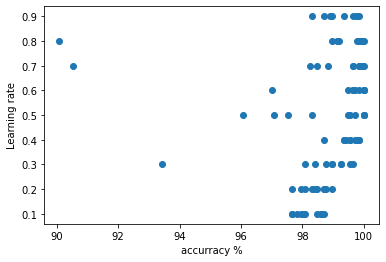

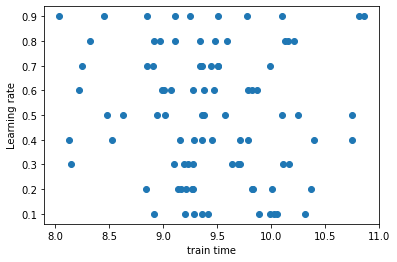

In [90]:
#The learning rate
network_structure = [4, 20,20, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.9
epochs = 1000

lrs = [0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9]

accurracy = []
train_time = []
mylr = []

for x in range(10):
    for i in range(len(lrs)):
        myANN = Neural_Network(network_structure, activation)
        acc,t_time = myANN.train(X, y, lrs[i], epochs)
        accurracy.append(round(acc,2))
        train_time.append(round(t_time,2))
        mylr.append(lrs[i])


plt.scatter(x=accurracy, y=mylr) 
plt.xlabel("accurracy %")
plt.ylabel("Learning rate")
#plt.title("Accurracy of different number of inputs",  y=-0.1)
plt.show()

plt.scatter(x=train_time, y=mylr) 
plt.xlabel("train time")
plt.ylabel("Learning rate")
#plt.title("Train time of different number of inputs",  y=-0.1)
plt.show()

=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.51155314 0.48798399]
 [0.51216638 0.48883093]
 [0.51177017 0.49017186]
 ...
 [0.51202697 0.48873569]
 [0.51165574 0.48821874]
 [0.51176885 0.48958983]]
Loss: 0.6908249013048893
stone: [[0.57135222 0.42818217]
 [0.57144309 0.42952024]
 [0.5687126  0.43327498]
 ...
 [0.57144621 0.42928493]
 [0.57190022 0.4279407 ]
 [0.5695221  0.43184819]]
Loss: 0.6864764381048021
stone: [[0.55396539 0.4454229 ]
 [0.55401096 0.44682533]
 [0.5506268  0.45134431]
 ...
 [0.55405546 0.44654297]
 [0.55488693 0.44478757]
 [0.55161443 0.44968916]]
Loss: 0.6857542754641721
stone: [[0.55938427 0.44007581]
 [0.55923041 0.44167645]
 [0.55462077 0.44750065]
 ...
 [0.55935165 0.44131539]
 [0.56072939 0.43899808]
 [0.55599067 0.44542885]]
Loss: 0.6850969747881038
stone: [[0.55818134 0.44123749]
 [0.55785764 0.44301209]
 [0.55208606 0.45007005]
 ...
 [0.55805224 0.44257504]
 [0.55997452 0.43969791]
 [0.55380095 0.4

stone: [[0.02230633 0.97812468]
 [0.48820195 0.51036309]
 [0.03736273 0.96346324]
 ...
 [0.75690487 0.24271015]
 [0.9645119  0.03540649]
 [0.0183371  0.9822411 ]]
Loss: 0.08002692834630472
stone: [[0.02015565 0.9802616 ]
 [0.46707215 0.53140062]
 [0.03673584 0.96408519]
 ...
 [0.75269556 0.24689067]
 [0.96631127 0.0336088 ]
 [0.01693845 0.9836055 ]]
Loss: 0.07626160414906892
stone: [[0.01829775 0.98210453]
 [0.44588456 0.55250472]
 [0.03617027 0.96464634]
 ...
 [0.74825676 0.25129991]
 [0.9679317  0.03199012]
 [0.01568028 0.984832  ]]
Loss: 0.07287748819744605
stone: [[0.01668188 0.98370481]
 [0.42482219 0.5734937 ]
 [0.03564472 0.96516753]
 ...
 [0.74363769 0.25588887]
 [0.96939577 0.03052781]
 [0.0145441  0.98593887]]
Loss: 0.06982960640481296
stone: [[0.01526781 0.98510314]
 [0.40404927 0.59420424]
 [0.03514183 0.9656657 ]
 ...
 [0.73888305 0.26061303]
 [0.97072274 0.0292026 ]
 [0.0135146  0.98694121]]
Loss: 0.06707916625643393
stone: [[0.0140233  0.98633204]
 [0.38370852 0.61449416

stone: [[0.00128499 0.99877307]
 [0.0352021  0.96431312]
 [0.01180393 0.98847969]
 ...
 [0.58285984 0.41538255]
 [0.98853341 0.01143067]
 [0.00127119 0.99879239]]
Loss: 0.0347491625392011
stone: [[0.00124966 0.99880696]
 [0.03410877 0.96541891]
 [0.01155286 0.98872415]
 ...
 [0.58199154 0.41622967]
 [0.98861646 0.01134778]
 [0.00123729 0.99882477]]
Loss: 0.034640872824123085
stone: [[0.00121572 0.99883952]
 [0.03306289 0.96647678]
 [0.01130685 0.98896368]
 ...
 [0.58117339 0.41702664]
 [0.98869715 0.01126723]
 [0.00120474 0.99885586]]
Loss: 0.034536721220505176
stone: [[0.00118309 0.9988708 ]
 [0.03206185 0.96748935]
 [0.01106577 0.9891984 ]
 ...
 [0.58040409 0.41777476]
 [0.98877558 0.01118895]
 [0.00117346 0.99888572]]
Loss: 0.03443656487259253
stone: [[0.00115172 0.99890087]
 [0.03110322 0.96845908]
 [0.01082951 0.98942843]
 ...
 [0.57968237 0.41847531]
 [0.98885182 0.01111284]
 [0.00114339 0.99891443]]
Loss: 0.034340269370213436
stone: [[0.00112154 0.9989298 ]
 [0.03018472 0.969388

stone: [[5.47024544e-04 9.99479053e-01]
 [1.35104320e-02 9.86267922e-01]
 [5.19851312e-03 9.94916736e-01]
 ...
 [5.75131773e-01 4.22337609e-01]
 [9.90522238e-01 9.44508986e-03]
 [5.65810542e-04 9.99464402e-01]]
Loss: 0.03271962608936008
stone: [[5.36619016e-04 9.99488974e-01]
 [1.32234071e-02 9.86558746e-01]
 [5.08031481e-03 9.95032166e-01]
 ...
 [5.75365903e-01 4.22082960e-01]
 [9.90554832e-01 9.41255009e-03]
 [5.55917329e-04 9.99473794e-01]]
Loss: 0.032703851959913405
stone: [[5.26492595e-04 9.99498629e-01]
 [1.29445071e-02 9.86841353e-01]
 [4.96455454e-03 9.95145229e-01]
 ...
 [5.75609981e-01 4.21818375e-01]
 [9.90586665e-01 9.38077156e-03]
 [5.46290605e-04 9.99482932e-01]]
Loss: 0.032689393719839546
stone: [[5.16635418e-04 9.99508025e-01]
 [1.26734094e-02 9.87116067e-01]
 [4.85118514e-03 9.95255969e-01]
 ...
 [5.75863040e-01 4.21544820e-01]
 [9.90617752e-01 9.34973720e-03]
 [5.36920739e-04 9.99491825e-01]]
Loss: 0.032676206819610476
stone: [[5.07038045e-04 9.99517173e-01]
 [1.24098

Loss: 0.032762439950710175
stone: [[2.71142535e-04 9.99741758e-01]
 [5.95241599e-03 9.93934465e-01]
 [1.88136947e-03 9.98161790e-01]
 ...
 [5.83624973e-01 4.12973201e-01]
 [9.91382817e-01 8.58662696e-03]
 [3.02424714e-04 9.99713934e-01]]
Loss: 0.03277267368645843
stone: [[2.67182786e-04 9.99745524e-01]
 [5.84224718e-03 9.94046444e-01]
 [1.83390459e-03 9.98208306e-01]
 ...
 [5.83568870e-01 4.13007783e-01]
 [9.91393584e-01 8.57591314e-03]
 [2.98578675e-04 9.99717568e-01]]
Loss: 0.03278300899538
stone: [[2.63298642e-04 9.99749218e-01]
 [5.73404653e-03 9.94156434e-01]
 [1.78753211e-03 9.98253754e-01]
 ...
 [5.83491594e-01 4.13063479e-01]
 [9.91404015e-01 8.56553617e-03]
 [2.94801806e-04 9.99721137e-01]]
Loss: 0.03279342764093553
stone: [[2.59488099e-04 9.99752842e-01]
 [5.62776413e-03 9.94264485e-01]
 [1.74223172e-03 9.98298152e-01]
 ...
 [5.83392648e-01 4.13140786e-01]
 [9.91414115e-01 8.55548941e-03]
 [2.91092259e-04 9.99724641e-01]]
Loss: 0.03280391177203577
stone: [[2.55749216e-04 9.99

stone: [[0.54656079 0.45114594]
 [0.66999967 0.33287554]
 [0.12958034 0.86224557]
 ...
 [0.72616347 0.27852937]
 [0.82739577 0.17926671]
 [0.13637671 0.85518931]]
Loss: 0.38300018080541864
stone: [[0.49281947 0.50308034]
 [0.67695721 0.32558462]
 [0.11325927 0.87968573]
 ...
 [0.73676827 0.26752052]
 [0.84053858 0.16548061]
 [0.11955416 0.87315501]]
Loss: 0.3525762780396948
stone: [[0.42602432 0.56827041]
 [0.68235938 0.31980406]
 [0.09840025 0.89555897]
 ...
 [0.7463454  0.25751829]
 [0.85313409 0.15227027]
 [0.10414369 0.88960985]]
Loss: 0.3218369895117565
stone: [[0.35163812 0.64162372]
 [0.68596943 0.31578343]
 [0.08516281 0.90969413]
 ...
 [0.75476979 0.24866223]
 [0.86504467 0.13978314]
 [0.09026857 0.90441724]]
Loss: 0.29174118895031736
stone: [[0.27845958 0.71456659]
 [0.68773713 0.31358826]
 [0.0736583  0.92197518]
 ...
 [0.76205962 0.24094877]
 [0.87618363 0.12811345]
 [0.078011   0.91748897]]
Loss: 0.26329492089878653
stone: [[0.21454946 0.77893765]
 [0.68777927 0.31311742]


Loss: 0.049698155957305486
stone: [[0.00151743 0.99844431]
 [0.10345018 0.89523812]
 [0.00546143 0.9944185 ]
 ...
 [0.73342595 0.26565446]
 [0.97934037 0.02092131]
 [0.00151225 0.99845033]]
Loss: 0.04946419728629621
stone: [[0.00144458 0.99851944]
 [0.09869156 0.9000611 ]
 [0.00515396 0.99473269]
 ...
 [0.73301916 0.26607095]
 [0.9795295  0.02072544]
 [0.00144235 0.99852237]]
Loss: 0.0492422249052343
stone: [[0.00137628 0.99858986]
 [0.09421498 0.90459866]
 [0.00486609 0.99502683]
 ...
 [0.73269719 0.26640362]
 [0.97971062 0.02053787]
 [0.00137683 0.9985899 ]]
Loss: 0.04903125296933733
stone: [[0.00131219 0.99865593]
 [0.0900003  0.90887111]
 [0.00459659 0.99530218]
 ...
 [0.73245614 0.26665626]
 [0.9798842  0.02035808]
 [0.00131533 0.99865325]]
Loss: 0.04883038803146132
stone: [[0.00125199 0.99871797]
 [0.08602868 0.91289745]
 [0.0043443  0.99555991]
 ...
 [0.73229187 0.26683298]
 [0.9800507  0.0201856 ]
 [0.00125756 0.99871275]]
Loss: 0.04863881919729816
stone: [[0.00119539 0.9987762

 [3.00746606e-04 9.99694392e-01]]
Loss: 0.04394549953595461
stone: [[2.58922681e-04 9.99737616e-01]
 [1.63055993e-02 9.83555275e-01]
 [6.38935051e-04 9.99345749e-01]
 ...
 [7.49256542e-01 2.50670137e-01]
 [9.83707991e-01 1.63858017e-02]
 [2.92651402e-04 9.99702643e-01]]
Loss: 0.04385927674431588
stone: [[2.51190087e-04 9.99745503e-01]
 [1.57116099e-02 9.84155871e-01]
 [6.16410924e-04 9.99368804e-01]
 ...
 [7.49569540e-01 2.50376850e-01]
 [9.83750655e-01 1.63411439e-02]
 [2.84827780e-04 9.99710616e-01]]
Loss: 0.043773322158741385
stone: [[2.43728792e-04 9.99753110e-01]
 [1.51387085e-02 9.84735082e-01]
 [5.94834932e-04 9.99390889e-01]
 ...
 [7.49866401e-01 2.50099699e-01]
 [9.83792363e-01 1.62974690e-02]
 [2.77264039e-04 9.99718322e-01]]
Loss: 0.043687634081838914
stone: [[2.36527077e-04 9.99760452e-01]
 [1.45861357e-02 9.85293681e-01]
 [5.74160138e-04 9.99412052e-01]
 ...
 [7.50146896e-01 2.49838912e-01]
 [9.83833151e-01 1.62547408e-02]
 [2.69949110e-04 9.99725773e-01]]
Loss: 0.04360221

stone: [[7.21327349e-05 9.99927436e-01]
 [2.82174268e-03 9.97165030e-01]
 [1.52514233e-04 9.99843701e-01]
 ...
 [7.45042600e-01 2.55831345e-01]
 [9.85031427e-01 1.49867301e-02]
 [9.63774166e-05 9.99902078e-01]]
Loss: 0.04041319896637508
stone: [[7.02826707e-05 9.99929306e-01]
 [2.71308547e-03 9.97274362e-01]
 [1.48471799e-04 9.99847837e-01]
 ...
 [7.44477751e-01 2.56418847e-01]
 [9.85051010e-01 1.49656757e-02]
 [9.43010997e-05 9.99904181e-01]]
Loss: 0.04035509671874222
stone: [[6.84837409e-05 9.99931123e-01]
 [2.60846692e-03 9.97379619e-01]
 [1.44561306e-04 9.99851838e-01]
 ...
 [7.43889047e-01 2.57030350e-01]
 [9.85070356e-01 1.49448602e-02]
 [9.22776955e-05 9.99906230e-01]]
Loss: 0.040297760074665054
stone: [[6.67343910e-05 9.99932891e-01]
 [2.50774053e-03 9.97480952e-01]
 [1.40777957e-04 9.99855709e-01]
 ...
 [7.43276150e-01 2.57666196e-01]
 [9.85089472e-01 1.49242765e-02]
 [9.03057206e-05 9.99908227e-01]]
Loss: 0.040241176511783765
stone: [[6.50331201e-05 9.99934609e-01]
 [2.410765

stone: [[2.12545863e-05 9.99978711e-01]
 [3.85742154e-04 9.99612923e-01]
 [4.97420372e-05 9.99948800e-01]
 ...
 [6.83323592e-01 3.18911070e-01]
 [9.85834623e-01 1.41118920e-02]
 [3.67988724e-05 9.99962364e-01]]
Loss: 0.038116734300623796
stone: [[2.07489388e-05 9.99979219e-01]
 [3.70057630e-04 9.99628656e-01]
 [4.88079245e-05 9.99949755e-01]
 ...
 [6.81233013e-01 3.21035917e-01]
 [9.85850460e-01 1.40945778e-02]
 [3.61577842e-05 9.99963013e-01]]
Loss: 0.038072589908829335
stone: [[2.02558443e-05 9.99979714e-01]
 [3.55012975e-04 9.99643747e-01]
 [4.78981647e-05 9.99950684e-01]
 ...
 [6.79106283e-01 3.23197174e-01]
 [9.85866402e-01 1.40771589e-02]
 [3.55302863e-05 9.99963648e-01]]
Loss: 0.038028168003188055
stone: [[1.97749704e-05 9.99980196e-01]
 [3.40583139e-04 9.99658221e-01]
 [4.70120034e-05 9.99951590e-01]
 ...
 [6.76943335e-01 3.25394904e-01]
 [9.85882455e-01 1.40596269e-02]
 [3.49160114e-05 9.99964269e-01]]
Loss: 0.03798344615471936
stone: [[1.93059946e-05 9.99980667e-01]
 [3.26743

Loss: 0.0356143609188811
stone: [[7.35559765e-06 9.99992639e-01]
 [6.26689053e-05 9.99936981e-01]
 [2.40175342e-05 9.99975077e-01]
 ...
 [5.54562293e-01 4.49335650e-01]
 [9.86790268e-01 1.30893968e-02]
 [1.75423172e-05 9.99981886e-01]]
Loss: 0.03553703979332528
stone: [[7.18814753e-06 9.99992807e-01]
 [6.03170136e-05 9.99939342e-01]
 [2.36894756e-05 9.99975412e-01]
 ...
 [5.51003650e-01 4.52929188e-01]
 [9.86820718e-01 1.30575066e-02]
 [1.72700427e-05 9.99982163e-01]]
Loss: 0.03545853864907875
stone: [[7.02472750e-06 9.99992970e-01]
 [5.80608647e-05 9.99941606e-01]
 [2.33677249e-05 9.99975741e-01]
 ...
 [5.47424650e-01 4.56542719e-01]
 [9.86851698e-01 1.30250944e-02]
 [1.70023963e-05 9.99982436e-01]]
Loss: 0.03537884999350984
stone: [[6.86524092e-06 9.99993130e-01]
 [5.58964067e-05 9.99943779e-01]
 [2.30520981e-05 9.99976063e-01]
 ...
 [5.43826282e-01 4.60175239e-01]
 [9.86883208e-01 1.29921593e-02]
 [1.67392816e-05 9.99982703e-01]]
Loss: 0.035297967957858264
stone: [[6.70959342e-06 9.

stone: [[2.83504871e-06 9.99997158e-01]
 [1.38020943e-05 9.99986069e-01]
 [1.38855307e-05 9.99985452e-01]
 ...
 [3.96816827e-01 6.08094775e-01]
 [9.88468827e-01 1.13627152e-02]
 [9.03795553e-06 9.99990576e-01]]
Loss: 0.03125569722374629
stone: [[2.77590500e-06 9.99997217e-01]
 [1.33704470e-05 9.99986504e-01]
 [1.37146725e-05 9.99985627e-01]
 ...
 [3.93378627e-01 6.11542697e-01]
 [9.88511277e-01 1.13196412e-02]
 [8.89860738e-06 9.99990719e-01]]
Loss: 0.031143940572463984
stone: [[2.71814835e-06 9.99997274e-01]
 [1.29543118e-05 9.99986923e-01]
 [1.35457091e-05 9.99985801e-01]
 ...
 [3.89964872e-01 6.14965563e-01]
 [9.88553554e-01 1.12767659e-02]
 [8.76122832e-06 9.99990860e-01]]
Loss: 0.031032263175747622
stone: [[2.66174415e-06 9.99997331e-01]
 [1.25530716e-05 9.99987327e-01]
 [1.33785972e-05 9.99985973e-01]
 ...
 [3.86576188e-01 6.18362757e-01]
 [9.88595641e-01 1.12341080e-02]
 [8.62578778e-06 9.99991000e-01]]
Loss: 0.030920706869286444
stone: [[2.60665864e-06 9.99997386e-01]
 [1.21661

Loss: 0.02627382933816158
stone: [[1.04144910e-06 9.99998952e-01]
 [3.27820632e-06 9.99996677e-01]
 [7.05585159e-06 9.99992530e-01]
 ...
 [2.58827506e-01 7.46034144e-01]
 [9.90232065e-01 9.59359959e-03]
 [3.97554515e-06 9.99995815e-01]]
Loss: 0.026191295044938764
stone: [[1.02271137e-06 9.99998970e-01]
 [3.19792720e-06 9.99996758e-01]
 [6.95472601e-06 9.99992636e-01]
 ...
 [2.56901780e-01 7.47952886e-01]
 [9.90257912e-01 9.56797746e-03]
 [3.91025902e-06 9.99995883e-01]]
Loss: 0.02610941667359352
stone: [[1.00436513e-06 9.99998989e-01]
 [3.11998052e-06 9.99996837e-01]
 [6.85476583e-06 9.99992741e-01]
 ...
 [2.55003507e-01 7.49844128e-01]
 [9.90283476e-01 9.54264439e-03]
 [3.84601643e-06 9.99995950e-01]]
Loss: 0.02602818826793847
stone: [[9.86401189e-07 9.99999007e-01]
 [3.04428911e-06 9.99996913e-01]
 [6.75596783e-06 9.99992844e-01]
 ...
 [2.53132418e-01 7.51708146e-01]
 [9.90308762e-01 9.51759574e-03]
 [3.78280368e-06 9.99996016e-01]]
Loss: 0.025947603991855934
stone: [[9.68810589e-07 

Loss: 0.6406700719036347
stone: [[0.57434222 0.4236373 ]
 [0.57419162 0.42704589]
 [0.4680633  0.52068768]
 ...
 [0.5821381  0.41988126]
 [0.62413463 0.38368882]
 [0.47836425 0.51137029]]
Loss: 0.6319536364255035
stone: [[0.57774485 0.42050631]
 [0.57716182 0.42426869]
 [0.45048558 0.53626802]
 ...
 [0.58695307 0.41541267]
 [0.6355469  0.37311248]
 [0.46169154 0.52643284]]
Loss: 0.6217640652046372
stone: [[0.58168097 0.41686321]
 [0.58079361 0.42086985]
 [0.43020517 0.55462856]
 ...
 [0.59281218 0.40995072]
 [0.64855014 0.36091989]
 [0.44213798 0.54435463]]
Loss: 0.6100223355299876
stone: [[0.58610834 0.41273432]
 [0.58521853 0.41671819]
 [0.4073115  0.57582378]
 ...
 [0.59987814 0.40332671]
 [0.66310671 0.34709705]
 [0.41967582 0.565262  ]]
Loss: 0.5967233715293395
stone: [[0.59086847 0.40825132]
 [0.59055931 0.4116861 ]
 [0.3821338  0.59967328]
 ...
 [0.60827685 0.39540011]
 [0.67905806 0.33174356]
 [0.39452726 0.58905879]]
Loss: 0.5819399226327527
stone: [[0.59562752 0.4037095 ]
 [0

Loss: 0.048611554856629484
stone: [[0.00620249 0.99364813]
 [0.19834468 0.80153716]
 [0.02576497 0.97457621]
 ...
 [0.69335118 0.30952249]
 [0.98127866 0.01864556]
 [0.00603822 0.99389825]]
Loss: 0.047870130105394246
stone: [[0.00587898 0.99398304]
 [0.18856129 0.81127017]
 [0.02483076 0.97549359]
 ...
 [0.69036505 0.31253419]
 [0.98166256 0.0182532 ]
 [0.00572714 0.99421434]]
Loss: 0.04718371851398952
stone: [[0.00557941 0.99429293]
 [0.17935697 0.82042835]
 [0.02390747 0.97639959]
 ...
 [0.68748315 0.31544097]
 [0.98202332 0.01788466]
 [0.00543814 0.99450787]]
Loss: 0.046547373471353806
stone: [[0.00530149 0.9945802 ]
 [0.17069941 0.82904381]
 [0.02299829 0.97729123]
 ...
 [0.68470484 0.31824348]
 [0.98236282 0.01753796]
 [0.00516933 0.99478079]]
Loss: 0.04595667108327518
stone: [[0.00504321 0.99484697]
 [0.16255697 0.83714798]
 [0.02210596 0.97816597]
 ...
 [0.6820292  0.32094264]
 [0.98268278 0.01721136]
 [0.00491897 0.99503487]]
Loss: 0.04540764431747891
stone: [[0.00480279 0.9950

Loss: 0.03681403633992294
stone: [[0.0010687  0.99892123]
 [0.03191156 0.96759165]
 [0.00340041 0.9965649 ]
 ...
 [0.63435807 0.36912178]
 [0.988573   0.01122753]
 [0.00107404 0.99892032]]
Loss: 0.03672660445304659
stone: [[0.00104192 0.99894839]
 [0.03103262 0.96847507]
 [0.00328168 0.99668336]
 ...
 [0.63412385 0.36935861]
 [0.98862669 0.01117329]
 [0.00104878 0.99894565]]
Loss: 0.036639608332800784
stone: [[0.00101604 0.99897463]
 [0.03018277 0.96932944]
 [0.00316827 0.99679656]
 ...
 [0.63389657 0.36958825]
 [0.98867912 0.01112033]
 [0.00102438 0.99897011]]
Loss: 0.03655295013077422
stone: [[9.91024240e-04 9.98999988e-01]
 [2.93606556e-02 9.70156098e-01]
 [3.05992142e-03 9.96904767e-01]
 ...
 [6.33674901e-01 3.69812048e-01]
 [9.88730359e-01 1.10685792e-02]
 [1.00081716e-03 9.98993731e-01]]
Loss: 0.03646653864695615
stone: [[9.66827665e-04 9.99024511e-01]
 [2.85650067e-02 9.70956319e-01]
 [2.95637060e-03 9.97008231e-01]
 ...
 [6.33457521e-01 3.70031330e-01]
 [9.88780450e-01 1.101799

stone: [[3.66635029e-04 9.99630747e-01]
 [8.64520778e-03 9.91082355e-01]
 [8.68830406e-04 9.99107843e-01]
 ...
 [6.12901985e-01 3.90537287e-01]
 [9.90426009e-01 9.35994889e-03]
 [4.16805109e-04 9.99577493e-01]]
Loss: 0.032011348959799096
stone: [[3.59515742e-04 9.99637914e-01]
 [8.41369825e-03 9.91318131e-01]
 [8.50431488e-04 9.99126509e-01]
 ...
 [6.11978511e-01 3.91458410e-01]
 [9.90457006e-01 9.32882722e-03]
 [4.10137900e-04 9.99584143e-01]]
Loss: 0.03189849880618864
stone: [[3.52551176e-04 9.99644924e-01]
 [8.18792022e-03 9.91548150e-01]
 [8.32584240e-04 9.99144620e-01]
 ...
 [6.11029257e-01 3.92405313e-01]
 [9.90487962e-01 9.29775241e-03]
 [4.03611075e-04 9.99590653e-01]]
Loss: 0.03178499977336145
stone: [[3.45737126e-04 9.99651783e-01]
 [7.96774440e-03 9.91772539e-01]
 [8.15267412e-04 9.99162196e-01]
 ...
 [6.10054153e-01 3.93378066e-01]
 [9.90518884e-01 9.26671819e-03]
 [3.97220557e-04 9.99597028e-01]]
Loss: 0.03167086348991302
stone: [[3.39069541e-04 9.99658494e-01]
 [7.7530451

Loss: 0.025852359128478875
stone: [[1.39933765e-04 9.99858853e-01]
 [2.05376895e-03 9.97844013e-01]
 [3.50463515e-04 9.99635778e-01]
 ...
 [5.36720424e-01 4.66604377e-01]
 [9.92020461e-01 7.76757438e-03]
 [1.97157504e-04 9.99797184e-01]]
Loss: 0.02572474966855096
stone: [[1.37381431e-04 9.99861422e-01]
 [1.99584128e-03 9.97904171e-01]
 [3.45188772e-04 9.99641182e-01]
 ...
 [5.34792860e-01 4.68529478e-01]
 [9.92052382e-01 7.73586083e-03]
 [1.94471310e-04 9.99799890e-01]]
Loss: 0.025597208105899483
stone: [[1.34877582e-04 9.99863942e-01]
 [1.93956739e-03 9.97962635e-01]
 [3.40017384e-04 9.99646480e-01]
 ...
 [5.32856336e-01 4.70463514e-01]
 [9.92084313e-01 7.70414254e-03]
 [1.91825805e-04 9.99802555e-01]]
Loss: 0.025469746535191125
stone: [[1.32421268e-04 9.99866415e-01]
 [1.88490188e-03 9.98019450e-01]
 [3.34946745e-04 9.99651677e-01]
 ...
 [5.30911260e-01 4.72406077e-01]
 [9.92116252e-01 7.67242176e-03]
 [1.89220218e-04 9.99805182e-01]]
Loss: 0.0253423769359419
stone: [[1.30011561e-04 

Loss: 0.019663795960736277
stone: [[5.59146624e-05 9.99943509e-01]
 [4.95285595e-04 9.99473559e-01]
 [1.74133905e-04 9.99817177e-01]
 ...
 [4.34241088e-01 5.68971660e-01]
 [9.93597243e-01 6.20861884e-03]
 [9.98353656e-05 9.99895963e-01]]
Loss: 0.019553356560453834
stone: [[5.49479697e-05 9.99944485e-01]
 [4.82270782e-04 9.99487309e-01]
 [1.71973523e-04 9.99819414e-01]
 ...
 [4.32289523e-01 5.70922861e-01]
 [9.93625606e-01 6.18074812e-03]
 [9.85397592e-05 9.99897292e-01]]
Loss: 0.019443472240239658
stone: [[5.39994393e-05 9.99945442e-01]
 [4.69630426e-04 9.99500668e-01]
 [1.69846426e-04 9.99821617e-01]
 ...
 [4.30345762e-01 5.72866386e-01]
 [9.93653816e-01 6.15303423e-03]
 [9.72617937e-05 9.99898603e-01]]
Loss: 0.019334147246914592
stone: [[5.30687275e-05 9.99946382e-01]
 [4.57353483e-04 9.99513645e-01]
 [1.67751978e-04 9.99823787e-01]
 ...
 [4.28410096e-01 5.74801948e-01]
 [9.93681872e-01 6.12547911e-03]
 [9.60012173e-05 9.99899897e-01]]
Loss: 0.01922538552832305
stone: [[5.21554969e-0

stone: [[2.51058527e-05 9.99974637e-01]
 [1.51143710e-04 9.99838646e-01]
 [9.93868001e-05 9.99894928e-01]
 ...
 [3.52823275e-01 6.50505814e-01]
 [9.94769438e-01 5.06250711e-03]
 [5.38928071e-05 9.99943408e-01]]
Loss: 0.01492980196839811
stone: [[2.47128746e-05 9.99975034e-01]
 [1.47768437e-04 9.99842245e-01]
 [9.83072327e-05 9.99896057e-01]
 ...
 [3.51429135e-01 6.51904332e-01]
 [9.94789724e-01 5.04276210e-03]
 [5.32191400e-05 9.99944109e-01]]
Loss: 0.014847232356067051
stone: [[2.43270314e-05 9.99975424e-01]
 [1.44481274e-04 9.99845750e-01]
 [9.72421940e-05 9.99897171e-01]
 ...
 [3.50046973e-01 6.53290892e-01]
 [9.94809853e-01 5.02317245e-03]
 [5.25545733e-05 9.99944801e-01]]
Loss: 0.014765185948548483
stone: [[2.39481835e-05 9.99975807e-01]
 [1.41279647e-04 9.99849164e-01]
 [9.61914540e-05 9.99898270e-01]
 ...
 [3.48676669e-01 6.54665611e-01]
 [9.94829826e-01 5.00373690e-03]
 [5.18989838e-05 9.99945483e-01]]
Loss: 0.01468365997317318
stone: [[2.35761941e-05 9.99976183e-01]
 [1.381610

stone: [[1.21647625e-05 9.99987719e-01]
 [5.50242939e-05 9.99941267e-01]
 [6.00669028e-05 9.99936164e-01]
 ...
 [2.95726025e-01 7.07784925e-01]
 [9.95601614e-01 4.25388633e-03]
 [2.96189244e-05 9.99968757e-01]]
Loss: 0.011453956613600956
stone: [[1.19985674e-05 9.99987887e-01]
 [5.40016853e-05 9.99942360e-01]
 [5.94895680e-05 9.99936771e-01]
 ...
 [2.94733481e-01 7.08779587e-01]
 [9.95615655e-01 4.24026166e-03]
 [2.92719340e-05 9.99969121e-01]]
Loss: 0.01139426808655695
stone: [[1.18351227e-05 9.99988052e-01]
 [5.30016453e-05 9.99943429e-01]
 [5.89191084e-05 9.99937371e-01]
 ...
 [2.93745449e-01 7.09769653e-01]
 [9.95629598e-01 4.22673351e-03]
 [2.89295647e-05 9.99969480e-01]]
Loss: 0.01133499699580331
stone: [[1.16743769e-05 9.99988214e-01]
 [5.20236039e-05 9.99944474e-01]
 [5.83554249e-05 9.99937965e-01]
 ...
 [2.92761827e-01 7.10755223e-01]
 [9.95643443e-01 4.21330097e-03]
 [2.85917519e-05 9.99969834e-01]]
Loss: 0.011276141517228055
stone: [[1.15162798e-05 9.99988374e-01]
 [5.106700

stone: [[6.34061580e-06 9.99993600e-01]
 [2.28828157e-05 9.99975624e-01]
 [3.76823923e-05 9.99959764e-01]
 ...
 [2.49422570e-01 7.54089261e-01]
 [9.96209310e-01 3.66505243e-03]
 [1.66643844e-05 9.99982367e-01]]
Loss: 0.008902333894456965
stone: [[6.26625219e-06 9.99993675e-01]
 [2.25262937e-05 9.99976005e-01]
 [3.73577794e-05 9.99960107e-01]
 ...
 [2.48584632e-01 7.54925176e-01]
 [9.96219339e-01 3.65535358e-03]
 [1.64864828e-05 9.99982554e-01]]
Loss: 0.00886145825217664
stone: [[6.19298242e-06 9.99993749e-01]
 [2.21765132e-05 9.99976378e-01]
 [3.70366023e-05 9.99960447e-01]
 ...
 [2.47749044e-01 7.55758671e-01]
 [9.96229305e-01 3.64571488e-03]
 [1.63108251e-05 9.99982739e-01]]
Loss: 0.008820897763707685
stone: [[6.12078781e-06 9.99993822e-01]
 [2.18333274e-05 9.99976745e-01]
 [3.67188175e-05 9.99960783e-01]
 ...
 [2.46915801e-01 7.56589752e-01]
 [9.96239211e-01 3.63613581e-03]
 [1.61373801e-05 9.99982922e-01]]
Loss: 0.008780650277432783
stone: [[6.04964999e-06 9.99993894e-01]
 [2.14965

stone: [[3.66427249e-06 9.99996301e-01]
 [1.10956212e-05 9.99988213e-01]
 [2.49355162e-05 9.99973267e-01]
 ...
 [2.10413143e-01 7.92924699e-01]
 [9.96644639e-01 3.24470781e-03]
 [9.99345433e-06 9.99989405e-01]]
Loss: 0.007203092491024666
stone: [[3.62725091e-06 9.99996338e-01]
 [1.09491342e-05 9.99988369e-01]
 [2.47398593e-05 9.99973475e-01]
 ...
 [2.09694416e-01 7.93638699e-01]
 [9.96652144e-01 3.23747352e-03]
 [9.89679568e-06 9.99989507e-01]]
Loss: 0.007175410039483669
stone: [[3.59070991e-06 9.99996375e-01]
 [1.08050453e-05 9.99988523e-01]
 [2.45460767e-05 9.99973680e-01]
 ...
 [2.08978172e-01 7.94350179e-01]
 [9.96659608e-01 3.23027912e-03]
 [9.80125734e-06 9.99989608e-01]]
Loss: 0.007147941159986889
stone: [[3.55464203e-06 9.99996411e-01]
 [1.06633086e-05 9.99988674e-01]
 [2.43541472e-05 9.99973884e-01]
 ...
 [2.08264413e-01 7.95059136e-01]
 [9.96667032e-01 3.22312432e-03]
 [9.70682424e-06 9.99989708e-01]]
Loss: 0.0071206840565812505
stone: [[3.51903996e-06 9.99996447e-01]
 [1.052

Loss: 0.006067364888137108
stone: [[2.28140145e-06 9.99997696e-01]
 [5.99466268e-06 9.99993651e-01]
 [1.70865179e-05 9.99981617e-01]
 ...
 [1.77556006e-01 8.25509811e-01]
 [9.96975078e-01 2.92657521e-03]
 [6.28252831e-06 9.99993331e-01]]
Loss: 0.006048265058190447
stone: [[2.26136138e-06 9.99997716e-01]
 [5.92685066e-06 9.99993723e-01]
 [1.69630757e-05 9.99981748e-01]
 ...
 [1.76962998e-01 8.26096854e-01]
 [9.96980857e-01 2.92101761e-03]
 [6.22711275e-06 9.99993390e-01]]
Loss: 0.006029305400246229
stone: [[2.24155026e-06 9.99997736e-01]
 [5.86000293e-06 9.99993794e-01]
 [1.68407163e-05 9.99981879e-01]
 ...
 [1.76372472e-01 8.26681402e-01]
 [9.96986607e-01 2.91548788e-03]
 [6.17228075e-06 9.99993448e-01]]
Loss: 0.006010484715673158
stone: [[2.22196489e-06 9.99997756e-01]
 [5.79410318e-06 9.99993864e-01]
 [1.67194287e-05 9.99982008e-01]
 ...
 [1.75784424e-01 8.27263460e-01]
 [9.96992329e-01 2.90998584e-03]
 [6.11802506e-06 9.99993506e-01]]
Loss: 0.005991801816815992
stone: [[2.20260213e-

stone: [[1.50748852e-06 9.99998477e-01]
 [3.52579607e-06 9.99996276e-01]
 [1.20484638e-05 9.99986996e-01]
 ...
 [1.50842367e-01 8.51916794e-01]
 [9.97232181e-01 2.67946574e-03]
 [4.10513869e-06 9.99995641e-01]]
Loss: 0.005249583081888059
stone: [[1.49581703e-06 9.99998488e-01]
 [3.49110565e-06 9.99996313e-01]
 [1.19676898e-05 9.99987083e-01]
 ...
 [1.50366457e-01 8.52386526e-01]
 [9.97236727e-01 2.67509782e-03]
 [4.07171368e-06 9.99995676e-01]]
Loss: 0.005236311954750266
stone: [[1.48426335e-06 9.99998500e-01]
 [3.45684658e-06 9.99996350e-01]
 [1.18875725e-05 9.99987168e-01]
 ...
 [1.49892705e-01 8.52854104e-01]
 [9.97241253e-01 2.67074997e-03]
 [4.03860947e-06 9.99995711e-01]]
Loss: 0.005223132162707648
stone: [[1.47282603e-06 9.99998512e-01]
 [3.42301239e-06 9.99996386e-01]
 [1.18081058e-05 9.99987253e-01]
 ...
 [1.49421103e-01 8.53319535e-01]
 [9.97245758e-01 2.66642208e-03]
 [4.00582243e-06 9.99995746e-01]]
Loss: 0.0052100429631083195
stone: [[1.46150362e-06 9.99998523e-01]
 [3.389

stone: [[0.56210105 0.43791508]
 [0.56190135 0.44101089]
 [0.54642566 0.45248832]
 ...
 [0.56243564 0.44000516]
 [0.56583639 0.43507543]
 [0.55117689 0.44908788]]
Loss: 0.6810906018887685
stone: [[0.56273962 0.43729187]
 [0.56231358 0.44060037]
 [0.54469854 0.45406007]
 ...
 [0.56297713 0.43946908]
 [0.56713238 0.43380347]
 [0.54999115 0.4502314 ]]
Loss: 0.6801148966644581
stone: [[0.56345434 0.43659301]
 [0.56276362 0.44015089]
 [0.54269713 0.45589082]
 ...
 [0.56358036 0.4388706 ]
 [0.568617   0.43234726]
 [0.54857049 0.45160168]]
Loss: 0.6789819148805175
stone: [[0.56426292 0.43580176]
 [0.5632616  0.43965288]
 [0.54037481 0.45802686]
 ...
 [0.56426085 0.43819495]
 [0.57032883 0.43067056]
 [0.54686808 0.45324409]]
Loss: 0.6776611360016054
stone: [[0.56518058 0.43490274]
 [0.56381371 0.43909958]
 [0.53767076 0.46052796]
 ...
 [0.56503145 0.43742888]
 [0.5723071  0.42873563]
 [0.54482128 0.45521838]]
Loss: 0.676117841343095
stone: [[0.56622862 0.43387501]
 [0.56443044 0.43848039]
 [0.

Loss: 0.06894076759222452
stone: [[0.01007133 0.98996174]
 [0.43244978 0.56884526]
 [0.02543936 0.97421635]
 ...
 [0.81540571 0.18565548]
 [0.96737208 0.0326615 ]
 [0.00914749 0.99081079]]
Loss: 0.06724396275994471
stone: [[0.00932173 0.99071401]
 [0.41168587 0.58960278]
 [0.02462416 0.97504631]
 ...
 [0.81337584 0.1876991 ]
 [0.96827105 0.03175226]
 [0.0085066  0.99145928]]
Loss: 0.06570987212119042
stone: [[0.00864587 0.99139191]
 [0.39139006 0.60988761]
 [0.02377271 0.97591206]
 ...
 [0.81133101 0.1897588 ]
 [0.96910166 0.03091232]
 [0.00792037 0.99205229]]
Loss: 0.06431997954271175
stone: [[0.0080347  0.99200462]
 [0.37164926 0.62961304]
 [0.02289576 0.97680284]
 ...
 [0.80928084 0.19182483]
 [0.96987106 0.03013445]
 [0.0073838  0.9925949 ]]
Loss: 0.06305810820884344
stone: [[0.00748048 0.99255995]
 [0.35253473 0.64870807]
 [0.02200367 0.97770828]
 ...
 [0.80723363 0.1938887 ]
 [0.97058547 0.02941234]
 [0.00689231 0.99309175]]
Loss: 0.06191017172626238
stone: [[0.0069766  0.9930646

Loss: 0.048721627700589354
stone: [[9.28106142e-04 9.99093467e-01]
 [4.97031540e-02 9.50564438e-01]
 [2.96301936e-03 9.96997234e-01]
 ...
 [7.77692558e-01 2.23965295e-01]
 [9.81505585e-01 1.84150615e-02]
 [9.00453246e-04 9.99115889e-01]]
Loss: 0.0486520920128558
stone: [[8.94619663e-04 9.99126503e-01]
 [4.80441137e-02 9.52214954e-01]
 [2.84313743e-03 9.97118817e-01]
 ...
 [7.78299123e-01 2.23362540e-01]
 [9.81590003e-01 1.83303983e-02]
 [8.69503010e-04 9.99146565e-01]]
Loss: 0.048585183414488545
stone: [[8.62658076e-04 9.99158023e-01]
 [4.64546631e-02 9.53796230e-01]
 [2.72936535e-03 9.97234209e-01]
 ...
 [7.78925408e-01 2.22739870e-01]
 [9.81671249e-01 1.82489154e-02]
 [8.39945299e-04 9.99175848e-01]]
Loss: 0.048520667877641706
stone: [[8.32134265e-04 9.99188115e-01]
 [4.49305194e-02 9.55312530e-01]
 [2.62134328e-03 9.97343773e-01]
 ...
 [7.79568831e-01 2.22099886e-01]
 [9.81749454e-01 1.81704805e-02]
 [8.11700933e-04 9.99203817e-01]]
Loss: 0.04845832140902373
stone: [[8.02966993e-04 

stone: [[2.24924350e-04 9.99783411e-01]
 [1.19280590e-02 9.88149355e-01]
 [6.34237270e-04 9.99360072e-01]
 ...
 [8.04105805e-01 1.97723524e-01]
 [9.83435188e-01 1.64738619e-02]
 [2.43712598e-04 9.99762729e-01]]
Loss: 0.046195504694946606
stone: [[2.18649065e-04 9.99789508e-01]
 [1.15526689e-02 9.88522898e-01]
 [6.15093066e-04 9.99379497e-01]
 ...
 [8.04451839e-01 1.97383622e-01]
 [9.83454551e-01 1.64541027e-02]
 [2.37700401e-04 9.99768595e-01]]
Loss: 0.04614126034340278
stone: [[2.12563444e-04 9.99795419e-01]
 [1.11885733e-02 9.88885197e-01]
 [5.96537587e-04 9.99398324e-01]
 ...
 [8.04785366e-01 1.97056346e-01]
 [9.83473402e-01 1.64348447e-02]
 [2.31862568e-04 9.99774290e-01]]
Loss: 0.046087591999512456
stone: [[2.06660848e-04 9.99801151e-01]
 [1.08354640e-02 9.89236557e-01]
 [5.78549080e-04 9.99416574e-01]
 ...
 [8.05106502e-01 1.96741577e-01]
 [9.83491755e-01 1.64160742e-02]
 [2.26193059e-04 9.99779820e-01]]
Loss: 0.046034570475181856
stone: [[2.00934929e-04 9.99806709e-01]
 [1.04930

stone: [[6.41702592e-05 9.99938768e-01]
 [2.64176082e-03 9.97383945e-01]
 [1.53943306e-04 9.99846281e-01]
 ...
 [8.06983661e-01 1.95220037e-01]
 [9.83912042e-01 1.59659876e-02]
 [8.58229865e-05 9.99916283e-01]]
Loss: 0.0448981831829666
stone: [[6.24924894e-05 9.99940377e-01]
 [2.55372841e-03 9.97471330e-01]
 [1.49393555e-04 9.99850858e-01]
 ...
 [8.06686131e-01 1.95527827e-01]
 [9.83915051e-01 1.59619985e-02]
 [8.41009805e-05 9.99917951e-01]]
Loss: 0.04489769609109962
stone: [[6.08601418e-05 9.99941941e-01]
 [2.46840800e-03 9.97556016e-01]
 [1.44995546e-04 9.99855281e-01]
 ...
 [8.06367732e-01 1.95856618e-01]
 [9.83917854e-01 1.59582035e-02]
 [8.24223502e-05 9.99919577e-01]]
Loss: 0.04489787676453777
stone: [[5.92719266e-05 9.99943464e-01]
 [2.38571441e-03 9.97638088e-01]
 [1.40744610e-04 9.99859555e-01]
 ...
 [8.06027983e-01 1.96206895e-01]
 [9.83920460e-01 1.59545936e-02]
 [8.07858582e-05 9.99921162e-01]]
Loss: 0.04489867246387905
stone: [[5.77265921e-05 9.99944945e-01]
 [2.30556550e

stone: [[1.69816867e-05 9.99983851e-01]
 [3.88179698e-04 9.99617327e-01]
 [4.16529948e-05 9.99958595e-01]
 ...
 [7.53461467e-01 2.49518065e-01]
 [9.84001630e-01 1.58164833e-02]
 [3.43494433e-05 9.99966113e-01]]
Loss: 0.044699769560372964
stone: [[1.65470515e-05 9.99984264e-01]
 [3.72099318e-04 9.99633214e-01]
 [4.07976378e-05 9.99959442e-01]
 ...
 [7.51358316e-01 2.51642389e-01]
 [9.84005654e-01 1.58112130e-02]
 [3.38001810e-05 9.99966645e-01]]
Loss: 0.04467558895854952
stone: [[1.61234015e-05 9.99984667e-01]
 [3.56627681e-04 9.99648498e-01]
 [3.99663564e-05 9.99960265e-01]
 ...
 [7.49204200e-01 2.53817860e-01]
 [9.84009860e-01 1.58057638e-02]
 [3.32612746e-05 9.99967168e-01]]
Loss: 0.04465026116934214
stone: [[1.57104507e-05 9.99985060e-01]
 [3.41746128e-04 9.99663198e-01]
 [3.91582881e-05 9.99961064e-01]
 ...
 [7.46998667e-01 2.56044920e-01]
 [9.84014251e-01 1.58001336e-02]
 [3.27324761e-05 9.99967681e-01]]
Loss: 0.04462378565555699
stone: [[1.53079210e-05 9.99985442e-01]
 [3.2743636

stone: [[4.43979221e-06 9.99995768e-01]
 [4.25143424e-05 9.99958264e-01]
 [1.70016648e-05 9.99982931e-01]
 ...
 [5.79868113e-01 4.24024683e-01]
 [9.84502101e-01 1.52651937e-02]
 [1.59126698e-05 9.99984059e-01]]
Loss: 0.04231677193615445
stone: [[4.32387552e-06 9.99995878e-01]
 [4.08076776e-05 9.99959941e-01]
 [1.67535721e-05 9.99983175e-01]
 ...
 [5.75420416e-01 4.28475653e-01]
 [9.84522044e-01 1.52447057e-02]
 [1.56956603e-05 9.99984271e-01]]
Loss: 0.042253193023038704
stone: [[4.21109764e-06 9.99995985e-01]
 [3.91778337e-05 9.99961543e-01]
 [1.65110914e-05 9.99983414e-01]
 ...
 [5.70962467e-01 4.32935925e-01]
 [9.84542663e-01 1.52235703e-02]
 [1.54829084e-05 9.99984479e-01]]
Loss: 0.04218883081774102
stone: [[4.10138168e-06 9.99996090e-01]
 [3.76212032e-05 9.99963073e-01]
 [1.62741065e-05 9.99983647e-01]
 ...
 [5.66496559e-01 4.37403201e-01]
 [9.84563969e-01 1.52017758e-02]
 [1.52743550e-05 9.99984684e-01]]
Loss: 0.04212364574121629
stone: [[3.99465201e-06 9.99996191e-01]
 [3.6134339

stone: [[1.21123249e-06 9.99998838e-01]
 [6.79456105e-06 9.99993330e-01]
 [9.28852406e-06 9.99990528e-01]
 ...
 [3.69693477e-01 6.33373959e-01]
 [9.86376853e-01 1.34037053e-02]
 [8.83276934e-06 9.99991004e-01]]
Loss: 0.03741988238901991
stone: [[1.18372676e-06 9.99998865e-01]
 [6.59486224e-06 9.99993526e-01]
 [9.20453167e-06 9.99990611e-01]
 ...
 [3.66461794e-01 6.36578906e-01]
 [9.86423241e-01 1.33583157e-02]
 [8.75142838e-06 9.99991084e-01]]
Loss: 0.037296645853516684
stone: [[1.15694204e-06 9.99998890e-01]
 [6.40213514e-06 9.99993715e-01]
 [9.12178077e-06 9.99990693e-01]
 ...
 [3.63266094e-01 6.39747818e-01]
 [9.86469663e-01 1.33129116e-02]
 [8.67118026e-06 9.99991164e-01]]
Loss: 0.03717305820163717
stone: [[1.13085767e-06 9.99998915e-01]
 [6.21609869e-06 9.99993898e-01]
 [9.04022747e-06 9.99990774e-01]
 ...
 [3.60106346e-01 6.42880743e-01]
 [9.86516098e-01 1.32675113e-02]
 [8.59198603e-06 9.99991242e-01]]
Loss: 0.03704918504946381
stone: [[1.10545366e-06 9.99998939e-01]
 [6.0364845

stone: [[4.49596533e-07 9.99999567e-01]
 [1.96152063e-06 9.99998072e-01]
 [6.19927789e-06 9.99993612e-01]
 ...
 [2.54303257e-01 7.47601090e-01]
 [9.88371548e-01 1.14652388e-02]
 [5.75939101e-06 9.99994073e-01]]
Loss: 0.03199448065577308
stone: [[4.41034599e-07 9.99999575e-01]
 [1.91620316e-06 9.99998116e-01]
 [6.14559131e-06 9.99993666e-01]
 ...
 [2.52560508e-01 7.49322904e-01]
 [9.88406599e-01 1.14313877e-02]
 [5.70453686e-06 9.99994129e-01]]
Loss: 0.03189635881140607
stone: [[4.32666408e-07 9.99999583e-01]
 [1.87214142e-06 9.99998160e-01]
 [6.09224015e-06 9.99993720e-01]
 ...
 [2.50841969e-01 7.51020685e-01]
 [9.88441273e-01 1.13979071e-02]
 [5.64998909e-06 9.99994184e-01]]
Loss: 0.03179913101379777
stone: [[4.24486959e-07 9.99999591e-01]
 [1.82929537e-06 9.99998202e-01]
 [6.03922051e-06 9.99993774e-01]
 ...
 [2.49147306e-01 7.52694766e-01]
 [9.88475571e-01 1.13647967e-02]
 [5.59574537e-06 9.99994239e-01]]
Loss: 0.031702804406219774
stone: [[4.16491404e-07 9.99999599e-01]
 [1.7876264

Loss: 0.028486025434199255
stone: [[1.95870800e-07 9.99999811e-01]
 [7.27750509e-07 9.99999284e-01]
 [4.01272973e-06 9.99995844e-01]
 ...
 [1.94162374e-01 8.06918600e-01]
 [9.89650450e-01 1.02342798e-02]
 [3.50024336e-06 9.99996382e-01]]
Loss: 0.028432844046051276
stone: [[1.92734822e-07 9.99999814e-01]
 [7.14011499e-07 9.99999298e-01]
 [3.97351997e-06 9.99995884e-01]
 ...
 [1.93283751e-01 8.07782511e-01]
 [9.89670782e-01 1.02147581e-02]
 [3.45918488e-06 9.99996424e-01]]
Loss: 0.028380566888177635
stone: [[1.89660471e-07 9.99999817e-01]
 [7.00580244e-07 9.99999311e-01]
 [3.93461203e-06 9.99995924e-01]
 ...
 [1.92418913e-01 8.08632724e-01]
 [9.89690887e-01 1.01954553e-02]
 [3.41841231e-06 9.99996466e-01]]
Loss: 0.02832918420817901
stone: [[1.86646339e-07 9.99999820e-01]
 [6.87448449e-07 9.99999324e-01]
 [3.89600543e-06 9.99995964e-01]
 ...
 [1.91567714e-01 8.09469385e-01]
 [9.89710768e-01 1.01763685e-02]
 [3.37792468e-06 9.99996508e-01]]
Loss: 0.02827868604544777
stone: [[1.83691050e-07

stone: [[9.73085022e-08 9.99999906e-01]
 [3.15761689e-07 9.99999690e-01]
 [2.48258758e-06 9.99997424e-01]
 ...
 [1.65923474e-01 8.34545013e-01]
 [9.90403180e-01 9.51169543e-03]
 [1.85712955e-06 9.99998081e-01]]
Loss: 0.026765522552671193
stone: [[9.59814165e-08 9.99999907e-01]
 [3.10541261e-07 9.99999695e-01]
 [2.45654032e-06 9.99997451e-01]
 ...
 [1.65581217e-01 8.34875683e-01]
 [9.90415483e-01 9.49989472e-03]
 [1.82795437e-06 9.99998111e-01]]
Loss: 0.026743376950633488
stone: [[9.46762902e-08 9.99999908e-01]
 [3.05418770e-07 9.99999700e-01]
 [2.43074092e-06 9.99997477e-01]
 ...
 [1.65248873e-01 8.35196486e-01]
 [9.90427655e-01 9.48822063e-03]
 [1.79899807e-06 9.99998141e-01]]
Loss: 0.026721610205777648
stone: [[9.33926779e-08 9.99999910e-01]
 [3.00392150e-07 9.99999705e-01]
 [2.40518773e-06 9.99997504e-01]
 ...
 [1.64926428e-01 8.35507437e-01]
 [9.90439697e-01 9.47667242e-03]
 [1.77025985e-06 9.99998171e-01]]
Loss: 0.026700212660338576
stone: [[9.21301448e-08 9.99999911e-01]
 [2.9545

Loss: 0.026037095072010158
stone: [[5.36621173e-08 9.99999948e-01]
 [1.52437015e-07 9.99999850e-01]
 [1.51628102e-06 9.99998427e-01]
 ...
 [1.60907236e-01 8.39056190e-01]
 [9.90845648e-01 9.08899600e-03]
 [7.42711238e-07 9.99999238e-01]]
Loss: 0.026025310109457335
stone: [[5.30104750e-08 9.99999949e-01]
 [1.50176805e-07 9.99999853e-01]
 [1.49997601e-06 9.99998444e-01]
 ...
 [1.61071638e-01 8.38880790e-01]
 [9.90852800e-01 9.08221525e-03]
 [7.24002404e-07 9.99999258e-01]]
Loss: 0.026013665818331696
stone: [[5.23681713e-08 9.99999949e-01]
 [1.47955903e-07 9.99999855e-01]
 [1.48384730e-06 9.99998460e-01]
 ...
 [1.61249865e-01 8.38691528e-01]
 [9.90859864e-01 9.07551941e-03]
 [7.05556493e-07 9.99999277e-01]]
Loss: 0.02600216059951186
stone: [[5.17350507e-08 9.99999950e-01]
 [1.45773559e-07 9.99999857e-01]
 [1.46789348e-06 9.99998477e-01]
 ...
 [1.61442105e-01 8.38488210e-01]
 [9.90866842e-01 9.06890726e-03]
 [6.87375707e-07 9.99999295e-01]]
Loss: 0.025990792941206344
stone: [[5.11109610e-0

stone: [[3.07198859e-08 9.99999970e-01]
 [7.77006011e-08 9.99999924e-01]
 [9.08217406e-07 9.99999059e-01]
 ...
 [1.88515560e-01 8.10812326e-01]
 [9.91107086e-01 8.84319888e-03]
 [1.59097178e-07 9.99999840e-01]]
Loss: 0.02560836721433574
stone: [[3.03825338e-08 9.99999971e-01]
 [7.66837932e-08 9.99999925e-01]
 [8.98795658e-07 9.99999069e-01]
 ...
 [1.89631414e-01 8.09679179e-01]
 [9.91110932e-01 8.83963542e-03]
 [1.53380686e-07 9.99999846e-01]]
Loss: 0.02560261507642113
stone: [[3.00495324e-08 9.99999971e-01]
 [7.56825736e-08 9.99999926e-01]
 [8.89483525e-07 9.99999079e-01]
 ...
 [1.90774896e-01 8.08518157e-01]
 [9.91114709e-01 8.83613963e-03]
 [1.47870694e-07 9.99999852e-01]]
Loss: 0.025596983190965084
stone: [[2.97208150e-08 9.99999971e-01]
 [7.46966452e-08 9.99999927e-01]
 [8.80279672e-07 9.99999088e-01]
 ...
 [1.91946380e-01 8.07328879e-01]
 [9.91118416e-01 8.83271262e-03]
 [1.42561848e-07 9.99999857e-01]]
Loss: 0.0255914720384847
stone: [[2.93963159e-08 9.99999972e-01]
 [7.37257166

Loss: 0.025493066359252706
stone: [[1.77126055e-08 9.99999983e-01]
 [4.02598851e-08 9.99999961e-01]
 [5.36155789e-07 9.99999446e-01]
 ...
 [2.90484842e-01 7.07524156e-01]
 [9.91171522e-01 8.79145687e-03]
 [3.01802397e-08 9.99999971e-01]]
Loss: 0.025495377727074307
stone: [[1.75319376e-08 9.99999983e-01]
 [3.97633362e-08 9.99999961e-01]
 [5.30842462e-07 9.99999451e-01]
 ...
 [2.93399973e-01 7.04574820e-01]
 [9.91168728e-01 8.79445716e-03]
 [2.94326184e-08 9.99999971e-01]]
Loss: 0.025497924390857074
stone: [[1.73532200e-08 9.99999983e-01]
 [3.92726887e-08 9.99999962e-01]
 [5.25581205e-07 9.99999457e-01]
 ...
 [2.96347631e-01 7.01592707e-01]
 [9.91165714e-01 8.79767712e-03]
 [2.87110213e-08 9.99999972e-01]]
Loss: 0.025500711275106197
stone: [[1.71764233e-08 9.99999983e-01]
 [3.87878400e-08 9.99999962e-01]
 [5.20371220e-07 9.99999462e-01]
 ...
 [2.99327005e-01 6.98578642e-01]
 [9.91162474e-01 8.80112154e-03]
 [2.80144069e-08 9.99999973e-01]]
Loss: 0.025503743433383064
stone: [[1.70015186e-

stone: [[1.04952006e-08 9.99999990e-01]
 [2.08842160e-08 9.99999980e-01]
 [3.18212115e-07 9.99999672e-01]
 ...
 [4.50553712e-01 5.45744455e-01]
 [9.90649568e-01 9.32304120e-03]
 [1.14179437e-08 9.99999989e-01]]
Loss: 0.026056296400217952
stone: [[1.03865367e-08 9.99999990e-01]
 [2.06034296e-08 9.99999980e-01]
 [3.14811948e-07 9.99999676e-01]
 ...
 [4.53172744e-01 5.43098796e-01]
 [9.90630098e-01 9.34270247e-03]
 [1.12599149e-08 9.99999989e-01]]
Loss: 0.026078721769475222
stone: [[1.02789182e-08 9.99999990e-01]
 [2.03259591e-08 9.99999980e-01]
 [3.11440221e-07 9.99999679e-01]
 ...
 [4.55749206e-01 5.40496049e-01]
 [9.90610265e-01 9.36272661e-03]
 [1.11054667e-08 9.99999989e-01]]
Loss: 0.026101672606942117
stone: [[1.01723377e-08 9.99999990e-01]
 [2.00517914e-08 9.99999980e-01]
 [3.08096820e-07 9.99999683e-01]
 ...
 [4.58283093e-01 5.37936214e-01]
 [9.90590075e-01 9.38310926e-03]
 [1.09544632e-08 9.99999989e-01]]
Loss: 0.0261251518486793
stone: [[1.00667875e-08 9.99999990e-01]
 [1.978091

Loss: 0.02781012512599079
stone: [[6.07922742e-09 9.99999994e-01]
 [1.02687528e-08 9.99999990e-01]
 [1.77422893e-07 9.99999818e-01]
 ...
 [5.52942577e-01 4.42190618e-01]
 [9.89313131e-01 1.06702129e-02]
 [6.09867201e-09 9.99999994e-01]]
Loss: 0.027851803498577188
stone: [[6.01549862e-09 9.99999994e-01]
 [1.01319834e-08 9.99999990e-01]
 [1.75383470e-07 9.99999820e-01]
 ...
 [5.54841649e-01 4.40270882e-01]
 [9.89284117e-01 1.06994481e-02]
 [6.03171006e-09 9.99999994e-01]]
Loss: 0.027893404833574824
stone: [[5.95240717e-09 9.99999994e-01]
 [9.99717040e-09 9.99999990e-01]
 [1.73365685e-07 9.99999822e-01]
 ...
 [5.56757962e-01 4.38334041e-01]
 [9.89255046e-01 1.07287432e-02]
 [5.96556200e-09 9.99999994e-01]]
Loss: 0.02793490624639634
stone: [[5.88994326e-09 9.99999994e-01]
 [9.86428118e-09 9.99999990e-01]
 [1.71369261e-07 9.99999825e-01]
 ...
 [5.58692451e-01 4.36379174e-01]
 [9.89225917e-01 1.07580989e-02]
 [5.90020986e-09 9.99999994e-01]]
Loss: 0.02797628577433293
stone: [[5.82809724e-09 

Loss: 0.6867276801827585
stone: [[0.56098186 0.44422363]
 [0.5579326  0.44367971]
 [0.552688   0.44644507]
 ...
 [0.55828443 0.44347555]
 [0.55787404 0.4403817 ]
 [0.55528009 0.44585001]]
Loss: 0.6850323668313494
stone: [[0.56157931 0.44310484]
 [0.55835633 0.44273967]
 [0.55240582 0.44627444]
 ...
 [0.558764   0.44247987]
 [0.55870456 0.43905201]
 [0.55521043 0.44541275]]
Loss: 0.6851931083150377
stone: [[0.56169077 0.44317112]
 [0.55828769 0.4429901 ]
 [0.55160131 0.44735557]
 ...
 [0.55875375 0.44267124]
 [0.55906089 0.43888561]
 [0.5546207  0.44620929]]
Loss: 0.684629432109301
stone: [[0.56200438 0.44276743]
 [0.55840838 0.4427918 ]
 [0.55092635 0.44810236]
 ...
 [0.55893768 0.44240629]
 [0.55964041 0.43821941]
 [0.55417148 0.44663559]]
Loss: 0.6842866717953565
stone: [[0.56228117 0.44249225]
 [0.55847784 0.44274159]
 [0.55012821 0.44911572]
 ...
 [0.55907617 0.4422815 ]
 [0.56020915 0.43764669]
 [0.55361168 0.44729483]]
Loss: 0.6838009668709785
stone: [[0.56261198 0.44211988]
 [0.

stone: [[0.08191607 0.92292041]
 [0.73689264 0.26166042]
 [0.0435064  0.95845004]
 ...
 [0.82663332 0.1716002 ]
 [0.91621914 0.08214907]
 [0.03772487 0.96410073]]
Loss: 0.16051462875865236
stone: [[0.06788822 0.93615793]
 [0.73425787 0.26442198]
 [0.04100824 0.96072911]
 ...
 [0.83130988 0.16707606]
 [0.92195934 0.07658141]
 [0.03363794 0.96794444]]
Loss: 0.14925924947118321
stone: [[0.05695052 0.946455  ]
 [0.73016795 0.26863177]
 [0.03895751 0.96258737]
 ...
 [0.83531508 0.16321164]
 [0.92705292 0.07164168]
 [0.0301037  0.97127434]]
Loss: 0.13942492679363325
stone: [[0.04831006 0.95457654]
 [0.72460806 0.2743055 ]
 [0.03723609 0.96413737]
 ...
 [0.83869263 0.15996441]
 [0.93156267 0.0672692 ]
 [0.02702752 0.97417813]]
Loss: 0.13082523017007747
stone: [[0.04139365 0.96107114]
 [0.71758078 0.2814411 ]
 [0.03575905 0.96545991]
 ...
 [0.84149577 0.15728202]
 [0.93555277 0.06340163]
 [0.02433393 0.97672554]]
Loss: 0.12329521302335755
stone: [[0.03578689 0.96633306]
 [0.70910385 0.29002115

Loss: 0.058150021963398225
stone: [[0.00115945 0.99889535]
 [0.0941964  0.9065392 ]
 [0.00369365 0.99630972]
 ...
 [0.8540946  0.14623425]
 [0.97418868 0.02595547]
 [0.00101422 0.99901248]]
Loss: 0.057952601981923285
stone: [[1.10759096e-03 9.98944555e-01]
 [9.00049671e-02 9.10725632e-01]
 [3.49458056e-03 9.96509793e-01]
 ...
 [8.54976559e-01 1.45358680e-01]
 [9.74327585e-01 2.58194993e-02]
 [9.72361766e-04 9.99053032e-01]]
Loss: 0.05776597082628982
stone: [[1.05872883e-03 9.98990923e-01]
 [8.60076080e-02 9.14717558e-01]
 [3.30779492e-03 9.96697462e-01]
 ...
 [8.55859050e-01 1.44482440e-01]
 [9.74460042e-01 2.56898327e-02]
 [9.32800109e-04 9.99091372e-01]]
Loss: 0.057589716004353426
stone: [[1.01264837e-03 9.99034661e-01]
 [8.21936608e-02 9.18525669e-01]
 [3.13248194e-03 9.96873550e-01]
 ...
 [8.56740496e-01 1.43607127e-01]
 [9.74586293e-01 2.55662347e-02]
 [8.95372829e-04 9.99127651e-01]]
Loss: 0.05742344480717949
stone: [[9.69152812e-04 9.99075953e-01]
 [7.85533378e-02 9.22159776e-01

stone: [[2.01580142e-04 9.99806911e-01]
 [1.01824316e-02 9.90119602e-01]
 [3.99750367e-04 9.99605657e-01]
 ...
 [8.88526587e-01 1.12086155e-01]
 [9.76364478e-01 2.38424866e-02]
 [2.09088662e-04 9.99794520e-01]]
Loss: 0.05642340235728969
stone: [[1.95832008e-04 9.99812413e-01]
 [9.72920066e-03 9.90564812e-01]
 [3.85159575e-04 9.99620119e-01]
 ...
 [8.88992481e-01 1.11626716e-01]
 [9.76350801e-01 2.38566652e-02]
 [2.03834434e-04 9.99799655e-01]]
Loss: 0.056490489434624085
stone: [[1.90280646e-04 9.99817726e-01]
 [9.29633170e-03 9.90989803e-01]
 [3.71192218e-04 9.99633961e-01]
 ...
 [8.89448843e-01 1.11176855e-01]
 [9.76335777e-01 2.38721750e-02]
 [1.98740300e-04 9.99804635e-01]]
Loss: 0.05655986596002437
stone: [[1.84917896e-04 9.99822860e-01]
 [8.88292525e-03 9.91395478e-01]
 [3.57817714e-04 9.99647212e-01]
 ...
 [8.89895707e-01 1.10736538e-01]
 [9.76319439e-01 2.38889842e-02]
 [1.93799421e-04 9.99809467e-01]]
Loss: 0.05663147304076213
stone: [[1.79736000e-04 9.99827822e-01]
 [8.4881202

stone: [[5.40493742e-05 9.99948339e-01]
 [1.07944857e-03 9.98983400e-01]
 [7.76194507e-05 9.99923982e-01]
 ...
 [9.01309094e-01 9.96809742e-02]
 [9.74430550e-01 2.57844973e-02]
 [6.26826998e-05 9.99938509e-01]]
Loss: 0.06183700360238194
stone: [[5.27893009e-05 9.99949548e-01]
 [1.03538434e-03 9.99025429e-01]
 [7.54934853e-05 9.99926073e-01]
 ...
 [9.01369451e-01 9.96286069e-02]
 [9.74374847e-01 2.58399783e-02]
 [6.12934993e-05 9.99939882e-01]]
Loss: 0.061968347876477724
stone: [[5.15613326e-05 9.99950727e-01]
 [9.93212831e-04 9.99065629e-01]
 [7.34360414e-05 9.99928096e-01]
 ...
 [9.01424002e-01 9.95820520e-02]
 [9.74318690e-01 2.58958939e-02]
 [5.99375224e-05 9.99941222e-01]]
Loss: 0.06210015590490652
stone: [[5.03645218e-05 9.99951875e-01]
 [9.52847887e-04 9.99104085e-01]
 [7.14445876e-05 9.99930054e-01]
 ...
 [9.01472824e-01 9.95412313e-02]
 [9.74262090e-01 2.59522317e-02]
 [5.86139101e-05 9.99942530e-01]]
Loss: 0.062232403493832286
stone: [[4.91979539e-05 9.99952995e-01]
 [9.142074

stone: [[1.69370793e-05 9.99983926e-01]
 [1.40722018e-04 9.99870612e-01]
 [2.19272368e-05 9.99978685e-01]
 ...
 [8.97499737e-01 1.03933357e-01]
 [9.71435425e-01 2.87127596e-02]
 [2.08427393e-05 9.99979773e-01]]
Loss: 0.06852131908580722
stone: [[1.65629161e-05 9.99984284e-01]
 [1.35394732e-04 9.99875559e-01]
 [2.14448296e-05 9.99979158e-01]
 ...
 [8.97255959e-01 1.04188488e-01]
 [9.71390033e-01 2.87548087e-02]
 [2.04083856e-05 9.99980199e-01]]
Loss: 0.06863005348538916
stone: [[1.61969915e-05 9.99984634e-01]
 [1.30276038e-04 9.99880311e-01]
 [2.09745460e-05 9.99979619e-01]
 ...
 [8.97002133e-01 1.04453917e-01]
 [9.71346144e-01 2.87952766e-02]
 [1.99830382e-05 9.99980617e-01]]
Loss: 0.06873623152993576
stone: [[1.58391077e-05 9.99984976e-01]
 [1.25357688e-04 9.99884874e-01]
 [2.05160107e-05 9.99980069e-01]
 ...
 [8.96737907e-01 1.04730009e-01]
 [9.71303793e-01 2.88341381e-02]
 [1.95664621e-05 9.99981027e-01]]
Loss: 0.06883969323596129
stone: [[1.54890722e-05 9.99985311e-01]
 [1.20631787

stone: [[5.25454445e-06 9.99995064e-01]
 [2.32180637e-05 9.99978973e-01]
 [7.06783698e-06 9.99993234e-01]
 ...
 [8.75360866e-01 1.26601269e-01]
 [9.69391986e-01 3.07272296e-02]
 [6.68203929e-06 9.99993628e-01]]
Loss: 0.07169153512156697
stone: [[5.13764618e-06 9.99995175e-01]
 [2.25702791e-05 9.99979564e-01]
 [6.91109303e-06 9.99993386e-01]
 ...
 [8.74935715e-01 1.27026319e-01]
 [9.69344310e-01 3.07759127e-02]
 [6.53635924e-06 9.99993769e-01]]
Loss: 0.07176732676635876
stone: [[5.02341449e-06 9.99995283e-01]
 [2.19450408e-05 9.99980134e-01]
 [6.75775609e-06 9.99993535e-01]
 ...
 [8.74511848e-01 1.27449785e-01]
 [9.69296846e-01 3.08243340e-02]
 [6.39428481e-06 9.99993906e-01]]
Loss: 0.07184482127017754
stone: [[4.91179173e-06 9.99995389e-01]
 [2.13413321e-05 9.99980685e-01]
 [6.60778543e-06 9.99993681e-01]
 ...
 [8.74088874e-01 1.27872075e-01]
 [9.69249593e-01 3.08724979e-02]
 [6.25573432e-06 9.99994040e-01]]
Loss: 0.07192397719814783
stone: [[4.80272140e-06 9.99995492e-01]
 [2.07581922

stone: [[1.79070209e-06 9.99998335e-01]
 [6.69056977e-06 9.99994000e-01]
 [2.48569043e-06 9.99997656e-01]
 ...
 [8.47252311e-01 1.54503038e-01]
 [9.67199827e-01 3.29420621e-02]
 [2.46462787e-06 9.99997677e-01]]
Loss: 0.07639473863407402
stone: [[1.75266945e-06 9.99998371e-01]
 [6.53008645e-06 9.99994145e-01]
 [2.43762604e-06 9.99997702e-01]
 ...
 [8.46263843e-01 1.55483532e-01]
 [9.67156906e-01 3.29854244e-02]
 [2.41832979e-06 9.99997721e-01]]
Loss: 0.07648604989463424
stone: [[1.71545762e-06 9.99998406e-01]
 [6.37330905e-06 9.99994287e-01]
 [2.39064707e-06 9.99997747e-01]
 ...
 [8.45244336e-01 1.56494819e-01]
 [9.67114114e-01 3.30286770e-02]
 [2.37298682e-06 9.99997764e-01]]
Loss: 0.07657604530851041
stone: [[1.67904758e-06 9.99998440e-01]
 [6.22014739e-06 9.99994425e-01]
 [2.34472338e-06 9.99997791e-01]
 ...
 [8.44192785e-01 1.57537886e-01]
 [9.67071476e-01 3.30717960e-02]
 [2.32857663e-06 9.99997806e-01]]
Loss: 0.07666465279546125
stone: [[1.64342097e-06 9.99998474e-01]
 [6.07051648

stone: [[7.20118006e-07 9.99999337e-01]
 [2.37058122e-06 9.99997893e-01]
 [1.13749274e-06 9.99998938e-01]
 ...
 [7.63958711e-01 2.36883834e-01]
 [9.66076995e-01 3.41050301e-02]
 [1.13730945e-06 9.99998939e-01]]
Loss: 0.07803339459992495
stone: [[7.05558587e-07 9.99999351e-01]
 [2.31714507e-06 9.99997941e-01]
 [1.11901268e-06 9.99998956e-01]
 ...
 [7.60709437e-01 2.40086891e-01]
 [9.66090797e-01 3.40928154e-02]
 [1.11885326e-06 9.99998956e-01]]
Loss: 0.07800732014857277
stone: [[6.91344150e-07 9.99999364e-01]
 [2.26512277e-06 9.99997988e-01]
 [1.10096493e-06 9.99998973e-01]
 ...
 [7.57388030e-01 2.43360420e-01]
 [9.66107733e-01 3.40775075e-02]
 [1.10082652e-06 9.99998973e-01]]
Loss: 0.07798030051568722
stone: [[6.77468117e-07 9.99999377e-01]
 [2.21446761e-06 9.99998033e-01]
 [1.08334222e-06 9.99998990e-01]
 ...
 [7.53993833e-01 2.46705049e-01]
 [9.66127873e-01 3.40590356e-02]
 [1.08322229e-06 9.99998990e-01]]
Loss: 0.07795254522168987
stone: [[6.63923991e-07 9.99999390e-01]
 [2.16513405

Loss: 0.07167313584695026
stone: [[2.99382376e-07 9.99999729e-01]
 [8.33079268e-07 9.99999270e-01]
 [6.16709695e-07 9.99999433e-01]
 ...
 [5.09472475e-01 4.87285695e-01]
 [9.70416246e-01 2.98716733e-02]
 [6.16709672e-07 9.99999433e-01]]
Loss: 0.07121942243015096
stone: [[2.95085185e-07 9.99999733e-01]
 [8.18713039e-07 9.99999283e-01]
 [6.11867931e-07 9.99999437e-01]
 ...
 [5.02644184e-01 4.94025975e-01]
 [9.70526947e-01 2.97628489e-02]
 [6.11867912e-07 9.99999437e-01]]
Loss: 0.07074509739978384
stone: [[2.90841060e-07 9.99999737e-01]
 [8.05041992e-07 9.99999295e-01]
 [6.07061286e-07 9.99999442e-01]
 ...
 [4.95729895e-01 5.00852877e-01]
 [9.70631399e-01 2.96601154e-02]
 [6.07061270e-07 9.99999442e-01]]
Loss: 0.07026975851706399
stone: [[2.86662439e-07 9.99999741e-01]
 [7.92185582e-07 9.99999306e-01]
 [6.02314480e-07 9.99999446e-01]
 ...
 [4.88830569e-01 5.07666689e-01]
 [9.70735406e-01 2.95576466e-02]
 [6.02314466e-07 9.99999446e-01]]
Loss: 0.06980580141562555
stone: [[2.82560248e-07 9.

Loss: 0.05621644461109671
stone: [[1.63938095e-07 9.99999854e-01]
 [4.23732536e-07 9.99999636e-01]
 [4.78605346e-07 9.99999567e-01]
 ...
 [2.60186732e-01 7.35749194e-01]
 [9.77229839e-01 2.30557145e-02]
 [4.78605324e-07 9.99999567e-01]]
Loss: 0.05584300279855385
stone: [[1.62081573e-07 9.99999856e-01]
 [4.18507624e-07 9.99999640e-01]
 [4.76359780e-07 9.99999569e-01]
 ...
 [2.56071069e-01 7.39891702e-01]
 [9.77258715e-01 2.30245435e-02]
 [4.76359756e-07 9.99999569e-01]]
Loss: 0.0555102135775446
stone: [[1.60259272e-07 9.99999858e-01]
 [4.13730415e-07 9.99999644e-01]
 [4.74150289e-07 9.99999571e-01]
 ...
 [2.52220534e-01 7.43767894e-01]
 [9.77299292e-01 2.29814161e-02]
 [4.74150262e-07 9.99999571e-01]]
Loss: 0.055212187863895625
stone: [[1.58474553e-07 9.99999859e-01]
 [4.09324869e-07 9.99999648e-01]
 [4.71990548e-07 9.99999573e-01]
 ...
 [2.48622935e-01 7.47390370e-01]
 [9.77351504e-01 2.29264818e-02]
 [4.71990518e-07 9.99999573e-01]]
Loss: 0.054943874293889104
stone: [[1.56728973e-07 9

Loss: 0.04943562568734753
stone: [[1.01829322e-07 9.99999911e-01]
 [2.44199594e-07 9.99999793e-01]
 [4.11264034e-07 9.99999632e-01]
 ...
 [1.61034993e-01 8.36352848e-01]
 [9.81312929e-01 1.88713441e-02]
 [4.10456767e-07 9.99999633e-01]]
Loss: 0.04905829682070108
stone: [[1.00971639e-07 9.99999912e-01]
 [2.41228604e-07 9.99999795e-01]
 [4.10367694e-07 9.99999633e-01]
 ...
 [1.59565938e-01 8.37854282e-01]
 [9.81342989e-01 1.88400584e-02]
 [4.09384392e-07 9.99999634e-01]]
Loss: 0.04861138330492108
stone: [[1.00091905e-07 9.99999912e-01]
 [2.38228023e-07 9.99999798e-01]
 [4.09359407e-07 9.99999634e-01]
 ...
 [1.57936542e-01 8.39518842e-01]
 [9.81356042e-01 1.88258806e-02]
 [4.08202161e-07 9.99999635e-01]]
Loss: 0.0481540445475208
stone: [[9.91894172e-08 9.99999913e-01]
 [2.35240554e-07 9.99999801e-01]
 [4.08227765e-07 9.99999635e-01]
 ...
 [1.56166726e-01 8.41326019e-01]
 [9.81352954e-01 1.88278967e-02]
 [4.06910606e-07 9.99999636e-01]]
Loss: 0.0477442540248132
stone: [[9.82707306e-08 9.99

stone: [[6.37977651e-08 9.99999945e-01]
 [1.72853653e-07 9.99999855e-01]
 [3.48597661e-07 9.99999690e-01]
 ...
 [1.49833146e-01 8.47790777e-01]
 [9.82727813e-01 1.73813850e-02]
 [1.59356381e-07 9.99999859e-01]]
Loss: 0.042772072560636046
stone: [[6.32563663e-08 9.99999945e-01]
 [1.72068905e-07 9.99999855e-01]
 [3.47586369e-07 9.99999691e-01]
 ...
 [1.52058270e-01 8.45519694e-01]
 [9.82756495e-01 1.73515650e-02]
 [1.50056709e-07 9.99999867e-01]]
Loss: 0.04272708462581308
stone: [[6.27212868e-08 9.99999946e-01]
 [1.71295241e-07 9.99999856e-01]
 [3.46584445e-07 9.99999692e-01]
 ...
 [1.54481821e-01 8.43046143e-01]
 [9.82784609e-01 1.73223265e-02]
 [1.41215682e-07 9.99999875e-01]]
Loss: 0.0426831948346514
stone: [[6.21924363e-08 9.99999946e-01]
 [1.70532590e-07 9.99999857e-01]
 [3.45591850e-07 9.99999693e-01]
 ...
 [1.57117788e-01 8.40355889e-01]
 [9.82812151e-01 1.72936738e-02]
 [1.32874704e-07 9.99999883e-01]]
Loss: 0.042640401690108264
stone: [[6.16697257e-08 9.99999947e-01]
 [1.6978086

stone: [[4.40502173e-08 9.99999962e-01]
 [1.42181744e-07 9.99999881e-01]
 [3.11536575e-07 9.99999724e-01]
 ...
 [7.34570109e-01 2.60899758e-01]
 [9.83367551e-01 1.67004615e-02]
 [4.38819286e-08 9.99999962e-01]]
Loss: 0.042345349860137466
stone: [[4.37423607e-08 9.99999962e-01]
 [1.41482492e-07 9.99999882e-01]
 [3.11056666e-07 9.99999725e-01]
 ...
 [7.52588883e-01 2.43169338e-01]
 [9.83371305e-01 1.66959900e-02]
 [4.35545366e-08 9.99999962e-01]]
Loss: 0.04239303872810985
stone: [[4.34390640e-08 9.99999962e-01]
 [1.40778441e-07 9.99999882e-01]
 [3.10596873e-07 9.99999725e-01]
 ...
 [7.69783699e-01 2.26265541e-01]
 [9.83375536e-01 1.66910446e-02]
 [4.32345907e-08 9.99999963e-01]]
Loss: 0.04244286622575678
stone: [[4.31403052e-08 9.99999963e-01]
 [1.40070071e-07 9.99999883e-01]
 [3.10157573e-07 9.99999726e-01]
 ...
 [7.86110478e-01 2.10228496e-01]
 [9.83380292e-01 1.66855783e-02]
 [4.29216292e-08 9.99999963e-01]]
Loss: 0.04249462751067391
stone: [[4.28460550e-08 9.99999963e-01]
 [1.3935786

 [3.27594276e-08 9.99999972e-01]]
Loss: 0.0448785109705408
stone: [[3.29647050e-08 9.99999972e-01]
 [1.02520148e-07 9.99999914e-01]
 [3.10155469e-07 9.99999726e-01]
 ...
 [9.78089913e-01 2.19013206e-02]
 [9.83589715e-01 1.64551996e-02]
 [3.25945201e-08 9.99999972e-01]]
Loss: 0.04495053497512902
stone: [[3.28038685e-08 9.99999972e-01]
 [1.01494653e-07 9.99999915e-01]
 [3.10472473e-07 9.99999726e-01]
 ...
 [9.78325810e-01 2.16676721e-02]
 [9.83571140e-01 1.64733725e-02]
 [3.24314849e-08 9.99999972e-01]]
Loss: 0.04502595351793165
stone: [[3.26449891e-08 9.99999972e-01]
 [1.00465027e-07 9.99999916e-01]
 [3.10801607e-07 9.99999726e-01]
 ...
 [9.78544080e-01 2.14514196e-02]
 [9.83552043e-01 1.64920435e-02]
 [3.22703713e-08 9.99999972e-01]]
Loss: 0.04510476153805726
stone: [[3.24881179e-08 9.99999972e-01]
 [9.94336004e-08 9.99999917e-01]
 [3.11143613e-07 9.99999725e-01]
 ...
 [9.78746799e-01 2.12505108e-02]
 [9.83532667e-01 1.65109726e-02]
 [3.21112266e-08 9.99999972e-01]]
Loss: 0.04518690207

stone: [[2.71300838e-08 9.99999977e-01]
 [6.13837851e-08 9.99999949e-01]
 [3.41565329e-07 9.99999699e-01]
 ...
 [9.81662450e-01 1.83509185e-02]
 [9.82668794e-01 1.73549083e-02]
 [2.65987957e-08 9.99999977e-01]]
Loss: 0.049902287504030154
stone: [[2.70502144e-08 9.99999977e-01]
 [6.08710185e-08 9.99999949e-01]
 [3.42602438e-07 9.99999698e-01]
 ...
 [9.81691008e-01 1.83224279e-02]
 [9.82663628e-01 1.73598096e-02]
 [2.65140680e-08 9.99999977e-01]]
Loss: 0.04998856772040651
stone: [[2.69717001e-08 9.99999977e-01]
 [6.03714326e-08 9.99999949e-01]
 [3.43659734e-07 9.99999697e-01]
 ...
 [9.81719530e-01 1.82939866e-02]
 [9.82659061e-01 1.73641291e-02]
 [2.64306243e-08 9.99999977e-01]]
Loss: 0.05007065604057898
stone: [[2.68944999e-08 9.99999977e-01]
 [5.98844970e-08 9.99999950e-01]
 [3.44737197e-07 9.99999696e-01]
 ...
 [9.81747862e-01 1.82657468e-02]
 [9.82654976e-01 1.73679836e-02]
 [2.63484243e-08 9.99999977e-01]]
Loss: 0.05014862293480205
stone: [[2.68185760e-08 9.99999977e-01]
 [5.9409706

stone: [[2.39869776e-08 9.99999979e-01]
 [4.39628543e-08 9.99999963e-01]
 [4.02742359e-07 9.99999646e-01]
 ...
 [9.80404221e-01 1.96010403e-02]
 [9.80653429e-01 1.93546931e-02]
 [2.32045813e-08 9.99999980e-01]]
Loss: 0.05578110043952598
stone: [[2.39057979e-08 9.99999979e-01]
 [4.36932583e-08 9.99999963e-01]
 [4.03348393e-07 9.99999645e-01]
 ...
 [9.80271199e-01 1.97333446e-02]
 [9.80504165e-01 1.95030710e-02]
 [2.31225335e-08 9.99999980e-01]]
Loss: 0.05613987185103952
stone: [[2.38268785e-08 9.99999979e-01]
 [4.34494792e-08 9.99999963e-01]
 [4.03984308e-07 9.99999645e-01]
 ...
 [9.80154190e-01 1.98497935e-02]
 [9.80370047e-01 1.96364460e-02]
 [2.30426445e-08 9.99999980e-01]]
Loss: 0.056484343526039246
stone: [[2.37494381e-08 9.99999980e-01]
 [4.32255228e-08 9.99999964e-01]
 [4.04639850e-07 9.99999644e-01]
 ...
 [9.80047371e-01 1.99562070e-02]
 [9.80245835e-01 1.97600628e-02]
 [2.29643375e-08 9.99999980e-01]]
Loss: 0.05681097806133582
stone: [[2.36722508e-08 9.99999980e-01]
 [4.3014348

stone: [[2.03276193e-08 9.99999982e-01]
 [3.79735999e-08 9.99999968e-01]
 [4.23277173e-07 9.99999628e-01]
 ...
 [9.76305270e-01 2.36949618e-02]
 [9.76303476e-01 2.36967892e-02]
 [1.97267468e-08 9.99999983e-01]]
Loss: 0.06705288682422415
stone: [[2.02478150e-08 9.99999983e-01]
 [3.78683878e-08 9.99999968e-01]
 [4.22713238e-07 9.99999629e-01]
 ...
 [9.76269502e-01 2.37312226e-02]
 [9.76267727e-01 2.37330293e-02]
 [1.96530269e-08 9.99999983e-01]]
Loss: 0.0671773701156398
stone: [[2.01677719e-08 9.99999983e-01]
 [3.77626553e-08 9.99999968e-01]
 [4.22123079e-07 9.99999629e-01]
 ...
 [9.76233834e-01 2.37673938e-02]
 [9.76232086e-01 2.37691746e-02]
 [1.95790911e-08 9.99999983e-01]]
Loss: 0.06728782038345302
stone: [[2.00871197e-08 9.99999983e-01]
 [3.76535857e-08 9.99999968e-01]
 [4.21500271e-07 9.99999630e-01]
 ...
 [9.76194869e-01 2.38068551e-02]
 [9.76193151e-01 2.38086055e-02]
 [1.95046510e-08 9.99999983e-01]]
Loss: 0.06739088952321629
stone: [[2.00054127e-08 9.99999983e-01]
 [3.75378483e

Loss: 0.0714875270873118
stone: [[1.58648410e-08 9.99999986e-01]
 [3.31672319e-08 9.99999972e-01]
 [3.59528726e-07 9.99999684e-01]
 ...
 [9.73429463e-01 2.65876058e-02]
 [9.73429731e-01 2.65873667e-02]
 [1.56452221e-08 9.99999986e-01]]
Loss: 0.07150541554589702
stone: [[1.57789994e-08 9.99999986e-01]
 [3.31282649e-08 9.99999972e-01]
 [3.58011051e-07 9.99999685e-01]
 ...
 [9.73406856e-01 2.66104596e-02]
 [9.73407153e-01 2.66101925e-02]
 [1.55647847e-08 9.99999987e-01]]
Loss: 0.0715238285417441
stone: [[1.56935352e-08 9.99999986e-01]
 [3.30898662e-08 9.99999972e-01]
 [3.56496367e-07 9.99999686e-01]
 ...
 [9.73383611e-01 2.66339508e-02]
 [9.73383934e-01 2.66336569e-02]
 [1.54846149e-08 9.99999987e-01]]
Loss: 0.07154290198901757
stone: [[1.56084485e-08 9.99999987e-01]
 [3.30519752e-08 9.99999972e-01]
 [3.54984925e-07 9.99999688e-01]
 ...
 [9.73359635e-01 2.66581723e-02]
 [9.73359983e-01 2.66578528e-02]
 [1.54047145e-08 9.99999987e-01]]
Loss: 0.07156277643723846
stone: [[1.55237394e-08 9.99

Loss: 0.07633166314854063
stone: [[1.19932297e-08 9.99999990e-01]
 [3.11355945e-08 9.99999974e-01]
 [2.88052645e-07 9.99999746e-01]
 ...
 [9.70495622e-01 2.95244593e-02]
 [9.70496247e-01 2.95238470e-02]
 [1.19426863e-08 9.99999990e-01]]
Loss: 0.07645231027059748
stone: [[1.19298177e-08 9.99999990e-01]
 [3.11235725e-08 9.99999974e-01]
 [2.86783639e-07 9.99999748e-01]
 ...
 [9.70457931e-01 2.95624152e-02]
 [9.70458552e-01 2.95618070e-02]
 [1.18809836e-08 9.99999990e-01]]
Loss: 0.07655797480009223
stone: [[1.18668863e-08 9.99999990e-01]
 [3.11154553e-08 9.99999974e-01]
 [2.85518886e-07 9.99999749e-01]
 ...
 [9.70424254e-01 2.95963846e-02]
 [9.70424871e-01 2.95957808e-02]
 [1.18197097e-08 9.99999990e-01]]
Loss: 0.0766502159997084
stone: [[1.18043975e-08 9.99999990e-01]
 [3.11107458e-08 9.99999974e-01]
 [2.84257827e-07 9.99999750e-01]
 ...
 [9.70393880e-01 2.96270691e-02]
 [9.70394491e-01 2.96264699e-02]
 [1.17588277e-08 9.99999990e-01]]
Loss: 0.07673062852942486
stone: [[1.17423168e-08 9.9

Loss: 0.08005573373471006
stone: [[9.13584857e-09 9.99999992e-01]
 [3.06978825e-08 9.99999974e-01]
 [2.23691850e-07 9.99999803e-01]
 ...
 [9.68571373e-01 3.14571132e-02]
 [9.68571699e-01 3.14567909e-02]
 [9.12888644e-09 9.99999992e-01]]
Loss: 0.08006187087791165
stone: [[9.08335042e-09 9.99999992e-01]
 [3.07396537e-08 9.99999974e-01]
 [2.22389724e-07 9.99999804e-01]
 ...
 [9.68558644e-01 3.14700179e-02]
 [9.68558963e-01 3.14697023e-02]
 [9.07667996e-09 9.99999992e-01]]
Loss: 0.08006706578562746
stone: [[9.03112754e-09 9.99999992e-01]
 [3.07832977e-08 9.99999974e-01]
 [2.21094704e-07 9.99999805e-01]
 ...
 [9.68546183e-01 3.14826474e-02]
 [9.68546496e-01 3.14823383e-02]
 [9.02473671e-09 9.99999992e-01]]
Loss: 0.08007149066203104
stone: [[8.97918034e-09 9.99999992e-01]
 [3.08287179e-08 9.99999974e-01]
 [2.19806956e-07 9.99999806e-01]
 ...
 [9.68533920e-01 3.14950731e-02]
 [9.68534226e-01 3.14947706e-02]
 [8.97305759e-09 9.99999992e-01]]
Loss: 0.08007530657901751
Accuracy: 98.1778425655976

stone: [[0.06344    0.93538816]
 [0.57318183 0.42502611]
 [0.04783661 0.9513961 ]
 ...
 [0.74173813 0.25709536]
 [0.94558641 0.05522816]
 [0.04018105 0.9587206 ]]
Loss: 0.12454246581752962
stone: [[0.05456086 0.94436017]
 [0.5567431  0.44131751]
 [0.04543156 0.95394018]
 ...
 [0.74028492 0.25840228]
 [0.94999412 0.05076502]
 [0.03623149 0.96275663]]
Loss: 0.11504699894296122
stone: [[0.04742364 0.95157814]
 [0.53909623 0.45883193]
 [0.04352938 0.95596885]
 ...
 [0.73816536 0.26037661]
 [0.95381842 0.04689098]
 [0.03283029 0.96623335]]
Loss: 0.10682895244455236
stone: [[0.04160756 0.9574648 ]
 [0.52045101 0.47736178]
 [0.04203317 0.95758016]
 ...
 [0.73545526 0.2629427 ]
 [0.95715034 0.04351444]
 [0.02988069 0.96924922]]
Loss: 0.09966985206180237
stone: [[0.03680805 0.96232641]
 [0.5010312  0.49668498]
 [0.04085969 0.95885809]
 ...
 [0.73223263 0.26602269]
 [0.96006646 0.04055821]
 [0.02730505 0.97188331]]
Loss: 0.09339660345589924
stone: [[0.03280176 0.96638769]
 [0.48106461 0.51657485

stone: [[0.00300001 0.99682367]
 [0.06111495 0.93852773]
 [0.02286282 0.97746814]
 ...
 [0.55806046 0.43664879]
 [0.98839703 0.0117846 ]
 [0.00288861 0.99694054]]
Loss: 0.0343075738985514
stone: [[0.00290358 0.99692412]
 [0.05876319 0.94090054]
 [0.02259522 0.97773375]
 ...
 [0.5554456  0.43922794]
 [0.9885359  0.0116434 ]
 [0.00279803 0.99703499]]
Loss: 0.034063873495771155
stone: [[0.00281175 0.99701982]
 [0.05653278 0.94315074]
 [0.02233564 0.9779914 ]
 ...
 [0.5528922  0.44174673]
 [0.98866978 0.01150727]
 [0.00271171 0.99712505]]
Loss: 0.033829846254624776
stone: [[0.00272424 0.99711106]
 [0.05441623 0.9452859 ]
 [0.02208378 0.97824137]
 ...
 [0.55039929 0.44420608]
 [0.98879893 0.01137595]
 [0.00262939 0.99721098]]
Loss: 0.03360493460046586
stone: [[0.00264076 0.99719814]
 [0.05240656 0.94731306]
 [0.02183936 0.97848395]
 ...
 [0.54796596 0.44660685]
 [0.98892363 0.01124916]
 [0.00255083 0.99729303]]
Loss: 0.03338862563972369
stone: [[0.00256109 0.99728128]
 [0.05049728 0.9492388

stone: [[9.40701995e-04 9.98984168e-01]
 [1.50692072e-02 9.84917353e-01]
 [1.50080262e-02 9.85258892e-01]
 ...
 [4.91480675e-01 5.02192282e-01]
 [9.92010828e-01 8.10999137e-03]
 [9.38274570e-04 9.98990337e-01]]
Loss: 0.028605705574602708
stone: [[9.23817398e-04 9.99002095e-01]
 [1.47561899e-02 9.85231772e-01]
 [1.48928434e-02 9.85372950e-01]
 ...
 [4.91208515e-01 5.02449455e-01]
 [9.92050796e-01 8.06933259e-03]
 [9.22076748e-04 9.99007574e-01]]
Loss: 0.028562250377322237
stone: [[9.07391176e-04 9.99019541e-01]
 [1.44533887e-02 9.85535906e-01]
 [1.47783127e-02 9.85486354e-01]
 ...
 [4.90974756e-01 5.02668310e-01]
 [9.92089995e-01 8.02945529e-03]
 [9.06313411e-04 9.99024353e-01]]
Loss: 0.028520673910335487
stone: [[8.91407063e-04 9.99036523e-01]
 [1.41603852e-02 9.85830177e-01]
 [1.46644026e-02 9.85599136e-01]
 ...
 [4.90778832e-01 5.02849409e-01]
 [9.92128442e-01 7.99033967e-03]
 [8.90969303e-04 9.99040692e-01]]
Loss: 0.028480933251607145
stone: [[8.75849506e-04 9.99053057e-01]
 [1.3876

Loss: 0.02809408220432323
stone: [[4.43845258e-04 9.99514843e-01]
 [6.65880900e-03 9.93354875e-01]
 [9.50775482e-03 9.90695104e-01]
 ...
 [5.13024540e-01 4.79998741e-01]
 [9.93326924e-01 6.76823668e-03]
 [4.58382384e-04 9.99503746e-01]]
Loss: 0.028107989585572143
stone: [[4.38567938e-04 9.99520525e-01]
 [6.57760362e-03 9.93436199e-01]
 [9.40161576e-03 9.90799731e-01]
 ...
 [5.13865740e-01 4.79148140e-01]
 [9.93341406e-01 6.75337561e-03]
 [4.53219058e-04 9.99509304e-01]]
Loss: 0.0281225111930037
stone: [[4.33389329e-04 9.99526102e-01]
 [6.49798476e-03 9.93515931e-01]
 [9.29549296e-03 9.90904329e-01]
 ...
 [5.14710857e-01 4.78293794e-01]
 [9.93355537e-01 6.73886983e-03]
 [4.48149492e-04 9.99514761e-01]]
Loss: 0.028137630682507665
stone: [[4.28306961e-04 9.99531576e-01]
 [6.41990123e-03 9.93594122e-01]
 [9.18939587e-03 9.91008887e-01]
 ...
 [5.15559223e-01 4.77436371e-01]
 [9.93369318e-01 6.72471625e-03]
 [4.43171344e-04 9.99520120e-01]]
Loss: 0.028153331804271986
stone: [[4.23318441e-04 

Loss: 0.0292515912996
stone: [[2.65370226e-04 9.99707833e-01]
 [3.83833191e-03 9.96176155e-01]
 [4.52400792e-03 9.95590261e-01]
 ...
 [5.47998784e-01 4.44751998e-01]
 [9.93671239e-01 6.40797020e-03]
 [2.81555686e-04 9.99694432e-01]]
Loss: 0.02927902450114043
stone: [[2.63021872e-04 9.99710386e-01]
 [3.79745504e-03 9.96216972e-01]
 [4.43871712e-03 9.95673659e-01]
 ...
 [5.48328502e-01 4.44420062e-01]
 [9.93671237e-01 6.40770524e-03]
 [2.79190517e-04 9.99696988e-01]]
Loss: 0.029306459934980714
stone: [[2.60705325e-04 9.99712905e-01]
 [3.75692338e-03 9.96257441e-01]
 [4.35428622e-03 9.95756201e-01]
 ...
 [5.48636380e-01 4.44110042e-01]
 [9.93671003e-01 6.40767307e-03]
 [2.76856257e-04 9.99699511e-01]]
Loss: 0.029333891607094445
stone: [[2.58419942e-04 9.99715390e-01]
 [3.71672849e-03 9.96297571e-01]
 [4.27072812e-03 9.95837875e-01]
 ...
 [5.48922103e-01 4.43822251e-01]
 [9.93670540e-01 6.40787149e-03]
 [2.74552306e-04 9.99702001e-01]]
Loss: 0.029361313802146596
stone: [[2.56165097e-04 9.9

stone: [[1.78490110e-04 9.99802620e-01]
 [2.14708187e-03 9.97862071e-01]
 [1.47779707e-03 9.98557520e-01]
 ...
 [5.34084330e-01 4.58624346e-01]
 [9.93439577e-01 6.62868058e-03]
 [1.93340234e-04 9.99789945e-01]]
Loss: 0.03056720496525498
stone: [[1.77160469e-04 9.99804077e-01]
 [2.11817520e-03 9.97890829e-01]
 [1.43974744e-03 9.98594406e-01]
 ...
 [5.33092751e-01 4.59616755e-01]
 [9.93430805e-01 6.63728020e-03]
 [1.91980326e-04 9.99791421e-01]]
Loss: 0.030592227932456792
stone: [[1.75843729e-04 9.99805520e-01]
 [2.08948319e-03 9.97919371e-01]
 [1.40256018e-03 9.98630452e-01]
 ...
 [5.32071110e-01 4.60639346e-01]
 [9.93421907e-01 6.64600858e-03]
 [1.90633385e-04 9.99792883e-01]]
Loss: 0.03061723492049983
stone: [[1.74539684e-04 9.99806949e-01]
 [2.06100651e-03 9.97947696e-01]
 [1.36622435e-03 9.98665668e-01]
 ...
 [5.31019363e-01 4.61692169e-01]
 [9.93412883e-01 6.65486381e-03]
 [1.89299210e-04 9.99794332e-01]]
Loss: 0.0306422296525923
stone: [[1.73248131e-04 9.99808364e-01]
 [2.03274586

Loss: 0.03182500461786102
stone: [[1.25482406e-04 9.99860892e-01]
 [9.97575929e-04 9.99003950e-01]
 [4.04499584e-04 9.99596401e-01]
 ...
 [4.50385239e-01 5.42648076e-01]
 [9.92891085e-01 7.17213262e-03]
 [1.38970499e-04 9.99849129e-01]]
Loss: 0.031854317084055075
stone: [[1.24605963e-04 9.99861859e-01]
 [9.80038231e-04 9.99021346e-01]
 [3.94541320e-04 9.99606042e-01]
 ...
 [4.47969962e-01 5.45079773e-01]
 [9.92877867e-01 7.18533751e-03]
 [1.38069093e-04 9.99850113e-01]]
Loss: 0.03188384340477297
stone: [[1.23736009e-04 9.99862819e-01]
 [9.62740795e-04 9.99038504e-01]
 [3.84880196e-04 9.99615397e-01]
 ...
 [4.45530352e-01 5.47536353e-01]
 [9.92864580e-01 7.19861494e-03]
 [1.37174284e-04 9.99851091e-01]]
Loss: 0.03191358911590648
stone: [[1.22872460e-04 9.99863773e-01]
 [9.45683308e-04 9.99055423e-01]
 [3.75507716e-04 9.99624473e-01]
 ...
 [4.43066879e-01 5.50017351e-01]
 [9.92851226e-01 7.21196472e-03]
 [1.36285988e-04 9.99852061e-01]]
Loss: 0.03194355973149502
stone: [[1.22015234e-04 9

stone: [[8.88368569e-05 9.99901443e-01]
 [4.20465715e-04 9.99576561e-01]
 [1.48223548e-04 9.99845956e-01]
 ...
 [3.28090687e-01 6.66218770e-01]
 [9.92147374e-01 7.92057520e-03]
 [1.01237427e-04 9.99890437e-01]]
Loss: 0.03349681611403925
stone: [[8.81341796e-05 9.99902222e-01]
 [4.13905980e-04 9.99583094e-01]
 [1.45778292e-04 9.99848382e-01]
 ...
 [3.26278565e-01 6.68057080e-01]
 [9.92128255e-01 7.93995812e-03]
 [1.00512865e-04 9.99891231e-01]]
Loss: 0.03352729270597594
stone: [[8.74322331e-05 9.99903000e-01]
 [4.07522713e-04 9.99589453e-01]
 [1.43392602e-04 9.99850751e-01]
 ...
 [3.24535898e-01 6.69825269e-01]
 [9.92109056e-01 7.95943369e-03]
 [9.97888518e-05 9.99892024e-01]]
Loss: 0.033556834484622496
stone: [[8.67310910e-05 9.99903777e-01]
 [4.01309083e-04 9.99595645e-01]
 [1.41064390e-04 9.99853066e-01]
 ...
 [3.22862438e-01 6.71523572e-01]
 [9.92089798e-01 7.97897928e-03]
 [9.90654385e-05 9.99892817e-01]]
Loss: 0.0335854180722725
stone: [[8.60308372e-05 9.99904553e-01]
 [3.95258134

stone: [[5.71564508e-05 9.99936599e-01]
 [2.14769430e-04 9.99782569e-01]
 [7.47843664e-05 9.99920402e-01]
 ...
 [2.89280602e-01 7.05755664e-01]
 [9.91342417e-01 8.75019749e-03]
 [6.80037702e-05 9.99926802e-01]]
Loss: 0.03418838673564165
stone: [[5.65573026e-05 9.99937264e-01]
 [2.11711795e-04 9.99785645e-01]
 [7.38502295e-05 9.99921379e-01]
 ...
 [2.88873614e-01 7.06172515e-01]
 [9.91328867e-01 8.76443916e-03]
 [6.73576760e-05 9.99927507e-01]]
Loss: 0.03419422018644674
stone: [[5.59610427e-05 9.99937927e-01]
 [2.08684283e-04 9.99788692e-01]
 [7.29299286e-05 9.99922343e-01]
 ...
 [2.88466513e-01 7.06589440e-01]
 [9.91315414e-01 8.77858980e-03]
 [6.67138397e-05 9.99928209e-01]]
Loss: 0.034199956712698036
stone: [[5.53676936e-05 9.99938586e-01]
 [2.05686601e-04 9.99791709e-01]
 [7.20230602e-05 9.99923293e-01]
 ...
 [2.88058906e-01 7.07006839e-01]
 [9.91302053e-01 8.79265176e-03]
 [6.60722882e-05 9.99928909e-01]]
Loss: 0.034205610181489834
stone: [[5.47772784e-05 9.99939241e-01]
 [2.027184

stone: [[3.04222549e-05 9.99966297e-01]
 [9.23223761e-05 9.99906009e-01]
 [3.88106516e-05 9.99958597e-01]
 ...
 [2.63221760e-01 7.32342914e-01]
 [9.90714980e-01 9.41790932e-03]
 [3.81942569e-05 9.99959176e-01]]
Loss: 0.03459494162732443
stone: [[3.00074338e-05 9.99966758e-01]
 [9.06555932e-05 9.99907694e-01]
 [3.83004305e-05 9.99959144e-01]
 ...
 [2.62559961e-01 7.33015346e-01]
 [9.90702875e-01 9.43080943e-03]
 [3.77135550e-05 9.99959696e-01]]
Loss: 0.03460171538288592
stone: [[2.95966235e-05 9.99967214e-01]
 [8.90136027e-05 9.99909353e-01]
 [3.77955851e-05 9.99959686e-01]
 ...
 [2.61890728e-01 7.33695180e-01]
 [9.90690677e-01 9.44379828e-03]
 [3.72368744e-05 9.99960211e-01]]
Loss: 0.03460778698005367
stone: [[2.91898277e-05 9.99967666e-01]
 [8.73963361e-05 9.99910987e-01]
 [3.72960750e-05 9.99960222e-01]
 ...
 [2.61214133e-01 7.34382339e-01]
 [9.90678383e-01 9.45687944e-03]
 [3.67642329e-05 9.99960721e-01]]
Loss: 0.034613086291214984
stone: [[2.87870487e-05 9.99968113e-01]
 [8.5803719

stone: [[1.42461765e-05 9.99984240e-01]
 [3.53701857e-05 9.99963720e-01]
 [1.89491993e-05 9.99979883e-01]
 ...
 [2.21845807e-01 7.74142438e-01]
 [9.89984035e-01 1.01781415e-02]
 [1.89017398e-05 9.99979927e-01]]
Loss: 0.03289660409487394
stone: [[1.40257842e-05 9.99984485e-01]
 [3.47054823e-05 9.99964396e-01]
 [1.86742554e-05 9.99980177e-01]
 ...
 [2.20917634e-01 7.75076427e-01]
 [9.89970576e-01 1.01918413e-02]
 [1.86291436e-05 9.99980219e-01]]
Loss: 0.032832140098401574
stone: [[1.38087460e-05 9.99984725e-01]
 [3.40529121e-05 9.99965060e-01]
 [1.84032310e-05 9.99980466e-01]
 ...
 [2.19986240e-01 7.76013653e-01]
 [9.89957304e-01 1.02053428e-02]
 [1.83603512e-05 9.99980506e-01]]
Loss: 0.03276786033425252
stone: [[1.35950228e-05 9.99984962e-01]
 [3.34122661e-05 9.99965712e-01]
 [1.81360825e-05 9.99980751e-01]
 ...
 [2.19051797e-01 7.76953946e-01]
 [9.89944219e-01 1.02186460e-02]
 [1.80953247e-05 9.99980790e-01]]
Loss: 0.03270381709496063
stone: [[1.33845752e-05 9.99985195e-01]
 [3.2783345

Loss: 0.030203599741918965
stone: [[6.48813195e-06 9.99992832e-01]
 [1.36658252e-05 9.99985867e-01]
 [9.04956419e-06 9.99990439e-01]
 ...
 [1.77862614e-01 8.18463436e-01]
 [9.89613022e-01 1.05557314e-02]
 [9.04604897e-06 9.99990442e-01]]
Loss: 0.030143814537052956
stone: [[6.39061309e-06 9.99992940e-01]
 [1.34272400e-05 9.99986112e-01]
 [8.92124740e-06 9.99990575e-01]
 ...
 [1.77118042e-01 8.19215887e-01]
 [9.89610779e-01 1.05581194e-02]
 [8.91790560e-06 9.99990578e-01]]
Loss: 0.030083376751751746
stone: [[6.29464056e-06 9.99993047e-01]
 [1.31935913e-05 9.99986352e-01]
 [8.79483727e-06 9.99990709e-01]
 ...
 [1.76375247e-01 8.19966556e-01]
 [9.89608597e-01 1.05604413e-02]
 [8.79166022e-06 9.99990712e-01]]
Loss: 0.030022437854386127
stone: [[6.20019811e-06 9.99993151e-01]
 [1.29647704e-05 9.99986587e-01]
 [8.67031669e-06 9.99990842e-01]
 ...
 [1.75634417e-01 8.20715241e-01]
 [9.89606492e-01 1.05626800e-02]
 [8.66729617e-06 9.99990845e-01]]
Loss: 0.029961157501202654
stone: [[6.10727025e-

stone: [[3.63222825e-06 9.99995993e-01]
 [7.06728251e-06 9.99992661e-01]
 [5.22770112e-06 9.99994494e-01]
 ...
 [1.51641514e-01 8.44922179e-01]
 [9.89694952e-01 1.04712361e-02]
 [5.22726754e-06 9.99994494e-01]]
Loss: 0.028455405987001102
stone: [[3.58332887e-06 9.99996047e-01]
 [6.95962675e-06 9.99992772e-01]
 [5.16086125e-06 9.99994565e-01]
 ...
 [1.51118391e-01 8.45449598e-01]
 [9.89702428e-01 1.04635630e-02]
 [5.16045189e-06 9.99994565e-01]]
Loss: 0.0284446616705636
stone: [[3.53525735e-06 9.99996100e-01]
 [6.85396638e-06 9.99992881e-01]
 [5.09509576e-06 9.99994634e-01]
 ...
 [1.50601821e-01 8.45970485e-01]
 [9.89710086e-01 1.04557128e-02]
 [5.09470945e-06 9.99994635e-01]]
Loss: 0.02843509185520267
stone: [[3.48799460e-06 9.99996152e-01]
 [6.75025792e-06 9.99992988e-01]
 [5.03038078e-06 9.99994703e-01]
 ...
 [1.50091569e-01 8.46485087e-01]
 [9.89717907e-01 1.04477041e-02]
 [5.03001641e-06 9.99994703e-01]]
Loss: 0.028426581977299525
stone: [[3.44152171e-06 9.99996204e-01]
 [6.6484589

stone: [[1.88615857e-06 9.99997925e-01]
 [3.42988510e-06 9.99996429e-01]
 [2.79860642e-06 9.99997064e-01]
 ...
 [1.27357556e-01 8.69548444e-01]
 [9.89993441e-01 1.01709538e-02]
 [2.79861977e-06 9.99997064e-01]]
Loss: 0.027083477344930065
stone: [[1.86295013e-06 9.99997951e-01]
 [3.38516127e-06 9.99996476e-01]
 [2.76563062e-06 9.99997099e-01]
 ...
 [1.26873897e-01 8.70040710e-01]
 [9.89997021e-01 1.01673789e-02]
 [2.76564555e-06 9.99997099e-01]]
Loss: 0.027035262547796198
stone: [[1.84006893e-06 9.99997976e-01]
 [3.34113188e-06 9.99996522e-01]
 [2.73309861e-06 9.99997133e-01]
 ...
 [1.26391019e-01 8.70532174e-01]
 [9.90000676e-01 1.01637238e-02]
 [2.73311503e-06 9.99997133e-01]]
Loss: 0.026987519682486496
stone: [[1.81751104e-06 9.99998001e-01]
 [3.29778417e-06 9.99996567e-01]
 [2.70100552e-06 9.99997167e-01]
 ...
 [1.25909032e-01 8.71022722e-01]
 [9.90004412e-01 1.01599813e-02]
 [2.70102335e-06 9.99997167e-01]]
Loss: 0.026940292894311813
stone: [[1.79527253e-06 9.99998025e-01]
 [3.2551

stone: [[1.08565911e-06 9.99998809e-01]
 [1.91015780e-06 9.99998010e-01]
 [1.64711657e-06 9.99998277e-01]
 ...
 [1.06080590e-01 8.91197007e-01]
 [9.90261051e-01 9.89747612e-03]
 [1.64715301e-06 9.99998277e-01]]
Loss: 0.025414701101369886
stone: [[1.07371619e-06 9.99998822e-01]
 [1.88760385e-06 9.99998034e-01]
 [1.62968410e-06 9.99998296e-01]
 ...
 [1.05656872e-01 8.91628313e-01]
 [9.90268298e-01 9.89000454e-03]
 [1.62972050e-06 9.99998296e-01]]
Loss: 0.02538947783584405
stone: [[1.06193482e-06 9.99998835e-01]
 [1.86535076e-06 9.99998057e-01]
 [1.61247878e-06 9.99998314e-01]
 ...
 [1.05233908e-01 8.92058875e-01]
 [9.90275564e-01 9.88251137e-03]
 [1.61251513e-06 9.99998314e-01]]
Loss: 0.025364585847433296
stone: [[1.05031251e-06 9.99998848e-01]
 [1.84339375e-06 9.99998080e-01]
 [1.59549724e-06 9.99998332e-01]
 ...
 [1.04811674e-01 8.92488717e-01]
 [9.90282845e-01 9.87499962e-03]
 [1.59553353e-06 9.99998332e-01]]
Loss: 0.025340026781548206
stone: [[1.03884681e-06 9.99998860e-01]
 [1.82172

Loss: 0.024604089640434562
stone: [[6.46061024e-07 9.99999293e-01]
 [1.07873724e-06 9.99998874e-01]
 [9.98586809e-07 9.99998958e-01]
 ...
 [8.58398066e-02 9.11827933e-01]
 [9.90602501e-01 9.54199316e-03]
 [9.98616381e-07 9.99998958e-01]]
Loss: 0.02459652834265486
stone: [[6.39829820e-07 9.99999300e-01]
 [1.06704353e-06 9.99998886e-01]
 [9.89269184e-07 9.99998968e-01]
 ...
 [8.54635186e-02 9.12212005e-01]
 [9.90608357e-01 9.53581345e-03]
 [9.89298584e-07 9.99998968e-01]]
Loss: 0.02458928159692853
stone: [[6.33675090e-07 9.99999306e-01]
 [1.05550183e-06 9.99998898e-01]
 [9.80061549e-07 9.99998978e-01]
 ...
 [8.50888747e-02 9.12594421e-01]
 [9.90614170e-01 9.52967634e-03]
 [9.80090775e-07 9.99998978e-01]]
Loss: 0.02458234530457262
stone: [[6.27595714e-07 9.99999313e-01]
 [1.04411007e-06 9.99998910e-01]
 [9.70962339e-07 9.99998987e-01]
 ...
 [8.47159033e-02 9.12975151e-01]
 [9.90619940e-01 9.52358147e-03]
 [9.70991392e-07 9.99998987e-01]]
Loss: 0.024575715364844503
stone: [[6.21590590e-07 

stone: [[4.20330256e-07 9.99999541e-01]
 [6.63253132e-07 9.99999305e-01]
 [6.57765093e-07 9.99999315e-01]
 ...
 [7.02444232e-02 9.27771067e-01]
 [9.90842684e-01 9.28781107e-03]
 [6.57785946e-07 9.99999315e-01]]
Loss: 0.024527408775069887
stone: [[4.16713064e-07 9.99999545e-01]
 [6.56775958e-07 9.99999312e-01]
 [6.52240053e-07 9.99999321e-01]
 ...
 [6.99620809e-02 9.28060373e-01]
 [9.90847266e-01 9.28299720e-03]
 [6.52260698e-07 9.99999321e-01]]
Loss: 0.02453044625554202
stone: [[4.13134185e-07 9.99999549e-01]
 [6.50374523e-07 9.99999319e-01]
 [6.46771261e-07 9.99999327e-01]
 ...
 [6.96817123e-02 9.28347688e-01]
 [9.90851829e-01 9.27820709e-03]
 [6.46791695e-07 9.99999327e-01]]
Loss: 0.024533597568815155
stone: [[4.09593059e-07 9.99999553e-01]
 [6.44047694e-07 9.99999325e-01]
 [6.41357918e-07 9.99999332e-01]
 ...
 [6.94032974e-02 9.28633032e-01]
 [9.90856371e-01 9.27344167e-03]
 [6.41378141e-07 9.99999332e-01]]
Loss: 0.024536857489398285
stone: [[4.06089137e-07 9.99999556e-01]
 [6.37794

stone: [[2.72934298e-07 9.99999703e-01]
 [4.06708754e-07 9.99999573e-01]
 [4.30566676e-07 9.99999553e-01]
 ...
 [5.77211482e-02 9.40634283e-01]
 [9.91026909e-01 9.09647378e-03]
 [4.30572994e-07 9.99999553e-01]]
Loss: 0.024742813563116653
stone: [[2.70747276e-07 9.99999705e-01]
 [4.03046709e-07 9.99999577e-01]
 [4.27160216e-07 9.99999556e-01]
 ...
 [5.75162778e-02 9.40845174e-01]
 [9.91028934e-01 9.09438973e-03]
 [4.27166126e-07 9.99999556e-01]]
Loss: 0.024746946730170173
stone: [[2.68579702e-07 9.99999707e-01]
 [3.99422358e-07 9.99999580e-01]
 [4.23782914e-07 9.99999560e-01]
 ...
 [5.73126035e-02 9.41054845e-01]
 [9.91030895e-01 9.09237098e-03]
 [4.23788406e-07 9.99999560e-01]]
Loss: 0.024751067312189116
stone: [[2.66431368e-07 9.99999710e-01]
 [3.95835250e-07 9.99999584e-01]
 [4.20434468e-07 9.99999563e-01]
 ...
 [5.71101212e-02 9.41263299e-01]
 [9.91032793e-01 9.09041727e-03]
 [4.20439534e-07 9.99999563e-01]]
Loss: 0.02475517609529043
stone: [[2.64302067e-07 9.99999712e-01]
 [3.92284

stone: [[1.82536666e-07 9.99999802e-01]
 [2.60073309e-07 9.99999726e-01]
 [2.88770929e-07 9.99999701e-01]
 ...
 [4.87208285e-02 9.49906696e-01]
 [9.91057080e-01 9.06500646e-03]
 [2.88732154e-07 9.99999701e-01]]
Loss: 0.024960944428737374
stone: [[1.81130086e-07 9.99999803e-01]
 [2.57875015e-07 9.99999729e-01]
 [2.86548394e-07 9.99999703e-01]
 ...
 [4.85722548e-02 9.50059851e-01]
 [9.91056382e-01 9.06570141e-03]
 [2.86507713e-07 9.99999703e-01]]
Loss: 0.024965905223220827
stone: [[1.79735386e-07 9.99999805e-01]
 [2.55698037e-07 9.99999731e-01]
 [2.84344163e-07 9.99999705e-01]
 ...
 [4.84246870e-02 9.50211970e-01]
 [9.91055644e-01 9.06643744e-03]
 [2.84301496e-07 9.99999705e-01]]
Loss: 0.02497091197766827
stone: [[1.78352463e-07 9.99999806e-01]
 [2.53542153e-07 9.99999733e-01]
 [2.82158083e-07 9.99999707e-01]
 ...
 [4.82781211e-02 9.50363058e-01]
 [9.91054865e-01 9.06721400e-03]
 [2.82113350e-07 9.99999707e-01]]
Loss: 0.024975965594233936
stone: [[1.76981211e-07 9.99999808e-01]
 [2.51407

stone: [[1.24936171e-07 9.99999865e-01]
 [1.72469626e-07 9.99999818e-01]
 [1.97413249e-07 9.99999796e-01]
 ...
 [4.24545988e-02 9.56367482e-01]
 [9.90983838e-01 9.13839154e-03]
 [1.97012366e-07 9.99999796e-01]]
Loss: 0.025278388697029194
stone: [[1.24014034e-07 9.99999866e-01]
 [1.71110313e-07 9.99999820e-01]
 [1.95946171e-07 9.99999797e-01]
 ...
 [4.23522018e-02 9.56473084e-01]
 [9.90981838e-01 9.14039532e-03]
 [1.95524627e-07 9.99999797e-01]]
Loss: 0.025286359368506005
stone: [[1.23099643e-07 9.99999867e-01]
 [1.69763869e-07 9.99999821e-01]
 [1.94491335e-07 9.99999799e-01]
 ...
 [4.22506666e-02 9.56577798e-01]
 [9.90979829e-01 9.14240865e-03]
 [1.94047957e-07 9.99999799e-01]]
Loss: 0.025294395939138903
stone: [[1.22192935e-07 9.99999868e-01]
 [1.68430168e-07 9.99999823e-01]
 [1.93048644e-07 9.99999800e-01]
 ...
 [4.21499923e-02 9.56681626e-01]
 [9.90977811e-01 9.14443084e-03]
 [1.92582184e-07 9.99999801e-01]]
Loss: 0.025302498201622926
stone: [[1.21293846e-07 9.99999869e-01]
 [1.6710

Loss: 0.025725107312839002
stone: [[8.77703689e-08 9.99999905e-01]
 [1.18889830e-07 9.99999875e-01]
 [1.38264707e-07 9.99999857e-01]
 ...
 [3.84621879e-02 9.60486438e-01]
 [9.90885700e-01 9.23648771e-03]
 [1.32138165e-07 9.99999863e-01]]
Loss: 0.025735429547024104
stone: [[8.71601724e-08 9.99999906e-01]
 [1.18031111e-07 9.99999876e-01]
 [1.37294286e-07 9.99999858e-01]
 ...
 [3.84036786e-02 9.60546848e-01]
 [9.90883887e-01 9.23829189e-03]
 [1.30803036e-07 9.99999864e-01]]
Loss: 0.025745772700995945
stone: [[8.65550614e-08 9.99999906e-01]
 [1.17180202e-07 9.99999877e-01]
 [1.36332016e-07 9.99999859e-01]
 ...
 [3.83461930e-02 9.60606204e-01]
 [9.90882086e-01 9.24008345e-03]
 [1.29456165e-07 9.99999865e-01]]
Loss: 0.025756135477848968
stone: [[8.59549906e-08 9.99999907e-01]
 [1.16337023e-07 9.99999878e-01]
 [1.35377824e-07 9.99999860e-01]
 ...
 [3.82897421e-02 9.60664495e-01]
 [9.90880297e-01 9.24186237e-03]
 [1.28096806e-07 9.99999867e-01]]
Loss: 0.025766516594734497
stone: [[8.53599146e-

stone: [[6.30815005e-08 9.99999932e-01]
 [8.46472241e-08 9.99999911e-01]
 [9.90732847e-08 9.99999898e-01]
 ...
 [3.71742667e-02 9.61820288e-01]
 [9.90809364e-01 9.31187469e-03]
 [6.52191037e-08 9.99999930e-01]]
Loss: 0.026245708123701177
stone: [[6.26729278e-08 9.99999932e-01]
 [8.40887056e-08 9.99999912e-01]
 [9.84263752e-08 9.99999898e-01]
 ...
 [3.71955084e-02 9.61798557e-01]
 [9.90808007e-01 9.31320257e-03]
 [6.44308161e-08 9.99999931e-01]]
Loss: 0.026255832475688662
stone: [[6.22675886e-08 9.99999933e-01]
 [8.35348545e-08 9.99999912e-01]
 [9.77846545e-08 9.99999899e-01]
 ...
 [3.72195820e-02 9.61773909e-01]
 [9.90806656e-01 9.31452504e-03]
 [6.36736290e-08 9.99999932e-01]]
Loss: 0.026265931587047785
stone: [[6.18654527e-08 9.99999933e-01]
 [8.29856233e-08 9.99999913e-01]
 [9.71480743e-08 9.99999900e-01]
 ...
 [3.72465731e-02 9.61746256e-01]
 [9.90805309e-01 9.31584228e-03]
 [6.29461060e-08 9.99999932e-01]]
Loss: 0.026276004651601646
stone: [[6.14664904e-08 9.99999934e-01]
 [8.2440

stone: [[4.60852516e-08 9.99999950e-01]
 [6.16142773e-08 9.99999935e-01]
 [7.22355213e-08 9.99999925e-01]
 ...
 [4.47096584e-02 9.54066130e-01]
 [9.90743713e-01 9.37591723e-03]
 [4.40592833e-08 9.99999953e-01]]
Loss: 0.026706323705106675
stone: [[4.58065569e-08 9.99999951e-01]
 [6.12397147e-08 9.99999936e-01]
 [7.17970331e-08 9.99999926e-01]
 ...
 [4.51101828e-02 9.53653767e-01]
 [9.90742308e-01 9.37729023e-03]
 [4.37884656e-08 9.99999953e-01]]
Loss: 0.026714363438790488
stone: [[4.55298932e-08 9.99999951e-01]
 [6.08679620e-08 9.99999936e-01]
 [7.13618059e-08 9.99999926e-01]
 ...
 [4.55287425e-02 9.53222834e-01]
 [9.90740890e-01 9.37867681e-03]
 [4.35199721e-08 9.99999953e-01]]
Loss: 0.026722356819134645
stone: [[4.52552414e-08 9.99999951e-01]
 [6.04989900e-08 9.99999936e-01]
 [7.09298095e-08 9.99999927e-01]
 ...
 [4.59661695e-02 9.52772475e-01]
 [9.90739458e-01 9.38007800e-03]
 [4.32537492e-08 9.99999953e-01]]
Loss: 0.026730304787118554
stone: [[4.49825828e-08 9.99999952e-01]
 [6.0132

stone: [[3.46853219e-08 9.99999963e-01]
 [4.63137352e-08 9.99999951e-01]
 [5.43667359e-08 9.99999944e-01]
 ...
 [1.14826832e-01 8.82001160e-01]
 [9.90616426e-01 9.50245884e-03]
 [3.31093968e-08 9.99999964e-01]]
Loss: 0.027103749448910457
stone: [[3.44836324e-08 9.99999963e-01]
 [4.60414143e-08 9.99999952e-01]
 [5.40521560e-08 9.99999944e-01]
 ...
 [1.18715279e-01 8.78015044e-01]
 [9.90610183e-01 9.50872297e-03]
 [3.29166445e-08 9.99999965e-01]]
Loss: 0.02711586894073425
stone: [[3.42830740e-08 9.99999963e-01]
 [4.57704041e-08 9.99999952e-01]
 [5.37394062e-08 9.99999945e-01]
 ...
 [1.22798097e-01 8.73830991e-01]
 [9.90603589e-01 9.51534121e-03]
 [3.27249951e-08 9.99999965e-01]]
Loss: 0.027128473937212634
stone: [[3.40836230e-08 9.99999963e-01]
 [4.55006593e-08 9.99999952e-01]
 [5.34284492e-08 9.99999945e-01]
 ...
 [1.27083405e-01 8.69440884e-01]
 [9.90596620e-01 9.52233803e-03]
 [3.25344263e-08 9.99999965e-01]]
Loss: 0.027141603782783692
stone: [[3.38852554e-08 9.99999964e-01]
 [4.52321

Loss: 0.6749887796002383
stone: [[0.56160137 0.43986172]
 [0.55888223 0.44233705]
 [0.52967471 0.46710823]
 ...
 [0.56067005 0.44063436]
 [0.57233036 0.42835002]
 [0.5372741  0.46154519]]
Loss: 0.6728704785610027
stone: [[0.56250521 0.43895543]
 [0.55930983 0.44191479]
 [0.52537583 0.47148364]
 ...
 [0.56144964 0.43985971]
 [0.57515061 0.4255261 ]
 [0.53374683 0.46508274]]
Loss: 0.6703567619444678
stone: [[0.56360114 0.43785636]
 [0.55982663 0.44140324]
 [0.52029205 0.47666754]
 ...
 [0.56240066 0.43891371]
 [0.57850123 0.42217044]
 [0.52945628 0.46938513]]
Loss: 0.6673726183311167
stone: [[0.56493749 0.43651609]
 [0.56045918 0.44077586]
 [0.51427644 0.48281081]
 ...
 [0.56357039 0.43774906]
 [0.58248389 0.41817999]
 [0.52423798 0.47461861]]
Loss: 0.6638324544556915
stone: [[0.56657316 0.43487555]
 [0.56124227 0.43999791]
 [0.507156   0.49009031]
 ...
 [0.56501905 0.43630552]
 [0.58721339 0.41343788]
 [0.5178995  0.48097831]]
Loss: 0.6596407606393463
stone: [[0.56857833 0.43286444]
 [0

stone: [[0.00699008 0.99324507]
 [0.36714802 0.63697383]
 [0.02174437 0.97808353]
 ...
 [0.74340495 0.26032832]
 [0.97141751 0.02816072]
 [0.006995   0.99320196]]
Loss: 0.061389398997046596
stone: [[0.00641044 0.99380803]
 [0.34792598 0.656084  ]
 [0.02093561 0.97889168]
 ...
 [0.73934552 0.26447719]
 [0.9723017  0.02729087]
 [0.00646725 0.99371802]]
Loss: 0.05982874752540897
stone: [[0.00589485 0.99430843]
 [0.32939037 0.67449547]
 [0.02012365 0.97970478]
 ...
 [0.73530691 0.26860133]
 [0.97311945 0.02648641]
 [0.0059888  0.99418562]]
Loss: 0.05840155612638181
stone: [[0.00543447 0.99475496]
 [0.31159188 0.69216013]
 [0.01931564 0.98051528]
 ...
 [0.73130111 0.27268877]
 [0.97387802 0.02574019]
 [0.00555465 0.99460973]]
Loss: 0.0570920820484174
stone: [[0.00502191 0.99515485]
 [0.29456633 0.70904467]
 [0.01851775 0.9813167 ]
 ...
 [0.72733875 0.2767289 ]
 [0.97458366 0.02504604]
 [0.00516025 0.99499479]]
Loss: 0.05588678819607456
stone: [[0.00465098 0.99551418]
 [0.27833613 0.72512895

stone: [[5.36750855e-04 9.99482573e-01]
 [3.45382444e-02 9.65780028e-01]
 [2.64827255e-03 9.97338360e-01]
 ...
 [6.31522858e-01 3.73415553e-01]
 [9.86601066e-01 1.32142697e-02]
 [6.06828842e-04 9.99414948e-01]]
Loss: 0.03724560407571369
stone: [[5.19418901e-04 9.99499207e-01]
 [3.32810367e-02 9.67020630e-01]
 [2.55008843e-03 9.97437517e-01]
 ...
 [6.30594907e-01 3.74334826e-01]
 [9.86702292e-01 1.31144298e-02]
 [5.88112776e-04 9.99432946e-01]]
Loss: 0.037105476179391465
stone: [[5.02860388e-04 9.99515099e-01]
 [3.20788910e-02 9.68207028e-01]
 [2.45621212e-03 9.97532311e-01]
 ...
 [6.29684737e-01 3.75235933e-01]
 [9.86800646e-01 1.30174188e-02]
 [5.70212798e-04 9.99450157e-01]]
Loss: 0.036969795196542685
stone: [[4.87031090e-04 9.99530290e-01]
 [3.09288638e-02 9.69342117e-01]
 [2.36643121e-03 9.97622957e-01]
 ...
 [6.28791015e-01 3.76120230e-01]
 [9.86896236e-01 1.29231283e-02]
 [5.53083215e-04 9.99466625e-01]]
Loss: 0.036838382511972204
stone: [[4.71889824e-04 9.99544822e-01]
 [2.98282

stone: [[1.55294325e-04 9.99848932e-01]
 [7.25366716e-03 9.92761917e-01]
 [5.60248066e-04 9.99441412e-01]
 ...
 [5.90773903e-01 4.13584428e-01]
 [9.89429623e-01 1.04224519e-02]
 [1.88997095e-04 9.99816248e-01]]
Loss: 0.03362866587711254
stone: [[1.52092351e-04 9.99852016e-01]
 [7.04283374e-03 9.92971344e-01]
 [5.44840008e-04 9.99456846e-01]
 ...
 [5.89743420e-01 4.14602911e-01]
 [9.89461310e-01 1.03911583e-02]
 [1.85414082e-04 9.99819689e-01]]
Loss: 0.033595413324446065
stone: [[1.48976981e-04 9.99855018e-01]
 [6.83860375e-03 9.93174241e-01]
 [5.29930271e-04 9.99471779e-01]
 ...
 [5.88697483e-01 4.15636931e-01]
 [9.89492314e-01 1.03605405e-02]
 [1.81925470e-04 9.99823040e-01]]
Loss: 0.03356325454916865
stone: [[1.45945205e-04 9.99857939e-01]
 [6.64074209e-03 9.93370840e-01]
 [5.15500356e-04 9.99486229e-01]
 ...
 [5.87635755e-01 4.16686825e-01]
 [9.89522649e-01 1.03305836e-02]
 [1.78527970e-04 9.99826303e-01]]
Loss: 0.0335321657603782
stone: [[1.42994138e-04 9.99860782e-01]
 [6.44902344

stone: [[6.43959197e-05 9.99936744e-01]
 [1.84170980e-03 9.98151870e-01]
 [1.70752091e-04 9.99830551e-01]
 ...
 [5.19791205e-01 4.84077665e-01]
 [9.90384186e-01 9.48084714e-03]
 [8.53437197e-05 9.99916083e-01]]
Loss: 0.03287550662845568
stone: [[6.33487678e-05 9.99937761e-01]
 [1.79053297e-03 9.98203053e-01]
 [1.67127201e-04 9.99834158e-01]
 ...
 [5.17795720e-01 4.86064089e-01]
 [9.90395525e-01 9.46970421e-03]
 [8.41054871e-05 9.99917283e-01]]
Loss: 0.032869429853552116
stone: [[6.23221399e-05 9.99938758e-01]
 [1.74077291e-03 9.98252825e-01]
 [1.63601608e-04 9.99837665e-01]
 ...
 [5.15779208e-01 4.88071535e-01]
 [9.90406648e-01 9.45877507e-03]
 [8.28897702e-05 9.99918461e-01]]
Loss: 0.032863387406497226
stone: [[6.13155145e-05 9.99939735e-01]
 [1.69238951e-03 9.98301227e-01]
 [1.60172203e-04 9.99841077e-01]
 ...
 [5.13741827e-01 4.90099840e-01]
 [9.90417563e-01 9.44805290e-03]
 [8.16960171e-05 9.99919618e-01]]
Loss: 0.032857359538628096
stone: [[6.03283857e-05 9.99940694e-01]
 [1.64534

stone: [[3.06144139e-05 9.99969667e-01]
 [4.72965248e-04 9.99523782e-01]
 [6.96595101e-05 9.99930910e-01]
 ...
 [4.05693009e-01 5.97673689e-01]
 [9.90789931e-01 9.08425708e-03]
 [4.42291777e-05 9.99956104e-01]]
Loss: 0.032332108879416795
stone: [[3.01594446e-05 9.99970113e-01]
 [4.59715000e-04 9.99537104e-01]
 [6.85216877e-05 9.99932036e-01]
 ...
 [4.03092299e-01 6.00261488e-01]
 [9.90797368e-01 9.07702860e-03]
 [4.36535117e-05 9.99956668e-01]]
Loss: 0.032309989695205286
stone: [[2.97113739e-05 9.99970552e-01]
 [4.46836519e-04 9.99550053e-01]
 [6.74064239e-05 9.99933139e-01]
 ...
 [4.00491328e-01 6.02849433e-01]
 [9.90804831e-01 9.06977422e-03]
 [4.30857564e-05 9.99957224e-01]]
Loss: 0.03228725807030015
stone: [[2.92700696e-05 9.99970985e-01]
 [4.34319492e-04 9.99562640e-01]
 [6.63131204e-05 9.99934221e-01]
 ...
 [3.97890649e-01 6.05436970e-01]
 [9.90812325e-01 9.06249073e-03]
 [4.25257641e-05 9.99957773e-01]]
Loss: 0.032263907047082895
stone: [[2.88354031e-05 9.99971411e-01]
 [4.22153

stone: [[1.50455773e-05 9.99984992e-01]
 [1.25112385e-04 9.99873940e-01]
 [3.36761840e-05 9.99966480e-01]
 ...
 [2.90822878e-01 7.11844996e-01]
 [9.91214255e-01 8.67154947e-03]
 [2.38906881e-05 9.99976122e-01]]
Loss: 0.030559276719783326
stone: [[1.48147303e-05 9.99985221e-01]
 [1.21651678e-04 9.99877428e-01]
 [3.31863772e-05 9.99966964e-01]
 ...
 [2.88676817e-01 7.13975141e-01]
 [9.91225901e-01 8.66019430e-03]
 [2.35755007e-05 9.99976434e-01]]
Loss: 0.030504529043252016
stone: [[1.45871419e-05 9.99985446e-01]
 [1.18288719e-04 9.99880818e-01]
 [3.27046263e-05 9.99967441e-01]
 ...
 [2.86546752e-01 7.16089289e-01]
 [9.91237697e-01 8.64869074e-03]
 [2.32642270e-05 9.99976743e-01]]
Loss: 0.03044907294694658
stone: [[1.43627702e-05 9.99985668e-01]
 [1.15020759e-04 9.99884112e-01]
 [3.22307843e-05 9.99967909e-01]
 ...
 [2.84432740e-01 7.18187388e-01]
 [9.91249647e-01 8.63703614e-03]
 [2.29568254e-05 9.99977047e-01]]
Loss: 0.030392909932744572
stone: [[1.41415744e-05 9.99985887e-01]
 [1.11845

stone: [[7.62237127e-06 9.99992362e-01]
 [3.82429899e-05 9.99961510e-01]
 [1.84096631e-05 9.99981598e-01]
 ...
 [2.11808700e-01 7.90195163e-01]
 [9.91873725e-01 8.02614072e-03]
 [1.34392265e-05 9.99986508e-01]]
Loss: 0.02759164143619289
stone: [[7.50094402e-06 9.99992483e-01]
 [3.72262311e-05 9.99962535e-01]
 [1.81645932e-05 9.99981842e-01]
 ...
 [2.10226764e-01 7.91762533e-01]
 [9.91892929e-01 8.00730085e-03]
 [1.32617785e-05 9.99986685e-01]]
Loss: 0.027508882700203435
stone: [[7.38142878e-06 9.99992602e-01]
 [3.62377440e-05 9.99963531e-01]
 [1.79232774e-05 9.99982081e-01]
 ...
 [2.08652669e-01 7.93322114e-01]
 [9.91912267e-01 7.98832979e-03]
 [1.30868509e-05 9.99986859e-01]]
Loss: 0.027425605368092753
stone: [[7.26380035e-06 9.99992720e-01]
 [3.52767386e-05 9.99964500e-01]
 [1.76856465e-05 9.99982317e-01]
 ...
 [2.07086246e-01 7.94874080e-01]
 [9.91931731e-01 7.96923355e-03]
 [1.29144118e-05 9.99987031e-01]]
Loss: 0.02734182104974659
stone: [[7.14803376e-06 9.99992835e-01]
 [3.434244

stone: [[3.18893303e-06 9.99996792e-01]
 [9.46344073e-06 9.99990498e-01]
 [9.07440880e-06 9.99990889e-01]
 ...
 [1.37192055e-01 8.64124353e-01]
 [9.92960423e-01 6.95936462e-03]
 [6.62033287e-06 9.99993330e-01]]
Loss: 0.022621496301934964
stone: [[3.14042139e-06 9.99996841e-01]
 [9.24842496e-06 9.99990714e-01]
 [8.96164986e-06 9.99991002e-01]
 ...
 [1.36149906e-01 8.65157006e-01]
 [9.92978101e-01 6.94200132e-03]
 [6.53778503e-06 9.99993413e-01]]
Loss: 0.02252990219506023
stone: [[3.09273347e-06 9.99996889e-01]
 [9.03930003e-06 9.99990925e-01]
 [8.85035785e-06 9.99991113e-01]
 ...
 [1.35122416e-01 8.66175141e-01]
 [9.92995646e-01 6.92476865e-03]
 [6.45629354e-06 9.99993495e-01]]
Loss: 0.0224384968101404
stone: [[3.04585549e-06 9.99996936e-01]
 [8.83589200e-06 9.99991129e-01]
 [8.74051207e-06 9.99991223e-01]
 ...
 [1.34109668e-01 8.67178677e-01]
 [9.93013057e-01 6.90766714e-03]
 [6.37584212e-06 9.99993576e-01]]
Loss: 0.022347292825033338
stone: [[2.99977388e-06 9.99996982e-01]
 [8.6380317

stone: [[1.87422563e-06 9.99998112e-01]
 [4.43882076e-06 9.99995548e-01]
 [5.81283216e-06 9.99994152e-01]
 ...
 [1.08758897e-01 8.92305339e-01]
 [9.93516467e-01 6.41314991e-03]
 [4.21744473e-06 9.99995745e-01]]
Loss: 0.019520638902467337
stone: [[1.84799843e-06 9.99998138e-01]
 [4.35502427e-06 9.99995632e-01]
 [5.74225124e-06 9.99994223e-01]
 ...
 [1.08211466e-01 8.92848183e-01]
 [9.93529786e-01 6.40006284e-03]
 [4.16492102e-06 9.99995798e-01]]
Loss: 0.019441906104233585
stone: [[1.82220918e-06 9.99998164e-01]
 [4.27322444e-06 9.99995715e-01]
 [5.67258083e-06 9.99994293e-01]
 ...
 [1.07674944e-01 8.93380227e-01]
 [9.93543004e-01 6.38707405e-03]
 [4.11304917e-06 9.99995850e-01]]
Loss: 0.019363608543953584
stone: [[1.79684989e-06 9.99998189e-01]
 [4.19336421e-06 9.99995795e-01]
 [5.60380881e-06 9.99994362e-01]
 ...
 [1.07149123e-01 8.93901677e-01]
 [9.93556123e-01 6.37418266e-03]
 [4.06182146e-06 9.99995901e-01]]
Loss: 0.019285744628928205
stone: [[1.77191268e-06 9.99998214e-01]
 [4.1153

stone: [[9.59257230e-07 9.99999032e-01]
 [1.86564972e-06 9.99998131e-01]
 [3.15563243e-06 9.99996820e-01]
 ...
 [9.05925554e-02 9.10338123e-01]
 [9.94080888e-01 5.85833531e-03]
 [2.23152494e-06 9.99997745e-01]]
Loss: 0.01604039500693022
stone: [[9.47661878e-07 9.99999044e-01]
 [1.83748746e-06 9.99998159e-01]
 [3.11886292e-06 9.99996857e-01]
 ...
 [9.03571765e-02 9.10572223e-01]
 [9.94089874e-01 5.84950461e-03]
 [2.20417022e-06 9.99997773e-01]]
Loss: 0.015983677383314694
stone: [[9.36240965e-07 9.99999055e-01]
 [1.80985259e-06 9.99998187e-01]
 [3.08255611e-06 9.99996894e-01]
 ...
 [9.01239731e-02 9.10804176e-01]
 [9.94098792e-01 5.84074203e-03]
 [2.17717267e-06 9.99997800e-01]]
Loss: 0.015927457092176748
stone: [[9.24991534e-07 9.99999066e-01]
 [1.78273316e-06 9.99998214e-01]
 [3.04670615e-06 9.99996930e-01]
 ...
 [8.98928525e-02 9.11034073e-01]
 [9.94107642e-01 5.83204700e-03]
 [2.15052792e-06 9.99997827e-01]]
Loss: 0.015871736475667413
stone: [[9.13910681e-07 9.99999078e-01]
 [1.75611

stone: [[5.51384117e-07 9.99999443e-01]
 [9.39732943e-07 9.99999059e-01]
 [1.80401282e-06 9.99998180e-01]
 ...
 [8.05856918e-02 9.20301212e-01]
 [9.94446763e-01 5.49921891e-03]
 [1.23878474e-06 9.99998747e-01]]
Loss: 0.013843673806598211
stone: [[5.45661618e-07 9.99999449e-01]
 [9.27747082e-07 9.99999071e-01]
 [1.78419049e-06 9.99998200e-01]
 ...
 [8.04035916e-02 9.20482634e-01]
 [9.94452740e-01 5.49336041e-03]
 [1.22449318e-06 9.99998761e-01]]
Loss: 0.013810417095315561
stone: [[5.40016417e-07 9.99999455e-01]
 [9.15953725e-07 9.99999083e-01]
 [1.76461428e-06 9.99998220e-01]
 ...
 [8.02223401e-02 9.20663213e-01]
 [9.94458660e-01 5.48755724e-03]
 [1.21038889e-06 9.99998776e-01]]
Loss: 0.013777572659666242
stone: [[5.34447285e-07 9.99999460e-01]
 [9.04349285e-07 9.99999094e-01]
 [1.74528102e-06 9.99998240e-01]
 ...
 [8.00419505e-02 9.20842934e-01]
 [9.94464525e-01 5.48180912e-03]
 [1.19646929e-06 9.99998790e-01]]
Loss: 0.013745137304260996
stone: [[5.28953016e-07 9.99999466e-01]
 [8.9293

Loss: 0.012864705760821079
stone: [[3.79315031e-07 9.99999617e-01]
 [5.94126319e-07 9.99999405e-01]
 [1.19971467e-06 9.99998789e-01]
 ...
 [7.44039833e-02 9.26461689e-01]
 [9.94637421e-01 5.31243501e-03]
 [8.07941075e-07 9.99999182e-01]]
Loss: 0.01284478013042854
stone: [[3.75821893e-07 9.99999620e-01]
 [5.87457897e-07 9.99999412e-01]
 [1.18731769e-06 9.99998802e-01]
 ...
 [7.42664417e-02 9.26598839e-01]
 [9.94641538e-01 5.30840374e-03]
 [7.99214022e-07 9.99999191e-01]]
Loss: 0.012825165042760066
stone: [[3.72371627e-07 9.99999624e-01]
 [5.80886395e-07 9.99999418e-01]
 [1.17507076e-06 9.99998814e-01]
 ...
 [7.41304513e-02 9.26734449e-01]
 [9.94645615e-01 5.30441094e-03]
 [7.90597218e-07 9.99999200e-01]]
Loss: 0.012805858052266392
stone: [[3.68963596e-07 9.99999627e-01]
 [5.74410146e-07 9.99999425e-01]
 [1.16297194e-06 9.99998826e-01]
 ...
 [7.39960315e-02 9.26868501e-01]
 [9.94649654e-01 5.30045605e-03]
 [7.82089142e-07 9.99999208e-01]]
Loss: 0.012786856716866503
stone: [[3.65597171e-0

stone: [[2.56865536e-07 9.99999740e-01]
 [3.70361749e-07 9.99999629e-01]
 [7.66171544e-07 9.99999226e-01]
 ...
 [6.99949139e-02 9.30868480e-01]
 [9.94791397e-01 5.16160467e-03]
 [5.05679263e-07 9.99999488e-01]]
Loss: 0.012232115566092749
stone: [[2.54794027e-07 9.99999742e-01]
 [3.66771878e-07 9.99999633e-01]
 [7.58912632e-07 9.99999234e-01]
 ...
 [6.99432981e-02 9.30920497e-01]
 [9.94794250e-01 5.15880878e-03]
 [5.00675710e-07 9.99999493e-01]]
Loss: 0.01222390311724169
stone: [[2.52744815e-07 9.99999744e-01]
 [3.63227862e-07 9.99999636e-01]
 [7.51736931e-07 9.99999241e-01]
 ...
 [6.98938747e-02 9.30970346e-01]
 [9.94797082e-01 5.15603214e-03]
 [4.95731787e-07 9.99999498e-01]]
Loss: 0.012215885048101735
stone: [[2.50717591e-07 9.99999746e-01]
 [3.59728981e-07 9.99999640e-01]
 [7.44643350e-07 9.99999248e-01]
 ...
 [6.98466516e-02 9.31018018e-01]
 [9.94799895e-01 5.15327460e-03]
 [4.90846703e-07 9.99999503e-01]]
Loss: 0.012208058748351038
stone: [[2.48712047e-07 9.99999748e-01]
 [3.56274

Loss: 0.012013395480531486
stone: [[1.75505924e-07 9.99999822e-01]
 [2.35467660e-07 9.99999764e-01]
 [4.86818659e-07 9.99999508e-01]
 ...
 [7.02187531e-02 9.30697797e-01]
 [9.94910154e-01 5.04519939e-03]
 [3.15309567e-07 9.99999680e-01]]
Loss: 0.01201195919998959
stone: [[1.74250150e-07 9.99999824e-01]
 [2.33494945e-07 9.99999766e-01]
 [4.82635790e-07 9.99999512e-01]
 ...
 [7.02838274e-02 9.30634548e-01]
 [9.94912011e-01 5.04337992e-03]
 [3.12504217e-07 9.99999683e-01]]
Loss: 0.012010613908106281
stone: [[1.73005937e-07 9.99999825e-01]
 [2.31544046e-07 9.99999768e-01]
 [4.78496623e-07 9.99999517e-01]
 ...
 [7.03513648e-02 9.30568868e-01]
 [9.94913848e-01 5.04158106e-03]
 [3.09729869e-07 9.99999686e-01]]
Loss: 0.012009358257922095
stone: [[1.71773148e-07 9.99999826e-01]
 [2.29614662e-07 9.99999770e-01]
 [4.74400625e-07 9.99999521e-01]
 ...
 [7.04213703e-02 9.30500753e-01]
 [9.94915663e-01 5.03980277e-03]
 [3.06986128e-07 9.99999689e-01]]
Loss: 0.012008190933100946
stone: [[1.70551647e-0

Loss: 0.012030635600925203
stone: [[1.25416433e-07 9.99999873e-01]
 [1.59786647e-07 9.99999840e-01]
 [3.24825556e-07 9.99999672e-01]
 ...
 [7.63450354e-02 9.24699976e-01]
 [9.94978118e-01 4.97865104e-03]
 [2.08003384e-07 9.99999789e-01]]
Loss: 0.012032523519872305
stone: [[1.24597226e-07 9.99999874e-01]
 [1.58601694e-07 9.99999841e-01]
 [3.22273964e-07 9.99999674e-01]
 ...
 [7.65316234e-02 9.24516836e-01]
 [9.94979056e-01 4.97773204e-03]
 [2.06334675e-07 9.99999791e-01]]
Loss: 0.0120344630056349
stone: [[1.23784733e-07 9.99999875e-01]
 [1.57428145e-07 9.99999842e-01]
 [3.19746940e-07 9.99999677e-01]
 ...
 [7.67205351e-02 9.24331404e-01]
 [9.94979977e-01 4.97682946e-03]
 [2.04682566e-07 9.99999792e-01]]
Loss: 0.012036453676943955
stone: [[1.22978885e-07 9.99999876e-01]
 [1.56265860e-07 9.99999843e-01]
 [3.17244208e-07 9.99999679e-01]
 ...
 [7.69117554e-02 9.24143695e-01]
 [9.94980881e-01 4.97594334e-03]
 [2.03046846e-07 9.99999794e-01]]
Loss: 0.012038495167027093
stone: [[1.22179614e-07

stone: [[9.14985801e-08 9.99999907e-01]
 [1.12134161e-07 9.99999887e-01]
 [2.22594211e-07 9.99999775e-01]
 ...
 [8.81670517e-02 9.13085589e-01]
 [9.95002426e-01 4.95489729e-03]
 [1.41303002e-07 9.99999857e-01]]
Loss: 0.012188148645211389
stone: [[9.09446229e-08 9.99999908e-01]
 [1.11379354e-07 9.99999888e-01]
 [2.20988290e-07 9.99999777e-01]
 ...
 [8.84474541e-02 9.12809997e-01]
 [9.95002370e-01 4.95495864e-03]
 [1.40250291e-07 9.99999858e-01]]
Loss: 0.012192456513162241
stone: [[9.03947663e-08 9.99999908e-01]
 [1.10630870e-07 9.99999889e-01]
 [2.19396475e-07 9.99999778e-01]
 ...
 [8.87292891e-02 9.12532996e-01]
 [9.95002288e-01 4.95504474e-03]
 [1.39206300e-07 9.99999859e-01]]
Loss: 0.0121968123257502
stone: [[8.98489721e-08 9.99999909e-01]
 [1.09888639e-07 9.99999890e-01]
 [2.17818616e-07 9.99999780e-01]
 ...
 [8.90125439e-02 9.12254598e-01]
 [9.95002181e-01 4.95515582e-03]
 [1.38170919e-07 9.99999860e-01]]
Loss: 0.012201216232951471
stone: [[8.93072024e-08 9.99999910e-01]
 [1.091525

Loss: 0.01246560663606682
stone: [[6.77744153e-08 9.99999931e-01]
 [8.04819793e-08 9.99999919e-01]
 [1.55951801e-07 9.99999842e-01]
 ...
 [1.04110507e-01 8.97415938e-01]
 [9.94963806e-01 4.99357928e-03]
 [9.68095639e-08 9.99999902e-01]]
Loss: 0.012472521518811048
stone: [[6.73885594e-08 9.99999932e-01]
 [7.99788887e-08 9.99999920e-01]
 [1.54906392e-07 9.99999843e-01]
 ...
 [1.04454469e-01 8.97077915e-01]
 [9.94962250e-01 4.99513356e-03]
 [9.60914470e-08 9.99999903e-01]]
Loss: 0.012479492809238747
stone: [[6.70053025e-08 9.99999932e-01]
 [7.94795740e-08 9.99999920e-01]
 [1.53869330e-07 9.99999844e-01]
 ...
 [1.04799614e-01 8.96738733e-01]
 [9.94960661e-01 4.99672071e-03]
 [9.53782361e-08 9.99999903e-01]]
Loss: 0.012486520654811907
stone: [[6.66246226e-08 9.99999932e-01]
 [7.89839995e-08 9.99999921e-01]
 [1.52840532e-07 9.99999845e-01]
 ...
 [1.05145944e-01 8.96398387e-01]
 [9.94959039e-01 4.99834083e-03]
 [9.46698895e-08 9.99999904e-01]]
Loss: 0.012493605200174871
stone: [[6.62464978e-0

Loss: 0.012863426351400517
stone: [[5.18424554e-08 9.99999947e-01]
 [6.00489241e-08 9.99999940e-01]
 [1.13936272e-07 9.99999885e-01]
 ...
 [1.22021164e-01 8.79816194e-01]
 [9.94850529e-01 5.10665549e-03]
 [6.73488234e-08 9.99999932e-01]]
Loss: 0.012873192253895913
stone: [[5.15598512e-08 9.99999948e-01]
 [5.96930884e-08 9.99999940e-01]
 [1.13213372e-07 9.99999885e-01]
 ...
 [1.22426873e-01 8.79417543e-01]
 [9.94847305e-01 5.10987227e-03]
 [6.68358319e-08 9.99999932e-01]]
Loss: 0.012883020303228939
stone: [[5.12789988e-08 9.99999948e-01]
 [5.93397006e-08 9.99999940e-01]
 [1.12495769e-07 9.99999886e-01]
 ...
 [1.22834024e-01 8.79017474e-01]
 [9.94844045e-01 5.11312508e-03]
 [6.63267392e-08 9.99999933e-01]]
Loss: 0.0128929106032761
stone: [[5.09998844e-08 9.99999948e-01]
 [5.89887398e-08 9.99999941e-01]
 [1.11783416e-07 9.99999887e-01]
 ...
 [1.23242626e-01 8.78615980e-01]
 [9.94840749e-01 5.11641395e-03]
 [6.58215365e-08 9.99999933e-01]]
Loss: 0.012902863258279095
stone: [[5.07224944e-08

stone: [[4.00378770e-08 9.99999959e-01]
 [4.54038389e-08 9.99999954e-01]
 [8.44728897e-08 9.99999914e-01]
 ...
 [1.43238733e-01 8.58965518e-01]
 [9.94654248e-01 5.30242511e-03]
 [4.69378510e-08 9.99999952e-01]]
Loss: 0.013416971017339852
stone: [[3.98257906e-08 9.99999960e-01]
 [4.51450232e-08 9.99999955e-01]
 [8.39579160e-08 9.99999915e-01]
 ...
 [1.43720543e-01 8.58491953e-01]
 [9.94649239e-01 5.30741941e-03]
 [4.65983132e-08 9.99999953e-01]]
Loss: 0.013429905461143726
stone: [[3.96149183e-08 9.99999960e-01]
 [4.48878477e-08 9.99999955e-01]
 [8.34464195e-08 9.99999915e-01]
 ...
 [1.44204003e-01 8.58016762e-01]
 [9.94644192e-01 5.31245188e-03]
 [4.62619395e-08 9.99999953e-01]]
Loss: 0.013442907133339094
stone: [[3.94052514e-08 9.99999960e-01]
 [4.46322992e-08 9.99999955e-01]
 [8.29383710e-08 9.99999916e-01]
 ...
 [1.44689110e-01 8.57539948e-01]
 [9.94639106e-01 5.31752259e-03]
 [4.59287047e-08 9.99999953e-01]]
Loss: 0.013455976122684218
stone: [[3.91967809e-08 9.99999960e-01]
 [4.4378

Loss: 0.014130634483368007
stone: [[3.07622533e-08 9.99999969e-01]
 [3.42378158e-08 9.99999966e-01]
 [6.24697442e-08 9.99999937e-01]
 ...
 [1.69112129e-01 8.33527645e-01]
 [9.94355804e-01 5.59987760e-03]
 [3.33120822e-08 9.99999966e-01]]
Loss: 0.014146887120461296
stone: [[3.06012888e-08 9.99999969e-01]
 [3.40468569e-08 9.99999966e-01]
 [6.20977175e-08 9.99999937e-01]
 ...
 [1.69656675e-01 8.32992124e-01]
 [9.94348819e-01 5.60683669e-03]
 [3.30979924e-08 9.99999966e-01]]
Loss: 0.014163205313522458
stone: [[3.04411726e-08 9.99999969e-01]
 [3.38569993e-08 9.99999966e-01]
 [6.17279995e-08 9.99999937e-01]
 ...
 [1.70201621e-01 8.32456205e-01]
 [9.94341794e-01 5.61383573e-03]
 [3.28857603e-08 9.99999967e-01]]
Loss: 0.014179588843413773
stone: [[3.02818987e-08 9.99999969e-01]
 [3.36682342e-08 9.99999966e-01]
 [6.13605718e-08 9.99999938e-01]
 ...
 [1.70746913e-01 8.31919943e-01]
 [9.94334729e-01 5.62087471e-03]
 [3.26753635e-08 9.99999967e-01]]
Loss: 0.014196037484369619
stone: [[3.01234612e-

stone: [[2.37697976e-08 9.99999976e-01]
 [2.60296585e-08 9.99999974e-01]
 [4.66443331e-08 9.99999953e-01]
 ...
 [1.95005023e-01 8.08066446e-01]
 [9.93965890e-01 5.98814299e-03]
 [2.46451111e-08 9.99999975e-01]]
Loss: 0.015019463636235983
stone: [[2.36439617e-08 9.99999976e-01]
 [2.58836218e-08 9.99999974e-01]
 [4.63660794e-08 9.99999953e-01]
 ...
 [1.95487023e-01 8.07592747e-01]
 [9.93956879e-01 5.99711210e-03]
 [2.44999898e-08 9.99999975e-01]]
Loss: 0.015038799035356881
stone: [[2.35187149e-08 9.99999976e-01]
 [2.57383343e-08 9.99999974e-01]
 [4.60893662e-08 9.99999953e-01]
 ...
 [1.95966137e-01 8.07121903e-01]
 [9.93947820e-01 6.00612759e-03]
 [2.43558842e-08 9.99999975e-01]]
Loss: 0.015058199986173628
stone: [[2.33940525e-08 9.99999976e-01]
 [2.55937903e-08 9.99999974e-01]
 [4.58141799e-08 9.99999953e-01]
 ...
 [1.96442345e-01 8.06653938e-01]
 [9.93938715e-01 6.01519001e-03]
 [2.42127813e-08 9.99999975e-01]]
Loss: 0.01507766723030166
stone: [[2.32699696e-08 9.99999976e-01]
 [2.54499

stone: [[1.80192988e-08 9.99999982e-01]
 [1.94407115e-08 9.99999980e-01]
 [3.41771908e-08 9.99999965e-01]
 ...
 [2.16857386e-01 7.86612275e-01]
 [9.93434634e-01 6.51692089e-03]
 [1.83097746e-08 9.99999981e-01]]
Loss: 0.016110510315706063
stone: [[1.79188590e-08 9.99999982e-01]
 [1.93274887e-08 9.99999981e-01]
 [3.39640326e-08 9.99999965e-01]
 ...
 [2.17273713e-01 7.86203649e-01]
 [9.93422596e-01 6.52890915e-03]
 [1.82034597e-08 9.99999981e-01]]
Loss: 0.016134548800112922
stone: [[1.78188633e-08 9.99999982e-01]
 [1.92148366e-08 9.99999981e-01]
 [3.37519779e-08 9.99999966e-01]
 ...
 [2.17691605e-01 7.85793471e-01]
 [9.93410497e-01 6.54095955e-03]
 [1.80977246e-08 9.99999982e-01]]
Loss: 0.016158710317992247
stone: [[1.77193109e-08 9.99999982e-01]
 [1.91027532e-08 9.99999981e-01]
 [3.35410233e-08 9.99999966e-01]
 ...
 [2.18111151e-01 7.85381652e-01]
 [9.93398337e-01 6.55307177e-03]
 [1.79925653e-08 9.99999982e-01]]
Loss: 0.01618299619718431
stone: [[1.76202012e-08 9.99999982e-01]
 [1.89912

stone: [[1.34476651e-08 9.99999986e-01]
 [1.43548307e-08 9.99999986e-01]
 [2.46453484e-08 9.99999975e-01]
 ...
 [2.41489716e-01 7.62390116e-01]
 [9.92743022e-01 7.20665097e-03]
 [1.35598040e-08 9.99999986e-01]]
Loss: 0.01752408965494219
stone: [[1.33688377e-08 9.99999986e-01]
 [1.42682630e-08 9.99999986e-01]
 [2.44841948e-08 9.99999975e-01]
 ...
 [2.42071954e-01 7.61816222e-01]
 [9.92727750e-01 7.22190026e-03]
 [1.34791359e-08 9.99999986e-01]]
Loss: 0.017556330710656053
stone: [[1.32904047e-08 9.99999986e-01]
 [1.41821633e-08 9.99999986e-01]
 [2.43239621e-08 9.99999975e-01]
 ...
 [2.42659548e-01 7.61236980e-01]
 [9.92712402e-01 7.23722661e-03]
 [1.33989020e-08 9.99999986e-01]]
Loss: 0.017588773695576303
stone: [[1.32123644e-08 9.99999987e-01]
 [1.40965294e-08 9.99999986e-01]
 [2.41646460e-08 9.99999975e-01]
 ...
 [2.43252614e-01 7.60652271e-01]
 [9.92696977e-01 7.25263086e-03]
 [1.33190999e-08 9.99999986e-01]]
Loss: 0.017621419990821497
stone: [[1.31347154e-08 9.99999987e-01]
 [1.40113

stone: [[9.95740066e-09 9.99999990e-01]
 [1.05533758e-08 9.99999989e-01]
 [1.76314178e-08 9.99999982e-01]
 ...
 [2.79477382e-01 7.24812430e-01]
 [9.91867818e-01 8.08126726e-03]
 [1.00121075e-08 9.99999990e-01]]
Loss: 0.019395147400843495
stone: [[9.89625050e-09 9.99999990e-01]
 [1.04872731e-08 9.99999989e-01]
 [1.75110385e-08 9.99999982e-01]
 ...
 [2.80451069e-01 7.23846195e-01]
 [9.91847611e-01 8.10146816e-03]
 [9.95029594e-09 9.99999990e-01]]
Loss: 0.019437789546662067
stone: [[9.83540890e-09 9.99999990e-01]
 [1.04215163e-08 9.99999989e-01]
 [1.73913664e-08 9.99999982e-01]
 ...
 [2.81432086e-01 7.22872561e-01]
 [9.91827285e-01 8.12178842e-03]
 [9.88880522e-09 9.99999990e-01]]
Loss: 0.019480614252147
stone: [[9.77487413e-09 9.99999990e-01]
 [1.03561028e-08 9.99999990e-01]
 [1.72723973e-08 9.99999982e-01]
 ...
 [2.82420134e-01 7.21891829e-01]
 [9.91806838e-01 8.14222854e-03]
 [9.82763333e-09 9.99999990e-01]]
Loss: 0.019523619995607026
stone: [[9.71464443e-09 9.99999990e-01]
 [1.0291030

stone: [[7.29613025e-09 9.99999993e-01]
 [7.68147471e-09 9.99999992e-01]
 [1.24972369e-08 9.99999987e-01]
 ...
 [3.25127206e-01 6.79412149e-01]
 [9.90739718e-01 9.20892968e-03]
 [7.32915787e-09 9.99999993e-01]]
Loss: 0.021699473083171345
stone: [[7.24846925e-09 9.99999993e-01]
 [7.63002608e-09 9.99999992e-01]
 [1.24074599e-08 9.99999987e-01]
 ...
 [3.25715886e-01 6.78825919e-01]
 [9.90714206e-01 9.23443393e-03]
 [7.28122137e-09 9.99999993e-01]]
Loss: 0.021751797015120925
stone: [[7.20106183e-09 9.99999993e-01]
 [7.57884985e-09 9.99999992e-01]
 [1.23182437e-08 9.99999987e-01]
 ...
 [3.26279878e-01 6.78264293e-01]
 [9.90688632e-01 9.25999934e-03]
 [7.23354325e-09 9.99999993e-01]]
Loss: 0.02180438520538946
stone: [[7.15390766e-09 9.99999993e-01]
 [7.52794592e-09 9.99999992e-01]
 [1.22295866e-08 9.99999988e-01]
 ...
 [3.26818920e-01 6.77727534e-01]
 [9.90663002e-01 9.28562250e-03]
 [7.18612310e-09 9.99999993e-01]]
Loss: 0.021857240780336497
stone: [[7.10700642e-09 9.99999993e-01]
 [7.47731

stone: [[5.21208124e-09 9.99999995e-01]
 [5.43821830e-09 9.99999995e-01]
 [8.65492757e-09 9.99999991e-01]
 ...
 [3.30267356e-01 6.74310863e-01]
 [9.89424051e-01 1.05250180e-02]
 [5.23667967e-09 9.99999995e-01]]
Loss: 0.024664439477425096
stone: [[5.17629646e-09 9.99999995e-01]
 [5.39999580e-09 9.99999995e-01]
 [8.59052007e-09 9.99999991e-01]
 ...
 [3.30151685e-01 6.74425663e-01]
 [9.89397123e-01 1.05519733e-02]
 [5.20083612e-09 9.99999995e-01]]
Loss: 0.024729701549113716
stone: [[5.14073294e-09 9.99999995e-01]
 [5.36202244e-09 9.99999995e-01]
 [8.52656599e-09 9.99999991e-01]
 ...
 [3.30035884e-01 6.74540524e-01]
 [9.89370211e-01 1.05789136e-02]
 [5.16521797e-09 9.99999995e-01]]
Loss: 0.024795041615322398
stone: [[5.10539029e-09 9.99999995e-01]
 [5.32429737e-09 9.99999995e-01]
 [8.46306378e-09 9.99999991e-01]
 ...
 [3.29919757e-01 6.74655642e-01]
 [9.89343319e-01 1.06058337e-02]
 [5.12982484e-09 9.99999995e-01]]
Loss: 0.0248604480449188
stone: [[5.07026809e-09 9.99999995e-01]
 [5.286819

Loss: 0.02774142609892093
stone: [[3.65956152e-09 9.99999996e-01]
 [3.79054701e-09 9.99999996e-01]
 [5.91365995e-09 9.99999994e-01]
 ...
 [3.26081478e-01 6.78356830e-01]
 [9.88204611e-01 1.17459626e-02]
 [3.68600150e-09 9.99999996e-01]]
Loss: 0.027792850335304136
stone: [[3.63439830e-09 9.99999996e-01]
 [3.76404017e-09 9.99999996e-01]
 [5.87017519e-09 9.99999994e-01]
 ...
 [3.26235571e-01 6.78197839e-01]
 [9.88187070e-01 1.17635033e-02]
 [3.66093344e-09 9.99999996e-01]]
Loss: 0.027843788405978183
stone: [[3.60941062e-09 9.99999996e-01]
 [3.73772949e-09 9.99999996e-01]
 [5.82702614e-09 9.99999994e-01]
 ...
 [3.26417758e-01 6.78010656e-01]
 [9.88169775e-01 1.17807941e-02]
 [3.63604179e-09 9.99999996e-01]]
Loss: 0.027894247283611163
stone: [[3.58459554e-09 9.99999996e-01]
 [3.71161225e-09 9.99999996e-01]
 [5.78420702e-09 9.99999994e-01]
 ...
 [3.26630070e-01 6.77793247e-01]
 [9.88152713e-01 1.17978495e-02]
 [3.61132359e-09 9.99999996e-01]]
Loss: 0.027944232536969774
stone: [[3.55995012e-0

stone: [[2.58228303e-09 9.99999997e-01]
 [2.66818386e-09 9.99999997e-01]
 [4.08140766e-09 9.99999996e-01]
 ...
 [3.73219625e-01 6.30799861e-01]
 [9.87522709e-01 1.24230641e-02]
 [2.61010286e-09 9.99999997e-01]]
Loss: 0.029791697664731838
stone: [[2.56399374e-09 9.99999997e-01]
 [2.64928661e-09 9.99999997e-01]
 [4.05082228e-09 9.99999996e-01]
 ...
 [3.74277344e-01 6.29730804e-01]
 [9.87510074e-01 1.24354969e-02]
 [2.59177764e-09 9.99999997e-01]]
Loss: 0.02982528428139066
stone: [[2.54581388e-09 9.99999997e-01]
 [2.63050476e-09 9.99999997e-01]
 [4.02043544e-09 9.99999996e-01]
 ...
 [3.75305084e-01 6.28691763e-01]
 [9.87497298e-01 1.24480696e-02]
 [2.57356420e-09 9.99999997e-01]]
Loss: 0.02985884198407928
stone: [[2.52774324e-09 9.99999997e-01]
 [2.61183801e-09 9.99999997e-01]
 [3.99024642e-09 9.99999996e-01]
 ...
 [3.76302159e-01 6.27683437e-01]
 [9.87484384e-01 1.24607768e-02]
 [2.55546233e-09 9.99999997e-01]]
Loss: 0.029892367268244513
stone: [[2.50978170e-09 9.99999997e-01]
 [2.593286

stone: [[0.56436131 0.43785445]
 [0.55633994 0.44375592]
 [0.50371525 0.48733668]
 ...
 [0.56117859 0.43970966]
 [0.5844354  0.42006479]
 [0.51200288 0.48091146]]
Loss: 0.6591024529041128
stone: [[0.56644492 0.43594906]
 [0.55717345 0.44301423]
 [0.49490102 0.4954275 ]
 ...
 [0.56294774 0.43811265]
 [0.58987124 0.41510191]
 [0.50391684 0.48827558]]
Loss: 0.6541818026215509
stone: [[0.56900397 0.43359183]
 [0.55828256 0.44201635]
 [0.48446334 0.50509798]
 ...
 [0.56518472 0.43607649]
 [0.59625232 0.40922506]
 [0.49425764 0.49714926]]
Loss: 0.648427424518319
stone: [[0.5721249  0.43069569]
 [0.55974795 0.44068442]
 [0.47212965 0.51662758]
 ...
 [0.56800225 0.43349098]
 [0.60371218 0.40229467]
 [0.48276067 0.50780406]]
Loss: 0.6417304916349834
stone: [[0.57589137 0.42717385]
 [0.56166684 0.43892348]
 [0.45762909 0.53030072]
 ...
 [0.57152893 0.43022867]
 [0.61238248 0.39416941]
 [0.46915087 0.52052898]]
Loss: 0.6339871406215604
stone: [[0.58037028 0.42295268]
 [0.56415106 0.43662264]
 [0.

Loss: 0.05993221697104936
stone: [[0.00288058 0.9969792 ]
 [0.28831518 0.70826908]
 [0.02358121 0.97563448]
 ...
 [0.74491221 0.25257884]
 [0.97152559 0.0291702 ]
 [0.00278802 0.99704307]]
Loss: 0.05890687680766998
stone: [[0.00264225 0.9972278 ]
 [0.27350402 0.72321815]
 [0.02244057 0.97681955]
 ...
 [0.74287143 0.25457302]
 [0.97213378 0.02854254]
 [0.00256761 0.99727597]]
Loss: 0.05795775497103449
stone: [[0.00242856 0.99745079]
 [0.25937575 0.73748785]
 [0.02132451 0.97797837]
 ...
 [0.74089681 0.25650451]
 [0.97270386 0.02795427]
 [0.00236904 0.99748584]]
Loss: 0.057076847477789155
stone: [[0.00223643 0.99765136]
 [0.24593545 0.75107129]
 [0.02023751 0.97910644]
 ...
 [0.73899624 0.25836527]
 [0.97323929 0.02740181]
 [0.00218984 0.9976753 ]]
Loss: 0.056257094030762435
stone: [[0.00206325 0.99783222]
 [0.23318018 0.76396985]
 [0.01918312 0.98020011]
 ...
 [0.73717658 0.26014832]
 [0.97374314 0.02688198]
 [0.00202782 0.99784665]]
Loss: 0.055492264272567
stone: [[0.00190678 0.9979956

Loss: 0.04232695350030097
stone: [[1.71301926e-04 9.99817475e-01]
 [2.91512013e-02 9.70762231e-01]
 [1.39480878e-03 9.98569509e-01]
 ...
 [7.14339227e-01 2.82877360e-01]
 [9.83193209e-01 1.71408101e-02]
 [2.13621865e-04 9.99772586e-01]]
Loss: 0.04222250626051903
stone: [[1.64567045e-04 9.99824625e-01]
 [2.79431508e-02 9.71981814e-01]
 [1.32155968e-03 9.98644648e-01]
 ...
 [7.14110234e-01 2.83115114e-01]
 [9.83276642e-01 1.70546979e-02]
 [2.06471594e-04 9.99780228e-01]]
Loss: 0.04212208648667118
stone: [[1.58157834e-04 9.99831430e-01]
 [2.67864064e-02 9.73149289e-01]
 [1.25250153e-03 9.98715479e-01]
 ...
 [7.13869469e-01 2.83364683e-01]
 [9.83357619e-01 1.69711063e-02]
 [1.99637973e-04 9.99787532e-01]]
Loss: 0.042025561018064275
stone: [[1.52055215e-04 9.99837912e-01]
 [2.56786667e-02 9.74267002e-01]
 [1.18737752e-03 9.98782268e-01]
 ...
 [7.13616440e-01 2.83626549e-01]
 [9.83436229e-01 1.68899418e-02]
 [1.93103032e-04 9.99794518e-01]]
Loss: 0.0419328021295201
stone: [[1.46241435e-04 9.

stone: [[3.30996277e-05 9.99964641e-01]
 [3.73522869e-03 9.96302659e-01]
 [1.38095541e-04 9.99857762e-01]
 ...
 [6.82364034e-01 3.15218009e-01]
 [9.85542639e-01 1.47023437e-02]
 [5.43481169e-05 9.99942720e-01]]
Loss: 0.04018080446790471
stone: [[3.21621598e-05 9.99965643e-01]
 [3.58129081e-03 9.96455866e-01]
 [1.32737822e-04 9.99863263e-01]
 ...
 [6.81135950e-01 3.16450880e-01]
 [9.85571265e-01 1.46723929e-02]
 [5.30609830e-05 9.99944089e-01]]
Loss: 0.04017160792813612
stone: [[3.12554505e-05 9.99966612e-01]
 [3.43362282e-03 9.96602792e-01]
 [1.27631066e-04 9.99868508e-01]
 ...
 [6.79879716e-01 3.17711780e-01]
 [9.85599608e-01 1.46427390e-02]
 [5.18091293e-05 9.99945421e-01]]
Loss: 0.04016275653996037
stone: [[3.03783196e-05 9.99967550e-01]
 [3.29197129e-03 9.96743691e-01]
 [1.22762417e-04 9.99873508e-01]
 ...
 [6.78595083e-01 3.19000956e-01]
 [9.85627683e-01 1.46133674e-02]
 [5.05913686e-05 9.99946717e-01]]
Loss: 0.04015420572848751
stone: [[2.95296395e-05 9.99968457e-01]
 [3.15609320

stone: [[8.71466033e-06 9.99990715e-01]
 [4.27451786e-04 9.99580646e-01]
 [2.82425227e-05 9.99970898e-01]
 ...
 [5.82540235e-01 4.15169492e-01]
 [9.86688720e-01 1.35139422e-02]
 [1.72792310e-05 9.99982003e-01]]
Loss: 0.039472786627168716
stone: [[8.50588545e-06 9.99990938e-01]
 [4.09621517e-04 9.99598181e-01]
 [2.75990356e-05 9.99971565e-01]
 ...
 [5.79892291e-01 4.17818923e-01]
 [9.86703191e-01 1.34991973e-02]
 [1.69098041e-05 9.99982392e-01]]
Loss: 0.03944453566414747
stone: [[8.30250123e-06 9.99991155e-01]
 [3.92539629e-04 9.99614977e-01]
 [2.69769922e-05 9.99972210e-01]
 ...
 [5.77224316e-01 4.20488425e-01]
 [9.86717352e-01 1.34847786e-02]
 [1.65484959e-05 9.99982772e-01]]
Loss: 0.0394155285464585
stone: [[8.10434897e-06 9.99991367e-01]
 [3.76174813e-04 9.99631066e-01]
 [2.63754637e-05 9.99972834e-01]
 ...
 [5.74536889e-01 4.23177421e-01]
 [9.86731211e-01 1.34706754e-02]
 [1.61951165e-05 9.99983143e-01]]
Loss: 0.03938576358877636
stone: [[7.91127541e-06 9.99991573e-01]
 [3.60497053

Loss: 0.037172050372000665
stone: [[2.62925918e-06 9.99997211e-01]
 [5.04743042e-05 9.99950583e-01]
 [1.06396360e-05 9.99989177e-01]
 ...
 [4.37251196e-01 5.60678540e-01]
 [9.87301487e-01 1.28964631e-02]
 [5.85422060e-06 9.99993965e-01]]
Loss: 0.037107360746230236
stone: [[2.56950277e-06 9.99997275e-01]
 [4.84678897e-05 9.99952546e-01]
 [1.04571319e-05 9.99989366e-01]
 ...
 [4.34535881e-01 5.63402267e-01]
 [9.87316484e-01 1.28814249e-02]
 [5.73493608e-06 9.99994089e-01]]
Loss: 0.03704178031013143
stone: [[2.51114489e-06 9.99997337e-01]
 [4.65445521e-05 9.99954428e-01]
 [1.02779992e-05 9.99989551e-01]
 ...
 [4.31836450e-01 5.66110264e-01]
 [9.87331777e-01 1.28660872e-02]
 [5.61829027e-06 9.99994210e-01]]
Loss: 0.03697528712072638
stone: [[2.45415242e-06 9.99997398e-01]
 [4.47007347e-05 9.99956233e-01]
 [1.01021764e-05 9.99989733e-01]
 ...
 [4.29153087e-01 5.68802344e-01]
 [9.87347376e-01 1.28504425e-02]
 [5.50422486e-06 9.99994329e-01]]
Loss: 0.036907858492906793
stone: [[2.39849306e-06

Loss: 0.032412475593067584
stone: [[8.37732874e-07 9.99999117e-01]
 [6.99199851e-06 9.99993133e-01]
 [4.64437671e-06 9.99995345e-01]
 ...
 [3.17440626e-01 6.81014155e-01]
 [9.88478733e-01 1.17082122e-02]
 [2.16767557e-06 9.99997787e-01]]
Loss: 0.032292615797934944
stone: [[8.19860720e-07 9.99999136e-01]
 [6.74061710e-06 9.99993379e-01]
 [4.57611815e-06 9.99995414e-01]
 ...
 [3.15432813e-01 6.83032023e-01]
 [9.88508740e-01 1.16777066e-02]
 [2.12846918e-06 9.99997827e-01]]
Loss: 0.03217244698699792
stone: [[8.02409021e-07 9.99999154e-01]
 [6.49893449e-06 9.99993615e-01]
 [4.50912209e-06 9.99995482e-01]
 ...
 [3.13438706e-01 6.85036112e-01]
 [9.88538909e-01 1.16470260e-02]
 [2.09007016e-06 9.99997867e-01]]
Loss: 0.03205203355133815
stone: [[7.85367936e-07 9.99999172e-01]
 [6.26656096e-06 9.99993843e-01]
 [4.44336021e-06 9.99995550e-01]
 ...
 [3.11458422e-01 6.87026306e-01]
 [9.88569236e-01 1.16161772e-02]
 [2.05245998e-06 9.99997906e-01]]
Loss: 0.031931439039093144
stone: [[7.68727822e-07

stone: [[2.99957840e-07 9.99999685e-01]
 [1.27427139e-06 9.99998739e-01]
 [2.30293569e-06 9.99997716e-01]
 ...
 [2.34845861e-01 7.64020369e-01]
 [9.90026709e-01 1.01257966e-02]
 [8.97376974e-07 9.99999091e-01]]
Loss: 0.02658136143866188
stone: [[2.94426759e-07 9.99999691e-01]
 [1.23780816e-06 9.99998775e-01]
 [2.27263746e-06 9.99997747e-01]
 ...
 [2.33692405e-01 7.65179127e-01]
 [9.90052883e-01 1.00988792e-02]
 [8.82578818e-07 9.99999106e-01]]
Loss: 0.02648333102289432
stone: [[2.89015404e-07 9.99999697e-01]
 [1.20262126e-06 9.99998810e-01]
 [2.24273519e-06 9.99997777e-01]
 ...
 [2.32559769e-01 7.66316923e-01]
 [9.90078791e-01 1.00722278e-02]
 [8.68037284e-07 9.99999121e-01]]
Loss: 0.026386075465353355
stone: [[2.83721110e-07 9.99999702e-01]
 [1.16865993e-06 9.99998843e-01]
 [2.21322334e-06 9.99997806e-01]
 ...
 [2.31448051e-01 7.67433657e-01]
 [9.90104437e-01 1.00458381e-02]
 [8.53747686e-07 9.99999135e-01]]
Loss: 0.02628962745113996
stone: [[2.78541275e-07 9.99999708e-01]
 [1.1358753

Loss: 0.02323583246389957
stone: [[1.42998818e-07 9.99999850e-01]
 [4.26464524e-07 9.99999576e-01]
 [1.30157036e-06 9.99998715e-01]
 ...
 [2.02368361e-01 7.96627442e-01]
 [9.90956560e-01 9.16561542e-03]
 [4.44998431e-07 9.99999551e-01]]
Loss: 0.023171252703376274
stone: [[1.40752826e-07 9.99999853e-01]
 [4.17073662e-07 9.99999585e-01]
 [1.28425563e-06 9.99998733e-01]
 ...
 [2.01926693e-01 7.97070586e-01]
 [9.90973524e-01 9.14801875e-03]
 [4.37936548e-07 9.99999558e-01]]
Loss: 0.023107089860484875
stone: [[1.38549990e-07 9.99999855e-01]
 [4.07939393e-07 9.99999594e-01]
 [1.26715296e-06 9.99998750e-01]
 ...
 [2.01493206e-01 7.97505504e-01]
 [9.90990256e-01 9.13065787e-03]
 [4.30992132e-07 9.99999565e-01]]
Loss: 0.023043342995017348
stone: [[1.36389345e-07 9.99999857e-01]
 [3.99053352e-07 9.99999603e-01]
 [1.25025946e-06 9.99998766e-01]
 ...
 [2.01067568e-01 7.97932530e-01]
 [9.91006756e-01 9.11353194e-03]
 [4.24163145e-07 9.99999572e-01]]
Loss: 0.02298001377800389
stone: [[1.34269954e-07

stone: [[7.31180346e-08 9.99999924e-01]
 [1.70490702e-07 9.99999830e-01]
 [6.93577442e-07 9.99999317e-01]
 ...
 [1.87581443e-01 8.11449474e-01]
 [9.91541318e-01 8.55453932e-03]
 [2.16640575e-07 9.99999781e-01]]
Loss: 0.020826407506449682
stone: [[7.21524418e-08 9.99999925e-01]
 [1.67471265e-07 9.99999833e-01]
 [6.84054887e-07 9.99999326e-01]
 ...
 [1.87352997e-01 8.11678358e-01]
 [9.91550788e-01 8.54456063e-03]
 [2.13379231e-07 9.99999785e-01]]
Loss: 0.02079249297189046
stone: [[7.12033586e-08 9.99999926e-01]
 [1.64517693e-07 9.99999835e-01]
 [6.74665471e-07 9.99999335e-01]
 ...
 [1.87128173e-01 8.11903626e-01]
 [9.91560161e-01 8.53468296e-03]
 [2.10172454e-07 9.99999788e-01]]
Loss: 0.020759315139949892
stone: [[7.02704501e-08 9.99999927e-01]
 [1.61628300e-07 9.99999838e-01]
 [6.65407677e-07 9.99999344e-01]
 ...
 [1.86906990e-01 8.12125257e-01]
 [9.91569437e-01 8.52490502e-03]
 [2.07019322e-07 9.99999791e-01]]
Loss: 0.02072686646844318
stone: [[6.93533885e-08 9.99999928e-01]
 [1.588014

stone: [[3.94294824e-08 9.99999959e-01]
 [7.48419754e-08 9.99999925e-01]
 [3.47358414e-07 9.99999657e-01]
 ...
 [1.81136057e-01 8.17929219e-01]
 [9.91913449e-01 8.16116453e-03]
 [1.03826784e-07 9.99999895e-01]]
Loss: 0.01983818236298915
stone: [[3.89968043e-08 9.99999959e-01]
 [7.37659642e-08 9.99999926e-01]
 [3.42820300e-07 9.99999662e-01]
 ...
 [1.81128208e-01 8.17937946e-01]
 [9.91918579e-01 8.15571223e-03]
 [1.02426741e-07 9.99999896e-01]]
Loss: 0.019829651781231087
stone: [[3.85702379e-08 9.99999960e-01]
 [7.27097359e-08 9.99999927e-01]
 [3.38347907e-07 9.99999666e-01]
 ...
 [1.81125387e-01 8.17941645e-01]
 [9.91923628e-01 8.15034517e-03]
 [1.01049003e-07 9.99999898e-01]]
Loss: 0.019821391221156396
stone: [[3.81496755e-08 9.99999960e-01]
 [7.16728645e-08 9.99999928e-01]
 [3.33940246e-07 9.99999671e-01]
 ...
 [1.81127623e-01 8.17940289e-01]
 [9.91928594e-01 8.14506306e-03]
 [9.96931783e-08 9.99999899e-01]]
Loss: 0.01981339474452354
stone: [[3.77350114e-08 9.99999961e-01]
 [7.065493

stone: [[2.33761965e-08 9.99999976e-01]
 [3.83461274e-08 9.99999961e-01]
 [1.82330280e-07 9.99999820e-01]
 ...
 [1.87671070e-01 8.11437420e-01]
 [9.92081032e-01 7.98070577e-03]
 [5.41801442e-08 9.99999945e-01]]
Loss: 0.01965957171786548
stone: [[2.31544283e-08 9.99999976e-01]
 [3.78953367e-08 9.99999962e-01]
 [1.80141390e-07 9.99999822e-01]
 ...
 [1.87947300e-01 8.11162011e-01]
 [9.92082688e-01 7.97885865e-03]
 [5.35360926e-08 9.99999946e-01]]
Loss: 0.019659947440601032
stone: [[2.29353177e-08 9.99999976e-01]
 [3.74514678e-08 9.99999962e-01]
 [1.77982678e-07 9.99999824e-01]
 ...
 [1.88229130e-01 8.10881006e-01]
 [9.92084294e-01 7.97706414e-03]
 [5.29010959e-08 9.99999946e-01]]
Loss: 0.01966042995290748
stone: [[2.27188250e-08 9.99999976e-01]
 [3.70143871e-08 9.99999963e-01]
 [1.75853685e-07 9.99999826e-01]
 ...
 [1.88516522e-01 8.10594441e-01]
 [9.92085851e-01 7.97532165e-03]
 [5.22749949e-08 9.99999947e-01]]
Loss: 0.019661017190885522
stone: [[2.25049109e-08 9.99999977e-01]
 [3.658396

stone: [[1.46461945e-08 9.99999985e-01]
 [2.17688267e-08 9.99999978e-01]
 [9.99915542e-08 9.99999901e-01]
 ...
 [2.08121761e-01 7.91041306e-01]
 [9.92107290e-01 7.94671610e-03]
 [2.98139021e-08 9.99999970e-01]]
Loss: 0.01978408381131231
stone: [[1.45221819e-08 9.99999985e-01]
 [2.15504707e-08 9.99999978e-01]
 [9.88915132e-08 9.99999902e-01]
 ...
 [2.08606169e-01 7.90558317e-01]
 [9.92106635e-01 7.94725546e-03]
 [2.94794268e-08 9.99999970e-01]]
Loss: 0.019788072448762496
stone: [[1.43994468e-08 9.99999985e-01]
 [2.13348353e-08 9.99999978e-01]
 [9.78051252e-08 9.99999903e-01]
 ...
 [2.09093060e-01 7.90072861e-01]
 [9.92105935e-01 7.94784119e-03]
 [2.91485275e-08 9.99999970e-01]]
Loss: 0.019792112604972812
stone: [[1.42779727e-08 9.99999985e-01]
 [2.11218777e-08 9.99999979e-01]
 [9.67321910e-08 9.99999904e-01]
 ...
 [2.09582411e-01 7.89584962e-01]
 [9.92105188e-01 7.94847344e-03]
 [2.88211419e-08 9.99999971e-01]]
Loss: 0.019796204350646204
stone: [[1.41577433e-08 9.99999985e-01]
 [2.09115

stone: [[9.58795285e-09 9.99999990e-01]
 [1.32637515e-08 9.99999987e-01]
 [5.72669558e-08 9.99999943e-01]
 ...
 [2.36711124e-01 7.62545374e-01]
 [9.92010728e-01 8.03813523e-03]
 [1.61097368e-08 9.99999984e-01]]
Loss: 0.020066116294263487
stone: [[9.51324999e-09 9.99999990e-01]
 [1.31446455e-08 9.99999987e-01]
 [5.66731919e-08 9.99999944e-01]
 ...
 [2.37343248e-01 7.61915370e-01]
 [9.92007609e-01 8.04116868e-03]
 [1.59048240e-08 9.99999984e-01]]
Loss: 0.020073223225086614
stone: [[9.43923126e-09 9.99999990e-01]
 [1.30268318e-08 9.99999987e-01]
 [5.60860797e-08 9.99999944e-01]
 ...
 [2.37979486e-01 7.61281263e-01]
 [9.92004443e-01 8.04424957e-03]
 [1.57018029e-08 9.99999984e-01]]
Loss: 0.020080402514468545
stone: [[9.36588911e-09 9.99999990e-01]
 [1.29102935e-08 9.99999987e-01]
 [5.55055326e-08 9.99999945e-01]
 ...
 [2.38619917e-01 7.60642972e-01]
 [9.92001230e-01 8.04737779e-03]
 [1.55006706e-08 9.99999984e-01]]
Loss: 0.02008765469116328
stone: [[9.29321607e-09 9.99999990e-01]
 [1.27950

stone: [[6.46758300e-09 9.99999993e-01]
 [8.47439696e-09 9.99999991e-01]
 [3.35776568e-08 9.99999967e-01]
 ...
 [2.77363101e-01 7.22011736e-01]
 [9.91788041e-01 8.25678572e-03]
 [8.03101381e-09 9.99999992e-01]]
Loss: 0.0205436735112447
stone: [[6.42032399e-09 9.99999993e-01]
 [8.40501317e-09 9.99999991e-01]
 [3.32369208e-08 9.99999967e-01]
 ...
 [2.78362647e-01 7.21014540e-01]
 [9.91782584e-01 8.26217203e-03]
 [7.92825435e-09 9.99999992e-01]]
Loss: 0.020555272675108593
stone: [[6.37346254e-09 9.99999993e-01]
 [8.33631371e-09 9.99999992e-01]
 [3.28995662e-08 9.99999967e-01]
 ...
 [2.79373484e-01 7.20006052e-01]
 [9.91777084e-01 8.26760222e-03]
 [7.82737902e-09 9.99999992e-01]]
Loss: 0.02056697322280553
stone: [[6.32699478e-09 9.99999993e-01]
 [8.26829067e-09 9.99999992e-01]
 [3.25655487e-08 9.99999968e-01]
 ...
 [2.80395822e-01 7.18986062e-01]
 [9.91771540e-01 8.27307633e-03]
 [7.72836870e-09 9.99999992e-01]]
Loss: 0.02057877571993148
stone: [[6.28091683e-09 9.99999993e-01]
 [8.20093622

stone: [[4.46114755e-09 9.99999995e-01]
 [5.62077055e-09 9.99999994e-01]
 [1.95058350e-08 9.99999981e-01]
 ...
 [3.49294449e-01 6.50200240e-01]
 [9.91441168e-01 8.60031379e-03]
 [4.62020079e-09 9.99999995e-01]]
Loss: 0.021291870092777297
stone: [[4.43017043e-09 9.99999995e-01]
 [5.57817125e-09 9.99999994e-01]
 [1.92938825e-08 9.99999981e-01]
 ...
 [3.51172849e-01 6.48324141e-01]
 [9.91432989e-01 8.60843452e-03]
 [4.58109149e-09 9.99999995e-01]]
Loss: 0.02130929994742615
stone: [[4.39943099e-09 9.99999995e-01]
 [5.53593835e-09 9.99999994e-01]
 [1.90837287e-08 9.99999981e-01]
 ...
 [3.53072459e-01 6.46426837e-01]
 [9.91424737e-01 8.61662998e-03]
 [4.54257333e-09 9.99999995e-01]]
Loss: 0.0213268460825722
stone: [[4.36892673e-09 9.99999995e-01]
 [5.49406706e-09 9.99999994e-01]
 [1.88753597e-08 9.99999981e-01]
 ...
 [3.54993272e-01 6.44508338e-01]
 [9.91416408e-01 8.62490181e-03]
 [4.50462998e-09 9.99999995e-01]]
Loss: 0.021344508444359995
stone: [[4.33865515e-09 9.99999995e-01]
 [5.4525526

stone: [[3.11244710e-09 9.99999997e-01]
 [3.79754841e-09 9.99999996e-01]
 [1.07165071e-08 9.99999989e-01]
 ...
 [4.70079742e-01 5.29560645e-01]
 [9.90852605e-01 9.18649384e-03]
 [3.11033195e-09 9.99999997e-01]]
Loss: 0.02238486855025091
stone: [[3.09071754e-09 9.99999997e-01]
 [3.76867517e-09 9.99999996e-01]
 [1.05906845e-08 9.99999989e-01]
 ...
 [4.72682041e-01 5.26962003e-01]
 [9.90835931e-01 9.20314044e-03]
 [3.08802410e-09 9.99999997e-01]]
Loss: 0.022411576033403154
stone: [[3.06911234e-09 9.99999997e-01]
 [3.73998609e-09 9.99999996e-01]
 [1.04664299e-08 9.99999990e-01]
 ...
 [4.75286346e-01 5.24361394e-01]
 [9.90818951e-01 9.22009483e-03]
 [3.06587498e-09 9.99999997e-01]]
Loss: 0.022438636545031906
stone: [[3.04763023e-09 9.99999997e-01]
 [3.71147942e-09 9.99999996e-01]
 [1.03437354e-08 9.99999990e-01]
 ...
 [4.77892166e-01 5.21759309e-01]
 [9.90801658e-01 9.23736245e-03]
 [3.04388165e-09 9.99999997e-01]]
Loss: 0.02246606072589702
stone: [[3.02627002e-09 9.99999997e-01]
 [3.683153

stone: [[2.14954944e-09 9.99999998e-01]
 [2.53939985e-09 9.99999997e-01]
 [6.04238525e-09 9.99999994e-01]
 ...
 [5.99771650e-01 4.00093023e-01]
 [9.89555687e-01 1.04831354e-02]
 [2.14011878e-09 9.99999998e-01]]
Loss: 0.02444238263515934
stone: [[2.13352486e-09 9.99999998e-01]
 [2.51892583e-09 9.99999997e-01]
 [5.97962171e-09 9.99999994e-01]
 ...
 [6.02381301e-01 3.97488032e-01]
 [9.89520889e-01 1.05179430e-02]
 [2.12413850e-09 9.99999998e-01]]
Loss: 0.024502669696372784
stone: [[2.11760839e-09 9.99999998e-01]
 [2.49861073e-09 9.99999997e-01]
 [5.91769295e-09 9.99999994e-01]
 ...
 [6.05011705e-01 3.94862267e-01]
 [9.89485733e-01 1.05531088e-02]
 [2.10826815e-09 9.99999998e-01]]
Loss: 0.024563976874640937
stone: [[2.10179992e-09 9.99999998e-01]
 [2.47845430e-09 9.99999997e-01]
 [5.85658484e-09 9.99999994e-01]
 ...
 [6.07664474e-01 3.92214117e-01]
 [9.89450218e-01 1.05886335e-02]
 [2.09250745e-09 9.99999998e-01]]
Loss: 0.02462631841064736
stone: [[2.08609927e-09 9.99999998e-01]
 [2.458456

Loss: 0.028947525715412172
stone: [[1.45375755e-09 9.99999998e-01]
 [1.67216440e-09 9.99999998e-01]
 [3.63453705e-09 9.99999996e-01]
 ...
 [7.80300032e-01 2.19740729e-01]
 [9.87291863e-01 1.27472472e-02]
 [1.44736445e-09 9.99999998e-01]]
Loss: 0.029063499026916927
stone: [[1.44293105e-09 9.99999998e-01]
 [1.65895751e-09 9.99999998e-01]
 [3.60120735e-09 9.99999996e-01]
 ...
 [7.84176302e-01 2.15866056e-01]
 [9.87240849e-01 1.27982501e-02]
 [1.43659346e-09 9.99999998e-01]]
Loss: 0.029180246130574107
stone: [[1.43218826e-09 9.99999999e-01]
 [1.64585124e-09 9.99999998e-01]
 [3.56823007e-09 9.99999996e-01]
 ...
 [7.88002213e-01 2.12041683e-01]
 [9.87189607e-01 1.28494794e-02]
 [1.42590581e-09 9.99999999e-01]]
Loss: 0.029297732245175453
stone: [[1.42152795e-09 9.99999999e-01]
 [1.63284305e-09 9.99999998e-01]
 [3.53559762e-09 9.99999996e-01]
 ...
 [7.91772481e-01 2.08272896e-01]
 [9.87138132e-01 1.29009416e-02]
 [1.41530031e-09 9.99999999e-01]]
Loss: 0.02941592230880589
stone: [[1.41094891e-0

stone: [[9.89043016e-10 9.99999999e-01]
 [1.10247367e-09 9.99999999e-01]
 [2.27816077e-09 9.99999998e-01]
 ...
 [9.00264633e-01 9.98098451e-02]
 [9.84389035e-01 1.56478723e-02]
 [9.85019227e-10 9.99999999e-01]]
Loss: 0.035506688540348504
stone: [[9.81431697e-10 9.99999999e-01]
 [1.09329888e-09 9.99999999e-01]
 [2.25726655e-09 9.99999998e-01]
 ...
 [9.01682292e-01 9.83920529e-02]
 [9.84328116e-01 1.57087090e-02]
 [9.77445517e-10 9.99999999e-01]]
Loss: 0.03563452719357274
stone: [[9.73876411e-10 9.99999999e-01]
 [1.08420659e-09 9.99999999e-01]
 [2.23657514e-09 9.99999998e-01]
 ...
 [9.03097311e-01 9.69768636e-02]
 [9.84267521e-01 1.57692185e-02]
 [9.69927424e-10 9.99999999e-01]]
Loss: 0.03576183258186927
stone: [[9.66378150e-10 9.99999999e-01]
 [1.07519749e-09 9.99999999e-01]
 [2.21608884e-09 9.99999998e-01]
 ...
 [9.04510375e-01 9.55635914e-02]
 [9.84207346e-01 1.58293049e-02]
 [9.62465917e-10 9.99999999e-01]]
Loss: 0.035888542366700325
stone: [[9.58937783e-10 9.99999999e-01]
 [1.066272

stone: [[6.73076827e-10 9.99999999e-01]
 [7.34523613e-10 9.99999999e-01]
 [1.45836066e-09 9.99999999e-01]
 ...
 [9.61144532e-01 3.88998293e-02]
 [9.82406231e-01 1.76239836e-02]
 [6.70424049e-10 9.99999999e-01]]
Loss: 0.040716473493367863
stone: [[6.68001432e-10 9.99999999e-01]
 [7.28779244e-10 9.99999999e-01]
 [1.44598887e-09 9.99999999e-01]
 ...
 [9.61687687e-01 3.83562750e-02]
 [9.82372378e-01 1.76577103e-02]
 [6.65370873e-10 9.99999999e-01]]
Loss: 0.04080734758144399
stone: [[6.62952311e-10 9.99999999e-01]
 [7.23066872e-10 9.99999999e-01]
 [1.43370427e-09 9.99999999e-01]
 ...
 [9.62204730e-01 3.78388444e-02]
 [9.82337656e-01 1.76923053e-02]
 [6.60344029e-10 9.99999999e-01]]
Loss: 0.040898151680714895
stone: [[6.57930143e-10 9.99999999e-01]
 [7.17387029e-10 9.99999999e-01]
 [1.42150858e-09 9.99999999e-01]
 ...
 [9.62696958e-01 3.73462396e-02]
 [9.82302165e-01 1.77276673e-02]
 [6.55344173e-10 9.99999999e-01]]
Loss: 0.040988790634683435
stone: [[6.52935664e-10 9.99999999e-01]
 [7.11740

Loss: 0.04433936270349652
stone: [[4.52764313e-10 1.00000000e+00]
 [4.86780127e-10 9.99999999e-01]
 [9.47327833e-10 9.99999999e-01]
 ...
 [9.72063931e-01 2.79632140e-02]
 [9.80750821e-01 1.92684541e-02]
 [4.51109616e-10 1.00000000e+00]]
Loss: 0.04439115994178817
stone: [[4.49200932e-10 1.00000000e+00]
 [4.82836441e-10 1.00000000e+00]
 [9.39520069e-10 9.99999999e-01]
 ...
 [9.72168337e-01 2.78584464e-02]
 [9.80729115e-01 1.92898841e-02]
 [4.47561660e-10 1.00000000e+00]]
Loss: 0.04444270754664423
stone: [[4.45663292e-10 1.00000000e+00]
 [4.78922805e-10 1.00000000e+00]
 [9.31778389e-10 9.99999999e-01]
 ...
 [9.72271596e-01 2.77548256e-02]
 [9.80707602e-01 1.93111218e-02]
 [4.44039282e-10 1.00000000e+00]]
Loss: 0.04449404624847011
stone: [[4.42151099e-10 1.00000000e+00]
 [4.75038577e-10 1.00000000e+00]
 [9.24101331e-10 9.99999999e-01]
 ...
 [9.72373403e-01 2.76526584e-02]
 [9.80686226e-01 1.93322232e-02]
 [4.40542193e-10 1.00000000e+00]]
Loss: 0.04454521272197037
stone: [[4.38664064e-10 1.

stone: [[2.98738404e-10 1.00000000e+00]
 [3.16903948e-10 1.00000000e+00]
 [6.13558756e-10 9.99999999e-01]
 ...
 [9.74753808e-01 2.52608883e-02]
 [9.79464514e-01 2.05442637e-02]
 [2.97716462e-10 1.00000000e+00]]
Loss: 0.047039674817620676
stone: [[2.96211928e-10 1.00000000e+00]
 [3.14141879e-10 1.00000000e+00]
 [6.08121334e-10 9.99999999e-01]
 ...
 [9.74773454e-01 2.52410676e-02]
 [9.79435987e-01 2.05726328e-02]
 [2.95200054e-10 1.00000000e+00]]
Loss: 0.047093545705246084
stone: [[2.93702565e-10 1.00000000e+00]
 [3.11398816e-10 1.00000000e+00]
 [6.02721302e-10 9.99999999e-01]
 ...
 [9.74790342e-01 2.52240046e-02]
 [9.79407079e-01 2.06013810e-02]
 [2.92700704e-10 1.00000000e+00]]
Loss: 0.047147505806767215
stone: [[2.91210274e-10 1.00000000e+00]
 [3.08674671e-10 1.00000000e+00]
 [5.97358433e-10 9.99999999e-01]
 ...
 [9.74804340e-01 2.52098339e-02]
 [9.79377772e-01 2.06305276e-02]
 [2.90218368e-10 1.00000000e+00]]
Loss: 0.04720153051631128
stone: [[2.88735044e-10 1.00000000e+00]
 [3.05969

stone: [[1.92877755e-10 1.00000000e+00]
 [2.02372478e-10 1.00000000e+00]
 [3.87737750e-10 1.00000000e+00]
 ...
 [9.75676547e-01 2.43261937e-02]
 [9.78439601e-01 2.15587034e-02]
 [1.92264767e-10 1.00000000e+00]]
Loss: 0.049439774560105385
stone: [[1.91254356e-10 1.00000000e+00]
 [2.00647373e-10 1.00000000e+00]
 [3.84310501e-10 1.00000000e+00]
 ...
 [9.75741537e-01 2.42608770e-02]
 [9.78435144e-01 2.15629435e-02]
 [1.90647529e-10 1.00000000e+00]]
Loss: 0.04948190300851947
stone: [[1.89646020e-10 1.00000000e+00]
 [1.98938940e-10 1.00000000e+00]
 [3.80910420e-10 1.00000000e+00]
 ...
 [9.75806611e-01 2.41954750e-02]
 [9.78430840e-01 2.15670311e-02]
 [1.89045315e-10 1.00000000e+00]]
Loss: 0.04952392388966906
stone: [[1.88052596e-10 1.00000000e+00]
 [1.97246968e-10 1.00000000e+00]
 [3.77536358e-10 1.00000000e+00]
 ...
 [9.75871588e-01 2.41301700e-02]
 [9.78426651e-01 2.15710022e-02]
 [1.87457975e-10 1.00000000e+00]]
Loss: 0.04956583386201856
stone: [[1.86473930e-10 1.00000000e+00]
 [1.9557124

Loss: 0.05148976194959378
stone: [[1.25904474e-10 1.00000000e+00]
 [1.31504033e-10 1.00000000e+00]
 [2.19854309e-10 1.00000000e+00]
 ...
 [9.77233447e-01 2.27499131e-02]
 [9.77754300e-01 2.22284385e-02]
 [1.25565292e-10 1.00000000e+00]]
Loss: 0.051524236410849765
stone: [[1.24867785e-10 1.00000000e+00]
 [1.30412805e-10 1.00000000e+00]
 [2.16455058e-10 1.00000000e+00]
 ...
 [9.77236777e-01 2.27461553e-02]
 [9.77737210e-01 2.22451360e-02]
 [1.24532926e-10 1.00000000e+00]]
Loss: 0.05155820397871836
stone: [[1.23840640e-10 1.00000000e+00]
 [1.29331940e-10 1.00000000e+00]
 [2.13084967e-10 1.00000000e+00]
 ...
 [9.77239923e-01 2.27425833e-02]
 [9.77720465e-01 2.22614876e-02]
 [1.23510057e-10 1.00000000e+00]]
Loss: 0.05159164864480365
stone: [[1.22822995e-10 1.00000000e+00]
 [1.28261390e-10 1.00000000e+00]
 [2.09749612e-10 1.00000000e+00]
 ...
 [9.77242921e-01 2.27391602e-02]
 [9.77704092e-01 2.22774681e-02]
 [1.22496638e-10 1.00000000e+00]]
Loss: 0.051624555769345985
stone: [[1.21814805e-10 

stone: [[8.43863867e-11 1.00000000e+00]
 [8.80086076e-11 1.00000000e+00]
 [1.22120905e-10 1.00000000e+00]
 ...
 [9.77249923e-01 2.27152277e-02]
 [9.77275439e-01 2.26898377e-02]
 [8.42104242e-11 1.00000000e+00]]
Loss: 0.052835488059561335
stone: [[8.37388783e-11 1.00000000e+00]
 [8.73314432e-11 1.00000000e+00]
 [1.21174326e-10 1.00000000e+00]
 ...
 [9.77245659e-01 2.27191884e-02]
 [9.77268752e-01 2.26962233e-02]
 [8.35652911e-11 1.00000000e+00]]
Loss: 0.05286226962767594
stone: [[8.30972438e-11 1.00000000e+00]
 [8.66603816e-11 1.00000000e+00]
 [1.20240395e-10 1.00000000e+00]
 ...
 [9.77241027e-01 2.27235181e-02]
 [9.77261828e-01 2.27028469e-02]
 [8.29260078e-11 1.00000000e+00]]
Loss: 0.0528895843088938
stone: [[8.24613976e-11 1.00000000e+00]
 [8.59953307e-11 1.00000000e+00]
 [1.19318519e-10 1.00000000e+00]
 ...
 [9.77235990e-01 2.27282552e-02]
 [9.77254622e-01 2.27097541e-02]
 [8.22924896e-11 1.00000000e+00]]
Loss: 0.052917473036836006
stone: [[8.18312551e-11 1.00000000e+00]
 [8.5336200

stone: [[5.80508198e-11 1.00000000e+00]
 [6.04466335e-11 1.00000000e+00]
 [8.48789479e-11 1.00000000e+00]
 ...
 [9.76510256e-01 2.34406350e-02]
 [9.76490580e-01 2.34604447e-02]
 [5.79701683e-11 1.00000000e+00]]
Loss: 0.055067215195499196
stone: [[5.76336174e-11 1.00000000e+00]
 [6.00106436e-11 1.00000000e+00]
 [8.42945530e-11 1.00000000e+00]
 ...
 [9.76492060e-01 2.34585596e-02]
 [9.76472086e-01 2.34786668e-02]
 [5.75543733e-11 1.00000000e+00]]
Loss: 0.05513090330092071
stone: [[5.72202685e-11 1.00000000e+00]
 [5.95787364e-11 1.00000000e+00]
 [8.37155849e-11 1.00000000e+00]
 ...
 [9.76474107e-01 2.34762428e-02]
 [9.76453842e-01 2.34966408e-02]
 [5.71424110e-11 1.00000000e+00]]
Loss: 0.05519567018708025
stone: [[5.68107492e-11 1.00000000e+00]
 [5.91508855e-11 1.00000000e+00]
 [8.31420059e-11 1.00000000e+00]
 ...
 [9.76456411e-01 2.34936709e-02]
 [9.76435860e-01 2.35143535e-02]
 [5.67342573e-11 1.00000000e+00]]
Loss: 0.0552615552969025
stone: [[5.64050345e-11 1.00000000e+00]
 [5.87270635

stone: [[4.15813546e-11 1.00000000e+00]
 [4.32882201e-11 1.00000000e+00]
 [6.09311535e-11 1.00000000e+00]
 ...
 [9.76073087e-01 2.38675048e-02]
 [9.76042816e-01 2.38978923e-02]
 [4.15484757e-11 1.00000000e+00]]
Loss: 0.058051420709567925
stone: [[4.13170335e-11 1.00000000e+00]
 [4.30138591e-11 1.00000000e+00]
 [6.03952535e-11 1.00000000e+00]
 ...
 [9.76074394e-01 2.38660746e-02]
 [9.76043932e-01 2.38966529e-02]
 [4.12847651e-11 1.00000000e+00]]
Loss: 0.05808584514318099
stone: [[4.10551236e-11 1.00000000e+00]
 [4.27420362e-11 1.00000000e+00]
 [5.98358052e-11 1.00000000e+00]
 ...
 [9.76076105e-01 2.38642434e-02]
 [9.76045452e-01 2.38950132e-02]
 [4.10234545e-11 1.00000000e+00]]
Loss: 0.05811966201707223
stone: [[4.07956042e-11 1.00000000e+00]
 [4.24727284e-11 1.00000000e+00]
 [5.92499735e-11 1.00000000e+00]
 ...
 [9.76078232e-01 2.38619995e-02]
 [9.76047386e-01 2.38929617e-02]
 [4.07645233e-11 1.00000000e+00]]
Loss: 0.05815289867291889
stone: [[4.05384544e-11 1.00000000e+00]
 [4.2205912

Loss: 0.05934370729627997
stone: [[3.08237038e-11 1.00000000e+00]
 [3.21191487e-11 1.00000000e+00]
 [3.83858273e-11 1.00000000e+00]
 ...
 [9.76257193e-01 2.36795781e-02]
 [9.76215315e-01 2.37215758e-02]
 [3.08111216e-11 1.00000000e+00]]
Loss: 0.059383045287918816
stone: [[3.06462687e-11 1.00000000e+00]
 [3.19330599e-11 1.00000000e+00]
 [3.81847279e-11 1.00000000e+00]
 ...
 [9.76231622e-01 2.37050387e-02]
 [9.76189404e-01 2.37473765e-02]
 [3.06339794e-11 1.00000000e+00]]
Loss: 0.05942522361158483
stone: [[3.04696726e-11 1.00000000e+00]
 [3.17476358e-11 1.00000000e+00]
 [3.79845364e-11 1.00000000e+00]
 ...
 [9.76202239e-01 2.37343095e-02]
 [9.76159672e-01 2.37769972e-02]
 [3.04576758e-11 1.00000000e+00]]
Loss: 0.05947031071810652
stone: [[3.02939223e-11 1.00000000e+00]
 [3.15628873e-11 1.00000000e+00]
 [3.77852158e-11 1.00000000e+00]
 ...
 [9.76169141e-01 2.37672981e-02]
 [9.76126215e-01 2.38103455e-02]
 [3.02822177e-11 1.00000000e+00]]
Loss: 0.05951833274341705
stone: [[3.01190366e-11 1

stone: [[2.37915641e-11 1.00000000e+00]
 [2.46716871e-11 1.00000000e+00]
 [3.02502323e-11 1.00000000e+00]
 ...
 [9.74469124e-01 2.54673528e-02]
 [9.74407721e-01 2.55289137e-02]
 [2.37883449e-11 1.00000000e+00]]
Loss: 0.06404626953077198
stone: [[2.36620508e-11 1.00000000e+00]
 [2.45337242e-11 1.00000000e+00]
 [3.00960212e-11 1.00000000e+00]
 ...
 [9.74434275e-01 2.55020553e-02]
 [9.74372389e-01 2.55640994e-02]
 [2.36589458e-11 1.00000000e+00]]
Loss: 0.06411226333368222
stone: [[2.35331784e-11 1.00000000e+00]
 [2.43963112e-11 1.00000000e+00]
 [2.99424026e-11 1.00000000e+00]
 ...
 [9.74396791e-01 2.55393963e-02]
 [9.74334415e-01 2.56019317e-02]
 [2.35301861e-11 1.00000000e+00]]
Loss: 0.06417696982006584
stone: [[2.34049754e-11 1.00000000e+00]
 [2.42594831e-11 1.00000000e+00]
 [2.97894207e-11 1.00000000e+00]
 ...
 [9.74356925e-01 2.55791293e-02]
 [9.74294051e-01 2.56421635e-02]
 [2.34020939e-11 1.00000000e+00]]
Loss: 0.06424113252154151
stone: [[2.32774772e-11 1.00000000e+00]
 [2.41232872

<ipython-input-79-bc44d2c0dc28>:15: RuntimeWarning: overflow encountered in exp
  self.output = 1 / (1+np.exp(-input))


stone: [[1.84559495e-11 1.00000000e+00]
 [1.89735164e-11 1.00000000e+00]
 [2.38081872e-11 1.00000000e+00]
 ...
 [9.73445887e-01 2.64865438e-02]
 [9.73359836e-01 2.65727822e-02]
 [1.84555784e-11 1.00000000e+00]]
Loss: 0.06634495925605277
stone: [[1.83615364e-11 1.00000000e+00]
 [1.88730483e-11 1.00000000e+00]
 [2.36931930e-11 1.00000000e+00]
 ...
 [9.73441334e-01 2.64910115e-02]
 [9.73354708e-01 2.65778242e-02]
 [1.83611847e-11 1.00000000e+00]]
Loss: 0.06634545548682537
stone: [[1.82676866e-11 1.00000000e+00]
 [1.87731797e-11 1.00000000e+00]
 [2.35788694e-11 1.00000000e+00]
 ...
 [9.73436506e-01 2.64957564e-02]
 [9.73349301e-01 2.65831491e-02]
 [1.82673534e-11 1.00000000e+00]]
Loss: 0.06634621692064158
stone: [[1.81743941e-11 1.00000000e+00]
 [1.86739041e-11 1.00000000e+00]
 [2.34652092e-11 1.00000000e+00]
 ...
 [9.73431361e-01 2.65008233e-02]
 [9.73343570e-01 2.65888019e-02]
 [1.81740788e-11 1.00000000e+00]]
Loss: 0.06634734496503944
stone: [[1.80816530e-11 1.00000000e+00]
 [1.85752156

stone: [[1.43241352e-11 1.00000000e+00]
 [1.45936346e-11 1.00000000e+00]
 [1.87355578e-11 1.00000000e+00]
 ...
 [9.72090628e-01 2.78443978e-02]
 [9.71961330e-01 2.79739488e-02]
 [1.43241876e-11 1.00000000e+00]]
Loss: 0.06868614509281534
stone: [[1.42499124e-11 1.00000000e+00]
 [1.45157811e-11 1.00000000e+00]
 [1.86422139e-11 1.00000000e+00]
 ...
 [9.71942917e-01 2.79923088e-02]
 [9.71811734e-01 2.81237495e-02]
 [1.42499683e-11 1.00000000e+00]]
Loss: 0.06890736718200018
stone: [[1.41762605e-11 1.00000000e+00]
 [1.44387621e-11 1.00000000e+00]
 [1.85495607e-11 1.00000000e+00]
 ...
 [9.71792308e-01 2.81431842e-02]
 [9.71659168e-01 2.82765877e-02]
 [1.41763194e-11 1.00000000e+00]]
Loss: 0.06913277937182297
stone: [[1.41033771e-11 1.00000000e+00]
 [1.43627840e-11 1.00000000e+00]
 [1.84579285e-11 1.00000000e+00]
 ...
 [9.71644684e-01 2.82911428e-02]
 [9.71509547e-01 2.84265481e-02]
 [1.41034388e-11 1.00000000e+00]]
Loss: 0.06936197515157505
stone: [[1.40313821e-11 1.00000000e+00]
 [1.42879592

Loss: 0.6308991963922643
stone: [[0.57285575 0.42734125]
 [0.56385402 0.43493892]
 [0.44325314 0.55871771]
 ...
 [0.57410235 0.42449751]
 [0.62672472 0.37129865]
 [0.45491372 0.54789824]]
Loss: 0.6213588229039626
stone: [[0.57681355 0.42328492]
 [0.56655238 0.43216707]
 [0.42452677 0.57781556]
 ...
 [0.5791582  0.41931863]
 [0.63855732 0.35932135]
 [0.43634638 0.56679846]]
Loss: 0.6106580498956613
stone: [[0.58131488 0.41868651]
 [0.57002102 0.42861132]
 [0.40355187 0.59913568]
 ...
 [0.58538576 0.41295574]
 [0.65166613 0.34608993]
 [0.4154698  0.58797538]]
Loss: 0.5988091709096053
stone: [[0.58617447 0.41374012]
 [0.57438298 0.42415083]
 [0.38055666 0.62242245]
 ...
 [0.59289221 0.4053068 ]
 [0.66592949 0.33173396]
 [0.39249265 0.61120131]]
Loss: 0.5858419656360407
stone: [[0.59104476 0.40880448]
 [0.57972787 0.41870013]
 [0.35595713 0.64723417]
 ...
 [0.60171559 0.39634109]
 [0.68115216 0.31645574]
 [0.36779429 0.63607862]]
Loss: 0.5717732601781355
stone: [[0.59538272 0.40443532]
 [0

stone: [[0.00284643 0.99719088]
 [0.09112232 0.90961215]
 [0.00866731 0.99135432]
 ...
 [0.70136493 0.30024578]
 [0.98107982 0.01879852]
 [0.00261392 0.99740882]]
Loss: 0.045817646470972806
stone: [[0.00272612 0.99730933]
 [0.0869256  0.91377759]
 [0.00828799 0.99173248]
 ...
 [0.70035269 0.30128958]
 [0.98124882 0.01863028]
 [0.00250428 0.99751723]]
Loss: 0.04563276250970472
stone: [[0.00261274 0.99742096]
 [0.08299277 0.91768057]
 [0.00792667 0.99209273]
 ...
 [0.69944809 0.30222451]
 [0.98140988 0.01846991]
 [0.00240107 0.9976193 ]]
Loss: 0.04546091858652604
stone: [[0.00250578 0.99752627]
 [0.07930456 0.92134033]
 [0.00758257 0.99243584]
 ...
 [0.69864921 0.3030525 ]
 [0.98156355 0.01831689]
 [0.00230381 0.99771548]]
Loss: 0.045301104775206026
stone: [[0.0024048  0.9976257 ]
 [0.075843   0.92477477]
 [0.00725491 0.99276258]
 ...
 [0.6979538  0.30377586]
 [0.98171031 0.01817071]
 [0.00221207 0.99780621]]
Loss: 0.04515241229242064
stone: [[0.00230937 0.99771966]
 [0.0725914  0.928000

Loss: 0.043031773648867226
stone: [[5.72932418e-04 9.99431023e-01]
 [1.62136327e-02 9.83884044e-01]
 [1.28128032e-03 9.98724677e-01]
 ...
 [7.24075453e-01 2.78121798e-01]
 [9.85104112e-01 1.47718307e-02]
 [5.51487562e-04 9.99450371e-01]]
Loss: 0.04299496728805038
stone: [[5.59534863e-04 9.99444252e-01]
 [1.57781000e-02 9.84315591e-01]
 [1.24423258e-03 9.98761651e-01]
 ...
 [7.24931871e-01 2.77265575e-01]
 [9.85148857e-01 1.47266515e-02]
 [5.39204487e-04 9.99462566e-01]]
Loss: 0.04295581062092149
stone: [[5.46546422e-04 9.99457077e-01]
 [1.53551936e-02 9.84734637e-01]
 [1.20856713e-03 9.98797243e-01]
 ...
 [7.25775023e-01 2.76422496e-01]
 [9.85193567e-01 1.46815062e-02]
 [5.27290331e-04 9.99474396e-01]]
Loss: 0.0429141984793537
stone: [[5.33950507e-04 9.99469516e-01]
 [1.49444182e-02 9.85141673e-01]
 [1.17421843e-03 9.98831518e-01]
 ...
 [7.26603953e-01 2.75593530e-01]
 [9.85238279e-01 1.46363601e-02]
 [5.15730275e-04 9.99485876e-01]]
Loss: 0.04287003263393694
stone: [[5.21731353e-04 9.

stone: [[2.06116786e-04 9.99793842e-01]
 [4.17700574e-03 9.95823409e-01]
 [3.77414666e-04 9.99624796e-01]
 ...
 [7.39243712e-01 2.63007416e-01]
 [9.87545354e-01 1.23182844e-02]
 [2.12289810e-04 9.99787759e-01]]
Loss: 0.037764951710297076
stone: [[2.02224945e-04 9.99797704e-01]
 [4.05545085e-03 9.95944333e-01]
 [3.69476933e-04 9.99632675e-01]
 ...
 [7.38819940e-01 2.63435817e-01]
 [9.87601099e-01 1.22625537e-02]
 [2.08656382e-04 9.99791382e-01]]
Loss: 0.03760170295560888
stone: [[1.98414731e-04 9.99801485e-01]
 [3.93700274e-03 9.96062182e-01]
 [3.61754084e-04 9.99640339e-01]
 ...
 [7.38361030e-01 2.63899559e-01]
 [9.87656967e-01 1.22067087e-02]
 [2.05098649e-04 9.99794931e-01]]
Loss: 0.037437273308695264
stone: [[1.94684081e-04 9.99805188e-01]
 [3.82159375e-03 9.96177024e-01]
 [3.54239158e-04 9.99647797e-01]
 ...
 [7.37866595e-01 2.64399030e-01]
 [9.87712948e-01 1.21507596e-02]
 [2.01614729e-04 9.99798405e-01]]
Loss: 0.03727172749427794
stone: [[1.91031001e-04 9.99808814e-01]
 [3.709157

stone: [[8.23211157e-05 9.99917008e-01]
 [8.59025381e-04 9.99134107e-01]
 [1.48248325e-04 9.99852193e-01]
 ...
 [6.68282657e-01 3.34440043e-01]
 [9.90285879e-01 9.58676984e-03]
 [9.61912086e-05 9.99903688e-01]]
Loss: 0.029118292637125964
stone: [[8.08668448e-05 9.99918460e-01]
 [8.31669301e-04 9.99161555e-01]
 [1.45776279e-04 9.99854647e-01]
 ...
 [6.65746811e-01 3.36988510e-01]
 [9.90335993e-01 9.53696987e-03]
 [9.48028364e-05 9.99905076e-01]]
Loss: 0.028951961885675316
stone: [[7.94396187e-05 9.99919886e-01]
 [8.05225654e-04 9.99188091e-01]
 [1.43351617e-04 9.99857055e-01]
 ...
 [6.63168612e-01 3.39579300e-01]
 [9.90385807e-01 9.48747391e-03]
 [9.34382942e-05 9.99906440e-01]]
Loss: 0.028786514973205956
stone: [[7.80389125e-05 9.99921286e-01]
 [7.79666448e-04 9.99213745e-01]
 [1.40973142e-04 9.99859417e-01]
 ...
 [6.60548527e-01 3.42211934e-01]
 [9.90435316e-01 9.43828624e-03]
 [9.20970563e-05 9.99907781e-01]]
Loss: 0.02862198653994811
stone: [[7.66642132e-05 9.99922660e-01]
 [7.54964

stone: [[3.45885582e-05 9.99964840e-01]
 [1.93265389e-04 9.99803960e-01]
 [6.62444855e-05 9.99933717e-01]
 ...
 [5.03727916e-01 4.99354659e-01]
 [9.92390404e-01 7.50089889e-03]
 [4.81589110e-05 9.99951708e-01]]
Loss: 0.022232018415726713
stone: [[3.40148205e-05 9.99965417e-01]
 [1.88201080e-04 9.99809078e-01]
 [6.52237468e-05 9.99934733e-01]
 ...
 [5.00000543e-01 5.03079917e-01]
 [9.92424564e-01 7.46713992e-03]
 [4.75207540e-05 9.99952346e-01]]
Loss: 0.02212427257648012
stone: [[3.34515833e-05 9.99965984e-01]
 [1.83293062e-04 9.99814038e-01]
 [6.42202564e-05 9.99935733e-01]
 ...
 [4.96269904e-01 5.06808010e-01]
 [9.92458464e-01 7.43364124e-03]
 [4.68917281e-05 9.99952974e-01]]
Loss: 0.02201751823455607
stone: [[3.28986485e-05 9.99966541e-01]
 [1.78535835e-04 9.99818846e-01]
 [6.32337187e-05 9.99936716e-01]
 ...
 [4.92536705e-01 5.10538233e-01]
 [9.92492108e-01 7.40039927e-03]
 [4.62716914e-05 9.99953594e-01]]
Loss: 0.021911741785544125
stone: [[3.23558218e-05 9.99967088e-01]
 [1.739241

Loss: 0.017906488995051893
stone: [[1.55928299e-05 9.99984023e-01]
 [5.87836303e-05 9.99940110e-01]
 [3.15288445e-05 9.99968346e-01]
 ...
 [3.25473142e-01 6.77062286e-01]
 [9.93831667e-01 6.07921884e-03]
 [2.51650861e-05 9.99974696e-01]]
Loss: 0.017834514138115386
stone: [[1.53596919e-05 9.99984260e-01]
 [5.75428489e-05 9.99941370e-01]
 [3.10887599e-05 9.99968785e-01]
 ...
 [3.22297973e-01 6.80220172e-01]
 [9.93855692e-01 6.05556507e-03]
 [2.48505003e-05 9.99975010e-01]]
Loss: 0.0177630490101581
stone: [[1.51305664e-05 9.99984492e-01]
 [5.63329934e-05 9.99942598e-01]
 [3.06558358e-05 9.99969218e-01]
 ...
 [3.19145108e-01 6.83355643e-01]
 [9.93879548e-01 6.03207966e-03]
 [2.45402714e-05 9.99975321e-01]]
Loss: 0.01769208634534916
stone: [[1.49053777e-05 9.99984721e-01]
 [5.51531821e-05 9.99943796e-01]
 [3.02299451e-05 9.99969644e-01]
 ...
 [3.16014814e-01 6.86468440e-01]
 [9.93903236e-01 6.00876189e-03]
 [2.42343365e-05 9.99975627e-01]]
Loss: 0.017621618952422917
stone: [[1.46840514e-05 

stone: [[7.86595224e-06 9.99991886e-01]
 [2.30339949e-05 9.99976454e-01]
 [1.66674345e-05 9.99983216e-01]
 ...
 [2.00703002e-01 8.00992703e-01]
 [9.94806211e-01 5.12100469e-03]
 [1.40479325e-05 9.99985831e-01]]
Loss: 0.0148614008012095
stone: [[7.76103544e-06 9.99991993e-01]
 [2.26282389e-05 9.99976867e-01]
 [1.64605707e-05 9.99983423e-01]
 ...
 [1.98713982e-01 8.02965976e-01]
 [9.94822951e-01 5.10456783e-03]
 [1.38849530e-05 9.99985995e-01]]
Loss: 0.014807268328262877
stone: [[7.65777007e-06 9.99992098e-01]
 [2.22310949e-05 9.99977272e-01]
 [1.62567799e-05 9.99983628e-01]
 ...
 [1.96748577e-01 8.04915759e-01]
 [9.94839561e-01 5.08825951e-03]
 [1.37241397e-05 9.99986156e-01]]
Loss: 0.014753380688174594
stone: [[7.55612693e-06 9.99992202e-01]
 [2.18423535e-05 9.99977668e-01]
 [1.60560103e-05 9.99983829e-01]
 ...
 [1.94806626e-01 8.06842214e-01]
 [9.94856042e-01 5.07207871e-03]
 [1.35654615e-05 9.99986315e-01]]
Loss: 0.014699734512632864
stone: [[7.45607736e-06 9.99992304e-01]
 [2.146181

Loss: 0.01249780029587182
stone: [[4.22912640e-06 9.99995610e-01]
 [1.03626343e-05 9.99989375e-01]
 [9.35937129e-06 9.99990550e-01]
 ...
 [1.27483595e-01 8.73595994e-01]
 [9.95491757e-01 4.44842386e-03]
 [8.11961734e-06 9.99991786e-01]]
Loss: 0.012453099363554198
stone: [[4.17910295e-06 9.99995662e-01]
 [1.02094946e-05 9.99989531e-01]
 [9.25629244e-06 9.99990653e-01]
 ...
 [1.26420272e-01 8.74649914e-01]
 [9.95503273e-01 4.43713405e-03]
 [8.03327489e-06 9.99991873e-01]]
Loss: 0.012408574987948192
stone: [[4.12979248e-06 9.99995713e-01]
 [1.00591361e-05 9.99989684e-01]
 [9.15459118e-06 9.99990755e-01]
 ...
 [1.25370660e-01 8.75690233e-01]
 [9.95514705e-01 4.42592690e-03]
 [7.94800550e-06 9.99991959e-01]]
Loss: 0.012364227379926531
stone: [[4.08118340e-06 9.99995763e-01]
 [9.91149947e-06 9.99989835e-01]
 [9.05424615e-06 9.99990856e-01]
 ...
 [1.24334566e-01 8.76717148e-01]
 [9.95526053e-01 4.41480165e-03]
 [7.86379424e-06 9.99992043e-01]]
Loss: 0.01232005678735725
stone: [[4.03326435e-06

Loss: 0.010487377393202853
stone: [[2.41505277e-06 9.99997479e-01]
 [5.21342475e-06 9.99994638e-01]
 [5.54693721e-06 9.99994385e-01]
 ...
 [8.77129254e-02 9.13010712e-01]
 [9.95977631e-01 3.97231535e-03]
 [4.86939309e-06 9.99995060e-01]]
Loss: 0.01045203676853185
stone: [[2.38980068e-06 9.99997505e-01]
 [5.14783944e-06 9.99994705e-01]
 [5.49248628e-06 9.99994440e-01]
 ...
 [8.71330358e-02 9.13585391e-01]
 [9.95985715e-01 3.96439945e-03]
 [4.82210581e-06 9.99995108e-01]]
Loss: 0.010416892585097717
stone: [[2.36487442e-06 9.99997531e-01]
 [5.08327206e-06 9.99994771e-01]
 [5.43868880e-06 9.99994494e-01]
 ...
 [8.65594643e-02 9.14153811e-01]
 [9.95993743e-01 3.95653878e-03]
 [4.77536192e-06 9.99995155e-01]]
Loss: 0.010381944917255187
stone: [[2.34026915e-06 9.99997556e-01]
 [5.01970384e-06 9.99994836e-01]
 [5.38553557e-06 9.99994548e-01]
 ...
 [8.59921136e-02 9.14716067e-01]
 [9.96001714e-01 3.94873299e-03]
 [4.72915430e-06 9.99995202e-01]]
Loss: 0.010347193816973866
stone: [[2.31598010e-0

stone: [[1.48616111e-06 9.99998441e-01]
 [2.92065355e-06 9.99996987e-01]
 [3.50440609e-06 9.99996444e-01]
 ...
 [6.52763757e-02 9.35247570e-01]
 [9.96313549e-01 3.64368063e-03]
 [3.07909256e-06 9.99996868e-01]]
Loss: 0.008957639414982368
stone: [[1.47239162e-06 9.99998455e-01]
 [2.88862275e-06 9.99997020e-01]
 [3.47338608e-06 9.99996476e-01]
 ...
 [6.49201252e-02 9.35600701e-01]
 [9.96319240e-01 3.63812079e-03]
 [3.05164867e-06 9.99996896e-01]]
Loss: 0.008931816860741602
stone: [[1.45878305e-06 9.99998469e-01]
 [2.85702696e-06 9.99997052e-01]
 [3.44270253e-06 9.99996507e-01]
 ...
 [6.45671235e-02 9.35950614e-01]
 [9.96324889e-01 3.63260252e-03]
 [3.02449516e-06 9.99996923e-01]]
Loss: 0.00890617136251646
stone: [[1.44533320e-06 9.99998483e-01]
 [2.82585919e-06 9.99997084e-01]
 [3.41235116e-06 9.99996537e-01]
 ...
 [6.42173344e-02 9.36297345e-01]
 [9.96330496e-01 3.62712561e-03]
 [2.99762844e-06 9.99996950e-01]]
Loss: 0.008880702193847905
stone: [[1.43203990e-06 9.99998497e-01]
 [2.79511

Loss: 0.007868181548296436
stone: [[9.50477953e-07 9.99998998e-01]
 [1.72336325e-06 9.99998216e-01]
 [2.27561069e-06 9.99997686e-01]
 ...
 [5.06344203e-02 9.49763720e-01]
 [9.96555024e-01 3.40821846e-03]
 [1.98610302e-06 9.99997974e-01]]
Loss: 0.007850250159617106
stone: [[9.42689319e-07 9.99999006e-01]
 [1.70676021e-06 9.99998233e-01]
 [2.25737105e-06 9.99997704e-01]
 ...
 [5.04085750e-02 9.49987672e-01]
 [9.96558870e-01 3.40447767e-03]
 [1.96978061e-06 9.99997991e-01]]
Loss: 0.007832456178088774
stone: [[9.34982724e-07 9.99999014e-01]
 [1.69035720e-06 9.99998250e-01]
 [2.23931183e-06 9.99997723e-01]
 ...
 [5.01847357e-02 9.50209636e-01]
 [9.96562686e-01 3.40076638e-03]
 [1.95361627e-06 9.99998007e-01]]
Loss: 0.007814798823329723
stone: [[9.27357139e-07 9.99999022e-01]
 [1.67415135e-06 9.99998267e-01]
 [2.22143093e-06 9.99997741e-01]
 ...
 [4.99628861e-02 9.50429629e-01]
 [9.96566473e-01 3.39708435e-03]
 [1.93760821e-06 9.99998023e-01]]
Loss: 0.007797277317592715
stone: [[9.19811552e-

Loss: 0.007125317626011601
stone: [[6.44358017e-07 9.99999318e-01]
 [1.09140777e-06 9.99998866e-01]
 [1.54944676e-06 9.99998421e-01]
 ...
 [4.15163185e-02 9.58806939e-01]
 [9.96715448e-01 3.25255362e-03]
 [1.33289106e-06 9.99998637e-01]]
Loss: 0.0071133586752469636
stone: [[6.39654913e-07 9.99999323e-01]
 [1.08205397e-06 9.99998876e-01]
 [1.53813900e-06 9.99998432e-01]
 ...
 [4.13737885e-02 9.58948329e-01]
 [9.96718098e-01 3.24998849e-03]
 [1.32264439e-06 9.99998647e-01]]
Loss: 0.007101501733860068
stone: [[6.34996718e-07 9.99999328e-01]
 [1.07280098e-06 9.99998886e-01]
 [1.52693476e-06 9.99998444e-01]
 ...
 [4.12326249e-02 9.59088364e-01]
 [9.96720731e-01 3.24744052e-03]
 [1.31248826e-06 9.99998657e-01]]
Loss: 0.0070897461632986065
stone: [[6.30382919e-07 9.99999332e-01]
 [1.06364749e-06 9.99998895e-01]
 [1.51583296e-06 9.99998455e-01]
 ...
 [4.10928179e-02 9.59227054e-01]
 [9.96723347e-01 3.24490947e-03]
 [1.30242169e-06 9.99998668e-01]]
Loss: 0.007078091327044017
stone: [[6.25813009

Loss: 0.006663466365041776
stone: [[4.64587098e-07 9.99999506e-01]
 [7.42614557e-07 9.99999226e-01]
 [1.11422187e-06 9.99998862e-01]
 ...
 [3.61464932e-02 9.64134738e-01]
 [9.96824952e-01 3.14671542e-03]
 [9.35240505e-07 9.99999040e-01]]
Loss: 0.006655638295640935
stone: [[4.61532297e-07 9.99999509e-01]
 [7.36853384e-07 9.99999232e-01]
 [1.10677950e-06 9.99998870e-01]
 ...
 [3.60586269e-02 9.64221939e-01]
 [9.96827027e-01 3.14471102e-03]
 [9.28361081e-07 9.99999047e-01]]
Loss: 0.006647883989064451
stone: [[4.58504109e-07 9.99999513e-01]
 [7.31148371e-07 9.99999238e-01]
 [1.09940077e-06 9.99998877e-01]
 ...
 [3.59717385e-02 9.64308170e-01]
 [9.96829094e-01 3.14271415e-03]
 [9.21536912e-07 9.99999054e-01]]
Loss: 0.006640202891004946
stone: [[4.55502247e-07 9.99999516e-01]
 [7.25498860e-07 9.99999244e-01]
 [1.09208504e-06 9.99998885e-01]
 ...
 [3.58858214e-02 9.64393439e-01]
 [9.96831154e-01 3.14072467e-03]
 [9.14767439e-07 9.99999061e-01]]
Loss: 0.006632594450460009
stone: [[4.52526428e-

Loss: 0.0063671329146206285
stone: [[3.45661772e-07 9.99999631e-01]
 [5.23286767e-07 9.99999453e-01]
 [8.23884049e-07 9.99999157e-01]
 ...
 [3.29873890e-02 9.67271183e-01]
 [9.96914878e-01 3.05984464e-03]
 [6.63673803e-07 9.99999317e-01]]
Loss: 0.006362254439548095
stone: [[3.43594891e-07 9.99999633e-01]
 [5.19578190e-07 9.99999457e-01]
 [8.18834094e-07 9.99999162e-01]
 ...
 [3.29402457e-02 9.67318029e-01]
 [9.96916616e-01 3.05816606e-03]
 [6.58884141e-07 9.99999322e-01]]
Loss: 0.006357429742749828
stone: [[3.41544157e-07 9.99999636e-01]
 [5.15902720e-07 9.99999460e-01]
 [8.13823753e-07 9.99999167e-01]
 ...
 [3.28939013e-02 9.67364083e-01]
 [9.96918345e-01 3.05649588e-03]
 [6.54129636e-07 9.99999326e-01]]
Loss: 0.0063526585772251285
stone: [[3.39509402e-07 9.99999638e-01]
 [5.12260007e-07 9.99999464e-01]
 [8.08852633e-07 9.99999172e-01]
 ...
 [3.28483555e-02 9.67409347e-01]
 [9.96920066e-01 3.05483423e-03]
 [6.49409976e-07 9.99999331e-01]]
Loss: 0.006347940704065004
stone: [[3.37490463

stone: [[2.60692693e-07 9.99999721e-01]
 [3.74844609e-07 9.99999607e-01]
 [6.16638008e-07 9.99999368e-01]
 ...
 [3.16390174e-02 9.68614677e-01]
 [9.96987125e-01 2.99025532e-03]
 [4.65288270e-07 9.99999519e-01]]
Loss: 0.006185896605422893
stone: [[2.59253946e-07 9.99999723e-01]
 [3.72413782e-07 9.99999609e-01]
 [6.13139553e-07 9.99999371e-01]
 ...
 [3.16330583e-02 9.68620764e-01]
 [9.96988262e-01 2.98916728e-03]
 [4.61915030e-07 9.99999522e-01]]
Loss: 0.0061835383280266975
stone: [[2.57825185e-07 9.99999724e-01]
 [3.70002990e-07 9.99999612e-01]
 [6.09665901e-07 9.99999375e-01]
 ...
 [3.16280313e-02 9.68625930e-01]
 [9.96989383e-01 2.98809495e-03]
 [4.58565376e-07 9.99999525e-01]]
Loss: 0.006181229123709632
stone: [[2.56406318e-07 9.99999726e-01]
 [3.67612037e-07 9.99999614e-01]
 [6.06216831e-07 9.99999378e-01]
 ...
 [3.16239415e-02 9.68630168e-01]
 [9.96990488e-01 2.98703845e-03]
 [4.55239138e-07 9.99999529e-01]]
Loss: 0.006178968996675033
stone: [[2.54997257e-07 9.99999727e-01]
 [3.652

Loss: 0.006128546133936837
stone: [[2.03633428e-07 9.99999781e-01]
 [2.81093088e-07 9.99999704e-01]
 [4.78392059e-07 9.99999508e-01]
 ...
 [3.24175591e-02 9.67853840e-01]
 [9.97021624e-01 2.95780817e-03]
 [3.32236235e-07 9.99999654e-01]]
Loss: 0.0061284110536970375
stone: [[2.02574960e-07 9.99999783e-01]
 [2.79409006e-07 9.99999706e-01]
 [4.75839282e-07 9.99999511e-01]
 ...
 [3.24606412e-02 9.67811442e-01]
 [9.97021949e-01 2.95752294e-03]
 [3.29798007e-07 9.99999657e-01]]
Loss: 0.006128325828027923
stone: [[2.01523258e-07 9.99999784e-01]
 [2.77737788e-07 9.99999707e-01]
 [4.73303334e-07 9.99999514e-01]
 ...
 [3.25049429e-02 9.67767840e-01]
 [9.97022256e-01 2.95725603e-03]
 [3.27377238e-07 9.99999659e-01]]
Loss: 0.006128290477446542
stone: [[2.00478270e-07 9.99999785e-01]
 [2.76079315e-07 9.99999709e-01]
 [4.70784082e-07 9.99999516e-01]
 ...
 [3.25504710e-02 9.67723025e-01]
 [9.97022544e-01 2.95700743e-03]
 [3.24973827e-07 9.99999662e-01]]
Loss: 0.006128305022418283
stone: [[1.99439945e

stone: [[1.60424186e-07 9.99999827e-01]
 [2.14099835e-07 9.99999774e-01]
 [3.74659449e-07 9.99999614e-01]
 ...
 [3.58775518e-02 9.64443100e-01]
 [9.97017022e-01 2.96410948e-03]
 [2.35002388e-07 9.99999754e-01]]
Loss: 0.006178622409861074
stone: [[1.59633754e-07 9.99999828e-01]
 [2.12908227e-07 9.99999775e-01]
 [3.72772368e-07 9.99999616e-01]
 ...
 [3.59857962e-02 9.64336322e-01]
 [9.97016485e-01 2.96467889e-03]
 [2.33286892e-07 9.99999755e-01]]
Loss: 0.006180900055283516
stone: [[1.58848056e-07 9.99999829e-01]
 [2.11724967e-07 9.99999776e-01]
 [3.70897022e-07 9.99999618e-01]
 ...
 [3.60956033e-02 9.64227999e-01]
 [9.97015929e-01 2.96526648e-03]
 [2.31584819e-07 9.99999757e-01]]
Loss: 0.006183228232338911
stone: [[1.58067055e-07 9.99999830e-01]
 [2.10549979e-07 9.99999777e-01]
 [3.69033322e-07 9.99999620e-01]
 ...
 [3.62069804e-02 9.64118126e-01]
 [9.97015355e-01 2.96587225e-03]
 [2.29896094e-07 9.99999759e-01]]
Loss: 0.006185606940803763
stone: [[1.57290718e-07 9.99999831e-01]
 [2.0938

stone: [[1.27258942e-07 9.99999863e-01]
 [1.65143671e-07 9.99999825e-01]
 [2.95903858e-07 9.99999695e-01]
 ...
 [4.29398399e-02 9.57474147e-01]
 [9.96969851e-01 3.01263821e-03]
 [1.66526001e-07 9.99999824e-01]]
Loss: 0.006344754681100034
stone: [[1.26659955e-07 9.99999863e-01]
 [1.64278827e-07 9.99999826e-01]
 [2.94490473e-07 9.99999696e-01]
 ...
 [4.31291706e-02 9.57287282e-01]
 [9.96968377e-01 3.01413629e-03]
 [1.65372022e-07 9.99999825e-01]]
Loss: 0.006349440688590873
stone: [[1.26064262e-07 9.99999864e-01]
 [1.63419404e-07 9.99999827e-01]
 [2.93085218e-07 9.99999698e-01]
 ...
 [4.33202502e-02 9.57098690e-01]
 [9.96966881e-01 3.01565589e-03]
 [1.64227958e-07 9.99999826e-01]]
Loss: 0.00635417613384161
stone: [[1.25471839e-07 9.99999865e-01]
 [1.62565355e-07 9.99999828e-01]
 [2.91688032e-07 9.99999699e-01]
 ...
 [4.35130765e-02 9.56908372e-01]
 [9.96965364e-01 3.01719716e-03]
 [1.63093737e-07 9.99999827e-01]]
Loss: 0.006358960974123344
stone: [[1.24882660e-07 9.99999865e-01]
 [1.61716

stone: [[1.03234703e-07 9.99999888e-01]
 [1.30970795e-07 9.99999861e-01]
 [2.39521322e-07 9.99999752e-01]
 ...
 [5.30921593e-02 9.47452574e-01]
 [9.96879770e-01 3.10361373e-03]
 [1.23388259e-07 9.99999868e-01]]
Loss: 0.006603927387984687
stone: [[1.02761480e-07 9.99999889e-01]
 [1.30307994e-07 9.99999861e-01]
 [2.38417496e-07 9.99999754e-01]
 ...
 [5.33512591e-02 9.47196773e-01]
 [9.96877153e-01 3.10624607e-03]
 [1.22609393e-07 9.99999869e-01]]
Loss: 0.006610793468172293
stone: [[1.02290586e-07 9.99999889e-01]
 [1.29648840e-07 9.99999862e-01]
 [2.37319381e-07 9.99999755e-01]
 ...
 [5.36115052e-02 9.46939838e-01]
 [9.96874506e-01 3.10890817e-03]
 [1.21837261e-07 9.99999870e-01]]
Loss: 0.006617707014205533
stone: [[1.01822002e-07 9.99999890e-01]
 [1.28993303e-07 9.99999863e-01]
 [2.36226932e-07 9.99999756e-01]
 ...
 [5.38728697e-02 9.46681797e-01]
 [9.96871829e-01 3.11160026e-03]
 [1.21071797e-07 9.99999871e-01]]
Loss: 0.006624667991290272
stone: [[1.01355712e-07 9.99999890e-01]
 [1.2834

stone: [[8.28701645e-08 9.99999910e-01]
 [1.02797209e-07 9.99999890e-01]
 [1.92281337e-07 9.99999801e-01]
 ...
 [6.62246686e-02 9.34484149e-01]
 [9.96716524e-01 3.26732131e-03]
 [9.25289059e-08 9.99999900e-01]]
Loss: 0.00698666949615247
stone: [[8.24914041e-08 9.99999910e-01]
 [1.02280060e-07 9.99999891e-01]
 [1.91407873e-07 9.99999802e-01]
 ...
 [6.64976998e-02 9.34214444e-01]
 [9.96712226e-01 3.27162221e-03]
 [9.20054228e-08 9.99999901e-01]]
Loss: 0.006995797124930383
stone: [[8.21142973e-08 9.99999911e-01]
 [1.01765428e-07 9.99999891e-01]
 [1.90538407e-07 9.99999803e-01]
 ...
 [6.67699936e-02 9.33945464e-01]
 [9.96707890e-01 3.27596222e-03]
 [9.14859576e-08 9.99999902e-01]]
Loss: 0.0070049722508137
stone: [[8.17388336e-08 9.99999911e-01]
 [1.01253296e-07 9.99999892e-01]
 [1.89672914e-07 9.99999804e-01]
 ...
 [6.70415082e-02 9.33677249e-01]
 [9.96703514e-01 3.28034147e-03]
 [9.09704651e-08 9.99999902e-01]]
Loss: 0.007014194935184936
stone: [[8.13650032e-08 9.99999912e-01]
 [1.0074364

Loss: 0.0074918557508949326
stone: [[6.57885980e-08 9.99999928e-01]
 [7.97571770e-08 9.99999914e-01]
 [1.53065383e-07 9.99999841e-01]
 ...
 [7.83453837e-02 9.22505294e-01]
 [9.96452831e-01 3.53091172e-03]
 [7.05028103e-08 9.99999924e-01]]
Loss: 0.0075034669029675075
stone: [[6.54825722e-08 9.99999929e-01]
 [7.93503060e-08 9.99999915e-01]
 [1.52365819e-07 9.99999842e-01]
 ...
 [7.85480914e-02 9.22304815e-01]
 [9.96446564e-01 3.53717120e-03]
 [7.01342963e-08 9.99999924e-01]]
Loss: 0.007515134022025116
stone: [[6.51778407e-08 9.99999929e-01]
 [7.89453914e-08 9.99999915e-01]
 [1.51669306e-07 9.99999843e-01]
 ...
 [7.87492023e-02 9.22105910e-01]
 [9.96440261e-01 3.54346702e-03]
 [6.97681181e-08 9.99999924e-01]]
Loss: 0.007526857393504863
stone: [[6.48743986e-08 9.99999929e-01]
 [7.85424254e-08 9.99999916e-01]
 [1.50975830e-07 9.99999843e-01]
 ...
 [7.89487311e-02 9.21908562e-01]
 [9.96433922e-01 3.54979898e-03]
 [6.94042528e-08 9.99999925e-01]]
Loss: 0.007538637305872655
stone: [[6.45722409

Loss: 0.008132235972172145
stone: [[5.22315166e-08 9.99999943e-01]
 [6.19847230e-08 9.99999933e-01]
 [1.22148943e-07 9.99999873e-01]
 ...
 [8.68452616e-02 9.14091980e-01]
 [9.96107216e-01 3.87610896e-03]
 [5.48332004e-08 9.99999940e-01]]
Loss: 0.00814694949002366
stone: [[5.19836382e-08 9.99999943e-01]
 [6.16650501e-08 9.99999934e-01]
 [1.21584743e-07 9.99999874e-01]
 ...
 [8.70007195e-02 9.13937964e-01]
 [9.96099440e-01 3.88387679e-03]
 [5.45574361e-08 9.99999941e-01]]
Loss: 0.008161733819075935
stone: [[5.17368390e-08 9.99999944e-01]
 [6.13469739e-08 9.99999934e-01]
 [1.21023023e-07 9.99999874e-01]
 ...
 [8.71560261e-02 9.13784093e-01]
 [9.96091639e-01 3.89166982e-03]
 [5.42831965e-08 9.99999941e-01]]
Loss: 0.00817658922696966
stone: [[5.14911149e-08 9.99999944e-01]
 [6.10304868e-08 9.99999934e-01]
 [1.20463772e-07 9.99999875e-01]
 ...
 [8.73112146e-02 9.13630335e-01]
 [9.96083813e-01 3.89948785e-03]
 [5.40104699e-08 9.99999941e-01]]
Loss: 0.008191515978237333
stone: [[5.12464614e-08

stone: [[4.10759349e-08 9.99999955e-01]
 [4.78113206e-08 9.99999948e-01]
 [9.67639226e-08 9.99999899e-01]
 ...
 [9.50202130e-02 9.05988957e-01]
 [9.95691408e-01 4.29177354e-03]
 [4.27095375e-08 9.99999953e-01]]
Loss: 0.008977423362013947
stone: [[4.08767958e-08 9.99999955e-01]
 [4.75624161e-08 9.99999949e-01]
 [9.63105123e-08 9.99999900e-01]
 ...
 [9.52031040e-02 9.05807632e-01]
 [9.95682613e-01 4.30057326e-03]
 [4.24978114e-08 9.99999954e-01]]
Loss: 0.008995993475696908
stone: [[4.06785244e-08 9.99999955e-01]
 [4.73147431e-08 9.99999949e-01]
 [9.58590522e-08 9.99999900e-01]
 ...
 [9.53871255e-02 9.05625186e-01]
 [9.95673804e-01 4.30938812e-03]
 [4.22871502e-08 9.99999954e-01]]
Loss: 0.009014641271032553
stone: [[4.04811165e-08 9.99999956e-01]
 [4.70682947e-08 9.99999949e-01]
 [9.54095322e-08 9.99999900e-01]
 ...
 [9.55722937e-02 9.05441603e-01]
 [9.95664981e-01 4.31821782e-03]
 [4.20775467e-08 9.99999954e-01]]
Loss: 0.00903336666647886
stone: [[4.02845681e-08 9.99999956e-01]
 [4.68230

Loss: 0.009885790402073241
stone: [[3.27539569e-08 9.99999964e-01]
 [3.75365578e-08 9.99999959e-01]
 [7.77807281e-08 9.99999919e-01]
 ...
 [1.04771949e-01 8.96320803e-01]
 [9.95278298e-01 4.70572534e-03]
 [3.39724079e-08 9.99999963e-01]]
Loss: 0.00990746874755326
stone: [[3.25907261e-08 9.99999964e-01]
 [3.73376243e-08 9.99999959e-01]
 [7.74073066e-08 9.99999919e-01]
 ...
 [1.05016028e-01 8.96078824e-01]
 [9.95269342e-01 4.71471691e-03]
 [3.38030623e-08 9.99999963e-01]]
Loss: 0.009929197265781321
stone: [[3.24281905e-08 9.99999964e-01]
 [3.71396367e-08 9.99999960e-01]
 [7.70354163e-08 9.99999919e-01]
 ...
 [1.05261416e-01 8.95835548e-01]
 [9.95260400e-01 4.72369525e-03]
 [3.36345054e-08 9.99999963e-01]]
Loss: 0.009950974536790702
stone: [[3.22663468e-08 9.99999965e-01]
 [3.69425894e-08 9.99999960e-01]
 [7.66650491e-08 9.99999920e-01]
 ...
 [1.05508097e-01 8.95590990e-01]
 [9.95251473e-01 4.73265931e-03]
 [3.34667322e-08 9.99999963e-01]]
Loss: 0.009972799092052119
stone: [[3.21051914e-0

stone: [[2.67349922e-08 9.99999971e-01]
 [3.02656304e-08 9.99999967e-01]
 [6.39586753e-08 9.99999933e-01]
 ...
 [1.15302221e-01 8.85881297e-01]
 [9.94942863e-01 5.04333927e-03]
 [2.77676605e-08 9.99999969e-01]]
Loss: 0.010795338757192676
stone: [[2.65970834e-08 9.99999971e-01]
 [3.01005607e-08 9.99999967e-01]
 [6.36402775e-08 9.99999933e-01]
 ...
 [1.15575207e-01 8.85610665e-01]
 [9.94935416e-01 5.05086172e-03]
 [2.76262967e-08 9.99999970e-01]]
Loss: 0.010817356502842016
stone: [[2.64597463e-08 9.99999971e-01]
 [2.99362419e-08 9.99999967e-01]
 [6.33230970e-08 9.99999934e-01]
 ...
 [1.15847960e-01 8.85340266e-01]
 [9.94928030e-01 5.05832350e-03]
 [2.74855458e-08 9.99999970e-01]]
Loss: 0.010839324794546924
stone: [[2.63229780e-08 9.99999971e-01]
 [2.97726699e-08 9.99999968e-01]
 [6.30071266e-08 9.99999934e-01]
 ...
 [1.16120418e-01 8.85070158e-01]
 [9.94920708e-01 5.06572383e-03]
 [2.73454040e-08 9.99999970e-01]]
Loss: 0.010861240434678078
stone: [[2.61867760e-08 9.99999971e-01]
 [2.9609

stone: [[2.04904462e-08 9.99999977e-01]
 [2.28610226e-08 9.99999975e-01]
 [4.93985733e-08 9.99999948e-01]
 ...
 [1.27833669e-01 8.73458695e-01]
 [9.94637405e-01 5.35333461e-03]
 [2.13793979e-08 9.99999976e-01]]
Loss: 0.011789329754762561
stone: [[2.03781909e-08 9.99999977e-01]
 [2.27293534e-08 9.99999975e-01]
 [4.91333562e-08 9.99999948e-01]
 ...
 [1.28062775e-01 8.73231612e-01]
 [9.94631799e-01 5.35903210e-03]
 [2.12644162e-08 9.99999977e-01]]
Loss: 0.01180674869265816
stone: [[2.02664023e-08 9.99999978e-01]
 [2.25982908e-08 9.99999975e-01]
 [4.88690957e-08 9.99999949e-01]
 ...
 [1.28292476e-01 8.73003942e-01]
 [9.94626143e-01 5.36477811e-03]
 [2.11498889e-08 9.99999977e-01]]
Loss: 0.011824109927396829
stone: [[2.01550790e-08 9.99999978e-01]
 [2.24678334e-08 9.99999975e-01]
 [4.86057905e-08 9.99999949e-01]
 ...
 [1.28522961e-01 8.72775495e-01]
 [9.94620432e-01 5.37057832e-03]
 [2.10358141e-08 9.99999977e-01]]
Loss: 0.01184141917492444
stone: [[2.00442200e-08 9.99999978e-01]
 [2.233797

stone: [[1.54297038e-08 9.99999983e-01]
 [1.69943495e-08 9.99999981e-01]
 [3.73047974e-08 9.99999961e-01]
 ...
 [1.45269560e-01 8.56172695e-01]
 [9.94181048e-01 5.81269291e-03]
 [1.61531434e-08 9.99999982e-01]]
Loss: 0.012737595195737694
stone: [[1.53395182e-08 9.99999983e-01]
 [1.68912590e-08 9.99999981e-01]
 [3.70871157e-08 9.99999961e-01]
 ...
 [1.45878957e-01 8.55568267e-01]
 [9.94166008e-01 5.82775559e-03]
 [1.60588373e-08 9.99999982e-01]]
Loss: 0.012761661170327577
stone: [[1.52497417e-08 9.99999983e-01]
 [1.67886911e-08 9.99999982e-01]
 [3.68703612e-08 9.99999961e-01]
 ...
 [1.46504631e-01 8.54947674e-01]
 [9.94150667e-01 5.84311847e-03]
 [1.59649055e-08 9.99999982e-01]]
Loss: 0.012786061868675234
stone: [[1.51603724e-08 9.99999983e-01]
 [1.66866432e-08 9.99999982e-01]
 [3.66545308e-08 9.99999961e-01]
 ...
 [1.47146949e-01 8.54310553e-01]
 [9.94135022e-01 5.85878385e-03]
 [1.58713463e-08 9.99999982e-01]]
Loss: 0.012810803784308638
stone: [[1.50714086e-08 9.99999983e-01]
 [1.6585

stone: [[1.13132524e-08 9.99999987e-01]
 [1.23457248e-08 9.99999986e-01]
 [2.72898154e-08 9.99999971e-01]
 ...
 [2.05484472e-01 7.96370632e-01]
 [9.93010035e-01 6.98376298e-03]
 [1.17943635e-08 9.99999987e-01]]
Loss: 0.014496408645684548
stone: [[1.12415624e-08 9.99999987e-01]
 [1.22657906e-08 9.99999986e-01]
 [2.71129944e-08 9.99999971e-01]
 ...
 [2.07467264e-01 7.94398954e-01]
 [9.92978833e-01 7.01495315e-03]
 [1.17176995e-08 9.99999987e-01]]
Loss: 0.014543329383806572
stone: [[1.11701882e-08 9.99999988e-01]
 [1.21862433e-08 9.99999987e-01]
 [2.69368034e-08 9.99999972e-01]
 ...
 [2.09491090e-01 7.92386320e-01]
 [9.92947322e-01 7.04645310e-03]
 [1.16413663e-08 9.99999987e-01]]
Loss: 0.014590769813543212
stone: [[1.10991284e-08 9.99999988e-01]
 [1.21070808e-08 9.99999987e-01]
 [2.67612352e-08 9.99999972e-01]
 ...
 [2.11556670e-01 7.90332000e-01]
 [9.92915501e-01 7.07826261e-03]
 [1.15653640e-08 9.99999987e-01]]
Loss: 0.014638731297038736
stone: [[1.10283814e-08 9.99999988e-01]
 [1.2028

stone: [[8.20994437e-09 9.99999991e-01]
 [8.91762556e-09 9.99999990e-01]
 [1.93986860e-08 9.99999979e-01]
 ...
 [3.61457997e-01 6.40856850e-01]
 [9.91158474e-01 8.83450914e-03]
 [8.49157731e-09 9.99999991e-01]]
Loss: 0.017356620749339434
stone: [[8.15242791e-09 9.99999991e-01]
 [8.85470376e-09 9.99999990e-01]
 [1.92453199e-08 9.99999980e-01]
 ...
 [3.66372406e-01 6.35944721e-01]
 [9.91112012e-01 8.88094655e-03]
 [8.43109454e-09 9.99999991e-01]]
Loss: 0.017429959021300446
stone: [[8.09520448e-09 9.99999991e-01]
 [8.79212434e-09 9.99999990e-01]
 [1.90923737e-08 9.99999980e-01]
 ...
 [3.71367667e-01 6.30951103e-01]
 [9.91065222e-01 8.92771142e-03]
 [8.37095816e-09 9.99999991e-01]]
Loss: 0.01750388552343862
stone: [[8.03827485e-09 9.99999991e-01]
 [8.72988783e-09 9.99999990e-01]
 [1.89398507e-08 9.99999980e-01]
 ...
 [3.76444222e-01 6.25875529e-01]
 [9.91018105e-01 8.97480313e-03]
 [8.31116859e-09 9.99999991e-01]]
Loss: 0.017578402046864502
stone: [[7.98163985e-09 9.99999991e-01]
 [8.66799

Loss: 0.02155840803327477
stone: [[5.76215767e-09 9.99999994e-01]
 [6.26181657e-09 9.99999993e-01]
 [1.26127758e-08 9.99999986e-01]
 ...
 [6.86981722e-01 3.14381939e-01]
 [9.88587874e-01 1.14044637e-02]
 [5.94973731e-09 9.99999993e-01]]
Loss: 0.02166040671282543
stone: [[5.72087293e-09 9.99999994e-01]
 [6.21750392e-09 9.99999993e-01]
 [1.24991518e-08 9.99999987e-01]
 ...
 [6.94516588e-01 3.06806573e-01]
 [9.88533795e-01 1.14585652e-02]
 [5.90732183e-09 9.99999993e-01]]
Loss: 0.02176291974717617
stone: [[5.67997002e-09 9.99999994e-01]
 [6.17361941e-09 9.99999993e-01]
 [1.23870166e-08 9.99999987e-01]
 ...
 [7.02009971e-01 2.99272489e-01]
 [9.88479958e-01 1.15124281e-02]
 [5.86530815e-09 9.99999993e-01]]
Loss: 0.02186593623829742
stone: [[5.63945019e-09 9.99999994e-01]
 [6.13016356e-09 9.99999993e-01]
 [1.22763935e-08 9.99999987e-01]
 ...
 [7.09455065e-01 2.91786568e-01]
 [9.88426382e-01 1.15660322e-02]
 [5.82369703e-09 9.99999993e-01]]
Loss: 0.02196944450380288
stone: [[5.59931453e-09 9.

Loss: 0.026799675079141928
stone: [[4.16403288e-09 9.99999995e-01]
 [4.54427570e-09 9.99999995e-01]
 [8.76034107e-09 9.99999991e-01]
 ...
 [9.28410203e-01 7.16657290e-02]
 [9.86292958e-01 1.37014104e-02]
 [4.31424352e-09 9.99999995e-01]]
Loss: 0.026901677566082263
stone: [[4.13907408e-09 9.99999995e-01]
 [4.51695710e-09 9.99999995e-01]
 [8.70995772e-09 9.99999991e-01]
 ...
 [9.30407670e-01 6.96608926e-02]
 [9.86249310e-01 1.37450671e-02]
 [4.28883339e-09 9.99999995e-01]]
Loss: 0.02700304660686712
stone: [[4.11435480e-09 9.99999995e-01]
 [4.48987441e-09 9.99999995e-01]
 [8.66028281e-09 9.99999991e-01]
 ...
 [9.32328869e-01 6.77327568e-02]
 [9.86205592e-01 1.37887912e-02]
 [4.26367334e-09 9.99999995e-01]]
Loss: 0.027103757184611114
stone: [[4.08987221e-09 9.99999995e-01]
 [4.46302577e-09 9.99999995e-01]
 [8.61129917e-09 9.99999991e-01]
 ...
 [9.34176913e-01 6.58781858e-02]
 [9.86161808e-01 1.38325780e-02]
 [4.23876049e-09 9.99999995e-01]]
Loss: 0.027203783842055712
stone: [[4.06562364e-0

Loss: 0.030776879156247404
stone: [[3.14695541e-09 9.99999996e-01]
 [3.39886158e-09 9.99999996e-01]
 [6.85202638e-09 9.99999993e-01]
 ...
 [9.72102253e-01 2.78682511e-02]
 [9.84399892e-01 1.55892045e-02]
 [3.28799167e-09 9.99999996e-01]]
Loss: 0.030831065376877517
stone: [[3.13121778e-09 9.99999996e-01]
 [3.38021405e-09 9.99999996e-01]
 [6.82424674e-09 9.99999993e-01]
 ...
 [9.72272416e-01 2.76983133e-02]
 [9.84398992e-01 1.55897038e-02]
 [3.27238919e-09 9.99999996e-01]]
Loss: 0.03088460217147047
stone: [[3.11561652e-09 9.99999996e-01]
 [3.36169781e-09 9.99999996e-01]
 [6.79674721e-09 9.99999993e-01]
 ...
 [9.72429647e-01 2.75413358e-02]
 [9.84402841e-01 1.55854254e-02]
 [3.25693696e-09 9.99999996e-01]]
Loss: 0.030937434101870137
stone: [[3.10015136e-09 9.99999997e-01]
 [3.34331459e-09 9.99999996e-01]
 [6.76952616e-09 9.99999993e-01]
 ...
 [9.72574428e-01 2.73968337e-02]
 [9.84411828e-01 1.55759774e-02]
 [3.24163481e-09 9.99999996e-01]]
Loss: 0.030989487588376594
stone: [[3.08482202e-0

Loss: 0.028832580346418397
stone: [[2.41723194e-09 9.99999997e-01]
 [2.52562410e-09 9.99999997e-01]
 [5.46061459e-09 9.99999994e-01]
 ...
 [9.61000023e-01 3.90443278e-02]
 [9.89684082e-01 1.02707303e-02]
 [2.57884850e-09 9.99999997e-01]]
Loss: 0.028674219002097597
stone: [[2.40054521e-09 9.99999997e-01]
 [2.50619359e-09 9.99999997e-01]
 [5.42213828e-09 9.99999994e-01]
 ...
 [9.60024630e-01 4.00252141e-02]
 [9.89684328e-01 1.02704618e-02]
 [2.56258324e-09 9.99999997e-01]]
Loss: 0.028519235180090804
stone: [[2.38382355e-09 9.99999997e-01]
 [2.48678170e-09 9.99999997e-01]
 [5.38340254e-09 9.99999994e-01]
 ...
 [9.59014096e-01 4.10415797e-02]
 [9.89674357e-01 1.02804472e-02]
 [2.54626191e-09 9.99999997e-01]]
Loss: 0.028368464730064793
stone: [[2.36708913e-09 9.99999997e-01]
 [2.46741655e-09 9.99999997e-01]
 [5.34448688e-09 9.99999994e-01]
 ...
 [9.57971333e-01 4.20905093e-02]
 [9.89654733e-01 1.03001219e-02]
 [2.52990550e-09 9.99999997e-01]]
Loss: 0.028222656658350144
stone: [[2.35036324e-

stone: [[1.67148711e-09 9.99999998e-01]
 [1.71995849e-09 9.99999998e-01]
 [3.76242581e-09 9.99999996e-01]
 ...
 [9.20913589e-01 7.94550244e-02]
 [9.85384504e-01 1.45964638e-02]
 [1.78811935e-09 9.99999998e-01]]
Loss: 0.02936183974723995
stone: [[1.65896259e-09 9.99999998e-01]
 [1.70699126e-09 9.99999998e-01]
 [3.73470843e-09 9.99999996e-01]
 ...
 [9.20627050e-01 7.97438397e-02]
 [9.85282565e-01 1.46989930e-02]
 [1.77219571e-09 9.99999998e-01]]
Loss: 0.029531348716825744
stone: [[1.64651467e-09 9.99999998e-01]
 [1.69409498e-09 9.99999998e-01]
 [3.70715738e-09 9.99999996e-01]
 ...
 [9.20350733e-01 8.00223154e-02]
 [9.85180050e-01 1.48020976e-02]
 [1.75626170e-09 9.99999998e-01]]
Loss: 0.029705570255856295
stone: [[1.63414544e-09 9.99999998e-01]
 [1.68127109e-09 9.99999998e-01]
 [3.67977708e-09 9.99999996e-01]
 ...
 [9.20084211e-01 8.02908849e-02]
 [9.85076980e-01 1.49057555e-02]
 [1.74033201e-09 9.99999998e-01]]
Loss: 0.029884372716425495
stone: [[1.62185706e-09 9.99999998e-01]
 [1.66852

stone: [[1.16769859e-09 9.99999999e-01]
 [1.18797305e-09 9.99999999e-01]
 [2.65049362e-09 9.99999997e-01]
 ...
 [9.16254946e-01 8.41494379e-02]
 [9.80770648e-01 1.92404260e-02]
 [1.18387474e-09 9.99999999e-01]]
Loss: 0.040609345153795134
stone: [[1.16066931e-09 9.99999999e-01]
 [1.18046440e-09 9.99999999e-01]
 [2.63504474e-09 9.99999997e-01]
 ...
 [9.16298686e-01 8.41052458e-02]
 [9.80704156e-01 1.93073774e-02]
 [1.17664324e-09 9.99999999e-01]]
Loss: 0.0407984668492706
stone: [[1.15371131e-09 9.99999999e-01]
 [1.17303746e-09 9.99999999e-01]
 [2.61972984e-09 9.99999997e-01]
 ...
 [9.16344678e-01 8.40587680e-02]
 [9.80637453e-01 1.93745348e-02]
 [1.16950036e-09 9.99999999e-01]]
Loss: 0.0409840245296345
stone: [[1.14682175e-09 9.99999999e-01]
 [1.16568948e-09 9.99999999e-01]
 [2.60453877e-09 9.99999997e-01]
 ...
 [9.16393119e-01 8.40098093e-02]
 [9.80570448e-01 1.94419882e-02]
 [1.16244171e-09 9.99999999e-01]]
Loss: 0.04116624531158848
stone: [[1.13999777e-09 9.99999999e-01]
 [1.15841769e

stone: [[8.67785765e-10 9.99999999e-01]
 [8.78131113e-10 9.99999999e-01]
 [1.72640753e-09 9.99999998e-01]
 ...
 [9.37608343e-01 6.26347549e-02]
 [9.74102839e-01 2.59365917e-02]
 [8.83177780e-10 9.99999999e-01]]
Loss: 0.05135152515244119
stone: [[8.63287681e-10 9.99999999e-01]
 [8.73609953e-10 9.99999999e-01]
 [1.69840511e-09 9.99999998e-01]
 ...
 [9.38332850e-01 6.19054643e-02]
 [9.73922848e-01 2.61167169e-02]
 [8.78791521e-10 9.99999999e-01]]
Loss: 0.051644157748127306
stone: [[8.58847391e-10 9.99999999e-01]
 [8.69142483e-10 9.99999999e-01]
 [1.67060554e-09 9.99999998e-01]
 ...
 [9.39009378e-01 6.12244907e-02]
 [9.73742711e-01 2.62968826e-02]
 [8.74469459e-10 9.99999999e-01]]
Loss: 0.05194352541672914
stone: [[8.54463509e-10 9.99999999e-01]
 [8.64726976e-10 9.99999999e-01]
 [1.64317860e-09 9.99999998e-01]
 ...
 [9.39635942e-01 6.05938287e-02]
 [9.73563242e-01 2.64762605e-02]
 [8.70210411e-10 9.99999999e-01]]
Loss: 0.05224997060527269
stone: [[8.50134839e-10 9.99999999e-01]
 [8.6036191

Loss: 0.3790128888352589
stone: [[0.4228192  0.57136999]
 [0.66176411 0.34297999]
 [0.13486293 0.85387862]
 ...
 [0.72314731 0.28299844]
 [0.85027427 0.15727244]
 [0.13941017 0.8492111 ]]
Loss: 0.3481005652942308
stone: [[0.3577478  0.63489593]
 [0.66493724 0.33944443]
 [0.11956711 0.87057488]
 ...
 [0.73173183 0.27394225]
 [0.86402346 0.14268442]
 [0.1231258  0.86688536]]
Loss: 0.3167120199910753
stone: [[0.29248756 0.69926799]
 [0.66585911 0.33812508]
 [0.10593396 0.88549472]
 ...
 [0.73887516 0.26631359]
 [0.8768034  0.12911544]
 [0.10841191 0.88288698]]
Loss: 0.2857919636493711
stone: [[0.23370898 0.75790202]
 [0.6644086  0.33916198]
 [0.09392484 0.89865863]
 ...
 [0.74457862 0.26013094]
 [0.88853439 0.11666056]
 [0.09526861 0.89719528]]
Loss: 0.25643002334834125
stone: [[0.18514786 0.80690049]
 [0.66064196 0.34251691]
 [0.0834581  0.91014117]
 ...
 [0.74896519 0.25528779]
 [0.89916823 0.10537748]
 [0.08367008 0.90982588]]
Loss: 0.22966000279495893
stone: [[0.14725497 0.84555011]
 

stone: [[0.00379109 0.99600182]
 [0.08278199 0.91631614]
 [0.01508053 0.98478846]
 ...
 [0.58114212 0.41779298]
 [0.98587933 0.0143281 ]
 [0.00402855 0.99577853]]
Loss: 0.0370420766317524
stone: [[0.00365239 0.99614851]
 [0.07932925 0.91978993]
 [0.01459937 0.98527387]
 ...
 [0.57863243 0.42026425]
 [0.9860673  0.01413366]
 [0.00387699 0.9959373 ]]
Loss: 0.036771938600224326
stone: [[0.00352113 0.99628733]
 [0.0760753  0.92306467]
 [0.01413453 0.98574266]
 ...
 [0.57622847 0.42263116]
 [0.9862471  0.01394771]
 [0.00373374 0.99608736]]
Loss: 0.03651826873441725
stone: [[0.00339678 0.99641882]
 [0.07300644 0.92615402]
 [0.0136857  0.98619514]
 ...
 [0.57392723 0.42489666]
 [0.98641926 0.01376972]
 [0.00359824 0.9962293 ]]
Loss: 0.036279856478052534
stone: [[0.00327887 0.99654348]
 [0.07010999 0.92907062]
 [0.01325255 0.9866317 ]
 ...
 [0.5717258  0.4270636 ]
 [0.98658424 0.01359919]
 [0.00346996 0.99636369]]
Loss: 0.03605559975129591
stone: [[0.00316697 0.99666177]
 [0.06737423 0.9318261

stone: [[0.00102484 0.99892297]
 [0.01893001 0.98076621]
 [0.00377531 0.99617245]
 ...
 [0.54023795 0.4577426 ]
 [0.99028612 0.00978868]
 [0.0010815  0.99886707]]
Loss: 0.032522377901860994
stone: [[0.00100501 0.99894386]
 [0.01852838 0.98117338]
 [0.00368635 0.99626211]
 ...
 [0.54041875 0.4575527 ]
 [0.99032562 0.00974819]
 [0.0010612  0.99888837]]
Loss: 0.03250897904697896
stone: [[9.85745396e-04 9.98964155e-01]
 [1.81390174e-02 9.81568133e-01]
 [3.59999452e-03 9.96349168e-01]
 ...
 [5.40616240e-01 4.57346308e-01]
 [9.90364109e-01 9.70873949e-03]
 [1.04147686e-03 9.98909049e-01]]
Loss: 0.03249682398456393
stone: [[9.67021703e-04 9.98983876e-01]
 [1.77614037e-02 9.81951009e-01]
 [3.51614307e-03 9.96433701e-01]
 ...
 [5.40829321e-01 4.57124520e-01]
 [9.90401609e-01 9.67030831e-03]
 [1.02232215e-03 9.98929139e-01]]
Loss: 0.03248586375915187
stone: [[9.48820150e-04 9.99003047e-01]
 [1.73950363e-02 9.82322507e-01]
 [3.43471007e-03 9.96515804e-01]
 ...
 [5.41056902e-01 4.56888421e-01]
 [9

Loss: 0.03265392754420417
stone: [[4.49277660e-04 9.99528660e-01]
 [7.43284031e-03 9.92434179e-01]
 [1.29077728e-03 9.98681937e-01]
 ...
 [5.51694496e-01 4.45986830e-01]
 [9.91384635e-01 8.66133091e-03]
 [4.92180170e-04 9.99485202e-01]]
Loss: 0.03266049832368116
stone: [[4.43178761e-04 9.99535070e-01]
 [7.30798571e-03 9.92561031e-01]
 [1.26697806e-03 9.98706069e-01]
 ...
 [5.51633455e-01 4.46043941e-01]
 [9.91393248e-01 8.65241551e-03]
 [4.85853640e-04 9.99491837e-01]]
Loss: 0.03266676892959979
stone: [[4.37191072e-04 9.99541362e-01]
 [7.18516508e-03 9.92685820e-01]
 [1.24372045e-03 9.98729656e-01]
 ...
 [5.51550700e-01 4.46122796e-01]
 [9.91401541e-01 8.64382626e-03]
 [4.79638486e-04 9.99498355e-01]]
Loss: 0.032672716059014166
stone: [[4.31311706e-04 9.99547540e-01]
 [7.06432550e-03 9.92808598e-01]
 [1.22099017e-03 9.98752712e-01]
 ...
 [5.51445755e-01 4.46223871e-01]
 [9.91409522e-01 8.63555454e-03]
 [4.73531877e-04 9.99504759e-01]]
Loss: 0.03267831676332422
stone: [[4.25537868e-04 9

stone: [[0.63581346 0.36063454]
 [0.6709884  0.32561398]
 [0.18553324 0.82293303]
 ...
 [0.69898682 0.29734018]
 [0.75852035 0.23829031]
 [0.19167482 0.81638142]]
Loss: 0.46931593617860273
stone: [[0.62596816 0.3707422 ]
 [0.68218874 0.31454009]
 [0.16454493 0.84294213]
 ...
 [0.71115008 0.28540466]
 [0.77068173 0.22652724]
 [0.16982399 0.83732018]]
Loss: 0.44665211400782506
stone: [[0.6092876  0.38771864]
 [0.69341808 0.30345844]
 [0.14473288 0.86181134]
 ...
 [0.72331284 0.27348185]
 [0.78295106 0.21463656]
 [0.14918324 0.85706659]]
Loss: 0.42214393084115776
stone: [[0.58378629 0.41357541]
 [0.70452112 0.29251552]
 [0.12629576 0.87936239]
 ...
 [0.73537128 0.26166632]
 [0.79526492 0.20267539]
 [0.12992705 0.87546982]]
Loss: 0.39620999168895427
stone: [[0.54751053 0.45030662]
 [0.71530477 0.28189744]
 [0.10943034 0.89541486]
 ...
 [0.74718521 0.25009137]
 [0.80750238 0.19076079]
 [0.11222846 0.89237655]]
Loss: 0.36951120215070815
stone: [[0.49928886 0.49912354]
 [0.72556431 0.27180353

stone: [[2.62756843e-04 9.99746919e-01]
 [5.95982679e-01 4.03797510e-01]
 [3.20503836e-03 9.96877053e-01]
 ...
 [8.93961212e-01 1.06163967e-01]
 [9.49990480e-01 4.97375214e-02]
 [2.23157835e-04 9.99784964e-01]]
Loss: 0.09595116608078011
stone: [[2.36202236e-04 9.99772588e-01]
 [5.91711603e-01 4.08157030e-01]
 [3.04670133e-03 9.97031631e-01]
 ...
 [8.95336249e-01 1.04804412e-01]
 [9.50216843e-01 4.95012394e-02]
 [2.02860221e-04 9.99804585e-01]]
Loss: 0.09561767145882426
stone: [[2.12693157e-04 9.99795304e-01]
 [5.87459689e-01 4.12499413e-01]
 [2.90653329e-03 9.97168479e-01]
 ...
 [8.96679364e-01 1.03475736e-01]
 [9.50427861e-01 4.92802534e-02]
 [1.84736081e-04 9.99822100e-01]]
Loss: 0.0953056078057916
stone: [[1.91838030e-04 9.99815450e-01]
 [5.83216965e-01 4.16834581e-01]
 [2.78241248e-03 9.97289667e-01]
 ...
 [8.97989663e-01 1.02178868e-01]
 [9.50624291e-01 4.90738082e-02]
 [1.68517466e-04 9.99837769e-01]]
Loss: 0.09501371430397247
stone: [[1.73300923e-04 9.99833350e-01]
 [5.78974484e

Loss: 0.09432448671068083
stone: [[4.55572448e-06 9.99995688e-01]
 [3.28247866e-01 6.76827080e-01]
 [1.75555570e-03 9.98301098e-01]
 ...
 [9.28367045e-01 7.18652373e-02]
 [9.50626786e-01 4.85396413e-02]
 [6.77837768e-06 9.99993510e-01]]
Loss: 0.09450776038282097
stone: [[4.26557294e-06 9.99995963e-01]
 [3.22279735e-01 6.82866329e-01]
 [1.78819266e-03 9.98269776e-01]
 ...
 [9.28556074e-01 7.16730576e-02]
 [9.50500405e-01 4.86526747e-02]
 [6.41961282e-06 9.99993853e-01]]
Loss: 0.09469797669608865
stone: [[3.99513599e-06 9.99996220e-01]
 [3.16401149e-01 6.88812962e-01]
 [1.82450534e-03 9.98234905e-01]
 ...
 [9.28734222e-01 7.14916790e-02]
 [9.50370167e-01 4.87694477e-02]
 [6.08185297e-06 9.99994176e-01]]
Loss: 0.0948950835248296
stone: [[3.74296149e-06 9.99996459e-01]
 [3.10621707e-01 6.94657463e-01]
 [1.86469443e-03 9.98196293e-01]
 ...
 [9.28901909e-01 7.13206759e-02]
 [9.50236129e-01 4.88899011e-02]
 [5.76368080e-06 9.99994480e-01]]
Loss: 0.09509902924522434
stone: [[3.50771416e-06 9.9

stone: [[2.48776471e-07 9.99999765e-01]
 [2.69243258e-01 7.40286065e-01]
 [1.86014348e-02 9.82057368e-01]
 ...
 [9.31114838e-01 6.85861142e-02]
 [9.41244994e-01 5.72239718e-02]
 [4.30508675e-07 9.99999584e-01]]
Loss: 0.11000641990639011
stone: [[2.33960488e-07 9.99999779e-01]
 [2.77614473e-01 7.32202652e-01]
 [1.99104659e-02 9.80792381e-01]
 ...
 [9.31143685e-01 6.85241474e-02]
 [9.40967012e-01 5.74877856e-02]
 [3.95055267e-07 9.99999619e-01]]
Loss: 0.1104863580117281
stone: [[2.19987945e-07 9.99999792e-01]
 [2.86921969e-01 7.23199069e-01]
 [2.13058469e-02 9.79443491e-01]
 ...
 [9.31174570e-01 6.84583097e-02]
 [9.40683980e-01 5.77567531e-02]
 [3.61716418e-07 9.99999651e-01]]
Loss: 0.11097788299239983
stone: [[2.06810599e-07 9.99999805e-01]
 [2.97245004e-01 7.13195241e-01]
 [2.27911845e-02 9.78007123e-01]
 ...
 [9.31207382e-01 6.83886504e-02]
 [9.40395598e-01 5.80311736e-02]
 [3.30479198e-07 9.99999681e-01]]
Loss: 0.11148213762887012
stone: [[1.94383318e-07 9.99999817e-01]
 [3.08667527e

stone: [[1.24216658e-08 9.99999988e-01]
 [9.20343398e-01 7.78393220e-02]
 [5.38733695e-02 9.47079831e-01]
 ...
 [9.20784135e-01 7.73176639e-02]
 [9.20785839e-01 7.73157730e-02]
 [1.09346931e-08 9.99999990e-01]]
Loss: 0.15376614802017183
stone: [[1.18086210e-08 9.99999989e-01]
 [9.20122237e-01 7.80498458e-02]
 [2.39467414e-02 9.76446082e-01]
 ...
 [9.20480764e-01 7.76252081e-02]
 [9.20482146e-01 7.76236903e-02]
 [1.03815617e-08 9.99999990e-01]]
Loss: 0.1540524636515238
stone: [[1.12275182e-08 9.99999989e-01]
 [9.19889799e-01 7.82745996e-02]
 [1.40801465e-02 9.86128003e-01]
 ...
 [9.20182375e-01 7.79279459e-02]
 [9.20183509e-01 7.79267123e-02]
 [9.85907892e-09 9.99999991e-01]]
Loss: 0.15434712673353013
stone: [[1.06769866e-08 9.99999990e-01]
 [9.19647355e-01 7.85117415e-02]
 [1.09408167e-02 9.89207864e-01]
 ...
 [9.19886665e-01 7.82281810e-02]
 [9.19887606e-01 7.82271665e-02]
 [9.36527610e-09 9.99999991e-01]]
Loss: 0.15467035199393453
stone: [[1.01557390e-08 9.99999990e-01]
 [9.19390675e

stone: [[1.26473289e-09 9.99999999e-01]
 [9.14617252e-01 8.38920550e-02]
 [2.19622377e-09 9.99999998e-01]
 ...
 [9.14619044e-01 8.38899764e-02]
 [9.14619056e-01 8.38899627e-02]
 [1.15234224e-09 9.99999999e-01]]
Loss: 0.15967294324458164
stone: [[1.21516649e-09 9.99999999e-01]
 [9.14599605e-01 8.39205947e-02]
 [2.04583353e-09 9.99999998e-01]
 ...
 [9.14601310e-01 8.39186175e-02]
 [9.14601321e-01 8.39186048e-02]
 [1.10872282e-09 9.99999999e-01]]
Loss: 0.15966683558992684
stone: [[1.16768054e-09 9.99999999e-01]
 [9.14595547e-01 8.39358674e-02]
 [1.98891852e-09 9.99999998e-01]
 ...
 [9.14597172e-01 8.39339845e-02]
 [9.14597182e-01 8.39339728e-02]
 [1.06703850e-09 9.99999999e-01]]
Loss: 0.15967303398147967
stone: [[1.12221129e-09 9.99999999e-01]
 [9.14598024e-01 8.39448026e-02]
 [1.99254728e-09 9.99999998e-01]
 ...
 [9.14599574e-01 8.39430084e-02]
 [9.14599583e-01 8.39429977e-02]
 [1.02715529e-09 9.99999999e-01]]
Loss: 0.15969236389646482
stone: [[1.07869441e-09 9.99999999e-01]
 [9.14601861

stone: [[2.08660151e-10 1.00000000e+00]
 [9.15075016e-01 8.42342143e-02]
 [3.05436846e-09 9.99999997e-01]
 ...
 [9.15075091e-01 8.42341326e-02]
 [9.15075091e-01 8.42341326e-02]
 [2.01828211e-10 1.00000000e+00]]
Loss: 0.16041249860294174
stone: [[2.02361111e-10 1.00000000e+00]
 [9.15078205e-01 8.42487402e-02]
 [2.95844329e-09 9.99999997e-01]
 ...
 [9.15078274e-01 8.42486653e-02]
 [9.15078274e-01 8.42486652e-02]
 [1.95875544e-10 1.00000000e+00]]
Loss: 0.16052578366958337
stone: [[1.96288109e-10 1.00000000e+00]
 [9.15063745e-01 8.42805864e-02]
 [2.86334862e-09 9.99999997e-01]
 ...
 [9.15063808e-01 8.42805179e-02]
 [9.15063808e-01 8.42805178e-02]
 [1.90113950e-10 1.00000000e+00]]
Loss: 0.16065066455283386
stone: [[1.90432807e-10 1.00000000e+00]
 [9.15034669e-01 8.43267671e-02]
 [2.76950974e-09 9.99999997e-01]
 ...
 [9.15034726e-01 8.43267044e-02]
 [9.15034726e-01 8.43267043e-02]
 [1.84540117e-10 1.00000000e+00]]
Loss: 0.16078205193365025
stone: [[1.84787151e-10 1.00000000e+00]
 [9.14994062

 [5.71297275e-11 1.00000000e+00]]
Loss: 0.17057847066930149
stone: [[5.69191915e-11 1.00000000e+00]
 [9.14158020e-01 8.59419273e-02]
 [7.21900523e-10 9.99999999e-01]
 ...
 [9.14158020e-01 8.59419270e-02]
 [9.14158020e-01 8.59419270e-02]
 [5.61627293e-11 1.00000000e+00]]
Loss: 0.170832534940585
stone: [[5.59562228e-11 1.00000000e+00]
 [9.14296526e-01 8.58165817e-02]
 [7.18878598e-10 9.99999999e-01]
 ...
 [9.14296526e-01 8.58165814e-02]
 [9.14296526e-01 8.58165814e-02]
 [5.52268671e-11 1.00000000e+00]]
Loss: 0.17115448187733945
stone: [[5.50253522e-11 1.00000000e+00]
 [9.14421973e-01 8.57040700e-02]
 [7.16806914e-10 9.99999999e-01]
 ...
 [9.14421974e-01 8.57040697e-02]
 [9.14421974e-01 8.57040697e-02]
 [5.43207409e-11 1.00000000e+00]]
Loss: 0.1715298551162943
stone: [[5.41257958e-11 1.00000000e+00]
 [9.14529712e-01 8.56089206e-02]
 [7.15530257e-10 9.99999999e-01]
 ...
 [9.14529712e-01 8.56089204e-02]
 [9.14529712e-01 8.56089204e-02]
 [5.34431401e-11 1.00000000e+00]]
Loss: 0.1719024678341

Loss: 0.3222684041431344
stone: [[0.34174917 0.66486678]
 [0.65442033 0.34332276]
 [0.10083218 0.90554301]
 ...
 [0.72467607 0.27162136]
 [0.86961191 0.12517837]
 [0.10560746 0.90094392]]
Loss: 0.28957586297634813
stone: [[0.27765454 0.72914986]
 [0.65383601 0.3442404 ]
 [0.08819456 0.91710675]
 ...
 [0.73117173 0.26551386]
 [0.88305163 0.11244673]
 [0.09118986 0.91429956]]
Loss: 0.2585044586443238
stone: [[0.2203595  0.7860811 ]
 [0.65057347 0.3478401 ]
 [0.07785193 0.92654087]
 ...
 [0.73598921 0.26106609]
 [0.89519667 0.10092685]
 [0.07879944 0.92578645]]
Loss: 0.23007147721956706
stone: [[0.17322165 0.83252071]
 [0.64475458 0.35398648]
 [0.06954883 0.93409101]
 ...
 [0.73931561 0.25807986]
 [0.90602797 0.09063716]
 [0.06826369 0.93556744]]
Loss: 0.20493333022303933
stone: [[0.13651109 0.86842308]
 [0.63659059 0.36245914]
 [0.06294654 0.94007957]
 ...
 [0.74137152 0.25632898]
 [0.91557309 0.08155422]
 [0.05937026 0.94383856]]
Loss: 0.18327858958462923
stone: [[0.10869813 0.8954623 ]

stone: [[0.00273164 0.99736507]
 [0.08430575 0.91633269]
 [0.01721865 0.98287048]
 ...
 [0.5523558  0.44820138]
 [0.98721308 0.012639  ]
 [0.00277914 0.99729773]]
Loss: 0.035931128677945165
stone: [[0.00262245 0.99747027]
 [0.08076878 0.919848  ]
 [0.01664051 0.9834447 ]
 ...
 [0.54922162 0.45135038]
 [0.98742331 0.01243333]
 [0.00267098 0.99740269]]
Loss: 0.035558040653563244
stone: [[0.00251962 0.99756935]
 [0.0774295  0.9231665 ]
 [0.01607934 0.98400218]
 ...
 [0.54617247 0.45441391]
 [0.98762461 0.01223634]
 [0.002569   0.99750166]]
Loss: 0.035201350286659154
stone: [[0.00242268 0.99766278]
 [0.07427442 0.92630166]
 [0.01553506 0.98454297]
 ...
 [0.54320495 0.45739542]
 [0.98781755 0.0120475 ]
 [0.00247276 0.99759507]]
Loss: 0.034859945475212484
stone: [[0.00233118 0.99775097]
 [0.07129109 0.9292659 ]
 [0.01500754 0.98506721]
 ...
 [0.54031574 0.46029826]
 [0.98800263 0.01186631]
 [0.00238184 0.99768332]]
Loss: 0.034532805911772456
stone: [[0.00224472 0.9978343 ]
 [0.06846798 0.932

Loss: 0.026561721430371627
stone: [[6.37587968e-04 9.99384732e-01]
 [1.61524069e-02 9.84003604e-01]
 [3.23290542e-03 9.96785408e-01]
 ...
 [4.49292067e-01 5.51791681e-01]
 [9.92388492e-01 7.55849500e-03]
 [6.94339925e-04 9.99323136e-01]]
Loss: 0.026456298133246625
stone: [[6.24484787e-04 9.99397382e-01]
 [1.57376954e-02 9.84414882e-01]
 [3.14350621e-03 9.96874430e-01]
 ...
 [4.47665879e-01 5.53426501e-01]
 [9.92437680e-01 7.50997264e-03]
 [6.81304541e-04 9.99335819e-01]]
Loss: 0.026352015801562084
stone: [[6.11759883e-04 9.99409666e-01]
 [1.53354456e-02 9.84813791e-01]
 [3.05737325e-03 9.96960198e-01]
 ...
 [4.46033599e-01 5.55067387e-01]
 [9.92486013e-01 7.46228631e-03]
 [6.68645078e-04 9.99348136e-01]]
Loss: 0.026248826881081874
stone: [[5.99398602e-04 9.99421600e-01]
 [1.49451729e-02 9.85200813e-01]
 [2.97437657e-03 9.97042841e-01]
 ...
 [4.44394409e-01 5.56715157e-01]
 [9.92533523e-01 7.41540674e-03]
 [6.56346748e-04 9.99360103e-01]]
Loss: 0.026146687192532016
stone: [[5.87386997e-

Loss: 0.022346081846319553
stone: [[2.60897204e-04 9.99748364e-01]
 [4.70631573e-03 9.95348903e-01]
 [1.01475086e-03 9.98993039e-01]
 ...
 [3.51258466e-01 6.50193106e-01]
 [9.94204316e-01 5.76232584e-03]
 [3.15195006e-04 9.99692327e-01]]
Loss: 0.022289694626449714
stone: [[2.57004037e-04 9.99752121e-01]
 [4.60074532e-03 9.95453431e-01]
 [9.95051870e-04 9.99012629e-01]
 ...
 [3.49059108e-01 6.52396930e-01]
 [9.94230737e-01 5.73611063e-03]
 [3.11103770e-04 9.99696316e-01]]
Loss: 0.02223443043306877
stone: [[2.53187568e-04 9.99755804e-01]
 [4.49780972e-03 9.95555346e-01]
 [9.75765734e-04 9.99031809e-01]
 ...
 [3.46854094e-01 6.54606249e-01]
 [9.94256912e-01 5.71013745e-03]
 [3.07084583e-04 9.99700234e-01]]
Loss: 0.022180279655524625
stone: [[2.49445915e-04 9.99759415e-01]
 [4.39743831e-03 9.95654717e-01]
 [9.56881635e-04 9.99050588e-01]
 ...
 [3.44643662e-01 6.56820824e-01]
 [9.94282845e-01 5.68440315e-03]
 [3.03135739e-04 9.99704084e-01]]
Loss: 0.022127231328373666
stone: [[2.45777254e-0

stone: [[1.32896283e-04 9.99871829e-01]
 [1.61642266e-03 9.98405623e-01]
 [3.96458312e-04 9.99607621e-01]
 ...
 [2.37797880e-01 7.63648700e-01]
 [9.95275109e-01 4.69781107e-03]
 [1.74566460e-04 9.99829445e-01]]
Loss: 0.02054552333180174
stone: [[1.31291002e-04 9.99873377e-01]
 [1.58402702e-03 9.98437627e-01]
 [3.89535836e-04 9.99614494e-01]
 ...
 [2.35534961e-01 7.65906524e-01]
 [9.95292240e-01 4.68074392e-03]
 [1.72699681e-04 9.99831265e-01]]
Loss: 0.020524092853365192
stone: [[1.29710469e-04 9.99874900e-01]
 [1.55233551e-03 9.98468934e-01]
 [3.82757054e-04 9.99621225e-01]
 ...
 [2.33276609e-01 7.68159599e-01]
 [9.95309233e-01 4.66381233e-03]
 [1.70858540e-04 9.99833060e-01]]
Loss: 0.020502923874472386
stone: [[1.28154168e-04 9.99876400e-01]
 [1.52133142e-03 9.98499561e-01]
 [3.76118804e-04 9.99627815e-01]
 ...
 [2.31023153e-01 7.70407596e-01]
 [9.95326090e-01 4.64701494e-03]
 [1.69042557e-04 9.99834831e-01]]
Loss: 0.02048200522761639
stone: [[1.26621598e-04 9.99877877e-01]
 [1.490998

Loss: 0.01962471934794508
stone: [[7.43135020e-05 9.99928276e-01]
 [6.01273407e-04 9.99407652e-01]
 [1.74312240e-04 9.99827917e-01]
 ...
 [1.35101048e-01 8.65921703e-01]
 [9.95998279e-01 3.97612218e-03]
 [1.04160822e-04 9.99898073e-01]]
Loss: 0.019606629429252512
stone: [[7.35077094e-05 9.99929052e-01]
 [5.90253528e-04 9.99418517e-01]
 [1.71776096e-04 9.99830427e-01]
 ...
 [1.33467476e-01 8.67545365e-01]
 [9.96009844e-01 3.96455823e-03]
 [1.03156020e-04 9.99899053e-01]]
Loss: 0.019588467248892665
stone: [[7.27112604e-05 9.99929820e-01]
 [5.79455139e-04 9.99429163e-01]
 [1.69285020e-04 9.99832893e-01]
 ...
 [1.31851472e-01 8.69151467e-01]
 [9.96021326e-01 3.95307789e-03]
 [1.02161735e-04 9.99900022e-01]]
Loss: 0.019570229371344856
stone: [[7.19240023e-05 9.99930578e-01]
 [5.68873361e-04 9.99439594e-01]
 [1.66838029e-04 9.99835314e-01]
 ...
 [1.30253066e-01 8.70739982e-01]
 [9.96032723e-01 3.94168039e-03]
 [1.01177804e-04 9.99900981e-01]]
Loss: 0.019551912449834178
stone: [[7.11457861e-0

stone: [[4.31433612e-05 9.99958305e-01]
 [2.47133794e-04 9.99756585e-01]
 [8.78935032e-05 9.99913325e-01]
 ...
 [7.38633802e-02 9.26719370e-01]
 [9.96485791e-01 3.48805706e-03]
 [6.42808143e-05 9.99936958e-01]]
Loss: 0.018552559544420873
stone: [[4.26712516e-05 9.99958760e-01]
 [2.42925928e-04 9.99760728e-01]
 [8.67649617e-05 9.99914438e-01]
 ...
 [7.30153476e-02 9.27560345e-01]
 [9.96493851e-01 3.47997857e-03]
 [6.36565872e-05 9.99937567e-01]]
Loss: 0.018527383075001867
stone: [[4.22038957e-05 9.99959211e-01]
 [2.38794199e-04 9.99764796e-01]
 [8.56527735e-05 9.99915535e-01]
 ...
 [7.21795196e-02 9.28389193e-01]
 [9.96501851e-01 3.47196101e-03]
 [6.30378629e-05 9.99938171e-01]]
Loss: 0.018501999935228657
stone: [[4.17412432e-05 9.99959657e-01]
 [2.34737107e-04 9.99768791e-01]
 [8.45566462e-05 9.99916617e-01]
 ...
 [7.13557378e-02 9.29206073e-01]
 [9.96509791e-01 3.46400421e-03]
 [6.24245867e-05 9.99938769e-01]]
Loss: 0.018476406988349802
stone: [[4.12832450e-05 9.99960098e-01]
 [2.3075

Loss: 0.016979001457860143
stone: [[2.42775402e-05 9.99976502e-01]
 [1.05207923e-04 9.99896317e-01]
 [4.64481509e-05 9.99954180e-01]
 ...
 [4.31346960e-02 9.57180487e-01]
 [9.96822722e-01 3.15059300e-03]
 [3.85645248e-05 9.99962081e-01]]
Loss: 0.01693994740053986
stone: [[2.39991633e-05 9.99976771e-01]
 [1.03507362e-04 9.99897991e-01]
 [4.58868675e-05 9.99954733e-01]
 ...
 [4.27302990e-02 9.57581292e-01]
 [9.96827906e-01 3.14541257e-03]
 [3.81700083e-05 9.99962467e-01]]
Loss: 0.01690058156895439
stone: [[2.37238161e-05 9.99977037e-01]
 [1.01836246e-04 9.99899636e-01]
 [4.53329150e-05 9.99955279e-01]
 ...
 [4.23315732e-02 9.57976479e-01]
 [9.96833040e-01 3.14028261e-03]
 [3.77792265e-05 9.99962849e-01]]
Loss: 0.016860905557880262
stone: [[2.34514745e-05 9.99977300e-01]
 [1.00194056e-04 9.99901253e-01]
 [4.47861939e-05 9.99955817e-01]
 ...
 [4.19384284e-02 9.58366137e-01]
 [9.96838125e-01 3.13520272e-03]
 [3.73921560e-05 9.99963228e-01]]
Loss: 0.016820921172615185
stone: [[2.31821146e-05

stone: [[1.36193481e-05 9.99986802e-01]
 [4.79153491e-05 9.99952744e-01]
 [2.57281607e-05 9.99974594e-01]
 ...
 [2.84044713e-02 9.71783859e-01]
 [9.97030402e-01 2.94404811e-03]
 [2.29689311e-05 9.99977364e-01]]
Loss: 0.014662656164829967
stone: [[1.34645701e-05 9.99986952e-01]
 [4.72008101e-05 9.99953448e-01]
 [2.54368155e-05 9.99974881e-01]
 ...
 [2.81987011e-02 9.71987953e-01]
 [9.97033721e-01 2.94077095e-03]
 [2.27333108e-05 9.99977595e-01]]
Loss: 0.014612657189877747
stone: [[1.33117048e-05 9.99987100e-01]
 [4.64984476e-05 9.99954140e-01]
 [2.51492703e-05 9.99975165e-01]
 ...
 [2.79955990e-02 9.72189405e-01]
 [9.97037019e-01 2.93751623e-03]
 [2.25002807e-05 9.99977824e-01]]
Loss: 0.01456256835581835
stone: [[1.31607313e-05 9.99987246e-01]
 [4.58080483e-05 9.99954820e-01]
 [2.48654753e-05 9.99975444e-01]
 ...
 [2.77951288e-02 9.72388251e-01]
 [9.97040296e-01 2.93428325e-03]
 [2.22698173e-05 9.99978050e-01]]
Loss: 0.014512394279148669
stone: [[1.30116286e-05 9.99987390e-01]
 [4.51294

stone: [[7.76226291e-06 9.99992472e-01]
 [2.33360256e-05 9.99976969e-01]
 [1.48124041e-05 9.99985356e-01]
 ...
 [2.06719192e-02 9.79456793e-01]
 [9.97186280e-01 2.79109756e-03]
 [1.37860275e-05 9.99986388e-01]]
Loss: 0.012098910559088233
stone: [[7.68125642e-06 9.99992550e-01]
 [2.30328712e-05 9.99977268e-01]
 [1.46623552e-05 9.99985504e-01]
 ...
 [2.05651459e-02 9.79562811e-01]
 [9.97189340e-01 2.78810812e-03]
 [1.36544084e-05 9.99986518e-01]]
Loss: 0.01205055766869671
stone: [[7.60127951e-06 9.99992628e-01]
 [2.27345857e-05 9.99977562e-01]
 [1.45142115e-05 9.99985650e-01]
 ...
 [2.04597146e-02 9.79667499e-01]
 [9.97192410e-01 2.78511001e-03]
 [1.35243074e-05 9.99986646e-01]]
Loss: 0.012002355916871798
stone: [[7.52231874e-06 9.99992704e-01]
 [2.24410811e-05 9.99977851e-01]
 [1.43679467e-05 9.99985795e-01]
 ...
 [2.03556078e-02 9.79770876e-01]
 [9.97195489e-01 2.78210288e-03]
 [1.33957067e-05 9.99986772e-01]]
Loss: 0.011954307840475482
stone: [[7.44436080e-06 9.99992780e-01]
 [2.21522

Loss: 0.009865791738264794
stone: [[4.69414112e-06 9.99995445e-01]
 [1.25900997e-05 9.99987568e-01]
 [9.11180865e-06 9.99990983e-01]
 ...
 [1.66181887e-02 9.83483861e-01]
 [9.97357468e-01 2.62386705e-03]
 [8.67031099e-06 9.99991428e-01]]
Loss: 0.00982416362362384
stone: [[4.65102272e-06 9.99995487e-01]
 [1.24503063e-05 9.99987706e-01]
 [9.03115741e-06 9.99991063e-01]
 ...
 [1.65608374e-02 9.83540858e-01]
 [9.97361138e-01 2.62027532e-03]
 [8.59611542e-06 9.99991501e-01]]
Loss: 0.009782613744297003
stone: [[4.60840182e-06 9.99995528e-01]
 [1.23124563e-05 9.99987842e-01]
 [8.95141283e-06 9.99991142e-01]
 ...
 [1.65040891e-02 9.83597257e-01]
 [9.97364818e-01 2.61667359e-03]
 [8.52269957e-06 9.99991574e-01]]
Loss: 0.009741141224170826
stone: [[4.56627114e-06 9.99995569e-01]
 [1.21765162e-05 9.99987976e-01]
 [8.87256162e-06 9.99991219e-01]
 ...
 [1.64479292e-02 9.83653071e-01]
 [9.97368507e-01 2.61306210e-03]
 [8.45005287e-06 9.99991645e-01]]
Loss: 0.009699745430872457
stone: [[4.52462354e-0

Loss: 0.007875020784339149
stone: [[3.00677453e-06 9.99997082e-01]
 [7.38040090e-06 9.99992710e-01]
 [5.92962581e-06 9.99994128e-01]
 ...
 [1.41831394e-02 9.85904251e-01]
 [9.97552226e-01 2.43280194e-03]
 [5.70008164e-06 9.99994359e-01]]
Loss: 0.007839975085064498
stone: [[2.98205679e-06 9.99997106e-01]
 [7.30810355e-06 9.99992781e-01]
 [5.88242028e-06 9.99994174e-01]
 ...
 [1.41405555e-02 9.85946593e-01]
 [9.97556111e-01 2.42898334e-03]
 [5.65536955e-06 9.99994404e-01]]
Loss: 0.007805134556760409
stone: [[2.95759574e-06 9.99997129e-01]
 [7.23666858e-06 9.99992852e-01]
 [5.83567999e-06 9.99994221e-01]
 ...
 [1.40980354e-02 9.85988872e-01]
 [9.97559996e-01 2.42516476e-03]
 [5.61108043e-06 9.99994447e-01]]
Loss: 0.00777050098270558
stone: [[2.93338845e-06 9.99997153e-01]
 [7.16608376e-06 9.99992921e-01]
 [5.78939967e-06 9.99994266e-01]
 ...
 [1.40555751e-02 9.86031092e-01]
 [9.97563881e-01 2.42134631e-03]
 [5.56720988e-06 9.99994491e-01]]
Loss: 0.0077360760222687135
stone: [[2.90943202e-

stone: [[0.12316095 0.87474807]
 [0.6126216  0.38954167]
 [0.05684639 0.94165836]
 ...
 [0.73279822 0.26934792]
 [0.92558361 0.0753258 ]
 [0.05648892 0.94195158]]
Loss: 0.17234058499590912
stone: [[0.09913841 0.89905543]
 [0.60030813 0.40188143]
 [0.05102616 0.94771527]
 ...
 [0.73247972 0.26965043]
 [0.93316978 0.06758593]
 [0.04948571 0.94921327]]
Loss: 0.15506117693917362
stone: [[0.08102723 0.91743535]
 [0.5861278  0.41609487]
 [0.04631746 0.95261108]
 ...
 [0.73115215 0.27097925]
 [0.93970473 0.06092547]
 [0.04365648 0.95525095]]
Loss: 0.14049158081240373
stone: [[0.06722956 0.93146962]
 [0.57023848 0.43201881]
 [0.04251424 0.95656265]
 ...
 [0.72887491 0.27327171]
 [0.94532488 0.05520276]
 [0.03878362 0.96029208]]
Loss: 0.12813586019883044
stone: [[0.0565686  0.94233174]
 [0.55281704 0.44947161]
 [0.03944627 0.95974892]
 ...
 [0.72570804 0.27646502]
 [0.95016266 0.05028091]
 [0.03468285 0.96452929]]
Loss: 0.11758019532057137
stone: [[0.04820531 0.95086317]
 [0.53406976 0.46824298

stone: [[0.00227348 0.99771553]
 [0.06070875 0.9393915 ]
 [0.01124302 0.98863244]
 ...
 [0.47930095 0.52418527]
 [0.99022288 0.0097377 ]
 [0.0022934  0.9976917 ]]
Loss: 0.03213938348970756
stone: [[0.00219787 0.99779185]
 [0.05873752 0.94135226]
 [0.01093294 0.98894447]
 ...
 [0.47684029 0.52665155]
 [0.99035093 0.00960919]
 [0.00221981 0.99776604]]
Loss: 0.03192183543237218
stone: [[0.00212601 0.99786438]
 [0.05686186 0.94321817]
 [0.01063364 0.98924567]
 ...
 [0.47445718 0.5290401 ]
 [0.99047446 0.00948524]
 [0.00214985 0.99783671]]
Loss: 0.0317126641699368
stone: [[0.00205766 0.99793334]
 [0.05507572 0.94499523]
 [0.01034477 0.9895364 ]
 ...
 [0.47214831 0.53135426]
 [0.9905937  0.00936561]
 [0.00208327 0.99790394]]
Loss: 0.031511316698584826
stone: [[0.00199259 0.99799899]
 [0.0533735  0.946689  ]
 [0.01006596 0.98981703]
 ...
 [0.46991053 0.5335972 ]
 [0.9907089  0.00925005]
 [0.00201987 0.99796796]]
Loss: 0.03131728167051471
stone: [[0.0019306  0.99806152]
 [0.05175003 0.9483046 

stone: [[6.57491195e-04 9.99342713e-01]
 [1.77621879e-02 9.82188693e-01]
 [3.48905018e-03 9.96451787e-01]
 ...
 [4.08383124e-01 5.95316766e-01]
 [9.93771910e-01 6.18421966e-03]
 [7.13739918e-04 9.99283471e-01]]
Loss: 0.026025874714413533
stone: [[6.45783368e-04 9.99354458e-01]
 [1.74376665e-02 9.82513050e-01]
 [3.42276637e-03 9.96518909e-01]
 ...
 [4.07530439e-01 5.96173018e-01]
 [9.93811214e-01 6.14497240e-03]
 [7.02183073e-04 9.99295067e-01]]
Loss: 0.025954197309422906
stone: [[6.34383418e-04 9.99365892e-01]
 [1.71211803e-02 9.82829399e-01]
 [3.35800209e-03 9.96584499e-01]
 ...
 [4.06684308e-01 5.97022683e-01]
 [9.93849948e-01 6.10629644e-03]
 [6.90925517e-04 9.99306361e-01]]
Loss: 0.02588354629093363
stone: [[6.23280490e-04 9.99377028e-01]
 [1.68124448e-02 9.83138023e-01]
 [3.29470857e-03 9.96648607e-01]
 ...
 [4.05844180e-01 5.97866312e-01]
 [9.93888128e-01 6.06817628e-03]
 [6.79956714e-04 9.99317365e-01]]
Loss: 0.025813902859268677
stone: [[6.12464210e-04 9.99387876e-01]
 [1.65111

stone: [[3.06497520e-04 9.99694270e-01]
 [7.60645427e-03 9.92352291e-01]
 [1.38569054e-03 9.98586230e-01]
 ...
 [3.63068034e-01 6.40721132e-01]
 [9.95266818e-01 4.69292850e-03]
 [3.63555511e-04 9.99634240e-01]]
Loss: 0.023353457216633407
stone: [[3.02667040e-04 9.99698098e-01]
 [7.48641082e-03 9.92472617e-01]
 [1.36158502e-03 9.98610758e-01]
 ...
 [3.61954518e-01 6.41833122e-01]
 [9.95288841e-01 4.67097632e-03]
 [3.59648869e-04 9.99638146e-01]]
Loss: 0.023315269657087738
stone: [[2.98905415e-04 9.99701858e-01]
 [7.36818056e-03 9.92591131e-01]
 [1.33791590e-03 9.98634844e-01]
 ...
 [3.60826163e-01 6.42959760e-01]
 [9.95310668e-01 4.64921987e-03]
 [3.55808633e-04 9.99641987e-01]]
Loss: 0.023277433345507397
stone: [[2.95210996e-04 9.99705551e-01]
 [7.25172471e-03 9.92707872e-01]
 [1.31467527e-03 9.98658495e-01]
 ...
 [3.59682713e-01 6.44101300e-01]
 [9.95332301e-01 4.62765584e-03]
 [3.52033198e-04 9.99645762e-01]]
Loss: 0.023239939286441122
stone: [[2.91582183e-04 9.99709177e-01]
 [7.1370

stone: [[1.73752017e-04 9.99826805e-01]
 [3.24204635e-03 9.96731581e-01]
 [5.82343504e-04 9.99404823e-01]
 ...
 [2.84493674e-01 7.18898355e-01]
 [9.96195507e-01 3.76729718e-03]
 [2.24738572e-04 9.99773069e-01]]
Loss: 0.021704557591468533
stone: [[1.72040085e-04 9.99828512e-01]
 [3.18442528e-03 9.96789489e-01]
 [5.73059181e-04 9.99414300e-01]
 ...
 [2.82510259e-01 7.20866170e-01]
 [9.96210689e-01 3.75216391e-03]
 [2.22882891e-04 9.99774926e-01]]
Loss: 0.021675957453748076
stone: [[1.70351454e-04 9.99830195e-01]
 [3.12766687e-03 9.96846534e-01]
 [5.63951804e-04 9.99423596e-01]
 ...
 [2.80512695e-01 7.22847806e-01]
 [9.96225784e-01 3.73711771e-03]
 [2.21050302e-04 9.99776759e-01]]
Loss: 0.021647436131390953
stone: [[1.68685689e-04 9.99831856e-01]
 [3.07176249e-03 9.96902724e-01]
 [5.55018096e-04 9.99432715e-01]
 ...
 [2.78501317e-01 7.24842929e-01]
 [9.96240793e-01 3.72215739e-03]
 [2.19240403e-04 9.99778570e-01]]
Loss: 0.021618991305508168
stone: [[1.67042363e-04 9.99833494e-01]
 [3.0167

Loss: 0.020327917523137385
stone: [[1.08894222e-04 9.99891417e-01]
 [1.23859123e-03 9.98747943e-01]
 [2.77365873e-04 9.99716283e-01]
 ...
 [1.74968410e-01 8.27290169e-01]
 [9.96875965e-01 3.08897795e-03]
 [1.52777761e-04 9.99845102e-01]]
Loss: 0.020300339016670135
stone: [[1.07956802e-04 9.99892350e-01]
 [1.21504681e-03 9.98771689e-01]
 [2.73831011e-04 9.99719894e-01]
 ...
 [1.72898973e-01 8.29333645e-01]
 [9.96887626e-01 3.07735255e-03]
 [1.51710923e-04 9.99846171e-01]]
Loss: 0.020272690646431384
stone: [[1.07028282e-04 9.99893274e-01]
 [1.19197746e-03 9.98794957e-01]
 [2.70358585e-04 9.99723441e-01]
 ...
 [1.70843265e-01 8.31363424e-01]
 [9.96899227e-01 3.06578656e-03]
 [1.50653348e-04 9.99847230e-01]]
Loss: 0.020244966707688935
stone: [[1.06108487e-04 9.99894190e-01]
 [1.16937586e-03 9.98817756e-01]
 [2.66947212e-04 9.99726926e-01]
 ...
 [1.68801847e-01 8.33378956e-01]
 [9.96910769e-01 3.05427977e-03]
 [1.49604845e-04 9.99848281e-01]]
Loss: 0.020217161364427597
stone: [[1.05197245e-

stone: [[7.03664378e-05 9.99929768e-01]
 [5.03528396e-04 9.99490167e-01]
 [1.55647837e-04 9.99840570e-01]
 ...
 [9.46226079e-02 9.06537790e-01]
 [9.97395252e-01 2.57107622e-03]
 [1.07852677e-04 9.99890163e-01]]
Loss: 0.01872322399470669
stone: [[6.97326640e-05 9.99930399e-01]
 [4.95257475e-04 9.99498529e-01]
 [1.54007851e-04 9.99842244e-01]
 ...
 [9.35197614e-02 9.07624517e-01]
 [9.97404574e-01 2.56177366e-03]
 [1.07084072e-04 9.99890936e-01]]
Loss: 0.01868661533047497
stone: [[6.91033620e-05 9.99931026e-01]
 [4.87145025e-04 9.99506731e-01]
 [1.52388786e-04 9.99843896e-01]
 ...
 [9.24338058e-02 9.08694583e-01]
 [9.97413863e-01 2.55250445e-03]
 [1.06319383e-04 9.99891705e-01]]
Loss: 0.01864983537388091
stone: [[6.84785030e-05 9.99931648e-01]
 [4.79187162e-04 9.99514777e-01]
 [1.50790241e-04 9.99845528e-01]
 ...
 [9.13644687e-02 9.09748257e-01]
 [9.97423118e-01 2.54326858e-03]
 [1.05558572e-04 9.99892470e-01]]
Loss: 0.018612888806275936
stone: [[6.78580592e-05 9.99932266e-01]
 [4.7138012

stone: [[4.32905268e-05 9.99956738e-01]
 [2.25644264e-04 9.99771276e-01]
 [9.23677733e-05 9.99905153e-01]
 ...
 [5.51161369e-02 9.45463884e-01]
 [9.97823195e-01 2.14399886e-03]
 [7.31645830e-05 9.99925141e-01]]
Loss: 0.016715491594952735
stone: [[4.28590737e-05 9.99957168e-01]
 [2.22263038e-04 9.99774698e-01]
 [9.14435822e-05 9.99906097e-01]
 ...
 [5.46018909e-02 9.45970722e-01]
 [9.97830481e-01 2.13672920e-03]
 [7.25716651e-05 9.99925742e-01]]
Loss: 0.016674205107302536
stone: [[4.24311935e-05 9.99957594e-01]
 [2.18937106e-04 9.99778066e-01]
 [9.05287579e-05 9.99907031e-01]
 ...
 [5.40951483e-02 9.46470177e-01]
 [9.97837720e-01 2.12950690e-03]
 [7.19820746e-05 9.99926338e-01]]
Loss: 0.016632853230916244
stone: [[4.20068731e-05 9.99958017e-01]
 [2.15665500e-04 9.99781378e-01]
 [8.96231900e-05 9.99907956e-01]
 ...
 [5.35957974e-02 9.46962358e-01]
 [9.97844912e-01 2.12233215e-03]
 [7.13958154e-05 9.99926932e-01]]
Loss: 0.016591435091656045
stone: [[4.15860989e-05 9.99958437e-01]
 [2.1244

stone: [[2.58129360e-05 9.99974175e-01]
 [1.08945474e-04 9.99889473e-01]
 [5.59043552e-05 9.99942439e-01]
 ...
 [3.66856514e-02 9.63640714e-01]
 [9.98128523e-01 1.83963645e-03]
 [4.76581238e-05 9.99951045e-01]]
Loss: 0.014552851411371118
stone: [[2.55419337e-05 9.99974445e-01]
 [1.07433354e-04 9.99891006e-01]
 [5.53476489e-05 9.99943010e-01]
 ...
 [3.64327646e-02 9.63890384e-01]
 [9.98133428e-01 1.83475378e-03]
 [4.72346186e-05 9.99951477e-01]]
Loss: 0.014507366953783768
stone: [[2.52737123e-05 9.99974713e-01]
 [1.05944779e-04 9.99892515e-01]
 [5.47966861e-05 9.99943574e-01]
 ...
 [3.61831738e-02 9.64136811e-01]
 [9.98138289e-01 1.82991530e-03]
 [4.68144690e-05 9.99951905e-01]]
Loss: 0.014461804371290703
stone: [[2.50082532e-05 9.99974978e-01]
 [1.04479358e-04 9.99894000e-01]
 [5.42514165e-05 9.99944133e-01]
 ...
 [3.59368203e-02 9.64380052e-01]
 [9.98143107e-01 1.82512072e-03]
 [4.63976680e-05 9.99952330e-01]]
Loss: 0.01441616550113565
stone: [[2.47455374e-05 9.99975241e-01]
 [1.03036

Loss: 0.012234701595124908
stone: [[1.51310964e-05 9.99984850e-01]
 [5.51620088e-05 9.99944006e-01]
 [3.38644243e-05 9.99965048e-01]
 ...
 [2.69964276e-02 9.73216321e-01]
 [9.98329582e-01 1.63991358e-03]
 [3.01094537e-05 9.99968975e-01]]
Loss: 0.012188720917160435
stone: [[1.49768937e-05 9.99985005e-01]
 [5.44684216e-05 9.99944709e-01]
 [3.35426713e-05 9.99965379e-01]
 ...
 [2.68553607e-02 9.73355908e-01]
 [9.98332688e-01 1.63683777e-03]
 [2.98414628e-05 9.99969250e-01]]
Loss: 0.012142807715410554
stone: [[1.48244686e-05 9.99985157e-01]
 [5.37850604e-05 9.99945403e-01]
 [3.32244551e-05 9.99965706e-01]
 ...
 [2.67156813e-02 9.73494127e-01]
 [9.98335769e-01 1.63378748e-03]
 [2.95760854e-05 9.99969522e-01]]
Loss: 0.012096964597917148
stone: [[1.46738021e-05 9.99985308e-01]
 [5.31117629e-05 9.99946086e-01]
 [3.29097388e-05 9.99966029e-01]
 ...
 [2.65773695e-02 9.73630998e-01]
 [9.98338825e-01 1.63076232e-03]
 [2.93133016e-05 9.99969791e-01]]
Loss: 0.012051194121339237
stone: [[1.45248754e-

Loss: 0.010017590643909448
stone: [[9.16902542e-06 9.99990815e-01]
 [3.00206601e-05 9.99969515e-01]
 [2.12594771e-05 9.99978014e-01]
 ...
 [2.12403999e-02 9.78916574e-01]
 [9.98462813e-01 1.50840238e-03]
 [1.93566696e-05 9.99980008e-01]]
Loss: 0.009977376566242677
stone: [[9.08392089e-06 9.99990900e-01]
 [2.96875281e-05 9.99969854e-01]
 [2.10764178e-05 9.99978202e-01]
 ...
 [2.11512897e-02 9.79004895e-01]
 [9.98465048e-01 1.50620515e-03]
 [1.91966244e-05 9.99980172e-01]]
Loss: 0.0099373060800513
stone: [[8.99979242e-06 9.99990985e-01]
 [2.93589701e-05 9.99970187e-01]
 [2.08953468e-05 9.99978389e-01]
 ...
 [2.10629148e-02 9.79092489e-01]
 [9.98467272e-01 1.50401794e-03]
 [1.90382062e-05 9.99980335e-01]]
Loss: 0.009897379892704013
stone: [[8.91662797e-06 9.99991068e-01]
 [2.90349156e-05 9.99970516e-01]
 [2.07162407e-05 9.99978573e-01]
 ...
 [2.09752672e-02 9.79179365e-01]
 [9.98469487e-01 1.50184052e-03]
 [1.88813978e-05 9.99980496e-01]]
Loss: 0.00985759869458773
stone: [[8.83441562e-06 

stone: [[5.85445128e-06 9.99994133e-01]
 [1.76402372e-05 9.99982082e-01]
 [1.40302747e-05 9.99985465e-01]
 ...
 [1.74891104e-02 9.82636578e-01]
 [9.98567763e-01 1.40547691e-03]
 [1.29487986e-05 9.99986600e-01]]
Loss: 0.008127868331429608
stone: [[5.80638343e-06 9.99994181e-01]
 [1.74701883e-05 9.99982255e-01]
 [1.39236029e-05 9.99985575e-01]
 ...
 [1.74291510e-02 9.82696069e-01]
 [9.98569696e-01 1.40358611e-03]
 [1.28528748e-05 9.99986699e-01]]
Loss: 0.008095671945877623
stone: [[5.75883111e-06 9.99994229e-01]
 [1.73022488e-05 9.99982425e-01]
 [1.38180105e-05 9.99985684e-01]
 ...
 [1.73696282e-02 9.82755127e-01]
 [9.98571626e-01 1.40169854e-03]
 [1.27578815e-05 9.99986797e-01]]
Loss: 0.008063631700611824
stone: [[5.71178791e-06 9.99994276e-01]
 [1.71363877e-05 9.99982594e-01]
 [1.37134847e-05 9.99985792e-01]
 ...
 [1.73105380e-02 9.82813758e-01]
 [9.98573552e-01 1.39981416e-03]
 [1.26638081e-05 9.99986894e-01]]
Loss: 0.008031747282721166
stone: [[5.66524752e-06 9.99994323e-01]
 [1.6972

stone: [[3.97404765e-06 9.99996016e-01]
 [1.12153693e-05 9.99988605e-01]
 [9.79962731e-06 9.99989833e-01]
 ...
 [1.49545016e-02 9.85152061e-01]
 [9.98661217e-01 1.31415908e-03]
 [9.11240439e-06 9.99990555e-01]]
Loss: 0.006699291082171931
stone: [[3.94531469e-06 9.99996045e-01]
 [1.11210371e-05 9.99988701e-01]
 [9.73388472e-06 9.99989901e-01]
 ...
 [1.49120435e-02 9.85194207e-01]
 [9.98663027e-01 1.31239104e-03]
 [9.05225659e-06 9.99990617e-01]]
Loss: 0.006674212264092358
stone: [[3.91686058e-06 9.99996074e-01]
 [1.10277426e-05 9.99988796e-01]
 [9.66874066e-06 9.99989968e-01]
 ...
 [1.48698551e-02 9.85236085e-01]
 [9.98664836e-01 1.31062515e-03]
 [8.99263986e-06 9.99990679e-01]]
Loss: 0.006649257538260807
stone: [[3.88868200e-06 9.99996102e-01]
 [1.09354717e-05 9.99988889e-01]
 [9.60418829e-06 9.99990035e-01]
 ...
 [1.48279335e-02 9.85277698e-01]
 [9.98666642e-01 1.30886143e-03]
 [8.93354837e-06 9.99990740e-01]]
Loss: 0.006624426146931801
stone: [[3.86077568e-06 9.99996130e-01]
 [1.0844

stone: [[2.93509375e-06 9.99997057e-01]
 [7.88673596e-06 9.99991985e-01]
 [7.39360211e-06 9.99992320e-01]
 ...
 [1.33052897e-02 9.86789100e-01]
 [9.98738711e-01 1.23848214e-03]
 [6.90009312e-06 9.99992840e-01]]
Loss: 0.0057039687430400525
stone: [[2.91600748e-06 9.99997076e-01]
 [7.82724648e-06 9.99992045e-01]
 [7.34876679e-06 9.99992366e-01]
 ...
 [1.32721692e-02 9.86821973e-01]
 [9.98740418e-01 1.23681514e-03]
 [6.85865060e-06 9.99992882e-01]]
Loss: 0.005683714639821579
stone: [[2.89708918e-06 9.99997095e-01]
 [7.76834265e-06 9.99992105e-01]
 [7.30429987e-06 9.99992412e-01]
 ...
 [1.32392064e-02 9.86854689e-01]
 [9.98742122e-01 1.23515062e-03]
 [6.81754078e-06 9.99992925e-01]]
Loss: 0.00566355748700071
stone: [[2.87833702e-06 9.99997114e-01]
 [7.71001727e-06 9.99992165e-01]
 [7.26019750e-06 9.99992458e-01]
 ...
 [1.32063991e-02 9.86887251e-01]
 [9.98743823e-01 1.23348860e-03]
 [6.77676029e-06 9.99992967e-01]]
Loss: 0.005643496831475609
stone: [[2.85974918e-06 9.99997132e-01]
 [7.6522

stone: [[2.14284937e-06 9.99997851e-01]
 [5.47238356e-06 9.99994437e-01]
 [5.50720046e-06 9.99994272e-01]
 ...
 [1.17791806e-02 9.88303577e-01]
 [9.98822284e-01 1.15682429e-03]
 [5.14972703e-06 9.99994649e-01]]
Loss: 0.004786344199010882
stone: [[2.13040992e-06 9.99997863e-01]
 [5.43541277e-06 9.99994475e-01]
 [5.47710551e-06 9.99994303e-01]
 ...
 [1.17519096e-02 9.88330636e-01]
 [9.98823849e-01 1.15529517e-03]
 [5.12169451e-06 9.99994679e-01]]
Loss: 0.004770545054661612
stone: [[2.11806917e-06 9.99997876e-01]
 [5.39876549e-06 9.99994512e-01]
 [5.44723248e-06 9.99994334e-01]
 ...
 [1.17247192e-02 9.88357614e-01]
 [9.98825410e-01 1.15376895e-03]
 [5.09386552e-06 9.99994707e-01]]
Loss: 0.0047548243460786834
stone: [[2.10582614e-06 9.99997888e-01]
 [5.36243821e-06 9.99994549e-01]
 [5.41757931e-06 9.99994365e-01]
 ...
 [1.16976085e-02 9.88384514e-01]
 [9.98826969e-01 1.15224562e-03]
 [5.06623821e-06 9.99994736e-01]]
Loss: 0.0047391817463767584
stone: [[2.09367988e-06 9.99997900e-01]
 [5.32

stone: [[1.63366213e-06 9.99998361e-01]
 [3.98521494e-06 9.99995948e-01]
 [4.25985452e-06 9.99995565e-01]
 ...
 [1.05243410e-02 9.89548568e-01]
 [9.98895379e-01 1.08538196e-03]
 [3.98529391e-06 9.99995855e-01]]
Loss: 0.004098350010746803
stone: [[1.62509908e-06 9.99998370e-01]
 [3.96069179e-06 9.99995973e-01]
 [4.23857542e-06 9.99995587e-01]
 ...
 [1.05002396e-02 9.89572479e-01]
 [9.98896793e-01 1.08399944e-03]
 [3.96538639e-06 9.99995876e-01]]
Loss: 0.00408600520092836
stone: [[1.61659815e-06 9.99998378e-01]
 [3.93636371e-06 9.99995998e-01]
 [4.21743960e-06 9.99995609e-01]
 ...
 [1.04761919e-02 9.89596337e-01]
 [9.98898205e-01 1.08261998e-03]
 [3.94561158e-06 9.99995896e-01]]
Loss: 0.004073722552961227
stone: [[1.60815877e-06 9.99998387e-01]
 [3.91222879e-06 9.99996022e-01]
 [4.19644583e-06 9.99995631e-01]
 ...
 [1.04521974e-02 9.89620142e-01]
 [9.98899613e-01 1.08124358e-03]
 [3.92596840e-06 9.99995917e-01]]
Loss: 0.004061501735093055
Accuracy: 100.0
=========Network structure=======

stone: [[0.55812225 0.43949868]
 [0.6638095  0.33480716]
 [0.14503447 0.8552917 ]
 ...
 [0.71111798 0.28747253]
 [0.81015139 0.18982543]
 [0.15459965 0.84625488]]
Loss: 0.40182596014422645
stone: [[0.51604077 0.48160435]
 [0.67303181 0.32561503]
 [0.12589128 0.87429158]
 ...
 [0.7234016  0.275259  ]
 [0.82539223 0.1747271 ]
 [0.13425828 0.86634862]]
Loss: 0.3715029658253985
stone: [[0.46066232 0.53706995]
 [0.6810549  0.31761608]
 [0.10891575 0.89118327]
 ...
 [0.73479045 0.26392866]
 [0.84001872 0.16021169]
 [0.11587292 0.88454133]]
Loss: 0.34041149344138344
stone: [[0.39455089 0.60335464]
 [0.68754281 0.31114397]
 [0.09425477 0.90581315]
 ...
 [0.74507332 0.25369082]
 [0.85386118 0.14645231]
 [0.09953967 0.90073079]]
Loss: 0.30948151998055995
stone: [[0.32384548 0.6743078 ]
 [0.69228556 0.30640881]
 [0.08197629 0.91810506]
 ...
 [0.75414352 0.24465293]
 [0.86678721 0.13358597]
 [0.08527634 0.91489134]]
Loss: 0.2796951865787056
stone: [[0.25635655 0.74207347]
 [0.69522263 0.30347312]


stone: [[0.00134612 0.99859584]
 [0.14767894 0.85159122]
 [0.02737218 0.97331159]
 ...
 [0.70106083 0.2965199 ]
 [0.9802173  0.01988568]
 [0.00149772 0.99846227]]
Loss: 0.04615222579213434
stone: [[0.00126758 0.99867706]
 [0.13929571 0.86001056]
 [0.02660017 0.97406049]
 ...
 [0.69781701 0.29974465]
 [0.98053934 0.019561  ]
 [0.00141332 0.99854811]]
Loss: 0.04560509426404068
stone: [[0.00119499 0.99875215]
 [0.13143401 0.86790644]
 [0.02584494 0.97479315]
 ...
 [0.69464163 0.3029021 ]
 [0.98084715 0.01925069]
 [0.0013351  0.99862772]]
Loss: 0.04508475774705415
stone: [[0.00112783 0.99882168]
 [0.12406526 0.87530749]
 [0.02510681 0.97550926]
 ...
 [0.69153739 0.3059895 ]
 [0.98114167 0.01895381]
 [0.00126252 0.99870164]]
Loss: 0.044589404099929585
stone: [[0.00106558 0.99888615]
 [0.11716115 0.88224212]
 [0.02438601 0.97620861]
 ...
 [0.68850649 0.30900463]
 [0.98142373 0.01866952]
 [0.00119508 0.99877036]]
Loss: 0.04411737778366898
stone: [[0.00100781 0.99894602]
 [0.11069391 0.8887381

Loss: 0.03520543016914276
stone: [[2.05362204e-04 9.99782714e-01]
 [1.87929103e-02 9.81077694e-01]
 [7.18771487e-03 9.92930796e-01]
 ...
 [6.20464863e-01 3.76882017e-01]
 [9.87365988e-01 1.26903321e-02]
 [2.45317364e-04 9.99744548e-01]]
Loss: 0.03509491591959538
stone: [[1.98833778e-04 9.99789585e-01]
 [1.80796303e-02 9.81794878e-01]
 [6.93474775e-03 9.93177830e-01]
 ...
 [6.19575570e-01 3.77771835e-01]
 [9.87449917e-01 1.26060735e-02]
 [2.37928221e-04 9.99752204e-01]]
Loss: 0.03498749184931774
stone: [[1.92577987e-04 9.99796171e-01]
 [1.73981284e-02 9.82480132e-01]
 [6.68793816e-03 9.93418911e-01]
 ...
 [6.18706793e-01 3.78641179e-01]
 [9.87532015e-01 1.25236604e-02]
 [2.30841883e-04 9.99759548e-01]]
Loss: 0.03488301059315103
stone: [[1.86580625e-04 9.99802486e-01]
 [1.67466843e-02 9.83135185e-01]
 [6.44720094e-03 9.93654121e-01]
 ...
 [6.17857091e-01 3.79491480e-01]
 [9.87612343e-01 1.24430308e-02]
 [2.24042686e-04 9.99766596e-01]]
Loss: 0.034781330648803545
stone: [[1.80828365e-04 9

Loss: 0.03159584182886955
stone: [[5.50258789e-05 9.99941518e-01]
 [3.25046192e-03 9.96715676e-01]
 [7.74961962e-04 9.99224187e-01]
 ...
 [5.78627150e-01 4.18731626e-01]
 [9.90099950e-01 9.95026945e-03]
 [7.21083866e-05 9.99924625e-01]]
Loss: 0.03153919160702123
stone: [[5.38271791e-05 9.99942790e-01]
 [3.14241146e-03 9.96824569e-01]
 [7.38263953e-04 9.99260593e-01]
 ...
 [5.77480018e-01 4.19878431e-01]
 [9.90135089e-01 9.91512896e-03]
 [7.06713281e-05 9.99926125e-01]]
Loss: 0.03148260338393307
stone: [[5.26604226e-05 9.99944029e-01]
 [3.03789635e-03 9.96929907e-01]
 [7.03370054e-04 9.99295223e-01]
 ...
 [5.76310248e-01 4.21047880e-01]
 [9.90169750e-01 9.88046796e-03]
 [6.92706430e-05 9.99927587e-01]]
Loss: 0.03142606197831841
stone: [[5.15245299e-05 9.99945235e-01]
 [2.93679574e-03 9.97031810e-01]
 [6.70196793e-04 9.99328158e-01]
 ...
 [5.75117442e-01 4.22240371e-01]
 [9.90203945e-01 9.84627520e-03]
 [6.79051404e-05 9.99929013e-01]]
Loss: 0.03136955299936305
stone: [[5.04184664e-05 9.

stone: [[2.12879196e-05 9.99977380e-01]
 [6.35729315e-04 9.99354366e-01]
 [1.01514642e-04 9.99896218e-01]
 ...
 [4.95900057e-01 5.01518418e-01]
 [9.91380575e-01 8.67107151e-03]
 [3.06834766e-05 9.99967919e-01]]
Loss: 0.02881152668943974
stone: [[2.08882990e-05 9.99977805e-01]
 [6.13350691e-04 9.99377014e-01]
 [9.79550051e-05 9.99899819e-01]
 ...
 [4.93452004e-01 5.03971321e-01]
 [9.91402219e-01 8.64947151e-03]
 [3.01773721e-05 9.99968448e-01]]
Loss: 0.02875140439386432
stone: [[2.04967992e-05 9.99978222e-01]
 [5.91736664e-04 9.99398891e-01]
 [9.45528543e-05 9.99903262e-01]
 ...
 [4.90975732e-01 5.06452677e-01]
 [9.91423717e-01 8.62801794e-03]
 [2.96810980e-05 9.99968968e-01]]
Loss: 0.0286912380546929
stone: [[2.01132239e-05 9.99978630e-01]
 [5.70862652e-04 9.99420022e-01]
 [9.13002742e-05 9.99906555e-01]
 ...
 [4.88471444e-01 5.08962290e-01]
 [9.91445072e-01 8.60670689e-03]
 [2.91944264e-05 9.99969477e-01]]
Loss: 0.028631032610541892
stone: [[1.97373827e-05 9.99979030e-01]
 [5.50704806

Loss: 0.02618603625905633
stone: [[9.24312205e-06 9.99990201e-01]
 [1.24684438e-04 9.99872608e-01]
 [2.74851725e-05 9.99971569e-01]
 ...
 [3.62839839e-01 6.35072251e-01]
 [9.92252157e-01 7.80058049e-03]
 [1.51463167e-05 9.99984187e-01]]
Loss: 0.026128072224964938
stone: [[9.07543655e-06 9.99990379e-01]
 [1.20281677e-04 9.99877090e-01]
 [2.68494262e-05 9.99972223e-01]
 ...
 [3.59527069e-01 6.38402492e-01]
 [9.92269918e-01 7.78280483e-03]
 [1.49228445e-05 9.99984421e-01]]
Loss: 0.02607021747323622
stone: [[8.91083381e-06 9.99990554e-01]
 [1.16039232e-04 9.99881409e-01]
 [2.62331239e-05 9.99972857e-01]
 ...
 [3.56209118e-01 6.41738148e-01]
 [9.92287634e-01 7.76507228e-03]
 [1.47030793e-05 9.99984651e-01]]
Loss: 0.026012471925135835
stone: [[8.74925539e-06 9.99990726e-01]
 [1.11951325e-04 9.99885572e-01]
 [2.56355018e-05 9.99973472e-01]
 ...
 [3.52886763e-01 6.45078439e-01]
 [9.92305305e-01 7.74738184e-03]
 [1.44869462e-05 9.99984877e-01]]
Loss: 0.02595483525759319
stone: [[8.59064420e-06 

Loss: 0.023592082526289537
stone: [[4.00398613e-06 9.99995770e-01]
 [2.56295078e-05 9.99973668e-01]
 [1.07738057e-05 9.99988823e-01]
 ...
 [2.16696232e-01 7.82132778e-01]
 [9.93030374e-01 7.01831237e-03]
 [7.79977034e-06 9.99991878e-01]]
Loss: 0.023535567274999458
stone: [[3.93261341e-06 9.99995846e-01]
 [2.48180144e-05 9.99974499e-01]
 [1.05811863e-05 9.99989022e-01]
 ...
 [2.13906446e-01 7.84941763e-01]
 [9.93046493e-01 7.00201401e-03]
 [7.69012386e-06 9.99991993e-01]]
Loss: 0.023478948040710594
stone: [[3.86256553e-06 9.99995920e-01]
 [2.40349934e-05 9.99975301e-01]
 [1.03927508e-05 9.99989218e-01]
 ...
 [2.11141632e-01 7.87725613e-01]
 [9.93062577e-01 6.98574560e-03]
 [7.58205858e-06 9.99992106e-01]]
Loss: 0.02342221896380526
stone: [[3.79381848e-06 9.99995993e-01]
 [2.32793904e-05 9.99976075e-01]
 [1.02083865e-05 9.99989409e-01]
 ...
 [2.08402118e-01 7.90483995e-01]
 [9.93078627e-01 6.96950729e-03]
 [7.47554954e-06 9.99992217e-01]]
Loss: 0.02336537436475031
stone: [[3.72634869e-06

stone: [[1.66932363e-06 9.99998244e-01]
 [5.97730051e-06 9.99993835e-01]
 [4.69148692e-06 9.99995135e-01]
 ...
 [1.10563906e-01 8.88972932e-01]
 [9.93791537e-01 6.24370441e-03]
 [3.86253640e-06 9.99995988e-01]]
Loss: 0.02051796575466394
stone: [[1.64146303e-06 9.99998273e-01]
 [5.82486584e-06 9.99993992e-01]
 [4.61967715e-06 9.99995210e-01]
 ...
 [1.09126484e-01 8.90419196e-01]
 [9.93805756e-01 6.22915142e-03]
 [3.80908824e-06 9.99996044e-01]]
Loss: 0.020453986623889097
stone: [[1.61411880e-06 9.99998302e-01]
 [5.67704118e-06 9.99994144e-01]
 [4.54914352e-06 9.99995283e-01]
 ...
 [1.07713312e-01 8.91841031e-01]
 [9.93819933e-01 6.21464048e-03]
 [3.75640340e-06 9.99996099e-01]]
Loss: 0.020389926459289727
stone: [[1.58728104e-06 9.99998330e-01]
 [5.53367035e-06 9.99994291e-01]
 [4.47985948e-06 9.99995355e-01]
 ...
 [1.06324147e-01 8.93238682e-01]
 [9.93834066e-01 6.20017192e-03]
 [3.70447102e-06 9.99996153e-01]]
Loss: 0.020325790843809102
stone: [[1.56094006e-06 9.99998358e-01]
 [5.39460

stone: [[7.40063609e-07 9.99999224e-01]
 [1.86124843e-06 9.99998077e-01]
 [2.23077947e-06 9.99997688e-01]
 ...
 [6.26606558e-02 9.37153464e-01]
 [9.94456856e-01 5.56145440e-03]
 [1.91497132e-06 9.99998014e-01]]
Loss: 0.017247489363017652
stone: [[7.29057047e-07 9.99999236e-01]
 [1.82419853e-06 9.99998115e-01]
 [2.20017193e-06 9.99997720e-01]
 ...
 [6.21225340e-02 9.37694543e-01]
 [9.94468582e-01 5.54942380e-03]
 [1.88915263e-06 9.99998040e-01]]
Loss: 0.017184319834097836
stone: [[7.18240760e-07 9.99999247e-01]
 [1.78805249e-06 9.99998153e-01]
 [2.17003738e-06 9.99997751e-01]
 ...
 [6.15954653e-02 9.38224508e-01]
 [9.94480252e-01 5.53745017e-03]
 [1.86369413e-06 9.99998067e-01]]
Loss: 0.017121195440274115
stone: [[7.07611046e-07 9.99999258e-01]
 [1.75278438e-06 9.99998189e-01]
 [2.14036728e-06 9.99997782e-01]
 ...
 [6.10792281e-02 9.38743582e-01]
 [9.94491867e-01 5.52553379e-03]
 [1.83859061e-06 9.99998093e-01]]
Loss: 0.01705811643520351
stone: [[6.97164282e-07 9.99999269e-01]
 [1.71836

stone: [[3.60644987e-07 9.99999623e-01]
 [7.39981062e-07 9.99999235e-01]
 [1.13264789e-06 9.99998826e-01]
 ...
 [4.52627755e-02 9.54648400e-01]
 [9.94982464e-01 5.02243431e-03]
 [9.67822051e-07 9.99998996e-01]]
Loss: 0.014163536914156538
stone: [[3.55923091e-07 9.99999628e-01]
 [7.28030949e-07 9.99999248e-01]
 [1.11825303e-06 9.99998841e-01]
 ...
 [4.50547464e-02 9.54857587e-01]
 [9.94991352e-01 5.01332029e-03]
 [9.55220686e-07 9.99999009e-01]]
Loss: 0.014108718684130132
stone: [[3.51275659e-07 9.99999633e-01]
 [7.16316443e-07 9.99999260e-01]
 [1.10406228e-06 9.99998856e-01]
 ...
 [4.48496202e-02 9.55063853e-01]
 [9.95000192e-01 5.00425673e-03]
 [9.42797091e-07 9.99999022e-01]]
Loss: 0.014054237488287933
stone: [[3.46701411e-07 9.99999638e-01]
 [7.04832068e-07 9.99999272e-01]
 [1.09007259e-06 9.99998870e-01]
 ...
 [4.46473110e-02 9.55267283e-01]
 [9.95008982e-01 4.99524330e-03]
 [9.30548813e-07 9.99999035e-01]]
Loss: 0.014000098022279838
stone: [[3.42199091e-07 9.99999642e-01]
 [6.9357

stone: [[1.90779081e-07 9.99999801e-01]
 [3.40875334e-07 9.99999648e-01]
 [5.98406192e-07 9.99999379e-01]
 ...
 [3.70029734e-02 9.62949993e-01]
 [9.95384546e-01 4.61013020e-03]
 [5.01180857e-07 9.99999480e-01]]
Loss: 0.011804440886301271
stone: [[1.88639650e-07 9.99999803e-01]
 [3.36271541e-07 9.99999653e-01]
 [5.91445677e-07 9.99999387e-01]
 ...
 [3.68785744e-02 9.63074933e-01]
 [9.95391152e-01 4.60335758e-03]
 [4.95140294e-07 9.99999486e-01]]
Loss: 0.011768861608589662
stone: [[1.86530869e-07 9.99999805e-01]
 [3.31745029e-07 9.99999657e-01]
 [5.84579193e-07 9.99999394e-01]
 ...
 [3.67551242e-02 9.63198918e-01]
 [9.95397717e-01 4.59662639e-03]
 [4.89182992e-07 9.99999492e-01]]
Loss: 0.011733624973880028
stone: [[1.84452230e-07 9.99999808e-01]
 [3.27294289e-07 9.99999662e-01]
 [5.77805360e-07 9.99999401e-01]
 ...
 [3.66326150e-02 9.63321955e-01]
 [9.95404243e-01 4.58993649e-03]
 [4.83307710e-07 9.99999498e-01]]
Loss: 0.01169872872606061
stone: [[1.82403233e-07 9.99999810e-01]
 [3.22917

stone: [[1.12097430e-07 9.99999883e-01]
 [1.79915651e-07 9.99999814e-01]
 [3.39142371e-07 9.99999648e-01]
 ...
 [3.18015843e-02 9.68172701e-01]
 [9.95673466e-01 4.31419132e-03]
 [2.77432900e-07 9.99999712e-01]]
Loss: 0.010378927248406106
stone: [[1.11027394e-07 9.99999884e-01]
 [1.77859679e-07 9.99999816e-01]
 [3.35585621e-07 9.99999651e-01]
 ...
 [3.17228551e-02 9.68251760e-01]
 [9.95678244e-01 4.30930489e-03]
 [2.74380545e-07 9.99999715e-01]]
Loss: 0.010357928655501586
stone: [[1.09970866e-07 9.99999885e-01]
 [1.75833702e-07 9.99999818e-01]
 [3.32073723e-07 9.99999655e-01]
 ...
 [3.16450537e-02 9.68329890e-01]
 [9.95682994e-01 4.30444909e-03]
 [2.71367002e-07 9.99999718e-01]]
Loss: 0.010337161059390757
stone: [[1.08927642e-07 9.99999887e-01]
 [1.73837201e-07 9.99999820e-01]
 [3.28606047e-07 9.99999659e-01]
 ...
 [3.15681829e-02 9.68407086e-01]
 [9.95687714e-01 4.29962361e-03]
 [2.68391704e-07 9.99999721e-01]]
Loss: 0.010316622594733047
stone: [[1.07897520e-07 9.99999888e-01]
 [1.7186

Loss: 0.009566466384587824
stone: [[7.06292404e-08 9.99999927e-01]
 [1.03572472e-07 9.99999893e-01]
 [2.01941601e-07 9.99999790e-01]
 ...
 [2.90109916e-02 9.70978883e-01]
 [9.95889621e-01 4.09385247e-03]
 [1.59746368e-07 9.99999834e-01]]
Loss: 0.00955508628316345
stone: [[7.00517511e-08 9.99999927e-01]
 [1.02563953e-07 9.99999894e-01]
 [2.00054560e-07 9.99999792e-01]
 ...
 [2.89849835e-02 9.71005182e-01]
 [9.95893254e-01 4.09016556e-03]
 [1.58125526e-07 9.99999835e-01]]
Loss: 0.009543853787466586
stone: [[6.94805683e-08 9.99999928e-01]
 [1.01568169e-07 9.99999895e-01]
 [1.98189332e-07 9.99999794e-01]
 ...
 [2.89600856e-02 9.71030371e-01]
 [9.95896870e-01 4.08649617e-03]
 [1.56523314e-07 9.99999837e-01]]
Loss: 0.00953276742120478
stone: [[6.89156040e-08 9.99999928e-01]
 [1.00584925e-07 9.99999896e-01]
 [1.96345619e-07 9.99999796e-01]
 ...
 [2.89363019e-02 9.71054446e-01]
 [9.95900470e-01 4.08284424e-03]
 [1.54939485e-07 9.99999839e-01]]
Loss: 0.009521825716386979
stone: [[6.83567719e-08

stone: [[4.76891800e-08 9.99999950e-01]
 [6.50376972e-08 9.99999933e-01]
 [1.28293412e-07 9.99999866e-01]
 ...
 [2.92044787e-02 9.70801616e-01]
 [9.96052271e-01 3.92946748e-03]
 [9.65552404e-08 9.99999899e-01]]
Loss: 0.009141053900330806
stone: [[4.73454922e-08 9.99999951e-01]
 [6.44877706e-08 9.99999933e-01]
 [1.27217564e-07 9.99999868e-01]
 ...
 [2.92420749e-02 9.70764383e-01]
 [9.96054941e-01 3.92678182e-03]
 [9.56380826e-08 9.99999900e-01]]
Loss: 0.009135679453954531
stone: [[4.70050252e-08 9.99999951e-01]
 [6.39439193e-08 9.99999934e-01]
 [1.26152852e-07 9.99999869e-01]
 ...
 [2.92811130e-02 9.70725711e-01]
 [9.96057588e-01 3.92411917e-03]
 [9.47308380e-08 9.99999901e-01]]
Loss: 0.009130394938462369
stone: [[4.66677405e-08 9.99999952e-01]
 [6.34060614e-08 9.99999935e-01]
 [1.25099139e-07 9.99999870e-01]
 ...
 [2.93216030e-02 9.70685590e-01]
 [9.96060212e-01 3.92147962e-03]
 [9.38333926e-08 9.99999902e-01]]
Loss: 0.009125199719179971
stone: [[4.63336001e-08 9.99999952e-01]
 [6.2874

stone: [[3.35916851e-08 9.99999965e-01]
 [4.33079868e-08 9.99999955e-01]
 [8.51998915e-08 9.99999911e-01]
 ...
 [3.32156407e-02 9.66813294e-01]
 [9.96159137e-01 3.82235489e-03]
 [6.03672850e-08 9.99999937e-01]]
Loss: 0.00897186652953149
stone: [[3.33732146e-08 9.99999965e-01]
 [4.29855389e-08 9.99999956e-01]
 [8.45518445e-08 9.99999912e-01]
 ...
 [3.33436029e-02 9.66685897e-01]
 [9.96160644e-01 3.82085113e-03]
 [5.98360249e-08 9.99999938e-01]]
Loss: 0.008970539764170681
stone: [[3.31565730e-08 9.99999966e-01]
 [4.26662491e-08 9.99999956e-01]
 [8.39099310e-08 9.99999913e-01]
 ...
 [3.34737827e-02 9.66556287e-01]
 [9.96162130e-01 3.81936917e-03]
 [5.93103283e-08 9.99999938e-01]]
Loss: 0.008969285320113611
stone: [[3.29417413e-08 9.99999966e-01]
 [4.23500792e-08 9.99999956e-01]
 [8.32740834e-08 9.99999913e-01]
 ...
 [3.36062020e-02 9.66424444e-01]
 [9.96163595e-01 3.81790892e-03]
 [5.87901321e-08 9.99999939e-01]]
Loss: 0.008968103019809033
stone: [[3.27287010e-08 9.99999966e-01]
 [4.20369

Loss: 0.008993015236947007
stone: [[2.42936830e-08 9.99999975e-01]
 [3.00083896e-08 9.99999969e-01]
 [5.83376812e-08 9.99999939e-01]
 ...
 [4.33664365e-02 9.56702120e-01]
 [9.96210332e-01 3.77157483e-03]
 [3.88794369e-08 9.99999960e-01]]
Loss: 0.008995171131855361
stone: [[2.41495554e-08 9.99999975e-01]
 [2.98092379e-08 9.99999969e-01]
 [5.79344799e-08 9.99999940e-01]
 ...
 [4.36444167e-02 9.56425168e-01]
 [9.96210789e-01 3.77112878e-03]
 [3.85661097e-08 9.99999960e-01]]
Loss: 0.008997391175268547
stone: [[2.40065153e-08 9.99999975e-01]
 [2.96118036e-08 9.99999969e-01]
 [5.75347765e-08 9.99999940e-01]
 ...
 [4.39260633e-02 9.56144563e-01]
 [9.96211225e-01 3.77070286e-03]
 [3.82557721e-08 9.99999960e-01]]
Loss: 0.008999675202972563
stone: [[2.38645519e-08 9.99999975e-01]
 [2.94160673e-08 9.99999970e-01]
 [5.71385340e-08 9.99999940e-01]
 ...
 [4.42114072e-02 9.55860273e-01]
 [9.96211641e-01 3.77029714e-03]
 [3.79483867e-08 9.99999960e-01]]
Loss: 0.009002023050533322
stone: [[2.37236550e-

stone: [[1.81337863e-08 9.99999981e-01]
 [2.16891942e-08 9.99999978e-01]
 [4.15556983e-08 9.99999957e-01]
 ...
 [6.28215323e-02 9.37319931e-01]
 [9.96205385e-01 3.77707421e-03]
 [2.60339421e-08 9.99999973e-01]]
Loss: 0.009186654312595943
stone: [[1.80336112e-08 9.99999981e-01]
 [2.15571056e-08 9.99999978e-01]
 [4.12911449e-08 9.99999957e-01]
 ...
 [6.33218839e-02 9.36821518e-01]
 [9.96204631e-01 3.77783910e-03]
 [2.58338041e-08 9.99999973e-01]]
Loss: 0.009191940836387745
stone: [[1.79341001e-08 9.99999981e-01]
 [2.14259914e-08 9.99999978e-01]
 [4.10286360e-08 9.99999957e-01]
 ...
 [6.38271656e-02 9.36318198e-01]
 [9.96203848e-01 3.77863347e-03]
 [2.56352594e-08 9.99999973e-01]]
Loss: 0.009197284187057763
stone: [[1.78352468e-08 9.99999982e-01]
 [2.12958413e-08 9.99999978e-01]
 [4.07681504e-08 9.99999957e-01]
 ...
 [6.43373905e-02 9.35809958e-01]
 [9.96203034e-01 3.77945758e-03]
 [2.54382905e-08 9.99999974e-01]]
Loss: 0.009202684284425158
stone: [[1.77370448e-08 9.99999982e-01]
 [2.1166

Loss: 0.009480226644826732
stone: [[1.41269907e-08 9.99999985e-01]
 [1.64829368e-08 9.99999983e-01]
 [3.12169135e-08 9.99999967e-01]
 ...
 [9.10144553e-02 9.09243258e-01]
 [9.96135690e-01 3.84727666e-03]
 [1.82686866e-08 9.99999981e-01]]
Loss: 0.009488044203631774
stone: [[1.40517243e-08 9.99999985e-01]
 [1.63866430e-08 9.99999983e-01]
 [3.10277626e-08 9.99999968e-01]
 ...
 [9.17429947e-02 9.08517920e-01]
 [9.96133269e-01 3.84970819e-03]
 [1.81288396e-08 9.99999981e-01]]
Loss: 0.009495918666437286
stone: [[1.39768907e-08 9.99999986e-01]
 [1.62909584e-08 9.99999983e-01]
 [3.08398965e-08 9.99999968e-01]
 ...
 [9.24761775e-02 9.07787969e-01]
 [9.96130805e-01 3.85218316e-03]
 [1.79901023e-08 9.99999981e-01]]
Loss: 0.009503850113484065
stone: [[1.39024862e-08 9.99999986e-01]
 [1.61958773e-08 9.99999983e-01]
 [3.06533029e-08 9.99999968e-01]
 ...
 [9.32139719e-02 9.07053437e-01]
 [9.96128298e-01 3.85470185e-03]
 [1.78524693e-08 9.99999981e-01]]
Loss: 0.009511838627594572
stone: [[1.38285069e-

Loss: 0.009921360809030331
stone: [[1.09438937e-08 9.99999989e-01]
 [1.24608519e-08 9.99999987e-01]
 [2.33991926e-08 9.99999976e-01]
 ...
 [1.30410133e-01 8.70035556e-01]
 [9.95965723e-01 4.01775631e-03]
 [1.27175699e-08 9.99999987e-01]]
Loss: 0.009932022681653007
stone: [[1.08857534e-08 9.99999989e-01]
 [1.23883893e-08 9.99999987e-01]
 [2.32600277e-08 9.99999976e-01]
 ...
 [1.31302040e-01 8.69148273e-01]
 [9.95960917e-01 4.02257157e-03]
 [1.26250420e-08 9.99999987e-01]]
Loss: 0.009942746105931332
stone: [[1.08279044e-08 9.99999989e-01]
 [1.23163276e-08 9.99999987e-01]
 [2.31216953e-08 9.99999976e-01]
 ...
 [1.32195488e-01 8.68259474e-01]
 [9.95956057e-01 4.02744177e-03]
 [1.25333587e-08 9.99999987e-01]]
Loss: 0.00995353113316097
stone: [[1.07703445e-08 9.99999989e-01]
 [1.22446637e-08 9.99999987e-01]
 [2.29841886e-08 9.99999976e-01]
 ...
 [1.33090374e-01 8.67369262e-01]
 [9.95951142e-01 4.03236705e-03]
 [1.24425132e-08 9.99999987e-01]]
Loss: 0.009964377809538922
stone: [[1.07130716e-0

stone: [[8.40285320e-09 9.99999991e-01]
 [9.33180893e-09 9.99999990e-01]
 [1.74481185e-08 9.99999982e-01]
 ...
 [1.73708308e-01 8.26986393e-01]
 [9.95664190e-01 4.31968672e-03]
 [9.04586683e-09 9.99999991e-01]]
Loss: 0.010529340161013956
stone: [[8.35687306e-09 9.99999991e-01]
 [9.27595836e-09 9.99999990e-01]
 [1.73429729e-08 9.99999982e-01]
 ...
 [1.74526543e-01 8.26173504e-01]
 [9.95656633e-01 4.32724861e-03]
 [8.98632971e-09 9.99999991e-01]]
Loss: 0.010543009833322074
stone: [[8.31110408e-09 9.99999991e-01]
 [9.22039392e-09 9.99999991e-01]
 [1.72384017e-08 9.99999982e-01]
 ...
 [1.75339523e-01 8.25365868e-01]
 [9.95649022e-01 4.33486489e-03]
 [8.92729069e-09 9.99999991e-01]]
Loss: 0.0105567353644522
stone: [[8.26554504e-09 9.99999991e-01]
 [9.16511390e-09 9.99999991e-01]
 [1.71344007e-08 9.99999982e-01]
 ...
 [1.76147087e-01 8.24563649e-01]
 [9.95641356e-01 4.34253537e-03]
 [8.86874343e-09 9.99999991e-01]]
Loss: 0.010570516526388263
stone: [[8.22019473e-09 9.99999991e-01]
 [9.110116

Loss: 0.6401678766820457
stone: [[0.57131952 0.42986834]
 [0.56356557 0.43667248]
 [0.45275244 0.53471859]
 ...
 [0.5721187  0.42928325]
 [0.62116061 0.3868279 ]
 [0.46733152 0.52095204]]
Loss: 0.6309252007676948
stone: [[0.57480678 0.42657822]
 [0.56558552 0.43477148]
 [0.43371003 0.55314432]
 ...
 [0.57620082 0.4254585 ]
 [0.63326355 0.37519865]
 [0.44890999 0.53858037]]
Loss: 0.6201939791554213
stone: [[0.57894582 0.4226324 ]
 [0.56821361 0.43228577]
 [0.41196232 0.5744339 ]
 ...
 [0.58134521 0.42060069]
 [0.64708627 0.3617652 ]
 [0.42748519 0.5593558 ]]
Loss: 0.6079524448519174
stone: [[0.58367531 0.41807185]
 [0.57159693 0.42906549]
 [0.38769494 0.59846952]
 ...
 [0.58773617 0.41451627]
 [0.66253701 0.34658206]
 [0.40317088 0.58324248]]
Loss: 0.5942582727475179
stone: [[0.5887787  0.41308488]
 [0.57587179 0.42496711]
 [0.36133821 0.62487956]
 ...
 [0.59551197 0.40705095]
 [0.6793815  0.32985034]
 [0.37637078 0.60990936]]
Loss: 0.5792291747076144
stone: [[0.59381946 0.40807406]
 [0

stone: [[0.00426686 0.9958508 ]
 [0.1635273  0.83427187]
 [0.02077601 0.97916819]
 ...
 [0.62587368 0.37150506]
 [0.9821207  0.0180353 ]
 [0.00417187 0.99594609]]
Loss: 0.04316354528831271
stone: [[0.0040296  0.996085  ]
 [0.1551187  0.84281338]
 [0.0201604  0.97979015]
 ...
 [0.621795   0.37555809]
 [0.98249918 0.01765288]
 [0.00394714 0.99616777]]
Loss: 0.042524830011495936
stone: [[0.00381076 0.99630083]
 [0.14722908 0.8508302 ]
 [0.01955349 0.98040336]
 ...
 [0.61784088 0.37948932]
 [0.98285574 0.01729267]
 [0.00373877 0.99637313]]
Loss: 0.04193150592406218
stone: [[0.00360851 0.99650012]
 [0.13982754 0.85835306]
 [0.01895686 0.98100617]
 ...
 [0.61401153 0.38329836]
 [0.98319217 0.01695285]
 [0.00354533 0.99656363]]
Loss: 0.0413796142582432
stone: [[0.00342125 0.99668448]
 [0.13288417 0.86541179]
 [0.01837184 0.98159722]
 ...
 [0.61030682 0.38698518]
 [0.98351007 0.01663181]
 [0.00336554 0.99674054]]
Loss: 0.04086561039790079
stone: [[0.00324757 0.99685533]
 [0.12637029 0.8720351 

stone: [[4.72449681e-04 9.99556130e-01]
 [1.85302861e-02 9.81546831e-01]
 [3.12145560e-03 9.96937870e-01]
 ...
 [5.51771600e-01 4.46139285e-01]
 [9.90376950e-01 9.70444942e-03]
 [4.87630913e-04 9.99541849e-01]]
Loss: 0.03310208413984911
stone: [[4.62353336e-04 9.99565768e-01]
 [1.81480121e-02 9.81932010e-01]
 [3.03940445e-03 9.97019522e-01]
 ...
 [5.52344718e-01 4.45586275e-01]
 [9.90417730e-01 9.66327669e-03]
 [4.77708110e-04 9.99551318e-01]]
Loss: 0.0330940782834624
stone: [[4.52569893e-04 9.99575105e-01]
 [1.77771849e-02 9.82305580e-01]
 [2.95953948e-03 9.97098974e-01]
 ...
 [5.52934698e-01 4.45016477e-01]
 [9.90457629e-01 9.62298940e-03]
 [4.68092532e-04 9.99560491e-01]]
Loss: 0.03308675576634407
stone: [[4.43086531e-04 9.99584152e-01]
 [1.74172831e-02 9.82668072e-01]
 [2.88178911e-03 9.97176299e-01]
 ...
 [5.53540104e-01 4.44431322e-01]
 [9.90496675e-01 9.58355901e-03]
 [4.58771672e-04 9.99569379e-01]]
Loss: 0.03308002863531335
stone: [[4.33891058e-04 9.99592922e-01]
 [1.70678120e

stone: [[1.96690449e-04 9.99817826e-01]
 [7.40590404e-03 9.92708415e-01]
 [8.25745512e-04 9.99207510e-01]
 ...
 [5.77513824e-01 4.21355590e-01]
 [9.91710608e-01 8.35352081e-03]
 [2.16862629e-04 9.99798750e-01]]
Loss: 0.03239300223176895
stone: [[1.93705921e-04 9.99820633e-01]
 [7.26721591e-03 9.92846625e-01]
 [8.03599604e-04 9.99229140e-01]
 ...
 [5.77609283e-01 4.21277296e-01]
 [9.91729476e-01 8.33429512e-03]
 [2.13940858e-04 9.99801499e-01]]
Loss: 0.032358156529910434
stone: [[1.90778300e-04 9.99823386e-01]
 [7.13052954e-03 9.92982806e-01]
 [7.82095262e-04 9.99250133e-01]
 ...
 [5.77676154e-01 4.21227453e-01]
 [9.91748176e-01 8.31523601e-03]
 [2.11075160e-04 9.99804195e-01]]
Loss: 0.032322304169717625
stone: [[1.87906007e-04 9.99826086e-01]
 [6.99580900e-03 9.93116994e-01]
 [7.61216148e-04 9.99270506e-01]
 ...
 [5.77713985e-01 4.21206513e-01]
 [9.91766715e-01 8.29633674e-03]
 [2.08263973e-04 9.99806838e-01]]
Loss: 0.03228544768034233
stone: [[1.85087516e-04 9.99828735e-01]
 [6.863020

Loss: 0.02982141569861813
stone: [[9.97756926e-05 9.99908483e-01]
 [2.70527331e-03 9.97367876e-01]
 [2.59031219e-04 9.99756508e-01]
 ...
 [5.45973941e-01 4.53566374e-01]
 [9.92502405e-01 7.54356572e-03]
 [1.22159307e-04 9.99887387e-01]]
Loss: 0.029745623414415126
stone: [[9.83844116e-05 9.99909775e-01]
 [2.64051502e-03 9.97431588e-01]
 [2.53563286e-04 9.99761734e-01]
 ...
 [5.44441532e-01 4.55110607e-01]
 [9.92518677e-01 7.52688149e-03]
 [1.20798098e-04 9.99888652e-01]]
Loss: 0.029669086768322313
stone: [[9.70124780e-05 9.99911049e-01]
 [2.57704203e-03 9.97494017e-01]
 [2.48247301e-04 9.99766813e-01]
 ...
 [5.42873571e-01 4.56690319e-01]
 [9.92534973e-01 7.51017329e-03]
 [1.19455307e-04 9.99889900e-01]]
Loss: 0.02959181299665583
stone: [[9.56595434e-05 9.99912305e-01]
 [2.51484148e-03 9.97555177e-01]
 [2.43078348e-04 9.99771749e-01]
 ...
 [5.41270307e-01 4.58305265e-01]
 [9.92551294e-01 7.49343944e-03]
 [1.18130561e-04 9.99891131e-01]]
Loss: 0.029513809500000692
stone: [[9.43252687e-05

Loss: 0.025522201714647873
stone: [[5.02783013e-05 9.99954223e-01]
 [7.82460465e-04 9.99248895e-01]
 [1.07221631e-04 9.99900468e-01]
 ...
 [4.39817361e-01 5.60216181e-01]
 [9.93327511e-01 6.69843030e-03]
 [7.25724324e-05 9.99933281e-01]]
Loss: 0.025423787376245042
stone: [[4.95464071e-05 9.99954895e-01]
 [7.61790089e-04 9.99268940e-01]
 [1.05523520e-04 9.99902060e-01]
 ...
 [4.37118216e-01 5.62923672e-01]
 [9.93345822e-01 6.67970827e-03]
 [7.17955888e-05 9.99933997e-01]]
Loss: 0.025325297454601606
stone: [[4.88243322e-05 9.99955558e-01]
 [7.41655108e-04 9.99288459e-01]
 [1.03859502e-04 9.99903621e-01]
 ...
 [4.34409695e-01 5.65640434e-01]
 [9.93364175e-01 6.66094482e-03]
 [7.10265568e-05 9.99934705e-01]]
Loss: 0.025226749697670796
stone: [[4.81119658e-05 9.99956212e-01]
 [7.22042675e-04 9.99307466e-01]
 [1.02228654e-04 9.99905149e-01]
 ...
 [4.31692459e-01 5.68365803e-01]
 [9.93382569e-01 6.64214094e-03]
 [7.02652269e-05 9.99935407e-01]]
Loss: 0.025128161602609535
stone: [[4.74091982e-

Loss: 0.02094699697970202
stone: [[2.44981896e-05 9.99977809e-01]
 [2.17061315e-04 9.99794234e-01]
 [5.27634138e-05 9.99951264e-01]
 ...
 [3.10568597e-01 6.89731430e-01]
 [9.94229660e-01 5.77859823e-03]
 [4.26560765e-05 9.99960789e-01]]
Loss: 0.02085839991085831
stone: [[2.41287116e-05 9.99978146e-01]
 [2.11448759e-04 9.99799603e-01]
 [5.20353179e-05 9.99951939e-01]
 ...
 [3.08096364e-01 6.92206288e-01]
 [9.94248257e-01 5.75969912e-03]
 [4.21685002e-05 9.99961237e-01]]
Loss: 0.020770158020782904
stone: [[2.37647124e-05 9.99978477e-01]
 [2.05989612e-04 9.99804824e-01]
 [5.13185044e-05 9.99952603e-01]
 ...
 [3.05640028e-01 6.94665138e-01]
 [9.94266811e-01 5.74084573e-03]
 [4.16856851e-05 9.99961680e-01]]
Loss: 0.020682273156795116
stone: [[2.34061196e-05 9.99978804e-01]
 [2.00679692e-04 9.99809900e-01]
 [5.06127567e-05 9.99953257e-01]
 ...
 [3.03199851e-01 6.97107719e-01]
 [9.94285320e-01 5.72204023e-03]
 [4.12075959e-05 9.99962119e-01]]
Loss: 0.020594747001416877
stone: [[2.30528616e-05

stone: [[1.20151046e-05 9.99989151e-01]
 [6.72081421e-05 9.99936933e-01]
 [2.80138965e-05 9.99974160e-01]
 ...
 [2.14209923e-01 7.86113945e-01]
 [9.95028311e-01 4.96910007e-03]
 [2.43871283e-05 9.99977569e-01]]
Loss: 0.017095998525965578
stone: [[1.18367330e-05 9.99989313e-01]
 [6.56578288e-05 9.99938400e-01]
 [2.76492035e-05 9.99974497e-01]
 ...
 [2.12626145e-01 7.87696653e-01]
 [9.95043153e-01 4.95409964e-03]
 [2.40910744e-05 9.99977841e-01]]
Loss: 0.017023884608493516
stone: [[1.16611952e-05 9.99989472e-01]
 [6.41481903e-05 9.99939827e-01]
 [2.72896577e-05 9.99974828e-01]
 ...
 [2.11061421e-01 7.89260275e-01]
 [9.95057894e-01 4.93920192e-03]
 [2.37984413e-05 9.99978110e-01]]
Loss: 0.01695205757911942
stone: [[1.14884489e-05 9.99989628e-01]
 [6.26780835e-05 9.99941217e-01]
 [2.69351843e-05 9.99975156e-01]
 ...
 [2.09515638e-01 7.90804923e-01]
 [9.95072536e-01 4.92440688e-03]
 [2.35092015e-05 9.99978376e-01]]
Loss: 0.01688051449163752
stone: [[1.13184523e-05 9.99989782e-01]
 [6.124639

stone: [[6.09178367e-06 9.99994511e-01]
 [2.44239585e-05 9.99977259e-01]
 [1.54052495e-05 9.99985796e-01]
 ...
 [1.57851412e-01 8.42413027e-01]
 [9.95624419e-01 4.36854599e-03]
 [1.37179193e-05 9.99987379e-01]]
Loss: 0.013983174390919692
stone: [[6.00829262e-06 9.99994586e-01]
 [2.39477616e-05 9.99977705e-01]
 [1.52172815e-05 9.99985969e-01]
 ...
 [1.56984835e-01 8.43278580e-01]
 [9.95635098e-01 4.35783526e-03]
 [1.35524729e-05 9.99987531e-01]]
Loss: 0.013922690269432608
stone: [[5.92613063e-06 9.99994661e-01]
 [2.34825611e-05 9.99978141e-01]
 [1.50319146e-05 9.99986140e-01]
 ...
 [1.56128944e-01 8.44133467e-01]
 [9.95645707e-01 4.34719723e-03]
 [1.33891483e-05 9.99987682e-01]]
Loss: 0.013862444721547825
stone: [[5.84527540e-06 9.99994734e-01]
 [2.30280677e-05 9.99978568e-01]
 [1.48491109e-05 9.99986309e-01]
 ...
 [1.55283550e-01 8.44977878e-01]
 [9.95656246e-01 4.33663105e-03]
 [1.32279198e-05 9.99987830e-01]]
Loss: 0.013802438487462338
stone: [[5.76570497e-06 9.99994806e-01]
 [2.2584

Loss: 0.011315792326575414
stone: [[3.18067829e-06 9.99997140e-01]
 [9.90325978e-06 9.99990841e-01]
 [8.55743186e-06 9.99992116e-01]
 ...
 [1.24377854e-01 8.75859588e-01]
 [9.96086063e-01 3.90756244e-03]
 [7.59168867e-06 9.99993021e-01]]
Loss: 0.011267953190969448
stone: [[3.14229453e-06 9.99997174e-01]
 [9.74112027e-06 9.99990992e-01]
 [8.46200706e-06 9.99992204e-01]
 ...
 [1.23855652e-01 8.76381644e-01]
 [9.96094031e-01 3.89963978e-03]
 [7.50514354e-06 9.99993100e-01]]
Loss: 0.011220384921707502
stone: [[3.10447817e-06 9.99997208e-01]
 [9.58216216e-06 9.99991140e-01]
 [8.36782294e-06 9.99992291e-01]
 ...
 [1.23337407e-01 8.76899754e-01]
 [9.96101957e-01 3.89176012e-03]
 [7.41970294e-06 9.99993179e-01]]
Loss: 0.011173087498079434
stone: [[3.06721975e-06 9.99997242e-01]
 [9.42631366e-06 9.99991285e-01]
 [8.27486146e-06 9.99992377e-01]
 ...
 [1.22823043e-01 8.77413991e-01]
 [9.96109841e-01 3.88392312e-03]
 [7.33535198e-06 9.99993257e-01]]
Loss: 0.011126060865660809
stone: [[3.03050998e-

Loss: 0.009319181427360643
stone: [[1.84274915e-06 9.99998346e-01]
 [4.75168203e-06 9.99995631e-01]
 [5.11262334e-06 9.99995297e-01]
 ...
 [1.02802670e-01 8.97433678e-01]
 [9.96424988e-01 3.57130923e-03]
 [4.46063750e-06 9.99995906e-01]]
Loss: 0.009283857471406545
stone: [[1.82332809e-06 9.99998364e-01]
 [4.68507102e-06 9.99995692e-01]
 [5.06052369e-06 9.99995345e-01]
 ...
 [1.02412904e-01 8.97823470e-01]
 [9.96431179e-01 3.56517837e-03]
 [4.41332046e-06 9.99995950e-01]]
Loss: 0.009248776010625856
stone: [[1.80416662e-06 9.99998381e-01]
 [4.61960307e-06 9.99995753e-01]
 [5.00905162e-06 9.99995392e-01]
 ...
 [1.02025095e-01 8.98211305e-01]
 [9.96437337e-01 3.55908029e-03]
 [4.36658046e-06 9.99995993e-01]]
Loss: 0.009213936081503045
stone: [[1.78526071e-06 9.99998398e-01]
 [4.55525561e-06 9.99995813e-01]
 [4.95819859e-06 9.99995439e-01]
 ...
 [1.01639225e-01 8.98597201e-01]
 [9.96443463e-01 3.55301485e-03]
 [4.32040984e-06 9.99996035e-01]]
Loss: 0.009179336712442346
stone: [[1.76660639e-

Loss: 0.007805272287407704
stone: [[1.11399327e-06 9.99999002e-01]
 [2.44269606e-06 9.99997767e-01]
 [3.10565393e-06 9.99997149e-01]
 ...
 [8.51390567e-02 9.15097620e-01]
 [9.96701798e-01 3.29746522e-03]
 [2.64701723e-06 9.99997577e-01]]
Loss: 0.0077809718588843025
stone: [[1.10384475e-06 9.99999012e-01]
 [2.41356206e-06 9.99997794e-01]
 [3.07689986e-06 9.99997176e-01]
 ...
 [8.48338927e-02 9.15402763e-01]
 [9.96706491e-01 3.29282734e-03]
 [2.62124285e-06 9.99997601e-01]]
Loss: 0.007756858708355422
stone: [[1.09381713e-06 9.99999021e-01]
 [2.38486562e-06 9.99997820e-01]
 [3.04846569e-06 9.99997202e-01]
 ...
 [8.45302160e-02 9.15706418e-01]
 [9.96711158e-01 3.28821527e-03]
 [2.59576359e-06 9.99997624e-01]]
Loss: 0.007732931703243963
stone: [[1.08390869e-06 9.99999029e-01]
 [2.35659904e-06 9.99997846e-01]
 [3.02034738e-06 9.99997228e-01]
 ...
 [8.42280236e-02 9.16008588e-01]
 [9.96715799e-01 3.28362889e-03]
 [2.57057566e-06 9.99997647e-01]]
Loss: 0.007709189711752035
stone: [[1.07411775e

stone: [[7.20704693e-07 9.99999356e-01]
 [1.38596599e-06 9.99998740e-01]
 [1.97512308e-06 9.99998192e-01]
 ...
 [7.14308349e-02 9.28803680e-01]
 [9.96910601e-01 3.09126303e-03]
 [1.64129426e-06 9.99998502e-01]]
Loss: 0.006765514407052686
stone: [[7.15003845e-07 9.99999361e-01]
 [1.37183126e-06 9.99998752e-01]
 [1.95851539e-06 9.99998207e-01]
 ...
 [7.11992508e-02 9.29035204e-01]
 [9.96914125e-01 3.08778507e-03]
 [1.62665713e-06 9.99998516e-01]]
Loss: 0.006749503770845279
stone: [[7.09363245e-07 9.99999366e-01]
 [1.35788238e-06 9.99998765e-01]
 [1.94207839e-06 9.99998222e-01]
 ...
 [7.09690770e-02 9.29265317e-01]
 [9.96917630e-01 3.08432680e-03]
 [1.61217490e-06 9.99998529e-01]]
Loss: 0.006733625372816027
stone: [[7.03782115e-07 9.99999371e-01]
 [1.34411644e-06 9.99998778e-01]
 [1.92581007e-06 9.99998237e-01]
 ...
 [7.07403121e-02 9.29494021e-01]
 [9.96921115e-01 3.08088809e-03]
 [1.59784567e-06 9.99998542e-01]]
Loss: 0.006717878278062743
stone: [[6.98259687e-07 9.99999376e-01]
 [1.3305

stone: [[4.96503110e-07 9.99999557e-01]
 [8.59808674e-07 9.99999222e-01]
 [1.31966263e-06 9.99998796e-01]
 ...
 [6.15527584e-02 9.38678342e-01]
 [9.97064610e-01 2.93933331e-03]
 [1.06716418e-06 9.99999030e-01]]
Loss: 0.006110041505888435
stone: [[4.93049211e-07 9.99999560e-01]
 [8.52214910e-07 9.99999229e-01]
 [1.30956035e-06 9.99998805e-01]
 ...
 [6.13899577e-02 9.38841070e-01]
 [9.97067272e-01 2.93670751e-03]
 [1.05837264e-06 9.99999038e-01]]
Loss: 0.0060996159112443145
stone: [[4.89627690e-07 9.99999563e-01]
 [8.44708911e-07 9.99999236e-01]
 [1.29955404e-06 9.99998814e-01]
 ...
 [6.12284902e-02 9.39002464e-01]
 [9.97069919e-01 2.93409618e-03]
 [1.04966626e-06 9.99999046e-01]]
Loss: 0.0060892831766223236
stone: [[4.86238167e-07 9.99999567e-01]
 [8.37289440e-07 9.99999242e-01]
 [1.28964266e-06 9.99998823e-01]
 ...
 [6.10683543e-02 9.39162526e-01]
 [9.97072552e-01 2.93149923e-03]
 [1.04104406e-06 9.99999054e-01]]
Loss: 0.006079042661803548
stone: [[4.82880267e-07 9.99999570e-01]
 [8.29

Loss: 0.005691091856817479
stone: [[3.54844138e-07 9.99999684e-01]
 [5.62981653e-07 9.99999493e-01]
 [9.07594063e-07 9.99999174e-01]
 ...
 [5.49070584e-02 9.45320320e-01]
 [9.97183346e-01 2.82215319e-03]
 [7.09795934e-07 9.99999357e-01]]
Loss: 0.005684618836569347
stone: [[3.52647346e-07 9.99999686e-01]
 [5.58630717e-07 9.99999497e-01]
 [9.01265898e-07 9.99999180e-01]
 ...
 [5.48095627e-02 9.45417746e-01]
 [9.97185358e-01 2.82016618e-03]
 [7.04325700e-07 9.99999362e-01]]
Loss: 0.005678212342570322
stone: [[3.50468774e-07 9.99999688e-01]
 [5.54324059e-07 9.99999501e-01]
 [8.94993085e-07 9.99999186e-01]
 ...
 [5.47132870e-02 9.45513951e-01]
 [9.97187358e-01 2.81819016e-03]
 [6.98903818e-07 9.99999367e-01]]
Loss: 0.005671871952270823
stone: [[3.48308226e-07 9.99999690e-01]
 [5.50061122e-07 9.99999504e-01]
 [8.88775048e-07 9.99999192e-01]
 ...
 [5.46182286e-02 9.45608940e-01]
 [9.97189347e-01 2.81622511e-03]
 [6.93529779e-07 9.99999372e-01]]
Loss: 0.005665597246779927
stone: [[3.46165511e-

stone: [[2.64012068e-07 9.99999766e-01]
 [3.90389493e-07 9.99999650e-01]
 [6.49074708e-07 9.99999411e-01]
 ...
 [5.14749364e-02 9.48749147e-01]
 [9.97270536e-01 2.73589793e-03]
 [4.86846807e-07 9.99999561e-01]]
Loss: 0.005437878863863924
stone: [[2.62529215e-07 9.99999767e-01]
 [3.87703800e-07 9.99999652e-01]
 [6.44922045e-07 9.99999415e-01]
 ...
 [5.14351788e-02 9.48788843e-01]
 [9.97272003e-01 2.73444386e-03]
 [4.83278370e-07 9.99999564e-01]]
Loss: 0.005434333637038436
stone: [[2.61057295e-07 9.99999768e-01]
 [3.85042381e-07 9.99999654e-01]
 [6.40802697e-07 9.99999419e-01]
 ...
 [5.13965072e-02 9.48827453e-01]
 [9.97273459e-01 2.73300059e-03]
 [4.79739212e-07 9.99999567e-01]]
Loss: 0.005430837856427707
stone: [[2.59596205e-07 9.99999770e-01]
 [3.82404960e-07 9.99999657e-01]
 [6.36716339e-07 9.99999423e-01]
 ...
 [5.13589188e-02 9.48864980e-01]
 [9.97274904e-01 2.73156815e-03]
 [4.76229058e-07 9.99999570e-01]]
Loss: 0.005427391274792301
stone: [[2.58145839e-07 9.99999771e-01]
 [3.7979

stone: [[2.01455738e-07 9.99999821e-01]
 [2.81191407e-07 9.99999748e-01]
 [4.76631684e-07 9.99999569e-01]
 ...
 [5.07677240e-02 9.49453290e-01]
 [9.97329903e-01 2.67693018e-03]
 [3.39545186e-07 9.99999695e-01]]
Loss: 0.005317032807766799
stone: [[2.00411678e-07 9.99999822e-01]
 [2.79443407e-07 9.99999750e-01]
 [4.73808720e-07 9.99999571e-01]
 ...
 [5.07792244e-02 9.49441725e-01]
 [9.97330788e-01 2.67604845e-03]
 [3.37157056e-07 9.99999697e-01]]
Loss: 0.0053157144367001405
stone: [[1.99374535e-07 9.99999823e-01]
 [2.77709518e-07 9.99999752e-01]
 [4.71006526e-07 9.99999574e-01]
 ...
 [5.07916916e-02 9.49429193e-01]
 [9.97331661e-01 2.67517886e-03]
 [3.34787620e-07 9.99999699e-01]]
Loss: 0.005314436597075201
stone: [[1.98344250e-07 9.99999824e-01]
 [2.75989596e-07 9.99999753e-01]
 [4.68224913e-07 9.99999577e-01]
 ...
 [5.08051236e-02 9.49415695e-01]
 [9.97332521e-01 2.67432146e-03]
 [3.32436718e-07 9.99999701e-01]]
Loss: 0.005313199169926032
stone: [[1.97320764e-07 9.99999825e-01]
 [2.742

stone: [[1.55929540e-07 9.99999862e-01]
 [2.07407924e-07 9.99999815e-01]
 [3.55679467e-07 9.99999679e-01]
 ...
 [5.25438210e-02 9.47673229e-01]
 [9.97358834e-01 2.64795933e-03]
 [2.38637471e-07 9.99999786e-01]]
Loss: 0.005299354577198625
stone: [[1.55173755e-07 9.99999863e-01]
 [2.06226239e-07 9.99999816e-01]
 [3.53712516e-07 9.99999681e-01]
 ...
 [5.26019664e-02 9.47614985e-01]
 [9.97359061e-01 2.64772744e-03]
 [2.37029263e-07 9.99999788e-01]]
Loss: 0.005299979807490425
stone: [[1.54422513e-07 9.99999863e-01]
 [2.05053091e-07 9.99999817e-01]
 [3.51758864e-07 9.99999683e-01]
 ...
 [5.26609684e-02 9.47555884e-01]
 [9.97359275e-01 2.64750885e-03]
 [2.35433335e-07 9.99999789e-01]]
Loss: 0.0053006410599035075
stone: [[1.53675780e-07 9.99999864e-01]
 [2.03888400e-07 9.99999818e-01]
 [3.49818397e-07 9.99999685e-01]
 ...
 [5.27208246e-02 9.47495927e-01]
 [9.97359476e-01 2.64730357e-03]
 [2.33849591e-07 9.99999791e-01]]
Loss: 0.005301338265214552
stone: [[1.52933520e-07 9.99999865e-01]
 [2.027

stone: [[1.25375356e-07 9.99999889e-01]
 [1.60802843e-07 9.99999857e-01]
 [2.77428577e-07 9.99999750e-01]
 ...
 [5.60585792e-02 9.44152559e-01]
 [9.97355087e-01 2.65136409e-03]
 [1.76010019e-07 9.99999843e-01]]
Loss: 0.005364377985592718
stone: [[1.24796229e-07 9.99999890e-01]
 [1.59942885e-07 9.99999858e-01]
 [2.75972336e-07 9.99999752e-01]
 ...
 [5.61527080e-02 9.44058264e-01]
 [9.97354676e-01 2.65176504e-03]
 [1.74876850e-07 9.99999844e-01]]
Loss: 0.005366590973517953
stone: [[1.24220302e-07 9.99999890e-01]
 [1.59088553e-07 9.99999859e-01]
 [2.74525210e-07 9.99999753e-01]
 ...
 [5.62475161e-02 9.43963287e-01]
 [9.97354250e-01 2.65218024e-03]
 [1.73752212e-07 9.99999845e-01]]
Loss: 0.005368836912570284
stone: [[1.23647551e-07 9.99999891e-01]
 [1.58239796e-07 9.99999859e-01]
 [2.73087128e-07 9.99999754e-01]
 ...
 [5.63429977e-02 9.43867635e-01]
 [9.97353810e-01 2.65260972e-03]
 [1.72636038e-07 9.99999846e-01]]
Loss: 0.00537111573471608
stone: [[1.23077954e-07 9.99999891e-01]
 [1.57396

stone: [[9.99191461e-08 9.99999912e-01]
 [1.23841010e-07 9.99999890e-01]
 [2.14498293e-07 9.99999807e-01]
 ...
 [6.14493617e-02 9.38750917e-01]
 [9.97316452e-01 2.68936311e-03]
 [1.28604313e-07 9.99999886e-01]]
Loss: 0.005514018083139423
stone: [[9.94746553e-08 9.99999912e-01]
 [1.23210997e-07 9.99999891e-01]
 [2.13420356e-07 9.99999808e-01]
 ...
 [6.15673436e-02 9.38632663e-01]
 [9.97315291e-01 2.69050846e-03]
 [1.27825180e-07 9.99999886e-01]]
Loss: 0.005517791709796756
stone: [[9.90323974e-08 9.99999913e-01]
 [1.22584677e-07 9.99999891e-01]
 [2.12348592e-07 9.99999809e-01]
 ...
 [6.16855154e-02 9.38514216e-01]
 [9.97314115e-01 2.69166944e-03]
 [1.27051800e-07 9.99999887e-01]]
Loss: 0.005521594661894968
stone: [[9.85923569e-08 9.99999913e-01]
 [1.21962022e-07 9.99999892e-01]
 [2.11282955e-07 9.99999810e-01]
 ...
 [6.18038621e-02 9.38395593e-01]
 [9.97312923e-01 2.69284609e-03]
 [1.26284128e-07 9.99999888e-01]]
Loss: 0.005525426863276451
stone: [[9.81545184e-08 9.99999913e-01]
 [1.2134

stone: [[8.01525297e-08 9.99999929e-01]
 [9.63443989e-08 9.99999915e-01]
 [1.67334069e-07 9.99999850e-01]
 ...
 [6.72349967e-02 9.32949452e-01]
 [9.97238450e-01 2.76650130e-03]
 [9.58750171e-08 9.99999915e-01]]
Loss: 0.005737138387397666
stone: [[7.98029265e-08 9.99999930e-01]
 [9.58677991e-08 9.99999915e-01]
 [1.66514752e-07 9.99999851e-01]
 ...
 [6.73397015e-02 9.32844400e-01]
 [9.97236458e-01 2.76847384e-03]
 [9.53337450e-08 9.99999916e-01]]
Loss: 0.005742286457789235
stone: [[7.94549181e-08 9.99999930e-01]
 [9.53937162e-08 9.99999916e-01]
 [1.65699708e-07 9.99999852e-01]
 ...
 [6.74435809e-02 9.32740173e-01]
 [9.97234448e-01 2.77046390e-03]
 [9.47963087e-08 9.99999916e-01]]
Loss: 0.005747460224145929
stone: [[7.91084943e-08 9.99999930e-01]
 [9.49221324e-08 9.99999916e-01]
 [1.64888906e-07 9.99999852e-01]
 ...
 [6.75466105e-02 9.32636795e-01]
 [9.97232421e-01 2.77247150e-03]
 [9.42626763e-08 9.99999917e-01]]
Loss: 0.00575265962578731
stone: [[7.87636451e-08 9.99999931e-01]
 [9.44530

Loss: 0.006018750527952392
stone: [[6.44476413e-08 9.99999943e-01]
 [7.52865130e-08 9.99999934e-01]
 [1.31074421e-07 9.99999883e-01]
 ...
 [7.09982248e-02 9.29170024e-01]
 [9.97116807e-01 2.88709157e-03]
 [7.29352562e-08 9.99999936e-01]]
Loss: 0.00602511055390388
stone: [[6.41670714e-08 9.99999944e-01]
 [7.49171629e-08 9.99999934e-01]
 [1.30437037e-07 9.99999883e-01]
 ...
 [7.10339424e-02 9.29134045e-01]
 [9.97113911e-01 2.88996573e-03]
 [7.25509212e-08 9.99999936e-01]]
Loss: 0.006031495052416792
stone: [[6.38876940e-08 9.99999944e-01]
 [7.45496369e-08 9.99999934e-01]
 [1.29802734e-07 9.99999884e-01]
 ...
 [7.10678231e-02 9.29099906e-01]
 [9.97110996e-01 2.89285792e-03]
 [7.21690869e-08 9.99999936e-01]]
Loss: 0.006037904052414154
stone: [[6.36095030e-08 9.99999944e-01]
 [7.41839245e-08 9.99999934e-01]
 [1.29171493e-07 9.99999885e-01]
 ...
 [7.10998569e-02 9.29067619e-01]
 [9.97108063e-01 2.89576808e-03]
 [7.17897317e-08 9.99999937e-01]]
Loss: 0.006044337585579092
stone: [[6.33324925e-0

Loss: 0.006352687631889106
stone: [[5.22314510e-08 9.99999954e-01]
 [5.94574147e-08 9.99999948e-01]
 [1.03673512e-07 9.99999908e-01]
 ...
 [7.05864409e-02 9.29575137e-01]
 [9.96958281e-01 3.04448712e-03]
 [5.69712567e-08 9.99999950e-01]]
Loss: 0.006360303540883729
stone: [[5.20022215e-08 9.99999954e-01]
 [5.91657058e-08 9.99999948e-01]
 [1.03166340e-07 9.99999908e-01]
 ...
 [7.05331910e-02 9.29628400e-01]
 [9.96954584e-01 3.04816071e-03]
 [5.66858241e-08 9.99999950e-01]]
Loss: 0.006367948408661681
stone: [[5.17739513e-08 9.99999955e-01]
 [5.88754282e-08 9.99999948e-01]
 [1.02661552e-07 9.99999908e-01]
 ...
 [7.04782904e-02 9.29683320e-01]
 [9.96950871e-01 3.05184896e-03]
 [5.64020613e-08 9.99999950e-01]]
Loss: 0.0063756223865267525
stone: [[5.15466364e-08 9.99999955e-01]
 [5.85865750e-08 9.99999948e-01]
 [1.02159136e-07 9.99999909e-01]
 ...
 [7.04217552e-02 9.29739881e-01]
 [9.96947144e-01 3.05555178e-03]
 [5.61199552e-08 9.99999951e-01]]
Loss: 0.006383325627661042
stone: [[5.13202732e

stone: [[4.22471256e-08 9.99999963e-01]
 [4.69601597e-08 9.99999959e-01]
 [8.18317163e-08 9.99999927e-01]
 ...
 [6.64793164e-02 9.33690516e-01]
 [9.96765884e-01 3.23574470e-03]
 [4.49499067e-08 9.99999961e-01]]
Loss: 0.006762976340798038
stone: [[4.20598879e-08 9.99999963e-01]
 [4.67301193e-08 9.99999959e-01]
 [8.14271005e-08 9.99999928e-01]
 ...
 [6.63674838e-02 9.33802679e-01]
 [9.96761586e-01 3.24001939e-03]
 [4.47318495e-08 9.99999961e-01]]
Loss: 0.006772210309728248
stone: [[4.18734433e-08 9.99999963e-01]
 [4.65012206e-08 9.99999959e-01]
 [8.10243867e-08 9.99999928e-01]
 ...
 [6.62548932e-02 9.33915606e-01]
 [9.96757278e-01 3.24430465e-03]
 [4.45149616e-08 9.99999961e-01]]
Loss: 0.006781481811498707
stone: [[4.16877885e-08 9.99999963e-01]
 [4.62734579e-08 9.99999959e-01]
 [8.06235661e-08 9.99999928e-01]
 ...
 [6.61415623e-02 9.34029278e-01]
 [9.96752959e-01 3.24860042e-03]
 [4.42992350e-08 9.99999961e-01]]
Loss: 0.006790791032594084
stone: [[4.15029205e-08 9.99999964e-01]
 [4.6046

stone: [[0.56927658 0.42912089]
 [0.56528965 0.43218929]
 [0.44499524 0.56348197]
 ...
 [0.57447367 0.42266299]
 [0.62468104 0.37074202]
 [0.46064321 0.54584943]]
Loss: 0.6184043989796562
stone: [[0.57326697 0.42499781]
 [0.56792998 0.42948313]
 [0.4238583  0.58493707]
 ...
 [0.57953253 0.41745321]
 [0.63806238 0.35706531]
 [0.44007348 0.56697621]]
Loss: 0.6060118070974917
stone: [[0.5779463  0.42018586]
 [0.57132    0.42601085]
 [0.40017661 0.60884318]
 ...
 [0.58584626 0.41097161]
 [0.65315383 0.34173263]
 [0.41656793 0.59095178]]
Loss: 0.5922456501707328
stone: [[0.58311548 0.41490055]
 [0.57559665 0.4216385 ]
 [0.37431629 0.63479886]
 ...
 [0.59355819 0.40308378]
 [0.66974137 0.3249795 ]
 [0.3904845  0.61737075]]
Loss: 0.5772379823560578
stone: [[0.58834296 0.40959448]
 [0.58085783 0.41627447]
 [0.34686821 0.66218549]
 ...
 [0.60272319 0.39374819]
 [0.68747447 0.30717317]
 [0.36245749 0.64555929]]
Loss: 0.5611117166826427
stone: [[0.59291324 0.40500581]
 [0.58713234 0.4098991 ]
 [0

stone: [[0.00532791 0.99470549]
 [0.16886097 0.83044372]
 [0.01776623 0.98262883]
 ...
 [0.66912956 0.32919514]
 [0.98020048 0.01971761]
 [0.00498674 0.99504508]]
Loss: 0.047261676096121835
stone: [[0.00503703 0.99499329]
 [0.16002369 0.83931948]
 [0.0170945  0.98328232]
 ...
 [0.66595648 0.33236404]
 [0.98060006 0.01932214]
 [0.00471889 0.99530963]]
Loss: 0.04666088262838538
stone: [[0.00476819 0.99525936]
 [0.15173244 0.84764725]
 [0.01644467 0.98391472]
 ...
 [0.66287268 0.33544381]
 [0.98097694 0.0189491 ]
 [0.00447084 0.99555474]]
Loss: 0.04610258985419825
stone: [[0.00451928 0.99550577]
 [0.14395519 0.85545906]
 [0.01581749 0.98452528]
 ...
 [0.65987845 0.33843412]
 [0.98133298 0.01859666]
 [0.0042408  0.99578212]]
Loss: 0.04558285072217669
stone: [[0.00428842 0.99573438]
 [0.13666086 0.86278603]
 [0.01521331 0.98511361]
 ...
 [0.65697393 0.34133485]
 [0.98166985 0.01826317]
 [0.00402718 0.99599336]]
Loss: 0.045098154835093794
stone: [[0.00407395 0.9959468 ]
 [0.12981949 0.869658

stone: [[5.75670758e-04 9.99423137e-01]
 [1.62993204e-02 9.83659342e-01]
 [2.19475958e-03 9.97837481e-01]
 ...
 [5.99300180e-01 3.98777679e-01]
 [9.89129699e-01 1.08726597e-02]
 [5.79524943e-04 9.99418554e-01]]
Loss: 0.03613064232073656
stone: [[5.63022304e-04 9.99435779e-01]
 [1.59058011e-02 9.84054043e-01]
 [2.13780126e-03 9.97893437e-01]
 ...
 [5.99339395e-01 3.98732666e-01]
 [9.89172881e-01 1.08299000e-02]
 [5.67539472e-04 9.99430555e-01]]
Loss: 0.03608308183049677
stone: [[5.50756102e-04 9.99448041e-01]
 [1.55242783e-02 9.84436702e-01]
 [2.08250007e-03 9.97947770e-01]
 ...
 [5.99386579e-01 3.98679594e-01]
 [9.89215114e-01 1.07880817e-02]
 [5.55907502e-04 9.99442204e-01]]
Loss: 0.036036251177719136
stone: [[5.38856944e-04 9.99459937e-01]
 [1.51542635e-02 9.84807810e-01]
 [2.02880187e-03 9.98000532e-01]
 ...
 [5.99440976e-01 3.98619220e-01]
 [9.89256429e-01 1.07471748e-02]
 [5.44615188e-04 9.99453514e-01]]
Loss: 0.03599010081622474
stone: [[5.27310365e-04 9.99471481e-01]
 [1.4795292

Loss: 0.03382888225305308
stone: [[2.20265270e-04 9.99778926e-01]
 [5.23769848e-03 9.94750707e-01]
 [6.32451757e-04 9.99374620e-01]
 ...
 [5.96904318e-01 4.00764279e-01]
 [9.90570392e-01 9.44792501e-03]
 [2.38721360e-04 9.99760430e-01]]
Loss: 0.03377200773343317
stone: [[2.16662755e-04 9.99782540e-01]
 [5.12545330e-03 9.94863231e-01]
 [6.18088276e-04 9.99388781e-01]
 ...
 [5.96493685e-01 4.01164537e-01]
 [9.90589808e-01 9.42876126e-03]
 [2.35225114e-04 9.99763945e-01]]
Loss: 0.033714486943372424
stone: [[2.13130501e-04 9.99786083e-01]
 [5.01547387e-03 9.94973483e-01]
 [6.04071082e-04 9.99402602e-01]
 ...
 [5.96060239e-01 4.01587516e-01]
 [9.90609064e-01 9.40975565e-03]
 [2.31796436e-04 9.99767393e-01]]
Loss: 0.03365632264879888
stone: [[2.09666651e-04 9.99789558e-01]
 [4.90770884e-03 9.95081515e-01]
 [5.90391729e-04 9.99416090e-01]
 ...
 [5.95603619e-01 4.02033577e-01]
 [9.90628168e-01 9.39090178e-03]
 [2.28433555e-04 9.99770775e-01]]
Loss: 0.033597518240323726
stone: [[2.06269413e-04 

stone: [[1.00518625e-04 9.99899139e-01]
 [1.68022570e-03 9.98317035e-01]
 [2.15364982e-04 9.99786358e-01]
 ...
 [5.43232864e-01 4.53831203e-01]
 [9.91442246e-01 8.58795616e-03]
 [1.21682762e-04 9.99878208e-01]]
Loss: 0.030222134709760574
stone: [[9.89947092e-05 9.99900670e-01]
 [1.64037343e-03 9.98356985e-01]
 [2.11221952e-04 9.99790459e-01]
 ...
 [5.41401263e-01 4.55650173e-01]
 [9.91459231e-01 8.57120321e-03]
 [1.20161638e-04 9.99879739e-01]]
Loss: 0.030139662050614125
stone: [[9.74942255e-05 9.99902177e-01]
 [1.60139138e-03 9.98396062e-01]
 [2.07178556e-04 9.99794462e-01]
 ...
 [5.39539283e-01 4.57499586e-01]
 [9.91476248e-01 8.55441812e-03]
 [1.18661914e-04 9.99881249e-01]]
Loss: 0.030056834376558806
stone: [[9.60167575e-05 9.99903662e-01]
 [1.56326323e-03 9.98434283e-01]
 [2.03232070e-04 9.99798369e-01]
 ...
 [5.37647036e-01 4.59379338e-01]
 [9.91493300e-01 8.53759892e-03]
 [1.17183178e-04 9.99882738e-01]]
Loss: 0.02997365735716274
stone: [[9.45618986e-05 9.99905124e-01]
 [1.52597

Loss: 0.025810351880020923
stone: [[4.59370136e-05 9.99953990e-01]
 [4.70753273e-04 9.99529268e-01]
 [8.89117347e-05 9.99911794e-01]
 ...
 [4.17216980e-01 5.79453352e-01]
 [9.92369125e-01 7.67320345e-03]
 [6.49607064e-05 9.99935273e-01]]
Loss: 0.025719829911363234
stone: [[4.52281123e-05 9.99954702e-01]
 [4.58844985e-04 9.99541199e-01]
 [8.75272646e-05 9.99913171e-01]
 ...
 [4.14298945e-01 5.82372115e-01]
 [9.92388475e-01 7.65409319e-03]
 [6.41712209e-05 9.99936066e-01]]
Loss: 0.02562936834534812
stone: [[4.45297006e-05 9.99955404e-01]
 [4.47233619e-04 9.99552831e-01]
 [8.61679181e-05 9.99914523e-01]
 ...
 [4.11375708e-01 5.85296494e-01]
 [9.92407853e-01 7.63495601e-03]
 [6.33910532e-05 9.99936850e-01]]
Loss: 0.02553897417465734
stone: [[4.38416291e-05 9.99956096e-01]
 [4.35912402e-04 9.99564173e-01]
 [8.48330971e-05 9.99915851e-01]
 ...
 [4.08448076e-01 5.88225687e-01]
 [9.92427255e-01 7.61579351e-03]
 [6.26200712e-05 9.99937625e-01]]
Loss: 0.025448654193154497
stone: [[4.31637512e-05

Loss: 0.021382579535026647
stone: [[2.05469013e-05 9.99979498e-01]
 [1.29050840e-04 9.99871396e-01]
 [4.13770301e-05 9.99959100e-01]
 ...
 [2.76198925e-01 7.20962851e-01]
 [9.93357696e-01 6.69508551e-03]
 [3.43929406e-05 9.99965925e-01]]
Loss: 0.021301540004917234
stone: [[2.02223634e-05 9.99979823e-01]
 [1.25908641e-04 9.99874538e-01]
 [4.07812041e-05 9.99959693e-01]
 ...
 [2.73818155e-01 7.23359586e-01]
 [9.93376497e-01 6.67642388e-03]
 [3.39555951e-05 9.99966362e-01]]
Loss: 0.021220781597598798
stone: [[1.99029621e-05 9.99980144e-01]
 [1.22848276e-04 9.99877598e-01]
 [4.01945549e-05 9.99960276e-01]
 ...
 [2.71457620e-01 7.25736185e-01]
 [9.93395253e-01 6.65780483e-03]
 [3.35233997e-05 9.99966794e-01]]
Loss: 0.021140305707135584
stone: [[1.95886256e-05 9.99980459e-01]
 [1.19867583e-04 9.99880578e-01]
 [3.96169330e-05 9.99960851e-01]
 ...
 [2.69117458e-01 7.28092502e-01]
 [9.93413961e-01 6.63922973e-03]
 [3.30963069e-05 9.99967221e-01]]
Loss: 0.021060113497270248
stone: [[1.92792833e-

Loss: 0.017591837311155777
stone: [[9.23320948e-06 9.99990835e-01]
 [3.93501204e-05 9.99960970e-01]
 [2.01670397e-05 9.99980167e-01]
 ...
 [1.81542054e-01 8.16418356e-01]
 [9.94229125e-01 5.82593993e-03]
 [1.77461246e-05 9.99982519e-01]]
Loss: 0.017523620605224166
stone: [[9.09392363e-06 9.99990974e-01]
 [3.85086034e-05 9.99961808e-01]
 [1.98948155e-05 9.99980437e-01]
 ...
 [1.80213772e-01 8.17759794e-01]
 [9.94243947e-01 5.81106315e-03]
 [1.75169538e-05 9.99982746e-01]]
Loss: 0.0174556024366167
stone: [[8.95698177e-06 9.99991111e-01]
 [3.76877857e-05 9.99962625e-01]
 [1.96267076e-05 9.99980702e-01]
 ...
 [1.78903748e-01 8.19082828e-01]
 [9.94258672e-01 5.79628004e-03]
 [1.72908360e-05 9.99982971e-01]]
Loss: 0.01738778143977773
stone: [[8.82234462e-06 9.99991246e-01]
 [3.68871178e-05 9.99963423e-01]
 [1.93626520e-05 9.99980964e-01]
 ...
 [1.77611811e-01 8.20387627e-01]
 [9.94273300e-01 5.78159055e-03]
 [1.70677349e-05 9.99983192e-01]]
Loss: 0.0173201563194147
stone: [[8.68997342e-06 9.

stone: [[4.42699174e-06 9.99995629e-01]
 [1.43269245e-05 9.99985855e-01]
 [1.04011220e-05 9.99989818e-01]
 ...
 [1.33217029e-01 8.65232537e-01]
 [9.94871902e-01 5.17678085e-03]
 [9.25593452e-06 9.99990924e-01]]
Loss: 0.014292506781848431
stone: [[4.36750148e-06 9.99995688e-01]
 [1.40713915e-05 9.99986108e-01]
 [1.02736298e-05 9.99989944e-01]
 ...
 [1.32580440e-01 8.65875468e-01]
 [9.94882526e-01 5.16597893e-03]
 [9.14149099e-06 9.99991037e-01]]
Loss: 0.014233999610894773
stone: [[4.30896028e-06 9.99995746e-01]
 [1.38213079e-05 9.99986356e-01]
 [1.01479484e-05 9.99990068e-01]
 ...
 [1.31952420e-01 8.66509732e-01]
 [9.94893086e-01 5.15523875e-03]
 [9.02859176e-06 9.99991148e-01]]
Loss: 0.014175694354695378
stone: [[4.25135119e-06 9.99995803e-01]
 [1.35765396e-05 9.99986599e-01]
 [1.00240486e-05 9.99990190e-01]
 ...
 [1.31332787e-01 8.67135514e-01]
 [9.94903584e-01 5.14455978e-03]
 [8.91721514e-06 9.99991258e-01]]
Loss: 0.014117593161633375
stone: [[4.19465758e-06 9.99995860e-01]
 [1.3336

stone: [[2.37381818e-06 9.99997666e-01]
 [6.35316248e-06 9.99993750e-01]
 [5.83762528e-06 9.99994304e-01]
 ...
 [1.09206057e-01 8.89468597e-01]
 [9.95324302e-01 4.71478224e-03]
 [5.12176419e-06 9.99994993e-01]]
Loss: 0.011718101242613532
stone: [[2.34574077e-06 9.99997694e-01]
 [6.25682184e-06 9.99993845e-01]
 [5.77226434e-06 9.99994368e-01]
 ...
 [1.08817740e-01 8.89860224e-01]
 [9.95332152e-01 4.70672897e-03]
 [5.06231310e-06 9.99995051e-01]]
Loss: 0.011673063116123513
stone: [[2.31806971e-06 9.99997721e-01]
 [6.16223531e-06 9.99993939e-01]
 [5.70774848e-06 9.99994431e-01]
 ...
 [1.08431969e-01 8.90249269e-01]
 [9.95339949e-01 4.69872963e-03]
 [5.00363689e-06 9.99995109e-01]]
Loss: 0.011628368033858133
stone: [[2.29079839e-06 9.99997748e-01]
 [6.06936599e-06 9.99994030e-01]
 [5.64406549e-06 9.99994494e-01]
 ...
 [1.08048690e-01 8.90635791e-01]
 [9.95347691e-01 4.69078415e-03]
 [4.94572486e-06 9.99995166e-01]]
Loss: 0.011584017256757817
stone: [[2.26392028e-06 9.99997775e-01]
 [5.9781

stone: [[1.36089674e-06 9.99998666e-01]
 [3.12468823e-06 9.99996934e-01]
 [3.40482371e-06 9.99996684e-01]
 ...
 [9.22152598e-02 9.06593676e-01]
 [9.95653405e-01 4.37582121e-03]
 [2.91898515e-06 9.99997151e-01]]
Loss: 0.009887529662340626
stone: [[1.34689431e-06 9.99998680e-01]
 [3.08392214e-06 9.99996974e-01]
 [3.36996497e-06 9.99996718e-01]
 ...
 [9.19175115e-02 9.06893633e-01]
 [9.95658746e-01 4.37029367e-03]
 [2.88766564e-06 9.99997182e-01]]
Loss: 0.009859297495989204
stone: [[1.33307570e-06 9.99998694e-01]
 [3.04380652e-06 9.99997014e-01]
 [3.33552717e-06 9.99996752e-01]
 ...
 [9.16212696e-02 9.07192070e-01]
 [9.95664042e-01 4.36481133e-03]
 [2.85673377e-06 9.99997212e-01]]
Loss: 0.009831365708614457
stone: [[1.31943811e-06 9.99998707e-01]
 [3.00432937e-06 9.99997053e-01]
 [3.30150466e-06 9.99996785e-01]
 ...
 [9.13265339e-02 9.07488988e-01]
 [9.95669294e-01 4.35937393e-03]
 [2.82618425e-06 9.99997242e-01]]
Loss: 0.009803732240289222
stone: [[1.30597879e-06 9.99998720e-01]
 [2.9654

stone: [[8.32774486e-07 9.99999186e-01]
 [1.67617432e-06 9.99998359e-01]
 [2.06404397e-06 9.99997992e-01]
 ...
 [7.90003732e-02 9.19906069e-01]
 [9.95874834e-01 4.14571770e-03]
 [1.72207329e-06 9.99998320e-01]]
Loss: 0.008787010984779185
stone: [[8.25371595e-07 9.99999193e-01]
 [1.65731956e-06 9.99998377e-01]
 [2.04488803e-06 9.99998011e-01]
 ...
 [7.87832298e-02 9.20124838e-01]
 [9.95878269e-01 4.14213244e-03]
 [1.70509527e-06 9.99998337e-01]]
Loss: 0.008771450941409804
stone: [[8.18055174e-07 9.99999200e-01]
 [1.63872989e-06 9.99998395e-01]
 [2.02594750e-06 9.99998029e-01]
 ...
 [7.85677871e-02 9.20341895e-01]
 [9.95881674e-01 4.13857738e-03]
 [1.68831147e-06 9.99998353e-01]]
Loss: 0.008756088736373796
stone: [[8.10824005e-07 9.99999207e-01]
 [1.62040093e-06 9.99998413e-01]
 [2.00721963e-06 9.99998047e-01]
 ...
 [7.83540502e-02 9.20557236e-01]
 [9.95885050e-01 4.13505220e-03]
 [1.67171932e-06 9.99998370e-01]]
Loss: 0.008740922649214245
stone: [[8.03676894e-07 9.99999214e-01]
 [1.6023

stone: [[5.52863195e-07 9.99999461e-01]
 [9.97888271e-07 9.99999024e-01]
 [1.33547168e-06 9.99998701e-01]
 ...
 [7.04476503e-02 9.28524335e-01]
 [9.96014911e-01 3.99925786e-03]
 [1.07816291e-06 9.99998949e-01]]
Loss: 0.008228496172658247
stone: [[5.48563431e-07 9.99999465e-01]
 [9.88080057e-07 9.99999034e-01]
 [1.32425310e-06 9.99998712e-01]
 ...
 [7.03191763e-02 9.28653816e-01]
 [9.96017315e-01 3.99674600e-03]
 [1.06826167e-06 9.99998958e-01]]
Loss: 0.008220856141887256
stone: [[5.44308235e-07 9.99999469e-01]
 [9.78393825e-07 9.99999043e-01]
 [1.31315191e-06 9.99998723e-01]
 ...
 [7.01926012e-02 9.28781384e-01]
 [9.96019706e-01 3.99424731e-03]
 [1.05846371e-06 9.99998968e-01]]
Loss: 0.008213344520241968
stone: [[5.40097034e-07 9.99999473e-01]
 [9.68827758e-07 9.99999053e-01]
 [1.30216671e-06 9.99998734e-01]
 ...
 [7.00679271e-02 9.28907037e-01]
 [9.96022085e-01 3.99176147e-03]
 [1.04876775e-06 9.99998977e-01]]
Loss: 0.008205960114145603
stone: [[5.35929264e-07 9.99999477e-01]
 [9.5938

stone: [[3.80250896e-07 9.99999630e-01]
 [6.21967761e-07 9.99999393e-01]
 [8.87613932e-07 9.99999137e-01]
 ...
 [6.63321768e-02 9.32671179e-01]
 [9.96126156e-01 3.88356349e-03]
 [6.82391375e-07 9.99999334e-01]]
Loss: 0.007979143836844074
stone: [[3.77636575e-07 9.99999632e-01]
 [6.16591277e-07 9.99999398e-01]
 [8.80903602e-07 9.99999144e-01]
 ...
 [6.63011267e-02 9.32702405e-01]
 [9.96128139e-01 3.88151410e-03]
 [6.76457456e-07 9.99999340e-01]]
Loss: 0.007976660071512254
stone: [[3.75045837e-07 9.99999635e-01]
 [6.11274138e-07 9.99999403e-01]
 [8.74257182e-07 9.99999150e-01]
 ...
 [6.62719854e-02 9.32731704e-01]
 [9.96130113e-01 3.87947433e-03]
 [6.70580518e-07 9.99999346e-01]]
Loss: 0.007974253047239272
stone: [[3.72478400e-07 9.99999637e-01]
 [6.06015563e-07 9.99999408e-01]
 [8.67673926e-07 9.99999157e-01]
 ...
 [6.62447545e-02 9.32759075e-01]
 [9.96132078e-01 3.87744436e-03]
 [6.64759944e-07 9.99999352e-01]]
Loss: 0.007971922056231437
stone: [[3.69933989e-07 9.99999640e-01]
 [6.0081

stone: [[2.72039298e-07 9.99999735e-01]
 [4.09733039e-07 9.99999601e-01]
 [6.13512946e-07 9.99999404e-01]
 ...
 [6.72647512e-02 9.31721663e-01]
 [9.96211277e-01 3.79588970e-03]
 [4.41373659e-07 9.99999569e-01]]
Loss: 0.007939426302505164
stone: [[2.70341735e-07 9.99999737e-01]
 [4.06591987e-07 9.99999604e-01]
 [6.09287271e-07 9.99999408e-01]
 ...
 [6.73372350e-02 9.31648254e-01]
 [9.96212524e-01 3.79460716e-03]
 [4.37703687e-07 9.99999573e-01]]
Loss: 0.007940264733842194
stone: [[2.68657575e-07 9.99999739e-01]
 [4.03482114e-07 9.99999607e-01]
 [6.05097741e-07 9.99999412e-01]
 ...
 [6.74119578e-02 9.31572580e-01]
 [9.96213752e-01 3.79334450e-03]
 [4.34067503e-07 9.99999577e-01]]
Loss: 0.007941161676575152
stone: [[2.66986684e-07 9.99999740e-01]
 [4.00403046e-07 9.99999610e-01]
 [6.00943981e-07 9.99999416e-01]
 ...
 [6.74889297e-02 9.31494632e-01]
 [9.96214959e-01 3.79210184e-03]
 [4.30464778e-07 9.99999580e-01]]
Loss: 0.007942117033013842
stone: [[2.65328928e-07 9.99999742e-01]
 [3.9735

stone: [[1.98960468e-07 9.99999807e-01]
 [2.80624256e-07 9.99999727e-01]
 [4.34506347e-07 9.99999578e-01]
 ...
 [7.42316939e-02 9.24670240e-01]
 [9.96248085e-01 3.75774381e-03]
 [2.88980069e-07 9.99999718e-01]]
Loss: 0.008059461931446726
stone: [[1.97812648e-07 9.99999808e-01]
 [2.78699687e-07 9.99999729e-01]
 [4.31748932e-07 9.99999581e-01]
 ...
 [7.44341655e-02 9.24465381e-01]
 [9.96248193e-01 3.75761942e-03]
 [2.86701929e-07 9.99999720e-01]]
Loss: 0.0080632880289403
stone: [[1.96672994e-07 9.99999809e-01]
 [2.76792043e-07 9.99999731e-01]
 [4.29013029e-07 9.99999584e-01]
 ...
 [7.46393868e-02 9.24257743e-01]
 [9.96248276e-01 3.75751953e-03]
 [2.84444445e-07 9.99999723e-01]]
Loss: 0.008067171347020187
stone: [[1.95541433e-07 9.99999810e-01]
 [2.74901133e-07 9.99999733e-01]
 [4.26298434e-07 9.99999586e-01]
 ...
 [7.48473659e-02 9.24047318e-01]
 [9.96248335e-01 3.75744423e-03]
 [2.82207426e-07 9.99999725e-01]]
Loss: 0.008071111893295208
stone: [[1.94417893e-07 9.99999811e-01]
 [2.730267

stone: [[1.49463769e-07 9.99999855e-01]
 [2.00601987e-07 9.99999805e-01]
 [3.17499678e-07 9.99999692e-01]
 ...
 [8.81951894e-02 9.10549000e-01]
 [9.96220143e-01 3.78514512e-03]
 [1.95515448e-07 9.99999809e-01]]
Loss: 0.008327843899483494
stone: [[1.48651835e-07 9.99999856e-01]
 [1.99339856e-07 9.99999806e-01]
 [3.15615814e-07 9.99999694e-01]
 ...
 [8.85450019e-02 9.10195417e-01]
 [9.96218848e-01 3.78643576e-03]
 [1.94076964e-07 9.99999811e-01]]
Loss: 0.008334610333300983
stone: [[1.47845092e-07 9.99999857e-01]
 [1.98087398e-07 9.99999808e-01]
 [3.13745236e-07 9.99999696e-01]
 ...
 [8.88977622e-02 9.09838863e-01]
 [9.96217521e-01 3.78775848e-03]
 [1.92651157e-07 9.99999812e-01]]
Loss: 0.008341435250599213
stone: [[1.47043495e-07 9.99999857e-01]
 [1.96844513e-07 9.99999809e-01]
 [3.11887823e-07 9.99999697e-01]
 ...
 [8.92534680e-02 9.09479341e-01]
 [9.96216162e-01 3.78911348e-03]
 [1.91237902e-07 9.99999814e-01]]
Loss: 0.008348318704168651
stone: [[1.46246998e-07 9.99999858e-01]
 [1.9561

stone: [[1.15035364e-07 9.99999889e-01]
 [1.48498981e-07 9.99999856e-01]
 [2.38790780e-07 9.99999768e-01]
 ...
 [1.08672683e-01 8.89866040e-01]
 [9.96115064e-01 3.89026690e-03]
 [1.37837366e-07 9.99999866e-01]]
Loss: 0.008729487993938237
stone: [[1.14431807e-07 9.99999889e-01]
 [1.47611316e-07 9.99999857e-01]
 [2.37433772e-07 9.99999770e-01]
 ...
 [1.09156305e-01 8.89377946e-01]
 [9.96111935e-01 3.89340161e-03]
 [1.36890796e-07 9.99999867e-01]]
Loss: 0.00873921189515051
stone: [[1.13831666e-07 9.99999890e-01]
 [1.46729554e-07 9.99999858e-01]
 [2.36085277e-07 9.99999771e-01]
 ...
 [1.09642224e-01 8.88887550e-01]
 [9.96108763e-01 3.89658024e-03]
 [1.35951917e-07 9.99999868e-01]]
Loss: 0.008748998761090138
stone: [[1.13234914e-07 9.99999890e-01]
 [1.45853640e-07 9.99999859e-01]
 [2.34745221e-07 9.99999772e-01]
 ...
 [1.10130414e-01 8.88394882e-01]
 [9.96105547e-01 3.89980304e-03]
 [1.35020653e-07 9.99999869e-01]]
Loss: 0.008758848721130405
stone: [[1.12641523e-07 9.99999891e-01]
 [1.44983

stone: [[8.80903603e-08 9.99999915e-01]
 [1.09739030e-07 9.99999894e-01]
 [1.79064585e-07 9.99999827e-01]
 ...
 [1.35567460e-01 8.62750190e-01]
 [9.95894576e-01 4.11133259e-03]
 [9.79781393e-08 9.99999905e-01]]
Loss: 0.009308591515153805
stone: [[8.76305741e-08 9.99999915e-01]
 [1.09093289e-07 9.99999894e-01]
 [1.78061326e-07 9.99999827e-01]
 ...
 [1.36123000e-01 8.62190696e-01]
 [9.95888910e-01 4.11701448e-03]
 [9.73431205e-08 9.99999905e-01]]
Loss: 0.009321706837174228
stone: [[8.71730889e-08 9.99999916e-01]
 [1.08451315e-07 9.99999895e-01]
 [1.77063643e-07 9.99999828e-01]
 ...
 [1.36678864e-01 8.61630901e-01]
 [9.95883190e-01 4.12275148e-03]
 [9.67128936e-08 9.99999906e-01]]
Loss: 0.00933489244114295
stone: [[8.67178885e-08 9.99999916e-01]
 [1.07813079e-07 9.99999896e-01]
 [1.76071491e-07 9.99999829e-01]
 ...
 [1.37235009e-01 8.61070850e-01]
 [9.95877414e-01 4.12854371e-03]
 [9.60874184e-08 9.99999907e-01]]
Loss: 0.009348148470814721
stone: [[8.62649567e-08 9.99999917e-01]
 [1.07178

Loss: 0.010036642104263168
stone: [[6.76388957e-08 9.99999935e-01]
 [8.15594080e-08 9.99999921e-01]
 [1.34994224e-07 9.99999869e-01]
 ...
 [1.62945261e-01 8.35209665e-01]
 [9.95542450e-01 4.46444081e-03]
 [7.13814485e-08 9.99999931e-01]]
Loss: 0.010053386085339804
stone: [[6.72773351e-08 9.99999935e-01]
 [8.10718032e-08 9.99999922e-01]
 [1.34225583e-07 9.99999870e-01]
 ...
 [1.63470162e-01 8.34682319e-01]
 [9.95533962e-01 4.47295135e-03]
 [7.09425281e-08 9.99999931e-01]]
Loss: 0.010070209315991722
stone: [[6.69174435e-08 9.99999935e-01]
 [8.05868442e-08 9.99999922e-01]
 [1.33460859e-07 9.99999871e-01]
 ...
 [1.63993775e-01 8.34156294e-01]
 [9.95525417e-01 4.48151858e-03]
 [7.05067135e-08 9.99999932e-01]]
Loss: 0.010087112116336457
stone: [[6.65592112e-08 9.99999936e-01]
 [8.01045142e-08 9.99999923e-01]
 [1.32700027e-07 9.99999872e-01]
 ...
 [1.64516094e-01 8.33631597e-01]
 [9.95516815e-01 4.49014247e-03]
 [7.00739754e-08 9.99999932e-01]]
Loss: 0.010104094817900434
stone: [[6.62026284e-

stone: [[5.17204755e-08 9.99999950e-01]
 [6.05057137e-08 9.99999942e-01]
 [1.01505194e-07 9.99999902e-01]
 ...
 [1.87427297e-01 8.10641204e-01]
 [9.95059198e-01 4.94880773e-03]
 [5.30245662e-08 9.99999949e-01]]
Loss: 0.01098053957877613
stone: [[5.14305520e-08 9.99999950e-01]
 [6.01310349e-08 9.99999942e-01]
 [1.00901860e-07 9.99999902e-01]
 ...
 [1.87917411e-01 8.10149858e-01]
 [9.95047858e-01 4.96016964e-03]
 [5.27067570e-08 9.99999949e-01]]
Loss: 0.011001932119171338
stone: [[5.11419067e-08 9.99999951e-01]
 [5.97583581e-08 9.99999942e-01]
 [1.00301415e-07 9.99999903e-01]
 ...
 [1.88408305e-01 8.09657745e-01]
 [9.95036456e-01 4.97159388e-03]
 [5.23908475e-08 9.99999949e-01]]
Loss: 0.011023438860981923
stone: [[5.08545336e-08 9.99999951e-01]
 [5.93876731e-08 9.99999943e-01]
 [9.97038440e-08 9.99999904e-01]
 ...
 [1.88900073e-01 8.09164769e-01]
 [9.95024992e-01 4.98308072e-03]
 [5.20768192e-08 9.99999950e-01]]
Loss: 0.011045060895814808
stone: [[5.05684270e-08 9.99999951e-01]
 [5.90189

Loss: 0.012184930726887836
stone: [[3.86943069e-08 9.99999963e-01]
 [4.40415792e-08 9.99999958e-01]
 [7.46220784e-08 9.99999928e-01]
 ...
 [2.14767902e-01 7.83242410e-01]
 [9.94410234e-01 5.59873735e-03]
 [3.91598810e-08 9.99999962e-01]]
Loss: 0.012213342908908393
stone: [[3.84626882e-08 9.99999963e-01]
 [4.37559428e-08 9.99999958e-01]
 [7.41482316e-08 9.99999928e-01]
 ...
 [2.15413006e-01 7.82596032e-01]
 [9.94395431e-01 5.61355453e-03]
 [3.89194924e-08 9.99999962e-01]]
Loss: 0.012241930650706032
stone: [[3.82321466e-08 9.99999963e-01]
 [4.34718846e-08 9.99999958e-01]
 [7.36767372e-08 9.99999929e-01]
 ...
 [2.16063426e-01 7.81944328e-01]
 [9.94380553e-01 5.62844718e-03]
 [3.86803827e-08 9.99999963e-01]]
Loss: 0.012270695300740316
stone: [[3.80026794e-08 9.99999963e-01]
 [4.31893975e-08 9.99999958e-01]
 [7.32075881e-08 9.99999929e-01]
 ...
 [2.16719236e-01 7.81287226e-01]
 [9.94365599e-01 5.64341547e-03]
 [3.84425447e-08 9.99999963e-01]]
Loss: 0.012299638210068709
stone: [[3.77742839e-

Loss: 0.013886340650341972
stone: [[2.82038273e-08 9.99999973e-01]
 [3.13521512e-08 9.99999970e-01]
 [5.33237040e-08 9.99999948e-01]
 ...
 [2.55808530e-01 7.42128022e-01]
 [9.93557753e-01 6.45160723e-03]
 [2.84030878e-08 9.99999973e-01]]
Loss: 0.013925464026104206
stone: [[2.80240814e-08 9.99999973e-01]
 [3.11390112e-08 9.99999970e-01]
 [5.29620332e-08 9.99999949e-01]
 ...
 [2.56803533e-01 7.41131525e-01]
 [9.93539110e-01 6.47024976e-03]
 [2.82205811e-08 9.99999973e-01]]
Loss: 0.013964834224151509
stone: [[2.78452947e-08 9.99999973e-01]
 [3.09271462e-08 9.99999970e-01]
 [5.26024189e-08 9.99999949e-01]
 ...
 [2.57806622e-01 7.40126949e-01]
 [9.93520399e-01 6.48895943e-03]
 [2.80390922e-08 9.99999973e-01]]
Loss: 0.014004452739670258
stone: [[2.76674650e-08 9.99999973e-01]
 [3.07165513e-08 9.99999970e-01]
 [5.22448556e-08 9.99999950e-01]
 ...
 [2.58817828e-01 7.39114263e-01]
 [9.93501622e-01 6.50773561e-03]
 [2.78586176e-08 9.99999973e-01]]
Loss: 0.014044321078852867
stone: [[2.74905901e-

stone: [[2.02052546e-08 9.99999981e-01]
 [2.20035574e-08 9.99999979e-01]
 [3.73718995e-08 9.99999964e-01]
 ...
 [3.18016876e-01 6.79867774e-01]
 [9.92533088e-01 7.47588358e-03]
 [2.03155935e-08 9.99999980e-01]]
Loss: 0.016285906319716683
stone: [[2.00708574e-08 9.99999981e-01]
 [2.18490462e-08 9.99999979e-01]
 [3.71067345e-08 9.99999964e-01]
 ...
 [3.19515226e-01 6.78369275e-01]
 [9.92511604e-01 7.49735569e-03]
 [2.01801505e-08 9.99999981e-01]]
Loss: 0.016340248114267368
stone: [[1.99372590e-08 9.99999981e-01]
 [2.16955504e-08 9.99999979e-01]
 [3.68432527e-08 9.99999964e-01]
 ...
 [3.21027026e-01 6.76857377e-01]
 [9.92490062e-01 7.51888620e-03]
 [2.00455229e-08 9.99999981e-01]]
Loss: 0.016394936782657597
stone: [[1.98044556e-08 9.99999981e-01]
 [2.15430648e-08 9.99999979e-01]
 [3.65814452e-08 9.99999965e-01]
 ...
 [3.22552448e-01 6.75331909e-01]
 [9.92468460e-01 7.54047584e-03]
 [1.99117064e-08 9.99999981e-01]]
Loss: 0.01644997426335214
stone: [[1.96724435e-08 9.99999981e-01]
 [2.13915

Loss: 0.019375919341243733
stone: [[1.43975262e-08 9.99999986e-01]
 [1.54177628e-08 9.99999985e-01]
 [2.60217786e-08 9.99999975e-01]
 ...
 [4.09821226e-01 5.88148957e-01]
 [9.91381183e-01 8.62735868e-03]
 [1.44694690e-08 9.99999986e-01]]
Loss: 0.01944784931642611
stone: [[1.42990440e-08 9.99999986e-01]
 [1.53075474e-08 9.99999985e-01]
 [2.58314924e-08 9.99999975e-01]
 ...
 [4.11924405e-01 5.86050029e-01]
 [9.91356629e-01 8.65190926e-03]
 [1.43704049e-08 9.99999986e-01]]
Loss: 0.019520086323344194
stone: [[1.42011999e-08 9.99999986e-01]
 [1.51980835e-08 9.99999985e-01]
 [2.56425245e-08 9.99999975e-01]
 ...
 [4.14030141e-01 5.83948656e-01]
 [9.91332026e-01 8.67651048e-03]
 [1.42719832e-08 9.99999986e-01]]
Loss: 0.019592625064640063
stone: [[1.41039898e-08 9.99999986e-01]
 [1.50893657e-08 9.99999986e-01]
 [2.54548666e-08 9.99999975e-01]
 ...
 [4.16137745e-01 5.81845529e-01]
 [9.91307371e-01 8.70116256e-03]
 [1.41741998e-08 9.99999986e-01]]
Loss: 0.019665460138339416
stone: [[1.40074096e-0

stone: [[1.00828315e-08 9.99999990e-01]
 [1.06329585e-08 9.99999990e-01]
 [1.77808397e-08 9.99999983e-01]
 ...
 [5.10397954e-01 4.87909243e-01]
 [9.90008948e-01 1.00001006e-02]
 [1.01295844e-08 9.99999990e-01]]
Loss: 0.023414571871706667
stone: [[1.00105943e-08 9.99999990e-01]
 [1.05539645e-08 9.99999990e-01]
 [1.76448397e-08 9.99999983e-01]
 ...
 [5.12150420e-01 4.86165166e-01]
 [9.89978527e-01 1.00305466e-02]
 [1.00569240e-08 9.99999990e-01]]
Loss: 0.02349636791046467
stone: [[9.93878332e-09 9.99999990e-01]
 [1.04754814e-08 9.99999990e-01]
 [1.75097201e-08 9.99999983e-01]
 ...
 [5.13892503e-01 4.84431506e-01]
 [9.89947996e-01 1.00611028e-02]
 [9.98469128e-09 9.99999990e-01]]
Loss: 0.023578262176694013
stone: [[9.86739772e-09 9.99999991e-01]
 [1.03975073e-08 9.99999990e-01]
 [1.73754789e-08 9.99999983e-01]
 ...
 [5.15623896e-01 4.82708568e-01]
 [9.89917362e-01 1.00917635e-02]
 [9.91288538e-09 9.99999990e-01]]
Loss: 0.023660251873227067
stone: [[9.79643669e-09 9.99999991e-01]
 [1.03200

stone: [[7.18811410e-09 9.99999993e-01]
 [7.50123519e-09 9.99999993e-01]
 [1.24018528e-08 9.99999988e-01]
 ...
 [5.77210654e-01 4.21484119e-01]
 [9.88573650e-01 1.14364144e-02]
 [7.21639688e-09 9.99999993e-01]]
Loss: 0.027221919071803026
stone: [[7.13455260e-09 9.99999993e-01]
 [7.44391683e-09 9.99999993e-01]
 [1.23038701e-08 9.99999988e-01]
 ...
 [5.78313821e-01 4.20388812e-01]
 [9.88543190e-01 1.14668837e-02]
 [7.16245150e-09 9.99999993e-01]]
Loss: 0.027304098735806328
stone: [[7.08136536e-09 9.99999993e-01]
 [7.38702194e-09 9.99999993e-01]
 [1.22066340e-08 9.99999988e-01]
 ...
 [5.79402029e-01 4.19308422e-01]
 [9.88512799e-01 1.14972836e-02]
 [7.10888128e-09 9.99999993e-01]]
Loss: 0.027386195533623245
stone: [[7.02854959e-09 9.99999993e-01]
 [7.33054738e-09 9.99999993e-01]
 [1.21101384e-08 9.99999988e-01]
 ...
 [5.80475547e-01 4.18242684e-01]
 [9.88482473e-01 1.15276167e-02]
 [7.05568348e-09 9.99999993e-01]]
Loss: 0.027468209323213037
stone: [[6.97610234e-09 9.99999993e-01]
 [7.2744

stone: [[4.98753696e-09 9.99999995e-01]
 [5.16999081e-09 9.99999995e-01]
 [8.42655557e-09 9.99999992e-01]
 ...
 [6.22186746e-01 3.76857299e-01]
 [9.87111636e-01 1.28980090e-02]
 [4.99886785e-09 9.99999995e-01]]
Loss: 0.03112682669386078
stone: [[4.94873005e-09 9.99999995e-01]
 [5.12934874e-09 9.99999995e-01]
 [8.35721930e-09 9.99999992e-01]
 ...
 [6.23127581e-01 3.75923284e-01]
 [9.87079161e-01 1.29304449e-02]
 [4.95974114e-09 9.99999995e-01]]
Loss: 0.03121160082804768
stone: [[4.91017014e-09 9.99999995e-01]
 [5.08898139e-09 9.99999995e-01]
 [8.28833717e-09 9.99999992e-01]
 ...
 [6.24077134e-01 3.74980530e-01]
 [9.87046448e-01 1.29631155e-02]
 [4.92086275e-09 9.99999995e-01]]
Loss: 0.03129696949086447
stone: [[4.87185500e-09 9.99999995e-01]
 [5.04888612e-09 9.99999995e-01]
 [8.21990399e-09 9.99999992e-01]
 ...
 [6.25036173e-01 3.74028270e-01]
 [9.87013485e-01 1.29960345e-02]
 [4.88223045e-09 9.99999995e-01]]
Loss: 0.031382972757826304
stone: [[4.83378251e-09 9.99999995e-01]
 [5.0090604

stone: [[0.61401775 0.38748703]
 [0.67743303 0.32943919]
 [0.1863566  0.7934242 ]
 ...
 [0.71243817 0.29651006]
 [0.78932072 0.22369272]
 [0.19533622 0.78425875]]
Loss: 0.45684073759094257
stone: [[0.59573961 0.4040103 ]
 [0.68895946 0.31764158]
 [0.16540137 0.81654209]
 ...
 [0.72564729 0.28284738]
 [0.803274   0.20870346]
 [0.17370764 0.8079531 ]]
Loss: 0.43256528485467505
stone: [[0.5674549  0.4301898 ]
 [0.69999133 0.30623736]
 [0.14591341 0.83820203]
 ...
 [0.7383599  0.26958649]
 [0.81685747 0.19405379]
 [0.15351358 0.83024829]]
Loss: 0.4065372960371297
stone: [[0.52734904 0.46790738]
 [0.71024847 0.29552509]
 [0.12800242 0.85821647]
 ...
 [0.75039856 0.25693232]
 [0.82999443 0.17985116]
 [0.13484015 0.85097908]]
Loss: 0.37915492111238575
stone: [[0.47488596 0.5179017 ]
 [0.71946277 0.28579362]
 [0.11177174 0.8764181 ]
 ...
 [0.76159752 0.24507769]
 [0.84258752 0.16621999]
 [0.11776602 0.87000182]]
Loss: 0.3509800154825102
stone: [[0.41207656 0.57853725]
 [0.72742279 0.27727741]


stone: [[0.00104322 0.99890935]
 [0.17383209 0.82305614]
 [0.01025721 0.98960083]
 ...
 [0.77527025 0.2232247 ]
 [0.97610389 0.0241937 ]
 [0.00115274 0.99880289]]
Loss: 0.052587991776389266
stone: [[9.77644647e-04 9.98978386e-01]
 [1.64311034e-01 8.32691911e-01]
 [9.68811562e-03 9.90179791e-01]
 ...
 [7.73891473e-01 2.24571318e-01]
 [9.76387868e-01 2.39004042e-02]
 [1.08343948e-03 9.98875292e-01]]
Loss: 0.052051898940315276
stone: [[9.17188448e-04 9.99041999e-01]
 [1.55307441e-01 8.41809330e-01]
 [9.14531717e-03 9.90731744e-01]
 ...
 [7.72562313e-01 2.25869407e-01]
 [9.76659487e-01 2.36199321e-02]
 [1.01932550e-03 9.98942253e-01]]
Loss: 0.05154025164472235
stone: [[8.61375079e-04 9.99100698e-01]
 [1.46797542e-01 8.50431625e-01]
 [8.62823682e-03 9.91257323e-01]
 ...
 [7.71281429e-01 2.27120246e-01]
 [9.76919425e-01 2.33515786e-02]
 [9.59937435e-04 9.99004252e-01]]
Loss: 0.05105185238006835
stone: [[8.09780106e-04 9.99154933e-01]
 [1.38757731e-01 8.58581952e-01]
 [8.13623790e-03 9.917572

stone: [[9.20409978e-05 9.99905255e-01]
 [1.17325815e-02 9.87964493e-01]
 [5.36610948e-04 9.99458960e-01]
 ...
 [7.41493327e-01 2.56025830e-01]
 [9.82634576e-01 1.74640908e-02]
 [1.19294421e-04 9.99877786e-01]]
Loss: 0.04169171704932673
stone: [[8.87520498e-05 9.99908660e-01]
 [1.11716193e-02 9.88539043e-01]
 [5.11347239e-04 9.99484515e-01]
 ...
 [7.41075764e-01 2.56428401e-01]
 [9.82688381e-01 1.74087501e-02]
 [1.15544735e-04 9.99881650e-01]]
Loss: 0.04163679328753616
stone: [[8.56032600e-05 9.99911918e-01]
 [1.06384151e-02 9.89085212e-01]
 [4.87515512e-04 9.99508620e-01]
 ...
 [7.40651059e-01 2.56838049e-01]
 [9.82741042e-01 1.73545866e-02]
 [1.11946961e-04 9.99885357e-01]]
Loss: 0.04158429515022592
stone: [[8.25875485e-05 9.99915039e-01]
 [1.01315137e-02 9.89604485e-01]
 [4.65021043e-04 9.99531370e-01]
 ...
 [7.40218530e-01 2.57255454e-01]
 [9.82792600e-01 1.73015576e-02]
 [1.08493294e-04 9.99888915e-01]]
Loss: 0.04153411951121825
stone: [[7.96982520e-05 9.99918028e-01]
 [9.64954264

stone: [[1.84200674e-05 9.99981213e-01]
 [1.03319196e-03 9.98936929e-01]
 [6.86248555e-05 9.99931238e-01]
 ...
 [7.02483292e-01 2.94164750e-01]
 [9.84394133e-01 1.56566400e-02]
 [2.97837578e-05 9.99969733e-01]]
Loss: 0.04063904796508703
stone: [[1.79120808e-05 9.99981734e-01]
 [9.86158257e-04 9.98985290e-01]
 [6.63210504e-05 9.99933551e-01]
 ...
 [7.01268767e-01 2.95360710e-01]
 [9.84412986e-01 1.56373478e-02]
 [2.90632454e-05 9.99970470e-01]]
Loss: 0.04063786774565662
stone: [[1.74197273e-05 9.99982239e-01]
 [9.41297503e-04 9.99031419e-01]
 [6.41111177e-05 9.99935769e-01]
 ...
 [7.00035452e-01 2.96575456e-01]
 [9.84431310e-01 1.56186025e-02]
 [2.83618547e-05 9.99971187e-01]]
Loss: 0.04063709236493009
stone: [[1.69424540e-05 9.99982729e-01]
 [8.98507233e-04 9.99075422e-01]
 [6.19908905e-05 9.99937897e-01]
 ...
 [6.98783273e-01 2.97809065e-01]
 [9.84449108e-01 1.56003993e-02]
 [2.76790339e-05 9.99971884e-01]]
Loss: 0.04063671127414031
stone: [[1.64797306e-05 9.99983203e-01]
 [8.57689895

Loss: 0.04091048488885502
stone: [[4.82147819e-06 9.99995128e-01]
 [9.85805508e-05 9.99898638e-01]
 [1.65052581e-05 9.99983549e-01]
 ...
 [6.14285667e-01 3.81491898e-01]
 [9.84853009e-01 1.51931749e-02]
 [9.33580394e-06 9.99990597e-01]]
Loss: 0.04091943472120714
stone: [[4.70206427e-06 9.99995250e-01]
 [9.41823487e-05 9.99903168e-01]
 [1.61446830e-05 9.99983911e-01]
 ...
 [6.11977062e-01 3.83787068e-01]
 [9.84856388e-01 1.51899670e-02]
 [9.14699244e-06 9.99990789e-01]]
Loss: 0.04092835412984374
stone: [[4.58575096e-06 9.99995368e-01]
 [8.99831320e-05 9.99907492e-01]
 [1.57951832e-05 9.99984262e-01]
 ...
 [6.09646001e-01 3.86104934e-01]
 [9.84859757e-01 1.51867745e-02]
 [8.96301101e-06 9.99990976e-01]]
Loss: 0.04093722769036038
stone: [[4.47245270e-06 9.99995484e-01]
 [8.59739568e-05 9.99911621e-01]
 [1.54563666e-05 9.99984602e-01]
 ...
 [6.07292656e-01 3.88445329e-01]
 [9.84863128e-01 1.51835843e-02]
 [8.78373245e-06 9.99991158e-01]]
Loss: 0.04094603912787181
stone: [[4.36208666e-06 9.

 [3.97200865e-06 9.99996047e-01]]
Loss: 0.040790216303459415
stone: [[1.43080336e-06 9.99998571e-01]
 [1.09625108e-05 9.99988808e-01]
 [6.89443138e-06 9.99993193e-01]
 ...
 [4.78479039e-01 5.17019012e-01]
 [9.85255170e-01 1.47966005e-02]
 [3.91562620e-06 9.99996104e-01]]
Loss: 0.040760467799759656
stone: [[1.39779418e-06 9.99998605e-01]
 [1.05214986e-05 9.99989261e-01]
 [6.80494060e-06 9.99993282e-01]
 ...
 [4.75564300e-01 5.19937737e-01]
 [9.85272465e-01 1.47791737e-02]
 [3.86048182e-06 9.99996160e-01]]
Loss: 0.04072898339830592
stone: [[1.36560869e-06 9.99998637e-01]
 [1.00998075e-05 9.99989693e-01]
 [6.71765180e-06 9.99993370e-01]
 ...
 [4.72653496e-01 5.22852921e-01]
 [9.85290225e-01 1.47612679e-02]
 [3.80653973e-06 9.99996214e-01]]
Loss: 0.04069573716288763
stone: [[1.33422567e-06 9.99998669e-01]
 [9.69655688e-06 9.99990107e-01]
 [6.63250406e-06 9.99993455e-01]
 ...
 [4.69747431e-01 5.25763760e-01]
 [9.85308448e-01 1.47428832e-02]
 [3.75376505e-06 9.99996268e-01]]
Loss: 0.04066070

stone: [[4.75218096e-07 9.99999532e-01]
 [1.75084240e-06 9.99998234e-01]
 [4.22677030e-06 9.99995865e-01]
 ...
 [3.51170430e-01 6.44921644e-01]
 [9.86611685e-01 1.34173408e-02]
 [2.11635981e-06 9.99997917e-01]]
Loss: 0.037215198107680904
stone: [[4.65553347e-07 9.99999541e-01]
 [1.69572050e-06 9.99998290e-01]
 [4.19645735e-06 9.99995896e-01]
 ...
 [3.49196628e-01 6.46912775e-01]
 [9.86645742e-01 1.33826048e-02]
 [2.09230659e-06 9.99997941e-01]]
Loss: 0.03711786727625058
stone: [[4.56113064e-07 9.99999551e-01]
 [1.64263061e-06 9.99998344e-01]
 [4.16660328e-06 9.99995926e-01]
 ...
 [3.47248427e-01 6.48878387e-01]
 [9.86679873e-01 1.33477925e-02]
 [2.06850479e-06 9.99997965e-01]]
Loss: 0.03702022300684379
stone: [[4.46891528e-07 9.99999560e-01]
 [1.59148992e-06 9.99998396e-01]
 [4.13718975e-06 9.99995955e-01]
 ...
 [3.45325866e-01 6.50818434e-01]
 [9.86714062e-01 1.33129179e-02]
 [2.04494702e-06 9.99997988e-01]]
Loss: 0.036922297775660896
stone: [[4.37883173e-07 9.99999569e-01]
 [1.542219

stone: [[1.83143642e-07 9.99999822e-01]
 [4.37389947e-07 9.99999565e-01]
 [3.01353427e-06 9.99997074e-01]
 ...
 [2.83787846e-01 7.13154790e-01]
 [9.88195290e-01 1.17996932e-02]
 [1.12746299e-06 9.99998898e-01]]
Loss: 0.032496901433406444
stone: [[1.79957541e-07 9.99999825e-01]
 [4.27141219e-07 9.99999575e-01]
 [2.99203126e-06 9.99997095e-01]
 ...
 [2.83054270e-01 7.13903247e-01]
 [9.88221853e-01 1.17725019e-02]
 [1.11117137e-06 9.99998914e-01]]
Loss: 0.032415723808378434
stone: [[1.76837155e-07 9.99999828e-01]
 [4.17188416e-07 9.99999585e-01]
 [2.97056649e-06 9.99997116e-01]
 ...
 [2.82340873e-01 7.14631396e-01]
 [9.88248179e-01 1.17455509e-02]
 [1.09501656e-06 9.99998930e-01]]
Loss: 0.03233535524466633
stone: [[1.73780949e-07 9.99999831e-01]
 [4.07521339e-07 9.99999595e-01]
 [2.94913893e-06 9.99997137e-01]
 ...
 [2.81647292e-01 7.15339597e-01]
 [9.88274267e-01 1.17188403e-02]
 [1.07899988e-06 9.99998946e-01]]
Loss: 0.032255800922104734
stone: [[1.70787426e-07 9.99999834e-01]
 [3.98130

stone: [[8.01853764e-08 9.99999923e-01]
 [1.50127735e-07 9.99999852e-01]
 [1.96711230e-06 9.99998099e-01]
 ...
 [2.65118117e-01 7.32425292e-01]
 [9.89252514e-01 1.07143396e-02]
 [4.84152331e-07 9.99999529e-01]]
Loss: 0.029366215182160052
stone: [[7.89998606e-08 9.99999924e-01]
 [1.47352274e-07 9.99999855e-01]
 [1.94802785e-06 9.99998118e-01]
 ...
 [2.65017534e-01 7.32535163e-01]
 [9.89267487e-01 1.06989201e-02]
 [4.75297035e-07 9.99999537e-01]]
Loss: 0.029323687813866118
stone: [[7.78354415e-08 9.99999925e-01]
 [1.44638457e-07 9.99999858e-01]
 [1.92902597e-06 9.99998136e-01]
 ...
 [2.64924258e-01 7.32637671e-01]
 [9.89282261e-01 1.06837041e-02]
 [4.66572558e-07 9.99999546e-01]]
Loss: 0.029281808842760944
stone: [[7.66916856e-08 9.99999926e-01]
 [1.41984659e-07 9.99999860e-01]
 [1.91010857e-06 9.99998154e-01]
 ...
 [2.64838234e-01 7.32732876e-01]
 [9.89296840e-01 1.06686897e-02]
 [4.57977752e-07 9.99999554e-01]]
Loss: 0.02924057415730921
stone: [[7.55681695e-08 9.99999927e-01]
 [1.39389

stone: [[4.06112261e-08 9.99999961e-01]
 [6.46972398e-08 9.99999937e-01]
 [1.15851055e-06 9.99998884e-01]
 ...
 [2.68552440e-01 7.29409274e-01]
 [9.89797641e-01 1.01538377e-02]
 [1.82946261e-07 9.99999822e-01]]
Loss: 0.027945706614046096
stone: [[4.00889715e-08 9.99999962e-01]
 [6.36800453e-08 9.99999938e-01]
 [1.14513094e-06 9.99998897e-01]
 ...
 [2.68805264e-01 7.29164466e-01]
 [9.89805719e-01 1.01455656e-02]
 [1.79163599e-07 9.99999826e-01]]
Loss: 0.027928021946061084
stone: [[3.95747036e-08 9.99999962e-01]
 [6.26817319e-08 9.99999939e-01]
 [1.13188284e-06 9.99998909e-01]
 ...
 [2.69065848e-01 7.28911875e-01]
 [9.89813708e-01 1.01373857e-02]
 [1.75456949e-07 9.99999830e-01]]
Loss: 0.027910653695137004
stone: [[3.90682728e-08 9.99999963e-01]
 [6.17018920e-08 9.99999940e-01]
 [1.11876596e-06 9.99998922e-01]
 ...
 [2.69334232e-01 7.28651460e-01]
 [9.89821609e-01 1.01292965e-02]
 [1.71825229e-07 9.99999833e-01]]
Loss: 0.027893593556547146
stone: [[3.85695332e-08 9.99999963e-01]
 [6.0740

stone: [[2.14613043e-08 9.99999980e-01]
 [2.99705163e-08 9.99999971e-01]
 [6.23336894e-07 9.99999401e-01]
 ...
 [2.92811250e-01 7.05516754e-01]
 [9.90119026e-01 9.82431740e-03]
 [6.38265300e-08 9.99999938e-01]]
Loss: 0.027293419543955536
stone: [[2.12119462e-08 9.99999980e-01]
 [2.95585505e-08 9.99999971e-01]
 [6.15873306e-07 9.99999408e-01]
 ...
 [2.93500766e-01 7.04833024e-01]
 [9.90123504e-01 9.81969168e-03]
 [6.26397625e-08 9.99999939e-01]]
Loss: 0.0272838775757879
stone: [[2.09658662e-08 9.99999980e-01]
 [2.91531448e-08 9.99999972e-01]
 [6.08499720e-07 9.99999415e-01]
 ...
 [2.94197474e-01 7.04142057e-01]
 [9.90127922e-01 9.81512525e-03]
 [6.14794313e-08 9.99999940e-01]]
Loss: 0.02727439370074013
stone: [[2.07230147e-08 9.99999980e-01]
 [2.87541761e-08 9.99999972e-01]
 [6.01215181e-07 9.99999422e-01]
 ...
 [2.94901218e-01 7.03444008e-01]
 [9.90132281e-01 9.81061832e-03]
 [6.03448569e-08 9.99999942e-01]]
Loss: 0.02726496706460638
stone: [[2.04833430e-08 9.99999981e-01]
 [2.83615241

stone: [[1.22115972e-08 9.99999988e-01]
 [1.55069195e-08 9.99999985e-01]
 [3.42689117e-07 9.99999671e-01]
 ...
 [3.32814381e-01 6.65763689e-01]
 [9.90259292e-01 9.67772814e-03]
 [2.65524585e-08 9.99999974e-01]]
Loss: 0.026900090519573035
stone: [[1.20794737e-08 9.99999989e-01]
 [1.53133492e-08 9.99999985e-01]
 [3.38649540e-07 9.99999675e-01]
 ...
 [3.33669365e-01 6.64913232e-01]
 [9.90260003e-01 9.67693221e-03]
 [2.61041634e-08 9.99999975e-01]]
Loss: 0.02689464876795531
stone: [[1.19489556e-08 9.99999989e-01]
 [1.51225313e-08 9.99999985e-01]
 [3.34658881e-07 9.99999679e-01]
 ...
 [3.34524956e-01 6.64062160e-01]
 [9.90260617e-01 9.67623615e-03]
 [2.56631586e-08 9.99999975e-01]]
Loss: 0.0268893349629348
stone: [[1.18200212e-08 9.99999989e-01]
 [1.49344218e-08 9.99999986e-01]
 [3.30716509e-07 9.99999682e-01]
 ...
 [3.35381126e-01 6.63210497e-01]
 [9.90261131e-01 9.67564071e-03]
 [2.52293001e-08 9.99999976e-01]]
Loss: 0.026884150615442453
stone: [[1.16926489e-08 9.99999989e-01]
 [1.4748977

stone: [[7.13512846e-09 9.99999993e-01]
 [8.39264047e-09 9.99999992e-01]
 [1.87725162e-07 9.99999820e-01]
 ...
 [3.77508661e-01 6.21284149e-01]
 [9.90163531e-01 9.77134209e-03]
 [1.09830936e-08 9.99999990e-01]]
Loss: 0.026796351707001106
stone: [[7.06262262e-09 9.99999993e-01]
 [8.29642172e-09 9.99999992e-01]
 [1.85525665e-07 9.99999822e-01]
 ...
 [3.78431660e-01 6.20364895e-01]
 [9.90159033e-01 9.77582936e-03]
 [1.07966580e-08 9.99999990e-01]]
Loss: 0.0267975918042328
stone: [[6.99092974e-09 9.99999993e-01]
 [8.20145253e-09 9.99999992e-01]
 [1.83351785e-07 9.99999824e-01]
 ...
 [3.79358194e-01 6.19442084e-01]
 [9.90154447e-01 9.78040467e-03]
 [1.06138126e-08 9.99999990e-01]]
Loss: 0.026798926509660547
stone: [[6.92003937e-09 9.99999993e-01]
 [8.10771441e-09 9.99999992e-01]
 [1.81203217e-07 9.99999826e-01]
 ...
 [3.80288410e-01 6.18515569e-01]
 [9.90149776e-01 9.78506662e-03]
 [1.04345034e-08 9.99999990e-01]]
Loss: 0.02680035297711358
stone: [[6.84994120e-09 9.99999994e-01]
 [8.0151891

stone: [[4.33047836e-09 9.99999996e-01]
 [4.80858269e-09 9.99999995e-01]
 [1.03987060e-07 9.99999900e-01]
 ...
 [4.30875571e-01 5.68080207e-01]
 [9.89863647e-01 1.00712433e-02]
 [5.04356116e-09 9.99999995e-01]]
Loss: 0.026918513788071235
stone: [[4.28826181e-09 9.99999996e-01]
 [4.75698037e-09 9.99999995e-01]
 [1.02761927e-07 9.99999901e-01]
 ...
 [4.32127668e-01 5.66830962e-01]
 [9.89856777e-01 1.00781224e-02]
 [4.97541182e-09 9.99999995e-01]]
Loss: 0.02692132346227863
stone: [[4.24648112e-09 9.99999996e-01]
 [4.70598380e-09 9.99999996e-01]
 [1.01551026e-07 9.99999903e-01]
 ...
 [4.33385803e-01 5.65575666e-01]
 [9.89849896e-01 1.00850125e-02]
 [4.90857320e-09 9.99999995e-01]]
Loss: 0.026924136645653494
stone: [[4.20513125e-09 9.99999996e-01]
 [4.65558466e-09 9.99999996e-01]
 [1.00354190e-07 9.99999904e-01]
 ...
 [4.34649677e-01 5.64314615e-01]
 [9.89843005e-01 1.00919127e-02]
 [4.84301493e-09 9.99999995e-01]]
Loss: 0.026926954513357637
stone: [[4.16420725e-09 9.99999996e-01]
 [4.60577

stone: [[2.62086867e-09 9.99999998e-01]
 [2.77901867e-09 9.99999997e-01]
 [5.60390211e-08 9.99999946e-01]
 ...
 [4.95107714e-01 5.03958621e-01]
 [9.89510153e-01 1.04251217e-02]
 [2.71705056e-09 9.99999997e-01]]
Loss: 0.027110227631924548
stone: [[2.59609808e-09 9.99999998e-01]
 [2.75055826e-09 9.99999997e-01]
 [5.53771267e-08 9.99999947e-01]
 ...
 [4.96159693e-01 5.02907689e-01]
 [9.89503686e-01 1.04315856e-02]
 [2.68862282e-09 9.99999997e-01]]
Loss: 0.027115807699371327
stone: [[2.57158008e-09 9.99999998e-01]
 [2.72241768e-09 9.99999997e-01]
 [5.47231880e-08 9.99999948e-01]
 ...
 [4.97201293e-01 5.01867093e-01]
 [9.89497230e-01 1.04380369e-02]
 [2.66059043e-09 9.99999998e-01]]
Loss: 0.027121498486785727
stone: [[2.54731210e-09 9.99999998e-01]
 [2.69459329e-09 9.99999997e-01]
 [5.40771134e-08 9.99999948e-01]
 ...
 [4.98232533e-01 5.00836816e-01]
 [9.89490786e-01 1.04444764e-02]
 [2.63294533e-09 9.99999998e-01]]
Loss: 0.027127301905151703
stone: [[2.52329161e-09 9.99999998e-01]
 [2.6670

stone: [[1.67672055e-09 9.99999998e-01]
 [1.71796525e-09 9.99999998e-01]
 [3.18465377e-08 9.99999969e-01]
 ...
 [5.35069870e-01 4.64012496e-01]
 [9.89198494e-01 1.07359379e-02]
 [1.69292332e-09 9.99999998e-01]]
Loss: 0.027519037202570668
stone: [[1.66154347e-09 9.99999998e-01]
 [1.70136300e-09 9.99999998e-01]
 [3.14792535e-08 9.99999970e-01]
 ...
 [5.35718261e-01 4.63363970e-01]
 [9.89191603e-01 1.07427978e-02]
 [1.67719321e-09 9.99999998e-01]]
Loss: 0.02753057932367013
stone: [[1.64651792e-09 9.99999998e-01]
 [1.68494303e-09 9.99999998e-01]
 [3.11164957e-08 9.99999970e-01]
 ...
 [5.36361257e-01 4.62720828e-01]
 [9.89184678e-01 1.07496926e-02]
 [1.66163540e-09 9.99999998e-01]]
Loss: 0.02754223455598533
stone: [[1.63164221e-09 9.99999998e-01]
 [1.66870310e-09 9.99999998e-01]
 [3.07582082e-08 9.99999971e-01]
 ...
 [5.36998846e-01 4.62083080e-01]
 [9.89177715e-01 1.07566236e-02]
 [1.64624741e-09 9.99999998e-01]]
Loss: 0.027554002886578607
stone: [[1.61691467e-09 9.99999998e-01]
 [1.652641

stone: [[1.07440640e-09 9.99999999e-01]
 [1.07286199e-09 9.99999999e-01]
 [1.80392825e-08 9.99999983e-01]
 ...
 [5.55616099e-01 4.43435964e-01]
 [9.88780949e-01 1.11514917e-02]
 [1.07791534e-09 9.99999999e-01]]
Loss: 0.028264671924187423
stone: [[1.06508174e-09 9.99999999e-01]
 [1.06311282e-09 9.99999999e-01]
 [1.78394170e-08 9.99999983e-01]
 ...
 [5.55679777e-01 4.43371094e-01]
 [9.88770593e-01 1.11617989e-02]
 [1.06850174e-09 9.99999999e-01]]
Loss: 0.02828399685762607
stone: [[1.05584600e-09 9.99999999e-01]
 [1.05346449e-09 9.99999999e-01]
 [1.76419275e-08 9.99999983e-01]
 ...
 [5.55730982e-01 4.43318675e-01]
 [9.88760162e-01 1.11721807e-02]
 [1.05917985e-09 9.99999999e-01]]
Loss: 0.02830352915815984
stone: [[1.04669836e-09 9.99999999e-01]
 [1.04391598e-09 9.99999999e-01]
 [1.74467871e-08 9.99999983e-01]
 ...
 [5.55770131e-01 4.43278291e-01]
 [9.88749658e-01 1.11826350e-02]
 [1.04994875e-09 9.99999999e-01]]
Loss: 0.02832327042103113
stone: [[1.03763803e-09 9.99999999e-01]
 [1.0344662

stone: [[7.08971008e-10 9.99999999e-01]
 [6.97196082e-10 9.99999999e-01]
 [1.06110695e-08 9.99999990e-01]
 ...
 [5.52738203e-01 4.46222621e-01]
 [9.88226171e-01 1.17032393e-02]
 [7.10060039e-10 9.99999999e-01]]
Loss: 0.029479220163375175
stone: [[7.03202367e-10 9.99999999e-01]
 [6.91378851e-10 9.99999999e-01]
 [1.05014873e-08 9.99999990e-01]
 ...
 [5.52788575e-01 4.46169254e-01]
 [9.88214798e-01 1.17145319e-02]
 [7.04265046e-10 9.99999999e-01]]
Loss: 0.029510176880965966
stone: [[6.97492059e-10 9.99999999e-01]
 [6.85624194e-10 9.99999999e-01]
 [1.03932905e-08 9.99999990e-01]
 ...
 [5.52856768e-01 4.46097987e-01]
 [9.88203469e-01 1.17257798e-02]
 [6.98528879e-10 9.99999999e-01]]
Loss: 0.02954140426683049
stone: [[6.91839613e-10 9.99999999e-01]
 [6.79931535e-10 9.99999999e-01]
 [1.02864644e-08 9.99999990e-01]
 ...
 [5.52943832e-01 4.46007768e-01]
 [9.88192187e-01 1.17369801e-02]
 [6.92851055e-10 9.99999999e-01]]
Loss: 0.02957290454140665
stone: [[6.86244558e-10 9.99999999e-01]
 [6.743003

stone: [[4.82657958e-10 1.00000000e+00]
 [4.71776747e-10 1.00000000e+00]
 [6.53511736e-09 9.99999994e-01]
 ...
 [5.93270194e-01 4.05402048e-01]
 [9.87700242e-01 1.22239373e-02]
 [4.82886167e-10 1.00000000e+00]]
Loss: 0.03145622044281878
stone: [[4.79213194e-10 1.00000000e+00]
 [4.68381835e-10 1.00000000e+00]
 [6.47599876e-09 9.99999994e-01]
 ...
 [5.94980586e-01 4.03683035e-01]
 [9.87688236e-01 1.22358148e-02]
 [4.79431644e-10 1.00000000e+00]]
Loss: 0.031507582043416874
stone: [[4.75801946e-10 1.00000000e+00]
 [4.65020441e-10 1.00000000e+00]
 [6.41746682e-09 9.99999994e-01]
 ...
 [5.96715388e-01 4.01939564e-01]
 [9.87675996e-01 1.22479260e-02]
 [4.76010862e-10 1.00000000e+00]]
Loss: 0.031559491223896154
stone: [[4.72423713e-10 1.00000000e+00]
 [4.61692015e-10 1.00000000e+00]
 [6.35950512e-09 9.99999994e-01]
 ...
 [5.98472862e-01 4.00173379e-01]
 [9.87663510e-01 1.22602825e-02]
 [4.72623314e-10 1.00000000e+00]]
Loss: 0.03161194450467668
stone: [[4.69077996e-10 1.00000000e+00]
 [4.583960

Loss: 0.0344289889928367
stone: [[3.40750538e-10 1.00000000e+00]
 [3.32078712e-10 1.00000000e+00]
 [3.99207485e-09 9.99999996e-01]
 ...
 [6.73064932e-01 3.25223288e-01]
 [9.86692609e-01 1.32255398e-02]
 [3.40677830e-10 1.00000000e+00]]
Loss: 0.03449100274415735
stone: [[3.38503503e-10 1.00000000e+00]
 [3.29872691e-10 1.00000000e+00]
 [3.94753403e-09 9.99999996e-01]
 ...
 [6.74167565e-01 3.24115422e-01]
 [9.86666178e-01 1.32518917e-02]
 [3.38427260e-10 1.00000000e+00]]
Loss: 0.03455320120681937
stone: [[3.36271200e-10 1.00000000e+00]
 [3.27681670e-10 1.00000000e+00]
 [3.90306475e-09 9.99999996e-01]
 ...
 [6.75282984e-01 3.22994878e-01]
 [9.86639506e-01 1.32784867e-02]
 [3.36191488e-10 1.00000000e+00]]
Loss: 0.03461563709646224
stone: [[3.34053089e-10 1.00000000e+00]
 [3.25505117e-10 1.00000000e+00]
 [3.85865939e-09 9.99999996e-01]
 ...
 [6.76416945e-01 3.21855905e-01]
 [9.86612559e-01 1.33053587e-02]
 [3.33969981e-10 1.00000000e+00]]
Loss: 0.034678368885993446
stone: [[3.31848598e-10 1.

stone: [[2.47545233e-10 1.00000000e+00]
 [2.41388696e-10 1.00000000e+00]
 [1.97391650e-09 9.99999998e-01]
 ...
 [8.29125349e-01 1.69393648e-01]
 [9.84932628e-01 1.49834189e-02]
 [2.47385262e-10 1.00000000e+00]]
Loss: 0.03850733688192277
stone: [[2.45887518e-10 1.00000000e+00]
 [2.39799185e-10 1.00000000e+00]
 [1.93825882e-09 9.99999998e-01]
 ...
 [8.34364457e-01 1.64181982e-01]
 [9.84890518e-01 1.50255035e-02]
 [2.45726376e-10 1.00000000e+00]]
Loss: 0.038629242016455075
stone: [[2.44245399e-10 1.00000000e+00]
 [2.38225691e-10 1.00000000e+00]
 [1.90335380e-09 9.99999998e-01]
 ...
 [8.39573882e-01 1.59001175e-01]
 [9.84848526e-01 1.50674708e-02]
 [2.44083092e-10 1.00000000e+00]]
Loss: 0.03875257291400976
stone: [[2.42618823e-10 1.00000000e+00]
 [2.36668153e-10 1.00000000e+00]
 [1.86922402e-09 9.99999998e-01]
 ...
 [8.44744662e-01 1.53860136e-01]
 [9.84806661e-01 1.51093097e-02]
 [2.42455357e-10 1.00000000e+00]]
Loss: 0.03887725246652528
stone: [[2.41007724e-10 1.00000000e+00]
 [2.3512649

Loss: 0.044247801055385894
stone: [[1.80843202e-10 1.00000000e+00]
 [1.78018276e-10 1.00000000e+00]
 [1.04048674e-09 9.99999999e-01]
 ...
 [9.67095917e-01 3.26512032e-02]
 [9.82844063e-01 1.70747640e-02]
 [1.80654403e-10 1.00000000e+00]]
Loss: 0.04434542550005046
stone: [[1.79700930e-10 1.00000000e+00]
 [1.76936052e-10 1.00000000e+00]
 [1.03172047e-09 9.99999999e-01]
 ...
 [9.67756996e-01 3.19987252e-02]
 [9.82797389e-01 1.71216645e-02]
 [1.79512410e-10 1.00000000e+00]]
Loss: 0.04444204882757687
stone: [[1.78565184e-10 1.00000000e+00]
 [1.75860108e-10 1.00000000e+00]
 [1.02310976e-09 9.99999999e-01]
 ...
 [9.68384399e-01 3.13795149e-02]
 [9.82750696e-01 1.71685904e-02]
 [1.78376971e-10 1.00000000e+00]]
Loss: 0.04453767112270134
stone: [[1.77435866e-10 1.00000000e+00]
 [1.74790340e-10 1.00000000e+00]
 [1.01464835e-09 9.99999999e-01]
 ...
 [9.68979746e-01 3.07919698e-02]
 [9.82703984e-01 1.72155412e-02]
 [1.77247988e-10 1.00000000e+00]]
Loss: 0.04463229615257464
stone: [[1.76312877e-10 1

stone: [[1.29823983e-10 1.00000000e+00]
 [1.29782758e-10 1.00000000e+00]
 [7.15843521e-10 9.99999999e-01]
 ...
 [9.78831028e-01 2.10877230e-02]
 [9.80558232e-01 1.93753990e-02]
 [1.29678224e-10 1.00000000e+00]]
Loss: 0.04826204500217912
stone: [[1.28962796e-10 1.00000000e+00]
 [1.28979033e-10 1.00000000e+00]
 [7.11055385e-10 9.99999999e-01]
 ...
 [9.78878237e-01 2.10415152e-02]
 [9.80523277e-01 1.94105750e-02]
 [1.28818093e-10 1.00000000e+00]]
Loss: 0.048315209279780155
stone: [[1.28106532e-10 1.00000000e+00]
 [1.28180720e-10 1.00000000e+00]
 [7.06306119e-10 9.99999999e-01]
 ...
 [9.78923321e-01 2.09973906e-02]
 [9.80489020e-01 1.94450423e-02]
 [1.27962877e-10 1.00000000e+00]]
Loss: 0.0483670437126363
stone: [[1.27255151e-10 1.00000000e+00]
 [1.27387776e-10 1.00000000e+00]
 [7.01595156e-10 9.99999999e-01]
 ...
 [9.78966329e-01 2.09553015e-02]
 [9.80455460e-01 1.94788027e-02]
 [1.27112540e-10 1.00000000e+00]]
Loss: 0.04841755595989562
stone: [[1.26408620e-10 1.00000000e+00]
 [1.26600161

stone: [[9.70503686e-11 1.00000000e+00]
 [9.96897549e-11 1.00000000e+00]
 [5.42492827e-10 9.99999999e-01]
 ...
 [9.79398532e-01 2.05379273e-02]
 [9.79510406e-01 2.04264972e-02]
 [9.69464618e-11 1.00000000e+00]]
Loss: 0.04975393724511109
stone: [[9.63901421e-11 1.00000000e+00]
 [9.90902185e-11 1.00000000e+00]
 [5.39223615e-10 9.99999999e-01]
 ...
 [9.79387882e-01 2.05486692e-02]
 [9.79491376e-01 2.04455513e-02]
 [9.62871812e-11 1.00000000e+00]]
Loss: 0.04978087175331104
stone: [[9.57343440e-11 1.00000000e+00]
 [9.84947432e-11 1.00000000e+00]
 [5.35986253e-10 9.99999999e-01]
 ...
 [9.79376601e-01 2.05600384e-02]
 [9.79472289e-01 2.04646633e-02]
 [9.56323295e-11 1.00000000e+00]]
Loss: 0.04980800315135277
stone: [[9.50829233e-11 1.00000000e+00]
 [9.79032497e-11 1.00000000e+00]
 [5.32780216e-10 9.99999999e-01]
 ...
 [9.79364685e-01 2.05720376e-02]
 [9.79453108e-01 2.04838694e-02]
 [9.49818558e-11 1.00000000e+00]]
Loss: 0.04983538574513183
stone: [[9.44358210e-11 1.00000000e+00]
 [9.73156469

Loss: 0.051667400632226836
stone: [[6.83826834e-11 1.00000000e+00]
 [7.31670403e-11 1.00000000e+00]
 [4.05179472e-10 1.00000000e+00]
 ...
 [9.78003397e-01 2.19336584e-02]
 [9.78003349e-01 2.19333801e-02]
 [6.83264182e-11 1.00000000e+00]]
Loss: 0.05170573111410406
stone: [[6.78934710e-11 1.00000000e+00]
 [7.27098350e-11 1.00000000e+00]
 [4.02867222e-10 1.00000000e+00]
 ...
 [9.77972389e-01 2.19646963e-02]
 [9.77972147e-01 2.19646149e-02]
 [6.78380088e-11 1.00000000e+00]]
Loss: 0.0517440077499762
stone: [[6.74072223e-11 1.00000000e+00]
 [7.22552443e-11 1.00000000e+00]
 [4.00567452e-10 1.00000000e+00]
 ...
 [9.77941357e-01 2.19957569e-02]
 [9.77940935e-01 2.19958573e-02]
 [6.73525580e-11 1.00000000e+00]]
Loss: 0.051782234773040774
stone: [[6.69239091e-11 1.00000000e+00]
 [7.18032039e-11 1.00000000e+00]
 [3.98279605e-10 1.00000000e+00]
 ...
 [9.77910273e-01 2.20268666e-02]
 [9.77909686e-01 2.20271345e-02]
 [6.68700376e-11 1.00000000e+00]]
Loss: 0.05182038390240173
stone: [[6.64435204e-11 1

Loss: 0.05252302577250845
stone: [[5.20388027e-11 1.00000000e+00]
 [5.80598485e-11 1.00000000e+00]
 [3.27294825e-10 1.00000000e+00]
 ...
 [9.77331245e-01 2.26088072e-02]
 [9.77329150e-01 2.26106822e-02]
 [5.20061251e-11 1.00000000e+00]]
Loss: 0.05253409938667761
stone: [[5.16684901e-11 1.00000000e+00]
 [5.77219938e-11 1.00000000e+00]
 [3.25530169e-10 1.00000000e+00]
 ...
 [9.77324350e-01 2.26157401e-02]
 [9.77322264e-01 2.26176086e-02]
 [5.16362439e-11 1.00000000e+00]]
Loss: 0.0525454956855408
stone: [[5.13007592e-11 1.00000000e+00]
 [5.73860273e-11 1.00000000e+00]
 [3.23777156e-10 1.00000000e+00]
 ...
 [9.77317043e-01 2.26230762e-02]
 [9.77314968e-01 2.26249374e-02]
 [5.12689393e-11 1.00000000e+00]]
Loss: 0.05255710402858794
stone: [[5.09356230e-11 1.00000000e+00]
 [5.70519597e-11 1.00000000e+00]
 [3.22036048e-10 1.00000000e+00]
 ...
 [9.77309400e-01 2.26307423e-02]
 [9.77307335e-01 2.26325954e-02]
 [5.09042239e-11 1.00000000e+00]]
Loss: 0.05256878874086514
stone: [[5.05731039e-11 1.0

stone: [[3.73241292e-11 1.00000000e+00]
 [4.43826530e-11 1.00000000e+00]
 [2.58315398e-10 1.00000000e+00]
 ...
 [9.77171022e-01 2.27685417e-02]
 [9.77169621e-01 2.27698277e-02]
 [3.73064275e-11 1.00000000e+00]]
Loss: 0.05278015005216476
stone: [[3.70649737e-11 1.00000000e+00]
 [4.41405068e-11 1.00000000e+00]
 [2.57140532e-10 1.00000000e+00]
 ...
 [9.77174719e-01 2.27648261e-02]
 [9.77173332e-01 2.27660994e-02]
 [3.70475024e-11 1.00000000e+00]]
Loss: 0.05277898353603843
stone: [[3.68076403e-11 1.00000000e+00]
 [4.38996027e-11 1.00000000e+00]
 [2.55974891e-10 1.00000000e+00]
 ...
 [9.77178128e-01 2.27613874e-02]
 [9.77176756e-01 2.27626482e-02]
 [3.67903970e-11 1.00000000e+00]]
Loss: 0.052778549247963956
stone: [[3.65520461e-11 1.00000000e+00]
 [4.36597484e-11 1.00000000e+00]
 [2.54817546e-10 1.00000000e+00]
 ...
 [9.77181025e-01 2.27584487e-02]
 [9.77179667e-01 2.27596973e-02]
 [3.65350286e-11 1.00000000e+00]]
Loss: 0.05277902259022111
stone: [[3.62981101e-11 1.00000000e+00]
 [4.3420763

Loss: 0.05317671618868418
stone: [[2.67238010e-11 1.00000000e+00]
 [3.38710005e-11 1.00000000e+00]
 [2.08591516e-10 1.00000000e+00]
 ...
 [9.76800927e-01 2.31318761e-02]
 [9.76799995e-01 2.31327463e-02]
 [2.67149313e-11 1.00000000e+00]]
Loss: 0.053189490829109946
stone: [[2.65338854e-11 1.00000000e+00]
 [3.36713859e-11 1.00000000e+00]
 [2.07577986e-10 1.00000000e+00]
 ...
 [9.76793210e-01 2.31395220e-02]
 [9.76792286e-01 2.31403854e-02]
 [2.65251370e-11 1.00000000e+00]]
Loss: 0.05320283783653819
stone: [[2.63455219e-11 1.00000000e+00]
 [3.34728122e-11 1.00000000e+00]
 [2.06552207e-10 1.00000000e+00]
 ...
 [9.76785498e-01 2.31471714e-02]
 [9.76784582e-01 2.31480280e-02]
 [2.63368924e-11 1.00000000e+00]]
Loss: 0.05321681793581564
stone: [[2.61587290e-11 1.00000000e+00]
 [3.32751782e-11 1.00000000e+00]
 [2.05511467e-10 1.00000000e+00]
 ...
 [9.76777865e-01 2.31547504e-02]
 [9.76776956e-01 2.31556004e-02]
 [2.61502157e-11 1.00000000e+00]]
Loss: 0.053231555170933996
stone: [[2.59735176e-11 

Loss: 0.056336737494657355
stone: [[1.92348421e-11 1.00000000e+00]
 [2.51506536e-11 1.00000000e+00]
 [1.24005487e-10 1.00000000e+00]
 ...
 [9.76084969e-01 2.38438571e-02]
 [9.76084306e-01 2.38444848e-02]
 [1.92298957e-11 1.00000000e+00]]
Loss: 0.05639541033348199
stone: [[1.91134139e-11 1.00000000e+00]
 [2.49972041e-11 1.00000000e+00]
 [1.23245523e-10 1.00000000e+00]
 ...
 [9.76079948e-01 2.38488128e-02]
 [9.76079290e-01 2.38494360e-02]
 [1.91085055e-11 1.00000000e+00]]
Loss: 0.056454142533430625
stone: [[1.89929966e-11 1.00000000e+00]
 [2.48444615e-11 1.00000000e+00]
 [1.22550376e-10 1.00000000e+00]
 ...
 [9.76073774e-01 2.38548924e-02]
 [9.76073121e-01 2.38555110e-02]
 [1.89881258e-11 1.00000000e+00]]
Loss: 0.0565137899306108
stone: [[1.88735102e-11 1.00000000e+00]
 [2.46924433e-11 1.00000000e+00]
 [1.21911633e-10 1.00000000e+00]
 ...
 [9.76065950e-01 2.38625886e-02]
 [9.76065302e-01 2.38632028e-02]
 [1.88686770e-11 1.00000000e+00]]
Loss: 0.05657491294709577
stone: [[1.87548853e-11 1

stone: [[1.46350359e-11 1.00000000e+00]
 [1.91858559e-11 1.00000000e+00]
 [1.08371519e-10 1.00000000e+00]
 ...
 [9.74991973e-01 2.49254984e-02]
 [9.74991460e-01 2.49259887e-02]
 [1.46318355e-11 1.00000000e+00]]
Loss: 0.059706378471484446
stone: [[1.45435714e-11 1.00000000e+00]
 [1.90538028e-11 1.00000000e+00]
 [1.08069499e-10 1.00000000e+00]
 ...
 [9.74925825e-01 2.49913108e-02]
 [9.74925313e-01 2.49918000e-02]
 [1.45404114e-11 1.00000000e+00]]
Loss: 0.05982786727787096
stone: [[1.44522653e-11 1.00000000e+00]
 [1.89204467e-11 1.00000000e+00]
 [1.07760131e-10 1.00000000e+00]
 ...
 [9.74854266e-01 2.50625173e-02]
 [9.74853755e-01 2.50630057e-02]
 [1.44491467e-11 1.00000000e+00]]
Loss: 0.05995383417880345
stone: [[1.43611491e-11 1.00000000e+00]
 [1.87860152e-11 1.00000000e+00]
 [1.07443727e-10 1.00000000e+00]
 ...
 [9.74778271e-01 2.51381543e-02]
 [9.74777761e-01 2.51386421e-02]
 [1.43580727e-11 1.00000000e+00]]
Loss: 0.06008350644104101
stone: [[1.42702586e-11 1.00000000e+00]
 [1.8650758

stone: [[1.09698322e-11 1.00000000e+00]
 [1.39557420e-11 1.00000000e+00]
 [9.02873119e-11 1.00000000e+00]
 ...
 [9.72319347e-01 2.76079032e-02]
 [9.72318891e-01 2.76083412e-02]
 [1.09683421e-11 1.00000000e+00]]
Loss: 0.06665966530293962
stone: [[1.08996581e-11 1.00000000e+00]
 [1.38638071e-11 1.00000000e+00]
 [8.98536081e-11 1.00000000e+00]
 ...
 [9.72304141e-01 2.76238471e-02]
 [9.72303688e-01 2.76242826e-02]
 [1.08981947e-11 1.00000000e+00]]
Loss: 0.06673955177337247
stone: [[1.08300400e-11 1.00000000e+00]
 [1.37726793e-11 1.00000000e+00]
 [8.94227537e-11 1.00000000e+00]
 ...
 [9.72290403e-01 2.76383193e-02]
 [9.72289952e-01 2.76387522e-02]
 [1.08286025e-11 1.00000000e+00]]
Loss: 0.06680938633966212
stone: [[1.07609646e-11 1.00000000e+00]
 [1.36823038e-11 1.00000000e+00]
 [8.89948885e-11 1.00000000e+00]
 ...
 [9.72278007e-01 2.76514428e-02]
 [9.72277559e-01 2.76518732e-02]
 [1.07595524e-11 1.00000000e+00]]
Loss: 0.06687011662471025
stone: [[1.06924183e-11 1.00000000e+00]
 [1.35926276

stone: [[8.34215449e-12 1.00000000e+00]
 [1.04545643e-11 1.00000000e+00]
 [7.42887391e-11 1.00000000e+00]
 ...
 [9.71753093e-01 2.81951510e-02]
 [9.71752729e-01 2.81955027e-02]
 [8.34146635e-12 1.00000000e+00]]
Loss: 0.06784271462154352
stone: [[8.29031344e-12 1.00000000e+00]
 [1.03842328e-11 1.00000000e+00]
 [7.39802077e-11 1.00000000e+00]
 ...
 [9.71749207e-01 2.81994027e-02]
 [9.71748844e-01 2.81997528e-02]
 [8.28963794e-12 1.00000000e+00]]
Loss: 0.0678786197030475
stone: [[8.23889353e-12 1.00000000e+00]
 [1.03144562e-11 1.00000000e+00]
 [7.36735909e-11 1.00000000e+00]
 ...
 [9.71745839e-01 2.82031248e-02]
 [9.71745478e-01 2.82034733e-02]
 [8.23823040e-12 1.00000000e+00]]
Loss: 0.06791627109191153
stone: [[8.18787874e-12 1.00000000e+00]
 [1.02452232e-11 1.00000000e+00]
 [7.33686284e-11 1.00000000e+00]
 ...
 [9.71742685e-01 2.82066199e-02]
 [9.71742325e-01 2.82069669e-02]
 [8.18722774e-12 1.00000000e+00]]
Loss: 0.06795568805148071
stone: [[8.13725371e-12 1.00000000e+00]
 [1.01765253e

stone: [[6.31866001e-12 1.00000000e+00]
 [7.68787041e-12 1.00000000e+00]
 [6.15745949e-11 1.00000000e+00]
 ...
 [9.71407366e-01 2.85483223e-02]
 [9.71407052e-01 2.85486269e-02]
 [6.31834388e-12 1.00000000e+00]]
Loss: 0.06953136333846188
stone: [[6.28209763e-12 1.00000000e+00]
 [7.63672639e-12 1.00000000e+00]
 [6.13386959e-11 1.00000000e+00]
 ...
 [9.71404107e-01 2.85515775e-02]
 [9.71403793e-01 2.85518816e-02]
 [6.28178606e-12 1.00000000e+00]]
Loss: 0.06956382426025143
stone: [[6.24582330e-12 1.00000000e+00]
 [7.58592931e-12 1.00000000e+00]
 [6.11044495e-11 1.00000000e+00]
 ...
 [9.71401412e-01 2.85542616e-02]
 [9.71401099e-01 2.85545652e-02]
 [6.24551621e-12 1.00000000e+00]]
Loss: 0.06959616466242231
stone: [[6.20982839e-12 1.00000000e+00]
 [7.53547469e-12 1.00000000e+00]
 [6.08717286e-11 1.00000000e+00]
 ...
 [9.71399144e-01 2.85565138e-02]
 [9.71398832e-01 2.85568170e-02]
 [6.20952571e-12 1.00000000e+00]]
Loss: 0.06962830422777011
stone: [[6.17410539e-12 1.00000000e+00]
 [7.48536050

stone: [[0.04499276 0.95453283]
 [0.73970663 0.26051064]
 [0.02951368 0.97095341]
 ...
 [0.83447357 0.16533851]
 [0.92357575 0.07609732]
 [0.02475552 0.97549202]]
Loss: 0.13973488416700208
stone: [[0.03774444 0.96186887]
 [0.73458766 0.26565295]
 [0.02798879 0.97250136]
 ...
 [0.83777636 0.16205167]
 [0.92787277 0.07181482]
 [0.02204363 0.97818303]]
Loss: 0.13167683935204683
stone: [[0.0320012  0.9676809 ]
 [0.72803678 0.27222182]
 [0.02675995 0.97375281]
 ...
 [0.84050729 0.15933249]
 [0.93166888 0.06803027]
 [0.01967989 0.98052698]]
Loss: 0.12466624999585901
stone: [[0.02738856 0.97234788]
 [0.72009208 0.28017951]
 [0.02574207 0.97479156]
 ...
 [0.8427369  0.15711118]
 [0.93502585 0.06468252]
 [0.0176083  0.98257995]]
Loss: 0.11856065537678105
stone: [[0.02363711 0.9761426 ]
 [0.71080413 0.28947567]
 [0.0248596  0.97569182]
 ...
 [0.84453485 0.15531868]
 [0.93799941 0.06171631]
 [0.01578445 0.98438643]]
Loss: 0.11323742440918137
stone: [[0.02055068 0.97926376]
 [0.70023461 0.30004873

stone: [[3.33589589e-04 9.99670270e-01]
 [8.85841943e-02 9.10925816e-01]
 [6.27419023e-04 9.99386837e-01]
 ...
 [8.83126417e-01 1.16726794e-01]
 [9.70601722e-01 2.92220718e-02]
 [3.35870944e-04 9.99670414e-01]]
Loss: 0.064134262909746
stone: [[3.17970902e-04 9.99685833e-01]
 [8.48172864e-02 9.14699092e-01]
 [5.94408872e-04 9.99419045e-01]
 ...
 [8.83840033e-01 1.16013895e-01]
 [9.70697743e-01 2.91261011e-02]
 [3.21374189e-04 9.99684696e-01]]
Loss: 0.06404140257866366
stone: [[3.03203392e-04 9.99700542e-01]
 [8.11955804e-02 9.18327518e-01]
 [5.63489646e-04 9.99449216e-01]
 ...
 [8.84537448e-01 1.15317265e-01]
 [9.70789189e-01 2.90346148e-02]
 [3.07626053e-04 9.99698237e-01]]
Loss: 0.06395441667065518
stone: [[2.89232068e-04 9.99714453e-01]
 [7.77144720e-02 9.21815666e-01]
 [5.34509267e-04 9.99477499e-01]
 ...
 [8.85218836e-01 1.14636730e-01]
 [9.70876210e-01 2.89474646e-02]
 [2.94580555e-04 9.99711084e-01]]
Loss: 0.06387309806277282
stone: [[2.76006124e-04 9.99727617e-01]
 [7.43694460e-

stone: [[7.07238067e-05 9.99931001e-01]
 [1.69393616e-02 9.82855369e-01]
 [1.24800752e-04 9.99877773e-01]
 ...
 [8.99638787e-01 1.00286352e-01]
 [9.72012397e-01 2.77794725e-02]
 [8.32619331e-05 9.99918701e-01]]
Loss: 0.06347126897083223
stone: [[6.79776791e-05 9.99933702e-01]
 [1.61476809e-02 9.83653517e-01]
 [1.20258568e-04 9.99882214e-01]
 ...
 [8.99849147e-01 1.00079144e-01]
 [9.72011742e-01 2.77788919e-02]
 [8.04478258e-05 9.99921456e-01]]
Loss: 0.06350838077546558
stone: [[6.53462225e-05 9.99936289e-01]
 [1.53919315e-02 9.84415584e-01]
 [1.15919272e-04 9.99886457e-01]
 ...
 [9.00046695e-01 9.98847983e-02]
 [9.72009812e-01 2.77795886e-02]
 [7.77431979e-05 9.99924103e-01]]
Loss: 0.06354741320093375
stone: [[6.28241531e-05 9.99938768e-01]
 [1.46705609e-02 9.85143122e-01]
 [1.11772154e-04 9.99890513e-01]
 ...
 [9.00231442e-01 9.97033042e-02]
 [9.72006658e-01 2.77815122e-02]
 [7.51432333e-05 9.99926647e-01]]
Loss: 0.06358828580732384
stone: [[6.04064629e-05 9.99941143e-01]
 [1.39820770

Loss: 0.06563323357290061
stone: [[1.50241530e-05 9.99985509e-01]
 [2.26367962e-03 9.97690545e-01]
 [3.43653312e-05 9.99966208e-01]
 ...
 [8.97636940e-01 1.02473219e-01]
 [9.71383539e-01 2.83597258e-02]
 [2.34933038e-05 9.99977068e-01]]
Loss: 0.06568288689199861
stone: [[1.44868660e-05 9.99986031e-01]
 [2.15216027e-03 9.97803898e-01]
 [3.34889267e-05 9.99967066e-01]
 ...
 [8.97306084e-01 1.02810626e-01]
 [9.71362776e-01 2.83793360e-02]
 [2.28637908e-05 9.99977680e-01]]
Loss: 0.06573131080641967
stone: [[1.39693917e-05 9.99986533e-01]
 [2.04595991e-03 9.97911868e-01]
 [3.26443156e-05 9.99967892e-01]
 ...
 [8.96961000e-01 1.03162391e-01]
 [9.71342179e-01 2.83987824e-02]
 [2.22550642e-05 9.99978273e-01]]
Loss: 0.0657784484486757
stone: [[1.34709607e-05 9.99987016e-01]
 [1.94483152e-03 9.98014702e-01]
 [3.18303406e-05 9.99968688e-01]
 ...
 [8.96601616e-01 1.03528590e-01]
 [9.71321774e-01 2.84180398e-02]
 [2.16663507e-05 9.99978845e-01]]
Loss: 0.06582424465165053
stone: [[1.29908359e-05 9.9

Loss: 0.06611528560170714
stone: [[3.22365278e-06 9.99996912e-01]
 [2.38657890e-04 9.99754623e-01]
 [1.54797905e-05 9.99984648e-01]
 ...
 [8.69961666e-01 1.30557670e-01]
 [9.70952499e-01 2.87477160e-02]
 [8.58149954e-06 9.99991557e-01]]
Loss: 0.06607526412585016
stone: [[3.11195941e-06 9.99997020e-01]
 [2.26149329e-04 9.99767445e-01]
 [1.53243299e-05 9.99984798e-01]
 ...
 [8.68992772e-01 1.31538834e-01]
 [9.70961896e-01 2.87376454e-02]
 [8.41863501e-06 9.99991715e-01]]
Loss: 0.06603249907909492
stone: [[3.00422446e-06 9.99997123e-01]
 [2.14287799e-04 9.99779606e-01]
 [1.51761677e-05 9.99984941e-01]
 ...
 [8.68010532e-01 1.32533418e-01]
 [9.70972552e-01 2.87263407e-02]
 [8.26071344e-06 9.99991868e-01]]
Loss: 0.06598697151535607
stone: [[2.90030785e-06 9.99997223e-01]
 [2.03040661e-04 9.99791139e-01]
 [1.50350753e-05 9.99985077e-01]
 ...
 [8.67015144e-01 1.33541219e-01]
 [9.70984489e-01 2.87137831e-02]
 [8.10759225e-06 9.99992017e-01]]
Loss: 0.06593866387897956
stone: [[2.80007448e-06 9.

Loss: 0.06280890287511809
stone: [[9.00757709e-07 9.99999138e-01]
 [3.20475880e-05 9.99966859e-01]
 [1.34845837e-05 9.99986477e-01]
 ...
 [8.26997093e-01 1.73977305e-01]
 [9.72189979e-01 2.75097019e-02]
 [4.96719504e-06 9.99995053e-01]]
Loss: 0.06267366234294353
stone: [[8.71253937e-07 9.99999166e-01]
 [3.03515422e-05 9.99968609e-01]
 [1.35208720e-05 9.99986436e-01]
 ...
 [8.25686754e-01 1.75298488e-01]
 [9.72246813e-01 2.74537129e-02]
 [4.91745601e-06 9.99995101e-01]]
Loss: 0.06253673219012941
stone: [[8.42781317e-07 9.99999194e-01]
 [2.87459012e-05 9.99970265e-01]
 [1.35615825e-05 9.99986391e-01]
 ...
 [8.24371292e-01 1.76624636e-01]
 [9.72304584e-01 2.73968353e-02]
 [4.86934649e-06 9.99995147e-01]]
Loss: 0.062398193325067366
stone: [[8.15302692e-07 9.99999220e-01]
 [2.72258994e-05 9.99971834e-01]
 [1.36067161e-05 9.99986342e-01]
 ...
 [8.23050883e-01 1.77955568e-01]
 [9.72363259e-01 2.73391011e-02]
 [4.82281478e-06 9.99995192e-01]]
Loss: 0.062258127786365934
stone: [[7.88782242e-07 

Loss: 0.05698650857358383
stone: [[2.62013614e-07 9.99999749e-01]
 [4.03325714e-06 9.99995814e-01]
 [1.83042067e-05 9.99981442e-01]
 ...
 [7.72984685e-01 2.28244602e-01]
 [9.74810412e-01 2.49507371e-02]
 [3.86375958e-06 9.99996102e-01]]
Loss: 0.056838278994758136
stone: [[2.54316838e-07 9.99999756e-01]
 [3.83309038e-06 9.99996021e-01]
 [1.85284848e-05 9.99981210e-01]
 ...
 [7.71519535e-01 2.29710660e-01]
 [9.74880933e-01 2.48823129e-02]
 [3.85008278e-06 9.99996115e-01]]
Loss: 0.05669061356840479
stone: [[2.46869579e-07 9.99999763e-01]
 [3.64346987e-06 9.99996218e-01]
 [1.87586704e-05 9.99980972e-01]
 ...
 [7.70048821e-01 2.31181967e-01]
 [9.74951279e-01 2.48140782e-02]
 [3.83683224e-06 9.99996127e-01]]
Loss: 0.056543525433545724
stone: [[2.39663135e-07 9.99999770e-01]
 [3.46382819e-06 9.99996405e-01]
 [1.89948691e-05 9.99980728e-01]
 ...
 [7.68572352e-01 2.32658715e-01]
 [9.75021428e-01 2.47460520e-02]
 [3.82399172e-06 9.99996139e-01]]
Loss: 0.05639702612832261
stone: [[2.32689129e-07 

Loss: 0.0514999852149712
stone: [[8.34441303e-08 9.99999920e-01]
 [6.00707432e-07 9.99999378e-01]
 [3.40285950e-05 9.99965242e-01]
 ...
 [7.06979573e-01 2.94023098e-01]
 [9.77433016e-01 2.24181498e-02]
 [3.49817870e-06 9.99996437e-01]]
Loss: 0.05138703264582184
stone: [[8.13141592e-08 9.99999922e-01]
 [5.76547792e-07 9.99999403e-01]
 [3.46447287e-05 9.99964608e-01]
 ...
 [7.05216399e-01 2.95773662e-01]
 [9.77489592e-01 2.23637198e-02]
 [3.49036172e-06 9.99996444e-01]]
Loss: 0.051275395821482384
stone: [[7.92465751e-08 9.99999924e-01]
 [5.53502012e-07 9.99999427e-01]
 [3.52765324e-05 9.99963958e-01]
 ...
 [7.03447246e-01 2.97529848e-01]
 [9.77545893e-01 2.23095567e-02]
 [3.48241208e-06 9.99996452e-01]]
Loss: 0.051165083175870506
stone: [[7.72393883e-08 9.99999926e-01]
 [5.31512942e-07 9.99999449e-01]
 [3.59244383e-05 9.99963291e-01]
 ...
 [7.01672192e-01 2.99291579e-01]
 [9.77601923e-01 2.22556550e-02]
 [3.47431650e-06 9.99996459e-01]]
Loss: 0.05105610139770115
stone: [[7.52906752e-08 9

stone: [[2.93831236e-08 9.99999972e-01]
 [1.23322670e-07 9.99999873e-01]
 [8.33915115e-05 9.99914487e-01]
 ...
 [6.24227167e-01 3.75894292e-01]
 [9.79666094e-01 2.02685391e-02]
 [2.80890133e-06 9.99997124e-01]]
Loss: 0.04760963671373596
stone: [[2.87543733e-08 9.99999972e-01]
 [1.19571700e-07 9.99999877e-01]
 [8.52687281e-05 9.99912558e-01]
 ...
 [6.22232763e-01 3.77861710e-01]
 [9.79709112e-01 2.02271206e-02]
 [2.77980036e-06 9.99997154e-01]]
Loss: 0.04754315082960374
stone: [[2.81413934e-08 9.99999973e-01]
 [1.15961956e-07 9.99999881e-01]
 [8.71915600e-05 9.99910581e-01]
 ...
 [6.20235650e-01 3.79831588e-01]
 [9.79751667e-01 2.01861524e-02]
 [2.74994993e-06 9.99997184e-01]]
Loss: 0.047477121396332304
stone: [[2.75437302e-08 9.99999974e-01]
 [1.12487624e-07 9.99999884e-01]
 [8.91609018e-05 9.99908557e-01]
 ...
 [6.18236398e-01 3.81803360e-01]
 [9.79793756e-01 2.01456360e-02]
 [2.71934730e-06 9.99997215e-01]]
Loss: 0.047411548808164276
stone: [[2.69609464e-08 9.99999974e-01]
 [1.091431

stone: [[1.17900184e-08 9.99999989e-01]
 [3.74881489e-08 9.99999962e-01]
 [2.38078429e-04 9.99755595e-01]
 ...
 [5.39929300e-01 4.58788628e-01]
 [9.81276304e-01 1.87216336e-02]
 [9.71063375e-07 9.99999008e-01]]
Loss: 0.04523507779332018
stone: [[1.15789153e-08 9.99999989e-01]
 [3.66973892e-08 9.99999963e-01]
 [2.43691953e-04 9.99749833e-01]
 ...
 [5.38430223e-01 4.60255757e-01]
 [9.81304695e-01 1.86944505e-02]
 [9.34019330e-07 9.99999046e-01]]
Loss: 0.04519881154636077
stone: [[1.13724052e-08 9.99999989e-01]
 [3.59292258e-08 9.99999963e-01]
 [2.49442105e-04 9.99743931e-01]
 ...
 [5.36950593e-01 4.61703452e-01]
 [9.81332833e-01 1.86675141e-02]
 [8.97753305e-07 9.99999083e-01]]
Loss: 0.04516305979085612
stone: [[1.11703745e-08 9.99999989e-01]
 [3.51828796e-08 9.99999964e-01]
 [2.55332281e-04 9.99737885e-01]
 ...
 [5.35490780e-01 4.63131345e-01]
 [9.81360720e-01 1.86408215e-02]
 [8.62286165e-07 9.99999120e-01]]
Loss: 0.045127820455703904
stone: [[1.09727130e-08 9.99999989e-01]
 [3.4457602

stone: [[5.43153462e-09 9.99999995e-01]
 [1.60935822e-08 9.99999984e-01]
 [7.24698323e-04 9.99256817e-01]
 ...
 [4.97554787e-01 4.99688229e-01]
 [9.82369019e-01 1.76785297e-02]
 [7.71410032e-08 9.99999923e-01]]
Loss: 0.04406231692341081
stone: [[5.35111343e-09 9.99999995e-01]
 [1.58555211e-08 9.99999984e-01]
 [7.42356063e-04 9.99238741e-01]
 ...
 [4.97503764e-01 4.99708443e-01]
 [9.82387332e-01 1.76611044e-02]
 [7.22286746e-08 9.99999928e-01]]
Loss: 0.04404915254153259
stone: [[5.27221179e-09 9.99999995e-01]
 [1.56228019e-08 9.99999984e-01]
 [7.60456603e-04 9.99220212e-01]
 ...
 [4.97502402e-01 4.99679016e-01]
 [9.82405450e-01 1.76438674e-02]
 [6.76203512e-08 9.99999933e-01]]
Loss: 0.04403650994710694
stone: [[5.19479645e-09 9.99999995e-01]
 [1.53952833e-08 9.99999984e-01]
 [7.79011356e-04 9.99201220e-01]
 ...
 [4.97551925e-01 4.99598723e-01]
 [9.82423372e-01 1.76268187e-02]
 [6.32999687e-08 9.99999937e-01]]
Loss: 0.04402439244946091
stone: [[5.11883497e-09 9.99999995e-01]
 [1.51728284

stone: [[2.76787913e-09 9.99999997e-01]
 [8.69614354e-09 9.99999991e-01]
 [2.45468224e-03 9.97490179e-01]
 ...
 [5.87203638e-01 4.08706791e-01]
 [9.83020232e-01 1.70639913e-02]
 [3.59893843e-09 9.99999997e-01]]
Loss: 0.0441401187650589
stone: [[2.73457023e-09 9.99999997e-01]
 [8.60972767e-09 9.99999991e-01]
 [2.51556911e-03 9.97428125e-01]
 ...
 [5.91669166e-01 4.04230516e-01]
 [9.83026391e-01 1.70584253e-02]
 [3.45272137e-09 9.99999997e-01]]
Loss: 0.04416078933917841
stone: [[2.70179346e-09 9.99999997e-01]
 [8.52476268e-09 9.99999991e-01]
 [2.57792469e-03 9.97364581e-01]
 ...
 [5.96262017e-01 3.99628523e-01]
 [9.83032177e-01 1.70532270e-02]
 [3.31795201e-09 9.99999997e-01]]
Loss: 0.04418250344141716
stone: [[2.66953834e-09 9.99999997e-01]
 [8.44120673e-09 9.99999991e-01]
 [2.64177739e-03 9.97299519e-01]
 ...
 [6.00981547e-01 3.94901547e-01]
 [9.83037580e-01 1.70484063e-02]
 [3.19368696e-09 9.99999997e-01]]
Loss: 0.04420529156173598
stone: [[2.63779462e-09 9.99999997e-01]
 [8.35901849e

stone: [[1.62078598e-09 9.99999998e-01]
 [5.56311125e-09 9.99999994e-01]
 [6.81120751e-03 9.93062027e-01]
 ...
 [8.59890996e-01 1.37899569e-01]
 [9.82667784e-01 1.74358647e-02]
 [1.39987424e-09 9.99999999e-01]]
Loss: 0.04697653116578338
stone: [[1.60403987e-09 9.99999998e-01]
 [5.51049984e-09 9.99999994e-01]
 [6.87055589e-03 9.93001742e-01]
 ...
 [8.64228458e-01 1.33628828e-01]
 [9.82642089e-01 1.74616536e-02]
 [1.38383895e-09 9.99999999e-01]]
Loss: 0.04708977260265227
stone: [[1.58751813e-09 9.99999999e-01]
 [5.45849737e-09 9.99999995e-01]
 [6.91962025e-03 9.92951873e-01]
 ...
 [8.68463152e-01 1.29460396e-01]
 [9.82615718e-01 1.74881018e-02]
 [1.36806585e-09 9.99999999e-01]]
Loss: 0.047205592251065034
stone: [[1.57122037e-09 9.99999999e-01]
 [5.40715258e-09 9.99999995e-01]
 [6.95707827e-03 9.92913761e-01]
 ...
 [8.72598544e-01 1.25390796e-01]
 [9.82588701e-01 1.75151773e-02]
 [1.35254833e-09 9.99999999e-01]]
Loss: 0.04732393145981683
stone: [[1.55514615e-09 9.99999999e-01]
 [5.3565131

stone: [[1.00685431e-09 9.99999999e-01]
 [3.56058272e-09 9.99999996e-01]
 [1.58686603e-03 9.98371506e-01]
 ...
 [9.57670927e-01 4.19300162e-02]
 [9.80760930e-01 1.93434532e-02]
 [8.38421927e-10 9.99999999e-01]]
Loss: 0.05247512025213907
stone: [[9.95235857e-10 9.99999999e-01]
 [3.51783211e-09 9.99999996e-01]
 [1.57506773e-03 9.98383568e-01]
 ...
 [9.58132819e-01 4.14787811e-02]
 [9.80703564e-01 1.94009034e-02]
 [8.28417030e-10 9.99999999e-01]]
Loss: 0.05256411064716927
stone: [[9.83690972e-10 9.99999999e-01]
 [3.47563192e-09 9.99999997e-01]
 [1.56637026e-03 9.98392461e-01]
 ...
 [9.58583587e-01 4.10384754e-02]
 [9.80646333e-01 1.94582262e-02]
 [8.18489836e-10 9.99999999e-01]]
Loss: 0.05265128482522591
stone: [[9.72223852e-10 9.99999999e-01]
 [3.43406566e-09 9.99999997e-01]
 [1.56047639e-03 9.98398489e-01]
 ...
 [9.59026584e-01 4.06058185e-02]
 [9.80589334e-01 1.95153233e-02]
 [8.08642549e-10 9.99999999e-01]]
Loss: 0.052736651074614366
stone: [[9.60838708e-10 9.99999999e-01]
 [3.3932158

stone: [[6.12725418e-10 9.99999999e-01]
 [2.49305663e-09 9.99999998e-01]
 [2.23338625e-03 9.97711777e-01]
 ...
 [9.74604808e-01 2.54173100e-02]
 [9.78960306e-01 2.11619779e-02]
 [5.03950803e-10 1.00000000e+00]]
Loss: 0.05516159839503155
stone: [[6.04855500e-10 9.99999999e-01]
 [2.47296480e-09 9.99999998e-01]
 [2.25973994e-03 9.97684923e-01]
 ...
 [9.74768676e-01 2.52587090e-02]
 [9.78918555e-01 2.12044554e-02]
 [4.97481512e-10 1.00000000e+00]]
Loss: 0.05521292801766463
stone: [[5.97026366e-10 9.99999999e-01]
 [2.45236318e-09 9.99999998e-01]
 [2.28596228e-03 9.97658206e-01]
 ...
 [9.74919055e-01 2.51133203e-02]
 [9.78875889e-01 2.12478463e-02]
 [4.91059966e-10 1.00000000e+00]]
Loss: 0.05526331360598564
stone: [[5.89240253e-10 9.99999999e-01]
 [2.43130434e-09 9.99999998e-01]
 [2.31202899e-03 9.97631651e-01]
 ...
 [9.75057238e-01 2.49798756e-02]
 [9.78832394e-01 2.12920621e-02]
 [4.84686353e-10 1.00000000e+00]]
Loss: 0.055312787318796575
stone: [[5.81499920e-10 9.99999999e-01]
 [2.4098528

Loss: 0.056498272305404745
stone: [[3.32810678e-10 1.00000000e+00]
 [1.65562328e-09 9.99999998e-01]
 [3.15225941e-03 9.96777385e-01]
 ...
 [9.76723045e-01 2.34208015e-02]
 [9.77197797e-01 2.29581513e-02]
 [2.78166134e-10 1.00000000e+00]]
Loss: 0.056513670335847185
stone: [[3.27624943e-10 1.00000000e+00]
 [1.64099747e-09 9.99999998e-01]
 [3.16969537e-03 9.96759701e-01]
 ...
 [9.76724132e-01 2.34215239e-02]
 [9.77166818e-01 2.29901501e-02]
 [2.74003806e-10 1.00000000e+00]]
Loss: 0.0565284717440911
stone: [[3.22510576e-10 1.00000000e+00]
 [1.62657802e-09 9.99999998e-01]
 [3.18700260e-03 9.96742150e-01]
 ...
 [9.76723961e-01 2.34234676e-02]
 [9.77136404e-01 2.30215895e-02]
 [2.69897363e-10 1.00000000e+00]]
Loss: 0.05654266883896201
stone: [[3.17467436e-10 1.00000000e+00]
 [1.61235384e-09 9.99999998e-01]
 [3.20418698e-03 9.96724726e-01]
 ...
 [9.76722607e-01 2.34265587e-02]
 [9.77106566e-01 2.30524578e-02]
 [2.65846465e-10 1.00000000e+00]]
Loss: 0.05655625005138335
stone: [[3.12495322e-10 1

Loss: 0.056647453458310286
stone: [[1.49701545e-10 1.00000000e+00]
 [9.59444664e-10 9.99999999e-01]
 [4.02306393e-03 9.95896859e-01]
 ...
 [9.76256133e-01 2.39565716e-02]
 [9.76269110e-01 2.39439524e-02]
 [1.28896580e-10 1.00000000e+00]]
Loss: 0.05664199110980327
stone: [[1.47359341e-10 1.00000000e+00]
 [9.48055057e-10 9.99999999e-01]
 [4.04398175e-03 9.95875741e-01]
 ...
 [9.76255418e-01 2.39583513e-02]
 [9.76267476e-01 2.39466246e-02]
 [1.26942851e-10 1.00000000e+00]]
Loss: 0.05663782990236386
stone: [[1.45063947e-10 1.00000000e+00]
 [9.37031158e-10 9.99999999e-01]
 [4.06537552e-03 9.95854139e-01]
 ...
 [9.76255896e-01 2.39588976e-02]
 [9.76267092e-01 2.39480102e-02]
 [1.25026264e-10 1.00000000e+00]]
Loss: 0.05663532658997315
stone: [[1.42813365e-10 1.00000000e+00]
 [9.26368560e-10 9.99999999e-01]
 [4.08720918e-03 9.95832090e-01]
 ...
 [9.76257397e-01 2.39583814e-02]
 [9.76267781e-01 2.39482831e-02]
 [1.23145618e-10 1.00000000e+00]]
Loss: 0.05663468403792766
stone: [[1.40605549e-10 1

stone: [[7.83534774e-11 1.00000000e+00]
 [7.07551298e-10 9.99999999e-01]
 [5.29716188e-03 9.94609726e-01]
 ...
 [9.76691191e-01 2.35380507e-02]
 [9.76691408e-01 2.35378386e-02]
 [6.87886853e-11 1.00000000e+00]]
Loss: 0.05711430224907622
stone: [[7.73347541e-11 1.00000000e+00]
 [7.04252384e-10 9.99999999e-01]
 [5.33249232e-03 9.94574078e-01]
 ...
 [9.76702900e-01 2.35264250e-02]
 [9.76703097e-01 2.35262317e-02]
 [6.79158272e-11 1.00000000e+00]]
Loss: 0.05711245144002597
stone: [[7.63324849e-11 1.00000000e+00]
 [7.01017453e-10 9.99999999e-01]
 [5.36810553e-03 9.94538149e-01]
 ...
 [9.76714593e-01 2.35148103e-02]
 [9.76714773e-01 2.35146340e-02]
 [6.70564421e-11 1.00000000e+00]]
Loss: 0.057110535689099046
stone: [[7.53464217e-11 1.00000000e+00]
 [6.97847493e-10 9.99999999e-01]
 [5.40399690e-03 9.94501942e-01]
 ...
 [9.76726289e-01 2.35031881e-02]
 [9.76726453e-01 2.35030274e-02]
 [6.62102957e-11 1.00000000e+00]]
Loss: 0.05710862658336773
stone: [[7.43763631e-11 1.00000000e+00]
 [6.9473697

stone: [[4.18485850e-11 1.00000000e+00]
 [3.82817085e-10 1.00000000e+00]
 [2.54538357e-03 9.97409650e-01]
 ...
 [9.76478724e-01 2.37346952e-02]
 [9.76478728e-01 2.37346904e-02]
 [3.75305434e-11 1.00000000e+00]]
Loss: 0.058926793122040945
stone: [[4.13010156e-11 1.00000000e+00]
 [3.74489120e-10 1.00000000e+00]
 [2.07277201e-03 9.97889819e-01]
 ...
 [9.76453476e-01 2.37590647e-02]
 [9.76453480e-01 2.37590604e-02]
 [3.70671255e-11 1.00000000e+00]]
Loss: 0.05900502589575707
stone: [[4.07617021e-11 1.00000000e+00]
 [3.66344817e-10 1.00000000e+00]
 [1.64132412e-03 9.98328414e-01]
 ...
 [9.76428070e-01 2.37835780e-02]
 [9.76428073e-01 2.37835741e-02]
 [3.66101392e-11 1.00000000e+00]]
Loss: 0.05908581610515097
stone: [[4.02306336e-11 1.00000000e+00]
 [3.58379232e-10 1.00000000e+00]
 [1.26673494e-03 9.98709427e-01]
 ...
 [9.76402487e-01 2.38082536e-02]
 [9.76402490e-01 2.38082501e-02]
 [3.61595419e-11 1.00000000e+00]]
Loss: 0.059169397019747334
stone: [[3.97077230e-11 1.00000000e+00]
 [3.505869

Loss: 0.062170616417802284
stone: [[2.29582096e-11 1.00000000e+00]
 [1.52289763e-10 1.00000000e+00]
 [5.19098226e-05 9.99947129e-01]
 ...
 [9.75544868e-01 2.46314697e-02]
 [9.75544863e-01 2.46314746e-02]
 [2.09807274e-11 1.00000000e+00]]
Loss: 0.06220391492438155
stone: [[2.27352172e-11 1.00000000e+00]
 [1.50369905e-10 1.00000000e+00]
 [5.23224787e-05 9.99946710e-01]
 ...
 [9.75540499e-01 2.46356158e-02]
 [9.75540494e-01 2.46356207e-02]
 [2.07732837e-11 1.00000000e+00]]
Loss: 0.06223825998626065
stone: [[2.25147507e-11 1.00000000e+00]
 [1.48470787e-10 1.00000000e+00]
 [5.27403141e-05 9.99946287e-01]
 ...
 [9.75534809e-01 2.46410737e-02]
 [9.75534804e-01 2.46410786e-02]
 [2.05683982e-11 1.00000000e+00]]
Loss: 0.062272936184579936
stone: [[2.22968673e-11 1.00000000e+00]
 [1.46592628e-10 1.00000000e+00]
 [5.31632099e-05 9.99945858e-01]
 ...
 [9.75527869e-01 2.46477709e-02]
 [9.75527863e-01 2.46477759e-02]
 [2.03660443e-11 1.00000000e+00]]
Loss: 0.062307644270013944
stone: [[2.20817142e-11

stone: [[1.53568442e-11 1.00000000e+00]
 [9.00221719e-11 1.00000000e+00]
 [8.04210448e-05 9.99918209e-01]
 ...
 [9.75098239e-01 2.50618044e-02]
 [9.75098233e-01 2.50618102e-02]
 [1.36549280e-11 1.00000000e+00]]
Loss: 0.06389296662456076
stone: [[1.52565769e-11 1.00000000e+00]
 [8.92160576e-11 1.00000000e+00]
 [8.13029030e-05 9.99917315e-01]
 ...
 [9.75092090e-01 2.50677993e-02]
 [9.75092084e-01 2.50678052e-02]
 [1.35495274e-11 1.00000000e+00]]
Loss: 0.06392590532056466
stone: [[1.51573654e-11 1.00000000e+00]
 [8.84050010e-11 1.00000000e+00]
 [8.21987737e-05 9.99916406e-01]
 ...
 [9.75084915e-01 2.50748164e-02]
 [9.75084909e-01 2.50748222e-02]
 [1.34453748e-11 1.00000000e+00]]
Loss: 0.06396345433439724
stone: [[1.50587254e-11 1.00000000e+00]
 [8.75827241e-11 1.00000000e+00]
 [8.31068858e-05 9.99915485e-01]
 ...
 [9.75076193e-01 2.50833757e-02]
 [9.75076187e-01 2.50833815e-02]
 [1.33422746e-11 1.00000000e+00]]
Loss: 0.06400751327954991
stone: [[1.49599909e-11 1.00000000e+00]
 [8.67407730

stone: [[1.03242788e-11 1.00000000e+00]
 [5.73142540e-11 1.00000000e+00]
 [1.19270073e-04 9.99878826e-01]
 ...
 [9.72876232e-01 2.72571614e-02]
 [9.72876224e-01 2.72571691e-02]
 [9.43244700e-12 1.00000000e+00]]
Loss: 0.06782621025709128
stone: [[1.02344162e-11 1.00000000e+00]
 [5.71340779e-11 1.00000000e+00]
 [1.20421090e-04 9.99877659e-01]
 ...
 [9.72850431e-01 2.72831074e-02]
 [9.72850423e-01 2.72831152e-02]
 [9.36184293e-12 1.00000000e+00]]
Loss: 0.0678967429825906
stone: [[1.01420464e-11 1.00000000e+00]
 [5.69191211e-11 1.00000000e+00]
 [1.21567698e-04 9.99876496e-01]
 ...
 [9.72818609e-01 2.73151033e-02]
 [9.72818601e-01 2.73151111e-02]
 [9.29082814e-12 1.00000000e+00]]
Loss: 0.06799236978071566
stone: [[1.00450642e-11 1.00000000e+00]
 [5.66525130e-11 1.00000000e+00]
 [1.22689992e-04 9.99875359e-01]
 ...
 [9.72776340e-01 2.73575616e-02]
 [9.72776332e-01 2.73575695e-02]
 [9.21856974e-12 1.00000000e+00]]
Loss: 0.0681139769891602
stone: [[9.94152693e-12 1.00000000e+00]
 [5.63249101e-

Loss: 0.07032929943009483
stone: [[6.14643591e-12 1.00000000e+00]
 [4.70317526e-11 1.00000000e+00]
 [1.50877739e-04 9.99846859e-01]
 ...
 [9.69742274e-01 3.04125457e-02]
 [9.69742265e-01 3.04125548e-02]
 [6.07441281e-12 1.00000000e+00]]
Loss: 0.07038775841945939
stone: [[6.07254753e-12 1.00000000e+00]
 [4.67853191e-11 1.00000000e+00]
 [1.51303905e-04 9.99846429e-01]
 ...
 [9.69664362e-01 3.04913863e-02]
 [9.69664353e-01 3.04913954e-02]
 [6.00483368e-12 1.00000000e+00]]
Loss: 0.07044904125573785
stone: [[5.99925120e-12 1.00000000e+00]
 [4.65469381e-11 1.00000000e+00]
 [1.51721545e-04 9.99846008e-01]
 ...
 [9.69584664e-01 3.05720584e-02]
 [9.69584655e-01 3.05720676e-02]
 [5.93564699e-12 1.00000000e+00]]
Loss: 0.07051045969636711
stone: [[5.92659200e-12 1.00000000e+00]
 [4.63188140e-11 1.00000000e+00]
 [1.52131949e-04 9.99845594e-01]
 ...
 [9.69503447e-01 3.06542775e-02]
 [9.69503438e-01 3.06542866e-02]
 [5.86690166e-12 1.00000000e+00]]
Loss: 0.07056914414318402
stone: [[5.85467359e-12 1.

stone: [[3.50876510e-12 1.00000000e+00]
 [4.42814815e-11 1.00000000e+00]
 [1.73672539e-04 9.99823823e-01]
 ...
 [9.67557905e-01 3.26646253e-02]
 [9.67557897e-01 3.26646325e-02]
 [3.50542780e-12 1.00000000e+00]]
Loss: 0.07062137955166363
stone: [[3.46742253e-12 1.00000000e+00]
 [4.43705774e-11 1.00000000e+00]
 [1.74339103e-04 9.99823147e-01]
 ...
 [9.67565419e-01 3.26585851e-02]
 [9.67565412e-01 3.26585922e-02]
 [3.46427162e-12 1.00000000e+00]]
Loss: 0.0705613766038925
stone: [[3.42676259e-12 1.00000000e+00]
 [4.44673779e-11 1.00000000e+00]
 [1.75024686e-04 9.99822453e-01]
 ...
 [9.67576412e-01 3.26490393e-02]
 [9.67576405e-01 3.26490464e-02]
 [3.42378470e-12 1.00000000e+00]]
Loss: 0.07049974661416783
stone: [[3.38676403e-12 1.00000000e+00]
 [4.45706703e-11 1.00000000e+00]
 [1.75728449e-04 9.99821739e-01]
 ...
 [9.67590460e-01 3.26364077e-02]
 [9.67590453e-01 3.26364147e-02]
 [3.38394716e-12 1.00000000e+00]]
Loss: 0.07043744492262595
stone: [[3.34740021e-12 1.00000000e+00]
 [4.46786634e

Loss: 0.06899704977343975
stone: [[2.00528525e-12 1.00000000e+00]
 [4.27636318e-11 1.00000000e+00]
 [2.04167921e-04 9.99792966e-01]
 ...
 [9.67606456e-01 3.26759342e-02]
 [9.67606451e-01 3.26759392e-02]
 [2.00506724e-12 1.00000000e+00]]
Loss: 0.06893650603731051
stone: [[1.98214225e-12 1.00000000e+00]
 [4.28599191e-11 1.00000000e+00]
 [2.04966239e-04 9.99792158e-01]
 ...
 [9.67633277e-01 3.26501370e-02]
 [9.67633272e-01 3.26501419e-02]
 [1.98193550e-12 1.00000000e+00]]
Loss: 0.06887619598917308
stone: [[1.95937606e-12 1.00000000e+00]
 [4.29617677e-11 1.00000000e+00]
 [2.05785940e-04 9.99791328e-01]
 ...
 [9.67661921e-01 3.26224606e-02]
 [9.67661916e-01 3.26224655e-02]
 [1.95917988e-12 1.00000000e+00]]
Loss: 0.06881684874720698
stone: [[1.93696805e-12 1.00000000e+00]
 [4.30672741e-11 1.00000000e+00]
 [2.06624635e-04 9.99790479e-01]
 ...
 [9.67691783e-01 3.25935136e-02]
 [9.67691778e-01 3.25935184e-02]
 [1.93678179e-12 1.00000000e+00]]
Loss: 0.06875936900939854
stone: [[1.91489646e-12 1.

stone: [[1.17105773e-12 1.00000000e+00]
 [5.00452592e-11 1.00000000e+00]
 [2.57534030e-04 9.99739056e-01]
 ...
 [9.68286752e-01 3.20332339e-02]
 [9.68286748e-01 3.20332373e-02]
 [1.17104529e-12 1.00000000e+00]]
Loss: 0.06713392976374691
stone: [[1.15865143e-12 1.00000000e+00]
 [5.01608999e-11 1.00000000e+00]
 [2.58998760e-04 9.99737578e-01]
 ...
 [9.68291134e-01 3.20292850e-02]
 [9.68291131e-01 3.20292885e-02]
 [1.15863966e-12 1.00000000e+00]]
Loss: 0.0671187719541362
stone: [[1.14635708e-12 1.00000000e+00]
 [5.02573551e-11 1.00000000e+00]
 [2.60464329e-04 9.99736099e-01]
 ...
 [9.68292446e-01 3.20284575e-02]
 [9.68292443e-01 3.20284610e-02]
 [1.14634595e-12 1.00000000e+00]]
Loss: 0.06710370884015608
stone: [[1.13418090e-12 1.00000000e+00]
 [5.03377678e-11 1.00000000e+00]
 [2.61934652e-04 9.99734616e-01]
 ...
 [9.68291544e-01 3.20298898e-02]
 [9.68291541e-01 3.20298933e-02]
 [1.13417036e-12 1.00000000e+00]]
Loss: 0.0670880044971106
stone: [[1.12212952e-12 1.00000000e+00]
 [5.04055739e-

stone: [[7.65027753e-13 1.00000000e+00]
 [5.16388841e-11 1.00000000e+00]
 [3.32033425e-04 9.99663952e-01]
 ...
 [9.68409140e-01 3.19313461e-02]
 [9.68409136e-01 3.19313498e-02]
 [7.65025854e-13 1.00000000e+00]]
Loss: 0.06662141958367881
stone: [[7.57361471e-13 1.00000000e+00]
 [5.16735246e-11 1.00000000e+00]
 [3.34270154e-04 9.99661698e-01]
 ...
 [9.68406216e-01 3.19345588e-02]
 [9.68406212e-01 3.19345625e-02]
 [7.57359652e-13 1.00000000e+00]]
Loss: 0.06663125343081504
stone: [[7.49787834e-13 1.00000000e+00]
 [5.17146480e-11 1.00000000e+00]
 [3.36523414e-04 9.99659428e-01]
 ...
 [9.68402695e-01 3.19383245e-02]
 [9.68402692e-01 3.19383282e-02]
 [7.49786092e-13 1.00000000e+00]]
Loss: 0.06664290938273155
stone: [[7.42312220e-13 1.00000000e+00]
 [5.17641130e-11 1.00000000e+00]
 [3.38797219e-04 9.99657137e-01]
 ...
 [9.68399431e-01 3.19417750e-02]
 [9.68399428e-01 3.19417788e-02]
 [7.42310551e-13 1.00000000e+00]]
Loss: 0.06665682835580342
stone: [[7.34938387e-13 1.00000000e+00]
 [5.18229714

stone: [[5.12134059e-13 1.00000000e+00]
 [5.74759743e-11 1.00000000e+00]
 [4.22185901e-04 9.99573186e-01]
 ...
 [9.68742290e-01 3.15838586e-02]
 [9.68742285e-01 3.15838641e-02]
 [5.12133626e-13 1.00000000e+00]]
Loss: 0.06757849573801107
stone: [[5.07529167e-13 1.00000000e+00]
 [5.74774847e-11 1.00000000e+00]
 [4.02155390e-04 9.99593424e-01]
 ...
 [9.68731456e-01 3.15943888e-02]
 [9.68731450e-01 3.15943943e-02]
 [5.07528747e-13 1.00000000e+00]]
Loss: 0.06762240057098831
stone: [[5.02959226e-13 1.00000000e+00]
 [5.74784345e-11 1.00000000e+00]
 [3.58858357e-04 9.99637164e-01]
 ...
 [9.68716290e-01 3.16092683e-02]
 [9.68716284e-01 3.16092739e-02]
 [5.02958818e-13 1.00000000e+00]]
Loss: 0.06766540015099963
stone: [[4.98437919e-13 1.00000000e+00]
 [5.74897304e-11 1.00000000e+00]
 [2.78595355e-04 9.99718255e-01]
 ...
 [9.68700187e-01 3.16250644e-02]
 [9.68700181e-01 3.16250701e-02]
 [4.98437523e-13 1.00000000e+00]]
Loss: 0.0677056328013738
stone: [[4.93977218e-13 1.00000000e+00]
 [5.75194059e

stone: [[3.58455871e-13 1.00000000e+00]
 [6.02628304e-11 1.00000000e+00]
 [8.70069531e-08 9.99999915e-01]
 ...
 [9.68338910e-01 3.19594953e-02]
 [9.68338900e-01 3.19595055e-02]
 [3.58455698e-13 1.00000000e+00]]
Loss: 0.07090423000897021
stone: [[3.55589341e-13 1.00000000e+00]
 [6.01866047e-11 1.00000000e+00]
 [8.78325533e-08 9.99999914e-01]
 ...
 [9.68317219e-01 3.19802981e-02]
 [9.68317209e-01 3.19803084e-02]
 [3.55589171e-13 1.00000000e+00]]
Loss: 0.07100302848099728
stone: [[3.52743552e-13 1.00000000e+00]
 [6.00638341e-11 1.00000000e+00]
 [8.86584868e-08 9.99999913e-01]
 ...
 [9.68290179e-01 3.20064393e-02]
 [9.68290168e-01 3.20064498e-02]
 [3.52743386e-13 1.00000000e+00]]
Loss: 0.0711169926504606
stone: [[3.49909132e-13 1.00000000e+00]
 [5.98685200e-11 1.00000000e+00]
 [8.94802222e-08 9.99999912e-01]
 ...
 [9.68252879e-01 3.20428269e-02]
 [9.68252868e-01 3.20428376e-02]
 [3.49908969e-13 1.00000000e+00]]
Loss: 0.07126141067093779
stone: [[3.47075173e-13 1.00000000e+00]
 [5.95720199e

stone: [[2.49050363e-13 1.00000000e+00]
 [3.74540738e-11 1.00000000e+00]
 [1.22162162e-07 9.99999880e-01]
 ...
 [9.66057278e-01 3.41971217e-02]
 [9.66057259e-01 3.41971409e-02]
 [2.49050326e-13 1.00000000e+00]]
Loss: 0.07743970743273183
stone: [[2.47087672e-13 1.00000000e+00]
 [3.70798660e-11 1.00000000e+00]
 [1.22774696e-07 9.99999879e-01]
 ...
 [9.66052991e-01 3.42001477e-02]
 [9.66052972e-01 3.42001672e-02]
 [2.47087636e-13 1.00000000e+00]]
Loss: 0.07752551204620546
stone: [[2.45135573e-13 1.00000000e+00]
 [3.67056090e-11 1.00000000e+00]
 [1.23369375e-07 9.99999879e-01]
 ...
 [9.66045829e-01 3.42060694e-02]
 [9.66045809e-01 3.42060891e-02]
 [2.45135539e-13 1.00000000e+00]]
Loss: 0.07761453483787588
stone: [[2.43192114e-13 1.00000000e+00]
 [3.63308305e-11 1.00000000e+00]
 [1.23945415e-07 9.99999878e-01]
 ...
 [9.66034409e-01 3.42162973e-02]
 [9.66034389e-01 3.42163173e-02]
 [2.43192081e-13 1.00000000e+00]]
Loss: 0.0776966227051294
stone: [[2.41262359e-13 1.00000000e+00]
 [3.59622641e

Loss: 0.07919910234469416
stone: [[1.70960724e-13 1.00000000e+00]
 [2.45049751e-11 1.00000000e+00]
 [1.38198323e-07 9.99999864e-01]
 ...
 [9.65952555e-01 3.42570871e-02]
 [9.65952519e-01 3.42571237e-02]
 [1.70960713e-13 1.00000000e+00]]
Loss: 0.07918976850470627
stone: [[1.69546010e-13 1.00000000e+00]
 [2.44064141e-11 1.00000000e+00]
 [1.38384915e-07 9.99999864e-01]
 ...
 [9.65968587e-01 3.42402204e-02]
 [9.65968550e-01 3.42402577e-02]
 [1.69545998e-13 1.00000000e+00]]
Loss: 0.07918036512041565
stone: [[1.68144894e-13 1.00000000e+00]
 [2.43110649e-11 1.00000000e+00]
 [1.38566552e-07 9.99999864e-01]
 ...
 [9.65985718e-01 3.42222163e-02]
 [9.65985680e-01 3.42222542e-02]
 [1.68144883e-13 1.00000000e+00]]
Loss: 0.0791722202627935
stone: [[1.66756332e-13 1.00000000e+00]
 [2.42180610e-11 1.00000000e+00]
 [1.38742007e-07 9.99999864e-01]
 ...
 [9.66002979e-01 3.42040491e-02]
 [9.66002941e-01 3.42040876e-02]
 [1.66756321e-13 1.00000000e+00]]
Loss: 0.07916755461481403
stone: [[1.65378635e-13 1.0

Loss: 0.07876368106568145
stone: [[1.13686213e-13 1.00000000e+00]
 [2.23039891e-11 1.00000000e+00]
 [1.46214777e-07 9.99999856e-01]
 ...
 [9.66625010e-01 3.35377763e-02]
 [9.66624924e-01 3.35378629e-02]
 [1.13686210e-13 1.00000000e+00]]
Loss: 0.07874110701300321
stone: [[1.12849676e-13 1.00000000e+00]
 [2.22969652e-11 1.00000000e+00]
 [1.46421783e-07 9.99999856e-01]
 ...
 [9.66651158e-01 3.35106956e-02]
 [9.66651071e-01 3.35107835e-02]
 [1.12849673e-13 1.00000000e+00]]
Loss: 0.07871870895419066
stone: [[1.12022608e-13 1.00000000e+00]
 [2.22887386e-11 1.00000000e+00]
 [1.46628906e-07 9.99999856e-01]
 ...
 [9.66677296e-01 3.34836220e-02]
 [9.66677207e-01 3.34837113e-02]
 [1.12022606e-13 1.00000000e+00]]
Loss: 0.07869651525367032
stone: [[1.11204850e-13 1.00000000e+00]
 [2.22792694e-11 1.00000000e+00]
 [1.46836073e-07 9.99999856e-01]
 ...
 [9.66703366e-01 3.34566142e-02]
 [9.66703276e-01 3.34567049e-02]
 [1.11204848e-13 1.00000000e+00]]
Loss: 0.0786745521148225
stone: [[1.10396245e-13 1.0

Loss: 0.08056645678908342
stone: [[8.01039475e-14 1.00000000e+00]
 [1.87747524e-11 1.00000000e+00]
 [1.52386306e-07 9.99999850e-01]
 ...
 [9.66453310e-01 3.36692195e-02]
 [9.66453129e-01 3.36694020e-02]
 [8.01039466e-14 1.00000000e+00]]
Loss: 0.0805744817155619
stone: [[7.95514662e-14 1.00000000e+00]
 [1.86385816e-11 1.00000000e+00]
 [1.52268120e-07 9.99999850e-01]
 ...
 [9.66447214e-01 3.36746749e-02]
 [9.66447030e-01 3.36748598e-02]
 [7.95514653e-14 1.00000000e+00]]
Loss: 0.08057695567280675
stone: [[7.90022399e-14 1.00000000e+00]
 [1.85081973e-11 1.00000000e+00]
 [1.52143915e-07 9.99999850e-01]
 ...
 [9.66443305e-01 3.36779605e-02]
 [9.66443119e-01 3.36781479e-02]
 [7.90022390e-14 1.00000000e+00]]
Loss: 0.08057392698532874
stone: [[7.84569719e-14 1.00000000e+00]
 [1.83834851e-11 1.00000000e+00]
 [1.52015691e-07 9.99999850e-01]
 ...
 [9.66442821e-01 3.36778275e-02]
 [9.66442633e-01 3.36780174e-02]
 [7.84569711e-14 1.00000000e+00]]
Loss: 0.08056655827316117
stone: [[7.79159950e-14 1.0

stone: [[5.76692539e-14 1.00000000e+00]
 [1.37101629e-11 1.00000000e+00]
 [1.41872246e-07 9.99999861e-01]
 ...
 [9.66958019e-01 3.31391988e-02]
 [9.66957676e-01 3.31395441e-02]
 [5.76692536e-14 1.00000000e+00]]
Loss: 0.08008493442878648
stone: [[5.72918866e-14 1.00000000e+00]
 [1.35587303e-11 1.00000000e+00]
 [1.41604968e-07 9.99999861e-01]
 ...
 [9.66971080e-01 3.31256573e-02]
 [9.66970733e-01 3.31260070e-02]
 [5.72918863e-14 1.00000000e+00]]
Loss: 0.08007432594189635
stone: [[5.69175845e-14 1.00000000e+00]
 [1.34040563e-11 1.00000000e+00]
 [1.41336752e-07 9.99999861e-01]
 ...
 [9.66983504e-01 3.31127607e-02]
 [9.66983153e-01 3.31131147e-02]
 [5.69175842e-14 1.00000000e+00]]
Loss: 0.08006413470015461
stone: [[5.65463252e-14 1.00000000e+00]
 [1.32462027e-11 1.00000000e+00]
 [1.41067850e-07 9.99999861e-01]
 ...
 [9.66995333e-01 3.31004669e-02]
 [9.66994977e-01 3.31008254e-02]
 [5.65463248e-14 1.00000000e+00]]
Loss: 0.08005433236368414
stone: [[5.61780843e-14 1.00000000e+00]
 [1.30851953

stone: [[3.98094285e-14 1.00000000e+00]
 [2.05335625e-12 1.00000000e+00]
 [1.06298628e-07 9.99999896e-01]
 ...
 [9.64392172e-01 3.56895433e-02]
 [9.64391573e-01 3.56901461e-02]
 [3.98094284e-14 1.00000000e+00]]
Loss: 0.08594771604056557
stone: [[3.94993493e-14 1.00000000e+00]
 [1.93269927e-12 1.00000000e+00]
 [1.05401714e-07 9.99999897e-01]
 ...
 [9.64311116e-01 3.57705079e-02]
 [9.64310511e-01 3.57711169e-02]
 [3.94993492e-14 1.00000000e+00]]
Loss: 0.08610173872705251
stone: [[3.91911762e-14 1.00000000e+00]
 [1.81646589e-12 1.00000000e+00]
 [1.04506884e-07 9.99999898e-01]
 ...
 [9.64227264e-01 3.58543012e-02]
 [9.64226653e-01 3.58549164e-02]
 [3.91911761e-14 1.00000000e+00]]
Loss: 0.0862753135700069
stone: [[3.88837083e-14 1.00000000e+00]
 [1.70351314e-12 1.00000000e+00]
 [1.03606646e-07 9.99999898e-01]
 ...
 [9.64133327e-01 3.59482395e-02]
 [9.64132709e-01 3.59488610e-02]
 [3.88837082e-14 1.00000000e+00]]
Loss: 0.08648404948290414
stone: [[3.85752435e-14 1.00000000e+00]
 [1.59217544e

Loss: 0.09773825572377447
stone: [[2.71372248e-14 1.00000000e+00]
 [8.70002908e-13 1.00000000e+00]
 [6.27752898e-08 9.99999939e-01]
 ...
 [9.59201269e-01 4.08727672e-02]
 [9.59199916e-01 4.08741295e-02]
 [2.71372248e-14 1.00000000e+00]]
Loss: 0.0977715834625088
stone: [[2.69560856e-14 1.00000000e+00]
 [9.03873595e-13 1.00000000e+00]
 [6.21965866e-08 9.99999939e-01]
 ...
 [9.59168744e-01 4.09051000e-02]
 [9.59167364e-01 4.09064896e-02]
 [2.69560856e-14 1.00000000e+00]]
Loss: 0.09780059651425159
stone: [[2.67774623e-14 1.00000000e+00]
 [9.40086538e-13 1.00000000e+00]
 [6.16317314e-08 9.99999940e-01]
 ...
 [9.59143494e-01 4.09301461e-02]
 [9.59142086e-01 4.09315632e-02]
 [2.67774622e-14 1.00000000e+00]]
Loss: 0.09782624402713284
stone: [[2.66011503e-14 1.00000000e+00]
 [9.78658458e-13 1.00000000e+00]
 [6.10788737e-08 9.99999940e-01]
 ...
 [9.59123579e-01 4.09498497e-02]
 [9.59122143e-01 4.09512946e-02]
 [2.66011503e-14 1.00000000e+00]]
Loss: 0.09784926727274323
stone: [[2.64269951e-14 1.0

Loss: 0.09859809222506637
stone: [[2.03732458e-14 1.00000000e+00]
 [7.39223421e-12 1.00000000e+00]
 [4.29260995e-08 9.99999958e-01]
 ...
 [9.58857726e-01 4.12100042e-02]
 [9.58854598e-01 4.12131535e-02]
 [2.03732458e-14 1.00000000e+00]]
Loss: 0.09862680307506959
stone: [[2.02588071e-14 1.00000000e+00]
 [7.72377528e-12 1.00000000e+00]
 [4.26075172e-08 9.99999959e-01]
 ...
 [9.58851644e-01 4.12160376e-02]
 [9.58848468e-01 4.12192361e-02]
 [2.02588071e-14 1.00000000e+00]]
Loss: 0.09865688749685465
stone: [[2.01453409e-14 1.00000000e+00]
 [8.06747769e-12 1.00000000e+00]
 [4.22917179e-08 9.99999959e-01]
 ...
 [9.58845531e-01 4.12221047e-02]
 [9.58842305e-01 4.12253528e-02]
 [2.01453409e-14 1.00000000e+00]]
Loss: 0.09868842113830374
stone: [[2.00328369e-14 1.00000000e+00]
 [8.42356379e-12 1.00000000e+00]
 [4.19786256e-08 9.99999959e-01]
 ...
 [9.58839402e-01 4.12281898e-02]
 [9.58836126e-01 4.12314878e-02]
 [2.00328369e-14 1.00000000e+00]]
Loss: 0.09872146990411866
stone: [[1.99212848e-14 1.

Loss: 0.09969102714972775
stone: [[1.59629381e-14 1.00000000e+00]
 [3.53145917e-11 1.00000000e+00]
 [3.07566383e-08 9.99999970e-01]
 ...
 [9.58575074e-01 4.14918971e-02]
 [9.58569644e-01 4.14973693e-02]
 [1.59629381e-14 1.00000000e+00]]
Loss: 0.09985008973909844
stone: [[1.58778106e-14 1.00000000e+00]
 [3.58741345e-11 1.00000000e+00]
 [3.05189695e-08 9.99999970e-01]
 ...
 [9.58456619e-01 4.16106141e-02]
 [9.58451131e-01 4.16161450e-02]
 [1.58778106e-14 1.00000000e+00]]
Loss: 0.10002227731047951
stone: [[1.57930301e-14 1.00000000e+00]
 [3.64009430e-11 1.00000000e+00]
 [3.02814240e-08 9.99999971e-01]
 ...
 [9.58330948e-01 4.17365622e-02]
 [9.58325402e-01 4.17421519e-02]
 [1.57930301e-14 1.00000000e+00]]
Loss: 0.10019764798323068
stone: [[1.57091609e-14 1.00000000e+00]
 [3.69271893e-11 1.00000000e+00]
 [3.00473511e-08 9.99999971e-01]
 ...
 [9.58211527e-01 4.18562549e-02]
 [9.58205924e-01 4.18619016e-02]
 [1.57091609e-14 1.00000000e+00]]
Loss: 0.10037669258985367
stone: [[1.56263890e-14 1.

stone: [[1.25970199e-14 1.00000000e+00]
 [7.85803251e-11 1.00000000e+00]
 [2.09046656e-08 9.99999980e-01]
 ...
 [9.57220997e-01 4.28534176e-02]
 [9.57214380e-01 4.28600937e-02]
 [1.25970199e-14 1.00000000e+00]]
Loss: 0.10238284030947085
stone: [[1.25249489e-14 1.00000000e+00]
 [7.93172643e-11 1.00000000e+00]
 [2.06879297e-08 9.99999980e-01]
 ...
 [9.57057761e-01 4.30171194e-02]
 [9.57051114e-01 4.30238268e-02]
 [1.25249489e-14 1.00000000e+00]]
Loss: 0.10264589024122353
stone: [[1.24521392e-14 1.00000000e+00]
 [7.99586892e-11 1.00000000e+00]
 [2.04667043e-08 9.99999980e-01]
 ...
 [9.56858150e-01 4.32172852e-02]
 [9.56851465e-01 4.32240310e-02]
 [1.24521392e-14 1.00000000e+00]]
Loss: 0.10292066508122115
stone: [[1.23796659e-14 1.00000000e+00]
 [8.06066686e-11 1.00000000e+00]
 [2.02472467e-08 9.99999980e-01]
 ...
 [9.56651521e-01 4.34244991e-02]
 [9.56644798e-01 4.34312840e-02]
 [1.23796659e-14 1.00000000e+00]]
Loss: 0.10320035667542868
stone: [[1.23081149e-14 1.00000000e+00]
 [8.13183127

Loss: 0.14214011864761375
stone: [[0.05534234 0.94455224]
 [0.67508346 0.32610172]
 [0.04543263 0.95511707]
 ...
 [0.81667651 0.18414245]
 [0.93311752 0.06674804]
 [0.03978021 0.96072579]]
Loss: 0.1328461394581961
stone: [[0.04859271 0.95136178]
 [0.66418852 0.3369646 ]
 [0.04264042 0.95788898]
 ...
 [0.81891891 0.18190165]
 [0.9373392  0.06253765]
 [0.03619921 0.9642604 ]]
Loss: 0.12456054830430634
stone: [[0.04299214 0.95700367]
 [0.65155045 0.34956253]
 [0.04028927 0.960222  ]
 ...
 [0.82054639 0.18027572]
 [0.94111802 0.05876856]
 [0.03307075 0.96734701]]
Loss: 0.1171356735496526
stone: [[0.03829441 0.96172916]
 [0.63722637 0.36383776]
 [0.03830098 0.96219416]
 ...
 [0.82161219 0.17921136]
 [0.9445088  0.05538614]
 [0.03031993 0.97005997]]
Loss: 0.11045515534242388
stone: [[0.0343145  0.96572696]
 [0.62130258 0.37970372]
 [0.03660907 0.96387174]
 ...
 [0.82216895 0.17865582]
 [0.94755884 0.05234331]
 [0.02788552 0.97246005]]
Loss: 0.10442700244825763
stone: [[0.03091186 0.96914037]

stone: [[0.00235556 0.99763036]
 [0.06157723 0.93848046]
 [0.00778736 0.99231263]
 ...
 [0.74998533 0.25116033]
 [0.98062336 0.0193462 ]
 [0.00230919 0.99767703]]
Loss: 0.04562796020947392
stone: [[0.0022599  0.99772596]
 [0.05870269 0.94136307]
 [0.00749011 0.99260523]
 ...
 [0.7492551  0.25190888]
 [0.98078584 0.01918456]
 [0.00221758 0.99776831]]
Loss: 0.04544455273669564
stone: [[0.00216921 0.99781662]
 [0.05600119 0.94407201]
 [0.00720573 0.99288517]
 ...
 [0.74859222 0.25259017]
 [0.98094214 0.01902908]
 [0.0021308  0.99785482]]
Loss: 0.04526914972706016
stone: [[0.00208318 0.99790264]
 [0.05345989 0.94662013]
 [0.00693362 0.99315306]
 ...
 [0.74799423 0.25320664]
 [0.9810926  0.01887943]
 [0.00204854 0.99793686]]
Loss: 0.04510121604537862
stone: [[0.0020015  0.99798431]
 [0.05106701 0.94901926]
 [0.00667318 0.99340949]
 ...
 [0.74745851 0.25376088]
 [0.98123753 0.01873531]
 [0.0019705  0.99801472]]
Loss: 0.04494026637906141
stone: [[0.00192391 0.99806191]
 [0.04881171 0.95128027

stone: [[5.01828161e-04 9.99489089e-01]
 [1.03926951e-02 9.89714396e-01]
 [1.51598242e-03 9.98496224e-01]
 ...
 [7.49405422e-01 2.52482585e-01]
 [9.84494166e-01 1.55059611e-02]
 [5.40022872e-04 9.99450484e-01]]
Loss: 0.04154865698022543
stone: [[4.87878430e-04 9.99503176e-01]
 [1.00465052e-02 9.90059054e-01]
 [1.46709828e-03 9.98544573e-01]
 ...
 [7.49525622e-01 2.52375397e-01]
 [9.84532064e-01 1.54686193e-02]
 [5.26492650e-04 9.99464189e-01]]
Loss: 0.04151646720285906
stone: [[4.74384510e-04 9.99516807e-01]
 [9.71270467e-03 9.90391312e-01]
 [1.41995620e-03 9.98591203e-01]
 ...
 [7.49635574e-01 2.52278370e-01]
 [9.84568824e-01 1.54324128e-02]
 [5.13385957e-04 9.99477468e-01]]
Loss: 0.04148590486247945
stone: [[4.61328288e-04 9.99529998e-01]
 [9.39079227e-03 9.90711674e-01]
 [1.37448754e-03 9.98636182e-01]
 ...
 [7.49734768e-01 2.52192020e-01]
 [9.84604472e-01 1.53973154e-02]
 [5.00685841e-04 9.99490339e-01]]
Loss: 0.041456955658223785
stone: [[4.48692521e-04 9.99542768e-01]
 [9.0802910

Loss: 0.041436722020050706
stone: [[1.72441583e-04 9.99822978e-01]
 [2.71866227e-03 9.97331041e-01]
 [4.26194481e-04 9.99575393e-01]
 ...
 [7.41966045e-01 2.60424117e-01]
 [9.85313564e-01 1.47072240e-02]
 [2.11323008e-04 9.99784636e-01]]
Loss: 0.041462039725870856
stone: [[1.68283204e-04 9.99827217e-01]
 [2.63325714e-03 9.97415367e-01]
 [4.13792376e-04 9.99587697e-01]
 ...
 [7.41389299e-01 2.61013044e-01]
 [9.85318583e-01 1.47026553e-02]
 [2.06954805e-04 9.99789095e-01]]
Loss: 0.0414885250909953
stone: [[1.64234373e-04 9.99831345e-01]
 [2.55059159e-03 9.97496972e-01]
 [4.01772592e-04 9.99599624e-01]
 ...
 [7.40790802e-01 2.61623737e-01]
 [9.85323033e-01 1.46986517e-02]
 [2.02691408e-04 9.99793448e-01]]
Loss: 0.04151615811616666
stone: [[1.60291827e-04 9.99835365e-01]
 [2.47057414e-03 9.97575946e-01]
 [3.90122751e-04 9.99611184e-01]
 ...
 [7.40170406e-01 2.62256342e-01]
 [9.85326924e-01 1.46952046e-02]
 [1.98529743e-04 9.99797697e-01]]
Loss: 0.04154491845849075
stone: [[1.56452417e-04 9

stone: [[0.57450613 0.42448833]
 [0.66561595 0.33168755]
 [0.17388541 0.84506135]
 ...
 [0.70911018 0.28543486]
 [0.8034371  0.18570129]
 [0.18347827 0.83515563]]
Loss: 0.41341575721210216
stone: [[0.54073249 0.46007538]
 [0.67564589 0.32189608]
 [0.15266994 0.86398869]
 ...
 [0.72207389 0.2728823 ]
 [0.81890632 0.17124482]
 [0.16144324 0.85503727]]
Loss: 0.3847238399780955
stone: [[0.49432786 0.50844788]
 [0.68470382 0.31314888]
 [0.13337835 0.88109882]
 ...
 [0.7342621  0.26115927]
 [0.83377063 0.15737775]
 [0.14120846 0.8731947 ]]
Loss: 0.3548725058926357
stone: [[0.43597378 0.5687145 ]
 [0.69238264 0.30583849]
 [0.11614519 0.89631652]
 ...
 [0.74539987 0.25051906]
 [0.84785705 0.14424813]
 [0.12287109 0.88959046]]
Loss: 0.3246236763841605
stone: [[0.36962643 0.63660318]
 [0.69839347 0.30023646]
 [0.10106075 0.90959264]
 ...
 [0.75531844 0.24110936]
 [0.86103155 0.13197036]
 [0.10649047 0.90420695]]
Loss: 0.2948784049314705
stone: [[0.30205715 0.70506165]
 [0.70261809 0.29644197]
 [

stone: [[0.00166619 0.99845118]
 [0.1100259  0.89128791]
 [0.00777513 0.99249253]
 ...
 [0.72245392 0.27919271]
 [0.98167154 0.0180131 ]
 [0.00169312 0.99843388]]
Loss: 0.046544405788791855
stone: [[0.0015937  0.99851877]
 [0.10486721 0.89638653]
 [0.00743096 0.99282483]
 ...
 [0.72108311 0.28056611]
 [0.98187371 0.01781786]
 [0.00162252 0.9984992 ]]
Loss: 0.046221175329847014
stone: [[0.00152553 0.99858232]
 [0.09998597 0.90121058]
 [0.00710327 0.9931413 ]
 ...
 [0.71975437 0.28189678]
 [0.9820678  0.01763039]
 [0.00155604 0.9985607 ]]
Loss: 0.04590998032652456
stone: [[0.00146134 0.99864215]
 [0.09536537 0.90577677]
 [0.00679126 0.99344269]
 ...
 [0.71846566 0.2831868 ]
 [0.98225425 0.01745026]
 [0.00149338 0.99861866]]
Loss: 0.04561020253350273
stone: [[0.00140085 0.99869853]
 [0.09098965 0.91010074]
 [0.00649417 0.99372973]
 ...
 [0.71721496 0.28443822]
 [0.98243344 0.01727712]
 [0.00143425 0.99867336]]
Loss: 0.04532127854463961
stone: [[0.00134378 0.99875171]
 [0.08684402 0.914197

Loss: 0.03793916872239478
stone: [[2.79813416e-04 9.99740792e-01]
 [1.10501394e-02 9.89095665e-01]
 [8.85307966e-04 9.99153603e-01]
 ...
 [6.75616860e-01 3.25787860e-01]
 [9.86788287e-01 1.30658428e-02]
 [3.18953211e-04 9.99704280e-01]]
Loss: 0.03785755847494707
stone: [[2.73100087e-04 9.99747013e-01]
 [1.06552678e-02 9.89486013e-01]
 [8.57888040e-04 9.99180010e-01]
 ...
 [6.74885193e-01 3.26513532e-01]
 [9.86827173e-01 1.30283348e-02]
 [3.12082589e-04 9.99710631e-01]]
Loss: 0.037776952379885105
stone: [[2.66586143e-04 9.99753050e-01]
 [1.02753826e-02 9.89861540e-01]
 [8.31494481e-04 9.99205422e-01]
 ...
 [6.74144477e-01 3.27248244e-01]
 [9.86865295e-01 1.29915712e-02]
 [3.05409767e-04 9.99716800e-01]]
Loss: 0.03769733867726502
stone: [[2.60264000e-04 9.99758908e-01]
 [9.90986200e-03 9.90222862e-01]
 [8.06080983e-04 9.99229885e-01]
 ...
 [6.73394269e-01 3.27992437e-01]
 [9.86902674e-01 1.29555314e-02]
 [2.98927194e-04 9.99722794e-01]]
Loss: 0.037618708059623356
stone: [[2.54126439e-04 

stone: [[1.22547728e-04 9.99886477e-01]
 [3.00869365e-03 9.97041332e-01]
 [3.08612720e-04 9.99707314e-01]
 ...
 [6.40109361e-01 3.61055689e-01]
 [9.87831347e-01 1.20641555e-02]
 [1.55100621e-04 9.99855916e-01]]
Loss: 0.03554916540081193
stone: [[1.20030245e-04 9.99888809e-01]
 [2.90797958e-03 9.97140721e-01]
 [3.00666358e-04 9.99714909e-01]
 ...
 [6.38858565e-01 3.62299166e-01]
 [9.87850555e-01 1.20458734e-02]
 [1.52393587e-04 9.99858426e-01]]
Loss: 0.035507323132546294
stone: [[1.17571615e-04 9.99891086e-01]
 [2.81078451e-03 9.97236629e-01]
 [2.92953955e-04 9.99722279e-01]
 ...
 [6.37590278e-01 3.63560074e-01]
 [9.87869377e-01 1.20279708e-02]
 [1.49745367e-04 9.99860881e-01]]
Loss: 0.03546660654137476
stone: [[1.15170206e-04 9.99893310e-01]
 [2.71697950e-03 9.97329185e-01]
 [2.85467787e-04 9.99729431e-01]
 ...
 [6.36304340e-01 3.64838573e-01]
 [9.87887818e-01 1.20104433e-02]
 [1.47154360e-04 9.99863283e-01]]
Loss: 0.03542701255671333
stone: [[1.12824440e-04 9.99895482e-01]
 [2.6264404

Loss: 0.03469211908744647
stone: [[5.87772261e-05 9.99945539e-01]
 [8.79736433e-04 9.99139556e-01]
 [1.25594718e-04 9.99881741e-01]
 ...
 [5.80925606e-01 4.19923405e-01]
 [9.88320270e-01 1.16062521e-02]
 [8.44346583e-05 9.99921486e-01]]
Loss: 0.034684506367295975
stone: [[5.76662197e-05 9.99946569e-01]
 [8.51566665e-04 9.99167252e-01]
 [1.22819327e-04 9.99884375e-01]
 ...
 [5.78923402e-01 4.21915648e-01]
 [9.88328240e-01 1.15990617e-02]
 [8.31426059e-05 9.99922686e-01]]
Loss: 0.034677557361773276
stone: [[5.65780777e-05 9.99947577e-01]
 [8.24320639e-04 9.99194036e-01]
 [1.20118202e-04 9.99886937e-01]
 ...
 [5.76898530e-01 4.23930478e-01]
 [9.88335996e-01 1.15920831e-02]
 [8.18737441e-05 9.99923865e-01]]
Loss: 0.03467125233166729
stone: [[5.55122693e-05 9.99948564e-01]
 [7.97966802e-04 9.99219940e-01]
 [1.17489164e-04 9.99889431e-01]
 ...
 [5.74850930e-01 4.25967957e-01]
 [9.88343544e-01 1.15853114e-02]
 [8.06275468e-05 9.99925022e-01]]
Loss: 0.03466557131985622
stone: [[5.44682779e-05 

stone: [[2.95431205e-05 9.99972628e-01]
 [2.67244103e-04 9.99740555e-01]
 [5.90069564e-05 9.99944737e-01]
 ...
 [4.91776728e-01 5.08653553e-01]
 [9.88512151e-01 1.14429307e-02]
 [4.87868396e-05 9.99954602e-01]]
Loss: 0.03469429009448004
stone: [[2.90106626e-05 9.99973121e-01]
 [2.58841128e-04 9.99748771e-01]
 [5.79269461e-05 9.99945754e-01]
 ...
 [4.88955539e-01 5.11462217e-01]
 [9.88515502e-01 1.14403624e-02]
 [4.80918682e-05 9.99955248e-01]]
Loss: 0.03469731461308495
stone: [[2.84882206e-05 9.99973606e-01]
 [2.50704981e-04 9.99756726e-01]
 [5.68719525e-05 9.99946748e-01]
 ...
 [4.86114737e-01 5.14290454e-01]
 [9.88518809e-01 1.14378394e-02]
 [4.74076414e-05 9.99955884e-01]]
Loss: 0.03470023411565245
stone: [[2.79755835e-05 9.99974081e-01]
 [2.42827132e-04 9.99764426e-01]
 [5.58412644e-05 9.99947718e-01]
 ...
 [4.83254565e-01 5.17138021e-01]
 [9.88522075e-01 1.14353586e-02]
 [4.67339585e-05 9.99956510e-01]]
Loss: 0.03470303248039769
stone: [[2.74725455e-05 9.99974547e-01]
 [2.35199336

stone: [[1.48841810e-05 9.99986220e-01]
 [8.02853962e-05 9.99922851e-01]
 [3.08756238e-05 9.99971176e-01]
 ...
 [3.73432951e-01 6.26521105e-01]
 [9.88626507e-01 1.13594994e-02]
 [2.85253751e-05 9.99973445e-01]]
Loss: 0.03464432467010884
stone: [[1.46184591e-05 9.99986466e-01]
 [7.78268452e-05 9.99925236e-01]
 [3.03901070e-05 9.99971631e-01]
 ...
 [3.70111138e-01 6.29831353e-01]
 [9.88629585e-01 1.13572715e-02]
 [2.81293096e-05 9.99973814e-01]]
Loss: 0.03463715524984881
stone: [[1.43574356e-05 9.99986708e-01]
 [7.54470829e-05 9.99927544e-01]
 [2.99136339e-05 9.99972078e-01]
 ...
 [3.66786146e-01 6.33144882e-01]
 [9.88632698e-01 1.13550101e-02]
 [2.77388744e-05 9.99974177e-01]]
Loss: 0.034629667045197585
stone: [[1.41010285e-05 9.99986946e-01]
 [7.31436160e-05 9.99929778e-01]
 [2.94460000e-05 9.99972516e-01]
 ...
 [3.63458749e-01 6.36460922e-01]
 [9.88635851e-01 1.13527108e-02]
 [2.73539926e-05 9.99974535e-01]]
Loss: 0.03462185745626114
stone: [[1.38491577e-05 9.99987180e-01]
 [7.0914027

stone: [[6.63610193e-06 9.99993870e-01]
 [2.12868283e-05 9.99979837e-01]
 [1.58281972e-05 9.99985260e-01]
 ...
 [2.32862421e-01 7.66698326e-01]
 [9.88880423e-01 1.11438966e-02]
 [1.53989755e-05 9.99985673e-01]]
Loss: 0.033811762496698976
stone: [[6.52002110e-06 9.99993978e-01]
 [2.07140244e-05 9.99980386e-01]
 [1.56121161e-05 9.99985462e-01]
 ...
 [2.30209886e-01 7.69345224e-01]
 [9.88890556e-01 1.11345612e-02]
 [1.51977186e-05 9.99985861e-01]]
Loss: 0.03377417865477707
stone: [[6.40613430e-06 9.99994083e-01]
 [2.01589406e-05 9.99980917e-01]
 [1.53997612e-05 9.99985661e-01]
 ...
 [2.27586523e-01 7.71963074e-01]
 [9.88900939e-01 1.11249707e-02]
 [1.49995937e-05 9.99986045e-01]]
Loss: 0.03373545961485752
stone: [[6.29440214e-06 9.99994187e-01]
 [1.96209881e-05 9.99981433e-01]
 [1.51910596e-05 9.99985856e-01]
 ...
 [2.24992606e-01 7.74551601e-01]
 [9.88911573e-01 1.11151236e-02]
 [1.48045515e-05 9.99986227e-01]]
Loss: 0.03369559698209388
stone: [[6.18478577e-06 9.99994289e-01]
 [1.9099598

stone: [[3.36146782e-06 9.99996905e-01]
 [7.84110372e-06 9.99992664e-01]
 [9.47171021e-06 9.99991199e-01]
 ...
 [1.50331890e-01 8.49078015e-01]
 [9.89474101e-01 1.05767498e-02]
 [9.34040273e-06 9.99991324e-01]]
Loss: 0.03143059433355914
stone: [[3.30740577e-06 9.99996955e-01]
 [7.66661790e-06 9.99992829e-01]
 [9.35848553e-06 9.99991305e-01]
 ...
 [1.48865545e-01 8.50541860e-01]
 [9.89493115e-01 1.05582316e-02]
 [9.23009559e-06 9.99991427e-01]]
Loss: 0.03135072586770459
stone: [[3.25435227e-06 9.99997004e-01]
 [7.49691154e-06 9.99992990e-01]
 [9.24689415e-06 9.99991409e-01]
 ...
 [1.47425307e-01 8.51979622e-01]
 [9.89512266e-01 1.05395664e-02]
 [9.12130871e-06 9.99991528e-01]]
Loss: 0.03127017407790955
stone: [[3.20228767e-06 9.99997053e-01]
 [7.33183665e-06 9.99993146e-01]
 [9.13690419e-06 9.99991512e-01]
 ...
 [1.46010863e-01 8.53391609e-01]
 [9.89531550e-01 1.05207595e-02]
 [9.01401481e-06 9.99991629e-01]]
Loss: 0.031188976444977097
stone: [[3.15119279e-06 9.99997100e-01]
 [7.1712501

stone: [[0.37322233 0.62072817]
 [0.65147306 0.35236492]
 [0.1060867  0.88631069]
 ...
 [0.72607032 0.27946487]
 [0.86262332 0.14346586]
 [0.11138429 0.88066311]]
Loss: 0.31363544762704193
stone: [[0.30710666 0.68595593]
 [0.65306545 0.35049057]
 [0.0922011  0.90150613]
 ...
 [0.73433666 0.27078143]
 [0.87576134 0.12943882]
 [0.09657866 0.89682975]]
Loss: 0.28155442032083805
stone: [[0.24578245 0.74714548]
 [0.65220646 0.35105201]
 [0.08028877 0.91451123]
 ...
 [0.74108437 0.26363042]
 [0.88785928 0.11654778]
 [0.08359035 0.91097926]]
Loss: 0.2515025022271189
stone: [[0.19394659 0.79945529]
 [0.64897348 0.35399175]
 [0.07031666 0.92537042]
 ...
 [0.74645445 0.25788833]
 [0.89885507 0.10485993]
 [0.07239514 0.92314384]]
Loss: 0.22439606011178018
stone: [[0.15290678 0.84129963]
 [0.64354764 0.35914463]
 [0.06214236 0.93424965]
 ...
 [0.75063942 0.25337444]
 [0.90873073 0.09439232]
 [0.06289264 0.93344234]]
Loss: 0.20065075479020575
stone: [[0.1215693  0.87352998]
 [0.63609122 0.36635778]

stone: [[0.0031369  0.99687889]
 [0.09694473 0.90299194]
 [0.01218513 0.98749514]
 ...
 [0.61950867 0.38383758]
 [0.98450904 0.0154962 ]
 [0.00303184 0.99698742]]
Loss: 0.04061005161923395
stone: [[0.00299984 0.99701744]
 [0.0925323  0.90739895]
 [0.01180227 0.98789112]
 ...
 [0.61680379 0.38655995]
 [0.9847366  0.01526508]
 [0.00290543 0.99711517]]
Loss: 0.04024549345681986
stone: [[0.00287123 0.99714735]
 [0.08837782 0.91154874]
 [0.01143431 0.98827155]
 ...
 [0.61417845 0.38920232]
 [0.98495425 0.01504411]
 [0.00278663 0.99723513]]
Loss: 0.03989861702832439
stone: [[0.0027504  0.99726932]
 [0.08446385 0.91545866]
 [0.01108064 0.98863706]
 ...
 [0.6116308  0.39176653]
 [0.98516261 0.01483263]
 [0.00267485 0.99734791]]
Loss: 0.03956818798593462
stone: [[0.00263674 0.99738397]
 [0.08077419 0.91914485]
 [0.01074069 0.98898827]
 ...
 [0.60915895 0.39425449]
 [0.98536228 0.01463004]
 [0.00256956 0.99745407]]
Loss: 0.03925308765686607
stone: [[0.00252971 0.99749185]
 [0.07729378 0.9226223 

stone: [[6.63846825e-04 9.99355719e-01]
 [1.73713519e-02 9.82563367e-01]
 [3.28101913e-03 9.96660091e-01]
 ...
 [5.47827701e-01 4.55971612e-01]
 [9.89862121e-01 1.00835723e-02]
 [6.98360102e-04 9.99321497e-01]]
Loss: 0.03281188692359734
stone: [[6.48637381e-04 9.99370701e-01]
 [1.69062265e-02 9.83029410e-01]
 [3.20620322e-03 9.96736634e-01]
 ...
 [5.47061278e-01 4.56740787e-01]
 [9.89911096e-01 1.00343187e-02]
 [6.83218642e-04 9.99336391e-01]]
Loss: 0.032757557767323725
stone: [[6.33912528e-04 9.99385200e-01]
 [1.64566979e-02 9.83479844e-01]
 [3.13338057e-03 9.96811128e-01]
 ...
 [5.46304270e-01 4.57500335e-01]
 [9.89958894e-01 9.98625380e-03]
 [6.68535260e-04 9.99350829e-01]]
Loss: 0.032705304994775815
stone: [[6.19652258e-04 9.99399236e-01]
 [1.60221001e-02 9.83915337e-01]
 [3.06248666e-03 9.96883640e-01]
 ...
 [5.45555926e-01 4.58251009e-01]
 [9.90005548e-01 9.93934375e-03]
 [6.54291655e-04 9.99364830e-01]]
Loss: 0.032655065877959896
stone: [[6.05837579e-04 9.99412829e-01]
 [1.56018

stone: [[2.80292563e-04 9.99731251e-01]
 [5.97560320e-03 9.93989592e-01]
 [1.27111924e-03 9.98712336e-01]
 ...
 [5.15321075e-01 4.88415458e-01]
 [9.91214087e-01 8.72596571e-03]
 [3.06611016e-04 9.99704791e-01]]
Loss: 0.0317712117929189
stone: [[2.75643480e-04 9.99735765e-01]
 [5.84400257e-03 9.94121694e-01]
 [1.24546165e-03 9.98738467e-01]
 ...
 [5.14473538e-01 4.89257571e-01]
 [9.91231046e-01 8.70896269e-03]
 [3.01706345e-04 9.99709557e-01]]
Loss: 0.031768812452072796
stone: [[2.71097539e-04 9.99740177e-01]
 [5.71559820e-03 9.94250594e-01]
 [1.22036152e-03 9.98764027e-01]
 ...
 [5.13617236e-01 4.90108291e-01]
 [9.91247560e-01 8.69240574e-03]
 [2.96906275e-04 9.99714220e-01]]
Loss: 0.03176702590293498
stone: [[2.66651749e-04 9.99744491e-01]
 [5.59029745e-03 9.94376383e-01]
 [1.19580443e-03 9.98789032e-01]
 ...
 [5.12752071e-01 4.90967714e-01]
 [9.91263637e-01 8.67628756e-03]
 [2.92207926e-04 9.99718783e-01]]
Loss: 0.031765839788113405
stone: [[2.62303225e-04 9.99748709e-01]
 [5.4680111

stone: [[1.46462919e-04 9.99860604e-01]
 [2.36983753e-03 9.97612175e-01]
 [5.35825787e-04 9.99460076e-01]
 ...
 [4.71202554e-01 5.32174621e-01]
 [9.91611076e-01 8.32793200e-03]
 [1.63728741e-04 9.99843118e-01]]
Loss: 0.03212666906835387
stone: [[1.44463995e-04 9.99862525e-01]
 [2.32072903e-03 9.97661577e-01]
 [5.25132155e-04 9.99470930e-01]
 ...
 [4.70029702e-01 5.33336588e-01]
 [9.91613546e-01 8.32544784e-03]
 [1.61569975e-04 9.99845198e-01]]
Loss: 0.03214478499107218
stone: [[1.42499070e-04 9.99864414e-01]
 [2.27268580e-03 9.97709911e-01]
 [5.14642650e-04 9.99481576e-01]
 ...
 [4.68853498e-01 5.34501823e-01]
 [9.91615754e-01 8.32322498e-03]
 [1.59447324e-04 9.99847243e-01]]
Loss: 0.032163317772043135
stone: [[1.40567382e-04 9.99866270e-01]
 [2.22568385e-03 9.97757199e-01]
 [5.04353271e-04 9.99492018e-01]
 ...
 [4.67674241e-01 5.35670028e-01]
 [9.91617704e-01 8.32126127e-03]
 [1.57360004e-04 9.99849254e-01]]
Loss: 0.03218226609284719
stone: [[1.38668192e-04 9.99868094e-01]
 [2.1796998

stone: [[8.48923391e-05 9.99919591e-01]
 [1.00373430e-03 9.98987683e-01]
 [2.26002546e-04 9.99774131e-01]
 ...
 [4.22753189e-01 5.80122639e-01]
 [9.91508071e-01 8.43013139e-03]
 [9.69765779e-05 9.99907272e-01]]
Loss: 0.033219084628423295
stone: [[8.38451466e-05 9.99920590e-01]
 [9.84004866e-04 9.99007570e-01]
 [2.21341876e-04 9.99778846e-01]
 ...
 [4.21717407e-01 5.81146123e-01]
 [9.91500809e-01 8.43736089e-03]
 [9.58368240e-05 9.99908364e-01]]
Loss: 0.033252224320050906
stone: [[8.28122249e-05 9.99921576e-01]
 [9.64694705e-04 9.99027036e-01]
 [2.16777391e-04 9.99783462e-01]
 ...
 [4.20691469e-01 5.82159780e-01]
 [9.91493338e-01 8.44479925e-03]
 [9.47124357e-05 9.99909441e-01]]
Loss: 0.03328561751995303
stone: [[8.17933096e-05 9.99922548e-01]
 [9.45794504e-04 9.99046090e-01]
 [2.12307387e-04 9.99787983e-01]
 ...
 [4.19675608e-01 5.83163378e-01]
 [9.91485658e-01 8.45244551e-03]
 [9.36031279e-05 9.99910504e-01]]
Loss: 0.03331925771008488
stone: [[8.07881425e-05 9.99923507e-01]
 [9.272951

stone: [[5.07524203e-05 9.99952094e-01]
 [4.47662843e-04 9.99548516e-01]
 [9.57694505e-05 9.99905540e-01]
 ...
 [3.89286882e-01 6.13102002e-01]
 [9.91037072e-01 8.89847260e-03]
 [5.96838537e-05 9.99942937e-01]]
Loss: 0.034757968903756216
stone: [[5.01347091e-05 9.99952681e-01]
 [4.39360437e-04 9.99556894e-01]
 [9.39098049e-05 9.99907407e-01]
 ...
 [3.88749087e-01 6.13629176e-01]
 [9.91022242e-01 8.91319567e-03]
 [5.90048078e-05 9.99943586e-01]]
Loss: 0.03479668945536804
stone: [[4.95241662e-05 9.99953260e-01]
 [4.31216758e-04 9.99565112e-01]
 [9.20915240e-05 9.99909233e-01]
 ...
 [3.88222213e-01 6.14145479e-01]
 [9.91007278e-01 8.92804971e-03]
 [5.83333870e-05 9.99944227e-01]]
Loss: 0.03483544967975706
stone: [[4.89206933e-05 9.99953833e-01]
 [4.23228207e-04 9.99573173e-01]
 [9.03136898e-05 9.99911017e-01]
 ...
 [3.87706093e-01 6.14651077e-01]
 [9.90992184e-01 8.94303159e-03]
 [5.76694835e-05 9.99944860e-01]]
Loss: 0.03487424732354573
stone: [[4.83241939e-05 9.99954399e-01]
 [4.1539127

Loss: 0.036363276531306034
stone: [[3.00431640e-05 9.99971719e-01]
 [2.02887409e-04 9.99795583e-01]
 [4.44840995e-05 9.99956762e-01]
 ...
 [3.73705802e-01 6.28277855e-01]
 [9.90343778e-01 9.58490529e-03]
 [3.67080479e-05 9.99964858e-01]]
Loss: 0.03640258278812656
stone: [[2.96603603e-05 9.99972081e-01]
 [1.98991363e-04 9.99799517e-01]
 [4.37456213e-05 9.99957493e-01]
 ...
 [3.73435771e-01 6.28539192e-01]
 [9.90326889e-01 9.60156954e-03]
 [3.62773662e-05 9.99965269e-01]]
Loss: 0.03644187742757356
stone: [[2.92818445e-05 9.99972439e-01]
 [1.95160932e-04 9.99803384e-01]
 [4.30224176e-05 9.99958208e-01]
 ...
 [3.73166306e-01 6.28800004e-01]
 [9.90310056e-01 9.61817543e-03]
 [3.58511965e-05 9.99965675e-01]]
Loss: 0.03648115858260612
stone: [[2.89075666e-05 9.99972793e-01]
 [1.91394924e-04 9.99807187e-01]
 [4.23141163e-05 9.99958908e-01]
 ...
 [3.72897089e-01 6.29060607e-01]
 [9.90293283e-01 9.63471808e-03]
 [3.54294859e-05 9.99966078e-01]]
Loss: 0.03652042440404341
stone: [[2.85374775e-05 9

stone: [[1.76263348e-05 9.99983444e-01]
 [8.88480945e-05 9.99910729e-01]
 [2.38450074e-05 9.99977013e-01]
 ...
 [3.60078804e-01 6.41582084e-01]
 [9.89747176e-01 1.01703455e-02]
 [2.25233814e-05 9.99978392e-01]]
Loss: 0.03796210302105267
stone: [[1.73809208e-05 9.99983675e-01]
 [8.68922456e-05 9.99912703e-01]
 [2.34964361e-05 9.99977351e-01]
 ...
 [3.59567394e-01 6.42085802e-01]
 [9.89734675e-01 1.01825097e-02]
 [2.22369997e-05 9.99978665e-01]]
Loss: 0.03800054068691248
stone: [[1.71381859e-05 9.99983904e-01]
 [8.49720251e-05 9.99914642e-01]
 [2.31534184e-05 9.99977684e-01]
 ...
 [3.59041912e-01 6.42603591e-01]
 [9.89722245e-01 1.01945997e-02]
 [2.19534319e-05 9.99978936e-01]]
Loss: 0.038038787403233174
stone: [[1.68981011e-05 9.99984130e-01]
 [8.30870135e-05 9.99916545e-01]
 [2.28158193e-05 9.99978011e-01]
 ...
 [3.58501874e-01 6.43135932e-01]
 [9.89709876e-01 1.02066264e-02]
 [2.16726488e-05 9.99979204e-01]]
Loss: 0.03807680107065902
stone: [[1.66606383e-05 9.99984354e-01]
 [8.1236805

stone: [[1.03412718e-05 9.99990305e-01]
 [3.81645511e-05 9.99961851e-01]
 [1.40790508e-05 9.99986443e-01]
 ...
 [3.31223858e-01 6.70157782e-01]
 [9.89273134e-01 1.06307905e-02]
 [1.38596462e-05 9.99986673e-01]]
Loss: 0.03897779882186468
stone: [[1.01821870e-05 9.99990454e-01]
 [3.72380859e-05 9.99962784e-01]
 [1.38745154e-05 9.99986640e-01]
 ...
 [3.30111921e-01 6.71262012e-01]
 [9.89259234e-01 1.06442880e-02]
 [1.36658717e-05 9.99986858e-01]]
Loss: 0.03899966613119276
stone: [[1.00253141e-05 9.99990602e-01]
 [3.63310268e-05 9.99963698e-01]
 [1.36729927e-05 9.99986834e-01]
 ...
 [3.28979042e-01 6.72387176e-01]
 [9.89245350e-01 1.06577682e-02]
 [1.34745528e-05 9.99987041e-01]]
Loss: 0.03902182275722549
stone: [[9.87062655e-06 9.99990747e-01]
 [3.54429592e-05 9.99964592e-01]
 [1.34744334e-05 9.99987025e-01]
 ...
 [3.27824090e-01 6.73534401e-01]
 [9.89231464e-01 1.06712499e-02]
 [1.32856640e-05 9.99987222e-01]]
Loss: 0.03904421509925401
stone: [[9.71809658e-06 9.99990891e-01]
 [3.45735127

stone: [[5.00596422e-06 9.99995316e-01]
 [1.25375110e-05 9.99987598e-01]
 [7.25366404e-06 9.99992995e-01]
 ...
 [2.64803715e-01 7.36228226e-01]
 [9.88476244e-01 1.14087678e-02]
 [7.20577570e-06 9.99993045e-01]]
Loss: 0.038309872167661005
stone: [[4.92280475e-06 9.99995394e-01]
 [1.22636261e-05 9.99987871e-01]
 [7.14619556e-06 9.99993099e-01]
 ...
 [2.63409441e-01 7.37616101e-01]
 [9.88456815e-01 1.14277921e-02]
 [7.09869126e-06 9.99993148e-01]]
Loss: 0.03822791997907467
stone: [[4.84109311e-06 9.99995470e-01]
 [1.19975212e-05 9.99988136e-01]
 [7.04047352e-06 9.99993200e-01]
 ...
 [2.62043950e-01 7.38975343e-01]
 [9.88438227e-01 1.14459809e-02]
 [6.99330902e-06 9.99993249e-01]]
Loss: 0.03814618376323806
stone: [[4.76081630e-06 9.99995546e-01]
 [1.17388330e-05 9.99988394e-01]
 [6.93648348e-06 9.99993300e-01]
 ...
 [2.60705712e-01 7.40307475e-01]
 [9.88420502e-01 1.14633118e-02]
 [6.88961660e-06 9.99993349e-01]]
Loss: 0.03806478440106384
stone: [[4.68195827e-06 9.99995620e-01]
 [1.1487220

stone: [[2.33859297e-06 9.99997815e-01]
 [4.91697788e-06 9.99995170e-01]
 [3.71477141e-06 9.99996396e-01]
 ...
 [2.15871132e-01 7.84940775e-01]
 [9.88318810e-01 1.15524665e-02]
 [3.65792667e-06 9.99996455e-01]]
Loss: 0.03502585033685693
stone: [[2.30237964e-06 9.99997849e-01]
 [4.82963392e-06 9.99995256e-01]
 [3.66490625e-06 9.99996444e-01]
 ...
 [2.15067882e-01 7.85740408e-01]
 [9.88327118e-01 1.15439724e-02]
 [3.60750285e-06 9.99996504e-01]]
Loss: 0.03495052232090002
stone: [[2.26673972e-06 9.99997883e-01]
 [4.74418969e-06 9.99995340e-01]
 [3.61576238e-06 9.99996491e-01]
 ...
 [2.14263529e-01 7.86541164e-01]
 [9.88335325e-01 1.15355817e-02]
 [3.55778731e-06 9.99996552e-01]]
Loss: 0.03487210646728245
stone: [[2.23165882e-06 9.99997916e-01]
 [4.66059853e-06 9.99995423e-01]
 [3.56732084e-06 9.99996538e-01]
 ...
 [2.13457200e-01 7.87343914e-01]
 [9.88343381e-01 1.15273458e-02]
 [3.50876154e-06 9.99996599e-01]]
Loss: 0.03479045348675784
stone: [[2.19712376e-06 9.99997948e-01]
 [4.57881607

stone: [[1.14967482e-06 9.99998929e-01]
 [2.28662462e-06 9.99997761e-01]
 [2.02173509e-06 9.99998030e-01]
 ...
 [1.82606358e-01 8.18096287e-01]
 [9.88821751e-01 1.10471547e-02]
 [1.93346244e-06 9.99998122e-01]]
Loss: 0.03114301583511655
stone: [[1.13369416e-06 9.99998944e-01]
 [2.25297045e-06 9.99997795e-01]
 [1.99802983e-06 9.99998053e-01]
 ...
 [1.82128754e-01 8.18572645e-01]
 [9.88839566e-01 1.10294110e-02]
 [1.90896464e-06 9.99998146e-01]]
Loss: 0.031103472004810364
stone: [[1.11798640e-06 9.99998959e-01]
 [2.21992973e-06 9.99997827e-01]
 [1.97471305e-06 9.99998076e-01]
 ...
 [1.81658969e-01 8.19041166e-01]
 [9.88857424e-01 1.10116224e-02]
 [1.88484077e-06 9.99998169e-01]]
Loss: 0.03106463543544453
stone: [[1.10254379e-06 9.99998973e-01]
 [2.18749099e-06 9.99997859e-01]
 [1.95177530e-06 9.99998098e-01]
 ...
 [1.81196429e-01 8.19502422e-01]
 [9.88875283e-01 1.09938314e-02]
 [1.86108070e-06 9.99998192e-01]]
Loss: 0.031026215161442758
stone: [[1.08735875e-06 9.99998987e-01]
 [2.155643

stone: [[0.55500934 0.44502756]
 [0.55332658 0.44503031]
 [0.5465896  0.44321986]
 ...
 [0.55371421 0.44483616]
 [0.55724554 0.44420805]
 [0.54853665 0.44485679]]
Loss: 0.6869625218002643
stone: [[0.55763421 0.44493859]
 [0.55578599 0.44508382]
 [0.54813851 0.44393289]
 ...
 [0.55623947 0.44483701]
 [0.56019587 0.44388338]
 [0.55027635 0.44545065]]
Loss: 0.6840470177072699
stone: [[0.55692833 0.44455178]
 [0.55490147 0.44485054]
 [0.54630017 0.44441341]
 ...
 [0.55542859 0.44454598]
 [0.55984572 0.44323484]
 [0.54862846 0.44580455]]
Loss: 0.6847100367145654
stone: [[0.55772038 0.44428321]
 [0.55549821 0.44474858]
 [0.54585195 0.44509045]
 ...
 [0.55610698 0.4443798 ]
 [0.56103723 0.44267322]
 [0.5483774  0.44634588]]
Loss: 0.6837211142483748
stone: [[0.55787263 0.44393972]
 [0.5554352  0.44458836]
 [0.54464452 0.4457963 ]
 ...
 [0.55613608 0.4441472 ]
 [0.56163875 0.44199675]
 [0.54737553 0.44690316]]
Loss: 0.6833872159907002
stone: [[0.55834215 0.4436015 ]
 [0.55566496 0.44445371]
 [0

stone: [[0.01162358 0.98867189]
 [0.19134034 0.80664389]
 [0.03628372 0.96231154]
 ...
 [0.64097095 0.35733162]
 [0.97907636 0.02105618]
 [0.0108924  0.98938355]]
Loss: 0.05129045177101466
stone: [[0.01101138 0.98928384]
 [0.18196974 0.8160943 ]
 [0.03568323 0.96294567]
 ...
 [0.63754951 0.36069892]
 [0.97965564 0.0204695 ]
 [0.01035631 0.98992105]]
Loss: 0.050256658794380696
stone: [[0.01044789 0.9898463 ]
 [0.17317675 0.82496634]
 [0.03507088 0.96359222]
 ...
 [0.634252   0.36394516]
 [0.98019472 0.01992377]
 [0.00985853 0.99041941]]
Loss: 0.04930473996302122
stone: [[0.009928   0.99036452]
 [0.16492581 0.83329505]
 [0.03444945 0.96424814]
 ...
 [0.63107715 0.36707148]
 [0.98069736 0.01941511]
 [0.00939564 0.9908822 ]]
Loss: 0.04842666014300066
stone: [[0.00944726 0.99084309]
 [0.15718239 0.84111456]
 [0.03382174 0.96491044]
 ...
 [0.62802284 0.37007981]
 [0.98116691 0.01894013]
 [0.00896457 0.99131259]]
Loss: 0.047615285024660885
stone: [[0.00900178 0.99128598]
 [0.14991331 0.848457

stone: [[0.00163996 0.99848469]
 [0.02314262 0.97679488]
 [0.01268343 0.98701588]
 ...
 [0.56537423 0.43201936]
 [0.98987798 0.01016901]
 [0.0016422  0.9984843 ]]
Loss: 0.03463482983983993
stone: [[0.00161038 0.99851282]
 [0.02265948 0.97728342]
 [0.01254349 0.98716093]
 ...
 [0.56547892 0.43191881]
 [0.98991734 0.01012969]
 [0.00161345 0.99851155]]
Loss: 0.03459524814809033
stone: [[0.00158161 0.99854016]
 [0.02219134 0.97775675]
 [0.01240419 0.98730529]
 ...
 [0.56561439 0.43178777]
 [0.9899556  0.01009147]
 [0.00158547 0.99853806]]
Loss: 0.03455837806955586
stone: [[0.00155363 0.99856674]
 [0.02173766 0.97821542]
 [0.01226531 0.9874492 ]
 ...
 [0.56578091 0.43162594]
 [0.98999279 0.01005433]
 [0.00155825 0.99856384]]
Loss: 0.03452422273595613
stone: [[0.0015264  0.99859259]
 [0.02129791 0.97865996]
 [0.01212667 0.98759284]
 ...
 [0.56597875 0.43143306]
 [0.99002895 0.01001823]
 [0.00153175 0.99858893]]
Loss: 0.03449278407503676
stone: [[0.0014999  0.99861774]
 [0.02087159 0.97909088

stone: [[7.92168113e-04 9.99283848e-01]
 [1.03385952e-02 9.89715591e-01]
 [5.59249745e-03 9.94337444e-01]
 ...
 [6.04654622e-01 3.93189799e-01]
 [9.90891733e-01 9.16085234e-03]
 [8.13743294e-04 9.99262565e-01]]
Loss: 0.0354204988183503
stone: [[7.82641744e-04 9.99292719e-01]
 [1.02083803e-02 9.89846513e-01]
 [5.46383078e-03 9.94469739e-01]
 ...
 [6.05941740e-01 3.91915035e-01]
 [9.90899499e-01 9.15322523e-03]
 [8.04453352e-04 9.99271178e-01]]
Loss: 0.03547168958820505
stone: [[7.73294847e-04 9.99301420e-01]
 [1.00806889e-02 9.89974882e-01]
 [5.33717676e-03 9.94599941e-01]
 ...
 [6.07231183e-01 3.90637968e-01]
 [9.90906994e-01 9.14586842e-03]
 [7.95342690e-04 9.99279622e-01]]
Loss: 0.03552298934977017
stone: [[7.64122551e-04 9.99309956e-01]
 [9.95542223e-03 9.90100797e-01]
 [5.21257450e-03 9.94728009e-01]
 ...
 [6.08521752e-01 3.89359789e-01]
 [9.90914232e-01 9.13876812e-03]
 [7.86406526e-04 9.99287900e-01]]
Loss: 0.035574321679844784
stone: [[7.55120119e-04 9.99318330e-01]
 [9.83248495

stone: [[4.65035009e-04 9.99586081e-01]
 [5.62300583e-03 9.94443602e-01]
 [1.58985149e-03 9.98434541e-01]
 ...
 [6.52472868e-01 3.45913877e-01]
 [9.91157893e-01 8.89853507e-03]
 [4.98125224e-04 9.99552601e-01]]
Loss: 0.03708686506397572
stone: [[4.60510919e-04 9.99590216e-01]
 [5.54911779e-03 9.94517425e-01]
 [1.55055789e-03 9.98474414e-01]
 ...
 [6.52765759e-01 3.45628756e-01]
 [9.91163519e-01 8.89286937e-03]
 [4.93800331e-04 9.99556531e-01]]
Loss: 0.037089295286396505
stone: [[4.56036374e-04 9.99594304e-01]
 [5.47568932e-03 9.94590780e-01]
 [1.51234643e-03 9.98513175e-01]
 ...
 [6.53023329e-01 3.45378803e-01]
 [9.91169196e-01 8.88714549e-03]
 [4.89522372e-04 9.99560418e-01]]
Loss: 0.037090358415600724
stone: [[4.51610325e-04 9.99598347e-01]
 [5.40271545e-03 9.94663671e-01]
 [1.47518968e-03 9.98550852e-01]
 ...
 [6.53245199e-01 3.45164396e-01]
 [9.91174924e-01 8.88136492e-03]
 [4.85290222e-04 9.99564262e-01]]
Loss: 0.037090060700668226
stone: [[4.47231759e-04 9.99602344e-01]
 [5.33019

stone: [[2.84858458e-04 9.99749378e-01]
 [2.52036019e-03 9.97533351e-01]
 [5.21946219e-04 9.99508851e-01]
 ...
 [6.18054441e-01 3.80543815e-01]
 [9.91465197e-01 8.58080897e-03]
 [3.23746600e-04 9.99710156e-01]]
Loss: 0.03575746472320898
stone: [[2.81985325e-04 9.99751956e-01]
 [2.47310952e-03 9.97580186e-01]
 [5.12216469e-04 9.99518450e-01]
 ...
 [6.16289784e-01 3.82309817e-01]
 [9.91471373e-01 8.57427112e-03]
 [3.20894774e-04 9.99712719e-01]]
Loss: 0.035706413955442384
stone: [[2.79133750e-04 9.99754514e-01]
 [2.42657639e-03 9.97626301e-01]
 [5.02737959e-04 9.99527794e-01]
 ...
 [6.14487184e-01 3.84113718e-01]
 [9.91477545e-01 8.56773307e-03]
 [3.18060930e-04 9.99715266e-01]]
Loss: 0.03565461393875801
stone: [[2.76303377e-04 9.99757052e-01]
 [2.38076778e-03 9.97671687e-01]
 [4.93502825e-04 9.99536890e-01]
 ...
 [6.12647640e-01 3.85954525e-01]
 [9.91483713e-01 8.56119487e-03]
 [3.15244740e-04 9.99717797e-01]]
Loss: 0.035602070652169325
stone: [[2.73493855e-04 9.99759571e-01]
 [2.335690

stone: [[1.71582779e-04 9.99850346e-01]
 [1.06850229e-03 9.98965874e-01]
 [2.46179405e-04 9.99775914e-01]
 ...
 [5.19184190e-01 4.79514616e-01]
 [9.91800938e-01 8.22571013e-03]
 [2.08045381e-04 9.99813951e-01]]
Loss: 0.03263098016628173
stone: [[1.69525847e-04 9.99852166e-01]
 [1.04974803e-03 9.98984250e-01]
 [2.42649008e-04 9.99779233e-01]
 ...
 [5.16982433e-01 4.81720003e-01]
 [9.91811939e-01 8.21426029e-03]
 [2.05866253e-04 9.99815903e-01]]
Loss: 0.032546724483134074
stone: [[1.67486407e-04 9.99853971e-01]
 [1.03132334e-03 9.99002299e-01]
 [2.39182561e-04 9.99782489e-01]
 ...
 [5.14778433e-01 4.83927663e-01]
 [9.91823180e-01 8.20257051e-03]
 [2.03702130e-04 9.99817842e-01]]
Loss: 0.03246199556192926
stone: [[1.65464431e-04 9.99855759e-01]
 [1.01321811e-03 9.99020030e-01]
 [2.35778411e-04 9.99785683e-01]
 ...
 [5.12571554e-01 4.86138230e-01]
 [9.91834661e-01 8.19064317e-03]
 [2.01553018e-04 9.99819767e-01]]
Loss: 0.032376811879678696
stone: [[1.63459887e-04 9.99857532e-01]
 [9.954228

stone: [[1.00936435e-04 9.99912583e-01]
 [5.02270014e-04 9.99518450e-01]
 [1.39915470e-04 9.99874240e-01]
 ...
 [4.23933525e-01 5.74922680e-01]
 [9.92393054e-01 7.61709031e-03]
 [1.30674927e-04 9.99883244e-01]]
Loss: 0.02894819385729595
stone: [[9.95417684e-05 9.99913805e-01]
 [4.92574257e-04 9.99527862e-01]
 [1.38027380e-04 9.99875959e-01]
 ...
 [4.21503271e-01 5.77356754e-01]
 [9.92409219e-01 7.60058694e-03]
 [1.29081320e-04 9.99884671e-01]]
Loss: 0.028855715662330535
stone: [[9.81616172e-05 9.99915014e-01]
 [4.83042250e-04 9.99537112e-01]
 [1.36163031e-04 9.99877655e-01]
 ...
 [4.19073160e-01 5.79790681e-01]
 [9.92425375e-01 7.58409568e-03]
 [1.27501083e-04 9.99886086e-01]]
Loss: 0.02876320634539433
stone: [[9.67959114e-05 9.99916211e-01]
 [4.73672354e-04 9.99546203e-01]
 [1.34322002e-04 9.99879330e-01]
 ...
 [4.16643713e-01 5.82223941e-01]
 [9.92441517e-01 7.56762120e-03]
 [1.25934191e-04 9.99887490e-01]]
Loss: 0.028670667633995128
stone: [[9.54445828e-05 9.99917394e-01]
 [4.644629

stone: [[5.24808700e-05 9.99954878e-01]
 [2.07363788e-04 9.99803375e-01]
 [7.55111553e-05 9.99932491e-01]
 ...
 [3.22553176e-01 6.76472505e-01]
 [9.93066498e-01 6.93174774e-03]
 [7.30522029e-05 9.99934840e-01]]
Loss: 0.024833545518071338
stone: [[5.16657438e-05 9.99955586e-01]
 [2.03191751e-04 9.99807379e-01]
 [7.44271073e-05 9.99933467e-01]
 ...
 [3.20463134e-01 6.78566532e-01]
 [9.93080760e-01 6.91728379e-03]
 [7.20355563e-05 9.99935750e-01]]
Loss: 0.024738174733592293
stone: [[5.08621921e-05 9.99956284e-01]
 [1.99104785e-04 9.99811301e-01]
 [7.33576911e-05 9.99934428e-01]
 ...
 [3.18383949e-01 6.80649708e-01]
 [9.93094980e-01 6.90286494e-03]
 [7.10314624e-05 9.99936649e-01]]
Loss: 0.024642710481658506
stone: [[5.00701223e-05 9.99956972e-01]
 [1.95101274e-04 9.99815141e-01]
 [7.23027761e-05 9.99935377e-01]
 ...
 [3.16315592e-01 6.82722060e-01]
 [9.93109158e-01 6.88849125e-03]
 [7.00398607e-05 9.99937536e-01]]
Loss: 0.024547156898240382
stone: [[4.92894401e-05 9.99957650e-01]
 [1.9117

stone: [[2.46079064e-05 9.99979001e-01]
 [7.95937768e-05 9.99925409e-01]
 [3.76774589e-05 9.99966442e-01]
 ...
 [2.34019668e-01 7.65198616e-01]
 [9.93694459e-01 6.29683832e-03]
 [3.69533816e-05 9.99967127e-01]]
Loss: 0.02030231839390993
stone: [[2.42285988e-05 9.99979328e-01]
 [7.80727162e-05 9.99926852e-01]
 [3.71453606e-05 9.99966918e-01]
 ...
 [2.32430117e-01 7.66792094e-01]
 [9.93706094e-01 6.28510944e-03]
 [3.64377288e-05 9.99967587e-01]]
Loss: 0.020212994709361283
stone: [[2.38556967e-05 9.99979649e-01]
 [7.65836331e-05 9.99928264e-01]
 [3.66215534e-05 9.99967387e-01]
 ...
 [2.30851341e-01 7.68374789e-01]
 [9.93717664e-01 6.27344585e-03]
 [3.59299166e-05 9.99968041e-01]]
Loss: 0.020124025909968302
stone: [[2.34890988e-05 9.99979965e-01]
 [7.51258555e-05 9.99929647e-01]
 [3.61059166e-05 9.99967848e-01]
 ...
 [2.29283371e-01 7.69946669e-01]
 [9.93729172e-01 6.26184731e-03]
 [3.54298374e-05 9.99968488e-01]]
Loss: 0.02003541751841058
stone: [[2.31287046e-05 9.99980275e-01]
 [7.369872

Loss: 0.017045370046393688
stone: [[1.33378765e-05 9.99988683e-01]
 [3.74492762e-05 9.99965237e-01]
 [2.14903015e-05 9.99980916e-01]
 ...
 [1.77846159e-01 8.21524374e-01]
 [9.94125223e-01 5.86344445e-03]
 [2.11770484e-05 9.99981212e-01]]
Loss: 0.0169729484127821
stone: [[1.31497453e-05 9.99988844e-01]
 [3.68062817e-05 9.99965842e-01]
 [2.12116670e-05 9.99981165e-01]
 ...
 [1.76704680e-01 8.22669309e-01]
 [9.94134769e-01 5.85386342e-03]
 [2.09038134e-05 9.99981455e-01]]
Loss: 0.01690097786981492
stone: [[1.29647671e-05 9.99989002e-01]
 [3.61762860e-05 9.99966434e-01]
 [2.09373493e-05 9.99981410e-01]
 ...
 [1.75573635e-01 8.23803796e-01]
 [9.94144282e-01 5.84431707e-03]
 [2.06347524e-05 9.99981695e-01]]
Loss: 0.016829457070130265
stone: [[1.27828849e-05 9.99989158e-01]
 [3.55589991e-05 9.99967014e-01]
 [2.06672763e-05 9.99981651e-01]
 ...
 [1.74452962e-01 8.24927896e-01]
 [9.94153762e-01 5.83480463e-03]
 [2.03697968e-05 9.99981932e-01]]
Loss: 0.01675838444535448
stone: [[1.26040428e-05 9

stone: [[7.04325499e-06 9.99994059e-01]
 [1.72856005e-05 9.99984119e-01]
 [1.19256847e-05 9.99989448e-01]
 ...
 [1.33245304e-01 8.66272277e-01]
 [9.94550465e-01 5.43763231e-03]
 [1.17608707e-05 9.99989604e-01]]
Loss: 0.013981100361926372
stone: [[6.95642947e-06 9.99994133e-01]
 [1.70290820e-05 9.99984358e-01]
 [1.17893157e-05 9.99989570e-01]
 ...
 [1.32493084e-01 8.67027104e-01]
 [9.94558504e-01 5.42959689e-03]
 [1.16260599e-05 9.99989724e-01]]
Loss: 0.013928063717472622
stone: [[6.87090864e-06 9.99994206e-01]
 [1.67770745e-05 9.99984593e-01]
 [1.16548393e-05 9.99989690e-01]
 ...
 [1.31746143e-01 8.67776632e-01]
 [9.94566497e-01 5.42160688e-03]
 [1.14931062e-05 9.99989842e-01]]
Loss: 0.013875407183458734
stone: [[6.78666973e-06 9.99994278e-01]
 [1.65294860e-05 9.99984823e-01]
 [1.15222244e-05 9.99989808e-01]
 ...
 [1.31004385e-01 8.68520960e-01]
 [9.94574445e-01 5.41366310e-03]
 [1.13619799e-05 9.99989959e-01]]
Loss: 0.013823133056578037
stone: [[6.70369045e-06 9.99994348e-01]
 [1.6286

stone: [[4.16351295e-06 9.99996506e-01]
 [9.16949055e-06 9.99991653e-01]
 [7.30028889e-06 9.99993565e-01]
 ...
 [1.03726217e-01 8.95892530e-01]
 [9.94859032e-01 5.12930661e-03]
 [7.18214895e-06 9.99993677e-01]]
Loss: 0.0119991445115847
stone: [[4.11817593e-06 9.99996545e-01]
 [9.04895715e-06 9.99991765e-01]
 [7.22540517e-06 9.99993632e-01]
 ...
 [1.03158818e-01 8.96461850e-01]
 [9.94864538e-01 5.12380487e-03]
 [7.10794675e-06 9.99993743e-01]]
Loss: 0.011964825742639268
stone: [[4.07345942e-06 9.99996583e-01]
 [8.93032875e-06 9.99991874e-01]
 [7.15146834e-06 9.99993698e-01]
 ...
 [1.02595049e-01 8.97027528e-01]
 [9.94869984e-01 5.11836337e-03]
 [7.03468136e-06 9.99993808e-01]]
Loss: 0.011930922118746402
stone: [[4.02935370e-06 9.99996620e-01]
 [8.81357139e-06 9.99991982e-01]
 [7.07846464e-06 9.99993763e-01]
 ...
 [1.02034908e-01 8.97589566e-01]
 [9.94875370e-01 5.11298203e-03]
 [6.96233920e-06 9.99993872e-01]]
Loss: 0.011897431771124444
stone: [[3.98584920e-06 9.99996657e-01]
 [8.698651

Loss: 0.010795705384420847
stone: [[2.54645911e-06 9.99997874e-01]
 [5.05385060e-06 9.99995443e-01]
 [4.57263297e-06 9.99995988e-01]
 ...
 [8.05618276e-02 9.19134977e-01]
 [9.95058008e-01 4.93035275e-03]
 [4.47810607e-06 9.99996076e-01]]
Loss: 0.010778181996029031
stone: [[2.52228001e-06 9.99997894e-01]
 [4.99565170e-06 9.99995497e-01]
 [4.53081899e-06 9.99996025e-01]
 ...
 [8.01666232e-02 9.19531499e-01]
 [9.95060829e-01 4.92752592e-03]
 [4.43661943e-06 9.99996113e-01]]
Loss: 0.010760950892810144
stone: [[2.49839804e-06 9.99997915e-01]
 [4.93828324e-06 9.99995549e-01]
 [4.48948415e-06 9.99996061e-01]
 ...
 [7.97749048e-02 9.19924522e-01]
 [9.95063602e-01 4.92474738e-03]
 [4.39560600e-06 9.99996149e-01]]
Loss: 0.010744009498143445
stone: [[2.47480884e-06 9.99997934e-01]
 [4.88173152e-06 9.99995601e-01]
 [4.44862193e-06 9.99996098e-01]
 ...
 [7.93866650e-02 9.20314054e-01]
 [9.95066327e-01 4.92201671e-03]
 [4.35505932e-06 9.99996185e-01]]
Loss: 0.010727355255412152
stone: [[2.45150812e-

 [2.92519598e-06 9.99997450e-01]]
Loss: 0.010237616236042949
stone: [[1.64396772e-06 9.99998634e-01]
 [2.97071788e-06 9.99997346e-01]
 [2.98595658e-06 9.99997392e-01]
 ...
 [6.51460594e-02 9.34600293e-01]
 [9.95148829e-01 4.83893383e-03]
 [2.90054709e-06 9.99997472e-01]]
Loss: 0.010231749696825724
stone: [[1.63032153e-06 9.99998645e-01]
 [2.94080046e-06 9.99997374e-01]
 [2.96152589e-06 9.99997414e-01]
 ...
 [6.49119606e-02 9.34835081e-01]
 [9.95149936e-01 4.83780670e-03]
 [2.87614811e-06 9.99997494e-01]]
Loss: 0.010226071115769142
stone: [[1.61682451e-06 9.99998657e-01]
 [2.91126223e-06 9.99997400e-01]
 [2.93734871e-06 9.99997435e-01]
 ...
 [6.46809427e-02 9.35066774e-01]
 [9.95151027e-01 4.83669610e-03]
 [2.85199585e-06 9.99997515e-01]]
Loss: 0.01022057867035916
stone: [[1.60347467e-06 9.99998668e-01]
 [2.88209741e-06 9.99997427e-01]
 [2.91342196e-06 9.99997456e-01]
 ...
 [6.44529979e-02 9.35295382e-01]
 [9.95152102e-01 4.83560115e-03]
 [2.82808715e-06 9.99997536e-01]]
Loss: 0.0102152

stone: [[1.11147177e-06 9.99999080e-01]
 [1.84592614e-06 9.99998366e-01]
 [2.02274270e-06 9.99998242e-01]
 ...
 [5.70570531e-02 9.42707216e-01]
 [9.95199387e-01 4.78711405e-03]
 [1.92933812e-06 9.99998329e-01]]
Loss: 0.010139628726609274
stone: [[1.10333706e-06 9.99999087e-01]
 [1.82950415e-06 9.99998381e-01]
 [2.00788391e-06 9.99998255e-01]
 ...
 [5.69668075e-02 9.42797464e-01]
 [9.95200547e-01 4.78592387e-03]
 [1.91409409e-06 9.99998342e-01]]
Loss: 0.010140986437288205
stone: [[1.09528033e-06 9.99999094e-01]
 [1.81326643e-06 9.99998395e-01]
 [1.99316401e-06 9.99998268e-01]
 ...
 [5.68792084e-02 9.42885052e-01]
 [9.95201716e-01 4.78472372e-03]
 [1.89897929e-06 9.99998355e-01]]
Loss: 0.01014243836829546
stone: [[1.08730060e-06 9.99999101e-01]
 [1.79721054e-06 9.99998410e-01]
 [1.97858137e-06 9.99998281e-01]
 ...
 [5.67942480e-02 9.42969986e-01]
 [9.95202895e-01 4.78351381e-03]
 [1.88399205e-06 9.99998369e-01]]
Loss: 0.010143982923506798
stone: [[1.07939690e-06 9.99999107e-01]
 [1.78133

stone: [[8.10547541e-07 9.99999332e-01]
 [1.25976604e-06 9.99998893e-01]
 [1.47112316e-06 9.99998727e-01]
 ...
 [5.55676861e-02 9.44181713e-01]
 [9.95255727e-01 4.72924436e-03]
 [1.35067493e-06 9.99998838e-01]]
Loss: 0.010275974394773277
stone: [[8.05125301e-07 9.99999336e-01]
 [1.24967948e-06 9.99998902e-01]
 [1.46115667e-06 9.99998735e-01]
 ...
 [5.55950554e-02 9.44153639e-01]
 [9.95256918e-01 4.72801629e-03]
 [1.33988569e-06 9.99998847e-01]]
Loss: 0.010280426205574678
stone: [[7.99748694e-07 9.99999341e-01]
 [1.23969717e-06 9.99998911e-01]
 [1.45127349e-06 9.99998744e-01]
 ...
 [5.56251757e-02 9.44122796e-01]
 [9.95258100e-01 4.72679733e-03]
 [1.32917070e-06 9.99998857e-01]]
Loss: 0.010284929536231972
stone: [[7.94417230e-07 9.99999345e-01]
 [1.22981784e-06 9.99998920e-01]
 [1.44147279e-06 9.99998753e-01]
 ...
 [5.56580600e-02 9.44089172e-01]
 [9.95259272e-01 4.72558781e-03]
 [1.31852919e-06 9.99998866e-01]]
Loss: 0.01028948395857149
stone: [[7.89130430e-07 9.99999349e-01]
 [1.22004

stone: [[0.61332007 0.37982627]
 [0.58098446 0.41764745]
 [0.31770656 0.70893874]
 ...
 [0.61534283 0.37920398]
 [0.70821198 0.27632549]
 [0.32592802 0.69990709]]
Loss: 0.5492118069462194
stone: [[0.61479399 0.37893516]
 [0.5873714  0.41089438]
 [0.29458887 0.73044926]
 ...
 [0.62587623 0.36835695]
 [0.72362475 0.26159774]
 [0.30225494 0.72222227]]
Loss: 0.5331415865307323
stone: [[0.6134096  0.38111297]
 [0.59453053 0.40342495]
 [0.27155431 0.7516574 ]
 ...
 [0.63718795 0.35684651]
 [0.73925551 0.24680345]
 [0.27869768 0.74414867]]
Loss: 0.515194176707616
stone: [[0.60794684 0.38758867]
 [0.60234367 0.39536973]
 [0.24879373 0.77244364]
 ...
 [0.64912637 0.34482704]
 [0.75507492 0.23193189]
 [0.25545393 0.76556603]]
Loss: 0.495011968764601
stone: [[0.5968599  0.39991899]
 [0.61064262 0.38690482]
 [0.22646602 0.79271722]
 ...
 [0.66152836 0.33245661]
 [0.77108079 0.21694704]
 [0.23267338 0.78639994]]
Loss: 0.47231049487622156
stone: [[0.5782658  0.41999693]
 [0.61919775 0.37826376]
 [0.

stone: [[0.00523923 0.99484981]
 [0.13341191 0.86780736]
 [0.03193743 0.96876359]
 ...
 [0.62722206 0.37306646]
 [0.98558085 0.01422279]
 [0.00525608 0.99486195]]
Loss: 0.039962401306097683
stone: [[0.00498941 0.99509364]
 [0.12605367 0.87510622]
 [0.03123532 0.9694425 ]
 ...
 [0.62171904 0.37859304]
 [0.98589432 0.0139167 ]
 [0.00501551 0.99509496]]
Loss: 0.03928775380285835
stone: [[0.00475643 0.99532114]
 [0.11917138 0.88193143]
 [0.03052841 0.97012674]
 ...
 [0.61628279 0.38405157]
 [0.98619035 0.01362755]
 [0.00478981 0.99531369]]
Loss: 0.038654203049076186
stone: [[0.00453883 0.99553371]
 [0.11273543 0.88831267]
 [0.02981876 0.97081426]
 ...
 [0.61091897 0.38943644]
 [0.98647025 0.0133541 ]
 [0.00457782 0.99551923]]
Loss: 0.03805889524334772
stone: [[0.00433529 0.99573262]
 [0.10671732 0.8942785 ]
 [0.02910837 0.97150305]
 ...
 [0.6056326  0.39474267]
 [0.98673519 0.01309519]
 [0.00437852 0.99571258]]
Loss: 0.037499183367711485
stone: [[0.00414463 0.99591903]
 [0.10108976 0.89985

stone: [[0.00110586 0.99890249]
 [0.02020808 0.97994858]
 [0.00917297 0.99096496]
 ...
 [0.46401352 0.53658749]
 [0.99175402 0.00817658]
 [0.00113615 0.99887564]]
Loss: 0.028189926578366272
stone: [[0.00107847 0.99892953]
 [0.01962636 0.98052463]
 [0.0089158  0.9912173 ]
 ...
 [0.46206257 0.53853658]
 [0.99181412 0.00811747]
 [0.00110869 0.99890262]]
Loss: 0.028097045632612377
stone: [[0.00105204 0.99895563]
 [0.01906863 0.98107694]
 [0.00866606 0.99146238]
 ...
 [0.46016136 0.54043578]
 [0.99187296 0.00805957]
 [0.0010822  0.99892865]]
Loss: 0.02800646000491671
stone: [[0.00102652 0.99898083]
 [0.01853362 0.98160676]
 [0.00842355 0.99170041]
 ...
 [0.45830843 0.54228656]
 [0.99193061 0.00800285]
 [0.00105664 0.99895378]]
Loss: 0.027918055254746756
stone: [[0.00100187 0.99900517]
 [0.01802013 0.98211529]
 [0.00818804 0.9919316 ]
 ...
 [0.45650233 0.54409035]
 [0.99198711 0.00794725]
 [0.00103197 0.99897804]]
Loss: 0.02783172320679314
stone: [[9.78051869e-04 9.99028696e-01]
 [1.75270319

stone: [[4.36482729e-04 9.99564659e-01]
 [7.07368340e-03 9.92963129e-01]
 [2.63651750e-03 9.97391951e-01]
 ...
 [4.07392236e-01 5.93035282e-01]
 [9.93689942e-01 6.26805069e-03]
 [4.68792662e-04 9.99533312e-01]]
Loss: 0.025265869318552986
stone: [[4.29048339e-04 9.99572035e-01]
 [6.93796645e-03 9.93097779e-01]
 [2.56691608e-03 9.97460586e-01]
 ...
 [4.06483923e-01 5.93938647e-01]
 [9.93722115e-01 6.23626017e-03]
 [4.61412040e-04 9.99540615e-01]]
Loss: 0.025215302626092888
stone: [[4.21788068e-04 9.99579238e-01]
 [6.80547968e-03 9.93229231e-01]
 [2.49927038e-03 9.97527299e-01]
 ...
 [4.05576607e-01 5.94840995e-01]
 [9.93754004e-01 6.20474851e-03]
 [4.54204049e-04 9.99547748e-01]]
Loss: 0.025164985207446592
stone: [[4.14696598e-04 9.99586275e-01]
 [6.67611006e-03 9.93357597e-01]
 [2.43352326e-03 9.97592146e-01]
 ...
 [4.04669540e-01 5.95743077e-01]
 [9.93785615e-01 6.17350918e-03]
 [4.47163347e-04 9.99554717e-01]]
Loss: 0.025114903803131732
stone: [[4.07768807e-04 9.99593150e-01]
 [6.5497

stone: [[2.06283744e-04 9.99793440e-01]
 [2.81479226e-03 9.97193391e-01]
 [7.43545386e-04 9.99261714e-01]
 ...
 [3.51269413e-01 6.48904105e-01]
 [9.95042931e-01 4.92959016e-03]
 [2.39375592e-04 9.99760857e-01]]
Loss: 0.022839169110253413
stone: [[2.03577032e-04 9.99796137e-01]
 [2.76309878e-03 9.97244825e-01]
 [7.26389698e-04 9.99278700e-01]
 ...
 [3.49737226e-01 6.50431339e-01]
 [9.95066086e-01 4.90666003e-03]
 [2.36647755e-04 9.99763571e-01]]
Loss: 0.022789320300443863
stone: [[2.00916540e-04 9.99798788e-01]
 [2.71226587e-03 9.97295405e-01]
 [7.09701858e-04 9.99295223e-01]
 ...
 [3.48184965e-01 6.51978661e-01]
 [9.95089128e-01 4.88384108e-03]
 [2.33964920e-04 9.99766241e-01]]
Loss: 0.022739320730265432
stone: [[1.98301221e-04 9.99801394e-01]
 [2.66227943e-03 9.97345146e-01]
 [6.93468769e-04 9.99311297e-01]
 ...
 [3.46612652e-01 6.53546049e-01]
 [9.95112058e-01 4.86113183e-03]
 [2.31326055e-04 9.99768867e-01]]
Loss: 0.022689167184966035
stone: [[1.95730055e-04 9.99803956e-01]
 [2.6131

stone: [[1.12041445e-04 9.99887495e-01]
 [1.07917830e-03 9.98922162e-01]
 [2.67629662e-04 9.99733415e-01]
 ...
 [2.55484514e-01 7.44473916e-01]
 [9.96080934e-01 3.90090545e-03]
 [1.42879991e-04 9.99857041e-01]]
Loss: 0.020130718440215526
stone: [[1.10761672e-04 9.99888775e-01]
 [1.05856287e-03 9.98942724e-01]
 [2.63067127e-04 9.99737944e-01]
 ...
 [2.53384111e-01 7.46571124e-01]
 [9.96099420e-01 3.88257162e-03]
 [1.41535184e-04 9.99858384e-01]]
Loss: 0.020071895827404453
stone: [[1.09498244e-04 9.99890039e-01]
 [1.03836952e-03 9.98962866e-01]
 [2.58614401e-04 9.99742365e-01]
 ...
 [2.51287796e-01 7.48664305e-01]
 [9.96117822e-01 3.86432126e-03]
 [1.40206045e-04 9.99859712e-01]]
Loss: 0.02001290178421483
stone: [[1.08250869e-04 9.99891287e-01]
 [1.01859090e-03 9.98982595e-01]
 [2.54268302e-04 9.99746681e-01]
 ...
 [2.49196225e-01 7.50752805e-01]
 [9.96136139e-01 3.84615412e-03]
 [1.38892281e-04 9.99861024e-01]]
Loss: 0.019953738160743993
stone: [[1.07019261e-04 9.99892519e-01]
 [9.99219

Loss: 0.017119983526612877
stone: [[6.37807197e-05 9.99935844e-01]
 [4.32246352e-04 9.99567898e-01]
 [1.28844607e-04 9.99871379e-01]
 ...
 [1.63563738e-01 8.36311777e-01]
 [9.96907244e-01 3.08101372e-03]
 [9.05076512e-05 9.99909420e-01]]
Loss: 0.017058139519204315
stone: [[6.30735968e-05 9.99936553e-01]
 [4.24854441e-04 9.99575283e-01]
 [1.27246156e-04 9.99872972e-01]
 ...
 [1.62075303e-01 8.37799962e-01]
 [9.96921783e-01 3.06657911e-03]
 [8.97004506e-05 9.99910229e-01]]
Loss: 0.016996386068450258
stone: [[6.23744686e-05 9.99937255e-01]
 [4.17603646e-04 9.99582527e-01]
 [1.25675310e-04 9.99874536e-01]
 ...
 [1.60600909e-01 8.39274147e-01]
 [9.96936242e-01 3.05222357e-03]
 [8.89006115e-05 9.99911029e-01]]
Loss: 0.016934728484596682
stone: [[6.16832409e-05 9.99937949e-01]
 [4.10490914e-04 9.99589634e-01]
 [1.24131391e-04 9.99876075e-01]
 ...
 [1.59140497e-01 8.40734391e-01]
 [9.96950621e-01 3.03794737e-03]
 [8.81080482e-05 9.99911823e-01]]
Loss: 0.016873171913296268
stone: [[6.09998210e-

stone: [[3.70601576e-05 9.99962686e-01]
 [1.93003396e-04 9.99807022e-01]
 [7.38373025e-05 9.99926242e-01]
 ...
 [1.05900865e-01 8.93995589e-01]
 [9.97522365e-01 2.46997266e-03]
 [5.83467529e-05 9.99941631e-01]]
Loss: 0.014205095745278801
stone: [[3.66556010e-05 9.99963093e-01]
 [1.90011701e-04 9.99810014e-01]
 [7.30656675e-05 9.99927012e-01]
 ...
 [1.05017901e-01 8.94879381e-01]
 [9.97532842e-01 2.45955845e-03]
 [5.78251289e-05 9.99942154e-01]]
Loss: 0.01415118111520099
stone: [[3.62556859e-05 9.99963495e-01]
 [1.87072929e-04 9.99812952e-01]
 [7.23038857e-05 9.99927773e-01]
 ...
 [1.04145248e-01 8.95752868e-01]
 [9.97543238e-01 2.44922402e-03]
 [5.73081413e-05 9.99942671e-01]]
Loss: 0.014097442133228878
stone: [[3.58603625e-05 9.99963892e-01]
 [1.84186081e-04 9.99815839e-01]
 [7.15517902e-05 9.99928524e-01]
 ...
 [1.03282811e-01 8.96616143e-01]
 [9.97553553e-01 2.43896905e-03]
 [5.67957534e-05 9.99943185e-01]]
Loss: 0.014043878073515573
stone: [[3.54695812e-05 9.99964285e-01]
 [1.81350

stone: [[2.14154222e-05 9.99978425e-01]
 [9.11520251e-05 9.99908879e-01]
 [4.43652956e-05 9.99955689e-01]
 ...
 [7.20112305e-02 9.27927276e-01]
 [9.97962525e-01 2.03210544e-03]
 [3.69706240e-05 9.99963039e-01]]
Loss: 0.011662954213755367
stone: [[2.11928186e-05 9.99978649e-01]
 [8.99082670e-05 9.99910123e-01]
 [4.39450971e-05 9.99956109e-01]
 ...
 [7.15323945e-02 9.28406830e-01]
 [9.97969450e-01 2.02520924e-03]
 [3.66447834e-05 9.99963365e-01]]
Loss: 0.011617060943563868
stone: [[2.09728327e-05 9.99978871e-01]
 [8.86847944e-05 9.99911347e-01]
 [4.35296134e-05 9.99956524e-01]
 ...
 [7.10591508e-02 9.28880786e-01]
 [9.97976319e-01 2.01836870e-03]
 [3.63220398e-05 9.99963688e-01]]
Loss: 0.011571313892244327
stone: [[2.07554340e-05 9.99979090e-01]
 [8.74812367e-05 9.99912550e-01]
 [4.31187850e-05 9.99956935e-01]
 ...
 [7.05914214e-02 9.29349220e-01]
 [9.97983133e-01 2.01158326e-03]
 [3.60023675e-05 9.99964008e-01]]
Loss: 0.011525713085255062
stone: [[2.05405921e-05 9.99979306e-01]
 [8.6297

Loss: 0.009628352299576894
stone: [[1.30833347e-05 9.99986814e-01]
 [4.85240539e-05 9.99951506e-01]
 [2.83896485e-05 9.99971655e-01]
 ...
 [5.38707603e-02 9.46095117e-01]
 [9.98245556e-01 1.74999526e-03]
 [2.41951408e-05 9.99975824e-01]]
Loss: 0.009589728444638417
stone: [[1.29582150e-05 9.99986940e-01]
 [4.79455348e-05 9.99952085e-01]
 [2.81441730e-05 9.99971900e-01]
 ...
 [5.35899804e-02 9.46376297e-01]
 [9.98250336e-01 1.74522592e-03]
 [2.39928674e-05 9.99976026e-01]]
Loss: 0.009551262822930558
stone: [[1.28345364e-05 9.99987064e-01]
 [4.73754829e-05 9.99952655e-01]
 [2.79013016e-05 9.99972143e-01]
 ...
 [5.33119555e-02 9.46654716e-01]
 [9.98255083e-01 1.74048869e-03]
 [2.37925700e-05 9.99976226e-01]]
Loss: 0.009512955631846095
stone: [[1.27122811e-05 9.99987187e-01]
 [4.68137546e-05 9.99953216e-01]
 [2.76610038e-05 9.99972383e-01]
 ...
 [5.30366462e-02 9.46930414e-01]
 [9.98259798e-01 1.73578318e-03]
 [2.35942292e-05 9.99976425e-01]]
Loss: 0.009474807057864324
stone: [[1.25914314e-

stone: [[9.20564045e-06 9.99990718e-01]
 [3.14555379e-05 9.99968569e-01]
 [2.06591900e-05 9.99979378e-01]
 ...
 [4.48477827e-02 9.55129754e-01]
 [9.98407303e-01 1.58848014e-03]
 [1.77444303e-05 9.99982274e-01]]
Loss: 0.008240076240068988
stone: [[9.12435417e-06 9.99990800e-01]
 [3.11170447e-05 9.99968907e-01]
 [2.04939633e-05 9.99979543e-01]
 ...
 [4.46486721e-02 9.55329086e-01]
 [9.98411083e-01 1.58470333e-03]
 [1.76047900e-05 9.99982414e-01]]
Loss: 0.008207656929511312
stone: [[9.04396244e-06 9.99990881e-01]
 [3.07830727e-05 9.99969241e-01]
 [2.03304033e-05 9.99979706e-01]
 ...
 [4.44511900e-02 9.55526787e-01]
 [9.98414841e-01 1.58094738e-03]
 [1.74664883e-05 9.99982552e-01]]
Loss: 0.00817539426505134
stone: [[8.96445414e-06 9.99990961e-01]
 [3.04535507e-05 9.99969570e-01]
 [2.01684907e-05 9.99979868e-01]
 ...
 [4.42553149e-02 9.55722877e-01]
 [9.98418579e-01 1.57721207e-03]
 [1.73295110e-05 9.99982689e-01]]
Loss: 0.008143287953089735
stone: [[8.88581828e-06 9.99991040e-01]
 [3.01284

stone: [[6.29486442e-06 9.99993650e-01]
 [1.98524539e-05 9.99980164e-01]
 [1.46322789e-05 9.99985397e-01]
 ...
 [3.72436857e-02 9.62740914e-01]
 [9.98559293e-01 1.43653326e-03]
 [1.26064766e-05 9.99987409e-01]]
Loss: 0.006930644190540002
stone: [[6.24461561e-06 9.99993700e-01]
 [1.96618548e-05 9.99980355e-01]
 [1.45259201e-05 9.99985503e-01]
 ...
 [3.71009776e-02 9.62883725e-01]
 [9.98562305e-01 1.43352078e-03]
 [1.25150262e-05 9.99987500e-01]]
Loss: 0.006904849009665985
stone: [[6.19488059e-06 9.99993750e-01]
 [1.94735454e-05 9.99980543e-01]
 [1.44205577e-05 9.99985608e-01]
 ...
 [3.69592149e-02 9.63025588e-01]
 [9.98565303e-01 1.43052207e-03]
 [1.24244076e-05 9.99987591e-01]]
Loss: 0.0068791886372144674
stone: [[6.14565321e-06 9.99993800e-01]
 [1.92874932e-05 9.99980729e-01]
 [1.43161806e-05 9.99985712e-01]
 ...
 [3.68183875e-02 9.63166514e-01]
 [9.98568288e-01 1.42753701e-03]
 [1.23346121e-05 9.99987680e-01]]
Loss: 0.006853662454905509
stone: [[6.09692740e-06 9.99993849e-01]
 [1.910

Loss: 0.005853689893522105
stone: [[4.37005623e-06 9.99995589e-01]
 [1.28112406e-05 9.99987199e-01]
 [1.04832968e-05 9.99989538e-01]
 ...
 [3.13088199e-02 9.68679060e-01]
 [9.98689972e-01 1.30582944e-03]
 [9.02155842e-06 9.99990990e-01]]
Loss: 0.005833541566108659
stone: [[4.33873557e-06 9.99995620e-01]
 [1.27013560e-05 9.99987309e-01]
 [1.04143305e-05 9.99989607e-01]
 ...
 [3.12021516e-02 9.68785769e-01]
 [9.98692424e-01 1.30337615e-03]
 [8.96169176e-06 9.99991049e-01]]
Loss: 0.005813498118077629
stone: [[4.30770812e-06 9.99995651e-01]
 [1.25926599e-05 9.99987417e-01]
 [1.03459567e-05 9.99989675e-01]
 ...
 [3.10960726e-02 9.68891887e-01]
 [9.98694867e-01 1.30093269e-03]
 [8.90233163e-06 9.99991109e-01]]
Loss: 0.005793558933457636
stone: [[4.27697057e-06 9.99995682e-01]
 [1.24851369e-05 9.99987525e-01]
 [1.02781692e-05 9.99989743e-01]
 ...
 [3.09905776e-02 9.68997421e-01]
 [9.98697301e-01 1.29849899e-03]
 [8.84347296e-06 9.99991167e-01]]
Loss: 0.005773723398408199
stone: [[4.24651967e-

Loss: 0.005026467184897222
stone: [[3.18894394e-06 9.99996779e-01]
 [8.78664053e-06 9.99991219e-01]
 [7.84139060e-06 9.99992174e-01]
 ...
 [2.69424059e-02 9.73046611e-01]
 [9.98793489e-01 1.20230443e-03]
 [6.72329139e-06 9.99993284e-01]]
Loss: 0.005010544048702894
stone: [[3.16825747e-06 9.99996799e-01]
 [8.71849284e-06 9.99991287e-01]
 [7.79428033e-06 9.99992221e-01]
 ...
 [2.68583055e-02 9.73130723e-01]
 [9.98795546e-01 1.20024747e-03]
 [6.68223312e-06 9.99993325e-01]]
Loss: 0.0049947001638427435
stone: [[3.14774864e-06 9.99996820e-01]
 [8.65101670e-06 9.99991354e-01]
 [7.74754265e-06 9.99992268e-01]
 ...
 [2.67746096e-02 9.73214429e-01]
 [9.98797595e-01 1.19819802e-03]
 [6.64149768e-06 9.99993366e-01]]
Loss: 0.004978935041270427
stone: [[3.12741563e-06 9.99996841e-01]
 [8.58420420e-06 9.99991421e-01]
 [7.70117394e-06 9.99992314e-01]
 ...
 [2.66913151e-02 9.73297734e-01]
 [9.98799638e-01 1.19615603e-03]
 [6.60108200e-06 9.99993406e-01]]
Loss: 0.00496324819493727
stone: [[3.10725658e-

stone: [[2.36822538e-06 9.99997606e-01]
 [6.15464996e-06 9.99993847e-01]
 [5.94519949e-06 9.99994066e-01]
 ...
 [2.33145916e-02 9.76674541e-01]
 [9.98884437e-01 1.11138093e-03]
 [5.06971780e-06 9.99994935e-01]]
Loss: 0.004331045314841738
stone: [[2.35431113e-06 9.99997620e-01]
 [6.11139559e-06 9.99993891e-01]
 [5.91252500e-06 9.99994098e-01]
 ...
 [2.32469436e-02 9.76742184e-01]
 [9.98886176e-01 1.10964263e-03]
 [5.04121870e-06 9.99994964e-01]]
Loss: 0.004318484064049617
stone: [[2.34050635e-06 9.99997634e-01]
 [6.06853059e-06 9.99993933e-01]
 [5.88008839e-06 9.99994131e-01]
 ...
 [2.31795834e-02 9.76809538e-01]
 [9.98887910e-01 1.10791016e-03]
 [5.01292740e-06 9.99994992e-01]]
Loss: 0.0043059814773216375
stone: [[2.32681000e-06 9.99997648e-01]
 [6.02605075e-06 9.99993976e-01]
 [5.84788752e-06 9.99994163e-01]
 ...
 [2.31125092e-02 9.76876607e-01]
 [9.98889637e-01 1.10618349e-03]
 [4.98484208e-06 9.99995020e-01]]
Loss: 0.004293537201542062
stone: [[2.31322102e-06 9.99997661e-01]
 [5.983

Loss: 0.0037684560748569903
stone: [[1.77885357e-06 9.99998200e-01]
 [4.36911882e-06 9.99995631e-01]
 [4.54279628e-06 9.99995465e-01]
 ...
 [2.01960184e-02 9.79792592e-01]
 [9.98966278e-01 1.02959664e-03]
 [3.84728560e-06 9.99996155e-01]]
Loss: 0.0037584398920218385
stone: [[1.76939130e-06 9.99998210e-01]
 [4.34129362e-06 9.99995659e-01]
 [4.51994686e-06 9.99995488e-01]
 ...
 [2.01409543e-02 9.79847641e-01]
 [9.98967754e-01 1.02812205e-03]
 [3.82739090e-06 9.99996175e-01]]
Loss: 0.0037484674169608123
stone: [[1.75999716e-06 9.99998219e-01]
 [4.31369740e-06 9.99995686e-01]
 [4.49725052e-06 9.99995510e-01]
 ...
 [2.00861003e-02 9.79902481e-01]
 [9.98969225e-01 1.02665201e-03]
 [3.80763058e-06 9.99996195e-01]]
Loss: 0.0037385384005217902
stone: [[1.75067054e-06 9.99998229e-01]
 [4.28632788e-06 9.99995713e-01]
 [4.47470601e-06 9.99995533e-01]
 ...
 [2.00314550e-02 9.79957111e-01]
 [9.98970692e-01 1.02518650e-03]
 [3.78800353e-06 9.99996214e-01]]
Loss: 0.003728652595271337
stone: [[1.741410

stone: [[1.42674221e-06 9.99998555e-01]
 [3.35431336e-06 9.99996644e-01]
 [3.68429494e-06 9.99996321e-01]
 ...
 [1.80041998e-02 9.81983705e-01]
 [9.99025879e-01 9.70058056e-04]
 [3.10075224e-06 9.99996900e-01]]
Loss: 0.003366011616848386
stone: [[1.41973274e-06 9.99998562e-01]
 [3.33456930e-06 9.99996664e-01]
 [3.66702262e-06 9.99996338e-01]
 ...
 [1.79571928e-02 9.82030694e-01]
 [9.99027177e-01 9.68761830e-04]
 [3.08575767e-06 9.99996915e-01]]
Loss: 0.003357703968637348
stone: [[1.41277027e-06 9.99998569e-01]
 [3.31497654e-06 9.99996684e-01]
 [3.64985862e-06 9.99996355e-01]
 ...
 [1.79103521e-02 9.82077517e-01]
 [9.99028471e-01 9.67469361e-04]
 [3.07085835e-06 9.99996930e-01]]
Loss: 0.003349430530752092
stone: [[1.40585442e-06 9.99998576e-01]
 [3.29553370e-06 9.99996703e-01]
 [3.63280209e-06 9.99996372e-01]
 ...
 [1.78636768e-02 9.82124174e-01]
 [9.99029761e-01 9.66180632e-04]
 [3.05605354e-06 9.99996945e-01]]
Loss: 0.003341191118481325
stone: [[1.39898480e-06 9.99998583e-01]
 [3.2762

stone: [[1.20701015e-06 9.99998777e-01]
 [2.74486605e-06 9.99997253e-01]
 [3.13909372e-06 9.99996865e-01]
 ...
 [1.64527013e-02 9.83534555e-01]
 [9.99069170e-01 9.26823839e-04]
 [2.62811860e-06 9.99997372e-01]]
Loss: 0.0030944513697260213
stone: [[1.20143648e-06 9.99998783e-01]
 [2.72967416e-06 9.99997268e-01]
 [3.12515917e-06 9.99996879e-01]
 ...
 [1.64110523e-02 9.83576185e-01]
 [9.99070346e-01 9.25650023e-04]
 [2.61605945e-06 9.99997384e-01]]
Loss: 0.0030872387315510432
stone: [[1.19589818e-06 9.99998788e-01]
 [2.71459243e-06 9.99997283e-01]
 [3.11130765e-06 9.99996893e-01]
 ...
 [1.63695435e-02 9.83617675e-01]
 [9.99071518e-01 9.24479447e-04]
 [2.60407331e-06 9.99997396e-01]]
Loss: 0.0030800545101684756
stone: [[1.19039495e-06 9.99998794e-01]
 [2.69961991e-06 9.99997298e-01]
 [3.09753852e-06 9.99996906e-01]
 ...
 [1.63281744e-02 9.83659025e-01]
 [9.99072687e-01 9.23312099e-04]
 [2.59215964e-06 9.99997408e-01]]
Loss: 0.00307289855862676
stone: [[1.18492653e-06 9.99998799e-01]
 [2.68

Loss: 0.0027960615725972095
stone: [[9.83376078e-07 9.99999003e-01]
 [2.14684270e-06 9.99997851e-01]
 [2.57552750e-06 9.99997427e-01]
 ...
 [1.46728835e-02 9.85313510e-01]
 [9.99120081e-01 8.75992410e-04]
 [2.14147369e-06 9.99997858e-01]]
Loss: 0.002789994529492175
stone: [[9.79175749e-07 9.99999007e-01]
 [2.13585027e-06 9.99997862e-01]
 [2.56485063e-06 9.99997438e-01]
 ...
 [1.46370797e-02 9.85349296e-01]
 [9.99121121e-01 8.74954978e-04]
 [2.13227844e-06 9.99997867e-01]]
Loss: 0.0027839501266404437
stone: [[9.75000271e-07 9.99999011e-01]
 [2.12493220e-06 9.99997872e-01]
 [2.55423339e-06 9.99997448e-01]
 ...
 [1.46013906e-02 9.85384967e-01]
 [9.99122157e-01 8.73920246e-04]
 [2.12313557e-06 9.99997876e-01]]
Loss: 0.0027779282530601876
stone: [[9.70849462e-07 9.99999016e-01]
 [2.11408789e-06 9.99997883e-01]
 [2.54367539e-06 9.99997459e-01]
 ...
 [1.45658156e-02 9.85420523e-01]
 [9.99123191e-01 8.72888203e-04]
 [2.11404474e-06 9.99997885e-01]]
Loss: 0.0027719287984412566
stone: [[9.667231

stone: [[8.33070011e-07 9.99999155e-01]
 [1.75960536e-06 9.99998237e-01]
 [2.19117385e-06 9.99997810e-01]
 ...
 [1.33257276e-02 9.86659963e-01]
 [9.99159641e-01 8.36503611e-04]
 [1.81117403e-06 9.99998188e-01]]
Loss: 0.002564759305204307
stone: [[8.29735048e-07 9.99999158e-01]
 [1.75116309e-06 9.99998246e-01]
 [2.18259066e-06 9.99997819e-01]
 ...
 [1.32941669e-02 9.86691507e-01]
 [9.99160580e-01 8.35566616e-04]
 [1.80381650e-06 9.99998195e-01]]
Loss: 0.0025595362047809906
stone: [[8.26418701e-07 9.99999161e-01]
 [1.74277473e-06 9.99998254e-01]
 [2.17405291e-06 9.99997827e-01]
 ...
 [1.32627039e-02 9.86722953e-01]
 [9.99161517e-01 8.34631947e-04]
 [1.79649881e-06 9.99998202e-01]]
Loss: 0.002554331697233215
stone: [[8.23120842e-07 9.99999165e-01]
 [1.73443986e-06 9.99998263e-01]
 [2.16556032e-06 9.99997836e-01]
 ...
 [1.32313383e-02 9.86754302e-01]
 [9.99162451e-01 8.33699595e-04]
 [1.78922071e-06 9.99998210e-01]]
Loss: 0.0025491456955342006
stone: [[8.19841339e-07 9.99999168e-01]
 [1.72

Loss: 0.0023424966940959195
stone: [[6.94517227e-07 9.99999295e-01]
 [1.41490799e-06 9.99998582e-01]
 [1.83242479e-06 9.99998168e-01]
 ...
 [1.19423111e-02 9.88042650e-01]
 [9.99201380e-01 7.94849382e-04]
 [1.50448984e-06 9.99998494e-01]]
Loss: 0.002338045886991712
stone: [[6.91932279e-07 9.99999297e-01]
 [1.40860090e-06 9.99998588e-01]
 [1.82568840e-06 9.99998175e-01]
 ...
 [1.19149705e-02 9.88069977e-01]
 [9.99202218e-01 7.94013225e-04]
 [1.49874911e-06 9.99998500e-01]]
Loss: 0.002333610140918462
stone: [[6.89360845e-07 9.99999300e-01]
 [1.40233154e-06 9.99998595e-01]
 [1.81898560e-06 9.99998182e-01]
 ...
 [1.18877119e-02 9.88097221e-01]
 [9.99203054e-01 7.93179040e-04]
 [1.49303773e-06 9.99998505e-01]]
Loss: 0.002329189388748482
stone: [[6.86802835e-07 9.99999303e-01]
 [1.39609963e-06 9.99998601e-01]
 [1.81231619e-06 9.99998188e-01]
 ...
 [1.18605351e-02 9.88124384e-01]
 [9.99203888e-01 7.92346818e-04]
 [1.48735553e-06 9.99998511e-01]]
Loss: 0.0023247835637222785
stone: [[6.84258162

Loss: 0.6757687908739124
stone: [[0.5557203  0.4422931 ]
 [0.55364975 0.44223174]
 [0.55106035 0.44549027]
 ...
 [0.55390925 0.44208256]
 [0.55503852 0.44136214]
 [0.55203733 0.444291  ]]
Loss: 0.6892026079597974
stone: [[0.55629474 0.44617689]
 [0.55409597 0.446184  ]
 [0.55049946 0.45021423]
 ...
 [0.55443208 0.44598135]
 [0.55608929 0.44487484]
 [0.55172588 0.44879511]]
Loss: 0.684263719729589
stone: [[0.55649243 0.44460087]
 [0.55415674 0.44472082]
 [0.54950759 0.4495407 ]
 ...
 [0.55457348 0.4444586 ]
 [0.55677924 0.4429343 ]
 [0.55098846 0.44790212]]
Loss: 0.68512068864007
stone: [[0.55683784 0.44472372]
 [0.55435014 0.44496109]
 [0.54857445 0.45065173]
 ...
 [0.55485403 0.44463321]
 [0.55764474 0.44265356]
 [0.55032027 0.44878634]]
Loss: 0.6840987811025381
stone: [[0.55716578 0.44427872]
 [0.55450856 0.44465507]
 [0.54750742 0.45131218]
 ...
 [0.55510816 0.44425277]
 [0.55853218 0.44176514]
 [0.54953226 0.44920842]]
Loss: 0.6836040512367566
stone: [[0.55753791 0.44397917]
 [0.55

stone: [[0.08859955 0.9126265 ]
 [0.77442294 0.22671133]
 [0.04313217 0.95672155]
 ...
 [0.82737315 0.17322557]
 [0.89401954 0.10478492]
 [0.03502433 0.96491927]]
Loss: 0.1944187214210832
stone: [[0.06793139 0.93303075]
 [0.77691216 0.22430348]
 [0.04121168 0.95860391]
 ...
 [0.83319848 0.16743614]
 [0.90029421 0.09855588]
 [0.03075611 0.9692114 ]]
Loss: 0.1824440263906455
stone: [[0.05289126 0.94787859]
 [0.77834164 0.22295945]
 [0.03980306 0.95996607]
 ...
 [0.83835529 0.16231615]
 [0.90588965 0.09300826]
 [0.02705296 0.97293234]]
Loss: 0.17202300583012203
stone: [[0.04182985 0.95879842]
 [0.7787299  0.22266041]
 [0.03872605 0.96099308]
 ...
 [0.84288068 0.15782761]
 [0.91084161 0.08810459]
 [0.02381088 0.97618814]]
Loss: 0.16301057652413423
stone: [[0.03356958 0.96695235]
 [0.77811619 0.22336656]
 [0.03782603 0.96184356]
 ...
 [0.84682512 0.15391927]
 [0.91519897 0.08379469]
 [0.02095339 0.97905653]]
Loss: 0.1552444924758856
stone: [[0.02729631 0.97314382]
 [0.77655879 0.22501877]
 

Loss: 0.09115820548868427
stone: [[1.97837417e-04 9.99809113e-01]
 [5.15086900e-01 4.87428418e-01]
 [3.19983561e-03 9.96662533e-01]
 ...
 [9.05959506e-01 9.46387378e-02]
 [9.54179134e-01 4.54357941e-02]
 [2.46682935e-04 9.99758702e-01]]
Loss: 0.09088947623518585
stone: [[1.84218267e-04 9.99822296e-01]
 [5.07852395e-01 4.94655555e-01]
 [3.14138660e-03 9.96721152e-01]
 ...
 [9.06689411e-01 9.39079410e-02]
 [9.54348323e-01 4.52688263e-02]
 [2.30940512e-04 9.99774141e-01]]
Loss: 0.09062810838115132
stone: [[1.71674532e-04 9.99834434e-01]
 [5.00475719e-01 5.02025195e-01]
 [3.09057767e-03 9.96771862e-01]
 ...
 [9.07396022e-01 9.32010427e-02]
 [9.54512522e-01 4.51065420e-02]
 [2.16351080e-04 9.99788445e-01]]
Loss: 0.09037332114034738
stone: [[1.60108455e-04 9.99845624e-01]
 [4.92952362e-01 5.09541853e-01]
 [3.04695861e-03 9.96815117e-01]
 ...
 [9.08079773e-01 9.25176058e-02]
 [9.54672233e-01 4.49484401e-02]
 [2.02815711e-04 9.99801713e-01]]
Loss: 0.09012437897107839
stone: [[1.49432421e-04 9.

Loss: 0.08202739342477612
stone: [[1.64274978e-05 9.99984272e-01]
 [1.35029127e-01 8.66602614e-01]
 [5.73369929e-03 9.93865923e-01]
 ...
 [9.21689194e-01 7.92837128e-02]
 [9.59685106e-01 3.98512071e-02]
 [2.22810135e-05 9.99978404e-01]]
Loss: 0.08183620809406918
stone: [[1.55759093e-05 9.99985090e-01]
 [1.27176081e-01 8.74396683e-01]
 [5.86067402e-03 9.93729443e-01]
 ...
 [9.21861361e-01 7.91266582e-02]
 [9.59785152e-01 3.97478215e-02]
 [2.10867764e-05 9.99979568e-01]]
Loss: 0.08164703769664337
stone: [[1.47720426e-05 9.99985862e-01]
 [1.19599929e-01 8.81913067e-01]
 [5.97991137e-03 9.93601502e-01]
 ...
 [9.22029507e-01 7.89737581e-02]
 [9.59883394e-01 3.96461465e-02]
 [1.99608212e-05 9.99980665e-01]]
Loss: 0.08145977436037641
stone: [[1.40129769e-05 9.99986591e-01]
 [1.12305198e-01 8.89147474e-01]
 [6.09046851e-03 9.93483121e-01]
 ...
 [9.22193721e-01 7.88249314e-02]
 [9.59979959e-01 3.95460464e-02]
 [1.88994076e-05 9.99981699e-01]]
Loss: 0.08127430688206129
stone: [[1.32959871e-05 9.

stone: [[1.78882457e-06 9.99998304e-01]
 [2.77943568e-03 9.97283270e-01]
 [1.29591642e-02 9.86139750e-01]
 ...
 [9.28497772e-01 7.32323867e-02]
 [9.63274093e-01 3.60308508e-02]
 [2.29122298e-06 9.99997799e-01]]
Loss: 0.07492889222804629
stone: [[1.70820287e-06 9.99998381e-01]
 [2.53191674e-03 9.97525541e-01]
 [1.33646965e-02 9.85703280e-01]
 ...
 [9.28762550e-01 7.29783064e-02]
 [9.63344251e-01 3.59554805e-02]
 [2.17949950e-06 9.99997907e-01]]
Loss: 0.07482174266978618
stone: [[1.63140804e-06 9.99998454e-01]
 [2.30847729e-03 9.97744208e-01]
 [1.37826694e-02 9.85253314e-01]
 ...
 [9.29038667e-01 7.27120119e-02]
 [9.63414444e-01 3.58801670e-02]
 [2.07295578e-06 9.99998010e-01]]
Loss: 0.07471686399914956
stone: [[1.55825043e-06 9.99998524e-01]
 [2.10675009e-03 9.97941596e-01]
 [1.42127300e-02 9.84790224e-01]
 ...
 [9.29326345e-01 7.24332365e-02]
 [9.63484687e-01 3.58049017e-02]
 [1.97137031e-06 9.99998108e-01]]
Loss: 0.07461427438205737
stone: [[1.48855022e-06 9.99998590e-01]
 [1.92459272

stone: [[2.88642854e-07 9.99999729e-01]
 [2.09843363e-04 9.99795897e-01]
 [2.11338839e-02 9.77138551e-01]
 ...
 [9.48450031e-01 5.26773094e-02]
 [9.66121930e-01 3.30835140e-02]
 [2.93360702e-07 9.99999724e-01]]
Loss: 0.0730334502674047
stone: [[2.77313606e-07 9.99999740e-01]
 [2.06055706e-04 9.99799611e-01]
 [2.05537596e-02 9.77755808e-01]
 ...
 [9.49018373e-01 5.20705668e-02]
 [9.66177671e-01 3.30288449e-02]
 [2.81084829e-07 9.99999735e-01]]
Loss: 0.0730787853719016
stone: [[2.66482298e-07 9.99999750e-01]
 [2.02767552e-04 9.99802840e-01]
 [1.99950042e-02 9.78350568e-01]
 ...
 [9.49580926e-01 5.14692136e-02]
 [9.66232219e-01 3.29755191e-02]
 [2.69435607e-07 9.99999746e-01]]
Loss: 0.07312917626778025
stone: [[2.56126185e-07 9.99999760e-01]
 [1.99944404e-04 9.99805616e-01]
 [1.94718223e-02 9.78907479e-01]
 ...
 [9.50136879e-01 5.08741525e-02]
 [9.66285542e-01 3.29235654e-02]
 [2.58376159e-07 9.99999757e-01]]
Loss: 0.07318445071834212
stone: [[2.46223572e-07 9.99999769e-01]
 [1.97551492e-

stone: [[6.61685070e-08 9.99999938e-01]
 [2.04234975e-04 9.99802540e-01]
 [5.16334517e-02 9.43685266e-01]
 ...
 [9.63012017e-01 3.68636779e-02]
 [9.67068255e-01 3.22540434e-02]
 [6.55613585e-08 9.99999939e-01]]
Loss: 0.07730528736368097
stone: [[6.40760548e-08 9.99999940e-01]
 [2.11160407e-04 9.99795874e-01]
 [5.37596148e-02 9.41368138e-01]
 ...
 [9.63167014e-01 3.66893934e-02]
 [9.67044703e-01 3.22812491e-02]
 [6.34887860e-08 9.99999941e-01]]
Loss: 0.07752774629277756
stone: [[6.20596976e-08 9.99999942e-01]
 [2.19133031e-04 9.99788198e-01]
 [5.59602127e-02 9.38970640e-01]
 ...
 [9.63314102e-01 3.65235185e-02]
 [9.67018121e-01 3.23114880e-02]
 [6.14917016e-08 9.99999942e-01]]
Loss: 0.0777625297054977
stone: [[6.01165082e-08 9.99999944e-01]
 [2.28223585e-04 9.99779445e-01]
 [5.82354453e-02 9.36492649e-01]
 ...
 [9.63453066e-01 3.63662915e-02]
 [9.66988445e-01 3.23448185e-02]
 [5.95671983e-08 9.99999944e-01]]
Loss: 0.07801001397209989
stone: [[5.82436424e-08 9.99999946e-01]
 [2.38517643e

stone: [[1.70675327e-08 9.99999984e-01]
 [2.45884590e-03 9.97616912e-01]
 [2.44268234e-02 9.73337413e-01]
 ...
 [9.62898056e-01 3.66625083e-02]
 [9.63156179e-01 3.63672428e-02]
 [1.68970845e-08 9.99999984e-01]]
Loss: 0.09148255043083876
stone: [[1.66566046e-08 9.99999984e-01]
 [2.20161314e-03 9.97865710e-01]
 [2.55631344e-02 9.72093894e-01]
 ...
 [9.62822666e-01 3.67415159e-02]
 [9.63072256e-01 3.64560137e-02]
 [1.64881983e-08 9.99999985e-01]]
Loss: 0.09161836043508417
stone: [[1.62548246e-08 9.99999985e-01]
 [1.96912074e-03 9.98090645e-01]
 [2.67177735e-02 9.70830489e-01]
 ...
 [9.62743718e-01 3.68240943e-02]
 [9.62984953e-01 3.65481532e-02]
 [1.60882143e-08 9.99999985e-01]]
Loss: 0.09176883735690389
stone: [[1.58619987e-08 9.99999985e-01]
 [1.76192666e-03 9.98291155e-01]
 [2.78900030e-02 9.69548021e-01]
 ...
 [9.62660849e-01 3.69105638e-02]
 [9.62893835e-01 3.66440622e-02]
 [1.56969524e-08 9.99999985e-01]]
Loss: 0.09193264865232417
stone: [[1.54780616e-08 9.99999986e-01]
 [1.57794608

stone: [[5.14458126e-09 9.99999995e-01]
 [1.19705134e-04 9.99882647e-01]
 [1.00131421e-02 9.88959329e-01]
 ...
 [9.57078813e-01 4.24711592e-02]
 [9.57113621e-01 4.24315179e-02]
 [5.07648348e-09 9.99999995e-01]]
Loss: 0.10560602194900244
stone: [[5.03176622e-09 9.99999995e-01]
 [1.51038614e-04 9.99851866e-01]
 [6.95897999e-03 9.92332530e-01]
 ...
 [9.56896418e-01 4.26537876e-02]
 [9.56927599e-01 4.26182781e-02]
 [4.96405812e-09 9.99999995e-01]]
Loss: 0.10610023701246722
stone: [[4.92145979e-09 9.99999995e-01]
 [1.95399277e-04 9.99808265e-01]
 [5.38451888e-03 9.94071247e-01]
 ...
 [9.56708699e-01 4.28420017e-02]
 [9.56736457e-01 4.28103925e-02]
 [4.85399917e-09 9.99999995e-01]]
Loss: 0.10656233160181287
stone: [[4.81367185e-09 9.99999995e-01]
 [2.57397542e-04 9.99747291e-01]
 [4.53287133e-03 9.95011512e-01]
 ...
 [9.56517381e-01 4.30338531e-02]
 [9.56541988e-01 4.30058326e-02]
 [4.74637941e-09 9.99999996e-01]]
Loss: 0.10698078590796539
stone: [[4.70843539e-09 9.99999996e-01]
 [3.41913607

stone: [[1.84271954e-09 9.99999998e-01]
 [6.23841468e-02 9.38180115e-01]
 [1.10960186e-04 9.99880558e-01]
 ...
 [9.51712769e-01 4.78888930e-02]
 [9.51713858e-01 4.78876583e-02]
 [1.79836431e-09 9.99999998e-01]]
Loss: 0.11095602040085688
stone: [[1.79980159e-09 9.99999998e-01]
 [6.64006222e-02 9.34206110e-01]
 [1.08112519e-04 9.99883651e-01]
 ...
 [9.51596120e-01 4.80071017e-02]
 [9.51597145e-01 4.80059404e-02]
 [1.75588979e-09 9.99999998e-01]]
Loss: 0.11108555359153971
stone: [[1.75785503e-09 9.99999998e-01]
 [7.08874960e-02 9.29769316e-01]
 [1.03775502e-04 9.99888360e-01]
 ...
 [9.51479472e-01 4.81251951e-02]
 [9.51480435e-01 4.81241046e-02]
 [1.71440216e-09 9.99999998e-01]]
Loss: 0.11120468410688089
stone: [[1.71690871e-09 9.99999998e-01]
 [7.57534989e-02 9.24959736e-01]
 [9.80854336e-05 9.99894536e-01]
 ...
 [9.51364860e-01 4.82411504e-02]
 [9.51365763e-01 4.82401276e-02]
 [1.67393300e-09 9.99999998e-01]]
Loss: 0.11130918511353312
stone: [[1.67698823e-09 9.99999998e-01]
 [8.08574513

stone: [[7.00969218e-10 9.99999999e-01]
 [6.38658628e-02 9.36059408e-01]
 [1.14852275e-03 9.98737517e-01]
 ...
 [9.49871202e-01 4.97126277e-02]
 [9.49871534e-01 4.97122524e-02]
 [6.85209130e-10 9.99999999e-01]]
Loss: 0.10932690259250671
stone: [[6.85715527e-10 9.99999999e-01]
 [6.01188208e-02 9.39782245e-01]
 [1.21643645e-03 9.98662225e-01]
 ...
 [9.49867212e-01 4.97130108e-02]
 [9.49867546e-01 4.97126326e-02]
 [6.70546492e-10 9.99999999e-01]]
Loss: 0.109244188573727
stone: [[6.70721969e-10 9.99999999e-01]
 [5.66236945e-02 9.43258122e-01]
 [1.28489663e-03 9.98586306e-01]
 ...
 [9.49856568e-01 4.97200537e-02]
 [9.49856905e-01 4.97196733e-02]
 [6.56128115e-10 9.99999999e-01]]
Loss: 0.10916683892031377
stone: [[6.55980961e-10 9.99999999e-01]
 [5.32799443e-02 9.46586584e-01]
 [1.35450123e-03 9.98509096e-01]
 ...
 [9.49839743e-01 4.97331371e-02]
 [9.49840081e-01 4.97327544e-02]
 [6.41950805e-10 9.99999999e-01]]
Loss: 0.1090888952640976
stone: [[6.41490271e-10 9.99999999e-01]
 [4.99393553e-0

stone: [[3.16285149e-10 1.00000000e+00]
 [1.15564847e-01 8.84921008e-01]
 [6.87370241e-03 9.92360111e-01]
 ...
 [9.50084902e-01 4.93480095e-02]
 [9.50084943e-01 4.93479644e-02]
 [3.13025709e-10 1.00000000e+00]]
Loss: 0.11084819455615585
stone: [[3.10092568e-10 1.00000000e+00]
 [1.22628586e-01 8.77965718e-01]
 [7.11100054e-03 9.92095473e-01]
 ...
 [9.50149845e-01 4.92802930e-02]
 [9.50149879e-01 4.92802547e-02]
 [3.06956034e-10 1.00000000e+00]]
Loss: 0.11069973818369681
stone: [[3.04021524e-10 1.00000000e+00]
 [1.30270976e-01 8.70449901e-01]
 [7.30262332e-03 9.91881964e-01]
 ...
 [9.50213126e-01 4.92145284e-02]
 [9.50213155e-01 4.92144963e-02]
 [3.01000964e-10 1.00000000e+00]]
Loss: 0.11055380410092289
stone: [[2.98072421e-10 1.00000000e+00]
 [1.38542155e-01 8.62326054e-01]
 [7.41599020e-03 9.91756017e-01]
 ...
 [9.50275560e-01 4.91499049e-02]
 [9.50275584e-01 4.91498784e-02]
 [2.95161201e-10 1.00000000e+00]]
Loss: 0.11040867669893167
stone: [[2.92245463e-10 1.00000000e+00]
 [1.47353655

stone: [[1.54436460e-10 1.00000000e+00]
 [1.11862071e-01 8.89927708e-01]
 [1.24975141e-05 9.99986996e-01]
 ...
 [9.53043250e-01 4.64768579e-02]
 [9.53043246e-01 4.64768624e-02]
 [1.53379753e-10 1.00000000e+00]]
Loss: 0.10538471552051401
stone: [[1.51885695e-10 1.00000000e+00]
 [1.05458261e-01 8.96218044e-01]
 [1.27147375e-05 9.99986772e-01]
 ...
 [9.53064395e-01 4.64589622e-02]
 [9.53064391e-01 4.64589667e-02]
 [1.50849506e-10 1.00000000e+00]]
Loss: 0.10534671569162724
stone: [[1.49388201e-10 1.00000000e+00]
 [9.92627952e-02 9.02303812e-01]
 [1.29383096e-05 9.99986540e-01]
 ...
 [9.53083854e-01 4.64421519e-02]
 [9.53083850e-01 4.64421564e-02]
 [1.48372851e-10 1.00000000e+00]]
Loss: 0.10529375622950533
stone: [[1.46945722e-10 1.00000000e+00]
 [9.32464964e-02 9.08213389e-01]
 [1.31705349e-05 9.99986300e-01]
 ...
 [9.53104169e-01 4.64240722e-02]
 [9.53104165e-01 4.64240767e-02]
 [1.45951304e-10 1.00000000e+00]]
Loss: 0.10522084126835257
stone: [[1.44559661e-10 1.00000000e+00]
 [8.73578573

stone: [[9.04207354e-11 1.00000000e+00]
 [9.43035039e-04 9.99062672e-01]
 [3.31856633e-05 9.99965436e-01]
 ...
 [9.55551663e-01 4.39253142e-02]
 [9.55551660e-01 4.39253171e-02]
 [9.03612855e-11 1.00000000e+00]]
Loss: 0.09645592126355454
stone: [[8.91878148e-11 1.00000000e+00]
 [8.22779243e-04 9.99182339e-01]
 [3.39195310e-05 9.99964671e-01]
 ...
 [9.55625335e-01 4.38488509e-02]
 [9.55625332e-01 4.38488537e-02]
 [8.91491297e-11 1.00000000e+00]]
Loss: 0.09616985798412364
stone: [[8.79776903e-11 1.00000000e+00]
 [7.22965762e-04 9.99281666e-01]
 [3.46357101e-05 9.99963926e-01]
 ...
 [9.55701558e-01 4.37701704e-02]
 [9.55701556e-01 4.37701732e-02]
 [8.79580156e-11 1.00000000e+00]]
Loss: 0.09588035274521167
stone: [[8.67912501e-11 1.00000000e+00]
 [6.39459702e-04 9.99364762e-01]
 [3.53372852e-05 9.99963197e-01]
 ...
 [9.55782462e-01 4.36871885e-02]
 [9.55782459e-01 4.36871913e-02]
 [8.67887294e-11 1.00000000e+00]]
Loss: 0.09558601685665154
stone: [[8.56291203e-11 1.00000000e+00]
 [5.68986726

stone: [[5.69604264e-11 1.00000000e+00]
 [6.63315971e-06 9.99993459e-01]
 [8.86664308e-05 9.99907419e-01]
 ...
 [9.60559469e-01 3.87798392e-02]
 [9.60559466e-01 3.87798416e-02]
 [5.72787781e-11 1.00000000e+00]]
Loss: 0.08322544646595773
stone: [[5.63197571e-11 1.00000000e+00]
 [5.84624596e-06 9.99994236e-01]
 [9.10904563e-05 9.99904880e-01]
 ...
 [9.60711669e-01 3.86247207e-02]
 [9.60711667e-01 3.86247231e-02]
 [5.66438323e-11 1.00000000e+00]]
Loss: 0.0829414371725743
stone: [[5.56815785e-11 1.00000000e+00]
 [5.20917413e-06 9.99994865e-01]
 [9.34879637e-05 9.99902370e-01]
 ...
 [9.60849690e-01 3.84832023e-02]
 [9.60849688e-01 3.84832046e-02]
 [5.60116022e-11 1.00000000e+00]]
Loss: 0.08266978187233825
stone: [[5.50470643e-11 1.00000000e+00]
 [4.70461999e-06 9.99995363e-01]
 [9.58535629e-05 9.99899893e-01]
 ...
 [9.60976486e-01 3.83525702e-02]
 [9.60976484e-01 3.83525726e-02]
 [5.53830557e-11 1.00000000e+00]]
Loss: 0.08239178823057826
stone: [[5.44187075e-11 1.00000000e+00]
 [4.30864147e

stone: [[3.91773671e-11 1.00000000e+00]
 [2.73283541e-06 9.99997285e-01]
 [3.76135457e-04 9.99604047e-01]
 ...
 [9.66512445e-01 3.28926978e-02]
 [9.66512442e-01 3.28927014e-02]
 [3.95776596e-11 1.00000000e+00]]
Loss: 0.0786783928340211
stone: [[3.89206104e-11 1.00000000e+00]
 [2.79163747e-06 9.99997226e-01]
 [3.93587932e-04 9.99585550e-01]
 ...
 [9.66644525e-01 3.27662815e-02]
 [9.66644522e-01 3.27662850e-02]
 [3.93180630e-11 1.00000000e+00]]
Loss: 0.07854809147111556
stone: [[3.86678866e-11 1.00000000e+00]
 [2.85386555e-06 9.99997163e-01]
 [4.11592212e-04 9.99566465e-01]
 ...
 [9.66771013e-01 3.26454441e-02]
 [9.66771009e-01 3.26454476e-02]
 [3.90622118e-11 1.00000000e+00]]
Loss: 0.07846308250955143
stone: [[3.84168392e-11 1.00000000e+00]
 [2.92988229e-06 9.99997087e-01]
 [4.29819882e-04 9.99547146e-01]
 ...
 [9.66886864e-01 3.25352987e-02]
 [9.66886860e-01 3.25353021e-02]
 [3.88076675e-11 1.00000000e+00]]
Loss: 0.07841662242054477
stone: [[3.81663939e-11 1.00000000e+00]
 [3.02525010e

Loss: 0.07813022058219979
stone: [[3.01440691e-11 1.00000000e+00]
 [1.11554282e-04 9.99886557e-01]
 [2.04892506e-03 9.97825914e-01]
 ...
 [9.67862924e-01 3.17064212e-02]
 [9.67862921e-01 3.17064236e-02]
 [3.03093687e-11 1.00000000e+00]]
Loss: 0.07808210205683691
stone: [[3.00115208e-11 1.00000000e+00]
 [1.13155771e-04 9.99884893e-01]
 [2.14081946e-03 9.97727753e-01]
 ...
 [9.67905279e-01 3.16685274e-02]
 [9.67905276e-01 3.16685298e-02]
 [3.01707147e-11 1.00000000e+00]]
Loss: 0.07804507851011541
stone: [[2.98784551e-11 1.00000000e+00]
 [1.15896397e-04 9.99882068e-01]
 [2.23241827e-03 9.97629939e-01]
 ...
 [9.67945252e-01 3.16333393e-02]
 [9.67945250e-01 3.16333417e-02]
 [3.00308440e-11 1.00000000e+00]]
Loss: 0.07801194576625557
stone: [[2.97448095e-11 1.00000000e+00]
 [1.19993004e-04 9.99877860e-01]
 [2.32344985e-03 9.97532769e-01]
 ...
 [9.67982910e-01 3.16007235e-02]
 [9.67982908e-01 3.16007258e-02]
 [2.98896686e-11 1.00000000e+00]]
Loss: 0.07797756825704018
stone: [[2.96106847e-11 1.

stone: [[2.48128792e-11 1.00000000e+00]
 [3.91737407e-04 9.99597352e-01]
 [6.98131186e-03 9.92582275e-01]
 ...
 [9.65719564e-01 3.40549363e-02]
 [9.65719563e-01 3.40549379e-02]
 [2.44960401e-11 1.00000000e+00]]
Loss: 0.08419875933641584
stone: [[2.47173202e-11 1.00000000e+00]
 [3.50410874e-04 9.99639794e-01]
 [7.18090305e-03 9.92370046e-01]
 ...
 [9.65716008e-01 3.40619120e-02]
 [9.65716006e-01 3.40619136e-02]
 [2.43876376e-11 1.00000000e+00]]
Loss: 0.08413800055345698
stone: [[2.46224100e-11 1.00000000e+00]
 [3.13025594e-04 9.99678202e-01]
 [7.38795125e-03 9.92149855e-01]
 ...
 [9.65718656e-01 3.40623615e-02]
 [9.65718655e-01 3.40623631e-02]
 [2.42799731e-11 1.00000000e+00]]
Loss: 0.08406321431945929
stone: [[2.45282423e-11 1.00000000e+00]
 [2.79518597e-04 9.99712637e-01]
 [7.60190072e-03 9.91922310e-01]
 ...
 [9.65728030e-01 3.40558522e-02]
 [9.65728029e-01 3.40558537e-02]
 [2.41729760e-11 1.00000000e+00]]
Loss: 0.08397800954313074
stone: [[2.44349282e-11 1.00000000e+00]
 [2.49630757

stone: [[2.08599391e-11 1.00000000e+00]
 [2.79185034e-05 9.99971416e-01]
 [1.64956442e-02 9.82539993e-01]
 ...
 [9.65615297e-01 3.42627967e-02]
 [9.65615296e-01 3.42627976e-02]
 [1.98674081e-11 1.00000000e+00]]
Loss: 0.08424677378200808
stone: [[2.07716252e-11 1.00000000e+00]
 [2.76180823e-05 9.99971724e-01]
 [1.67729101e-02 9.82249013e-01]
 ...
 [9.65591511e-01 3.42885619e-02]
 [9.65591511e-01 3.42885627e-02]
 [1.97634692e-11 1.00000000e+00]]
Loss: 0.08423348297336429
stone: [[2.06835915e-11 1.00000000e+00]
 [2.73959360e-05 9.99971952e-01]
 [1.70652583e-02 9.81942051e-01]
 ...
 [9.65568389e-01 3.43135371e-02]
 [9.65568388e-01 3.43135380e-02]
 [1.96601091e-11 1.00000000e+00]]
Loss: 0.08419281185468235
stone: [[2.05962514e-11 1.00000000e+00]
 [2.72266305e-05 9.99972126e-01]
 [1.73790976e-02 9.81612273e-01]
 ...
 [9.65549818e-01 3.43338310e-02]
 [9.65549817e-01 3.43338318e-02]
 [1.95577044e-11 1.00000000e+00]]
Loss: 0.08411584001602321
stone: [[2.05099210e-11 1.00000000e+00]
 [2.70680417

Loss: 0.0875298178719763
stone: [[1.76365239e-11 1.00000000e+00]
 [6.71958528e-05 9.99931008e-01]
 [3.43923658e-02 9.63857251e-01]
 ...
 [9.64582625e-01 3.53845821e-02]
 [9.64582625e-01 3.53845824e-02]
 [1.54456842e-11 1.00000000e+00]]
Loss: 0.08808428265798574
stone: [[1.75788084e-11 1.00000000e+00]
 [6.96325232e-05 9.99928500e-01]
 [3.46360417e-02 9.63609839e-01]
 ...
 [9.64509596e-01 3.54604077e-02]
 [9.64509596e-01 3.54604080e-02]
 [1.53528610e-11 1.00000000e+00]]
Loss: 0.0883705621044799
stone: [[1.75278703e-11 1.00000000e+00]
 [7.22666154e-05 9.99925787e-01]
 [3.49794174e-02 9.63256984e-01]
 ...
 [9.64469406e-01 3.55028469e-02]
 [9.64469406e-01 3.55028472e-02]
 [1.52646733e-11 1.00000000e+00]]
Loss: 0.08862367379906949
stone: [[1.74844500e-11 1.00000000e+00]
 [7.51506583e-05 9.99922818e-01]
 [3.54511668e-02 9.62768710e-01]
 ...
 [9.64462556e-01 3.55117727e-02]
 [9.64462556e-01 3.55117730e-02]
 [1.51811056e-11 1.00000000e+00]]
Loss: 0.08898660113561065
stone: [[1.74511513e-11 1.00

stone: [[1.99319387e-11 1.00000000e+00]
 [3.40088582e-03 9.96462869e-01]
 [1.25199991e-01 8.69758305e-01]
 ...
 [9.59687778e-01 4.03854411e-02]
 [9.59687778e-01 4.03854411e-02]
 [1.44724591e-11 1.00000000e+00]]
Loss: 0.11405914316409627
stone: [[1.99376966e-11 1.00000000e+00]
 [3.92534522e-03 9.95913348e-01]
 [1.26816270e-01 8.68115927e-01]
 ...
 [9.59291820e-01 4.07779645e-02]
 [9.59291820e-01 4.07779645e-02]
 [1.44498747e-11 1.00000000e+00]]
Loss: 0.11463822311169877
stone: [[1.99361865e-11 1.00000000e+00]
 [4.46553242e-03 9.95346357e-01]
 [1.28317988e-01 8.66594859e-01]
 ...
 [9.58861047e-01 4.12069336e-02]
 [9.58861047e-01 4.12069337e-02]
 [1.44251971e-11 1.00000000e+00]]
Loss: 0.11530505074327635
stone: [[1.99717316e-11 1.00000000e+00]
 [4.89270084e-03 9.94897284e-01]
 [1.30788623e-01 8.64065791e-01]
 ...
 [9.58517240e-01 4.15483037e-02]
 [9.58517240e-01 4.15483037e-02]
 [1.44131725e-11 1.00000000e+00]]
Loss: 0.11547852256382417
stone: [[2.00216267e-11 1.00000000e+00]
 [5.36097092

stone: [[2.21170982e-11 1.00000000e+00]
 [8.07674954e-01 1.96137368e-01]
 [1.37811589e-11 1.00000000e+00]
 ...
 [9.51601467e-01 4.84084633e-02]
 [9.51601467e-01 4.84084633e-02]
 [1.37811589e-11 1.00000000e+00]]
Loss: 0.12334086639801979
stone: [[2.21640295e-11 1.00000000e+00]
 [8.59267762e-01 1.43055598e-01]
 [1.37649910e-11 1.00000000e+00]
 ...
 [9.51366410e-01 4.86408407e-02]
 [9.51366410e-01 4.86408407e-02]
 [1.37649910e-11 1.00000000e+00]]
Loss: 0.12381778004294738
stone: [[2.22077631e-11 1.00000000e+00]
 [8.90417052e-01 1.11036557e-01]
 [1.37474128e-11 1.00000000e+00]
 ...
 [9.51134582e-01 4.88711170e-02]
 [9.51134582e-01 4.88711170e-02]
 [1.37474128e-11 1.00000000e+00]]
Loss: 0.12407488707168096
stone: [[2.22714421e-11 1.00000000e+00]
 [9.05370606e-01 9.56817940e-02]
 [1.37346648e-11 1.00000000e+00]
 ...
 [9.50937983e-01 4.90655206e-02]
 [9.50937983e-01 4.90655206e-02]
 [1.37346648e-11 1.00000000e+00]]
Loss: 0.1241433971816035
stone: [[2.23462810e-11 1.00000000e+00]
 [9.14237935e

stone: [[2.54465216e-11 1.00000000e+00]
 [9.23235916e-01 7.72700064e-02]
 [1.30875875e-11 1.00000000e+00]
 ...
 [9.46925973e-01 5.30792300e-02]
 [9.46925973e-01 5.30792300e-02]
 [1.30875875e-11 1.00000000e+00]]
Loss: 0.13316622078416424
stone: [[2.55632847e-11 1.00000000e+00]
 [9.23035338e-01 7.74722385e-02]
 [1.30682076e-11 1.00000000e+00]
 ...
 [9.46910260e-01 5.30934838e-02]
 [9.46910260e-01 5.30934838e-02]
 [1.30682076e-11 1.00000000e+00]]
Loss: 0.13302776792441415
stone: [[2.57033610e-11 1.00000000e+00]
 [9.22505170e-01 7.80110608e-02]
 [1.30529811e-11 1.00000000e+00]
 ...
 [9.46915412e-01 5.30863235e-02]
 [9.46915412e-01 5.30863235e-02]
 [1.30529811e-11 1.00000000e+00]]
Loss: 0.1330097192649502
stone: [[2.58434672e-11 1.00000000e+00]
 [9.21867380e-01 7.86599070e-02]
 [1.30379293e-11 1.00000000e+00]
 ...
 [9.46905072e-01 5.30949619e-02]
 [9.46905072e-01 5.30949619e-02]
 [1.30379293e-11 1.00000000e+00]]
Loss: 0.13301350849656818
stone: [[2.59814863e-11 1.00000000e+00]
 [9.21164316e

stone: [[3.39068589e-11 1.00000000e+00]
 [8.61976660e-01 1.39693824e-01]
 [1.24182603e-11 1.00000000e+00]
 ...
 [9.42714059e-01 5.72526720e-02]
 [9.42714059e-01 5.72526720e-02]
 [1.24182603e-11 1.00000000e+00]]
Loss: 0.14029039879848676
stone: [[3.41723104e-11 1.00000000e+00]
 [8.61373596e-01 1.40305955e-01]
 [1.24033235e-11 1.00000000e+00]
 ...
 [9.42636302e-01 5.73290499e-02]
 [9.42636302e-01 5.73290499e-02]
 [1.24033235e-11 1.00000000e+00]]
Loss: 0.14036233219382693
stone: [[3.44384261e-11 1.00000000e+00]
 [8.60793190e-01 1.40895275e-01]
 [1.23883055e-11 1.00000000e+00]
 ...
 [9.42562743e-01 5.74013077e-02]
 [9.42562743e-01 5.74013077e-02]
 [1.23883055e-11 1.00000000e+00]]
Loss: 0.14042839264898416
stone: [[3.47052853e-11 1.00000000e+00]
 [8.60251883e-01 1.41445129e-01]
 [1.23732339e-11 1.00000000e+00]
 ...
 [9.42494925e-01 5.74679442e-02]
 [9.42494925e-01 5.74679442e-02]
 [1.23732339e-11 1.00000000e+00]]
Loss: 0.14049106956845614
stone: [[3.49724136e-11 1.00000000e+00]
 [8.59760597

Loss: 0.14180444533583078
stone: [[2.39098923e-11 1.00000000e+00]
 [8.54459241e-01 1.47392476e-01]
 [1.17139594e-11 1.00000000e+00]
 ...
 [9.41140783e-01 5.87921483e-02]
 [9.41140783e-01 5.87921483e-02]
 [1.17139594e-11 1.00000000e+00]]
Loss: 0.14169719605306652
stone: [[2.31068190e-11 1.00000000e+00]
 [8.53767344e-01 1.48098383e-01]
 [1.16984321e-11 1.00000000e+00]
 ...
 [9.41133247e-01 5.87971428e-02]
 [9.41133247e-01 5.87971428e-02]
 [1.16984321e-11 1.00000000e+00]]
Loss: 0.14159814765135578
stone: [[2.23495623e-11 1.00000000e+00]
 [8.53010060e-01 1.48871423e-01]
 [1.16827073e-11 1.00000000e+00]
 ...
 [9.41127750e-01 5.88001847e-02]
 [9.41127750e-01 5.88001847e-02]
 [1.16827073e-11 1.00000000e+00]]
Loss: 0.14150564666990126
stone: [[2.16380350e-11 1.00000000e+00]
 [8.52189069e-01 1.49709970e-01]
 [1.16667805e-11 1.00000000e+00]
 ...
 [9.41123622e-01 5.88019960e-02]
 [9.41123622e-01 5.88019960e-02]
 [1.16667805e-11 1.00000000e+00]]
Loss: 0.14141755853918367
stone: [[2.09710601e-11 1.

stone: [[1.06212741e-11 1.00000000e+00]
 [7.58426366e-01 2.45602018e-01]
 [1.05358130e-11 1.00000000e+00]
 ...
 [9.40993715e-01 5.88672449e-02]
 [9.40993715e-01 5.88672449e-02]
 [1.05358130e-11 1.00000000e+00]]
Loss: 0.13461343396666137
stone: [[1.05750749e-11 1.00000000e+00]
 [7.52565094e-01 2.51589290e-01]
 [1.05036733e-11 1.00000000e+00]
 ...
 [9.41045179e-01 5.88140227e-02]
 [9.41045179e-01 5.88140227e-02]
 [1.05036733e-11 1.00000000e+00]]
Loss: 0.13445738354187187
stone: [[1.05317534e-11 1.00000000e+00]
 [7.46261223e-01 2.58027408e-01]
 [1.04722322e-11 1.00000000e+00]
 ...
 [9.41095944e-01 5.87615333e-02]
 [9.41095944e-01 5.87615333e-02]
 [1.04722322e-11 1.00000000e+00]]
Loss: 0.13430688983154654
stone: [[1.04909733e-11 1.00000000e+00]
 [7.39502014e-01 2.64929036e-01]
 [1.04414575e-11 1.00000000e+00]
 ...
 [9.41144921e-01 5.87108826e-02]
 [9.41144921e-01 5.87108826e-02]
 [1.04414575e-11 1.00000000e+00]]
Loss: 0.134160931338547
stone: [[1.04524309e-11 1.00000000e+00]
 [7.32280940e-

stone: [[8.73558374e-12 1.00000000e+00]
 [3.02553971e-01 7.05103230e-01]
 [8.73556766e-12 1.00000000e+00]
 ...
 [9.43579631e-01 5.62325944e-02]
 [9.43579631e-01 5.62325944e-02]
 [8.73556766e-12 1.00000000e+00]]
Loss: 0.11931217044990937
stone: [[8.70001947e-12 1.00000000e+00]
 [2.95543911e-01 7.12042952e-01]
 [8.70000597e-12 1.00000000e+00]
 ...
 [9.43658305e-01 5.61522907e-02]
 [9.43658305e-01 5.61522907e-02]
 [8.70000597e-12 1.00000000e+00]]
Loss: 0.11848423476699901
stone: [[8.66630515e-12 1.00000000e+00]
 [2.89106501e-01 7.18414386e-01]
 [8.66629372e-12 1.00000000e+00]
 ...
 [9.43816103e-01 5.59922471e-02]
 [9.43816103e-01 5.59922471e-02]
 [8.66629372e-12 1.00000000e+00]]
Loss: 0.11787215288734235
stone: [[8.63396468e-12 1.00000000e+00]
 [2.82923808e-01 7.24531468e-01]
 [8.63395493e-12 1.00000000e+00]
 ...
 [9.44018032e-01 5.57877119e-02]
 [9.44018032e-01 5.57877119e-02]
 [8.63395493e-12 1.00000000e+00]]
Loss: 0.11756767818605883
stone: [[8.60223617e-12 1.00000000e+00]
 [2.76611474

stone: [[7.50238594e-12 1.00000000e+00]
 [1.25509717e-01 8.79165807e-01]
 [7.50238592e-12 1.00000000e+00]
 ...
 [9.44471481e-01 5.53172044e-02]
 [9.44471481e-01 5.53172044e-02]
 [7.50238592e-12 1.00000000e+00]]
Loss: 0.11827769647427065
stone: [[7.48236775e-12 1.00000000e+00]
 [1.24270749e-01 8.80377086e-01]
 [7.48236773e-12 1.00000000e+00]
 ...
 [9.44474064e-01 5.53125395e-02]
 [9.44474064e-01 5.53125395e-02]
 [7.48236773e-12 1.00000000e+00]]
Loss: 0.11801823375644344
stone: [[7.46288087e-12 1.00000000e+00]
 [1.23199689e-01 8.81426134e-01]
 [7.46288085e-12 1.00000000e+00]
 ...
 [9.44513704e-01 5.52709444e-02]
 [9.44513704e-01 5.52709444e-02]
 [7.46288085e-12 1.00000000e+00]]
Loss: 0.11776123938820993
stone: [[7.44378520e-12 1.00000000e+00]
 [1.22241721e-01 8.82366161e-01]
 [7.44378519e-12 1.00000000e+00]
 ...
 [9.44578923e-01 5.52040710e-02]
 [9.44578923e-01 5.52040710e-02]
 [7.44378519e-12 1.00000000e+00]]
Loss: 0.11750638497150379
stone: [[7.42494850e-12 1.00000000e+00]
 [1.21346447

stone: [[0.60045796 0.40077188]
 [0.57354929 0.42725162]
 [0.38818059 0.60832647]
 ...
 [0.59362277 0.40736985]
 [0.66030032 0.3413651 ]
 [0.40100361 0.59563372]]
Loss: 0.5947465374593666
stone: [[0.60707935 0.39422388]
 [0.5781226  0.4227686 ]
 [0.36513667 0.63113848]
 ...
 [0.60162348 0.39947063]
 [0.67495509 0.32676383]
 [0.3780199  0.61841255]]
Loss: 0.5821846759333582
stone: [[0.61357534 0.3877944 ]
 [0.58357272 0.41741547]
 [0.34101289 0.65505394]
 ...
 [0.61074366 0.39045157]
 [0.69044972 0.31130658]
 [0.35376145 0.64249642]]
Loss: 0.5686024684378053
stone: [[0.61937998 0.38204532]
 [0.58988954 0.41119765]
 [0.31629852 0.6796005 ]
 ...
 [0.62088426 0.3804056 ]
 [0.70651685 0.2952585 ]
 [0.32872967 0.66739361]]
Loss: 0.5539020258506676
stone: [[0.62375598 0.37771145]
 [0.59700652 0.40417652]
 [0.29147324 0.70431153]
 ...
 [0.6318858  0.36948633]
 [0.72289527 0.27887937]
 [0.30343535 0.69260096]]
Loss: 0.5378838649123574
stone: [[0.62577597 0.37572015]
 [0.6048053  0.3964657 ]
 [0

stone: [[0.00667522 0.99304518]
 [0.18691552 0.81588361]
 [0.02771748 0.97196907]
 ...
 [0.66679836 0.33600088]
 [0.98074539 0.01933773]
 [0.00673098 0.99299267]]
Loss: 0.046312051564806826
stone: [[0.00632228 0.99340933]
 [0.17640157 0.82629172]
 [0.02695528 0.97274343]
 ...
 [0.66227023 0.34058472]
 [0.98119688 0.01888191]
 [0.00638025 0.99335511]]
Loss: 0.04548510929912535
stone: [[0.00599577 0.99374644]
 [0.16655774 0.83603042]
 [0.02619095 0.97351926]
 ...
 [0.65784352 0.34506564]
 [0.98161978 0.01845498]
 [0.00605386 0.99369252]]
Loss: 0.04472151840455505
stone: [[0.00569313 0.99405911]
 [0.15734796 0.84513648]
 [0.0254281  0.97429298]
 ...
 [0.653522   0.34943989]
 [0.98201659 0.01805439]
 [0.00574983 0.99400693]]
Loss: 0.04401540143966991
stone: [[0.00541214 0.9943496 ]
 [0.14873586 0.85364687]
 [0.02467006 0.97506131]
 ...
 [0.64930847 0.35370465]
 [0.98238955 0.01767789]
 [0.00546638 0.99430017]]
Loss: 0.04336147064439119
stone: [[0.00515078 0.99461995]
 [0.14068537 0.8615981

stone: [[0.00113984 0.99879488]
 [0.02422092 0.97618622]
 [0.0054306  0.99449402]
 ...
 [0.55968219 0.44448954]
 [0.98927367 0.01073438]
 [0.00114658 0.99879302]]
Loss: 0.033807928680586775
stone: [[0.00111192 0.9988242 ]
 [0.02355375 0.97684072]
 [0.00524781 0.99467842]
 ...
 [0.55930857 0.44487146]
 [0.98933808 0.01066951]
 [0.0011191  0.99882184]]
Loss: 0.03375159370353692
stone: [[0.00108497 0.9988525 ]
 [0.02291278 0.97746952]
 [0.00507129 0.9948565 ]
 ...
 [0.55897625 0.44521161]
 [0.98940095 0.0106062 ]
 [0.0010926  0.99884964]]
Loss: 0.03369726620020491
stone: [[0.00105896 0.99887983]
 [0.02229661 0.978074  ]
 [0.00490086 0.99502844]
 ...
 [0.55868339 0.44551182]
 [0.98946232 0.0105444 ]
 [0.00106704 0.99887646]]
Loss: 0.033644804939034975
stone: [[0.00103383 0.99890623]
 [0.02170394 0.97865542]
 [0.00473634 0.99519443]
 ...
 [0.55842815 0.44577395]
 [0.98952227 0.01048403]
 [0.00104237 0.99890236]]
Loss: 0.03359407411622829
stone: [[0.00100955 0.99893174]
 [0.02113352 0.979215

stone: [[5.13848523e-04 9.99453856e-01]
 [9.79344743e-03 9.90341585e-01]
 [1.60092643e-03 9.98362360e-01]
 ...
 [5.60046828e-01 4.44208509e-01]
 [9.90997868e-01 8.99915428e-03]
 [5.37050294e-04 9.99433781e-01]]
Loss: 0.03224337899212192
stone: [[5.04704968e-04 9.99463514e-01]
 [9.58407955e-03 9.90547081e-01]
 [1.55569266e-03 9.98408213e-01]
 ...
 [5.60083200e-01 4.44170727e-01]
 [9.91030374e-01 8.96647681e-03]
 [5.28273426e-04 9.99443031e-01]]
Loss: 0.032202933694863704
stone: [[4.95778295e-04 9.99472945e-01]
 [9.37938194e-03 9.90747997e-01]
 [1.51205300e-03 9.98452459e-01]
 ...
 [5.60103755e-01 4.44148705e-01]
 [9.91062472e-01 8.93421147e-03]
 [5.19708857e-04 9.99452057e-01]]
Loss: 0.032162094044771536
stone: [[4.87061420e-04 9.99482155e-01]
 [9.17919712e-03 9.90944490e-01]
 [1.46994455e-03 9.98495161e-01]
 ...
 [5.60107468e-01 4.44143477e-01]
 [9.91094174e-01 8.90234618e-03]
 [5.11349475e-04 9.99460868e-01]]
Loss: 0.03212084738446543
stone: [[4.78547547e-04 9.99491152e-01]
 [8.983375

stone: [[2.29426867e-04 9.99754996e-01]
 [3.17609496e-03 9.96843032e-01]
 [4.83323854e-04 9.99499837e-01]
 ...
 [5.27866408e-01 4.76339451e-01]
 [9.92296726e-01 7.69451900e-03]
 [2.64987560e-04 9.99720690e-01]]
Loss: 0.029605987403193177
stone: [[2.26019198e-04 9.99758615e-01]
 [3.10001640e-03 9.96917973e-01]
 [4.73879345e-04 9.99509520e-01]
 ...
 [5.26324172e-01 4.77881578e-01]
 [9.92318699e-01 7.67245658e-03]
 [2.61697168e-04 9.99724160e-01]]
Loss: 0.029539145072321568
stone: [[2.22666883e-04 9.99762175e-01]
 [3.02555209e-03 9.96991333e-01]
 [4.64680872e-04 9.99518952e-01]
 ...
 [5.24744581e-01 4.79461046e-01]
 [9.92340595e-01 7.65046978e-03]
 [2.58456918e-04 9.99727577e-01]]
Loss: 0.029471754303762886
stone: [[2.19368714e-04 9.99765678e-01]
 [2.95267769e-03 9.97063138e-01]
 [4.55720339e-04 9.99528143e-01]
 ...
 [5.23127869e-01 4.81077616e-01]
 [9.92362419e-01 7.62855550e-03]
 [2.55265606e-04 9.99730942e-01]]
Loss: 0.02940381917218449
stone: [[2.16123520e-04 9.99769125e-01]
 [2.88136

Loss: 0.026069802132734098
stone: [[1.14542483e-04 9.99877207e-01]
 [9.70665810e-04 9.99022867e-01]
 [2.14174013e-04 9.99776792e-01]
 ...
 [4.22230513e-01 5.81845630e-01]
 [9.93281047e-01 6.70560493e-03]
 [1.50311677e-04 9.99841541e-01]]
Loss: 0.025985691595335886
stone: [[1.12857025e-04 9.99879004e-01]
 [9.46118660e-04 9.99047284e-01]
 [2.10902723e-04 9.99780175e-01]
 ...
 [4.19465961e-01 5.84602366e-01]
 [9.93301354e-01 6.68518675e-03]
 [1.48527487e-04 9.99843419e-01]]
Loss: 0.025901426746827824
stone: [[1.11195468e-04 9.99880775e-01]
 [9.22198018e-04 9.99071083e-01]
 [2.07693502e-04 9.99783494e-01]
 ...
 [4.16690430e-01 5.87369800e-01]
 [9.93321641e-01 6.66478806e-03]
 [1.46763820e-04 9.99845276e-01]]
Loss: 0.02581701620844657
stone: [[1.09557468e-04 9.99882522e-01]
 [8.98888740e-04 9.99094281e-01]
 [2.04544810e-04 9.99786751e-01]
 ...
 [4.13904575e-01 5.90147275e-01]
 [9.93341907e-01 6.64440908e-03]
 [1.45020405e-04 9.99847111e-01]]
Loss: 0.025732468417687282
stone: [[1.07942692e-0

stone: [[5.83103271e-05 9.99937246e-01]
 [3.12994340e-04 9.99680313e-01]
 [1.12103414e-04 9.99882612e-01]
 ...
 [2.95755372e-01 7.07702336e-01]
 [9.94169897e-01 5.81111698e-03]
 [8.72960237e-05 9.99907854e-01]]
Loss: 0.02214225168464987
stone: [[5.74340572e-05 9.99938184e-01]
 [3.05470782e-04 9.99687895e-01]
 [1.10593728e-04 9.99884182e-01]
 ...
 [2.93089826e-01 7.10349027e-01]
 [9.94188939e-01 5.79194044e-03]
 [8.62376526e-05 9.99908968e-01]]
Loss: 0.02205731236192965
stone: [[5.65708701e-05 9.99939107e-01]
 [2.98142847e-04 9.99695283e-01]
 [1.09107570e-04 9.99885727e-01]
 ...
 [2.90437969e-01 7.12981888e-01]
 [9.94207942e-01 5.77280101e-03]
 [8.51919253e-05 9.99910068e-01]]
Loss: 0.021972448049867085
stone: [[5.57205946e-05 9.99940017e-01]
 [2.91005348e-04 9.99702481e-01]
 [1.07644510e-04 9.99887249e-01]
 ...
 [2.87800155e-01 7.15600569e-01]
 [9.94226909e-01 5.75369921e-03]
 [8.41587189e-05 9.99911155e-01]]
Loss: 0.02188766129997374
stone: [[5.48830617e-05 9.99940913e-01]
 [2.8405323

stone: [[2.92142035e-05 9.99968425e-01]
 [1.08623602e-04 9.99887447e-01]
 [6.18127069e-05 9.99935014e-01]
 ...
 [1.90958107e-01 8.11580200e-01]
 [9.94997909e-01 4.97725063e-03]
 [4.99446701e-05 9.99947159e-01]]
Loss: 0.018349144831425378
stone: [[2.87869976e-05 9.99968883e-01]
 [1.06319079e-04 9.99889803e-01]
 [6.10559580e-05 9.99935804e-01]
 ...
 [1.89130984e-01 8.13388142e-01]
 [9.95014580e-01 4.96047159e-03]
 [4.93508494e-05 9.99947784e-01]]
Loss: 0.018270156525728543
stone: [[2.83666005e-05 9.99969335e-01]
 [1.04070960e-04 9.99892101e-01]
 [6.03100602e-05 9.99936583e-01]
 ...
 [1.87323489e-01 8.15176560e-01]
 [9.95031184e-01 4.94376024e-03]
 [4.87646869e-05 9.99948402e-01]]
Loss: 0.0181913568752515
stone: [[2.79529076e-05 9.99969779e-01]
 [1.01877754e-04 9.99894345e-01]
 [5.95748426e-05 9.99937351e-01]
 ...
 [1.85535561e-01 8.16945519e-01]
 [9.95047721e-01 4.92711705e-03]
 [4.81860892e-05 9.99949011e-01]]
Loss: 0.018112748496703465
stone: [[2.75458158e-05 9.99970216e-01]
 [9.973800

stone: [[1.44252244e-05 9.99984335e-01]
 [4.06825027e-05 9.99957287e-01]
 [3.44829868e-05 9.99963603e-01]
 ...
 [1.21540116e-01 8.80198650e-01]
 [9.95745766e-01 4.22546983e-03]
 [2.79839106e-05 9.99970298e-01]]
Loss: 0.014675692797879664
stone: [[1.42337729e-05 9.99984542e-01]
 [3.99654555e-05 9.99958030e-01]
 [3.41055361e-05 9.99963999e-01]
 ...
 [1.20549036e-01 8.81177286e-01]
 [9.95758944e-01 4.21224257e-03]
 [2.76739628e-05 9.99970625e-01]]
Loss: 0.014608732165280278
stone: [[1.40453198e-05 9.99984745e-01]
 [3.92638032e-05 9.99958757e-01]
 [3.37330799e-05 9.99964389e-01]
 ...
 [1.19570796e-01 8.82143216e-01]
 [9.95772056e-01 4.19908265e-03]
 [2.73679677e-05 9.99970948e-01]]
Loss: 0.014542047335869047
stone: [[1.38598145e-05 9.99984945e-01]
 [3.85771678e-05 9.99959469e-01]
 [3.33655428e-05 9.99964775e-01]
 ...
 [1.18605232e-01 8.83096601e-01]
 [9.95785102e-01 4.18598974e-03]
 [2.70658711e-05 9.99971267e-01]]
Loss: 0.014475638820569769
stone: [[1.36772071e-05 9.99985142e-01]
 [3.7905

Loss: 0.011991667954587606
stone: [[8.17093786e-06 9.99991090e-01]
 [1.95062496e-05 9.99979324e-01]
 [2.15294445e-05 9.99977197e-01]
 ...
 [8.74567670e-02 9.13836785e-01]
 [9.96278051e-01 3.69178675e-03]
 [1.72757886e-05 9.99981603e-01]]
Loss: 0.01193683767071162
stone: [[8.07452713e-06 9.99991194e-01]
 [1.92170293e-05 9.99979627e-01]
 [2.13165680e-05 9.99977421e-01]
 ...
 [8.68943945e-02 9.14391488e-01]
 [9.96288588e-01 3.68123338e-03]
 [1.70990032e-05 9.99981790e-01]]
Loss: 0.011882275915581428
stone: [[7.97951286e-06 9.99991297e-01]
 [1.89331415e-05 9.99979924e-01]
 [2.11062477e-05 9.99977642e-01]
 ...
 [8.63384972e-02 9.14939791e-01]
 [9.96299073e-01 3.67073160e-03]
 [1.69243363e-05 9.99981975e-01]]
Loss: 0.01182798228839358
stone: [[7.88587191e-06 9.99991399e-01]
 [1.86544698e-05 9.99980216e-01]
 [2.08984470e-05 9.99977860e-01]
 ...
 [8.57889644e-02 9.15481806e-01]
 [9.96309508e-01 3.66028109e-03]
 [1.67517593e-05 9.99982157e-01]]
Loss: 0.011773956395304824
stone: [[7.79358159e-06

Loss: 0.009742271043894878
stone: [[4.88900013e-06 9.99994647e-01]
 [1.03359407e-05 9.99988954e-01]
 [1.39123519e-05 9.99985212e-01]
 ...
 [6.68503579e-02 9.34153542e-01]
 [9.96713619e-01 3.25581853e-03]
 [1.09629169e-05 9.99988283e-01]]
Loss: 0.009699448904010007
stone: [[4.83813692e-06 9.99994702e-01]
 [1.02051583e-05 9.99989092e-01]
 [1.37868178e-05 9.99985344e-01]
 ...
 [6.64936542e-02 9.34505064e-01]
 [9.96722052e-01 3.24738328e-03]
 [1.08594673e-05 9.99988392e-01]]
Loss: 0.009656879279588703
stone: [[4.78794106e-06 9.99994756e-01]
 [1.00764476e-05 9.99989228e-01]
 [1.36626463e-05 9.99985475e-01]
 ...
 [6.61398417e-02 9.34853732e-01]
 [9.96730445e-01 3.23898916e-03]
 [1.07571754e-05 9.99988501e-01]]
Loss: 0.00961456164154623
stone: [[4.73840240e-06 9.99994810e-01]
 [9.94976966e-06 9.99989362e-01]
 [1.35398202e-05 9.99985604e-01]
 ...
 [6.57888739e-02 9.35199590e-01]
 [9.96738797e-01 3.23063599e-03]
 [1.06560265e-05 9.99988608e-01]]
Loss: 0.00957249544320143
stone: [[4.68951097e-06

Loss: 0.007927415058450092
stone: [[3.02587076e-06 9.99996672e-01]
 [5.79303154e-06 9.99993762e-01]
 [9.09182435e-06 9.99990297e-01]
 ...
 [5.21135819e-02 9.48671733e-01]
 [9.97082109e-01 2.88754476e-03]
 [7.02503412e-06 9.99992461e-01]]
Loss: 0.00789602309933407
stone: [[2.99838375e-06 9.99996702e-01]
 [5.73005813e-06 9.99993829e-01]
 [9.01665888e-06 9.99990377e-01]
 ...
 [5.18602320e-02 9.48921253e-01]
 [9.97088750e-01 2.88091494e-03]
 [6.96436765e-06 9.99992525e-01]]
Loss: 0.00786483839454919
stone: [[2.97122207e-06 9.99996732e-01]
 [5.66795549e-06 9.99993895e-01]
 [8.94224526e-06 9.99990455e-01]
 ...
 [5.16084498e-02 9.49169228e-01]
 [9.97095358e-01 2.87431762e-03]
 [6.90433622e-06 9.99992589e-01]]
Loss: 0.00783385973338786
stone: [[2.94438120e-06 9.99996761e-01]
 [5.60670936e-06 9.99993960e-01]
 [8.86857487e-06 9.99990533e-01]
 ...
 [5.13582215e-02 9.49415670e-01]
 [9.97101934e-01 2.86775265e-03]
 [6.84493232e-06 9.99992652e-01]]
Loss: 0.007803085900596299
stone: [[2.91785666e-06 

Loss: 0.0065651323719494795
stone: [[1.95956386e-06 9.99997835e-01]
 [3.45049243e-06 9.99996258e-01]
 [6.06203450e-06 9.99993504e-01]
 ...
 [4.09623696e-02 9.59652739e-01]
 [9.97382990e-01 2.58749644e-03]
 [4.60544192e-06 9.99995036e-01]]
Loss: 0.006542754574599733
stone: [[1.94410170e-06 9.99997852e-01]
 [3.41817578e-06 9.99996293e-01]
 [6.01619781e-06 9.99993553e-01]
 ...
 [4.07758386e-02 9.59836397e-01]
 [9.97388187e-01 2.58232089e-03]
 [4.56929397e-06 9.99995075e-01]]
Loss: 0.006520522952405812
stone: [[1.92880324e-06 9.99997869e-01]
 [3.38625283e-06 9.99996327e-01]
 [5.97078743e-06 9.99993601e-01]
 ...
 [4.05904106e-02 9.60018968e-01]
 [9.97393359e-01 2.57716996e-03]
 [4.53349725e-06 9.99995113e-01]]
Loss: 0.006498436417383587
stone: [[1.91366638e-06 9.99997886e-01]
 [3.35471784e-06 9.99996360e-01]
 [5.92579878e-06 9.99993649e-01]
 ...
 [4.04060792e-02 9.60200459e-01]
 [9.97398507e-01 2.57204352e-03]
 [4.49804779e-06 9.99995151e-01]]
Loss: 0.006476493888074717
stone: [[1.89868906e

Loss: 0.005589284946793971
stone: [[1.34269326e-06 9.99998511e-01]
 [2.20511217e-06 9.99997593e-01]
 [4.18499128e-06 9.99995498e-01]
 ...
 [3.27317818e-02 9.67755822e-01]
 [9.97619487e-01 2.35223876e-03]
 [3.13832847e-06 9.99996604e-01]]
Loss: 0.0055731174326003104
stone: [[1.33343911e-06 9.99998521e-01]
 [2.18717824e-06 9.99997613e-01]
 [4.15605547e-06 9.99995528e-01]
 ...
 [3.25941065e-02 9.67891351e-01]
 [9.97623595e-01 2.34815763e-03]
 [3.11593398e-06 9.99996628e-01]]
Loss: 0.0055570493437307085
stone: [[1.32427234e-06 9.99998531e-01]
 [2.16943775e-06 9.99997632e-01]
 [4.12736998e-06 9.99995559e-01]
 ...
 [3.24572517e-02 9.68026072e-01]
 [9.97627684e-01 2.34409497e-03]
 [3.09374016e-06 9.99996651e-01]]
Loss: 0.0055410799382573026
stone: [[1.31519191e-06 9.99998541e-01]
 [2.15188816e-06 9.99997651e-01]
 [4.09893229e-06 9.99995589e-01]
 ...
 [3.23212128e-02 9.68159989e-01]
 [9.97631755e-01 2.34005068e-03]
 [3.07174489e-06 9.99996675e-01]]
Loss: 0.0055252084804928775
stone: [[1.306196

Loss: 0.004988000855632131
stone: [[1.01892812e-06 9.99998866e-01]
 [1.59312520e-06 9.99998253e-01]
 [3.15917699e-06 9.99996590e-01]
 ...
 [2.76030661e-02 9.72804263e-01]
 [9.97777256e-01 2.19561873e-03]
 [2.34873442e-06 9.99997450e-01]]
Loss: 0.004975437430662705
stone: [[1.01260375e-06 9.99998873e-01]
 [1.58150917e-06 9.99998266e-01]
 [3.13887451e-06 9.99996612e-01]
 ...
 [2.74959557e-02 9.72909690e-01]
 [9.97780671e-01 2.19223134e-03]
 [2.33319680e-06 9.99997466e-01]]
Loss: 0.004962947166455426
stone: [[1.00633376e-06 9.99998880e-01]
 [1.57000681e-06 9.99998278e-01]
 [3.11873736e-06 9.99996634e-01]
 ...
 [2.73894822e-02 9.73014489e-01]
 [9.97784072e-01 2.18885857e-03]
 [2.31778911e-06 9.99997483e-01]]
Loss: 0.0049505295471789605
stone: [[1.00011758e-06 9.99998887e-01]
 [1.55861677e-06 9.99998290e-01]
 [3.09876397e-06 9.99996655e-01]
 ...
 [2.72836416e-02 9.73118665e-01]
 [9.97787458e-01 2.18550036e-03]
 [2.30251004e-06 9.99997499e-01]]
Loss: 0.004938184061481301
stone: [[9.93954635e

stone: [[7.85256091e-07 9.99999123e-01]
 [1.17374021e-06 9.99998707e-01]
 [2.40342724e-06 9.99997398e-01]
 ...
 [2.34436868e-02 9.76898015e-01]
 [9.97914687e-01 2.05940409e-03]
 [1.77259566e-06 9.99998069e-01]]
Loss: 0.004488376229847833
stone: [[7.80856346e-07 9.99999128e-01]
 [1.16604925e-06 9.99998715e-01]
 [2.38910348e-06 9.99997413e-01]
 ...
 [2.33611721e-02 9.76979223e-01]
 [9.97917529e-01 2.05658978e-03]
 [1.76171820e-06 9.99998081e-01]]
Loss: 0.004478652202102873
stone: [[7.76491031e-07 9.99999133e-01]
 [1.15842650e-06 9.99998724e-01]
 [2.37488920e-06 9.99997428e-01]
 ...
 [2.32791416e-02 9.77059954e-01]
 [9.97920359e-01 2.05378694e-03]
 [1.75092531e-06 9.99998092e-01]]
Loss: 0.004468982020000054
stone: [[7.72159804e-07 9.99999138e-01]
 [1.15087122e-06 9.99998732e-01]
 [2.36078341e-06 9.99997443e-01]
 ...
 [2.31975923e-02 9.77140211e-01]
 [9.97923177e-01 2.05099551e-03]
 [1.74021619e-06 9.99998104e-01]]
Loss: 0.00445936533274654
stone: [[7.67862329e-07 9.99999142e-01]
 [1.14338

stone: [[6.39663441e-07 9.99999284e-01]
 [9.23741830e-07 9.99998979e-01]
 [1.92842216e-06 9.99997907e-01]
 ...
 [2.06244048e-02 9.79672545e-01]
 [9.98015091e-01 1.96001488e-03]
 [1.41257461e-06 9.99998457e-01]]
Loss: 0.004153958004665953
stone: [[6.36362454e-07 9.99999288e-01]
 [9.18186583e-07 9.99998985e-01]
 [1.91763958e-06 9.99997918e-01]
 ...
 [2.05583201e-02 9.79737579e-01]
 [9.98017537e-01 1.95759467e-03]
 [1.40441673e-06 9.99998466e-01]]
Loss: 0.004146056000447732
stone: [[6.33085353e-07 9.99999291e-01]
 [9.12676747e-07 9.99998991e-01]
 [1.90693508e-06 9.99997930e-01]
 ...
 [2.04926174e-02 9.79802236e-01]
 [9.98019974e-01 1.95518374e-03]
 [1.39631843e-06 9.99998474e-01]]
Loss: 0.004138196327776678
stone: [[6.29831916e-07 9.99999295e-01]
 [9.07211857e-07 9.99998997e-01]
 [1.89630798e-06 9.99997941e-01]
 ...
 [2.04272943e-02 9.79866520e-01]
 [9.98022401e-01 1.95278204e-03]
 [1.38827919e-06 9.99998483e-01]]
Loss: 0.00413037872791023
stone: [[6.26601925e-07 9.99999298e-01]
 [9.01791

stone: [[5.34431729e-07 9.99999400e-01]
 [7.49341395e-07 9.99999169e-01]
 [1.58498181e-06 9.99998275e-01]
 ...
 [1.84700359e-02 9.81792606e-01]
 [9.98097631e-01 1.87838572e-03]
 [1.15293787e-06 9.99998737e-01]]
Loss: 0.0038944160920687198
stone: [[5.31867215e-07 9.99999403e-01]
 [7.45163623e-07 9.99999173e-01]
 [1.57662803e-06 9.99998284e-01]
 ...
 [1.84163210e-02 9.81845465e-01]
 [9.98099772e-01 1.87626941e-03]
 [1.14662608e-06 9.99998744e-01]]
Loss: 0.0038878879643520284
stone: [[5.29319971e-07 9.99999406e-01]
 [7.41017558e-07 9.99999178e-01]
 [1.56833173e-06 9.99998293e-01]
 ...
 [1.83629122e-02 9.81898023e-01]
 [9.98101905e-01 1.87416072e-03]
 [1.14035779e-06 9.99998751e-01]]
Loss: 0.0038813939620650833
stone: [[5.26789848e-07 9.99999409e-01]
 [7.36902895e-07 9.99999182e-01]
 [1.56009243e-06 9.99998302e-01]
 ...
 [1.83098077e-02 9.81950281e-01]
 [9.98104030e-01 1.87205960e-03]
 [1.13413263e-06 9.99998758e-01]]
Loss: 0.0038749338861158674
stone: [[5.24276697e-07 9.99999411e-01]
 [7.

stone: [[4.52003192e-07 9.99999491e-01]
 [6.16933070e-07 9.99999313e-01]
 [1.31730009e-06 9.99998563e-01]
 ...
 [1.67165755e-02 9.83518136e-01]
 [9.98170140e-01 1.80673367e-03]
 [9.50686577e-07 9.99998956e-01]]
Loss: 0.0036795574734404305
stone: [[4.49975947e-07 9.99999494e-01]
 [6.13727409e-07 9.99999317e-01]
 [1.31074453e-06 9.99998570e-01]
 ...
 [1.66727928e-02 9.83561222e-01]
 [9.98172028e-01 1.80486896e-03]
 [9.45732295e-07 9.99998962e-01]]
Loss: 0.0036741415627305355
stone: [[4.47961426e-07 9.99999496e-01]
 [6.10544400e-07 9.99999320e-01]
 [1.30423180e-06 9.99998577e-01]
 ...
 [1.66292566e-02 9.83604066e-01]
 [9.98173909e-01 1.80301065e-03]
 [9.40810268e-07 9.99998967e-01]]
Loss: 0.003668753395991018
stone: [[4.45959526e-07 9.99999498e-01]
 [6.07383839e-07 9.99999324e-01]
 [1.29776155e-06 9.99998584e-01]
 ...
 [1.65859653e-02 9.83646668e-01]
 [9.98175784e-01 1.80115872e-03]
 [9.35920237e-07 9.99998972e-01]]
Loss: 0.0036633928169415974
stone: [[4.43970143e-07 9.99999500e-01]
 [6.0

Loss: 0.003496497960580405
stone: [[3.83102171e-07 9.99999568e-01]
 [5.09472543e-07 9.99999431e-01]
 [1.09561945e-06 9.99998802e-01]
 ...
 [1.52143947e-02 9.84996484e-01]
 [9.98237540e-01 1.74017905e-03]
 [7.83074257e-07 9.99999138e-01]]
Loss: 0.0034920121866010437
stone: [[3.81492852e-07 9.99999570e-01]
 [5.07001068e-07 9.99999434e-01]
 [1.09047442e-06 9.99998808e-01]
 ...
 [1.51790244e-02 9.85031296e-01]
 [9.98239199e-01 1.73854209e-03]
 [7.79181758e-07 9.99999142e-01]]
Loss: 0.003487549023836292
stone: [[3.79892918e-07 9.99999572e-01]
 [5.04545838e-07 9.99999437e-01]
 [1.08536113e-06 9.99998813e-01]
 ...
 [1.51438514e-02 9.85065913e-01]
 [9.98240851e-01 1.73691079e-03]
 [7.75313157e-07 9.99999146e-01]]
Loss: 0.0034831083510909002
stone: [[3.78302295e-07 9.99999573e-01]
 [5.02106717e-07 9.99999439e-01]
 [1.08027934e-06 9.99998819e-01]
 ...
 [1.51088744e-02 9.85100338e-01]
 [9.98242498e-01 1.73528512e-03]
 [7.71468269e-07 9.99999151e-01]]
Loss: 0.0034786900480451187
stone: [[3.7672091

Loss: 0.003348440214463994
stone: [[3.30596745e-07 9.99999626e-01]
 [4.29832676e-07 9.99999519e-01]
 [9.28768412e-07 9.99998983e-01]
 ...
 [1.40576934e-02 9.86135020e-01]
 [9.98293731e-01 1.68473582e-03]
 [6.56785117e-07 9.99999275e-01]]
Loss: 0.003344698156653013
stone: [[3.29283875e-07 9.99999628e-01]
 [4.27868825e-07 9.99999521e-01]
 [9.24626167e-07 9.99998987e-01]
 ...
 [1.40287653e-02 9.86163497e-01]
 [9.98295190e-01 1.68329634e-03]
 [6.53648572e-07 9.99999279e-01]]
Loss: 0.0033409748759765105
stone: [[3.27978151e-07 9.99999629e-01]
 [4.25917061e-07 9.99999523e-01]
 [9.20508074e-07 9.99998991e-01]
 ...
 [1.39999986e-02 9.86191816e-01]
 [9.98296644e-01 1.68186223e-03]
 [6.50530271e-07 9.99999282e-01]]
Loss: 0.003337270280736667
stone: [[3.26679521e-07 9.99999631e-01]
 [4.23977288e-07 9.99999525e-01]
 [9.16413953e-07 9.99998996e-01]
 ...
 [1.39713922e-02 9.86219977e-01]
 [9.98298093e-01 1.68043347e-03]
 [6.47430081e-07 9.99999285e-01]]
Loss: 0.0033335842799916537
stone: [[3.25387932

stone: [[2.86402596e-07 9.99999676e-01]
 [3.64532318e-07 9.99999591e-01]
 [7.90296649e-07 9.99999132e-01]
 ...
 [1.30883845e-02 9.87089381e-01]
 [9.98344158e-01 1.63502294e-03]
 [5.51923263e-07 9.99999389e-01]]
Loss: 0.003218722606841265
stone: [[2.85322671e-07 9.99999677e-01]
 [3.62958399e-07 9.99999592e-01]
 [7.86940013e-07 9.99999136e-01]
 ...
 [1.30648890e-02 9.87112519e-01]
 [9.98345419e-01 1.63378002e-03]
 [5.49381578e-07 9.99999392e-01]]
Loss: 0.00321563570080749
stone: [[2.84248237e-07 9.99999678e-01]
 [3.61393563e-07 9.99999594e-01]
 [7.83601838e-07 9.99999140e-01]
 ...
 [1.30415265e-02 9.87135526e-01]
 [9.98346675e-01 1.63254237e-03]
 [5.46853913e-07 9.99999395e-01]]
Loss: 0.003212564584919516
stone: [[2.83179257e-07 9.99999679e-01]
 [3.59837741e-07 9.99999596e-01]
 [7.80281994e-07 9.99999143e-01]
 ...
 [1.30182961e-02 9.87158404e-01]
 [9.98347926e-01 1.63131000e-03]
 [5.44340170e-07 9.99999398e-01]]
Loss: 0.0032095091933276774
stone: [[2.82115693e-07 9.99999680e-01]
 [3.5829

Loss: 0.0031120068911723964
stone: [[2.48036192e-07 9.99999718e-01]
 [3.09307901e-07 9.99999652e-01]
 [6.71964771e-07 9.99999261e-01]
 ...
 [1.22647860e-02 9.87900658e-01]
 [9.98389433e-01 1.59044190e-03]
 [4.62363661e-07 9.99999487e-01]]
Loss: 0.0031094784177539726
stone: [[2.47145309e-07 9.99999719e-01]
 [3.08043156e-07 9.99999653e-01]
 [6.69241101e-07 9.99999264e-01]
 ...
 [1.22460174e-02 9.87919152e-01]
 [9.98390489e-01 1.58940333e-03]
 [4.60303816e-07 9.99999489e-01]]
Loss: 0.0031069636139017783
stone: [[2.46258667e-07 9.99999720e-01]
 [3.06785255e-07 9.99999655e-01]
 [6.66531554e-07 9.99999267e-01]
 ...
 [1.22273588e-02 9.87937538e-01]
 [9.98391539e-01 1.58836995e-03]
 [4.58254751e-07 9.99999492e-01]]
Loss: 0.003104462433342598
stone: [[2.45376238e-07 9.99999721e-01]
 [3.05534150e-07 9.99999656e-01]
 [6.63836039e-07 9.99999270e-01]
 ...
 [1.22088097e-02 9.87955817e-01]
 [9.98392584e-01 1.58734177e-03]
 [4.56216396e-07 9.99999494e-01]]
Loss: 0.003101974830237186
stone: [[2.4449799

stone: [[2.18455296e-07 9.99999751e-01]
 [2.67769679e-07 9.99999698e-01]
 [5.82185171e-07 9.99999358e-01]
 ...
 [1.16549025e-02 9.88501826e-01]
 [9.98424164e-01 1.55629883e-03]
 [3.94530052e-07 9.99999561e-01]]
Loss: 0.003027224786729724
stone: [[2.17701520e-07 9.99999752e-01]
 [2.66723859e-07 9.99999699e-01]
 [5.79916079e-07 9.99999361e-01]
 ...
 [1.16397909e-02 9.88516728e-01]
 [9.98425034e-01 1.55544480e-03]
 [3.92817728e-07 9.99999563e-01]]
Loss: 0.0030251743951767627
stone: [[2.16951138e-07 9.99999753e-01]
 [2.65683391e-07 9.99999700e-01]
 [5.77658178e-07 9.99999363e-01]
 ...
 [1.16247728e-02 9.88531538e-01]
 [9.98425899e-01 1.55459582e-03]
 [3.91113973e-07 9.99999565e-01]]
Loss: 0.0030231362215282043
stone: [[2.16204130e-07 9.99999754e-01]
 [2.64648240e-07 9.99999701e-01]
 [5.75411396e-07 9.99999366e-01]
 ...
 [1.16098477e-02 9.88546258e-01]
 [9.98426758e-01 1.55375189e-03]
 [3.89418734e-07 9.99999567e-01]]
Loss: 0.003021110233172495
stone: [[2.15460476e-07 9.99999755e-01]
 [2.63

Loss: 0.002948172480947902
stone: [[1.87629822e-07 9.99999786e-01]
 [2.25543650e-07 9.99999745e-01]
 [4.90235132e-07 9.99999459e-01]
 ...
 [1.10620209e-02 9.89086861e-01]
 [9.98458343e-01 1.52278546e-03]
 [3.25262211e-07 9.99999637e-01]]
Loss: 0.002946632524963219
stone: [[1.87010747e-07 9.99999787e-01]
 [2.24707329e-07 9.99999746e-01]
 [4.88407244e-07 9.99999461e-01]
 ...
 [1.10507497e-02 9.89097993e-01]
 [9.98458989e-01 1.52215301e-03]
 [3.23888222e-07 9.99999639e-01]]
Loss: 0.002945103607308508
stone: [[1.86394290e-07 9.99999787e-01]
 [2.23875016e-07 9.99999747e-01]
 [4.86587867e-07 9.99999463e-01]
 ...
 [1.10395563e-02 9.89109048e-01]
 [9.98459631e-01 1.52152536e-03]
 [3.22520769e-07 9.99999640e-01]]
Loss: 0.002943585706465983
stone: [[1.85780437e-07 9.99999788e-01]
 [2.23046687e-07 9.99999747e-01]
 [4.84776950e-07 9.99999464e-01]
 ...
 [1.10284403e-02 9.89120027e-01]
 [9.98460267e-01 1.52090249e-03]
 [3.21159815e-07 9.99999642e-01]]
Loss: 0.0029420788011210136
stone: [[1.85169173e

stone: [[1.64249563e-07 9.99999812e-01]
 [1.94294931e-07 9.99999780e-01]
 [4.21771914e-07 9.99999533e-01]
 ...
 [1.06607527e-02 9.89483528e-01]
 [9.98480948e-01 1.50072091e-03]
 [2.73910186e-07 9.99999694e-01]]
Loss: 0.002892772635644025
stone: [[1.63726927e-07 9.99999813e-01]
 [1.93604465e-07 9.99999780e-01]
 [4.20255523e-07 9.99999535e-01]
 ...
 [1.06524519e-02 9.89491744e-01]
 [9.98481401e-01 1.50028011e-03]
 [2.72775786e-07 9.99999695e-01]]
Loss: 0.002891679912587393
stone: [[1.63206389e-07 9.99999813e-01]
 [1.92917128e-07 9.99999781e-01]
 [4.18745858e-07 9.99999537e-01]
 ...
 [1.06442185e-02 9.89499894e-01]
 [9.98481850e-01 1.49984386e-03]
 [2.71646570e-07 9.99999696e-01]]
Loss: 0.0028905974808338683
stone: [[1.62687937e-07 9.99999814e-01]
 [1.92232902e-07 9.99999782e-01]
 [4.17242882e-07 9.99999538e-01]
 ...
 [1.06360523e-02 9.89507978e-01]
 [9.98482294e-01 1.49941216e-03]
 [2.70522509e-07 9.99999697e-01]]
Loss: 0.002889525326095147
stone: [[1.62171561e-07 9.99999815e-01]
 [1.915

stone: [[1.44431006e-07 9.99999835e-01]
 [1.68368974e-07 9.99999808e-01]
 [3.64739743e-07 9.99999596e-01]
 ...
 [1.03736778e-02 9.89768147e-01]
 [9.98495821e-01 1.48633044e-03]
 [2.31367497e-07 9.99999741e-01]]
Loss: 0.00285627157946324
stone: [[1.43986055e-07 9.99999835e-01]
 [1.67793076e-07 9.99999809e-01]
 [3.63470876e-07 9.99999597e-01]
 ...
 [1.03679891e-02 9.89773801e-01]
 [9.98496090e-01 1.48607242e-03]
 [2.30424371e-07 9.99999742e-01]]
Loss: 0.002855590541927453
stone: [[1.43542803e-07 9.99999836e-01]
 [1.67219652e-07 9.99999810e-01]
 [3.62207385e-07 9.99999598e-01]
 ...
 [1.03623607e-02 9.89779396e-01]
 [9.98496355e-01 1.48581877e-03]
 [2.29485415e-07 9.99999743e-01]]
Loss: 0.002854919319753667
stone: [[1.43101242e-07 9.99999836e-01]
 [1.66648689e-07 9.99999810e-01]
 [3.60949242e-07 9.99999600e-01]
 ...
 [1.03567924e-02 9.89784932e-01]
 [9.98496615e-01 1.48556947e-03]
 [2.28550607e-07 9.99999744e-01]]
Loss: 0.0028542579039290833
stone: [[1.42661365e-07 9.99999837e-01]
 [1.6608

stone: [[1.24853118e-07 9.99999857e-01]
 [1.43296256e-07 9.99999837e-01]
 [3.09436459e-07 9.99999656e-01]
 ...
 [1.01662944e-02 9.89975160e-01]
 [9.98503838e-01 1.47880986e-03]
 [1.90458754e-07 9.99999786e-01]]
Loss: 0.002834518912297461
stone: [[1.24481000e-07 9.99999857e-01]
 [1.42825100e-07 9.99999837e-01]
 [3.08396261e-07 9.99999657e-01]
 ...
 [1.01633539e-02 9.89978120e-01]
 [9.98503899e-01 1.47875768e-03]
 [1.89694046e-07 9.99999787e-01]]
Loss: 0.0028343007170171007
stone: [[1.24110227e-07 9.99999858e-01]
 [1.42355851e-07 9.99999838e-01]
 [3.07360250e-07 9.99999658e-01]
 ...
 [1.01604681e-02 9.89981027e-01]
 [9.98503957e-01 1.47870973e-03]
 [1.88932630e-07 9.99999787e-01]]
Loss: 0.0028340920242694834
stone: [[1.23740792e-07 9.99999858e-01]
 [1.41888500e-07 9.99999838e-01]
 [3.06328403e-07 9.99999660e-01]
 ...
 [1.01576367e-02 9.89983881e-01]
 [9.98504010e-01 1.47866601e-03]
 [1.88174492e-07 9.99999788e-01]]
Loss: 0.0028338928299529343
stone: [[1.23372690e-07 9.99999858e-01]
 [1.4

 [1.59735292e-07 9.99999820e-01]]
Loss: 0.0028338653060213824
stone: [[1.09353794e-07 9.99999874e-01]
 [1.23849401e-07 9.99999858e-01]
 [2.66489039e-07 9.99999703e-01]
 ...
 [1.00867313e-02 9.90056714e-01]
 [9.98502425e-01 1.48062616e-03]
 [1.59102113e-07 9.99999820e-01]]
Loss: 0.0028340624912887996
stone: [[1.09036363e-07 9.99999875e-01]
 [1.23454998e-07 9.99999859e-01]
 [2.65617915e-07 9.99999704e-01]
 ...
 [1.00861600e-02 9.90057355e-01]
 [9.98502296e-01 1.48076297e-03]
 [1.58471634e-07 9.99999821e-01]]
Loss: 0.0028342690791586817
stone: [[1.08720022e-07 9.99999875e-01]
 [1.23062108e-07 9.99999859e-01]
 [2.64750138e-07 9.99999705e-01]
 ...
 [1.00856395e-02 9.90057946e-01]
 [9.98502164e-01 1.48090398e-03]
 [1.57843843e-07 9.99999822e-01]]
Loss: 0.0028344850691296294
stone: [[1.08404768e-07 9.99999875e-01]
 [1.22670724e-07 9.99999860e-01]
 [2.63885691e-07 9.99999706e-01]
 ...
 [1.00851696e-02 9.90058487e-01]
 [9.98502027e-01 1.48104918e-03]
 [1.57218728e-07 9.99999823e-01]]
Loss: 0.00

stone: [[9.60830229e-08 9.99999889e-01]
 [1.07498319e-07 9.99999877e-01]
 [2.30384280e-07 9.99999743e-01]
 ...
 [1.01101577e-02 9.90037502e-01]
 [9.98492459e-01 1.49094144e-03]
 [1.33236775e-07 9.99999849e-01]]
Loss: 0.0028526709090868794
stone: [[9.58101455e-08 9.99999890e-01]
 [1.07165115e-07 9.99999877e-01]
 [2.29648910e-07 9.99999744e-01]
 ...
 [1.01117908e-02 9.90035988e-01]
 [9.98492140e-01 1.49126774e-03]
 [1.32716676e-07 9.99999850e-01]]
Loss: 0.0028533010995969313
stone: [[9.55381610e-08 9.99999890e-01]
 [1.06833124e-07 9.99999878e-01]
 [2.28916240e-07 9.99999745e-01]
 ...
 [1.01134709e-02 9.90034428e-01]
 [9.98491817e-01 1.49159828e-03]
 [1.32198804e-07 9.99999850e-01]]
Loss: 0.0028539407359749734
stone: [[9.52670655e-08 9.99999890e-01]
 [1.06502340e-07 9.99999878e-01]
 [2.28186257e-07 9.99999746e-01]
 ...
 [1.01151979e-02 9.90032822e-01]
 [9.98491489e-01 1.49193308e-03]
 [1.31683149e-07 9.99999851e-01]]
Loss: 0.0028545898204704358
stone: [[9.49968551e-08 9.99999891e-01]
 [1.

stone: [[8.43990023e-08 9.99999903e-01]
 [9.33436168e-08 9.99999893e-01]
 [1.99171398e-07 9.99999777e-01]
 ...
 [1.02321536e-02 9.89922089e-01]
 [9.98473312e-01 1.51039617e-03]
 [1.11486821e-07 9.99999873e-01]]
Loss: 0.0028914770817263158
stone: [[8.41634680e-08 9.99999903e-01]
 [9.30606819e-08 9.99999893e-01]
 [1.98548185e-07 9.99999778e-01]
 ...
 [1.02358227e-02 9.89918588e-01]
 [9.98472793e-01 1.51092132e-03]
 [1.11060434e-07 9.99999874e-01]]
Loss: 0.002892544745431871
stone: [[8.39286674e-08 9.99999903e-01]
 [9.27787245e-08 9.99999893e-01]
 [1.97927159e-07 9.99999779e-01]
 ...
 [1.02395326e-02 9.89915047e-01]
 [9.98472270e-01 1.51145089e-03]
 [1.10635898e-07 9.99999874e-01]]
Loss: 0.002893621998295104
stone: [[8.36945972e-08 9.99999903e-01]
 [9.24977400e-08 9.99999894e-01]
 [1.97308309e-07 9.99999780e-01]
 ...
 [1.02432831e-02 9.89911467e-01]
 [9.98471742e-01 1.51198489e-03]
 [1.10213207e-07 9.99999875e-01]]
Loss: 0.0028947088435595123
stone: [[8.34612545e-08 9.99999904e-01]
 [9.22

 [9.22971230e-08 9.99999895e-01]]
Loss: 0.002956679124214225
stone: [[7.32619027e-08 9.99999915e-01]
 [8.00725528e-08 9.99999908e-01]
 [1.69983618e-07 9.99999810e-01]
 ...
 [1.04668726e-02 9.89697211e-01]
 [9.98441070e-01 1.54292523e-03]
 [9.19547608e-08 9.99999895e-01]]
Loss: 0.0029582307955623188
stone: [[7.30601740e-08 9.99999915e-01]
 [7.98342244e-08 9.99999908e-01]
 [1.69460432e-07 9.99999810e-01]
 ...
 [1.04723327e-02 9.89691968e-01]
 [9.98440318e-01 1.54368293e-03]
 [9.16139095e-08 9.99999895e-01]]
Loss: 0.002959792242223763
stone: [[7.28590406e-08 9.99999916e-01]
 [7.95966731e-08 9.99999908e-01]
 [1.68938994e-07 9.99999811e-01]
 ...
 [1.04778205e-02 9.89686698e-01]
 [9.98439560e-01 1.54444536e-03]
 [9.12745627e-08 9.99999896e-01]]
Loss: 0.0029613634675464532
stone: [[7.26585000e-08 9.99999916e-01]
 [7.93598955e-08 9.99999909e-01]
 [1.68419295e-07 9.99999811e-01]
 ...
 [1.04833355e-02 9.89681402e-01]
 [9.98438798e-01 1.54521253e-03]
 [9.09367141e-08 9.99999896e-01]]
Loss: 0.0029

Loss: 0.5282924305824159
stone: [[0.61766763 0.38604456]
 [0.61571302 0.38732386]
 [0.24066955 0.7510121 ]
 ...
 [0.65233449 0.35142303]
 [0.75029786 0.25498515]
 [0.25224138 0.73958133]]
Loss: 0.5094554723841567
stone: [[0.61278256 0.39065143]
 [0.62528361 0.37772508]
 [0.21693578 0.77545662]
 ...
 [0.66537277 0.33827361]
 [0.76586136 0.23905332]
 [0.22763918 0.76485494]]
Loss: 0.48839855239690305
stone: [[0.60174681 0.40137481]
 [0.63519623 0.36775282]
 [0.19427191 0.79885852]
 ...
 [0.67864236 0.3248534 ]
 [0.78126714 0.22325683]
 [0.20417225 0.78902497]]
Loss: 0.4648261681113301
stone: [[0.58247325 0.42030907]
 [0.64520202 0.35766003]
 [0.17277997 0.82109024]
 ...
 [0.69194907 0.31136521]
 [0.7965286  0.20759342]
 [0.18193996 0.81196673]]
Loss: 0.4386636330020533
stone: [[0.55264347 0.44977523]
 [0.65498087 0.34777206]
 [0.15257075 0.84201874]
 ...
 [0.70506634 0.29804445]
 [0.81160972 0.19210859]
 [0.16103418 0.8335666 ]]
Loss: 0.4101374259235282
stone: [[0.51031245 0.49171489]
 [

Loss: 0.047216006088382736
stone: [[0.0022887  0.99767911]
 [0.12559298 0.87653526]
 [0.01212769 0.98734859]
 ...
 [0.70338399 0.29908111]
 [0.98015238 0.01989436]
 [0.00214218 0.9978066 ]]
Loss: 0.04681513097081577
stone: [[0.00216989 0.99779977]
 [0.11891607 0.88312868]
 [0.01164338 0.98785592]
 ...
 [0.70092248 0.30158253]
 [0.98042481 0.01961938]
 [0.00203293 0.99791883]]
Loss: 0.046436950934245574
stone: [[0.0020592  0.99791217]
 [0.11267823 0.88928582]
 [0.01117853 0.98834276]
 ...
 [0.69855942 0.30398458]
 [0.98068474 0.01935705]
 [0.00193114 0.99802338]]
Loss: 0.046079649736745505
stone: [[0.00195596 0.998017  ]
 [0.10685007 0.89503617]
 [0.01073272 0.98880958]
 ...
 [0.6962965  0.30628554]
 [0.98093301 0.01910651]
 [0.00183617 0.9981209 ]]
Loss: 0.04574158682333431
stone: [[0.00185956 0.99811489]
 [0.10140352 0.90040789]
 [0.01030544 0.98925689]
 ...
 [0.69413483 0.30848431]
 [0.98117038 0.01886699]
 [0.00174748 0.99821196]]
Loss: 0.0454212804326338
stone: [[0.00176943 0.99820

stone: [[3.98590507e-04 9.99597243e-01]
 [2.02877838e-02 9.80143786e-01]
 [2.38544532e-03 9.97529557e-01]
 ...
 [6.68336876e-01 3.35198637e-01]
 [9.86175572e-01 1.38208012e-02]
 [3.96920357e-04 9.99595387e-01]]
Loss: 0.03943572096199264
stone: [[3.87310959e-04 9.99608668e-01]
 [1.96678968e-02 9.80750922e-01]
 [2.31344992e-03 9.97604489e-01]
 ...
 [6.68525064e-01 3.35024028e-01]
 [9.86238011e-01 1.37578713e-02]
 [3.86338470e-04 9.99606182e-01]]
Loss: 0.03937206949976857
stone: [[3.76456255e-04 9.99619663e-01]
 [1.90710818e-02 9.81335420e-01]
 [2.24397486e-03 9.97676785e-01]
 ...
 [6.68726535e-01 3.34835929e-01]
 [9.86298955e-01 1.36964463e-02]
 [3.76149769e-04 9.99616574e-01]]
Loss: 0.03931006866376895
stone: [[3.66005947e-04 9.99630247e-01]
 [1.84962343e-02 9.81898367e-01]
 [2.17690365e-03 9.97746569e-01]
 ...
 [6.68940091e-01 3.34635548e-01]
 [9.86358454e-01 1.36364757e-02]
 [3.66335487e-04 9.99626584e-01]]
Loss: 0.0392496274717167
stone: [[3.55940769e-04 9.99640440e-01]
 [1.79423151e

stone: [[1.23256393e-04 9.99875806e-01]
 [5.11589983e-03 9.94991024e-01]
 [5.62435362e-04 9.99420830e-01]
 ...
 [6.76844693e-01 3.27264480e-01]
 [9.88089204e-01 1.18899294e-02]
 [1.35654642e-04 9.99861580e-01]]
Loss: 0.03720275349326194
stone: [[1.20740721e-04 9.99878346e-01]
 [4.98028336e-03 9.95123630e-01]
 [5.45953491e-04 9.99437847e-01]
 ...
 [6.76746831e-01 3.27374642e-01]
 [9.88112654e-01 1.18661982e-02]
 [1.33203413e-04 9.99864077e-01]]
Loss: 0.03716299430873042
stone: [[1.18286229e-04 9.99880824e-01]
 [4.84825851e-03 9.95252723e-01]
 [5.29946581e-04 9.99454372e-01]
 ...
 [6.76630844e-01 3.27503024e-01]
 [9.88135710e-01 1.18428614e-02]
 [1.30809228e-04 9.99866516e-01]]
Loss: 0.03712320222292017
stone: [[1.15891021e-04 9.99883242e-01]
 [4.71972126e-03 9.95378406e-01]
 [5.14402478e-04 9.99470417e-01]
 ...
 [6.76496441e-01 3.27649921e-01]
 [9.88158380e-01 1.18199104e-02]
 [1.28470359e-04 9.99868899e-01]]
Loss: 0.03708336954414517
stone: [[1.13553273e-04 9.99885602e-01]
 [4.59457129

Loss: 0.035131877133522345
stone: [[4.79432746e-05 9.99951755e-01]
 [1.33547948e-03 9.98688301e-01]
 [1.36627197e-04 9.99859833e-01]
 ...
 [6.46272367e-01 3.58571181e-01]
 [9.88908929e-01 1.10557907e-02]
 [6.07408324e-05 9.99937958e-01]]
Loss: 0.03508245861115485
stone: [[4.70685980e-05 9.99952635e-01]
 [1.29813012e-03 9.98724864e-01]
 [1.33036327e-04 9.99863528e-01]
 ...
 [6.45020431e-01 3.59840634e-01]
 [9.88921311e-01 1.10430760e-02]
 [5.98425629e-05 9.99938875e-01]]
Loss: 0.03503267907651861
stone: [[4.62106578e-05 9.99953499e-01]
 [1.26176478e-03 9.98760466e-01]
 [1.29557474e-04 9.99867106e-01]
 ...
 [6.43740889e-01 3.61137751e-01]
 [9.88933624e-01 1.10304281e-02]
 [5.89602552e-05 9.99939775e-01]]
Loss: 0.034982534010490465
stone: [[4.53690864e-05 9.99954346e-01]
 [1.22635900e-03 9.98795130e-01]
 [1.26186995e-04 9.99870574e-01]
 ...
 [6.42433649e-01 3.62462616e-01]
 [9.88945874e-01 1.10178410e-02]
 [5.80935495e-05 9.99940659e-01]]
Loss: 0.03493201913517291
stone: [[4.45435262e-05 

stone: [[2.03610929e-05 9.99979497e-01]
 [3.33216912e-04 9.99670783e-01]
 [4.58143782e-05 9.99953101e-01]
 ...
 [5.57131481e-01 4.48481503e-01]
 [9.89505881e-01 1.04405212e-02]
 [3.13344497e-05 9.99967948e-01]]
Loss: 0.03232633130079328
stone: [[1.99943995e-05 9.99979866e-01]
 [3.23106141e-04 9.99680722e-01]
 [4.49157492e-05 9.99954021e-01]
 ...
 [5.54581711e-01 4.51043079e-01]
 [9.89520655e-01 1.04253005e-02]
 [3.09159006e-05 9.99968374e-01]]
Loss: 0.03225893624347631
stone: [[1.96342633e-05 9.99980228e-01]
 [3.13285506e-04 9.99690377e-01]
 [4.40402459e-05 9.99954917e-01]
 ...
 [5.52007330e-01 4.53628906e-01]
 [9.89535569e-01 1.04099385e-02]
 [3.05034705e-05 9.99968794e-01]]
Loss: 0.03219122196138814
stone: [[1.92805644e-05 9.99980583e-01]
 [3.03747319e-04 9.99699755e-01]
 [4.31871233e-05 9.99955790e-01]
 ...
 [5.49408635e-01 4.56238675e-01]
 [9.89550624e-01 1.03944341e-02]
 [3.00970440e-05 9.99969209e-01]]
Loss: 0.03212319083068438
stone: [[1.89331857e-05 9.99980932e-01]
 [2.94484088

stone: [[8.94694202e-06 9.99990964e-01]
 [8.00779047e-05 9.99920208e-01]
 [2.06866445e-05 9.99978772e-01]
 ...
 [4.23698554e-01 5.81962848e-01]
 [9.90307096e-01 9.61892302e-03]
 [1.72180979e-05 9.99982326e-01]]
Loss: 0.02898788077343921
stone: [[8.78369012e-06 9.99991128e-01]
 [7.75506922e-05 9.99922709e-01]
 [2.03567940e-05 9.99979108e-01]
 ...
 [4.20456267e-01 5.85193043e-01]
 [9.90327670e-01 9.59793521e-03]
 [1.69886312e-05 9.99982559e-01]]
Loss: 0.028906751112514405
stone: [[8.62336730e-06 9.99991289e-01]
 [7.51042803e-05 9.99925131e-01]
 [2.00330943e-05 9.99979438e-01]
 ...
 [4.17209262e-01 5.88427358e-01]
 [9.90348342e-01 9.57685367e-03]
 [1.67619935e-05 9.99982790e-01]]
Loss: 0.02882534943546109
stone: [[8.46592463e-06 9.99991447e-01]
 [7.27362084e-05 9.99927476e-01]
 [1.97153974e-05 9.99979762e-01]
 ...
 [4.13958016e-01 5.91665322e-01]
 [9.90369110e-01 9.55567943e-03]
 [1.65381504e-05 9.99983018e-01]]
Loss: 0.028743679712997492
stone: [[8.31131420e-06 9.99991602e-01]
 [7.044408

Loss: 0.024842219640412923
stone: [[3.65121342e-06 9.99996290e-01]
 [1.75839754e-05 9.99982280e-01]
 [9.81758506e-06 9.99989861e-01]
 ...
 [2.69468163e-01 7.35041868e-01]
 [9.91414833e-01 8.49916673e-03]
 [8.82539250e-06 9.99990882e-01]]
Loss: 0.024751787892048578
stone: [[3.58685936e-06 9.99996355e-01]
 [1.70827076e-05 9.99982782e-01]
 [9.67741697e-06 9.99990004e-01]
 ...
 [2.66662917e-01 7.37816368e-01]
 [9.91438872e-01 8.47511052e-03]
 [8.70572306e-06 9.99991005e-01]]
Loss: 0.02466129185428017
stone: [[3.52376847e-06 9.99996418e-01]
 [1.65976051e-05 9.99983267e-01]
 [9.53956822e-06 9.99990145e-01]
 ...
 [2.63880910e-01 7.40567565e-01]
 [9.91462922e-01 8.45105311e-03]
 [8.58775707e-06 9.99991125e-01]]
Loss: 0.024570741440402978
stone: [[3.46191670e-06 9.99996481e-01]
 [1.61281259e-05 9.99983736e-01]
 [9.40399682e-06 9.99990284e-01]
 ...
 [2.61122569e-01 7.43295045e-01]
 [9.91486979e-01 8.42699773e-03]
 [8.47147317e-06 9.99991244e-01]]
Loss: 0.024480146769009878
stone: [[3.40128035e-0

stone: [[1.68794863e-06 9.99998273e-01]
 [5.31036850e-06 9.99994596e-01]
 [5.24039987e-06 9.99994552e-01]
 ...
 [1.68056752e-01 8.35141137e-01]
 [9.92486558e-01 7.43461251e-03]
 [4.77765979e-06 9.99995032e-01]]
Loss: 0.020693014969031115
stone: [[1.66183687e-06 9.99998300e-01]
 [5.19044560e-06 9.99994717e-01]
 [5.17311384e-06 9.99994622e-01]
 ...
 [1.66493419e-01 8.36681129e-01]
 [9.92508192e-01 7.41326325e-03]
 [4.71614263e-06 9.99995095e-01]]
Loss: 0.020610590163459307
stone: [[1.63621550e-06 9.99998326e-01]
 [5.07390652e-06 9.99994834e-01]
 [5.10683547e-06 9.99994690e-01]
 ...
 [1.64955096e-01 8.38196399e-01]
 [9.92529724e-01 7.39201843e-03]
 [4.65549529e-06 9.99995158e-01]]
Loss: 0.020528527336815434
stone: [[1.61107423e-06 9.99998351e-01]
 [4.96064119e-06 9.99994949e-01]
 [5.04154701e-06 9.99994757e-01]
 ...
 [1.63441494e-01 8.39687234e-01]
 [9.92551153e-01 7.37087934e-03]
 [4.59570426e-06 9.99995219e-01]]
Loss: 0.02044683044263741
stone: [[1.58640299e-06 9.99998376e-01]
 [4.85054

stone: [[9.04307358e-07 9.99999070e-01]
 [2.21914214e-06 9.99997724e-01]
 [3.07408869e-06 9.99996787e-01]
 ...
 [1.19461348e-01 8.82975692e-01]
 [9.93310872e-01 6.62397609e-03]
 [2.77478273e-06 9.99997099e-01]]
Loss: 0.017516410787800866
stone: [[8.92240360e-07 9.99999082e-01]
 [2.17972026e-06 9.99997765e-01]
 [3.03761047e-06 9.99996825e-01]
 ...
 [1.18683140e-01 8.83741384e-01]
 [9.93327219e-01 6.60796423e-03]
 [2.74078389e-06 9.99997135e-01]]
Loss: 0.017452571452966584
stone: [[8.80375731e-07 9.99999094e-01]
 [2.14119669e-06 9.99997804e-01]
 [3.00162012e-06 9.99996862e-01]
 ...
 [1.17916439e-01 8.84495763e-01]
 [9.93343434e-01 6.59208512e-03]
 [2.70723663e-06 9.99997169e-01]]
Loss: 0.017389240613328902
stone: [[8.68709577e-07 9.99999106e-01]
 [2.10354637e-06 9.99997842e-01]
 [2.96611018e-06 9.99996899e-01]
 ...
 [1.17160987e-01 8.85239081e-01]
 [9.93359516e-01 6.57633851e-03]
 [2.67413447e-06 9.99997204e-01]]
Loss: 0.017326421043699615
stone: [[8.57238085e-07 9.99999118e-01]
 [2.0667

Loss: 0.014925022845855628
stone: [[4.77386997e-07 9.99999506e-01]
 [9.68728055e-07 9.99999000e-01]
 [1.69037149e-06 9.99998225e-01]
 ...
 [8.98959643e-02 9.12080690e-01]
 [9.93995701e-01 5.95677390e-03]
 [1.48583569e-06 9.99998440e-01]]
Loss: 0.014887269794939529
stone: [[4.72092191e-07 9.99999512e-01]
 [9.55054111e-07 9.99999014e-01]
 [1.67177134e-06 9.99998245e-01]
 ...
 [8.94809776e-02 9.12489511e-01]
 [9.94005845e-01 5.94696030e-03]
 [1.46855506e-06 9.99998458e-01]]
Loss: 0.014849972730754325
stone: [[4.66874763e-07 9.99999517e-01]
 [9.41624630e-07 9.99999028e-01]
 [1.65340294e-06 9.99998264e-01]
 ...
 [8.90701963e-02 9.12894196e-01]
 [9.94015888e-01 5.93724691e-03]
 [1.45149119e-06 9.99998475e-01]]
Loss: 0.014813128031250351
stone: [[4.61733366e-07 9.99999522e-01]
 [9.28434315e-07 9.99999041e-01]
 [1.63526317e-06 9.99998283e-01]
 ...
 [8.86635743e-02 9.13294790e-01]
 [9.94025831e-01 5.92763283e-03]
 [1.43464108e-06 9.99998493e-01]]
Loss: 0.014776732040677878
stone: [[4.56666676e-

Loss: 0.013561786250822595
stone: [[2.91494764e-07 9.99999697e-01]
 [5.17448149e-07 9.99999463e-01]
 [1.01317597e-06 9.99998933e-01]
 ...
 [7.41982484e-02 9.27547760e-01]
 [9.94386180e-01 5.58055801e-03]
 [8.56410371e-07 9.99999098e-01]]
Loss: 0.013541647744734868
stone: [[2.88758048e-07 9.99999700e-01]
 [5.11282549e-07 9.99999470e-01]
 [1.00287166e-06 9.99998944e-01]
 ...
 [7.39551359e-02 9.27787310e-01]
 [9.94392666e-01 5.57432380e-03]
 [8.46786819e-07 9.99999108e-01]]
Loss: 0.013521784509460497
stone: [[2.86056036e-07 9.99999703e-01]
 [5.05210289e-07 9.99999476e-01]
 [9.92691143e-07 9.99998955e-01]
 ...
 [7.37152098e-02 9.28023721e-01]
 [9.94399105e-01 5.56813484e-03]
 [8.37275197e-07 9.99999118e-01]]
Loss: 0.013502192940359599
stone: [[2.83388182e-07 9.99999706e-01]
 [4.99229663e-07 9.99999482e-01]
 [9.82632817e-07 9.99998965e-01]
 ...
 [7.34784573e-02 9.28257004e-01]
 [9.94405497e-01 5.56198998e-03]
 [8.27873994e-07 9.99999128e-01]]
Loss: 0.013482869441635409
stone: [[2.80753950e-

stone: [[1.86799915e-07 9.99999805e-01]
 [2.93934298e-07 9.99999694e-01]
 [6.16699552e-07 9.99999349e-01]
 ...
 [6.55844802e-02 9.36037266e-01]
 [9.94673147e-01 5.30354431e-03]
 [4.81821011e-07 9.99999491e-01]]
Loss: 0.012804423606588176
stone: [[1.85296598e-07 9.99999807e-01]
 [2.90942673e-07 9.99999697e-01]
 [6.11029720e-07 9.99999355e-01]
 ...
 [6.54876124e-02 9.36132876e-01]
 [9.94678048e-01 5.29878200e-03]
 [4.76381871e-07 9.99999497e-01]]
Loss: 0.012794263991990235
stone: [[1.83809261e-07 9.99999808e-01]
 [2.87990379e-07 9.99999700e-01]
 [6.05422951e-07 9.99999361e-01]
 ...
 [6.53934000e-02 9.36225880e-01]
 [9.94682920e-01 5.29404616e-03]
 [4.71001080e-07 9.99999503e-01]]
Loss: 0.01278422690677004
stone: [[1.82337677e-07 9.99999810e-01]
 [2.85076810e-07 9.99999703e-01]
 [5.99878410e-07 9.99999367e-01]
 ...
 [6.53018455e-02 9.36316276e-01]
 [9.94687764e-01 5.28933711e-03]
 [4.65677972e-07 9.99999508e-01]]
Loss: 0.012774310680256145
stone: [[1.80881625e-07 9.99999811e-01]
 [2.82201

stone: [[1.27574970e-07 9.99999867e-01]
 [1.82737683e-07 9.99999809e-01]
 [3.96705476e-07 9.99999580e-01]
 ...
 [6.42056284e-02 9.37425402e-01]
 [9.94879165e-01 5.10250824e-03]
 [2.70492022e-07 9.99999714e-01]]
Loss: 0.012423448955612194
stone: [[1.26658676e-07 9.99999867e-01]
 [1.81138699e-07 9.99999810e-01]
 [3.93380280e-07 9.99999584e-01]
 ...
 [6.42575085e-02 9.37375528e-01]
 [9.94882452e-01 5.09929015e-03]
 [2.67333746e-07 9.99999717e-01]]
Loss: 0.012418122538983965
stone: [[1.25750826e-07 9.99999868e-01]
 [1.79558458e-07 9.99999812e-01]
 [3.90088980e-07 9.99999587e-01]
 ...
 [6.43128722e-02 9.37322255e-01]
 [9.94885708e-01 5.09610145e-03]
 [2.64210916e-07 9.99999720e-01]]
Loss: 0.012412875667577724
stone: [[1.24851326e-07 9.99999869e-01]
 [1.77996692e-07 9.99999814e-01]
 [3.86831188e-07 9.99999591e-01]
 ...
 [6.43717418e-02 9.37265562e-01]
 [9.94888934e-01 5.09294186e-03]
 [2.61123231e-07 9.99999724e-01]]
Loss: 0.01240770787518881
stone: [[1.23960081e-07 9.99999870e-01]
 [1.76453

Loss: 0.012246828312237805
stone: [[8.99163082e-08 9.99999906e-01]
 [1.20401903e-07 9.99999873e-01]
 [2.63369341e-07 9.99999721e-01]
 ...
 [7.16755757e-02 9.30178741e-01]
 [9.95014135e-01 4.97017465e-03]
 [1.49053432e-07 9.99999842e-01]]
Loss: 0.012245032663703373
stone: [[8.93321374e-08 9.99999906e-01]
 [1.19488690e-07 9.99999874e-01]
 [2.61366289e-07 9.99999723e-01]
 ...
 [7.19259938e-02 9.29935334e-01]
 [9.95016200e-01 4.96814690e-03]
 [1.47372227e-07 9.99999844e-01]]
Loss: 0.012243301755893663
stone: [[8.87528469e-08 9.99999907e-01]
 [1.18584653e-07 9.99999875e-01]
 [2.59382344e-07 9.99999725e-01]
 ...
 [7.21805099e-02 9.29687933e-01]
 [9.95018245e-01 4.96614045e-03]
 [1.45713780e-07 9.99999845e-01]]
Loss: 0.012241635533278119
stone: [[8.81783857e-08 9.99999907e-01]
 [1.17689670e-07 9.99999876e-01]
 [2.57417293e-07 9.99999727e-01]
 ...
 [7.24391226e-02 9.29436538e-01]
 [9.95020267e-01 4.96415547e-03]
 [1.44077853e-07 9.99999847e-01]]
Loss: 0.012240033952759764
stone: [[8.76087037e-

Loss: 0.012232164747114234
stone: [[6.74061819e-08 9.99999929e-01]
 [8.62959402e-08 9.99999909e-01]
 [1.88103982e-07 9.99999800e-01]
 ...
 [8.73626089e-02 9.14916411e-01]
 [9.95082170e-01 4.90343969e-03]
 [9.16645658e-08 9.99999903e-01]]
Loss: 0.012233448487046949
stone: [[6.70013580e-08 9.99999929e-01]
 [8.57020238e-08 9.99999910e-01]
 [1.86790148e-07 9.99999801e-01]
 ...
 [8.77954138e-02 9.14494995e-01]
 [9.95082893e-01 4.90273450e-03]
 [9.07861230e-08 9.99999904e-01]]
Loss: 0.012234804521480559
stone: [[6.65995647e-08 9.99999930e-01]
 [8.51132067e-08 9.99999910e-01]
 [1.85487678e-07 9.99999803e-01]
 ...
 [8.82319410e-02 9.14069937e-01]
 [9.95083576e-01 4.90206854e-03]
 [8.99198723e-08 9.99999904e-01]]
Loss: 0.01223623317849073
stone: [[6.62007712e-08 9.99999930e-01]
 [8.45294283e-08 9.99999911e-01]
 [1.84196446e-07 9.99999804e-01]
 ...
 [8.86721739e-02 9.13641255e-01]
 [9.95084219e-01 4.90144234e-03]
 [8.90656145e-08 9.99999905e-01]]
Loss: 0.012237734791913075
stone: [[6.58049469e-0

Loss: 0.012371678702224468
stone: [[5.15021995e-08 9.99999946e-01]
 [6.34576899e-08 9.99999933e-01]
 [1.37728835e-07 9.99999853e-01]
 ...
 [1.10710117e-01 8.92160562e-01]
 [9.95066002e-01 4.91986727e-03]
 [6.12365457e-08 9.99999935e-01]]
Loss: 0.012376687097858372
stone: [[5.12093486e-08 9.99999946e-01]
 [6.30467388e-08 9.99999933e-01]
 [1.36826738e-07 9.99999854e-01]
 ...
 [1.11280678e-01 8.91603867e-01]
 [9.95064323e-01 4.92153899e-03]
 [6.07488337e-08 9.99999935e-01]]
Loss: 0.012381786805262647
stone: [[5.09184039e-08 9.99999946e-01]
 [6.26388140e-08 9.99999934e-01]
 [1.35931488e-07 9.99999855e-01]
 ...
 [1.11852957e-01 8.91045466e-01]
 [9.95062577e-01 4.92327612e-03]
 [6.02666152e-08 9.99999936e-01]]
Loss: 0.012386978318545006
stone: [[5.06293465e-08 9.99999946e-01]
 [6.22338831e-08 9.99999934e-01]
 [1.35043011e-07 9.99999856e-01]
 ...
 [1.12426873e-01 8.90485437e-01]
 [9.95060765e-01 4.92507925e-03]
 [5.97897986e-08 9.99999936e-01]]
Loss: 0.01239226213501042
stone: [[5.03421581e-0

stone: [[3.95326401e-08 9.99999958e-01]
 [4.69657190e-08 9.99999950e-01]
 [1.01692991e-07 9.99999891e-01]
 ...
 [1.37869761e-01 8.65625522e-01]
 [9.94906564e-01 5.07823792e-03]
 [4.30719154e-08 9.99999954e-01]]
Loss: 0.012724218157813005
stone: [[3.93124986e-08 9.99999958e-01]
 [4.66687515e-08 9.99999950e-01]
 [1.01046869e-07 9.99999892e-01]
 ...
 [1.38419288e-01 8.65087817e-01]
 [9.94901207e-01 5.08355723e-03]
 [4.27697237e-08 9.99999954e-01]]
Loss: 0.012734219321997085
stone: [[3.90936023e-08 9.99999959e-01]
 [4.63737196e-08 9.99999951e-01]
 [1.00405018e-07 9.99999893e-01]
 ...
 [1.38966269e-01 8.64552569e-01]
 [9.94895763e-01 5.08896324e-03]
 [4.24703294e-08 9.99999955e-01]]
Loss: 0.012744338985576247
stone: [[3.88759413e-08 9.99999959e-01]
 [4.60806082e-08 9.99999951e-01]
 [9.97674016e-08 9.99999893e-01]
 ...
 [1.39510648e-01 8.64019831e-01]
 [9.94890231e-01 5.09445608e-03]
 [4.21736987e-08 9.99999955e-01]]
Loss: 0.01275457780276511
stone: [[3.86595063e-08 9.99999959e-01]
 [4.57894

stone: [[2.95574484e-08 9.99999969e-01]
 [3.38086533e-08 9.99999964e-01]
 [7.30589338e-08 9.99999922e-01]
 ...
 [1.62989242e-01 8.41010594e-01]
 [9.94513228e-01 5.46904750e-03]
 [3.04311129e-08 9.99999968e-01]]
Loss: 0.01341737183055352
stone: [[2.93919157e-08 9.99999969e-01]
 [3.35963043e-08 9.99999964e-01]
 [7.25952768e-08 9.99999922e-01]
 ...
 [1.63424826e-01 8.40583221e-01]
 [9.94503448e-01 5.47877395e-03]
 [3.02381640e-08 9.99999968e-01]]
Loss: 0.013434528073148568
stone: [[2.92272708e-08 9.99999969e-01]
 [3.33853172e-08 9.99999964e-01]
 [7.21344964e-08 9.99999923e-01]
 ...
 [1.63860263e-01 8.40155983e-01]
 [9.94493587e-01 5.48858029e-03]
 [3.00467324e-08 9.99999968e-01]]
Loss: 0.013451844602138635
stone: [[2.90635087e-08 9.99999969e-01]
 [3.31756833e-08 9.99999965e-01]
 [7.16765733e-08 9.99999923e-01]
 ...
 [1.64295677e-01 8.39728759e-01]
 [9.94483648e-01 5.49846640e-03]
 [2.98568005e-08 9.99999968e-01]]
Loss: 0.013469322391897793
stone: [[2.89006242e-08 9.99999969e-01]
 [3.29673

stone: [[2.25310432e-08 9.99999976e-01]
 [2.50070969e-08 9.99999973e-01]
 [5.37385928e-08 9.99999942e-01]
 ...
 [1.86063139e-01 8.18367856e-01]
 [9.93953880e-01 6.02607737e-03]
 [2.26196886e-08 9.99999976e-01]]
Loss: 0.01444012162258143
stone: [[2.24028821e-08 9.99999976e-01]
 [2.48508311e-08 9.99999973e-01]
 [5.33934137e-08 9.99999943e-01]
 ...
 [1.86646522e-01 8.17795369e-01]
 [9.93940214e-01 6.03970498e-03]
 [2.24833921e-08 9.99999976e-01]]
Loss: 0.014466218019579041
stone: [[2.22753960e-08 9.99999976e-01]
 [2.46955471e-08 9.99999974e-01]
 [5.30503260e-08 9.99999943e-01]
 ...
 [1.87236552e-01 8.17216356e-01]
 [9.93926460e-01 6.05342075e-03]
 [2.23479946e-08 9.99999976e-01]]
Loss: 0.014492531684610654
stone: [[2.21485811e-08 9.99999976e-01]
 [2.45412381e-08 9.99999974e-01]
 [5.27093165e-08 9.99999943e-01]
 ...
 [1.87833382e-01 8.16630667e-01]
 [9.93912619e-01 6.06722518e-03]
 [2.22134870e-08 9.99999976e-01]]
Loss: 0.01451906407618799
stone: [[2.20224336e-08 9.99999976e-01]
 [2.438789

stone: [[1.76886934e-08 9.99999981e-01]
 [1.92158228e-08 9.99999979e-01]
 [4.08998137e-08 9.99999956e-01]
 ...
 [2.18094075e-01 7.86922465e-01]
 [9.93297735e-01 6.68109986e-03]
 [1.75802261e-08 9.99999981e-01]]
Loss: 0.0157414097412669
stone: [[1.75859076e-08 9.99999981e-01]
 [1.90954349e-08 9.99999979e-01]
 [4.06321421e-08 9.99999956e-01]
 ...
 [2.19093295e-01 7.85940859e-01]
 [9.93279865e-01 6.69895674e-03]
 [1.74753354e-08 9.99999981e-01]]
Loss: 0.015778031666816506
stone: [[1.74836595e-08 9.99999981e-01]
 [1.89757822e-08 9.99999980e-01]
 [4.03660880e-08 9.99999957e-01]
 ...
 [2.20105918e-01 7.84946034e-01]
 [9.93261879e-01 6.71692882e-03]
 [1.73710638e-08 9.99999981e-01]]
Loss: 0.015814942564281648
stone: [[1.73819467e-08 9.99999981e-01]
 [1.88568598e-08 9.99999980e-01]
 [4.01016422e-08 9.99999957e-01]
 ...
 [2.21132107e-01 7.83937829e-01]
 [9.93243779e-01 6.73501679e-03]
 [1.72674064e-08 9.99999981e-01]]
Loss: 0.01585214433857798
stone: [[1.72807663e-08 9.99999981e-01]
 [1.8738662

stone: [[1.32400695e-08 9.99999986e-01]
 [1.41013579e-08 9.99999985e-01]
 [2.95326574e-08 9.99999968e-01]
 ...
 [2.85422253e-01 7.20652681e-01]
 [9.92278235e-01 7.70067219e-03]
 [1.30943517e-08 9.99999986e-01]]
Loss: 0.017909259881577166
stone: [[1.31608962e-08 9.99999986e-01]
 [1.40120802e-08 9.99999985e-01]
 [2.93347884e-08 9.99999968e-01]
 ...
 [2.87229734e-01 7.18869726e-01]
 [9.92254281e-01 7.72464272e-03]
 [1.30153154e-08 9.99999986e-01]]
Loss: 0.01796208931458786
stone: [[1.30821545e-08 9.99999986e-01]
 [1.39233480e-08 9.99999985e-01]
 [2.91381684e-08 9.99999969e-01]
 ...
 [2.89055460e-01 7.17068556e-01]
 [9.92230204e-01 7.74873731e-03]
 [1.29367309e-08 9.99999986e-01]]
Loss: 0.01801528273831669
stone: [[1.30038425e-08 9.99999986e-01]
 [1.38351583e-08 9.99999985e-01]
 [2.89427911e-08 9.99999969e-01]
 ...
 [2.90899422e-01 7.15249174e-01]
 [9.92206004e-01 7.77295542e-03]
 [1.28585957e-08 9.99999986e-01]]
Loss: 0.018068840831811307
stone: [[1.29259584e-08 9.99999986e-01]
 [1.374750

stone: [[1.04546119e-08 9.99999989e-01]
 [1.09965966e-08 9.99999988e-01]
 [2.26821520e-08 9.99999976e-01]
 ...
 [3.69283698e-01 6.37696070e-01]
 [9.91257319e-01 8.72253687e-03]
 [1.03243312e-08 9.99999989e-01]]
Loss: 0.020241580855258585
stone: [[1.03907936e-08 9.99999989e-01]
 [1.09263907e-08 9.99999988e-01]
 [2.25280997e-08 9.99999976e-01]
 ...
 [3.71800516e-01 6.35198765e-01]
 [9.91228863e-01 8.75101953e-03]
 [1.02610726e-08 9.99999989e-01]]
Loss: 0.020308636854951635
stone: [[1.03273217e-08 9.99999989e-01]
 [1.08566129e-08 9.99999988e-01]
 [2.23750257e-08 9.99999976e-01]
 ...
 [3.74337318e-01 6.32681162e-01]
 [9.91200288e-01 8.77962081e-03]
 [1.01981643e-08 9.99999989e-01]]
Loss: 0.020376038562551373
stone: [[1.02641933e-08 9.99999989e-01]
 [1.07872601e-08 9.99999988e-01]
 [2.22229216e-08 9.99999976e-01]
 ...
 [3.76894387e-01 6.30142969e-01]
 [9.91171593e-01 8.80834186e-03]
 [1.01356034e-08 9.99999989e-01]]
Loss: 0.02044378335541946
stone: [[1.02014057e-08 9.99999989e-01]
 [1.07183

stone: [[8.25074993e-09 9.99999991e-01]
 [8.60433213e-09 9.99999991e-01]
 [1.74528490e-08 9.99999981e-01]
 ...
 [4.81434386e-01 5.25954529e-01]
 [9.90085720e-01 9.89466977e-03]
 [8.14316818e-09 9.99999991e-01]]
Loss: 0.023005255949948095
stone: [[8.19838549e-09 9.99999991e-01]
 [8.54838821e-09 9.99999991e-01]
 [1.73310765e-08 9.99999981e-01]
 ...
 [4.84863777e-01 5.22522783e-01]
 [9.90052528e-01 9.92785752e-03]
 [8.09140656e-09 9.99999991e-01]]
Loss: 0.023083296018286098
stone: [[8.14629364e-09 9.99999991e-01]
 [8.49277754e-09 9.99999991e-01]
 [1.72100604e-08 9.99999981e-01]
 ...
 [4.88312522e-01 5.19070798e-01]
 [9.90019248e-01 9.96113236e-03]
 [8.03991623e-09 9.99999991e-01]]
Loss: 0.02316159194187725
stone: [[8.09447392e-09 9.99999991e-01]
 [8.43749865e-09 9.99999991e-01]
 [1.70897982e-08 9.99999982e-01]
 ...
 [4.91779571e-01 5.15599611e-01]
 [9.89985884e-01 9.99449036e-03]
 [7.98869661e-09 9.99999991e-01]]
Loss: 0.023240143616754964
stone: [[8.04292585e-09 9.99999991e-01]
 [8.38255

 [6.23702596e-09 9.99999993e-01]]
Loss: 0.02639608752693595
stone: [[6.27990979e-09 9.99999993e-01]
 [6.52441365e-09 9.99999993e-01]
 [1.29561521e-08 9.99999986e-01]
 ...
 [6.25887255e-01 3.80671514e-01]
 [9.88655001e-01 1.13246931e-02]
 [6.19583767e-09 9.99999993e-01]]
Loss: 0.026482650966584663
stone: [[6.23845189e-09 9.99999993e-01]
 [6.48112454e-09 9.99999993e-01]
 [1.28634752e-08 9.99999986e-01]
 ...
 [6.28879857e-01 3.77646040e-01]
 [9.88620748e-01 1.13589158e-02]
 [6.15488618e-09 9.99999993e-01]]
Loss: 0.026569326051940775
stone: [[6.19723193e-09 9.99999993e-01]
 [6.43809761e-09 9.99999993e-01]
 [1.27714081e-08 9.99999986e-01]
 ...
 [6.31832013e-01 3.74660818e-01]
 [9.88586503e-01 1.13931285e-02]
 [6.11417013e-09 9.99999993e-01]]
Loss: 0.02665610718542134
stone: [[6.15624853e-09 9.99999993e-01]
 [6.39533079e-09 9.99999993e-01]
 [1.26799461e-08 9.99999986e-01]
 ...
 [6.34742826e-01 3.71716780e-01]
 [9.88552268e-01 1.14273314e-02]
 [6.07368813e-09 9.99999993e-01]]
Loss: 0.02674298

stone: [[4.62999917e-09 9.99999995e-01]
 [4.80847077e-09 9.99999995e-01]
 [9.32700863e-09 9.99999990e-01]
 ...
 [7.15340047e-01 2.89910020e-01]
 [9.87112720e-01 1.28640231e-02]
 [4.56644272e-09 9.99999995e-01]]
Loss: 0.03041995405940572
stone: [[4.59788807e-09 9.99999995e-01]
 [4.77513749e-09 9.99999995e-01]
 [9.25752320e-09 9.99999990e-01]
 ...
 [7.16303327e-01 2.88927066e-01]
 [9.87078033e-01 1.28986044e-02]
 [4.53473937e-09 9.99999995e-01]]
Loss: 0.03050699668224464
stone: [[4.56595567e-09 9.99999995e-01]
 [4.74198998e-09 9.99999995e-01]
 [9.18846442e-09 9.99999990e-01]
 ...
 [7.17228009e-01 2.87983215e-01]
 [9.87043300e-01 1.29332296e-02]
 [4.50321284e-09 9.99999995e-01]]
Loss: 0.030593979474141532
stone: [[4.53420080e-09 9.99999995e-01]
 [4.70902703e-09 9.99999995e-01]
 [9.11982887e-09 9.99999990e-01]
 ...
 [7.18114643e-01 2.87077915e-01]
 [9.87008520e-01 1.29679014e-02]
 [4.47186197e-09 9.99999995e-01]]
Loss: 0.030680901497399334
stone: [[4.50262230e-09 9.99999995e-01]
 [4.676247

stone: [[3.49998748e-09 9.99999996e-01]
 [3.63678478e-09 9.99999996e-01]
 [6.90537773e-09 9.99999992e-01]
 ...
 [7.29901074e-01 2.74904000e-01]
 [9.85701772e-01 1.42703629e-02]
 [3.45111697e-09 9.99999996e-01]]
Loss: 0.03377665501144107
stone: [[3.47406261e-09 9.99999996e-01]
 [3.60999679e-09 9.99999996e-01]
 [6.85041588e-09 9.99999993e-01]
 ...
 [7.29829542e-01 2.74970509e-01]
 [9.85663625e-01 1.43083970e-02]
 [3.42554080e-09 9.99999996e-01]]
Loss: 0.03386225425780978
stone: [[3.44827991e-09 9.99999996e-01]
 [3.58336387e-09 9.99999996e-01]
 [6.79578594e-09 9.99999993e-01]
 ...
 [7.29745875e-01 2.75049320e-01]
 [9.85625392e-01 1.43465193e-02]
 [3.40010560e-09 9.99999996e-01]]
Loss: 0.033947870508152546
stone: [[3.42263890e-09 9.99999996e-01]
 [3.55688567e-09 9.99999996e-01]
 [6.74148689e-09 9.99999993e-01]
 ...
 [7.29650864e-01 2.75139624e-01]
 [9.85587075e-01 1.43847258e-02]
 [3.37481089e-09 9.99999996e-01]]
Loss: 0.034033506555348265
stone: [[3.39713913e-09 9.99999996e-01]
 [3.530561

stone: [[2.55083388e-09 9.99999997e-01]
 [2.66300060e-09 9.99999997e-01]
 [4.91760819e-09 9.99999995e-01]
 ...
 [7.25290498e-01 2.79313149e-01]
 [9.84132404e-01 1.58369303e-02]
 [2.51517420e-09 9.99999997e-01]]
Loss: 0.037322853497134274
stone: [[2.53055218e-09 9.99999997e-01]
 [2.64235998e-09 9.99999997e-01]
 [4.87578476e-09 9.99999995e-01]
 ...
 [7.25335570e-01 2.79260239e-01]
 [9.84095692e-01 1.58736360e-02]
 [2.49518189e-09 9.99999997e-01]]
Loss: 0.03741095599907538
stone: [[2.51040381e-09 9.99999997e-01]
 [2.62186099e-09 9.99999997e-01]
 [4.83426687e-09 9.99999995e-01]
 ...
 [7.25396417e-01 2.79191292e-01]
 [9.84059090e-01 1.59102353e-02]
 [2.47532110e-09 9.99999997e-01]]
Loss: 0.03749918852035878
stone: [[2.49038831e-09 9.99999997e-01]
 [2.60150290e-09 9.99999997e-01]
 [4.79305312e-09 9.99999995e-01]
 ...
 [7.25473474e-01 2.79105868e-01]
 [9.84022594e-01 1.59467321e-02]
 [2.45559137e-09 9.99999997e-01]]
Loss: 0.037587557623892674
stone: [[2.47050518e-09 9.99999997e-01]
 [2.581284

Loss: 0.04094727197784693
stone: [[1.83761695e-09 9.99999998e-01]
 [1.93931352e-09 9.99999998e-01]
 [3.46630819e-09 9.99999996e-01]
 ...
 [7.42043104e-01 2.62002176e-01]
 [9.82669246e-01 1.73022233e-02]
 [1.81217573e-09 9.99999998e-01]]
Loss: 0.04104878527958225
stone: [[1.82218012e-09 9.99999998e-01]
 [1.92365524e-09 9.99999998e-01]
 [3.43535917e-09 9.99999996e-01]
 ...
 [7.42880361e-01 2.61144076e-01]
 [9.82629891e-01 1.73416824e-02]
 [1.79696222e-09 9.99999998e-01]]
Loss: 0.04115095102090972
stone: [[1.80685065e-09 9.99999998e-01]
 [1.90810402e-09 9.99999998e-01]
 [3.40464546e-09 9.99999996e-01]
 ...
 [7.43737567e-01 2.60265696e-01]
 [9.82590249e-01 1.73814317e-02]
 [1.78185473e-09 9.99999998e-01]]
Loss: 0.041253787900262684
stone: [[1.79162792e-09 9.99999998e-01]
 [1.89265914e-09 9.99999998e-01]
 [3.37416540e-09 9.99999996e-01]
 ...
 [7.44614669e-01 2.59367093e-01]
 [9.82550310e-01 1.74214797e-02]
 [1.76685267e-09 9.99999998e-01]]
Loss: 0.041357314804320235
stone: [[1.77651134e-09 

stone: [[1.29880070e-09 9.99999999e-01]
 [1.39108360e-09 9.99999998e-01]
 [2.39750649e-09 9.99999997e-01]
 ...
 [7.91543327e-01 2.11406745e-01]
 [9.80815027e-01 1.91621466e-02]
 [1.28132487e-09 9.99999999e-01]]
Loss: 0.04587533092864884
stone: [[1.28728537e-09 9.99999999e-01]
 [1.37931570e-09 9.99999998e-01]
 [2.37489777e-09 9.99999997e-01]
 ...
 [7.93241939e-01 2.09673286e-01]
 [9.80760542e-01 1.92168005e-02]
 [1.26998422e-09 9.99999999e-01]]
Loss: 0.046022608948817094
stone: [[1.27586105e-09 9.99999999e-01]
 [1.36763786e-09 9.99999998e-01]
 [2.35247583e-09 9.99999997e-01]
 ...
 [7.94966341e-01 2.07913621e-01]
 [9.80705659e-01 1.92718515e-02]
 [1.25873341e-09 9.99999999e-01]]
Loss: 0.04617159832299536
stone: [[1.26452752e-09 9.99999999e-01]
 [1.35604984e-09 9.99999999e-01]
 [2.33023989e-09 9.99999997e-01]
 ...
 [7.96716782e-01 2.06127501e-01]
 [9.80650382e-01 1.93272965e-02]
 [1.24757218e-09 9.99999999e-01]]
Loss: 0.04632232354348073
stone: [[1.25328454e-09 9.99999999e-01]
 [1.3445513

stone: [[8.74074129e-10 9.99999999e-01]
 [9.54205601e-10 9.99999999e-01]
 [1.56911058e-09 9.99999998e-01]
 ...
 [8.85030456e-01 1.16142370e-01]
 [9.78110947e-01 2.18712950e-02]
 [8.63265718e-10 9.99999999e-01]]
Loss: 0.05368102026158142
stone: [[8.66203142e-10 9.99999999e-01]
 [9.46058973e-10 9.99999999e-01]
 [1.55394707e-09 9.99999998e-01]
 ...
 [8.87242863e-01 1.13891869e-01]
 [9.78043961e-01 2.19383293e-02]
 [8.55530625e-10 9.99999999e-01]]
Loss: 0.05387085170427551
stone: [[8.58401244e-10 9.99999999e-01]
 [9.37985466e-10 9.99999999e-01]
 [1.53893250e-09 9.99999998e-01]
 ...
 [8.89446234e-01 1.11650828e-01]
 [9.77976966e-01 2.20053701e-02]
 [8.47864464e-10 9.99999999e-01]]
Loss: 0.05406038880375863
stone: [[8.50667950e-10 9.99999999e-01]
 [9.29985001e-10 9.99999999e-01]
 [1.52406620e-09 9.99999998e-01]
 ...
 [8.91641003e-01 1.09418814e-01]
 [9.77910020e-01 2.20723606e-02]
 [8.40266735e-10 9.99999999e-01]]
Loss: 0.05424960133714601
stone: [[8.43002791e-10 9.99999999e-01]
 [9.22057495

Loss: 0.06047449630161636
stone: [[5.84565052e-10 9.99999999e-01]
 [6.59453396e-10 9.99999999e-01]
 [1.02196909e-09 9.99999999e-01]
 ...
 [9.63258735e-01 3.68150920e-02]
 [9.75452685e-01 2.45315674e-02]
 [5.78801633e-10 9.99999999e-01]]
Loss: 0.06056480843931946
stone: [[5.79186161e-10 9.99999999e-01]
 [6.54073861e-10 9.99999999e-01]
 [1.01208539e-09 9.99999999e-01]
 ...
 [9.63963511e-01 3.61038286e-02]
 [9.75403933e-01 2.45803772e-02]
 [5.73510503e-10 9.99999999e-01]]
Loss: 0.060653228481838885
stone: [[5.73854954e-10 9.99999999e-01]
 [6.48741306e-10 9.99999999e-01]
 [1.00230439e-09 9.99999999e-01]
 ...
 [9.64621780e-01 3.54395815e-02]
 [9.75355401e-01 2.46289680e-02]
 [5.68266126e-10 9.99999999e-01]]
Loss: 0.06073998777573239
stone: [[5.68570874e-10 9.99999999e-01]
 [6.43454884e-10 9.99999999e-01]
 [9.92624557e-10 9.99999999e-01]
 ...
 [9.65236075e-01 3.48197795e-02]
 [9.75307012e-01 2.46774158e-02]
 [5.63067945e-10 9.99999999e-01]]
Loss: 0.060825314267540814
stone: [[5.63333362e-10 

stone: [[3.94838476e-10 1.00000000e+00]
 [4.67370437e-10 9.99999999e-01]
 [6.80741618e-10 9.99999999e-01]
 ...
 [9.72049371e-01 2.79463822e-02]
 [9.73024571e-01 2.69658949e-02]
 [3.91957057e-10 1.00000000e+00]]
Loss: 0.06502083100642364
stone: [[3.91151592e-10 1.00000000e+00]
 [4.63565312e-10 9.99999999e-01]
 [6.74227331e-10 9.99999999e-01]
 ...
 [9.72040323e-01 2.79552604e-02]
 [9.72960193e-01 2.70304415e-02]
 [3.88319054e-10 1.00000000e+00]]
Loss: 0.0651514437793963
stone: [[3.87498490e-10 1.00000000e+00]
 [4.59789878e-10 9.99999999e-01]
 [6.67777015e-10 9.99999999e-01]
 ...
 [9.72027511e-01 2.79679145e-02]
 [9.72895237e-01 2.70955580e-02]
 [3.84714121e-10 1.00000000e+00]]
Loss: 0.06528076722707747
stone: [[3.83878470e-10 1.00000000e+00]
 [4.56043131e-10 9.99999999e-01]
 [6.61389360e-10 9.99999999e-01]
 ...
 [9.72010901e-01 2.79843774e-02]
 [9.72829520e-01 2.71614263e-02]
 [3.81141588e-10 1.00000000e+00]]
Loss: 0.065408941174736
stone: [[3.80290837e-10 1.00000000e+00]
 [4.52324086e-1

Loss: 0.07242368426983366
stone: [[2.52030152e-10 1.00000000e+00]
 [3.16868186e-10 1.00000000e+00]
 [4.32806568e-10 1.00000000e+00]
 ...
 [9.69295618e-01 3.07093003e-02]
 [9.69363095e-01 3.06417942e-02]
 [2.50901230e-10 1.00000000e+00]]
Loss: 0.07257032308475977
stone: [[2.49766334e-10 1.00000000e+00]
 [3.14483330e-10 1.00000000e+00]
 [4.28985427e-10 1.00000000e+00]
 ...
 [9.69239210e-01 3.07660394e-02]
 [9.69302746e-01 3.07024927e-02]
 [2.48663138e-10 1.00000000e+00]]
Loss: 0.07271461907696082
stone: [[2.47527354e-10 1.00000000e+00]
 [3.12124298e-10 1.00000000e+00]
 [4.25211193e-10 1.00000000e+00]
 ...
 [9.69183079e-01 3.08225005e-02]
 [9.69242898e-01 3.07626866e-02]
 [2.46449567e-10 1.00000000e+00]]
Loss: 0.0728566473450769
stone: [[2.45312918e-10 1.00000000e+00]
 [3.09790655e-10 1.00000000e+00]
 [4.21483326e-10 1.00000000e+00]
 ...
 [9.69127209e-01 3.08786998e-02]
 [9.69183526e-01 3.08224034e-02]
 [2.44260227e-10 1.00000000e+00]]
Loss: 0.07299648221660308
stone: [[2.43122753e-10 1.0

Loss: 0.07847075575761807
stone: [[1.65118560e-10 1.00000000e+00]
 [2.27025967e-10 1.00000000e+00]
 [2.88293367e-10 1.00000000e+00]
 ...
 [9.66895145e-01 3.31314381e-02]
 [9.66898206e-01 3.31285145e-02]
 [1.64813672e-10 1.00000000e+00]]
Loss: 0.07857990971837993
stone: [[1.63740705e-10 1.00000000e+00]
 [2.25741717e-10 1.00000000e+00]
 [2.85984495e-10 1.00000000e+00]
 ...
 [9.66848418e-01 3.31786829e-02]
 [9.66851274e-01 3.31759615e-02]
 [1.63443648e-10 1.00000000e+00]]
Loss: 0.07868860464346186
stone: [[1.62376535e-10 1.00000000e+00]
 [2.24473066e-10 1.00000000e+00]
 [2.83698768e-10 1.00000000e+00]
 ...
 [9.66801431e-01 3.32261901e-02]
 [9.66804098e-01 3.32236558e-02]
 [1.62087122e-10 1.00000000e+00]]
Loss: 0.07879721461622777
stone: [[1.61025952e-10 1.00000000e+00]
 [2.23219700e-10 1.00000000e+00]
 [2.81436007e-10 1.00000000e+00]
 ...
 [9.66754194e-01 3.32739520e-02]
 [9.66756686e-01 3.32715906e-02]
 [1.60743998e-10 1.00000000e+00]]
Loss: 0.07890609029458555
stone: [[1.59688874e-10 1.

stone: [[0.61688948 0.38354379]
 [0.65831289 0.34309598]
 [0.20558129 0.79361094]
 ...
 [0.69612733 0.30499329]
 [0.78068011 0.21876442]
 [0.21272359 0.7864287 ]]
Loss: 0.46598298682282235
stone: [[0.60038739 0.40015127]
 [0.66897139 0.33254003]
 [0.18429283 0.81477462]
 ...
 [0.70924055 0.2919544 ]
 [0.79553125 0.20397407]
 [0.19093605 0.80810137]]
Loss: 0.4416443605003284
stone: [[0.57400081 0.42660862]
 [0.67918987 0.32241546]
 [0.16410065 0.83488114]
 ...
 [0.72195613 0.27930016]
 [0.81009108 0.18946247]
 [0.17029432 0.82866824]]
Loss: 0.41528724908450537
stone: [[0.53542086 0.46520041]
 [0.688598   0.31309328]
 [0.14512421 0.85380829]
 ...
 [0.73401972 0.26728566]
 [0.82425866 0.17533145]
 [0.15089599 0.84802785]]
Loss: 0.38725457898477356
stone: [[0.48340126 0.51713869]
 [0.69682375 0.30494718]
 [0.12750819 0.8714082 ]
 ...
 [0.74518608 0.25615781]
 [0.83791287 0.1617034 ]
 [0.13285552 0.86606068]]
Loss: 0.3580342473793947
stone: [[0.41940366 0.58093571]
 [0.70356282 0.29828415]


stone: [[0.00158655 0.99836414]
 [0.07431552 0.92688647]
 [0.01331118 0.98656546]
 ...
 [0.64108805 0.36362321]
 [0.9851432  0.01471117]
 [0.00158152 0.99837024]]
Loss: 0.037998605845091946
stone: [[0.00152448 0.99842789]
 [0.07078108 0.93036124]
 [0.01291177 0.98696661]
 ...
 [0.63780619 0.36694644]
 [0.98533493 0.01452094]
 [0.00151939 0.99843401]]
Loss: 0.037705645987769494
stone: [[0.00146574 0.99848823]
 [0.06745684 0.93362916]
 [0.01252255 0.98735758]
 ...
 [0.6345863  0.37020684]
 [0.98551974 0.01433762]
 [0.00146063 0.99849435]]
Loss: 0.03742446087758073
stone: [[0.00141012 0.99854538]
 [0.06432886 0.93670403]
 [0.01214355 0.98773834]
 ...
 [0.63142889 0.37340394]
 [0.98569799 0.01416086]
 [0.00140499 0.99855149]]
Loss: 0.037154430380755055
stone: [[0.0013574  0.99859956]
 [0.0613841  0.93959868]
 [0.01177479 0.98810886]
 ...
 [0.62833435 0.37653737]
 [0.98587    0.01399032]
 [0.00135228 0.99860564]]
Loss: 0.036894973593710786
stone: [[0.0013074  0.99865096]
 [0.05861044 0.9423

stone: [[4.26095605e-04 9.99559324e-01]
 [1.47573294e-02 9.85449141e-01]
 [4.01276261e-03 9.95927452e-01]
 ...
 [5.50297224e-01 4.55702378e-01]
 [9.89809071e-01 1.01005019e-02]
 [4.29382332e-04 9.99556716e-01]]
Loss: 0.031149775443853625
stone: [[4.16131048e-04 9.99569631e-01]
 [1.43380535e-02 9.85862085e-01]
 [3.93000409e-03 9.96011141e-01]
 ...
 [5.49087726e-01 4.56936182e-01]
 [9.89870589e-01 1.00400718e-02]
 [4.19704472e-04 9.99566731e-01]]
Loss: 0.031056086418158952
stone: [[4.06487605e-04 9.99579607e-01]
 [1.39344699e-02 9.86259603e-01]
 [3.85046532e-03 9.96091588e-01]
 ...
 [5.47902019e-01 4.58146158e-01]
 [9.89931026e-01 9.98071518e-03]
 [4.10346409e-04 9.99576416e-01]]
Loss: 0.030963707327671043
stone: [[3.97151889e-04 9.99589266e-01]
 [1.35458385e-02 9.86642422e-01]
 [3.77400617e-03 9.96168932e-01]
 ...
 [5.46739214e-01 4.59333204e-01]
 [9.89990417e-01 9.92239733e-03]
 [4.01294539e-04 9.99585786e-01]]
Loss: 0.030872615975235437
stone: [[3.88111193e-04 9.99598620e-01]
 [1.3171

stone: [[1.62245972e-04 9.99832691e-01]
 [4.61447180e-03 9.95451319e-01]
 [2.03899837e-03 9.97930504e-01]
 ...
 [5.09689265e-01 4.97507442e-01]
 [9.91959187e-01 7.99632858e-03]
 [1.75048556e-04 9.99820359e-01]]
Loss: 0.02808659438783421
stone: [[1.59589980e-04 9.99835447e-01]
 [4.52614354e-03 9.95538578e-01]
 [2.01913829e-03 9.97950801e-01]
 ...
 [5.09147571e-01 4.98073057e-01]
 [9.91990242e-01 7.96604942e-03]
 [1.72449377e-04 9.99823055e-01]]
Loss: 0.028057391294096626
stone: [[1.56993584e-04 9.99838142e-01]
 [4.44015986e-03 9.95623524e-01]
 [1.99949289e-03 9.97970881e-01]
 ...
 [5.08613362e-01 4.98631088e-01]
 [9.92020922e-01 7.93613703e-03]
 [1.69904095e-04 9.99825695e-01]]
Loss: 0.028029367262151862
stone: [[1.54455129e-04 9.99840776e-01]
 [4.35644192e-03 9.95706234e-01]
 [1.98004177e-03 9.97990766e-01]
 ...
 [5.08086233e-01 4.99181936e-01]
 [9.92051234e-01 7.90658646e-03]
 [1.67411151e-04 9.99828280e-01]]
Loss: 0.028002494834269344
stone: [[1.51973011e-04 9.99843352e-01]
 [4.27491

stone: [[8.64887292e-05 9.99911271e-01]
 [2.22055630e-03 9.97815961e-01]
 [1.23344363e-03 9.98753326e-01]
 ...
 [4.86624431e-01 5.21446673e-01]
 [9.93005499e-01 6.97597934e-03]
 [9.82101387e-05 9.99899840e-01]]
Loss: 0.02750559999301004
stone: [[8.53742842e-05 9.99912425e-01]
 [2.18633315e-03 9.97849721e-01]
 [1.21491689e-03 9.98772187e-01]
 ...
 [4.85915619e-01 5.22170723e-01]
 [9.93023855e-01 6.95804475e-03]
 [9.70271548e-05 9.99901058e-01]]
Loss: 0.027499395124125605
stone: [[8.42793713e-05 9.99913559e-01]
 [2.15268464e-03 9.97882911e-01]
 [1.19645718e-03 9.98790976e-01]
 ...
 [4.85191132e-01 5.22910167e-01]
 [9.93041984e-01 6.94032882e-03]
 [9.58634286e-05 9.99902257e-01]]
Loss: 0.027493194815183093
stone: [[8.32035325e-05 9.99914673e-01]
 [2.11959455e-03 9.97915548e-01]
 [1.17807150e-03 9.98809685e-01]
 ...
 [4.84450539e-01 5.23665436e-01]
 [9.93059890e-01 6.92282879e-03]
 [9.47185787e-05 9.99903435e-01]]
Loss: 0.027486985754271786
stone: [[8.21463223e-05 9.99915767e-01]
 [2.08704

Loss: 0.027083541312108536
stone: [[4.90611442e-05 9.99949936e-01]
 [1.03515421e-03 9.98982787e-01]
 [5.02156491e-04 9.99494779e-01]
 ...
 [4.29008469e-01 5.79418587e-01]
 [9.93679203e-01 6.31486699e-03]
 [5.79703735e-05 9.99941135e-01]]
Loss: 0.027069971583845453
stone: [[4.85308016e-05 9.99950482e-01]
 [1.01759900e-03 9.99000021e-01]
 [4.91283573e-04 9.99505751e-01]
 ...
 [4.27197958e-01 5.81226414e-01]
 [9.93689817e-01 6.30437603e-03]
 [5.73999222e-05 9.99941718e-01]]
Loss: 0.027056185631619874
stone: [[4.80075964e-05 9.99951021e-01]
 [1.00026405e-03 9.99017038e-01]
 [4.80595033e-04 9.99516536e-01]
 ...
 [4.25360094e-01 5.83061066e-01]
 [9.93700337e-01 6.29397448e-03]
 [5.68374032e-05 9.99942293e-01]]
Loss: 0.02704218419166441
stone: [[4.74914005e-05 9.99951552e-01]
 [9.83147081e-04 9.99033840e-01]
 [4.70089829e-04 9.99527134e-01]
 ...
 [4.23494852e-01 5.84922559e-01]
 [9.93710765e-01 6.28365971e-03]
 [5.62826787e-05 9.99942859e-01]]
Loss: 0.027027968121729463
stone: [[4.69820890e-0

stone: [[2.96026821e-05 9.99969906e-01]
 [4.04546676e-04 9.99601375e-01]
 [1.57212854e-04 9.99841945e-01]
 ...
 [3.10967622e-01 6.96539375e-01]
 [9.94132494e-01 5.86283064e-03]
 [3.72362765e-05 9.99962255e-01]]
Loss: 0.026168552734986
stone: [[2.93114619e-05 9.99970204e-01]
 [3.96063591e-04 9.99609697e-01]
 [1.53393086e-04 9.99845778e-01]
 ...
 [3.08093352e-01 6.99375437e-01]
 [9.94141103e-01 5.85416281e-03]
 [3.69277184e-05 9.99962568e-01]]
Loss: 0.026145890940385427
stone: [[2.90233638e-05 9.99970498e-01]
 [3.87737144e-04 9.99617866e-01]
 [1.49667972e-04 9.99849516e-01]
 ...
 [3.05212024e-01 7.02217773e-01]
 [9.94149707e-01 5.84549798e-03]
 [3.66223935e-05 9.99962878e-01]]
Loss: 0.02612306054229441
stone: [[2.87383326e-05 9.99970789e-01]
 [3.79566079e-04 9.99625883e-01]
 [1.46035574e-04 9.99853160e-01]
 ...
 [3.02324654e-01 7.05065378e-01]
 [9.94158305e-01 5.83683599e-03]
 [3.63202347e-05 9.99963184e-01]]
Loss: 0.026100059236882044
stone: [[2.84563135e-05 9.99971078e-01]
 [3.71549111

stone: [[1.83440129e-05 9.99981385e-01]
 [1.45631428e-04 9.99855739e-01]
 [5.13016404e-05 9.99948185e-01]
 ...
 [1.83075731e-01 8.22061694e-01]
 [9.94539178e-01 5.45089174e-03]
 [2.50993673e-05 9.99974546e-01]]
Loss: 0.024814100045892573
stone: [[1.81551514e-05 9.99981577e-01]
 [1.42683647e-04 9.99858642e-01]
 [5.02270783e-05 9.99949264e-01]
 ...
 [1.80930170e-01 8.24155407e-01]
 [9.94547694e-01 5.44222018e-03]
 [2.48881272e-05 9.99974760e-01]]
Loss: 0.0247785806843842
stone: [[1.79678060e-05 9.99981767e-01]
 [1.39801355e-04 9.99861481e-01]
 [4.91807104e-05 9.99950315e-01]
 ...
 [1.78809947e-01 8.26223987e-01]
 [9.94556231e-01 5.43352610e-03]
 [2.46781535e-05 9.99974972e-01]]
Loss: 0.024742765008371113
stone: [[1.77819658e-05 9.99981956e-01]
 [1.36982790e-04 9.99864258e-01]
 [4.81617693e-05 9.99951338e-01]
 ...
 [1.76714784e-01 8.28267718e-01]
 [9.94564789e-01 5.42480840e-03]
 [2.44694342e-05 9.99975183e-01]]
Loss: 0.024706658540744084
stone: [[1.75976203e-05 9.99982143e-01]
 [1.342262

stone: [[1.16164678e-05 9.99988210e-01]
 [6.29306162e-05 9.99937331e-01]
 [2.34515333e-05 9.99976192e-01]
 ...
 [1.11164114e-01 8.92022287e-01]
 [9.94917719e-01 5.06486978e-03]
 [1.72360570e-05 9.99982487e-01]]
Loss: 0.023125158250532667
stone: [[1.14842506e-05 9.99988344e-01]
 [6.16985385e-05 9.99938550e-01]
 [2.30783968e-05 9.99976569e-01]
 ...
 [1.09826476e-01 8.93320063e-01]
 [9.94927155e-01 5.05525536e-03]
 [1.70730299e-05 9.99982651e-01]]
Loss: 0.023080897190488114
stone: [[1.13532517e-05 9.99988476e-01]
 [6.04908054e-05 9.99939745e-01]
 [2.27136365e-05 9.99976936e-01]
 ...
 [1.08503554e-01 8.94603470e-01]
 [9.94936600e-01 5.04563161e-03]
 [1.69111206e-05 9.99982815e-01]]
Loss: 0.02303644511625708
stone: [[1.12234664e-05 9.99988608e-01]
 [5.93069395e-05 9.99940916e-01]
 [2.23570093e-05 9.99977296e-01]
 ...
 [1.07195233e-01 8.95872627e-01]
 [9.94946056e-01 5.03599933e-03]
 [1.67503303e-05 9.99982977e-01]]
Loss: 0.02299179844701239
stone: [[1.10948899e-05 9.99988738e-01]
 [5.814647

stone: [[7.22628417e-06 9.99992656e-01]
 [2.87325603e-05 9.99971239e-01]
 [1.32215281e-05 9.99986528e-01]
 ...
 [6.81709337e-02 9.33705882e-01]
 [9.95295650e-01 4.68160672e-03]
 [1.15879828e-05 9.99988195e-01]]
Loss: 0.02114920917911071
stone: [[7.13853130e-06 9.99992745e-01]
 [2.81851768e-05 9.99971783e-01]
 [1.30515817e-05 9.99986701e-01]
 ...
 [6.73487231e-02 9.34502900e-01]
 [9.95304873e-01 4.67231653e-03]
 [1.14693937e-05 9.99988315e-01]]
Loss: 0.02109251029389807
stone: [[7.05176044e-06 9.99992833e-01]
 [2.76490658e-05 9.99972317e-01]
 [1.28844530e-05 9.99986870e-01]
 ...
 [6.65377322e-02 9.35289055e-01]
 [9.95314072e-01 4.66305367e-03]
 [1.13518705e-05 9.99988434e-01]]
Loss: 0.02103536523188653
stone: [[6.96596467e-06 9.99992920e-01]
 [2.71240093e-05 9.99972839e-01]
 [1.27200759e-05 9.99987036e-01]
 ...
 [6.57378853e-02 9.36064418e-01]
 [9.95323247e-01 4.65381892e-03]
 [1.12354091e-05 9.99988552e-01]]
Loss: 0.020977770660837454
stone: [[6.88113702e-06 9.99993006e-01]
 [2.6609793

Loss: 0.01863394550825589
stone: [[4.41289561e-06 9.99995510e-01]
 [1.37646085e-05 9.99986164e-01]
 [8.12174169e-06 9.99991704e-01]
 ...
 [4.32241703e-02 9.57897142e-01]
 [9.95641375e-01 4.33592990e-03]
 [7.62909968e-06 9.99992209e-01]]
Loss: 0.01856371088426337
stone: [[4.35893548e-06 9.99995564e-01]
 [1.35283833e-05 9.99986400e-01]
 [8.02847282e-06 9.99991798e-01]
 ...
 [4.27843036e-02 9.58323905e-01]
 [9.95649383e-01 4.32798521e-03]
 [7.54927904e-06 9.99992290e-01]]
Loss: 0.01849338628834141
stone: [[4.30567257e-06 9.99995619e-01]
 [1.32970037e-05 9.99986632e-01]
 [7.93647640e-06 9.99991892e-01]
 ...
 [4.23519888e-02 9.58743350e-01]
 [9.95657364e-01 4.32007019e-03]
 [7.47030746e-06 9.99992370e-01]]
Loss: 0.018422987301952472
stone: [[4.25309934e-06 9.99995672e-01]
 [1.30703615e-05 9.99986858e-01]
 [7.84573116e-06 9.99991984e-01]
 ...
 [4.19271185e-02 9.59155580e-01]
 [9.95665319e-01 4.31218443e-03]
 [7.39217804e-06 9.99992450e-01]]
Loss: 0.018352529168526976
stone: [[4.20120822e-06 

stone: [[2.60058405e-06 9.99997351e-01]
 [6.80206895e-06 9.99993140e-01]
 [4.98946877e-06 9.99994892e-01]
 ...
 [2.96880816e-02 9.71033388e-01]
 [9.95968872e-01 4.01274671e-03]
 [4.82511844e-06 9.99995062e-01]]
Loss: 0.015545545588691612
stone: [[2.57050117e-06 9.99997382e-01]
 [6.70285920e-06 9.99993240e-01]
 [4.93670481e-06 9.99994946e-01]
 ...
 [2.94888261e-02 9.71226787e-01]
 [9.95975674e-01 4.00606422e-03]
 [4.77592461e-06 9.99995112e-01]]
Loss: 0.015481193540799923
stone: [[2.54081849e-06 9.99997412e-01]
 [6.60546707e-06 9.99993338e-01]
 [4.88458691e-06 9.99994999e-01]
 ...
 [2.92931421e-02 9.71416720e-01]
 [9.95982443e-01 3.99941431e-03]
 [4.72727733e-06 9.99995161e-01]]
Loss: 0.015417100736032575
stone: [[2.51153071e-06 9.99997442e-01]
 [6.50985336e-06 9.99993434e-01]
 [4.83310624e-06 9.99995052e-01]
 ...
 [2.91009594e-02 9.71603253e-01]
 [9.95989180e-01 3.99279715e-03]
 [4.67917079e-06 9.99995210e-01]]
Loss: 0.015353269902682876
stone: [[2.48263265e-06 9.99997471e-01]
 [6.4159

Loss: 0.012977180214144138
stone: [[1.57616198e-06 9.99998393e-01]
 [3.69407597e-06 9.99996265e-01]
 [3.14750906e-06 9.99996772e-01]
 ...
 [2.34396813e-02 9.77096822e-01]
 [9.96243427e-01 3.74362663e-03]
 [3.07671178e-06 9.99996845e-01]]
Loss: 0.012924931354158469
stone: [[1.55959602e-06 9.99998410e-01]
 [3.64812133e-06 9.99996311e-01]
 [3.11669899e-06 9.99996804e-01]
 ...
 [2.33479965e-02 9.77185731e-01]
 [9.96248854e-01 3.73831456e-03]
 [3.04696868e-06 9.99996876e-01]]
Loss: 0.012872919701604892
stone: [[1.54324116e-06 9.99998427e-01]
 [3.60288026e-06 9.99996357e-01]
 [3.08624039e-06 9.99996835e-01]
 ...
 [2.32577620e-02 9.77273230e-01]
 [9.96254253e-01 3.73302877e-03]
 [3.01755048e-06 9.99996906e-01]]
Loss: 0.012821141647385128
stone: [[1.52709418e-06 9.99998443e-01]
 [3.55833891e-06 9.99996402e-01]
 [3.05612838e-06 9.99996865e-01]
 ...
 [2.31689434e-02 9.77359352e-01]
 [9.96259625e-01 3.72776928e-03]
 [2.98845308e-06 9.99996935e-01]]
Loss: 0.012769593585390829
stone: [[1.51115188e-

Loss: 0.010824371100079739
stone: [[1.00098378e-06 9.99998979e-01]
 [2.17477536e-06 9.99997797e-01]
 [2.04985399e-06 9.99997894e-01]
 ...
 [2.02870827e-02 9.80151938e-01]
 [9.96458127e-01 3.53340621e-03]
 [2.00912356e-06 9.99997936e-01]]
Loss: 0.010780864837924106
stone: [[9.91390082e-07 9.99998989e-01]
 [2.15074617e-06 9.99997821e-01]
 [2.03098617e-06 9.99997914e-01]
 ...
 [2.02297664e-02 9.80207492e-01]
 [9.96462140e-01 3.52948110e-03]
 [1.99065552e-06 9.99997955e-01]]
Loss: 0.010737567550412759
stone: [[9.81907302e-07 9.99998999e-01]
 [2.12703502e-06 9.99997845e-01]
 [2.01231554e-06 9.99997933e-01]
 ...
 [2.01726524e-02 9.80262854e-01]
 [9.96466119e-01 3.52559017e-03]
 [1.97237762e-06 9.99997974e-01]]
Loss: 0.010694482494152457
stone: [[9.72534064e-07 9.99999008e-01]
 [2.10363689e-06 9.99997868e-01]
 [1.99383993e-06 9.99997952e-01]
 ...
 [2.01157263e-02 9.80318037e-01]
 [9.96470063e-01 3.52173331e-03]
 [1.95428789e-06 9.99997993e-01]]
Loss: 0.010651613019235803
stone: [[9.63269008e-

Loss: 0.009120213470084031
stone: [[6.62230682e-07 9.99999325e-01]
 [1.34953834e-06 9.99998631e-01]
 [1.36950771e-06 9.99998592e-01]
 ...
 [1.77880774e-02 9.82579268e-01]
 [9.96608100e-01 3.38738362e-03]
 [1.34165682e-06 9.99998621e-01]]
Loss: 0.009089097361630254
stone: [[6.56507329e-07 9.99999331e-01]
 [1.33598206e-06 9.99998645e-01]
 [1.35774150e-06 9.99998604e-01]
 ...
 [1.77332682e-02 9.82632636e-01]
 [9.96610824e-01 3.38475006e-03]
 [1.33008993e-06 9.99998632e-01]]
Loss: 0.009058292270035738
stone: [[6.50848338e-07 9.99999337e-01]
 [1.32259063e-06 9.99998658e-01]
 [1.34609807e-06 9.99998616e-01]
 ...
 [1.76785003e-02 9.82685970e-01]
 [9.96613526e-01 3.38213868e-03]
 [1.31864307e-06 9.99998644e-01]]
Loss: 0.009027797684237707
stone: [[6.45252920e-07 9.99999342e-01]
 [1.30936184e-06 9.99998671e-01]
 [1.33457611e-06 9.99998628e-01]
 ...
 [1.76237768e-02 9.82739266e-01]
 [9.96616207e-01 3.37954926e-03]
 [1.30731496e-06 9.99998656e-01]]
Loss: 0.008997612977198217
stone: [[6.39720295e-

stone: [[4.61933772e-07 9.99999530e-01]
 [8.83492372e-07 9.99999103e-01]
 [9.51901824e-07 9.99999021e-01]
 ...
 [1.54650575e-02 9.84845252e-01]
 [9.96709136e-01 3.29047973e-03]
 [9.30693855e-07 9.99999043e-01]]
Loss: 0.008008479866912993
stone: [[4.58401017e-07 9.99999533e-01]
 [8.75456376e-07 9.99999111e-01]
 [9.44429570e-07 9.99999029e-01]
 ...
 [1.54156385e-02 9.84893532e-01]
 [9.96711015e-01 3.28869629e-03]
 [9.23331731e-07 9.99999050e-01]]
Loss: 0.007989818228186308
stone: [[4.54905232e-07 9.99999537e-01]
 [8.67512349e-07 9.99999119e-01]
 [9.37032030e-07 9.99999036e-01]
 ...
 [1.53664251e-02 9.84941614e-01]
 [9.96712877e-01 3.28693051e-03]
 [9.16042860e-07 9.99999058e-01]]
Loss: 0.007971385589897788
stone: [[4.51445953e-07 9.99999541e-01]
 [8.59659098e-07 9.99999127e-01]
 [9.29708348e-07 9.99999044e-01]
 ...
 [1.53174205e-02 9.84989494e-01]
 [9.96714721e-01 3.28518236e-03]
 [9.08826401e-07 9.99999065e-01]]
Loss: 0.007953179800122485
stone: [[4.48022721e-07 9.99999544e-01]
 [8.5189

stone: [[3.31551203e-07 9.99999663e-01]
 [5.93294710e-07 9.99999398e-01]
 [6.73991071e-07 9.99999307e-01]
 ...
 [1.34443300e-02 9.86821146e-01]
 [9.96778144e-01 3.22585354e-03]
 [6.56539620e-07 9.99999325e-01]]
Loss: 0.007357514949011061
stone: [[3.29320918e-07 9.99999665e-01]
 [5.88468637e-07 9.99999403e-01]
 [6.69204949e-07 9.99999312e-01]
 ...
 [1.34068968e-02 9.86857776e-01]
 [9.96779276e-01 3.22481472e-03]
 [6.51808961e-07 9.99999330e-01]]
Loss: 0.007347458217954663
stone: [[3.27111621e-07 9.99999668e-01]
 [5.83693496e-07 9.99999408e-01]
 [6.64463096e-07 9.99999317e-01]
 ...
 [1.33697663e-02 9.86894110e-01]
 [9.96780393e-01 3.22378966e-03]
 [6.47121560e-07 9.99999335e-01]]
Loss: 0.00733755235872179
stone: [[3.24923064e-07 9.99999670e-01]
 [5.78968646e-07 9.99999412e-01]
 [6.59765026e-07 9.99999322e-01]
 ...
 [1.33329398e-02 9.86930148e-01]
 [9.96781497e-01 3.22277819e-03]
 [6.42476933e-07 9.99999339e-01]]
Loss: 0.007327796154104759
stone: [[3.22755005e-07 9.99999672e-01]
 [5.74293

Loss: 0.0070435569685414956
stone: [[2.48906246e-07 9.99999748e-01]
 [4.18625318e-07 9.99999575e-01]
 [4.96343445e-07 9.99999490e-01]
 ...
 [1.20737634e-02 9.88162634e-01]
 [9.96817851e-01 3.19006040e-03]
 [4.80410953e-07 9.99999506e-01]]
Loss: 0.007039162879257496
stone: [[2.47416786e-07 9.99999749e-01]
 [4.15564832e-07 9.99999579e-01]
 [4.93142221e-07 9.99999493e-01]
 ...
 [1.20508595e-02 9.88185053e-01]
 [9.96818543e-01 3.18944728e-03]
 [4.77220876e-07 9.99999510e-01]]
Loss: 0.007034877081671399
stone: [[2.45939889e-07 9.99999751e-01]
 [4.12533586e-07 9.99999582e-01]
 [4.89968301e-07 9.99999497e-01]
 ...
 [1.20282915e-02 9.88207143e-01]
 [9.96819230e-01 3.18883880e-03]
 [4.74057113e-07 9.99999513e-01]]
Loss: 0.007030698721322132
stone: [[2.44475416e-07 9.99999752e-01]
 [4.09531233e-07 9.99999585e-01]
 [4.86821400e-07 9.99999500e-01]
 ...
 [1.20060597e-02 9.88228903e-01]
 [9.96819912e-01 3.18823479e-03]
 [4.70919375e-07 9.99999516e-01]]
Loss: 0.007026626942603364
stone: [[2.43023229e

Loss: 0.0069400143036231965
stone: [[1.90479744e-07 9.99999807e-01]
 [3.01512140e-07 9.99999695e-01]
 [3.71234409e-07 9.99999619e-01]
 ...
 [1.13597587e-02 9.88861050e-01]
 [9.96846055e-01 3.16502588e-03]
 [3.54765628e-07 9.99999636e-01]]
Loss: 0.006939772284404512
stone: [[1.89452788e-07 9.99999808e-01]
 [2.99517029e-07 9.99999697e-01]
 [3.69049219e-07 9.99999621e-01]
 ...
 [1.13525558e-02 9.88868077e-01]
 [9.96846545e-01 3.16459104e-03]
 [3.52546380e-07 9.99999638e-01]]
Loss: 0.00693959847577732
stone: [[1.88433300e-07 9.99999809e-01]
 [2.97539059e-07 9.99999699e-01]
 [3.66880609e-07 9.99999623e-01]
 ...
 [1.13456843e-02 9.88874778e-01]
 [9.96847028e-01 3.16416260e-03]
 [3.50342832e-07 9.99999640e-01]]
Loss: 0.006939492136402587
stone: [[1.87421197e-07 9.99999811e-01]
 [2.95578048e-07 9.99999701e-01]
 [3.64728407e-07 9.99999626e-01]
 ...
 [1.13391445e-02 9.88881155e-01]
 [9.96847504e-01 3.16374078e-03]
 [3.48154817e-07 9.99999643e-01]]
Loss: 0.006939452535082406
stone: [[1.86416403e-

stone: [[1.50681088e-07 9.99999848e-01]
 [2.26435129e-07 9.99999771e-01]
 [2.87181156e-07 9.99999705e-01]
 ...
 [1.13730067e-02 9.88846316e-01]
 [9.96858548e-01 3.15458274e-03]
 [2.68379444e-07 9.99999725e-01]]
Loss: 0.006990027373107128
stone: [[1.49925499e-07 9.99999849e-01]
 [2.25060198e-07 9.99999772e-01]
 [2.85600515e-07 9.99999707e-01]
 ...
 [1.13815305e-02 9.88837916e-01]
 [9.96858553e-01 3.15461513e-03]
 [2.66730069e-07 9.99999727e-01]]
Loss: 0.006992323836371864
stone: [[1.49174741e-07 9.99999850e-01]
 [2.23696126e-07 9.99999774e-01]
 [2.84030646e-07 9.99999709e-01]
 ...
 [1.13904379e-02 9.88829139e-01]
 [9.96858544e-01 3.15466048e-03]
 [2.65090809e-07 9.99999728e-01]]
Loss: 0.0069946657894538
stone: [[1.48428775e-07 9.99999850e-01]
 [2.22342810e-07 9.99999775e-01]
 [2.82471455e-07 9.99999710e-01]
 ...
 [1.13997311e-02 9.88819984e-01]
 [9.96858521e-01 3.15471882e-03]
 [2.63461578e-07 9.99999730e-01]]
Loss: 0.0069970529739534415
stone: [[1.47687559e-07 9.99999851e-01]
 [2.21000

stone: [[1.20952245e-07 9.99999878e-01]
 [1.73989171e-07 9.99999824e-01]
 [2.25557782e-07 9.99999769e-01]
 ...
 [1.21756329e-02 9.88057135e-01]
 [9.96845669e-01 3.16879361e-03]
 [2.03112228e-07 9.99999792e-01]]
Loss: 0.007135637772806069
stone: [[1.20379926e-07 9.99999879e-01]
 [1.73014155e-07 9.99999825e-01]
 [2.24384289e-07 9.99999770e-01]
 ...
 [1.22043957e-02 9.88028876e-01]
 [9.96845091e-01 3.16939471e-03]
 [2.01848054e-07 9.99999793e-01]]
Loss: 0.007139805568058941
stone: [[1.19811008e-07 9.99999879e-01]
 [1.72046279e-07 9.99999826e-01]
 [2.23218314e-07 9.99999771e-01]
 ...
 [1.22337007e-02 9.88000084e-01]
 [9.96844501e-01 3.17000744e-03]
 [2.00591155e-07 9.99999795e-01]]
Loss: 0.007144012185376715
stone: [[1.19245467e-07 9.99999880e-01]
 [1.71085480e-07 9.99999827e-01]
 [2.22059797e-07 9.99999772e-01]
 ...
 [1.22635530e-02 9.87970756e-01]
 [9.96843898e-01 3.17063175e-03]
 [1.99341489e-07 9.99999796e-01]]
Loss: 0.007148257540342594
stone: [[1.18683279e-07 9.99999881e-01]
 [1.7013

stone: [[9.86878756e-08 9.99999901e-01]
 [1.37083065e-07 9.99999862e-01]
 [1.80347696e-07 9.99999815e-01]
 ...
 [1.40391234e-02 9.86226905e-01]
 [9.96809734e-01 3.20547533e-03]
 [1.53916293e-07 9.99999843e-01]]
Loss: 0.0073547268199681505
stone: [[9.82444278e-08 9.99999901e-01]
 [1.36369868e-07 9.99999862e-01]
 [1.79457352e-07 9.99999816e-01]
 ...
 [1.40982693e-02 9.86168826e-01]
 [9.96808686e-01 3.20653433e-03]
 [1.52942112e-07 9.99999844e-01]]
Loss: 0.007360531586967311
stone: [[9.78034711e-08 9.99999902e-01]
 [1.35661546e-07 9.99999863e-01]
 [1.78572443e-07 9.99999817e-01]
 ...
 [1.41583062e-02 9.86109872e-01]
 [9.96807629e-01 3.20760260e-03]
 [1.51974008e-07 9.99999845e-01]]
Loss: 0.007366371978752882
stone: [[9.73649881e-08 9.99999902e-01]
 [1.34958059e-07 9.99999864e-01]
 [1.77692930e-07 9.99999818e-01]
 ...
 [1.42192457e-02 9.86050032e-01]
 [9.96806562e-01 3.20868011e-03]
 [1.51011966e-07 9.99999846e-01]]
Loss: 0.007372247926464247
stone: [[9.69289618e-08 9.99999903e-01]
 [1.342

stone: [[8.13209904e-08 9.99999918e-01]
 [1.09818078e-07 9.99999889e-01]
 [1.45833767e-07 9.99999851e-01]
 ...
 [1.76643295e-02 9.82667328e-01]
 [9.96755015e-01 3.26049468e-03]
 [1.16612983e-07 9.99999881e-01]]
Loss: 0.0076429491639171745
stone: [[8.09724037e-08 9.99999919e-01]
 [1.09285013e-07 9.99999890e-01]
 [1.45149145e-07 9.99999851e-01]
 ...
 [1.77763610e-02 9.82557325e-01]
 [9.96753570e-01 3.26194260e-03]
 [1.15892645e-07 9.99999882e-01]]
Loss: 0.007650258339159444
stone: [[8.06256553e-08 9.99999919e-01]
 [1.08755319e-07 9.99999890e-01]
 [1.44468482e-07 9.99999852e-01]
 ...
 [1.78900013e-02 9.82445743e-01]
 [9.96752115e-01 3.26339951e-03]
 [1.15177716e-07 9.99999883e-01]]
Loss: 0.007657600248341905
stone: [[8.02807325e-08 9.99999919e-01]
 [1.08228965e-07 9.99999891e-01]
 [1.43791749e-07 9.99999853e-01]
 ...
 [1.80052728e-02 9.82332559e-01]
 [9.96750652e-01 3.26486545e-03]
 [1.14468175e-07 9.99999884e-01]]
Loss: 0.0076649748303458205
stone: [[7.99376225e-08 9.99999920e-01]
 [1.07

stone: [[6.72829305e-08 9.99999933e-01]
 [8.87904011e-08 9.99999911e-01]
 [1.18563205e-07 9.99999879e-01]
 ...
 [2.46605146e-02 9.75797013e-01]
 [9.96679804e-01 3.33568047e-03]
 [8.91765511e-08 9.99999910e-01]]
Loss: 0.008003506199784663
stone: [[6.70053208e-08 9.99999933e-01]
 [8.83833815e-08 9.99999911e-01]
 [1.18030644e-07 9.99999879e-01]
 ...
 [2.48713452e-02 9.75589939e-01]
 [9.96677854e-01 3.33762705e-03]
 [8.86713754e-08 9.99999910e-01]]
Loss: 0.008012239428311176
stone: [[6.67290348e-08 9.99999933e-01]
 [8.79786229e-08 9.99999911e-01]
 [1.17500904e-07 9.99999880e-01]
 ...
 [2.50850852e-02 9.75380004e-01]
 [9.96675889e-01 3.33958837e-03]
 [8.81701509e-08 9.99999911e-01]]
Loss: 0.008021003639105292
stone: [[6.64540621e-08 9.99999933e-01]
 [8.75761040e-08 9.99999912e-01]
 [1.16973963e-07 9.99999880e-01]
 ...
 [2.53017697e-02 9.75167175e-01]
 [9.96673910e-01 3.34156470e-03]
 [8.76728352e-08 9.99999911e-01]]
Loss: 0.008029798836005604
stone: [[6.61803925e-08 9.99999934e-01]
 [8.7175

stone: [[5.82891998e-08 9.99999942e-01]
 [7.57576076e-08 9.99999924e-01]
 [1.01461796e-07 9.99999896e-01]
 ...
 [3.40044164e-02 9.66616852e-01]
 [9.96600875e-01 3.41445219e-03]
 [7.35605071e-08 9.99999926e-01]]
Loss: 0.008327806539909052
stone: [[5.80520870e-08 9.99999942e-01]
 [7.54179124e-08 9.99999924e-01]
 [1.01015407e-07 9.99999897e-01]
 ...
 [3.43382885e-02 9.66288718e-01]
 [9.96598227e-01 3.41709507e-03]
 [7.31676034e-08 9.99999926e-01]]
Loss: 0.008337649444443108
stone: [[5.78159637e-08 9.99999942e-01]
 [7.50798100e-08 9.99999924e-01]
 [1.00571122e-07 9.99999897e-01]
 ...
 [3.46762977e-02 9.65956510e-01]
 [9.96595552e-01 3.41976455e-03]
 [7.27771312e-08 9.99999926e-01]]
Loss: 0.008347525673203512
stone: [[5.75808212e-08 9.99999942e-01]
 [7.47432835e-08 9.99999925e-01]
 [1.00128923e-07 9.99999898e-01]
 ...
 [3.50184747e-02 9.65620197e-01]
 [9.96592850e-01 3.42246105e-03]
 [7.23890503e-08 9.99999927e-01]]
Loss: 0.00835743537224198
stone: [[5.73466506e-08 9.99999943e-01]
 [7.44083

stone: [[4.86830013e-08 9.99999951e-01]
 [6.21142095e-08 9.99999938e-01]
 [8.35816608e-08 9.99999915e-01]
 ...
 [5.29036560e-02 9.48028431e-01]
 [9.96452600e-01 3.56247872e-03]
 [5.81125504e-08 9.99999941e-01]]
Loss: 0.008795046096226724
stone: [[4.84818250e-08 9.99999952e-01]
 [6.18305925e-08 9.99999938e-01]
 [8.32119098e-08 9.99999915e-01]
 ...
 [5.34367561e-02 9.47503658e-01]
 [9.96448297e-01 3.56677580e-03]
 [5.77961300e-08 9.99999942e-01]]
Loss: 0.008806560959959821
stone: [[4.82813052e-08 9.99999952e-01]
 [6.15479694e-08 9.99999938e-01]
 [8.28435656e-08 9.99999915e-01]
 ...
 [5.39743921e-02 9.46974393e-01]
 [9.96443945e-01 3.57112299e-03]
 [5.74809618e-08 9.99999942e-01]]
Loss: 0.008818120394621539
stone: [[4.80814359e-08 9.99999952e-01]
 [6.12663305e-08 9.99999938e-01]
 [8.24766156e-08 9.99999916e-01]
 ...
 [5.45165423e-02 9.46440659e-01]
 [9.96439541e-01 3.57552087e-03]
 [5.71670367e-08 9.99999942e-01]]
Loss: 0.008829724770490897
stone: [[4.78822112e-08 9.99999952e-01]
 [6.0985

stone: [[4.03852810e-08 9.99999960e-01]
 [5.04740816e-08 9.99999949e-01]
 [6.85008355e-08 9.99999930e-01]
 ...
 [8.02124649e-02 9.21111371e-01]
 [9.96209091e-01 3.80574383e-03]
 [4.53465519e-08 9.99999954e-01]]
Loss: 0.009349543086253322
stone: [[4.02085358e-08 9.99999960e-01]
 [5.02276807e-08 9.99999950e-01]
 [6.81834284e-08 9.99999930e-01]
 ...
 [8.09116352e-02 9.20421252e-01]
 [9.96202126e-01 3.81270365e-03]
 [4.50848886e-08 9.99999955e-01]]
Loss: 0.009363447553217349
stone: [[4.00322704e-08 9.99999960e-01]
 [4.99820347e-08 9.99999950e-01]
 [6.78670415e-08 9.99999931e-01]
 ...
 [8.16136910e-02 9.19728233e-01]
 [9.96195091e-01 3.81973207e-03]
 [4.48245742e-08 9.99999955e-01]]
Loss: 0.009377418798373368
stone: [[3.98564829e-08 9.99999960e-01]
 [4.97371423e-08 9.99999950e-01]
 [6.75516696e-08 9.99999931e-01]
 ...
 [8.23186018e-02 9.19032346e-01]
 [9.96187988e-01 3.82682928e-03]
 [4.45656137e-08 9.99999955e-01]]
Loss: 0.009391457499161052
stone: [[3.96811712e-08 9.99999960e-01]
 [4.9493

stone: [[3.25743394e-08 9.99999968e-01]
 [3.97006405e-08 9.99999960e-01]
 [5.46225119e-08 9.99999944e-01]
 ...
 [1.16024711e-01 8.85698158e-01]
 [9.95805417e-01 4.20907543e-03]
 [3.45279723e-08 9.99999965e-01]]
Loss: 0.010087872430302828
stone: [[3.24188167e-08 9.99999968e-01]
 [3.94893369e-08 9.99999960e-01]
 [5.43491913e-08 9.99999944e-01]
 ...
 [1.16856960e-01 8.84873685e-01]
 [9.95795103e-01 4.21937995e-03]
 [3.43296246e-08 9.99999966e-01]]
Loss: 0.010105797386071815
stone: [[3.22637286e-08 9.99999968e-01]
 [3.92787818e-08 9.99999961e-01]
 [5.40767471e-08 9.99999945e-01]
 ...
 [1.17692738e-01 8.84045653e-01]
 [9.95784717e-01 4.22975751e-03]
 [3.41324991e-08 9.99999966e-01]]
Loss: 0.010123830892984338
stone: [[3.21090747e-08 9.99999968e-01]
 [3.90689750e-08 9.99999961e-01]
 [5.38051773e-08 9.99999945e-01]
 ...
 [1.18532105e-01 8.83214002e-01]
 [9.95774257e-01 4.24020823e-03]
 [3.39365867e-08 9.99999966e-01]]
Loss: 0.010141974055696914
stone: [[3.19548545e-08 9.99999968e-01]
 [3.8859

stone: [[2.54571237e-08 9.99999975e-01]
 [3.02183930e-08 9.99999970e-01]
 [4.22255868e-08 9.99999957e-01]
 ...
 [1.62354963e-01 8.39720211e-01]
 [9.95210548e-01 4.80356420e-03]
 [2.60676018e-08 9.99999974e-01]]
Loss: 0.011116082429191687
stone: [[2.53224126e-08 9.99999975e-01]
 [3.00430735e-08 9.99999970e-01]
 [4.19930322e-08 9.99999957e-01]
 ...
 [1.63454885e-01 8.38626999e-01]
 [9.95196390e-01 4.81771860e-03]
 [2.59178263e-08 9.99999974e-01]]
Loss: 0.011140787506676356
stone: [[2.51881168e-08 9.99999975e-01]
 [2.98684631e-08 9.99999970e-01]
 [4.17612680e-08 9.99999957e-01]
 ...
 [1.64562664e-01 8.37525915e-01]
 [9.95182145e-01 4.83196021e-03]
 [2.57688189e-08 9.99999974e-01]]
Loss: 0.011165665347570526
stone: [[2.50542362e-08 9.99999975e-01]
 [2.96945603e-08 9.99999970e-01]
 [4.15302928e-08 9.99999958e-01]
 ...
 [1.65678404e-01 8.36416854e-01]
 [9.95167813e-01 4.84628947e-03]
 [2.56205722e-08 9.99999974e-01]]
Loss: 0.011190717436759446
stone: [[2.49207703e-08 9.99999975e-01]
 [2.9521

Loss: 0.012419597736654122
stone: [[1.96881415e-08 9.99999980e-01]
 [2.28679703e-08 9.99999977e-01]
 [3.23305258e-08 9.99999967e-01]
 ...
 [2.22485982e-01 7.79876731e-01]
 [9.94463333e-01 5.55109158e-03]
 [1.98793184e-08 9.99999980e-01]]
Loss: 0.01245349102288937
stone: [[1.95724517e-08 9.99999981e-01]
 [2.27239521e-08 9.99999977e-01]
 [3.21334075e-08 9.99999967e-01]
 ...
 [2.24034174e-01 7.78334046e-01]
 [9.94444800e-01 5.56964531e-03]
 [1.97589393e-08 9.99999980e-01]]
Loss: 0.012487616672375997
stone: [[1.94571794e-08 9.99999981e-01]
 [2.25805870e-08 9.99999977e-01]
 [3.19370516e-08 9.99999967e-01]
 ...
 [2.25593023e-01 7.76780654e-01]
 [9.94426167e-01 5.58829941e-03]
 [1.96391026e-08 9.99999980e-01]]
Loss: 0.012521975500697472
stone: [[1.93423249e-08 9.99999981e-01]
 [2.24378738e-08 9.99999978e-01]
 [3.17414583e-08 9.99999968e-01]
 ...
 [2.27162486e-01 7.75216595e-01]
 [9.94407435e-01 5.60705375e-03]
 [1.95198057e-08 9.99999981e-01]]
Loss: 0.012556568281498284
stone: [[1.92278887e-0

Loss: 0.01431209331656874
stone: [[1.46151508e-08 9.99999985e-01]
 [1.66733196e-08 9.99999983e-01]
 [2.37367638e-08 9.99999976e-01]
 ...
 [3.06120863e-01 6.96415416e-01]
 [9.93470065e-01 6.54611742e-03]
 [1.46799691e-08 9.99999985e-01]]
Loss: 0.014357068697265489
stone: [[1.45201063e-08 9.99999986e-01]
 [1.65594041e-08 9.99999983e-01]
 [2.35767821e-08 9.99999976e-01]
 ...
 [3.07950177e-01 6.94587005e-01]
 [9.93447493e-01 6.56874057e-03]
 [1.45836906e-08 9.99999985e-01]]
Loss: 0.014402246557661431
stone: [[1.44255036e-08 9.99999986e-01]
 [1.64460833e-08 9.99999984e-01]
 [2.34175842e-08 9.99999976e-01]
 ...
 [3.09775558e-01 6.92762393e-01]
 [9.93424867e-01 6.59141716e-03]
 [1.44878870e-08 9.99999986e-01]]
Loss: 0.014447624576637258
stone: [[1.43313426e-08 9.99999986e-01]
 [1.63333554e-08 9.99999984e-01]
 [2.32591699e-08 9.99999976e-01]
 ...
 [3.11596409e-01 6.90942176e-01]
 [9.93402190e-01 6.61414533e-03]
 [1.43925572e-08 9.99999986e-01]]
Loss: 0.014493200380717388
stone: [[1.42376235e-0

 [1.05723334e-08 9.99999990e-01]]
Loss: 0.01671256192887789
stone: [[1.04681055e-08 9.99999990e-01]
 [1.17531941e-08 9.99999988e-01]
 [1.67978878e-08 9.99999983e-01]
 ...
 [3.80576413e-01 6.21859372e-01]
 [9.92332800e-01 7.68595210e-03]
 [1.04971133e-08 9.99999990e-01]]
Loss: 0.016765273865526165
stone: [[1.03936863e-08 9.99999990e-01]
 [1.16659296e-08 9.99999988e-01]
 [1.66742447e-08 9.99999983e-01]
 ...
 [3.81624495e-01 6.20807029e-01]
 [9.92309238e-01 7.70956357e-03]
 [1.04222608e-08 9.99999990e-01]]
Loss: 0.016818154371089418
stone: [[1.03196240e-08 9.99999990e-01]
 [1.15791516e-08 9.99999988e-01]
 [1.65512301e-08 9.99999983e-01]
 ...
 [3.82655627e-01 6.19771606e-01]
 [9.92285638e-01 7.73321338e-03]
 [1.03477710e-08 9.99999990e-01]]
Loss: 0.01687120668007217
stone: [[1.02459143e-08 9.99999990e-01]
 [1.14928580e-08 9.99999989e-01]
 [1.64288364e-08 9.99999983e-01]
 ...
 [3.83670698e-01 6.18752217e-01]
 [9.92261995e-01 7.75690640e-03]
 [1.02736394e-08 9.99999990e-01]]
Loss: 0.01692443

stone: [[6.98079374e-09 9.99999993e-01]
 [7.77449347e-09 9.99999992e-01]
 [1.10470675e-08 9.99999989e-01]
 ...
 [4.30198471e-01 5.72013270e-01]
 [9.90998431e-01 9.02169315e-03]
 [6.99143681e-09 9.99999993e-01]]
Loss: 0.01979889756547062
stone: [[6.92438460e-09 9.99999993e-01]
 [7.71169002e-09 9.99999992e-01]
 [1.09548728e-08 9.99999989e-01]
 ...
 [4.31102153e-01 5.71105503e-01]
 [9.90972441e-01 9.04765553e-03]
 [6.93473451e-09 9.99999993e-01]]
Loss: 0.019860758866425524
stone: [[6.86834281e-09 9.99999993e-01]
 [7.64932086e-09 9.99999992e-01]
 [1.08633082e-08 9.99999989e-01]
 ...
 [4.32003210e-01 5.70200372e-01]
 [9.90946454e-01 9.07361322e-03]
 [6.87840116e-09 9.99999993e-01]]
Loss: 0.019922829211668592
stone: [[6.81266819e-09 9.99999993e-01]
 [7.58738475e-09 9.99999992e-01]
 [1.07723733e-08 9.99999989e-01]
 ...
 [4.32901844e-01 5.69297677e-01]
 [9.90920469e-01 9.09956626e-03]
 [6.82243664e-09 9.99999993e-01]]
Loss: 0.019985112298851884
stone: [[6.75736055e-09 9.99999993e-01]
 [7.52588

stone: [[5.13308391e-09 9.99999995e-01]
 [5.72874330e-09 9.99999994e-01]
 [8.04373449e-09 9.99999992e-01]
 ...
 [4.64870883e-01 5.37206757e-01]
 [9.90030803e-01 9.98706961e-03]
 [5.13405899e-09 9.99999995e-01]]
Loss: 0.022269889174740737
stone: [[5.08971307e-09 9.99999995e-01]
 [5.68097783e-09 9.99999994e-01]
 [7.97366960e-09 9.99999992e-01]
 ...
 [4.65964216e-01 5.36110477e-01]
 [9.90003974e-01 1.00138123e-02]
 [5.09046365e-09 9.99999995e-01]]
Loss: 0.022343689040748252
stone: [[5.04666826e-09 9.99999995e-01]
 [5.63358187e-09 9.99999994e-01]
 [7.90415185e-09 9.99999992e-01]
 ...
 [4.67073799e-01 5.34997987e-01]
 [9.89977064e-01 1.00406358e-02]
 [5.04719645e-09 9.99999995e-01]]
Loss: 0.02241799273705844
stone: [[5.00394766e-09 9.99999995e-01]
 [5.58655308e-09 9.99999994e-01]
 [7.83517789e-09 9.99999992e-01]
 ...
 [4.68200342e-01 5.33868575e-01]
 [9.89950067e-01 1.00675452e-02]
 [5.00425557e-09 9.99999995e-01]]
Loss: 0.022492813381221596
stone: [[4.96154941e-09 9.99999995e-01]
 [5.53988

Loss: 0.025349003749217187
stone: [[3.73034700e-09 9.99999996e-01]
 [4.18859288e-09 9.99999996e-01]
 [5.78820733e-09 9.99999994e-01]
 ...
 [5.22605813e-01 4.79376049e-01]
 [9.88936764e-01 1.10776423e-02]
 [3.72446993e-09 9.99999996e-01]]
Loss: 0.025450345049869694
stone: [[3.69772622e-09 9.99999996e-01]
 [4.15287263e-09 9.99999996e-01]
 [5.73601213e-09 9.99999994e-01]
 ...
 [5.24888911e-01 4.77090031e-01]
 [9.88902709e-01 1.11116008e-02]
 [3.69170600e-09 9.99999996e-01]]
Loss: 0.025552723623615763
stone: [[3.66535793e-09 9.99999996e-01]
 [4.11743207e-09 9.99999996e-01]
 [5.68423214e-09 9.99999994e-01]
 ...
 [5.27224850e-01 4.74751089e-01]
 [9.88868326e-01 1.11458869e-02]
 [3.65919675e-09 9.99999996e-01]]
Loss: 0.02565615048472203
stone: [[3.63324025e-09 9.99999996e-01]
 [4.08226898e-09 9.99999996e-01]
 [5.63286402e-09 9.99999994e-01]
 ...
 [5.29614890e-01 4.72357957e-01]
 [9.88833609e-01 1.11805071e-02]
 [3.62694027e-09 9.99999996e-01]]
Loss: 0.02576063598217227
stone: [[3.60137129e-09

stone: [[2.70256980e-09 9.99999997e-01]
 [3.06396107e-09 9.99999997e-01]
 [4.14899443e-09 9.99999996e-01]
 ...
 [6.44933120e-01 3.56813162e-01]
 [9.87475553e-01 1.25351848e-02]
 [2.69281359e-09 9.99999997e-01]]
Loss: 0.029816561482274316
stone: [[2.67796254e-09 9.99999997e-01]
 [3.03700976e-09 9.99999997e-01]
 [4.10988316e-09 9.99999996e-01]
 ...
 [6.49546746e-01 3.52186225e-01]
 [9.87427744e-01 1.25828751e-02]
 [2.66813232e-09 9.99999997e-01]]
Loss: 0.029956427043309516
stone: [[2.65354815e-09 9.99999997e-01]
 [3.01026313e-09 9.99999997e-01]
 [4.07108525e-09 9.99999996e-01]
 ...
 [6.54208985e-01 3.47510158e-01]
 [9.87379546e-01 1.26309527e-02]
 [2.64364555e-09 9.99999997e-01]]
Loss: 0.03009708988803069
stone: [[2.62932493e-09 9.99999997e-01]
 [2.98371860e-09 9.99999997e-01]
 [4.03259797e-09 9.99999996e-01]
 ...
 [6.58916089e-01 3.42788703e-01]
 [9.87330956e-01 1.26794191e-02]
 [2.61935157e-09 9.99999997e-01]]
Loss: 0.030238523904144977
stone: [[2.60529118e-09 9.99999997e-01]
 [2.95737

stone: [[1.69657167e-09 9.99999998e-01]
 [1.93820483e-09 9.99999998e-01]
 [2.55770737e-09 9.99999997e-01]
 ...
 [8.43633657e-01 1.57174735e-01]
 [9.84667051e-01 1.53336896e-02]
 [1.68493314e-09 9.99999998e-01]]
Loss: 0.0371722329238954
stone: [[1.67994021e-09 9.99999998e-01]
 [1.91884389e-09 9.99999998e-01]
 [2.53158307e-09 9.99999997e-01]
 ...
 [8.46058236e-01 1.54733958e-01]
 [9.84604246e-01 1.53961792e-02]
 [1.66829298e-09 9.99999998e-01]]
Loss: 0.03732802669628129
stone: [[1.66346063e-09 9.99999998e-01]
 [1.89962972e-09 9.99999998e-01]
 [2.50570526e-09 9.99999997e-01]
 ...
 [8.48423225e-01 1.52353073e-01]
 [9.84541600e-01 1.54585066e-02]
 [1.65180552e-09 9.99999998e-01]]
Loss: 0.03748403732246001
stone: [[1.64713284e-09 9.99999998e-01]
 [1.88056287e-09 9.99999998e-01]
 [2.48007370e-09 9.99999998e-01]
 ...
 [8.50730168e-01 1.50030538e-01]
 [9.84479133e-01 1.55206518e-02]
 [1.63547068e-09 9.99999998e-01]]
Loss: 0.03764026554679914
stone: [[1.63095673e-09 9.99999998e-01]
 [1.86164378e

stone: [[1.18748864e-09 9.99999999e-01]
 [1.33485767e-09 9.99999999e-01]
 [1.76225690e-09 9.99999998e-01]
 ...
 [9.04964428e-01 9.54192586e-02]
 [9.82477985e-01 1.75113097e-02]
 [1.17609509e-09 9.99999999e-01]]
Loss: 0.043092336449889655
stone: [[1.17544113e-09 9.99999999e-01]
 [1.32086659e-09 9.99999999e-01]
 [1.74352899e-09 9.99999998e-01]
 ...
 [9.06622830e-01 9.37506274e-02]
 [9.82406419e-01 1.75827281e-02]
 [1.16407581e-09 9.99999999e-01]]
Loss: 0.043293898152648294
stone: [[1.16345959e-09 9.99999999e-01]
 [1.30702733e-09 9.99999999e-01]
 [1.72490497e-09 9.99999998e-01]
 ...
 [9.08339713e-01 9.20233134e-02]
 [9.82332848e-01 1.76561788e-02]
 [1.15212391e-09 9.99999999e-01]]
Loss: 0.04350005168183436
stone: [[1.15154418e-09 9.99999999e-01]
 [1.29333895e-09 9.99999999e-01]
 [1.70638538e-09 9.99999998e-01]
 ...
 [9.10111005e-01 9.02414059e-02]
 [9.82257303e-01 1.77316300e-02]
 [1.14023954e-09 9.99999999e-01]]
Loss: 0.04371054674080417
stone: [[1.13969604e-09 9.99999999e-01]
 [1.279800

stone: [[8.07741207e-10 9.99999999e-01]
 [9.22022552e-10 9.99999999e-01]
 [1.17497242e-09 9.99999999e-01]
 ...
 [9.62568689e-01 3.74955145e-02]
 [9.79643207e-01 2.03478838e-02]
 [7.98050868e-10 9.99999999e-01]]
Loss: 0.05132620644401666
stone: [[7.99109382e-10 9.99999999e-01]
 [9.13186391e-10 9.99999999e-01]
 [1.16173589e-09 9.99999999e-01]
 ...
 [9.63502530e-01 3.65569920e-02]
 [9.79589355e-01 2.04017415e-02]
 [7.89477272e-10 9.99999999e-01]]
Loss: 0.051513681253992125
stone: [[7.90581528e-10 9.99999999e-01]
 [9.04471197e-10 9.99999999e-01]
 [1.14866665e-09 9.99999999e-01]
 ...
 [9.64389274e-01 3.56658325e-02]
 [9.79537386e-01 2.04537109e-02]
 [7.81008144e-10 9.99999999e-01]]
Loss: 0.05169407840069428
stone: [[7.82155657e-10 9.99999999e-01]
 [8.95873092e-10 9.99999999e-01]
 [1.13576185e-09 9.99999999e-01]
 ...
 [9.65229758e-01 3.48211906e-02]
 [9.79487192e-01 2.05039004e-02]
 [7.72641532e-10 9.99999999e-01]]
Loss: 0.05186737868284125
stone: [[7.73829753e-10 9.99999999e-01]
 [8.8738827

stone: [[4.60974848e-10 1.00000000e+00]
 [5.64682283e-10 9.99999999e-01]
 [6.53891463e-10 9.99999999e-01]
 ...
 [9.76342045e-01 2.36553146e-02]
 [9.77205732e-01 2.27874222e-02]
 [4.55063200e-10 1.00000000e+00]]
Loss: 0.05736880522598175
stone: [[4.55868990e-10 1.00000000e+00]
 [5.59099907e-10 9.99999999e-01]
 [6.46420466e-10 9.99999999e-01]
 ...
 [9.76311912e-01 2.36853872e-02]
 [9.77136653e-01 2.28565720e-02]
 [4.50036112e-10 1.00000000e+00]]
Loss: 0.05752222799438622
stone: [[4.50821263e-10 1.00000000e+00]
 [5.53571986e-10 9.99999999e-01]
 [6.39040394e-10 9.99999999e-01]
 ...
 [9.76280543e-01 2.37166861e-02]
 [9.77068226e-01 2.29250543e-02]
 [4.45066531e-10 1.00000000e+00]]
Loss: 0.057677687428357986
stone: [[4.45831896e-10 1.00000000e+00]
 [5.48099716e-10 9.99999999e-01]
 [6.31751403e-10 9.99999999e-01]
 ...
 [9.76248188e-01 2.37489616e-02]
 [9.77000574e-01 2.29927454e-02]
 [4.40154666e-10 1.00000000e+00]]
Loss: 0.057834791057180215
stone: [[4.40900893e-10 1.00000000e+00]
 [5.426838

stone: [[0.60328614 0.39446122]
 [0.65115944 0.34656618]
 [0.19066848 0.81421729]
 ...
 [0.68870299 0.30841498]
 [0.77766172 0.2201764 ]
 [0.20067969 0.80404104]]
Loss: 0.45315724133200086
stone: [[0.58680938 0.4112554 ]
 [0.66354599 0.33417693]
 [0.16757234 0.83676233]
 ...
 [0.70309611 0.2941036 ]
 [0.79222967 0.20591534]
 [0.17669565 0.82749272]]
Loss: 0.42737718849658435
stone: [[0.56078537 0.43767731]
 [0.67581511 0.32193297]
 [0.14626104 0.85755481]
 ...
 [0.71721449 0.2800941 ]
 [0.80637223 0.1920687 ]
 [0.15448633 0.84918174]]
Loss: 0.39984458554898367
stone: [[0.5234327  0.47551528]
 [0.68766834 0.31012718]
 [0.12689308 0.87644813]
 ...
 [0.73086096 0.26657485]
 [0.82002157 0.17869817]
 [0.13417887 0.86899764]]
Loss: 0.37116965202446683
stone: [[0.47408711 0.52542338]
 [0.69879457 0.2990648 ]
 [0.10960182 0.89331638]
 ...
 [0.74383043 0.25374302]
 [0.83305898 0.1659186 ]
 [0.11586681 0.88685873]]
Loss: 0.34217086741568753
stone: [[0.41439772 0.58570489]
 [0.70892861 0.2890047 

Loss: 0.08209406545466358
stone: [[3.42671514e-04 9.99657120e-01]
 [4.23107365e-01 5.73145298e-01]
 [8.11867559e-03 9.92160393e-01]
 ...
 [8.90902198e-01 1.07760184e-01]
 [9.59912388e-01 4.03326630e-02]
 [4.23891622e-04 9.99582497e-01]]
Loss: 0.08185580606494859
stone: [[3.16630564e-04 9.99683125e-01]
 [4.16565164e-01 5.79697202e-01]
 [7.85751773e-03 9.92414980e-01]
 ...
 [8.92021835e-01 1.06655600e-01]
 [9.60051382e-01 4.01887672e-02]
 [3.95190224e-04 9.99610773e-01]]
Loss: 0.08163128916389455
stone: [[2.92862319e-04 9.99706866e-01]
 [4.10046434e-01 5.86228034e-01]
 [7.61482051e-03 9.92651585e-01]
 ...
 [8.93114841e-01 1.05577606e-01]
 [9.60182195e-01 4.00530525e-02]
 [3.68744330e-04 9.99636829e-01]]
Loss: 0.08141963706521875
stone: [[2.71140263e-04 9.99728568e-01]
 [4.03546287e-01 5.92742662e-01]
 [7.38948296e-03 9.92871286e-01]
 ...
 [8.94181202e-01 1.04526198e-01]
 [9.60305298e-01 3.99250510e-02]
 [3.44348973e-04 9.99660864e-01]]
Loss: 0.08122002805048578
stone: [[2.51263341e-04 9.

stone: [[3.09228910e-05 9.99969018e-01]
 [1.84619471e-01 8.13281853e-01]
 [6.37010144e-03 9.93914843e-01]
 ...
 [9.16334549e-01 8.27821730e-02]
 [9.62005922e-01 3.80701506e-02]
 [4.89388959e-05 9.99951904e-01]]
Loss: 0.07813754889058748
stone: [[2.91729200e-05 9.99970774e-01]
 [1.78057803e-01 8.19914749e-01]
 [6.51593597e-03 9.93777279e-01]
 ...
 [9.16687623e-01 8.24386174e-02]
 [9.62021722e-01 3.80499327e-02]
 [4.63953145e-05 9.99954407e-01]]
Loss: 0.07809357762113364
stone: [[2.75296564e-05 9.99972422e-01]
 [1.71561083e-01 8.26482721e-01]
 [6.67507577e-03 9.93627079e-01]
 ...
 [9.17027028e-01 8.21085937e-02]
 [9.62036569e-01 3.80306823e-02]
 [4.39904926e-05 9.99956773e-01]]
Loss: 0.07805086984489853
stone: [[2.59859137e-05 9.99973970e-01]
 [1.65138332e-01 8.32976585e-01]
 [6.84808521e-03 9.93463711e-01]
 ...
 [9.17353264e-01 8.17916071e-02]
 [9.62050503e-01 3.80123575e-02]
 [4.17157994e-05 9.99959011e-01]]
Loss: 0.0780093965464409
stone: [[2.45350438e-05 9.99975425e-01]
 [1.58798692e

stone: [[3.80904250e-06 9.99996191e-01]
 [3.11284136e-02 9.68536886e-01]
 [2.77473445e-02 9.73690075e-01]
 ...
 [9.25728012e-01 7.37096100e-02]
 [9.62131988e-01 3.77808156e-02]
 [5.88882605e-06 9.99994197e-01]]
Loss: 0.07772404290903916
stone: [[3.61076724e-06 9.99996389e-01]
 [2.99521948e-02 9.69726163e-01]
 [2.89557863e-02 9.72545409e-01]
 ...
 [9.26066941e-01 7.33789505e-02]
 [9.62127381e-01 3.77811530e-02]
 [5.52399157e-06 9.99994554e-01]]
Loss: 0.07777368948940663
stone: [[3.42293804e-06 9.99996577e-01]
 [2.88796129e-02 9.70810619e-01]
 [3.02061725e-02 9.71360762e-01]
 ...
 [9.26422552e-01 7.30315714e-02]
 [9.62122741e-01 3.77815345e-02]
 [5.17883193e-06 9.99994893e-01]]
Loss: 0.07782865064691515
stone: [[3.24500082e-06 9.99996755e-01]
 [2.79070216e-02 9.71793952e-01]
 [3.14984316e-02 9.70136160e-01]
 ...
 [9.26795593e-01 7.26667158e-02]
 [9.62118094e-01 3.77819371e-02]
 [4.85260417e-06 9.99995212e-01]]
Loss: 0.0778891867985964
stone: [[3.07643270e-06 9.99996923e-01]
 [2.70311536e

stone: [[0.56246459 0.44158045]
 [0.56205642 0.44091485]
 [0.56459573 0.4407936 ]
 ...
 [0.56211255 0.44077007]
 [0.56194881 0.44063738]
 [0.56398244 0.44116003]]
Loss: 0.6827352036343668
stone: [[0.55297265 0.44565896]
 [0.55251773 0.44506642]
 [0.55399981 0.44626085]
 ...
 [0.55263162 0.44485014]
 [0.55297751 0.44413704]
 [0.55360336 0.44631064]]
Loss: 0.6874098670778358
stone: [[0.55717054 0.44357777]
 [0.55663954 0.44307491]
 [0.55697486 0.44562878]
 ...
 [0.55682382 0.4427799 ]
 [0.55768584 0.44147876]
 [0.55682505 0.4453505 ]]
Loss: 0.6845835206088602
stone: [[0.55577294 0.44408884]
 [0.55517783 0.44367204]
 [0.55437652 0.44763222]
 ...
 [0.5554313  0.44329493]
 [0.55682236 0.44137709]
 [0.55445604 0.44702572]]
Loss: 0.6847285921191314
stone: [[0.55668734 0.44348101]
 [0.55601846 0.44316   ]
 [0.55400385 0.44861988]
 ...
 [0.55634906 0.44269214]
 [0.55830122 0.44011529]
 [0.55432032 0.44767467]]
Loss: 0.6836321529319568
stone: [[0.55667779 0.44331721]
 [0.55593018 0.44310078]
 [0

stone: [[0.00950475 0.99089019]
 [0.48480541 0.51869399]
 [0.03961504 0.96094726]
 ...
 [0.77265028 0.22873599]
 [0.96647235 0.03279065]
 [0.00802642 0.99228089]]
Loss: 0.07219689191239527
stone: [[0.00849468 0.99185562]
 [0.46499875 0.53860336]
 [0.03907754 0.96143512]
 ...
 [0.76964354 0.23185535]
 [0.967699   0.03160564]
 [0.0072837  0.99299184]]
Loss: 0.0697942193464591
stone: [[0.00762325 0.9926888 ]
 [0.44528187 0.55840084]
 [0.03844829 0.96201873]
 ...
 [0.76658274 0.23502487]
 [0.96882036 0.03052186]
 [0.00662235 0.9936255 ]]
Loss: 0.06761209358371596
stone: [[0.00686731 0.99341181]
 [0.42577226 0.57796922]
 [0.03773481 0.96269031]
 ...
 [0.76349137 0.23822119]
 [0.96984897 0.02952731]
 [0.00603254 0.99419107]]
Loss: 0.06562480083182728
stone: [[0.00620821 0.99404239]
 [0.40657445 0.59720464]
 [0.03694591 0.96344075]
 ...
 [0.76038974 0.24142406]
 [0.97079549 0.02861173]
 [0.00550572 0.99469662]]
Loss: 0.06381009909891852
stone: [[0.00563082 0.99459498]
 [0.38777944 0.61601713]

stone: [[4.67843740e-04 9.99548697e-01]
 [5.72304015e-02 9.43759870e-01]
 [5.49679497e-03 9.94509196e-01]
 ...
 [6.94185935e-01 3.09642597e-01]
 [9.84717936e-01 1.50767842e-02]
 [4.62301333e-04 9.99552942e-01]]
Loss: 0.03954337269995471
stone: [[4.48546537e-04 9.99567285e-01]
 [5.49037741e-02 9.46046886e-01]
 [5.20067551e-03 9.94804863e-01]
 ...
 [6.93827392e-01 3.10022482e-01]
 [9.84842177e-01 1.49550965e-02]
 [4.44349890e-04 9.99570264e-01]]
Loss: 0.03934084862551072
stone: [[4.30289225e-04 9.99584872e-01]
 [5.26833925e-02 9.48229270e-01]
 [4.92112415e-03 9.95084013e-01]
 ...
 [6.93491621e-01 3.10379095e-01]
 [9.84962780e-01 1.48369441e-02]
 [4.27355550e-04 9.99586663e-01]]
Loss: 0.03914360781883433
stone: [[4.13001797e-04 9.99601526e-01]
 [5.05634373e-02 9.50312773e-01]
 [4.65728609e-03 9.95347494e-01]
 ...
 [6.93176658e-01 3.10714430e-01]
 [9.85079912e-01 1.47221664e-02]
 [4.11254031e-04 9.99602199e-01]]
Loss: 0.038951363476686165
stone: [[3.96619842e-04 9.99617308e-01]
 [4.8538477

stone: [[9.72859698e-05 9.99905852e-01]
 [9.14924063e-03 9.90993954e-01]
 [5.52699212e-04 9.99448223e-01]
 ...
 [6.81563776e-01 3.23012148e-01]
 [9.88235551e-01 1.16161928e-02]
 [1.13270730e-04 9.99889717e-01]]
Loss: 0.03323445573751066
stone: [[9.46422586e-05 9.99908403e-01]
 [8.80580131e-03 9.91331407e-01]
 [5.30451096e-04 9.99470441e-01]
 ...
 [6.81084979e-01 3.23505119e-01]
 [9.88280486e-01 1.15716896e-02]
 [1.10693310e-04 9.99892205e-01]]
Loss: 0.03314269497323776
stone: [[9.20843775e-05 9.99910871e-01]
 [8.47508403e-03 9.91656373e-01]
 [5.09251830e-04 9.99491611e-01]
 ...
 [6.80588570e-01 3.24015732e-01]
 [9.88324702e-01 1.15278866e-02]
 [1.08195633e-04 9.99894617e-01]]
Loss: 0.03305211528451709
stone: [[8.96089170e-05 9.99913260e-01]
 [8.15660817e-03 9.91969324e-01]
 [4.89045721e-04 9.99511788e-01]
 ...
 [6.80074154e-01 3.24544386e-01]
 [9.88368218e-01 1.14847665e-02]
 [1.05774528e-04 9.99896954e-01]]
Loss: 0.032962697164580626
stone: [[8.72126319e-05 9.99915572e-01]
 [7.8499126

stone: [[3.14744182e-05 9.99969396e-01]
 [1.57306936e-03 9.98444871e-01]
 [1.13773427e-04 9.99886318e-01]
 ...
 [6.37711379e-01 3.67552570e-01]
 [9.89740053e-01 1.01182905e-02]
 [4.65272963e-05 9.99954240e-01]]
Loss: 0.030006133327622028
stone: [[3.07522033e-05 9.99970094e-01]
 [1.51097292e-03 9.98506077e-01]
 [1.10464624e-04 9.99889618e-01]
 ...
 [6.36119630e-01 3.69160452e-01]
 [9.89765074e-01 1.00932085e-02]
 [4.57254732e-05 9.99955017e-01]]
Loss: 0.02994890599385312
stone: [[3.00482498e-05 9.99970775e-01]
 [1.45125521e-03 9.98564944e-01]
 [1.07275248e-04 9.99892798e-01]
 ...
 [6.34497686e-01 3.70798508e-01]
 [9.89789856e-01 1.00683593e-02]
 [4.49403294e-05 9.99955779e-01]]
Loss: 0.029892030611977417
stone: [[2.93620266e-05 9.99971439e-01]
 [1.39382915e-03 9.98621558e-01]
 [1.04200288e-04 9.99895864e-01]
 ...
 [6.32845431e-01 3.72466845e-01]
 [9.89814407e-01 1.00437365e-02]
 [4.41713832e-05 9.99956525e-01]]
Loss: 0.029835490956462395
stone: [[2.86930205e-05 9.99972086e-01]
 [1.33861

stone: [[1.15488959e-05 9.99988693e-01]
 [2.49263250e-04 9.99751953e-01]
 [3.62656628e-05 9.99963583e-01]
 ...
 [5.36308965e-01 4.69529815e-01]
 [9.90705356e-01 9.14686633e-03]
 [2.21250062e-05 9.99977987e-01]]
Loss: 0.027578147059838406
stone: [[1.13025981e-05 9.99988932e-01]
 [2.39250387e-04 9.99761876e-01]
 [3.54825165e-05 9.99964364e-01]
 ...
 [5.33413618e-01 4.72430789e-01]
 [9.90724603e-01 9.12746484e-03]
 [2.17733594e-05 9.99978331e-01]]
Loss: 0.027523469879900512
stone: [[1.10618130e-05 9.99989166e-01]
 [2.29646784e-04 9.99771395e-01]
 [3.47206163e-05 9.99965124e-01]
 ...
 [5.30494780e-01 4.75354775e-01]
 [9.90743811e-01 9.10810402e-03]
 [2.14275428e-05 9.99978670e-01]]
Loss: 0.027468608875772346
stone: [[1.08264088e-05 9.99989394e-01]
 [2.20435917e-04 9.99780527e-01]
 [3.39792595e-05 9.99965863e-01]
 ...
 [5.27552859e-01 4.78301355e-01]
 [9.90762984e-01 9.08878110e-03]
 [2.10874524e-05 9.99979003e-01]]
Loss: 0.02741355674456851
stone: [[1.05962578e-05 9.99989618e-01]
 [2.11601

Loss: 0.025000113899386875
stone: [[4.57012158e-06 9.99995486e-01]
 [4.33927602e-05 9.99956465e-01]
 [1.53227370e-05 9.99984482e-01]
 ...
 [3.93132969e-01 6.12418824e-01]
 [9.91546985e-01 8.30272007e-03]
 [1.10606009e-05 9.99988865e-01]]
Loss: 0.024933943381860047
stone: [[4.47733283e-06 9.99995577e-01]
 [4.17830179e-05 9.99958072e-01]
 [1.50552064e-05 9.99984749e-01]
 ...
 [3.89688041e-01 6.15843762e-01]
 [9.91566522e-01 8.28327594e-03]
 [1.08915751e-05 9.99989032e-01]]
Loss: 0.02486750462461765
stone: [[4.38655774e-06 9.99995666e-01]
 [4.02374683e-05 9.99959615e-01]
 [1.47934231e-05 9.99985011e-01]
 ...
 [3.86244293e-01 6.19266953e-01]
 [9.91586089e-01 8.26381054e-03]
 [1.07253566e-05 9.99989196e-01]]
Loss: 0.02480080196796385
stone: [[4.29775210e-06 9.99995752e-01]
 [3.87534582e-05 9.99961097e-01]
 [1.45372379e-05 9.99985267e-01]
 ...
 [3.82802425e-01 6.22687706e-01]
 [9.91605686e-01 8.24432411e-03]
 [1.05618988e-05 9.99989358e-01]]
Loss: 0.024733840028057806
stone: [[4.21087264e-06

stone: [[1.91765392e-06 9.99998087e-01]
 [9.29981131e-06 9.99990589e-01]
 [7.49299018e-06 9.99992336e-01]
 ...
 [2.51715036e-01 7.52559594e-01]
 [9.92424062e-01 7.43737275e-03]
 [5.74413894e-06 9.99994151e-01]]
Loss: 0.02184750723039077
stone: [[1.88197118e-06 9.99998123e-01]
 [9.00942572e-06 9.99990881e-01]
 [7.38109003e-06 9.99992449e-01]
 ...
 [2.48942442e-01 7.55298013e-01]
 [9.92444004e-01 7.41785623e-03]
 [5.66237560e-06 9.99994233e-01]]
Loss: 0.021775961107654167
stone: [[1.84704113e-06 9.99998157e-01]
 [8.72948204e-06 9.99991163e-01]
 [7.27118845e-06 9.99992560e-01]
 ...
 [2.46196585e-01 7.58009686e-01]
 [9.92463924e-01 7.39836795e-03]
 [5.58190864e-06 9.99994314e-01]]
Loss: 0.02170446895007327
stone: [[1.81284697e-06 9.99998191e-01]
 [8.45957196e-06 9.99991434e-01]
 [7.16324201e-06 9.99992669e-01]
 ...
 [2.43477735e-01 7.60694357e-01]
 [9.92483820e-01 7.37890941e-03]
 [5.50271492e-06 9.99994393e-01]]
Loss: 0.02163303777022349
stone: [[1.77937228e-06 9.99998224e-01]
 [8.1993039

Loss: 0.018960265765137475
stone: [[8.95118126e-07 9.99999099e-01]
 [2.73963383e-06 9.99997206e-01]
 [4.06145910e-06 9.99995810e-01]
 ...
 [1.57881870e-01 8.45048583e-01]
 [9.93243518e-01 6.63973847e-03]
 [3.15960683e-06 9.99996753e-01]]
Loss: 0.018895924018971208
stone: [[8.80408414e-07 9.99999114e-01]
 [2.67175815e-06 9.99997275e-01]
 [4.00682697e-06 9.99995865e-01]
 ...
 [1.56301479e-01 8.46603085e-01]
 [9.93261276e-01 6.62253516e-03]
 [3.11715961e-06 9.99996796e-01]]
Loss: 0.01883182949165777
stone: [[8.65985779e-07 9.99999128e-01]
 [2.60593181e-06 9.99997341e-01]
 [3.95303047e-06 9.99995920e-01]
 ...
 [1.54745726e-01 8.48133249e-01]
 [9.93278960e-01 6.60540569e-03]
 [3.07532210e-06 9.99996838e-01]]
Loss: 0.018767982816552075
stone: [[8.51843934e-07 9.99999142e-01]
 [2.54208366e-06 9.99997406e-01]
 [3.90005407e-06 9.99995974e-01]
 ...
 [1.53214339e-01 8.49639347e-01]
 [9.93296570e-01 6.58835078e-03]
 [3.03408417e-06 9.99996880e-01]]
Loss: 0.018704384479648697
stone: [[8.37976735e-0

stone: [[0.56055383 0.43955778]
 [0.55651414 0.44390936]
 [0.53474548 0.46772976]
 ...
 [0.55799169 0.44235774]
 [0.56711865 0.43213202]
 [0.53907843 0.46213679]]
Loss: 0.6769144078828099
stone: [[0.56125185 0.43885437]
 [0.55670979 0.44371832]
 [0.53179226 0.47096031]
 ...
 [0.55844542 0.4419059 ]
 [0.56898925 0.43017406]
 [0.53647008 0.46487196]]
Loss: 0.6752962583800017
stone: [[0.56207049 0.43802654]
 [0.55695166 0.44348125]
 [0.52833193 0.47473976]
 ...
 [0.55899458 0.44135646]
 [0.57116661 0.42788612]
 [0.53341077 0.46809459]]
Loss: 0.6734043139791127
stone: [[0.56303631 0.43704692]
 [0.55725375 0.44318381]
 [0.52425492 0.47917719]
 ...
 [0.55966441 0.44068343]
 [0.57371368 0.42520337]
 [0.52980546 0.47190304]]
Loss: 0.6711845550272569
stone: [[0.56418116 0.43588283]
 [0.55763376 0.44280793]
 [0.51943141 0.48440053]
 ...
 [0.56048636 0.43985452]
 [0.57670451 0.42205022]
 [0.5255386  0.47641622]]
Loss: 0.668573630212442
stone: [[0.56554388 0.43449441]
 [0.55811511 0.44232964]
 [0.

Loss: 0.0932820689214706
stone: [[0.02338157 0.97688951]
 [0.56103659 0.43879459]
 [0.03819301 0.96201911]
 ...
 [0.80580327 0.1939474 ]
 [0.95606079 0.04382055]
 [0.01865042 0.98157699]]
Loss: 0.08926477835734298
stone: [[0.02112838 0.97911044]
 [0.5426913  0.45716877]
 [0.03808527 0.96207966]
 ...
 [0.80528841 0.19447496]
 [0.95799864 0.04190028]
 [0.01714516 0.98305866]]
Loss: 0.08570267493462655
stone: [[0.01917878 0.98103281]
 [0.52388891 0.4760046 ]
 [0.03791723 0.96220523]
 ...
 [0.80463329 0.19514285]
 [0.95974276 0.04017177]
 [0.01579245 0.98439086]]
Loss: 0.08253180874803058
stone: [[0.01748038 0.98270804]
 [0.50475982 0.4951713 ]
 [0.03766776 0.96241681]
 ...
 [0.80386271 0.19592623]
 [0.96131868 0.03860975]
 [0.01457476 0.98559062]]
Loss: 0.07969754521392916
stone: [[0.01599175 0.98417685]
 [0.48542453 0.51454791]
 [0.03732913 0.96272196]
 ...
 [0.80299536 0.19680639]
 [0.96274814 0.0371927 ]
 [0.01347694 0.98667269]]
Loss: 0.07715349567198247
stone: [[0.01467973 0.98547179

stone: [[0.00119411 0.998812  ]
 [0.03848492 0.96202374]
 [0.00456545 0.99543863]
 ...
 [0.77585141 0.2245004 ]
 [0.98219768 0.01786299]
 [0.00115279 0.99885196]]
Loss: 0.04611011671012474
stone: [[0.00115577 0.99885006]
 [0.03703418 0.96346389]
 [0.0043365  0.99566833]
 ...
 [0.77647607 0.22388326]
 [0.98228086 0.01777966]
 [0.00111782 0.99888669]]
Loss: 0.0459966196036156
stone: [[0.00111902 0.99888656]
 [0.03564955 0.9648381 ]
 [0.00412026 0.99588522]
 ...
 [0.77711737 0.22324939]
 [0.98236114 0.01769922]
 [0.00108427 0.99892001]]
Loss: 0.04588663937765474
stone: [[0.00108377 0.99892156]
 [0.03432713 0.96615026]
 [0.00391606 0.99608999]
 ...
 [0.77777328 0.22260083]
 [0.98243865 0.01762153]
 [0.00105207 0.998952  ]]
Loss: 0.04577994810559876
stone: [[0.00104993 0.99895516]
 [0.0330633  0.967404  ]
 [0.00372325 0.99628328]
 ...
 [0.77844187 0.22193952]
 [0.9825135  0.01754648]
 [0.00102116 0.99898272]]
Loss: 0.04567633376198583
stone: [[1.01743744e-03 9.98987428e-01]
 [3.18547053e-02

stone: [[3.54377512e-04 9.99646654e-01]
 [8.58138389e-03 9.91609288e-01]
 [7.20721114e-04 9.99283565e-01]
 ...
 [8.01511145e-01 1.99126917e-01]
 [9.84125263e-01 1.59235906e-02]
 [3.83039582e-04 9.99617872e-01]]
Loss: 0.04290207665499196
stone: [[3.45480843e-04 9.99655514e-01]
 [8.29833611e-03 9.91887682e-01]
 [6.96464215e-04 9.99307694e-01]
 ...
 [8.01823716e-01 1.98820660e-01]
 [9.84145291e-01 1.59032633e-02]
 [3.74826253e-04 9.99626066e-01]]
Loss: 0.04285034643240936
stone: [[3.36831414e-04 9.99664128e-01]
 [8.02453668e-03 9.92156921e-01]
 [6.73244620e-04 9.99330788e-01]
 ...
 [8.02116206e-01 1.98534485e-01]
 [9.84164653e-01 1.58836021e-02]
 [3.66835595e-04 9.99634039e-01]]
Loss: 0.04279928859136711
stone: [[3.28421017e-04 9.99672505e-01]
 [7.75966147e-03 9.92417330e-01]
 [6.51009366e-04 9.99352902e-01]
 ...
 [8.02388332e-01 1.98268676e-01]
 [9.84183370e-01 1.58645861e-02]
 [3.59059815e-04 9.99641798e-01]]
Loss: 0.04274888830760252
stone: [[3.20241789e-04 9.99680651e-01]
 [7.50339986

Loss: 0.04105240407377965
stone: [[1.18042697e-04 9.99882203e-01]
 [1.81215632e-03 9.98243435e-01]
 [2.00086328e-04 9.99801047e-01]
 ...
 [7.92458661e-01 2.08479959e-01]
 [9.84620388e-01 1.54140486e-02]
 [1.57539872e-04 9.99842992e-01]]
Loss: 0.04101528024981652
stone: [[1.15263056e-04 9.99884976e-01]
 [1.74774699e-03 9.98306174e-01]
 [1.95367056e-04 9.99805736e-01]
 ...
 [7.91655905e-01 2.09290114e-01]
 [9.84627142e-01 1.54069313e-02]
 [1.54643927e-04 9.99845882e-01]]
Loss: 0.04097814176433342
stone: [[1.12550207e-04 9.99887682e-01]
 [1.68549177e-03 9.98366802e-01]
 [1.90786649e-04 9.99810288e-01]
 ...
 [7.90824788e-01 2.10128673e-01]
 [9.84633901e-01 1.53998060e-02]
 [1.51804584e-04 9.99848716e-01]]
Loss: 0.04094097354955366
stone: [[1.09902441e-04 9.99890323e-01]
 [1.62532512e-03 9.98425383e-01]
 [1.86339979e-04 9.99814706e-01]
 ...
 [7.89965235e-01 2.10995710e-01]
 [9.84640675e-01 1.53926638e-02]
 [1.49020496e-04 9.99851495e-01]]
Loss: 0.040903760374440386
stone: [[1.07318102e-04 9

stone: [[4.15257440e-05 9.99958542e-01]
 [3.50787109e-04 9.99662258e-01]
 [7.75763110e-05 9.99922810e-01]
 ...
 [7.29746735e-01 2.71560706e-01]
 [9.85020003e-01 1.49977154e-02]
 [7.03492901e-05 9.99929942e-01]]
Loss: 0.03911875136841126
stone: [[4.05488061e-05 9.99959517e-01]
 [3.37806757e-04 9.99674794e-01]
 [7.60575726e-05 9.99924320e-01]
 ...
 [7.27635682e-01 2.73681279e-01]
 [9.85033603e-01 1.49837702e-02]
 [6.90781272e-05 9.99931208e-01]]
Loss: 0.03906330056480924
stone: [[3.95945921e-05 9.99960469e-01]
 [3.25311318e-04 9.99686859e-01]
 [7.45726465e-05 9.99925796e-01]
 ...
 [7.25489835e-01 2.75836701e-01]
 [9.85047496e-01 1.49695347e-02]
 [6.78300924e-05 9.99932451e-01]]
Loss: 0.03900707178179779
stone: [[3.86625886e-05 9.99961399e-01]
 [3.13282908e-04 9.99698471e-01]
 [7.31206441e-05 9.99927240e-01]
 ...
 [7.23308704e-01 2.78027460e-01]
 [9.85061691e-01 1.49550024e-02]
 [6.66047853e-05 9.99933671e-01]]
Loss: 0.038950059489255257
stone: [[3.77522956e-05 9.99962308e-01]
 [3.0170427

Loss: 0.03639405689563364
stone: [[1.60750660e-05 9.99983945e-01]
 [7.99015157e-05 9.99923308e-01]
 [3.66020282e-05 9.99963560e-01]
 ...
 [6.15578475e-01 3.86123293e-01]
 [9.85845033e-01 1.41619141e-02]
 [3.42392495e-05 9.99965898e-01]]
Loss: 0.0363107494493547
stone: [[1.57052236e-05 9.99984314e-01]
 [7.71117074e-05 9.99925989e-01]
 [3.59608769e-05 9.99964197e-01]
 ...
 [6.11979008e-01 3.89731640e-01]
 [9.85873824e-01 1.41329281e-02]
 [3.36460278e-05 9.99966488e-01]]
Loss: 0.036226896687391937
stone: [[1.53445607e-05 9.99984675e-01]
 [7.44277339e-05 9.99928567e-01]
 [3.53331271e-05 9.99964822e-01]
 ...
 [6.08351668e-01 3.93367726e-01]
 [9.85903004e-01 1.41035564e-02]
 [3.30644253e-05 9.99967067e-01]]
Loss: 0.03614250637407151
stone: [[1.49928563e-05 9.99985026e-01]
 [7.18455495e-05 9.99931047e-01]
 [3.47184854e-05 9.99965433e-01]
 ...
 [6.04697527e-01 3.97030470e-01]
 [9.85932568e-01 1.40738040e-02]
 [3.24942212e-05 9.99967635e-01]]
Loss: 0.03605758561508468
stone: [[1.46498935e-05 9.

stone: [[6.48688229e-06 9.99993520e-01]
 [2.10678436e-05 9.99979774e-01]
 [1.86914379e-05 9.99981378e-01]
 ...
 [4.59165627e-01 5.42747052e-01]
 [9.87254408e-01 1.27467868e-02]
 [1.73770122e-05 9.99982681e-01]]
Loss: 0.03254445074869874
stone: [[6.35403899e-06 9.99993652e-01]
 [2.04705449e-05 9.99980347e-01]
 [1.84125926e-05 9.99981655e-01]
 ...
 [4.55535038e-01 5.46378702e-01]
 [9.87292110e-01 1.27090025e-02]
 [1.71097679e-05 9.99982947e-01]]
Loss: 0.0324505813509668
stone: [[6.22441219e-06 9.99993782e-01]
 [1.98938696e-05 9.99980900e-01]
 [1.81390888e-05 9.99981927e-01]
 ...
 [4.51932132e-01 5.49982505e-01]
 [9.87329873e-01 1.26711604e-02]
 [1.68474581e-05 9.99983208e-01]]
Loss: 0.03235702260912831
stone: [[6.09791878e-06 9.99993908e-01]
 [1.93370017e-05 9.99981434e-01]
 [1.78708098e-05 9.99982194e-01]
 ...
 [4.48357788e-01 5.53557588e-01]
 [9.87367690e-01 1.26332657e-02]
 [1.65899738e-05 9.99983465e-01]]
Loss: 0.03226378421195875
stone: [[5.97447743e-06 9.99994031e-01]
 [1.87991592e

stone: [[2.90357654e-06 9.99997099e-01]
 [7.27276731e-06 9.99993003e-01]
 [1.04331467e-05 9.99989595e-01]
 ...
 [3.34674434e-01 6.67175181e-01]
 [9.88790268e-01 1.12084797e-02]
 [9.36373377e-06 9.99990658e-01]]
Loss: 0.028761550161654898
stone: [[2.85257076e-06 9.99997150e-01]
 [7.11428355e-06 9.99993155e-01]
 [1.02985644e-05 9.99989729e-01]
 ...
 [3.32431288e-01 6.69415259e-01]
 [9.88822873e-01 1.11758324e-02]
 [9.23208118e-06 9.99990789e-01]]
Loss: 0.028675840134783283
stone: [[2.80262482e-06 9.99997199e-01]
 [6.96022728e-06 9.99993303e-01]
 [1.01660181e-05 9.99989861e-01]
 ...
 [3.30221169e-01 6.71622312e-01]
 [9.88855222e-01 1.11434429e-02]
 [9.10244351e-06 9.99990918e-01]]
Loss: 0.028590716990398144
stone: [[2.75371451e-06 9.99997248e-01]
 [6.81045145e-06 9.99993447e-01]
 [1.00354708e-05 9.99989991e-01]
 ...
 [3.28043907e-01 6.73796512e-01]
 [9.88887316e-01 1.11113099e-02]
 [8.97478575e-06 9.99991046e-01]]
Loss: 0.028506215631978863
stone: [[2.70581630e-06 9.99997296e-01]
 [6.6648

Loss: 0.025750273152962595
stone: [[1.38687755e-06 9.99998614e-01]
 [3.03275168e-06 9.99997076e-01]
 [5.97177541e-06 9.99994039e-01]
 ...
 [2.61411318e-01 7.40337180e-01]
 [9.90022390e-01 9.97636741e-03]
 [5.01869569e-06 9.99994988e-01]]
Loss: 0.025700401848198978
stone: [[1.36611589e-06 9.99998635e-01]
 [2.98085386e-06 9.99997126e-01]
 [5.90136877e-06 9.99994109e-01]
 ...
 [2.60280555e-01 7.41466748e-01]
 [9.90044537e-01 9.95425863e-03]
 [4.95048278e-06 9.99995056e-01]]
Loss: 0.02565126128191128
stone: [[1.34573863e-06 9.99998655e-01]
 [2.93005757e-06 9.99997175e-01]
 [5.83190755e-06 9.99994178e-01]
 ...
 [2.59165371e-01 7.42580771e-01]
 [9.90066462e-01 9.93237255e-03]
 [4.88319595e-06 9.99995123e-01]]
Loss: 0.025602842622579284
stone: [[1.32573741e-06 9.99998675e-01]
 [2.88033351e-06 9.99997222e-01]
 [5.76337662e-06 9.99994246e-01]
 ...
 [2.58065490e-01 7.43679525e-01]
 [9.90088165e-01 9.91070845e-03]
 [4.81681980e-06 9.99995189e-01]]
Loss: 0.025555137061076153
stone: [[1.30610406e-0

stone: [[7.58826844e-07 9.99999242e-01]
 [1.52509519e-06 9.99998527e-01]
 [3.64414932e-06 9.99996360e-01]
 ...
 [2.24549789e-01 7.77168269e-01]
 [9.90791997e-01 9.20839537e-03]
 [2.76191580e-06 9.99997239e-01]]
Loss: 0.02413823110223249
stone: [[7.49022033e-07 9.99999252e-01]
 [1.50257681e-06 9.99998549e-01]
 [3.60387449e-06 9.99996400e-01]
 ...
 [2.23941765e-01 7.77775943e-01]
 [9.90806146e-01 9.19426974e-03]
 [2.72251828e-06 9.99997278e-01]]
Loss: 0.024112965088848307
stone: [[7.39375316e-07 9.99999261e-01]
 [1.48045291e-06 9.99998570e-01]
 [3.56410690e-06 9.99996440e-01]
 ...
 [2.23343921e-01 7.78373451e-01]
 [9.90820169e-01 9.18026974e-03]
 [2.68358374e-06 9.99997317e-01]]
Loss: 0.02408809818070391
stone: [[7.29883677e-07 9.99999271e-01]
 [1.45871514e-06 9.99998591e-01]
 [3.52483994e-06 9.99996479e-01]
 ...
 [2.22756193e-01 7.78960856e-01]
 [9.90834068e-01 9.16639206e-03]
 [2.64510521e-06 9.99997356e-01]]
Loss: 0.024063623643362262
stone: [[7.20544165e-07 9.99999280e-01]
 [1.437355

stone: [[4.92913061e-07 9.99999508e-01]
 [9.26381236e-07 9.99999104e-01]
 [2.49727493e-06 9.99997504e-01]
 ...
 [2.08834440e-01 7.92879040e-01]
 [9.91230887e-01 8.76959013e-03]
 [1.62048495e-06 9.99998379e-01]]
Loss: 0.023445428430474504
stone: [[4.87198538e-07 9.99999514e-01]
 [9.13821859e-07 9.99999116e-01]
 [2.47132187e-06 9.99997530e-01]
 ...
 [2.08536018e-01 7.93177556e-01]
 [9.91242198e-01 8.75825852e-03]
 [1.59409557e-06 9.99998405e-01]]
Loss: 0.023429919543748512
stone: [[4.81566481e-07 9.99999519e-01]
 [9.01459469e-07 9.99999128e-01]
 [2.44568731e-06 9.99997556e-01]
 ...
 [2.08244916e-01 7.93468764e-01]
 [9.91253459e-01 8.74697630e-03]
 [1.56801063e-06 9.99998431e-01]]
Loss: 0.023414562861298005
stone: [[4.76015425e-07 9.99999525e-01]
 [8.89290527e-07 9.99999139e-01]
 [2.42036691e-06 9.99997581e-01]
 ...
 [2.07961068e-01 7.93752731e-01]
 [9.91264670e-01 8.73574287e-03]
 [1.54222790e-06 9.99998457e-01]]
Loss: 0.02339935223906333
stone: [[4.70543935e-07 9.99999530e-01]
 [8.77311

Loss: 0.022885649482695163
stone: [[3.09984108e-07 9.99999691e-01]
 [5.35181752e-07 9.99999481e-01]
 [1.63756485e-06 9.99998362e-01]
 ...
 [2.02310328e-01 7.99422122e-01]
 [9.91665452e-01 8.33352262e-03]
 [7.56258663e-07 9.99999242e-01]]
Loss: 0.0228730889958908
stone: [[3.06756410e-07 9.99999694e-01]
 [5.28557859e-07 9.99999487e-01]
 [1.62185189e-06 9.99998378e-01]
 ...
 [2.02310546e-01 7.99422887e-01]
 [9.91674808e-01 8.32412216e-03]
 [7.41409394e-07 9.99999257e-01]]
Loss: 0.02286055845229388
stone: [[3.03569506e-07 9.99999697e-01]
 [5.22030832e-07 9.99999494e-01]
 [1.60631887e-06 9.99998393e-01]
 ...
 [2.02318867e-01 7.99415584e-01]
 [9.91684117e-01 8.31476852e-03]
 [7.26808960e-07 9.99999272e-01]]
Loss: 0.02284805750320169
stone: [[3.00422765e-07 9.99999700e-01]
 [5.15599112e-07 9.99999500e-01]
 [1.59096340e-06 9.99998409e-01]
 ...
 [2.02335386e-01 7.99400117e-01]
 [9.91693378e-01 8.30546191e-03]
 [7.12455875e-07 9.99999286e-01]]
Loss: 0.022835585878995503
stone: [[2.97315568e-07 9

Loss: 0.02238681860800483
stone: [[2.03394690e-07 9.99999797e-01]
 [3.25013750e-07 9.99999684e-01]
 [1.10859768e-06 9.99998890e-01]
 ...
 [2.10748564e-01 7.91062450e-01]
 [9.92012996e-01 7.98411281e-03]
 [3.24150583e-07 9.99999675e-01]]
Loss: 0.022375877201418204
stone: [[2.01444850e-07 9.99999799e-01]
 [3.21367243e-07 9.99999688e-01]
 [1.09872639e-06 9.99998900e-01]
 ...
 [2.11208828e-01 7.90605197e-01]
 [9.92019933e-01 7.97713302e-03]
 [3.17913195e-07 9.99999681e-01]]
Loss: 0.022364994693125445
stone: [[1.99516875e-07 9.99999801e-01]
 [3.17769959e-07 9.99999691e-01]
 [1.08895874e-06 9.99998910e-01]
 ...
 [2.11684117e-01 7.90132981e-01]
 [9.92026796e-01 7.97022884e-03]
 [3.11823569e-07 9.99999688e-01]]
Loss: 0.022354172278833413
stone: [[1.97610458e-07 9.99999803e-01]
 [3.14221116e-07 9.99999694e-01]
 [1.07929340e-06 9.99998920e-01]
 ...
 [2.12174671e-01 7.89645565e-01]
 [9.92033582e-01 7.96340134e-03]
 [3.05878791e-07 9.99999694e-01]]
Loss: 0.022343411149170964
stone: [[1.95725297e-0

 [0.51071934 0.49464098]]
Loss: 0.6571405702951066
stone: [[0.57460375 0.42387821]
 [0.56054583 0.43910375]
 [0.4901637  0.51551295]
 ...
 [0.5665423  0.43253837]
 [0.59634685 0.39993501]
 [0.50194394 0.50373398]]
Loss: 0.6520521515351554
stone: [[0.57788678 0.42049583]
 [0.56170606 0.43787549]
 [0.47941038 0.52644504]
 ...
 [0.56895603 0.43000808]
 [0.60350795 0.3926015 ]
 [0.49156907 0.51442389]]
Loss: 0.6461871737608829
stone: [[0.58175454 0.41652213]
 [0.56320301 0.43629646]
 [0.4670643  0.5389429 ]
 ...
 [0.571964   0.42686718]
 [0.6117388  0.38421923]
 [0.47941627 0.52687672]]
Loss: 0.639494113098861
stone: [[0.58626555 0.41190177]
 [0.56513266 0.43426941]
 [0.45301487 0.55310741]
 ...
 [0.5756952  0.42298704]
 [0.6210797  0.37475769]
 [0.46534743 0.54121512]]
Loss: 0.6319452409013872
stone: [[0.59145068 0.40660861]
 [0.56760662 0.43168225]
 [0.43720315 0.56898697]
 ...
 [0.58028539 0.41823379]
 [0.63152096 0.36423656]
 [0.4492927  0.55749105]]
Loss: 0.6235415853027846
stone: [[0

stone: [[0.00508835 0.99490939]
 [0.42284075 0.57531164]
 [0.01160525 0.9885072 ]
 ...
 [0.82549646 0.17310588]
 [0.96599597 0.03413326]
 [0.00462698 0.99539666]]
Loss: 0.07119107788496377
stone: [[0.00467184 0.99532484]
 [0.40495379 0.59322137]
 [0.01088475 0.98921975]
 ...
 [0.8246868  0.17390142]
 [0.96660596 0.03352277]
 [0.00427339 0.99574708]]
Loss: 0.07020294184909277
stone: [[0.00429751 0.99569831]
 [0.38761782 0.61058466]
 [0.01020196 0.98989515]
 ...
 [0.82394856 0.17462651]
 [0.96717487 0.03295325]
 [0.00395354 0.99606416]]
Loss: 0.06928727002388523
stone: [[0.00396031 0.99603483]
 [0.37089364 0.62734009]
 [0.00955727 0.99053298]
 ...
 [0.82329209 0.17527087]
 [0.96770713 0.03242026]
 [0.00366375 0.99635155]]
Loss: 0.06843526297572103
stone: [[0.0036559  0.99633869]
 [0.3548257  0.64344253]
 [0.00895036 0.99113355]
 ...
 [0.82272592 0.17582605]
 [0.96820665 0.03191992]
 [0.00340075 0.99661245]]
Loss: 0.0676393913548303
stone: [[0.00338057 0.99661359]
 [0.33944234 0.65886303]

stone: [[2.96082183e-04 9.99701242e-01]
 [5.13724720e-02 9.48323523e-01]
 [7.19475342e-04 9.99286827e-01]
 ...
 [8.46458236e-01 1.52240768e-01]
 [9.77615165e-01 2.24520515e-02]
 [3.32692417e-04 9.99666274e-01]]
Loss: 0.0530353290977876
stone: [[2.85009305e-04 9.99712393e-01]
 [4.92133894e-02 9.50496956e-01]
 [6.91608062e-04 9.99314454e-01]
 ...
 [8.47012601e-01 1.51693810e-01]
 [9.77678307e-01 2.23878132e-02]
 [3.21361517e-04 9.99677625e-01]]
Loss: 0.05292881685369507
stone: [[2.74446008e-04 9.99723033e-01]
 [4.71360101e-02 9.52588141e-01]
 [6.65130263e-04 9.99340704e-01]
 ...
 [8.47556678e-01 1.51157191e-01]
 [9.77738800e-01 2.23262343e-02]
 [3.10530862e-04 9.99688477e-01]]
Loss: 0.05282607978834136
stone: [[2.64363550e-04 9.99733190e-01]
 [4.51375810e-02 9.54599845e-01]
 [6.39959918e-04 9.99365658e-01]
 ...
 [8.48090435e-01 1.50630940e-01]
 [9.77796747e-01 2.22672119e-02]
 [3.00173338e-04 9.99698855e-01]]
Loss: 0.052726981714458984
stone: [[2.54735132e-04 9.99742891e-01]
 [4.32154375

Loss: 0.05086618028319911
stone: [[9.12646097e-05 9.99907833e-01]
 [1.01223472e-02 9.89837384e-01]
 [2.30847797e-04 9.99771459e-01]
 ...
 [8.59691751e-01 1.39292057e-01]
 [9.78772847e-01 2.12606110e-02]
 [1.18259965e-04 9.99881391e-01]]
Loss: 0.05082929771565715
stone: [[8.85610475e-05 9.99910566e-01]
 [9.62632385e-03 9.90336135e-01]
 [2.25021084e-04 9.99777247e-01]
 ...
 [8.59881563e-01 1.39111053e-01]
 [9.78787077e-01 2.12455034e-02]
 [1.15321148e-04 9.99884344e-01]]
Loss: 0.05079301515064963
stone: [[8.59500682e-05 9.99913205e-01]
 [9.15257753e-03 9.90812459e-01]
 [2.19425049e-04 9.99782806e-01]
 ...
 [8.60060523e-01 1.38940932e-01]
 [9.78800845e-01 2.12308591e-02]
 [1.12477530e-04 9.99887202e-01]]
Loss: 0.05075726790550512
stone: [[8.34279376e-05 9.99915754e-01]
 [8.70020863e-03 9.91267260e-01]
 [2.14050112e-04 9.99788146e-01]
 ...
 [8.60228557e-01 1.38781768e-01]
 [9.78814187e-01 2.12166420e-02]
 [1.09725325e-04 9.99889968e-01]]
Loss: 0.05072199290265786
stone: [[8.09910988e-05 9.

stone: [[3.41739881e-05 9.99965559e-01]
 [1.52547037e-03 9.98473785e-01]
 [1.19806889e-04 9.99882037e-01]
 ...
 [8.59196476e-01 1.40114863e-01]
 [9.79186775e-01 2.08162427e-02]
 [5.41759404e-05 9.99945811e-01]]
Loss: 0.04956369252944407
stone: [[3.32851022e-05 9.99966458e-01]
 [1.43973616e-03 9.98559737e-01]
 [1.18449081e-04 9.99883400e-01]
 ...
 [8.58940720e-01 1.40380709e-01]
 [9.79200728e-01 2.08014230e-02]
 [5.31168510e-05 9.99946876e-01]]
Loss: 0.049521081501492314
stone: [[3.24218256e-05 9.99967331e-01]
 [1.35860381e-03 9.98641067e-01]
 [1.17150802e-04 9.99884703e-01]
 ...
 [8.58670014e-01 1.40661566e-01]
 [9.79214991e-01 2.07862944e-02]
 [5.20847105e-05 9.99947913e-01]]
Loss: 0.04947792868561587
stone: [[3.15833304e-05 9.99968179e-01]
 [1.28184920e-03 9.98718000e-01]
 [1.15909600e-04 9.99885950e-01]
 ...
 [8.58384250e-01 1.40957541e-01]
 [9.79229573e-01 2.07708478e-02]
 [5.10786787e-05 9.99948924e-01]]
Loss: 0.0494342331491087
stone: [[3.07688195e-05 9.99969002e-01]
 [1.20925762

stone: [[1.34884312e-05 9.99986459e-01]
 [1.75388190e-04 9.99825402e-01]
 [9.42638951e-05 9.99907896e-01]
 ...
 [8.39362549e-01 1.60382207e-01]
 [9.79953535e-01 2.00191622e-02]
 [2.80321228e-05 9.99972070e-01]]
Loss: 0.04765096985681646
stone: [[1.31695304e-05 9.99986781e-01]
 [1.65799962e-04 9.99834970e-01]
 [9.39682386e-05 9.99908200e-01]
 ...
 [8.38534798e-01 1.61223993e-01]
 [9.79982098e-01 1.99898553e-02]
 [2.75888499e-05 9.99972514e-01]]
Loss: 0.04759075569456066
stone: [[1.28589562e-05 9.99987094e-01]
 [1.56779371e-04 9.99843970e-01]
 [9.36844232e-05 9.99908492e-01]
 ...
 [8.37693079e-01 1.62079896e-01]
 [9.80011085e-01 1.99601287e-02]
 [2.71550930e-05 9.99972949e-01]]
Loss: 0.04753014664285575
stone: [[1.25564759e-05 9.99987399e-01]
 [1.48292181e-04 9.99852436e-01]
 [9.34123349e-05 9.99908772e-01]
 ...
 [8.36837601e-01 1.62949708e-01]
 [9.80040497e-01 1.99299831e-02]
 [2.67306162e-05 9.99973375e-01]]
Loss: 0.047469145693687625
stone: [[1.22618639e-05 9.99987696e-01]
 [1.4030614

stone: [[5.80596725e-06 9.99994195e-01]
 [2.77860493e-05 9.99972453e-01]
 [9.18077214e-05 9.99910717e-01]
 ...
 [8.01692037e-01 1.98671306e-01]
 [9.81271319e-01 1.86772645e-02]
 [1.64924213e-05 9.99983625e-01]]
Loss: 0.04518617933784266
stone: [[5.68239153e-06 9.99994319e-01]
 [2.66368025e-05 9.99973594e-01]
 [9.20235362e-05 9.99910516e-01]
 ...
 [8.00555384e-01 1.99827209e-01]
 [9.81313142e-01 1.86348958e-02]
 [1.62837061e-05 9.99983833e-01]]
Loss: 0.04511389872577181
stone: [[5.56183621e-06 9.99994440e-01]
 [2.55452553e-05 9.99974678e-01]
 [9.22567370e-05 9.99910298e-01]
 ...
 [7.99417397e-01 2.00984547e-01]
 [9.81355186e-01 1.85923117e-02]
 [1.60788646e-05 9.99984038e-01]]
Loss: 0.04504141001023528
stone: [[5.44422161e-06 9.99994558e-01]
 [2.45081263e-05 9.99975708e-01]
 [9.25074986e-05 9.99910062e-01]
 ...
 [7.98278430e-01 2.02142963e-01]
 [9.81397442e-01 1.85495234e-02]
 [1.58778035e-05 9.99984238e-01]]
Loss: 0.044968723258082634
stone: [[5.32947026e-06 9.99994674e-01]
 [2.3522335

stone: [[2.79954049e-06 9.99997209e-01]
 [7.60811598e-06 9.99992471e-01]
 [1.11582740e-04 9.99891772e-01]
 ...
 [7.61891329e-01 2.39206353e-01]
 [9.82830897e-01 1.71026672e-02]
 [1.08616467e-05 9.99989238e-01]]
Loss: 0.0425423652306887
stone: [[2.74703731e-06 9.99997262e-01]
 [7.38140531e-06 9.99992696e-01]
 [1.12511807e-04 9.99890877e-01]
 ...
 [7.60859777e-01 2.40258891e-01]
 [9.82873107e-01 1.70601921e-02]
 [1.07463203e-05 9.99989352e-01]]
Loss: 0.04247086121044583
stone: [[2.69571019e-06 9.99997313e-01]
 [7.16330251e-06 9.99992912e-01]
 [1.13462684e-04 9.99889960e-01]
 ...
 [7.59833454e-01 2.41306203e-01]
 [9.82915114e-01 1.70179280e-02]
 [1.06325674e-05 9.99989465e-01]]
Loss: 0.042399649169057994
stone: [[2.64552951e-06 9.99997363e-01]
 [6.95341591e-06 9.99993119e-01]
 [1.14435454e-04 9.99889022e-01]
 ...
 [7.58812377e-01 2.42348271e-01]
 [9.82956910e-01 1.69758841e-02]
 [1.05203485e-05 9.99989577e-01]]
Loss: 0.0423287430207067
stone: [[2.59646645e-06 9.99997412e-01]
 [6.75137426e

Loss: 0.0402358065940939
stone: [[1.45431178e-06 9.99998553e-01]
 [2.87488042e-06 9.99997156e-01]
 [1.61040532e-04 9.99844007e-01]
 ...
 [7.27017473e-01 2.74846276e-01]
 [9.84204488e-01 1.57245052e-02]
 [7.39552858e-06 9.99992676e-01]]
Loss: 0.04018164442253703
stone: [[1.43056290e-06 9.99998577e-01]
 [2.80999948e-06 9.99997220e-01]
 [1.62822072e-04 9.99842284e-01]
 ...
 [7.26155285e-01 2.75728567e-01]
 [9.84235226e-01 1.56937699e-02]
 [7.31889262e-06 9.99992752e-01]]
Loss: 0.040128101830152925
stone: [[1.40728758e-06 9.99998600e-01]
 [2.74699428e-06 9.99997283e-01]
 [1.64627768e-04 9.99840538e-01]
 ...
 [7.25296245e-01 2.76607662e-01]
 [9.84265603e-01 1.56634002e-02]
 [7.24291253e-06 9.99992827e-01]]
Loss: 0.0400751827758114
stone: [[1.38447483e-06 9.99998622e-01]
 [2.68579827e-06 9.99997343e-01]
 [1.66457680e-04 9.99838769e-01]
 ...
 [7.24440257e-01 2.77483660e-01]
 [9.84295620e-01 1.56333954e-02]
 [7.16757505e-06 9.99992901e-01]]
Loss: 0.040022890953215984
stone: [[1.36211393e-06 9.

stone: [[7.75413727e-07 9.99999229e-01]
 [1.25019999e-06 9.99998763e-01]
 [2.54727789e-04 9.99753325e-01]
 ...
 [6.93297246e-01 3.09346026e-01]
 [9.85184416e-01 1.47476889e-02]
 [4.68108938e-06 9.99995358e-01]]
Loss: 0.0385113863244433
stone: [[7.64434012e-07 9.99999240e-01]
 [1.22776532e-06 9.99998785e-01]
 [2.57571698e-04 9.99750569e-01]
 ...
 [6.92496705e-01 3.10164266e-01]
 [9.85201727e-01 1.47305046e-02]
 [4.62355069e-06 9.99995415e-01]]
Loss: 0.03848379617941745
stone: [[7.53644479e-07 9.99999251e-01]
 [1.20583820e-06 9.99998807e-01]
 [2.60444222e-04 9.99747786e-01]
 ...
 [6.91696665e-01 3.10981933e-01]
 [9.85218758e-01 1.47136024e-02]
 [4.56634058e-06 9.99995472e-01]]
Loss: 0.03845678779452979
stone: [[7.43041186e-07 9.99999261e-01]
 [1.18440460e-06 9.99998828e-01]
 [2.63345541e-04 9.99744975e-01]
 ...
 [6.90897128e-01 3.11799027e-01]
 [9.85235510e-01 1.46969800e-02]
 [4.50945531e-06 9.99995528e-01]]
Loss: 0.03843035647783408
stone: [[7.32620284e-07 9.99999272e-01]
 [1.16345100e

stone: [[4.64476328e-07 9.99999538e-01]
 [6.63238023e-07 9.99999343e-01]
 [3.84750934e-04 9.99627227e-01]
 ...
 [6.63477450e-01 3.39783024e-01]
 [9.85662532e-01 1.42748319e-02]
 [2.71228358e-06 9.99997303e-01]]
Loss: 0.03782934566256885
stone: [[4.58591280e-07 9.99999544e-01]
 [6.53132452e-07 9.99999353e-01]
 [3.88844202e-04 9.99623253e-01]
 ...
 [6.62722239e-01 3.40552797e-01]
 [9.85670611e-01 1.42668933e-02]
 [2.66670792e-06 9.99997348e-01]]
Loss: 0.03782029706352686
stone: [[4.52796043e-07 9.99999550e-01]
 [6.43219511e-07 9.99999363e-01]
 [3.92975717e-04 9.99619242e-01]
 ...
 [6.61969438e-01 3.41320066e-01]
 [9.85678482e-01 1.42591613e-02]
 [2.62149428e-06 9.99997392e-01]]
Loss: 0.037811638901239224
stone: [[4.47088970e-07 9.99999555e-01]
 [6.33494769e-07 9.99999373e-01]
 [3.97145788e-04 9.99615194e-01]
 ...
 [6.61219122e-01 3.42084758e-01]
 [9.85686148e-01 1.42516340e-02]
 [2.57664783e-06 9.99997437e-01]]
Loss: 0.037803366564734035
stone: [[4.41468454e-07 9.99999561e-01]
 [6.239539

stone: [[2.46158602e-07 9.99999755e-01]
 [3.15938225e-07 9.99999687e-01]
 [6.61979710e-04 9.99357680e-01]
 ...
 [6.28272450e-01 3.75626890e-01]
 [9.85845962e-01 1.40981011e-02]
 [9.02525453e-07 9.99999097e-01]]
Loss: 0.037793765736972226
stone: [[2.43398881e-07 9.99999758e-01]
 [3.11929352e-07 9.99999691e-01]
 [6.68553558e-04 9.99351279e-01]
 ...
 [6.27725904e-01 3.76182815e-01]
 [9.85845495e-01 1.40986782e-02]
 [8.81310768e-07 9.99999118e-01]]
Loss: 0.03780006919701042
stone: [[2.40675643e-07 9.99999760e-01]
 [3.07983280e-07 9.99999694e-01]
 [6.75183677e-04 9.99344823e-01]
 ...
 [6.27184286e-01 3.76733712e-01]
 [9.85844917e-01 1.40993652e-02]
 [8.60551303e-07 9.99999139e-01]]
Loss: 0.03780656546679318
stone: [[2.37988321e-07 9.99999763e-01]
 [3.04098819e-07 9.99999698e-01]
 [6.81870440e-04 9.99338312e-01]
 ...
 [6.26647610e-01 3.77279565e-01]
 [9.85844231e-01 1.41001602e-02]
 [8.40241993e-07 9.99999159e-01]]
Loss: 0.03781325076979379
stone: [[2.35336359e-07 9.99999766e-01]
 [3.0027480

Loss: 0.0381815180132812
stone: [[1.54542584e-07 9.99999846e-01]
 [1.88306260e-07 9.99999813e-01]
 [1.00038898e-03 9.99027736e-01]
 ...
 [6.09467178e-01 3.94742622e-01]
 [9.85750763e-01 1.41975232e-02]
 [3.25550645e-07 9.99999674e-01]]
Loss: 0.03819272593372422
stone: [[1.52945421e-07 9.99999848e-01]
 [1.86183257e-07 9.99999815e-01]
 [1.00975538e-03 9.99018592e-01]
 ...
 [6.09154187e-01 3.95060491e-01]
 [9.85747359e-01 1.42010157e-02]
 [3.18278352e-07 9.99999681e-01]]
Loss: 0.03820397452109266
stone: [[1.51367568e-07 9.99999849e-01]
 [1.84089453e-07 9.99999817e-01]
 [1.01919717e-03 9.99009374e-01]
 ...
 [6.08847606e-01 3.95371838e-01]
 [9.85743931e-01 1.42045317e-02]
 [3.11195987e-07 9.99999688e-01]]
Loss: 0.03821526045186226
stone: [[1.49808756e-07 9.99999851e-01]
 [1.82024369e-07 9.99999819e-01]
 [1.02871492e-03 9.99000081e-01]
 ...
 [6.08547509e-01 3.95676589e-01]
 [9.85740481e-01 1.42080695e-02]
 [3.04298584e-07 9.99999695e-01]]
Loss: 0.0382265804183357
stone: [[1.48268720e-07 9.99

stone: [[1.05428432e-07 9.99999895e-01]
 [1.24696577e-07 9.99999876e-01]
 [1.41390167e-03 9.98623554e-01]
 ...
 [6.02858399e-01 4.01450854e-01]
 [9.85619023e-01 1.43324916e-02]
 [1.48394122e-07 9.99999852e-01]]
Loss: 0.038619878024351025
stone: [[1.04406058e-07 9.99999896e-01]
 [1.23409880e-07 9.99999877e-01]
 [1.42649614e-03 9.98611229e-01]
 ...
 [6.02856680e-01 4.01452558e-01]
 [9.85615831e-01 1.43357683e-02]
 [1.45688344e-07 9.99999854e-01]]
Loss: 0.03863038139105138
stone: [[1.03395147e-07 9.99999897e-01]
 [1.22139127e-07 9.99999878e-01]
 [1.43918208e-03 9.98598813e-01]
 ...
 [6.02865215e-01 4.01443857e-01]
 [9.85612664e-01 1.43390186e-02]
 [1.43050151e-07 9.99999857e-01]]
Loss: 0.038640810623601925
stone: [[1.02395542e-07 9.99999898e-01]
 [1.20884073e-07 9.99999880e-01]
 [1.45195938e-03 9.98586307e-01]
 ...
 [6.02884102e-01 4.01424652e-01]
 [9.85609524e-01 1.43422424e-02]
 [1.40477738e-07 9.99999860e-01]]
Loss: 0.03865116323669585
stone: [[1.01407094e-07 9.99999899e-01]
 [1.196444

stone: [[7.21250030e-08 9.99999928e-01]
 [8.35672624e-08 9.99999917e-01]
 [1.98057006e-03 9.98068177e-01]
 ...
 [6.11597401e-01 3.92580977e-01]
 [9.85509816e-01 1.44450040e-02]
 [7.86612429e-08 9.99999921e-01]]
Loss: 0.03896035743992112
stone: [[7.14593219e-08 9.99999929e-01]
 [8.27611666e-08 9.99999917e-01]
 [1.99586214e-03 9.98053164e-01]
 ...
 [6.12064760e-01 3.92106579e-01]
 [9.85507379e-01 1.44475202e-02]
 [7.76215815e-08 9.99999922e-01]]
Loss: 0.038966308469430465
stone: [[7.08003456e-08 9.99999929e-01]
 [8.19637758e-08 9.99999918e-01]
 [2.01116181e-03 9.98038142e-01]
 ...
 [6.12544908e-01 3.91619191e-01]
 [9.85504941e-01 1.44500377e-02]
 [7.66041646e-08 9.99999923e-01]]
Loss: 0.038972123705352885
stone: [[7.01479876e-08 9.99999930e-01]
 [8.11749652e-08 9.99999919e-01]
 [2.02646382e-03 9.98023116e-01]
 ...
 [6.13037876e-01 3.91118782e-01]
 [9.85502499e-01 1.44525582e-02]
 [7.56083547e-08 9.99999924e-01]]
Loss: 0.03897780401656698
stone: [[6.95021630e-08 9.99999930e-01]
 [8.039461

stone: [[4.95450784e-08 9.99999950e-01]
 [5.65383442e-08 9.99999944e-01]
 [2.53522283e-03 9.97521973e-01]
 ...
 [6.41314393e-01 3.62401595e-01]
 [9.85390082e-01 1.45677397e-02]
 [4.89934348e-08 9.99999951e-01]]
Loss: 0.03912727888179377
stone: [[4.90974350e-08 9.99999951e-01]
 [5.60085911e-08 9.99999944e-01]
 [2.54414988e-03 9.97513116e-01]
 ...
 [6.42302195e-01 3.61397942e-01]
 [9.85386113e-01 1.45717798e-02]
 [4.84958996e-08 9.99999951e-01]]
Loss: 0.03913092288066995
stone: [[4.86539829e-08 9.99999951e-01]
 [5.54840143e-08 9.99999945e-01]
 [2.55269081e-03 9.97504636e-01]
 ...
 [6.43301702e-01 3.60382370e-01]
 [9.85382065e-01 1.45758982e-02]
 [4.80054135e-08 9.99999952e-01]]
Loss: 0.03913464543104652
stone: [[4.82146821e-08 9.99999952e-01]
 [5.49645593e-08 9.99999945e-01]
 [2.56083238e-03 9.97496545e-01]
 ...
 [6.44312842e-01 3.59354949e-01]
 [9.85377937e-01 1.45800967e-02]
 [4.75218071e-08 9.99999952e-01]]
Loss: 0.03913845393916144
stone: [[4.77794929e-08 9.99999952e-01]
 [5.44501732

Loss: 0.039451481468260684
stone: [[3.30584445e-08 9.99999967e-01]
 [3.71778778e-08 9.99999963e-01]
 [2.38581728e-03 9.97662087e-01]
 ...
 [6.97602313e-01 3.05187800e-01]
 [9.85112628e-01 1.48492622e-02]
 [3.18523187e-08 9.99999968e-01]]
Loss: 0.039464694296672605
stone: [[3.27665278e-08 9.99999967e-01]
 [3.68382759e-08 9.99999963e-01]
 [2.36698521e-03 9.97680395e-01]
 ...
 [6.99178593e-01 3.03585542e-01]
 [9.85103760e-01 1.48582554e-02]
 [3.15637615e-08 9.99999968e-01]]
Loss: 0.03947823616444071
stone: [[3.24774181e-08 9.99999967e-01]
 [3.65020775e-08 9.99999963e-01]
 [2.34747678e-03 9.97699367e-01]
 ...
 [7.00773221e-01 3.01964657e-01]
 [9.85094761e-01 1.48673818e-02]
 [3.12782879e-08 9.99999969e-01]]
Loss: 0.03949210909411324
stone: [[3.21910898e-08 9.99999968e-01]
 [3.61692510e-08 9.99999964e-01]
 [2.32730396e-03 9.97718991e-01]
 ...
 [7.02386489e-01 3.00324847e-01]
 [9.85085629e-01 1.48766422e-02]
 [3.09958562e-08 9.99999969e-01]]
Loss: 0.039506314763256174
stone: [[3.19075178e-08

stone: [[2.19822288e-08 9.99999978e-01]
 [2.43966119e-08 9.99999976e-01]
 [1.14454215e-03 9.98874677e-01]
 ...
 [7.88129411e-01 2.13204966e-01]
 [9.84550858e-01 1.54178033e-02]
 [2.10669915e-08 9.99999979e-01]]
Loss: 0.04042669361775864
stone: [[2.17967729e-08 9.99999978e-01]
 [2.41840750e-08 9.99999976e-01]
 [1.12055771e-03 9.98898178e-01]
 ...
 [7.90078277e-01 2.11225648e-01]
 [9.84535828e-01 1.54329633e-02]
 [2.08884043e-08 9.99999979e-01]]
Loss: 0.04045243172351092
stone: [[2.16130706e-08 9.99999978e-01]
 [2.39735624e-08 9.99999976e-01]
 [1.09703329e-03 9.98921231e-01]
 ...
 [7.92004287e-01 2.09269595e-01]
 [9.84520691e-01 1.54482289e-02]
 [2.07115446e-08 9.99999979e-01]]
Loss: 0.040478252410018
stone: [[2.14311035e-08 9.99999978e-01]
 [2.37650510e-08 9.99999976e-01]
 [1.07397611e-03 9.98943828e-01]
 ...
 [7.93906135e-01 2.07338130e-01]
 [9.84505449e-01 1.54635969e-02]
 [2.05363923e-08 9.99999979e-01]]
Loss: 0.04050414419648102
stone: [[2.12508536e-08 9.99999979e-01]
 [2.35585180e-

Loss: 0.041586072920813635
stone: [[1.46541488e-08 9.99999985e-01]
 [1.60343556e-08 9.99999984e-01]
 [4.67562329e-04 9.99538949e-01]
 ...
 [8.56675121e-01 1.43658449e-01]
 [9.83774092e-01 1.61988742e-02]
 [1.40276483e-08 9.99999986e-01]]
Loss: 0.041606000052940184
stone: [[1.45363478e-08 9.99999985e-01]
 [1.59019845e-08 9.99999984e-01]
 [4.61598158e-04 9.99544809e-01]
 ...
 [8.57938991e-01 1.42379639e-01]
 [9.83759948e-01 1.62130764e-02]
 [1.39145667e-08 9.99999986e-01]]
Loss: 0.041625712767990805
stone: [[1.44196497e-08 9.99999985e-01]
 [1.57710006e-08 9.99999984e-01]
 [4.55821088e-04 9.99550486e-01]
 ...
 [8.59227299e-01 1.41076335e-01]
 [9.83746034e-01 1.62270497e-02]
 [1.38025342e-08 9.99999986e-01]]
Loss: 0.04164521237579636
stone: [[1.43040509e-08 9.99999986e-01]
 [1.56413994e-08 9.99999984e-01]
 [4.50225185e-04 9.99555985e-01]
 ...
 [8.60541360e-01 1.39747216e-01]
 [9.83732366e-01 1.62407778e-02]
 [1.36915458e-08 9.99999986e-01]]
Loss: 0.04166450103744075
stone: [[1.41895481e-08

Loss: 0.6529837940734459
stone: [[0.57083679 0.43015879]
 [0.55676492 0.44122068]
 [0.48355198 0.51313217]
 ...
 [0.56401802 0.43466184]
 [0.60164704 0.39973783]
 [0.49483351 0.50174082]]
Loss: 0.6467064824123071
stone: [[0.57391079 0.42715027]
 [0.55777953 0.44028468]
 [0.47084429 0.52623667]
 ...
 [0.56655674 0.43221596]
 [0.60986055 0.39143885]
 [0.48271449 0.5139705 ]]
Loss: 0.6394054008615226
stone: [[0.57757985 0.42354533]
 [0.55916856 0.43897965]
 [0.45610952 0.54138461]
 ...
 [0.5697974  0.429074  ]
 [0.61932592 0.38187234]
 [0.46840752 0.52841676]]
Loss: 0.6310046584480111
stone: [[0.58189521 0.4192906 ]
 [0.56105364 0.43718369]
 [0.43922105 0.55867195]
 ...
 [0.57390435 0.42507053]
 [0.63008972 0.37099248]
 [0.45174788 0.54524542]]
Loss: 0.621461112798223
stone: [[0.5868627  0.41437798]
 [0.56357626 0.43475455]
 [0.42014298 0.57810755]
 ...
 [0.57904829 0.4200331 ]
 [0.64213839 0.35881534]
 [0.43267318 0.56451634]]
Loss: 0.6107710174791947
stone: [[0.59241206 0.40887562]
 [0.

Loss: 0.045327913269759386
stone: [[0.00155544 0.9984031 ]
 [0.11047412 0.88973977]
 [0.00871914 0.99114754]
 ...
 [0.71520084 0.28503618]
 [0.98032531 0.01965415]
 [0.00184658 0.99812172]]
Loss: 0.04488252164979503
stone: [[0.0014741  0.99848598]
 [0.10474124 0.89546689]
 [0.00828815 0.99158614]
 ...
 [0.71324739 0.28698856]
 [0.98058256 0.0193971 ]
 [0.00175677 0.99821273]]
Loss: 0.04445754367996349
stone: [[0.00139833 0.99856321]
 [0.09936102 0.90084116]
 [0.00787837 0.99200309]
 ...
 [0.71136464 0.28886991]
 [0.98082929 0.01915055]
 [0.00167274 0.99829788]]
Loss: 0.044051752710200814
stone: [[0.00132766 0.99863527]
 [0.09430933 0.90588678]
 [0.00748901 0.99239921]
 ...
 [0.70955052 0.29068233]
 [0.98106616 0.01891387]
 [0.00159404 0.99837763]]
Loss: 0.043664021540480935
stone: [[0.00126167 0.99870259]
 [0.08956357 0.91062639]
 [0.00711927 0.99277531]
 ...
 [0.70780277 0.2924281 ]
 [0.98129372 0.01868647]
 [0.00152026 0.99845241]]
Loss: 0.04329331102799448
stone: [[0.00119998 0.9987

stone: [[3.02298118e-04 9.99685384e-01]
 [1.82028994e-02 9.81838392e-01]
 [1.38632262e-03 9.98597160e-01]
 ...
 [6.68391167e-01 3.31671922e-01]
 [9.86002117e-01 1.39819626e-02]
 [4.05911366e-04 9.99583669e-01]]
Loss: 0.03629025996747214
stone: [[2.92807500e-04 9.99695176e-01]
 [1.74978887e-02 9.82541396e-01]
 [1.33374336e-03 9.98650426e-01]
 ...
 [6.67485499e-01 3.32571904e-01]
 [9.86077691e-01 1.39064909e-02]
 [3.94371871e-04 9.99595424e-01]]
Loss: 0.03619218348171435
stone: [[2.83696818e-04 9.99704578e-01]
 [1.68226830e-02 9.83214674e-01]
 [1.28361412e-03 9.98701205e-01]
 ...
 [6.66572035e-01 3.33479680e-01]
 [9.86151504e-01 1.38327813e-02]
 [3.83279290e-04 9.99606726e-01]]
Loss: 0.03609689206006463
stone: [[2.74947076e-04 9.99713610e-01]
 [1.61758373e-02 9.83859668e-01]
 [1.23580135e-03 9.98749635e-01]
 ...
 [6.65649814e-01 3.34396216e-01]
 [9.86223609e-01 1.37607821e-02]
 [3.72611674e-04 9.99617597e-01]]
Loss: 0.03600428096446791
stone: [[2.66540417e-04 9.99722290e-01]
 [1.55559889

stone: [[8.65636841e-05 9.99908905e-01]
 [3.23691877e-03 9.96762835e-01]
 [3.09376146e-04 9.99686974e-01]
 ...
 [6.08657753e-01 3.91172226e-01]
 [9.88198782e-01 1.17922919e-02]
 [1.35657228e-04 9.99859842e-01]]
Loss: 0.03359754163075059
stone: [[8.45351654e-05 9.99911022e-01]
 [3.12110601e-03 9.96878403e-01]
 [3.00766377e-04 9.99695669e-01]
 ...
 [6.06806562e-01 3.93019461e-01]
 [9.88226722e-01 1.17645648e-02]
 [1.32919348e-04 9.99862656e-01]]
Loss: 0.033563336722948305
stone: [[8.25624850e-05 9.99913080e-01]
 [3.00951568e-03 9.96989762e-01]
 [2.92431635e-04 9.99704086e-01]
 ...
 [6.04929297e-01 3.94892827e-01]
 [9.88254127e-01 1.17373761e-02]
 [1.30247633e-04 9.99865403e-01]]
Loss: 0.03352964931344994
stone: [[8.06437751e-05 9.99915083e-01]
 [2.90198999e-03 9.97097070e-01]
 [2.84361700e-04 9.99712235e-01]
 ...
 [6.03026012e-01 3.96792271e-01]
 [9.88281010e-01 1.17107109e-02]
 [1.27639978e-04 9.99868084e-01]]
Loss: 0.03349645595321049
stone: [[7.87772437e-05 9.99917032e-01]
 [2.7983773

Loss: 0.03225776129097052
stone: [[3.07949963e-05 9.99967326e-01]
 [5.99577346e-04 9.99397176e-01]
 [9.22994048e-05 9.99906209e-01]
 ...
 [4.96577030e-01 5.03120127e-01]
 [9.89130182e-01 1.08740589e-02]
 [5.56056393e-05 9.99942421e-01]]
Loss: 0.03222810643529857
stone: [[3.01641061e-05 9.99967991e-01]
 [5.78776342e-04 9.99418005e-01]
 [9.01841166e-05 9.99908350e-01]
 ...
 [4.93751154e-01 5.05944002e-01]
 [9.89145189e-01 1.08594026e-02]
 [5.46285335e-05 9.99943434e-01]]
Loss: 0.03219824073219896
stone: [[2.95472255e-05 9.99968641e-01]
 [5.58709600e-04 9.99438100e-01]
 [8.81267972e-05 9.99910432e-01]
 ...
 [4.90913279e-01 5.08779892e-01]
 [9.89160119e-01 1.08448259e-02]
 [5.36713759e-05 9.99944426e-01]]
Loss: 0.03216815790890324
stone: [[2.89440004e-05 9.99969276e-01]
 [5.39350713e-04 9.99457488e-01]
 [8.61256781e-05 9.99912457e-01]
 ...
 [4.88063841e-01 5.11627362e-01]
 [9.89174978e-01 1.08303230e-02]
 [5.27337337e-05 9.99945398e-01]]
Loss: 0.03213785220615437
stone: [[2.83540875e-05 9.

stone: [[1.19939255e-05 9.99987199e-01]
 [1.16819435e-04 9.99881577e-01]
 [3.46676314e-05 9.99964667e-01]
 ...
 [3.57287629e-01 6.42330632e-01]
 [9.89822388e-01 1.02006152e-02]
 [2.56372974e-05 9.99973540e-01]]
Loss: 0.030575376402048007
stone: [[1.17616901e-05 9.99987446e-01]
 [1.12888738e-04 9.99885539e-01]
 [3.40289292e-05 9.99965317e-01]
 ...
 [3.54308309e-01 6.45308776e-01]
 [9.89838016e-01 1.01854107e-02]
 [2.52514921e-05 9.99973941e-01]]
Loss: 0.03053559128410972
stone: [[1.15341587e-05 9.99987687e-01]
 [1.09093467e-04 9.99889364e-01]
 [3.34047536e-05 9.99965953e-01]
 ...
 [3.51332700e-01 6.48283246e-01]
 [9.89853719e-01 1.01701321e-02]
 [2.48727526e-05 9.99974335e-01]]
Loss: 0.030495662704283027
stone: [[1.13112325e-05 9.99987924e-01]
 [1.05428914e-04 9.99893059e-01]
 [3.27947150e-05 9.99966574e-01]
 ...
 [3.48361008e-01 6.51253837e-01]
 [9.89869496e-01 1.01547780e-02]
 [2.45009229e-05 9.99974722e-01]]
Loss: 0.030455590540142845
stone: [[1.10928151e-05 9.99988156e-01]
 [1.01890

stone: [[4.89377681e-06 9.99994755e-01]
 [2.45630481e-05 9.99974839e-01]
 [1.56537147e-05 9.99984059e-01]
 ...
 [2.25322892e-01 7.74287292e-01]
 [9.90642278e-01 9.39799234e-03]
 [1.31495642e-05 9.99986515e-01]]
Loss: 0.02844270931169352
stone: [[4.80430769e-06 9.99994851e-01]
 [2.38023656e-05 9.99975612e-01]
 [1.54142142e-05 9.99984304e-01]
 ...
 [2.22818582e-01 7.76792342e-01]
 [9.90661417e-01 9.37911229e-03]
 [1.29738419e-05 9.99986697e-01]]
Loss: 0.028387413200526648
stone: [[4.71662966e-06 9.99994944e-01]
 [2.30676688e-05 9.99976359e-01]
 [1.51791514e-05 9.99984544e-01]
 ...
 [2.20333513e-01 7.79278169e-01]
 [9.90680612e-01 9.36017016e-03]
 [1.28007333e-05 9.99986876e-01]]
Loss: 0.028331549534249614
stone: [[4.63070677e-06 9.99995036e-01]
 [2.23580476e-05 9.99977081e-01]
 [1.49484246e-05 9.99984780e-01]
 ...
 [2.17868086e-01 7.81744372e-01]
 [9.90699863e-01 9.34116631e-03]
 [1.26301892e-05 9.99987052e-01]]
Loss: 0.028275118117112946
stone: [[4.54650376e-06 9.99995126e-01]
 [2.16726

stone: [[2.11173111e-06 9.99997729e-01]
 [6.24302482e-06 9.99993532e-01]
 [7.82201819e-06 9.99992054e-01]
 ...
 [1.30531503e-01 8.69119257e-01]
 [9.91619338e-01 8.42627959e-03]
 [7.00251784e-06 9.99992856e-01]]
Loss: 0.02528443922844694
stone: [[2.07735309e-06 9.99997765e-01]
 [6.08740315e-06 9.99993692e-01]
 [7.71559298e-06 9.99992163e-01]
 ...
 [1.29119706e-01 8.70531899e-01]
 [9.91640510e-01 8.40509535e-03]
 [6.91253991e-06 9.99992949e-01]]
Loss: 0.025211556567326616
stone: [[2.04362863e-06 9.99997801e-01]
 [5.93648290e-06 9.99993847e-01]
 [7.61076634e-06 9.99992269e-01]
 ...
 [1.27729017e-01 8.71923433e-01]
 [9.91661669e-01 8.38392123e-03]
 [6.82373294e-06 9.99993040e-01]]
Loss: 0.025138523457038684
stone: [[2.01054394e-06 9.99997837e-01]
 [5.79010600e-06 9.99993997e-01]
 [7.50750778e-06 9.99992375e-01]
 ...
 [1.26359245e-01 8.73294048e-01]
 [9.91682811e-01 8.36276150e-03]
 [6.73607919e-06 9.99993130e-01]]
Loss: 0.02506534871325067
stone: [[1.97808553e-06 9.99997872e-01]
 [5.648119

stone: [[1.01216180e-06 9.99998907e-01]
 [2.15525091e-06 9.99997745e-01]
 [4.11821151e-06 9.99995823e-01]
 ...
 [8.29432701e-02 9.16740295e-01]
 [9.92569807e-01 7.47283395e-03]
 [3.76022891e-06 9.99996174e-01]]
Loss: 0.021842555987079557
stone: [[9.97932711e-07 9.99998923e-01]
 [2.11411107e-06 9.99997788e-01]
 [4.06474303e-06 9.99995877e-01]
 ...
 [8.23018016e-02 9.17382187e-01]
 [9.92587543e-01 7.45500064e-03]
 [3.71171655e-06 9.99996223e-01]]
Loss: 0.021776762593414805
stone: [[9.83949684e-07 9.99998938e-01]
 [2.07396405e-06 9.99997829e-01]
 [4.01201573e-06 9.99995931e-01]
 ...
 [8.16707760e-02 9.18013629e-01]
 [9.92605179e-01 7.43726673e-03]
 [3.66383213e-06 9.99996272e-01]]
Loss: 0.021711297092352734
stone: [[9.70207724e-07 9.99998952e-01]
 [2.03478089e-06 9.99997870e-01]
 [3.96001850e-06 9.99995984e-01]
 ...
 [8.10499735e-02 9.18634839e-01]
 [9.92622714e-01 7.41963342e-03]
 [3.61656801e-06 9.99996320e-01]]
Loss: 0.021646155720388728
stone: [[9.56701932e-07 9.99998967e-01]
 [1.9965

Loss: 0.01905004775946202
stone: [[5.37928362e-07 9.99999417e-01]
 [9.41986537e-07 9.99999006e-01]
 [2.22455775e-06 9.99997744e-01]
 ...
 [6.07388792e-02 9.38960998e-01]
 [9.93289398e-01 6.74834584e-03]
 [2.02151172e-06 9.99997943e-01]]
Loss: 0.018997329364177595
stone: [[5.31385931e-07 9.99999424e-01]
 [9.27573445e-07 9.99999021e-01]
 [2.19669978e-06 9.99997772e-01]
 ...
 [6.04064010e-02 9.39293773e-01]
 [9.93301340e-01 6.73629550e-03]
 [1.99575340e-06 9.99997969e-01]]
Loss: 0.01894495867280185
stone: [[5.24941798e-07 9.99999431e-01]
 [9.13439465e-07 9.99999036e-01]
 [2.16921304e-06 9.99997800e-01]
 ...
 [6.00775187e-02 9.39622950e-01]
 [9.93313165e-01 6.72436230e-03]
 [1.97033704e-06 9.99997995e-01]]
Loss: 0.018892942059668138
stone: [[5.18594292e-07 9.99999438e-01]
 [8.99578082e-07 9.99999051e-01]
 [2.14209268e-06 9.99997827e-01]
 ...
 [5.97521656e-02 9.39948596e-01]
 [9.93324873e-01 6.71254506e-03]
 [1.94525833e-06 9.99998021e-01]]
Loss: 0.01884128579059579
stone: [[5.12341777e-07 

stone: [[3.17714621e-07 9.99999654e-01]
 [4.91867001e-07 9.99999477e-01]
 [1.26301725e-06 9.99998717e-01]
 ...
 [4.84302470e-02 9.51280287e-01]
 [9.93734875e-01 6.29728297e-03]
 [1.13229409e-06 9.99998845e-01]]
Loss: 0.01701206366738116
stone: [[3.14350716e-07 9.99999658e-01]
 [4.85554176e-07 9.99999484e-01]
 [1.24804098e-06 9.99998732e-01]
 ...
 [4.82181971e-02 9.51492497e-01]
 [9.93742583e-01 6.28944248e-03]
 [1.11845040e-06 9.99998859e-01]]
Loss: 0.016978866284810715
stone: [[3.11032594e-07 9.99999661e-01]
 [4.79344382e-07 9.99999491e-01]
 [1.23326524e-06 9.99998747e-01]
 ...
 [4.80081456e-02 9.51702706e-01]
 [9.93750221e-01 6.28167168e-03]
 [1.10479242e-06 9.99998873e-01]]
Loss: 0.016946067590182842
stone: [[3.07759517e-07 9.99999665e-01]
 [4.73235592e-07 9.99999497e-01]
 [1.21868726e-06 9.99998762e-01]
 ...
 [4.78000781e-02 9.51910927e-01]
 [9.93757789e-01 6.27396987e-03]
 [1.09131756e-06 9.99998887e-01]]
Loss: 0.016913664268493847
stone: [[3.04530760e-07 9.99999668e-01]
 [4.67225

Loss: 0.015824738793716736
stone: [[1.97291267e-07 9.99999784e-01]
 [2.77334628e-07 9.99999703e-01]
 [7.28766456e-07 9.99999257e-01]
 ...
 [4.03148836e-02 9.59400317e-01]
 [9.94038241e-01 5.98771712e-03]
 [6.38410961e-07 9.99999346e-01]]
Loss: 0.015806421733749243
stone: [[1.95477469e-07 9.99999786e-01]
 [2.74296722e-07 9.99999706e-01]
 [7.20840211e-07 9.99999265e-01]
 ...
 [4.01871593e-02 9.59528074e-01]
 [9.94043391e-01 5.98245080e-03]
 [6.31072610e-07 9.99999354e-01]]
Loss: 0.015788339463476783
stone: [[1.93685319e-07 9.99999788e-01]
 [2.71301244e-07 9.99999710e-01]
 [7.13015925e-07 9.99999273e-01]
 ...
 [4.00609946e-02 9.59654268e-01]
 [9.94048504e-01 5.97722133e-03]
 [6.23827697e-07 9.99999361e-01]]
Loss: 0.015770488923803488
stone: [[1.91914498e-07 9.99999790e-01]
 [2.68347469e-07 9.99999713e-01]
 [7.05292165e-07 9.99999281e-01]
 ...
 [3.99363821e-02 9.59778907e-01]
 [9.94053583e-01 5.97202804e-03]
 [6.16674885e-07 9.99999368e-01]]
Loss: 0.015752867076700587
stone: [[1.90164691e-

stone: [[1.34365014e-07 9.99999852e-01]
 [1.75867585e-07 9.99999811e-01]
 [4.59966918e-07 9.99999529e-01]
 ...
 [3.60677470e-02 9.63646028e-01]
 [9.94238407e-01 5.78338359e-03]
 [3.88629230e-07 9.99999600e-01]]
Loss: 0.015192276255352221
stone: [[1.33260824e-07 9.99999854e-01]
 [1.74165874e-07 9.99999812e-01]
 [4.55405360e-07 9.99999534e-01]
 ...
 [3.60012742e-02 9.63712393e-01]
 [9.94242465e-01 5.77925611e-03]
 [3.84366699e-07 9.99999604e-01]]
Loss: 0.01518176091249942
stone: [[1.32168198e-07 9.99999855e-01]
 [1.72484984e-07 9.99999814e-01]
 [4.50898578e-07 9.99999539e-01]
 ...
 [3.59360232e-02 9.63777533e-01]
 [9.94246504e-01 5.77514829e-03]
 [3.80154388e-07 9.99999608e-01]]
Loss: 0.015171361847083668
stone: [[1.31086981e-07 9.99999856e-01]
 [1.70824603e-07 9.99999816e-01]
 [4.46445809e-07 9.99999543e-01]
 ...
 [3.58719879e-02 9.63841454e-01]
 [9.94250525e-01 5.77106010e-03]
 [3.75991616e-07 9.99999613e-01]]
Loss: 0.01516107700503298
stone: [[1.30017018e-07 9.99999857e-01]
 [1.691844

Loss: 0.014810831186160998
stone: [[9.35306346e-08 9.99999897e-01]
 [1.15185764e-07 9.99999875e-01]
 [2.96881588e-07 9.99999695e-01]
 ...
 [3.42228168e-02 9.65480799e-01]
 [9.94404740e-01 5.61487542e-03]
 [2.35761508e-07 9.99999755e-01]]
Loss: 0.014804059323764373
stone: [[9.28291581e-08 9.99999898e-01]
 [1.14188617e-07 9.99999876e-01]
 [2.94198327e-07 9.99999698e-01]
 ...
 [3.42101168e-02 9.65493120e-01]
 [9.94407860e-01 5.61172779e-03]
 [2.33244446e-07 9.99999758e-01]]
Loss: 0.014797348078373908
stone: [[9.21341472e-08 9.99999898e-01]
 [1.13202357e-07 9.99999877e-01]
 [2.91544397e-07 9.99999700e-01]
 ...
 [3.41986274e-02 9.65504221e-01]
 [9.94410957e-01 5.60860289e-03]
 [2.30755241e-07 9.99999761e-01]]
Loss: 0.014790696902062205
stone: [[9.14455278e-08 9.99999899e-01]
 [1.12226842e-07 9.99999878e-01]
 [2.88919421e-07 9.99999703e-01]
 ...
 [3.41883544e-02 9.65514097e-01]
 [9.94414032e-01 5.60550067e-03]
 [2.28293561e-07 9.99999763e-01]]
Loss: 0.014784105284866922
stone: [[9.07632269e-

stone: [[6.65206763e-08 9.99999926e-01]
 [7.81163387e-08 9.99999915e-01]
 [1.97265516e-07 9.99999797e-01]
 ...
 [3.50628414e-02 9.64610462e-01]
 [9.94529010e-01 5.48980061e-03]
 [1.42960076e-07 9.99999850e-01]]
Loss: 0.014546861835191306
stone: [[6.60579479e-08 9.99999927e-01]
 [7.75064252e-08 9.99999915e-01]
 [1.95631879e-07 9.99999798e-01]
 ...
 [3.51163893e-02 9.64555919e-01]
 [9.94531220e-01 5.48758218e-03]
 [1.41460165e-07 9.99999852e-01]]
Loss: 0.014542554116570806
stone: [[6.55991330e-08 9.99999927e-01]
 [7.69025514e-08 9.99999916e-01]
 [1.94014743e-07 9.99999800e-01]
 ...
 [3.51716222e-02 9.64499673e-01]
 [9.94533415e-01 5.48537848e-03]
 [1.39976635e-07 9.99999853e-01]]
Loss: 0.014538289820833107
stone: [[6.51441929e-08 9.99999928e-01]
 [7.63046452e-08 9.99999917e-01]
 [1.92413916e-07 9.99999802e-01]
 ...
 [3.52285547e-02 9.64441709e-01]
 [9.94535596e-01 5.48318926e-03]
 [1.38509307e-07 9.99999855e-01]]
Loss: 0.014534068627225628
stone: [[6.46930890e-08 9.99999928e-01]
 [7.5712

stone: [[4.84441718e-08 9.99999946e-01]
 [5.49661221e-08 9.99999940e-01]
 [1.35615229e-07 9.99999860e-01]
 ...
 [3.96544301e-02 9.59948452e-01]
 [9.94621237e-01 5.39732768e-03]
 [8.76054613e-08 9.99999907e-01]]
Loss: 0.014385680658118462
stone: [[4.81296558e-08 9.99999947e-01]
 [5.45757250e-08 9.99999940e-01]
 [1.34585017e-07 9.99999861e-01]
 ...
 [3.98043535e-02 9.59796406e-01]
 [9.94623022e-01 5.39553876e-03]
 [8.67107968e-08 9.99999908e-01]]
Loss: 0.014383029793699677
stone: [[4.78176243e-08 9.99999947e-01]
 [5.41888285e-08 9.99999941e-01]
 [1.33564496e-07 9.99999862e-01]
 ...
 [3.99567223e-02 9.59641884e-01]
 [9.94624803e-01 5.39375471e-03]
 [8.58258782e-08 9.99999909e-01]]
Loss: 0.014380405484596934
stone: [[4.75080540e-08 9.99999947e-01]
 [5.38053931e-08 9.99999941e-01]
 [1.32553561e-07 9.99999863e-01]
 ...
 [4.01115525e-02 9.59484870e-01]
 [9.94626579e-01 5.39197546e-03]
 [8.49505948e-08 9.99999910e-01]]
Loss: 0.014377807418852653
stone: [[4.72009219e-08 9.99999948e-01]
 [5.3425

stone: [[3.78239978e-08 9.99999958e-01]
 [4.20115939e-08 9.99999954e-01]
 [1.01737679e-07 9.99999894e-01]
 ...
 [4.74504269e-02 9.52045000e-01]
 [9.94687017e-01 5.33140568e-03]
 [5.90149292e-08 9.99999937e-01]]
Loss: 0.01429997203797762
stone: [[3.75910621e-08 9.99999958e-01]
 [4.17325524e-08 9.99999954e-01]
 [1.01016614e-07 9.99999895e-01]
 ...
 [4.77066598e-02 9.51785287e-01]
 [9.94688569e-01 5.32984953e-03]
 [5.84285496e-08 9.99999937e-01]]
Loss: 0.014298224778487554
stone: [[3.73598556e-08 9.99999958e-01]
 [4.14557896e-08 9.99999954e-01]
 [1.00301880e-07 9.99999896e-01]
 ...
 [4.79659023e-02 9.51522526e-01]
 [9.94690111e-01 5.32830286e-03]
 [5.78484352e-08 9.99999938e-01]]
Loss: 0.014296500466109354
stone: [[3.71303625e-08 9.99999959e-01]
 [4.11812813e-08 9.99999955e-01]
 [9.95934077e-08 9.99999897e-01]
 ...
 [4.82281686e-02 9.51256701e-01]
 [9.94691644e-01 5.32676593e-03]
 [5.72745199e-08 9.99999939e-01]]
Loss: 0.014294799274547744
stone: [[3.69025673e-08 9.99999959e-01]
 [4.09090

Loss: 0.014247751122702691
stone: [[2.85163031e-08 9.99999968e-01]
 [3.10191246e-08 9.99999966e-01]
 [7.37243794e-08 9.99999923e-01]
 ...
 [6.29926236e-02 9.36293853e-01]
 [9.94744524e-01 5.27365059e-03]
 [3.73235123e-08 9.99999960e-01]]
Loss: 0.014247395037023972
stone: [[2.83499455e-08 9.99999968e-01]
 [3.08255066e-08 9.99999966e-01]
 [7.32392369e-08 9.99999924e-01]
 ...
 [6.34068993e-02 9.35874058e-01]
 [9.94745275e-01 5.27289422e-03]
 [3.69746018e-08 9.99999960e-01]]
Loss: 0.014247079584440494
stone: [[2.81847252e-08 9.99999969e-01]
 [3.06333093e-08 9.99999966e-01]
 [7.27579767e-08 9.99999924e-01]
 ...
 [6.38249103e-02 9.35450481e-01]
 [9.94745999e-01 5.27216363e-03]
 [3.66297227e-08 9.99999960e-01]]
Loss: 0.014246805292243514
stone: [[2.80206323e-08 9.99999969e-01]
 [3.04425192e-08 9.99999966e-01]
 [7.22805599e-08 9.99999925e-01]
 ...
 [6.42466706e-02 9.35023108e-01]
 [9.94746698e-01 5.27145921e-03]
 [3.62888388e-08 9.99999961e-01]]
Loss: 0.014246572689843185
stone: [[2.78576570e-

stone: [[2.17821287e-08 9.99999976e-01]
 [2.32600871e-08 9.99999974e-01]
 [5.45591344e-08 9.99999943e-01]
 ...
 [8.66506356e-02 9.12325911e-01]
 [9.94745217e-01 5.27271435e-03]
 [2.47122361e-08 9.99999973e-01]]
Loss: 0.014286076361365094
stone: [[2.16599100e-08 9.99999976e-01]
 [2.31207807e-08 9.99999974e-01]
 [5.42206270e-08 9.99999943e-01]
 ...
 [8.72478989e-02 9.11720986e-01]
 [9.94744300e-01 5.27362809e-03]
 [2.45150678e-08 9.99999973e-01]]
Loss: 0.014288303705957075
stone: [[2.15384518e-08 9.99999976e-01]
 [2.29823964e-08 9.99999974e-01]
 [5.38845690e-08 9.99999944e-01]
 ...
 [8.78489738e-02 9.11112210e-01]
 [9.94743336e-01 5.27458824e-03]
 [2.43203165e-08 9.99999973e-01]]
Loss: 0.014290599191684829
stone: [[2.14177478e-08 9.99999976e-01]
 [2.28449259e-08 9.99999975e-01]
 [5.35509372e-08 9.99999944e-01]
 ...
 [8.84538439e-02 9.10499601e-01]
 [9.94742325e-01 5.27559528e-03]
 [2.41279498e-08 9.99999973e-01]]
Loss: 0.014292963417442938
stone: [[2.12977917e-08 9.99999976e-01]
 [2.2708

stone: [[1.67677701e-08 9.99999981e-01]
 [1.75929106e-08 9.99999980e-01]
 [4.09629303e-08 9.99999957e-01]
 ...
 [1.18445377e-01 8.80138664e-01]
 [9.94644497e-01 5.37336417e-03]
 [1.75710302e-08 9.99999980e-01]]
Loss: 0.014474149086585945
stone: [[1.66753900e-08 9.99999981e-01]
 [1.74895081e-08 9.99999981e-01]
 [4.07182060e-08 9.99999957e-01]
 ...
 [1.19193204e-01 8.79382040e-01]
 [9.94640911e-01 5.37695153e-03]
 [1.74561005e-08 9.99999981e-01]]
Loss: 0.014480228035069296
stone: [[1.65835339e-08 9.99999981e-01]
 [1.73867323e-08 9.99999981e-01]
 [4.04750813e-08 9.99999958e-01]
 ...
 [1.19943482e-01 8.78622961e-01]
 [9.94637258e-01 5.38060560e-03]
 [1.73423290e-08 9.99999981e-01]]
Loss: 0.014486403407811575
stone: [[1.64921980e-08 9.99999981e-01]
 [1.72845785e-08 9.99999981e-01]
 [4.02335428e-08 9.99999958e-01]
 ...
 [1.20696180e-01 8.77861456e-01]
 [9.94633539e-01 5.38432672e-03]
 [1.72296963e-08 9.99999981e-01]]
Loss: 0.014492675815374218
stone: [[1.64013785e-08 9.99999982e-01]
 [1.7183

stone: [[1.29373758e-08 9.99999985e-01]
 [1.33436299e-08 9.99999985e-01]
 [3.09968073e-08 9.99999967e-01]
 ...
 [1.55958241e-01 8.42216178e-01]
 [9.94399353e-01 5.61872940e-03]
 [1.31615119e-08 9.99999985e-01]]
Loss: 0.014874258311814985
stone: [[1.28661074e-08 9.99999986e-01]
 [1.32654091e-08 9.99999985e-01]
 [3.08149237e-08 9.99999968e-01]
 ...
 [1.56808016e-01 8.41357944e-01]
 [9.94392347e-01 5.62574364e-03]
 [1.30848974e-08 9.99999985e-01]]
Loss: 0.014885555503136675
stone: [[1.27952221e-08 9.99999986e-01]
 [1.31876437e-08 9.99999985e-01]
 [3.06341472e-08 9.99999968e-01]
 ...
 [1.57660201e-01 8.40497314e-01]
 [9.94385263e-01 5.63283588e-03]
 [1.30088376e-08 9.99999985e-01]]
Loss: 0.014896979827638821
stone: [[1.27247176e-08 9.99999986e-01]
 [1.31103309e-08 9.99999985e-01]
 [3.04544697e-08 9.99999968e-01]
 ...
 [1.58514831e-01 8.39634254e-01]
 [9.94378101e-01 5.64000630e-03]
 [1.29333251e-08 9.99999986e-01]]
Loss: 0.014908532006867948
stone: [[1.26545916e-08 9.99999986e-01]
 [1.3033

stone: [[0.5582887  0.44197113]
 [0.55995306 0.44070784]
 [0.54571894 0.44677462]
 ...
 [0.56026609 0.44066228]
 [0.56551375 0.43806453]
 [0.55013999 0.44497093]]
Loss: 0.6824062045432645
stone: [[0.55862708 0.44164323]
 [0.56036732 0.44031168]
 [0.54429712 0.44774715]
 ...
 [0.5607504  0.44021375]
 [0.56678598 0.4370023 ]
 [0.54922674 0.44558165]]
Loss: 0.6815901717503121
stone: [[0.55899885 0.44128498]
 [0.56081878 0.43987944]
 [0.54261484 0.44890834]
 ...
 [0.56128614 0.43971897]
 [0.56823364 0.43579973]
 [0.5481193  0.44632949]]
Loss: 0.6806425286464093
stone: [[0.5594119  0.44089123]
 [0.56131441 0.43940634]
 [0.5406173  0.45030694]
 ...
 [0.56188397 0.43917016]
 [0.56989313 0.43442654]
 [0.54677203 0.44725421]]
Loss: 0.679531332032655
stone: [[0.55987509 0.44045385]
 [0.56186168 0.43888499]
 [0.53823792 0.45200078]
 ...
 [0.56255605 0.43855601]
 [0.5718074  0.43284417]
 [0.54512712 0.44840423]]
Loss: 0.6782203431018937
stone: [[0.56039966 0.43996327]
 [0.56246983 0.43830701]
 [0.

stone: [[0.01856483 0.98020188]
 [0.55723006 0.4425954 ]
 [0.02384905 0.9747599 ]
 ...
 [0.77755732 0.22360196]
 [0.96486998 0.03618409]
 [0.01522562 0.98363674]]
Loss: 0.08003056003764604
stone: [[0.01665184 0.98224302]
 [0.53654435 0.46324073]
 [0.02329462 0.97540909]
 ...
 [0.77331609 0.2277853 ]
 [0.96655526 0.03441272]
 [0.01399685 0.98497185]]
Loss: 0.07622710227273027
stone: [[0.01500816 0.98399722]
 [0.51538666 0.48437117]
 [0.02280815 0.9759794 ]
 ...
 [0.76881794 0.23223515]
 [0.96807425 0.03281741]
 [0.01289077 0.98617142]]
Loss: 0.07281406731496584
stone: [[0.01358618 0.98551501]
 [0.49396061 0.50578142]
 [0.02236562 0.9764969 ]
 ...
 [0.76411861 0.2368947 ]
 [0.96944759 0.03137612]
 [0.01189128 0.98725349]]
Loss: 0.06974778587362404
stone: [[0.0123483  0.98683638]
 [0.47246353 0.52727241]
 [0.02194629 0.97698392]
 ...
 [0.7592709  0.24171019]
 [0.97069294 0.03007003]
 [0.0109852  0.98823284]]
Loss: 0.06699010918988049
stone: [[0.01126454 0.98799324]
 [0.45107983 0.54865797

stone: [[0.00114668 0.99877946]
 [0.06182186 0.93811555]
 [0.00525496 0.99458891]
 ...
 [0.62010365 0.38130734]
 [0.98684673 0.01323563]
 [0.00108985 0.99883941]]
Loss: 0.03773219913632591
stone: [[0.00110724 0.9988214 ]
 [0.0596228  0.94031274]
 [0.00509362 0.99475516]
 ...
 [0.61885859 0.38256426]
 [0.98696065 0.01311827]
 [0.00105265 0.99887907]]
Loss: 0.037593686155452485
stone: [[0.0010697  0.99886133]
 [0.0575298  0.94240395]
 [0.00493894 0.99491452]
 ...
 [0.61767379 0.38376055]
 [0.98707098 0.01300463]
 [0.00101728 0.99891679]]
Loss: 0.03745985722420336
stone: [[1.03393837e-03 9.98899374e-01]
 [5.55363277e-02 9.44395691e-01]
 [4.79061144e-03 9.95067326e-01]
 ...
 [6.16546867e-01 3.84898629e-01]
 [9.87177910e-01 1.28945339e-02]
 [9.83598817e-04 9.98952694e-01]]
Loss: 0.03733039339032111
stone: [[9.99847434e-04 9.98935636e-01]
 [5.36363283e-02 9.46294039e-01]
 [4.64829539e-03 9.95213921e-01]
 ...
 [6.15475493e-01 3.85980816e-01]
 [9.87281587e-01 1.27878211e-02]
 [9.51518283e-04 9

stone: [[3.52220054e-04 9.99624597e-01]
 [1.76073074e-02 9.82302413e-01]
 [1.75389360e-03 9.98192628e-01]
 ...
 [6.00480922e-01 4.01181045e-01]
 [9.89804662e-01 1.02039244e-02]
 [3.46070112e-04 9.99632089e-01]]
Loss: 0.0340430993050439
stone: [[3.44584521e-04 9.99632723e-01]
 [1.71876427e-02 9.82722271e-01]
 [1.71668742e-03 9.98230889e-01]
 ...
 [6.00530411e-01 4.01131984e-01]
 [9.89845758e-01 1.01620908e-02]
 [3.38981856e-04 9.99639637e-01]]
Loss: 0.033992778209678026
stone: [[3.37173386e-04 9.99640610e-01]
 [1.67807970e-02 9.83129328e-01]
 [1.68041734e-03 9.98268185e-01]
 ...
 [6.00593952e-01 4.01068634e-01]
 [9.89886116e-01 1.01210166e-02]
 [3.32104103e-04 9.99646962e-01]]
Loss: 0.03394382873741624
stone: [[3.29978168e-04 9.99648267e-01]
 [1.63862880e-02 9.83524067e-01]
 [1.64504686e-03 9.98304555e-01]
 ...
 [6.00671079e-01 4.00991460e-01]
 [9.89925754e-01 1.00806828e-02]
 [3.25428920e-04 9.99654070e-01]]
Loss: 0.03389624251262447
stone: [[3.22990782e-04 9.99655703e-01]
 [1.60036536

stone: [[1.60969538e-04 9.99828153e-01]
 [7.28337682e-03 9.92642413e-01]
 [7.43865575e-04 9.99230600e-01]
 ...
 [6.07993390e-01 3.93506740e-01]
 [9.91024128e-01 8.96575996e-03]
 [1.69550942e-04 9.99819984e-01]]
Loss: 0.032874856964924266
stone: [[1.58298749e-04 9.99830996e-01]
 [7.14108829e-03 9.92785186e-01]
 [7.28191947e-04 9.99246699e-01]
 ...
 [6.08135690e-01 3.93356851e-01]
 [9.91044803e-01 8.94481553e-03]
 [1.67095608e-04 9.99822595e-01]]
Loss: 0.032860680978003515
stone: [[1.55686064e-04 9.99833778e-01]
 [7.00184432e-03 9.92924917e-01]
 [7.12818345e-04 9.99262491e-01]
 ...
 [6.08266937e-01 3.93217911e-01]
 [9.91065161e-01 8.92419442e-03]
 [1.64692653e-04 9.99825150e-01]]
Loss: 0.03284673314261452
stone: [[1.53129848e-04 9.99836499e-01]
 [6.86555305e-03 9.93061696e-01]
 [6.97739807e-04 9.99277980e-01]
 ...
 [6.08386557e-01 3.93090499e-01]
 [9.91085207e-01 8.90388982e-03]
 [1.62340469e-04 9.99827651e-01]]
Loss: 0.032832986261976935
stone: [[1.50628521e-04 9.99839162e-01]
 [6.73212

Loss: 0.03222077065660367
stone: [[8.36007082e-05 9.99910552e-01]
 [3.11435646e-03 9.96833363e-01]
 [2.93079442e-04 9.99694213e-01]
 ...
 [5.98013557e-01 4.03129660e-01]
 [9.91700695e-01 8.28160571e-03]
 [9.68974204e-05 9.99897124e-01]]
Loss: 0.032198051754624264
stone: [[8.24358878e-05 9.99911793e-01]
 [3.05091555e-03 9.96897332e-01]
 [2.86960065e-04 9.99700526e-01]
 ...
 [5.97253430e-01 4.03882186e-01]
 [9.91713006e-01 8.26919532e-03]
 [9.57563761e-05 9.99898333e-01]]
Loss: 0.032174753558224155
stone: [[8.12904899e-05 9.99913014e-01]
 [2.98855781e-03 9.96960217e-01]
 [2.80989759e-04 9.99706686e-01]
 ...
 [5.96463660e-01 4.04664448e-01]
 [9.91725241e-01 8.25686435e-03]
 [9.46323466e-05 9.99899523e-01]]
Loss: 0.03215086094519841
stone: [[8.01640793e-05 9.99914215e-01]
 [2.92726458e-03 9.97022039e-01]
 [2.75165293e-04 9.99712697e-01]
 ...
 [5.95643929e-01 4.05476764e-01]
 [9.91737405e-01 8.24460769e-03]
 [9.35249983e-05 9.99900697e-01]]
Loss: 0.03212635904669807
stone: [[7.90562327e-05 

stone: [[4.56350404e-05 9.99951049e-01]
 [1.13491684e-03 9.98835657e-01]
 [1.24465925e-04 9.99868781e-01]
 ...
 [5.31969742e-01 4.68954187e-01]
 [9.92245518e-01 7.73457324e-03]
 [5.87022700e-05 9.99937559e-01]]
Loss: 0.030414736675759006
stone: [[4.50389491e-05 9.99951686e-01]
 [1.10761203e-03 9.98863417e-01]
 [1.22384309e-04 9.99870948e-01]
 ...
 [5.29775184e-01 4.71147109e-01]
 [9.92258806e-01 7.72127392e-03]
 [5.80875058e-05 9.99938209e-01]]
Loss: 0.030356325123219494
stone: [[4.44506569e-05 9.99952314e-01]
 [1.08089372e-03 9.98890587e-01]
 [1.20347639e-04 9.99873070e-01]
 ...
 [5.27553780e-01 4.73367015e-01]
 [9.92272194e-01 7.70787458e-03]
 [5.74802862e-05 9.99938852e-01]]
Loss: 0.030297094660358945
stone: [[4.38700281e-05 9.99952935e-01]
 [1.05475338e-03 9.98917175e-01]
 [1.18354765e-04 9.99875146e-01]
 ...
 [5.25306110e-01 4.75613324e-01]
 [9.92285685e-01 7.69437300e-03]
 [5.68804752e-05 9.99939487e-01]]
Loss: 0.03023704824362913
stone: [[4.32969305e-05 9.99953547e-01]
 [1.02918

stone: [[2.57300125e-05 9.99972335e-01]
 [3.83636879e-04 9.99602526e-01]
 [6.47695337e-05 9.99931194e-01]
 ...
 [4.21085177e-01 5.79868572e-01]
 [9.92925780e-01 7.05386244e-03]
 [3.76832688e-05 9.99959809e-01]]
Loss: 0.027215726382633212
stone: [[2.53807218e-05 9.99972709e-01]
 [3.73864845e-04 9.99612562e-01]
 [6.38977627e-05 9.99932110e-01]
 ...
 [4.18283977e-01 5.82672199e-01]
 [9.92944416e-01 7.03520073e-03]
 [3.72977692e-05 9.99960217e-01]]
Loss: 0.027126535396224814
stone: [[2.50356549e-05 9.99973078e-01]
 [3.64334128e-04 9.99622352e-01]
 [6.30418274e-05 9.99933010e-01]
 ...
 [4.15479444e-01 5.85479200e-01]
 [9.92963170e-01 7.01641999e-03]
 [3.69159230e-05 9.99960622e-01]]
Loss: 0.027036803826008097
stone: [[2.46947635e-05 9.99973443e-01]
 [3.55038972e-04 9.99631902e-01]
 [6.22013419e-05 9.99933894e-01]
 ...
 [4.12671914e-01 5.88289238e-01]
 [9.92982040e-01 6.99752230e-03]
 [3.65376803e-05 9.99961023e-01]]
Loss: 0.026946543333446822
stone: [[2.43580005e-05 9.99973804e-01]
 [3.4597

stone: [[1.36188434e-05 9.99985320e-01]
 [1.18490000e-04 9.99875974e-01]
 [3.69562294e-05 9.99960522e-01]
 ...
 [2.96598580e-01 7.04462479e-01]
 [9.93842856e-01 6.13413136e-03]
 [2.34298711e-05 9.99974926e-01]]
Loss: 0.02284818029556667
stone: [[1.34217729e-05 9.99985531e-01]
 [1.15440772e-04 9.99879139e-01]
 [3.65270484e-05 9.99960976e-01]
 ...
 [2.93996013e-01 7.07066371e-01]
 [9.93864131e-01 6.11276227e-03]
 [2.31762369e-05 9.99975196e-01]]
Loss: 0.022747255068207878
stone: [[1.32273826e-05 9.99985740e-01]
 [1.12472795e-04 9.99882220e-01]
 [3.61036919e-05 9.99961424e-01]
 ...
 [2.91406433e-01 7.09657193e-01]
 [9.93885410e-01 6.09138813e-03]
 [2.29250854e-05 9.99975462e-01]]
Loss: 0.02264633529039317
stone: [[1.30356471e-05 9.99985946e-01]
 [1.09584016e-04 9.99885220e-01]
 [3.56860620e-05 9.99961866e-01]
 ...
 [2.88830163e-01 7.12234619e-01]
 [9.93906690e-01 6.07001063e-03]
 [2.26764048e-05 9.99975727e-01]]
Loss: 0.022545429347423616
stone: [[1.28465407e-05 9.99986149e-01]
 [1.067724

stone: [[7.04801096e-06 9.99992382e-01]
 [3.83668035e-05 9.99959467e-01]
 [2.23213312e-05 9.99976046e-01]
 ...
 [1.95411921e-01 8.05620595e-01]
 [9.94779430e-01 5.19246205e-03]
 [1.42908431e-05 9.99984649e-01]]
Loss: 0.018405456010175944
stone: [[6.94686707e-06 9.99992491e-01]
 [3.74732975e-05 9.99960404e-01]
 [2.20834526e-05 9.99976299e-01]
 ...
 [1.93574312e-01 8.07455761e-01]
 [9.94799119e-01 5.17265505e-03]
 [1.41353584e-05 9.99984815e-01]]
Loss: 0.01831099246789857
stone: [[6.84730141e-06 9.99992598e-01]
 [3.66035653e-05 9.99961315e-01]
 [2.18485687e-05 9.99976548e-01]
 ...
 [1.91755221e-01 8.09272353e-01]
 [9.94818730e-01 5.15292682e-03]
 [1.39816707e-05 9.99984978e-01]]
Loss: 0.0182168024874512
stone: [[6.74929166e-06 9.99992704e-01]
 [3.57569429e-05 9.99962203e-01]
 [2.16166369e-05 9.99976795e-01]
 ...
 [1.89954632e-01 8.11070390e-01]
 [9.94838262e-01 5.13327898e-03]
 [1.38297611e-05 9.99985140e-01]]
Loss: 0.01812289208049388
stone: [[6.65281567e-06 9.99992808e-01]
 [3.49327844

stone: [[3.82128290e-06 9.99995859e-01]
 [1.47830074e-05 9.99984268e-01]
 [1.41984336e-05 9.99984699e-01]
 ...
 [1.31354482e-01 8.69543251e-01]
 [9.95558117e-01 4.40949431e-03]
 [8.91030736e-06 9.99990392e-01]]
Loss: 0.014580295907042509
stone: [[3.77107120e-06 9.99995913e-01]
 [1.44956547e-05 9.99984571e-01]
 [1.40591710e-05 9.99984848e-01]
 ...
 [1.30267164e-01 8.70627381e-01]
 [9.95573570e-01 4.39397046e-03]
 [8.81722797e-06 9.99990492e-01]]
Loss: 0.014502639580792037
stone: [[3.72164603e-06 9.99995966e-01]
 [1.42151683e-05 9.99984868e-01]
 [1.39215174e-05 9.99984995e-01]
 ...
 [1.29194236e-01 8.71697132e-01]
 [9.95588923e-01 4.37854802e-03]
 [8.72521493e-06 9.99990590e-01]]
Loss: 0.014425434532720225
stone: [[3.67299416e-06 9.99996019e-01]
 [1.39413612e-05 9.99985157e-01]
 [1.37854505e-05 9.99985140e-01]
 ...
 [1.28135543e-01 8.72752663e-01]
 [9.95604175e-01 4.36322668e-03]
 [8.63425506e-06 9.99990688e-01]]
Loss: 0.014348681449758293
stone: [[3.62510256e-06 9.99996070e-01]
 [1.3674

stone: [[2.36874289e-06 9.99997427e-01]
 [7.44510890e-06 9.99992037e-01]
 [9.87379600e-06 9.99989325e-01]
 ...
 [9.87820574e-02 9.02006485e-01]
 [9.96078235e-01 3.88740765e-03]
 [6.02309730e-06 9.99993486e-01]]
Loss: 0.011945021053549195
stone: [[2.34070649e-06 9.99997457e-01]
 [7.32323227e-06 9.99992167e-01]
 [9.78265259e-06 9.99989422e-01]
 ...
 [9.81274366e-02 9.02658598e-01]
 [9.96090177e-01 3.87542996e-03]
 [5.96255162e-06 9.99993551e-01]]
Loss: 0.011884215555607515
stone: [[2.31308139e-06 9.99997487e-01]
 [7.20386944e-06 9.99992294e-01]
 [9.69247806e-06 9.99989519e-01]
 ...
 [9.74811241e-02 9.03302422e-01]
 [9.96102037e-01 3.86353554e-03]
 [5.90267491e-06 9.99993615e-01]]
Loss: 0.011823830278396582
stone: [[2.28586070e-06 9.99997516e-01]
 [7.08695835e-06 9.99992418e-01]
 [9.60326011e-06 9.99989614e-01]
 ...
 [9.68429758e-02 9.03938099e-01]
 [9.96113815e-01 3.85172385e-03]
 [5.84345922e-06 9.99993678e-01]]
Loss: 0.011763863546495414
stone: [[2.25903767e-06 9.99997545e-01]
 [6.9724

stone: [[1.57590523e-06 9.99998284e-01]
 [4.28347510e-06 9.99995401e-01]
 [7.12523457e-06 9.99992274e-01]
 ...
 [7.95227818e-02 9.21185183e-01]
 [9.96459825e-01 3.50492021e-03]
 [4.21382916e-06 9.99995430e-01]]
Loss: 0.010007879419414095
stone: [[1.55910274e-06 9.99998303e-01]
 [4.22284605e-06 9.99995466e-01]
 [7.06240059e-06 9.99992341e-01]
 ...
 [7.90890244e-02 9.21616932e-01]
 [9.96469114e-01 3.49561572e-03]
 [4.17302800e-06 9.99995474e-01]]
Loss: 0.009961041892942014
stone: [[1.54252767e-06 9.99998320e-01]
 [4.16329762e-06 9.99995529e-01]
 [7.00019161e-06 9.99992408e-01]
 ...
 [7.86595182e-02 9.22044439e-01]
 [9.96478337e-01 3.48637676e-03]
 [4.13266601e-06 9.99995518e-01]]
Loss: 0.009914556014929469
stone: [[1.52617645e-06 9.99998338e-01]
 [4.10480652e-06 9.99995591e-01]
 [6.93860045e-06 9.99992475e-01]
 ...
 [7.82341850e-02 9.22467782e-01]
 [9.96487496e-01 3.47720291e-03]
 [4.09273817e-06 9.99995560e-01]]
Loss: 0.009868419737662055
stone: [[1.51004553e-06 9.99998356e-01]
 [4.0473

Loss: 0.008388426627941387
stone: [[1.04077547e-06 9.99998864e-01]
 [2.48491627e-06 9.99997322e-01]
 [4.99425008e-06 9.99994568e-01]
 ...
 [6.45522194e-02 9.36079637e-01]
 [9.96791465e-01 3.17296036e-03]
 [2.85310929e-06 9.99996897e-01]]
Loss: 0.008354064445018308
stone: [[1.03091914e-06 9.99998875e-01]
 [2.45442261e-06 9.99997354e-01]
 [4.95209599e-06 9.99994614e-01]
 ...
 [6.42449992e-02 9.36385131e-01]
 [9.96798401e-01 3.16602424e-03]
 [2.82676389e-06 9.99996925e-01]]
Loss: 0.008319973428518554
stone: [[1.02118414e-06 9.99998885e-01]
 [2.42440179e-06 9.99997386e-01]
 [4.91034118e-06 9.99994659e-01]
 ...
 [6.39400051e-02 9.36688405e-01]
 [9.96805288e-01 3.15913819e-03]
 [2.80069360e-06 9.99996954e-01]]
Loss: 0.008286151686566299
stone: [[1.01156868e-06 9.99998896e-01]
 [2.39484507e-06 9.99997418e-01]
 [4.86898154e-06 9.99994703e-01]
 ...
 [6.36372103e-02 9.36989485e-01]
 [9.96812125e-01 3.15230184e-03]
 [2.77489529e-06 9.99996982e-01]]
Loss: 0.008252597335931516
stone: [[1.00207104e-

stone: [[7.51296768e-07 9.99999178e-01]
 [1.63217496e-06 9.99998235e-01]
 [3.70160108e-06 9.99995964e-01]
 ...
 [5.47366489e-02 9.45836373e-01]
 [9.97012325e-01 2.95230514e-03]
 [2.05782798e-06 9.99997757e-01]]
Loss: 0.007283509726375828
stone: [[7.44874985e-07 9.99999185e-01]
 [1.61430800e-06 9.99998254e-01]
 [3.67154904e-06 9.99995997e-01]
 ...
 [5.44965234e-02 9.46074960e-01]
 [9.97017688e-01 2.94695286e-03]
 [2.03966763e-06 9.99997777e-01]]
Loss: 0.007257989834801677
stone: [[7.38526008e-07 9.99999192e-01]
 [1.59669084e-06 9.99998273e-01]
 [3.64177498e-06 9.99996029e-01]
 ...
 [5.42579699e-02 9.46311980e-01]
 [9.97023014e-01 2.94163839e-03]
 [2.02169076e-06 9.99997796e-01]]
Loss: 0.007232677027283786
stone: [[7.32248846e-07 9.99999199e-01]
 [1.57931930e-06 9.99998292e-01]
 [3.61227618e-06 9.99996061e-01]
 ...
 [5.40209766e-02 9.46547446e-01]
 [9.97028303e-01 2.93636139e-03]
 [2.00389534e-06 9.99997815e-01]]
Loss: 0.00720756973767559
stone: [[7.26042525e-07 9.99999206e-01]
 [1.56218

stone: [[5.51102686e-07 9.99999396e-01]
 [1.09879548e-06 9.99998808e-01]
 [2.73396620e-06 9.99997012e-01]
 ...
 [4.66280403e-02 9.53890275e-01]
 [9.97192267e-01 2.77294737e-03]
 [1.48116834e-06 9.99998382e-01]]
Loss: 0.006446742110853874
stone: [[5.46862776e-07 9.99999401e-01]
 [1.08805430e-06 9.99998820e-01]
 [2.71277545e-06 9.99997035e-01]
 ...
 [4.64405348e-02 9.54076446e-01]
 [9.97196410e-01 2.76882387e-03]
 [1.46872997e-06 9.99998395e-01]]
Loss: 0.006428061355923951
stone: [[5.42666868e-07 9.99999405e-01]
 [1.07744868e-06 9.99998831e-01]
 [2.69177631e-06 9.99997058e-01]
 ...
 [4.62542453e-02 9.54261407e-01]
 [9.97200526e-01 2.76472743e-03]
 [1.45641224e-06 9.99998409e-01]]
Loss: 0.0064095340982862304
stone: [[5.38514401e-07 9.99999410e-01]
 [1.06697653e-06 9.99998843e-01]
 [2.67096692e-06 9.99997080e-01]
 ...
 [4.60691643e-02 9.54445166e-01]
 [9.97204615e-01 2.76065782e-03]
 [1.44421383e-06 9.99998422e-01]]
Loss: 0.006391159094411231
stone: [[5.34404824e-07 9.99999414e-01]
 [1.056

stone: [[3.70944456e-07 9.99999592e-01]
 [6.65412593e-07 9.99999276e-01]
 [1.80985997e-06 9.99998016e-01]
 ...
 [3.79414858e-02 9.62511632e-01]
 [9.97385815e-01 2.58063365e-03]
 [9.46488017e-07 9.99998963e-01]]
Loss: 0.005617564360444234
stone: [[3.68469128e-07 9.99999595e-01]
 [6.59812490e-07 9.99999282e-01]
 [1.79686882e-06 9.99998030e-01]
 ...
 [3.78109941e-02 9.62641091e-01]
 [9.97388785e-01 2.57768795e-03]
 [9.39085428e-07 9.99998971e-01]]
Loss: 0.00560570435412885
stone: [[3.66016315e-07 9.99999598e-01]
 [6.54273693e-07 9.99999288e-01]
 [1.78398995e-06 9.99998044e-01]
 ...
 [3.76813729e-02 9.62769685e-01]
 [9.97391739e-01 2.57475872e-03]
 [9.31749988e-07 9.99998979e-01]]
Loss: 0.00559394201416582
stone: [[3.63585760e-07 9.99999600e-01]
 [6.48795376e-07 9.99999293e-01]
 [1.77122227e-06 9.99998058e-01]
 ...
 [3.75526170e-02 9.62897420e-01]
 [9.97394677e-01 2.57184581e-03]
 [9.24481005e-07 9.99998987e-01]]
Loss: 0.005582276545394166
stone: [[3.61177207e-07 9.99999603e-01]
 [6.433767

stone: [[2.90758102e-07 9.99999680e-01]
 [4.89608574e-07 9.99999466e-01]
 [1.38675271e-06 9.99998477e-01]
 ...
 [3.35518034e-02 9.66865826e-01]
 [9.97488226e-01 2.47918173e-03]
 [7.07096823e-07 9.99999224e-01]]
Loss: 0.005229316360473658
stone: [[2.88982084e-07 9.99999682e-01]
 [4.85853198e-07 9.99999470e-01]
 [1.37735148e-06 9.99998487e-01]
 ...
 [3.34508640e-02 9.66965933e-01]
 [9.97490659e-01 2.47677487e-03]
 [7.01819653e-07 9.99999230e-01]]
Loss: 0.005220662677679722
stone: [[2.87220788e-07 9.99999684e-01]
 [4.82135273e-07 9.99999474e-01]
 [1.36802817e-06 9.99998497e-01]
 ...
 [3.33506103e-02 9.67065360e-01]
 [9.97493079e-01 2.47438022e-03]
 [6.96588170e-07 9.99999236e-01]]
Loss: 0.005212080817107331
stone: [[2.85474058e-07 9.99999686e-01]
 [4.78454335e-07 9.99999478e-01]
 [1.35878202e-06 9.99998507e-01]
 ...
 [3.32510378e-02 9.67164111e-01]
 [9.97495487e-01 2.47199771e-03]
 [6.91401925e-07 9.99999241e-01]]
Loss: 0.00520357020670194
stone: [[2.83741736e-07 9.99999687e-01]
 [4.74809

stone: [[2.31106205e-07 9.99999745e-01]
 [3.67175120e-07 9.99999598e-01]
 [1.07161279e-06 9.99998821e-01]
 ...
 [3.00848128e-02 9.70304048e-01]
 [9.97574567e-01 2.39382977e-03]
 [5.31408369e-07 9.99999416e-01]]
Loss: 0.004940202228734537
stone: [[2.29803249e-07 9.99999746e-01]
 [3.64591537e-07 9.99999601e-01]
 [1.06476113e-06 9.99998828e-01]
 ...
 [3.00075583e-02 9.70380662e-01]
 [9.97576562e-01 2.39186036e-03]
 [5.27620664e-07 9.99999420e-01]]
Loss: 0.004933968268894531
stone: [[2.28510095e-07 9.99999748e-01]
 [3.62031509e-07 9.99999604e-01]
 [1.05796323e-06 9.99998836e-01]
 ...
 [2.99308351e-02 9.70456749e-01]
 [9.97578545e-01 2.38990157e-03]
 [5.23864297e-07 9.99999424e-01]]
Loss: 0.004927787211135113
stone: [[2.27226644e-07 9.99999749e-01]
 [3.59494770e-07 9.99999607e-01]
 [1.05121859e-06 9.99998843e-01]
 ...
 [2.98546396e-02 9.70532313e-01]
 [9.97580519e-01 2.38795340e-03]
 [5.20138974e-07 9.99999428e-01]]
Loss: 0.004921658656142988
stone: [[2.25952800e-07 9.99999751e-01]
 [3.5698

Loss: 0.004741936186597478
stone: [[1.87738129e-07 9.99999792e-01]
 [2.83551050e-07 9.99999689e-01]
 [8.45144656e-07 9.99999068e-01]
 ...
 [2.74953302e-02 9.72872407e-01]
 [9.97642864e-01 2.32646179e-03]
 [4.07232065e-07 9.99999552e-01]]
Loss: 0.004737424018518263
stone: [[1.86747708e-07 9.99999794e-01]
 [2.81701906e-07 9.99999691e-01]
 [8.40021163e-07 9.99999074e-01]
 ...
 [2.74360471e-02 9.72931221e-01]
 [9.97644452e-01 2.32489787e-03]
 [4.04451704e-07 9.99999555e-01]]
Loss: 0.004732952539355897
stone: [[1.85764084e-07 9.99999795e-01]
 [2.79868307e-07 9.99999693e-01]
 [8.34935482e-07 9.99999080e-01]
 ...
 [2.73771814e-02 9.72989623e-01]
 [9.97646029e-01 2.32334481e-03]
 [4.01693382e-07 9.99999558e-01]]
Loss: 0.004728521487279525
stone: [[1.84787192e-07 9.99999796e-01]
 [2.78050091e-07 9.99999695e-01]
 [8.29887272e-07 9.99999085e-01]
 ...
 [2.73187305e-02 9.73047613e-01]
 [9.97647595e-01 2.32180264e-03]
 [3.98956901e-07 9.99999561e-01]]
Loss: 0.004724130603742202
stone: [[1.83816973e-

stone: [[1.52868219e-07 9.99999831e-01]
 [2.20271362e-07 9.99999758e-01]
 [6.66637315e-07 9.99999264e-01]
 ...
 [2.54259973e-02 9.74926276e-01]
 [9.97697753e-01 2.27249115e-03]
 [3.11409912e-07 9.99999657e-01]]
Loss: 0.004587822785369879
stone: [[1.52107517e-07 9.99999832e-01]
 [2.18934776e-07 9.99999759e-01]
 [6.62792801e-07 9.99999268e-01]
 ...
 [2.53815885e-02 9.74970382e-01]
 [9.97698896e-01 2.27136972e-03]
 [3.09373687e-07 9.99999659e-01]]
Loss: 0.004584796330853587
stone: [[1.51351608e-07 9.99999832e-01]
 [2.17608557e-07 9.99999761e-01]
 [6.58974923e-07 9.99999272e-01]
 ...
 [2.53375076e-02 9.75014164e-01]
 [9.97700028e-01 2.27025945e-03]
 [3.07352900e-07 9.99999661e-01]]
Loss: 0.004581802222066762
stone: [[1.50600452e-07 9.99999833e-01]
 [2.16292603e-07 9.99999762e-01]
 [6.55183457e-07 9.99999276e-01]
 ...
 [2.52937525e-02 9.75057624e-01]
 [9.97701149e-01 2.26916034e-03]
 [3.05347417e-07 9.99999663e-01]]
Loss: 0.004578840308460812
stone: [[1.49854009e-07 9.99999834e-01]
 [2.1498

stone: [[1.27026262e-07 9.99999859e-01]
 [1.75998678e-07 9.99999806e-01]
 [5.37536665e-07 9.99999406e-01]
 ...
 [2.39529575e-02 9.76390458e-01]
 [9.97733362e-01 2.23768803e-03]
 [2.43845783e-07 9.99999731e-01]]
Loss: 0.004494428412422622
stone: [[1.26423120e-07 9.99999860e-01]
 [1.74994062e-07 9.99999807e-01]
 [5.34564212e-07 9.99999409e-01]
 ...
 [2.39196959e-02 9.76423557e-01]
 [9.97734083e-01 2.23698691e-03]
 [2.42312074e-07 9.99999732e-01]]
Loss: 0.00449254104686421
stone: [[1.25823528e-07 9.99999860e-01]
 [1.73996691e-07 9.99999808e-01]
 [5.31611278e-07 9.99999412e-01]
 ...
 [2.38866936e-02 9.76456400e-01]
 [9.97734793e-01 2.23629666e-03]
 [2.40789524e-07 9.99999734e-01]]
Loss: 0.004490681563687872
stone: [[1.25227456e-07 9.99999861e-01]
 [1.73006499e-07 9.99999809e-01]
 [5.28677709e-07 9.99999415e-01]
 ...
 [2.38539488e-02 9.76488989e-01]
 [9.97735493e-01 2.23561728e-03]
 [2.39278038e-07 9.99999736e-01]]
Loss: 0.00448884987426956
stone: [[1.24634880e-07 9.99999862e-01]
 [1.720234

stone: [[1.05908077e-07 9.99999882e-01]
 [1.41641306e-07 9.99999844e-01]
 [4.34776310e-07 9.99999518e-01]
 ...
 [2.28335645e-02 9.77505930e-01]
 [9.97753535e-01 2.21827368e-03]
 [1.91516338e-07 9.99999788e-01]]
Loss: 0.004440759316054657
stone: [[1.05425611e-07 9.99999883e-01]
 [1.40876457e-07 9.99999844e-01]
 [4.32462897e-07 9.99999521e-01]
 ...
 [2.28092759e-02 9.77530180e-01]
 [9.97753841e-01 2.21798614e-03]
 [1.90356182e-07 9.99999789e-01]]
Loss: 0.004439903095806401
stone: [[1.04945814e-07 9.99999883e-01]
 [1.40116749e-07 9.99999845e-01]
 [4.30163933e-07 9.99999524e-01]
 ...
 [2.27851889e-02 9.77554231e-01]
 [9.97754137e-01 2.21770891e-03]
 [1.89204130e-07 9.99999791e-01]]
Loss: 0.004439072026429629
stone: [[1.04468667e-07 9.99999884e-01]
 [1.39362139e-07 9.99999846e-01]
 [4.27879308e-07 9.99999526e-01]
 ...
 [2.27613022e-02 9.77578085e-01]
 [9.97754422e-01 2.21744199e-03]
 [1.88060117e-07 9.99999792e-01]]
Loss: 0.004438266053780363
stone: [[1.03994154e-07 9.99999884e-01]
 [1.3861

stone: [[9.00963918e-08 9.99999900e-01]
 [1.17059346e-07 9.99999871e-01]
 [3.59876287e-07 9.99999601e-01]
 ...
 [2.20771922e-02 9.78262638e-01]
 [9.97758128e-01 2.21432142e-03]
 [1.54426188e-07 9.99999829e-01]]
Loss: 0.004425428461568366
stone: [[8.96992980e-08 9.99999900e-01]
 [1.16455058e-07 9.99999871e-01]
 [3.58021133e-07 9.99999603e-01]
 ...
 [2.20593827e-02 9.78280505e-01]
 [9.97758070e-01 2.21439664e-03]
 [1.53520832e-07 9.99999830e-01]]
Loss: 0.0044254476940526356
stone: [[8.93042906e-08 9.99999901e-01]
 [1.15854592e-07 9.99999872e-01]
 [3.56177068e-07 9.99999605e-01]
 ...
 [2.20417320e-02 9.78298216e-01]
 [9.97758002e-01 2.21448171e-03]
 [1.52621579e-07 9.99999831e-01]]
Loss: 0.004425490478770069
stone: [[8.89113558e-08 9.99999901e-01]
 [1.15257916e-07 9.99999872e-01]
 [3.54344014e-07 9.99999607e-01]
 ...
 [2.20242390e-02 9.78315771e-01]
 [9.97757924e-01 2.21457662e-03]
 [1.51728383e-07 9.99999832e-01]]
Loss: 0.004425556779827151
stone: [[8.85204799e-08 9.99999901e-01]
 [1.146

stone: [[7.66928793e-08 9.99999914e-01]
 [9.70273992e-08 9.99999892e-01]
 [2.98045214e-07 9.99999669e-01]
 ...
 [2.15161067e-02 9.78827361e-01]
 [9.97749468e-01 2.22358222e-03]
 [1.24653674e-07 9.99999862e-01]]
Loss: 0.004441573560952654
stone: [[7.63645684e-08 9.99999915e-01]
 [9.65463236e-08 9.99999893e-01]
 [2.96552228e-07 9.99999671e-01]
 ...
 [2.15035098e-02 9.78840097e-01]
 [9.97749050e-01 2.22401514e-03]
 [1.23945832e-07 9.99999863e-01]]
Loss: 0.004442443428318225
stone: [[7.60378988e-08 9.99999915e-01]
 [9.60681163e-08 9.99999894e-01]
 [2.95067789e-07 9.99999672e-01]
 ...
 [2.14910364e-02 9.78852711e-01]
 [9.97748623e-01 2.22445755e-03]
 [1.23242603e-07 9.99999863e-01]]
Loss: 0.00444333578082287
stone: [[7.57128600e-08 9.99999916e-01]
 [9.55927559e-08 9.99999894e-01]
 [2.93591837e-07 9.99999674e-01]
 ...
 [2.14786854e-02 9.78865205e-01]
 [9.97748187e-01 2.22490947e-03]
 [1.22543952e-07 9.99999864e-01]]
Loss: 0.004444250596634722
stone: [[7.53894420e-08 9.99999916e-01]
 [9.51202

stone: [[6.50166644e-08 9.99999927e-01]
 [8.02095871e-08 9.99999911e-01]
 [2.45651878e-07 9.99999727e-01]
 ...
 [2.11089782e-02 9.79241266e-01]
 [9.97726169e-01 2.24745148e-03]
 [1.00176062e-07 9.99999889e-01]]
Loss: 0.004491985561117617
stone: [[6.47453794e-08 9.99999928e-01]
 [7.98260929e-08 9.99999911e-01]
 [2.44452699e-07 9.99999728e-01]
 ...
 [2.11006164e-02 9.79249836e-01]
 [9.97725383e-01 2.24825068e-03]
 [9.96252472e-08 9.99999889e-01]]
Loss: 0.004493719004138659
stone: [[6.44753857e-08 9.99999928e-01]
 [7.94447573e-08 9.99999912e-01]
 [2.43260092e-07 9.99999729e-01]
 ...
 [2.10923489e-02 9.79258313e-01]
 [9.97724588e-01 2.24905916e-03]
 [9.90779051e-08 9.99999890e-01]]
Loss: 0.004495474312391279
stone: [[6.42066756e-08 9.99999928e-01]
 [7.90655651e-08 9.99999912e-01]
 [2.42074012e-07 9.99999731e-01]
 ...
 [2.10841752e-02 9.79266697e-01]
 [9.97723784e-01 2.24987695e-03]
 [9.85340106e-08 9.99999891e-01]]
Loss: 0.0044972514762398885
stone: [[6.39392414e-08 9.99999929e-01]
 [7.868

stone: [[5.46520799e-08 9.99999939e-01]
 [6.58006527e-08 9.99999927e-01]
 [2.00483835e-07 9.99999777e-01]
 ...
 [2.08324905e-02 9.79527720e-01]
 [9.97685173e-01 2.28898974e-03]
 [7.97684878e-08 9.99999911e-01]]
Loss: 0.004583540410389462
stone: [[5.44290009e-08 9.99999939e-01]
 [6.54961114e-08 9.99999927e-01]
 [1.99527026e-07 9.99999778e-01]
 ...
 [2.08276194e-02 9.79532857e-01]
 [9.97683997e-01 2.29017716e-03]
 [7.93443108e-08 9.99999912e-01]]
Loss: 0.0045861874688358
stone: [[5.42069335e-08 9.99999939e-01]
 [6.51931900e-08 9.99999927e-01]
 [1.98575233e-07 9.99999779e-01]
 ...
 [2.08228215e-02 9.79537922e-01]
 [9.97682813e-01 2.29137379e-03]
 [7.89227189e-08 9.99999912e-01]]
Loss: 0.00458885625526543
stone: [[5.39858721e-08 9.99999940e-01]
 [6.48918778e-08 9.99999928e-01]
 [1.97628424e-07 9.99999780e-01]
 ...
 [2.08180964e-02 9.79542915e-01]
 [9.97681619e-01 2.29257962e-03]
 [7.85036944e-08 9.99999913e-01]]
Loss: 0.004591546772984243
stone: [[5.37658110e-08 9.99999940e-01]
 [6.4592164

stone: [[4.60926940e-08 9.99999948e-01]
 [5.42912151e-08 9.99999939e-01]
 [1.64281481e-07 9.99999817e-01]
 ...
 [2.06875311e-02 9.79684840e-01]
 [9.97627851e-01 2.34677945e-03]
 [6.39883824e-08 9.99999929e-01]]
Loss: 0.00471349876414593
stone: [[4.59076308e-08 9.99999949e-01]
 [5.40464337e-08 9.99999940e-01]
 [1.63510841e-07 9.99999818e-01]
 ...
 [2.06855039e-02 9.79687180e-01]
 [9.97626288e-01 2.34835300e-03]
 [6.36588559e-08 9.99999929e-01]]
Loss: 0.004717064914154748
stone: [[4.57233714e-08 9.99999949e-01]
 [5.38028902e-08 9.99999940e-01]
 [1.62744080e-07 9.99999818e-01]
 ...
 [2.06835410e-02 9.79689457e-01]
 [9.97624715e-01 2.34993573e-03]
 [6.33312692e-08 9.99999929e-01]]
Loss: 0.004720653203916555
stone: [[4.55399114e-08 9.99999949e-01]
 [5.35605771e-08 9.99999940e-01]
 [1.61981177e-07 9.99999819e-01]
 ...
 [2.06816425e-02 9.79691672e-01]
 [9.97623133e-01 2.35152766e-03]
 [6.30056092e-08 9.99999930e-01]]
Loss: 0.004724263649390959
stone: [[4.53572466e-08 9.99999949e-01]
 [5.33194

stone: [[3.88114552e-08 9.99999956e-01]
 [4.47958715e-08 9.99999950e-01]
 [1.34382760e-07 9.99999850e-01]
 ...
 [2.06590381e-02 9.79727809e-01]
 [9.97552294e-01 2.42273910e-03]
 [5.14198353e-08 9.99999943e-01]]
Loss: 0.0048870744683483505
stone: [[3.86574300e-08 9.99999957e-01]
 [4.45980804e-08 9.99999950e-01]
 [1.33760057e-07 9.99999851e-01]
 ...
 [2.06598486e-02 9.79727361e-01]
 [9.97550333e-01 2.42470773e-03]
 [5.11629802e-08 9.99999943e-01]]
Loss: 0.004891611097690216
stone: [[3.85040485e-08 9.99999957e-01]
 [4.44012455e-08 9.99999950e-01]
 [1.33140378e-07 9.99999851e-01]
 ...
 [2.06607295e-02 9.79726843e-01]
 [9.97548364e-01 2.42668554e-03]
 [5.09075788e-08 9.99999943e-01]]
Loss: 0.004896170837101556
stone: [[3.83513075e-08 9.99999957e-01]
 [4.42053613e-08 9.99999951e-01]
 [1.32523705e-07 9.99999852e-01]
 ...
 [2.06616813e-02 9.79726256e-01]
 [9.97546385e-01 2.42867254e-03]
 [5.06536216e-08 9.99999943e-01]]
Loss: 0.004900753715405753
stone: [[3.81992038e-08 9.99999957e-01]
 [4.401

stone: [[0.56004307 0.44253741]
 [0.55813373 0.44254907]
 [0.54002386 0.45267011]
 ...
 [0.55915409 0.44206737]
 [0.56553323 0.43751809]
 [0.54387439 0.45089149]]
Loss: 0.6804981895148561
stone: [[0.56054066 0.44208126]
 [0.55838669 0.44231488]
 [0.53785897 0.45464133]
 ...
 [0.55957872 0.44168436]
 [0.56701655 0.43618127]
 [0.54205618 0.45251387]]
Loss: 0.6793086011250511
stone: [[0.5611054  0.44156379]
 [0.55867027 0.44205272]
 [0.53536284 0.45692154]
 ...
 [0.5600654  0.44124531]
 [0.56871613 0.43464591]
 [0.53993204 0.45441554]]
Loss: 0.6779304457247934
stone: [[0.56175213 0.4409708 ]
 [0.55899204 0.44175564]
 [0.53246608 0.45957978]
 ...
 [0.56062901 0.4407363 ]
 [0.57067358 0.43287086]
 [0.53743812 0.45665912]]
Loss: 0.6763246371395965
stone: [[0.56250014 0.44028366]
 [0.55936286 0.4414136 ]
 [0.52908608 0.46269838]
 ...
 [0.56128937 0.44013862]
 [0.57293926 0.43080633]
 [0.53449837 0.45931934]]
Loss: 0.6744446470152662
stone: [[0.56337303 0.43947954]
 [0.55979645 0.44101379]
 [0

stone: [[0.02426523 0.97543565]
 [0.5570969  0.44318913]
 [0.04120367 0.95795706]
 ...
 [0.78768103 0.21307466]
 [0.95778075 0.04259027]
 [0.0197042  0.97992523]]
Loss: 0.09023696916722881
stone: [[0.02173803 0.97800059]
 [0.5379787  0.4623195 ]
 [0.04129848 0.95787428]
 ...
 [0.78544206 0.21531722]
 [0.95995023 0.04038368]
 [0.0181198  0.9815497 ]]
Loss: 0.08600123210215142
stone: [[0.01957597 0.98019472]
 [0.51834421 0.48196966]
 [0.04140893 0.95777489]
 ...
 [0.78295971 0.21780775]
 [0.96190298 0.03839849]
 [0.01670102 0.98300317]]
Loss: 0.08219565479609124
stone: [[0.01771227 0.98208582]
 [0.49835241 0.50197961]
 [0.04150278 0.95769182]
 ...
 [0.78027069 0.22050893]
 [0.96366712 0.03660586]
 [0.01542632 0.98430804]]
Loss: 0.07876438877391777
stone: [[0.01609471 0.98372687]
 [0.47815516 0.52219649]
 [0.04155752 0.95764803]
 ...
 [0.77740648 0.22338876]
 [0.96526658 0.03498124]
 [0.01427771 0.98548298]]
Loss: 0.07565991491122137
stone: [[0.014682   0.9851598 ]
 [0.45789527 0.54247665

Loss: 0.03433583424438248
stone: [[8.97409239e-04 9.99101032e-01]
 [2.68432059e-02 9.73275130e-01]
 [8.66870325e-03 9.91177080e-01]
 ...
 [6.15522313e-01 3.87247240e-01]
 [9.87397354e-01 1.25814867e-02]
 [9.88990336e-04 9.99002359e-01]]
Loss: 0.034203338747085095
stone: [[8.70311857e-04 9.99128243e-01]
 [2.58446903e-02 9.74269730e-01]
 [8.34696012e-03 9.91503879e-01]
 ...
 [6.14148181e-01 3.88650501e-01]
 [9.87479688e-01 1.24984024e-02]
 [9.60887577e-04 9.99030730e-01]]
Loss: 0.034075827021638055
stone: [[8.44295247e-04 9.99154366e-01]
 [2.48933957e-02 9.75217263e-01]
 [8.03728905e-03 9.91818444e-01]
 ...
 [6.12815418e-01 3.90012119e-01]
 [9.87559762e-01 1.24175964e-02]
 [9.33907375e-04 9.99057965e-01]]
Loss: 0.033953070195727166
stone: [[8.19305119e-04 9.99179456e-01]
 [2.39865990e-02 9.76120446e-01]
 [7.73932227e-03 9.92121146e-01]
 ...
 [6.11522632e-01 3.91333494e-01]
 [9.87637676e-01 1.23389677e-02]
 [9.07994174e-04 9.99084121e-01]]
Loss: 0.033834850597741176
stone: [[7.95290455e-0

stone: [[2.83886029e-04 9.99716286e-01]
 [6.49828129e-03 9.93532804e-01]
 [1.71272993e-03 9.98252203e-01]
 ...
 [5.76705444e-01 4.27194731e-01]
 [9.89751131e-01 1.02039734e-02]
 [3.53129399e-04 9.99643501e-01]]
Loss: 0.03127300108744634
stone: [[2.77795747e-04 9.99722382e-01]
 [6.32472919e-03 9.93705519e-01]
 [1.65542599e-03 9.98310626e-01]
 ...
 [5.75999961e-01 4.27922673e-01]
 [9.89784794e-01 1.01699004e-02]
 [3.46727840e-04 9.99649946e-01]]
Loss: 0.031245662201026522
stone: [[2.71869309e-04 9.99728313e-01]
 [6.15649576e-03 9.93872938e-01]
 [1.60016894e-03 9.98366966e-01]
 ...
 [5.75286269e-01 4.28658746e-01]
 [9.89817974e-01 1.01363116e-02]
 [3.40488863e-04 9.99656227e-01]]
Loss: 0.031219150928167596
stone: [[2.66101206e-04 9.99734085e-01]
 [5.99337556e-03 9.94035266e-01]
 [1.54688325e-03 9.98421299e-01]
 ...
 [5.74563500e-01 4.29403822e-01]
 [9.89850683e-01 1.01031952e-02]
 [3.34406758e-04 9.99662349e-01]]
Loss: 0.03119342509417231
stone: [[2.60486151e-04 9.99739703e-01]
 [5.835172

stone: [[1.35987521e-04 9.99864175e-01]
 [2.49002823e-03 9.97520692e-01]
 [5.20342225e-04 9.99468760e-01]
 ...
 [5.39128082e-01 4.65552045e-01]
 [9.90750206e-01 9.18979340e-03]
 [1.92476684e-04 9.99805204e-01]]
Loss: 0.030518529750818632
stone: [[1.33508753e-04 9.99866651e-01]
 [2.42726784e-03 9.97583113e-01]
 [5.05080364e-04 9.99484343e-01]
 ...
 [5.37636192e-01 4.67063155e-01]
 [9.90772057e-01 9.16751503e-03]
 [1.89629376e-04 9.99808070e-01]]
Loss: 0.03049801189518802
stone: [[1.31082905e-04 9.99869073e-01]
 [2.36605607e-03 9.97643993e-01]
 [4.90342214e-04 9.99499391e-01]
 ...
 [5.36113354e-01 4.68605063e-01]
 [9.90793724e-01 9.14541780e-03]
 [1.86835014e-04 9.99810883e-01]]
Loss: 0.03047716784421763
stone: [[1.28708558e-04 9.99871444e-01]
 [2.30635148e-03 9.97703374e-01]
 [4.76108831e-04 9.99513924e-01]
 ...
 [5.34559345e-01 4.70177984e-01]
 [9.90815215e-01 9.12349588e-03]
 [1.84092279e-04 9.99813644e-01]]
Loss: 0.030455980805113136
stone: [[1.26384337e-04 9.99873765e-01]
 [2.248114

Loss: 0.02952862324266247
stone: [[7.21420860e-05 9.99927895e-01]
 [9.77591337e-04 9.99024978e-01]
 [1.98227761e-04 9.99797591e-01]
 ...
 [4.65936009e-01 5.39275075e-01]
 [9.91458144e-01 8.46512737e-03]
 [1.15911773e-04 9.99882283e-01]]
Loss: 0.0294905353772305
stone: [[7.09242250e-05 9.99929109e-01]
 [9.52025757e-04 9.99050413e-01]
 [1.93615186e-04 9.99802296e-01]
 ...
 [4.63383511e-01 5.41835236e-01]
 [9.91476478e-01 8.44628929e-03]
 [1.14366757e-04 9.99883839e-01]]
Loss: 0.0294518547336619
stone: [[6.97282467e-05 9.99930302e-01]
 [9.27106377e-04 9.99075206e-01]
 [1.89142971e-04 9.99806858e-01]
 ...
 [4.60808884e-01 5.44417004e-01]
 [9.91494787e-01 8.42747520e-03]
 [1.12845275e-04 9.99885371e-01]]
Loss: 0.029412580314904117
stone: [[6.85536782e-05 9.99931473e-01]
 [9.02818196e-04 9.99099371e-01]
 [1.84806160e-04 9.99811281e-01]
 ...
 [4.58212806e-01 5.47019695e-01]
 [9.91513073e-01 8.40868235e-03]
 [1.11346852e-04 9.99886880e-01]]
Loss: 0.029372711340720784
stone: [[6.74000600e-05 9.

Loss: 0.02677950567079159
stone: [[3.00650466e-05 9.99969841e-01]
 [2.43470172e-04 9.99755976e-01]
 [7.09295420e-05 9.99927300e-01]
 ...
 [3.20234249e-01 6.84604520e-01]
 [9.92416276e-01 7.48041924e-03]
 [5.88002940e-05 9.99939856e-01]]
Loss: 0.02671218170078132
stone: [[2.95623029e-05 9.99970342e-01]
 [2.37088560e-04 9.99762343e-01]
 [6.97517854e-05 9.99928499e-01]
 ...
 [3.17494255e-01 6.87323187e-01]
 [9.92435169e-01 7.46106165e-03]
 [5.80431806e-05 9.99940621e-01]]
Loss: 0.0266443615152128
stone: [[2.90677704e-05 9.99970836e-01]
 [2.30879402e-04 9.99768539e-01]
 [6.85988443e-05 9.99929672e-01]
 ...
 [3.14766860e-01 6.90028872e-01]
 [9.92454082e-01 7.44168861e-03]
 [5.72954761e-05 9.99941376e-01]]
Loss: 0.02657604842871977
stone: [[2.85813159e-05 9.99971321e-01]
 [2.24838105e-04 9.99774568e-01]
 [6.74700071e-05 9.99930821e-01]
 ...
 [3.12052448e-01 6.92721204e-01]
 [9.92473015e-01 7.42230043e-03]
 [5.65570483e-05 9.99942123e-01]]
Loss: 0.02650724578686837
stone: [[2.81028095e-05 9.9

stone: [[1.63261405e-05 9.99983554e-01]
 [9.55120597e-05 9.99903815e-01]
 [4.02866407e-05 9.99958503e-01]
 ...
 [2.31484432e-01 7.72435929e-01]
 [9.93108273e-01 6.77552216e-03]
 [3.66912750e-05 9.99962246e-01]]
Loss: 0.02398542904597577
stone: [[1.60509248e-05 9.99983829e-01]
 [9.31347311e-05 9.99906196e-01]
 [3.96909059e-05 9.99959111e-01]
 ...
 [2.29346822e-01 7.74546272e-01]
 [9.93127815e-01 6.75576573e-03]
 [3.62082416e-05 9.99962736e-01]]
Loss: 0.023902166830300286
stone: [[1.57804058e-05 9.99984100e-01]
 [9.08213300e-05 9.99908513e-01]
 [3.91052527e-05 9.99959708e-01]
 ...
 [2.27227808e-01 7.76638057e-01]
 [9.93147370e-01 6.73600610e-03]
 [3.57313389e-05 9.99963221e-01]]
Loss: 0.02381855579381739
stone: [[1.55145119e-05 9.99984366e-01]
 [8.85700889e-05 9.99910768e-01]
 [3.85294711e-05 9.99960296e-01]
 ...
 [2.25127374e-01 7.78711310e-01]
 [9.93166936e-01 6.71624424e-03]
 [3.52605018e-05 9.99963700e-01]]
Loss: 0.023734601882116606
stone: [[1.52531720e-05 9.99984627e-01]
 [8.637928

stone: [[8.48521363e-06 9.99991410e-01]
 [3.73443671e-05 9.99962189e-01]
 [2.29920632e-05 9.99976184e-01]
 ...
 [1.61331767e-01 8.41606866e-01]
 [9.93866421e-01 6.01612780e-03]
 [2.18419577e-05 9.99977385e-01]]
Loss: 0.020555928934018593
stone: [[8.34737097e-06 9.99991548e-01]
 [3.65034689e-05 9.99963036e-01]
 [2.26744356e-05 9.99976510e-01]
 ...
 [1.59865522e-01 8.43051066e-01]
 [9.93885270e-01 5.99742905e-03]
 [2.15541498e-05 9.99977680e-01]]
Loss: 0.020465857266753113
stone: [[8.21200272e-06 9.99991684e-01]
 [3.56840024e-05 9.99963861e-01]
 [2.23616750e-05 9.99976830e-01]
 ...
 [1.58414403e-01 8.44480318e-01]
 [9.93904063e-01 5.97879527e-03]
 [2.12702687e-05 9.99977971e-01]]
Loss: 0.02037584972677877
stone: [[8.07906557e-06 9.99991818e-01]
 [3.48853821e-05 9.99964665e-01]
 [2.20537000e-05 9.99977146e-01]
 ...
 [1.56978296e-01 8.45894736e-01]
 [9.93922796e-01 5.96022823e-03]
 [2.09902658e-05 9.99978258e-01]]
Loss: 0.020285919488427177
stone: [[7.94851682e-06 9.99991949e-01]
 [3.41070

 [1.26231960e-05 9.99986859e-01]]
Loss: 0.01695979237852323
stone: [[4.32972111e-06 9.99995595e-01]
 [1.49708645e-05 9.99984763e-01]
 [1.28906281e-05 9.99986577e-01]
 ...
 [1.10548843e-01 8.91597272e-01]
 [9.94607857e-01 5.28655350e-03]
 [1.24631991e-05 9.99987024e-01]]
Loss: 0.0168815543829801
stone: [[4.26622345e-06 9.99995659e-01]
 [1.46796388e-05 9.99985057e-01]
 [1.27245873e-05 9.99986749e-01]
 ...
 [1.09631620e-01 8.92499594e-01]
 [9.94623132e-01 5.27164237e-03]
 [1.23054417e-05 9.99987187e-01]]
Loss: 0.01680375013099125
stone: [[4.20383762e-06 9.99995722e-01]
 [1.43951289e-05 9.99985345e-01]
 [1.25609802e-05 9.99986918e-01]
 ...
 [1.08724734e-01 8.93391723e-01]
 [9.94638311e-01 5.25682866e-03]
 [1.21498922e-05 9.99987348e-01]]
Loss: 0.01672638280854379
stone: [[4.14254248e-06 9.99995784e-01]
 [1.41171616e-05 9.99985627e-01]
 [1.23997688e-05 9.99987084e-01]
 ...
 [1.07828076e-01 8.94273770e-01]
 [9.94653396e-01 5.24211222e-03]
 [1.19965196e-05 9.99987506e-01]]
Loss: 0.01664945536

stone: [[2.32466161e-06 9.99997625e-01]
 [6.62936653e-06 9.99993223e-01]
 [7.36754221e-06 9.99992296e-01]
 ...
 [7.79953751e-02 9.23606108e-01]
 [9.95204891e-01 4.70684896e-03]
 [7.16097409e-06 9.99992513e-01]]
Loss: 0.013827820332758442
stone: [[2.29500985e-06 9.99997655e-01]
 [6.52034764e-06 9.99993334e-01]
 [7.28063881e-06 9.99992386e-01]
 ...
 [7.74396536e-02 9.24152220e-01]
 [9.95216206e-01 4.69591994e-03]
 [7.07669775e-06 9.99992600e-01]]
Loss: 0.013770206812105808
stone: [[2.26582991e-06 9.99997685e-01]
 [6.41351367e-06 9.99993443e-01]
 [7.19493715e-06 9.99992475e-01]
 ...
 [7.68897589e-02 9.24692593e-01]
 [9.95227444e-01 4.68506735e-03]
 [6.99356337e-06 9.99992687e-01]]
Loss: 0.013713015823194343
stone: [[2.23711310e-06 9.99997714e-01]
 [6.30881367e-06 9.99993549e-01]
 [7.11041866e-06 9.99992563e-01]
 ...
 [7.63456076e-02 9.25227312e-01]
 [9.95238605e-01 4.67429065e-03]
 [6.91155408e-06 9.99992772e-01]]
Loss: 0.013656245278764474
stone: [[2.20885091e-06 9.99997743e-01]
 [6.2061

Loss: 0.011501102164474067
stone: [[1.29747931e-06 9.99998670e-01]
 [3.14101823e-06 9.99996778e-01]
 [4.23617382e-06 9.99995555e-01]
 ...
 [5.63056777e-02 9.44910396e-01]
 [9.95677385e-01 4.25207030e-03]
 [4.11081562e-06 9.99995688e-01]]
Loss: 0.01146128973104212
stone: [[1.28329911e-06 9.99998685e-01]
 [3.09739702e-06 9.99996822e-01]
 [4.19098773e-06 9.99995603e-01]
 ...
 [5.59567954e-02 9.45252871e-01]
 [9.95685460e-01 4.24432488e-03]
 [4.06663597e-06 9.99995734e-01]]
Loss: 0.011421794194356969
stone: [[1.26931677e-06 9.99998699e-01]
 [3.05451991e-06 9.99996866e-01]
 [4.14637346e-06 9.99995649e-01]
 ...
 [5.56108696e-02 9.45592436e-01]
 [9.95693479e-01 4.23663429e-03]
 [4.02301230e-06 9.99995780e-01]]
Loss: 0.011382613397860659
stone: [[1.25552899e-06 9.99998713e-01]
 [3.01237197e-06 9.99996909e-01]
 [4.10232272e-06 9.99995695e-01]
 ...
 [5.52678649e-02 9.45929126e-01]
 [9.95701442e-01 4.22899820e-03]
 [3.97993668e-06 9.99995825e-01]]
Loss: 0.011343745189150328
stone: [[1.24193254e-0

stone: [[7.78329751e-07 9.99999201e-01]
 [1.64262178e-06 9.99998311e-01]
 [2.54130956e-06 9.99997328e-01]
 ...
 [4.19268395e-02 9.59017749e-01]
 [9.96018108e-01 3.92609664e-03]
 [2.45234993e-06 9.99997422e-01]]
Loss: 0.009831348845444473
stone: [[7.70984941e-07 9.99999208e-01]
 [1.62304857e-06 9.99998331e-01]
 [2.51672356e-06 9.99997354e-01]
 ...
 [4.16935249e-02 9.59246521e-01]
 [9.96023726e-01 3.92073907e-03]
 [2.42828543e-06 9.99997448e-01]]
Loss: 0.009805091481340435
stone: [[7.63729792e-07 9.99999216e-01]
 [1.60376537e-06 9.99998351e-01]
 [2.49242154e-06 9.99997379e-01]
 ...
 [4.14620326e-02 9.59473502e-01]
 [9.96029301e-01 3.91542287e-03]
 [2.40449911e-06 9.99997473e-01]]
Loss: 0.00977905121984479
stone: [[7.56562979e-07 9.99999223e-01]
 [1.58476713e-06 9.99998371e-01]
 [2.46839974e-06 9.99997404e-01]
 ...
 [4.12323487e-02 9.59698704e-01]
 [9.96034833e-01 3.91014782e-03]
 [2.38098727e-06 9.99997497e-01]]
Loss: 0.009753226423327332
stone: [[7.49483203e-07 9.99999230e-01]
 [1.56604

stone: [[5.29555663e-07 9.99999456e-01]
 [1.01118952e-06 9.99998959e-01]
 [1.70017842e-06 9.99998210e-01]
 ...
 [3.33911544e-02 9.67384116e-01]
 [9.96223814e-01 3.73045868e-03]
 [1.62920923e-06 9.99998286e-01]]
Loss: 0.008880068928406915
stone: [[5.25104371e-07 9.99999460e-01]
 [1.00054257e-06 9.99998970e-01]
 [1.68499491e-06 9.99998226e-01]
 ...
 [3.32258039e-02 9.67546122e-01]
 [9.96227791e-01 3.72669003e-03]
 [1.61435179e-06 9.99998302e-01]]
Loss: 0.0088618622850647
stone: [[5.20701853e-07 9.99999465e-01]
 [9.90037343e-07 9.99998981e-01]
 [1.66997449e-06 9.99998242e-01]
 ...
 [3.30618224e-02 9.67706784e-01]
 [9.96231735e-01 3.72295383e-03]
 [1.59965382e-06 9.99998317e-01]]
Loss: 0.008843816302480278
stone: [[5.16347457e-07 9.99999469e-01]
 [9.79671621e-07 9.99998992e-01]
 [1.65511517e-06 9.99998258e-01]
 ...
 [3.28992021e-02 9.67866111e-01]
 [9.96235646e-01 3.71924987e-03]
 [1.58511332e-06 9.99998332e-01]]
Loss: 0.008825929977254144
stone: [[5.12040542e-07 9.99999474e-01]
 [9.694432

stone: [[3.81007268e-07 9.99999608e-01]
 [6.70642447e-07 9.99999309e-01]
 [1.19246582e-06 9.99998744e-01]
 ...
 [2.76555008e-02 9.73002319e-01]
 [9.96361576e-01 3.60040752e-03]
 [1.13212814e-06 9.99998808e-01]]
Loss: 0.008255664484303768
stone: [[3.78113571e-07 9.99999611e-01]
 [6.64334808e-07 9.99999316e-01]
 [1.18257721e-06 9.99998754e-01]
 ...
 [2.75403844e-02 9.73115048e-01]
 [9.96364346e-01 3.59780494e-03]
 [1.12243418e-06 9.99998819e-01]]
Loss: 0.008243325308380704
stone: [[3.75248635e-07 9.99999614e-01]
 [6.58103204e-07 9.99999322e-01]
 [1.17278810e-06 9.99998765e-01]
 ...
 [2.74263585e-02 9.73226708e-01]
 [9.96367091e-01 3.59522669e-03]
 [1.11283686e-06 9.99998829e-01]]
Loss: 0.00823111303379328
stone: [[3.72412108e-07 9.99999617e-01]
 [6.51946535e-07 9.99999329e-01]
 [1.16309732e-06 9.99998775e-01]
 ...
 [2.73134173e-02 9.73337305e-01]
 [9.96369810e-01 3.59267257e-03]
 [1.10333505e-06 9.99998839e-01]]
Loss: 0.008219026973369035
stone: [[3.69603641e-07 9.99999620e-01]
 [6.45863

Loss: 0.007854622608015756
stone: [[2.82645701e-07 9.99999710e-01]
 [4.64283355e-07 9.99999522e-01]
 [8.57664197e-07 9.99999096e-01]
 ...
 [2.37731063e-02 9.76803662e-01]
 [9.96456295e-01 3.51178524e-03]
 [8.03100220e-07 9.99999155e-01]]
Loss: 0.007846857985092963
stone: [[2.80688416e-07 9.99999712e-01]
 [4.60356465e-07 9.99999526e-01]
 [8.51046968e-07 9.99999103e-01]
 ...
 [2.36984445e-02 9.76876758e-01]
 [9.96458168e-01 3.51004132e-03]
 [7.96570556e-07 9.99999161e-01]]
Loss: 0.00783919535225368
stone: [[2.78748819e-07 9.99999714e-01]
 [4.56472476e-07 9.99999530e-01]
 [8.44492117e-07 9.99999110e-01]
 ...
 [2.36246720e-02 9.76948983e-01]
 [9.96460023e-01 3.50831529e-03]
 [7.90100888e-07 9.99999168e-01]]
Loss: 0.007831634143286312
stone: [[2.76826707e-07 9.99999716e-01]
 [4.52630819e-07 9.99999534e-01]
 [8.37998957e-07 9.99999117e-01]
 ...
 [2.35517847e-02 9.77020342e-01]
 [9.96461859e-01 3.50660705e-03]
 [7.83690538e-07 9.99999175e-01]]
Loss: 0.007824173794625107
stone: [[2.74921884e-0

stone: [[2.17784760e-07 9.99999776e-01]
 [3.38364834e-07 9.99999652e-01]
 [6.40163198e-07 9.99999325e-01]
 ...
 [2.14868740e-02 9.79042217e-01]
 [9.96516357e-01 3.45616098e-03]
 [5.87340805e-07 9.99999382e-01]]
Loss: 0.007618254351953768
stone: [[2.16390226e-07 9.99999778e-01]
 [3.35758448e-07 9.99999654e-01]
 [6.35537860e-07 9.99999330e-01]
 ...
 [2.14443074e-02 9.79083913e-01]
 [9.96517567e-01 3.45504950e-03]
 [5.82717549e-07 9.99999387e-01]]
Loss: 0.007614156247214509
stone: [[2.15007224e-07 9.99999779e-01]
 [3.33178083e-07 9.99999657e-01]
 [6.30953434e-07 9.99999335e-01]
 ...
 [2.14025068e-02 9.79124861e-01]
 [9.96518760e-01 3.45395299e-03]
 [5.78133212e-07 9.99999392e-01]]
Loss: 0.0076101398207452575
stone: [[2.13635636e-07 9.99999781e-01]
 [3.30623421e-07 9.99999660e-01]
 [6.26409490e-07 9.99999340e-01]
 ...
 [2.13614703e-02 9.79165061e-01]
 [9.96519938e-01 3.45287142e-03]
 [5.73587374e-07 9.99999396e-01]]
Loss: 0.007606204634626298
stone: [[2.12275341e-07 9.99999782e-01]
 [3.280

stone: [[1.68920383e-07 9.99999827e-01]
 [2.49867121e-07 9.99999743e-01]
 [4.79981162e-07 9.99999494e-01]
 ...
 [2.03538085e-02 9.80153721e-01]
 [9.96553402e-01 3.42255502e-03]
 [4.25719815e-07 9.99999552e-01]]
Loss: 0.007512935678429687
stone: [[1.67914144e-07 9.99999828e-01]
 [2.48109204e-07 9.99999745e-01]
 [4.76730704e-07 9.99999498e-01]
 ...
 [2.03416079e-02 9.80165762e-01]
 [9.96553992e-01 3.42203530e-03]
 [4.22398334e-07 9.99999556e-01]]
Loss: 0.00751186905080643
stone: [[1.66915547e-07 9.99999829e-01]
 [2.46367352e-07 9.99999746e-01]
 [4.73507186e-07 9.99999501e-01]
 ...
 [2.03301407e-02 9.80177087e-01]
 [9.96554568e-01 3.42152959e-03]
 [4.19102250e-07 9.99999559e-01]]
Loss: 0.007510869362622306
stone: [[1.65924518e-07 9.99999830e-01]
 [2.44641387e-07 9.99999748e-01]
 [4.70310344e-07 9.99999504e-01]
 ...
 [2.03194077e-02 9.80187696e-01]
 [9.96555129e-01 3.42103788e-03]
 [4.15831311e-07 9.99999563e-01]]
Loss: 0.007509936335414731
stone: [[1.64940985e-07 9.99999831e-01]
 [2.42931

Loss: 0.0075186674452976466
stone: [[1.33983897e-07 9.99999862e-01]
 [1.90501107e-07 9.99999804e-01]
 [3.68621198e-07 9.99999612e-01]
 ...
 [2.04524706e-02 9.80063258e-01]
 [9.96565869e-01 3.41250082e-03]
 [3.10463018e-07 9.99999674e-01]]
Loss: 0.007520034649026481
stone: [[1.33234087e-07 9.99999863e-01]
 [1.89266108e-07 9.99999805e-01]
 [3.66269092e-07 9.99999614e-01]
 ...
 [2.04709911e-02 9.80045350e-01]
 [9.96565895e-01 3.41252549e-03]
 [3.07990510e-07 9.99999676e-01]]
Loss: 0.007521460214281976
stone: [[1.32489575e-07 9.99999864e-01]
 [1.88041525e-07 9.99999807e-01]
 [3.63935382e-07 9.99999616e-01]
 ...
 [2.04903403e-02 9.80026635e-01]
 [9.96565907e-01 3.41256327e-03]
 [3.05535563e-07 9.99999679e-01]]
Loss: 0.007522943970236261
stone: [[1.31750315e-07 9.99999865e-01]
 [1.86827250e-07 9.99999808e-01]
 [3.61619898e-07 9.99999619e-01]
 ...
 [2.05105224e-02 9.80007108e-01]
 [9.96565906e-01 3.41261414e-03]
 [3.03098035e-07 9.99999681e-01]]
Loss: 0.007524485747799002
stone: [[1.31016259e

stone: [[1.10613013e-07 9.99999886e-01]
 [1.52828169e-07 9.99999843e-01]
 [2.96220857e-07 9.99999688e-01]
 ...
 [2.16271029e-02 9.78923829e-01]
 [9.96558920e-01 3.42099726e-03]
 [2.33535615e-07 9.99999755e-01]]
Loss: 0.007603516997993779
stone: [[1.10023931e-07 9.99999887e-01]
 [1.51900978e-07 9.99999844e-01]
 [2.94422406e-07 9.99999690e-01]
 ...
 [2.16778455e-02 9.78874546e-01]
 [9.96558490e-01 3.42146590e-03]
 [2.31604982e-07 9.99999757e-01]]
Loss: 0.007606886871511828
stone: [[1.09438776e-07 9.99999888e-01]
 [1.50981081e-07 9.99999845e-01]
 [2.92637351e-07 9.99999692e-01]
 ...
 [2.17296281e-02 9.78824250e-01]
 [9.96558046e-01 3.42194685e-03]
 [2.29688024e-07 9.99999759e-01]]
Loss: 0.007610309677018882
stone: [[1.08857516e-07 9.99999888e-01]
 [1.50068405e-07 9.99999846e-01]
 [2.90865572e-07 9.99999693e-01]
 ...
 [2.17824587e-02 9.78772934e-01]
 [9.96557590e-01 3.42244009e-03]
 [2.27784661e-07 9.99999761e-01]]
Loss: 0.0076137852740642276
stone: [[1.08280119e-07 9.99999889e-01]
 [1.491

stone: [[8.84599078e-08 9.99999909e-01]
 [1.18740321e-07 9.99999878e-01]
 [2.29647500e-07 9.99999758e-01]
 ...
 [2.48586292e-02 9.75783114e-01]
 [9.96529030e-01 3.45225247e-03]
 [1.62042045e-07 9.99999830e-01]]
Loss: 0.007794463081007909
stone: [[8.80135292e-08 9.99999910e-01]
 [1.18069982e-07 9.99999879e-01]
 [2.28330432e-07 9.99999759e-01]
 ...
 [2.49624706e-02 9.75682153e-01]
 [9.96528053e-01 3.45325497e-03]
 [1.60642484e-07 9.99999832e-01]]
Loss: 0.0077999793325723155
stone: [[8.75699061e-08 9.99999910e-01]
 [1.17404421e-07 9.99999879e-01]
 [2.27022538e-07 9.99999761e-01]
 ...
 [2.50677765e-02 9.75579767e-01]
 [9.96527062e-01 3.45427055e-03]
 [1.59254164e-07 9.99999833e-01]]
Loss: 0.00780554221008342
stone: [[8.71290161e-08 9.99999911e-01]
 [1.16743595e-07 9.99999880e-01]
 [2.25723737e-07 9.99999762e-01]
 ...
 [2.51745582e-02 9.75475944e-01]
 [9.96526059e-01 3.45529930e-03]
 [1.57877042e-07 9.99999835e-01]]
Loss: 0.0078111515576264985
stone: [[8.66908368e-08 9.99999911e-01]
 [1.160

Loss: 0.008035533345733042
stone: [[7.29011525e-08 9.99999925e-01]
 [9.57482496e-08 9.99999902e-01]
 [1.84401151e-07 9.99999806e-01]
 ...
 [3.00937958e-02 9.70691810e-01]
 [9.96480197e-01 3.50189165e-03]
 [1.15394449e-07 9.99999880e-01]]
Loss: 0.00804271128971156
stone: [[7.25470651e-08 9.99999926e-01]
 [9.52335912e-08 9.99999902e-01]
 [1.83388331e-07 9.99999807e-01]
 ...
 [3.02626373e-02 9.70527569e-01]
 [9.96478623e-01 3.50348102e-03]
 [1.14400750e-07 9.99999881e-01]]
Loss: 0.008049929988833386
stone: [[7.21949729e-08 9.99999926e-01]
 [9.47221902e-08 9.99999903e-01]
 [1.82382017e-07 9.99999808e-01]
 ...
 [3.04333225e-02 9.70361532e-01]
 [9.96477031e-01 3.50508840e-03]
 [1.13416502e-07 9.99999882e-01]]
Loss: 0.008057189301994222
stone: [[7.18448593e-08 9.99999926e-01]
 [9.42140144e-08 9.99999903e-01]
 [1.81382152e-07 9.99999809e-01]
 ...
 [3.06058567e-02 9.70193694e-01]
 [9.96475421e-01 3.50671398e-03]
 [1.12441649e-07 9.99999883e-01]]
Loss: 0.00806448908775604
stone: [[7.14967078e-08

Loss: 0.008379438993870707
stone: [[5.92854168e-08 9.99999939e-01]
 [7.61968022e-08 9.99999922e-01]
 [1.46069481e-07 9.99999846e-01]
 ...
 [3.90161437e-02 9.62009280e-01]
 [9.96393033e-01 3.58946025e-03]
 [8.04793480e-08 9.99999916e-01]]
Loss: 0.008388262776961615
stone: [[5.90034781e-08 9.99999939e-01]
 [7.57965877e-08 9.99999922e-01]
 [1.45289895e-07 9.99999847e-01]
 ...
 [3.92616994e-02 9.61770221e-01]
 [9.96390442e-01 3.59205357e-03]
 [7.98381592e-08 9.99999917e-01]]
Loss: 0.008397122916328369
stone: [[5.87229208e-08 9.99999940e-01]
 [7.53984957e-08 9.99999923e-01]
 [1.44514734e-07 9.99999848e-01]
 ...
 [3.95087255e-02 9.61529724e-01]
 [9.96387821e-01 3.59467694e-03]
 [7.92037603e-08 9.99999918e-01]]
Loss: 0.008406019361256609
stone: [[5.84437331e-08 9.99999940e-01]
 [7.50025057e-08 9.99999923e-01]
 [1.43743958e-07 9.99999848e-01]
 ...
 [3.97571934e-02 9.61287818e-01]
 [9.96385169e-01 3.59733070e-03]
 [7.85760849e-08 9.99999918e-01]]
Loss: 0.00841495206414217
stone: [[5.81659034e-0

stone: [[4.94528611e-08 9.99999949e-01]
 [6.23283979e-08 9.99999936e-01]
 [1.19254570e-07 9.99999874e-01]
 ...
 [4.90667872e-02 9.52218915e-01]
 [9.96270437e-01 3.71190280e-03]
 [6.03353339e-08 9.99999937e-01]]
Loss: 0.008750277115945825
stone: [[4.92162065e-08 9.99999950e-01]
 [6.19967819e-08 9.99999936e-01]
 [1.18618972e-07 9.99999875e-01]
 ...
 [4.93402646e-02 9.51952336e-01]
 [9.96266468e-01 3.71586036e-03]
 [5.99065963e-08 9.99999938e-01]]
Loss: 0.008760507543236986
stone: [[4.89805754e-08 9.99999950e-01]
 [6.16667059e-08 9.99999937e-01]
 [1.17986596e-07 9.99999876e-01]
 ...
 [4.96135485e-02 9.51685934e-01]
 [9.96262458e-01 3.71985873e-03]
 [5.94822460e-08 9.99999938e-01]]
Loss: 0.008770774540663039
stone: [[4.87459611e-08 9.99999950e-01]
 [6.13381599e-08 9.99999937e-01]
 [1.17357417e-07 9.99999876e-01]
 ...
 [4.98865890e-02 9.51419758e-01]
 [9.96258407e-01 3.72389804e-03]
 [5.90622261e-08 9.99999939e-01]]
Loss: 0.008781078180326378
stone: [[4.85123567e-08 9.99999950e-01]
 [6.1011

stone: [[4.01303115e-08 9.99999959e-01]
 [4.93635454e-08 9.99999949e-01]
 [9.45838393e-08 9.99999900e-01]
 ...
 [6.01374459e-02 9.41416987e-01]
 [9.96062356e-01 3.91917567e-03]
 [4.52227282e-08 9.99999953e-01]]
Loss: 0.009224540851045356
stone: [[3.99328314e-08 9.99999959e-01]
 [4.90917057e-08 9.99999950e-01]
 [9.40695641e-08 9.99999901e-01]
 ...
 [6.03687528e-02 9.41191025e-01]
 [9.96056639e-01 3.92486678e-03]
 [4.49377626e-08 9.99999954e-01]]
Loss: 0.009236451085159834
stone: [[3.97361732e-08 9.99999959e-01]
 [4.88211462e-08 9.99999950e-01]
 [9.35577799e-08 9.99999901e-01]
 ...
 [6.05986443e-02 9.40966433e-01]
 [9.96050886e-01 3.93059412e-03]
 [4.46552257e-08 9.99999954e-01]]
Loss: 0.00924840373669746
stone: [[3.95403338e-08 9.99999959e-01]
 [4.85518635e-08 9.99999950e-01]
 [9.30484748e-08 9.99999902e-01]
 ...
 [6.08271209e-02 9.40743210e-01]
 [9.96045096e-01 3.93635739e-03]
 [4.43750845e-08 9.99999954e-01]]
Loss: 0.00926039896348396
stone: [[3.93453104e-08 9.99999960e-01]
 [4.828385

stone: [[3.21826595e-08 9.99999967e-01]
 [3.85660866e-08 9.99999960e-01]
 [7.41706558e-08 9.99999922e-01]
 ...
 [6.91076123e-02 9.32644010e-01]
 [9.95781085e-01 4.19911173e-03]
 [3.46108121e-08 9.99999964e-01]]
Loss: 0.00979033243384574
stone: [[3.20188379e-08 9.99999967e-01]
 [3.83471370e-08 9.99999961e-01]
 [7.37561638e-08 9.99999922e-01]
 ...
 [6.92882292e-02 9.32467147e-01]
 [9.95774110e-01 4.20605277e-03]
 [3.44077547e-08 9.99999964e-01]]
Loss: 0.009804206782913136
stone: [[3.18557267e-08 9.99999967e-01]
 [3.81293024e-08 9.99999961e-01]
 [7.33437290e-08 9.99999923e-01]
 ...
 [6.94681200e-02 9.32290988e-01]
 [9.95767115e-01 4.21301389e-03]
 [3.42060988e-08 9.99999965e-01]]
Loss: 0.009818126322637283
stone: [[3.16933235e-08 9.99999968e-01]
 [3.79125786e-08 9.99999961e-01]
 [7.29333427e-08 9.99999923e-01]
 ...
 [6.96473051e-02 9.32115511e-01]
 [9.95760100e-01 4.21999475e-03]
 [3.40058293e-08 9.99999965e-01]]
Loss: 0.009832090986976953
stone: [[3.15316261e-08 9.99999968e-01]
 [3.76969

stone: [[2.61609441e-08 9.99999973e-01]
 [3.06349567e-08 9.99999969e-01]
 [5.91123862e-08 9.99999938e-01]
 ...
 [7.59391182e-02 9.25949346e-01]
 [9.95489427e-01 4.48935271e-03]
 [2.74507603e-08 9.99999972e-01]]
Loss: 0.010379467721519493
stone: [[2.60237297e-08 9.99999973e-01]
 [3.04572025e-08 9.99999969e-01]
 [5.87736855e-08 9.99999938e-01]
 ...
 [7.61033354e-02 9.25788300e-01]
 [9.95481878e-01 4.49686517e-03]
 [2.72939449e-08 9.99999972e-01]]
Loss: 0.010395053284701536
stone: [[2.58871336e-08 9.99999973e-01]
 [3.02803873e-08 9.99999969e-01]
 [5.84367165e-08 9.99999938e-01]
 ...
 [7.62673601e-02 9.25627437e-01]
 [9.95474319e-01 4.50438682e-03]
 [2.71380767e-08 9.99999972e-01]]
Loss: 0.010410678125994144
stone: [[2.57511535e-08 9.99999974e-01]
 [3.01045069e-08 9.99999969e-01]
 [5.81014717e-08 9.99999939e-01]
 ...
 [7.64311961e-02 9.25466754e-01]
 [9.95466751e-01 4.51191745e-03]
 [2.69831476e-08 9.99999972e-01]]
Loss: 0.010426342039392565
stone: [[2.56157873e-08 9.99999974e-01]
 [2.9929

stone: [[2.04566774e-08 9.99999979e-01]
 [2.33664196e-08 9.99999976e-01]
 [4.52163841e-08 9.99999952e-01]
 ...
 [8.32748200e-02 9.18749760e-01]
 [9.95135403e-01 4.84157071e-03]
 [2.11111799e-08 9.99999978e-01]]
Loss: 0.011134025789927192
stone: [[2.03457320e-08 9.99999979e-01]
 [2.32275906e-08 9.99999976e-01]
 [4.49501077e-08 9.99999953e-01]
 ...
 [8.34276367e-02 9.18599642e-01]
 [9.95127616e-01 4.84931543e-03]
 [2.09910404e-08 9.99999978e-01]]
Loss: 0.011151223774409007
stone: [[2.02353109e-08 9.99999979e-01]
 [2.30895182e-08 9.99999976e-01]
 [4.46852525e-08 9.99999953e-01]
 ...
 [8.35800882e-02 9.18449876e-01]
 [9.95119828e-01 4.85706139e-03]
 [2.08715710e-08 9.99999978e-01]]
Loss: 0.011168453967407954
stone: [[2.01254122e-08 9.99999979e-01]
 [2.29521987e-08 9.99999976e-01]
 [4.44218121e-08 9.99999953e-01]
 ...
 [8.37321737e-02 9.18300464e-01]
 [9.95112038e-01 4.86480848e-03]
 [2.07527674e-08 9.99999979e-01]]
Loss: 0.011185716358892641
stone: [[2.00160340e-08 9.99999979e-01]
 [2.2815

stone: [[1.61365847e-08 9.99999983e-01]
 [1.80394570e-08 9.99999981e-01]
 [3.49759793e-08 9.99999963e-01]
 ...
 [8.95999416e-02 9.12531390e-01]
 [9.94800469e-01 5.17457527e-03]
 [1.65015271e-08 9.99999983e-01]]
Loss: 0.011902897559329216
stone: [[1.60465368e-08 9.99999984e-01]
 [1.79302533e-08 9.99999982e-01]
 [3.47654957e-08 9.99999963e-01]
 ...
 [8.97450631e-02 9.12388624e-01]
 [9.94792701e-01 5.18229594e-03]
 [1.64067705e-08 9.99999983e-01]]
Loss: 0.011921498896025827
stone: [[1.59569376e-08 9.99999984e-01]
 [1.78216725e-08 9.99999982e-01]
 [3.45561889e-08 9.99999964e-01]
 ...
 [8.98903147e-02 9.12245728e-01]
 [9.94784934e-01 5.19001454e-03]
 [1.63125330e-08 9.99999983e-01]]
Loss: 0.011940132822434118
stone: [[1.58677855e-08 9.99999984e-01]
 [1.77137117e-08 9.99999982e-01]
 [3.43480538e-08 9.99999964e-01]
 ...
 [9.00357078e-02 9.12102690e-01]
 [9.94777170e-01 5.19773100e-03]
 [1.62188119e-08 9.99999983e-01]]
Loss: 0.011958799309210505
stone: [[1.57790791e-08 9.99999984e-01]
 [1.7606

stone: [[1.27963530e-08 9.99999987e-01]
 [1.40434101e-08 9.99999986e-01]
 [2.72585610e-08 9.99999971e-01]
 ...
 [9.57401905e-02 9.06489438e-01]
 [9.94483720e-01 5.48931121e-03]
 [1.30155226e-08 9.99999987e-01]]
Loss: 0.012692552609464836
stone: [[1.27234544e-08 9.99999987e-01]
 [1.39574997e-08 9.99999986e-01]
 [2.70922989e-08 9.99999971e-01]
 ...
 [9.58969541e-02 9.06335167e-01]
 [9.94476019e-01 5.49696129e-03]
 [1.29400446e-08 9.99999987e-01]]
Loss: 0.01271253291585998
stone: [[1.26509419e-08 9.99999987e-01]
 [1.38721020e-08 9.99999986e-01]
 [2.69270133e-08 9.99999972e-01]
 ...
 [9.60542048e-02 9.06180416e-01]
 [9.94468318e-01 5.50461250e-03]
 [1.28649896e-08 9.99999987e-01]]
Loss: 0.012732550126965047
stone: [[1.25788139e-08 9.99999987e-01]
 [1.37872146e-08 9.99999986e-01]
 [2.67626995e-08 9.99999972e-01]
 ...
 [9.62119599e-02 9.06025170e-01]
 [9.94460615e-01 5.51226510e-03]
 [1.27903553e-08 9.99999987e-01]]
Loss: 0.012752604501656849
stone: [[1.25070689e-08 9.99999987e-01]
 [1.37028

stone: [[1.01078160e-08 9.99999990e-01]
 [1.09154638e-08 9.99999989e-01]
 [2.11925978e-08 9.99999978e-01]
 ...
 [1.02846546e-01 8.99497432e-01]
 [9.94163834e-01 5.80709776e-03]
 [1.02461864e-08 9.99999989e-01]]
Loss: 0.013545667083967579
stone: [[1.00494997e-08 9.99999990e-01]
 [1.08485912e-08 9.99999989e-01]
 [2.10625645e-08 9.99999978e-01]
 ...
 [1.03048135e-01 8.99299157e-01]
 [9.94155830e-01 5.81504963e-03]
 [1.01864171e-08 9.99999990e-01]]
Loss: 0.013567471513494769
stone: [[9.99150748e-09 9.99999990e-01]
 [1.07821342e-08 9.99999989e-01]
 [2.09333207e-08 9.99999978e-01]
 ...
 [1.03251825e-01 8.99098820e-01]
 [9.94147812e-01 5.82301616e-03]
 [1.01269915e-08 9.99999990e-01]]
Loss: 0.013589331325273585
stone: [[9.93383805e-09 9.99999990e-01]
 [1.07160904e-08 9.99999989e-01]
 [2.08048623e-08 9.99999978e-01]
 ...
 [1.03457688e-01 8.98896352e-01]
 [9.94139778e-01 5.83099775e-03]
 [1.00679078e-08 9.99999990e-01]]
Loss: 0.013611247160684726
stone: [[9.87648988e-09 9.99999990e-01]
 [1.0650

stone: [[7.87511815e-09 9.99999992e-01]
 [8.38810881e-09 9.99999991e-01]
 [1.62631263e-08 9.99999983e-01]
 ...
 [1.14358874e-01 8.88180522e-01]
 [9.93801408e-01 6.16726357e-03]
 [7.96538222e-09 9.99999992e-01]]
Loss: 0.014542051362990551
stone: [[7.82944483e-09 9.99999992e-01]
 [8.33713865e-09 9.99999991e-01]
 [1.61633598e-08 9.99999983e-01]
 ...
 [1.14720026e-01 8.87825614e-01]
 [9.93792391e-01 6.17622843e-03]
 [7.91887111e-09 9.99999992e-01]]
Loss: 0.014566917350840147
stone: [[7.78403460e-09 9.99999992e-01]
 [8.28649174e-09 9.99999992e-01]
 [1.60642117e-08 9.99999983e-01]
 ...
 [1.15086479e-01 8.87465498e-01]
 [9.93783338e-01 6.18522842e-03]
 [7.87263318e-09 9.99999992e-01]]
Loss: 0.014591875512546109
stone: [[7.73888606e-09 9.99999992e-01]
 [8.23616601e-09 9.99999992e-01]
 [1.59656783e-08 9.99999983e-01]
 ...
 [1.15458296e-01 8.87100112e-01]
 [9.93774249e-01 6.19426426e-03]
 [7.82666688e-09 9.99999992e-01]]
Loss: 0.014616927093274928
stone: [[7.69399782e-09 9.99999992e-01]
 [8.1861

Loss: 0.01568204146008013
stone: [[6.13158466e-09 9.99999994e-01]
 [6.46356515e-09 9.99999993e-01]
 [1.24866125e-08 9.99999987e-01]
 ...
 [1.35392818e-01 8.67506258e-01]
 [9.93371356e-01 6.59505218e-03]
 [6.19344406e-09 9.99999994e-01]]
Loss: 0.015712034672510575
stone: [[6.09597323e-09 9.99999994e-01]
 [6.42470851e-09 9.99999993e-01]
 [1.24101787e-08 9.99999987e-01]
 ...
 [1.36034769e-01 8.66875024e-01]
 [9.93360015e-01 6.60634001e-03]
 [6.15732529e-09 9.99999994e-01]]
Loss: 0.015742183755569933
stone: [[6.06056591e-09 9.99999994e-01]
 [6.38609243e-09 9.99999993e-01]
 [1.23342117e-08 9.99999987e-01]
 ...
 [1.36684633e-01 8.66235989e-01]
 [9.93348597e-01 6.61770456e-03]
 [6.12141625e-09 9.99999994e-01]]
Loss: 0.015772490250301772
stone: [[6.02536138e-09 9.99999994e-01]
 [6.34771518e-09 9.99999993e-01]
 [1.22587083e-08 9.99999987e-01]
 ...
 [1.37342484e-01 8.65589079e-01]
 [9.93337102e-01 6.62914691e-03]
 [6.08571558e-09 9.99999994e-01]]
Loss: 0.01580295568336097
stone: [[5.99035835e-09

stone: [[0.564019   0.43533794]
 [0.55982244 0.44051405]
 [0.48194638 0.50922232]
 ...
 [0.56552552 0.43521051]
 [0.60340651 0.40126818]
 [0.49590857 0.49781798]]
Loss: 0.6448619905616421
stone: [[0.56669738 0.43281089]
 [0.56119528 0.43921278]
 [0.46678823 0.52319099]
 ...
 [0.56834179 0.43255062]
 [0.6130745  0.39216845]
 [0.48239749 0.51030418]]
Loss: 0.6364244952464544
stone: [[0.57004965 0.42963481]
 [0.5630381  0.43746468]
 [0.44885029 0.53995359]
 ...
 [0.57198627 0.42909645]
 [0.62447652 0.3813466 ]
 [0.46606352 0.52554082]]
Loss: 0.626514183058879
stone: [[0.57415904 0.42572301]
 [0.56549869 0.43512665]
 [0.4279708  0.5597408 ]
 ...
 [0.57666542 0.42464437]
 [0.63769986 0.36868496]
 [0.44661599 0.54386394]]
Loss: 0.6150614667765134
stone: [[0.57904263 0.42104877]
 [0.56874832 0.43203052]
 [0.40418691 0.58259502]
 ...
 [0.58259359 0.41897917]
 [0.65270732 0.35418206]
 [0.42393585 0.56546133]]
Loss: 0.6020803823312493
stone: [[0.58459262 0.41570208]
 [0.57296649 0.42799655]
 [0.

stone: [[0.00295591 0.99691205]
 [0.29731007 0.70235928]
 [0.01728977 0.98252074]
 ...
 [0.7597066  0.23983119]
 [0.9745258  0.02568295]
 [0.00254373 0.99733497]]
Loss: 0.056946080700047155
stone: [[0.00272436 0.99715306]
 [0.28214094 0.71752883]
 [0.01641898 0.98340079]
 ...
 [0.75739534 0.24212096]
 [0.97501619 0.02518328]
 [0.00236045 0.9975264 ]]
Loss: 0.056062131761919015
stone: [[0.0025154  0.99737061]
 [0.26760785 0.73206346]
 [0.01558252 0.98424572]
 ...
 [0.75512616 0.24436998]
 [0.97548008 0.02471081]
 [0.00219421 0.99770008]]
Loss: 0.05522958190758896
stone: [[0.0023264  0.99756743]
 [0.25371811 0.74595568]
 [0.0147809  0.98505511]
 ...
 [0.75290379 0.24657346]
 [0.97591964 0.02426329]
 [0.00204315 0.99785794]]
Loss: 0.05444360442971625
stone: [[0.00215508 0.9977459 ]
 [0.24047246 0.7592046 ]
 [0.01401424 0.98582895]
 ...
 [0.75073242 0.24872713]
 [0.97633684 0.02383871]
 [0.0019056  0.99800171]]
Loss: 0.053699914920629976
stone: [[0.00199947 0.99790804]
 [0.22786586 0.77181

stone: [[2.58874487e-04 9.99726954e-01]
 [3.49293043e-02 9.64937486e-01]
 [1.92498313e-03 9.98033930e-01]
 ...
 [7.04887788e-01 2.94330296e-01]
 [9.84385667e-01 1.56870972e-02]
 [3.04895436e-04 9.99679110e-01]]
Loss: 0.03903818195281454
stone: [[2.48245671e-04 9.99738125e-01]
 [3.33069054e-02 9.66563482e-01]
 [1.83783359e-03 9.98122406e-01]
 ...
 [7.04153395e-01 2.95063563e-01]
 [9.84496987e-01 1.55750008e-02]
 [2.94666952e-04 9.99689875e-01]]
Loss: 0.038819701687243385
stone: [[2.38163767e-04 9.99748724e-01]
 [3.17618747e-02 9.68112035e-01]
 [1.75534791e-03 9.98206171e-01]
 ...
 [7.03419603e-01 2.95796365e-01]
 [9.84605663e-01 1.54655883e-02]
 [2.84916223e-04 9.99700139e-01]]
Loss: 0.03860567775155406
stone: [[2.28594479e-04 9.99758785e-01]
 [3.02902563e-02 9.69587100e-01]
 [1.67725253e-03 9.98285502e-01]
 ...
 [7.02685369e-01 2.96529740e-01]
 [9.84711789e-01 1.53587644e-02]
 [2.75615061e-04 9.99709930e-01]]
Loss: 0.03839596503466852
stone: [[2.19506038e-04 9.99768342e-01]
 [2.8888324

Loss: 0.0332296572270305
stone: [[6.92536347e-05 9.99926672e-01]
 [6.07570645e-03 9.93881292e-01]
 [4.50438860e-04 9.99536267e-01]
 ...
 [6.72192056e-01 3.27055368e-01]
 [9.87262463e-01 1.27985092e-02]
 [1.09967209e-04 9.99884520e-01]]
Loss: 0.03311197717421608
stone: [[6.71568276e-05 9.99928888e-01]
 [5.79336535e-03 9.94165065e-01]
 [4.36027642e-04 9.99551042e-01]
 ...
 [6.71016157e-01 3.28233714e-01]
 [9.87315714e-01 1.27452245e-02]
 [1.07540835e-04 9.99887081e-01]]
Loss: 0.032995977210294236
stone: [[6.51356003e-05 9.99931024e-01]
 [5.52395238e-03 9.94435869e-01]
 [4.22204491e-04 9.99565218e-01]
 ...
 [6.69819156e-01 3.29433238e-01]
 [9.87368092e-01 1.26928211e-02]
 [1.05189425e-04 9.99889562e-01]]
Loss: 0.032881618948397834
stone: [[6.31866852e-05 9.99933084e-01]
 [5.26688372e-03 9.94694287e-01]
 [4.08940704e-04 9.99578822e-01]
 ...
 [6.68600725e-01 3.30654265e-01]
 [9.87419617e-01 1.26412770e-02]
 [1.02909934e-04 9.99891967e-01]]
Loss: 0.03276886503279186
stone: [[6.13069818e-05 9

stone: [[2.58101534e-05 9.99972633e-01]
 [1.13068863e-03 9.98857181e-01]
 [1.67773043e-04 9.99826805e-01]
 ...
 [6.16900259e-01 3.82474314e-01]
 [9.88720769e-01 1.13417277e-02]
 [5.54077963e-05 9.99942080e-01]]
Loss: 0.029825375696821383
stone: [[2.51463342e-05 9.99973337e-01]
 [1.07748369e-03 9.98910839e-01]
 [1.63712252e-04 9.99830993e-01]
 ...
 [6.14861937e-01 3.84517431e-01]
 [9.88753111e-01 1.13094620e-02]
 [5.44508253e-05 9.99943089e-01]]
Loss: 0.029749446351583077
stone: [[2.45018885e-05 9.99974019e-01]
 [1.02680224e-03 9.98961956e-01]
 [1.59775870e-04 9.99835053e-01]
 ...
 [6.12797581e-01 3.86586642e-01]
 [9.88785074e-01 1.12775755e-02]
 [5.35148432e-05 9.99944075e-01]]
Loss: 0.02967425091258911
stone: [[2.38761635e-05 9.99974682e-01]
 [9.78526409e-04 9.99010653e-01]
 [1.55959187e-04 9.99838989e-01]
 ...
 [6.10707253e-01 3.88681880e-01]
 [9.88816666e-01 1.12460592e-02]
 [5.25992027e-05 9.99945040e-01]]
Loss: 0.029599771566432856
stone: [[2.32685322e-05 9.99975326e-01]
 [9.32543

stone: [[9.24264740e-06 9.99990198e-01]
 [1.57043870e-04 9.99840527e-01]
 [6.71974364e-05 9.99930653e-01]
 ...
 [5.11007710e-01 4.88607185e-01]
 [9.89837378e-01 1.02266091e-02]
 [2.79761381e-05 9.99970919e-01]]
Loss: 0.027094502727161962
stone: [[9.03232109e-06 9.99990421e-01]
 [1.50150622e-04 9.99847510e-01]
 [6.59007812e-05 9.99931993e-01]
 ...
 [5.08075209e-01 4.91546005e-01]
 [9.89859739e-01 1.02042136e-02]
 [2.75448131e-05 9.99971371e-01]]
Loss: 0.027037138099380426
stone: [[8.82729924e-06 9.99990638e-01]
 [1.43579590e-04 9.99854167e-01]
 [6.46347306e-05 9.99933301e-01]
 ...
 [5.05130221e-01 4.94497317e-01]
 [9.89881974e-01 1.01819412e-02]
 [2.71206074e-05 9.99971815e-01]]
Loss: 0.026979981562260905
stone: [[8.62743520e-06 9.99990850e-01]
 [1.37315222e-04 9.99860514e-01]
 [6.33984111e-05 9.99934579e-01]
 ...
 [5.02173333e-01 4.97460535e-01]
 [9.89904085e-01 1.01597883e-02]
 [2.67033764e-05 9.99972252e-01]]
Loss: 0.026923025446698026
stone: [[8.43258681e-06 9.99991057e-01]
 [1.3134

stone: [[3.33030907e-06 9.99996469e-01]
 [2.27087322e-05 9.99976819e-01]
 [2.90742588e-05 9.99970045e-01]
 ...
 [3.70185812e-01 6.29706851e-01]
 [9.90791712e-01 9.26643138e-03]
 [1.36080514e-05 9.99985915e-01]]
Loss: 0.024532164035603595
stone: [[3.26313120e-06 9.99996540e-01]
 [2.18881647e-05 9.99977654e-01]
 [2.86007957e-05 9.99970534e-01]
 ...
 [3.67368359e-01 6.32529287e-01]
 [9.90810478e-01 9.24745774e-03]
 [1.34016728e-05 9.99986129e-01]]
Loss: 0.024479234296581758
stone: [[3.19748778e-06 9.99996610e-01]
 [2.11012622e-05 9.99978455e-01]
 [2.81363158e-05 9.99971013e-01]
 ...
 [3.64568004e-01 6.35334570e-01]
 [9.90829194e-01 9.22853183e-03]
 [1.31983762e-05 9.99986341e-01]]
Loss: 0.02442633980387627
stone: [[3.13334074e-06 9.99996678e-01]
 [2.03465203e-05 9.99979223e-01]
 [2.76806097e-05 9.99971484e-01]
 ...
 [3.61785211e-01 6.38122238e-01]
 [9.90847860e-01 9.20965351e-03]
 [1.29981120e-05 9.99986549e-01]]
Loss: 0.024373480206047963
stone: [[3.07065304e-06 9.99996745e-01]
 [1.96225

Loss: 0.02244515422784501
stone: [[1.51240794e-06 9.99998397e-01]
 [5.85024576e-06 9.99994002e-01]
 [1.52661629e-05 9.99984288e-01]
 ...
 [2.72149076e-01 7.27903553e-01]
 [9.91519597e-01 8.52856032e-03]
 [7.22590352e-06 9.99992533e-01]]
Loss: 0.02239397256816816
stone: [[1.48531397e-06 9.99998425e-01]
 [5.68111377e-06 9.99994174e-01]
 [1.50361689e-05 9.99984525e-01]
 ...
 [2.70257915e-01 7.29797566e-01]
 [9.91536230e-01 8.51166311e-03]
 [7.11340995e-06 9.99992650e-01]]
Loss: 0.022342854835435542
stone: [[1.45878585e-06 9.99998453e-01]
 [5.51779220e-06 9.99994341e-01]
 [1.48098711e-05 9.99984758e-01]
 ...
 [2.68391221e-01 7.31667069e-01]
 [9.91552805e-01 8.49482352e-03]
 [7.00255747e-06 9.99992764e-01]]
Loss: 0.022291802545388695
stone: [[1.43281045e-06 9.99998481e-01]
 [5.36005521e-06 9.99994502e-01]
 [1.45871977e-05 9.99984987e-01]
 ...
 [2.66548919e-01 7.33512139e-01]
 [9.91569321e-01 8.47804197e-03]
 [6.89332265e-06 9.99992877e-01]]
Loss: 0.02224081726876685
stone: [[1.40737493e-06 

stone: [[7.65359604e-07 9.99999188e-01]
 [2.04087461e-06 9.99997899e-01]
 [8.37549678e-06 9.99991381e-01]
 ...
 [2.14205536e-01 7.85934478e-01]
 [9.92136554e-01 7.90117427e-03]
 [3.80694425e-06 9.99996066e-01]]
Loss: 0.02042229951437899
stone: [[7.53245070e-07 9.99999201e-01]
 [1.99358627e-06 9.99997947e-01]
 [8.25124148e-06 9.99991509e-01]
 ...
 [2.13170723e-01 7.86970940e-01]
 [9.92150641e-01 7.88683756e-03]
 [3.74514187e-06 9.99996130e-01]]
Loss: 0.020375723234275014
stone: [[7.41360006e-07 9.99999214e-01]
 [1.94763982e-06 9.99997994e-01]
 [8.12881758e-06 9.99991635e-01]
 ...
 [2.12153006e-01 7.87990288e-01]
 [9.92164661e-01 7.87256866e-03]
 [3.68428600e-06 9.99996193e-01]]
Loss: 0.020329327785097846
stone: [[7.29699522e-07 9.99999226e-01]
 [1.90299097e-06 9.99998040e-01]
 [8.00819677e-06 9.99991759e-01]
 ...
 [2.11152147e-01 7.88992758e-01]
 [9.92178613e-01 7.85836759e-03]
 [3.62436386e-06 9.99996255e-01]]
Loss: 0.020283116819258724
stone: [[7.18258848e-07 9.99999238e-01]
 [1.85959

stone: [[3.86712452e-07 9.99999590e-01]
 [7.80165048e-07 9.99999193e-01]
 [4.20077465e-06 9.99995674e-01]
 ...
 [1.80921421e-01 8.19281957e-01]
 [9.92716261e-01 7.31088735e-03]
 [1.77151770e-06 9.99998167e-01]]
Loss: 0.018512387649662256
stone: [[3.81446271e-07 9.99999595e-01]
 [7.65819926e-07 9.99999208e-01]
 [4.13807237e-06 9.99995738e-01]
 ...
 [1.80451166e-01 8.19753440e-01]
 [9.92727361e-01 7.29958085e-03]
 [1.74200626e-06 9.99998197e-01]]
Loss: 0.01847689610747803
stone: [[3.76269219e-07 9.99999601e-01]
 [7.51804561e-07 9.99999222e-01]
 [4.07630944e-06 9.99995802e-01]
 ...
 [1.79988994e-01 8.20216840e-01]
 [9.92738399e-01 7.28833647e-03]
 [1.71298273e-06 9.99998227e-01]]
Loss: 0.018441677520752677
stone: [[3.71179562e-07 9.99999606e-01]
 [7.38109992e-07 9.99999237e-01]
 [4.01547273e-06 9.99995864e-01]
 ...
 [1.79534773e-01 8.20672287e-01]
 [9.92749377e-01 7.27715398e-03]
 [1.68443964e-06 9.99998256e-01]]
Loss: 0.01840673188110326
stone: [[3.66175603e-07 9.99999611e-01]
 [7.247275

stone: [[2.39867938e-07 9.99999745e-01]
 [4.14297358e-07 9.99999570e-01]
 [2.41461442e-06 9.99997510e-01]
 ...
 [1.68045777e-01 8.32203809e-01]
 [9.93088425e-01 6.93181363e-03]
 [9.52320437e-07 9.99999012e-01]]
Loss: 0.01737697579879417
stone: [[2.36984048e-07 9.99999748e-01]
 [4.07842382e-07 9.99999577e-01]
 [2.37910092e-06 9.99997546e-01]
 ...
 [1.67805985e-01 8.32444913e-01]
 [9.93097460e-01 6.92261307e-03]
 [9.36562329e-07 9.99999028e-01]]
Loss: 0.017351137101922418
stone: [[2.34144339e-07 9.99999751e-01]
 [4.01514966e-07 9.99999583e-01]
 [2.34413798e-06 9.99997582e-01]
 ...
 [1.67570992e-01 8.32681223e-01]
 [9.93106445e-01 6.91346259e-03]
 [9.21072320e-07 9.99999044e-01]]
Loss: 0.01732553645638971
stone: [[2.31348011e-07 9.99999754e-01]
 [3.95312104e-07 9.99999590e-01]
 [2.30971742e-06 9.99997618e-01]
 ...
 [1.67340747e-01 8.32912792e-01]
 [9.93115383e-01 6.90436175e-03]
 [9.05845929e-07 9.99999060e-01]]
Loss: 0.017300172257913984
stone: [[2.28594283e-07 9.99999757e-01]
 [3.892308

stone: [[1.44515419e-07 9.99999846e-01]
 [2.17108673e-07 9.99999774e-01]
 [1.26012187e-06 9.99998698e-01]
 ...
 [1.61462986e-01 8.38852586e-01]
 [9.93452839e-01 6.56098410e-03]
 [4.54281146e-07 9.99999527e-01]]
Loss: 0.01642478076511771
stone: [[1.43012760e-07 9.99999848e-01]
 [2.14284989e-07 9.99999777e-01]
 [1.24263985e-06 9.99998716e-01]
 ...
 [1.61405023e-01 8.38912213e-01]
 [9.93460105e-01 6.55359769e-03]
 [4.47008284e-07 9.99999535e-01]]
Loss: 0.016407859785060683
stone: [[1.41530257e-07 9.99999850e-01]
 [2.11508500e-07 9.99999780e-01]
 [1.22543071e-06 9.99998733e-01]
 ...
 [1.61350620e-01 8.38968292e-01]
 [9.93467341e-01 6.54624258e-03]
 [4.39858980e-07 9.99999542e-01]]
Loss: 0.01639109243894081
stone: [[1.40067577e-07 9.99999851e-01]
 [2.08778254e-07 9.99999783e-01]
 [1.20849006e-06 9.99998751e-01]
 ...
 [1.61299765e-01 8.39020832e-01]
 [9.93474547e-01 6.53891854e-03]
 [4.32831106e-07 9.99999549e-01]]
Loss: 0.016374476776892476
stone: [[1.38624396e-07 9.99999853e-01]
 [2.060933

stone: [[9.64420184e-08 9.99999897e-01]
 [1.31766755e-07 9.99999862e-01]
 [7.26262353e-07 9.99999248e-01]
 ...
 [1.61971943e-01 8.38421529e-01]
 [9.93727314e-01 6.28227458e-03]
 [2.38042336e-07 9.99999751e-01]]
Loss: 0.01583778153897235
stone: [[9.55489089e-08 9.99999898e-01]
 [1.30285840e-07 9.99999864e-01]
 [7.16982156e-07 9.99999257e-01]
 ...
 [1.62059345e-01 8.38336309e-01]
 [9.93733417e-01 6.27608444e-03]
 [2.34427051e-07 9.99999755e-01]]
Loss: 0.015825743206112765
stone: [[9.46663434e-08 9.99999899e-01]
 [1.28826475e-07 9.99999865e-01]
 [7.07840424e-07 9.99999267e-01]
 ...
 [1.62150473e-01 8.38247378e-01]
 [9.93739490e-01 6.26992395e-03]
 [2.30872487e-07 9.99999759e-01]]
Loss: 0.015813794620852986
stone: [[9.37941659e-08 9.99999900e-01]
 [1.27388277e-07 9.99999867e-01]
 [6.98834878e-07 9.99999276e-01]
 ...
 [1.62245344e-01 8.38154719e-01]
 [9.93745535e-01 6.26379321e-03]
 [2.27377602e-07 9.99999762e-01]]
Loss: 0.015801934788059944
stone: [[9.29322234e-08 9.99999901e-01]
 [1.25970

stone: [[6.53787272e-08 9.99999930e-01]
 [8.28286262e-08 9.99999913e-01]
 [4.23376420e-07 9.99999561e-01]
 ...
 [1.69596832e-01 8.30909379e-01]
 [9.93967267e-01 6.03902319e-03]
 [1.24716202e-07 9.99999869e-01]]
Loss: 0.015382755187037066
stone: [[6.48323810e-08 9.99999931e-01]
 [8.20179339e-08 9.99999914e-01]
 [4.18470353e-07 9.99999566e-01]
 ...
 [1.69865860e-01 8.30643371e-01]
 [9.93972025e-01 6.03420118e-03]
 [1.22985685e-07 9.99999871e-01]]
Loss: 0.015373994427449165
stone: [[6.42917417e-08 9.99999932e-01]
 [8.12175040e-08 9.99999915e-01]
 [4.13631992e-07 9.99999571e-01]
 ...
 [1.70139326e-01 8.30372949e-01]
 [9.93976753e-01 6.02941048e-03]
 [1.21283475e-07 9.99999872e-01]]
Loss: 0.015365296743271107
stone: [[6.37567352e-08 9.99999932e-01]
 [8.04271748e-08 9.99999916e-01]
 [4.08860275e-07 9.99999576e-01]
 ...
 [1.70417229e-01 8.30098112e-01]
 [9.93981449e-01 6.02465103e-03]
 [1.19609087e-07 9.99999874e-01]]
Loss: 0.015356661729160306
stone: [[6.32272887e-08 9.99999933e-01]
 [7.9646

Loss: 0.01503900667408562
stone: [[4.48475371e-08 9.99999952e-01]
 [5.36435570e-08 9.99999944e-01]
 [2.51555094e-07 9.99999738e-01]
 ...
 [1.86726426e-01 8.13948704e-01]
 [9.94158529e-01 5.84513815e-03]
 [6.74257808e-08 9.99999929e-01]]
Loss: 0.015032742246886078
stone: [[4.45049551e-08 9.99999953e-01]
 [5.31792261e-08 9.99999944e-01]
 [2.48927006e-07 9.99999741e-01]
 ...
 [1.87174409e-01 8.13504931e-01]
 [9.94161901e-01 5.84171659e-03]
 [6.66156082e-08 9.99999930e-01]]
Loss: 0.015026523902943458
stone: [[4.41655724e-08 9.99999953e-01]
 [5.27199699e-08 9.99999945e-01]
 [2.46331913e-07 9.99999744e-01]
 ...
 [1.87624763e-01 8.13058812e-01]
 [9.94165245e-01 5.83832374e-03]
 [6.58180635e-08 9.99999930e-01]]
Loss: 0.015020351397919598
stone: [[4.38293519e-08 9.99999953e-01]
 [5.22657179e-08 9.99999945e-01]
 [2.43769332e-07 9.99999746e-01]
 ...
 [1.88077397e-01 8.12610439e-01]
 [9.94168560e-01 5.83495959e-03]
 [6.50329312e-08 9.99999931e-01]]
Loss: 0.015014224499165528
stone: [[4.34962574e-0

stone: [[3.28413848e-08 9.99999965e-01]
 [3.78176648e-08 9.99999960e-01]
 [1.64810026e-07 9.99999828e-01]
 ...
 [2.06439989e-01 7.94430906e-01]
 [9.94275216e-01 5.72654256e-03]
 [4.21551407e-08 9.99999955e-01]]
Loss: 0.014809795986465991
stone: [[3.26065098e-08 9.99999965e-01]
 [3.75172760e-08 9.99999961e-01]
 [1.63228456e-07 9.99999830e-01]
 ...
 [2.06901340e-01 7.93974605e-01]
 [9.94277353e-01 5.72436343e-03]
 [4.17253061e-08 9.99999956e-01]]
Loss: 0.014805449435224178
stone: [[3.23736484e-08 9.99999966e-01]
 [3.72198149e-08 9.99999961e-01]
 [1.61665039e-07 9.99999831e-01]
 ...
 [2.07360909e-01 7.93520099e-01]
 [9.94279459e-01 5.72221532e-03]
 [4.13015728e-08 9.99999956e-01]]
Loss: 0.014801149820539492
stone: [[3.21427797e-08 9.99999966e-01]
 [3.69252463e-08 9.99999961e-01]
 [1.60119528e-07 9.99999833e-01]
 ...
 [2.07818612e-01 7.93067473e-01]
 [9.94281534e-01 5.72009832e-03]
 [4.08838360e-08 9.99999957e-01]]
Loss: 0.01479689739840635
stone: [[3.19138830e-08 9.99999966e-01]
 [3.66335

Loss: 0.014668739519879242
stone: [[2.41672393e-08 9.99999974e-01]
 [2.69659930e-08 9.99999972e-01]
 [1.09599200e-07 9.99999886e-01]
 ...
 [2.24157097e-01 7.76944363e-01]
 [9.94339323e-01 5.66071728e-03]
 [2.78505120e-08 9.99999970e-01]]
Loss: 0.014666661684294258
stone: [[2.40042409e-08 9.99999974e-01]
 [2.67669841e-08 9.99999972e-01]
 [1.08627153e-07 9.99999887e-01]
 ...
 [2.24482001e-01 7.76624795e-01]
 [9.94340059e-01 5.65994538e-03]
 [2.76110913e-08 9.99999971e-01]]
Loss: 0.014664641942479245
stone: [[2.38425429e-08 9.99999975e-01]
 [2.65697494e-08 9.99999972e-01]
 [1.07665354e-07 9.99999888e-01]
 ...
 [2.24802980e-01 7.76309154e-01]
 [9.94340763e-01 5.65920562e-03]
 [2.73745795e-08 9.99999971e-01]]
Loss: 0.014662680450142098
stone: [[2.36821331e-08 9.99999975e-01]
 [2.63742700e-08 9.99999972e-01]
 [1.06713677e-07 9.99999889e-01]
 ...
 [2.25120021e-01 7.75997450e-01]
 [9.94341435e-01 5.65849798e-03]
 [2.71409300e-08 9.99999971e-01]]
Loss: 0.014660777353749047
stone: [[2.35229993e-

stone: [[1.84323743e-08 9.99999980e-01]
 [2.00816404e-08 9.99999979e-01]
 [7.69658284e-08 9.99999919e-01]
 ...
 [2.34265665e-01 7.67052411e-01]
 [9.94343953e-01 5.65473308e-03]
 [1.99997339e-08 9.99999979e-01]]
Loss: 0.014632286361231608
stone: [[1.83139170e-08 9.99999980e-01]
 [1.99420931e-08 9.99999979e-01]
 [7.63270367e-08 9.99999920e-01]
 ...
 [2.34433442e-01 7.66889811e-01]
 [9.94343438e-01 5.65521733e-03]
 [1.98491382e-08 9.99999979e-01]]
Loss: 0.014632680917481964
stone: [[1.81963518e-08 9.99999981e-01]
 [1.98037078e-08 9.99999979e-01]
 [7.56945281e-08 9.99999921e-01]
 ...
 [2.34597791e-01 7.66730632e-01]
 [9.94342896e-01 5.65572984e-03]
 [1.97001005e-08 9.99999979e-01]]
Loss: 0.014633132547807352
stone: [[1.80796708e-08 9.99999981e-01]
 [1.96664731e-08 9.99999979e-01]
 [7.50682309e-08 9.99999921e-01]
 ...
 [2.34758744e-01 7.66574843e-01]
 [9.94342326e-01 5.65627045e-03]
 [1.95525988e-08 9.99999979e-01]]
Loss: 0.01463364105418673
stone: [[1.79638662e-08 9.99999981e-01]
 [1.95303

stone: [[1.37985452e-08 9.99999985e-01]
 [1.47097904e-08 9.99999984e-01]
 [5.31311828e-08 9.99999944e-01]
 ...
 [2.38976568e-01 7.62571484e-01]
 [9.94293801e-01 5.70364622e-03]
 [1.44040980e-08 9.99999985e-01]]
Loss: 0.014705696514660256
stone: [[1.37140251e-08 9.99999985e-01]
 [1.46135345e-08 9.99999985e-01]
 [5.27194114e-08 9.99999945e-01]
 ...
 [2.39024266e-01 7.62528588e-01]
 [9.94292178e-01 5.70524585e-03]
 [1.43071648e-08 9.99999985e-01]]
Loss: 0.014708443064668366
stone: [[1.36301048e-08 9.99999985e-01]
 [1.45180252e-08 9.99999985e-01]
 [5.23114166e-08 9.99999945e-01]
 ...
 [2.39070226e-01 7.62487422e-01]
 [9.94290535e-01 5.70686500e-03]
 [1.42110821e-08 9.99999985e-01]]
Loss: 0.01471123363976189
stone: [[1.35467791e-08 9.99999986e-01]
 [1.44232558e-08 9.99999985e-01]
 [5.19071584e-08 9.99999946e-01]
 ...
 [2.39114481e-01 7.62447953e-01]
 [9.94288873e-01 5.70850345e-03]
 [1.41158396e-08 9.99999985e-01]]
Loss: 0.014714067930340536
stone: [[1.34640432e-08 9.99999986e-01]
 [1.43292

stone: [[1.11670554e-08 9.99999988e-01]
 [1.17437710e-08 9.99999988e-01]
 [4.07284900e-08 9.99999957e-01]
 ...
 [2.39788668e-01 7.61922288e-01]
 [9.94226897e-01 5.76977107e-03]
 [1.14584670e-08 9.99999988e-01]]
Loss: 0.0148261163646684
stone: [[1.11008665e-08 9.99999988e-01]
 [1.16700075e-08 9.99999988e-01]
 [4.04280228e-08 9.99999958e-01]
 ...
 [2.39790061e-01 7.61925384e-01]
 [9.94224729e-01 5.77191888e-03]
 [1.13861669e-08 9.99999988e-01]]
Loss: 0.014830236328028124
stone: [[1.10351297e-08 9.99999988e-01]
 [1.15967895e-08 9.99999988e-01]
 [4.01301867e-08 9.99999958e-01]
 ...
 [2.39790376e-01 7.61929547e-01]
 [9.94222549e-01 5.77407820e-03]
 [1.13144406e-08 9.99999988e-01]]
Loss: 0.014834391226098755
stone: [[1.09698416e-08 9.99999988e-01]
 [1.15241124e-08 9.99999988e-01]
 [3.98349555e-08 9.99999958e-01]
 ...
 [2.39789615e-01 7.61934776e-01]
 [9.94220358e-01 5.77624883e-03]
 [1.12432821e-08 9.99999988e-01]]
Loss: 0.014838580877570498
stone: [[1.09049987e-08 9.99999988e-01]
 [1.145197

Loss: 0.014984999199422071
stone: [[9.09814241e-09 9.99999990e-01]
 [9.45830057e-09 9.99999990e-01]
 [3.16203736e-08 9.99999967e-01]
 ...
 [2.39152782e-01 7.62708072e-01]
 [9.94145566e-01 5.85040670e-03]
 [9.23438713e-09 9.99999990e-01]]
Loss: 0.01499024336441937
stone: [[9.04589024e-09 9.99999990e-01]
 [9.40112902e-09 9.99999990e-01]
 [3.13981444e-08 9.99999967e-01]
 ...
 [2.39111029e-01 7.62753844e-01]
 [9.94143118e-01 5.85283552e-03]
 [9.17910990e-09 9.99999990e-01]]
Loss: 0.014995519952084512
stone: [[8.99398485e-09 9.99999990e-01]
 [9.34436428e-09 9.99999990e-01]
 [3.11777816e-08 9.99999967e-01]
 ...
 [2.39067723e-01 7.62801150e-01]
 [9.94140665e-01 5.85526927e-03]
 [9.12423980e-09 9.99999990e-01]]
Loss: 0.015000829007852653
stone: [[8.94242368e-09 9.99999990e-01]
 [9.28800306e-09 9.99999990e-01]
 [3.09592673e-08 9.99999967e-01]
 ...
 [2.39022841e-01 7.62850014e-01]
 [9.94138207e-01 5.85770782e-03]
 [9.06977310e-09 9.99999990e-01]]
Loss: 0.01500617058374289
stone: [[8.89120419e-09

Loss: 0.015282276134848142
stone: [[6.90278160e-09 9.99999993e-01]
 [7.08077696e-09 9.99999993e-01]
 [2.26322679e-08 9.99999976e-01]
 ...
 [2.34822421e-01 7.67208246e-01]
 [9.94021288e-01 5.97373900e-03]
 [6.94421679e-09 9.99999993e-01]]
Loss: 0.015289280359136214
stone: [[6.86487787e-09 9.99999993e-01]
 [7.04018551e-09 9.99999993e-01]
 [2.24834968e-08 9.99999976e-01]
 ...
 [2.34675908e-01 7.67357515e-01]
 [9.94018673e-01 5.97633430e-03]
 [6.90520480e-09 9.99999993e-01]]
Loss: 0.015296326920472371
stone: [[6.82721780e-09 9.99999993e-01]
 [6.99987109e-09 9.99999993e-01]
 [2.23359018e-08 9.99999976e-01]
 ...
 [2.34526755e-01 7.67509391e-01]
 [9.94016055e-01 5.97893302e-03]
 [6.86645950e-09 9.99999993e-01]]
Loss: 0.015303416202697956
stone: [[6.78979967e-09 9.99999993e-01]
 [6.95983158e-09 9.99999993e-01]
 [2.21894721e-08 9.99999977e-01]
 ...
 [2.34374953e-01 7.67663881e-01]
 [9.94013433e-01 5.98153524e-03]
 [6.82797873e-09 9.99999993e-01]]
Loss: 0.015310548597248601
stone: [[6.75262177e-

Loss: 0.01568358173374717
stone: [[5.30291199e-09 9.99999994e-01]
 [5.38225251e-09 9.99999994e-01]
 [1.65475897e-08 9.99999983e-01]
 ...
 [2.24686039e-01 7.77438269e-01]
 [9.93886568e-01 6.10746651e-03]
 [5.31042118e-09 9.99999994e-01]]
Loss: 0.015693210644284052
stone: [[5.27514222e-09 9.99999994e-01]
 [5.35305240e-09 9.99999994e-01]
 [1.64455246e-08 9.99999983e-01]
 ...
 [2.24426202e-01 7.77699159e-01]
 [9.93883599e-01 6.11041436e-03]
 [5.28227325e-09 9.99999994e-01]]
Loss: 0.015702906184029353
stone: [[5.24754525e-09 9.99999994e-01]
 [5.32404407e-09 9.99999994e-01]
 [1.63442154e-08 9.99999983e-01]
 ...
 [2.24164893e-01 7.77961492e-01]
 [9.93880618e-01 6.11337509e-03]
 [5.25430680e-09 9.99999994e-01]]
Loss: 0.015712668914095996
stone: [[5.22011986e-09 9.99999994e-01]
 [5.29522613e-09 9.99999994e-01]
 [1.62436555e-08 9.99999983e-01]
 ...
 [2.23902159e-01 7.78225219e-01]
 [9.93877623e-01 6.11634900e-03]
 [5.22652045e-09 9.99999994e-01]]
Loss: 0.01572249939723122
stone: [[5.19286489e-09

Loss: 0.016270997286388506
stone: [[4.08392934e-09 9.99999996e-01]
 [4.11049258e-09 9.99999996e-01]
 [1.21828685e-08 9.99999987e-01]
 ...
 [2.10784798e-01 7.91364918e-01]
 [9.93711739e-01 6.28118057e-03]
 [4.08032113e-09 9.99999996e-01]]
Loss: 0.016284697351069397
stone: [[4.06360094e-09 9.99999996e-01]
 [4.08946523e-09 9.99999996e-01]
 [1.21120996e-08 9.99999987e-01]
 ...
 [2.10529681e-01 7.91620264e-01]
 [9.93707671e-01 6.28522585e-03]
 [4.05989262e-09 9.99999996e-01]]
Loss: 0.01629848853378487
stone: [[4.04339359e-09 9.99999996e-01]
 [4.06856922e-09 9.99999996e-01]
 [1.20418184e-08 9.99999987e-01]
 ...
 [2.10276575e-01 7.91873603e-01]
 [9.93703571e-01 6.28930232e-03]
 [4.03958819e-09 9.99999996e-01]]
Loss: 0.016312371155168762
stone: [[4.02330645e-09 9.99999996e-01]
 [4.04780358e-09 9.99999996e-01]
 [1.19720211e-08 9.99999987e-01]
 ...
 [2.10025555e-01 7.92124863e-01]
 [9.93699440e-01 6.29341033e-03]
 [4.01940694e-09 9.99999996e-01]]
Loss: 0.016326345532769248
stone: [[4.00333870e-0

Loss: 0.016946249625344627
stone: [[3.30957269e-09 9.99999996e-01]
 [3.31393177e-09 9.99999996e-01]
 [9.53530573e-09 9.99999990e-01]
 ...
 [2.02425940e-01 7.99748824e-01]
 [9.93504797e-01 6.48708703e-03]
 [3.30373545e-09 9.99999996e-01]]
Loss: 0.016964154735237987
stone: [[3.29376990e-09 9.99999996e-01]
 [3.29777088e-09 9.99999997e-01]
 [9.48233297e-09 9.99999990e-01]
 ...
 [2.02312553e-01 7.99863428e-01]
 [9.93499116e-01 6.49274262e-03]
 [3.28791765e-09 9.99999996e-01]]
Loss: 0.016982165104624653
stone: [[3.27805749e-09 9.99999997e-01]
 [3.28170619e-09 9.99999997e-01]
 [9.42970667e-09 9.99999990e-01]
 ...
 [2.02203568e-01 7.99973670e-01]
 [9.93493391e-01 6.49844165e-03]
 [3.27219140e-09 9.99999997e-01]]
Loss: 0.017000281094168516
stone: [[3.26243486e-09 9.99999997e-01]
 [3.26573701e-09 9.99999997e-01]
 [9.37742416e-09 9.99999990e-01]
 ...
 [2.02099031e-01 8.00079507e-01]
 [9.93487623e-01 6.50418438e-03]
 [3.25655605e-09 9.99999997e-01]]
Loss: 0.017018503064071534
stone: [[3.24690141e-

stone: [[2.80650199e-09 9.99999997e-01]
 [2.80131367e-09 9.99999997e-01]
 [7.87115716e-09 9.99999992e-01]
 ...
 [2.01377512e-01 8.00869541e-01]
 [9.93278181e-01 6.71275052e-03]
 [2.80067574e-09 9.99999997e-01]]
Loss: 0.017659561028762493
stone: [[2.79352818e-09 9.99999997e-01]
 [2.78814382e-09 9.99999997e-01]
 [7.82887048e-09 9.99999992e-01]
 ...
 [2.01446057e-01 8.00804142e-01]
 [9.93270803e-01 6.72009978e-03]
 [2.78771439e-09 9.99999997e-01]]
Loss: 0.017681457471548215
stone: [[2.78062583e-09 9.99999997e-01]
 [2.77504899e-09 9.99999997e-01]
 [7.78684975e-09 9.99999992e-01]
 ...
 [2.01520709e-01 8.00732707e-01]
 [9.93263370e-01 6.72750299e-03]
 [2.77482498e-09 9.99999997e-01]]
Loss: 0.01770346902331337
stone: [[2.76779446e-09 9.99999997e-01]
 [2.76202864e-09 9.99999997e-01]
 [7.74509299e-09 9.99999992e-01]
 ...
 [2.01601523e-01 8.00655183e-01]
 [9.93255883e-01 6.73496046e-03]
 [2.76200702e-09 9.99999997e-01]]
Loss: 0.017725595748570407
stone: [[2.75503360e-09 9.99999997e-01]
 [2.74908

stone: [[2.32836899e-09 9.99999998e-01]
 [2.31758142e-09 9.99999998e-01]
 [6.33627291e-09 9.99999993e-01]
 ...
 [2.09744488e-01 7.92699878e-01]
 [9.92928396e-01 7.06116664e-03]
 [2.32332912e-09 9.99999998e-01]]
Loss: 0.01864978948178475
stone: [[2.31796373e-09 9.99999998e-01]
 [2.30709070e-09 9.99999998e-01]
 [6.30345917e-09 9.99999993e-01]
 ...
 [2.10102574e-01 7.92348583e-01]
 [9.92918604e-01 7.07091990e-03]
 [2.31294749e-09 9.99999998e-01]]
Loss: 0.018676165220992125
stone: [[2.30761267e-09 9.99999998e-01]
 [2.29665612e-09 9.99999998e-01]
 [6.27084443e-09 9.99999993e-01]
 ...
 [2.10468249e-01 7.91989801e-01]
 [9.92908752e-01 7.08073299e-03]
 [2.30262018e-09 9.99999998e-01]]
Loss: 0.018702633742681506
stone: [[2.29731546e-09 9.99999998e-01]
 [2.28627730e-09 9.99999998e-01]
 [6.23842736e-09 9.99999993e-01]
 ...
 [2.10841488e-01 7.91623555e-01]
 [9.92898839e-01 7.09060565e-03]
 [2.29234681e-09 9.99999998e-01]]
Loss: 0.01872919362679294
stone: [[2.28707173e-09 9.99999998e-01]
 [2.275953

Loss: 0.0196730790028699
stone: [[1.96819566e-09 9.99999998e-01]
 [1.95529054e-09 9.99999998e-01]
 [5.21915955e-09 9.99999994e-01]
 ...
 [2.27949827e-01 7.74816727e-01]
 [9.92518884e-01 7.46889259e-03]
 [1.96408148e-09 9.99999998e-01]]
Loss: 0.0197015564587164
stone: [[1.95961453e-09 9.99999998e-01]
 [1.94667900e-09 9.99999998e-01]
 [5.19308948e-09 9.99999994e-01]
 ...
 [2.28516269e-01 7.74260089e-01]
 [9.92507302e-01 7.48041777e-03]
 [1.95552431e-09 9.99999998e-01]]
Loss: 0.019730043461027046
stone: [[1.95107526e-09 9.99999998e-01]
 [1.93811034e-09 9.99999998e-01]
 [5.16717603e-09 9.99999995e-01]
 ...
 [2.29084042e-01 7.73702152e-01]
 [9.92495695e-01 7.49196674e-03]
 [1.94700891e-09 9.99999998e-01]]
Loss: 0.01975853726997083
stone: [[1.94257751e-09 9.99999998e-01]
 [1.92958421e-09 9.99999998e-01]
 [5.14141813e-09 9.99999995e-01]
 ...
 [2.29652865e-01 7.73143192e-01]
 [9.92484065e-01 7.50353802e-03]
 [1.93853497e-09 9.99999998e-01]]
Loss: 0.019787035156843588
stone: [[1.93412098e-09 9.

Loss: 0.020955857631971674
stone: [[1.61158368e-09 9.99999998e-01]
 [1.59820543e-09 9.99999998e-01]
 [4.16349278e-09 9.99999996e-01]
 ...
 [2.53811748e-01 7.49420756e-01]
 [9.91976057e-01 8.00839185e-03]
 [1.60848021e-09 9.99999998e-01]]
Loss: 0.020982363102351187
stone: [[1.60455916e-09 9.99999998e-01]
 [1.59119097e-09 9.99999998e-01]
 [4.14328890e-09 9.99999996e-01]
 ...
 [2.54445849e-01 7.48798172e-01]
 [9.91964088e-01 8.02027464e-03]
 [1.60147578e-09 9.99999998e-01]]
Loss: 0.021008781706955453
stone: [[1.59755931e-09 9.99999998e-01]
 [1.58420206e-09 9.99999998e-01]
 [4.12317710e-09 9.99999996e-01]
 ...
 [2.55092205e-01 7.48163512e-01]
 [9.91952100e-01 8.03217442e-03]
 [1.59449595e-09 9.99999998e-01]]
Loss: 0.021035112768303024
stone: [[1.59058379e-09 9.99999998e-01]
 [1.57723838e-09 9.99999998e-01]
 [4.10315605e-09 9.99999996e-01]
 ...
 [2.55751596e-01 7.47516006e-01]
 [9.91940095e-01 8.04409174e-03]
 [1.58754038e-09 9.99999998e-01]]
Loss: 0.021061355872010804
stone: [[1.58363231e-

stone: [[1.32431473e-09 9.99999999e-01]
 [1.31210752e-09 9.99999999e-01]
 [3.35219027e-09 9.99999996e-01]
 ...
 [2.98390676e-01 7.05579042e-01]
 [9.91445067e-01 8.53494711e-03]
 [1.32199731e-09 9.99999999e-01]]
Loss: 0.022087428143994572
stone: [[1.31831957e-09 9.99999999e-01]
 [1.30615140e-09 9.99999999e-01]
 [3.33552105e-09 9.99999996e-01]
 ...
 [2.99785361e-01 7.04206276e-01]
 [9.91433518e-01 8.54638402e-03]
 [1.31601666e-09 9.99999999e-01]]
Loss: 0.022112089836388182
stone: [[1.31235029e-09 9.99999999e-01]
 [1.30022146e-09 9.99999999e-01]
 [3.31893109e-09 9.99999996e-01]
 ...
 [3.01190726e-01 7.02822974e-01]
 [9.91422029e-01 8.55776185e-03]
 [1.31006170e-09 9.99999999e-01]]
Loss: 0.022136767445952187
stone: [[1.30640705e-09 9.99999999e-01]
 [1.29431783e-09 9.99999999e-01]
 [3.30242048e-09 9.99999996e-01]
 ...
 [3.02606071e-01 7.01429829e-01]
 [9.91410601e-01 8.56907831e-03]
 [1.30413260e-09 9.99999999e-01]]
Loss: 0.022161462749017716
stone: [[1.30049000e-09 9.99999999e-01]
 [1.2884

stone: [[1.12043383e-09 9.99999999e-01]
 [1.10976113e-09 9.99999999e-01]
 [2.78718566e-09 9.99999997e-01]
 ...
 [3.51263521e-01 6.53546206e-01]
 [9.91065075e-01 8.91115044e-03]
 [1.11854228e-09 9.99999999e-01]]
Loss: 0.023026403398479337
stone: [[1.11543530e-09 9.99999999e-01]
 [1.10480426e-09 9.99999999e-01]
 [2.77328953e-09 9.99999997e-01]
 ...
 [3.52573247e-01 6.52258381e-01]
 [9.91055966e-01 8.92017718e-03]
 [1.11355278e-09 9.99999999e-01]]
Loss: 0.0230530783594454
stone: [[1.11046236e-09 9.99999999e-01]
 [1.09987292e-09 9.99999999e-01]
 [2.75945572e-09 9.99999997e-01]
 ...
 [3.53871406e-01 6.50982036e-01]
 [9.91046879e-01 8.92918245e-03]
 [1.10858879e-09 9.99999999e-01]]
Loss: 0.023079854956548844
stone: [[1.10551480e-09 9.99999999e-01]
 [1.09496691e-09 9.99999999e-01]
 [2.74568312e-09 9.99999997e-01]
 ...
 [3.55158049e-01 6.49717122e-01]
 [9.91037811e-01 8.93817158e-03]
 [1.10365010e-09 9.99999999e-01]]
Loss: 0.023106735894263514
stone: [[1.10059238e-09 9.99999999e-01]
 [1.090085

stone: [[9.50731231e-10 9.99999999e-01]
 [9.41584125e-10 9.99999999e-01]
 [2.30625966e-09 9.99999998e-01]
 ...
 [3.95208739e-01 6.10390494e-01]
 [9.90703650e-01 9.27054113e-03]
 [9.49148920e-10 9.99999999e-01]]
Loss: 0.0240944835904994
stone: [[9.46538100e-10 9.99999999e-01]
 [9.37432248e-10 9.99999999e-01]
 [2.29404418e-09 9.99999998e-01]
 ...
 [3.96359397e-01 6.09261427e-01]
 [9.90692541e-01 9.28161686e-03]
 [9.44963636e-10 9.99999999e-01]]
Loss: 0.02412600480431492
stone: [[9.42364306e-10 9.99999999e-01]
 [9.33299688e-10 9.99999999e-01]
 [2.28186741e-09 9.99999998e-01]
 ...
 [3.97508926e-01 6.08133501e-01]
 [9.90681360e-01 9.29276578e-03]
 [9.40797650e-10 9.99999999e-01]]
Loss: 0.02415769063095981
stone: [[9.38209763e-10 9.99999999e-01]
 [9.29186358e-10 9.99999999e-01]
 [2.26972956e-09 9.99999998e-01]
 ...
 [3.98657186e-01 6.07006854e-01]
 [9.90670106e-01 9.30398783e-03]
 [9.36650875e-10 9.99999999e-01]]
Loss: 0.024189542587369772
stone: [[9.34074382e-10 9.99999999e-01]
 [9.25092164

stone: [[7.97297288e-10 9.99999999e-01]
 [7.89770304e-10 9.99999999e-01]
 [1.85252062e-09 9.99999998e-01]
 ...
 [4.42209853e-01 5.64270551e-01]
 [9.90199510e-01 9.77352553e-03]
 [7.96001651e-10 9.99999999e-01]]
Loss: 0.02548985093779873
stone: [[7.93819544e-10 9.99999999e-01]
 [7.86332061e-10 9.99999999e-01]
 [1.84229118e-09 9.99999998e-01]
 ...
 [4.43511981e-01 5.62991344e-01]
 [9.90185292e-01 9.78770998e-03]
 [7.92530487e-10 9.99999999e-01]]
Loss: 0.025528481478590912
stone: [[7.90358299e-10 9.99999999e-01]
 [7.82910263e-10 9.99999999e-01]
 [1.83212746e-09 9.99999998e-01]
 ...
 [4.44826509e-01 5.61699793e-01]
 [9.90170983e-01 9.80198536e-03]
 [7.89075808e-10 9.99999999e-01]]
Loss: 0.025567309023899358
stone: [[7.86913448e-10 9.99999999e-01]
 [7.79504802e-10 9.99999999e-01]
 [1.82203007e-09 9.99999998e-01]
 ...
 [4.46153925e-01 5.60395414e-01]
 [9.90156580e-01 9.81635462e-03]
 [7.85637510e-10 9.99999999e-01]]
Loss: 0.025606334164414962
stone: [[7.83484877e-10 9.99999999e-01]
 [7.76115

stone: [[6.66926480e-10 9.99999999e-01]
 [6.60978855e-10 9.99999999e-01]
 [1.48940795e-09 9.99999998e-01]
 ...
 [5.08807007e-01 4.98615278e-01]
 [9.89511705e-01 1.04595842e-02]
 [6.65902799e-10 9.99999999e-01]]
Loss: 0.027233777268329113
stone: [[6.64024534e-10 9.99999999e-01]
 [6.58114414e-10 9.99999999e-01]
 [1.48194842e-09 9.99999998e-01]
 ...
 [5.10731445e-01 4.96711358e-01]
 [9.89491703e-01 1.04795284e-02]
 [6.63007701e-10 9.99999999e-01]]
Loss: 0.027280164552609825
stone: [[6.61134194e-10 9.99999999e-01]
 [6.55261522e-10 9.99999999e-01]
 [1.47454824e-09 9.99999998e-01]
 ...
 [5.12660514e-01 4.94802522e-01]
 [9.89471533e-01 1.04996395e-02]
 [6.60124223e-10 9.99999999e-01]]
Loss: 0.027326705123623434
stone: [[6.58255359e-10 9.99999999e-01]
 [6.52420074e-10 9.99999999e-01]
 [1.46720663e-09 9.99999998e-01]
 ...
 [5.14593059e-01 4.92889916e-01]
 [9.89451194e-01 1.05199179e-02]
 [6.57252259e-10 9.99999999e-01]]
Loss: 0.027373394652818704
stone: [[6.55387926e-10 9.99999999e-01]
 [6.4958

stone: [[5.46714407e-10 9.99999999e-01]
 [5.42396985e-10 9.99999999e-01]
 [1.20152093e-09 9.99999999e-01]
 ...
 [5.85272735e-01 4.22741609e-01]
 [9.88456124e-01 1.15100348e-02]
 [5.46004925e-10 9.99999999e-01]]
Loss: 0.02939266860516341
stone: [[5.44267049e-10 9.99999999e-01]
 [5.39984849e-10 9.99999999e-01]
 [1.19600657e-09 9.99999999e-01]
 ...
 [5.86497511e-01 4.21523312e-01]
 [9.88429980e-01 1.15359774e-02]
 [5.43564425e-10 9.99999999e-01]]
Loss: 0.02944049766616058
stone: [[5.41829054e-10 9.99999999e-01]
 [5.37582051e-10 9.99999999e-01]
 [1.19052298e-09 9.99999999e-01]
 ...
 [5.87697603e-01 4.20329515e-01]
 [9.88403787e-01 1.15619631e-02]
 [5.41133265e-10 9.99999999e-01]]
Loss: 0.029488259432284745
stone: [[5.39400412e-10 9.99999999e-01]
 [5.35188583e-10 9.99999999e-01]
 [1.18506984e-09 9.99999999e-01]
 ...
 [5.88873079e-01 4.19160159e-01]
 [9.88377552e-01 1.15879862e-02]
 [5.38711436e-10 9.99999999e-01]]
Loss: 0.02953595096560516
stone: [[5.36981118e-10 9.99999999e-01]
 [5.3280444

Loss: 0.03130257714708573
stone: [[4.50033472e-10 1.00000000e+00]
 [4.47204357e-10 1.00000000e+00]
 [9.89946391e-10 9.99999999e-01]
 ...
 [6.18599136e-01 3.89593276e-01]
 [9.87383098e-01 1.25704184e-02]
 [4.49582607e-10 1.00000000e+00]]
Loss: 0.03134485390314799
stone: [[4.48003010e-10 1.00000000e+00]
 [4.45207590e-10 1.00000000e+00]
 [9.85628753e-10 9.99999999e-01]
 ...
 [6.19098817e-01 3.89095868e-01]
 [9.87362817e-01 1.25903445e-02]
 [4.47556734e-10 1.00000000e+00]]
Loss: 0.031387020479543906
stone: [[4.45983116e-10 1.00000000e+00]
 [4.43221324e-10 1.00000000e+00]
 [9.81338571e-10 9.99999999e-01]
 ...
 [6.19602370e-01 3.88594466e-01]
 [9.87342932e-01 1.26098773e-02]
 [4.45541339e-10 1.00000000e+00]]
Loss: 0.03142908968190466
stone: [[4.43973808e-10 1.00000000e+00]
 [4.41245575e-10 1.00000000e+00]
 [9.77075767e-10 9.99999999e-01]
 ...
 [6.20111101e-01 3.88087758e-01]
 [9.87323446e-01 1.26290125e-02]
 [4.43536442e-10 1.00000000e+00]]
Loss: 0.03147107551305589
stone: [[4.41975098e-10 1

stone: [[3.71290454e-10 1.00000000e+00]
 [3.69812728e-10 1.00000000e+00]
 [8.24609964e-10 9.99999999e-01]
 ...
 [6.58408591e-01 3.49601954e-01]
 [9.86702039e-01 1.32422942e-02]
 [3.70987638e-10 1.00000000e+00]]
Loss: 0.03327314078289005
stone: [[3.69621085e-10 1.00000000e+00]
 [3.68172283e-10 1.00000000e+00]
 [8.21096445e-10 9.99999999e-01]
 ...
 [6.60227016e-01 3.47763042e-01]
 [9.86684349e-01 1.32599037e-02]
 [3.69321433e-10 1.00000000e+00]]
Loss: 0.03332494309382351
stone: [[3.67957283e-10 1.00000000e+00]
 [3.66537308e-10 1.00000000e+00]
 [8.17592153e-10 9.99999999e-01]
 ...
 [6.62105715e-01 3.45862452e-01]
 [9.86666424e-01 1.32777495e-02]
 [3.67660782e-10 1.00000000e+00]]
Loss: 0.03337737754164056
stone: [[3.66299061e-10 1.00000000e+00]
 [3.64907813e-10 1.00000000e+00]
 [8.14097050e-10 9.99999999e-01]
 ...
 [6.64044416e-01 3.43900426e-01]
 [9.86648267e-01 1.32958255e-02]
 [3.66005697e-10 1.00000000e+00]]
Loss: 0.033430490747411924
stone: [[3.64646440e-10 1.00000000e+00]
 [3.6328381

stone: [[3.04767726e-10 1.00000000e+00]
 [3.04408503e-10 1.00000000e+00]
 [6.81510857e-10 9.99999999e-01]
 ...
 [7.74458174e-01 2.31349633e-01]
 [9.85719534e-01 1.42225936e-02]
 [3.04574918e-10 1.00000000e+00]]
Loss: 0.03621466318863289
stone: [[3.03357098e-10 1.00000000e+00]
 [3.03020630e-10 1.00000000e+00]
 [6.78396111e-10 9.99999999e-01]
 ...
 [7.77492108e-01 2.28239044e-01]
 [9.85693317e-01 1.42487824e-02]
 [3.03166023e-10 1.00000000e+00]]
Loss: 0.03629329285302359
stone: [[3.01953238e-10 1.00000000e+00]
 [3.01639375e-10 1.00000000e+00]
 [6.75293920e-10 9.99999999e-01]
 ...
 [7.80506238e-01 2.25147969e-01]
 [9.85667248e-01 1.42748218e-02]
 [3.01763844e-10 1.00000000e+00]]
Loss: 0.036371748149414115
stone: [[3.00556139e-10 1.00000000e+00]
 [3.00264729e-10 1.00000000e+00]
 [6.72204423e-10 9.99999999e-01]
 ...
 [7.83497579e-01 2.22079497e-01]
 [9.85641346e-01 1.43006948e-02]
 [3.00368374e-10 1.00000000e+00]]
Loss: 0.03644998955243072
stone: [[2.99165780e-10 1.00000000e+00]
 [2.9889666

Loss: 0.5831736073685343
stone: [[0.60320629 0.39729465]
 [0.58042795 0.41973975]
 [0.35249941 0.64295432]
 ...
 [0.60532633 0.39558271]
 [0.68783553 0.31513528]
 [0.36536818 0.62986533]]
Loss: 0.568500008486166
stone: [[0.60896811 0.39157475]
 [0.58664248 0.41363576]
 [0.32529906 0.67004735]
 ...
 [0.61565297 0.38542114]
 [0.70406559 0.29899522]
 [0.33713512 0.65796344]]
Loss: 0.5527632354626009
stone: [[0.61362506 0.38690725]
 [0.59393316 0.4064571 ]
 [0.29768871 0.69766303]
 ...
 [0.62718429 0.37403932]
 [0.72057897 0.2825129 ]
 [0.3084157  0.68667933]]
Loss: 0.5358326495944852
stone: [[0.61620686 0.38424751]
 [0.60220828 0.39828702]
 [0.27028004 0.72519177]
 ...
 [0.63969496 0.36165161]
 [0.73715134 0.26591428]
 [0.27990579 0.71531474]]
Loss: 0.517435026347272
stone: [[0.6154961  0.3847993 ]
 [0.61129971 0.38928574]
 [0.24358164 0.75211756]
 ...
 [0.65291253 0.34852254]
 [0.7536386  0.24934916]
 [0.25216824 0.74329241]]
Loss: 0.49719176191607195
stone: [[0.60998173 0.39006026]
 [0.

stone: [[0.0016271  0.99837962]
 [0.0932512  0.90584632]
 [0.00871081 0.99135786]
 ...
 [0.69115542 0.30828842]
 [0.98191164 0.01811238]
 [0.00153717 0.99848202]]
Loss: 0.044787914871145994
stone: [[0.0015546  0.99845219]
 [0.08900871 0.9101163 ]
 [0.00828896 0.99177824]
 ...
 [0.6900525  0.30937699]
 [0.98208549 0.0179369 ]
 [0.00146824 0.99855039]]
Loss: 0.044563834882451026
stone: [[0.0014865  0.99852033]
 [0.08501239 0.9141392 ]
 [0.00788662 0.99217907]
 ...
 [0.68904215 0.31037319]
 [0.98225142 0.01776942]
 [0.00140353 0.99861454]]
Loss: 0.044353872722327346
stone: [[0.00142247 0.99858439]
 [0.08124579 0.91793149]
 [0.00750316 0.99256097]
 ...
 [0.68812235 0.31127905]
 [0.98240988 0.01760946]
 [0.00134274 0.9986748 ]]
Loss: 0.044157098437927186
stone: [[0.00136219 0.99864467]
 [0.0776935  0.9215086 ]
 [0.00713795 0.9929246 ]
 ...
 [0.68729091 0.31209677]
 [0.9825613  0.0174566 ]
 [0.00128557 0.99873146]]
Loss: 0.043972651362686486
stone: [[0.0013054  0.99870145]
 [0.07434114 0.924

stone: [[3.83218482e-04 9.99620700e-01]
 [1.93508864e-02 9.80363861e-01]
 [1.26600267e-03 9.98752512e-01]
 ...
 [6.95944224e-01 3.03034492e-01]
 [9.85399440e-01 1.45880110e-02]
 [3.68548569e-04 9.99638235e-01]]
Loss: 0.0413955212568004
stone: [[3.73144379e-04 9.99630702e-01]
 [1.87423973e-02 9.80979259e-01]
 [1.21855472e-03 9.98799392e-01]
 ...
 [6.96672767e-01 3.02296708e-01]
 [9.85430763e-01 1.45562304e-02]
 [3.59266221e-04 9.99647386e-01]]
Loss: 0.041377747571058894
stone: [[3.63417540e-04 9.99640358e-01]
 [1.81548686e-02 9.81573513e-01]
 [1.17337032e-03 9.98844030e-01]
 ...
 [6.97406192e-01 3.01554046e-01]
 [9.85460796e-01 1.45257477e-02]
 [3.50306563e-04 9.99656219e-01]]
Loss: 0.041360851437055084
stone: [[3.54022286e-04 9.99649684e-01]
 [1.75874005e-02 9.82147530e-01]
 [1.13032558e-03 9.98886548e-01]
 ...
 [6.98143444e-01 3.00807557e-01]
 [9.85489577e-01 1.44965245e-02]
 [3.41654726e-04 9.99664747e-01]]
Loss: 0.04134477999729445
stone: [[3.44943809e-04 9.99658694e-01]
 [1.7039142

Loss: 0.041062138636164
stone: [[1.37787231e-04 9.99863927e-01]
 [4.86476234e-03 9.95038030e-01]
 [3.29302923e-04 9.99676401e-01]
 ...
 [7.22487464e-01 2.76030450e-01]
 [9.85905402e-01 1.40657644e-02]
 [1.41794156e-04 9.99861382e-01]]
Loss: 0.0410610014296528
stone: [[1.34934292e-04 9.99866747e-01]
 [4.71192416e-03 9.95193298e-01]
 [3.21379084e-04 9.99684192e-01]
 ...
 [7.22798855e-01 2.75706100e-01]
 [9.85902241e-01 1.40685755e-02]
 [1.39093908e-04 9.99864030e-01]]
Loss: 0.04106022240329009
stone: [[1.32148595e-04 9.99869500e-01]
 [4.56368246e-03 9.95343913e-01]
 [3.13704156e-04 9.99691738e-01]
 ...
 [7.23094565e-01 2.75397290e-01]
 [9.85898629e-01 1.40718357e-02]
 [1.36452338e-04 9.99866619e-01]]
Loss: 0.04105982568519344
stone: [[1.29428170e-04 9.99872189e-01]
 [4.41991109e-03 9.95490004e-01]
 [3.06267132e-04 9.99699050e-01]
 ...
 [7.23374795e-01 2.75103817e-01]
 [9.85894576e-01 1.40755362e-02]
 [1.33867670e-04 9.99869152e-01]]
Loss: 0.04105983752831629
stone: [[1.26771122e-04 9.998

stone: [[5.61232611e-05 9.99944562e-01]
 [1.15318960e-03 9.98816331e-01]
 [1.18751018e-04 9.99883220e-01]
 ...
 [7.27535362e-01 2.70316108e-01]
 [9.85390488e-01 1.45636777e-02]
 [6.13393895e-05 9.99940042e-01]]
Loss: 0.04193040280387851
stone: [[5.50561353e-05 9.99945614e-01]
 [1.11813464e-03 9.98852145e-01]
 [1.16044842e-04 9.99885878e-01]
 ...
 [7.27630361e-01 2.70206583e-01]
 [9.85370970e-01 1.45828125e-02]
 [6.02303338e-05 9.99941123e-01]]
Loss: 0.04198214733606953
stone: [[5.40108584e-05 9.99946645e-01]
 [1.08424362e-03 9.98886775e-01]
 [1.13392390e-04 9.99888483e-01]
 ...
 [7.27731869e-01 2.70090673e-01]
 [9.85351090e-01 1.46023102e-02]
 [5.91423485e-05 9.99942184e-01]]
Loss: 0.04203554749016485
stone: [[5.29869562e-05 9.99947655e-01]
 [1.05147631e-03 9.98920261e-01]
 [1.10792827e-04 9.99891036e-01]
 ...
 [7.27840126e-01 2.69968140e-01]
 [9.85330847e-01 1.46221720e-02]
 [5.80750445e-05 9.99943225e-01]]
Loss: 0.04209059601712256
stone: [[5.19839657e-05 9.99948644e-01]
 [1.01979378

stone: [[2.39183070e-05 9.99976322e-01]
 [3.06819579e-04 9.99682973e-01]
 [3.93702073e-05 9.99961236e-01]
 ...
 [7.40243092e-01 2.57124504e-01]
 [9.84115438e-01 1.58228068e-02]
 [2.71490052e-05 9.99973378e-01]]
Loss: 0.04580089367022861
stone: [[2.34949655e-05 9.99976740e-01]
 [2.98731371e-04 9.99691286e-01]
 [3.84376706e-05 9.99962153e-01]
 ...
 [7.40716650e-01 2.56645508e-01]
 [9.84079585e-01 1.58583580e-02]
 [2.66897583e-05 9.99973826e-01]]
Loss: 0.04591256677645793
stone: [[2.30797733e-05 9.99977149e-01]
 [2.90879979e-04 9.99699357e-01]
 [3.75291782e-05 9.99963047e-01]
 ...
 [7.41198093e-01 2.56158867e-01]
 [9.84043431e-01 1.58942128e-02]
 [2.62390874e-05 9.99974266e-01]]
Loss: 0.04602511994973712
stone: [[2.26725612e-05 9.99977551e-01]
 [2.83257806e-04 9.99707194e-01]
 [3.66441831e-05 9.99963917e-01]
 ...
 [7.41687333e-01 2.55664670e-01]
 [9.84006980e-01 1.59303667e-02]
 [2.57968216e-05 9.99974697e-01]]
Loss: 0.046138533786656256
stone: [[2.22731636e-05 9.99977945e-01]
 [2.7585751

stone: [[1.11735592e-05 9.99988905e-01]
 [1.01392535e-04 9.99894604e-01]
 [1.49059654e-05 9.99985301e-01]
 ...
 [7.66053964e-01 2.31290479e-01]
 [9.82322379e-01 1.76058882e-02]
 [1.31839084e-05 9.99987020e-01]]
Loss: 0.051234329489880714
stone: [[1.09872459e-05 9.99989089e-01]
 [9.89969978e-05 9.99897081e-01]
 [1.46178337e-05 9.99985584e-01]
 ...
 [7.66657639e-01 2.30690579e-01]
 [9.82278171e-01 1.76499855e-02]
 [1.29770051e-05 9.99987222e-01]]
Loss: 0.05136085715541731
stone: [[1.08041857e-05 9.99989270e-01]
 [9.66608016e-05 9.99899497e-01]
 [1.43370269e-05 9.99985860e-01]
 ...
 [7.67255600e-01 2.30096514e-01]
 [9.82233870e-01 1.76941832e-02]
 [1.27736020e-05 9.99987421e-01]]
Loss: 0.05148703352649764
stone: [[1.06243116e-05 9.99989448e-01]
 [9.43821748e-05 9.99901853e-01]
 [1.40633260e-05 9.99986129e-01]
 ...
 [7.67847356e-01 2.29508770e-01]
 [9.82189477e-01 1.77384789e-02]
 [1.25736276e-05 9.99987617e-01]]
Loss: 0.05161282640394561
stone: [[1.04475580e-05 9.99989623e-01]
 [9.2159405

stone: [[5.25553627e-06 9.99994766e-01]
 [3.42765469e-05 9.99964190e-01]
 [6.86785256e-06 9.99993203e-01]
 ...
 [7.82015734e-01 2.15535047e-01]
 [9.80296330e-01 1.96343705e-02]
 [6.53121784e-06 9.99993545e-01]]
Loss: 0.05617154496941131
stone: [[5.16719911e-06 9.99994853e-01]
 [3.34285214e-05 9.99965073e-01]
 [6.76385355e-06 9.99993306e-01]
 ...
 [7.82027365e-01 2.15527278e-01]
 [9.80252854e-01 1.96780703e-02]
 [6.43001687e-06 9.99993644e-01]]
Loss: 0.05625448823096908
stone: [[5.08025578e-06 9.99994940e-01]
 [3.25994144e-05 9.99965936e-01]
 [6.66190388e-06 9.99993406e-01]
 ...
 [7.82022685e-01 2.15535752e-01]
 [9.80209597e-01 1.97215583e-02]
 [6.33032690e-06 9.99993742e-01]]
Loss: 0.05633585973415087
stone: [[4.99468291e-06 9.99995024e-01]
 [3.17888480e-05 9.99966780e-01]
 [6.56195567e-06 9.99993504e-01]
 ...
 [7.82001696e-01 2.15560467e-01]
 [9.80166569e-01 1.97648253e-02]
 [6.23212294e-06 9.99993839e-01]]
Loss: 0.05641563442097675
stone: [[4.91045752e-06 9.99995108e-01]
 [3.09964540

stone: [[2.38490266e-06 9.99997620e-01]
 [1.05743320e-05 9.99988923e-01]
 [3.64176349e-06 9.99996379e-01]
 ...
 [7.66562715e-01 2.31107920e-01]
 [9.78633389e-01 2.13162550e-02]
 [3.17811709e-06 9.99996851e-01]]
Loss: 0.05809018577866728
stone: [[2.34162018e-06 9.99997664e-01]
 [1.02996686e-05 9.99989210e-01]
 [3.59190355e-06 9.99996429e-01]
 ...
 [7.65895581e-01 2.31776984e-01]
 [9.78606466e-01 2.13438008e-02]
 [3.12608684e-06 9.99996903e-01]]
Loss: 0.05808745089723322
stone: [[2.29906597e-06 9.99997706e-01]
 [1.00326998e-05 9.99989490e-01]
 [3.54261559e-06 9.99996477e-01]
 ...
 [7.65220084e-01 2.32454407e-01]
 [9.78580331e-01 2.13705639e-02]
 [3.07487224e-06 9.99996953e-01]]
Loss: 0.058082857197994116
stone: [[2.25723274e-06 9.99997748e-01]
 [9.77323005e-06 9.99989761e-01]
 [3.49389445e-06 9.99996526e-01]
 ...
 [7.64536756e-01 2.33139658e-01]
 [9.78555022e-01 2.13965068e-02]
 [3.02446678e-06 9.99997003e-01]]
Loss: 0.058076445087345246
stone: [[2.21611326e-06 9.99997789e-01]
 [9.521064

Loss: 0.05660055651801749
stone: [[1.01410764e-06 9.99998989e-01]
 [3.30267722e-06 9.99996542e-01]
 [1.92696735e-06 9.99998082e-01]
 ...
 [7.31717457e-01 2.66038033e-01]
 [9.78653407e-01 2.13283270e-02]
 [1.49667319e-06 9.99998517e-01]]
Loss: 0.05653752722459828
stone: [[9.96642739e-07 9.99999006e-01]
 [3.22647049e-06 9.99996622e-01]
 [1.90401300e-06 9.99998105e-01]
 ...
 [7.30950203e-01 2.66805906e-01]
 [9.78685875e-01 2.12964657e-02]
 [1.47474962e-06 9.99998539e-01]]
Loss: 0.05647128452709859
stone: [[9.79527579e-07 9.99999023e-01]
 [3.15213086e-06 9.99996700e-01]
 [1.88152467e-06 9.99998127e-01]
 ...
 [7.30175684e-01 2.67580854e-01]
 [9.78719260e-01 2.12636730e-02]
 [1.45324947e-06 9.99998560e-01]]
Loss: 0.05640148458080262
stone: [[9.62753520e-07 9.99999040e-01]
 [3.07960395e-06 9.99996776e-01]
 [1.85949121e-06 9.99998149e-01]
 ...
 [7.29392455e-01 2.68364305e-01]
 [9.78753473e-01 2.12300359e-02]
 [1.43216211e-06 9.99998581e-01]]
Loss: 0.05632777360507622
stone: [[9.46311971e-07 9.

stone: [[4.90106749e-07 9.99999512e-01]
 [1.24019153e-06 9.99998705e-01]
 [1.22852068e-06 9.99998778e-01]
 ...
 [6.86551202e-01 3.10977275e-01]
 [9.80434021e-01 1.95554705e-02]
 [8.22223939e-07 9.99999186e-01]]
Loss: 0.050182333486994475
stone: [[4.82514179e-07 9.99999520e-01]
 [1.21382240e-06 9.99998732e-01]
 [1.21787368e-06 9.99998788e-01]
 ...
 [6.85408113e-01 3.12112324e-01]
 [9.80484855e-01 1.95046383e-02]
 [8.11922646e-07 9.99999197e-01]]
Loss: 0.05002561962137157
stone: [[4.75059060e-07 9.99999527e-01]
 [1.18801091e-06 9.99998759e-01]
 [1.20738574e-06 9.99998799e-01]
 ...
 [6.84261242e-01 3.13251180e-01]
 [9.80535964e-01 1.94535365e-02]
 [8.01780350e-07 9.99999207e-01]]
Loss: 0.04987051070229777
stone: [[4.67738565e-07 9.99999534e-01]
 [1.16274868e-06 9.99998786e-01]
 [1.19705325e-06 9.99998809e-01]
 ...
 [6.83110352e-01 3.14394084e-01]
 [9.80587316e-01 1.94021991e-02]
 [7.91793939e-07 9.99999217e-01]]
Loss: 0.04971699122032324
stone: [[4.60549931e-07 9.99999542e-01]
 [1.1380277

stone: [[2.60607441e-07 9.99999741e-01]
 [5.11714204e-07 9.99999468e-01]
 [8.84339208e-07 9.99999121e-01]
 ...
 [6.35179997e-01 3.62041019e-01]
 [9.82675764e-01 1.73173762e-02]
 [4.94392109e-07 9.99999512e-01]]
Loss: 0.04469349274422852
stone: [[2.57019864e-07 9.99999745e-01]
 [5.02133237e-07 9.99999478e-01]
 [8.78249231e-07 9.99999127e-01]
 ...
 [6.33768864e-01 3.63444474e-01]
 [9.82717284e-01 1.72758827e-02]
 [4.88882059e-07 9.99999517e-01]]
Loss: 0.044559472168127265
stone: [[2.53484853e-07 9.99999748e-01]
 [4.92795363e-07 9.99999487e-01]
 [8.72185739e-07 9.99999133e-01]
 ...
 [6.32327805e-01 3.64877602e-01]
 [9.82757173e-01 1.72360012e-02]
 [4.83432852e-07 9.99999522e-01]]
Loss: 0.04442326074494575
stone: [[2.50001594e-07 9.99999752e-01]
 [4.83697924e-07 9.99999497e-01]
 [8.66146546e-07 9.99999139e-01]
 ...
 [6.30858636e-01 3.66338578e-01]
 [9.82795460e-01 1.71977007e-02]
 [4.78043550e-07 9.99999528e-01]]
Loss: 0.044285418316737504
stone: [[2.46569567e-07 9.99999755e-01]
 [4.748382

Loss: 0.04094260527667921
stone: [[1.51297882e-07 9.99999850e-01]
 [2.56684833e-07 9.99999734e-01]
 [6.70590671e-07 9.99999334e-01]
 ...
 [5.82664452e-01 4.14235478e-01]
 [9.84197535e-01 1.57921464e-02]
 [3.17033006e-07 9.99999687e-01]]
Loss: 0.04089488072262085
stone: [[1.49525651e-07 9.99999852e-01]
 [2.52821521e-07 9.99999738e-01]
 [6.66666702e-07 9.99999338e-01]
 ...
 [5.81632459e-01 4.15262285e-01]
 [9.84233022e-01 1.57566625e-02]
 [3.13985104e-07 9.99999690e-01]]
Loss: 0.040847659925750596
stone: [[1.47780567e-07 9.99999854e-01]
 [2.49023054e-07 9.99999742e-01]
 [6.62782312e-07 9.99999341e-01]
 ...
 [5.80595603e-01 4.16293994e-01]
 [9.84268031e-01 1.57216560e-02]
 [3.10977117e-07 9.99999693e-01]]
Loss: 0.04080079991112769
stone: [[1.46061981e-07 9.99999855e-01]
 [2.45288386e-07 9.99999746e-01]
 [6.58936025e-07 9.99999345e-01]
 ...
 [5.79552804e-01 4.17331677e-01]
 [9.84302530e-01 1.56871594e-02]
 [3.08008096e-07 9.99999696e-01]]
Loss: 0.04075413617126447
stone: [[1.44369237e-07 9

stone: [[9.07694272e-08 9.99999910e-01]
 [1.37526816e-07 9.99999858e-01]
 [5.05748594e-07 9.99999498e-01]
 ...
 [5.21229388e-01 4.75384873e-01]
 [9.84865774e-01 1.51169284e-02]
 [2.06939249e-07 9.99999796e-01]]
Loss: 0.03807579202838842
stone: [[8.97939570e-08 9.99999911e-01]
 [1.35892291e-07 9.99999860e-01]
 [5.02361687e-07 9.99999501e-01]
 ...
 [5.19987462e-01 4.76620466e-01]
 [9.84873536e-01 1.51089326e-02]
 [2.05042523e-07 9.99999798e-01]]
Loss: 0.038041094623611355
stone: [[8.88321312e-08 9.99999912e-01]
 [1.34283922e-07 9.99999861e-01]
 [4.98999154e-07 9.99999505e-01]
 ...
 [5.18758548e-01 4.77843174e-01]
 [9.84881441e-01 1.51008007e-02]
 [2.03168495e-07 9.99999800e-01]]
Loss: 0.038007972749049275
stone: [[8.78837032e-08 9.99999913e-01]
 [1.32700881e-07 9.99999863e-01]
 [4.95660906e-07 9.99999508e-01]
 ...
 [5.17541672e-01 4.79053971e-01]
 [9.84889467e-01 1.50925545e-02]
 [2.01316820e-07 9.99999802e-01]]
Loss: 0.037976356614580487
stone: [[8.69484311e-08 9.99999914e-01]
 [1.31142

stone: [[5.69990644e-08 9.99999944e-01]
 [8.19009830e-08 9.99999916e-01]
 [3.73558011e-07 9.99999629e-01]
 ...
 [4.69983243e-01 5.26470545e-01]
 [9.85224246e-01 1.47543319e-02]
 [1.38863652e-07 9.99999864e-01]]
Loss: 0.03744361324649753
stone: [[5.64599883e-08 9.99999944e-01]
 [8.10281936e-08 9.99999917e-01]
 [3.71172952e-07 9.99999632e-01]
 ...
 [4.68915481e-01 5.27537335e-01]
 [9.85230597e-01 1.47479996e-02]
 [1.37734381e-07 9.99999865e-01]]
Loss: 0.03744111907862942
stone: [[5.59272343e-08 9.99999945e-01]
 [8.01666962e-08 9.99999917e-01]
 [3.68806351e-07 9.99999634e-01]
 ...
 [4.67848276e-01 5.28603651e-01]
 [9.85236866e-01 1.47417515e-02]
 [1.36616930e-07 9.99999866e-01]]
Loss: 0.037438796577480386
stone: [[5.54007067e-08 9.99999945e-01]
 [7.93163538e-08 9.99999918e-01]
 [3.66458065e-07 9.99999636e-01]
 ...
 [4.66781619e-01 5.29669499e-01]
 [9.85243054e-01 1.47355873e-02]
 [1.35511141e-07 9.99999867e-01]]
Loss: 0.03743663564399357
stone: [[5.48803112e-08 9.99999946e-01]
 [7.8477030

Loss: 0.03744602223959233
stone: [[3.71758495e-08 9.99999963e-01]
 [5.10398570e-08 9.99999948e-01]
 [2.78987054e-07 9.99999723e-01]
 ...
 [4.19441130e-01 5.77050918e-01]
 [9.85395826e-01 1.45855730e-02]
 [9.62521985e-08 9.99999906e-01]]
Loss: 0.03744795568593821
stone: [[3.68518088e-08 9.99999964e-01]
 [5.05662250e-08 9.99999948e-01]
 [2.77313628e-07 9.99999725e-01]
 ...
 [4.18347672e-01 5.78147044e-01]
 [9.85395925e-01 1.45855709e-02]
 [9.55330890e-08 9.99999906e-01]]
Loss: 0.037449892583626104
stone: [[3.65310660e-08 9.99999964e-01]
 [5.00985815e-08 9.99999949e-01]
 [2.75652854e-07 9.99999727e-01]
 ...
 [4.17255943e-01 5.79241506e-01]
 [9.85395947e-01 1.45856484e-02]
 [9.48204004e-08 9.99999907e-01]]
Loss: 0.03745182956922382
stone: [[3.62135876e-08 9.99999964e-01]
 [4.96368316e-08 9.99999949e-01]
 [2.74004657e-07 9.99999728e-01]
 ...
 [4.16166219e-01 5.80334023e-01]
 [9.85395901e-01 1.45857955e-02]
 [9.41140744e-08 9.99999908e-01]]
Loss: 0.03745376437214779
stone: [[3.58993398e-08 9

Loss: 0.03757930273655431
stone: [[2.51808694e-08 9.99999975e-01]
 [3.41741130e-08 9.99999965e-01]
 [2.13377812e-07 9.99999789e-01]
 ...
 [3.72140378e-01 6.24523022e-01]
 [9.85362446e-01 1.46248152e-02]
 [6.89030430e-08 9.99999932e-01]]
Loss: 0.037584574950639375
stone: [[2.49753285e-08 9.99999975e-01]
 [3.38949755e-08 9.99999965e-01]
 [2.12169550e-07 9.99999790e-01]
 ...
 [3.71177026e-01 6.25490924e-01]
 [9.85360731e-01 1.46266790e-02]
 [6.84187023e-08 9.99999933e-01]]
Loss: 0.03758998032428066
stone: [[2.47717251e-08 9.99999976e-01]
 [3.36187561e-08 9.99999966e-01]
 [2.10969207e-07 9.99999791e-01]
 ...
 [3.70216179e-01 6.26456344e-01]
 [9.85358967e-01 1.46285915e-02]
 [6.79383169e-08 9.99999933e-01]]
Loss: 0.03759551823746481
stone: [[2.45700379e-08 9.99999976e-01]
 [3.33454175e-08 9.99999966e-01]
 [2.09776727e-07 9.99999792e-01]
 ...
 [3.69257842e-01 6.27419278e-01]
 [9.85357156e-01 1.46305520e-02]
 [6.74618499e-08 9.99999934e-01]]
Loss: 0.03760118790374246
stone: [[2.43702460e-08 9

Loss: 0.03793237111882347
stone: [[1.74465674e-08 9.99999983e-01]
 [2.38681526e-08 9.99999976e-01]
 [1.65254550e-07 9.99999836e-01]
 ...
 [3.30354183e-01 6.66534511e-01]
 [9.85246181e-01 1.47480360e-02]
 [5.02029493e-08 9.99999951e-01]]
Loss: 0.03794164153639431
stone: [[1.73115886e-08 9.99999983e-01]
 [2.36917872e-08 9.99999976e-01]
 [1.64361742e-07 9.99999837e-01]
 ...
 [3.29498644e-01 6.67395199e-01]
 [9.85243101e-01 1.47512669e-02]
 [4.98660922e-08 9.99999951e-01]]
Loss: 0.03795093217433549
stone: [[1.71777956e-08 9.99999983e-01]
 [2.35170832e-08 9.99999976e-01]
 [1.63474819e-07 9.99999838e-01]
 ...
 [3.28645125e-01 6.68253875e-01]
 [9.85240014e-01 1.47545054e-02]
 [4.95316836e-08 9.99999951e-01]]
Loss: 0.03796023978635707
stone: [[1.70451766e-08 9.99999983e-01]
 [2.33440219e-08 9.99999976e-01]
 [1.62593748e-07 9.99999839e-01]
 ...
 [3.27793621e-01 6.69110545e-01]
 [9.85236921e-01 1.47577500e-02]
 [4.91996880e-08 9.99999952e-01]]
Loss: 0.03796956111124386
stone: [[1.69137201e-08 9.

stone: [[1.24002572e-08 9.99999988e-01]
 [1.73488802e-08 9.99999982e-01]
 [1.30499435e-07 9.99999871e-01]
 ...
 [2.93824787e-01 7.03300836e-01]
 [9.85124652e-01 1.48763905e-02]
 [3.66738330e-08 9.99999964e-01]]
Loss: 0.038328872817903946
stone: [[1.23088683e-08 9.99999988e-01]
 [1.72321174e-08 9.99999982e-01]
 [1.29844304e-07 9.99999872e-01]
 ...
 [2.93057373e-01 7.04073587e-01]
 [9.85122922e-01 1.48782736e-02]
 [3.63761951e-08 9.99999964e-01]]
Loss: 0.038335620122865906
stone: [[1.22182564e-08 9.99999988e-01]
 [1.71163848e-08 9.99999983e-01]
 [1.29193885e-07 9.99999872e-01]
 ...
 [2.92291733e-01 7.04844566e-01]
 [9.85121254e-01 1.48800933e-02]
 [3.60757537e-08 9.99999965e-01]]
Loss: 0.03834223949154109
stone: [[1.21284143e-08 9.99999988e-01]
 [1.70016714e-08 9.99999983e-01]
 [1.28548152e-07 9.99999873e-01]
 ...
 [2.91527852e-01 7.05613788e-01]
 [9.85119652e-01 1.48818489e-02]
 [3.57721735e-08 9.99999965e-01]]
Loss: 0.038348728549920025
stone: [[1.20393350e-08 9.99999988e-01]
 [1.68879

Loss: 0.03848820677303572
stone: [[8.84117710e-09 9.99999991e-01]
 [1.28184870e-08 9.99999987e-01]
 [1.04351716e-07 9.99999897e-01]
 ...
 [2.59436749e-01 7.37943203e-01]
 [9.85123121e-01 1.48852565e-02]
 [1.52538886e-08 9.99999985e-01]]
Loss: 0.038488306792710696
stone: [[8.77963446e-09 9.99999991e-01]
 [1.27401493e-08 9.99999987e-01]
 [1.03887318e-07 9.99999897e-01]
 ...
 [2.58737440e-01 7.38648014e-01]
 [9.85125002e-01 1.48835358e-02]
 [1.47529182e-08 9.99999986e-01]]
Loss: 0.03848829120153356
stone: [[8.71859832e-09 9.99999991e-01]
 [1.26624411e-08 9.99999987e-01]
 [1.03426236e-07 9.99999898e-01]
 ...
 [2.58039269e-01 7.39351692e-01]
 [9.85126961e-01 1.48817375e-02]
 [1.42688297e-08 9.99999986e-01]]
Loss: 0.038488163095718515
stone: [[8.65806401e-09 9.99999991e-01]
 [1.25853559e-08 9.99999987e-01]
 [1.02968440e-07 9.99999898e-01]
 ...
 [2.57342219e-01 7.40054252e-01]
 [9.85128997e-01 1.48798625e-02]
 [1.38025160e-08 9.99999987e-01]]
Loss: 0.038487925627113485
stone: [[8.59802692e-09

stone: [[6.64277927e-09 9.99999993e-01]
 [1.00019719e-08 9.99999990e-01]
 [8.73234805e-08 9.99999914e-01]
 ...
 [2.30882721e-01 7.66731775e-01]
 [9.85253525e-01 1.47616691e-02]
 [6.36537437e-09 9.99999994e-01]]
Loss: 0.0384221174930285
stone: [[6.59888846e-09 9.99999994e-01]
 [9.94517870e-09 9.99999990e-01]
 [8.69703418e-08 9.99999914e-01]
 ...
 [2.30221186e-01 7.67398966e-01]
 [9.85257500e-01 1.47578573e-02]
 [6.30576438e-09 9.99999994e-01]]
Loss: 0.03841932604091134
stone: [[6.55533811e-09 9.99999994e-01]
 [9.88879977e-09 9.99999990e-01]
 [8.66192166e-08 9.99999914e-01]
 ...
 [2.29560623e-01 7.68065187e-01]
 [9.85261504e-01 1.47540162e-02]
 [6.24798358e-09 9.99999994e-01]]
Loss: 0.03841646794274413
stone: [[6.51212506e-09 9.99999994e-01]
 [9.83283178e-09 9.99999990e-01]
 [8.62700812e-08 9.99999915e-01]
 ...
 [2.28901061e-01 7.68730407e-01]
 [9.85265538e-01 1.47501453e-02]
 [6.19189875e-09 9.99999994e-01]]
Loss: 0.038413540115172486
stone: [[6.46924615e-09 9.99999994e-01]
 [9.77727140

stone: [[4.96444041e-09 9.99999995e-01]
 [7.81662428e-09 9.99999992e-01]
 [7.31492551e-08 9.99999928e-01]
 ...
 [2.02692367e-01 7.95171461e-01]
 [9.85481960e-01 1.45406399e-02]
 [4.54999579e-09 9.99999996e-01]]
Loss: 0.038189022766216316
stone: [[4.93317556e-09 9.99999995e-01]
 [7.77583606e-09 9.99999992e-01]
 [7.28685625e-08 9.99999928e-01]
 ...
 [2.02118752e-01 7.95750302e-01]
 [9.85488714e-01 1.45340498e-02]
 [4.51953087e-09 9.99999996e-01]]
Loss: 0.038181004414771125
stone: [[4.90213905e-09 9.99999995e-01]
 [7.73535152e-09 9.99999992e-01]
 [7.25891520e-08 9.99999928e-01]
 ...
 [2.01548020e-01 7.96326237e-01]
 [9.85495548e-01 1.45273787e-02]
 [4.48931374e-09 9.99999996e-01]]
Loss: 0.03817288840230804
stone: [[4.87132901e-09 9.99999995e-01]
 [7.69516849e-09 9.99999992e-01]
 [7.23110139e-08 9.99999929e-01]
 ...
 [2.00980186e-01 7.96899251e-01]
 [9.85502461e-01 1.45206280e-02]
 [4.45934050e-09 9.99999996e-01]]
Loss: 0.0381646777427517
stone: [[4.84074358e-09 9.99999995e-01]
 [7.6552848

stone: [[3.73627153e-09 9.99999996e-01]
 [6.22366378e-09 9.99999994e-01]
 [6.14725166e-08 9.99999939e-01]
 ...
 [1.79479070e-01 8.18598341e-01]
 [9.85837719e-01 1.41915027e-02]
 [3.36541367e-09 9.99999997e-01]]
Loss: 0.03774121003825665
stone: [[3.71377951e-09 9.99999996e-01]
 [6.19481521e-09 9.99999994e-01]
 [6.12458909e-08 9.99999940e-01]
 ...
 [1.79059740e-01 8.19021651e-01]
 [9.85845723e-01 1.41836207e-02]
 [3.34391959e-09 9.99999997e-01]]
Loss: 0.03772969947681227
stone: [[3.69144541e-09 9.99999996e-01]
 [6.16618709e-09 9.99999994e-01]
 [6.10204571e-08 9.99999940e-01]
 ...
 [1.78645508e-01 8.19439828e-01]
 [9.85853731e-01 1.41757343e-02]
 [3.32258479e-09 9.99999997e-01]]
Loss: 0.03771810057841554
stone: [[3.66926817e-09 9.99999996e-01]
 [6.13777782e-09 9.99999994e-01]
 [6.07962221e-08 9.99999940e-01]
 ...
 [1.78236548e-01 8.19852698e-01]
 [9.85861744e-01 1.41678421e-02]
 [3.30140820e-09 9.99999997e-01]]
Loss: 0.037706412729246644
stone: [[3.64724675e-09 9.99999996e-01]
 [6.1095857

stone: [[2.85065638e-09 9.99999997e-01]
 [5.09672837e-09 9.99999995e-01]
 [5.23837266e-08 9.99999948e-01]
 ...
 [1.69911587e-01 8.28290244e-01]
 [9.86222974e-01 1.38114547e-02]
 [2.52653765e-09 9.99999998e-01]]
Loss: 0.03713955416009503
stone: [[2.83446761e-09 9.99999997e-01]
 [5.07605042e-09 9.99999995e-01]
 [5.22181635e-08 9.99999948e-01]
 ...
 [1.70096121e-01 8.28106263e-01]
 [9.86231619e-01 1.38029224e-02]
 [2.51136373e-09 9.99999998e-01]]
Loss: 0.0371259964442104
stone: [[2.81839572e-09 9.99999997e-01]
 [5.05550289e-09 9.99999995e-01]
 [5.20539847e-08 9.99999949e-01]
 ...
 [1.70309634e-01 8.27893159e-01]
 [9.86240248e-01 1.37944066e-02]
 [2.49630550e-09 9.99999998e-01]]
Loss: 0.037112495394011714
stone: [[2.80243990e-09 9.99999997e-01]
 [5.03508392e-09 9.99999995e-01]
 [5.18911877e-08 9.99999949e-01]
 ...
 [1.70553349e-01 8.27649703e-01]
 [9.86248857e-01 1.37859103e-02]
 [2.48136207e-09 9.99999998e-01]]
Loss: 0.03709905679507791
stone: [[2.78659936e-09 9.99999997e-01]
 [5.01479165

stone: [[2.21541820e-09 9.99999998e-01]
 [4.25231090e-09 9.99999996e-01]
 [4.61106812e-08 9.99999954e-01]
 ...
 [2.39134937e-01 7.58893019e-01]
 [9.86544118e-01 1.34960861e-02]
 [1.93512453e-09 9.99999998e-01]]
Loss: 0.03667214230619819
stone: [[2.20383195e-09 9.99999998e-01]
 [4.23563338e-09 9.99999996e-01]
 [4.60012892e-08 9.99999955e-01]
 ...
 [2.43095959e-01 7.54924724e-01]
 [9.86547338e-01 1.34930042e-02]
 [1.92438185e-09 9.99999998e-01]]
Loss: 0.03666842944435039
stone: [[2.19232901e-09 9.99999998e-01]
 [4.21898630e-09 9.99999996e-01]
 [4.58928151e-08 9.99999955e-01]
 ...
 [2.47220932e-01 7.50792611e-01]
 [9.86550264e-01 1.34902167e-02]
 [1.91371569e-09 9.99999998e-01]]
Loss: 0.03666517256014196
stone: [[2.18090871e-09 9.99999998e-01]
 [4.20236633e-09 9.99999996e-01]
 [4.57852387e-08 9.99999955e-01]
 ...
 [2.51512980e-01 7.46493602e-01]
 [9.86552884e-01 1.34877358e-02]
 [1.90312520e-09 9.99999998e-01]]
Loss: 0.03666238843145522
stone: [[2.16957034e-09 9.99999998e-01]
 [4.18577008

stone: [[1.75949954e-09 9.99999998e-01]
 [3.47324386e-09 9.99999996e-01]
 [4.16936086e-08 9.99999959e-01]
 ...
 [5.40906270e-01 4.57480941e-01]
 [9.86222728e-01 1.38235565e-02]
 [1.50875909e-09 9.99999999e-01]]
Loss: 0.037248172101479286
stone: [[1.75117545e-09 9.99999998e-01]
 [3.45571568e-09 9.99999996e-01]
 [4.16050906e-08 9.99999959e-01]
 ...
 [5.47162366e-01 4.51247484e-01]
 [9.86204461e-01 1.38419318e-02]
 [1.50082197e-09 9.99999999e-01]]
Loss: 0.03728230312554781
stone: [[1.74291450e-09 9.99999998e-01]
 [3.43819452e-09 9.99999997e-01]
 [4.15167619e-08 9.99999959e-01]
 ...
 [5.53292015e-01 4.45140477e-01]
 [9.86185933e-01 1.38605666e-02]
 [1.49293585e-09 9.99999999e-01]]
Loss: 0.03731739860575401
stone: [[1.73471650e-09 9.99999998e-01]
 [3.42068436e-09 9.99999997e-01]
 [4.14286243e-08 9.99999959e-01]
 ...
 [5.59295929e-01 4.39159176e-01]
 [9.86167172e-01 1.38794338e-02]
 [1.48510054e-09 9.99999999e-01]]
Loss: 0.037353451405283074
stone: [[1.72658124e-09 9.99999998e-01]
 [3.403189

stone: [[1.43107421e-09 9.99999999e-01]
 [2.70244408e-09 9.99999997e-01]
 [3.76014488e-08 9.99999963e-01]
 ...
 [7.35871944e-01 2.63390082e-01]
 [9.85267607e-01 1.47829613e-02]
 [1.18999921e-09 9.99999999e-01]]
Loss: 0.039642424352079465
stone: [[1.42481610e-09 9.99999999e-01]
 [2.68662730e-09 9.99999997e-01]
 [3.75010730e-08 9.99999963e-01]
 ...
 [7.38808998e-01 2.60467664e-01]
 [9.85243167e-01 1.48074965e-02]
 [1.18391821e-09 9.99999999e-01]]
Loss: 0.03970869356685561
stone: [[1.41858348e-09 9.99999999e-01]
 [2.67085022e-09 9.99999997e-01]
 [3.73997257e-08 9.99999963e-01]
 ...
 [7.41703274e-01 2.57587815e-01]
 [9.85218566e-01 1.48321920e-02]
 [1.17786558e-09 9.99999999e-01]]
Loss: 0.039775466768354945
stone: [[1.41237550e-09 9.99999999e-01]
 [2.65511288e-09 9.99999997e-01]
 [3.72973800e-08 9.99999963e-01]
 ...
 [7.44554713e-01 2.54750591e-01]
 [9.85193807e-01 1.48570462e-02]
 [1.17184091e-09 9.99999999e-01]]
Loss: 0.03984274529050613
stone: [[1.40619116e-09 9.99999999e-01]
 [2.639415

Loss: 0.0428084517030575
stone: [[1.14453725e-09 9.99999999e-01]
 [2.02008885e-09 9.99999998e-01]
 [3.12530179e-08 9.99999969e-01]
 ...
 [7.83634649e-01 2.15975242e-01]
 [9.83655720e-01 1.64003247e-02]
 [9.32660244e-10 9.99999999e-01]]
Loss: 0.04292437167869091
stone: [[1.13759210e-09 9.99999999e-01]
 [2.00681983e-09 9.99999998e-01]
 [3.10530025e-08 9.99999969e-01]
 ...
 [7.87109311e-01 2.12514023e-01]
 [9.83605197e-01 1.64509882e-02]
 [9.27124304e-10 9.99999999e-01]]
Loss: 0.043045961830824264
stone: [[1.13064526e-09 9.99999999e-01]
 [1.99372307e-09 9.99999998e-01]
 [3.08508542e-08 9.99999970e-01]
 ...
 [7.91047214e-01 2.08590633e-01]
 [9.83554679e-01 1.65016424e-02]
 [9.21605959e-10 9.99999999e-01]]
Loss: 0.043173325506170715
stone: [[1.12370093e-09 9.99999999e-01]
 [1.98079687e-09 9.99999998e-01]
 [3.06466702e-08 9.99999970e-01]
 ...
 [7.95427233e-01 2.04226107e-01]
 [9.83504284e-01 1.65521699e-02]
 [9.16106922e-10 9.99999999e-01]]
Loss: 0.043306549184978754
stone: [[1.11676306e-09 

Loss: 0.04873378949849301
stone: [[8.64062975e-10 9.99999999e-01]
 [1.57373070e-09 9.99999998e-01]
 [2.03756416e-08 9.99999980e-01]
 ...
 [9.74307451e-01 2.57511730e-02]
 [9.82300310e-01 1.77583118e-02]
 [7.17361212e-10 9.99999999e-01]]
Loss: 0.04876840120089301
stone: [[8.58507682e-10 9.99999999e-01]
 [1.56591725e-09 9.99999998e-01]
 [2.00502348e-08 9.99999980e-01]
 ...
 [9.75016192e-01 2.50427426e-02]
 [9.82294669e-01 1.77640239e-02]
 [7.13199022e-10 9.99999999e-01]]
Loss: 0.04879977289722995
stone: [[8.52987947e-10 9.99999999e-01]
 [1.55814863e-09 9.99999998e-01]
 [1.97196028e-08 9.99999981e-01]
 ...
 [9.75657557e-01 2.44016394e-02]
 [9.82289513e-01 1.77692541e-02]
 [7.09064461e-10 9.99999999e-01]]
Loss: 0.048828190745097325
stone: [[8.47503469e-10 9.99999999e-01]
 [1.55042251e-09 9.99999998e-01]
 [1.93837901e-08 9.99999981e-01]
 ...
 [9.76238369e-01 2.38210496e-02]
 [9.82284791e-01 1.77740541e-02]
 [7.04957132e-10 9.99999999e-01]]
Loss: 0.04885391977745508
stone: [[8.42053959e-10 9

stone: [[6.46317511e-10 9.99999999e-01]
 [1.25438574e-09 9.99999999e-01]
 [6.44482438e-09 9.99999994e-01]
 ...
 [9.82036685e-01 1.80274269e-02]
 [9.82197295e-01 1.78666578e-02]
 [5.53855039e-10 9.99999999e-01]]
Loss: 0.04908066932841676
stone: [[6.42176008e-10 9.99999999e-01]
 [1.24796341e-09 9.99999999e-01]
 [6.29737770e-09 9.99999994e-01]
 ...
 [9.82048119e-01 1.80161224e-02]
 [9.82195666e-01 1.78684249e-02]
 [5.50717202e-10 9.99999999e-01]]
Loss: 0.04908055960611844
stone: [[6.38062739e-10 9.99999999e-01]
 [1.24156961e-09 9.99999999e-01]
 [6.15779143e-09 9.99999994e-01]
 ...
 [9.82058472e-01 1.80058994e-02]
 [9.82194015e-01 1.78702156e-02]
 [5.47598944e-10 9.99999999e-01]]
Loss: 0.04908044645079599
stone: [[6.33977554e-10 9.99999999e-01]
 [1.23520430e-09 9.99999999e-01]
 [6.02571935e-09 9.99999994e-01]
 ...
 [9.82067826e-01 1.79966756e-02]
 [9.82192336e-01 1.78720330e-02]
 [5.44500153e-10 9.99999999e-01]]
Loss: 0.049080335684192726
stone: [[6.29920298e-10 9.99999999e-01]
 [1.2288674

stone: [[4.88056071e-10 1.00000000e+00]
 [9.95296107e-10 9.99999999e-01]
 [3.85624783e-09 9.99999996e-01]
 ...
 [9.81996606e-01 1.80734411e-02]
 [9.82000599e-01 1.80694336e-02]
 [4.32652431e-10 1.00000000e+00]]
Loss: 0.049206492362181775
stone: [[4.84890728e-10 1.00000000e+00]
 [9.89540248e-10 9.99999999e-01]
 [3.83565119e-09 9.99999996e-01]
 ...
 [9.81979038e-01 1.80911558e-02]
 [9.81982754e-01 1.80874262e-02]
 [4.30236123e-10 1.00000000e+00]]
Loss: 0.049225865541071175
stone: [[4.81728723e-10 1.00000000e+00]
 [9.83722740e-10 9.99999999e-01]
 [3.81548004e-09 9.99999996e-01]
 ...
 [9.81959244e-01 1.81110968e-02]
 [9.81962709e-01 1.81076183e-02]
 [4.27829055e-10 1.00000000e+00]]
Loss: 0.049248062200480634
stone: [[4.78568492e-10 1.00000000e+00]
 [9.77835499e-10 9.99999999e-01]
 [3.79569685e-09 9.99999996e-01]
 ...
 [9.81937064e-01 1.81334243e-02]
 [9.81940303e-01 1.81301722e-02]
 [4.25430673e-10 1.00000000e+00]]
Loss: 0.049273277302452734
stone: [[4.75408932e-10 1.00000000e+00]
 [9.7187

stone: [[3.60592227e-10 1.00000000e+00]
 [7.35320292e-10 9.99999999e-01]
 [3.11892238e-09 9.99999997e-01]
 ...
 [9.80625646e-01 1.94498648e-02]
 [9.80626240e-01 1.94492680e-02]
 [3.36353126e-10 1.00000000e+00]]
Loss: 0.051731899802136376
stone: [[3.58152187e-10 1.00000000e+00]
 [7.30333835e-10 9.99999999e-01]
 [3.10445249e-09 9.99999997e-01]
 ...
 [9.80599020e-01 1.94765738e-02]
 [9.80599593e-01 1.94759975e-02]
 [3.34442833e-10 1.00000000e+00]]
Loss: 0.051806831260313914
stone: [[3.55733548e-10 1.00000000e+00]
 [7.25393534e-10 9.99999999e-01]
 [3.09007571e-09 9.99999997e-01]
 ...
 [9.80572280e-01 1.95033948e-02]
 [9.80572834e-01 1.95028382e-02]
 [3.32545067e-10 1.00000000e+00]]
Loss: 0.05188092231506161
stone: [[3.53336079e-10 1.00000000e+00]
 [7.20497796e-10 9.99999999e-01]
 [3.07579258e-09 9.99999997e-01]
 ...
 [9.80545354e-01 1.95303998e-02]
 [9.80545890e-01 1.95298620e-02]
 [3.30659726e-10 1.00000000e+00]]
Loss: 0.05195403371578439
stone: [[3.50959527e-10 1.00000000e+00]
 [7.156448

stone: [[2.67153798e-10 1.00000000e+00]
 [5.30523561e-10 9.99999999e-01]
 [2.55254936e-09 9.99999998e-01]
 ...
 [9.78523675e-01 2.15557485e-02]
 [9.78523897e-01 2.15555275e-02]
 [2.60097304e-10 1.00000000e+00]]
Loss: 0.055566981467560714
stone: [[2.65529494e-10 1.00000000e+00]
 [5.26770930e-10 9.99999999e-01]
 [2.54235283e-09 9.99999998e-01]
 ...
 [9.78468698e-01 2.16108066e-02]
 [9.78468918e-01 2.16105887e-02]
 [2.58697539e-10 1.00000000e+00]]
Loss: 0.055701570852182664
stone: [[2.63922092e-10 1.00000000e+00]
 [5.23073354e-10 9.99999999e-01]
 [2.53221769e-09 9.99999998e-01]
 ...
 [9.78414176e-01 2.16654078e-02]
 [9.78414392e-01 2.16651928e-02]
 [2.57308415e-10 1.00000000e+00]]
Loss: 0.05583911380952053
stone: [[2.62331432e-10 1.00000000e+00]
 [5.19431960e-10 9.99999999e-01]
 [2.52214105e-09 9.99999998e-01]
 ...
 [9.78360132e-01 2.17195283e-02]
 [9.78360345e-01 2.17193164e-02]
 [2.55929844e-10 1.00000000e+00]]
Loss: 0.05597940217079849
stone: [[2.60757342e-10 1.00000000e+00]
 [5.158477

Loss: 0.06290458405045932
stone: [[2.04777130e-10 1.00000000e+00]
 [4.02505104e-10 1.00000000e+00]
 [2.10694856e-09 9.99999998e-01]
 ...
 [9.75770931e-01 2.43116159e-02]
 [9.75771030e-01 2.43115185e-02]
 [2.03411524e-10 1.00000000e+00]]
Loss: 0.06317313816095244
stone: [[2.03667388e-10 1.00000000e+00]
 [4.00614879e-10 1.00000000e+00]
 [2.09738963e-09 9.99999998e-01]
 ...
 [9.75708506e-01 2.43741207e-02]
 [9.75708602e-01 2.43740255e-02]
 [2.02352695e-10 1.00000000e+00]]
Loss: 0.06343818372223756
stone: [[2.02568465e-10 1.00000000e+00]
 [3.98820912e-10 1.00000000e+00]
 [2.08784345e-09 9.99999998e-01]
 ...
 [9.75650702e-01 2.44319916e-02]
 [9.75650796e-01 2.44318986e-02]
 [2.01302498e-10 1.00000000e+00]]
Loss: 0.06369600024677848
stone: [[2.01480508e-10 1.00000000e+00]
 [3.97121034e-10 1.00000000e+00]
 [2.07831835e-09 9.99999998e-01]
 ...
 [9.75597402e-01 2.44853463e-02]
 [9.75597494e-01 2.44852555e-02]
 [2.00261211e-10 1.00000000e+00]]
Loss: 0.06394345903768865
stone: [[2.00403588e-10 1.

stone: [[1.64579933e-10 1.00000000e+00]
 [3.67049802e-10 1.00000000e+00]
 [1.74460103e-09 9.99999998e-01]
 ...
 [9.74928821e-01 2.51537337e-02]
 [9.74928841e-01 2.51537141e-02]
 [1.64331365e-10 1.00000000e+00]]
Loss: 0.06791139534925383
stone: [[1.63873620e-10 1.00000000e+00]
 [3.66823414e-10 1.00000000e+00]
 [1.73832737e-09 9.99999998e-01]
 ...
 [9.74924167e-01 2.51583828e-02]
 [9.74924186e-01 2.51583641e-02]
 [1.63634487e-10 1.00000000e+00]]
Loss: 0.06795237654257219
stone: [[1.63173744e-10 1.00000000e+00]
 [3.66611129e-10 1.00000000e+00]
 [1.73212110e-09 9.99999998e-01]
 ...
 [9.74919666e-01 2.51628784e-02]
 [9.74919685e-01 2.51628606e-02]
 [1.62943686e-10 1.00000000e+00]]
Loss: 0.0679922122266212
stone: [[1.62480214e-10 1.00000000e+00]
 [3.66412672e-10 1.00000000e+00]
 [1.72598143e-09 9.99999998e-01]
 ...
 [9.74915313e-01 2.51672266e-02]
 [9.74915330e-01 2.51672097e-02]
 [1.62258884e-10 1.00000000e+00]]
Loss: 0.06803090687749491
stone: [[1.61792941e-10 1.00000000e+00]
 [3.66227772e

stone: [[1.37547949e-10 1.00000000e+00]
 [3.67870371e-10 1.00000000e+00]
 [1.51490776e-09 9.99999999e-01]
 ...
 [9.74797491e-01 2.52849724e-02]
 [9.74797489e-01 2.52849745e-02]
 [1.37503547e-10 1.00000000e+00]]
Loss: 0.0687674115383478
stone: [[1.37059570e-10 1.00000000e+00]
 [3.68077712e-10 1.00000000e+00]
 [1.51101392e-09 9.99999999e-01]
 ...
 [9.74794605e-01 2.52878648e-02]
 [9.74794603e-01 2.52878671e-02]
 [1.37016700e-10 1.00000000e+00]]
Loss: 0.06877095833152444
stone: [[1.36574458e-10 1.00000000e+00]
 [3.68289885e-10 1.00000000e+00]
 [1.50715659e-09 9.99999999e-01]
 ...
 [9.74791559e-01 2.52909175e-02]
 [9.74791557e-01 2.52909198e-02]
 [1.36533061e-10 1.00000000e+00]]
Loss: 0.06877438688693756
stone: [[1.36092554e-10 1.00000000e+00]
 [3.68506456e-10 1.00000000e+00]
 [1.50333509e-09 9.99999999e-01]
 ...
 [9.74788322e-01 2.52941621e-02]
 [9.74788320e-01 2.52941645e-02]
 [1.36052574e-10 1.00000000e+00]]
Loss: 0.06877774696465035
stone: [[1.35613796e-10 1.00000000e+00]
 [3.68726909e

stone: [[1.19254178e-10 1.00000000e+00]
 [3.49843971e-10 1.00000000e+00]
 [1.36987849e-09 9.99999999e-01]
 ...
 [9.73149735e-01 2.69330037e-02]
 [9.73149731e-01 2.69330082e-02]
 [1.19242494e-10 1.00000000e+00]]
Loss: 0.07175417574261021
stone: [[1.18853576e-10 1.00000000e+00]
 [3.48744261e-10 1.00000000e+00]
 [1.36665823e-09 9.99999999e-01]
 ...
 [9.73102352e-01 2.69803590e-02]
 [9.73102348e-01 2.69803635e-02]
 [1.18842197e-10 1.00000000e+00]]
Loss: 0.07183313900215814
stone: [[1.18454819e-10 1.00000000e+00]
 [3.47637507e-10 1.00000000e+00]
 [1.36345031e-09 9.99999999e-01]
 ...
 [9.73053641e-01 2.70290489e-02]
 [9.73053637e-01 2.70290534e-02]
 [1.18443732e-10 1.00000000e+00]]
Loss: 0.071912872172867
stone: [[1.18058093e-10 1.00000000e+00]
 [3.46524731e-10 1.00000000e+00]
 [1.36025899e-09 9.99999999e-01]
 ...
 [9.73004039e-01 2.70786384e-02]
 [9.73004035e-01 2.70786429e-02]
 [1.18047287e-10 1.00000000e+00]]
Loss: 0.07199399980886782
stone: [[1.17663598e-10 1.00000000e+00]
 [3.45407234e-

stone: [[1.02407519e-10 1.00000000e+00]
 [3.26850798e-10 1.00000000e+00]
 [1.22010538e-09 9.99999999e-01]
 ...
 [9.69831794e-01 3.02502397e-02]
 [9.69831790e-01 3.02502433e-02]
 [1.02404921e-10 1.00000000e+00]]
Loss: 0.07789397779701211
stone: [[1.02042260e-10 1.00000000e+00]
 [3.27981226e-10 1.00000000e+00]
 [1.21634889e-09 9.99999999e-01]
 ...
 [9.69813596e-01 3.02683662e-02]
 [9.69813593e-01 3.02683697e-02]
 [1.02039746e-10 1.00000000e+00]]
Loss: 0.07792249401034193
stone: [[1.01677869e-10 1.00000000e+00]
 [3.29173824e-10 1.00000000e+00]
 [1.21258677e-09 9.99999999e-01]
 ...
 [9.69796327e-01 3.02855677e-02]
 [9.69796323e-01 3.02855712e-02]
 [1.01675435e-10 1.00000000e+00]]
Loss: 0.07794823715839053
stone: [[1.01314418e-10 1.00000000e+00]
 [3.30427066e-10 1.00000000e+00]
 [1.20882127e-09 9.99999999e-01]
 ...
 [9.69779935e-01 3.03018958e-02]
 [9.69779932e-01 3.03018993e-02]
 [1.01312060e-10 1.00000000e+00]]
Loss: 0.07797144954918347
stone: [[1.00951976e-10 1.00000000e+00]
 [3.31739481

stone: [[8.73785151e-11 1.00000000e+00]
 [4.27718204e-10 1.00000000e+00]
 [1.06257678e-09 9.99999999e-01]
 ...
 [9.69460535e-01 3.06207036e-02]
 [9.69460533e-01 3.06207052e-02]
 [8.73777548e-11 1.00000000e+00]]
Loss: 0.07809703911606063
stone: [[8.70821463e-11 1.00000000e+00]
 [4.31060834e-10 1.00000000e+00]
 [1.05952237e-09 9.99999999e-01]
 ...
 [9.69455960e-01 3.06252940e-02]
 [9.69455958e-01 3.06252956e-02]
 [8.70814042e-11 1.00000000e+00]]
Loss: 0.07809506164028303
stone: [[8.67873779e-11 1.00000000e+00]
 [4.34455146e-10 1.00000000e+00]
 [1.05648900e-09 9.99999999e-01]
 ...
 [9.69451298e-01 3.06299720e-02]
 [9.69451297e-01 3.06299735e-02]
 [8.67866535e-11 1.00000000e+00]]
Loss: 0.07809322189058755
stone: [[8.64941906e-11 1.00000000e+00]
 [4.37901093e-10 1.00000000e+00]
 [1.05347647e-09 9.99999999e-01]
 ...
 [9.69446505e-01 3.06347833e-02]
 [9.69446503e-01 3.06347848e-02]
 [8.64934834e-11 1.00000000e+00]]
Loss: 0.07809156224905539
stone: [[8.62025606e-11 1.00000000e+00]
 [4.41398314

Loss: 0.08506476260635049
stone: [[7.44791708e-11 1.00000000e+00]
 [5.47449118e-10 9.99999999e-01]
 [9.21919847e-10 9.99999999e-01]
 ...
 [9.65538859e-01 3.45468277e-02]
 [9.65538859e-01 3.45468284e-02]
 [7.44789594e-11 1.00000000e+00]]
Loss: 0.0855101367775809
stone: [[7.42096677e-11 1.00000000e+00]
 [5.51208260e-10 9.99999999e-01]
 [9.18694951e-10 9.99999999e-01]
 ...
 [9.65394752e-01 3.46911595e-02]
 [9.65394751e-01 3.46911602e-02]
 [7.42094629e-11 1.00000000e+00]]
Loss: 0.08594932919058054
stone: [[7.39445491e-11 1.00000000e+00]
 [5.55309148e-10 9.99999999e-01]
 [9.15515483e-10 9.99999999e-01]
 ...
 [9.65269591e-01 3.48165132e-02]
 [9.65269590e-01 3.48165139e-02]
 [7.39443505e-11 1.00000000e+00]]
Loss: 0.08637514229169152
stone: [[7.36835741e-11 1.00000000e+00]
 [5.59744753e-10 9.99999999e-01]
 [9.12373981e-10 9.99999999e-01]
 ...
 [9.65162448e-01 3.49238068e-02]
 [9.65162447e-01 3.49238075e-02]
 [7.36833816e-11 1.00000000e+00]]
Loss: 0.08678099097578908
stone: [[7.34263381e-11 1.0

stone: [[0.51898964 0.48169608]
 [0.64973094 0.35168729]
 [0.13578385 0.86680089]
 ...
 [0.70269123 0.29840495]
 [0.82617339 0.17253432]
 [0.14674377 0.85546979]]
Loss: 0.3809355941511315
stone: [[0.4687585  0.53193179]
 [0.65739171 0.34411859]
 [0.11650082 0.88585542]
 ...
 [0.71464803 0.28650922]
 [0.84207988 0.15663308]
 [0.12625892 0.87581067]]
Loss: 0.3478537540945978
stone: [[0.40667142 0.5939988 ]
 [0.66328992 0.33832753]
 [0.09966281 0.90243804]
 ...
 [0.7252529  0.27597906]
 [0.85703568 0.14169521]
 [0.1080714  0.89383038]]
Loss: 0.31437539936822256
stone: [[0.33797651 0.66267778]
 [0.66703096 0.33471053]
 [0.08532322 0.9165089 ]
 ...
 [0.73428513 0.26703675]
 [0.87088326 0.12787618]
 [0.09217686 0.90954559]]
Loss: 0.2817555368430211
stone: [[0.27041088 0.73025879]
 [0.66845855 0.33342482]
 [0.07343961 0.92812499]
 ...
 [0.74172246 0.25970491]
 [0.88352877 0.1152679 ]
 [0.07851367 0.92302965]]
Loss: 0.25123531702633384
stone: [[0.21086166 0.78985394]
 [0.66765365 0.3343888 ]
 

stone: [[0.00179889 0.99828805]
 [0.1288223  0.87304786]
 [0.01288953 0.98703129]
 ...
 [0.65509828 0.3513152 ]
 [0.98244855 0.01721137]
 [0.00173314 0.99834587]]
Loss: 0.043479417038557254
stone: [[0.00170481 0.99837842]
 [0.12284917 0.87893657]
 [0.01239026 0.98753202]
 ...
 [0.65280324 0.3536751 ]
 [0.98270499 0.01695904]
 [0.00164655 0.99842919]]
Loss: 0.04309882720845655
stone: [[0.00161736 0.99846239]
 [0.11721623 0.88448894]
 [0.01191019 0.9880136 ]
 ...
 [0.65059105 0.35595023]
 [0.98295035 0.0167176 ]
 [0.001566   0.99850665]]
Loss: 0.0427365827234396
stone: [[0.00153596 0.99854051]
 [0.11190266 0.88972569]
 [0.01144875 0.98847656]
 ...
 [0.6484602  0.35814216]
 [0.98318537 0.01648633]
 [0.00149097 0.99857875]]
Loss: 0.04239123168041262
stone: [[0.00146008 0.99861329]
 [0.10688868 0.89466649]
 [0.01100537 0.98892148]
 ...
 [0.64640902 0.36025266]
 [0.98341072 0.01626458]
 [0.001421   0.99864596]]
Loss: 0.042061457483734986
stone: [[0.00138925 0.99868118]
 [0.10215557 0.8993299

stone: [[3.08681101e-04 9.99710635e-01]
 [2.27424810e-02 9.77531576e-01]
 [2.30342467e-03 9.97673817e-01]
 ...
 [6.03255808e-01 4.05004560e-01]
 [9.88476459e-01 1.12714145e-02]
 [3.46575939e-04 9.99670873e-01]]
Loss: 0.034494865436554875
stone: [[3.00110830e-04 9.99718718e-01]
 [2.20441344e-02 9.78219729e-01]
 [2.22596455e-03 9.97751959e-01]
 ...
 [6.02664145e-01 4.05623628e-01]
 [9.88543258e-01 1.12053450e-02]
 [3.38286442e-04 9.99678700e-01]]
Loss: 0.03438657535339752
stone: [[2.91855246e-04 9.99726502e-01]
 [2.13703114e-02 9.78883757e-01]
 [2.15136727e-03 9.97827220e-01]
 ...
 [6.02073895e-01 4.06241063e-01]
 [9.88608725e-01 1.11405817e-02]
 [3.30288083e-04 9.99686250e-01]]
Loss: 0.0342802545199875
stone: [[2.83899551e-04 9.99734001e-01]
 [2.07199629e-02 9.79524691e-01]
 [2.07951018e-03 9.97899721e-01]
 ...
 [6.01484259e-01 4.06857673e-01]
 [9.88672901e-01 1.10770855e-02]
 [3.22567313e-04 9.99693537e-01]]
Loss: 0.034175869793680015
stone: [[2.76229794e-04 9.99741229e-01]
 [2.0092095

stone: [[1.05290954e-04 9.99901687e-01]
 [6.06085679e-03 9.93989144e-01]
 [5.37376434e-04 9.99457295e-01]
 ...
 [5.68109913e-01 4.41227021e-01]
 [9.90552152e-01 9.21038949e-03]
 [1.43068621e-04 9.99862524e-01]]
Loss: 0.03111981956562143
stone: [[1.03134596e-04 9.99903702e-01]
 [5.88854208e-03 9.94159519e-01]
 [5.21278390e-04 9.99473568e-01]
 ...
 [5.66906430e-01 4.42451029e-01]
 [9.90583224e-01 9.17932864e-03]
 [1.40759584e-04 9.99864695e-01]]
Loss: 0.031067909801555445
stone: [[1.01032221e-04 9.99905666e-01]
 [5.72094761e-03 9.94325241e-01]
 [5.05719103e-04 9.99489296e-01]
 ...
 [5.65675241e-01 4.43702545e-01]
 [9.90613854e-01 9.14869825e-03]
 [1.38501621e-04 9.99866819e-01]]
Loss: 0.031016463447614405
stone: [[9.89821161e-05 9.99907581e-01]
 [5.55793319e-03 9.94486448e-01]
 [4.90680285e-04 9.99504498e-01]
 ...
 [5.64415856e-01 4.44982052e-01]
 [9.90644054e-01 9.11848819e-03]
 [1.36293145e-04 9.99868896e-01]]
Loss: 0.030965449632546424
stone: [[9.69826341e-05 9.99909448e-01]
 [5.39936

Loss: 0.6712004510009197
stone: [[0.56537826 0.43733355]
 [0.55979454 0.43993964]
 [0.51653161 0.47915079]
 ...
 [0.56239391 0.43781251]
 [0.57856841 0.42261793]
 [0.52661931 0.47006381]]
Loss: 0.6683944346377401
stone: [[0.56700164 0.43571577]
 [0.56064598 0.43910268]
 [0.51038008 0.48536795]
 ...
 [0.56374442 0.43648199]
 [0.58262692 0.41857534]
 [0.52145328 0.47519914]]
Loss: 0.6650615991521313
stone: [[0.56895468 0.43376741]
 [0.56167925 0.43808568]
 [0.50308802 0.49273935]
 ...
 [0.56539177 0.43485648]
 [0.58743999 0.41377379]
 [0.51519677 0.48142918]]
Loss: 0.661108706814679
stone: [[0.57130961 0.43141552]
 [0.56294544 0.43683759]
 [0.49445939 0.50146284]
 ...
 [0.5674134  0.43285838]
 [0.59313423 0.40808503]
 [0.50762736 0.48897921]]
Loss: 0.6564363341977583
stone: [[0.57414827 0.42857731]
 [0.56450925 0.43529354]
 [0.48428708 0.51174715]
 ...
 [0.56990429 0.43039236]
 [0.59983737 0.40137965]
 [0.49849696 0.49810103]]
Loss: 0.650945025719292
stone: [[0.57755816 0.42516408]
 [0.5

stone: [[0.00622686 0.99378283]
 [0.70410358 0.29370817]
 [0.01576016 0.98362238]
 ...
 [0.86451637 0.13556164]
 [0.94266913 0.05780289]
 [0.00494647 0.99497279]]
Loss: 0.10829867640776654
stone: [[0.00543151 0.99457549]
 [0.69392571 0.30378284]
 [0.01463641 0.98478099]
 ...
 [0.86536435 0.13472095]
 [0.9437422  0.05672987]
 [0.00436983 0.99556011]]
Loss: 0.10656683976392282
stone: [[0.00475208 0.9952528 ]
 [0.68346227 0.31414474]
 [0.01353972 0.98591348]
 ...
 [0.86618759 0.13390546]
 [0.94470911 0.05576322]
 [0.003867   0.99607217]]
Loss: 0.10501239635931955
stone: [[0.0041693  0.99583392]
 [0.67281209 0.32469606]
 [0.01248491 0.98700416]
 ...
 [0.8670084  0.13309293]
 [0.94558391 0.05488882]
 [0.0034282  0.99651892]]
Loss: 0.10360922223245761
stone: [[0.00366768 0.99633422]
 [0.66207423 0.3353387 ]
 [0.01148245 0.9880419 ]
 ...
 [0.8678466  0.13226354]
 [0.94637903 0.05409421]
 [0.00304491 0.99690907]]
Loss: 0.10233521146768482
stone: [[0.00323462 0.99676623]
 [0.65134272 0.3459794 

Loss: 0.0865493496604347
stone: [[1.33295950e-04 9.99865750e-01]
 [3.53428838e-01 6.43215416e-01]
 [7.99120021e-04 9.99167247e-01]
 ...
 [9.09154697e-01 9.11912423e-02]
 [9.57184885e-01 4.32581668e-02]
 [1.40514033e-04 9.99857861e-01]]
Loss: 0.08643637777472289
stone: [[1.24477841e-04 9.99874605e-01]
 [3.44774771e-01 6.51907433e-01]
 [7.52505640e-04 9.99216066e-01]
 ...
 [9.09968404e-01 9.03773600e-02]
 [9.57274645e-01 4.31670406e-02]
 [1.32053699e-04 9.99866407e-01]]
Loss: 0.0863317279053637
stone: [[1.16331253e-04 9.99882786e-01]
 [3.36071617e-01 6.60651919e-01]
 [7.09099374e-04 9.99261514e-01]
 ...
 [9.10756165e-01 8.95891687e-02]
 [9.57358954e-01 4.30814010e-02]
 [1.24194948e-04 9.99874346e-01]]
Loss: 0.0862350601050782
stone: [[1.08797465e-04 9.99890354e-01]
 [3.27324973e-01 6.69443272e-01]
 [6.68692772e-04 9.99303812e-01]
 ...
 [9.11518347e-01 8.88263157e-02]
 [9.57438038e-01 4.30010265e-02]
 [1.16887734e-04 9.99881728e-01]]
Loss: 0.08614605138142
stone: [[1.01823579e-04 9.998973

stone: [[6.28185636e-06 9.99993580e-01]
 [2.12697164e-02 9.78603667e-01]
 [1.81813912e-04 9.99813008e-01]
 ...
 [9.24776198e-01 7.53070176e-02]
 [9.57175268e-01 4.33256864e-02]
 [1.02265651e-05 9.99989609e-01]]
Loss: 0.08702977518962468
stone: [[5.97307810e-06 9.99993894e-01]
 [1.97249744e-02 9.80163925e-01]
 [1.83357956e-04 9.99811458e-01]
 ...
 [9.24684756e-01 7.53884607e-02]
 [9.57112714e-01 4.33916404e-02]
 [9.85503092e-06 9.99989987e-01]]
Loss: 0.08711338107812056
stone: [[5.67989029e-06 9.99994192e-01]
 [1.82896351e-02 9.81613302e-01]
 [1.84904535e-04 9.99809906e-01]
 ...
 [9.24584604e-01 7.54783999e-02]
 [9.57048929e-01 4.34588441e-02]
 [9.50119144e-06 9.99990346e-01]]
Loss: 0.08719952066990257
stone: [[5.40146543e-06 9.99994475e-01]
 [1.69570135e-02 9.82958592e-01]
 [1.86442125e-04 9.99808364e-01]
 ...
 [9.24475935e-01 7.55766430e-02]
 [9.56983969e-01 4.35272376e-02]
 [9.16416930e-06 9.99990689e-01]]
Loss: 0.08728818663947394
stone: [[5.13702447e-06 9.99994744e-01]
 [1.57206610

stone: [[7.56892170e-07 9.99999216e-01]
 [1.10036318e-03 9.98908354e-01]
 [4.26437926e-04 9.99565903e-01]
 ...
 [9.14716712e-01 8.47715097e-02]
 [9.53869734e-01 4.67672904e-02]
 [3.57510566e-06 9.99996397e-01]]
Loss: 0.09230443935983795
stone: [[7.21536045e-07 9.99999252e-01]
 [1.03903894e-03 9.98969471e-01]
 [4.46540230e-04 9.99545565e-01]
 ...
 [9.14361962e-01 8.51098797e-02]
 [9.53786782e-01 4.68525844e-02]
 [3.55096208e-06 9.99996422e-01]]
Loss: 0.09245348207561027
stone: [[6.87879080e-07 9.99999287e-01]
 [9.81615900e-04 9.99026684e-01]
 [4.68253641e-04 9.99523600e-01]
 ...
 [9.14002463e-01 8.54529944e-02]
 [9.53703830e-01 4.69378163e-02]
 [3.53048206e-06 9.99996444e-01]]
Loss: 0.09260320604383925
stone: [[6.55836704e-07 9.99999320e-01]
 [9.27816787e-04 9.99080272e-01]
 [4.91714127e-04 9.99499870e-01]
 ...
 [9.13638279e-01 8.58008024e-02]
 [9.53620888e-01 4.70229750e-02]
 [3.51361239e-06 9.99996463e-01]]
Loss: 0.09275353457012173
stone: [[6.25328584e-07 9.99999351e-01]
 [8.77387551

stone: [[1.08931726e-07 9.99999886e-01]
 [1.91659028e-04 9.99811371e-01]
 [6.68551942e-03 9.93260003e-01]
 ...
 [9.01974266e-01 9.70927856e-02]
 [9.50731607e-01 4.99309395e-02]
 [3.51353403e-06 9.99996521e-01]]
Loss: 0.09777441750963266
stone: [[1.03802323e-07 9.99999891e-01]
 [1.88955360e-04 9.99814038e-01]
 [7.21116485e-03 9.92731048e-01]
 ...
 [9.02110216e-01 9.69657079e-02]
 [9.50675925e-01 4.99850369e-02]
 [3.36423622e-06 9.99996670e-01]]
Loss: 0.09786537924795877
stone: [[9.88989682e-08 9.99999897e-01]
 [1.86743846e-04 9.99816218e-01]
 [7.77407592e-03 9.92164629e-01]
 ...
 [9.02304582e-01 9.67820908e-02]
 [9.50622245e-01 5.00370205e-02]
 [3.19698627e-06 9.99996838e-01]]
Loss: 0.09795395344788099
stone: [[9.42115919e-08 9.99999901e-01]
 [1.85031781e-04 9.99817904e-01]
 [8.37595733e-03 9.91559036e-01]
 ...
 [9.02561019e-01 9.65383532e-02]
 [9.50570650e-01 5.00868070e-02]
 [3.01320146e-06 9.99997021e-01]]
Loss: 0.09804020336001609
stone: [[8.97306442e-08 9.99999906e-01]
 [1.83831220

stone: [[1.31231270e-08 9.99999986e-01]
 [1.98172354e-02 9.80293102e-01]
 [7.29164072e-02 9.26709359e-01]
 ...
 [9.47691495e-01 5.27337459e-02]
 [9.50408611e-01 5.00819923e-02]
 [1.31327961e-08 9.99999986e-01]]
Loss: 0.10609207352388106
stone: [[1.24632528e-08 9.99999987e-01]
 [2.84605852e-02 9.71689190e-01]
 [7.63078630e-02 9.23300803e-01]
 ...
 [9.48233892e-01 5.21985484e-02]
 [9.50395333e-01 5.00879323e-02]
 [1.24643132e-08 9.99999987e-01]]
Loss: 0.1068850015381868
stone: [[1.18406247e-08 9.99999988e-01]
 [4.11467534e-02 9.59052334e-01]
 [7.98350272e-02 9.19755266e-01]
 ...
 [9.48680220e-01 5.17566754e-02]
 [9.50371771e-01 5.01040187e-02]
 [1.18375480e-08 9.99999988e-01]]
Loss: 0.1077053049175609
stone: [[1.12536872e-08 9.99999988e-01]
 [5.95560840e-02 9.40698329e-01]
 [8.35153465e-02 9.16055051e-01]
 ...
 [9.49036547e-01 5.14023332e-02]
 [9.50338903e-01 5.01292784e-02]
 [1.12486978e-08 9.99999988e-01]]
Loss: 0.10852062809356548
stone: [[1.07013066e-08 9.99999989e-01]
 [8.56356477e-

stone: [[2.67064385e-09 9.99999997e-01]
 [9.45340609e-01 5.48744247e-02]
 [3.93336142e-03 9.96168203e-01]
 ...
 [9.48695459e-01 5.15745891e-02]
 [9.48695506e-01 5.15745430e-02]
 [2.65651188e-09 9.99999997e-01]]
Loss: 0.11419047261025092
stone: [[2.57837346e-09 9.99999997e-01]
 [9.45727732e-01 5.44873060e-02]
 [4.11981973e-03 9.95986869e-01]
 ...
 [9.48781207e-01 5.14840234e-02]
 [9.48781244e-01 5.14839869e-02]
 [2.56433685e-09 9.99999997e-01]]
Loss: 0.11403890985004304
stone: [[2.49028648e-09 9.99999997e-01]
 [9.46079903e-01 5.41346663e-02]
 [4.32998976e-03 9.95782338e-01]
 ...
 [9.48870476e-01 5.13900848e-02]
 [9.48870505e-01 5.13900558e-02]
 [2.47636008e-09 9.99999997e-01]]
Loss: 0.11387955485561728
stone: [[2.40610699e-09 9.99999997e-01]
 [9.46399057e-01 5.38146172e-02]
 [4.55579453e-03 9.95562516e-01]
 ...
 [9.48962520e-01 5.12935191e-02]
 [9.48962544e-01 5.12934960e-02]
 [2.39231103e-09 9.99999997e-01]]
Loss: 0.11371868642332883
stone: [[2.32552459e-09 9.99999998e-01]
 [9.46688330

stone: [[6.01735222e-10 9.99999999e-01]
 [9.48025948e-01 5.20476969e-02]
 [1.29022439e-02 9.87437042e-01]
 ...
 [9.50256416e-01 4.98583267e-02]
 [9.50256416e-01 4.98583270e-02]
 [5.93604365e-10 9.99999999e-01]]
Loss: 0.11364221376888772
stone: [[5.85462232e-10 9.99999999e-01]
 [9.47875633e-01 5.21933541e-02]
 [1.29476010e-02 9.87394078e-01]
 ...
 [9.50238246e-01 4.98742396e-02]
 [9.50238246e-01 4.98742398e-02]
 [5.77368591e-10 9.99999999e-01]]
Loss: 0.11371175700926685
stone: [[5.69695547e-10 9.99999999e-01]
 [9.47710789e-01 5.23533254e-02]
 [1.29655348e-02 9.87378093e-01]
 ...
 [9.50219054e-01 4.98911879e-02]
 [9.50219054e-01 4.98911881e-02]
 [5.61640578e-10 9.99999999e-01]]
Loss: 0.11377977033377863
stone: [[5.54415397e-10 9.99999999e-01]
 [9.47529063e-01 5.25299217e-02]
 [1.29573503e-02 9.87387798e-01]
 ...
 [9.50198726e-01 4.99092819e-02]
 [9.50198725e-01 4.99092821e-02]
 [5.46401917e-10 9.99999999e-01]]
Loss: 0.11384662877772683
stone: [[5.39603035e-10 9.99999999e-01]
 [9.47327488

Loss: 0.6657011025943909
stone: [[0.5599545  0.43834937]
 [0.5585308  0.44109196]
 [0.51252764 0.49153949]
 ...
 [0.56124019 0.43801181]
 [0.58060941 0.41768351]
 [0.52216023 0.48095143]]
Loss: 0.6613447277926292
stone: [[0.56138697 0.43685947]
 [0.55935314 0.44022929]
 [0.50355059 0.50053474]
 ...
 [0.56277542 0.43641813]
 [0.58613491 0.41209195]
 [0.51447112 0.48875807]]
Loss: 0.6561205003225721
stone: [[0.5632266  0.43495491]
 [0.56042759 0.43910541]
 [0.49290705 0.51117575]
 ...
 [0.56475438 0.43437056]
 [0.59280621 0.40536721]
 [0.50503768 0.49830201]]
Loss: 0.6498941457792686
stone: [[0.56557674 0.4325321 ]
 [0.56183723 0.43763573]
 [0.4803484  0.52371073]
 ...
 [0.56730745 0.43173766]
 [0.60079355 0.39734259]
 [0.49354518 0.5098931 ]]
Loss: 0.6425376425739573
stone: [[0.56854921 0.42948002]
 [0.56368826 0.43571308]
 [0.4656169  0.53839855]
 ...
 [0.57059329 0.4283606 ]
 [0.61024892 0.38786938]
 [0.47968526 0.52383458]]
Loss: 0.633942373618002
stone: [[0.57225181 0.42569259]
 [0.

stone: [[0.00140329 0.99862559]
 [0.1619157  0.83561527]
 [0.00639323 0.99375325]
 ...
 [0.76792416 0.22993723]
 [0.97594076 0.02409342]
 [0.00141073 0.99863137]]
Loss: 0.05339167204021311
stone: [[0.00130976 0.99871754]
 [0.15386774 0.84374197]
 [0.00598888 0.99414947]
 ...
 [0.76738311 0.2304524 ]
 [0.97620685 0.02382899]
 [0.00132595 0.9987139 ]]
Loss: 0.0529642060313761
stone: [[0.0012238  0.99880203]
 [0.14628359 0.8514038 ]
 [0.0056102  0.99452048]
 ...
 [0.76692226 0.23088827]
 [0.97646075 0.02357669]
 [0.00124766 0.9987901 ]]
Loss: 0.05255735483017492
stone: [[0.00114469 0.99887975]
 [0.13913291 0.85863089]
 [0.00525583 0.99486764]
 ...
 [0.7665372  0.2312492 ]
 [0.97670321 0.02333578]
 [0.00117527 0.99886054]]
Loss: 0.05216981884824805
stone: [[0.00107181 0.99895134]
 [0.13238691 0.86545185]
 [0.0049244  0.99519228]
 ...
 [0.7662233  0.23153982]
 [0.97693492 0.02310556]
 [0.00110823 0.99892576]]
Loss: 0.05180042183927852
stone: [[0.00100458 0.99901736]
 [0.12601846 0.87189369]

Loss: 0.045050391610938156
stone: [[1.42850588e-04 9.99861051e-01]
 [2.20495656e-02 9.77491998e-01]
 [5.46056089e-04 9.99471378e-01]
 ...
 [7.74627229e-01 2.22535972e-01]
 [9.81365953e-01 1.87177814e-02]
 [1.96256640e-04 9.99811013e-01]]
Loss: 0.04497556449895111
stone: [[1.36934426e-04 9.99866818e-01]
 [2.10731116e-02 9.78488466e-01]
 [5.21967165e-04 9.99494790e-01]
 ...
 [7.74896960e-01 2.22253018e-01]
 [9.81414684e-01 1.86700864e-02]
 [1.89579933e-04 9.99817471e-01]]
Loss: 0.0449035655766838
stone: [[1.31303644e-04 9.99872305e-01]
 [2.01387261e-02 9.79442100e-01]
 [4.99223819e-04 9.99516890e-01]
 ...
 [7.75158043e-01 2.21978635e-01]
 [9.81461663e-01 1.86241478e-02]
 [1.83191129e-04 9.99823649e-01]]
Loss: 0.04483430154264407
stone: [[1.25942135e-04 9.99877529e-01]
 [1.92445695e-02 9.80354764e-01]
 [4.77739539e-04 9.99537763e-01]
 ...
 [7.75410075e-01 2.21713214e-01]
 [9.81506948e-01 1.85799056e-02]
 [1.77074941e-04 9.99829564e-01]]
Loss: 0.04476768359317474
stone: [[1.20834849e-04 9.

stone: [[2.94711250e-05 9.99971410e-01]
 [3.02539073e-03 9.96920313e-01]
 [1.21405186e-04 9.99883221e-01]
 ...
 [7.75323923e-01 2.21124519e-01]
 [9.82392553e-01 1.77402854e-02]
 [5.68303919e-05 9.99945646e-01]]
Loss: 0.043588398824849696
stone: [[2.84884408e-05 9.99972365e-01]
 [2.87818787e-03 9.97070595e-01]
 [1.17965532e-04 9.99886547e-01]
 ...
 [7.75018829e-01 2.21406617e-01]
 [9.82400528e-01 1.77336767e-02]
 [5.53964920e-05 9.99947027e-01]]
Loss: 0.043582571800429175
stone: [[2.75419863e-05 9.99973284e-01]
 [2.73780754e-03 9.97213900e-01]
 [1.14649982e-04 9.99889752e-01]
 ...
 [7.74696963e-01 2.21705132e-01]
 [9.82408044e-01 1.77275370e-02]
 [5.40061007e-05 9.99948365e-01]]
Loss: 0.04357750085569832
stone: [[2.66302657e-05 9.99974170e-01]
 [2.60395417e-03 9.97350530e-01]
 [1.11453334e-04 9.99892842e-01]
 ...
 [7.74358241e-01 2.22020141e-01]
 [9.82415119e-01 1.77218514e-02]
 [5.26576442e-05 9.99949663e-01]]
Loss: 0.04357315782067402
stone: [[2.57518527e-05 9.99975023e-01]
 [2.476344

stone: [[6.10406208e-06 9.99994100e-01]
 [2.26449740e-04 9.99772228e-01]
 [3.84842903e-05 9.99963302e-01]
 ...
 [7.38503522e-01 2.56311043e-01]
 [9.82483010e-01 1.77357050e-02]
 [1.82827219e-05 9.99982695e-01]]
Loss: 0.043766437505293555
stone: [[5.92678601e-06 9.99994272e-01]
 [2.14943962e-04 9.99783871e-01]
 [3.78462557e-05 9.99963917e-01]
 ...
 [7.37322908e-01 2.57448861e-01]
 [9.82483363e-01 1.77374705e-02]
 [1.79237935e-05 9.99983039e-01]]
Loss: 0.043772065408854595
stone: [[5.75504879e-06 9.99994439e-01]
 [2.04038485e-04 9.99794903e-01]
 [3.72283323e-05 9.99964514e-01]
 ...
 [7.36127174e-01 2.58601453e-01]
 [9.82483856e-01 1.77391095e-02]
 [1.75740179e-05 9.99983374e-01]]
Loss: 0.04377752652152175
stone: [[5.58866678e-06 9.99994600e-01]
 [1.93702267e-04 9.99805357e-01]
 [3.66299115e-05 9.99965091e-01]
 ...
 [7.34916639e-01 2.59768508e-01]
 [9.82484502e-01 1.77406101e-02]
 [1.72331530e-05 9.99983701e-01]]
Loss: 0.043782806297651744
stone: [[5.42746298e-06 9.99994757e-01]
 [1.83905

Loss: 0.04375081140824175
stone: [[2.26889503e-06 9.99997820e-01]
 [3.93999360e-05 9.99960865e-01]
 [2.52035751e-05 9.99976137e-01]
 ...
 [6.90850980e-01 3.02309012e-01]
 [9.82645401e-01 1.76516807e-02]
 [9.88420093e-06 9.99990741e-01]]
Loss: 0.043739390398839596
stone: [[2.20861765e-06 9.99997878e-01]
 [3.75950869e-05 9.99962672e-01]
 [2.50332298e-05 9.99976303e-01]
 ...
 [6.89394862e-01 3.03714719e-01]
 [9.82656225e-01 1.76430585e-02]
 [9.73713770e-06 9.99990882e-01]]
Loss: 0.043727056033626276
stone: [[2.15011466e-06 9.99997935e-01]
 [3.58801296e-05 9.99964389e-01]
 [2.48721191e-05 9.99976460e-01]
 ...
 [6.87939382e-01 3.05119699e-01]
 [9.82667449e-01 1.76340233e-02]
 [9.59368100e-06 9.99991020e-01]]
Loss: 0.04371378780490776
stone: [[2.09333053e-06 9.99997990e-01]
 [3.42503333e-05 9.99966020e-01]
 [2.47201466e-05 9.99976608e-01]
 ...
 [6.86485001e-01 3.06523500e-01]
 [9.82679073e-01 1.76245738e-02]
 [9.45373063e-06 9.99991154e-01]]
Loss: 0.043699566198348895
stone: [[2.03821153e-06

stone: [[8.64427488e-07 9.99999178e-01]
 [7.67819899e-06 9.99992491e-01]
 [2.49193434e-05 9.99976536e-01]
 ...
 [6.39390541e-01 3.51829082e-01]
 [9.83307944e-01 1.70573353e-02]
 [6.12628764e-06 9.99994342e-01]]
Loss: 0.042554444786694116
stone: [[8.44117734e-07 9.99999197e-01]
 [7.38489682e-06 9.99992781e-01]
 [2.50867340e-05 9.99976380e-01]
 ...
 [6.38227847e-01 3.52940759e-01]
 [9.83330537e-01 1.70359735e-02]
 [6.06141159e-06 9.99994404e-01]]
Loss: 0.04250524255656757
stone: [[8.24352134e-07 9.99999216e-01]
 [7.10426174e-06 9.99993058e-01]
 [2.52636715e-05 9.99976215e-01]
 ...
 [6.37078526e-01 3.54039090e-01]
 [9.83353258e-01 1.70144514e-02]
 [5.99757480e-06 9.99994465e-01]]
Loss: 0.04245540855492526
stone: [[8.05114588e-07 9.99999235e-01]
 [6.83569482e-06 9.99993323e-01]
 [2.54502034e-05 9.99976041e-01]
 ...
 [6.35942761e-01 3.55123895e-01]
 [9.83376096e-01 1.69927807e-02]
 [5.93473868e-06 9.99994525e-01]]
Loss: 0.04240497609243333
stone: [[7.86389511e-07 9.99999253e-01]
 [6.5786274

stone: [[3.85871207e-07 9.99999637e-01]
 [2.13848314e-06 9.99997941e-01]
 [3.70277222e-05 9.99965162e-01]
 ...
 [6.06696628e-01 3.82714659e-01]
 [9.84124676e-01 1.62660849e-02]
 [4.23905888e-06 9.99996141e-01]]
Loss: 0.04061864862125388
stone: [[3.77844863e-07 9.99999645e-01]
 [2.07094125e-06 9.99998006e-01]
 [3.75341610e-05 9.99964685e-01]
 ...
 [6.06061116e-01 3.83300988e-01]
 [9.84145382e-01 1.62456122e-02]
 [4.19541170e-06 9.99996182e-01]]
Loss: 0.040566361315733594
stone: [[3.70011648e-07 9.99999653e-01]
 [2.00587452e-06 9.99998070e-01]
 [3.80486843e-05 9.99964201e-01]
 ...
 [6.05439446e-01 3.83873530e-01]
 [9.84165887e-01 1.62253205e-02]
 [4.15209155e-06 9.99996223e-01]]
Loss: 0.040514433480973375
stone: [[3.62366342e-07 9.99999660e-01]
 [1.94318102e-06 9.99998131e-01]
 [3.85711645e-05 9.99963709e-01]
 ...
 [6.04831469e-01 3.84432432e-01]
 [9.84186185e-01 1.62052152e-02]
 [4.10909334e-06 9.99996264e-01]]
Loss: 0.04046288065830998
stone: [[3.54903878e-07 9.99999667e-01]
 [1.882763

stone: [[1.81988922e-07 9.99999831e-01]
 [7.04244253e-07 9.99999332e-01]
 [6.08951494e-05 9.99942705e-01]
 ...
 [5.90727667e-01 3.96836859e-01]
 [9.84745957e-01 1.56417308e-02]
 [2.78726370e-06 9.99997502e-01]]
Loss: 0.03898959250306119
stone: [[1.78646958e-07 9.99999835e-01]
 [6.85786848e-07 9.99999350e-01]
 [6.16252411e-05 9.99942018e-01]
 ...
 [5.90483619e-01 3.97032641e-01]
 [9.84757517e-01 1.56298357e-02]
 [2.75444211e-06 9.99997532e-01]]
Loss: 0.038958996556467174
stone: [[1.75376978e-07 9.99999838e-01]
 [6.67891742e-07 9.99999367e-01]
 [6.23596197e-05 9.99941328e-01]
 ...
 [5.90245822e-01 3.97222198e-01]
 [9.84768841e-01 1.56181673e-02]
 [2.72188465e-06 9.99997562e-01]]
Loss: 0.038929112390564395
stone: [[1.72177233e-07 9.99999841e-01]
 [6.50539194e-07 9.99999384e-01]
 [6.30982624e-05 9.99940634e-01]
 ...
 [5.90014083e-01 3.97405722e-01]
 [9.84779932e-01 1.56067241e-02]
 [2.68959048e-06 9.99997592e-01]]
Loss: 0.038899942325639515
stone: [[1.69046016e-07 9.99999844e-01]
 [6.33710

stone: [[8.63415946e-08 9.99999921e-01]
 [2.46297982e-07 9.99999770e-01]
 [9.65534548e-05 9.99909228e-01]
 ...
 [5.84181129e-01 4.01381795e-01]
 [9.85057834e-01 1.53134084e-02]
 [1.60097603e-06 9.99998590e-01]]
Loss: 0.03830386303436401
stone: [[8.49554158e-08 9.99999922e-01]
 [2.40816128e-07 9.99999776e-01]
 [9.75151350e-05 9.99908327e-01]
 ...
 [5.84099870e-01 4.01419908e-01]
 [9.85061303e-01 1.53096412e-02]
 [1.57846125e-06 9.99998611e-01]]
Loss: 0.0383020012432781
stone: [[8.35954562e-08 9.99999924e-01]
 [2.35474327e-07 9.99999781e-01]
 [9.84851097e-05 9.99907417e-01]
 ...
 [5.84021452e-01 4.01455413e-01]
 [9.85064633e-01 1.53060220e-02]
 [1.55615536e-06 9.99998631e-01]]
Loss: 0.038300681437326956
stone: [[8.22611371e-08 9.99999925e-01]
 [2.30268550e-07 9.99999786e-01]
 [9.94635916e-05 9.99906500e-01]
 ...
 [5.83945892e-01 4.01488294e-01]
 [9.85067826e-01 1.53025491e-02]
 [1.53405684e-06 9.99998651e-01]]
Loss: 0.038299894914589974
stone: [[8.09518938e-08 9.99999926e-01]
 [2.2519490

stone: [[4.47213879e-08 9.99999960e-01]
 [9.98606396e-08 9.99999908e-01]
 [1.48512391e-04 9.99860545e-01]
 ...
 [5.83871855e-01 4.00074784e-01]
 [9.85098783e-01 1.52688140e-02]
 [8.01941937e-07 9.99999307e-01]]
Loss: 0.03860058433516167
stone: [[4.40781603e-08 9.99999960e-01]
 [9.79345883e-08 9.99999910e-01]
 [1.50069900e-04 9.99859086e-01]
 ...
 [5.83969761e-01 3.99945548e-01]
 [9.85097427e-01 1.52702936e-02]
 [7.86967558e-07 9.99999321e-01]]
Loss: 0.038613963492871065
stone: [[4.34455705e-08 9.99999961e-01]
 [9.60521056e-08 9.99999912e-01]
 [1.51648080e-04 9.99857608e-01]
 ...
 [5.84074344e-01 3.99809937e-01]
 [9.85095979e-01 1.52718723e-02]
 [7.72133584e-07 9.99999334e-01]]
Loss: 0.03862753054979615
stone: [[4.28234137e-08 9.99999962e-01]
 [9.42120916e-08 9.99999914e-01]
 [1.53247282e-04 9.99856110e-01]
 ...
 [5.84185766e-01 3.99667789e-01]
 [9.85094441e-01 1.52735487e-02]
 [7.57438706e-07 9.99999347e-01]]
Loss: 0.03864128040150241
stone: [[4.22114899e-08 9.99999962e-01]
 [9.2413476

stone: [[2.56229167e-08 9.99999977e-01]
 [4.81803601e-08 9.99999957e-01]
 [2.30516865e-04 9.99783713e-01]
 ...
 [5.94656439e-01 3.88300517e-01]
 [9.84983952e-01 1.53929244e-02]
 [3.06649299e-07 9.99999741e-01]]
Loss: 0.03924395724106495
stone: [[2.52821846e-08 9.99999978e-01]
 [4.73695798e-08 9.99999957e-01]
 [2.33182433e-04 9.99781216e-01]
 ...
 [5.95151446e-01 3.87788826e-01]
 [9.84979814e-01 1.53973731e-02]
 [2.97090837e-07 9.99999749e-01]]
Loss: 0.039262080074089725
stone: [[2.49465771e-08 9.99999978e-01]
 [4.65750741e-08 9.99999958e-01]
 [2.35882494e-04 9.99778686e-01]
 ...
 [5.95659558e-01 3.87264500e-01]
 [9.84975631e-01 1.54018686e-02]
 [2.87689731e-07 9.99999757e-01]]
Loss: 0.039280270212237435
stone: [[2.46160066e-08 9.99999978e-01]
 [4.57964640e-08 9.99999959e-01]
 [2.38617274e-04 9.99776123e-01]
 ...
 [5.96180905e-01 3.86727415e-01]
 [9.84971406e-01 1.54064095e-02]
 [2.78448187e-07 9.99999765e-01]]
Loss: 0.039298525758925416
stone: [[2.42903873e-08 9.99999979e-01]
 [4.50333

stone: [[1.45148971e-08 9.99999987e-01]
 [2.39595503e-08 9.99999979e-01]
 [3.79174473e-04 9.99644560e-01]
 ...
 [6.30197860e-01 3.52575328e-01]
 [9.84774538e-01 1.56169863e-02]
 [4.94595255e-08 9.99999959e-01]]
Loss: 0.04008197438649918
stone: [[1.43351024e-08 9.99999988e-01]
 [2.36059477e-08 9.99999979e-01]
 [3.83082446e-04 9.99640912e-01]
 ...
 [6.31357529e-01 3.51427613e-01]
 [9.84769437e-01 1.56224136e-02]
 [4.72017320e-08 9.99999961e-01]]
Loss: 0.04010147429003202
stone: [[1.41577941e-08 9.99999988e-01]
 [2.32584574e-08 9.99999979e-01]
 [3.86989950e-04 9.99637265e-01]
 ...
 [6.32533500e-01 3.50264470e-01]
 [9.84764332e-01 1.56278435e-02]
 [4.50561731e-08 9.99999963e-01]]
Loss: 0.04012097509217357
stone: [[1.39829337e-08 9.99999988e-01]
 [2.29169533e-08 9.99999980e-01]
 [3.90894047e-04 9.99633623e-01]
 ...
 [6.33725781e-01 3.49085903e-01]
 [9.84759222e-01 1.56332755e-02]
 [4.30184414e-08 9.99999964e-01]]
Loss: 0.04014047600185047
stone: [[1.38104830e-08 9.99999988e-01]
 [2.25813126

Loss: 0.040880513744126004
stone: [[8.72617525e-09 9.99999993e-01]
 [1.32026760e-08 9.99999989e-01]
 [4.91144474e-04 9.99541857e-01]
 ...
 [6.92473815e-01 2.91672299e-01]
 [9.84558797e-01 1.58436787e-02]
 [1.07369012e-08 9.99999991e-01]]
Loss: 0.040900127152784044
stone: [[8.62401902e-09 9.99999993e-01]
 [1.30244497e-08 9.99999989e-01]
 [4.90800061e-04 9.99542290e-01]
 ...
 [6.94263824e-01 2.89939176e-01]
 [9.84553614e-01 1.58490205e-02]
 [1.04861735e-08 9.99999991e-01]]
Loss: 0.040919765894763246
stone: [[8.52318387e-09 9.99999993e-01]
 [1.28489194e-08 9.99999989e-01]
 [4.90234922e-04 9.99542932e-01]
 ...
 [6.96065338e-01 2.88195734e-01]
 [9.84548425e-01 1.58543616e-02]
 [1.02462410e-08 9.99999991e-01]]
Loss: 0.04093943197260646
stone: [[8.42365090e-09 9.99999993e-01]
 [1.26760368e-08 9.99999989e-01]
 [4.89446421e-04 9.99543787e-01]
 ...
 [6.97878062e-01 2.86442266e-01]
 [9.84543230e-01 1.58597022e-02]
 [1.00164825e-08 9.99999992e-01]]
Loss: 0.040959127432582884
stone: [[8.32540150e-0

stone: [[0.55905151 0.44409923]
 [0.556606   0.44624664]
 [0.53146883 0.45482909]
 ...
 [0.55798545 0.44528006]
 [0.56602645 0.43995747]
 [0.53824673 0.45359984]]
Loss: 0.678906904599015
stone: [[0.55978353 0.44344605]
 [0.55697021 0.44590149]
 [0.5285684  0.45725016]
 ...
 [0.55858971 0.44473619]
 [0.56795096 0.43833396]
 [0.53590838 0.4555105 ]]
Loss: 0.6773931202673208
stone: [[0.56063727 0.44268123]
 [0.55739325 0.44549883]
 [0.52517177 0.46011064]
 ...
 [0.55930099 0.44409353]
 [0.5702051  0.43642217]
 [0.53312884 0.45779552]]
Loss: 0.6756105503047731
stone: [[0.5616373  0.44178418]
 [0.55788828 0.44502883]
 [0.52116955 0.46352068]
 ...
 [0.56014364 0.44333206]
 [0.57285443 0.43416298]
 [0.52980954 0.46054897]]
Loss: 0.6734984678765461
stone: [[0.56281889 0.4407204 ]
 [0.55847739 0.44446962]
 [0.51643347 0.46760683]
 ...
 [0.56115368 0.44241708]
 [0.57598285 0.43147549]
 [0.52583435 0.4638788 ]]
Loss: 0.6709872912271572
stone: [[0.56422334 0.4394508 ]
 [0.55918695 0.44379661]
 [0.

stone: [[0.00350711 0.99634037]
 [0.41091883 0.57613921]
 [0.01831291 0.9804827 ]
 ...
 [0.81046641 0.18522222]
 [0.9676971  0.03381929]
 [0.00305529 0.99678046]]
Loss: 0.06919895732791383
stone: [[0.00319049 0.99667211]
 [0.39290517 0.5942324 ]
 [0.01728003 0.98159315]
 ...
 [0.80938697 0.18619497]
 [0.96833543 0.03314549]
 [0.00279908 0.99705257]]
Loss: 0.06809972516559935
stone: [[0.00290823 0.99696774]
 [0.37531703 0.61195008]
 [0.01628633 0.98266121]
 ...
 [0.80834174 0.1871397 ]
 [0.96893369 0.03251407]
 [0.00256919 0.99729657]]
Loss: 0.06707296265503575
stone: [[0.00265592 0.99723188]
 [0.35822273 0.62921903]
 [0.01533451 0.98368397]
 ...
 [0.80734112 0.18804596]
 [0.96949546 0.03192121]
 [0.00236249 0.99751581]]
Loss: 0.06611120487239458
stone: [[0.00242983 0.99746848]
 [0.3416794  0.64597678]
 [0.01442625 0.98465963]
 ...
 [0.80639478 0.18890405]
 [0.97002394 0.03136351]
 [0.00217627 0.99771322]]
Loss: 0.06520785550252685
stone: [[0.0022268  0.99768087]
 [0.32573219 0.66217258

Loss: 0.04796188985364773
stone: [[1.51935054e-04 9.99843523e-01]
 [4.33914194e-02 9.54870229e-01]
 [1.30987009e-03 9.98652624e-01]
 ...
 [8.14591465e-01 1.79989429e-01]
 [9.79780510e-01 2.10470457e-02]
 [1.81788750e-04 9.99813709e-01]]
Loss: 0.04777069208159008
stone: [[1.44981310e-04 9.99850718e-01]
 [4.13431768e-02 9.57019171e-01]
 [1.25954275e-03 9.98705248e-01]
 ...
 [8.15059331e-01 1.79525121e-01]
 [9.79869841e-01 2.09522318e-02]
 [1.74561690e-04 9.99821207e-01]]
Loss: 0.04758338167197563
stone: [[1.38403811e-04 9.99857522e-01]
 [3.93837119e-02 9.59074590e-01]
 [1.21195714e-03 9.98754977e-01]
 ...
 [8.15520836e-01 1.79067047e-01]
 [9.79956700e-01 2.08600385e-02]
 [1.67693557e-04 9.99828330e-01]]
Loss: 0.0473998025395632
stone: [[1.32178571e-04 9.99863961e-01]
 [3.75094299e-02 9.61040245e-01]
 [1.16693526e-03 9.98802001e-01]
 ...
 [8.15975735e-01 1.78615430e-01]
 [9.80041193e-01 2.07703544e-02]
 [1.61162763e-04 9.99835100e-01]]
Loss: 0.04721980762851143
stone: [[1.26283383e-04 9.9

Loss: 0.042249739179451594
stone: [[2.87199731e-05 9.99970687e-01]
 [4.91877327e-03 9.95022731e-01]
 [4.09426294e-04 9.99587791e-01]
 ...
 [8.27120534e-01 1.67372713e-01]
 [9.82181995e-01 1.85011811e-02]
 [4.49503767e-05 9.99954889e-01]]
Loss: 0.04214725278666086
stone: [[2.77107293e-05 9.99971724e-01]
 [4.63931230e-03 9.95309588e-01]
 [4.01493790e-04 9.99595938e-01]
 ...
 [8.27232973e-01 1.67249993e-01]
 [9.82221767e-01 1.84591971e-02]
 [4.36680526e-05 9.99956198e-01]]
Loss: 0.04204599415591527
stone: [[2.67416296e-05 9.99972718e-01]
 [4.37462957e-03 9.95581052e-01]
 [3.93834528e-04 9.99603802e-01]
 ...
 [8.27335489e-01 1.67136738e-01]
 [9.82261063e-01 1.84177266e-02]
 [4.24300810e-05 9.99957462e-01]]
Loss: 0.041945942059924406
stone: [[2.58108713e-05 9.99973674e-01]
 [4.12402247e-03 9.95837865e-01]
 [3.86436011e-04 9.99611396e-01]
 ...
 [8.27428049e-01 1.67032977e-01]
 [9.82299900e-01 1.83767518e-02]
 [4.12346271e-05 9.99958681e-01]]
Loss: 0.04184707607247872
stone: [[2.49167436e-05 

stone: [[8.46090901e-06 9.99991437e-01]
 [4.96728930e-04 9.99514166e-01]
 [2.32613621e-04 9.99768640e-01]
 ...
 [8.24523388e-01 1.69263387e-01]
 [9.83428656e-01 1.71904145e-02]
 [1.70486384e-05 9.99983208e-01]]
Loss: 0.0390828920203544
stone: [[8.20695281e-06 9.99991696e-01]
 [4.65964006e-04 9.99544659e-01]
 [2.29892365e-04 9.99771410e-01]
 ...
 [8.24260285e-01 1.69497721e-01]
 [9.83457787e-01 1.71598906e-02]
 [1.66472576e-05 9.99983612e-01]]
Loss: 0.039016738013746534
stone: [[7.96158073e-06 9.99991947e-01]
 [4.37111538e-04 9.99573227e-01]
 [2.27235722e-04 9.99774114e-01]
 ...
 [8.23987355e-01 1.69741372e-01]
 [9.83486741e-01 1.71295548e-02]
 [1.62569819e-05 9.99984004e-01]]
Loss: 0.038951341600079334
stone: [[7.72447188e-06 9.99992188e-01]
 [4.10056528e-04 9.99599990e-01]
 [2.24641690e-04 9.99776753e-01]
 ...
 [8.23704657e-01 1.69994281e-01]
 [9.83515520e-01 1.70994041e-02]
 [1.58774494e-05 9.99984385e-01]]
Loss: 0.038886695532190214
stone: [[7.49531857e-06 9.99992422e-01]
 [3.846903

stone: [[2.52584466e-06 9.99997473e-01]
 [3.63637544e-05 9.99965431e-01]
 [1.56156117e-04 9.99846371e-01]
 ...
 [8.05554602e-01 1.86581579e-01]
 [9.84540848e-01 1.60252241e-02]
 [6.60984738e-06 9.99993628e-01]]
Loss: 0.03684546662090338
stone: [[2.46151272e-06 9.99997538e-01]
 [3.44178367e-05 9.99967293e-01]
 [1.55039430e-04 9.99847506e-01]
 ...
 [8.04969835e-01 1.87119728e-01]
 [9.84563515e-01 1.60014336e-02]
 [6.47582011e-06 9.99993760e-01]]
Loss: 0.03680653428400167
stone: [[2.39905556e-06 9.99997601e-01]
 [3.25873412e-05 9.99969045e-01]
 [1.53941588e-04 9.99848623e-01]
 ...
 [8.04381056e-01 1.87661629e-01]
 [9.84586037e-01 1.59777912e-02]
 [6.34487230e-06 9.99993889e-01]]
Loss: 0.03676812818174362
stone: [[2.33841249e-06 9.99997662e-01]
 [3.08649758e-05 9.99970692e-01]
 [1.52862045e-04 9.99849721e-01]
 ...
 [8.03788454e-01 1.88207101e-01]
 [9.84608413e-01 1.59542972e-02]
 [6.21692191e-06 9.99994015e-01]]
Loss: 0.036730244346122654
stone: [[2.27952494e-06 9.99997722e-01]
 [2.9243924

stone: [[8.66807619e-07 9.99999144e-01]
 [4.34845162e-06 9.99995906e-01]
 [1.18335178e-04 9.99884888e-01]
 ...
 [7.77842343e-01 2.12062346e-01]
 [9.85409040e-01 1.51088723e-02]
 [2.75148787e-06 9.99997404e-01]]
Loss: 0.035564167394827324
stone: [[8.48122980e-07 9.99999163e-01]
 [4.18039882e-06 9.99996064e-01]
 [1.17665166e-04 9.99885571e-01]
 ...
 [7.77248540e-01 2.12606250e-01]
 [9.85424640e-01 1.50922610e-02]
 [2.70055452e-06 9.99997453e-01]]
Loss: 0.03554553879397016
stone: [[8.29906674e-07 9.99999181e-01]
 [4.02005810e-06 9.99996216e-01]
 [1.16998598e-04 9.99886250e-01]
 ...
 [7.76657606e-01 2.13147379e-01]
 [9.85440077e-01 1.50758174e-02]
 [2.65062342e-06 9.99997502e-01]]
Loss: 0.035527293943118446
stone: [[8.12145430e-07 9.99999199e-01]
 [3.86702705e-06 9.99996360e-01]
 [1.16335311e-04 9.99886925e-01]
 ...
 [7.76069621e-01 2.13685659e-01]
 [9.85455350e-01 1.50595415e-02]
 [2.60167177e-06 9.99997549e-01]]
Loss: 0.03550943024379263
stone: [[7.94826396e-07 9.99999217e-01]
 [3.720926

stone: [[3.42879645e-07 9.99999667e-01]
 [9.28933458e-07 9.99999129e-01]
 [8.96447030e-05 9.99913984e-01]
 ...
 [7.54256702e-01 2.33516088e-01]
 [9.85962534e-01 1.45141145e-02]
 [1.17761299e-06 9.99998911e-01]]
Loss: 0.035063666180878986
stone: [[3.36553828e-07 9.99999673e-01]
 [9.02905800e-07 9.99999153e-01]
 [8.90595638e-05 9.99914574e-01]
 ...
 [7.53839184e-01 2.33892181e-01]
 [9.85971055e-01 1.45048493e-02]
 [1.15601686e-06 9.99998932e-01]]
Loss: 0.03505984628281219
stone: [[3.30364019e-07 9.99999679e-01]
 [8.77764815e-07 9.99999177e-01]
 [8.84765824e-05 9.99915161e-01]
 ...
 [7.53425994e-01 2.34264196e-01]
 [9.85979438e-01 1.44957292e-02]
 [1.13479781e-06 9.99998952e-01]]
Loss: 0.0350562778475243
stone: [[3.24306859e-07 9.99999685e-01]
 [8.53475110e-07 9.99999200e-01]
 [8.78958379e-05 9.99915746e-01]
 ...
 [7.53017147e-01 2.34632121e-01]
 [9.85987684e-01 1.44867535e-02]
 [1.11394859e-06 9.99998971e-01]]
Loss: 0.03505295769398372
stone: [[3.18379081e-07 9.99999691e-01]
 [8.30002898

stone: [[1.56242267e-07 9.99999850e-01]
 [3.00772936e-07 9.99999719e-01]
 [6.67033771e-05 9.99936985e-01]
 ...
 [7.40017006e-01 2.46163933e-01]
 [9.86221519e-01 1.42288429e-02]
 [4.97158250e-07 9.99999548e-01]]
Loss: 0.03509899695271724
stone: [[1.53702116e-07 9.99999853e-01]
 [2.94197805e-07 9.99999726e-01]
 [6.63014138e-05 9.99937386e-01]
 ...
 [7.39814891e-01 2.46337556e-01]
 [9.86224673e-01 1.42252574e-02]
 [4.87241036e-07 9.99999557e-01]]
Loss: 0.03510373146997808
stone: [[1.51209484e-07 9.99999855e-01]
 [2.87797183e-07 9.99999732e-01]
 [6.59051995e-05 9.99937782e-01]
 ...
 [7.39618265e-01 2.46506016e-01]
 [9.86227727e-01 1.42217775e-02]
 [4.77495084e-07 9.99999566e-01]]
Loss: 0.03510860798998464
stone: [[1.48763350e-07 9.99999858e-01]
 [2.81565590e-07 9.99999737e-01]
 [6.55147751e-05 9.99938172e-01]
 ...
 [7.39427172e-01 2.46669271e-01]
 [9.86230681e-01 1.42184022e-02]
 [4.67917718e-07 9.99999575e-01]]
Loss: 0.03511362536594522
stone: [[1.46362716e-07 9.99999860e-01]
 [2.75497744

stone: [[7.75071158e-08 9.99999927e-01]
 [1.21878304e-07 9.99999887e-01]
 [5.45107604e-05 9.99949234e-01]
 ...
 [7.37093334e-01 2.48165468e-01]
 [9.86275971e-01 1.41595345e-02]
 [1.88911855e-07 9.99999830e-01]]
Loss: 0.03544507545147992
stone: [[7.63669200e-08 9.99999928e-01]
 [1.19672899e-07 9.99999889e-01]
 [5.43735747e-05 9.99949376e-01]
 ...
 [7.37192042e-01 2.48055715e-01]
 [9.86275418e-01 1.41598419e-02]
 [1.84634199e-07 9.99999834e-01]]
Loss: 0.0354558451493268
stone: [[7.52457031e-08 9.99999929e-01]
 [1.17515236e-07 9.99999891e-01]
 [5.42417579e-05 9.99949512e-01]
 ...
 [7.37298811e-01 2.47938366e-01]
 [9.86274799e-01 1.41602170e-02]
 [1.80444409e-07 9.99999838e-01]]
Loss: 0.03546675299090852
stone: [[7.41431061e-08 9.99999930e-01]
 [1.15404093e-07 9.99999893e-01]
 [5.41152681e-05 9.99949644e-01]
 ...
 [7.37413693e-01 2.47813373e-01]
 [9.86274117e-01 1.41606590e-02]
 [1.76341191e-07 9.99999842e-01]]
Loss: 0.03547779927936944
stone: [[7.30587779e-08 9.99999931e-01]
 [1.13338282e

stone: [[4.19909001e-08 9.99999961e-01]
 [5.85888495e-08 9.99999946e-01]
 [5.29083068e-05 9.99951217e-01]
 ...
 [7.48903058e-01 2.36326969e-01]
 [9.86200979e-01 1.42252280e-02]
 [6.95275853e-08 9.99999938e-01]]
Loss: 0.03603222491117383
stone: [[4.14193578e-08 9.99999962e-01]
 [5.76635727e-08 9.99999947e-01]
 [5.29613758e-05 9.99951177e-01]
 ...
 [7.49358222e-01 2.35882168e-01]
 [9.86198132e-01 1.42278552e-02]
 [6.79718172e-08 9.99999939e-01]]
Loss: 0.0360487629318002
stone: [[4.08565503e-08 9.99999962e-01]
 [5.67553932e-08 9.99999948e-01]
 [5.30178752e-05 9.99951134e-01]
 ...
 [7.49820868e-01 2.35430370e-01]
 [9.86195239e-01 1.42305271e-02]
 [6.64560234e-08 9.99999940e-01]]
Loss: 0.03606542127824325
stone: [[4.03023298e-08 9.99999963e-01]
 [5.58639417e-08 9.99999949e-01]
 [5.30777606e-05 9.99951088e-01]
 ...
 [7.50290917e-01 2.34971648e-01]
 [9.86192299e-01 1.42332436e-02]
 [6.49792735e-08 9.99999942e-01]]
Loss: 0.03608219920428609
stone: [[3.97565515e-08 9.99999963e-01]
 [5.49888583e

stone: [[2.31774708e-08 9.99999979e-01]
 [2.97610339e-08 9.99999973e-01]
 [5.80476670e-05 9.99946857e-01]
 ...
 [7.75624664e-01 2.10509843e-01]
 [9.86021709e-01 1.43911098e-02]
 [2.78893342e-08 9.99999975e-01]]
Loss: 0.03689066899361431
stone: [[2.28850591e-08 9.99999979e-01]
 [2.93405858e-08 9.99999973e-01]
 [5.82089464e-05 9.99946717e-01]
 ...
 [7.76335810e-01 2.09828084e-01]
 [9.86016350e-01 1.43960656e-02]
 [2.74040643e-08 9.99999975e-01]]
Loss: 0.03691243332329976
stone: [[2.25968294e-08 9.99999979e-01]
 [2.89270325e-08 9.99999974e-01]
 [5.83714000e-05 9.99946575e-01]
 ...
 [7.77050890e-01 2.09142760e-01]
 [9.86010921e-01 1.44010863e-02]
 [2.69304151e-08 9.99999976e-01]]
Loss: 0.036934321983142095
stone: [[2.23127163e-08 9.99999980e-01]
 [2.85202460e-08 9.99999974e-01]
 [5.85349601e-05 9.99946432e-01]
 ...
 [7.77769837e-01 2.08453938e-01]
 [9.86005421e-01 1.44061725e-02]
 [2.64680521e-08 9.99999976e-01]]
Loss: 0.03695633566454035
stone: [[2.20326553e-08 9.99999980e-01]
 [2.8120100

stone: [[1.32160318e-08 9.99999988e-01]
 [1.59771717e-08 9.99999986e-01]
 [6.52542725e-05 9.99940598e-01]
 ...
 [8.11383661e-01 1.76460426e-01]
 [9.85694914e-01 1.46950031e-02]
 [1.38180271e-08 9.99999988e-01]]
Loss: 0.03802799871321522
stone: [[1.30620985e-08 9.99999988e-01]
 [1.57736127e-08 9.99999986e-01]
 [6.53578844e-05 9.99940512e-01]
 ...
 [8.12204311e-01 1.75684286e-01]
 [9.85685860e-01 1.47034956e-02]
 [1.36352485e-08 9.99999988e-01]]
Loss: 0.03805585698224312
stone: [[1.29102221e-08 9.99999988e-01]
 [1.55730856e-08 9.99999986e-01]
 [6.54561838e-05 9.99940430e-01]
 ...
 [8.13025466e-01 1.74907902e-01]
 [9.85676719e-01 1.47120734e-02]
 [1.34557493e-08 9.99999988e-01]]
Loss: 0.038083841551636965
stone: [[1.27603718e-08 9.99999989e-01]
 [1.53755389e-08 9.99999986e-01]
 [6.55489030e-05 9.99940354e-01]
 ...
 [8.13847018e-01 1.74131374e-01]
 [9.85667493e-01 1.47207364e-02]
 [1.32794493e-08 9.99999988e-01]]
Loss: 0.03811195124048997
stone: [[1.26125172e-08 9.99999989e-01]
 [1.5180922

stone: [[7.95008990e-09 9.99999993e-01]
 [9.20768335e-09 9.99999992e-01]
 [6.01008890e-05 9.99945804e-01]
 ...
 [8.46973316e-01 1.43017772e-01]
 [9.85202874e-01 1.51637197e-02]
 [7.98015532e-09 9.99999993e-01]]
Loss: 0.0393780658044717
stone: [[7.86393430e-09 9.99999993e-01]
 [9.10054978e-09 9.99999992e-01]
 [5.96515046e-05 9.99946228e-01]
 ...
 [8.47684666e-01 1.42354081e-01]
 [9.85189995e-01 1.51761951e-02]
 [7.89041107e-09 9.99999993e-01]]
Loss: 0.0394093171533095
stone: [[7.77882814e-09 9.99999993e-01]
 [8.99484862e-09 9.99999992e-01]
 [5.91848945e-05 9.99946668e-01]
 ...
 [8.48390618e-01 1.41695631e-01]
 [9.85177033e-01 1.51887608e-02]
 [7.80189560e-09 9.99999993e-01]]
Loss: 0.03944056685563447
stone: [[7.69475617e-09 9.99999993e-01]
 [8.89055717e-09 9.99999992e-01]
 [5.87012247e-05 9.99947123e-01]
 ...
 [8.49091105e-01 1.41042481e-01]
 [9.85163990e-01 1.52014166e-02]
 [7.71458586e-09 9.99999993e-01]]
Loss: 0.03947181111086991
stone: [[7.61170339e-09 9.99999993e-01]
 [8.78765312e-

stone: [[4.93040488e-09 9.99999996e-01]
 [5.53816326e-09 9.99999995e-01]
 [3.12041160e-05 9.99972544e-01]
 ...
 [8.74098160e-01 1.17879718e-01]
 [9.84556456e-01 1.58008657e-02]
 [4.90117801e-09 9.99999996e-01]]
Loss: 0.040750986824235697
stone: [[4.87959646e-09 9.99999996e-01]
 [5.47811403e-09 9.99999995e-01]
 [3.06408119e-05 9.99973058e-01]
 ...
 [8.74633323e-01 1.17387485e-01]
 [9.84541122e-01 1.58161794e-02]
 [4.85024827e-09 9.99999996e-01]]
Loss: 0.04078078284830283
stone: [[4.82936468e-09 9.99999996e-01]
 [5.41880929e-09 9.99999995e-01]
 [3.00920539e-05 9.99973559e-01]
 ...
 [8.75169025e-01 1.16894874e-01]
 [9.84525780e-01 1.58315051e-02]
 [4.79991534e-09 9.99999996e-01]]
Loss: 0.040810596734270864
stone: [[4.77970292e-09 9.99999996e-01]
 [5.36023950e-09 9.99999995e-01]
 [2.95581280e-05 9.99974045e-01]
 ...
 [8.75705552e-01 1.16401619e-01]
 [9.84510434e-01 1.58468403e-02]
 [4.75017151e-09 9.99999996e-01]]
Loss: 0.04084043459917865
stone: [[4.73060464e-09 9.99999996e-01]
 [5.302395

stone: [[3.29004703e-09 9.99999997e-01]
 [3.63412770e-09 9.99999997e-01]
 [1.99603248e-05 9.99982810e-01]
 ...
 [8.98563238e-01 9.54337674e-02]
 [9.83951861e-01 1.64050840e-02]
 [3.26457658e-09 9.99999997e-01]]
Loss: 0.04203238670880817
stone: [[3.25790963e-09 9.99999997e-01]
 [3.59758401e-09 9.99999997e-01]
 [1.99284663e-05 9.99982843e-01]
 ...
 [8.99309764e-01 9.47492608e-02]
 [9.83936957e-01 1.64199158e-02]
 [3.23263645e-09 9.99999997e-01]]
Loss: 0.042069118426096674
stone: [[3.22613829e-09 9.99999997e-01]
 [3.56148647e-09 9.99999997e-01]
 [1.99055767e-05 9.99982868e-01]
 ...
 [9.00063945e-01 9.40577215e-02]
 [9.83922034e-01 1.64347620e-02]
 [3.20106388e-09 9.99999997e-01]]
Loss: 0.04210619576091153
stone: [[3.19472863e-09 9.99999997e-01]
 [3.52582907e-09 9.99999997e-01]
 [1.98914549e-05 9.99982885e-01]
 ...
 [9.00825680e-01 9.33592391e-02]
 [9.83907087e-01 1.64496268e-02]
 [3.16985432e-09 9.99999997e-01]]
Loss: 0.04214362487603829
stone: [[3.16367626e-09 9.99999997e-01]
 [3.4906058

Loss: 0.04363503971916662
stone: [[2.29114275e-09 9.99999998e-01]
 [2.51200788e-09 9.99999998e-01]
 [2.37379538e-05 9.99979701e-01]
 ...
 [9.30172982e-01 6.64320269e-02]
 [9.83326373e-01 1.70257490e-02]
 [2.27349143e-09 9.99999998e-01]]
Loss: 0.043684609219438605
stone: [[2.27006510e-09 9.99999998e-01]
 [2.48860686e-09 9.99999998e-01]
 [2.39463585e-05 9.99979525e-01]
 ...
 [9.30999618e-01 6.56728861e-02]
 [9.83306814e-01 1.70451896e-02]
 [2.25261455e-09 9.99999998e-01]]
Loss: 0.043734420105806374
stone: [[2.24920722e-09 9.99999998e-01]
 [2.46545857e-09 9.99999998e-01]
 [2.41591120e-05 9.99979344e-01]
 ...
 [9.31819838e-01 6.49195853e-02]
 [9.83287018e-01 1.70648720e-02]
 [2.23195669e-09 9.99999998e-01]]
Loss: 0.04378446407609813
stone: [[2.22856595e-09 9.99999998e-01]
 [2.44255899e-09 9.99999998e-01]
 [2.43761343e-05 9.99979160e-01]
 ...
 [9.32633202e-01 6.41725282e-02]
 [9.83266978e-01 1.70848016e-02]
 [2.21151467e-09 9.99999998e-01]]
Loss: 0.043834733009191475
stone: [[2.20813817e-09

stone: [[1.53684923e-09 9.99999999e-01]
 [1.67817485e-09 9.99999999e-01]
 [3.60283028e-05 9.99969251e-01]
 ...
 [9.57395606e-01 4.13947883e-02]
 [9.82201584e-01 1.81491313e-02]
 [1.52701806e-09 9.99999999e-01]]
Loss: 0.04602867044364542
stone: [[1.52313874e-09 9.99999999e-01]
 [1.66305591e-09 9.99999999e-01]
 [3.63624483e-05 9.99968967e-01]
 ...
 [9.57784330e-01 4.10366180e-02]
 [9.82169888e-01 1.81808372e-02]
 [1.51345415e-09 9.99999999e-01]]
Loss: 0.04608402638244269
stone: [[1.50955678e-09 9.99999999e-01]
 [1.64807908e-09 9.99999999e-01]
 [3.66986611e-05 9.99968680e-01]
 ...
 [9.58164098e-01 4.06866877e-02]
 [9.82137998e-01 1.82127361e-02]
 [1.50001709e-09 9.99999999e-01]]
Loss: 0.04613932546206106
stone: [[1.49610224e-09 9.99999999e-01]
 [1.63324304e-09 9.99999999e-01]
 [3.70369813e-05 9.99968392e-01]
 ...
 [9.58535029e-01 4.03448888e-02]
 [9.82105925e-01 1.82448158e-02]
 [1.48670576e-09 9.99999999e-01]]
Loss: 0.04619454702788117
stone: [[1.48277404e-09 9.99999999e-01]
 [1.61854655

stone: [[0.55617599 0.44367466]
 [0.55670352 0.44466745]
 [0.55324919 0.45053984]
 ...
 [0.55691885 0.44429179]
 [0.55821247 0.44242316]
 [0.55405632 0.4483119 ]]
Loss: 0.6833812801529033
stone: [[0.55605269 0.44236247]
 [0.55650979 0.44343857]
 [0.55209406 0.45038042]
 ...
 [0.55677566 0.44300685]
 [0.55844643 0.44072621]
 [0.55316719 0.44784505]]
Loss: 0.6843046298708972
stone: [[0.55641165 0.44245012]
 [0.55678605 0.44361612]
 [0.55129348 0.45175156]
 ...
 [0.55711051 0.44312112]
 [0.5592099  0.4403782 ]
 [0.55265471 0.44888758]]
Loss: 0.6832860266843996
stone: [[0.55665601 0.44203539]
 [0.55693574 0.44330626]
 [0.55022666 0.45278416]
 ...
 [0.55732807 0.44273745]
 [0.55991655 0.43946521]
 [0.55190046 0.44956621]]
Loss: 0.6828021803171136
stone: [[0.55698443 0.4417367 ]
 [0.55715379 0.44312834]
 [0.54905841 0.45412792]
 ...
 [0.55762567 0.4424734 ]
 [0.56077718 0.43859336]
 [0.55107333 0.45052796]]
Loss: 0.6820223950023929
stone: [[0.55734376 0.44133883]
 [0.55738396 0.44287135]
 [0

stone: [[0.00521319 0.99494332]
 [0.70328153 0.30035037]
 [0.01973655 0.98089661]
 ...
 [0.86940813 0.13145071]
 [0.94339592 0.05565947]
 [0.00485843 0.99533596]]
Loss: 0.10555804053304636
stone: [[0.00458295 0.99555781]
 [0.69216996 0.31158634]
 [0.01835927 0.98222609]
 ...
 [0.8698939  0.13098022]
 [0.94448004 0.05460369]
 [0.00433858 0.9958369 ]]
Loss: 0.10379560243207205
stone: [[0.00404078 0.99608609]
 [0.68066615 0.32320512]
 [0.01704225 0.98349789]
 ...
 [0.87034491 0.13054105]
 [0.94547901 0.05363128]
 [0.00388093 0.99627773]]
Loss: 0.1021734603476772
stone: [[0.00357267 0.9965419 ]
 [0.66884335 0.33513252]
 [0.01578973 0.98470784]
 ...
 [0.87077833 0.13011616]
 [0.9464033  0.05273198]
 [0.00347772 0.99666596]]
Loss: 0.10067365296612511
stone: [[0.00316716 0.9969365 ]
 [0.65677214 0.34729725]
 [0.01460439 0.98585327]
 ...
 [0.87120867 0.12969117]
 [0.94726206 0.05189681]
 [0.00312212 0.9970082 ]]
Loss: 0.09928097816055506
stone: [[0.00281483 0.99727914]
 [0.6445176  0.35963377]

stone: [[1.32310739e-04 9.99873813e-01]
 [2.27342039e-01 7.74653226e-01]
 [1.04861754e-03 9.98979027e-01]
 ...
 [8.91476973e-01 1.08878415e-01]
 [9.61268453e-01 3.83793932e-02]
 [1.93337892e-04 9.99815859e-01]]
Loss: 0.07764816494733474
stone: [[1.23549843e-04 9.99882182e-01]
 [2.17220569e-01 7.84660516e-01]
 [1.00366564e-03 9.99022500e-01]
 ...
 [8.91834255e-01 1.08504865e-01]
 [9.61440881e-01 3.82157690e-02]
 [1.82999419e-04 9.99825694e-01]]
Loss: 0.07739904702945104
stone: [[1.15440673e-04 9.99889926e-01]
 [2.07325869e-01 7.94443319e-01]
 [9.62010053e-04 9.99062781e-01]
 ...
 [8.92173668e-01 1.08149392e-01]
 [9.61607493e-01 3.80578164e-02]
 [1.73361025e-04 9.99834863e-01]]
Loss: 0.07715897608697789
stone: [[1.07928555e-04 9.99897099e-01]
 [1.97668276e-01 8.03991633e-01]
 [9.23247684e-04 9.99100264e-01]
 ...
 [8.92495317e-01 1.07811886e-01]
 [9.61768518e-01 3.79053093e-02]
 [1.64367126e-04 9.99843418e-01]]
Loss: 0.07692762608943793
stone: [[1.00963978e-04 9.99903747e-01]
 [1.88257312

stone: [[9.80261657e-06 9.99990648e-01]
 [1.35021159e-02 9.86492518e-01]
 [2.30209666e-04 9.99773721e-01]
 ...
 [8.92973832e-01 1.06785921e-01]
 [9.65419889e-01 3.45201317e-02]
 [3.23481590e-05 9.99969004e-01]]
Loss: 0.0720827521541736
stone: [[9.30459496e-06 9.99991123e-01]
 [1.25168309e-02 9.87476003e-01]
 [2.24726405e-04 9.99779080e-01]
 ...
 [8.92752687e-01 1.06994843e-01]
 [9.65467486e-01 3.44775942e-02]
 [3.14080751e-05 9.99969900e-01]]
Loss: 0.0720236113545525
stone: [[8.83390272e-06 9.99991571e-01]
 [1.16017743e-02 9.88389618e-01]
 [2.19544706e-04 9.99784144e-01]
 ...
 [8.92524427e-01 1.07210903e-01]
 [9.65514031e-01 3.44360567e-02]
 [3.05050615e-05 9.99970761e-01]]
Loss: 0.07196546852083437
stone: [[8.38891645e-06 9.99991995e-01]
 [1.07522536e-02 9.89238012e-01]
 [2.14654426e-04 9.99788923e-01]
 ...
 [8.92289339e-01 1.07433816e-01]
 [9.65559559e-01 3.43954840e-02]
 [2.96371507e-05 9.99971589e-01]]
Loss: 0.07190826067680696
stone: [[7.96811705e-06 9.99992397e-01]
 [9.96384296e-

stone: [[1.07854186e-06 9.99998971e-01]
 [4.23569153e-04 9.99575784e-01]
 [2.87969969e-04 9.99715279e-01]
 ...
 [8.79784865e-01 1.19475326e-01]
 [9.66959410e-01 3.31740774e-02]
 [1.02367226e-05 9.99990154e-01]]
Loss: 0.06984790123379897
stone: [[1.03163048e-06 9.99999015e-01]
 [3.94245524e-04 9.99605206e-01]
 [2.98275082e-04 9.99705034e-01]
 ...
 [8.79538931e-01 1.19713056e-01]
 [9.66986624e-01 3.31504599e-02]
 [1.00131739e-05 9.99990369e-01]]
Loss: 0.06980149116833757
stone: [[9.86885773e-07 9.99999058e-01]
 [3.67043646e-04 9.99632497e-01]
 [3.08881378e-04 9.99694486e-01]
 ...
 [8.79299913e-01 1.19944043e-01]
 [9.67013847e-01 3.31268110e-02]
 [9.79539673e-06 9.99990578e-01]]
Loss: 0.06975490126648032
stone: [[9.44202454e-07 9.99999099e-01]
 [3.41804924e-04 9.99657818e-01]
 [3.19751965e-04 9.99683670e-01]
 ...
 [8.79068116e-01 1.20167984e-01]
 [9.67041091e-01 3.31031204e-02]
 [9.58321897e-06 9.99990783e-01]]
Loss: 0.06970812229845305
stone: [[9.03480652e-07 9.99999138e-01]
 [3.18382761

stone: [[1.86782285e-07 9.99999823e-01]
 [2.53963912e-05 9.99974826e-01]
 [8.77969151e-04 9.99122548e-01]
 ...
 [8.77797693e-01 1.21296574e-01]
 [9.68197420e-01 3.20667308e-02]
 [4.28626583e-06 9.99995894e-01]]
Loss: 0.06764427581781461
stone: [[1.79681102e-07 9.99999829e-01]
 [2.38380842e-05 9.99976379e-01]
 [9.00900211e-04 9.99099375e-01]
 ...
 [8.77990206e-01 1.21104973e-01]
 [9.68231376e-01 3.20353704e-02]
 [4.19973896e-06 9.99995978e-01]]
Loss: 0.06758279813304717
stone: [[1.72874369e-07 9.99999836e-01]
 [2.23773610e-05 9.99977834e-01]
 [9.24667839e-04 9.99075351e-01]
 ...
 [8.78194058e-01 1.20902258e-01]
 [9.68265656e-01 3.20036638e-02]
 [4.11466601e-06 9.99996060e-01]]
Loss: 0.06752080221380609
stone: [[1.66348992e-07 9.99999842e-01]
 [2.10078745e-05 9.99979198e-01]
 [9.49306531e-04 9.99050441e-01]
 ...
 [8.78409185e-01 1.20688492e-01]
 [9.68300268e-01 3.19716027e-02]
 [4.03099374e-06 9.99996141e-01]]
Loss: 0.06745828912859865
stone: [[1.60092489e-07 9.99999848e-01]
 [1.97237137

stone: [[3.85252983e-08 9.99999964e-01]
 [1.62374008e-06 9.99998422e-01]
 [3.27726727e-03 9.96683626e-01]
 ...
 [8.95609781e-01 1.03706963e-01]
 [9.70046768e-01 3.03111983e-02]
 [1.34083924e-06 9.99998734e-01]]
Loss: 0.06460590165934758
stone: [[3.72718286e-08 9.99999965e-01]
 [1.52675913e-06 9.99998517e-01]
 [3.38451644e-03 9.96574187e-01]
 ...
 [8.96201351e-01 1.03123923e-01]
 [9.70096760e-01 3.02628469e-02]
 [1.28657913e-06 9.99998786e-01]]
Loss: 0.06453380170298946
stone: [[3.60632720e-08 9.99999966e-01]
 [1.43575297e-06 9.99998606e-01]
 [3.49529543e-03 9.96461122e-01]
 ...
 [8.96800571e-01 1.02533363e-01]
 [9.70147039e-01 3.02141845e-02]
 [1.23282424e-06 9.99998837e-01]]
Loss: 0.06446172007928071
stone: [[3.48978813e-08 9.99999967e-01]
 [1.35035921e-06 9.99998690e-01]
 [3.60970351e-03 9.96344327e-01]
 ...
 [8.97407537e-01 1.01935187e-01]
 [9.70197604e-01 3.01652136e-02]
 [1.17960338e-06 9.99998888e-01]]
Loss: 0.0643896621072277
stone: [[3.37739830e-08 9.99999968e-01]
 [1.27023672e

Loss: 0.06232542990598716
stone: [[1.29344041e-08 9.99999988e-01]
 [2.20694514e-07 9.99999790e-01]
 [9.96549285e-03 9.89832380e-01]
 ...
 [9.21902910e-01 7.78065444e-02]
 [9.71987125e-01 2.84150603e-02]
 [7.77934873e-08 9.99999929e-01]]
Loss: 0.06227632815376121
stone: [[1.25625046e-08 9.99999988e-01]
 [2.10042064e-07 9.99999800e-01]
 [1.02828519e-02 9.89506513e-01]
 ...
 [9.22856870e-01 7.68672896e-02]
 [9.72049776e-01 2.83533218e-02]
 [6.82571588e-08 9.99999937e-01]]
Loss: 0.06222964295320322
stone: [[1.22027115e-08 9.99999989e-01]
 [2.00025531e-07 9.99999810e-01]
 [1.06105515e-02 9.89169988e-01]
 ...
 [9.23823373e-01 7.59157075e-02]
 [9.72112874e-01 2.82911200e-02]
 [5.98363724e-08 9.99999945e-01]]
Loss: 0.06218557179027485
stone: [[1.18546045e-08 9.99999989e-01]
 [1.90607452e-07 9.99999819e-01]
 [1.09490184e-02 9.88822365e-01]
 ...
 [9.24802439e-01 7.49517756e-02]
 [9.72176409e-01 2.82284659e-02]
 [5.24339263e-08 9.99999952e-01]]
Loss: 0.06214432785744492
stone: [[1.15177792e-08 9.

Loss: 0.0651607033355842
stone: [[4.57423077e-09 9.99999996e-01]
 [8.32209414e-08 9.99999922e-01]
 [3.74234996e-02 9.61599978e-01]
 ...
 [9.63788921e-01 3.65347040e-02]
 [9.74283153e-01 2.61432330e-02]
 [4.52977780e-09 9.99999996e-01]]
Loss: 0.06549493535354976
stone: [[4.46821250e-09 9.99999996e-01]
 [8.58550633e-08 9.99999920e-01]
 [3.88568046e-02 9.60126432e-01]
 ...
 [9.64637958e-01 3.56953233e-02]
 [9.74306425e-01 2.61199738e-02]
 [4.42123535e-09 9.99999996e-01]]
Loss: 0.065856435356492
stone: [[4.36565476e-09 9.99999996e-01]
 [8.91041780e-08 9.99999917e-01]
 [4.03518510e-02 9.58589553e-01]
 ...
 [9.65448785e-01 3.48934848e-02]
 [9.74325822e-01 2.61005526e-02]
 [4.31691600e-09 9.99999996e-01]]
Loss: 0.0662460106323113
stone: [[4.26648003e-09 9.99999996e-01]
 [9.30678508e-08 9.99999913e-01]
 [4.19119501e-02 9.56985969e-01]
 ...
 [9.66219389e-01 3.41312041e-02]
 [9.74341172e-01 2.60851474e-02]
 [4.21654174e-09 9.99999996e-01]]
Loss: 0.0666641829361106
stone: [[4.17061072e-09 9.99999

Loss: 0.0839728965358621
stone: [[2.35276983e-09 9.99999998e-01]
 [2.27638843e-05 9.99977955e-01]
 [1.65201132e-02 9.83046057e-01]
 ...
 [9.71621173e-01 2.87538185e-02]
 [9.71720382e-01 2.86557507e-02]
 [2.27783718e-09 9.99999998e-01]]
Loss: 0.08415228149964457
stone: [[2.32359392e-09 9.99999998e-01]
 [2.21649343e-05 9.99978542e-01]
 [9.90132657e-03 9.89857531e-01]
 ...
 [9.71507698e-01 2.88638324e-02]
 [9.71599689e-01 2.87729258e-02]
 [2.24791814e-09 9.99999998e-01]]
Loss: 0.08433149138478106
stone: [[2.29508017e-09 9.99999998e-01]
 [2.13647269e-05 9.99979325e-01]
 [7.03020919e-03 9.92809652e-01]
 ...
 [9.71395829e-01 2.89724444e-02]
 [9.71481198e-01 2.88881039e-02]
 [2.21863415e-09 9.99999998e-01]]
Loss: 0.08450976032349607
stone: [[2.26718139e-09 9.99999998e-01]
 [2.02917938e-05 9.99980374e-01]
 [5.86769849e-03 9.94003904e-01]
 ...
 [9.71284959e-01 2.90802514e-02]
 [9.71364367e-01 2.90018208e-02]
 [2.18995783e-09 9.99999998e-01]]
Loss: 0.0846899386356655
stone: [[2.23985841e-09 9.99

stone: [[1.32037476e-09 9.99999999e-01]
 [2.26998242e-08 9.99999979e-01]
 [2.73560171e-02 9.71848239e-01]
 ...
 [9.66259953e-01 3.41009662e-02]
 [9.66290238e-01 3.40715996e-02]
 [1.26532034e-09 9.99999999e-01]]
Loss: 0.08828887951265145
stone: [[1.30142060e-09 9.99999999e-01]
 [2.11398479e-08 9.99999981e-01]
 [2.84678092e-02 9.70701409e-01]
 ...
 [9.66189893e-01 3.41718189e-02]
 [9.66219445e-01 3.41431783e-02]
 [1.24746619e-09 9.99999999e-01]]
Loss: 0.0882551111860766
stone: [[1.28267752e-09 9.99999999e-01]
 [1.96541712e-08 9.99999982e-01]
 [2.96218159e-02 9.69511131e-01]
 ...
 [9.66123260e-01 3.42393202e-02]
 [9.66152196e-01 3.42112907e-02]
 [1.22981836e-09 9.99999999e-01]]
Loss: 0.08822547753015932
stone: [[1.26410516e-09 9.99999999e-01]
 [1.82715405e-08 9.99999983e-01]
 [3.08106180e-02 9.68285084e-01]
 ...
 [9.66058481e-01 3.43050771e-02]
 [9.66086872e-01 3.42775886e-02]
 [1.21233288e-09 9.99999999e-01]]
Loss: 0.08820687282087186
stone: [[1.24566177e-09 9.99999999e-01]
 [1.70165218e

stone: [[6.40645754e-10 9.99999999e-01]
 [1.45466035e-08 9.99999987e-01]
 [1.24044314e-01 8.72834034e-01]
 ...
 [9.63276004e-01 3.71978754e-02]
 [9.63276225e-01 3.71976493e-02]
 [6.19370626e-10 9.99999999e-01]]
Loss: 0.10106267983633722
stone: [[6.32870503e-10 9.99999999e-01]
 [1.55681271e-08 9.99999986e-01]
 [1.27711601e-01 8.69106014e-01]
 ...
 [9.63185351e-01 3.72881998e-02]
 [9.63185455e-01 3.72880861e-02]
 [6.11762056e-10 9.99999999e-01]]
Loss: 0.10136319909838852
stone: [[6.25297442e-10 9.99999999e-01]
 [1.66558981e-08 9.99999985e-01]
 [1.31238102e-01 8.65522983e-01]
 ...
 [9.63093381e-01 3.73794195e-02]
 [9.63093391e-01 3.73793955e-02]
 [6.04350152e-10 9.99999999e-01]]
Loss: 0.1016255783158152
stone: [[6.17911951e-10 9.99999999e-01]
 [1.78438443e-08 9.99999984e-01]
 [1.34356727e-01 8.62357093e-01]
 ...
 [9.63000912e-01 3.74707080e-02]
 [9.63000848e-01 3.74707558e-02]
 [5.97117165e-10 9.99999999e-01]]
Loss: 0.10184853579032584
stone: [[6.10734062e-10 9.99999999e-01]
 [1.90908939e

stone: [[3.92614870e-10 1.00000000e+00]
 [1.65693879e-06 9.99998458e-01]
 [1.66142909e-03 9.98332260e-01]
 ...
 [9.58126462e-01 4.22964360e-02]
 [9.58126336e-01 4.22965555e-02]
 [3.80511849e-10 1.00000000e+00]]
Loss: 0.10833004729284962
stone: [[3.88292703e-10 1.00000000e+00]
 [1.70889115e-06 9.99998409e-01]
 [1.72114852e-03 9.98271697e-01]
 ...
 [9.58024253e-01 4.23993627e-02]
 [9.58024131e-01 4.23994790e-02]
 [3.76410530e-10 1.00000000e+00]]
Loss: 0.1084214260976552
stone: [[3.83981482e-10 1.00000000e+00]
 [1.78574487e-06 9.99998337e-01]
 [1.78112881e-03 9.98210851e-01]
 ...
 [9.57916881e-01 4.25075749e-02]
 [9.57916762e-01 4.25076878e-02]
 [3.72319507e-10 1.00000000e+00]]
Loss: 0.108525878973383
stone: [[3.79682198e-10 1.00000000e+00]
 [1.89233333e-06 9.99998237e-01]
 [1.84130622e-03 9.98149786e-01]
 ...
 [9.57804326e-01 4.26210575e-02]
 [9.57804210e-01 4.26211672e-02]
 [3.68239854e-10 1.00000000e+00]]
Loss: 0.10864056688263203
stone: [[3.75398959e-10 1.00000000e+00]
 [2.03192454e-0

stone: [[2.44376263e-10 1.00000000e+00]
 [2.68778005e-06 9.99997487e-01]
 [5.86407762e-03 9.94041862e-01]
 ...
 [9.55015720e-01 4.54349020e-02]
 [9.55015689e-01 4.54349321e-02]
 [2.38179135e-10 1.00000000e+00]]
Loss: 0.11018563835106872
stone: [[2.41659557e-10 1.00000000e+00]
 [2.54376119e-06 9.99997623e-01]
 [5.98733465e-03 9.93915500e-01]
 ...
 [9.54959490e-01 4.54923380e-02]
 [9.54959461e-01 4.54923670e-02]
 [2.35527653e-10 1.00000000e+00]]
Loss: 0.11023314271366695
stone: [[2.38977166e-10 1.00000000e+00]
 [2.39565742e-06 9.99997763e-01]
 [6.11274413e-03 9.93786914e-01]
 ...
 [9.54905926e-01 4.55470985e-02]
 [9.54905897e-01 4.55471265e-02]
 [2.32907817e-10 1.00000000e+00]]
Loss: 0.11027241161001239
stone: [[2.36329889e-10 1.00000000e+00]
 [2.24331417e-06 9.99997908e-01]
 [6.24106865e-03 9.93655327e-01]
 ...
 [9.54855638e-01 4.55985932e-02]
 [9.54855611e-01 4.55986202e-02]
 [2.30320704e-10 1.00000000e+00]]
Loss: 0.11030204695404004
stone: [[2.33717795e-10 1.00000000e+00]
 [2.08641845

Loss: 0.1042596660080516
stone: [[1.47108322e-10 1.00000000e+00]
 [2.26348662e-08 9.99999980e-01]
 [1.52652541e-02 9.84389541e-01]
 ...
 [9.54826668e-01 4.57064016e-02]
 [9.54826661e-01 4.57064088e-02]
 [1.44289784e-10 1.00000000e+00]]
Loss: 0.10394150959099732
stone: [[1.45209841e-10 1.00000000e+00]
 [2.03360675e-08 9.99999982e-01]
 [1.55203037e-02 9.84127042e-01]
 ...
 [9.54894380e-01 4.56390990e-02]
 [9.54894373e-01 4.56391060e-02]
 [1.42471431e-10 1.00000000e+00]]
Loss: 0.10362583985156198
stone: [[1.43327461e-10 1.00000000e+00]
 [1.82665275e-08 9.99999984e-01]
 [1.57649946e-02 9.83875107e-01]
 ...
 [9.54964097e-01 4.55695522e-02]
 [9.54964091e-01 4.55695590e-02]
 [1.40667102e-10 1.00000000e+00]]
Loss: 0.10331501350385996
stone: [[1.41459979e-10 1.00000000e+00]
 [1.64241900e-08 9.99999986e-01]
 [1.59966775e-02 9.83636460e-01]
 ...
 [9.55034716e-01 4.54989095e-02]
 [9.55034710e-01 4.54989161e-02]
 [1.38875323e-10 1.00000000e+00]]
Loss: 0.10301057331692846
stone: [[1.39606836e-10 1.0

Loss: 0.09283068286252931
stone: [[7.59804517e-11 1.00000000e+00]
 [1.76861303e-09 9.99999998e-01]
 [1.79050236e-02 9.81632383e-01]
 ...
 [9.58638573e-01 4.18344611e-02]
 [9.58638571e-01 4.18344624e-02]
 [7.47786151e-11 1.00000000e+00]]
Loss: 0.09268722311311436
stone: [[7.50469231e-11 1.00000000e+00]
 [1.70048274e-09 9.99999999e-01]
 [1.78374838e-02 9.81700993e-01]
 ...
 [9.58711777e-01 4.17585871e-02]
 [9.58711776e-01 4.17585884e-02]
 [7.38467437e-11 1.00000000e+00]]
Loss: 0.09254596147244668
stone: [[7.41276210e-11 1.00000000e+00]
 [1.63395358e-09 9.99999999e-01]
 [1.77668119e-02 9.81772850e-01]
 ...
 [9.58782837e-01 4.16848728e-02]
 [9.58782836e-01 4.16848741e-02]
 [7.29289074e-11 1.00000000e+00]]
Loss: 0.09240653481926235
stone: [[7.32222031e-11 1.00000000e+00]
 [1.56927377e-09 9.99999999e-01]
 [1.76931196e-02 9.81847839e-01]
 ...
 [9.58851886e-01 4.16131857e-02]
 [9.58851885e-01 4.16131869e-02]
 [7.20247972e-11 1.00000000e+00]]
Loss: 0.09226840276353342
stone: [[7.23303674e-11 1.

Loss: 0.08750368515114836
stone: [[4.36030621e-11 1.00000000e+00]
 [1.44954012e-10 1.00000000e+00]
 [1.40399002e-02 9.85584648e-01]
 ...
 [9.61061213e-01 3.92831690e-02]
 [9.61061213e-01 3.92831693e-02]
 [4.23527906e-11 1.00000000e+00]]
Loss: 0.08749095831493213
stone: [[4.31519809e-11 1.00000000e+00]
 [1.41406562e-10 1.00000000e+00]
 [1.39680677e-02 9.85658327e-01]
 ...
 [9.61080211e-01 3.92618558e-02]
 [9.61080211e-01 3.92618561e-02]
 [4.18968218e-11 1.00000000e+00]]
Loss: 0.08748248908307868
stone: [[4.27079636e-11 1.00000000e+00]
 [1.38024406e-10 1.00000000e+00]
 [1.38977373e-02 9.85730450e-01]
 ...
 [9.61099235e-01 3.92404290e-02]
 [9.61099235e-01 3.92404292e-02]
 [4.14476765e-11 1.00000000e+00]]
Loss: 0.0874786592438802
stone: [[4.22708535e-11 1.00000000e+00]
 [1.34795039e-10 1.00000000e+00]
 [1.38288900e-02 9.85801037e-01]
 ...
 [9.61117915e-01 3.92192650e-02]
 [9.61117915e-01 3.92192653e-02]
 [4.10052547e-11 1.00000000e+00]]
Loss: 0.08747965336961464
stone: [[4.18404925e-11 1.0

stone: [[2.95874424e-11 1.00000000e+00]
 [8.05325346e-11 1.00000000e+00]
 [1.31192601e-02 9.86522428e-01]
 ...
 [9.61280996e-01 3.89706587e-02]
 [9.61280996e-01 3.89706588e-02]
 [2.81847144e-11 1.00000000e+00]]
Loss: 0.08861743714334173
stone: [[2.93255483e-11 1.00000000e+00]
 [7.99599742e-11 1.00000000e+00]
 [1.31477213e-02 9.86492886e-01]
 ...
 [9.61257653e-01 3.89915592e-02]
 [9.61257653e-01 3.89915593e-02]
 [2.79262912e-11 1.00000000e+00]]
Loss: 0.08865060517670734
stone: [[2.90655203e-11 1.00000000e+00]
 [7.94079908e-11 1.00000000e+00]
 [1.31765576e-02 9.86462951e-01]
 ...
 [9.61232668e-01 3.90140469e-02]
 [9.61232668e-01 3.90140470e-02]
 [2.76704500e-11 1.00000000e+00]]
Loss: 0.08867964478561735
stone: [[2.88074314e-11 1.00000000e+00]
 [7.88769228e-11 1.00000000e+00]
 [1.32057718e-02 9.86432623e-01]
 ...
 [9.61206770e-01 3.90373982e-02]
 [9.61206770e-01 3.90373982e-02]
 [2.74172008e-11 1.00000000e+00]]
Loss: 0.08870504916614455
stone: [[2.85513379e-11 1.00000000e+00]
 [7.83666963

stone: [[2.05109054e-11 1.00000000e+00]
 [6.96536405e-11 1.00000000e+00]
 [3.62625111e-04 9.99640174e-01]
 ...
 [9.61039600e-01 3.91011422e-02]
 [9.61039600e-01 3.91011422e-02]
 [1.94740900e-11 1.00000000e+00]]
Loss: 0.08882368826835098
stone: [[2.03379698e-11 1.00000000e+00]
 [6.95511848e-11 1.00000000e+00]
 [1.30408264e-04 9.99872890e-01]
 ...
 [9.61046053e-01 3.90924652e-02]
 [9.61046053e-01 3.90924652e-02]
 [1.93124048e-11 1.00000000e+00]]
Loss: 0.08881876872946724
stone: [[2.01666765e-11 1.00000000e+00]
 [6.94503990e-11 1.00000000e+00]
 [4.44657601e-05 9.99957601e-01]
 ...
 [9.61052085e-01 3.90842052e-02]
 [9.61052085e-01 3.90842052e-02]
 [1.91523322e-11 1.00000000e+00]]
Loss: 0.08881428772533158
stone: [[1.99970422e-11 1.00000000e+00]
 [6.93516508e-11 1.00000000e+00]
 [1.55808041e-05 9.99985491e-01]
 ...
 [9.61057867e-01 3.90761867e-02]
 [9.61057867e-01 3.90761867e-02]
 [1.89938851e-11 1.00000000e+00]]
Loss: 0.08881007921669623
stone: [[1.98290861e-11 1.00000000e+00]
 [6.92551828

stone: [[1.49519843e-11 1.00000000e+00]
 [7.28806904e-11 1.00000000e+00]
 [2.76276244e-07 9.99999766e-01]
 ...
 [9.61485382e-01 3.85667189e-02]
 [9.61485382e-01 3.85667189e-02]
 [1.43251831e-11 1.00000000e+00]]
Loss: 0.08836398898532116
stone: [[1.48373933e-11 1.00000000e+00]
 [7.34541257e-11 1.00000000e+00]
 [2.77749217e-07 9.99999765e-01]
 ...
 [9.61507264e-01 3.85425516e-02]
 [9.61507264e-01 3.85425516e-02]
 [1.42200008e-11 1.00000000e+00]]
Loss: 0.08831844947942294
stone: [[1.47239856e-11 1.00000000e+00]
 [7.40777174e-11 1.00000000e+00]
 [2.79242225e-07 9.99999763e-01]
 ...
 [9.61529932e-01 3.85176183e-02]
 [9.61529932e-01 3.85176183e-02]
 [1.41159020e-11 1.00000000e+00]]
Loss: 0.08827090432052973
stone: [[1.46117468e-11 1.00000000e+00]
 [7.47548366e-11 1.00000000e+00]
 [2.80755280e-07 9.99999762e-01]
 ...
 [9.61553372e-01 3.84919351e-02]
 [9.61553372e-01 3.84919351e-02]
 [1.40128721e-11 1.00000000e+00]]
Loss: 0.0882214997853793
stone: [[1.45006625e-11 1.00000000e+00]
 [7.54891673e

stone: [[1.11346536e-11 1.00000000e+00]
 [2.24304015e-10 1.00000000e+00]
 [3.59884673e-07 9.99999693e-01]
 ...
 [9.62708978e-01 3.72632700e-02]
 [9.62708978e-01 3.72632700e-02]
 [1.08007119e-11 1.00000000e+00]]
Loss: 0.08630099678753432
stone: [[1.10621225e-11 1.00000000e+00]
 [2.33996301e-10 1.00000000e+00]
 [3.62590366e-07 9.99999691e-01]
 ...
 [9.62740021e-01 3.72309262e-02]
 [9.62740021e-01 3.72309262e-02]
 [1.07323914e-11 1.00000000e+00]]
Loss: 0.08627365531278353
stone: [[1.09903288e-11 1.00000000e+00]
 [2.43822138e-10 1.00000000e+00]
 [3.65316143e-07 9.99999689e-01]
 ...
 [9.62769743e-01 3.71999215e-02]
 [9.62769743e-01 3.71999215e-02]
 [1.06647028e-11 1.00000000e+00]]
Loss: 0.08624932198265411
stone: [[1.09192445e-11 1.00000000e+00]
 [2.53689308e-10 1.00000000e+00]
 [3.68059228e-07 9.99999686e-01]
 ...
 [9.62797914e-01 3.71704773e-02]
 [9.62797914e-01 3.71704773e-02]
 [1.05976239e-11 1.00000000e+00]]
Loss: 0.08622822896950816
stone: [[1.08488428e-11 1.00000000e+00]
 [2.63490786

stone: [[8.20712021e-12 1.00000000e+00]
 [1.05199185e-10 1.00000000e+00]
 [5.50014975e-07 9.99999528e-01]
 ...
 [9.62661339e-01 3.72666977e-02]
 [9.62661339e-01 3.72666977e-02]
 [7.96794214e-12 1.00000000e+00]]
Loss: 0.08844220310947534
stone: [[8.16687820e-12 1.00000000e+00]
 [1.02313239e-10 1.00000000e+00]
 [5.56342567e-07 9.99999522e-01]
 ...
 [9.62661548e-01 3.72657750e-02]
 [9.62661548e-01 3.72657750e-02]
 [7.92736401e-12 1.00000000e+00]]
Loss: 0.08849890973564187
stone: [[8.12704702e-12 1.00000000e+00]
 [9.95972297e-11 1.00000000e+00]
 [5.62891167e-07 9.99999517e-01]
 ...
 [9.62660482e-01 3.72659839e-02]
 [9.62660482e-01 3.72659839e-02]
 [7.88722326e-12 1.00000000e+00]]
Loss: 0.08855765715700843
stone: [[8.08756017e-12 1.00000000e+00]
 [9.70312266e-11 1.00000000e+00]
 [5.69643988e-07 9.99999511e-01]
 ...
 [9.62657208e-01 3.72682449e-02]
 [9.62657208e-01 3.72682449e-02]
 [7.84747511e-12 1.00000000e+00]]
Loss: 0.08862026589146388
stone: [[8.04833086e-12 1.00000000e+00]
 [9.45970138

stone: [[6.67503715e-12 1.00000000e+00]
 [6.78553908e-11 1.00000000e+00]
 [8.64323769e-07 9.99999251e-01]
 ...
 [9.60736142e-01 3.91221082e-02]
 [9.60736142e-01 3.91221082e-02]
 [6.47179495e-12 1.00000000e+00]]
Loss: 0.09194850204377915
stone: [[6.64258493e-12 1.00000000e+00]
 [6.83820629e-11 1.00000000e+00]
 [8.77085498e-07 9.99999240e-01]
 ...
 [9.60702812e-01 3.91519727e-02]
 [9.60702812e-01 3.91519727e-02]
 [6.44111531e-12 1.00000000e+00]]
Loss: 0.09195477699061982
stone: [[6.61036283e-12 1.00000000e+00]
 [6.89470371e-11 1.00000000e+00]
 [8.90227786e-07 9.99999228e-01]
 ...
 [9.60673719e-01 3.91776567e-02]
 [9.60673719e-01 3.91776567e-02]
 [6.41073361e-12 1.00000000e+00]]
Loss: 0.09195054596851399
stone: [[6.57845428e-12 1.00000000e+00]
 [6.95475201e-11 1.00000000e+00]
 [9.03792424e-07 9.99999216e-01]
 ...
 [9.60650215e-01 3.91979000e-02]
 [9.60650215e-01 3.91979000e-02]
 [6.38070334e-12 1.00000000e+00]]
Loss: 0.09193867226958316
stone: [[6.54691675e-12 1.00000000e+00]
 [7.01809482

stone: [[0.5575753  0.44437275]
 [0.55667874 0.44689412]
 [0.55015111 0.45032221]
 ...
 [0.55708957 0.44640959]
 [0.5585473  0.44240347]
 [0.55200952 0.44891936]]
Loss: 0.683676861806803
stone: [[0.55473801 0.44600294]
 [0.55368679 0.44870221]
 [0.54591575 0.4536426 ]
 ...
 [0.55417369 0.44812961]
 [0.55613203 0.44352151]
 [0.54813665 0.45176502]]
Loss: 0.6841971550348165
stone: [[0.55645074 0.44481355]
 [0.55520824 0.44772136]
 [0.54604344 0.45432999]
 ...
 [0.55578207 0.44704964]
 [0.5582989  0.44178207]
 [0.54866307 0.45193987]]
Loss: 0.6829122354419765
stone: [[0.55610803 0.44488794]
 [0.55464563 0.44803551]
 [0.5438573  0.45653491]
 ...
 [0.55532358 0.44724806]
 [0.55851133 0.44121566]
 [0.54692755 0.45357987]]
Loss: 0.6823014370854797
stone: [[0.55676944 0.44431893]
 [0.55504558 0.44774694]
 [0.54237406 0.45840171]
 ...
 [0.55584734 0.446824  ]
 [0.55982437 0.43991087]
 [0.54594898 0.45482447]]
Loss: 0.6811928900554244
stone: [[0.55703618 0.44397769]
 [0.55500385 0.44773438]
 [0.

stone: [[0.00566424 0.99450157]
 [0.31086943 0.69200991]
 [0.01304386 0.98701172]
 ...
 [0.79106465 0.21098588]
 [0.96957471 0.03017347]
 [0.00527019 0.99488357]]
Loss: 0.06249015647283733
stone: [[0.0052665  0.99489106]
 [0.29392964 0.70891409]
 [0.01226981 0.98778354]
 ...
 [0.78960178 0.21250369]
 [0.97015548 0.02959888]
 [0.00492182 0.99522423]]
Loss: 0.06155187165908413
stone: [[0.00490498 0.99524492]
 [0.27772506 0.72507562]
 [0.01153924 0.98851228]
 ...
 [0.78817484 0.21398503]
 [0.97069898 0.02906116]
 [0.00460366 0.99553522]]
Loss: 0.06068030642072248
stone: [[0.0045756  0.99556718]
 [0.26227792 0.7404733 ]
 [0.01085093 0.98919908]
 ...
 [0.78679129 0.21542235]
 [0.97120866 0.02855687]
 [0.00431261 0.99581961]]
Loss: 0.0598685086685727
stone: [[0.00427482 0.99586132]
 [0.24759939 0.75509697]
 [0.01020337 0.98984537]
 ...
 [0.78545806 0.21680867]
 [0.97168759 0.02808298]
 [0.00404589 0.99608011]]
Loss: 0.05911040002518068
stone: [[0.00399959 0.99613035]
 [0.23369054 0.76894655]

stone: [[4.28541907e-04 9.99597374e-01]
 [1.87424251e-02 9.81721552e-01]
 [8.02741660e-04 9.99215392e-01]
 ...
 [7.64936240e-01 2.39229919e-01]
 [9.80796243e-01 1.90419227e-02]
 [4.96759015e-04 9.99525227e-01]]
Loss: 0.04555330616520366
stone: [[4.14373020e-04 9.99610898e-01]
 [1.78553186e-02 9.82590785e-01]
 [7.71999956e-04 9.99245732e-01]
 ...
 [7.64433182e-01 2.39769938e-01]
 [9.80856671e-01 1.89814515e-02]
 [4.81992567e-04 9.99539402e-01]]
Loss: 0.04547639962448975
stone: [[4.00778698e-04 9.99623869e-01]
 [1.70106749e-02 9.83418217e-01]
 [7.42711818e-04 9.99274627e-01]
 ...
 [7.63907533e-01 2.40332864e-01]
 [9.80915020e-01 1.89230384e-02]
 [4.67769833e-04 9.99553053e-01]]
Loss: 0.04540281315399516
stone: [[3.87730327e-04 9.99636312e-01]
 [1.62064580e-02 9.84205862e-01]
 [7.14796237e-04 9.99302160e-01]
 ...
 [7.63359192e-01 2.40918805e-01]
 [9.80971360e-01 1.88666148e-02]
 [4.54065122e-04 9.99566205e-01]]
Loss: 0.045332445407421
stone: [[3.75201010e-04 9.99648256e-01]
 [1.54407327e-

stone: [[1.08508099e-04 9.99900497e-01]
 [2.06717167e-03 9.98006089e-01]
 [1.75225860e-04 9.99831367e-01]
 ...
 [7.19257982e-01 2.86947185e-01]
 [9.82165645e-01 1.76517528e-02]
 [1.41845150e-04 9.99865258e-01]]
Loss: 0.04449383655356193
stone: [[1.05732170e-04 9.99903089e-01]
 [1.97783002e-03 9.98092702e-01]
 [1.70543655e-04 9.99835913e-01]
 ...
 [7.17897810e-01 2.88354373e-01]
 [9.82174579e-01 1.76419569e-02]
 [1.38478577e-04 9.99868471e-01]]
Loss: 0.04451208301039298
stone: [[1.03037558e-04 9.99905603e-01]
 [1.89260919e-03 9.98175302e-01]
 [1.66014504e-04 9.99840310e-01]
 ...
 [7.16525015e-01 2.89774167e-01]
 [9.82183049e-01 1.76326045e-02]
 [1.35204076e-04 9.99871596e-01]]
Loss: 0.044531425576045815
stone: [[1.00421497e-04 9.99908043e-01]
 [1.81130681e-03 9.98254087e-01]
 [1.61632493e-04 9.99844562e-01]
 ...
 [7.15139598e-01 2.91206557e-01]
 [9.82191073e-01 1.76236788e-02]
 [1.32018835e-04 9.99874635e-01]]
Loss: 0.04455182167446868
stone: [[9.78813300e-05 9.99910411e-01]
 [1.7337307

stone: [[3.82914860e-05 9.99965501e-01]
 [3.41292101e-04 9.99673818e-01]
 [6.23426712e-05 9.99940358e-01]
 ...
 [6.47409460e-01 3.60716247e-01]
 [9.82300738e-01 1.74614611e-02]
 [5.45660043e-05 9.99948255e-01]]
Loss: 0.04577256513318321
stone: [[3.74264077e-05 9.99966292e-01]
 [3.27856705e-04 9.99686720e-01]
 [6.10313304e-05 9.99941613e-01]
 ...
 [6.45330672e-01 3.62835043e-01]
 [9.82301419e-01 1.74590887e-02]
 [5.34634727e-05 9.99949297e-01]]
Loss: 0.04580430937228841
stone: [[3.65825487e-05 9.99967063e-01]
 [3.14967986e-04 9.99699094e-01]
 [5.97541380e-05 9.99942834e-01]
 ...
 [6.43228610e-01 3.64976770e-01]
 [9.82302145e-01 1.74566574e-02]
 [5.23873398e-05 9.99950314e-01]]
Loss: 0.04583583944422131
stone: [[3.57593240e-05 9.99967814e-01]
 [3.02602962e-04 9.99710963e-01]
 [5.85100530e-05 9.99944024e-01]
 ...
 [6.41102946e-01 3.67141745e-01]
 [9.82302926e-01 1.74541562e-02]
 [5.13369023e-05 9.99951306e-01]]
Loss: 0.04586714533721763
stone: [[3.49561679e-05 9.99968547e-01]
 [2.90739688

Loss: 0.04674282232567707
stone: [[1.48693085e-05 9.99986741e-01]
 [6.47298400e-05 9.99938613e-01]
 [2.74764705e-05 9.99973541e-01]
 ...
 [5.34387556e-01 4.74964284e-01]
 [9.82568195e-01 1.71170977e-02]
 [2.44174408e-05 9.99976634e-01]]
Loss: 0.046747562814169384
stone: [[1.45592584e-05 9.99987019e-01]
 [6.24184318e-05 9.99940815e-01]
 [2.70211335e-05 9.99973972e-01]
 ...
 [5.31174202e-01 4.78189023e-01]
 [9.82586353e-01 1.70973300e-02]
 [2.40112627e-05 9.99977015e-01]]
Loss: 0.04675065962579194
stone: [[1.42563756e-05 9.99987291e-01]
 [6.01989061e-05 9.99942929e-01]
 [2.65763004e-05 9.99974392e-01]
 ...
 [5.27937445e-01 4.81436165e-01]
 [9.82605328e-01 1.70767661e-02]
 [2.36140315e-05 9.99977387e-01]]
Loss: 0.04675203727049223
stone: [[1.39604902e-05 9.99987557e-01]
 [5.80675603e-05 9.99944958e-01]
 [2.61417005e-05 9.99974803e-01]
 ...
 [5.24677826e-01 4.84705159e-01]
 [9.82625126e-01 1.70553980e-02]
 [2.32255216e-05 9.99977751e-01]]
Loss: 0.04675162025631652
stone: [[1.36714360e-05 9

Loss: 0.04529846581651076
stone: [[6.81262282e-06 9.99993944e-01]
 [1.81563428e-05 9.99982880e-01]
 [1.54212264e-05 9.99984917e-01]
 ...
 [4.00660292e-01 6.08397122e-01]
 [9.83787510e-01 1.58472563e-02]
 [1.34772433e-05 9.99986887e-01]]
Loss: 0.04521954490299943
stone: [[6.68577321e-06 9.99994057e-01]
 [1.76518624e-05 9.99983357e-01]
 [1.52176047e-05 9.99985110e-01]
 ...
 [3.97337140e-01 6.11695678e-01]
 [9.83826447e-01 1.58073184e-02]
 [1.32897948e-05 9.99987064e-01]]
Loss: 0.045139373327623696
stone: [[6.56170060e-06 9.99994167e-01]
 [1.71649876e-05 9.99983818e-01]
 [1.50172830e-05 9.99985299e-01]
 ...
 [3.94035768e-01 6.14971849e-01]
 [9.83865423e-01 1.57673628e-02]
 [1.31054839e-05 9.99987237e-01]]
Loss: 0.045058039719485105
stone: [[6.44033656e-06 9.99994275e-01]
 [1.66949738e-05 9.99984263e-01]
 [1.48201610e-05 9.99985486e-01]
 ...
 [3.90756837e-01 6.18224990e-01]
 [9.83904425e-01 1.57274047e-02]
 [1.29242381e-05 9.99987408e-01]]
Loss: 0.044975631132524355
stone: [[6.32161422e-06

stone: [[3.30386040e-06 9.99997060e-01]
 [6.53584014e-06 9.99993857e-01]
 [9.07523224e-06 9.99990967e-01]
 ...
 [2.84521733e-01 7.23160965e-01]
 [9.85344823e-01 1.42722918e-02]
 [7.80415980e-06 9.99992274e-01]]
Loss: 0.04162039729898424
stone: [[3.24944458e-06 9.99997108e-01]
 [6.39162035e-06 9.99993993e-01]
 [8.96048656e-06 9.99991077e-01]
 ...
 [2.82201858e-01 7.25441047e-01]
 [9.85380706e-01 1.42365621e-02]
 [7.70614901e-06 9.99992368e-01]]
Loss: 0.04153374087632419
stone: [[3.19606089e-06 9.99997155e-01]
 [6.25119687e-06 9.99994125e-01]
 [8.84732535e-06 9.99991187e-01]
 ...
 [2.79905376e-01 7.27697614e-01]
 [9.85416441e-01 1.42010023e-02]
 [7.60962324e-06 9.99992461e-01]]
Loss: 0.04144724501513528
stone: [[3.14368666e-06 9.99997202e-01]
 [6.11445374e-06 9.99994254e-01]
 [8.73573284e-06 9.99991294e-01]
 ...
 [2.77632198e-01 7.29930769e-01]
 [9.85452025e-01 1.41656159e-02]
 [7.51455685e-06 9.99992552e-01]]
Loss: 0.04136089940661569
stone: [[3.09229980e-06 9.99997247e-01]
 [5.98127934

Loss: 0.037880301817086216
stone: [[1.62653666e-06 9.99998547e-01]
 [2.62303489e-06 9.99997538e-01]
 [5.24259540e-06 9.99994698e-01]
 ...
 [2.02093948e-01 8.03879098e-01]
 [9.86760844e-01 1.28829861e-02]
 [4.53716973e-06 9.99995436e-01]]
Loss: 0.037800282069132385
stone: [[1.60257141e-06 9.99998569e-01]
 [2.57564397e-06 9.99997583e-01]
 [5.18262898e-06 9.99994757e-01]
 ...
 [2.00766148e-01 8.05175245e-01]
 [9.86787228e-01 1.28576079e-02]
 [4.48435280e-06 9.99995488e-01]]
Loss: 0.037720880014962425
stone: [[1.57902860e-06 9.99998590e-01]
 [2.52932731e-06 9.99997626e-01]
 [5.12352631e-06 9.99994815e-01]
 ...
 [1.99460868e-01 8.06449282e-01]
 [9.86813442e-01 1.28324121e-02]
 [4.43215527e-06 9.99995540e-01]]
Loss: 0.03764211772861788
stone: [[1.55590051e-06 9.99998610e-01]
 [2.48405620e-06 9.99997669e-01]
 [5.06527496e-06 9.99994872e-01]
 ...
 [1.98178063e-01 8.07701257e-01]
 [9.86839493e-01 1.28073907e-02]
 [4.38056666e-06 9.99995590e-01]]
Loss: 0.037564014228147216
stone: [[1.53317950e-0

stone: [[8.47119348e-07 9.99999241e-01]
 [1.20440912e-06 9.99998871e-01]
 [3.16214669e-06 9.99996761e-01]
 ...
 [1.59527271e-01 8.45308087e-01]
 [9.87868965e-01 1.18246885e-02]
 [2.60305055e-06 9.99997354e-01]]
Loss: 0.034653236275742
stone: [[8.36144702e-07 9.99999251e-01]
 [1.18629088e-06 9.99998888e-01]
 [3.13004165e-06 9.99996793e-01]
 ...
 [1.58921790e-01 8.45894826e-01]
 [9.87889369e-01 1.18053138e-02]
 [2.57200502e-06 9.99997385e-01]]
Loss: 0.03459267774853958
stone: [[8.25334337e-07 9.99999261e-01]
 [1.16849993e-06 9.99998904e-01]
 [3.09828598e-06 9.99996825e-01]
 ...
 [1.58323409e-01 8.46474631e-01]
 [9.87909589e-01 1.17861250e-02]
 [2.54130715e-06 9.99997416e-01]]
Loss: 0.03453212478019694
stone: [[8.14685207e-07 9.99999270e-01]
 [1.15102921e-06 9.99998921e-01]
 [3.06687214e-06 9.99996856e-01]
 ...
 [1.57731931e-01 8.47047698e-01]
 [9.87929618e-01 1.17671274e-02]
 [2.51095261e-06 9.99997446e-01]]
Loss: 0.03447157190656504
stone: [[8.04194340e-07 9.99999279e-01]
 [1.13387191e-

Loss: 0.03204351440951969
stone: [[4.65557953e-07 9.99999582e-01]
 [6.12000344e-07 9.99999427e-01]
 [1.92751557e-06 9.99998009e-01]
 ...
 [1.38416152e-01 8.65748048e-01]
 [9.88597605e-01 1.11478085e-02]
 [1.43173505e-06 9.99998539e-01]]
Loss: 0.032001230117457466
stone: [[4.60077355e-07 9.99999587e-01]
 [6.04088245e-07 9.99999434e-01]
 [1.90735004e-06 9.99998030e-01]
 ...
 [1.38188031e-01 8.65968229e-01]
 [9.88607820e-01 1.11386890e-02]
 [1.41289291e-06 9.99998558e-01]]
Loss: 0.03195969534861887
stone: [[4.54674398e-07 9.99999592e-01]
 [5.96304112e-07 9.99999442e-01]
 [1.88738704e-06 9.99998050e-01]
 ...
 [1.37969847e-01 8.66178724e-01]
 [9.88617883e-01 1.11297170e-02]
 [1.39423912e-06 9.99998577e-01]]
Loss: 0.03191890601554025
stone: [[4.49347902e-07 9.99999597e-01]
 [5.88645487e-07 9.99999449e-01]
 [1.86762539e-06 9.99998070e-01]
 ...
 [1.37761596e-01 8.66379535e-01]
 [9.88627797e-01 1.11208898e-02]
 [1.37577236e-06 9.99998596e-01]]
Loss: 0.03187885726111429
stone: [[4.44096701e-07 9

stone: [[3.02973929e-07 9.99999729e-01]
 [3.83911770e-07 9.99999641e-01]
 [1.29280571e-06 9.99998661e-01]
 ...
 [1.36731801e-01 8.67286442e-01]
 [9.88898408e-01 1.08844920e-02]
 [8.38901830e-07 9.99999148e-01]]
Loss: 0.03088291673004785
stone: [[2.99735090e-07 9.99999731e-01]
 [3.79503248e-07 9.99999645e-01]
 [1.27942386e-06 9.99998675e-01]
 ...
 [1.36886065e-01 8.67132202e-01]
 [9.88904519e-01 1.08792211e-02]
 [8.26485591e-07 9.99999161e-01]]
Loss: 0.030864189432692403
stone: [[2.96539120e-07 9.99999734e-01]
 [3.75158117e-07 9.99999649e-01]
 [1.26619452e-06 9.99998689e-01]
 ...
 [1.37051118e-01 8.66967355e-01]
 [9.88910579e-01 1.08739930e-02]
 [8.14222014e-07 9.99999173e-01]]
Loss: 0.03084590387649984
stone: [[2.93385366e-07 9.99999737e-01]
 [3.70875275e-07 9.99999654e-01]
 [1.25311637e-06 9.99998702e-01]
 ...
 [1.37227025e-01 8.66791834e-01]
 [9.88916591e-01 1.08688038e-02]
 [8.02110443e-07 9.99999186e-01]]
Loss: 0.03082805248031139
stone: [[2.90273187e-07 9.99999740e-01]
 [3.6665364

stone: [[2.07251531e-07 9.99999814e-01]
 [2.55635425e-07 9.99999762e-01]
 [8.89168409e-07 9.99999078e-01]
 ...
 [1.49959204e-01 8.54165997e-01]
 [9.89119753e-01 1.06887814e-02]
 [4.76352027e-07 9.99999522e-01]]
Loss: 0.030419242536456222
stone: [[2.05236055e-07 9.99999816e-01]
 [2.52972374e-07 9.99999764e-01]
 [8.80564900e-07 9.99999087e-01]
 ...
 [1.50529773e-01 8.53600581e-01]
 [9.89126334e-01 1.06827514e-02]
 [4.69148160e-07 9.99999530e-01]]
Loss: 0.030411022133313523
stone: [[2.03245092e-07 9.99999818e-01]
 [2.50342767e-07 9.99999767e-01]
 [8.72065700e-07 9.99999096e-01]
 ...
 [1.51110553e-01 8.53025010e-01]
 [9.89132970e-01 1.06766598e-02]
 [4.62067790e-07 9.99999537e-01]]
Loss: 0.030402893604074315
stone: [[2.01278279e-07 9.99999820e-01]
 [2.47746044e-07 9.99999769e-01]
 [8.63669495e-07 9.99999105e-01]
 ...
 [1.51701391e-01 8.52439431e-01]
 [9.89139662e-01 1.06705066e-02]
 [4.55109421e-07 9.99999544e-01]]
Loss: 0.030394846877589726
stone: [[1.99335256e-07 9.99999822e-01]
 [2.4518

stone: [[1.45227921e-07 9.99999870e-01]
 [1.74019533e-07 9.99999838e-01]
 [6.25170135e-07 9.99999352e-01]
 ...
 [1.77349700e-01 8.26961253e-01]
 [9.89402130e-01 1.04241818e-02]
 [2.73842480e-07 9.99999730e-01]]
Loss: 0.0301089459596993
stone: [[1.43933244e-07 9.99999871e-01]
 [1.72320919e-07 9.99999840e-01]
 [6.19692951e-07 9.99999357e-01]
 ...
 [1.78185355e-01 8.26128934e-01]
 [9.89410163e-01 1.04165589e-02]
 [2.69992953e-07 9.99999734e-01]]
Loss: 0.03009973070348764
stone: [[1.42652872e-07 9.99999872e-01]
 [1.70641269e-07 9.99999841e-01]
 [6.14278142e-07 9.99999363e-01]
 ...
 [1.79024670e-01 8.25292819e-01]
 [9.89418212e-01 1.04089196e-02]
 [2.66193444e-07 9.99999738e-01]]
Loss: 0.030090437340416304
stone: [[1.41386619e-07 9.99999873e-01]
 [1.68980339e-07 9.99999843e-01]
 [6.08924878e-07 9.99999368e-01]
 ...
 [1.79867489e-01 8.24453060e-01]
 [9.89426274e-01 1.04012650e-02]
 [2.62442328e-07 9.99999742e-01]]
Loss: 0.030081066045848922
stone: [[1.40134302e-07 9.99999875e-01]
 [1.6733788

Loss: 0.0296270597933959
stone: [[9.80556966e-08 9.99999912e-01]
 [1.12392389e-07 9.99999896e-01]
 [4.26888179e-07 9.99999557e-01]
 ...
 [2.17265739e-01 7.87020174e-01]
 [9.89773360e-01 1.00707246e-02]
 [1.34568211e-07 9.99999873e-01]]
Loss: 0.029615088012612274
stone: [[9.72620911e-08 9.99999913e-01]
 [1.11364574e-07 9.99999897e-01]
 [4.23572849e-07 9.99999560e-01]
 ...
 [2.18111778e-01 7.86168888e-01]
 [9.89781156e-01 1.00632945e-02]
 [1.32334517e-07 9.99999875e-01]]
Loss: 0.02960307375962623
stone: [[9.64764735e-08 9.99999914e-01]
 [1.10347634e-07 9.99999898e-01]
 [4.20291270e-07 9.99999564e-01]
 ...
 [2.18954368e-01 7.85320832e-01]
 [9.89788924e-01 1.00558904e-02]
 [1.30140456e-07 9.99999877e-01]]
Loss: 0.02959101774932451
stone: [[9.56987425e-08 9.99999914e-01]
 [1.09341440e-07 9.99999899e-01]
 [4.17042972e-07 9.99999567e-01]
 ...
 [2.19793343e-01 7.84476170e-01]
 [9.89796664e-01 1.00485135e-02]
 [1.27986445e-07 9.99999879e-01]]
Loss: 0.02957892071048376
stone: [[9.49287979e-08 9.

stone: [[7.21729127e-08 9.99999935e-01]
 [7.92782121e-08 9.99999927e-01]
 [3.18646760e-07 9.99999669e-01]
 ...
 [2.46319555e-01 7.57598896e-01]
 [9.90041422e-01 9.81591543e-03]
 [7.59952349e-08 9.99999931e-01]]
Loss: 0.029128032359975395
stone: [[7.16236424e-08 9.99999936e-01]
 [7.85888852e-08 9.99999928e-01]
 [3.16335017e-07 9.99999671e-01]
 ...
 [2.46930544e-01 7.56974242e-01]
 [9.90046627e-01 9.81101477e-03]
 [7.51268678e-08 9.99999932e-01]]
Loss: 0.02911577178418394
stone: [[7.10789929e-08 9.99999936e-01]
 [7.79061795e-08 9.99999928e-01]
 [3.14041277e-07 9.99999674e-01]
 ...
 [2.47534894e-01 7.56356035e-01]
 [9.90051690e-01 9.80625307e-03]
 [7.42796415e-08 9.99999933e-01]]
Loss: 0.029103597113421566
stone: [[7.05388888e-08 9.99999937e-01]
 [7.72300039e-08 9.99999929e-01]
 [3.11765179e-07 9.99999676e-01]
 ...
 [2.48132839e-01 7.55744045e-01]
 [9.90056606e-01 9.80163688e-03]
 [7.34527787e-08 9.99999934e-01]]
Loss: 0.029091518018709676
stone: [[7.00032549e-08 9.99999937e-01]
 [7.65602

stone: [[4.92471780e-08 9.99999956e-01]
 [5.15249245e-08 9.99999953e-01]
 [2.19921552e-07 9.99999772e-01]
 ...
 [2.83477981e-01 7.19606128e-01]
 [9.90008259e-01 9.86168327e-03]
 [4.77770621e-08 9.99999958e-01]]
Loss: 0.028804825991554837
stone: [[4.88704567e-08 9.99999956e-01]
 [5.10893022e-08 9.99999953e-01]
 [2.18252730e-07 9.99999773e-01]
 ...
 [2.84748911e-01 7.18316326e-01]
 [9.90001130e-01 9.86904787e-03]
 [4.73897112e-08 9.99999958e-01]]
Loss: 0.02880597122947732
stone: [[4.84967755e-08 9.99999957e-01]
 [5.06577899e-08 9.99999954e-01]
 [2.16596158e-07 9.99999775e-01]
 ...
 [2.86049490e-01 7.16996728e-01]
 [9.89993837e-01 9.87657831e-03]
 [4.70064701e-08 9.99999958e-01]]
Loss: 0.02880738793892043
stone: [[4.81261235e-08 9.99999957e-01]
 [5.02303534e-08 9.99999954e-01]
 [2.14951842e-07 9.99999777e-01]
 ...
 [2.87379613e-01 7.15647430e-01]
 [9.89986385e-01 9.88426891e-03]
 [4.66272666e-08 9.99999959e-01]]
Loss: 0.02880907345441617
stone: [[4.77584885e-08 9.99999957e-01]
 [4.9806957

stone: [[3.71971589e-08 9.99999967e-01]
 [3.78634766e-08 9.99999966e-01]
 [1.66035786e-07 9.99999828e-01]
 ...
 [3.48381215e-01 6.53839384e-01]
 [9.89661004e-01 1.02184141e-02]
 [3.57322321e-08 9.99999968e-01]]
Loss: 0.02900748965006285
stone: [[3.69202527e-08 9.99999967e-01]
 [3.75557009e-08 9.99999966e-01]
 [1.64787255e-07 9.99999829e-01]
 ...
 [3.50522575e-01 6.51668404e-01]
 [9.89649580e-01 1.02301059e-02]
 [3.54609915e-08 9.99999969e-01]]
Loss: 0.029016978237631424
stone: [[3.66455984e-08 9.99999967e-01]
 [3.72506826e-08 9.99999966e-01]
 [1.63548456e-07 9.99999830e-01]
 ...
 [3.52671195e-01 6.49489801e-01]
 [9.89638048e-01 1.02419065e-02]
 [3.51921104e-08 9.99999969e-01]]
Loss: 0.02902665068218725
stone: [[3.63731715e-08 9.99999968e-01]
 [3.69483866e-08 9.99999966e-01]
 [1.62319282e-07 9.99999832e-01]
 ...
 [3.54825467e-01 6.47305187e-01]
 [9.89626405e-01 1.02538168e-02]
 [3.49255572e-08 9.99999969e-01]]
Loss: 0.029036504579591973
stone: [[3.61029476e-08 9.99999968e-01]
 [3.664877

stone: [[2.80814207e-08 9.99999975e-01]
 [2.78642299e-08 9.99999975e-01]
 [1.24680723e-07 9.99999871e-01]
 ...
 [4.22585801e-01 5.78326308e-01]
 [9.89155012e-01 1.07342087e-02]
 [2.68652021e-08 9.99999976e-01]]
Loss: 0.029455903965205733
stone: [[2.78764356e-08 9.99999975e-01]
 [2.76427840e-08 9.99999975e-01]
 [1.23745848e-07 9.99999872e-01]
 ...
 [4.24138278e-01 5.76736490e-01]
 [9.89140527e-01 1.07489343e-02]
 [2.66668113e-08 9.99999976e-01]]
Loss: 0.029468283045715825
stone: [[2.76730573e-08 9.99999975e-01]
 [2.74232585e-08 9.99999975e-01]
 [1.22818300e-07 9.99999873e-01]
 ...
 [4.25673043e-01 5.75164296e-01]
 [9.89126059e-01 1.07636415e-02]
 [2.64699986e-08 9.99999977e-01]]
Loss: 0.02948056960825777
stone: [[2.74712720e-08 9.99999976e-01]
 [2.72056392e-08 9.99999975e-01]
 [1.21898042e-07 9.99999874e-01]
 ...
 [4.27191634e-01 5.73608187e-01]
 [9.89111614e-01 1.07783239e-02]
 [2.62747496e-08 9.99999977e-01]]
Loss: 0.02949275450423826
stone: [[2.72710659e-08 9.99999976e-01]
 [2.698991

stone: [[2.05475871e-08 9.99999982e-01]
 [1.98906341e-08 9.99999982e-01]
 [9.05085962e-08 9.99999907e-01]
 ...
 [5.01979749e-01 4.97154630e-01]
 [9.88596663e-01 1.13012709e-02]
 [1.95848415e-08 9.99999983e-01]]
Loss: 0.029863805853871384
stone: [[2.03999311e-08 9.99999982e-01]
 [1.97381656e-08 9.99999982e-01]
 [8.98446732e-08 9.99999908e-01]
 ...
 [5.04693412e-01 4.94394703e-01]
 [9.88585678e-01 1.13124255e-02]
 [1.94422850e-08 9.99999983e-01]]
Loss: 0.029873174451229254
stone: [[2.02533835e-08 9.99999982e-01]
 [1.95869601e-08 9.99999982e-01]
 [8.91858628e-08 9.99999908e-01]
 ...
 [5.07445087e-01 4.91596723e-01]
 [9.88574730e-01 1.13235424e-02]
 [1.93008016e-08 9.99999983e-01]]
Loss: 0.02988285349254166
stone: [[2.01079344e-08 9.99999982e-01]
 [1.94370011e-08 9.99999983e-01]
 [8.85320987e-08 9.99999909e-01]
 ...
 [5.10232331e-01 4.88763165e-01]
 [9.88563808e-01 1.13346321e-02]
 [1.91603821e-08 9.99999983e-01]]
Loss: 0.029892863046374205
stone: [[1.99635738e-08 9.99999982e-01]
 [1.92882

Loss: 0.030727905913532187
stone: [[1.44599704e-08 9.99999987e-01]
 [1.36675484e-08 9.99999988e-01]
 [6.30768699e-08 9.99999935e-01]
 ...
 [6.21854718e-01 3.75361021e-01]
 [9.87968888e-01 1.19359888e-02]
 [1.37150923e-08 9.99999988e-01]]
Loss: 0.03075148262237943
stone: [[1.43575791e-08 9.99999987e-01]
 [1.35637443e-08 9.99999988e-01]
 [6.26142930e-08 9.99999936e-01]
 ...
 [6.22962285e-01 3.74223515e-01]
 [9.87954091e-01 1.19508982e-02]
 [1.36165310e-08 9.99999988e-01]]
Loss: 0.030775093694069697
stone: [[1.42559817e-08 9.99999987e-01]
 [1.34607907e-08 9.99999988e-01]
 [6.21553673e-08 9.99999936e-01]
 ...
 [6.24001308e-01 3.73154733e-01]
 [9.87939312e-01 1.19657885e-02]
 [1.35187377e-08 9.99999988e-01]]
Loss: 0.03079874168099246
stone: [[1.41551721e-08 9.99999987e-01]
 [1.33586834e-08 9.99999988e-01]
 [6.17000689e-08 9.99999937e-01]
 ...
 [6.24973813e-01 3.72152635e-01]
 [9.87924557e-01 1.19806551e-02]
 [1.34217069e-08 9.99999988e-01]]
Loss: 0.03082243190430198
stone: [[1.40551437e-08 

stone: [[1.01206641e-08 9.99999991e-01]
 [9.34116164e-09 9.99999992e-01]
 [4.34663028e-08 9.99999956e-01]
 ...
 [6.50199433e-01 3.45626472e-01]
 [9.87210253e-01 1.26994025e-02]
 [9.54571846e-09 9.99999992e-01]]
Loss: 0.03230949240684444
stone: [[1.00513924e-08 9.99999991e-01]
 [9.27349164e-09 9.99999992e-01]
 [4.31512781e-08 9.99999956e-01]
 ...
 [6.50757162e-01 3.45044150e-01]
 [9.87193938e-01 1.27157666e-02]
 [9.47931503e-09 9.99999992e-01]]
Loss: 0.03235318821085654
stone: [[9.98266028e-09 9.99999991e-01]
 [9.20639194e-09 9.99999992e-01]
 [4.28386099e-08 9.99999956e-01]
 ...
 [6.51321643e-01 3.44455203e-01]
 [9.87177531e-01 1.27322198e-02]
 [9.41343414e-09 9.99999992e-01]]
Loss: 0.03239757455343923
stone: [[9.91446529e-09 9.99999991e-01]
 [9.13985893e-09 9.99999992e-01]
 [4.25282896e-08 9.99999957e-01]
 ...
 [6.51893099e-01 3.43859410e-01]
 [9.87161035e-01 1.27487605e-02]
 [9.34807312e-09 9.99999992e-01]]
Loss: 0.032442665836624286
stone: [[9.84680458e-09 9.99999991e-01]
 [9.0738888

stone: [[7.77626314e-09 9.99999993e-01]
 [7.07954741e-09 9.99999994e-01]
 [3.27564873e-08 9.99999967e-01]
 ...
 [6.94994489e-01 3.00125940e-01]
 [9.86462479e-01 1.34472523e-02]
 [7.30487208e-09 9.99999994e-01]]
Loss: 0.03466879975829599
stone: [[7.72450092e-09 9.99999993e-01]
 [7.03045725e-09 9.99999994e-01]
 [3.25189639e-08 9.99999967e-01]
 ...
 [6.97640453e-01 2.97479719e-01]
 [9.86438572e-01 1.34711150e-02]
 [7.25567737e-09 9.99999994e-01]]
Loss: 0.034750978379554015
stone: [[7.67311065e-09 9.99999993e-01]
 [6.98176192e-09 9.99999994e-01]
 [3.22830982e-08 9.99999967e-01]
 ...
 [7.00404404e-01 2.94717411e-01]
 [9.86414390e-01 1.34952514e-02]
 [7.20685135e-09 9.99999994e-01]]
Loss: 0.03483443942823406
stone: [[7.62209123e-09 9.99999993e-01]
 [6.93345948e-09 9.99999994e-01]
 [3.20488854e-08 9.99999968e-01]
 ...
 [7.03287430e-01 2.91838040e-01]
 [9.86389936e-01 1.35196586e-02]
 [7.15839248e-09 9.99999994e-01]]
Loss: 0.034919194507236906
stone: [[7.57144162e-09 9.99999993e-01]
 [6.885548

stone: [[5.59822502e-09 9.99999995e-01]
 [5.05374159e-09 9.99999996e-01]
 [2.26896143e-08 9.99999977e-01]
 ...
 [9.18396079e-01 8.00461433e-02]
 [9.85046770e-01 1.48622574e-02]
 [5.24704219e-09 9.99999995e-01]]
Loss: 0.040409617990738
stone: [[5.56436939e-09 9.99999995e-01]
 [5.02304818e-09 9.99999996e-01]
 [2.25313136e-08 9.99999977e-01]
 ...
 [9.21825737e-01 7.67009058e-02]
 [9.85018984e-01 1.48901481e-02]
 [5.21530895e-09 9.99999995e-01]]
Loss: 0.04053758178023068
stone: [[5.53079557e-09 9.99999995e-01]
 [4.99264228e-09 9.99999996e-01]
 [2.23743006e-08 9.99999978e-01]
 ...
 [9.25114608e-01 7.34932054e-02]
 [9.84991280e-01 1.49179642e-02]
 [5.18385588e-09 9.99999995e-01]]
Loss: 0.0406644957481627
stone: [[5.49749654e-09 9.99999995e-01]
 [4.96251692e-09 9.99999996e-01]
 [2.22185527e-08 9.99999978e-01]
 ...
 [9.28262303e-01 7.04233199e-02]
 [9.84963644e-01 1.49457187e-02]
 [5.15267706e-09 9.99999996e-01]]
Loss: 0.04079023109682874
stone: [[5.46446479e-09 9.99999995e-01]
 [4.93266469e-0

stone: [[4.49787831e-09 9.99999996e-01]
 [4.07120581e-09 9.99999996e-01]
 [1.75880044e-08 9.99999982e-01]
 ...
 [9.73066640e-01 2.66790353e-02]
 [9.83872529e-01 1.60442488e-02]
 [4.23053413e-09 9.99999996e-01]]
Loss: 0.044151522491052135
stone: [[4.46954636e-09 9.99999996e-01]
 [4.04624091e-09 9.99999996e-01]
 [1.74587878e-08 9.99999983e-01]
 ...
 [9.73443216e-01 2.63105637e-02]
 [9.83830644e-01 1.60864511e-02]
 [4.20477946e-09 9.99999996e-01]]
Loss: 0.04423944206409533
stone: [[4.44131955e-09 9.99999996e-01]
 [4.02138247e-09 9.99999996e-01]
 [1.73301600e-08 9.99999983e-01]
 ...
 [9.73799131e-01 2.59623083e-02]
 [9.83788428e-01 1.61289859e-02]
 [4.17912770e-09 9.99999996e-01]]
Loss: 0.04432712030727685
stone: [[4.41319811e-09 9.99999996e-01]
 [3.99663030e-09 9.99999997e-01]
 [1.72021196e-08 9.99999983e-01]
 ...
 [9.74135862e-01 2.56328274e-02]
 [9.83745903e-01 1.61718311e-02]
 [4.15357768e-09 9.99999996e-01]]
Loss: 0.04441456850476197
stone: [[4.38518203e-09 9.99999996e-01]
 [3.9719839

stone: [[3.53879072e-09 9.99999997e-01]
 [3.23015038e-09 9.99999997e-01]
 [1.32623437e-08 9.99999987e-01]
 ...
 [9.79156326e-01 2.07301946e-02]
 [9.82180690e-01 1.77466439e-02]
 [3.35675018e-09 9.99999997e-01]]
Loss: 0.04723393449551189
stone: [[3.51390553e-09 9.99999997e-01]
 [3.20831491e-09 9.99999997e-01]
 [1.31511760e-08 9.99999987e-01]
 ...
 [9.79200310e-01 2.06877935e-02]
 [9.82129768e-01 1.77977904e-02]
 [3.33386809e-09 9.99999997e-01]]
Loss: 0.04731685297732191
stone: [[3.48914140e-09 9.99999997e-01]
 [3.18658085e-09 9.99999997e-01]
 [1.30406242e-08 9.99999987e-01]
 ...
 [9.79241273e-01 2.06483551e-02]
 [9.82079111e-01 1.78486680e-02]
 [3.31107713e-09 9.99999997e-01]]
Loss: 0.04739910874678946
stone: [[3.46450376e-09 9.99999997e-01]
 [3.16495317e-09 9.99999997e-01]
 [1.29307198e-08 9.99999987e-01]
 ...
 [9.79279510e-01 2.06115905e-02]
 [9.82028818e-01 1.78991776e-02]
 [3.28838162e-09 9.99999997e-01]]
Loss: 0.047480585597408434
stone: [[3.43999825e-09 9.99999997e-01]
 [3.1434370

stone: [[2.72186872e-09 9.99999998e-01]
 [2.51182251e-09 9.99999998e-01]
 [9.73087057e-09 9.99999990e-01]
 ...
 [9.80033929e-01 1.98894142e-02]
 [9.80899241e-01 1.90352739e-02]
 [2.59419839e-09 9.99999998e-01]]
Loss: 0.0495195775171493
stone: [[2.70250873e-09 9.99999998e-01]
 [2.49480103e-09 9.99999998e-01]
 [9.65196839e-09 9.99999990e-01]
 ...
 [9.80040149e-01 1.98837728e-02]
 [9.80874160e-01 1.90605161e-02]
 [2.57602062e-09 9.99999998e-01]]
Loss: 0.049573599991598154
stone: [[2.68323213e-09 9.99999998e-01]
 [2.47786269e-09 9.99999998e-01]
 [9.57367256e-09 9.99999991e-01]
 ...
 [9.80044557e-01 1.98799294e-02]
 [9.80848197e-01 1.90866375e-02]
 [2.55793723e-09 9.99999998e-01]]
Loss: 0.04962869543846433
stone: [[2.66403206e-09 9.99999998e-01]
 [2.46100367e-09 9.99999998e-01]
 [9.49595302e-09 9.99999991e-01]
 ...
 [9.80047069e-01 1.98779702e-02]
 [9.80821216e-01 1.91137780e-02]
 [2.53994398e-09 9.99999998e-01]]
Loss: 0.04968488382721518
stone: [[2.64490247e-09 9.99999998e-01]
 [2.44422093

stone: [[2.06692761e-09 9.99999998e-01]
 [1.94638835e-09 9.99999998e-01]
 [7.20284552e-09 9.99999993e-01]
 ...
 [9.79521749e-01 2.04262404e-02]
 [9.79668012e-01 2.02813964e-02]
 [1.98704749e-09 9.99999998e-01]]
Loss: 0.05159954504331962
stone: [[2.05138505e-09 9.99999998e-01]
 [1.93313195e-09 9.99999998e-01]
 [7.14575279e-09 9.99999993e-01]
 ...
 [9.79497141e-01 2.04515173e-02]
 [9.79635101e-01 2.03148670e-02]
 [1.97268695e-09 9.99999998e-01]]
Loss: 0.05165677003156473
stone: [[2.03595397e-09 9.99999998e-01]
 [1.91996995e-09 9.99999998e-01]
 [7.08915814e-09 9.99999993e-01]
 ...
 [9.79471898e-01 2.04774190e-02]
 [9.79601992e-01 2.03485315e-02]
 [1.95842795e-09 9.99999998e-01]]
Loss: 0.051714547000510584
stone: [[2.02063311e-09 9.99999998e-01]
 [1.90690083e-09 9.99999998e-01]
 [7.03305221e-09 9.99999993e-01]
 ...
 [9.79446006e-01 2.05039598e-02]
 [9.79568652e-01 2.03824225e-02]
 [1.94426931e-09 9.99999998e-01]]
Loss: 0.051772909809789235
stone: [[2.00542117e-09 9.99999998e-01]
 [1.893923

stone: [[0.57044571 0.4329127 ]
 [0.56469958 0.43745275]
 [0.50602619 0.4801078 ]
 ...
 [0.56856945 0.43447698]
 [0.58969566 0.41784253]
 [0.51616459 0.47263381]]
Loss: 0.6621608421920249
stone: [[0.57257081 0.4310272 ]
 [0.5658963  0.43637203]
 [0.49793665 0.48719449]
 ...
 [0.57056381 0.43272335]
 [0.59526157 0.4129355 ]
 [0.50875779 0.47895612]]
Loss: 0.6576396221063844
stone: [[0.57509548 0.42877488]
 [0.56734768 0.43506525]
 [0.48838874 0.49566999]
 ...
 [0.57298981 0.43058154]
 [0.60176123 0.40713175]
 [0.49990483 0.48663727]]
Loss: 0.6523074135698672
stone: [[0.57808783 0.42608798]
 [0.56911867 0.43347272]
 [0.47712615 0.50579782]
 ...
 [0.57594834 0.42795593]
 [0.60932748 0.40029082]
 [0.48935041 0.49593941]]
Loss: 0.6460419120155619
stone: [[0.58161472 0.42289693]
 [0.57128886 0.43151974]
 [0.46388075 0.51786293]
 ...
 [0.57955779 0.42473195]
 [0.61809199 0.39226866]
 [0.47682431 0.50714809]]
Loss: 0.63871962008297
stone: [[0.58573117 0.41913956]
 [0.57395262 0.42911571]
 [0.4

stone: [[0.00822298 0.9912355 ]
 [0.30539835 0.69490332]
 [0.03621788 0.96237208]
 ...
 [0.70946474 0.29169828]
 [0.97666425 0.02401144]
 [0.00729657 0.99216126]]
Loss: 0.056140323928229145
stone: [[0.00759874 0.99189767]
 [0.28926774 0.71102324]
 [0.03531698 0.96333138]
 ...
 [0.70517191 0.2959575 ]
 [0.97738271 0.02326205]
 [0.00679001 0.99270469]]
Loss: 0.05468586112275643
stone: [[0.00703989 0.99249071]
 [0.27392325 0.72635892]
 [0.03439526 0.96430899]
 ...
 [0.70095037 0.30014808]
 [0.97804717 0.02256918]
 [0.00632922 0.99319887]]
Loss: 0.05335203248281504
stone: [[0.00653778 0.99302373]
 [0.25935885 0.74091596]
 [0.03346026 0.96529747]
 ...
 [0.69680446 0.30426544]
 [0.9786633  0.02192689]
 [0.00590948 0.99364893]]
Loss: 0.052125369409967204
stone: [[0.00608514 0.99350441]
 [0.24556032 0.75470821]
 [0.03251902 0.96628989]
 ...
 [0.69273668 0.30830686]
 [0.97923605 0.02133   ]
 [0.00552657 0.99405943]]
Loss: 0.05099407467671207
stone: [[0.0056758  0.99393923]
 [0.23250724 0.767755

stone: [[9.05850053e-04 9.99022936e-01]
 [3.65319568e-02 9.63555679e-01]
 [8.75681663e-03 9.90984654e-01]
 ...
 [5.80736013e-01 4.19989053e-01]
 [9.88391040e-01 1.18208630e-02]
 [9.00740590e-04 9.99023865e-01]]
Loss: 0.03386490069995403
stone: [[8.77059673e-04 9.99053821e-01]
 [3.52035318e-02 9.64880937e-01]
 [8.47651681e-03 9.91273461e-01]
 ...
 [5.79064250e-01 4.21658159e-01]
 [9.88475787e-01 1.17331359e-02]
 [8.73537733e-04 9.99053202e-01]]
Loss: 0.03372157004185511
stone: [[8.49519510e-04 9.99083371e-01]
 [3.39367816e-02 9.66144618e-01]
 [8.20461362e-03 9.91553566e-01]
 ...
 [5.77435716e-01 4.23283963e-01]
 [9.88557791e-01 1.16482485e-02]
 [8.47474181e-04 9.99081315e-01]]
Loss: 0.03358434034104031
stone: [[8.23160307e-04 9.99111660e-01]
 [3.27283347e-02 9.67350091e-01]
 [7.94087505e-03 9.91825215e-01]
 ...
 [5.75850021e-01 4.24866851e-01]
 [9.88637161e-01 1.15660851e-02]
 [8.22488399e-04 9.99108269e-01]]
Loss: 0.03345301506968565
stone: [[7.97917499e-04 9.99138755e-01]
 [3.15750261

stone: [[2.82334606e-04 9.99693674e-01]
 [9.45093064e-03 9.90563260e-01]
 [1.96669374e-03 9.97968776e-01]
 ...
 [5.39396037e-01 4.61120976e-01]
 [9.90522263e-01 9.61190596e-03]
 [2.98036644e-04 9.99675408e-01]]
Loss: 0.031379112426872434
stone: [[2.76476757e-04 9.99700002e-01]
 [9.22191000e-03 9.90791635e-01]
 [1.90329691e-03 9.98033935e-01]
 ...
 [5.38990402e-01 4.61520533e-01]
 [9.90546145e-01 9.58706430e-03]
 [2.92175272e-04 9.99681768e-01]]
Loss: 0.03138005666823419
stone: [[2.70783445e-04 9.99706153e-01]
 [8.99989912e-03 9.91013021e-01]
 [1.84205528e-03 9.98096882e-01]
 ...
 [5.38593526e-01 4.61911307e-01]
 [9.90569414e-01 9.56285507e-03]
 [2.86472577e-04 9.99687957e-01]]
Loss: 0.03138231284860953
stone: [[2.65248796e-04 9.99712134e-01]
 [8.78461782e-03 9.91227699e-01]
 [1.78289623e-03 9.98157691e-01]
 ...
 [5.38204568e-01 4.62294141e-01]
 [9.90592084e-01 9.53926397e-03]
 [2.80923056e-04 9.99693980e-01]]
Loss: 0.03138582900345181
stone: [[2.59867188e-04 9.99717950e-01]
 [8.5757990

stone: [[1.28603873e-04 9.99860070e-01]
 [3.61713990e-03 9.96381614e-01]
 [5.19098185e-04 9.99458578e-01]
 ...
 [5.20817630e-01 4.79439525e-01]
 [9.91124245e-01 8.98185051e-03]
 [1.41819099e-04 9.99845224e-01]]
Loss: 0.0320436068169439
stone: [[1.26546941e-04 9.99862302e-01]
 [3.54118013e-03 9.96457400e-01]
 [5.04373878e-04 9.99473782e-01]
 ...
 [5.20170819e-01 4.80080923e-01]
 [9.91130493e-01 8.97519069e-03]
 [1.39692390e-04 9.99847542e-01]]
Loss: 0.03206197051685091
stone: [[1.24531695e-04 9.99864489e-01]
 [3.46682731e-03 9.96531585e-01]
 [4.90117292e-04 9.99488505e-01]
 ...
 [5.19508074e-01 4.80738311e-01]
 [9.91136494e-01 8.96878755e-03]
 [1.37607918e-04 9.99849814e-01]]
Loss: 0.032079997510321805
stone: [[1.22556980e-04 9.99866632e-01]
 [3.39403949e-03 9.96604210e-01]
 [4.76312100e-04 9.99502764e-01]
 ...
 [5.18829216e-01 4.81411873e-01]
 [9.91142253e-01 8.96263491e-03]
 [1.35564553e-04 9.99852041e-01]]
Loss: 0.03209766620946566
stone: [[1.20621679e-04 9.99868733e-01]
 [3.32277641

stone: [[6.91787399e-05 9.99924643e-01]
 [1.49703456e-03 9.98498095e-01]
 [1.73489030e-04 9.99816544e-01]
 ...
 [4.81392697e-01 5.18705921e-01]
 [9.91236380e-01 8.85878299e-03]
 [8.01062970e-05 9.99912582e-01]]
Loss: 0.03237197700101981
stone: [[6.81840645e-05 9.99925726e-01]
 [1.46447097e-03 9.98530641e-01]
 [1.69302428e-04 9.99820908e-01]
 ...
 [4.80153390e-01 5.19943289e-01]
 [9.91236896e-01 8.85812834e-03]
 [7.90709979e-05 9.99913714e-01]]
Loss: 0.03236695635416953
stone: [[6.72045330e-05 9.99926792e-01]
 [1.43258393e-03 9.98562513e-01]
 [1.65236953e-04 9.99825147e-01]
 ...
 [4.78905216e-01 5.21189627e-01]
 [9.91237375e-01 8.85751604e-03]
 [7.80514998e-05 9.99914829e-01]]
Loss: 0.03236128025083651
stone: [[6.62398339e-05 9.99927842e-01]
 [1.40136054e-03 9.98593723e-01]
 [1.61288830e-04 9.99829265e-01]
 ...
 [4.77648528e-01 5.22444578e-01]
 [9.91237821e-01 8.85694145e-03]
 [7.70474825e-05 9.99915928e-01]]
Loss: 0.03235495034317413
stone: [[6.52896654e-05 9.99928876e-01]
 [1.37078815

stone: [[3.60712632e-05 9.99960706e-01]
 [5.44124866e-04 9.99451811e-01]
 [6.53834332e-05 9.99929945e-01]
 ...
 [4.20639402e-01 5.79475066e-01]
 [9.91284617e-01 8.80801234e-03]
 [4.56352875e-05 9.99950336e-01]]
Loss: 0.03156401772489045
stone: [[3.55456493e-05 9.99961279e-01]
 [5.31643862e-04 9.99464330e-01]
 [6.41589491e-05 9.99931244e-01]
 ...
 [4.19222133e-01 5.80895101e-01]
 [9.91287633e-01 8.80499135e-03]
 [4.50842105e-05 9.99950940e-01]]
Loss: 0.03153496387716306
stone: [[3.50271217e-05 9.99961844e-01]
 [5.19423783e-04 9.99476588e-01]
 [6.29643221e-05 9.99932511e-01]
 ...
 [4.17801965e-01 5.82318135e-01]
 [9.91290783e-01 8.80183684e-03]
 [4.45401071e-05 9.99951537e-01]]
Loss: 0.031505551296119365
stone: [[3.45155819e-05 9.99962401e-01]
 [5.07459014e-04 9.99488591e-01]
 [6.17986649e-05 9.99933747e-01]
 ...
 [4.16378784e-01 5.83744284e-01]
 [9.91294069e-01 8.79854682e-03]
 [4.40028568e-05 9.99952126e-01]]
Loss: 0.031475786797858216
stone: [[3.40109333e-05 9.99962951e-01]
 [4.957440

stone: [[1.79598972e-05 9.99980446e-01]
 [1.74506345e-04 9.99823175e-01]
 [3.00105955e-05 9.99967684e-01]
 ...
 [3.50848127e-01 6.49475586e-01]
 [9.91565297e-01 8.52566728e-03]
 [2.59796097e-05 9.99971857e-01]]
Loss: 0.029910469665920505
stone: [[1.76784646e-05 9.99980753e-01]
 [1.69940830e-04 9.99827775e-01]
 [2.95489990e-05 9.99968180e-01]
 ...
 [3.49209119e-01 6.51120282e-01]
 [9.91574112e-01 8.51674573e-03]
 [2.56527766e-05 9.99972213e-01]]
Loss: 0.029867501126130028
stone: [[1.74008684e-05 9.99981055e-01]
 [1.65483252e-04 9.99832266e-01]
 [2.90954119e-05 9.99968668e-01]
 ...
 [3.47565345e-01 6.52769757e-01]
 [9.91582998e-01 8.50774817e-03]
 [2.53292738e-05 9.99972566e-01]]
Loss: 0.029824209016169168
stone: [[1.71270616e-05 9.99981353e-01]
 [1.61131620e-04 9.99836651e-01]
 [2.86496352e-05 9.99969147e-01]
 ...
 [3.45916885e-01 6.54423928e-01]
 [9.91591952e-01 8.49867785e-03]
 [2.50090636e-05 9.99972916e-01]]
Loss: 0.029780591294813783
stone: [[1.68569980e-05 9.99981648e-01]
 [1.5688

Loss: 0.02767677184242683
stone: [[8.54784256e-06 9.99990694e-01]
 [5.05814274e-05 9.99948329e-01]
 [1.51731315e-05 9.99983661e-01]
 ...
 [2.73335747e-01 7.27225473e-01]
 [9.92004128e-01 8.07744962e-03]
 [1.42246364e-05 9.99984644e-01]]
Loss: 0.02761677015835649
stone: [[8.40322751e-06 9.99990851e-01]
 [4.91825945e-05 9.99949748e-01]
 [1.49480087e-05 9.99983904e-01]
 ...
 [2.71540673e-01 7.29024644e-01]
 [9.92014691e-01 8.06656417e-03]
 [1.40267117e-05 9.99984859e-01]]
Loss: 0.027556323328447423
stone: [[8.26097108e-06 9.99991006e-01]
 [4.78222014e-05 9.99951128e-01]
 [1.47263857e-05 9.99984142e-01]
 ...
 [2.69742436e-01 7.30826894e-01]
 [9.92025297e-01 8.05563023e-03]
 [1.38313422e-05 9.99985071e-01]]
Loss: 0.027495429650585483
stone: [[8.12104483e-06 9.99991158e-01]
 [4.64992361e-05 9.99952470e-01]
 [1.45082116e-05 9.99984378e-01]
 ...
 [2.67940997e-01 7.32632260e-01]
 [9.92035947e-01 8.04464788e-03]
 [1.36385117e-05 9.99985280e-01]]
Loss: 0.027434086927419107
stone: [[7.98342016e-06

 [7.65652301e-06 9.99991748e-01]]
Loss: 0.024438736744834166
stone: [[3.97217670e-06 9.99995671e-01]
 [1.46366078e-05 9.99984898e-01]
 [7.85640827e-06 9.99991545e-01]
 ...
 [1.91458235e-01 8.09196077e-01]
 [9.92489631e-01 7.57395289e-03]
 [7.55042883e-06 9.99991863e-01]]
Loss: 0.02435294375494526
stone: [[3.90622412e-06 9.99995743e-01]
 [1.42602234e-05 9.99985283e-01]
 [7.74538436e-06 9.99991665e-01]
 ...
 [1.89739309e-01 8.10915249e-01]
 [9.92499461e-01 7.56369699e-03]
 [7.44589889e-06 9.99991976e-01]]
Loss: 0.024266803412072335
stone: [[3.84146404e-06 9.99995814e-01]
 [1.38950718e-05 9.99985657e-01]
 [7.63608933e-06 9.99991782e-01]
 ...
 [1.88033227e-01 8.12621531e-01]
 [9.92509226e-01 7.55350857e-03]
 [7.34291314e-06 9.99992087e-01]]
Loss: 0.02418036756828565
stone: [[3.77787764e-06 9.99995883e-01]
 [1.35408060e-05 9.99986019e-01]
 [7.52849848e-06 9.99991898e-01]
 ...
 [1.86340545e-01 8.14314370e-01]
 [9.92518929e-01 7.54338259e-03]
 [7.24145191e-06 9.99992196e-01]]
Loss: 0.02409368

stone: [[1.96772221e-06 9.99997852e-01]
 [5.19271583e-06 9.99994594e-01]
 [4.30982802e-06 9.99995360e-01]
 ...
 [1.31080630e-01 8.69561569e-01]
 [9.92928271e-01 7.11785146e-03]
 [4.16884041e-06 9.99995507e-01]]
Loss: 0.020789119692455026
stone: [[1.93832825e-06 9.99997884e-01]
 [5.08494325e-06 9.99994705e-01]
 [4.25425261e-06 9.99995420e-01]
 ...
 [1.30070899e-01 8.70570797e-01]
 [9.92938989e-01 7.10676650e-03]
 [4.11522333e-06 9.99995564e-01]]
Loss: 0.020719039849943367
stone: [[1.90944952e-06 9.99997916e-01]
 [4.97996458e-06 9.99994814e-01]
 [4.19951229e-06 9.99995478e-01]
 ...
 [1.29075388e-01 8.71565809e-01]
 [9.92949711e-01 7.09568002e-03]
 [4.06239751e-06 9.99995621e-01]]
Loss: 0.02064946528692042
stone: [[1.88107577e-06 9.99997947e-01]
 [4.87769730e-06 9.99994919e-01]
 [4.14559237e-06 9.99995536e-01]
 ...
 [1.28093920e-01 8.72546783e-01]
 [9.92960432e-01 7.08459641e-03]
 [4.01034962e-06 9.99995677e-01]]
Loss: 0.020580391874729265
stone: [[1.85319698e-06 9.99997977e-01]
 [4.77806

Loss: 0.018475431648318212
stone: [[1.12659515e-06 9.99998768e-01]
 [2.47631749e-06 9.99997406e-01]
 [2.65009325e-06 9.99997143e-01]
 ...
 [1.00770085e-01 8.99862794e-01]
 [9.93324042e-01 6.70975683e-03]
 [2.56099301e-06 9.99997236e-01]]
Loss: 0.018424465063315076
stone: [[1.11149436e-06 9.99998784e-01]
 [2.43429499e-06 9.99997450e-01]
 [2.61864213e-06 9.99997177e-01]
 ...
 [1.00199750e-01 9.00433262e-01]
 [9.93333412e-01 6.70012735e-03]
 [2.53036916e-06 9.99997269e-01]]
Loss: 0.018373996143926832
stone: [[1.09664034e-06 9.99998801e-01]
 [2.39317611e-06 9.99997492e-01]
 [2.58763241e-06 9.99997210e-01]
 ...
 [9.96377413e-02 9.00995419e-01]
 [9.93342751e-01 6.69053124e-03]
 [2.50016873e-06 9.99997301e-01]]
Loss: 0.018324019319671505
stone: [[1.08202842e-06 9.99998817e-01]
 [2.35293656e-06 9.99997534e-01]
 [2.55705693e-06 9.99997243e-01]
 ...
 [9.90838918e-02 9.01549431e-01]
 [9.93352060e-01 6.68096825e-03]
 [2.47038512e-06 9.99997333e-01]]
Loss: 0.01827452852459216
stone: [[1.06765402e-0

Loss: 0.016898381097526973
stone: [[7.09575452e-07 9.99999223e-01]
 [1.39650828e-06 9.99998530e-01]
 [1.75024975e-06 9.99998109e-01]
 ...
 [8.42720751e-02 9.16369733e-01]
 [9.93634149e-01 6.39149321e-03]
 [1.68325624e-06 9.99998179e-01]]
Loss: 0.016860358885103312
stone: [[7.00955971e-07 9.99999232e-01]
 [1.37597202e-06 9.99998552e-01]
 [1.73084885e-06 9.99998130e-01]
 ...
 [8.38979879e-02 9.16744062e-01]
 [9.93641559e-01 6.38388768e-03]
 [1.66433431e-06 9.99998200e-01]]
Loss: 0.016822573057187568
stone: [[6.92461848e-07 9.99999241e-01]
 [1.35580724e-06 9.99998573e-01]
 [1.71169186e-06 9.99998151e-01]
 ...
 [8.35268859e-02 9.17115401e-01]
 [9.93648881e-01 6.37637251e-03]
 [1.64565236e-06 9.99998220e-01]]
Loss: 0.016785021760516248
stone: [[6.84090924e-07 9.99999250e-01]
 [1.33600581e-06 9.99998593e-01]
 [1.69277508e-06 9.99998171e-01]
 ...
 [8.31586866e-02 9.17483833e-01]
 [9.93656113e-01 6.36894887e-03]
 [1.62720679e-06 9.99998240e-01]]
Loss: 0.0167477037069908
stone: [[6.75841090e-07

Loss: 0.01543468225213277
stone: [[4.16513099e-07 9.99999542e-01]
 [7.40582558e-07 9.99999216e-01]
 [1.06491428e-06 9.99998846e-01]
 ...
 [6.94617596e-02 9.31189066e-01]
 [9.93884268e-01 6.13454661e-03]
 [1.01642841e-06 9.99998897e-01]]
Loss: 0.015411027858483927
stone: [[4.11989385e-07 9.99999547e-01]
 [7.31140577e-07 9.99999226e-01]
 [1.05384865e-06 9.99998858e-01]
 ...
 [6.91870517e-02 9.31463991e-01]
 [9.93887980e-01 6.13073516e-03]
 [1.00568409e-06 9.99998908e-01]]
Loss: 0.01538778103104564
stone: [[4.07526307e-07 9.99999552e-01]
 [7.21845385e-07 9.99999236e-01]
 [1.04291451e-06 9.99998870e-01]
 ...
 [6.89142508e-02 9.31737012e-01]
 [9.93891640e-01 6.12697842e-03]
 [9.95067692e-07 9.99998920e-01]]
Loss: 0.015364942375362043
stone: [[4.03122952e-07 9.99999557e-01]
 [7.12694290e-07 9.99999246e-01]
 [1.03211020e-06 9.99998881e-01]
 ...
 [6.86433540e-02 9.32008132e-01]
 [9.93895248e-01 6.12327527e-03]
 [9.84577580e-07 9.99998931e-01]]
Loss: 0.015342512196537438
stone: [[3.98778422e-07

Loss: 0.014801018843900818
stone: [[2.77695492e-07 9.99999694e-01]
 [4.60562966e-07 9.99999511e-01]
 [7.17174063e-07 9.99999220e-01]
 ...
 [6.01267531e-02 9.40535155e-01]
 [9.93997354e-01 6.01884303e-03]
 [6.78736203e-07 9.99999261e-01]]
Loss: 0.014791822903105423
stone: [[2.74970575e-07 9.99999697e-01]
 [4.55281421e-07 9.99999516e-01]
 [7.10174286e-07 9.99999228e-01]
 ...
 [5.99234945e-02 9.40738773e-01]
 [9.93999545e-01 6.01661290e-03]
 [6.71932690e-07 9.99999268e-01]]
Loss: 0.014782929586418336
stone: [[2.72279289e-07 9.99999700e-01]
 [4.50074105e-07 9.99999522e-01]
 [7.03254325e-07 9.99999235e-01]
 ...
 [5.97219806e-02 9.40940651e-01]
 [9.94001706e-01 6.01441384e-03]
 [6.65206231e-07 9.99999276e-01]]
Loss: 0.014774335006493512
stone: [[2.69621139e-07 9.99999703e-01]
 [4.44939799e-07 9.99999527e-01]
 [6.96413164e-07 9.99999243e-01]
 ...
 [5.95222071e-02 9.41140792e-01]
 [9.94003837e-01 6.01224549e-03]
 [6.58555829e-07 9.99999283e-01]]
Loss: 0.01476603529394654
stone: [[2.66995635e-0

stone: [[1.82383887e-07 9.99999799e-01]
 [2.81933453e-07 9.99999699e-01]
 [4.68591454e-07 9.99999489e-01]
 ...
 [5.26432873e-02 9.48039722e-01]
 [9.94071087e-01 5.94409882e-03]
 [4.36481559e-07 9.99999523e-01]]
Loss: 0.014636952289773818
stone: [[1.80778192e-07 9.99999801e-01]
 [2.79045895e-07 9.99999702e-01]
 [4.64345424e-07 9.99999494e-01]
 ...
 [5.25139408e-02 9.48169674e-01]
 [9.94072275e-01 5.94289807e-03]
 [4.32322435e-07 9.99999527e-01]]
Loss: 0.014638110322310393
stone: [[1.79190180e-07 9.99999802e-01]
 [2.76194676e-07 9.99999705e-01]
 [4.60144696e-07 9.99999498e-01]
 ...
 [5.23861144e-02 9.48298113e-01]
 [9.94073451e-01 5.94171092e-03]
 [4.28206440e-07 9.99999532e-01]]
Loss: 0.014639424010782219
stone: [[1.77619610e-07 9.99999804e-01]
 [2.73379248e-07 9.99999708e-01]
 [4.55988717e-07 9.99999503e-01]
 ...
 [5.22598014e-02 9.48425045e-01]
 [9.94074613e-01 5.94053696e-03]
 [4.24133032e-07 9.99999536e-01]]
Loss: 0.014640890835768309
stone: [[1.76066246e-07 9.99999806e-01]
 [2.7059

Loss: 0.0147544514143355
stone: [[1.34203135e-07 9.99999852e-01]
 [1.97458481e-07 9.99999789e-01]
 [3.40718135e-07 9.99999627e-01]
 ...
 [4.88922631e-02 9.51817232e-01]
 [9.94107514e-01 5.90717648e-03]
 [3.10444205e-07 9.99999660e-01]]
Loss: 0.014759661567524045
stone: [[1.33106054e-07 9.99999853e-01]
 [1.95592111e-07 9.99999791e-01]
 [3.37800900e-07 9.99999631e-01]
 ...
 [4.88128691e-02 9.51897507e-01]
 [9.94108381e-01 5.90629092e-03]
 [3.07542824e-07 9.99999663e-01]]
Loss: 0.014764948495642277
stone: [[1.32019965e-07 9.99999854e-01]
 [1.93747226e-07 9.99999793e-01]
 [3.34912979e-07 9.99999634e-01]
 ...
 [4.87347079e-02 9.51976558e-01]
 [9.94109240e-01 5.90541213e-03]
 [3.04669050e-07 9.99999666e-01]]
Loss: 0.014770310254955763
stone: [[1.30944729e-07 9.99999855e-01]
 [1.91923528e-07 9.99999795e-01]
 [3.32054025e-07 9.99999637e-01]
 ...
 [4.86577709e-02 9.52054394e-01]
 [9.94110093e-01 5.90454018e-03]
 [3.01822557e-07 9.99999669e-01]]
Loss: 0.014775744925439788
stone: [[1.29880210e-07

stone: [[9.84472566e-08 9.99999891e-01]
 [1.38232310e-07 9.99999852e-01]
 [2.45843108e-07 9.99999730e-01]
 ...
 [4.66443849e-02 9.54106221e-01]
 [9.94134637e-01 5.87902511e-03]
 [2.15108854e-07 9.99999763e-01]]
Loss: 0.01500608525916781
stone: [[9.76926589e-08 9.99999892e-01]
 [1.37022031e-07 9.99999853e-01]
 [2.43849572e-07 9.99999733e-01]
 ...
 [4.66083011e-02 9.54143566e-01]
 [9.94135110e-01 5.87851854e-03]
 [2.13080084e-07 9.99999765e-01]]
Loss: 0.015013132406197213
stone: [[9.69449311e-08 9.99999893e-01]
 [1.35824582e-07 9.99999854e-01]
 [2.41874744e-07 9.99999735e-01]
 ...
 [4.65732563e-02 9.54179883e-01]
 [9.94135570e-01 5.87802446e-03]
 [2.11069168e-07 9.99999768e-01]]
Loss: 0.015020201395750771
stone: [[9.62039963e-08 9.99999894e-01]
 [1.34639804e-07 9.99999855e-01]
 [2.39918420e-07 9.99999737e-01]
 ...
 [4.65392502e-02 9.54215174e-01]
 [9.94136017e-01 5.87754293e-03]
 [2.09075925e-07 9.99999770e-01]]
Loss: 0.015027291459026008
stone: [[9.54697786e-08 9.99999894e-01]
 [1.33467

Loss: 0.015299135669483798
stone: [[7.24224483e-08 9.99999920e-01]
 [9.76358085e-08 9.99999895e-01]
 [1.77515138e-07 9.99999805e-01]
 ...
 [4.60337914e-02 9.54780704e-01]
 [9.94144066e-01 5.86797752e-03]
 [1.44915318e-07 9.99999840e-01]]
Loss: 0.01530662894090423
stone: [[7.18966385e-08 9.99999920e-01]
 [9.68417015e-08 9.99999896e-01]
 [1.76146123e-07 9.99999806e-01]
 ...
 [4.60420706e-02 9.54774365e-01]
 [9.94144081e-01 5.86791878e-03]
 [1.43498238e-07 9.99999841e-01]]
Loss: 0.015314125104358445
stone: [[7.13752842e-08 9.99999921e-01]
 [9.60554162e-08 9.99999897e-01]
 [1.74789273e-07 9.99999808e-01]
 ...
 [4.60515186e-02 9.54766879e-01]
 [9.94144088e-01 5.86786719e-03]
 [1.42093651e-07 9.99999843e-01]]
Loss: 0.015321623824827863
stone: [[7.08583414e-08 9.99999922e-01]
 [9.52768620e-08 9.99999897e-01]
 [1.73444466e-07 9.99999809e-01]
 ...
 [4.60621411e-02 9.54758241e-01]
 [9.94144089e-01 5.86782250e-03]
 [1.40701471e-07 9.99999844e-01]]
Loss: 0.015329124767469695
stone: [[7.03457663e-0

Loss: 0.015604928270948878
stone: [[5.40955287e-08 9.99999940e-01]
 [7.06318484e-08 9.99999924e-01]
 [1.30192831e-07 9.99999856e-01]
 ...
 [4.73945009e-02 9.53520895e-01]
 [9.94141325e-01 5.86881038e-03]
 [9.62663250e-08 9.99999893e-01]]
Loss: 0.015612237817051818
stone: [[5.37211224e-08 9.99999940e-01]
 [7.00950194e-08 9.99999924e-01]
 [1.29235977e-07 9.99999857e-01]
 ...
 [4.74555343e-02 9.53462958e-01]
 [9.94141238e-01 5.86884957e-03]
 [9.53033745e-08 9.99999894e-01]]
Loss: 0.015619534153470805
stone: [[5.33497214e-08 9.99999941e-01]
 [6.95630952e-08 9.99999925e-01]
 [1.28287262e-07 9.99999858e-01]
 ...
 [4.75179740e-02 9.53403649e-01]
 [9.94141152e-01 5.86888709e-03]
 [9.43502471e-08 9.99999895e-01]]
Loss: 0.01562681682699286
stone: [[5.29812977e-08 9.99999941e-01]
 [6.90360214e-08 9.99999925e-01]
 [1.27346609e-07 9.99999859e-01]
 ...
 [4.75818249e-02 9.53342964e-01]
 [9.94141069e-01 5.86892283e-03]
 [9.34068878e-08 9.99999896e-01]]
Loss: 0.015634085384370878
stone: [[5.26158237e-0

stone: [[3.96025844e-08 9.99999956e-01]
 [5.02871714e-08 9.99999946e-01]
 [9.35361163e-08 9.99999896e-01]
 ...
 [5.17313570e-02 9.49366695e-01]
 [9.94139621e-01 5.86831439e-03]
 [6.12230948e-08 9.99999932e-01]]
Loss: 0.015927442617188564
stone: [[3.93414299e-08 9.99999956e-01]
 [4.99286108e-08 9.99999946e-01]
 [9.28836746e-08 9.99999897e-01]
 ...
 [5.18622278e-02 9.49240814e-01]
 [9.94139625e-01 5.86826324e-03]
 [6.06471877e-08 9.99999932e-01]]
Loss: 0.01593370853736062
stone: [[3.90822517e-08 9.99999957e-01]
 [4.95730373e-08 9.99999946e-01]
 [9.22364881e-08 9.99999898e-01]
 ...
 [5.19947547e-02 9.49113324e-01]
 [9.94139630e-01 5.86821180e-03]
 [6.00780035e-08 9.99999933e-01]]
Loss: 0.015939945723869114
stone: [[3.88250324e-08 9.99999957e-01]
 [4.92204205e-08 9.99999947e-01]
 [9.15945078e-08 9.99999899e-01]
 ...
 [5.21289457e-02 9.48984220e-01]
 [9.94139635e-01 5.86816019e-03]
 [5.95154624e-08 9.99999934e-01]]
Loss: 0.015946154062738475
stone: [[3.85697547e-08 9.99999957e-01]
 [4.88707

stone: [[2.93962550e-08 9.99999967e-01]
 [3.64772861e-08 9.99999960e-01]
 [6.82960766e-08 9.99999924e-01]
 ...
 [5.96203785e-02 9.41763518e-01]
 [9.94138221e-01 5.86764085e-03]
 [4.04885343e-08 9.99999955e-01]]
Loss: 0.01618573442392356
stone: [[2.92103297e-08 9.99999967e-01]
 [3.62295566e-08 9.99999961e-01]
 [6.78416336e-08 9.99999925e-01]
 ...
 [5.98388490e-02 9.41552713e-01]
 [9.94138106e-01 5.86771189e-03]
 [4.01413554e-08 9.99999955e-01]]
Loss: 0.01619069813952259
stone: [[2.90257339e-08 9.99999968e-01]
 [3.59837347e-08 9.99999961e-01]
 [6.73906475e-08 9.99999925e-01]
 ...
 [6.00595578e-02 9.41339740e-01]
 [9.94137986e-01 5.86778873e-03]
 [3.97974867e-08 9.99999955e-01]]
Loss: 0.01619563676507665
stone: [[2.88424565e-08 9.99999968e-01]
 [3.57398030e-08 9.99999961e-01]
 [6.69430880e-08 9.99999926e-01]
 ...
 [6.02825221e-02 9.41124583e-01]
 [9.94137860e-01 5.86787149e-03]
 [3.94568691e-08 9.99999956e-01]]
Loss: 0.016200550543241623
stone: [[2.86604867e-08 9.99999968e-01]
 [3.5497744

stone: [[2.20674452e-08 9.99999975e-01]
 [2.68180117e-08 9.99999971e-01]
 [5.05538214e-08 9.99999944e-01]
 ...
 [7.22699097e-02 9.29549269e-01]
 [9.94124625e-01 5.87929849e-03]
 [2.72271251e-08 9.99999969e-01]]
Loss: 0.016392705681820628
stone: [[2.19326480e-08 9.99999976e-01]
 [2.66424269e-08 9.99999971e-01]
 [5.02310670e-08 9.99999944e-01]
 ...
 [7.26110454e-02 9.29219712e-01]
 [9.94124073e-01 5.87980874e-03]
 [2.69881238e-08 9.99999970e-01]]
Loss: 0.01639685271332134
stone: [[2.17987645e-08 9.99999976e-01]
 [2.64681088e-08 9.99999971e-01]
 [4.99106408e-08 9.99999944e-01]
 ...
 [7.29553221e-02 9.28887115e-01]
 [9.94123507e-01 5.88033343e-03]
 [2.67509101e-08 9.99999970e-01]]
Loss: 0.01640099175332957
stone: [[2.16657874e-08 9.99999976e-01]
 [2.62950464e-08 9.99999971e-01]
 [4.95925234e-08 9.99999945e-01]
 ...
 [7.33027602e-02 9.28551457e-01]
 [9.94122926e-01 5.88087282e-03]
 [2.65154795e-08 9.99999970e-01]]
Loss: 0.016405123316066927
stone: [[2.15337096e-08 9.99999976e-01]
 [2.612322

stone: [[1.67118073e-08 9.99999981e-01]
 [1.99034863e-08 9.99999978e-01]
 [3.78486820e-08 9.99999958e-01]
 ...
 [9.15018278e-02 9.10962620e-01]
 [9.94079456e-01 5.92255474e-03]
 [1.81095501e-08 9.99999980e-01]]
Loss: 0.016584213966173218
stone: [[1.66123940e-08 9.99999981e-01]
 [1.97763904e-08 9.99999978e-01]
 [3.76153462e-08 9.99999958e-01]
 ...
 [9.20062208e-02 9.10474966e-01]
 [9.94077885e-01 5.92408321e-03]
 [1.79550365e-08 9.99999980e-01]]
Loss: 0.016588641576278103
stone: [[1.65136173e-08 9.99999982e-01]
 [1.96501566e-08 9.99999978e-01]
 [3.73836038e-08 9.99999958e-01]
 ...
 [9.25144859e-02 9.09983559e-01]
 [9.94076281e-01 5.92564414e-03]
 [1.78023650e-08 9.99999980e-01]]
Loss: 0.016593093171129402
stone: [[1.64154723e-08 9.99999982e-01]
 [1.95247778e-08 9.99999979e-01]
 [3.71534416e-08 9.99999958e-01]
 ...
 [9.30266296e-02 9.09488392e-01]
 [9.94074644e-01 5.92723808e-03]
 [1.76515259e-08 9.99999980e-01]]
Loss: 0.016597569676180094
stone: [[1.63179540e-08 9.99999982e-01]
 [1.9400

stone: [[1.25060231e-08 9.99999986e-01]
 [1.45725147e-08 9.99999984e-01]
 [2.80712030e-08 9.99999969e-01]
 ...
 [1.20713052e-01 8.82704266e-01]
 [9.93951991e-01 6.04779389e-03]
 [1.24038535e-08 9.99999986e-01]]
Loss: 0.01684921919540685
stone: [[1.24326618e-08 9.99999986e-01]
 [1.44804494e-08 9.99999984e-01]
 [2.79024823e-08 9.99999969e-01]
 ...
 [1.21398595e-01 8.82040642e-01]
 [9.93948002e-01 6.05173295e-03]
 [1.23189138e-08 9.99999986e-01]]
Loss: 0.016856158744872403
stone: [[1.23597364e-08 9.99999986e-01]
 [1.43889668e-08 9.99999984e-01]
 [2.77348296e-08 9.99999969e-01]
 ...
 [1.22087222e-01 8.81374010e-01]
 [9.93943943e-01 6.05574201e-03]
 [1.22348888e-08 9.99999986e-01]]
Loss: 0.01686318389482073
stone: [[1.22872436e-08 9.99999986e-01]
 [1.42980623e-08 9.99999984e-01]
 [2.75682363e-08 9.99999969e-01]
 ...
 [1.22778891e-01 8.80704409e-01]
 [9.93939813e-01 6.05982202e-03]
 [1.21517607e-08 9.99999986e-01]]
Loss: 0.01687029626195099
stone: [[1.22151802e-08 9.99999986e-01]
 [1.4207731

stone: [[1.00583834e-08 9.99999989e-01]
 [1.15223903e-08 9.99999987e-01]
 [2.24776654e-08 9.99999975e-01]
 ...
 [1.47787276e-01 8.56477393e-01]
 [9.93750596e-01 6.24718355e-03]
 [9.75308555e-09 9.99999989e-01]]
Loss: 0.017176159959752718
stone: [[9.99919509e-09 9.99999989e-01]
 [1.14492582e-08 9.99999987e-01]
 [2.23432963e-08 9.99999975e-01]
 ...
 [1.48558591e-01 8.55729628e-01]
 [9.93743424e-01 6.25429553e-03]
 [9.69259739e-09 9.99999989e-01]]
Loss: 0.017187406718936097
stone: [[9.94034140e-09 9.99999989e-01]
 [1.13765735e-08 9.99999987e-01]
 [2.22097265e-08 9.99999975e-01]
 ...
 [1.49331674e-01 8.54980115e-01]
 [9.93736153e-01 6.26150709e-03]
 [9.63257120e-09 9.99999989e-01]]
Loss: 0.017198803121723696
stone: [[9.88182015e-09 9.99999989e-01]
 [1.13043334e-08 9.99999988e-01]
 [2.20769503e-08 9.99999975e-01]
 ...
 [1.50106527e-01 8.54228850e-01]
 [9.93728781e-01 6.26881869e-03]
 [9.57299979e-09 9.99999989e-01]]
Loss: 0.017210350879899427
stone: [[9.82362924e-09 9.99999989e-01]
 [1.1232

stone: [[7.47245679e-09 9.99999992e-01]
 [8.36586633e-09 9.99999991e-01]
 [1.66406148e-08 9.99999981e-01]
 ...
 [1.89636581e-01 8.15851667e-01]
 [9.93265348e-01 6.72909750e-03]
 [7.19007946e-09 9.99999992e-01]]
Loss: 0.01795206328546387
stone: [[7.42782975e-09 9.99999992e-01]
 [8.31222968e-09 9.99999991e-01]
 [1.65404010e-08 9.99999981e-01]
 ...
 [1.90591663e-01 8.14923148e-01]
 [9.93253014e-01 6.74136027e-03]
 [7.14677687e-09 9.99999992e-01]]
Loss: 0.01797257874430724
stone: [[7.38345643e-09 9.99999992e-01]
 [8.25893176e-09 9.99999991e-01]
 [1.64407716e-08 9.99999981e-01]
 ...
 [1.91554447e-01 8.13987076e-01]
 [9.93240580e-01 6.75372243e-03]
 [7.10373811e-09 9.99999992e-01]]
Loss: 0.017993306733303814
stone: [[7.33933559e-09 9.99999992e-01]
 [8.20597079e-09 9.99999991e-01]
 [1.63417235e-08 9.99999982e-01]
 ...
 [1.92525165e-01 8.13043224e-01]
 [9.93228048e-01 6.76618362e-03]
 [7.06096118e-09 9.99999992e-01]]
Loss: 0.01801424773431527
stone: [[7.29546596e-09 9.99999992e-01]
 [8.1533450

stone: [[5.90912258e-09 9.99999993e-01]
 [6.50926571e-09 9.99999993e-01]
 [1.31385228e-08 9.99999985e-01]
 ...
 [2.34833461e-01 7.71839721e-01]
 [9.92715154e-01 7.27657869e-03]
 [5.68093958e-09 9.99999994e-01]]
Loss: 0.018909696800432137
stone: [[5.87352072e-09 9.99999993e-01]
 [6.46757292e-09 9.99999993e-01]
 [1.30589794e-08 9.99999985e-01]
 ...
 [2.36269261e-01 7.70439063e-01]
 [9.92699341e-01 7.29232533e-03]
 [5.64669927e-09 9.99999994e-01]]
Loss: 0.01893836553394508
stone: [[5.83812788e-09 9.99999993e-01]
 [6.42615321e-09 9.99999993e-01]
 [1.29799134e-08 9.99999985e-01]
 ...
 [2.37721704e-01 7.69022007e-01]
 [9.92683453e-01 7.30814726e-03]
 [5.61266334e-09 9.99999994e-01]]
Loss: 0.01896722528237935
stone: [[5.80294296e-09 9.99999993e-01]
 [6.38500495e-09 9.99999993e-01]
 [1.29013222e-08 9.99999985e-01]
 ...
 [2.39190916e-01 7.67588424e-01]
 [9.92667490e-01 7.32404366e-03]
 [5.57883057e-09 9.99999994e-01]]
Loss: 0.018996274501031852
stone: [[5.76796488e-09 9.99999993e-01]
 [6.344126

stone: [[4.58080977e-09 9.99999995e-01]
 [4.97396953e-09 9.99999994e-01]
 [1.01788941e-08 9.99999988e-01]
 ...
 [3.08901777e-01 6.99369155e-01]
 [9.91993368e-01 7.99555285e-03]
 [4.40495051e-09 9.99999995e-01]]
Loss: 0.020261340086947854
stone: [[4.55299723e-09 9.99999995e-01]
 [4.94228171e-09 9.99999995e-01]
 [1.01171197e-08 9.99999989e-01]
 ...
 [3.10926240e-01 6.97382026e-01]
 [9.91974811e-01 8.01403701e-03]
 [4.37825375e-09 9.99999995e-01]]
Loss: 0.020296893355339782
stone: [[4.52534416e-09 9.99999995e-01]
 [4.91079438e-09 9.99999995e-01]
 [1.00557072e-08 9.99999989e-01]
 ...
 [3.12955113e-01 6.95390222e-01]
 [9.91956186e-01 8.03258881e-03]
 [4.35171051e-09 9.99999995e-01]]
Loss: 0.02033259979360068
stone: [[4.49784937e-09 9.99999995e-01]
 [4.87950583e-09 9.99999995e-01]
 [9.99465351e-09 9.99999989e-01]
 ...
 [3.14987644e-01 6.93394478e-01]
 [9.91937491e-01 8.05120902e-03]
 [4.32531961e-09 9.99999995e-01]]
Loss: 0.02036846021073512
stone: [[4.47051162e-09 9.99999995e-01]
 [4.848414

stone: [[3.53764899e-09 9.99999996e-01]
 [3.79855625e-09 9.99999996e-01]
 [7.86532776e-09 9.99999991e-01]
 ...
 [3.89402678e-01 6.20081681e-01]
 [9.91150357e-01 8.83446698e-03]
 [3.40374460e-09 9.99999996e-01]]
Loss: 0.021901016072449594
stone: [[3.51566742e-09 9.99999996e-01]
 [3.77408944e-09 9.99999996e-01]
 [7.81659835e-09 9.99999991e-01]
 ...
 [3.91027955e-01 6.18475102e-01]
 [9.91128812e-01 8.85587733e-03]
 [3.38264197e-09 9.99999996e-01]]
Loss: 0.021944072397593866
stone: [[3.49380883e-09 9.99999996e-01]
 [3.74977285e-09 9.99999996e-01]
 [7.76814023e-09 9.99999991e-01]
 ...
 [3.92633830e-01 6.16887476e-01]
 [9.91107219e-01 8.87733442e-03]
 [3.36165674e-09 9.99999996e-01]]
Loss: 0.02198732398048611
stone: [[3.47207272e-09 9.99999996e-01]
 [3.72560578e-09 9.99999996e-01]
 [7.71995223e-09 9.99999991e-01]
 ...
 [3.94220106e-01 6.15319006e-01]
 [9.91085579e-01 8.89883611e-03]
 [3.34078841e-09 9.99999996e-01]]
Loss: 0.022030770390902465
stone: [[3.45045861e-09 9.99999996e-01]
 [3.70158

stone: [[2.64782551e-09 9.99999997e-01]
 [2.81986609e-09 9.99999997e-01]
 [5.89086089e-09 9.99999993e-01]
 ...
 [4.43662835e-01 5.66330538e-01]
 [9.90147746e-01 9.82889414e-03]
 [2.54860779e-09 9.99999997e-01]]
Loss: 0.024064361173471573
stone: [[2.63112613e-09 9.99999997e-01]
 [2.80175369e-09 9.99999997e-01]
 [5.85375883e-09 9.99999993e-01]
 ...
 [4.44435274e-01 5.65563991e-01]
 [9.90126825e-01 9.84960437e-03]
 [2.53253356e-09 9.99999997e-01]]
Loss: 0.024114786631444
stone: [[2.61453531e-09 9.99999997e-01]
 [2.78376947e-09 9.99999997e-01]
 [5.81689624e-09 9.99999993e-01]
 ...
 [4.45196045e-01 5.64809008e-01]
 [9.90106001e-01 9.87021803e-03]
 [2.51656253e-09 9.99999997e-01]]
Loss: 0.02416531106211865
stone: [[2.59805279e-09 9.99999997e-01]
 [2.76591302e-09 9.99999997e-01]
 [5.78027265e-09 9.99999993e-01]
 ...
 [4.45945650e-01 5.64065093e-01]
 [9.90085276e-01 9.89073163e-03]
 [2.50069446e-09 9.99999997e-01]]
Loss: 0.02421593124353521
stone: [[2.58167831e-09 9.99999997e-01]
 [2.74818391e

Loss: 0.026409528283124005
stone: [[1.98630312e-09 9.99999998e-01]
 [2.11063600e-09 9.99999998e-01]
 [4.42051179e-09 9.99999995e-01]
 ...
 [4.74095358e-01 5.36116029e-01]
 [9.89302965e-01 1.06653301e-02]
 [1.91081891e-09 9.99999998e-01]]
Loss: 0.02646364481931388
stone: [[1.97415725e-09 9.99999998e-01]
 [2.09776023e-09 9.99999998e-01]
 [4.39352161e-09 9.99999995e-01]
 ...
 [4.74764574e-01 5.35450886e-01]
 [9.89286597e-01 1.06815801e-02]
 [1.89909254e-09 9.99999998e-01]]
Loss: 0.026517884751315647
stone: [[1.96209619e-09 9.99999998e-01]
 [2.08497813e-09 9.99999998e-01]
 [4.36672072e-09 9.99999995e-01]
 ...
 [4.75436591e-01 5.34782909e-01]
 [9.89270240e-01 1.06978237e-02]
 [1.88744776e-09 9.99999998e-01]]
Loss: 0.02657224983324534
stone: [[1.95011921e-09 9.99999998e-01]
 [2.07228871e-09 9.99999998e-01]
 [4.34010751e-09 9.99999995e-01]
 ...
 [4.76111296e-01 5.34112210e-01]
 [9.89253886e-01 1.07140674e-02]
 [1.87588390e-09 9.99999998e-01]]
Loss: 0.02662674146656914
stone: [[1.93822560e-09 

Loss: 0.028592495644251252
stone: [[1.56880312e-09 9.99999998e-01]
 [1.66888882e-09 9.99999998e-01]
 [3.49330616e-09 9.99999996e-01]
 ...
 [4.98360978e-01 5.11983208e-01]
 [9.88622799e-01 1.13432363e-02]
 [1.50766132e-09 9.99999998e-01]]
Loss: 0.02864919963276227
stone: [[1.55942590e-09 9.99999998e-01]
 [1.65894494e-09 9.99999998e-01]
 [3.47249286e-09 9.99999996e-01]
 ...
 [4.98735981e-01 5.11611423e-01]
 [9.88603161e-01 1.13628577e-02]
 [1.49860546e-09 9.99999998e-01]]
Loss: 0.02870588987433728
Accuracy: 99.27113702623906
=========Network structure=============
layer 1 : 4 -> 20
layer 2 : 20 -> 20
layer 3 : 20 -> 2
stone: [[0.52535663 0.45827316]
 [0.52468371 0.45910763]
 [0.51838179 0.45804679]
 ...
 [0.52469973 0.45906103]
 [0.52436492 0.45984006]
 [0.5211215  0.45817417]]
Loss: 0.7063504838109557
stone: [[0.56981249 0.43779705]
 [0.56877791 0.4388255 ]
 [0.56198258 0.43840886]
 ...
 [0.56888521 0.43871933]
 [0.56918704 0.43904626]
 [0.5648157  0.43835229]]
Loss: 0.6809502554481243


Loss: 0.1985616786761263
stone: [[0.10822806 0.88973353]
 [0.73338534 0.26632683]
 [0.04919781 0.94930577]
 ...
 [0.80927306 0.19106686]
 [0.90656219 0.09495754]
 [0.04194    0.95679581]]
Loss: 0.18224548790474165
stone: [[0.08615141 0.91209338]
 [0.7326499  0.26686849]
 [0.04753376 0.95104242]
 ...
 [0.81484795 0.18535082]
 [0.91344277 0.08795568]
 [0.03675104 0.96214653]]
Loss: 0.1681843741113284
stone: [[0.06956939 0.92892247]
 [0.73051223 0.2688183 ]
 [0.04666841 0.95195764]
 ...
 [0.81967755 0.18039315]
 [0.91952041 0.08177249]
 [0.03230839 0.96672716]]
Loss: 0.1561066290189522
stone: [[0.05697661 0.94172547]
 [0.72698868 0.27215854]
 [0.04625025 0.95241275]
 ...
 [0.82380717 0.17614677]
 [0.92486237 0.07633865]
 [0.02848283 0.97067076]]
Loss: 0.14573199650788055
stone: [[0.04727558 0.95160342]
 [0.72211487 0.27685227]
 [0.045993   0.95270168]
 ...
 [0.82729545 0.17255132]
 [0.92954867 0.07157217]
 [0.02517436 0.97408044]]
Loss: 0.13679672089185183
stone: [[0.03968828 0.95933908]


stone: [[8.69514824e-04 9.99099428e-01]
 [1.43915478e-01 8.54291803e-01]
 [3.45708702e-03 9.96483769e-01]
 ...
 [8.32428407e-01 1.65685773e-01]
 [9.74029811e-01 2.63601189e-02]
 [8.58569339e-04 9.99113639e-01]]
Loss: 0.05906473067824135
stone: [[8.22717066e-04 9.99147763e-01]
 [1.37469883e-01 8.60808703e-01]
 [3.22880533e-03 9.96716301e-01]
 ...
 [8.32680833e-01 1.65426316e-01]
 [9.74242035e-01 2.61448205e-02]
 [8.19188531e-04 9.99154306e-01]]
Loss: 0.05873640506975686
stone: [[7.79012564e-04 9.99192911e-01]
 [1.31295930e-01 8.67052294e-01]
 [3.01752994e-03 9.96931474e-01]
 ...
 [8.32928359e-01 1.65172069e-01]
 [9.74446395e-01 2.59375039e-02]
 [7.82198419e-04 9.99192508e-01]]
Loss: 0.058421057026349484
stone: [[7.38154274e-04 9.99235126e-01]
 [1.25382042e-01 8.73034099e-01]
 [2.82190692e-03 9.97130671e-01]
 ...
 [8.33169283e-01 1.64924693e-01]
 [9.74643243e-01 2.57378114e-02]
 [7.47418627e-04 9.99228432e-01]]
Loss: 0.05811808062578028
stone: [[6.99918310e-04 9.99274639e-01]
 [1.1971738

Loss: 0.051470864262392585
stone: [[8.69492020e-05 9.99909576e-01]
 [1.06851241e-02 9.89212740e-01]
 [2.13217886e-04 9.99783699e-01]
 ...
 [8.24896226e-01 1.72809809e-01]
 [9.79461118e-01 2.08617802e-02]
 [1.36076851e-04 9.99860561e-01]]
Loss: 0.05142155297356727
stone: [[8.38944267e-05 9.99912753e-01]
 [1.01494733e-02 9.89754861e-01]
 [2.05195773e-04 9.99791855e-01]
 ...
 [8.24211816e-01 1.73480296e-01]
 [9.79508196e-01 2.08145321e-02]
 [1.32433012e-04 9.99864328e-01]]
Loss: 0.05137372759211859
stone: [[8.09616042e-05 9.99915804e-01]
 [9.64006208e-03 9.90270373e-01]
 [1.97562211e-04 9.99799616e-01]
 ...
 [8.23502536e-01 1.74175273e-01]
 [9.79554451e-01 2.07681303e-02]
 [1.28908538e-04 9.99867971e-01]]
Loss: 0.05132731340585169
stone: [[7.81451682e-05 9.99918734e-01]
 [9.15563495e-03 9.90760551e-01]
 [1.90295243e-04 9.99807004e-01]
 ...
 [8.22768037e-01 1.74895081e-01]
 [9.79599920e-01 2.07225390e-02]
 [1.25498752e-04 9.99871495e-01]]
Loss: 0.05128223770891932
stone: [[7.54398422e-05 9

stone: [[2.33010681e-05 9.99975833e-01]
 [1.29230127e-03 9.98703897e-01]
 [6.16905081e-05 9.99937857e-01]
 ...
 [7.73972149e-01 2.22828097e-01]
 [9.80959792e-01 1.93715132e-02]
 [5.17021693e-05 9.99947652e-01]]
Loss: 0.050055064104250646
stone: [[2.25999475e-05 9.99976564e-01]
 [1.22392558e-03 9.98772717e-01]
 [6.01916748e-05 9.99939383e-01]
 ...
 [7.71946079e-01 2.24821504e-01]
 [9.80992042e-01 1.93397901e-02]
 [5.06143670e-05 9.99948772e-01]]
Loss: 0.05002441738266024
stone: [[2.19218841e-05 9.99977270e-01]
 [1.15909070e-03 9.98837962e-01]
 [5.87439894e-05 9.99940858e-01]
 ...
 [7.69875580e-01 2.26858859e-01]
 [9.81024189e-01 1.93081812e-02]
 [4.95563842e-05 9.99949861e-01]]
Loss: 0.049993614522489474
stone: [[2.12660355e-05 9.99977953e-01]
 [1.09762046e-03 9.98899810e-01]
 [5.73452928e-05 9.99942283e-01]
 ...
 [7.67760076e-01 2.28940743e-01]
 [9.81056239e-01 1.92766812e-02]
 [4.85273038e-05 9.99950920e-01]]
Loss: 0.049962647806535754
stone: [[2.06315940e-05 9.99978614e-01]
 [1.03934

stone: [[7.09851087e-06 9.99992698e-01]
 [1.39825239e-04 9.99861065e-01]
 [2.69254486e-05 9.99973277e-01]
 ...
 [6.50819332e-01 3.44406185e-01]
 [9.82262427e-01 1.80952704e-02]
 [2.43413740e-05 9.99975776e-01]]
Loss: 0.048633660020480037
stone: [[6.90676598e-06 9.99992897e-01]
 [1.32759551e-04 9.99868119e-01]
 [2.65001922e-05 9.99973711e-01]
 ...
 [6.46813786e-01 3.48374293e-01]
 [9.82296395e-01 1.80618569e-02]
 [2.39774541e-05 9.99976150e-01]]
Loss: 0.04859217081844888
stone: [[6.72078073e-06 9.99993090e-01]
 [1.26081118e-04 9.99874784e-01]
 [2.60871416e-05 9.99974132e-01]
 ...
 [6.42770012e-01 3.52381131e-01]
 [9.82330654e-01 1.80281346e-02]
 [2.36232491e-05 9.99976514e-01]]
Loss: 0.04854998417765941
stone: [[6.54037665e-06 9.99993278e-01]
 [1.19768293e-04 9.99881084e-01]
 [2.56859691e-05 9.99974541e-01]
 ...
 [6.38689271e-01 3.56425472e-01]
 [9.82365215e-01 1.79940889e-02]
 [2.32785356e-05 9.99976867e-01]]
Loss: 0.04850704858962403
stone: [[6.36538090e-06 9.99993459e-01]
 [1.1380060

Loss: 0.046226415000855114
stone: [[2.69110759e-06 9.99997264e-01]
 [2.42404500e-05 9.99976153e-01]
 [1.71788764e-05 9.99983259e-01]
 ...
 [4.84582449e-01 5.09804737e-01]
 [9.83832778e-01 1.65238144e-02]
 [1.57767096e-05 9.99984598e-01]]
Loss: 0.0461282192814738
stone: [[2.62906200e-06 9.99997328e-01]
 [2.33062280e-05 9.99977079e-01]
 [1.70505012e-05 9.99983392e-01]
 ...
 [4.80224210e-01 5.14161349e-01]
 [9.83883135e-01 1.64726513e-02]
 [1.56589735e-05 9.99984721e-01]]
Loss: 0.04602822276785287
stone: [[2.56875817e-06 9.99997391e-01]
 [2.24156782e-05 9.99977961e-01]
 [1.69265809e-05 9.99983521e-01]
 ...
 [4.75886964e-01 5.18498067e-01]
 [9.83933967e-01 1.64209696e-02]
 [1.55450114e-05 9.99984840e-01]]
Loss: 0.045926454140826016
stone: [[2.51014189e-06 9.99997451e-01]
 [2.15664345e-05 9.99978801e-01]
 [1.68069882e-05 9.99983646e-01]
 ...
 [4.71571735e-01 5.22813853e-01]
 [9.83985270e-01 1.63687756e-02]
 [1.54347120e-05 9.99984955e-01]]
Loss: 0.04582294405289351
stone: [[2.45316051e-06 9

Loss: 0.04050214692150978
stone: [[1.05084317e-06 9.99998948e-01]
 [5.41284149e-06 9.99994740e-01]
 [1.42418692e-05 9.99986408e-01]
 ...
 [3.15202802e-01 6.79949121e-01]
 [9.86327465e-01 1.39609285e-02]
 [1.28462084e-05 9.99987722e-01]]
Loss: 0.04035790853651141
stone: [[1.03131261e-06 9.99998968e-01]
 [5.26225625e-06 9.99994888e-01]
 [1.42103534e-05 9.99986443e-01]
 ...
 [3.12102680e-01 6.83078427e-01]
 [9.86380319e-01 1.39060968e-02]
 [1.28083536e-05 9.99987763e-01]]
Loss: 0.040213856578398134
stone: [[1.01222384e-06 9.99998987e-01]
 [5.11686661e-06 9.99995030e-01]
 [1.41791620e-05 9.99986478e-01]
 ...
 [3.09033509e-01 6.86176981e-01]
 [9.86432753e-01 1.38516760e-02]
 [1.27706811e-05 9.99987804e-01]]
Loss: 0.040070083441164764
stone: [[9.93565602e-07 9.99999006e-01]
 [4.97646692e-06 9.99995168e-01]
 [1.41482484e-05 9.99986513e-01]
 ...
 [3.05995606e-01 6.89244453e-01]
 [9.86484762e-01 1.37976734e-02]
 [1.27331446e-05 9.99987844e-01]]
Loss: 0.039926681891838914
stone: [[9.75326996e-07

stone: [[5.52949019e-07 9.99999452e-01]
 [2.13984739e-06 9.99997938e-01]
 [1.30717002e-05 9.99987677e-01]
 ...
 [2.22365446e-01 7.73904408e-01]
 [9.88003666e-01 1.22125360e-02]
 [1.13263668e-05 9.99989306e-01]]
Loss: 0.035697660076992814
stone: [[5.44216937e-07 9.99999461e-01]
 [2.09261856e-06 9.99997984e-01]
 [1.30362080e-05 9.99987713e-01]
 ...
 [2.20451243e-01 7.75847918e-01]
 [9.88041305e-01 1.21731368e-02]
 [1.12781082e-05 9.99989354e-01]]
Loss: 0.035595236033226264
stone: [[5.35658446e-07 9.99999469e-01]
 [2.04667521e-06 9.99998029e-01]
 [1.30003741e-05 9.99987750e-01]
 ...
 [2.18562979e-01 7.77765364e-01]
 [9.88078525e-01 1.21341709e-02]
 [1.12294134e-05 9.99989403e-01]]
Loss: 0.035493797721856055
stone: [[5.27269110e-07 9.99999478e-01]
 [2.00197591e-06 9.99998072e-01]
 [1.29641881e-05 9.99987788e-01]
 ...
 [2.16700097e-01 7.79657299e-01]
 [9.88115323e-01 1.20956427e-02]
 [1.11802843e-05 9.99989452e-01]]
Loss: 0.035393308103555635
stone: [[5.19044620e-07 9.99999486e-01]
 [1.9584

Loss: 0.031908186342384855
stone: [[2.85148629e-07 9.99999720e-01]
 [8.74031770e-07 9.99999164e-01]
 [1.10276260e-05 9.99989702e-01]
 ...
 [1.56670403e-01 8.40742746e-01]
 [9.89265792e-01 1.08841991e-02]
 [8.74351017e-06 9.99991820e-01]]
Loss: 0.0318404756811982
stone: [[2.81290086e-07 9.99999724e-01]
 [8.58839996e-07 9.99999179e-01]
 [1.09713299e-05 9.99989756e-01]
 ...
 [1.55618290e-01 8.41815351e-01]
 [9.89284808e-01 1.08639607e-02]
 [8.67721085e-06 9.99991883e-01]]
Loss: 0.03177377262857833
stone: [[2.77496262e-07 9.99999728e-01]
 [8.43989177e-07 9.99999193e-01]
 [1.09146570e-05 9.99989811e-01]
 ...
 [1.54582272e-01 8.42871637e-01]
 [9.89303524e-01 1.08440317e-02]
 [8.61059059e-06 9.99991947e-01]]
Loss: 0.03170808050446635
stone: [[2.73765932e-07 9.99999731e-01]
 [8.29469775e-07 9.99999207e-01]
 [1.08576193e-05 9.99989865e-01]
 ...
 [1.53562224e-01 8.43911732e-01]
 [9.89321947e-01 1.08244058e-02]
 [8.54365751e-06 9.99992010e-01]]
Loss: 0.031643401100622685
stone: [[2.70097898e-07 9

stone: [[1.61162486e-07 9.99999843e-01]
 [4.27364751e-07 9.99999594e-01]
 [8.28891507e-06 9.99992301e-01]
 ...
 [1.22987438e-01 8.75160611e-01]
 [9.89885756e-01 1.02188457e-02]
 [5.57995123e-06 9.99994803e-01]]
Loss: 0.02973836872968851
stone: [[1.59276320e-07 9.99999845e-01]
 [4.21189777e-07 9.99999600e-01]
 [8.22713545e-06 9.99992359e-01]
 ...
 [1.22501022e-01 8.75659868e-01]
 [9.89895170e-01 1.02086451e-02]
 [5.50896255e-06 9.99994870e-01]]
Loss: 0.029708778507261047
stone: [[1.57417776e-07 9.99999846e-01]
 [4.15122660e-07 9.99999605e-01]
 [8.16547586e-06 9.99992417e-01]
 ...
 [1.22023837e-01 8.76149778e-01]
 [9.89904439e-01 1.01985985e-02]
 [5.43809784e-06 9.99994936e-01]]
Loss: 0.029679756964260385
stone: [[1.55586358e-07 9.99999848e-01]
 [4.09161030e-07 9.99999611e-01]
 [8.10394526e-06 9.99992475e-01]
 ...
 [1.21555776e-01 8.76630449e-01]
 [9.89913567e-01 1.01887030e-02]
 [5.36736631e-06 9.99995002e-01]]
Loss: 0.029651294320173858
stone: [[1.53781584e-07 9.99999850e-01]
 [4.03302

stone: [[1.05385530e-07 9.99999898e-01]
 [2.52457384e-07 9.99999761e-01]
 [6.08916616e-06 9.99994360e-01]
 ...
 [1.10182940e-01 8.88384778e-01]
 [9.90165374e-01 9.91507466e-03]
 [3.04712916e-06 9.99997165e-01]]
Loss: 0.02893808268208984
stone: [[1.04272699e-07 9.99999899e-01]
 [2.49138672e-07 9.99999764e-01]
 [6.03681738e-06 9.99994409e-01]
 ...
 [1.09981886e-01 8.88595343e-01]
 [9.90171183e-01 9.90876714e-03]
 [2.98739333e-06 9.99997220e-01]]
Loss: 0.028923933312328412
stone: [[1.03174249e-07 9.99999900e-01]
 [2.45870128e-07 9.99999767e-01]
 [5.98480478e-06 9.99994457e-01]
 ...
 [1.09786725e-01 8.88799955e-01]
 [9.90176938e-01 9.90251870e-03]
 [2.92814564e-06 9.99997275e-01]]
Loss: 0.028910031420497046
stone: [[1.02089947e-07 9.99999901e-01]
 [2.42650854e-07 9.99999770e-01]
 [5.93313030e-06 9.99994505e-01]
 ...
 [1.09597384e-01 8.88998685e-01]
 [9.90182641e-01 9.89632798e-03]
 [2.86939651e-06 9.99997330e-01]]
Loss: 0.028896369491440373
stone: [[1.01019563e-07 9.99999902e-01]
 [2.39479

stone: [[7.15332771e-08 9.99999931e-01]
 [1.55319145e-07 9.99999853e-01]
 [4.34242241e-06 9.99995985e-01]
 ...
 [1.06205938e-01 8.92688439e-01]
 [9.90356213e-01 9.70853625e-03]
 [1.19832692e-06 9.99998882e-01]]
Loss: 0.02851927162101571
stone: [[7.08352732e-08 9.99999931e-01]
 [1.53414526e-07 9.99999855e-01]
 [4.30312715e-06 9.99996022e-01]
 ...
 [1.06193429e-01 8.92708778e-01]
 [9.90360579e-01 9.70382693e-03]
 [1.16306315e-06 9.99998915e-01]]
Loss: 0.028510227051986962
stone: [[7.01453237e-08 9.99999932e-01]
 [1.51536586e-07 9.99999857e-01]
 [4.26416161e-06 9.99996058e-01]
 ...
 [1.06185393e-01 8.92724613e-01]
 [9.90364920e-01 9.69914535e-03]
 [1.12853003e-06 9.99998947e-01]]
Loss: 0.02850122940041228
stone: [[6.94633164e-08 9.99999933e-01]
 [1.49684909e-07 9.99999859e-01]
 [4.22552437e-06 9.99996094e-01]
 ...
 [1.06181831e-01 8.92735945e-01]
 [9.90369237e-01 9.69449079e-03]
 [1.09472612e-06 9.99998978e-01]]
Loss: 0.0284922757838157
stone: [[6.87891414e-08 9.99999933e-01]
 [1.47859088

Loss: 0.028147313177902637
stone: [[4.71885616e-08 9.99999954e-01]
 [9.20808421e-08 9.99999913e-01]
 [2.90365981e-06 9.99997319e-01]
 ...
 [1.09998353e-01 8.89219853e-01]
 [9.90532735e-01 9.51873088e-03]
 [2.60463336e-07 9.99999755e-01]]
Loss: 0.02813866332874882
stone: [[4.67605796e-08 9.99999955e-01]
 [9.10347446e-08 9.99999914e-01]
 [2.87727124e-06 9.99997344e-01]
 ...
 [1.10192915e-01 8.89032377e-01]
 [9.90536542e-01 9.51465182e-03]
 [2.50762015e-07 9.99999764e-01]]
Loss: 0.028130004309854493
stone: [[4.63371547e-08 9.99999955e-01]
 [9.00022546e-08 9.99999915e-01]
 [2.85113405e-06 9.99997368e-01]
 ...
 [1.10392617e-01 8.88839760e-01]
 [9.90540346e-01 9.51057781e-03]
 [2.41414561e-07 9.99999773e-01]]
Loss: 0.02812133616309471
stone: [[4.59182320e-08 9.99999956e-01]
 [8.89831715e-08 9.99999916e-01]
 [2.82524628e-06 9.99997392e-01]
 ...
 [1.10597486e-01 8.88641976e-01]
 [9.90544146e-01 9.50650873e-03]
 [2.32410643e-07 9.99999781e-01]]
Loss: 0.028112658982206083
stone: [[4.55037576e-08

stone: [[3.17630292e-08 9.99999969e-01]
 [5.60627349e-08 9.99999947e-01]
 [1.93777552e-06 9.99998212e-01]
 ...
 [1.24333247e-01 8.75215955e-01]
 [9.90698004e-01 9.34208990e-03]
 [5.38110665e-08 9.99999949e-01]]
Loss: 0.027747373835487702
stone: [[3.14949995e-08 9.99999970e-01]
 [5.54699451e-08 9.99999948e-01]
 [1.92081539e-06 9.99998228e-01]
 ...
 [1.24796962e-01 8.74760232e-01]
 [9.90701407e-01 9.33845298e-03]
 [5.23175586e-08 9.99999950e-01]]
Loss: 0.02773893958978109
stone: [[3.12296589e-08 9.99999970e-01]
 [5.48843260e-08 9.99999948e-01]
 [1.90402304e-06 9.99998244e-01]
 ...
 [1.25267900e-01 8.74297331e-01]
 [9.90704789e-01 9.33483794e-03]
 [5.08872870e-08 9.99999951e-01]]
Loss: 0.027730534135159392
stone: [[3.09669766e-08 9.99999970e-01]
 [5.43057804e-08 9.99999949e-01]
 [1.88739676e-06 9.99998259e-01]
 ...
 [1.25746135e-01 8.73827181e-01]
 [9.90708150e-01 9.33124559e-03]
 [4.95174256e-08 9.99999953e-01]]
Loss: 0.02772215872986122
stone: [[3.07069222e-08 9.99999970e-01]
 [5.373421

stone: [[2.19744214e-08 9.99999979e-01]
 [3.52899938e-08 9.99999967e-01]
 [1.31803629e-06 9.99998784e-01]
 ...
 [1.53564606e-01 8.46410499e-01]
 [9.90816429e-01 9.21405514e-03]
 [2.22685209e-08 9.99999979e-01]]
Loss: 0.027414562110686557
stone: [[2.18013105e-08 9.99999979e-01]
 [3.49404777e-08 9.99999967e-01]
 [1.30708322e-06 9.99998795e-01]
 ...
 [1.54439775e-01 8.45546883e-01]
 [9.90817847e-01 9.21244442e-03]
 [2.19873168e-08 9.99999979e-01]]
Loss: 0.02740870550134755
stone: [[2.16297956e-08 9.99999979e-01]
 [3.45948635e-08 9.99999967e-01]
 [1.29623108e-06 9.99998805e-01]
 ...
 [1.55326050e-01 8.44672277e-01]
 [9.90819191e-01 9.21090941e-03]
 [2.17138303e-08 9.99999979e-01]]
Loss: 0.02740293734573973
stone: [[2.14598581e-08 9.99999979e-01]
 [3.42530984e-08 9.99999968e-01]
 [1.28547860e-06 9.99998815e-01]
 ...
 [1.56223483e-01 8.43786630e-01]
 [9.90820458e-01 9.20945181e-03]
 [2.14477288e-08 9.99999979e-01]]
Loss: 0.027397259133644866
stone: [[2.12914796e-08 9.99999979e-01]
 [3.391513

stone: [[1.55293590e-08 9.99999985e-01]
 [2.27745521e-08 9.99999979e-01]
 [9.08660394e-07 9.99999162e-01]
 ...
 [2.03587280e-01 7.97033111e-01]
 [9.90778817e-01 9.24358708e-03]
 [1.42095557e-08 9.99999986e-01]]
Loss: 0.02726264232956875
stone: [[1.54124008e-08 9.99999985e-01]
 [2.25576593e-08 9.99999979e-01]
 [9.01150261e-07 9.99999169e-01]
 ...
 [2.04904895e-01 7.95732668e-01]
 [9.90774917e-01 9.24731191e-03]
 [1.40918479e-08 9.99999986e-01]]
Loss: 0.027262526005287467
stone: [[1.52963935e-08 9.99999985e-01]
 [2.23429312e-08 9.99999979e-01]
 [8.93695685e-07 9.99999176e-01]
 ...
 [2.06228260e-01 7.94426576e-01]
 [9.90770853e-01 9.25120019e-03]
 [1.39756244e-08 9.99999987e-01]]
Loss: 0.027262585285729744
stone: [[1.51813274e-08 9.99999985e-01]
 [2.21303434e-08 9.99999979e-01]
 [8.86296009e-07 9.99999182e-01]
 ...
 [2.07557136e-01 7.93115074e-01]
 [9.90766624e-01 9.25525338e-03]
 [1.38608452e-08 9.99999987e-01]]
Loss: 0.0272628225019259
stone: [[1.50671929e-08 9.99999986e-01]
 [2.1919871

stone: [[1.10930555e-08 9.99999989e-01]
 [1.48748081e-08 9.99999986e-01]
 [6.19105169e-07 9.99999428e-01]
 ...
 [2.66708500e-01 7.34769368e-01]
 [9.90432827e-01 9.58111964e-03]
 [9.99994995e-09 9.99999990e-01]]
Loss: 0.027459929145493365
stone: [[1.10113908e-08 9.99999989e-01]
 [1.47367591e-08 9.99999986e-01]
 [6.13690879e-07 9.99999433e-01]
 ...
 [2.68193180e-01 7.33305652e-01]
 [9.90421297e-01 9.59244798e-03]
 [9.92554514e-09 9.99999990e-01]]
Loss: 0.02746944363211862
stone: [[1.09303741e-08 9.99999989e-01]
 [1.46001118e-08 9.99999986e-01]
 [6.08318038e-07 9.99999438e-01]
 ...
 [2.69681755e-01 7.31838131e-01]
 [9.90409618e-01 9.60392442e-03]
 [9.85179147e-09 9.99999991e-01]]
Loss: 0.0274791791287281
stone: [[1.08500004e-08 9.99999990e-01]
 [1.44648526e-08 9.99999986e-01]
 [6.02986510e-07 9.99999443e-01]
 ...
 [2.71174136e-01 7.30366894e-01]
 [9.90397792e-01 9.61554718e-03]
 [9.77868116e-09 9.99999991e-01]]
Loss: 0.02748913359269271
stone: [[1.07702647e-08 9.99999990e-01]
 [1.43309678

Loss: 0.027949478854329957
stone: [[8.34197613e-09 9.99999992e-01]
 [1.04066110e-08 9.99999990e-01]
 [4.37082791e-07 9.99999596e-01]
 ...
 [3.24533245e-01 6.77809745e-01]
 [9.89889190e-01 1.01168695e-02]
 [7.51843399e-09 9.99999993e-01]]
Loss: 0.027964960322794833
stone: [[8.28178724e-09 9.99999992e-01]
 [1.03134357e-08 9.99999990e-01]
 [4.33141945e-07 9.99999599e-01]
 ...
 [3.25900485e-01 6.76465194e-01]
 [9.89873086e-01 1.01327765e-02]
 [7.46455313e-09 9.99999993e-01]]
Loss: 0.027980528006535003
stone: [[8.22204270e-09 9.99999992e-01]
 [1.02211721e-08 9.99999990e-01]
 [4.29233424e-07 9.99999603e-01]
 ...
 [3.27258775e-01 6.75129594e-01]
 [9.89856886e-01 1.01487808e-02]
 [7.41108262e-09 9.99999993e-01]]
Loss: 0.027996179859967316
stone: [[8.16273722e-09 9.99999992e-01]
 [1.01298106e-08 9.99999990e-01]
 [4.25356893e-07 9.99999607e-01]
 ...
 [3.28608581e-01 6.73802484e-01]
 [9.89840588e-01 1.01648824e-02]
 [7.35801732e-09 9.99999993e-01]]
Loss: 0.028011914071515046
stone: [[8.10386553e-

Loss: 0.028560801639457276
stone: [[6.42321368e-09 9.99999994e-01]
 [7.56623103e-09 9.99999993e-01]
 [3.13447943e-07 9.99999710e-01]
 ...
 [3.76472206e-01 6.26738387e-01]
 [9.89251014e-01 1.07479242e-02]
 [5.80619548e-09 9.99999994e-01]]
Loss: 0.028579840772544794
stone: [[6.37647563e-09 9.99999994e-01]
 [7.50079425e-09 9.99999993e-01]
 [3.10497945e-07 9.99999712e-01]
 ...
 [3.78326111e-01 6.24911732e-01]
 [9.89231881e-01 1.07668475e-02]
 [5.76457912e-09 9.99999994e-01]]
Loss: 0.028599043383985275
stone: [[6.33006734e-09 9.99999994e-01]
 [7.43600346e-09 9.99999993e-01]
 [3.07572191e-07 9.99999715e-01]
 ...
 [3.80219256e-01 6.23046060e-01]
 [9.89212706e-01 1.07858121e-02]
 [5.72325628e-09 9.99999994e-01]]
Loss: 0.028618414523799245
stone: [[6.28398782e-09 9.99999994e-01]
 [7.37185287e-09 9.99999993e-01]
 [3.04670589e-07 9.99999718e-01]
 ...
 [3.82152508e-01 6.21140499e-01]
 [9.89193493e-01 1.08048145e-02]
 [5.68222567e-09 9.99999995e-01]]
Loss: 0.02863795914399697
stone: [[6.23823609e-0

stone: [[4.90643052e-09 9.99999995e-01]
 [5.53340986e-09 9.99999995e-01]
 [2.19806678e-07 9.99999796e-01]
 ...
 [4.75043985e-01 5.29247533e-01]
 [9.88538920e-01 1.14521659e-02]
 [4.45342255e-09 9.99999996e-01]]
Loss: 0.029433751919241163
stone: [[4.87126652e-09 9.99999995e-01]
 [5.48833650e-09 9.99999995e-01]
 [2.17698858e-07 9.99999798e-01]
 ...
 [4.78544345e-01 5.25774234e-01]
 [9.88520161e-01 1.14707358e-02]
 [4.42195424e-09 9.99999996e-01]]
Loss: 0.02946167806295418
stone: [[4.83639349e-09 9.99999995e-01]
 [5.44371551e-09 9.99999995e-01]
 [2.15612073e-07 9.99999800e-01]
 ...
 [4.82075428e-01 5.22269759e-01]
 [9.88501451e-01 1.14892590e-02]
 [4.39073933e-09 9.99999996e-01]]
Loss: 0.02948988854979929
stone: [[4.80180984e-09 9.99999995e-01]
 [5.39954164e-09 9.99999995e-01]
 [2.13546208e-07 9.99999802e-01]
 ...
 [4.85634882e-01 5.18736433e-01]
 [9.88482791e-01 1.15077349e-02]
 [4.35977646e-09 9.99999996e-01]]
Loss: 0.02951838357511388
stone: [[4.76751396e-09 9.99999995e-01]
 [5.3558096

Loss: 0.030660021944387453
stone: [[3.73248692e-09 9.99999996e-01]
 [4.06422971e-09 9.99999996e-01]
 [1.51837045e-07 9.99999859e-01]
 ...
 [6.06726625e-01 3.98164477e-01]
 [9.87844589e-01 1.21418555e-02]
 [3.39889195e-09 9.99999997e-01]]
Loss: 0.030695184489443514
stone: [[3.70707188e-09 9.99999996e-01]
 [4.03313291e-09 9.99999996e-01]
 [1.50430302e-07 9.99999860e-01]
 ...
 [6.09281732e-01 3.95614105e-01]
 [9.87827445e-01 1.21589557e-02]
 [3.37599694e-09 9.99999997e-01]]
Loss: 0.03073043134722717
stone: [[3.68185079e-09 9.99999996e-01]
 [4.00231046e-09 9.99999996e-01]
 [1.49037265e-07 9.99999861e-01]
 ...
 [6.11784271e-01 3.93116013e-01]
 [9.87810279e-01 1.21760793e-02]
 [3.35327749e-09 9.99999997e-01]]
Loss: 0.03076576511923625
stone: [[3.65682073e-09 9.99999996e-01]
 [3.97175955e-09 9.99999996e-01]
 [1.47657687e-07 9.99999862e-01]
 ...
 [6.14236577e-01 3.90667872e-01]
 [9.87793088e-01 1.21932318e-02]
 [3.33073126e-09 9.99999997e-01]]
Loss: 0.030801189148346318
stone: [[3.63197887e-09

stone: [[2.79511451e-09 9.99999997e-01]
 [2.95007316e-09 9.99999997e-01]
 [1.01723391e-07 9.99999905e-01]
 ...
 [6.99110561e-01 3.05664501e-01]
 [9.87092806e-01 1.28929561e-02]
 [2.55479603e-09 9.99999998e-01]]
Loss: 0.03240502759535286
stone: [[2.77678563e-09 9.99999997e-01]
 [2.92898738e-09 9.99999997e-01]
 [1.00777639e-07 9.99999906e-01]
 ...
 [7.01257933e-01 3.03504643e-01]
 [9.87075243e-01 1.29105383e-02]
 [2.53826578e-09 9.99999998e-01]]
Loss: 0.032453297185016175
stone: [[2.75860110e-09 9.99999997e-01]
 [2.90809102e-09 9.99999997e-01]
 [9.98406722e-08 9.99999907e-01]
 ...
 [7.03407750e-01 3.01341867e-01]
 [9.87057662e-01 1.29281398e-02]
 [2.52186372e-09 9.99999998e-01]]
Loss: 0.03250207620908574
stone: [[2.74056020e-09 9.99999997e-01]
 [2.88738225e-09 9.99999997e-01]
 [9.89124315e-08 9.99999908e-01]
 ...
 [7.05558975e-01 2.99177221e-01]
 [9.87040066e-01 1.29457591e-02]
 [2.50558913e-09 9.99999998e-01]]
Loss: 0.03255136352412346
stone: [[2.72266217e-09 9.99999997e-01]
 [2.8668592

stone: [[2.08378742e-09 9.99999998e-01]
 [2.14801746e-09 9.99999998e-01]
 [6.62151898e-08 9.99999938e-01]
 ...
 [7.93217227e-01 2.10598732e-01]
 [9.86248120e-01 1.37410026e-02]
 [1.91221757e-09 9.99999998e-01]]
Loss: 0.035144927898983644
stone: [[2.07081509e-09 9.99999998e-01]
 [2.13378183e-09 9.99999998e-01]
 [6.55957047e-08 9.99999939e-01]
 ...
 [7.95436946e-01 2.08345007e-01]
 [9.86227545e-01 1.37616845e-02]
 [1.90051566e-09 9.99999998e-01]]
Loss: 0.03521775429929625
stone: [[2.05793095e-09 9.99999998e-01]
 [2.11966115e-09 9.99999998e-01]
 [6.49816430e-08 9.99999939e-01]
 ...
 [7.97683257e-01 2.06063741e-01]
 [9.86206852e-01 1.37824828e-02]
 [1.88889468e-09 9.99999998e-01]]
Loss: 0.03529123052222681
stone: [[2.04513445e-09 9.99999998e-01]
 [2.10565443e-09 9.99999998e-01]
 [6.43729680e-08 9.99999940e-01]
 ...
 [7.99956016e-01 2.03755068e-01]
 [9.86186046e-01 1.38033932e-02]
 [1.87735402e-09 9.99999998e-01]]
Loss: 0.035365352489215456
stone: [[2.03242504e-09 9.99999998e-01]
 [2.091760

Loss: 0.03894042100131883
stone: [[1.56139199e-09 9.99999998e-01]
 [1.58828037e-09 9.99999998e-01]
 [4.24193178e-08 9.99999960e-01]
 ...
 [9.06081467e-01 9.55023121e-02]
 [9.85237628e-01 1.47540463e-02]
 [1.44112928e-09 9.99999999e-01]]
Loss: 0.039028018672375986
stone: [[1.55202032e-09 9.99999999e-01]
 [1.57846959e-09 9.99999999e-01]
 [4.20175970e-08 9.99999961e-01]
 ...
 [9.08094645e-01 9.34433218e-02]
 [9.85216757e-01 1.47748883e-02]
 [1.43266714e-09 9.99999999e-01]]
Loss: 0.03911575242557425
stone: [[1.54271087e-09 9.99999999e-01]
 [1.56873170e-09 9.99999999e-01]
 [4.16195415e-08 9.99999961e-01]
 ...
 [9.10073418e-01 9.14194608e-02]
 [9.85195914e-01 1.47956996e-02]
 [1.42426109e-09 9.99999999e-01]]
Loss: 0.03920362226673118
stone: [[1.53346288e-09 9.99999999e-01]
 [1.55906578e-09 9.99999999e-01]
 [4.12251047e-08 9.99999961e-01]
 ...
 [9.12017444e-01 8.94310942e-02]
 [9.85175091e-01 1.48164860e-02]
 [1.41591054e-09 9.99999999e-01]]
Loss: 0.03929162712117868
stone: [[1.52427560e-09 9

stone: [[1.25008187e-09 9.99999999e-01]
 [1.26637878e-09 9.99999999e-01]
 [2.96741219e-08 9.99999972e-01]
 ...
 [9.56955643e-01 4.34881440e-02]
 [9.84418152e-01 1.55700875e-02]
 [1.16061943e-09 9.99999999e-01]]
Loss: 0.04225015252551765
stone: [[1.24250052e-09 9.99999999e-01]
 [1.25862561e-09 9.99999999e-01]
 [2.93817468e-08 9.99999972e-01]
 ...
 [9.57699293e-01 4.27288451e-02]
 [9.84392235e-01 1.55958488e-02]
 [1.15382070e-09 9.99999999e-01]]
Loss: 0.04233124306752068
stone: [[1.23495452e-09 9.99999999e-01]
 [1.25091167e-09 9.99999999e-01]
 [2.90917474e-08 9.99999973e-01]
 ...
 [9.58416453e-01 4.19966464e-02]
 [9.84366017e-01 1.56219094e-02]
 [1.14705551e-09 9.99999999e-01]]
Loss: 0.04241180575179206
stone: [[1.22744348e-09 9.99999999e-01]
 [1.24323651e-09 9.99999999e-01]
 [2.88041043e-08 9.99999973e-01]
 ...
 [9.59107974e-01 4.12906743e-02]
 [9.84339498e-01 1.56482678e-02]
 [1.14032340e-09 9.99999999e-01]]
Loss: 0.04249184535998151
stone: [[1.21996704e-09 9.99999999e-01]
 [1.23559971

stone: [[9.97642692e-10 9.99999999e-01]
 [1.01002815e-09 9.99999999e-01]
 [2.05056993e-08 9.99999981e-01]
 ...
 [9.72490843e-01 2.76385086e-02]
 [9.83335937e-01 1.66456526e-02]
 [9.34390670e-10 9.99999999e-01]]
Loss: 0.04493326935746137
stone: [[9.91192063e-10 9.99999999e-01]
 [1.00353042e-09 9.99999999e-01]
 [2.02864449e-08 9.99999981e-01]
 ...
 [9.72719580e-01 2.74053320e-02]
 [9.83302679e-01 1.66787107e-02]
 [9.28585408e-10 9.99999999e-01]]
Loss: 0.04500403114207171
stone: [[9.84770097e-10 9.99999999e-01]
 [9.97064003e-10 9.99999999e-01]
 [2.00688888e-08 9.99999981e-01]
 ...
 [9.72941840e-01 2.71787604e-02]
 [9.83269284e-01 1.67119049e-02]
 [9.22803286e-10 9.99999999e-01]]
Loss: 0.04507471710836689
stone: [[9.78376714e-10 9.99999999e-01]
 [9.90628729e-10 9.99999999e-01]
 [1.98530217e-08 9.99999981e-01]
 ...
 [9.73157791e-01 2.69586196e-02]
 [9.83235753e-01 1.67452347e-02]
 [9.17044185e-10 9.99999999e-01]]
Loss: 0.04514533258802134
stone: [[9.72011837e-10 9.99999999e-01]
 [9.84224428

stone: [[7.88675682e-10 9.99999999e-01]
 [8.00495520e-10 9.99999999e-01]
 [1.38225098e-08 9.99999987e-01]
 ...
 [9.77443239e-01 2.25864420e-02]
 [9.82088447e-01 1.78858917e-02]
 [7.44726990e-10 9.99999999e-01]]
Loss: 0.04739770020926363
stone: [[7.83217656e-10 9.99999999e-01]
 [7.95044942e-10 9.99999999e-01]
 [1.36617926e-08 9.99999987e-01]
 ...
 [9.77513461e-01 2.25145580e-02]
 [9.82050600e-01 1.79235222e-02]
 [7.39726901e-10 9.99999999e-01]]
Loss: 0.04746838775134091
stone: [[7.77789311e-10 9.99999999e-01]
 [7.89625235e-10 9.99999999e-01]
 [1.35027928e-08 9.99999987e-01]
 ...
 [9.77580887e-01 2.24455121e-02]
 [9.82012716e-01 1.79611876e-02]
 [7.34751730e-10 9.99999999e-01]]
Loss: 0.04753905721059939
stone: [[7.72390835e-10 9.99999999e-01]
 [7.84236596e-10 9.99999999e-01]
 [1.33455129e-08 9.99999987e-01]
 ...
 [9.77645612e-01 2.23792085e-02]
 [9.81974814e-01 1.79988715e-02]
 [7.29801689e-10 9.99999999e-01]]
Loss: 0.047609695252007124
stone: [[7.67022422e-10 9.99999999e-01]
 [7.7887922

stone: [[5.50928274e-10 9.99999999e-01]
 [5.64685896e-10 9.99999999e-01]
 [7.75326689e-09 9.99999993e-01]
 ...
 [9.79129652e-01 2.08469824e-02]
 [9.80511220e-01 1.94505432e-02]
 [5.24829437e-10 9.99999999e-01]]
Loss: 0.05049402781840267
stone: [[5.47091564e-10 9.99999999e-01]
 [5.60913215e-10 9.99999999e-01]
 [7.67318892e-09 9.99999993e-01]
 ...
 [9.79146360e-01 2.08295868e-02]
 [9.80491926e-01 1.94695543e-02]
 [5.21251134e-10 9.99999999e-01]]
Loss: 0.05053705102647658
stone: [[5.43283957e-10 9.99999999e-01]
 [5.57170041e-10 9.99999999e-01]
 [7.59431698e-09 9.99999993e-01]
 ...
 [9.79162707e-01 2.08125595e-02]
 [9.80472990e-01 1.94882055e-02]
 [5.17699448e-10 1.00000000e+00]]
Loss: 0.050579463635858544
stone: [[5.39505237e-10 9.99999999e-01]
 [5.53456110e-10 9.99999999e-01]
 [7.51663173e-09 9.99999993e-01]
 ...
 [9.79178688e-01 2.07959072e-02]
 [9.80454400e-01 1.95065111e-02]
 [5.14174209e-10 1.00000000e+00]]
Loss: 0.05062128563413267
stone: [[5.35755191e-10 9.99999999e-01]
 [5.4977115

stone: [[4.26782551e-10 1.00000000e+00]
 [4.42842247e-10 1.00000000e+00]
 [5.45685578e-09 9.99999995e-01]
 ...
 [9.79481936e-01 2.04743530e-02]
 [9.79949329e-01 2.00019939e-02]
 [4.08825326e-10 1.00000000e+00]]
Loss: 0.051801743269788446
stone: [[4.23891242e-10 1.00000000e+00]
 [4.40003095e-10 1.00000000e+00]
 [5.41018044e-09 9.99999995e-01]
 ...
 [9.79483961e-01 2.04719070e-02]
 [9.79936592e-01 2.00144635e-02]
 [4.06118221e-10 1.00000000e+00]]
Loss: 0.05183165516060286
stone: [[4.21022076e-10 1.00000000e+00]
 [4.37185223e-10 1.00000000e+00]
 [5.36414400e-09 9.99999995e-01]
 ...
 [9.79485638e-01 2.04698154e-02]
 [9.79923915e-01 2.00268743e-02]
 [4.03431546e-10 1.00000000e+00]]
Loss: 0.05186138491739765
stone: [[4.18174889e-10 1.00000000e+00]
 [4.34388452e-10 1.00000000e+00]
 [5.31873559e-09 9.99999995e-01]
 ...
 [9.79486971e-01 2.04680730e-02]
 [9.79911295e-01 2.00392297e-02]
 [4.00765151e-10 1.00000000e+00]]
Loss: 0.051890938621947054
stone: [[4.15349521e-10 1.00000000e+00]
 [4.316126

stone: [[3.20537499e-10 1.00000000e+00]
 [3.37936438e-10 1.00000000e+00]
 [3.91455238e-09 9.99999996e-01]
 ...
 [9.79308601e-01 2.06336158e-02]
 [9.79415081e-01 2.05258661e-02]
 [3.09102996e-10 1.00000000e+00]]
Loss: 0.05300558327457001
stone: [[3.18460099e-10 1.00000000e+00]
 [3.35867557e-10 1.00000000e+00]
 [3.88763671e-09 9.99999996e-01]
 ...
 [9.79299084e-01 2.06428818e-02]
 [9.79401761e-01 2.05389746e-02]
 [3.07147603e-10 1.00000000e+00]]
Loss: 0.05303389949312348
stone: [[3.16398429e-10 1.00000000e+00]
 [3.33813473e-10 1.00000000e+00]
 [3.86103570e-09 9.99999996e-01]
 ...
 [9.79289328e-01 2.06523899e-02]
 [9.79388330e-01 2.05521955e-02]
 [3.05206819e-10 1.00000000e+00]]
Loss: 0.05306234874784057
stone: [[3.14352353e-10 1.00000000e+00]
 [3.31774065e-10 1.00000000e+00]
 [3.83474435e-09 9.99999996e-01]
 ...
 [9.79279331e-01 2.06621414e-02]
 [9.79374782e-01 2.05655343e-02]
 [3.03280525e-10 1.00000000e+00]]
Loss: 0.053090939102953906
stone: [[3.12321736e-10 1.00000000e+00]
 [3.2974921

stone: [[2.48460693e-10 1.00000000e+00]
 [2.65602856e-10 1.00000000e+00]
 [3.04063123e-09 9.99999997e-01]
 ...
 [9.78718228e-01 2.12153977e-02]
 [9.78741629e-01 2.11916155e-02]
 [2.41160105e-10 1.00000000e+00]]
Loss: 0.05431437182831496
stone: [[2.46916795e-10 1.00000000e+00]
 [2.64040016e-10 1.00000000e+00]
 [3.02310163e-09 9.99999997e-01]
 ...
 [9.78697351e-01 2.12360807e-02]
 [9.78719842e-01 2.12132192e-02]
 [2.39702635e-10 1.00000000e+00]]
Loss: 0.05435318446576944
stone: [[2.45384040e-10 1.00000000e+00]
 [2.62487848e-10 1.00000000e+00]
 [3.00573967e-09 9.99999997e-01]
 ...
 [9.78676167e-01 2.12570698e-02]
 [9.78697782e-01 2.12350956e-02]
 [2.38255573e-10 1.00000000e+00]]
Loss: 0.05439231374449658
stone: [[2.43862338e-10 1.00000000e+00]
 [2.60946270e-10 1.00000000e+00]
 [2.98854290e-09 9.99999997e-01]
 ...
 [9.78654681e-01 2.12783619e-02]
 [9.78675451e-01 2.12572428e-02]
 [2.36818833e-10 1.00000000e+00]]
Loss: 0.05443175460502213
stone: [[2.42351600e-10 1.00000000e+00]
 [2.59415205

Loss: 0.05643428943788939
stone: [[1.82435939e-10 1.00000000e+00]
 [1.98468369e-10 1.00000000e+00]
 [2.32313300e-09 9.99999998e-01]
 ...
 [9.77483122e-01 2.24398729e-02]
 [9.77484943e-01 2.24379699e-02]
 [1.78620206e-10 1.00000000e+00]]
Loss: 0.05647596521685536
stone: [[1.81376846e-10 1.00000000e+00]
 [1.97397863e-10 1.00000000e+00]
 [2.31218906e-09 9.99999998e-01]
 ...
 [9.77462695e-01 2.24601182e-02]
 [9.77464360e-01 2.24583744e-02]
 [1.77610914e-10 1.00000000e+00]]
Loss: 0.0565176015696175
stone: [[1.80325978e-10 1.00000000e+00]
 [1.96336107e-10 1.00000000e+00]
 [2.30135185e-09 9.99999998e-01]
 ...
 [9.77442640e-01 2.24799967e-02]
 [9.77444153e-01 2.24784069e-02]
 [1.76609212e-10 1.00000000e+00]]
Loss: 0.05655921844343856
stone: [[1.79283274e-10 1.00000000e+00]
 [1.95282986e-10 1.00000000e+00]
 [2.29062000e-09 9.99999998e-01]
 ...
 [9.77422951e-01 2.24995132e-02]
 [9.77424319e-01 2.24980719e-02]
 [1.75615048e-10 1.00000000e+00]]
Loss: 0.05660083755984221
stone: [[1.78248675e-10 1.0

stone: [[1.49785311e-10 1.00000000e+00]
 [1.65313829e-10 1.00000000e+00]
 [1.98919743e-09 9.99999998e-01]
 ...
 [9.76883446e-01 2.30366665e-02]
 [9.76882314e-01 2.30377817e-02]
 [1.47388934e-10 1.00000000e+00]]
Loss: 0.0581236693205629
stone: [[1.48968302e-10 1.00000000e+00]
 [1.64469058e-10 1.00000000e+00]
 [1.98053393e-09 9.99999998e-01]
 ...
 [9.76864432e-01 2.30556801e-02]
 [9.76863270e-01 2.30568273e-02]
 [1.46604630e-10 1.00000000e+00]]
Loss: 0.058182886527903946
stone: [[1.48156568e-10 1.00000000e+00]
 [1.63628703e-10 1.00000000e+00]
 [1.97187721e-09 9.99999998e-01]
 ...
 [9.76844924e-01 2.30751891e-02]
 [9.76843732e-01 2.30763667e-02]
 [1.45825310e-10 1.00000000e+00]]
Loss: 0.05824292768501596
stone: [[1.47350010e-10 1.00000000e+00]
 [1.62792729e-10 1.00000000e+00]
 [1.96322367e-09 9.99999998e-01]
 ...
 [9.76824890e-01 2.30952233e-02]
 [9.76823670e-01 2.30964296e-02]
 [1.45050891e-10 1.00000000e+00]]
Loss: 0.05830376456934533
stone: [[1.46548532e-10 1.00000000e+00]
 [1.61961121

stone: [[1.18091663e-10 1.00000000e+00]
 [1.33474959e-10 1.00000000e+00]
 [1.56712768e-09 9.99999999e-01]
 ...
 [9.75707829e-01 2.42072582e-02]
 [9.75706225e-01 2.42088728e-02]
 [1.16959646e-10 1.00000000e+00]]
Loss: 0.06104111593687699
stone: [[1.17469624e-10 1.00000000e+00]
 [1.32893040e-10 1.00000000e+00]
 [1.55478586e-09 9.99999999e-01]
 ...
 [9.75684364e-01 2.42305543e-02]
 [9.75682765e-01 2.42321647e-02]
 [1.16360468e-10 1.00000000e+00]]
Loss: 0.061117293322149706
stone: [[1.16851851e-10 1.00000000e+00]
 [1.32316058e-10 1.00000000e+00]
 [1.54219594e-09 9.99999999e-01]
 ...
 [9.75661138e-01 2.42536168e-02]
 [9.75659544e-01 2.42552223e-02]
 [1.15765198e-10 1.00000000e+00]]
Loss: 0.061194494372463965
stone: [[1.16238312e-10 1.00000000e+00]
 [1.31743865e-10 1.00000000e+00]
 [1.52935113e-09 9.99999999e-01]
 ...
 [9.75638122e-01 2.42764740e-02]
 [9.75636533e-01 2.42780743e-02]
 [1.15173804e-10 1.00000000e+00]]
Loss: 0.06127270825913015
stone: [[1.15628971e-10 1.00000000e+00]
 [1.311763

stone: [[9.47256474e-11 1.00000000e+00]
 [1.11764349e-10 1.00000000e+00]
 [9.26096828e-10 9.99999999e-01]
 ...
 [9.74652951e-01 2.52555245e-02]
 [9.74651760e-01 2.52567286e-02]
 [9.43006678e-11 1.00000000e+00]]
Loss: 0.06443421924577734
stone: [[9.42529153e-11 1.00000000e+00]
 [1.11322207e-10 1.00000000e+00]
 [9.14728795e-10 9.99999999e-01]
 ...
 [9.74623438e-01 2.52849165e-02]
 [9.74622257e-01 2.52861096e-02]
 [9.38388062e-11 1.00000000e+00]]
Loss: 0.06450436346480176
stone: [[9.37829013e-11 1.00000000e+00]
 [1.10882441e-10 1.00000000e+00]
 [9.03741910e-10 9.99999999e-01]
 ...
 [9.74593659e-01 2.53145819e-02]
 [9.74592489e-01 2.53157639e-02]
 [9.33794511e-11 1.00000000e+00]]
Loss: 0.0645747395793666
stone: [[9.33155897e-11 1.00000000e+00]
 [1.10445075e-10 1.00000000e+00]
 [8.93130920e-10 9.99999999e-01]
 ...
 [9.74563654e-01 2.53444803e-02]
 [9.74562495e-01 2.53456513e-02]
 [9.29225873e-11 1.00000000e+00]]
Loss: 0.06464542035831586
stone: [[9.28509673e-11 1.00000000e+00]
 [1.10010139e

stone: [[7.64149673e-11 1.00000000e+00]
 [9.44829538e-11 1.00000000e+00]
 [6.66232310e-10 9.99999999e-01]
 ...
 [9.73784419e-01 2.61206942e-02]
 [9.73783696e-01 2.61214251e-02]
 [7.62832956e-11 1.00000000e+00]]
Loss: 0.0673849071800438
stone: [[7.60547471e-11 1.00000000e+00]
 [9.41283649e-11 1.00000000e+00]
 [6.63442704e-10 9.99999999e-01]
 ...
 [9.73780688e-01 2.61243035e-02]
 [9.73779975e-01 2.61250246e-02]
 [7.59262859e-11 1.00000000e+00]]
Loss: 0.06741049877142563
stone: [[7.56967642e-11 1.00000000e+00]
 [9.37748326e-11 1.00000000e+00]
 [6.60712657e-10 9.99999999e-01]
 ...
 [9.73777400e-01 2.61274717e-02]
 [9.73776696e-01 2.61281831e-02]
 [7.55714191e-11 1.00000000e+00]]
Loss: 0.06743368110129107
stone: [[7.53410001e-11 1.00000000e+00]
 [9.34223416e-11 1.00000000e+00]
 [6.58039458e-10 9.99999999e-01]
 ...
 [9.73774529e-01 2.61302247e-02]
 [9.73773835e-01 2.61309264e-02]
 [7.52186802e-11 1.00000000e+00]]
Loss: 0.06745461820541547
stone: [[7.49874365e-11 1.00000000e+00]
 [9.30708777e

stone: [[6.35661821e-11 1.00000000e+00]
 [8.11544318e-11 1.00000000e+00]
 [5.83215105e-10 9.99999999e-01]
 ...
 [9.73706466e-01 2.61956032e-02]
 [9.73706053e-01 2.61960194e-02]
 [6.35140053e-11 1.00000000e+00]]
Loss: 0.06763729363664747
stone: [[6.32817460e-11 1.00000000e+00]
 [8.08492650e-11 1.00000000e+00]
 [5.81598230e-10 9.99999999e-01]
 ...
 [9.73702930e-01 2.61990660e-02]
 [9.73702523e-01 2.61994762e-02]
 [6.32307383e-11 1.00000000e+00]]
Loss: 0.06763714178624251
stone: [[6.29989875e-11 1.00000000e+00]
 [8.05453824e-11 1.00000000e+00]
 [5.79996919e-10 9.99999999e-01]
 ...
 [9.73699649e-01 2.62022729e-02]
 [9.73699248e-01 2.62026771e-02]
 [6.29491206e-11 1.00000000e+00]]
Loss: 0.06763667438551518
stone: [[6.27178953e-11 1.00000000e+00]
 [8.02426822e-11 1.00000000e+00]
 [5.78410827e-10 9.99999999e-01]
 ...
 [9.73696628e-01 2.62052193e-02]
 [9.73696233e-01 2.62056177e-02]
 [6.26691415e-11 1.00000000e+00]]
Loss: 0.06763591328208776
stone: [[6.24384565e-11 1.00000000e+00]
 [7.99410583

Loss: 0.6844878520796339
stone: [[0.55730726 0.443956  ]
 [0.55530694 0.44461991]
 [0.54921621 0.45206902]
 ...
 [0.5556051  0.44415383]
 [0.55746986 0.44071335]
 [0.5516199  0.45022366]]
Loss: 0.6840543692801535
stone: [[0.55757526 0.44364133]
 [0.55539766 0.44451821]
 [0.54838468 0.45317333]
 ...
 [0.55574968 0.4439803 ]
 [0.55797334 0.44004951]
 [0.55104281 0.45100946]]
Loss: 0.6835958023322664
stone: [[0.55786261 0.44331113]
 [0.55548806 0.44442613]
 [0.54744252 0.45443806]
 ...
 [0.55590188 0.44380577]
 [0.55853646 0.43931567]
 [0.5503741  0.4519278 ]]
Loss: 0.6830608288387097
stone: [[0.55818322 0.44293719]
 [0.55558794 0.44432011]
 [0.54637519 0.4558676 ]
 ...
 [0.55607333 0.44360453]
 [0.55918217 0.43847357]
 [0.54960242 0.45297941]]
Loss: 0.6824496434214576
stone: [[0.55854143 0.44251874]
 [0.55569667 0.44420493]
 [0.54515297 0.45750015]
 ...
 [0.55626569 0.44337873]
 [0.55992556 0.43751052]
 [0.54870157 0.45419841]]
Loss: 0.6817420486341254
stone: [[0.55894646 0.44204388]
 [0

stone: [[0.00421834 0.99598044]
 [0.51886128 0.48153618]
 [0.01979758 0.97991254]
 ...
 [0.83969251 0.15927233]
 [0.96052104 0.03950751]
 [0.00391902 0.99617552]]
Loss: 0.0785910044070853
stone: [[0.0038052  0.99637281]
 [0.50048683 0.50007026]
 [0.01878112 0.98093278]
 ...
 [0.83902464 0.15997581]
 [0.9613363  0.03870464]
 [0.00356309 0.99652189]]
Loss: 0.07729777995225467
stone: [[0.00343945 0.99672035]
 [0.48216353 0.51854804]
 [0.01776959 0.98195085]
 ...
 [0.83836558 0.16066912]
 [0.96209209 0.03795982]
 [0.0032446  0.99683195]]
Loss: 0.07610314874238845
stone: [[0.00311475 0.99702901]
 [0.46401165 0.53684785]
 [0.01677122 0.98295794]
 ...
 [0.83773181 0.16133595]
 [0.96279457 0.03726703]
 [0.00295922 0.99710989]]
Loss: 0.0749956825939025
stone: [[0.00282577 0.99730383]
 [0.44614251 0.55485717]
 [0.01579282 0.98394674]
 ...
 [0.83713872 0.16196104]
 [0.96344926 0.03662092]
 [0.00270315 0.99735937]]
Loss: 0.07396535631617317
stone: [[0.00256802 0.99754905]
 [0.42865473 0.57247645]


Loss: 0.05687015568727414
stone: [[1.52215686e-04 9.99853955e-01]
 [8.58513511e-02 9.15754303e-01]
 [8.56573306e-04 9.99135467e-01]
 ...
 [8.53806452e-01 1.46219588e-01]
 [9.74532964e-01 2.55801469e-02]
 [1.94310745e-04 9.99809407e-01]]
Loss: 0.05671003073497817
stone: [[1.44150749e-04 9.99861687e-01]
 [8.23502550e-02 9.19221541e-01]
 [8.05575783e-04 9.99187077e-01]
 ...
 [8.54364773e-01 1.45677565e-01]
 [9.74631125e-01 2.54806680e-02]
 [1.85713427e-04 9.99817827e-01]]
Loss: 0.05655635447812097
stone: [[1.36577976e-04 9.99868948e-01]
 [7.89794340e-02 9.22558267e-01]
 [7.58219625e-04 9.99234989e-01]
 ...
 [8.54911440e-01 1.45146982e-01]
 [9.74725228e-01 2.53852131e-02]
 [1.77609351e-04 9.99825764e-01]]
Loss: 0.056408923300226885
stone: [[1.29462732e-04 9.99875771e-01]
 [7.57344436e-02 9.25768992e-01]
 [7.14217971e-04 9.99279496e-01]
 ...
 [8.55446238e-01 1.44628060e-01]
 [9.74815414e-01 2.52936400e-02]
 [1.69965028e-04 9.99833251e-01]]
Loss: 0.05626754384811873
stone: [[1.22773176e-04 9

Loss: 0.054062689774527675
stone: [[1.99587823e-05 9.99980834e-01]
 [1.19707607e-02 9.88435578e-01]
 [1.20988570e-04 9.99877976e-01]
 ...
 [8.65774513e-01 1.34831999e-01]
 [9.76287664e-01 2.37446132e-02]
 [4.47823795e-05 9.99955764e-01]]
Loss: 0.05406458412981
stone: [[1.91405429e-05 9.99981619e-01]
 [1.13726035e-02 9.89017033e-01]
 [1.17345809e-04 9.99881636e-01]
 ...
 [8.65736417e-01 1.34882619e-01]
 [9.76288747e-01 2.37411110e-02]
 [4.37088198e-05 9.99956812e-01]]
Loss: 0.05406839107027443
stone: [[1.83590175e-05 9.99982369e-01]
 [1.08012393e-02 9.89572220e-01]
 [1.13880089e-04 9.99885117e-01]
 ...
 [8.65683314e-01 1.34948302e-01]
 [9.76288667e-01 2.37387477e-02]
 [4.26772867e-05 9.99957819e-01]]
Loss: 0.054074052567928854
stone: [[1.76123812e-05 9.99983086e-01]
 [1.02556354e-02 9.90102163e-01]
 [1.10581596e-04 9.99888430e-01]
 ...
 [8.65615181e-01 1.35029077e-01]
 [9.76287452e-01 2.37374943e-02]
 [4.16858631e-05 9.99958786e-01]]
Loss: 0.054081511676656986
stone: [[1.68989094e-05 9.

stone: [[4.82488002e-06 9.99995357e-01]
 [1.59292264e-03 9.98476496e-01]
 [5.70243021e-05 9.99942041e-01]
 ...
 [8.54705520e-01 1.46439680e-01]
 [9.75774613e-01 2.41550293e-02]
 [2.33975829e-05 9.99976578e-01]]
Loss: 0.055021265086769494
stone: [[4.64750557e-06 9.99995528e-01]
 [1.49959626e-03 9.98566057e-01]
 [5.63957081e-05 9.99942662e-01]
 ...
 [8.54104346e-01 1.47060077e-01]
 [9.75749292e-01 2.41770662e-02]
 [2.31276745e-05 9.99976838e-01]]
Loss: 0.05506288984817665
stone: [[4.47701489e-06 9.99995691e-01]
 [1.41149413e-03 9.98650580e-01]
 [5.58033995e-05 9.99943247e-01]
 ...
 [8.53486931e-01 1.47697039e-01]
 [9.75723659e-01 2.41993946e-02]
 [2.28691068e-05 9.99977086e-01]]
Loss: 0.055104911199550306
stone: [[4.31312190e-06 9.99995848e-01]
 [1.32834768e-03 9.98730326e-01]
 [5.52464429e-05 9.99943796e-01]
 ...
 [8.52853289e-01 1.48350560e-01]
 [9.75697737e-01 2.42219913e-02]
 [2.26216256e-05 9.99977324e-01]]
Loss: 0.0551473017714566
stone: [[4.15555355e-06 9.99996000e-01]
 [1.2499002

Loss: 0.056739060971113954
stone: [[1.06196550e-06 9.99998972e-01]
 [1.17758711e-04 9.99887857e-01]
 [5.76596110e-05 9.99940537e-01]
 ...
 [8.16537204e-01 1.85745145e-01]
 [9.74725249e-01 2.50552157e-02]
 [2.02498617e-05 9.99979314e-01]]
Loss: 0.056771906641287874
stone: [[1.02576667e-06 9.99999007e-01]
 [1.10699620e-04 9.99894578e-01]
 [5.84021018e-05 9.99939751e-01]
 ...
 [8.15358358e-01 1.86959603e-01]
 [9.74707667e-01 2.50691793e-02]
 [2.03670642e-05 9.99979184e-01]]
Loss: 0.05680383316399608
stone: [[9.90863063e-07 9.99999040e-01]
 [1.04072804e-04 9.99900886e-01]
 [5.91895726e-05 9.99938918e-01]
 ...
 [8.14170684e-01 1.88183237e-01]
 [9.74690716e-01 2.50825196e-02]
 [2.04937613e-05 9.99979044e-01]]
Loss: 0.05683480877593493
stone: [[9.57206428e-07 9.99999073e-01]
 [9.78516773e-05 9.99906807e-01]
 [6.00235098e-05 9.99938036e-01]
 ...
 [8.12974518e-01 1.89415703e-01]
 [9.74674411e-01 2.50952237e-02]
 [2.06300514e-05 9.99978895e-01]]
Loss: 0.0568648023403904
stone: [[9.24750380e-07 9

Loss: 0.057074511047405116
stone: [[2.69752116e-07 9.99999736e-01]
 [1.04441127e-05 9.99989996e-01]
 [1.52328775e-04 9.99841249e-01]
 ...
 [7.65386353e-01 2.38511835e-01]
 [9.74614151e-01 2.50342135e-02]
 [3.35706508e-05 9.99965124e-01]]
Loss: 0.05705253439541755
stone: [[2.61234826e-07 9.99999744e-01]
 [9.88223135e-06 9.99990532e-01]
 [1.57451180e-04 9.99835889e-01]
 ...
 [7.64209358e-01 2.39727788e-01]
 [9.74628181e-01 2.50176219e-02]
 [3.40956332e-05 9.99964568e-01]]
Loss: 0.05702906796988044
stone: [[2.53002829e-07 9.99999752e-01]
 [9.35260894e-06 9.99991037e-01]
 [1.62795008e-04 9.99830298e-01]
 ...
 [7.63044048e-01 2.40931775e-01]
 [9.74642999e-01 2.50002838e-02]
 [3.46249534e-05 9.99964007e-01]]
Loss: 0.057004121203652225
stone: [[2.45046099e-07 9.99999760e-01]
 [8.85330919e-06 9.99991513e-01]
 [1.68368964e-04 9.99824466e-01]
 ...
 [7.61891090e-01 2.42123108e-01]
 [9.74658601e-01 2.49822049e-02]
 [3.51576970e-05 9.99963443e-01]]
Loss: 0.056977704843451916
stone: [[2.37354979e-07

stone: [[7.20329542e-08 9.99999928e-01]
 [1.19820795e-06 9.99998835e-01]
 [7.10572251e-04 9.99259128e-01]
 ...
 [7.34777581e-01 2.70279068e-01]
 [9.75828490e-01 2.37520989e-02]
 [3.94596610e-05 9.99958614e-01]]
Loss: 0.05496616957306159
stone: [[6.99568987e-08 9.99999930e-01]
 [1.14559813e-06 9.99998885e-01]
 [7.35929471e-04 9.99232756e-01]
 ...
 [7.34825797e-01 2.70238215e-01]
 [9.75868248e-01 2.37118260e-02]
 [3.85812157e-05 9.99959527e-01]]
Loss: 0.05489983543570563
stone: [[6.79452064e-08 9.99999932e-01]
 [1.09557706e-06 9.99998934e-01]
 [7.62060336e-04 9.99205585e-01]
 ...
 [7.34922571e-01 2.70147576e-01]
 [9.75908342e-01 2.36712636e-02]
 [3.76437052e-05 9.99960503e-01]]
Loss: 0.05483308907604315
stone: [[6.59957558e-08 9.99999934e-01]
 [1.04800705e-06 9.99998979e-01]
 [7.88978561e-04 9.99177600e-01]
 ...
 [7.35068836e-01 2.70006197e-01]
 [9.75948757e-01 2.36304251e-02]
 [3.66495792e-05 9.99961538e-01]]
Loss: 0.054765951631165516
stone: [[6.41064982e-08 9.99999936e-01]
 [1.0027582

stone: [[2.28913621e-08 9.99999977e-01]
 [2.36431898e-07 9.99999766e-01]
 [2.53886681e-03 9.97366811e-01]
 ...
 [7.84379562e-01 2.19762101e-01]
 [9.77582549e-01 2.20120882e-02]
 [1.29939317e-06 9.99998629e-01]]
Loss: 0.05215244907617433
stone: [[2.22889308e-08 9.99999977e-01]
 [2.28647829e-07 9.99999773e-01]
 [2.60940775e-03 9.97294095e-01]
 ...
 [7.86913704e-01 2.17170275e-01]
 [9.77624498e-01 2.19713102e-02]
 [1.11213555e-06 9.99998827e-01]]
Loss: 0.05209068994453198
stone: [[2.17036592e-08 9.99999978e-01]
 [2.21193403e-07 9.99999781e-01]
 [2.68167606e-03 9.97219617e-01]
 ...
 [7.89507125e-01 2.14517442e-01]
 [9.77666226e-01 2.19307900e-02]
 [9.49736242e-07 9.99998998e-01]]
Loss: 0.0520299430645041
stone: [[2.11350307e-08 9.99999979e-01]
 [2.14053776e-07 9.99999788e-01]
 [2.75573281e-03 9.97143316e-01]
 ...
 [7.92158538e-01 2.11804909e-01]
 [9.77707722e-01 2.18905377e-02]
 [8.09484625e-07 9.99999146e-01]]
Loss: 0.0519702731196181
stone: [[2.05825457e-08 9.99999979e-01]
 [2.07214820e-

Loss: 0.05191023813051177
stone: [[6.42292372e-09 9.99999993e-01]
 [6.97808006e-08 9.99999930e-01]
 [1.05377518e-02 9.89192694e-01]
 ...
 [9.35000173e-01 6.54392433e-02]
 [9.79278571e-01 2.04147043e-02]
 [6.90040041e-09 9.99999993e-01]]
Loss: 0.05201660577034957
stone: [[6.27950041e-09 9.99999994e-01]
 [6.89131058e-08 9.99999931e-01]
 [1.08563086e-02 9.88869009e-01]
 ...
 [9.37112754e-01 6.32784295e-02]
 [9.79300497e-01 2.03952131e-02]
 [6.68630188e-09 9.99999993e-01]]
Loss: 0.05213081842497959
stone: [[6.14004234e-09 9.99999994e-01]
 [6.80952226e-08 9.99999931e-01]
 [1.11857638e-02 9.88534344e-01]
 ...
 [9.39161946e-01 6.11830179e-02]
 [9.79321942e-01 2.03761988e-02]
 [6.48545342e-09 9.99999993e-01]]
Loss: 0.052253169791907125
stone: [[6.00444392e-09 9.99999994e-01]
 [6.73271834e-08 9.99999932e-01]
 [1.15265837e-02 9.88188229e-01]
 ...
 [9.41148006e-01 5.91527458e-02]
 [9.79342901e-01 2.03576638e-02]
 [6.29661105e-09 9.99999994e-01]]
Loss: 0.052383947204005764
stone: [[5.87260234e-09 

Loss: 0.06540810456850409
stone: [[2.72236816e-09 9.99999997e-01]
 [9.48560326e-08 9.99999904e-01]
 [4.24711099e-02 9.56960445e-01]
 ...
 [9.76834951e-01 2.29213791e-02]
 [9.78925883e-01 2.08460195e-02]
 [2.70350276e-09 9.99999997e-01]]
Loss: 0.06595345431430322
stone: [[2.67747971e-09 9.99999997e-01]
 [9.49432877e-08 9.99999904e-01]
 [4.37146048e-02 9.55711590e-01]
 ...
 [9.76887228e-01 2.28712013e-02]
 [9.78832934e-01 2.09406405e-02]
 [2.65842678e-09 9.99999997e-01]]
Loss: 0.06650358992725791
stone: [[2.63388376e-09 9.99999997e-01]
 [9.46077221e-08 9.99999904e-01]
 [4.49880180e-02 9.54433211e-01]
 ...
 [9.76920749e-01 2.28400151e-02]
 [9.78734827e-01 2.10406158e-02]
 [2.61463683e-09 9.99999997e-01]]
Loss: 0.06705594660779741
stone: [[2.59166282e-09 9.99999997e-01]
 [9.38766925e-08 9.99999905e-01]
 [4.62962878e-02 9.53120367e-01]
 ...
 [9.76938464e-01 2.28248798e-02]
 [9.78632657e-01 2.11448724e-02]
 [2.57221165e-09 9.99999997e-01]]
Loss: 0.06760964772637114
stone: [[2.55087874e-09 9.

stone: [[1.55855429e-09 9.99999998e-01]
 [4.49967129e-08 9.99999954e-01]
 [2.48615974e-02 9.74900756e-01]
 ...
 [9.69601493e-01 3.02534530e-02]
 [9.69677393e-01 3.01779044e-02]
 [1.53359915e-09 9.99999998e-01]]
Loss: 0.08968424169510737
stone: [[1.54206614e-09 9.99999998e-01]
 [4.52509941e-08 9.99999954e-01]
 [1.57855825e-02 9.84040332e-01]
 ...
 [9.69375115e-01 3.04809302e-02]
 [9.69444910e-01 3.04114332e-02]
 [1.51747214e-09 9.99999998e-01]]
Loss: 0.0899081234628152
stone: [[1.52576906e-09 9.99999998e-01]
 [4.54470808e-08 9.99999954e-01]
 [1.04574930e-02 9.89413300e-01]
 ...
 [9.69153324e-01 3.07037254e-02]
 [9.69217569e-01 3.06397323e-02]
 [1.50154783e-09 9.99999998e-01]]
Loss: 0.0901135557046779
stone: [[1.50964566e-09 9.99999998e-01]
 [4.55920470e-08 9.99999954e-01]
 [7.53488597e-03 9.92364177e-01]
 ...
 [9.68936350e-01 3.09216006e-02]
 [9.68995532e-01 3.08626291e-02]
 [1.48580495e-09 9.99999998e-01]]
Loss: 0.09030727512071994
stone: [[1.49365556e-09 9.99999998e-01]
 [4.57417810e-

stone: [[9.84762895e-10 9.99999999e-01]
 [2.59543477e-08 9.99999973e-01]
 [5.81702523e-05 9.99938315e-01]
 ...
 [9.63973759e-01 3.58587611e-02]
 [9.63978623e-01 3.58538253e-02]
 [9.74011395e-10 9.99999999e-01]]
Loss: 0.09041813135007355
stone: [[9.69802704e-10 9.99999999e-01]
 [2.50375879e-08 9.99999974e-01]
 [5.46766748e-05 9.99941976e-01]
 ...
 [9.63880190e-01 3.59506938e-02]
 [9.63884757e-01 3.59460564e-02]
 [9.59347273e-10 9.99999999e-01]]
Loss: 0.09032020996964116
stone: [[9.54869747e-10 9.99999999e-01]
 [2.41296970e-08 9.99999975e-01]
 [5.22839222e-05 9.99944484e-01]
 ...
 [9.63788734e-01 3.60404799e-02]
 [9.63793023e-01 3.60361206e-02]
 [9.44705420e-10 9.99999999e-01]]
Loss: 0.09021511478152053
stone: [[9.39973783e-10 9.99999999e-01]
 [2.32293687e-08 9.99999976e-01]
 [5.07028124e-05 9.99946141e-01]
 ...
 [9.63699644e-01 3.61278712e-02]
 [9.63703676e-01 3.61237708e-02]
 [9.30095377e-10 9.99999999e-01]]
Loss: 0.09010210799264362
stone: [[9.25126025e-10 9.99999999e-01]
 [2.23332820

Loss: 0.08448597326486801
stone: [[4.47562688e-10 1.00000000e+00]
 [3.94002250e-09 9.99999996e-01]
 [9.20393076e-05 9.99902587e-01]
 ...
 [9.62342748e-01 3.74261277e-02]
 [9.62343116e-01 3.74257329e-02]
 [4.44013278e-10 1.00000000e+00]]
Loss: 0.08431936207808986
stone: [[4.39315774e-10 1.00000000e+00]
 [3.77680597e-09 9.99999996e-01]
 [9.40398764e-05 9.99900486e-01]
 ...
 [9.62355953e-01 3.74121232e-02]
 [9.62356302e-01 3.74117478e-02]
 [4.35841350e-10 1.00000000e+00]]
Loss: 0.08414759033191867
stone: [[4.31223734e-10 1.00000000e+00]
 [3.62140698e-09 9.99999996e-01]
 [9.61102542e-05 9.99898312e-01]
 ...
 [9.62371039e-01 3.73962773e-02]
 [9.62371371e-01 3.73959200e-02]
 [4.27822751e-10 1.00000000e+00]]
Loss: 0.08397068728217433
stone: [[4.23281935e-10 1.00000000e+00]
 [3.47400493e-09 9.99999996e-01]
 [9.82512186e-05 9.99896065e-01]
 ...
 [9.62387964e-01 3.73786313e-02]
 [9.62388279e-01 3.73782909e-02]
 [4.19952778e-10 1.00000000e+00]]
Loss: 0.08378883656093794
stone: [[4.15485741e-10 1.

stone: [[2.03803924e-10 1.00000000e+00]
 [1.75718982e-09 9.99999998e-01]
 [2.64995672e-04 9.99721908e-01]
 ...
 [9.64017828e-01 3.57393429e-02]
 [9.64017845e-01 3.57393182e-02]
 [2.02169409e-10 1.00000000e+00]]
Loss: 0.07752778824052634
stone: [[2.00364036e-10 1.00000000e+00]
 [1.73809085e-09 9.99999998e-01]
 [2.72734103e-04 9.99713857e-01]
 ...
 [9.64073882e-01 3.56835748e-02]
 [9.64073898e-01 3.56835521e-02]
 [1.98758028e-10 1.00000000e+00]]
Loss: 0.07739518638417753
stone: [[1.96998672e-10 1.00000000e+00]
 [1.71825835e-09 9.99999998e-01]
 [2.80755450e-04 9.99705513e-01]
 ...
 [9.64130318e-01 3.56274570e-02]
 [9.64130332e-01 3.56274361e-02]
 [1.95420814e-10 1.00000000e+00]]
Loss: 0.07726289213858309
stone: [[1.93705903e-10 1.00000000e+00]
 [1.69767251e-09 9.99999998e-01]
 [2.89067863e-04 9.99696868e-01]
 ...
 [9.64187082e-01 3.55710420e-02]
 [9.64187095e-01 3.55710228e-02]
 [1.92155833e-10 1.00000000e+00]]
Loss: 0.07713103173010658
stone: [[1.90483804e-10 1.00000000e+00]
 [1.67632715

stone: [[9.90588413e-11 1.00000000e+00]
 [8.14582186e-10 9.99999999e-01]
 [9.78505389e-04 9.98984732e-01]
 ...
 [9.66475695e-01 3.33147963e-02]
 [9.66475689e-01 3.33148005e-02]
 [9.83383437e-11 1.00000000e+00]]
Loss: 0.07241829945305096
stone: [[9.76251961e-11 1.00000000e+00]
 [7.99923696e-10 9.99999999e-01]
 [1.00368309e-03 9.98958846e-01]
 ...
 [9.66528330e-01 3.32633271e-02]
 [9.66528324e-01 3.32633314e-02]
 [9.69165320e-11 1.00000000e+00]]
Loss: 0.07232247192878265
stone: [[9.62164664e-11 1.00000000e+00]
 [7.85528192e-10 9.99999999e-01]
 [1.02926790e-03 9.98932548e-01]
 ...
 [9.66580975e-01 3.32118697e-02]
 [9.66580969e-01 3.32118741e-02]
 [9.55192294e-11 1.00000000e+00]]
Loss: 0.07222837829416638
stone: [[9.48321867e-11 1.00000000e+00]
 [7.71392335e-10 9.99999999e-01]
 [1.05525200e-03 9.98905846e-01]
 ...
 [9.66633612e-01 3.31604440e-02]
 [9.66633605e-01 3.31604485e-02]
 [9.41459694e-11 1.00000000e+00]]
Loss: 0.07213612265385208
stone: [[9.34719212e-11 1.00000000e+00]
 [7.57509653

stone: [[5.42914624e-11 1.00000000e+00]
 [3.24905039e-10 1.00000000e+00]
 [2.63782677e-03 9.97288077e-01]
 ...
 [9.68559844e-01 3.12950666e-02]
 [9.68559839e-01 3.12950706e-02]
 [5.38469655e-11 1.00000000e+00]]
Loss: 0.0699204015744461
stone: [[5.36565638e-11 1.00000000e+00]
 [3.15643827e-10 1.00000000e+00]
 [2.69295441e-03 9.97231946e-01]
 ...
 [9.68600461e-01 3.12562263e-02]
 [9.68600457e-01 3.12562303e-02]
 [5.32143291e-11 1.00000000e+00]]
Loss: 0.06988879480982503
stone: [[5.30334797e-11 1.00000000e+00]
 [3.06551599e-10 1.00000000e+00]
 [2.74939712e-03 9.97174488e-01]
 ...
 [9.68641651e-01 3.12168204e-02]
 [9.68641646e-01 3.12168243e-02]
 [5.25933379e-11 1.00000000e+00]]
Loss: 0.06985626351017367
stone: [[5.24219311e-11 1.00000000e+00]
 [2.97638826e-10 1.00000000e+00]
 [2.80723308e-03 9.97115621e-01]
 ...
 [9.68683407e-01 3.11768485e-02]
 [9.68683402e-01 3.11768524e-02]
 [5.19837218e-11 1.00000000e+00]]
Loss: 0.0698228292882874
stone: [[5.18216200e-11 1.00000000e+00]
 [2.88914213e-

Loss: 0.06870925894461695
stone: [[3.35727192e-11 1.00000000e+00]
 [9.82437093e-11 1.00000000e+00]
 [6.86056566e-03 9.93007915e-01]
 ...
 [9.69868278e-01 3.00429896e-02]
 [9.69868275e-01 3.00429923e-02]
 [3.32043840e-11 1.00000000e+00]]
Loss: 0.06871514522481158
stone: [[3.32391762e-11 1.00000000e+00]
 [9.62185093e-11 1.00000000e+00]
 [6.98781394e-03 9.92879425e-01]
 ...
 [9.69877277e-01 3.00350959e-02]
 [9.69877274e-01 3.00350985e-02]
 [3.28719679e-11 1.00000000e+00]]
Loss: 0.06872285841788192
stone: [[3.29100566e-11 1.00000000e+00]
 [9.42581100e-11 1.00000000e+00]
 [7.11551812e-03 9.92750500e-01]
 ...
 [9.69885904e-01 3.00276001e-02]
 [9.69885901e-01 3.00276028e-02]
 [3.25438575e-11 1.00000000e+00]]
Loss: 0.06873235705645574
stone: [[3.25853707e-11 1.00000000e+00]
 [9.23626341e-11 1.00000000e+00]
 [7.24366200e-03 9.92621157e-01]
 ...
 [9.69894331e-01 3.00203324e-02]
 [9.69894328e-01 3.00203350e-02]
 [3.22200490e-11 1.00000000e+00]]
Loss: 0.06874359554446702
stone: [[3.22651342e-11 1.

stone: [[2.26086892e-11 1.00000000e+00]
 [5.25648864e-11 1.00000000e+00]
 [1.33022275e-02 9.86525997e-01]
 ...
 [9.70099973e-01 2.98655724e-02]
 [9.70099971e-01 2.98655740e-02]
 [2.21739773e-11 1.00000000e+00]]
Loss: 0.07164750418684263
stone: [[2.24287011e-11 1.00000000e+00]
 [5.21312949e-11 1.00000000e+00]
 [1.34770917e-02 9.86350456e-01]
 ...
 [9.70099959e-01 2.98665640e-02]
 [9.70099958e-01 2.98665656e-02]
 [2.19899014e-11 1.00000000e+00]]
Loss: 0.07174595136623783
stone: [[2.22508744e-11 1.00000000e+00]
 [5.17103904e-11 1.00000000e+00]
 [1.36542311e-02 9.86172641e-01]
 ...
 [9.70099645e-01 2.98678259e-02]
 [9.70099643e-01 2.98678275e-02]
 [2.18078896e-11 1.00000000e+00]]
Loss: 0.07184774238536017
stone: [[2.20751006e-11 1.00000000e+00]
 [5.13008725e-11 1.00000000e+00]
 [1.38335327e-02 9.85992668e-01]
 ...
 [9.70098704e-01 2.98696820e-02]
 [9.70098703e-01 2.98696836e-02]
 [2.16278519e-11 1.00000000e+00]]
Loss: 0.07195407973903171
stone: [[2.19012556e-11 1.00000000e+00]
 [5.09013981

Loss: 0.07624743098163472
stone: [[1.57713565e-11 1.00000000e+00]
 [4.00903611e-11 1.00000000e+00]
 [2.08914198e-02 9.78928195e-01]
 ...
 [9.68190815e-01 3.18064172e-02]
 [9.68190815e-01 3.18064179e-02]
 [1.53696285e-11 1.00000000e+00]]
Loss: 0.07629406442615899
stone: [[1.56465992e-11 1.00000000e+00]
 [3.99714524e-11 1.00000000e+00]
 [2.10736290e-02 9.78746148e-01]
 ...
 [9.68157792e-01 3.18403036e-02]
 [9.68157791e-01 3.18403043e-02]
 [1.52482150e-11 1.00000000e+00]]
Loss: 0.07633914182000774
stone: [[1.55229239e-11 1.00000000e+00]
 [3.98573885e-11 1.00000000e+00]
 [2.12559210e-02 9.78564032e-01]
 ...
 [9.68124995e-01 3.18739586e-02]
 [9.68124995e-01 3.18739593e-02]
 [1.51279572e-11 1.00000000e+00]]
Loss: 0.07638382556944116
stone: [[1.54002595e-11 1.00000000e+00]
 [3.97481279e-11 1.00000000e+00]
 [2.14372414e-02 9.78382906e-01]
 ...
 [9.68092195e-01 3.19076139e-02]
 [9.68092194e-01 3.19076145e-02]
 [1.50087387e-11 1.00000000e+00]]
Loss: 0.07642790025882153
stone: [[1.52786060e-11 1.

stone: [[1.14441099e-11 1.00000000e+00]
 [3.70928827e-11 1.00000000e+00]
 [2.22816558e-02 9.77563571e-01]
 ...
 [9.66889834e-01 3.31415412e-02]
 [9.66889833e-01 3.31415414e-02]
 [1.11345370e-11 1.00000000e+00]]
Loss: 0.0793899864798589
stone: [[1.13661660e-11 1.00000000e+00]
 [3.70526364e-11 1.00000000e+00]
 [1.70945077e-02 9.82762923e-01]
 ...
 [9.66865479e-01 3.31666523e-02]
 [9.66865478e-01 3.31666525e-02]
 [1.10565695e-11 1.00000000e+00]]
Loss: 0.07945795387947789
stone: [[1.12893471e-11 1.00000000e+00]
 [3.70163074e-11 1.00000000e+00]
 [1.01039617e-02 9.89781095e-01]
 ...
 [9.66843260e-01 3.31896228e-02]
 [9.66843260e-01 3.31896230e-02]
 [1.09796799e-11 1.00000000e+00]]
Loss: 0.0795242841629584
stone: [[1.12135890e-11 1.00000000e+00]
 [3.69832364e-11 1.00000000e+00]
 [3.84496310e-03 9.96086415e-01]
 ...
 [9.66822822e-01 3.32108063e-02]
 [9.66822821e-01 3.32108065e-02]
 [1.09038252e-11 1.00000000e+00]]
Loss: 0.07959133606776171
stone: [[1.11387849e-11 1.00000000e+00]
 [3.69528625e-

stone: [[8.77407151e-12 1.00000000e+00]
 [3.53695763e-11 1.00000000e+00]
 [1.53886107e-06 9.99998317e-01]
 ...
 [9.65093730e-01 3.49654953e-02]
 [9.65093730e-01 3.49654954e-02]
 [8.48715994e-12 1.00000000e+00]]
Loss: 0.08354365173681752
stone: [[8.71554753e-12 1.00000000e+00]
 [3.53887369e-11 1.00000000e+00]
 [1.55725295e-06 9.99998297e-01]
 ...
 [9.65056974e-01 3.50029648e-02]
 [9.65056974e-01 3.50029649e-02]
 [8.42967896e-12 1.00000000e+00]]
Loss: 0.08367481748005351
stone: [[8.65729686e-12 1.00000000e+00]
 [3.54079718e-11 1.00000000e+00]
 [1.57588665e-06 9.99998277e-01]
 ...
 [9.65018422e-01 3.50422105e-02]
 [9.65018422e-01 3.50422106e-02]
 [8.37261512e-12 1.00000000e+00]]
Loss: 0.08381389890861306
stone: [[8.59915479e-12 1.00000000e+00]
 [3.54252306e-11 1.00000000e+00]
 [1.59471017e-06 9.99998256e-01]
 ...
 [9.64976179e-01 3.50851286e-02]
 [9.64976179e-01 3.50851287e-02]
 [8.31589123e-12 1.00000000e+00]]
Loss: 0.0839601004428416
stone: [[8.54100651e-12 1.00000000e+00]
 [3.54391882e

Loss: 0.08767872374659777
stone: [[6.58772423e-12 1.00000000e+00]
 [3.61809958e-11 1.00000000e+00]
 [2.36674184e-06 9.99997426e-01]
 ...
 [9.63293171e-01 3.67918884e-02]
 [9.63293171e-01 3.67918884e-02]
 [6.40899404e-12 1.00000000e+00]]
Loss: 0.0877468366806809
stone: [[6.54251283e-12 1.00000000e+00]
 [3.61596341e-11 1.00000000e+00]
 [2.38299045e-06 9.99997409e-01]
 ...
 [9.63239324e-01 3.68462291e-02]
 [9.63239324e-01 3.68462291e-02]
 [6.36708192e-12 1.00000000e+00]]
Loss: 0.08780948921172138
stone: [[6.49762718e-12 1.00000000e+00]
 [3.61382586e-11 1.00000000e+00]
 [2.39869255e-06 9.99997392e-01]
 ...
 [9.63186112e-01 3.68999409e-02]
 [9.63186112e-01 3.68999410e-02]
 [6.32543598e-12 1.00000000e+00]]
Loss: 0.08786803126530277
stone: [[6.45306563e-12 1.00000000e+00]
 [3.61165162e-11 1.00000000e+00]
 [2.41381738e-06 9.99997376e-01]
 ...
 [9.63133504e-01 3.69530548e-02]
 [9.63133504e-01 3.69530548e-02]
 [6.28404476e-12 1.00000000e+00]]
Loss: 0.08792347840102695
stone: [[6.40881816e-12 1.0

stone: [[4.95551574e-12 1.00000000e+00]
 [3.48720245e-11 1.00000000e+00]
 [2.75608122e-06 9.99997013e-01]
 ...
 [9.61642380e-01 3.84615518e-02]
 [9.61642380e-01 3.84615518e-02]
 [4.87931441e-12 1.00000000e+00]]
Loss: 0.08903330647826423
stone: [[4.92368496e-12 1.00000000e+00]
 [3.48643452e-11 1.00000000e+00]
 [2.76356832e-06 9.99997005e-01]
 ...
 [9.61638753e-01 3.84655432e-02]
 [9.61638753e-01 3.84655432e-02]
 [4.84894635e-12 1.00000000e+00]]
Loss: 0.08901863650350525
stone: [[4.89219919e-12 1.00000000e+00]
 [3.48608147e-11 1.00000000e+00]
 [2.77132024e-06 9.99996996e-01]
 ...
 [9.61638615e-01 3.84660393e-02]
 [9.61638615e-01 3.84660393e-02]
 [4.81888686e-12 1.00000000e+00]]
Loss: 0.08900085094739031
stone: [[4.86105394e-12 1.00000000e+00]
 [3.48612409e-11 1.00000000e+00]
 [2.77930118e-06 9.99996988e-01]
 ...
 [9.61641857e-01 3.84631477e-02]
 [9.61641857e-01 3.84631477e-02]
 [4.78912997e-12 1.00000000e+00]]
Loss: 0.08898045955740322
stone: [[4.83024110e-12 1.00000000e+00]
 [3.48652893

Loss: 0.08803377886262599
stone: [[3.74282786e-12 1.00000000e+00]
 [3.57597106e-11 1.00000000e+00]
 [3.12096680e-06 9.99996626e-01]
 ...
 [9.62119409e-01 3.79939716e-02]
 [9.62119409e-01 3.79939716e-02]
 [3.71615047e-12 1.00000000e+00]]
Loss: 0.08802208875886003
stone: [[3.72127849e-12 1.00000000e+00]
 [3.57962244e-11 1.00000000e+00]
 [3.12777985e-06 9.99996619e-01]
 ...
 [9.62123748e-01 3.79896937e-02]
 [9.62123748e-01 3.79896937e-02]
 [3.69524667e-12 1.00000000e+00]]
Loss: 0.08801085392221206
stone: [[3.69991231e-12 1.00000000e+00]
 [3.58349554e-11 1.00000000e+00]
 [3.13446680e-06 9.99996612e-01]
 ...
 [9.62128529e-01 3.79849605e-02]
 [9.62128529e-01 3.79849605e-02]
 [3.67450705e-12 1.00000000e+00]]
Loss: 0.08800066287466654
stone: [[3.67872666e-12 1.00000000e+00]
 [3.58757907e-11 1.00000000e+00]
 [3.14097884e-06 9.99996605e-01]
 ...
 [9.62133751e-01 3.79797745e-02]
 [9.62133751e-01 3.79797745e-02]
 [3.65392806e-12 1.00000000e+00]]
Loss: 0.0879922295903102
stone: [[3.65771634e-12 1.0

stone: [[2.86306986e-12 1.00000000e+00]
 [3.80150432e-11 1.00000000e+00]
 [3.04960487e-06 9.99996707e-01]
 ...
 [9.61592335e-01 3.85183784e-02]
 [9.61592335e-01 3.85183784e-02]
 [2.85514453e-12 1.00000000e+00]]
Loss: 0.09001354231742931
stone: [[2.84720518e-12 1.00000000e+00]
 [3.80384679e-11 1.00000000e+00]
 [3.03483258e-06 9.99996723e-01]
 ...
 [9.61527488e-01 3.85832196e-02]
 [9.61527488e-01 3.85832196e-02]
 [2.83952356e-12 1.00000000e+00]]
Loss: 0.09014981075971329
stone: [[2.83138361e-12 1.00000000e+00]
 [3.80578361e-11 1.00000000e+00]
 [3.01900258e-06 9.99996740e-01]
 ...
 [9.61456570e-01 3.86541626e-02]
 [9.61456570e-01 3.86541626e-02]
 [2.82394768e-12 1.00000000e+00]]
Loss: 0.09029156435784488
stone: [[2.81561565e-12 1.00000000e+00]
 [3.80755015e-11 1.00000000e+00]
 [3.00216576e-06 9.99996758e-01]
 ...
 [9.61381417e-01 3.87293437e-02]
 [9.61381417e-01 3.87293437e-02]
 [2.80842597e-12 1.00000000e+00]]
Loss: 0.09043618440857899
stone: [[2.79991520e-12 1.00000000e+00]
 [3.80941747

Loss: 0.09614267457734837
stone: [[2.09893748e-12 1.00000000e+00]
 [4.22935450e-11 1.00000000e+00]
 [1.51923229e-06 9.99998351e-01]
 ...
 [9.59098502e-01 4.10057218e-02]
 [9.59098502e-01 4.10057218e-02]
 [2.09817585e-12 1.00000000e+00]]
Loss: 0.09621361122995423
stone: [[2.08685523e-12 1.00000000e+00]
 [4.24341321e-11 1.00000000e+00]
 [1.48790261e-06 9.99998385e-01]
 ...
 [9.59067661e-01 4.10363156e-02]
 [9.59067661e-01 4.10363156e-02]
 [2.08612919e-12 1.00000000e+00]]
Loss: 0.09627556235319673
stone: [[2.07486953e-12 1.00000000e+00]
 [4.25832495e-11 1.00000000e+00]
 [1.45725033e-06 9.99998418e-01]
 ...
 [9.59038511e-01 4.10651920e-02]
 [9.59038511e-01 4.10651920e-02]
 [2.07417759e-12 1.00000000e+00]]
Loss: 0.09632815765733192
stone: [[2.06298852e-12 1.00000000e+00]
 [4.27431034e-11 1.00000000e+00]
 [1.42733189e-06 9.99998450e-01]
 ...
 [9.59012568e-01 4.10908326e-02]
 [9.59012568e-01 4.10908326e-02]
 [2.06232916e-12 1.00000000e+00]]
Loss: 0.09637160843956605
stone: [[2.05121837e-12 1.

stone: [[1.73124185e-12 1.00000000e+00]
 [5.30451652e-11 1.00000000e+00]
 [7.93140714e-07 9.99999134e-01]
 ...
 [9.58614205e-01 4.14772802e-02]
 [9.58614205e-01 4.14772802e-02]
 [1.73110111e-12 1.00000000e+00]]
Loss: 0.09709572771230192
stone: [[1.72221067e-12 1.00000000e+00]
 [5.35770899e-11 1.00000000e+00]
 [7.80757246e-07 9.99999148e-01]
 ...
 [9.58613827e-01 4.14771617e-02]
 [9.58613827e-01 4.14771617e-02]
 [1.72207630e-12 1.00000000e+00]]
Loss: 0.09710380180874188
stone: [[1.71325741e-12 1.00000000e+00]
 [5.41256350e-11 1.00000000e+00]
 [7.68738719e-07 9.99999161e-01]
 ...
 [9.58613847e-01 4.14766525e-02]
 [9.58613847e-01 4.14766525e-02]
 [1.71312906e-12 1.00000000e+00]]
Loss: 0.09711191309206266
stone: [[1.70438037e-12 1.00000000e+00]
 [5.46904339e-11 1.00000000e+00]
 [7.57075261e-07 9.99999174e-01]
 ...
 [9.58613758e-01 4.14762587e-02]
 [9.58613758e-01 4.14762587e-02]
 [1.70425773e-12 1.00000000e+00]]
Loss: 0.09712029470625028
stone: [[1.69557818e-12 1.00000000e+00]
 [5.52713013

Loss: 0.09835897566355531
stone: [[1.39640450e-12 1.00000000e+00]
 [9.77054228e-11 1.00000000e+00]
 [4.77172195e-07 9.99999477e-01]
 ...
 [9.58228414e-01 4.18395875e-02]
 [9.58228414e-01 4.18395875e-02]
 [1.39638789e-12 1.00000000e+00]]
Loss: 0.09838003886383982
stone: [[1.39003495e-12 1.00000000e+00]
 [9.94526797e-11 1.00000000e+00]
 [4.72856105e-07 9.99999482e-01]
 ...
 [9.58234448e-01 4.18329223e-02]
 [9.58234448e-01 4.18329223e-02]
 [1.39001924e-12 1.00000000e+00]]
Loss: 0.09839396494331014
stone: [[1.38371065e-12 1.00000000e+00]
 [1.01243368e-10 1.00000000e+00]
 [4.68605165e-07 9.99999487e-01]
 ...
 [9.58240970e-01 4.18257625e-02]
 [9.58240970e-01 4.18257625e-02]
 [1.38369579e-12 1.00000000e+00]]
Loss: 0.09840123481930592
stone: [[1.37743051e-12 1.00000000e+00]
 [1.03077787e-10 1.00000000e+00]
 [4.64420048e-07 9.99999491e-01]
 ...
 [9.58247692e-01 4.18183996e-02]
 [9.58247692e-01 4.18183996e-02]
 [1.37741646e-12 1.00000000e+00]]
Loss: 0.09840271143004531
stone: [[1.37119325e-12 1.

stone: [[1.15892306e-12 1.00000000e+00]
 [2.15486110e-10 1.00000000e+00]
 [3.37844142e-07 9.99999629e-01]
 ...
 [9.57681930e-01 4.23612675e-02]
 [9.57681930e-01 4.23612675e-02]
 [1.15892209e-12 1.00000000e+00]]
Loss: 0.09895791316325012
stone: [[1.15395450e-12 1.00000000e+00]
 [2.19860872e-10 1.00000000e+00]
 [3.35262445e-07 9.99999632e-01]
 ...
 [9.57672401e-01 4.23701992e-02]
 [9.57672401e-01 4.23701992e-02]
 [1.15395361e-12 1.00000000e+00]]
Loss: 0.09899261962404927
stone: [[1.14901668e-12 1.00000000e+00]
 [2.24339439e-10 1.00000000e+00]
 [3.32700977e-07 9.99999635e-01]
 ...
 [9.57663983e-01 4.23780152e-02]
 [9.57663983e-01 4.23780152e-02]
 [1.14901585e-12 1.00000000e+00]]
Loss: 0.09902721340989669
stone: [[1.14410938e-12 1.00000000e+00]
 [2.28923360e-10 1.00000000e+00]
 [3.30158998e-07 9.99999638e-01]
 ...
 [9.57656576e-01 4.23848163e-02]
 [9.57656576e-01 4.23848163e-02]
 [1.14410862e-12 1.00000000e+00]]
Loss: 0.099061006431265
stone: [[1.13923231e-12 1.00000000e+00]
 [2.33613851e-

Loss: 0.10009657890960529
stone: [[9.94363129e-13 1.00000000e+00]
 [4.34263341e-10 1.00000000e+00]
 [2.52239496e-07 9.99999723e-01]
 ...
 [9.56647760e-01 4.33733481e-02]
 [9.56647760e-01 4.33733481e-02]
 [9.94363086e-13 1.00000000e+00]]
Loss: 0.10023298788750051
stone: [[9.90080581e-13 1.00000000e+00]
 [4.41888673e-10 1.00000000e+00]
 [2.49871980e-07 9.99999726e-01]
 ...
 [9.56574390e-01 4.34465068e-02]
 [9.56574390e-01 4.34465068e-02]
 [9.90080542e-13 1.00000000e+00]]
Loss: 0.10037941846615762
stone: [[9.85820070e-13 1.00000000e+00]
 [4.49673186e-10 9.99999999e-01]
 [2.47506624e-07 9.99999728e-01]
 ...
 [9.56503005e-01 4.35177164e-02]
 [9.56503005e-01 4.35177164e-02]
 [9.85820034e-13 1.00000000e+00]]
Loss: 0.1005323889304498
stone: [[9.81584797e-13 1.00000000e+00]
 [4.57650621e-10 9.99999999e-01]
 [2.45148074e-07 9.99999731e-01]
 ...
 [9.56435256e-01 4.35853054e-02]
 [9.56435256e-01 4.35853054e-02]
 [9.81584765e-13 1.00000000e+00]]
Loss: 0.10068801765652073
stone: [[9.77377134e-13 1.0

stone: [[8.43345562e-13 1.00000000e+00]
 [8.42223245e-10 9.99999999e-01]
 [6.08394907e-08 9.99999932e-01]
 ...
 [9.54841637e-01 4.51666391e-02]
 [9.54841637e-01 4.51666391e-02]
 [8.43345561e-13 1.00000000e+00]]
Loss: 0.10450171834155188
stone: [[8.39597213e-13 1.00000000e+00]
 [8.57437578e-10 9.99999999e-01]
 [2.14908890e-08 9.99999976e-01]
 ...
 [9.54830603e-01 4.51771812e-02]
 [9.54830603e-01 4.51771812e-02]
 [8.39597212e-13 1.00000000e+00]]
Loss: 0.10452720908875707
stone: [[8.35869123e-13 1.00000000e+00]
 [8.73019045e-10 9.99999999e-01]
 [3.67278374e-09 9.99999996e-01]
 ...
 [9.54822317e-01 4.51849685e-02]
 [9.54822317e-01 4.51849685e-02]
 [8.35869123e-13 1.00000000e+00]]
Loss: 0.10454080821894743
stone: [[8.32160597e-13 1.00000000e+00]
 [8.88954444e-10 9.99999999e-01]
 [3.77161516e-10 1.00000000e+00]
 ...
 [9.54816187e-01 4.51905985e-02]
 [9.54816187e-01 4.51905985e-02]
 [8.32160596e-13 1.00000000e+00]]
Loss: 0.10454550008143985
stone: [[8.28470954e-13 1.00000000e+00]
 [9.05232723

stone: [[7.12665149e-13 1.00000000e+00]
 [1.54366398e-09 9.99999998e-01]
 [3.22663608e-12 1.00000000e+00]
 ...
 [9.53690769e-01 4.63038730e-02]
 [9.53690769e-01 4.63038730e-02]
 [7.12665149e-13 1.00000000e+00]]
Loss: 0.10584443498269355
stone: [[7.09111063e-13 1.00000000e+00]
 [1.56180812e-09 9.99999998e-01]
 [3.19961768e-12 1.00000000e+00]
 ...
 [9.53584331e-01 4.64106008e-02]
 [9.53584331e-01 4.64106008e-02]
 [7.09111063e-13 1.00000000e+00]]
Loss: 0.10608334856269776
stone: [[7.05559569e-13 1.00000000e+00]
 [1.58070683e-09 9.99999998e-01]
 [3.17248335e-12 1.00000000e+00]
 ...
 [9.53486652e-01 4.65085196e-02]
 [9.53486652e-01 4.65085196e-02]
 [7.05559569e-13 1.00000000e+00]]
Loss: 0.10630830760724977
stone: [[7.02014646e-13 1.00000000e+00]
 [1.60040726e-09 9.99999998e-01]
 [3.14528864e-12 1.00000000e+00]
 ...
 [9.53397925e-01 4.65974100e-02]
 [9.53397925e-01 4.65974100e-02]
 [7.02014646e-13 1.00000000e+00]]
Loss: 0.10650780970308588
stone: [[6.98479079e-13 1.00000000e+00]
 [1.62088630

stone: [[5.75159271e-13 1.00000000e+00]
 [2.80484971e-09 9.99999997e-01]
 [2.22323375e-12 1.00000000e+00]
 ...
 [9.52276596e-01 4.77105233e-02]
 [9.52276596e-01 4.77105233e-02]
 [5.75159271e-13 1.00000000e+00]]
Loss: 0.10832122929271419
stone: [[5.72193908e-13 1.00000000e+00]
 [2.84632177e-09 9.99999997e-01]
 [2.20338131e-12 1.00000000e+00]
 ...
 [9.52262671e-01 4.77242777e-02]
 [9.52262671e-01 4.77242777e-02]
 [5.72193908e-13 1.00000000e+00]]
Loss: 0.1083420769922714
stone: [[5.69242487e-13 1.00000000e+00]
 [2.88843879e-09 9.99999997e-01]
 [2.18372281e-12 1.00000000e+00]
 ...
 [9.52248350e-01 4.77384321e-02]
 [9.52248350e-01 4.77384321e-02]
 [5.69242487e-13 1.00000000e+00]]
Loss: 0.10836216390930803
stone: [[5.66304757e-13 1.00000000e+00]
 [2.93119759e-09 9.99999997e-01]
 [2.16425916e-12 1.00000000e+00]
 ...
 [9.52233390e-01 4.77532265e-02]
 [9.52233390e-01 4.77532265e-02]
 [5.66304757e-13 1.00000000e+00]]
Loss: 0.10838198200363106
stone: [[5.63380404e-13 1.00000000e+00]
 [2.97459030e

Loss: 0.10937996281611984
stone: [[4.64771549e-13 1.00000000e+00]
 [6.29792514e-09 9.99999993e-01]
 [1.57693230e-12 1.00000000e+00]
 ...
 [9.51311094e-01 4.86633270e-02]
 [9.51311094e-01 4.86633270e-02]
 [4.64771549e-13 1.00000000e+00]]
Loss: 0.10942453218261174
stone: [[4.62576236e-13 1.00000000e+00]
 [6.50313788e-09 9.99999993e-01]
 [1.56636853e-12 1.00000000e+00]
 ...
 [9.51283970e-01 4.86901776e-02]
 [9.51283970e-01 4.86901776e-02]
 [4.62576236e-13 1.00000000e+00]]
Loss: 0.10947234996736961
stone: [[4.60402370e-13 1.00000000e+00]
 [6.72374271e-09 9.99999992e-01]
 [1.55600652e-12 1.00000000e+00]
 ...
 [9.51255796e-01 4.87181088e-02]
 [9.51255796e-01 4.87181088e-02]
 [4.60402370e-13 1.00000000e+00]]
Loss: 0.10952366773345094
stone: [[4.58249774e-13 1.00000000e+00]
 [6.96153760e-09 9.99999992e-01]
 [1.54584268e-12 1.00000000e+00]
 ...
 [9.51226514e-01 4.87471787e-02]
 [9.51226514e-01 4.87471787e-02]
 [4.58249774e-13 1.00000000e+00]]
Loss: 0.10957867771527556
stone: [[4.56118250e-13 1.

stone: [[3.92057670e-13 1.00000000e+00]
 [4.42953997e-06 9.99995226e-01]
 [1.27235808e-12 1.00000000e+00]
 ...
 [9.49445465e-01 5.05255745e-02]
 [9.49445465e-01 5.05255745e-02]
 [3.92057670e-13 1.00000000e+00]]
Loss: 0.11377109626209694
stone: [[3.90458340e-13 1.00000000e+00]
 [9.09459989e-06 9.99990245e-01]
 [1.26630476e-12 1.00000000e+00]
 ...
 [9.49407805e-01 5.05629473e-02]
 [9.49407805e-01 5.05629473e-02]
 [3.90458340e-13 1.00000000e+00]]
Loss: 0.11384292126764285
stone: [[3.88874293e-13 1.00000000e+00]
 [1.98012346e-05 9.99978873e-01]
 [1.26034194e-12 1.00000000e+00]
 ...
 [9.49375125e-01 5.05953024e-02]
 [9.49375125e-01 5.05953024e-02]
 [3.88874293e-13 1.00000000e+00]]
Loss: 0.11390206366985782
stone: [[3.87304965e-13 1.00000000e+00]
 [4.50939995e-05 9.99952162e-01]
 [1.25446801e-12 1.00000000e+00]
 ...
 [9.49347007e-01 5.06230701e-02]
 [9.49347007e-01 5.06230701e-02]
 [3.87304965e-13 1.00000000e+00]]
Loss: 0.11395108180236627
stone: [[3.85749837e-13 1.00000000e+00]
 [1.05142736

Loss: 0.11466354280614231
stone: [[3.39587289e-13 1.00000000e+00]
 [2.26340015e-02 9.77280181e-01]
 [1.08664799e-12 1.00000000e+00]
 ...
 [9.48940768e-01 5.10225884e-02]
 [9.48940768e-01 5.10225884e-02]
 [3.39587289e-13 1.00000000e+00]]
Loss: 0.11473682411939141
stone: [[3.38292363e-13 1.00000000e+00]
 [2.28105786e-02 9.77104209e-01]
 [1.08230050e-12 1.00000000e+00]
 ...
 [9.48889272e-01 5.10741130e-02]
 [9.48889272e-01 5.10741130e-02]
 [3.38292363e-13 1.00000000e+00]]
Loss: 0.11482360092490765
stone: [[3.37000228e-13 1.00000000e+00]
 [2.29696293e-02 9.76945576e-01]
 [1.07796837e-12 1.00000000e+00]
 ...
 [9.48830991e-01 5.11324971e-02]
 [9.48830991e-01 5.11324971e-02]
 [3.37000228e-13 1.00000000e+00]]
Loss: 0.11492475490339185
stone: [[3.35711638e-13 1.00000000e+00]
 [2.31124319e-02 9.76803033e-01]
 [1.07365464e-12 1.00000000e+00]
 ...
 [9.48766842e-01 5.11968334e-02]
 [9.48766842e-01 5.11968334e-02]
 [3.35711638e-13 1.00000000e+00]]
Loss: 0.11504014034209047
stone: [[3.34427867e-13 1.

Loss: 0.11712532995404913
stone: [[2.79322380e-13 1.00000000e+00]
 [2.63825119e-02 9.73446280e-01]
 [2.87651477e-13 1.00000000e+00]
 ...
 [9.48054011e-01 5.19118025e-02]
 [9.48054011e-01 5.19118025e-02]
 [2.79322380e-13 1.00000000e+00]]
Loss: 0.11713682895001945
stone: [[2.78425131e-13 1.00000000e+00]
 [2.64944693e-02 9.73330796e-01]
 [2.81748179e-13 1.00000000e+00]
 ...
 [9.48052155e-01 5.19137187e-02]
 [9.48052155e-01 5.19137187e-02]
 [2.78425131e-13 1.00000000e+00]]
Loss: 0.11714828659218257
stone: [[2.77532757e-13 1.00000000e+00]
 [2.66119111e-02 9.73209719e-01]
 [2.78843953e-13 1.00000000e+00]
 ...
 [9.48050258e-01 5.19156776e-02]
 [9.48050258e-01 5.19156776e-02]
 [2.77532757e-13 1.00000000e+00]]
Loss: 0.11715970306026403
stone: [[2.76645201e-13 1.00000000e+00]
 [2.67351139e-02 9.73082769e-01]
 [2.77160059e-13 1.00000000e+00]
 ...
 [9.48048312e-01 5.19176855e-02]
 [9.48048312e-01 5.19176855e-02]
 [2.76645201e-13 1.00000000e+00]]
Loss: 0.11717107869109643
stone: [[2.75762409e-13 1.

stone: [[2.44193475e-13 1.00000000e+00]
 [4.10218101e-02 9.58554083e-01]
 [2.44193475e-13 1.00000000e+00]
 ...
 [9.47400857e-01 5.25662650e-02]
 [9.47400857e-01 5.25662650e-02]
 [2.44193475e-13 1.00000000e+00]]
Loss: 0.11851220911192878
stone: [[2.43398942e-13 1.00000000e+00]
 [4.16207653e-02 9.57950272e-01]
 [2.43398942e-13 1.00000000e+00]
 ...
 [9.47286230e-01 5.26814007e-02]
 [9.47286230e-01 5.26814007e-02]
 [2.43398942e-13 1.00000000e+00]]
Loss: 0.11876429178903676
stone: [[2.42608006e-13 1.00000000e+00]
 [4.22419359e-02 9.57324553e-01]
 [2.42608006e-13 1.00000000e+00]
 ...
 [9.47173112e-01 5.27950963e-02]
 [9.47173112e-01 5.27950963e-02]
 [2.42608006e-13 1.00000000e+00]]
Loss: 0.11902802319384417
stone: [[2.41823893e-13 1.00000000e+00]
 [4.29003314e-02 9.56661854e-01]
 [2.41823893e-13 1.00000000e+00]
 ...
 [9.47067801e-01 5.29009749e-02]
 [9.47067801e-01 5.29009749e-02]
 [2.41823893e-13 1.00000000e+00]]
Loss: 0.11928969260974555
stone: [[2.41048572e-13 1.00000000e+00]
 [4.36078725

Loss: 0.1233734049883539
stone: [[2.12328720e-13 1.00000000e+00]
 [1.44259162e-01 8.56279680e-01]
 [2.12328720e-13 1.00000000e+00]
 ...
 [9.45344700e-01 5.46238326e-02]
 [9.45344700e-01 5.46238326e-02]
 [2.12328720e-13 1.00000000e+00]]
Loss: 0.12351420498046091
stone: [[2.11676938e-13 1.00000000e+00]
 [1.48701714e-01 8.51892715e-01]
 [2.11676938e-13 1.00000000e+00]
 ...
 [9.45294416e-01 5.46739132e-02]
 [9.45294416e-01 5.46739132e-02]
 [2.11676938e-13 1.00000000e+00]]
Loss: 0.12363289876096953
stone: [[2.11024906e-13 1.00000000e+00]
 [1.53441572e-01 8.47211109e-01]
 [2.11024906e-13 1.00000000e+00]
 ...
 [9.45248666e-01 5.47194114e-02]
 [9.45248666e-01 5.47194114e-02]
 [2.11024906e-13 1.00000000e+00]]
Loss: 0.12373381307906028
stone: [[2.10371427e-13 1.00000000e+00]
 [1.58490799e-01 8.42222749e-01]
 [2.10371427e-13 1.00000000e+00]
 ...
 [9.45204948e-01 5.47628457e-02]
 [9.45204948e-01 5.47628457e-02]
 [2.10371427e-13 1.00000000e+00]]
Loss: 0.1238219825767774
stone: [[2.09715500e-13 1.00

stone: [[1.84223274e-13 1.00000000e+00]
 [7.12030846e-01 2.89059029e-01]
 [1.84223274e-13 1.00000000e+00]
 ...
 [9.42899759e-01 5.70639316e-02]
 [9.42899759e-01 5.70639316e-02]
 [1.84223274e-13 1.00000000e+00]]
Loss: 0.12768542994445284
stone: [[1.83539758e-13 1.00000000e+00]
 [7.27009331e-01 2.73983748e-01]
 [1.83539758e-13 1.00000000e+00]
 ...
 [9.42864491e-01 5.70992522e-02]
 [9.42864491e-01 5.70992522e-02]
 [1.83539758e-13 1.00000000e+00]]
Loss: 0.12775476614820333
stone: [[1.82858008e-13 1.00000000e+00]
 [7.41168072e-01 2.59732572e-01]
 [1.82858008e-13 1.00000000e+00]
 ...
 [9.42830425e-01 5.71333717e-02]
 [9.42830425e-01 5.71333717e-02]
 [1.82858008e-13 1.00000000e+00]]
Loss: 0.12782339352051011
stone: [[1.82178104e-13 1.00000000e+00]
 [7.54512581e-01 2.46300529e-01]
 [1.82178104e-13 1.00000000e+00]
 ...
 [9.42797572e-01 5.71662764e-02]
 [9.42797572e-01 5.71662764e-02]
 [1.82178104e-13 1.00000000e+00]]
Loss: 0.12789123921075002
stone: [[1.81500107e-13 1.00000000e+00]
 [7.67056514

Loss: 0.130133051999154
stone: [[1.54479354e-13 1.00000000e+00]
 [9.31581037e-01 6.83472128e-02]
 [1.54479354e-13 1.00000000e+00]
 ...
 [9.41829348e-01 5.81345624e-02]
 [9.41829348e-01 5.81345624e-02]
 [1.54479354e-13 1.00000000e+00]]
Loss: 0.13017618869939884
stone: [[1.53834671e-13 1.00000000e+00]
 [9.32304493e-01 6.76237251e-02]
 [1.53834671e-13 1.00000000e+00]
 ...
 [9.41804435e-01 5.81593673e-02]
 [9.41804435e-01 5.81593673e-02]
 [1.53834671e-13 1.00000000e+00]]
Loss: 0.13022049294118077
stone: [[1.53192026e-13 1.00000000e+00]
 [9.32974885e-01 6.69533687e-02]
 [1.53192026e-13 1.00000000e+00]
 ...
 [9.41777519e-01 5.81861445e-02]
 [9.41777519e-01 5.81861445e-02]
 [1.53192026e-13 1.00000000e+00]]
Loss: 0.13026654554817013
stone: [[1.52551403e-13 1.00000000e+00]
 [9.33595483e-01 6.63328533e-02]
 [1.52551403e-13 1.00000000e+00]
 ...
 [9.41748220e-01 5.82152690e-02]
 [9.41748220e-01 5.82152690e-02]
 [1.52551403e-13 1.00000000e+00]]
Loss: 0.13031505143856822
stone: [[1.51912775e-13 1.00

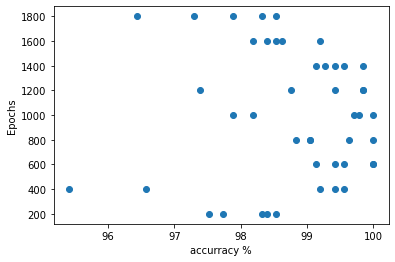

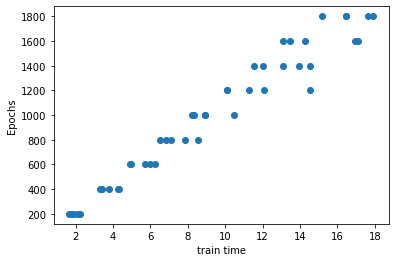

In [91]:
#Epochs distribution accurracy
network_structure = [4, 20,20, 2]
#sigmoid,relu,tanh,leaky_relu
activation = "sigmoid"
learning_rate = 0.9
epochs = []

accurracy = []
train_time = []

for x in range(5):
    for i in range(200, 2000, 200):
        myANN = Neural_Network(network_structure, activation)
        acc,t_time = myANN.train(X, y, learning_rate, i)
        accurracy.append(round(acc,2))
        train_time.append(round(t_time,2))
        epochs.append(i)


plt.scatter(x=accurracy, y=epochs) 
plt.xlabel("accurracy %")
plt.ylabel("Epochs")
#plt.title("Accurracy of different number of inputs",  y=-0.1)
plt.show()

plt.scatter(x=train_time, y=epochs) 
plt.xlabel("train time")
plt.ylabel("Epochs")
#plt.title("Train time of different number of inputs",  y=-0.1)
plt.show()